In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "orig"
enable_aug = False
enable_aug3 = True
sentence_pairs = True
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-orig-enable_aug-False-enable_aug3-True-sentence_pairs-True-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

194419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

194419
194419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 55/194419 [00:00<06:05, 531.95it/s]

  0%|          | 119/194419 [00:00<05:32, 584.16it/s]

  0%|          | 194/194419 [00:00<04:55, 657.61it/s]

  0%|          | 283/194419 [00:00<04:21, 742.31it/s]

  0%|          | 358/194419 [00:00<04:21, 741.92it/s]

  0%|          | 445/194419 [00:00<04:09, 778.58it/s]

  0%|          | 527/194419 [00:00<04:05, 791.09it/s]

  0%|          | 615/194419 [00:00<03:57, 815.94it/s]

  0%|          | 706/194419 [00:00<03:49, 845.01it/s]

  0%|          | 801/194419 [00:01<03:42, 870.82it/s]

  0%|          | 890/194419 [00:01<03:40, 876.37it/s]

  1%|          | 983/194419 [00:01<03:37, 891.01it/s]

  1%|          | 1073/194419 [00:01<03:39, 880.48it/s]

  1%|          | 1162/194419 [00:01<03:45, 856.29it/s]

  1%|          | 1252/194419 [00:01<03:43, 864.04it/s]

  1%|          | 1347/194419 [00:01<03:37, 888.73it/s]

  1%|          | 1437/194419 [00:01<03:39, 879.11it/s]

  1%|          | 1528/194419 [00:01<03:37, 885.58it/s]

  1%|          | 1617/194419 [00:01<03:39, 877.24it/s]

  1%|          | 1705/194419 [00:02<03:48, 844.48it/s]

  1%|          | 1792/194419 [00:02<03:47, 847.97it/s]

  1%|          | 1899/194419 [00:02<03:31, 911.12it/s]

  1%|          | 1994/194419 [00:02<03:28, 921.72it/s]

  1%|          | 2094/194419 [00:02<03:23, 943.60it/s]

  1%|          | 2189/194419 [00:02<03:31, 907.07it/s]

  1%|          | 2281/194419 [00:02<03:33, 898.32it/s]

  1%|          | 2374/194419 [00:02<03:31, 907.00it/s]

  1%|▏         | 2474/194419 [00:02<03:26, 927.76it/s]

  1%|▏         | 2567/194419 [00:02<03:26, 928.05it/s]

  1%|▏         | 2660/194419 [00:03<03:26, 927.71it/s]

  1%|▏         | 2753/194419 [00:03<03:26, 927.75it/s]

  1%|▏         | 2848/194419 [00:03<03:25, 933.62it/s]

  2%|▏         | 2942/194419 [00:03<03:31, 906.69it/s]

  2%|▏         | 3033/194419 [00:03<03:34, 892.22it/s]

  2%|▏         | 3124/194419 [00:03<03:33, 895.64it/s]

  2%|▏         | 3221/194419 [00:03<03:29, 910.77it/s]

  2%|▏         | 3323/194419 [00:03<03:22, 941.69it/s]

  2%|▏         | 3418/194419 [00:03<03:23, 939.46it/s]

  2%|▏         | 3523/194419 [00:04<03:16, 969.70it/s]

  2%|▏         | 3636/194419 [00:04<03:07, 1015.38it/s]

  2%|▏         | 3738/194419 [00:04<04:04, 779.88it/s] 

  2%|▏         | 3847/194419 [00:04<03:42, 855.69it/s]

  2%|▏         | 3948/194419 [00:04<03:32, 895.00it/s]

  2%|▏         | 4044/194419 [00:04<03:28, 912.22it/s]

  2%|▏         | 4140/194419 [00:04<03:27, 917.63it/s]

  2%|▏         | 4250/194419 [00:04<03:16, 967.09it/s]

  2%|▏         | 4356/194419 [00:04<03:11, 992.19it/s]

  2%|▏         | 4457/194419 [00:05<03:11, 994.41it/s]

  2%|▏         | 4558/194419 [00:05<03:14, 977.65it/s]

  2%|▏         | 4659/194419 [00:05<03:12, 986.25it/s]

  2%|▏         | 4760/194419 [00:05<03:11, 991.22it/s]

  2%|▏         | 4860/194419 [00:05<03:13, 981.46it/s]

  3%|▎         | 4968/194419 [00:05<03:07, 1009.29it/s]

  3%|▎         | 5070/194419 [00:05<03:11, 989.30it/s] 

  3%|▎         | 5183/194419 [00:05<03:03, 1030.10it/s]

  3%|▎         | 5287/194419 [00:05<03:07, 1008.37it/s]

  3%|▎         | 5391/194419 [00:05<03:06, 1012.33it/s]

  3%|▎         | 5496/194419 [00:06<03:04, 1021.80it/s]

  3%|▎         | 5599/194419 [00:06<03:07, 1007.97it/s]

  3%|▎         | 5700/194419 [00:06<03:13, 976.46it/s] 

  3%|▎         | 5802/194419 [00:06<03:11, 984.65it/s]

  3%|▎         | 5902/194419 [00:06<03:11, 985.18it/s]

  3%|▎         | 6001/194419 [00:06<03:13, 974.13it/s]

  3%|▎         | 6116/194419 [00:06<03:03, 1025.17it/s]

  3%|▎         | 6219/194419 [00:06<03:03, 1023.02it/s]

  3%|▎         | 6331/194419 [00:06<02:59, 1049.33it/s]

  3%|▎         | 6437/194419 [00:06<03:03, 1024.06it/s]

  3%|▎         | 6547/194419 [00:07<02:59, 1045.41it/s]

  3%|▎         | 6658/194419 [00:07<02:56, 1060.91it/s]

  3%|▎         | 6765/194419 [00:07<03:04, 1018.44it/s]

  4%|▎         | 6868/194419 [00:07<03:07, 1001.25it/s]

  4%|▎         | 6969/194419 [00:07<03:17, 949.82it/s] 

  4%|▎         | 7065/194419 [00:07<03:21, 930.25it/s]

  4%|▎         | 7159/194419 [00:07<03:24, 916.38it/s]

  4%|▎         | 7266/194419 [00:07<03:15, 959.51it/s]

  4%|▍         | 7378/194419 [00:07<03:06, 1004.18it/s]

  4%|▍         | 7483/194419 [00:08<03:04, 1013.51it/s]

  4%|▍         | 7585/194419 [00:08<03:08, 993.71it/s] 

  4%|▍         | 7690/194419 [00:08<03:05, 1009.31it/s]

  4%|▍         | 7792/194419 [00:08<03:06, 1002.68it/s]

  4%|▍         | 7893/194419 [00:08<03:08, 988.19it/s] 

  4%|▍         | 7993/194419 [00:08<03:08, 991.03it/s]

  4%|▍         | 8093/194419 [00:08<03:08, 987.36it/s]

  4%|▍         | 8201/194419 [00:08<03:03, 1012.56it/s]

  4%|▍         | 8308/194419 [00:08<03:01, 1026.02it/s]

  4%|▍         | 8415/194419 [00:08<02:59, 1038.77it/s]

  4%|▍         | 8519/194419 [00:09<03:03, 1012.56it/s]

  4%|▍         | 8626/194419 [00:09<03:00, 1026.94it/s]

  4%|▍         | 8741/194419 [00:09<02:55, 1060.83it/s]

  5%|▍         | 8859/194419 [00:09<02:50, 1089.05it/s]

  5%|▍         | 8969/194419 [00:09<02:51, 1083.95it/s]

  5%|▍         | 9078/194419 [00:09<02:59, 1034.68it/s]

  5%|▍         | 9193/194419 [00:09<02:53, 1067.69it/s]

  5%|▍         | 9301/194419 [00:09<02:55, 1053.63it/s]

  5%|▍         | 9408/194419 [00:09<02:54, 1057.31it/s]

  5%|▍         | 9521/194419 [00:10<02:52, 1074.53it/s]

  5%|▍         | 9633/194419 [00:10<02:50, 1085.90it/s]

  5%|▌         | 9743/194419 [00:10<02:49, 1089.68it/s]

  5%|▌         | 9853/194419 [00:10<02:53, 1064.95it/s]

  5%|▌         | 9962/194419 [00:10<02:52, 1071.08it/s]

  5%|▌         | 10077/194419 [00:10<02:48, 1093.33it/s]

  5%|▌         | 10187/194419 [00:10<02:54, 1053.34it/s]

  5%|▌         | 10293/194419 [00:10<02:58, 1032.52it/s]

  5%|▌         | 10397/194419 [00:10<02:57, 1034.40it/s]

  5%|▌         | 10517/194419 [00:10<02:50, 1079.23it/s]

  5%|▌         | 10626/194419 [00:11<02:53, 1059.44it/s]

  6%|▌         | 10737/194419 [00:11<02:51, 1072.68it/s]

  6%|▌         | 10846/194419 [00:11<02:50, 1077.72it/s]

  6%|▌         | 10954/194419 [00:11<02:53, 1054.61it/s]

  6%|▌         | 11063/194419 [00:11<02:52, 1063.68it/s]

  6%|▌         | 11170/194419 [00:11<02:53, 1056.51it/s]

  6%|▌         | 11276/194419 [00:11<02:53, 1055.88it/s]

  6%|▌         | 11382/194419 [00:11<02:57, 1028.97it/s]

  6%|▌         | 11489/194419 [00:11<02:56, 1038.29it/s]

  6%|▌         | 11593/194419 [00:11<03:00, 1013.35it/s]

  6%|▌         | 11705/194419 [00:12<02:55, 1042.34it/s]

  6%|▌         | 11810/194419 [00:12<02:54, 1044.50it/s]

  6%|▌         | 11915/194419 [00:12<02:55, 1038.91it/s]

  6%|▌         | 12024/194419 [00:12<02:53, 1052.71it/s]

  6%|▌         | 12130/194419 [00:12<02:54, 1044.61it/s]

  6%|▋         | 12235/194419 [00:12<04:16, 709.70it/s] 

  6%|▋         | 12344/194419 [00:12<03:49, 793.92it/s]

  6%|▋         | 12447/194419 [00:12<03:34, 848.13it/s]

  6%|▋         | 12557/194419 [00:13<03:19, 911.32it/s]

  7%|▋         | 12657/194419 [00:13<03:17, 921.34it/s]

  7%|▋         | 12756/194419 [00:13<03:14, 932.40it/s]

  7%|▋         | 12854/194419 [00:13<03:13, 940.49it/s]

  7%|▋         | 12972/194419 [00:13<03:00, 1007.68it/s]

  7%|▋         | 13086/194419 [00:13<02:53, 1045.58it/s]

  7%|▋         | 13193/194419 [00:13<02:55, 1033.56it/s]

  7%|▋         | 13308/194419 [00:13<02:50, 1065.16it/s]

  7%|▋         | 13417/194419 [00:13<02:49, 1068.67it/s]

  7%|▋         | 13525/194419 [00:13<02:50, 1058.48it/s]

  7%|▋         | 13632/194419 [00:14<02:51, 1053.64it/s]

  7%|▋         | 13749/194419 [00:14<02:46, 1084.24it/s]

  7%|▋         | 13858/194419 [00:14<02:50, 1059.85it/s]

  7%|▋         | 13967/194419 [00:14<02:49, 1067.36it/s]

  7%|▋         | 14075/194419 [00:14<02:48, 1069.33it/s]

  7%|▋         | 14183/194419 [00:14<02:50, 1058.17it/s]

  7%|▋         | 14289/194419 [00:14<02:50, 1056.49it/s]

  7%|▋         | 14401/194419 [00:14<02:47, 1072.95it/s]

  7%|▋         | 14509/194419 [00:14<02:54, 1033.13it/s]

  8%|▊         | 14613/194419 [00:15<02:54, 1027.50it/s]

  8%|▊         | 14716/194419 [00:15<02:56, 1017.80it/s]

  8%|▊         | 14827/194419 [00:15<02:52, 1043.34it/s]

  8%|▊         | 14933/194419 [00:15<02:51, 1045.57it/s]

  8%|▊         | 15045/194419 [00:15<02:48, 1067.11it/s]

  8%|▊         | 15161/194419 [00:15<02:43, 1094.55it/s]

  8%|▊         | 15271/194419 [00:15<02:48, 1063.90it/s]

  8%|▊         | 15380/194419 [00:15<02:47, 1070.73it/s]

  8%|▊         | 15488/194419 [00:15<02:47, 1067.49it/s]

  8%|▊         | 15602/194419 [00:15<02:44, 1087.88it/s]

  8%|▊         | 15711/194419 [00:16<02:49, 1052.85it/s]

  8%|▊         | 15823/194419 [00:16<02:46, 1070.51it/s]

  8%|▊         | 15931/194419 [00:16<02:48, 1062.01it/s]

  8%|▊         | 16038/194419 [00:16<02:49, 1050.82it/s]

  8%|▊         | 16144/194419 [00:16<02:49, 1049.83it/s]

  8%|▊         | 16250/194419 [00:16<02:50, 1042.10it/s]

  8%|▊         | 16355/194419 [00:16<02:52, 1031.82it/s]

  8%|▊         | 16471/194419 [00:16<02:47, 1064.09it/s]

  9%|▊         | 16578/194419 [00:16<02:51, 1039.64it/s]

  9%|▊         | 16686/194419 [00:16<02:49, 1046.91it/s]

  9%|▊         | 16792/194419 [00:17<02:49, 1049.97it/s]

  9%|▊         | 16900/194419 [00:17<02:47, 1058.52it/s]

  9%|▉         | 17018/194419 [00:17<02:42, 1089.75it/s]

  9%|▉         | 17128/194419 [00:17<02:47, 1059.33it/s]

  9%|▉         | 17235/194419 [00:17<02:52, 1024.61it/s]

  9%|▉         | 17352/194419 [00:17<02:46, 1064.18it/s]

  9%|▉         | 17470/194419 [00:17<02:41, 1096.44it/s]

  9%|▉         | 17581/194419 [00:17<02:45, 1071.17it/s]

  9%|▉         | 17689/194419 [00:17<02:45, 1067.72it/s]

  9%|▉         | 17798/194419 [00:17<02:44, 1073.51it/s]

  9%|▉         | 17913/194419 [00:18<02:41, 1093.60it/s]

  9%|▉         | 18029/194419 [00:18<02:38, 1112.61it/s]

  9%|▉         | 18141/194419 [00:18<02:40, 1099.68it/s]

  9%|▉         | 18252/194419 [00:18<02:44, 1071.14it/s]

  9%|▉         | 18360/194419 [00:18<02:46, 1056.08it/s]

  9%|▉         | 18466/194419 [00:18<02:52, 1018.91it/s]

 10%|▉         | 18569/194419 [00:18<02:53, 1014.12it/s]

 10%|▉         | 18674/194419 [00:18<02:52, 1017.79it/s]

 10%|▉         | 18776/194419 [00:18<02:55, 999.22it/s] 

 10%|▉         | 18882/194419 [00:19<02:53, 1014.31it/s]

 10%|▉         | 18984/194419 [00:19<02:56, 992.90it/s] 

 10%|▉         | 19088/194419 [00:19<02:54, 1004.24it/s]

 10%|▉         | 19189/194419 [00:19<02:57, 987.92it/s] 

 10%|▉         | 19288/194419 [00:19<02:58, 982.79it/s]

 10%|▉         | 19395/194419 [00:19<02:53, 1006.68it/s]

 10%|█         | 19502/194419 [00:19<02:50, 1024.84it/s]

 10%|█         | 19606/194419 [00:19<02:49, 1028.76it/s]

 10%|█         | 19723/194419 [00:19<02:43, 1067.28it/s]

 10%|█         | 19833/194419 [00:19<02:42, 1074.97it/s]

 10%|█         | 19941/194419 [00:20<02:44, 1059.55it/s]

 10%|█         | 20048/194419 [00:20<02:48, 1034.47it/s]

 10%|█         | 20152/194419 [00:20<02:49, 1028.28it/s]

 10%|█         | 20260/194419 [00:20<02:47, 1038.67it/s]

 10%|█         | 20367/194419 [00:20<02:46, 1045.67it/s]

 11%|█         | 20472/194419 [00:20<02:48, 1032.42it/s]

 11%|█         | 20576/194419 [00:20<04:38, 625.16it/s] 

 11%|█         | 20686/194419 [00:21<04:00, 721.04it/s]

 11%|█         | 20800/194419 [00:21<03:33, 812.11it/s]

 11%|█         | 20908/194419 [00:21<03:18, 876.26it/s]

 11%|█         | 21016/194419 [00:21<03:06, 928.53it/s]

 11%|█         | 21119/194419 [00:21<03:03, 942.57it/s]

 11%|█         | 21221/194419 [00:21<03:02, 948.57it/s]

 11%|█         | 21321/194419 [00:21<03:00, 956.91it/s]

 11%|█         | 21423/194419 [00:21<02:57, 974.33it/s]

 11%|█         | 21525/194419 [00:21<02:55, 985.85it/s]

 11%|█         | 21636/194419 [00:21<02:49, 1020.80it/s]

 11%|█         | 21741/194419 [00:22<02:48, 1026.40it/s]

 11%|█         | 21846/194419 [00:22<02:47, 1033.02it/s]

 11%|█▏        | 21950/194419 [00:22<02:51, 1003.86it/s]

 11%|█▏        | 22056/194419 [00:22<02:49, 1019.75it/s]

 11%|█▏        | 22183/194419 [00:22<02:37, 1092.44it/s]

 11%|█▏        | 22293/194419 [00:22<02:40, 1070.11it/s]

 12%|█▏        | 22401/194419 [00:22<02:40, 1071.89it/s]

 12%|█▏        | 22520/194419 [00:22<02:35, 1105.46it/s]

 12%|█▏        | 22631/194419 [00:22<02:35, 1104.22it/s]

 12%|█▏        | 22742/194419 [00:22<02:36, 1097.73it/s]

 12%|█▏        | 22852/194419 [00:23<02:42, 1056.86it/s]

 12%|█▏        | 22964/194419 [00:23<02:39, 1073.72it/s]

 12%|█▏        | 23072/194419 [00:23<02:41, 1062.38it/s]

 12%|█▏        | 23183/194419 [00:23<02:39, 1071.66it/s]

 12%|█▏        | 23291/194419 [00:23<02:40, 1067.48it/s]

 12%|█▏        | 23404/194419 [00:23<02:38, 1079.20it/s]

 12%|█▏        | 23513/194419 [00:23<02:40, 1064.31it/s]

 12%|█▏        | 23624/194419 [00:23<02:38, 1075.54it/s]

 12%|█▏        | 23735/194419 [00:23<02:37, 1084.86it/s]

 12%|█▏        | 23845/194419 [00:23<02:37, 1085.58it/s]

 12%|█▏        | 23956/194419 [00:24<02:36, 1091.33it/s]

 12%|█▏        | 24066/194419 [00:24<02:35, 1092.08it/s]

 12%|█▏        | 24176/194419 [00:24<02:36, 1090.33it/s]

 12%|█▏        | 24286/194419 [00:24<02:35, 1090.82it/s]

 13%|█▎        | 24396/194419 [00:24<02:38, 1073.62it/s]

 13%|█▎        | 24504/194419 [00:24<02:40, 1057.50it/s]

 13%|█▎        | 24613/194419 [00:24<02:39, 1063.25it/s]

 13%|█▎        | 24733/194419 [00:24<02:33, 1103.12it/s]

 13%|█▎        | 24844/194419 [00:24<02:34, 1099.17it/s]

 13%|█▎        | 24961/194419 [00:25<02:31, 1119.20it/s]

 13%|█▎        | 25074/194419 [00:25<02:33, 1105.98it/s]

 13%|█▎        | 25186/194419 [00:25<02:32, 1109.57it/s]

 13%|█▎        | 25301/194419 [00:25<02:31, 1119.95it/s]

 13%|█▎        | 25414/194419 [00:25<02:35, 1084.96it/s]

 13%|█▎        | 25531/194419 [00:25<02:32, 1107.94it/s]

 13%|█▎        | 25643/194419 [00:25<02:31, 1110.40it/s]

 13%|█▎        | 25764/194419 [00:25<02:28, 1135.19it/s]

 13%|█▎        | 25878/194419 [00:25<02:33, 1094.47it/s]

 13%|█▎        | 25988/194419 [00:25<02:33, 1095.81it/s]

 13%|█▎        | 26098/194419 [00:26<02:34, 1090.40it/s]

 13%|█▎        | 26208/194419 [00:26<02:35, 1084.81it/s]

 14%|█▎        | 26327/194419 [00:26<02:30, 1115.37it/s]

 14%|█▎        | 26439/194419 [00:26<02:30, 1116.32it/s]

 14%|█▎        | 26551/194419 [00:26<02:32, 1099.98it/s]

 14%|█▎        | 26665/194419 [00:26<02:31, 1107.88it/s]

 14%|█▍        | 26776/194419 [00:26<02:34, 1082.55it/s]

 14%|█▍        | 26885/194419 [00:26<02:36, 1070.62it/s]

 14%|█▍        | 26995/194419 [00:26<02:35, 1074.96it/s]

 14%|█▍        | 27111/194419 [00:26<02:32, 1099.36it/s]

 14%|█▍        | 27222/194419 [00:27<02:36, 1066.14it/s]

 14%|█▍        | 27329/194419 [00:27<02:41, 1033.04it/s]

 14%|█▍        | 27440/194419 [00:27<02:38, 1054.58it/s]

 14%|█▍        | 27546/194419 [00:27<02:40, 1042.91it/s]

 14%|█▍        | 27661/194419 [00:27<02:35, 1071.23it/s]

 14%|█▍        | 27776/194419 [00:27<02:32, 1089.91it/s]

 14%|█▍        | 27894/194419 [00:27<02:29, 1114.52it/s]

 14%|█▍        | 28006/194419 [00:27<02:29, 1109.99it/s]

 14%|█▍        | 28129/194419 [00:27<02:25, 1141.71it/s]

 15%|█▍        | 28244/194419 [00:28<02:30, 1107.60it/s]

 15%|█▍        | 28366/194419 [00:28<02:25, 1138.95it/s]

 15%|█▍        | 28481/194419 [00:28<02:30, 1103.97it/s]

 15%|█▍        | 28600/194419 [00:28<02:27, 1126.92it/s]

 15%|█▍        | 28714/194419 [00:28<02:33, 1079.19it/s]

 15%|█▍        | 28824/194419 [00:28<02:32, 1084.43it/s]

 15%|█▍        | 28938/194419 [00:28<02:30, 1099.77it/s]

 15%|█▍        | 29052/194419 [00:28<02:28, 1110.55it/s]

 15%|█▌        | 29172/194419 [00:28<02:25, 1135.96it/s]

 15%|█▌        | 29286/194419 [00:28<02:27, 1119.87it/s]

 15%|█▌        | 29399/194419 [00:29<02:29, 1100.14it/s]

 15%|█▌        | 29510/194419 [00:29<02:35, 1059.89it/s]

 15%|█▌        | 29620/194419 [00:29<02:34, 1068.89it/s]

 15%|█▌        | 29728/194419 [00:29<02:35, 1057.42it/s]

 15%|█▌        | 29834/194419 [00:29<02:38, 1040.81it/s]

 15%|█▌        | 29941/194419 [00:29<02:37, 1044.77it/s]

 15%|█▌        | 30051/194419 [00:29<02:35, 1059.54it/s]

 16%|█▌        | 30158/194419 [00:29<02:38, 1037.05it/s]

 16%|█▌        | 30262/194419 [00:29<02:39, 1030.88it/s]

 16%|█▌        | 30366/194419 [00:29<02:41, 1018.33it/s]

 16%|█▌        | 30468/194419 [00:30<04:49, 565.65it/s] 

 16%|█▌        | 30580/194419 [00:30<04:04, 668.91it/s]

 16%|█▌        | 30677/194419 [00:30<03:43, 732.15it/s]

 16%|█▌        | 30781/194419 [00:30<03:24, 802.06it/s]

 16%|█▌        | 30882/194419 [00:30<03:11, 853.21it/s]

 16%|█▌        | 30990/194419 [00:30<02:59, 911.75it/s]

 16%|█▌        | 31108/194419 [00:30<02:46, 983.28it/s]

 16%|█▌        | 31222/194419 [00:31<02:39, 1021.15it/s]

 16%|█▌        | 31330/194419 [00:31<02:38, 1031.93it/s]

 16%|█▌        | 31446/194419 [00:31<02:32, 1068.38it/s]

 16%|█▌        | 31556/194419 [00:31<02:32, 1067.24it/s]

 16%|█▋        | 31687/194419 [00:31<02:23, 1135.21it/s]

 16%|█▋        | 31802/194419 [00:31<02:26, 1110.55it/s]

 16%|█▋        | 31916/194419 [00:31<02:25, 1118.93it/s]

 16%|█▋        | 32029/194419 [00:31<02:28, 1096.20it/s]

 17%|█▋        | 32147/194419 [00:31<02:24, 1119.99it/s]

 17%|█▋        | 32260/194419 [00:32<02:28, 1091.81it/s]

 17%|█▋        | 32377/194419 [00:32<02:25, 1113.20it/s]

 17%|█▋        | 32489/194419 [00:32<02:27, 1097.65it/s]

 17%|█▋        | 32600/194419 [00:32<02:27, 1093.53it/s]

 17%|█▋        | 32730/194419 [00:32<02:20, 1147.99it/s]

 17%|█▋        | 32853/194419 [00:32<02:18, 1170.57it/s]

 17%|█▋        | 32971/194419 [00:32<02:21, 1143.55it/s]

 17%|█▋        | 33086/194419 [00:32<02:23, 1122.90it/s]

 17%|█▋        | 33199/194419 [00:32<02:23, 1120.26it/s]

 17%|█▋        | 33312/194419 [00:32<02:28, 1083.00it/s]

 17%|█▋        | 33423/194419 [00:33<02:27, 1088.34it/s]

 17%|█▋        | 33533/194419 [00:33<02:28, 1081.36it/s]

 17%|█▋        | 33644/194419 [00:33<02:27, 1088.19it/s]

 17%|█▋        | 33757/194419 [00:33<02:26, 1096.56it/s]

 17%|█▋        | 33881/194419 [00:33<02:21, 1135.33it/s]

 17%|█▋        | 33996/194419 [00:33<02:21, 1136.53it/s]

 18%|█▊        | 34111/194419 [00:33<02:21, 1134.57it/s]

 18%|█▊        | 34225/194419 [00:33<02:21, 1134.06it/s]

 18%|█▊        | 34339/194419 [00:33<02:25, 1103.77it/s]

 18%|█▊        | 34450/194419 [00:33<02:27, 1081.15it/s]

 18%|█▊        | 34579/194419 [00:34<02:20, 1137.73it/s]

 18%|█▊        | 34703/194419 [00:34<02:16, 1166.15it/s]

 18%|█▊        | 34833/194419 [00:34<02:12, 1202.53it/s]

 18%|█▊        | 34955/194419 [00:34<02:12, 1203.72it/s]

 18%|█▊        | 35076/194419 [00:34<02:16, 1164.56it/s]

 18%|█▊        | 35193/194419 [00:34<02:19, 1142.23it/s]

 18%|█▊        | 35311/194419 [00:34<02:18, 1152.29it/s]

 18%|█▊        | 35427/194419 [00:34<02:25, 1089.80it/s]

 18%|█▊        | 35537/194419 [00:34<02:26, 1087.25it/s]

 18%|█▊        | 35651/194419 [00:35<02:24, 1099.05it/s]

 18%|█▊        | 35769/194419 [00:35<02:21, 1121.77it/s]

 18%|█▊        | 35882/194419 [00:35<02:21, 1123.25it/s]

 19%|█▊        | 36003/194419 [00:35<02:19, 1139.05it/s]

 19%|█▊        | 36118/194419 [00:35<02:25, 1085.21it/s]

 19%|█▊        | 36239/194419 [00:35<02:21, 1119.41it/s]

 19%|█▊        | 36352/194419 [00:35<02:22, 1109.34it/s]

 19%|█▉        | 36464/194419 [00:35<02:24, 1094.89it/s]

 19%|█▉        | 36577/194419 [00:35<02:23, 1101.62it/s]

 19%|█▉        | 36699/194419 [00:35<02:19, 1133.88it/s]

 19%|█▉        | 36813/194419 [00:36<02:20, 1119.67it/s]

 19%|█▉        | 36926/194419 [00:36<02:24, 1087.39it/s]

 19%|█▉        | 37046/194419 [00:36<02:20, 1119.01it/s]

 19%|█▉        | 37159/194419 [00:36<02:23, 1094.90it/s]

 19%|█▉        | 37281/194419 [00:36<02:19, 1129.88it/s]

 19%|█▉        | 37396/194419 [00:36<02:18, 1129.97it/s]

 19%|█▉        | 37510/194419 [00:36<02:20, 1114.63it/s]

 19%|█▉        | 37622/194419 [00:36<02:23, 1088.97it/s]

 19%|█▉        | 37743/194419 [00:36<02:19, 1123.62it/s]

 19%|█▉        | 37868/194419 [00:36<02:15, 1159.23it/s]

 20%|█▉        | 37985/194419 [00:37<02:18, 1131.17it/s]

 20%|█▉        | 38099/194419 [00:37<02:20, 1115.62it/s]

 20%|█▉        | 38211/194419 [00:37<02:23, 1086.47it/s]

 20%|█▉        | 38321/194419 [00:37<02:23, 1089.57it/s]

 20%|█▉        | 38438/194419 [00:37<02:20, 1110.47it/s]

 20%|█▉        | 38550/194419 [00:37<02:25, 1072.73it/s]

 20%|█▉        | 38658/194419 [00:37<02:25, 1067.85it/s]

 20%|█▉        | 38769/194419 [00:37<02:24, 1077.17it/s]

 20%|█▉        | 38877/194419 [00:37<02:25, 1070.82it/s]

 20%|██        | 38985/194419 [00:38<02:26, 1061.30it/s]

 20%|██        | 39098/194419 [00:38<02:24, 1077.13it/s]

 20%|██        | 39216/194419 [00:38<02:20, 1105.94it/s]

 20%|██        | 39334/194419 [00:38<02:18, 1123.67it/s]

 20%|██        | 39450/194419 [00:38<02:16, 1131.31it/s]

 20%|██        | 39564/194419 [00:38<02:17, 1127.93it/s]

 20%|██        | 39677/194419 [00:38<02:17, 1122.86it/s]

 20%|██        | 39792/194419 [00:38<02:16, 1128.71it/s]

 21%|██        | 39905/194419 [00:38<02:17, 1120.47it/s]

 21%|██        | 40019/194419 [00:38<02:17, 1120.90it/s]

 21%|██        | 40133/194419 [00:39<02:17, 1126.14it/s]

 21%|██        | 40246/194419 [00:39<02:19, 1102.52it/s]

 21%|██        | 40358/194419 [00:39<02:19, 1106.47it/s]

 21%|██        | 40469/194419 [00:39<02:19, 1100.81it/s]

 21%|██        | 40594/194419 [00:39<02:14, 1143.46it/s]

 21%|██        | 40709/194419 [00:39<02:18, 1108.47it/s]

 21%|██        | 40821/194419 [00:39<02:18, 1105.43it/s]

 21%|██        | 40934/194419 [00:39<02:18, 1109.06it/s]

 21%|██        | 41055/194419 [00:39<02:15, 1134.29it/s]

 21%|██        | 41171/194419 [00:39<02:14, 1141.18it/s]

 21%|██        | 41286/194419 [00:40<02:17, 1112.09it/s]

 21%|██▏       | 41403/194419 [00:40<02:15, 1127.28it/s]

 21%|██▏       | 41516/194419 [00:40<02:16, 1118.20it/s]

 21%|██▏       | 41628/194419 [00:40<02:17, 1112.91it/s]

 21%|██▏       | 41743/194419 [00:40<02:16, 1120.84it/s]

 22%|██▏       | 41860/194419 [00:40<02:14, 1133.04it/s]

 22%|██▏       | 41974/194419 [00:40<02:14, 1133.86it/s]

 22%|██▏       | 42088/194419 [00:40<02:14, 1133.73it/s]

 22%|██▏       | 42202/194419 [00:40<02:16, 1112.92it/s]

 22%|██▏       | 42314/194419 [00:41<02:18, 1098.97it/s]

 22%|██▏       | 42424/194419 [00:41<02:19, 1092.02it/s]

 22%|██▏       | 42549/194419 [00:41<02:14, 1130.81it/s]

 22%|██▏       | 42664/194419 [00:41<02:14, 1130.33it/s]

 22%|██▏       | 42783/194419 [00:41<02:12, 1147.69it/s]

 22%|██▏       | 42902/194419 [00:41<02:11, 1156.21it/s]

 22%|██▏       | 43018/194419 [00:41<02:11, 1148.75it/s]

 22%|██▏       | 43137/194419 [00:41<02:10, 1160.41it/s]

 22%|██▏       | 43254/194419 [00:41<02:11, 1150.46it/s]

 22%|██▏       | 43370/194419 [00:41<02:12, 1140.01it/s]

 22%|██▏       | 43485/194419 [00:42<02:15, 1115.86it/s]

 22%|██▏       | 43597/194419 [00:42<04:43, 532.26it/s] 

 22%|██▏       | 43701/194419 [00:42<04:04, 616.11it/s]

 23%|██▎       | 43813/194419 [00:42<03:31, 711.83it/s]

 23%|██▎       | 43927/194419 [00:42<03:07, 803.04it/s]

 23%|██▎       | 44040/194419 [00:42<02:51, 878.99it/s]

 23%|██▎       | 44146/194419 [00:43<02:44, 910.93it/s]

 23%|██▎       | 44255/194419 [00:43<02:37, 955.21it/s]

 23%|██▎       | 44360/194419 [00:43<02:32, 980.82it/s]

 23%|██▎       | 44465/194419 [00:43<02:30, 995.45it/s]

 23%|██▎       | 44570/194419 [00:43<02:30, 996.52it/s]

 23%|██▎       | 44674/194419 [00:43<02:28, 1006.38it/s]

 23%|██▎       | 44783/194419 [00:43<02:25, 1028.87it/s]

 23%|██▎       | 44895/194419 [00:43<02:21, 1053.03it/s]

 23%|██▎       | 45002/194419 [00:43<02:24, 1030.82it/s]

 23%|██▎       | 45112/194419 [00:43<02:22, 1050.48it/s]

 23%|██▎       | 45221/194419 [00:44<02:21, 1057.89it/s]

 23%|██▎       | 45328/194419 [00:44<02:23, 1041.89it/s]

 23%|██▎       | 45433/194419 [00:44<02:25, 1025.87it/s]

 23%|██▎       | 45536/194419 [00:44<02:28, 1002.29it/s]

 23%|██▎       | 45650/194419 [00:44<02:22, 1040.44it/s]

 24%|██▎       | 45755/194419 [00:44<02:24, 1031.05it/s]

 24%|██▎       | 45869/194419 [00:44<02:20, 1060.17it/s]

 24%|██▎       | 45978/194419 [00:44<02:19, 1064.77it/s]

 24%|██▎       | 46089/194419 [00:44<02:17, 1075.89it/s]

 24%|██▍       | 46200/194419 [00:44<02:16, 1082.67it/s]

 24%|██▍       | 46309/194419 [00:45<02:17, 1080.14it/s]

 24%|██▍       | 46418/194419 [00:45<02:22, 1038.39it/s]

 24%|██▍       | 46524/194419 [00:45<02:21, 1042.75it/s]

 24%|██▍       | 46629/194419 [00:45<02:23, 1031.50it/s]

 24%|██▍       | 46733/194419 [00:45<02:26, 1008.21it/s]

 24%|██▍       | 46843/194419 [00:45<02:22, 1034.34it/s]

 24%|██▍       | 46959/194419 [00:45<02:17, 1069.90it/s]

 24%|██▍       | 47067/194419 [00:45<02:17, 1069.88it/s]

 24%|██▍       | 47175/194419 [00:45<02:19, 1053.03it/s]

 24%|██▍       | 47281/194419 [00:46<02:24, 1018.34it/s]

 24%|██▍       | 47388/194419 [00:46<02:22, 1028.67it/s]

 24%|██▍       | 47511/194419 [00:46<02:15, 1081.48it/s]

 24%|██▍       | 47628/194419 [00:46<02:12, 1106.87it/s]

 25%|██▍       | 47743/194419 [00:46<02:11, 1111.55it/s]

 25%|██▍       | 47856/194419 [00:46<02:11, 1116.83it/s]

 25%|██▍       | 47968/194419 [00:46<02:12, 1109.07it/s]

 25%|██▍       | 48087/194419 [00:46<02:09, 1130.85it/s]

 25%|██▍       | 48201/194419 [00:46<02:09, 1125.98it/s]

 25%|██▍       | 48319/194419 [00:46<02:07, 1141.62it/s]

 25%|██▍       | 48434/194419 [00:47<02:13, 1090.99it/s]

 25%|██▍       | 48545/194419 [00:47<02:14, 1088.38it/s]

 25%|██▌       | 48674/194419 [00:47<02:07, 1146.52it/s]

 25%|██▌       | 48790/194419 [00:47<02:10, 1116.92it/s]

 25%|██▌       | 48903/194419 [00:47<02:15, 1072.13it/s]

 25%|██▌       | 49012/194419 [00:47<02:15, 1074.88it/s]

 25%|██▌       | 49122/194419 [00:47<02:14, 1080.57it/s]

 25%|██▌       | 49231/194419 [00:47<02:14, 1076.14it/s]

 25%|██▌       | 49342/194419 [00:47<02:14, 1081.54it/s]

 25%|██▌       | 49453/194419 [00:47<02:13, 1086.48it/s]

 25%|██▌       | 49562/194419 [00:48<02:16, 1057.91it/s]

 26%|██▌       | 49676/194419 [00:48<02:14, 1079.70it/s]

 26%|██▌       | 49785/194419 [00:48<02:17, 1052.95it/s]

 26%|██▌       | 49905/194419 [00:48<02:12, 1092.99it/s]

 26%|██▌       | 50020/194419 [00:48<02:10, 1104.05it/s]

 26%|██▌       | 50131/194419 [00:48<02:12, 1086.08it/s]

 26%|██▌       | 50240/194419 [00:48<02:13, 1081.08it/s]

 26%|██▌       | 50349/194419 [00:48<02:16, 1058.68it/s]

 26%|██▌       | 50458/194419 [00:48<02:14, 1067.70it/s]

 26%|██▌       | 50574/194419 [00:49<02:11, 1089.84it/s]

 26%|██▌       | 50691/194419 [00:49<02:09, 1112.46it/s]

 26%|██▌       | 50803/194419 [00:49<02:12, 1079.89it/s]

 26%|██▌       | 50921/194419 [00:49<02:09, 1106.85it/s]

 26%|██▋       | 51040/194419 [00:49<02:07, 1120.21it/s]

 26%|██▋       | 51153/194419 [00:49<02:10, 1094.58it/s]

 26%|██▋       | 51271/194419 [00:49<02:08, 1117.69it/s]

 26%|██▋       | 51383/194419 [00:49<02:10, 1097.19it/s]

 26%|██▋       | 51493/194419 [00:49<02:11, 1085.26it/s]

 27%|██▋       | 51604/194419 [00:49<02:10, 1092.34it/s]

 27%|██▋       | 51714/194419 [00:50<02:13, 1070.54it/s]

 27%|██▋       | 51822/194419 [00:50<02:14, 1057.17it/s]

 27%|██▋       | 51936/194419 [00:50<02:12, 1076.15it/s]

 27%|██▋       | 52047/194419 [00:50<02:11, 1083.92it/s]

 27%|██▋       | 52156/194419 [00:50<02:13, 1064.38it/s]

 27%|██▋       | 52271/194419 [00:50<02:10, 1085.92it/s]

 27%|██▋       | 52380/194419 [00:50<02:14, 1055.21it/s]

 27%|██▋       | 52486/194419 [00:50<02:15, 1047.34it/s]

 27%|██▋       | 52603/194419 [00:50<02:11, 1076.64it/s]

 27%|██▋       | 52711/194419 [00:50<02:12, 1065.72it/s]

 27%|██▋       | 52818/194419 [00:51<02:12, 1065.43it/s]

 27%|██▋       | 52939/194419 [00:51<02:08, 1105.06it/s]

 27%|██▋       | 53050/194419 [00:51<02:11, 1074.27it/s]

 27%|██▋       | 53166/194419 [00:51<02:08, 1095.86it/s]

 27%|██▋       | 53276/194419 [00:51<02:12, 1067.88it/s]

 27%|██▋       | 53387/194419 [00:51<02:10, 1079.34it/s]

 28%|██▊       | 53497/194419 [00:51<02:10, 1082.51it/s]

 28%|██▊       | 53611/194419 [00:51<02:08, 1098.96it/s]

 28%|██▊       | 53722/194419 [00:51<02:09, 1087.69it/s]

 28%|██▊       | 53831/194419 [00:52<02:11, 1066.63it/s]

 28%|██▊       | 53938/194419 [00:52<02:13, 1050.48it/s]

 28%|██▊       | 54044/194419 [00:52<02:15, 1034.94it/s]

 28%|██▊       | 54148/194419 [00:52<02:15, 1034.78it/s]

 28%|██▊       | 54258/194419 [00:52<02:13, 1053.21it/s]

 28%|██▊       | 54378/194419 [00:52<02:07, 1095.04it/s]

 28%|██▊       | 54488/194419 [00:52<02:10, 1068.82it/s]

 28%|██▊       | 54604/194419 [00:52<02:08, 1092.10it/s]

 28%|██▊       | 54714/194419 [00:52<02:09, 1078.39it/s]

 28%|██▊       | 54822/194419 [00:52<02:09, 1074.73it/s]

 28%|██▊       | 54930/194419 [00:53<02:12, 1053.20it/s]

 28%|██▊       | 55041/194419 [00:53<02:10, 1069.13it/s]

 28%|██▊       | 55153/194419 [00:53<02:08, 1083.99it/s]

 28%|██▊       | 55262/194419 [00:53<02:08, 1081.75it/s]

 28%|██▊       | 55371/194419 [00:53<02:11, 1059.50it/s]

 29%|██▊       | 55478/194419 [00:53<02:15, 1021.85it/s]

 29%|██▊       | 55585/194419 [00:53<02:14, 1033.11it/s]

 29%|██▊       | 55689/194419 [00:53<02:15, 1027.51it/s]

 29%|██▊       | 55809/194419 [00:53<02:08, 1075.83it/s]

 29%|██▉       | 55926/194419 [00:53<02:05, 1102.41it/s]

 29%|██▉       | 56037/194419 [00:54<02:06, 1094.10it/s]

 29%|██▉       | 56147/194419 [00:54<02:11, 1055.20it/s]

 29%|██▉       | 56254/194419 [00:54<02:10, 1056.98it/s]

 29%|██▉       | 56371/194419 [00:54<02:06, 1088.67it/s]

 29%|██▉       | 56481/194419 [00:54<02:09, 1061.91it/s]

 29%|██▉       | 56594/194419 [00:54<02:07, 1080.38it/s]

 29%|██▉       | 56708/194419 [00:54<02:05, 1097.28it/s]

 29%|██▉       | 56831/194419 [00:54<02:01, 1132.78it/s]

 29%|██▉       | 56945/194419 [00:54<02:01, 1132.36it/s]

 29%|██▉       | 57059/194419 [00:55<02:05, 1094.33it/s]

 29%|██▉       | 57169/194419 [00:55<02:06, 1086.99it/s]

 29%|██▉       | 57278/194419 [00:55<02:07, 1075.34it/s]

 30%|██▉       | 57386/194419 [00:55<02:07, 1076.44it/s]

 30%|██▉       | 57497/194419 [00:55<02:06, 1083.86it/s]

 30%|██▉       | 57608/194419 [00:55<02:05, 1090.73it/s]

 30%|██▉       | 57722/194419 [00:55<02:04, 1098.26it/s]

 30%|██▉       | 57834/194419 [00:55<02:03, 1103.20it/s]

 30%|██▉       | 57945/194419 [00:55<02:05, 1088.04it/s]

 30%|██▉       | 58057/194419 [00:55<02:04, 1096.50it/s]

 30%|██▉       | 58173/194419 [00:56<02:02, 1113.24it/s]

 30%|██▉       | 58285/194419 [00:56<02:03, 1104.95it/s]

 30%|███       | 58404/194419 [00:56<02:00, 1128.43it/s]

 30%|███       | 58520/194419 [00:56<01:59, 1137.76it/s]

 30%|███       | 58634/194419 [00:56<02:01, 1121.43it/s]

 30%|███       | 58751/194419 [00:56<01:59, 1133.68it/s]

 30%|███       | 58865/194419 [00:56<02:01, 1116.09it/s]

 30%|███       | 58977/194419 [00:56<02:03, 1093.49it/s]

 30%|███       | 59090/194419 [00:56<02:02, 1100.44it/s]

 30%|███       | 59201/194419 [00:56<02:03, 1093.49it/s]

 31%|███       | 59313/194419 [00:57<02:02, 1100.09it/s]

 31%|███       | 59427/194419 [00:57<02:02, 1105.91it/s]

 31%|███       | 59538/194419 [00:57<04:56, 455.53it/s] 

 31%|███       | 59654/194419 [00:57<04:01, 558.07it/s]

 31%|███       | 59751/194419 [00:57<03:33, 629.58it/s]

 31%|███       | 59867/194419 [00:58<03:03, 735.17it/s]

 31%|███       | 59968/194419 [00:58<02:49, 793.59it/s]

 31%|███       | 60069/194419 [00:58<02:39, 844.19it/s]

 31%|███       | 60178/194419 [00:58<02:28, 904.75it/s]

 31%|███       | 60281/194419 [00:58<02:23, 937.26it/s]

 31%|███       | 60385/194419 [00:58<02:18, 965.08it/s]

 31%|███       | 60500/194419 [00:58<02:11, 1016.99it/s]

 31%|███       | 60607/194419 [00:58<02:12, 1011.84it/s]

 31%|███       | 60725/194419 [00:58<02:06, 1056.07it/s]

 31%|███▏      | 60856/194419 [00:58<01:58, 1128.67it/s]

 31%|███▏      | 60971/194419 [00:59<01:58, 1125.12it/s]

 31%|███▏      | 61089/194419 [00:59<01:57, 1137.23it/s]

 31%|███▏      | 61204/194419 [00:59<01:59, 1112.64it/s]

 32%|███▏      | 61317/194419 [00:59<02:00, 1105.36it/s]

 32%|███▏      | 61429/194419 [00:59<02:02, 1081.34it/s]

 32%|███▏      | 61555/194419 [00:59<01:57, 1132.69it/s]

 32%|███▏      | 61671/194419 [00:59<01:56, 1140.17it/s]

 32%|███▏      | 61788/194419 [00:59<01:55, 1147.31it/s]

 32%|███▏      | 61904/194419 [00:59<01:58, 1114.70it/s]

 32%|███▏      | 62016/194419 [01:00<01:59, 1107.44it/s]

 32%|███▏      | 62128/194419 [01:00<01:59, 1108.84it/s]

 32%|███▏      | 62240/194419 [01:00<01:59, 1102.63it/s]

 32%|███▏      | 62354/194419 [01:00<01:58, 1112.85it/s]

 32%|███▏      | 62466/194419 [01:00<02:01, 1088.11it/s]

 32%|███▏      | 62575/194419 [01:00<02:04, 1054.96it/s]

 32%|███▏      | 62682/194419 [01:00<02:04, 1058.12it/s]

 32%|███▏      | 62789/194419 [01:00<02:04, 1060.65it/s]

 32%|███▏      | 62896/194419 [01:00<02:07, 1032.55it/s]

 32%|███▏      | 63011/194419 [01:00<02:03, 1061.88it/s]

 32%|███▏      | 63130/194419 [01:01<02:00, 1092.87it/s]

 33%|███▎      | 63240/194419 [01:01<02:03, 1059.24it/s]

 33%|███▎      | 63347/194419 [01:01<02:07, 1026.54it/s]

 33%|███▎      | 63458/194419 [01:01<02:04, 1049.05it/s]

 33%|███▎      | 63564/194419 [01:01<02:04, 1049.83it/s]

 33%|███▎      | 63670/194419 [01:01<02:06, 1030.46it/s]

 33%|███▎      | 63784/194419 [01:01<02:03, 1060.15it/s]

 33%|███▎      | 63891/194419 [01:01<02:03, 1053.09it/s]

 33%|███▎      | 63997/194419 [01:01<02:07, 1024.70it/s]

 33%|███▎      | 64103/194419 [01:02<02:06, 1033.07it/s]

 33%|███▎      | 64207/194419 [01:02<02:07, 1020.82it/s]

 33%|███▎      | 64314/194419 [01:02<02:05, 1033.46it/s]

 33%|███▎      | 64432/194419 [01:02<02:00, 1075.64it/s]

 33%|███▎      | 64544/194419 [01:02<01:59, 1082.52it/s]

 33%|███▎      | 64653/194419 [01:02<02:05, 1037.51it/s]

 33%|███▎      | 64770/194419 [01:02<02:00, 1075.31it/s]

 33%|███▎      | 64879/194419 [01:02<02:03, 1049.95it/s]

 33%|███▎      | 64989/194419 [01:02<02:01, 1062.47it/s]

 33%|███▎      | 65096/194419 [01:02<02:03, 1047.58it/s]

 34%|███▎      | 65213/194419 [01:03<01:59, 1079.74it/s]

 34%|███▎      | 65331/194419 [01:03<01:56, 1106.92it/s]

 34%|███▎      | 65447/194419 [01:03<01:55, 1119.83it/s]

 34%|███▎      | 65563/194419 [01:03<01:53, 1131.46it/s]

 34%|███▍      | 65677/194419 [01:03<01:55, 1116.44it/s]

 34%|███▍      | 65789/194419 [01:03<02:00, 1068.11it/s]

 34%|███▍      | 65906/194419 [01:03<01:57, 1094.78it/s]

 34%|███▍      | 66022/194419 [01:03<01:55, 1108.25it/s]

 34%|███▍      | 66134/194419 [01:03<02:03, 1040.78it/s]

 34%|███▍      | 66240/194419 [01:03<02:02, 1045.18it/s]

 34%|███▍      | 66346/194419 [01:04<02:05, 1019.91it/s]

 34%|███▍      | 66455/194419 [01:04<02:03, 1038.51it/s]

 34%|███▍      | 66571/194419 [01:04<01:59, 1072.74it/s]

 34%|███▍      | 66686/194419 [01:04<01:56, 1093.17it/s]

 34%|███▍      | 66798/194419 [01:04<01:56, 1099.85it/s]

 34%|███▍      | 66909/194419 [01:04<01:57, 1088.05it/s]

 34%|███▍      | 67019/194419 [01:04<02:00, 1053.39it/s]

 35%|███▍      | 67125/194419 [01:04<02:04, 1023.98it/s]

 35%|███▍      | 67244/194419 [01:04<01:59, 1065.68it/s]

 35%|███▍      | 67354/194419 [01:05<01:58, 1073.62it/s]

 35%|███▍      | 67477/194419 [01:05<01:53, 1117.84it/s]

 35%|███▍      | 67596/194419 [01:05<01:51, 1134.91it/s]

 35%|███▍      | 67710/194419 [01:05<01:53, 1113.65it/s]

 35%|███▍      | 67822/194419 [01:05<01:55, 1094.46it/s]

 35%|███▍      | 67932/194419 [01:05<01:58, 1066.96it/s]

 35%|███▍      | 68039/194419 [01:05<02:00, 1052.56it/s]

 35%|███▌      | 68148/194419 [01:05<01:58, 1061.54it/s]

 35%|███▌      | 68264/194419 [01:05<01:55, 1088.84it/s]

 35%|███▌      | 68374/194419 [01:05<01:56, 1081.35it/s]

 35%|███▌      | 68487/194419 [01:06<01:55, 1094.31it/s]

 35%|███▌      | 68597/194419 [01:06<01:57, 1067.09it/s]

 35%|███▌      | 68704/194419 [01:06<02:01, 1038.69it/s]

 35%|███▌      | 68810/194419 [01:06<02:00, 1042.77it/s]

 35%|███▌      | 68915/194419 [01:06<02:01, 1034.73it/s]

 36%|███▌      | 69021/194419 [01:06<02:00, 1042.08it/s]

 36%|███▌      | 69141/194419 [01:06<01:55, 1087.74it/s]

 36%|███▌      | 69250/194419 [01:06<01:56, 1069.87it/s]

 36%|███▌      | 69367/194419 [01:06<01:54, 1096.68it/s]

 36%|███▌      | 69477/194419 [01:07<01:57, 1059.15it/s]

 36%|███▌      | 69584/194419 [01:07<02:01, 1030.69it/s]

 36%|███▌      | 69688/194419 [01:07<02:02, 1021.57it/s]

 36%|███▌      | 69796/194419 [01:07<02:00, 1034.51it/s]

 36%|███▌      | 69911/194419 [01:07<01:56, 1066.43it/s]

 36%|███▌      | 70018/194419 [01:07<01:56, 1066.17it/s]

 36%|███▌      | 70125/194419 [01:07<01:58, 1046.12it/s]

 36%|███▌      | 70237/194419 [01:07<01:56, 1064.03it/s]

 36%|███▌      | 70345/194419 [01:07<01:56, 1068.37it/s]

 36%|███▌      | 70456/194419 [01:07<01:55, 1075.19it/s]

 36%|███▋      | 70566/194419 [01:08<01:55, 1075.30it/s]

 36%|███▋      | 70680/194419 [01:08<01:53, 1092.91it/s]

 36%|███▋      | 70790/194419 [01:08<01:53, 1085.83it/s]

 36%|███▋      | 70899/194419 [01:08<01:55, 1067.87it/s]

 37%|███▋      | 71012/194419 [01:08<01:53, 1085.74it/s]

 37%|███▋      | 71127/194419 [01:08<01:51, 1102.35it/s]

 37%|███▋      | 71240/194419 [01:08<01:51, 1104.68it/s]

 37%|███▋      | 71351/194419 [01:08<01:53, 1084.38it/s]

 37%|███▋      | 71460/194419 [01:08<01:53, 1085.42it/s]

 37%|███▋      | 71569/194419 [01:08<01:55, 1060.17it/s]

 37%|███▋      | 71680/194419 [01:09<01:54, 1070.51it/s]

 37%|███▋      | 71798/194419 [01:09<01:51, 1100.27it/s]

 37%|███▋      | 71909/194419 [01:09<01:56, 1050.34it/s]

 37%|███▋      | 72021/194419 [01:09<01:54, 1068.42it/s]

 37%|███▋      | 72129/194419 [01:09<01:55, 1060.89it/s]

 37%|███▋      | 72239/194419 [01:09<01:54, 1071.44it/s]

 37%|███▋      | 72354/194419 [01:09<01:52, 1088.54it/s]

 37%|███▋      | 72464/194419 [01:09<01:52, 1081.56it/s]

 37%|███▋      | 72573/194419 [01:09<01:53, 1069.41it/s]

 37%|███▋      | 72681/194419 [01:10<01:56, 1047.62it/s]

 37%|███▋      | 72788/194419 [01:10<01:55, 1053.14it/s]

 38%|███▊      | 72915/194419 [01:10<01:49, 1113.87it/s]

 38%|███▊      | 73027/194419 [01:10<01:51, 1089.34it/s]

 38%|███▊      | 73138/194419 [01:10<01:50, 1094.47it/s]

 38%|███▊      | 73248/194419 [01:10<01:52, 1072.41it/s]

 38%|███▊      | 73356/194419 [01:10<01:53, 1067.72it/s]

 38%|███▊      | 73468/194419 [01:10<01:52, 1079.25it/s]

 38%|███▊      | 73577/194419 [01:10<01:51, 1081.37it/s]

 38%|███▊      | 73686/194419 [01:10<01:52, 1069.46it/s]

 38%|███▊      | 73794/194419 [01:11<01:53, 1062.91it/s]

 38%|███▊      | 73901/194419 [01:11<01:54, 1055.85it/s]

 38%|███▊      | 74007/194419 [01:11<01:54, 1051.69it/s]

 38%|███▊      | 74119/194419 [01:11<01:52, 1071.54it/s]

 38%|███▊      | 74235/194419 [01:11<01:49, 1096.26it/s]

 38%|███▊      | 74346/194419 [01:11<01:49, 1095.53it/s]

 38%|███▊      | 74459/194419 [01:11<01:48, 1105.34it/s]

 38%|███▊      | 74570/194419 [01:11<01:48, 1106.38it/s]

 38%|███▊      | 74682/194419 [01:11<01:48, 1107.08it/s]

 38%|███▊      | 74793/194419 [01:11<01:51, 1072.10it/s]

 39%|███▊      | 74909/194419 [01:12<01:48, 1096.63it/s]

 39%|███▊      | 75020/194419 [01:12<01:48, 1097.37it/s]

 39%|███▊      | 75147/194419 [01:12<01:43, 1146.87it/s]

 39%|███▊      | 75262/194419 [01:12<01:49, 1092.64it/s]

 39%|███▉      | 75372/194419 [01:12<01:49, 1088.03it/s]

 39%|███▉      | 75482/194419 [01:12<01:50, 1081.02it/s]

 39%|███▉      | 75600/194419 [01:12<01:47, 1107.63it/s]

 39%|███▉      | 75712/194419 [01:12<01:47, 1102.94it/s]

 39%|███▉      | 75826/194419 [01:12<01:46, 1112.47it/s]

 39%|███▉      | 75938/194419 [01:12<01:47, 1105.28it/s]

 39%|███▉      | 76049/194419 [01:13<01:47, 1098.26it/s]

 39%|███▉      | 76165/194419 [01:13<01:46, 1114.75it/s]

 39%|███▉      | 76277/194419 [01:13<01:49, 1077.83it/s]

 39%|███▉      | 76386/194419 [01:13<01:52, 1047.37it/s]

 39%|███▉      | 76493/194419 [01:13<01:52, 1050.43it/s]

 39%|███▉      | 76608/194419 [01:13<01:49, 1075.77it/s]

 39%|███▉      | 76741/194419 [01:13<01:42, 1144.13it/s]

 40%|███▉      | 76856/194419 [01:13<01:45, 1117.13it/s]

 40%|███▉      | 76981/194419 [01:13<01:41, 1154.55it/s]

 40%|███▉      | 77097/194419 [01:14<01:44, 1124.62it/s]

 40%|███▉      | 77210/194419 [01:14<01:44, 1124.83it/s]

 40%|███▉      | 77323/194419 [01:14<01:44, 1125.38it/s]

 40%|███▉      | 77441/194419 [01:14<01:42, 1139.69it/s]

 40%|███▉      | 77556/194419 [01:14<01:44, 1113.79it/s]

 40%|███▉      | 77668/194419 [01:14<01:46, 1091.46it/s]

 40%|████      | 77778/194419 [01:14<01:48, 1070.67it/s]

 40%|████      | 77887/194419 [01:14<01:48, 1073.69it/s]

 40%|████      | 77998/194419 [01:14<01:47, 1082.12it/s]

 40%|████      | 78128/194419 [01:14<01:41, 1144.68it/s]

 40%|████      | 78243/194419 [01:15<01:43, 1127.72it/s]

 40%|████      | 78356/194419 [01:15<01:44, 1113.96it/s]

 40%|████      | 78480/194419 [01:15<01:41, 1147.29it/s]

 40%|████      | 78595/194419 [01:15<01:41, 1139.11it/s]

 40%|████      | 78710/194419 [01:15<01:43, 1114.99it/s]

 41%|████      | 78822/194419 [01:15<01:45, 1093.77it/s]

 41%|████      | 78932/194419 [01:15<01:45, 1091.18it/s]

 41%|████      | 79051/194419 [01:15<01:43, 1118.31it/s]

 41%|████      | 79163/194419 [01:15<01:43, 1116.26it/s]

 41%|████      | 79275/194419 [01:16<01:46, 1080.06it/s]

 41%|████      | 79384/194419 [01:16<04:58, 385.50it/s] 

 41%|████      | 79495/194419 [01:16<04:00, 478.45it/s]

 41%|████      | 79605/194419 [01:16<03:19, 574.47it/s]

 41%|████      | 79714/194419 [01:17<02:51, 667.58it/s]

 41%|████      | 79831/194419 [01:17<02:28, 769.22it/s]

 41%|████      | 79937/194419 [01:17<02:17, 833.55it/s]

 41%|████      | 80046/194419 [01:17<02:08, 891.85it/s]

 41%|████      | 80163/194419 [01:17<01:58, 962.67it/s]

 41%|████▏     | 80272/194419 [01:17<01:55, 989.14it/s]

 41%|████▏     | 80380/194419 [01:17<01:52, 1010.41it/s]

 41%|████▏     | 80489/194419 [01:17<01:50, 1031.23it/s]

 41%|████▏     | 80597/194419 [01:17<01:49, 1037.69it/s]

 42%|████▏     | 80705/194419 [01:17<01:50, 1032.91it/s]

 42%|████▏     | 80817/194419 [01:18<01:47, 1055.90it/s]

 42%|████▏     | 80925/194419 [01:18<01:49, 1038.41it/s]

 42%|████▏     | 81038/194419 [01:18<01:46, 1061.47it/s]

 42%|████▏     | 81162/194419 [01:18<01:42, 1107.43it/s]

 42%|████▏     | 81280/194419 [01:18<01:40, 1127.12it/s]

 42%|████▏     | 81394/194419 [01:18<01:42, 1099.17it/s]

 42%|████▏     | 81507/194419 [01:18<01:42, 1104.86it/s]

 42%|████▏     | 81618/194419 [01:18<01:43, 1093.66it/s]

 42%|████▏     | 81743/194419 [01:18<01:38, 1139.34it/s]

 42%|████▏     | 81867/194419 [01:18<01:36, 1163.64it/s]

 42%|████▏     | 81984/194419 [01:19<01:38, 1139.92it/s]

 42%|████▏     | 82099/194419 [01:19<01:39, 1133.28it/s]

 42%|████▏     | 82214/194419 [01:19<01:38, 1136.30it/s]

 42%|████▏     | 82328/194419 [01:19<01:39, 1122.91it/s]

 42%|████▏     | 82441/194419 [01:19<01:40, 1116.87it/s]

 42%|████▏     | 82553/194419 [01:19<01:43, 1083.98it/s]

 43%|████▎     | 82674/194419 [01:19<01:40, 1114.42it/s]

 43%|████▎     | 82792/194419 [01:19<01:38, 1130.15it/s]

 43%|████▎     | 82913/194419 [01:19<01:36, 1153.54it/s]

 43%|████▎     | 83029/194419 [01:20<01:37, 1137.87it/s]

 43%|████▎     | 83148/194419 [01:20<01:36, 1151.36it/s]

 43%|████▎     | 83266/194419 [01:20<01:35, 1159.26it/s]

 43%|████▎     | 83386/194419 [01:20<01:34, 1169.17it/s]

 43%|████▎     | 83503/194419 [01:20<01:39, 1119.64it/s]

 43%|████▎     | 83619/194419 [01:20<01:38, 1130.23it/s]

 43%|████▎     | 83733/194419 [01:20<01:38, 1129.43it/s]

 43%|████▎     | 83858/194419 [01:20<01:34, 1164.45it/s]

 43%|████▎     | 83975/194419 [01:20<01:40, 1098.10it/s]

 43%|████▎     | 84091/194419 [01:20<01:39, 1113.85it/s]

 43%|████▎     | 84210/194419 [01:21<01:37, 1134.71it/s]

 43%|████▎     | 84325/194419 [01:21<01:36, 1136.27it/s]

 43%|████▎     | 84446/194419 [01:21<01:35, 1153.14it/s]

 44%|████▎     | 84574/194419 [01:21<01:32, 1183.47it/s]

 44%|████▎     | 84693/194419 [01:21<01:36, 1142.27it/s]

 44%|████▎     | 84808/194419 [01:21<01:38, 1108.43it/s]

 44%|████▎     | 84920/194419 [01:21<01:39, 1101.89it/s]

 44%|████▎     | 85037/194419 [01:21<01:37, 1119.78it/s]

 44%|████▍     | 85151/194419 [01:21<01:37, 1122.73it/s]

 44%|████▍     | 85264/194419 [01:21<01:38, 1110.51it/s]

 44%|████▍     | 85376/194419 [01:22<01:41, 1077.13it/s]

 44%|████▍     | 85495/194419 [01:22<01:38, 1108.17it/s]

 44%|████▍     | 85607/194419 [01:22<01:39, 1099.10it/s]

 44%|████▍     | 85722/194419 [01:22<01:37, 1113.47it/s]

 44%|████▍     | 85834/194419 [01:22<01:38, 1098.88it/s]

 44%|████▍     | 85951/194419 [01:22<01:36, 1119.61it/s]

 44%|████▍     | 86064/194419 [01:22<01:36, 1118.80it/s]

 44%|████▍     | 86176/194419 [01:22<01:37, 1110.77it/s]

 44%|████▍     | 86288/194419 [01:22<01:38, 1095.56it/s]

 44%|████▍     | 86402/194419 [01:23<01:37, 1107.70it/s]

 44%|████▍     | 86516/194419 [01:23<01:36, 1117.20it/s]

 45%|████▍     | 86636/194419 [01:23<01:34, 1137.52it/s]

 45%|████▍     | 86758/194419 [01:23<01:32, 1161.24it/s]

 45%|████▍     | 86881/194419 [01:23<01:31, 1179.59it/s]

 45%|████▍     | 87011/194419 [01:23<01:28, 1215.24it/s]

 45%|████▍     | 87133/194419 [01:23<01:29, 1195.09it/s]

 45%|████▍     | 87253/194419 [01:23<01:32, 1155.14it/s]

 45%|████▍     | 87369/194419 [01:23<01:35, 1124.62it/s]

 45%|████▍     | 87484/194419 [01:23<01:34, 1129.08it/s]

 45%|████▌     | 87598/194419 [01:24<01:35, 1116.37it/s]

 45%|████▌     | 87717/194419 [01:24<01:33, 1137.50it/s]

 45%|████▌     | 87832/194419 [01:24<01:33, 1138.61it/s]

 45%|████▌     | 87950/194419 [01:24<01:32, 1146.29it/s]

 45%|████▌     | 88065/194419 [01:24<01:35, 1114.50it/s]

 45%|████▌     | 88177/194419 [01:24<01:35, 1111.16it/s]

 45%|████▌     | 88294/194419 [01:24<01:34, 1127.56it/s]

 45%|████▌     | 88419/194419 [01:24<01:31, 1160.71it/s]

 46%|████▌     | 88536/194419 [01:24<01:33, 1129.55it/s]

 46%|████▌     | 88650/194419 [01:25<01:36, 1097.55it/s]

 46%|████▌     | 88770/194419 [01:25<01:34, 1121.20it/s]

 46%|████▌     | 88883/194419 [01:25<01:35, 1110.89it/s]

 46%|████▌     | 89004/194419 [01:25<01:32, 1138.03it/s]

 46%|████▌     | 89119/194419 [01:25<01:32, 1132.91it/s]

 46%|████▌     | 89239/194419 [01:25<01:31, 1151.40it/s]

 46%|████▌     | 89367/194419 [01:25<01:28, 1186.51it/s]

 46%|████▌     | 89497/194419 [01:25<01:26, 1219.99it/s]

 46%|████▌     | 89620/194419 [01:25<01:28, 1179.73it/s]

 46%|████▌     | 89739/194419 [01:25<01:30, 1160.44it/s]

 46%|████▌     | 89856/194419 [01:26<01:30, 1150.80it/s]

 46%|████▋     | 89972/194419 [01:26<01:31, 1138.53it/s]

 46%|████▋     | 90086/194419 [01:26<01:32, 1129.89it/s]

 46%|████▋     | 90209/194419 [01:26<01:30, 1157.33it/s]

 46%|████▋     | 90336/194419 [01:26<01:27, 1188.20it/s]

 47%|████▋     | 90455/194419 [01:26<01:29, 1161.43it/s]

 47%|████▋     | 90578/194419 [01:26<01:28, 1173.92it/s]

 47%|████▋     | 90699/194419 [01:26<01:27, 1181.90it/s]

 47%|████▋     | 90821/194419 [01:26<01:26, 1191.75it/s]

 47%|████▋     | 90941/194419 [01:26<01:26, 1190.57it/s]

 47%|████▋     | 91061/194419 [01:27<01:30, 1140.28it/s]

 47%|████▋     | 91176/194419 [01:27<01:32, 1117.96it/s]

 47%|████▋     | 91289/194419 [01:27<01:33, 1104.58it/s]

 47%|████▋     | 91400/194419 [01:27<01:34, 1092.14it/s]

 47%|████▋     | 91510/194419 [01:27<01:34, 1093.79it/s]

 47%|████▋     | 91620/194419 [01:27<01:34, 1087.15it/s]

 47%|████▋     | 91744/194419 [01:27<01:30, 1130.48it/s]

 47%|████▋     | 91863/194419 [01:27<01:29, 1145.47it/s]

 47%|████▋     | 91989/194419 [01:27<01:26, 1179.28it/s]

 47%|████▋     | 92108/194419 [01:27<01:28, 1156.35it/s]

 47%|████▋     | 92224/194419 [01:28<01:28, 1153.56it/s]

 47%|████▋     | 92340/194419 [01:28<01:29, 1134.28it/s]

 48%|████▊     | 92458/194419 [01:28<01:28, 1146.67it/s]

 48%|████▊     | 92573/194419 [01:28<01:29, 1135.86it/s]

 48%|████▊     | 92687/194419 [01:28<01:30, 1129.43it/s]

 48%|████▊     | 92804/194419 [01:28<01:29, 1139.38it/s]

 48%|████▊     | 92931/194419 [01:28<01:26, 1175.76it/s]

 48%|████▊     | 93049/194419 [01:28<01:28, 1144.30it/s]

 48%|████▊     | 93164/194419 [01:28<01:31, 1102.00it/s]

 48%|████▊     | 93279/194419 [01:29<01:30, 1113.96it/s]

 48%|████▊     | 93392/194419 [01:29<01:30, 1117.95it/s]

 48%|████▊     | 93508/194419 [01:29<01:29, 1130.10it/s]

 48%|████▊     | 93622/194419 [01:29<01:29, 1130.99it/s]

 48%|████▊     | 93736/194419 [01:29<01:29, 1129.59it/s]

 48%|████▊     | 93850/194419 [01:29<01:30, 1106.59it/s]

 48%|████▊     | 93963/194419 [01:29<01:30, 1113.26it/s]

 48%|████▊     | 94078/194419 [01:29<01:29, 1121.82it/s]

 48%|████▊     | 94198/194419 [01:29<01:28, 1137.16it/s]

 49%|████▊     | 94312/194419 [01:29<01:30, 1111.30it/s]

 49%|████▊     | 94425/194419 [01:30<01:29, 1115.13it/s]

 49%|████▊     | 94537/194419 [01:30<01:29, 1114.86it/s]

 49%|████▊     | 94653/194419 [01:30<01:28, 1127.82it/s]

 49%|████▊     | 94777/194419 [01:30<01:25, 1158.80it/s]

 49%|████▉     | 94893/194419 [01:30<01:29, 1116.54it/s]

 49%|████▉     | 95014/194419 [01:30<01:27, 1141.43it/s]

 49%|████▉     | 95129/194419 [01:30<01:27, 1133.54it/s]

 49%|████▉     | 95249/194419 [01:30<01:26, 1151.24it/s]

 49%|████▉     | 95365/194419 [01:30<01:28, 1125.10it/s]

 49%|████▉     | 95478/194419 [01:30<01:27, 1124.64it/s]

 49%|████▉     | 95591/194419 [01:31<01:29, 1102.25it/s]

 49%|████▉     | 95720/194419 [01:31<01:25, 1154.34it/s]

 49%|████▉     | 95847/194419 [01:31<01:23, 1186.55it/s]

 49%|████▉     | 95966/194419 [01:31<01:24, 1171.94it/s]

 49%|████▉     | 96084/194419 [01:31<01:26, 1132.24it/s]

 49%|████▉     | 96198/194419 [01:31<01:27, 1125.29it/s]

 50%|████▉     | 96311/194419 [01:31<01:28, 1111.25it/s]

 50%|████▉     | 96427/194419 [01:31<01:27, 1120.87it/s]

 50%|████▉     | 96549/194419 [01:31<01:25, 1148.86it/s]

 50%|████▉     | 96665/194419 [01:32<01:27, 1118.23it/s]

 50%|████▉     | 96778/194419 [01:32<01:28, 1098.28it/s]

 50%|████▉     | 96890/194419 [01:32<01:28, 1102.66it/s]

 50%|████▉     | 97005/194419 [01:32<01:27, 1114.23it/s]

 50%|████▉     | 97127/194419 [01:32<01:25, 1142.64it/s]

 50%|█████     | 97242/194419 [01:32<01:26, 1129.94it/s]

 50%|█████     | 97356/194419 [01:32<01:27, 1115.13it/s]

 50%|█████     | 97468/194419 [01:32<01:28, 1090.66it/s]

 50%|█████     | 97588/194419 [01:32<01:26, 1121.87it/s]

 50%|█████     | 97701/194419 [01:32<01:26, 1115.90it/s]

 50%|█████     | 97813/194419 [01:33<01:27, 1108.16it/s]

 50%|█████     | 97925/194419 [01:33<01:26, 1111.57it/s]

 50%|█████     | 98037/194419 [01:33<01:27, 1100.57it/s]

 50%|█████     | 98149/194419 [01:33<01:27, 1104.61it/s]

 51%|█████     | 98260/194419 [01:33<01:27, 1096.14it/s]

 51%|█████     | 98370/194419 [01:33<01:27, 1093.16it/s]

 51%|█████     | 98489/194419 [01:33<01:25, 1117.80it/s]

 51%|█████     | 98601/194419 [01:33<01:27, 1095.20it/s]

 51%|█████     | 98714/194419 [01:33<01:26, 1101.90it/s]

 51%|█████     | 98845/194419 [01:33<01:22, 1162.08it/s]

 51%|█████     | 98962/194419 [01:34<01:23, 1138.08it/s]

 51%|█████     | 99077/194419 [01:34<01:24, 1133.88it/s]

 51%|█████     | 99191/194419 [01:34<01:24, 1125.43it/s]

 51%|█████     | 99309/194419 [01:34<01:23, 1136.73it/s]

 51%|█████     | 99424/194419 [01:34<01:23, 1136.70it/s]

 51%|█████     | 99538/194419 [01:34<01:23, 1133.40it/s]

 51%|█████▏    | 99654/194419 [01:34<01:23, 1137.33it/s]

 51%|█████▏    | 99768/194419 [01:34<01:24, 1121.35it/s]

 51%|█████▏    | 99887/194419 [01:34<01:22, 1139.93it/s]

 51%|█████▏    | 100002/194419 [01:35<01:24, 1116.68it/s]

 51%|█████▏    | 100125/194419 [01:35<01:22, 1149.35it/s]

 52%|█████▏    | 100241/194419 [01:35<01:23, 1132.51it/s]

 52%|█████▏    | 100355/194419 [01:35<01:25, 1098.79it/s]

 52%|█████▏    | 100470/194419 [01:35<01:24, 1111.84it/s]

 52%|█████▏    | 100590/194419 [01:35<01:22, 1136.82it/s]

 52%|█████▏    | 100704/194419 [01:35<01:22, 1130.36it/s]

 52%|█████▏    | 100830/194419 [01:35<01:20, 1168.15it/s]

 52%|█████▏    | 100948/194419 [01:35<01:20, 1159.57it/s]

 52%|█████▏    | 101066/194419 [01:35<01:20, 1162.99it/s]

 52%|█████▏    | 101183/194419 [01:36<01:23, 1117.01it/s]

 52%|█████▏    | 101301/194419 [01:36<01:22, 1134.51it/s]

 52%|█████▏    | 101415/194419 [01:36<01:23, 1115.58it/s]

 52%|█████▏    | 101531/194419 [01:36<01:22, 1126.82it/s]

 52%|█████▏    | 101654/194419 [01:36<01:20, 1152.92it/s]

 52%|█████▏    | 101782/194419 [01:36<01:17, 1187.84it/s]

 52%|█████▏    | 101901/194419 [01:36<01:19, 1162.52it/s]

 52%|█████▏    | 102018/194419 [01:36<01:21, 1135.06it/s]

 53%|█████▎    | 102132/194419 [01:36<01:21, 1134.29it/s]

 53%|█████▎    | 102254/194419 [01:36<01:19, 1158.83it/s]

 53%|█████▎    | 102371/194419 [01:37<01:20, 1141.20it/s]

 53%|█████▎    | 102486/194419 [01:37<01:21, 1133.15it/s]

 53%|█████▎    | 102612/194419 [01:37<01:18, 1168.81it/s]

 53%|█████▎    | 102730/194419 [01:37<01:21, 1123.38it/s]

 53%|█████▎    | 102863/194419 [01:37<01:17, 1182.62it/s]

 53%|█████▎    | 102982/194419 [01:37<01:22, 1104.99it/s]

 53%|█████▎    | 103101/194419 [01:37<01:20, 1128.61it/s]

 53%|█████▎    | 103216/194419 [01:37<01:20, 1133.22it/s]

 53%|█████▎    | 103331/194419 [01:37<01:23, 1089.72it/s]

 53%|█████▎    | 103453/194419 [01:38<01:20, 1124.97it/s]

 53%|█████▎    | 103568/194419 [01:38<01:20, 1131.35it/s]

 53%|█████▎    | 103685/194419 [01:38<01:19, 1134.82it/s]

 53%|█████▎    | 103814/194419 [01:38<01:16, 1179.04it/s]

 53%|█████▎    | 103933/194419 [01:38<01:18, 1147.68it/s]

 54%|█████▎    | 104049/194419 [01:38<01:20, 1125.88it/s]

 54%|█████▎    | 104162/194419 [01:38<01:20, 1119.57it/s]

 54%|█████▎    | 104290/194419 [01:38<01:17, 1165.06it/s]

 54%|█████▎    | 104407/194419 [01:38<01:20, 1122.45it/s]

 54%|█████▍    | 104520/194419 [01:39<04:17, 349.68it/s] 

 54%|█████▍    | 104633/194419 [01:39<03:25, 437.35it/s]

 54%|█████▍    | 104739/194419 [01:39<02:51, 523.24it/s]

 54%|█████▍    | 104860/194419 [01:40<02:20, 636.28it/s]

 54%|█████▍    | 104984/194419 [01:40<01:59, 751.49it/s]

 54%|█████▍    | 105094/194419 [01:40<01:48, 823.56it/s]

 54%|█████▍    | 105208/194419 [01:40<01:39, 897.36it/s]

 54%|█████▍    | 105333/194419 [01:40<01:30, 981.43it/s]

 54%|█████▍    | 105456/194419 [01:40<01:25, 1044.12it/s]

 54%|█████▍    | 105576/194419 [01:40<01:21, 1084.90it/s]

 54%|█████▍    | 105694/194419 [01:40<01:21, 1093.12it/s]

 54%|█████▍    | 105811/194419 [01:40<01:19, 1114.18it/s]

 54%|█████▍    | 105927/194419 [01:40<01:19, 1112.35it/s]

 55%|█████▍    | 106042/194419 [01:41<01:21, 1089.89it/s]

 55%|█████▍    | 106154/194419 [01:41<01:20, 1095.31it/s]

 55%|█████▍    | 106269/194419 [01:41<01:19, 1110.94it/s]

 55%|█████▍    | 106385/194419 [01:41<01:18, 1125.05it/s]

 55%|█████▍    | 106500/194419 [01:41<01:17, 1129.96it/s]

 55%|█████▍    | 106614/194419 [01:41<01:17, 1129.52it/s]

 55%|█████▍    | 106728/194419 [01:41<01:17, 1130.49it/s]

 55%|█████▍    | 106842/194419 [01:41<01:20, 1091.73it/s]

 55%|█████▌    | 106952/194419 [01:41<01:21, 1072.56it/s]

 55%|█████▌    | 107085/194419 [01:42<01:16, 1144.61it/s]

 55%|█████▌    | 107200/194419 [01:42<01:16, 1141.01it/s]

 55%|█████▌    | 107320/194419 [01:42<01:15, 1158.27it/s]

 55%|█████▌    | 107437/194419 [01:42<01:16, 1135.23it/s]

 55%|█████▌    | 107553/194419 [01:42<01:16, 1138.13it/s]

 55%|█████▌    | 107670/194419 [01:42<01:15, 1145.21it/s]

 55%|█████▌    | 107794/194419 [01:42<01:13, 1172.20it/s]

 56%|█████▌    | 107912/194419 [01:42<01:15, 1140.29it/s]

 56%|█████▌    | 108029/194419 [01:42<01:15, 1143.40it/s]

 56%|█████▌    | 108151/194419 [01:42<01:14, 1165.01it/s]

 56%|█████▌    | 108276/194419 [01:43<01:12, 1183.80it/s]

 56%|█████▌    | 108395/194419 [01:43<01:14, 1153.59it/s]

 56%|█████▌    | 108511/194419 [01:43<01:16, 1125.95it/s]

 56%|█████▌    | 108627/194419 [01:43<01:15, 1134.53it/s]

 56%|█████▌    | 108744/194419 [01:43<01:14, 1144.17it/s]

 56%|█████▌    | 108866/194419 [01:43<01:13, 1164.08it/s]

 56%|█████▌    | 108983/194419 [01:43<01:13, 1158.20it/s]

 56%|█████▌    | 109099/194419 [01:43<01:15, 1129.88it/s]

 56%|█████▌    | 109213/194419 [01:43<01:16, 1112.67it/s]

 56%|█████▌    | 109325/194419 [01:43<01:17, 1097.53it/s]

 56%|█████▋    | 109449/194419 [01:44<01:14, 1135.56it/s]

 56%|█████▋    | 109567/194419 [01:44<01:13, 1147.94it/s]

 56%|█████▋    | 109682/194419 [01:44<01:15, 1126.49it/s]

 56%|█████▋    | 109809/194419 [01:44<01:12, 1166.06it/s]

 57%|█████▋    | 109926/194419 [01:44<01:15, 1121.82it/s]

 57%|█████▋    | 110039/194419 [01:44<01:16, 1107.04it/s]

 57%|█████▋    | 110151/194419 [01:44<01:16, 1105.72it/s]

 57%|█████▋    | 110266/194419 [01:44<01:15, 1115.85it/s]

 57%|█████▋    | 110383/194419 [01:44<01:14, 1130.85it/s]

 57%|█████▋    | 110509/194419 [01:45<01:11, 1168.01it/s]

 57%|█████▋    | 110626/194419 [01:45<01:12, 1156.14it/s]

 57%|█████▋    | 110742/194419 [01:45<01:13, 1131.40it/s]

 57%|█████▋    | 110858/194419 [01:45<01:13, 1138.15it/s]

 57%|█████▋    | 110972/194419 [01:45<01:14, 1116.38it/s]

 57%|█████▋    | 111084/194419 [01:45<01:17, 1080.89it/s]

 57%|█████▋    | 111202/194419 [01:45<01:15, 1106.43it/s]

 57%|█████▋    | 111313/194419 [01:45<01:16, 1091.65it/s]

 57%|█████▋    | 111426/194419 [01:45<01:15, 1099.33it/s]

 57%|█████▋    | 111538/194419 [01:45<01:15, 1100.39it/s]

 57%|█████▋    | 111649/194419 [01:46<01:18, 1053.89it/s]

 57%|█████▋    | 111761/194419 [01:46<01:17, 1070.60it/s]

 58%|█████▊    | 111869/194419 [01:46<01:18, 1058.04it/s]

 58%|█████▊    | 111984/194419 [01:46<01:16, 1084.36it/s]

 58%|█████▊    | 112096/194419 [01:46<01:15, 1092.84it/s]

 58%|█████▊    | 112207/194419 [01:46<01:15, 1095.26it/s]

 58%|█████▊    | 112326/194419 [01:46<01:13, 1123.21it/s]

 58%|█████▊    | 112445/194419 [01:46<01:11, 1141.61it/s]

 58%|█████▊    | 112572/194419 [01:46<01:09, 1179.26it/s]

 58%|█████▊    | 112694/194419 [01:46<01:08, 1189.39it/s]

 58%|█████▊    | 112814/194419 [01:47<01:09, 1173.85it/s]

 58%|█████▊    | 112932/194419 [01:47<01:12, 1127.19it/s]

 58%|█████▊    | 113056/194419 [01:47<01:10, 1158.65it/s]

 58%|█████▊    | 113173/194419 [01:47<01:10, 1158.55it/s]

 58%|█████▊    | 113294/194419 [01:47<01:09, 1173.31it/s]

 58%|█████▊    | 113412/194419 [01:47<01:09, 1166.92it/s]

 58%|█████▊    | 113532/194419 [01:47<01:08, 1172.91it/s]

 58%|█████▊    | 113650/194419 [01:47<01:10, 1149.75it/s]

 59%|█████▊    | 113766/194419 [01:47<01:11, 1130.00it/s]

 59%|█████▊    | 113883/194419 [01:48<01:10, 1139.07it/s]

 59%|█████▊    | 113999/194419 [01:48<01:10, 1142.54it/s]

 59%|█████▊    | 114114/194419 [01:48<01:13, 1099.80it/s]

 59%|█████▉    | 114230/194419 [01:48<01:11, 1115.88it/s]

 59%|█████▉    | 114346/194419 [01:48<01:11, 1126.20it/s]

 59%|█████▉    | 114459/194419 [01:48<01:12, 1106.14it/s]

 59%|█████▉    | 114570/194419 [01:48<01:13, 1085.37it/s]

 59%|█████▉    | 114692/194419 [01:48<01:10, 1124.37it/s]

 59%|█████▉    | 114809/194419 [01:48<01:10, 1132.30it/s]

 59%|█████▉    | 114935/194419 [01:48<01:08, 1163.87it/s]

 59%|█████▉    | 115059/194419 [01:49<01:06, 1186.21it/s]

 59%|█████▉    | 115183/194419 [01:49<01:06, 1199.67it/s]

 59%|█████▉    | 115304/194419 [01:49<01:06, 1181.49it/s]

 59%|█████▉    | 115428/194419 [01:49<01:06, 1196.82it/s]

 59%|█████▉    | 115550/194419 [01:49<01:05, 1202.40it/s]

 59%|█████▉    | 115671/194419 [01:49<01:07, 1162.16it/s]

 60%|█████▉    | 115788/194419 [01:49<01:07, 1156.41it/s]

 60%|█████▉    | 115912/194419 [01:49<01:06, 1177.10it/s]

 60%|█████▉    | 116030/194419 [01:49<01:08, 1141.29it/s]

 60%|█████▉    | 116145/194419 [01:49<01:09, 1129.01it/s]

 60%|█████▉    | 116259/194419 [01:50<01:10, 1113.96it/s]

 60%|█████▉    | 116377/194419 [01:50<01:08, 1131.93it/s]

 60%|█████▉    | 116501/194419 [01:50<01:07, 1158.27it/s]

 60%|█████▉    | 116617/194419 [01:50<01:08, 1134.09it/s]

 60%|██████    | 116731/194419 [01:50<01:08, 1130.58it/s]

 60%|██████    | 116846/194419 [01:50<01:08, 1134.48it/s]

 60%|██████    | 116963/194419 [01:50<01:07, 1140.87it/s]

 60%|██████    | 117078/194419 [01:50<01:08, 1134.38it/s]

 60%|██████    | 117194/194419 [01:50<01:07, 1138.35it/s]

 60%|██████    | 117308/194419 [01:51<01:08, 1131.98it/s]

 60%|██████    | 117422/194419 [01:51<01:07, 1132.45it/s]

 60%|██████    | 117539/194419 [01:51<01:07, 1142.19it/s]

 61%|██████    | 117663/194419 [01:51<01:05, 1170.87it/s]

 61%|██████    | 117789/194419 [01:51<01:04, 1191.28it/s]

 61%|██████    | 117909/194419 [01:51<01:07, 1140.38it/s]

 61%|██████    | 118024/194419 [01:51<01:07, 1139.91it/s]

 61%|██████    | 118146/194419 [01:51<01:05, 1161.79it/s]

 61%|██████    | 118266/194419 [01:51<01:05, 1169.43it/s]

 61%|██████    | 118384/194419 [01:51<01:05, 1162.69it/s]

 61%|██████    | 118511/194419 [01:52<01:03, 1192.55it/s]

 61%|██████    | 118631/194419 [01:52<01:04, 1182.50it/s]

 61%|██████    | 118756/194419 [01:52<01:03, 1200.75it/s]

 61%|██████    | 118877/194419 [01:52<01:03, 1197.54it/s]

 61%|██████    | 118997/194419 [01:52<01:07, 1120.23it/s]

 61%|██████▏   | 119123/194419 [01:52<01:05, 1154.08it/s]

 61%|██████▏   | 119244/194419 [01:52<01:04, 1165.59it/s]

 61%|██████▏   | 119362/194419 [01:52<01:05, 1151.29it/s]

 61%|██████▏   | 119478/194419 [01:52<01:05, 1144.08it/s]

 62%|██████▏   | 119593/194419 [01:52<01:05, 1137.27it/s]

 62%|██████▏   | 119707/194419 [01:53<01:07, 1115.04it/s]

 62%|██████▏   | 119819/194419 [01:53<01:07, 1109.92it/s]

 62%|██████▏   | 119931/194419 [01:53<01:08, 1082.10it/s]

 62%|██████▏   | 120051/194419 [01:53<01:06, 1114.15it/s]

 62%|██████▏   | 120170/194419 [01:53<01:05, 1131.89it/s]

 62%|██████▏   | 120284/194419 [01:53<01:06, 1121.69it/s]

 62%|██████▏   | 120403/194419 [01:53<01:04, 1139.00it/s]

 62%|██████▏   | 120518/194419 [01:53<01:04, 1140.19it/s]

 62%|██████▏   | 120637/194419 [01:53<01:04, 1150.49it/s]

 62%|██████▏   | 120756/194419 [01:54<01:03, 1158.95it/s]

 62%|██████▏   | 120880/194419 [01:54<01:02, 1181.59it/s]

 62%|██████▏   | 120999/194419 [01:54<01:02, 1167.99it/s]

 62%|██████▏   | 121117/194419 [01:54<01:02, 1170.74it/s]

 62%|██████▏   | 121235/194419 [01:54<01:03, 1156.20it/s]

 62%|██████▏   | 121351/194419 [01:54<01:05, 1122.31it/s]

 62%|██████▏   | 121466/194419 [01:54<01:04, 1127.34it/s]

 63%|██████▎   | 121579/194419 [01:54<01:06, 1097.75it/s]

 63%|██████▎   | 121689/194419 [01:54<01:07, 1079.76it/s]

 63%|██████▎   | 121812/194419 [01:54<01:04, 1123.10it/s]

 63%|██████▎   | 121945/194419 [01:55<01:01, 1181.11it/s]

 63%|██████▎   | 122064/194419 [01:55<01:02, 1163.05it/s]

 63%|██████▎   | 122197/194419 [01:55<00:59, 1209.80it/s]

 63%|██████▎   | 122319/194419 [01:55<01:00, 1188.63it/s]

 63%|██████▎   | 122439/194419 [01:55<01:03, 1140.10it/s]

 63%|██████▎   | 122557/194419 [01:55<01:02, 1149.43it/s]

 63%|██████▎   | 122673/194419 [01:55<01:02, 1147.37it/s]

 63%|██████▎   | 122789/194419 [01:55<01:04, 1116.97it/s]

 63%|██████▎   | 122902/194419 [01:55<01:05, 1097.40it/s]

 63%|██████▎   | 123020/194419 [01:55<01:03, 1119.74it/s]

 63%|██████▎   | 123146/194419 [01:56<01:01, 1155.94it/s]

 63%|██████▎   | 123262/194419 [01:56<01:02, 1145.42it/s]

 63%|██████▎   | 123377/194419 [01:56<01:03, 1122.57it/s]

 64%|██████▎   | 123490/194419 [01:56<01:03, 1113.90it/s]

 64%|██████▎   | 123615/194419 [01:56<01:01, 1152.76it/s]

 64%|██████▎   | 123751/194419 [01:56<00:58, 1212.50it/s]

 64%|██████▎   | 123879/194419 [01:56<00:57, 1230.06it/s]

 64%|██████▍   | 124003/194419 [01:56<00:59, 1185.26it/s]

 64%|██████▍   | 124122/194419 [01:56<01:02, 1123.00it/s]

 64%|██████▍   | 124244/194419 [01:57<01:01, 1147.56it/s]

 64%|██████▍   | 124360/194419 [01:57<01:01, 1143.93it/s]

 64%|██████▍   | 124475/194419 [01:57<01:01, 1145.64it/s]

 64%|██████▍   | 124590/194419 [01:57<01:01, 1143.54it/s]

 64%|██████▍   | 124705/194419 [01:57<01:00, 1144.54it/s]

 64%|██████▍   | 124820/194419 [01:57<01:01, 1138.97it/s]

 64%|██████▍   | 124939/194419 [01:57<01:00, 1151.66it/s]

 64%|██████▍   | 125056/194419 [01:57<01:00, 1149.19it/s]

 64%|██████▍   | 125172/194419 [01:57<01:00, 1148.52it/s]

 64%|██████▍   | 125287/194419 [01:57<01:00, 1139.66it/s]

 65%|██████▍   | 125408/194419 [01:58<00:59, 1160.35it/s]

 65%|██████▍   | 125525/194419 [01:58<00:59, 1155.13it/s]

 65%|██████▍   | 125641/194419 [01:58<01:01, 1121.17it/s]

 65%|██████▍   | 125759/194419 [01:58<01:00, 1135.79it/s]

 65%|██████▍   | 125873/194419 [01:58<01:02, 1088.49it/s]

 65%|██████▍   | 125997/194419 [01:58<01:00, 1131.16it/s]

 65%|██████▍   | 126111/194419 [01:58<01:01, 1106.56it/s]

 65%|██████▍   | 126240/194419 [01:58<00:58, 1159.04it/s]

 65%|██████▍   | 126357/194419 [01:58<00:59, 1144.97it/s]

 65%|██████▌   | 126472/194419 [01:58<00:59, 1139.93it/s]

 65%|██████▌   | 126595/194419 [01:59<00:58, 1165.34it/s]

 65%|██████▌   | 126712/194419 [01:59<00:58, 1153.14it/s]

 65%|██████▌   | 126828/194419 [01:59<00:59, 1139.82it/s]

 65%|██████▌   | 126945/194419 [01:59<00:58, 1148.56it/s]

 65%|██████▌   | 127060/194419 [01:59<01:00, 1121.84it/s]

 65%|██████▌   | 127173/194419 [01:59<01:01, 1088.14it/s]

 65%|██████▌   | 127295/194419 [01:59<00:59, 1123.86it/s]

 66%|██████▌   | 127408/194419 [01:59<01:00, 1099.72it/s]

 66%|██████▌   | 127521/194419 [01:59<01:00, 1108.44it/s]

 66%|██████▌   | 127643/194419 [02:00<00:58, 1140.26it/s]

 66%|██████▌   | 127762/194419 [02:00<00:57, 1154.59it/s]

 66%|██████▌   | 127883/194419 [02:00<00:56, 1168.65it/s]

 66%|██████▌   | 128001/194419 [02:00<00:57, 1159.08it/s]

 66%|██████▌   | 128118/194419 [02:00<00:57, 1159.95it/s]

 66%|██████▌   | 128236/194419 [02:00<00:56, 1165.77it/s]

 66%|██████▌   | 128355/194419 [02:00<00:56, 1169.52it/s]

 66%|██████▌   | 128473/194419 [02:00<00:56, 1157.00it/s]

 66%|██████▌   | 128589/194419 [02:00<00:57, 1142.66it/s]

 66%|██████▌   | 128714/194419 [02:00<00:56, 1170.52it/s]

 66%|██████▋   | 128832/194419 [02:01<00:57, 1140.75it/s]

 66%|██████▋   | 128947/194419 [02:01<00:58, 1109.83it/s]

 66%|██████▋   | 129063/194419 [02:01<00:58, 1120.91it/s]

 66%|██████▋   | 129176/194419 [02:01<00:58, 1113.22it/s]

 67%|██████▋   | 129291/194419 [02:01<00:58, 1122.37it/s]

 67%|██████▋   | 129405/194419 [02:01<00:57, 1125.55it/s]

 67%|██████▋   | 129518/194419 [02:01<00:58, 1115.67it/s]

 67%|██████▋   | 129635/194419 [02:01<00:57, 1131.21it/s]

 67%|██████▋   | 129769/194419 [02:01<00:54, 1190.70it/s]

 67%|██████▋   | 129889/194419 [02:01<00:54, 1193.25it/s]

 67%|██████▋   | 130009/194419 [02:02<00:56, 1146.89it/s]

 67%|██████▋   | 130125/194419 [02:02<00:56, 1142.35it/s]

 67%|██████▋   | 130249/194419 [02:02<00:55, 1166.33it/s]

 67%|██████▋   | 130366/194419 [02:02<00:55, 1162.78it/s]

 67%|██████▋   | 130483/194419 [02:02<00:56, 1126.75it/s]

 67%|██████▋   | 130617/194419 [02:02<00:53, 1188.28it/s]

 67%|██████▋   | 130742/194419 [02:02<00:52, 1204.69it/s]

 67%|██████▋   | 130863/194419 [02:02<00:53, 1184.51it/s]

 67%|██████▋   | 130982/194419 [02:02<00:55, 1133.98it/s]

 67%|██████▋   | 131104/194419 [02:03<00:54, 1157.51it/s]

 67%|██████▋   | 131222/194419 [02:03<00:54, 1162.31it/s]

 68%|██████▊   | 131339/194419 [02:03<00:54, 1163.94it/s]

 68%|██████▊   | 131459/194419 [02:03<00:53, 1173.78it/s]

 68%|██████▊   | 131579/194419 [02:03<00:53, 1180.39it/s]

 68%|██████▊   | 131700/194419 [02:03<00:52, 1186.31it/s]

 68%|██████▊   | 131819/194419 [02:03<00:53, 1170.69it/s]

 68%|██████▊   | 131938/194419 [02:03<00:53, 1173.30it/s]

 68%|██████▊   | 132056/194419 [02:03<00:53, 1175.24it/s]

 68%|██████▊   | 132174/194419 [02:03<00:53, 1164.41it/s]

 68%|██████▊   | 132291/194419 [02:04<00:54, 1149.01it/s]

 68%|██████▊   | 132414/194419 [02:04<00:52, 1171.27it/s]

 68%|██████▊   | 132539/194419 [02:04<00:51, 1190.37it/s]

 68%|██████▊   | 132659/194419 [02:04<00:51, 1188.22it/s]

 68%|██████▊   | 132778/194419 [02:04<00:53, 1152.19it/s]

 68%|██████▊   | 132894/194419 [02:04<00:53, 1144.33it/s]

 68%|██████▊   | 133022/194419 [02:04<00:51, 1183.15it/s]

 68%|██████▊   | 133141/194419 [02:04<00:51, 1183.24it/s]

 69%|██████▊   | 133260/194419 [02:04<00:52, 1175.24it/s]

 69%|██████▊   | 133380/194419 [02:04<00:51, 1180.96it/s]

 69%|██████▊   | 133499/194419 [02:05<00:51, 1174.25it/s]

 69%|██████▊   | 133626/194419 [02:05<00:50, 1199.95it/s]

 69%|██████▉   | 133751/194419 [02:05<00:49, 1213.40it/s]

 69%|██████▉   | 133873/194419 [02:05<00:52, 1160.23it/s]

 69%|██████▉   | 133990/194419 [02:05<00:52, 1145.32it/s]

 69%|██████▉   | 134105/194419 [02:05<00:53, 1124.14it/s]

 69%|██████▉   | 134235/194419 [02:05<00:51, 1172.66it/s]

 69%|██████▉   | 134353/194419 [02:05<00:51, 1174.44it/s]

 69%|██████▉   | 134478/194419 [02:05<00:50, 1195.87it/s]

 69%|██████▉   | 134598/194419 [02:06<00:51, 1166.19it/s]

 69%|██████▉   | 134715/194419 [02:06<00:51, 1160.48it/s]

 69%|██████▉   | 134839/194419 [02:06<00:50, 1178.51it/s]

 69%|██████▉   | 134958/194419 [02:06<00:50, 1174.39it/s]

 69%|██████▉   | 135079/194419 [02:06<00:50, 1182.62it/s]

 70%|██████▉   | 135198/194419 [02:06<00:51, 1150.72it/s]

 70%|██████▉   | 135316/194419 [02:06<00:51, 1157.31it/s]

 70%|██████▉   | 135434/194419 [02:06<00:50, 1162.39it/s]

 70%|██████▉   | 135551/194419 [02:06<00:50, 1162.52it/s]

 70%|██████▉   | 135668/194419 [02:06<00:50, 1158.47it/s]

 70%|██████▉   | 135784/194419 [02:07<00:51, 1144.03it/s]

 70%|██████▉   | 135899/194419 [02:07<00:51, 1136.83it/s]

 70%|██████▉   | 136013/194419 [02:08<03:16, 297.84it/s] 

 70%|███████   | 136128/194419 [02:08<02:32, 382.08it/s]

 70%|███████   | 136240/194419 [02:08<02:02, 473.60it/s]

 70%|███████   | 136367/194419 [02:08<01:37, 592.40it/s]

 70%|███████   | 136480/194419 [02:08<01:24, 686.83it/s]

 70%|███████   | 136597/194419 [02:08<01:13, 783.98it/s]

 70%|███████   | 136708/194419 [02:08<01:08, 846.94it/s]

 70%|███████   | 136825/194419 [02:08<01:02, 922.31it/s]

 70%|███████   | 136937/194419 [02:09<00:59, 969.69it/s]

 70%|███████   | 137049/194419 [02:09<00:56, 1007.50it/s]

 71%|███████   | 137162/194419 [02:09<00:55, 1040.52it/s]

 71%|███████   | 137274/194419 [02:09<00:54, 1057.43it/s]

 71%|███████   | 137386/194419 [02:09<00:53, 1067.22it/s]

 71%|███████   | 137497/194419 [02:09<00:52, 1076.32it/s]

 71%|███████   | 137608/194419 [02:09<00:52, 1077.01it/s]

 71%|███████   | 137721/194419 [02:09<00:51, 1091.55it/s]

 71%|███████   | 137832/194419 [02:09<00:52, 1087.82it/s]

 71%|███████   | 137946/194419 [02:09<00:51, 1103.03it/s]

 71%|███████   | 138071/194419 [02:10<00:49, 1142.90it/s]

 71%|███████   | 138186/194419 [02:10<00:49, 1137.99it/s]

 71%|███████   | 138301/194419 [02:10<00:49, 1138.24it/s]

 71%|███████   | 138428/194419 [02:10<00:47, 1175.89it/s]

 71%|███████▏  | 138546/194419 [02:10<00:48, 1147.25it/s]

 71%|███████▏  | 138662/194419 [02:10<00:48, 1150.60it/s]

 71%|███████▏  | 138786/194419 [02:10<00:47, 1174.99it/s]

 71%|███████▏  | 138904/194419 [02:10<00:48, 1155.63it/s]

 72%|███████▏  | 139027/194419 [02:10<00:47, 1174.93it/s]

 72%|███████▏  | 139145/194419 [02:10<00:47, 1171.96it/s]

 72%|███████▏  | 139264/194419 [02:11<00:46, 1175.08it/s]

 72%|███████▏  | 139383/194419 [02:11<00:46, 1178.81it/s]

 72%|███████▏  | 139504/194419 [02:11<00:46, 1186.97it/s]

 72%|███████▏  | 139623/194419 [02:11<00:46, 1180.55it/s]

 72%|███████▏  | 139742/194419 [02:11<00:47, 1149.90it/s]

 72%|███████▏  | 139858/194419 [02:11<00:47, 1148.26it/s]

 72%|███████▏  | 139973/194419 [02:11<00:47, 1146.78it/s]

 72%|███████▏  | 140088/194419 [02:11<00:47, 1147.36it/s]

 72%|███████▏  | 140203/194419 [02:11<00:47, 1147.63it/s]

 72%|███████▏  | 140322/194419 [02:11<00:46, 1157.64it/s]

 72%|███████▏  | 140438/194419 [02:12<00:47, 1133.66it/s]

 72%|███████▏  | 140565/194419 [02:12<00:45, 1172.64it/s]

 72%|███████▏  | 140691/194419 [02:12<00:44, 1197.85it/s]

 72%|███████▏  | 140811/194419 [02:12<00:46, 1150.89it/s]

 72%|███████▏  | 140927/194419 [02:12<00:46, 1149.07it/s]

 73%|███████▎  | 141043/194419 [02:12<00:47, 1134.83it/s]

 73%|███████▎  | 141157/194419 [02:12<00:47, 1129.21it/s]

 73%|███████▎  | 141271/194419 [02:12<00:47, 1120.84it/s]

 73%|███████▎  | 141390/194419 [02:12<00:46, 1139.83it/s]

 73%|███████▎  | 141505/194419 [02:12<00:46, 1132.04it/s]

 73%|███████▎  | 141619/194419 [02:13<00:47, 1117.59it/s]

 73%|███████▎  | 141738/194419 [02:13<00:46, 1137.91it/s]

 73%|███████▎  | 141859/194419 [02:13<00:45, 1154.29it/s]

 73%|███████▎  | 141981/194419 [02:13<00:44, 1172.81it/s]

 73%|███████▎  | 142099/194419 [02:13<00:45, 1142.10it/s]

 73%|███████▎  | 142214/194419 [02:13<00:46, 1132.70it/s]

 73%|███████▎  | 142328/194419 [02:13<00:46, 1123.65it/s]

 73%|███████▎  | 142448/194419 [02:13<00:45, 1145.54it/s]

 73%|███████▎  | 142568/194419 [02:13<00:44, 1158.46it/s]

 73%|███████▎  | 142684/194419 [02:14<00:44, 1149.99it/s]

 73%|███████▎  | 142808/194419 [02:14<00:43, 1173.49it/s]

 74%|███████▎  | 142926/194419 [02:14<00:44, 1169.96it/s]

 74%|███████▎  | 143044/194419 [02:14<00:44, 1158.49it/s]

 74%|███████▎  | 143160/194419 [02:14<00:44, 1151.74it/s]

 74%|███████▎  | 143281/194419 [02:14<00:43, 1166.22it/s]

 74%|███████▍  | 143398/194419 [02:14<00:44, 1157.79it/s]

 74%|███████▍  | 143520/194419 [02:14<00:43, 1174.29it/s]

 74%|███████▍  | 143639/194419 [02:14<00:43, 1174.95it/s]

 74%|███████▍  | 143757/194419 [02:14<00:43, 1162.03it/s]

 74%|███████▍  | 143874/194419 [02:15<00:44, 1138.30it/s]

 74%|███████▍  | 143988/194419 [02:15<00:45, 1113.51it/s]

 74%|███████▍  | 144102/194419 [02:15<00:45, 1115.47it/s]

 74%|███████▍  | 144224/194419 [02:15<00:43, 1143.64it/s]

 74%|███████▍  | 144339/194419 [02:15<00:44, 1119.49it/s]

 74%|███████▍  | 144453/194419 [02:15<00:44, 1122.22it/s]

 74%|███████▍  | 144566/194419 [02:15<00:44, 1119.70it/s]

 74%|███████▍  | 144694/194419 [02:15<00:42, 1163.46it/s]

 74%|███████▍  | 144811/194419 [02:15<00:44, 1122.23it/s]

 75%|███████▍  | 144930/194419 [02:15<00:43, 1139.69it/s]

 75%|███████▍  | 145050/194419 [02:16<00:42, 1153.49it/s]

 75%|███████▍  | 145171/194419 [02:16<00:42, 1168.68it/s]

 75%|███████▍  | 145289/194419 [02:16<00:42, 1150.38it/s]

 75%|███████▍  | 145410/194419 [02:16<00:42, 1166.86it/s]

 75%|███████▍  | 145527/194419 [02:16<00:43, 1126.22it/s]

 75%|███████▍  | 145644/194419 [02:16<00:42, 1138.08it/s]

 75%|███████▍  | 145760/194419 [02:16<00:42, 1142.26it/s]

 75%|███████▌  | 145877/194419 [02:16<00:42, 1149.92it/s]

 75%|███████▌  | 145995/194419 [02:16<00:41, 1153.33it/s]

 75%|███████▌  | 146111/194419 [02:17<00:42, 1148.81it/s]

 75%|███████▌  | 146238/194419 [02:17<00:40, 1183.23it/s]

 75%|███████▌  | 146364/194419 [02:17<00:39, 1203.95it/s]

 75%|███████▌  | 146492/194419 [02:17<00:39, 1223.81it/s]

 75%|███████▌  | 146615/194419 [02:17<00:41, 1159.39it/s]

 75%|███████▌  | 146732/194419 [02:17<00:41, 1152.57it/s]

 76%|███████▌  | 146852/194419 [02:17<00:40, 1165.04it/s]

 76%|███████▌  | 146969/194419 [02:17<00:41, 1145.93it/s]

 76%|███████▌  | 147089/194419 [02:17<00:40, 1161.39it/s]

 76%|███████▌  | 147211/194419 [02:17<00:40, 1176.72it/s]

 76%|███████▌  | 147329/194419 [02:18<00:40, 1158.36it/s]

 76%|███████▌  | 147446/194419 [02:18<00:40, 1156.61it/s]

 76%|███████▌  | 147562/194419 [02:18<00:41, 1123.49it/s]

 76%|███████▌  | 147686/194419 [02:18<00:40, 1153.65it/s]

 76%|███████▌  | 147818/194419 [02:18<00:38, 1200.50it/s]

 76%|███████▌  | 147939/194419 [02:18<00:38, 1202.75it/s]

 76%|███████▌  | 148067/194419 [02:18<00:37, 1223.63it/s]

 76%|███████▌  | 148190/194419 [02:18<00:37, 1217.38it/s]

 76%|███████▋  | 148312/194419 [02:18<00:38, 1210.62it/s]

 76%|███████▋  | 148434/194419 [02:18<00:39, 1172.41it/s]

 76%|███████▋  | 148552/194419 [02:19<00:39, 1158.59it/s]

 76%|███████▋  | 148670/194419 [02:19<00:39, 1160.65it/s]

 77%|███████▋  | 148787/194419 [02:19<00:39, 1147.36it/s]

 77%|███████▋  | 148910/194419 [02:19<00:39, 1165.40it/s]

 77%|███████▋  | 149027/194419 [02:19<00:39, 1145.39it/s]

 77%|███████▋  | 149150/194419 [02:19<00:38, 1165.48it/s]

 77%|███████▋  | 149283/194419 [02:19<00:37, 1212.66it/s]

 77%|███████▋  | 149405/194419 [02:19<00:37, 1190.05it/s]

 77%|███████▋  | 149525/194419 [02:19<00:37, 1190.39it/s]

 77%|███████▋  | 149645/194419 [02:20<00:37, 1187.93it/s]

 77%|███████▋  | 149764/194419 [02:20<00:38, 1160.52it/s]

 77%|███████▋  | 149881/194419 [02:20<00:38, 1152.97it/s]

 77%|███████▋  | 149997/194419 [02:20<00:38, 1151.45it/s]

 77%|███████▋  | 150113/194419 [02:20<00:38, 1144.74it/s]

 77%|███████▋  | 150237/194419 [02:20<00:37, 1171.61it/s]

 77%|███████▋  | 150355/194419 [02:20<00:38, 1158.02it/s]

 77%|███████▋  | 150471/194419 [02:20<00:38, 1140.49it/s]

 77%|███████▋  | 150587/194419 [02:20<00:38, 1145.78it/s]

 78%|███████▊  | 150708/194419 [02:20<00:37, 1164.41it/s]

 78%|███████▊  | 150825/194419 [02:21<00:38, 1143.07it/s]

 78%|███████▊  | 150959/194419 [02:21<00:36, 1200.31it/s]

 78%|███████▊  | 151080/194419 [02:21<00:36, 1193.94it/s]

 78%|███████▊  | 151200/194419 [02:21<00:36, 1192.26it/s]

 78%|███████▊  | 151320/194419 [02:21<00:37, 1151.70it/s]

 78%|███████▊  | 151443/194419 [02:21<00:36, 1172.25it/s]

 78%|███████▊  | 151561/194419 [02:21<00:37, 1156.30it/s]

 78%|███████▊  | 151677/194419 [02:21<00:37, 1124.96it/s]

 78%|███████▊  | 151795/194419 [02:21<00:37, 1138.81it/s]

 78%|███████▊  | 151910/194419 [02:21<00:37, 1137.34it/s]

 78%|███████▊  | 152024/194419 [02:22<00:38, 1093.59it/s]

 78%|███████▊  | 152138/194419 [02:22<00:38, 1103.67it/s]

 78%|███████▊  | 152256/194419 [02:22<00:37, 1124.72it/s]

 78%|███████▊  | 152369/194419 [02:22<00:37, 1112.06it/s]

 78%|███████▊  | 152484/194419 [02:22<00:37, 1120.65it/s]

 78%|███████▊  | 152601/194419 [02:22<00:37, 1129.82it/s]

 79%|███████▊  | 152715/194419 [02:22<00:37, 1124.52it/s]

 79%|███████▊  | 152828/194419 [02:22<00:37, 1108.52it/s]

 79%|███████▊  | 152940/194419 [02:22<00:37, 1107.00it/s]

 79%|███████▊  | 153065/194419 [02:23<00:36, 1145.40it/s]

 79%|███████▉  | 153192/194419 [02:23<00:34, 1179.77it/s]

 79%|███████▉  | 153325/194419 [02:23<00:33, 1221.55it/s]

 79%|███████▉  | 153448/194419 [02:23<00:34, 1194.22it/s]

 79%|███████▉  | 153569/194419 [02:23<00:34, 1197.87it/s]

 79%|███████▉  | 153690/194419 [02:23<00:33, 1198.47it/s]

 79%|███████▉  | 153810/194419 [02:23<00:34, 1179.71it/s]

 79%|███████▉  | 153932/194419 [02:23<00:34, 1190.40it/s]

 79%|███████▉  | 154052/194419 [02:23<00:35, 1149.71it/s]

 79%|███████▉  | 154169/194419 [02:23<00:34, 1152.70it/s]

 79%|███████▉  | 154290/194419 [02:24<00:34, 1169.15it/s]

 79%|███████▉  | 154408/194419 [02:24<00:34, 1158.73it/s]

 79%|███████▉  | 154525/194419 [02:24<00:34, 1158.74it/s]

 80%|███████▉  | 154641/194419 [02:24<00:34, 1137.91it/s]

 80%|███████▉  | 154755/194419 [02:24<00:34, 1133.85it/s]

 80%|███████▉  | 154872/194419 [02:24<00:34, 1142.73it/s]

 80%|███████▉  | 154987/194419 [02:24<00:34, 1127.20it/s]

 80%|███████▉  | 155100/194419 [02:24<00:34, 1127.24it/s]

 80%|███████▉  | 155217/194419 [02:24<00:34, 1137.60it/s]

 80%|███████▉  | 155347/194419 [02:24<00:33, 1178.98it/s]

 80%|███████▉  | 155473/194419 [02:25<00:32, 1202.04it/s]

 80%|████████  | 155594/194419 [02:25<00:32, 1183.85it/s]

 80%|████████  | 155713/194419 [02:25<00:33, 1169.51it/s]

 80%|████████  | 155831/194419 [02:25<00:34, 1117.67it/s]

 80%|████████  | 155963/194419 [02:25<00:32, 1171.69it/s]

 80%|████████  | 156084/194419 [02:25<00:32, 1181.32it/s]

 80%|████████  | 156207/194419 [02:25<00:31, 1195.14it/s]

 80%|████████  | 156327/194419 [02:25<00:32, 1189.05it/s]

 80%|████████  | 156447/194419 [02:25<00:32, 1174.89it/s]

 81%|████████  | 156570/194419 [02:25<00:31, 1186.65it/s]

 81%|████████  | 156689/194419 [02:26<00:32, 1172.71it/s]

 81%|████████  | 156807/194419 [02:26<00:32, 1146.05it/s]

 81%|████████  | 156934/194419 [02:26<00:31, 1180.74it/s]

 81%|████████  | 157056/194419 [02:26<00:31, 1191.97it/s]

 81%|████████  | 157184/194419 [02:26<00:30, 1216.48it/s]

 81%|████████  | 157307/194419 [02:26<00:30, 1218.01it/s]

 81%|████████  | 157429/194419 [02:26<00:30, 1200.11it/s]

 81%|████████  | 157550/194419 [02:26<00:31, 1158.03it/s]

 81%|████████  | 157670/194419 [02:26<00:31, 1165.04it/s]

 81%|████████  | 157794/194419 [02:27<00:30, 1186.07it/s]

 81%|████████  | 157913/194419 [02:27<00:30, 1185.77it/s]

 81%|████████▏ | 158032/194419 [02:27<00:30, 1176.23it/s]

 81%|████████▏ | 158150/194419 [02:27<00:31, 1150.00it/s]

 81%|████████▏ | 158266/194419 [02:27<00:31, 1140.28it/s]

 81%|████████▏ | 158383/194419 [02:27<00:31, 1148.88it/s]

 82%|████████▏ | 158499/194419 [02:27<00:31, 1146.58it/s]

 82%|████████▏ | 158622/194419 [02:27<00:30, 1164.79it/s]

 82%|████████▏ | 158752/194419 [02:27<00:29, 1201.48it/s]

 82%|████████▏ | 158873/194419 [02:27<00:30, 1177.81it/s]

 82%|████████▏ | 158993/194419 [02:28<00:29, 1183.74it/s]

 82%|████████▏ | 159112/194419 [02:28<00:30, 1155.88it/s]

 82%|████████▏ | 159228/194419 [02:28<00:31, 1133.52it/s]

 82%|████████▏ | 159343/194419 [02:28<00:30, 1134.92it/s]

 82%|████████▏ | 159472/194419 [02:28<00:29, 1178.00it/s]

 82%|████████▏ | 159605/194419 [02:28<00:28, 1220.96it/s]

 82%|████████▏ | 159729/194419 [02:28<00:28, 1224.85it/s]

 82%|████████▏ | 159852/194419 [02:28<00:28, 1223.33it/s]

 82%|████████▏ | 159975/194419 [02:28<00:29, 1181.28it/s]

 82%|████████▏ | 160106/194419 [02:28<00:28, 1218.35it/s]

 82%|████████▏ | 160229/194419 [02:29<00:28, 1196.61it/s]

 82%|████████▏ | 160356/194419 [02:29<00:27, 1217.83it/s]

 83%|████████▎ | 160479/194419 [02:29<00:28, 1207.05it/s]

 83%|████████▎ | 160600/194419 [02:29<00:28, 1182.70it/s]

 83%|████████▎ | 160724/194419 [02:29<00:28, 1197.17it/s]

 83%|████████▎ | 160844/194419 [02:29<00:28, 1195.13it/s]

 83%|████████▎ | 160964/194419 [02:29<00:28, 1162.40it/s]

 83%|████████▎ | 161094/194419 [02:29<00:27, 1201.54it/s]

 83%|████████▎ | 161225/194419 [02:29<00:26, 1231.56it/s]

 83%|████████▎ | 161354/194419 [02:30<00:26, 1245.47it/s]

 83%|████████▎ | 161479/194419 [02:30<00:27, 1193.93it/s]

 83%|████████▎ | 161599/194419 [02:30<00:28, 1152.82it/s]

 83%|████████▎ | 161725/194419 [02:30<00:27, 1181.12it/s]

 83%|████████▎ | 161852/194419 [02:30<00:27, 1205.52it/s]

 83%|████████▎ | 161974/194419 [02:30<00:27, 1184.32it/s]

 83%|████████▎ | 162099/194419 [02:30<00:26, 1201.18it/s]

 83%|████████▎ | 162220/194419 [02:30<00:26, 1193.87it/s]

 84%|████████▎ | 162344/194419 [02:30<00:26, 1201.79it/s]

 84%|████████▎ | 162465/194419 [02:30<00:26, 1190.30it/s]

 84%|████████▎ | 162593/194419 [02:31<00:26, 1212.85it/s]

 84%|████████▎ | 162715/194419 [02:31<00:26, 1191.40it/s]

 84%|████████▍ | 162835/194419 [02:31<00:27, 1162.34it/s]

 84%|████████▍ | 162960/194419 [02:31<00:26, 1187.33it/s]

 84%|████████▍ | 163080/194419 [02:31<00:26, 1190.16it/s]

 84%|████████▍ | 163201/194419 [02:31<00:26, 1195.41it/s]

 84%|████████▍ | 163321/194419 [02:31<00:26, 1193.57it/s]

 84%|████████▍ | 163441/194419 [02:31<00:26, 1153.66it/s]

 84%|████████▍ | 163557/194419 [02:31<00:27, 1140.80it/s]

 84%|████████▍ | 163677/194419 [02:32<00:26, 1154.29it/s]

 84%|████████▍ | 163793/194419 [02:32<00:26, 1152.37it/s]

 84%|████████▍ | 163917/194419 [02:32<00:25, 1173.98it/s]

 84%|████████▍ | 164035/194419 [02:32<00:26, 1166.54it/s]

 84%|████████▍ | 164154/194419 [02:32<00:25, 1173.14it/s]

 84%|████████▍ | 164282/194419 [02:32<00:25, 1201.78it/s]

 85%|████████▍ | 164403/194419 [02:32<00:25, 1184.11it/s]

 85%|████████▍ | 164524/194419 [02:32<00:25, 1187.50it/s]

 85%|████████▍ | 164645/194419 [02:32<00:24, 1192.05it/s]

 85%|████████▍ | 164765/194419 [02:32<00:25, 1162.72it/s]

 85%|████████▍ | 164891/194419 [02:33<00:24, 1188.12it/s]

 85%|████████▍ | 165010/194419 [02:33<00:25, 1149.79it/s]

 85%|████████▍ | 165126/194419 [02:33<00:26, 1113.13it/s]

 85%|████████▍ | 165249/194419 [02:33<00:25, 1145.88it/s]

 85%|████████▌ | 165365/194419 [02:33<00:25, 1134.17it/s]

 85%|████████▌ | 165485/194419 [02:33<00:25, 1151.51it/s]

 85%|████████▌ | 165604/194419 [02:33<00:24, 1160.75it/s]

 85%|████████▌ | 165721/194419 [02:33<00:25, 1142.26it/s]

 85%|████████▌ | 165839/194419 [02:33<00:24, 1148.55it/s]

 85%|████████▌ | 165957/194419 [02:33<00:24, 1157.05it/s]

 85%|████████▌ | 166075/194419 [02:34<00:24, 1163.78it/s]

 85%|████████▌ | 166192/194419 [02:34<00:24, 1164.19it/s]

 86%|████████▌ | 166309/194419 [02:34<00:24, 1161.74it/s]

 86%|████████▌ | 166427/194419 [02:34<00:23, 1167.06it/s]

 86%|████████▌ | 166548/194419 [02:34<00:23, 1178.80it/s]

 86%|████████▌ | 166675/194419 [02:34<00:23, 1202.33it/s]

 86%|████████▌ | 166796/194419 [02:34<00:23, 1182.10it/s]

 86%|████████▌ | 166915/194419 [02:34<00:23, 1174.83it/s]

 86%|████████▌ | 167040/194419 [02:34<00:22, 1192.44it/s]

 86%|████████▌ | 167176/194419 [02:34<00:22, 1238.05it/s]

 86%|████████▌ | 167308/194419 [02:35<00:21, 1260.88it/s]

 86%|████████▌ | 167437/194419 [02:35<00:21, 1267.24it/s]

 86%|████████▌ | 167564/194419 [02:35<00:21, 1240.78it/s]

 86%|████████▋ | 167689/194419 [02:35<00:21, 1232.63it/s]

 86%|████████▋ | 167813/194419 [02:35<00:21, 1217.98it/s]

 86%|████████▋ | 167935/194419 [02:35<00:21, 1218.40it/s]

 86%|████████▋ | 168057/194419 [02:35<00:21, 1215.74it/s]

 87%|████████▋ | 168179/194419 [02:35<00:22, 1192.56it/s]

 87%|████████▋ | 168300/194419 [02:35<00:21, 1197.13it/s]

 87%|████████▋ | 168428/194419 [02:36<00:21, 1221.06it/s]

 87%|████████▋ | 168551/194419 [02:36<00:21, 1218.64it/s]

 87%|████████▋ | 168675/194419 [02:36<00:21, 1223.40it/s]

 87%|████████▋ | 168798/194419 [02:36<00:21, 1184.86it/s]

 87%|████████▋ | 168917/194419 [02:36<00:21, 1183.59it/s]

 87%|████████▋ | 169036/194419 [02:36<00:21, 1163.73it/s]

 87%|████████▋ | 169153/194419 [02:36<00:21, 1158.53it/s]

 87%|████████▋ | 169269/194419 [02:36<00:21, 1152.49it/s]

 87%|████████▋ | 169385/194419 [02:36<00:21, 1150.84it/s]

 87%|████████▋ | 169513/194419 [02:36<00:20, 1187.96it/s]

 87%|████████▋ | 169639/194419 [02:37<00:20, 1208.91it/s]

 87%|████████▋ | 169760/194419 [02:37<00:21, 1168.93it/s]

 87%|████████▋ | 169878/194419 [02:37<00:21, 1152.09it/s]

 87%|████████▋ | 170010/194419 [02:37<00:20, 1200.45it/s]

 88%|████████▊ | 170131/194419 [02:37<00:20, 1173.39it/s]

 88%|████████▊ | 170253/194419 [02:37<00:20, 1186.45it/s]

 88%|████████▊ | 170381/194419 [02:37<00:19, 1209.47it/s]

 88%|████████▊ | 170503/194419 [02:37<00:19, 1203.71it/s]

 88%|████████▊ | 170625/194419 [02:37<00:19, 1203.53it/s]

 88%|████████▊ | 170747/194419 [02:37<00:19, 1205.50it/s]

 88%|████████▊ | 170868/194419 [02:38<00:20, 1169.00it/s]

 88%|████████▊ | 170986/194419 [02:38<00:20, 1171.06it/s]

 88%|████████▊ | 171104/194419 [02:38<00:20, 1144.55it/s]

 88%|████████▊ | 171227/194419 [02:38<00:19, 1168.02it/s]

 88%|████████▊ | 171345/194419 [02:38<00:20, 1133.40it/s]

 88%|████████▊ | 171466/194419 [02:38<00:19, 1152.02it/s]

 88%|████████▊ | 171589/194419 [02:38<00:19, 1172.60it/s]

 88%|████████▊ | 171715/194419 [02:38<00:18, 1197.22it/s]

 88%|████████▊ | 171835/194419 [02:38<00:19, 1155.42it/s]

 88%|████████▊ | 171964/194419 [02:39<00:18, 1190.04it/s]

 89%|████████▊ | 172084/194419 [02:39<00:19, 1142.64it/s]

 89%|████████▊ | 172209/194419 [02:39<00:18, 1173.12it/s]

 89%|████████▊ | 172330/194419 [02:39<00:18, 1183.32it/s]

 89%|████████▊ | 172449/194419 [02:39<00:18, 1159.12it/s]

 89%|████████▉ | 172571/194419 [02:39<00:18, 1175.32it/s]

 89%|████████▉ | 172692/194419 [02:39<00:18, 1181.83it/s]

 89%|████████▉ | 172811/194419 [02:39<00:18, 1145.23it/s]

 89%|████████▉ | 172926/194419 [02:39<00:19, 1129.37it/s]

 89%|████████▉ | 173040/194419 [02:39<00:18, 1130.19it/s]

 89%|████████▉ | 173154/194419 [02:40<00:18, 1132.58it/s]

 89%|████████▉ | 173272/194419 [02:40<00:18, 1143.35it/s]

 89%|████████▉ | 173404/194419 [02:40<00:17, 1194.01it/s]

 89%|████████▉ | 173524/194419 [02:40<00:17, 1162.53it/s]

 89%|████████▉ | 173641/194419 [02:40<00:18, 1133.36it/s]

 89%|████████▉ | 173764/194419 [02:40<00:17, 1160.91it/s]

 89%|████████▉ | 173881/194419 [02:40<00:18, 1138.37it/s]

 89%|████████▉ | 173997/194419 [02:40<00:17, 1143.21it/s]

 90%|████████▉ | 174120/194419 [02:40<00:17, 1165.46it/s]

 90%|████████▉ | 174237/194419 [02:40<00:17, 1145.46it/s]

 90%|████████▉ | 174352/194419 [02:41<00:17, 1140.34it/s]

 90%|████████▉ | 174470/194419 [02:41<00:17, 1149.50it/s]

 90%|████████▉ | 174588/194419 [02:41<00:17, 1158.18it/s]

 90%|████████▉ | 174704/194419 [02:41<00:17, 1140.43it/s]

 90%|████████▉ | 174824/194419 [02:41<00:16, 1156.81it/s]

 90%|████████▉ | 174940/194419 [02:41<00:17, 1133.59it/s]

 90%|█████████ | 175058/194419 [02:41<00:16, 1146.89it/s]

 90%|█████████ | 175173/194419 [02:43<01:17, 249.71it/s] 

 90%|█████████ | 175280/194419 [02:43<01:00, 318.47it/s]

 90%|█████████ | 175397/194419 [02:43<00:46, 409.42it/s]

 90%|█████████ | 175526/194419 [02:43<00:35, 525.62it/s]

 90%|█████████ | 175636/194419 [02:43<00:30, 616.62it/s]

 90%|█████████ | 175753/194419 [02:43<00:25, 719.03it/s]

 90%|█████████ | 175878/194419 [02:43<00:22, 828.79it/s]

 91%|█████████ | 175996/194419 [02:43<00:20, 908.34it/s]

 91%|█████████ | 176115/194419 [02:43<00:18, 973.45it/s]

 91%|█████████ | 176231/194419 [02:43<00:18, 1000.88it/s]

 91%|█████████ | 176345/194419 [02:44<00:17, 1034.26it/s]

 91%|█████████ | 176468/194419 [02:44<00:16, 1087.87it/s]

 91%|█████████ | 176585/194419 [02:44<00:16, 1110.65it/s]

 91%|█████████ | 176702/194419 [02:44<00:15, 1124.35it/s]

 91%|█████████ | 176819/194419 [02:44<00:15, 1126.61it/s]

 91%|█████████ | 176941/194419 [02:44<00:15, 1153.16it/s]

 91%|█████████ | 177074/194419 [02:44<00:14, 1204.38it/s]

 91%|█████████ | 177196/194419 [02:44<00:14, 1160.08it/s]

 91%|█████████ | 177319/194419 [02:44<00:14, 1179.29it/s]

 91%|█████████▏| 177438/194419 [02:44<00:14, 1165.01it/s]

 91%|█████████▏| 177557/194419 [02:45<00:14, 1171.09it/s]

 91%|█████████▏| 177675/194419 [02:45<00:14, 1162.21it/s]

 91%|█████████▏| 177792/194419 [02:45<00:14, 1133.04it/s]

 92%|█████████▏| 177916/194419 [02:45<00:14, 1163.59it/s]

 92%|█████████▏| 178033/194419 [02:45<00:14, 1142.12it/s]

 92%|█████████▏| 178151/194419 [02:45<00:14, 1152.28it/s]

 92%|█████████▏| 178267/194419 [02:45<00:14, 1151.66it/s]

 92%|█████████▏| 178385/194419 [02:45<00:13, 1154.76it/s]

 92%|█████████▏| 178501/194419 [02:45<00:13, 1156.26it/s]

 92%|█████████▏| 178617/194419 [02:45<00:13, 1143.49it/s]

 92%|█████████▏| 178732/194419 [02:46<00:13, 1140.58it/s]

 92%|█████████▏| 178847/194419 [02:46<00:13, 1129.79it/s]

 92%|█████████▏| 178967/194419 [02:46<00:13, 1142.50it/s]

 92%|█████████▏| 179091/194419 [02:46<00:13, 1169.46it/s]

 92%|█████████▏| 179225/194419 [02:46<00:12, 1218.16it/s]

 92%|█████████▏| 179347/194419 [02:46<00:12, 1164.99it/s]

 92%|█████████▏| 179470/194419 [02:46<00:12, 1182.16it/s]

 92%|█████████▏| 179589/194419 [02:46<00:12, 1160.20it/s]

 92%|█████████▏| 179719/194419 [02:46<00:12, 1198.02it/s]

 93%|█████████▎| 179840/194419 [02:47<00:12, 1155.43it/s]

 93%|█████████▎| 179957/194419 [02:47<00:12, 1151.26it/s]

 93%|█████████▎| 180081/194419 [02:47<00:12, 1175.02it/s]

 93%|█████████▎| 180214/194419 [02:47<00:11, 1217.44it/s]

 93%|█████████▎| 180337/194419 [02:47<00:11, 1211.06it/s]

 93%|█████████▎| 180466/194419 [02:47<00:11, 1233.52it/s]

 93%|█████████▎| 180590/194419 [02:47<00:11, 1195.75it/s]

 93%|█████████▎| 180710/194419 [02:47<00:11, 1177.70it/s]

 93%|█████████▎| 180831/194419 [02:47<00:11, 1184.38it/s]

 93%|█████████▎| 180961/194419 [02:47<00:11, 1217.37it/s]

 93%|█████████▎| 181083/194419 [02:48<00:11, 1181.14it/s]

 93%|█████████▎| 181204/194419 [02:48<00:11, 1185.45it/s]

 93%|█████████▎| 181335/194419 [02:48<00:10, 1215.13it/s]

 93%|█████████▎| 181457/194419 [02:48<00:10, 1212.86it/s]

 93%|█████████▎| 181579/194419 [02:48<00:10, 1173.06it/s]

 93%|█████████▎| 181697/194419 [02:48<00:11, 1133.00it/s]

 94%|█████████▎| 181820/194419 [02:48<00:10, 1157.84it/s]

 94%|█████████▎| 181948/194419 [02:48<00:10, 1191.97it/s]

 94%|█████████▎| 182068/194419 [02:48<00:10, 1171.26it/s]

 94%|█████████▎| 182186/194419 [02:49<00:10, 1142.02it/s]

 94%|█████████▍| 182317/194419 [02:49<00:10, 1187.98it/s]

 94%|█████████▍| 182437/194419 [02:49<00:10, 1150.52it/s]

 94%|█████████▍| 182561/194419 [02:49<00:10, 1175.48it/s]

 94%|█████████▍| 182680/194419 [02:49<00:09, 1179.57it/s]

 94%|█████████▍| 182806/194419 [02:49<00:09, 1200.67it/s]

 94%|█████████▍| 182927/194419 [02:49<00:09, 1177.95it/s]

 94%|█████████▍| 183046/194419 [02:49<00:09, 1171.15it/s]

 94%|█████████▍| 183170/194419 [02:49<00:09, 1186.89it/s]

 94%|█████████▍| 183293/194419 [02:49<00:09, 1198.81it/s]

 94%|█████████▍| 183414/194419 [02:50<00:09, 1168.09it/s]

 94%|█████████▍| 183546/194419 [02:50<00:09, 1207.22it/s]

 94%|█████████▍| 183671/194419 [02:50<00:08, 1217.10it/s]

 95%|█████████▍| 183795/194419 [02:50<00:08, 1220.40it/s]

 95%|█████████▍| 183918/194419 [02:50<00:08, 1185.78it/s]

 95%|█████████▍| 184050/194419 [02:50<00:08, 1222.93it/s]

 95%|█████████▍| 184175/194419 [02:50<00:08, 1229.85it/s]

 95%|█████████▍| 184300/194419 [02:50<00:08, 1234.56it/s]

 95%|█████████▍| 184428/194419 [02:50<00:08, 1246.04it/s]

 95%|█████████▍| 184553/194419 [02:50<00:08, 1194.72it/s]

 95%|█████████▍| 184673/194419 [02:51<00:08, 1151.80it/s]

 95%|█████████▌| 184789/194419 [02:51<00:08, 1137.95it/s]

 95%|█████████▌| 184904/194419 [02:51<00:08, 1110.19it/s]

 95%|█████████▌| 185018/194419 [02:51<00:08, 1118.21it/s]

 95%|█████████▌| 185139/194419 [02:51<00:08, 1143.97it/s]

 95%|█████████▌| 185254/194419 [02:51<00:08, 1128.29it/s]

 95%|█████████▌| 185368/194419 [02:51<00:08, 1129.18it/s]

 95%|█████████▌| 185493/194419 [02:51<00:07, 1160.08it/s]

 95%|█████████▌| 185611/194419 [02:51<00:07, 1165.60it/s]

 96%|█████████▌| 185728/194419 [02:52<00:07, 1134.59it/s]

 96%|█████████▌| 185848/194419 [02:52<00:07, 1151.93it/s]

 96%|█████████▌| 185969/194419 [02:52<00:07, 1167.48it/s]

 96%|█████████▌| 186086/194419 [02:52<00:07, 1160.88it/s]

 96%|█████████▌| 186203/194419 [02:52<00:07, 1155.65it/s]

 96%|█████████▌| 186319/194419 [02:52<00:07, 1141.17it/s]

 96%|█████████▌| 186443/194419 [02:52<00:06, 1167.39it/s]

 96%|█████████▌| 186572/194419 [02:52<00:06, 1201.17it/s]

 96%|█████████▌| 186693/194419 [02:52<00:06, 1159.63it/s]

 96%|█████████▌| 186810/194419 [02:52<00:06, 1148.00it/s]

 96%|█████████▌| 186928/194419 [02:53<00:06, 1156.80it/s]

 96%|█████████▌| 187044/194419 [02:53<00:06, 1138.13it/s]

 96%|█████████▋| 187158/194419 [02:53<00:06, 1105.89it/s]

 96%|█████████▋| 187284/194419 [02:53<00:06, 1147.01it/s]

 96%|█████████▋| 187400/194419 [02:53<00:06, 1148.19it/s]

 96%|█████████▋| 187516/194419 [02:53<00:06, 1130.44it/s]

 97%|█████████▋| 187631/194419 [02:53<00:05, 1134.79it/s]

 97%|█████████▋| 187754/194419 [02:53<00:05, 1160.45it/s]

 97%|█████████▋| 187871/194419 [02:53<00:05, 1144.75it/s]

 97%|█████████▋| 187986/194419 [02:53<00:05, 1135.77it/s]

 97%|█████████▋| 188104/194419 [02:54<00:05, 1147.85it/s]

 97%|█████████▋| 188221/194419 [02:54<00:05, 1151.84it/s]

 97%|█████████▋| 188337/194419 [02:54<00:05, 1099.15it/s]

 97%|█████████▋| 188448/194419 [02:54<00:05, 1084.04it/s]

 97%|█████████▋| 188557/194419 [02:54<00:05, 1080.96it/s]

 97%|█████████▋| 188676/194419 [02:54<00:05, 1109.48it/s]

 97%|█████████▋| 188795/194419 [02:54<00:04, 1132.43it/s]

 97%|█████████▋| 188909/194419 [02:54<00:04, 1131.27it/s]

 97%|█████████▋| 189033/194419 [02:54<00:04, 1157.64it/s]

 97%|█████████▋| 189166/194419 [02:55<00:04, 1202.67it/s]

 97%|█████████▋| 189287/194419 [02:55<00:04, 1168.91it/s]

 97%|█████████▋| 189406/194419 [02:55<00:04, 1173.57it/s]

 97%|█████████▋| 189524/194419 [02:55<00:04, 1159.06it/s]

 98%|█████████▊| 189641/194419 [02:55<00:04, 1149.62it/s]

 98%|█████████▊| 189758/194419 [02:55<00:04, 1154.92it/s]

 98%|█████████▊| 189874/194419 [02:55<00:04, 1110.56it/s]

 98%|█████████▊| 189986/194419 [02:55<00:04, 1086.47it/s]

 98%|█████████▊| 190097/194419 [02:55<00:03, 1090.64it/s]

 98%|█████████▊| 190226/194419 [02:55<00:03, 1143.93it/s]

 98%|█████████▊| 190350/194419 [02:56<00:03, 1168.52it/s]

 98%|█████████▊| 190468/194419 [02:56<00:03, 1155.62it/s]

 98%|█████████▊| 190586/194419 [02:56<00:03, 1159.29it/s]

 98%|█████████▊| 190714/194419 [02:56<00:03, 1194.61it/s]

 98%|█████████▊| 190834/194419 [02:56<00:03, 1144.64it/s]

 98%|█████████▊| 190951/194419 [02:56<00:03, 1150.41it/s]

 98%|█████████▊| 191070/194419 [02:56<00:02, 1160.60it/s]

 98%|█████████▊| 191191/194419 [02:56<00:02, 1173.31it/s]

 98%|█████████▊| 191314/194419 [02:56<00:02, 1181.03it/s]

 98%|█████████▊| 191433/194419 [02:57<00:02, 1140.68it/s]

 99%|█████████▊| 191553/194419 [02:57<00:02, 1154.02it/s]

 99%|█████████▊| 191673/194419 [02:57<00:02, 1160.98it/s]

 99%|█████████▊| 191790/194419 [02:57<00:02, 1144.05it/s]

 99%|█████████▊| 191907/194419 [02:57<00:02, 1149.73it/s]

 99%|█████████▉| 192036/194419 [02:57<00:02, 1189.87it/s]

 99%|█████████▉| 192156/194419 [02:57<00:01, 1184.34it/s]

 99%|█████████▉| 192275/194419 [02:57<00:01, 1180.90it/s]

 99%|█████████▉| 192394/194419 [02:57<00:01, 1173.46it/s]

 99%|█████████▉| 192512/194419 [02:57<00:01, 1132.29it/s]

 99%|█████████▉| 192626/194419 [02:58<00:01, 1109.04it/s]

 99%|█████████▉| 192748/194419 [02:58<00:01, 1138.39it/s]

 99%|█████████▉| 192865/194419 [02:58<00:01, 1146.04it/s]

 99%|█████████▉| 192987/194419 [02:58<00:01, 1165.37it/s]

 99%|█████████▉| 193104/194419 [02:58<00:01, 1164.69it/s]

 99%|█████████▉| 193224/194419 [02:58<00:01, 1173.22it/s]

 99%|█████████▉| 193342/194419 [02:58<00:00, 1145.80it/s]

100%|█████████▉| 193464/194419 [02:58<00:00, 1160.83it/s]

100%|█████████▉| 193588/194419 [02:58<00:00, 1182.24it/s]

100%|█████████▉| 193708/194419 [02:58<00:00, 1185.80it/s]

100%|█████████▉| 193833/194419 [02:59<00:00, 1202.88it/s]

100%|█████████▉| 193954/194419 [02:59<00:00, 1194.34it/s]

100%|█████████▉| 194074/194419 [02:59<00:00, 1172.94it/s]

100%|█████████▉| 194192/194419 [02:59<00:00, 1172.84it/s]

100%|█████████▉| 194311/194419 [02:59<00:00, 1177.36it/s]

100%|██████████| 194419/194419 [02:59<00:00, 1082.68it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  6%|▌         | 118/1914 [00:00<00:01, 1172.46it/s]

 12%|█▏        | 236/1914 [00:00<00:01, 1142.45it/s]

 18%|█▊        | 351/1914 [00:00<00:01, 1073.71it/s]

 25%|██▍       | 472/1914 [00:00<00:01, 1123.81it/s]

 31%|███       | 585/1914 [00:00<00:01, 1104.77it/s]

 36%|███▋      | 698/1914 [00:00<00:01, 1105.71it/s]

 43%|████▎     | 815/1914 [00:00<00:00, 1123.66it/s]

 49%|████▊     | 929/1914 [00:00<00:00, 1125.24it/s]

 55%|█████▌    | 1058/1914 [00:00<00:00, 1174.09it/s]

 61%|██████▏   | 1176/1914 [00:01<00:00, 1159.97it/s]

 68%|██████▊   | 1293/1914 [00:01<00:00, 1105.97it/s]

 74%|███████▍  | 1414/1914 [00:01<00:00, 1133.79it/s]

 80%|███████▉  | 1528/1914 [00:01<00:00, 1129.96it/s]

 86%|████████▌ | 1642/1914 [00:01<00:00, 1122.98it/s]

 92%|█████████▏| 1761/1914 [00:01<00:00, 1141.32it/s]

 99%|█████████▊| 1890/1914 [00:01<00:00, 1179.80it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1139.57it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/32585 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.119 Validation Loss: 2.090 Accuracy: 0.156 Validation Accuracy: 0.137:   0%|          | 0/32585 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.119 Validation Loss: 2.090 Accuracy: 0.156 Validation Accuracy: 0.137:   0%|          | 1/32585 [00:00<5:59:13,  1.51it/s]

Epoch: 0 Iteration: 1 Loss: 2.082 Validation Loss: 2.090 Accuracy: 0.172 Validation Accuracy: 0.137:   0%|          | 1/32585 [00:00<5:59:13,  1.51it/s]

Epoch: 0 Iteration: 2 Loss: 2.098 Validation Loss: 2.090 Accuracy: 0.156 Validation Accuracy: 0.137:   0%|          | 1/32585 [00:00<5:59:13,  1.51it/s]

Epoch: 0 Iteration: 2 Loss: 2.098 Validation Loss: 2.090 Accuracy: 0.156 Validation Accuracy: 0.137:   0%|          | 3/32585 [00:00<2:10:16,  4.17it/s]

Epoch: 0 Iteration: 3 Loss: 2.070 Validation Loss: 2.090 Accuracy: 0.180 Validation Accuracy: 0.137:   0%|          | 3/32585 [00:00<2:10:16,  4.17it/s]

Epoch: 0 Iteration: 4 Loss: 2.053 Validation Loss: 2.090 Accuracy: 0.194 Validation Accuracy: 0.137:   0%|          | 3/32585 [00:01<2:10:16,  4.17it/s]

Epoch: 0 Iteration: 4 Loss: 2.053 Validation Loss: 2.090 Accuracy: 0.194 Validation Accuracy: 0.137:   0%|          | 5/32585 [00:01<1:30:10,  6.02it/s]

Epoch: 0 Iteration: 5 Loss: 2.059 Validation Loss: 2.090 Accuracy: 0.182 Validation Accuracy: 0.137:   0%|          | 5/32585 [00:01<1:30:10,  6.02it/s]

Epoch: 0 Iteration: 6 Loss: 2.055 Validation Loss: 2.090 Accuracy: 0.183 Validation Accuracy: 0.137:   0%|          | 5/32585 [00:01<1:30:10,  6.02it/s]

Epoch: 0 Iteration: 6 Loss: 2.055 Validation Loss: 2.090 Accuracy: 0.183 Validation Accuracy: 0.137:   0%|          | 7/32585 [00:01<1:14:07,  7.33it/s]

Epoch: 0 Iteration: 7 Loss: 2.034 Validation Loss: 2.090 Accuracy: 0.203 Validation Accuracy: 0.137:   0%|          | 7/32585 [00:01<1:14:07,  7.33it/s]

Epoch: 0 Iteration: 8 Loss: 2.041 Validation Loss: 2.090 Accuracy: 0.191 Validation Accuracy: 0.137:   0%|          | 7/32585 [00:01<1:14:07,  7.33it/s]

Epoch: 0 Iteration: 8 Loss: 2.041 Validation Loss: 2.090 Accuracy: 0.191 Validation Accuracy: 0.137:   0%|          | 9/32585 [00:01<1:05:52,  8.24it/s]

Epoch: 0 Iteration: 9 Loss: 2.037 Validation Loss: 2.090 Accuracy: 0.194 Validation Accuracy: 0.137:   0%|          | 9/32585 [00:01<1:05:52,  8.24it/s]

Epoch: 0 Iteration: 10 Loss: 2.037 Validation Loss: 2.090 Accuracy: 0.191 Validation Accuracy: 0.137:   0%|          | 9/32585 [00:01<1:05:52,  8.24it/s]

Epoch: 0 Iteration: 10 Loss: 2.037 Validation Loss: 2.090 Accuracy: 0.191 Validation Accuracy: 0.137:   0%|          | 11/32585 [00:01<1:01:07,  8.88it/s]

Epoch: 0 Iteration: 11 Loss: 2.048 Validation Loss: 2.090 Accuracy: 0.184 Validation Accuracy: 0.137:   0%|          | 11/32585 [00:01<1:01:07,  8.88it/s]

Epoch: 0 Iteration: 12 Loss: 2.039 Validation Loss: 2.090 Accuracy: 0.200 Validation Accuracy: 0.137:   0%|          | 11/32585 [00:01<1:01:07,  8.88it/s]

Epoch: 0 Iteration: 12 Loss: 2.039 Validation Loss: 2.090 Accuracy: 0.200 Validation Accuracy: 0.137:   0%|          | 13/32585 [00:01<58:09,  9.34it/s]  

Epoch: 0 Iteration: 13 Loss: 2.035 Validation Loss: 2.090 Accuracy: 0.191 Validation Accuracy: 0.137:   0%|          | 13/32585 [00:01<58:09,  9.34it/s]

Epoch: 0 Iteration: 14 Loss: 2.031 Validation Loss: 2.090 Accuracy: 0.181 Validation Accuracy: 0.137:   0%|          | 13/32585 [00:02<58:09,  9.34it/s]

Epoch: 0 Iteration: 14 Loss: 2.031 Validation Loss: 2.090 Accuracy: 0.181 Validation Accuracy: 0.137:   0%|          | 15/32585 [00:02<56:14,  9.65it/s]

Epoch: 0 Iteration: 15 Loss: 2.024 Validation Loss: 2.090 Accuracy: 0.197 Validation Accuracy: 0.137:   0%|          | 15/32585 [00:02<56:14,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.019 Validation Loss: 2.090 Accuracy: 0.212 Validation Accuracy: 0.137:   0%|          | 15/32585 [00:02<56:14,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.019 Validation Loss: 2.090 Accuracy: 0.212 Validation Accuracy: 0.137:   0%|          | 17/32585 [00:02<55:00,  9.87it/s]

Epoch: 0 Iteration: 17 Loss: 2.015 Validation Loss: 2.090 Accuracy: 0.203 Validation Accuracy: 0.137:   0%|          | 17/32585 [00:02<55:00,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.013 Validation Loss: 2.090 Accuracy: 0.212 Validation Accuracy: 0.137:   0%|          | 17/32585 [00:02<55:00,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.013 Validation Loss: 2.090 Accuracy: 0.212 Validation Accuracy: 0.137:   0%|          | 19/32585 [00:02<54:09, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.010 Validation Loss: 2.090 Accuracy: 0.203 Validation Accuracy: 0.137:   0%|          | 19/32585 [00:02<54:09, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.001 Validation Loss: 2.090 Accuracy: 0.209 Validation Accuracy: 0.137:   0%|          | 19/32585 [00:02<54:09, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.001 Validation Loss: 2.090 Accuracy: 0.209 Validation Accuracy: 0.137:   0%|          | 21/32585 [00:02<53:33, 10.13it/s]

Epoch: 0 Iteration: 21 Loss: 1.990 Validation Loss: 2.090 Accuracy: 0.234 Validation Accuracy: 0.137:   0%|          | 21/32585 [00:02<53:33, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 1.977 Validation Loss: 2.090 Accuracy: 0.241 Validation Accuracy: 0.137:   0%|          | 21/32585 [00:02<53:33, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 1.977 Validation Loss: 2.090 Accuracy: 0.241 Validation Accuracy: 0.137:   0%|          | 23/32585 [00:02<53:09, 10.21it/s]

Epoch: 0 Iteration: 23 Loss: 1.974 Validation Loss: 2.090 Accuracy: 0.237 Validation Accuracy: 0.137:   0%|          | 23/32585 [00:02<53:09, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 1.970 Validation Loss: 2.090 Accuracy: 0.237 Validation Accuracy: 0.137:   0%|          | 23/32585 [00:02<53:09, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 1.970 Validation Loss: 2.090 Accuracy: 0.237 Validation Accuracy: 0.137:   0%|          | 25/32585 [00:02<52:52, 10.26it/s]

Epoch: 0 Iteration: 25 Loss: 1.959 Validation Loss: 2.090 Accuracy: 0.231 Validation Accuracy: 0.137:   0%|          | 25/32585 [00:03<52:52, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 1.951 Validation Loss: 2.090 Accuracy: 0.222 Validation Accuracy: 0.137:   0%|          | 25/32585 [00:03<52:52, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 1.951 Validation Loss: 2.090 Accuracy: 0.222 Validation Accuracy: 0.137:   0%|          | 27/32585 [00:03<52:40, 10.30it/s]

Epoch: 0 Iteration: 27 Loss: 1.948 Validation Loss: 2.090 Accuracy: 0.216 Validation Accuracy: 0.137:   0%|          | 27/32585 [00:03<52:40, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 1.935 Validation Loss: 2.090 Accuracy: 0.219 Validation Accuracy: 0.137:   0%|          | 27/32585 [00:03<52:40, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 1.935 Validation Loss: 2.090 Accuracy: 0.219 Validation Accuracy: 0.137:   0%|          | 29/32585 [00:03<52:32, 10.33it/s]

Epoch: 0 Iteration: 29 Loss: 1.928 Validation Loss: 2.090 Accuracy: 0.222 Validation Accuracy: 0.137:   0%|          | 29/32585 [00:03<52:32, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.919 Validation Loss: 2.090 Accuracy: 0.225 Validation Accuracy: 0.137:   0%|          | 29/32585 [00:03<52:32, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.919 Validation Loss: 2.090 Accuracy: 0.225 Validation Accuracy: 0.137:   0%|          | 31/32585 [00:03<52:26, 10.35it/s]

Epoch: 0 Iteration: 31 Loss: 1.902 Validation Loss: 2.090 Accuracy: 0.209 Validation Accuracy: 0.137:   0%|          | 31/32585 [00:03<52:26, 10.35it/s]

Epoch: 0 Iteration: 32 Loss: 1.896 Validation Loss: 2.090 Accuracy: 0.206 Validation Accuracy: 0.137:   0%|          | 31/32585 [00:03<52:26, 10.35it/s]

Epoch: 0 Iteration: 32 Loss: 1.896 Validation Loss: 2.090 Accuracy: 0.206 Validation Accuracy: 0.137:   0%|          | 33/32585 [00:03<52:21, 10.36it/s]

Epoch: 0 Iteration: 33 Loss: 1.887 Validation Loss: 2.090 Accuracy: 0.222 Validation Accuracy: 0.137:   0%|          | 33/32585 [00:03<52:21, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.880 Validation Loss: 2.090 Accuracy: 0.228 Validation Accuracy: 0.137:   0%|          | 33/32585 [00:03<52:21, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.880 Validation Loss: 2.090 Accuracy: 0.228 Validation Accuracy: 0.137:   0%|          | 35/32585 [00:03<52:19, 10.37it/s]

Epoch: 0 Iteration: 35 Loss: 1.873 Validation Loss: 2.090 Accuracy: 0.241 Validation Accuracy: 0.137:   0%|          | 35/32585 [00:04<52:19, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.864 Validation Loss: 2.090 Accuracy: 0.244 Validation Accuracy: 0.137:   0%|          | 35/32585 [00:04<52:19, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.864 Validation Loss: 2.090 Accuracy: 0.244 Validation Accuracy: 0.137:   0%|          | 37/32585 [00:04<52:16, 10.38it/s]

Epoch: 0 Iteration: 37 Loss: 1.855 Validation Loss: 2.090 Accuracy: 0.250 Validation Accuracy: 0.137:   0%|          | 37/32585 [00:04<52:16, 10.38it/s]

Epoch: 0 Iteration: 38 Loss: 1.848 Validation Loss: 2.090 Accuracy: 0.247 Validation Accuracy: 0.137:   0%|          | 37/32585 [00:04<52:16, 10.38it/s]

Epoch: 0 Iteration: 38 Loss: 1.848 Validation Loss: 2.090 Accuracy: 0.247 Validation Accuracy: 0.137:   0%|          | 39/32585 [00:04<52:15, 10.38it/s]

Epoch: 0 Iteration: 39 Loss: 1.841 Validation Loss: 2.090 Accuracy: 0.247 Validation Accuracy: 0.137:   0%|          | 39/32585 [00:04<52:15, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.832 Validation Loss: 2.090 Accuracy: 0.259 Validation Accuracy: 0.137:   0%|          | 39/32585 [00:04<52:15, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.832 Validation Loss: 2.090 Accuracy: 0.259 Validation Accuracy: 0.137:   0%|          | 41/32585 [00:04<52:14, 10.38it/s]

Epoch: 0 Iteration: 41 Loss: 1.831 Validation Loss: 2.090 Accuracy: 0.256 Validation Accuracy: 0.137:   0%|          | 41/32585 [00:04<52:14, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.827 Validation Loss: 2.090 Accuracy: 0.237 Validation Accuracy: 0.137:   0%|          | 41/32585 [00:04<52:14, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.827 Validation Loss: 2.090 Accuracy: 0.237 Validation Accuracy: 0.137:   0%|          | 43/32585 [00:04<52:14, 10.38it/s]

Epoch: 0 Iteration: 43 Loss: 1.820 Validation Loss: 2.090 Accuracy: 0.237 Validation Accuracy: 0.137:   0%|          | 43/32585 [00:04<52:14, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.810 Validation Loss: 2.090 Accuracy: 0.256 Validation Accuracy: 0.137:   0%|          | 43/32585 [00:04<52:14, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.810 Validation Loss: 2.090 Accuracy: 0.256 Validation Accuracy: 0.137:   0%|          | 45/32585 [00:04<52:13, 10.39it/s]

Epoch: 0 Iteration: 45 Loss: 1.801 Validation Loss: 2.090 Accuracy: 0.250 Validation Accuracy: 0.137:   0%|          | 45/32585 [00:04<52:13, 10.39it/s]

Epoch: 0 Iteration: 46 Loss: 1.793 Validation Loss: 2.090 Accuracy: 0.266 Validation Accuracy: 0.137:   0%|          | 45/32585 [00:05<52:13, 10.39it/s]

Epoch: 0 Iteration: 46 Loss: 1.793 Validation Loss: 2.090 Accuracy: 0.266 Validation Accuracy: 0.137:   0%|          | 47/32585 [00:05<52:12, 10.39it/s]

Epoch: 0 Iteration: 47 Loss: 1.786 Validation Loss: 2.090 Accuracy: 0.269 Validation Accuracy: 0.137:   0%|          | 47/32585 [00:05<52:12, 10.39it/s]

Epoch: 0 Iteration: 48 Loss: 1.779 Validation Loss: 2.090 Accuracy: 0.281 Validation Accuracy: 0.137:   0%|          | 47/32585 [00:05<52:12, 10.39it/s]

Epoch: 0 Iteration: 48 Loss: 1.779 Validation Loss: 2.090 Accuracy: 0.281 Validation Accuracy: 0.137:   0%|          | 49/32585 [00:05<52:14, 10.38it/s]

Epoch: 0 Iteration: 49 Loss: 1.771 Validation Loss: 2.090 Accuracy: 0.297 Validation Accuracy: 0.137:   0%|          | 49/32585 [00:05<52:14, 10.38it/s]

Epoch: 0 Iteration: 50 Loss: 1.762 Validation Loss: 2.090 Accuracy: 0.303 Validation Accuracy: 0.137:   0%|          | 49/32585 [00:05<52:14, 10.38it/s]

Epoch: 0 Iteration: 50 Loss: 1.762 Validation Loss: 2.090 Accuracy: 0.303 Validation Accuracy: 0.137:   0%|          | 51/32585 [00:05<52:12, 10.38it/s]

Epoch: 0 Iteration: 51 Loss: 1.755 Validation Loss: 2.090 Accuracy: 0.319 Validation Accuracy: 0.137:   0%|          | 51/32585 [00:05<52:12, 10.38it/s]

Epoch: 0 Iteration: 52 Loss: 1.751 Validation Loss: 2.090 Accuracy: 0.331 Validation Accuracy: 0.137:   0%|          | 51/32585 [00:05<52:12, 10.38it/s]

Epoch: 0 Iteration: 52 Loss: 1.751 Validation Loss: 2.090 Accuracy: 0.331 Validation Accuracy: 0.137:   0%|          | 53/32585 [00:05<52:11, 10.39it/s]

Epoch: 0 Iteration: 53 Loss: 1.746 Validation Loss: 2.090 Accuracy: 0.334 Validation Accuracy: 0.137:   0%|          | 53/32585 [00:05<52:11, 10.39it/s]

Epoch: 0 Iteration: 54 Loss: 1.737 Validation Loss: 2.090 Accuracy: 0.338 Validation Accuracy: 0.137:   0%|          | 53/32585 [00:05<52:11, 10.39it/s]

Epoch: 0 Iteration: 54 Loss: 1.737 Validation Loss: 2.090 Accuracy: 0.338 Validation Accuracy: 0.137:   0%|          | 55/32585 [00:05<52:11, 10.39it/s]

Epoch: 0 Iteration: 55 Loss: 1.731 Validation Loss: 2.090 Accuracy: 0.347 Validation Accuracy: 0.137:   0%|          | 55/32585 [00:05<52:11, 10.39it/s]

Epoch: 0 Iteration: 56 Loss: 1.726 Validation Loss: 2.090 Accuracy: 0.334 Validation Accuracy: 0.137:   0%|          | 55/32585 [00:06<52:11, 10.39it/s]

Epoch: 0 Iteration: 56 Loss: 1.726 Validation Loss: 2.090 Accuracy: 0.334 Validation Accuracy: 0.137:   0%|          | 57/32585 [00:06<52:13, 10.38it/s]

Epoch: 0 Iteration: 57 Loss: 1.716 Validation Loss: 2.090 Accuracy: 0.366 Validation Accuracy: 0.137:   0%|          | 57/32585 [00:06<52:13, 10.38it/s]

Epoch: 0 Iteration: 58 Loss: 1.706 Validation Loss: 2.090 Accuracy: 0.372 Validation Accuracy: 0.137:   0%|          | 57/32585 [00:06<52:13, 10.38it/s]

Epoch: 0 Iteration: 58 Loss: 1.706 Validation Loss: 2.090 Accuracy: 0.372 Validation Accuracy: 0.137:   0%|          | 59/32585 [00:06<52:15, 10.37it/s]

Epoch: 0 Iteration: 59 Loss: 1.699 Validation Loss: 2.090 Accuracy: 0.366 Validation Accuracy: 0.137:   0%|          | 59/32585 [00:06<52:15, 10.37it/s]

Epoch: 0 Iteration: 60 Loss: 1.694 Validation Loss: 2.090 Accuracy: 0.362 Validation Accuracy: 0.137:   0%|          | 59/32585 [00:06<52:15, 10.37it/s]

Epoch: 0 Iteration: 60 Loss: 1.694 Validation Loss: 2.090 Accuracy: 0.362 Validation Accuracy: 0.137:   0%|          | 61/32585 [00:06<52:19, 10.36it/s]

Epoch: 0 Iteration: 61 Loss: 1.688 Validation Loss: 2.090 Accuracy: 0.369 Validation Accuracy: 0.137:   0%|          | 61/32585 [00:06<52:19, 10.36it/s]

Epoch: 0 Iteration: 62 Loss: 1.678 Validation Loss: 2.090 Accuracy: 0.381 Validation Accuracy: 0.137:   0%|          | 61/32585 [00:06<52:19, 10.36it/s]

Epoch: 0 Iteration: 62 Loss: 1.678 Validation Loss: 2.090 Accuracy: 0.381 Validation Accuracy: 0.137:   0%|          | 63/32585 [00:06<52:20, 10.35it/s]

Epoch: 0 Iteration: 63 Loss: 1.668 Validation Loss: 2.090 Accuracy: 0.388 Validation Accuracy: 0.137:   0%|          | 63/32585 [00:06<52:20, 10.35it/s]

Epoch: 0 Iteration: 64 Loss: 1.662 Validation Loss: 2.090 Accuracy: 0.388 Validation Accuracy: 0.137:   0%|          | 63/32585 [00:06<52:20, 10.35it/s]

Epoch: 0 Iteration: 64 Loss: 1.662 Validation Loss: 2.090 Accuracy: 0.388 Validation Accuracy: 0.137:   0%|          | 65/32585 [00:06<52:22, 10.35it/s]

Epoch: 0 Iteration: 65 Loss: 1.657 Validation Loss: 2.090 Accuracy: 0.391 Validation Accuracy: 0.137:   0%|          | 65/32585 [00:06<52:22, 10.35it/s]

Epoch: 0 Iteration: 66 Loss: 1.654 Validation Loss: 2.090 Accuracy: 0.391 Validation Accuracy: 0.137:   0%|          | 65/32585 [00:07<52:22, 10.35it/s]

Epoch: 0 Iteration: 66 Loss: 1.654 Validation Loss: 2.090 Accuracy: 0.391 Validation Accuracy: 0.137:   0%|          | 67/32585 [00:07<52:22, 10.35it/s]

Epoch: 0 Iteration: 67 Loss: 1.650 Validation Loss: 2.090 Accuracy: 0.362 Validation Accuracy: 0.137:   0%|          | 67/32585 [00:07<52:22, 10.35it/s]

Epoch: 0 Iteration: 68 Loss: 1.647 Validation Loss: 2.090 Accuracy: 0.347 Validation Accuracy: 0.137:   0%|          | 67/32585 [00:07<52:22, 10.35it/s]

Epoch: 0 Iteration: 68 Loss: 1.647 Validation Loss: 2.090 Accuracy: 0.347 Validation Accuracy: 0.137:   0%|          | 69/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 69 Loss: 1.643 Validation Loss: 2.090 Accuracy: 0.356 Validation Accuracy: 0.137:   0%|          | 69/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 70 Loss: 1.637 Validation Loss: 2.090 Accuracy: 0.359 Validation Accuracy: 0.137:   0%|          | 69/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 70 Loss: 1.637 Validation Loss: 2.090 Accuracy: 0.359 Validation Accuracy: 0.137:   0%|          | 71/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 71 Loss: 1.633 Validation Loss: 2.090 Accuracy: 0.359 Validation Accuracy: 0.137:   0%|          | 71/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 72 Loss: 1.629 Validation Loss: 2.090 Accuracy: 0.366 Validation Accuracy: 0.137:   0%|          | 71/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 72 Loss: 1.629 Validation Loss: 2.090 Accuracy: 0.366 Validation Accuracy: 0.137:   0%|          | 73/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 73 Loss: 1.621 Validation Loss: 2.090 Accuracy: 0.378 Validation Accuracy: 0.137:   0%|          | 73/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 74 Loss: 1.616 Validation Loss: 2.090 Accuracy: 0.369 Validation Accuracy: 0.137:   0%|          | 73/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 74 Loss: 1.616 Validation Loss: 2.090 Accuracy: 0.369 Validation Accuracy: 0.137:   0%|          | 75/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 75 Loss: 1.611 Validation Loss: 2.090 Accuracy: 0.359 Validation Accuracy: 0.137:   0%|          | 75/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.604 Validation Loss: 2.090 Accuracy: 0.375 Validation Accuracy: 0.137:   0%|          | 75/32585 [00:07<52:21, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.604 Validation Loss: 2.090 Accuracy: 0.375 Validation Accuracy: 0.137:   0%|          | 77/32585 [00:07<52:20, 10.35it/s]

Epoch: 0 Iteration: 77 Loss: 1.602 Validation Loss: 2.090 Accuracy: 0.381 Validation Accuracy: 0.137:   0%|          | 77/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 78 Loss: 1.597 Validation Loss: 2.090 Accuracy: 0.397 Validation Accuracy: 0.137:   0%|          | 77/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 78 Loss: 1.597 Validation Loss: 2.090 Accuracy: 0.397 Validation Accuracy: 0.137:   0%|          | 79/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 79 Loss: 1.592 Validation Loss: 2.090 Accuracy: 0.397 Validation Accuracy: 0.137:   0%|          | 79/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.581 Validation Loss: 2.090 Accuracy: 0.406 Validation Accuracy: 0.137:   0%|          | 79/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.581 Validation Loss: 2.090 Accuracy: 0.406 Validation Accuracy: 0.137:   0%|          | 81/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 81 Loss: 1.573 Validation Loss: 2.090 Accuracy: 0.406 Validation Accuracy: 0.137:   0%|          | 81/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 82 Loss: 1.566 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 81/32585 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 82 Loss: 1.566 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 83/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 83 Loss: 1.564 Validation Loss: 2.090 Accuracy: 0.388 Validation Accuracy: 0.137:   0%|          | 83/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.561 Validation Loss: 2.090 Accuracy: 0.394 Validation Accuracy: 0.137:   0%|          | 83/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.561 Validation Loss: 2.090 Accuracy: 0.394 Validation Accuracy: 0.137:   0%|          | 85/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 85 Loss: 1.555 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 85/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.546 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 85/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.546 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 87/32585 [00:08<52:19, 10.35it/s]

Epoch: 0 Iteration: 87 Loss: 1.541 Validation Loss: 2.090 Accuracy: 0.412 Validation Accuracy: 0.137:   0%|          | 87/32585 [00:09<52:19, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.534 Validation Loss: 2.090 Accuracy: 0.419 Validation Accuracy: 0.137:   0%|          | 87/32585 [00:09<52:19, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.534 Validation Loss: 2.090 Accuracy: 0.419 Validation Accuracy: 0.137:   0%|          | 89/32585 [00:09<52:19, 10.35it/s]

Epoch: 0 Iteration: 89 Loss: 1.528 Validation Loss: 2.090 Accuracy: 0.416 Validation Accuracy: 0.137:   0%|          | 89/32585 [00:09<52:19, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.521 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 89/32585 [00:09<52:19, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.521 Validation Loss: 2.090 Accuracy: 0.409 Validation Accuracy: 0.137:   0%|          | 91/32585 [00:09<52:22, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.515 Validation Loss: 2.090 Accuracy: 0.419 Validation Accuracy: 0.137:   0%|          | 91/32585 [00:09<52:22, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.506 Validation Loss: 2.090 Accuracy: 0.425 Validation Accuracy: 0.137:   0%|          | 91/32585 [00:09<52:22, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.506 Validation Loss: 2.090 Accuracy: 0.425 Validation Accuracy: 0.137:   0%|          | 93/32585 [00:09<52:17, 10.36it/s]

Epoch: 0 Iteration: 93 Loss: 1.499 Validation Loss: 2.090 Accuracy: 0.444 Validation Accuracy: 0.137:   0%|          | 93/32585 [00:09<52:17, 10.36it/s]

Epoch: 0 Iteration: 94 Loss: 1.497 Validation Loss: 2.090 Accuracy: 0.447 Validation Accuracy: 0.137:   0%|          | 93/32585 [00:09<52:17, 10.36it/s]

Epoch: 0 Iteration: 94 Loss: 1.497 Validation Loss: 2.090 Accuracy: 0.447 Validation Accuracy: 0.137:   0%|          | 95/32585 [00:09<52:17, 10.36it/s]

Epoch: 0 Iteration: 95 Loss: 1.491 Validation Loss: 2.090 Accuracy: 0.438 Validation Accuracy: 0.137:   0%|          | 95/32585 [00:09<52:17, 10.36it/s]

Epoch: 0 Iteration: 96 Loss: 1.487 Validation Loss: 2.090 Accuracy: 0.441 Validation Accuracy: 0.137:   0%|          | 95/32585 [00:09<52:17, 10.36it/s]

Epoch: 0 Iteration: 96 Loss: 1.487 Validation Loss: 2.090 Accuracy: 0.441 Validation Accuracy: 0.137:   0%|          | 97/32585 [00:09<52:17, 10.35it/s]

Epoch: 0 Iteration: 97 Loss: 1.480 Validation Loss: 2.090 Accuracy: 0.447 Validation Accuracy: 0.137:   0%|          | 97/32585 [00:10<52:17, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.474 Validation Loss: 2.090 Accuracy: 0.447 Validation Accuracy: 0.137:   0%|          | 97/32585 [00:10<52:17, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.474 Validation Loss: 2.090 Accuracy: 0.447 Validation Accuracy: 0.137:   0%|          | 99/32585 [00:10<52:18, 10.35it/s]

Epoch: 0 Iteration: 99 Loss: 1.471 Validation Loss: 2.090 Accuracy: 0.450 Validation Accuracy: 0.137:   0%|          | 99/32585 [00:10<52:18, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.478 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 99/32585 [00:10<52:18, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.478 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 101/32585 [00:10<1:36:21,  5.62it/s]

Epoch: 0 Iteration: 101 Loss: 1.473 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 101/32585 [00:10<1:36:21,  5.62it/s]

Epoch: 0 Iteration: 102 Loss: 1.481 Validation Loss: 1.343 Accuracy: 0.412 Validation Accuracy: 0.328:   0%|          | 101/32585 [00:11<1:36:21,  5.62it/s]

Epoch: 0 Iteration: 102 Loss: 1.481 Validation Loss: 1.343 Accuracy: 0.412 Validation Accuracy: 0.328:   0%|          | 103/32585 [00:11<1:22:26,  6.57it/s]

Epoch: 0 Iteration: 103 Loss: 1.485 Validation Loss: 1.343 Accuracy: 0.397 Validation Accuracy: 0.328:   0%|          | 103/32585 [00:11<1:22:26,  6.57it/s]

Epoch: 0 Iteration: 104 Loss: 1.485 Validation Loss: 1.343 Accuracy: 0.394 Validation Accuracy: 0.328:   0%|          | 103/32585 [00:11<1:22:26,  6.57it/s]

Epoch: 0 Iteration: 104 Loss: 1.485 Validation Loss: 1.343 Accuracy: 0.394 Validation Accuracy: 0.328:   0%|          | 105/32585 [00:11<1:13:24,  7.37it/s]

Epoch: 0 Iteration: 105 Loss: 1.490 Validation Loss: 1.343 Accuracy: 0.397 Validation Accuracy: 0.328:   0%|          | 105/32585 [00:11<1:13:24,  7.37it/s]

Epoch: 0 Iteration: 106 Loss: 1.489 Validation Loss: 1.343 Accuracy: 0.384 Validation Accuracy: 0.328:   0%|          | 105/32585 [00:11<1:13:24,  7.37it/s]

Epoch: 0 Iteration: 106 Loss: 1.489 Validation Loss: 1.343 Accuracy: 0.384 Validation Accuracy: 0.328:   0%|          | 107/32585 [00:11<1:07:05,  8.07it/s]

Epoch: 0 Iteration: 107 Loss: 1.487 Validation Loss: 1.343 Accuracy: 0.369 Validation Accuracy: 0.328:   0%|          | 107/32585 [00:11<1:07:05,  8.07it/s]

Epoch: 0 Iteration: 108 Loss: 1.487 Validation Loss: 1.343 Accuracy: 0.369 Validation Accuracy: 0.328:   0%|          | 107/32585 [00:11<1:07:05,  8.07it/s]

Epoch: 0 Iteration: 108 Loss: 1.487 Validation Loss: 1.343 Accuracy: 0.369 Validation Accuracy: 0.328:   0%|          | 109/32585 [00:11<1:02:38,  8.64it/s]

Epoch: 0 Iteration: 109 Loss: 1.481 Validation Loss: 1.343 Accuracy: 0.381 Validation Accuracy: 0.328:   0%|          | 109/32585 [00:11<1:02:38,  8.64it/s]

Epoch: 0 Iteration: 110 Loss: 1.473 Validation Loss: 1.343 Accuracy: 0.412 Validation Accuracy: 0.328:   0%|          | 109/32585 [00:11<1:02:38,  8.64it/s]

Epoch: 0 Iteration: 110 Loss: 1.473 Validation Loss: 1.343 Accuracy: 0.412 Validation Accuracy: 0.328:   0%|          | 111/32585 [00:11<59:32,  9.09it/s]  

Epoch: 0 Iteration: 111 Loss: 1.470 Validation Loss: 1.343 Accuracy: 0.397 Validation Accuracy: 0.328:   0%|          | 111/32585 [00:11<59:32,  9.09it/s]

Epoch: 0 Iteration: 112 Loss: 1.467 Validation Loss: 1.343 Accuracy: 0.419 Validation Accuracy: 0.328:   0%|          | 111/32585 [00:11<59:32,  9.09it/s]

Epoch: 0 Iteration: 112 Loss: 1.467 Validation Loss: 1.343 Accuracy: 0.419 Validation Accuracy: 0.328:   0%|          | 113/32585 [00:11<57:21,  9.44it/s]

Epoch: 0 Iteration: 113 Loss: 1.465 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 113/32585 [00:12<57:21,  9.44it/s]

Epoch: 0 Iteration: 114 Loss: 1.462 Validation Loss: 1.343 Accuracy: 0.441 Validation Accuracy: 0.328:   0%|          | 113/32585 [00:12<57:21,  9.44it/s]

Epoch: 0 Iteration: 114 Loss: 1.462 Validation Loss: 1.343 Accuracy: 0.441 Validation Accuracy: 0.328:   0%|          | 115/32585 [00:12<55:50,  9.69it/s]

Epoch: 0 Iteration: 115 Loss: 1.462 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   0%|          | 115/32585 [00:12<55:50,  9.69it/s]

Epoch: 0 Iteration: 116 Loss: 1.468 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 115/32585 [00:12<55:50,  9.69it/s]

Epoch: 0 Iteration: 116 Loss: 1.468 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 117/32585 [00:12<54:46,  9.88it/s]

Epoch: 0 Iteration: 117 Loss: 1.475 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 117/32585 [00:12<54:46,  9.88it/s]

Epoch: 0 Iteration: 118 Loss: 1.475 Validation Loss: 1.343 Accuracy: 0.419 Validation Accuracy: 0.328:   0%|          | 117/32585 [00:12<54:46,  9.88it/s]

Epoch: 0 Iteration: 118 Loss: 1.475 Validation Loss: 1.343 Accuracy: 0.419 Validation Accuracy: 0.328:   0%|          | 119/32585 [00:12<54:02, 10.01it/s]

Epoch: 0 Iteration: 119 Loss: 1.473 Validation Loss: 1.343 Accuracy: 0.419 Validation Accuracy: 0.328:   0%|          | 119/32585 [00:12<54:02, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.461 Validation Loss: 1.343 Accuracy: 0.403 Validation Accuracy: 0.328:   0%|          | 119/32585 [00:12<54:02, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.461 Validation Loss: 1.343 Accuracy: 0.403 Validation Accuracy: 0.328:   0%|          | 121/32585 [00:12<53:29, 10.12it/s]

Epoch: 0 Iteration: 121 Loss: 1.454 Validation Loss: 1.343 Accuracy: 0.425 Validation Accuracy: 0.328:   0%|          | 121/32585 [00:12<53:29, 10.12it/s]

Epoch: 0 Iteration: 122 Loss: 1.436 Validation Loss: 1.343 Accuracy: 0.428 Validation Accuracy: 0.328:   0%|          | 121/32585 [00:12<53:29, 10.12it/s]

Epoch: 0 Iteration: 122 Loss: 1.436 Validation Loss: 1.343 Accuracy: 0.428 Validation Accuracy: 0.328:   0%|          | 123/32585 [00:12<53:07, 10.19it/s]

Epoch: 0 Iteration: 123 Loss: 1.423 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 123/32585 [00:13<53:07, 10.19it/s]

Epoch: 0 Iteration: 124 Loss: 1.414 Validation Loss: 1.343 Accuracy: 0.428 Validation Accuracy: 0.328:   0%|          | 123/32585 [00:13<53:07, 10.19it/s]

Epoch: 0 Iteration: 124 Loss: 1.414 Validation Loss: 1.343 Accuracy: 0.428 Validation Accuracy: 0.328:   0%|          | 125/32585 [00:13<52:51, 10.23it/s]

Epoch: 0 Iteration: 125 Loss: 1.410 Validation Loss: 1.343 Accuracy: 0.416 Validation Accuracy: 0.328:   0%|          | 125/32585 [00:13<52:51, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.409 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 125/32585 [00:13<52:51, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.409 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 127/32585 [00:13<52:42, 10.26it/s]

Epoch: 0 Iteration: 127 Loss: 1.405 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   0%|          | 127/32585 [00:13<52:42, 10.26it/s]

Epoch: 0 Iteration: 128 Loss: 1.414 Validation Loss: 1.343 Accuracy: 0.447 Validation Accuracy: 0.328:   0%|          | 127/32585 [00:13<52:42, 10.26it/s]

Epoch: 0 Iteration: 128 Loss: 1.414 Validation Loss: 1.343 Accuracy: 0.447 Validation Accuracy: 0.328:   0%|          | 129/32585 [00:13<52:35, 10.29it/s]

Epoch: 0 Iteration: 129 Loss: 1.411 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 129/32585 [00:13<52:35, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.419 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 129/32585 [00:13<52:35, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.419 Validation Loss: 1.343 Accuracy: 0.431 Validation Accuracy: 0.328:   0%|          | 131/32585 [00:13<52:29, 10.30it/s]

Epoch: 0 Iteration: 131 Loss: 1.420 Validation Loss: 1.343 Accuracy: 0.422 Validation Accuracy: 0.328:   0%|          | 131/32585 [00:13<52:29, 10.30it/s]

Epoch: 0 Iteration: 132 Loss: 1.420 Validation Loss: 1.343 Accuracy: 0.400 Validation Accuracy: 0.328:   0%|          | 131/32585 [00:13<52:29, 10.30it/s]

Epoch: 0 Iteration: 132 Loss: 1.420 Validation Loss: 1.343 Accuracy: 0.400 Validation Accuracy: 0.328:   0%|          | 133/32585 [00:13<52:25, 10.32it/s]

Epoch: 0 Iteration: 133 Loss: 1.418 Validation Loss: 1.343 Accuracy: 0.403 Validation Accuracy: 0.328:   0%|          | 133/32585 [00:14<52:25, 10.32it/s]

Epoch: 0 Iteration: 134 Loss: 1.419 Validation Loss: 1.343 Accuracy: 0.394 Validation Accuracy: 0.328:   0%|          | 133/32585 [00:14<52:25, 10.32it/s]

Epoch: 0 Iteration: 134 Loss: 1.419 Validation Loss: 1.343 Accuracy: 0.394 Validation Accuracy: 0.328:   0%|          | 135/32585 [00:14<52:23, 10.32it/s]

Epoch: 0 Iteration: 135 Loss: 1.418 Validation Loss: 1.343 Accuracy: 0.400 Validation Accuracy: 0.328:   0%|          | 135/32585 [00:14<52:23, 10.32it/s]

Epoch: 0 Iteration: 136 Loss: 1.407 Validation Loss: 1.343 Accuracy: 0.403 Validation Accuracy: 0.328:   0%|          | 135/32585 [00:14<52:23, 10.32it/s]

Epoch: 0 Iteration: 136 Loss: 1.407 Validation Loss: 1.343 Accuracy: 0.403 Validation Accuracy: 0.328:   0%|          | 137/32585 [00:14<52:21, 10.33it/s]

Epoch: 0 Iteration: 137 Loss: 1.394 Validation Loss: 1.343 Accuracy: 0.409 Validation Accuracy: 0.328:   0%|          | 137/32585 [00:14<52:21, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.388 Validation Loss: 1.343 Accuracy: 0.434 Validation Accuracy: 0.328:   0%|          | 137/32585 [00:14<52:21, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.388 Validation Loss: 1.343 Accuracy: 0.434 Validation Accuracy: 0.328:   0%|          | 139/32585 [00:14<52:19, 10.33it/s]

Epoch: 0 Iteration: 139 Loss: 1.384 Validation Loss: 1.343 Accuracy: 0.438 Validation Accuracy: 0.328:   0%|          | 139/32585 [00:14<52:19, 10.33it/s]

Epoch: 0 Iteration: 140 Loss: 1.383 Validation Loss: 1.343 Accuracy: 0.444 Validation Accuracy: 0.328:   0%|          | 139/32585 [00:14<52:19, 10.33it/s]

Epoch: 0 Iteration: 140 Loss: 1.383 Validation Loss: 1.343 Accuracy: 0.444 Validation Accuracy: 0.328:   0%|          | 141/32585 [00:14<52:18, 10.34it/s]

Epoch: 0 Iteration: 141 Loss: 1.381 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 141/32585 [00:14<52:18, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.387 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   0%|          | 141/32585 [00:14<52:18, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.387 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   0%|          | 143/32585 [00:14<52:17, 10.34it/s]

Epoch: 0 Iteration: 143 Loss: 1.389 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   0%|          | 143/32585 [00:14<52:17, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.400 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   0%|          | 143/32585 [00:15<52:17, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.400 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   0%|          | 145/32585 [00:15<52:16, 10.34it/s]

Epoch: 0 Iteration: 145 Loss: 1.389 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   0%|          | 145/32585 [00:15<52:16, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.396 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 145/32585 [00:15<52:16, 10.34it/s]

Epoch: 0 Iteration: 146 Loss: 1.396 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 147/32585 [00:15<52:16, 10.34it/s]

Epoch: 0 Iteration: 147 Loss: 1.391 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 147/32585 [00:15<52:16, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.375 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   0%|          | 147/32585 [00:15<52:16, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.375 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   0%|          | 149/32585 [00:15<52:14, 10.35it/s]

Epoch: 0 Iteration: 149 Loss: 1.365 Validation Loss: 1.343 Accuracy: 0.475 Validation Accuracy: 0.328:   0%|          | 149/32585 [00:15<52:14, 10.35it/s]

Epoch: 0 Iteration: 150 Loss: 1.366 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 149/32585 [00:15<52:14, 10.35it/s]

Epoch: 0 Iteration: 150 Loss: 1.366 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 151/32585 [00:15<52:15, 10.34it/s]

Epoch: 0 Iteration: 151 Loss: 1.364 Validation Loss: 1.343 Accuracy: 0.434 Validation Accuracy: 0.328:   0%|          | 151/32585 [00:15<52:15, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.363 Validation Loss: 1.343 Accuracy: 0.441 Validation Accuracy: 0.328:   0%|          | 151/32585 [00:15<52:15, 10.34it/s]

Epoch: 0 Iteration: 152 Loss: 1.363 Validation Loss: 1.343 Accuracy: 0.441 Validation Accuracy: 0.328:   0%|          | 153/32585 [00:15<52:15, 10.34it/s]

Epoch: 0 Iteration: 153 Loss: 1.368 Validation Loss: 1.343 Accuracy: 0.434 Validation Accuracy: 0.328:   0%|          | 153/32585 [00:15<52:15, 10.34it/s]

Epoch: 0 Iteration: 154 Loss: 1.365 Validation Loss: 1.343 Accuracy: 0.434 Validation Accuracy: 0.328:   0%|          | 153/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 154 Loss: 1.365 Validation Loss: 1.343 Accuracy: 0.434 Validation Accuracy: 0.328:   0%|          | 155/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 155 Loss: 1.354 Validation Loss: 1.343 Accuracy: 0.447 Validation Accuracy: 0.328:   0%|          | 155/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 156 Loss: 1.346 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   0%|          | 155/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 156 Loss: 1.346 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   0%|          | 157/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 157 Loss: 1.350 Validation Loss: 1.343 Accuracy: 0.456 Validation Accuracy: 0.328:   0%|          | 157/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 158 Loss: 1.359 Validation Loss: 1.343 Accuracy: 0.447 Validation Accuracy: 0.328:   0%|          | 157/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 158 Loss: 1.359 Validation Loss: 1.343 Accuracy: 0.447 Validation Accuracy: 0.328:   0%|          | 159/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 159 Loss: 1.356 Validation Loss: 1.343 Accuracy: 0.441 Validation Accuracy: 0.328:   0%|          | 159/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 160 Loss: 1.361 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   0%|          | 159/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 160 Loss: 1.361 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   0%|          | 161/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 161 Loss: 1.370 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   0%|          | 161/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 162 Loss: 1.368 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   0%|          | 161/32585 [00:16<52:15, 10.34it/s]

Epoch: 0 Iteration: 162 Loss: 1.368 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   1%|          | 163/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 163 Loss: 1.370 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   1%|          | 163/32585 [00:16<52:14, 10.34it/s]

Epoch: 0 Iteration: 164 Loss: 1.360 Validation Loss: 1.343 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 163/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 164 Loss: 1.360 Validation Loss: 1.343 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 165/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 165 Loss: 1.365 Validation Loss: 1.343 Accuracy: 0.447 Validation Accuracy: 0.328:   1%|          | 165/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 166 Loss: 1.348 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   1%|          | 165/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 166 Loss: 1.348 Validation Loss: 1.343 Accuracy: 0.450 Validation Accuracy: 0.328:   1%|          | 167/32585 [00:17<52:15, 10.34it/s]

Epoch: 0 Iteration: 167 Loss: 1.347 Validation Loss: 1.343 Accuracy: 0.453 Validation Accuracy: 0.328:   1%|          | 167/32585 [00:17<52:15, 10.34it/s]

Epoch: 0 Iteration: 168 Loss: 1.341 Validation Loss: 1.343 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 167/32585 [00:17<52:15, 10.34it/s]

Epoch: 0 Iteration: 168 Loss: 1.341 Validation Loss: 1.343 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 169/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 169 Loss: 1.349 Validation Loss: 1.343 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 169/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 170 Loss: 1.345 Validation Loss: 1.343 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 169/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 170 Loss: 1.345 Validation Loss: 1.343 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 171/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 171 Loss: 1.344 Validation Loss: 1.343 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 171/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 172 Loss: 1.346 Validation Loss: 1.343 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 171/32585 [00:17<52:14, 10.34it/s]

Epoch: 0 Iteration: 172 Loss: 1.346 Validation Loss: 1.343 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 173/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 173 Loss: 1.325 Validation Loss: 1.343 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 173/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 174 Loss: 1.316 Validation Loss: 1.343 Accuracy: 0.506 Validation Accuracy: 0.328:   1%|          | 173/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 174 Loss: 1.316 Validation Loss: 1.343 Accuracy: 0.506 Validation Accuracy: 0.328:   1%|          | 175/32585 [00:17<52:13, 10.34it/s]

Epoch: 0 Iteration: 175 Loss: 1.321 Validation Loss: 1.343 Accuracy: 0.525 Validation Accuracy: 0.328:   1%|          | 175/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 176 Loss: 1.321 Validation Loss: 1.343 Accuracy: 0.544 Validation Accuracy: 0.328:   1%|          | 175/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 176 Loss: 1.321 Validation Loss: 1.343 Accuracy: 0.544 Validation Accuracy: 0.328:   1%|          | 177/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 177 Loss: 1.313 Validation Loss: 1.343 Accuracy: 0.534 Validation Accuracy: 0.328:   1%|          | 177/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 178 Loss: 1.310 Validation Loss: 1.343 Accuracy: 0.528 Validation Accuracy: 0.328:   1%|          | 177/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 178 Loss: 1.310 Validation Loss: 1.343 Accuracy: 0.528 Validation Accuracy: 0.328:   1%|          | 179/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 179 Loss: 1.303 Validation Loss: 1.343 Accuracy: 0.553 Validation Accuracy: 0.328:   1%|          | 179/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.306 Validation Loss: 1.343 Accuracy: 0.541 Validation Accuracy: 0.328:   1%|          | 179/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 180 Loss: 1.306 Validation Loss: 1.343 Accuracy: 0.541 Validation Accuracy: 0.328:   1%|          | 181/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 181 Loss: 1.300 Validation Loss: 1.343 Accuracy: 0.537 Validation Accuracy: 0.328:   1%|          | 181/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.290 Validation Loss: 1.343 Accuracy: 0.550 Validation Accuracy: 0.328:   1%|          | 181/32585 [00:18<52:13, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.290 Validation Loss: 1.343 Accuracy: 0.550 Validation Accuracy: 0.328:   1%|          | 183/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 183 Loss: 1.277 Validation Loss: 1.343 Accuracy: 0.541 Validation Accuracy: 0.328:   1%|          | 183/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.269 Validation Loss: 1.343 Accuracy: 0.537 Validation Accuracy: 0.328:   1%|          | 183/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 184 Loss: 1.269 Validation Loss: 1.343 Accuracy: 0.537 Validation Accuracy: 0.328:   1%|          | 185/32585 [00:18<52:12, 10.34it/s]

Epoch: 0 Iteration: 185 Loss: 1.266 Validation Loss: 1.343 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 185/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 186 Loss: 1.268 Validation Loss: 1.343 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 185/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 186 Loss: 1.268 Validation Loss: 1.343 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 187/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 187 Loss: 1.270 Validation Loss: 1.343 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 187/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 188 Loss: 1.281 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   1%|          | 187/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 188 Loss: 1.281 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   1%|          | 189/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 189 Loss: 1.276 Validation Loss: 1.343 Accuracy: 0.459 Validation Accuracy: 0.328:   1%|          | 189/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 190 Loss: 1.282 Validation Loss: 1.343 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 189/32585 [00:19<52:12, 10.34it/s]

Epoch: 0 Iteration: 190 Loss: 1.282 Validation Loss: 1.343 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 191/32585 [00:19<52:11, 10.34it/s]

Epoch: 0 Iteration: 191 Loss: 1.276 Validation Loss: 1.343 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 191/32585 [00:19<52:11, 10.34it/s]

Epoch: 0 Iteration: 192 Loss: 1.261 Validation Loss: 1.343 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 191/32585 [00:19<52:11, 10.34it/s]

Epoch: 0 Iteration: 192 Loss: 1.261 Validation Loss: 1.343 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 193/32585 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 193 Loss: 1.270 Validation Loss: 1.343 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 193/32585 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.289 Validation Loss: 1.343 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 193/32585 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.289 Validation Loss: 1.343 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 195/32585 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 195 Loss: 1.292 Validation Loss: 1.343 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 195/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.293 Validation Loss: 1.343 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 195/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.293 Validation Loss: 1.343 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 197/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 197 Loss: 1.303 Validation Loss: 1.343 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 197/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.296 Validation Loss: 1.343 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 197/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.296 Validation Loss: 1.343 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 199/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 199 Loss: 1.308 Validation Loss: 1.343 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 199/32585 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.306 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 199/32585 [00:21<52:10, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.306 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 201/32585 [00:21<1:35:56,  5.63it/s]

Epoch: 0 Iteration: 201 Loss: 1.314 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.406:   1%|          | 201/32585 [00:21<1:35:56,  5.63it/s]

Epoch: 0 Iteration: 202 Loss: 1.317 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.406:   1%|          | 201/32585 [00:21<1:35:56,  5.63it/s]

Epoch: 0 Iteration: 202 Loss: 1.317 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.406:   1%|          | 203/32585 [00:21<1:22:11,  6.57it/s]

Epoch: 0 Iteration: 203 Loss: 1.316 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.406:   1%|          | 203/32585 [00:21<1:22:11,  6.57it/s]

Epoch: 0 Iteration: 204 Loss: 1.319 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.406:   1%|          | 203/32585 [00:21<1:22:11,  6.57it/s]

Epoch: 0 Iteration: 204 Loss: 1.319 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.406:   1%|          | 205/32585 [00:21<1:13:14,  7.37it/s]

Epoch: 0 Iteration: 205 Loss: 1.318 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 205/32585 [00:21<1:13:14,  7.37it/s]

Epoch: 0 Iteration: 206 Loss: 1.316 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 205/32585 [00:21<1:13:14,  7.37it/s]

Epoch: 0 Iteration: 206 Loss: 1.316 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 207/32585 [00:21<1:06:57,  8.06it/s]

Epoch: 0 Iteration: 207 Loss: 1.320 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 207/32585 [00:21<1:06:57,  8.06it/s]

Epoch: 0 Iteration: 208 Loss: 1.315 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 207/32585 [00:21<1:06:57,  8.06it/s]

Epoch: 0 Iteration: 208 Loss: 1.315 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 209/32585 [00:21<1:02:34,  8.62it/s]

Epoch: 0 Iteration: 209 Loss: 1.319 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 209/32585 [00:21<1:02:34,  8.62it/s]

Epoch: 0 Iteration: 210 Loss: 1.306 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 209/32585 [00:21<1:02:34,  8.62it/s]

Epoch: 0 Iteration: 210 Loss: 1.306 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 211/32585 [00:21<59:31,  9.07it/s]  

Epoch: 0 Iteration: 211 Loss: 1.306 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 211/32585 [00:22<59:31,  9.07it/s]

Epoch: 0 Iteration: 212 Loss: 1.313 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 211/32585 [00:22<59:31,  9.07it/s]

Epoch: 0 Iteration: 212 Loss: 1.313 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 213/32585 [00:22<57:22,  9.40it/s]

Epoch: 0 Iteration: 213 Loss: 1.309 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 213/32585 [00:22<57:22,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.293 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 213/32585 [00:22<57:22,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.293 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 215/32585 [00:22<55:51,  9.66it/s]

Epoch: 0 Iteration: 215 Loss: 1.297 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 215/32585 [00:22<55:51,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.309 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 215/32585 [00:22<55:51,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.309 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 217/32585 [00:22<54:48,  9.84it/s]

Epoch: 0 Iteration: 217 Loss: 1.311 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 217/32585 [00:22<54:48,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.304 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 217/32585 [00:22<54:48,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.304 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 219/32585 [00:22<54:03,  9.98it/s]

Epoch: 0 Iteration: 219 Loss: 1.293 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 219/32585 [00:22<54:03,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.278 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 219/32585 [00:22<54:03,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.278 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 221/32585 [00:22<53:30, 10.08it/s]

Epoch: 0 Iteration: 221 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.406:   1%|          | 221/32585 [00:23<53:30, 10.08it/s]

Epoch: 0 Iteration: 222 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 221/32585 [00:23<53:30, 10.08it/s]

Epoch: 0 Iteration: 222 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 223/32585 [00:23<53:11, 10.14it/s]

Epoch: 0 Iteration: 223 Loss: 1.266 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 223/32585 [00:23<53:11, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 223/32585 [00:23<53:11, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 225/32585 [00:23<52:53, 10.20it/s]

Epoch: 0 Iteration: 225 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.406:   1%|          | 225/32585 [00:23<52:53, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.264 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 225/32585 [00:23<52:53, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.264 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 227/32585 [00:23<52:44, 10.22it/s]

Epoch: 0 Iteration: 227 Loss: 1.259 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.406:   1%|          | 227/32585 [00:23<52:44, 10.22it/s]

Epoch: 0 Iteration: 228 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.406:   1%|          | 227/32585 [00:23<52:44, 10.22it/s]

Epoch: 0 Iteration: 228 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.406:   1%|          | 229/32585 [00:23<52:34, 10.26it/s]

Epoch: 0 Iteration: 229 Loss: 1.260 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 229/32585 [00:23<52:34, 10.26it/s]

Epoch: 0 Iteration: 230 Loss: 1.272 Validation Loss: 1.157 Accuracy: 0.447 Validation Accuracy: 0.406:   1%|          | 229/32585 [00:23<52:34, 10.26it/s]

Epoch: 0 Iteration: 230 Loss: 1.272 Validation Loss: 1.157 Accuracy: 0.447 Validation Accuracy: 0.406:   1%|          | 231/32585 [00:23<52:29, 10.27it/s]

Epoch: 0 Iteration: 231 Loss: 1.270 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 231/32585 [00:24<52:29, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 231/32585 [00:24<52:29, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 233/32585 [00:24<52:25, 10.29it/s]

Epoch: 0 Iteration: 233 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 233/32585 [00:24<52:25, 10.29it/s]

Epoch: 0 Iteration: 234 Loss: 1.277 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 233/32585 [00:24<52:25, 10.29it/s]

Epoch: 0 Iteration: 234 Loss: 1.277 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 235/32585 [00:24<52:22, 10.29it/s]

Epoch: 0 Iteration: 235 Loss: 1.273 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.406:   1%|          | 235/32585 [00:24<52:22, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.258 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 235/32585 [00:24<52:22, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.258 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 237/32585 [00:24<52:21, 10.30it/s]

Epoch: 0 Iteration: 237 Loss: 1.253 Validation Loss: 1.157 Accuracy: 0.447 Validation Accuracy: 0.406:   1%|          | 237/32585 [00:24<52:21, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.263 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 237/32585 [00:24<52:21, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.263 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 239/32585 [00:24<52:19, 10.30it/s]

Epoch: 0 Iteration: 239 Loss: 1.263 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 239/32585 [00:24<52:19, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.272 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 239/32585 [00:24<52:19, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.272 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 241/32585 [00:24<52:18, 10.30it/s]

Epoch: 0 Iteration: 241 Loss: 1.283 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 241/32585 [00:25<52:18, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.284 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 241/32585 [00:25<52:18, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.284 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 243/32585 [00:25<52:17, 10.31it/s]

Epoch: 0 Iteration: 243 Loss: 1.278 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 243/32585 [00:25<52:17, 10.31it/s]

Epoch: 0 Iteration: 244 Loss: 1.274 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 243/32585 [00:25<52:17, 10.31it/s]

Epoch: 0 Iteration: 244 Loss: 1.274 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 245/32585 [00:25<52:17, 10.31it/s]

Epoch: 0 Iteration: 245 Loss: 1.266 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 245/32585 [00:25<52:17, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.274 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 245/32585 [00:25<52:17, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.274 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 247/32585 [00:25<52:15, 10.31it/s]

Epoch: 0 Iteration: 247 Loss: 1.264 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.406:   1%|          | 247/32585 [00:25<52:15, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.262 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 247/32585 [00:25<52:15, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.262 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 249/32585 [00:25<52:16, 10.31it/s]

Epoch: 0 Iteration: 249 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 249/32585 [00:25<52:16, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.270 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 249/32585 [00:25<52:16, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.270 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 251/32585 [00:25<52:16, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 1.274 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 251/32585 [00:25<52:16, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.276 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.406:   1%|          | 251/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.276 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.406:   1%|          | 253/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 253 Loss: 1.278 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.406:   1%|          | 253/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.266 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 253/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.266 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.406:   1%|          | 255/32585 [00:26<52:18, 10.30it/s]

Epoch: 0 Iteration: 255 Loss: 1.262 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 255/32585 [00:26<52:18, 10.30it/s]

Epoch: 0 Iteration: 256 Loss: 1.266 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.406:   1%|          | 255/32585 [00:26<52:18, 10.30it/s]

Epoch: 0 Iteration: 256 Loss: 1.266 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.406:   1%|          | 257/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 1.262 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.406:   1%|          | 257/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 257/32585 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 259/32585 [00:26<52:15, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 1.264 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.406:   1%|          | 259/32585 [00:26<52:15, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.255 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 259/32585 [00:26<52:15, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.255 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 261/32585 [00:26<52:17, 10.30it/s]

Epoch: 0 Iteration: 261 Loss: 1.251 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.406:   1%|          | 261/32585 [00:26<52:17, 10.30it/s]

Epoch: 0 Iteration: 262 Loss: 1.247 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 261/32585 [00:27<52:17, 10.30it/s]

Epoch: 0 Iteration: 262 Loss: 1.247 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 263/32585 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 263 Loss: 1.263 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 263/32585 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.264 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.406:   1%|          | 263/32585 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.264 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.406:   1%|          | 265/32585 [00:27<52:15, 10.31it/s]

Epoch: 0 Iteration: 265 Loss: 1.258 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 265/32585 [00:27<52:15, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.247 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.406:   1%|          | 265/32585 [00:27<52:15, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.247 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.406:   1%|          | 267/32585 [00:27<52:15, 10.31it/s]

Epoch: 0 Iteration: 267 Loss: 1.256 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 267/32585 [00:27<52:15, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 1.255 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 267/32585 [00:27<52:15, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 1.255 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 269/32585 [00:27<52:14, 10.31it/s]

Epoch: 0 Iteration: 269 Loss: 1.254 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.406:   1%|          | 269/32585 [00:27<52:14, 10.31it/s]

Epoch: 0 Iteration: 270 Loss: 1.246 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 269/32585 [00:27<52:14, 10.31it/s]

Epoch: 0 Iteration: 270 Loss: 1.246 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 271/32585 [00:27<52:14, 10.31it/s]

Epoch: 0 Iteration: 271 Loss: 1.249 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 271/32585 [00:27<52:14, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.253 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 271/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.253 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 273/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 273 Loss: 1.251 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 273/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 1.256 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 273/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 1.256 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.406:   1%|          | 275/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 275 Loss: 1.260 Validation Loss: 1.157 Accuracy: 0.453 Validation Accuracy: 0.406:   1%|          | 275/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 276 Loss: 1.254 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 275/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 276 Loss: 1.254 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 277/32585 [00:28<52:13, 10.31it/s]

Epoch: 0 Iteration: 277 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 277/32585 [00:28<52:13, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.249 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 277/32585 [00:28<52:13, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.249 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.406:   1%|          | 279/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 279 Loss: 1.254 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.406:   1%|          | 279/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.257 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 279/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.257 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 281/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 281 Loss: 1.265 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 281/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 281/32585 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.267 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 283/32585 [00:28<52:13, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.273 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.406:   1%|          | 283/32585 [00:29<52:13, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.271 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 283/32585 [00:29<52:13, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.271 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.406:   1%|          | 285/32585 [00:29<52:14, 10.30it/s]

Epoch: 0 Iteration: 285 Loss: 1.282 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.406:   1%|          | 285/32585 [00:29<52:14, 10.30it/s]

Epoch: 0 Iteration: 286 Loss: 1.285 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 285/32585 [00:29<52:14, 10.30it/s]

Epoch: 0 Iteration: 286 Loss: 1.285 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 287/32585 [00:29<52:13, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.280 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.406:   1%|          | 287/32585 [00:29<52:13, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.281 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 287/32585 [00:29<52:13, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.281 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 289/32585 [00:29<52:12, 10.31it/s]

Epoch: 0 Iteration: 289 Loss: 1.278 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 289/32585 [00:29<52:12, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.272 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 289/32585 [00:29<52:12, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.272 Validation Loss: 1.157 Accuracy: 0.444 Validation Accuracy: 0.406:   1%|          | 291/32585 [00:29<52:12, 10.31it/s]

Epoch: 0 Iteration: 291 Loss: 1.263 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 291/32585 [00:29<52:12, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.259 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.406:   1%|          | 291/32585 [00:29<52:12, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.259 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.406:   1%|          | 293/32585 [00:29<52:11, 10.31it/s]

Epoch: 0 Iteration: 293 Loss: 1.263 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 293/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.406:   1%|          | 293/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.261 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.406:   1%|          | 295/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 295 Loss: 1.252 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.406:   1%|          | 295/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.260 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 295/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.260 Validation Loss: 1.157 Accuracy: 0.450 Validation Accuracy: 0.406:   1%|          | 297/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 297 Loss: 1.240 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.406:   1%|          | 297/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.243 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 297/32585 [00:30<52:11, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.243 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.406:   1%|          | 299/32585 [00:30<52:10, 10.31it/s]

Epoch: 0 Iteration: 299 Loss: 1.238 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.406:   1%|          | 299/32585 [00:30<52:10, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.449:   1%|          | 299/32585 [00:31<52:10, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.449:   1%|          | 301/32585 [00:31<1:36:15,  5.59it/s]

Epoch: 0 Iteration: 301 Loss: 1.244 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.449:   1%|          | 301/32585 [00:31<1:36:15,  5.59it/s]

Epoch: 0 Iteration: 302 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 301/32585 [00:31<1:36:15,  5.59it/s]

Epoch: 0 Iteration: 302 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 303/32585 [00:31<1:22:20,  6.53it/s]

Epoch: 0 Iteration: 303 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.449:   1%|          | 303/32585 [00:31<1:22:20,  6.53it/s]

Epoch: 0 Iteration: 304 Loss: 1.224 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.449:   1%|          | 303/32585 [00:31<1:22:20,  6.53it/s]

Epoch: 0 Iteration: 304 Loss: 1.224 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.449:   1%|          | 305/32585 [00:31<1:13:18,  7.34it/s]

Epoch: 0 Iteration: 305 Loss: 1.224 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.449:   1%|          | 305/32585 [00:31<1:13:18,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.228 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.449:   1%|          | 305/32585 [00:31<1:13:18,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.228 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.449:   1%|          | 307/32585 [00:31<1:06:57,  8.03it/s]

Epoch: 0 Iteration: 307 Loss: 1.227 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.449:   1%|          | 307/32585 [00:31<1:06:57,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 307/32585 [00:32<1:06:57,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 309/32585 [00:32<1:02:33,  8.60it/s]

Epoch: 0 Iteration: 309 Loss: 1.217 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 309/32585 [00:32<1:02:33,  8.60it/s]

Epoch: 0 Iteration: 310 Loss: 1.200 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 309/32585 [00:32<1:02:33,  8.60it/s]

Epoch: 0 Iteration: 310 Loss: 1.200 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 311/32585 [00:32<59:27,  9.05it/s]  

Epoch: 0 Iteration: 311 Loss: 1.201 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 311/32585 [00:32<59:27,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.196 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 311/32585 [00:32<59:27,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.196 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 313/32585 [00:32<57:16,  9.39it/s]

Epoch: 0 Iteration: 313 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 313/32585 [00:32<57:16,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.196 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 313/32585 [00:32<57:16,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.196 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 315/32585 [00:32<55:43,  9.65it/s]

Epoch: 0 Iteration: 315 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.449:   1%|          | 315/32585 [00:32<55:43,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.208 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 315/32585 [00:32<55:43,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.208 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 317/32585 [00:32<54:39,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 1.211 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 317/32585 [00:32<54:39,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 317/32585 [00:33<54:39,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 319/32585 [00:33<53:54,  9.97it/s]

Epoch: 0 Iteration: 319 Loss: 1.225 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 319/32585 [00:33<53:54,  9.97it/s]

Epoch: 0 Iteration: 320 Loss: 1.213 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 319/32585 [00:33<53:54,  9.97it/s]

Epoch: 0 Iteration: 320 Loss: 1.213 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 321/32585 [00:33<53:24, 10.07it/s]

Epoch: 0 Iteration: 321 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.449:   1%|          | 321/32585 [00:33<53:24, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 1.211 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 321/32585 [00:33<53:24, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 1.211 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 323/32585 [00:33<53:00, 10.14it/s]

Epoch: 0 Iteration: 323 Loss: 1.230 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 323/32585 [00:33<53:00, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 323/32585 [00:33<53:00, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 325/32585 [00:33<52:44, 10.19it/s]

Epoch: 0 Iteration: 325 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 325/32585 [00:33<52:44, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 325/32585 [00:33<52:44, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 327/32585 [00:33<52:33, 10.23it/s]

Epoch: 0 Iteration: 327 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.449:   1%|          | 327/32585 [00:33<52:33, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.253 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 327/32585 [00:33<52:33, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.253 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 329/32585 [00:33<52:24, 10.26it/s]

Epoch: 0 Iteration: 329 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.449:   1%|          | 329/32585 [00:34<52:24, 10.26it/s]

Epoch: 0 Iteration: 330 Loss: 1.262 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.449:   1%|          | 329/32585 [00:34<52:24, 10.26it/s]

Epoch: 0 Iteration: 330 Loss: 1.262 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.449:   1%|          | 331/32585 [00:34<52:19, 10.27it/s]

Epoch: 0 Iteration: 331 Loss: 1.263 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.449:   1%|          | 331/32585 [00:34<52:19, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.268 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 331/32585 [00:34<52:19, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.268 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 333/32585 [00:34<52:17, 10.28it/s]

Epoch: 0 Iteration: 333 Loss: 1.251 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.449:   1%|          | 333/32585 [00:34<52:17, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.251 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 333/32585 [00:34<52:17, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.251 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 335/32585 [00:34<52:12, 10.30it/s]

Epoch: 0 Iteration: 335 Loss: 1.249 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 335/32585 [00:34<52:12, 10.30it/s]

Epoch: 0 Iteration: 336 Loss: 1.249 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 335/32585 [00:34<52:12, 10.30it/s]

Epoch: 0 Iteration: 336 Loss: 1.249 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 337/32585 [00:34<52:11, 10.30it/s]

Epoch: 0 Iteration: 337 Loss: 1.254 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 337/32585 [00:34<52:11, 10.30it/s]

Epoch: 0 Iteration: 338 Loss: 1.242 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.449:   1%|          | 337/32585 [00:34<52:11, 10.30it/s]

Epoch: 0 Iteration: 338 Loss: 1.242 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.449:   1%|          | 339/32585 [00:34<52:11, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 1.241 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.449:   1%|          | 339/32585 [00:35<52:11, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 339/32585 [00:35<52:11, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 341/32585 [00:35<52:10, 10.30it/s]

Epoch: 0 Iteration: 341 Loss: 1.249 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 341/32585 [00:35<52:10, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.242 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 341/32585 [00:35<52:10, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.242 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 343/32585 [00:35<52:09, 10.30it/s]

Epoch: 0 Iteration: 343 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 343/32585 [00:35<52:09, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 343/32585 [00:35<52:09, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.449:   1%|          | 345/32585 [00:35<52:08, 10.31it/s]

Epoch: 0 Iteration: 345 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 345/32585 [00:35<52:08, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 345/32585 [00:35<52:08, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 347/32585 [00:35<52:07, 10.31it/s]

Epoch: 0 Iteration: 347 Loss: 1.201 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.449:   1%|          | 347/32585 [00:35<52:07, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.449:   1%|          | 347/32585 [00:35<52:07, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.449:   1%|          | 349/32585 [00:35<52:06, 10.31it/s]

Epoch: 0 Iteration: 349 Loss: 1.209 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 349/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 349/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 351/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 351 Loss: 1.214 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 351/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 351/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 353/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 353 Loss: 1.215 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 353/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.449:   1%|          | 353/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.449:   1%|          | 355/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 1.217 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.449:   1%|          | 355/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.214 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 355/32585 [00:36<52:06, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.214 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 357/32585 [00:36<52:05, 10.31it/s]

Epoch: 0 Iteration: 357 Loss: 1.209 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.449:   1%|          | 357/32585 [00:36<52:05, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.229 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 357/32585 [00:36<52:05, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.229 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.449:   1%|          | 359/32585 [00:36<52:05, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.228 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 359/32585 [00:36<52:05, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.449:   1%|          | 359/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.220 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.449:   1%|          | 361/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 361 Loss: 1.224 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.449:   1%|          | 361/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.226 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.449:   1%|          | 361/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.226 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.449:   1%|          | 363/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 363 Loss: 1.241 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 363/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 363/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 365/32585 [00:37<52:04, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.231 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 365/32585 [00:37<52:04, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.449:   1%|          | 365/32585 [00:37<52:04, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.449:   1%|          | 367/32585 [00:37<52:04, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.243 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.449:   1%|          | 367/32585 [00:37<52:04, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 367/32585 [00:37<52:04, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 369/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.256 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 369/32585 [00:37<52:05, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.248 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.449:   1%|          | 369/32585 [00:38<52:05, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.248 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.449:   1%|          | 371/32585 [00:38<52:04, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.250 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.449:   1%|          | 371/32585 [00:38<52:04, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.253 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 371/32585 [00:38<52:04, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.253 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 373/32585 [00:38<52:04, 10.31it/s]

Epoch: 0 Iteration: 373 Loss: 1.253 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.449:   1%|          | 373/32585 [00:38<52:04, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.262 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.449:   1%|          | 373/32585 [00:38<52:04, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.262 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.449:   1%|          | 375/32585 [00:38<52:03, 10.31it/s]

Epoch: 0 Iteration: 375 Loss: 1.260 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.449:   1%|          | 375/32585 [00:38<52:03, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 375/32585 [00:38<52:03, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.449:   1%|          | 377/32585 [00:38<52:14, 10.27it/s]

Epoch: 0 Iteration: 377 Loss: 1.255 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 377/32585 [00:38<52:14, 10.27it/s]

Epoch: 0 Iteration: 378 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 377/32585 [00:38<52:14, 10.27it/s]

Epoch: 0 Iteration: 378 Loss: 1.235 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 379/32585 [00:38<52:10, 10.29it/s]

Epoch: 0 Iteration: 379 Loss: 1.233 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.449:   1%|          | 379/32585 [00:38<52:10, 10.29it/s]

Epoch: 0 Iteration: 380 Loss: 1.252 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 379/32585 [00:39<52:10, 10.29it/s]

Epoch: 0 Iteration: 380 Loss: 1.252 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 381/32585 [00:39<52:08, 10.29it/s]

Epoch: 0 Iteration: 381 Loss: 1.257 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 381/32585 [00:39<52:08, 10.29it/s]

Epoch: 0 Iteration: 382 Loss: 1.255 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 381/32585 [00:39<52:08, 10.29it/s]

Epoch: 0 Iteration: 382 Loss: 1.255 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 383/32585 [00:39<52:07, 10.30it/s]

Epoch: 0 Iteration: 383 Loss: 1.250 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 383/32585 [00:39<52:07, 10.30it/s]

Epoch: 0 Iteration: 384 Loss: 1.255 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 383/32585 [00:39<52:07, 10.30it/s]

Epoch: 0 Iteration: 384 Loss: 1.255 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 385/32585 [00:39<52:05, 10.30it/s]

Epoch: 0 Iteration: 385 Loss: 1.262 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 385/32585 [00:39<52:05, 10.30it/s]

Epoch: 0 Iteration: 386 Loss: 1.259 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 385/32585 [00:39<52:05, 10.30it/s]

Epoch: 0 Iteration: 386 Loss: 1.259 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 387/32585 [00:39<52:04, 10.30it/s]

Epoch: 0 Iteration: 387 Loss: 1.254 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 387/32585 [00:39<52:04, 10.30it/s]

Epoch: 0 Iteration: 388 Loss: 1.243 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 387/32585 [00:39<52:04, 10.30it/s]

Epoch: 0 Iteration: 388 Loss: 1.243 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 389/32585 [00:39<52:03, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 1.226 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.449:   1%|          | 389/32585 [00:39<52:03, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.219 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 389/32585 [00:39<52:03, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.219 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.449:   1%|          | 391/32585 [00:39<52:03, 10.31it/s]

Epoch: 0 Iteration: 391 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.449:   1%|          | 391/32585 [00:40<52:03, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.216 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 391/32585 [00:40<52:03, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.216 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.449:   1%|          | 393/32585 [00:40<52:04, 10.30it/s]

Epoch: 0 Iteration: 393 Loss: 1.219 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.449:   1%|          | 393/32585 [00:40<52:04, 10.30it/s]

Epoch: 0 Iteration: 394 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.449:   1%|          | 393/32585 [00:40<52:04, 10.30it/s]

Epoch: 0 Iteration: 394 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.449:   1%|          | 395/32585 [00:40<52:03, 10.31it/s]

Epoch: 0 Iteration: 395 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.449:   1%|          | 395/32585 [00:40<52:03, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 395/32585 [00:40<52:03, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.449:   1%|          | 397/32585 [00:40<52:03, 10.30it/s]

Epoch: 0 Iteration: 397 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.449:   1%|          | 397/32585 [00:40<52:03, 10.30it/s]

Epoch: 0 Iteration: 398 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 397/32585 [00:40<52:03, 10.30it/s]

Epoch: 0 Iteration: 398 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.449:   1%|          | 399/32585 [00:40<52:03, 10.30it/s]

Epoch: 0 Iteration: 399 Loss: 1.224 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.449:   1%|          | 399/32585 [00:40<52:03, 10.30it/s]

Epoch: 0 Iteration: 400 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.473:   1%|          | 399/32585 [00:41<52:03, 10.30it/s]

Epoch: 0 Iteration: 400 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.473:   1%|          | 401/32585 [00:41<1:35:43,  5.60it/s]

Epoch: 0 Iteration: 401 Loss: 1.211 Validation Loss: 1.124 Accuracy: 0.441 Validation Accuracy: 0.473:   1%|          | 401/32585 [00:41<1:35:43,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 1.204 Validation Loss: 1.124 Accuracy: 0.447 Validation Accuracy: 0.473:   1%|          | 401/32585 [00:41<1:35:43,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 1.204 Validation Loss: 1.124 Accuracy: 0.447 Validation Accuracy: 0.473:   1%|          | 403/32585 [00:41<1:21:54,  6.55it/s]

Epoch: 0 Iteration: 403 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.473:   1%|          | 403/32585 [00:41<1:21:54,  6.55it/s]

Epoch: 0 Iteration: 404 Loss: 1.180 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.473:   1%|          | 403/32585 [00:41<1:21:54,  6.55it/s]

Epoch: 0 Iteration: 404 Loss: 1.180 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.473:   1%|          | 405/32585 [00:41<1:12:57,  7.35it/s]

Epoch: 0 Iteration: 405 Loss: 1.173 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|          | 405/32585 [00:41<1:12:57,  7.35it/s]

Epoch: 0 Iteration: 406 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|          | 405/32585 [00:42<1:12:57,  7.35it/s]

Epoch: 0 Iteration: 406 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|          | 407/32585 [00:42<1:06:40,  8.04it/s]

Epoch: 0 Iteration: 407 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.473:   1%|          | 407/32585 [00:42<1:06:40,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|          | 407/32585 [00:42<1:06:40,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 409/32585 [00:42<1:02:16,  8.61it/s]

Epoch: 0 Iteration: 409 Loss: 1.169 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.473:   1%|▏         | 409/32585 [00:42<1:02:16,  8.61it/s]

Epoch: 0 Iteration: 410 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 409/32585 [00:42<1:02:16,  8.61it/s]

Epoch: 0 Iteration: 410 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 411/32585 [00:42<59:11,  9.06it/s]  

Epoch: 0 Iteration: 411 Loss: 1.191 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   1%|▏         | 411/32585 [00:42<59:11,  9.06it/s]

Epoch: 0 Iteration: 412 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.473:   1%|▏         | 411/32585 [00:42<59:11,  9.06it/s]

Epoch: 0 Iteration: 412 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.473:   1%|▏         | 413/32585 [00:42<57:03,  9.40it/s]

Epoch: 0 Iteration: 413 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.473:   1%|▏         | 413/32585 [00:42<57:03,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.209 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.473:   1%|▏         | 413/32585 [00:42<57:03,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.209 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.473:   1%|▏         | 415/32585 [00:42<55:33,  9.65it/s]

Epoch: 0 Iteration: 415 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.447 Validation Accuracy: 0.473:   1%|▏         | 415/32585 [00:42<55:33,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.473:   1%|▏         | 415/32585 [00:43<55:33,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.473:   1%|▏         | 417/32585 [00:43<54:27,  9.84it/s]

Epoch: 0 Iteration: 417 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.438 Validation Accuracy: 0.473:   1%|▏         | 417/32585 [00:43<54:27,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.431 Validation Accuracy: 0.473:   1%|▏         | 417/32585 [00:43<54:27,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.431 Validation Accuracy: 0.473:   1%|▏         | 419/32585 [00:43<53:42,  9.98it/s]

Epoch: 0 Iteration: 419 Loss: 1.229 Validation Loss: 1.124 Accuracy: 0.431 Validation Accuracy: 0.473:   1%|▏         | 419/32585 [00:43<53:42,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.234 Validation Loss: 1.124 Accuracy: 0.438 Validation Accuracy: 0.473:   1%|▏         | 419/32585 [00:43<53:42,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.234 Validation Loss: 1.124 Accuracy: 0.438 Validation Accuracy: 0.473:   1%|▏         | 421/32585 [00:43<53:11, 10.08it/s]

Epoch: 0 Iteration: 421 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.473:   1%|▏         | 421/32585 [00:43<53:11, 10.08it/s]

Epoch: 0 Iteration: 422 Loss: 1.215 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.473:   1%|▏         | 421/32585 [00:43<53:11, 10.08it/s]

Epoch: 0 Iteration: 422 Loss: 1.215 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.473:   1%|▏         | 423/32585 [00:43<52:49, 10.15it/s]

Epoch: 0 Iteration: 423 Loss: 1.207 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 423/32585 [00:43<52:49, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.219 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 423/32585 [00:43<52:49, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.219 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 425/32585 [00:43<52:34, 10.19it/s]

Epoch: 0 Iteration: 425 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.473:   1%|▏         | 425/32585 [00:43<52:34, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.238 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 425/32585 [00:44<52:34, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.238 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 427/32585 [00:44<52:23, 10.23it/s]

Epoch: 0 Iteration: 427 Loss: 1.242 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   1%|▏         | 427/32585 [00:44<52:23, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.473:   1%|▏         | 427/32585 [00:44<52:23, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.473:   1%|▏         | 429/32585 [00:44<52:16, 10.25it/s]

Epoch: 0 Iteration: 429 Loss: 1.252 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 429/32585 [00:44<52:16, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.236 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   1%|▏         | 429/32585 [00:44<52:16, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.236 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   1%|▏         | 431/32585 [00:44<52:10, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.473:   1%|▏         | 431/32585 [00:44<52:10, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.473:   1%|▏         | 431/32585 [00:44<52:10, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.473:   1%|▏         | 433/32585 [00:44<52:06, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.233 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.473:   1%|▏         | 433/32585 [00:44<52:06, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.216 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 433/32585 [00:44<52:06, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.216 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 435/32585 [00:44<52:03, 10.29it/s]

Epoch: 0 Iteration: 435 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.473:   1%|▏         | 435/32585 [00:44<52:03, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 435/32585 [00:44<52:03, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 437/32585 [00:44<52:01, 10.30it/s]

Epoch: 0 Iteration: 437 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.473:   1%|▏         | 437/32585 [00:45<52:01, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 437/32585 [00:45<52:01, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 439/32585 [00:45<52:00, 10.30it/s]

Epoch: 0 Iteration: 439 Loss: 1.201 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.473:   1%|▏         | 439/32585 [00:45<52:00, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.197 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 439/32585 [00:45<52:00, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.197 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 441/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 441 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.473:   1%|▏         | 441/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.215 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   1%|▏         | 441/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.215 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   1%|▏         | 443/32585 [00:45<51:58, 10.31it/s]

Epoch: 0 Iteration: 443 Loss: 1.234 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 443/32585 [00:45<51:58, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.230 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.473:   1%|▏         | 443/32585 [00:45<51:58, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.230 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.473:   1%|▏         | 445/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 445 Loss: 1.234 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 445/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.227 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 445/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.227 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 447/32585 [00:45<51:59, 10.30it/s]

Epoch: 0 Iteration: 447 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 447/32585 [00:46<51:59, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 447/32585 [00:46<51:59, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.246 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 449/32585 [00:46<51:58, 10.30it/s]

Epoch: 0 Iteration: 449 Loss: 1.249 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.473:   1%|▏         | 449/32585 [00:46<51:58, 10.30it/s]

Epoch: 0 Iteration: 450 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.473:   1%|▏         | 449/32585 [00:46<51:58, 10.30it/s]

Epoch: 0 Iteration: 450 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.473:   1%|▏         | 451/32585 [00:46<51:58, 10.31it/s]

Epoch: 0 Iteration: 451 Loss: 1.244 Validation Loss: 1.124 Accuracy: 0.450 Validation Accuracy: 0.473:   1%|▏         | 451/32585 [00:46<51:58, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.237 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.473:   1%|▏         | 451/32585 [00:46<51:58, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.237 Validation Loss: 1.124 Accuracy: 0.459 Validation Accuracy: 0.473:   1%|▏         | 453/32585 [00:46<51:57, 10.31it/s]

Epoch: 0 Iteration: 453 Loss: 1.245 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.473:   1%|▏         | 453/32585 [00:46<51:57, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.473:   1%|▏         | 453/32585 [00:46<51:57, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.240 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.473:   1%|▏         | 455/32585 [00:46<51:57, 10.31it/s]

Epoch: 0 Iteration: 455 Loss: 1.241 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.473:   1%|▏         | 455/32585 [00:46<51:57, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 455/32585 [00:46<51:57, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.247 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 457/32585 [00:46<51:56, 10.31it/s]

Epoch: 0 Iteration: 457 Loss: 1.237 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 457/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.234 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 457/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.234 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 459/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 459 Loss: 1.238 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 459/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.237 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.473:   1%|▏         | 459/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.237 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.473:   1%|▏         | 461/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 461 Loss: 1.243 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.473:   1%|▏         | 461/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.231 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 461/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.231 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 463/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 463 Loss: 1.214 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.473:   1%|▏         | 463/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 463/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 465/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 465 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 465/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 466 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.473:   1%|▏         | 465/32585 [00:47<51:56, 10.31it/s]

Epoch: 0 Iteration: 466 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.473:   1%|▏         | 467/32585 [00:47<51:57, 10.30it/s]

Epoch: 0 Iteration: 467 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 467/32585 [00:48<51:57, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 467/32585 [00:48<51:57, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 469/32585 [00:48<51:56, 10.31it/s]

Epoch: 0 Iteration: 469 Loss: 1.192 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.473:   1%|▏         | 469/32585 [00:48<51:56, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 469/32585 [00:48<51:56, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 471/32585 [00:48<51:56, 10.31it/s]

Epoch: 0 Iteration: 471 Loss: 1.197 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.473:   1%|▏         | 471/32585 [00:48<51:56, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 471/32585 [00:48<51:56, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.473:   1%|▏         | 473/32585 [00:48<51:54, 10.31it/s]

Epoch: 0 Iteration: 473 Loss: 1.192 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.473:   1%|▏         | 473/32585 [00:48<51:54, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 473/32585 [00:48<51:54, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.198 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 475/32585 [00:48<51:55, 10.31it/s]

Epoch: 0 Iteration: 475 Loss: 1.189 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.473:   1%|▏         | 475/32585 [00:48<51:55, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.183 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.473:   1%|▏         | 475/32585 [00:48<51:55, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.183 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.473:   1%|▏         | 477/32585 [00:48<51:55, 10.31it/s]

Epoch: 0 Iteration: 477 Loss: 1.194 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 477/32585 [00:48<51:55, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.473:   1%|▏         | 477/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.473:   1%|▏         | 479/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 479 Loss: 1.200 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 479/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 479/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 481/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 481 Loss: 1.204 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.473:   1%|▏         | 481/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 482 Loss: 1.213 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.473:   1%|▏         | 481/32585 [00:49<51:55, 10.31it/s]

Epoch: 0 Iteration: 482 Loss: 1.213 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.473:   1%|▏         | 483/32585 [00:49<51:54, 10.31it/s]

Epoch: 0 Iteration: 483 Loss: 1.222 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.473:   1%|▏         | 483/32585 [00:49<51:54, 10.31it/s]

Epoch: 0 Iteration: 484 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 483/32585 [00:49<51:54, 10.31it/s]

Epoch: 0 Iteration: 484 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 485/32585 [00:49<51:54, 10.31it/s]

Epoch: 0 Iteration: 485 Loss: 1.216 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.473:   1%|▏         | 485/32585 [00:49<51:54, 10.31it/s]

Epoch: 0 Iteration: 486 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 485/32585 [00:49<51:54, 10.31it/s]

Epoch: 0 Iteration: 486 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.473:   1%|▏         | 487/32585 [00:49<51:53, 10.31it/s]

Epoch: 0 Iteration: 487 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.473:   1%|▏         | 487/32585 [00:49<51:53, 10.31it/s]

Epoch: 0 Iteration: 488 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   1%|▏         | 487/32585 [00:50<51:53, 10.31it/s]

Epoch: 0 Iteration: 488 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.473:   2%|▏         | 489/32585 [00:50<51:53, 10.31it/s]

Epoch: 0 Iteration: 489 Loss: 1.199 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.473:   2%|▏         | 489/32585 [00:50<51:53, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.187 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.473:   2%|▏         | 489/32585 [00:50<51:53, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.187 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.473:   2%|▏         | 491/32585 [00:50<51:54, 10.31it/s]

Epoch: 0 Iteration: 491 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.473:   2%|▏         | 491/32585 [00:50<51:54, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.473:   2%|▏         | 491/32585 [00:50<51:54, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.182 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.473:   2%|▏         | 493/32585 [00:50<51:52, 10.31it/s]

Epoch: 0 Iteration: 493 Loss: 1.185 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.473:   2%|▏         | 493/32585 [00:50<51:52, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.191 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.473:   2%|▏         | 493/32585 [00:50<51:52, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.191 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.473:   2%|▏         | 495/32585 [00:50<51:52, 10.31it/s]

Epoch: 0 Iteration: 495 Loss: 1.200 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.473:   2%|▏         | 495/32585 [00:50<51:52, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.473:   2%|▏         | 495/32585 [00:50<51:52, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.473:   2%|▏         | 497/32585 [00:50<51:51, 10.31it/s]

Epoch: 0 Iteration: 497 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.473:   2%|▏         | 497/32585 [00:50<51:51, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.473:   2%|▏         | 497/32585 [00:51<51:51, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.473:   2%|▏         | 499/32585 [00:51<51:54, 10.30it/s]

Epoch: 0 Iteration: 499 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.473:   2%|▏         | 499/32585 [00:51<51:54, 10.30it/s]

Epoch: 0 Iteration: 500 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.486:   2%|▏         | 499/32585 [00:51<51:54, 10.30it/s]

Epoch: 0 Iteration: 500 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.486:   2%|▏         | 501/32585 [00:51<1:35:08,  5.62it/s]

Epoch: 0 Iteration: 501 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.486:   2%|▏         | 501/32585 [00:51<1:35:08,  5.62it/s]

Epoch: 0 Iteration: 502 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 501/32585 [00:51<1:35:08,  5.62it/s]

Epoch: 0 Iteration: 502 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 503/32585 [00:51<1:21:27,  6.56it/s]

Epoch: 0 Iteration: 503 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.486:   2%|▏         | 503/32585 [00:52<1:21:27,  6.56it/s]

Epoch: 0 Iteration: 504 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 503/32585 [00:52<1:21:27,  6.56it/s]

Epoch: 0 Iteration: 504 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 505/32585 [00:52<1:12:35,  7.37it/s]

Epoch: 0 Iteration: 505 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.486:   2%|▏         | 505/32585 [00:52<1:12:35,  7.37it/s]

Epoch: 0 Iteration: 506 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.486:   2%|▏         | 505/32585 [00:52<1:12:35,  7.37it/s]

Epoch: 0 Iteration: 506 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.486:   2%|▏         | 507/32585 [00:52<1:06:21,  8.06it/s]

Epoch: 0 Iteration: 507 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.486:   2%|▏         | 507/32585 [00:52<1:06:21,  8.06it/s]

Epoch: 0 Iteration: 508 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.486:   2%|▏         | 507/32585 [00:52<1:06:21,  8.06it/s]

Epoch: 0 Iteration: 508 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.486:   2%|▏         | 509/32585 [00:52<1:02:00,  8.62it/s]

Epoch: 0 Iteration: 509 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.486:   2%|▏         | 509/32585 [00:52<1:02:00,  8.62it/s]

Epoch: 0 Iteration: 510 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.486:   2%|▏         | 509/32585 [00:52<1:02:00,  8.62it/s]

Epoch: 0 Iteration: 510 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.486:   2%|▏         | 511/32585 [00:52<58:57,  9.07it/s]  

Epoch: 0 Iteration: 511 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 511/32585 [00:52<58:57,  9.07it/s]

Epoch: 0 Iteration: 512 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.486:   2%|▏         | 511/32585 [00:52<58:57,  9.07it/s]

Epoch: 0 Iteration: 512 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.486:   2%|▏         | 513/32585 [00:52<56:49,  9.41it/s]

Epoch: 0 Iteration: 513 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.486:   2%|▏         | 513/32585 [00:52<56:49,  9.41it/s]

Epoch: 0 Iteration: 514 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.486:   2%|▏         | 513/32585 [00:53<56:49,  9.41it/s]

Epoch: 0 Iteration: 514 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.486:   2%|▏         | 515/32585 [00:53<55:20,  9.66it/s]

Epoch: 0 Iteration: 515 Loss: 1.186 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 515/32585 [00:53<55:20,  9.66it/s]

Epoch: 0 Iteration: 516 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 515/32585 [00:53<55:20,  9.66it/s]

Epoch: 0 Iteration: 516 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 517/32585 [00:53<54:17,  9.84it/s]

Epoch: 0 Iteration: 517 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 517/32585 [00:53<54:17,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.188 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 517/32585 [00:53<54:17,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.188 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 519/32585 [00:53<53:33,  9.98it/s]

Epoch: 0 Iteration: 519 Loss: 1.194 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 519/32585 [00:53<53:33,  9.98it/s]

Epoch: 0 Iteration: 520 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.486:   2%|▏         | 519/32585 [00:53<53:33,  9.98it/s]

Epoch: 0 Iteration: 520 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.486:   2%|▏         | 521/32585 [00:53<53:02, 10.08it/s]

Epoch: 0 Iteration: 521 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.486:   2%|▏         | 521/32585 [00:53<53:02, 10.08it/s]

Epoch: 0 Iteration: 522 Loss: 1.196 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 521/32585 [00:53<53:02, 10.08it/s]

Epoch: 0 Iteration: 522 Loss: 1.196 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 523/32585 [00:53<52:41, 10.14it/s]

Epoch: 0 Iteration: 523 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.486:   2%|▏         | 523/32585 [00:53<52:41, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.197 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.486:   2%|▏         | 523/32585 [00:54<52:41, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.197 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.486:   2%|▏         | 525/32585 [00:54<52:25, 10.19it/s]

Epoch: 0 Iteration: 525 Loss: 1.210 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 525/32585 [00:54<52:25, 10.19it/s]

Epoch: 0 Iteration: 526 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 525/32585 [00:54<52:25, 10.19it/s]

Epoch: 0 Iteration: 526 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 527/32585 [00:54<52:17, 10.22it/s]

Epoch: 0 Iteration: 527 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 527/32585 [00:54<52:17, 10.22it/s]

Epoch: 0 Iteration: 528 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 527/32585 [00:54<52:17, 10.22it/s]

Epoch: 0 Iteration: 528 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 529/32585 [00:54<52:07, 10.25it/s]

Epoch: 0 Iteration: 529 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 529/32585 [00:54<52:07, 10.25it/s]

Epoch: 0 Iteration: 530 Loss: 1.232 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 529/32585 [00:54<52:07, 10.25it/s]

Epoch: 0 Iteration: 530 Loss: 1.232 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 531/32585 [00:54<52:03, 10.26it/s]

Epoch: 0 Iteration: 531 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 531/32585 [00:54<52:03, 10.26it/s]

Epoch: 0 Iteration: 532 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 531/32585 [00:54<52:03, 10.26it/s]

Epoch: 0 Iteration: 532 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 533/32585 [00:54<52:01, 10.27it/s]

Epoch: 0 Iteration: 533 Loss: 1.222 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 533/32585 [00:54<52:01, 10.27it/s]

Epoch: 0 Iteration: 534 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 533/32585 [00:55<52:01, 10.27it/s]

Epoch: 0 Iteration: 534 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 535/32585 [00:55<51:58, 10.28it/s]

Epoch: 0 Iteration: 535 Loss: 1.219 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.486:   2%|▏         | 535/32585 [00:55<51:58, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.212 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 535/32585 [00:55<51:58, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.212 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 537/32585 [00:55<51:56, 10.28it/s]

Epoch: 0 Iteration: 537 Loss: 1.215 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 537/32585 [00:55<51:56, 10.28it/s]

Epoch: 0 Iteration: 538 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.486:   2%|▏         | 537/32585 [00:55<51:56, 10.28it/s]

Epoch: 0 Iteration: 538 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.486:   2%|▏         | 539/32585 [00:55<51:53, 10.29it/s]

Epoch: 0 Iteration: 539 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 539/32585 [00:55<51:53, 10.29it/s]

Epoch: 0 Iteration: 540 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.486:   2%|▏         | 539/32585 [00:55<51:53, 10.29it/s]

Epoch: 0 Iteration: 540 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.486:   2%|▏         | 541/32585 [00:55<51:52, 10.30it/s]

Epoch: 0 Iteration: 541 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 541/32585 [00:55<51:52, 10.30it/s]

Epoch: 0 Iteration: 542 Loss: 1.215 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 541/32585 [00:55<51:52, 10.30it/s]

Epoch: 0 Iteration: 542 Loss: 1.215 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 543/32585 [00:55<51:50, 10.30it/s]

Epoch: 0 Iteration: 543 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 543/32585 [00:55<51:50, 10.30it/s]

Epoch: 0 Iteration: 544 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.486:   2%|▏         | 543/32585 [00:56<51:50, 10.30it/s]

Epoch: 0 Iteration: 544 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.486:   2%|▏         | 545/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 545 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 545/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 546 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.444 Validation Accuracy: 0.486:   2%|▏         | 545/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 546 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.444 Validation Accuracy: 0.486:   2%|▏         | 547/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 547 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 547/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.486:   2%|▏         | 547/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.486:   2%|▏         | 549/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 549 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.486:   2%|▏         | 549/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 550 Loss: 1.232 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 549/32585 [00:56<51:49, 10.30it/s]

Epoch: 0 Iteration: 550 Loss: 1.232 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 551/32585 [00:56<51:48, 10.31it/s]

Epoch: 0 Iteration: 551 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.486:   2%|▏         | 551/32585 [00:56<51:48, 10.31it/s]

Epoch: 0 Iteration: 552 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 551/32585 [00:56<51:48, 10.31it/s]

Epoch: 0 Iteration: 552 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 553/32585 [00:56<51:47, 10.31it/s]

Epoch: 0 Iteration: 553 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.486:   2%|▏         | 553/32585 [00:56<51:47, 10.31it/s]

Epoch: 0 Iteration: 554 Loss: 1.243 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 553/32585 [00:56<51:47, 10.31it/s]

Epoch: 0 Iteration: 554 Loss: 1.243 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 555/32585 [00:56<51:48, 10.30it/s]

Epoch: 0 Iteration: 555 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 555/32585 [00:57<51:48, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 555/32585 [00:57<51:48, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 557/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 557 Loss: 1.266 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.486:   2%|▏         | 557/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.266 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 557/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.266 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.486:   2%|▏         | 559/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 559 Loss: 1.256 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 559/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.257 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 559/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.257 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 561/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 561 Loss: 1.258 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 561/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 562 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.486:   2%|▏         | 561/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 562 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.486:   2%|▏         | 563/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 563 Loss: 1.239 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.486:   2%|▏         | 563/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.239 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.486:   2%|▏         | 563/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.239 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.486:   2%|▏         | 565/32585 [00:57<51:49, 10.30it/s]

Epoch: 0 Iteration: 565 Loss: 1.241 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.486:   2%|▏         | 565/32585 [00:58<51:49, 10.30it/s]

Epoch: 0 Iteration: 566 Loss: 1.237 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.486:   2%|▏         | 565/32585 [00:58<51:49, 10.30it/s]

Epoch: 0 Iteration: 566 Loss: 1.237 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.486:   2%|▏         | 567/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 567 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.486:   2%|▏         | 567/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 568 Loss: 1.218 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.486:   2%|▏         | 567/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 568 Loss: 1.218 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.486:   2%|▏         | 569/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 569 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.486:   2%|▏         | 569/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 570 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 569/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 570 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 571/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 571 Loss: 1.221 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 571/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 572 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 571/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 572 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 573/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 573 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.486:   2%|▏         | 573/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 574 Loss: 1.206 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 573/32585 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 574 Loss: 1.206 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 575/32585 [00:58<51:47, 10.30it/s]

Epoch: 0 Iteration: 575 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 575/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.486:   2%|▏         | 575/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.486:   2%|▏         | 577/32585 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 577 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 577/32585 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 577/32585 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 579/32585 [00:59<51:49, 10.29it/s]

Epoch: 0 Iteration: 579 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 579/32585 [00:59<51:49, 10.29it/s]

Epoch: 0 Iteration: 580 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 579/32585 [00:59<51:49, 10.29it/s]

Epoch: 0 Iteration: 580 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 581/32585 [00:59<51:49, 10.29it/s]

Epoch: 0 Iteration: 581 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 581/32585 [00:59<51:49, 10.29it/s]

Epoch: 0 Iteration: 582 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 581/32585 [00:59<51:49, 10.29it/s]

Epoch: 0 Iteration: 582 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 583/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 583 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.486:   2%|▏         | 583/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 584 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.486:   2%|▏         | 583/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 584 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.486:   2%|▏         | 585/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 585 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.486:   2%|▏         | 585/32585 [00:59<51:47, 10.30it/s]

Epoch: 0 Iteration: 586 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 585/32585 [01:00<51:47, 10.30it/s]

Epoch: 0 Iteration: 586 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.486:   2%|▏         | 587/32585 [01:00<51:46, 10.30it/s]

Epoch: 0 Iteration: 587 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 587/32585 [01:00<51:46, 10.30it/s]

Epoch: 0 Iteration: 588 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 587/32585 [01:00<51:46, 10.30it/s]

Epoch: 0 Iteration: 588 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.486:   2%|▏         | 589/32585 [01:00<51:46, 10.30it/s]

Epoch: 0 Iteration: 589 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.486:   2%|▏         | 589/32585 [01:00<51:46, 10.30it/s]

Epoch: 0 Iteration: 590 Loss: 1.191 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 589/32585 [01:00<51:46, 10.30it/s]

Epoch: 0 Iteration: 590 Loss: 1.191 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 591/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 591 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 591/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 592 Loss: 1.193 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.486:   2%|▏         | 591/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 592 Loss: 1.193 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.486:   2%|▏         | 593/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 593 Loss: 1.199 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.486:   2%|▏         | 593/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 594 Loss: 1.196 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 593/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 594 Loss: 1.196 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 595/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 595 Loss: 1.203 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.486:   2%|▏         | 595/32585 [01:00<51:45, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 595/32585 [01:01<51:45, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 597/32585 [01:01<51:45, 10.30it/s]

Epoch: 0 Iteration: 597 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.486:   2%|▏         | 597/32585 [01:01<51:45, 10.30it/s]

Epoch: 0 Iteration: 598 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 597/32585 [01:01<51:45, 10.30it/s]

Epoch: 0 Iteration: 598 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.486:   2%|▏         | 599/32585 [01:01<51:46, 10.30it/s]

Epoch: 0 Iteration: 599 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.486:   2%|▏         | 599/32585 [01:01<51:46, 10.30it/s]

Epoch: 0 Iteration: 600 Loss: 1.219 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 599/32585 [01:01<51:46, 10.30it/s]

Epoch: 0 Iteration: 600 Loss: 1.219 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 601/32585 [01:01<1:35:06,  5.60it/s]

Epoch: 0 Iteration: 601 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 601/32585 [01:02<1:35:06,  5.60it/s]

Epoch: 0 Iteration: 602 Loss: 1.241 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 601/32585 [01:02<1:35:06,  5.60it/s]

Epoch: 0 Iteration: 602 Loss: 1.241 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 603/32585 [01:02<1:21:26,  6.54it/s]

Epoch: 0 Iteration: 603 Loss: 1.248 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.497:   2%|▏         | 603/32585 [01:02<1:21:26,  6.54it/s]

Epoch: 0 Iteration: 604 Loss: 1.246 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 603/32585 [01:02<1:21:26,  6.54it/s]

Epoch: 0 Iteration: 604 Loss: 1.246 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 605/32585 [01:02<1:12:32,  7.35it/s]

Epoch: 0 Iteration: 605 Loss: 1.248 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 605/32585 [01:02<1:12:32,  7.35it/s]

Epoch: 0 Iteration: 606 Loss: 1.226 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 605/32585 [01:02<1:12:32,  7.35it/s]

Epoch: 0 Iteration: 606 Loss: 1.226 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 607/32585 [01:02<1:06:18,  8.04it/s]

Epoch: 0 Iteration: 607 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 607/32585 [01:02<1:06:18,  8.04it/s]

Epoch: 0 Iteration: 608 Loss: 1.221 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 607/32585 [01:02<1:06:18,  8.04it/s]

Epoch: 0 Iteration: 608 Loss: 1.221 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 609/32585 [01:02<1:01:56,  8.60it/s]

Epoch: 0 Iteration: 609 Loss: 1.225 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.497:   2%|▏         | 609/32585 [01:02<1:01:56,  8.60it/s]

Epoch: 0 Iteration: 610 Loss: 1.199 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 609/32585 [01:02<1:01:56,  8.60it/s]

Epoch: 0 Iteration: 610 Loss: 1.199 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 611/32585 [01:02<58:52,  9.05it/s]  

Epoch: 0 Iteration: 611 Loss: 1.192 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.497:   2%|▏         | 611/32585 [01:03<58:52,  9.05it/s]

Epoch: 0 Iteration: 612 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.497:   2%|▏         | 611/32585 [01:03<58:52,  9.05it/s]

Epoch: 0 Iteration: 612 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.497:   2%|▏         | 613/32585 [01:03<56:45,  9.39it/s]

Epoch: 0 Iteration: 613 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 613/32585 [01:03<56:45,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 613/32585 [01:03<56:45,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 615/32585 [01:03<55:14,  9.65it/s]

Epoch: 0 Iteration: 615 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 615/32585 [01:03<55:14,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 615/32585 [01:03<55:14,  9.65it/s]

Epoch: 0 Iteration: 616 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 617/32585 [01:03<54:13,  9.83it/s]

Epoch: 0 Iteration: 617 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.497:   2%|▏         | 617/32585 [01:03<54:13,  9.83it/s]

Epoch: 0 Iteration: 618 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.497:   2%|▏         | 617/32585 [01:03<54:13,  9.83it/s]

Epoch: 0 Iteration: 618 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.497:   2%|▏         | 619/32585 [01:03<53:28,  9.96it/s]

Epoch: 0 Iteration: 619 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.497:   2%|▏         | 619/32585 [01:03<53:28,  9.96it/s]

Epoch: 0 Iteration: 620 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.497:   2%|▏         | 619/32585 [01:03<53:28,  9.96it/s]

Epoch: 0 Iteration: 620 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.497:   2%|▏         | 621/32585 [01:03<52:56, 10.06it/s]

Epoch: 0 Iteration: 621 Loss: 1.158 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.497:   2%|▏         | 621/32585 [01:04<52:56, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.159 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.497:   2%|▏         | 621/32585 [01:04<52:56, 10.06it/s]

Epoch: 0 Iteration: 622 Loss: 1.159 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.497:   2%|▏         | 623/32585 [01:04<52:34, 10.13it/s]

Epoch: 0 Iteration: 623 Loss: 1.150 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.497:   2%|▏         | 623/32585 [01:04<52:34, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.160 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.497:   2%|▏         | 623/32585 [01:04<52:34, 10.13it/s]

Epoch: 0 Iteration: 624 Loss: 1.160 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.497:   2%|▏         | 625/32585 [01:04<52:20, 10.18it/s]

Epoch: 0 Iteration: 625 Loss: 1.163 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.497:   2%|▏         | 625/32585 [01:04<52:20, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.149 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.497:   2%|▏         | 625/32585 [01:04<52:20, 10.18it/s]

Epoch: 0 Iteration: 626 Loss: 1.149 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.497:   2%|▏         | 627/32585 [01:04<52:08, 10.22it/s]

Epoch: 0 Iteration: 627 Loss: 1.149 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 627/32585 [01:04<52:08, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.151 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 627/32585 [01:04<52:08, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.151 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.497:   2%|▏         | 629/32585 [01:04<52:00, 10.24it/s]

Epoch: 0 Iteration: 629 Loss: 1.150 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 629/32585 [01:04<52:00, 10.24it/s]

Epoch: 0 Iteration: 630 Loss: 1.158 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 629/32585 [01:04<52:00, 10.24it/s]

Epoch: 0 Iteration: 630 Loss: 1.158 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 631/32585 [01:04<51:54, 10.26it/s]

Epoch: 0 Iteration: 631 Loss: 1.178 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.497:   2%|▏         | 631/32585 [01:04<51:54, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.164 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 631/32585 [01:05<51:54, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.164 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 633/32585 [01:05<51:51, 10.27it/s]

Epoch: 0 Iteration: 633 Loss: 1.165 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.497:   2%|▏         | 633/32585 [01:05<51:51, 10.27it/s]

Epoch: 0 Iteration: 634 Loss: 1.160 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 633/32585 [01:05<51:51, 10.27it/s]

Epoch: 0 Iteration: 634 Loss: 1.160 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 635/32585 [01:05<51:49, 10.27it/s]

Epoch: 0 Iteration: 635 Loss: 1.149 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 635/32585 [01:05<51:49, 10.27it/s]

Epoch: 0 Iteration: 636 Loss: 1.156 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 635/32585 [01:05<51:49, 10.27it/s]

Epoch: 0 Iteration: 636 Loss: 1.156 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 637/32585 [01:05<51:47, 10.28it/s]

Epoch: 0 Iteration: 637 Loss: 1.165 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 637/32585 [01:05<51:47, 10.28it/s]

Epoch: 0 Iteration: 638 Loss: 1.155 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.497:   2%|▏         | 637/32585 [01:05<51:47, 10.28it/s]

Epoch: 0 Iteration: 638 Loss: 1.155 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.497:   2%|▏         | 639/32585 [01:05<51:46, 10.28it/s]

Epoch: 0 Iteration: 639 Loss: 1.162 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 639/32585 [01:05<51:46, 10.28it/s]

Epoch: 0 Iteration: 640 Loss: 1.173 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 639/32585 [01:05<51:46, 10.28it/s]

Epoch: 0 Iteration: 640 Loss: 1.173 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.497:   2%|▏         | 641/32585 [01:05<51:45, 10.29it/s]

Epoch: 0 Iteration: 641 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 641/32585 [01:05<51:45, 10.29it/s]

Epoch: 0 Iteration: 642 Loss: 1.177 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 641/32585 [01:06<51:45, 10.29it/s]

Epoch: 0 Iteration: 642 Loss: 1.177 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 643/32585 [01:06<51:44, 10.29it/s]

Epoch: 0 Iteration: 643 Loss: 1.178 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 643/32585 [01:06<51:44, 10.29it/s]

Epoch: 0 Iteration: 644 Loss: 1.162 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 643/32585 [01:06<51:44, 10.29it/s]

Epoch: 0 Iteration: 644 Loss: 1.162 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 645/32585 [01:06<51:44, 10.29it/s]

Epoch: 0 Iteration: 645 Loss: 1.168 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.497:   2%|▏         | 645/32585 [01:06<51:44, 10.29it/s]

Epoch: 0 Iteration: 646 Loss: 1.181 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.497:   2%|▏         | 645/32585 [01:06<51:44, 10.29it/s]

Epoch: 0 Iteration: 646 Loss: 1.181 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.497:   2%|▏         | 647/32585 [01:06<51:43, 10.29it/s]

Epoch: 0 Iteration: 647 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.497:   2%|▏         | 647/32585 [01:06<51:43, 10.29it/s]

Epoch: 0 Iteration: 648 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 647/32585 [01:06<51:43, 10.29it/s]

Epoch: 0 Iteration: 648 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 649/32585 [01:06<51:42, 10.29it/s]

Epoch: 0 Iteration: 649 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.497:   2%|▏         | 649/32585 [01:06<51:42, 10.29it/s]

Epoch: 0 Iteration: 650 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.497:   2%|▏         | 649/32585 [01:06<51:42, 10.29it/s]

Epoch: 0 Iteration: 650 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.497:   2%|▏         | 651/32585 [01:06<51:41, 10.30it/s]

Epoch: 0 Iteration: 651 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.497:   2%|▏         | 651/32585 [01:06<51:41, 10.30it/s]

Epoch: 0 Iteration: 652 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 651/32585 [01:07<51:41, 10.30it/s]

Epoch: 0 Iteration: 652 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 653/32585 [01:07<51:40, 10.30it/s]

Epoch: 0 Iteration: 653 Loss: 1.207 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 653/32585 [01:07<51:40, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.210 Validation Loss: 1.082 Accuracy: 0.428 Validation Accuracy: 0.497:   2%|▏         | 653/32585 [01:07<51:40, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.210 Validation Loss: 1.082 Accuracy: 0.428 Validation Accuracy: 0.497:   2%|▏         | 655/32585 [01:07<51:45, 10.28it/s]

Epoch: 0 Iteration: 655 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 655/32585 [01:07<51:45, 10.28it/s]

Epoch: 0 Iteration: 656 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.428 Validation Accuracy: 0.497:   2%|▏         | 655/32585 [01:07<51:45, 10.28it/s]

Epoch: 0 Iteration: 656 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.428 Validation Accuracy: 0.497:   2%|▏         | 657/32585 [01:07<51:44, 10.28it/s]

Epoch: 0 Iteration: 657 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 657/32585 [01:07<51:44, 10.28it/s]

Epoch: 0 Iteration: 658 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 657/32585 [01:07<51:44, 10.28it/s]

Epoch: 0 Iteration: 658 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.497:   2%|▏         | 659/32585 [01:07<51:44, 10.29it/s]

Epoch: 0 Iteration: 659 Loss: 1.208 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.497:   2%|▏         | 659/32585 [01:07<51:44, 10.29it/s]

Epoch: 0 Iteration: 660 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 659/32585 [01:07<51:44, 10.29it/s]

Epoch: 0 Iteration: 660 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 661/32585 [01:07<51:42, 10.29it/s]

Epoch: 0 Iteration: 661 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 661/32585 [01:07<51:42, 10.29it/s]

Epoch: 0 Iteration: 662 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 661/32585 [01:08<51:42, 10.29it/s]

Epoch: 0 Iteration: 662 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 663/32585 [01:08<51:41, 10.29it/s]

Epoch: 0 Iteration: 663 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 663/32585 [01:08<51:41, 10.29it/s]

Epoch: 0 Iteration: 664 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 663/32585 [01:08<51:41, 10.29it/s]

Epoch: 0 Iteration: 664 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 665/32585 [01:08<51:41, 10.29it/s]

Epoch: 0 Iteration: 665 Loss: 1.195 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.497:   2%|▏         | 665/32585 [01:08<51:41, 10.29it/s]

Epoch: 0 Iteration: 666 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.497:   2%|▏         | 665/32585 [01:08<51:41, 10.29it/s]

Epoch: 0 Iteration: 666 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.497:   2%|▏         | 667/32585 [01:08<51:39, 10.30it/s]

Epoch: 0 Iteration: 667 Loss: 1.205 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.497:   2%|▏         | 667/32585 [01:08<51:39, 10.30it/s]

Epoch: 0 Iteration: 668 Loss: 1.195 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 667/32585 [01:08<51:39, 10.30it/s]

Epoch: 0 Iteration: 668 Loss: 1.195 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.497:   2%|▏         | 669/32585 [01:08<51:40, 10.29it/s]

Epoch: 0 Iteration: 669 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 669/32585 [01:08<51:40, 10.29it/s]

Epoch: 0 Iteration: 670 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 669/32585 [01:08<51:40, 10.29it/s]

Epoch: 0 Iteration: 670 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 671/32585 [01:08<51:38, 10.30it/s]

Epoch: 0 Iteration: 671 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.497:   2%|▏         | 671/32585 [01:08<51:38, 10.30it/s]

Epoch: 0 Iteration: 672 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.497:   2%|▏         | 671/32585 [01:08<51:38, 10.30it/s]

Epoch: 0 Iteration: 672 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.497:   2%|▏         | 673/32585 [01:08<51:38, 10.30it/s]

Epoch: 0 Iteration: 673 Loss: 1.185 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.497:   2%|▏         | 673/32585 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 674 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.497:   2%|▏         | 673/32585 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 674 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.497:   2%|▏         | 675/32585 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 675 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.497:   2%|▏         | 675/32585 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 676 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.497:   2%|▏         | 675/32585 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 676 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.497:   2%|▏         | 677/32585 [01:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 677 Loss: 1.205 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.497:   2%|▏         | 677/32585 [01:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 678 Loss: 1.207 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.497:   2%|▏         | 677/32585 [01:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 678 Loss: 1.207 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.497:   2%|▏         | 679/32585 [01:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 679 Loss: 1.227 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.497:   2%|▏         | 679/32585 [01:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 680 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.497:   2%|▏         | 679/32585 [01:09<51:37, 10.30it/s]

Epoch: 0 Iteration: 680 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.497:   2%|▏         | 681/32585 [01:09<51:39, 10.29it/s]

Epoch: 0 Iteration: 681 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.497:   2%|▏         | 681/32585 [01:09<51:39, 10.29it/s]

Epoch: 0 Iteration: 682 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 681/32585 [01:09<51:39, 10.29it/s]

Epoch: 0 Iteration: 682 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.497:   2%|▏         | 683/32585 [01:09<51:40, 10.29it/s]

Epoch: 0 Iteration: 683 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.497:   2%|▏         | 683/32585 [01:10<51:40, 10.29it/s]

Epoch: 0 Iteration: 684 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.497:   2%|▏         | 683/32585 [01:10<51:40, 10.29it/s]

Epoch: 0 Iteration: 684 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.497:   2%|▏         | 685/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 685 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.497:   2%|▏         | 685/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 686 Loss: 1.243 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.497:   2%|▏         | 685/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 686 Loss: 1.243 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.497:   2%|▏         | 687/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 687 Loss: 1.222 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.497:   2%|▏         | 687/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 688 Loss: 1.215 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.497:   2%|▏         | 687/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 688 Loss: 1.215 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.497:   2%|▏         | 689/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 689 Loss: 1.185 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.497:   2%|▏         | 689/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 690 Loss: 1.189 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.497:   2%|▏         | 689/32585 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 690 Loss: 1.189 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.497:   2%|▏         | 691/32585 [01:10<51:36, 10.30it/s]

Epoch: 0 Iteration: 691 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.497:   2%|▏         | 691/32585 [01:10<51:36, 10.30it/s]

Epoch: 0 Iteration: 692 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.497:   2%|▏         | 691/32585 [01:10<51:36, 10.30it/s]

Epoch: 0 Iteration: 692 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.497:   2%|▏         | 693/32585 [01:10<51:36, 10.30it/s]

Epoch: 0 Iteration: 693 Loss: 1.199 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.497:   2%|▏         | 693/32585 [01:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 694 Loss: 1.182 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.497:   2%|▏         | 693/32585 [01:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 694 Loss: 1.182 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.497:   2%|▏         | 695/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 695 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.497:   2%|▏         | 695/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 696 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.497:   2%|▏         | 695/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 696 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.497:   2%|▏         | 697/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 697 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.497:   2%|▏         | 697/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 698 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 697/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 698 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 699/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 699 Loss: 1.184 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.497:   2%|▏         | 699/32585 [01:11<51:37, 10.30it/s]

Epoch: 0 Iteration: 700 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 699/32585 [01:12<51:37, 10.30it/s]

Epoch: 0 Iteration: 700 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 701/32585 [01:12<1:35:17,  5.58it/s]

Epoch: 0 Iteration: 701 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 701/32585 [01:12<1:35:17,  5.58it/s]

Epoch: 0 Iteration: 702 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 701/32585 [01:12<1:35:17,  5.58it/s]

Epoch: 0 Iteration: 702 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 703/32585 [01:12<1:21:38,  6.51it/s]

Epoch: 0 Iteration: 703 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 703/32585 [01:12<1:21:38,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 703/32585 [01:12<1:21:38,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 705/32585 [01:12<1:12:41,  7.31it/s]

Epoch: 0 Iteration: 705 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 705/32585 [01:12<1:12:41,  7.31it/s]

Epoch: 0 Iteration: 706 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.508:   2%|▏         | 705/32585 [01:12<1:12:41,  7.31it/s]

Epoch: 0 Iteration: 706 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.508:   2%|▏         | 707/32585 [01:12<1:06:24,  8.00it/s]

Epoch: 0 Iteration: 707 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.508:   2%|▏         | 707/32585 [01:12<1:06:24,  8.00it/s]

Epoch: 0 Iteration: 708 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 707/32585 [01:13<1:06:24,  8.00it/s]

Epoch: 0 Iteration: 708 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 709/32585 [01:13<1:02:00,  8.57it/s]

Epoch: 0 Iteration: 709 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 709/32585 [01:13<1:02:00,  8.57it/s]

Epoch: 0 Iteration: 710 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 709/32585 [01:13<1:02:00,  8.57it/s]

Epoch: 0 Iteration: 710 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 711/32585 [01:13<58:56,  9.01it/s]  

Epoch: 0 Iteration: 711 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.508:   2%|▏         | 711/32585 [01:13<58:56,  9.01it/s]

Epoch: 0 Iteration: 712 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.508:   2%|▏         | 711/32585 [01:13<58:56,  9.01it/s]

Epoch: 0 Iteration: 712 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.508:   2%|▏         | 713/32585 [01:13<56:46,  9.36it/s]

Epoch: 0 Iteration: 713 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 713/32585 [01:13<56:46,  9.36it/s]

Epoch: 0 Iteration: 714 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 713/32585 [01:13<56:46,  9.36it/s]

Epoch: 0 Iteration: 714 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 715/32585 [01:13<55:15,  9.61it/s]

Epoch: 0 Iteration: 715 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.508:   2%|▏         | 715/32585 [01:13<55:15,  9.61it/s]

Epoch: 0 Iteration: 716 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.508:   2%|▏         | 715/32585 [01:13<55:15,  9.61it/s]

Epoch: 0 Iteration: 716 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.508:   2%|▏         | 717/32585 [01:13<54:13,  9.80it/s]

Epoch: 0 Iteration: 717 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 717/32585 [01:13<54:13,  9.80it/s]

Epoch: 0 Iteration: 718 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 717/32585 [01:13<54:13,  9.80it/s]

Epoch: 0 Iteration: 718 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 719/32585 [01:13<53:30,  9.92it/s]

Epoch: 0 Iteration: 719 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.508:   2%|▏         | 719/32585 [01:14<53:30,  9.92it/s]

Epoch: 0 Iteration: 720 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 719/32585 [01:14<53:30,  9.92it/s]

Epoch: 0 Iteration: 720 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 721/32585 [01:14<53:00, 10.02it/s]

Epoch: 0 Iteration: 721 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 721/32585 [01:14<53:00, 10.02it/s]

Epoch: 0 Iteration: 722 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 721/32585 [01:14<53:00, 10.02it/s]

Epoch: 0 Iteration: 722 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 723/32585 [01:14<52:35, 10.10it/s]

Epoch: 0 Iteration: 723 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 723/32585 [01:14<52:35, 10.10it/s]

Epoch: 0 Iteration: 724 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 723/32585 [01:14<52:35, 10.10it/s]

Epoch: 0 Iteration: 724 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 725/32585 [01:14<52:20, 10.15it/s]

Epoch: 0 Iteration: 725 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.508:   2%|▏         | 725/32585 [01:14<52:20, 10.15it/s]

Epoch: 0 Iteration: 726 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.508:   2%|▏         | 725/32585 [01:14<52:20, 10.15it/s]

Epoch: 0 Iteration: 726 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.508:   2%|▏         | 727/32585 [01:14<52:09, 10.18it/s]

Epoch: 0 Iteration: 727 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 727/32585 [01:14<52:09, 10.18it/s]

Epoch: 0 Iteration: 728 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.508:   2%|▏         | 727/32585 [01:14<52:09, 10.18it/s]

Epoch: 0 Iteration: 728 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.508:   2%|▏         | 729/32585 [01:14<52:02, 10.20it/s]

Epoch: 0 Iteration: 729 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.508:   2%|▏         | 729/32585 [01:15<52:02, 10.20it/s]

Epoch: 0 Iteration: 730 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.508:   2%|▏         | 729/32585 [01:15<52:02, 10.20it/s]

Epoch: 0 Iteration: 730 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.508:   2%|▏         | 731/32585 [01:15<51:56, 10.22it/s]

Epoch: 0 Iteration: 731 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.508:   2%|▏         | 731/32585 [01:15<51:56, 10.22it/s]

Epoch: 0 Iteration: 732 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 731/32585 [01:15<51:56, 10.22it/s]

Epoch: 0 Iteration: 732 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 733/32585 [01:15<51:52, 10.23it/s]

Epoch: 0 Iteration: 733 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 733/32585 [01:15<51:52, 10.23it/s]

Epoch: 0 Iteration: 734 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 733/32585 [01:15<51:52, 10.23it/s]

Epoch: 0 Iteration: 734 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 735/32585 [01:15<51:50, 10.24it/s]

Epoch: 0 Iteration: 735 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 735/32585 [01:15<51:50, 10.24it/s]

Epoch: 0 Iteration: 736 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 735/32585 [01:15<51:50, 10.24it/s]

Epoch: 0 Iteration: 736 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 737/32585 [01:15<51:47, 10.25it/s]

Epoch: 0 Iteration: 737 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 737/32585 [01:15<51:47, 10.25it/s]

Epoch: 0 Iteration: 738 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 737/32585 [01:15<51:47, 10.25it/s]

Epoch: 0 Iteration: 738 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 739/32585 [01:15<51:51, 10.24it/s]

Epoch: 0 Iteration: 739 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.508:   2%|▏         | 739/32585 [01:16<51:51, 10.24it/s]

Epoch: 0 Iteration: 740 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 739/32585 [01:16<51:51, 10.24it/s]

Epoch: 0 Iteration: 740 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 741/32585 [01:16<51:48, 10.24it/s]

Epoch: 0 Iteration: 741 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 741/32585 [01:16<51:48, 10.24it/s]

Epoch: 0 Iteration: 742 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.508:   2%|▏         | 741/32585 [01:16<51:48, 10.24it/s]

Epoch: 0 Iteration: 742 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.508:   2%|▏         | 743/32585 [01:16<51:47, 10.25it/s]

Epoch: 0 Iteration: 743 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.508:   2%|▏         | 743/32585 [01:16<51:47, 10.25it/s]

Epoch: 0 Iteration: 744 Loss: 1.210 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.508:   2%|▏         | 743/32585 [01:16<51:47, 10.25it/s]

Epoch: 0 Iteration: 744 Loss: 1.210 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.508:   2%|▏         | 745/32585 [01:16<51:46, 10.25it/s]

Epoch: 0 Iteration: 745 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.508:   2%|▏         | 745/32585 [01:16<51:46, 10.25it/s]

Epoch: 0 Iteration: 746 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 745/32585 [01:16<51:46, 10.25it/s]

Epoch: 0 Iteration: 746 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 747/32585 [01:16<51:44, 10.25it/s]

Epoch: 0 Iteration: 747 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.508:   2%|▏         | 747/32585 [01:16<51:44, 10.25it/s]

Epoch: 0 Iteration: 748 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.508:   2%|▏         | 747/32585 [01:16<51:44, 10.25it/s]

Epoch: 0 Iteration: 748 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.508:   2%|▏         | 749/32585 [01:16<51:44, 10.25it/s]

Epoch: 0 Iteration: 749 Loss: 1.209 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 749/32585 [01:17<51:44, 10.25it/s]

Epoch: 0 Iteration: 750 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 749/32585 [01:17<51:44, 10.25it/s]

Epoch: 0 Iteration: 750 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 751/32585 [01:17<51:44, 10.26it/s]

Epoch: 0 Iteration: 751 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 751/32585 [01:17<51:44, 10.26it/s]

Epoch: 0 Iteration: 752 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.508:   2%|▏         | 751/32585 [01:17<51:44, 10.26it/s]

Epoch: 0 Iteration: 752 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.508:   2%|▏         | 753/32585 [01:17<51:43, 10.26it/s]

Epoch: 0 Iteration: 753 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.508:   2%|▏         | 753/32585 [01:17<51:43, 10.26it/s]

Epoch: 0 Iteration: 754 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.508:   2%|▏         | 753/32585 [01:17<51:43, 10.26it/s]

Epoch: 0 Iteration: 754 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.508:   2%|▏         | 755/32585 [01:17<51:45, 10.25it/s]

Epoch: 0 Iteration: 755 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 755/32585 [01:17<51:45, 10.25it/s]

Epoch: 0 Iteration: 756 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 755/32585 [01:17<51:45, 10.25it/s]

Epoch: 0 Iteration: 756 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 757/32585 [01:17<51:42, 10.26it/s]

Epoch: 0 Iteration: 757 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 757/32585 [01:17<51:42, 10.26it/s]

Epoch: 0 Iteration: 758 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 757/32585 [01:17<51:42, 10.26it/s]

Epoch: 0 Iteration: 758 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 759/32585 [01:17<51:42, 10.26it/s]

Epoch: 0 Iteration: 759 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.508:   2%|▏         | 759/32585 [01:17<51:42, 10.26it/s]

Epoch: 0 Iteration: 760 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 759/32585 [01:18<51:42, 10.26it/s]

Epoch: 0 Iteration: 760 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 761/32585 [01:18<51:43, 10.25it/s]

Epoch: 0 Iteration: 761 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 761/32585 [01:18<51:43, 10.25it/s]

Epoch: 0 Iteration: 762 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 761/32585 [01:18<51:43, 10.25it/s]

Epoch: 0 Iteration: 762 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 763/32585 [01:18<51:41, 10.26it/s]

Epoch: 0 Iteration: 763 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 763/32585 [01:18<51:41, 10.26it/s]

Epoch: 0 Iteration: 764 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 763/32585 [01:18<51:41, 10.26it/s]

Epoch: 0 Iteration: 764 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 765/32585 [01:18<51:40, 10.26it/s]

Epoch: 0 Iteration: 765 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 765/32585 [01:18<51:40, 10.26it/s]

Epoch: 0 Iteration: 766 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 765/32585 [01:18<51:40, 10.26it/s]

Epoch: 0 Iteration: 766 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 767/32585 [01:18<51:39, 10.27it/s]

Epoch: 0 Iteration: 767 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 767/32585 [01:18<51:39, 10.27it/s]

Epoch: 0 Iteration: 768 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 767/32585 [01:18<51:39, 10.27it/s]

Epoch: 0 Iteration: 768 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 769/32585 [01:18<51:38, 10.27it/s]

Epoch: 0 Iteration: 769 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 769/32585 [01:18<51:38, 10.27it/s]

Epoch: 0 Iteration: 770 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 769/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 770 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 771/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 771 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.508:   2%|▏         | 771/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 772 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.508:   2%|▏         | 771/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 772 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.508:   2%|▏         | 773/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 773 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.508:   2%|▏         | 773/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 774 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 773/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 774 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 775/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 775 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 775/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 776 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 775/32585 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 776 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 777/32585 [01:19<51:37, 10.27it/s]

Epoch: 0 Iteration: 777 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.508:   2%|▏         | 777/32585 [01:19<51:37, 10.27it/s]

Epoch: 0 Iteration: 778 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.508:   2%|▏         | 777/32585 [01:19<51:37, 10.27it/s]

Epoch: 0 Iteration: 778 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.508:   2%|▏         | 779/32585 [01:19<51:37, 10.27it/s]

Epoch: 0 Iteration: 779 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 779/32585 [01:19<51:37, 10.27it/s]

Epoch: 0 Iteration: 780 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 779/32585 [01:20<51:37, 10.27it/s]

Epoch: 0 Iteration: 780 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 781/32585 [01:20<51:36, 10.27it/s]

Epoch: 0 Iteration: 781 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 781/32585 [01:20<51:36, 10.27it/s]

Epoch: 0 Iteration: 782 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 781/32585 [01:20<51:36, 10.27it/s]

Epoch: 0 Iteration: 782 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 783/32585 [01:20<51:39, 10.26it/s]

Epoch: 0 Iteration: 783 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.508:   2%|▏         | 783/32585 [01:20<51:39, 10.26it/s]

Epoch: 0 Iteration: 784 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.508:   2%|▏         | 783/32585 [01:20<51:39, 10.26it/s]

Epoch: 0 Iteration: 784 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.508:   2%|▏         | 785/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 785 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.508:   2%|▏         | 785/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 786 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 785/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 786 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.508:   2%|▏         | 787/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 787 Loss: 1.149 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.508:   2%|▏         | 787/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 788 Loss: 1.149 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 787/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 788 Loss: 1.149 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 789/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 789 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.508:   2%|▏         | 789/32585 [01:20<51:38, 10.26it/s]

Epoch: 0 Iteration: 790 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 789/32585 [01:21<51:38, 10.26it/s]

Epoch: 0 Iteration: 790 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 791/32585 [01:21<51:37, 10.26it/s]

Epoch: 0 Iteration: 791 Loss: 1.161 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.508:   2%|▏         | 791/32585 [01:21<51:37, 10.26it/s]

Epoch: 0 Iteration: 792 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 791/32585 [01:21<51:37, 10.26it/s]

Epoch: 0 Iteration: 792 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.508:   2%|▏         | 793/32585 [01:21<51:37, 10.26it/s]

Epoch: 0 Iteration: 793 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 793/32585 [01:21<51:37, 10.26it/s]

Epoch: 0 Iteration: 794 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 793/32585 [01:21<51:37, 10.26it/s]

Epoch: 0 Iteration: 794 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.508:   2%|▏         | 795/32585 [01:21<51:36, 10.26it/s]

Epoch: 0 Iteration: 795 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.508:   2%|▏         | 795/32585 [01:21<51:36, 10.26it/s]

Epoch: 0 Iteration: 796 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 795/32585 [01:21<51:36, 10.26it/s]

Epoch: 0 Iteration: 796 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.508:   2%|▏         | 797/32585 [01:21<51:35, 10.27it/s]

Epoch: 0 Iteration: 797 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.508:   2%|▏         | 797/32585 [01:21<51:35, 10.27it/s]

Epoch: 0 Iteration: 798 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 797/32585 [01:21<51:35, 10.27it/s]

Epoch: 0 Iteration: 798 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 799/32585 [01:21<51:35, 10.27it/s]

Epoch: 0 Iteration: 799 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.508:   2%|▏         | 799/32585 [01:21<51:35, 10.27it/s]

Epoch: 0 Iteration: 800 Loss: 1.180 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.515:   2%|▏         | 799/32585 [01:22<51:35, 10.27it/s]

Epoch: 0 Iteration: 800 Loss: 1.180 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.515:   2%|▏         | 801/32585 [01:22<1:34:44,  5.59it/s]

Epoch: 0 Iteration: 801 Loss: 1.170 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   2%|▏         | 801/32585 [01:22<1:34:44,  5.59it/s]

Epoch: 0 Iteration: 802 Loss: 1.165 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.515:   2%|▏         | 801/32585 [01:22<1:34:44,  5.59it/s]

Epoch: 0 Iteration: 802 Loss: 1.165 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.515:   2%|▏         | 803/32585 [01:22<1:21:10,  6.53it/s]

Epoch: 0 Iteration: 803 Loss: 1.164 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.515:   2%|▏         | 803/32585 [01:22<1:21:10,  6.53it/s]

Epoch: 0 Iteration: 804 Loss: 1.174 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   2%|▏         | 803/32585 [01:22<1:21:10,  6.53it/s]

Epoch: 0 Iteration: 804 Loss: 1.174 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   2%|▏         | 805/32585 [01:22<1:12:18,  7.33it/s]

Epoch: 0 Iteration: 805 Loss: 1.160 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   2%|▏         | 805/32585 [01:22<1:12:18,  7.33it/s]

Epoch: 0 Iteration: 806 Loss: 1.171 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   2%|▏         | 805/32585 [01:23<1:12:18,  7.33it/s]

Epoch: 0 Iteration: 806 Loss: 1.171 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   2%|▏         | 807/32585 [01:23<1:06:05,  8.01it/s]

Epoch: 0 Iteration: 807 Loss: 1.166 Validation Loss: 1.096 Accuracy: 0.494 Validation Accuracy: 0.515:   2%|▏         | 807/32585 [01:23<1:06:05,  8.01it/s]

Epoch: 0 Iteration: 808 Loss: 1.160 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   2%|▏         | 807/32585 [01:23<1:06:05,  8.01it/s]

Epoch: 0 Iteration: 808 Loss: 1.160 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   2%|▏         | 809/32585 [01:23<1:01:44,  8.58it/s]

Epoch: 0 Iteration: 809 Loss: 1.163 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   2%|▏         | 809/32585 [01:23<1:01:44,  8.58it/s]

Epoch: 0 Iteration: 810 Loss: 1.148 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.515:   2%|▏         | 809/32585 [01:23<1:01:44,  8.58it/s]

Epoch: 0 Iteration: 810 Loss: 1.148 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.515:   2%|▏         | 811/32585 [01:23<58:40,  9.03it/s]  

Epoch: 0 Iteration: 811 Loss: 1.144 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   2%|▏         | 811/32585 [01:23<58:40,  9.03it/s]

Epoch: 0 Iteration: 812 Loss: 1.134 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   2%|▏         | 811/32585 [01:23<58:40,  9.03it/s]

Epoch: 0 Iteration: 812 Loss: 1.134 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   2%|▏         | 813/32585 [01:23<56:32,  9.37it/s]

Epoch: 0 Iteration: 813 Loss: 1.147 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   2%|▏         | 813/32585 [01:23<56:32,  9.37it/s]

Epoch: 0 Iteration: 814 Loss: 1.151 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   2%|▏         | 813/32585 [01:23<56:32,  9.37it/s]

Epoch: 0 Iteration: 814 Loss: 1.151 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 815/32585 [01:23<55:02,  9.62it/s]

Epoch: 0 Iteration: 815 Loss: 1.155 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 815/32585 [01:23<55:02,  9.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.138 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.515:   3%|▎         | 815/32585 [01:24<55:02,  9.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.138 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.515:   3%|▎         | 817/32585 [01:24<54:00,  9.80it/s]

Epoch: 0 Iteration: 817 Loss: 1.130 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   3%|▎         | 817/32585 [01:24<54:00,  9.80it/s]

Epoch: 0 Iteration: 818 Loss: 1.131 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   3%|▎         | 817/32585 [01:24<54:00,  9.80it/s]

Epoch: 0 Iteration: 818 Loss: 1.131 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   3%|▎         | 819/32585 [01:24<53:19,  9.93it/s]

Epoch: 0 Iteration: 819 Loss: 1.130 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 819/32585 [01:24<53:19,  9.93it/s]

Epoch: 0 Iteration: 820 Loss: 1.123 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.515:   3%|▎         | 819/32585 [01:24<53:19,  9.93it/s]

Epoch: 0 Iteration: 820 Loss: 1.123 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.515:   3%|▎         | 821/32585 [01:24<52:49, 10.02it/s]

Epoch: 0 Iteration: 821 Loss: 1.141 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   3%|▎         | 821/32585 [01:24<52:49, 10.02it/s]

Epoch: 0 Iteration: 822 Loss: 1.149 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.515:   3%|▎         | 821/32585 [01:24<52:49, 10.02it/s]

Epoch: 0 Iteration: 822 Loss: 1.149 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.515:   3%|▎         | 823/32585 [01:24<52:28, 10.09it/s]

Epoch: 0 Iteration: 823 Loss: 1.164 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.515:   3%|▎         | 823/32585 [01:24<52:28, 10.09it/s]

Epoch: 0 Iteration: 824 Loss: 1.166 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.515:   3%|▎         | 823/32585 [01:24<52:28, 10.09it/s]

Epoch: 0 Iteration: 824 Loss: 1.166 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.515:   3%|▎         | 825/32585 [01:24<52:11, 10.14it/s]

Epoch: 0 Iteration: 825 Loss: 1.157 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 825/32585 [01:24<52:11, 10.14it/s]

Epoch: 0 Iteration: 826 Loss: 1.143 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 825/32585 [01:25<52:11, 10.14it/s]

Epoch: 0 Iteration: 826 Loss: 1.143 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 827/32585 [01:25<52:00, 10.18it/s]

Epoch: 0 Iteration: 827 Loss: 1.159 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 827/32585 [01:25<52:00, 10.18it/s]

Epoch: 0 Iteration: 828 Loss: 1.155 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 827/32585 [01:25<52:00, 10.18it/s]

Epoch: 0 Iteration: 828 Loss: 1.155 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 829/32585 [01:25<51:52, 10.20it/s]

Epoch: 0 Iteration: 829 Loss: 1.169 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.515:   3%|▎         | 829/32585 [01:25<51:52, 10.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.181 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   3%|▎         | 829/32585 [01:25<51:52, 10.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.181 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   3%|▎         | 831/32585 [01:25<51:46, 10.22it/s]

Epoch: 0 Iteration: 831 Loss: 1.189 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.515:   3%|▎         | 831/32585 [01:25<51:46, 10.22it/s]

Epoch: 0 Iteration: 832 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.515:   3%|▎         | 831/32585 [01:25<51:46, 10.22it/s]

Epoch: 0 Iteration: 832 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.515:   3%|▎         | 833/32585 [01:25<51:40, 10.24it/s]

Epoch: 0 Iteration: 833 Loss: 1.171 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 833/32585 [01:25<51:40, 10.24it/s]

Epoch: 0 Iteration: 834 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.515:   3%|▎         | 833/32585 [01:25<51:40, 10.24it/s]

Epoch: 0 Iteration: 834 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.515:   3%|▎         | 835/32585 [01:25<51:37, 10.25it/s]

Epoch: 0 Iteration: 835 Loss: 1.170 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 835/32585 [01:25<51:37, 10.25it/s]

Epoch: 0 Iteration: 836 Loss: 1.177 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.515:   3%|▎         | 835/32585 [01:26<51:37, 10.25it/s]

Epoch: 0 Iteration: 836 Loss: 1.177 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.515:   3%|▎         | 837/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 837 Loss: 1.189 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.515:   3%|▎         | 837/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 838 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.494 Validation Accuracy: 0.515:   3%|▎         | 837/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 838 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.494 Validation Accuracy: 0.515:   3%|▎         | 839/32585 [01:26<51:34, 10.26it/s]

Epoch: 0 Iteration: 839 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.515:   3%|▎         | 839/32585 [01:26<51:34, 10.26it/s]

Epoch: 0 Iteration: 840 Loss: 1.237 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 839/32585 [01:26<51:34, 10.26it/s]

Epoch: 0 Iteration: 840 Loss: 1.237 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 841/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 841 Loss: 1.231 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 841/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 842 Loss: 1.234 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.515:   3%|▎         | 841/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 842 Loss: 1.234 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.515:   3%|▎         | 843/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 843 Loss: 1.218 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.515:   3%|▎         | 843/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 844 Loss: 1.212 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.515:   3%|▎         | 843/32585 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 844 Loss: 1.212 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.515:   3%|▎         | 845/32585 [01:26<51:33, 10.26it/s]

Epoch: 0 Iteration: 845 Loss: 1.220 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 845/32585 [01:26<51:33, 10.26it/s]

Epoch: 0 Iteration: 846 Loss: 1.231 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   3%|▎         | 845/32585 [01:26<51:33, 10.26it/s]

Epoch: 0 Iteration: 846 Loss: 1.231 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   3%|▎         | 847/32585 [01:26<51:32, 10.26it/s]

Epoch: 0 Iteration: 847 Loss: 1.223 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.515:   3%|▎         | 847/32585 [01:27<51:32, 10.26it/s]

Epoch: 0 Iteration: 848 Loss: 1.233 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 847/32585 [01:27<51:32, 10.26it/s]

Epoch: 0 Iteration: 848 Loss: 1.233 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 849/32585 [01:27<51:35, 10.25it/s]

Epoch: 0 Iteration: 849 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.515:   3%|▎         | 849/32585 [01:27<51:35, 10.25it/s]

Epoch: 0 Iteration: 850 Loss: 1.224 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 849/32585 [01:27<51:35, 10.25it/s]

Epoch: 0 Iteration: 850 Loss: 1.224 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 851/32585 [01:27<51:34, 10.26it/s]

Epoch: 0 Iteration: 851 Loss: 1.218 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.515:   3%|▎         | 851/32585 [01:27<51:34, 10.26it/s]

Epoch: 0 Iteration: 852 Loss: 1.235 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.515:   3%|▎         | 851/32585 [01:27<51:34, 10.26it/s]

Epoch: 0 Iteration: 852 Loss: 1.235 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.515:   3%|▎         | 853/32585 [01:27<51:32, 10.26it/s]

Epoch: 0 Iteration: 853 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.515:   3%|▎         | 853/32585 [01:27<51:32, 10.26it/s]

Epoch: 0 Iteration: 854 Loss: 1.241 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 853/32585 [01:27<51:32, 10.26it/s]

Epoch: 0 Iteration: 854 Loss: 1.241 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 855/32585 [01:27<51:31, 10.26it/s]

Epoch: 0 Iteration: 855 Loss: 1.237 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 855/32585 [01:27<51:31, 10.26it/s]

Epoch: 0 Iteration: 856 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.515:   3%|▎         | 855/32585 [01:27<51:31, 10.26it/s]

Epoch: 0 Iteration: 856 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.515:   3%|▎         | 857/32585 [01:27<51:31, 10.26it/s]

Epoch: 0 Iteration: 857 Loss: 1.230 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 857/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 858 Loss: 1.220 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.515:   3%|▎         | 857/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 858 Loss: 1.220 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.515:   3%|▎         | 859/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 859 Loss: 1.215 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 859/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 860 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 859/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 860 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 861/32585 [01:28<51:30, 10.27it/s]

Epoch: 0 Iteration: 861 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   3%|▎         | 861/32585 [01:28<51:30, 10.27it/s]

Epoch: 0 Iteration: 862 Loss: 1.189 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 861/32585 [01:28<51:30, 10.27it/s]

Epoch: 0 Iteration: 862 Loss: 1.189 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 863/32585 [01:28<51:32, 10.26it/s]

Epoch: 0 Iteration: 863 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 863/32585 [01:28<51:32, 10.26it/s]

Epoch: 0 Iteration: 864 Loss: 1.203 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 863/32585 [01:28<51:32, 10.26it/s]

Epoch: 0 Iteration: 864 Loss: 1.203 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 865/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 865 Loss: 1.204 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.515:   3%|▎         | 865/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 866 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 865/32585 [01:28<51:31, 10.26it/s]

Epoch: 0 Iteration: 866 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 867/32585 [01:28<51:30, 10.26it/s]

Epoch: 0 Iteration: 867 Loss: 1.194 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.515:   3%|▎         | 867/32585 [01:29<51:30, 10.26it/s]

Epoch: 0 Iteration: 868 Loss: 1.194 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 867/32585 [01:29<51:30, 10.26it/s]

Epoch: 0 Iteration: 868 Loss: 1.194 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 869/32585 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 869 Loss: 1.212 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.515:   3%|▎         | 869/32585 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 870 Loss: 1.196 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 869/32585 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 870 Loss: 1.196 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 871/32585 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 871 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 871/32585 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 872 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 871/32585 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 872 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 873/32585 [01:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 873 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 873/32585 [01:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 874 Loss: 1.186 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.515:   3%|▎         | 873/32585 [01:29<51:28, 10.27it/s]

Epoch: 0 Iteration: 874 Loss: 1.186 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.515:   3%|▎         | 875/32585 [01:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 875 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   3%|▎         | 875/32585 [01:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.515:   3%|▎         | 875/32585 [01:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.515:   3%|▎         | 877/32585 [01:29<51:27, 10.27it/s]

Epoch: 0 Iteration: 877 Loss: 1.189 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.515:   3%|▎         | 877/32585 [01:30<51:27, 10.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.515:   3%|▎         | 877/32585 [01:30<51:27, 10.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.515:   3%|▎         | 879/32585 [01:30<51:26, 10.27it/s]

Epoch: 0 Iteration: 879 Loss: 1.179 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.515:   3%|▎         | 879/32585 [01:30<51:26, 10.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.515:   3%|▎         | 879/32585 [01:30<51:26, 10.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.515:   3%|▎         | 881/32585 [01:30<51:27, 10.27it/s]

Epoch: 0 Iteration: 881 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.515:   3%|▎         | 881/32585 [01:30<51:27, 10.27it/s]

Epoch: 0 Iteration: 882 Loss: 1.192 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.515:   3%|▎         | 881/32585 [01:30<51:27, 10.27it/s]

Epoch: 0 Iteration: 882 Loss: 1.192 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.515:   3%|▎         | 883/32585 [01:30<51:28, 10.26it/s]

Epoch: 0 Iteration: 883 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 883/32585 [01:30<51:28, 10.26it/s]

Epoch: 0 Iteration: 884 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.494 Validation Accuracy: 0.515:   3%|▎         | 883/32585 [01:30<51:28, 10.26it/s]

Epoch: 0 Iteration: 884 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.494 Validation Accuracy: 0.515:   3%|▎         | 885/32585 [01:30<51:29, 10.26it/s]

Epoch: 0 Iteration: 885 Loss: 1.195 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 885/32585 [01:30<51:29, 10.26it/s]

Epoch: 0 Iteration: 886 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.515:   3%|▎         | 885/32585 [01:30<51:29, 10.26it/s]

Epoch: 0 Iteration: 886 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.515:   3%|▎         | 887/32585 [01:30<51:29, 10.26it/s]

Epoch: 0 Iteration: 887 Loss: 1.201 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.515:   3%|▎         | 887/32585 [01:30<51:29, 10.26it/s]

Epoch: 0 Iteration: 888 Loss: 1.201 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.515:   3%|▎         | 887/32585 [01:31<51:29, 10.26it/s]

Epoch: 0 Iteration: 888 Loss: 1.201 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.515:   3%|▎         | 889/32585 [01:31<51:28, 10.26it/s]

Epoch: 0 Iteration: 889 Loss: 1.192 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.515:   3%|▎         | 889/32585 [01:31<51:28, 10.26it/s]

Epoch: 0 Iteration: 890 Loss: 1.201 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.515:   3%|▎         | 889/32585 [01:31<51:28, 10.26it/s]

Epoch: 0 Iteration: 890 Loss: 1.201 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.515:   3%|▎         | 891/32585 [01:31<51:28, 10.26it/s]

Epoch: 0 Iteration: 891 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.522 Validation Accuracy: 0.515:   3%|▎         | 891/32585 [01:31<51:28, 10.26it/s]

Epoch: 0 Iteration: 892 Loss: 1.200 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 891/32585 [01:31<51:28, 10.26it/s]

Epoch: 0 Iteration: 892 Loss: 1.200 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 893/32585 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 893 Loss: 1.196 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.515:   3%|▎         | 893/32585 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.192 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 893/32585 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.192 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 895/32585 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 895 Loss: 1.205 Validation Loss: 1.096 Accuracy: 0.512 Validation Accuracy: 0.515:   3%|▎         | 895/32585 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 896 Loss: 1.223 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.515:   3%|▎         | 895/32585 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 896 Loss: 1.223 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.515:   3%|▎         | 897/32585 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 897 Loss: 1.233 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.515:   3%|▎         | 897/32585 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 898 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.515:   3%|▎         | 897/32585 [01:32<51:26, 10.27it/s]

Epoch: 0 Iteration: 898 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.515:   3%|▎         | 899/32585 [01:32<51:25, 10.27it/s]

Epoch: 0 Iteration: 899 Loss: 1.204 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.515:   3%|▎         | 899/32585 [01:32<51:25, 10.27it/s]

Epoch: 0 Iteration: 900 Loss: 1.204 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.525:   3%|▎         | 899/32585 [01:32<51:25, 10.27it/s]

Epoch: 0 Iteration: 900 Loss: 1.204 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.525:   3%|▎         | 901/32585 [01:32<1:34:41,  5.58it/s]

Epoch: 0 Iteration: 901 Loss: 1.204 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 901/32585 [01:32<1:34:41,  5.58it/s]

Epoch: 0 Iteration: 902 Loss: 1.209 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.525:   3%|▎         | 901/32585 [01:32<1:34:41,  5.58it/s]

Epoch: 0 Iteration: 902 Loss: 1.209 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.525:   3%|▎         | 903/32585 [01:32<1:21:03,  6.51it/s]

Epoch: 0 Iteration: 903 Loss: 1.204 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 903/32585 [01:33<1:21:03,  6.51it/s]

Epoch: 0 Iteration: 904 Loss: 1.208 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.525:   3%|▎         | 903/32585 [01:33<1:21:03,  6.51it/s]

Epoch: 0 Iteration: 904 Loss: 1.208 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.525:   3%|▎         | 905/32585 [01:33<1:12:10,  7.32it/s]

Epoch: 0 Iteration: 905 Loss: 1.213 Validation Loss: 1.013 Accuracy: 0.509 Validation Accuracy: 0.525:   3%|▎         | 905/32585 [01:33<1:12:10,  7.32it/s]

Epoch: 0 Iteration: 906 Loss: 1.207 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 905/32585 [01:33<1:12:10,  7.32it/s]

Epoch: 0 Iteration: 906 Loss: 1.207 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 907/32585 [01:33<1:05:57,  8.01it/s]

Epoch: 0 Iteration: 907 Loss: 1.203 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.525:   3%|▎         | 907/32585 [01:33<1:05:57,  8.01it/s]

Epoch: 0 Iteration: 908 Loss: 1.190 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 907/32585 [01:33<1:05:57,  8.01it/s]

Epoch: 0 Iteration: 908 Loss: 1.190 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 909/32585 [01:33<1:01:34,  8.57it/s]

Epoch: 0 Iteration: 909 Loss: 1.179 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 909/32585 [01:33<1:01:34,  8.57it/s]

Epoch: 0 Iteration: 910 Loss: 1.180 Validation Loss: 1.013 Accuracy: 0.503 Validation Accuracy: 0.525:   3%|▎         | 909/32585 [01:33<1:01:34,  8.57it/s]

Epoch: 0 Iteration: 910 Loss: 1.180 Validation Loss: 1.013 Accuracy: 0.503 Validation Accuracy: 0.525:   3%|▎         | 911/32585 [01:33<58:32,  9.02it/s]  

Epoch: 0 Iteration: 911 Loss: 1.189 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 911/32585 [01:33<58:32,  9.02it/s]

Epoch: 0 Iteration: 912 Loss: 1.187 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 911/32585 [01:33<58:32,  9.02it/s]

Epoch: 0 Iteration: 912 Loss: 1.187 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 913/32585 [01:33<56:23,  9.36it/s]

Epoch: 0 Iteration: 913 Loss: 1.186 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.525:   3%|▎         | 913/32585 [01:34<56:23,  9.36it/s]

Epoch: 0 Iteration: 914 Loss: 1.197 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 913/32585 [01:34<56:23,  9.36it/s]

Epoch: 0 Iteration: 914 Loss: 1.197 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 915/32585 [01:34<54:54,  9.61it/s]

Epoch: 0 Iteration: 915 Loss: 1.191 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 915/32585 [01:34<54:54,  9.61it/s]

Epoch: 0 Iteration: 916 Loss: 1.167 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 915/32585 [01:34<54:54,  9.61it/s]

Epoch: 0 Iteration: 916 Loss: 1.167 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 917/32585 [01:34<53:51,  9.80it/s]

Epoch: 0 Iteration: 917 Loss: 1.159 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 917/32585 [01:34<53:51,  9.80it/s]

Epoch: 0 Iteration: 918 Loss: 1.178 Validation Loss: 1.013 Accuracy: 0.503 Validation Accuracy: 0.525:   3%|▎         | 917/32585 [01:34<53:51,  9.80it/s]

Epoch: 0 Iteration: 918 Loss: 1.178 Validation Loss: 1.013 Accuracy: 0.503 Validation Accuracy: 0.525:   3%|▎         | 919/32585 [01:34<53:07,  9.93it/s]

Epoch: 0 Iteration: 919 Loss: 1.195 Validation Loss: 1.013 Accuracy: 0.500 Validation Accuracy: 0.525:   3%|▎         | 919/32585 [01:34<53:07,  9.93it/s]

Epoch: 0 Iteration: 920 Loss: 1.191 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 919/32585 [01:34<53:07,  9.93it/s]

Epoch: 0 Iteration: 920 Loss: 1.191 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 921/32585 [01:34<52:38, 10.03it/s]

Epoch: 0 Iteration: 921 Loss: 1.199 Validation Loss: 1.013 Accuracy: 0.472 Validation Accuracy: 0.525:   3%|▎         | 921/32585 [01:34<52:38, 10.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.198 Validation Loss: 1.013 Accuracy: 0.466 Validation Accuracy: 0.525:   3%|▎         | 921/32585 [01:34<52:38, 10.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.198 Validation Loss: 1.013 Accuracy: 0.466 Validation Accuracy: 0.525:   3%|▎         | 923/32585 [01:34<52:16, 10.10it/s]

Epoch: 0 Iteration: 923 Loss: 1.188 Validation Loss: 1.013 Accuracy: 0.475 Validation Accuracy: 0.525:   3%|▎         | 923/32585 [01:35<52:16, 10.10it/s]

Epoch: 0 Iteration: 924 Loss: 1.182 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 923/32585 [01:35<52:16, 10.10it/s]

Epoch: 0 Iteration: 924 Loss: 1.182 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 925/32585 [01:35<51:59, 10.15it/s]

Epoch: 0 Iteration: 925 Loss: 1.185 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 925/32585 [01:35<51:59, 10.15it/s]

Epoch: 0 Iteration: 926 Loss: 1.195 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.525:   3%|▎         | 925/32585 [01:35<51:59, 10.15it/s]

Epoch: 0 Iteration: 926 Loss: 1.195 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.525:   3%|▎         | 927/32585 [01:35<51:48, 10.18it/s]

Epoch: 0 Iteration: 927 Loss: 1.189 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 927/32585 [01:35<51:48, 10.18it/s]

Epoch: 0 Iteration: 928 Loss: 1.195 Validation Loss: 1.013 Accuracy: 0.509 Validation Accuracy: 0.525:   3%|▎         | 927/32585 [01:35<51:48, 10.18it/s]

Epoch: 0 Iteration: 928 Loss: 1.195 Validation Loss: 1.013 Accuracy: 0.509 Validation Accuracy: 0.525:   3%|▎         | 929/32585 [01:35<51:40, 10.21it/s]

Epoch: 0 Iteration: 929 Loss: 1.197 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.525:   3%|▎         | 929/32585 [01:35<51:40, 10.21it/s]

Epoch: 0 Iteration: 930 Loss: 1.197 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.525:   3%|▎         | 929/32585 [01:35<51:40, 10.21it/s]

Epoch: 0 Iteration: 930 Loss: 1.197 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.525:   3%|▎         | 931/32585 [01:35<51:34, 10.23it/s]

Epoch: 0 Iteration: 931 Loss: 1.195 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.525:   3%|▎         | 931/32585 [01:35<51:34, 10.23it/s]

Epoch: 0 Iteration: 932 Loss: 1.183 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 931/32585 [01:35<51:34, 10.23it/s]

Epoch: 0 Iteration: 932 Loss: 1.183 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 933/32585 [01:35<51:30, 10.24it/s]

Epoch: 0 Iteration: 933 Loss: 1.186 Validation Loss: 1.013 Accuracy: 0.509 Validation Accuracy: 0.525:   3%|▎         | 933/32585 [01:36<51:30, 10.24it/s]

Epoch: 0 Iteration: 934 Loss: 1.189 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 933/32585 [01:36<51:30, 10.24it/s]

Epoch: 0 Iteration: 934 Loss: 1.189 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 935/32585 [01:36<51:29, 10.25it/s]

Epoch: 0 Iteration: 935 Loss: 1.184 Validation Loss: 1.013 Accuracy: 0.500 Validation Accuracy: 0.525:   3%|▎         | 935/32585 [01:36<51:29, 10.25it/s]

Epoch: 0 Iteration: 936 Loss: 1.194 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 935/32585 [01:36<51:29, 10.25it/s]

Epoch: 0 Iteration: 936 Loss: 1.194 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 937/32585 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 937 Loss: 1.197 Validation Loss: 1.013 Accuracy: 0.475 Validation Accuracy: 0.525:   3%|▎         | 937/32585 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 938 Loss: 1.188 Validation Loss: 1.013 Accuracy: 0.466 Validation Accuracy: 0.525:   3%|▎         | 937/32585 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 938 Loss: 1.188 Validation Loss: 1.013 Accuracy: 0.466 Validation Accuracy: 0.525:   3%|▎         | 939/32585 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 939 Loss: 1.185 Validation Loss: 1.013 Accuracy: 0.469 Validation Accuracy: 0.525:   3%|▎         | 939/32585 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 940 Loss: 1.178 Validation Loss: 1.013 Accuracy: 0.484 Validation Accuracy: 0.525:   3%|▎         | 939/32585 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 940 Loss: 1.178 Validation Loss: 1.013 Accuracy: 0.484 Validation Accuracy: 0.525:   3%|▎         | 941/32585 [01:36<51:22, 10.26it/s]

Epoch: 0 Iteration: 941 Loss: 1.182 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.525:   3%|▎         | 941/32585 [01:36<51:22, 10.26it/s]

Epoch: 0 Iteration: 942 Loss: 1.165 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 941/32585 [01:36<51:22, 10.26it/s]

Epoch: 0 Iteration: 942 Loss: 1.165 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 943/32585 [01:36<51:24, 10.26it/s]

Epoch: 0 Iteration: 943 Loss: 1.166 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 943/32585 [01:36<51:24, 10.26it/s]

Epoch: 0 Iteration: 944 Loss: 1.176 Validation Loss: 1.013 Accuracy: 0.478 Validation Accuracy: 0.525:   3%|▎         | 943/32585 [01:37<51:24, 10.26it/s]

Epoch: 0 Iteration: 944 Loss: 1.176 Validation Loss: 1.013 Accuracy: 0.478 Validation Accuracy: 0.525:   3%|▎         | 945/32585 [01:37<51:22, 10.26it/s]

Epoch: 0 Iteration: 945 Loss: 1.173 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 945/32585 [01:37<51:22, 10.26it/s]

Epoch: 0 Iteration: 946 Loss: 1.172 Validation Loss: 1.013 Accuracy: 0.484 Validation Accuracy: 0.525:   3%|▎         | 945/32585 [01:37<51:22, 10.26it/s]

Epoch: 0 Iteration: 946 Loss: 1.172 Validation Loss: 1.013 Accuracy: 0.484 Validation Accuracy: 0.525:   3%|▎         | 947/32585 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 947 Loss: 1.176 Validation Loss: 1.013 Accuracy: 0.484 Validation Accuracy: 0.525:   3%|▎         | 947/32585 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 948 Loss: 1.192 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 947/32585 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 948 Loss: 1.192 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 949/32585 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 949 Loss: 1.201 Validation Loss: 1.013 Accuracy: 0.472 Validation Accuracy: 0.525:   3%|▎         | 949/32585 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 950 Loss: 1.191 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 949/32585 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 950 Loss: 1.191 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 951/32585 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 951 Loss: 1.193 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 951/32585 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 952 Loss: 1.201 Validation Loss: 1.013 Accuracy: 0.475 Validation Accuracy: 0.525:   3%|▎         | 951/32585 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 952 Loss: 1.201 Validation Loss: 1.013 Accuracy: 0.475 Validation Accuracy: 0.525:   3%|▎         | 953/32585 [01:37<51:22, 10.26it/s]

Epoch: 0 Iteration: 953 Loss: 1.185 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 953/32585 [01:37<51:22, 10.26it/s]

Epoch: 0 Iteration: 954 Loss: 1.169 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 953/32585 [01:38<51:22, 10.26it/s]

Epoch: 0 Iteration: 954 Loss: 1.169 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 955/32585 [01:38<51:22, 10.26it/s]

Epoch: 0 Iteration: 955 Loss: 1.172 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 955/32585 [01:38<51:22, 10.26it/s]

Epoch: 0 Iteration: 956 Loss: 1.162 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 955/32585 [01:38<51:22, 10.26it/s]

Epoch: 0 Iteration: 956 Loss: 1.162 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 957/32585 [01:38<51:21, 10.26it/s]

Epoch: 0 Iteration: 957 Loss: 1.154 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 957/32585 [01:38<51:21, 10.26it/s]

Epoch: 0 Iteration: 958 Loss: 1.152 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.525:   3%|▎         | 957/32585 [01:38<51:21, 10.26it/s]

Epoch: 0 Iteration: 958 Loss: 1.152 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.525:   3%|▎         | 959/32585 [01:38<51:20, 10.27it/s]

Epoch: 0 Iteration: 959 Loss: 1.161 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.525:   3%|▎         | 959/32585 [01:38<51:20, 10.27it/s]

Epoch: 0 Iteration: 960 Loss: 1.163 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.525:   3%|▎         | 959/32585 [01:38<51:20, 10.27it/s]

Epoch: 0 Iteration: 960 Loss: 1.163 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.525:   3%|▎         | 961/32585 [01:38<51:19, 10.27it/s]

Epoch: 0 Iteration: 961 Loss: 1.149 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 961/32585 [01:38<51:19, 10.27it/s]

Epoch: 0 Iteration: 962 Loss: 1.161 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 961/32585 [01:38<51:19, 10.27it/s]

Epoch: 0 Iteration: 962 Loss: 1.161 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 963/32585 [01:38<51:19, 10.27it/s]

Epoch: 0 Iteration: 963 Loss: 1.165 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 963/32585 [01:38<51:19, 10.27it/s]

Epoch: 0 Iteration: 964 Loss: 1.158 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 963/32585 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 964 Loss: 1.158 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.525:   3%|▎         | 965/32585 [01:39<51:22, 10.26it/s]

Epoch: 0 Iteration: 965 Loss: 1.169 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 965/32585 [01:39<51:22, 10.26it/s]

Epoch: 0 Iteration: 966 Loss: 1.170 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.525:   3%|▎         | 965/32585 [01:39<51:22, 10.26it/s]

Epoch: 0 Iteration: 966 Loss: 1.170 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.525:   3%|▎         | 967/32585 [01:39<51:21, 10.26it/s]

Epoch: 0 Iteration: 967 Loss: 1.169 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.525:   3%|▎         | 967/32585 [01:39<51:21, 10.26it/s]

Epoch: 0 Iteration: 968 Loss: 1.158 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 967/32585 [01:39<51:21, 10.26it/s]

Epoch: 0 Iteration: 968 Loss: 1.158 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 969/32585 [01:39<51:20, 10.26it/s]

Epoch: 0 Iteration: 969 Loss: 1.153 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.525:   3%|▎         | 969/32585 [01:39<51:20, 10.26it/s]

Epoch: 0 Iteration: 970 Loss: 1.153 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 969/32585 [01:39<51:20, 10.26it/s]

Epoch: 0 Iteration: 970 Loss: 1.153 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 971/32585 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 971 Loss: 1.144 Validation Loss: 1.013 Accuracy: 0.475 Validation Accuracy: 0.525:   3%|▎         | 971/32585 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 972 Loss: 1.145 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.525:   3%|▎         | 971/32585 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 972 Loss: 1.145 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.525:   3%|▎         | 973/32585 [01:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 973 Loss: 1.162 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 973/32585 [01:39<51:18, 10.27it/s]

Epoch: 0 Iteration: 974 Loss: 1.180 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 973/32585 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 974 Loss: 1.180 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.525:   3%|▎         | 975/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 975 Loss: 1.163 Validation Loss: 1.013 Accuracy: 0.500 Validation Accuracy: 0.525:   3%|▎         | 975/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 976 Loss: 1.166 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.525:   3%|▎         | 975/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 976 Loss: 1.166 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.525:   3%|▎         | 977/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 977 Loss: 1.158 Validation Loss: 1.013 Accuracy: 0.494 Validation Accuracy: 0.525:   3%|▎         | 977/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 978 Loss: 1.148 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 977/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 978 Loss: 1.148 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.525:   3%|▎         | 979/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 979 Loss: 1.139 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.525:   3%|▎         | 979/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 980 Loss: 1.138 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.525:   3%|▎         | 979/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 980 Loss: 1.138 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.525:   3%|▎         | 981/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 981 Loss: 1.142 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.525:   3%|▎         | 981/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 982 Loss: 1.139 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.525:   3%|▎         | 981/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 982 Loss: 1.139 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.525:   3%|▎         | 983/32585 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 983 Loss: 1.140 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.525:   3%|▎         | 983/32585 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 984 Loss: 1.136 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.525:   3%|▎         | 983/32585 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 984 Loss: 1.136 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.525:   3%|▎         | 985/32585 [01:40<51:17, 10.27it/s]

Epoch: 0 Iteration: 985 Loss: 1.125 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.525:   3%|▎         | 985/32585 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 986 Loss: 1.116 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.525:   3%|▎         | 985/32585 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 986 Loss: 1.116 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.525:   3%|▎         | 987/32585 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 987 Loss: 1.126 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.525:   3%|▎         | 987/32585 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 988 Loss: 1.133 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.525:   3%|▎         | 987/32585 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 988 Loss: 1.133 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.525:   3%|▎         | 989/32585 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 989 Loss: 1.133 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.525:   3%|▎         | 989/32585 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 990 Loss: 1.129 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 989/32585 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 990 Loss: 1.129 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 991/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 991 Loss: 1.135 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.525:   3%|▎         | 991/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 992 Loss: 1.134 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 991/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 992 Loss: 1.134 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 993/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 993 Loss: 1.129 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 993/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 994 Loss: 1.121 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 993/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 994 Loss: 1.121 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 995/32585 [01:41<51:16, 10.27it/s]

Epoch: 0 Iteration: 995 Loss: 1.136 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.525:   3%|▎         | 995/32585 [01:42<51:16, 10.27it/s]

Epoch: 0 Iteration: 996 Loss: 1.143 Validation Loss: 1.013 Accuracy: 0.509 Validation Accuracy: 0.525:   3%|▎         | 995/32585 [01:42<51:16, 10.27it/s]

Epoch: 0 Iteration: 996 Loss: 1.143 Validation Loss: 1.013 Accuracy: 0.509 Validation Accuracy: 0.525:   3%|▎         | 997/32585 [01:42<51:16, 10.27it/s]

Epoch: 0 Iteration: 997 Loss: 1.151 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.525:   3%|▎         | 997/32585 [01:42<51:16, 10.27it/s]

Epoch: 0 Iteration: 998 Loss: 1.150 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 997/32585 [01:42<51:16, 10.27it/s]

Epoch: 0 Iteration: 998 Loss: 1.150 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.525:   3%|▎         | 999/32585 [01:42<51:15, 10.27it/s]

Epoch: 0 Iteration: 999 Loss: 1.146 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.525:   3%|▎         | 999/32585 [01:42<51:15, 10.27it/s]

Epoch: 0 Iteration: 1000 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 999/32585 [01:43<51:15, 10.27it/s]

Epoch: 0 Iteration: 1000 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1001/32585 [01:43<1:34:36,  5.56it/s]

Epoch: 0 Iteration: 1001 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.571:   3%|▎         | 1001/32585 [01:43<1:34:36,  5.56it/s]

Epoch: 0 Iteration: 1002 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1001/32585 [01:43<1:34:36,  5.56it/s]

Epoch: 0 Iteration: 1002 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1003/32585 [01:43<1:20:56,  6.50it/s]

Epoch: 0 Iteration: 1003 Loss: 1.143 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1003/32585 [01:43<1:20:56,  6.50it/s]

Epoch: 0 Iteration: 1004 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1003/32585 [01:43<1:20:56,  6.50it/s]

Epoch: 0 Iteration: 1004 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1005/32585 [01:43<1:12:04,  7.30it/s]

Epoch: 0 Iteration: 1005 Loss: 1.140 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1005/32585 [01:43<1:12:04,  7.30it/s]

Epoch: 0 Iteration: 1006 Loss: 1.159 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1005/32585 [01:43<1:12:04,  7.30it/s]

Epoch: 0 Iteration: 1006 Loss: 1.159 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1007/32585 [01:43<1:05:47,  8.00it/s]

Epoch: 0 Iteration: 1007 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1007/32585 [01:43<1:05:47,  8.00it/s]

Epoch: 0 Iteration: 1008 Loss: 1.155 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.571:   3%|▎         | 1007/32585 [01:43<1:05:47,  8.00it/s]

Epoch: 0 Iteration: 1008 Loss: 1.155 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.571:   3%|▎         | 1009/32585 [01:43<1:01:25,  8.57it/s]

Epoch: 0 Iteration: 1009 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.472 Validation Accuracy: 0.571:   3%|▎         | 1009/32585 [01:43<1:01:25,  8.57it/s]

Epoch: 0 Iteration: 1010 Loss: 1.172 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1009/32585 [01:44<1:01:25,  8.57it/s]

Epoch: 0 Iteration: 1010 Loss: 1.172 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1011/32585 [01:44<58:21,  9.02it/s]  

Epoch: 0 Iteration: 1011 Loss: 1.166 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1011/32585 [01:44<58:21,  9.02it/s]

Epoch: 0 Iteration: 1012 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.571:   3%|▎         | 1011/32585 [01:44<58:21,  9.02it/s]

Epoch: 0 Iteration: 1012 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.571:   3%|▎         | 1013/32585 [01:44<56:13,  9.36it/s]

Epoch: 0 Iteration: 1013 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.472 Validation Accuracy: 0.571:   3%|▎         | 1013/32585 [01:44<56:13,  9.36it/s]

Epoch: 0 Iteration: 1014 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.463 Validation Accuracy: 0.571:   3%|▎         | 1013/32585 [01:44<56:13,  9.36it/s]

Epoch: 0 Iteration: 1014 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.463 Validation Accuracy: 0.571:   3%|▎         | 1015/32585 [01:44<54:43,  9.61it/s]

Epoch: 0 Iteration: 1015 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.571:   3%|▎         | 1015/32585 [01:44<54:43,  9.61it/s]

Epoch: 0 Iteration: 1016 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1015/32585 [01:44<54:43,  9.61it/s]

Epoch: 0 Iteration: 1016 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1017/32585 [01:44<53:40,  9.80it/s]

Epoch: 0 Iteration: 1017 Loss: 1.140 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.571:   3%|▎         | 1017/32585 [01:44<53:40,  9.80it/s]

Epoch: 0 Iteration: 1018 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1017/32585 [01:44<53:40,  9.80it/s]

Epoch: 0 Iteration: 1018 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1019/32585 [01:44<52:56,  9.94it/s]

Epoch: 0 Iteration: 1019 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1019/32585 [01:44<52:56,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.571:   3%|▎         | 1019/32585 [01:45<52:56,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.571:   3%|▎         | 1021/32585 [01:45<52:24, 10.04it/s]

Epoch: 0 Iteration: 1021 Loss: 1.183 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1021/32585 [01:45<52:24, 10.04it/s]

Epoch: 0 Iteration: 1022 Loss: 1.191 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1021/32585 [01:45<52:24, 10.04it/s]

Epoch: 0 Iteration: 1022 Loss: 1.191 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1023/32585 [01:45<52:05, 10.10it/s]

Epoch: 0 Iteration: 1023 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1023/32585 [01:45<52:05, 10.10it/s]

Epoch: 0 Iteration: 1024 Loss: 1.200 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1023/32585 [01:45<52:05, 10.10it/s]

Epoch: 0 Iteration: 1024 Loss: 1.200 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1025/32585 [01:45<51:50, 10.15it/s]

Epoch: 0 Iteration: 1025 Loss: 1.205 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.571:   3%|▎         | 1025/32585 [01:45<51:50, 10.15it/s]

Epoch: 0 Iteration: 1026 Loss: 1.187 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1025/32585 [01:45<51:50, 10.15it/s]

Epoch: 0 Iteration: 1026 Loss: 1.187 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1027/32585 [01:45<51:37, 10.19it/s]

Epoch: 0 Iteration: 1027 Loss: 1.183 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1027/32585 [01:45<51:37, 10.19it/s]

Epoch: 0 Iteration: 1028 Loss: 1.173 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1027/32585 [01:45<51:37, 10.19it/s]

Epoch: 0 Iteration: 1028 Loss: 1.173 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1029/32585 [01:45<51:29, 10.21it/s]

Epoch: 0 Iteration: 1029 Loss: 1.172 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.571:   3%|▎         | 1029/32585 [01:45<51:29, 10.21it/s]

Epoch: 0 Iteration: 1030 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1029/32585 [01:45<51:29, 10.21it/s]

Epoch: 0 Iteration: 1030 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1031/32585 [01:45<51:24, 10.23it/s]

Epoch: 0 Iteration: 1031 Loss: 1.179 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1031/32585 [01:46<51:24, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.187 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1031/32585 [01:46<51:24, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.187 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1033/32585 [01:46<51:23, 10.23it/s]

Epoch: 0 Iteration: 1033 Loss: 1.187 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1033/32585 [01:46<51:23, 10.23it/s]

Epoch: 0 Iteration: 1034 Loss: 1.189 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1033/32585 [01:46<51:23, 10.23it/s]

Epoch: 0 Iteration: 1034 Loss: 1.189 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1035/32585 [01:46<51:19, 10.24it/s]

Epoch: 0 Iteration: 1035 Loss: 1.185 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.571:   3%|▎         | 1035/32585 [01:46<51:19, 10.24it/s]

Epoch: 0 Iteration: 1036 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1035/32585 [01:46<51:19, 10.24it/s]

Epoch: 0 Iteration: 1036 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1037/32585 [01:46<51:17, 10.25it/s]

Epoch: 0 Iteration: 1037 Loss: 1.186 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1037/32585 [01:46<51:17, 10.25it/s]

Epoch: 0 Iteration: 1038 Loss: 1.185 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1037/32585 [01:46<51:17, 10.25it/s]

Epoch: 0 Iteration: 1038 Loss: 1.185 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1039/32585 [01:46<51:16, 10.26it/s]

Epoch: 0 Iteration: 1039 Loss: 1.177 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.571:   3%|▎         | 1039/32585 [01:46<51:16, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1039/32585 [01:46<51:16, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1041/32585 [01:46<51:14, 10.26it/s]

Epoch: 0 Iteration: 1041 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.571:   3%|▎         | 1041/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1042 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.571:   3%|▎         | 1041/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1042 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.571:   3%|▎         | 1043/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1043 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.571:   3%|▎         | 1043/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1044 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.571:   3%|▎         | 1043/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1044 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.571:   3%|▎         | 1045/32585 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1045 Loss: 1.129 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.571:   3%|▎         | 1045/32585 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1046 Loss: 1.132 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.571:   3%|▎         | 1045/32585 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1046 Loss: 1.132 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.571:   3%|▎         | 1047/32585 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1047 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.571:   3%|▎         | 1047/32585 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1048 Loss: 1.141 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1047/32585 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1048 Loss: 1.141 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1049/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1049 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.571:   3%|▎         | 1049/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1050 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.571:   3%|▎         | 1049/32585 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1050 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.571:   3%|▎         | 1051/32585 [01:47<51:11, 10.27it/s]

Epoch: 0 Iteration: 1051 Loss: 1.111 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.571:   3%|▎         | 1051/32585 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1052 Loss: 1.118 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.571:   3%|▎         | 1051/32585 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1052 Loss: 1.118 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.571:   3%|▎         | 1053/32585 [01:48<51:14, 10.26it/s]

Epoch: 0 Iteration: 1053 Loss: 1.121 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.571:   3%|▎         | 1053/32585 [01:48<51:14, 10.26it/s]

Epoch: 0 Iteration: 1054 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1053/32585 [01:48<51:14, 10.26it/s]

Epoch: 0 Iteration: 1054 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1055/32585 [01:48<51:10, 10.27it/s]

Epoch: 0 Iteration: 1055 Loss: 1.126 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1055/32585 [01:48<51:10, 10.27it/s]

Epoch: 0 Iteration: 1056 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1055/32585 [01:48<51:10, 10.27it/s]

Epoch: 0 Iteration: 1056 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1057/32585 [01:48<51:08, 10.27it/s]

Epoch: 0 Iteration: 1057 Loss: 1.119 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.571:   3%|▎         | 1057/32585 [01:48<51:08, 10.27it/s]

Epoch: 0 Iteration: 1058 Loss: 1.108 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.571:   3%|▎         | 1057/32585 [01:48<51:08, 10.27it/s]

Epoch: 0 Iteration: 1058 Loss: 1.108 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.571:   3%|▎         | 1059/32585 [01:48<51:08, 10.27it/s]

Epoch: 0 Iteration: 1059 Loss: 1.110 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.571:   3%|▎         | 1059/32585 [01:48<51:08, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.115 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1059/32585 [01:48<51:08, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.115 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1061/32585 [01:48<51:09, 10.27it/s]

Epoch: 0 Iteration: 1061 Loss: 1.116 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1061/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.127 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.571:   3%|▎         | 1061/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.127 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.571:   3%|▎         | 1063/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1063 Loss: 1.130 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.571:   3%|▎         | 1063/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1064 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.571:   3%|▎         | 1063/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1064 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.571:   3%|▎         | 1065/32585 [01:49<51:10, 10.27it/s]

Epoch: 0 Iteration: 1065 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1065/32585 [01:49<51:10, 10.27it/s]

Epoch: 0 Iteration: 1066 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1065/32585 [01:49<51:10, 10.27it/s]

Epoch: 0 Iteration: 1066 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1067/32585 [01:49<51:10, 10.26it/s]

Epoch: 0 Iteration: 1067 Loss: 1.134 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.571:   3%|▎         | 1067/32585 [01:49<51:10, 10.26it/s]

Epoch: 0 Iteration: 1068 Loss: 1.118 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1067/32585 [01:49<51:10, 10.26it/s]

Epoch: 0 Iteration: 1068 Loss: 1.118 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1069/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1069 Loss: 1.130 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1069/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1070 Loss: 1.140 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1069/32585 [01:49<51:09, 10.27it/s]

Epoch: 0 Iteration: 1070 Loss: 1.140 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1071/32585 [01:49<51:08, 10.27it/s]

Epoch: 0 Iteration: 1071 Loss: 1.142 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.571:   3%|▎         | 1071/32585 [01:49<51:08, 10.27it/s]

Epoch: 0 Iteration: 1072 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1071/32585 [01:50<51:08, 10.27it/s]

Epoch: 0 Iteration: 1072 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1073/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1073 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1073/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1074 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1073/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1074 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1075/32585 [01:50<51:08, 10.27it/s]

Epoch: 0 Iteration: 1075 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1075/32585 [01:50<51:08, 10.27it/s]

Epoch: 0 Iteration: 1076 Loss: 1.149 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1075/32585 [01:50<51:08, 10.27it/s]

Epoch: 0 Iteration: 1076 Loss: 1.149 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1077/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1077 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1077/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1078 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1077/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1078 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1079/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1079 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1079/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1080 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.571:   3%|▎         | 1079/32585 [01:50<51:07, 10.27it/s]

Epoch: 0 Iteration: 1080 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.571:   3%|▎         | 1081/32585 [01:50<51:08, 10.27it/s]

Epoch: 0 Iteration: 1081 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.571:   3%|▎         | 1081/32585 [01:50<51:08, 10.27it/s]

Epoch: 0 Iteration: 1082 Loss: 1.138 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1081/32585 [01:51<51:08, 10.27it/s]

Epoch: 0 Iteration: 1082 Loss: 1.138 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.571:   3%|▎         | 1083/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1083 Loss: 1.129 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.571:   3%|▎         | 1083/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1084 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.571:   3%|▎         | 1083/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1084 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.571:   3%|▎         | 1085/32585 [01:51<51:06, 10.27it/s]

Epoch: 0 Iteration: 1085 Loss: 1.149 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.571:   3%|▎         | 1085/32585 [01:51<51:06, 10.27it/s]

Epoch: 0 Iteration: 1086 Loss: 1.128 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.571:   3%|▎         | 1085/32585 [01:51<51:06, 10.27it/s]

Epoch: 0 Iteration: 1086 Loss: 1.128 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.571:   3%|▎         | 1087/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1087 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.571:   3%|▎         | 1087/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1088 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1087/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1088 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.571:   3%|▎         | 1089/32585 [01:51<51:09, 10.26it/s]

Epoch: 0 Iteration: 1089 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.571:   3%|▎         | 1089/32585 [01:51<51:09, 10.26it/s]

Epoch: 0 Iteration: 1090 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1089/32585 [01:51<51:09, 10.26it/s]

Epoch: 0 Iteration: 1090 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.571:   3%|▎         | 1091/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1091 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.571:   3%|▎         | 1091/32585 [01:51<51:07, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1091/32585 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1093/32585 [01:52<51:06, 10.27it/s]

Epoch: 0 Iteration: 1093 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.466 Validation Accuracy: 0.571:   3%|▎         | 1093/32585 [01:52<51:06, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1093/32585 [01:52<51:06, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1095/32585 [01:52<51:06, 10.27it/s]

Epoch: 0 Iteration: 1095 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1095/32585 [01:52<51:06, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.166 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1095/32585 [01:52<51:06, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.166 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.571:   3%|▎         | 1097/32585 [01:52<51:05, 10.27it/s]

Epoch: 0 Iteration: 1097 Loss: 1.172 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.571:   3%|▎         | 1097/32585 [01:52<51:05, 10.27it/s]

Epoch: 0 Iteration: 1098 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.571:   3%|▎         | 1097/32585 [01:52<51:05, 10.27it/s]

Epoch: 0 Iteration: 1098 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.571:   3%|▎         | 1099/32585 [01:52<51:05, 10.27it/s]

Epoch: 0 Iteration: 1099 Loss: 1.180 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.571:   3%|▎         | 1099/32585 [01:52<51:05, 10.27it/s]

Epoch: 0 Iteration: 1100 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   3%|▎         | 1099/32585 [01:53<51:05, 10.27it/s]

Epoch: 0 Iteration: 1100 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   3%|▎         | 1101/32585 [01:53<1:33:57,  5.59it/s]

Epoch: 0 Iteration: 1101 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1101/32585 [01:53<1:33:57,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1101/32585 [01:53<1:33:57,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1103/32585 [01:53<1:20:27,  6.52it/s]

Epoch: 0 Iteration: 1103 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   3%|▎         | 1103/32585 [01:53<1:20:27,  6.52it/s]

Epoch: 0 Iteration: 1104 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   3%|▎         | 1103/32585 [01:53<1:20:27,  6.52it/s]

Epoch: 0 Iteration: 1104 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   3%|▎         | 1105/32585 [01:53<1:11:39,  7.32it/s]

Epoch: 0 Iteration: 1105 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1105/32585 [01:53<1:11:39,  7.32it/s]

Epoch: 0 Iteration: 1106 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   3%|▎         | 1105/32585 [01:53<1:11:39,  7.32it/s]

Epoch: 0 Iteration: 1106 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   3%|▎         | 1107/32585 [01:53<1:05:28,  8.01it/s]

Epoch: 0 Iteration: 1107 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.577:   3%|▎         | 1107/32585 [01:54<1:05:28,  8.01it/s]

Epoch: 0 Iteration: 1108 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   3%|▎         | 1107/32585 [01:54<1:05:28,  8.01it/s]

Epoch: 0 Iteration: 1108 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   3%|▎         | 1109/32585 [01:54<1:01:08,  8.58it/s]

Epoch: 0 Iteration: 1109 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   3%|▎         | 1109/32585 [01:54<1:01:08,  8.58it/s]

Epoch: 0 Iteration: 1110 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   3%|▎         | 1109/32585 [01:54<1:01:08,  8.58it/s]

Epoch: 0 Iteration: 1110 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   3%|▎         | 1111/32585 [01:54<58:06,  9.03it/s]  

Epoch: 0 Iteration: 1111 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.577:   3%|▎         | 1111/32585 [01:54<58:06,  9.03it/s]

Epoch: 0 Iteration: 1112 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   3%|▎         | 1111/32585 [01:54<58:06,  9.03it/s]

Epoch: 0 Iteration: 1112 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   3%|▎         | 1113/32585 [01:54<56:00,  9.36it/s]

Epoch: 0 Iteration: 1113 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.577:   3%|▎         | 1113/32585 [01:54<56:00,  9.36it/s]

Epoch: 0 Iteration: 1114 Loss: 1.155 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   3%|▎         | 1113/32585 [01:54<56:00,  9.36it/s]

Epoch: 0 Iteration: 1114 Loss: 1.155 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   3%|▎         | 1115/32585 [01:54<54:31,  9.62it/s]

Epoch: 0 Iteration: 1115 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.577:   3%|▎         | 1115/32585 [01:54<54:31,  9.62it/s]

Epoch: 0 Iteration: 1116 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.577:   3%|▎         | 1115/32585 [01:54<54:31,  9.62it/s]

Epoch: 0 Iteration: 1116 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.577:   3%|▎         | 1117/32585 [01:54<53:29,  9.81it/s]

Epoch: 0 Iteration: 1117 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   3%|▎         | 1117/32585 [01:55<53:29,  9.81it/s]

Epoch: 0 Iteration: 1118 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.577:   3%|▎         | 1117/32585 [01:55<53:29,  9.81it/s]

Epoch: 0 Iteration: 1118 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.577:   3%|▎         | 1119/32585 [01:55<52:45,  9.94it/s]

Epoch: 0 Iteration: 1119 Loss: 1.138 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   3%|▎         | 1119/32585 [01:55<52:45,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 1.131 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   3%|▎         | 1119/32585 [01:55<52:45,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 1.131 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   3%|▎         | 1121/32585 [01:55<52:14, 10.04it/s]

Epoch: 0 Iteration: 1121 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.577:   3%|▎         | 1121/32585 [01:55<52:14, 10.04it/s]

Epoch: 0 Iteration: 1122 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.577:   3%|▎         | 1121/32585 [01:55<52:14, 10.04it/s]

Epoch: 0 Iteration: 1122 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.577:   3%|▎         | 1123/32585 [01:55<51:56, 10.10it/s]

Epoch: 0 Iteration: 1123 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.577:   3%|▎         | 1123/32585 [01:55<51:56, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.577:   3%|▎         | 1123/32585 [01:55<51:56, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.577:   3%|▎         | 1125/32585 [01:55<51:39, 10.15it/s]

Epoch: 0 Iteration: 1125 Loss: 1.147 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.577:   3%|▎         | 1125/32585 [01:55<51:39, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.577:   3%|▎         | 1125/32585 [01:55<51:39, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.577:   3%|▎         | 1127/32585 [01:55<51:30, 10.18it/s]

Epoch: 0 Iteration: 1127 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.577:   3%|▎         | 1127/32585 [01:55<51:30, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.142 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   3%|▎         | 1127/32585 [01:56<51:30, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.142 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   3%|▎         | 1129/32585 [01:56<51:22, 10.21it/s]

Epoch: 0 Iteration: 1129 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.577:   3%|▎         | 1129/32585 [01:56<51:22, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.140 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   3%|▎         | 1129/32585 [01:56<51:22, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.140 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   3%|▎         | 1131/32585 [01:56<51:16, 10.22it/s]

Epoch: 0 Iteration: 1131 Loss: 1.128 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.577:   3%|▎         | 1131/32585 [01:56<51:16, 10.22it/s]

Epoch: 0 Iteration: 1132 Loss: 1.128 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1131/32585 [01:56<51:16, 10.22it/s]

Epoch: 0 Iteration: 1132 Loss: 1.128 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1133/32585 [01:56<51:10, 10.24it/s]

Epoch: 0 Iteration: 1133 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   3%|▎         | 1133/32585 [01:56<51:10, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1133/32585 [01:56<51:10, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   3%|▎         | 1135/32585 [01:56<51:07, 10.25it/s]

Epoch: 0 Iteration: 1135 Loss: 1.127 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.577:   3%|▎         | 1135/32585 [01:56<51:07, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.137 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   3%|▎         | 1135/32585 [01:56<51:07, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.137 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   3%|▎         | 1137/32585 [01:56<51:06, 10.26it/s]

Epoch: 0 Iteration: 1137 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.577:   3%|▎         | 1137/32585 [01:56<51:06, 10.26it/s]

Epoch: 0 Iteration: 1138 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.577:   3%|▎         | 1137/32585 [01:57<51:06, 10.26it/s]

Epoch: 0 Iteration: 1138 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.577:   3%|▎         | 1139/32585 [01:57<51:04, 10.26it/s]

Epoch: 0 Iteration: 1139 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.577:   3%|▎         | 1139/32585 [01:57<51:04, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.187 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.577:   3%|▎         | 1139/32585 [01:57<51:04, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.187 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.577:   4%|▎         | 1141/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1141 Loss: 1.183 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.577:   4%|▎         | 1141/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.577:   4%|▎         | 1141/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.577:   4%|▎         | 1143/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1143 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.577:   4%|▎         | 1143/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.577:   4%|▎         | 1143/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.577:   4%|▎         | 1145/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1145 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.577:   4%|▎         | 1145/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1146 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   4%|▎         | 1145/32585 [01:57<51:03, 10.26it/s]

Epoch: 0 Iteration: 1146 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   4%|▎         | 1147/32585 [01:57<51:04, 10.26it/s]

Epoch: 0 Iteration: 1147 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   4%|▎         | 1147/32585 [01:57<51:04, 10.26it/s]

Epoch: 0 Iteration: 1148 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   4%|▎         | 1147/32585 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1148 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   4%|▎         | 1149/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1149 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1149/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1150 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.577:   4%|▎         | 1149/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1150 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.577:   4%|▎         | 1151/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1151 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.577:   4%|▎         | 1151/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1152 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.577:   4%|▎         | 1151/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1152 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.577:   4%|▎         | 1153/32585 [01:58<51:02, 10.26it/s]

Epoch: 0 Iteration: 1153 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.577:   4%|▎         | 1153/32585 [01:58<51:02, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.577:   4%|▎         | 1153/32585 [01:58<51:02, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.577:   4%|▎         | 1155/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1155 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.577:   4%|▎         | 1155/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   4%|▎         | 1155/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   4%|▎         | 1157/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1157 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   4%|▎         | 1157/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.577:   4%|▎         | 1157/32585 [01:58<51:01, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.577:   4%|▎         | 1159/32585 [01:58<51:01, 10.26it/s]

Epoch: 0 Iteration: 1159 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   4%|▎         | 1159/32585 [01:59<51:01, 10.26it/s]

Epoch: 0 Iteration: 1160 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.577:   4%|▎         | 1159/32585 [01:59<51:01, 10.26it/s]

Epoch: 0 Iteration: 1160 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.577:   4%|▎         | 1161/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1161 Loss: 1.155 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   4%|▎         | 1161/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1162 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.577:   4%|▎         | 1161/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1162 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.577:   4%|▎         | 1163/32585 [01:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 1163 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.577:   4%|▎         | 1163/32585 [01:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 1164 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1163/32585 [01:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 1164 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1165/32585 [01:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 1165 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1165/32585 [01:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 1166 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   4%|▎         | 1165/32585 [01:59<50:59, 10.27it/s]

Epoch: 0 Iteration: 1166 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   4%|▎         | 1167/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1167 Loss: 1.150 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   4%|▎         | 1167/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1168 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   4%|▎         | 1167/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1168 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   4%|▎         | 1169/32585 [01:59<51:00, 10.27it/s]

Epoch: 0 Iteration: 1169 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   4%|▎         | 1169/32585 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1170 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.577:   4%|▎         | 1169/32585 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1170 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.577:   4%|▎         | 1171/32585 [02:00<51:01, 10.26it/s]

Epoch: 0 Iteration: 1171 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   4%|▎         | 1171/32585 [02:00<51:01, 10.26it/s]

Epoch: 0 Iteration: 1172 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   4%|▎         | 1171/32585 [02:00<51:01, 10.26it/s]

Epoch: 0 Iteration: 1172 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   4%|▎         | 1173/32585 [02:00<51:00, 10.26it/s]

Epoch: 0 Iteration: 1173 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1173/32585 [02:00<51:00, 10.26it/s]

Epoch: 0 Iteration: 1174 Loss: 1.136 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1173/32585 [02:00<51:00, 10.26it/s]

Epoch: 0 Iteration: 1174 Loss: 1.136 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1175/32585 [02:00<50:57, 10.27it/s]

Epoch: 0 Iteration: 1175 Loss: 1.132 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.577:   4%|▎         | 1175/32585 [02:00<50:57, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.120 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   4%|▎         | 1175/32585 [02:00<50:57, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.120 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.577:   4%|▎         | 1177/32585 [02:00<50:57, 10.27it/s]

Epoch: 0 Iteration: 1177 Loss: 1.124 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   4%|▎         | 1177/32585 [02:00<50:57, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.126 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1177/32585 [02:00<50:57, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.126 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.577:   4%|▎         | 1179/32585 [02:00<50:56, 10.27it/s]

Epoch: 0 Iteration: 1179 Loss: 1.114 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.577:   4%|▎         | 1179/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.107 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1179/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.107 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1181/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1181 Loss: 1.105 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1181/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1182 Loss: 1.104 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1181/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1182 Loss: 1.104 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.577:   4%|▎         | 1183/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1183 Loss: 1.098 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   4%|▎         | 1183/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.127 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   4%|▎         | 1183/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.127 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.577:   4%|▎         | 1185/32585 [02:01<50:57, 10.27it/s]

Epoch: 0 Iteration: 1185 Loss: 1.127 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.577:   4%|▎         | 1185/32585 [02:01<50:57, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.133 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.577:   4%|▎         | 1185/32585 [02:01<50:57, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.133 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.577:   4%|▎         | 1187/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1187 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.577:   4%|▎         | 1187/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.145 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   4%|▎         | 1187/32585 [02:01<50:56, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.145 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.577:   4%|▎         | 1189/32585 [02:01<50:58, 10.26it/s]

Epoch: 0 Iteration: 1189 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.577:   4%|▎         | 1189/32585 [02:02<50:58, 10.26it/s]

Epoch: 0 Iteration: 1190 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.577:   4%|▎         | 1189/32585 [02:02<50:58, 10.26it/s]

Epoch: 0 Iteration: 1190 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.577:   4%|▎         | 1191/32585 [02:02<50:57, 10.27it/s]

Epoch: 0 Iteration: 1191 Loss: 1.130 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.577:   4%|▎         | 1191/32585 [02:02<50:57, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.577:   4%|▎         | 1191/32585 [02:02<50:57, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.577:   4%|▎         | 1193/32585 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1193 Loss: 1.139 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.577:   4%|▎         | 1193/32585 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1194 Loss: 1.138 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.577:   4%|▎         | 1193/32585 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1194 Loss: 1.138 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.577:   4%|▎         | 1195/32585 [02:02<50:56, 10.27it/s]

Epoch: 0 Iteration: 1195 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.577:   4%|▎         | 1195/32585 [02:02<50:56, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   4%|▎         | 1195/32585 [02:02<50:56, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.577:   4%|▎         | 1197/32585 [02:02<50:55, 10.27it/s]

Epoch: 0 Iteration: 1197 Loss: 1.146 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.577:   4%|▎         | 1197/32585 [02:02<50:55, 10.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.132 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.577:   4%|▎         | 1197/32585 [02:02<50:55, 10.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.132 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.577:   4%|▎         | 1199/32585 [02:02<50:56, 10.27it/s]

Epoch: 0 Iteration: 1199 Loss: 1.139 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.577:   4%|▎         | 1199/32585 [02:02<50:56, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.579:   4%|▎         | 1199/32585 [02:03<50:56, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.579:   4%|▎         | 1201/32585 [02:03<1:33:58,  5.57it/s]

Epoch: 0 Iteration: 1201 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.579:   4%|▎         | 1201/32585 [02:03<1:33:58,  5.57it/s]

Epoch: 0 Iteration: 1202 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.579:   4%|▎         | 1201/32585 [02:03<1:33:58,  5.57it/s]

Epoch: 0 Iteration: 1202 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.579:   4%|▎         | 1203/32585 [02:03<1:20:24,  6.51it/s]

Epoch: 0 Iteration: 1203 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.579:   4%|▎         | 1203/32585 [02:03<1:20:24,  6.51it/s]

Epoch: 0 Iteration: 1204 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.579:   4%|▎         | 1203/32585 [02:04<1:20:24,  6.51it/s]

Epoch: 0 Iteration: 1204 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.579:   4%|▎         | 1205/32585 [02:04<1:11:34,  7.31it/s]

Epoch: 0 Iteration: 1205 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.579:   4%|▎         | 1205/32585 [02:04<1:11:34,  7.31it/s]

Epoch: 0 Iteration: 1206 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.579:   4%|▎         | 1205/32585 [02:04<1:11:34,  7.31it/s]

Epoch: 0 Iteration: 1206 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.579:   4%|▎         | 1207/32585 [02:04<1:05:25,  7.99it/s]

Epoch: 0 Iteration: 1207 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.579:   4%|▎         | 1207/32585 [02:04<1:05:25,  7.99it/s]

Epoch: 0 Iteration: 1208 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▎         | 1207/32585 [02:04<1:05:25,  7.99it/s]

Epoch: 0 Iteration: 1208 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▎         | 1209/32585 [02:04<1:01:01,  8.57it/s]

Epoch: 0 Iteration: 1209 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.579:   4%|▎         | 1209/32585 [02:04<1:01:01,  8.57it/s]

Epoch: 0 Iteration: 1210 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▎         | 1209/32585 [02:04<1:01:01,  8.57it/s]

Epoch: 0 Iteration: 1210 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▎         | 1211/32585 [02:04<57:59,  9.02it/s]  

Epoch: 0 Iteration: 1211 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▎         | 1211/32585 [02:04<57:59,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▎         | 1211/32585 [02:04<57:59,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▎         | 1213/32585 [02:04<55:52,  9.36it/s]

Epoch: 0 Iteration: 1213 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.579:   4%|▎         | 1213/32585 [02:04<55:52,  9.36it/s]

Epoch: 0 Iteration: 1214 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.579:   4%|▎         | 1213/32585 [02:04<55:52,  9.36it/s]

Epoch: 0 Iteration: 1214 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.579:   4%|▎         | 1215/32585 [02:04<54:22,  9.62it/s]

Epoch: 0 Iteration: 1215 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.579:   4%|▎         | 1215/32585 [02:05<54:22,  9.62it/s]

Epoch: 0 Iteration: 1216 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▎         | 1215/32585 [02:05<54:22,  9.62it/s]

Epoch: 0 Iteration: 1216 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▎         | 1217/32585 [02:05<53:19,  9.81it/s]

Epoch: 0 Iteration: 1217 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▎         | 1217/32585 [02:05<53:19,  9.81it/s]

Epoch: 0 Iteration: 1218 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▎         | 1217/32585 [02:05<53:19,  9.81it/s]

Epoch: 0 Iteration: 1218 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▎         | 1219/32585 [02:05<52:35,  9.94it/s]

Epoch: 0 Iteration: 1219 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▎         | 1219/32585 [02:05<52:35,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.579:   4%|▎         | 1219/32585 [02:05<52:35,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.579:   4%|▎         | 1221/32585 [02:05<52:04, 10.04it/s]

Epoch: 0 Iteration: 1221 Loss: 1.180 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.579:   4%|▎         | 1221/32585 [02:05<52:04, 10.04it/s]

Epoch: 0 Iteration: 1222 Loss: 1.188 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▎         | 1221/32585 [02:05<52:04, 10.04it/s]

Epoch: 0 Iteration: 1222 Loss: 1.188 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▍         | 1223/32585 [02:05<51:42, 10.11it/s]

Epoch: 0 Iteration: 1223 Loss: 1.184 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▍         | 1223/32585 [02:05<51:42, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.579:   4%|▍         | 1223/32585 [02:05<51:42, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.579:   4%|▍         | 1225/32585 [02:05<51:27, 10.16it/s]

Epoch: 0 Iteration: 1225 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1225/32585 [02:06<51:27, 10.16it/s]

Epoch: 0 Iteration: 1226 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1225/32585 [02:06<51:27, 10.16it/s]

Epoch: 0 Iteration: 1226 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1227/32585 [02:06<51:19, 10.18it/s]

Epoch: 0 Iteration: 1227 Loss: 1.185 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.579:   4%|▍         | 1227/32585 [02:06<51:19, 10.18it/s]

Epoch: 0 Iteration: 1228 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.579:   4%|▍         | 1227/32585 [02:06<51:19, 10.18it/s]

Epoch: 0 Iteration: 1228 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.579:   4%|▍         | 1229/32585 [02:06<51:12, 10.20it/s]

Epoch: 0 Iteration: 1229 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1229/32585 [02:06<51:12, 10.20it/s]

Epoch: 0 Iteration: 1230 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▍         | 1229/32585 [02:06<51:12, 10.20it/s]

Epoch: 0 Iteration: 1230 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▍         | 1231/32585 [02:06<51:05, 10.23it/s]

Epoch: 0 Iteration: 1231 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1231/32585 [02:06<51:05, 10.23it/s]

Epoch: 0 Iteration: 1232 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▍         | 1231/32585 [02:06<51:05, 10.23it/s]

Epoch: 0 Iteration: 1232 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▍         | 1233/32585 [02:06<51:03, 10.23it/s]

Epoch: 0 Iteration: 1233 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.579:   4%|▍         | 1233/32585 [02:06<51:03, 10.23it/s]

Epoch: 0 Iteration: 1234 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1233/32585 [02:06<51:03, 10.23it/s]

Epoch: 0 Iteration: 1234 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1235/32585 [02:06<51:00, 10.24it/s]

Epoch: 0 Iteration: 1235 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.579:   4%|▍         | 1235/32585 [02:07<51:00, 10.24it/s]

Epoch: 0 Iteration: 1236 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.579:   4%|▍         | 1235/32585 [02:07<51:00, 10.24it/s]

Epoch: 0 Iteration: 1236 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.579:   4%|▍         | 1237/32585 [02:07<50:59, 10.25it/s]

Epoch: 0 Iteration: 1237 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.579:   4%|▍         | 1237/32585 [02:07<50:59, 10.25it/s]

Epoch: 0 Iteration: 1238 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.579:   4%|▍         | 1237/32585 [02:07<50:59, 10.25it/s]

Epoch: 0 Iteration: 1238 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.579:   4%|▍         | 1239/32585 [02:07<50:57, 10.25it/s]

Epoch: 0 Iteration: 1239 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.579:   4%|▍         | 1239/32585 [02:07<50:57, 10.25it/s]

Epoch: 0 Iteration: 1240 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.579:   4%|▍         | 1239/32585 [02:07<50:57, 10.25it/s]

Epoch: 0 Iteration: 1240 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.579:   4%|▍         | 1241/32585 [02:07<50:56, 10.26it/s]

Epoch: 0 Iteration: 1241 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.579:   4%|▍         | 1241/32585 [02:07<50:56, 10.26it/s]

Epoch: 0 Iteration: 1242 Loss: 1.115 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.579:   4%|▍         | 1241/32585 [02:07<50:56, 10.26it/s]

Epoch: 0 Iteration: 1242 Loss: 1.115 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.579:   4%|▍         | 1243/32585 [02:07<50:54, 10.26it/s]

Epoch: 0 Iteration: 1243 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1243/32585 [02:07<50:54, 10.26it/s]

Epoch: 0 Iteration: 1244 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.579:   4%|▍         | 1243/32585 [02:07<50:54, 10.26it/s]

Epoch: 0 Iteration: 1244 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.579:   4%|▍         | 1245/32585 [02:07<50:53, 10.26it/s]

Epoch: 0 Iteration: 1245 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.579:   4%|▍         | 1245/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1246 Loss: 1.109 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.579:   4%|▍         | 1245/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1246 Loss: 1.109 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.579:   4%|▍         | 1247/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1247 Loss: 1.099 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.579:   4%|▍         | 1247/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1248 Loss: 1.108 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▍         | 1247/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1248 Loss: 1.108 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▍         | 1249/32585 [02:08<50:54, 10.26it/s]

Epoch: 0 Iteration: 1249 Loss: 1.117 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.579:   4%|▍         | 1249/32585 [02:08<50:54, 10.26it/s]

Epoch: 0 Iteration: 1250 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.579:   4%|▍         | 1249/32585 [02:08<50:54, 10.26it/s]

Epoch: 0 Iteration: 1250 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.579:   4%|▍         | 1251/32585 [02:08<50:54, 10.26it/s]

Epoch: 0 Iteration: 1251 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.579:   4%|▍         | 1251/32585 [02:08<50:54, 10.26it/s]

Epoch: 0 Iteration: 1252 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.579:   4%|▍         | 1251/32585 [02:08<50:54, 10.26it/s]

Epoch: 0 Iteration: 1252 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.579:   4%|▍         | 1253/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1253 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.579:   4%|▍         | 1253/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1254 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.579:   4%|▍         | 1253/32585 [02:08<50:53, 10.26it/s]

Epoch: 0 Iteration: 1254 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.579:   4%|▍         | 1255/32585 [02:08<50:52, 10.26it/s]

Epoch: 0 Iteration: 1255 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.579:   4%|▍         | 1255/32585 [02:08<50:52, 10.26it/s]

Epoch: 0 Iteration: 1256 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1255/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1256 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1257/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1257 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▍         | 1257/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1258 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1257/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1258 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1259/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1259 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1259/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1260 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1259/32585 [02:09<50:52, 10.26it/s]

Epoch: 0 Iteration: 1260 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1261/32585 [02:09<50:51, 10.27it/s]

Epoch: 0 Iteration: 1261 Loss: 1.116 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.579:   4%|▍         | 1261/32585 [02:09<50:51, 10.27it/s]

Epoch: 0 Iteration: 1262 Loss: 1.116 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1261/32585 [02:09<50:51, 10.27it/s]

Epoch: 0 Iteration: 1262 Loss: 1.116 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1263/32585 [02:09<50:50, 10.27it/s]

Epoch: 0 Iteration: 1263 Loss: 1.104 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▍         | 1263/32585 [02:09<50:50, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.579:   4%|▍         | 1263/32585 [02:09<50:50, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.579:   4%|▍         | 1265/32585 [02:09<50:49, 10.27it/s]

Epoch: 0 Iteration: 1265 Loss: 1.132 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1265/32585 [02:09<50:49, 10.27it/s]

Epoch: 0 Iteration: 1266 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▍         | 1265/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1266 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▍         | 1267/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1267 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1267/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1267/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1269/32585 [02:10<50:51, 10.26it/s]

Epoch: 0 Iteration: 1269 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1269/32585 [02:10<50:51, 10.26it/s]

Epoch: 0 Iteration: 1270 Loss: 1.112 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1269/32585 [02:10<50:51, 10.26it/s]

Epoch: 0 Iteration: 1270 Loss: 1.112 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.579:   4%|▍         | 1271/32585 [02:10<50:50, 10.26it/s]

Epoch: 0 Iteration: 1271 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1271/32585 [02:10<50:50, 10.26it/s]

Epoch: 0 Iteration: 1272 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▍         | 1271/32585 [02:10<50:50, 10.26it/s]

Epoch: 0 Iteration: 1272 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▍         | 1273/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1273 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.579:   4%|▍         | 1273/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1273/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1275/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1275 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.579:   4%|▍         | 1275/32585 [02:10<50:49, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1275/32585 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.579:   4%|▍         | 1277/32585 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1277 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▍         | 1277/32585 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1278 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.579:   4%|▍         | 1277/32585 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1278 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.579:   4%|▍         | 1279/32585 [02:11<50:48, 10.27it/s]

Epoch: 0 Iteration: 1279 Loss: 1.152 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.579:   4%|▍         | 1279/32585 [02:11<50:48, 10.27it/s]

Epoch: 0 Iteration: 1280 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1279/32585 [02:11<50:48, 10.27it/s]

Epoch: 0 Iteration: 1280 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.579:   4%|▍         | 1281/32585 [02:11<50:48, 10.27it/s]

Epoch: 0 Iteration: 1281 Loss: 1.184 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.579:   4%|▍         | 1281/32585 [02:11<50:48, 10.27it/s]

Epoch: 0 Iteration: 1282 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1281/32585 [02:11<50:48, 10.27it/s]

Epoch: 0 Iteration: 1282 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1283/32585 [02:11<50:47, 10.27it/s]

Epoch: 0 Iteration: 1283 Loss: 1.192 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.579:   4%|▍         | 1283/32585 [02:11<50:47, 10.27it/s]

Epoch: 0 Iteration: 1284 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1283/32585 [02:11<50:47, 10.27it/s]

Epoch: 0 Iteration: 1284 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1285/32585 [02:11<50:47, 10.27it/s]

Epoch: 0 Iteration: 1285 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1285/32585 [02:11<50:47, 10.27it/s]

Epoch: 0 Iteration: 1286 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1285/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1286 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1287/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1287 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1287/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1288 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.579:   4%|▍         | 1287/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1288 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.579:   4%|▍         | 1289/32585 [02:12<50:46, 10.27it/s]

Epoch: 0 Iteration: 1289 Loss: 1.185 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.579:   4%|▍         | 1289/32585 [02:12<50:46, 10.27it/s]

Epoch: 0 Iteration: 1290 Loss: 1.188 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.579:   4%|▍         | 1289/32585 [02:12<50:46, 10.27it/s]

Epoch: 0 Iteration: 1290 Loss: 1.188 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.579:   4%|▍         | 1291/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1291 Loss: 1.184 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.579:   4%|▍         | 1291/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.197 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▍         | 1291/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.197 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.579:   4%|▍         | 1293/32585 [02:12<50:49, 10.26it/s]

Epoch: 0 Iteration: 1293 Loss: 1.207 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1293/32585 [02:12<50:49, 10.26it/s]

Epoch: 0 Iteration: 1294 Loss: 1.202 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.579:   4%|▍         | 1293/32585 [02:12<50:49, 10.26it/s]

Epoch: 0 Iteration: 1294 Loss: 1.202 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.579:   4%|▍         | 1295/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1295 Loss: 1.191 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.579:   4%|▍         | 1295/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.191 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1295/32585 [02:12<50:47, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.191 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1297/32585 [02:12<50:46, 10.27it/s]

Epoch: 0 Iteration: 1297 Loss: 1.186 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.579:   4%|▍         | 1297/32585 [02:13<50:46, 10.27it/s]

Epoch: 0 Iteration: 1298 Loss: 1.183 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.579:   4%|▍         | 1297/32585 [02:13<50:46, 10.27it/s]

Epoch: 0 Iteration: 1298 Loss: 1.183 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.579:   4%|▍         | 1299/32585 [02:13<50:46, 10.27it/s]

Epoch: 0 Iteration: 1299 Loss: 1.185 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.579:   4%|▍         | 1299/32585 [02:13<50:46, 10.27it/s]

Epoch: 0 Iteration: 1300 Loss: 1.187 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1299/32585 [02:13<50:46, 10.27it/s]

Epoch: 0 Iteration: 1300 Loss: 1.187 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1301/32585 [02:13<1:33:29,  5.58it/s]

Epoch: 0 Iteration: 1301 Loss: 1.181 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1301/32585 [02:14<1:33:29,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1301/32585 [02:14<1:33:29,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1303/32585 [02:14<1:20:01,  6.51it/s]

Epoch: 0 Iteration: 1303 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1303/32585 [02:14<1:20:01,  6.51it/s]

Epoch: 0 Iteration: 1304 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.581:   4%|▍         | 1303/32585 [02:14<1:20:01,  6.51it/s]

Epoch: 0 Iteration: 1304 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.581:   4%|▍         | 1305/32585 [02:14<1:11:15,  7.32it/s]

Epoch: 0 Iteration: 1305 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1305/32585 [02:14<1:11:15,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1305/32585 [02:14<1:11:15,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1307/32585 [02:14<1:05:07,  8.01it/s]

Epoch: 0 Iteration: 1307 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1307/32585 [02:14<1:05:07,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.174 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.581:   4%|▍         | 1307/32585 [02:14<1:05:07,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.174 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.581:   4%|▍         | 1309/32585 [02:14<1:00:49,  8.57it/s]

Epoch: 0 Iteration: 1309 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1309/32585 [02:14<1:00:49,  8.57it/s]

Epoch: 0 Iteration: 1310 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1309/32585 [02:14<1:00:49,  8.57it/s]

Epoch: 0 Iteration: 1310 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1311/32585 [02:14<57:47,  9.02it/s]  

Epoch: 0 Iteration: 1311 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1311/32585 [02:14<57:47,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1311/32585 [02:15<57:47,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1313/32585 [02:15<55:40,  9.36it/s]

Epoch: 0 Iteration: 1313 Loss: 1.142 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.581:   4%|▍         | 1313/32585 [02:15<55:40,  9.36it/s]

Epoch: 0 Iteration: 1314 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1313/32585 [02:15<55:40,  9.36it/s]

Epoch: 0 Iteration: 1314 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1315/32585 [02:15<54:11,  9.62it/s]

Epoch: 0 Iteration: 1315 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1315/32585 [02:15<54:11,  9.62it/s]

Epoch: 0 Iteration: 1316 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1315/32585 [02:15<54:11,  9.62it/s]

Epoch: 0 Iteration: 1316 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1317/32585 [02:15<53:08,  9.81it/s]

Epoch: 0 Iteration: 1317 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1317/32585 [02:15<53:08,  9.81it/s]

Epoch: 0 Iteration: 1318 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1317/32585 [02:15<53:08,  9.81it/s]

Epoch: 0 Iteration: 1318 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1319/32585 [02:15<52:25,  9.94it/s]

Epoch: 0 Iteration: 1319 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1319/32585 [02:15<52:25,  9.94it/s]

Epoch: 0 Iteration: 1320 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.459 Validation Accuracy: 0.581:   4%|▍         | 1319/32585 [02:15<52:25,  9.94it/s]

Epoch: 0 Iteration: 1320 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.459 Validation Accuracy: 0.581:   4%|▍         | 1321/32585 [02:15<51:54, 10.04it/s]

Epoch: 0 Iteration: 1321 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.581:   4%|▍         | 1321/32585 [02:15<51:54, 10.04it/s]

Epoch: 0 Iteration: 1322 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.581:   4%|▍         | 1321/32585 [02:16<51:54, 10.04it/s]

Epoch: 0 Iteration: 1322 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.581:   4%|▍         | 1323/32585 [02:16<51:32, 10.11it/s]

Epoch: 0 Iteration: 1323 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1323/32585 [02:16<51:32, 10.11it/s]

Epoch: 0 Iteration: 1324 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1323/32585 [02:16<51:32, 10.11it/s]

Epoch: 0 Iteration: 1324 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1325/32585 [02:16<51:18, 10.16it/s]

Epoch: 0 Iteration: 1325 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1325/32585 [02:16<51:18, 10.16it/s]

Epoch: 0 Iteration: 1326 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1325/32585 [02:16<51:18, 10.16it/s]

Epoch: 0 Iteration: 1326 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1327/32585 [02:16<51:07, 10.19it/s]

Epoch: 0 Iteration: 1327 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1327/32585 [02:16<51:07, 10.19it/s]

Epoch: 0 Iteration: 1328 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1327/32585 [02:16<51:07, 10.19it/s]

Epoch: 0 Iteration: 1328 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1329/32585 [02:16<51:02, 10.21it/s]

Epoch: 0 Iteration: 1329 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1329/32585 [02:16<51:02, 10.21it/s]

Epoch: 0 Iteration: 1330 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.581:   4%|▍         | 1329/32585 [02:16<51:02, 10.21it/s]

Epoch: 0 Iteration: 1330 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.581:   4%|▍         | 1331/32585 [02:16<51:00, 10.21it/s]

Epoch: 0 Iteration: 1331 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.581:   4%|▍         | 1331/32585 [02:16<51:00, 10.21it/s]

Epoch: 0 Iteration: 1332 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.581:   4%|▍         | 1331/32585 [02:17<51:00, 10.21it/s]

Epoch: 0 Iteration: 1332 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.581:   4%|▍         | 1333/32585 [02:17<50:52, 10.24it/s]

Epoch: 0 Iteration: 1333 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.581:   4%|▍         | 1333/32585 [02:17<50:52, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.581:   4%|▍         | 1333/32585 [02:17<50:52, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.581:   4%|▍         | 1335/32585 [02:17<50:48, 10.25it/s]

Epoch: 0 Iteration: 1335 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.581:   4%|▍         | 1335/32585 [02:17<50:48, 10.25it/s]

Epoch: 0 Iteration: 1336 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.581:   4%|▍         | 1335/32585 [02:17<50:48, 10.25it/s]

Epoch: 0 Iteration: 1336 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.581:   4%|▍         | 1337/32585 [02:17<50:47, 10.25it/s]

Epoch: 0 Iteration: 1337 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1337/32585 [02:17<50:47, 10.25it/s]

Epoch: 0 Iteration: 1338 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1337/32585 [02:17<50:47, 10.25it/s]

Epoch: 0 Iteration: 1338 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1339/32585 [02:17<50:48, 10.25it/s]

Epoch: 0 Iteration: 1339 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1339/32585 [02:17<50:48, 10.25it/s]

Epoch: 0 Iteration: 1340 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.581:   4%|▍         | 1339/32585 [02:17<50:48, 10.25it/s]

Epoch: 0 Iteration: 1340 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.581:   4%|▍         | 1341/32585 [02:17<50:46, 10.26it/s]

Epoch: 0 Iteration: 1341 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1341/32585 [02:17<50:46, 10.26it/s]

Epoch: 0 Iteration: 1342 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.581:   4%|▍         | 1341/32585 [02:17<50:46, 10.26it/s]

Epoch: 0 Iteration: 1342 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.581:   4%|▍         | 1343/32585 [02:17<50:45, 10.26it/s]

Epoch: 0 Iteration: 1343 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.456 Validation Accuracy: 0.581:   4%|▍         | 1343/32585 [02:18<50:45, 10.26it/s]

Epoch: 0 Iteration: 1344 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1343/32585 [02:18<50:45, 10.26it/s]

Epoch: 0 Iteration: 1344 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1345/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1345 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.581:   4%|▍         | 1345/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1346 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1345/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1346 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1347/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1347 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1347/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1348 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1347/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1348 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1349/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1349 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1349/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1350 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1349/32585 [02:18<50:43, 10.26it/s]

Epoch: 0 Iteration: 1350 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1351/32585 [02:18<50:45, 10.25it/s]

Epoch: 0 Iteration: 1351 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1351/32585 [02:18<50:45, 10.25it/s]

Epoch: 0 Iteration: 1352 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.581:   4%|▍         | 1351/32585 [02:18<50:45, 10.25it/s]

Epoch: 0 Iteration: 1352 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.581:   4%|▍         | 1353/32585 [02:18<50:46, 10.25it/s]

Epoch: 0 Iteration: 1353 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1353/32585 [02:19<50:46, 10.25it/s]

Epoch: 0 Iteration: 1354 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.581:   4%|▍         | 1353/32585 [02:19<50:46, 10.25it/s]

Epoch: 0 Iteration: 1354 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.581:   4%|▍         | 1355/32585 [02:19<50:44, 10.26it/s]

Epoch: 0 Iteration: 1355 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1355/32585 [02:19<50:44, 10.26it/s]

Epoch: 0 Iteration: 1356 Loss: 1.135 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.581:   4%|▍         | 1355/32585 [02:19<50:44, 10.26it/s]

Epoch: 0 Iteration: 1356 Loss: 1.135 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.581:   4%|▍         | 1357/32585 [02:19<50:43, 10.26it/s]

Epoch: 0 Iteration: 1357 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.581:   4%|▍         | 1357/32585 [02:19<50:43, 10.26it/s]

Epoch: 0 Iteration: 1358 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1357/32585 [02:19<50:43, 10.26it/s]

Epoch: 0 Iteration: 1358 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1359/32585 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1359 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.581:   4%|▍         | 1359/32585 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1359/32585 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1361/32585 [02:19<50:40, 10.27it/s]

Epoch: 0 Iteration: 1361 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1361/32585 [02:19<50:40, 10.27it/s]

Epoch: 0 Iteration: 1362 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.581:   4%|▍         | 1361/32585 [02:19<50:40, 10.27it/s]

Epoch: 0 Iteration: 1362 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.581:   4%|▍         | 1363/32585 [02:19<50:40, 10.27it/s]

Epoch: 0 Iteration: 1363 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.581:   4%|▍         | 1363/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1364 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.581:   4%|▍         | 1363/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1364 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.581:   4%|▍         | 1365/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1365 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1365/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1366 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1365/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1366 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1367/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1367 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1367/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1368 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1367/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1368 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1369/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1369 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.581:   4%|▍         | 1369/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.581:   4%|▍         | 1369/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.581:   4%|▍         | 1371/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1371 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.581:   4%|▍         | 1371/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1372 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1371/32585 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1372 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.581:   4%|▍         | 1373/32585 [02:20<50:41, 10.26it/s]

Epoch: 0 Iteration: 1373 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.581:   4%|▍         | 1373/32585 [02:21<50:41, 10.26it/s]

Epoch: 0 Iteration: 1374 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.581:   4%|▍         | 1373/32585 [02:21<50:41, 10.26it/s]

Epoch: 0 Iteration: 1374 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.581:   4%|▍         | 1375/32585 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1375 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1375/32585 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1375/32585 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1377/32585 [02:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 1377 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1377/32585 [02:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.581:   4%|▍         | 1377/32585 [02:21<50:39, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.581:   4%|▍         | 1379/32585 [02:21<50:38, 10.27it/s]

Epoch: 0 Iteration: 1379 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1379/32585 [02:21<50:38, 10.27it/s]

Epoch: 0 Iteration: 1380 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1379/32585 [02:21<50:38, 10.27it/s]

Epoch: 0 Iteration: 1380 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.581:   4%|▍         | 1381/32585 [02:21<50:37, 10.27it/s]

Epoch: 0 Iteration: 1381 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.581:   4%|▍         | 1381/32585 [02:21<50:37, 10.27it/s]

Epoch: 0 Iteration: 1382 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.581:   4%|▍         | 1381/32585 [02:21<50:37, 10.27it/s]

Epoch: 0 Iteration: 1382 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.581:   4%|▍         | 1383/32585 [02:21<50:38, 10.27it/s]

Epoch: 0 Iteration: 1383 Loss: 1.112 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.581:   4%|▍         | 1383/32585 [02:21<50:38, 10.27it/s]

Epoch: 0 Iteration: 1384 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.581:   4%|▍         | 1383/32585 [02:22<50:38, 10.27it/s]

Epoch: 0 Iteration: 1384 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.581:   4%|▍         | 1385/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1385 Loss: 1.111 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.581:   4%|▍         | 1385/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1386 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.581:   4%|▍         | 1385/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1386 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.581:   4%|▍         | 1387/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1387 Loss: 1.122 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.581:   4%|▍         | 1387/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.581:   4%|▍         | 1387/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.581:   4%|▍         | 1389/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1389 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.581:   4%|▍         | 1389/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1390 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1389/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1390 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.581:   4%|▍         | 1391/32585 [02:22<50:39, 10.26it/s]

Epoch: 0 Iteration: 1391 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.581:   4%|▍         | 1391/32585 [02:22<50:39, 10.26it/s]

Epoch: 0 Iteration: 1392 Loss: 1.116 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1391/32585 [02:22<50:39, 10.26it/s]

Epoch: 0 Iteration: 1392 Loss: 1.116 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.581:   4%|▍         | 1393/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1393 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.581:   4%|▍         | 1393/32585 [02:22<50:37, 10.27it/s]

Epoch: 0 Iteration: 1394 Loss: 1.118 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.581:   4%|▍         | 1393/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1394 Loss: 1.118 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.581:   4%|▍         | 1395/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1395 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.581:   4%|▍         | 1395/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1395/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.581:   4%|▍         | 1397/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1397 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.581:   4%|▍         | 1397/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1398 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.581:   4%|▍         | 1397/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1398 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.581:   4%|▍         | 1399/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1399 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.581:   4%|▍         | 1399/32585 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1400 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1399/32585 [02:24<50:37, 10.27it/s]

Epoch: 0 Iteration: 1400 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1401/32585 [02:24<1:33:43,  5.54it/s]

Epoch: 0 Iteration: 1401 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   4%|▍         | 1401/32585 [02:24<1:33:43,  5.54it/s]

Epoch: 0 Iteration: 1402 Loss: 1.172 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:   4%|▍         | 1401/32585 [02:24<1:33:43,  5.54it/s]

Epoch: 0 Iteration: 1402 Loss: 1.172 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:   4%|▍         | 1403/32585 [02:24<1:20:07,  6.49it/s]

Epoch: 0 Iteration: 1403 Loss: 1.178 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:   4%|▍         | 1403/32585 [02:24<1:20:07,  6.49it/s]

Epoch: 0 Iteration: 1404 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   4%|▍         | 1403/32585 [02:24<1:20:07,  6.49it/s]

Epoch: 0 Iteration: 1404 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   4%|▍         | 1405/32585 [02:24<1:11:16,  7.29it/s]

Epoch: 0 Iteration: 1405 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1405/32585 [02:24<1:11:16,  7.29it/s]

Epoch: 0 Iteration: 1406 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1405/32585 [02:24<1:11:16,  7.29it/s]

Epoch: 0 Iteration: 1406 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1407/32585 [02:24<1:05:03,  7.99it/s]

Epoch: 0 Iteration: 1407 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1407/32585 [02:24<1:05:03,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1407/32585 [02:24<1:05:03,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1409/32585 [02:24<1:00:44,  8.55it/s]

Epoch: 0 Iteration: 1409 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   4%|▍         | 1409/32585 [02:25<1:00:44,  8.55it/s]

Epoch: 0 Iteration: 1410 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:   4%|▍         | 1409/32585 [02:25<1:00:44,  8.55it/s]

Epoch: 0 Iteration: 1410 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:   4%|▍         | 1411/32585 [02:25<57:41,  9.01it/s]  

Epoch: 0 Iteration: 1411 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   4%|▍         | 1411/32585 [02:25<57:41,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   4%|▍         | 1411/32585 [02:25<57:41,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   4%|▍         | 1413/32585 [02:25<55:33,  9.35it/s]

Epoch: 0 Iteration: 1413 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   4%|▍         | 1413/32585 [02:25<55:33,  9.35it/s]

Epoch: 0 Iteration: 1414 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   4%|▍         | 1413/32585 [02:25<55:33,  9.35it/s]

Epoch: 0 Iteration: 1414 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   4%|▍         | 1415/32585 [02:25<54:04,  9.61it/s]

Epoch: 0 Iteration: 1415 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   4%|▍         | 1415/32585 [02:25<54:04,  9.61it/s]

Epoch: 0 Iteration: 1416 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   4%|▍         | 1415/32585 [02:25<54:04,  9.61it/s]

Epoch: 0 Iteration: 1416 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   4%|▍         | 1417/32585 [02:25<53:01,  9.80it/s]

Epoch: 0 Iteration: 1417 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   4%|▍         | 1417/32585 [02:25<53:01,  9.80it/s]

Epoch: 0 Iteration: 1418 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1417/32585 [02:25<53:01,  9.80it/s]

Epoch: 0 Iteration: 1418 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1419/32585 [02:25<52:17,  9.93it/s]

Epoch: 0 Iteration: 1419 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.582:   4%|▍         | 1419/32585 [02:26<52:17,  9.93it/s]

Epoch: 0 Iteration: 1420 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1419/32585 [02:26<52:17,  9.93it/s]

Epoch: 0 Iteration: 1420 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1421/32585 [02:26<51:45, 10.03it/s]

Epoch: 0 Iteration: 1421 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:   4%|▍         | 1421/32585 [02:26<51:45, 10.03it/s]

Epoch: 0 Iteration: 1422 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1421/32585 [02:26<51:45, 10.03it/s]

Epoch: 0 Iteration: 1422 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1423/32585 [02:26<51:26, 10.10it/s]

Epoch: 0 Iteration: 1423 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:   4%|▍         | 1423/32585 [02:26<51:26, 10.10it/s]

Epoch: 0 Iteration: 1424 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.447 Validation Accuracy: 0.582:   4%|▍         | 1423/32585 [02:26<51:26, 10.10it/s]

Epoch: 0 Iteration: 1424 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.447 Validation Accuracy: 0.582:   4%|▍         | 1425/32585 [02:26<51:10, 10.15it/s]

Epoch: 0 Iteration: 1425 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.444 Validation Accuracy: 0.582:   4%|▍         | 1425/32585 [02:26<51:10, 10.15it/s]

Epoch: 0 Iteration: 1426 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.582:   4%|▍         | 1425/32585 [02:26<51:10, 10.15it/s]

Epoch: 0 Iteration: 1426 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.582:   4%|▍         | 1427/32585 [02:26<50:59, 10.18it/s]

Epoch: 0 Iteration: 1427 Loss: 1.192 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.582:   4%|▍         | 1427/32585 [02:26<50:59, 10.18it/s]

Epoch: 0 Iteration: 1428 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:   4%|▍         | 1427/32585 [02:26<50:59, 10.18it/s]

Epoch: 0 Iteration: 1428 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:   4%|▍         | 1429/32585 [02:26<50:52, 10.21it/s]

Epoch: 0 Iteration: 1429 Loss: 1.182 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   4%|▍         | 1429/32585 [02:27<50:52, 10.21it/s]

Epoch: 0 Iteration: 1430 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   4%|▍         | 1429/32585 [02:27<50:52, 10.21it/s]

Epoch: 0 Iteration: 1430 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   4%|▍         | 1431/32585 [02:27<50:46, 10.23it/s]

Epoch: 0 Iteration: 1431 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:   4%|▍         | 1431/32585 [02:27<50:46, 10.23it/s]

Epoch: 0 Iteration: 1432 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   4%|▍         | 1431/32585 [02:27<50:46, 10.23it/s]

Epoch: 0 Iteration: 1432 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   4%|▍         | 1433/32585 [02:27<50:42, 10.24it/s]

Epoch: 0 Iteration: 1433 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   4%|▍         | 1433/32585 [02:27<50:42, 10.24it/s]

Epoch: 0 Iteration: 1434 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   4%|▍         | 1433/32585 [02:27<50:42, 10.24it/s]

Epoch: 0 Iteration: 1434 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   4%|▍         | 1435/32585 [02:27<50:40, 10.25it/s]

Epoch: 0 Iteration: 1435 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:   4%|▍         | 1435/32585 [02:27<50:40, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   4%|▍         | 1435/32585 [02:27<50:40, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   4%|▍         | 1437/32585 [02:27<50:38, 10.25it/s]

Epoch: 0 Iteration: 1437 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:   4%|▍         | 1437/32585 [02:27<50:38, 10.25it/s]

Epoch: 0 Iteration: 1438 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   4%|▍         | 1437/32585 [02:27<50:38, 10.25it/s]

Epoch: 0 Iteration: 1438 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   4%|▍         | 1439/32585 [02:27<50:37, 10.25it/s]

Epoch: 0 Iteration: 1439 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   4%|▍         | 1439/32585 [02:27<50:37, 10.25it/s]

Epoch: 0 Iteration: 1440 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   4%|▍         | 1439/32585 [02:28<50:37, 10.25it/s]

Epoch: 0 Iteration: 1440 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   4%|▍         | 1441/32585 [02:28<50:35, 10.26it/s]

Epoch: 0 Iteration: 1441 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   4%|▍         | 1441/32585 [02:28<50:35, 10.26it/s]

Epoch: 0 Iteration: 1442 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   4%|▍         | 1441/32585 [02:28<50:35, 10.26it/s]

Epoch: 0 Iteration: 1442 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   4%|▍         | 1443/32585 [02:28<50:34, 10.26it/s]

Epoch: 0 Iteration: 1443 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:   4%|▍         | 1443/32585 [02:28<50:34, 10.26it/s]

Epoch: 0 Iteration: 1444 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:   4%|▍         | 1443/32585 [02:28<50:34, 10.26it/s]

Epoch: 0 Iteration: 1444 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:   4%|▍         | 1445/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1445 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   4%|▍         | 1445/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1446 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:   4%|▍         | 1445/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1446 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:   4%|▍         | 1447/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1447 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   4%|▍         | 1447/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1448 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   4%|▍         | 1447/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1448 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   4%|▍         | 1449/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1449 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   4%|▍         | 1449/32585 [02:28<50:33, 10.26it/s]

Epoch: 0 Iteration: 1450 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.582:   4%|▍         | 1449/32585 [02:29<50:33, 10.26it/s]

Epoch: 0 Iteration: 1450 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.582:   4%|▍         | 1451/32585 [02:29<50:32, 10.27it/s]

Epoch: 0 Iteration: 1451 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   4%|▍         | 1451/32585 [02:29<50:32, 10.27it/s]

Epoch: 0 Iteration: 1452 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   4%|▍         | 1451/32585 [02:29<50:32, 10.27it/s]

Epoch: 0 Iteration: 1452 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   4%|▍         | 1453/32585 [02:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 1453 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   4%|▍         | 1453/32585 [02:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 1454 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:   4%|▍         | 1453/32585 [02:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 1454 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:   4%|▍         | 1455/32585 [02:29<50:32, 10.26it/s]

Epoch: 0 Iteration: 1455 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   4%|▍         | 1455/32585 [02:29<50:32, 10.26it/s]

Epoch: 0 Iteration: 1456 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   4%|▍         | 1455/32585 [02:29<50:32, 10.26it/s]

Epoch: 0 Iteration: 1456 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   4%|▍         | 1457/32585 [02:29<50:31, 10.27it/s]

Epoch: 0 Iteration: 1457 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   4%|▍         | 1457/32585 [02:29<50:31, 10.27it/s]

Epoch: 0 Iteration: 1458 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   4%|▍         | 1457/32585 [02:29<50:31, 10.27it/s]

Epoch: 0 Iteration: 1458 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   4%|▍         | 1459/32585 [02:29<50:31, 10.27it/s]

Epoch: 0 Iteration: 1459 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   4%|▍         | 1459/32585 [02:29<50:31, 10.27it/s]

Epoch: 0 Iteration: 1460 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   4%|▍         | 1459/32585 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1460 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   4%|▍         | 1461/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1461 Loss: 1.116 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   4%|▍         | 1461/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1462 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   4%|▍         | 1461/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1462 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   4%|▍         | 1463/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1463 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:   4%|▍         | 1463/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1464 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:   4%|▍         | 1463/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1464 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:   4%|▍         | 1465/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1465 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   4%|▍         | 1465/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 1.106 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   4%|▍         | 1465/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 1.106 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:   5%|▍         | 1467/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1467 Loss: 1.101 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.582:   5%|▍         | 1467/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.582:   5%|▍         | 1467/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.582:   5%|▍         | 1469/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1469 Loss: 1.113 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.582:   5%|▍         | 1469/32585 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:   5%|▍         | 1469/32585 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:   5%|▍         | 1471/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1471 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:   5%|▍         | 1471/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   5%|▍         | 1471/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:   5%|▍         | 1473/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1473 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:   5%|▍         | 1473/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:   5%|▍         | 1473/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:   5%|▍         | 1475/32585 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1475 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:   5%|▍         | 1475/32585 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   5%|▍         | 1475/32585 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   5%|▍         | 1477/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1477 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   5%|▍         | 1477/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:   5%|▍         | 1477/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:   5%|▍         | 1479/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1479 Loss: 1.129 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:   5%|▍         | 1479/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1480 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   5%|▍         | 1479/32585 [02:31<50:29, 10.27it/s]

Epoch: 0 Iteration: 1480 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:   5%|▍         | 1481/32585 [02:31<50:28, 10.27it/s]

Epoch: 0 Iteration: 1481 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:   5%|▍         | 1481/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1482 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:   5%|▍         | 1481/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1482 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:   5%|▍         | 1483/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1483 Loss: 1.124 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:   5%|▍         | 1483/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1484 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   5%|▍         | 1483/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1484 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   5%|▍         | 1485/32585 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1485 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:   5%|▍         | 1485/32585 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1486 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   5%|▍         | 1485/32585 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1486 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:   5%|▍         | 1487/32585 [02:32<50:27, 10.27it/s]

Epoch: 0 Iteration: 1487 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:   5%|▍         | 1487/32585 [02:32<50:27, 10.27it/s]

Epoch: 0 Iteration: 1488 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:   5%|▍         | 1487/32585 [02:32<50:27, 10.27it/s]

Epoch: 0 Iteration: 1488 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:   5%|▍         | 1489/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1489 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   5%|▍         | 1489/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1490 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   5%|▍         | 1489/32585 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1490 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:   5%|▍         | 1491/32585 [02:32<50:27, 10.27it/s]

Epoch: 0 Iteration: 1491 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:   5%|▍         | 1491/32585 [02:33<50:27, 10.27it/s]

Epoch: 0 Iteration: 1492 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:   5%|▍         | 1491/32585 [02:33<50:27, 10.27it/s]

Epoch: 0 Iteration: 1492 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:   5%|▍         | 1493/32585 [02:33<50:27, 10.27it/s]

Epoch: 0 Iteration: 1493 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:   5%|▍         | 1493/32585 [02:33<50:27, 10.27it/s]

Epoch: 0 Iteration: 1494 Loss: 1.112 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   5%|▍         | 1493/32585 [02:33<50:27, 10.27it/s]

Epoch: 0 Iteration: 1494 Loss: 1.112 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   5%|▍         | 1495/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1495 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:   5%|▍         | 1495/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   5%|▍         | 1495/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   5%|▍         | 1497/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1497 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:   5%|▍         | 1497/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1498 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   5%|▍         | 1497/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1498 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:   5%|▍         | 1499/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1499 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:   5%|▍         | 1499/32585 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 1.104 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.587:   5%|▍         | 1499/32585 [02:34<50:28, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 1.104 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.587:   5%|▍         | 1501/32585 [02:34<1:33:01,  5.57it/s]

Epoch: 0 Iteration: 1501 Loss: 1.120 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1501/32585 [02:34<1:33:01,  5.57it/s]

Epoch: 0 Iteration: 1502 Loss: 1.111 Validation Loss: 0.969 Accuracy: 0.497 Validation Accuracy: 0.587:   5%|▍         | 1501/32585 [02:34<1:33:01,  5.57it/s]

Epoch: 0 Iteration: 1502 Loss: 1.111 Validation Loss: 0.969 Accuracy: 0.497 Validation Accuracy: 0.587:   5%|▍         | 1503/32585 [02:34<1:19:34,  6.51it/s]

Epoch: 0 Iteration: 1503 Loss: 1.113 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.587:   5%|▍         | 1503/32585 [02:34<1:19:34,  6.51it/s]

Epoch: 0 Iteration: 1504 Loss: 1.102 Validation Loss: 0.969 Accuracy: 0.519 Validation Accuracy: 0.587:   5%|▍         | 1503/32585 [02:34<1:19:34,  6.51it/s]

Epoch: 0 Iteration: 1504 Loss: 1.102 Validation Loss: 0.969 Accuracy: 0.519 Validation Accuracy: 0.587:   5%|▍         | 1505/32585 [02:34<1:10:51,  7.31it/s]

Epoch: 0 Iteration: 1505 Loss: 1.113 Validation Loss: 0.969 Accuracy: 0.516 Validation Accuracy: 0.587:   5%|▍         | 1505/32585 [02:34<1:10:51,  7.31it/s]

Epoch: 0 Iteration: 1506 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.525 Validation Accuracy: 0.587:   5%|▍         | 1505/32585 [02:35<1:10:51,  7.31it/s]

Epoch: 0 Iteration: 1506 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.525 Validation Accuracy: 0.587:   5%|▍         | 1507/32585 [02:35<1:04:44,  8.00it/s]

Epoch: 0 Iteration: 1507 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.519 Validation Accuracy: 0.587:   5%|▍         | 1507/32585 [02:35<1:04:44,  8.00it/s]

Epoch: 0 Iteration: 1508 Loss: 1.132 Validation Loss: 0.969 Accuracy: 0.487 Validation Accuracy: 0.587:   5%|▍         | 1507/32585 [02:35<1:04:44,  8.00it/s]

Epoch: 0 Iteration: 1508 Loss: 1.132 Validation Loss: 0.969 Accuracy: 0.487 Validation Accuracy: 0.587:   5%|▍         | 1509/32585 [02:35<1:00:27,  8.57it/s]

Epoch: 0 Iteration: 1509 Loss: 1.126 Validation Loss: 0.969 Accuracy: 0.491 Validation Accuracy: 0.587:   5%|▍         | 1509/32585 [02:35<1:00:27,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.109 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.587:   5%|▍         | 1509/32585 [02:35<1:00:27,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.109 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.587:   5%|▍         | 1511/32585 [02:35<57:28,  9.01it/s]  

Epoch: 0 Iteration: 1511 Loss: 1.118 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.587:   5%|▍         | 1511/32585 [02:35<57:28,  9.01it/s]

Epoch: 0 Iteration: 1512 Loss: 1.135 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.587:   5%|▍         | 1511/32585 [02:35<57:28,  9.01it/s]

Epoch: 0 Iteration: 1512 Loss: 1.135 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.587:   5%|▍         | 1513/32585 [02:35<55:23,  9.35it/s]

Epoch: 0 Iteration: 1513 Loss: 1.138 Validation Loss: 0.969 Accuracy: 0.497 Validation Accuracy: 0.587:   5%|▍         | 1513/32585 [02:35<55:23,  9.35it/s]

Epoch: 0 Iteration: 1514 Loss: 1.158 Validation Loss: 0.969 Accuracy: 0.478 Validation Accuracy: 0.587:   5%|▍         | 1513/32585 [02:35<55:23,  9.35it/s]

Epoch: 0 Iteration: 1514 Loss: 1.158 Validation Loss: 0.969 Accuracy: 0.478 Validation Accuracy: 0.587:   5%|▍         | 1515/32585 [02:35<53:52,  9.61it/s]

Epoch: 0 Iteration: 1515 Loss: 1.150 Validation Loss: 0.969 Accuracy: 0.481 Validation Accuracy: 0.587:   5%|▍         | 1515/32585 [02:35<53:52,  9.61it/s]

Epoch: 0 Iteration: 1516 Loss: 1.138 Validation Loss: 0.969 Accuracy: 0.491 Validation Accuracy: 0.587:   5%|▍         | 1515/32585 [02:36<53:52,  9.61it/s]

Epoch: 0 Iteration: 1516 Loss: 1.138 Validation Loss: 0.969 Accuracy: 0.491 Validation Accuracy: 0.587:   5%|▍         | 1517/32585 [02:36<52:50,  9.80it/s]

Epoch: 0 Iteration: 1517 Loss: 1.140 Validation Loss: 0.969 Accuracy: 0.491 Validation Accuracy: 0.587:   5%|▍         | 1517/32585 [02:36<52:50,  9.80it/s]

Epoch: 0 Iteration: 1518 Loss: 1.156 Validation Loss: 0.969 Accuracy: 0.484 Validation Accuracy: 0.587:   5%|▍         | 1517/32585 [02:36<52:50,  9.80it/s]

Epoch: 0 Iteration: 1518 Loss: 1.156 Validation Loss: 0.969 Accuracy: 0.484 Validation Accuracy: 0.587:   5%|▍         | 1519/32585 [02:36<52:06,  9.94it/s]

Epoch: 0 Iteration: 1519 Loss: 1.173 Validation Loss: 0.969 Accuracy: 0.469 Validation Accuracy: 0.587:   5%|▍         | 1519/32585 [02:36<52:06,  9.94it/s]

Epoch: 0 Iteration: 1520 Loss: 1.196 Validation Loss: 0.969 Accuracy: 0.444 Validation Accuracy: 0.587:   5%|▍         | 1519/32585 [02:36<52:06,  9.94it/s]

Epoch: 0 Iteration: 1520 Loss: 1.196 Validation Loss: 0.969 Accuracy: 0.444 Validation Accuracy: 0.587:   5%|▍         | 1521/32585 [02:36<51:36, 10.03it/s]

Epoch: 0 Iteration: 1521 Loss: 1.186 Validation Loss: 0.969 Accuracy: 0.456 Validation Accuracy: 0.587:   5%|▍         | 1521/32585 [02:36<51:36, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 1.177 Validation Loss: 0.969 Accuracy: 0.466 Validation Accuracy: 0.587:   5%|▍         | 1521/32585 [02:36<51:36, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 1.177 Validation Loss: 0.969 Accuracy: 0.466 Validation Accuracy: 0.587:   5%|▍         | 1523/32585 [02:36<51:14, 10.10it/s]

Epoch: 0 Iteration: 1523 Loss: 1.174 Validation Loss: 0.969 Accuracy: 0.478 Validation Accuracy: 0.587:   5%|▍         | 1523/32585 [02:36<51:14, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 1.175 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.587:   5%|▍         | 1523/32585 [02:36<51:14, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 1.175 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.587:   5%|▍         | 1525/32585 [02:36<51:01, 10.15it/s]

Epoch: 0 Iteration: 1525 Loss: 1.171 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.587:   5%|▍         | 1525/32585 [02:36<51:01, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 1.161 Validation Loss: 0.969 Accuracy: 0.497 Validation Accuracy: 0.587:   5%|▍         | 1525/32585 [02:37<51:01, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 1.161 Validation Loss: 0.969 Accuracy: 0.497 Validation Accuracy: 0.587:   5%|▍         | 1527/32585 [02:37<50:49, 10.18it/s]

Epoch: 0 Iteration: 1527 Loss: 1.155 Validation Loss: 0.969 Accuracy: 0.512 Validation Accuracy: 0.587:   5%|▍         | 1527/32585 [02:37<50:49, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 1.141 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.587:   5%|▍         | 1527/32585 [02:37<50:49, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 1.141 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.587:   5%|▍         | 1529/32585 [02:37<50:43, 10.20it/s]

Epoch: 0 Iteration: 1529 Loss: 1.155 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.587:   5%|▍         | 1529/32585 [02:37<50:43, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 1.165 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1529/32585 [02:37<50:43, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 1.165 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1531/32585 [02:37<50:38, 10.22it/s]

Epoch: 0 Iteration: 1531 Loss: 1.158 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1531/32585 [02:37<50:38, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.148 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1531/32585 [02:37<50:38, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.148 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1533/32585 [02:37<50:35, 10.23it/s]

Epoch: 0 Iteration: 1533 Loss: 1.144 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.587:   5%|▍         | 1533/32585 [02:37<50:35, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.120 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1533/32585 [02:37<50:35, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.120 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1535/32585 [02:37<50:31, 10.24it/s]

Epoch: 0 Iteration: 1535 Loss: 1.112 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.587:   5%|▍         | 1535/32585 [02:37<50:31, 10.24it/s]

Epoch: 0 Iteration: 1536 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.587:   5%|▍         | 1535/32585 [02:37<50:31, 10.24it/s]

Epoch: 0 Iteration: 1536 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.587:   5%|▍         | 1537/32585 [02:37<50:29, 10.25it/s]

Epoch: 0 Iteration: 1537 Loss: 1.116 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.587:   5%|▍         | 1537/32585 [02:38<50:29, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.101 Validation Loss: 0.969 Accuracy: 0.600 Validation Accuracy: 0.587:   5%|▍         | 1537/32585 [02:38<50:29, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.101 Validation Loss: 0.969 Accuracy: 0.600 Validation Accuracy: 0.587:   5%|▍         | 1539/32585 [02:38<50:27, 10.25it/s]

Epoch: 0 Iteration: 1539 Loss: 1.075 Validation Loss: 0.969 Accuracy: 0.609 Validation Accuracy: 0.587:   5%|▍         | 1539/32585 [02:38<50:27, 10.25it/s]

Epoch: 0 Iteration: 1540 Loss: 1.059 Validation Loss: 0.969 Accuracy: 0.606 Validation Accuracy: 0.587:   5%|▍         | 1539/32585 [02:38<50:27, 10.25it/s]

Epoch: 0 Iteration: 1540 Loss: 1.059 Validation Loss: 0.969 Accuracy: 0.606 Validation Accuracy: 0.587:   5%|▍         | 1541/32585 [02:38<50:27, 10.26it/s]

Epoch: 0 Iteration: 1541 Loss: 1.058 Validation Loss: 0.969 Accuracy: 0.616 Validation Accuracy: 0.587:   5%|▍         | 1541/32585 [02:38<50:27, 10.26it/s]

Epoch: 0 Iteration: 1542 Loss: 1.073 Validation Loss: 0.969 Accuracy: 0.609 Validation Accuracy: 0.587:   5%|▍         | 1541/32585 [02:38<50:27, 10.26it/s]

Epoch: 0 Iteration: 1542 Loss: 1.073 Validation Loss: 0.969 Accuracy: 0.609 Validation Accuracy: 0.587:   5%|▍         | 1543/32585 [02:38<50:25, 10.26it/s]

Epoch: 0 Iteration: 1543 Loss: 1.069 Validation Loss: 0.969 Accuracy: 0.603 Validation Accuracy: 0.587:   5%|▍         | 1543/32585 [02:38<50:25, 10.26it/s]

Epoch: 0 Iteration: 1544 Loss: 1.087 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.587:   5%|▍         | 1543/32585 [02:38<50:25, 10.26it/s]

Epoch: 0 Iteration: 1544 Loss: 1.087 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.587:   5%|▍         | 1545/32585 [02:38<50:25, 10.26it/s]

Epoch: 0 Iteration: 1545 Loss: 1.093 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1545/32585 [02:38<50:25, 10.26it/s]

Epoch: 0 Iteration: 1546 Loss: 1.119 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.587:   5%|▍         | 1545/32585 [02:38<50:25, 10.26it/s]

Epoch: 0 Iteration: 1546 Loss: 1.119 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.587:   5%|▍         | 1547/32585 [02:38<50:24, 10.26it/s]

Epoch: 0 Iteration: 1547 Loss: 1.117 Validation Loss: 0.969 Accuracy: 0.525 Validation Accuracy: 0.587:   5%|▍         | 1547/32585 [02:39<50:24, 10.26it/s]

Epoch: 0 Iteration: 1548 Loss: 1.119 Validation Loss: 0.969 Accuracy: 0.503 Validation Accuracy: 0.587:   5%|▍         | 1547/32585 [02:39<50:24, 10.26it/s]

Epoch: 0 Iteration: 1548 Loss: 1.119 Validation Loss: 0.969 Accuracy: 0.503 Validation Accuracy: 0.587:   5%|▍         | 1549/32585 [02:39<50:24, 10.26it/s]

Epoch: 0 Iteration: 1549 Loss: 1.108 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1549/32585 [02:39<50:24, 10.26it/s]

Epoch: 0 Iteration: 1550 Loss: 1.105 Validation Loss: 0.969 Accuracy: 0.516 Validation Accuracy: 0.587:   5%|▍         | 1549/32585 [02:39<50:24, 10.26it/s]

Epoch: 0 Iteration: 1550 Loss: 1.105 Validation Loss: 0.969 Accuracy: 0.516 Validation Accuracy: 0.587:   5%|▍         | 1551/32585 [02:39<50:23, 10.26it/s]

Epoch: 0 Iteration: 1551 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.494 Validation Accuracy: 0.587:   5%|▍         | 1551/32585 [02:39<50:23, 10.26it/s]

Epoch: 0 Iteration: 1552 Loss: 1.117 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1551/32585 [02:39<50:23, 10.26it/s]

Epoch: 0 Iteration: 1552 Loss: 1.117 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1553/32585 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1553 Loss: 1.105 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1553/32585 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 1.110 Validation Loss: 0.969 Accuracy: 0.512 Validation Accuracy: 0.587:   5%|▍         | 1553/32585 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 1.110 Validation Loss: 0.969 Accuracy: 0.512 Validation Accuracy: 0.587:   5%|▍         | 1555/32585 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1555 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.525 Validation Accuracy: 0.587:   5%|▍         | 1555/32585 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1556 Loss: 1.123 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1555/32585 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1556 Loss: 1.123 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1557/32585 [02:39<50:21, 10.27it/s]

Epoch: 0 Iteration: 1557 Loss: 1.117 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1557/32585 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1558 Loss: 1.120 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1557/32585 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1558 Loss: 1.120 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1559/32585 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1559 Loss: 1.120 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1559/32585 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1560 Loss: 1.125 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.587:   5%|▍         | 1559/32585 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1560 Loss: 1.125 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.587:   5%|▍         | 1561/32585 [02:40<50:20, 10.27it/s]

Epoch: 0 Iteration: 1561 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1561/32585 [02:40<50:20, 10.27it/s]

Epoch: 0 Iteration: 1562 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.587:   5%|▍         | 1561/32585 [02:40<50:20, 10.27it/s]

Epoch: 0 Iteration: 1562 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.587:   5%|▍         | 1563/32585 [02:40<50:24, 10.26it/s]

Epoch: 0 Iteration: 1563 Loss: 1.140 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.587:   5%|▍         | 1563/32585 [02:40<50:24, 10.26it/s]

Epoch: 0 Iteration: 1564 Loss: 1.124 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1563/32585 [02:40<50:24, 10.26it/s]

Epoch: 0 Iteration: 1564 Loss: 1.124 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1565/32585 [02:40<50:23, 10.26it/s]

Epoch: 0 Iteration: 1565 Loss: 1.109 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1565/32585 [02:40<50:23, 10.26it/s]

Epoch: 0 Iteration: 1566 Loss: 1.084 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1565/32585 [02:40<50:23, 10.26it/s]

Epoch: 0 Iteration: 1566 Loss: 1.084 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1567/32585 [02:40<50:22, 10.26it/s]

Epoch: 0 Iteration: 1567 Loss: 1.082 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1567/32585 [02:40<50:22, 10.26it/s]

Epoch: 0 Iteration: 1568 Loss: 1.081 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.587:   5%|▍         | 1567/32585 [02:41<50:22, 10.26it/s]

Epoch: 0 Iteration: 1568 Loss: 1.081 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.587:   5%|▍         | 1569/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1569 Loss: 1.095 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1569/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1569/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.587:   5%|▍         | 1571/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1571 Loss: 1.086 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.587:   5%|▍         | 1571/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1571/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1573/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1573 Loss: 1.113 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1573/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1574 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.587:   5%|▍         | 1573/32585 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1574 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.587:   5%|▍         | 1575/32585 [02:41<50:24, 10.25it/s]

Epoch: 0 Iteration: 1575 Loss: 1.113 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1575/32585 [02:41<50:24, 10.25it/s]

Epoch: 0 Iteration: 1576 Loss: 1.122 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.587:   5%|▍         | 1575/32585 [02:41<50:24, 10.25it/s]

Epoch: 0 Iteration: 1576 Loss: 1.122 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.587:   5%|▍         | 1577/32585 [02:41<50:24, 10.25it/s]

Epoch: 0 Iteration: 1577 Loss: 1.115 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.587:   5%|▍         | 1577/32585 [02:41<50:24, 10.25it/s]

Epoch: 0 Iteration: 1578 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.587:   5%|▍         | 1577/32585 [02:42<50:24, 10.25it/s]

Epoch: 0 Iteration: 1578 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.587:   5%|▍         | 1579/32585 [02:42<50:23, 10.25it/s]

Epoch: 0 Iteration: 1579 Loss: 1.121 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.587:   5%|▍         | 1579/32585 [02:42<50:23, 10.25it/s]

Epoch: 0 Iteration: 1580 Loss: 1.108 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1579/32585 [02:42<50:23, 10.25it/s]

Epoch: 0 Iteration: 1580 Loss: 1.108 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.587:   5%|▍         | 1581/32585 [02:42<50:23, 10.26it/s]

Epoch: 0 Iteration: 1581 Loss: 1.106 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.587:   5%|▍         | 1581/32585 [02:42<50:23, 10.26it/s]

Epoch: 0 Iteration: 1582 Loss: 1.087 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.587:   5%|▍         | 1581/32585 [02:42<50:23, 10.26it/s]

Epoch: 0 Iteration: 1582 Loss: 1.087 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.587:   5%|▍         | 1583/32585 [02:42<50:23, 10.25it/s]

Epoch: 0 Iteration: 1583 Loss: 1.070 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.587:   5%|▍         | 1583/32585 [02:42<50:23, 10.25it/s]

Epoch: 0 Iteration: 1584 Loss: 1.082 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.587:   5%|▍         | 1583/32585 [02:42<50:23, 10.25it/s]

Epoch: 0 Iteration: 1584 Loss: 1.082 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.587:   5%|▍         | 1585/32585 [02:42<50:20, 10.26it/s]

Epoch: 0 Iteration: 1585 Loss: 1.091 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.587:   5%|▍         | 1585/32585 [02:42<50:20, 10.26it/s]

Epoch: 0 Iteration: 1586 Loss: 1.095 Validation Loss: 0.969 Accuracy: 0.597 Validation Accuracy: 0.587:   5%|▍         | 1585/32585 [02:42<50:20, 10.26it/s]

Epoch: 0 Iteration: 1586 Loss: 1.095 Validation Loss: 0.969 Accuracy: 0.597 Validation Accuracy: 0.587:   5%|▍         | 1587/32585 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1587 Loss: 1.091 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.587:   5%|▍         | 1587/32585 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 1.088 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.587:   5%|▍         | 1587/32585 [02:43<50:19, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 1.088 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.587:   5%|▍         | 1589/32585 [02:43<50:18, 10.27it/s]

Epoch: 0 Iteration: 1589 Loss: 1.086 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.587:   5%|▍         | 1589/32585 [02:43<50:18, 10.27it/s]

Epoch: 0 Iteration: 1590 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.587:   5%|▍         | 1589/32585 [02:43<50:18, 10.27it/s]

Epoch: 0 Iteration: 1590 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.587:   5%|▍         | 1591/32585 [02:43<50:18, 10.27it/s]

Epoch: 0 Iteration: 1591 Loss: 1.091 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.587:   5%|▍         | 1591/32585 [02:43<50:18, 10.27it/s]

Epoch: 0 Iteration: 1592 Loss: 1.081 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.587:   5%|▍         | 1591/32585 [02:43<50:18, 10.27it/s]

Epoch: 0 Iteration: 1592 Loss: 1.081 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.587:   5%|▍         | 1593/32585 [02:43<50:17, 10.27it/s]

Epoch: 0 Iteration: 1593 Loss: 1.073 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.587:   5%|▍         | 1593/32585 [02:43<50:17, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 1.078 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.587:   5%|▍         | 1593/32585 [02:43<50:17, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 1.078 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.587:   5%|▍         | 1595/32585 [02:43<50:16, 10.27it/s]

Epoch: 0 Iteration: 1595 Loss: 1.079 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.587:   5%|▍         | 1595/32585 [02:43<50:16, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 1.071 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1595/32585 [02:43<50:16, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 1.071 Validation Loss: 0.969 Accuracy: 0.500 Validation Accuracy: 0.587:   5%|▍         | 1597/32585 [02:43<50:16, 10.27it/s]

Epoch: 0 Iteration: 1597 Loss: 1.089 Validation Loss: 0.969 Accuracy: 0.481 Validation Accuracy: 0.587:   5%|▍         | 1597/32585 [02:43<50:16, 10.27it/s]

Epoch: 0 Iteration: 1598 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.481 Validation Accuracy: 0.587:   5%|▍         | 1597/32585 [02:44<50:16, 10.27it/s]

Epoch: 0 Iteration: 1598 Loss: 1.096 Validation Loss: 0.969 Accuracy: 0.481 Validation Accuracy: 0.587:   5%|▍         | 1599/32585 [02:44<50:18, 10.26it/s]

Epoch: 0 Iteration: 1599 Loss: 1.103 Validation Loss: 0.969 Accuracy: 0.484 Validation Accuracy: 0.587:   5%|▍         | 1599/32585 [02:44<50:18, 10.26it/s]

Epoch: 0 Iteration: 1600 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.481 Validation Accuracy: 0.590:   5%|▍         | 1599/32585 [02:44<50:18, 10.26it/s]

Epoch: 0 Iteration: 1600 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.481 Validation Accuracy: 0.590:   5%|▍         | 1601/32585 [02:44<1:32:57,  5.56it/s]

Epoch: 0 Iteration: 1601 Loss: 1.127 Validation Loss: 0.984 Accuracy: 0.494 Validation Accuracy: 0.590:   5%|▍         | 1601/32585 [02:44<1:32:57,  5.56it/s]

Epoch: 0 Iteration: 1602 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.590:   5%|▍         | 1601/32585 [02:44<1:32:57,  5.56it/s]

Epoch: 0 Iteration: 1602 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.590:   5%|▍         | 1603/32585 [02:44<1:19:29,  6.50it/s]

Epoch: 0 Iteration: 1603 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▍         | 1603/32585 [02:45<1:19:29,  6.50it/s]

Epoch: 0 Iteration: 1604 Loss: 1.142 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▍         | 1603/32585 [02:45<1:19:29,  6.50it/s]

Epoch: 0 Iteration: 1604 Loss: 1.142 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▍         | 1605/32585 [02:45<1:10:44,  7.30it/s]

Epoch: 0 Iteration: 1605 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▍         | 1605/32585 [02:45<1:10:44,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 1.140 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▍         | 1605/32585 [02:45<1:10:44,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 1.140 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▍         | 1607/32585 [02:45<1:04:35,  7.99it/s]

Epoch: 0 Iteration: 1607 Loss: 1.157 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▍         | 1607/32585 [02:45<1:04:35,  7.99it/s]

Epoch: 0 Iteration: 1608 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▍         | 1607/32585 [02:45<1:04:35,  7.99it/s]

Epoch: 0 Iteration: 1608 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▍         | 1609/32585 [02:45<1:00:17,  8.56it/s]

Epoch: 0 Iteration: 1609 Loss: 1.151 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▍         | 1609/32585 [02:45<1:00:17,  8.56it/s]

Epoch: 0 Iteration: 1610 Loss: 1.164 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▍         | 1609/32585 [02:45<1:00:17,  8.56it/s]

Epoch: 0 Iteration: 1610 Loss: 1.164 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▍         | 1611/32585 [02:45<57:16,  9.01it/s]  

Epoch: 0 Iteration: 1611 Loss: 1.166 Validation Loss: 0.984 Accuracy: 0.494 Validation Accuracy: 0.590:   5%|▍         | 1611/32585 [02:45<57:16,  9.01it/s]

Epoch: 0 Iteration: 1612 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▍         | 1611/32585 [02:45<57:16,  9.01it/s]

Epoch: 0 Iteration: 1612 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▍         | 1613/32585 [02:45<55:10,  9.36it/s]

Epoch: 0 Iteration: 1613 Loss: 1.155 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▍         | 1613/32585 [02:46<55:10,  9.36it/s]

Epoch: 0 Iteration: 1614 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▍         | 1613/32585 [02:46<55:10,  9.36it/s]

Epoch: 0 Iteration: 1614 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▍         | 1615/32585 [02:46<53:41,  9.61it/s]

Epoch: 0 Iteration: 1615 Loss: 1.146 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.590:   5%|▍         | 1615/32585 [02:46<53:41,  9.61it/s]

Epoch: 0 Iteration: 1616 Loss: 1.143 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.590:   5%|▍         | 1615/32585 [02:46<53:41,  9.61it/s]

Epoch: 0 Iteration: 1616 Loss: 1.143 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.590:   5%|▍         | 1617/32585 [02:46<52:39,  9.80it/s]

Epoch: 0 Iteration: 1617 Loss: 1.128 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.590:   5%|▍         | 1617/32585 [02:46<52:39,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 1.139 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▍         | 1617/32585 [02:46<52:39,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 1.139 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▍         | 1619/32585 [02:46<51:55,  9.94it/s]

Epoch: 0 Iteration: 1619 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▍         | 1619/32585 [02:46<51:55,  9.94it/s]

Epoch: 0 Iteration: 1620 Loss: 1.117 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.590:   5%|▍         | 1619/32585 [02:46<51:55,  9.94it/s]

Epoch: 0 Iteration: 1620 Loss: 1.117 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.590:   5%|▍         | 1621/32585 [02:46<51:24, 10.04it/s]

Epoch: 0 Iteration: 1621 Loss: 1.132 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.590:   5%|▍         | 1621/32585 [02:46<51:24, 10.04it/s]

Epoch: 0 Iteration: 1622 Loss: 1.123 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.590:   5%|▍         | 1621/32585 [02:46<51:24, 10.04it/s]

Epoch: 0 Iteration: 1622 Loss: 1.123 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.590:   5%|▍         | 1623/32585 [02:46<51:03, 10.11it/s]

Epoch: 0 Iteration: 1623 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.590:   5%|▍         | 1623/32585 [02:46<51:03, 10.11it/s]

Epoch: 0 Iteration: 1624 Loss: 1.140 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.590:   5%|▍         | 1623/32585 [02:47<51:03, 10.11it/s]

Epoch: 0 Iteration: 1624 Loss: 1.140 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.590:   5%|▍         | 1625/32585 [02:47<50:48, 10.16it/s]

Epoch: 0 Iteration: 1625 Loss: 1.152 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.590:   5%|▍         | 1625/32585 [02:47<50:48, 10.16it/s]

Epoch: 0 Iteration: 1626 Loss: 1.163 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▍         | 1625/32585 [02:47<50:48, 10.16it/s]

Epoch: 0 Iteration: 1626 Loss: 1.163 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▍         | 1627/32585 [02:47<50:37, 10.19it/s]

Epoch: 0 Iteration: 1627 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▍         | 1627/32585 [02:47<50:37, 10.19it/s]

Epoch: 0 Iteration: 1628 Loss: 1.165 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.590:   5%|▍         | 1627/32585 [02:47<50:37, 10.19it/s]

Epoch: 0 Iteration: 1628 Loss: 1.165 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.590:   5%|▍         | 1629/32585 [02:47<50:29, 10.22it/s]

Epoch: 0 Iteration: 1629 Loss: 1.163 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.590:   5%|▍         | 1629/32585 [02:47<50:29, 10.22it/s]

Epoch: 0 Iteration: 1630 Loss: 1.151 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▍         | 1629/32585 [02:47<50:29, 10.22it/s]

Epoch: 0 Iteration: 1630 Loss: 1.151 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▌         | 1631/32585 [02:47<50:26, 10.23it/s]

Epoch: 0 Iteration: 1631 Loss: 1.150 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▌         | 1631/32585 [02:47<50:26, 10.23it/s]

Epoch: 0 Iteration: 1632 Loss: 1.152 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1631/32585 [02:47<50:26, 10.23it/s]

Epoch: 0 Iteration: 1632 Loss: 1.152 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1633/32585 [02:47<50:21, 10.24it/s]

Epoch: 0 Iteration: 1633 Loss: 1.158 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.590:   5%|▌         | 1633/32585 [02:47<50:21, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 1.175 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1633/32585 [02:48<50:21, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 1.175 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1635/32585 [02:48<50:18, 10.25it/s]

Epoch: 0 Iteration: 1635 Loss: 1.178 Validation Loss: 0.984 Accuracy: 0.481 Validation Accuracy: 0.590:   5%|▌         | 1635/32585 [02:48<50:18, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 1.184 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1635/32585 [02:48<50:18, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 1.184 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1637/32585 [02:48<50:18, 10.25it/s]

Epoch: 0 Iteration: 1637 Loss: 1.186 Validation Loss: 0.984 Accuracy: 0.478 Validation Accuracy: 0.590:   5%|▌         | 1637/32585 [02:48<50:18, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 1.171 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1637/32585 [02:48<50:18, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 1.171 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1639/32585 [02:48<50:15, 10.26it/s]

Epoch: 0 Iteration: 1639 Loss: 1.162 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1639/32585 [02:48<50:15, 10.26it/s]

Epoch: 0 Iteration: 1640 Loss: 1.175 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.590:   5%|▌         | 1639/32585 [02:48<50:15, 10.26it/s]

Epoch: 0 Iteration: 1640 Loss: 1.175 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.590:   5%|▌         | 1641/32585 [02:48<50:14, 10.27it/s]

Epoch: 0 Iteration: 1641 Loss: 1.176 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.590:   5%|▌         | 1641/32585 [02:48<50:14, 10.27it/s]

Epoch: 0 Iteration: 1642 Loss: 1.172 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.590:   5%|▌         | 1641/32585 [02:48<50:14, 10.27it/s]

Epoch: 0 Iteration: 1642 Loss: 1.172 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.590:   5%|▌         | 1643/32585 [02:48<50:13, 10.27it/s]

Epoch: 0 Iteration: 1643 Loss: 1.165 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.590:   5%|▌         | 1643/32585 [02:48<50:13, 10.27it/s]

Epoch: 0 Iteration: 1644 Loss: 1.162 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1643/32585 [02:49<50:13, 10.27it/s]

Epoch: 0 Iteration: 1644 Loss: 1.162 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1645/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1645 Loss: 1.160 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1645/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1646 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1645/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1646 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1647/32585 [02:49<50:13, 10.27it/s]

Epoch: 0 Iteration: 1647 Loss: 1.176 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1647/32585 [02:49<50:13, 10.27it/s]

Epoch: 0 Iteration: 1648 Loss: 1.174 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1647/32585 [02:49<50:13, 10.27it/s]

Epoch: 0 Iteration: 1648 Loss: 1.174 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1649/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1649 Loss: 1.159 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1649/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1650 Loss: 1.146 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1649/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1650 Loss: 1.146 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1651/32585 [02:49<50:11, 10.27it/s]

Epoch: 0 Iteration: 1651 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1651/32585 [02:49<50:11, 10.27it/s]

Epoch: 0 Iteration: 1652 Loss: 1.157 Validation Loss: 0.984 Accuracy: 0.481 Validation Accuracy: 0.590:   5%|▌         | 1651/32585 [02:49<50:11, 10.27it/s]

Epoch: 0 Iteration: 1652 Loss: 1.157 Validation Loss: 0.984 Accuracy: 0.481 Validation Accuracy: 0.590:   5%|▌         | 1653/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1653 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1653/32585 [02:49<50:12, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 1.156 Validation Loss: 0.984 Accuracy: 0.478 Validation Accuracy: 0.590:   5%|▌         | 1653/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 1.156 Validation Loss: 0.984 Accuracy: 0.478 Validation Accuracy: 0.590:   5%|▌         | 1655/32585 [02:50<50:11, 10.27it/s]

Epoch: 0 Iteration: 1655 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.590:   5%|▌         | 1655/32585 [02:50<50:11, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 1.144 Validation Loss: 0.984 Accuracy: 0.494 Validation Accuracy: 0.590:   5%|▌         | 1655/32585 [02:50<50:11, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 1.144 Validation Loss: 0.984 Accuracy: 0.494 Validation Accuracy: 0.590:   5%|▌         | 1657/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1657 Loss: 1.136 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1657/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 1.136 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▌         | 1657/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 1.136 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.590:   5%|▌         | 1659/32585 [02:50<50:13, 10.26it/s]

Epoch: 0 Iteration: 1659 Loss: 1.144 Validation Loss: 0.984 Accuracy: 0.497 Validation Accuracy: 0.590:   5%|▌         | 1659/32585 [02:50<50:13, 10.26it/s]

Epoch: 0 Iteration: 1660 Loss: 1.141 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1659/32585 [02:50<50:13, 10.26it/s]

Epoch: 0 Iteration: 1660 Loss: 1.141 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1661/32585 [02:50<50:16, 10.25it/s]

Epoch: 0 Iteration: 1661 Loss: 1.127 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1661/32585 [02:50<50:16, 10.25it/s]

Epoch: 0 Iteration: 1662 Loss: 1.126 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1661/32585 [02:50<50:16, 10.25it/s]

Epoch: 0 Iteration: 1662 Loss: 1.126 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1663/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1663 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.497 Validation Accuracy: 0.590:   5%|▌         | 1663/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1664 Loss: 1.126 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1663/32585 [02:50<50:12, 10.27it/s]

Epoch: 0 Iteration: 1664 Loss: 1.126 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1665/32585 [02:50<50:12, 10.26it/s]

Epoch: 0 Iteration: 1665 Loss: 1.133 Validation Loss: 0.984 Accuracy: 0.497 Validation Accuracy: 0.590:   5%|▌         | 1665/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1666 Loss: 1.137 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1665/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1666 Loss: 1.137 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1667/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1667 Loss: 1.137 Validation Loss: 0.984 Accuracy: 0.469 Validation Accuracy: 0.590:   5%|▌         | 1667/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1668 Loss: 1.136 Validation Loss: 0.984 Accuracy: 0.466 Validation Accuracy: 0.590:   5%|▌         | 1667/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1668 Loss: 1.136 Validation Loss: 0.984 Accuracy: 0.466 Validation Accuracy: 0.590:   5%|▌         | 1669/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1669 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.475 Validation Accuracy: 0.590:   5%|▌         | 1669/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1670 Loss: 1.159 Validation Loss: 0.984 Accuracy: 0.466 Validation Accuracy: 0.590:   5%|▌         | 1669/32585 [02:51<50:12, 10.26it/s]

Epoch: 0 Iteration: 1670 Loss: 1.159 Validation Loss: 0.984 Accuracy: 0.466 Validation Accuracy: 0.590:   5%|▌         | 1671/32585 [02:51<50:11, 10.26it/s]

Epoch: 0 Iteration: 1671 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.466 Validation Accuracy: 0.590:   5%|▌         | 1671/32585 [02:51<50:11, 10.26it/s]

Epoch: 0 Iteration: 1672 Loss: 1.150 Validation Loss: 0.984 Accuracy: 0.456 Validation Accuracy: 0.590:   5%|▌         | 1671/32585 [02:51<50:11, 10.26it/s]

Epoch: 0 Iteration: 1672 Loss: 1.150 Validation Loss: 0.984 Accuracy: 0.456 Validation Accuracy: 0.590:   5%|▌         | 1673/32585 [02:51<50:11, 10.27it/s]

Epoch: 0 Iteration: 1673 Loss: 1.151 Validation Loss: 0.984 Accuracy: 0.459 Validation Accuracy: 0.590:   5%|▌         | 1673/32585 [02:51<50:11, 10.27it/s]

Epoch: 0 Iteration: 1674 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.450 Validation Accuracy: 0.590:   5%|▌         | 1673/32585 [02:51<50:11, 10.27it/s]

Epoch: 0 Iteration: 1674 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.450 Validation Accuracy: 0.590:   5%|▌         | 1675/32585 [02:51<50:13, 10.26it/s]

Epoch: 0 Iteration: 1675 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.447 Validation Accuracy: 0.590:   5%|▌         | 1675/32585 [02:52<50:13, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.456 Validation Accuracy: 0.590:   5%|▌         | 1675/32585 [02:52<50:13, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.456 Validation Accuracy: 0.590:   5%|▌         | 1677/32585 [02:52<50:13, 10.26it/s]

Epoch: 0 Iteration: 1677 Loss: 1.161 Validation Loss: 0.984 Accuracy: 0.456 Validation Accuracy: 0.590:   5%|▌         | 1677/32585 [02:52<50:13, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.158 Validation Loss: 0.984 Accuracy: 0.463 Validation Accuracy: 0.590:   5%|▌         | 1677/32585 [02:52<50:13, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.158 Validation Loss: 0.984 Accuracy: 0.463 Validation Accuracy: 0.590:   5%|▌         | 1679/32585 [02:52<50:12, 10.26it/s]

Epoch: 0 Iteration: 1679 Loss: 1.164 Validation Loss: 0.984 Accuracy: 0.469 Validation Accuracy: 0.590:   5%|▌         | 1679/32585 [02:52<50:12, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.173 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1679/32585 [02:52<50:12, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.173 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.590:   5%|▌         | 1681/32585 [02:52<50:10, 10.26it/s]

Epoch: 0 Iteration: 1681 Loss: 1.177 Validation Loss: 0.984 Accuracy: 0.475 Validation Accuracy: 0.590:   5%|▌         | 1681/32585 [02:52<50:10, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 1.180 Validation Loss: 0.984 Accuracy: 0.478 Validation Accuracy: 0.590:   5%|▌         | 1681/32585 [02:52<50:10, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 1.180 Validation Loss: 0.984 Accuracy: 0.478 Validation Accuracy: 0.590:   5%|▌         | 1683/32585 [02:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 1683 Loss: 1.186 Validation Loss: 0.984 Accuracy: 0.484 Validation Accuracy: 0.590:   5%|▌         | 1683/32585 [02:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 1684 Loss: 1.178 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▌         | 1683/32585 [02:52<50:09, 10.27it/s]

Epoch: 0 Iteration: 1684 Loss: 1.178 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▌         | 1685/32585 [02:52<50:08, 10.27it/s]

Epoch: 0 Iteration: 1685 Loss: 1.165 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▌         | 1685/32585 [02:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 1686 Loss: 1.156 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1685/32585 [02:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 1686 Loss: 1.156 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1687/32585 [02:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 1687 Loss: 1.158 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▌         | 1687/32585 [02:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 1688 Loss: 1.153 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1687/32585 [02:53<50:08, 10.27it/s]

Epoch: 0 Iteration: 1688 Loss: 1.153 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1689/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1689 Loss: 1.150 Validation Loss: 0.984 Accuracy: 0.497 Validation Accuracy: 0.590:   5%|▌         | 1689/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1690 Loss: 1.133 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▌         | 1689/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1690 Loss: 1.133 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▌         | 1691/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1691 Loss: 1.143 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.590:   5%|▌         | 1691/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1692 Loss: 1.150 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1691/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1692 Loss: 1.150 Validation Loss: 0.984 Accuracy: 0.503 Validation Accuracy: 0.590:   5%|▌         | 1693/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1693 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.590:   5%|▌         | 1693/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1694 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.590:   5%|▌         | 1693/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1694 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.590:   5%|▌         | 1695/32585 [02:53<50:07, 10.27it/s]

Epoch: 0 Iteration: 1695 Loss: 1.149 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▌         | 1695/32585 [02:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 1696 Loss: 1.152 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▌         | 1695/32585 [02:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 1696 Loss: 1.152 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.590:   5%|▌         | 1697/32585 [02:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 1697 Loss: 1.149 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.590:   5%|▌         | 1697/32585 [02:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 1698 Loss: 1.153 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▌         | 1697/32585 [02:54<50:07, 10.27it/s]

Epoch: 0 Iteration: 1698 Loss: 1.153 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.590:   5%|▌         | 1699/32585 [02:54<50:08, 10.27it/s]

Epoch: 0 Iteration: 1699 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.590:   5%|▌         | 1699/32585 [02:54<50:08, 10.27it/s]

Epoch: 0 Iteration: 1700 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.588:   5%|▌         | 1699/32585 [02:55<50:08, 10.27it/s]

Epoch: 0 Iteration: 1700 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.588:   5%|▌         | 1701/32585 [02:55<1:31:17,  5.64it/s]

Epoch: 0 Iteration: 1701 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.588:   5%|▌         | 1701/32585 [02:55<1:31:17,  5.64it/s]

Epoch: 0 Iteration: 1702 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.588:   5%|▌         | 1701/32585 [02:55<1:31:17,  5.64it/s]

Epoch: 0 Iteration: 1702 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.588:   5%|▌         | 1703/32585 [02:55<1:18:18,  6.57it/s]

Epoch: 0 Iteration: 1703 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1703/32585 [02:55<1:18:18,  6.57it/s]

Epoch: 0 Iteration: 1704 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.588:   5%|▌         | 1703/32585 [02:55<1:18:18,  6.57it/s]

Epoch: 0 Iteration: 1704 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.588:   5%|▌         | 1705/32585 [02:55<1:09:51,  7.37it/s]

Epoch: 0 Iteration: 1705 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.588:   5%|▌         | 1705/32585 [02:55<1:09:51,  7.37it/s]

Epoch: 0 Iteration: 1706 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.588:   5%|▌         | 1705/32585 [02:55<1:09:51,  7.37it/s]

Epoch: 0 Iteration: 1706 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.588:   5%|▌         | 1707/32585 [02:55<1:03:55,  8.05it/s]

Epoch: 0 Iteration: 1707 Loss: 1.129 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.588:   5%|▌         | 1707/32585 [02:55<1:03:55,  8.05it/s]

Epoch: 0 Iteration: 1708 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1707/32585 [02:55<1:03:55,  8.05it/s]

Epoch: 0 Iteration: 1708 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1709/32585 [02:55<59:46,  8.61it/s]  

Epoch: 0 Iteration: 1709 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.588:   5%|▌         | 1709/32585 [02:55<59:46,  8.61it/s]

Epoch: 0 Iteration: 1710 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1709/32585 [02:55<59:46,  8.61it/s]

Epoch: 0 Iteration: 1710 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1711/32585 [02:55<56:51,  9.05it/s]

Epoch: 0 Iteration: 1711 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1711/32585 [02:56<56:51,  9.05it/s]

Epoch: 0 Iteration: 1712 Loss: 1.139 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1711/32585 [02:56<56:51,  9.05it/s]

Epoch: 0 Iteration: 1712 Loss: 1.139 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1713/32585 [02:56<54:49,  9.39it/s]

Epoch: 0 Iteration: 1713 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.588:   5%|▌         | 1713/32585 [02:56<54:49,  9.39it/s]

Epoch: 0 Iteration: 1714 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1713/32585 [02:56<54:49,  9.39it/s]

Epoch: 0 Iteration: 1714 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1715/32585 [02:56<53:26,  9.63it/s]

Epoch: 0 Iteration: 1715 Loss: 1.131 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1715/32585 [02:56<53:26,  9.63it/s]

Epoch: 0 Iteration: 1716 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1715/32585 [02:56<53:26,  9.63it/s]

Epoch: 0 Iteration: 1716 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1717/32585 [02:56<52:25,  9.81it/s]

Epoch: 0 Iteration: 1717 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.588:   5%|▌         | 1717/32585 [02:56<52:25,  9.81it/s]

Epoch: 0 Iteration: 1718 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1717/32585 [02:56<52:25,  9.81it/s]

Epoch: 0 Iteration: 1718 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1719/32585 [02:56<51:42,  9.95it/s]

Epoch: 0 Iteration: 1719 Loss: 1.132 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1719/32585 [02:56<51:42,  9.95it/s]

Epoch: 0 Iteration: 1720 Loss: 1.125 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1719/32585 [02:56<51:42,  9.95it/s]

Epoch: 0 Iteration: 1720 Loss: 1.125 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1721/32585 [02:56<51:15, 10.04it/s]

Epoch: 0 Iteration: 1721 Loss: 1.134 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1721/32585 [02:57<51:15, 10.04it/s]

Epoch: 0 Iteration: 1722 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1721/32585 [02:57<51:15, 10.04it/s]

Epoch: 0 Iteration: 1722 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1723/32585 [02:57<50:55, 10.10it/s]

Epoch: 0 Iteration: 1723 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1723/32585 [02:57<50:55, 10.10it/s]

Epoch: 0 Iteration: 1724 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1723/32585 [02:57<50:55, 10.10it/s]

Epoch: 0 Iteration: 1724 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1725/32585 [02:57<50:41, 10.15it/s]

Epoch: 0 Iteration: 1725 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.588:   5%|▌         | 1725/32585 [02:57<50:41, 10.15it/s]

Epoch: 0 Iteration: 1726 Loss: 1.135 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1725/32585 [02:57<50:41, 10.15it/s]

Epoch: 0 Iteration: 1726 Loss: 1.135 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1727/32585 [02:57<50:28, 10.19it/s]

Epoch: 0 Iteration: 1727 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.588:   5%|▌         | 1727/32585 [02:57<50:28, 10.19it/s]

Epoch: 0 Iteration: 1728 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1727/32585 [02:57<50:28, 10.19it/s]

Epoch: 0 Iteration: 1728 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1729/32585 [02:57<50:19, 10.22it/s]

Epoch: 0 Iteration: 1729 Loss: 1.136 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1729/32585 [02:57<50:19, 10.22it/s]

Epoch: 0 Iteration: 1730 Loss: 1.113 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1729/32585 [02:57<50:19, 10.22it/s]

Epoch: 0 Iteration: 1730 Loss: 1.113 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1731/32585 [02:57<50:15, 10.23it/s]

Epoch: 0 Iteration: 1731 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.588:   5%|▌         | 1731/32585 [02:58<50:15, 10.23it/s]

Epoch: 0 Iteration: 1732 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1731/32585 [02:58<50:15, 10.23it/s]

Epoch: 0 Iteration: 1732 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1733/32585 [02:58<50:10, 10.25it/s]

Epoch: 0 Iteration: 1733 Loss: 1.119 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1733/32585 [02:58<50:10, 10.25it/s]

Epoch: 0 Iteration: 1734 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1733/32585 [02:58<50:10, 10.25it/s]

Epoch: 0 Iteration: 1734 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1735/32585 [02:58<50:08, 10.26it/s]

Epoch: 0 Iteration: 1735 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1735/32585 [02:58<50:08, 10.26it/s]

Epoch: 0 Iteration: 1736 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1735/32585 [02:58<50:08, 10.26it/s]

Epoch: 0 Iteration: 1736 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1737/32585 [02:58<50:07, 10.26it/s]

Epoch: 0 Iteration: 1737 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1737/32585 [02:58<50:07, 10.26it/s]

Epoch: 0 Iteration: 1738 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1737/32585 [02:58<50:07, 10.26it/s]

Epoch: 0 Iteration: 1738 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1739/32585 [02:58<50:05, 10.26it/s]

Epoch: 0 Iteration: 1739 Loss: 1.117 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1739/32585 [02:58<50:05, 10.26it/s]

Epoch: 0 Iteration: 1740 Loss: 1.114 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1739/32585 [02:58<50:05, 10.26it/s]

Epoch: 0 Iteration: 1740 Loss: 1.114 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1741/32585 [02:58<50:06, 10.26it/s]

Epoch: 0 Iteration: 1741 Loss: 1.109 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.588:   5%|▌         | 1741/32585 [02:59<50:06, 10.26it/s]

Epoch: 0 Iteration: 1742 Loss: 1.108 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1741/32585 [02:59<50:06, 10.26it/s]

Epoch: 0 Iteration: 1742 Loss: 1.108 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.588:   5%|▌         | 1743/32585 [02:59<50:05, 10.26it/s]

Epoch: 0 Iteration: 1743 Loss: 1.099 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1743/32585 [02:59<50:05, 10.26it/s]

Epoch: 0 Iteration: 1744 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1743/32585 [02:59<50:05, 10.26it/s]

Epoch: 0 Iteration: 1744 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1745/32585 [02:59<50:03, 10.27it/s]

Epoch: 0 Iteration: 1745 Loss: 1.107 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.588:   5%|▌         | 1745/32585 [02:59<50:03, 10.27it/s]

Epoch: 0 Iteration: 1746 Loss: 1.117 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1745/32585 [02:59<50:03, 10.27it/s]

Epoch: 0 Iteration: 1746 Loss: 1.117 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   5%|▌         | 1747/32585 [02:59<50:03, 10.27it/s]

Epoch: 0 Iteration: 1747 Loss: 1.107 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1747/32585 [02:59<50:03, 10.27it/s]

Epoch: 0 Iteration: 1748 Loss: 1.103 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1747/32585 [02:59<50:03, 10.27it/s]

Epoch: 0 Iteration: 1748 Loss: 1.103 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1749/32585 [02:59<50:02, 10.27it/s]

Epoch: 0 Iteration: 1749 Loss: 1.111 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1749/32585 [02:59<50:02, 10.27it/s]

Epoch: 0 Iteration: 1750 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   5%|▌         | 1749/32585 [02:59<50:02, 10.27it/s]

Epoch: 0 Iteration: 1750 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   5%|▌         | 1751/32585 [02:59<50:04, 10.26it/s]

Epoch: 0 Iteration: 1751 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.588:   5%|▌         | 1751/32585 [02:59<50:04, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 1.124 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1751/32585 [03:00<50:04, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 1.124 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1753/32585 [03:00<50:03, 10.27it/s]

Epoch: 0 Iteration: 1753 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1753/32585 [03:00<50:03, 10.27it/s]

Epoch: 0 Iteration: 1754 Loss: 1.110 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.588:   5%|▌         | 1753/32585 [03:00<50:03, 10.27it/s]

Epoch: 0 Iteration: 1754 Loss: 1.110 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.588:   5%|▌         | 1755/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1755 Loss: 1.101 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.588:   5%|▌         | 1755/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1756 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.588:   5%|▌         | 1755/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1756 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.588:   5%|▌         | 1757/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1757 Loss: 1.132 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.588:   5%|▌         | 1757/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1758 Loss: 1.134 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.588:   5%|▌         | 1757/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1758 Loss: 1.134 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.588:   5%|▌         | 1759/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1759 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1759/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1760 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1759/32585 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1760 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1761/32585 [03:00<50:01, 10.27it/s]

Epoch: 0 Iteration: 1761 Loss: 1.148 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1761/32585 [03:00<50:01, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.588:   5%|▌         | 1761/32585 [03:01<50:01, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.588:   5%|▌         | 1763/32585 [03:01<50:00, 10.27it/s]

Epoch: 0 Iteration: 1763 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1763/32585 [03:01<50:00, 10.27it/s]

Epoch: 0 Iteration: 1764 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1763/32585 [03:01<50:00, 10.27it/s]

Epoch: 0 Iteration: 1764 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1765/32585 [03:01<50:00, 10.27it/s]

Epoch: 0 Iteration: 1765 Loss: 1.179 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1765/32585 [03:01<50:00, 10.27it/s]

Epoch: 0 Iteration: 1766 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1765/32585 [03:01<50:00, 10.27it/s]

Epoch: 0 Iteration: 1766 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1767/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1767 Loss: 1.179 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.588:   5%|▌         | 1767/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1768 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1767/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1768 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.588:   5%|▌         | 1769/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1769 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.588:   5%|▌         | 1769/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1770 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1769/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1770 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1771/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1771 Loss: 1.152 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   5%|▌         | 1771/32585 [03:01<49:59, 10.27it/s]

Epoch: 0 Iteration: 1772 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1771/32585 [03:02<49:59, 10.27it/s]

Epoch: 0 Iteration: 1772 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1773/32585 [03:02<49:59, 10.27it/s]

Epoch: 0 Iteration: 1773 Loss: 1.148 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.588:   5%|▌         | 1773/32585 [03:02<49:59, 10.27it/s]

Epoch: 0 Iteration: 1774 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.588:   5%|▌         | 1773/32585 [03:02<49:59, 10.27it/s]

Epoch: 0 Iteration: 1774 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.588:   5%|▌         | 1775/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1775 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.588:   5%|▌         | 1775/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1776 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.588:   5%|▌         | 1775/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1776 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.588:   5%|▌         | 1777/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1777 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.588:   5%|▌         | 1777/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1778 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1777/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1778 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1779/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1779 Loss: 1.143 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   5%|▌         | 1779/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1780 Loss: 1.140 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   5%|▌         | 1779/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1780 Loss: 1.140 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   5%|▌         | 1781/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1781 Loss: 1.129 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1781/32585 [03:02<49:58, 10.27it/s]

Epoch: 0 Iteration: 1782 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1781/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1782 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1783/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1783 Loss: 1.094 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.588:   5%|▌         | 1783/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1784 Loss: 1.084 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1783/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1784 Loss: 1.084 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   5%|▌         | 1785/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1785 Loss: 1.086 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.588:   5%|▌         | 1785/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1786 Loss: 1.086 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1785/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1786 Loss: 1.086 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   5%|▌         | 1787/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1787 Loss: 1.078 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.588:   5%|▌         | 1787/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1788 Loss: 1.095 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1787/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1788 Loss: 1.095 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.588:   5%|▌         | 1789/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1789 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.588:   5%|▌         | 1789/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 1.101 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1789/32585 [03:03<49:58, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 1.101 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1791/32585 [03:03<49:57, 10.27it/s]

Epoch: 0 Iteration: 1791 Loss: 1.102 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.588:   5%|▌         | 1791/32585 [03:03<49:57, 10.27it/s]

Epoch: 0 Iteration: 1792 Loss: 1.102 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.588:   5%|▌         | 1791/32585 [03:03<49:57, 10.27it/s]

Epoch: 0 Iteration: 1792 Loss: 1.102 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.588:   6%|▌         | 1793/32585 [03:03<49:57, 10.27it/s]

Epoch: 0 Iteration: 1793 Loss: 1.113 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.588:   6%|▌         | 1793/32585 [03:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   6%|▌         | 1793/32585 [03:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.588:   6%|▌         | 1795/32585 [03:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 1795 Loss: 1.118 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   6%|▌         | 1795/32585 [03:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 1.121 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   6%|▌         | 1795/32585 [03:04<49:57, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 1.121 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.588:   6%|▌         | 1797/32585 [03:04<49:56, 10.27it/s]

Epoch: 0 Iteration: 1797 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.588:   6%|▌         | 1797/32585 [03:04<49:56, 10.27it/s]

Epoch: 0 Iteration: 1798 Loss: 1.098 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.588:   6%|▌         | 1797/32585 [03:04<49:56, 10.27it/s]

Epoch: 0 Iteration: 1798 Loss: 1.098 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.588:   6%|▌         | 1799/32585 [03:04<49:56, 10.28it/s]

Epoch: 0 Iteration: 1799 Loss: 1.110 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.588:   6%|▌         | 1799/32585 [03:04<49:56, 10.28it/s]

Epoch: 0 Iteration: 1800 Loss: 1.106 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1799/32585 [03:05<49:56, 10.28it/s]

Epoch: 0 Iteration: 1800 Loss: 1.106 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1801/32585 [03:05<1:31:59,  5.58it/s]

Epoch: 0 Iteration: 1801 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1801/32585 [03:05<1:31:59,  5.58it/s]

Epoch: 0 Iteration: 1802 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1801/32585 [03:05<1:31:59,  5.58it/s]

Epoch: 0 Iteration: 1802 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1803/32585 [03:05<1:18:44,  6.52it/s]

Epoch: 0 Iteration: 1803 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1803/32585 [03:05<1:18:44,  6.52it/s]

Epoch: 0 Iteration: 1804 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.589:   6%|▌         | 1803/32585 [03:05<1:18:44,  6.52it/s]

Epoch: 0 Iteration: 1804 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.589:   6%|▌         | 1805/32585 [03:05<1:10:06,  7.32it/s]

Epoch: 0 Iteration: 1805 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.589:   6%|▌         | 1805/32585 [03:05<1:10:06,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.589:   6%|▌         | 1805/32585 [03:05<1:10:06,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.589:   6%|▌         | 1807/32585 [03:05<1:04:03,  8.01it/s]

Epoch: 0 Iteration: 1807 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.589:   6%|▌         | 1807/32585 [03:05<1:04:03,  8.01it/s]

Epoch: 0 Iteration: 1808 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1807/32585 [03:06<1:04:03,  8.01it/s]

Epoch: 0 Iteration: 1808 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1809/32585 [03:06<59:48,  8.58it/s]  

Epoch: 0 Iteration: 1809 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1809/32585 [03:06<59:48,  8.58it/s]

Epoch: 0 Iteration: 1810 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1809/32585 [03:06<59:48,  8.58it/s]

Epoch: 0 Iteration: 1810 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1811/32585 [03:06<56:50,  9.02it/s]

Epoch: 0 Iteration: 1811 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.589:   6%|▌         | 1811/32585 [03:06<56:50,  9.02it/s]

Epoch: 0 Iteration: 1812 Loss: 1.173 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1811/32585 [03:06<56:50,  9.02it/s]

Epoch: 0 Iteration: 1812 Loss: 1.173 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1813/32585 [03:06<54:45,  9.37it/s]

Epoch: 0 Iteration: 1813 Loss: 1.180 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1813/32585 [03:06<54:45,  9.37it/s]

Epoch: 0 Iteration: 1814 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.589:   6%|▌         | 1813/32585 [03:06<54:45,  9.37it/s]

Epoch: 0 Iteration: 1814 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.589:   6%|▌         | 1815/32585 [03:06<53:18,  9.62it/s]

Epoch: 0 Iteration: 1815 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.589:   6%|▌         | 1815/32585 [03:06<53:18,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.589:   6%|▌         | 1815/32585 [03:06<53:18,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.589:   6%|▌         | 1817/32585 [03:06<52:19,  9.80it/s]

Epoch: 0 Iteration: 1817 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.589:   6%|▌         | 1817/32585 [03:06<52:19,  9.80it/s]

Epoch: 0 Iteration: 1818 Loss: 1.179 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.589:   6%|▌         | 1817/32585 [03:07<52:19,  9.80it/s]

Epoch: 0 Iteration: 1818 Loss: 1.179 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.589:   6%|▌         | 1819/32585 [03:07<51:35,  9.94it/s]

Epoch: 0 Iteration: 1819 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.589:   6%|▌         | 1819/32585 [03:07<51:35,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.171 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1819/32585 [03:07<51:35,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.171 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1821/32585 [03:07<51:06, 10.03it/s]

Epoch: 0 Iteration: 1821 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.589:   6%|▌         | 1821/32585 [03:07<51:06, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1821/32585 [03:07<51:06, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1823/32585 [03:07<50:44, 10.10it/s]

Epoch: 0 Iteration: 1823 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.589:   6%|▌         | 1823/32585 [03:07<50:44, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.589:   6%|▌         | 1823/32585 [03:07<50:44, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.589:   6%|▌         | 1825/32585 [03:07<50:29, 10.16it/s]

Epoch: 0 Iteration: 1825 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1825/32585 [03:07<50:29, 10.16it/s]

Epoch: 0 Iteration: 1826 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1825/32585 [03:07<50:29, 10.16it/s]

Epoch: 0 Iteration: 1826 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1827/32585 [03:07<50:18, 10.19it/s]

Epoch: 0 Iteration: 1827 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.589:   6%|▌         | 1827/32585 [03:07<50:18, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.589:   6%|▌         | 1827/32585 [03:08<50:18, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.589:   6%|▌         | 1829/32585 [03:08<50:10, 10.22it/s]

Epoch: 0 Iteration: 1829 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.589:   6%|▌         | 1829/32585 [03:08<50:10, 10.22it/s]

Epoch: 0 Iteration: 1830 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.589:   6%|▌         | 1829/32585 [03:08<50:10, 10.22it/s]

Epoch: 0 Iteration: 1830 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.589:   6%|▌         | 1831/32585 [03:08<50:05, 10.23it/s]

Epoch: 0 Iteration: 1831 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.589:   6%|▌         | 1831/32585 [03:08<50:05, 10.23it/s]

Epoch: 0 Iteration: 1832 Loss: 1.110 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.589:   6%|▌         | 1831/32585 [03:08<50:05, 10.23it/s]

Epoch: 0 Iteration: 1832 Loss: 1.110 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.589:   6%|▌         | 1833/32585 [03:08<50:01, 10.25it/s]

Epoch: 0 Iteration: 1833 Loss: 1.098 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1833/32585 [03:08<50:01, 10.25it/s]

Epoch: 0 Iteration: 1834 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.589:   6%|▌         | 1833/32585 [03:08<50:01, 10.25it/s]

Epoch: 0 Iteration: 1834 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.589:   6%|▌         | 1835/32585 [03:08<49:58, 10.26it/s]

Epoch: 0 Iteration: 1835 Loss: 1.107 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.589:   6%|▌         | 1835/32585 [03:08<49:58, 10.26it/s]

Epoch: 0 Iteration: 1836 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.589:   6%|▌         | 1835/32585 [03:08<49:58, 10.26it/s]

Epoch: 0 Iteration: 1836 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.589:   6%|▌         | 1837/32585 [03:08<49:56, 10.26it/s]

Epoch: 0 Iteration: 1837 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1837/32585 [03:08<49:56, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1837/32585 [03:08<49:56, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1839/32585 [03:08<49:57, 10.26it/s]

Epoch: 0 Iteration: 1839 Loss: 1.099 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1839/32585 [03:09<49:57, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.096 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1839/32585 [03:09<49:57, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.096 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1841/32585 [03:09<49:55, 10.26it/s]

Epoch: 0 Iteration: 1841 Loss: 1.093 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.589:   6%|▌         | 1841/32585 [03:09<49:55, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 1.104 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.589:   6%|▌         | 1841/32585 [03:09<49:55, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 1.104 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.589:   6%|▌         | 1843/32585 [03:09<49:54, 10.26it/s]

Epoch: 0 Iteration: 1843 Loss: 1.117 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1843/32585 [03:09<49:54, 10.26it/s]

Epoch: 0 Iteration: 1844 Loss: 1.114 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1843/32585 [03:09<49:54, 10.26it/s]

Epoch: 0 Iteration: 1844 Loss: 1.114 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1845/32585 [03:09<49:53, 10.27it/s]

Epoch: 0 Iteration: 1845 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.589:   6%|▌         | 1845/32585 [03:09<49:53, 10.27it/s]

Epoch: 0 Iteration: 1846 Loss: 1.117 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1845/32585 [03:09<49:53, 10.27it/s]

Epoch: 0 Iteration: 1846 Loss: 1.117 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1847/32585 [03:09<49:52, 10.27it/s]

Epoch: 0 Iteration: 1847 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.589:   6%|▌         | 1847/32585 [03:09<49:52, 10.27it/s]

Epoch: 0 Iteration: 1848 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1847/32585 [03:09<49:52, 10.27it/s]

Epoch: 0 Iteration: 1848 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1849/32585 [03:09<49:53, 10.27it/s]

Epoch: 0 Iteration: 1849 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1849/32585 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1850 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1849/32585 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1850 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1851/32585 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1851 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1851/32585 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1852 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1851/32585 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1852 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1853/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1853 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1853/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.589:   6%|▌         | 1853/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.589:   6%|▌         | 1855/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1855 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1855/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1855/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1857/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1857 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.589:   6%|▌         | 1857/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.175 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.589:   6%|▌         | 1857/32585 [03:10<49:52, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.175 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.589:   6%|▌         | 1859/32585 [03:10<49:51, 10.27it/s]

Epoch: 0 Iteration: 1859 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.589:   6%|▌         | 1859/32585 [03:11<49:51, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1859/32585 [03:11<49:51, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1861/32585 [03:11<49:54, 10.26it/s]

Epoch: 0 Iteration: 1861 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1861/32585 [03:11<49:54, 10.26it/s]

Epoch: 0 Iteration: 1862 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.589:   6%|▌         | 1861/32585 [03:11<49:54, 10.26it/s]

Epoch: 0 Iteration: 1862 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.589:   6%|▌         | 1863/32585 [03:11<49:52, 10.27it/s]

Epoch: 0 Iteration: 1863 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1863/32585 [03:11<49:52, 10.27it/s]

Epoch: 0 Iteration: 1864 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.589:   6%|▌         | 1863/32585 [03:11<49:52, 10.27it/s]

Epoch: 0 Iteration: 1864 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.589:   6%|▌         | 1865/32585 [03:11<49:51, 10.27it/s]

Epoch: 0 Iteration: 1865 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1865/32585 [03:11<49:51, 10.27it/s]

Epoch: 0 Iteration: 1866 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1865/32585 [03:11<49:51, 10.27it/s]

Epoch: 0 Iteration: 1866 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1867/32585 [03:11<49:50, 10.27it/s]

Epoch: 0 Iteration: 1867 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.589:   6%|▌         | 1867/32585 [03:11<49:50, 10.27it/s]

Epoch: 0 Iteration: 1868 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.589:   6%|▌         | 1867/32585 [03:11<49:50, 10.27it/s]

Epoch: 0 Iteration: 1868 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.589:   6%|▌         | 1869/32585 [03:11<49:50, 10.27it/s]

Epoch: 0 Iteration: 1869 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1869/32585 [03:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 1870 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.589:   6%|▌         | 1869/32585 [03:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 1870 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.589:   6%|▌         | 1871/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1871 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1871/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1872 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.589:   6%|▌         | 1871/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1872 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.589:   6%|▌         | 1873/32585 [03:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 1873 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1873/32585 [03:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1873/32585 [03:12<49:50, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.589:   6%|▌         | 1875/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1875 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.589:   6%|▌         | 1875/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1876 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1875/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1876 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1877/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1877 Loss: 1.092 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.589:   6%|▌         | 1877/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.091 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1877/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.091 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1879/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1879 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1879/32585 [03:12<49:49, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.098 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.589:   6%|▌         | 1879/32585 [03:13<49:49, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.098 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.589:   6%|▌         | 1881/32585 [03:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 1881 Loss: 1.100 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.589:   6%|▌         | 1881/32585 [03:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.103 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1881/32585 [03:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.103 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.589:   6%|▌         | 1883/32585 [03:13<49:51, 10.26it/s]

Epoch: 0 Iteration: 1883 Loss: 1.108 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.589:   6%|▌         | 1883/32585 [03:13<49:51, 10.26it/s]

Epoch: 0 Iteration: 1884 Loss: 1.102 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1883/32585 [03:13<49:51, 10.26it/s]

Epoch: 0 Iteration: 1884 Loss: 1.102 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1885/32585 [03:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 1885 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.589:   6%|▌         | 1885/32585 [03:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.589:   6%|▌         | 1885/32585 [03:13<49:50, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.589:   6%|▌         | 1887/32585 [03:13<49:49, 10.27it/s]

Epoch: 0 Iteration: 1887 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1887/32585 [03:13<49:49, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1887/32585 [03:13<49:49, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.589:   6%|▌         | 1889/32585 [03:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 1889 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1889/32585 [03:13<49:48, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1889/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1891/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1891 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1891/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1891/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1893/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1893 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.589:   6%|▌         | 1893/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.589:   6%|▌         | 1893/32585 [03:14<49:48, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.589:   6%|▌         | 1895/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1895 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.589:   6%|▌         | 1895/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.107 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1895/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.107 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.589:   6%|▌         | 1897/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1897 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1897/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1898 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1897/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1898 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.589:   6%|▌         | 1899/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1899 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.589:   6%|▌         | 1899/32585 [03:14<49:47, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.119 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1899/32585 [03:15<49:47, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.119 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1901/32585 [03:15<1:31:29,  5.59it/s]

Epoch: 0 Iteration: 1901 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1901/32585 [03:15<1:31:29,  5.59it/s]

Epoch: 0 Iteration: 1902 Loss: 1.119 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1901/32585 [03:15<1:31:29,  5.59it/s]

Epoch: 0 Iteration: 1902 Loss: 1.119 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1903/32585 [03:15<1:18:22,  6.52it/s]

Epoch: 0 Iteration: 1903 Loss: 1.115 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1903/32585 [03:15<1:18:22,  6.52it/s]

Epoch: 0 Iteration: 1904 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.586:   6%|▌         | 1903/32585 [03:15<1:18:22,  6.52it/s]

Epoch: 0 Iteration: 1904 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.586:   6%|▌         | 1905/32585 [03:15<1:09:49,  7.32it/s]

Epoch: 0 Iteration: 1905 Loss: 1.087 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.586:   6%|▌         | 1905/32585 [03:16<1:09:49,  7.32it/s]

Epoch: 0 Iteration: 1906 Loss: 1.078 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.586:   6%|▌         | 1905/32585 [03:16<1:09:49,  7.32it/s]

Epoch: 0 Iteration: 1906 Loss: 1.078 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.586:   6%|▌         | 1907/32585 [03:16<1:03:48,  8.01it/s]

Epoch: 0 Iteration: 1907 Loss: 1.073 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.586:   6%|▌         | 1907/32585 [03:16<1:03:48,  8.01it/s]

Epoch: 0 Iteration: 1908 Loss: 1.089 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1907/32585 [03:16<1:03:48,  8.01it/s]

Epoch: 0 Iteration: 1908 Loss: 1.089 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1909/32585 [03:16<59:36,  8.58it/s]  

Epoch: 0 Iteration: 1909 Loss: 1.087 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1909/32585 [03:16<59:36,  8.58it/s]

Epoch: 0 Iteration: 1910 Loss: 1.090 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.586:   6%|▌         | 1909/32585 [03:16<59:36,  8.58it/s]

Epoch: 0 Iteration: 1910 Loss: 1.090 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.586:   6%|▌         | 1911/32585 [03:16<56:40,  9.02it/s]

Epoch: 0 Iteration: 1911 Loss: 1.080 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.586:   6%|▌         | 1911/32585 [03:16<56:40,  9.02it/s]

Epoch: 0 Iteration: 1912 Loss: 1.081 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.586:   6%|▌         | 1911/32585 [03:16<56:40,  9.02it/s]

Epoch: 0 Iteration: 1912 Loss: 1.081 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.586:   6%|▌         | 1913/32585 [03:16<54:34,  9.37it/s]

Epoch: 0 Iteration: 1913 Loss: 1.098 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.586:   6%|▌         | 1913/32585 [03:16<54:34,  9.37it/s]

Epoch: 0 Iteration: 1914 Loss: 1.092 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.586:   6%|▌         | 1913/32585 [03:16<54:34,  9.37it/s]

Epoch: 0 Iteration: 1914 Loss: 1.092 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.586:   6%|▌         | 1915/32585 [03:16<53:07,  9.62it/s]

Epoch: 0 Iteration: 1915 Loss: 1.084 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1915/32585 [03:17<53:07,  9.62it/s]

Epoch: 0 Iteration: 1916 Loss: 1.081 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.586:   6%|▌         | 1915/32585 [03:17<53:07,  9.62it/s]

Epoch: 0 Iteration: 1916 Loss: 1.081 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.586:   6%|▌         | 1917/32585 [03:17<52:08,  9.80it/s]

Epoch: 0 Iteration: 1917 Loss: 1.095 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.586:   6%|▌         | 1917/32585 [03:17<52:08,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.100 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.586:   6%|▌         | 1917/32585 [03:17<52:08,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.100 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.586:   6%|▌         | 1919/32585 [03:17<51:26,  9.94it/s]

Epoch: 0 Iteration: 1919 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.586:   6%|▌         | 1919/32585 [03:17<51:26,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.586:   6%|▌         | 1919/32585 [03:17<51:26,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.586:   6%|▌         | 1921/32585 [03:17<50:59, 10.02it/s]

Epoch: 0 Iteration: 1921 Loss: 1.102 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.586:   6%|▌         | 1921/32585 [03:17<50:59, 10.02it/s]

Epoch: 0 Iteration: 1922 Loss: 1.104 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.586:   6%|▌         | 1921/32585 [03:17<50:59, 10.02it/s]

Epoch: 0 Iteration: 1922 Loss: 1.104 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.586:   6%|▌         | 1923/32585 [03:17<50:35, 10.10it/s]

Epoch: 0 Iteration: 1923 Loss: 1.101 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.586:   6%|▌         | 1923/32585 [03:17<50:35, 10.10it/s]

Epoch: 0 Iteration: 1924 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.586:   6%|▌         | 1923/32585 [03:17<50:35, 10.10it/s]

Epoch: 0 Iteration: 1924 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.586:   6%|▌         | 1925/32585 [03:17<50:23, 10.14it/s]

Epoch: 0 Iteration: 1925 Loss: 1.116 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.586:   6%|▌         | 1925/32585 [03:18<50:23, 10.14it/s]

Epoch: 0 Iteration: 1926 Loss: 1.129 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1925/32585 [03:18<50:23, 10.14it/s]

Epoch: 0 Iteration: 1926 Loss: 1.129 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1927/32585 [03:18<50:09, 10.19it/s]

Epoch: 0 Iteration: 1927 Loss: 1.137 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1927/32585 [03:18<50:09, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.134 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1927/32585 [03:18<50:09, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.134 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1929/32585 [03:18<50:04, 10.20it/s]

Epoch: 0 Iteration: 1929 Loss: 1.136 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1929/32585 [03:18<50:04, 10.20it/s]

Epoch: 0 Iteration: 1930 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1929/32585 [03:18<50:04, 10.20it/s]

Epoch: 0 Iteration: 1930 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1931/32585 [03:18<49:56, 10.23it/s]

Epoch: 0 Iteration: 1931 Loss: 1.148 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1931/32585 [03:18<49:56, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.154 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.586:   6%|▌         | 1931/32585 [03:18<49:56, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.154 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.586:   6%|▌         | 1933/32585 [03:18<49:52, 10.24it/s]

Epoch: 0 Iteration: 1933 Loss: 1.136 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.586:   6%|▌         | 1933/32585 [03:18<49:52, 10.24it/s]

Epoch: 0 Iteration: 1934 Loss: 1.140 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1933/32585 [03:18<49:52, 10.24it/s]

Epoch: 0 Iteration: 1934 Loss: 1.140 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1935/32585 [03:18<49:49, 10.25it/s]

Epoch: 0 Iteration: 1935 Loss: 1.150 Validation Loss: 1.009 Accuracy: 0.469 Validation Accuracy: 0.586:   6%|▌         | 1935/32585 [03:18<49:49, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.164 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1935/32585 [03:19<49:49, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.164 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1937/32585 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1937 Loss: 1.148 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1937/32585 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1938 Loss: 1.137 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1937/32585 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1938 Loss: 1.137 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1939/32585 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1939 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1939/32585 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1939/32585 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1941/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1941 Loss: 1.170 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1941/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1942 Loss: 1.173 Validation Loss: 1.009 Accuracy: 0.472 Validation Accuracy: 0.586:   6%|▌         | 1941/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1942 Loss: 1.173 Validation Loss: 1.009 Accuracy: 0.472 Validation Accuracy: 0.586:   6%|▌         | 1943/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1943 Loss: 1.186 Validation Loss: 1.009 Accuracy: 0.450 Validation Accuracy: 0.586:   6%|▌         | 1943/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1944 Loss: 1.177 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.586:   6%|▌         | 1943/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1944 Loss: 1.177 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.586:   6%|▌         | 1945/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1945 Loss: 1.181 Validation Loss: 1.009 Accuracy: 0.469 Validation Accuracy: 0.586:   6%|▌         | 1945/32585 [03:19<49:45, 10.26it/s]

Epoch: 0 Iteration: 1946 Loss: 1.178 Validation Loss: 1.009 Accuracy: 0.463 Validation Accuracy: 0.586:   6%|▌         | 1945/32585 [03:20<49:45, 10.26it/s]

Epoch: 0 Iteration: 1946 Loss: 1.178 Validation Loss: 1.009 Accuracy: 0.463 Validation Accuracy: 0.586:   6%|▌         | 1947/32585 [03:20<49:43, 10.27it/s]

Epoch: 0 Iteration: 1947 Loss: 1.169 Validation Loss: 1.009 Accuracy: 0.450 Validation Accuracy: 0.586:   6%|▌         | 1947/32585 [03:20<49:43, 10.27it/s]

Epoch: 0 Iteration: 1948 Loss: 1.155 Validation Loss: 1.009 Accuracy: 0.434 Validation Accuracy: 0.586:   6%|▌         | 1947/32585 [03:20<49:43, 10.27it/s]

Epoch: 0 Iteration: 1948 Loss: 1.155 Validation Loss: 1.009 Accuracy: 0.434 Validation Accuracy: 0.586:   6%|▌         | 1949/32585 [03:20<49:44, 10.27it/s]

Epoch: 0 Iteration: 1949 Loss: 1.159 Validation Loss: 1.009 Accuracy: 0.438 Validation Accuracy: 0.586:   6%|▌         | 1949/32585 [03:20<49:44, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.159 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.586:   6%|▌         | 1949/32585 [03:20<49:44, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.159 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.586:   6%|▌         | 1951/32585 [03:20<49:43, 10.27it/s]

Epoch: 0 Iteration: 1951 Loss: 1.179 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.586:   6%|▌         | 1951/32585 [03:20<49:43, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1951/32585 [03:20<49:43, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1953/32585 [03:20<49:42, 10.27it/s]

Epoch: 0 Iteration: 1953 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.586:   6%|▌         | 1953/32585 [03:20<49:42, 10.27it/s]

Epoch: 0 Iteration: 1954 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1953/32585 [03:20<49:42, 10.27it/s]

Epoch: 0 Iteration: 1954 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1955/32585 [03:20<49:42, 10.27it/s]

Epoch: 0 Iteration: 1955 Loss: 1.173 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1955/32585 [03:20<49:42, 10.27it/s]

Epoch: 0 Iteration: 1956 Loss: 1.176 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1955/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1956 Loss: 1.176 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1957/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1957 Loss: 1.179 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1957/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1958 Loss: 1.193 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1957/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1958 Loss: 1.193 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1959/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1959 Loss: 1.192 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.586:   6%|▌         | 1959/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.186 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1959/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.186 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1961/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1961 Loss: 1.158 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.586:   6%|▌         | 1961/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1962 Loss: 1.158 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1961/32585 [03:21<49:42, 10.27it/s]

Epoch: 0 Iteration: 1962 Loss: 1.158 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1963/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1963 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.586:   6%|▌         | 1963/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.173 Validation Loss: 1.009 Accuracy: 0.472 Validation Accuracy: 0.586:   6%|▌         | 1963/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.173 Validation Loss: 1.009 Accuracy: 0.472 Validation Accuracy: 0.586:   6%|▌         | 1965/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1965 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1965/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1965/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1967/32585 [03:21<49:41, 10.27it/s]

Epoch: 0 Iteration: 1967 Loss: 1.162 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1967/32585 [03:22<49:41, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.168 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.586:   6%|▌         | 1967/32585 [03:22<49:41, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.168 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.586:   6%|▌         | 1969/32585 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1969 Loss: 1.175 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1969/32585 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.180 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1969/32585 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.180 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1971/32585 [03:22<49:41, 10.27it/s]

Epoch: 0 Iteration: 1971 Loss: 1.159 Validation Loss: 1.009 Accuracy: 0.463 Validation Accuracy: 0.586:   6%|▌         | 1971/32585 [03:22<49:41, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.157 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1971/32585 [03:22<49:41, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.157 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.586:   6%|▌         | 1973/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1973 Loss: 1.150 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1973/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.586:   6%|▌         | 1973/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.586:   6%|▌         | 1975/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1975 Loss: 1.164 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.586:   6%|▌         | 1975/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1975/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.163 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.586:   6%|▌         | 1977/32585 [03:22<49:40, 10.27it/s]

Epoch: 0 Iteration: 1977 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.472 Validation Accuracy: 0.586:   6%|▌         | 1977/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 1.153 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.586:   6%|▌         | 1977/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 1.153 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.586:   6%|▌         | 1979/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1979 Loss: 1.149 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1979/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1980 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1979/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1980 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1981/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1981 Loss: 1.145 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.586:   6%|▌         | 1981/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1982 Loss: 1.151 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.586:   6%|▌         | 1981/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1982 Loss: 1.151 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.586:   6%|▌         | 1983/32585 [03:23<49:39, 10.27it/s]

Epoch: 0 Iteration: 1983 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1983/32585 [03:23<49:39, 10.27it/s]

Epoch: 0 Iteration: 1984 Loss: 1.136 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1983/32585 [03:23<49:39, 10.27it/s]

Epoch: 0 Iteration: 1984 Loss: 1.136 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1985/32585 [03:23<49:41, 10.26it/s]

Epoch: 0 Iteration: 1985 Loss: 1.131 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.586:   6%|▌         | 1985/32585 [03:23<49:41, 10.26it/s]

Epoch: 0 Iteration: 1986 Loss: 1.138 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.586:   6%|▌         | 1985/32585 [03:23<49:41, 10.26it/s]

Epoch: 0 Iteration: 1986 Loss: 1.138 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.586:   6%|▌         | 1987/32585 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1987 Loss: 1.148 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.586:   6%|▌         | 1987/32585 [03:24<49:40, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.151 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1987/32585 [03:24<49:40, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.151 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.586:   6%|▌         | 1989/32585 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1989 Loss: 1.144 Validation Loss: 1.009 Accuracy: 0.494 Validation Accuracy: 0.586:   6%|▌         | 1989/32585 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 1.138 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.586:   6%|▌         | 1989/32585 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 1.138 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.586:   6%|▌         | 1991/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1991 Loss: 1.132 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1991/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.144 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1991/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.144 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1993/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1993 Loss: 1.150 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.586:   6%|▌         | 1993/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.130 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1993/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.130 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.586:   6%|▌         | 1995/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1995 Loss: 1.122 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.586:   6%|▌         | 1995/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 1.125 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1995/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 1.125 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.586:   6%|▌         | 1997/32585 [03:24<49:37, 10.27it/s]

Epoch: 0 Iteration: 1997 Loss: 1.121 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.586:   6%|▌         | 1997/32585 [03:25<49:37, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.586:   6%|▌         | 1997/32585 [03:25<49:37, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.586:   6%|▌         | 1999/32585 [03:25<49:37, 10.27it/s]

Epoch: 0 Iteration: 1999 Loss: 1.129 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.586:   6%|▌         | 1999/32585 [03:25<49:37, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.137 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▌         | 1999/32585 [03:25<49:37, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.137 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▌         | 2001/32585 [03:25<1:31:20,  5.58it/s]

Epoch: 0 Iteration: 2001 Loss: 1.138 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.584:   6%|▌         | 2001/32585 [03:25<1:31:20,  5.58it/s]

Epoch: 0 Iteration: 2002 Loss: 1.135 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▌         | 2001/32585 [03:26<1:31:20,  5.58it/s]

Epoch: 0 Iteration: 2002 Loss: 1.135 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▌         | 2003/32585 [03:26<1:18:12,  6.52it/s]

Epoch: 0 Iteration: 2003 Loss: 1.136 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▌         | 2003/32585 [03:26<1:18:12,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 1.129 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▌         | 2003/32585 [03:26<1:18:12,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 1.129 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▌         | 2005/32585 [03:26<1:09:39,  7.32it/s]

Epoch: 0 Iteration: 2005 Loss: 1.125 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.584:   6%|▌         | 2005/32585 [03:26<1:09:39,  7.32it/s]

Epoch: 0 Iteration: 2006 Loss: 1.115 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.584:   6%|▌         | 2005/32585 [03:26<1:09:39,  7.32it/s]

Epoch: 0 Iteration: 2006 Loss: 1.115 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.584:   6%|▌         | 2007/32585 [03:26<1:03:37,  8.01it/s]

Epoch: 0 Iteration: 2007 Loss: 1.106 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.584:   6%|▌         | 2007/32585 [03:26<1:03:37,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2007/32585 [03:26<1:03:37,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2009/32585 [03:26<59:25,  8.58it/s]  

Epoch: 0 Iteration: 2009 Loss: 1.096 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▌         | 2009/32585 [03:26<59:25,  8.58it/s]

Epoch: 0 Iteration: 2010 Loss: 1.096 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2009/32585 [03:26<59:25,  8.58it/s]

Epoch: 0 Iteration: 2010 Loss: 1.096 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2011/32585 [03:26<56:28,  9.02it/s]

Epoch: 0 Iteration: 2011 Loss: 1.096 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2011/32585 [03:26<56:28,  9.02it/s]

Epoch: 0 Iteration: 2012 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.584:   6%|▌         | 2011/32585 [03:27<56:28,  9.02it/s]

Epoch: 0 Iteration: 2012 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.584:   6%|▌         | 2013/32585 [03:27<54:24,  9.36it/s]

Epoch: 0 Iteration: 2013 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.584:   6%|▌         | 2013/32585 [03:27<54:24,  9.36it/s]

Epoch: 0 Iteration: 2014 Loss: 1.096 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▌         | 2013/32585 [03:27<54:24,  9.36it/s]

Epoch: 0 Iteration: 2014 Loss: 1.096 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▌         | 2015/32585 [03:27<52:57,  9.62it/s]

Epoch: 0 Iteration: 2015 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▌         | 2015/32585 [03:27<52:57,  9.62it/s]

Epoch: 0 Iteration: 2016 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.500 Validation Accuracy: 0.584:   6%|▌         | 2015/32585 [03:27<52:57,  9.62it/s]

Epoch: 0 Iteration: 2016 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.500 Validation Accuracy: 0.584:   6%|▌         | 2017/32585 [03:27<51:56,  9.81it/s]

Epoch: 0 Iteration: 2017 Loss: 1.101 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▌         | 2017/32585 [03:27<51:56,  9.81it/s]

Epoch: 0 Iteration: 2018 Loss: 1.101 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▌         | 2017/32585 [03:27<51:56,  9.81it/s]

Epoch: 0 Iteration: 2018 Loss: 1.101 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▌         | 2019/32585 [03:27<51:15,  9.94it/s]

Epoch: 0 Iteration: 2019 Loss: 1.105 Validation Loss: 0.989 Accuracy: 0.481 Validation Accuracy: 0.584:   6%|▌         | 2019/32585 [03:27<51:15,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.097 Validation Loss: 0.989 Accuracy: 0.491 Validation Accuracy: 0.584:   6%|▌         | 2019/32585 [03:27<51:15,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.097 Validation Loss: 0.989 Accuracy: 0.491 Validation Accuracy: 0.584:   6%|▌         | 2021/32585 [03:27<50:45, 10.04it/s]

Epoch: 0 Iteration: 2021 Loss: 1.092 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▌         | 2021/32585 [03:27<50:45, 10.04it/s]

Epoch: 0 Iteration: 2022 Loss: 1.082 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▌         | 2021/32585 [03:27<50:45, 10.04it/s]

Epoch: 0 Iteration: 2022 Loss: 1.082 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▌         | 2023/32585 [03:27<50:24, 10.10it/s]

Epoch: 0 Iteration: 2023 Loss: 1.085 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▌         | 2023/32585 [03:28<50:24, 10.10it/s]

Epoch: 0 Iteration: 2024 Loss: 1.087 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2023/32585 [03:28<50:24, 10.10it/s]

Epoch: 0 Iteration: 2024 Loss: 1.087 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.584:   6%|▌         | 2025/32585 [03:28<50:13, 10.14it/s]

Epoch: 0 Iteration: 2025 Loss: 1.094 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.584:   6%|▌         | 2025/32585 [03:28<50:13, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.584:   6%|▌         | 2025/32585 [03:28<50:13, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.584:   6%|▌         | 2027/32585 [03:28<49:58, 10.19it/s]

Epoch: 0 Iteration: 2027 Loss: 1.085 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.584:   6%|▌         | 2027/32585 [03:28<49:58, 10.19it/s]

Epoch: 0 Iteration: 2028 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.584:   6%|▌         | 2027/32585 [03:28<49:58, 10.19it/s]

Epoch: 0 Iteration: 2028 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.584:   6%|▌         | 2029/32585 [03:28<49:51, 10.21it/s]

Epoch: 0 Iteration: 2029 Loss: 1.104 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.584:   6%|▌         | 2029/32585 [03:28<49:51, 10.21it/s]

Epoch: 0 Iteration: 2030 Loss: 1.101 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.584:   6%|▌         | 2029/32585 [03:28<49:51, 10.21it/s]

Epoch: 0 Iteration: 2030 Loss: 1.101 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.584:   6%|▌         | 2031/32585 [03:28<49:46, 10.23it/s]

Epoch: 0 Iteration: 2031 Loss: 1.107 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.584:   6%|▌         | 2031/32585 [03:28<49:46, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 1.114 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.584:   6%|▌         | 2031/32585 [03:28<49:46, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 1.114 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.584:   6%|▌         | 2033/32585 [03:28<49:43, 10.24it/s]

Epoch: 0 Iteration: 2033 Loss: 1.116 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.584:   6%|▌         | 2033/32585 [03:29<49:43, 10.24it/s]

Epoch: 0 Iteration: 2034 Loss: 1.119 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.584:   6%|▌         | 2033/32585 [03:29<49:43, 10.24it/s]

Epoch: 0 Iteration: 2034 Loss: 1.119 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.584:   6%|▌         | 2035/32585 [03:29<49:41, 10.25it/s]

Epoch: 0 Iteration: 2035 Loss: 1.125 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▌         | 2035/32585 [03:29<49:41, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 1.126 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▌         | 2035/32585 [03:29<49:41, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 1.126 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2037/32585 [03:29<49:38, 10.26it/s]

Epoch: 0 Iteration: 2037 Loss: 1.122 Validation Loss: 0.989 Accuracy: 0.500 Validation Accuracy: 0.584:   6%|▋         | 2037/32585 [03:29<49:38, 10.26it/s]

Epoch: 0 Iteration: 2038 Loss: 1.126 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.584:   6%|▋         | 2037/32585 [03:29<49:38, 10.26it/s]

Epoch: 0 Iteration: 2038 Loss: 1.126 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.584:   6%|▋         | 2039/32585 [03:29<49:35, 10.27it/s]

Epoch: 0 Iteration: 2039 Loss: 1.129 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▋         | 2039/32585 [03:29<49:35, 10.27it/s]

Epoch: 0 Iteration: 2040 Loss: 1.144 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2039/32585 [03:29<49:35, 10.27it/s]

Epoch: 0 Iteration: 2040 Loss: 1.144 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2041/32585 [03:29<49:35, 10.26it/s]

Epoch: 0 Iteration: 2041 Loss: 1.146 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.584:   6%|▋         | 2041/32585 [03:29<49:35, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 1.144 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▋         | 2041/32585 [03:29<49:35, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 1.144 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▋         | 2043/32585 [03:29<49:34, 10.27it/s]

Epoch: 0 Iteration: 2043 Loss: 1.155 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2043/32585 [03:30<49:34, 10.27it/s]

Epoch: 0 Iteration: 2044 Loss: 1.157 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▋         | 2043/32585 [03:30<49:34, 10.27it/s]

Epoch: 0 Iteration: 2044 Loss: 1.157 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▋         | 2045/32585 [03:30<49:33, 10.27it/s]

Epoch: 0 Iteration: 2045 Loss: 1.158 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▋         | 2045/32585 [03:30<49:33, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.176 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2045/32585 [03:30<49:33, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.176 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2047/32585 [03:30<49:32, 10.27it/s]

Epoch: 0 Iteration: 2047 Loss: 1.185 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▋         | 2047/32585 [03:30<49:32, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 1.170 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2047/32585 [03:30<49:32, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 1.170 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2049/32585 [03:30<49:34, 10.27it/s]

Epoch: 0 Iteration: 2049 Loss: 1.162 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2049/32585 [03:30<49:34, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.164 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2049/32585 [03:30<49:34, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.164 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2051/32585 [03:30<49:33, 10.27it/s]

Epoch: 0 Iteration: 2051 Loss: 1.158 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▋         | 2051/32585 [03:30<49:33, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.143 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.584:   6%|▋         | 2051/32585 [03:30<49:33, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.143 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.584:   6%|▋         | 2053/32585 [03:30<49:34, 10.27it/s]

Epoch: 0 Iteration: 2053 Loss: 1.143 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.584:   6%|▋         | 2053/32585 [03:31<49:34, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 1.141 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.584:   6%|▋         | 2053/32585 [03:31<49:34, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 1.141 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.584:   6%|▋         | 2055/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2055 Loss: 1.127 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.584:   6%|▋         | 2055/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.122 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.584:   6%|▋         | 2055/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.122 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.584:   6%|▋         | 2057/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2057 Loss: 1.122 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.584:   6%|▋         | 2057/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.134 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.584:   6%|▋         | 2057/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.134 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.584:   6%|▋         | 2059/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2059 Loss: 1.134 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.584:   6%|▋         | 2059/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.117 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.584:   6%|▋         | 2059/32585 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.117 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.584:   6%|▋         | 2061/32585 [03:31<49:34, 10.26it/s]

Epoch: 0 Iteration: 2061 Loss: 1.118 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.584:   6%|▋         | 2061/32585 [03:31<49:34, 10.26it/s]

Epoch: 0 Iteration: 2062 Loss: 1.136 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▋         | 2061/32585 [03:31<49:34, 10.26it/s]

Epoch: 0 Iteration: 2062 Loss: 1.136 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▋         | 2063/32585 [03:31<49:34, 10.26it/s]

Epoch: 0 Iteration: 2063 Loss: 1.121 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2063/32585 [03:31<49:34, 10.26it/s]

Epoch: 0 Iteration: 2064 Loss: 1.122 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▋         | 2063/32585 [03:32<49:34, 10.26it/s]

Epoch: 0 Iteration: 2064 Loss: 1.122 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▋         | 2065/32585 [03:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 2065 Loss: 1.130 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2065/32585 [03:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 2066 Loss: 1.128 Validation Loss: 0.989 Accuracy: 0.484 Validation Accuracy: 0.584:   6%|▋         | 2065/32585 [03:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 2066 Loss: 1.128 Validation Loss: 0.989 Accuracy: 0.484 Validation Accuracy: 0.584:   6%|▋         | 2067/32585 [03:32<49:34, 10.26it/s]

Epoch: 0 Iteration: 2067 Loss: 1.139 Validation Loss: 0.989 Accuracy: 0.487 Validation Accuracy: 0.584:   6%|▋         | 2067/32585 [03:32<49:34, 10.26it/s]

Epoch: 0 Iteration: 2068 Loss: 1.160 Validation Loss: 0.989 Accuracy: 0.487 Validation Accuracy: 0.584:   6%|▋         | 2067/32585 [03:32<49:34, 10.26it/s]

Epoch: 0 Iteration: 2068 Loss: 1.160 Validation Loss: 0.989 Accuracy: 0.487 Validation Accuracy: 0.584:   6%|▋         | 2069/32585 [03:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 2069 Loss: 1.167 Validation Loss: 0.989 Accuracy: 0.491 Validation Accuracy: 0.584:   6%|▋         | 2069/32585 [03:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.151 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2069/32585 [03:32<49:33, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.151 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2071/32585 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2071 Loss: 1.159 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.584:   6%|▋         | 2071/32585 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.169 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▋         | 2071/32585 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.169 Validation Loss: 0.989 Accuracy: 0.503 Validation Accuracy: 0.584:   6%|▋         | 2073/32585 [03:32<49:31, 10.27it/s]

Epoch: 0 Iteration: 2073 Loss: 1.170 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2073/32585 [03:32<49:31, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.191 Validation Loss: 0.989 Accuracy: 0.487 Validation Accuracy: 0.584:   6%|▋         | 2073/32585 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.191 Validation Loss: 0.989 Accuracy: 0.487 Validation Accuracy: 0.584:   6%|▋         | 2075/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2075 Loss: 1.204 Validation Loss: 0.989 Accuracy: 0.481 Validation Accuracy: 0.584:   6%|▋         | 2075/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.199 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2075/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.199 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2077/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2077 Loss: 1.196 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2077/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.180 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▋         | 2077/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.180 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.584:   6%|▋         | 2079/32585 [03:33<49:29, 10.27it/s]

Epoch: 0 Iteration: 2079 Loss: 1.179 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.584:   6%|▋         | 2079/32585 [03:33<49:29, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.201 Validation Loss: 0.989 Accuracy: 0.478 Validation Accuracy: 0.584:   6%|▋         | 2079/32585 [03:33<49:29, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.201 Validation Loss: 0.989 Accuracy: 0.478 Validation Accuracy: 0.584:   6%|▋         | 2081/32585 [03:33<49:29, 10.27it/s]

Epoch: 0 Iteration: 2081 Loss: 1.213 Validation Loss: 0.989 Accuracy: 0.456 Validation Accuracy: 0.584:   6%|▋         | 2081/32585 [03:33<49:29, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.204 Validation Loss: 0.989 Accuracy: 0.469 Validation Accuracy: 0.584:   6%|▋         | 2081/32585 [03:33<49:29, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.204 Validation Loss: 0.989 Accuracy: 0.469 Validation Accuracy: 0.584:   6%|▋         | 2083/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2083 Loss: 1.212 Validation Loss: 0.989 Accuracy: 0.459 Validation Accuracy: 0.584:   6%|▋         | 2083/32585 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.223 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▋         | 2083/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.223 Validation Loss: 0.989 Accuracy: 0.494 Validation Accuracy: 0.584:   6%|▋         | 2085/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2085 Loss: 1.223 Validation Loss: 0.989 Accuracy: 0.491 Validation Accuracy: 0.584:   6%|▋         | 2085/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.206 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2085/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.206 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.584:   6%|▋         | 2087/32585 [03:34<49:32, 10.26it/s]

Epoch: 0 Iteration: 2087 Loss: 1.205 Validation Loss: 0.989 Accuracy: 0.478 Validation Accuracy: 0.584:   6%|▋         | 2087/32585 [03:34<49:32, 10.26it/s]

Epoch: 0 Iteration: 2088 Loss: 1.187 Validation Loss: 0.989 Accuracy: 0.463 Validation Accuracy: 0.584:   6%|▋         | 2087/32585 [03:34<49:32, 10.26it/s]

Epoch: 0 Iteration: 2088 Loss: 1.187 Validation Loss: 0.989 Accuracy: 0.463 Validation Accuracy: 0.584:   6%|▋         | 2089/32585 [03:34<49:33, 10.26it/s]

Epoch: 0 Iteration: 2089 Loss: 1.191 Validation Loss: 0.989 Accuracy: 0.463 Validation Accuracy: 0.584:   6%|▋         | 2089/32585 [03:34<49:33, 10.26it/s]

Epoch: 0 Iteration: 2090 Loss: 1.206 Validation Loss: 0.989 Accuracy: 0.472 Validation Accuracy: 0.584:   6%|▋         | 2089/32585 [03:34<49:33, 10.26it/s]

Epoch: 0 Iteration: 2090 Loss: 1.206 Validation Loss: 0.989 Accuracy: 0.472 Validation Accuracy: 0.584:   6%|▋         | 2091/32585 [03:34<49:31, 10.26it/s]

Epoch: 0 Iteration: 2091 Loss: 1.213 Validation Loss: 0.989 Accuracy: 0.475 Validation Accuracy: 0.584:   6%|▋         | 2091/32585 [03:34<49:31, 10.26it/s]

Epoch: 0 Iteration: 2092 Loss: 1.214 Validation Loss: 0.989 Accuracy: 0.469 Validation Accuracy: 0.584:   6%|▋         | 2091/32585 [03:34<49:31, 10.26it/s]

Epoch: 0 Iteration: 2092 Loss: 1.214 Validation Loss: 0.989 Accuracy: 0.469 Validation Accuracy: 0.584:   6%|▋         | 2093/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2093 Loss: 1.218 Validation Loss: 0.989 Accuracy: 0.472 Validation Accuracy: 0.584:   6%|▋         | 2093/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.187 Validation Loss: 0.989 Accuracy: 0.472 Validation Accuracy: 0.584:   6%|▋         | 2093/32585 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.187 Validation Loss: 0.989 Accuracy: 0.472 Validation Accuracy: 0.584:   6%|▋         | 2095/32585 [03:34<49:30, 10.26it/s]

Epoch: 0 Iteration: 2095 Loss: 1.166 Validation Loss: 0.989 Accuracy: 0.500 Validation Accuracy: 0.584:   6%|▋         | 2095/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2096 Loss: 1.163 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2095/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2096 Loss: 1.163 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.584:   6%|▋         | 2097/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2097 Loss: 1.159 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.584:   6%|▋         | 2097/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2098 Loss: 1.162 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▋         | 2097/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2098 Loss: 1.162 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.584:   6%|▋         | 2099/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2099 Loss: 1.163 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.584:   6%|▋         | 2099/32585 [03:35<49:30, 10.26it/s]

Epoch: 0 Iteration: 2100 Loss: 1.141 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   6%|▋         | 2099/32585 [03:36<49:30, 10.26it/s]

Epoch: 0 Iteration: 2100 Loss: 1.141 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   6%|▋         | 2101/32585 [03:36<1:31:26,  5.56it/s]

Epoch: 0 Iteration: 2101 Loss: 1.140 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.588:   6%|▋         | 2101/32585 [03:36<1:31:26,  5.56it/s]

Epoch: 0 Iteration: 2102 Loss: 1.151 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   6%|▋         | 2101/32585 [03:36<1:31:26,  5.56it/s]

Epoch: 0 Iteration: 2102 Loss: 1.151 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   6%|▋         | 2103/32585 [03:36<1:18:14,  6.49it/s]

Epoch: 0 Iteration: 2103 Loss: 1.147 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   6%|▋         | 2103/32585 [03:36<1:18:14,  6.49it/s]

Epoch: 0 Iteration: 2104 Loss: 1.141 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   6%|▋         | 2103/32585 [03:36<1:18:14,  6.49it/s]

Epoch: 0 Iteration: 2104 Loss: 1.141 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   6%|▋         | 2105/32585 [03:36<1:09:38,  7.29it/s]

Epoch: 0 Iteration: 2105 Loss: 1.135 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   6%|▋         | 2105/32585 [03:36<1:09:38,  7.29it/s]

Epoch: 0 Iteration: 2106 Loss: 1.153 Validation Loss: 1.007 Accuracy: 0.472 Validation Accuracy: 0.588:   6%|▋         | 2105/32585 [03:36<1:09:38,  7.29it/s]

Epoch: 0 Iteration: 2106 Loss: 1.153 Validation Loss: 1.007 Accuracy: 0.472 Validation Accuracy: 0.588:   6%|▋         | 2107/32585 [03:36<1:03:36,  7.99it/s]

Epoch: 0 Iteration: 2107 Loss: 1.137 Validation Loss: 1.007 Accuracy: 0.478 Validation Accuracy: 0.588:   6%|▋         | 2107/32585 [03:36<1:03:36,  7.99it/s]

Epoch: 0 Iteration: 2108 Loss: 1.150 Validation Loss: 1.007 Accuracy: 0.469 Validation Accuracy: 0.588:   6%|▋         | 2107/32585 [03:36<1:03:36,  7.99it/s]

Epoch: 0 Iteration: 2108 Loss: 1.150 Validation Loss: 1.007 Accuracy: 0.469 Validation Accuracy: 0.588:   6%|▋         | 2109/32585 [03:36<59:22,  8.56it/s]  

Epoch: 0 Iteration: 2109 Loss: 1.134 Validation Loss: 1.007 Accuracy: 0.494 Validation Accuracy: 0.588:   6%|▋         | 2109/32585 [03:37<59:22,  8.56it/s]

Epoch: 0 Iteration: 2110 Loss: 1.141 Validation Loss: 1.007 Accuracy: 0.472 Validation Accuracy: 0.588:   6%|▋         | 2109/32585 [03:37<59:22,  8.56it/s]

Epoch: 0 Iteration: 2110 Loss: 1.141 Validation Loss: 1.007 Accuracy: 0.472 Validation Accuracy: 0.588:   6%|▋         | 2111/32585 [03:37<56:23,  9.01it/s]

Epoch: 0 Iteration: 2111 Loss: 1.139 Validation Loss: 1.007 Accuracy: 0.469 Validation Accuracy: 0.588:   6%|▋         | 2111/32585 [03:37<56:23,  9.01it/s]

Epoch: 0 Iteration: 2112 Loss: 1.148 Validation Loss: 1.007 Accuracy: 0.463 Validation Accuracy: 0.588:   6%|▋         | 2111/32585 [03:37<56:23,  9.01it/s]

Epoch: 0 Iteration: 2112 Loss: 1.148 Validation Loss: 1.007 Accuracy: 0.463 Validation Accuracy: 0.588:   6%|▋         | 2113/32585 [03:37<54:19,  9.35it/s]

Epoch: 0 Iteration: 2113 Loss: 1.142 Validation Loss: 1.007 Accuracy: 0.472 Validation Accuracy: 0.588:   6%|▋         | 2113/32585 [03:37<54:19,  9.35it/s]

Epoch: 0 Iteration: 2114 Loss: 1.149 Validation Loss: 1.007 Accuracy: 0.475 Validation Accuracy: 0.588:   6%|▋         | 2113/32585 [03:37<54:19,  9.35it/s]

Epoch: 0 Iteration: 2114 Loss: 1.149 Validation Loss: 1.007 Accuracy: 0.475 Validation Accuracy: 0.588:   6%|▋         | 2115/32585 [03:37<52:53,  9.60it/s]

Epoch: 0 Iteration: 2115 Loss: 1.161 Validation Loss: 1.007 Accuracy: 0.478 Validation Accuracy: 0.588:   6%|▋         | 2115/32585 [03:37<52:53,  9.60it/s]

Epoch: 0 Iteration: 2116 Loss: 1.174 Validation Loss: 1.007 Accuracy: 0.484 Validation Accuracy: 0.588:   6%|▋         | 2115/32585 [03:37<52:53,  9.60it/s]

Epoch: 0 Iteration: 2116 Loss: 1.174 Validation Loss: 1.007 Accuracy: 0.484 Validation Accuracy: 0.588:   6%|▋         | 2117/32585 [03:37<51:52,  9.79it/s]

Epoch: 0 Iteration: 2117 Loss: 1.179 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   6%|▋         | 2117/32585 [03:37<51:52,  9.79it/s]

Epoch: 0 Iteration: 2118 Loss: 1.165 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.588:   6%|▋         | 2117/32585 [03:37<51:52,  9.79it/s]

Epoch: 0 Iteration: 2118 Loss: 1.165 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2119/32585 [03:37<51:09,  9.92it/s]

Epoch: 0 Iteration: 2119 Loss: 1.166 Validation Loss: 1.007 Accuracy: 0.500 Validation Accuracy: 0.588:   7%|▋         | 2119/32585 [03:37<51:09,  9.92it/s]

Epoch: 0 Iteration: 2120 Loss: 1.175 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2119/32585 [03:38<51:09,  9.92it/s]

Epoch: 0 Iteration: 2120 Loss: 1.175 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2121/32585 [03:38<50:40, 10.02it/s]

Epoch: 0 Iteration: 2121 Loss: 1.168 Validation Loss: 1.007 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2121/32585 [03:38<50:40, 10.02it/s]

Epoch: 0 Iteration: 2122 Loss: 1.163 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2121/32585 [03:38<50:40, 10.02it/s]

Epoch: 0 Iteration: 2122 Loss: 1.163 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2123/32585 [03:38<50:18, 10.09it/s]

Epoch: 0 Iteration: 2123 Loss: 1.155 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.588:   7%|▋         | 2123/32585 [03:38<50:18, 10.09it/s]

Epoch: 0 Iteration: 2124 Loss: 1.156 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2123/32585 [03:38<50:18, 10.09it/s]

Epoch: 0 Iteration: 2124 Loss: 1.156 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2125/32585 [03:38<50:02, 10.14it/s]

Epoch: 0 Iteration: 2125 Loss: 1.150 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2125/32585 [03:38<50:02, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.139 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.588:   7%|▋         | 2125/32585 [03:38<50:02, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.139 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.588:   7%|▋         | 2127/32585 [03:38<49:51, 10.18it/s]

Epoch: 0 Iteration: 2127 Loss: 1.149 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2127/32585 [03:38<49:51, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.135 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2127/32585 [03:38<49:51, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.135 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2129/32585 [03:38<49:43, 10.21it/s]

Epoch: 0 Iteration: 2129 Loss: 1.139 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2129/32585 [03:38<49:43, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.136 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2129/32585 [03:39<49:43, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.136 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2131/32585 [03:39<49:38, 10.22it/s]

Epoch: 0 Iteration: 2131 Loss: 1.122 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2131/32585 [03:39<49:38, 10.22it/s]

Epoch: 0 Iteration: 2132 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2131/32585 [03:39<49:38, 10.22it/s]

Epoch: 0 Iteration: 2132 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2133/32585 [03:39<49:35, 10.23it/s]

Epoch: 0 Iteration: 2133 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.588:   7%|▋         | 2133/32585 [03:39<49:35, 10.23it/s]

Epoch: 0 Iteration: 2134 Loss: 1.099 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.588:   7%|▋         | 2133/32585 [03:39<49:35, 10.23it/s]

Epoch: 0 Iteration: 2134 Loss: 1.099 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.588:   7%|▋         | 2135/32585 [03:39<49:33, 10.24it/s]

Epoch: 0 Iteration: 2135 Loss: 1.095 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2135/32585 [03:39<49:33, 10.24it/s]

Epoch: 0 Iteration: 2136 Loss: 1.096 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2135/32585 [03:39<49:33, 10.24it/s]

Epoch: 0 Iteration: 2136 Loss: 1.096 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2137/32585 [03:39<49:30, 10.25it/s]

Epoch: 0 Iteration: 2137 Loss: 1.101 Validation Loss: 1.007 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2137/32585 [03:39<49:30, 10.25it/s]

Epoch: 0 Iteration: 2138 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2137/32585 [03:39<49:30, 10.25it/s]

Epoch: 0 Iteration: 2138 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2139/32585 [03:39<49:29, 10.25it/s]

Epoch: 0 Iteration: 2139 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2139/32585 [03:39<49:29, 10.25it/s]

Epoch: 0 Iteration: 2140 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.497 Validation Accuracy: 0.588:   7%|▋         | 2139/32585 [03:40<49:29, 10.25it/s]

Epoch: 0 Iteration: 2140 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.497 Validation Accuracy: 0.588:   7%|▋         | 2141/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2141 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2141/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2142 Loss: 1.108 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2141/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2142 Loss: 1.108 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2143/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2143 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.469 Validation Accuracy: 0.588:   7%|▋         | 2143/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.453 Validation Accuracy: 0.588:   7%|▋         | 2143/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.453 Validation Accuracy: 0.588:   7%|▋         | 2145/32585 [03:40<49:29, 10.25it/s]

Epoch: 0 Iteration: 2145 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.447 Validation Accuracy: 0.588:   7%|▋         | 2145/32585 [03:40<49:29, 10.25it/s]

Epoch: 0 Iteration: 2146 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.450 Validation Accuracy: 0.588:   7%|▋         | 2145/32585 [03:40<49:29, 10.25it/s]

Epoch: 0 Iteration: 2146 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.450 Validation Accuracy: 0.588:   7%|▋         | 2147/32585 [03:40<49:26, 10.26it/s]

Epoch: 0 Iteration: 2147 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.497 Validation Accuracy: 0.588:   7%|▋         | 2147/32585 [03:40<49:26, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2147/32585 [03:40<49:26, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2149/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2149 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2149/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2150 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2149/32585 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2150 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2151/32585 [03:40<49:26, 10.26it/s]

Epoch: 0 Iteration: 2151 Loss: 1.097 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2151/32585 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2152 Loss: 1.099 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2151/32585 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2152 Loss: 1.099 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2153/32585 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2153 Loss: 1.101 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.588:   7%|▋         | 2153/32585 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.588:   7%|▋         | 2153/32585 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.588:   7%|▋         | 2155/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2155 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.588:   7%|▋         | 2155/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2156 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.588:   7%|▋         | 2155/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2156 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.588:   7%|▋         | 2157/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2157 Loss: 1.107 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2157/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.105 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2157/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.105 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2159/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2159 Loss: 1.089 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2159/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.089 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2159/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.089 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2161/32585 [03:41<49:25, 10.26it/s]

Epoch: 0 Iteration: 2161 Loss: 1.083 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.588:   7%|▋         | 2161/32585 [03:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 2162 Loss: 1.091 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2161/32585 [03:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 2162 Loss: 1.091 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2163/32585 [03:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 2163 Loss: 1.089 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2163/32585 [03:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 2164 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2163/32585 [03:42<49:25, 10.26it/s]

Epoch: 0 Iteration: 2164 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2165/32585 [03:42<49:28, 10.25it/s]

Epoch: 0 Iteration: 2165 Loss: 1.075 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2165/32585 [03:42<49:28, 10.25it/s]

Epoch: 0 Iteration: 2166 Loss: 1.078 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2165/32585 [03:42<49:28, 10.25it/s]

Epoch: 0 Iteration: 2166 Loss: 1.078 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2167/32585 [03:42<49:26, 10.26it/s]

Epoch: 0 Iteration: 2167 Loss: 1.095 Validation Loss: 1.007 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2167/32585 [03:42<49:26, 10.26it/s]

Epoch: 0 Iteration: 2168 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.588:   7%|▋         | 2167/32585 [03:42<49:26, 10.26it/s]

Epoch: 0 Iteration: 2168 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.588:   7%|▋         | 2169/32585 [03:42<49:22, 10.27it/s]

Epoch: 0 Iteration: 2169 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2169/32585 [03:42<49:22, 10.27it/s]

Epoch: 0 Iteration: 2170 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2169/32585 [03:42<49:22, 10.27it/s]

Epoch: 0 Iteration: 2170 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2171/32585 [03:42<49:22, 10.27it/s]

Epoch: 0 Iteration: 2171 Loss: 1.130 Validation Loss: 1.007 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2171/32585 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 1.125 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2171/32585 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 1.125 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2173/32585 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2173 Loss: 1.125 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.588:   7%|▋         | 2173/32585 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 1.129 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2173/32585 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 1.129 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2175/32585 [03:43<49:22, 10.26it/s]

Epoch: 0 Iteration: 2175 Loss: 1.131 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.588:   7%|▋         | 2175/32585 [03:43<49:22, 10.26it/s]

Epoch: 0 Iteration: 2176 Loss: 1.131 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.588:   7%|▋         | 2175/32585 [03:43<49:22, 10.26it/s]

Epoch: 0 Iteration: 2176 Loss: 1.131 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.588:   7%|▋         | 2177/32585 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2177 Loss: 1.123 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2177/32585 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2177/32585 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2179/32585 [03:43<49:19, 10.28it/s]

Epoch: 0 Iteration: 2179 Loss: 1.132 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2179/32585 [03:43<49:19, 10.28it/s]

Epoch: 0 Iteration: 2180 Loss: 1.132 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2179/32585 [03:43<49:19, 10.28it/s]

Epoch: 0 Iteration: 2180 Loss: 1.132 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2181/32585 [03:43<49:19, 10.27it/s]

Epoch: 0 Iteration: 2181 Loss: 1.135 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2181/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.129 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2181/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.129 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2183/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2183 Loss: 1.128 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2183/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2184 Loss: 1.131 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2183/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2184 Loss: 1.131 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2185/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2185 Loss: 1.129 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.588:   7%|▋         | 2185/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2186 Loss: 1.128 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.588:   7%|▋         | 2185/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2186 Loss: 1.128 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.588:   7%|▋         | 2187/32585 [03:44<49:20, 10.27it/s]

Epoch: 0 Iteration: 2187 Loss: 1.125 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2187/32585 [03:44<49:20, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2187/32585 [03:44<49:20, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2189/32585 [03:44<49:20, 10.27it/s]

Epoch: 0 Iteration: 2189 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2189/32585 [03:44<49:20, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2189/32585 [03:44<49:20, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2191/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2191 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.500 Validation Accuracy: 0.588:   7%|▋         | 2191/32585 [03:44<49:19, 10.27it/s]

Epoch: 0 Iteration: 2192 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2191/32585 [03:45<49:19, 10.27it/s]

Epoch: 0 Iteration: 2192 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2193/32585 [03:45<49:18, 10.27it/s]

Epoch: 0 Iteration: 2193 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2193/32585 [03:45<49:18, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2193/32585 [03:45<49:18, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2195/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2195 Loss: 1.097 Validation Loss: 1.007 Accuracy: 0.500 Validation Accuracy: 0.588:   7%|▋         | 2195/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2195/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2197/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2197 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2197/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.588:   7%|▋         | 2197/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.588:   7%|▋         | 2199/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2199 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2199/32585 [03:45<49:20, 10.26it/s]

Epoch: 0 Iteration: 2200 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2199/32585 [03:46<49:20, 10.26it/s]

Epoch: 0 Iteration: 2200 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2201/32585 [03:46<1:30:24,  5.60it/s]

Epoch: 0 Iteration: 2201 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2201/32585 [03:46<1:30:24,  5.60it/s]

Epoch: 0 Iteration: 2202 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2201/32585 [03:46<1:30:24,  5.60it/s]

Epoch: 0 Iteration: 2202 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2203/32585 [03:46<1:17:29,  6.53it/s]

Epoch: 0 Iteration: 2203 Loss: 1.124 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.588:   7%|▋         | 2203/32585 [03:46<1:17:29,  6.53it/s]

Epoch: 0 Iteration: 2204 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2203/32585 [03:46<1:17:29,  6.53it/s]

Epoch: 0 Iteration: 2204 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2205/32585 [03:46<1:09:03,  7.33it/s]

Epoch: 0 Iteration: 2205 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2205/32585 [03:46<1:09:03,  7.33it/s]

Epoch: 0 Iteration: 2206 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2205/32585 [03:46<1:09:03,  7.33it/s]

Epoch: 0 Iteration: 2206 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2207/32585 [03:46<1:03:07,  8.02it/s]

Epoch: 0 Iteration: 2207 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2207/32585 [03:47<1:03:07,  8.02it/s]

Epoch: 0 Iteration: 2208 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:   7%|▋         | 2207/32585 [03:47<1:03:07,  8.02it/s]

Epoch: 0 Iteration: 2208 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:   7%|▋         | 2209/32585 [03:47<58:59,  8.58it/s]  

Epoch: 0 Iteration: 2209 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2209/32585 [03:47<58:59,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2209/32585 [03:47<58:59,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2211/32585 [03:47<56:04,  9.03it/s]

Epoch: 0 Iteration: 2211 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2211/32585 [03:47<56:04,  9.03it/s]

Epoch: 0 Iteration: 2212 Loss: 1.116 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2211/32585 [03:47<56:04,  9.03it/s]

Epoch: 0 Iteration: 2212 Loss: 1.116 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2213/32585 [03:47<54:02,  9.37it/s]

Epoch: 0 Iteration: 2213 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2213/32585 [03:47<54:02,  9.37it/s]

Epoch: 0 Iteration: 2214 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2213/32585 [03:47<54:02,  9.37it/s]

Epoch: 0 Iteration: 2214 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2215/32585 [03:47<52:37,  9.62it/s]

Epoch: 0 Iteration: 2215 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2215/32585 [03:47<52:37,  9.62it/s]

Epoch: 0 Iteration: 2216 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2215/32585 [03:47<52:37,  9.62it/s]

Epoch: 0 Iteration: 2216 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2217/32585 [03:47<51:36,  9.81it/s]

Epoch: 0 Iteration: 2217 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2217/32585 [03:48<51:36,  9.81it/s]

Epoch: 0 Iteration: 2218 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2217/32585 [03:48<51:36,  9.81it/s]

Epoch: 0 Iteration: 2218 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2219/32585 [03:48<50:53,  9.95it/s]

Epoch: 0 Iteration: 2219 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2219/32585 [03:48<50:53,  9.95it/s]

Epoch: 0 Iteration: 2220 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2219/32585 [03:48<50:53,  9.95it/s]

Epoch: 0 Iteration: 2220 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2221/32585 [03:48<50:23, 10.04it/s]

Epoch: 0 Iteration: 2221 Loss: 1.117 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2221/32585 [03:48<50:23, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2221/32585 [03:48<50:23, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2223/32585 [03:48<50:04, 10.10it/s]

Epoch: 0 Iteration: 2223 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:   7%|▋         | 2223/32585 [03:48<50:04, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2223/32585 [03:48<50:04, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2225/32585 [03:48<49:51, 10.15it/s]

Epoch: 0 Iteration: 2225 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2225/32585 [03:48<49:51, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2225/32585 [03:48<49:51, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2227/32585 [03:48<49:40, 10.19it/s]

Epoch: 0 Iteration: 2227 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2227/32585 [03:49<49:40, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.124 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2227/32585 [03:49<49:40, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.124 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2229/32585 [03:49<49:31, 10.22it/s]

Epoch: 0 Iteration: 2229 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2229/32585 [03:49<49:31, 10.22it/s]

Epoch: 0 Iteration: 2230 Loss: 1.158 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2229/32585 [03:49<49:31, 10.22it/s]

Epoch: 0 Iteration: 2230 Loss: 1.158 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2231/32585 [03:49<49:26, 10.23it/s]

Epoch: 0 Iteration: 2231 Loss: 1.166 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2231/32585 [03:49<49:26, 10.23it/s]

Epoch: 0 Iteration: 2232 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2231/32585 [03:49<49:26, 10.23it/s]

Epoch: 0 Iteration: 2232 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:   7%|▋         | 2233/32585 [03:49<49:22, 10.25it/s]

Epoch: 0 Iteration: 2233 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2233/32585 [03:49<49:22, 10.25it/s]

Epoch: 0 Iteration: 2234 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2233/32585 [03:49<49:22, 10.25it/s]

Epoch: 0 Iteration: 2234 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2235/32585 [03:49<49:19, 10.25it/s]

Epoch: 0 Iteration: 2235 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2235/32585 [03:49<49:19, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2235/32585 [03:49<49:19, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2237/32585 [03:49<49:18, 10.26it/s]

Epoch: 0 Iteration: 2237 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2237/32585 [03:50<49:18, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2237/32585 [03:50<49:18, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2239/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2239 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.588:   7%|▋         | 2239/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.588:   7%|▋         | 2239/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.588:   7%|▋         | 2241/32585 [03:50<49:15, 10.27it/s]

Epoch: 0 Iteration: 2241 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.588:   7%|▋         | 2241/32585 [03:50<49:15, 10.27it/s]

Epoch: 0 Iteration: 2242 Loss: 1.113 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.588:   7%|▋         | 2241/32585 [03:50<49:15, 10.27it/s]

Epoch: 0 Iteration: 2242 Loss: 1.113 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.588:   7%|▋         | 2243/32585 [03:50<49:14, 10.27it/s]

Epoch: 0 Iteration: 2243 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.588:   7%|▋         | 2243/32585 [03:50<49:14, 10.27it/s]

Epoch: 0 Iteration: 2244 Loss: 1.103 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.588:   7%|▋         | 2243/32585 [03:50<49:14, 10.27it/s]

Epoch: 0 Iteration: 2244 Loss: 1.103 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.588:   7%|▋         | 2245/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2245 Loss: 1.098 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.588:   7%|▋         | 2245/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2246 Loss: 1.103 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.588:   7%|▋         | 2245/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2246 Loss: 1.103 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.588:   7%|▋         | 2247/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2247 Loss: 1.096 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.588:   7%|▋         | 2247/32585 [03:50<49:17, 10.26it/s]

Epoch: 0 Iteration: 2248 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.588:   7%|▋         | 2247/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2248 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.588:   7%|▋         | 2249/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2249 Loss: 1.101 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.588:   7%|▋         | 2249/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2250 Loss: 1.097 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.588:   7%|▋         | 2249/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2250 Loss: 1.097 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.588:   7%|▋         | 2251/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2251 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.588:   7%|▋         | 2251/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2252 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.588:   7%|▋         | 2251/32585 [03:51<49:17, 10.26it/s]

Epoch: 0 Iteration: 2252 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.588:   7%|▋         | 2253/32585 [03:51<49:16, 10.26it/s]

Epoch: 0 Iteration: 2253 Loss: 1.089 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.588:   7%|▋         | 2253/32585 [03:51<49:16, 10.26it/s]

Epoch: 0 Iteration: 2254 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.588:   7%|▋         | 2253/32585 [03:51<49:16, 10.26it/s]

Epoch: 0 Iteration: 2254 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.588:   7%|▋         | 2255/32585 [03:51<49:16, 10.26it/s]

Epoch: 0 Iteration: 2255 Loss: 1.111 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2255/32585 [03:51<49:16, 10.26it/s]

Epoch: 0 Iteration: 2256 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2255/32585 [03:51<49:16, 10.26it/s]

Epoch: 0 Iteration: 2256 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2257/32585 [03:51<49:13, 10.27it/s]

Epoch: 0 Iteration: 2257 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2257/32585 [03:51<49:13, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2257/32585 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2259/32585 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2259 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.588:   7%|▋         | 2259/32585 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2259/32585 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2261/32585 [03:52<49:12, 10.27it/s]

Epoch: 0 Iteration: 2261 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2261/32585 [03:52<49:12, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2261/32585 [03:52<49:12, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2263/32585 [03:52<49:12, 10.27it/s]

Epoch: 0 Iteration: 2263 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:   7%|▋         | 2263/32585 [03:52<49:12, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2263/32585 [03:52<49:12, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2265/32585 [03:52<49:11, 10.27it/s]

Epoch: 0 Iteration: 2265 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.588:   7%|▋         | 2265/32585 [03:52<49:11, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2265/32585 [03:52<49:11, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2267/32585 [03:52<49:14, 10.26it/s]

Epoch: 0 Iteration: 2267 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:   7%|▋         | 2267/32585 [03:52<49:14, 10.26it/s]

Epoch: 0 Iteration: 2268 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2267/32585 [03:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 2268 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2269/32585 [03:53<49:13, 10.27it/s]

Epoch: 0 Iteration: 2269 Loss: 1.114 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2269/32585 [03:53<49:13, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2269/32585 [03:53<49:13, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2271/32585 [03:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 2271 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2271/32585 [03:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2271/32585 [03:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2273/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2273 Loss: 1.125 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:   7%|▋         | 2273/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2274 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2273/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2274 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2275/32585 [03:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 2275 Loss: 1.101 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2275/32585 [03:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 2276 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2275/32585 [03:53<49:12, 10.27it/s]

Epoch: 0 Iteration: 2276 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:   7%|▋         | 2277/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2277 Loss: 1.114 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2277/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2277/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:   7%|▋         | 2279/32585 [03:53<49:11, 10.27it/s]

Epoch: 0 Iteration: 2279 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:   7%|▋         | 2279/32585 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2280 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2279/32585 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2280 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:   7%|▋         | 2281/32585 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2281 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:   7%|▋         | 2281/32585 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2282 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2281/32585 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2282 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:   7%|▋         | 2283/32585 [03:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 2283 Loss: 1.120 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:   7%|▋         | 2283/32585 [03:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2283/32585 [03:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:   7%|▋         | 2285/32585 [03:54<49:09, 10.27it/s]

Epoch: 0 Iteration: 2285 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2285/32585 [03:54<49:09, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.099 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.588:   7%|▋         | 2285/32585 [03:54<49:09, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.099 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.588:   7%|▋         | 2287/32585 [03:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 2287 Loss: 1.104 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.588:   7%|▋         | 2287/32585 [03:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.588:   7%|▋         | 2287/32585 [03:54<49:10, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.588:   7%|▋         | 2289/32585 [03:54<49:12, 10.26it/s]

Epoch: 0 Iteration: 2289 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.588:   7%|▋         | 2289/32585 [03:55<49:12, 10.26it/s]

Epoch: 0 Iteration: 2290 Loss: 1.109 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.588:   7%|▋         | 2289/32585 [03:55<49:12, 10.26it/s]

Epoch: 0 Iteration: 2290 Loss: 1.109 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.588:   7%|▋         | 2291/32585 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2291 Loss: 1.089 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.588:   7%|▋         | 2291/32585 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.588:   7%|▋         | 2291/32585 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.588:   7%|▋         | 2293/32585 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2293 Loss: 1.074 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.588:   7%|▋         | 2293/32585 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2294 Loss: 1.079 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.588:   7%|▋         | 2293/32585 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2294 Loss: 1.079 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.588:   7%|▋         | 2295/32585 [03:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 2295 Loss: 1.100 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:   7%|▋         | 2295/32585 [03:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 2296 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2295/32585 [03:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 2296 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2297/32585 [03:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 2297 Loss: 1.085 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2297/32585 [03:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 2298 Loss: 1.073 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2297/32585 [03:55<49:09, 10.27it/s]

Epoch: 0 Iteration: 2298 Loss: 1.073 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:   7%|▋         | 2299/32585 [03:55<49:08, 10.27it/s]

Epoch: 0 Iteration: 2299 Loss: 1.082 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:   7%|▋         | 2299/32585 [03:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2299/32585 [03:56<49:08, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2301/32585 [03:56<1:30:51,  5.56it/s]

Epoch: 0 Iteration: 2301 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2301/32585 [03:56<1:30:51,  5.56it/s]

Epoch: 0 Iteration: 2302 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.586:   7%|▋         | 2301/32585 [03:56<1:30:51,  5.56it/s]

Epoch: 0 Iteration: 2302 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.586:   7%|▋         | 2303/32585 [03:56<1:17:43,  6.49it/s]

Epoch: 0 Iteration: 2303 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2303/32585 [03:56<1:17:43,  6.49it/s]

Epoch: 0 Iteration: 2304 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2303/32585 [03:57<1:17:43,  6.49it/s]

Epoch: 0 Iteration: 2304 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2305/32585 [03:57<1:09:12,  7.29it/s]

Epoch: 0 Iteration: 2305 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2305/32585 [03:57<1:09:12,  7.29it/s]

Epoch: 0 Iteration: 2306 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2305/32585 [03:57<1:09:12,  7.29it/s]

Epoch: 0 Iteration: 2306 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2307/32585 [03:57<1:03:12,  7.98it/s]

Epoch: 0 Iteration: 2307 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2307/32585 [03:57<1:03:12,  7.98it/s]

Epoch: 0 Iteration: 2308 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2307/32585 [03:57<1:03:12,  7.98it/s]

Epoch: 0 Iteration: 2308 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2309/32585 [03:57<59:00,  8.55it/s]  

Epoch: 0 Iteration: 2309 Loss: 1.113 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2309/32585 [03:57<59:00,  8.55it/s]

Epoch: 0 Iteration: 2310 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2309/32585 [03:57<59:00,  8.55it/s]

Epoch: 0 Iteration: 2310 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2311/32585 [03:57<56:04,  9.00it/s]

Epoch: 0 Iteration: 2311 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:   7%|▋         | 2311/32585 [03:57<56:04,  9.00it/s]

Epoch: 0 Iteration: 2312 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2311/32585 [03:57<56:04,  9.00it/s]

Epoch: 0 Iteration: 2312 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2313/32585 [03:57<53:59,  9.34it/s]

Epoch: 0 Iteration: 2313 Loss: 1.133 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2313/32585 [03:57<53:59,  9.34it/s]

Epoch: 0 Iteration: 2314 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2313/32585 [03:58<53:59,  9.34it/s]

Epoch: 0 Iteration: 2314 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2315/32585 [03:58<52:33,  9.60it/s]

Epoch: 0 Iteration: 2315 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2315/32585 [03:58<52:33,  9.60it/s]

Epoch: 0 Iteration: 2316 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2315/32585 [03:58<52:33,  9.60it/s]

Epoch: 0 Iteration: 2316 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2317/32585 [03:58<51:34,  9.78it/s]

Epoch: 0 Iteration: 2317 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2317/32585 [03:58<51:34,  9.78it/s]

Epoch: 0 Iteration: 2318 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2317/32585 [03:58<51:34,  9.78it/s]

Epoch: 0 Iteration: 2318 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2319/32585 [03:58<50:48,  9.93it/s]

Epoch: 0 Iteration: 2319 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:   7%|▋         | 2319/32585 [03:58<50:48,  9.93it/s]

Epoch: 0 Iteration: 2320 Loss: 1.146 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2319/32585 [03:58<50:48,  9.93it/s]

Epoch: 0 Iteration: 2320 Loss: 1.146 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2321/32585 [03:58<50:18, 10.02it/s]

Epoch: 0 Iteration: 2321 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2321/32585 [03:58<50:18, 10.02it/s]

Epoch: 0 Iteration: 2322 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2321/32585 [03:58<50:18, 10.02it/s]

Epoch: 0 Iteration: 2322 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2323/32585 [03:58<49:56, 10.10it/s]

Epoch: 0 Iteration: 2323 Loss: 1.150 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:   7%|▋         | 2323/32585 [03:58<49:56, 10.10it/s]

Epoch: 0 Iteration: 2324 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:   7%|▋         | 2323/32585 [03:59<49:56, 10.10it/s]

Epoch: 0 Iteration: 2324 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:   7%|▋         | 2325/32585 [03:59<49:43, 10.14it/s]

Epoch: 0 Iteration: 2325 Loss: 1.151 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:   7%|▋         | 2325/32585 [03:59<49:43, 10.14it/s]

Epoch: 0 Iteration: 2326 Loss: 1.142 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2325/32585 [03:59<49:43, 10.14it/s]

Epoch: 0 Iteration: 2326 Loss: 1.142 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2327/32585 [03:59<49:32, 10.18it/s]

Epoch: 0 Iteration: 2327 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2327/32585 [03:59<49:32, 10.18it/s]

Epoch: 0 Iteration: 2328 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2327/32585 [03:59<49:32, 10.18it/s]

Epoch: 0 Iteration: 2328 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2329/32585 [03:59<49:26, 10.20it/s]

Epoch: 0 Iteration: 2329 Loss: 1.109 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:   7%|▋         | 2329/32585 [03:59<49:26, 10.20it/s]

Epoch: 0 Iteration: 2330 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2329/32585 [03:59<49:26, 10.20it/s]

Epoch: 0 Iteration: 2330 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2331/32585 [03:59<49:22, 10.21it/s]

Epoch: 0 Iteration: 2331 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2331/32585 [03:59<49:22, 10.21it/s]

Epoch: 0 Iteration: 2332 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2331/32585 [03:59<49:22, 10.21it/s]

Epoch: 0 Iteration: 2332 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2333/32585 [03:59<49:15, 10.24it/s]

Epoch: 0 Iteration: 2333 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2333/32585 [03:59<49:15, 10.24it/s]

Epoch: 0 Iteration: 2334 Loss: 1.142 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2333/32585 [03:59<49:15, 10.24it/s]

Epoch: 0 Iteration: 2334 Loss: 1.142 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2335/32585 [03:59<49:12, 10.25it/s]

Epoch: 0 Iteration: 2335 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2335/32585 [04:00<49:12, 10.25it/s]

Epoch: 0 Iteration: 2336 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2335/32585 [04:00<49:12, 10.25it/s]

Epoch: 0 Iteration: 2336 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2337/32585 [04:00<49:10, 10.25it/s]

Epoch: 0 Iteration: 2337 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2337/32585 [04:00<49:10, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2337/32585 [04:00<49:10, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2339/32585 [04:00<49:08, 10.26it/s]

Epoch: 0 Iteration: 2339 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:   7%|▋         | 2339/32585 [04:00<49:08, 10.26it/s]

Epoch: 0 Iteration: 2340 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:   7%|▋         | 2339/32585 [04:00<49:08, 10.26it/s]

Epoch: 0 Iteration: 2340 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:   7%|▋         | 2341/32585 [04:00<49:08, 10.26it/s]

Epoch: 0 Iteration: 2341 Loss: 1.113 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2341/32585 [04:00<49:08, 10.26it/s]

Epoch: 0 Iteration: 2342 Loss: 1.115 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2341/32585 [04:00<49:08, 10.26it/s]

Epoch: 0 Iteration: 2342 Loss: 1.115 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2343/32585 [04:00<49:07, 10.26it/s]

Epoch: 0 Iteration: 2343 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2343/32585 [04:00<49:07, 10.26it/s]

Epoch: 0 Iteration: 2344 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2343/32585 [04:00<49:07, 10.26it/s]

Epoch: 0 Iteration: 2344 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2345/32585 [04:00<49:07, 10.26it/s]

Epoch: 0 Iteration: 2345 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2345/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2346 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:   7%|▋         | 2345/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2346 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:   7%|▋         | 2347/32585 [04:01<49:09, 10.25it/s]

Epoch: 0 Iteration: 2347 Loss: 1.109 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2347/32585 [04:01<49:09, 10.25it/s]

Epoch: 0 Iteration: 2348 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2347/32585 [04:01<49:09, 10.25it/s]

Epoch: 0 Iteration: 2348 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2349/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2349 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2349/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2350 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2349/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2350 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2351/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2351 Loss: 1.096 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2351/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2352 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2351/32585 [04:01<49:07, 10.26it/s]

Epoch: 0 Iteration: 2352 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2353/32585 [04:01<49:06, 10.26it/s]

Epoch: 0 Iteration: 2353 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2353/32585 [04:01<49:06, 10.26it/s]

Epoch: 0 Iteration: 2354 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:   7%|▋         | 2353/32585 [04:01<49:06, 10.26it/s]

Epoch: 0 Iteration: 2354 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:   7%|▋         | 2355/32585 [04:01<49:05, 10.26it/s]

Epoch: 0 Iteration: 2355 Loss: 1.083 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.586:   7%|▋         | 2355/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2356 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.586:   7%|▋         | 2355/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2356 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.586:   7%|▋         | 2357/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2357 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2357/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2358 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.586:   7%|▋         | 2357/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2358 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.586:   7%|▋         | 2359/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2359 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:   7%|▋         | 2359/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2360 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:   7%|▋         | 2359/32585 [04:02<49:05, 10.26it/s]

Epoch: 0 Iteration: 2360 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:   7%|▋         | 2361/32585 [04:02<49:04, 10.26it/s]

Epoch: 0 Iteration: 2361 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.586:   7%|▋         | 2361/32585 [04:02<49:04, 10.26it/s]

Epoch: 0 Iteration: 2362 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.586:   7%|▋         | 2361/32585 [04:02<49:04, 10.26it/s]

Epoch: 0 Iteration: 2362 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.586:   7%|▋         | 2363/32585 [04:02<49:04, 10.26it/s]

Epoch: 0 Iteration: 2363 Loss: 1.120 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:   7%|▋         | 2363/32585 [04:02<49:04, 10.26it/s]

Epoch: 0 Iteration: 2364 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2363/32585 [04:02<49:04, 10.26it/s]

Epoch: 0 Iteration: 2364 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2365/32585 [04:02<49:03, 10.27it/s]

Epoch: 0 Iteration: 2365 Loss: 1.115 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2365/32585 [04:03<49:03, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2365/32585 [04:03<49:03, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2367/32585 [04:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 2367 Loss: 1.119 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2367/32585 [04:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 2368 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:   7%|▋         | 2367/32585 [04:03<49:05, 10.26it/s]

Epoch: 0 Iteration: 2368 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:   7%|▋         | 2369/32585 [04:03<49:06, 10.25it/s]

Epoch: 0 Iteration: 2369 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2369/32585 [04:03<49:06, 10.25it/s]

Epoch: 0 Iteration: 2370 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2369/32585 [04:03<49:06, 10.25it/s]

Epoch: 0 Iteration: 2370 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2371/32585 [04:03<49:06, 10.25it/s]

Epoch: 0 Iteration: 2371 Loss: 1.120 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2371/32585 [04:03<49:06, 10.25it/s]

Epoch: 0 Iteration: 2372 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2371/32585 [04:03<49:06, 10.25it/s]

Epoch: 0 Iteration: 2372 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2373/32585 [04:03<49:04, 10.26it/s]

Epoch: 0 Iteration: 2373 Loss: 1.106 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2373/32585 [04:03<49:04, 10.26it/s]

Epoch: 0 Iteration: 2374 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2373/32585 [04:03<49:04, 10.26it/s]

Epoch: 0 Iteration: 2374 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2375/32585 [04:03<49:03, 10.26it/s]

Epoch: 0 Iteration: 2375 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2375/32585 [04:03<49:03, 10.26it/s]

Epoch: 0 Iteration: 2376 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2375/32585 [04:04<49:03, 10.26it/s]

Epoch: 0 Iteration: 2376 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2377/32585 [04:04<49:02, 10.26it/s]

Epoch: 0 Iteration: 2377 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2377/32585 [04:04<49:02, 10.26it/s]

Epoch: 0 Iteration: 2378 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2377/32585 [04:04<49:02, 10.26it/s]

Epoch: 0 Iteration: 2378 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2379/32585 [04:04<49:06, 10.25it/s]

Epoch: 0 Iteration: 2379 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2379/32585 [04:04<49:06, 10.25it/s]

Epoch: 0 Iteration: 2380 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2379/32585 [04:04<49:06, 10.25it/s]

Epoch: 0 Iteration: 2380 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:   7%|▋         | 2381/32585 [04:04<49:06, 10.25it/s]

Epoch: 0 Iteration: 2381 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2381/32585 [04:04<49:06, 10.25it/s]

Epoch: 0 Iteration: 2382 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2381/32585 [04:04<49:06, 10.25it/s]

Epoch: 0 Iteration: 2382 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:   7%|▋         | 2383/32585 [04:04<49:04, 10.26it/s]

Epoch: 0 Iteration: 2383 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2383/32585 [04:04<49:04, 10.26it/s]

Epoch: 0 Iteration: 2384 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2383/32585 [04:04<49:04, 10.26it/s]

Epoch: 0 Iteration: 2384 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:   7%|▋         | 2385/32585 [04:04<49:03, 10.26it/s]

Epoch: 0 Iteration: 2385 Loss: 1.083 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:   7%|▋         | 2385/32585 [04:04<49:03, 10.26it/s]

Epoch: 0 Iteration: 2386 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2385/32585 [04:05<49:03, 10.26it/s]

Epoch: 0 Iteration: 2386 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2387/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2387 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:   7%|▋         | 2387/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2388 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2387/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2388 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2389/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2389 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:   7%|▋         | 2389/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2390 Loss: 1.084 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:   7%|▋         | 2389/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2390 Loss: 1.084 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:   7%|▋         | 2391/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2391 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:   7%|▋         | 2391/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2392 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2391/32585 [04:05<49:02, 10.26it/s]

Epoch: 0 Iteration: 2392 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:   7%|▋         | 2393/32585 [04:05<49:03, 10.26it/s]

Epoch: 0 Iteration: 2393 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2393/32585 [04:05<49:03, 10.26it/s]

Epoch: 0 Iteration: 2394 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2393/32585 [04:05<49:03, 10.26it/s]

Epoch: 0 Iteration: 2394 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:   7%|▋         | 2395/32585 [04:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 2395 Loss: 1.106 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2395/32585 [04:05<49:00, 10.27it/s]

Epoch: 0 Iteration: 2396 Loss: 1.104 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2395/32585 [04:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 2396 Loss: 1.104 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2397/32585 [04:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 2397 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:   7%|▋         | 2397/32585 [04:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 2398 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:   7%|▋         | 2397/32585 [04:06<49:00, 10.27it/s]

Epoch: 0 Iteration: 2398 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:   7%|▋         | 2399/32585 [04:06<48:59, 10.27it/s]

Epoch: 0 Iteration: 2399 Loss: 1.106 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:   7%|▋         | 2399/32585 [04:06<48:59, 10.27it/s]

Epoch: 0 Iteration: 2400 Loss: 1.108 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2399/32585 [04:06<48:59, 10.27it/s]

Epoch: 0 Iteration: 2400 Loss: 1.108 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2401/32585 [04:06<1:29:48,  5.60it/s]

Epoch: 0 Iteration: 2401 Loss: 1.109 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   7%|▋         | 2401/32585 [04:07<1:29:48,  5.60it/s]

Epoch: 0 Iteration: 2402 Loss: 1.102 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2401/32585 [04:07<1:29:48,  5.60it/s]

Epoch: 0 Iteration: 2402 Loss: 1.102 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2403/32585 [04:07<1:16:57,  6.54it/s]

Epoch: 0 Iteration: 2403 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   7%|▋         | 2403/32585 [04:07<1:16:57,  6.54it/s]

Epoch: 0 Iteration: 2404 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2403/32585 [04:07<1:16:57,  6.54it/s]

Epoch: 0 Iteration: 2404 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   7%|▋         | 2405/32585 [04:07<1:08:35,  7.33it/s]

Epoch: 0 Iteration: 2405 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   7%|▋         | 2405/32585 [04:07<1:08:35,  7.33it/s]

Epoch: 0 Iteration: 2406 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2405/32585 [04:07<1:08:35,  7.33it/s]

Epoch: 0 Iteration: 2406 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2407/32585 [04:07<1:02:43,  8.02it/s]

Epoch: 0 Iteration: 2407 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2407/32585 [04:07<1:02:43,  8.02it/s]

Epoch: 0 Iteration: 2408 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2407/32585 [04:07<1:02:43,  8.02it/s]

Epoch: 0 Iteration: 2408 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2409/32585 [04:07<58:37,  8.58it/s]  

Epoch: 0 Iteration: 2409 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.586:   7%|▋         | 2409/32585 [04:07<58:37,  8.58it/s]

Epoch: 0 Iteration: 2410 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2409/32585 [04:07<58:37,  8.58it/s]

Epoch: 0 Iteration: 2410 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2411/32585 [04:07<55:44,  9.02it/s]

Epoch: 0 Iteration: 2411 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2411/32585 [04:08<55:44,  9.02it/s]

Epoch: 0 Iteration: 2412 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.586:   7%|▋         | 2411/32585 [04:08<55:44,  9.02it/s]

Epoch: 0 Iteration: 2412 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.586:   7%|▋         | 2413/32585 [04:08<53:41,  9.37it/s]

Epoch: 0 Iteration: 2413 Loss: 1.132 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2413/32585 [04:08<53:41,  9.37it/s]

Epoch: 0 Iteration: 2414 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2413/32585 [04:08<53:41,  9.37it/s]

Epoch: 0 Iteration: 2414 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2415/32585 [04:08<52:16,  9.62it/s]

Epoch: 0 Iteration: 2415 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.586:   7%|▋         | 2415/32585 [04:08<52:16,  9.62it/s]

Epoch: 0 Iteration: 2416 Loss: 1.132 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2415/32585 [04:08<52:16,  9.62it/s]

Epoch: 0 Iteration: 2416 Loss: 1.132 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   7%|▋         | 2417/32585 [04:08<51:16,  9.81it/s]

Epoch: 0 Iteration: 2417 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.586:   7%|▋         | 2417/32585 [04:08<51:16,  9.81it/s]

Epoch: 0 Iteration: 2418 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   7%|▋         | 2417/32585 [04:08<51:16,  9.81it/s]

Epoch: 0 Iteration: 2418 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   7%|▋         | 2419/32585 [04:08<50:34,  9.94it/s]

Epoch: 0 Iteration: 2419 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.586:   7%|▋         | 2419/32585 [04:08<50:34,  9.94it/s]

Epoch: 0 Iteration: 2420 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.586:   7%|▋         | 2419/32585 [04:08<50:34,  9.94it/s]

Epoch: 0 Iteration: 2420 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.586:   7%|▋         | 2421/32585 [04:08<50:06, 10.03it/s]

Epoch: 0 Iteration: 2421 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.586:   7%|▋         | 2421/32585 [04:09<50:06, 10.03it/s]

Epoch: 0 Iteration: 2422 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   7%|▋         | 2421/32585 [04:09<50:06, 10.03it/s]

Epoch: 0 Iteration: 2422 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   7%|▋         | 2423/32585 [04:09<49:45, 10.10it/s]

Epoch: 0 Iteration: 2423 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.586:   7%|▋         | 2423/32585 [04:09<49:45, 10.10it/s]

Epoch: 0 Iteration: 2424 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.586:   7%|▋         | 2423/32585 [04:09<49:45, 10.10it/s]

Epoch: 0 Iteration: 2424 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.586:   7%|▋         | 2425/32585 [04:09<49:30, 10.15it/s]

Epoch: 0 Iteration: 2425 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.586:   7%|▋         | 2425/32585 [04:09<49:30, 10.15it/s]

Epoch: 0 Iteration: 2426 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.586:   7%|▋         | 2425/32585 [04:09<49:30, 10.15it/s]

Epoch: 0 Iteration: 2426 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.586:   7%|▋         | 2427/32585 [04:09<49:21, 10.18it/s]

Epoch: 0 Iteration: 2427 Loss: 1.155 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.586:   7%|▋         | 2427/32585 [04:09<49:21, 10.18it/s]

Epoch: 0 Iteration: 2428 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.586:   7%|▋         | 2427/32585 [04:09<49:21, 10.18it/s]

Epoch: 0 Iteration: 2428 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.586:   7%|▋         | 2429/32585 [04:09<49:14, 10.21it/s]

Epoch: 0 Iteration: 2429 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   7%|▋         | 2429/32585 [04:09<49:14, 10.21it/s]

Epoch: 0 Iteration: 2430 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2429/32585 [04:09<49:14, 10.21it/s]

Epoch: 0 Iteration: 2430 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2431/32585 [04:09<49:10, 10.22it/s]

Epoch: 0 Iteration: 2431 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   7%|▋         | 2431/32585 [04:09<49:10, 10.22it/s]

Epoch: 0 Iteration: 2432 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   7%|▋         | 2431/32585 [04:10<49:10, 10.22it/s]

Epoch: 0 Iteration: 2432 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   7%|▋         | 2433/32585 [04:10<49:05, 10.24it/s]

Epoch: 0 Iteration: 2433 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   7%|▋         | 2433/32585 [04:10<49:05, 10.24it/s]

Epoch: 0 Iteration: 2434 Loss: 1.117 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2433/32585 [04:10<49:05, 10.24it/s]

Epoch: 0 Iteration: 2434 Loss: 1.117 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   7%|▋         | 2435/32585 [04:10<49:02, 10.25it/s]

Epoch: 0 Iteration: 2435 Loss: 1.111 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2435/32585 [04:10<49:02, 10.25it/s]

Epoch: 0 Iteration: 2436 Loss: 1.107 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2435/32585 [04:10<49:02, 10.25it/s]

Epoch: 0 Iteration: 2436 Loss: 1.107 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2437/32585 [04:10<49:00, 10.25it/s]

Epoch: 0 Iteration: 2437 Loss: 1.101 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.586:   7%|▋         | 2437/32585 [04:10<49:00, 10.25it/s]

Epoch: 0 Iteration: 2438 Loss: 1.100 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.586:   7%|▋         | 2437/32585 [04:10<49:00, 10.25it/s]

Epoch: 0 Iteration: 2438 Loss: 1.100 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.586:   7%|▋         | 2439/32585 [04:10<48:59, 10.26it/s]

Epoch: 0 Iteration: 2439 Loss: 1.092 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.586:   7%|▋         | 2439/32585 [04:10<48:59, 10.26it/s]

Epoch: 0 Iteration: 2440 Loss: 1.080 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2439/32585 [04:10<48:59, 10.26it/s]

Epoch: 0 Iteration: 2440 Loss: 1.080 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.586:   7%|▋         | 2441/32585 [04:10<48:59, 10.25it/s]

Epoch: 0 Iteration: 2441 Loss: 1.079 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.586:   7%|▋         | 2441/32585 [04:10<48:59, 10.25it/s]

Epoch: 0 Iteration: 2442 Loss: 1.087 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.586:   7%|▋         | 2441/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2442 Loss: 1.087 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.586:   7%|▋         | 2443/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2443 Loss: 1.091 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.586:   7%|▋         | 2443/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2444 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.586:   7%|▋         | 2443/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2444 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.586:   8%|▊         | 2445/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2445 Loss: 1.113 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.586:   8%|▊         | 2445/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2446 Loss: 1.113 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   8%|▊         | 2445/32585 [04:11<48:59, 10.25it/s]

Epoch: 0 Iteration: 2446 Loss: 1.113 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   8%|▊         | 2447/32585 [04:11<48:58, 10.26it/s]

Epoch: 0 Iteration: 2447 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.586:   8%|▊         | 2447/32585 [04:11<48:58, 10.26it/s]

Epoch: 0 Iteration: 2448 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.586:   8%|▊         | 2447/32585 [04:11<48:58, 10.26it/s]

Epoch: 0 Iteration: 2448 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.586:   8%|▊         | 2449/32585 [04:11<48:58, 10.26it/s]

Epoch: 0 Iteration: 2449 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.586:   8%|▊         | 2449/32585 [04:11<48:58, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.586:   8%|▊         | 2449/32585 [04:11<48:58, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.586:   8%|▊         | 2451/32585 [04:11<48:56, 10.26it/s]

Epoch: 0 Iteration: 2451 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.586:   8%|▊         | 2451/32585 [04:11<48:56, 10.26it/s]

Epoch: 0 Iteration: 2452 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2451/32585 [04:12<48:56, 10.26it/s]

Epoch: 0 Iteration: 2452 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2453/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2453 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   8%|▊         | 2453/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   8%|▊         | 2453/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   8%|▊         | 2455/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2455 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.586:   8%|▊         | 2455/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2456 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.444 Validation Accuracy: 0.586:   8%|▊         | 2455/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2456 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.444 Validation Accuracy: 0.586:   8%|▊         | 2457/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2457 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.586:   8%|▊         | 2457/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2458 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2457/32585 [04:12<48:55, 10.26it/s]

Epoch: 0 Iteration: 2458 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2459/32585 [04:12<48:54, 10.27it/s]

Epoch: 0 Iteration: 2459 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2459/32585 [04:12<48:54, 10.27it/s]

Epoch: 0 Iteration: 2460 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   8%|▊         | 2459/32585 [04:12<48:54, 10.27it/s]

Epoch: 0 Iteration: 2460 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.586:   8%|▊         | 2461/32585 [04:12<48:54, 10.27it/s]

Epoch: 0 Iteration: 2461 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.586:   8%|▊         | 2461/32585 [04:12<48:54, 10.27it/s]

Epoch: 0 Iteration: 2462 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   8%|▊         | 2461/32585 [04:13<48:54, 10.27it/s]

Epoch: 0 Iteration: 2462 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.586:   8%|▊         | 2463/32585 [04:13<48:54, 10.27it/s]

Epoch: 0 Iteration: 2463 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.586:   8%|▊         | 2463/32585 [04:13<48:54, 10.27it/s]

Epoch: 0 Iteration: 2464 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   8%|▊         | 2463/32585 [04:13<48:54, 10.27it/s]

Epoch: 0 Iteration: 2464 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   8%|▊         | 2465/32585 [04:13<48:54, 10.26it/s]

Epoch: 0 Iteration: 2465 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   8%|▊         | 2465/32585 [04:13<48:54, 10.26it/s]

Epoch: 0 Iteration: 2466 Loss: 1.124 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.586:   8%|▊         | 2465/32585 [04:13<48:54, 10.26it/s]

Epoch: 0 Iteration: 2466 Loss: 1.124 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.586:   8%|▊         | 2467/32585 [04:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 2467 Loss: 1.116 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   8%|▊         | 2467/32585 [04:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 2468 Loss: 1.106 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.586:   8%|▊         | 2467/32585 [04:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 2468 Loss: 1.106 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.586:   8%|▊         | 2469/32585 [04:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 2469 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.586:   8%|▊         | 2469/32585 [04:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 2470 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.586:   8%|▊         | 2469/32585 [04:13<48:53, 10.27it/s]

Epoch: 0 Iteration: 2470 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.586:   8%|▊         | 2471/32585 [04:13<48:54, 10.26it/s]

Epoch: 0 Iteration: 2471 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   8%|▊         | 2471/32585 [04:13<48:54, 10.26it/s]

Epoch: 0 Iteration: 2472 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.586:   8%|▊         | 2471/32585 [04:13<48:54, 10.26it/s]

Epoch: 0 Iteration: 2472 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.586:   8%|▊         | 2473/32585 [04:13<48:56, 10.26it/s]

Epoch: 0 Iteration: 2473 Loss: 1.124 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.586:   8%|▊         | 2473/32585 [04:14<48:56, 10.26it/s]

Epoch: 0 Iteration: 2474 Loss: 1.114 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.586:   8%|▊         | 2473/32585 [04:14<48:56, 10.26it/s]

Epoch: 0 Iteration: 2474 Loss: 1.114 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.586:   8%|▊         | 2475/32585 [04:14<48:53, 10.26it/s]

Epoch: 0 Iteration: 2475 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.586:   8%|▊         | 2475/32585 [04:14<48:53, 10.26it/s]

Epoch: 0 Iteration: 2476 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2475/32585 [04:14<48:53, 10.26it/s]

Epoch: 0 Iteration: 2476 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2477/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2477 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.586:   8%|▊         | 2477/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2478 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.586:   8%|▊         | 2477/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2478 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.586:   8%|▊         | 2479/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2479 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.586:   8%|▊         | 2479/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2480 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.586:   8%|▊         | 2479/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2480 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.586:   8%|▊         | 2481/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2481 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.586:   8%|▊         | 2481/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2482 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.586:   8%|▊         | 2481/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2482 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.586:   8%|▊         | 2483/32585 [04:14<48:52, 10.27it/s]

Epoch: 0 Iteration: 2483 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.586:   8%|▊         | 2483/32585 [04:15<48:52, 10.27it/s]

Epoch: 0 Iteration: 2484 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.586:   8%|▊         | 2483/32585 [04:15<48:52, 10.27it/s]

Epoch: 0 Iteration: 2484 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.586:   8%|▊         | 2485/32585 [04:15<48:53, 10.26it/s]

Epoch: 0 Iteration: 2485 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.586:   8%|▊         | 2485/32585 [04:15<48:53, 10.26it/s]

Epoch: 0 Iteration: 2486 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.586:   8%|▊         | 2485/32585 [04:15<48:53, 10.26it/s]

Epoch: 0 Iteration: 2486 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.586:   8%|▊         | 2487/32585 [04:15<48:52, 10.26it/s]

Epoch: 0 Iteration: 2487 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.586:   8%|▊         | 2487/32585 [04:15<48:52, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.586:   8%|▊         | 2487/32585 [04:15<48:52, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.586:   8%|▊         | 2489/32585 [04:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 2489 Loss: 1.103 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.586:   8%|▊         | 2489/32585 [04:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 2490 Loss: 1.114 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.586:   8%|▊         | 2489/32585 [04:15<48:51, 10.27it/s]

Epoch: 0 Iteration: 2490 Loss: 1.114 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.586:   8%|▊         | 2491/32585 [04:15<48:50, 10.27it/s]

Epoch: 0 Iteration: 2491 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.586:   8%|▊         | 2491/32585 [04:15<48:50, 10.27it/s]

Epoch: 0 Iteration: 2492 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   8%|▊         | 2491/32585 [04:15<48:50, 10.27it/s]

Epoch: 0 Iteration: 2492 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   8%|▊         | 2493/32585 [04:15<48:52, 10.26it/s]

Epoch: 0 Iteration: 2493 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.586:   8%|▊         | 2493/32585 [04:16<48:52, 10.26it/s]

Epoch: 0 Iteration: 2494 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   8%|▊         | 2493/32585 [04:16<48:52, 10.26it/s]

Epoch: 0 Iteration: 2494 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   8%|▊         | 2495/32585 [04:16<48:54, 10.25it/s]

Epoch: 0 Iteration: 2495 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.586:   8%|▊         | 2495/32585 [04:16<48:54, 10.25it/s]

Epoch: 0 Iteration: 2496 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   8%|▊         | 2495/32585 [04:16<48:54, 10.25it/s]

Epoch: 0 Iteration: 2496 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.586:   8%|▊         | 2497/32585 [04:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 2497 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.586:   8%|▊         | 2497/32585 [04:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 2498 Loss: 1.132 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.586:   8%|▊         | 2497/32585 [04:16<48:50, 10.27it/s]

Epoch: 0 Iteration: 2498 Loss: 1.132 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.586:   8%|▊         | 2499/32585 [04:16<48:49, 10.27it/s]

Epoch: 0 Iteration: 2499 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.586:   8%|▊         | 2499/32585 [04:16<48:49, 10.27it/s]

Epoch: 0 Iteration: 2500 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.580:   8%|▊         | 2499/32585 [04:17<48:49, 10.27it/s]

Epoch: 0 Iteration: 2500 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.580:   8%|▊         | 2501/32585 [04:17<1:29:53,  5.58it/s]

Epoch: 0 Iteration: 2501 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2501/32585 [04:17<1:29:53,  5.58it/s]

Epoch: 0 Iteration: 2502 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2501/32585 [04:17<1:29:53,  5.58it/s]

Epoch: 0 Iteration: 2502 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2503/32585 [04:17<1:16:56,  6.52it/s]

Epoch: 0 Iteration: 2503 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.580:   8%|▊         | 2503/32585 [04:17<1:16:56,  6.52it/s]

Epoch: 0 Iteration: 2504 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2503/32585 [04:17<1:16:56,  6.52it/s]

Epoch: 0 Iteration: 2504 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2505/32585 [04:17<1:08:32,  7.31it/s]

Epoch: 0 Iteration: 2505 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2505/32585 [04:17<1:08:32,  7.31it/s]

Epoch: 0 Iteration: 2506 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2505/32585 [04:17<1:08:32,  7.31it/s]

Epoch: 0 Iteration: 2506 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2507/32585 [04:17<1:02:38,  8.00it/s]

Epoch: 0 Iteration: 2507 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2507/32585 [04:17<1:02:38,  8.00it/s]

Epoch: 0 Iteration: 2508 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2507/32585 [04:18<1:02:38,  8.00it/s]

Epoch: 0 Iteration: 2508 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2509/32585 [04:18<58:31,  8.57it/s]  

Epoch: 0 Iteration: 2509 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2509/32585 [04:18<58:31,  8.57it/s]

Epoch: 0 Iteration: 2510 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.580:   8%|▊         | 2509/32585 [04:18<58:31,  8.57it/s]

Epoch: 0 Iteration: 2510 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.580:   8%|▊         | 2511/32585 [04:18<55:36,  9.01it/s]

Epoch: 0 Iteration: 2511 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.580:   8%|▊         | 2511/32585 [04:18<55:36,  9.01it/s]

Epoch: 0 Iteration: 2512 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2511/32585 [04:18<55:36,  9.01it/s]

Epoch: 0 Iteration: 2512 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2513/32585 [04:18<53:33,  9.36it/s]

Epoch: 0 Iteration: 2513 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2513/32585 [04:18<53:33,  9.36it/s]

Epoch: 0 Iteration: 2514 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2513/32585 [04:18<53:33,  9.36it/s]

Epoch: 0 Iteration: 2514 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2515/32585 [04:18<52:07,  9.61it/s]

Epoch: 0 Iteration: 2515 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2515/32585 [04:18<52:07,  9.61it/s]

Epoch: 0 Iteration: 2516 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2515/32585 [04:18<52:07,  9.61it/s]

Epoch: 0 Iteration: 2516 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2517/32585 [04:18<51:08,  9.80it/s]

Epoch: 0 Iteration: 2517 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.580:   8%|▊         | 2517/32585 [04:18<51:08,  9.80it/s]

Epoch: 0 Iteration: 2518 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.580:   8%|▊         | 2517/32585 [04:18<51:08,  9.80it/s]

Epoch: 0 Iteration: 2518 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.580:   8%|▊         | 2519/32585 [04:18<50:26,  9.94it/s]

Epoch: 0 Iteration: 2519 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2519/32585 [04:19<50:26,  9.94it/s]

Epoch: 0 Iteration: 2520 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2519/32585 [04:19<50:26,  9.94it/s]

Epoch: 0 Iteration: 2520 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2521/32585 [04:19<49:57, 10.03it/s]

Epoch: 0 Iteration: 2521 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2521/32585 [04:19<49:57, 10.03it/s]

Epoch: 0 Iteration: 2522 Loss: 1.107 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2521/32585 [04:19<49:57, 10.03it/s]

Epoch: 0 Iteration: 2522 Loss: 1.107 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2523/32585 [04:19<49:36, 10.10it/s]

Epoch: 0 Iteration: 2523 Loss: 1.113 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2523/32585 [04:19<49:36, 10.10it/s]

Epoch: 0 Iteration: 2524 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.580:   8%|▊         | 2523/32585 [04:19<49:36, 10.10it/s]

Epoch: 0 Iteration: 2524 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.580:   8%|▊         | 2525/32585 [04:19<49:21, 10.15it/s]

Epoch: 0 Iteration: 2525 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.580:   8%|▊         | 2525/32585 [04:19<49:21, 10.15it/s]

Epoch: 0 Iteration: 2526 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.580:   8%|▊         | 2525/32585 [04:19<49:21, 10.15it/s]

Epoch: 0 Iteration: 2526 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.580:   8%|▊         | 2527/32585 [04:19<49:11, 10.19it/s]

Epoch: 0 Iteration: 2527 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.580:   8%|▊         | 2527/32585 [04:19<49:11, 10.19it/s]

Epoch: 0 Iteration: 2528 Loss: 1.104 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.580:   8%|▊         | 2527/32585 [04:19<49:11, 10.19it/s]

Epoch: 0 Iteration: 2528 Loss: 1.104 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.580:   8%|▊         | 2529/32585 [04:19<49:06, 10.20it/s]

Epoch: 0 Iteration: 2529 Loss: 1.096 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.580:   8%|▊         | 2529/32585 [04:20<49:06, 10.20it/s]

Epoch: 0 Iteration: 2530 Loss: 1.095 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.580:   8%|▊         | 2529/32585 [04:20<49:06, 10.20it/s]

Epoch: 0 Iteration: 2530 Loss: 1.095 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.580:   8%|▊         | 2531/32585 [04:20<49:02, 10.21it/s]

Epoch: 0 Iteration: 2531 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.580:   8%|▊         | 2531/32585 [04:20<49:02, 10.21it/s]

Epoch: 0 Iteration: 2532 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.580:   8%|▊         | 2531/32585 [04:20<49:02, 10.21it/s]

Epoch: 0 Iteration: 2532 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.580:   8%|▊         | 2533/32585 [04:20<48:57, 10.23it/s]

Epoch: 0 Iteration: 2533 Loss: 1.093 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.580:   8%|▊         | 2533/32585 [04:20<48:57, 10.23it/s]

Epoch: 0 Iteration: 2534 Loss: 1.084 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.580:   8%|▊         | 2533/32585 [04:20<48:57, 10.23it/s]

Epoch: 0 Iteration: 2534 Loss: 1.084 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.580:   8%|▊         | 2535/32585 [04:20<48:55, 10.24it/s]

Epoch: 0 Iteration: 2535 Loss: 1.071 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.580:   8%|▊         | 2535/32585 [04:20<48:55, 10.24it/s]

Epoch: 0 Iteration: 2536 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.580:   8%|▊         | 2535/32585 [04:20<48:55, 10.24it/s]

Epoch: 0 Iteration: 2536 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.580:   8%|▊         | 2537/32585 [04:20<48:52, 10.25it/s]

Epoch: 0 Iteration: 2537 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.580:   8%|▊         | 2537/32585 [04:20<48:52, 10.25it/s]

Epoch: 0 Iteration: 2538 Loss: 1.053 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2537/32585 [04:20<48:52, 10.25it/s]

Epoch: 0 Iteration: 2538 Loss: 1.053 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2539/32585 [04:20<48:51, 10.25it/s]

Epoch: 0 Iteration: 2539 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.580:   8%|▊         | 2539/32585 [04:21<48:51, 10.25it/s]

Epoch: 0 Iteration: 2540 Loss: 1.069 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.580:   8%|▊         | 2539/32585 [04:21<48:51, 10.25it/s]

Epoch: 0 Iteration: 2540 Loss: 1.069 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.580:   8%|▊         | 2541/32585 [04:21<48:50, 10.25it/s]

Epoch: 0 Iteration: 2541 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2541/32585 [04:21<48:50, 10.25it/s]

Epoch: 0 Iteration: 2542 Loss: 1.081 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2541/32585 [04:21<48:50, 10.25it/s]

Epoch: 0 Iteration: 2542 Loss: 1.081 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2543/32585 [04:21<48:49, 10.26it/s]

Epoch: 0 Iteration: 2543 Loss: 1.085 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2543/32585 [04:21<48:49, 10.26it/s]

Epoch: 0 Iteration: 2544 Loss: 1.086 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2543/32585 [04:21<48:49, 10.26it/s]

Epoch: 0 Iteration: 2544 Loss: 1.086 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2545/32585 [04:21<48:49, 10.25it/s]

Epoch: 0 Iteration: 2545 Loss: 1.083 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2545/32585 [04:21<48:49, 10.25it/s]

Epoch: 0 Iteration: 2546 Loss: 1.081 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2545/32585 [04:21<48:49, 10.25it/s]

Epoch: 0 Iteration: 2546 Loss: 1.081 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2547/32585 [04:21<48:47, 10.26it/s]

Epoch: 0 Iteration: 2547 Loss: 1.101 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2547/32585 [04:21<48:47, 10.26it/s]

Epoch: 0 Iteration: 2548 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.580:   8%|▊         | 2547/32585 [04:21<48:47, 10.26it/s]

Epoch: 0 Iteration: 2548 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.580:   8%|▊         | 2549/32585 [04:21<48:47, 10.26it/s]

Epoch: 0 Iteration: 2549 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.580:   8%|▊         | 2549/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2550 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2549/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2550 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2551/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2551 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.580:   8%|▊         | 2551/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2552 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2551/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2552 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2553/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2553 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.580:   8%|▊         | 2553/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2554 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.580:   8%|▊         | 2553/32585 [04:22<48:47, 10.26it/s]

Epoch: 0 Iteration: 2554 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.580:   8%|▊         | 2555/32585 [04:22<48:45, 10.26it/s]

Epoch: 0 Iteration: 2555 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2555/32585 [04:22<48:45, 10.26it/s]

Epoch: 0 Iteration: 2556 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.580:   8%|▊         | 2555/32585 [04:22<48:45, 10.26it/s]

Epoch: 0 Iteration: 2556 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.580:   8%|▊         | 2557/32585 [04:22<48:45, 10.27it/s]

Epoch: 0 Iteration: 2557 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.580:   8%|▊         | 2557/32585 [04:22<48:45, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.580:   8%|▊         | 2557/32585 [04:22<48:45, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.580:   8%|▊         | 2559/32585 [04:22<48:44, 10.27it/s]

Epoch: 0 Iteration: 2559 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.580:   8%|▊         | 2559/32585 [04:22<48:44, 10.27it/s]

Epoch: 0 Iteration: 2560 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.580:   8%|▊         | 2559/32585 [04:23<48:44, 10.27it/s]

Epoch: 0 Iteration: 2560 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.580:   8%|▊         | 2561/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2561 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.580:   8%|▊         | 2561/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2562 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2561/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2562 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2563/32585 [04:23<48:44, 10.26it/s]

Epoch: 0 Iteration: 2563 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.580:   8%|▊         | 2563/32585 [04:23<48:44, 10.26it/s]

Epoch: 0 Iteration: 2564 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.580:   8%|▊         | 2563/32585 [04:23<48:44, 10.26it/s]

Epoch: 0 Iteration: 2564 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.580:   8%|▊         | 2565/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2565 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.580:   8%|▊         | 2565/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2566 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2565/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2566 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2567/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2567 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.580:   8%|▊         | 2567/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2568 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2567/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2568 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.580:   8%|▊         | 2569/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2569 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2569/32585 [04:23<48:43, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2569/32585 [04:24<48:43, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2571/32585 [04:24<48:42, 10.27it/s]

Epoch: 0 Iteration: 2571 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.580:   8%|▊         | 2571/32585 [04:24<48:42, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2571/32585 [04:24<48:42, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2573/32585 [04:24<48:44, 10.26it/s]

Epoch: 0 Iteration: 2573 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2573/32585 [04:24<48:44, 10.26it/s]

Epoch: 0 Iteration: 2574 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2573/32585 [04:24<48:44, 10.26it/s]

Epoch: 0 Iteration: 2574 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2575/32585 [04:24<48:44, 10.26it/s]

Epoch: 0 Iteration: 2575 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2575/32585 [04:24<48:44, 10.26it/s]

Epoch: 0 Iteration: 2576 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2575/32585 [04:24<48:44, 10.26it/s]

Epoch: 0 Iteration: 2576 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2577/32585 [04:24<48:45, 10.26it/s]

Epoch: 0 Iteration: 2577 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2577/32585 [04:24<48:45, 10.26it/s]

Epoch: 0 Iteration: 2578 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.580:   8%|▊         | 2577/32585 [04:24<48:45, 10.26it/s]

Epoch: 0 Iteration: 2578 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.580:   8%|▊         | 2579/32585 [04:24<48:42, 10.27it/s]

Epoch: 0 Iteration: 2579 Loss: 1.178 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.580:   8%|▊         | 2579/32585 [04:24<48:42, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2579/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2581/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2581 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2581/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2581/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.580:   8%|▊         | 2583/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2583 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2583/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2584 Loss: 1.176 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.580:   8%|▊         | 2583/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2584 Loss: 1.176 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.580:   8%|▊         | 2585/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2585 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2585/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2586 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2585/32585 [04:25<48:42, 10.27it/s]

Epoch: 0 Iteration: 2586 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2587/32585 [04:25<48:41, 10.27it/s]

Epoch: 0 Iteration: 2587 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.580:   8%|▊         | 2587/32585 [04:25<48:41, 10.27it/s]

Epoch: 0 Iteration: 2588 Loss: 1.162 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2587/32585 [04:25<48:41, 10.27it/s]

Epoch: 0 Iteration: 2588 Loss: 1.162 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.580:   8%|▊         | 2589/32585 [04:25<48:41, 10.27it/s]

Epoch: 0 Iteration: 2589 Loss: 1.162 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2589/32585 [04:25<48:41, 10.27it/s]

Epoch: 0 Iteration: 2590 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2589/32585 [04:26<48:41, 10.27it/s]

Epoch: 0 Iteration: 2590 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.580:   8%|▊         | 2591/32585 [04:26<48:41, 10.27it/s]

Epoch: 0 Iteration: 2591 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.580:   8%|▊         | 2591/32585 [04:26<48:41, 10.27it/s]

Epoch: 0 Iteration: 2592 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.580:   8%|▊         | 2591/32585 [04:26<48:41, 10.27it/s]

Epoch: 0 Iteration: 2592 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.580:   8%|▊         | 2593/32585 [04:26<48:42, 10.26it/s]

Epoch: 0 Iteration: 2593 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.580:   8%|▊         | 2593/32585 [04:26<48:42, 10.26it/s]

Epoch: 0 Iteration: 2594 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2593/32585 [04:26<48:42, 10.26it/s]

Epoch: 0 Iteration: 2594 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.580:   8%|▊         | 2595/32585 [04:26<48:42, 10.26it/s]

Epoch: 0 Iteration: 2595 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.580:   8%|▊         | 2595/32585 [04:26<48:42, 10.26it/s]

Epoch: 0 Iteration: 2596 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.580:   8%|▊         | 2595/32585 [04:26<48:42, 10.26it/s]

Epoch: 0 Iteration: 2596 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.580:   8%|▊         | 2597/32585 [04:26<48:43, 10.26it/s]

Epoch: 0 Iteration: 2597 Loss: 1.109 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.580:   8%|▊         | 2597/32585 [04:26<48:43, 10.26it/s]

Epoch: 0 Iteration: 2598 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.580:   8%|▊         | 2597/32585 [04:26<48:43, 10.26it/s]

Epoch: 0 Iteration: 2598 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.580:   8%|▊         | 2599/32585 [04:26<48:41, 10.26it/s]

Epoch: 0 Iteration: 2599 Loss: 1.095 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.580:   8%|▊         | 2599/32585 [04:26<48:41, 10.26it/s]

Epoch: 0 Iteration: 2600 Loss: 1.090 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2599/32585 [04:27<48:41, 10.26it/s]

Epoch: 0 Iteration: 2600 Loss: 1.090 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2601/32585 [04:27<1:29:19,  5.59it/s]

Epoch: 0 Iteration: 2601 Loss: 1.076 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.578:   8%|▊         | 2601/32585 [04:27<1:29:19,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.073 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2601/32585 [04:27<1:29:19,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.073 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2603/32585 [04:27<1:16:32,  6.53it/s]

Epoch: 0 Iteration: 2603 Loss: 1.068 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.578:   8%|▊         | 2603/32585 [04:27<1:16:32,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.065 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.578:   8%|▊         | 2603/32585 [04:27<1:16:32,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.065 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.578:   8%|▊         | 2605/32585 [04:27<1:08:11,  7.33it/s]

Epoch: 0 Iteration: 2605 Loss: 1.075 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.578:   8%|▊         | 2605/32585 [04:28<1:08:11,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.076 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2605/32585 [04:28<1:08:11,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.076 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2607/32585 [04:28<1:02:20,  8.02it/s]

Epoch: 0 Iteration: 2607 Loss: 1.069 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.578:   8%|▊         | 2607/32585 [04:28<1:02:20,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.056 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.578:   8%|▊         | 2607/32585 [04:28<1:02:20,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.056 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.578:   8%|▊         | 2609/32585 [04:28<58:14,  8.58it/s]  

Epoch: 0 Iteration: 2609 Loss: 1.065 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.578:   8%|▊         | 2609/32585 [04:28<58:14,  8.58it/s]

Epoch: 0 Iteration: 2610 Loss: 1.070 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.578:   8%|▊         | 2609/32585 [04:28<58:14,  8.58it/s]

Epoch: 0 Iteration: 2610 Loss: 1.070 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.578:   8%|▊         | 2611/32585 [04:28<55:23,  9.02it/s]

Epoch: 0 Iteration: 2611 Loss: 1.066 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.578:   8%|▊         | 2611/32585 [04:28<55:23,  9.02it/s]

Epoch: 0 Iteration: 2612 Loss: 1.077 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.578:   8%|▊         | 2611/32585 [04:28<55:23,  9.02it/s]

Epoch: 0 Iteration: 2612 Loss: 1.077 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.578:   8%|▊         | 2613/32585 [04:28<53:21,  9.36it/s]

Epoch: 0 Iteration: 2613 Loss: 1.089 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.578:   8%|▊         | 2613/32585 [04:28<53:21,  9.36it/s]

Epoch: 0 Iteration: 2614 Loss: 1.100 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.578:   8%|▊         | 2613/32585 [04:28<53:21,  9.36it/s]

Epoch: 0 Iteration: 2614 Loss: 1.100 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.578:   8%|▊         | 2615/32585 [04:28<51:56,  9.62it/s]

Epoch: 0 Iteration: 2615 Loss: 1.106 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2615/32585 [04:28<51:56,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.101 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.578:   8%|▊         | 2615/32585 [04:29<51:56,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.101 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.578:   8%|▊         | 2617/32585 [04:29<50:57,  9.80it/s]

Epoch: 0 Iteration: 2617 Loss: 1.118 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.578:   8%|▊         | 2617/32585 [04:29<50:57,  9.80it/s]

Epoch: 0 Iteration: 2618 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.578:   8%|▊         | 2617/32585 [04:29<50:57,  9.80it/s]

Epoch: 0 Iteration: 2618 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.578:   8%|▊         | 2619/32585 [04:29<50:17,  9.93it/s]

Epoch: 0 Iteration: 2619 Loss: 1.126 Validation Loss: 1.006 Accuracy: 0.466 Validation Accuracy: 0.578:   8%|▊         | 2619/32585 [04:29<50:17,  9.93it/s]

Epoch: 0 Iteration: 2620 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2619/32585 [04:29<50:17,  9.93it/s]

Epoch: 0 Iteration: 2620 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2621/32585 [04:29<49:48, 10.03it/s]

Epoch: 0 Iteration: 2621 Loss: 1.123 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.578:   8%|▊         | 2621/32585 [04:29<49:48, 10.03it/s]

Epoch: 0 Iteration: 2622 Loss: 1.117 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.578:   8%|▊         | 2621/32585 [04:29<49:48, 10.03it/s]

Epoch: 0 Iteration: 2622 Loss: 1.117 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.578:   8%|▊         | 2623/32585 [04:29<49:28, 10.09it/s]

Epoch: 0 Iteration: 2623 Loss: 1.127 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2623/32585 [04:29<49:28, 10.09it/s]

Epoch: 0 Iteration: 2624 Loss: 1.138 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.578:   8%|▊         | 2623/32585 [04:29<49:28, 10.09it/s]

Epoch: 0 Iteration: 2624 Loss: 1.138 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.578:   8%|▊         | 2625/32585 [04:29<49:13, 10.14it/s]

Epoch: 0 Iteration: 2625 Loss: 1.133 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.578:   8%|▊         | 2625/32585 [04:29<49:13, 10.14it/s]

Epoch: 0 Iteration: 2626 Loss: 1.129 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2625/32585 [04:30<49:13, 10.14it/s]

Epoch: 0 Iteration: 2626 Loss: 1.129 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2627/32585 [04:30<49:03, 10.18it/s]

Epoch: 0 Iteration: 2627 Loss: 1.152 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.578:   8%|▊         | 2627/32585 [04:30<49:03, 10.18it/s]

Epoch: 0 Iteration: 2628 Loss: 1.153 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.578:   8%|▊         | 2627/32585 [04:30<49:03, 10.18it/s]

Epoch: 0 Iteration: 2628 Loss: 1.153 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.578:   8%|▊         | 2629/32585 [04:30<48:55, 10.21it/s]

Epoch: 0 Iteration: 2629 Loss: 1.137 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.578:   8%|▊         | 2629/32585 [04:30<48:55, 10.21it/s]

Epoch: 0 Iteration: 2630 Loss: 1.127 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2629/32585 [04:30<48:55, 10.21it/s]

Epoch: 0 Iteration: 2630 Loss: 1.127 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2631/32585 [04:30<48:47, 10.23it/s]

Epoch: 0 Iteration: 2631 Loss: 1.128 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.578:   8%|▊         | 2631/32585 [04:30<48:47, 10.23it/s]

Epoch: 0 Iteration: 2632 Loss: 1.119 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2631/32585 [04:30<48:47, 10.23it/s]

Epoch: 0 Iteration: 2632 Loss: 1.119 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2633/32585 [04:30<48:44, 10.24it/s]

Epoch: 0 Iteration: 2633 Loss: 1.117 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2633/32585 [04:30<48:44, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 1.105 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2633/32585 [04:30<48:44, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 1.105 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2635/32585 [04:30<48:44, 10.24it/s]

Epoch: 0 Iteration: 2635 Loss: 1.104 Validation Loss: 1.006 Accuracy: 0.481 Validation Accuracy: 0.578:   8%|▊         | 2635/32585 [04:30<48:44, 10.24it/s]

Epoch: 0 Iteration: 2636 Loss: 1.111 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.578:   8%|▊         | 2635/32585 [04:31<48:44, 10.24it/s]

Epoch: 0 Iteration: 2636 Loss: 1.111 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.578:   8%|▊         | 2637/32585 [04:31<48:40, 10.25it/s]

Epoch: 0 Iteration: 2637 Loss: 1.094 Validation Loss: 1.006 Accuracy: 0.481 Validation Accuracy: 0.578:   8%|▊         | 2637/32585 [04:31<48:40, 10.25it/s]

Epoch: 0 Iteration: 2638 Loss: 1.097 Validation Loss: 1.006 Accuracy: 0.478 Validation Accuracy: 0.578:   8%|▊         | 2637/32585 [04:31<48:40, 10.25it/s]

Epoch: 0 Iteration: 2638 Loss: 1.097 Validation Loss: 1.006 Accuracy: 0.478 Validation Accuracy: 0.578:   8%|▊         | 2639/32585 [04:31<48:40, 10.25it/s]

Epoch: 0 Iteration: 2639 Loss: 1.083 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2639/32585 [04:31<48:40, 10.25it/s]

Epoch: 0 Iteration: 2640 Loss: 1.081 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2639/32585 [04:31<48:40, 10.25it/s]

Epoch: 0 Iteration: 2640 Loss: 1.081 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2641/32585 [04:31<48:38, 10.26it/s]

Epoch: 0 Iteration: 2641 Loss: 1.094 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.578:   8%|▊         | 2641/32585 [04:31<48:38, 10.26it/s]

Epoch: 0 Iteration: 2642 Loss: 1.098 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2641/32585 [04:31<48:38, 10.26it/s]

Epoch: 0 Iteration: 2642 Loss: 1.098 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2643/32585 [04:31<48:37, 10.26it/s]

Epoch: 0 Iteration: 2643 Loss: 1.085 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.578:   8%|▊         | 2643/32585 [04:31<48:37, 10.26it/s]

Epoch: 0 Iteration: 2644 Loss: 1.074 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.578:   8%|▊         | 2643/32585 [04:31<48:37, 10.26it/s]

Epoch: 0 Iteration: 2644 Loss: 1.074 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.578:   8%|▊         | 2645/32585 [04:31<48:37, 10.26it/s]

Epoch: 0 Iteration: 2645 Loss: 1.085 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2645/32585 [04:31<48:37, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.089 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.578:   8%|▊         | 2645/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.089 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.578:   8%|▊         | 2647/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2647 Loss: 1.072 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.578:   8%|▊         | 2647/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2648 Loss: 1.087 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2647/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2648 Loss: 1.087 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2649/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2649 Loss: 1.086 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.578:   8%|▊         | 2649/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2650 Loss: 1.085 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.578:   8%|▊         | 2649/32585 [04:32<48:37, 10.26it/s]

Epoch: 0 Iteration: 2650 Loss: 1.085 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.578:   8%|▊         | 2651/32585 [04:32<48:36, 10.26it/s]

Epoch: 0 Iteration: 2651 Loss: 1.094 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.578:   8%|▊         | 2651/32585 [04:32<48:36, 10.26it/s]

Epoch: 0 Iteration: 2652 Loss: 1.104 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2651/32585 [04:32<48:36, 10.26it/s]

Epoch: 0 Iteration: 2652 Loss: 1.104 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2653/32585 [04:32<48:39, 10.25it/s]

Epoch: 0 Iteration: 2653 Loss: 1.105 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.578:   8%|▊         | 2653/32585 [04:32<48:39, 10.25it/s]

Epoch: 0 Iteration: 2654 Loss: 1.109 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.578:   8%|▊         | 2653/32585 [04:32<48:39, 10.25it/s]

Epoch: 0 Iteration: 2654 Loss: 1.109 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.578:   8%|▊         | 2655/32585 [04:32<48:39, 10.25it/s]

Epoch: 0 Iteration: 2655 Loss: 1.108 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.578:   8%|▊         | 2655/32585 [04:32<48:39, 10.25it/s]

Epoch: 0 Iteration: 2656 Loss: 1.107 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.578:   8%|▊         | 2655/32585 [04:32<48:39, 10.25it/s]

Epoch: 0 Iteration: 2656 Loss: 1.107 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.578:   8%|▊         | 2657/32585 [04:32<48:36, 10.26it/s]

Epoch: 0 Iteration: 2657 Loss: 1.111 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2657/32585 [04:33<48:36, 10.26it/s]

Epoch: 0 Iteration: 2658 Loss: 1.120 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.578:   8%|▊         | 2657/32585 [04:33<48:36, 10.26it/s]

Epoch: 0 Iteration: 2658 Loss: 1.120 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.578:   8%|▊         | 2659/32585 [04:33<48:36, 10.26it/s]

Epoch: 0 Iteration: 2659 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.578:   8%|▊         | 2659/32585 [04:33<48:36, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.136 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.578:   8%|▊         | 2659/32585 [04:33<48:36, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.136 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.578:   8%|▊         | 2661/32585 [04:33<48:35, 10.27it/s]

Epoch: 0 Iteration: 2661 Loss: 1.136 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2661/32585 [04:33<48:35, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.136 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2661/32585 [04:33<48:35, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.136 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2663/32585 [04:33<48:34, 10.27it/s]

Epoch: 0 Iteration: 2663 Loss: 1.145 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2663/32585 [04:33<48:34, 10.27it/s]

Epoch: 0 Iteration: 2664 Loss: 1.154 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2663/32585 [04:33<48:34, 10.27it/s]

Epoch: 0 Iteration: 2664 Loss: 1.154 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2665/32585 [04:33<48:33, 10.27it/s]

Epoch: 0 Iteration: 2665 Loss: 1.135 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.578:   8%|▊         | 2665/32585 [04:33<48:33, 10.27it/s]

Epoch: 0 Iteration: 2666 Loss: 1.128 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2665/32585 [04:33<48:33, 10.27it/s]

Epoch: 0 Iteration: 2666 Loss: 1.128 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2667/32585 [04:33<48:33, 10.27it/s]

Epoch: 0 Iteration: 2667 Loss: 1.147 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2667/32585 [04:34<48:33, 10.27it/s]

Epoch: 0 Iteration: 2668 Loss: 1.137 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.578:   8%|▊         | 2667/32585 [04:34<48:33, 10.27it/s]

Epoch: 0 Iteration: 2668 Loss: 1.137 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.578:   8%|▊         | 2669/32585 [04:34<48:33, 10.27it/s]

Epoch: 0 Iteration: 2669 Loss: 1.146 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2669/32585 [04:34<48:33, 10.27it/s]

Epoch: 0 Iteration: 2670 Loss: 1.153 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.578:   8%|▊         | 2669/32585 [04:34<48:33, 10.27it/s]

Epoch: 0 Iteration: 2670 Loss: 1.153 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.578:   8%|▊         | 2671/32585 [04:34<48:32, 10.27it/s]

Epoch: 0 Iteration: 2671 Loss: 1.139 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.578:   8%|▊         | 2671/32585 [04:34<48:32, 10.27it/s]

Epoch: 0 Iteration: 2672 Loss: 1.120 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.578:   8%|▊         | 2671/32585 [04:34<48:32, 10.27it/s]

Epoch: 0 Iteration: 2672 Loss: 1.120 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.578:   8%|▊         | 2673/32585 [04:34<48:32, 10.27it/s]

Epoch: 0 Iteration: 2673 Loss: 1.107 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.578:   8%|▊         | 2673/32585 [04:34<48:32, 10.27it/s]

Epoch: 0 Iteration: 2674 Loss: 1.114 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.578:   8%|▊         | 2673/32585 [04:34<48:32, 10.27it/s]

Epoch: 0 Iteration: 2674 Loss: 1.114 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.578:   8%|▊         | 2675/32585 [04:34<48:34, 10.26it/s]

Epoch: 0 Iteration: 2675 Loss: 1.124 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2675/32585 [04:34<48:34, 10.26it/s]

Epoch: 0 Iteration: 2676 Loss: 1.113 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.578:   8%|▊         | 2675/32585 [04:34<48:34, 10.26it/s]

Epoch: 0 Iteration: 2676 Loss: 1.113 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.578:   8%|▊         | 2677/32585 [04:34<48:36, 10.25it/s]

Epoch: 0 Iteration: 2677 Loss: 1.119 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.578:   8%|▊         | 2677/32585 [04:35<48:36, 10.25it/s]

Epoch: 0 Iteration: 2678 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.578:   8%|▊         | 2677/32585 [04:35<48:36, 10.25it/s]

Epoch: 0 Iteration: 2678 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.578:   8%|▊         | 2679/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2679 Loss: 1.131 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.578:   8%|▊         | 2679/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2680 Loss: 1.119 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2679/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2680 Loss: 1.119 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2681/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2681 Loss: 1.126 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2681/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2682 Loss: 1.134 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2681/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2682 Loss: 1.134 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.578:   8%|▊         | 2683/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2683 Loss: 1.133 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.578:   8%|▊         | 2683/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.143 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.578:   8%|▊         | 2683/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.143 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.578:   8%|▊         | 2685/32585 [04:35<48:33, 10.26it/s]

Epoch: 0 Iteration: 2685 Loss: 1.157 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.578:   8%|▊         | 2685/32585 [04:35<48:33, 10.26it/s]

Epoch: 0 Iteration: 2686 Loss: 1.170 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2685/32585 [04:35<48:33, 10.26it/s]

Epoch: 0 Iteration: 2686 Loss: 1.170 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.578:   8%|▊         | 2687/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2687 Loss: 1.154 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.578:   8%|▊         | 2687/32585 [04:35<48:32, 10.27it/s]

Epoch: 0 Iteration: 2688 Loss: 1.147 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2687/32585 [04:36<48:32, 10.27it/s]

Epoch: 0 Iteration: 2688 Loss: 1.147 Validation Loss: 1.006 Accuracy: 0.525 Validation Accuracy: 0.578:   8%|▊         | 2689/32585 [04:36<48:31, 10.27it/s]

Epoch: 0 Iteration: 2689 Loss: 1.135 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.578:   8%|▊         | 2689/32585 [04:36<48:31, 10.27it/s]

Epoch: 0 Iteration: 2690 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.578:   8%|▊         | 2689/32585 [04:36<48:31, 10.27it/s]

Epoch: 0 Iteration: 2690 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.578:   8%|▊         | 2691/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2691 Loss: 1.129 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.578:   8%|▊         | 2691/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2692 Loss: 1.142 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2691/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2692 Loss: 1.142 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.578:   8%|▊         | 2693/32585 [04:36<48:35, 10.25it/s]

Epoch: 0 Iteration: 2693 Loss: 1.133 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.578:   8%|▊         | 2693/32585 [04:36<48:35, 10.25it/s]

Epoch: 0 Iteration: 2694 Loss: 1.128 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.578:   8%|▊         | 2693/32585 [04:36<48:35, 10.25it/s]

Epoch: 0 Iteration: 2694 Loss: 1.128 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.578:   8%|▊         | 2695/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2695 Loss: 1.119 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.578:   8%|▊         | 2695/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2696 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.578:   8%|▊         | 2695/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2696 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.578:   8%|▊         | 2697/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2697 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.578:   8%|▊         | 2697/32585 [04:36<48:33, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.110 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2697/32585 [04:37<48:33, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.110 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.578:   8%|▊         | 2699/32585 [04:37<48:32, 10.26it/s]

Epoch: 0 Iteration: 2699 Loss: 1.115 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.578:   8%|▊         | 2699/32585 [04:37<48:32, 10.26it/s]

Epoch: 0 Iteration: 2700 Loss: 1.113 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.576:   8%|▊         | 2699/32585 [04:37<48:32, 10.26it/s]

Epoch: 0 Iteration: 2700 Loss: 1.113 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.576:   8%|▊         | 2701/32585 [04:37<1:29:28,  5.57it/s]

Epoch: 0 Iteration: 2701 Loss: 1.101 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   8%|▊         | 2701/32585 [04:37<1:29:28,  5.57it/s]

Epoch: 0 Iteration: 2702 Loss: 1.092 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   8%|▊         | 2701/32585 [04:38<1:29:28,  5.57it/s]

Epoch: 0 Iteration: 2702 Loss: 1.092 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   8%|▊         | 2703/32585 [04:38<1:16:35,  6.50it/s]

Epoch: 0 Iteration: 2703 Loss: 1.088 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.576:   8%|▊         | 2703/32585 [04:38<1:16:35,  6.50it/s]

Epoch: 0 Iteration: 2704 Loss: 1.086 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2703/32585 [04:38<1:16:35,  6.50it/s]

Epoch: 0 Iteration: 2704 Loss: 1.086 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2705/32585 [04:38<1:08:12,  7.30it/s]

Epoch: 0 Iteration: 2705 Loss: 1.082 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.576:   8%|▊         | 2705/32585 [04:38<1:08:12,  7.30it/s]

Epoch: 0 Iteration: 2706 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.576:   8%|▊         | 2705/32585 [04:38<1:08:12,  7.30it/s]

Epoch: 0 Iteration: 2706 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.576:   8%|▊         | 2707/32585 [04:38<1:02:18,  7.99it/s]

Epoch: 0 Iteration: 2707 Loss: 1.084 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.576:   8%|▊         | 2707/32585 [04:38<1:02:18,  7.99it/s]

Epoch: 0 Iteration: 2708 Loss: 1.091 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.576:   8%|▊         | 2707/32585 [04:38<1:02:18,  7.99it/s]

Epoch: 0 Iteration: 2708 Loss: 1.091 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.576:   8%|▊         | 2709/32585 [04:38<58:10,  8.56it/s]  

Epoch: 0 Iteration: 2709 Loss: 1.096 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.576:   8%|▊         | 2709/32585 [04:38<58:10,  8.56it/s]

Epoch: 0 Iteration: 2710 Loss: 1.111 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.576:   8%|▊         | 2709/32585 [04:38<58:10,  8.56it/s]

Epoch: 0 Iteration: 2710 Loss: 1.111 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.576:   8%|▊         | 2711/32585 [04:38<55:16,  9.01it/s]

Epoch: 0 Iteration: 2711 Loss: 1.105 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.576:   8%|▊         | 2711/32585 [04:38<55:16,  9.01it/s]

Epoch: 0 Iteration: 2712 Loss: 1.104 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.576:   8%|▊         | 2711/32585 [04:38<55:16,  9.01it/s]

Epoch: 0 Iteration: 2712 Loss: 1.104 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.576:   8%|▊         | 2713/32585 [04:38<53:16,  9.35it/s]

Epoch: 0 Iteration: 2713 Loss: 1.116 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.576:   8%|▊         | 2713/32585 [04:39<53:16,  9.35it/s]

Epoch: 0 Iteration: 2714 Loss: 1.134 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   8%|▊         | 2713/32585 [04:39<53:16,  9.35it/s]

Epoch: 0 Iteration: 2714 Loss: 1.134 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   8%|▊         | 2715/32585 [04:39<51:51,  9.60it/s]

Epoch: 0 Iteration: 2715 Loss: 1.142 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   8%|▊         | 2715/32585 [04:39<51:51,  9.60it/s]

Epoch: 0 Iteration: 2716 Loss: 1.150 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2715/32585 [04:39<51:51,  9.60it/s]

Epoch: 0 Iteration: 2716 Loss: 1.150 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2717/32585 [04:39<50:54,  9.78it/s]

Epoch: 0 Iteration: 2717 Loss: 1.129 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.576:   8%|▊         | 2717/32585 [04:39<50:54,  9.78it/s]

Epoch: 0 Iteration: 2718 Loss: 1.127 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2717/32585 [04:39<50:54,  9.78it/s]

Epoch: 0 Iteration: 2718 Loss: 1.127 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2719/32585 [04:39<50:09,  9.92it/s]

Epoch: 0 Iteration: 2719 Loss: 1.120 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   8%|▊         | 2719/32585 [04:39<50:09,  9.92it/s]

Epoch: 0 Iteration: 2720 Loss: 1.132 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.576:   8%|▊         | 2719/32585 [04:39<50:09,  9.92it/s]

Epoch: 0 Iteration: 2720 Loss: 1.132 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.576:   8%|▊         | 2721/32585 [04:39<49:40, 10.02it/s]

Epoch: 0 Iteration: 2721 Loss: 1.146 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.576:   8%|▊         | 2721/32585 [04:39<49:40, 10.02it/s]

Epoch: 0 Iteration: 2722 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   8%|▊         | 2721/32585 [04:39<49:40, 10.02it/s]

Epoch: 0 Iteration: 2722 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   8%|▊         | 2723/32585 [04:39<49:19, 10.09it/s]

Epoch: 0 Iteration: 2723 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.576:   8%|▊         | 2723/32585 [04:40<49:19, 10.09it/s]

Epoch: 0 Iteration: 2724 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2723/32585 [04:40<49:19, 10.09it/s]

Epoch: 0 Iteration: 2724 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2725/32585 [04:40<49:04, 10.14it/s]

Epoch: 0 Iteration: 2725 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   8%|▊         | 2725/32585 [04:40<49:04, 10.14it/s]

Epoch: 0 Iteration: 2726 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   8%|▊         | 2725/32585 [04:40<49:04, 10.14it/s]

Epoch: 0 Iteration: 2726 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   8%|▊         | 2727/32585 [04:40<48:53, 10.18it/s]

Epoch: 0 Iteration: 2727 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   8%|▊         | 2727/32585 [04:40<48:53, 10.18it/s]

Epoch: 0 Iteration: 2728 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.576:   8%|▊         | 2727/32585 [04:40<48:53, 10.18it/s]

Epoch: 0 Iteration: 2728 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.576:   8%|▊         | 2729/32585 [04:40<48:46, 10.20it/s]

Epoch: 0 Iteration: 2729 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   8%|▊         | 2729/32585 [04:40<48:46, 10.20it/s]

Epoch: 0 Iteration: 2730 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.576:   8%|▊         | 2729/32585 [04:40<48:46, 10.20it/s]

Epoch: 0 Iteration: 2730 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.576:   8%|▊         | 2731/32585 [04:40<48:41, 10.22it/s]

Epoch: 0 Iteration: 2731 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   8%|▊         | 2731/32585 [04:40<48:41, 10.22it/s]

Epoch: 0 Iteration: 2732 Loss: 1.199 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.576:   8%|▊         | 2731/32585 [04:40<48:41, 10.22it/s]

Epoch: 0 Iteration: 2732 Loss: 1.199 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.576:   8%|▊         | 2733/32585 [04:40<48:38, 10.23it/s]

Epoch: 0 Iteration: 2733 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.576:   8%|▊         | 2733/32585 [04:41<48:38, 10.23it/s]

Epoch: 0 Iteration: 2734 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2733/32585 [04:41<48:38, 10.23it/s]

Epoch: 0 Iteration: 2734 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2735/32585 [04:41<48:35, 10.24it/s]

Epoch: 0 Iteration: 2735 Loss: 1.159 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.576:   8%|▊         | 2735/32585 [04:41<48:35, 10.24it/s]

Epoch: 0 Iteration: 2736 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.576:   8%|▊         | 2735/32585 [04:41<48:35, 10.24it/s]

Epoch: 0 Iteration: 2736 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.576:   8%|▊         | 2737/32585 [04:41<48:33, 10.24it/s]

Epoch: 0 Iteration: 2737 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.576:   8%|▊         | 2737/32585 [04:41<48:33, 10.24it/s]

Epoch: 0 Iteration: 2738 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.576:   8%|▊         | 2737/32585 [04:41<48:33, 10.24it/s]

Epoch: 0 Iteration: 2738 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.576:   8%|▊         | 2739/32585 [04:41<48:32, 10.25it/s]

Epoch: 0 Iteration: 2739 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.576:   8%|▊         | 2739/32585 [04:41<48:32, 10.25it/s]

Epoch: 0 Iteration: 2740 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.576:   8%|▊         | 2739/32585 [04:41<48:32, 10.25it/s]

Epoch: 0 Iteration: 2740 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.576:   8%|▊         | 2741/32585 [04:41<48:31, 10.25it/s]

Epoch: 0 Iteration: 2741 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2741/32585 [04:41<48:31, 10.25it/s]

Epoch: 0 Iteration: 2742 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.576:   8%|▊         | 2741/32585 [04:41<48:31, 10.25it/s]

Epoch: 0 Iteration: 2742 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.576:   8%|▊         | 2743/32585 [04:41<48:30, 10.25it/s]

Epoch: 0 Iteration: 2743 Loss: 1.192 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   8%|▊         | 2743/32585 [04:41<48:30, 10.25it/s]

Epoch: 0 Iteration: 2744 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   8%|▊         | 2743/32585 [04:42<48:30, 10.25it/s]

Epoch: 0 Iteration: 2744 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   8%|▊         | 2745/32585 [04:42<48:29, 10.26it/s]

Epoch: 0 Iteration: 2745 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   8%|▊         | 2745/32585 [04:42<48:29, 10.26it/s]

Epoch: 0 Iteration: 2746 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   8%|▊         | 2745/32585 [04:42<48:29, 10.26it/s]

Epoch: 0 Iteration: 2746 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   8%|▊         | 2747/32585 [04:42<48:29, 10.26it/s]

Epoch: 0 Iteration: 2747 Loss: 1.198 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.576:   8%|▊         | 2747/32585 [04:42<48:29, 10.26it/s]

Epoch: 0 Iteration: 2748 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.576:   8%|▊         | 2747/32585 [04:42<48:29, 10.26it/s]

Epoch: 0 Iteration: 2748 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.576:   8%|▊         | 2749/32585 [04:42<48:27, 10.26it/s]

Epoch: 0 Iteration: 2749 Loss: 1.192 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   8%|▊         | 2749/32585 [04:42<48:27, 10.26it/s]

Epoch: 0 Iteration: 2750 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.576:   8%|▊         | 2749/32585 [04:42<48:27, 10.26it/s]

Epoch: 0 Iteration: 2750 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.576:   8%|▊         | 2751/32585 [04:42<48:28, 10.26it/s]

Epoch: 0 Iteration: 2751 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.576:   8%|▊         | 2751/32585 [04:42<48:28, 10.26it/s]

Epoch: 0 Iteration: 2752 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   8%|▊         | 2751/32585 [04:42<48:28, 10.26it/s]

Epoch: 0 Iteration: 2752 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   8%|▊         | 2753/32585 [04:42<48:27, 10.26it/s]

Epoch: 0 Iteration: 2753 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.576:   8%|▊         | 2753/32585 [04:42<48:27, 10.26it/s]

Epoch: 0 Iteration: 2754 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.576:   8%|▊         | 2753/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2754 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.576:   8%|▊         | 2755/32585 [04:43<48:28, 10.26it/s]

Epoch: 0 Iteration: 2755 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   8%|▊         | 2755/32585 [04:43<48:28, 10.26it/s]

Epoch: 0 Iteration: 2756 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2755/32585 [04:43<48:28, 10.26it/s]

Epoch: 0 Iteration: 2756 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   8%|▊         | 2757/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2757 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   8%|▊         | 2757/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2758 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.576:   8%|▊         | 2757/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2758 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.576:   8%|▊         | 2759/32585 [04:43<48:28, 10.26it/s]

Epoch: 0 Iteration: 2759 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   8%|▊         | 2759/32585 [04:43<48:28, 10.26it/s]

Epoch: 0 Iteration: 2760 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.576:   8%|▊         | 2759/32585 [04:43<48:28, 10.26it/s]

Epoch: 0 Iteration: 2760 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.576:   8%|▊         | 2761/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2761 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.576:   8%|▊         | 2761/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2762 Loss: 1.135 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.576:   8%|▊         | 2761/32585 [04:43<48:27, 10.26it/s]

Epoch: 0 Iteration: 2762 Loss: 1.135 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.576:   8%|▊         | 2763/32585 [04:43<48:28, 10.25it/s]

Epoch: 0 Iteration: 2763 Loss: 1.116 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   8%|▊         | 2763/32585 [04:43<48:28, 10.25it/s]

Epoch: 0 Iteration: 2764 Loss: 1.104 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.576:   8%|▊         | 2763/32585 [04:44<48:28, 10.25it/s]

Epoch: 0 Iteration: 2764 Loss: 1.104 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.576:   8%|▊         | 2765/32585 [04:44<48:27, 10.26it/s]

Epoch: 0 Iteration: 2765 Loss: 1.095 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.576:   8%|▊         | 2765/32585 [04:44<48:27, 10.26it/s]

Epoch: 0 Iteration: 2766 Loss: 1.094 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.576:   8%|▊         | 2765/32585 [04:44<48:27, 10.26it/s]

Epoch: 0 Iteration: 2766 Loss: 1.094 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.576:   8%|▊         | 2767/32585 [04:44<48:28, 10.25it/s]

Epoch: 0 Iteration: 2767 Loss: 1.084 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.576:   8%|▊         | 2767/32585 [04:44<48:28, 10.25it/s]

Epoch: 0 Iteration: 2768 Loss: 1.088 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.576:   8%|▊         | 2767/32585 [04:44<48:28, 10.25it/s]

Epoch: 0 Iteration: 2768 Loss: 1.088 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.576:   8%|▊         | 2769/32585 [04:44<48:27, 10.25it/s]

Epoch: 0 Iteration: 2769 Loss: 1.101 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.576:   8%|▊         | 2769/32585 [04:44<48:27, 10.25it/s]

Epoch: 0 Iteration: 2770 Loss: 1.094 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.576:   8%|▊         | 2769/32585 [04:44<48:27, 10.25it/s]

Epoch: 0 Iteration: 2770 Loss: 1.094 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▊         | 2771/32585 [04:44<48:26, 10.26it/s]

Epoch: 0 Iteration: 2771 Loss: 1.092 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.576:   9%|▊         | 2771/32585 [04:44<48:26, 10.26it/s]

Epoch: 0 Iteration: 2772 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.576:   9%|▊         | 2771/32585 [04:44<48:26, 10.26it/s]

Epoch: 0 Iteration: 2772 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.576:   9%|▊         | 2773/32585 [04:44<48:26, 10.26it/s]

Epoch: 0 Iteration: 2773 Loss: 1.108 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.576:   9%|▊         | 2773/32585 [04:44<48:26, 10.26it/s]

Epoch: 0 Iteration: 2774 Loss: 1.124 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2773/32585 [04:45<48:26, 10.26it/s]

Epoch: 0 Iteration: 2774 Loss: 1.124 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2775/32585 [04:45<48:26, 10.26it/s]

Epoch: 0 Iteration: 2775 Loss: 1.132 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.576:   9%|▊         | 2775/32585 [04:45<48:26, 10.26it/s]

Epoch: 0 Iteration: 2776 Loss: 1.133 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.576:   9%|▊         | 2775/32585 [04:45<48:26, 10.26it/s]

Epoch: 0 Iteration: 2776 Loss: 1.133 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.576:   9%|▊         | 2777/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2777 Loss: 1.141 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.576:   9%|▊         | 2777/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2778 Loss: 1.138 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.576:   9%|▊         | 2777/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2778 Loss: 1.138 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.576:   9%|▊         | 2779/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2779 Loss: 1.141 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   9%|▊         | 2779/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2780 Loss: 1.138 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.576:   9%|▊         | 2779/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2780 Loss: 1.138 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.576:   9%|▊         | 2781/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2781 Loss: 1.137 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   9%|▊         | 2781/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2782 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   9%|▊         | 2781/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2782 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   9%|▊         | 2783/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2783 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   9%|▊         | 2783/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2784 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   9%|▊         | 2783/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2784 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.576:   9%|▊         | 2785/32585 [04:45<48:25, 10.26it/s]

Epoch: 0 Iteration: 2785 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   9%|▊         | 2785/32585 [04:46<48:25, 10.26it/s]

Epoch: 0 Iteration: 2786 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   9%|▊         | 2785/32585 [04:46<48:25, 10.26it/s]

Epoch: 0 Iteration: 2786 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.576:   9%|▊         | 2787/32585 [04:46<48:25, 10.26it/s]

Epoch: 0 Iteration: 2787 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.576:   9%|▊         | 2787/32585 [04:46<48:25, 10.26it/s]

Epoch: 0 Iteration: 2788 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2787/32585 [04:46<48:25, 10.26it/s]

Epoch: 0 Iteration: 2788 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2789/32585 [04:46<48:25, 10.25it/s]

Epoch: 0 Iteration: 2789 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   9%|▊         | 2789/32585 [04:46<48:25, 10.25it/s]

Epoch: 0 Iteration: 2790 Loss: 1.147 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   9%|▊         | 2789/32585 [04:46<48:25, 10.25it/s]

Epoch: 0 Iteration: 2790 Loss: 1.147 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.576:   9%|▊         | 2791/32585 [04:46<48:25, 10.25it/s]

Epoch: 0 Iteration: 2791 Loss: 1.149 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.576:   9%|▊         | 2791/32585 [04:46<48:25, 10.25it/s]

Epoch: 0 Iteration: 2792 Loss: 1.150 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.576:   9%|▊         | 2791/32585 [04:46<48:25, 10.25it/s]

Epoch: 0 Iteration: 2792 Loss: 1.150 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.576:   9%|▊         | 2793/32585 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2793 Loss: 1.140 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.576:   9%|▊         | 2793/32585 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2794 Loss: 1.119 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▊         | 2793/32585 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2794 Loss: 1.119 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▊         | 2795/32585 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2795 Loss: 1.118 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.576:   9%|▊         | 2795/32585 [04:47<48:24, 10.26it/s]

Epoch: 0 Iteration: 2796 Loss: 1.110 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.576:   9%|▊         | 2795/32585 [04:47<48:24, 10.26it/s]

Epoch: 0 Iteration: 2796 Loss: 1.110 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.576:   9%|▊         | 2797/32585 [04:47<48:25, 10.25it/s]

Epoch: 0 Iteration: 2797 Loss: 1.116 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.576:   9%|▊         | 2797/32585 [04:47<48:25, 10.25it/s]

Epoch: 0 Iteration: 2798 Loss: 1.125 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   9%|▊         | 2797/32585 [04:47<48:25, 10.25it/s]

Epoch: 0 Iteration: 2798 Loss: 1.125 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.576:   9%|▊         | 2799/32585 [04:47<48:24, 10.25it/s]

Epoch: 0 Iteration: 2799 Loss: 1.126 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.576:   9%|▊         | 2799/32585 [04:47<48:24, 10.25it/s]

Epoch: 0 Iteration: 2800 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.576:   9%|▊         | 2799/32585 [04:48<48:24, 10.25it/s]

Epoch: 0 Iteration: 2800 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.456 Validation Accuracy: 0.576:   9%|▊         | 2801/32585 [04:48<1:28:32,  5.61it/s]

Epoch: 0 Iteration: 2801 Loss: 1.126 Validation Loss: 1.009 Accuracy: 0.475 Validation Accuracy: 0.576:   9%|▊         | 2801/32585 [04:48<1:28:32,  5.61it/s]

Epoch: 0 Iteration: 2802 Loss: 1.126 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▊         | 2801/32585 [04:48<1:28:32,  5.61it/s]

Epoch: 0 Iteration: 2802 Loss: 1.126 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▊         | 2803/32585 [04:48<1:15:51,  6.54it/s]

Epoch: 0 Iteration: 2803 Loss: 1.108 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2803/32585 [04:48<1:15:51,  6.54it/s]

Epoch: 0 Iteration: 2804 Loss: 1.101 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▊         | 2803/32585 [04:48<1:15:51,  6.54it/s]

Epoch: 0 Iteration: 2804 Loss: 1.101 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▊         | 2805/32585 [04:48<1:07:38,  7.34it/s]

Epoch: 0 Iteration: 2805 Loss: 1.102 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.576:   9%|▊         | 2805/32585 [04:48<1:07:38,  7.34it/s]

Epoch: 0 Iteration: 2806 Loss: 1.096 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2805/32585 [04:48<1:07:38,  7.34it/s]

Epoch: 0 Iteration: 2806 Loss: 1.096 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2807/32585 [04:48<1:01:51,  8.02it/s]

Epoch: 0 Iteration: 2807 Loss: 1.102 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.576:   9%|▊         | 2807/32585 [04:48<1:01:51,  8.02it/s]

Epoch: 0 Iteration: 2808 Loss: 1.109 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▊         | 2807/32585 [04:48<1:01:51,  8.02it/s]

Epoch: 0 Iteration: 2808 Loss: 1.109 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▊         | 2809/32585 [04:48<57:48,  8.58it/s]  

Epoch: 0 Iteration: 2809 Loss: 1.131 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.576:   9%|▊         | 2809/32585 [04:48<57:48,  8.58it/s]

Epoch: 0 Iteration: 2810 Loss: 1.135 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.576:   9%|▊         | 2809/32585 [04:49<57:48,  8.58it/s]

Epoch: 0 Iteration: 2810 Loss: 1.135 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.576:   9%|▊         | 2811/32585 [04:49<54:58,  9.03it/s]

Epoch: 0 Iteration: 2811 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.576:   9%|▊         | 2811/32585 [04:49<54:58,  9.03it/s]

Epoch: 0 Iteration: 2812 Loss: 1.137 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▊         | 2811/32585 [04:49<54:58,  9.03it/s]

Epoch: 0 Iteration: 2812 Loss: 1.137 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▊         | 2813/32585 [04:49<52:59,  9.36it/s]

Epoch: 0 Iteration: 2813 Loss: 1.131 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▊         | 2813/32585 [04:49<52:59,  9.36it/s]

Epoch: 0 Iteration: 2814 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2813/32585 [04:49<52:59,  9.36it/s]

Epoch: 0 Iteration: 2814 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.576:   9%|▊         | 2815/32585 [04:49<51:36,  9.62it/s]

Epoch: 0 Iteration: 2815 Loss: 1.116 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▊         | 2815/32585 [04:49<51:36,  9.62it/s]

Epoch: 0 Iteration: 2816 Loss: 1.105 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.576:   9%|▊         | 2815/32585 [04:49<51:36,  9.62it/s]

Epoch: 0 Iteration: 2816 Loss: 1.105 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.576:   9%|▊         | 2817/32585 [04:49<50:38,  9.80it/s]

Epoch: 0 Iteration: 2817 Loss: 1.106 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▊         | 2817/32585 [04:49<50:38,  9.80it/s]

Epoch: 0 Iteration: 2818 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▊         | 2817/32585 [04:49<50:38,  9.80it/s]

Epoch: 0 Iteration: 2818 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▊         | 2819/32585 [04:49<49:57,  9.93it/s]

Epoch: 0 Iteration: 2819 Loss: 1.090 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.576:   9%|▊         | 2819/32585 [04:49<49:57,  9.93it/s]

Epoch: 0 Iteration: 2820 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▊         | 2819/32585 [04:50<49:57,  9.93it/s]

Epoch: 0 Iteration: 2820 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▊         | 2821/32585 [04:50<49:28, 10.03it/s]

Epoch: 0 Iteration: 2821 Loss: 1.082 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▊         | 2821/32585 [04:50<49:28, 10.03it/s]

Epoch: 0 Iteration: 2822 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▊         | 2821/32585 [04:50<49:28, 10.03it/s]

Epoch: 0 Iteration: 2822 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▊         | 2823/32585 [04:50<49:08, 10.09it/s]

Epoch: 0 Iteration: 2823 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▊         | 2823/32585 [04:50<49:08, 10.09it/s]

Epoch: 0 Iteration: 2824 Loss: 1.086 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2823/32585 [04:50<49:08, 10.09it/s]

Epoch: 0 Iteration: 2824 Loss: 1.086 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2825/32585 [04:50<48:54, 10.14it/s]

Epoch: 0 Iteration: 2825 Loss: 1.068 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.576:   9%|▊         | 2825/32585 [04:50<48:54, 10.14it/s]

Epoch: 0 Iteration: 2826 Loss: 1.072 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.576:   9%|▊         | 2825/32585 [04:50<48:54, 10.14it/s]

Epoch: 0 Iteration: 2826 Loss: 1.072 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.576:   9%|▊         | 2827/32585 [04:50<48:44, 10.18it/s]

Epoch: 0 Iteration: 2827 Loss: 1.065 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2827/32585 [04:50<48:44, 10.18it/s]

Epoch: 0 Iteration: 2828 Loss: 1.075 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2827/32585 [04:50<48:44, 10.18it/s]

Epoch: 0 Iteration: 2828 Loss: 1.075 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2829/32585 [04:50<48:37, 10.20it/s]

Epoch: 0 Iteration: 2829 Loss: 1.056 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.576:   9%|▊         | 2829/32585 [04:50<48:37, 10.20it/s]

Epoch: 0 Iteration: 2830 Loss: 1.054 Validation Loss: 1.009 Accuracy: 0.575 Validation Accuracy: 0.576:   9%|▊         | 2829/32585 [04:51<48:37, 10.20it/s]

Epoch: 0 Iteration: 2830 Loss: 1.054 Validation Loss: 1.009 Accuracy: 0.575 Validation Accuracy: 0.576:   9%|▊         | 2831/32585 [04:51<48:34, 10.21it/s]

Epoch: 0 Iteration: 2831 Loss: 1.057 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▊         | 2831/32585 [04:51<48:34, 10.21it/s]

Epoch: 0 Iteration: 2832 Loss: 1.057 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.576:   9%|▊         | 2831/32585 [04:51<48:34, 10.21it/s]

Epoch: 0 Iteration: 2832 Loss: 1.057 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.576:   9%|▊         | 2833/32585 [04:51<48:30, 10.22it/s]

Epoch: 0 Iteration: 2833 Loss: 1.044 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2833/32585 [04:51<48:30, 10.22it/s]

Epoch: 0 Iteration: 2834 Loss: 1.055 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.576:   9%|▊         | 2833/32585 [04:51<48:30, 10.22it/s]

Epoch: 0 Iteration: 2834 Loss: 1.055 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.576:   9%|▊         | 2835/32585 [04:51<48:27, 10.23it/s]

Epoch: 0 Iteration: 2835 Loss: 1.060 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.576:   9%|▊         | 2835/32585 [04:51<48:27, 10.23it/s]

Epoch: 0 Iteration: 2836 Loss: 1.078 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.576:   9%|▊         | 2835/32585 [04:51<48:27, 10.23it/s]

Epoch: 0 Iteration: 2836 Loss: 1.078 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.576:   9%|▊         | 2837/32585 [04:51<48:27, 10.23it/s]

Epoch: 0 Iteration: 2837 Loss: 1.070 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.576:   9%|▊         | 2837/32585 [04:51<48:27, 10.23it/s]

Epoch: 0 Iteration: 2838 Loss: 1.063 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2837/32585 [04:51<48:27, 10.23it/s]

Epoch: 0 Iteration: 2838 Loss: 1.063 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2839/32585 [04:51<48:24, 10.24it/s]

Epoch: 0 Iteration: 2839 Loss: 1.066 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.576:   9%|▊         | 2839/32585 [04:51<48:24, 10.24it/s]

Epoch: 0 Iteration: 2840 Loss: 1.072 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▊         | 2839/32585 [04:51<48:24, 10.24it/s]

Epoch: 0 Iteration: 2840 Loss: 1.072 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▊         | 2841/32585 [04:51<48:23, 10.24it/s]

Epoch: 0 Iteration: 2841 Loss: 1.078 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▊         | 2841/32585 [04:52<48:23, 10.24it/s]

Epoch: 0 Iteration: 2842 Loss: 1.086 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▊         | 2841/32585 [04:52<48:23, 10.24it/s]

Epoch: 0 Iteration: 2842 Loss: 1.086 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▊         | 2843/32585 [04:52<48:22, 10.25it/s]

Epoch: 0 Iteration: 2843 Loss: 1.069 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2843/32585 [04:52<48:22, 10.25it/s]

Epoch: 0 Iteration: 2844 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.576:   9%|▊         | 2843/32585 [04:52<48:22, 10.25it/s]

Epoch: 0 Iteration: 2844 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.576:   9%|▊         | 2845/32585 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2845 Loss: 1.083 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.576:   9%|▊         | 2845/32585 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2846 Loss: 1.082 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2845/32585 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2846 Loss: 1.082 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▊         | 2847/32585 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2847 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.576:   9%|▊         | 2847/32585 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2848 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▊         | 2847/32585 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2848 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▊         | 2849/32585 [04:52<48:20, 10.25it/s]

Epoch: 0 Iteration: 2849 Loss: 1.096 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▊         | 2849/32585 [04:52<48:20, 10.25it/s]

Epoch: 0 Iteration: 2850 Loss: 1.093 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.576:   9%|▊         | 2849/32585 [04:52<48:20, 10.25it/s]

Epoch: 0 Iteration: 2850 Loss: 1.093 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.576:   9%|▊         | 2851/32585 [04:52<48:19, 10.25it/s]

Epoch: 0 Iteration: 2851 Loss: 1.093 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.576:   9%|▊         | 2851/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2852 Loss: 1.089 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.576:   9%|▊         | 2851/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2852 Loss: 1.089 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.576:   9%|▉         | 2853/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2853 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.484 Validation Accuracy: 0.576:   9%|▉         | 2853/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2854 Loss: 1.116 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.576:   9%|▉         | 2853/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2854 Loss: 1.116 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.576:   9%|▉         | 2855/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2855 Loss: 1.112 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▉         | 2855/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2856 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▉         | 2855/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2856 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▉         | 2857/32585 [04:53<48:20, 10.25it/s]

Epoch: 0 Iteration: 2857 Loss: 1.093 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.576:   9%|▉         | 2857/32585 [04:53<48:20, 10.25it/s]

Epoch: 0 Iteration: 2858 Loss: 1.099 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▉         | 2857/32585 [04:53<48:20, 10.25it/s]

Epoch: 0 Iteration: 2858 Loss: 1.099 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▉         | 2859/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2859 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.576:   9%|▉         | 2859/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2860 Loss: 1.115 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.576:   9%|▉         | 2859/32585 [04:53<48:19, 10.25it/s]

Epoch: 0 Iteration: 2860 Loss: 1.115 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.576:   9%|▉         | 2861/32585 [04:53<48:18, 10.26it/s]

Epoch: 0 Iteration: 2861 Loss: 1.097 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▉         | 2861/32585 [04:54<48:18, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.576:   9%|▉         | 2861/32585 [04:54<48:18, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.085 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.576:   9%|▉         | 2863/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2863 Loss: 1.094 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▉         | 2863/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2864 Loss: 1.100 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▉         | 2863/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2864 Loss: 1.100 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▉         | 2865/32585 [04:54<48:17, 10.26it/s]

Epoch: 0 Iteration: 2865 Loss: 1.108 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▉         | 2865/32585 [04:54<48:17, 10.26it/s]

Epoch: 0 Iteration: 2866 Loss: 1.105 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▉         | 2865/32585 [04:54<48:17, 10.26it/s]

Epoch: 0 Iteration: 2866 Loss: 1.105 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▉         | 2867/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2867 Loss: 1.109 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.576:   9%|▉         | 2867/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2868 Loss: 1.098 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▉         | 2867/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2868 Loss: 1.098 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▉         | 2869/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2869 Loss: 1.102 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.576:   9%|▉         | 2869/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2870 Loss: 1.118 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▉         | 2869/32585 [04:54<48:18, 10.25it/s]

Epoch: 0 Iteration: 2870 Loss: 1.118 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▉         | 2871/32585 [04:54<48:17, 10.25it/s]

Epoch: 0 Iteration: 2871 Loss: 1.113 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.576:   9%|▉         | 2871/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2872 Loss: 1.122 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.576:   9%|▉         | 2871/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2872 Loss: 1.122 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.576:   9%|▉         | 2873/32585 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2873 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.576:   9%|▉         | 2873/32585 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2874 Loss: 1.105 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▉         | 2873/32585 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2874 Loss: 1.105 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.576:   9%|▉         | 2875/32585 [04:55<48:18, 10.25it/s]

Epoch: 0 Iteration: 2875 Loss: 1.120 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.576:   9%|▉         | 2875/32585 [04:55<48:18, 10.25it/s]

Epoch: 0 Iteration: 2876 Loss: 1.117 Validation Loss: 1.009 Accuracy: 0.484 Validation Accuracy: 0.576:   9%|▉         | 2875/32585 [04:55<48:18, 10.25it/s]

Epoch: 0 Iteration: 2876 Loss: 1.117 Validation Loss: 1.009 Accuracy: 0.484 Validation Accuracy: 0.576:   9%|▉         | 2877/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2877 Loss: 1.123 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.576:   9%|▉         | 2877/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2878 Loss: 1.118 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.576:   9%|▉         | 2877/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2878 Loss: 1.118 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.576:   9%|▉         | 2879/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2879 Loss: 1.101 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.576:   9%|▉         | 2879/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2880 Loss: 1.097 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▉         | 2879/32585 [04:55<48:17, 10.25it/s]

Epoch: 0 Iteration: 2880 Loss: 1.097 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.576:   9%|▉         | 2881/32585 [04:55<48:16, 10.25it/s]

Epoch: 0 Iteration: 2881 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.576:   9%|▉         | 2881/32585 [04:55<48:16, 10.25it/s]

Epoch: 0 Iteration: 2882 Loss: 1.112 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.576:   9%|▉         | 2881/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2882 Loss: 1.112 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.576:   9%|▉         | 2883/32585 [04:56<48:16, 10.26it/s]

Epoch: 0 Iteration: 2883 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.576:   9%|▉         | 2883/32585 [04:56<48:16, 10.26it/s]

Epoch: 0 Iteration: 2884 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▉         | 2883/32585 [04:56<48:16, 10.26it/s]

Epoch: 0 Iteration: 2884 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.559 Validation Accuracy: 0.576:   9%|▉         | 2885/32585 [04:56<48:17, 10.25it/s]

Epoch: 0 Iteration: 2885 Loss: 1.088 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.576:   9%|▉         | 2885/32585 [04:56<48:17, 10.25it/s]

Epoch: 0 Iteration: 2886 Loss: 1.090 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.576:   9%|▉         | 2885/32585 [04:56<48:17, 10.25it/s]

Epoch: 0 Iteration: 2886 Loss: 1.090 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.576:   9%|▉         | 2887/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2887 Loss: 1.081 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▉         | 2887/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2888 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▉         | 2887/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2888 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▉         | 2889/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2889 Loss: 1.068 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.576:   9%|▉         | 2889/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2890 Loss: 1.054 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.576:   9%|▉         | 2889/32585 [04:56<48:16, 10.25it/s]

Epoch: 0 Iteration: 2890 Loss: 1.054 Validation Loss: 1.009 Accuracy: 0.584 Validation Accuracy: 0.576:   9%|▉         | 2891/32585 [04:56<48:14, 10.26it/s]

Epoch: 0 Iteration: 2891 Loss: 1.054 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.576:   9%|▉         | 2891/32585 [04:56<48:14, 10.26it/s]

Epoch: 0 Iteration: 2892 Loss: 1.042 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.576:   9%|▉         | 2891/32585 [04:57<48:14, 10.26it/s]

Epoch: 0 Iteration: 2892 Loss: 1.042 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.576:   9%|▉         | 2893/32585 [04:57<48:13, 10.26it/s]

Epoch: 0 Iteration: 2893 Loss: 1.040 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.576:   9%|▉         | 2893/32585 [04:57<48:13, 10.26it/s]

Epoch: 0 Iteration: 2894 Loss: 1.032 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.576:   9%|▉         | 2893/32585 [04:57<48:13, 10.26it/s]

Epoch: 0 Iteration: 2894 Loss: 1.032 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.576:   9%|▉         | 2895/32585 [04:57<48:12, 10.26it/s]

Epoch: 0 Iteration: 2895 Loss: 1.026 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.576:   9%|▉         | 2895/32585 [04:57<48:12, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.015 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.576:   9%|▉         | 2895/32585 [04:57<48:12, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.015 Validation Loss: 1.009 Accuracy: 0.591 Validation Accuracy: 0.576:   9%|▉         | 2897/32585 [04:57<48:12, 10.27it/s]

Epoch: 0 Iteration: 2897 Loss: 1.024 Validation Loss: 1.009 Accuracy: 0.588 Validation Accuracy: 0.576:   9%|▉         | 2897/32585 [04:57<48:12, 10.27it/s]

Epoch: 0 Iteration: 2898 Loss: 1.032 Validation Loss: 1.009 Accuracy: 0.578 Validation Accuracy: 0.576:   9%|▉         | 2897/32585 [04:57<48:12, 10.27it/s]

Epoch: 0 Iteration: 2898 Loss: 1.032 Validation Loss: 1.009 Accuracy: 0.578 Validation Accuracy: 0.576:   9%|▉         | 2899/32585 [04:57<48:13, 10.26it/s]

Epoch: 0 Iteration: 2899 Loss: 1.034 Validation Loss: 1.009 Accuracy: 0.581 Validation Accuracy: 0.576:   9%|▉         | 2899/32585 [04:57<48:13, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.036 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.575:   9%|▉         | 2899/32585 [04:58<48:13, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.036 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.575:   9%|▉         | 2901/32585 [04:58<1:28:51,  5.57it/s]

Epoch: 0 Iteration: 2901 Loss: 1.045 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.575:   9%|▉         | 2901/32585 [04:58<1:28:51,  5.57it/s]

Epoch: 0 Iteration: 2902 Loss: 1.052 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.575:   9%|▉         | 2901/32585 [04:58<1:28:51,  5.57it/s]

Epoch: 0 Iteration: 2902 Loss: 1.052 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.575:   9%|▉         | 2903/32585 [04:58<1:16:04,  6.50it/s]

Epoch: 0 Iteration: 2903 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.575:   9%|▉         | 2903/32585 [04:58<1:16:04,  6.50it/s]

Epoch: 0 Iteration: 2904 Loss: 1.065 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.575:   9%|▉         | 2903/32585 [04:58<1:16:04,  6.50it/s]

Epoch: 0 Iteration: 2904 Loss: 1.065 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.575:   9%|▉         | 2905/32585 [04:58<1:07:43,  7.30it/s]

Epoch: 0 Iteration: 2905 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.575:   9%|▉         | 2905/32585 [04:58<1:07:43,  7.30it/s]

Epoch: 0 Iteration: 2906 Loss: 1.074 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2905/32585 [04:58<1:07:43,  7.30it/s]

Epoch: 0 Iteration: 2906 Loss: 1.074 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2907/32585 [04:58<1:01:51,  8.00it/s]

Epoch: 0 Iteration: 2907 Loss: 1.076 Validation Loss: 1.003 Accuracy: 0.506 Validation Accuracy: 0.575:   9%|▉         | 2907/32585 [04:59<1:01:51,  8.00it/s]

Epoch: 0 Iteration: 2908 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.497 Validation Accuracy: 0.575:   9%|▉         | 2907/32585 [04:59<1:01:51,  8.00it/s]

Epoch: 0 Iteration: 2908 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.497 Validation Accuracy: 0.575:   9%|▉         | 2909/32585 [04:59<57:44,  8.57it/s]  

Epoch: 0 Iteration: 2909 Loss: 1.105 Validation Loss: 1.003 Accuracy: 0.463 Validation Accuracy: 0.575:   9%|▉         | 2909/32585 [04:59<57:44,  8.57it/s]

Epoch: 0 Iteration: 2910 Loss: 1.118 Validation Loss: 1.003 Accuracy: 0.456 Validation Accuracy: 0.575:   9%|▉         | 2909/32585 [04:59<57:44,  8.57it/s]

Epoch: 0 Iteration: 2910 Loss: 1.118 Validation Loss: 1.003 Accuracy: 0.456 Validation Accuracy: 0.575:   9%|▉         | 2911/32585 [04:59<54:52,  9.01it/s]

Epoch: 0 Iteration: 2911 Loss: 1.116 Validation Loss: 1.003 Accuracy: 0.469 Validation Accuracy: 0.575:   9%|▉         | 2911/32585 [04:59<54:52,  9.01it/s]

Epoch: 0 Iteration: 2912 Loss: 1.114 Validation Loss: 1.003 Accuracy: 0.478 Validation Accuracy: 0.575:   9%|▉         | 2911/32585 [04:59<54:52,  9.01it/s]

Epoch: 0 Iteration: 2912 Loss: 1.114 Validation Loss: 1.003 Accuracy: 0.478 Validation Accuracy: 0.575:   9%|▉         | 2913/32585 [04:59<52:51,  9.35it/s]

Epoch: 0 Iteration: 2913 Loss: 1.129 Validation Loss: 1.003 Accuracy: 0.466 Validation Accuracy: 0.575:   9%|▉         | 2913/32585 [04:59<52:51,  9.35it/s]

Epoch: 0 Iteration: 2914 Loss: 1.140 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2913/32585 [04:59<52:51,  9.35it/s]

Epoch: 0 Iteration: 2914 Loss: 1.140 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2915/32585 [04:59<51:27,  9.61it/s]

Epoch: 0 Iteration: 2915 Loss: 1.126 Validation Loss: 1.003 Accuracy: 0.494 Validation Accuracy: 0.575:   9%|▉         | 2915/32585 [04:59<51:27,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.141 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2915/32585 [04:59<51:27,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.141 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2917/32585 [04:59<50:27,  9.80it/s]

Epoch: 0 Iteration: 2917 Loss: 1.125 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2917/32585 [05:00<50:27,  9.80it/s]

Epoch: 0 Iteration: 2918 Loss: 1.150 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.575:   9%|▉         | 2917/32585 [05:00<50:27,  9.80it/s]

Epoch: 0 Iteration: 2918 Loss: 1.150 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.575:   9%|▉         | 2919/32585 [05:00<49:46,  9.93it/s]

Epoch: 0 Iteration: 2919 Loss: 1.157 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2919/32585 [05:00<49:46,  9.93it/s]

Epoch: 0 Iteration: 2920 Loss: 1.147 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.575:   9%|▉         | 2919/32585 [05:00<49:46,  9.93it/s]

Epoch: 0 Iteration: 2920 Loss: 1.147 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.575:   9%|▉         | 2921/32585 [05:00<49:17, 10.03it/s]

Epoch: 0 Iteration: 2921 Loss: 1.137 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.575:   9%|▉         | 2921/32585 [05:00<49:17, 10.03it/s]

Epoch: 0 Iteration: 2922 Loss: 1.150 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2921/32585 [05:00<49:17, 10.03it/s]

Epoch: 0 Iteration: 2922 Loss: 1.150 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2923/32585 [05:00<48:56, 10.10it/s]

Epoch: 0 Iteration: 2923 Loss: 1.162 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.575:   9%|▉         | 2923/32585 [05:00<48:56, 10.10it/s]

Epoch: 0 Iteration: 2924 Loss: 1.138 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.575:   9%|▉         | 2923/32585 [05:00<48:56, 10.10it/s]

Epoch: 0 Iteration: 2924 Loss: 1.138 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.575:   9%|▉         | 2925/32585 [05:00<48:43, 10.14it/s]

Epoch: 0 Iteration: 2925 Loss: 1.134 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.575:   9%|▉         | 2925/32585 [05:00<48:43, 10.14it/s]

Epoch: 0 Iteration: 2926 Loss: 1.140 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.575:   9%|▉         | 2925/32585 [05:00<48:43, 10.14it/s]

Epoch: 0 Iteration: 2926 Loss: 1.140 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.575:   9%|▉         | 2927/32585 [05:00<48:31, 10.18it/s]

Epoch: 0 Iteration: 2927 Loss: 1.130 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.575:   9%|▉         | 2927/32585 [05:01<48:31, 10.18it/s]

Epoch: 0 Iteration: 2928 Loss: 1.133 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.575:   9%|▉         | 2927/32585 [05:01<48:31, 10.18it/s]

Epoch: 0 Iteration: 2928 Loss: 1.133 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.575:   9%|▉         | 2929/32585 [05:01<48:28, 10.20it/s]

Epoch: 0 Iteration: 2929 Loss: 1.124 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.575:   9%|▉         | 2929/32585 [05:01<48:28, 10.20it/s]

Epoch: 0 Iteration: 2930 Loss: 1.120 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2929/32585 [05:01<48:28, 10.20it/s]

Epoch: 0 Iteration: 2930 Loss: 1.120 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2931/32585 [05:01<48:21, 10.22it/s]

Epoch: 0 Iteration: 2931 Loss: 1.127 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.575:   9%|▉         | 2931/32585 [05:01<48:21, 10.22it/s]

Epoch: 0 Iteration: 2932 Loss: 1.134 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2931/32585 [05:01<48:21, 10.22it/s]

Epoch: 0 Iteration: 2932 Loss: 1.134 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2933/32585 [05:01<48:18, 10.23it/s]

Epoch: 0 Iteration: 2933 Loss: 1.116 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2933/32585 [05:01<48:18, 10.23it/s]

Epoch: 0 Iteration: 2934 Loss: 1.101 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2933/32585 [05:01<48:18, 10.23it/s]

Epoch: 0 Iteration: 2934 Loss: 1.101 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2935/32585 [05:01<48:14, 10.24it/s]

Epoch: 0 Iteration: 2935 Loss: 1.118 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.575:   9%|▉         | 2935/32585 [05:01<48:14, 10.24it/s]

Epoch: 0 Iteration: 2936 Loss: 1.117 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2935/32585 [05:01<48:14, 10.24it/s]

Epoch: 0 Iteration: 2936 Loss: 1.117 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2937/32585 [05:01<48:13, 10.25it/s]

Epoch: 0 Iteration: 2937 Loss: 1.132 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2937/32585 [05:01<48:13, 10.25it/s]

Epoch: 0 Iteration: 2938 Loss: 1.100 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2937/32585 [05:02<48:13, 10.25it/s]

Epoch: 0 Iteration: 2938 Loss: 1.100 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2939/32585 [05:02<48:13, 10.25it/s]

Epoch: 0 Iteration: 2939 Loss: 1.082 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.575:   9%|▉         | 2939/32585 [05:02<48:13, 10.25it/s]

Epoch: 0 Iteration: 2940 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.575:   9%|▉         | 2939/32585 [05:02<48:13, 10.25it/s]

Epoch: 0 Iteration: 2940 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.575:   9%|▉         | 2941/32585 [05:02<48:12, 10.25it/s]

Epoch: 0 Iteration: 2941 Loss: 1.091 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.575:   9%|▉         | 2941/32585 [05:02<48:12, 10.25it/s]

Epoch: 0 Iteration: 2942 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.575:   9%|▉         | 2941/32585 [05:02<48:12, 10.25it/s]

Epoch: 0 Iteration: 2942 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.575:   9%|▉         | 2943/32585 [05:02<48:10, 10.26it/s]

Epoch: 0 Iteration: 2943 Loss: 1.103 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.575:   9%|▉         | 2943/32585 [05:02<48:10, 10.26it/s]

Epoch: 0 Iteration: 2944 Loss: 1.127 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.575:   9%|▉         | 2943/32585 [05:02<48:10, 10.26it/s]

Epoch: 0 Iteration: 2944 Loss: 1.127 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.575:   9%|▉         | 2945/32585 [05:02<48:09, 10.26it/s]

Epoch: 0 Iteration: 2945 Loss: 1.128 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.575:   9%|▉         | 2945/32585 [05:02<48:09, 10.26it/s]

Epoch: 0 Iteration: 2946 Loss: 1.134 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2945/32585 [05:02<48:09, 10.26it/s]

Epoch: 0 Iteration: 2946 Loss: 1.134 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2947/32585 [05:02<48:08, 10.26it/s]

Epoch: 0 Iteration: 2947 Loss: 1.152 Validation Loss: 1.003 Accuracy: 0.506 Validation Accuracy: 0.575:   9%|▉         | 2947/32585 [05:02<48:08, 10.26it/s]

Epoch: 0 Iteration: 2948 Loss: 1.146 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2947/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2948 Loss: 1.146 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2949/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2949 Loss: 1.157 Validation Loss: 1.003 Accuracy: 0.472 Validation Accuracy: 0.575:   9%|▉         | 2949/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2950 Loss: 1.160 Validation Loss: 1.003 Accuracy: 0.466 Validation Accuracy: 0.575:   9%|▉         | 2949/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2950 Loss: 1.160 Validation Loss: 1.003 Accuracy: 0.466 Validation Accuracy: 0.575:   9%|▉         | 2951/32585 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2951 Loss: 1.161 Validation Loss: 1.003 Accuracy: 0.459 Validation Accuracy: 0.575:   9%|▉         | 2951/32585 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2952 Loss: 1.151 Validation Loss: 1.003 Accuracy: 0.475 Validation Accuracy: 0.575:   9%|▉         | 2951/32585 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2952 Loss: 1.151 Validation Loss: 1.003 Accuracy: 0.475 Validation Accuracy: 0.575:   9%|▉         | 2953/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2953 Loss: 1.154 Validation Loss: 1.003 Accuracy: 0.487 Validation Accuracy: 0.575:   9%|▉         | 2953/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2954 Loss: 1.182 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2953/32585 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2954 Loss: 1.182 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2955/32585 [05:03<48:07, 10.26it/s]

Epoch: 0 Iteration: 2955 Loss: 1.183 Validation Loss: 1.003 Accuracy: 0.456 Validation Accuracy: 0.575:   9%|▉         | 2955/32585 [05:03<48:07, 10.26it/s]

Epoch: 0 Iteration: 2956 Loss: 1.182 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2955/32585 [05:03<48:07, 10.26it/s]

Epoch: 0 Iteration: 2956 Loss: 1.182 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2957/32585 [05:03<48:07, 10.26it/s]

Epoch: 0 Iteration: 2957 Loss: 1.194 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2957/32585 [05:03<48:07, 10.26it/s]

Epoch: 0 Iteration: 2958 Loss: 1.206 Validation Loss: 1.003 Accuracy: 0.500 Validation Accuracy: 0.575:   9%|▉         | 2957/32585 [05:04<48:07, 10.26it/s]

Epoch: 0 Iteration: 2958 Loss: 1.206 Validation Loss: 1.003 Accuracy: 0.500 Validation Accuracy: 0.575:   9%|▉         | 2959/32585 [05:04<48:07, 10.26it/s]

Epoch: 0 Iteration: 2959 Loss: 1.214 Validation Loss: 1.003 Accuracy: 0.506 Validation Accuracy: 0.575:   9%|▉         | 2959/32585 [05:04<48:07, 10.26it/s]

Epoch: 0 Iteration: 2960 Loss: 1.215 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.575:   9%|▉         | 2959/32585 [05:04<48:07, 10.26it/s]

Epoch: 0 Iteration: 2960 Loss: 1.215 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.575:   9%|▉         | 2961/32585 [05:04<48:06, 10.26it/s]

Epoch: 0 Iteration: 2961 Loss: 1.209 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.575:   9%|▉         | 2961/32585 [05:04<48:06, 10.26it/s]

Epoch: 0 Iteration: 2962 Loss: 1.211 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2961/32585 [05:04<48:06, 10.26it/s]

Epoch: 0 Iteration: 2962 Loss: 1.211 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2963/32585 [05:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 2963 Loss: 1.185 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.575:   9%|▉         | 2963/32585 [05:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 2964 Loss: 1.171 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2963/32585 [05:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 2964 Loss: 1.171 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2965/32585 [05:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 2965 Loss: 1.186 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.575:   9%|▉         | 2965/32585 [05:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 2966 Loss: 1.178 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.575:   9%|▉         | 2965/32585 [05:04<48:05, 10.27it/s]

Epoch: 0 Iteration: 2966 Loss: 1.178 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.575:   9%|▉         | 2967/32585 [05:04<48:04, 10.27it/s]

Epoch: 0 Iteration: 2967 Loss: 1.168 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.575:   9%|▉         | 2967/32585 [05:04<48:04, 10.27it/s]

Epoch: 0 Iteration: 2968 Loss: 1.164 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.575:   9%|▉         | 2967/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2968 Loss: 1.164 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.575:   9%|▉         | 2969/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2969 Loss: 1.155 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2969/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2970 Loss: 1.158 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2969/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2970 Loss: 1.158 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2971/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2971 Loss: 1.150 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.575:   9%|▉         | 2971/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2972 Loss: 1.156 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.575:   9%|▉         | 2971/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2972 Loss: 1.156 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.575:   9%|▉         | 2973/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2973 Loss: 1.157 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2973/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2974 Loss: 1.137 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2973/32585 [05:05<48:04, 10.27it/s]

Epoch: 0 Iteration: 2974 Loss: 1.137 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2975/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2975 Loss: 1.121 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.575:   9%|▉         | 2975/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2976 Loss: 1.128 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2975/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2976 Loss: 1.128 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2977/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2977 Loss: 1.116 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.575:   9%|▉         | 2977/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2978 Loss: 1.105 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.575:   9%|▉         | 2977/32585 [05:05<48:03, 10.27it/s]

Epoch: 0 Iteration: 2978 Loss: 1.105 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.575:   9%|▉         | 2979/32585 [05:05<48:05, 10.26it/s]

Epoch: 0 Iteration: 2979 Loss: 1.105 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.575:   9%|▉         | 2979/32585 [05:06<48:05, 10.26it/s]

Epoch: 0 Iteration: 2980 Loss: 1.116 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.575:   9%|▉         | 2979/32585 [05:06<48:05, 10.26it/s]

Epoch: 0 Iteration: 2980 Loss: 1.116 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.575:   9%|▉         | 2981/32585 [05:06<48:04, 10.26it/s]

Epoch: 0 Iteration: 2981 Loss: 1.122 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.575:   9%|▉         | 2981/32585 [05:06<48:04, 10.26it/s]

Epoch: 0 Iteration: 2982 Loss: 1.115 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2981/32585 [05:06<48:04, 10.26it/s]

Epoch: 0 Iteration: 2982 Loss: 1.115 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2983/32585 [05:06<48:03, 10.26it/s]

Epoch: 0 Iteration: 2983 Loss: 1.123 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.575:   9%|▉         | 2983/32585 [05:06<48:03, 10.26it/s]

Epoch: 0 Iteration: 2984 Loss: 1.128 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.575:   9%|▉         | 2983/32585 [05:06<48:03, 10.26it/s]

Epoch: 0 Iteration: 2984 Loss: 1.128 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.575:   9%|▉         | 2985/32585 [05:06<48:02, 10.27it/s]

Epoch: 0 Iteration: 2985 Loss: 1.120 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.575:   9%|▉         | 2985/32585 [05:06<48:02, 10.27it/s]

Epoch: 0 Iteration: 2986 Loss: 1.124 Validation Loss: 1.003 Accuracy: 0.494 Validation Accuracy: 0.575:   9%|▉         | 2985/32585 [05:06<48:02, 10.27it/s]

Epoch: 0 Iteration: 2986 Loss: 1.124 Validation Loss: 1.003 Accuracy: 0.494 Validation Accuracy: 0.575:   9%|▉         | 2987/32585 [05:06<48:02, 10.27it/s]

Epoch: 0 Iteration: 2987 Loss: 1.137 Validation Loss: 1.003 Accuracy: 0.478 Validation Accuracy: 0.575:   9%|▉         | 2987/32585 [05:06<48:02, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.151 Validation Loss: 1.003 Accuracy: 0.463 Validation Accuracy: 0.575:   9%|▉         | 2987/32585 [05:06<48:02, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.151 Validation Loss: 1.003 Accuracy: 0.463 Validation Accuracy: 0.575:   9%|▉         | 2989/32585 [05:06<48:03, 10.26it/s]

Epoch: 0 Iteration: 2989 Loss: 1.152 Validation Loss: 1.003 Accuracy: 0.453 Validation Accuracy: 0.575:   9%|▉         | 2989/32585 [05:07<48:03, 10.26it/s]

Epoch: 0 Iteration: 2990 Loss: 1.127 Validation Loss: 1.003 Accuracy: 0.484 Validation Accuracy: 0.575:   9%|▉         | 2989/32585 [05:07<48:03, 10.26it/s]

Epoch: 0 Iteration: 2990 Loss: 1.127 Validation Loss: 1.003 Accuracy: 0.484 Validation Accuracy: 0.575:   9%|▉         | 2991/32585 [05:07<48:03, 10.26it/s]

Epoch: 0 Iteration: 2991 Loss: 1.135 Validation Loss: 1.003 Accuracy: 0.487 Validation Accuracy: 0.575:   9%|▉         | 2991/32585 [05:07<48:03, 10.26it/s]

Epoch: 0 Iteration: 2992 Loss: 1.152 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2991/32585 [05:07<48:03, 10.26it/s]

Epoch: 0 Iteration: 2992 Loss: 1.152 Validation Loss: 1.003 Accuracy: 0.481 Validation Accuracy: 0.575:   9%|▉         | 2993/32585 [05:07<48:02, 10.27it/s]

Epoch: 0 Iteration: 2993 Loss: 1.149 Validation Loss: 1.003 Accuracy: 0.491 Validation Accuracy: 0.575:   9%|▉         | 2993/32585 [05:07<48:02, 10.27it/s]

Epoch: 0 Iteration: 2994 Loss: 1.162 Validation Loss: 1.003 Accuracy: 0.484 Validation Accuracy: 0.575:   9%|▉         | 2993/32585 [05:07<48:02, 10.27it/s]

Epoch: 0 Iteration: 2994 Loss: 1.162 Validation Loss: 1.003 Accuracy: 0.484 Validation Accuracy: 0.575:   9%|▉         | 2995/32585 [05:07<48:01, 10.27it/s]

Epoch: 0 Iteration: 2995 Loss: 1.169 Validation Loss: 1.003 Accuracy: 0.478 Validation Accuracy: 0.575:   9%|▉         | 2995/32585 [05:07<48:01, 10.27it/s]

Epoch: 0 Iteration: 2996 Loss: 1.163 Validation Loss: 1.003 Accuracy: 0.497 Validation Accuracy: 0.575:   9%|▉         | 2995/32585 [05:07<48:01, 10.27it/s]

Epoch: 0 Iteration: 2996 Loss: 1.163 Validation Loss: 1.003 Accuracy: 0.497 Validation Accuracy: 0.575:   9%|▉         | 2997/32585 [05:07<48:02, 10.27it/s]

Epoch: 0 Iteration: 2997 Loss: 1.159 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.575:   9%|▉         | 2997/32585 [05:07<48:02, 10.27it/s]

Epoch: 0 Iteration: 2998 Loss: 1.172 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2997/32585 [05:07<48:02, 10.27it/s]

Epoch: 0 Iteration: 2998 Loss: 1.172 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.575:   9%|▉         | 2999/32585 [05:07<48:01, 10.27it/s]

Epoch: 0 Iteration: 2999 Loss: 1.166 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.575:   9%|▉         | 2999/32585 [05:08<48:01, 10.27it/s]

Epoch: 0 Iteration: 3000 Loss: 1.162 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.578:   9%|▉         | 2999/32585 [05:08<48:01, 10.27it/s]

Epoch: 0 Iteration: 3000 Loss: 1.162 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.578:   9%|▉         | 3001/32585 [05:08<1:28:08,  5.59it/s]

Epoch: 0 Iteration: 3001 Loss: 1.158 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.578:   9%|▉         | 3001/32585 [05:08<1:28:08,  5.59it/s]

Epoch: 0 Iteration: 3002 Loss: 1.162 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3001/32585 [05:08<1:28:08,  5.59it/s]

Epoch: 0 Iteration: 3002 Loss: 1.162 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3003/32585 [05:08<1:15:28,  6.53it/s]

Epoch: 0 Iteration: 3003 Loss: 1.155 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.578:   9%|▉         | 3003/32585 [05:08<1:15:28,  6.53it/s]

Epoch: 0 Iteration: 3004 Loss: 1.149 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.578:   9%|▉         | 3003/32585 [05:09<1:15:28,  6.53it/s]

Epoch: 0 Iteration: 3004 Loss: 1.149 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.578:   9%|▉         | 3005/32585 [05:09<1:07:15,  7.33it/s]

Epoch: 0 Iteration: 3005 Loss: 1.148 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.578:   9%|▉         | 3005/32585 [05:09<1:07:15,  7.33it/s]

Epoch: 0 Iteration: 3006 Loss: 1.154 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.578:   9%|▉         | 3005/32585 [05:09<1:07:15,  7.33it/s]

Epoch: 0 Iteration: 3006 Loss: 1.154 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.578:   9%|▉         | 3007/32585 [05:09<1:01:28,  8.02it/s]

Epoch: 0 Iteration: 3007 Loss: 1.133 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3007/32585 [05:09<1:01:28,  8.02it/s]

Epoch: 0 Iteration: 3008 Loss: 1.125 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3007/32585 [05:09<1:01:28,  8.02it/s]

Epoch: 0 Iteration: 3008 Loss: 1.125 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3009/32585 [05:09<57:26,  8.58it/s]  

Epoch: 0 Iteration: 3009 Loss: 1.110 Validation Loss: 0.987 Accuracy: 0.516 Validation Accuracy: 0.578:   9%|▉         | 3009/32585 [05:09<57:26,  8.58it/s]

Epoch: 0 Iteration: 3010 Loss: 1.121 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3009/32585 [05:09<57:26,  8.58it/s]

Epoch: 0 Iteration: 3010 Loss: 1.121 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3011/32585 [05:09<54:35,  9.03it/s]

Epoch: 0 Iteration: 3011 Loss: 1.114 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.578:   9%|▉         | 3011/32585 [05:09<54:35,  9.03it/s]

Epoch: 0 Iteration: 3012 Loss: 1.099 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3011/32585 [05:09<54:35,  9.03it/s]

Epoch: 0 Iteration: 3012 Loss: 1.099 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3013/32585 [05:09<52:36,  9.37it/s]

Epoch: 0 Iteration: 3013 Loss: 1.122 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.578:   9%|▉         | 3013/32585 [05:09<52:36,  9.37it/s]

Epoch: 0 Iteration: 3014 Loss: 1.099 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.578:   9%|▉         | 3013/32585 [05:10<52:36,  9.37it/s]

Epoch: 0 Iteration: 3014 Loss: 1.099 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.578:   9%|▉         | 3015/32585 [05:10<51:13,  9.62it/s]

Epoch: 0 Iteration: 3015 Loss: 1.100 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.578:   9%|▉         | 3015/32585 [05:10<51:13,  9.62it/s]

Epoch: 0 Iteration: 3016 Loss: 1.119 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.578:   9%|▉         | 3015/32585 [05:10<51:13,  9.62it/s]

Epoch: 0 Iteration: 3016 Loss: 1.119 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.578:   9%|▉         | 3017/32585 [05:10<50:16,  9.80it/s]

Epoch: 0 Iteration: 3017 Loss: 1.121 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3017/32585 [05:10<50:16,  9.80it/s]

Epoch: 0 Iteration: 3018 Loss: 1.131 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.578:   9%|▉         | 3017/32585 [05:10<50:16,  9.80it/s]

Epoch: 0 Iteration: 3018 Loss: 1.131 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.578:   9%|▉         | 3019/32585 [05:10<49:35,  9.94it/s]

Epoch: 0 Iteration: 3019 Loss: 1.138 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3019/32585 [05:10<49:35,  9.94it/s]

Epoch: 0 Iteration: 3020 Loss: 1.142 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.578:   9%|▉         | 3019/32585 [05:10<49:35,  9.94it/s]

Epoch: 0 Iteration: 3020 Loss: 1.142 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.578:   9%|▉         | 3021/32585 [05:10<49:06, 10.04it/s]

Epoch: 0 Iteration: 3021 Loss: 1.139 Validation Loss: 0.987 Accuracy: 0.503 Validation Accuracy: 0.578:   9%|▉         | 3021/32585 [05:10<49:06, 10.04it/s]

Epoch: 0 Iteration: 3022 Loss: 1.139 Validation Loss: 0.987 Accuracy: 0.487 Validation Accuracy: 0.578:   9%|▉         | 3021/32585 [05:10<49:06, 10.04it/s]

Epoch: 0 Iteration: 3022 Loss: 1.139 Validation Loss: 0.987 Accuracy: 0.487 Validation Accuracy: 0.578:   9%|▉         | 3023/32585 [05:10<48:45, 10.10it/s]

Epoch: 0 Iteration: 3023 Loss: 1.140 Validation Loss: 0.987 Accuracy: 0.481 Validation Accuracy: 0.578:   9%|▉         | 3023/32585 [05:10<48:45, 10.10it/s]

Epoch: 0 Iteration: 3024 Loss: 1.132 Validation Loss: 0.987 Accuracy: 0.481 Validation Accuracy: 0.578:   9%|▉         | 3023/32585 [05:10<48:45, 10.10it/s]

Epoch: 0 Iteration: 3024 Loss: 1.132 Validation Loss: 0.987 Accuracy: 0.481 Validation Accuracy: 0.578:   9%|▉         | 3025/32585 [05:10<48:32, 10.15it/s]

Epoch: 0 Iteration: 3025 Loss: 1.128 Validation Loss: 0.987 Accuracy: 0.494 Validation Accuracy: 0.578:   9%|▉         | 3025/32585 [05:11<48:32, 10.15it/s]

Epoch: 0 Iteration: 3026 Loss: 1.098 Validation Loss: 0.987 Accuracy: 0.516 Validation Accuracy: 0.578:   9%|▉         | 3025/32585 [05:11<48:32, 10.15it/s]

Epoch: 0 Iteration: 3026 Loss: 1.098 Validation Loss: 0.987 Accuracy: 0.516 Validation Accuracy: 0.578:   9%|▉         | 3027/32585 [05:11<48:21, 10.19it/s]

Epoch: 0 Iteration: 3027 Loss: 1.104 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.578:   9%|▉         | 3027/32585 [05:11<48:21, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.103 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3027/32585 [05:11<48:21, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.103 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3029/32585 [05:11<48:15, 10.21it/s]

Epoch: 0 Iteration: 3029 Loss: 1.109 Validation Loss: 0.987 Accuracy: 0.516 Validation Accuracy: 0.578:   9%|▉         | 3029/32585 [05:11<48:15, 10.21it/s]

Epoch: 0 Iteration: 3030 Loss: 1.116 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3029/32585 [05:11<48:15, 10.21it/s]

Epoch: 0 Iteration: 3030 Loss: 1.116 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3031/32585 [05:11<48:09, 10.23it/s]

Epoch: 0 Iteration: 3031 Loss: 1.113 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3031/32585 [05:11<48:09, 10.23it/s]

Epoch: 0 Iteration: 3032 Loss: 1.107 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.578:   9%|▉         | 3031/32585 [05:11<48:09, 10.23it/s]

Epoch: 0 Iteration: 3032 Loss: 1.107 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.578:   9%|▉         | 3033/32585 [05:11<48:05, 10.24it/s]

Epoch: 0 Iteration: 3033 Loss: 1.084 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:   9%|▉         | 3033/32585 [05:11<48:05, 10.24it/s]

Epoch: 0 Iteration: 3034 Loss: 1.091 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.578:   9%|▉         | 3033/32585 [05:11<48:05, 10.24it/s]

Epoch: 0 Iteration: 3034 Loss: 1.091 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.578:   9%|▉         | 3035/32585 [05:11<48:02, 10.25it/s]

Epoch: 0 Iteration: 3035 Loss: 1.100 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3035/32585 [05:12<48:02, 10.25it/s]

Epoch: 0 Iteration: 3036 Loss: 1.082 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.578:   9%|▉         | 3035/32585 [05:12<48:02, 10.25it/s]

Epoch: 0 Iteration: 3036 Loss: 1.082 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.578:   9%|▉         | 3037/32585 [05:12<48:02, 10.25it/s]

Epoch: 0 Iteration: 3037 Loss: 1.073 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3037/32585 [05:12<48:02, 10.25it/s]

Epoch: 0 Iteration: 3038 Loss: 1.063 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3037/32585 [05:12<48:02, 10.25it/s]

Epoch: 0 Iteration: 3038 Loss: 1.063 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3039/32585 [05:12<48:01, 10.26it/s]

Epoch: 0 Iteration: 3039 Loss: 1.073 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3039/32585 [05:12<48:01, 10.26it/s]

Epoch: 0 Iteration: 3040 Loss: 1.064 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3039/32585 [05:12<48:01, 10.26it/s]

Epoch: 0 Iteration: 3040 Loss: 1.064 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3041/32585 [05:12<48:00, 10.25it/s]

Epoch: 0 Iteration: 3041 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3041/32585 [05:12<48:00, 10.25it/s]

Epoch: 0 Iteration: 3042 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3041/32585 [05:12<48:00, 10.25it/s]

Epoch: 0 Iteration: 3042 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3043/32585 [05:12<47:59, 10.26it/s]

Epoch: 0 Iteration: 3043 Loss: 1.078 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3043/32585 [05:12<47:59, 10.26it/s]

Epoch: 0 Iteration: 3044 Loss: 1.088 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.578:   9%|▉         | 3043/32585 [05:12<47:59, 10.26it/s]

Epoch: 0 Iteration: 3044 Loss: 1.088 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.578:   9%|▉         | 3045/32585 [05:12<47:57, 10.26it/s]

Epoch: 0 Iteration: 3045 Loss: 1.105 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.578:   9%|▉         | 3045/32585 [05:13<47:57, 10.26it/s]

Epoch: 0 Iteration: 3046 Loss: 1.130 Validation Loss: 0.987 Accuracy: 0.491 Validation Accuracy: 0.578:   9%|▉         | 3045/32585 [05:13<47:57, 10.26it/s]

Epoch: 0 Iteration: 3046 Loss: 1.130 Validation Loss: 0.987 Accuracy: 0.491 Validation Accuracy: 0.578:   9%|▉         | 3047/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3047 Loss: 1.129 Validation Loss: 0.987 Accuracy: 0.478 Validation Accuracy: 0.578:   9%|▉         | 3047/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3048 Loss: 1.123 Validation Loss: 0.987 Accuracy: 0.487 Validation Accuracy: 0.578:   9%|▉         | 3047/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3048 Loss: 1.123 Validation Loss: 0.987 Accuracy: 0.487 Validation Accuracy: 0.578:   9%|▉         | 3049/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3049 Loss: 1.121 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.578:   9%|▉         | 3049/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3050 Loss: 1.113 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3049/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3050 Loss: 1.113 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3051/32585 [05:13<47:57, 10.26it/s]

Epoch: 0 Iteration: 3051 Loss: 1.116 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3051/32585 [05:13<47:57, 10.26it/s]

Epoch: 0 Iteration: 3052 Loss: 1.120 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3051/32585 [05:13<47:57, 10.26it/s]

Epoch: 0 Iteration: 3052 Loss: 1.120 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3053/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3053 Loss: 1.123 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.578:   9%|▉         | 3053/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3054 Loss: 1.131 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.578:   9%|▉         | 3053/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3054 Loss: 1.131 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.578:   9%|▉         | 3055/32585 [05:13<47:56, 10.27it/s]

Epoch: 0 Iteration: 3055 Loss: 1.105 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.578:   9%|▉         | 3055/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3056 Loss: 1.109 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3055/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3056 Loss: 1.109 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3057/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3057 Loss: 1.118 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3057/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3058 Loss: 1.107 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3057/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3058 Loss: 1.107 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3059/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3059 Loss: 1.120 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3059/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3060 Loss: 1.118 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3059/32585 [05:14<47:56, 10.27it/s]

Epoch: 0 Iteration: 3060 Loss: 1.118 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3061/32585 [05:14<47:57, 10.26it/s]

Epoch: 0 Iteration: 3061 Loss: 1.106 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3061/32585 [05:14<47:57, 10.26it/s]

Epoch: 0 Iteration: 3062 Loss: 1.092 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3061/32585 [05:14<47:57, 10.26it/s]

Epoch: 0 Iteration: 3062 Loss: 1.092 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3063/32585 [05:14<47:54, 10.27it/s]

Epoch: 0 Iteration: 3063 Loss: 1.081 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.578:   9%|▉         | 3063/32585 [05:14<47:54, 10.27it/s]

Epoch: 0 Iteration: 3064 Loss: 1.074 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.578:   9%|▉         | 3063/32585 [05:14<47:54, 10.27it/s]

Epoch: 0 Iteration: 3064 Loss: 1.074 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.578:   9%|▉         | 3065/32585 [05:14<47:55, 10.27it/s]

Epoch: 0 Iteration: 3065 Loss: 1.063 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.578:   9%|▉         | 3065/32585 [05:14<47:55, 10.27it/s]

Epoch: 0 Iteration: 3066 Loss: 1.057 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3065/32585 [05:15<47:55, 10.27it/s]

Epoch: 0 Iteration: 3066 Loss: 1.057 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.578:   9%|▉         | 3067/32585 [05:15<47:55, 10.26it/s]

Epoch: 0 Iteration: 3067 Loss: 1.047 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3067/32585 [05:15<47:55, 10.26it/s]

Epoch: 0 Iteration: 3068 Loss: 1.048 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3067/32585 [05:15<47:55, 10.26it/s]

Epoch: 0 Iteration: 3068 Loss: 1.048 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.578:   9%|▉         | 3069/32585 [05:15<47:57, 10.26it/s]

Epoch: 0 Iteration: 3069 Loss: 1.042 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.578:   9%|▉         | 3069/32585 [05:15<47:57, 10.26it/s]

Epoch: 0 Iteration: 3070 Loss: 1.047 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:   9%|▉         | 3069/32585 [05:15<47:57, 10.26it/s]

Epoch: 0 Iteration: 3070 Loss: 1.047 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:   9%|▉         | 3071/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3071 Loss: 1.060 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3071/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3072 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3071/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3072 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3073/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3073 Loss: 1.052 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3073/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3074 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.578:   9%|▉         | 3073/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3074 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.578:   9%|▉         | 3075/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3075 Loss: 1.067 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.578:   9%|▉         | 3075/32585 [05:15<47:56, 10.26it/s]

Epoch: 0 Iteration: 3076 Loss: 1.070 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3075/32585 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3076 Loss: 1.070 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3077/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3077 Loss: 1.066 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.578:   9%|▉         | 3077/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3078 Loss: 1.078 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3077/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3078 Loss: 1.078 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.578:   9%|▉         | 3079/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3079 Loss: 1.071 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.578:   9%|▉         | 3079/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3080 Loss: 1.077 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3079/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3080 Loss: 1.077 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.578:   9%|▉         | 3081/32585 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3081 Loss: 1.091 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3081/32585 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3082 Loss: 1.103 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3081/32585 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3082 Loss: 1.103 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.578:   9%|▉         | 3083/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3083 Loss: 1.108 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.578:   9%|▉         | 3083/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3084 Loss: 1.110 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.578:   9%|▉         | 3083/32585 [05:16<47:55, 10.26it/s]

Epoch: 0 Iteration: 3084 Loss: 1.110 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.578:   9%|▉         | 3085/32585 [05:16<47:56, 10.25it/s]

Epoch: 0 Iteration: 3085 Loss: 1.099 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3085/32585 [05:16<47:56, 10.25it/s]

Epoch: 0 Iteration: 3086 Loss: 1.093 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.578:   9%|▉         | 3085/32585 [05:17<47:56, 10.25it/s]

Epoch: 0 Iteration: 3086 Loss: 1.093 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.578:   9%|▉         | 3087/32585 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3087 Loss: 1.100 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.578:   9%|▉         | 3087/32585 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3088 Loss: 1.102 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:   9%|▉         | 3087/32585 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3088 Loss: 1.102 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:   9%|▉         | 3089/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3089 Loss: 1.110 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:   9%|▉         | 3089/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3090 Loss: 1.104 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.578:   9%|▉         | 3089/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3090 Loss: 1.104 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.578:   9%|▉         | 3091/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3091 Loss: 1.090 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.578:   9%|▉         | 3091/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3092 Loss: 1.089 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3091/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3092 Loss: 1.089 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.578:   9%|▉         | 3093/32585 [05:17<47:58, 10.24it/s]

Epoch: 0 Iteration: 3093 Loss: 1.092 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3093/32585 [05:17<47:58, 10.24it/s]

Epoch: 0 Iteration: 3094 Loss: 1.083 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3093/32585 [05:17<47:58, 10.24it/s]

Epoch: 0 Iteration: 3094 Loss: 1.083 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.578:   9%|▉         | 3095/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3095 Loss: 1.078 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.578:   9%|▉         | 3095/32585 [05:17<47:57, 10.25it/s]

Epoch: 0 Iteration: 3096 Loss: 1.075 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.578:   9%|▉         | 3095/32585 [05:18<47:57, 10.25it/s]

Epoch: 0 Iteration: 3096 Loss: 1.075 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|▉         | 3097/32585 [05:18<47:58, 10.24it/s]

Epoch: 0 Iteration: 3097 Loss: 1.070 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.578:  10%|▉         | 3097/32585 [05:18<47:58, 10.24it/s]

Epoch: 0 Iteration: 3098 Loss: 1.062 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|▉         | 3097/32585 [05:18<47:58, 10.24it/s]

Epoch: 0 Iteration: 3098 Loss: 1.062 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|▉         | 3099/32585 [05:18<47:56, 10.25it/s]

Epoch: 0 Iteration: 3099 Loss: 1.057 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.578:  10%|▉         | 3099/32585 [05:18<47:56, 10.25it/s]

Epoch: 0 Iteration: 3100 Loss: 1.055 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3099/32585 [05:18<47:56, 10.25it/s]

Epoch: 0 Iteration: 3100 Loss: 1.055 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3101/32585 [05:18<1:27:39,  5.61it/s]

Epoch: 0 Iteration: 3101 Loss: 1.059 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3101/32585 [05:19<1:27:39,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.064 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3101/32585 [05:19<1:27:39,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.064 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3103/32585 [05:19<1:15:06,  6.54it/s]

Epoch: 0 Iteration: 3103 Loss: 1.062 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.575:  10%|▉         | 3103/32585 [05:19<1:15:06,  6.54it/s]

Epoch: 0 Iteration: 3104 Loss: 1.066 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3103/32585 [05:19<1:15:06,  6.54it/s]

Epoch: 0 Iteration: 3104 Loss: 1.066 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3105/32585 [05:19<1:06:56,  7.34it/s]

Epoch: 0 Iteration: 3105 Loss: 1.076 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3105/32585 [05:19<1:06:56,  7.34it/s]

Epoch: 0 Iteration: 3106 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3105/32585 [05:19<1:06:56,  7.34it/s]

Epoch: 0 Iteration: 3106 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3107/32585 [05:19<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 3107 Loss: 1.083 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3107/32585 [05:19<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 3108 Loss: 1.088 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3107/32585 [05:19<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 3108 Loss: 1.088 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3109/32585 [05:19<57:14,  8.58it/s]  

Epoch: 0 Iteration: 3109 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.575:  10%|▉         | 3109/32585 [05:19<57:14,  8.58it/s]

Epoch: 0 Iteration: 3110 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3109/32585 [05:19<57:14,  8.58it/s]

Epoch: 0 Iteration: 3110 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3111/32585 [05:19<54:25,  9.03it/s]

Epoch: 0 Iteration: 3111 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3111/32585 [05:20<54:25,  9.03it/s]

Epoch: 0 Iteration: 3112 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3111/32585 [05:20<54:25,  9.03it/s]

Epoch: 0 Iteration: 3112 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3113/32585 [05:20<52:28,  9.36it/s]

Epoch: 0 Iteration: 3113 Loss: 1.092 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.575:  10%|▉         | 3113/32585 [05:20<52:28,  9.36it/s]

Epoch: 0 Iteration: 3114 Loss: 1.097 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3113/32585 [05:20<52:28,  9.36it/s]

Epoch: 0 Iteration: 3114 Loss: 1.097 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3115/32585 [05:20<51:05,  9.61it/s]

Epoch: 0 Iteration: 3115 Loss: 1.102 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3115/32585 [05:20<51:05,  9.61it/s]

Epoch: 0 Iteration: 3116 Loss: 1.096 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3115/32585 [05:20<51:05,  9.61it/s]

Epoch: 0 Iteration: 3116 Loss: 1.096 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3117/32585 [05:20<50:07,  9.80it/s]

Epoch: 0 Iteration: 3117 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3117/32585 [05:20<50:07,  9.80it/s]

Epoch: 0 Iteration: 3118 Loss: 1.081 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3117/32585 [05:20<50:07,  9.80it/s]

Epoch: 0 Iteration: 3118 Loss: 1.081 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3119/32585 [05:20<49:28,  9.93it/s]

Epoch: 0 Iteration: 3119 Loss: 1.070 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.575:  10%|▉         | 3119/32585 [05:20<49:28,  9.93it/s]

Epoch: 0 Iteration: 3120 Loss: 1.062 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3119/32585 [05:20<49:28,  9.93it/s]

Epoch: 0 Iteration: 3120 Loss: 1.062 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3121/32585 [05:20<49:00, 10.02it/s]

Epoch: 0 Iteration: 3121 Loss: 1.067 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3121/32585 [05:20<49:00, 10.02it/s]

Epoch: 0 Iteration: 3122 Loss: 1.062 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3121/32585 [05:21<49:00, 10.02it/s]

Epoch: 0 Iteration: 3122 Loss: 1.062 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3123/32585 [05:21<48:37, 10.10it/s]

Epoch: 0 Iteration: 3123 Loss: 1.055 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3123/32585 [05:21<48:37, 10.10it/s]

Epoch: 0 Iteration: 3124 Loss: 1.053 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3123/32585 [05:21<48:37, 10.10it/s]

Epoch: 0 Iteration: 3124 Loss: 1.053 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3125/32585 [05:21<48:24, 10.14it/s]

Epoch: 0 Iteration: 3125 Loss: 1.063 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3125/32585 [05:21<48:24, 10.14it/s]

Epoch: 0 Iteration: 3126 Loss: 1.057 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3125/32585 [05:21<48:24, 10.14it/s]

Epoch: 0 Iteration: 3126 Loss: 1.057 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3127/32585 [05:21<48:14, 10.18it/s]

Epoch: 0 Iteration: 3127 Loss: 1.058 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3127/32585 [05:21<48:14, 10.18it/s]

Epoch: 0 Iteration: 3128 Loss: 1.056 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3127/32585 [05:21<48:14, 10.18it/s]

Epoch: 0 Iteration: 3128 Loss: 1.056 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3129/32585 [05:21<48:07, 10.20it/s]

Epoch: 0 Iteration: 3129 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3129/32585 [05:21<48:07, 10.20it/s]

Epoch: 0 Iteration: 3130 Loss: 1.059 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3129/32585 [05:21<48:07, 10.20it/s]

Epoch: 0 Iteration: 3130 Loss: 1.059 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3131/32585 [05:21<48:02, 10.22it/s]

Epoch: 0 Iteration: 3131 Loss: 1.062 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3131/32585 [05:21<48:02, 10.22it/s]

Epoch: 0 Iteration: 3132 Loss: 1.065 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3131/32585 [05:22<48:02, 10.22it/s]

Epoch: 0 Iteration: 3132 Loss: 1.065 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3133/32585 [05:22<47:58, 10.23it/s]

Epoch: 0 Iteration: 3133 Loss: 1.080 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3133/32585 [05:22<47:58, 10.23it/s]

Epoch: 0 Iteration: 3134 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3133/32585 [05:22<47:58, 10.23it/s]

Epoch: 0 Iteration: 3134 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3135/32585 [05:22<47:56, 10.24it/s]

Epoch: 0 Iteration: 3135 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3135/32585 [05:22<47:56, 10.24it/s]

Epoch: 0 Iteration: 3136 Loss: 1.087 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3135/32585 [05:22<47:56, 10.24it/s]

Epoch: 0 Iteration: 3136 Loss: 1.087 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3137/32585 [05:22<47:54, 10.24it/s]

Epoch: 0 Iteration: 3137 Loss: 1.101 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3137/32585 [05:22<47:54, 10.24it/s]

Epoch: 0 Iteration: 3138 Loss: 1.107 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3137/32585 [05:22<47:54, 10.24it/s]

Epoch: 0 Iteration: 3138 Loss: 1.107 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3139/32585 [05:22<47:55, 10.24it/s]

Epoch: 0 Iteration: 3139 Loss: 1.106 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3139/32585 [05:22<47:55, 10.24it/s]

Epoch: 0 Iteration: 3140 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3139/32585 [05:22<47:55, 10.24it/s]

Epoch: 0 Iteration: 3140 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3141/32585 [05:22<47:55, 10.24it/s]

Epoch: 0 Iteration: 3141 Loss: 1.106 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3141/32585 [05:22<47:55, 10.24it/s]

Epoch: 0 Iteration: 3142 Loss: 1.104 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.575:  10%|▉         | 3141/32585 [05:23<47:55, 10.24it/s]

Epoch: 0 Iteration: 3142 Loss: 1.104 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.575:  10%|▉         | 3143/32585 [05:23<47:53, 10.25it/s]

Epoch: 0 Iteration: 3143 Loss: 1.108 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3143/32585 [05:23<47:53, 10.25it/s]

Epoch: 0 Iteration: 3144 Loss: 1.104 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3143/32585 [05:23<47:53, 10.25it/s]

Epoch: 0 Iteration: 3144 Loss: 1.104 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3145/32585 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3145 Loss: 1.095 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3145/32585 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3146 Loss: 1.096 Validation Loss: 0.979 Accuracy: 0.494 Validation Accuracy: 0.575:  10%|▉         | 3145/32585 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3146 Loss: 1.096 Validation Loss: 0.979 Accuracy: 0.494 Validation Accuracy: 0.575:  10%|▉         | 3147/32585 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3147 Loss: 1.094 Validation Loss: 0.979 Accuracy: 0.497 Validation Accuracy: 0.575:  10%|▉         | 3147/32585 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3148 Loss: 1.089 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3147/32585 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3148 Loss: 1.089 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3149/32585 [05:23<47:51, 10.25it/s]

Epoch: 0 Iteration: 3149 Loss: 1.083 Validation Loss: 0.979 Accuracy: 0.506 Validation Accuracy: 0.575:  10%|▉         | 3149/32585 [05:23<47:51, 10.25it/s]

Epoch: 0 Iteration: 3150 Loss: 1.070 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.575:  10%|▉         | 3149/32585 [05:23<47:51, 10.25it/s]

Epoch: 0 Iteration: 3150 Loss: 1.070 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.575:  10%|▉         | 3151/32585 [05:23<47:49, 10.26it/s]

Epoch: 0 Iteration: 3151 Loss: 1.079 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3151/32585 [05:23<47:49, 10.26it/s]

Epoch: 0 Iteration: 3152 Loss: 1.098 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3151/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3152 Loss: 1.098 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3153/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3153 Loss: 1.077 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3153/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3153/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3155/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3155 Loss: 1.063 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3155/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3156 Loss: 1.063 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3155/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3156 Loss: 1.063 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3157/32585 [05:24<47:50, 10.25it/s]

Epoch: 0 Iteration: 3157 Loss: 1.064 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3157/32585 [05:24<47:50, 10.25it/s]

Epoch: 0 Iteration: 3158 Loss: 1.067 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3157/32585 [05:24<47:50, 10.25it/s]

Epoch: 0 Iteration: 3158 Loss: 1.067 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3159/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3159 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3159/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3160 Loss: 1.080 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3159/32585 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3160 Loss: 1.080 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3161/32585 [05:24<47:50, 10.25it/s]

Epoch: 0 Iteration: 3161 Loss: 1.080 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3161/32585 [05:24<47:50, 10.25it/s]

Epoch: 0 Iteration: 3162 Loss: 1.075 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3161/32585 [05:24<47:50, 10.25it/s]

Epoch: 0 Iteration: 3162 Loss: 1.075 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.575:  10%|▉         | 3163/32585 [05:24<47:48, 10.26it/s]

Epoch: 0 Iteration: 3163 Loss: 1.074 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.575:  10%|▉         | 3163/32585 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3164 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3163/32585 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3164 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3165/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3165 Loss: 1.079 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3165/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3166 Loss: 1.077 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3165/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3166 Loss: 1.077 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3167/32585 [05:25<47:46, 10.26it/s]

Epoch: 0 Iteration: 3167 Loss: 1.079 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3167/32585 [05:25<47:46, 10.26it/s]

Epoch: 0 Iteration: 3168 Loss: 1.081 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3167/32585 [05:25<47:46, 10.26it/s]

Epoch: 0 Iteration: 3168 Loss: 1.081 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3169/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3169 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3169/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3170 Loss: 1.098 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3169/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3170 Loss: 1.098 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3171/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3171 Loss: 1.108 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3171/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3172 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3171/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3172 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3173/32585 [05:25<47:47, 10.26it/s]

Epoch: 0 Iteration: 3173 Loss: 1.087 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3173/32585 [05:26<47:47, 10.26it/s]

Epoch: 0 Iteration: 3174 Loss: 1.097 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3173/32585 [05:26<47:47, 10.26it/s]

Epoch: 0 Iteration: 3174 Loss: 1.097 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3175/32585 [05:26<47:45, 10.26it/s]

Epoch: 0 Iteration: 3175 Loss: 1.100 Validation Loss: 0.979 Accuracy: 0.522 Validation Accuracy: 0.575:  10%|▉         | 3175/32585 [05:26<47:45, 10.26it/s]

Epoch: 0 Iteration: 3176 Loss: 1.103 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3175/32585 [05:26<47:45, 10.26it/s]

Epoch: 0 Iteration: 3176 Loss: 1.103 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3177/32585 [05:26<47:45, 10.26it/s]

Epoch: 0 Iteration: 3177 Loss: 1.106 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3177/32585 [05:26<47:45, 10.26it/s]

Epoch: 0 Iteration: 3178 Loss: 1.102 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3177/32585 [05:26<47:45, 10.26it/s]

Epoch: 0 Iteration: 3178 Loss: 1.102 Validation Loss: 0.979 Accuracy: 0.509 Validation Accuracy: 0.575:  10%|▉         | 3179/32585 [05:26<47:46, 10.26it/s]

Epoch: 0 Iteration: 3179 Loss: 1.087 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3179/32585 [05:26<47:46, 10.26it/s]

Epoch: 0 Iteration: 3180 Loss: 1.088 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3179/32585 [05:26<47:46, 10.26it/s]

Epoch: 0 Iteration: 3180 Loss: 1.088 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.575:  10%|▉         | 3181/32585 [05:26<47:46, 10.26it/s]

Epoch: 0 Iteration: 3181 Loss: 1.100 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.575:  10%|▉         | 3181/32585 [05:26<47:46, 10.26it/s]

Epoch: 0 Iteration: 3182 Loss: 1.118 Validation Loss: 0.979 Accuracy: 0.497 Validation Accuracy: 0.575:  10%|▉         | 3181/32585 [05:26<47:46, 10.26it/s]

Epoch: 0 Iteration: 3182 Loss: 1.118 Validation Loss: 0.979 Accuracy: 0.497 Validation Accuracy: 0.575:  10%|▉         | 3183/32585 [05:26<47:50, 10.24it/s]

Epoch: 0 Iteration: 3183 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.494 Validation Accuracy: 0.575:  10%|▉         | 3183/32585 [05:27<47:50, 10.24it/s]

Epoch: 0 Iteration: 3184 Loss: 1.113 Validation Loss: 0.979 Accuracy: 0.484 Validation Accuracy: 0.575:  10%|▉         | 3183/32585 [05:27<47:50, 10.24it/s]

Epoch: 0 Iteration: 3184 Loss: 1.113 Validation Loss: 0.979 Accuracy: 0.484 Validation Accuracy: 0.575:  10%|▉         | 3185/32585 [05:27<47:48, 10.25it/s]

Epoch: 0 Iteration: 3185 Loss: 1.120 Validation Loss: 0.979 Accuracy: 0.491 Validation Accuracy: 0.575:  10%|▉         | 3185/32585 [05:27<47:48, 10.25it/s]

Epoch: 0 Iteration: 3186 Loss: 1.118 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3185/32585 [05:27<47:48, 10.25it/s]

Epoch: 0 Iteration: 3186 Loss: 1.118 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.575:  10%|▉         | 3187/32585 [05:27<47:47, 10.25it/s]

Epoch: 0 Iteration: 3187 Loss: 1.105 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3187/32585 [05:27<47:47, 10.25it/s]

Epoch: 0 Iteration: 3188 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3187/32585 [05:27<47:47, 10.25it/s]

Epoch: 0 Iteration: 3188 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.575:  10%|▉         | 3189/32585 [05:27<47:45, 10.26it/s]

Epoch: 0 Iteration: 3189 Loss: 1.126 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.575:  10%|▉         | 3189/32585 [05:27<47:45, 10.26it/s]

Epoch: 0 Iteration: 3190 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3189/32585 [05:27<47:45, 10.26it/s]

Epoch: 0 Iteration: 3190 Loss: 1.116 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.575:  10%|▉         | 3191/32585 [05:27<47:44, 10.26it/s]

Epoch: 0 Iteration: 3191 Loss: 1.098 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.575:  10%|▉         | 3191/32585 [05:27<47:44, 10.26it/s]

Epoch: 0 Iteration: 3192 Loss: 1.114 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3191/32585 [05:27<47:44, 10.26it/s]

Epoch: 0 Iteration: 3192 Loss: 1.114 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3193/32585 [05:27<47:47, 10.25it/s]

Epoch: 0 Iteration: 3193 Loss: 1.122 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3193/32585 [05:27<47:47, 10.25it/s]

Epoch: 0 Iteration: 3194 Loss: 1.127 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3193/32585 [05:28<47:47, 10.25it/s]

Epoch: 0 Iteration: 3194 Loss: 1.127 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.575:  10%|▉         | 3195/32585 [05:28<47:45, 10.26it/s]

Epoch: 0 Iteration: 3195 Loss: 1.141 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.575:  10%|▉         | 3195/32585 [05:28<47:45, 10.26it/s]

Epoch: 0 Iteration: 3196 Loss: 1.142 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3195/32585 [05:28<47:45, 10.26it/s]

Epoch: 0 Iteration: 3196 Loss: 1.142 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3197/32585 [05:28<47:42, 10.27it/s]

Epoch: 0 Iteration: 3197 Loss: 1.137 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.575:  10%|▉         | 3197/32585 [05:28<47:42, 10.27it/s]

Epoch: 0 Iteration: 3198 Loss: 1.129 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3197/32585 [05:28<47:42, 10.27it/s]

Epoch: 0 Iteration: 3198 Loss: 1.129 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.575:  10%|▉         | 3199/32585 [05:28<47:42, 10.26it/s]

Epoch: 0 Iteration: 3199 Loss: 1.134 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.575:  10%|▉         | 3199/32585 [05:28<47:42, 10.26it/s]

Epoch: 0 Iteration: 3200 Loss: 1.125 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.578:  10%|▉         | 3199/32585 [05:29<47:42, 10.26it/s]

Epoch: 0 Iteration: 3200 Loss: 1.125 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.578:  10%|▉         | 3201/32585 [05:29<1:28:04,  5.56it/s]

Epoch: 0 Iteration: 3201 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.559 Validation Accuracy: 0.578:  10%|▉         | 3201/32585 [05:29<1:28:04,  5.56it/s]

Epoch: 0 Iteration: 3202 Loss: 1.104 Validation Loss: 0.976 Accuracy: 0.575 Validation Accuracy: 0.578:  10%|▉         | 3201/32585 [05:29<1:28:04,  5.56it/s]

Epoch: 0 Iteration: 3202 Loss: 1.104 Validation Loss: 0.976 Accuracy: 0.575 Validation Accuracy: 0.578:  10%|▉         | 3203/32585 [05:29<1:15:22,  6.50it/s]

Epoch: 0 Iteration: 3203 Loss: 1.112 Validation Loss: 0.976 Accuracy: 0.562 Validation Accuracy: 0.578:  10%|▉         | 3203/32585 [05:29<1:15:22,  6.50it/s]

Epoch: 0 Iteration: 3204 Loss: 1.116 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.578:  10%|▉         | 3203/32585 [05:29<1:15:22,  6.50it/s]

Epoch: 0 Iteration: 3204 Loss: 1.116 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.578:  10%|▉         | 3205/32585 [05:29<1:07:05,  7.30it/s]

Epoch: 0 Iteration: 3205 Loss: 1.108 Validation Loss: 0.976 Accuracy: 0.566 Validation Accuracy: 0.578:  10%|▉         | 3205/32585 [05:29<1:07:05,  7.30it/s]

Epoch: 0 Iteration: 3206 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.566 Validation Accuracy: 0.578:  10%|▉         | 3205/32585 [05:29<1:07:05,  7.30it/s]

Epoch: 0 Iteration: 3206 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.566 Validation Accuracy: 0.578:  10%|▉         | 3207/32585 [05:29<1:01:15,  7.99it/s]

Epoch: 0 Iteration: 3207 Loss: 1.141 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.578:  10%|▉         | 3207/32585 [05:29<1:01:15,  7.99it/s]

Epoch: 0 Iteration: 3208 Loss: 1.139 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|▉         | 3207/32585 [05:30<1:01:15,  7.99it/s]

Epoch: 0 Iteration: 3208 Loss: 1.139 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|▉         | 3209/32585 [05:30<57:11,  8.56it/s]  

Epoch: 0 Iteration: 3209 Loss: 1.133 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|▉         | 3209/32585 [05:30<57:11,  8.56it/s]

Epoch: 0 Iteration: 3210 Loss: 1.129 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.578:  10%|▉         | 3209/32585 [05:30<57:11,  8.56it/s]

Epoch: 0 Iteration: 3210 Loss: 1.129 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.578:  10%|▉         | 3211/32585 [05:30<54:20,  9.01it/s]

Epoch: 0 Iteration: 3211 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.578:  10%|▉         | 3211/32585 [05:30<54:20,  9.01it/s]

Epoch: 0 Iteration: 3212 Loss: 1.132 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.578:  10%|▉         | 3211/32585 [05:30<54:20,  9.01it/s]

Epoch: 0 Iteration: 3212 Loss: 1.132 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.578:  10%|▉         | 3213/32585 [05:30<52:19,  9.36it/s]

Epoch: 0 Iteration: 3213 Loss: 1.143 Validation Loss: 0.976 Accuracy: 0.497 Validation Accuracy: 0.578:  10%|▉         | 3213/32585 [05:30<52:19,  9.36it/s]

Epoch: 0 Iteration: 3214 Loss: 1.152 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.578:  10%|▉         | 3213/32585 [05:30<52:19,  9.36it/s]

Epoch: 0 Iteration: 3214 Loss: 1.152 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.578:  10%|▉         | 3215/32585 [05:30<50:56,  9.61it/s]

Epoch: 0 Iteration: 3215 Loss: 1.143 Validation Loss: 0.976 Accuracy: 0.484 Validation Accuracy: 0.578:  10%|▉         | 3215/32585 [05:30<50:56,  9.61it/s]

Epoch: 0 Iteration: 3216 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3215/32585 [05:30<50:56,  9.61it/s]

Epoch: 0 Iteration: 3216 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3217/32585 [05:30<49:57,  9.80it/s]

Epoch: 0 Iteration: 3217 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.578:  10%|▉         | 3217/32585 [05:30<49:57,  9.80it/s]

Epoch: 0 Iteration: 3218 Loss: 1.145 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.578:  10%|▉         | 3217/32585 [05:30<49:57,  9.80it/s]

Epoch: 0 Iteration: 3218 Loss: 1.145 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.578:  10%|▉         | 3219/32585 [05:30<49:16,  9.93it/s]

Epoch: 0 Iteration: 3219 Loss: 1.137 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|▉         | 3219/32585 [05:31<49:16,  9.93it/s]

Epoch: 0 Iteration: 3220 Loss: 1.145 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|▉         | 3219/32585 [05:31<49:16,  9.93it/s]

Epoch: 0 Iteration: 3220 Loss: 1.145 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|▉         | 3221/32585 [05:31<48:48, 10.03it/s]

Epoch: 0 Iteration: 3221 Loss: 1.146 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.578:  10%|▉         | 3221/32585 [05:31<48:48, 10.03it/s]

Epoch: 0 Iteration: 3222 Loss: 1.146 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.578:  10%|▉         | 3221/32585 [05:31<48:48, 10.03it/s]

Epoch: 0 Iteration: 3222 Loss: 1.146 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.578:  10%|▉         | 3223/32585 [05:31<48:27, 10.10it/s]

Epoch: 0 Iteration: 3223 Loss: 1.141 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|▉         | 3223/32585 [05:31<48:27, 10.10it/s]

Epoch: 0 Iteration: 3224 Loss: 1.140 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|▉         | 3223/32585 [05:31<48:27, 10.10it/s]

Epoch: 0 Iteration: 3224 Loss: 1.140 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|▉         | 3225/32585 [05:31<48:13, 10.15it/s]

Epoch: 0 Iteration: 3225 Loss: 1.144 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|▉         | 3225/32585 [05:31<48:13, 10.15it/s]

Epoch: 0 Iteration: 3226 Loss: 1.151 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|▉         | 3225/32585 [05:31<48:13, 10.15it/s]

Epoch: 0 Iteration: 3226 Loss: 1.151 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|▉         | 3227/32585 [05:31<48:02, 10.18it/s]

Epoch: 0 Iteration: 3227 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.494 Validation Accuracy: 0.578:  10%|▉         | 3227/32585 [05:31<48:02, 10.18it/s]

Epoch: 0 Iteration: 3228 Loss: 1.139 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3227/32585 [05:31<48:02, 10.18it/s]

Epoch: 0 Iteration: 3228 Loss: 1.139 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3229/32585 [05:31<47:56, 10.21it/s]

Epoch: 0 Iteration: 3229 Loss: 1.129 Validation Loss: 0.976 Accuracy: 0.478 Validation Accuracy: 0.578:  10%|▉         | 3229/32585 [05:32<47:56, 10.21it/s]

Epoch: 0 Iteration: 3230 Loss: 1.142 Validation Loss: 0.976 Accuracy: 0.472 Validation Accuracy: 0.578:  10%|▉         | 3229/32585 [05:32<47:56, 10.21it/s]

Epoch: 0 Iteration: 3230 Loss: 1.142 Validation Loss: 0.976 Accuracy: 0.472 Validation Accuracy: 0.578:  10%|▉         | 3231/32585 [05:32<47:51, 10.22it/s]

Epoch: 0 Iteration: 3231 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.491 Validation Accuracy: 0.578:  10%|▉         | 3231/32585 [05:32<47:51, 10.22it/s]

Epoch: 0 Iteration: 3232 Loss: 1.145 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3231/32585 [05:32<47:51, 10.22it/s]

Epoch: 0 Iteration: 3232 Loss: 1.145 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3233/32585 [05:32<47:47, 10.24it/s]

Epoch: 0 Iteration: 3233 Loss: 1.133 Validation Loss: 0.976 Accuracy: 0.475 Validation Accuracy: 0.578:  10%|▉         | 3233/32585 [05:32<47:47, 10.24it/s]

Epoch: 0 Iteration: 3234 Loss: 1.118 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.578:  10%|▉         | 3233/32585 [05:32<47:47, 10.24it/s]

Epoch: 0 Iteration: 3234 Loss: 1.118 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.578:  10%|▉         | 3235/32585 [05:32<47:44, 10.25it/s]

Epoch: 0 Iteration: 3235 Loss: 1.110 Validation Loss: 0.976 Accuracy: 0.497 Validation Accuracy: 0.578:  10%|▉         | 3235/32585 [05:32<47:44, 10.25it/s]

Epoch: 0 Iteration: 3236 Loss: 1.110 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.578:  10%|▉         | 3235/32585 [05:32<47:44, 10.25it/s]

Epoch: 0 Iteration: 3236 Loss: 1.110 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.578:  10%|▉         | 3237/32585 [05:32<47:42, 10.25it/s]

Epoch: 0 Iteration: 3237 Loss: 1.109 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.578:  10%|▉         | 3237/32585 [05:32<47:42, 10.25it/s]

Epoch: 0 Iteration: 3238 Loss: 1.106 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.578:  10%|▉         | 3237/32585 [05:32<47:42, 10.25it/s]

Epoch: 0 Iteration: 3238 Loss: 1.106 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.578:  10%|▉         | 3239/32585 [05:32<47:40, 10.26it/s]

Epoch: 0 Iteration: 3239 Loss: 1.107 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|▉         | 3239/32585 [05:33<47:40, 10.26it/s]

Epoch: 0 Iteration: 3240 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.578:  10%|▉         | 3239/32585 [05:33<47:40, 10.26it/s]

Epoch: 0 Iteration: 3240 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.578:  10%|▉         | 3241/32585 [05:33<47:40, 10.26it/s]

Epoch: 0 Iteration: 3241 Loss: 1.102 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.578:  10%|▉         | 3241/32585 [05:33<47:40, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 1.099 Validation Loss: 0.976 Accuracy: 0.578 Validation Accuracy: 0.578:  10%|▉         | 3241/32585 [05:33<47:40, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 1.099 Validation Loss: 0.976 Accuracy: 0.578 Validation Accuracy: 0.578:  10%|▉         | 3243/32585 [05:33<47:39, 10.26it/s]

Epoch: 0 Iteration: 3243 Loss: 1.106 Validation Loss: 0.976 Accuracy: 0.575 Validation Accuracy: 0.578:  10%|▉         | 3243/32585 [05:33<47:39, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.566 Validation Accuracy: 0.578:  10%|▉         | 3243/32585 [05:33<47:39, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.566 Validation Accuracy: 0.578:  10%|▉         | 3245/32585 [05:33<47:38, 10.26it/s]

Epoch: 0 Iteration: 3245 Loss: 1.094 Validation Loss: 0.976 Accuracy: 0.578 Validation Accuracy: 0.578:  10%|▉         | 3245/32585 [05:33<47:38, 10.26it/s]

Epoch: 0 Iteration: 3246 Loss: 1.083 Validation Loss: 0.976 Accuracy: 0.588 Validation Accuracy: 0.578:  10%|▉         | 3245/32585 [05:33<47:38, 10.26it/s]

Epoch: 0 Iteration: 3246 Loss: 1.083 Validation Loss: 0.976 Accuracy: 0.588 Validation Accuracy: 0.578:  10%|▉         | 3247/32585 [05:33<47:37, 10.27it/s]

Epoch: 0 Iteration: 3247 Loss: 1.087 Validation Loss: 0.976 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|▉         | 3247/32585 [05:33<47:37, 10.27it/s]

Epoch: 0 Iteration: 3248 Loss: 1.067 Validation Loss: 0.976 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|▉         | 3247/32585 [05:33<47:37, 10.27it/s]

Epoch: 0 Iteration: 3248 Loss: 1.067 Validation Loss: 0.976 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|▉         | 3249/32585 [05:33<47:43, 10.25it/s]

Epoch: 0 Iteration: 3249 Loss: 1.068 Validation Loss: 0.976 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|▉         | 3249/32585 [05:33<47:43, 10.25it/s]

Epoch: 0 Iteration: 3250 Loss: 1.061 Validation Loss: 0.976 Accuracy: 0.575 Validation Accuracy: 0.578:  10%|▉         | 3249/32585 [05:34<47:43, 10.25it/s]

Epoch: 0 Iteration: 3250 Loss: 1.061 Validation Loss: 0.976 Accuracy: 0.575 Validation Accuracy: 0.578:  10%|▉         | 3251/32585 [05:34<47:40, 10.25it/s]

Epoch: 0 Iteration: 3251 Loss: 1.057 Validation Loss: 0.976 Accuracy: 0.569 Validation Accuracy: 0.578:  10%|▉         | 3251/32585 [05:34<47:40, 10.25it/s]

Epoch: 0 Iteration: 3252 Loss: 1.052 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.578:  10%|▉         | 3251/32585 [05:34<47:40, 10.25it/s]

Epoch: 0 Iteration: 3252 Loss: 1.052 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.578:  10%|▉         | 3253/32585 [05:34<47:39, 10.26it/s]

Epoch: 0 Iteration: 3253 Loss: 1.062 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|▉         | 3253/32585 [05:34<47:39, 10.26it/s]

Epoch: 0 Iteration: 3254 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.559 Validation Accuracy: 0.578:  10%|▉         | 3253/32585 [05:34<47:39, 10.26it/s]

Epoch: 0 Iteration: 3254 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.559 Validation Accuracy: 0.578:  10%|▉         | 3255/32585 [05:34<47:39, 10.26it/s]

Epoch: 0 Iteration: 3255 Loss: 1.064 Validation Loss: 0.976 Accuracy: 0.547 Validation Accuracy: 0.578:  10%|▉         | 3255/32585 [05:34<47:39, 10.26it/s]

Epoch: 0 Iteration: 3256 Loss: 1.063 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|▉         | 3255/32585 [05:34<47:39, 10.26it/s]

Epoch: 0 Iteration: 3256 Loss: 1.063 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|▉         | 3257/32585 [05:34<47:37, 10.26it/s]

Epoch: 0 Iteration: 3257 Loss: 1.082 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|▉         | 3257/32585 [05:34<47:37, 10.26it/s]

Epoch: 0 Iteration: 3258 Loss: 1.088 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.578:  10%|▉         | 3257/32585 [05:34<47:37, 10.26it/s]

Epoch: 0 Iteration: 3258 Loss: 1.088 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.578:  10%|█         | 3259/32585 [05:34<47:36, 10.26it/s]

Epoch: 0 Iteration: 3259 Loss: 1.086 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|█         | 3259/32585 [05:34<47:36, 10.26it/s]

Epoch: 0 Iteration: 3260 Loss: 1.088 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.578:  10%|█         | 3259/32585 [05:35<47:36, 10.26it/s]

Epoch: 0 Iteration: 3260 Loss: 1.088 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.578:  10%|█         | 3261/32585 [05:35<47:36, 10.27it/s]

Epoch: 0 Iteration: 3261 Loss: 1.086 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.578:  10%|█         | 3261/32585 [05:35<47:36, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 1.089 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|█         | 3261/32585 [05:35<47:36, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 1.089 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|█         | 3263/32585 [05:35<47:39, 10.25it/s]

Epoch: 0 Iteration: 3263 Loss: 1.078 Validation Loss: 0.976 Accuracy: 0.541 Validation Accuracy: 0.578:  10%|█         | 3263/32585 [05:35<47:39, 10.25it/s]

Epoch: 0 Iteration: 3264 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.531 Validation Accuracy: 0.578:  10%|█         | 3263/32585 [05:35<47:39, 10.25it/s]

Epoch: 0 Iteration: 3264 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.531 Validation Accuracy: 0.578:  10%|█         | 3265/32585 [05:35<47:39, 10.25it/s]

Epoch: 0 Iteration: 3265 Loss: 1.090 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|█         | 3265/32585 [05:35<47:39, 10.25it/s]

Epoch: 0 Iteration: 3266 Loss: 1.102 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|█         | 3265/32585 [05:35<47:39, 10.25it/s]

Epoch: 0 Iteration: 3266 Loss: 1.102 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|█         | 3267/32585 [05:35<47:35, 10.27it/s]

Epoch: 0 Iteration: 3267 Loss: 1.099 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.578:  10%|█         | 3267/32585 [05:35<47:35, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 1.124 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|█         | 3267/32585 [05:35<47:35, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 1.124 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|█         | 3269/32585 [05:35<47:34, 10.27it/s]

Epoch: 0 Iteration: 3269 Loss: 1.129 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.578:  10%|█         | 3269/32585 [05:35<47:34, 10.27it/s]

Epoch: 0 Iteration: 3270 Loss: 1.139 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.578:  10%|█         | 3269/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3270 Loss: 1.139 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.578:  10%|█         | 3271/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3271 Loss: 1.137 Validation Loss: 0.976 Accuracy: 0.541 Validation Accuracy: 0.578:  10%|█         | 3271/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3272 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.578:  10%|█         | 3271/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3272 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.578:  10%|█         | 3273/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3273 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.578:  10%|█         | 3273/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3274 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.578:  10%|█         | 3273/32585 [05:36<47:34, 10.27it/s]

Epoch: 0 Iteration: 3274 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.578:  10%|█         | 3275/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3275 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.497 Validation Accuracy: 0.578:  10%|█         | 3275/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3276 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.578:  10%|█         | 3275/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3276 Loss: 1.138 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.578:  10%|█         | 3277/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3277 Loss: 1.121 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.578:  10%|█         | 3277/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3278 Loss: 1.120 Validation Loss: 0.976 Accuracy: 0.494 Validation Accuracy: 0.578:  10%|█         | 3277/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3278 Loss: 1.120 Validation Loss: 0.976 Accuracy: 0.494 Validation Accuracy: 0.578:  10%|█         | 3279/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3279 Loss: 1.126 Validation Loss: 0.976 Accuracy: 0.494 Validation Accuracy: 0.578:  10%|█         | 3279/32585 [05:36<47:33, 10.27it/s]

Epoch: 0 Iteration: 3280 Loss: 1.141 Validation Loss: 0.976 Accuracy: 0.472 Validation Accuracy: 0.578:  10%|█         | 3279/32585 [05:37<47:33, 10.27it/s]

Epoch: 0 Iteration: 3280 Loss: 1.141 Validation Loss: 0.976 Accuracy: 0.472 Validation Accuracy: 0.578:  10%|█         | 3281/32585 [05:37<47:33, 10.27it/s]

Epoch: 0 Iteration: 3281 Loss: 1.144 Validation Loss: 0.976 Accuracy: 0.469 Validation Accuracy: 0.578:  10%|█         | 3281/32585 [05:37<47:33, 10.27it/s]

Epoch: 0 Iteration: 3282 Loss: 1.144 Validation Loss: 0.976 Accuracy: 0.469 Validation Accuracy: 0.578:  10%|█         | 3281/32585 [05:37<47:33, 10.27it/s]

Epoch: 0 Iteration: 3282 Loss: 1.144 Validation Loss: 0.976 Accuracy: 0.469 Validation Accuracy: 0.578:  10%|█         | 3283/32585 [05:37<47:35, 10.26it/s]

Epoch: 0 Iteration: 3283 Loss: 1.158 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.578:  10%|█         | 3283/32585 [05:37<47:35, 10.26it/s]

Epoch: 0 Iteration: 3284 Loss: 1.157 Validation Loss: 0.976 Accuracy: 0.494 Validation Accuracy: 0.578:  10%|█         | 3283/32585 [05:37<47:35, 10.26it/s]

Epoch: 0 Iteration: 3284 Loss: 1.157 Validation Loss: 0.976 Accuracy: 0.494 Validation Accuracy: 0.578:  10%|█         | 3285/32585 [05:37<47:37, 10.25it/s]

Epoch: 0 Iteration: 3285 Loss: 1.151 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.578:  10%|█         | 3285/32585 [05:37<47:37, 10.25it/s]

Epoch: 0 Iteration: 3286 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.578:  10%|█         | 3285/32585 [05:37<47:37, 10.25it/s]

Epoch: 0 Iteration: 3286 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.578:  10%|█         | 3287/32585 [05:37<47:38, 10.25it/s]

Epoch: 0 Iteration: 3287 Loss: 1.147 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.578:  10%|█         | 3287/32585 [05:37<47:38, 10.25it/s]

Epoch: 0 Iteration: 3288 Loss: 1.133 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|█         | 3287/32585 [05:37<47:38, 10.25it/s]

Epoch: 0 Iteration: 3288 Loss: 1.133 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.578:  10%|█         | 3289/32585 [05:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 3289 Loss: 1.136 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.578:  10%|█         | 3289/32585 [05:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 3290 Loss: 1.116 Validation Loss: 0.976 Accuracy: 0.547 Validation Accuracy: 0.578:  10%|█         | 3289/32585 [05:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 3290 Loss: 1.116 Validation Loss: 0.976 Accuracy: 0.547 Validation Accuracy: 0.578:  10%|█         | 3291/32585 [05:37<47:34, 10.26it/s]

Epoch: 0 Iteration: 3291 Loss: 1.128 Validation Loss: 0.976 Accuracy: 0.541 Validation Accuracy: 0.578:  10%|█         | 3291/32585 [05:38<47:34, 10.26it/s]

Epoch: 0 Iteration: 3292 Loss: 1.120 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|█         | 3291/32585 [05:38<47:34, 10.26it/s]

Epoch: 0 Iteration: 3292 Loss: 1.120 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|█         | 3293/32585 [05:38<47:33, 10.26it/s]

Epoch: 0 Iteration: 3293 Loss: 1.107 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.578:  10%|█         | 3293/32585 [05:38<47:33, 10.26it/s]

Epoch: 0 Iteration: 3294 Loss: 1.107 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|█         | 3293/32585 [05:38<47:33, 10.26it/s]

Epoch: 0 Iteration: 3294 Loss: 1.107 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|█         | 3295/32585 [05:38<47:32, 10.27it/s]

Epoch: 0 Iteration: 3295 Loss: 1.109 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.578:  10%|█         | 3295/32585 [05:38<47:32, 10.27it/s]

Epoch: 0 Iteration: 3296 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|█         | 3295/32585 [05:38<47:32, 10.27it/s]

Epoch: 0 Iteration: 3296 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.578:  10%|█         | 3297/32585 [05:38<47:32, 10.27it/s]

Epoch: 0 Iteration: 3297 Loss: 1.096 Validation Loss: 0.976 Accuracy: 0.572 Validation Accuracy: 0.578:  10%|█         | 3297/32585 [05:38<47:32, 10.27it/s]

Epoch: 0 Iteration: 3298 Loss: 1.094 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.578:  10%|█         | 3297/32585 [05:38<47:32, 10.27it/s]

Epoch: 0 Iteration: 3298 Loss: 1.094 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.578:  10%|█         | 3299/32585 [05:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 3299 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.562 Validation Accuracy: 0.578:  10%|█         | 3299/32585 [05:38<47:31, 10.27it/s]

Epoch: 0 Iteration: 3300 Loss: 1.076 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.579:  10%|█         | 3299/32585 [05:39<47:31, 10.27it/s]

Epoch: 0 Iteration: 3300 Loss: 1.076 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.579:  10%|█         | 3301/32585 [05:39<1:27:03,  5.61it/s]

Epoch: 0 Iteration: 3301 Loss: 1.092 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3301/32585 [05:39<1:27:03,  5.61it/s]

Epoch: 0 Iteration: 3302 Loss: 1.091 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3301/32585 [05:39<1:27:03,  5.61it/s]

Epoch: 0 Iteration: 3302 Loss: 1.091 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3303/32585 [05:39<1:14:36,  6.54it/s]

Epoch: 0 Iteration: 3303 Loss: 1.081 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3303/32585 [05:39<1:14:36,  6.54it/s]

Epoch: 0 Iteration: 3304 Loss: 1.067 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3303/32585 [05:39<1:14:36,  6.54it/s]

Epoch: 0 Iteration: 3304 Loss: 1.067 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3305/32585 [05:39<1:06:29,  7.34it/s]

Epoch: 0 Iteration: 3305 Loss: 1.064 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3305/32585 [05:39<1:06:29,  7.34it/s]

Epoch: 0 Iteration: 3306 Loss: 1.073 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3305/32585 [05:40<1:06:29,  7.34it/s]

Epoch: 0 Iteration: 3306 Loss: 1.073 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3307/32585 [05:40<1:00:47,  8.03it/s]

Epoch: 0 Iteration: 3307 Loss: 1.063 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3307/32585 [05:40<1:00:47,  8.03it/s]

Epoch: 0 Iteration: 3308 Loss: 1.067 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3307/32585 [05:40<1:00:47,  8.03it/s]

Epoch: 0 Iteration: 3308 Loss: 1.067 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3309/32585 [05:40<56:48,  8.59it/s]  

Epoch: 0 Iteration: 3309 Loss: 1.058 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3309/32585 [05:40<56:48,  8.59it/s]

Epoch: 0 Iteration: 3310 Loss: 1.069 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3309/32585 [05:40<56:48,  8.59it/s]

Epoch: 0 Iteration: 3310 Loss: 1.069 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3311/32585 [05:40<54:01,  9.03it/s]

Epoch: 0 Iteration: 3311 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3311/32585 [05:40<54:01,  9.03it/s]

Epoch: 0 Iteration: 3312 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3311/32585 [05:40<54:01,  9.03it/s]

Epoch: 0 Iteration: 3312 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3313/32585 [05:40<52:04,  9.37it/s]

Epoch: 0 Iteration: 3313 Loss: 1.060 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3313/32585 [05:40<52:04,  9.37it/s]

Epoch: 0 Iteration: 3314 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3313/32585 [05:40<52:04,  9.37it/s]

Epoch: 0 Iteration: 3314 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3315/32585 [05:40<50:42,  9.62it/s]

Epoch: 0 Iteration: 3315 Loss: 1.050 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.579:  10%|█         | 3315/32585 [05:40<50:42,  9.62it/s]

Epoch: 0 Iteration: 3316 Loss: 1.057 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.579:  10%|█         | 3315/32585 [05:41<50:42,  9.62it/s]

Epoch: 0 Iteration: 3316 Loss: 1.057 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.579:  10%|█         | 3317/32585 [05:41<49:44,  9.81it/s]

Epoch: 0 Iteration: 3317 Loss: 1.053 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.579:  10%|█         | 3317/32585 [05:41<49:44,  9.81it/s]

Epoch: 0 Iteration: 3318 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.579:  10%|█         | 3317/32585 [05:41<49:44,  9.81it/s]

Epoch: 0 Iteration: 3318 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.579:  10%|█         | 3319/32585 [05:41<49:05,  9.94it/s]

Epoch: 0 Iteration: 3319 Loss: 1.051 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3319/32585 [05:41<49:05,  9.94it/s]

Epoch: 0 Iteration: 3320 Loss: 1.058 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3319/32585 [05:41<49:05,  9.94it/s]

Epoch: 0 Iteration: 3320 Loss: 1.058 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3321/32585 [05:41<48:38, 10.03it/s]

Epoch: 0 Iteration: 3321 Loss: 1.048 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.579:  10%|█         | 3321/32585 [05:41<48:38, 10.03it/s]

Epoch: 0 Iteration: 3322 Loss: 1.043 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.579:  10%|█         | 3321/32585 [05:41<48:38, 10.03it/s]

Epoch: 0 Iteration: 3322 Loss: 1.043 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.579:  10%|█         | 3323/32585 [05:41<48:18, 10.10it/s]

Epoch: 0 Iteration: 3323 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.579:  10%|█         | 3323/32585 [05:41<48:18, 10.10it/s]

Epoch: 0 Iteration: 3324 Loss: 1.042 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.579:  10%|█         | 3323/32585 [05:41<48:18, 10.10it/s]

Epoch: 0 Iteration: 3324 Loss: 1.042 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.579:  10%|█         | 3325/32585 [05:41<48:03, 10.15it/s]

Epoch: 0 Iteration: 3325 Loss: 1.031 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.579:  10%|█         | 3325/32585 [05:41<48:03, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 1.016 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3325/32585 [05:42<48:03, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 1.016 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3327/32585 [05:42<47:52, 10.18it/s]

Epoch: 0 Iteration: 3327 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3327/32585 [05:42<47:52, 10.18it/s]

Epoch: 0 Iteration: 3328 Loss: 1.014 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3327/32585 [05:42<47:52, 10.18it/s]

Epoch: 0 Iteration: 3328 Loss: 1.014 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3329/32585 [05:42<47:46, 10.21it/s]

Epoch: 0 Iteration: 3329 Loss: 1.011 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3329/32585 [05:42<47:46, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.579:  10%|█         | 3329/32585 [05:42<47:46, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.579:  10%|█         | 3331/32585 [05:42<47:40, 10.23it/s]

Epoch: 0 Iteration: 3331 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.579:  10%|█         | 3331/32585 [05:42<47:40, 10.23it/s]

Epoch: 0 Iteration: 3332 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.579:  10%|█         | 3331/32585 [05:42<47:40, 10.23it/s]

Epoch: 0 Iteration: 3332 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.579:  10%|█         | 3333/32585 [05:42<47:36, 10.24it/s]

Epoch: 0 Iteration: 3333 Loss: 1.022 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.579:  10%|█         | 3333/32585 [05:42<47:36, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 1.025 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.579:  10%|█         | 3333/32585 [05:42<47:36, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 1.025 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.579:  10%|█         | 3335/32585 [05:42<47:33, 10.25it/s]

Epoch: 0 Iteration: 3335 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.579:  10%|█         | 3335/32585 [05:42<47:33, 10.25it/s]

Epoch: 0 Iteration: 3336 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3335/32585 [05:43<47:33, 10.25it/s]

Epoch: 0 Iteration: 3336 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3337/32585 [05:43<47:31, 10.26it/s]

Epoch: 0 Iteration: 3337 Loss: 1.034 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3337/32585 [05:43<47:31, 10.26it/s]

Epoch: 0 Iteration: 3338 Loss: 1.032 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3337/32585 [05:43<47:31, 10.26it/s]

Epoch: 0 Iteration: 3338 Loss: 1.032 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3339/32585 [05:43<47:30, 10.26it/s]

Epoch: 0 Iteration: 3339 Loss: 1.033 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3339/32585 [05:43<47:30, 10.26it/s]

Epoch: 0 Iteration: 3340 Loss: 1.021 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.579:  10%|█         | 3339/32585 [05:43<47:30, 10.26it/s]

Epoch: 0 Iteration: 3340 Loss: 1.021 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.579:  10%|█         | 3341/32585 [05:43<47:29, 10.26it/s]

Epoch: 0 Iteration: 3341 Loss: 1.028 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3341/32585 [05:43<47:29, 10.26it/s]

Epoch: 0 Iteration: 3342 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3341/32585 [05:43<47:29, 10.26it/s]

Epoch: 0 Iteration: 3342 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3343/32585 [05:43<47:32, 10.25it/s]

Epoch: 0 Iteration: 3343 Loss: 1.034 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3343/32585 [05:43<47:32, 10.25it/s]

Epoch: 0 Iteration: 3344 Loss: 1.049 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3343/32585 [05:43<47:32, 10.25it/s]

Epoch: 0 Iteration: 3344 Loss: 1.049 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3345/32585 [05:43<47:32, 10.25it/s]

Epoch: 0 Iteration: 3345 Loss: 1.070 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3345/32585 [05:43<47:32, 10.25it/s]

Epoch: 0 Iteration: 3346 Loss: 1.088 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3345/32585 [05:43<47:32, 10.25it/s]

Epoch: 0 Iteration: 3346 Loss: 1.088 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3347/32585 [05:43<47:30, 10.26it/s]

Epoch: 0 Iteration: 3347 Loss: 1.076 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3347/32585 [05:44<47:30, 10.26it/s]

Epoch: 0 Iteration: 3348 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.579:  10%|█         | 3347/32585 [05:44<47:30, 10.26it/s]

Epoch: 0 Iteration: 3348 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.579:  10%|█         | 3349/32585 [05:44<47:29, 10.26it/s]

Epoch: 0 Iteration: 3349 Loss: 1.092 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3349/32585 [05:44<47:29, 10.26it/s]

Epoch: 0 Iteration: 3350 Loss: 1.089 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3349/32585 [05:44<47:29, 10.26it/s]

Epoch: 0 Iteration: 3350 Loss: 1.089 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3351/32585 [05:44<47:27, 10.26it/s]

Epoch: 0 Iteration: 3351 Loss: 1.087 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3351/32585 [05:44<47:27, 10.26it/s]

Epoch: 0 Iteration: 3352 Loss: 1.087 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3351/32585 [05:44<47:27, 10.26it/s]

Epoch: 0 Iteration: 3352 Loss: 1.087 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3353/32585 [05:44<47:27, 10.27it/s]

Epoch: 0 Iteration: 3353 Loss: 1.090 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3353/32585 [05:44<47:27, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 1.094 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3353/32585 [05:44<47:27, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 1.094 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3355/32585 [05:44<47:26, 10.27it/s]

Epoch: 0 Iteration: 3355 Loss: 1.103 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.579:  10%|█         | 3355/32585 [05:44<47:26, 10.27it/s]

Epoch: 0 Iteration: 3356 Loss: 1.100 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3355/32585 [05:44<47:26, 10.27it/s]

Epoch: 0 Iteration: 3356 Loss: 1.100 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3357/32585 [05:44<47:26, 10.27it/s]

Epoch: 0 Iteration: 3357 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3357/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3358 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3357/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3358 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3359/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3359 Loss: 1.116 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3359/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3360 Loss: 1.110 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.579:  10%|█         | 3359/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3360 Loss: 1.110 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.579:  10%|█         | 3361/32585 [05:45<47:25, 10.27it/s]

Epoch: 0 Iteration: 3361 Loss: 1.102 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.579:  10%|█         | 3361/32585 [05:45<47:25, 10.27it/s]

Epoch: 0 Iteration: 3362 Loss: 1.115 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3361/32585 [05:45<47:25, 10.27it/s]

Epoch: 0 Iteration: 3362 Loss: 1.115 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3363/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3363 Loss: 1.126 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3363/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3364 Loss: 1.133 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.579:  10%|█         | 3363/32585 [05:45<47:26, 10.27it/s]

Epoch: 0 Iteration: 3364 Loss: 1.133 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.579:  10%|█         | 3365/32585 [05:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 3365 Loss: 1.143 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.579:  10%|█         | 3365/32585 [05:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 3366 Loss: 1.139 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.579:  10%|█         | 3365/32585 [05:45<47:28, 10.26it/s]

Epoch: 0 Iteration: 3366 Loss: 1.139 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.579:  10%|█         | 3367/32585 [05:45<47:26, 10.26it/s]

Epoch: 0 Iteration: 3367 Loss: 1.156 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.579:  10%|█         | 3367/32585 [05:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 3368 Loss: 1.151 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.579:  10%|█         | 3367/32585 [05:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 3368 Loss: 1.151 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.579:  10%|█         | 3369/32585 [05:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 3369 Loss: 1.151 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.579:  10%|█         | 3369/32585 [05:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 3370 Loss: 1.155 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.579:  10%|█         | 3369/32585 [05:46<47:26, 10.26it/s]

Epoch: 0 Iteration: 3370 Loss: 1.155 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.579:  10%|█         | 3371/32585 [05:46<47:25, 10.27it/s]

Epoch: 0 Iteration: 3371 Loss: 1.156 Validation Loss: 0.982 Accuracy: 0.481 Validation Accuracy: 0.579:  10%|█         | 3371/32585 [05:46<47:25, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 1.163 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.579:  10%|█         | 3371/32585 [05:46<47:25, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 1.163 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.579:  10%|█         | 3373/32585 [05:46<47:24, 10.27it/s]

Epoch: 0 Iteration: 3373 Loss: 1.150 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3373/32585 [05:46<47:24, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 1.149 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3373/32585 [05:46<47:24, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 1.149 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3375/32585 [05:46<47:23, 10.27it/s]

Epoch: 0 Iteration: 3375 Loss: 1.145 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3375/32585 [05:46<47:23, 10.27it/s]

Epoch: 0 Iteration: 3376 Loss: 1.152 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3375/32585 [05:46<47:23, 10.27it/s]

Epoch: 0 Iteration: 3376 Loss: 1.152 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.579:  10%|█         | 3377/32585 [05:46<47:23, 10.27it/s]

Epoch: 0 Iteration: 3377 Loss: 1.149 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3377/32585 [05:46<47:23, 10.27it/s]

Epoch: 0 Iteration: 3378 Loss: 1.145 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3377/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3378 Loss: 1.145 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3379/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3379 Loss: 1.140 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3379/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3380 Loss: 1.151 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3379/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3380 Loss: 1.151 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.579:  10%|█         | 3381/32585 [05:47<47:24, 10.27it/s]

Epoch: 0 Iteration: 3381 Loss: 1.150 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.579:  10%|█         | 3381/32585 [05:47<47:24, 10.27it/s]

Epoch: 0 Iteration: 3382 Loss: 1.137 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3381/32585 [05:47<47:24, 10.27it/s]

Epoch: 0 Iteration: 3382 Loss: 1.137 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3383/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3383 Loss: 1.132 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.579:  10%|█         | 3383/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3384 Loss: 1.135 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.579:  10%|█         | 3383/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3384 Loss: 1.135 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.579:  10%|█         | 3385/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3385 Loss: 1.120 Validation Loss: 0.982 Accuracy: 0.472 Validation Accuracy: 0.579:  10%|█         | 3385/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 1.112 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.579:  10%|█         | 3385/32585 [05:47<47:23, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 1.112 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.579:  10%|█         | 3387/32585 [05:47<47:24, 10.26it/s]

Epoch: 0 Iteration: 3387 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.579:  10%|█         | 3387/32585 [05:47<47:24, 10.26it/s]

Epoch: 0 Iteration: 3388 Loss: 1.097 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.579:  10%|█         | 3387/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3388 Loss: 1.097 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.579:  10%|█         | 3389/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3389 Loss: 1.084 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.579:  10%|█         | 3389/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3390 Loss: 1.072 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3389/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3390 Loss: 1.072 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3391/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3391 Loss: 1.075 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.579:  10%|█         | 3391/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3392 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.579:  10%|█         | 3391/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3392 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.579:  10%|█         | 3393/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3393 Loss: 1.113 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3393/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3394 Loss: 1.123 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3393/32585 [05:48<47:24, 10.26it/s]

Epoch: 0 Iteration: 3394 Loss: 1.123 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3395/32585 [05:48<47:23, 10.27it/s]

Epoch: 0 Iteration: 3395 Loss: 1.133 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.579:  10%|█         | 3395/32585 [05:48<47:23, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 1.131 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3395/32585 [05:48<47:23, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 1.131 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.579:  10%|█         | 3397/32585 [05:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 3397 Loss: 1.123 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.579:  10%|█         | 3397/32585 [05:48<47:22, 10.27it/s]

Epoch: 0 Iteration: 3398 Loss: 1.127 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.579:  10%|█         | 3397/32585 [05:49<47:22, 10.27it/s]

Epoch: 0 Iteration: 3398 Loss: 1.127 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.579:  10%|█         | 3399/32585 [05:49<47:23, 10.26it/s]

Epoch: 0 Iteration: 3399 Loss: 1.128 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.579:  10%|█         | 3399/32585 [05:49<47:23, 10.26it/s]

Epoch: 0 Iteration: 3400 Loss: 1.124 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  10%|█         | 3399/32585 [05:49<47:23, 10.26it/s]

Epoch: 0 Iteration: 3400 Loss: 1.124 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  10%|█         | 3401/32585 [05:49<1:27:14,  5.57it/s]

Epoch: 0 Iteration: 3401 Loss: 1.122 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  10%|█         | 3401/32585 [05:49<1:27:14,  5.57it/s]

Epoch: 0 Iteration: 3402 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  10%|█         | 3401/32585 [05:49<1:27:14,  5.57it/s]

Epoch: 0 Iteration: 3402 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  10%|█         | 3403/32585 [05:49<1:14:42,  6.51it/s]

Epoch: 0 Iteration: 3403 Loss: 1.128 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  10%|█         | 3403/32585 [05:50<1:14:42,  6.51it/s]

Epoch: 0 Iteration: 3404 Loss: 1.113 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.580:  10%|█         | 3403/32585 [05:50<1:14:42,  6.51it/s]

Epoch: 0 Iteration: 3404 Loss: 1.113 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.580:  10%|█         | 3405/32585 [05:50<1:06:32,  7.31it/s]

Epoch: 0 Iteration: 3405 Loss: 1.115 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  10%|█         | 3405/32585 [05:50<1:06:32,  7.31it/s]

Epoch: 0 Iteration: 3406 Loss: 1.130 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.580:  10%|█         | 3405/32585 [05:50<1:06:32,  7.31it/s]

Epoch: 0 Iteration: 3406 Loss: 1.130 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.580:  10%|█         | 3407/32585 [05:50<1:00:45,  8.00it/s]

Epoch: 0 Iteration: 3407 Loss: 1.156 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.580:  10%|█         | 3407/32585 [05:50<1:00:45,  8.00it/s]

Epoch: 0 Iteration: 3408 Loss: 1.167 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  10%|█         | 3407/32585 [05:50<1:00:45,  8.00it/s]

Epoch: 0 Iteration: 3408 Loss: 1.167 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  10%|█         | 3409/32585 [05:50<56:43,  8.57it/s]  

Epoch: 0 Iteration: 3409 Loss: 1.165 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  10%|█         | 3409/32585 [05:50<56:43,  8.57it/s]

Epoch: 0 Iteration: 3410 Loss: 1.176 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  10%|█         | 3409/32585 [05:50<56:43,  8.57it/s]

Epoch: 0 Iteration: 3410 Loss: 1.176 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  10%|█         | 3411/32585 [05:50<53:54,  9.02it/s]

Epoch: 0 Iteration: 3411 Loss: 1.186 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  10%|█         | 3411/32585 [05:50<53:54,  9.02it/s]

Epoch: 0 Iteration: 3412 Loss: 1.162 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  10%|█         | 3411/32585 [05:50<53:54,  9.02it/s]

Epoch: 0 Iteration: 3412 Loss: 1.162 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  10%|█         | 3413/32585 [05:50<51:56,  9.36it/s]

Epoch: 0 Iteration: 3413 Loss: 1.154 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  10%|█         | 3413/32585 [05:51<51:56,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 1.133 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  10%|█         | 3413/32585 [05:51<51:56,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 1.133 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  10%|█         | 3415/32585 [05:51<50:32,  9.62it/s]

Epoch: 0 Iteration: 3415 Loss: 1.129 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  10%|█         | 3415/32585 [05:51<50:32,  9.62it/s]

Epoch: 0 Iteration: 3416 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  10%|█         | 3415/32585 [05:51<50:32,  9.62it/s]

Epoch: 0 Iteration: 3416 Loss: 1.125 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  10%|█         | 3417/32585 [05:51<49:34,  9.81it/s]

Epoch: 0 Iteration: 3417 Loss: 1.123 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.580:  10%|█         | 3417/32585 [05:51<49:34,  9.81it/s]

Epoch: 0 Iteration: 3418 Loss: 1.117 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.580:  10%|█         | 3417/32585 [05:51<49:34,  9.81it/s]

Epoch: 0 Iteration: 3418 Loss: 1.117 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.580:  10%|█         | 3419/32585 [05:51<48:55,  9.94it/s]

Epoch: 0 Iteration: 3419 Loss: 1.133 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.580:  10%|█         | 3419/32585 [05:51<48:55,  9.94it/s]

Epoch: 0 Iteration: 3420 Loss: 1.141 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.580:  10%|█         | 3419/32585 [05:51<48:55,  9.94it/s]

Epoch: 0 Iteration: 3420 Loss: 1.141 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.580:  10%|█         | 3421/32585 [05:51<48:25, 10.04it/s]

Epoch: 0 Iteration: 3421 Loss: 1.147 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.580:  10%|█         | 3421/32585 [05:51<48:25, 10.04it/s]

Epoch: 0 Iteration: 3422 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  10%|█         | 3421/32585 [05:51<48:25, 10.04it/s]

Epoch: 0 Iteration: 3422 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  11%|█         | 3423/32585 [05:51<48:10, 10.09it/s]

Epoch: 0 Iteration: 3423 Loss: 1.137 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  11%|█         | 3423/32585 [05:52<48:10, 10.09it/s]

Epoch: 0 Iteration: 3424 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.580:  11%|█         | 3423/32585 [05:52<48:10, 10.09it/s]

Epoch: 0 Iteration: 3424 Loss: 1.145 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.580:  11%|█         | 3425/32585 [05:52<47:56, 10.14it/s]

Epoch: 0 Iteration: 3425 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3425/32585 [05:52<47:56, 10.14it/s]

Epoch: 0 Iteration: 3426 Loss: 1.160 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3425/32585 [05:52<47:56, 10.14it/s]

Epoch: 0 Iteration: 3426 Loss: 1.160 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3427/32585 [05:52<47:45, 10.18it/s]

Epoch: 0 Iteration: 3427 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.580:  11%|█         | 3427/32585 [05:52<47:45, 10.18it/s]

Epoch: 0 Iteration: 3428 Loss: 1.126 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3427/32585 [05:52<47:45, 10.18it/s]

Epoch: 0 Iteration: 3428 Loss: 1.126 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3429/32585 [05:52<47:36, 10.21it/s]

Epoch: 0 Iteration: 3429 Loss: 1.131 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.580:  11%|█         | 3429/32585 [05:52<47:36, 10.21it/s]

Epoch: 0 Iteration: 3430 Loss: 1.120 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3429/32585 [05:52<47:36, 10.21it/s]

Epoch: 0 Iteration: 3430 Loss: 1.120 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3431/32585 [05:52<47:32, 10.22it/s]

Epoch: 0 Iteration: 3431 Loss: 1.118 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3431/32585 [05:52<47:32, 10.22it/s]

Epoch: 0 Iteration: 3432 Loss: 1.116 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3431/32585 [05:52<47:32, 10.22it/s]

Epoch: 0 Iteration: 3432 Loss: 1.116 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3433/32585 [05:52<47:30, 10.23it/s]

Epoch: 0 Iteration: 3433 Loss: 1.120 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3433/32585 [05:52<47:30, 10.23it/s]

Epoch: 0 Iteration: 3434 Loss: 1.117 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3433/32585 [05:53<47:30, 10.23it/s]

Epoch: 0 Iteration: 3434 Loss: 1.117 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3435/32585 [05:53<47:27, 10.24it/s]

Epoch: 0 Iteration: 3435 Loss: 1.115 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3435/32585 [05:53<47:27, 10.24it/s]

Epoch: 0 Iteration: 3436 Loss: 1.121 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3435/32585 [05:53<47:27, 10.24it/s]

Epoch: 0 Iteration: 3436 Loss: 1.121 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3437/32585 [05:53<47:26, 10.24it/s]

Epoch: 0 Iteration: 3437 Loss: 1.131 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.580:  11%|█         | 3437/32585 [05:53<47:26, 10.24it/s]

Epoch: 0 Iteration: 3438 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3437/32585 [05:53<47:26, 10.24it/s]

Epoch: 0 Iteration: 3438 Loss: 1.148 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3439/32585 [05:53<47:22, 10.25it/s]

Epoch: 0 Iteration: 3439 Loss: 1.138 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.580:  11%|█         | 3439/32585 [05:53<47:22, 10.25it/s]

Epoch: 0 Iteration: 3440 Loss: 1.131 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3439/32585 [05:53<47:22, 10.25it/s]

Epoch: 0 Iteration: 3440 Loss: 1.131 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3441/32585 [05:53<47:21, 10.26it/s]

Epoch: 0 Iteration: 3441 Loss: 1.131 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  11%|█         | 3441/32585 [05:53<47:21, 10.26it/s]

Epoch: 0 Iteration: 3442 Loss: 1.124 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3441/32585 [05:53<47:21, 10.26it/s]

Epoch: 0 Iteration: 3442 Loss: 1.124 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3443/32585 [05:53<47:20, 10.26it/s]

Epoch: 0 Iteration: 3443 Loss: 1.128 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3443/32585 [05:53<47:20, 10.26it/s]

Epoch: 0 Iteration: 3444 Loss: 1.106 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  11%|█         | 3443/32585 [05:54<47:20, 10.26it/s]

Epoch: 0 Iteration: 3444 Loss: 1.106 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  11%|█         | 3445/32585 [05:54<47:22, 10.25it/s]

Epoch: 0 Iteration: 3445 Loss: 1.102 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  11%|█         | 3445/32585 [05:54<47:22, 10.25it/s]

Epoch: 0 Iteration: 3446 Loss: 1.086 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.580:  11%|█         | 3445/32585 [05:54<47:22, 10.25it/s]

Epoch: 0 Iteration: 3446 Loss: 1.086 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.580:  11%|█         | 3447/32585 [05:54<47:21, 10.26it/s]

Epoch: 0 Iteration: 3447 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.580:  11%|█         | 3447/32585 [05:54<47:21, 10.26it/s]

Epoch: 0 Iteration: 3448 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3447/32585 [05:54<47:21, 10.26it/s]

Epoch: 0 Iteration: 3448 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3449/32585 [05:54<47:21, 10.25it/s]

Epoch: 0 Iteration: 3449 Loss: 1.088 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  11%|█         | 3449/32585 [05:54<47:21, 10.25it/s]

Epoch: 0 Iteration: 3450 Loss: 1.097 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.580:  11%|█         | 3449/32585 [05:54<47:21, 10.25it/s]

Epoch: 0 Iteration: 3450 Loss: 1.097 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.580:  11%|█         | 3451/32585 [05:54<47:19, 10.26it/s]

Epoch: 0 Iteration: 3451 Loss: 1.089 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.580:  11%|█         | 3451/32585 [05:54<47:19, 10.26it/s]

Epoch: 0 Iteration: 3452 Loss: 1.093 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3451/32585 [05:54<47:19, 10.26it/s]

Epoch: 0 Iteration: 3452 Loss: 1.093 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3453/32585 [05:54<47:18, 10.26it/s]

Epoch: 0 Iteration: 3453 Loss: 1.085 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3453/32585 [05:54<47:18, 10.26it/s]

Epoch: 0 Iteration: 3454 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.580:  11%|█         | 3453/32585 [05:55<47:18, 10.26it/s]

Epoch: 0 Iteration: 3454 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.580:  11%|█         | 3455/32585 [05:55<47:17, 10.27it/s]

Epoch: 0 Iteration: 3455 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  11%|█         | 3455/32585 [05:55<47:17, 10.27it/s]

Epoch: 0 Iteration: 3456 Loss: 1.092 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  11%|█         | 3455/32585 [05:55<47:17, 10.27it/s]

Epoch: 0 Iteration: 3456 Loss: 1.092 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  11%|█         | 3457/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3457 Loss: 1.087 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.580:  11%|█         | 3457/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3458 Loss: 1.074 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  11%|█         | 3457/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3458 Loss: 1.074 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  11%|█         | 3459/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3459 Loss: 1.057 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  11%|█         | 3459/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3460 Loss: 1.060 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3459/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3460 Loss: 1.060 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3461/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3461 Loss: 1.063 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3461/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3462 Loss: 1.076 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  11%|█         | 3461/32585 [05:55<47:16, 10.27it/s]

Epoch: 0 Iteration: 3462 Loss: 1.076 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  11%|█         | 3463/32585 [05:55<47:17, 10.26it/s]

Epoch: 0 Iteration: 3463 Loss: 1.072 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3463/32585 [05:55<47:17, 10.26it/s]

Epoch: 0 Iteration: 3464 Loss: 1.076 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3463/32585 [05:56<47:17, 10.26it/s]

Epoch: 0 Iteration: 3464 Loss: 1.076 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3465/32585 [05:56<47:16, 10.27it/s]

Epoch: 0 Iteration: 3465 Loss: 1.076 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.580:  11%|█         | 3465/32585 [05:56<47:16, 10.27it/s]

Epoch: 0 Iteration: 3466 Loss: 1.078 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3465/32585 [05:56<47:16, 10.27it/s]

Epoch: 0 Iteration: 3466 Loss: 1.078 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3467/32585 [05:56<47:18, 10.26it/s]

Epoch: 0 Iteration: 3467 Loss: 1.075 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3467/32585 [05:56<47:18, 10.26it/s]

Epoch: 0 Iteration: 3468 Loss: 1.079 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.580:  11%|█         | 3467/32585 [05:56<47:18, 10.26it/s]

Epoch: 0 Iteration: 3468 Loss: 1.079 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.580:  11%|█         | 3469/32585 [05:56<47:16, 10.27it/s]

Epoch: 0 Iteration: 3469 Loss: 1.077 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3469/32585 [05:56<47:16, 10.27it/s]

Epoch: 0 Iteration: 3470 Loss: 1.078 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3469/32585 [05:56<47:16, 10.27it/s]

Epoch: 0 Iteration: 3470 Loss: 1.078 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3471/32585 [05:56<47:15, 10.27it/s]

Epoch: 0 Iteration: 3471 Loss: 1.086 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.580:  11%|█         | 3471/32585 [05:56<47:15, 10.27it/s]

Epoch: 0 Iteration: 3472 Loss: 1.077 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3471/32585 [05:56<47:15, 10.27it/s]

Epoch: 0 Iteration: 3472 Loss: 1.077 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3473/32585 [05:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 3473 Loss: 1.089 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3473/32585 [05:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 1.094 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3473/32585 [05:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 1.094 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3475/32585 [05:56<47:14, 10.27it/s]

Epoch: 0 Iteration: 3475 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3475/32585 [05:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 3476 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.580:  11%|█         | 3475/32585 [05:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 3476 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.580:  11%|█         | 3477/32585 [05:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 3477 Loss: 1.098 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.580:  11%|█         | 3477/32585 [05:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 3478 Loss: 1.087 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3477/32585 [05:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 3478 Loss: 1.087 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3479/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3479 Loss: 1.096 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.580:  11%|█         | 3479/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3480 Loss: 1.082 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.580:  11%|█         | 3479/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3480 Loss: 1.082 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.580:  11%|█         | 3481/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3481 Loss: 1.077 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.580:  11%|█         | 3481/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 1.056 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.580:  11%|█         | 3481/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 1.056 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.580:  11%|█         | 3483/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3483 Loss: 1.046 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.580:  11%|█         | 3483/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 1.072 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.580:  11%|█         | 3483/32585 [05:57<47:13, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 1.072 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.580:  11%|█         | 3485/32585 [05:57<47:14, 10.27it/s]

Epoch: 0 Iteration: 3485 Loss: 1.080 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3485/32585 [05:58<47:14, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 1.073 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.580:  11%|█         | 3485/32585 [05:58<47:14, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 1.073 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.580:  11%|█         | 3487/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3487 Loss: 1.073 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.580:  11%|█         | 3487/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3488 Loss: 1.083 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.580:  11%|█         | 3487/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3488 Loss: 1.083 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.580:  11%|█         | 3489/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3489 Loss: 1.080 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.580:  11%|█         | 3489/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3490 Loss: 1.071 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.580:  11%|█         | 3489/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3490 Loss: 1.071 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.580:  11%|█         | 3491/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3491 Loss: 1.072 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.580:  11%|█         | 3491/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3492 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3491/32585 [05:58<47:16, 10.26it/s]

Epoch: 0 Iteration: 3492 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.580:  11%|█         | 3493/32585 [05:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 3493 Loss: 1.110 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.580:  11%|█         | 3493/32585 [05:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 3494 Loss: 1.109 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  11%|█         | 3493/32585 [05:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 3494 Loss: 1.109 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.580:  11%|█         | 3495/32585 [05:58<47:13, 10.27it/s]

Epoch: 0 Iteration: 3495 Loss: 1.109 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.580:  11%|█         | 3495/32585 [05:59<47:13, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 1.100 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  11%|█         | 3495/32585 [05:59<47:13, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 1.100 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.580:  11%|█         | 3497/32585 [05:59<47:12, 10.27it/s]

Epoch: 0 Iteration: 3497 Loss: 1.088 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.580:  11%|█         | 3497/32585 [05:59<47:12, 10.27it/s]

Epoch: 0 Iteration: 3498 Loss: 1.103 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3497/32585 [05:59<47:12, 10.27it/s]

Epoch: 0 Iteration: 3498 Loss: 1.103 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.580:  11%|█         | 3499/32585 [05:59<47:13, 10.27it/s]

Epoch: 0 Iteration: 3499 Loss: 1.107 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.580:  11%|█         | 3499/32585 [05:59<47:13, 10.27it/s]

Epoch: 0 Iteration: 3500 Loss: 1.102 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.589:  11%|█         | 3499/32585 [06:00<47:13, 10.27it/s]

Epoch: 0 Iteration: 3500 Loss: 1.102 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.589:  11%|█         | 3501/32585 [06:00<1:27:04,  5.57it/s]

Epoch: 0 Iteration: 3501 Loss: 1.097 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3501/32585 [06:00<1:27:04,  5.57it/s]

Epoch: 0 Iteration: 3502 Loss: 1.101 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3501/32585 [06:00<1:27:04,  5.57it/s]

Epoch: 0 Iteration: 3502 Loss: 1.101 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3503/32585 [06:00<1:14:32,  6.50it/s]

Epoch: 0 Iteration: 3503 Loss: 1.124 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.589:  11%|█         | 3503/32585 [06:00<1:14:32,  6.50it/s]

Epoch: 0 Iteration: 3504 Loss: 1.107 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.589:  11%|█         | 3503/32585 [06:00<1:14:32,  6.50it/s]

Epoch: 0 Iteration: 3504 Loss: 1.107 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.589:  11%|█         | 3505/32585 [06:00<1:06:23,  7.30it/s]

Epoch: 0 Iteration: 3505 Loss: 1.102 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.589:  11%|█         | 3505/32585 [06:00<1:06:23,  7.30it/s]

Epoch: 0 Iteration: 3506 Loss: 1.097 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.589:  11%|█         | 3505/32585 [06:00<1:06:23,  7.30it/s]

Epoch: 0 Iteration: 3506 Loss: 1.097 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.589:  11%|█         | 3507/32585 [06:00<1:00:38,  7.99it/s]

Epoch: 0 Iteration: 3507 Loss: 1.105 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3507/32585 [06:00<1:00:38,  7.99it/s]

Epoch: 0 Iteration: 3508 Loss: 1.098 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3507/32585 [06:00<1:00:38,  7.99it/s]

Epoch: 0 Iteration: 3508 Loss: 1.098 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3509/32585 [06:00<56:36,  8.56it/s]  

Epoch: 0 Iteration: 3509 Loss: 1.109 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.589:  11%|█         | 3509/32585 [06:00<56:36,  8.56it/s]

Epoch: 0 Iteration: 3510 Loss: 1.103 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.589:  11%|█         | 3509/32585 [06:01<56:36,  8.56it/s]

Epoch: 0 Iteration: 3510 Loss: 1.103 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.589:  11%|█         | 3511/32585 [06:01<53:48,  9.01it/s]

Epoch: 0 Iteration: 3511 Loss: 1.092 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3511/32585 [06:01<53:48,  9.01it/s]

Epoch: 0 Iteration: 3512 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3511/32585 [06:01<53:48,  9.01it/s]

Epoch: 0 Iteration: 3512 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3513/32585 [06:01<51:49,  9.35it/s]

Epoch: 0 Iteration: 3513 Loss: 1.067 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3513/32585 [06:01<51:49,  9.35it/s]

Epoch: 0 Iteration: 3514 Loss: 1.067 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3513/32585 [06:01<51:49,  9.35it/s]

Epoch: 0 Iteration: 3514 Loss: 1.067 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3515/32585 [06:01<50:26,  9.61it/s]

Epoch: 0 Iteration: 3515 Loss: 1.064 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3515/32585 [06:01<50:26,  9.61it/s]

Epoch: 0 Iteration: 3516 Loss: 1.071 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3515/32585 [06:01<50:26,  9.61it/s]

Epoch: 0 Iteration: 3516 Loss: 1.071 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3517/32585 [06:01<49:27,  9.80it/s]

Epoch: 0 Iteration: 3517 Loss: 1.083 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3517/32585 [06:01<49:27,  9.80it/s]

Epoch: 0 Iteration: 3518 Loss: 1.086 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3517/32585 [06:01<49:27,  9.80it/s]

Epoch: 0 Iteration: 3518 Loss: 1.086 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3519/32585 [06:01<48:46,  9.93it/s]

Epoch: 0 Iteration: 3519 Loss: 1.096 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3519/32585 [06:01<48:46,  9.93it/s]

Epoch: 0 Iteration: 3520 Loss: 1.110 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3519/32585 [06:02<48:46,  9.93it/s]

Epoch: 0 Iteration: 3520 Loss: 1.110 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3521/32585 [06:02<48:17, 10.03it/s]

Epoch: 0 Iteration: 3521 Loss: 1.111 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.589:  11%|█         | 3521/32585 [06:02<48:17, 10.03it/s]

Epoch: 0 Iteration: 3522 Loss: 1.116 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3521/32585 [06:02<48:17, 10.03it/s]

Epoch: 0 Iteration: 3522 Loss: 1.116 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3523/32585 [06:02<47:57, 10.10it/s]

Epoch: 0 Iteration: 3523 Loss: 1.093 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3523/32585 [06:02<47:57, 10.10it/s]

Epoch: 0 Iteration: 3524 Loss: 1.091 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3523/32585 [06:02<47:57, 10.10it/s]

Epoch: 0 Iteration: 3524 Loss: 1.091 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3525/32585 [06:02<47:46, 10.14it/s]

Epoch: 0 Iteration: 3525 Loss: 1.079 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3525/32585 [06:02<47:46, 10.14it/s]

Epoch: 0 Iteration: 3526 Loss: 1.090 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3525/32585 [06:02<47:46, 10.14it/s]

Epoch: 0 Iteration: 3526 Loss: 1.090 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3527/32585 [06:02<47:35, 10.18it/s]

Epoch: 0 Iteration: 3527 Loss: 1.090 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.589:  11%|█         | 3527/32585 [06:02<47:35, 10.18it/s]

Epoch: 0 Iteration: 3528 Loss: 1.099 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3527/32585 [06:02<47:35, 10.18it/s]

Epoch: 0 Iteration: 3528 Loss: 1.099 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3529/32585 [06:02<47:27, 10.20it/s]

Epoch: 0 Iteration: 3529 Loss: 1.098 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3529/32585 [06:02<47:27, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 1.098 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3529/32585 [06:02<47:27, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 1.098 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3531/32585 [06:02<47:21, 10.22it/s]

Epoch: 0 Iteration: 3531 Loss: 1.108 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3531/32585 [06:03<47:21, 10.22it/s]

Epoch: 0 Iteration: 3532 Loss: 1.108 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.589:  11%|█         | 3531/32585 [06:03<47:21, 10.22it/s]

Epoch: 0 Iteration: 3532 Loss: 1.108 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.589:  11%|█         | 3533/32585 [06:03<47:18, 10.24it/s]

Epoch: 0 Iteration: 3533 Loss: 1.103 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.589:  11%|█         | 3533/32585 [06:03<47:18, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 1.099 Validation Loss: 0.931 Accuracy: 0.503 Validation Accuracy: 0.589:  11%|█         | 3533/32585 [06:03<47:18, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 1.099 Validation Loss: 0.931 Accuracy: 0.503 Validation Accuracy: 0.589:  11%|█         | 3535/32585 [06:03<47:14, 10.25it/s]

Epoch: 0 Iteration: 3535 Loss: 1.095 Validation Loss: 0.931 Accuracy: 0.500 Validation Accuracy: 0.589:  11%|█         | 3535/32585 [06:03<47:14, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 1.093 Validation Loss: 0.931 Accuracy: 0.503 Validation Accuracy: 0.589:  11%|█         | 3535/32585 [06:03<47:14, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 1.093 Validation Loss: 0.931 Accuracy: 0.503 Validation Accuracy: 0.589:  11%|█         | 3537/32585 [06:03<47:16, 10.24it/s]

Epoch: 0 Iteration: 3537 Loss: 1.097 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3537/32585 [06:03<47:16, 10.24it/s]

Epoch: 0 Iteration: 3538 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.589:  11%|█         | 3537/32585 [06:03<47:16, 10.24it/s]

Epoch: 0 Iteration: 3538 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.589:  11%|█         | 3539/32585 [06:03<47:12, 10.25it/s]

Epoch: 0 Iteration: 3539 Loss: 1.073 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3539/32585 [06:03<47:12, 10.25it/s]

Epoch: 0 Iteration: 3540 Loss: 1.076 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.589:  11%|█         | 3539/32585 [06:03<47:12, 10.25it/s]

Epoch: 0 Iteration: 3540 Loss: 1.076 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.589:  11%|█         | 3541/32585 [06:03<47:11, 10.26it/s]

Epoch: 0 Iteration: 3541 Loss: 1.087 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3541/32585 [06:04<47:11, 10.26it/s]

Epoch: 0 Iteration: 3542 Loss: 1.085 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3541/32585 [06:04<47:11, 10.26it/s]

Epoch: 0 Iteration: 3542 Loss: 1.085 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3543/32585 [06:04<47:10, 10.26it/s]

Epoch: 0 Iteration: 3543 Loss: 1.095 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3543/32585 [06:04<47:10, 10.26it/s]

Epoch: 0 Iteration: 3544 Loss: 1.104 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3543/32585 [06:04<47:10, 10.26it/s]

Epoch: 0 Iteration: 3544 Loss: 1.104 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3545/32585 [06:04<47:09, 10.26it/s]

Epoch: 0 Iteration: 3545 Loss: 1.120 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3545/32585 [06:04<47:09, 10.26it/s]

Epoch: 0 Iteration: 3546 Loss: 1.133 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3545/32585 [06:04<47:09, 10.26it/s]

Epoch: 0 Iteration: 3546 Loss: 1.133 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3547/32585 [06:04<47:11, 10.25it/s]

Epoch: 0 Iteration: 3547 Loss: 1.125 Validation Loss: 0.931 Accuracy: 0.500 Validation Accuracy: 0.589:  11%|█         | 3547/32585 [06:04<47:11, 10.25it/s]

Epoch: 0 Iteration: 3548 Loss: 1.115 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3547/32585 [06:04<47:11, 10.25it/s]

Epoch: 0 Iteration: 3548 Loss: 1.115 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3549/32585 [06:04<47:10, 10.26it/s]

Epoch: 0 Iteration: 3549 Loss: 1.118 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3549/32585 [06:04<47:10, 10.26it/s]

Epoch: 0 Iteration: 3550 Loss: 1.127 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3549/32585 [06:04<47:10, 10.26it/s]

Epoch: 0 Iteration: 3550 Loss: 1.127 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3551/32585 [06:04<47:09, 10.26it/s]

Epoch: 0 Iteration: 3551 Loss: 1.116 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3551/32585 [06:05<47:09, 10.26it/s]

Epoch: 0 Iteration: 3552 Loss: 1.118 Validation Loss: 0.931 Accuracy: 0.491 Validation Accuracy: 0.589:  11%|█         | 3551/32585 [06:05<47:09, 10.26it/s]

Epoch: 0 Iteration: 3552 Loss: 1.118 Validation Loss: 0.931 Accuracy: 0.491 Validation Accuracy: 0.589:  11%|█         | 3553/32585 [06:05<47:08, 10.26it/s]

Epoch: 0 Iteration: 3553 Loss: 1.114 Validation Loss: 0.931 Accuracy: 0.491 Validation Accuracy: 0.589:  11%|█         | 3553/32585 [06:05<47:08, 10.26it/s]

Epoch: 0 Iteration: 3554 Loss: 1.115 Validation Loss: 0.931 Accuracy: 0.497 Validation Accuracy: 0.589:  11%|█         | 3553/32585 [06:05<47:08, 10.26it/s]

Epoch: 0 Iteration: 3554 Loss: 1.115 Validation Loss: 0.931 Accuracy: 0.497 Validation Accuracy: 0.589:  11%|█         | 3555/32585 [06:05<47:07, 10.27it/s]

Epoch: 0 Iteration: 3555 Loss: 1.125 Validation Loss: 0.931 Accuracy: 0.500 Validation Accuracy: 0.589:  11%|█         | 3555/32585 [06:05<47:07, 10.27it/s]

Epoch: 0 Iteration: 3556 Loss: 1.123 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3555/32585 [06:05<47:07, 10.27it/s]

Epoch: 0 Iteration: 3556 Loss: 1.123 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3557/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3557 Loss: 1.114 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.589:  11%|█         | 3557/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3558 Loss: 1.119 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3557/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3558 Loss: 1.119 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3559/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3559 Loss: 1.122 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3559/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3560 Loss: 1.124 Validation Loss: 0.931 Accuracy: 0.494 Validation Accuracy: 0.589:  11%|█         | 3559/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3560 Loss: 1.124 Validation Loss: 0.931 Accuracy: 0.494 Validation Accuracy: 0.589:  11%|█         | 3561/32585 [06:05<47:06, 10.27it/s]

Epoch: 0 Iteration: 3561 Loss: 1.113 Validation Loss: 0.931 Accuracy: 0.497 Validation Accuracy: 0.589:  11%|█         | 3561/32585 [06:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 3562 Loss: 1.113 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3561/32585 [06:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 3562 Loss: 1.113 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3563/32585 [06:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 3563 Loss: 1.095 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3563/32585 [06:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 3564 Loss: 1.090 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3563/32585 [06:06<47:06, 10.27it/s]

Epoch: 0 Iteration: 3564 Loss: 1.090 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.589:  11%|█         | 3565/32585 [06:06<47:05, 10.27it/s]

Epoch: 0 Iteration: 3565 Loss: 1.086 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3565/32585 [06:06<47:05, 10.27it/s]

Epoch: 0 Iteration: 3566 Loss: 1.071 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3565/32585 [06:06<47:05, 10.27it/s]

Epoch: 0 Iteration: 3566 Loss: 1.071 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3567/32585 [06:06<47:05, 10.27it/s]

Epoch: 0 Iteration: 3567 Loss: 1.061 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3567/32585 [06:06<47:05, 10.27it/s]

Epoch: 0 Iteration: 3568 Loss: 1.059 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3567/32585 [06:06<47:05, 10.27it/s]

Epoch: 0 Iteration: 3568 Loss: 1.059 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3569/32585 [06:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 3569 Loss: 1.053 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.589:  11%|█         | 3569/32585 [06:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 3570 Loss: 1.049 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.589:  11%|█         | 3569/32585 [06:06<47:07, 10.26it/s]

Epoch: 0 Iteration: 3570 Loss: 1.049 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.589:  11%|█         | 3571/32585 [06:06<47:08, 10.26it/s]

Epoch: 0 Iteration: 3571 Loss: 1.057 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3571/32585 [06:06<47:08, 10.26it/s]

Epoch: 0 Iteration: 3572 Loss: 1.051 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.589:  11%|█         | 3571/32585 [06:07<47:08, 10.26it/s]

Epoch: 0 Iteration: 3572 Loss: 1.051 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.589:  11%|█         | 3573/32585 [06:07<47:06, 10.26it/s]

Epoch: 0 Iteration: 3573 Loss: 1.057 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.589:  11%|█         | 3573/32585 [06:07<47:06, 10.26it/s]

Epoch: 0 Iteration: 3574 Loss: 1.057 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.589:  11%|█         | 3573/32585 [06:07<47:06, 10.26it/s]

Epoch: 0 Iteration: 3574 Loss: 1.057 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.589:  11%|█         | 3575/32585 [06:07<47:06, 10.26it/s]

Epoch: 0 Iteration: 3575 Loss: 1.066 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3575/32585 [06:07<47:06, 10.26it/s]

Epoch: 0 Iteration: 3576 Loss: 1.059 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3575/32585 [06:07<47:06, 10.26it/s]

Epoch: 0 Iteration: 3576 Loss: 1.059 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3577/32585 [06:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 3577 Loss: 1.056 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3577/32585 [06:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 1.051 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3577/32585 [06:07<47:05, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 1.051 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.589:  11%|█         | 3579/32585 [06:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 3579 Loss: 1.058 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3579/32585 [06:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 3580 Loss: 1.050 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.589:  11%|█         | 3579/32585 [06:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 3580 Loss: 1.050 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.589:  11%|█         | 3581/32585 [06:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 3581 Loss: 1.065 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3581/32585 [06:07<47:04, 10.27it/s]

Epoch: 0 Iteration: 3582 Loss: 1.063 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3581/32585 [06:08<47:04, 10.27it/s]

Epoch: 0 Iteration: 3582 Loss: 1.063 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3583/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3583 Loss: 1.088 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.589:  11%|█         | 3583/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3584 Loss: 1.095 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.589:  11%|█         | 3583/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3584 Loss: 1.095 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.589:  11%|█         | 3585/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3585 Loss: 1.086 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3585/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3586 Loss: 1.088 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3585/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3586 Loss: 1.088 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3587/32585 [06:08<47:04, 10.27it/s]

Epoch: 0 Iteration: 3587 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.589:  11%|█         | 3587/32585 [06:08<47:04, 10.27it/s]

Epoch: 0 Iteration: 3588 Loss: 1.077 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3587/32585 [06:08<47:04, 10.27it/s]

Epoch: 0 Iteration: 3588 Loss: 1.077 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.589:  11%|█         | 3589/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3589 Loss: 1.087 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.589:  11%|█         | 3589/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 1.093 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3589/32585 [06:08<47:03, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 1.093 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.589:  11%|█         | 3591/32585 [06:08<47:05, 10.26it/s]

Epoch: 0 Iteration: 3591 Loss: 1.090 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.589:  11%|█         | 3591/32585 [06:08<47:05, 10.26it/s]

Epoch: 0 Iteration: 3592 Loss: 1.096 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3591/32585 [06:09<47:05, 10.26it/s]

Epoch: 0 Iteration: 3592 Loss: 1.096 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.589:  11%|█         | 3593/32585 [06:09<47:04, 10.27it/s]

Epoch: 0 Iteration: 3593 Loss: 1.083 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.589:  11%|█         | 3593/32585 [06:09<47:04, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 1.082 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3593/32585 [06:09<47:04, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 1.082 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3595/32585 [06:09<47:04, 10.26it/s]

Epoch: 0 Iteration: 3595 Loss: 1.080 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.589:  11%|█         | 3595/32585 [06:09<47:04, 10.26it/s]

Epoch: 0 Iteration: 3596 Loss: 1.080 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.589:  11%|█         | 3595/32585 [06:09<47:04, 10.26it/s]

Epoch: 0 Iteration: 3596 Loss: 1.080 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.589:  11%|█         | 3597/32585 [06:09<47:04, 10.26it/s]

Epoch: 0 Iteration: 3597 Loss: 1.086 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.589:  11%|█         | 3597/32585 [06:09<47:04, 10.26it/s]

Epoch: 0 Iteration: 3598 Loss: 1.082 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.589:  11%|█         | 3597/32585 [06:09<47:04, 10.26it/s]

Epoch: 0 Iteration: 3598 Loss: 1.082 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.589:  11%|█         | 3599/32585 [06:09<47:03, 10.27it/s]

Epoch: 0 Iteration: 3599 Loss: 1.070 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.589:  11%|█         | 3599/32585 [06:09<47:03, 10.27it/s]

Epoch: 0 Iteration: 3600 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3599/32585 [06:10<47:03, 10.27it/s]

Epoch: 0 Iteration: 3600 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3601/32585 [06:10<1:26:43,  5.57it/s]

Epoch: 0 Iteration: 3601 Loss: 1.077 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3601/32585 [06:10<1:26:43,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.079 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3601/32585 [06:10<1:26:43,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.079 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3603/32585 [06:10<1:14:13,  6.51it/s]

Epoch: 0 Iteration: 3603 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.590:  11%|█         | 3603/32585 [06:10<1:14:13,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.590:  11%|█         | 3603/32585 [06:10<1:14:13,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.590:  11%|█         | 3605/32585 [06:10<1:06:07,  7.30it/s]

Epoch: 0 Iteration: 3605 Loss: 1.081 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█         | 3605/32585 [06:10<1:06:07,  7.30it/s]

Epoch: 0 Iteration: 3606 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.519 Validation Accuracy: 0.590:  11%|█         | 3605/32585 [06:10<1:06:07,  7.30it/s]

Epoch: 0 Iteration: 3606 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.519 Validation Accuracy: 0.590:  11%|█         | 3607/32585 [06:10<1:00:25,  7.99it/s]

Epoch: 0 Iteration: 3607 Loss: 1.116 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.590:  11%|█         | 3607/32585 [06:11<1:00:25,  7.99it/s]

Epoch: 0 Iteration: 3608 Loss: 1.112 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.590:  11%|█         | 3607/32585 [06:11<1:00:25,  7.99it/s]

Epoch: 0 Iteration: 3608 Loss: 1.112 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.590:  11%|█         | 3609/32585 [06:11<56:23,  8.56it/s]  

Epoch: 0 Iteration: 3609 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.590:  11%|█         | 3609/32585 [06:11<56:23,  8.56it/s]

Epoch: 0 Iteration: 3610 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.590:  11%|█         | 3609/32585 [06:11<56:23,  8.56it/s]

Epoch: 0 Iteration: 3610 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.590:  11%|█         | 3611/32585 [06:11<53:34,  9.01it/s]

Epoch: 0 Iteration: 3611 Loss: 1.099 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.590:  11%|█         | 3611/32585 [06:11<53:34,  9.01it/s]

Epoch: 0 Iteration: 3612 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.491 Validation Accuracy: 0.590:  11%|█         | 3611/32585 [06:11<53:34,  9.01it/s]

Epoch: 0 Iteration: 3612 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.491 Validation Accuracy: 0.590:  11%|█         | 3613/32585 [06:11<51:36,  9.36it/s]

Epoch: 0 Iteration: 3613 Loss: 1.101 Validation Loss: 0.967 Accuracy: 0.491 Validation Accuracy: 0.590:  11%|█         | 3613/32585 [06:11<51:36,  9.36it/s]

Epoch: 0 Iteration: 3614 Loss: 1.107 Validation Loss: 0.967 Accuracy: 0.484 Validation Accuracy: 0.590:  11%|█         | 3613/32585 [06:11<51:36,  9.36it/s]

Epoch: 0 Iteration: 3614 Loss: 1.107 Validation Loss: 0.967 Accuracy: 0.484 Validation Accuracy: 0.590:  11%|█         | 3615/32585 [06:11<50:13,  9.61it/s]

Epoch: 0 Iteration: 3615 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.590:  11%|█         | 3615/32585 [06:11<50:13,  9.61it/s]

Epoch: 0 Iteration: 3616 Loss: 1.102 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█         | 3615/32585 [06:11<50:13,  9.61it/s]

Epoch: 0 Iteration: 3616 Loss: 1.102 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█         | 3617/32585 [06:11<49:14,  9.80it/s]

Epoch: 0 Iteration: 3617 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.590:  11%|█         | 3617/32585 [06:11<49:14,  9.80it/s]

Epoch: 0 Iteration: 3618 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.590:  11%|█         | 3617/32585 [06:12<49:14,  9.80it/s]

Epoch: 0 Iteration: 3618 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.590:  11%|█         | 3619/32585 [06:12<48:34,  9.94it/s]

Epoch: 0 Iteration: 3619 Loss: 1.093 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3619/32585 [06:12<48:34,  9.94it/s]

Epoch: 0 Iteration: 3620 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.590:  11%|█         | 3619/32585 [06:12<48:34,  9.94it/s]

Epoch: 0 Iteration: 3620 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.590:  11%|█         | 3621/32585 [06:12<48:06, 10.04it/s]

Epoch: 0 Iteration: 3621 Loss: 1.079 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3621/32585 [06:12<48:06, 10.04it/s]

Epoch: 0 Iteration: 3622 Loss: 1.086 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3621/32585 [06:12<48:06, 10.04it/s]

Epoch: 0 Iteration: 3622 Loss: 1.086 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3623/32585 [06:12<47:46, 10.11it/s]

Epoch: 0 Iteration: 3623 Loss: 1.072 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.590:  11%|█         | 3623/32585 [06:12<47:46, 10.11it/s]

Epoch: 0 Iteration: 3624 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.590:  11%|█         | 3623/32585 [06:12<47:46, 10.11it/s]

Epoch: 0 Iteration: 3624 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.590:  11%|█         | 3625/32585 [06:12<47:31, 10.16it/s]

Epoch: 0 Iteration: 3625 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3625/32585 [06:12<47:31, 10.16it/s]

Epoch: 0 Iteration: 3626 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█         | 3625/32585 [06:12<47:31, 10.16it/s]

Epoch: 0 Iteration: 3626 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█         | 3627/32585 [06:12<47:24, 10.18it/s]

Epoch: 0 Iteration: 3627 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3627/32585 [06:12<47:24, 10.18it/s]

Epoch: 0 Iteration: 3628 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.590:  11%|█         | 3627/32585 [06:13<47:24, 10.18it/s]

Epoch: 0 Iteration: 3628 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.590:  11%|█         | 3629/32585 [06:13<47:16, 10.21it/s]

Epoch: 0 Iteration: 3629 Loss: 1.092 Validation Loss: 0.967 Accuracy: 0.519 Validation Accuracy: 0.590:  11%|█         | 3629/32585 [06:13<47:16, 10.21it/s]

Epoch: 0 Iteration: 3630 Loss: 1.086 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.590:  11%|█         | 3629/32585 [06:13<47:16, 10.21it/s]

Epoch: 0 Iteration: 3630 Loss: 1.086 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.590:  11%|█         | 3631/32585 [06:13<47:11, 10.23it/s]

Epoch: 0 Iteration: 3631 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█         | 3631/32585 [06:13<47:11, 10.23it/s]

Epoch: 0 Iteration: 3632 Loss: 1.094 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█         | 3631/32585 [06:13<47:11, 10.23it/s]

Epoch: 0 Iteration: 3632 Loss: 1.094 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█         | 3633/32585 [06:13<47:07, 10.24it/s]

Epoch: 0 Iteration: 3633 Loss: 1.106 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.590:  11%|█         | 3633/32585 [06:13<47:07, 10.24it/s]

Epoch: 0 Iteration: 3634 Loss: 1.103 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.590:  11%|█         | 3633/32585 [06:13<47:07, 10.24it/s]

Epoch: 0 Iteration: 3634 Loss: 1.103 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.590:  11%|█         | 3635/32585 [06:13<47:04, 10.25it/s]

Epoch: 0 Iteration: 3635 Loss: 1.113 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.590:  11%|█         | 3635/32585 [06:13<47:04, 10.25it/s]

Epoch: 0 Iteration: 3636 Loss: 1.111 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3635/32585 [06:13<47:04, 10.25it/s]

Epoch: 0 Iteration: 3636 Loss: 1.111 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█         | 3637/32585 [06:13<47:02, 10.26it/s]

Epoch: 0 Iteration: 3637 Loss: 1.118 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.590:  11%|█         | 3637/32585 [06:13<47:02, 10.26it/s]

Epoch: 0 Iteration: 3638 Loss: 1.124 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.590:  11%|█         | 3637/32585 [06:14<47:02, 10.26it/s]

Epoch: 0 Iteration: 3638 Loss: 1.124 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.590:  11%|█         | 3639/32585 [06:14<47:01, 10.26it/s]

Epoch: 0 Iteration: 3639 Loss: 1.121 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█         | 3639/32585 [06:14<47:01, 10.26it/s]

Epoch: 0 Iteration: 3640 Loss: 1.129 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.590:  11%|█         | 3639/32585 [06:14<47:01, 10.26it/s]

Epoch: 0 Iteration: 3640 Loss: 1.129 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.590:  11%|█         | 3641/32585 [06:14<47:00, 10.26it/s]

Epoch: 0 Iteration: 3641 Loss: 1.132 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.590:  11%|█         | 3641/32585 [06:14<47:00, 10.26it/s]

Epoch: 0 Iteration: 3642 Loss: 1.133 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█         | 3641/32585 [06:14<47:00, 10.26it/s]

Epoch: 0 Iteration: 3642 Loss: 1.133 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█         | 3643/32585 [06:14<46:59, 10.27it/s]

Epoch: 0 Iteration: 3643 Loss: 1.135 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.590:  11%|█         | 3643/32585 [06:14<46:59, 10.27it/s]

Epoch: 0 Iteration: 3644 Loss: 1.129 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.590:  11%|█         | 3643/32585 [06:14<46:59, 10.27it/s]

Epoch: 0 Iteration: 3644 Loss: 1.129 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.590:  11%|█         | 3645/32585 [06:14<46:58, 10.27it/s]

Epoch: 0 Iteration: 3645 Loss: 1.106 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.590:  11%|█         | 3645/32585 [06:14<46:58, 10.27it/s]

Epoch: 0 Iteration: 3646 Loss: 1.103 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.590:  11%|█         | 3645/32585 [06:14<46:58, 10.27it/s]

Epoch: 0 Iteration: 3646 Loss: 1.103 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.590:  11%|█         | 3647/32585 [06:14<46:57, 10.27it/s]

Epoch: 0 Iteration: 3647 Loss: 1.106 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.590:  11%|█         | 3647/32585 [06:14<46:57, 10.27it/s]

Epoch: 0 Iteration: 3648 Loss: 1.109 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.590:  11%|█         | 3647/32585 [06:15<46:57, 10.27it/s]

Epoch: 0 Iteration: 3648 Loss: 1.109 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.590:  11%|█         | 3649/32585 [06:15<47:00, 10.26it/s]

Epoch: 0 Iteration: 3649 Loss: 1.094 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█         | 3649/32585 [06:15<47:00, 10.26it/s]

Epoch: 0 Iteration: 3650 Loss: 1.101 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.590:  11%|█         | 3649/32585 [06:15<47:00, 10.26it/s]

Epoch: 0 Iteration: 3650 Loss: 1.101 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.590:  11%|█         | 3651/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3651 Loss: 1.102 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.590:  11%|█         | 3651/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3652 Loss: 1.087 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.590:  11%|█         | 3651/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3652 Loss: 1.087 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.590:  11%|█         | 3653/32585 [06:15<46:58, 10.26it/s]

Epoch: 0 Iteration: 3653 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.590:  11%|█         | 3653/32585 [06:15<46:58, 10.26it/s]

Epoch: 0 Iteration: 3654 Loss: 1.072 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█         | 3653/32585 [06:15<46:58, 10.26it/s]

Epoch: 0 Iteration: 3654 Loss: 1.072 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█         | 3655/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3655 Loss: 1.060 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.590:  11%|█         | 3655/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3656 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.590:  11%|█         | 3655/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3656 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.590:  11%|█         | 3657/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3657 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.590:  11%|█         | 3657/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3658 Loss: 1.067 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3657/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3658 Loss: 1.067 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█         | 3659/32585 [06:15<46:59, 10.26it/s]

Epoch: 0 Iteration: 3659 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.590:  11%|█         | 3659/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3660 Loss: 1.070 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.590:  11%|█         | 3659/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3660 Loss: 1.070 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.590:  11%|█         | 3661/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3661 Loss: 1.074 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█         | 3661/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3662 Loss: 1.070 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█         | 3661/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3662 Loss: 1.070 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█         | 3663/32585 [06:16<46:58, 10.26it/s]

Epoch: 0 Iteration: 3663 Loss: 1.066 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.590:  11%|█         | 3663/32585 [06:16<46:58, 10.26it/s]

Epoch: 0 Iteration: 3664 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█         | 3663/32585 [06:16<46:58, 10.26it/s]

Epoch: 0 Iteration: 3664 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█         | 3665/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3665 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.590:  11%|█         | 3665/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3666 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.590:  11%|█         | 3665/32585 [06:16<46:59, 10.26it/s]

Epoch: 0 Iteration: 3666 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.590:  11%|█▏        | 3667/32585 [06:16<46:57, 10.26it/s]

Epoch: 0 Iteration: 3667 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█▏        | 3667/32585 [06:16<46:57, 10.26it/s]

Epoch: 0 Iteration: 3668 Loss: 1.073 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█▏        | 3667/32585 [06:16<46:57, 10.26it/s]

Epoch: 0 Iteration: 3668 Loss: 1.073 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█▏        | 3669/32585 [06:16<47:00, 10.25it/s]

Epoch: 0 Iteration: 3669 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.590:  11%|█▏        | 3669/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3670 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.590:  11%|█▏        | 3669/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3670 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.590:  11%|█▏        | 3671/32585 [06:17<47:02, 10.25it/s]

Epoch: 0 Iteration: 3671 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.590:  11%|█▏        | 3671/32585 [06:17<47:02, 10.25it/s]

Epoch: 0 Iteration: 3672 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.590:  11%|█▏        | 3671/32585 [06:17<47:02, 10.25it/s]

Epoch: 0 Iteration: 3672 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.590:  11%|█▏        | 3673/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3673 Loss: 1.085 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.590:  11%|█▏        | 3673/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3674 Loss: 1.082 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█▏        | 3673/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3674 Loss: 1.082 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█▏        | 3675/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3675 Loss: 1.088 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.590:  11%|█▏        | 3675/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3676 Loss: 1.099 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█▏        | 3675/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3676 Loss: 1.099 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█▏        | 3677/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3677 Loss: 1.111 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.590:  11%|█▏        | 3677/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3678 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.590:  11%|█▏        | 3677/32585 [06:17<47:00, 10.25it/s]

Epoch: 0 Iteration: 3678 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.590:  11%|█▏        | 3679/32585 [06:17<46:58, 10.26it/s]

Epoch: 0 Iteration: 3679 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.590:  11%|█▏        | 3679/32585 [06:18<46:58, 10.26it/s]

Epoch: 0 Iteration: 3680 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.590:  11%|█▏        | 3679/32585 [06:18<46:58, 10.26it/s]

Epoch: 0 Iteration: 3680 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.590:  11%|█▏        | 3681/32585 [06:18<46:57, 10.26it/s]

Epoch: 0 Iteration: 3681 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.590:  11%|█▏        | 3681/32585 [06:18<46:57, 10.26it/s]

Epoch: 0 Iteration: 3682 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.590:  11%|█▏        | 3681/32585 [06:18<46:57, 10.26it/s]

Epoch: 0 Iteration: 3682 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.590:  11%|█▏        | 3683/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3683 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.590:  11%|█▏        | 3683/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3684 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.590:  11%|█▏        | 3683/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3684 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.590:  11%|█▏        | 3685/32585 [06:18<46:57, 10.26it/s]

Epoch: 0 Iteration: 3685 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.590:  11%|█▏        | 3685/32585 [06:18<46:57, 10.26it/s]

Epoch: 0 Iteration: 3686 Loss: 1.082 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█▏        | 3685/32585 [06:18<46:57, 10.26it/s]

Epoch: 0 Iteration: 3686 Loss: 1.082 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█▏        | 3687/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3687 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.590:  11%|█▏        | 3687/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3688 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.590:  11%|█▏        | 3687/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3688 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.590:  11%|█▏        | 3689/32585 [06:18<46:56, 10.26it/s]

Epoch: 0 Iteration: 3689 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.590:  11%|█▏        | 3689/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3690 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.590:  11%|█▏        | 3689/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3690 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.590:  11%|█▏        | 3691/32585 [06:19<46:58, 10.25it/s]

Epoch: 0 Iteration: 3691 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.590:  11%|█▏        | 3691/32585 [06:19<46:58, 10.25it/s]

Epoch: 0 Iteration: 3692 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.590:  11%|█▏        | 3691/32585 [06:19<46:58, 10.25it/s]

Epoch: 0 Iteration: 3692 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.590:  11%|█▏        | 3693/32585 [06:19<46:59, 10.25it/s]

Epoch: 0 Iteration: 3693 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.590:  11%|█▏        | 3693/32585 [06:19<46:59, 10.25it/s]

Epoch: 0 Iteration: 3694 Loss: 1.066 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█▏        | 3693/32585 [06:19<46:59, 10.25it/s]

Epoch: 0 Iteration: 3694 Loss: 1.066 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.590:  11%|█▏        | 3695/32585 [06:19<46:57, 10.25it/s]

Epoch: 0 Iteration: 3695 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.590:  11%|█▏        | 3695/32585 [06:19<46:57, 10.25it/s]

Epoch: 0 Iteration: 3696 Loss: 1.055 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.590:  11%|█▏        | 3695/32585 [06:19<46:57, 10.25it/s]

Epoch: 0 Iteration: 3696 Loss: 1.055 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.590:  11%|█▏        | 3697/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3697 Loss: 1.053 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.590:  11%|█▏        | 3697/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3698 Loss: 1.060 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█▏        | 3697/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3698 Loss: 1.060 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.590:  11%|█▏        | 3699/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3699 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.590:  11%|█▏        | 3699/32585 [06:19<46:56, 10.26it/s]

Epoch: 0 Iteration: 3700 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3699/32585 [06:20<46:56, 10.26it/s]

Epoch: 0 Iteration: 3700 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3701/32585 [06:20<1:26:32,  5.56it/s]

Epoch: 0 Iteration: 3701 Loss: 1.060 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.594:  11%|█▏        | 3701/32585 [06:20<1:26:32,  5.56it/s]

Epoch: 0 Iteration: 3702 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  11%|█▏        | 3701/32585 [06:20<1:26:32,  5.56it/s]

Epoch: 0 Iteration: 3702 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  11%|█▏        | 3703/32585 [06:20<1:14:01,  6.50it/s]

Epoch: 0 Iteration: 3703 Loss: 1.062 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3703/32585 [06:20<1:14:01,  6.50it/s]

Epoch: 0 Iteration: 3704 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3703/32585 [06:21<1:14:01,  6.50it/s]

Epoch: 0 Iteration: 3704 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3705/32585 [06:21<1:05:52,  7.31it/s]

Epoch: 0 Iteration: 3705 Loss: 1.058 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  11%|█▏        | 3705/32585 [06:21<1:05:52,  7.31it/s]

Epoch: 0 Iteration: 3706 Loss: 1.078 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  11%|█▏        | 3705/32585 [06:21<1:05:52,  7.31it/s]

Epoch: 0 Iteration: 3706 Loss: 1.078 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  11%|█▏        | 3707/32585 [06:21<1:00:13,  7.99it/s]

Epoch: 0 Iteration: 3707 Loss: 1.069 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  11%|█▏        | 3707/32585 [06:21<1:00:13,  7.99it/s]

Epoch: 0 Iteration: 3708 Loss: 1.067 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.594:  11%|█▏        | 3707/32585 [06:21<1:00:13,  7.99it/s]

Epoch: 0 Iteration: 3708 Loss: 1.067 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.594:  11%|█▏        | 3709/32585 [06:21<56:12,  8.56it/s]  

Epoch: 0 Iteration: 3709 Loss: 1.065 Validation Loss: 0.976 Accuracy: 0.572 Validation Accuracy: 0.594:  11%|█▏        | 3709/32585 [06:21<56:12,  8.56it/s]

Epoch: 0 Iteration: 3710 Loss: 1.072 Validation Loss: 0.976 Accuracy: 0.581 Validation Accuracy: 0.594:  11%|█▏        | 3709/32585 [06:21<56:12,  8.56it/s]

Epoch: 0 Iteration: 3710 Loss: 1.072 Validation Loss: 0.976 Accuracy: 0.581 Validation Accuracy: 0.594:  11%|█▏        | 3711/32585 [06:21<53:24,  9.01it/s]

Epoch: 0 Iteration: 3711 Loss: 1.075 Validation Loss: 0.976 Accuracy: 0.575 Validation Accuracy: 0.594:  11%|█▏        | 3711/32585 [06:21<53:24,  9.01it/s]

Epoch: 0 Iteration: 3712 Loss: 1.057 Validation Loss: 0.976 Accuracy: 0.581 Validation Accuracy: 0.594:  11%|█▏        | 3711/32585 [06:21<53:24,  9.01it/s]

Epoch: 0 Iteration: 3712 Loss: 1.057 Validation Loss: 0.976 Accuracy: 0.581 Validation Accuracy: 0.594:  11%|█▏        | 3713/32585 [06:21<51:26,  9.35it/s]

Epoch: 0 Iteration: 3713 Loss: 1.041 Validation Loss: 0.976 Accuracy: 0.603 Validation Accuracy: 0.594:  11%|█▏        | 3713/32585 [06:21<51:26,  9.35it/s]

Epoch: 0 Iteration: 3714 Loss: 1.066 Validation Loss: 0.976 Accuracy: 0.581 Validation Accuracy: 0.594:  11%|█▏        | 3713/32585 [06:21<51:26,  9.35it/s]

Epoch: 0 Iteration: 3714 Loss: 1.066 Validation Loss: 0.976 Accuracy: 0.581 Validation Accuracy: 0.594:  11%|█▏        | 3715/32585 [06:21<50:04,  9.61it/s]

Epoch: 0 Iteration: 3715 Loss: 1.074 Validation Loss: 0.976 Accuracy: 0.566 Validation Accuracy: 0.594:  11%|█▏        | 3715/32585 [06:22<50:04,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 1.064 Validation Loss: 0.976 Accuracy: 0.569 Validation Accuracy: 0.594:  11%|█▏        | 3715/32585 [06:22<50:04,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 1.064 Validation Loss: 0.976 Accuracy: 0.569 Validation Accuracy: 0.594:  11%|█▏        | 3717/32585 [06:22<49:07,  9.79it/s]

Epoch: 0 Iteration: 3717 Loss: 1.064 Validation Loss: 0.976 Accuracy: 0.569 Validation Accuracy: 0.594:  11%|█▏        | 3717/32585 [06:22<49:07,  9.79it/s]

Epoch: 0 Iteration: 3718 Loss: 1.054 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.594:  11%|█▏        | 3717/32585 [06:22<49:07,  9.79it/s]

Epoch: 0 Iteration: 3718 Loss: 1.054 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.594:  11%|█▏        | 3719/32585 [06:22<48:25,  9.93it/s]

Epoch: 0 Iteration: 3719 Loss: 1.044 Validation Loss: 0.976 Accuracy: 0.541 Validation Accuracy: 0.594:  11%|█▏        | 3719/32585 [06:22<48:25,  9.93it/s]

Epoch: 0 Iteration: 3720 Loss: 1.037 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  11%|█▏        | 3719/32585 [06:22<48:25,  9.93it/s]

Epoch: 0 Iteration: 3720 Loss: 1.037 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  11%|█▏        | 3721/32585 [06:22<47:57, 10.03it/s]

Epoch: 0 Iteration: 3721 Loss: 1.045 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  11%|█▏        | 3721/32585 [06:22<47:57, 10.03it/s]

Epoch: 0 Iteration: 3722 Loss: 1.048 Validation Loss: 0.976 Accuracy: 0.531 Validation Accuracy: 0.594:  11%|█▏        | 3721/32585 [06:22<47:57, 10.03it/s]

Epoch: 0 Iteration: 3722 Loss: 1.048 Validation Loss: 0.976 Accuracy: 0.531 Validation Accuracy: 0.594:  11%|█▏        | 3723/32585 [06:22<47:36, 10.10it/s]

Epoch: 0 Iteration: 3723 Loss: 1.046 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3723/32585 [06:22<47:36, 10.10it/s]

Epoch: 0 Iteration: 3724 Loss: 1.048 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  11%|█▏        | 3723/32585 [06:22<47:36, 10.10it/s]

Epoch: 0 Iteration: 3724 Loss: 1.048 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  11%|█▏        | 3725/32585 [06:22<47:23, 10.15it/s]

Epoch: 0 Iteration: 3725 Loss: 1.064 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  11%|█▏        | 3725/32585 [06:23<47:23, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 1.036 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  11%|█▏        | 3725/32585 [06:23<47:23, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 1.036 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  11%|█▏        | 3727/32585 [06:23<47:14, 10.18it/s]

Epoch: 0 Iteration: 3727 Loss: 1.052 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  11%|█▏        | 3727/32585 [06:23<47:14, 10.18it/s]

Epoch: 0 Iteration: 3728 Loss: 1.063 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  11%|█▏        | 3727/32585 [06:23<47:14, 10.18it/s]

Epoch: 0 Iteration: 3728 Loss: 1.063 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  11%|█▏        | 3729/32585 [06:23<47:11, 10.19it/s]

Epoch: 0 Iteration: 3729 Loss: 1.073 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3729/32585 [06:23<47:11, 10.19it/s]

Epoch: 0 Iteration: 3730 Loss: 1.066 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  11%|█▏        | 3729/32585 [06:23<47:11, 10.19it/s]

Epoch: 0 Iteration: 3730 Loss: 1.066 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  11%|█▏        | 3731/32585 [06:23<47:05, 10.21it/s]

Epoch: 0 Iteration: 3731 Loss: 1.076 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3731/32585 [06:23<47:05, 10.21it/s]

Epoch: 0 Iteration: 3732 Loss: 1.084 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  11%|█▏        | 3731/32585 [06:23<47:05, 10.21it/s]

Epoch: 0 Iteration: 3732 Loss: 1.084 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  11%|█▏        | 3733/32585 [06:23<47:02, 10.22it/s]

Epoch: 0 Iteration: 3733 Loss: 1.102 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  11%|█▏        | 3733/32585 [06:23<47:02, 10.22it/s]

Epoch: 0 Iteration: 3734 Loss: 1.082 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  11%|█▏        | 3733/32585 [06:23<47:02, 10.22it/s]

Epoch: 0 Iteration: 3734 Loss: 1.082 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  11%|█▏        | 3735/32585 [06:23<47:00, 10.23it/s]

Epoch: 0 Iteration: 3735 Loss: 1.073 Validation Loss: 0.976 Accuracy: 0.531 Validation Accuracy: 0.594:  11%|█▏        | 3735/32585 [06:24<47:00, 10.23it/s]

Epoch: 0 Iteration: 3736 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  11%|█▏        | 3735/32585 [06:24<47:00, 10.23it/s]

Epoch: 0 Iteration: 3736 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  11%|█▏        | 3737/32585 [06:24<47:00, 10.23it/s]

Epoch: 0 Iteration: 3737 Loss: 1.075 Validation Loss: 0.976 Accuracy: 0.559 Validation Accuracy: 0.594:  11%|█▏        | 3737/32585 [06:24<47:00, 10.23it/s]

Epoch: 0 Iteration: 3738 Loss: 1.087 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.594:  11%|█▏        | 3737/32585 [06:24<47:00, 10.23it/s]

Epoch: 0 Iteration: 3738 Loss: 1.087 Validation Loss: 0.976 Accuracy: 0.553 Validation Accuracy: 0.594:  11%|█▏        | 3739/32585 [06:24<46:57, 10.24it/s]

Epoch: 0 Iteration: 3739 Loss: 1.089 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.594:  11%|█▏        | 3739/32585 [06:24<46:57, 10.24it/s]

Epoch: 0 Iteration: 3740 Loss: 1.107 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  11%|█▏        | 3739/32585 [06:24<46:57, 10.24it/s]

Epoch: 0 Iteration: 3740 Loss: 1.107 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  11%|█▏        | 3741/32585 [06:24<46:55, 10.25it/s]

Epoch: 0 Iteration: 3741 Loss: 1.112 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  11%|█▏        | 3741/32585 [06:24<46:55, 10.25it/s]

Epoch: 0 Iteration: 3742 Loss: 1.121 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  11%|█▏        | 3741/32585 [06:24<46:55, 10.25it/s]

Epoch: 0 Iteration: 3742 Loss: 1.121 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  11%|█▏        | 3743/32585 [06:24<46:54, 10.25it/s]

Epoch: 0 Iteration: 3743 Loss: 1.131 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  11%|█▏        | 3743/32585 [06:24<46:54, 10.25it/s]

Epoch: 0 Iteration: 3744 Loss: 1.143 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3743/32585 [06:24<46:54, 10.25it/s]

Epoch: 0 Iteration: 3744 Loss: 1.143 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  11%|█▏        | 3745/32585 [06:24<46:54, 10.25it/s]

Epoch: 0 Iteration: 3745 Loss: 1.135 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.594:  11%|█▏        | 3745/32585 [06:25<46:54, 10.25it/s]

Epoch: 0 Iteration: 3746 Loss: 1.161 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.594:  11%|█▏        | 3745/32585 [06:25<46:54, 10.25it/s]

Epoch: 0 Iteration: 3746 Loss: 1.161 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.594:  11%|█▏        | 3747/32585 [06:25<46:54, 10.25it/s]

Epoch: 0 Iteration: 3747 Loss: 1.147 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.594:  11%|█▏        | 3747/32585 [06:25<46:54, 10.25it/s]

Epoch: 0 Iteration: 3748 Loss: 1.154 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.594:  11%|█▏        | 3747/32585 [06:25<46:54, 10.25it/s]

Epoch: 0 Iteration: 3748 Loss: 1.154 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.594:  12%|█▏        | 3749/32585 [06:25<46:53, 10.25it/s]

Epoch: 0 Iteration: 3749 Loss: 1.154 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.594:  12%|█▏        | 3749/32585 [06:25<46:53, 10.25it/s]

Epoch: 0 Iteration: 3750 Loss: 1.159 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3749/32585 [06:25<46:53, 10.25it/s]

Epoch: 0 Iteration: 3750 Loss: 1.159 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3751/32585 [06:25<46:56, 10.24it/s]

Epoch: 0 Iteration: 3751 Loss: 1.137 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3751/32585 [06:25<46:56, 10.24it/s]

Epoch: 0 Iteration: 3752 Loss: 1.134 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  12%|█▏        | 3751/32585 [06:25<46:56, 10.24it/s]

Epoch: 0 Iteration: 3752 Loss: 1.134 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  12%|█▏        | 3753/32585 [06:25<46:55, 10.24it/s]

Epoch: 0 Iteration: 3753 Loss: 1.126 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  12%|█▏        | 3753/32585 [06:25<46:55, 10.24it/s]

Epoch: 0 Iteration: 3754 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  12%|█▏        | 3753/32585 [06:25<46:55, 10.24it/s]

Epoch: 0 Iteration: 3754 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  12%|█▏        | 3755/32585 [06:25<46:51, 10.26it/s]

Epoch: 0 Iteration: 3755 Loss: 1.137 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  12%|█▏        | 3755/32585 [06:25<46:51, 10.26it/s]

Epoch: 0 Iteration: 3756 Loss: 1.140 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3755/32585 [06:26<46:51, 10.26it/s]

Epoch: 0 Iteration: 3756 Loss: 1.140 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3757/32585 [06:26<46:49, 10.26it/s]

Epoch: 0 Iteration: 3757 Loss: 1.144 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  12%|█▏        | 3757/32585 [06:26<46:49, 10.26it/s]

Epoch: 0 Iteration: 3758 Loss: 1.147 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3757/32585 [06:26<46:49, 10.26it/s]

Epoch: 0 Iteration: 3758 Loss: 1.147 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3759/32585 [06:26<46:48, 10.26it/s]

Epoch: 0 Iteration: 3759 Loss: 1.146 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3759/32585 [06:26<46:48, 10.26it/s]

Epoch: 0 Iteration: 3760 Loss: 1.152 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3759/32585 [06:26<46:48, 10.26it/s]

Epoch: 0 Iteration: 3760 Loss: 1.152 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3761/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3761 Loss: 1.143 Validation Loss: 0.976 Accuracy: 0.497 Validation Accuracy: 0.594:  12%|█▏        | 3761/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3762 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.497 Validation Accuracy: 0.594:  12%|█▏        | 3761/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3762 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.497 Validation Accuracy: 0.594:  12%|█▏        | 3763/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3763 Loss: 1.127 Validation Loss: 0.976 Accuracy: 0.487 Validation Accuracy: 0.594:  12%|█▏        | 3763/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3764 Loss: 1.109 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3763/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3764 Loss: 1.109 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3765/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3765 Loss: 1.105 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.594:  12%|█▏        | 3765/32585 [06:26<46:47, 10.27it/s]

Epoch: 0 Iteration: 3766 Loss: 1.088 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.594:  12%|█▏        | 3765/32585 [06:27<46:47, 10.27it/s]

Epoch: 0 Iteration: 3766 Loss: 1.088 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.594:  12%|█▏        | 3767/32585 [06:27<46:46, 10.27it/s]

Epoch: 0 Iteration: 3767 Loss: 1.098 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  12%|█▏        | 3767/32585 [06:27<46:46, 10.27it/s]

Epoch: 0 Iteration: 3768 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3767/32585 [06:27<46:46, 10.27it/s]

Epoch: 0 Iteration: 3768 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3769/32585 [06:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 3769 Loss: 1.104 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.594:  12%|█▏        | 3769/32585 [06:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 3770 Loss: 1.108 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3769/32585 [06:27<46:45, 10.27it/s]

Epoch: 0 Iteration: 3770 Loss: 1.108 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3771/32585 [06:27<46:46, 10.27it/s]

Epoch: 0 Iteration: 3771 Loss: 1.121 Validation Loss: 0.976 Accuracy: 0.506 Validation Accuracy: 0.594:  12%|█▏        | 3771/32585 [06:27<46:46, 10.27it/s]

Epoch: 0 Iteration: 3772 Loss: 1.120 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.594:  12%|█▏        | 3771/32585 [06:27<46:46, 10.27it/s]

Epoch: 0 Iteration: 3772 Loss: 1.120 Validation Loss: 0.976 Accuracy: 0.503 Validation Accuracy: 0.594:  12%|█▏        | 3773/32585 [06:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 3773 Loss: 1.119 Validation Loss: 0.976 Accuracy: 0.516 Validation Accuracy: 0.594:  12%|█▏        | 3773/32585 [06:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 3774 Loss: 1.108 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  12%|█▏        | 3773/32585 [06:27<46:47, 10.26it/s]

Epoch: 0 Iteration: 3774 Loss: 1.108 Validation Loss: 0.976 Accuracy: 0.519 Validation Accuracy: 0.594:  12%|█▏        | 3775/32585 [06:27<46:46, 10.26it/s]

Epoch: 0 Iteration: 3775 Loss: 1.109 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3775/32585 [06:27<46:46, 10.26it/s]

Epoch: 0 Iteration: 3776 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3775/32585 [06:28<46:46, 10.26it/s]

Epoch: 0 Iteration: 3776 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3777/32585 [06:28<46:48, 10.26it/s]

Epoch: 0 Iteration: 3777 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  12%|█▏        | 3777/32585 [06:28<46:48, 10.26it/s]

Epoch: 0 Iteration: 3778 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  12%|█▏        | 3777/32585 [06:28<46:48, 10.26it/s]

Epoch: 0 Iteration: 3778 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.534 Validation Accuracy: 0.594:  12%|█▏        | 3779/32585 [06:28<46:48, 10.26it/s]

Epoch: 0 Iteration: 3779 Loss: 1.099 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3779/32585 [06:28<46:48, 10.26it/s]

Epoch: 0 Iteration: 3780 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3779/32585 [06:28<46:48, 10.26it/s]

Epoch: 0 Iteration: 3780 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3781/32585 [06:28<46:45, 10.27it/s]

Epoch: 0 Iteration: 3781 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  12%|█▏        | 3781/32585 [06:28<46:45, 10.27it/s]

Epoch: 0 Iteration: 3782 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  12%|█▏        | 3781/32585 [06:28<46:45, 10.27it/s]

Epoch: 0 Iteration: 3782 Loss: 1.114 Validation Loss: 0.976 Accuracy: 0.525 Validation Accuracy: 0.594:  12%|█▏        | 3783/32585 [06:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 3783 Loss: 1.115 Validation Loss: 0.976 Accuracy: 0.509 Validation Accuracy: 0.594:  12%|█▏        | 3783/32585 [06:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 3784 Loss: 1.122 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.594:  12%|█▏        | 3783/32585 [06:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 3784 Loss: 1.122 Validation Loss: 0.976 Accuracy: 0.500 Validation Accuracy: 0.594:  12%|█▏        | 3785/32585 [06:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 3785 Loss: 1.108 Validation Loss: 0.976 Accuracy: 0.531 Validation Accuracy: 0.594:  12%|█▏        | 3785/32585 [06:28<46:44, 10.27it/s]

Epoch: 0 Iteration: 3786 Loss: 1.117 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  12%|█▏        | 3785/32585 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3786 Loss: 1.117 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  12%|█▏        | 3787/32585 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3787 Loss: 1.121 Validation Loss: 0.976 Accuracy: 0.512 Validation Accuracy: 0.594:  12%|█▏        | 3787/32585 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3788 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  12%|█▏        | 3787/32585 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3788 Loss: 1.103 Validation Loss: 0.976 Accuracy: 0.522 Validation Accuracy: 0.594:  12%|█▏        | 3789/32585 [06:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 3789 Loss: 1.094 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3789/32585 [06:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 3790 Loss: 1.093 Validation Loss: 0.976 Accuracy: 0.547 Validation Accuracy: 0.594:  12%|█▏        | 3789/32585 [06:29<46:43, 10.27it/s]

Epoch: 0 Iteration: 3790 Loss: 1.093 Validation Loss: 0.976 Accuracy: 0.547 Validation Accuracy: 0.594:  12%|█▏        | 3791/32585 [06:29<46:45, 10.26it/s]

Epoch: 0 Iteration: 3791 Loss: 1.086 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.594:  12%|█▏        | 3791/32585 [06:29<46:45, 10.26it/s]

Epoch: 0 Iteration: 3792 Loss: 1.087 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  12%|█▏        | 3791/32585 [06:29<46:45, 10.26it/s]

Epoch: 0 Iteration: 3792 Loss: 1.087 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  12%|█▏        | 3793/32585 [06:29<46:47, 10.26it/s]

Epoch: 0 Iteration: 3793 Loss: 1.089 Validation Loss: 0.976 Accuracy: 0.550 Validation Accuracy: 0.594:  12%|█▏        | 3793/32585 [06:29<46:47, 10.26it/s]

Epoch: 0 Iteration: 3794 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  12%|█▏        | 3793/32585 [06:29<46:47, 10.26it/s]

Epoch: 0 Iteration: 3794 Loss: 1.097 Validation Loss: 0.976 Accuracy: 0.537 Validation Accuracy: 0.594:  12%|█▏        | 3795/32585 [06:29<46:46, 10.26it/s]

Epoch: 0 Iteration: 3795 Loss: 1.091 Validation Loss: 0.976 Accuracy: 0.528 Validation Accuracy: 0.594:  12%|█▏        | 3795/32585 [06:29<46:46, 10.26it/s]

Epoch: 0 Iteration: 3796 Loss: 1.081 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.594:  12%|█▏        | 3795/32585 [06:29<46:46, 10.26it/s]

Epoch: 0 Iteration: 3796 Loss: 1.081 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.594:  12%|█▏        | 3797/32585 [06:29<46:45, 10.26it/s]

Epoch: 0 Iteration: 3797 Loss: 1.084 Validation Loss: 0.976 Accuracy: 0.559 Validation Accuracy: 0.594:  12%|█▏        | 3797/32585 [06:30<46:45, 10.26it/s]

Epoch: 0 Iteration: 3798 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.594:  12%|█▏        | 3797/32585 [06:30<46:45, 10.26it/s]

Epoch: 0 Iteration: 3798 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.556 Validation Accuracy: 0.594:  12%|█▏        | 3799/32585 [06:30<46:44, 10.26it/s]

Epoch: 0 Iteration: 3799 Loss: 1.079 Validation Loss: 0.976 Accuracy: 0.544 Validation Accuracy: 0.594:  12%|█▏        | 3799/32585 [06:30<46:44, 10.26it/s]

Epoch: 0 Iteration: 3800 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3799/32585 [06:30<46:44, 10.26it/s]

Epoch: 0 Iteration: 3800 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3801/32585 [06:30<1:25:00,  5.64it/s]

Epoch: 0 Iteration: 3801 Loss: 1.074 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3801/32585 [06:30<1:25:00,  5.64it/s]

Epoch: 0 Iteration: 3802 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3801/32585 [06:31<1:25:00,  5.64it/s]

Epoch: 0 Iteration: 3802 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3803/32585 [06:31<1:12:55,  6.58it/s]

Epoch: 0 Iteration: 3803 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.596:  12%|█▏        | 3803/32585 [06:31<1:12:55,  6.58it/s]

Epoch: 0 Iteration: 3804 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.596:  12%|█▏        | 3803/32585 [06:31<1:12:55,  6.58it/s]

Epoch: 0 Iteration: 3804 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.596:  12%|█▏        | 3805/32585 [06:31<1:05:06,  7.37it/s]

Epoch: 0 Iteration: 3805 Loss: 1.042 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.596:  12%|█▏        | 3805/32585 [06:31<1:05:06,  7.37it/s]

Epoch: 0 Iteration: 3806 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3805/32585 [06:31<1:05:06,  7.37it/s]

Epoch: 0 Iteration: 3806 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3807/32585 [06:31<59:35,  8.05it/s]  

Epoch: 0 Iteration: 3807 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3807/32585 [06:31<59:35,  8.05it/s]

Epoch: 0 Iteration: 3808 Loss: 1.036 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.596:  12%|█▏        | 3807/32585 [06:31<59:35,  8.05it/s]

Epoch: 0 Iteration: 3808 Loss: 1.036 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.596:  12%|█▏        | 3809/32585 [06:31<55:46,  8.60it/s]

Epoch: 0 Iteration: 3809 Loss: 1.043 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.596:  12%|█▏        | 3809/32585 [06:31<55:46,  8.60it/s]

Epoch: 0 Iteration: 3810 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3809/32585 [06:31<55:46,  8.60it/s]

Epoch: 0 Iteration: 3810 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3811/32585 [06:31<53:02,  9.04it/s]

Epoch: 0 Iteration: 3811 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3811/32585 [06:31<53:02,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3811/32585 [06:32<53:02,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3813/32585 [06:32<51:07,  9.38it/s]

Epoch: 0 Iteration: 3813 Loss: 1.075 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3813/32585 [06:32<51:07,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3813/32585 [06:32<51:07,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3815/32585 [06:32<49:47,  9.63it/s]

Epoch: 0 Iteration: 3815 Loss: 1.068 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3815/32585 [06:32<49:47,  9.63it/s]

Epoch: 0 Iteration: 3816 Loss: 1.071 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.596:  12%|█▏        | 3815/32585 [06:32<49:47,  9.63it/s]

Epoch: 0 Iteration: 3816 Loss: 1.071 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.596:  12%|█▏        | 3817/32585 [06:32<48:50,  9.82it/s]

Epoch: 0 Iteration: 3817 Loss: 1.074 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.596:  12%|█▏        | 3817/32585 [06:32<48:50,  9.82it/s]

Epoch: 0 Iteration: 3818 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.596:  12%|█▏        | 3817/32585 [06:32<48:50,  9.82it/s]

Epoch: 0 Iteration: 3818 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.596:  12%|█▏        | 3819/32585 [06:32<48:11,  9.95it/s]

Epoch: 0 Iteration: 3819 Loss: 1.077 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.596:  12%|█▏        | 3819/32585 [06:32<48:11,  9.95it/s]

Epoch: 0 Iteration: 3820 Loss: 1.079 Validation Loss: 0.978 Accuracy: 0.484 Validation Accuracy: 0.596:  12%|█▏        | 3819/32585 [06:32<48:11,  9.95it/s]

Epoch: 0 Iteration: 3820 Loss: 1.079 Validation Loss: 0.978 Accuracy: 0.484 Validation Accuracy: 0.596:  12%|█▏        | 3821/32585 [06:32<47:43, 10.04it/s]

Epoch: 0 Iteration: 3821 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3821/32585 [06:32<47:43, 10.04it/s]

Epoch: 0 Iteration: 3822 Loss: 1.068 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3821/32585 [06:33<47:43, 10.04it/s]

Epoch: 0 Iteration: 3822 Loss: 1.068 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3823/32585 [06:33<47:24, 10.11it/s]

Epoch: 0 Iteration: 3823 Loss: 1.088 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.596:  12%|█▏        | 3823/32585 [06:33<47:24, 10.11it/s]

Epoch: 0 Iteration: 3824 Loss: 1.085 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.596:  12%|█▏        | 3823/32585 [06:33<47:24, 10.11it/s]

Epoch: 0 Iteration: 3824 Loss: 1.085 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.596:  12%|█▏        | 3825/32585 [06:33<47:11, 10.16it/s]

Epoch: 0 Iteration: 3825 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3825/32585 [06:33<47:11, 10.16it/s]

Epoch: 0 Iteration: 3826 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.596:  12%|█▏        | 3825/32585 [06:33<47:11, 10.16it/s]

Epoch: 0 Iteration: 3826 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.596:  12%|█▏        | 3827/32585 [06:33<47:02, 10.19it/s]

Epoch: 0 Iteration: 3827 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3827/32585 [06:33<47:02, 10.19it/s]

Epoch: 0 Iteration: 3828 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3827/32585 [06:33<47:02, 10.19it/s]

Epoch: 0 Iteration: 3828 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3829/32585 [06:33<46:55, 10.21it/s]

Epoch: 0 Iteration: 3829 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3829/32585 [06:33<46:55, 10.21it/s]

Epoch: 0 Iteration: 3830 Loss: 1.118 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3829/32585 [06:33<46:55, 10.21it/s]

Epoch: 0 Iteration: 3830 Loss: 1.118 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3831/32585 [06:33<46:55, 10.21it/s]

Epoch: 0 Iteration: 3831 Loss: 1.106 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3831/32585 [06:33<46:55, 10.21it/s]

Epoch: 0 Iteration: 3832 Loss: 1.114 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3831/32585 [06:34<46:55, 10.21it/s]

Epoch: 0 Iteration: 3832 Loss: 1.114 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3833/32585 [06:34<46:50, 10.23it/s]

Epoch: 0 Iteration: 3833 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3833/32585 [06:34<46:50, 10.23it/s]

Epoch: 0 Iteration: 3834 Loss: 1.120 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3833/32585 [06:34<46:50, 10.23it/s]

Epoch: 0 Iteration: 3834 Loss: 1.120 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3835/32585 [06:34<46:46, 10.24it/s]

Epoch: 0 Iteration: 3835 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.596:  12%|█▏        | 3835/32585 [06:34<46:46, 10.24it/s]

Epoch: 0 Iteration: 3836 Loss: 1.132 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.596:  12%|█▏        | 3835/32585 [06:34<46:46, 10.24it/s]

Epoch: 0 Iteration: 3836 Loss: 1.132 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.596:  12%|█▏        | 3837/32585 [06:34<46:44, 10.25it/s]

Epoch: 0 Iteration: 3837 Loss: 1.133 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.596:  12%|█▏        | 3837/32585 [06:34<46:44, 10.25it/s]

Epoch: 0 Iteration: 3838 Loss: 1.102 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3837/32585 [06:34<46:44, 10.25it/s]

Epoch: 0 Iteration: 3838 Loss: 1.102 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3839/32585 [06:34<46:43, 10.25it/s]

Epoch: 0 Iteration: 3839 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3839/32585 [06:34<46:43, 10.25it/s]

Epoch: 0 Iteration: 3840 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.596:  12%|█▏        | 3839/32585 [06:34<46:43, 10.25it/s]

Epoch: 0 Iteration: 3840 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.596:  12%|█▏        | 3841/32585 [06:34<46:39, 10.27it/s]

Epoch: 0 Iteration: 3841 Loss: 1.104 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.596:  12%|█▏        | 3841/32585 [06:34<46:39, 10.27it/s]

Epoch: 0 Iteration: 3842 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3841/32585 [06:34<46:39, 10.27it/s]

Epoch: 0 Iteration: 3842 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3843/32585 [06:34<46:38, 10.27it/s]

Epoch: 0 Iteration: 3843 Loss: 1.113 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.596:  12%|█▏        | 3843/32585 [06:35<46:38, 10.27it/s]

Epoch: 0 Iteration: 3844 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3843/32585 [06:35<46:38, 10.27it/s]

Epoch: 0 Iteration: 3844 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3845/32585 [06:35<46:37, 10.27it/s]

Epoch: 0 Iteration: 3845 Loss: 1.120 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3845/32585 [06:35<46:37, 10.27it/s]

Epoch: 0 Iteration: 3846 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.596:  12%|█▏        | 3845/32585 [06:35<46:37, 10.27it/s]

Epoch: 0 Iteration: 3846 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.596:  12%|█▏        | 3847/32585 [06:35<46:35, 10.28it/s]

Epoch: 0 Iteration: 3847 Loss: 1.104 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.596:  12%|█▏        | 3847/32585 [06:35<46:35, 10.28it/s]

Epoch: 0 Iteration: 3848 Loss: 1.096 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3847/32585 [06:35<46:35, 10.28it/s]

Epoch: 0 Iteration: 3848 Loss: 1.096 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3849/32585 [06:35<46:37, 10.27it/s]

Epoch: 0 Iteration: 3849 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3849/32585 [06:35<46:37, 10.27it/s]

Epoch: 0 Iteration: 3850 Loss: 1.106 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3849/32585 [06:35<46:37, 10.27it/s]

Epoch: 0 Iteration: 3850 Loss: 1.106 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3851/32585 [06:35<46:35, 10.28it/s]

Epoch: 0 Iteration: 3851 Loss: 1.104 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3851/32585 [06:35<46:35, 10.28it/s]

Epoch: 0 Iteration: 3852 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3851/32585 [06:35<46:35, 10.28it/s]

Epoch: 0 Iteration: 3852 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3853/32585 [06:35<46:39, 10.26it/s]

Epoch: 0 Iteration: 3853 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.596:  12%|█▏        | 3853/32585 [06:36<46:39, 10.26it/s]

Epoch: 0 Iteration: 3854 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3853/32585 [06:36<46:39, 10.26it/s]

Epoch: 0 Iteration: 3854 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3855/32585 [06:36<46:35, 10.28it/s]

Epoch: 0 Iteration: 3855 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.596:  12%|█▏        | 3855/32585 [06:36<46:35, 10.28it/s]

Epoch: 0 Iteration: 3856 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3855/32585 [06:36<46:35, 10.28it/s]

Epoch: 0 Iteration: 3856 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3857/32585 [06:36<46:33, 10.28it/s]

Epoch: 0 Iteration: 3857 Loss: 1.084 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.596:  12%|█▏        | 3857/32585 [06:36<46:33, 10.28it/s]

Epoch: 0 Iteration: 3858 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3857/32585 [06:36<46:33, 10.28it/s]

Epoch: 0 Iteration: 3858 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3859/32585 [06:36<46:31, 10.29it/s]

Epoch: 0 Iteration: 3859 Loss: 1.127 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.596:  12%|█▏        | 3859/32585 [06:36<46:31, 10.29it/s]

Epoch: 0 Iteration: 3860 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3859/32585 [06:36<46:31, 10.29it/s]

Epoch: 0 Iteration: 3860 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3861/32585 [06:36<46:29, 10.30it/s]

Epoch: 0 Iteration: 3861 Loss: 1.123 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3861/32585 [06:36<46:29, 10.30it/s]

Epoch: 0 Iteration: 3862 Loss: 1.128 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3861/32585 [06:36<46:29, 10.30it/s]

Epoch: 0 Iteration: 3862 Loss: 1.128 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3863/32585 [06:36<46:28, 10.30it/s]

Epoch: 0 Iteration: 3863 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.596:  12%|█▏        | 3863/32585 [06:37<46:28, 10.30it/s]

Epoch: 0 Iteration: 3864 Loss: 1.141 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3863/32585 [06:37<46:28, 10.30it/s]

Epoch: 0 Iteration: 3864 Loss: 1.141 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3865/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3865 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3865/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3866 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3865/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3866 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.596:  12%|█▏        | 3867/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3867 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3867/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3868 Loss: 1.129 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3867/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3868 Loss: 1.129 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3869/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3869 Loss: 1.129 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.596:  12%|█▏        | 3869/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3870 Loss: 1.128 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.596:  12%|█▏        | 3869/32585 [06:37<46:27, 10.30it/s]

Epoch: 0 Iteration: 3870 Loss: 1.128 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.596:  12%|█▏        | 3871/32585 [06:37<46:26, 10.30it/s]

Epoch: 0 Iteration: 3871 Loss: 1.131 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.596:  12%|█▏        | 3871/32585 [06:37<46:26, 10.30it/s]

Epoch: 0 Iteration: 3872 Loss: 1.128 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3871/32585 [06:37<46:26, 10.30it/s]

Epoch: 0 Iteration: 3872 Loss: 1.128 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3873/32585 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3873 Loss: 1.145 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.596:  12%|█▏        | 3873/32585 [06:38<46:26, 10.31it/s]

Epoch: 0 Iteration: 3874 Loss: 1.138 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3873/32585 [06:38<46:26, 10.31it/s]

Epoch: 0 Iteration: 3874 Loss: 1.138 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3875/32585 [06:38<46:27, 10.30it/s]

Epoch: 0 Iteration: 3875 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.596:  12%|█▏        | 3875/32585 [06:38<46:27, 10.30it/s]

Epoch: 0 Iteration: 3876 Loss: 1.127 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3875/32585 [06:38<46:27, 10.30it/s]

Epoch: 0 Iteration: 3876 Loss: 1.127 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.596:  12%|█▏        | 3877/32585 [06:38<46:28, 10.30it/s]

Epoch: 0 Iteration: 3877 Loss: 1.146 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.596:  12%|█▏        | 3877/32585 [06:38<46:28, 10.30it/s]

Epoch: 0 Iteration: 3878 Loss: 1.143 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3877/32585 [06:38<46:28, 10.30it/s]

Epoch: 0 Iteration: 3878 Loss: 1.143 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3879/32585 [06:38<46:27, 10.30it/s]

Epoch: 0 Iteration: 3879 Loss: 1.141 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3879/32585 [06:38<46:27, 10.30it/s]

Epoch: 0 Iteration: 3880 Loss: 1.161 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3879/32585 [06:38<46:27, 10.30it/s]

Epoch: 0 Iteration: 3880 Loss: 1.161 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3881/32585 [06:38<46:26, 10.30it/s]

Epoch: 0 Iteration: 3881 Loss: 1.156 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.596:  12%|█▏        | 3881/32585 [06:38<46:26, 10.30it/s]

Epoch: 0 Iteration: 3882 Loss: 1.162 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.596:  12%|█▏        | 3881/32585 [06:38<46:26, 10.30it/s]

Epoch: 0 Iteration: 3882 Loss: 1.162 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.596:  12%|█▏        | 3883/32585 [06:38<46:26, 10.30it/s]

Epoch: 0 Iteration: 3883 Loss: 1.165 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3883/32585 [06:38<46:26, 10.30it/s]

Epoch: 0 Iteration: 3884 Loss: 1.148 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3883/32585 [06:39<46:26, 10.30it/s]

Epoch: 0 Iteration: 3884 Loss: 1.148 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.596:  12%|█▏        | 3885/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3885 Loss: 1.167 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3885/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3886 Loss: 1.177 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3885/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3886 Loss: 1.177 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.596:  12%|█▏        | 3887/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3887 Loss: 1.168 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.596:  12%|█▏        | 3887/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3888 Loss: 1.160 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.596:  12%|█▏        | 3887/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3888 Loss: 1.160 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.596:  12%|█▏        | 3889/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3889 Loss: 1.162 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.596:  12%|█▏        | 3889/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3890 Loss: 1.158 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.596:  12%|█▏        | 3889/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3890 Loss: 1.158 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.596:  12%|█▏        | 3891/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3891 Loss: 1.163 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.596:  12%|█▏        | 3891/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3892 Loss: 1.169 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3891/32585 [06:39<46:25, 10.30it/s]

Epoch: 0 Iteration: 3892 Loss: 1.169 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3893/32585 [06:39<46:24, 10.30it/s]

Epoch: 0 Iteration: 3893 Loss: 1.156 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.596:  12%|█▏        | 3893/32585 [06:39<46:24, 10.30it/s]

Epoch: 0 Iteration: 3894 Loss: 1.160 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3893/32585 [06:40<46:24, 10.30it/s]

Epoch: 0 Iteration: 3894 Loss: 1.160 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.596:  12%|█▏        | 3895/32585 [06:40<46:25, 10.30it/s]

Epoch: 0 Iteration: 3895 Loss: 1.156 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.596:  12%|█▏        | 3895/32585 [06:40<46:25, 10.30it/s]

Epoch: 0 Iteration: 3896 Loss: 1.140 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3895/32585 [06:40<46:25, 10.30it/s]

Epoch: 0 Iteration: 3896 Loss: 1.140 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.596:  12%|█▏        | 3897/32585 [06:40<46:26, 10.29it/s]

Epoch: 0 Iteration: 3897 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.596:  12%|█▏        | 3897/32585 [06:40<46:26, 10.29it/s]

Epoch: 0 Iteration: 3898 Loss: 1.114 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3897/32585 [06:40<46:26, 10.29it/s]

Epoch: 0 Iteration: 3898 Loss: 1.114 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.596:  12%|█▏        | 3899/32585 [06:40<46:27, 10.29it/s]

Epoch: 0 Iteration: 3899 Loss: 1.109 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.596:  12%|█▏        | 3899/32585 [06:40<46:27, 10.29it/s]

Epoch: 0 Iteration: 3900 Loss: 1.102 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3899/32585 [06:41<46:27, 10.29it/s]

Epoch: 0 Iteration: 3900 Loss: 1.102 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3901/32585 [06:41<1:25:51,  5.57it/s]

Epoch: 0 Iteration: 3901 Loss: 1.097 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.600:  12%|█▏        | 3901/32585 [06:41<1:25:51,  5.57it/s]

Epoch: 0 Iteration: 3902 Loss: 1.084 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3901/32585 [06:41<1:25:51,  5.57it/s]

Epoch: 0 Iteration: 3902 Loss: 1.084 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3903/32585 [06:41<1:13:25,  6.51it/s]

Epoch: 0 Iteration: 3903 Loss: 1.083 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3903/32585 [06:41<1:13:25,  6.51it/s]

Epoch: 0 Iteration: 3904 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.600:  12%|█▏        | 3903/32585 [06:41<1:13:25,  6.51it/s]

Epoch: 0 Iteration: 3904 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.600:  12%|█▏        | 3905/32585 [06:41<1:05:18,  7.32it/s]

Epoch: 0 Iteration: 3905 Loss: 1.068 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.600:  12%|█▏        | 3905/32585 [06:41<1:05:18,  7.32it/s]

Epoch: 0 Iteration: 3906 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3905/32585 [06:41<1:05:18,  7.32it/s]

Epoch: 0 Iteration: 3906 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3907/32585 [06:41<59:37,  8.02it/s]  

Epoch: 0 Iteration: 3907 Loss: 1.058 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.600:  12%|█▏        | 3907/32585 [06:41<59:37,  8.02it/s]

Epoch: 0 Iteration: 3908 Loss: 1.057 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.600:  12%|█▏        | 3907/32585 [06:41<59:37,  8.02it/s]

Epoch: 0 Iteration: 3908 Loss: 1.057 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.600:  12%|█▏        | 3909/32585 [06:41<55:39,  8.59it/s]

Epoch: 0 Iteration: 3909 Loss: 1.046 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.600:  12%|█▏        | 3909/32585 [06:42<55:39,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.600:  12%|█▏        | 3909/32585 [06:42<55:39,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.600:  12%|█▏        | 3911/32585 [06:42<52:53,  9.03it/s]

Epoch: 0 Iteration: 3911 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.600:  12%|█▏        | 3911/32585 [06:42<52:53,  9.03it/s]

Epoch: 0 Iteration: 3912 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.600:  12%|█▏        | 3911/32585 [06:42<52:53,  9.03it/s]

Epoch: 0 Iteration: 3912 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.600:  12%|█▏        | 3913/32585 [06:42<50:59,  9.37it/s]

Epoch: 0 Iteration: 3913 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3913/32585 [06:42<50:59,  9.37it/s]

Epoch: 0 Iteration: 3914 Loss: 1.006 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.600:  12%|█▏        | 3913/32585 [06:42<50:59,  9.37it/s]

Epoch: 0 Iteration: 3914 Loss: 1.006 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.600:  12%|█▏        | 3915/32585 [06:42<49:35,  9.63it/s]

Epoch: 0 Iteration: 3915 Loss: 1.004 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.600:  12%|█▏        | 3915/32585 [06:42<49:35,  9.63it/s]

Epoch: 0 Iteration: 3916 Loss: 1.028 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3915/32585 [06:42<49:35,  9.63it/s]

Epoch: 0 Iteration: 3916 Loss: 1.028 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3917/32585 [06:42<48:37,  9.83it/s]

Epoch: 0 Iteration: 3917 Loss: 1.033 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.600:  12%|█▏        | 3917/32585 [06:42<48:37,  9.83it/s]

Epoch: 0 Iteration: 3918 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.600:  12%|█▏        | 3917/32585 [06:42<48:37,  9.83it/s]

Epoch: 0 Iteration: 3918 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.600:  12%|█▏        | 3919/32585 [06:42<47:56,  9.97it/s]

Epoch: 0 Iteration: 3919 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.600:  12%|█▏        | 3919/32585 [06:43<47:56,  9.97it/s]

Epoch: 0 Iteration: 3920 Loss: 1.041 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.600:  12%|█▏        | 3919/32585 [06:43<47:56,  9.97it/s]

Epoch: 0 Iteration: 3920 Loss: 1.041 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.600:  12%|█▏        | 3921/32585 [06:43<47:27, 10.07it/s]

Epoch: 0 Iteration: 3921 Loss: 1.041 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.600:  12%|█▏        | 3921/32585 [06:43<47:27, 10.07it/s]

Epoch: 0 Iteration: 3922 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.600:  12%|█▏        | 3921/32585 [06:43<47:27, 10.07it/s]

Epoch: 0 Iteration: 3922 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.600:  12%|█▏        | 3923/32585 [06:43<47:08, 10.13it/s]

Epoch: 0 Iteration: 3923 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.600:  12%|█▏        | 3923/32585 [06:43<47:08, 10.13it/s]

Epoch: 0 Iteration: 3924 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3923/32585 [06:43<47:08, 10.13it/s]

Epoch: 0 Iteration: 3924 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3925/32585 [06:43<46:53, 10.19it/s]

Epoch: 0 Iteration: 3925 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.600:  12%|█▏        | 3925/32585 [06:43<46:53, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 1.071 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3925/32585 [06:43<46:53, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 1.071 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.600:  12%|█▏        | 3927/32585 [06:43<46:43, 10.22it/s]

Epoch: 0 Iteration: 3927 Loss: 1.078 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3927/32585 [06:43<46:43, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 1.082 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.600:  12%|█▏        | 3927/32585 [06:43<46:43, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 1.082 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.600:  12%|█▏        | 3929/32585 [06:43<46:36, 10.25it/s]

Epoch: 0 Iteration: 3929 Loss: 1.083 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.600:  12%|█▏        | 3929/32585 [06:43<46:36, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 1.087 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.600:  12%|█▏        | 3929/32585 [06:44<46:36, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 1.087 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.600:  12%|█▏        | 3931/32585 [06:44<46:31, 10.26it/s]

Epoch: 0 Iteration: 3931 Loss: 1.088 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.600:  12%|█▏        | 3931/32585 [06:44<46:31, 10.26it/s]

Epoch: 0 Iteration: 3932 Loss: 1.092 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.600:  12%|█▏        | 3931/32585 [06:44<46:31, 10.26it/s]

Epoch: 0 Iteration: 3932 Loss: 1.092 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.600:  12%|█▏        | 3933/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3933 Loss: 1.093 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3933/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3934 Loss: 1.108 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.600:  12%|█▏        | 3933/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3934 Loss: 1.108 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.600:  12%|█▏        | 3935/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3935 Loss: 1.106 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.600:  12%|█▏        | 3935/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3936 Loss: 1.099 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.600:  12%|█▏        | 3935/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3936 Loss: 1.099 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.600:  12%|█▏        | 3937/32585 [06:44<46:31, 10.26it/s]

Epoch: 0 Iteration: 3937 Loss: 1.101 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.600:  12%|█▏        | 3937/32585 [06:44<46:31, 10.26it/s]

Epoch: 0 Iteration: 3938 Loss: 1.103 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.600:  12%|█▏        | 3937/32585 [06:44<46:31, 10.26it/s]

Epoch: 0 Iteration: 3938 Loss: 1.103 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.600:  12%|█▏        | 3939/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3939 Loss: 1.089 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.600:  12%|█▏        | 3939/32585 [06:44<46:30, 10.27it/s]

Epoch: 0 Iteration: 3940 Loss: 1.100 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.600:  12%|█▏        | 3939/32585 [06:45<46:30, 10.27it/s]

Epoch: 0 Iteration: 3940 Loss: 1.100 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.600:  12%|█▏        | 3941/32585 [06:45<46:29, 10.27it/s]

Epoch: 0 Iteration: 3941 Loss: 1.112 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3941/32585 [06:45<46:29, 10.27it/s]

Epoch: 0 Iteration: 3942 Loss: 1.113 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.600:  12%|█▏        | 3941/32585 [06:45<46:29, 10.27it/s]

Epoch: 0 Iteration: 3942 Loss: 1.113 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.600:  12%|█▏        | 3943/32585 [06:45<46:30, 10.26it/s]

Epoch: 0 Iteration: 3943 Loss: 1.113 Validation Loss: 0.956 Accuracy: 0.500 Validation Accuracy: 0.600:  12%|█▏        | 3943/32585 [06:45<46:30, 10.26it/s]

Epoch: 0 Iteration: 3944 Loss: 1.118 Validation Loss: 0.956 Accuracy: 0.491 Validation Accuracy: 0.600:  12%|█▏        | 3943/32585 [06:45<46:30, 10.26it/s]

Epoch: 0 Iteration: 3944 Loss: 1.118 Validation Loss: 0.956 Accuracy: 0.491 Validation Accuracy: 0.600:  12%|█▏        | 3945/32585 [06:45<46:29, 10.27it/s]

Epoch: 0 Iteration: 3945 Loss: 1.111 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3945/32585 [06:45<46:29, 10.27it/s]

Epoch: 0 Iteration: 3946 Loss: 1.104 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3945/32585 [06:45<46:29, 10.27it/s]

Epoch: 0 Iteration: 3946 Loss: 1.104 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3947/32585 [06:45<46:33, 10.25it/s]

Epoch: 0 Iteration: 3947 Loss: 1.096 Validation Loss: 0.956 Accuracy: 0.494 Validation Accuracy: 0.600:  12%|█▏        | 3947/32585 [06:45<46:33, 10.25it/s]

Epoch: 0 Iteration: 3948 Loss: 1.115 Validation Loss: 0.956 Accuracy: 0.481 Validation Accuracy: 0.600:  12%|█▏        | 3947/32585 [06:45<46:33, 10.25it/s]

Epoch: 0 Iteration: 3948 Loss: 1.115 Validation Loss: 0.956 Accuracy: 0.481 Validation Accuracy: 0.600:  12%|█▏        | 3949/32585 [06:45<46:31, 10.26it/s]

Epoch: 0 Iteration: 3949 Loss: 1.116 Validation Loss: 0.956 Accuracy: 0.491 Validation Accuracy: 0.600:  12%|█▏        | 3949/32585 [06:45<46:31, 10.26it/s]

Epoch: 0 Iteration: 3950 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.478 Validation Accuracy: 0.600:  12%|█▏        | 3949/32585 [06:46<46:31, 10.26it/s]

Epoch: 0 Iteration: 3950 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.478 Validation Accuracy: 0.600:  12%|█▏        | 3951/32585 [06:46<46:30, 10.26it/s]

Epoch: 0 Iteration: 3951 Loss: 1.127 Validation Loss: 0.956 Accuracy: 0.497 Validation Accuracy: 0.600:  12%|█▏        | 3951/32585 [06:46<46:30, 10.26it/s]

Epoch: 0 Iteration: 3952 Loss: 1.113 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3951/32585 [06:46<46:30, 10.26it/s]

Epoch: 0 Iteration: 3952 Loss: 1.113 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3953/32585 [06:46<46:30, 10.26it/s]

Epoch: 0 Iteration: 3953 Loss: 1.122 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.600:  12%|█▏        | 3953/32585 [06:46<46:30, 10.26it/s]

Epoch: 0 Iteration: 3954 Loss: 1.116 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.600:  12%|█▏        | 3953/32585 [06:46<46:30, 10.26it/s]

Epoch: 0 Iteration: 3954 Loss: 1.116 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.600:  12%|█▏        | 3955/32585 [06:46<46:29, 10.26it/s]

Epoch: 0 Iteration: 3955 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.503 Validation Accuracy: 0.600:  12%|█▏        | 3955/32585 [06:46<46:29, 10.26it/s]

Epoch: 0 Iteration: 3956 Loss: 1.134 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3955/32585 [06:46<46:29, 10.26it/s]

Epoch: 0 Iteration: 3956 Loss: 1.134 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3957/32585 [06:46<46:29, 10.26it/s]

Epoch: 0 Iteration: 3957 Loss: 1.132 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3957/32585 [06:46<46:29, 10.26it/s]

Epoch: 0 Iteration: 3958 Loss: 1.127 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3957/32585 [06:46<46:29, 10.26it/s]

Epoch: 0 Iteration: 3958 Loss: 1.127 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3959/32585 [06:46<46:28, 10.27it/s]

Epoch: 0 Iteration: 3959 Loss: 1.126 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.600:  12%|█▏        | 3959/32585 [06:46<46:28, 10.27it/s]

Epoch: 0 Iteration: 3960 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.600:  12%|█▏        | 3959/32585 [06:47<46:28, 10.27it/s]

Epoch: 0 Iteration: 3960 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.600:  12%|█▏        | 3961/32585 [06:47<46:29, 10.26it/s]

Epoch: 0 Iteration: 3961 Loss: 1.123 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3961/32585 [06:47<46:29, 10.26it/s]

Epoch: 0 Iteration: 3962 Loss: 1.134 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.600:  12%|█▏        | 3961/32585 [06:47<46:29, 10.26it/s]

Epoch: 0 Iteration: 3962 Loss: 1.134 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.600:  12%|█▏        | 3963/32585 [06:47<46:30, 10.26it/s]

Epoch: 0 Iteration: 3963 Loss: 1.126 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.600:  12%|█▏        | 3963/32585 [06:47<46:30, 10.26it/s]

Epoch: 0 Iteration: 3964 Loss: 1.124 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.600:  12%|█▏        | 3963/32585 [06:47<46:30, 10.26it/s]

Epoch: 0 Iteration: 3964 Loss: 1.124 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.600:  12%|█▏        | 3965/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3965 Loss: 1.121 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.600:  12%|█▏        | 3965/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3966 Loss: 1.135 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.600:  12%|█▏        | 3965/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3966 Loss: 1.135 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.600:  12%|█▏        | 3967/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3967 Loss: 1.134 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.600:  12%|█▏        | 3967/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3968 Loss: 1.124 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3967/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3968 Loss: 1.124 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3969/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3969 Loss: 1.132 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3969/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3970 Loss: 1.122 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.600:  12%|█▏        | 3969/32585 [06:47<46:31, 10.25it/s]

Epoch: 0 Iteration: 3970 Loss: 1.122 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.600:  12%|█▏        | 3971/32585 [06:47<46:32, 10.25it/s]

Epoch: 0 Iteration: 3971 Loss: 1.133 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.600:  12%|█▏        | 3971/32585 [06:48<46:32, 10.25it/s]

Epoch: 0 Iteration: 3972 Loss: 1.140 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.600:  12%|█▏        | 3971/32585 [06:48<46:32, 10.25it/s]

Epoch: 0 Iteration: 3972 Loss: 1.140 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.600:  12%|█▏        | 3973/32585 [06:48<46:30, 10.25it/s]

Epoch: 0 Iteration: 3973 Loss: 1.137 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3973/32585 [06:48<46:30, 10.25it/s]

Epoch: 0 Iteration: 3974 Loss: 1.140 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3973/32585 [06:48<46:30, 10.25it/s]

Epoch: 0 Iteration: 3974 Loss: 1.140 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3975/32585 [06:48<46:29, 10.26it/s]

Epoch: 0 Iteration: 3975 Loss: 1.128 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.600:  12%|█▏        | 3975/32585 [06:48<46:29, 10.26it/s]

Epoch: 0 Iteration: 3976 Loss: 1.118 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3975/32585 [06:48<46:29, 10.26it/s]

Epoch: 0 Iteration: 3976 Loss: 1.118 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3977/32585 [06:48<46:29, 10.25it/s]

Epoch: 0 Iteration: 3977 Loss: 1.130 Validation Loss: 0.956 Accuracy: 0.516 Validation Accuracy: 0.600:  12%|█▏        | 3977/32585 [06:48<46:29, 10.25it/s]

Epoch: 0 Iteration: 3978 Loss: 1.145 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.600:  12%|█▏        | 3977/32585 [06:48<46:29, 10.25it/s]

Epoch: 0 Iteration: 3978 Loss: 1.145 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.600:  12%|█▏        | 3979/32585 [06:48<46:28, 10.26it/s]

Epoch: 0 Iteration: 3979 Loss: 1.152 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3979/32585 [06:48<46:28, 10.26it/s]

Epoch: 0 Iteration: 3980 Loss: 1.150 Validation Loss: 0.956 Accuracy: 0.491 Validation Accuracy: 0.600:  12%|█▏        | 3979/32585 [06:48<46:28, 10.26it/s]

Epoch: 0 Iteration: 3980 Loss: 1.150 Validation Loss: 0.956 Accuracy: 0.491 Validation Accuracy: 0.600:  12%|█▏        | 3981/32585 [06:48<46:27, 10.26it/s]

Epoch: 0 Iteration: 3981 Loss: 1.145 Validation Loss: 0.956 Accuracy: 0.494 Validation Accuracy: 0.600:  12%|█▏        | 3981/32585 [06:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 3982 Loss: 1.133 Validation Loss: 0.956 Accuracy: 0.497 Validation Accuracy: 0.600:  12%|█▏        | 3981/32585 [06:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 3982 Loss: 1.133 Validation Loss: 0.956 Accuracy: 0.497 Validation Accuracy: 0.600:  12%|█▏        | 3983/32585 [06:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 3983 Loss: 1.140 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3983/32585 [06:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 3984 Loss: 1.144 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3983/32585 [06:49<46:27, 10.26it/s]

Epoch: 0 Iteration: 3984 Loss: 1.144 Validation Loss: 0.956 Accuracy: 0.509 Validation Accuracy: 0.600:  12%|█▏        | 3985/32585 [06:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 3985 Loss: 1.144 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.600:  12%|█▏        | 3985/32585 [06:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 3986 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3985/32585 [06:49<46:26, 10.26it/s]

Epoch: 0 Iteration: 3986 Loss: 1.129 Validation Loss: 0.956 Accuracy: 0.506 Validation Accuracy: 0.600:  12%|█▏        | 3987/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3987 Loss: 1.120 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.600:  12%|█▏        | 3987/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3988 Loss: 1.109 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.600:  12%|█▏        | 3987/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3988 Loss: 1.109 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.600:  12%|█▏        | 3989/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3989 Loss: 1.093 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.600:  12%|█▏        | 3989/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3990 Loss: 1.082 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.600:  12%|█▏        | 3989/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3990 Loss: 1.082 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.600:  12%|█▏        | 3991/32585 [06:49<46:25, 10.27it/s]

Epoch: 0 Iteration: 3991 Loss: 1.074 Validation Loss: 0.956 Accuracy: 0.591 Validation Accuracy: 0.600:  12%|█▏        | 3991/32585 [06:50<46:25, 10.27it/s]

Epoch: 0 Iteration: 3992 Loss: 1.079 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.600:  12%|█▏        | 3991/32585 [06:50<46:25, 10.27it/s]

Epoch: 0 Iteration: 3992 Loss: 1.079 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.600:  12%|█▏        | 3993/32585 [06:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 3993 Loss: 1.075 Validation Loss: 0.956 Accuracy: 0.597 Validation Accuracy: 0.600:  12%|█▏        | 3993/32585 [06:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 3994 Loss: 1.076 Validation Loss: 0.956 Accuracy: 0.606 Validation Accuracy: 0.600:  12%|█▏        | 3993/32585 [06:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 3994 Loss: 1.076 Validation Loss: 0.956 Accuracy: 0.606 Validation Accuracy: 0.600:  12%|█▏        | 3995/32585 [06:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 3995 Loss: 1.081 Validation Loss: 0.956 Accuracy: 0.603 Validation Accuracy: 0.600:  12%|█▏        | 3995/32585 [06:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 3996 Loss: 1.092 Validation Loss: 0.956 Accuracy: 0.591 Validation Accuracy: 0.600:  12%|█▏        | 3995/32585 [06:50<46:24, 10.27it/s]

Epoch: 0 Iteration: 3996 Loss: 1.092 Validation Loss: 0.956 Accuracy: 0.591 Validation Accuracy: 0.600:  12%|█▏        | 3997/32585 [06:50<46:25, 10.26it/s]

Epoch: 0 Iteration: 3997 Loss: 1.085 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.600:  12%|█▏        | 3997/32585 [06:50<46:25, 10.26it/s]

Epoch: 0 Iteration: 3998 Loss: 1.068 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.600:  12%|█▏        | 3997/32585 [06:50<46:25, 10.26it/s]

Epoch: 0 Iteration: 3998 Loss: 1.068 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.600:  12%|█▏        | 3999/32585 [06:50<46:27, 10.25it/s]

Epoch: 0 Iteration: 3999 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.600:  12%|█▏        | 3999/32585 [06:50<46:27, 10.25it/s]

Epoch: 0 Iteration: 4000 Loss: 1.044 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.598:  12%|█▏        | 3999/32585 [06:51<46:27, 10.25it/s]

Epoch: 0 Iteration: 4000 Loss: 1.044 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.598:  12%|█▏        | 4001/32585 [06:51<1:24:26,  5.64it/s]

Epoch: 0 Iteration: 4001 Loss: 1.058 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.598:  12%|█▏        | 4001/32585 [06:51<1:24:26,  5.64it/s]

Epoch: 0 Iteration: 4002 Loss: 1.052 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.598:  12%|█▏        | 4001/32585 [06:51<1:24:26,  5.64it/s]

Epoch: 0 Iteration: 4002 Loss: 1.052 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.598:  12%|█▏        | 4003/32585 [06:51<1:12:25,  6.58it/s]

Epoch: 0 Iteration: 4003 Loss: 1.048 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.598:  12%|█▏        | 4003/32585 [06:51<1:12:25,  6.58it/s]

Epoch: 0 Iteration: 4004 Loss: 1.047 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.598:  12%|█▏        | 4003/32585 [06:51<1:12:25,  6.58it/s]

Epoch: 0 Iteration: 4004 Loss: 1.047 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.598:  12%|█▏        | 4005/32585 [06:51<1:04:37,  7.37it/s]

Epoch: 0 Iteration: 4005 Loss: 1.057 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.598:  12%|█▏        | 4005/32585 [06:51<1:04:37,  7.37it/s]

Epoch: 0 Iteration: 4006 Loss: 1.060 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4005/32585 [06:52<1:04:37,  7.37it/s]

Epoch: 0 Iteration: 4006 Loss: 1.060 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4007/32585 [06:52<59:09,  8.05it/s]  

Epoch: 0 Iteration: 4007 Loss: 1.065 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.598:  12%|█▏        | 4007/32585 [06:52<59:09,  8.05it/s]

Epoch: 0 Iteration: 4008 Loss: 1.078 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4007/32585 [06:52<59:09,  8.05it/s]

Epoch: 0 Iteration: 4008 Loss: 1.078 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4009/32585 [06:52<55:18,  8.61it/s]

Epoch: 0 Iteration: 4009 Loss: 1.086 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4009/32585 [06:52<55:18,  8.61it/s]

Epoch: 0 Iteration: 4010 Loss: 1.090 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.598:  12%|█▏        | 4009/32585 [06:52<55:18,  8.61it/s]

Epoch: 0 Iteration: 4010 Loss: 1.090 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.598:  12%|█▏        | 4011/32585 [06:52<52:37,  9.05it/s]

Epoch: 0 Iteration: 4011 Loss: 1.077 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4011/32585 [06:52<52:37,  9.05it/s]

Epoch: 0 Iteration: 4012 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.598:  12%|█▏        | 4011/32585 [06:52<52:37,  9.05it/s]

Epoch: 0 Iteration: 4012 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.598:  12%|█▏        | 4013/32585 [06:52<50:45,  9.38it/s]

Epoch: 0 Iteration: 4013 Loss: 1.089 Validation Loss: 0.993 Accuracy: 0.512 Validation Accuracy: 0.598:  12%|█▏        | 4013/32585 [06:52<50:45,  9.38it/s]

Epoch: 0 Iteration: 4014 Loss: 1.103 Validation Loss: 0.993 Accuracy: 0.494 Validation Accuracy: 0.598:  12%|█▏        | 4013/32585 [06:52<50:45,  9.38it/s]

Epoch: 0 Iteration: 4014 Loss: 1.103 Validation Loss: 0.993 Accuracy: 0.494 Validation Accuracy: 0.598:  12%|█▏        | 4015/32585 [06:52<49:29,  9.62it/s]

Epoch: 0 Iteration: 4015 Loss: 1.108 Validation Loss: 0.993 Accuracy: 0.491 Validation Accuracy: 0.598:  12%|█▏        | 4015/32585 [06:52<49:29,  9.62it/s]

Epoch: 0 Iteration: 4016 Loss: 1.104 Validation Loss: 0.993 Accuracy: 0.487 Validation Accuracy: 0.598:  12%|█▏        | 4015/32585 [06:52<49:29,  9.62it/s]

Epoch: 0 Iteration: 4016 Loss: 1.104 Validation Loss: 0.993 Accuracy: 0.487 Validation Accuracy: 0.598:  12%|█▏        | 4017/32585 [06:52<48:33,  9.81it/s]

Epoch: 0 Iteration: 4017 Loss: 1.100 Validation Loss: 0.993 Accuracy: 0.475 Validation Accuracy: 0.598:  12%|█▏        | 4017/32585 [06:53<48:33,  9.81it/s]

Epoch: 0 Iteration: 4018 Loss: 1.110 Validation Loss: 0.993 Accuracy: 0.478 Validation Accuracy: 0.598:  12%|█▏        | 4017/32585 [06:53<48:33,  9.81it/s]

Epoch: 0 Iteration: 4018 Loss: 1.110 Validation Loss: 0.993 Accuracy: 0.478 Validation Accuracy: 0.598:  12%|█▏        | 4019/32585 [06:53<47:54,  9.94it/s]

Epoch: 0 Iteration: 4019 Loss: 1.109 Validation Loss: 0.993 Accuracy: 0.469 Validation Accuracy: 0.598:  12%|█▏        | 4019/32585 [06:53<47:54,  9.94it/s]

Epoch: 0 Iteration: 4020 Loss: 1.118 Validation Loss: 0.993 Accuracy: 0.478 Validation Accuracy: 0.598:  12%|█▏        | 4019/32585 [06:53<47:54,  9.94it/s]

Epoch: 0 Iteration: 4020 Loss: 1.118 Validation Loss: 0.993 Accuracy: 0.478 Validation Accuracy: 0.598:  12%|█▏        | 4021/32585 [06:53<47:26, 10.03it/s]

Epoch: 0 Iteration: 4021 Loss: 1.115 Validation Loss: 0.993 Accuracy: 0.469 Validation Accuracy: 0.598:  12%|█▏        | 4021/32585 [06:53<47:26, 10.03it/s]

Epoch: 0 Iteration: 4022 Loss: 1.118 Validation Loss: 0.993 Accuracy: 0.475 Validation Accuracy: 0.598:  12%|█▏        | 4021/32585 [06:53<47:26, 10.03it/s]

Epoch: 0 Iteration: 4022 Loss: 1.118 Validation Loss: 0.993 Accuracy: 0.475 Validation Accuracy: 0.598:  12%|█▏        | 4023/32585 [06:53<47:07, 10.10it/s]

Epoch: 0 Iteration: 4023 Loss: 1.128 Validation Loss: 0.993 Accuracy: 0.472 Validation Accuracy: 0.598:  12%|█▏        | 4023/32585 [06:53<47:07, 10.10it/s]

Epoch: 0 Iteration: 4024 Loss: 1.128 Validation Loss: 0.993 Accuracy: 0.484 Validation Accuracy: 0.598:  12%|█▏        | 4023/32585 [06:53<47:07, 10.10it/s]

Epoch: 0 Iteration: 4024 Loss: 1.128 Validation Loss: 0.993 Accuracy: 0.484 Validation Accuracy: 0.598:  12%|█▏        | 4025/32585 [06:53<46:52, 10.15it/s]

Epoch: 0 Iteration: 4025 Loss: 1.141 Validation Loss: 0.993 Accuracy: 0.472 Validation Accuracy: 0.598:  12%|█▏        | 4025/32585 [06:53<46:52, 10.15it/s]

Epoch: 0 Iteration: 4026 Loss: 1.136 Validation Loss: 0.993 Accuracy: 0.491 Validation Accuracy: 0.598:  12%|█▏        | 4025/32585 [06:53<46:52, 10.15it/s]

Epoch: 0 Iteration: 4026 Loss: 1.136 Validation Loss: 0.993 Accuracy: 0.491 Validation Accuracy: 0.598:  12%|█▏        | 4027/32585 [06:53<46:44, 10.18it/s]

Epoch: 0 Iteration: 4027 Loss: 1.130 Validation Loss: 0.993 Accuracy: 0.512 Validation Accuracy: 0.598:  12%|█▏        | 4027/32585 [06:54<46:44, 10.18it/s]

Epoch: 0 Iteration: 4028 Loss: 1.113 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.598:  12%|█▏        | 4027/32585 [06:54<46:44, 10.18it/s]

Epoch: 0 Iteration: 4028 Loss: 1.113 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.598:  12%|█▏        | 4029/32585 [06:54<46:37, 10.21it/s]

Epoch: 0 Iteration: 4029 Loss: 1.098 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4029/32585 [06:54<46:37, 10.21it/s]

Epoch: 0 Iteration: 4030 Loss: 1.097 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4029/32585 [06:54<46:37, 10.21it/s]

Epoch: 0 Iteration: 4030 Loss: 1.097 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4031/32585 [06:54<46:32, 10.23it/s]

Epoch: 0 Iteration: 4031 Loss: 1.106 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4031/32585 [06:54<46:32, 10.23it/s]

Epoch: 0 Iteration: 4032 Loss: 1.099 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4031/32585 [06:54<46:32, 10.23it/s]

Epoch: 0 Iteration: 4032 Loss: 1.099 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4033/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4033 Loss: 1.089 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.598:  12%|█▏        | 4033/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4034 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.598:  12%|█▏        | 4033/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4034 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.598:  12%|█▏        | 4035/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4035 Loss: 1.078 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.598:  12%|█▏        | 4035/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4036 Loss: 1.067 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.598:  12%|█▏        | 4035/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4036 Loss: 1.067 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.598:  12%|█▏        | 4037/32585 [06:54<46:28, 10.24it/s]

Epoch: 0 Iteration: 4037 Loss: 1.083 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.598:  12%|█▏        | 4037/32585 [06:55<46:28, 10.24it/s]

Epoch: 0 Iteration: 4038 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4037/32585 [06:55<46:28, 10.24it/s]

Epoch: 0 Iteration: 4038 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4039/32585 [06:55<46:23, 10.26it/s]

Epoch: 0 Iteration: 4039 Loss: 1.074 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4039/32585 [06:55<46:23, 10.26it/s]

Epoch: 0 Iteration: 4040 Loss: 1.074 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.598:  12%|█▏        | 4039/32585 [06:55<46:23, 10.26it/s]

Epoch: 0 Iteration: 4040 Loss: 1.074 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.598:  12%|█▏        | 4041/32585 [06:55<46:23, 10.26it/s]

Epoch: 0 Iteration: 4041 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.598:  12%|█▏        | 4041/32585 [06:55<46:23, 10.26it/s]

Epoch: 0 Iteration: 4042 Loss: 1.102 Validation Loss: 0.993 Accuracy: 0.509 Validation Accuracy: 0.598:  12%|█▏        | 4041/32585 [06:55<46:23, 10.26it/s]

Epoch: 0 Iteration: 4042 Loss: 1.102 Validation Loss: 0.993 Accuracy: 0.509 Validation Accuracy: 0.598:  12%|█▏        | 4043/32585 [06:55<46:21, 10.26it/s]

Epoch: 0 Iteration: 4043 Loss: 1.089 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4043/32585 [06:55<46:21, 10.26it/s]

Epoch: 0 Iteration: 4044 Loss: 1.090 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4043/32585 [06:55<46:21, 10.26it/s]

Epoch: 0 Iteration: 4044 Loss: 1.090 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4045/32585 [06:55<46:21, 10.26it/s]

Epoch: 0 Iteration: 4045 Loss: 1.080 Validation Loss: 0.993 Accuracy: 0.512 Validation Accuracy: 0.598:  12%|█▏        | 4045/32585 [06:55<46:21, 10.26it/s]

Epoch: 0 Iteration: 4046 Loss: 1.077 Validation Loss: 0.993 Accuracy: 0.516 Validation Accuracy: 0.598:  12%|█▏        | 4045/32585 [06:55<46:21, 10.26it/s]

Epoch: 0 Iteration: 4046 Loss: 1.077 Validation Loss: 0.993 Accuracy: 0.516 Validation Accuracy: 0.598:  12%|█▏        | 4047/32585 [06:55<46:19, 10.27it/s]

Epoch: 0 Iteration: 4047 Loss: 1.084 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4047/32585 [06:56<46:19, 10.27it/s]

Epoch: 0 Iteration: 4048 Loss: 1.078 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.598:  12%|█▏        | 4047/32585 [06:56<46:19, 10.27it/s]

Epoch: 0 Iteration: 4048 Loss: 1.078 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.598:  12%|█▏        | 4049/32585 [06:56<46:19, 10.26it/s]

Epoch: 0 Iteration: 4049 Loss: 1.104 Validation Loss: 0.993 Accuracy: 0.497 Validation Accuracy: 0.598:  12%|█▏        | 4049/32585 [06:56<46:19, 10.26it/s]

Epoch: 0 Iteration: 4050 Loss: 1.113 Validation Loss: 0.993 Accuracy: 0.494 Validation Accuracy: 0.598:  12%|█▏        | 4049/32585 [06:56<46:19, 10.26it/s]

Epoch: 0 Iteration: 4050 Loss: 1.113 Validation Loss: 0.993 Accuracy: 0.494 Validation Accuracy: 0.598:  12%|█▏        | 4051/32585 [06:56<46:19, 10.27it/s]

Epoch: 0 Iteration: 4051 Loss: 1.130 Validation Loss: 0.993 Accuracy: 0.497 Validation Accuracy: 0.598:  12%|█▏        | 4051/32585 [06:56<46:19, 10.27it/s]

Epoch: 0 Iteration: 4052 Loss: 1.129 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4051/32585 [06:56<46:19, 10.27it/s]

Epoch: 0 Iteration: 4052 Loss: 1.129 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4053/32585 [06:56<46:18, 10.27it/s]

Epoch: 0 Iteration: 4053 Loss: 1.129 Validation Loss: 0.993 Accuracy: 0.503 Validation Accuracy: 0.598:  12%|█▏        | 4053/32585 [06:56<46:18, 10.27it/s]

Epoch: 0 Iteration: 4054 Loss: 1.130 Validation Loss: 0.993 Accuracy: 0.509 Validation Accuracy: 0.598:  12%|█▏        | 4053/32585 [06:56<46:18, 10.27it/s]

Epoch: 0 Iteration: 4054 Loss: 1.130 Validation Loss: 0.993 Accuracy: 0.509 Validation Accuracy: 0.598:  12%|█▏        | 4055/32585 [06:56<46:18, 10.27it/s]

Epoch: 0 Iteration: 4055 Loss: 1.110 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4055/32585 [06:56<46:18, 10.27it/s]

Epoch: 0 Iteration: 4056 Loss: 1.107 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.598:  12%|█▏        | 4055/32585 [06:56<46:18, 10.27it/s]

Epoch: 0 Iteration: 4056 Loss: 1.107 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.598:  12%|█▏        | 4057/32585 [06:56<46:20, 10.26it/s]

Epoch: 0 Iteration: 4057 Loss: 1.089 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  12%|█▏        | 4057/32585 [06:56<46:20, 10.26it/s]

Epoch: 0 Iteration: 4058 Loss: 1.086 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.598:  12%|█▏        | 4057/32585 [06:57<46:20, 10.26it/s]

Epoch: 0 Iteration: 4058 Loss: 1.086 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.598:  12%|█▏        | 4059/32585 [06:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 4059 Loss: 1.096 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  12%|█▏        | 4059/32585 [06:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 4060 Loss: 1.099 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  12%|█▏        | 4059/32585 [06:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 4060 Loss: 1.099 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  12%|█▏        | 4061/32585 [06:57<46:18, 10.27it/s]

Epoch: 0 Iteration: 4061 Loss: 1.081 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  12%|█▏        | 4061/32585 [06:57<46:18, 10.27it/s]

Epoch: 0 Iteration: 4062 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4061/32585 [06:57<46:18, 10.27it/s]

Epoch: 0 Iteration: 4062 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  12%|█▏        | 4063/32585 [06:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 4063 Loss: 1.097 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.598:  12%|█▏        | 4063/32585 [06:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 4064 Loss: 1.095 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.598:  12%|█▏        | 4063/32585 [06:57<46:19, 10.26it/s]

Epoch: 0 Iteration: 4064 Loss: 1.095 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.598:  12%|█▏        | 4065/32585 [06:57<46:18, 10.27it/s]

Epoch: 0 Iteration: 4065 Loss: 1.095 Validation Loss: 0.993 Accuracy: 0.512 Validation Accuracy: 0.598:  12%|█▏        | 4065/32585 [06:57<46:18, 10.27it/s]

Epoch: 0 Iteration: 4066 Loss: 1.100 Validation Loss: 0.993 Accuracy: 0.500 Validation Accuracy: 0.598:  12%|█▏        | 4065/32585 [06:57<46:18, 10.27it/s]

Epoch: 0 Iteration: 4066 Loss: 1.100 Validation Loss: 0.993 Accuracy: 0.500 Validation Accuracy: 0.598:  12%|█▏        | 4067/32585 [06:57<46:17, 10.27it/s]

Epoch: 0 Iteration: 4067 Loss: 1.098 Validation Loss: 0.993 Accuracy: 0.506 Validation Accuracy: 0.598:  12%|█▏        | 4067/32585 [06:57<46:17, 10.27it/s]

Epoch: 0 Iteration: 4068 Loss: 1.125 Validation Loss: 0.993 Accuracy: 0.484 Validation Accuracy: 0.598:  12%|█▏        | 4067/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4068 Loss: 1.125 Validation Loss: 0.993 Accuracy: 0.484 Validation Accuracy: 0.598:  12%|█▏        | 4069/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4069 Loss: 1.108 Validation Loss: 0.993 Accuracy: 0.481 Validation Accuracy: 0.598:  12%|█▏        | 4069/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4070 Loss: 1.108 Validation Loss: 0.993 Accuracy: 0.484 Validation Accuracy: 0.598:  12%|█▏        | 4069/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4070 Loss: 1.108 Validation Loss: 0.993 Accuracy: 0.484 Validation Accuracy: 0.598:  12%|█▏        | 4071/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4071 Loss: 1.095 Validation Loss: 0.993 Accuracy: 0.491 Validation Accuracy: 0.598:  12%|█▏        | 4071/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4072 Loss: 1.090 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4071/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4072 Loss: 1.090 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  12%|█▏        | 4073/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4073 Loss: 1.104 Validation Loss: 0.993 Accuracy: 0.522 Validation Accuracy: 0.598:  12%|█▏        | 4073/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4074 Loss: 1.109 Validation Loss: 0.993 Accuracy: 0.509 Validation Accuracy: 0.598:  12%|█▏        | 4073/32585 [06:58<46:17, 10.27it/s]

Epoch: 0 Iteration: 4074 Loss: 1.109 Validation Loss: 0.993 Accuracy: 0.509 Validation Accuracy: 0.598:  13%|█▎        | 4075/32585 [06:58<46:16, 10.27it/s]

Epoch: 0 Iteration: 4075 Loss: 1.122 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.598:  13%|█▎        | 4075/32585 [06:58<46:16, 10.27it/s]

Epoch: 0 Iteration: 4076 Loss: 1.129 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  13%|█▎        | 4075/32585 [06:58<46:16, 10.27it/s]

Epoch: 0 Iteration: 4076 Loss: 1.129 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.598:  13%|█▎        | 4077/32585 [06:58<46:18, 10.26it/s]

Epoch: 0 Iteration: 4077 Loss: 1.134 Validation Loss: 0.993 Accuracy: 0.506 Validation Accuracy: 0.598:  13%|█▎        | 4077/32585 [06:58<46:18, 10.26it/s]

Epoch: 0 Iteration: 4078 Loss: 1.137 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.598:  13%|█▎        | 4077/32585 [06:59<46:18, 10.26it/s]

Epoch: 0 Iteration: 4078 Loss: 1.137 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.598:  13%|█▎        | 4079/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4079 Loss: 1.124 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.598:  13%|█▎        | 4079/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4080 Loss: 1.125 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  13%|█▎        | 4079/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4080 Loss: 1.125 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  13%|█▎        | 4081/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4081 Loss: 1.135 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.598:  13%|█▎        | 4081/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4082 Loss: 1.123 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.598:  13%|█▎        | 4081/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4082 Loss: 1.123 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.598:  13%|█▎        | 4083/32585 [06:59<46:16, 10.27it/s]

Epoch: 0 Iteration: 4083 Loss: 1.105 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  13%|█▎        | 4083/32585 [06:59<46:16, 10.27it/s]

Epoch: 0 Iteration: 4084 Loss: 1.101 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.598:  13%|█▎        | 4083/32585 [06:59<46:16, 10.27it/s]

Epoch: 0 Iteration: 4084 Loss: 1.101 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.598:  13%|█▎        | 4085/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4085 Loss: 1.084 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.598:  13%|█▎        | 4085/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4086 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.598:  13%|█▎        | 4085/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4086 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.598:  13%|█▎        | 4087/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4087 Loss: 1.086 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.598:  13%|█▎        | 4087/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4088 Loss: 1.076 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  13%|█▎        | 4087/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4088 Loss: 1.076 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  13%|█▎        | 4089/32585 [06:59<46:15, 10.27it/s]

Epoch: 0 Iteration: 4089 Loss: 1.076 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.598:  13%|█▎        | 4089/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4090 Loss: 1.071 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.598:  13%|█▎        | 4089/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4090 Loss: 1.071 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.598:  13%|█▎        | 4091/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4091 Loss: 1.070 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.598:  13%|█▎        | 4091/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4092 Loss: 1.073 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  13%|█▎        | 4091/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4092 Loss: 1.073 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.598:  13%|█▎        | 4093/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4093 Loss: 1.057 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.598:  13%|█▎        | 4093/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4094 Loss: 1.057 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  13%|█▎        | 4093/32585 [07:00<46:15, 10.27it/s]

Epoch: 0 Iteration: 4094 Loss: 1.057 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.598:  13%|█▎        | 4095/32585 [07:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 4095 Loss: 1.050 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.598:  13%|█▎        | 4095/32585 [07:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 4096 Loss: 1.055 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.598:  13%|█▎        | 4095/32585 [07:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 4096 Loss: 1.055 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.598:  13%|█▎        | 4097/32585 [07:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 4097 Loss: 1.053 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.598:  13%|█▎        | 4097/32585 [07:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 4098 Loss: 1.051 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.598:  13%|█▎        | 4097/32585 [07:00<46:14, 10.27it/s]

Epoch: 0 Iteration: 4098 Loss: 1.051 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.598:  13%|█▎        | 4099/32585 [07:00<46:17, 10.25it/s]

Epoch: 0 Iteration: 4099 Loss: 1.062 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.598:  13%|█▎        | 4099/32585 [07:01<46:17, 10.25it/s]

Epoch: 0 Iteration: 4100 Loss: 1.048 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.596:  13%|█▎        | 4099/32585 [07:01<46:17, 10.25it/s]

Epoch: 0 Iteration: 4100 Loss: 1.048 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.596:  13%|█▎        | 4101/32585 [07:01<1:24:54,  5.59it/s]

Epoch: 0 Iteration: 4101 Loss: 1.049 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.596:  13%|█▎        | 4101/32585 [07:01<1:24:54,  5.59it/s]

Epoch: 0 Iteration: 4102 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.596:  13%|█▎        | 4101/32585 [07:01<1:24:54,  5.59it/s]

Epoch: 0 Iteration: 4102 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.596:  13%|█▎        | 4103/32585 [07:01<1:12:43,  6.53it/s]

Epoch: 0 Iteration: 4103 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.596:  13%|█▎        | 4103/32585 [07:01<1:12:43,  6.53it/s]

Epoch: 0 Iteration: 4104 Loss: 1.048 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.596:  13%|█▎        | 4103/32585 [07:02<1:12:43,  6.53it/s]

Epoch: 0 Iteration: 4104 Loss: 1.048 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.596:  13%|█▎        | 4105/32585 [07:02<1:04:47,  7.33it/s]

Epoch: 0 Iteration: 4105 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.596:  13%|█▎        | 4105/32585 [07:02<1:04:47,  7.33it/s]

Epoch: 0 Iteration: 4106 Loss: 1.043 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.596:  13%|█▎        | 4105/32585 [07:02<1:04:47,  7.33it/s]

Epoch: 0 Iteration: 4106 Loss: 1.043 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.596:  13%|█▎        | 4107/32585 [07:02<59:12,  8.02it/s]  

Epoch: 0 Iteration: 4107 Loss: 1.032 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4107/32585 [07:02<59:12,  8.02it/s]

Epoch: 0 Iteration: 4108 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4107/32585 [07:02<59:12,  8.02it/s]

Epoch: 0 Iteration: 4108 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4109/32585 [07:02<55:18,  8.58it/s]

Epoch: 0 Iteration: 4109 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.596:  13%|█▎        | 4109/32585 [07:02<55:18,  8.58it/s]

Epoch: 0 Iteration: 4110 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4109/32585 [07:02<55:18,  8.58it/s]

Epoch: 0 Iteration: 4110 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4111/32585 [07:02<52:34,  9.03it/s]

Epoch: 0 Iteration: 4111 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.596:  13%|█▎        | 4111/32585 [07:02<52:34,  9.03it/s]

Epoch: 0 Iteration: 4112 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4111/32585 [07:02<52:34,  9.03it/s]

Epoch: 0 Iteration: 4112 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4113/32585 [07:02<50:39,  9.37it/s]

Epoch: 0 Iteration: 4113 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.596:  13%|█▎        | 4113/32585 [07:02<50:39,  9.37it/s]

Epoch: 0 Iteration: 4114 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4113/32585 [07:03<50:39,  9.37it/s]

Epoch: 0 Iteration: 4114 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4115/32585 [07:03<49:41,  9.55it/s]

Epoch: 0 Iteration: 4115 Loss: 1.051 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.596:  13%|█▎        | 4115/32585 [07:03<49:41,  9.55it/s]

Epoch: 0 Iteration: 4116 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.596:  13%|█▎        | 4115/32585 [07:03<49:41,  9.55it/s]

Epoch: 0 Iteration: 4116 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.596:  13%|█▎        | 4117/32585 [07:03<48:17,  9.82it/s]

Epoch: 0 Iteration: 4117 Loss: 1.039 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.596:  13%|█▎        | 4117/32585 [07:03<48:17,  9.82it/s]

Epoch: 0 Iteration: 4118 Loss: 1.049 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.596:  13%|█▎        | 4117/32585 [07:03<48:17,  9.82it/s]

Epoch: 0 Iteration: 4118 Loss: 1.049 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.596:  13%|█▎        | 4119/32585 [07:03<47:40,  9.95it/s]

Epoch: 0 Iteration: 4119 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.596:  13%|█▎        | 4119/32585 [07:03<47:40,  9.95it/s]

Epoch: 0 Iteration: 4120 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4119/32585 [07:03<47:40,  9.95it/s]

Epoch: 0 Iteration: 4120 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4121/32585 [07:03<47:13, 10.04it/s]

Epoch: 0 Iteration: 4121 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4121/32585 [07:03<47:13, 10.04it/s]

Epoch: 0 Iteration: 4122 Loss: 1.044 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4121/32585 [07:03<47:13, 10.04it/s]

Epoch: 0 Iteration: 4122 Loss: 1.044 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4123/32585 [07:03<46:55, 10.11it/s]

Epoch: 0 Iteration: 4123 Loss: 1.049 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4123/32585 [07:03<46:55, 10.11it/s]

Epoch: 0 Iteration: 4124 Loss: 1.056 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.596:  13%|█▎        | 4123/32585 [07:04<46:55, 10.11it/s]

Epoch: 0 Iteration: 4124 Loss: 1.056 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.596:  13%|█▎        | 4125/32585 [07:04<46:41, 10.16it/s]

Epoch: 0 Iteration: 4125 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.596:  13%|█▎        | 4125/32585 [07:04<46:41, 10.16it/s]

Epoch: 0 Iteration: 4126 Loss: 1.077 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.596:  13%|█▎        | 4125/32585 [07:04<46:41, 10.16it/s]

Epoch: 0 Iteration: 4126 Loss: 1.077 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.596:  13%|█▎        | 4127/32585 [07:04<46:32, 10.19it/s]

Epoch: 0 Iteration: 4127 Loss: 1.077 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.596:  13%|█▎        | 4127/32585 [07:04<46:32, 10.19it/s]

Epoch: 0 Iteration: 4128 Loss: 1.086 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4127/32585 [07:04<46:32, 10.19it/s]

Epoch: 0 Iteration: 4128 Loss: 1.086 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4129/32585 [07:04<46:26, 10.21it/s]

Epoch: 0 Iteration: 4129 Loss: 1.102 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4129/32585 [07:04<46:26, 10.21it/s]

Epoch: 0 Iteration: 4130 Loss: 1.094 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4129/32585 [07:04<46:26, 10.21it/s]

Epoch: 0 Iteration: 4130 Loss: 1.094 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4131/32585 [07:04<46:22, 10.23it/s]

Epoch: 0 Iteration: 4131 Loss: 1.096 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4131/32585 [07:04<46:22, 10.23it/s]

Epoch: 0 Iteration: 4132 Loss: 1.105 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4131/32585 [07:04<46:22, 10.23it/s]

Epoch: 0 Iteration: 4132 Loss: 1.105 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4133/32585 [07:04<46:18, 10.24it/s]

Epoch: 0 Iteration: 4133 Loss: 1.120 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4133/32585 [07:04<46:18, 10.24it/s]

Epoch: 0 Iteration: 4134 Loss: 1.112 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4133/32585 [07:05<46:18, 10.24it/s]

Epoch: 0 Iteration: 4134 Loss: 1.112 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4135/32585 [07:05<46:16, 10.25it/s]

Epoch: 0 Iteration: 4135 Loss: 1.097 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4135/32585 [07:05<46:16, 10.25it/s]

Epoch: 0 Iteration: 4136 Loss: 1.114 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4135/32585 [07:05<46:16, 10.25it/s]

Epoch: 0 Iteration: 4136 Loss: 1.114 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4137/32585 [07:05<46:15, 10.25it/s]

Epoch: 0 Iteration: 4137 Loss: 1.132 Validation Loss: 1.004 Accuracy: 0.494 Validation Accuracy: 0.596:  13%|█▎        | 4137/32585 [07:05<46:15, 10.25it/s]

Epoch: 0 Iteration: 4138 Loss: 1.120 Validation Loss: 1.004 Accuracy: 0.506 Validation Accuracy: 0.596:  13%|█▎        | 4137/32585 [07:05<46:15, 10.25it/s]

Epoch: 0 Iteration: 4138 Loss: 1.120 Validation Loss: 1.004 Accuracy: 0.506 Validation Accuracy: 0.596:  13%|█▎        | 4139/32585 [07:05<46:14, 10.25it/s]

Epoch: 0 Iteration: 4139 Loss: 1.113 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4139/32585 [07:05<46:14, 10.25it/s]

Epoch: 0 Iteration: 4140 Loss: 1.116 Validation Loss: 1.004 Accuracy: 0.506 Validation Accuracy: 0.596:  13%|█▎        | 4139/32585 [07:05<46:14, 10.25it/s]

Epoch: 0 Iteration: 4140 Loss: 1.116 Validation Loss: 1.004 Accuracy: 0.506 Validation Accuracy: 0.596:  13%|█▎        | 4141/32585 [07:05<46:14, 10.25it/s]

Epoch: 0 Iteration: 4141 Loss: 1.104 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4141/32585 [07:05<46:14, 10.25it/s]

Epoch: 0 Iteration: 4142 Loss: 1.126 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.596:  13%|█▎        | 4141/32585 [07:05<46:14, 10.25it/s]

Epoch: 0 Iteration: 4142 Loss: 1.126 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.596:  13%|█▎        | 4143/32585 [07:05<46:11, 10.26it/s]

Epoch: 0 Iteration: 4143 Loss: 1.130 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.596:  13%|█▎        | 4143/32585 [07:05<46:11, 10.26it/s]

Epoch: 0 Iteration: 4144 Loss: 1.131 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4143/32585 [07:05<46:11, 10.26it/s]

Epoch: 0 Iteration: 4144 Loss: 1.131 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4145/32585 [07:05<46:10, 10.27it/s]

Epoch: 0 Iteration: 4145 Loss: 1.132 Validation Loss: 1.004 Accuracy: 0.500 Validation Accuracy: 0.596:  13%|█▎        | 4145/32585 [07:06<46:10, 10.27it/s]

Epoch: 0 Iteration: 4146 Loss: 1.128 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4145/32585 [07:06<46:10, 10.27it/s]

Epoch: 0 Iteration: 4146 Loss: 1.128 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4147/32585 [07:06<46:12, 10.26it/s]

Epoch: 0 Iteration: 4147 Loss: 1.145 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.596:  13%|█▎        | 4147/32585 [07:06<46:12, 10.26it/s]

Epoch: 0 Iteration: 4148 Loss: 1.156 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4147/32585 [07:06<46:12, 10.26it/s]

Epoch: 0 Iteration: 4148 Loss: 1.156 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4149/32585 [07:06<46:09, 10.27it/s]

Epoch: 0 Iteration: 4149 Loss: 1.141 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.596:  13%|█▎        | 4149/32585 [07:06<46:09, 10.27it/s]

Epoch: 0 Iteration: 4150 Loss: 1.142 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.596:  13%|█▎        | 4149/32585 [07:06<46:09, 10.27it/s]

Epoch: 0 Iteration: 4150 Loss: 1.142 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.596:  13%|█▎        | 4151/32585 [07:06<46:09, 10.27it/s]

Epoch: 0 Iteration: 4151 Loss: 1.139 Validation Loss: 1.004 Accuracy: 0.478 Validation Accuracy: 0.596:  13%|█▎        | 4151/32585 [07:06<46:09, 10.27it/s]

Epoch: 0 Iteration: 4152 Loss: 1.138 Validation Loss: 1.004 Accuracy: 0.481 Validation Accuracy: 0.596:  13%|█▎        | 4151/32585 [07:06<46:09, 10.27it/s]

Epoch: 0 Iteration: 4152 Loss: 1.138 Validation Loss: 1.004 Accuracy: 0.481 Validation Accuracy: 0.596:  13%|█▎        | 4153/32585 [07:06<46:11, 10.26it/s]

Epoch: 0 Iteration: 4153 Loss: 1.123 Validation Loss: 1.004 Accuracy: 0.487 Validation Accuracy: 0.596:  13%|█▎        | 4153/32585 [07:06<46:11, 10.26it/s]

Epoch: 0 Iteration: 4154 Loss: 1.119 Validation Loss: 1.004 Accuracy: 0.484 Validation Accuracy: 0.596:  13%|█▎        | 4153/32585 [07:06<46:11, 10.26it/s]

Epoch: 0 Iteration: 4154 Loss: 1.119 Validation Loss: 1.004 Accuracy: 0.484 Validation Accuracy: 0.596:  13%|█▎        | 4155/32585 [07:06<46:11, 10.26it/s]

Epoch: 0 Iteration: 4155 Loss: 1.129 Validation Loss: 1.004 Accuracy: 0.478 Validation Accuracy: 0.596:  13%|█▎        | 4155/32585 [07:07<46:11, 10.26it/s]

Epoch: 0 Iteration: 4156 Loss: 1.121 Validation Loss: 1.004 Accuracy: 0.475 Validation Accuracy: 0.596:  13%|█▎        | 4155/32585 [07:07<46:11, 10.26it/s]

Epoch: 0 Iteration: 4156 Loss: 1.121 Validation Loss: 1.004 Accuracy: 0.475 Validation Accuracy: 0.596:  13%|█▎        | 4157/32585 [07:07<46:13, 10.25it/s]

Epoch: 0 Iteration: 4157 Loss: 1.116 Validation Loss: 1.004 Accuracy: 0.469 Validation Accuracy: 0.596:  13%|█▎        | 4157/32585 [07:07<46:13, 10.25it/s]

Epoch: 0 Iteration: 4158 Loss: 1.120 Validation Loss: 1.004 Accuracy: 0.491 Validation Accuracy: 0.596:  13%|█▎        | 4157/32585 [07:07<46:13, 10.25it/s]

Epoch: 0 Iteration: 4158 Loss: 1.120 Validation Loss: 1.004 Accuracy: 0.491 Validation Accuracy: 0.596:  13%|█▎        | 4159/32585 [07:07<46:14, 10.24it/s]

Epoch: 0 Iteration: 4159 Loss: 1.132 Validation Loss: 1.004 Accuracy: 0.484 Validation Accuracy: 0.596:  13%|█▎        | 4159/32585 [07:07<46:14, 10.24it/s]

Epoch: 0 Iteration: 4160 Loss: 1.124 Validation Loss: 1.004 Accuracy: 0.491 Validation Accuracy: 0.596:  13%|█▎        | 4159/32585 [07:07<46:14, 10.24it/s]

Epoch: 0 Iteration: 4160 Loss: 1.124 Validation Loss: 1.004 Accuracy: 0.491 Validation Accuracy: 0.596:  13%|█▎        | 4161/32585 [07:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 4161 Loss: 1.117 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.596:  13%|█▎        | 4161/32585 [07:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 4162 Loss: 1.099 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4161/32585 [07:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 4162 Loss: 1.099 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4163/32585 [07:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 4163 Loss: 1.100 Validation Loss: 1.004 Accuracy: 0.497 Validation Accuracy: 0.596:  13%|█▎        | 4163/32585 [07:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 4164 Loss: 1.111 Validation Loss: 1.004 Accuracy: 0.494 Validation Accuracy: 0.596:  13%|█▎        | 4163/32585 [07:07<46:12, 10.25it/s]

Epoch: 0 Iteration: 4164 Loss: 1.111 Validation Loss: 1.004 Accuracy: 0.494 Validation Accuracy: 0.596:  13%|█▎        | 4165/32585 [07:07<46:10, 10.26it/s]

Epoch: 0 Iteration: 4165 Loss: 1.113 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4165/32585 [07:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 4166 Loss: 1.117 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4165/32585 [07:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 4166 Loss: 1.117 Validation Loss: 1.004 Accuracy: 0.503 Validation Accuracy: 0.596:  13%|█▎        | 4167/32585 [07:08<46:11, 10.25it/s]

Epoch: 0 Iteration: 4167 Loss: 1.103 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.596:  13%|█▎        | 4167/32585 [07:08<46:11, 10.25it/s]

Epoch: 0 Iteration: 4168 Loss: 1.086 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4167/32585 [07:08<46:11, 10.25it/s]

Epoch: 0 Iteration: 4168 Loss: 1.086 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4169/32585 [07:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 4169 Loss: 1.092 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.596:  13%|█▎        | 4169/32585 [07:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 4170 Loss: 1.084 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.596:  13%|█▎        | 4169/32585 [07:08<46:10, 10.26it/s]

Epoch: 0 Iteration: 4170 Loss: 1.084 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.596:  13%|█▎        | 4171/32585 [07:08<46:09, 10.26it/s]

Epoch: 0 Iteration: 4171 Loss: 1.080 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.596:  13%|█▎        | 4171/32585 [07:08<46:09, 10.26it/s]

Epoch: 0 Iteration: 4172 Loss: 1.076 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.596:  13%|█▎        | 4171/32585 [07:08<46:09, 10.26it/s]

Epoch: 0 Iteration: 4172 Loss: 1.076 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.596:  13%|█▎        | 4173/32585 [07:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 4173 Loss: 1.081 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.596:  13%|█▎        | 4173/32585 [07:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 4174 Loss: 1.081 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.596:  13%|█▎        | 4173/32585 [07:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 4174 Loss: 1.081 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.596:  13%|█▎        | 4175/32585 [07:08<46:08, 10.26it/s]

Epoch: 0 Iteration: 4175 Loss: 1.077 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.596:  13%|█▎        | 4175/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4176 Loss: 1.071 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.596:  13%|█▎        | 4175/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4176 Loss: 1.071 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.596:  13%|█▎        | 4177/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4177 Loss: 1.052 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.596:  13%|█▎        | 4177/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4178 Loss: 1.052 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.596:  13%|█▎        | 4177/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4178 Loss: 1.052 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.596:  13%|█▎        | 4179/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4179 Loss: 1.051 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.596:  13%|█▎        | 4179/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4180 Loss: 1.054 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.596:  13%|█▎        | 4179/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4180 Loss: 1.054 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.596:  13%|█▎        | 4181/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4181 Loss: 1.058 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.596:  13%|█▎        | 4181/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4182 Loss: 1.071 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.596:  13%|█▎        | 4181/32585 [07:09<46:08, 10.26it/s]

Epoch: 0 Iteration: 4182 Loss: 1.071 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.596:  13%|█▎        | 4183/32585 [07:09<46:09, 10.26it/s]

Epoch: 0 Iteration: 4183 Loss: 1.071 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.596:  13%|█▎        | 4183/32585 [07:09<46:09, 10.26it/s]

Epoch: 0 Iteration: 4184 Loss: 1.064 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4183/32585 [07:09<46:09, 10.26it/s]

Epoch: 0 Iteration: 4184 Loss: 1.064 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4185/32585 [07:09<46:06, 10.27it/s]

Epoch: 0 Iteration: 4185 Loss: 1.069 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.596:  13%|█▎        | 4185/32585 [07:09<46:06, 10.27it/s]

Epoch: 0 Iteration: 4186 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.596:  13%|█▎        | 4185/32585 [07:10<46:06, 10.27it/s]

Epoch: 0 Iteration: 4186 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.596:  13%|█▎        | 4187/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4187 Loss: 1.062 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.596:  13%|█▎        | 4187/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4188 Loss: 1.058 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.596:  13%|█▎        | 4187/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4188 Loss: 1.058 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.596:  13%|█▎        | 4189/32585 [07:10<46:06, 10.27it/s]

Epoch: 0 Iteration: 4189 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4189/32585 [07:10<46:06, 10.27it/s]

Epoch: 0 Iteration: 4190 Loss: 1.059 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.596:  13%|█▎        | 4189/32585 [07:10<46:06, 10.27it/s]

Epoch: 0 Iteration: 4190 Loss: 1.059 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.596:  13%|█▎        | 4191/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4191 Loss: 1.053 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.596:  13%|█▎        | 4191/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4192 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.596:  13%|█▎        | 4191/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4192 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.596:  13%|█▎        | 4193/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4193 Loss: 1.054 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.596:  13%|█▎        | 4193/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4194 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.596:  13%|█▎        | 4193/32585 [07:10<46:05, 10.27it/s]

Epoch: 0 Iteration: 4194 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.596:  13%|█▎        | 4195/32585 [07:10<46:04, 10.27it/s]

Epoch: 0 Iteration: 4195 Loss: 1.061 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.596:  13%|█▎        | 4195/32585 [07:10<46:04, 10.27it/s]

Epoch: 0 Iteration: 4196 Loss: 1.061 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.596:  13%|█▎        | 4195/32585 [07:11<46:04, 10.27it/s]

Epoch: 0 Iteration: 4196 Loss: 1.061 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.596:  13%|█▎        | 4197/32585 [07:11<46:04, 10.27it/s]

Epoch: 0 Iteration: 4197 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.596:  13%|█▎        | 4197/32585 [07:11<46:04, 10.27it/s]

Epoch: 0 Iteration: 4198 Loss: 1.064 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4197/32585 [07:11<46:04, 10.27it/s]

Epoch: 0 Iteration: 4198 Loss: 1.064 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.596:  13%|█▎        | 4199/32585 [07:11<46:05, 10.26it/s]

Epoch: 0 Iteration: 4199 Loss: 1.052 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.596:  13%|█▎        | 4199/32585 [07:11<46:05, 10.26it/s]

Epoch: 0 Iteration: 4200 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4199/32585 [07:11<46:05, 10.26it/s]

Epoch: 0 Iteration: 4200 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4201/32585 [07:11<1:24:42,  5.58it/s]

Epoch: 0 Iteration: 4201 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.592:  13%|█▎        | 4201/32585 [07:12<1:24:42,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4201/32585 [07:12<1:24:42,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4203/32585 [07:12<1:12:32,  6.52it/s]

Epoch: 0 Iteration: 4203 Loss: 1.054 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.592:  13%|█▎        | 4203/32585 [07:12<1:12:32,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.562 Validation Accuracy: 0.592:  13%|█▎        | 4203/32585 [07:12<1:12:32,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.562 Validation Accuracy: 0.592:  13%|█▎        | 4205/32585 [07:12<1:04:36,  7.32it/s]

Epoch: 0 Iteration: 4205 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4205/32585 [07:12<1:04:36,  7.32it/s]

Epoch: 0 Iteration: 4206 Loss: 1.049 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4205/32585 [07:12<1:04:36,  7.32it/s]

Epoch: 0 Iteration: 4206 Loss: 1.049 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4207/32585 [07:12<59:01,  8.01it/s]  

Epoch: 0 Iteration: 4207 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4207/32585 [07:12<59:01,  8.01it/s]

Epoch: 0 Iteration: 4208 Loss: 1.048 Validation Loss: 0.991 Accuracy: 0.572 Validation Accuracy: 0.592:  13%|█▎        | 4207/32585 [07:12<59:01,  8.01it/s]

Epoch: 0 Iteration: 4208 Loss: 1.048 Validation Loss: 0.991 Accuracy: 0.572 Validation Accuracy: 0.592:  13%|█▎        | 4209/32585 [07:12<55:07,  8.58it/s]

Epoch: 0 Iteration: 4209 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4209/32585 [07:12<55:07,  8.58it/s]

Epoch: 0 Iteration: 4210 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.592:  13%|█▎        | 4209/32585 [07:12<55:07,  8.58it/s]

Epoch: 0 Iteration: 4210 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.592:  13%|█▎        | 4211/32585 [07:12<52:24,  9.02it/s]

Epoch: 0 Iteration: 4211 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.566 Validation Accuracy: 0.592:  13%|█▎        | 4211/32585 [07:13<52:24,  9.02it/s]

Epoch: 0 Iteration: 4212 Loss: 1.067 Validation Loss: 0.991 Accuracy: 0.569 Validation Accuracy: 0.592:  13%|█▎        | 4211/32585 [07:13<52:24,  9.02it/s]

Epoch: 0 Iteration: 4212 Loss: 1.067 Validation Loss: 0.991 Accuracy: 0.569 Validation Accuracy: 0.592:  13%|█▎        | 4213/32585 [07:13<50:33,  9.35it/s]

Epoch: 0 Iteration: 4213 Loss: 1.067 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4213/32585 [07:13<50:33,  9.35it/s]

Epoch: 0 Iteration: 4214 Loss: 1.070 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4213/32585 [07:13<50:33,  9.35it/s]

Epoch: 0 Iteration: 4214 Loss: 1.070 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4215/32585 [07:13<49:10,  9.62it/s]

Epoch: 0 Iteration: 4215 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4215/32585 [07:13<49:10,  9.62it/s]

Epoch: 0 Iteration: 4216 Loss: 1.069 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4215/32585 [07:13<49:10,  9.62it/s]

Epoch: 0 Iteration: 4216 Loss: 1.069 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4217/32585 [07:13<48:14,  9.80it/s]

Epoch: 0 Iteration: 4217 Loss: 1.100 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4217/32585 [07:13<48:14,  9.80it/s]

Epoch: 0 Iteration: 4218 Loss: 1.089 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4217/32585 [07:13<48:14,  9.80it/s]

Epoch: 0 Iteration: 4218 Loss: 1.089 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4219/32585 [07:13<47:34,  9.94it/s]

Epoch: 0 Iteration: 4219 Loss: 1.100 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.592:  13%|█▎        | 4219/32585 [07:13<47:34,  9.94it/s]

Epoch: 0 Iteration: 4220 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4219/32585 [07:13<47:34,  9.94it/s]

Epoch: 0 Iteration: 4220 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4221/32585 [07:13<47:06, 10.03it/s]

Epoch: 0 Iteration: 4221 Loss: 1.118 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4221/32585 [07:14<47:06, 10.03it/s]

Epoch: 0 Iteration: 4222 Loss: 1.099 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4221/32585 [07:14<47:06, 10.03it/s]

Epoch: 0 Iteration: 4222 Loss: 1.099 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4223/32585 [07:14<46:47, 10.10it/s]

Epoch: 0 Iteration: 4223 Loss: 1.113 Validation Loss: 0.991 Accuracy: 0.509 Validation Accuracy: 0.592:  13%|█▎        | 4223/32585 [07:14<46:47, 10.10it/s]

Epoch: 0 Iteration: 4224 Loss: 1.121 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4223/32585 [07:14<46:47, 10.10it/s]

Epoch: 0 Iteration: 4224 Loss: 1.121 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4225/32585 [07:14<46:34, 10.15it/s]

Epoch: 0 Iteration: 4225 Loss: 1.120 Validation Loss: 0.991 Accuracy: 0.500 Validation Accuracy: 0.592:  13%|█▎        | 4225/32585 [07:14<46:34, 10.15it/s]

Epoch: 0 Iteration: 4226 Loss: 1.119 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4225/32585 [07:14<46:34, 10.15it/s]

Epoch: 0 Iteration: 4226 Loss: 1.119 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4227/32585 [07:14<46:24, 10.19it/s]

Epoch: 0 Iteration: 4227 Loss: 1.117 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4227/32585 [07:14<46:24, 10.19it/s]

Epoch: 0 Iteration: 4228 Loss: 1.134 Validation Loss: 0.991 Accuracy: 0.494 Validation Accuracy: 0.592:  13%|█▎        | 4227/32585 [07:14<46:24, 10.19it/s]

Epoch: 0 Iteration: 4228 Loss: 1.134 Validation Loss: 0.991 Accuracy: 0.494 Validation Accuracy: 0.592:  13%|█▎        | 4229/32585 [07:14<46:16, 10.21it/s]

Epoch: 0 Iteration: 4229 Loss: 1.129 Validation Loss: 0.991 Accuracy: 0.491 Validation Accuracy: 0.592:  13%|█▎        | 4229/32585 [07:14<46:16, 10.21it/s]

Epoch: 0 Iteration: 4230 Loss: 1.133 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4229/32585 [07:14<46:16, 10.21it/s]

Epoch: 0 Iteration: 4230 Loss: 1.133 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4231/32585 [07:14<46:12, 10.23it/s]

Epoch: 0 Iteration: 4231 Loss: 1.123 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4231/32585 [07:15<46:12, 10.23it/s]

Epoch: 0 Iteration: 4232 Loss: 1.113 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4231/32585 [07:15<46:12, 10.23it/s]

Epoch: 0 Iteration: 4232 Loss: 1.113 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4233/32585 [07:15<46:09, 10.24it/s]

Epoch: 0 Iteration: 4233 Loss: 1.116 Validation Loss: 0.991 Accuracy: 0.519 Validation Accuracy: 0.592:  13%|█▎        | 4233/32585 [07:15<46:09, 10.24it/s]

Epoch: 0 Iteration: 4234 Loss: 1.118 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4233/32585 [07:15<46:09, 10.24it/s]

Epoch: 0 Iteration: 4234 Loss: 1.118 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4235/32585 [07:15<46:06, 10.25it/s]

Epoch: 0 Iteration: 4235 Loss: 1.124 Validation Loss: 0.991 Accuracy: 0.525 Validation Accuracy: 0.592:  13%|█▎        | 4235/32585 [07:15<46:06, 10.25it/s]

Epoch: 0 Iteration: 4236 Loss: 1.123 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4235/32585 [07:15<46:06, 10.25it/s]

Epoch: 0 Iteration: 4236 Loss: 1.123 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4237/32585 [07:15<46:04, 10.25it/s]

Epoch: 0 Iteration: 4237 Loss: 1.108 Validation Loss: 0.991 Accuracy: 0.544 Validation Accuracy: 0.592:  13%|█▎        | 4237/32585 [07:15<46:04, 10.25it/s]

Epoch: 0 Iteration: 4238 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4237/32585 [07:15<46:04, 10.25it/s]

Epoch: 0 Iteration: 4238 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4239/32585 [07:15<46:08, 10.24it/s]

Epoch: 0 Iteration: 4239 Loss: 1.101 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4239/32585 [07:15<46:08, 10.24it/s]

Epoch: 0 Iteration: 4240 Loss: 1.108 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4239/32585 [07:15<46:08, 10.24it/s]

Epoch: 0 Iteration: 4240 Loss: 1.108 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4241/32585 [07:15<46:05, 10.25it/s]

Epoch: 0 Iteration: 4241 Loss: 1.095 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.592:  13%|█▎        | 4241/32585 [07:15<46:05, 10.25it/s]

Epoch: 0 Iteration: 4242 Loss: 1.114 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.592:  13%|█▎        | 4241/32585 [07:16<46:05, 10.25it/s]

Epoch: 0 Iteration: 4242 Loss: 1.114 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.592:  13%|█▎        | 4243/32585 [07:16<46:03, 10.25it/s]

Epoch: 0 Iteration: 4243 Loss: 1.105 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.592:  13%|█▎        | 4243/32585 [07:16<46:03, 10.25it/s]

Epoch: 0 Iteration: 4244 Loss: 1.103 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4243/32585 [07:16<46:03, 10.25it/s]

Epoch: 0 Iteration: 4244 Loss: 1.103 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4245/32585 [07:16<46:04, 10.25it/s]

Epoch: 0 Iteration: 4245 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4245/32585 [07:16<46:04, 10.25it/s]

Epoch: 0 Iteration: 4246 Loss: 1.115 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4245/32585 [07:16<46:04, 10.25it/s]

Epoch: 0 Iteration: 4246 Loss: 1.115 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4247/32585 [07:16<46:03, 10.26it/s]

Epoch: 0 Iteration: 4247 Loss: 1.115 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4247/32585 [07:16<46:03, 10.26it/s]

Epoch: 0 Iteration: 4248 Loss: 1.118 Validation Loss: 0.991 Accuracy: 0.509 Validation Accuracy: 0.592:  13%|█▎        | 4247/32585 [07:16<46:03, 10.26it/s]

Epoch: 0 Iteration: 4248 Loss: 1.118 Validation Loss: 0.991 Accuracy: 0.509 Validation Accuracy: 0.592:  13%|█▎        | 4249/32585 [07:16<46:02, 10.26it/s]

Epoch: 0 Iteration: 4249 Loss: 1.115 Validation Loss: 0.991 Accuracy: 0.494 Validation Accuracy: 0.592:  13%|█▎        | 4249/32585 [07:16<46:02, 10.26it/s]

Epoch: 0 Iteration: 4250 Loss: 1.108 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4249/32585 [07:16<46:02, 10.26it/s]

Epoch: 0 Iteration: 4250 Loss: 1.108 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4251/32585 [07:16<46:02, 10.26it/s]

Epoch: 0 Iteration: 4251 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4251/32585 [07:16<46:02, 10.26it/s]

Epoch: 0 Iteration: 4252 Loss: 1.131 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4251/32585 [07:17<46:02, 10.26it/s]

Epoch: 0 Iteration: 4252 Loss: 1.131 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4253/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4253 Loss: 1.118 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4253/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4254 Loss: 1.105 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4253/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4254 Loss: 1.105 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4255/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4255 Loss: 1.102 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4255/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4256 Loss: 1.104 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4255/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4256 Loss: 1.104 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4257/32585 [07:17<45:59, 10.26it/s]

Epoch: 0 Iteration: 4257 Loss: 1.103 Validation Loss: 0.991 Accuracy: 0.519 Validation Accuracy: 0.592:  13%|█▎        | 4257/32585 [07:17<45:59, 10.26it/s]

Epoch: 0 Iteration: 4258 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4257/32585 [07:17<45:59, 10.26it/s]

Epoch: 0 Iteration: 4258 Loss: 1.111 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4259/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4259 Loss: 1.112 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.592:  13%|█▎        | 4259/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4260 Loss: 1.099 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4259/32585 [07:17<46:01, 10.26it/s]

Epoch: 0 Iteration: 4260 Loss: 1.099 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4261/32585 [07:17<46:04, 10.24it/s]

Epoch: 0 Iteration: 4261 Loss: 1.120 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4261/32585 [07:17<46:04, 10.24it/s]

Epoch: 0 Iteration: 4262 Loss: 1.105 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4261/32585 [07:18<46:04, 10.24it/s]

Epoch: 0 Iteration: 4262 Loss: 1.105 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4263/32585 [07:18<46:04, 10.25it/s]

Epoch: 0 Iteration: 4263 Loss: 1.107 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4263/32585 [07:18<46:04, 10.25it/s]

Epoch: 0 Iteration: 4264 Loss: 1.097 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4263/32585 [07:18<46:04, 10.25it/s]

Epoch: 0 Iteration: 4264 Loss: 1.097 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4265/32585 [07:18<46:02, 10.25it/s]

Epoch: 0 Iteration: 4265 Loss: 1.104 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4265/32585 [07:18<46:02, 10.25it/s]

Epoch: 0 Iteration: 4266 Loss: 1.106 Validation Loss: 0.991 Accuracy: 0.525 Validation Accuracy: 0.592:  13%|█▎        | 4265/32585 [07:18<46:02, 10.25it/s]

Epoch: 0 Iteration: 4266 Loss: 1.106 Validation Loss: 0.991 Accuracy: 0.525 Validation Accuracy: 0.592:  13%|█▎        | 4267/32585 [07:18<46:01, 10.26it/s]

Epoch: 0 Iteration: 4267 Loss: 1.103 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4267/32585 [07:18<46:01, 10.26it/s]

Epoch: 0 Iteration: 4268 Loss: 1.093 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4267/32585 [07:18<46:01, 10.26it/s]

Epoch: 0 Iteration: 4268 Loss: 1.093 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4269/32585 [07:18<46:00, 10.26it/s]

Epoch: 0 Iteration: 4269 Loss: 1.102 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4269/32585 [07:18<46:00, 10.26it/s]

Epoch: 0 Iteration: 4270 Loss: 1.120 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4269/32585 [07:18<46:00, 10.26it/s]

Epoch: 0 Iteration: 4270 Loss: 1.120 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4271/32585 [07:18<45:59, 10.26it/s]

Epoch: 0 Iteration: 4271 Loss: 1.132 Validation Loss: 0.991 Accuracy: 0.519 Validation Accuracy: 0.592:  13%|█▎        | 4271/32585 [07:18<45:59, 10.26it/s]

Epoch: 0 Iteration: 4272 Loss: 1.123 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4271/32585 [07:18<45:59, 10.26it/s]

Epoch: 0 Iteration: 4272 Loss: 1.123 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4273/32585 [07:18<45:59, 10.26it/s]

Epoch: 0 Iteration: 4273 Loss: 1.130 Validation Loss: 0.991 Accuracy: 0.500 Validation Accuracy: 0.592:  13%|█▎        | 4273/32585 [07:19<45:59, 10.26it/s]

Epoch: 0 Iteration: 4274 Loss: 1.139 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4273/32585 [07:19<45:59, 10.26it/s]

Epoch: 0 Iteration: 4274 Loss: 1.139 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4275/32585 [07:19<45:59, 10.26it/s]

Epoch: 0 Iteration: 4275 Loss: 1.151 Validation Loss: 0.991 Accuracy: 0.484 Validation Accuracy: 0.592:  13%|█▎        | 4275/32585 [07:19<45:59, 10.26it/s]

Epoch: 0 Iteration: 4276 Loss: 1.143 Validation Loss: 0.991 Accuracy: 0.494 Validation Accuracy: 0.592:  13%|█▎        | 4275/32585 [07:19<45:59, 10.26it/s]

Epoch: 0 Iteration: 4276 Loss: 1.143 Validation Loss: 0.991 Accuracy: 0.494 Validation Accuracy: 0.592:  13%|█▎        | 4277/32585 [07:19<45:58, 10.26it/s]

Epoch: 0 Iteration: 4277 Loss: 1.137 Validation Loss: 0.991 Accuracy: 0.497 Validation Accuracy: 0.592:  13%|█▎        | 4277/32585 [07:19<45:58, 10.26it/s]

Epoch: 0 Iteration: 4278 Loss: 1.127 Validation Loss: 0.991 Accuracy: 0.500 Validation Accuracy: 0.592:  13%|█▎        | 4277/32585 [07:19<45:58, 10.26it/s]

Epoch: 0 Iteration: 4278 Loss: 1.127 Validation Loss: 0.991 Accuracy: 0.500 Validation Accuracy: 0.592:  13%|█▎        | 4279/32585 [07:19<45:58, 10.26it/s]

Epoch: 0 Iteration: 4279 Loss: 1.138 Validation Loss: 0.991 Accuracy: 0.509 Validation Accuracy: 0.592:  13%|█▎        | 4279/32585 [07:19<45:58, 10.26it/s]

Epoch: 0 Iteration: 4280 Loss: 1.134 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4279/32585 [07:19<45:58, 10.26it/s]

Epoch: 0 Iteration: 4280 Loss: 1.134 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4281/32585 [07:19<45:57, 10.26it/s]

Epoch: 0 Iteration: 4281 Loss: 1.117 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4281/32585 [07:19<45:57, 10.26it/s]

Epoch: 0 Iteration: 4282 Loss: 1.124 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4281/32585 [07:19<45:57, 10.26it/s]

Epoch: 0 Iteration: 4282 Loss: 1.124 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.592:  13%|█▎        | 4283/32585 [07:19<45:55, 10.27it/s]

Epoch: 0 Iteration: 4283 Loss: 1.120 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.592:  13%|█▎        | 4283/32585 [07:20<45:55, 10.27it/s]

Epoch: 0 Iteration: 4284 Loss: 1.137 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4283/32585 [07:20<45:55, 10.27it/s]

Epoch: 0 Iteration: 4284 Loss: 1.137 Validation Loss: 0.991 Accuracy: 0.506 Validation Accuracy: 0.592:  13%|█▎        | 4285/32585 [07:20<45:54, 10.28it/s]

Epoch: 0 Iteration: 4285 Loss: 1.121 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.592:  13%|█▎        | 4285/32585 [07:20<45:54, 10.28it/s]

Epoch: 0 Iteration: 4286 Loss: 1.107 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.592:  13%|█▎        | 4285/32585 [07:20<45:54, 10.28it/s]

Epoch: 0 Iteration: 4286 Loss: 1.107 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.592:  13%|█▎        | 4287/32585 [07:20<45:53, 10.28it/s]

Epoch: 0 Iteration: 4287 Loss: 1.100 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4287/32585 [07:20<45:53, 10.28it/s]

Epoch: 0 Iteration: 4288 Loss: 1.100 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4287/32585 [07:20<45:53, 10.28it/s]

Epoch: 0 Iteration: 4288 Loss: 1.100 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.592:  13%|█▎        | 4289/32585 [07:20<45:53, 10.27it/s]

Epoch: 0 Iteration: 4289 Loss: 1.085 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.592:  13%|█▎        | 4289/32585 [07:20<45:53, 10.27it/s]

Epoch: 0 Iteration: 4290 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4289/32585 [07:20<45:53, 10.27it/s]

Epoch: 0 Iteration: 4290 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4291/32585 [07:20<45:50, 10.29it/s]

Epoch: 0 Iteration: 4291 Loss: 1.050 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.592:  13%|█▎        | 4291/32585 [07:20<45:50, 10.29it/s]

Epoch: 0 Iteration: 4292 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4291/32585 [07:20<45:50, 10.29it/s]

Epoch: 0 Iteration: 4292 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.592:  13%|█▎        | 4293/32585 [07:20<45:48, 10.29it/s]

Epoch: 0 Iteration: 4293 Loss: 1.055 Validation Loss: 0.991 Accuracy: 0.559 Validation Accuracy: 0.592:  13%|█▎        | 4293/32585 [07:21<45:48, 10.29it/s]

Epoch: 0 Iteration: 4294 Loss: 1.058 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.592:  13%|█▎        | 4293/32585 [07:21<45:48, 10.29it/s]

Epoch: 0 Iteration: 4294 Loss: 1.058 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.592:  13%|█▎        | 4295/32585 [07:21<45:46, 10.30it/s]

Epoch: 0 Iteration: 4295 Loss: 1.044 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4295/32585 [07:21<45:46, 10.30it/s]

Epoch: 0 Iteration: 4296 Loss: 1.041 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.592:  13%|█▎        | 4295/32585 [07:21<45:46, 10.30it/s]

Epoch: 0 Iteration: 4296 Loss: 1.041 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.592:  13%|█▎        | 4297/32585 [07:21<45:45, 10.30it/s]

Epoch: 0 Iteration: 4297 Loss: 1.041 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.592:  13%|█▎        | 4297/32585 [07:21<45:45, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4297/32585 [07:21<45:45, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.592:  13%|█▎        | 4299/32585 [07:21<45:45, 10.30it/s]

Epoch: 0 Iteration: 4299 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.592:  13%|█▎        | 4299/32585 [07:21<45:45, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 1.053 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4299/32585 [07:22<45:45, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 1.053 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4301/32585 [07:22<1:24:45,  5.56it/s]

Epoch: 0 Iteration: 4301 Loss: 1.061 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.593:  13%|█▎        | 4301/32585 [07:22<1:24:45,  5.56it/s]

Epoch: 0 Iteration: 4302 Loss: 1.061 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.593:  13%|█▎        | 4301/32585 [07:22<1:24:45,  5.56it/s]

Epoch: 0 Iteration: 4302 Loss: 1.061 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.593:  13%|█▎        | 4303/32585 [07:22<1:12:28,  6.50it/s]

Epoch: 0 Iteration: 4303 Loss: 1.061 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4303/32585 [07:22<1:12:28,  6.50it/s]

Epoch: 0 Iteration: 4304 Loss: 1.048 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.593:  13%|█▎        | 4303/32585 [07:22<1:12:28,  6.50it/s]

Epoch: 0 Iteration: 4304 Loss: 1.048 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.593:  13%|█▎        | 4305/32585 [07:22<1:04:28,  7.31it/s]

Epoch: 0 Iteration: 4305 Loss: 1.041 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.593:  13%|█▎        | 4305/32585 [07:22<1:04:28,  7.31it/s]

Epoch: 0 Iteration: 4306 Loss: 1.051 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.593:  13%|█▎        | 4305/32585 [07:22<1:04:28,  7.31it/s]

Epoch: 0 Iteration: 4306 Loss: 1.051 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.593:  13%|█▎        | 4307/32585 [07:22<58:50,  8.01it/s]  

Epoch: 0 Iteration: 4307 Loss: 1.056 Validation Loss: 1.002 Accuracy: 0.516 Validation Accuracy: 0.593:  13%|█▎        | 4307/32585 [07:22<58:50,  8.01it/s]

Epoch: 0 Iteration: 4308 Loss: 1.073 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4307/32585 [07:23<58:50,  8.01it/s]

Epoch: 0 Iteration: 4308 Loss: 1.073 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4309/32585 [07:23<54:53,  8.59it/s]

Epoch: 0 Iteration: 4309 Loss: 1.074 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4309/32585 [07:23<54:53,  8.59it/s]

Epoch: 0 Iteration: 4310 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4309/32585 [07:23<54:53,  8.59it/s]

Epoch: 0 Iteration: 4310 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4311/32585 [07:23<52:08,  9.04it/s]

Epoch: 0 Iteration: 4311 Loss: 1.086 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.593:  13%|█▎        | 4311/32585 [07:23<52:08,  9.04it/s]

Epoch: 0 Iteration: 4312 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.593:  13%|█▎        | 4311/32585 [07:23<52:08,  9.04it/s]

Epoch: 0 Iteration: 4312 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.593:  13%|█▎        | 4313/32585 [07:23<50:12,  9.39it/s]

Epoch: 0 Iteration: 4313 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.593:  13%|█▎        | 4313/32585 [07:23<50:12,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.593:  13%|█▎        | 4313/32585 [07:23<50:12,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.593:  13%|█▎        | 4315/32585 [07:23<48:50,  9.65it/s]

Epoch: 0 Iteration: 4315 Loss: 1.073 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.593:  13%|█▎        | 4315/32585 [07:23<48:50,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.593:  13%|█▎        | 4315/32585 [07:23<48:50,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.593:  13%|█▎        | 4317/32585 [07:23<47:53,  9.84it/s]

Epoch: 0 Iteration: 4317 Loss: 1.078 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.593:  13%|█▎        | 4317/32585 [07:23<47:53,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 1.067 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.593:  13%|█▎        | 4317/32585 [07:24<47:53,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 1.067 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.593:  13%|█▎        | 4319/32585 [07:24<47:14,  9.97it/s]

Epoch: 0 Iteration: 4319 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.593:  13%|█▎        | 4319/32585 [07:24<47:14,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.593:  13%|█▎        | 4319/32585 [07:24<47:14,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.593:  13%|█▎        | 4321/32585 [07:24<46:47, 10.07it/s]

Epoch: 0 Iteration: 4321 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4321/32585 [07:24<46:47, 10.07it/s]

Epoch: 0 Iteration: 4322 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.593:  13%|█▎        | 4321/32585 [07:24<46:47, 10.07it/s]

Epoch: 0 Iteration: 4322 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.593:  13%|█▎        | 4323/32585 [07:24<46:28, 10.13it/s]

Epoch: 0 Iteration: 4323 Loss: 1.060 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4323/32585 [07:24<46:28, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.593:  13%|█▎        | 4323/32585 [07:24<46:28, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.593:  13%|█▎        | 4325/32585 [07:24<46:15, 10.18it/s]

Epoch: 0 Iteration: 4325 Loss: 1.074 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4325/32585 [07:24<46:15, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.085 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.593:  13%|█▎        | 4325/32585 [07:24<46:15, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.085 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.593:  13%|█▎        | 4327/32585 [07:24<46:07, 10.21it/s]

Epoch: 0 Iteration: 4327 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4327/32585 [07:24<46:07, 10.21it/s]

Epoch: 0 Iteration: 4328 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4327/32585 [07:24<46:07, 10.21it/s]

Epoch: 0 Iteration: 4328 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4329/32585 [07:24<45:59, 10.24it/s]

Epoch: 0 Iteration: 4329 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4329/32585 [07:25<45:59, 10.24it/s]

Epoch: 0 Iteration: 4330 Loss: 1.086 Validation Loss: 1.002 Accuracy: 0.531 Validation Accuracy: 0.593:  13%|█▎        | 4329/32585 [07:25<45:59, 10.24it/s]

Epoch: 0 Iteration: 4330 Loss: 1.086 Validation Loss: 1.002 Accuracy: 0.531 Validation Accuracy: 0.593:  13%|█▎        | 4331/32585 [07:25<45:55, 10.25it/s]

Epoch: 0 Iteration: 4331 Loss: 1.090 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4331/32585 [07:25<45:55, 10.25it/s]

Epoch: 0 Iteration: 4332 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.516 Validation Accuracy: 0.593:  13%|█▎        | 4331/32585 [07:25<45:55, 10.25it/s]

Epoch: 0 Iteration: 4332 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.516 Validation Accuracy: 0.593:  13%|█▎        | 4333/32585 [07:25<45:51, 10.27it/s]

Epoch: 0 Iteration: 4333 Loss: 1.104 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.593:  13%|█▎        | 4333/32585 [07:25<45:51, 10.27it/s]

Epoch: 0 Iteration: 4334 Loss: 1.097 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4333/32585 [07:25<45:51, 10.27it/s]

Epoch: 0 Iteration: 4334 Loss: 1.097 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4335/32585 [07:25<45:51, 10.27it/s]

Epoch: 0 Iteration: 4335 Loss: 1.107 Validation Loss: 1.002 Accuracy: 0.491 Validation Accuracy: 0.593:  13%|█▎        | 4335/32585 [07:25<45:51, 10.27it/s]

Epoch: 0 Iteration: 4336 Loss: 1.103 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.593:  13%|█▎        | 4335/32585 [07:25<45:51, 10.27it/s]

Epoch: 0 Iteration: 4336 Loss: 1.103 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.593:  13%|█▎        | 4337/32585 [07:25<45:49, 10.27it/s]

Epoch: 0 Iteration: 4337 Loss: 1.108 Validation Loss: 1.002 Accuracy: 0.497 Validation Accuracy: 0.593:  13%|█▎        | 4337/32585 [07:25<45:49, 10.27it/s]

Epoch: 0 Iteration: 4338 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.593:  13%|█▎        | 4337/32585 [07:25<45:49, 10.27it/s]

Epoch: 0 Iteration: 4338 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.593:  13%|█▎        | 4339/32585 [07:25<45:47, 10.28it/s]

Epoch: 0 Iteration: 4339 Loss: 1.098 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4339/32585 [07:26<45:47, 10.28it/s]

Epoch: 0 Iteration: 4340 Loss: 1.104 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4339/32585 [07:26<45:47, 10.28it/s]

Epoch: 0 Iteration: 4340 Loss: 1.104 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4341/32585 [07:26<45:47, 10.28it/s]

Epoch: 0 Iteration: 4341 Loss: 1.103 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.593:  13%|█▎        | 4341/32585 [07:26<45:47, 10.28it/s]

Epoch: 0 Iteration: 4342 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4341/32585 [07:26<45:47, 10.28it/s]

Epoch: 0 Iteration: 4342 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.593:  13%|█▎        | 4343/32585 [07:26<45:45, 10.29it/s]

Epoch: 0 Iteration: 4343 Loss: 1.090 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.593:  13%|█▎        | 4343/32585 [07:26<45:45, 10.29it/s]

Epoch: 0 Iteration: 4344 Loss: 1.106 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4343/32585 [07:26<45:45, 10.29it/s]

Epoch: 0 Iteration: 4344 Loss: 1.106 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4345/32585 [07:26<45:46, 10.28it/s]

Epoch: 0 Iteration: 4345 Loss: 1.091 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.593:  13%|█▎        | 4345/32585 [07:26<45:46, 10.28it/s]

Epoch: 0 Iteration: 4346 Loss: 1.094 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4345/32585 [07:26<45:46, 10.28it/s]

Epoch: 0 Iteration: 4346 Loss: 1.094 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4347/32585 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4347 Loss: 1.098 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.593:  13%|█▎        | 4347/32585 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 1.114 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.593:  13%|█▎        | 4347/32585 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 1.114 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.593:  13%|█▎        | 4349/32585 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4349 Loss: 1.101 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4349/32585 [07:27<45:44, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.593:  13%|█▎        | 4349/32585 [07:27<45:44, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.593:  13%|█▎        | 4351/32585 [07:27<45:45, 10.28it/s]

Epoch: 0 Iteration: 4351 Loss: 1.093 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4351/32585 [07:27<45:45, 10.28it/s]

Epoch: 0 Iteration: 4352 Loss: 1.097 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4351/32585 [07:27<45:45, 10.28it/s]

Epoch: 0 Iteration: 4352 Loss: 1.097 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4353/32585 [07:27<45:47, 10.27it/s]

Epoch: 0 Iteration: 4353 Loss: 1.097 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4353/32585 [07:27<45:47, 10.27it/s]

Epoch: 0 Iteration: 4354 Loss: 1.105 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.593:  13%|█▎        | 4353/32585 [07:27<45:47, 10.27it/s]

Epoch: 0 Iteration: 4354 Loss: 1.105 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.593:  13%|█▎        | 4355/32585 [07:27<45:45, 10.28it/s]

Epoch: 0 Iteration: 4355 Loss: 1.107 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.593:  13%|█▎        | 4355/32585 [07:27<45:45, 10.28it/s]

Epoch: 0 Iteration: 4356 Loss: 1.109 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4355/32585 [07:27<45:45, 10.28it/s]

Epoch: 0 Iteration: 4356 Loss: 1.109 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4357/32585 [07:27<45:44, 10.29it/s]

Epoch: 0 Iteration: 4357 Loss: 1.099 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4357/32585 [07:27<45:44, 10.29it/s]

Epoch: 0 Iteration: 4358 Loss: 1.104 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4357/32585 [07:27<45:44, 10.29it/s]

Epoch: 0 Iteration: 4358 Loss: 1.104 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4359/32585 [07:27<45:44, 10.28it/s]

Epoch: 0 Iteration: 4359 Loss: 1.115 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4359/32585 [07:27<45:44, 10.28it/s]

Epoch: 0 Iteration: 4360 Loss: 1.107 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4359/32585 [07:28<45:44, 10.28it/s]

Epoch: 0 Iteration: 4360 Loss: 1.107 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4361/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4361 Loss: 1.110 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.593:  13%|█▎        | 4361/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4362 Loss: 1.120 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4361/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4362 Loss: 1.120 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4363/32585 [07:28<45:42, 10.29it/s]

Epoch: 0 Iteration: 4363 Loss: 1.123 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4363/32585 [07:28<45:42, 10.29it/s]

Epoch: 0 Iteration: 4364 Loss: 1.108 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.593:  13%|█▎        | 4363/32585 [07:28<45:42, 10.29it/s]

Epoch: 0 Iteration: 4364 Loss: 1.108 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.593:  13%|█▎        | 4365/32585 [07:28<45:42, 10.29it/s]

Epoch: 0 Iteration: 4365 Loss: 1.121 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.593:  13%|█▎        | 4365/32585 [07:28<45:42, 10.29it/s]

Epoch: 0 Iteration: 4366 Loss: 1.117 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4365/32585 [07:28<45:42, 10.29it/s]

Epoch: 0 Iteration: 4366 Loss: 1.117 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4367/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4367 Loss: 1.121 Validation Loss: 1.002 Accuracy: 0.497 Validation Accuracy: 0.593:  13%|█▎        | 4367/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4368 Loss: 1.125 Validation Loss: 1.002 Accuracy: 0.487 Validation Accuracy: 0.593:  13%|█▎        | 4367/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4368 Loss: 1.125 Validation Loss: 1.002 Accuracy: 0.487 Validation Accuracy: 0.593:  13%|█▎        | 4369/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4369 Loss: 1.117 Validation Loss: 1.002 Accuracy: 0.516 Validation Accuracy: 0.593:  13%|█▎        | 4369/32585 [07:28<45:43, 10.29it/s]

Epoch: 0 Iteration: 4370 Loss: 1.127 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4369/32585 [07:29<45:43, 10.29it/s]

Epoch: 0 Iteration: 4370 Loss: 1.127 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4371/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4371 Loss: 1.134 Validation Loss: 1.002 Accuracy: 0.497 Validation Accuracy: 0.593:  13%|█▎        | 4371/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4372 Loss: 1.125 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4371/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4372 Loss: 1.125 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.593:  13%|█▎        | 4373/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4373 Loss: 1.119 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.593:  13%|█▎        | 4373/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4374 Loss: 1.122 Validation Loss: 1.002 Accuracy: 0.491 Validation Accuracy: 0.593:  13%|█▎        | 4373/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4374 Loss: 1.122 Validation Loss: 1.002 Accuracy: 0.491 Validation Accuracy: 0.593:  13%|█▎        | 4375/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4375 Loss: 1.104 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.593:  13%|█▎        | 4375/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4376 Loss: 1.099 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4375/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4376 Loss: 1.099 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4377/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4377 Loss: 1.106 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4377/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4378 Loss: 1.110 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4377/32585 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4378 Loss: 1.110 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.593:  13%|█▎        | 4379/32585 [07:29<45:42, 10.28it/s]

Epoch: 0 Iteration: 4379 Loss: 1.100 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4379/32585 [07:29<45:42, 10.28it/s]

Epoch: 0 Iteration: 4380 Loss: 1.107 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4379/32585 [07:30<45:42, 10.28it/s]

Epoch: 0 Iteration: 4380 Loss: 1.107 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4381/32585 [07:30<45:42, 10.29it/s]

Epoch: 0 Iteration: 4381 Loss: 1.119 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4381/32585 [07:30<45:42, 10.29it/s]

Epoch: 0 Iteration: 4382 Loss: 1.116 Validation Loss: 1.002 Accuracy: 0.516 Validation Accuracy: 0.593:  13%|█▎        | 4381/32585 [07:30<45:42, 10.29it/s]

Epoch: 0 Iteration: 4382 Loss: 1.116 Validation Loss: 1.002 Accuracy: 0.516 Validation Accuracy: 0.593:  13%|█▎        | 4383/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4383 Loss: 1.112 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.593:  13%|█▎        | 4383/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4384 Loss: 1.123 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4383/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4384 Loss: 1.123 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4385/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4385 Loss: 1.113 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4385/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4386 Loss: 1.111 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.593:  13%|█▎        | 4385/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4386 Loss: 1.111 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.593:  13%|█▎        | 4387/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4387 Loss: 1.101 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.593:  13%|█▎        | 4387/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4388 Loss: 1.087 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4387/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4388 Loss: 1.087 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4389/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4389 Loss: 1.102 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4389/32585 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4390 Loss: 1.105 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4389/32585 [07:31<45:41, 10.29it/s]

Epoch: 0 Iteration: 4390 Loss: 1.105 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.593:  13%|█▎        | 4391/32585 [07:31<45:41, 10.28it/s]

Epoch: 0 Iteration: 4391 Loss: 1.100 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.593:  13%|█▎        | 4391/32585 [07:31<45:41, 10.28it/s]

Epoch: 0 Iteration: 4392 Loss: 1.089 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.593:  13%|█▎        | 4391/32585 [07:31<45:41, 10.28it/s]

Epoch: 0 Iteration: 4392 Loss: 1.089 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.593:  13%|█▎        | 4393/32585 [07:31<45:43, 10.28it/s]

Epoch: 0 Iteration: 4393 Loss: 1.092 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.593:  13%|█▎        | 4393/32585 [07:31<45:43, 10.28it/s]

Epoch: 0 Iteration: 4394 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.593:  13%|█▎        | 4393/32585 [07:31<45:43, 10.28it/s]

Epoch: 0 Iteration: 4394 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.593:  13%|█▎        | 4395/32585 [07:31<45:44, 10.27it/s]

Epoch: 0 Iteration: 4395 Loss: 1.089 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.593:  13%|█▎        | 4395/32585 [07:31<45:44, 10.27it/s]

Epoch: 0 Iteration: 4396 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.593:  13%|█▎        | 4395/32585 [07:31<45:44, 10.27it/s]

Epoch: 0 Iteration: 4396 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.593:  13%|█▎        | 4397/32585 [07:31<45:42, 10.28it/s]

Epoch: 0 Iteration: 4397 Loss: 1.099 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.593:  13%|█▎        | 4397/32585 [07:31<45:42, 10.28it/s]

Epoch: 0 Iteration: 4398 Loss: 1.102 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  13%|█▎        | 4397/32585 [07:31<45:42, 10.28it/s]

Epoch: 0 Iteration: 4398 Loss: 1.102 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  14%|█▎        | 4399/32585 [07:31<45:41, 10.28it/s]

Epoch: 0 Iteration: 4399 Loss: 1.111 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.593:  14%|█▎        | 4399/32585 [07:31<45:41, 10.28it/s]

Epoch: 0 Iteration: 4400 Loss: 1.104 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4399/32585 [07:32<45:41, 10.28it/s]

Epoch: 0 Iteration: 4400 Loss: 1.104 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4401/32585 [07:32<1:23:33,  5.62it/s]

Epoch: 0 Iteration: 4401 Loss: 1.095 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4401/32585 [07:32<1:23:33,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.084 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▎        | 4401/32585 [07:32<1:23:33,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.084 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▎        | 4403/32585 [07:32<1:11:36,  6.56it/s]

Epoch: 0 Iteration: 4403 Loss: 1.095 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4403/32585 [07:32<1:11:36,  6.56it/s]

Epoch: 0 Iteration: 4404 Loss: 1.089 Validation Loss: 0.996 Accuracy: 0.519 Validation Accuracy: 0.592:  14%|█▎        | 4403/32585 [07:32<1:11:36,  6.56it/s]

Epoch: 0 Iteration: 4404 Loss: 1.089 Validation Loss: 0.996 Accuracy: 0.519 Validation Accuracy: 0.592:  14%|█▎        | 4405/32585 [07:32<1:03:50,  7.36it/s]

Epoch: 0 Iteration: 4405 Loss: 1.087 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4405/32585 [07:32<1:03:50,  7.36it/s]

Epoch: 0 Iteration: 4406 Loss: 1.080 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4405/32585 [07:33<1:03:50,  7.36it/s]

Epoch: 0 Iteration: 4406 Loss: 1.080 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4407/32585 [07:33<58:22,  8.05it/s]  

Epoch: 0 Iteration: 4407 Loss: 1.089 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4407/32585 [07:33<58:22,  8.05it/s]

Epoch: 0 Iteration: 4408 Loss: 1.087 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.592:  14%|█▎        | 4407/32585 [07:33<58:22,  8.05it/s]

Epoch: 0 Iteration: 4408 Loss: 1.087 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.592:  14%|█▎        | 4409/32585 [07:33<54:33,  8.61it/s]

Epoch: 0 Iteration: 4409 Loss: 1.096 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4409/32585 [07:33<54:33,  8.61it/s]

Epoch: 0 Iteration: 4410 Loss: 1.086 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.592:  14%|█▎        | 4409/32585 [07:33<54:33,  8.61it/s]

Epoch: 0 Iteration: 4410 Loss: 1.086 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.592:  14%|█▎        | 4411/32585 [07:33<51:52,  9.05it/s]

Epoch: 0 Iteration: 4411 Loss: 1.081 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.592:  14%|█▎        | 4411/32585 [07:33<51:52,  9.05it/s]

Epoch: 0 Iteration: 4412 Loss: 1.076 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4411/32585 [07:33<51:52,  9.05it/s]

Epoch: 0 Iteration: 4412 Loss: 1.076 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4413/32585 [07:33<49:59,  9.39it/s]

Epoch: 0 Iteration: 4413 Loss: 1.074 Validation Loss: 0.996 Accuracy: 0.575 Validation Accuracy: 0.592:  14%|█▎        | 4413/32585 [07:33<49:59,  9.39it/s]

Epoch: 0 Iteration: 4414 Loss: 1.071 Validation Loss: 0.996 Accuracy: 0.588 Validation Accuracy: 0.592:  14%|█▎        | 4413/32585 [07:33<49:59,  9.39it/s]

Epoch: 0 Iteration: 4414 Loss: 1.071 Validation Loss: 0.996 Accuracy: 0.588 Validation Accuracy: 0.592:  14%|█▎        | 4415/32585 [07:33<48:41,  9.64it/s]

Epoch: 0 Iteration: 4415 Loss: 1.063 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4415/32585 [07:33<48:41,  9.64it/s]

Epoch: 0 Iteration: 4416 Loss: 1.073 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4415/32585 [07:34<48:41,  9.64it/s]

Epoch: 0 Iteration: 4416 Loss: 1.073 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4417/32585 [07:34<47:46,  9.83it/s]

Epoch: 0 Iteration: 4417 Loss: 1.052 Validation Loss: 0.996 Accuracy: 0.588 Validation Accuracy: 0.592:  14%|█▎        | 4417/32585 [07:34<47:46,  9.83it/s]

Epoch: 0 Iteration: 4418 Loss: 1.051 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4417/32585 [07:34<47:46,  9.83it/s]

Epoch: 0 Iteration: 4418 Loss: 1.051 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4419/32585 [07:34<47:07,  9.96it/s]

Epoch: 0 Iteration: 4419 Loss: 1.040 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4419/32585 [07:34<47:07,  9.96it/s]

Epoch: 0 Iteration: 4420 Loss: 1.040 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.592:  14%|█▎        | 4419/32585 [07:34<47:07,  9.96it/s]

Epoch: 0 Iteration: 4420 Loss: 1.040 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.592:  14%|█▎        | 4421/32585 [07:34<46:41, 10.05it/s]

Epoch: 0 Iteration: 4421 Loss: 1.041 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4421/32585 [07:34<46:41, 10.05it/s]

Epoch: 0 Iteration: 4422 Loss: 1.063 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4421/32585 [07:34<46:41, 10.05it/s]

Epoch: 0 Iteration: 4422 Loss: 1.063 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4423/32585 [07:34<46:21, 10.13it/s]

Epoch: 0 Iteration: 4423 Loss: 1.062 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4423/32585 [07:34<46:21, 10.13it/s]

Epoch: 0 Iteration: 4424 Loss: 1.060 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▎        | 4423/32585 [07:34<46:21, 10.13it/s]

Epoch: 0 Iteration: 4424 Loss: 1.060 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▎        | 4425/32585 [07:34<46:08, 10.17it/s]

Epoch: 0 Iteration: 4425 Loss: 1.062 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4425/32585 [07:34<46:08, 10.17it/s]

Epoch: 0 Iteration: 4426 Loss: 1.059 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4425/32585 [07:35<46:08, 10.17it/s]

Epoch: 0 Iteration: 4426 Loss: 1.059 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4427/32585 [07:35<45:59, 10.20it/s]

Epoch: 0 Iteration: 4427 Loss: 1.066 Validation Loss: 0.996 Accuracy: 0.519 Validation Accuracy: 0.592:  14%|█▎        | 4427/32585 [07:35<45:59, 10.20it/s]

Epoch: 0 Iteration: 4428 Loss: 1.066 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▎        | 4427/32585 [07:35<45:59, 10.20it/s]

Epoch: 0 Iteration: 4428 Loss: 1.066 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▎        | 4429/32585 [07:35<45:53, 10.22it/s]

Epoch: 0 Iteration: 4429 Loss: 1.053 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.592:  14%|█▎        | 4429/32585 [07:35<45:53, 10.22it/s]

Epoch: 0 Iteration: 4430 Loss: 1.049 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4429/32585 [07:35<45:53, 10.22it/s]

Epoch: 0 Iteration: 4430 Loss: 1.049 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4431/32585 [07:35<45:48, 10.24it/s]

Epoch: 0 Iteration: 4431 Loss: 1.050 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4431/32585 [07:35<45:48, 10.24it/s]

Epoch: 0 Iteration: 4432 Loss: 1.062 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.592:  14%|█▎        | 4431/32585 [07:35<45:48, 10.24it/s]

Epoch: 0 Iteration: 4432 Loss: 1.062 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.592:  14%|█▎        | 4433/32585 [07:35<45:44, 10.26it/s]

Epoch: 0 Iteration: 4433 Loss: 1.075 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4433/32585 [07:35<45:44, 10.26it/s]

Epoch: 0 Iteration: 4434 Loss: 1.080 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4433/32585 [07:35<45:44, 10.26it/s]

Epoch: 0 Iteration: 4434 Loss: 1.080 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4435/32585 [07:35<45:42, 10.26it/s]

Epoch: 0 Iteration: 4435 Loss: 1.077 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4435/32585 [07:35<45:42, 10.26it/s]

Epoch: 0 Iteration: 4436 Loss: 1.076 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.592:  14%|█▎        | 4435/32585 [07:36<45:42, 10.26it/s]

Epoch: 0 Iteration: 4436 Loss: 1.076 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.592:  14%|█▎        | 4437/32585 [07:36<45:40, 10.27it/s]

Epoch: 0 Iteration: 4437 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4437/32585 [07:36<45:40, 10.27it/s]

Epoch: 0 Iteration: 4438 Loss: 1.085 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4437/32585 [07:36<45:40, 10.27it/s]

Epoch: 0 Iteration: 4438 Loss: 1.085 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4439/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4439 Loss: 1.078 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4439/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4440 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4439/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4440 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4441/32585 [07:36<45:37, 10.28it/s]

Epoch: 0 Iteration: 4441 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4441/32585 [07:36<45:37, 10.28it/s]

Epoch: 0 Iteration: 4442 Loss: 1.088 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4441/32585 [07:36<45:37, 10.28it/s]

Epoch: 0 Iteration: 4442 Loss: 1.088 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4443/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4443 Loss: 1.087 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4443/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4444 Loss: 1.092 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4443/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4444 Loss: 1.092 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4445/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4445 Loss: 1.076 Validation Loss: 0.996 Accuracy: 0.556 Validation Accuracy: 0.592:  14%|█▎        | 4445/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4446 Loss: 1.068 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4445/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4446 Loss: 1.068 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4447/32585 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4447 Loss: 1.068 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.592:  14%|█▎        | 4447/32585 [07:37<45:38, 10.28it/s]

Epoch: 0 Iteration: 4448 Loss: 1.074 Validation Loss: 0.996 Accuracy: 0.556 Validation Accuracy: 0.592:  14%|█▎        | 4447/32585 [07:37<45:38, 10.28it/s]

Epoch: 0 Iteration: 4448 Loss: 1.074 Validation Loss: 0.996 Accuracy: 0.556 Validation Accuracy: 0.592:  14%|█▎        | 4449/32585 [07:37<45:36, 10.28it/s]

Epoch: 0 Iteration: 4449 Loss: 1.066 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4449/32585 [07:37<45:36, 10.28it/s]

Epoch: 0 Iteration: 4450 Loss: 1.075 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▎        | 4449/32585 [07:37<45:36, 10.28it/s]

Epoch: 0 Iteration: 4450 Loss: 1.075 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▎        | 4451/32585 [07:37<45:35, 10.28it/s]

Epoch: 0 Iteration: 4451 Loss: 1.084 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4451/32585 [07:37<45:35, 10.28it/s]

Epoch: 0 Iteration: 4452 Loss: 1.083 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4451/32585 [07:37<45:35, 10.28it/s]

Epoch: 0 Iteration: 4452 Loss: 1.083 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4453/32585 [07:37<45:36, 10.28it/s]

Epoch: 0 Iteration: 4453 Loss: 1.083 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4453/32585 [07:37<45:36, 10.28it/s]

Epoch: 0 Iteration: 4454 Loss: 1.095 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4453/32585 [07:37<45:36, 10.28it/s]

Epoch: 0 Iteration: 4454 Loss: 1.095 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▎        | 4455/32585 [07:37<45:35, 10.28it/s]

Epoch: 0 Iteration: 4455 Loss: 1.110 Validation Loss: 0.996 Accuracy: 0.503 Validation Accuracy: 0.592:  14%|█▎        | 4455/32585 [07:37<45:35, 10.28it/s]

Epoch: 0 Iteration: 4456 Loss: 1.109 Validation Loss: 0.996 Accuracy: 0.487 Validation Accuracy: 0.592:  14%|█▎        | 4455/32585 [07:37<45:35, 10.28it/s]

Epoch: 0 Iteration: 4456 Loss: 1.109 Validation Loss: 0.996 Accuracy: 0.487 Validation Accuracy: 0.592:  14%|█▎        | 4457/32585 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4457 Loss: 1.104 Validation Loss: 0.996 Accuracy: 0.487 Validation Accuracy: 0.592:  14%|█▎        | 4457/32585 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 1.111 Validation Loss: 0.996 Accuracy: 0.506 Validation Accuracy: 0.592:  14%|█▎        | 4457/32585 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 1.111 Validation Loss: 0.996 Accuracy: 0.506 Validation Accuracy: 0.592:  14%|█▎        | 4459/32585 [07:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 4459 Loss: 1.127 Validation Loss: 0.996 Accuracy: 0.506 Validation Accuracy: 0.592:  14%|█▎        | 4459/32585 [07:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 1.120 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4459/32585 [07:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 1.120 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4461/32585 [07:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 4461 Loss: 1.128 Validation Loss: 0.996 Accuracy: 0.516 Validation Accuracy: 0.592:  14%|█▎        | 4461/32585 [07:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 4462 Loss: 1.105 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4461/32585 [07:38<45:33, 10.29it/s]

Epoch: 0 Iteration: 4462 Loss: 1.105 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4463/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4463 Loss: 1.099 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▎        | 4463/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4464 Loss: 1.087 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4463/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4464 Loss: 1.087 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4465/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4465 Loss: 1.098 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.592:  14%|█▎        | 4465/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4466 Loss: 1.110 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4465/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4466 Loss: 1.110 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.592:  14%|█▎        | 4467/32585 [07:38<45:32, 10.29it/s]

Epoch: 0 Iteration: 4467 Loss: 1.105 Validation Loss: 0.996 Accuracy: 0.581 Validation Accuracy: 0.592:  14%|█▎        | 4467/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4468 Loss: 1.108 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4467/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4468 Loss: 1.108 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4469/32585 [07:39<45:34, 10.28it/s]

Epoch: 0 Iteration: 4469 Loss: 1.122 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.592:  14%|█▎        | 4469/32585 [07:39<45:34, 10.28it/s]

Epoch: 0 Iteration: 4470 Loss: 1.116 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4469/32585 [07:39<45:34, 10.28it/s]

Epoch: 0 Iteration: 4470 Loss: 1.116 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▎        | 4471/32585 [07:39<45:33, 10.28it/s]

Epoch: 0 Iteration: 4471 Loss: 1.106 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.592:  14%|█▎        | 4471/32585 [07:39<45:33, 10.28it/s]

Epoch: 0 Iteration: 4472 Loss: 1.109 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4471/32585 [07:39<45:33, 10.28it/s]

Epoch: 0 Iteration: 4472 Loss: 1.109 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▎        | 4473/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4473 Loss: 1.093 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4473/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4474 Loss: 1.096 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4473/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4474 Loss: 1.096 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4475/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4475 Loss: 1.088 Validation Loss: 0.996 Accuracy: 0.522 Validation Accuracy: 0.592:  14%|█▎        | 4475/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.091 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4475/32585 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.091 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▎        | 4477/32585 [07:39<45:33, 10.28it/s]

Epoch: 0 Iteration: 4477 Loss: 1.079 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.592:  14%|█▎        | 4477/32585 [07:39<45:33, 10.28it/s]

Epoch: 0 Iteration: 4478 Loss: 1.075 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4477/32585 [07:40<45:33, 10.28it/s]

Epoch: 0 Iteration: 4478 Loss: 1.075 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.592:  14%|█▎        | 4479/32585 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4479 Loss: 1.083 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.592:  14%|█▎        | 4479/32585 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.077 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▎        | 4479/32585 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.077 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▍        | 4481/32585 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 1.073 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▍        | 4481/32585 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.088 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.592:  14%|█▍        | 4481/32585 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.088 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.592:  14%|█▍        | 4483/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 1.086 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▍        | 4483/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.090 Validation Loss: 0.996 Accuracy: 0.550 Validation Accuracy: 0.592:  14%|█▍        | 4483/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.090 Validation Loss: 0.996 Accuracy: 0.550 Validation Accuracy: 0.592:  14%|█▍        | 4485/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4485 Loss: 1.090 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▍        | 4485/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4486 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▍        | 4485/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4486 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.592:  14%|█▍        | 4487/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4487 Loss: 1.093 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▍        | 4487/32585 [07:40<45:31, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.091 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▍        | 4487/32585 [07:41<45:31, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.091 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▍        | 4489/32585 [07:41<45:31, 10.29it/s]

Epoch: 0 Iteration: 4489 Loss: 1.097 Validation Loss: 0.996 Accuracy: 0.528 Validation Accuracy: 0.592:  14%|█▍        | 4489/32585 [07:41<45:31, 10.29it/s]

Epoch: 0 Iteration: 4490 Loss: 1.101 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▍        | 4489/32585 [07:41<45:31, 10.29it/s]

Epoch: 0 Iteration: 4490 Loss: 1.101 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▍        | 4491/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4491 Loss: 1.112 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▍        | 4491/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4492 Loss: 1.097 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▍        | 4491/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4492 Loss: 1.097 Validation Loss: 0.996 Accuracy: 0.534 Validation Accuracy: 0.592:  14%|█▍        | 4493/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4493 Loss: 1.116 Validation Loss: 0.996 Accuracy: 0.522 Validation Accuracy: 0.592:  14%|█▍        | 4493/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4494 Loss: 1.106 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▍        | 4493/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4494 Loss: 1.106 Validation Loss: 0.996 Accuracy: 0.525 Validation Accuracy: 0.592:  14%|█▍        | 4495/32585 [07:41<45:29, 10.29it/s]

Epoch: 0 Iteration: 4495 Loss: 1.097 Validation Loss: 0.996 Accuracy: 0.522 Validation Accuracy: 0.592:  14%|█▍        | 4495/32585 [07:41<45:29, 10.29it/s]

Epoch: 0 Iteration: 4496 Loss: 1.090 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▍        | 4495/32585 [07:41<45:29, 10.29it/s]

Epoch: 0 Iteration: 4496 Loss: 1.090 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.592:  14%|█▍        | 4497/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4497 Loss: 1.097 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.592:  14%|█▍        | 4497/32585 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4498 Loss: 1.100 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.592:  14%|█▍        | 4497/32585 [07:42<45:30, 10.29it/s]

Epoch: 0 Iteration: 4498 Loss: 1.100 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.592:  14%|█▍        | 4499/32585 [07:42<45:29, 10.29it/s]

Epoch: 0 Iteration: 4499 Loss: 1.094 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.592:  14%|█▍        | 4499/32585 [07:42<45:29, 10.29it/s]

Epoch: 0 Iteration: 4500 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4499/32585 [07:42<45:29, 10.29it/s]

Epoch: 0 Iteration: 4500 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4501/32585 [07:42<1:24:14,  5.56it/s]

Epoch: 0 Iteration: 4501 Loss: 1.077 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4501/32585 [07:42<1:24:14,  5.56it/s]

Epoch: 0 Iteration: 4502 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4501/32585 [07:42<1:24:14,  5.56it/s]

Epoch: 0 Iteration: 4502 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4503/32585 [07:42<1:12:02,  6.50it/s]

Epoch: 0 Iteration: 4503 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.588:  14%|█▍        | 4503/32585 [07:43<1:12:02,  6.50it/s]

Epoch: 0 Iteration: 4504 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4503/32585 [07:43<1:12:02,  6.50it/s]

Epoch: 0 Iteration: 4504 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4505/32585 [07:43<1:04:04,  7.30it/s]

Epoch: 0 Iteration: 4505 Loss: 1.060 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.588:  14%|█▍        | 4505/32585 [07:43<1:04:04,  7.30it/s]

Epoch: 0 Iteration: 4506 Loss: 1.063 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4505/32585 [07:43<1:04:04,  7.30it/s]

Epoch: 0 Iteration: 4506 Loss: 1.063 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4507/32585 [07:43<58:29,  8.00it/s]  

Epoch: 0 Iteration: 4507 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4507/32585 [07:43<58:29,  8.00it/s]

Epoch: 0 Iteration: 4508 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4507/32585 [07:43<58:29,  8.00it/s]

Epoch: 0 Iteration: 4508 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4509/32585 [07:43<54:34,  8.57it/s]

Epoch: 0 Iteration: 4509 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4509/32585 [07:43<54:34,  8.57it/s]

Epoch: 0 Iteration: 4510 Loss: 1.045 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4509/32585 [07:43<54:34,  8.57it/s]

Epoch: 0 Iteration: 4510 Loss: 1.045 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4511/32585 [07:43<51:51,  9.02it/s]

Epoch: 0 Iteration: 4511 Loss: 1.042 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4511/32585 [07:43<51:51,  9.02it/s]

Epoch: 0 Iteration: 4512 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.588:  14%|█▍        | 4511/32585 [07:43<51:51,  9.02it/s]

Epoch: 0 Iteration: 4512 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.588:  14%|█▍        | 4513/32585 [07:43<49:57,  9.36it/s]

Epoch: 0 Iteration: 4513 Loss: 1.048 Validation Loss: 0.965 Accuracy: 0.491 Validation Accuracy: 0.588:  14%|█▍        | 4513/32585 [07:44<49:57,  9.36it/s]

Epoch: 0 Iteration: 4514 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.487 Validation Accuracy: 0.588:  14%|█▍        | 4513/32585 [07:44<49:57,  9.36it/s]

Epoch: 0 Iteration: 4514 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.487 Validation Accuracy: 0.588:  14%|█▍        | 4515/32585 [07:44<48:36,  9.63it/s]

Epoch: 0 Iteration: 4515 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.494 Validation Accuracy: 0.588:  14%|█▍        | 4515/32585 [07:44<48:36,  9.63it/s]

Epoch: 0 Iteration: 4516 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.588:  14%|█▍        | 4515/32585 [07:44<48:36,  9.63it/s]

Epoch: 0 Iteration: 4516 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.588:  14%|█▍        | 4517/32585 [07:44<47:39,  9.81it/s]

Epoch: 0 Iteration: 4517 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4517/32585 [07:44<47:39,  9.81it/s]

Epoch: 0 Iteration: 4518 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4517/32585 [07:44<47:39,  9.81it/s]

Epoch: 0 Iteration: 4518 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4519/32585 [07:44<47:00,  9.95it/s]

Epoch: 0 Iteration: 4519 Loss: 1.066 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4519/32585 [07:44<47:00,  9.95it/s]

Epoch: 0 Iteration: 4520 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4519/32585 [07:44<47:00,  9.95it/s]

Epoch: 0 Iteration: 4520 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4521/32585 [07:44<46:32, 10.05it/s]

Epoch: 0 Iteration: 4521 Loss: 1.082 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4521/32585 [07:44<46:32, 10.05it/s]

Epoch: 0 Iteration: 4522 Loss: 1.100 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4521/32585 [07:44<46:32, 10.05it/s]

Epoch: 0 Iteration: 4522 Loss: 1.100 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4523/32585 [07:44<46:13, 10.12it/s]

Epoch: 0 Iteration: 4523 Loss: 1.102 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4523/32585 [07:45<46:13, 10.12it/s]

Epoch: 0 Iteration: 4524 Loss: 1.123 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4523/32585 [07:45<46:13, 10.12it/s]

Epoch: 0 Iteration: 4524 Loss: 1.123 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4525/32585 [07:45<45:59, 10.17it/s]

Epoch: 0 Iteration: 4525 Loss: 1.130 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4525/32585 [07:45<45:59, 10.17it/s]

Epoch: 0 Iteration: 4526 Loss: 1.115 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4525/32585 [07:45<45:59, 10.17it/s]

Epoch: 0 Iteration: 4526 Loss: 1.115 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4527/32585 [07:45<45:49, 10.21it/s]

Epoch: 0 Iteration: 4527 Loss: 1.119 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4527/32585 [07:45<45:49, 10.21it/s]

Epoch: 0 Iteration: 4528 Loss: 1.133 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4527/32585 [07:45<45:49, 10.21it/s]

Epoch: 0 Iteration: 4528 Loss: 1.133 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4529/32585 [07:45<45:42, 10.23it/s]

Epoch: 0 Iteration: 4529 Loss: 1.131 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4529/32585 [07:45<45:42, 10.23it/s]

Epoch: 0 Iteration: 4530 Loss: 1.134 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4529/32585 [07:45<45:42, 10.23it/s]

Epoch: 0 Iteration: 4530 Loss: 1.134 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4531/32585 [07:45<45:37, 10.25it/s]

Epoch: 0 Iteration: 4531 Loss: 1.125 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.588:  14%|█▍        | 4531/32585 [07:45<45:37, 10.25it/s]

Epoch: 0 Iteration: 4532 Loss: 1.117 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4531/32585 [07:45<45:37, 10.25it/s]

Epoch: 0 Iteration: 4532 Loss: 1.117 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4533/32585 [07:45<45:32, 10.26it/s]

Epoch: 0 Iteration: 4533 Loss: 1.115 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4533/32585 [07:45<45:32, 10.26it/s]

Epoch: 0 Iteration: 4534 Loss: 1.109 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4533/32585 [07:46<45:32, 10.26it/s]

Epoch: 0 Iteration: 4534 Loss: 1.109 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4535/32585 [07:46<45:31, 10.27it/s]

Epoch: 0 Iteration: 4535 Loss: 1.118 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4535/32585 [07:46<45:31, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.120 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.588:  14%|█▍        | 4535/32585 [07:46<45:31, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.120 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.588:  14%|█▍        | 4537/32585 [07:46<45:29, 10.27it/s]

Epoch: 0 Iteration: 4537 Loss: 1.122 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.588:  14%|█▍        | 4537/32585 [07:46<45:29, 10.27it/s]

Epoch: 0 Iteration: 4538 Loss: 1.116 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4537/32585 [07:46<45:29, 10.27it/s]

Epoch: 0 Iteration: 4538 Loss: 1.116 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4539/32585 [07:46<45:28, 10.28it/s]

Epoch: 0 Iteration: 4539 Loss: 1.117 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4539/32585 [07:46<45:28, 10.28it/s]

Epoch: 0 Iteration: 4540 Loss: 1.114 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4539/32585 [07:46<45:28, 10.28it/s]

Epoch: 0 Iteration: 4540 Loss: 1.114 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4541/32585 [07:46<45:25, 10.29it/s]

Epoch: 0 Iteration: 4541 Loss: 1.108 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4541/32585 [07:46<45:25, 10.29it/s]

Epoch: 0 Iteration: 4542 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4541/32585 [07:46<45:25, 10.29it/s]

Epoch: 0 Iteration: 4542 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4543/32585 [07:46<45:26, 10.29it/s]

Epoch: 0 Iteration: 4543 Loss: 1.086 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4543/32585 [07:46<45:26, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.077 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4543/32585 [07:47<45:26, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.077 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4545/32585 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4545 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.588:  14%|█▍        | 4545/32585 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4546 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4545/32585 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4546 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4547/32585 [07:47<45:25, 10.29it/s]

Epoch: 0 Iteration: 4547 Loss: 1.074 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.588:  14%|█▍        | 4547/32585 [07:47<45:25, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.055 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4547/32585 [07:47<45:25, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.055 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4549/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4549 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.588:  14%|█▍        | 4549/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4550 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4549/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4550 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4551/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4551 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.588:  14%|█▍        | 4551/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4552 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4551/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4552 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4553/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4553 Loss: 1.075 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4553/32585 [07:47<45:24, 10.29it/s]

Epoch: 0 Iteration: 4554 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4553/32585 [07:48<45:24, 10.29it/s]

Epoch: 0 Iteration: 4554 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4555/32585 [07:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 4555 Loss: 1.046 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4555/32585 [07:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 4556 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4555/32585 [07:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 4556 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4557/32585 [07:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 4557 Loss: 1.036 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4557/32585 [07:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 4558 Loss: 1.045 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4557/32585 [07:48<45:22, 10.29it/s]

Epoch: 0 Iteration: 4558 Loss: 1.045 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4559/32585 [07:48<45:22, 10.30it/s]

Epoch: 0 Iteration: 4559 Loss: 1.036 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4559/32585 [07:48<45:22, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.037 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4559/32585 [07:48<45:22, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.037 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4561/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4561 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4561/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.588:  14%|█▍        | 4561/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.588:  14%|█▍        | 4563/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4563 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.588:  14%|█▍        | 4563/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4563/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4565/32585 [07:48<45:21, 10.30it/s]

Epoch: 0 Iteration: 4565 Loss: 1.047 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4565/32585 [07:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 4566 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.588:  14%|█▍        | 4565/32585 [07:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 4566 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.588:  14%|█▍        | 4567/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4567 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4567/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4567/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4569/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4569 Loss: 1.030 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.588:  14%|█▍        | 4569/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4570 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4569/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4570 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4571/32585 [07:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 4571 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4571/32585 [07:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 4572 Loss: 1.036 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4571/32585 [07:49<45:21, 10.30it/s]

Epoch: 0 Iteration: 4572 Loss: 1.036 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4573/32585 [07:49<45:20, 10.30it/s]

Epoch: 0 Iteration: 4573 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4573/32585 [07:49<45:20, 10.30it/s]

Epoch: 0 Iteration: 4574 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4573/32585 [07:49<45:20, 10.30it/s]

Epoch: 0 Iteration: 4574 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4575/32585 [07:49<45:21, 10.29it/s]

Epoch: 0 Iteration: 4575 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4575/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4576 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4575/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4576 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4577/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4577 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4577/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4578 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4577/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4578 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4579/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4579 Loss: 1.067 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4579/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4580 Loss: 1.060 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4579/32585 [07:50<45:21, 10.29it/s]

Epoch: 0 Iteration: 4580 Loss: 1.060 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4581/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4581 Loss: 1.075 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4581/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4582 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4581/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4582 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4583/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4583 Loss: 1.073 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4583/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4583/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4585/32585 [07:50<45:20, 10.29it/s]

Epoch: 0 Iteration: 4585 Loss: 1.090 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4585/32585 [07:51<45:20, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4585/32585 [07:51<45:20, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4587/32585 [07:51<45:20, 10.29it/s]

Epoch: 0 Iteration: 4587 Loss: 1.095 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4587/32585 [07:51<45:20, 10.29it/s]

Epoch: 0 Iteration: 4588 Loss: 1.095 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4587/32585 [07:51<45:20, 10.29it/s]

Epoch: 0 Iteration: 4588 Loss: 1.095 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4589/32585 [07:51<45:21, 10.29it/s]

Epoch: 0 Iteration: 4589 Loss: 1.086 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4589/32585 [07:51<45:21, 10.29it/s]

Epoch: 0 Iteration: 4590 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4589/32585 [07:51<45:21, 10.29it/s]

Epoch: 0 Iteration: 4590 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4591/32585 [07:51<45:21, 10.29it/s]

Epoch: 0 Iteration: 4591 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4591/32585 [07:51<45:21, 10.29it/s]

Epoch: 0 Iteration: 4592 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4591/32585 [07:51<45:21, 10.29it/s]

Epoch: 0 Iteration: 4592 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4593/32585 [07:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 4593 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4593/32585 [07:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 4594 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4593/32585 [07:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 4594 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4595/32585 [07:51<45:19, 10.29it/s]

Epoch: 0 Iteration: 4595 Loss: 1.072 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.588:  14%|█▍        | 4595/32585 [07:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 4596 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.588:  14%|█▍        | 4595/32585 [07:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 4596 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.588:  14%|█▍        | 4597/32585 [07:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 4597 Loss: 1.069 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.588:  14%|█▍        | 4597/32585 [07:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 4598 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.588:  14%|█▍        | 4597/32585 [07:52<45:19, 10.29it/s]

Epoch: 0 Iteration: 4598 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.588:  14%|█▍        | 4599/32585 [07:52<45:18, 10.29it/s]

Epoch: 0 Iteration: 4599 Loss: 1.043 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4599/32585 [07:52<45:18, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4599/32585 [07:53<45:18, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4601/32585 [07:53<1:22:22,  5.66it/s]

Epoch: 0 Iteration: 4601 Loss: 1.033 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4601/32585 [07:53<1:22:22,  5.66it/s]

Epoch: 0 Iteration: 4602 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.613 Validation Accuracy: 0.588:  14%|█▍        | 4601/32585 [07:53<1:22:22,  5.66it/s]

Epoch: 0 Iteration: 4602 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.613 Validation Accuracy: 0.588:  14%|█▍        | 4603/32585 [07:53<1:10:40,  6.60it/s]

Epoch: 0 Iteration: 4603 Loss: 1.022 Validation Loss: 0.955 Accuracy: 0.613 Validation Accuracy: 0.588:  14%|█▍        | 4603/32585 [07:53<1:10:40,  6.60it/s]

Epoch: 0 Iteration: 4604 Loss: 1.019 Validation Loss: 0.955 Accuracy: 0.609 Validation Accuracy: 0.588:  14%|█▍        | 4603/32585 [07:53<1:10:40,  6.60it/s]

Epoch: 0 Iteration: 4604 Loss: 1.019 Validation Loss: 0.955 Accuracy: 0.609 Validation Accuracy: 0.588:  14%|█▍        | 4605/32585 [07:53<1:03:04,  7.39it/s]

Epoch: 0 Iteration: 4605 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4605/32585 [07:53<1:03:04,  7.39it/s]

Epoch: 0 Iteration: 4606 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4605/32585 [07:53<1:03:04,  7.39it/s]

Epoch: 0 Iteration: 4606 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4607/32585 [07:53<57:44,  8.08it/s]  

Epoch: 0 Iteration: 4607 Loss: 1.029 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4607/32585 [07:53<57:44,  8.08it/s]

Epoch: 0 Iteration: 4608 Loss: 1.023 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4607/32585 [07:53<57:44,  8.08it/s]

Epoch: 0 Iteration: 4608 Loss: 1.023 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4609/32585 [07:53<53:59,  8.64it/s]

Epoch: 0 Iteration: 4609 Loss: 1.039 Validation Loss: 0.955 Accuracy: 0.553 Validation Accuracy: 0.588:  14%|█▍        | 4609/32585 [07:53<53:59,  8.64it/s]

Epoch: 0 Iteration: 4610 Loss: 1.047 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4609/32585 [07:53<53:59,  8.64it/s]

Epoch: 0 Iteration: 4610 Loss: 1.047 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4611/32585 [07:53<51:25,  9.07it/s]

Epoch: 0 Iteration: 4611 Loss: 1.039 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4611/32585 [07:54<51:25,  9.07it/s]

Epoch: 0 Iteration: 4612 Loss: 1.047 Validation Loss: 0.955 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4611/32585 [07:54<51:25,  9.07it/s]

Epoch: 0 Iteration: 4612 Loss: 1.047 Validation Loss: 0.955 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4613/32585 [07:54<49:34,  9.40it/s]

Epoch: 0 Iteration: 4613 Loss: 1.043 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4613/32585 [07:54<49:34,  9.40it/s]

Epoch: 0 Iteration: 4614 Loss: 1.039 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4613/32585 [07:54<49:34,  9.40it/s]

Epoch: 0 Iteration: 4614 Loss: 1.039 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4615/32585 [07:54<48:17,  9.65it/s]

Epoch: 0 Iteration: 4615 Loss: 1.036 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4615/32585 [07:54<48:17,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 1.047 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4615/32585 [07:54<48:17,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 1.047 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4617/32585 [07:54<47:22,  9.84it/s]

Epoch: 0 Iteration: 4617 Loss: 1.048 Validation Loss: 0.955 Accuracy: 0.578 Validation Accuracy: 0.588:  14%|█▍        | 4617/32585 [07:54<47:22,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 1.057 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4617/32585 [07:54<47:22,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 1.057 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4619/32585 [07:54<46:44,  9.97it/s]

Epoch: 0 Iteration: 4619 Loss: 1.075 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4619/32585 [07:54<46:44,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.070 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4619/32585 [07:54<46:44,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.070 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4621/32585 [07:54<46:18, 10.06it/s]

Epoch: 0 Iteration: 4621 Loss: 1.076 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.588:  14%|█▍        | 4621/32585 [07:55<46:18, 10.06it/s]

Epoch: 0 Iteration: 4622 Loss: 1.079 Validation Loss: 0.955 Accuracy: 0.591 Validation Accuracy: 0.588:  14%|█▍        | 4621/32585 [07:55<46:18, 10.06it/s]

Epoch: 0 Iteration: 4622 Loss: 1.079 Validation Loss: 0.955 Accuracy: 0.591 Validation Accuracy: 0.588:  14%|█▍        | 4623/32585 [07:55<46:00, 10.13it/s]

Epoch: 0 Iteration: 4623 Loss: 1.073 Validation Loss: 0.955 Accuracy: 0.584 Validation Accuracy: 0.588:  14%|█▍        | 4623/32585 [07:55<46:00, 10.13it/s]

Epoch: 0 Iteration: 4624 Loss: 1.084 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4623/32585 [07:55<46:00, 10.13it/s]

Epoch: 0 Iteration: 4624 Loss: 1.084 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4625/32585 [07:55<45:47, 10.18it/s]

Epoch: 0 Iteration: 4625 Loss: 1.076 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.588:  14%|█▍        | 4625/32585 [07:55<45:47, 10.18it/s]

Epoch: 0 Iteration: 4626 Loss: 1.076 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4625/32585 [07:55<45:47, 10.18it/s]

Epoch: 0 Iteration: 4626 Loss: 1.076 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4627/32585 [07:55<45:38, 10.21it/s]

Epoch: 0 Iteration: 4627 Loss: 1.064 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4627/32585 [07:55<45:38, 10.21it/s]

Epoch: 0 Iteration: 4628 Loss: 1.078 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4627/32585 [07:55<45:38, 10.21it/s]

Epoch: 0 Iteration: 4628 Loss: 1.078 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4629/32585 [07:55<45:30, 10.24it/s]

Epoch: 0 Iteration: 4629 Loss: 1.066 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.588:  14%|█▍        | 4629/32585 [07:55<45:30, 10.24it/s]

Epoch: 0 Iteration: 4630 Loss: 1.062 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4629/32585 [07:55<45:30, 10.24it/s]

Epoch: 0 Iteration: 4630 Loss: 1.062 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4631/32585 [07:55<45:25, 10.26it/s]

Epoch: 0 Iteration: 4631 Loss: 1.083 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4631/32585 [07:56<45:25, 10.26it/s]

Epoch: 0 Iteration: 4632 Loss: 1.080 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4631/32585 [07:56<45:25, 10.26it/s]

Epoch: 0 Iteration: 4632 Loss: 1.080 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4633/32585 [07:56<45:22, 10.27it/s]

Epoch: 0 Iteration: 4633 Loss: 1.087 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4633/32585 [07:56<45:22, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 1.081 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4633/32585 [07:56<45:22, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 1.081 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4635/32585 [07:56<45:19, 10.28it/s]

Epoch: 0 Iteration: 4635 Loss: 1.089 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4635/32585 [07:56<45:19, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 1.081 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4635/32585 [07:56<45:19, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 1.081 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4637/32585 [07:56<45:17, 10.28it/s]

Epoch: 0 Iteration: 4637 Loss: 1.078 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4637/32585 [07:56<45:17, 10.28it/s]

Epoch: 0 Iteration: 4638 Loss: 1.067 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4637/32585 [07:56<45:17, 10.28it/s]

Epoch: 0 Iteration: 4638 Loss: 1.067 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4639/32585 [07:56<45:15, 10.29it/s]

Epoch: 0 Iteration: 4639 Loss: 1.054 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4639/32585 [07:56<45:15, 10.29it/s]

Epoch: 0 Iteration: 4640 Loss: 1.078 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4639/32585 [07:56<45:15, 10.29it/s]

Epoch: 0 Iteration: 4640 Loss: 1.078 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4641/32585 [07:56<45:14, 10.29it/s]

Epoch: 0 Iteration: 4641 Loss: 1.068 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4641/32585 [07:56<45:14, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.065 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4641/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.065 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4643/32585 [07:57<45:13, 10.30it/s]

Epoch: 0 Iteration: 4643 Loss: 1.079 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4643/32585 [07:57<45:13, 10.30it/s]

Epoch: 0 Iteration: 4644 Loss: 1.083 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4643/32585 [07:57<45:13, 10.30it/s]

Epoch: 0 Iteration: 4644 Loss: 1.083 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4645/32585 [07:57<45:15, 10.29it/s]

Epoch: 0 Iteration: 4645 Loss: 1.079 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4645/32585 [07:57<45:15, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.068 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4645/32585 [07:57<45:15, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.068 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4647/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4647 Loss: 1.080 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4647/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4647/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4649/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4649 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.588:  14%|█▍        | 4649/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4650 Loss: 1.086 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4649/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4650 Loss: 1.086 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4651/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4651 Loss: 1.064 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4651/32585 [07:57<45:14, 10.29it/s]

Epoch: 0 Iteration: 4652 Loss: 1.059 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4651/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4652 Loss: 1.059 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4653/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4653 Loss: 1.054 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.588:  14%|█▍        | 4653/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.057 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4653/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.057 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4655/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4655 Loss: 1.061 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4655/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4656 Loss: 1.061 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4655/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4656 Loss: 1.061 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4657/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4657 Loss: 1.062 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.588:  14%|█▍        | 4657/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4658 Loss: 1.068 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4657/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4658 Loss: 1.068 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4659/32585 [07:58<45:13, 10.29it/s]

Epoch: 0 Iteration: 4659 Loss: 1.069 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.588:  14%|█▍        | 4659/32585 [07:58<45:13, 10.29it/s]

Epoch: 0 Iteration: 4660 Loss: 1.063 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4659/32585 [07:58<45:13, 10.29it/s]

Epoch: 0 Iteration: 4660 Loss: 1.063 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.588:  14%|█▍        | 4661/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4661 Loss: 1.064 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4661/32585 [07:58<45:14, 10.29it/s]

Epoch: 0 Iteration: 4662 Loss: 1.064 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4661/32585 [07:59<45:14, 10.29it/s]

Epoch: 0 Iteration: 4662 Loss: 1.064 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4663/32585 [07:59<45:13, 10.29it/s]

Epoch: 0 Iteration: 4663 Loss: 1.053 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4663/32585 [07:59<45:13, 10.29it/s]

Epoch: 0 Iteration: 4664 Loss: 1.044 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4663/32585 [07:59<45:13, 10.29it/s]

Epoch: 0 Iteration: 4664 Loss: 1.044 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4665/32585 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4665 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4665/32585 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4666 Loss: 1.052 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4665/32585 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4666 Loss: 1.052 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4667/32585 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4667 Loss: 1.046 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.588:  14%|█▍        | 4667/32585 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4668 Loss: 1.037 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4667/32585 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4668 Loss: 1.037 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4669/32585 [07:59<45:12, 10.29it/s]

Epoch: 0 Iteration: 4669 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4669/32585 [07:59<45:12, 10.29it/s]

Epoch: 0 Iteration: 4670 Loss: 1.045 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4669/32585 [07:59<45:12, 10.29it/s]

Epoch: 0 Iteration: 4670 Loss: 1.045 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4671/32585 [07:59<45:12, 10.29it/s]

Epoch: 0 Iteration: 4671 Loss: 1.057 Validation Loss: 0.955 Accuracy: 0.506 Validation Accuracy: 0.588:  14%|█▍        | 4671/32585 [07:59<45:12, 10.29it/s]

Epoch: 0 Iteration: 4672 Loss: 1.061 Validation Loss: 0.955 Accuracy: 0.512 Validation Accuracy: 0.588:  14%|█▍        | 4671/32585 [08:00<45:12, 10.29it/s]

Epoch: 0 Iteration: 4672 Loss: 1.061 Validation Loss: 0.955 Accuracy: 0.512 Validation Accuracy: 0.588:  14%|█▍        | 4673/32585 [08:00<45:11, 10.29it/s]

Epoch: 0 Iteration: 4673 Loss: 1.052 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4673/32585 [08:00<45:11, 10.29it/s]

Epoch: 0 Iteration: 4674 Loss: 1.055 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4673/32585 [08:00<45:11, 10.29it/s]

Epoch: 0 Iteration: 4674 Loss: 1.055 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4675/32585 [08:00<45:11, 10.29it/s]

Epoch: 0 Iteration: 4675 Loss: 1.053 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4675/32585 [08:00<45:11, 10.29it/s]

Epoch: 0 Iteration: 4676 Loss: 1.059 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4675/32585 [08:00<45:11, 10.29it/s]

Epoch: 0 Iteration: 4676 Loss: 1.059 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.588:  14%|█▍        | 4677/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4677 Loss: 1.062 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4677/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4678 Loss: 1.049 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4677/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4678 Loss: 1.049 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4679/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4679 Loss: 1.049 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4679/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4680 Loss: 1.060 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.588:  14%|█▍        | 4679/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4680 Loss: 1.060 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.588:  14%|█▍        | 4681/32585 [08:00<45:09, 10.30it/s]

Epoch: 0 Iteration: 4681 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.588:  14%|█▍        | 4681/32585 [08:00<45:09, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4681/32585 [08:00<45:09, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.588:  14%|█▍        | 4683/32585 [08:00<45:10, 10.30it/s]

Epoch: 0 Iteration: 4683 Loss: 1.093 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4683/32585 [08:01<45:10, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.088 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4683/32585 [08:01<45:10, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.088 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4685/32585 [08:01<45:10, 10.29it/s]

Epoch: 0 Iteration: 4685 Loss: 1.087 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4685/32585 [08:01<45:10, 10.29it/s]

Epoch: 0 Iteration: 4686 Loss: 1.093 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4685/32585 [08:01<45:10, 10.29it/s]

Epoch: 0 Iteration: 4686 Loss: 1.093 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.588:  14%|█▍        | 4687/32585 [08:01<45:09, 10.30it/s]

Epoch: 0 Iteration: 4687 Loss: 1.107 Validation Loss: 0.955 Accuracy: 0.509 Validation Accuracy: 0.588:  14%|█▍        | 4687/32585 [08:01<45:09, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.117 Validation Loss: 0.955 Accuracy: 0.497 Validation Accuracy: 0.588:  14%|█▍        | 4687/32585 [08:01<45:09, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.117 Validation Loss: 0.955 Accuracy: 0.497 Validation Accuracy: 0.588:  14%|█▍        | 4689/32585 [08:01<45:08, 10.30it/s]

Epoch: 0 Iteration: 4689 Loss: 1.121 Validation Loss: 0.955 Accuracy: 0.500 Validation Accuracy: 0.588:  14%|█▍        | 4689/32585 [08:01<45:08, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 1.107 Validation Loss: 0.955 Accuracy: 0.503 Validation Accuracy: 0.588:  14%|█▍        | 4689/32585 [08:01<45:08, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 1.107 Validation Loss: 0.955 Accuracy: 0.503 Validation Accuracy: 0.588:  14%|█▍        | 4691/32585 [08:01<45:08, 10.30it/s]

Epoch: 0 Iteration: 4691 Loss: 1.100 Validation Loss: 0.955 Accuracy: 0.503 Validation Accuracy: 0.588:  14%|█▍        | 4691/32585 [08:01<45:08, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.092 Validation Loss: 0.955 Accuracy: 0.494 Validation Accuracy: 0.588:  14%|█▍        | 4691/32585 [08:01<45:08, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.092 Validation Loss: 0.955 Accuracy: 0.494 Validation Accuracy: 0.588:  14%|█▍        | 4693/32585 [08:01<45:07, 10.30it/s]

Epoch: 0 Iteration: 4693 Loss: 1.095 Validation Loss: 0.955 Accuracy: 0.519 Validation Accuracy: 0.588:  14%|█▍        | 4693/32585 [08:02<45:07, 10.30it/s]

Epoch: 0 Iteration: 4694 Loss: 1.088 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4693/32585 [08:02<45:07, 10.30it/s]

Epoch: 0 Iteration: 4694 Loss: 1.088 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.588:  14%|█▍        | 4695/32585 [08:02<45:09, 10.30it/s]

Epoch: 0 Iteration: 4695 Loss: 1.086 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.588:  14%|█▍        | 4695/32585 [08:02<45:09, 10.30it/s]

Epoch: 0 Iteration: 4696 Loss: 1.082 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4695/32585 [08:02<45:09, 10.30it/s]

Epoch: 0 Iteration: 4696 Loss: 1.082 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4697/32585 [08:02<45:10, 10.29it/s]

Epoch: 0 Iteration: 4697 Loss: 1.080 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.588:  14%|█▍        | 4697/32585 [08:02<45:10, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.091 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4697/32585 [08:02<45:10, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.091 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.588:  14%|█▍        | 4699/32585 [08:02<45:10, 10.29it/s]

Epoch: 0 Iteration: 4699 Loss: 1.103 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.588:  14%|█▍        | 4699/32585 [08:02<45:10, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.080 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4699/32585 [08:03<45:10, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.080 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4701/32585 [08:03<1:23:04,  5.59it/s]

Epoch: 0 Iteration: 4701 Loss: 1.071 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  14%|█▍        | 4701/32585 [08:03<1:23:04,  5.59it/s]

Epoch: 0 Iteration: 4702 Loss: 1.071 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4701/32585 [08:03<1:23:04,  5.59it/s]

Epoch: 0 Iteration: 4702 Loss: 1.071 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4703/32585 [08:03<1:11:06,  6.54it/s]

Epoch: 0 Iteration: 4703 Loss: 1.071 Validation Loss: 0.954 Accuracy: 0.506 Validation Accuracy: 0.593:  14%|█▍        | 4703/32585 [08:03<1:11:06,  6.54it/s]

Epoch: 0 Iteration: 4704 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  14%|█▍        | 4703/32585 [08:03<1:11:06,  6.54it/s]

Epoch: 0 Iteration: 4704 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  14%|█▍        | 4705/32585 [08:03<1:03:19,  7.34it/s]

Epoch: 0 Iteration: 4705 Loss: 1.082 Validation Loss: 0.954 Accuracy: 0.506 Validation Accuracy: 0.593:  14%|█▍        | 4705/32585 [08:03<1:03:19,  7.34it/s]

Epoch: 0 Iteration: 4706 Loss: 1.081 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  14%|█▍        | 4705/32585 [08:03<1:03:19,  7.34it/s]

Epoch: 0 Iteration: 4706 Loss: 1.081 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  14%|█▍        | 4707/32585 [08:03<57:51,  8.03it/s]  

Epoch: 0 Iteration: 4707 Loss: 1.069 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  14%|█▍        | 4707/32585 [08:03<57:51,  8.03it/s]

Epoch: 0 Iteration: 4708 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  14%|█▍        | 4707/32585 [08:04<57:51,  8.03it/s]

Epoch: 0 Iteration: 4708 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  14%|█▍        | 4709/32585 [08:04<54:01,  8.60it/s]

Epoch: 0 Iteration: 4709 Loss: 1.059 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  14%|█▍        | 4709/32585 [08:04<54:01,  8.60it/s]

Epoch: 0 Iteration: 4710 Loss: 1.052 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4709/32585 [08:04<54:01,  8.60it/s]

Epoch: 0 Iteration: 4710 Loss: 1.052 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4711/32585 [08:04<51:23,  9.04it/s]

Epoch: 0 Iteration: 4711 Loss: 1.060 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  14%|█▍        | 4711/32585 [08:04<51:23,  9.04it/s]

Epoch: 0 Iteration: 4712 Loss: 1.059 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.593:  14%|█▍        | 4711/32585 [08:04<51:23,  9.04it/s]

Epoch: 0 Iteration: 4712 Loss: 1.059 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.593:  14%|█▍        | 4713/32585 [08:04<49:29,  9.38it/s]

Epoch: 0 Iteration: 4713 Loss: 1.065 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.593:  14%|█▍        | 4713/32585 [08:04<49:29,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 1.091 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.593:  14%|█▍        | 4713/32585 [08:04<49:29,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 1.091 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.593:  14%|█▍        | 4715/32585 [08:04<48:11,  9.64it/s]

Epoch: 0 Iteration: 4715 Loss: 1.084 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  14%|█▍        | 4715/32585 [08:04<48:11,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.096 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  14%|█▍        | 4715/32585 [08:04<48:11,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.096 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  14%|█▍        | 4717/32585 [08:04<47:15,  9.83it/s]

Epoch: 0 Iteration: 4717 Loss: 1.087 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  14%|█▍        | 4717/32585 [08:04<47:15,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.090 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  14%|█▍        | 4717/32585 [08:05<47:15,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.090 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  14%|█▍        | 4719/32585 [08:05<46:36,  9.96it/s]

Epoch: 0 Iteration: 4719 Loss: 1.087 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.593:  14%|█▍        | 4719/32585 [08:05<46:36,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.093 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  14%|█▍        | 4719/32585 [08:05<46:36,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.093 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  14%|█▍        | 4721/32585 [08:05<46:09, 10.06it/s]

Epoch: 0 Iteration: 4721 Loss: 1.077 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  14%|█▍        | 4721/32585 [08:05<46:09, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.076 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  14%|█▍        | 4721/32585 [08:05<46:09, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.076 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  14%|█▍        | 4723/32585 [08:05<45:49, 10.13it/s]

Epoch: 0 Iteration: 4723 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4723/32585 [08:05<45:49, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.063 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  14%|█▍        | 4723/32585 [08:05<45:49, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.063 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  15%|█▍        | 4725/32585 [08:05<45:36, 10.18it/s]

Epoch: 0 Iteration: 4725 Loss: 1.067 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  15%|█▍        | 4725/32585 [08:05<45:36, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.072 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4725/32585 [08:05<45:36, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.072 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4727/32585 [08:05<45:26, 10.22it/s]

Epoch: 0 Iteration: 4727 Loss: 1.085 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.593:  15%|█▍        | 4727/32585 [08:05<45:26, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.089 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4727/32585 [08:05<45:26, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.089 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4729/32585 [08:05<45:20, 10.24it/s]

Epoch: 0 Iteration: 4729 Loss: 1.089 Validation Loss: 0.954 Accuracy: 0.506 Validation Accuracy: 0.593:  15%|█▍        | 4729/32585 [08:06<45:20, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.095 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4729/32585 [08:06<45:20, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.095 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4731/32585 [08:06<45:16, 10.25it/s]

Epoch: 0 Iteration: 4731 Loss: 1.094 Validation Loss: 0.954 Accuracy: 0.500 Validation Accuracy: 0.593:  15%|█▍        | 4731/32585 [08:06<45:16, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 1.096 Validation Loss: 0.954 Accuracy: 0.497 Validation Accuracy: 0.593:  15%|█▍        | 4731/32585 [08:06<45:16, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 1.096 Validation Loss: 0.954 Accuracy: 0.497 Validation Accuracy: 0.593:  15%|█▍        | 4733/32585 [08:06<45:12, 10.27it/s]

Epoch: 0 Iteration: 4733 Loss: 1.103 Validation Loss: 0.954 Accuracy: 0.484 Validation Accuracy: 0.593:  15%|█▍        | 4733/32585 [08:06<45:12, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 1.087 Validation Loss: 0.954 Accuracy: 0.478 Validation Accuracy: 0.593:  15%|█▍        | 4733/32585 [08:06<45:12, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 1.087 Validation Loss: 0.954 Accuracy: 0.478 Validation Accuracy: 0.593:  15%|█▍        | 4735/32585 [08:06<45:09, 10.28it/s]

Epoch: 0 Iteration: 4735 Loss: 1.086 Validation Loss: 0.954 Accuracy: 0.503 Validation Accuracy: 0.593:  15%|█▍        | 4735/32585 [08:06<45:09, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 1.074 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  15%|█▍        | 4735/32585 [08:06<45:09, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 1.074 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  15%|█▍        | 4737/32585 [08:06<45:07, 10.28it/s]

Epoch: 0 Iteration: 4737 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.593:  15%|█▍        | 4737/32585 [08:06<45:07, 10.28it/s]

Epoch: 0 Iteration: 4738 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.593:  15%|█▍        | 4737/32585 [08:06<45:07, 10.28it/s]

Epoch: 0 Iteration: 4738 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.593:  15%|█▍        | 4739/32585 [08:06<45:06, 10.29it/s]

Epoch: 0 Iteration: 4739 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.556 Validation Accuracy: 0.593:  15%|█▍        | 4739/32585 [08:07<45:06, 10.29it/s]

Epoch: 0 Iteration: 4740 Loss: 1.056 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.593:  15%|█▍        | 4739/32585 [08:07<45:06, 10.29it/s]

Epoch: 0 Iteration: 4740 Loss: 1.056 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.593:  15%|█▍        | 4741/32585 [08:07<45:05, 10.29it/s]

Epoch: 0 Iteration: 4741 Loss: 1.089 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4741/32585 [08:07<45:05, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 1.086 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  15%|█▍        | 4741/32585 [08:07<45:05, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 1.086 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  15%|█▍        | 4743/32585 [08:07<45:04, 10.30it/s]

Epoch: 0 Iteration: 4743 Loss: 1.105 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4743/32585 [08:07<45:04, 10.30it/s]

Epoch: 0 Iteration: 4744 Loss: 1.105 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.593:  15%|█▍        | 4743/32585 [08:07<45:04, 10.30it/s]

Epoch: 0 Iteration: 4744 Loss: 1.105 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.593:  15%|█▍        | 4745/32585 [08:07<45:07, 10.28it/s]

Epoch: 0 Iteration: 4745 Loss: 1.084 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.593:  15%|█▍        | 4745/32585 [08:07<45:07, 10.28it/s]

Epoch: 0 Iteration: 4746 Loss: 1.076 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  15%|█▍        | 4745/32585 [08:07<45:07, 10.28it/s]

Epoch: 0 Iteration: 4746 Loss: 1.076 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  15%|█▍        | 4747/32585 [08:07<45:06, 10.28it/s]

Epoch: 0 Iteration: 4747 Loss: 1.063 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4747/32585 [08:07<45:06, 10.28it/s]

Epoch: 0 Iteration: 4748 Loss: 1.053 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4747/32585 [08:07<45:06, 10.28it/s]

Epoch: 0 Iteration: 4748 Loss: 1.053 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4749/32585 [08:07<45:05, 10.29it/s]

Epoch: 0 Iteration: 4749 Loss: 1.065 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4749/32585 [08:08<45:05, 10.29it/s]

Epoch: 0 Iteration: 4750 Loss: 1.063 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.593:  15%|█▍        | 4749/32585 [08:08<45:05, 10.29it/s]

Epoch: 0 Iteration: 4750 Loss: 1.063 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.593:  15%|█▍        | 4751/32585 [08:08<45:04, 10.29it/s]

Epoch: 0 Iteration: 4751 Loss: 1.065 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4751/32585 [08:08<45:04, 10.29it/s]

Epoch: 0 Iteration: 4752 Loss: 1.067 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  15%|█▍        | 4751/32585 [08:08<45:04, 10.29it/s]

Epoch: 0 Iteration: 4752 Loss: 1.067 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  15%|█▍        | 4753/32585 [08:08<45:03, 10.30it/s]

Epoch: 0 Iteration: 4753 Loss: 1.058 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  15%|█▍        | 4753/32585 [08:08<45:03, 10.30it/s]

Epoch: 0 Iteration: 4754 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4753/32585 [08:08<45:03, 10.30it/s]

Epoch: 0 Iteration: 4754 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4755/32585 [08:08<45:03, 10.29it/s]

Epoch: 0 Iteration: 4755 Loss: 1.050 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4755/32585 [08:08<45:03, 10.29it/s]

Epoch: 0 Iteration: 4756 Loss: 1.056 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.593:  15%|█▍        | 4755/32585 [08:08<45:03, 10.29it/s]

Epoch: 0 Iteration: 4756 Loss: 1.056 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.593:  15%|█▍        | 4757/32585 [08:08<45:02, 10.30it/s]

Epoch: 0 Iteration: 4757 Loss: 1.079 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  15%|█▍        | 4757/32585 [08:08<45:02, 10.30it/s]

Epoch: 0 Iteration: 4758 Loss: 1.073 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4757/32585 [08:08<45:02, 10.30it/s]

Epoch: 0 Iteration: 4758 Loss: 1.073 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4759/32585 [08:08<45:01, 10.30it/s]

Epoch: 0 Iteration: 4759 Loss: 1.085 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  15%|█▍        | 4759/32585 [08:08<45:01, 10.30it/s]

Epoch: 0 Iteration: 4760 Loss: 1.095 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4759/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4760 Loss: 1.095 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4761/32585 [08:09<45:00, 10.30it/s]

Epoch: 0 Iteration: 4761 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.556 Validation Accuracy: 0.593:  15%|█▍        | 4761/32585 [08:09<45:00, 10.30it/s]

Epoch: 0 Iteration: 4762 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.593:  15%|█▍        | 4761/32585 [08:09<45:00, 10.30it/s]

Epoch: 0 Iteration: 4762 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.593:  15%|█▍        | 4763/32585 [08:09<45:00, 10.30it/s]

Epoch: 0 Iteration: 4763 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4763/32585 [08:09<45:00, 10.30it/s]

Epoch: 0 Iteration: 4764 Loss: 1.084 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4763/32585 [08:09<45:00, 10.30it/s]

Epoch: 0 Iteration: 4764 Loss: 1.084 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4765/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4765 Loss: 1.083 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4765/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4766 Loss: 1.085 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4765/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4766 Loss: 1.085 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4767/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4767 Loss: 1.087 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4767/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 1.101 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.593:  15%|█▍        | 4767/32585 [08:09<45:01, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 1.101 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.593:  15%|█▍        | 4769/32585 [08:09<45:02, 10.29it/s]

Epoch: 0 Iteration: 4769 Loss: 1.090 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4769/32585 [08:09<45:02, 10.29it/s]

Epoch: 0 Iteration: 4770 Loss: 1.088 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4769/32585 [08:10<45:02, 10.29it/s]

Epoch: 0 Iteration: 4770 Loss: 1.088 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.593:  15%|█▍        | 4771/32585 [08:10<44:58, 10.31it/s]

Epoch: 0 Iteration: 4771 Loss: 1.106 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.593:  15%|█▍        | 4771/32585 [08:10<44:58, 10.31it/s]

Epoch: 0 Iteration: 4772 Loss: 1.113 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4771/32585 [08:10<44:58, 10.31it/s]

Epoch: 0 Iteration: 4772 Loss: 1.113 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4773/32585 [08:10<44:58, 10.30it/s]

Epoch: 0 Iteration: 4773 Loss: 1.107 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.593:  15%|█▍        | 4773/32585 [08:10<44:58, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 1.114 Validation Loss: 0.954 Accuracy: 0.512 Validation Accuracy: 0.593:  15%|█▍        | 4773/32585 [08:10<44:58, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 1.114 Validation Loss: 0.954 Accuracy: 0.512 Validation Accuracy: 0.593:  15%|█▍        | 4775/32585 [08:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 4775 Loss: 1.110 Validation Loss: 0.954 Accuracy: 0.512 Validation Accuracy: 0.593:  15%|█▍        | 4775/32585 [08:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 4776 Loss: 1.113 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4775/32585 [08:10<44:59, 10.30it/s]

Epoch: 0 Iteration: 4776 Loss: 1.113 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.593:  15%|█▍        | 4777/32585 [08:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 4777 Loss: 1.107 Validation Loss: 0.954 Accuracy: 0.494 Validation Accuracy: 0.593:  15%|█▍        | 4777/32585 [08:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 4778 Loss: 1.108 Validation Loss: 0.954 Accuracy: 0.494 Validation Accuracy: 0.593:  15%|█▍        | 4777/32585 [08:10<45:00, 10.30it/s]

Epoch: 0 Iteration: 4778 Loss: 1.108 Validation Loss: 0.954 Accuracy: 0.494 Validation Accuracy: 0.593:  15%|█▍        | 4779/32585 [08:10<45:03, 10.29it/s]

Epoch: 0 Iteration: 4779 Loss: 1.093 Validation Loss: 0.954 Accuracy: 0.500 Validation Accuracy: 0.593:  15%|█▍        | 4779/32585 [08:10<45:03, 10.29it/s]

Epoch: 0 Iteration: 4780 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.491 Validation Accuracy: 0.593:  15%|█▍        | 4779/32585 [08:11<45:03, 10.29it/s]

Epoch: 0 Iteration: 4780 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.491 Validation Accuracy: 0.593:  15%|█▍        | 4781/32585 [08:11<45:01, 10.29it/s]

Epoch: 0 Iteration: 4781 Loss: 1.099 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.593:  15%|█▍        | 4781/32585 [08:11<45:01, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  15%|█▍        | 4781/32585 [08:11<45:01, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.593:  15%|█▍        | 4783/32585 [08:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 4783 Loss: 1.080 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.593:  15%|█▍        | 4783/32585 [08:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 4784 Loss: 1.091 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4783/32585 [08:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 4784 Loss: 1.091 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4785/32585 [08:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 4785 Loss: 1.091 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4785/32585 [08:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 4786 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.593:  15%|█▍        | 4785/32585 [08:11<44:58, 10.30it/s]

Epoch: 0 Iteration: 4786 Loss: 1.100 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.593:  15%|█▍        | 4787/32585 [08:11<45:00, 10.29it/s]

Epoch: 0 Iteration: 4787 Loss: 1.093 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4787/32585 [08:11<45:00, 10.29it/s]

Epoch: 0 Iteration: 4788 Loss: 1.099 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4787/32585 [08:11<45:00, 10.29it/s]

Epoch: 0 Iteration: 4788 Loss: 1.099 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.593:  15%|█▍        | 4789/32585 [08:11<44:59, 10.29it/s]

Epoch: 0 Iteration: 4789 Loss: 1.110 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  15%|█▍        | 4789/32585 [08:11<44:59, 10.29it/s]

Epoch: 0 Iteration: 4790 Loss: 1.116 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4789/32585 [08:12<44:59, 10.29it/s]

Epoch: 0 Iteration: 4790 Loss: 1.116 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4791/32585 [08:12<44:59, 10.30it/s]

Epoch: 0 Iteration: 4791 Loss: 1.092 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.593:  15%|█▍        | 4791/32585 [08:12<44:59, 10.30it/s]

Epoch: 0 Iteration: 4792 Loss: 1.074 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  15%|█▍        | 4791/32585 [08:12<44:59, 10.30it/s]

Epoch: 0 Iteration: 4792 Loss: 1.074 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  15%|█▍        | 4793/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4793 Loss: 1.082 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.593:  15%|█▍        | 4793/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4794 Loss: 1.088 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.593:  15%|█▍        | 4793/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4794 Loss: 1.088 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.593:  15%|█▍        | 4795/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4795 Loss: 1.095 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  15%|█▍        | 4795/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4796 Loss: 1.102 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4795/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4796 Loss: 1.102 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.593:  15%|█▍        | 4797/32585 [08:12<45:01, 10.29it/s]

Epoch: 0 Iteration: 4797 Loss: 1.109 Validation Loss: 0.954 Accuracy: 0.512 Validation Accuracy: 0.593:  15%|█▍        | 4797/32585 [08:12<45:01, 10.29it/s]

Epoch: 0 Iteration: 4798 Loss: 1.114 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  15%|█▍        | 4797/32585 [08:12<45:01, 10.29it/s]

Epoch: 0 Iteration: 4798 Loss: 1.114 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.593:  15%|█▍        | 4799/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4799 Loss: 1.116 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.593:  15%|█▍        | 4799/32585 [08:12<45:00, 10.29it/s]

Epoch: 0 Iteration: 4800 Loss: 1.097 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4799/32585 [08:13<45:00, 10.29it/s]

Epoch: 0 Iteration: 4800 Loss: 1.097 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4801/32585 [08:13<1:23:24,  5.55it/s]

Epoch: 0 Iteration: 4801 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.589:  15%|█▍        | 4801/32585 [08:13<1:23:24,  5.55it/s]

Epoch: 0 Iteration: 4802 Loss: 1.130 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4801/32585 [08:13<1:23:24,  5.55it/s]

Epoch: 0 Iteration: 4802 Loss: 1.130 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4803/32585 [08:13<1:11:17,  6.49it/s]

Epoch: 0 Iteration: 4803 Loss: 1.113 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4803/32585 [08:13<1:11:17,  6.49it/s]

Epoch: 0 Iteration: 4804 Loss: 1.109 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.589:  15%|█▍        | 4803/32585 [08:13<1:11:17,  6.49it/s]

Epoch: 0 Iteration: 4804 Loss: 1.109 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.589:  15%|█▍        | 4805/32585 [08:13<1:03:23,  7.30it/s]

Epoch: 0 Iteration: 4805 Loss: 1.113 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4805/32585 [08:14<1:03:23,  7.30it/s]

Epoch: 0 Iteration: 4806 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4805/32585 [08:14<1:03:23,  7.30it/s]

Epoch: 0 Iteration: 4806 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4807/32585 [08:14<57:51,  8.00it/s]  

Epoch: 0 Iteration: 4807 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.589:  15%|█▍        | 4807/32585 [08:14<57:51,  8.00it/s]

Epoch: 0 Iteration: 4808 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▍        | 4807/32585 [08:14<57:51,  8.00it/s]

Epoch: 0 Iteration: 4808 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▍        | 4809/32585 [08:14<53:59,  8.57it/s]

Epoch: 0 Iteration: 4809 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.589:  15%|█▍        | 4809/32585 [08:14<53:59,  8.57it/s]

Epoch: 0 Iteration: 4810 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4809/32585 [08:14<53:59,  8.57it/s]

Epoch: 0 Iteration: 4810 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4811/32585 [08:14<51:16,  9.03it/s]

Epoch: 0 Iteration: 4811 Loss: 1.103 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.589:  15%|█▍        | 4811/32585 [08:14<51:16,  9.03it/s]

Epoch: 0 Iteration: 4812 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4811/32585 [08:14<51:16,  9.03it/s]

Epoch: 0 Iteration: 4812 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4813/32585 [08:14<49:24,  9.37it/s]

Epoch: 0 Iteration: 4813 Loss: 1.111 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.589:  15%|█▍        | 4813/32585 [08:14<49:24,  9.37it/s]

Epoch: 0 Iteration: 4814 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4813/32585 [08:14<49:24,  9.37it/s]

Epoch: 0 Iteration: 4814 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4815/32585 [08:14<48:03,  9.63it/s]

Epoch: 0 Iteration: 4815 Loss: 1.120 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.589:  15%|█▍        | 4815/32585 [08:14<48:03,  9.63it/s]

Epoch: 0 Iteration: 4816 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4815/32585 [08:15<48:03,  9.63it/s]

Epoch: 0 Iteration: 4816 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4817/32585 [08:15<47:08,  9.82it/s]

Epoch: 0 Iteration: 4817 Loss: 1.088 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.589:  15%|█▍        | 4817/32585 [08:15<47:08,  9.82it/s]

Epoch: 0 Iteration: 4818 Loss: 1.084 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4817/32585 [08:15<47:08,  9.82it/s]

Epoch: 0 Iteration: 4818 Loss: 1.084 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4819/32585 [08:15<46:28,  9.96it/s]

Epoch: 0 Iteration: 4819 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.589:  15%|█▍        | 4819/32585 [08:15<46:28,  9.96it/s]

Epoch: 0 Iteration: 4820 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4819/32585 [08:15<46:28,  9.96it/s]

Epoch: 0 Iteration: 4820 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4821/32585 [08:15<46:00, 10.06it/s]

Epoch: 0 Iteration: 4821 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.589:  15%|█▍        | 4821/32585 [08:15<46:00, 10.06it/s]

Epoch: 0 Iteration: 4822 Loss: 1.102 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.589:  15%|█▍        | 4821/32585 [08:15<46:00, 10.06it/s]

Epoch: 0 Iteration: 4822 Loss: 1.102 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.589:  15%|█▍        | 4823/32585 [08:15<45:41, 10.13it/s]

Epoch: 0 Iteration: 4823 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.589:  15%|█▍        | 4823/32585 [08:15<45:41, 10.13it/s]

Epoch: 0 Iteration: 4824 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4823/32585 [08:15<45:41, 10.13it/s]

Epoch: 0 Iteration: 4824 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4825/32585 [08:15<45:27, 10.18it/s]

Epoch: 0 Iteration: 4825 Loss: 1.117 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4825/32585 [08:15<45:27, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 1.134 Validation Loss: 0.978 Accuracy: 0.484 Validation Accuracy: 0.589:  15%|█▍        | 4825/32585 [08:16<45:27, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 1.134 Validation Loss: 0.978 Accuracy: 0.484 Validation Accuracy: 0.589:  15%|█▍        | 4827/32585 [08:16<45:17, 10.22it/s]

Epoch: 0 Iteration: 4827 Loss: 1.136 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.589:  15%|█▍        | 4827/32585 [08:16<45:17, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.139 Validation Loss: 0.978 Accuracy: 0.466 Validation Accuracy: 0.589:  15%|█▍        | 4827/32585 [08:16<45:17, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.139 Validation Loss: 0.978 Accuracy: 0.466 Validation Accuracy: 0.589:  15%|█▍        | 4829/32585 [08:16<45:10, 10.24it/s]

Epoch: 0 Iteration: 4829 Loss: 1.134 Validation Loss: 0.978 Accuracy: 0.475 Validation Accuracy: 0.589:  15%|█▍        | 4829/32585 [08:16<45:10, 10.24it/s]

Epoch: 0 Iteration: 4830 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.472 Validation Accuracy: 0.589:  15%|█▍        | 4829/32585 [08:16<45:10, 10.24it/s]

Epoch: 0 Iteration: 4830 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.472 Validation Accuracy: 0.589:  15%|█▍        | 4831/32585 [08:16<45:06, 10.25it/s]

Epoch: 0 Iteration: 4831 Loss: 1.129 Validation Loss: 0.978 Accuracy: 0.466 Validation Accuracy: 0.589:  15%|█▍        | 4831/32585 [08:16<45:06, 10.25it/s]

Epoch: 0 Iteration: 4832 Loss: 1.143 Validation Loss: 0.978 Accuracy: 0.472 Validation Accuracy: 0.589:  15%|█▍        | 4831/32585 [08:16<45:06, 10.25it/s]

Epoch: 0 Iteration: 4832 Loss: 1.143 Validation Loss: 0.978 Accuracy: 0.472 Validation Accuracy: 0.589:  15%|█▍        | 4833/32585 [08:16<45:02, 10.27it/s]

Epoch: 0 Iteration: 4833 Loss: 1.132 Validation Loss: 0.978 Accuracy: 0.484 Validation Accuracy: 0.589:  15%|█▍        | 4833/32585 [08:16<45:02, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 1.123 Validation Loss: 0.978 Accuracy: 0.472 Validation Accuracy: 0.589:  15%|█▍        | 4833/32585 [08:16<45:02, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 1.123 Validation Loss: 0.978 Accuracy: 0.472 Validation Accuracy: 0.589:  15%|█▍        | 4835/32585 [08:16<44:59, 10.28it/s]

Epoch: 0 Iteration: 4835 Loss: 1.123 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.589:  15%|█▍        | 4835/32585 [08:16<44:59, 10.28it/s]

Epoch: 0 Iteration: 4836 Loss: 1.133 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4835/32585 [08:17<44:59, 10.28it/s]

Epoch: 0 Iteration: 4836 Loss: 1.133 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4837/32585 [08:17<44:57, 10.29it/s]

Epoch: 0 Iteration: 4837 Loss: 1.137 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.589:  15%|█▍        | 4837/32585 [08:17<44:57, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.135 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4837/32585 [08:17<44:57, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.135 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4839/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4839 Loss: 1.133 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4839/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4840 Loss: 1.136 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4839/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4840 Loss: 1.136 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4841/32585 [08:17<44:54, 10.30it/s]

Epoch: 0 Iteration: 4841 Loss: 1.129 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.589:  15%|█▍        | 4841/32585 [08:17<44:54, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.589:  15%|█▍        | 4841/32585 [08:17<44:54, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.589:  15%|█▍        | 4843/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4843 Loss: 1.108 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4843/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4844 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4843/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4844 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4845/32585 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4845 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.589:  15%|█▍        | 4845/32585 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4846 Loss: 1.091 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4845/32585 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4846 Loss: 1.091 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4847/32585 [08:17<44:55, 10.29it/s]

Epoch: 0 Iteration: 4847 Loss: 1.093 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4847/32585 [08:18<44:55, 10.29it/s]

Epoch: 0 Iteration: 4848 Loss: 1.089 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.589:  15%|█▍        | 4847/32585 [08:18<44:55, 10.29it/s]

Epoch: 0 Iteration: 4848 Loss: 1.089 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.589:  15%|█▍        | 4849/32585 [08:18<44:54, 10.29it/s]

Epoch: 0 Iteration: 4849 Loss: 1.099 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.589:  15%|█▍        | 4849/32585 [08:18<44:54, 10.29it/s]

Epoch: 0 Iteration: 4850 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.589:  15%|█▍        | 4849/32585 [08:18<44:54, 10.29it/s]

Epoch: 0 Iteration: 4850 Loss: 1.100 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.589:  15%|█▍        | 4851/32585 [08:18<44:53, 10.30it/s]

Epoch: 0 Iteration: 4851 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.589:  15%|█▍        | 4851/32585 [08:18<44:53, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 1.083 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▍        | 4851/32585 [08:18<44:53, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 1.083 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▍        | 4853/32585 [08:18<44:54, 10.29it/s]

Epoch: 0 Iteration: 4853 Loss: 1.087 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.589:  15%|█▍        | 4853/32585 [08:18<44:54, 10.29it/s]

Epoch: 0 Iteration: 4854 Loss: 1.080 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4853/32585 [08:18<44:54, 10.29it/s]

Epoch: 0 Iteration: 4854 Loss: 1.080 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4855/32585 [08:18<44:55, 10.29it/s]

Epoch: 0 Iteration: 4855 Loss: 1.080 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4855/32585 [08:18<44:55, 10.29it/s]

Epoch: 0 Iteration: 4856 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4855/32585 [08:18<44:55, 10.29it/s]

Epoch: 0 Iteration: 4856 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4857/32585 [08:18<44:55, 10.29it/s]

Epoch: 0 Iteration: 4857 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4857/32585 [08:19<44:55, 10.29it/s]

Epoch: 0 Iteration: 4858 Loss: 1.074 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4857/32585 [08:19<44:55, 10.29it/s]

Epoch: 0 Iteration: 4858 Loss: 1.074 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4859/32585 [08:19<44:54, 10.29it/s]

Epoch: 0 Iteration: 4859 Loss: 1.076 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4859/32585 [08:19<44:54, 10.29it/s]

Epoch: 0 Iteration: 4860 Loss: 1.077 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.589:  15%|█▍        | 4859/32585 [08:19<44:54, 10.29it/s]

Epoch: 0 Iteration: 4860 Loss: 1.077 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.589:  15%|█▍        | 4861/32585 [08:19<44:53, 10.29it/s]

Epoch: 0 Iteration: 4861 Loss: 1.084 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.589:  15%|█▍        | 4861/32585 [08:19<44:53, 10.29it/s]

Epoch: 0 Iteration: 4862 Loss: 1.076 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.589:  15%|█▍        | 4861/32585 [08:19<44:53, 10.29it/s]

Epoch: 0 Iteration: 4862 Loss: 1.076 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.589:  15%|█▍        | 4863/32585 [08:19<44:53, 10.29it/s]

Epoch: 0 Iteration: 4863 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4863/32585 [08:19<44:53, 10.29it/s]

Epoch: 0 Iteration: 4864 Loss: 1.106 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4863/32585 [08:19<44:53, 10.29it/s]

Epoch: 0 Iteration: 4864 Loss: 1.106 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4865/32585 [08:19<44:52, 10.29it/s]

Epoch: 0 Iteration: 4865 Loss: 1.091 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4865/32585 [08:19<44:52, 10.29it/s]

Epoch: 0 Iteration: 4866 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4865/32585 [08:19<44:52, 10.29it/s]

Epoch: 0 Iteration: 4866 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4867/32585 [08:19<44:51, 10.30it/s]

Epoch: 0 Iteration: 4867 Loss: 1.091 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.589:  15%|█▍        | 4867/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 1.089 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4867/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 1.089 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4869/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4869 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.589:  15%|█▍        | 4869/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4870 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.589:  15%|█▍        | 4869/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4870 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.589:  15%|█▍        | 4871/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4871 Loss: 1.084 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.589:  15%|█▍        | 4871/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.589:  15%|█▍        | 4871/32585 [08:20<44:51, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.589:  15%|█▍        | 4873/32585 [08:20<44:50, 10.30it/s]

Epoch: 0 Iteration: 4873 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.589:  15%|█▍        | 4873/32585 [08:20<44:50, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 1.088 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.589:  15%|█▍        | 4873/32585 [08:20<44:50, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 1.088 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.589:  15%|█▍        | 4875/32585 [08:20<44:54, 10.28it/s]

Epoch: 0 Iteration: 4875 Loss: 1.097 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.589:  15%|█▍        | 4875/32585 [08:20<44:54, 10.28it/s]

Epoch: 0 Iteration: 4876 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.589:  15%|█▍        | 4875/32585 [08:20<44:54, 10.28it/s]

Epoch: 0 Iteration: 4876 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.589:  15%|█▍        | 4877/32585 [08:20<44:52, 10.29it/s]

Epoch: 0 Iteration: 4877 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▍        | 4877/32585 [08:21<44:52, 10.29it/s]

Epoch: 0 Iteration: 4878 Loss: 1.120 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.589:  15%|█▍        | 4877/32585 [08:21<44:52, 10.29it/s]

Epoch: 0 Iteration: 4878 Loss: 1.120 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.589:  15%|█▍        | 4879/32585 [08:21<44:51, 10.30it/s]

Epoch: 0 Iteration: 4879 Loss: 1.124 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.589:  15%|█▍        | 4879/32585 [08:21<44:51, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 1.133 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4879/32585 [08:21<44:51, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 1.133 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.589:  15%|█▍        | 4881/32585 [08:21<44:52, 10.29it/s]

Epoch: 0 Iteration: 4881 Loss: 1.124 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4881/32585 [08:21<44:52, 10.29it/s]

Epoch: 0 Iteration: 4882 Loss: 1.117 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4881/32585 [08:21<44:52, 10.29it/s]

Epoch: 0 Iteration: 4882 Loss: 1.117 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.589:  15%|█▍        | 4883/32585 [08:21<44:51, 10.29it/s]

Epoch: 0 Iteration: 4883 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.589:  15%|█▍        | 4883/32585 [08:21<44:51, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 1.103 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.589:  15%|█▍        | 4883/32585 [08:21<44:51, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 1.103 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.589:  15%|█▍        | 4885/32585 [08:21<44:50, 10.30it/s]

Epoch: 0 Iteration: 4885 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.589:  15%|█▍        | 4885/32585 [08:21<44:50, 10.30it/s]

Epoch: 0 Iteration: 4886 Loss: 1.112 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4885/32585 [08:21<44:50, 10.30it/s]

Epoch: 0 Iteration: 4886 Loss: 1.112 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4887/32585 [08:21<44:49, 10.30it/s]

Epoch: 0 Iteration: 4887 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▍        | 4887/32585 [08:21<44:49, 10.30it/s]

Epoch: 0 Iteration: 4888 Loss: 1.113 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▍        | 4887/32585 [08:22<44:49, 10.30it/s]

Epoch: 0 Iteration: 4888 Loss: 1.113 Validation Loss: 0.978 Accuracy: 0.512 Validation Accuracy: 0.589:  15%|█▌        | 4889/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4889 Loss: 1.102 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.589:  15%|█▌        | 4889/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4890 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.589:  15%|█▌        | 4889/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4890 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.589:  15%|█▌        | 4891/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4891 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▌        | 4891/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▌        | 4891/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 1.110 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▌        | 4893/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4893 Loss: 1.116 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▌        | 4893/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4894 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▌        | 4893/32585 [08:22<44:48, 10.30it/s]

Epoch: 0 Iteration: 4894 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.589:  15%|█▌        | 4895/32585 [08:22<44:51, 10.29it/s]

Epoch: 0 Iteration: 4895 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.589:  15%|█▌        | 4895/32585 [08:22<44:51, 10.29it/s]

Epoch: 0 Iteration: 4896 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▌        | 4895/32585 [08:22<44:51, 10.29it/s]

Epoch: 0 Iteration: 4896 Loss: 1.107 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.589:  15%|█▌        | 4897/32585 [08:22<44:50, 10.29it/s]

Epoch: 0 Iteration: 4897 Loss: 1.114 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.589:  15%|█▌        | 4897/32585 [08:22<44:50, 10.29it/s]

Epoch: 0 Iteration: 4898 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▌        | 4897/32585 [08:23<44:50, 10.29it/s]

Epoch: 0 Iteration: 4898 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▌        | 4899/32585 [08:23<44:50, 10.29it/s]

Epoch: 0 Iteration: 4899 Loss: 1.094 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.589:  15%|█▌        | 4899/32585 [08:23<44:50, 10.29it/s]

Epoch: 0 Iteration: 4900 Loss: 1.081 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4899/32585 [08:23<44:50, 10.29it/s]

Epoch: 0 Iteration: 4900 Loss: 1.081 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4901/32585 [08:23<1:22:21,  5.60it/s]

Epoch: 0 Iteration: 4901 Loss: 1.097 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4901/32585 [08:23<1:22:21,  5.60it/s]

Epoch: 0 Iteration: 4902 Loss: 1.113 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4901/32585 [08:23<1:22:21,  5.60it/s]

Epoch: 0 Iteration: 4902 Loss: 1.113 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4903/32585 [08:23<1:10:31,  6.54it/s]

Epoch: 0 Iteration: 4903 Loss: 1.123 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4903/32585 [08:24<1:10:31,  6.54it/s]

Epoch: 0 Iteration: 4904 Loss: 1.126 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4903/32585 [08:24<1:10:31,  6.54it/s]

Epoch: 0 Iteration: 4904 Loss: 1.126 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4905/32585 [08:24<1:02:52,  7.34it/s]

Epoch: 0 Iteration: 4905 Loss: 1.112 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4905/32585 [08:24<1:02:52,  7.34it/s]

Epoch: 0 Iteration: 4906 Loss: 1.131 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4905/32585 [08:24<1:02:52,  7.34it/s]

Epoch: 0 Iteration: 4906 Loss: 1.131 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4907/32585 [08:24<57:28,  8.03it/s]  

Epoch: 0 Iteration: 4907 Loss: 1.139 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 4907/32585 [08:24<57:28,  8.03it/s]

Epoch: 0 Iteration: 4908 Loss: 1.125 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4907/32585 [08:24<57:28,  8.03it/s]

Epoch: 0 Iteration: 4908 Loss: 1.125 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4909/32585 [08:24<53:39,  8.60it/s]

Epoch: 0 Iteration: 4909 Loss: 1.131 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4909/32585 [08:24<53:39,  8.60it/s]

Epoch: 0 Iteration: 4910 Loss: 1.116 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4909/32585 [08:24<53:39,  8.60it/s]

Epoch: 0 Iteration: 4910 Loss: 1.116 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4911/32585 [08:24<50:59,  9.05it/s]

Epoch: 0 Iteration: 4911 Loss: 1.121 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.587:  15%|█▌        | 4911/32585 [08:24<50:59,  9.05it/s]

Epoch: 0 Iteration: 4912 Loss: 1.119 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4911/32585 [08:24<50:59,  9.05it/s]

Epoch: 0 Iteration: 4912 Loss: 1.119 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4913/32585 [08:24<49:07,  9.39it/s]

Epoch: 0 Iteration: 4913 Loss: 1.116 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4913/32585 [08:25<49:07,  9.39it/s]

Epoch: 0 Iteration: 4914 Loss: 1.109 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4913/32585 [08:25<49:07,  9.39it/s]

Epoch: 0 Iteration: 4914 Loss: 1.109 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4915/32585 [08:25<47:50,  9.64it/s]

Epoch: 0 Iteration: 4915 Loss: 1.117 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4915/32585 [08:25<47:50,  9.64it/s]

Epoch: 0 Iteration: 4916 Loss: 1.109 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4915/32585 [08:25<47:50,  9.64it/s]

Epoch: 0 Iteration: 4916 Loss: 1.109 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4917/32585 [08:25<46:53,  9.83it/s]

Epoch: 0 Iteration: 4917 Loss: 1.093 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4917/32585 [08:25<46:53,  9.83it/s]

Epoch: 0 Iteration: 4918 Loss: 1.081 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4917/32585 [08:25<46:53,  9.83it/s]

Epoch: 0 Iteration: 4918 Loss: 1.081 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4919/32585 [08:25<46:17,  9.96it/s]

Epoch: 0 Iteration: 4919 Loss: 1.086 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4919/32585 [08:25<46:17,  9.96it/s]

Epoch: 0 Iteration: 4920 Loss: 1.090 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4919/32585 [08:25<46:17,  9.96it/s]

Epoch: 0 Iteration: 4920 Loss: 1.090 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4921/32585 [08:25<45:50, 10.06it/s]

Epoch: 0 Iteration: 4921 Loss: 1.089 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4921/32585 [08:25<45:50, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 1.086 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4921/32585 [08:25<45:50, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 1.086 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4923/32585 [08:25<45:30, 10.13it/s]

Epoch: 0 Iteration: 4923 Loss: 1.084 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4923/32585 [08:26<45:30, 10.13it/s]

Epoch: 0 Iteration: 4924 Loss: 1.084 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4923/32585 [08:26<45:30, 10.13it/s]

Epoch: 0 Iteration: 4924 Loss: 1.084 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4925/32585 [08:26<45:17, 10.18it/s]

Epoch: 0 Iteration: 4925 Loss: 1.097 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4925/32585 [08:26<45:17, 10.18it/s]

Epoch: 0 Iteration: 4926 Loss: 1.070 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4925/32585 [08:26<45:17, 10.18it/s]

Epoch: 0 Iteration: 4926 Loss: 1.070 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4927/32585 [08:26<45:07, 10.21it/s]

Epoch: 0 Iteration: 4927 Loss: 1.067 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4927/32585 [08:26<45:07, 10.21it/s]

Epoch: 0 Iteration: 4928 Loss: 1.077 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4927/32585 [08:26<45:07, 10.21it/s]

Epoch: 0 Iteration: 4928 Loss: 1.077 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 4929/32585 [08:26<45:00, 10.24it/s]

Epoch: 0 Iteration: 4929 Loss: 1.077 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4929/32585 [08:26<45:00, 10.24it/s]

Epoch: 0 Iteration: 4930 Loss: 1.088 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4929/32585 [08:26<45:00, 10.24it/s]

Epoch: 0 Iteration: 4930 Loss: 1.088 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4931/32585 [08:26<44:53, 10.27it/s]

Epoch: 0 Iteration: 4931 Loss: 1.074 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4931/32585 [08:26<44:53, 10.27it/s]

Epoch: 0 Iteration: 4932 Loss: 1.079 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4931/32585 [08:26<44:53, 10.27it/s]

Epoch: 0 Iteration: 4932 Loss: 1.079 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4933/32585 [08:26<44:50, 10.28it/s]

Epoch: 0 Iteration: 4933 Loss: 1.075 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4933/32585 [08:26<44:50, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.104 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4933/32585 [08:27<44:50, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.104 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4935/32585 [08:27<44:48, 10.28it/s]

Epoch: 0 Iteration: 4935 Loss: 1.108 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4935/32585 [08:27<44:48, 10.28it/s]

Epoch: 0 Iteration: 4936 Loss: 1.106 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4935/32585 [08:27<44:48, 10.28it/s]

Epoch: 0 Iteration: 4936 Loss: 1.106 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4937/32585 [08:27<44:46, 10.29it/s]

Epoch: 0 Iteration: 4937 Loss: 1.117 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4937/32585 [08:27<44:46, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.139 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4937/32585 [08:27<44:46, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.139 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4939/32585 [08:27<44:46, 10.29it/s]

Epoch: 0 Iteration: 4939 Loss: 1.130 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4939/32585 [08:27<44:46, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 1.116 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4939/32585 [08:27<44:46, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 1.116 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4941/32585 [08:27<44:47, 10.29it/s]

Epoch: 0 Iteration: 4941 Loss: 1.102 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4941/32585 [08:27<44:47, 10.29it/s]

Epoch: 0 Iteration: 4942 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4941/32585 [08:27<44:47, 10.29it/s]

Epoch: 0 Iteration: 4942 Loss: 1.098 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4943/32585 [08:27<44:45, 10.29it/s]

Epoch: 0 Iteration: 4943 Loss: 1.088 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4943/32585 [08:27<44:45, 10.29it/s]

Epoch: 0 Iteration: 4944 Loss: 1.099 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4943/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4944 Loss: 1.099 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4945/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4945 Loss: 1.090 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4945/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4946 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4945/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4946 Loss: 1.091 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4947/32585 [08:28<44:46, 10.29it/s]

Epoch: 0 Iteration: 4947 Loss: 1.094 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4947/32585 [08:28<44:46, 10.29it/s]

Epoch: 0 Iteration: 4948 Loss: 1.084 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 4947/32585 [08:28<44:46, 10.29it/s]

Epoch: 0 Iteration: 4948 Loss: 1.084 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 4949/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4949 Loss: 1.089 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4949/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4950 Loss: 1.073 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.587:  15%|█▌        | 4949/32585 [08:28<44:45, 10.29it/s]

Epoch: 0 Iteration: 4950 Loss: 1.073 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.587:  15%|█▌        | 4951/32585 [08:28<44:43, 10.30it/s]

Epoch: 0 Iteration: 4951 Loss: 1.083 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4951/32585 [08:28<44:43, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 1.080 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4951/32585 [08:28<44:43, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 1.080 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4953/32585 [08:28<44:42, 10.30it/s]

Epoch: 0 Iteration: 4953 Loss: 1.080 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 4953/32585 [08:28<44:42, 10.30it/s]

Epoch: 0 Iteration: 4954 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.587:  15%|█▌        | 4953/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4954 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.587:  15%|█▌        | 4955/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4955 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.587:  15%|█▌        | 4955/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4956 Loss: 1.039 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 4955/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4956 Loss: 1.039 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 4957/32585 [08:29<44:44, 10.29it/s]

Epoch: 0 Iteration: 4957 Loss: 1.044 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.587:  15%|█▌        | 4957/32585 [08:29<44:44, 10.29it/s]

Epoch: 0 Iteration: 4958 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4957/32585 [08:29<44:44, 10.29it/s]

Epoch: 0 Iteration: 4958 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4959/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4959 Loss: 1.042 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.587:  15%|█▌        | 4959/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4960 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4959/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4960 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4961/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4961 Loss: 1.049 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 4961/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4962 Loss: 1.041 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4961/32585 [08:29<44:42, 10.30it/s]

Epoch: 0 Iteration: 4962 Loss: 1.041 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4963/32585 [08:29<44:41, 10.30it/s]

Epoch: 0 Iteration: 4963 Loss: 1.042 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.587:  15%|█▌        | 4963/32585 [08:29<44:41, 10.30it/s]

Epoch: 0 Iteration: 4964 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4963/32585 [08:29<44:41, 10.30it/s]

Epoch: 0 Iteration: 4964 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4965/32585 [08:29<44:41, 10.30it/s]

Epoch: 0 Iteration: 4965 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.587:  15%|█▌        | 4965/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4966 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4965/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4966 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4967/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4967 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.587:  15%|█▌        | 4967/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.587:  15%|█▌        | 4967/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.587:  15%|█▌        | 4969/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4969 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 4969/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4970 Loss: 1.027 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 4969/32585 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4970 Loss: 1.027 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 4971/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4971 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4971/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4971/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 4973/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4973 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4973/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4974 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.587:  15%|█▌        | 4973/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4974 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.587:  15%|█▌        | 4975/32585 [08:30<44:40, 10.30it/s]

Epoch: 0 Iteration: 4975 Loss: 1.034 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 4975/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4976 Loss: 1.042 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4975/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4976 Loss: 1.042 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 4977/32585 [08:31<44:41, 10.29it/s]

Epoch: 0 Iteration: 4977 Loss: 1.031 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.587:  15%|█▌        | 4977/32585 [08:31<44:41, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 1.031 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4977/32585 [08:31<44:41, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 1.031 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4979/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4979 Loss: 1.029 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4979/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4980 Loss: 1.048 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4979/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4980 Loss: 1.048 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 4981/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4981 Loss: 1.050 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4981/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4982 Loss: 1.056 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.587:  15%|█▌        | 4981/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4982 Loss: 1.056 Validation Loss: 0.989 Accuracy: 0.512 Validation Accuracy: 0.587:  15%|█▌        | 4983/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4983 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.500 Validation Accuracy: 0.587:  15%|█▌        | 4983/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 1.078 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4983/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 1.078 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4985/32585 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4985 Loss: 1.087 Validation Loss: 0.989 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 4985/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 1.076 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4985/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 1.076 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4987/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4987 Loss: 1.083 Validation Loss: 0.989 Accuracy: 0.500 Validation Accuracy: 0.587:  15%|█▌        | 4987/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 1.086 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 4987/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 1.086 Validation Loss: 0.989 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 4989/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4989 Loss: 1.084 Validation Loss: 0.989 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 4989/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 1.082 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 4989/32585 [08:32<44:40, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 1.082 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 4991/32585 [08:32<44:39, 10.30it/s]

Epoch: 0 Iteration: 4991 Loss: 1.080 Validation Loss: 0.989 Accuracy: 0.516 Validation Accuracy: 0.587:  15%|█▌        | 4991/32585 [08:32<44:39, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 1.080 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4991/32585 [08:32<44:39, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 1.080 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 4993/32585 [08:32<44:42, 10.29it/s]

Epoch: 0 Iteration: 4993 Loss: 1.085 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 4993/32585 [08:32<44:42, 10.29it/s]

Epoch: 0 Iteration: 4994 Loss: 1.076 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 4993/32585 [08:32<44:42, 10.29it/s]

Epoch: 0 Iteration: 4994 Loss: 1.076 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 4995/32585 [08:32<44:41, 10.29it/s]

Epoch: 0 Iteration: 4995 Loss: 1.058 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.587:  15%|█▌        | 4995/32585 [08:32<44:41, 10.29it/s]

Epoch: 0 Iteration: 4996 Loss: 1.062 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4995/32585 [08:33<44:41, 10.29it/s]

Epoch: 0 Iteration: 4996 Loss: 1.062 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.587:  15%|█▌        | 4997/32585 [08:33<44:40, 10.29it/s]

Epoch: 0 Iteration: 4997 Loss: 1.089 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4997/32585 [08:33<44:40, 10.29it/s]

Epoch: 0 Iteration: 4998 Loss: 1.094 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4997/32585 [08:33<44:40, 10.29it/s]

Epoch: 0 Iteration: 4998 Loss: 1.094 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4999/32585 [08:33<44:40, 10.29it/s]

Epoch: 0 Iteration: 4999 Loss: 1.095 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.587:  15%|█▌        | 4999/32585 [08:33<44:40, 10.29it/s]

Epoch: 0 Iteration: 5000 Loss: 1.083 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 4999/32585 [08:34<44:40, 10.29it/s]

Epoch: 0 Iteration: 5000 Loss: 1.083 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 5001/32585 [08:34<1:21:45,  5.62it/s]

Epoch: 0 Iteration: 5001 Loss: 1.082 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.587:  15%|█▌        | 5001/32585 [08:34<1:21:45,  5.62it/s]

Epoch: 0 Iteration: 5002 Loss: 1.078 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 5001/32585 [08:34<1:21:45,  5.62it/s]

Epoch: 0 Iteration: 5002 Loss: 1.078 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.587:  15%|█▌        | 5003/32585 [08:34<1:10:03,  6.56it/s]

Epoch: 0 Iteration: 5003 Loss: 1.081 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.587:  15%|█▌        | 5003/32585 [08:34<1:10:03,  6.56it/s]

Epoch: 0 Iteration: 5004 Loss: 1.076 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 5003/32585 [08:34<1:10:03,  6.56it/s]

Epoch: 0 Iteration: 5004 Loss: 1.076 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  15%|█▌        | 5005/32585 [08:34<1:02:25,  7.36it/s]

Epoch: 0 Iteration: 5005 Loss: 1.086 Validation Loss: 0.958 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 5005/32585 [08:34<1:02:25,  7.36it/s]

Epoch: 0 Iteration: 5006 Loss: 1.105 Validation Loss: 0.958 Accuracy: 0.503 Validation Accuracy: 0.587:  15%|█▌        | 5005/32585 [08:34<1:02:25,  7.36it/s]

Epoch: 0 Iteration: 5006 Loss: 1.105 Validation Loss: 0.958 Accuracy: 0.503 Validation Accuracy: 0.587:  15%|█▌        | 5007/32585 [08:34<57:05,  8.05it/s]  

Epoch: 0 Iteration: 5007 Loss: 1.122 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5007/32585 [08:34<57:05,  8.05it/s]

Epoch: 0 Iteration: 5008 Loss: 1.117 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5007/32585 [08:34<57:05,  8.05it/s]

Epoch: 0 Iteration: 5008 Loss: 1.117 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5009/32585 [08:34<53:20,  8.62it/s]

Epoch: 0 Iteration: 5009 Loss: 1.118 Validation Loss: 0.958 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 5009/32585 [08:34<53:20,  8.62it/s]

Epoch: 0 Iteration: 5010 Loss: 1.131 Validation Loss: 0.958 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 5009/32585 [08:34<53:20,  8.62it/s]

Epoch: 0 Iteration: 5010 Loss: 1.131 Validation Loss: 0.958 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 5011/32585 [08:34<50:43,  9.06it/s]

Epoch: 0 Iteration: 5011 Loss: 1.141 Validation Loss: 0.958 Accuracy: 0.481 Validation Accuracy: 0.587:  15%|█▌        | 5011/32585 [08:35<50:43,  9.06it/s]

Epoch: 0 Iteration: 5012 Loss: 1.150 Validation Loss: 0.958 Accuracy: 0.487 Validation Accuracy: 0.587:  15%|█▌        | 5011/32585 [08:35<50:43,  9.06it/s]

Epoch: 0 Iteration: 5012 Loss: 1.150 Validation Loss: 0.958 Accuracy: 0.487 Validation Accuracy: 0.587:  15%|█▌        | 5013/32585 [08:35<48:56,  9.39it/s]

Epoch: 0 Iteration: 5013 Loss: 1.150 Validation Loss: 0.958 Accuracy: 0.484 Validation Accuracy: 0.587:  15%|█▌        | 5013/32585 [08:35<48:56,  9.39it/s]

Epoch: 0 Iteration: 5014 Loss: 1.154 Validation Loss: 0.958 Accuracy: 0.491 Validation Accuracy: 0.587:  15%|█▌        | 5013/32585 [08:35<48:56,  9.39it/s]

Epoch: 0 Iteration: 5014 Loss: 1.154 Validation Loss: 0.958 Accuracy: 0.491 Validation Accuracy: 0.587:  15%|█▌        | 5015/32585 [08:35<47:38,  9.64it/s]

Epoch: 0 Iteration: 5015 Loss: 1.172 Validation Loss: 0.958 Accuracy: 0.500 Validation Accuracy: 0.587:  15%|█▌        | 5015/32585 [08:35<47:38,  9.64it/s]

Epoch: 0 Iteration: 5016 Loss: 1.169 Validation Loss: 0.958 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 5015/32585 [08:35<47:38,  9.64it/s]

Epoch: 0 Iteration: 5016 Loss: 1.169 Validation Loss: 0.958 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 5017/32585 [08:35<46:45,  9.83it/s]

Epoch: 0 Iteration: 5017 Loss: 1.155 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5017/32585 [08:35<46:45,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 1.152 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5017/32585 [08:35<46:45,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 1.152 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5019/32585 [08:35<46:06,  9.96it/s]

Epoch: 0 Iteration: 5019 Loss: 1.158 Validation Loss: 0.958 Accuracy: 0.481 Validation Accuracy: 0.587:  15%|█▌        | 5019/32585 [08:35<46:06,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 1.154 Validation Loss: 0.958 Accuracy: 0.478 Validation Accuracy: 0.587:  15%|█▌        | 5019/32585 [08:35<46:06,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 1.154 Validation Loss: 0.958 Accuracy: 0.478 Validation Accuracy: 0.587:  15%|█▌        | 5021/32585 [08:35<45:39, 10.06it/s]

Epoch: 0 Iteration: 5021 Loss: 1.169 Validation Loss: 0.958 Accuracy: 0.472 Validation Accuracy: 0.587:  15%|█▌        | 5021/32585 [08:36<45:39, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 1.178 Validation Loss: 0.958 Accuracy: 0.463 Validation Accuracy: 0.587:  15%|█▌        | 5021/32585 [08:36<45:39, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 1.178 Validation Loss: 0.958 Accuracy: 0.463 Validation Accuracy: 0.587:  15%|█▌        | 5023/32585 [08:36<45:19, 10.14it/s]

Epoch: 0 Iteration: 5023 Loss: 1.173 Validation Loss: 0.958 Accuracy: 0.469 Validation Accuracy: 0.587:  15%|█▌        | 5023/32585 [08:36<45:19, 10.14it/s]

Epoch: 0 Iteration: 5024 Loss: 1.166 Validation Loss: 0.958 Accuracy: 0.472 Validation Accuracy: 0.587:  15%|█▌        | 5023/32585 [08:36<45:19, 10.14it/s]

Epoch: 0 Iteration: 5024 Loss: 1.166 Validation Loss: 0.958 Accuracy: 0.472 Validation Accuracy: 0.587:  15%|█▌        | 5025/32585 [08:36<45:05, 10.19it/s]

Epoch: 0 Iteration: 5025 Loss: 1.147 Validation Loss: 0.958 Accuracy: 0.481 Validation Accuracy: 0.587:  15%|█▌        | 5025/32585 [08:36<45:05, 10.19it/s]

Epoch: 0 Iteration: 5026 Loss: 1.130 Validation Loss: 0.958 Accuracy: 0.494 Validation Accuracy: 0.587:  15%|█▌        | 5025/32585 [08:36<45:05, 10.19it/s]

Epoch: 0 Iteration: 5026 Loss: 1.130 Validation Loss: 0.958 Accuracy: 0.494 Validation Accuracy: 0.587:  15%|█▌        | 5027/32585 [08:36<44:56, 10.22it/s]

Epoch: 0 Iteration: 5027 Loss: 1.132 Validation Loss: 0.958 Accuracy: 0.491 Validation Accuracy: 0.587:  15%|█▌        | 5027/32585 [08:36<44:56, 10.22it/s]

Epoch: 0 Iteration: 5028 Loss: 1.135 Validation Loss: 0.958 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 5027/32585 [08:36<44:56, 10.22it/s]

Epoch: 0 Iteration: 5028 Loss: 1.135 Validation Loss: 0.958 Accuracy: 0.497 Validation Accuracy: 0.587:  15%|█▌        | 5029/32585 [08:36<44:50, 10.24it/s]

Epoch: 0 Iteration: 5029 Loss: 1.143 Validation Loss: 0.958 Accuracy: 0.503 Validation Accuracy: 0.587:  15%|█▌        | 5029/32585 [08:36<44:50, 10.24it/s]

Epoch: 0 Iteration: 5030 Loss: 1.135 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5029/32585 [08:36<44:50, 10.24it/s]

Epoch: 0 Iteration: 5030 Loss: 1.135 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5031/32585 [08:36<44:45, 10.26it/s]

Epoch: 0 Iteration: 5031 Loss: 1.134 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 5031/32585 [08:37<44:45, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 1.128 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 5031/32585 [08:37<44:45, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 1.128 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.587:  15%|█▌        | 5033/32585 [08:37<44:41, 10.27it/s]

Epoch: 0 Iteration: 5033 Loss: 1.135 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 5033/32585 [08:37<44:41, 10.27it/s]

Epoch: 0 Iteration: 5034 Loss: 1.144 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5033/32585 [08:37<44:41, 10.27it/s]

Epoch: 0 Iteration: 5034 Loss: 1.144 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.587:  15%|█▌        | 5035/32585 [08:37<44:40, 10.28it/s]

Epoch: 0 Iteration: 5035 Loss: 1.132 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 5035/32585 [08:37<44:40, 10.28it/s]

Epoch: 0 Iteration: 5036 Loss: 1.126 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 5035/32585 [08:37<44:40, 10.28it/s]

Epoch: 0 Iteration: 5036 Loss: 1.126 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 5037/32585 [08:37<44:38, 10.29it/s]

Epoch: 0 Iteration: 5037 Loss: 1.126 Validation Loss: 0.958 Accuracy: 0.509 Validation Accuracy: 0.587:  15%|█▌        | 5037/32585 [08:37<44:38, 10.29it/s]

Epoch: 0 Iteration: 5038 Loss: 1.121 Validation Loss: 0.958 Accuracy: 0.500 Validation Accuracy: 0.587:  15%|█▌        | 5037/32585 [08:37<44:38, 10.29it/s]

Epoch: 0 Iteration: 5038 Loss: 1.121 Validation Loss: 0.958 Accuracy: 0.500 Validation Accuracy: 0.587:  15%|█▌        | 5039/32585 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5039 Loss: 1.128 Validation Loss: 0.958 Accuracy: 0.503 Validation Accuracy: 0.587:  15%|█▌        | 5039/32585 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 1.129 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 5039/32585 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 1.129 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 5041/32585 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5041 Loss: 1.111 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 5041/32585 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 1.105 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 5041/32585 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 1.105 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  15%|█▌        | 5043/32585 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5043 Loss: 1.097 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 5043/32585 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 1.109 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 5043/32585 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 1.109 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.587:  15%|█▌        | 5045/32585 [08:38<44:37, 10.28it/s]

Epoch: 0 Iteration: 5045 Loss: 1.119 Validation Loss: 0.958 Accuracy: 0.512 Validation Accuracy: 0.587:  15%|█▌        | 5045/32585 [08:38<44:37, 10.28it/s]

Epoch: 0 Iteration: 5046 Loss: 1.136 Validation Loss: 0.958 Accuracy: 0.491 Validation Accuracy: 0.587:  15%|█▌        | 5045/32585 [08:38<44:37, 10.28it/s]

Epoch: 0 Iteration: 5046 Loss: 1.136 Validation Loss: 0.958 Accuracy: 0.491 Validation Accuracy: 0.587:  15%|█▌        | 5047/32585 [08:38<44:36, 10.29it/s]

Epoch: 0 Iteration: 5047 Loss: 1.126 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  15%|█▌        | 5047/32585 [08:38<44:36, 10.29it/s]

Epoch: 0 Iteration: 5048 Loss: 1.127 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 5047/32585 [08:38<44:36, 10.29it/s]

Epoch: 0 Iteration: 5048 Loss: 1.127 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  15%|█▌        | 5049/32585 [08:38<44:34, 10.29it/s]

Epoch: 0 Iteration: 5049 Loss: 1.121 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 5049/32585 [08:38<44:34, 10.29it/s]

Epoch: 0 Iteration: 5050 Loss: 1.108 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  15%|█▌        | 5049/32585 [08:38<44:34, 10.29it/s]

Epoch: 0 Iteration: 5050 Loss: 1.108 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  16%|█▌        | 5051/32585 [08:38<44:34, 10.30it/s]

Epoch: 0 Iteration: 5051 Loss: 1.100 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.587:  16%|█▌        | 5051/32585 [08:38<44:34, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.097 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.587:  16%|█▌        | 5051/32585 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.097 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.587:  16%|█▌        | 5053/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5053 Loss: 1.077 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.587:  16%|█▌        | 5053/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.059 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.587:  16%|█▌        | 5053/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.059 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.587:  16%|█▌        | 5055/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5055 Loss: 1.075 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.587:  16%|█▌        | 5055/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5056 Loss: 1.075 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.587:  16%|█▌        | 5055/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5056 Loss: 1.075 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.587:  16%|█▌        | 5057/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5057 Loss: 1.072 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.587:  16%|█▌        | 5057/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 1.064 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.587:  16%|█▌        | 5057/32585 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 1.064 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.587:  16%|█▌        | 5059/32585 [08:39<44:32, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 1.061 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.587:  16%|█▌        | 5059/32585 [08:39<44:32, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.064 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.587:  16%|█▌        | 5059/32585 [08:39<44:32, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.064 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.587:  16%|█▌        | 5061/32585 [08:39<44:32, 10.30it/s]

Epoch: 0 Iteration: 5061 Loss: 1.068 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.587:  16%|█▌        | 5061/32585 [08:39<44:32, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 1.063 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.587:  16%|█▌        | 5061/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 1.063 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.587:  16%|█▌        | 5063/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5063 Loss: 1.087 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5063/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5064 Loss: 1.073 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  16%|█▌        | 5063/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5064 Loss: 1.073 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  16%|█▌        | 5065/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5065 Loss: 1.081 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5065/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5066 Loss: 1.062 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.587:  16%|█▌        | 5065/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5066 Loss: 1.062 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.587:  16%|█▌        | 5067/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5067 Loss: 1.064 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.587:  16%|█▌        | 5067/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 1.067 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  16%|█▌        | 5067/32585 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 1.067 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.587:  16%|█▌        | 5069/32585 [08:40<44:31, 10.30it/s]

Epoch: 0 Iteration: 5069 Loss: 1.068 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  16%|█▌        | 5069/32585 [08:40<44:31, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 1.072 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5069/32585 [08:40<44:31, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 1.072 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5071/32585 [08:40<44:30, 10.30it/s]

Epoch: 0 Iteration: 5071 Loss: 1.082 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.587:  16%|█▌        | 5071/32585 [08:40<44:30, 10.30it/s]

Epoch: 0 Iteration: 5072 Loss: 1.091 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  16%|█▌        | 5071/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5072 Loss: 1.091 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.587:  16%|█▌        | 5073/32585 [08:41<44:31, 10.30it/s]

Epoch: 0 Iteration: 5073 Loss: 1.109 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.587:  16%|█▌        | 5073/32585 [08:41<44:31, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 1.118 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5073/32585 [08:41<44:31, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 1.118 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5075/32585 [08:41<44:32, 10.29it/s]

Epoch: 0 Iteration: 5075 Loss: 1.108 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.587:  16%|█▌        | 5075/32585 [08:41<44:32, 10.29it/s]

Epoch: 0 Iteration: 5076 Loss: 1.109 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  16%|█▌        | 5075/32585 [08:41<44:32, 10.29it/s]

Epoch: 0 Iteration: 5076 Loss: 1.109 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.587:  16%|█▌        | 5077/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5077 Loss: 1.113 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.587:  16%|█▌        | 5077/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 1.128 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.587:  16%|█▌        | 5077/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 1.128 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.587:  16%|█▌        | 5079/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5079 Loss: 1.111 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.587:  16%|█▌        | 5079/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 1.107 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.587:  16%|█▌        | 5079/32585 [08:41<44:30, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 1.107 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.587:  16%|█▌        | 5081/32585 [08:41<44:29, 10.30it/s]

Epoch: 0 Iteration: 5081 Loss: 1.115 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.587:  16%|█▌        | 5081/32585 [08:41<44:29, 10.30it/s]

Epoch: 0 Iteration: 5082 Loss: 1.112 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.587:  16%|█▌        | 5081/32585 [08:41<44:29, 10.30it/s]

Epoch: 0 Iteration: 5082 Loss: 1.112 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.587:  16%|█▌        | 5083/32585 [08:41<44:29, 10.30it/s]

Epoch: 0 Iteration: 5083 Loss: 1.098 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.587:  16%|█▌        | 5083/32585 [08:42<44:29, 10.30it/s]

Epoch: 0 Iteration: 5084 Loss: 1.104 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.587:  16%|█▌        | 5083/32585 [08:42<44:29, 10.30it/s]

Epoch: 0 Iteration: 5084 Loss: 1.104 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.587:  16%|█▌        | 5085/32585 [08:42<44:29, 10.30it/s]

Epoch: 0 Iteration: 5085 Loss: 1.088 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.587:  16%|█▌        | 5085/32585 [08:42<44:29, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 1.103 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.587:  16%|█▌        | 5085/32585 [08:42<44:29, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 1.103 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.587:  16%|█▌        | 5087/32585 [08:42<44:28, 10.30it/s]

Epoch: 0 Iteration: 5087 Loss: 1.100 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.587:  16%|█▌        | 5087/32585 [08:42<44:28, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 1.088 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.587:  16%|█▌        | 5087/32585 [08:42<44:28, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 1.088 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.587:  16%|█▌        | 5089/32585 [08:42<44:28, 10.30it/s]

Epoch: 0 Iteration: 5089 Loss: 1.087 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.587:  16%|█▌        | 5089/32585 [08:42<44:28, 10.30it/s]

Epoch: 0 Iteration: 5090 Loss: 1.089 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.587:  16%|█▌        | 5089/32585 [08:42<44:28, 10.30it/s]

Epoch: 0 Iteration: 5090 Loss: 1.089 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.587:  16%|█▌        | 5091/32585 [08:42<44:31, 10.29it/s]

Epoch: 0 Iteration: 5091 Loss: 1.083 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.587:  16%|█▌        | 5091/32585 [08:42<44:31, 10.29it/s]

Epoch: 0 Iteration: 5092 Loss: 1.092 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  16%|█▌        | 5091/32585 [08:42<44:31, 10.29it/s]

Epoch: 0 Iteration: 5092 Loss: 1.092 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  16%|█▌        | 5093/32585 [08:42<44:32, 10.29it/s]

Epoch: 0 Iteration: 5093 Loss: 1.082 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.587:  16%|█▌        | 5093/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5094 Loss: 1.078 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  16%|█▌        | 5093/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5094 Loss: 1.078 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  16%|█▌        | 5095/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5095 Loss: 1.082 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.587:  16%|█▌        | 5095/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5096 Loss: 1.078 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.587:  16%|█▌        | 5095/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5096 Loss: 1.078 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.587:  16%|█▌        | 5097/32585 [08:43<44:33, 10.28it/s]

Epoch: 0 Iteration: 5097 Loss: 1.075 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.587:  16%|█▌        | 5097/32585 [08:43<44:33, 10.28it/s]

Epoch: 0 Iteration: 5098 Loss: 1.059 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  16%|█▌        | 5097/32585 [08:43<44:33, 10.28it/s]

Epoch: 0 Iteration: 5098 Loss: 1.059 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.587:  16%|█▌        | 5099/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5099 Loss: 1.088 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.587:  16%|█▌        | 5099/32585 [08:43<44:32, 10.29it/s]

Epoch: 0 Iteration: 5100 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.592:  16%|█▌        | 5099/32585 [08:44<44:32, 10.29it/s]

Epoch: 0 Iteration: 5100 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.592:  16%|█▌        | 5101/32585 [08:44<1:22:02,  5.58it/s]

Epoch: 0 Iteration: 5101 Loss: 1.094 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.592:  16%|█▌        | 5101/32585 [08:44<1:22:02,  5.58it/s]

Epoch: 0 Iteration: 5102 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.592:  16%|█▌        | 5101/32585 [08:44<1:22:02,  5.58it/s]

Epoch: 0 Iteration: 5102 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.592:  16%|█▌        | 5103/32585 [08:44<1:10:11,  6.53it/s]

Epoch: 0 Iteration: 5103 Loss: 1.110 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.592:  16%|█▌        | 5103/32585 [08:44<1:10:11,  6.53it/s]

Epoch: 0 Iteration: 5104 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.592:  16%|█▌        | 5103/32585 [08:44<1:10:11,  6.53it/s]

Epoch: 0 Iteration: 5104 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.592:  16%|█▌        | 5105/32585 [08:44<1:02:29,  7.33it/s]

Epoch: 0 Iteration: 5105 Loss: 1.117 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.592:  16%|█▌        | 5105/32585 [08:44<1:02:29,  7.33it/s]

Epoch: 0 Iteration: 5106 Loss: 1.099 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.592:  16%|█▌        | 5105/32585 [08:44<1:02:29,  7.33it/s]

Epoch: 0 Iteration: 5106 Loss: 1.099 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.592:  16%|█▌        | 5107/32585 [08:44<57:04,  8.02it/s]  

Epoch: 0 Iteration: 5107 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.592:  16%|█▌        | 5107/32585 [08:44<57:04,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 1.119 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.592:  16%|█▌        | 5107/32585 [08:45<57:04,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 1.119 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.592:  16%|█▌        | 5109/32585 [08:45<53:16,  8.59it/s]

Epoch: 0 Iteration: 5109 Loss: 1.122 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.592:  16%|█▌        | 5109/32585 [08:45<53:16,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.127 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5109/32585 [08:45<53:16,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.127 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5111/32585 [08:45<50:39,  9.04it/s]

Epoch: 0 Iteration: 5111 Loss: 1.116 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.592:  16%|█▌        | 5111/32585 [08:45<50:39,  9.04it/s]

Epoch: 0 Iteration: 5112 Loss: 1.106 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.592:  16%|█▌        | 5111/32585 [08:45<50:39,  9.04it/s]

Epoch: 0 Iteration: 5112 Loss: 1.106 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.592:  16%|█▌        | 5113/32585 [08:45<48:46,  9.39it/s]

Epoch: 0 Iteration: 5113 Loss: 1.112 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5113/32585 [08:45<48:46,  9.39it/s]

Epoch: 0 Iteration: 5114 Loss: 1.121 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.592:  16%|█▌        | 5113/32585 [08:45<48:46,  9.39it/s]

Epoch: 0 Iteration: 5114 Loss: 1.121 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.592:  16%|█▌        | 5115/32585 [08:45<47:29,  9.64it/s]

Epoch: 0 Iteration: 5115 Loss: 1.113 Validation Loss: 0.939 Accuracy: 0.569 Validation Accuracy: 0.592:  16%|█▌        | 5115/32585 [08:45<47:29,  9.64it/s]

Epoch: 0 Iteration: 5116 Loss: 1.118 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5115/32585 [08:45<47:29,  9.64it/s]

Epoch: 0 Iteration: 5116 Loss: 1.118 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5117/32585 [08:45<46:35,  9.83it/s]

Epoch: 0 Iteration: 5117 Loss: 1.122 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5117/32585 [08:45<46:35,  9.83it/s]

Epoch: 0 Iteration: 5118 Loss: 1.122 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5117/32585 [08:46<46:35,  9.83it/s]

Epoch: 0 Iteration: 5118 Loss: 1.122 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5119/32585 [08:46<45:56,  9.96it/s]

Epoch: 0 Iteration: 5119 Loss: 1.091 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5119/32585 [08:46<45:56,  9.96it/s]

Epoch: 0 Iteration: 5120 Loss: 1.096 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5119/32585 [08:46<45:56,  9.96it/s]

Epoch: 0 Iteration: 5120 Loss: 1.096 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5121/32585 [08:46<45:32, 10.05it/s]

Epoch: 0 Iteration: 5121 Loss: 1.102 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5121/32585 [08:46<45:32, 10.05it/s]

Epoch: 0 Iteration: 5122 Loss: 1.098 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5121/32585 [08:46<45:32, 10.05it/s]

Epoch: 0 Iteration: 5122 Loss: 1.098 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5123/32585 [08:46<45:12, 10.12it/s]

Epoch: 0 Iteration: 5123 Loss: 1.095 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5123/32585 [08:46<45:12, 10.12it/s]

Epoch: 0 Iteration: 5124 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5123/32585 [08:46<45:12, 10.12it/s]

Epoch: 0 Iteration: 5124 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5125/32585 [08:46<44:58, 10.18it/s]

Epoch: 0 Iteration: 5125 Loss: 1.094 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5125/32585 [08:46<44:58, 10.18it/s]

Epoch: 0 Iteration: 5126 Loss: 1.102 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5125/32585 [08:46<44:58, 10.18it/s]

Epoch: 0 Iteration: 5126 Loss: 1.102 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5127/32585 [08:46<44:48, 10.21it/s]

Epoch: 0 Iteration: 5127 Loss: 1.092 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5127/32585 [08:46<44:48, 10.21it/s]

Epoch: 0 Iteration: 5128 Loss: 1.086 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5127/32585 [08:46<44:48, 10.21it/s]

Epoch: 0 Iteration: 5128 Loss: 1.086 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5129/32585 [08:46<44:41, 10.24it/s]

Epoch: 0 Iteration: 5129 Loss: 1.086 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5129/32585 [08:47<44:41, 10.24it/s]

Epoch: 0 Iteration: 5130 Loss: 1.074 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5129/32585 [08:47<44:41, 10.24it/s]

Epoch: 0 Iteration: 5130 Loss: 1.074 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5131/32585 [08:47<44:38, 10.25it/s]

Epoch: 0 Iteration: 5131 Loss: 1.082 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5131/32585 [08:47<44:38, 10.25it/s]

Epoch: 0 Iteration: 5132 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5131/32585 [08:47<44:38, 10.25it/s]

Epoch: 0 Iteration: 5132 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5133/32585 [08:47<44:34, 10.27it/s]

Epoch: 0 Iteration: 5133 Loss: 1.077 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5133/32585 [08:47<44:34, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 1.084 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.592:  16%|█▌        | 5133/32585 [08:47<44:34, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 1.084 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.592:  16%|█▌        | 5135/32585 [08:47<44:31, 10.27it/s]

Epoch: 0 Iteration: 5135 Loss: 1.080 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.592:  16%|█▌        | 5135/32585 [08:47<44:31, 10.27it/s]

Epoch: 0 Iteration: 5136 Loss: 1.074 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5135/32585 [08:47<44:31, 10.27it/s]

Epoch: 0 Iteration: 5136 Loss: 1.074 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5137/32585 [08:47<44:30, 10.28it/s]

Epoch: 0 Iteration: 5137 Loss: 1.077 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5137/32585 [08:47<44:30, 10.28it/s]

Epoch: 0 Iteration: 5138 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5137/32585 [08:47<44:30, 10.28it/s]

Epoch: 0 Iteration: 5138 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5139/32585 [08:47<44:29, 10.28it/s]

Epoch: 0 Iteration: 5139 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5139/32585 [08:48<44:29, 10.28it/s]

Epoch: 0 Iteration: 5140 Loss: 1.072 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5139/32585 [08:48<44:29, 10.28it/s]

Epoch: 0 Iteration: 5140 Loss: 1.072 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5141/32585 [08:48<44:27, 10.29it/s]

Epoch: 0 Iteration: 5141 Loss: 1.072 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.592:  16%|█▌        | 5141/32585 [08:48<44:27, 10.29it/s]

Epoch: 0 Iteration: 5142 Loss: 1.083 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5141/32585 [08:48<44:27, 10.29it/s]

Epoch: 0 Iteration: 5142 Loss: 1.083 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5143/32585 [08:48<44:26, 10.29it/s]

Epoch: 0 Iteration: 5143 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5143/32585 [08:48<44:26, 10.29it/s]

Epoch: 0 Iteration: 5144 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5143/32585 [08:48<44:26, 10.29it/s]

Epoch: 0 Iteration: 5144 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.592:  16%|█▌        | 5145/32585 [08:48<44:27, 10.29it/s]

Epoch: 0 Iteration: 5145 Loss: 1.066 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5145/32585 [08:48<44:27, 10.29it/s]

Epoch: 0 Iteration: 5146 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5145/32585 [08:48<44:27, 10.29it/s]

Epoch: 0 Iteration: 5146 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5147/32585 [08:48<44:27, 10.28it/s]

Epoch: 0 Iteration: 5147 Loss: 1.059 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.592:  16%|█▌        | 5147/32585 [08:48<44:27, 10.28it/s]

Epoch: 0 Iteration: 5148 Loss: 1.053 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.592:  16%|█▌        | 5147/32585 [08:48<44:27, 10.28it/s]

Epoch: 0 Iteration: 5148 Loss: 1.053 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.592:  16%|█▌        | 5149/32585 [08:48<44:26, 10.29it/s]

Epoch: 0 Iteration: 5149 Loss: 1.062 Validation Loss: 0.939 Accuracy: 0.584 Validation Accuracy: 0.592:  16%|█▌        | 5149/32585 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5150 Loss: 1.071 Validation Loss: 0.939 Accuracy: 0.588 Validation Accuracy: 0.592:  16%|█▌        | 5149/32585 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5150 Loss: 1.071 Validation Loss: 0.939 Accuracy: 0.588 Validation Accuracy: 0.592:  16%|█▌        | 5151/32585 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5151 Loss: 1.084 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5151/32585 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5152 Loss: 1.086 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5151/32585 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5152 Loss: 1.086 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5153/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5153 Loss: 1.088 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.592:  16%|█▌        | 5153/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5154 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5153/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5154 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.592:  16%|█▌        | 5155/32585 [08:49<44:24, 10.30it/s]

Epoch: 0 Iteration: 5155 Loss: 1.075 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5155/32585 [08:49<44:24, 10.30it/s]

Epoch: 0 Iteration: 5156 Loss: 1.080 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5155/32585 [08:49<44:24, 10.30it/s]

Epoch: 0 Iteration: 5156 Loss: 1.080 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5157/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5157 Loss: 1.089 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.592:  16%|█▌        | 5157/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5158 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.506 Validation Accuracy: 0.592:  16%|█▌        | 5157/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5158 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.506 Validation Accuracy: 0.592:  16%|█▌        | 5159/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5159 Loss: 1.115 Validation Loss: 0.939 Accuracy: 0.491 Validation Accuracy: 0.592:  16%|█▌        | 5159/32585 [08:49<44:25, 10.29it/s]

Epoch: 0 Iteration: 5160 Loss: 1.115 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.592:  16%|█▌        | 5159/32585 [08:50<44:25, 10.29it/s]

Epoch: 0 Iteration: 5160 Loss: 1.115 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.592:  16%|█▌        | 5161/32585 [08:50<44:24, 10.29it/s]

Epoch: 0 Iteration: 5161 Loss: 1.120 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.592:  16%|█▌        | 5161/32585 [08:50<44:24, 10.29it/s]

Epoch: 0 Iteration: 5162 Loss: 1.109 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.592:  16%|█▌        | 5161/32585 [08:50<44:24, 10.29it/s]

Epoch: 0 Iteration: 5162 Loss: 1.109 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.592:  16%|█▌        | 5163/32585 [08:50<44:23, 10.29it/s]

Epoch: 0 Iteration: 5163 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.592:  16%|█▌        | 5163/32585 [08:50<44:23, 10.29it/s]

Epoch: 0 Iteration: 5164 Loss: 1.110 Validation Loss: 0.939 Accuracy: 0.494 Validation Accuracy: 0.592:  16%|█▌        | 5163/32585 [08:50<44:23, 10.29it/s]

Epoch: 0 Iteration: 5164 Loss: 1.110 Validation Loss: 0.939 Accuracy: 0.494 Validation Accuracy: 0.592:  16%|█▌        | 5165/32585 [08:50<44:22, 10.30it/s]

Epoch: 0 Iteration: 5165 Loss: 1.118 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.592:  16%|█▌        | 5165/32585 [08:50<44:22, 10.30it/s]

Epoch: 0 Iteration: 5166 Loss: 1.112 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.592:  16%|█▌        | 5165/32585 [08:50<44:22, 10.30it/s]

Epoch: 0 Iteration: 5166 Loss: 1.112 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.592:  16%|█▌        | 5167/32585 [08:50<44:22, 10.30it/s]

Epoch: 0 Iteration: 5167 Loss: 1.121 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5167/32585 [08:50<44:22, 10.30it/s]

Epoch: 0 Iteration: 5168 Loss: 1.124 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.592:  16%|█▌        | 5167/32585 [08:50<44:22, 10.30it/s]

Epoch: 0 Iteration: 5168 Loss: 1.124 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.592:  16%|█▌        | 5169/32585 [08:50<44:23, 10.29it/s]

Epoch: 0 Iteration: 5169 Loss: 1.122 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.592:  16%|█▌        | 5169/32585 [08:50<44:23, 10.29it/s]

Epoch: 0 Iteration: 5170 Loss: 1.117 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.592:  16%|█▌        | 5169/32585 [08:51<44:23, 10.29it/s]

Epoch: 0 Iteration: 5170 Loss: 1.117 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.592:  16%|█▌        | 5171/32585 [08:51<44:22, 10.29it/s]

Epoch: 0 Iteration: 5171 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5171/32585 [08:51<44:22, 10.29it/s]

Epoch: 0 Iteration: 5172 Loss: 1.111 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5171/32585 [08:51<44:22, 10.29it/s]

Epoch: 0 Iteration: 5172 Loss: 1.111 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5173/32585 [08:51<44:22, 10.30it/s]

Epoch: 0 Iteration: 5173 Loss: 1.116 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5173/32585 [08:51<44:22, 10.30it/s]

Epoch: 0 Iteration: 5174 Loss: 1.114 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.592:  16%|█▌        | 5173/32585 [08:51<44:22, 10.30it/s]

Epoch: 0 Iteration: 5174 Loss: 1.114 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.592:  16%|█▌        | 5175/32585 [08:51<44:21, 10.30it/s]

Epoch: 0 Iteration: 5175 Loss: 1.119 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5175/32585 [08:51<44:21, 10.30it/s]

Epoch: 0 Iteration: 5176 Loss: 1.119 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.592:  16%|█▌        | 5175/32585 [08:51<44:21, 10.30it/s]

Epoch: 0 Iteration: 5176 Loss: 1.119 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.592:  16%|█▌        | 5177/32585 [08:51<44:22, 10.29it/s]

Epoch: 0 Iteration: 5177 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5177/32585 [08:51<44:22, 10.29it/s]

Epoch: 0 Iteration: 5178 Loss: 1.090 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5177/32585 [08:51<44:22, 10.29it/s]

Epoch: 0 Iteration: 5178 Loss: 1.090 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5179/32585 [08:51<44:21, 10.30it/s]

Epoch: 0 Iteration: 5179 Loss: 1.068 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5179/32585 [08:51<44:21, 10.30it/s]

Epoch: 0 Iteration: 5180 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5179/32585 [08:52<44:21, 10.30it/s]

Epoch: 0 Iteration: 5180 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5181/32585 [08:52<44:21, 10.30it/s]

Epoch: 0 Iteration: 5181 Loss: 1.069 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5181/32585 [08:52<44:21, 10.30it/s]

Epoch: 0 Iteration: 5182 Loss: 1.085 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5181/32585 [08:52<44:21, 10.30it/s]

Epoch: 0 Iteration: 5182 Loss: 1.085 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5183/32585 [08:52<44:22, 10.29it/s]

Epoch: 0 Iteration: 5183 Loss: 1.086 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5183/32585 [08:52<44:22, 10.29it/s]

Epoch: 0 Iteration: 5184 Loss: 1.079 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5183/32585 [08:52<44:22, 10.29it/s]

Epoch: 0 Iteration: 5184 Loss: 1.079 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.592:  16%|█▌        | 5185/32585 [08:52<44:21, 10.29it/s]

Epoch: 0 Iteration: 5185 Loss: 1.081 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5185/32585 [08:52<44:21, 10.29it/s]

Epoch: 0 Iteration: 5186 Loss: 1.108 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5185/32585 [08:52<44:21, 10.29it/s]

Epoch: 0 Iteration: 5186 Loss: 1.108 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.592:  16%|█▌        | 5187/32585 [08:52<44:20, 10.30it/s]

Epoch: 0 Iteration: 5187 Loss: 1.112 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.592:  16%|█▌        | 5187/32585 [08:52<44:20, 10.30it/s]

Epoch: 0 Iteration: 5188 Loss: 1.112 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5187/32585 [08:52<44:20, 10.30it/s]

Epoch: 0 Iteration: 5188 Loss: 1.112 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5189/32585 [08:52<44:21, 10.29it/s]

Epoch: 0 Iteration: 5189 Loss: 1.107 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.592:  16%|█▌        | 5189/32585 [08:52<44:21, 10.29it/s]

Epoch: 0 Iteration: 5190 Loss: 1.116 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5189/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5190 Loss: 1.116 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.592:  16%|█▌        | 5191/32585 [08:53<44:22, 10.29it/s]

Epoch: 0 Iteration: 5191 Loss: 1.119 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.592:  16%|█▌        | 5191/32585 [08:53<44:22, 10.29it/s]

Epoch: 0 Iteration: 5192 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5191/32585 [08:53<44:22, 10.29it/s]

Epoch: 0 Iteration: 5192 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.592:  16%|█▌        | 5193/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5193 Loss: 1.096 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.592:  16%|█▌        | 5193/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5194 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.592:  16%|█▌        | 5193/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5194 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.592:  16%|█▌        | 5195/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5195 Loss: 1.100 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5195/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5196 Loss: 1.109 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5195/32585 [08:53<44:21, 10.29it/s]

Epoch: 0 Iteration: 5196 Loss: 1.109 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.592:  16%|█▌        | 5197/32585 [08:53<44:24, 10.28it/s]

Epoch: 0 Iteration: 5197 Loss: 1.123 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.592:  16%|█▌        | 5197/32585 [08:53<44:24, 10.28it/s]

Epoch: 0 Iteration: 5198 Loss: 1.125 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.592:  16%|█▌        | 5197/32585 [08:53<44:24, 10.28it/s]

Epoch: 0 Iteration: 5198 Loss: 1.125 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.592:  16%|█▌        | 5199/32585 [08:53<44:24, 10.28it/s]

Epoch: 0 Iteration: 5199 Loss: 1.124 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.592:  16%|█▌        | 5199/32585 [08:53<44:24, 10.28it/s]

Epoch: 0 Iteration: 5200 Loss: 1.123 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.596:  16%|█▌        | 5199/32585 [08:54<44:24, 10.28it/s]

Epoch: 0 Iteration: 5200 Loss: 1.123 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.596:  16%|█▌        | 5201/32585 [08:54<1:21:05,  5.63it/s]

Epoch: 0 Iteration: 5201 Loss: 1.128 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.596:  16%|█▌        | 5201/32585 [08:54<1:21:05,  5.63it/s]

Epoch: 0 Iteration: 5202 Loss: 1.110 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5201/32585 [08:54<1:21:05,  5.63it/s]

Epoch: 0 Iteration: 5202 Loss: 1.110 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5203/32585 [08:54<1:09:31,  6.56it/s]

Epoch: 0 Iteration: 5203 Loss: 1.125 Validation Loss: 0.945 Accuracy: 0.519 Validation Accuracy: 0.596:  16%|█▌        | 5203/32585 [08:54<1:09:31,  6.56it/s]

Epoch: 0 Iteration: 5204 Loss: 1.130 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.596:  16%|█▌        | 5203/32585 [08:54<1:09:31,  6.56it/s]

Epoch: 0 Iteration: 5204 Loss: 1.130 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.596:  16%|█▌        | 5205/32585 [08:54<1:01:58,  7.36it/s]

Epoch: 0 Iteration: 5205 Loss: 1.135 Validation Loss: 0.945 Accuracy: 0.509 Validation Accuracy: 0.596:  16%|█▌        | 5205/32585 [08:54<1:01:58,  7.36it/s]

Epoch: 0 Iteration: 5206 Loss: 1.111 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.596:  16%|█▌        | 5205/32585 [08:55<1:01:58,  7.36it/s]

Epoch: 0 Iteration: 5206 Loss: 1.111 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.596:  16%|█▌        | 5207/32585 [08:55<56:42,  8.05it/s]  

Epoch: 0 Iteration: 5207 Loss: 1.113 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.596:  16%|█▌        | 5207/32585 [08:55<56:42,  8.05it/s]

Epoch: 0 Iteration: 5208 Loss: 1.119 Validation Loss: 0.945 Accuracy: 0.512 Validation Accuracy: 0.596:  16%|█▌        | 5207/32585 [08:55<56:42,  8.05it/s]

Epoch: 0 Iteration: 5208 Loss: 1.119 Validation Loss: 0.945 Accuracy: 0.512 Validation Accuracy: 0.596:  16%|█▌        | 5209/32585 [08:55<53:02,  8.60it/s]

Epoch: 0 Iteration: 5209 Loss: 1.123 Validation Loss: 0.945 Accuracy: 0.506 Validation Accuracy: 0.596:  16%|█▌        | 5209/32585 [08:55<53:02,  8.60it/s]

Epoch: 0 Iteration: 5210 Loss: 1.123 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.596:  16%|█▌        | 5209/32585 [08:55<53:02,  8.60it/s]

Epoch: 0 Iteration: 5210 Loss: 1.123 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.596:  16%|█▌        | 5211/32585 [08:55<50:24,  9.05it/s]

Epoch: 0 Iteration: 5211 Loss: 1.129 Validation Loss: 0.945 Accuracy: 0.491 Validation Accuracy: 0.596:  16%|█▌        | 5211/32585 [08:55<50:24,  9.05it/s]

Epoch: 0 Iteration: 5212 Loss: 1.135 Validation Loss: 0.945 Accuracy: 0.484 Validation Accuracy: 0.596:  16%|█▌        | 5211/32585 [08:55<50:24,  9.05it/s]

Epoch: 0 Iteration: 5212 Loss: 1.135 Validation Loss: 0.945 Accuracy: 0.484 Validation Accuracy: 0.596:  16%|█▌        | 5213/32585 [08:55<48:34,  9.39it/s]

Epoch: 0 Iteration: 5213 Loss: 1.136 Validation Loss: 0.945 Accuracy: 0.481 Validation Accuracy: 0.596:  16%|█▌        | 5213/32585 [08:55<48:34,  9.39it/s]

Epoch: 0 Iteration: 5214 Loss: 1.128 Validation Loss: 0.945 Accuracy: 0.487 Validation Accuracy: 0.596:  16%|█▌        | 5213/32585 [08:55<48:34,  9.39it/s]

Epoch: 0 Iteration: 5214 Loss: 1.128 Validation Loss: 0.945 Accuracy: 0.487 Validation Accuracy: 0.596:  16%|█▌        | 5215/32585 [08:55<47:18,  9.64it/s]

Epoch: 0 Iteration: 5215 Loss: 1.146 Validation Loss: 0.945 Accuracy: 0.494 Validation Accuracy: 0.596:  16%|█▌        | 5215/32585 [08:55<47:18,  9.64it/s]

Epoch: 0 Iteration: 5216 Loss: 1.148 Validation Loss: 0.945 Accuracy: 0.475 Validation Accuracy: 0.596:  16%|█▌        | 5215/32585 [08:56<47:18,  9.64it/s]

Epoch: 0 Iteration: 5216 Loss: 1.148 Validation Loss: 0.945 Accuracy: 0.475 Validation Accuracy: 0.596:  16%|█▌        | 5217/32585 [08:56<46:24,  9.83it/s]

Epoch: 0 Iteration: 5217 Loss: 1.143 Validation Loss: 0.945 Accuracy: 0.484 Validation Accuracy: 0.596:  16%|█▌        | 5217/32585 [08:56<46:24,  9.83it/s]

Epoch: 0 Iteration: 5218 Loss: 1.142 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.596:  16%|█▌        | 5217/32585 [08:56<46:24,  9.83it/s]

Epoch: 0 Iteration: 5218 Loss: 1.142 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.596:  16%|█▌        | 5219/32585 [08:56<45:49,  9.95it/s]

Epoch: 0 Iteration: 5219 Loss: 1.140 Validation Loss: 0.945 Accuracy: 0.503 Validation Accuracy: 0.596:  16%|█▌        | 5219/32585 [08:56<45:49,  9.95it/s]

Epoch: 0 Iteration: 5220 Loss: 1.136 Validation Loss: 0.945 Accuracy: 0.512 Validation Accuracy: 0.596:  16%|█▌        | 5219/32585 [08:56<45:49,  9.95it/s]

Epoch: 0 Iteration: 5220 Loss: 1.136 Validation Loss: 0.945 Accuracy: 0.512 Validation Accuracy: 0.596:  16%|█▌        | 5221/32585 [08:56<45:23, 10.05it/s]

Epoch: 0 Iteration: 5221 Loss: 1.137 Validation Loss: 0.945 Accuracy: 0.512 Validation Accuracy: 0.596:  16%|█▌        | 5221/32585 [08:56<45:23, 10.05it/s]

Epoch: 0 Iteration: 5222 Loss: 1.138 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5221/32585 [08:56<45:23, 10.05it/s]

Epoch: 0 Iteration: 5222 Loss: 1.138 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5223/32585 [08:56<45:03, 10.12it/s]

Epoch: 0 Iteration: 5223 Loss: 1.133 Validation Loss: 0.945 Accuracy: 0.516 Validation Accuracy: 0.596:  16%|█▌        | 5223/32585 [08:56<45:03, 10.12it/s]

Epoch: 0 Iteration: 5224 Loss: 1.125 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5223/32585 [08:56<45:03, 10.12it/s]

Epoch: 0 Iteration: 5224 Loss: 1.125 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5225/32585 [08:56<44:47, 10.18it/s]

Epoch: 0 Iteration: 5225 Loss: 1.117 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.596:  16%|█▌        | 5225/32585 [08:56<44:47, 10.18it/s]

Epoch: 0 Iteration: 5226 Loss: 1.112 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5225/32585 [08:57<44:47, 10.18it/s]

Epoch: 0 Iteration: 5226 Loss: 1.112 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5227/32585 [08:57<44:39, 10.21it/s]

Epoch: 0 Iteration: 5227 Loss: 1.100 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5227/32585 [08:57<44:39, 10.21it/s]

Epoch: 0 Iteration: 5228 Loss: 1.102 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5227/32585 [08:57<44:39, 10.21it/s]

Epoch: 0 Iteration: 5228 Loss: 1.102 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5229/32585 [08:57<44:33, 10.23it/s]

Epoch: 0 Iteration: 5229 Loss: 1.094 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5229/32585 [08:57<44:33, 10.23it/s]

Epoch: 0 Iteration: 5230 Loss: 1.103 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5229/32585 [08:57<44:33, 10.23it/s]

Epoch: 0 Iteration: 5230 Loss: 1.103 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5231/32585 [08:57<44:27, 10.25it/s]

Epoch: 0 Iteration: 5231 Loss: 1.098 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5231/32585 [08:57<44:27, 10.25it/s]

Epoch: 0 Iteration: 5232 Loss: 1.096 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5231/32585 [08:57<44:27, 10.25it/s]

Epoch: 0 Iteration: 5232 Loss: 1.096 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5233/32585 [08:57<44:24, 10.26it/s]

Epoch: 0 Iteration: 5233 Loss: 1.098 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.596:  16%|█▌        | 5233/32585 [08:57<44:24, 10.26it/s]

Epoch: 0 Iteration: 5234 Loss: 1.087 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5233/32585 [08:57<44:24, 10.26it/s]

Epoch: 0 Iteration: 5234 Loss: 1.087 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5235/32585 [08:57<44:23, 10.27it/s]

Epoch: 0 Iteration: 5235 Loss: 1.078 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5235/32585 [08:57<44:23, 10.27it/s]

Epoch: 0 Iteration: 5236 Loss: 1.065 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.596:  16%|█▌        | 5235/32585 [08:58<44:23, 10.27it/s]

Epoch: 0 Iteration: 5236 Loss: 1.065 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.596:  16%|█▌        | 5237/32585 [08:58<44:21, 10.28it/s]

Epoch: 0 Iteration: 5237 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.596:  16%|█▌        | 5237/32585 [08:58<44:21, 10.28it/s]

Epoch: 0 Iteration: 5238 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5237/32585 [08:58<44:21, 10.28it/s]

Epoch: 0 Iteration: 5238 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5239/32585 [08:58<44:21, 10.27it/s]

Epoch: 0 Iteration: 5239 Loss: 1.056 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5239/32585 [08:58<44:21, 10.27it/s]

Epoch: 0 Iteration: 5240 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5239/32585 [08:58<44:21, 10.27it/s]

Epoch: 0 Iteration: 5240 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.596:  16%|█▌        | 5241/32585 [08:58<44:18, 10.28it/s]

Epoch: 0 Iteration: 5241 Loss: 1.047 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5241/32585 [08:58<44:18, 10.28it/s]

Epoch: 0 Iteration: 5242 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.596:  16%|█▌        | 5241/32585 [08:58<44:18, 10.28it/s]

Epoch: 0 Iteration: 5242 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.596:  16%|█▌        | 5243/32585 [08:58<44:17, 10.29it/s]

Epoch: 0 Iteration: 5243 Loss: 1.041 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.596:  16%|█▌        | 5243/32585 [08:58<44:17, 10.29it/s]

Epoch: 0 Iteration: 5244 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.596:  16%|█▌        | 5243/32585 [08:58<44:17, 10.29it/s]

Epoch: 0 Iteration: 5244 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.596:  16%|█▌        | 5245/32585 [08:58<44:18, 10.29it/s]

Epoch: 0 Iteration: 5245 Loss: 1.033 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.596:  16%|█▌        | 5245/32585 [08:58<44:18, 10.29it/s]

Epoch: 0 Iteration: 5246 Loss: 1.042 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.596:  16%|█▌        | 5245/32585 [08:58<44:18, 10.29it/s]

Epoch: 0 Iteration: 5246 Loss: 1.042 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.596:  16%|█▌        | 5247/32585 [08:58<44:18, 10.28it/s]

Epoch: 0 Iteration: 5247 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.596:  16%|█▌        | 5247/32585 [08:59<44:18, 10.28it/s]

Epoch: 0 Iteration: 5248 Loss: 1.025 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.596:  16%|█▌        | 5247/32585 [08:59<44:18, 10.28it/s]

Epoch: 0 Iteration: 5248 Loss: 1.025 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.596:  16%|█▌        | 5249/32585 [08:59<44:20, 10.27it/s]

Epoch: 0 Iteration: 5249 Loss: 1.038 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.596:  16%|█▌        | 5249/32585 [08:59<44:20, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.034 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.596:  16%|█▌        | 5249/32585 [08:59<44:20, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.034 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.596:  16%|█▌        | 5251/32585 [08:59<44:18, 10.28it/s]

Epoch: 0 Iteration: 5251 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5251/32585 [08:59<44:18, 10.28it/s]

Epoch: 0 Iteration: 5252 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5251/32585 [08:59<44:18, 10.28it/s]

Epoch: 0 Iteration: 5252 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5253/32585 [08:59<44:16, 10.29it/s]

Epoch: 0 Iteration: 5253 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.596:  16%|█▌        | 5253/32585 [08:59<44:16, 10.29it/s]

Epoch: 0 Iteration: 5254 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.596:  16%|█▌        | 5253/32585 [08:59<44:16, 10.29it/s]

Epoch: 0 Iteration: 5254 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.596:  16%|█▌        | 5255/32585 [08:59<44:16, 10.29it/s]

Epoch: 0 Iteration: 5255 Loss: 1.040 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.596:  16%|█▌        | 5255/32585 [08:59<44:16, 10.29it/s]

Epoch: 0 Iteration: 5256 Loss: 1.046 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5255/32585 [08:59<44:16, 10.29it/s]

Epoch: 0 Iteration: 5256 Loss: 1.046 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5257/32585 [08:59<44:14, 10.29it/s]

Epoch: 0 Iteration: 5257 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5257/32585 [09:00<44:14, 10.29it/s]

Epoch: 0 Iteration: 5258 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5257/32585 [09:00<44:14, 10.29it/s]

Epoch: 0 Iteration: 5258 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5259/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5259 Loss: 1.044 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.596:  16%|█▌        | 5259/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5259/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5261/32585 [09:00<44:14, 10.29it/s]

Epoch: 0 Iteration: 5261 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5261/32585 [09:00<44:14, 10.29it/s]

Epoch: 0 Iteration: 5262 Loss: 1.067 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.596:  16%|█▌        | 5261/32585 [09:00<44:14, 10.29it/s]

Epoch: 0 Iteration: 5262 Loss: 1.067 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.596:  16%|█▌        | 5263/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5263 Loss: 1.081 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.596:  16%|█▌        | 5263/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5264 Loss: 1.077 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5263/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5264 Loss: 1.077 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5265/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5265 Loss: 1.072 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.596:  16%|█▌        | 5265/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5266 Loss: 1.059 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.596:  16%|█▌        | 5265/32585 [09:00<44:13, 10.30it/s]

Epoch: 0 Iteration: 5266 Loss: 1.059 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.596:  16%|█▌        | 5267/32585 [09:00<44:12, 10.30it/s]

Epoch: 0 Iteration: 5267 Loss: 1.058 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.596:  16%|█▌        | 5267/32585 [09:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 5268 Loss: 1.076 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5267/32585 [09:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 5268 Loss: 1.076 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5269/32585 [09:01<44:13, 10.29it/s]

Epoch: 0 Iteration: 5269 Loss: 1.068 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5269/32585 [09:01<44:13, 10.29it/s]

Epoch: 0 Iteration: 5270 Loss: 1.071 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5269/32585 [09:01<44:13, 10.29it/s]

Epoch: 0 Iteration: 5270 Loss: 1.071 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.596:  16%|█▌        | 5271/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5271 Loss: 1.056 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.596:  16%|█▌        | 5271/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5272 Loss: 1.058 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5271/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5272 Loss: 1.058 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5273/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5273 Loss: 1.053 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.596:  16%|█▌        | 5273/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5274 Loss: 1.053 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.596:  16%|█▌        | 5273/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5274 Loss: 1.053 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.596:  16%|█▌        | 5275/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5275 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5275/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5276 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5275/32585 [09:01<44:11, 10.30it/s]

Epoch: 0 Iteration: 5276 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5277/32585 [09:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 5277 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5277/32585 [09:01<44:12, 10.30it/s]

Epoch: 0 Iteration: 5278 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.596:  16%|█▌        | 5277/32585 [09:02<44:12, 10.30it/s]

Epoch: 0 Iteration: 5278 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.596:  16%|█▌        | 5279/32585 [09:02<44:11, 10.30it/s]

Epoch: 0 Iteration: 5279 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5279/32585 [09:02<44:11, 10.30it/s]

Epoch: 0 Iteration: 5280 Loss: 1.026 Validation Loss: 0.945 Accuracy: 0.581 Validation Accuracy: 0.596:  16%|█▌        | 5279/32585 [09:02<44:11, 10.30it/s]

Epoch: 0 Iteration: 5280 Loss: 1.026 Validation Loss: 0.945 Accuracy: 0.581 Validation Accuracy: 0.596:  16%|█▌        | 5281/32585 [09:02<44:14, 10.29it/s]

Epoch: 0 Iteration: 5281 Loss: 1.034 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5281/32585 [09:02<44:14, 10.29it/s]

Epoch: 0 Iteration: 5282 Loss: 1.025 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5281/32585 [09:02<44:14, 10.29it/s]

Epoch: 0 Iteration: 5282 Loss: 1.025 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5283/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5283 Loss: 1.017 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5283/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5284 Loss: 1.017 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5283/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5284 Loss: 1.017 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5285/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5285 Loss: 1.018 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.596:  16%|█▌        | 5285/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5286 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5285/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5286 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5287/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5287 Loss: 1.033 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5287/32585 [09:02<44:13, 10.29it/s]

Epoch: 0 Iteration: 5288 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5287/32585 [09:03<44:13, 10.29it/s]

Epoch: 0 Iteration: 5288 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▌        | 5289/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5289 Loss: 1.024 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.596:  16%|█▌        | 5289/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5290 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5289/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5290 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.596:  16%|█▌        | 5291/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5291 Loss: 1.033 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5291/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5292 Loss: 1.030 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5291/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5292 Loss: 1.030 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.596:  16%|█▌        | 5293/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5293 Loss: 1.024 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.596:  16%|█▌        | 5293/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5294 Loss: 1.027 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5293/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5294 Loss: 1.027 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▌        | 5295/32585 [09:03<44:11, 10.29it/s]

Epoch: 0 Iteration: 5295 Loss: 1.035 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.596:  16%|█▌        | 5295/32585 [09:03<44:11, 10.29it/s]

Epoch: 0 Iteration: 5296 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.596:  16%|█▌        | 5295/32585 [09:03<44:11, 10.29it/s]

Epoch: 0 Iteration: 5296 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.596:  16%|█▋        | 5297/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5297 Loss: 1.034 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.596:  16%|█▋        | 5297/32585 [09:03<44:12, 10.29it/s]

Epoch: 0 Iteration: 5298 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▋        | 5297/32585 [09:04<44:12, 10.29it/s]

Epoch: 0 Iteration: 5298 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.596:  16%|█▋        | 5299/32585 [09:04<44:11, 10.29it/s]

Epoch: 0 Iteration: 5299 Loss: 1.027 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.596:  16%|█▋        | 5299/32585 [09:04<44:11, 10.29it/s]

Epoch: 0 Iteration: 5300 Loss: 1.042 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5299/32585 [09:04<44:11, 10.29it/s]

Epoch: 0 Iteration: 5300 Loss: 1.042 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5301/32585 [09:04<1:21:11,  5.60it/s]

Epoch: 0 Iteration: 5301 Loss: 1.030 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5301/32585 [09:04<1:21:11,  5.60it/s]

Epoch: 0 Iteration: 5302 Loss: 1.041 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5301/32585 [09:04<1:21:11,  5.60it/s]

Epoch: 0 Iteration: 5302 Loss: 1.041 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5303/32585 [09:04<1:09:31,  6.54it/s]

Epoch: 0 Iteration: 5303 Loss: 1.030 Validation Loss: 0.928 Accuracy: 0.537 Validation Accuracy: 0.599:  16%|█▋        | 5303/32585 [09:05<1:09:31,  6.54it/s]

Epoch: 0 Iteration: 5304 Loss: 1.035 Validation Loss: 0.928 Accuracy: 0.544 Validation Accuracy: 0.599:  16%|█▋        | 5303/32585 [09:05<1:09:31,  6.54it/s]

Epoch: 0 Iteration: 5304 Loss: 1.035 Validation Loss: 0.928 Accuracy: 0.544 Validation Accuracy: 0.599:  16%|█▋        | 5305/32585 [09:05<1:01:56,  7.34it/s]

Epoch: 0 Iteration: 5305 Loss: 1.040 Validation Loss: 0.928 Accuracy: 0.537 Validation Accuracy: 0.599:  16%|█▋        | 5305/32585 [09:05<1:01:56,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 1.034 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5305/32585 [09:05<1:01:56,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 1.034 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5307/32585 [09:05<56:38,  8.03it/s]  

Epoch: 0 Iteration: 5307 Loss: 1.027 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5307/32585 [09:05<56:38,  8.03it/s]

Epoch: 0 Iteration: 5308 Loss: 1.037 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5307/32585 [09:05<56:38,  8.03it/s]

Epoch: 0 Iteration: 5308 Loss: 1.037 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5309/32585 [09:05<52:54,  8.59it/s]

Epoch: 0 Iteration: 5309 Loss: 1.045 Validation Loss: 0.928 Accuracy: 0.528 Validation Accuracy: 0.599:  16%|█▋        | 5309/32585 [09:05<52:54,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.048 Validation Loss: 0.928 Accuracy: 0.541 Validation Accuracy: 0.599:  16%|█▋        | 5309/32585 [09:05<52:54,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.048 Validation Loss: 0.928 Accuracy: 0.541 Validation Accuracy: 0.599:  16%|█▋        | 5311/32585 [09:05<50:18,  9.03it/s]

Epoch: 0 Iteration: 5311 Loss: 1.037 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  16%|█▋        | 5311/32585 [09:05<50:18,  9.03it/s]

Epoch: 0 Iteration: 5312 Loss: 1.040 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5311/32585 [09:05<50:18,  9.03it/s]

Epoch: 0 Iteration: 5312 Loss: 1.040 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5313/32585 [09:05<48:28,  9.38it/s]

Epoch: 0 Iteration: 5313 Loss: 1.044 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  16%|█▋        | 5313/32585 [09:06<48:28,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 1.036 Validation Loss: 0.928 Accuracy: 0.556 Validation Accuracy: 0.599:  16%|█▋        | 5313/32585 [09:06<48:28,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 1.036 Validation Loss: 0.928 Accuracy: 0.556 Validation Accuracy: 0.599:  16%|█▋        | 5315/32585 [09:06<47:10,  9.64it/s]

Epoch: 0 Iteration: 5315 Loss: 1.032 Validation Loss: 0.928 Accuracy: 0.556 Validation Accuracy: 0.599:  16%|█▋        | 5315/32585 [09:06<47:10,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 1.034 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5315/32585 [09:06<47:10,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 1.034 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5317/32585 [09:06<46:17,  9.82it/s]

Epoch: 0 Iteration: 5317 Loss: 1.052 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  16%|█▋        | 5317/32585 [09:06<46:17,  9.82it/s]

Epoch: 0 Iteration: 5318 Loss: 1.062 Validation Loss: 0.928 Accuracy: 0.550 Validation Accuracy: 0.599:  16%|█▋        | 5317/32585 [09:06<46:17,  9.82it/s]

Epoch: 0 Iteration: 5318 Loss: 1.062 Validation Loss: 0.928 Accuracy: 0.550 Validation Accuracy: 0.599:  16%|█▋        | 5319/32585 [09:06<45:38,  9.96it/s]

Epoch: 0 Iteration: 5319 Loss: 1.068 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5319/32585 [09:06<45:38,  9.96it/s]

Epoch: 0 Iteration: 5320 Loss: 1.065 Validation Loss: 0.928 Accuracy: 0.550 Validation Accuracy: 0.599:  16%|█▋        | 5319/32585 [09:06<45:38,  9.96it/s]

Epoch: 0 Iteration: 5320 Loss: 1.065 Validation Loss: 0.928 Accuracy: 0.550 Validation Accuracy: 0.599:  16%|█▋        | 5321/32585 [09:06<45:11, 10.05it/s]

Epoch: 0 Iteration: 5321 Loss: 1.073 Validation Loss: 0.928 Accuracy: 0.537 Validation Accuracy: 0.599:  16%|█▋        | 5321/32585 [09:06<45:11, 10.05it/s]

Epoch: 0 Iteration: 5322 Loss: 1.054 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5321/32585 [09:06<45:11, 10.05it/s]

Epoch: 0 Iteration: 5322 Loss: 1.054 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5323/32585 [09:06<44:52, 10.12it/s]

Epoch: 0 Iteration: 5323 Loss: 1.058 Validation Loss: 0.928 Accuracy: 0.544 Validation Accuracy: 0.599:  16%|█▋        | 5323/32585 [09:06<44:52, 10.12it/s]

Epoch: 0 Iteration: 5324 Loss: 1.080 Validation Loss: 0.928 Accuracy: 0.519 Validation Accuracy: 0.599:  16%|█▋        | 5323/32585 [09:07<44:52, 10.12it/s]

Epoch: 0 Iteration: 5324 Loss: 1.080 Validation Loss: 0.928 Accuracy: 0.519 Validation Accuracy: 0.599:  16%|█▋        | 5325/32585 [09:07<44:38, 10.18it/s]

Epoch: 0 Iteration: 5325 Loss: 1.079 Validation Loss: 0.928 Accuracy: 0.516 Validation Accuracy: 0.599:  16%|█▋        | 5325/32585 [09:07<44:38, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.071 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5325/32585 [09:07<44:38, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.071 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5327/32585 [09:07<44:29, 10.21it/s]

Epoch: 0 Iteration: 5327 Loss: 1.086 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5327/32585 [09:07<44:29, 10.21it/s]

Epoch: 0 Iteration: 5328 Loss: 1.079 Validation Loss: 0.928 Accuracy: 0.528 Validation Accuracy: 0.599:  16%|█▋        | 5327/32585 [09:07<44:29, 10.21it/s]

Epoch: 0 Iteration: 5328 Loss: 1.079 Validation Loss: 0.928 Accuracy: 0.528 Validation Accuracy: 0.599:  16%|█▋        | 5329/32585 [09:07<44:23, 10.23it/s]

Epoch: 0 Iteration: 5329 Loss: 1.073 Validation Loss: 0.928 Accuracy: 0.528 Validation Accuracy: 0.599:  16%|█▋        | 5329/32585 [09:07<44:23, 10.23it/s]

Epoch: 0 Iteration: 5330 Loss: 1.066 Validation Loss: 0.928 Accuracy: 0.525 Validation Accuracy: 0.599:  16%|█▋        | 5329/32585 [09:07<44:23, 10.23it/s]

Epoch: 0 Iteration: 5330 Loss: 1.066 Validation Loss: 0.928 Accuracy: 0.525 Validation Accuracy: 0.599:  16%|█▋        | 5331/32585 [09:07<44:22, 10.24it/s]

Epoch: 0 Iteration: 5331 Loss: 1.064 Validation Loss: 0.928 Accuracy: 0.534 Validation Accuracy: 0.599:  16%|█▋        | 5331/32585 [09:07<44:22, 10.24it/s]

Epoch: 0 Iteration: 5332 Loss: 1.058 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5331/32585 [09:07<44:22, 10.24it/s]

Epoch: 0 Iteration: 5332 Loss: 1.058 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5333/32585 [09:07<44:20, 10.24it/s]

Epoch: 0 Iteration: 5333 Loss: 1.065 Validation Loss: 0.928 Accuracy: 0.531 Validation Accuracy: 0.599:  16%|█▋        | 5333/32585 [09:07<44:20, 10.24it/s]

Epoch: 0 Iteration: 5334 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  16%|█▋        | 5333/32585 [09:08<44:20, 10.24it/s]

Epoch: 0 Iteration: 5334 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  16%|█▋        | 5335/32585 [09:08<44:16, 10.26it/s]

Epoch: 0 Iteration: 5335 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  16%|█▋        | 5335/32585 [09:08<44:16, 10.26it/s]

Epoch: 0 Iteration: 5336 Loss: 1.054 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  16%|█▋        | 5335/32585 [09:08<44:16, 10.26it/s]

Epoch: 0 Iteration: 5336 Loss: 1.054 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  16%|█▋        | 5337/32585 [09:08<44:14, 10.27it/s]

Epoch: 0 Iteration: 5337 Loss: 1.047 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5337/32585 [09:08<44:14, 10.27it/s]

Epoch: 0 Iteration: 5338 Loss: 1.043 Validation Loss: 0.928 Accuracy: 0.578 Validation Accuracy: 0.599:  16%|█▋        | 5337/32585 [09:08<44:14, 10.27it/s]

Epoch: 0 Iteration: 5338 Loss: 1.043 Validation Loss: 0.928 Accuracy: 0.578 Validation Accuracy: 0.599:  16%|█▋        | 5339/32585 [09:08<44:13, 10.27it/s]

Epoch: 0 Iteration: 5339 Loss: 1.043 Validation Loss: 0.928 Accuracy: 0.581 Validation Accuracy: 0.599:  16%|█▋        | 5339/32585 [09:08<44:13, 10.27it/s]

Epoch: 0 Iteration: 5340 Loss: 1.046 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5339/32585 [09:08<44:13, 10.27it/s]

Epoch: 0 Iteration: 5340 Loss: 1.046 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5341/32585 [09:08<44:10, 10.28it/s]

Epoch: 0 Iteration: 5341 Loss: 1.051 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5341/32585 [09:08<44:10, 10.28it/s]

Epoch: 0 Iteration: 5342 Loss: 1.053 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  16%|█▋        | 5341/32585 [09:08<44:10, 10.28it/s]

Epoch: 0 Iteration: 5342 Loss: 1.053 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  16%|█▋        | 5343/32585 [09:08<44:10, 10.28it/s]

Epoch: 0 Iteration: 5343 Loss: 1.057 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  16%|█▋        | 5343/32585 [09:08<44:10, 10.28it/s]

Epoch: 0 Iteration: 5344 Loss: 1.051 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5343/32585 [09:09<44:10, 10.28it/s]

Epoch: 0 Iteration: 5344 Loss: 1.051 Validation Loss: 0.928 Accuracy: 0.547 Validation Accuracy: 0.599:  16%|█▋        | 5345/32585 [09:09<44:16, 10.26it/s]

Epoch: 0 Iteration: 5345 Loss: 1.055 Validation Loss: 0.928 Accuracy: 0.550 Validation Accuracy: 0.599:  16%|█▋        | 5345/32585 [09:09<44:16, 10.26it/s]

Epoch: 0 Iteration: 5346 Loss: 1.071 Validation Loss: 0.928 Accuracy: 0.534 Validation Accuracy: 0.599:  16%|█▋        | 5345/32585 [09:09<44:16, 10.26it/s]

Epoch: 0 Iteration: 5346 Loss: 1.071 Validation Loss: 0.928 Accuracy: 0.534 Validation Accuracy: 0.599:  16%|█▋        | 5347/32585 [09:09<44:15, 10.26it/s]

Epoch: 0 Iteration: 5347 Loss: 1.074 Validation Loss: 0.928 Accuracy: 0.534 Validation Accuracy: 0.599:  16%|█▋        | 5347/32585 [09:09<44:15, 10.26it/s]

Epoch: 0 Iteration: 5348 Loss: 1.086 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5347/32585 [09:09<44:15, 10.26it/s]

Epoch: 0 Iteration: 5348 Loss: 1.086 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5349/32585 [09:09<44:14, 10.26it/s]

Epoch: 0 Iteration: 5349 Loss: 1.087 Validation Loss: 0.928 Accuracy: 0.528 Validation Accuracy: 0.599:  16%|█▋        | 5349/32585 [09:09<44:14, 10.26it/s]

Epoch: 0 Iteration: 5350 Loss: 1.093 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5349/32585 [09:09<44:14, 10.26it/s]

Epoch: 0 Iteration: 5350 Loss: 1.093 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5351/32585 [09:09<44:16, 10.25it/s]

Epoch: 0 Iteration: 5351 Loss: 1.095 Validation Loss: 0.928 Accuracy: 0.525 Validation Accuracy: 0.599:  16%|█▋        | 5351/32585 [09:09<44:16, 10.25it/s]

Epoch: 0 Iteration: 5352 Loss: 1.103 Validation Loss: 0.928 Accuracy: 0.509 Validation Accuracy: 0.599:  16%|█▋        | 5351/32585 [09:09<44:16, 10.25it/s]

Epoch: 0 Iteration: 5352 Loss: 1.103 Validation Loss: 0.928 Accuracy: 0.509 Validation Accuracy: 0.599:  16%|█▋        | 5353/32585 [09:09<44:14, 10.26it/s]

Epoch: 0 Iteration: 5353 Loss: 1.105 Validation Loss: 0.928 Accuracy: 0.500 Validation Accuracy: 0.599:  16%|█▋        | 5353/32585 [09:09<44:14, 10.26it/s]

Epoch: 0 Iteration: 5354 Loss: 1.120 Validation Loss: 0.928 Accuracy: 0.506 Validation Accuracy: 0.599:  16%|█▋        | 5353/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5354 Loss: 1.120 Validation Loss: 0.928 Accuracy: 0.506 Validation Accuracy: 0.599:  16%|█▋        | 5355/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5355 Loss: 1.126 Validation Loss: 0.928 Accuracy: 0.491 Validation Accuracy: 0.599:  16%|█▋        | 5355/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5356 Loss: 1.133 Validation Loss: 0.928 Accuracy: 0.497 Validation Accuracy: 0.599:  16%|█▋        | 5355/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5356 Loss: 1.133 Validation Loss: 0.928 Accuracy: 0.497 Validation Accuracy: 0.599:  16%|█▋        | 5357/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5357 Loss: 1.130 Validation Loss: 0.928 Accuracy: 0.500 Validation Accuracy: 0.599:  16%|█▋        | 5357/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5358 Loss: 1.134 Validation Loss: 0.928 Accuracy: 0.503 Validation Accuracy: 0.599:  16%|█▋        | 5357/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5358 Loss: 1.134 Validation Loss: 0.928 Accuracy: 0.503 Validation Accuracy: 0.599:  16%|█▋        | 5359/32585 [09:10<44:13, 10.26it/s]

Epoch: 0 Iteration: 5359 Loss: 1.147 Validation Loss: 0.928 Accuracy: 0.494 Validation Accuracy: 0.599:  16%|█▋        | 5359/32585 [09:10<44:13, 10.26it/s]

Epoch: 0 Iteration: 5360 Loss: 1.138 Validation Loss: 0.928 Accuracy: 0.500 Validation Accuracy: 0.599:  16%|█▋        | 5359/32585 [09:10<44:13, 10.26it/s]

Epoch: 0 Iteration: 5360 Loss: 1.138 Validation Loss: 0.928 Accuracy: 0.500 Validation Accuracy: 0.599:  16%|█▋        | 5361/32585 [09:10<44:13, 10.26it/s]

Epoch: 0 Iteration: 5361 Loss: 1.144 Validation Loss: 0.928 Accuracy: 0.491 Validation Accuracy: 0.599:  16%|█▋        | 5361/32585 [09:10<44:13, 10.26it/s]

Epoch: 0 Iteration: 5362 Loss: 1.142 Validation Loss: 0.928 Accuracy: 0.500 Validation Accuracy: 0.599:  16%|█▋        | 5361/32585 [09:10<44:13, 10.26it/s]

Epoch: 0 Iteration: 5362 Loss: 1.142 Validation Loss: 0.928 Accuracy: 0.500 Validation Accuracy: 0.599:  16%|█▋        | 5363/32585 [09:10<44:15, 10.25it/s]

Epoch: 0 Iteration: 5363 Loss: 1.150 Validation Loss: 0.928 Accuracy: 0.519 Validation Accuracy: 0.599:  16%|█▋        | 5363/32585 [09:10<44:15, 10.25it/s]

Epoch: 0 Iteration: 5364 Loss: 1.145 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5363/32585 [09:10<44:15, 10.25it/s]

Epoch: 0 Iteration: 5364 Loss: 1.145 Validation Loss: 0.928 Accuracy: 0.522 Validation Accuracy: 0.599:  16%|█▋        | 5365/32585 [09:10<44:14, 10.26it/s]

Epoch: 0 Iteration: 5365 Loss: 1.142 Validation Loss: 0.928 Accuracy: 0.550 Validation Accuracy: 0.599:  16%|█▋        | 5365/32585 [09:11<44:14, 10.26it/s]

Epoch: 0 Iteration: 5366 Loss: 1.141 Validation Loss: 0.928 Accuracy: 0.544 Validation Accuracy: 0.599:  16%|█▋        | 5365/32585 [09:11<44:14, 10.26it/s]

Epoch: 0 Iteration: 5366 Loss: 1.141 Validation Loss: 0.928 Accuracy: 0.544 Validation Accuracy: 0.599:  16%|█▋        | 5367/32585 [09:11<44:13, 10.26it/s]

Epoch: 0 Iteration: 5367 Loss: 1.139 Validation Loss: 0.928 Accuracy: 0.537 Validation Accuracy: 0.599:  16%|█▋        | 5367/32585 [09:11<44:13, 10.26it/s]

Epoch: 0 Iteration: 5368 Loss: 1.104 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5367/32585 [09:11<44:13, 10.26it/s]

Epoch: 0 Iteration: 5368 Loss: 1.104 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  16%|█▋        | 5369/32585 [09:11<44:13, 10.26it/s]

Epoch: 0 Iteration: 5369 Loss: 1.101 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5369/32585 [09:11<44:13, 10.26it/s]

Epoch: 0 Iteration: 5370 Loss: 1.096 Validation Loss: 0.928 Accuracy: 0.584 Validation Accuracy: 0.599:  16%|█▋        | 5369/32585 [09:11<44:13, 10.26it/s]

Epoch: 0 Iteration: 5370 Loss: 1.096 Validation Loss: 0.928 Accuracy: 0.584 Validation Accuracy: 0.599:  16%|█▋        | 5371/32585 [09:11<44:12, 10.26it/s]

Epoch: 0 Iteration: 5371 Loss: 1.108 Validation Loss: 0.928 Accuracy: 0.581 Validation Accuracy: 0.599:  16%|█▋        | 5371/32585 [09:11<44:12, 10.26it/s]

Epoch: 0 Iteration: 5372 Loss: 1.106 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5371/32585 [09:11<44:12, 10.26it/s]

Epoch: 0 Iteration: 5372 Loss: 1.106 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5373/32585 [09:11<44:12, 10.26it/s]

Epoch: 0 Iteration: 5373 Loss: 1.102 Validation Loss: 0.928 Accuracy: 0.569 Validation Accuracy: 0.599:  16%|█▋        | 5373/32585 [09:11<44:12, 10.26it/s]

Epoch: 0 Iteration: 5374 Loss: 1.101 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5373/32585 [09:11<44:12, 10.26it/s]

Epoch: 0 Iteration: 5374 Loss: 1.101 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  16%|█▋        | 5375/32585 [09:11<44:11, 10.26it/s]

Epoch: 0 Iteration: 5375 Loss: 1.101 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  16%|█▋        | 5375/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5376 Loss: 1.094 Validation Loss: 0.928 Accuracy: 0.581 Validation Accuracy: 0.599:  16%|█▋        | 5375/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5376 Loss: 1.094 Validation Loss: 0.928 Accuracy: 0.581 Validation Accuracy: 0.599:  17%|█▋        | 5377/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5377 Loss: 1.088 Validation Loss: 0.928 Accuracy: 0.597 Validation Accuracy: 0.599:  17%|█▋        | 5377/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5378 Loss: 1.085 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  17%|█▋        | 5377/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5378 Loss: 1.085 Validation Loss: 0.928 Accuracy: 0.572 Validation Accuracy: 0.599:  17%|█▋        | 5379/32585 [09:12<44:10, 10.26it/s]

Epoch: 0 Iteration: 5379 Loss: 1.070 Validation Loss: 0.928 Accuracy: 0.569 Validation Accuracy: 0.599:  17%|█▋        | 5379/32585 [09:12<44:10, 10.26it/s]

Epoch: 0 Iteration: 5380 Loss: 1.079 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5379/32585 [09:12<44:10, 10.26it/s]

Epoch: 0 Iteration: 5380 Loss: 1.079 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5381/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5381 Loss: 1.076 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5381/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5382 Loss: 1.077 Validation Loss: 0.928 Accuracy: 0.556 Validation Accuracy: 0.599:  17%|█▋        | 5381/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5382 Loss: 1.077 Validation Loss: 0.928 Accuracy: 0.556 Validation Accuracy: 0.599:  17%|█▋        | 5383/32585 [09:12<44:10, 10.26it/s]

Epoch: 0 Iteration: 5383 Loss: 1.081 Validation Loss: 0.928 Accuracy: 0.556 Validation Accuracy: 0.599:  17%|█▋        | 5383/32585 [09:12<44:10, 10.26it/s]

Epoch: 0 Iteration: 5384 Loss: 1.072 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  17%|█▋        | 5383/32585 [09:12<44:10, 10.26it/s]

Epoch: 0 Iteration: 5384 Loss: 1.072 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  17%|█▋        | 5385/32585 [09:12<44:11, 10.26it/s]

Epoch: 0 Iteration: 5385 Loss: 1.074 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5385/32585 [09:13<44:11, 10.26it/s]

Epoch: 0 Iteration: 5386 Loss: 1.065 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5385/32585 [09:13<44:11, 10.26it/s]

Epoch: 0 Iteration: 5386 Loss: 1.065 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5387/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5387 Loss: 1.057 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5387/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5388 Loss: 1.078 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  17%|█▋        | 5387/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5388 Loss: 1.078 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  17%|█▋        | 5389/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5389 Loss: 1.073 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  17%|█▋        | 5389/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5390 Loss: 1.071 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  17%|█▋        | 5389/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5390 Loss: 1.071 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  17%|█▋        | 5391/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5391 Loss: 1.057 Validation Loss: 0.928 Accuracy: 0.575 Validation Accuracy: 0.599:  17%|█▋        | 5391/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5392 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.569 Validation Accuracy: 0.599:  17%|█▋        | 5391/32585 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5392 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.569 Validation Accuracy: 0.599:  17%|█▋        | 5393/32585 [09:13<44:09, 10.26it/s]

Epoch: 0 Iteration: 5393 Loss: 1.063 Validation Loss: 0.928 Accuracy: 0.566 Validation Accuracy: 0.599:  17%|█▋        | 5393/32585 [09:13<44:09, 10.26it/s]

Epoch: 0 Iteration: 5394 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5393/32585 [09:13<44:09, 10.26it/s]

Epoch: 0 Iteration: 5394 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.559 Validation Accuracy: 0.599:  17%|█▋        | 5395/32585 [09:13<44:09, 10.26it/s]

Epoch: 0 Iteration: 5395 Loss: 1.059 Validation Loss: 0.928 Accuracy: 0.562 Validation Accuracy: 0.599:  17%|█▋        | 5395/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5396 Loss: 1.061 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  17%|█▋        | 5395/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5396 Loss: 1.061 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  17%|█▋        | 5397/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5397 Loss: 1.064 Validation Loss: 0.928 Accuracy: 0.537 Validation Accuracy: 0.599:  17%|█▋        | 5397/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5398 Loss: 1.061 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  17%|█▋        | 5397/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5398 Loss: 1.061 Validation Loss: 0.928 Accuracy: 0.553 Validation Accuracy: 0.599:  17%|█▋        | 5399/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5399 Loss: 1.065 Validation Loss: 0.928 Accuracy: 0.544 Validation Accuracy: 0.599:  17%|█▋        | 5399/32585 [09:14<44:09, 10.26it/s]

Epoch: 0 Iteration: 5400 Loss: 1.079 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.603:  17%|█▋        | 5399/32585 [09:15<44:09, 10.26it/s]

Epoch: 0 Iteration: 5400 Loss: 1.079 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.603:  17%|█▋        | 5401/32585 [09:15<1:21:10,  5.58it/s]

Epoch: 0 Iteration: 5401 Loss: 1.052 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5401/32585 [09:15<1:21:10,  5.58it/s]

Epoch: 0 Iteration: 5402 Loss: 1.062 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5401/32585 [09:15<1:21:10,  5.58it/s]

Epoch: 0 Iteration: 5402 Loss: 1.062 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5403/32585 [09:15<1:09:32,  6.52it/s]

Epoch: 0 Iteration: 5403 Loss: 1.056 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5403/32585 [09:15<1:09:32,  6.52it/s]

Epoch: 0 Iteration: 5404 Loss: 1.064 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5403/32585 [09:15<1:09:32,  6.52it/s]

Epoch: 0 Iteration: 5404 Loss: 1.064 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5405/32585 [09:15<1:01:56,  7.31it/s]

Epoch: 0 Iteration: 5405 Loss: 1.056 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.603:  17%|█▋        | 5405/32585 [09:15<1:01:56,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5405/32585 [09:15<1:01:56,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5407/32585 [09:15<56:34,  8.01it/s]  

Epoch: 0 Iteration: 5407 Loss: 1.052 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5407/32585 [09:15<56:34,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 1.053 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.603:  17%|█▋        | 5407/32585 [09:15<56:34,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 1.053 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.603:  17%|█▋        | 5409/32585 [09:15<52:50,  8.57it/s]

Epoch: 0 Iteration: 5409 Loss: 1.070 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.603:  17%|█▋        | 5409/32585 [09:15<52:50,  8.57it/s]

Epoch: 0 Iteration: 5410 Loss: 1.074 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.603:  17%|█▋        | 5409/32585 [09:16<52:50,  8.57it/s]

Epoch: 0 Iteration: 5410 Loss: 1.074 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.603:  17%|█▋        | 5411/32585 [09:16<50:12,  9.02it/s]

Epoch: 0 Iteration: 5411 Loss: 1.087 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5411/32585 [09:16<50:12,  9.02it/s]

Epoch: 0 Iteration: 5412 Loss: 1.095 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5411/32585 [09:16<50:12,  9.02it/s]

Epoch: 0 Iteration: 5412 Loss: 1.095 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5413/32585 [09:16<48:24,  9.36it/s]

Epoch: 0 Iteration: 5413 Loss: 1.089 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5413/32585 [09:16<48:24,  9.36it/s]

Epoch: 0 Iteration: 5414 Loss: 1.092 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5413/32585 [09:16<48:24,  9.36it/s]

Epoch: 0 Iteration: 5414 Loss: 1.092 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5415/32585 [09:16<47:05,  9.61it/s]

Epoch: 0 Iteration: 5415 Loss: 1.087 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.603:  17%|█▋        | 5415/32585 [09:16<47:05,  9.61it/s]

Epoch: 0 Iteration: 5416 Loss: 1.102 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.603:  17%|█▋        | 5415/32585 [09:16<47:05,  9.61it/s]

Epoch: 0 Iteration: 5416 Loss: 1.102 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.603:  17%|█▋        | 5417/32585 [09:16<46:12,  9.80it/s]

Epoch: 0 Iteration: 5417 Loss: 1.108 Validation Loss: 0.947 Accuracy: 0.516 Validation Accuracy: 0.603:  17%|█▋        | 5417/32585 [09:16<46:12,  9.80it/s]

Epoch: 0 Iteration: 5418 Loss: 1.118 Validation Loss: 0.947 Accuracy: 0.503 Validation Accuracy: 0.603:  17%|█▋        | 5417/32585 [09:16<46:12,  9.80it/s]

Epoch: 0 Iteration: 5418 Loss: 1.118 Validation Loss: 0.947 Accuracy: 0.503 Validation Accuracy: 0.603:  17%|█▋        | 5419/32585 [09:16<45:34,  9.93it/s]

Epoch: 0 Iteration: 5419 Loss: 1.115 Validation Loss: 0.947 Accuracy: 0.503 Validation Accuracy: 0.603:  17%|█▋        | 5419/32585 [09:16<45:34,  9.93it/s]

Epoch: 0 Iteration: 5420 Loss: 1.114 Validation Loss: 0.947 Accuracy: 0.491 Validation Accuracy: 0.603:  17%|█▋        | 5419/32585 [09:16<45:34,  9.93it/s]

Epoch: 0 Iteration: 5420 Loss: 1.114 Validation Loss: 0.947 Accuracy: 0.491 Validation Accuracy: 0.603:  17%|█▋        | 5421/32585 [09:16<45:07, 10.03it/s]

Epoch: 0 Iteration: 5421 Loss: 1.137 Validation Loss: 0.947 Accuracy: 0.478 Validation Accuracy: 0.603:  17%|█▋        | 5421/32585 [09:17<45:07, 10.03it/s]

Epoch: 0 Iteration: 5422 Loss: 1.139 Validation Loss: 0.947 Accuracy: 0.475 Validation Accuracy: 0.603:  17%|█▋        | 5421/32585 [09:17<45:07, 10.03it/s]

Epoch: 0 Iteration: 5422 Loss: 1.139 Validation Loss: 0.947 Accuracy: 0.475 Validation Accuracy: 0.603:  17%|█▋        | 5423/32585 [09:17<44:48, 10.10it/s]

Epoch: 0 Iteration: 5423 Loss: 1.133 Validation Loss: 0.947 Accuracy: 0.481 Validation Accuracy: 0.603:  17%|█▋        | 5423/32585 [09:17<44:48, 10.10it/s]

Epoch: 0 Iteration: 5424 Loss: 1.126 Validation Loss: 0.947 Accuracy: 0.478 Validation Accuracy: 0.603:  17%|█▋        | 5423/32585 [09:17<44:48, 10.10it/s]

Epoch: 0 Iteration: 5424 Loss: 1.126 Validation Loss: 0.947 Accuracy: 0.478 Validation Accuracy: 0.603:  17%|█▋        | 5425/32585 [09:17<44:35, 10.15it/s]

Epoch: 0 Iteration: 5425 Loss: 1.134 Validation Loss: 0.947 Accuracy: 0.478 Validation Accuracy: 0.603:  17%|█▋        | 5425/32585 [09:17<44:35, 10.15it/s]

Epoch: 0 Iteration: 5426 Loss: 1.130 Validation Loss: 0.947 Accuracy: 0.491 Validation Accuracy: 0.603:  17%|█▋        | 5425/32585 [09:17<44:35, 10.15it/s]

Epoch: 0 Iteration: 5426 Loss: 1.130 Validation Loss: 0.947 Accuracy: 0.491 Validation Accuracy: 0.603:  17%|█▋        | 5427/32585 [09:17<44:28, 10.18it/s]

Epoch: 0 Iteration: 5427 Loss: 1.134 Validation Loss: 0.947 Accuracy: 0.491 Validation Accuracy: 0.603:  17%|█▋        | 5427/32585 [09:17<44:28, 10.18it/s]

Epoch: 0 Iteration: 5428 Loss: 1.122 Validation Loss: 0.947 Accuracy: 0.506 Validation Accuracy: 0.603:  17%|█▋        | 5427/32585 [09:17<44:28, 10.18it/s]

Epoch: 0 Iteration: 5428 Loss: 1.122 Validation Loss: 0.947 Accuracy: 0.506 Validation Accuracy: 0.603:  17%|█▋        | 5429/32585 [09:17<44:22, 10.20it/s]

Epoch: 0 Iteration: 5429 Loss: 1.114 Validation Loss: 0.947 Accuracy: 0.497 Validation Accuracy: 0.603:  17%|█▋        | 5429/32585 [09:17<44:22, 10.20it/s]

Epoch: 0 Iteration: 5430 Loss: 1.120 Validation Loss: 0.947 Accuracy: 0.506 Validation Accuracy: 0.603:  17%|█▋        | 5429/32585 [09:17<44:22, 10.20it/s]

Epoch: 0 Iteration: 5430 Loss: 1.120 Validation Loss: 0.947 Accuracy: 0.506 Validation Accuracy: 0.603:  17%|█▋        | 5431/32585 [09:17<44:16, 10.22it/s]

Epoch: 0 Iteration: 5431 Loss: 1.108 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5431/32585 [09:18<44:16, 10.22it/s]

Epoch: 0 Iteration: 5432 Loss: 1.099 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5431/32585 [09:18<44:16, 10.22it/s]

Epoch: 0 Iteration: 5432 Loss: 1.099 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5433/32585 [09:18<44:13, 10.23it/s]

Epoch: 0 Iteration: 5433 Loss: 1.115 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.603:  17%|█▋        | 5433/32585 [09:18<44:13, 10.23it/s]

Epoch: 0 Iteration: 5434 Loss: 1.127 Validation Loss: 0.947 Accuracy: 0.512 Validation Accuracy: 0.603:  17%|█▋        | 5433/32585 [09:18<44:13, 10.23it/s]

Epoch: 0 Iteration: 5434 Loss: 1.127 Validation Loss: 0.947 Accuracy: 0.512 Validation Accuracy: 0.603:  17%|█▋        | 5435/32585 [09:18<44:11, 10.24it/s]

Epoch: 0 Iteration: 5435 Loss: 1.129 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.603:  17%|█▋        | 5435/32585 [09:18<44:11, 10.24it/s]

Epoch: 0 Iteration: 5436 Loss: 1.106 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5435/32585 [09:18<44:11, 10.24it/s]

Epoch: 0 Iteration: 5436 Loss: 1.106 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5437/32585 [09:18<44:09, 10.25it/s]

Epoch: 0 Iteration: 5437 Loss: 1.096 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5437/32585 [09:18<44:09, 10.25it/s]

Epoch: 0 Iteration: 5438 Loss: 1.084 Validation Loss: 0.947 Accuracy: 0.541 Validation Accuracy: 0.603:  17%|█▋        | 5437/32585 [09:18<44:09, 10.25it/s]

Epoch: 0 Iteration: 5438 Loss: 1.084 Validation Loss: 0.947 Accuracy: 0.541 Validation Accuracy: 0.603:  17%|█▋        | 5439/32585 [09:18<44:07, 10.25it/s]

Epoch: 0 Iteration: 5439 Loss: 1.069 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.603:  17%|█▋        | 5439/32585 [09:18<44:07, 10.25it/s]

Epoch: 0 Iteration: 5440 Loss: 1.066 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5439/32585 [09:18<44:07, 10.25it/s]

Epoch: 0 Iteration: 5440 Loss: 1.066 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5441/32585 [09:18<44:06, 10.26it/s]

Epoch: 0 Iteration: 5441 Loss: 1.053 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5441/32585 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5442 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5441/32585 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5442 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5443/32585 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5443 Loss: 1.059 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.603:  17%|█▋        | 5443/32585 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5444 Loss: 1.058 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5443/32585 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5444 Loss: 1.058 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5445/32585 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5445 Loss: 1.062 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5445/32585 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5446 Loss: 1.065 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.603:  17%|█▋        | 5445/32585 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5446 Loss: 1.065 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.603:  17%|█▋        | 5447/32585 [09:19<44:07, 10.25it/s]

Epoch: 0 Iteration: 5447 Loss: 1.065 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5447/32585 [09:19<44:07, 10.25it/s]

Epoch: 0 Iteration: 5448 Loss: 1.071 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5447/32585 [09:19<44:07, 10.25it/s]

Epoch: 0 Iteration: 5448 Loss: 1.071 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5449/32585 [09:19<44:05, 10.26it/s]

Epoch: 0 Iteration: 5449 Loss: 1.063 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5449/32585 [09:19<44:05, 10.26it/s]

Epoch: 0 Iteration: 5450 Loss: 1.067 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5449/32585 [09:19<44:05, 10.26it/s]

Epoch: 0 Iteration: 5450 Loss: 1.067 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5451/32585 [09:19<44:04, 10.26it/s]

Epoch: 0 Iteration: 5451 Loss: 1.079 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5451/32585 [09:20<44:04, 10.26it/s]

Epoch: 0 Iteration: 5452 Loss: 1.084 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.603:  17%|█▋        | 5451/32585 [09:20<44:04, 10.26it/s]

Epoch: 0 Iteration: 5452 Loss: 1.084 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.603:  17%|█▋        | 5453/32585 [09:20<44:04, 10.26it/s]

Epoch: 0 Iteration: 5453 Loss: 1.064 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.603:  17%|█▋        | 5453/32585 [09:20<44:04, 10.26it/s]

Epoch: 0 Iteration: 5454 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5453/32585 [09:20<44:04, 10.26it/s]

Epoch: 0 Iteration: 5454 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5455/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5455 Loss: 1.054 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5455/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5456 Loss: 1.074 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5455/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5456 Loss: 1.074 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.603:  17%|█▋        | 5457/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5457 Loss: 1.071 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5457/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5458 Loss: 1.068 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.603:  17%|█▋        | 5457/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5458 Loss: 1.068 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.603:  17%|█▋        | 5459/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5459 Loss: 1.075 Validation Loss: 0.947 Accuracy: 0.541 Validation Accuracy: 0.603:  17%|█▋        | 5459/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5460 Loss: 1.052 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.603:  17%|█▋        | 5459/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5460 Loss: 1.052 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.603:  17%|█▋        | 5461/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5461 Loss: 1.063 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5461/32585 [09:20<44:03, 10.26it/s]

Epoch: 0 Iteration: 5462 Loss: 1.049 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.603:  17%|█▋        | 5461/32585 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5462 Loss: 1.049 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.603:  17%|█▋        | 5463/32585 [09:21<44:02, 10.26it/s]

Epoch: 0 Iteration: 5463 Loss: 1.040 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.603:  17%|█▋        | 5463/32585 [09:21<44:02, 10.26it/s]

Epoch: 0 Iteration: 5464 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5463/32585 [09:21<44:02, 10.26it/s]

Epoch: 0 Iteration: 5464 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5465/32585 [09:21<44:01, 10.27it/s]

Epoch: 0 Iteration: 5465 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5465/32585 [09:21<44:01, 10.27it/s]

Epoch: 0 Iteration: 5466 Loss: 1.040 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.603:  17%|█▋        | 5465/32585 [09:21<44:01, 10.27it/s]

Epoch: 0 Iteration: 5466 Loss: 1.040 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.603:  17%|█▋        | 5467/32585 [09:21<44:00, 10.27it/s]

Epoch: 0 Iteration: 5467 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5467/32585 [09:21<44:00, 10.27it/s]

Epoch: 0 Iteration: 5468 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5467/32585 [09:21<44:00, 10.27it/s]

Epoch: 0 Iteration: 5468 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5469/32585 [09:21<43:57, 10.28it/s]

Epoch: 0 Iteration: 5469 Loss: 1.039 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.603:  17%|█▋        | 5469/32585 [09:21<43:57, 10.28it/s]

Epoch: 0 Iteration: 5470 Loss: 1.021 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5469/32585 [09:21<43:57, 10.28it/s]

Epoch: 0 Iteration: 5470 Loss: 1.021 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5471/32585 [09:21<43:56, 10.29it/s]

Epoch: 0 Iteration: 5471 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.603:  17%|█▋        | 5471/32585 [09:21<43:56, 10.29it/s]

Epoch: 0 Iteration: 5472 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.603:  17%|█▋        | 5471/32585 [09:22<43:56, 10.29it/s]

Epoch: 0 Iteration: 5472 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.603:  17%|█▋        | 5473/32585 [09:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 5473 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5473/32585 [09:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 5474 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.603:  17%|█▋        | 5473/32585 [09:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 5474 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.603:  17%|█▋        | 5475/32585 [09:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 5475 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5475/32585 [09:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 5476 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.603:  17%|█▋        | 5475/32585 [09:22<43:54, 10.29it/s]

Epoch: 0 Iteration: 5476 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.603:  17%|█▋        | 5477/32585 [09:22<43:53, 10.29it/s]

Epoch: 0 Iteration: 5477 Loss: 0.970 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.603:  17%|█▋        | 5477/32585 [09:22<43:53, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.603:  17%|█▋        | 5477/32585 [09:22<43:53, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.603:  17%|█▋        | 5479/32585 [09:22<43:51, 10.30it/s]

Epoch: 0 Iteration: 5479 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.603:  17%|█▋        | 5479/32585 [09:22<43:51, 10.30it/s]

Epoch: 0 Iteration: 5480 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.603:  17%|█▋        | 5479/32585 [09:22<43:51, 10.30it/s]

Epoch: 0 Iteration: 5480 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.603:  17%|█▋        | 5481/32585 [09:22<43:52, 10.30it/s]

Epoch: 0 Iteration: 5481 Loss: 1.004 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.603:  17%|█▋        | 5481/32585 [09:22<43:52, 10.30it/s]

Epoch: 0 Iteration: 5482 Loss: 1.004 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5481/32585 [09:23<43:52, 10.30it/s]

Epoch: 0 Iteration: 5482 Loss: 1.004 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5483/32585 [09:23<43:52, 10.30it/s]

Epoch: 0 Iteration: 5483 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.603:  17%|█▋        | 5483/32585 [09:23<43:52, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.603:  17%|█▋        | 5483/32585 [09:23<43:52, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.603:  17%|█▋        | 5485/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5485 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5485/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5486 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5485/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5486 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.603:  17%|█▋        | 5487/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5487 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.519 Validation Accuracy: 0.603:  17%|█▋        | 5487/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5488 Loss: 1.034 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.603:  17%|█▋        | 5487/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5488 Loss: 1.034 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.603:  17%|█▋        | 5489/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5489 Loss: 1.028 Validation Loss: 0.947 Accuracy: 0.531 Validation Accuracy: 0.603:  17%|█▋        | 5489/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5490 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.603:  17%|█▋        | 5489/32585 [09:23<43:51, 10.30it/s]

Epoch: 0 Iteration: 5490 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.603:  17%|█▋        | 5491/32585 [09:23<43:50, 10.30it/s]

Epoch: 0 Iteration: 5491 Loss: 1.051 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.603:  17%|█▋        | 5491/32585 [09:23<43:50, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.042 Validation Loss: 0.947 Accuracy: 0.531 Validation Accuracy: 0.603:  17%|█▋        | 5491/32585 [09:23<43:50, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.042 Validation Loss: 0.947 Accuracy: 0.531 Validation Accuracy: 0.603:  17%|█▋        | 5493/32585 [09:23<43:50, 10.30it/s]

Epoch: 0 Iteration: 5493 Loss: 1.047 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.603:  17%|█▋        | 5493/32585 [09:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.056 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5493/32585 [09:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.056 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.603:  17%|█▋        | 5495/32585 [09:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 5495 Loss: 1.054 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.603:  17%|█▋        | 5495/32585 [09:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 5496 Loss: 1.065 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5495/32585 [09:24<43:50, 10.30it/s]

Epoch: 0 Iteration: 5496 Loss: 1.065 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.603:  17%|█▋        | 5497/32585 [09:24<43:52, 10.29it/s]

Epoch: 0 Iteration: 5497 Loss: 1.069 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.603:  17%|█▋        | 5497/32585 [09:24<43:52, 10.29it/s]

Epoch: 0 Iteration: 5498 Loss: 1.068 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.603:  17%|█▋        | 5497/32585 [09:24<43:52, 10.29it/s]

Epoch: 0 Iteration: 5498 Loss: 1.068 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.603:  17%|█▋        | 5499/32585 [09:24<43:51, 10.29it/s]

Epoch: 0 Iteration: 5499 Loss: 1.074 Validation Loss: 0.947 Accuracy: 0.541 Validation Accuracy: 0.603:  17%|█▋        | 5499/32585 [09:24<43:51, 10.29it/s]

Epoch: 0 Iteration: 5500 Loss: 1.074 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5499/32585 [09:25<43:51, 10.29it/s]

Epoch: 0 Iteration: 5500 Loss: 1.074 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5501/32585 [09:25<1:20:57,  5.58it/s]

Epoch: 0 Iteration: 5501 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5501/32585 [09:25<1:20:57,  5.58it/s]

Epoch: 0 Iteration: 5502 Loss: 1.083 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5501/32585 [09:25<1:20:57,  5.58it/s]

Epoch: 0 Iteration: 5502 Loss: 1.083 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5503/32585 [09:25<1:09:15,  6.52it/s]

Epoch: 0 Iteration: 5503 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5503/32585 [09:25<1:09:15,  6.52it/s]

Epoch: 0 Iteration: 5504 Loss: 1.085 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5503/32585 [09:25<1:09:15,  6.52it/s]

Epoch: 0 Iteration: 5504 Loss: 1.085 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5505/32585 [09:25<1:01:38,  7.32it/s]

Epoch: 0 Iteration: 5505 Loss: 1.091 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.606:  17%|█▋        | 5505/32585 [09:25<1:01:38,  7.32it/s]

Epoch: 0 Iteration: 5506 Loss: 1.087 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5505/32585 [09:25<1:01:38,  7.32it/s]

Epoch: 0 Iteration: 5506 Loss: 1.087 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5507/32585 [09:25<56:18,  8.02it/s]  

Epoch: 0 Iteration: 5507 Loss: 1.080 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5507/32585 [09:25<56:18,  8.02it/s]

Epoch: 0 Iteration: 5508 Loss: 1.084 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5507/32585 [09:26<56:18,  8.02it/s]

Epoch: 0 Iteration: 5508 Loss: 1.084 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5509/32585 [09:26<52:32,  8.59it/s]

Epoch: 0 Iteration: 5509 Loss: 1.095 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5509/32585 [09:26<52:32,  8.59it/s]

Epoch: 0 Iteration: 5510 Loss: 1.095 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5509/32585 [09:26<52:32,  8.59it/s]

Epoch: 0 Iteration: 5510 Loss: 1.095 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5511/32585 [09:26<49:55,  9.04it/s]

Epoch: 0 Iteration: 5511 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.606:  17%|█▋        | 5511/32585 [09:26<49:55,  9.04it/s]

Epoch: 0 Iteration: 5512 Loss: 1.106 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5511/32585 [09:26<49:55,  9.04it/s]

Epoch: 0 Iteration: 5512 Loss: 1.106 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5513/32585 [09:26<48:04,  9.38it/s]

Epoch: 0 Iteration: 5513 Loss: 1.107 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5513/32585 [09:26<48:04,  9.38it/s]

Epoch: 0 Iteration: 5514 Loss: 1.097 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5513/32585 [09:26<48:04,  9.38it/s]

Epoch: 0 Iteration: 5514 Loss: 1.097 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5515/32585 [09:26<46:48,  9.64it/s]

Epoch: 0 Iteration: 5515 Loss: 1.097 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5515/32585 [09:26<46:48,  9.64it/s]

Epoch: 0 Iteration: 5516 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.606:  17%|█▋        | 5515/32585 [09:26<46:48,  9.64it/s]

Epoch: 0 Iteration: 5516 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.606:  17%|█▋        | 5517/32585 [09:26<45:55,  9.82it/s]

Epoch: 0 Iteration: 5517 Loss: 1.109 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5517/32585 [09:26<45:55,  9.82it/s]

Epoch: 0 Iteration: 5518 Loss: 1.097 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5517/32585 [09:27<45:55,  9.82it/s]

Epoch: 0 Iteration: 5518 Loss: 1.097 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5519/32585 [09:27<45:17,  9.96it/s]

Epoch: 0 Iteration: 5519 Loss: 1.084 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5519/32585 [09:27<45:17,  9.96it/s]

Epoch: 0 Iteration: 5520 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.606:  17%|█▋        | 5519/32585 [09:27<45:17,  9.96it/s]

Epoch: 0 Iteration: 5520 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.606:  17%|█▋        | 5521/32585 [09:27<44:52, 10.05it/s]

Epoch: 0 Iteration: 5521 Loss: 1.069 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.606:  17%|█▋        | 5521/32585 [09:27<44:52, 10.05it/s]

Epoch: 0 Iteration: 5522 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.606:  17%|█▋        | 5521/32585 [09:27<44:52, 10.05it/s]

Epoch: 0 Iteration: 5522 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.606:  17%|█▋        | 5523/32585 [09:27<44:32, 10.13it/s]

Epoch: 0 Iteration: 5523 Loss: 1.071 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5523/32585 [09:27<44:32, 10.13it/s]

Epoch: 0 Iteration: 5524 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5523/32585 [09:27<44:32, 10.13it/s]

Epoch: 0 Iteration: 5524 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5525/32585 [09:27<44:19, 10.18it/s]

Epoch: 0 Iteration: 5525 Loss: 1.066 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5525/32585 [09:27<44:19, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5525/32585 [09:27<44:19, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5527/32585 [09:27<44:10, 10.21it/s]

Epoch: 0 Iteration: 5527 Loss: 1.075 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5527/32585 [09:27<44:10, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5527/32585 [09:28<44:10, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5529/32585 [09:28<44:02, 10.24it/s]

Epoch: 0 Iteration: 5529 Loss: 1.087 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.606:  17%|█▋        | 5529/32585 [09:28<44:02, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.506 Validation Accuracy: 0.606:  17%|█▋        | 5529/32585 [09:28<44:02, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.506 Validation Accuracy: 0.606:  17%|█▋        | 5531/32585 [09:28<43:57, 10.26it/s]

Epoch: 0 Iteration: 5531 Loss: 1.103 Validation Loss: 0.985 Accuracy: 0.512 Validation Accuracy: 0.606:  17%|█▋        | 5531/32585 [09:28<43:57, 10.26it/s]

Epoch: 0 Iteration: 5532 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.606:  17%|█▋        | 5531/32585 [09:28<43:57, 10.26it/s]

Epoch: 0 Iteration: 5532 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.606:  17%|█▋        | 5533/32585 [09:28<43:56, 10.26it/s]

Epoch: 0 Iteration: 5533 Loss: 1.088 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5533/32585 [09:28<43:56, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.107 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5533/32585 [09:28<43:56, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.107 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5535/32585 [09:28<43:53, 10.27it/s]

Epoch: 0 Iteration: 5535 Loss: 1.112 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5535/32585 [09:28<43:53, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.127 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5535/32585 [09:28<43:53, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.127 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5537/32585 [09:28<43:50, 10.28it/s]

Epoch: 0 Iteration: 5537 Loss: 1.119 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5537/32585 [09:28<43:50, 10.28it/s]

Epoch: 0 Iteration: 5538 Loss: 1.117 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5537/32585 [09:29<43:50, 10.28it/s]

Epoch: 0 Iteration: 5538 Loss: 1.117 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5539/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5539 Loss: 1.122 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5539/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5540 Loss: 1.135 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5539/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5540 Loss: 1.135 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5541/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5541 Loss: 1.132 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5541/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5542 Loss: 1.127 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.606:  17%|█▋        | 5541/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5542 Loss: 1.127 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.606:  17%|█▋        | 5543/32585 [09:29<43:49, 10.28it/s]

Epoch: 0 Iteration: 5543 Loss: 1.120 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5543/32585 [09:29<43:49, 10.28it/s]

Epoch: 0 Iteration: 5544 Loss: 1.125 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5543/32585 [09:29<43:49, 10.28it/s]

Epoch: 0 Iteration: 5544 Loss: 1.125 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5545/32585 [09:29<43:49, 10.28it/s]

Epoch: 0 Iteration: 5545 Loss: 1.109 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5545/32585 [09:29<43:49, 10.28it/s]

Epoch: 0 Iteration: 5546 Loss: 1.111 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5545/32585 [09:29<43:49, 10.28it/s]

Epoch: 0 Iteration: 5546 Loss: 1.111 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5547/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5547 Loss: 1.112 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5547/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5548 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5547/32585 [09:29<43:48, 10.29it/s]

Epoch: 0 Iteration: 5548 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5549/32585 [09:29<43:46, 10.29it/s]

Epoch: 0 Iteration: 5549 Loss: 1.088 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5549/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.083 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5549/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.083 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5551/32585 [09:30<43:45, 10.30it/s]

Epoch: 0 Iteration: 5551 Loss: 1.093 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.606:  17%|█▋        | 5551/32585 [09:30<43:45, 10.30it/s]

Epoch: 0 Iteration: 5552 Loss: 1.098 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5551/32585 [09:30<43:45, 10.30it/s]

Epoch: 0 Iteration: 5552 Loss: 1.098 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.606:  17%|█▋        | 5553/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5553 Loss: 1.099 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.606:  17%|█▋        | 5553/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.093 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.606:  17%|█▋        | 5553/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.093 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.606:  17%|█▋        | 5555/32585 [09:30<43:45, 10.30it/s]

Epoch: 0 Iteration: 5555 Loss: 1.087 Validation Loss: 0.985 Accuracy: 0.516 Validation Accuracy: 0.606:  17%|█▋        | 5555/32585 [09:30<43:45, 10.30it/s]

Epoch: 0 Iteration: 5556 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.509 Validation Accuracy: 0.606:  17%|█▋        | 5555/32585 [09:30<43:45, 10.30it/s]

Epoch: 0 Iteration: 5556 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.509 Validation Accuracy: 0.606:  17%|█▋        | 5557/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5557 Loss: 1.069 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5557/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5558 Loss: 1.078 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5557/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5558 Loss: 1.078 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5559/32585 [09:30<43:46, 10.29it/s]

Epoch: 0 Iteration: 5559 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.606:  17%|█▋        | 5559/32585 [09:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 5560 Loss: 1.098 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5559/32585 [09:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 5560 Loss: 1.098 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5561/32585 [09:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 5561 Loss: 1.099 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.606:  17%|█▋        | 5561/32585 [09:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 5562 Loss: 1.103 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5561/32585 [09:31<43:46, 10.29it/s]

Epoch: 0 Iteration: 5562 Loss: 1.103 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5563/32585 [09:31<43:45, 10.29it/s]

Epoch: 0 Iteration: 5563 Loss: 1.105 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5563/32585 [09:31<43:45, 10.29it/s]

Epoch: 0 Iteration: 5564 Loss: 1.109 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5563/32585 [09:31<43:45, 10.29it/s]

Epoch: 0 Iteration: 5564 Loss: 1.109 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5565/32585 [09:31<43:44, 10.29it/s]

Epoch: 0 Iteration: 5565 Loss: 1.104 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5565/32585 [09:31<43:44, 10.29it/s]

Epoch: 0 Iteration: 5566 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5565/32585 [09:31<43:44, 10.29it/s]

Epoch: 0 Iteration: 5566 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5567/32585 [09:31<43:45, 10.29it/s]

Epoch: 0 Iteration: 5567 Loss: 1.103 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5567/32585 [09:31<43:45, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.099 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5567/32585 [09:31<43:45, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.099 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5569/32585 [09:31<43:44, 10.29it/s]

Epoch: 0 Iteration: 5569 Loss: 1.113 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.606:  17%|█▋        | 5569/32585 [09:32<43:44, 10.29it/s]

Epoch: 0 Iteration: 5570 Loss: 1.106 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.606:  17%|█▋        | 5569/32585 [09:32<43:44, 10.29it/s]

Epoch: 0 Iteration: 5570 Loss: 1.106 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.606:  17%|█▋        | 5571/32585 [09:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 5571 Loss: 1.088 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.606:  17%|█▋        | 5571/32585 [09:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 5572 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5571/32585 [09:32<43:46, 10.28it/s]

Epoch: 0 Iteration: 5572 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5573/32585 [09:32<43:50, 10.27it/s]

Epoch: 0 Iteration: 5573 Loss: 1.080 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5573/32585 [09:32<43:50, 10.27it/s]

Epoch: 0 Iteration: 5574 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.559 Validation Accuracy: 0.606:  17%|█▋        | 5573/32585 [09:32<43:50, 10.27it/s]

Epoch: 0 Iteration: 5574 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.559 Validation Accuracy: 0.606:  17%|█▋        | 5575/32585 [09:32<43:47, 10.28it/s]

Epoch: 0 Iteration: 5575 Loss: 1.070 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5575/32585 [09:32<43:47, 10.28it/s]

Epoch: 0 Iteration: 5576 Loss: 1.054 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5575/32585 [09:32<43:47, 10.28it/s]

Epoch: 0 Iteration: 5576 Loss: 1.054 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5577/32585 [09:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 5577 Loss: 1.066 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.606:  17%|█▋        | 5577/32585 [09:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 5578 Loss: 1.061 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.606:  17%|█▋        | 5577/32585 [09:32<43:45, 10.29it/s]

Epoch: 0 Iteration: 5578 Loss: 1.061 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.606:  17%|█▋        | 5579/32585 [09:32<43:44, 10.29it/s]

Epoch: 0 Iteration: 5579 Loss: 1.043 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5579/32585 [09:32<43:44, 10.29it/s]

Epoch: 0 Iteration: 5580 Loss: 1.036 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5579/32585 [09:33<43:44, 10.29it/s]

Epoch: 0 Iteration: 5580 Loss: 1.036 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.606:  17%|█▋        | 5581/32585 [09:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 5581 Loss: 1.040 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5581/32585 [09:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.034 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.606:  17%|█▋        | 5581/32585 [09:33<43:43, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.034 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.606:  17%|█▋        | 5583/32585 [09:33<43:41, 10.30it/s]

Epoch: 0 Iteration: 5583 Loss: 1.025 Validation Loss: 0.985 Accuracy: 0.578 Validation Accuracy: 0.606:  17%|█▋        | 5583/32585 [09:33<43:41, 10.30it/s]

Epoch: 0 Iteration: 5584 Loss: 1.013 Validation Loss: 0.985 Accuracy: 0.581 Validation Accuracy: 0.606:  17%|█▋        | 5583/32585 [09:33<43:41, 10.30it/s]

Epoch: 0 Iteration: 5584 Loss: 1.013 Validation Loss: 0.985 Accuracy: 0.581 Validation Accuracy: 0.606:  17%|█▋        | 5585/32585 [09:33<43:41, 10.30it/s]

Epoch: 0 Iteration: 5585 Loss: 1.030 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.606:  17%|█▋        | 5585/32585 [09:33<43:41, 10.30it/s]

Epoch: 0 Iteration: 5586 Loss: 1.037 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5585/32585 [09:33<43:41, 10.30it/s]

Epoch: 0 Iteration: 5586 Loss: 1.037 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5587/32585 [09:33<43:40, 10.30it/s]

Epoch: 0 Iteration: 5587 Loss: 1.031 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.606:  17%|█▋        | 5587/32585 [09:33<43:40, 10.30it/s]

Epoch: 0 Iteration: 5588 Loss: 1.052 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5587/32585 [09:33<43:40, 10.30it/s]

Epoch: 0 Iteration: 5588 Loss: 1.052 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.606:  17%|█▋        | 5589/32585 [09:33<43:42, 10.30it/s]

Epoch: 0 Iteration: 5589 Loss: 1.038 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5589/32585 [09:33<43:42, 10.30it/s]

Epoch: 0 Iteration: 5590 Loss: 1.037 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5589/32585 [09:34<43:42, 10.30it/s]

Epoch: 0 Iteration: 5590 Loss: 1.037 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5591/32585 [09:34<43:41, 10.30it/s]

Epoch: 0 Iteration: 5591 Loss: 1.048 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5591/32585 [09:34<43:41, 10.30it/s]

Epoch: 0 Iteration: 5592 Loss: 1.044 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5591/32585 [09:34<43:41, 10.30it/s]

Epoch: 0 Iteration: 5592 Loss: 1.044 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.606:  17%|█▋        | 5593/32585 [09:34<43:41, 10.30it/s]

Epoch: 0 Iteration: 5593 Loss: 1.055 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.606:  17%|█▋        | 5593/32585 [09:34<43:41, 10.30it/s]

Epoch: 0 Iteration: 5594 Loss: 1.055 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5593/32585 [09:34<43:41, 10.30it/s]

Epoch: 0 Iteration: 5594 Loss: 1.055 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.606:  17%|█▋        | 5595/32585 [09:34<43:40, 10.30it/s]

Epoch: 0 Iteration: 5595 Loss: 1.064 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.606:  17%|█▋        | 5595/32585 [09:34<43:40, 10.30it/s]

Epoch: 0 Iteration: 5596 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5595/32585 [09:34<43:40, 10.30it/s]

Epoch: 0 Iteration: 5596 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5597/32585 [09:34<43:40, 10.30it/s]

Epoch: 0 Iteration: 5597 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.606:  17%|█▋        | 5597/32585 [09:34<43:40, 10.30it/s]

Epoch: 0 Iteration: 5598 Loss: 1.067 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.606:  17%|█▋        | 5597/32585 [09:34<43:40, 10.30it/s]

Epoch: 0 Iteration: 5598 Loss: 1.067 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.606:  17%|█▋        | 5599/32585 [09:34<43:38, 10.30it/s]

Epoch: 0 Iteration: 5599 Loss: 1.074 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.606:  17%|█▋        | 5599/32585 [09:34<43:38, 10.30it/s]

Epoch: 0 Iteration: 5600 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.608:  17%|█▋        | 5599/32585 [09:35<43:38, 10.30it/s]

Epoch: 0 Iteration: 5600 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.608:  17%|█▋        | 5601/32585 [09:35<1:19:55,  5.63it/s]

Epoch: 0 Iteration: 5601 Loss: 1.065 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  17%|█▋        | 5601/32585 [09:35<1:19:55,  5.63it/s]

Epoch: 0 Iteration: 5602 Loss: 1.071 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  17%|█▋        | 5601/32585 [09:35<1:19:55,  5.63it/s]

Epoch: 0 Iteration: 5602 Loss: 1.071 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  17%|█▋        | 5603/32585 [09:35<1:08:27,  6.57it/s]

Epoch: 0 Iteration: 5603 Loss: 1.070 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  17%|█▋        | 5603/32585 [09:35<1:08:27,  6.57it/s]

Epoch: 0 Iteration: 5604 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5603/32585 [09:35<1:08:27,  6.57it/s]

Epoch: 0 Iteration: 5604 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5605/32585 [09:35<1:01:00,  7.37it/s]

Epoch: 0 Iteration: 5605 Loss: 1.093 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  17%|█▋        | 5605/32585 [09:36<1:01:00,  7.37it/s]

Epoch: 0 Iteration: 5606 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  17%|█▋        | 5605/32585 [09:36<1:01:00,  7.37it/s]

Epoch: 0 Iteration: 5606 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  17%|█▋        | 5607/32585 [09:36<55:46,  8.06it/s]  

Epoch: 0 Iteration: 5607 Loss: 1.096 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  17%|█▋        | 5607/32585 [09:36<55:46,  8.06it/s]

Epoch: 0 Iteration: 5608 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.608:  17%|█▋        | 5607/32585 [09:36<55:46,  8.06it/s]

Epoch: 0 Iteration: 5608 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.608:  17%|█▋        | 5609/32585 [09:36<52:06,  8.63it/s]

Epoch: 0 Iteration: 5609 Loss: 1.068 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  17%|█▋        | 5609/32585 [09:36<52:06,  8.63it/s]

Epoch: 0 Iteration: 5610 Loss: 1.065 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  17%|█▋        | 5609/32585 [09:36<52:06,  8.63it/s]

Epoch: 0 Iteration: 5610 Loss: 1.065 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  17%|█▋        | 5611/32585 [09:36<49:32,  9.07it/s]

Epoch: 0 Iteration: 5611 Loss: 1.070 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.608:  17%|█▋        | 5611/32585 [09:36<49:32,  9.07it/s]

Epoch: 0 Iteration: 5612 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  17%|█▋        | 5611/32585 [09:36<49:32,  9.07it/s]

Epoch: 0 Iteration: 5612 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  17%|█▋        | 5613/32585 [09:36<47:45,  9.41it/s]

Epoch: 0 Iteration: 5613 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  17%|█▋        | 5613/32585 [09:36<47:45,  9.41it/s]

Epoch: 0 Iteration: 5614 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  17%|█▋        | 5613/32585 [09:36<47:45,  9.41it/s]

Epoch: 0 Iteration: 5614 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  17%|█▋        | 5615/32585 [09:36<46:29,  9.67it/s]

Epoch: 0 Iteration: 5615 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  17%|█▋        | 5615/32585 [09:37<46:29,  9.67it/s]

Epoch: 0 Iteration: 5616 Loss: 1.044 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.608:  17%|█▋        | 5615/32585 [09:37<46:29,  9.67it/s]

Epoch: 0 Iteration: 5616 Loss: 1.044 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.608:  17%|█▋        | 5617/32585 [09:37<45:37,  9.85it/s]

Epoch: 0 Iteration: 5617 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  17%|█▋        | 5617/32585 [09:37<45:37,  9.85it/s]

Epoch: 0 Iteration: 5618 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5617/32585 [09:37<45:37,  9.85it/s]

Epoch: 0 Iteration: 5618 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5619/32585 [09:37<44:59,  9.99it/s]

Epoch: 0 Iteration: 5619 Loss: 1.066 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  17%|█▋        | 5619/32585 [09:37<44:59,  9.99it/s]

Epoch: 0 Iteration: 5620 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  17%|█▋        | 5619/32585 [09:37<44:59,  9.99it/s]

Epoch: 0 Iteration: 5620 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  17%|█▋        | 5621/32585 [09:37<44:33, 10.09it/s]

Epoch: 0 Iteration: 5621 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  17%|█▋        | 5621/32585 [09:37<44:33, 10.09it/s]

Epoch: 0 Iteration: 5622 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5621/32585 [09:37<44:33, 10.09it/s]

Epoch: 0 Iteration: 5622 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5623/32585 [09:37<44:16, 10.15it/s]

Epoch: 0 Iteration: 5623 Loss: 1.058 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  17%|█▋        | 5623/32585 [09:37<44:16, 10.15it/s]

Epoch: 0 Iteration: 5624 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5623/32585 [09:37<44:16, 10.15it/s]

Epoch: 0 Iteration: 5624 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5625/32585 [09:37<44:03, 10.20it/s]

Epoch: 0 Iteration: 5625 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  17%|█▋        | 5625/32585 [09:37<44:03, 10.20it/s]

Epoch: 0 Iteration: 5626 Loss: 1.025 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5625/32585 [09:38<44:03, 10.20it/s]

Epoch: 0 Iteration: 5626 Loss: 1.025 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5627/32585 [09:38<43:53, 10.24it/s]

Epoch: 0 Iteration: 5627 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5627/32585 [09:38<43:53, 10.24it/s]

Epoch: 0 Iteration: 5628 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  17%|█▋        | 5627/32585 [09:38<43:53, 10.24it/s]

Epoch: 0 Iteration: 5628 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  17%|█▋        | 5629/32585 [09:38<43:48, 10.25it/s]

Epoch: 0 Iteration: 5629 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  17%|█▋        | 5629/32585 [09:38<43:48, 10.25it/s]

Epoch: 0 Iteration: 5630 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  17%|█▋        | 5629/32585 [09:38<43:48, 10.25it/s]

Epoch: 0 Iteration: 5630 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  17%|█▋        | 5631/32585 [09:38<43:43, 10.27it/s]

Epoch: 0 Iteration: 5631 Loss: 1.050 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  17%|█▋        | 5631/32585 [09:38<43:43, 10.27it/s]

Epoch: 0 Iteration: 5632 Loss: 1.070 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5631/32585 [09:38<43:43, 10.27it/s]

Epoch: 0 Iteration: 5632 Loss: 1.070 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5633/32585 [09:38<43:40, 10.29it/s]

Epoch: 0 Iteration: 5633 Loss: 1.066 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5633/32585 [09:38<43:40, 10.29it/s]

Epoch: 0 Iteration: 5634 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  17%|█▋        | 5633/32585 [09:38<43:40, 10.29it/s]

Epoch: 0 Iteration: 5634 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  17%|█▋        | 5635/32585 [09:38<43:37, 10.30it/s]

Epoch: 0 Iteration: 5635 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5635/32585 [09:38<43:37, 10.30it/s]

Epoch: 0 Iteration: 5636 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5635/32585 [09:39<43:37, 10.30it/s]

Epoch: 0 Iteration: 5636 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5637/32585 [09:39<43:35, 10.30it/s]

Epoch: 0 Iteration: 5637 Loss: 1.051 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5637/32585 [09:39<43:35, 10.30it/s]

Epoch: 0 Iteration: 5638 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5637/32585 [09:39<43:35, 10.30it/s]

Epoch: 0 Iteration: 5638 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5639/32585 [09:39<43:34, 10.31it/s]

Epoch: 0 Iteration: 5639 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5639/32585 [09:39<43:34, 10.31it/s]

Epoch: 0 Iteration: 5640 Loss: 1.033 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5639/32585 [09:39<43:34, 10.31it/s]

Epoch: 0 Iteration: 5640 Loss: 1.033 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5641/32585 [09:39<43:33, 10.31it/s]

Epoch: 0 Iteration: 5641 Loss: 1.036 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  17%|█▋        | 5641/32585 [09:39<43:33, 10.31it/s]

Epoch: 0 Iteration: 5642 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5641/32585 [09:39<43:33, 10.31it/s]

Epoch: 0 Iteration: 5642 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5643/32585 [09:39<43:33, 10.31it/s]

Epoch: 0 Iteration: 5643 Loss: 1.043 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  17%|█▋        | 5643/32585 [09:39<43:33, 10.31it/s]

Epoch: 0 Iteration: 5644 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5643/32585 [09:39<43:33, 10.31it/s]

Epoch: 0 Iteration: 5644 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5645/32585 [09:39<43:32, 10.31it/s]

Epoch: 0 Iteration: 5645 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5645/32585 [09:39<43:32, 10.31it/s]

Epoch: 0 Iteration: 5646 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5645/32585 [09:40<43:32, 10.31it/s]

Epoch: 0 Iteration: 5646 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5647/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5647 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5647/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5648 Loss: 1.052 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  17%|█▋        | 5647/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5648 Loss: 1.052 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  17%|█▋        | 5649/32585 [09:40<43:32, 10.31it/s]

Epoch: 0 Iteration: 5649 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  17%|█▋        | 5649/32585 [09:40<43:32, 10.31it/s]

Epoch: 0 Iteration: 5650 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  17%|█▋        | 5649/32585 [09:40<43:32, 10.31it/s]

Epoch: 0 Iteration: 5650 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  17%|█▋        | 5651/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5651 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  17%|█▋        | 5651/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5652 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5651/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5652 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5653/32585 [09:40<43:30, 10.32it/s]

Epoch: 0 Iteration: 5653 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5653/32585 [09:40<43:30, 10.32it/s]

Epoch: 0 Iteration: 5654 Loss: 1.039 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  17%|█▋        | 5653/32585 [09:40<43:30, 10.32it/s]

Epoch: 0 Iteration: 5654 Loss: 1.039 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  17%|█▋        | 5655/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5655 Loss: 1.051 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5655/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5656 Loss: 1.058 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5655/32585 [09:40<43:31, 10.31it/s]

Epoch: 0 Iteration: 5656 Loss: 1.058 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5657/32585 [09:40<43:30, 10.32it/s]

Epoch: 0 Iteration: 5657 Loss: 1.050 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5657/32585 [09:41<43:30, 10.32it/s]

Epoch: 0 Iteration: 5658 Loss: 1.065 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5657/32585 [09:41<43:30, 10.32it/s]

Epoch: 0 Iteration: 5658 Loss: 1.065 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5659/32585 [09:41<43:31, 10.31it/s]

Epoch: 0 Iteration: 5659 Loss: 1.082 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  17%|█▋        | 5659/32585 [09:41<43:31, 10.31it/s]

Epoch: 0 Iteration: 5660 Loss: 1.081 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  17%|█▋        | 5659/32585 [09:41<43:31, 10.31it/s]

Epoch: 0 Iteration: 5660 Loss: 1.081 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  17%|█▋        | 5661/32585 [09:41<43:30, 10.31it/s]

Epoch: 0 Iteration: 5661 Loss: 1.096 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.608:  17%|█▋        | 5661/32585 [09:41<43:30, 10.31it/s]

Epoch: 0 Iteration: 5662 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.608:  17%|█▋        | 5661/32585 [09:41<43:30, 10.31it/s]

Epoch: 0 Iteration: 5662 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.491 Validation Accuracy: 0.608:  17%|█▋        | 5663/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5663 Loss: 1.111 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.608:  17%|█▋        | 5663/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5664 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.608:  17%|█▋        | 5663/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5664 Loss: 1.119 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.608:  17%|█▋        | 5665/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5665 Loss: 1.122 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.608:  17%|█▋        | 5665/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5666 Loss: 1.123 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  17%|█▋        | 5665/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5666 Loss: 1.123 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  17%|█▋        | 5667/32585 [09:41<43:29, 10.32it/s]

Epoch: 0 Iteration: 5667 Loss: 1.126 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.608:  17%|█▋        | 5667/32585 [09:42<43:29, 10.32it/s]

Epoch: 0 Iteration: 5668 Loss: 1.130 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.608:  17%|█▋        | 5667/32585 [09:42<43:29, 10.32it/s]

Epoch: 0 Iteration: 5668 Loss: 1.130 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.608:  17%|█▋        | 5669/32585 [09:42<43:30, 10.31it/s]

Epoch: 0 Iteration: 5669 Loss: 1.125 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  17%|█▋        | 5669/32585 [09:42<43:30, 10.31it/s]

Epoch: 0 Iteration: 5670 Loss: 1.132 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  17%|█▋        | 5669/32585 [09:42<43:30, 10.31it/s]

Epoch: 0 Iteration: 5670 Loss: 1.132 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  17%|█▋        | 5671/32585 [09:42<43:32, 10.30it/s]

Epoch: 0 Iteration: 5671 Loss: 1.121 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5671/32585 [09:42<43:32, 10.30it/s]

Epoch: 0 Iteration: 5672 Loss: 1.112 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5671/32585 [09:42<43:32, 10.30it/s]

Epoch: 0 Iteration: 5672 Loss: 1.112 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  17%|█▋        | 5673/32585 [09:42<43:33, 10.30it/s]

Epoch: 0 Iteration: 5673 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  17%|█▋        | 5673/32585 [09:42<43:33, 10.30it/s]

Epoch: 0 Iteration: 5674 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  17%|█▋        | 5673/32585 [09:42<43:33, 10.30it/s]

Epoch: 0 Iteration: 5674 Loss: 1.105 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  17%|█▋        | 5675/32585 [09:42<43:33, 10.30it/s]

Epoch: 0 Iteration: 5675 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.608:  17%|█▋        | 5675/32585 [09:42<43:33, 10.30it/s]

Epoch: 0 Iteration: 5676 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.613 Validation Accuracy: 0.608:  17%|█▋        | 5675/32585 [09:42<43:33, 10.30it/s]

Epoch: 0 Iteration: 5676 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.613 Validation Accuracy: 0.608:  17%|█▋        | 5677/32585 [09:42<43:34, 10.29it/s]

Epoch: 0 Iteration: 5677 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.613 Validation Accuracy: 0.608:  17%|█▋        | 5677/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.613 Validation Accuracy: 0.608:  17%|█▋        | 5677/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.613 Validation Accuracy: 0.608:  17%|█▋        | 5679/32585 [09:43<43:35, 10.29it/s]

Epoch: 0 Iteration: 5679 Loss: 1.084 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.608:  17%|█▋        | 5679/32585 [09:43<43:35, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.608:  17%|█▋        | 5679/32585 [09:43<43:35, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.073 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.608:  17%|█▋        | 5681/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5681 Loss: 1.064 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  17%|█▋        | 5681/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5682 Loss: 1.046 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  17%|█▋        | 5681/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5682 Loss: 1.046 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  17%|█▋        | 5683/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5683 Loss: 1.050 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  17%|█▋        | 5683/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5684 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5683/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5684 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  17%|█▋        | 5685/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5685 Loss: 1.046 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5685/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  17%|█▋        | 5685/32585 [09:43<43:34, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  17%|█▋        | 5687/32585 [09:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 5687 Loss: 1.042 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  17%|█▋        | 5687/32585 [09:43<43:33, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  17%|█▋        | 5687/32585 [09:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  17%|█▋        | 5689/32585 [09:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 5689 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5689/32585 [09:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 5690 Loss: 1.034 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5689/32585 [09:44<43:33, 10.29it/s]

Epoch: 0 Iteration: 5690 Loss: 1.034 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  17%|█▋        | 5691/32585 [09:44<43:35, 10.28it/s]

Epoch: 0 Iteration: 5691 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  17%|█▋        | 5691/32585 [09:44<43:35, 10.28it/s]

Epoch: 0 Iteration: 5692 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5691/32585 [09:44<43:35, 10.28it/s]

Epoch: 0 Iteration: 5692 Loss: 1.063 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  17%|█▋        | 5693/32585 [09:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 5693 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.608:  17%|█▋        | 5693/32585 [09:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 5694 Loss: 1.067 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  17%|█▋        | 5693/32585 [09:44<43:34, 10.28it/s]

Epoch: 0 Iteration: 5694 Loss: 1.067 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  17%|█▋        | 5695/32585 [09:44<43:35, 10.28it/s]

Epoch: 0 Iteration: 5695 Loss: 1.075 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  17%|█▋        | 5695/32585 [09:44<43:35, 10.28it/s]

Epoch: 0 Iteration: 5696 Loss: 1.082 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  17%|█▋        | 5695/32585 [09:44<43:35, 10.28it/s]

Epoch: 0 Iteration: 5696 Loss: 1.082 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  17%|█▋        | 5697/32585 [09:44<43:36, 10.28it/s]

Epoch: 0 Iteration: 5697 Loss: 1.092 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  17%|█▋        | 5697/32585 [09:44<43:36, 10.28it/s]

Epoch: 0 Iteration: 5698 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.608:  17%|█▋        | 5697/32585 [09:45<43:36, 10.28it/s]

Epoch: 0 Iteration: 5698 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.608:  17%|█▋        | 5699/32585 [09:45<43:36, 10.28it/s]

Epoch: 0 Iteration: 5699 Loss: 1.086 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.608:  17%|█▋        | 5699/32585 [09:45<43:36, 10.28it/s]

Epoch: 0 Iteration: 5700 Loss: 1.088 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  17%|█▋        | 5699/32585 [09:45<43:36, 10.28it/s]

Epoch: 0 Iteration: 5700 Loss: 1.088 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  17%|█▋        | 5701/32585 [09:45<1:20:25,  5.57it/s]

Epoch: 0 Iteration: 5701 Loss: 1.081 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.607:  17%|█▋        | 5701/32585 [09:45<1:20:25,  5.57it/s]

Epoch: 0 Iteration: 5702 Loss: 1.081 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  17%|█▋        | 5701/32585 [09:45<1:20:25,  5.57it/s]

Epoch: 0 Iteration: 5702 Loss: 1.081 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5703/32585 [09:45<1:08:46,  6.51it/s]

Epoch: 0 Iteration: 5703 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5703/32585 [09:46<1:08:46,  6.51it/s]

Epoch: 0 Iteration: 5704 Loss: 1.072 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  18%|█▊        | 5703/32585 [09:46<1:08:46,  6.51it/s]

Epoch: 0 Iteration: 5704 Loss: 1.072 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  18%|█▊        | 5705/32585 [09:46<1:01:15,  7.31it/s]

Epoch: 0 Iteration: 5705 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5705/32585 [09:46<1:01:15,  7.31it/s]

Epoch: 0 Iteration: 5706 Loss: 1.093 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  18%|█▊        | 5705/32585 [09:46<1:01:15,  7.31it/s]

Epoch: 0 Iteration: 5706 Loss: 1.093 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  18%|█▊        | 5707/32585 [09:46<55:56,  8.01it/s]  

Epoch: 0 Iteration: 5707 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5707/32585 [09:46<55:56,  8.01it/s]

Epoch: 0 Iteration: 5708 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5707/32585 [09:46<55:56,  8.01it/s]

Epoch: 0 Iteration: 5708 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5709/32585 [09:46<52:13,  8.58it/s]

Epoch: 0 Iteration: 5709 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.607:  18%|█▊        | 5709/32585 [09:46<52:13,  8.58it/s]

Epoch: 0 Iteration: 5710 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5709/32585 [09:46<52:13,  8.58it/s]

Epoch: 0 Iteration: 5710 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5711/32585 [09:46<49:36,  9.03it/s]

Epoch: 0 Iteration: 5711 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.607:  18%|█▊        | 5711/32585 [09:46<49:36,  9.03it/s]

Epoch: 0 Iteration: 5712 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5711/32585 [09:46<49:36,  9.03it/s]

Epoch: 0 Iteration: 5712 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5713/32585 [09:46<47:46,  9.37it/s]

Epoch: 0 Iteration: 5713 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5713/32585 [09:47<47:46,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5713/32585 [09:47<47:46,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5715/32585 [09:47<46:31,  9.63it/s]

Epoch: 0 Iteration: 5715 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5715/32585 [09:47<46:31,  9.63it/s]

Epoch: 0 Iteration: 5716 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5715/32585 [09:47<46:31,  9.63it/s]

Epoch: 0 Iteration: 5716 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5717/32585 [09:47<45:37,  9.81it/s]

Epoch: 0 Iteration: 5717 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  18%|█▊        | 5717/32585 [09:47<45:37,  9.81it/s]

Epoch: 0 Iteration: 5718 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  18%|█▊        | 5717/32585 [09:47<45:37,  9.81it/s]

Epoch: 0 Iteration: 5718 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  18%|█▊        | 5719/32585 [09:47<45:01,  9.95it/s]

Epoch: 0 Iteration: 5719 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  18%|█▊        | 5719/32585 [09:47<45:01,  9.95it/s]

Epoch: 0 Iteration: 5720 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.607:  18%|█▊        | 5719/32585 [09:47<45:01,  9.95it/s]

Epoch: 0 Iteration: 5720 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.607:  18%|█▊        | 5721/32585 [09:47<44:36, 10.04it/s]

Epoch: 0 Iteration: 5721 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  18%|█▊        | 5721/32585 [09:47<44:36, 10.04it/s]

Epoch: 0 Iteration: 5722 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  18%|█▊        | 5721/32585 [09:47<44:36, 10.04it/s]

Epoch: 0 Iteration: 5722 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  18%|█▊        | 5723/32585 [09:47<44:16, 10.11it/s]

Epoch: 0 Iteration: 5723 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5723/32585 [09:48<44:16, 10.11it/s]

Epoch: 0 Iteration: 5724 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  18%|█▊        | 5723/32585 [09:48<44:16, 10.11it/s]

Epoch: 0 Iteration: 5724 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  18%|█▊        | 5725/32585 [09:48<44:09, 10.14it/s]

Epoch: 0 Iteration: 5725 Loss: 1.108 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  18%|█▊        | 5725/32585 [09:48<44:09, 10.14it/s]

Epoch: 0 Iteration: 5726 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5725/32585 [09:48<44:09, 10.14it/s]

Epoch: 0 Iteration: 5726 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5727/32585 [09:48<43:54, 10.19it/s]

Epoch: 0 Iteration: 5727 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  18%|█▊        | 5727/32585 [09:48<43:54, 10.19it/s]

Epoch: 0 Iteration: 5728 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  18%|█▊        | 5727/32585 [09:48<43:54, 10.19it/s]

Epoch: 0 Iteration: 5728 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  18%|█▊        | 5729/32585 [09:48<43:45, 10.23it/s]

Epoch: 0 Iteration: 5729 Loss: 1.106 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  18%|█▊        | 5729/32585 [09:48<43:45, 10.23it/s]

Epoch: 0 Iteration: 5730 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  18%|█▊        | 5729/32585 [09:48<43:45, 10.23it/s]

Epoch: 0 Iteration: 5730 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  18%|█▊        | 5731/32585 [09:48<43:38, 10.26it/s]

Epoch: 0 Iteration: 5731 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  18%|█▊        | 5731/32585 [09:48<43:38, 10.26it/s]

Epoch: 0 Iteration: 5732 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  18%|█▊        | 5731/32585 [09:48<43:38, 10.26it/s]

Epoch: 0 Iteration: 5732 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  18%|█▊        | 5733/32585 [09:48<43:33, 10.27it/s]

Epoch: 0 Iteration: 5733 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5733/32585 [09:49<43:33, 10.27it/s]

Epoch: 0 Iteration: 5734 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5733/32585 [09:49<43:33, 10.27it/s]

Epoch: 0 Iteration: 5734 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5735/32585 [09:49<43:30, 10.29it/s]

Epoch: 0 Iteration: 5735 Loss: 1.110 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5735/32585 [09:49<43:30, 10.29it/s]

Epoch: 0 Iteration: 5736 Loss: 1.125 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  18%|█▊        | 5735/32585 [09:49<43:30, 10.29it/s]

Epoch: 0 Iteration: 5736 Loss: 1.125 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  18%|█▊        | 5737/32585 [09:49<43:28, 10.29it/s]

Epoch: 0 Iteration: 5737 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5737/32585 [09:49<43:28, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 1.101 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  18%|█▊        | 5737/32585 [09:49<43:28, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 1.101 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  18%|█▊        | 5739/32585 [09:49<43:26, 10.30it/s]

Epoch: 0 Iteration: 5739 Loss: 1.093 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5739/32585 [09:49<43:26, 10.30it/s]

Epoch: 0 Iteration: 5740 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5739/32585 [09:49<43:26, 10.30it/s]

Epoch: 0 Iteration: 5740 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5741/32585 [09:49<43:25, 10.30it/s]

Epoch: 0 Iteration: 5741 Loss: 1.095 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5741/32585 [09:49<43:25, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5741/32585 [09:49<43:25, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5743/32585 [09:49<43:25, 10.30it/s]

Epoch: 0 Iteration: 5743 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  18%|█▊        | 5743/32585 [09:49<43:25, 10.30it/s]

Epoch: 0 Iteration: 5744 Loss: 1.095 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  18%|█▊        | 5743/32585 [09:50<43:25, 10.30it/s]

Epoch: 0 Iteration: 5744 Loss: 1.095 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  18%|█▊        | 5745/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5745 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  18%|█▊        | 5745/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5746 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  18%|█▊        | 5745/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5746 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  18%|█▊        | 5747/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5747 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  18%|█▊        | 5747/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5748 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  18%|█▊        | 5747/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5748 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  18%|█▊        | 5749/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5749 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  18%|█▊        | 5749/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5750 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5749/32585 [09:50<43:23, 10.31it/s]

Epoch: 0 Iteration: 5750 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5751/32585 [09:50<43:22, 10.31it/s]

Epoch: 0 Iteration: 5751 Loss: 1.095 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  18%|█▊        | 5751/32585 [09:50<43:22, 10.31it/s]

Epoch: 0 Iteration: 5752 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5751/32585 [09:50<43:22, 10.31it/s]

Epoch: 0 Iteration: 5752 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  18%|█▊        | 5753/32585 [09:50<43:22, 10.31it/s]

Epoch: 0 Iteration: 5753 Loss: 1.079 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  18%|█▊        | 5753/32585 [09:50<43:22, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 1.087 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  18%|█▊        | 5753/32585 [09:51<43:22, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 1.087 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  18%|█▊        | 5755/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5755 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  18%|█▊        | 5755/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  18%|█▊        | 5755/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  18%|█▊        | 5757/32585 [09:51<43:22, 10.31it/s]

Epoch: 0 Iteration: 5757 Loss: 1.081 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  18%|█▊        | 5757/32585 [09:51<43:22, 10.31it/s]

Epoch: 0 Iteration: 5758 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  18%|█▊        | 5757/32585 [09:51<43:22, 10.31it/s]

Epoch: 0 Iteration: 5758 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  18%|█▊        | 5759/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5759 Loss: 1.067 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  18%|█▊        | 5759/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5760 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.613 Validation Accuracy: 0.607:  18%|█▊        | 5759/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5760 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.613 Validation Accuracy: 0.607:  18%|█▊        | 5761/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5761 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.607:  18%|█▊        | 5761/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.607:  18%|█▊        | 5761/32585 [09:51<43:21, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.607:  18%|█▊        | 5763/32585 [09:51<43:20, 10.31it/s]

Epoch: 0 Iteration: 5763 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  18%|█▊        | 5763/32585 [09:51<43:20, 10.31it/s]

Epoch: 0 Iteration: 5764 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  18%|█▊        | 5763/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5764 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  18%|█▊        | 5765/32585 [09:52<43:21, 10.31it/s]

Epoch: 0 Iteration: 5765 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  18%|█▊        | 5765/32585 [09:52<43:21, 10.31it/s]

Epoch: 0 Iteration: 5766 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  18%|█▊        | 5765/32585 [09:52<43:21, 10.31it/s]

Epoch: 0 Iteration: 5766 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  18%|█▊        | 5767/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5767 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  18%|█▊        | 5767/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5768 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  18%|█▊        | 5767/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5768 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  18%|█▊        | 5769/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5769 Loss: 1.049 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5769/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5770 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  18%|█▊        | 5769/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5770 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  18%|█▊        | 5771/32585 [09:52<43:19, 10.31it/s]

Epoch: 0 Iteration: 5771 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5771/32585 [09:52<43:19, 10.31it/s]

Epoch: 0 Iteration: 5772 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5771/32585 [09:52<43:19, 10.31it/s]

Epoch: 0 Iteration: 5772 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5773/32585 [09:52<43:19, 10.31it/s]

Epoch: 0 Iteration: 5773 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  18%|█▊        | 5773/32585 [09:52<43:19, 10.31it/s]

Epoch: 0 Iteration: 5774 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  18%|█▊        | 5773/32585 [09:52<43:19, 10.31it/s]

Epoch: 0 Iteration: 5774 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  18%|█▊        | 5775/32585 [09:52<43:20, 10.31it/s]

Epoch: 0 Iteration: 5775 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5775/32585 [09:53<43:20, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 1.093 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5775/32585 [09:53<43:20, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 1.093 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5777/32585 [09:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 5777 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  18%|█▊        | 5777/32585 [09:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 5778 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5777/32585 [09:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 5778 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5779/32585 [09:53<43:23, 10.30it/s]

Epoch: 0 Iteration: 5779 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  18%|█▊        | 5779/32585 [09:53<43:23, 10.30it/s]

Epoch: 0 Iteration: 5780 Loss: 1.103 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5779/32585 [09:53<43:23, 10.30it/s]

Epoch: 0 Iteration: 5780 Loss: 1.103 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5781/32585 [09:53<43:23, 10.30it/s]

Epoch: 0 Iteration: 5781 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5781/32585 [09:53<43:23, 10.30it/s]

Epoch: 0 Iteration: 5782 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  18%|█▊        | 5781/32585 [09:53<43:23, 10.30it/s]

Epoch: 0 Iteration: 5782 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  18%|█▊        | 5783/32585 [09:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 5783 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  18%|█▊        | 5783/32585 [09:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 5784 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5783/32585 [09:53<43:22, 10.30it/s]

Epoch: 0 Iteration: 5784 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5785/32585 [09:53<43:21, 10.30it/s]

Epoch: 0 Iteration: 5785 Loss: 1.095 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  18%|█▊        | 5785/32585 [09:54<43:21, 10.30it/s]

Epoch: 0 Iteration: 5786 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  18%|█▊        | 5785/32585 [09:54<43:21, 10.30it/s]

Epoch: 0 Iteration: 5786 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  18%|█▊        | 5787/32585 [09:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 5787 Loss: 1.106 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  18%|█▊        | 5787/32585 [09:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 5788 Loss: 1.115 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5787/32585 [09:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 5788 Loss: 1.115 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  18%|█▊        | 5789/32585 [09:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 5789 Loss: 1.122 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5789/32585 [09:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.145 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5789/32585 [09:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.145 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5791/32585 [09:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 5791 Loss: 1.137 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.607:  18%|█▊        | 5791/32585 [09:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 5792 Loss: 1.143 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5791/32585 [09:54<43:23, 10.29it/s]

Epoch: 0 Iteration: 5792 Loss: 1.143 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5793/32585 [09:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 5793 Loss: 1.139 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.607:  18%|█▊        | 5793/32585 [09:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 5794 Loss: 1.119 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5793/32585 [09:54<43:22, 10.30it/s]

Epoch: 0 Iteration: 5794 Loss: 1.119 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  18%|█▊        | 5795/32585 [09:54<43:21, 10.30it/s]

Epoch: 0 Iteration: 5795 Loss: 1.114 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.607:  18%|█▊        | 5795/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5796 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  18%|█▊        | 5795/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5796 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  18%|█▊        | 5797/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5797 Loss: 1.115 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  18%|█▊        | 5797/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5798 Loss: 1.110 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.607:  18%|█▊        | 5797/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5798 Loss: 1.110 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.607:  18%|█▊        | 5799/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5799 Loss: 1.120 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  18%|█▊        | 5799/32585 [09:55<43:21, 10.30it/s]

Epoch: 0 Iteration: 5800 Loss: 1.114 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5799/32585 [09:56<43:21, 10.30it/s]

Epoch: 0 Iteration: 5800 Loss: 1.114 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5801/32585 [09:56<1:19:54,  5.59it/s]

Epoch: 0 Iteration: 5801 Loss: 1.118 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5801/32585 [09:56<1:19:54,  5.59it/s]

Epoch: 0 Iteration: 5802 Loss: 1.122 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5801/32585 [09:56<1:19:54,  5.59it/s]

Epoch: 0 Iteration: 5802 Loss: 1.122 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5803/32585 [09:56<1:08:21,  6.53it/s]

Epoch: 0 Iteration: 5803 Loss: 1.117 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5803/32585 [09:56<1:08:21,  6.53it/s]

Epoch: 0 Iteration: 5804 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.610:  18%|█▊        | 5803/32585 [09:56<1:08:21,  6.53it/s]

Epoch: 0 Iteration: 5804 Loss: 1.102 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.610:  18%|█▊        | 5805/32585 [09:56<1:00:51,  7.33it/s]

Epoch: 0 Iteration: 5805 Loss: 1.128 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.610:  18%|█▊        | 5805/32585 [09:56<1:00:51,  7.33it/s]

Epoch: 0 Iteration: 5806 Loss: 1.123 Validation Loss: 0.985 Accuracy: 0.512 Validation Accuracy: 0.610:  18%|█▊        | 5805/32585 [09:56<1:00:51,  7.33it/s]

Epoch: 0 Iteration: 5806 Loss: 1.123 Validation Loss: 0.985 Accuracy: 0.512 Validation Accuracy: 0.610:  18%|█▊        | 5807/32585 [09:56<55:36,  8.03it/s]  

Epoch: 0 Iteration: 5807 Loss: 1.113 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.610:  18%|█▊        | 5807/32585 [09:56<55:36,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 1.112 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5807/32585 [09:56<55:36,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 1.112 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5809/32585 [09:56<51:55,  8.59it/s]

Epoch: 0 Iteration: 5809 Loss: 1.090 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5809/32585 [09:56<51:55,  8.59it/s]

Epoch: 0 Iteration: 5810 Loss: 1.083 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5809/32585 [09:57<51:55,  8.59it/s]

Epoch: 0 Iteration: 5810 Loss: 1.083 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5811/32585 [09:57<49:20,  9.04it/s]

Epoch: 0 Iteration: 5811 Loss: 1.088 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5811/32585 [09:57<49:20,  9.04it/s]

Epoch: 0 Iteration: 5812 Loss: 1.067 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5811/32585 [09:57<49:20,  9.04it/s]

Epoch: 0 Iteration: 5812 Loss: 1.067 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5813/32585 [09:57<47:31,  9.39it/s]

Epoch: 0 Iteration: 5813 Loss: 1.050 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5813/32585 [09:57<47:31,  9.39it/s]

Epoch: 0 Iteration: 5814 Loss: 1.061 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5813/32585 [09:57<47:31,  9.39it/s]

Epoch: 0 Iteration: 5814 Loss: 1.061 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5815/32585 [09:57<46:15,  9.64it/s]

Epoch: 0 Iteration: 5815 Loss: 1.062 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.610:  18%|█▊        | 5815/32585 [09:57<46:15,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.075 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.610:  18%|█▊        | 5815/32585 [09:57<46:15,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.075 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.610:  18%|█▊        | 5817/32585 [09:57<45:22,  9.83it/s]

Epoch: 0 Iteration: 5817 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5817/32585 [09:57<45:22,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.057 Validation Loss: 0.985 Accuracy: 0.559 Validation Accuracy: 0.610:  18%|█▊        | 5817/32585 [09:57<45:22,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.057 Validation Loss: 0.985 Accuracy: 0.559 Validation Accuracy: 0.610:  18%|█▊        | 5819/32585 [09:57<44:45,  9.97it/s]

Epoch: 0 Iteration: 5819 Loss: 1.055 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5819/32585 [09:57<44:45,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.575 Validation Accuracy: 0.610:  18%|█▊        | 5819/32585 [09:57<44:45,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.575 Validation Accuracy: 0.610:  18%|█▊        | 5821/32585 [09:57<44:19, 10.06it/s]

Epoch: 0 Iteration: 5821 Loss: 1.056 Validation Loss: 0.985 Accuracy: 0.594 Validation Accuracy: 0.610:  18%|█▊        | 5821/32585 [09:58<44:19, 10.06it/s]

Epoch: 0 Iteration: 5822 Loss: 1.050 Validation Loss: 0.985 Accuracy: 0.578 Validation Accuracy: 0.610:  18%|█▊        | 5821/32585 [09:58<44:19, 10.06it/s]

Epoch: 0 Iteration: 5822 Loss: 1.050 Validation Loss: 0.985 Accuracy: 0.578 Validation Accuracy: 0.610:  18%|█▊        | 5823/32585 [09:58<44:01, 10.13it/s]

Epoch: 0 Iteration: 5823 Loss: 1.039 Validation Loss: 0.985 Accuracy: 0.584 Validation Accuracy: 0.610:  18%|█▊        | 5823/32585 [09:58<44:01, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.054 Validation Loss: 0.985 Accuracy: 0.591 Validation Accuracy: 0.610:  18%|█▊        | 5823/32585 [09:58<44:01, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.054 Validation Loss: 0.985 Accuracy: 0.591 Validation Accuracy: 0.610:  18%|█▊        | 5825/32585 [09:58<43:48, 10.18it/s]

Epoch: 0 Iteration: 5825 Loss: 1.035 Validation Loss: 0.985 Accuracy: 0.584 Validation Accuracy: 0.610:  18%|█▊        | 5825/32585 [09:58<43:48, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.034 Validation Loss: 0.985 Accuracy: 0.594 Validation Accuracy: 0.610:  18%|█▊        | 5825/32585 [09:58<43:48, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.034 Validation Loss: 0.985 Accuracy: 0.594 Validation Accuracy: 0.610:  18%|█▊        | 5827/32585 [09:58<43:38, 10.22it/s]

Epoch: 0 Iteration: 5827 Loss: 1.050 Validation Loss: 0.985 Accuracy: 0.581 Validation Accuracy: 0.610:  18%|█▊        | 5827/32585 [09:58<43:38, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.060 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5827/32585 [09:58<43:38, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.060 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5829/32585 [09:58<43:32, 10.24it/s]

Epoch: 0 Iteration: 5829 Loss: 1.074 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5829/32585 [09:58<43:32, 10.24it/s]

Epoch: 0 Iteration: 5830 Loss: 1.078 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.610:  18%|█▊        | 5829/32585 [09:58<43:32, 10.24it/s]

Epoch: 0 Iteration: 5830 Loss: 1.078 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.610:  18%|█▊        | 5831/32585 [09:58<43:28, 10.25it/s]

Epoch: 0 Iteration: 5831 Loss: 1.084 Validation Loss: 0.985 Accuracy: 0.494 Validation Accuracy: 0.610:  18%|█▊        | 5831/32585 [09:59<43:28, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.099 Validation Loss: 0.985 Accuracy: 0.503 Validation Accuracy: 0.610:  18%|█▊        | 5831/32585 [09:59<43:28, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.099 Validation Loss: 0.985 Accuracy: 0.503 Validation Accuracy: 0.610:  18%|█▊        | 5833/32585 [09:59<43:26, 10.26it/s]

Epoch: 0 Iteration: 5833 Loss: 1.098 Validation Loss: 0.985 Accuracy: 0.497 Validation Accuracy: 0.610:  18%|█▊        | 5833/32585 [09:59<43:26, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.096 Validation Loss: 0.985 Accuracy: 0.500 Validation Accuracy: 0.610:  18%|█▊        | 5833/32585 [09:59<43:26, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.096 Validation Loss: 0.985 Accuracy: 0.500 Validation Accuracy: 0.610:  18%|█▊        | 5835/32585 [09:59<43:24, 10.27it/s]

Epoch: 0 Iteration: 5835 Loss: 1.101 Validation Loss: 0.985 Accuracy: 0.506 Validation Accuracy: 0.610:  18%|█▊        | 5835/32585 [09:59<43:24, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.091 Validation Loss: 0.985 Accuracy: 0.497 Validation Accuracy: 0.610:  18%|█▊        | 5835/32585 [09:59<43:24, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.091 Validation Loss: 0.985 Accuracy: 0.497 Validation Accuracy: 0.610:  18%|█▊        | 5837/32585 [09:59<43:21, 10.28it/s]

Epoch: 0 Iteration: 5837 Loss: 1.095 Validation Loss: 0.985 Accuracy: 0.509 Validation Accuracy: 0.610:  18%|█▊        | 5837/32585 [09:59<43:21, 10.28it/s]

Epoch: 0 Iteration: 5838 Loss: 1.100 Validation Loss: 0.985 Accuracy: 0.516 Validation Accuracy: 0.610:  18%|█▊        | 5837/32585 [09:59<43:21, 10.28it/s]

Epoch: 0 Iteration: 5838 Loss: 1.100 Validation Loss: 0.985 Accuracy: 0.516 Validation Accuracy: 0.610:  18%|█▊        | 5839/32585 [09:59<43:20, 10.29it/s]

Epoch: 0 Iteration: 5839 Loss: 1.098 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.610:  18%|█▊        | 5839/32585 [09:59<43:20, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5839/32585 [09:59<43:20, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5841/32585 [09:59<43:18, 10.29it/s]

Epoch: 0 Iteration: 5841 Loss: 1.095 Validation Loss: 0.985 Accuracy: 0.578 Validation Accuracy: 0.610:  18%|█▊        | 5841/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5842 Loss: 1.105 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.610:  18%|█▊        | 5841/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5842 Loss: 1.105 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.610:  18%|█▊        | 5843/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5843 Loss: 1.121 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5843/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5844 Loss: 1.115 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5843/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5844 Loss: 1.115 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5845/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5845 Loss: 1.116 Validation Loss: 0.985 Accuracy: 0.541 Validation Accuracy: 0.610:  18%|█▊        | 5845/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5846 Loss: 1.109 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5845/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5846 Loss: 1.109 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5847/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5847 Loss: 1.101 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5847/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.096 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5847/32585 [10:00<43:18, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.096 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5849/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5849 Loss: 1.093 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.610:  18%|█▊        | 5849/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5850 Loss: 1.082 Validation Loss: 0.985 Accuracy: 0.512 Validation Accuracy: 0.610:  18%|█▊        | 5849/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5850 Loss: 1.082 Validation Loss: 0.985 Accuracy: 0.512 Validation Accuracy: 0.610:  18%|█▊        | 5851/32585 [10:00<43:17, 10.29it/s]

Epoch: 0 Iteration: 5851 Loss: 1.079 Validation Loss: 0.985 Accuracy: 0.506 Validation Accuracy: 0.610:  18%|█▊        | 5851/32585 [10:01<43:17, 10.29it/s]

Epoch: 0 Iteration: 5852 Loss: 1.070 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5851/32585 [10:01<43:17, 10.29it/s]

Epoch: 0 Iteration: 5852 Loss: 1.070 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5853/32585 [10:01<43:16, 10.30it/s]

Epoch: 0 Iteration: 5853 Loss: 1.086 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.610:  18%|█▊        | 5853/32585 [10:01<43:16, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 1.075 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5853/32585 [10:01<43:16, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 1.075 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5855/32585 [10:01<43:16, 10.30it/s]

Epoch: 0 Iteration: 5855 Loss: 1.088 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.610:  18%|█▊        | 5855/32585 [10:01<43:16, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 1.085 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.610:  18%|█▊        | 5855/32585 [10:01<43:16, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 1.085 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.610:  18%|█▊        | 5857/32585 [10:01<43:16, 10.29it/s]

Epoch: 0 Iteration: 5857 Loss: 1.076 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.610:  18%|█▊        | 5857/32585 [10:01<43:16, 10.29it/s]

Epoch: 0 Iteration: 5858 Loss: 1.080 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.610:  18%|█▊        | 5857/32585 [10:01<43:16, 10.29it/s]

Epoch: 0 Iteration: 5858 Loss: 1.080 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.610:  18%|█▊        | 5859/32585 [10:01<43:14, 10.30it/s]

Epoch: 0 Iteration: 5859 Loss: 1.088 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.610:  18%|█▊        | 5859/32585 [10:01<43:14, 10.30it/s]

Epoch: 0 Iteration: 5860 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5859/32585 [10:01<43:14, 10.30it/s]

Epoch: 0 Iteration: 5860 Loss: 1.089 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5861/32585 [10:01<43:14, 10.30it/s]

Epoch: 0 Iteration: 5861 Loss: 1.082 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.610:  18%|█▊        | 5861/32585 [10:01<43:14, 10.30it/s]

Epoch: 0 Iteration: 5862 Loss: 1.076 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5861/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5862 Loss: 1.076 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5863/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5863 Loss: 1.074 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5863/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5864 Loss: 1.063 Validation Loss: 0.985 Accuracy: 0.559 Validation Accuracy: 0.610:  18%|█▊        | 5863/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5864 Loss: 1.063 Validation Loss: 0.985 Accuracy: 0.559 Validation Accuracy: 0.610:  18%|█▊        | 5865/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5865 Loss: 1.056 Validation Loss: 0.985 Accuracy: 0.581 Validation Accuracy: 0.610:  18%|█▊        | 5865/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5866 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5865/32585 [10:02<43:14, 10.30it/s]

Epoch: 0 Iteration: 5866 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5867/32585 [10:02<43:13, 10.30it/s]

Epoch: 0 Iteration: 5867 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5867/32585 [10:02<43:13, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5867/32585 [10:02<43:13, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.072 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5869/32585 [10:02<43:12, 10.31it/s]

Epoch: 0 Iteration: 5869 Loss: 1.057 Validation Loss: 0.985 Accuracy: 0.569 Validation Accuracy: 0.610:  18%|█▊        | 5869/32585 [10:02<43:12, 10.31it/s]

Epoch: 0 Iteration: 5870 Loss: 1.055 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5869/32585 [10:02<43:12, 10.31it/s]

Epoch: 0 Iteration: 5870 Loss: 1.055 Validation Loss: 0.985 Accuracy: 0.550 Validation Accuracy: 0.610:  18%|█▊        | 5871/32585 [10:02<43:15, 10.29it/s]

Epoch: 0 Iteration: 5871 Loss: 1.046 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5871/32585 [10:02<43:15, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 1.061 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.610:  18%|█▊        | 5871/32585 [10:03<43:15, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 1.061 Validation Loss: 0.985 Accuracy: 0.537 Validation Accuracy: 0.610:  18%|█▊        | 5873/32585 [10:03<43:14, 10.30it/s]

Epoch: 0 Iteration: 5873 Loss: 1.049 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5873/32585 [10:03<43:14, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 1.060 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.610:  18%|█▊        | 5873/32585 [10:03<43:14, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 1.060 Validation Loss: 0.985 Accuracy: 0.528 Validation Accuracy: 0.610:  18%|█▊        | 5875/32585 [10:03<43:15, 10.29it/s]

Epoch: 0 Iteration: 5875 Loss: 1.037 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5875/32585 [10:03<43:15, 10.29it/s]

Epoch: 0 Iteration: 5876 Loss: 1.038 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5875/32585 [10:03<43:15, 10.29it/s]

Epoch: 0 Iteration: 5876 Loss: 1.038 Validation Loss: 0.985 Accuracy: 0.553 Validation Accuracy: 0.610:  18%|█▊        | 5877/32585 [10:03<43:16, 10.28it/s]

Epoch: 0 Iteration: 5877 Loss: 1.046 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.610:  18%|█▊        | 5877/32585 [10:03<43:16, 10.28it/s]

Epoch: 0 Iteration: 5878 Loss: 1.032 Validation Loss: 0.985 Accuracy: 0.575 Validation Accuracy: 0.610:  18%|█▊        | 5877/32585 [10:03<43:16, 10.28it/s]

Epoch: 0 Iteration: 5878 Loss: 1.032 Validation Loss: 0.985 Accuracy: 0.575 Validation Accuracy: 0.610:  18%|█▊        | 5879/32585 [10:03<43:16, 10.28it/s]

Epoch: 0 Iteration: 5879 Loss: 1.026 Validation Loss: 0.985 Accuracy: 0.562 Validation Accuracy: 0.610:  18%|█▊        | 5879/32585 [10:03<43:16, 10.28it/s]

Epoch: 0 Iteration: 5880 Loss: 1.032 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5879/32585 [10:03<43:16, 10.28it/s]

Epoch: 0 Iteration: 5880 Loss: 1.032 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5881/32585 [10:03<43:17, 10.28it/s]

Epoch: 0 Iteration: 5881 Loss: 1.027 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5881/32585 [10:03<43:17, 10.28it/s]

Epoch: 0 Iteration: 5882 Loss: 1.034 Validation Loss: 0.985 Accuracy: 0.575 Validation Accuracy: 0.610:  18%|█▊        | 5881/32585 [10:04<43:17, 10.28it/s]

Epoch: 0 Iteration: 5882 Loss: 1.034 Validation Loss: 0.985 Accuracy: 0.575 Validation Accuracy: 0.610:  18%|█▊        | 5883/32585 [10:04<43:16, 10.28it/s]

Epoch: 0 Iteration: 5883 Loss: 1.031 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5883/32585 [10:04<43:16, 10.28it/s]

Epoch: 0 Iteration: 5884 Loss: 1.028 Validation Loss: 0.985 Accuracy: 0.588 Validation Accuracy: 0.610:  18%|█▊        | 5883/32585 [10:04<43:16, 10.28it/s]

Epoch: 0 Iteration: 5884 Loss: 1.028 Validation Loss: 0.985 Accuracy: 0.588 Validation Accuracy: 0.610:  18%|█▊        | 5885/32585 [10:04<43:18, 10.28it/s]

Epoch: 0 Iteration: 5885 Loss: 1.045 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.610:  18%|█▊        | 5885/32585 [10:04<43:18, 10.28it/s]

Epoch: 0 Iteration: 5886 Loss: 1.041 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.610:  18%|█▊        | 5885/32585 [10:04<43:18, 10.28it/s]

Epoch: 0 Iteration: 5886 Loss: 1.041 Validation Loss: 0.985 Accuracy: 0.566 Validation Accuracy: 0.610:  18%|█▊        | 5887/32585 [10:04<43:17, 10.28it/s]

Epoch: 0 Iteration: 5887 Loss: 1.047 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5887/32585 [10:04<43:17, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 1.048 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5887/32585 [10:04<43:17, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 1.048 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5889/32585 [10:04<43:16, 10.28it/s]

Epoch: 0 Iteration: 5889 Loss: 1.064 Validation Loss: 0.985 Accuracy: 0.531 Validation Accuracy: 0.610:  18%|█▊        | 5889/32585 [10:04<43:16, 10.28it/s]

Epoch: 0 Iteration: 5890 Loss: 1.064 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.610:  18%|█▊        | 5889/32585 [10:04<43:16, 10.28it/s]

Epoch: 0 Iteration: 5890 Loss: 1.064 Validation Loss: 0.985 Accuracy: 0.534 Validation Accuracy: 0.610:  18%|█▊        | 5891/32585 [10:04<43:15, 10.28it/s]

Epoch: 0 Iteration: 5891 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.522 Validation Accuracy: 0.610:  18%|█▊        | 5891/32585 [10:04<43:15, 10.28it/s]

Epoch: 0 Iteration: 5892 Loss: 1.069 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.610:  18%|█▊        | 5891/32585 [10:04<43:15, 10.28it/s]

Epoch: 0 Iteration: 5892 Loss: 1.069 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.610:  18%|█▊        | 5893/32585 [10:04<43:14, 10.29it/s]

Epoch: 0 Iteration: 5893 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.525 Validation Accuracy: 0.610:  18%|█▊        | 5893/32585 [10:05<43:14, 10.29it/s]

Epoch: 0 Iteration: 5894 Loss: 1.060 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.610:  18%|█▊        | 5893/32585 [10:05<43:14, 10.29it/s]

Epoch: 0 Iteration: 5894 Loss: 1.060 Validation Loss: 0.985 Accuracy: 0.519 Validation Accuracy: 0.610:  18%|█▊        | 5895/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5895 Loss: 1.058 Validation Loss: 0.985 Accuracy: 0.544 Validation Accuracy: 0.610:  18%|█▊        | 5895/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5896 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5895/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5896 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.547 Validation Accuracy: 0.610:  18%|█▊        | 5897/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5897 Loss: 1.064 Validation Loss: 0.985 Accuracy: 0.556 Validation Accuracy: 0.610:  18%|█▊        | 5897/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5898 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5897/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5898 Loss: 1.065 Validation Loss: 0.985 Accuracy: 0.572 Validation Accuracy: 0.610:  18%|█▊        | 5899/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5899 Loss: 1.068 Validation Loss: 0.985 Accuracy: 0.578 Validation Accuracy: 0.610:  18%|█▊        | 5899/32585 [10:05<43:13, 10.29it/s]

Epoch: 0 Iteration: 5900 Loss: 1.064 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.612:  18%|█▊        | 5899/32585 [10:06<43:13, 10.29it/s]

Epoch: 0 Iteration: 5900 Loss: 1.064 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.612:  18%|█▊        | 5901/32585 [10:06<1:19:26,  5.60it/s]

Epoch: 0 Iteration: 5901 Loss: 1.076 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.612:  18%|█▊        | 5901/32585 [10:06<1:19:26,  5.60it/s]

Epoch: 0 Iteration: 5902 Loss: 1.068 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.612:  18%|█▊        | 5901/32585 [10:06<1:19:26,  5.60it/s]

Epoch: 0 Iteration: 5902 Loss: 1.068 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.612:  18%|█▊        | 5903/32585 [10:06<1:07:59,  6.54it/s]

Epoch: 0 Iteration: 5903 Loss: 1.066 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.612:  18%|█▊        | 5903/32585 [10:06<1:07:59,  6.54it/s]

Epoch: 0 Iteration: 5904 Loss: 1.074 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.612:  18%|█▊        | 5903/32585 [10:06<1:07:59,  6.54it/s]

Epoch: 0 Iteration: 5904 Loss: 1.074 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.612:  18%|█▊        | 5905/32585 [10:06<1:00:33,  7.34it/s]

Epoch: 0 Iteration: 5905 Loss: 1.078 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.612:  18%|█▊        | 5905/32585 [10:06<1:00:33,  7.34it/s]

Epoch: 0 Iteration: 5906 Loss: 1.069 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.612:  18%|█▊        | 5905/32585 [10:06<1:00:33,  7.34it/s]

Epoch: 0 Iteration: 5906 Loss: 1.069 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.612:  18%|█▊        | 5907/32585 [10:06<55:21,  8.03it/s]  

Epoch: 0 Iteration: 5907 Loss: 1.066 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.612:  18%|█▊        | 5907/32585 [10:06<55:21,  8.03it/s]

Epoch: 0 Iteration: 5908 Loss: 1.061 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5907/32585 [10:07<55:21,  8.03it/s]

Epoch: 0 Iteration: 5908 Loss: 1.061 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5909/32585 [10:07<51:44,  8.59it/s]

Epoch: 0 Iteration: 5909 Loss: 1.060 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.612:  18%|█▊        | 5909/32585 [10:07<51:44,  8.59it/s]

Epoch: 0 Iteration: 5910 Loss: 1.055 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.612:  18%|█▊        | 5909/32585 [10:07<51:44,  8.59it/s]

Epoch: 0 Iteration: 5910 Loss: 1.055 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.612:  18%|█▊        | 5911/32585 [10:07<49:09,  9.04it/s]

Epoch: 0 Iteration: 5911 Loss: 1.044 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5911/32585 [10:07<49:09,  9.04it/s]

Epoch: 0 Iteration: 5912 Loss: 1.045 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5911/32585 [10:07<49:09,  9.04it/s]

Epoch: 0 Iteration: 5912 Loss: 1.045 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5913/32585 [10:07<47:21,  9.39it/s]

Epoch: 0 Iteration: 5913 Loss: 1.064 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5913/32585 [10:07<47:21,  9.39it/s]

Epoch: 0 Iteration: 5914 Loss: 1.054 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.612:  18%|█▊        | 5913/32585 [10:07<47:21,  9.39it/s]

Epoch: 0 Iteration: 5914 Loss: 1.054 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.612:  18%|█▊        | 5915/32585 [10:07<46:07,  9.64it/s]

Epoch: 0 Iteration: 5915 Loss: 1.055 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.612:  18%|█▊        | 5915/32585 [10:07<46:07,  9.64it/s]

Epoch: 0 Iteration: 5916 Loss: 1.061 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.612:  18%|█▊        | 5915/32585 [10:07<46:07,  9.64it/s]

Epoch: 0 Iteration: 5916 Loss: 1.061 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.612:  18%|█▊        | 5917/32585 [10:07<45:14,  9.82it/s]

Epoch: 0 Iteration: 5917 Loss: 1.060 Validation Loss: 0.975 Accuracy: 0.619 Validation Accuracy: 0.612:  18%|█▊        | 5917/32585 [10:07<45:14,  9.82it/s]

Epoch: 0 Iteration: 5918 Loss: 1.056 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.612:  18%|█▊        | 5917/32585 [10:08<45:14,  9.82it/s]

Epoch: 0 Iteration: 5918 Loss: 1.056 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.612:  18%|█▊        | 5919/32585 [10:08<44:39,  9.95it/s]

Epoch: 0 Iteration: 5919 Loss: 1.071 Validation Loss: 0.975 Accuracy: 0.603 Validation Accuracy: 0.612:  18%|█▊        | 5919/32585 [10:08<44:39,  9.95it/s]

Epoch: 0 Iteration: 5920 Loss: 1.081 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.612:  18%|█▊        | 5919/32585 [10:08<44:39,  9.95it/s]

Epoch: 0 Iteration: 5920 Loss: 1.081 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.612:  18%|█▊        | 5921/32585 [10:08<44:12, 10.05it/s]

Epoch: 0 Iteration: 5921 Loss: 1.090 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.612:  18%|█▊        | 5921/32585 [10:08<44:12, 10.05it/s]

Epoch: 0 Iteration: 5922 Loss: 1.089 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.612:  18%|█▊        | 5921/32585 [10:08<44:12, 10.05it/s]

Epoch: 0 Iteration: 5922 Loss: 1.089 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.612:  18%|█▊        | 5923/32585 [10:08<43:54, 10.12it/s]

Epoch: 0 Iteration: 5923 Loss: 1.088 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5923/32585 [10:08<43:54, 10.12it/s]

Epoch: 0 Iteration: 5924 Loss: 1.089 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.612:  18%|█▊        | 5923/32585 [10:08<43:54, 10.12it/s]

Epoch: 0 Iteration: 5924 Loss: 1.089 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.612:  18%|█▊        | 5925/32585 [10:08<43:41, 10.17it/s]

Epoch: 0 Iteration: 5925 Loss: 1.068 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5925/32585 [10:08<43:41, 10.17it/s]

Epoch: 0 Iteration: 5926 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5925/32585 [10:08<43:41, 10.17it/s]

Epoch: 0 Iteration: 5926 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5927/32585 [10:08<43:32, 10.20it/s]

Epoch: 0 Iteration: 5927 Loss: 1.090 Validation Loss: 0.975 Accuracy: 0.484 Validation Accuracy: 0.612:  18%|█▊        | 5927/32585 [10:08<43:32, 10.20it/s]

Epoch: 0 Iteration: 5928 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.478 Validation Accuracy: 0.612:  18%|█▊        | 5927/32585 [10:09<43:32, 10.20it/s]

Epoch: 0 Iteration: 5928 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.478 Validation Accuracy: 0.612:  18%|█▊        | 5929/32585 [10:09<43:25, 10.23it/s]

Epoch: 0 Iteration: 5929 Loss: 1.078 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.612:  18%|█▊        | 5929/32585 [10:09<43:25, 10.23it/s]

Epoch: 0 Iteration: 5930 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5929/32585 [10:09<43:25, 10.23it/s]

Epoch: 0 Iteration: 5930 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5931/32585 [10:09<43:21, 10.25it/s]

Epoch: 0 Iteration: 5931 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.612:  18%|█▊        | 5931/32585 [10:09<43:21, 10.25it/s]

Epoch: 0 Iteration: 5932 Loss: 1.084 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5931/32585 [10:09<43:21, 10.25it/s]

Epoch: 0 Iteration: 5932 Loss: 1.084 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5933/32585 [10:09<43:18, 10.26it/s]

Epoch: 0 Iteration: 5933 Loss: 1.078 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.612:  18%|█▊        | 5933/32585 [10:09<43:18, 10.26it/s]

Epoch: 0 Iteration: 5934 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5933/32585 [10:09<43:18, 10.26it/s]

Epoch: 0 Iteration: 5934 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5935/32585 [10:09<43:15, 10.27it/s]

Epoch: 0 Iteration: 5935 Loss: 1.095 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.612:  18%|█▊        | 5935/32585 [10:09<43:15, 10.27it/s]

Epoch: 0 Iteration: 5936 Loss: 1.085 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5935/32585 [10:09<43:15, 10.27it/s]

Epoch: 0 Iteration: 5936 Loss: 1.085 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5937/32585 [10:09<43:13, 10.27it/s]

Epoch: 0 Iteration: 5937 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.612:  18%|█▊        | 5937/32585 [10:09<43:13, 10.27it/s]

Epoch: 0 Iteration: 5938 Loss: 1.097 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.612:  18%|█▊        | 5937/32585 [10:09<43:13, 10.27it/s]

Epoch: 0 Iteration: 5938 Loss: 1.097 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.612:  18%|█▊        | 5939/32585 [10:09<43:12, 10.28it/s]

Epoch: 0 Iteration: 5939 Loss: 1.082 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5939/32585 [10:10<43:12, 10.28it/s]

Epoch: 0 Iteration: 5940 Loss: 1.072 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5939/32585 [10:10<43:12, 10.28it/s]

Epoch: 0 Iteration: 5940 Loss: 1.072 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5941/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5941 Loss: 1.076 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.612:  18%|█▊        | 5941/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5942 Loss: 1.075 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.612:  18%|█▊        | 5941/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5942 Loss: 1.075 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.612:  18%|█▊        | 5943/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5943 Loss: 1.080 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5943/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5944 Loss: 1.081 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5943/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5944 Loss: 1.081 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5945/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5945 Loss: 1.096 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.612:  18%|█▊        | 5945/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5946 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5945/32585 [10:10<43:11, 10.28it/s]

Epoch: 0 Iteration: 5946 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5947/32585 [10:10<43:12, 10.28it/s]

Epoch: 0 Iteration: 5947 Loss: 1.085 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5947/32585 [10:10<43:12, 10.28it/s]

Epoch: 0 Iteration: 5948 Loss: 1.076 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5947/32585 [10:10<43:12, 10.28it/s]

Epoch: 0 Iteration: 5948 Loss: 1.076 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5949/32585 [10:10<43:12, 10.27it/s]

Epoch: 0 Iteration: 5949 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5949/32585 [10:11<43:12, 10.27it/s]

Epoch: 0 Iteration: 5950 Loss: 1.094 Validation Loss: 0.975 Accuracy: 0.494 Validation Accuracy: 0.612:  18%|█▊        | 5949/32585 [10:11<43:12, 10.27it/s]

Epoch: 0 Iteration: 5950 Loss: 1.094 Validation Loss: 0.975 Accuracy: 0.494 Validation Accuracy: 0.612:  18%|█▊        | 5951/32585 [10:11<43:09, 10.28it/s]

Epoch: 0 Iteration: 5951 Loss: 1.099 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5951/32585 [10:11<43:09, 10.28it/s]

Epoch: 0 Iteration: 5952 Loss: 1.095 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5951/32585 [10:11<43:09, 10.28it/s]

Epoch: 0 Iteration: 5952 Loss: 1.095 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5953/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5953 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5953/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5954 Loss: 1.091 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5953/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5954 Loss: 1.091 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5955/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5955 Loss: 1.106 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5955/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 1.101 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5955/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 1.101 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5957/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5957 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.612:  18%|█▊        | 5957/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5958 Loss: 1.113 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5957/32585 [10:11<43:08, 10.29it/s]

Epoch: 0 Iteration: 5958 Loss: 1.113 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5959/32585 [10:11<43:07, 10.29it/s]

Epoch: 0 Iteration: 5959 Loss: 1.122 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.612:  18%|█▊        | 5959/32585 [10:12<43:07, 10.29it/s]

Epoch: 0 Iteration: 5960 Loss: 1.126 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5959/32585 [10:12<43:07, 10.29it/s]

Epoch: 0 Iteration: 5960 Loss: 1.126 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5961/32585 [10:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 5961 Loss: 1.106 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.612:  18%|█▊        | 5961/32585 [10:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 5962 Loss: 1.121 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5961/32585 [10:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 5962 Loss: 1.121 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5963/32585 [10:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 5963 Loss: 1.115 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.612:  18%|█▊        | 5963/32585 [10:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 5964 Loss: 1.112 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.612:  18%|█▊        | 5963/32585 [10:12<43:06, 10.29it/s]

Epoch: 0 Iteration: 5964 Loss: 1.112 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.612:  18%|█▊        | 5965/32585 [10:12<43:05, 10.29it/s]

Epoch: 0 Iteration: 5965 Loss: 1.101 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5965/32585 [10:12<43:05, 10.29it/s]

Epoch: 0 Iteration: 5966 Loss: 1.101 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.612:  18%|█▊        | 5965/32585 [10:12<43:05, 10.29it/s]

Epoch: 0 Iteration: 5966 Loss: 1.101 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.612:  18%|█▊        | 5967/32585 [10:12<43:05, 10.30it/s]

Epoch: 0 Iteration: 5967 Loss: 1.095 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5967/32585 [10:12<43:05, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.096 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.612:  18%|█▊        | 5967/32585 [10:12<43:05, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.096 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.612:  18%|█▊        | 5969/32585 [10:12<43:04, 10.30it/s]

Epoch: 0 Iteration: 5969 Loss: 1.088 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5969/32585 [10:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.085 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.612:  18%|█▊        | 5969/32585 [10:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.085 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.612:  18%|█▊        | 5971/32585 [10:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 5971 Loss: 1.084 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5971/32585 [10:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5971/32585 [10:13<43:04, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5973/32585 [10:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 5973 Loss: 1.095 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.612:  18%|█▊        | 5973/32585 [10:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 5974 Loss: 1.073 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.612:  18%|█▊        | 5973/32585 [10:13<43:03, 10.30it/s]

Epoch: 0 Iteration: 5974 Loss: 1.073 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.612:  18%|█▊        | 5975/32585 [10:13<43:02, 10.30it/s]

Epoch: 0 Iteration: 5975 Loss: 1.059 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.612:  18%|█▊        | 5975/32585 [10:13<43:02, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.067 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.612:  18%|█▊        | 5975/32585 [10:13<43:02, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.067 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.612:  18%|█▊        | 5977/32585 [10:13<43:01, 10.31it/s]

Epoch: 0 Iteration: 5977 Loss: 1.064 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.612:  18%|█▊        | 5977/32585 [10:13<43:01, 10.31it/s]

Epoch: 0 Iteration: 5978 Loss: 1.052 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5977/32585 [10:13<43:01, 10.31it/s]

Epoch: 0 Iteration: 5978 Loss: 1.052 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.612:  18%|█▊        | 5979/32585 [10:13<43:01, 10.31it/s]

Epoch: 0 Iteration: 5979 Loss: 1.049 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.612:  18%|█▊        | 5979/32585 [10:13<43:01, 10.31it/s]

Epoch: 0 Iteration: 5980 Loss: 1.046 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.612:  18%|█▊        | 5979/32585 [10:14<43:01, 10.31it/s]

Epoch: 0 Iteration: 5980 Loss: 1.046 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.612:  18%|█▊        | 5981/32585 [10:14<43:00, 10.31it/s]

Epoch: 0 Iteration: 5981 Loss: 1.058 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5981/32585 [10:14<43:00, 10.31it/s]

Epoch: 0 Iteration: 5982 Loss: 1.051 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5981/32585 [10:14<43:00, 10.31it/s]

Epoch: 0 Iteration: 5982 Loss: 1.051 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5983/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5983 Loss: 1.051 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.612:  18%|█▊        | 5983/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5984 Loss: 1.056 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5983/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5984 Loss: 1.056 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5985/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5985 Loss: 1.083 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.612:  18%|█▊        | 5985/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5986 Loss: 1.071 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5985/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5986 Loss: 1.071 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5987/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5987 Loss: 1.082 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.612:  18%|█▊        | 5987/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 1.090 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5987/32585 [10:14<43:01, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 1.090 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.612:  18%|█▊        | 5989/32585 [10:14<43:00, 10.30it/s]

Epoch: 0 Iteration: 5989 Loss: 1.099 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.612:  18%|█▊        | 5989/32585 [10:14<43:00, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 1.104 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.612:  18%|█▊        | 5989/32585 [10:15<43:00, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 1.104 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.612:  18%|█▊        | 5991/32585 [10:15<43:00, 10.30it/s]

Epoch: 0 Iteration: 5991 Loss: 1.100 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5991/32585 [10:15<43:00, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.110 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.612:  18%|█▊        | 5991/32585 [10:15<43:00, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.110 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.612:  18%|█▊        | 5993/32585 [10:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 5993 Loss: 1.095 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5993/32585 [10:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 1.111 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5993/32585 [10:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 1.111 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.612:  18%|█▊        | 5995/32585 [10:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 5995 Loss: 1.113 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.612:  18%|█▊        | 5995/32585 [10:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 1.110 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5995/32585 [10:15<43:01, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 1.110 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.612:  18%|█▊        | 5997/32585 [10:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 5997 Loss: 1.104 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.612:  18%|█▊        | 5997/32585 [10:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 5998 Loss: 1.105 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5997/32585 [10:15<43:02, 10.30it/s]

Epoch: 0 Iteration: 5998 Loss: 1.105 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.612:  18%|█▊        | 5999/32585 [10:15<43:02, 10.29it/s]

Epoch: 0 Iteration: 5999 Loss: 1.107 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.612:  18%|█▊        | 5999/32585 [10:15<43:02, 10.29it/s]

Epoch: 0 Iteration: 6000 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  18%|█▊        | 5999/32585 [10:16<43:02, 10.29it/s]

Epoch: 0 Iteration: 6000 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  18%|█▊        | 6001/32585 [10:16<1:19:33,  5.57it/s]

Epoch: 0 Iteration: 6001 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  18%|█▊        | 6001/32585 [10:16<1:19:33,  5.57it/s]

Epoch: 0 Iteration: 6002 Loss: 1.111 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  18%|█▊        | 6001/32585 [10:16<1:19:33,  5.57it/s]

Epoch: 0 Iteration: 6002 Loss: 1.111 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  18%|█▊        | 6003/32585 [10:16<1:08:04,  6.51it/s]

Epoch: 0 Iteration: 6003 Loss: 1.125 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.611:  18%|█▊        | 6003/32585 [10:16<1:08:04,  6.51it/s]

Epoch: 0 Iteration: 6004 Loss: 1.120 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.611:  18%|█▊        | 6003/32585 [10:16<1:08:04,  6.51it/s]

Epoch: 0 Iteration: 6004 Loss: 1.120 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.611:  18%|█▊        | 6005/32585 [10:16<1:00:35,  7.31it/s]

Epoch: 0 Iteration: 6005 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.611:  18%|█▊        | 6005/32585 [10:17<1:00:35,  7.31it/s]

Epoch: 0 Iteration: 6006 Loss: 1.098 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.611:  18%|█▊        | 6005/32585 [10:17<1:00:35,  7.31it/s]

Epoch: 0 Iteration: 6006 Loss: 1.098 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.611:  18%|█▊        | 6007/32585 [10:17<55:23,  8.00it/s]  

Epoch: 0 Iteration: 6007 Loss: 1.085 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.611:  18%|█▊        | 6007/32585 [10:17<55:23,  8.00it/s]

Epoch: 0 Iteration: 6008 Loss: 1.075 Validation Loss: 0.980 Accuracy: 0.528 Validation Accuracy: 0.611:  18%|█▊        | 6007/32585 [10:17<55:23,  8.00it/s]

Epoch: 0 Iteration: 6008 Loss: 1.075 Validation Loss: 0.980 Accuracy: 0.528 Validation Accuracy: 0.611:  18%|█▊        | 6009/32585 [10:17<51:40,  8.57it/s]

Epoch: 0 Iteration: 6009 Loss: 1.060 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  18%|█▊        | 6009/32585 [10:17<51:40,  8.57it/s]

Epoch: 0 Iteration: 6010 Loss: 1.060 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  18%|█▊        | 6009/32585 [10:17<51:40,  8.57it/s]

Epoch: 0 Iteration: 6010 Loss: 1.060 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  18%|█▊        | 6011/32585 [10:17<49:09,  9.01it/s]

Epoch: 0 Iteration: 6011 Loss: 1.065 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  18%|█▊        | 6011/32585 [10:17<49:09,  9.01it/s]

Epoch: 0 Iteration: 6012 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  18%|█▊        | 6011/32585 [10:17<49:09,  9.01it/s]

Epoch: 0 Iteration: 6012 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  18%|█▊        | 6013/32585 [10:17<47:21,  9.35it/s]

Epoch: 0 Iteration: 6013 Loss: 1.068 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  18%|█▊        | 6013/32585 [10:17<47:21,  9.35it/s]

Epoch: 0 Iteration: 6014 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  18%|█▊        | 6013/32585 [10:17<47:21,  9.35it/s]

Epoch: 0 Iteration: 6014 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  18%|█▊        | 6015/32585 [10:17<46:05,  9.61it/s]

Epoch: 0 Iteration: 6015 Loss: 1.060 Validation Loss: 0.980 Accuracy: 0.569 Validation Accuracy: 0.611:  18%|█▊        | 6015/32585 [10:18<46:05,  9.61it/s]

Epoch: 0 Iteration: 6016 Loss: 1.065 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.611:  18%|█▊        | 6015/32585 [10:18<46:05,  9.61it/s]

Epoch: 0 Iteration: 6016 Loss: 1.065 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.611:  18%|█▊        | 6017/32585 [10:18<45:14,  9.79it/s]

Epoch: 0 Iteration: 6017 Loss: 1.077 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  18%|█▊        | 6017/32585 [10:18<45:14,  9.79it/s]

Epoch: 0 Iteration: 6018 Loss: 1.088 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  18%|█▊        | 6017/32585 [10:18<45:14,  9.79it/s]

Epoch: 0 Iteration: 6018 Loss: 1.088 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  18%|█▊        | 6019/32585 [10:18<44:37,  9.92it/s]

Epoch: 0 Iteration: 6019 Loss: 1.089 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  18%|█▊        | 6019/32585 [10:18<44:37,  9.92it/s]

Epoch: 0 Iteration: 6020 Loss: 1.099 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  18%|█▊        | 6019/32585 [10:18<44:37,  9.92it/s]

Epoch: 0 Iteration: 6020 Loss: 1.099 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  18%|█▊        | 6021/32585 [10:18<44:08, 10.03it/s]

Epoch: 0 Iteration: 6021 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.494 Validation Accuracy: 0.611:  18%|█▊        | 6021/32585 [10:18<44:08, 10.03it/s]

Epoch: 0 Iteration: 6022 Loss: 1.100 Validation Loss: 0.980 Accuracy: 0.487 Validation Accuracy: 0.611:  18%|█▊        | 6021/32585 [10:18<44:08, 10.03it/s]

Epoch: 0 Iteration: 6022 Loss: 1.100 Validation Loss: 0.980 Accuracy: 0.487 Validation Accuracy: 0.611:  18%|█▊        | 6023/32585 [10:18<43:50, 10.10it/s]

Epoch: 0 Iteration: 6023 Loss: 1.097 Validation Loss: 0.980 Accuracy: 0.497 Validation Accuracy: 0.611:  18%|█▊        | 6023/32585 [10:18<43:50, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 1.087 Validation Loss: 0.980 Accuracy: 0.494 Validation Accuracy: 0.611:  18%|█▊        | 6023/32585 [10:18<43:50, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 1.087 Validation Loss: 0.980 Accuracy: 0.494 Validation Accuracy: 0.611:  18%|█▊        | 6025/32585 [10:18<43:37, 10.15it/s]

Epoch: 0 Iteration: 6025 Loss: 1.089 Validation Loss: 0.980 Accuracy: 0.506 Validation Accuracy: 0.611:  18%|█▊        | 6025/32585 [10:18<43:37, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.087 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.611:  18%|█▊        | 6025/32585 [10:19<43:37, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.087 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.611:  18%|█▊        | 6027/32585 [10:19<43:26, 10.19it/s]

Epoch: 0 Iteration: 6027 Loss: 1.085 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  18%|█▊        | 6027/32585 [10:19<43:26, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.095 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  18%|█▊        | 6027/32585 [10:19<43:26, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.095 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6029/32585 [10:19<43:20, 10.21it/s]

Epoch: 0 Iteration: 6029 Loss: 1.105 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6029/32585 [10:19<43:20, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 1.101 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6029/32585 [10:19<43:20, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 1.101 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6031/32585 [10:19<43:16, 10.23it/s]

Epoch: 0 Iteration: 6031 Loss: 1.101 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6031/32585 [10:19<43:16, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.096 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▊        | 6031/32585 [10:19<43:16, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.096 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▊        | 6033/32585 [10:19<43:13, 10.24it/s]

Epoch: 0 Iteration: 6033 Loss: 1.092 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.611:  19%|█▊        | 6033/32585 [10:19<43:13, 10.24it/s]

Epoch: 0 Iteration: 6034 Loss: 1.093 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6033/32585 [10:19<43:13, 10.24it/s]

Epoch: 0 Iteration: 6034 Loss: 1.093 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6035/32585 [10:19<43:12, 10.24it/s]

Epoch: 0 Iteration: 6035 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6035/32585 [10:19<43:12, 10.24it/s]

Epoch: 0 Iteration: 6036 Loss: 1.086 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6035/32585 [10:20<43:12, 10.24it/s]

Epoch: 0 Iteration: 6036 Loss: 1.086 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6037/32585 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6037 Loss: 1.092 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6037/32585 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 1.091 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▊        | 6037/32585 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 1.091 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▊        | 6039/32585 [10:20<43:09, 10.25it/s]

Epoch: 0 Iteration: 6039 Loss: 1.078 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6039/32585 [10:20<43:09, 10.25it/s]

Epoch: 0 Iteration: 6040 Loss: 1.077 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6039/32585 [10:20<43:09, 10.25it/s]

Epoch: 0 Iteration: 6040 Loss: 1.077 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6041/32585 [10:20<43:08, 10.25it/s]

Epoch: 0 Iteration: 6041 Loss: 1.061 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▊        | 6041/32585 [10:20<43:08, 10.25it/s]

Epoch: 0 Iteration: 6042 Loss: 1.066 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▊        | 6041/32585 [10:20<43:08, 10.25it/s]

Epoch: 0 Iteration: 6042 Loss: 1.066 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▊        | 6043/32585 [10:20<43:08, 10.25it/s]

Epoch: 0 Iteration: 6043 Loss: 1.058 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▊        | 6043/32585 [10:20<43:08, 10.25it/s]

Epoch: 0 Iteration: 6044 Loss: 1.076 Validation Loss: 0.980 Accuracy: 0.516 Validation Accuracy: 0.611:  19%|█▊        | 6043/32585 [10:20<43:08, 10.25it/s]

Epoch: 0 Iteration: 6044 Loss: 1.076 Validation Loss: 0.980 Accuracy: 0.516 Validation Accuracy: 0.611:  19%|█▊        | 6045/32585 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6045 Loss: 1.061 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▊        | 6045/32585 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6046 Loss: 1.073 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.611:  19%|█▊        | 6045/32585 [10:21<43:10, 10.25it/s]

Epoch: 0 Iteration: 6046 Loss: 1.073 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.611:  19%|█▊        | 6047/32585 [10:21<43:08, 10.25it/s]

Epoch: 0 Iteration: 6047 Loss: 1.084 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.611:  19%|█▊        | 6047/32585 [10:21<43:08, 10.25it/s]

Epoch: 0 Iteration: 6048 Loss: 1.081 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.611:  19%|█▊        | 6047/32585 [10:21<43:08, 10.25it/s]

Epoch: 0 Iteration: 6048 Loss: 1.081 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.611:  19%|█▊        | 6049/32585 [10:21<43:06, 10.26it/s]

Epoch: 0 Iteration: 6049 Loss: 1.079 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.611:  19%|█▊        | 6049/32585 [10:21<43:06, 10.26it/s]

Epoch: 0 Iteration: 6050 Loss: 1.078 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▊        | 6049/32585 [10:21<43:06, 10.26it/s]

Epoch: 0 Iteration: 6050 Loss: 1.078 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▊        | 6051/32585 [10:21<43:05, 10.26it/s]

Epoch: 0 Iteration: 6051 Loss: 1.083 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▊        | 6051/32585 [10:21<43:05, 10.26it/s]

Epoch: 0 Iteration: 6052 Loss: 1.099 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▊        | 6051/32585 [10:21<43:05, 10.26it/s]

Epoch: 0 Iteration: 6052 Loss: 1.099 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▊        | 6053/32585 [10:21<43:03, 10.27it/s]

Epoch: 0 Iteration: 6053 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▊        | 6053/32585 [10:21<43:03, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6053/32585 [10:21<43:03, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 1.102 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6055/32585 [10:21<43:00, 10.28it/s]

Epoch: 0 Iteration: 6055 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▊        | 6055/32585 [10:21<43:00, 10.28it/s]

Epoch: 0 Iteration: 6056 Loss: 1.099 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6055/32585 [10:22<43:00, 10.28it/s]

Epoch: 0 Iteration: 6056 Loss: 1.099 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6057/32585 [10:22<42:58, 10.29it/s]

Epoch: 0 Iteration: 6057 Loss: 1.090 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6057/32585 [10:22<42:58, 10.29it/s]

Epoch: 0 Iteration: 6058 Loss: 1.081 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6057/32585 [10:22<42:58, 10.29it/s]

Epoch: 0 Iteration: 6058 Loss: 1.081 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6059/32585 [10:22<42:57, 10.29it/s]

Epoch: 0 Iteration: 6059 Loss: 1.089 Validation Loss: 0.980 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▊        | 6059/32585 [10:22<42:57, 10.29it/s]

Epoch: 0 Iteration: 6060 Loss: 1.087 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6059/32585 [10:22<42:57, 10.29it/s]

Epoch: 0 Iteration: 6060 Loss: 1.087 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6061/32585 [10:22<42:56, 10.29it/s]

Epoch: 0 Iteration: 6061 Loss: 1.109 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▊        | 6061/32585 [10:22<42:56, 10.29it/s]

Epoch: 0 Iteration: 6062 Loss: 1.100 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6061/32585 [10:22<42:56, 10.29it/s]

Epoch: 0 Iteration: 6062 Loss: 1.100 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6063/32585 [10:22<42:55, 10.30it/s]

Epoch: 0 Iteration: 6063 Loss: 1.100 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.611:  19%|█▊        | 6063/32585 [10:22<42:55, 10.30it/s]

Epoch: 0 Iteration: 6064 Loss: 1.093 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▊        | 6063/32585 [10:22<42:55, 10.30it/s]

Epoch: 0 Iteration: 6064 Loss: 1.093 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▊        | 6065/32585 [10:22<42:55, 10.30it/s]

Epoch: 0 Iteration: 6065 Loss: 1.113 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.611:  19%|█▊        | 6065/32585 [10:22<42:55, 10.30it/s]

Epoch: 0 Iteration: 6066 Loss: 1.104 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6065/32585 [10:22<42:55, 10.30it/s]

Epoch: 0 Iteration: 6066 Loss: 1.104 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6067/32585 [10:22<42:56, 10.29it/s]

Epoch: 0 Iteration: 6067 Loss: 1.112 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▊        | 6067/32585 [10:23<42:56, 10.29it/s]

Epoch: 0 Iteration: 6068 Loss: 1.109 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6067/32585 [10:23<42:56, 10.29it/s]

Epoch: 0 Iteration: 6068 Loss: 1.109 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6069/32585 [10:23<42:55, 10.30it/s]

Epoch: 0 Iteration: 6069 Loss: 1.120 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.611:  19%|█▊        | 6069/32585 [10:23<42:55, 10.30it/s]

Epoch: 0 Iteration: 6070 Loss: 1.118 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▊        | 6069/32585 [10:23<42:55, 10.30it/s]

Epoch: 0 Iteration: 6070 Loss: 1.118 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▊        | 6071/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6071 Loss: 1.117 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▊        | 6071/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6072 Loss: 1.108 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6071/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6072 Loss: 1.108 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6073/32585 [10:23<42:53, 10.30it/s]

Epoch: 0 Iteration: 6073 Loss: 1.109 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▊        | 6073/32585 [10:23<42:53, 10.30it/s]

Epoch: 0 Iteration: 6074 Loss: 1.116 Validation Loss: 0.980 Accuracy: 0.506 Validation Accuracy: 0.611:  19%|█▊        | 6073/32585 [10:23<42:53, 10.30it/s]

Epoch: 0 Iteration: 6074 Loss: 1.116 Validation Loss: 0.980 Accuracy: 0.506 Validation Accuracy: 0.611:  19%|█▊        | 6075/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6075 Loss: 1.114 Validation Loss: 0.980 Accuracy: 0.516 Validation Accuracy: 0.611:  19%|█▊        | 6075/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6076 Loss: 1.129 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6075/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6076 Loss: 1.129 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6077/32585 [10:23<42:54, 10.30it/s]

Epoch: 0 Iteration: 6077 Loss: 1.134 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.611:  19%|█▊        | 6077/32585 [10:24<42:54, 10.30it/s]

Epoch: 0 Iteration: 6078 Loss: 1.130 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6077/32585 [10:24<42:54, 10.30it/s]

Epoch: 0 Iteration: 6078 Loss: 1.130 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6079/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6079 Loss: 1.130 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.611:  19%|█▊        | 6079/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6080 Loss: 1.122 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6079/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6080 Loss: 1.122 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6081/32585 [10:24<42:54, 10.30it/s]

Epoch: 0 Iteration: 6081 Loss: 1.106 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▊        | 6081/32585 [10:24<42:54, 10.30it/s]

Epoch: 0 Iteration: 6082 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.611:  19%|█▊        | 6081/32585 [10:24<42:54, 10.30it/s]

Epoch: 0 Iteration: 6082 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.611:  19%|█▊        | 6083/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6083 Loss: 1.107 Validation Loss: 0.980 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▊        | 6083/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6084 Loss: 1.103 Validation Loss: 0.980 Accuracy: 0.528 Validation Accuracy: 0.611:  19%|█▊        | 6083/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6084 Loss: 1.103 Validation Loss: 0.980 Accuracy: 0.528 Validation Accuracy: 0.611:  19%|█▊        | 6085/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6085 Loss: 1.098 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▊        | 6085/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6086 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▊        | 6085/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6086 Loss: 1.094 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▊        | 6087/32585 [10:24<42:54, 10.29it/s]

Epoch: 0 Iteration: 6087 Loss: 1.067 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▊        | 6087/32585 [10:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 6088 Loss: 1.083 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6087/32585 [10:25<42:54, 10.29it/s]

Epoch: 0 Iteration: 6088 Loss: 1.083 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6089/32585 [10:25<42:53, 10.30it/s]

Epoch: 0 Iteration: 6089 Loss: 1.076 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▊        | 6089/32585 [10:25<42:53, 10.30it/s]

Epoch: 0 Iteration: 6090 Loss: 1.081 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▊        | 6089/32585 [10:25<42:53, 10.30it/s]

Epoch: 0 Iteration: 6090 Loss: 1.081 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▊        | 6091/32585 [10:25<42:52, 10.30it/s]

Epoch: 0 Iteration: 6091 Loss: 1.072 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▊        | 6091/32585 [10:25<42:52, 10.30it/s]

Epoch: 0 Iteration: 6092 Loss: 1.064 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▊        | 6091/32585 [10:25<42:52, 10.30it/s]

Epoch: 0 Iteration: 6092 Loss: 1.064 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▊        | 6093/32585 [10:25<42:52, 10.30it/s]

Epoch: 0 Iteration: 6093 Loss: 1.067 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6093/32585 [10:25<42:52, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.056 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6093/32585 [10:25<42:52, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.056 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6095/32585 [10:25<42:51, 10.30it/s]

Epoch: 0 Iteration: 6095 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6095/32585 [10:25<42:51, 10.30it/s]

Epoch: 0 Iteration: 6096 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6095/32585 [10:25<42:51, 10.30it/s]

Epoch: 0 Iteration: 6096 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▊        | 6097/32585 [10:25<42:51, 10.30it/s]

Epoch: 0 Iteration: 6097 Loss: 1.029 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▊        | 6097/32585 [10:25<42:51, 10.30it/s]

Epoch: 0 Iteration: 6098 Loss: 1.045 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6097/32585 [10:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 6098 Loss: 1.045 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6099/32585 [10:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 6099 Loss: 1.044 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6099/32585 [10:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 6100 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.611:  19%|█▊        | 6099/32585 [10:26<42:51, 10.30it/s]

Epoch: 0 Iteration: 6100 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.611:  19%|█▊        | 6101/32585 [10:26<1:18:36,  5.61it/s]

Epoch: 0 Iteration: 6101 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.611:  19%|█▊        | 6101/32585 [10:26<1:18:36,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▊        | 6101/32585 [10:27<1:18:36,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▊        | 6103/32585 [10:27<1:07:19,  6.56it/s]

Epoch: 0 Iteration: 6103 Loss: 1.058 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▊        | 6103/32585 [10:27<1:07:19,  6.56it/s]

Epoch: 0 Iteration: 6104 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6103/32585 [10:27<1:07:19,  6.56it/s]

Epoch: 0 Iteration: 6104 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▊        | 6105/32585 [10:27<59:59,  7.36it/s]  

Epoch: 0 Iteration: 6105 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▊        | 6105/32585 [10:27<59:59,  7.36it/s]

Epoch: 0 Iteration: 6106 Loss: 1.050 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6105/32585 [10:27<59:59,  7.36it/s]

Epoch: 0 Iteration: 6106 Loss: 1.050 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▊        | 6107/32585 [10:27<54:50,  8.05it/s]

Epoch: 0 Iteration: 6107 Loss: 1.062 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▊        | 6107/32585 [10:27<54:50,  8.05it/s]

Epoch: 0 Iteration: 6108 Loss: 1.050 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6107/32585 [10:27<54:50,  8.05it/s]

Epoch: 0 Iteration: 6108 Loss: 1.050 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▊        | 6109/32585 [10:27<51:13,  8.61it/s]

Epoch: 0 Iteration: 6109 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▊        | 6109/32585 [10:27<51:13,  8.61it/s]

Epoch: 0 Iteration: 6110 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▊        | 6109/32585 [10:27<51:13,  8.61it/s]

Epoch: 0 Iteration: 6110 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6111/32585 [10:27<48:44,  9.05it/s]

Epoch: 0 Iteration: 6111 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6111/32585 [10:27<48:44,  9.05it/s]

Epoch: 0 Iteration: 6112 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6111/32585 [10:27<48:44,  9.05it/s]

Epoch: 0 Iteration: 6112 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6113/32585 [10:27<46:59,  9.39it/s]

Epoch: 0 Iteration: 6113 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▉        | 6113/32585 [10:28<46:59,  9.39it/s]

Epoch: 0 Iteration: 6114 Loss: 1.051 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6113/32585 [10:28<46:59,  9.39it/s]

Epoch: 0 Iteration: 6114 Loss: 1.051 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6115/32585 [10:28<45:44,  9.64it/s]

Epoch: 0 Iteration: 6115 Loss: 1.052 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6115/32585 [10:28<45:44,  9.64it/s]

Epoch: 0 Iteration: 6116 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6115/32585 [10:28<45:44,  9.64it/s]

Epoch: 0 Iteration: 6116 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6117/32585 [10:28<44:56,  9.82it/s]

Epoch: 0 Iteration: 6117 Loss: 1.063 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.611:  19%|█▉        | 6117/32585 [10:28<44:56,  9.82it/s]

Epoch: 0 Iteration: 6118 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6117/32585 [10:28<44:56,  9.82it/s]

Epoch: 0 Iteration: 6118 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6119/32585 [10:28<44:15,  9.97it/s]

Epoch: 0 Iteration: 6119 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6119/32585 [10:28<44:15,  9.97it/s]

Epoch: 0 Iteration: 6120 Loss: 1.048 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6119/32585 [10:28<44:15,  9.97it/s]

Epoch: 0 Iteration: 6120 Loss: 1.048 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6121/32585 [10:28<43:50, 10.06it/s]

Epoch: 0 Iteration: 6121 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6121/32585 [10:28<43:50, 10.06it/s]

Epoch: 0 Iteration: 6122 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6121/32585 [10:28<43:50, 10.06it/s]

Epoch: 0 Iteration: 6122 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6123/32585 [10:28<43:31, 10.13it/s]

Epoch: 0 Iteration: 6123 Loss: 1.031 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6123/32585 [10:29<43:31, 10.13it/s]

Epoch: 0 Iteration: 6124 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▉        | 6123/32585 [10:29<43:31, 10.13it/s]

Epoch: 0 Iteration: 6124 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▉        | 6125/32585 [10:29<43:18, 10.18it/s]

Epoch: 0 Iteration: 6125 Loss: 1.035 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.611:  19%|█▉        | 6125/32585 [10:29<43:18, 10.18it/s]

Epoch: 0 Iteration: 6126 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.611:  19%|█▉        | 6125/32585 [10:29<43:18, 10.18it/s]

Epoch: 0 Iteration: 6126 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.611:  19%|█▉        | 6127/32585 [10:29<43:09, 10.22it/s]

Epoch: 0 Iteration: 6127 Loss: 1.026 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.611:  19%|█▉        | 6127/32585 [10:29<43:09, 10.22it/s]

Epoch: 0 Iteration: 6128 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.611:  19%|█▉        | 6127/32585 [10:29<43:09, 10.22it/s]

Epoch: 0 Iteration: 6128 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.611:  19%|█▉        | 6129/32585 [10:29<43:02, 10.24it/s]

Epoch: 0 Iteration: 6129 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.611:  19%|█▉        | 6129/32585 [10:29<43:02, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.611:  19%|█▉        | 6129/32585 [10:29<43:02, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.611:  19%|█▉        | 6131/32585 [10:29<42:58, 10.26it/s]

Epoch: 0 Iteration: 6131 Loss: 1.035 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▉        | 6131/32585 [10:29<42:58, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6131/32585 [10:29<42:58, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6133/32585 [10:29<42:55, 10.27it/s]

Epoch: 0 Iteration: 6133 Loss: 1.055 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▉        | 6133/32585 [10:30<42:55, 10.27it/s]

Epoch: 0 Iteration: 6134 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▉        | 6133/32585 [10:30<42:55, 10.27it/s]

Epoch: 0 Iteration: 6134 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▉        | 6135/32585 [10:30<42:53, 10.28it/s]

Epoch: 0 Iteration: 6135 Loss: 1.051 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.611:  19%|█▉        | 6135/32585 [10:30<42:53, 10.28it/s]

Epoch: 0 Iteration: 6136 Loss: 1.050 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.611:  19%|█▉        | 6135/32585 [10:30<42:53, 10.28it/s]

Epoch: 0 Iteration: 6136 Loss: 1.050 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.611:  19%|█▉        | 6137/32585 [10:30<42:51, 10.28it/s]

Epoch: 0 Iteration: 6137 Loss: 1.057 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.611:  19%|█▉        | 6137/32585 [10:30<42:51, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 1.073 Validation Loss: 0.942 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▉        | 6137/32585 [10:30<42:51, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 1.073 Validation Loss: 0.942 Accuracy: 0.509 Validation Accuracy: 0.611:  19%|█▉        | 6139/32585 [10:30<42:50, 10.29it/s]

Epoch: 0 Iteration: 6139 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.611:  19%|█▉        | 6139/32585 [10:30<42:50, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 1.054 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▉        | 6139/32585 [10:30<42:50, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 1.054 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▉        | 6141/32585 [10:30<42:49, 10.29it/s]

Epoch: 0 Iteration: 6141 Loss: 1.059 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6141/32585 [10:30<42:49, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 1.057 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▉        | 6141/32585 [10:30<42:49, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 1.057 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▉        | 6143/32585 [10:30<42:48, 10.29it/s]

Epoch: 0 Iteration: 6143 Loss: 1.053 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▉        | 6143/32585 [10:30<42:48, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 1.065 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▉        | 6143/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 1.065 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.611:  19%|█▉        | 6145/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6145 Loss: 1.065 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6145/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6146 Loss: 1.085 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6145/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6146 Loss: 1.085 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6147/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6147 Loss: 1.095 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6147/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6148 Loss: 1.097 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6147/32585 [10:31<42:48, 10.29it/s]

Epoch: 0 Iteration: 6148 Loss: 1.097 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6149/32585 [10:31<42:50, 10.29it/s]

Epoch: 0 Iteration: 6149 Loss: 1.099 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.611:  19%|█▉        | 6149/32585 [10:31<42:50, 10.29it/s]

Epoch: 0 Iteration: 6150 Loss: 1.096 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.611:  19%|█▉        | 6149/32585 [10:31<42:50, 10.29it/s]

Epoch: 0 Iteration: 6150 Loss: 1.096 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.611:  19%|█▉        | 6151/32585 [10:31<42:47, 10.30it/s]

Epoch: 0 Iteration: 6151 Loss: 1.092 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.611:  19%|█▉        | 6151/32585 [10:31<42:47, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 1.089 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6151/32585 [10:31<42:47, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 1.089 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6153/32585 [10:31<42:46, 10.30it/s]

Epoch: 0 Iteration: 6153 Loss: 1.087 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.611:  19%|█▉        | 6153/32585 [10:31<42:46, 10.30it/s]

Epoch: 0 Iteration: 6154 Loss: 1.100 Validation Loss: 0.942 Accuracy: 0.528 Validation Accuracy: 0.611:  19%|█▉        | 6153/32585 [10:32<42:46, 10.30it/s]

Epoch: 0 Iteration: 6154 Loss: 1.100 Validation Loss: 0.942 Accuracy: 0.528 Validation Accuracy: 0.611:  19%|█▉        | 6155/32585 [10:32<42:45, 10.30it/s]

Epoch: 0 Iteration: 6155 Loss: 1.074 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6155/32585 [10:32<42:45, 10.30it/s]

Epoch: 0 Iteration: 6156 Loss: 1.073 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6155/32585 [10:32<42:45, 10.30it/s]

Epoch: 0 Iteration: 6156 Loss: 1.073 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6157/32585 [10:32<42:47, 10.29it/s]

Epoch: 0 Iteration: 6157 Loss: 1.075 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6157/32585 [10:32<42:47, 10.29it/s]

Epoch: 0 Iteration: 6158 Loss: 1.065 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6157/32585 [10:32<42:47, 10.29it/s]

Epoch: 0 Iteration: 6158 Loss: 1.065 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6159/32585 [10:32<42:48, 10.29it/s]

Epoch: 0 Iteration: 6159 Loss: 1.073 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6159/32585 [10:32<42:48, 10.29it/s]

Epoch: 0 Iteration: 6160 Loss: 1.089 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▉        | 6159/32585 [10:32<42:48, 10.29it/s]

Epoch: 0 Iteration: 6160 Loss: 1.089 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▉        | 6161/32585 [10:32<42:48, 10.29it/s]

Epoch: 0 Iteration: 6161 Loss: 1.108 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6161/32585 [10:32<42:48, 10.29it/s]

Epoch: 0 Iteration: 6162 Loss: 1.106 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6161/32585 [10:32<42:48, 10.29it/s]

Epoch: 0 Iteration: 6162 Loss: 1.106 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6163/32585 [10:32<42:46, 10.30it/s]

Epoch: 0 Iteration: 6163 Loss: 1.114 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6163/32585 [10:32<42:46, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 1.108 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6163/32585 [10:33<42:46, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 1.108 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6165/32585 [10:33<42:45, 10.30it/s]

Epoch: 0 Iteration: 6165 Loss: 1.107 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6165/32585 [10:33<42:45, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 1.088 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6165/32585 [10:33<42:45, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 1.088 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.611:  19%|█▉        | 6167/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6167 Loss: 1.075 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.611:  19%|█▉        | 6167/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 1.072 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6167/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 1.072 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6169/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6169 Loss: 1.074 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.611:  19%|█▉        | 6169/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 1.066 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▉        | 6169/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 1.066 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▉        | 6171/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6171 Loss: 1.069 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6171/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.070 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6171/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.070 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.611:  19%|█▉        | 6173/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6173 Loss: 1.064 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.611:  19%|█▉        | 6173/32585 [10:33<42:44, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 1.062 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▉        | 6173/32585 [10:34<42:44, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 1.062 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.611:  19%|█▉        | 6175/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6175 Loss: 1.076 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6175/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6176 Loss: 1.072 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6175/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6176 Loss: 1.072 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6177/32585 [10:34<42:46, 10.29it/s]

Epoch: 0 Iteration: 6177 Loss: 1.051 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6177/32585 [10:34<42:46, 10.29it/s]

Epoch: 0 Iteration: 6178 Loss: 1.064 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6177/32585 [10:34<42:46, 10.29it/s]

Epoch: 0 Iteration: 6178 Loss: 1.064 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6179/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6179 Loss: 1.066 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6179/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.054 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▉        | 6179/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.054 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.611:  19%|█▉        | 6181/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6181 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6181/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.611:  19%|█▉        | 6181/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.611:  19%|█▉        | 6183/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6183 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6183/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6183/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.611:  19%|█▉        | 6185/32585 [10:34<42:43, 10.30it/s]

Epoch: 0 Iteration: 6185 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.611:  19%|█▉        | 6185/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▉        | 6185/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▉        | 6187/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6187 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6187/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 1.048 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6187/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 1.048 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.611:  19%|█▉        | 6189/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6189 Loss: 1.052 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.611:  19%|█▉        | 6189/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 1.059 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6189/32585 [10:35<42:43, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 1.059 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.611:  19%|█▉        | 6191/32585 [10:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 6191 Loss: 1.053 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.611:  19%|█▉        | 6191/32585 [10:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6191/32585 [10:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.611:  19%|█▉        | 6193/32585 [10:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 6193 Loss: 1.092 Validation Loss: 0.942 Accuracy: 0.528 Validation Accuracy: 0.611:  19%|█▉        | 6193/32585 [10:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 1.093 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.611:  19%|█▉        | 6193/32585 [10:35<42:42, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 1.093 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.611:  19%|█▉        | 6195/32585 [10:35<42:41, 10.30it/s]

Epoch: 0 Iteration: 6195 Loss: 1.094 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.611:  19%|█▉        | 6195/32585 [10:36<42:41, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 1.104 Validation Loss: 0.942 Accuracy: 0.472 Validation Accuracy: 0.611:  19%|█▉        | 6195/32585 [10:36<42:41, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 1.104 Validation Loss: 0.942 Accuracy: 0.472 Validation Accuracy: 0.611:  19%|█▉        | 6197/32585 [10:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 6197 Loss: 1.136 Validation Loss: 0.942 Accuracy: 0.475 Validation Accuracy: 0.611:  19%|█▉        | 6197/32585 [10:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 6198 Loss: 1.133 Validation Loss: 0.942 Accuracy: 0.466 Validation Accuracy: 0.611:  19%|█▉        | 6197/32585 [10:36<42:43, 10.29it/s]

Epoch: 0 Iteration: 6198 Loss: 1.133 Validation Loss: 0.942 Accuracy: 0.466 Validation Accuracy: 0.611:  19%|█▉        | 6199/32585 [10:36<42:42, 10.30it/s]

Epoch: 0 Iteration: 6199 Loss: 1.125 Validation Loss: 0.942 Accuracy: 0.481 Validation Accuracy: 0.611:  19%|█▉        | 6199/32585 [10:36<42:42, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 1.133 Validation Loss: 0.941 Accuracy: 0.487 Validation Accuracy: 0.609:  19%|█▉        | 6199/32585 [10:37<42:42, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 1.133 Validation Loss: 0.941 Accuracy: 0.487 Validation Accuracy: 0.609:  19%|█▉        | 6201/32585 [10:37<1:18:02,  5.63it/s]

Epoch: 0 Iteration: 6201 Loss: 1.133 Validation Loss: 0.941 Accuracy: 0.509 Validation Accuracy: 0.609:  19%|█▉        | 6201/32585 [10:37<1:18:02,  5.63it/s]

Epoch: 0 Iteration: 6202 Loss: 1.130 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6201/32585 [10:37<1:18:02,  5.63it/s]

Epoch: 0 Iteration: 6202 Loss: 1.130 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6203/32585 [10:37<1:06:53,  6.57it/s]

Epoch: 0 Iteration: 6203 Loss: 1.136 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6203/32585 [10:37<1:06:53,  6.57it/s]

Epoch: 0 Iteration: 6204 Loss: 1.145 Validation Loss: 0.941 Accuracy: 0.516 Validation Accuracy: 0.609:  19%|█▉        | 6203/32585 [10:37<1:06:53,  6.57it/s]

Epoch: 0 Iteration: 6204 Loss: 1.145 Validation Loss: 0.941 Accuracy: 0.516 Validation Accuracy: 0.609:  19%|█▉        | 6205/32585 [10:37<59:38,  7.37it/s]  

Epoch: 0 Iteration: 6205 Loss: 1.157 Validation Loss: 0.941 Accuracy: 0.512 Validation Accuracy: 0.609:  19%|█▉        | 6205/32585 [10:37<59:38,  7.37it/s]

Epoch: 0 Iteration: 6206 Loss: 1.177 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.609:  19%|█▉        | 6205/32585 [10:37<59:38,  7.37it/s]

Epoch: 0 Iteration: 6206 Loss: 1.177 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.609:  19%|█▉        | 6207/32585 [10:37<54:34,  8.06it/s]

Epoch: 0 Iteration: 6207 Loss: 1.145 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6207/32585 [10:37<54:34,  8.06it/s]

Epoch: 0 Iteration: 6208 Loss: 1.138 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6207/32585 [10:37<54:34,  8.06it/s]

Epoch: 0 Iteration: 6208 Loss: 1.138 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6209/32585 [10:37<50:59,  8.62it/s]

Epoch: 0 Iteration: 6209 Loss: 1.131 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.609:  19%|█▉        | 6209/32585 [10:37<50:59,  8.62it/s]

Epoch: 0 Iteration: 6210 Loss: 1.131 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6209/32585 [10:38<50:59,  8.62it/s]

Epoch: 0 Iteration: 6210 Loss: 1.131 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6211/32585 [10:38<48:29,  9.06it/s]

Epoch: 0 Iteration: 6211 Loss: 1.136 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6211/32585 [10:38<48:29,  9.06it/s]

Epoch: 0 Iteration: 6212 Loss: 1.120 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6211/32585 [10:38<48:29,  9.06it/s]

Epoch: 0 Iteration: 6212 Loss: 1.120 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6213/32585 [10:38<46:46,  9.40it/s]

Epoch: 0 Iteration: 6213 Loss: 1.096 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6213/32585 [10:38<46:46,  9.40it/s]

Epoch: 0 Iteration: 6214 Loss: 1.105 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6213/32585 [10:38<46:46,  9.40it/s]

Epoch: 0 Iteration: 6214 Loss: 1.105 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6215/32585 [10:38<45:32,  9.65it/s]

Epoch: 0 Iteration: 6215 Loss: 1.099 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6215/32585 [10:38<45:32,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 1.097 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6215/32585 [10:38<45:32,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 1.097 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6217/32585 [10:38<44:40,  9.84it/s]

Epoch: 0 Iteration: 6217 Loss: 1.069 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.609:  19%|█▉        | 6217/32585 [10:38<44:40,  9.84it/s]

Epoch: 0 Iteration: 6218 Loss: 1.057 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6217/32585 [10:38<44:40,  9.84it/s]

Epoch: 0 Iteration: 6218 Loss: 1.057 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6219/32585 [10:38<44:05,  9.97it/s]

Epoch: 0 Iteration: 6219 Loss: 1.058 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.609:  19%|█▉        | 6219/32585 [10:38<44:05,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.057 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6219/32585 [10:38<44:05,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.057 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6221/32585 [10:38<43:40, 10.06it/s]

Epoch: 0 Iteration: 6221 Loss: 1.059 Validation Loss: 0.941 Accuracy: 0.541 Validation Accuracy: 0.609:  19%|█▉        | 6221/32585 [10:39<43:40, 10.06it/s]

Epoch: 0 Iteration: 6222 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6221/32585 [10:39<43:40, 10.06it/s]

Epoch: 0 Iteration: 6222 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6223/32585 [10:39<43:22, 10.13it/s]

Epoch: 0 Iteration: 6223 Loss: 1.047 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6223/32585 [10:39<43:22, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 1.032 Validation Loss: 0.941 Accuracy: 0.569 Validation Accuracy: 0.609:  19%|█▉        | 6223/32585 [10:39<43:22, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 1.032 Validation Loss: 0.941 Accuracy: 0.569 Validation Accuracy: 0.609:  19%|█▉        | 6225/32585 [10:39<43:09, 10.18it/s]

Epoch: 0 Iteration: 6225 Loss: 1.039 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.609:  19%|█▉        | 6225/32585 [10:39<43:09, 10.18it/s]

Epoch: 0 Iteration: 6226 Loss: 1.037 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6225/32585 [10:39<43:09, 10.18it/s]

Epoch: 0 Iteration: 6226 Loss: 1.037 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6227/32585 [10:39<43:00, 10.22it/s]

Epoch: 0 Iteration: 6227 Loss: 1.044 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.609:  19%|█▉        | 6227/32585 [10:39<43:00, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 1.055 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6227/32585 [10:39<43:00, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 1.055 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6229/32585 [10:39<42:53, 10.24it/s]

Epoch: 0 Iteration: 6229 Loss: 1.064 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.609:  19%|█▉        | 6229/32585 [10:39<42:53, 10.24it/s]

Epoch: 0 Iteration: 6230 Loss: 1.059 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6229/32585 [10:39<42:53, 10.24it/s]

Epoch: 0 Iteration: 6230 Loss: 1.059 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6231/32585 [10:39<42:48, 10.26it/s]

Epoch: 0 Iteration: 6231 Loss: 1.057 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6231/32585 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6232 Loss: 1.051 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6231/32585 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6232 Loss: 1.051 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6233/32585 [10:40<42:46, 10.27it/s]

Epoch: 0 Iteration: 6233 Loss: 1.055 Validation Loss: 0.941 Accuracy: 0.534 Validation Accuracy: 0.609:  19%|█▉        | 6233/32585 [10:40<42:46, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 1.043 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6233/32585 [10:40<42:46, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 1.043 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6235/32585 [10:40<42:44, 10.28it/s]

Epoch: 0 Iteration: 6235 Loss: 1.057 Validation Loss: 0.941 Accuracy: 0.509 Validation Accuracy: 0.609:  19%|█▉        | 6235/32585 [10:40<42:44, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.053 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6235/32585 [10:40<42:44, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.053 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.609:  19%|█▉        | 6237/32585 [10:40<42:42, 10.28it/s]

Epoch: 0 Iteration: 6237 Loss: 1.069 Validation Loss: 0.941 Accuracy: 0.497 Validation Accuracy: 0.609:  19%|█▉        | 6237/32585 [10:40<42:42, 10.28it/s]

Epoch: 0 Iteration: 6238 Loss: 1.078 Validation Loss: 0.941 Accuracy: 0.503 Validation Accuracy: 0.609:  19%|█▉        | 6237/32585 [10:40<42:42, 10.28it/s]

Epoch: 0 Iteration: 6238 Loss: 1.078 Validation Loss: 0.941 Accuracy: 0.503 Validation Accuracy: 0.609:  19%|█▉        | 6239/32585 [10:40<42:40, 10.29it/s]

Epoch: 0 Iteration: 6239 Loss: 1.078 Validation Loss: 0.941 Accuracy: 0.506 Validation Accuracy: 0.609:  19%|█▉        | 6239/32585 [10:40<42:40, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 1.074 Validation Loss: 0.941 Accuracy: 0.503 Validation Accuracy: 0.609:  19%|█▉        | 6239/32585 [10:40<42:40, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 1.074 Validation Loss: 0.941 Accuracy: 0.503 Validation Accuracy: 0.609:  19%|█▉        | 6241/32585 [10:40<42:39, 10.29it/s]

Epoch: 0 Iteration: 6241 Loss: 1.065 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.609:  19%|█▉        | 6241/32585 [10:41<42:39, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 1.051 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6241/32585 [10:41<42:39, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 1.051 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6243/32585 [10:41<42:38, 10.30it/s]

Epoch: 0 Iteration: 6243 Loss: 1.056 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.609:  19%|█▉        | 6243/32585 [10:41<42:38, 10.30it/s]

Epoch: 0 Iteration: 6244 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6243/32585 [10:41<42:38, 10.30it/s]

Epoch: 0 Iteration: 6244 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6245/32585 [10:41<42:37, 10.30it/s]

Epoch: 0 Iteration: 6245 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6245/32585 [10:41<42:37, 10.30it/s]

Epoch: 0 Iteration: 6246 Loss: 1.048 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.609:  19%|█▉        | 6245/32585 [10:41<42:37, 10.30it/s]

Epoch: 0 Iteration: 6246 Loss: 1.048 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.609:  19%|█▉        | 6247/32585 [10:41<42:36, 10.30it/s]

Epoch: 0 Iteration: 6247 Loss: 1.042 Validation Loss: 0.941 Accuracy: 0.603 Validation Accuracy: 0.609:  19%|█▉        | 6247/32585 [10:41<42:36, 10.30it/s]

Epoch: 0 Iteration: 6248 Loss: 1.043 Validation Loss: 0.941 Accuracy: 0.613 Validation Accuracy: 0.609:  19%|█▉        | 6247/32585 [10:41<42:36, 10.30it/s]

Epoch: 0 Iteration: 6248 Loss: 1.043 Validation Loss: 0.941 Accuracy: 0.613 Validation Accuracy: 0.609:  19%|█▉        | 6249/32585 [10:41<42:38, 10.29it/s]

Epoch: 0 Iteration: 6249 Loss: 1.043 Validation Loss: 0.941 Accuracy: 0.613 Validation Accuracy: 0.609:  19%|█▉        | 6249/32585 [10:41<42:38, 10.29it/s]

Epoch: 0 Iteration: 6250 Loss: 1.050 Validation Loss: 0.941 Accuracy: 0.606 Validation Accuracy: 0.609:  19%|█▉        | 6249/32585 [10:41<42:38, 10.29it/s]

Epoch: 0 Iteration: 6250 Loss: 1.050 Validation Loss: 0.941 Accuracy: 0.606 Validation Accuracy: 0.609:  19%|█▉        | 6251/32585 [10:41<42:38, 10.29it/s]

Epoch: 0 Iteration: 6251 Loss: 1.048 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.609:  19%|█▉        | 6251/32585 [10:42<42:38, 10.29it/s]

Epoch: 0 Iteration: 6252 Loss: 1.054 Validation Loss: 0.941 Accuracy: 0.591 Validation Accuracy: 0.609:  19%|█▉        | 6251/32585 [10:42<42:38, 10.29it/s]

Epoch: 0 Iteration: 6252 Loss: 1.054 Validation Loss: 0.941 Accuracy: 0.591 Validation Accuracy: 0.609:  19%|█▉        | 6253/32585 [10:42<42:37, 10.30it/s]

Epoch: 0 Iteration: 6253 Loss: 1.042 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.609:  19%|█▉        | 6253/32585 [10:42<42:37, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 1.048 Validation Loss: 0.941 Accuracy: 0.584 Validation Accuracy: 0.609:  19%|█▉        | 6253/32585 [10:42<42:37, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 1.048 Validation Loss: 0.941 Accuracy: 0.584 Validation Accuracy: 0.609:  19%|█▉        | 6255/32585 [10:42<42:37, 10.30it/s]

Epoch: 0 Iteration: 6255 Loss: 1.025 Validation Loss: 0.941 Accuracy: 0.606 Validation Accuracy: 0.609:  19%|█▉        | 6255/32585 [10:42<42:37, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 1.025 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.609:  19%|█▉        | 6255/32585 [10:42<42:37, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 1.025 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.609:  19%|█▉        | 6257/32585 [10:42<42:36, 10.30it/s]

Epoch: 0 Iteration: 6257 Loss: 1.008 Validation Loss: 0.941 Accuracy: 0.603 Validation Accuracy: 0.609:  19%|█▉        | 6257/32585 [10:42<42:36, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 1.012 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.609:  19%|█▉        | 6257/32585 [10:42<42:36, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 1.012 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.609:  19%|█▉        | 6259/32585 [10:42<42:36, 10.30it/s]

Epoch: 0 Iteration: 6259 Loss: 1.015 Validation Loss: 0.941 Accuracy: 0.594 Validation Accuracy: 0.609:  19%|█▉        | 6259/32585 [10:42<42:36, 10.30it/s]

Epoch: 0 Iteration: 6260 Loss: 1.017 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.609:  19%|█▉        | 6259/32585 [10:42<42:36, 10.30it/s]

Epoch: 0 Iteration: 6260 Loss: 1.017 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.609:  19%|█▉        | 6261/32585 [10:42<42:37, 10.29it/s]

Epoch: 0 Iteration: 6261 Loss: 1.044 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.609:  19%|█▉        | 6261/32585 [10:42<42:37, 10.29it/s]

Epoch: 0 Iteration: 6262 Loss: 1.069 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.609:  19%|█▉        | 6261/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6262 Loss: 1.069 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.609:  19%|█▉        | 6263/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6263 Loss: 1.078 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6263/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6264 Loss: 1.085 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6263/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6264 Loss: 1.085 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6265/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6265 Loss: 1.082 Validation Loss: 0.941 Accuracy: 0.516 Validation Accuracy: 0.609:  19%|█▉        | 6265/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6266 Loss: 1.080 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.609:  19%|█▉        | 6265/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6266 Loss: 1.080 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.609:  19%|█▉        | 6267/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6267 Loss: 1.097 Validation Loss: 0.941 Accuracy: 0.500 Validation Accuracy: 0.609:  19%|█▉        | 6267/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6268 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.506 Validation Accuracy: 0.609:  19%|█▉        | 6267/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6268 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.506 Validation Accuracy: 0.609:  19%|█▉        | 6269/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6269 Loss: 1.083 Validation Loss: 0.941 Accuracy: 0.506 Validation Accuracy: 0.609:  19%|█▉        | 6269/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6270 Loss: 1.079 Validation Loss: 0.941 Accuracy: 0.512 Validation Accuracy: 0.609:  19%|█▉        | 6269/32585 [10:43<42:37, 10.29it/s]

Epoch: 0 Iteration: 6270 Loss: 1.079 Validation Loss: 0.941 Accuracy: 0.512 Validation Accuracy: 0.609:  19%|█▉        | 6271/32585 [10:43<42:36, 10.29it/s]

Epoch: 0 Iteration: 6271 Loss: 1.075 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6271/32585 [10:43<42:36, 10.29it/s]

Epoch: 0 Iteration: 6272 Loss: 1.069 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6271/32585 [10:44<42:36, 10.29it/s]

Epoch: 0 Iteration: 6272 Loss: 1.069 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6273/32585 [10:44<42:35, 10.30it/s]

Epoch: 0 Iteration: 6273 Loss: 1.084 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6273/32585 [10:44<42:35, 10.30it/s]

Epoch: 0 Iteration: 6274 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6273/32585 [10:44<42:35, 10.30it/s]

Epoch: 0 Iteration: 6274 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6275/32585 [10:44<42:36, 10.29it/s]

Epoch: 0 Iteration: 6275 Loss: 1.105 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.609:  19%|█▉        | 6275/32585 [10:44<42:36, 10.29it/s]

Epoch: 0 Iteration: 6276 Loss: 1.106 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6275/32585 [10:44<42:36, 10.29it/s]

Epoch: 0 Iteration: 6276 Loss: 1.106 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6277/32585 [10:44<42:35, 10.30it/s]

Epoch: 0 Iteration: 6277 Loss: 1.120 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6277/32585 [10:44<42:35, 10.30it/s]

Epoch: 0 Iteration: 6278 Loss: 1.105 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6277/32585 [10:44<42:35, 10.30it/s]

Epoch: 0 Iteration: 6278 Loss: 1.105 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6279/32585 [10:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 6279 Loss: 1.099 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6279/32585 [10:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 6280 Loss: 1.102 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.609:  19%|█▉        | 6279/32585 [10:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 6280 Loss: 1.102 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.609:  19%|█▉        | 6281/32585 [10:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 6281 Loss: 1.080 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.609:  19%|█▉        | 6281/32585 [10:44<42:33, 10.30it/s]

Epoch: 0 Iteration: 6282 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6281/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6282 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6283/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6283 Loss: 1.052 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.609:  19%|█▉        | 6283/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6284 Loss: 1.051 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6283/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6284 Loss: 1.051 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6285/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6285 Loss: 1.049 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.609:  19%|█▉        | 6285/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6286 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.609:  19%|█▉        | 6285/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6286 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.609:  19%|█▉        | 6287/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6287 Loss: 1.048 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.609:  19%|█▉        | 6287/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 1.034 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6287/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 1.034 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.609:  19%|█▉        | 6289/32585 [10:45<42:34, 10.30it/s]

Epoch: 0 Iteration: 6289 Loss: 1.042 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.609:  19%|█▉        | 6289/32585 [10:45<42:34, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 1.034 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.609:  19%|█▉        | 6289/32585 [10:45<42:34, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 1.034 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.609:  19%|█▉        | 6291/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6291 Loss: 1.038 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.609:  19%|█▉        | 6291/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6291/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6293/32585 [10:45<42:33, 10.30it/s]

Epoch: 0 Iteration: 6293 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.569 Validation Accuracy: 0.609:  19%|█▉        | 6293/32585 [10:46<42:33, 10.30it/s]

Epoch: 0 Iteration: 6294 Loss: 1.029 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6293/32585 [10:46<42:33, 10.30it/s]

Epoch: 0 Iteration: 6294 Loss: 1.029 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.609:  19%|█▉        | 6295/32585 [10:46<42:32, 10.30it/s]

Epoch: 0 Iteration: 6295 Loss: 1.031 Validation Loss: 0.941 Accuracy: 0.572 Validation Accuracy: 0.609:  19%|█▉        | 6295/32585 [10:46<42:32, 10.30it/s]

Epoch: 0 Iteration: 6296 Loss: 1.026 Validation Loss: 0.941 Accuracy: 0.572 Validation Accuracy: 0.609:  19%|█▉        | 6295/32585 [10:46<42:32, 10.30it/s]

Epoch: 0 Iteration: 6296 Loss: 1.026 Validation Loss: 0.941 Accuracy: 0.572 Validation Accuracy: 0.609:  19%|█▉        | 6297/32585 [10:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 6297 Loss: 1.018 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.609:  19%|█▉        | 6297/32585 [10:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 6298 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6297/32585 [10:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 6298 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.562 Validation Accuracy: 0.609:  19%|█▉        | 6299/32585 [10:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 6299 Loss: 1.037 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.609:  19%|█▉        | 6299/32585 [10:46<42:31, 10.30it/s]

Epoch: 0 Iteration: 6300 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6299/32585 [10:47<42:31, 10.30it/s]

Epoch: 0 Iteration: 6300 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6301/32585 [10:47<1:18:08,  5.61it/s]

Epoch: 0 Iteration: 6301 Loss: 1.048 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6301/32585 [10:47<1:18:08,  5.61it/s]

Epoch: 0 Iteration: 6302 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  19%|█▉        | 6301/32585 [10:47<1:18:08,  5.61it/s]

Epoch: 0 Iteration: 6302 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  19%|█▉        | 6303/32585 [10:47<1:06:54,  6.55it/s]

Epoch: 0 Iteration: 6303 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6303/32585 [10:47<1:06:54,  6.55it/s]

Epoch: 0 Iteration: 6304 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6303/32585 [10:47<1:06:54,  6.55it/s]

Epoch: 0 Iteration: 6304 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6305/32585 [10:47<59:38,  7.34it/s]  

Epoch: 0 Iteration: 6305 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6305/32585 [10:47<59:38,  7.34it/s]

Epoch: 0 Iteration: 6306 Loss: 1.036 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6305/32585 [10:47<59:38,  7.34it/s]

Epoch: 0 Iteration: 6306 Loss: 1.036 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6307/32585 [10:47<54:32,  8.03it/s]

Epoch: 0 Iteration: 6307 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  19%|█▉        | 6307/32585 [10:47<54:32,  8.03it/s]

Epoch: 0 Iteration: 6308 Loss: 1.045 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  19%|█▉        | 6307/32585 [10:48<54:32,  8.03it/s]

Epoch: 0 Iteration: 6308 Loss: 1.045 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  19%|█▉        | 6309/32585 [10:48<50:56,  8.60it/s]

Epoch: 0 Iteration: 6309 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.607:  19%|█▉        | 6309/32585 [10:48<50:56,  8.60it/s]

Epoch: 0 Iteration: 6310 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.607:  19%|█▉        | 6309/32585 [10:48<50:56,  8.60it/s]

Epoch: 0 Iteration: 6310 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.607:  19%|█▉        | 6311/32585 [10:48<48:26,  9.04it/s]

Epoch: 0 Iteration: 6311 Loss: 1.052 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.607:  19%|█▉        | 6311/32585 [10:48<48:26,  9.04it/s]

Epoch: 0 Iteration: 6312 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6311/32585 [10:48<48:26,  9.04it/s]

Epoch: 0 Iteration: 6312 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6313/32585 [10:48<46:40,  9.38it/s]

Epoch: 0 Iteration: 6313 Loss: 1.074 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.607:  19%|█▉        | 6313/32585 [10:48<46:40,  9.38it/s]

Epoch: 0 Iteration: 6314 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.607:  19%|█▉        | 6313/32585 [10:48<46:40,  9.38it/s]

Epoch: 0 Iteration: 6314 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.607:  19%|█▉        | 6315/32585 [10:48<45:27,  9.63it/s]

Epoch: 0 Iteration: 6315 Loss: 1.081 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  19%|█▉        | 6315/32585 [10:48<45:27,  9.63it/s]

Epoch: 0 Iteration: 6316 Loss: 1.081 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.607:  19%|█▉        | 6315/32585 [10:48<45:27,  9.63it/s]

Epoch: 0 Iteration: 6316 Loss: 1.081 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.607:  19%|█▉        | 6317/32585 [10:48<44:34,  9.82it/s]

Epoch: 0 Iteration: 6317 Loss: 1.072 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6317/32585 [10:48<44:34,  9.82it/s]

Epoch: 0 Iteration: 6318 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  19%|█▉        | 6317/32585 [10:49<44:34,  9.82it/s]

Epoch: 0 Iteration: 6318 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  19%|█▉        | 6319/32585 [10:49<43:56,  9.96it/s]

Epoch: 0 Iteration: 6319 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6319/32585 [10:49<43:56,  9.96it/s]

Epoch: 0 Iteration: 6320 Loss: 1.052 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6319/32585 [10:49<43:56,  9.96it/s]

Epoch: 0 Iteration: 6320 Loss: 1.052 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6321/32585 [10:49<43:31, 10.06it/s]

Epoch: 0 Iteration: 6321 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.607:  19%|█▉        | 6321/32585 [10:49<43:31, 10.06it/s]

Epoch: 0 Iteration: 6322 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.607:  19%|█▉        | 6321/32585 [10:49<43:31, 10.06it/s]

Epoch: 0 Iteration: 6322 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.607:  19%|█▉        | 6323/32585 [10:49<43:13, 10.13it/s]

Epoch: 0 Iteration: 6323 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.607:  19%|█▉        | 6323/32585 [10:49<43:13, 10.13it/s]

Epoch: 0 Iteration: 6324 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6323/32585 [10:49<43:13, 10.13it/s]

Epoch: 0 Iteration: 6324 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6325/32585 [10:49<43:00, 10.18it/s]

Epoch: 0 Iteration: 6325 Loss: 1.035 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.607:  19%|█▉        | 6325/32585 [10:49<43:00, 10.18it/s]

Epoch: 0 Iteration: 6326 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.607:  19%|█▉        | 6325/32585 [10:49<43:00, 10.18it/s]

Epoch: 0 Iteration: 6326 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.607:  19%|█▉        | 6327/32585 [10:49<42:50, 10.21it/s]

Epoch: 0 Iteration: 6327 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.607:  19%|█▉        | 6327/32585 [10:49<42:50, 10.21it/s]

Epoch: 0 Iteration: 6328 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6327/32585 [10:50<42:50, 10.21it/s]

Epoch: 0 Iteration: 6328 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6329/32585 [10:50<42:46, 10.23it/s]

Epoch: 0 Iteration: 6329 Loss: 1.053 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.607:  19%|█▉        | 6329/32585 [10:50<42:46, 10.23it/s]

Epoch: 0 Iteration: 6330 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6329/32585 [10:50<42:46, 10.23it/s]

Epoch: 0 Iteration: 6330 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6331/32585 [10:50<42:40, 10.25it/s]

Epoch: 0 Iteration: 6331 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.607:  19%|█▉        | 6331/32585 [10:50<42:40, 10.25it/s]

Epoch: 0 Iteration: 6332 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.607:  19%|█▉        | 6331/32585 [10:50<42:40, 10.25it/s]

Epoch: 0 Iteration: 6332 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.607:  19%|█▉        | 6333/32585 [10:50<42:39, 10.26it/s]

Epoch: 0 Iteration: 6333 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  19%|█▉        | 6333/32585 [10:50<42:39, 10.26it/s]

Epoch: 0 Iteration: 6334 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  19%|█▉        | 6333/32585 [10:50<42:39, 10.26it/s]

Epoch: 0 Iteration: 6334 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  19%|█▉        | 6335/32585 [10:50<42:35, 10.27it/s]

Epoch: 0 Iteration: 6335 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  19%|█▉        | 6335/32585 [10:50<42:35, 10.27it/s]

Epoch: 0 Iteration: 6336 Loss: 1.038 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6335/32585 [10:50<42:35, 10.27it/s]

Epoch: 0 Iteration: 6336 Loss: 1.038 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  19%|█▉        | 6337/32585 [10:50<42:35, 10.27it/s]

Epoch: 0 Iteration: 6337 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6337/32585 [10:50<42:35, 10.27it/s]

Epoch: 0 Iteration: 6338 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  19%|█▉        | 6337/32585 [10:50<42:35, 10.27it/s]

Epoch: 0 Iteration: 6338 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  19%|█▉        | 6339/32585 [10:50<42:33, 10.28it/s]

Epoch: 0 Iteration: 6339 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.607:  19%|█▉        | 6339/32585 [10:51<42:33, 10.28it/s]

Epoch: 0 Iteration: 6340 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  19%|█▉        | 6339/32585 [10:51<42:33, 10.28it/s]

Epoch: 0 Iteration: 6340 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  19%|█▉        | 6341/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6341 Loss: 1.081 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.607:  19%|█▉        | 6341/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6342 Loss: 1.078 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.607:  19%|█▉        | 6341/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6342 Loss: 1.078 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.607:  19%|█▉        | 6343/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6343 Loss: 1.084 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  19%|█▉        | 6343/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6344 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.607:  19%|█▉        | 6343/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6344 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.607:  19%|█▉        | 6345/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6345 Loss: 1.072 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.607:  19%|█▉        | 6345/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6346 Loss: 1.082 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.607:  19%|█▉        | 6345/32585 [10:51<42:29, 10.29it/s]

Epoch: 0 Iteration: 6346 Loss: 1.082 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.607:  19%|█▉        | 6347/32585 [10:51<42:28, 10.29it/s]

Epoch: 0 Iteration: 6347 Loss: 1.084 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.607:  19%|█▉        | 6347/32585 [10:51<42:28, 10.29it/s]

Epoch: 0 Iteration: 6348 Loss: 1.101 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6347/32585 [10:51<42:28, 10.29it/s]

Epoch: 0 Iteration: 6348 Loss: 1.101 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6349/32585 [10:51<42:30, 10.29it/s]

Epoch: 0 Iteration: 6349 Loss: 1.104 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  19%|█▉        | 6349/32585 [10:52<42:30, 10.29it/s]

Epoch: 0 Iteration: 6350 Loss: 1.092 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  19%|█▉        | 6349/32585 [10:52<42:30, 10.29it/s]

Epoch: 0 Iteration: 6350 Loss: 1.092 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  19%|█▉        | 6351/32585 [10:52<42:29, 10.29it/s]

Epoch: 0 Iteration: 6351 Loss: 1.089 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  19%|█▉        | 6351/32585 [10:52<42:29, 10.29it/s]

Epoch: 0 Iteration: 6352 Loss: 1.087 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.607:  19%|█▉        | 6351/32585 [10:52<42:29, 10.29it/s]

Epoch: 0 Iteration: 6352 Loss: 1.087 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.607:  19%|█▉        | 6353/32585 [10:52<42:28, 10.29it/s]

Epoch: 0 Iteration: 6353 Loss: 1.092 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.607:  19%|█▉        | 6353/32585 [10:52<42:28, 10.29it/s]

Epoch: 0 Iteration: 6354 Loss: 1.096 Validation Loss: 0.951 Accuracy: 0.509 Validation Accuracy: 0.607:  19%|█▉        | 6353/32585 [10:52<42:28, 10.29it/s]

Epoch: 0 Iteration: 6354 Loss: 1.096 Validation Loss: 0.951 Accuracy: 0.509 Validation Accuracy: 0.607:  20%|█▉        | 6355/32585 [10:52<42:27, 10.30it/s]

Epoch: 0 Iteration: 6355 Loss: 1.097 Validation Loss: 0.951 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6355/32585 [10:52<42:27, 10.30it/s]

Epoch: 0 Iteration: 6356 Loss: 1.105 Validation Loss: 0.951 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6355/32585 [10:52<42:27, 10.30it/s]

Epoch: 0 Iteration: 6356 Loss: 1.105 Validation Loss: 0.951 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6357/32585 [10:52<42:27, 10.30it/s]

Epoch: 0 Iteration: 6357 Loss: 1.098 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6357/32585 [10:52<42:27, 10.30it/s]

Epoch: 0 Iteration: 6358 Loss: 1.103 Validation Loss: 0.951 Accuracy: 0.497 Validation Accuracy: 0.607:  20%|█▉        | 6357/32585 [10:52<42:27, 10.30it/s]

Epoch: 0 Iteration: 6358 Loss: 1.103 Validation Loss: 0.951 Accuracy: 0.497 Validation Accuracy: 0.607:  20%|█▉        | 6359/32585 [10:52<42:26, 10.30it/s]

Epoch: 0 Iteration: 6359 Loss: 1.095 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6359/32585 [10:53<42:26, 10.30it/s]

Epoch: 0 Iteration: 6360 Loss: 1.090 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.607:  20%|█▉        | 6359/32585 [10:53<42:26, 10.30it/s]

Epoch: 0 Iteration: 6360 Loss: 1.090 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.607:  20%|█▉        | 6361/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6361 Loss: 1.085 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.607:  20%|█▉        | 6361/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6362 Loss: 1.089 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.607:  20%|█▉        | 6361/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6362 Loss: 1.089 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.607:  20%|█▉        | 6363/32585 [10:53<42:24, 10.30it/s]

Epoch: 0 Iteration: 6363 Loss: 1.100 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.607:  20%|█▉        | 6363/32585 [10:53<42:24, 10.30it/s]

Epoch: 0 Iteration: 6364 Loss: 1.102 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.607:  20%|█▉        | 6363/32585 [10:53<42:24, 10.30it/s]

Epoch: 0 Iteration: 6364 Loss: 1.102 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.607:  20%|█▉        | 6365/32585 [10:53<42:24, 10.30it/s]

Epoch: 0 Iteration: 6365 Loss: 1.108 Validation Loss: 0.951 Accuracy: 0.509 Validation Accuracy: 0.607:  20%|█▉        | 6365/32585 [10:53<42:24, 10.30it/s]

Epoch: 0 Iteration: 6366 Loss: 1.098 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6365/32585 [10:53<42:24, 10.30it/s]

Epoch: 0 Iteration: 6366 Loss: 1.098 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6367/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6367 Loss: 1.093 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6367/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6368 Loss: 1.091 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6367/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6368 Loss: 1.091 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6369/32585 [10:53<42:25, 10.30it/s]

Epoch: 0 Iteration: 6369 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.607:  20%|█▉        | 6369/32585 [10:54<42:25, 10.30it/s]

Epoch: 0 Iteration: 6370 Loss: 1.091 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6369/32585 [10:54<42:25, 10.30it/s]

Epoch: 0 Iteration: 6370 Loss: 1.091 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6371/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6371 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6371/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6372 Loss: 1.078 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6371/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6372 Loss: 1.078 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6373/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6373 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6373/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6374 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6373/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6374 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6375/32585 [10:54<42:25, 10.30it/s]

Epoch: 0 Iteration: 6375 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6375/32585 [10:54<42:25, 10.30it/s]

Epoch: 0 Iteration: 6376 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6375/32585 [10:54<42:25, 10.30it/s]

Epoch: 0 Iteration: 6376 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6377/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6377 Loss: 1.078 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6377/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6378 Loss: 1.082 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6377/32585 [10:54<42:24, 10.30it/s]

Epoch: 0 Iteration: 6378 Loss: 1.082 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6379/32585 [10:54<42:23, 10.30it/s]

Epoch: 0 Iteration: 6379 Loss: 1.075 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6379/32585 [10:54<42:23, 10.30it/s]

Epoch: 0 Iteration: 6380 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.607:  20%|█▉        | 6379/32585 [10:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 6380 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.607:  20%|█▉        | 6381/32585 [10:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 6381 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.607:  20%|█▉        | 6381/32585 [10:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 6382 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.607:  20%|█▉        | 6381/32585 [10:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 6382 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.607:  20%|█▉        | 6383/32585 [10:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 6383 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.607:  20%|█▉        | 6383/32585 [10:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 6384 Loss: 1.038 Validation Loss: 0.951 Accuracy: 0.631 Validation Accuracy: 0.607:  20%|█▉        | 6383/32585 [10:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 6384 Loss: 1.038 Validation Loss: 0.951 Accuracy: 0.631 Validation Accuracy: 0.607:  20%|█▉        | 6385/32585 [10:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 6385 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.628 Validation Accuracy: 0.607:  20%|█▉        | 6385/32585 [10:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 6386 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.607:  20%|█▉        | 6385/32585 [10:55<42:25, 10.29it/s]

Epoch: 0 Iteration: 6386 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.607:  20%|█▉        | 6387/32585 [10:55<42:24, 10.30it/s]

Epoch: 0 Iteration: 6387 Loss: 1.035 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.607:  20%|█▉        | 6387/32585 [10:55<42:24, 10.30it/s]

Epoch: 0 Iteration: 6388 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.607:  20%|█▉        | 6387/32585 [10:55<42:24, 10.30it/s]

Epoch: 0 Iteration: 6388 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.607:  20%|█▉        | 6389/32585 [10:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 6389 Loss: 1.014 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6389/32585 [10:55<42:23, 10.30it/s]

Epoch: 0 Iteration: 6390 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  20%|█▉        | 6389/32585 [10:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 6390 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  20%|█▉        | 6391/32585 [10:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 6391 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.607:  20%|█▉        | 6391/32585 [10:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 6392 Loss: 1.024 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6391/32585 [10:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 6392 Loss: 1.024 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6393/32585 [10:56<42:24, 10.29it/s]

Epoch: 0 Iteration: 6393 Loss: 1.027 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6393/32585 [10:56<42:24, 10.29it/s]

Epoch: 0 Iteration: 6394 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.607:  20%|█▉        | 6393/32585 [10:56<42:24, 10.29it/s]

Epoch: 0 Iteration: 6394 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.607:  20%|█▉        | 6395/32585 [10:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 6395 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6395/32585 [10:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 6396 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6395/32585 [10:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 6396 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6397/32585 [10:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 6397 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6397/32585 [10:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 6398 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6397/32585 [10:56<42:23, 10.29it/s]

Epoch: 0 Iteration: 6398 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6399/32585 [10:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 6399 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6399/32585 [10:56<42:23, 10.30it/s]

Epoch: 0 Iteration: 6400 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6399/32585 [10:57<42:23, 10.30it/s]

Epoch: 0 Iteration: 6400 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6401/32585 [10:57<1:17:44,  5.61it/s]

Epoch: 0 Iteration: 6401 Loss: 1.038 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6401/32585 [10:57<1:17:44,  5.61it/s]

Epoch: 0 Iteration: 6402 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6401/32585 [10:57<1:17:44,  5.61it/s]

Epoch: 0 Iteration: 6402 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6403/32585 [10:57<1:06:36,  6.55it/s]

Epoch: 0 Iteration: 6403 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6403/32585 [10:57<1:06:36,  6.55it/s]

Epoch: 0 Iteration: 6404 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6403/32585 [10:57<1:06:36,  6.55it/s]

Epoch: 0 Iteration: 6404 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6405/32585 [10:57<59:20,  7.35it/s]  

Epoch: 0 Iteration: 6405 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6405/32585 [10:58<59:20,  7.35it/s]

Epoch: 0 Iteration: 6406 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6405/32585 [10:58<59:20,  7.35it/s]

Epoch: 0 Iteration: 6406 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6407/32585 [10:58<54:14,  8.04it/s]

Epoch: 0 Iteration: 6407 Loss: 1.063 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6407/32585 [10:58<54:14,  8.04it/s]

Epoch: 0 Iteration: 6408 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.607:  20%|█▉        | 6407/32585 [10:58<54:14,  8.04it/s]

Epoch: 0 Iteration: 6408 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.607:  20%|█▉        | 6409/32585 [10:58<50:39,  8.61it/s]

Epoch: 0 Iteration: 6409 Loss: 1.063 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6409/32585 [10:58<50:39,  8.61it/s]

Epoch: 0 Iteration: 6410 Loss: 1.061 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6409/32585 [10:58<50:39,  8.61it/s]

Epoch: 0 Iteration: 6410 Loss: 1.061 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6411/32585 [10:58<48:09,  9.06it/s]

Epoch: 0 Iteration: 6411 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6411/32585 [10:58<48:09,  9.06it/s]

Epoch: 0 Iteration: 6412 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6411/32585 [10:58<48:09,  9.06it/s]

Epoch: 0 Iteration: 6412 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6413/32585 [10:58<46:25,  9.40it/s]

Epoch: 0 Iteration: 6413 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6413/32585 [10:58<46:25,  9.40it/s]

Epoch: 0 Iteration: 6414 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6413/32585 [10:58<46:25,  9.40it/s]

Epoch: 0 Iteration: 6414 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6415/32585 [10:58<45:11,  9.65it/s]

Epoch: 0 Iteration: 6415 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.607:  20%|█▉        | 6415/32585 [10:59<45:11,  9.65it/s]

Epoch: 0 Iteration: 6416 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.607:  20%|█▉        | 6415/32585 [10:59<45:11,  9.65it/s]

Epoch: 0 Iteration: 6416 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.607:  20%|█▉        | 6417/32585 [10:59<44:20,  9.84it/s]

Epoch: 0 Iteration: 6417 Loss: 1.058 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6417/32585 [10:59<44:20,  9.84it/s]

Epoch: 0 Iteration: 6418 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6417/32585 [10:59<44:20,  9.84it/s]

Epoch: 0 Iteration: 6418 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6419/32585 [10:59<43:44,  9.97it/s]

Epoch: 0 Iteration: 6419 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.607:  20%|█▉        | 6419/32585 [10:59<43:44,  9.97it/s]

Epoch: 0 Iteration: 6420 Loss: 1.090 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6419/32585 [10:59<43:44,  9.97it/s]

Epoch: 0 Iteration: 6420 Loss: 1.090 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6421/32585 [10:59<43:18, 10.07it/s]

Epoch: 0 Iteration: 6421 Loss: 1.091 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6421/32585 [10:59<43:18, 10.07it/s]

Epoch: 0 Iteration: 6422 Loss: 1.082 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.607:  20%|█▉        | 6421/32585 [10:59<43:18, 10.07it/s]

Epoch: 0 Iteration: 6422 Loss: 1.082 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.607:  20%|█▉        | 6423/32585 [10:59<43:00, 10.14it/s]

Epoch: 0 Iteration: 6423 Loss: 1.071 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.607:  20%|█▉        | 6423/32585 [10:59<43:00, 10.14it/s]

Epoch: 0 Iteration: 6424 Loss: 1.077 Validation Loss: 0.937 Accuracy: 0.469 Validation Accuracy: 0.607:  20%|█▉        | 6423/32585 [10:59<43:00, 10.14it/s]

Epoch: 0 Iteration: 6424 Loss: 1.077 Validation Loss: 0.937 Accuracy: 0.469 Validation Accuracy: 0.607:  20%|█▉        | 6425/32585 [10:59<42:49, 10.18it/s]

Epoch: 0 Iteration: 6425 Loss: 1.077 Validation Loss: 0.937 Accuracy: 0.472 Validation Accuracy: 0.607:  20%|█▉        | 6425/32585 [10:59<42:49, 10.18it/s]

Epoch: 0 Iteration: 6426 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6425/32585 [11:00<42:49, 10.18it/s]

Epoch: 0 Iteration: 6426 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6427/32585 [11:00<42:40, 10.22it/s]

Epoch: 0 Iteration: 6427 Loss: 1.082 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.607:  20%|█▉        | 6427/32585 [11:00<42:40, 10.22it/s]

Epoch: 0 Iteration: 6428 Loss: 1.093 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6427/32585 [11:00<42:40, 10.22it/s]

Epoch: 0 Iteration: 6428 Loss: 1.093 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6429/32585 [11:00<42:35, 10.24it/s]

Epoch: 0 Iteration: 6429 Loss: 1.114 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.607:  20%|█▉        | 6429/32585 [11:00<42:35, 10.24it/s]

Epoch: 0 Iteration: 6430 Loss: 1.112 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.607:  20%|█▉        | 6429/32585 [11:00<42:35, 10.24it/s]

Epoch: 0 Iteration: 6430 Loss: 1.112 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.607:  20%|█▉        | 6431/32585 [11:00<42:31, 10.25it/s]

Epoch: 0 Iteration: 6431 Loss: 1.127 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.607:  20%|█▉        | 6431/32585 [11:00<42:31, 10.25it/s]

Epoch: 0 Iteration: 6432 Loss: 1.118 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6431/32585 [11:00<42:31, 10.25it/s]

Epoch: 0 Iteration: 6432 Loss: 1.118 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6433/32585 [11:00<42:28, 10.26it/s]

Epoch: 0 Iteration: 6433 Loss: 1.112 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6433/32585 [11:00<42:28, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 1.110 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6433/32585 [11:00<42:28, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 1.110 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6435/32585 [11:00<42:26, 10.27it/s]

Epoch: 0 Iteration: 6435 Loss: 1.109 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.607:  20%|█▉        | 6435/32585 [11:00<42:26, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6435/32585 [11:01<42:26, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6437/32585 [11:01<42:25, 10.27it/s]

Epoch: 0 Iteration: 6437 Loss: 1.114 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.607:  20%|█▉        | 6437/32585 [11:01<42:25, 10.27it/s]

Epoch: 0 Iteration: 6438 Loss: 1.127 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6437/32585 [11:01<42:25, 10.27it/s]

Epoch: 0 Iteration: 6438 Loss: 1.127 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.607:  20%|█▉        | 6439/32585 [11:01<42:23, 10.28it/s]

Epoch: 0 Iteration: 6439 Loss: 1.142 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6439/32585 [11:01<42:23, 10.28it/s]

Epoch: 0 Iteration: 6440 Loss: 1.130 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.607:  20%|█▉        | 6439/32585 [11:01<42:23, 10.28it/s]

Epoch: 0 Iteration: 6440 Loss: 1.130 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.607:  20%|█▉        | 6441/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6441 Loss: 1.133 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.607:  20%|█▉        | 6441/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6442 Loss: 1.135 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.607:  20%|█▉        | 6441/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6442 Loss: 1.135 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.607:  20%|█▉        | 6443/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6443 Loss: 1.119 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.607:  20%|█▉        | 6443/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6444 Loss: 1.109 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.607:  20%|█▉        | 6443/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6444 Loss: 1.109 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.607:  20%|█▉        | 6445/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6445 Loss: 1.113 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.607:  20%|█▉        | 6445/32585 [11:01<42:22, 10.28it/s]

Epoch: 0 Iteration: 6446 Loss: 1.113 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6445/32585 [11:02<42:22, 10.28it/s]

Epoch: 0 Iteration: 6446 Loss: 1.113 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.607:  20%|█▉        | 6447/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6447 Loss: 1.116 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.607:  20%|█▉        | 6447/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6448 Loss: 1.104 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6447/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6448 Loss: 1.104 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.607:  20%|█▉        | 6449/32585 [11:02<42:23, 10.28it/s]

Epoch: 0 Iteration: 6449 Loss: 1.102 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6449/32585 [11:02<42:23, 10.28it/s]

Epoch: 0 Iteration: 6450 Loss: 1.114 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6449/32585 [11:02<42:23, 10.28it/s]

Epoch: 0 Iteration: 6450 Loss: 1.114 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6451/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6451 Loss: 1.103 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6451/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6452 Loss: 1.106 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6451/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6452 Loss: 1.106 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6453/32585 [11:02<42:20, 10.28it/s]

Epoch: 0 Iteration: 6453 Loss: 1.101 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6453/32585 [11:02<42:20, 10.28it/s]

Epoch: 0 Iteration: 6454 Loss: 1.107 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6453/32585 [11:02<42:20, 10.28it/s]

Epoch: 0 Iteration: 6454 Loss: 1.107 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6455/32585 [11:02<42:20, 10.29it/s]

Epoch: 0 Iteration: 6455 Loss: 1.109 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.607:  20%|█▉        | 6455/32585 [11:02<42:20, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 1.103 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.607:  20%|█▉        | 6455/32585 [11:02<42:20, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 1.103 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.607:  20%|█▉        | 6457/32585 [11:02<42:21, 10.28it/s]

Epoch: 0 Iteration: 6457 Loss: 1.097 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6457/32585 [11:03<42:21, 10.28it/s]

Epoch: 0 Iteration: 6458 Loss: 1.101 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6457/32585 [11:03<42:21, 10.28it/s]

Epoch: 0 Iteration: 6458 Loss: 1.101 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.607:  20%|█▉        | 6459/32585 [11:03<42:23, 10.27it/s]

Epoch: 0 Iteration: 6459 Loss: 1.078 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6459/32585 [11:03<42:23, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.068 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6459/32585 [11:03<42:23, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.068 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6461/32585 [11:03<42:21, 10.28it/s]

Epoch: 0 Iteration: 6461 Loss: 1.058 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6461/32585 [11:03<42:21, 10.28it/s]

Epoch: 0 Iteration: 6462 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6461/32585 [11:03<42:21, 10.28it/s]

Epoch: 0 Iteration: 6462 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6463/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6463 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6463/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6464 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.607:  20%|█▉        | 6463/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6464 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.607:  20%|█▉        | 6465/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6465 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6465/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6466 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6465/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6466 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6467/32585 [11:03<42:20, 10.28it/s]

Epoch: 0 Iteration: 6467 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6467/32585 [11:04<42:20, 10.28it/s]

Epoch: 0 Iteration: 6468 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6467/32585 [11:04<42:20, 10.28it/s]

Epoch: 0 Iteration: 6468 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6469/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6469 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.607:  20%|█▉        | 6469/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6470 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.607:  20%|█▉        | 6469/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6470 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.607:  20%|█▉        | 6471/32585 [11:04<42:18, 10.29it/s]

Epoch: 0 Iteration: 6471 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.607:  20%|█▉        | 6471/32585 [11:04<42:18, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6471/32585 [11:04<42:18, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6473/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6473 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.607:  20%|█▉        | 6473/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6474 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6473/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6474 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.607:  20%|█▉        | 6475/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6475 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6475/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6476 Loss: 1.062 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6475/32585 [11:04<42:19, 10.28it/s]

Epoch: 0 Iteration: 6476 Loss: 1.062 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6477/32585 [11:04<42:18, 10.28it/s]

Epoch: 0 Iteration: 6477 Loss: 1.048 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6477/32585 [11:05<42:18, 10.28it/s]

Epoch: 0 Iteration: 6478 Loss: 1.035 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6477/32585 [11:05<42:18, 10.28it/s]

Epoch: 0 Iteration: 6478 Loss: 1.035 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6479/32585 [11:05<42:18, 10.28it/s]

Epoch: 0 Iteration: 6479 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6479/32585 [11:05<42:18, 10.28it/s]

Epoch: 0 Iteration: 6480 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6479/32585 [11:05<42:18, 10.28it/s]

Epoch: 0 Iteration: 6480 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6481/32585 [11:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 6481 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6481/32585 [11:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 6482 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6481/32585 [11:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 6482 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6483/32585 [11:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 6483 Loss: 1.061 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.607:  20%|█▉        | 6483/32585 [11:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 6484 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6483/32585 [11:05<42:17, 10.29it/s]

Epoch: 0 Iteration: 6484 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.607:  20%|█▉        | 6485/32585 [11:05<42:16, 10.29it/s]

Epoch: 0 Iteration: 6485 Loss: 1.063 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6485/32585 [11:05<42:16, 10.29it/s]

Epoch: 0 Iteration: 6486 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6485/32585 [11:05<42:16, 10.29it/s]

Epoch: 0 Iteration: 6486 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.607:  20%|█▉        | 6487/32585 [11:05<42:16, 10.29it/s]

Epoch: 0 Iteration: 6487 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6487/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6488 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6487/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6488 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6489/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6489 Loss: 1.048 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6489/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6490 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6489/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6490 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.607:  20%|█▉        | 6491/32585 [11:06<42:17, 10.28it/s]

Epoch: 0 Iteration: 6491 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6491/32585 [11:06<42:17, 10.28it/s]

Epoch: 0 Iteration: 6492 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6491/32585 [11:06<42:17, 10.28it/s]

Epoch: 0 Iteration: 6492 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6493/32585 [11:06<42:17, 10.28it/s]

Epoch: 0 Iteration: 6493 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6493/32585 [11:06<42:17, 10.28it/s]

Epoch: 0 Iteration: 6494 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6493/32585 [11:06<42:17, 10.28it/s]

Epoch: 0 Iteration: 6494 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.607:  20%|█▉        | 6495/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6495 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.607:  20%|█▉        | 6495/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6496 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6495/32585 [11:06<42:16, 10.29it/s]

Epoch: 0 Iteration: 6496 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.607:  20%|█▉        | 6497/32585 [11:06<42:16, 10.28it/s]

Epoch: 0 Iteration: 6497 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6497/32585 [11:06<42:16, 10.28it/s]

Epoch: 0 Iteration: 6498 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6497/32585 [11:07<42:16, 10.28it/s]

Epoch: 0 Iteration: 6498 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.607:  20%|█▉        | 6499/32585 [11:07<42:17, 10.28it/s]

Epoch: 0 Iteration: 6499 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.607:  20%|█▉        | 6499/32585 [11:07<42:17, 10.28it/s]

Epoch: 0 Iteration: 6500 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.611:  20%|█▉        | 6499/32585 [11:07<42:17, 10.28it/s]

Epoch: 0 Iteration: 6500 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.611:  20%|█▉        | 6501/32585 [11:07<1:17:25,  5.61it/s]

Epoch: 0 Iteration: 6501 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|█▉        | 6501/32585 [11:07<1:17:25,  5.61it/s]

Epoch: 0 Iteration: 6502 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|█▉        | 6501/32585 [11:07<1:17:25,  5.61it/s]

Epoch: 0 Iteration: 6502 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|█▉        | 6503/32585 [11:07<1:06:19,  6.55it/s]

Epoch: 0 Iteration: 6503 Loss: 1.012 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.611:  20%|█▉        | 6503/32585 [11:08<1:06:19,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.611:  20%|█▉        | 6503/32585 [11:08<1:06:19,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.611:  20%|█▉        | 6505/32585 [11:08<59:08,  7.35it/s]  

Epoch: 0 Iteration: 6505 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.611:  20%|█▉        | 6505/32585 [11:08<59:08,  7.35it/s]

Epoch: 0 Iteration: 6506 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.611:  20%|█▉        | 6505/32585 [11:08<59:08,  7.35it/s]

Epoch: 0 Iteration: 6506 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.611:  20%|█▉        | 6507/32585 [11:08<54:04,  8.04it/s]

Epoch: 0 Iteration: 6507 Loss: 1.039 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.611:  20%|█▉        | 6507/32585 [11:08<54:04,  8.04it/s]

Epoch: 0 Iteration: 6508 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|█▉        | 6507/32585 [11:08<54:04,  8.04it/s]

Epoch: 0 Iteration: 6508 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|█▉        | 6509/32585 [11:08<50:29,  8.61it/s]

Epoch: 0 Iteration: 6509 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.611:  20%|█▉        | 6509/32585 [11:08<50:29,  8.61it/s]

Epoch: 0 Iteration: 6510 Loss: 1.060 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|█▉        | 6509/32585 [11:08<50:29,  8.61it/s]

Epoch: 0 Iteration: 6510 Loss: 1.060 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|█▉        | 6511/32585 [11:08<48:00,  9.05it/s]

Epoch: 0 Iteration: 6511 Loss: 1.075 Validation Loss: 0.921 Accuracy: 0.588 Validation Accuracy: 0.611:  20%|█▉        | 6511/32585 [11:08<48:00,  9.05it/s]

Epoch: 0 Iteration: 6512 Loss: 1.092 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.611:  20%|█▉        | 6511/32585 [11:08<48:00,  9.05it/s]

Epoch: 0 Iteration: 6512 Loss: 1.092 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.611:  20%|█▉        | 6513/32585 [11:08<46:16,  9.39it/s]

Epoch: 0 Iteration: 6513 Loss: 1.104 Validation Loss: 0.921 Accuracy: 0.522 Validation Accuracy: 0.611:  20%|█▉        | 6513/32585 [11:09<46:16,  9.39it/s]

Epoch: 0 Iteration: 6514 Loss: 1.117 Validation Loss: 0.921 Accuracy: 0.512 Validation Accuracy: 0.611:  20%|█▉        | 6513/32585 [11:09<46:16,  9.39it/s]

Epoch: 0 Iteration: 6514 Loss: 1.117 Validation Loss: 0.921 Accuracy: 0.512 Validation Accuracy: 0.611:  20%|█▉        | 6515/32585 [11:09<45:04,  9.64it/s]

Epoch: 0 Iteration: 6515 Loss: 1.110 Validation Loss: 0.921 Accuracy: 0.506 Validation Accuracy: 0.611:  20%|█▉        | 6515/32585 [11:09<45:04,  9.64it/s]

Epoch: 0 Iteration: 6516 Loss: 1.110 Validation Loss: 0.921 Accuracy: 0.500 Validation Accuracy: 0.611:  20%|█▉        | 6515/32585 [11:09<45:04,  9.64it/s]

Epoch: 0 Iteration: 6516 Loss: 1.110 Validation Loss: 0.921 Accuracy: 0.500 Validation Accuracy: 0.611:  20%|██        | 6517/32585 [11:09<44:12,  9.83it/s]

Epoch: 0 Iteration: 6517 Loss: 1.118 Validation Loss: 0.921 Accuracy: 0.497 Validation Accuracy: 0.611:  20%|██        | 6517/32585 [11:09<44:12,  9.83it/s]

Epoch: 0 Iteration: 6518 Loss: 1.137 Validation Loss: 0.921 Accuracy: 0.491 Validation Accuracy: 0.611:  20%|██        | 6517/32585 [11:09<44:12,  9.83it/s]

Epoch: 0 Iteration: 6518 Loss: 1.137 Validation Loss: 0.921 Accuracy: 0.491 Validation Accuracy: 0.611:  20%|██        | 6519/32585 [11:09<43:36,  9.96it/s]

Epoch: 0 Iteration: 6519 Loss: 1.150 Validation Loss: 0.921 Accuracy: 0.472 Validation Accuracy: 0.611:  20%|██        | 6519/32585 [11:09<43:36,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.126 Validation Loss: 0.921 Accuracy: 0.481 Validation Accuracy: 0.611:  20%|██        | 6519/32585 [11:09<43:36,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.126 Validation Loss: 0.921 Accuracy: 0.481 Validation Accuracy: 0.611:  20%|██        | 6521/32585 [11:09<43:11, 10.06it/s]

Epoch: 0 Iteration: 6521 Loss: 1.132 Validation Loss: 0.921 Accuracy: 0.481 Validation Accuracy: 0.611:  20%|██        | 6521/32585 [11:09<43:11, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 1.131 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6521/32585 [11:09<43:11, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 1.131 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6523/32585 [11:09<42:53, 10.13it/s]

Epoch: 0 Iteration: 6523 Loss: 1.147 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6523/32585 [11:10<42:53, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 1.148 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6523/32585 [11:10<42:53, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 1.148 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6525/32585 [11:10<42:40, 10.18it/s]

Epoch: 0 Iteration: 6525 Loss: 1.151 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6525/32585 [11:10<42:40, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 1.145 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.611:  20%|██        | 6525/32585 [11:10<42:40, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 1.145 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.611:  20%|██        | 6527/32585 [11:10<42:31, 10.21it/s]

Epoch: 0 Iteration: 6527 Loss: 1.141 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6527/32585 [11:10<42:31, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 1.135 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.611:  20%|██        | 6527/32585 [11:10<42:31, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 1.135 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.611:  20%|██        | 6529/32585 [11:10<42:26, 10.23it/s]

Epoch: 0 Iteration: 6529 Loss: 1.147 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6529/32585 [11:10<42:26, 10.23it/s]

Epoch: 0 Iteration: 6530 Loss: 1.133 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6529/32585 [11:10<42:26, 10.23it/s]

Epoch: 0 Iteration: 6530 Loss: 1.133 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6531/32585 [11:10<42:21, 10.25it/s]

Epoch: 0 Iteration: 6531 Loss: 1.125 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.611:  20%|██        | 6531/32585 [11:10<42:21, 10.25it/s]

Epoch: 0 Iteration: 6532 Loss: 1.106 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6531/32585 [11:10<42:21, 10.25it/s]

Epoch: 0 Iteration: 6532 Loss: 1.106 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6533/32585 [11:10<42:19, 10.26it/s]

Epoch: 0 Iteration: 6533 Loss: 1.099 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6533/32585 [11:11<42:19, 10.26it/s]

Epoch: 0 Iteration: 6534 Loss: 1.092 Validation Loss: 0.921 Accuracy: 0.509 Validation Accuracy: 0.611:  20%|██        | 6533/32585 [11:11<42:19, 10.26it/s]

Epoch: 0 Iteration: 6534 Loss: 1.092 Validation Loss: 0.921 Accuracy: 0.509 Validation Accuracy: 0.611:  20%|██        | 6535/32585 [11:11<42:17, 10.27it/s]

Epoch: 0 Iteration: 6535 Loss: 1.093 Validation Loss: 0.921 Accuracy: 0.522 Validation Accuracy: 0.611:  20%|██        | 6535/32585 [11:11<42:17, 10.27it/s]

Epoch: 0 Iteration: 6536 Loss: 1.095 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.611:  20%|██        | 6535/32585 [11:11<42:17, 10.27it/s]

Epoch: 0 Iteration: 6536 Loss: 1.095 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.611:  20%|██        | 6537/32585 [11:11<42:15, 10.27it/s]

Epoch: 0 Iteration: 6537 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.611:  20%|██        | 6537/32585 [11:11<42:15, 10.27it/s]

Epoch: 0 Iteration: 6538 Loss: 1.071 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.611:  20%|██        | 6537/32585 [11:11<42:15, 10.27it/s]

Epoch: 0 Iteration: 6538 Loss: 1.071 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.611:  20%|██        | 6539/32585 [11:11<42:14, 10.28it/s]

Epoch: 0 Iteration: 6539 Loss: 1.080 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.611:  20%|██        | 6539/32585 [11:11<42:14, 10.28it/s]

Epoch: 0 Iteration: 6540 Loss: 1.104 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6539/32585 [11:11<42:14, 10.28it/s]

Epoch: 0 Iteration: 6540 Loss: 1.104 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6541/32585 [11:11<42:13, 10.28it/s]

Epoch: 0 Iteration: 6541 Loss: 1.091 Validation Loss: 0.921 Accuracy: 0.512 Validation Accuracy: 0.611:  20%|██        | 6541/32585 [11:11<42:13, 10.28it/s]

Epoch: 0 Iteration: 6542 Loss: 1.094 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6541/32585 [11:11<42:13, 10.28it/s]

Epoch: 0 Iteration: 6542 Loss: 1.094 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6543/32585 [11:11<42:13, 10.28it/s]

Epoch: 0 Iteration: 6543 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6543/32585 [11:11<42:13, 10.28it/s]

Epoch: 0 Iteration: 6544 Loss: 1.071 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6543/32585 [11:12<42:13, 10.28it/s]

Epoch: 0 Iteration: 6544 Loss: 1.071 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6545/32585 [11:12<42:12, 10.28it/s]

Epoch: 0 Iteration: 6545 Loss: 1.059 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.611:  20%|██        | 6545/32585 [11:12<42:12, 10.28it/s]

Epoch: 0 Iteration: 6546 Loss: 1.068 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.611:  20%|██        | 6545/32585 [11:12<42:12, 10.28it/s]

Epoch: 0 Iteration: 6546 Loss: 1.068 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.611:  20%|██        | 6547/32585 [11:12<42:12, 10.28it/s]

Epoch: 0 Iteration: 6547 Loss: 1.068 Validation Loss: 0.921 Accuracy: 0.519 Validation Accuracy: 0.611:  20%|██        | 6547/32585 [11:12<42:12, 10.28it/s]

Epoch: 0 Iteration: 6548 Loss: 1.064 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6547/32585 [11:12<42:12, 10.28it/s]

Epoch: 0 Iteration: 6548 Loss: 1.064 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6549/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6549 Loss: 1.067 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.611:  20%|██        | 6549/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6550 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.611:  20%|██        | 6549/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6550 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.611:  20%|██        | 6551/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6551 Loss: 1.078 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.611:  20%|██        | 6551/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6552 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6551/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6552 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6553/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6553 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6553/32585 [11:12<42:11, 10.28it/s]

Epoch: 0 Iteration: 6554 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6553/32585 [11:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 6554 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6555/32585 [11:13<42:10, 10.29it/s]

Epoch: 0 Iteration: 6555 Loss: 1.079 Validation Loss: 0.921 Accuracy: 0.509 Validation Accuracy: 0.611:  20%|██        | 6555/32585 [11:13<42:10, 10.29it/s]

Epoch: 0 Iteration: 6556 Loss: 1.075 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6555/32585 [11:13<42:10, 10.29it/s]

Epoch: 0 Iteration: 6556 Loss: 1.075 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6557/32585 [11:13<42:10, 10.29it/s]

Epoch: 0 Iteration: 6557 Loss: 1.086 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.611:  20%|██        | 6557/32585 [11:13<42:10, 10.29it/s]

Epoch: 0 Iteration: 6558 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.522 Validation Accuracy: 0.611:  20%|██        | 6557/32585 [11:13<42:10, 10.29it/s]

Epoch: 0 Iteration: 6558 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.522 Validation Accuracy: 0.611:  20%|██        | 6559/32585 [11:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 6559 Loss: 1.061 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.611:  20%|██        | 6559/32585 [11:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 6560 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6559/32585 [11:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 6560 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6561/32585 [11:13<42:10, 10.28it/s]

Epoch: 0 Iteration: 6561 Loss: 1.061 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6561/32585 [11:13<42:10, 10.28it/s]

Epoch: 0 Iteration: 6562 Loss: 1.062 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.611:  20%|██        | 6561/32585 [11:13<42:10, 10.28it/s]

Epoch: 0 Iteration: 6562 Loss: 1.062 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.611:  20%|██        | 6563/32585 [11:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 6563 Loss: 1.057 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6563/32585 [11:13<42:11, 10.28it/s]

Epoch: 0 Iteration: 6564 Loss: 1.084 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6563/32585 [11:14<42:11, 10.28it/s]

Epoch: 0 Iteration: 6564 Loss: 1.084 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.611:  20%|██        | 6565/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6565 Loss: 1.081 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6565/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6566 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.611:  20%|██        | 6565/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6566 Loss: 1.073 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.611:  20%|██        | 6567/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6567 Loss: 1.060 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.611:  20%|██        | 6567/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6568 Loss: 1.055 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|██        | 6567/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6568 Loss: 1.055 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|██        | 6569/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6569 Loss: 1.057 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.611:  20%|██        | 6569/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6570 Loss: 1.063 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.611:  20%|██        | 6569/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6570 Loss: 1.063 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.611:  20%|██        | 6571/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6571 Loss: 1.051 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.611:  20%|██        | 6571/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6572 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|██        | 6571/32585 [11:14<42:10, 10.28it/s]

Epoch: 0 Iteration: 6572 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|██        | 6573/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6573 Loss: 1.059 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.611:  20%|██        | 6573/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6574 Loss: 1.061 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.611:  20%|██        | 6573/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6574 Loss: 1.061 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.611:  20%|██        | 6575/32585 [11:14<42:09, 10.28it/s]

Epoch: 0 Iteration: 6575 Loss: 1.052 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.611:  20%|██        | 6575/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6576 Loss: 1.046 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|██        | 6575/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6576 Loss: 1.046 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.611:  20%|██        | 6577/32585 [11:15<42:08, 10.28it/s]

Epoch: 0 Iteration: 6577 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6577/32585 [11:15<42:08, 10.28it/s]

Epoch: 0 Iteration: 6578 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6577/32585 [11:15<42:08, 10.28it/s]

Epoch: 0 Iteration: 6578 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6579/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6579 Loss: 1.039 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.611:  20%|██        | 6579/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6580 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.611:  20%|██        | 6579/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6580 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.611:  20%|██        | 6581/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6581 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6581/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6582 Loss: 1.033 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.611:  20%|██        | 6581/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6582 Loss: 1.033 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.611:  20%|██        | 6583/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6583 Loss: 1.032 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.611:  20%|██        | 6583/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6584 Loss: 1.010 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6583/32585 [11:15<42:09, 10.28it/s]

Epoch: 0 Iteration: 6584 Loss: 1.010 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6585/32585 [11:15<42:08, 10.28it/s]

Epoch: 0 Iteration: 6585 Loss: 1.017 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.611:  20%|██        | 6585/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6586 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6585/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6586 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6587/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6587 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.611:  20%|██        | 6587/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6588 Loss: 1.033 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|██        | 6587/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6588 Loss: 1.033 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|██        | 6589/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6589 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.611:  20%|██        | 6589/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6590 Loss: 1.020 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.611:  20%|██        | 6589/32585 [11:16<42:08, 10.28it/s]

Epoch: 0 Iteration: 6590 Loss: 1.020 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.611:  20%|██        | 6591/32585 [11:16<42:07, 10.28it/s]

Epoch: 0 Iteration: 6591 Loss: 1.030 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.611:  20%|██        | 6591/32585 [11:16<42:07, 10.28it/s]

Epoch: 0 Iteration: 6592 Loss: 1.027 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|██        | 6591/32585 [11:16<42:07, 10.28it/s]

Epoch: 0 Iteration: 6592 Loss: 1.027 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.611:  20%|██        | 6593/32585 [11:16<42:06, 10.29it/s]

Epoch: 0 Iteration: 6593 Loss: 1.038 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.611:  20%|██        | 6593/32585 [11:16<42:06, 10.29it/s]

Epoch: 0 Iteration: 6594 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6593/32585 [11:16<42:06, 10.29it/s]

Epoch: 0 Iteration: 6594 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6595/32585 [11:16<42:07, 10.28it/s]

Epoch: 0 Iteration: 6595 Loss: 1.020 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.611:  20%|██        | 6595/32585 [11:17<42:07, 10.28it/s]

Epoch: 0 Iteration: 6596 Loss: 1.032 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6595/32585 [11:17<42:07, 10.28it/s]

Epoch: 0 Iteration: 6596 Loss: 1.032 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6597/32585 [11:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 6597 Loss: 1.037 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.611:  20%|██        | 6597/32585 [11:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 6598 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.611:  20%|██        | 6597/32585 [11:17<42:06, 10.29it/s]

Epoch: 0 Iteration: 6598 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.611:  20%|██        | 6599/32585 [11:17<42:05, 10.29it/s]

Epoch: 0 Iteration: 6599 Loss: 1.036 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.611:  20%|██        | 6599/32585 [11:17<42:05, 10.29it/s]

Epoch: 0 Iteration: 6600 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.613:  20%|██        | 6599/32585 [11:18<42:05, 10.29it/s]

Epoch: 0 Iteration: 6600 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.613:  20%|██        | 6601/32585 [11:18<1:17:40,  5.57it/s]

Epoch: 0 Iteration: 6601 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.613:  20%|██        | 6601/32585 [11:18<1:17:40,  5.57it/s]

Epoch: 0 Iteration: 6602 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6601/32585 [11:18<1:17:40,  5.57it/s]

Epoch: 0 Iteration: 6602 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6603/32585 [11:18<1:06:26,  6.52it/s]

Epoch: 0 Iteration: 6603 Loss: 1.047 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.613:  20%|██        | 6603/32585 [11:18<1:06:26,  6.52it/s]

Epoch: 0 Iteration: 6604 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.613:  20%|██        | 6603/32585 [11:18<1:06:26,  6.52it/s]

Epoch: 0 Iteration: 6604 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.613:  20%|██        | 6605/32585 [11:18<59:10,  7.32it/s]  

Epoch: 0 Iteration: 6605 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.613:  20%|██        | 6605/32585 [11:18<59:10,  7.32it/s]

Epoch: 0 Iteration: 6606 Loss: 1.047 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.613:  20%|██        | 6605/32585 [11:18<59:10,  7.32it/s]

Epoch: 0 Iteration: 6606 Loss: 1.047 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.613:  20%|██        | 6607/32585 [11:18<54:01,  8.01it/s]

Epoch: 0 Iteration: 6607 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.613:  20%|██        | 6607/32585 [11:18<54:01,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.613:  20%|██        | 6607/32585 [11:18<54:01,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.613:  20%|██        | 6609/32585 [11:18<50:25,  8.59it/s]

Epoch: 0 Iteration: 6609 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.613:  20%|██        | 6609/32585 [11:18<50:25,  8.59it/s]

Epoch: 0 Iteration: 6610 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6609/32585 [11:19<50:25,  8.59it/s]

Epoch: 0 Iteration: 6610 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6611/32585 [11:19<47:53,  9.04it/s]

Epoch: 0 Iteration: 6611 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6611/32585 [11:19<47:53,  9.04it/s]

Epoch: 0 Iteration: 6612 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.613:  20%|██        | 6611/32585 [11:19<47:53,  9.04it/s]

Epoch: 0 Iteration: 6612 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.613:  20%|██        | 6613/32585 [11:19<46:08,  9.38it/s]

Epoch: 0 Iteration: 6613 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.613:  20%|██        | 6613/32585 [11:19<46:08,  9.38it/s]

Epoch: 0 Iteration: 6614 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.613:  20%|██        | 6613/32585 [11:19<46:08,  9.38it/s]

Epoch: 0 Iteration: 6614 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.613:  20%|██        | 6615/32585 [11:19<44:55,  9.64it/s]

Epoch: 0 Iteration: 6615 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.613:  20%|██        | 6615/32585 [11:19<44:55,  9.64it/s]

Epoch: 0 Iteration: 6616 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.613:  20%|██        | 6615/32585 [11:19<44:55,  9.64it/s]

Epoch: 0 Iteration: 6616 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.613:  20%|██        | 6617/32585 [11:19<44:03,  9.82it/s]

Epoch: 0 Iteration: 6617 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6617/32585 [11:19<44:03,  9.82it/s]

Epoch: 0 Iteration: 6618 Loss: 1.074 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.613:  20%|██        | 6617/32585 [11:19<44:03,  9.82it/s]

Epoch: 0 Iteration: 6618 Loss: 1.074 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.613:  20%|██        | 6619/32585 [11:19<43:27,  9.96it/s]

Epoch: 0 Iteration: 6619 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6619/32585 [11:19<43:27,  9.96it/s]

Epoch: 0 Iteration: 6620 Loss: 1.067 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.613:  20%|██        | 6619/32585 [11:20<43:27,  9.96it/s]

Epoch: 0 Iteration: 6620 Loss: 1.067 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.613:  20%|██        | 6621/32585 [11:20<43:01, 10.06it/s]

Epoch: 0 Iteration: 6621 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6621/32585 [11:20<43:01, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6621/32585 [11:20<43:01, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  20%|██        | 6623/32585 [11:20<42:43, 10.13it/s]

Epoch: 0 Iteration: 6623 Loss: 1.061 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6623/32585 [11:20<42:43, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  20%|██        | 6623/32585 [11:20<42:43, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  20%|██        | 6625/32585 [11:20<42:31, 10.17it/s]

Epoch: 0 Iteration: 6625 Loss: 1.062 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6625/32585 [11:20<42:31, 10.17it/s]

Epoch: 0 Iteration: 6626 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.613:  20%|██        | 6625/32585 [11:20<42:31, 10.17it/s]

Epoch: 0 Iteration: 6626 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.613:  20%|██        | 6627/32585 [11:20<42:22, 10.21it/s]

Epoch: 0 Iteration: 6627 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6627/32585 [11:20<42:22, 10.21it/s]

Epoch: 0 Iteration: 6628 Loss: 1.059 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.613:  20%|██        | 6627/32585 [11:20<42:22, 10.21it/s]

Epoch: 0 Iteration: 6628 Loss: 1.059 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.613:  20%|██        | 6629/32585 [11:20<42:15, 10.24it/s]

Epoch: 0 Iteration: 6629 Loss: 1.062 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.613:  20%|██        | 6629/32585 [11:20<42:15, 10.24it/s]

Epoch: 0 Iteration: 6630 Loss: 1.064 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  20%|██        | 6629/32585 [11:20<42:15, 10.24it/s]

Epoch: 0 Iteration: 6630 Loss: 1.064 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  20%|██        | 6631/32585 [11:20<42:10, 10.26it/s]

Epoch: 0 Iteration: 6631 Loss: 1.063 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.613:  20%|██        | 6631/32585 [11:21<42:10, 10.26it/s]

Epoch: 0 Iteration: 6632 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6631/32585 [11:21<42:10, 10.26it/s]

Epoch: 0 Iteration: 6632 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6633/32585 [11:21<42:07, 10.27it/s]

Epoch: 0 Iteration: 6633 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.613:  20%|██        | 6633/32585 [11:21<42:07, 10.27it/s]

Epoch: 0 Iteration: 6634 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6633/32585 [11:21<42:07, 10.27it/s]

Epoch: 0 Iteration: 6634 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6635/32585 [11:21<42:04, 10.28it/s]

Epoch: 0 Iteration: 6635 Loss: 1.055 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.613:  20%|██        | 6635/32585 [11:21<42:04, 10.28it/s]

Epoch: 0 Iteration: 6636 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6635/32585 [11:21<42:04, 10.28it/s]

Epoch: 0 Iteration: 6636 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6637/32585 [11:21<42:03, 10.28it/s]

Epoch: 0 Iteration: 6637 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6637/32585 [11:21<42:03, 10.28it/s]

Epoch: 0 Iteration: 6638 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6637/32585 [11:21<42:03, 10.28it/s]

Epoch: 0 Iteration: 6638 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6639/32585 [11:21<42:02, 10.29it/s]

Epoch: 0 Iteration: 6639 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.613:  20%|██        | 6639/32585 [11:21<42:02, 10.29it/s]

Epoch: 0 Iteration: 6640 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6639/32585 [11:21<42:02, 10.29it/s]

Epoch: 0 Iteration: 6640 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6641/32585 [11:21<42:00, 10.29it/s]

Epoch: 0 Iteration: 6641 Loss: 1.061 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6641/32585 [11:22<42:00, 10.29it/s]

Epoch: 0 Iteration: 6642 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.613:  20%|██        | 6641/32585 [11:22<42:00, 10.29it/s]

Epoch: 0 Iteration: 6642 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.613:  20%|██        | 6643/32585 [11:22<42:01, 10.29it/s]

Epoch: 0 Iteration: 6643 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6643/32585 [11:22<42:01, 10.29it/s]

Epoch: 0 Iteration: 6644 Loss: 1.079 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.613:  20%|██        | 6643/32585 [11:22<42:01, 10.29it/s]

Epoch: 0 Iteration: 6644 Loss: 1.079 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.613:  20%|██        | 6645/32585 [11:22<42:02, 10.28it/s]

Epoch: 0 Iteration: 6645 Loss: 1.077 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6645/32585 [11:22<42:02, 10.28it/s]

Epoch: 0 Iteration: 6646 Loss: 1.076 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6645/32585 [11:22<42:02, 10.28it/s]

Epoch: 0 Iteration: 6646 Loss: 1.076 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6647/32585 [11:22<42:03, 10.28it/s]

Epoch: 0 Iteration: 6647 Loss: 1.096 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6647/32585 [11:22<42:03, 10.28it/s]

Epoch: 0 Iteration: 6648 Loss: 1.104 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.613:  20%|██        | 6647/32585 [11:22<42:03, 10.28it/s]

Epoch: 0 Iteration: 6648 Loss: 1.104 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.613:  20%|██        | 6649/32585 [11:22<42:01, 10.28it/s]

Epoch: 0 Iteration: 6649 Loss: 1.095 Validation Loss: 0.917 Accuracy: 0.497 Validation Accuracy: 0.613:  20%|██        | 6649/32585 [11:22<42:01, 10.28it/s]

Epoch: 0 Iteration: 6650 Loss: 1.094 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6649/32585 [11:22<42:01, 10.28it/s]

Epoch: 0 Iteration: 6650 Loss: 1.094 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6651/32585 [11:22<42:04, 10.27it/s]

Epoch: 0 Iteration: 6651 Loss: 1.098 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6651/32585 [11:23<42:04, 10.27it/s]

Epoch: 0 Iteration: 6652 Loss: 1.099 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6651/32585 [11:23<42:04, 10.27it/s]

Epoch: 0 Iteration: 6652 Loss: 1.099 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6653/32585 [11:23<42:02, 10.28it/s]

Epoch: 0 Iteration: 6653 Loss: 1.108 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.613:  20%|██        | 6653/32585 [11:23<42:02, 10.28it/s]

Epoch: 0 Iteration: 6654 Loss: 1.116 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6653/32585 [11:23<42:02, 10.28it/s]

Epoch: 0 Iteration: 6654 Loss: 1.116 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6655/32585 [11:23<42:00, 10.29it/s]

Epoch: 0 Iteration: 6655 Loss: 1.118 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.613:  20%|██        | 6655/32585 [11:23<42:00, 10.29it/s]

Epoch: 0 Iteration: 6656 Loss: 1.107 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.613:  20%|██        | 6655/32585 [11:23<42:00, 10.29it/s]

Epoch: 0 Iteration: 6656 Loss: 1.107 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.613:  20%|██        | 6657/32585 [11:23<42:00, 10.29it/s]

Epoch: 0 Iteration: 6657 Loss: 1.113 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.613:  20%|██        | 6657/32585 [11:23<42:00, 10.29it/s]

Epoch: 0 Iteration: 6658 Loss: 1.101 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6657/32585 [11:23<42:00, 10.29it/s]

Epoch: 0 Iteration: 6658 Loss: 1.101 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6659/32585 [11:23<41:59, 10.29it/s]

Epoch: 0 Iteration: 6659 Loss: 1.105 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6659/32585 [11:23<41:59, 10.29it/s]

Epoch: 0 Iteration: 6660 Loss: 1.101 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6659/32585 [11:23<41:59, 10.29it/s]

Epoch: 0 Iteration: 6660 Loss: 1.101 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6661/32585 [11:23<41:58, 10.29it/s]

Epoch: 0 Iteration: 6661 Loss: 1.077 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.613:  20%|██        | 6661/32585 [11:23<41:58, 10.29it/s]

Epoch: 0 Iteration: 6662 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.613:  20%|██        | 6661/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6662 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.613:  20%|██        | 6663/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6663 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.613:  20%|██        | 6663/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6664 Loss: 1.065 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.613:  20%|██        | 6663/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6664 Loss: 1.065 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.613:  20%|██        | 6665/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6665 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.622 Validation Accuracy: 0.613:  20%|██        | 6665/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6666 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.613:  20%|██        | 6665/32585 [11:24<41:58, 10.29it/s]

Epoch: 0 Iteration: 6666 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.613:  20%|██        | 6667/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6667 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.613:  20%|██        | 6667/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6668 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.613:  20%|██        | 6667/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6668 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.613:  20%|██        | 6669/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6669 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.613:  20%|██        | 6669/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6670 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.613:  20%|██        | 6669/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6670 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.613:  20%|██        | 6671/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6671 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.613:  20%|██        | 6671/32585 [11:24<42:00, 10.28it/s]

Epoch: 0 Iteration: 6672 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.613:  20%|██        | 6671/32585 [11:25<42:00, 10.28it/s]

Epoch: 0 Iteration: 6672 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.613:  20%|██        | 6673/32585 [11:25<42:01, 10.28it/s]

Epoch: 0 Iteration: 6673 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6673/32585 [11:25<42:01, 10.28it/s]

Epoch: 0 Iteration: 6674 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.613:  20%|██        | 6673/32585 [11:25<42:01, 10.28it/s]

Epoch: 0 Iteration: 6674 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.613:  20%|██        | 6675/32585 [11:25<42:02, 10.27it/s]

Epoch: 0 Iteration: 6675 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.613:  20%|██        | 6675/32585 [11:25<42:02, 10.27it/s]

Epoch: 0 Iteration: 6676 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.497 Validation Accuracy: 0.613:  20%|██        | 6675/32585 [11:25<42:02, 10.27it/s]

Epoch: 0 Iteration: 6676 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.497 Validation Accuracy: 0.613:  20%|██        | 6677/32585 [11:25<42:02, 10.27it/s]

Epoch: 0 Iteration: 6677 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.613:  20%|██        | 6677/32585 [11:25<42:02, 10.27it/s]

Epoch: 0 Iteration: 6678 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6677/32585 [11:25<42:02, 10.27it/s]

Epoch: 0 Iteration: 6678 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.613:  20%|██        | 6679/32585 [11:25<42:00, 10.28it/s]

Epoch: 0 Iteration: 6679 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.613:  20%|██        | 6679/32585 [11:25<42:00, 10.28it/s]

Epoch: 0 Iteration: 6680 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  20%|██        | 6679/32585 [11:25<42:00, 10.28it/s]

Epoch: 0 Iteration: 6680 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  21%|██        | 6681/32585 [11:25<41:59, 10.28it/s]

Epoch: 0 Iteration: 6681 Loss: 1.071 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.613:  21%|██        | 6681/32585 [11:25<41:59, 10.28it/s]

Epoch: 0 Iteration: 6682 Loss: 1.079 Validation Loss: 0.917 Accuracy: 0.506 Validation Accuracy: 0.613:  21%|██        | 6681/32585 [11:26<41:59, 10.28it/s]

Epoch: 0 Iteration: 6682 Loss: 1.079 Validation Loss: 0.917 Accuracy: 0.506 Validation Accuracy: 0.613:  21%|██        | 6683/32585 [11:26<41:58, 10.28it/s]

Epoch: 0 Iteration: 6683 Loss: 1.082 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.613:  21%|██        | 6683/32585 [11:26<41:58, 10.28it/s]

Epoch: 0 Iteration: 6684 Loss: 1.086 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.613:  21%|██        | 6683/32585 [11:26<41:58, 10.28it/s]

Epoch: 0 Iteration: 6684 Loss: 1.086 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.613:  21%|██        | 6685/32585 [11:26<42:01, 10.27it/s]

Epoch: 0 Iteration: 6685 Loss: 1.095 Validation Loss: 0.917 Accuracy: 0.484 Validation Accuracy: 0.613:  21%|██        | 6685/32585 [11:26<42:01, 10.27it/s]

Epoch: 0 Iteration: 6686 Loss: 1.099 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.613:  21%|██        | 6685/32585 [11:26<42:01, 10.27it/s]

Epoch: 0 Iteration: 6686 Loss: 1.099 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.613:  21%|██        | 6687/32585 [11:26<42:00, 10.27it/s]

Epoch: 0 Iteration: 6687 Loss: 1.097 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.613:  21%|██        | 6687/32585 [11:26<42:00, 10.27it/s]

Epoch: 0 Iteration: 6688 Loss: 1.096 Validation Loss: 0.917 Accuracy: 0.497 Validation Accuracy: 0.613:  21%|██        | 6687/32585 [11:26<42:00, 10.27it/s]

Epoch: 0 Iteration: 6688 Loss: 1.096 Validation Loss: 0.917 Accuracy: 0.497 Validation Accuracy: 0.613:  21%|██        | 6689/32585 [11:26<41:59, 10.28it/s]

Epoch: 0 Iteration: 6689 Loss: 1.076 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.613:  21%|██        | 6689/32585 [11:26<41:59, 10.28it/s]

Epoch: 0 Iteration: 6690 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.613:  21%|██        | 6689/32585 [11:26<41:59, 10.28it/s]

Epoch: 0 Iteration: 6690 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.613:  21%|██        | 6691/32585 [11:26<41:58, 10.28it/s]

Epoch: 0 Iteration: 6691 Loss: 1.064 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.613:  21%|██        | 6691/32585 [11:26<41:58, 10.28it/s]

Epoch: 0 Iteration: 6692 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  21%|██        | 6691/32585 [11:27<41:58, 10.28it/s]

Epoch: 0 Iteration: 6692 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.613:  21%|██        | 6693/32585 [11:27<41:57, 10.28it/s]

Epoch: 0 Iteration: 6693 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.613:  21%|██        | 6693/32585 [11:27<41:57, 10.28it/s]

Epoch: 0 Iteration: 6694 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.613:  21%|██        | 6693/32585 [11:27<41:57, 10.28it/s]

Epoch: 0 Iteration: 6694 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.613:  21%|██        | 6695/32585 [11:27<41:58, 10.28it/s]

Epoch: 0 Iteration: 6695 Loss: 1.086 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.613:  21%|██        | 6695/32585 [11:27<41:58, 10.28it/s]

Epoch: 0 Iteration: 6696 Loss: 1.081 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.613:  21%|██        | 6695/32585 [11:27<41:58, 10.28it/s]

Epoch: 0 Iteration: 6696 Loss: 1.081 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.613:  21%|██        | 6697/32585 [11:27<41:56, 10.29it/s]

Epoch: 0 Iteration: 6697 Loss: 1.092 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.613:  21%|██        | 6697/32585 [11:27<41:56, 10.29it/s]

Epoch: 0 Iteration: 6698 Loss: 1.099 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  21%|██        | 6697/32585 [11:27<41:56, 10.29it/s]

Epoch: 0 Iteration: 6698 Loss: 1.099 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.613:  21%|██        | 6699/32585 [11:27<41:57, 10.28it/s]

Epoch: 0 Iteration: 6699 Loss: 1.091 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.613:  21%|██        | 6699/32585 [11:27<41:57, 10.28it/s]

Epoch: 0 Iteration: 6700 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6699/32585 [11:28<41:57, 10.28it/s]

Epoch: 0 Iteration: 6700 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6701/32585 [11:28<1:16:45,  5.62it/s]

Epoch: 0 Iteration: 6701 Loss: 1.089 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6701/32585 [11:28<1:16:45,  5.62it/s]

Epoch: 0 Iteration: 6702 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6701/32585 [11:28<1:16:45,  5.62it/s]

Epoch: 0 Iteration: 6702 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6703/32585 [11:28<1:05:46,  6.56it/s]

Epoch: 0 Iteration: 6703 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6703/32585 [11:28<1:05:46,  6.56it/s]

Epoch: 0 Iteration: 6704 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6703/32585 [11:28<1:05:46,  6.56it/s]

Epoch: 0 Iteration: 6704 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6705/32585 [11:28<58:37,  7.36it/s]  

Epoch: 0 Iteration: 6705 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6705/32585 [11:28<58:37,  7.36it/s]

Epoch: 0 Iteration: 6706 Loss: 1.082 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6705/32585 [11:28<58:37,  7.36it/s]

Epoch: 0 Iteration: 6706 Loss: 1.082 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6707/32585 [11:28<53:36,  8.04it/s]

Epoch: 0 Iteration: 6707 Loss: 1.102 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6707/32585 [11:28<53:36,  8.04it/s]

Epoch: 0 Iteration: 6708 Loss: 1.101 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6707/32585 [11:29<53:36,  8.04it/s]

Epoch: 0 Iteration: 6708 Loss: 1.101 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6709/32585 [11:29<50:05,  8.61it/s]

Epoch: 0 Iteration: 6709 Loss: 1.111 Validation Loss: 0.937 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6709/32585 [11:29<50:05,  8.61it/s]

Epoch: 0 Iteration: 6710 Loss: 1.115 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6709/32585 [11:29<50:05,  8.61it/s]

Epoch: 0 Iteration: 6710 Loss: 1.115 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6711/32585 [11:29<47:38,  9.05it/s]

Epoch: 0 Iteration: 6711 Loss: 1.122 Validation Loss: 0.937 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6711/32585 [11:29<47:38,  9.05it/s]

Epoch: 0 Iteration: 6712 Loss: 1.129 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6711/32585 [11:29<47:38,  9.05it/s]

Epoch: 0 Iteration: 6712 Loss: 1.129 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6713/32585 [11:29<45:55,  9.39it/s]

Epoch: 0 Iteration: 6713 Loss: 1.131 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6713/32585 [11:29<45:55,  9.39it/s]

Epoch: 0 Iteration: 6714 Loss: 1.129 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6713/32585 [11:29<45:55,  9.39it/s]

Epoch: 0 Iteration: 6714 Loss: 1.129 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6715/32585 [11:29<44:44,  9.64it/s]

Epoch: 0 Iteration: 6715 Loss: 1.118 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6715/32585 [11:29<44:44,  9.64it/s]

Epoch: 0 Iteration: 6716 Loss: 1.115 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6715/32585 [11:29<44:44,  9.64it/s]

Epoch: 0 Iteration: 6716 Loss: 1.115 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6717/32585 [11:29<43:53,  9.82it/s]

Epoch: 0 Iteration: 6717 Loss: 1.104 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6717/32585 [11:29<43:53,  9.82it/s]

Epoch: 0 Iteration: 6718 Loss: 1.097 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6717/32585 [11:30<43:53,  9.82it/s]

Epoch: 0 Iteration: 6718 Loss: 1.097 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6719/32585 [11:30<43:16,  9.96it/s]

Epoch: 0 Iteration: 6719 Loss: 1.097 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6719/32585 [11:30<43:16,  9.96it/s]

Epoch: 0 Iteration: 6720 Loss: 1.087 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6719/32585 [11:30<43:16,  9.96it/s]

Epoch: 0 Iteration: 6720 Loss: 1.087 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6721/32585 [11:30<42:52, 10.05it/s]

Epoch: 0 Iteration: 6721 Loss: 1.101 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6721/32585 [11:30<42:52, 10.05it/s]

Epoch: 0 Iteration: 6722 Loss: 1.099 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6721/32585 [11:30<42:52, 10.05it/s]

Epoch: 0 Iteration: 6722 Loss: 1.099 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6723/32585 [11:30<42:34, 10.13it/s]

Epoch: 0 Iteration: 6723 Loss: 1.116 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6723/32585 [11:30<42:34, 10.13it/s]

Epoch: 0 Iteration: 6724 Loss: 1.113 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6723/32585 [11:30<42:34, 10.13it/s]

Epoch: 0 Iteration: 6724 Loss: 1.113 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6725/32585 [11:30<42:21, 10.17it/s]

Epoch: 0 Iteration: 6725 Loss: 1.086 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.612:  21%|██        | 6725/32585 [11:30<42:21, 10.17it/s]

Epoch: 0 Iteration: 6726 Loss: 1.091 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6725/32585 [11:30<42:21, 10.17it/s]

Epoch: 0 Iteration: 6726 Loss: 1.091 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6727/32585 [11:30<42:12, 10.21it/s]

Epoch: 0 Iteration: 6727 Loss: 1.078 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6727/32585 [11:30<42:12, 10.21it/s]

Epoch: 0 Iteration: 6728 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6727/32585 [11:31<42:12, 10.21it/s]

Epoch: 0 Iteration: 6728 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6729/32585 [11:31<42:05, 10.24it/s]

Epoch: 0 Iteration: 6729 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6729/32585 [11:31<42:05, 10.24it/s]

Epoch: 0 Iteration: 6730 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6729/32585 [11:31<42:05, 10.24it/s]

Epoch: 0 Iteration: 6730 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6731/32585 [11:31<42:05, 10.24it/s]

Epoch: 0 Iteration: 6731 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6731/32585 [11:31<42:05, 10.24it/s]

Epoch: 0 Iteration: 6732 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6731/32585 [11:31<42:05, 10.24it/s]

Epoch: 0 Iteration: 6732 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6733/32585 [11:31<42:00, 10.26it/s]

Epoch: 0 Iteration: 6733 Loss: 1.068 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6733/32585 [11:31<42:00, 10.26it/s]

Epoch: 0 Iteration: 6734 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6733/32585 [11:31<42:00, 10.26it/s]

Epoch: 0 Iteration: 6734 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6735/32585 [11:31<41:57, 10.27it/s]

Epoch: 0 Iteration: 6735 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6735/32585 [11:31<41:57, 10.27it/s]

Epoch: 0 Iteration: 6736 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6735/32585 [11:31<41:57, 10.27it/s]

Epoch: 0 Iteration: 6736 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6737/32585 [11:31<41:55, 10.28it/s]

Epoch: 0 Iteration: 6737 Loss: 1.071 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6737/32585 [11:31<41:55, 10.28it/s]

Epoch: 0 Iteration: 6738 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6737/32585 [11:32<41:55, 10.28it/s]

Epoch: 0 Iteration: 6738 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6739/32585 [11:32<41:54, 10.28it/s]

Epoch: 0 Iteration: 6739 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6739/32585 [11:32<41:54, 10.28it/s]

Epoch: 0 Iteration: 6740 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6739/32585 [11:32<41:54, 10.28it/s]

Epoch: 0 Iteration: 6740 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6741/32585 [11:32<41:58, 10.26it/s]

Epoch: 0 Iteration: 6741 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6741/32585 [11:32<41:58, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6741/32585 [11:32<41:58, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6743/32585 [11:32<41:54, 10.28it/s]

Epoch: 0 Iteration: 6743 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.612:  21%|██        | 6743/32585 [11:32<41:54, 10.28it/s]

Epoch: 0 Iteration: 6744 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6743/32585 [11:32<41:54, 10.28it/s]

Epoch: 0 Iteration: 6744 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6745/32585 [11:32<41:53, 10.28it/s]

Epoch: 0 Iteration: 6745 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6745/32585 [11:32<41:53, 10.28it/s]

Epoch: 0 Iteration: 6746 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6745/32585 [11:32<41:53, 10.28it/s]

Epoch: 0 Iteration: 6746 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6747/32585 [11:32<41:52, 10.28it/s]

Epoch: 0 Iteration: 6747 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.612:  21%|██        | 6747/32585 [11:32<41:52, 10.28it/s]

Epoch: 0 Iteration: 6748 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.612:  21%|██        | 6747/32585 [11:32<41:52, 10.28it/s]

Epoch: 0 Iteration: 6748 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.612:  21%|██        | 6749/32585 [11:32<41:53, 10.28it/s]

Epoch: 0 Iteration: 6749 Loss: 1.081 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6749/32585 [11:33<41:53, 10.28it/s]

Epoch: 0 Iteration: 6750 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6749/32585 [11:33<41:53, 10.28it/s]

Epoch: 0 Iteration: 6750 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6751/32585 [11:33<41:51, 10.29it/s]

Epoch: 0 Iteration: 6751 Loss: 1.104 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6751/32585 [11:33<41:51, 10.29it/s]

Epoch: 0 Iteration: 6752 Loss: 1.094 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6751/32585 [11:33<41:51, 10.29it/s]

Epoch: 0 Iteration: 6752 Loss: 1.094 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6753/32585 [11:33<41:50, 10.29it/s]

Epoch: 0 Iteration: 6753 Loss: 1.090 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6753/32585 [11:33<41:50, 10.29it/s]

Epoch: 0 Iteration: 6754 Loss: 1.081 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6753/32585 [11:33<41:50, 10.29it/s]

Epoch: 0 Iteration: 6754 Loss: 1.081 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6755/32585 [11:33<41:49, 10.29it/s]

Epoch: 0 Iteration: 6755 Loss: 1.071 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6755/32585 [11:33<41:49, 10.29it/s]

Epoch: 0 Iteration: 6756 Loss: 1.089 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6755/32585 [11:33<41:49, 10.29it/s]

Epoch: 0 Iteration: 6756 Loss: 1.089 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6757/32585 [11:33<41:50, 10.29it/s]

Epoch: 0 Iteration: 6757 Loss: 1.091 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6757/32585 [11:33<41:50, 10.29it/s]

Epoch: 0 Iteration: 6758 Loss: 1.079 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6757/32585 [11:33<41:50, 10.29it/s]

Epoch: 0 Iteration: 6758 Loss: 1.079 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6759/32585 [11:33<41:49, 10.29it/s]

Epoch: 0 Iteration: 6759 Loss: 1.094 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6759/32585 [11:34<41:49, 10.29it/s]

Epoch: 0 Iteration: 6760 Loss: 1.088 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6759/32585 [11:34<41:49, 10.29it/s]

Epoch: 0 Iteration: 6760 Loss: 1.088 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6761/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6761 Loss: 1.095 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6761/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6762 Loss: 1.097 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6761/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6762 Loss: 1.097 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6763/32585 [11:34<41:45, 10.30it/s]

Epoch: 0 Iteration: 6763 Loss: 1.098 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6763/32585 [11:34<41:45, 10.30it/s]

Epoch: 0 Iteration: 6764 Loss: 1.107 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6763/32585 [11:34<41:45, 10.30it/s]

Epoch: 0 Iteration: 6764 Loss: 1.107 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6765/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6765 Loss: 1.091 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6765/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6766 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6765/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6766 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6767/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6767 Loss: 1.062 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6767/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6767/32585 [11:34<41:46, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6769/32585 [11:34<41:45, 10.30it/s]

Epoch: 0 Iteration: 6769 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6769/32585 [11:35<41:45, 10.30it/s]

Epoch: 0 Iteration: 6770 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6769/32585 [11:35<41:45, 10.30it/s]

Epoch: 0 Iteration: 6770 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6771/32585 [11:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 6771 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6771/32585 [11:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 6772 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6771/32585 [11:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 6772 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6773/32585 [11:35<41:46, 10.30it/s]

Epoch: 0 Iteration: 6773 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6773/32585 [11:35<41:46, 10.30it/s]

Epoch: 0 Iteration: 6774 Loss: 1.035 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6773/32585 [11:35<41:46, 10.30it/s]

Epoch: 0 Iteration: 6774 Loss: 1.035 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6775/32585 [11:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 6775 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.612:  21%|██        | 6775/32585 [11:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 6776 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.612:  21%|██        | 6775/32585 [11:35<41:48, 10.29it/s]

Epoch: 0 Iteration: 6776 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.612:  21%|██        | 6777/32585 [11:35<41:46, 10.30it/s]

Epoch: 0 Iteration: 6777 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6777/32585 [11:35<41:46, 10.30it/s]

Epoch: 0 Iteration: 6778 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6777/32585 [11:35<41:46, 10.30it/s]

Epoch: 0 Iteration: 6778 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6779/32585 [11:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 6779 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.612:  21%|██        | 6779/32585 [11:35<41:47, 10.29it/s]

Epoch: 0 Iteration: 6780 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6779/32585 [11:36<41:47, 10.29it/s]

Epoch: 0 Iteration: 6780 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6781/32585 [11:36<41:45, 10.30it/s]

Epoch: 0 Iteration: 6781 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6781/32585 [11:36<41:45, 10.30it/s]

Epoch: 0 Iteration: 6782 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6781/32585 [11:36<41:45, 10.30it/s]

Epoch: 0 Iteration: 6782 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6783/32585 [11:36<41:46, 10.29it/s]

Epoch: 0 Iteration: 6783 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6783/32585 [11:36<41:46, 10.29it/s]

Epoch: 0 Iteration: 6784 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6783/32585 [11:36<41:46, 10.29it/s]

Epoch: 0 Iteration: 6784 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6785/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6785 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.612:  21%|██        | 6785/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6786 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6785/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6786 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6787/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6787 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6787/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6788 Loss: 1.063 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6787/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6788 Loss: 1.063 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6789/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6789 Loss: 1.077 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6789/32585 [11:36<41:44, 10.30it/s]

Epoch: 0 Iteration: 6790 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6789/32585 [11:37<41:44, 10.30it/s]

Epoch: 0 Iteration: 6790 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6791/32585 [11:37<41:44, 10.30it/s]

Epoch: 0 Iteration: 6791 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.612:  21%|██        | 6791/32585 [11:37<41:44, 10.30it/s]

Epoch: 0 Iteration: 6792 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.612:  21%|██        | 6791/32585 [11:37<41:44, 10.30it/s]

Epoch: 0 Iteration: 6792 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.612:  21%|██        | 6793/32585 [11:37<41:50, 10.27it/s]

Epoch: 0 Iteration: 6793 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6793/32585 [11:37<41:50, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6793/32585 [11:37<41:50, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6795/32585 [11:37<41:49, 10.28it/s]

Epoch: 0 Iteration: 6795 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.612:  21%|██        | 6795/32585 [11:37<41:49, 10.28it/s]

Epoch: 0 Iteration: 6796 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6795/32585 [11:37<41:49, 10.28it/s]

Epoch: 0 Iteration: 6796 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6797/32585 [11:37<41:47, 10.28it/s]

Epoch: 0 Iteration: 6797 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6797/32585 [11:37<41:47, 10.28it/s]

Epoch: 0 Iteration: 6798 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.612:  21%|██        | 6797/32585 [11:37<41:47, 10.28it/s]

Epoch: 0 Iteration: 6798 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.612:  21%|██        | 6799/32585 [11:37<41:47, 10.28it/s]

Epoch: 0 Iteration: 6799 Loss: 1.071 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.612:  21%|██        | 6799/32585 [11:37<41:47, 10.28it/s]

Epoch: 0 Iteration: 6800 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6799/32585 [11:38<41:47, 10.28it/s]

Epoch: 0 Iteration: 6800 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6801/32585 [11:38<1:16:14,  5.64it/s]

Epoch: 0 Iteration: 6801 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.612:  21%|██        | 6801/32585 [11:38<1:16:14,  5.64it/s]

Epoch: 0 Iteration: 6802 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6801/32585 [11:38<1:16:14,  5.64it/s]

Epoch: 0 Iteration: 6802 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6803/32585 [11:38<1:05:19,  6.58it/s]

Epoch: 0 Iteration: 6803 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6803/32585 [11:38<1:05:19,  6.58it/s]

Epoch: 0 Iteration: 6804 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6803/32585 [11:38<1:05:19,  6.58it/s]

Epoch: 0 Iteration: 6804 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6805/32585 [11:38<58:15,  7.37it/s]  

Epoch: 0 Iteration: 6805 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6805/32585 [11:39<58:15,  7.37it/s]

Epoch: 0 Iteration: 6806 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6805/32585 [11:39<58:15,  7.37it/s]

Epoch: 0 Iteration: 6806 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6807/32585 [11:39<53:18,  8.06it/s]

Epoch: 0 Iteration: 6807 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6807/32585 [11:39<53:18,  8.06it/s]

Epoch: 0 Iteration: 6808 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6807/32585 [11:39<53:18,  8.06it/s]

Epoch: 0 Iteration: 6808 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6809/32585 [11:39<49:48,  8.62it/s]

Epoch: 0 Iteration: 6809 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6809/32585 [11:39<49:48,  8.62it/s]

Epoch: 0 Iteration: 6810 Loss: 1.087 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6809/32585 [11:39<49:48,  8.62it/s]

Epoch: 0 Iteration: 6810 Loss: 1.087 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6811/32585 [11:39<47:26,  9.06it/s]

Epoch: 0 Iteration: 6811 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6811/32585 [11:39<47:26,  9.06it/s]

Epoch: 0 Iteration: 6812 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6811/32585 [11:39<47:26,  9.06it/s]

Epoch: 0 Iteration: 6812 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6813/32585 [11:39<45:42,  9.40it/s]

Epoch: 0 Iteration: 6813 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.612:  21%|██        | 6813/32585 [11:39<45:42,  9.40it/s]

Epoch: 0 Iteration: 6814 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6813/32585 [11:39<45:42,  9.40it/s]

Epoch: 0 Iteration: 6814 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6815/32585 [11:39<44:31,  9.65it/s]

Epoch: 0 Iteration: 6815 Loss: 1.087 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6815/32585 [11:40<44:31,  9.65it/s]

Epoch: 0 Iteration: 6816 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.612:  21%|██        | 6815/32585 [11:40<44:31,  9.65it/s]

Epoch: 0 Iteration: 6816 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.612:  21%|██        | 6817/32585 [11:40<43:40,  9.83it/s]

Epoch: 0 Iteration: 6817 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.612:  21%|██        | 6817/32585 [11:40<43:40,  9.83it/s]

Epoch: 0 Iteration: 6818 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6817/32585 [11:40<43:40,  9.83it/s]

Epoch: 0 Iteration: 6818 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6819/32585 [11:40<43:05,  9.97it/s]

Epoch: 0 Iteration: 6819 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6819/32585 [11:40<43:05,  9.97it/s]

Epoch: 0 Iteration: 6820 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6819/32585 [11:40<43:05,  9.97it/s]

Epoch: 0 Iteration: 6820 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.612:  21%|██        | 6821/32585 [11:40<42:40, 10.06it/s]

Epoch: 0 Iteration: 6821 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6821/32585 [11:40<42:40, 10.06it/s]

Epoch: 0 Iteration: 6822 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6821/32585 [11:40<42:40, 10.06it/s]

Epoch: 0 Iteration: 6822 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6823/32585 [11:40<42:23, 10.13it/s]

Epoch: 0 Iteration: 6823 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6823/32585 [11:40<42:23, 10.13it/s]

Epoch: 0 Iteration: 6824 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6823/32585 [11:40<42:23, 10.13it/s]

Epoch: 0 Iteration: 6824 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6825/32585 [11:40<42:10, 10.18it/s]

Epoch: 0 Iteration: 6825 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6825/32585 [11:40<42:10, 10.18it/s]

Epoch: 0 Iteration: 6826 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6825/32585 [11:41<42:10, 10.18it/s]

Epoch: 0 Iteration: 6826 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6827/32585 [11:41<42:02, 10.21it/s]

Epoch: 0 Iteration: 6827 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6827/32585 [11:41<42:02, 10.21it/s]

Epoch: 0 Iteration: 6828 Loss: 1.109 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6827/32585 [11:41<42:02, 10.21it/s]

Epoch: 0 Iteration: 6828 Loss: 1.109 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6829/32585 [11:41<41:56, 10.24it/s]

Epoch: 0 Iteration: 6829 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6829/32585 [11:41<41:56, 10.24it/s]

Epoch: 0 Iteration: 6830 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6829/32585 [11:41<41:56, 10.24it/s]

Epoch: 0 Iteration: 6830 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6831/32585 [11:41<41:52, 10.25it/s]

Epoch: 0 Iteration: 6831 Loss: 1.119 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6831/32585 [11:41<41:52, 10.25it/s]

Epoch: 0 Iteration: 6832 Loss: 1.125 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6831/32585 [11:41<41:52, 10.25it/s]

Epoch: 0 Iteration: 6832 Loss: 1.125 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6833/32585 [11:41<41:49, 10.26it/s]

Epoch: 0 Iteration: 6833 Loss: 1.117 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6833/32585 [11:41<41:49, 10.26it/s]

Epoch: 0 Iteration: 6834 Loss: 1.123 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6833/32585 [11:41<41:49, 10.26it/s]

Epoch: 0 Iteration: 6834 Loss: 1.123 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6835/32585 [11:41<41:47, 10.27it/s]

Epoch: 0 Iteration: 6835 Loss: 1.129 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6835/32585 [11:41<41:47, 10.27it/s]

Epoch: 0 Iteration: 6836 Loss: 1.152 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6835/32585 [11:42<41:47, 10.27it/s]

Epoch: 0 Iteration: 6836 Loss: 1.152 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6837/32585 [11:42<41:45, 10.28it/s]

Epoch: 0 Iteration: 6837 Loss: 1.141 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6837/32585 [11:42<41:45, 10.28it/s]

Epoch: 0 Iteration: 6838 Loss: 1.158 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6837/32585 [11:42<41:45, 10.28it/s]

Epoch: 0 Iteration: 6838 Loss: 1.158 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6839/32585 [11:42<41:44, 10.28it/s]

Epoch: 0 Iteration: 6839 Loss: 1.165 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6839/32585 [11:42<41:44, 10.28it/s]

Epoch: 0 Iteration: 6840 Loss: 1.162 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6839/32585 [11:42<41:44, 10.28it/s]

Epoch: 0 Iteration: 6840 Loss: 1.162 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6841/32585 [11:42<41:43, 10.28it/s]

Epoch: 0 Iteration: 6841 Loss: 1.163 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.612:  21%|██        | 6841/32585 [11:42<41:43, 10.28it/s]

Epoch: 0 Iteration: 6842 Loss: 1.155 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6841/32585 [11:42<41:43, 10.28it/s]

Epoch: 0 Iteration: 6842 Loss: 1.155 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6843/32585 [11:42<41:42, 10.29it/s]

Epoch: 0 Iteration: 6843 Loss: 1.163 Validation Loss: 0.946 Accuracy: 0.481 Validation Accuracy: 0.612:  21%|██        | 6843/32585 [11:42<41:42, 10.29it/s]

Epoch: 0 Iteration: 6844 Loss: 1.153 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6843/32585 [11:42<41:42, 10.29it/s]

Epoch: 0 Iteration: 6844 Loss: 1.153 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.612:  21%|██        | 6845/32585 [11:42<41:42, 10.29it/s]

Epoch: 0 Iteration: 6845 Loss: 1.121 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6845/32585 [11:42<41:42, 10.29it/s]

Epoch: 0 Iteration: 6846 Loss: 1.120 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6845/32585 [11:43<41:42, 10.29it/s]

Epoch: 0 Iteration: 6846 Loss: 1.120 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6847/32585 [11:43<41:43, 10.28it/s]

Epoch: 0 Iteration: 6847 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.612:  21%|██        | 6847/32585 [11:43<41:43, 10.28it/s]

Epoch: 0 Iteration: 6848 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6847/32585 [11:43<41:43, 10.28it/s]

Epoch: 0 Iteration: 6848 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6849/32585 [11:43<41:42, 10.29it/s]

Epoch: 0 Iteration: 6849 Loss: 1.087 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6849/32585 [11:43<41:42, 10.29it/s]

Epoch: 0 Iteration: 6850 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6849/32585 [11:43<41:42, 10.29it/s]

Epoch: 0 Iteration: 6850 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.612:  21%|██        | 6851/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6851 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.612:  21%|██        | 6851/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6852 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.612:  21%|██        | 6851/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6852 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.612:  21%|██        | 6853/32585 [11:43<41:41, 10.29it/s]

Epoch: 0 Iteration: 6853 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.612:  21%|██        | 6853/32585 [11:43<41:41, 10.29it/s]

Epoch: 0 Iteration: 6854 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6853/32585 [11:43<41:41, 10.29it/s]

Epoch: 0 Iteration: 6854 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.612:  21%|██        | 6855/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6855 Loss: 1.072 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.612:  21%|██        | 6855/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6856 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6855/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6856 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6857/32585 [11:43<41:40, 10.29it/s]

Epoch: 0 Iteration: 6857 Loss: 1.041 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.612:  21%|██        | 6857/32585 [11:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 6858 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6857/32585 [11:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 6858 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6859/32585 [11:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 6859 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6859/32585 [11:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 6860 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6859/32585 [11:44<41:40, 10.29it/s]

Epoch: 0 Iteration: 6860 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.612:  21%|██        | 6861/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6861 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.612:  21%|██        | 6861/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6862 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6861/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6862 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.612:  21%|██        | 6863/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6863 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.612:  21%|██        | 6863/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6864 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6863/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6864 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6865/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6865 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.612:  21%|██        | 6865/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6866 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6865/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6866 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6867/32585 [11:44<41:39, 10.29it/s]

Epoch: 0 Iteration: 6867 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6867/32585 [11:45<41:39, 10.29it/s]

Epoch: 0 Iteration: 6868 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6867/32585 [11:45<41:39, 10.29it/s]

Epoch: 0 Iteration: 6868 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6869/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6869 Loss: 1.093 Validation Loss: 0.946 Accuracy: 0.487 Validation Accuracy: 0.612:  21%|██        | 6869/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6870 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6869/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6870 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6871/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6871 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.478 Validation Accuracy: 0.612:  21%|██        | 6871/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6872 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6871/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6872 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.612:  21%|██        | 6873/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6873 Loss: 1.104 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6873/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6874 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6873/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6874 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6875/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6875 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.612:  21%|██        | 6875/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6876 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6875/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6876 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.612:  21%|██        | 6877/32585 [11:45<41:38, 10.29it/s]

Epoch: 0 Iteration: 6877 Loss: 1.121 Validation Loss: 0.946 Accuracy: 0.487 Validation Accuracy: 0.612:  21%|██        | 6877/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6878 Loss: 1.110 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6877/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6878 Loss: 1.110 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6879/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6879 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6879/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6880 Loss: 1.120 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6879/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6880 Loss: 1.120 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6881/32585 [11:46<41:37, 10.29it/s]

Epoch: 0 Iteration: 6881 Loss: 1.129 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6881/32585 [11:46<41:37, 10.29it/s]

Epoch: 0 Iteration: 6882 Loss: 1.121 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6881/32585 [11:46<41:37, 10.29it/s]

Epoch: 0 Iteration: 6882 Loss: 1.121 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6883/32585 [11:46<41:37, 10.29it/s]

Epoch: 0 Iteration: 6883 Loss: 1.106 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.612:  21%|██        | 6883/32585 [11:46<41:37, 10.29it/s]

Epoch: 0 Iteration: 6884 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6883/32585 [11:46<41:37, 10.29it/s]

Epoch: 0 Iteration: 6884 Loss: 1.102 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6885/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6885 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.612:  21%|██        | 6885/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6886 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6885/32585 [11:46<41:38, 10.29it/s]

Epoch: 0 Iteration: 6886 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6887/32585 [11:46<41:38, 10.28it/s]

Epoch: 0 Iteration: 6887 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.612:  21%|██        | 6887/32585 [11:47<41:38, 10.28it/s]

Epoch: 0 Iteration: 6888 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.612:  21%|██        | 6887/32585 [11:47<41:38, 10.28it/s]

Epoch: 0 Iteration: 6888 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.612:  21%|██        | 6889/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6889 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.612:  21%|██        | 6889/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6890 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6889/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6890 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.612:  21%|██        | 6891/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6891 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.612:  21%|██        | 6891/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6892 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6891/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6892 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.612:  21%|██        | 6893/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6893 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.612:  21%|██        | 6893/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6894 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6893/32585 [11:47<41:37, 10.29it/s]

Epoch: 0 Iteration: 6894 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6895/32585 [11:47<41:39, 10.28it/s]

Epoch: 0 Iteration: 6895 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.475 Validation Accuracy: 0.612:  21%|██        | 6895/32585 [11:47<41:39, 10.28it/s]

Epoch: 0 Iteration: 6896 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.481 Validation Accuracy: 0.612:  21%|██        | 6895/32585 [11:47<41:39, 10.28it/s]

Epoch: 0 Iteration: 6896 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.481 Validation Accuracy: 0.612:  21%|██        | 6897/32585 [11:47<41:38, 10.28it/s]

Epoch: 0 Iteration: 6897 Loss: 1.076 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.612:  21%|██        | 6897/32585 [11:47<41:38, 10.28it/s]

Epoch: 0 Iteration: 6898 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6897/32585 [11:48<41:38, 10.28it/s]

Epoch: 0 Iteration: 6898 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.612:  21%|██        | 6899/32585 [11:48<41:37, 10.28it/s]

Epoch: 0 Iteration: 6899 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.612:  21%|██        | 6899/32585 [11:48<41:37, 10.28it/s]

Epoch: 0 Iteration: 6900 Loss: 1.112 Validation Loss: 0.941 Accuracy: 0.491 Validation Accuracy: 0.614:  21%|██        | 6899/32585 [11:48<41:37, 10.28it/s]

Epoch: 0 Iteration: 6900 Loss: 1.112 Validation Loss: 0.941 Accuracy: 0.491 Validation Accuracy: 0.614:  21%|██        | 6901/32585 [11:48<1:16:06,  5.62it/s]

Epoch: 0 Iteration: 6901 Loss: 1.106 Validation Loss: 0.941 Accuracy: 0.484 Validation Accuracy: 0.614:  21%|██        | 6901/32585 [11:48<1:16:06,  5.62it/s]

Epoch: 0 Iteration: 6902 Loss: 1.097 Validation Loss: 0.941 Accuracy: 0.512 Validation Accuracy: 0.614:  21%|██        | 6901/32585 [11:48<1:16:06,  5.62it/s]

Epoch: 0 Iteration: 6902 Loss: 1.097 Validation Loss: 0.941 Accuracy: 0.512 Validation Accuracy: 0.614:  21%|██        | 6903/32585 [11:48<1:05:13,  6.56it/s]

Epoch: 0 Iteration: 6903 Loss: 1.095 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.614:  21%|██        | 6903/32585 [11:49<1:05:13,  6.56it/s]

Epoch: 0 Iteration: 6904 Loss: 1.092 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██        | 6903/32585 [11:49<1:05:13,  6.56it/s]

Epoch: 0 Iteration: 6904 Loss: 1.092 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██        | 6905/32585 [11:49<58:09,  7.36it/s]  

Epoch: 0 Iteration: 6905 Loss: 1.111 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.614:  21%|██        | 6905/32585 [11:49<58:09,  7.36it/s]

Epoch: 0 Iteration: 6906 Loss: 1.106 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.614:  21%|██        | 6905/32585 [11:49<58:09,  7.36it/s]

Epoch: 0 Iteration: 6906 Loss: 1.106 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.614:  21%|██        | 6907/32585 [11:49<53:12,  8.04it/s]

Epoch: 0 Iteration: 6907 Loss: 1.096 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██        | 6907/32585 [11:49<53:12,  8.04it/s]

Epoch: 0 Iteration: 6908 Loss: 1.099 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██        | 6907/32585 [11:49<53:12,  8.04it/s]

Epoch: 0 Iteration: 6908 Loss: 1.099 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██        | 6909/32585 [11:49<49:42,  8.61it/s]

Epoch: 0 Iteration: 6909 Loss: 1.113 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.614:  21%|██        | 6909/32585 [11:49<49:42,  8.61it/s]

Epoch: 0 Iteration: 6910 Loss: 1.116 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.614:  21%|██        | 6909/32585 [11:49<49:42,  8.61it/s]

Epoch: 0 Iteration: 6910 Loss: 1.116 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.614:  21%|██        | 6911/32585 [11:49<47:15,  9.05it/s]

Epoch: 0 Iteration: 6911 Loss: 1.129 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.614:  21%|██        | 6911/32585 [11:49<47:15,  9.05it/s]

Epoch: 0 Iteration: 6912 Loss: 1.128 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██        | 6911/32585 [11:49<47:15,  9.05it/s]

Epoch: 0 Iteration: 6912 Loss: 1.128 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██        | 6913/32585 [11:49<45:33,  9.39it/s]

Epoch: 0 Iteration: 6913 Loss: 1.128 Validation Loss: 0.941 Accuracy: 0.534 Validation Accuracy: 0.614:  21%|██        | 6913/32585 [11:50<45:33,  9.39it/s]

Epoch: 0 Iteration: 6914 Loss: 1.127 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.614:  21%|██        | 6913/32585 [11:50<45:33,  9.39it/s]

Epoch: 0 Iteration: 6914 Loss: 1.127 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.614:  21%|██        | 6915/32585 [11:50<44:22,  9.64it/s]

Epoch: 0 Iteration: 6915 Loss: 1.101 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██        | 6915/32585 [11:50<44:22,  9.64it/s]

Epoch: 0 Iteration: 6916 Loss: 1.111 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.614:  21%|██        | 6915/32585 [11:50<44:22,  9.64it/s]

Epoch: 0 Iteration: 6916 Loss: 1.111 Validation Loss: 0.941 Accuracy: 0.522 Validation Accuracy: 0.614:  21%|██        | 6917/32585 [11:50<43:31,  9.83it/s]

Epoch: 0 Iteration: 6917 Loss: 1.117 Validation Loss: 0.941 Accuracy: 0.497 Validation Accuracy: 0.614:  21%|██        | 6917/32585 [11:50<43:31,  9.83it/s]

Epoch: 0 Iteration: 6918 Loss: 1.114 Validation Loss: 0.941 Accuracy: 0.509 Validation Accuracy: 0.614:  21%|██        | 6917/32585 [11:50<43:31,  9.83it/s]

Epoch: 0 Iteration: 6918 Loss: 1.114 Validation Loss: 0.941 Accuracy: 0.509 Validation Accuracy: 0.614:  21%|██        | 6919/32585 [11:50<42:57,  9.96it/s]

Epoch: 0 Iteration: 6919 Loss: 1.104 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██        | 6919/32585 [11:50<42:57,  9.96it/s]

Epoch: 0 Iteration: 6920 Loss: 1.084 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.614:  21%|██        | 6919/32585 [11:50<42:57,  9.96it/s]

Epoch: 0 Iteration: 6920 Loss: 1.084 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.614:  21%|██        | 6921/32585 [11:50<42:32, 10.06it/s]

Epoch: 0 Iteration: 6921 Loss: 1.091 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.614:  21%|██        | 6921/32585 [11:50<42:32, 10.06it/s]

Epoch: 0 Iteration: 6922 Loss: 1.087 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██        | 6921/32585 [11:50<42:32, 10.06it/s]

Epoch: 0 Iteration: 6922 Loss: 1.087 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██        | 6923/32585 [11:50<42:14, 10.13it/s]

Epoch: 0 Iteration: 6923 Loss: 1.101 Validation Loss: 0.941 Accuracy: 0.541 Validation Accuracy: 0.614:  21%|██        | 6923/32585 [11:51<42:14, 10.13it/s]

Epoch: 0 Iteration: 6924 Loss: 1.108 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.614:  21%|██        | 6923/32585 [11:51<42:14, 10.13it/s]

Epoch: 0 Iteration: 6924 Loss: 1.108 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.614:  21%|██▏       | 6925/32585 [11:51<42:03, 10.17it/s]

Epoch: 0 Iteration: 6925 Loss: 1.101 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6925/32585 [11:51<42:03, 10.17it/s]

Epoch: 0 Iteration: 6926 Loss: 1.104 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6925/32585 [11:51<42:03, 10.17it/s]

Epoch: 0 Iteration: 6926 Loss: 1.104 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6927/32585 [11:51<41:55, 10.20it/s]

Epoch: 0 Iteration: 6927 Loss: 1.115 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6927/32585 [11:51<41:55, 10.20it/s]

Epoch: 0 Iteration: 6928 Loss: 1.107 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.614:  21%|██▏       | 6927/32585 [11:51<41:55, 10.20it/s]

Epoch: 0 Iteration: 6928 Loss: 1.107 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.614:  21%|██▏       | 6929/32585 [11:51<41:49, 10.22it/s]

Epoch: 0 Iteration: 6929 Loss: 1.086 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.614:  21%|██▏       | 6929/32585 [11:51<41:49, 10.22it/s]

Epoch: 0 Iteration: 6930 Loss: 1.089 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6929/32585 [11:51<41:49, 10.22it/s]

Epoch: 0 Iteration: 6930 Loss: 1.089 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6931/32585 [11:51<41:44, 10.24it/s]

Epoch: 0 Iteration: 6931 Loss: 1.083 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6931/32585 [11:51<41:44, 10.24it/s]

Epoch: 0 Iteration: 6932 Loss: 1.081 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.614:  21%|██▏       | 6931/32585 [11:51<41:44, 10.24it/s]

Epoch: 0 Iteration: 6932 Loss: 1.081 Validation Loss: 0.941 Accuracy: 0.525 Validation Accuracy: 0.614:  21%|██▏       | 6933/32585 [11:51<41:40, 10.26it/s]

Epoch: 0 Iteration: 6933 Loss: 1.071 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6933/32585 [11:52<41:40, 10.26it/s]

Epoch: 0 Iteration: 6934 Loss: 1.054 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6933/32585 [11:52<41:40, 10.26it/s]

Epoch: 0 Iteration: 6934 Loss: 1.054 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6935/32585 [11:52<41:40, 10.26it/s]

Epoch: 0 Iteration: 6935 Loss: 1.075 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.614:  21%|██▏       | 6935/32585 [11:52<41:40, 10.26it/s]

Epoch: 0 Iteration: 6936 Loss: 1.070 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.614:  21%|██▏       | 6935/32585 [11:52<41:40, 10.26it/s]

Epoch: 0 Iteration: 6936 Loss: 1.070 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.614:  21%|██▏       | 6937/32585 [11:52<41:39, 10.26it/s]

Epoch: 0 Iteration: 6937 Loss: 1.065 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6937/32585 [11:52<41:39, 10.26it/s]

Epoch: 0 Iteration: 6938 Loss: 1.064 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6937/32585 [11:52<41:39, 10.26it/s]

Epoch: 0 Iteration: 6938 Loss: 1.064 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6939/32585 [11:52<41:37, 10.27it/s]

Epoch: 0 Iteration: 6939 Loss: 1.065 Validation Loss: 0.941 Accuracy: 0.516 Validation Accuracy: 0.614:  21%|██▏       | 6939/32585 [11:52<41:37, 10.27it/s]

Epoch: 0 Iteration: 6940 Loss: 1.072 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6939/32585 [11:52<41:37, 10.27it/s]

Epoch: 0 Iteration: 6940 Loss: 1.072 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6941/32585 [11:52<41:37, 10.27it/s]

Epoch: 0 Iteration: 6941 Loss: 1.072 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6941/32585 [11:52<41:37, 10.27it/s]

Epoch: 0 Iteration: 6942 Loss: 1.084 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6941/32585 [11:52<41:37, 10.27it/s]

Epoch: 0 Iteration: 6942 Loss: 1.084 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6943/32585 [11:52<41:36, 10.27it/s]

Epoch: 0 Iteration: 6943 Loss: 1.082 Validation Loss: 0.941 Accuracy: 0.503 Validation Accuracy: 0.614:  21%|██▏       | 6943/32585 [11:52<41:36, 10.27it/s]

Epoch: 0 Iteration: 6944 Loss: 1.088 Validation Loss: 0.941 Accuracy: 0.500 Validation Accuracy: 0.614:  21%|██▏       | 6943/32585 [11:53<41:36, 10.27it/s]

Epoch: 0 Iteration: 6944 Loss: 1.088 Validation Loss: 0.941 Accuracy: 0.500 Validation Accuracy: 0.614:  21%|██▏       | 6945/32585 [11:53<41:35, 10.28it/s]

Epoch: 0 Iteration: 6945 Loss: 1.095 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6945/32585 [11:53<41:35, 10.28it/s]

Epoch: 0 Iteration: 6946 Loss: 1.103 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6945/32585 [11:53<41:35, 10.28it/s]

Epoch: 0 Iteration: 6946 Loss: 1.103 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6947/32585 [11:53<41:33, 10.28it/s]

Epoch: 0 Iteration: 6947 Loss: 1.097 Validation Loss: 0.941 Accuracy: 0.528 Validation Accuracy: 0.614:  21%|██▏       | 6947/32585 [11:53<41:33, 10.28it/s]

Epoch: 0 Iteration: 6948 Loss: 1.090 Validation Loss: 0.941 Accuracy: 0.541 Validation Accuracy: 0.614:  21%|██▏       | 6947/32585 [11:53<41:33, 10.28it/s]

Epoch: 0 Iteration: 6948 Loss: 1.090 Validation Loss: 0.941 Accuracy: 0.541 Validation Accuracy: 0.614:  21%|██▏       | 6949/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6949 Loss: 1.096 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6949/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6950 Loss: 1.091 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6949/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6950 Loss: 1.091 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6951/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6951 Loss: 1.085 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.614:  21%|██▏       | 6951/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6952 Loss: 1.077 Validation Loss: 0.941 Accuracy: 0.572 Validation Accuracy: 0.614:  21%|██▏       | 6951/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6952 Loss: 1.077 Validation Loss: 0.941 Accuracy: 0.572 Validation Accuracy: 0.614:  21%|██▏       | 6953/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6953 Loss: 1.081 Validation Loss: 0.941 Accuracy: 0.600 Validation Accuracy: 0.614:  21%|██▏       | 6953/32585 [11:53<41:32, 10.29it/s]

Epoch: 0 Iteration: 6954 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.614:  21%|██▏       | 6953/32585 [11:54<41:32, 10.29it/s]

Epoch: 0 Iteration: 6954 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.614:  21%|██▏       | 6955/32585 [11:54<41:31, 10.29it/s]

Epoch: 0 Iteration: 6955 Loss: 1.074 Validation Loss: 0.941 Accuracy: 0.616 Validation Accuracy: 0.614:  21%|██▏       | 6955/32585 [11:54<41:31, 10.29it/s]

Epoch: 0 Iteration: 6956 Loss: 1.090 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.614:  21%|██▏       | 6955/32585 [11:54<41:31, 10.29it/s]

Epoch: 0 Iteration: 6956 Loss: 1.090 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.614:  21%|██▏       | 6957/32585 [11:54<41:30, 10.29it/s]

Epoch: 0 Iteration: 6957 Loss: 1.093 Validation Loss: 0.941 Accuracy: 0.578 Validation Accuracy: 0.614:  21%|██▏       | 6957/32585 [11:54<41:30, 10.29it/s]

Epoch: 0 Iteration: 6958 Loss: 1.098 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.614:  21%|██▏       | 6957/32585 [11:54<41:30, 10.29it/s]

Epoch: 0 Iteration: 6958 Loss: 1.098 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.614:  21%|██▏       | 6959/32585 [11:54<41:30, 10.29it/s]

Epoch: 0 Iteration: 6959 Loss: 1.092 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6959/32585 [11:54<41:30, 10.29it/s]

Epoch: 0 Iteration: 6960 Loss: 1.083 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6959/32585 [11:54<41:30, 10.29it/s]

Epoch: 0 Iteration: 6960 Loss: 1.083 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6961/32585 [11:54<41:29, 10.29it/s]

Epoch: 0 Iteration: 6961 Loss: 1.080 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.614:  21%|██▏       | 6961/32585 [11:54<41:29, 10.29it/s]

Epoch: 0 Iteration: 6962 Loss: 1.076 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.614:  21%|██▏       | 6961/32585 [11:54<41:29, 10.29it/s]

Epoch: 0 Iteration: 6962 Loss: 1.076 Validation Loss: 0.941 Accuracy: 0.550 Validation Accuracy: 0.614:  21%|██▏       | 6963/32585 [11:54<41:29, 10.29it/s]

Epoch: 0 Iteration: 6963 Loss: 1.061 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.614:  21%|██▏       | 6963/32585 [11:54<41:29, 10.29it/s]

Epoch: 0 Iteration: 6964 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6963/32585 [11:55<41:29, 10.29it/s]

Epoch: 0 Iteration: 6964 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.544 Validation Accuracy: 0.614:  21%|██▏       | 6965/32585 [11:55<41:30, 10.29it/s]

Epoch: 0 Iteration: 6965 Loss: 1.053 Validation Loss: 0.941 Accuracy: 0.531 Validation Accuracy: 0.614:  21%|██▏       | 6965/32585 [11:55<41:30, 10.29it/s]

Epoch: 0 Iteration: 6966 Loss: 1.054 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.614:  21%|██▏       | 6965/32585 [11:55<41:30, 10.29it/s]

Epoch: 0 Iteration: 6966 Loss: 1.054 Validation Loss: 0.941 Accuracy: 0.553 Validation Accuracy: 0.614:  21%|██▏       | 6967/32585 [11:55<41:33, 10.28it/s]

Epoch: 0 Iteration: 6967 Loss: 1.063 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.614:  21%|██▏       | 6967/32585 [11:55<41:33, 10.28it/s]

Epoch: 0 Iteration: 6968 Loss: 1.061 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██▏       | 6967/32585 [11:55<41:33, 10.28it/s]

Epoch: 0 Iteration: 6968 Loss: 1.061 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██▏       | 6969/32585 [11:55<41:31, 10.28it/s]

Epoch: 0 Iteration: 6969 Loss: 1.066 Validation Loss: 0.941 Accuracy: 0.537 Validation Accuracy: 0.614:  21%|██▏       | 6969/32585 [11:55<41:31, 10.28it/s]

Epoch: 0 Iteration: 6970 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.541 Validation Accuracy: 0.614:  21%|██▏       | 6969/32585 [11:55<41:31, 10.28it/s]

Epoch: 0 Iteration: 6970 Loss: 1.062 Validation Loss: 0.941 Accuracy: 0.541 Validation Accuracy: 0.614:  21%|██▏       | 6971/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6971 Loss: 1.082 Validation Loss: 0.941 Accuracy: 0.516 Validation Accuracy: 0.614:  21%|██▏       | 6971/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6972 Loss: 1.091 Validation Loss: 0.941 Accuracy: 0.509 Validation Accuracy: 0.614:  21%|██▏       | 6971/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6972 Loss: 1.091 Validation Loss: 0.941 Accuracy: 0.509 Validation Accuracy: 0.614:  21%|██▏       | 6973/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6973 Loss: 1.113 Validation Loss: 0.941 Accuracy: 0.497 Validation Accuracy: 0.614:  21%|██▏       | 6973/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6974 Loss: 1.112 Validation Loss: 0.941 Accuracy: 0.494 Validation Accuracy: 0.614:  21%|██▏       | 6973/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6974 Loss: 1.112 Validation Loss: 0.941 Accuracy: 0.494 Validation Accuracy: 0.614:  21%|██▏       | 6975/32585 [11:55<41:30, 10.28it/s]

Epoch: 0 Iteration: 6975 Loss: 1.122 Validation Loss: 0.941 Accuracy: 0.478 Validation Accuracy: 0.614:  21%|██▏       | 6975/32585 [11:56<41:30, 10.28it/s]

Epoch: 0 Iteration: 6976 Loss: 1.107 Validation Loss: 0.941 Accuracy: 0.478 Validation Accuracy: 0.614:  21%|██▏       | 6975/32585 [11:56<41:30, 10.28it/s]

Epoch: 0 Iteration: 6976 Loss: 1.107 Validation Loss: 0.941 Accuracy: 0.478 Validation Accuracy: 0.614:  21%|██▏       | 6977/32585 [11:56<41:31, 10.28it/s]

Epoch: 0 Iteration: 6977 Loss: 1.100 Validation Loss: 0.941 Accuracy: 0.497 Validation Accuracy: 0.614:  21%|██▏       | 6977/32585 [11:56<41:31, 10.28it/s]

Epoch: 0 Iteration: 6978 Loss: 1.095 Validation Loss: 0.941 Accuracy: 0.481 Validation Accuracy: 0.614:  21%|██▏       | 6977/32585 [11:56<41:31, 10.28it/s]

Epoch: 0 Iteration: 6978 Loss: 1.095 Validation Loss: 0.941 Accuracy: 0.481 Validation Accuracy: 0.614:  21%|██▏       | 6979/32585 [11:56<41:30, 10.28it/s]

Epoch: 0 Iteration: 6979 Loss: 1.102 Validation Loss: 0.941 Accuracy: 0.494 Validation Accuracy: 0.614:  21%|██▏       | 6979/32585 [11:56<41:30, 10.28it/s]

Epoch: 0 Iteration: 6980 Loss: 1.103 Validation Loss: 0.941 Accuracy: 0.478 Validation Accuracy: 0.614:  21%|██▏       | 6979/32585 [11:56<41:30, 10.28it/s]

Epoch: 0 Iteration: 6980 Loss: 1.103 Validation Loss: 0.941 Accuracy: 0.478 Validation Accuracy: 0.614:  21%|██▏       | 6981/32585 [11:56<41:29, 10.28it/s]

Epoch: 0 Iteration: 6981 Loss: 1.102 Validation Loss: 0.941 Accuracy: 0.500 Validation Accuracy: 0.614:  21%|██▏       | 6981/32585 [11:56<41:29, 10.28it/s]

Epoch: 0 Iteration: 6982 Loss: 1.107 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6981/32585 [11:56<41:29, 10.28it/s]

Epoch: 0 Iteration: 6982 Loss: 1.107 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6983/32585 [11:56<41:28, 10.29it/s]

Epoch: 0 Iteration: 6983 Loss: 1.120 Validation Loss: 0.941 Accuracy: 0.516 Validation Accuracy: 0.614:  21%|██▏       | 6983/32585 [11:56<41:28, 10.29it/s]

Epoch: 0 Iteration: 6984 Loss: 1.118 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6983/32585 [11:56<41:28, 10.29it/s]

Epoch: 0 Iteration: 6984 Loss: 1.118 Validation Loss: 0.941 Accuracy: 0.519 Validation Accuracy: 0.614:  21%|██▏       | 6985/32585 [11:56<41:28, 10.29it/s]

Epoch: 0 Iteration: 6985 Loss: 1.105 Validation Loss: 0.941 Accuracy: 0.547 Validation Accuracy: 0.614:  21%|██▏       | 6985/32585 [11:57<41:28, 10.29it/s]

Epoch: 0 Iteration: 6986 Loss: 1.082 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.614:  21%|██▏       | 6985/32585 [11:57<41:28, 10.29it/s]

Epoch: 0 Iteration: 6986 Loss: 1.082 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.614:  21%|██▏       | 6987/32585 [11:57<41:28, 10.29it/s]

Epoch: 0 Iteration: 6987 Loss: 1.079 Validation Loss: 0.941 Accuracy: 0.556 Validation Accuracy: 0.614:  21%|██▏       | 6987/32585 [11:57<41:28, 10.29it/s]

Epoch: 0 Iteration: 6988 Loss: 1.088 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██▏       | 6987/32585 [11:57<41:28, 10.29it/s]

Epoch: 0 Iteration: 6988 Loss: 1.088 Validation Loss: 0.941 Accuracy: 0.559 Validation Accuracy: 0.614:  21%|██▏       | 6989/32585 [11:57<41:29, 10.28it/s]

Epoch: 0 Iteration: 6989 Loss: 1.076 Validation Loss: 0.941 Accuracy: 0.566 Validation Accuracy: 0.614:  21%|██▏       | 6989/32585 [11:57<41:29, 10.28it/s]

Epoch: 0 Iteration: 6990 Loss: 1.072 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6989/32585 [11:57<41:29, 10.28it/s]

Epoch: 0 Iteration: 6990 Loss: 1.072 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6991/32585 [11:57<41:28, 10.28it/s]

Epoch: 0 Iteration: 6991 Loss: 1.061 Validation Loss: 0.941 Accuracy: 0.584 Validation Accuracy: 0.614:  21%|██▏       | 6991/32585 [11:57<41:28, 10.28it/s]

Epoch: 0 Iteration: 6992 Loss: 1.060 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6991/32585 [11:57<41:28, 10.28it/s]

Epoch: 0 Iteration: 6992 Loss: 1.060 Validation Loss: 0.941 Accuracy: 0.581 Validation Accuracy: 0.614:  21%|██▏       | 6993/32585 [11:57<41:28, 10.28it/s]

Epoch: 0 Iteration: 6993 Loss: 1.042 Validation Loss: 0.941 Accuracy: 0.597 Validation Accuracy: 0.614:  21%|██▏       | 6993/32585 [11:57<41:28, 10.28it/s]

Epoch: 0 Iteration: 6994 Loss: 1.038 Validation Loss: 0.941 Accuracy: 0.609 Validation Accuracy: 0.614:  21%|██▏       | 6993/32585 [11:57<41:28, 10.28it/s]

Epoch: 0 Iteration: 6994 Loss: 1.038 Validation Loss: 0.941 Accuracy: 0.609 Validation Accuracy: 0.614:  21%|██▏       | 6995/32585 [11:57<41:27, 10.29it/s]

Epoch: 0 Iteration: 6995 Loss: 1.032 Validation Loss: 0.941 Accuracy: 0.591 Validation Accuracy: 0.614:  21%|██▏       | 6995/32585 [11:58<41:27, 10.29it/s]

Epoch: 0 Iteration: 6996 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.614:  21%|██▏       | 6995/32585 [11:58<41:27, 10.29it/s]

Epoch: 0 Iteration: 6996 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.614:  21%|██▏       | 6997/32585 [11:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 6997 Loss: 1.033 Validation Loss: 0.941 Accuracy: 0.572 Validation Accuracy: 0.614:  21%|██▏       | 6997/32585 [11:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 6998 Loss: 1.024 Validation Loss: 0.941 Accuracy: 0.584 Validation Accuracy: 0.614:  21%|██▏       | 6997/32585 [11:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 6998 Loss: 1.024 Validation Loss: 0.941 Accuracy: 0.584 Validation Accuracy: 0.614:  21%|██▏       | 6999/32585 [11:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 6999 Loss: 1.021 Validation Loss: 0.941 Accuracy: 0.575 Validation Accuracy: 0.614:  21%|██▏       | 6999/32585 [11:58<41:26, 10.29it/s]

Epoch: 0 Iteration: 7000 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  21%|██▏       | 6999/32585 [11:59<41:26, 10.29it/s]

Epoch: 0 Iteration: 7000 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  21%|██▏       | 7001/32585 [11:59<1:16:15,  5.59it/s]

Epoch: 0 Iteration: 7001 Loss: 1.010 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  21%|██▏       | 7001/32585 [11:59<1:16:15,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 0.991 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.618:  21%|██▏       | 7001/32585 [11:59<1:16:15,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 0.991 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.618:  21%|██▏       | 7003/32585 [11:59<1:05:17,  6.53it/s]

Epoch: 0 Iteration: 7003 Loss: 0.982 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.618:  21%|██▏       | 7003/32585 [11:59<1:05:17,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 0.976 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  21%|██▏       | 7003/32585 [11:59<1:05:17,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 0.976 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  21%|██▏       | 7005/32585 [11:59<58:09,  7.33it/s]  

Epoch: 0 Iteration: 7005 Loss: 0.990 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.618:  21%|██▏       | 7005/32585 [11:59<58:09,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.014 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  21%|██▏       | 7005/32585 [11:59<58:09,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.014 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  22%|██▏       | 7007/32585 [11:59<53:08,  8.02it/s]

Epoch: 0 Iteration: 7007 Loss: 1.023 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7007/32585 [11:59<53:08,  8.02it/s]

Epoch: 0 Iteration: 7008 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7007/32585 [11:59<53:08,  8.02it/s]

Epoch: 0 Iteration: 7008 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7009/32585 [11:59<49:37,  8.59it/s]

Epoch: 0 Iteration: 7009 Loss: 1.030 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.618:  22%|██▏       | 7009/32585 [11:59<49:37,  8.59it/s]

Epoch: 0 Iteration: 7010 Loss: 1.033 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.618:  22%|██▏       | 7009/32585 [12:00<49:37,  8.59it/s]

Epoch: 0 Iteration: 7010 Loss: 1.033 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.618:  22%|██▏       | 7011/32585 [12:00<47:10,  9.04it/s]

Epoch: 0 Iteration: 7011 Loss: 1.035 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7011/32585 [12:00<47:10,  9.04it/s]

Epoch: 0 Iteration: 7012 Loss: 1.027 Validation Loss: 0.892 Accuracy: 0.516 Validation Accuracy: 0.618:  22%|██▏       | 7011/32585 [12:00<47:10,  9.04it/s]

Epoch: 0 Iteration: 7012 Loss: 1.027 Validation Loss: 0.892 Accuracy: 0.516 Validation Accuracy: 0.618:  22%|██▏       | 7013/32585 [12:00<45:26,  9.38it/s]

Epoch: 0 Iteration: 7013 Loss: 1.021 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7013/32585 [12:00<45:26,  9.38it/s]

Epoch: 0 Iteration: 7014 Loss: 1.018 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7013/32585 [12:00<45:26,  9.38it/s]

Epoch: 0 Iteration: 7014 Loss: 1.018 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7015/32585 [12:00<44:14,  9.63it/s]

Epoch: 0 Iteration: 7015 Loss: 1.029 Validation Loss: 0.892 Accuracy: 0.516 Validation Accuracy: 0.618:  22%|██▏       | 7015/32585 [12:00<44:14,  9.63it/s]

Epoch: 0 Iteration: 7016 Loss: 1.034 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7015/32585 [12:00<44:14,  9.63it/s]

Epoch: 0 Iteration: 7016 Loss: 1.034 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7017/32585 [12:00<43:23,  9.82it/s]

Epoch: 0 Iteration: 7017 Loss: 1.032 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.618:  22%|██▏       | 7017/32585 [12:00<43:23,  9.82it/s]

Epoch: 0 Iteration: 7018 Loss: 1.035 Validation Loss: 0.892 Accuracy: 0.556 Validation Accuracy: 0.618:  22%|██▏       | 7017/32585 [12:00<43:23,  9.82it/s]

Epoch: 0 Iteration: 7018 Loss: 1.035 Validation Loss: 0.892 Accuracy: 0.556 Validation Accuracy: 0.618:  22%|██▏       | 7019/32585 [12:00<42:47,  9.96it/s]

Epoch: 0 Iteration: 7019 Loss: 1.051 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.618:  22%|██▏       | 7019/32585 [12:00<42:47,  9.96it/s]

Epoch: 0 Iteration: 7020 Loss: 1.056 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7019/32585 [12:01<42:47,  9.96it/s]

Epoch: 0 Iteration: 7020 Loss: 1.056 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7021/32585 [12:01<42:24, 10.05it/s]

Epoch: 0 Iteration: 7021 Loss: 1.060 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.618:  22%|██▏       | 7021/32585 [12:01<42:24, 10.05it/s]

Epoch: 0 Iteration: 7022 Loss: 1.076 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7021/32585 [12:01<42:24, 10.05it/s]

Epoch: 0 Iteration: 7022 Loss: 1.076 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7023/32585 [12:01<42:06, 10.12it/s]

Epoch: 0 Iteration: 7023 Loss: 1.084 Validation Loss: 0.892 Accuracy: 0.534 Validation Accuracy: 0.618:  22%|██▏       | 7023/32585 [12:01<42:06, 10.12it/s]

Epoch: 0 Iteration: 7024 Loss: 1.083 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7023/32585 [12:01<42:06, 10.12it/s]

Epoch: 0 Iteration: 7024 Loss: 1.083 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7025/32585 [12:01<41:53, 10.17it/s]

Epoch: 0 Iteration: 7025 Loss: 1.077 Validation Loss: 0.892 Accuracy: 0.559 Validation Accuracy: 0.618:  22%|██▏       | 7025/32585 [12:01<41:53, 10.17it/s]

Epoch: 0 Iteration: 7026 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7025/32585 [12:01<41:53, 10.17it/s]

Epoch: 0 Iteration: 7026 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7027/32585 [12:01<41:44, 10.21it/s]

Epoch: 0 Iteration: 7027 Loss: 1.041 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.618:  22%|██▏       | 7027/32585 [12:01<41:44, 10.21it/s]

Epoch: 0 Iteration: 7028 Loss: 1.055 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.618:  22%|██▏       | 7027/32585 [12:01<41:44, 10.21it/s]

Epoch: 0 Iteration: 7028 Loss: 1.055 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.618:  22%|██▏       | 7029/32585 [12:01<41:38, 10.23it/s]

Epoch: 0 Iteration: 7029 Loss: 1.049 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.618:  22%|██▏       | 7029/32585 [12:01<41:38, 10.23it/s]

Epoch: 0 Iteration: 7030 Loss: 1.063 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7029/32585 [12:01<41:38, 10.23it/s]

Epoch: 0 Iteration: 7030 Loss: 1.063 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.618:  22%|██▏       | 7031/32585 [12:01<41:33, 10.25it/s]

Epoch: 0 Iteration: 7031 Loss: 1.052 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  22%|██▏       | 7031/32585 [12:02<41:33, 10.25it/s]

Epoch: 0 Iteration: 7032 Loss: 1.065 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.618:  22%|██▏       | 7031/32585 [12:02<41:33, 10.25it/s]

Epoch: 0 Iteration: 7032 Loss: 1.065 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.618:  22%|██▏       | 7033/32585 [12:02<41:29, 10.26it/s]

Epoch: 0 Iteration: 7033 Loss: 1.081 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.618:  22%|██▏       | 7033/32585 [12:02<41:29, 10.26it/s]

Epoch: 0 Iteration: 7034 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.559 Validation Accuracy: 0.618:  22%|██▏       | 7033/32585 [12:02<41:29, 10.26it/s]

Epoch: 0 Iteration: 7034 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.559 Validation Accuracy: 0.618:  22%|██▏       | 7035/32585 [12:02<41:29, 10.26it/s]

Epoch: 0 Iteration: 7035 Loss: 1.072 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7035/32585 [12:02<41:29, 10.26it/s]

Epoch: 0 Iteration: 7036 Loss: 1.081 Validation Loss: 0.892 Accuracy: 0.512 Validation Accuracy: 0.618:  22%|██▏       | 7035/32585 [12:02<41:29, 10.26it/s]

Epoch: 0 Iteration: 7036 Loss: 1.081 Validation Loss: 0.892 Accuracy: 0.512 Validation Accuracy: 0.618:  22%|██▏       | 7037/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7037 Loss: 1.088 Validation Loss: 0.892 Accuracy: 0.497 Validation Accuracy: 0.618:  22%|██▏       | 7037/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7038 Loss: 1.082 Validation Loss: 0.892 Accuracy: 0.509 Validation Accuracy: 0.618:  22%|██▏       | 7037/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7038 Loss: 1.082 Validation Loss: 0.892 Accuracy: 0.509 Validation Accuracy: 0.618:  22%|██▏       | 7039/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7039 Loss: 1.065 Validation Loss: 0.892 Accuracy: 0.522 Validation Accuracy: 0.618:  22%|██▏       | 7039/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7040 Loss: 1.068 Validation Loss: 0.892 Accuracy: 0.519 Validation Accuracy: 0.618:  22%|██▏       | 7039/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7040 Loss: 1.068 Validation Loss: 0.892 Accuracy: 0.519 Validation Accuracy: 0.618:  22%|██▏       | 7041/32585 [12:02<41:27, 10.27it/s]

Epoch: 0 Iteration: 7041 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.512 Validation Accuracy: 0.618:  22%|██▏       | 7041/32585 [12:03<41:27, 10.27it/s]

Epoch: 0 Iteration: 7042 Loss: 1.053 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7041/32585 [12:03<41:27, 10.27it/s]

Epoch: 0 Iteration: 7042 Loss: 1.053 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7043/32585 [12:03<41:26, 10.27it/s]

Epoch: 0 Iteration: 7043 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.537 Validation Accuracy: 0.618:  22%|██▏       | 7043/32585 [12:03<41:26, 10.27it/s]

Epoch: 0 Iteration: 7044 Loss: 1.056 Validation Loss: 0.892 Accuracy: 0.556 Validation Accuracy: 0.618:  22%|██▏       | 7043/32585 [12:03<41:26, 10.27it/s]

Epoch: 0 Iteration: 7044 Loss: 1.056 Validation Loss: 0.892 Accuracy: 0.556 Validation Accuracy: 0.618:  22%|██▏       | 7045/32585 [12:03<41:26, 10.27it/s]

Epoch: 0 Iteration: 7045 Loss: 1.057 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.618:  22%|██▏       | 7045/32585 [12:03<41:26, 10.27it/s]

Epoch: 0 Iteration: 7046 Loss: 1.056 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.618:  22%|██▏       | 7045/32585 [12:03<41:26, 10.27it/s]

Epoch: 0 Iteration: 7046 Loss: 1.056 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.618:  22%|██▏       | 7047/32585 [12:03<41:28, 10.26it/s]

Epoch: 0 Iteration: 7047 Loss: 1.058 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.618:  22%|██▏       | 7047/32585 [12:03<41:28, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.054 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.618:  22%|██▏       | 7047/32585 [12:03<41:28, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.054 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.618:  22%|██▏       | 7049/32585 [12:03<41:25, 10.27it/s]

Epoch: 0 Iteration: 7049 Loss: 1.045 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.618:  22%|██▏       | 7049/32585 [12:03<41:25, 10.27it/s]

Epoch: 0 Iteration: 7050 Loss: 1.040 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.618:  22%|██▏       | 7049/32585 [12:03<41:25, 10.27it/s]

Epoch: 0 Iteration: 7050 Loss: 1.040 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.618:  22%|██▏       | 7051/32585 [12:03<41:25, 10.27it/s]

Epoch: 0 Iteration: 7051 Loss: 1.049 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  22%|██▏       | 7051/32585 [12:04<41:25, 10.27it/s]

Epoch: 0 Iteration: 7052 Loss: 1.039 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.618:  22%|██▏       | 7051/32585 [12:04<41:25, 10.27it/s]

Epoch: 0 Iteration: 7052 Loss: 1.039 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.618:  22%|██▏       | 7053/32585 [12:04<41:24, 10.28it/s]

Epoch: 0 Iteration: 7053 Loss: 1.016 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  22%|██▏       | 7053/32585 [12:04<41:24, 10.28it/s]

Epoch: 0 Iteration: 7054 Loss: 1.014 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.618:  22%|██▏       | 7053/32585 [12:04<41:24, 10.28it/s]

Epoch: 0 Iteration: 7054 Loss: 1.014 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.618:  22%|██▏       | 7055/32585 [12:04<41:23, 10.28it/s]

Epoch: 0 Iteration: 7055 Loss: 1.036 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7055/32585 [12:04<41:23, 10.28it/s]

Epoch: 0 Iteration: 7056 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7055/32585 [12:04<41:23, 10.28it/s]

Epoch: 0 Iteration: 7056 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7057/32585 [12:04<41:22, 10.28it/s]

Epoch: 0 Iteration: 7057 Loss: 1.011 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7057/32585 [12:04<41:22, 10.28it/s]

Epoch: 0 Iteration: 7058 Loss: 1.020 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.618:  22%|██▏       | 7057/32585 [12:04<41:22, 10.28it/s]

Epoch: 0 Iteration: 7058 Loss: 1.020 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.618:  22%|██▏       | 7059/32585 [12:04<41:22, 10.28it/s]

Epoch: 0 Iteration: 7059 Loss: 1.021 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.618:  22%|██▏       | 7059/32585 [12:04<41:22, 10.28it/s]

Epoch: 0 Iteration: 7060 Loss: 1.022 Validation Loss: 0.892 Accuracy: 0.534 Validation Accuracy: 0.618:  22%|██▏       | 7059/32585 [12:04<41:22, 10.28it/s]

Epoch: 0 Iteration: 7060 Loss: 1.022 Validation Loss: 0.892 Accuracy: 0.534 Validation Accuracy: 0.618:  22%|██▏       | 7061/32585 [12:04<41:21, 10.28it/s]

Epoch: 0 Iteration: 7061 Loss: 1.032 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7061/32585 [12:04<41:21, 10.28it/s]

Epoch: 0 Iteration: 7062 Loss: 1.046 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7061/32585 [12:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 7062 Loss: 1.046 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7063/32585 [12:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 7063 Loss: 1.037 Validation Loss: 0.892 Accuracy: 0.509 Validation Accuracy: 0.618:  22%|██▏       | 7063/32585 [12:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 7064 Loss: 1.047 Validation Loss: 0.892 Accuracy: 0.509 Validation Accuracy: 0.618:  22%|██▏       | 7063/32585 [12:05<41:21, 10.28it/s]

Epoch: 0 Iteration: 7064 Loss: 1.047 Validation Loss: 0.892 Accuracy: 0.509 Validation Accuracy: 0.618:  22%|██▏       | 7065/32585 [12:05<41:21, 10.29it/s]

Epoch: 0 Iteration: 7065 Loss: 1.045 Validation Loss: 0.892 Accuracy: 0.537 Validation Accuracy: 0.618:  22%|██▏       | 7065/32585 [12:05<41:21, 10.29it/s]

Epoch: 0 Iteration: 7066 Loss: 1.048 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7065/32585 [12:05<41:21, 10.29it/s]

Epoch: 0 Iteration: 7066 Loss: 1.048 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7067/32585 [12:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 7067 Loss: 1.049 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7067/32585 [12:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 7068 Loss: 1.039 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.618:  22%|██▏       | 7067/32585 [12:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 7068 Loss: 1.039 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.618:  22%|██▏       | 7069/32585 [12:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 7069 Loss: 1.039 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.618:  22%|██▏       | 7069/32585 [12:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 7070 Loss: 1.030 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.618:  22%|██▏       | 7069/32585 [12:05<41:20, 10.29it/s]

Epoch: 0 Iteration: 7070 Loss: 1.030 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.618:  22%|██▏       | 7071/32585 [12:05<41:19, 10.29it/s]

Epoch: 0 Iteration: 7071 Loss: 1.033 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  22%|██▏       | 7071/32585 [12:05<41:19, 10.29it/s]

Epoch: 0 Iteration: 7072 Loss: 1.031 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.618:  22%|██▏       | 7071/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7072 Loss: 1.031 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.618:  22%|██▏       | 7073/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7073 Loss: 1.046 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.618:  22%|██▏       | 7073/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7074 Loss: 1.062 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.618:  22%|██▏       | 7073/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7074 Loss: 1.062 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.618:  22%|██▏       | 7075/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7075 Loss: 1.051 Validation Loss: 0.892 Accuracy: 0.559 Validation Accuracy: 0.618:  22%|██▏       | 7075/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7076 Loss: 1.069 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7075/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7076 Loss: 1.069 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7077/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7077 Loss: 1.058 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7077/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7078 Loss: 1.060 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7077/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7078 Loss: 1.060 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7079/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7079 Loss: 1.069 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7079/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7080 Loss: 1.064 Validation Loss: 0.892 Accuracy: 0.534 Validation Accuracy: 0.618:  22%|██▏       | 7079/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7080 Loss: 1.064 Validation Loss: 0.892 Accuracy: 0.534 Validation Accuracy: 0.618:  22%|██▏       | 7081/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7081 Loss: 1.080 Validation Loss: 0.892 Accuracy: 0.519 Validation Accuracy: 0.618:  22%|██▏       | 7081/32585 [12:06<41:19, 10.29it/s]

Epoch: 0 Iteration: 7082 Loss: 1.070 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.618:  22%|██▏       | 7081/32585 [12:07<41:19, 10.29it/s]

Epoch: 0 Iteration: 7082 Loss: 1.070 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.618:  22%|██▏       | 7083/32585 [12:07<41:19, 10.29it/s]

Epoch: 0 Iteration: 7083 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.522 Validation Accuracy: 0.618:  22%|██▏       | 7083/32585 [12:07<41:19, 10.29it/s]

Epoch: 0 Iteration: 7084 Loss: 1.091 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7083/32585 [12:07<41:19, 10.29it/s]

Epoch: 0 Iteration: 7084 Loss: 1.091 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7085/32585 [12:07<41:20, 10.28it/s]

Epoch: 0 Iteration: 7085 Loss: 1.102 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7085/32585 [12:07<41:20, 10.28it/s]

Epoch: 0 Iteration: 7086 Loss: 1.109 Validation Loss: 0.892 Accuracy: 0.537 Validation Accuracy: 0.618:  22%|██▏       | 7085/32585 [12:07<41:20, 10.28it/s]

Epoch: 0 Iteration: 7086 Loss: 1.109 Validation Loss: 0.892 Accuracy: 0.537 Validation Accuracy: 0.618:  22%|██▏       | 7087/32585 [12:07<41:19, 10.28it/s]

Epoch: 0 Iteration: 7087 Loss: 1.100 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.618:  22%|██▏       | 7087/32585 [12:07<41:19, 10.28it/s]

Epoch: 0 Iteration: 7088 Loss: 1.119 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7087/32585 [12:07<41:19, 10.28it/s]

Epoch: 0 Iteration: 7088 Loss: 1.119 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.618:  22%|██▏       | 7089/32585 [12:07<41:18, 10.28it/s]

Epoch: 0 Iteration: 7089 Loss: 1.115 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7089/32585 [12:07<41:18, 10.28it/s]

Epoch: 0 Iteration: 7090 Loss: 1.117 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.618:  22%|██▏       | 7089/32585 [12:07<41:18, 10.28it/s]

Epoch: 0 Iteration: 7090 Loss: 1.117 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.618:  22%|██▏       | 7091/32585 [12:07<41:18, 10.29it/s]

Epoch: 0 Iteration: 7091 Loss: 1.106 Validation Loss: 0.892 Accuracy: 0.544 Validation Accuracy: 0.618:  22%|██▏       | 7091/32585 [12:07<41:18, 10.29it/s]

Epoch: 0 Iteration: 7092 Loss: 1.131 Validation Loss: 0.892 Accuracy: 0.516 Validation Accuracy: 0.618:  22%|██▏       | 7091/32585 [12:08<41:18, 10.29it/s]

Epoch: 0 Iteration: 7092 Loss: 1.131 Validation Loss: 0.892 Accuracy: 0.516 Validation Accuracy: 0.618:  22%|██▏       | 7093/32585 [12:08<41:18, 10.29it/s]

Epoch: 0 Iteration: 7093 Loss: 1.130 Validation Loss: 0.892 Accuracy: 0.531 Validation Accuracy: 0.618:  22%|██▏       | 7093/32585 [12:08<41:18, 10.29it/s]

Epoch: 0 Iteration: 7094 Loss: 1.098 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.618:  22%|██▏       | 7093/32585 [12:08<41:18, 10.29it/s]

Epoch: 0 Iteration: 7094 Loss: 1.098 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.618:  22%|██▏       | 7095/32585 [12:08<41:20, 10.28it/s]

Epoch: 0 Iteration: 7095 Loss: 1.087 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.618:  22%|██▏       | 7095/32585 [12:08<41:20, 10.28it/s]

Epoch: 0 Iteration: 7096 Loss: 1.088 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.618:  22%|██▏       | 7095/32585 [12:08<41:20, 10.28it/s]

Epoch: 0 Iteration: 7096 Loss: 1.088 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.618:  22%|██▏       | 7097/32585 [12:08<41:19, 10.28it/s]

Epoch: 0 Iteration: 7097 Loss: 1.082 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.618:  22%|██▏       | 7097/32585 [12:08<41:19, 10.28it/s]

Epoch: 0 Iteration: 7098 Loss: 1.070 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  22%|██▏       | 7097/32585 [12:08<41:19, 10.28it/s]

Epoch: 0 Iteration: 7098 Loss: 1.070 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.618:  22%|██▏       | 7099/32585 [12:08<41:19, 10.28it/s]

Epoch: 0 Iteration: 7099 Loss: 1.052 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.618:  22%|██▏       | 7099/32585 [12:08<41:19, 10.28it/s]

Epoch: 0 Iteration: 7100 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.620:  22%|██▏       | 7099/32585 [12:09<41:19, 10.28it/s]

Epoch: 0 Iteration: 7100 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.620:  22%|██▏       | 7101/32585 [12:09<1:16:21,  5.56it/s]

Epoch: 0 Iteration: 7101 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.620:  22%|██▏       | 7101/32585 [12:09<1:16:21,  5.56it/s]

Epoch: 0 Iteration: 7102 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.620:  22%|██▏       | 7101/32585 [12:09<1:16:21,  5.56it/s]

Epoch: 0 Iteration: 7102 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.620:  22%|██▏       | 7103/32585 [12:09<1:05:16,  6.51it/s]

Epoch: 0 Iteration: 7103 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.620:  22%|██▏       | 7103/32585 [12:09<1:05:16,  6.51it/s]

Epoch: 0 Iteration: 7104 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.620:  22%|██▏       | 7103/32585 [12:09<1:05:16,  6.51it/s]

Epoch: 0 Iteration: 7104 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.620:  22%|██▏       | 7105/32585 [12:09<58:05,  7.31it/s]  

Epoch: 0 Iteration: 7105 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.620:  22%|██▏       | 7105/32585 [12:09<58:05,  7.31it/s]

Epoch: 0 Iteration: 7106 Loss: 1.006 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7105/32585 [12:09<58:05,  7.31it/s]

Epoch: 0 Iteration: 7106 Loss: 1.006 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7107/32585 [12:09<53:01,  8.01it/s]

Epoch: 0 Iteration: 7107 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.620:  22%|██▏       | 7107/32585 [12:10<53:01,  8.01it/s]

Epoch: 0 Iteration: 7108 Loss: 1.040 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.620:  22%|██▏       | 7107/32585 [12:10<53:01,  8.01it/s]

Epoch: 0 Iteration: 7108 Loss: 1.040 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.620:  22%|██▏       | 7109/32585 [12:10<49:29,  8.58it/s]

Epoch: 0 Iteration: 7109 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7109/32585 [12:10<49:29,  8.58it/s]

Epoch: 0 Iteration: 7110 Loss: 1.042 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7109/32585 [12:10<49:29,  8.58it/s]

Epoch: 0 Iteration: 7110 Loss: 1.042 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7111/32585 [12:10<47:01,  9.03it/s]

Epoch: 0 Iteration: 7111 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7111/32585 [12:10<47:01,  9.03it/s]

Epoch: 0 Iteration: 7112 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7111/32585 [12:10<47:01,  9.03it/s]

Epoch: 0 Iteration: 7112 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7113/32585 [12:10<45:16,  9.38it/s]

Epoch: 0 Iteration: 7113 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7113/32585 [12:10<45:16,  9.38it/s]

Epoch: 0 Iteration: 7114 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7113/32585 [12:10<45:16,  9.38it/s]

Epoch: 0 Iteration: 7114 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7115/32585 [12:10<44:04,  9.63it/s]

Epoch: 0 Iteration: 7115 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7115/32585 [12:10<44:04,  9.63it/s]

Epoch: 0 Iteration: 7116 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7115/32585 [12:10<44:04,  9.63it/s]

Epoch: 0 Iteration: 7116 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7117/32585 [12:10<43:13,  9.82it/s]

Epoch: 0 Iteration: 7117 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.620:  22%|██▏       | 7117/32585 [12:10<43:13,  9.82it/s]

Epoch: 0 Iteration: 7118 Loss: 1.081 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7117/32585 [12:11<43:13,  9.82it/s]

Epoch: 0 Iteration: 7118 Loss: 1.081 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7119/32585 [12:11<42:39,  9.95it/s]

Epoch: 0 Iteration: 7119 Loss: 1.098 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7119/32585 [12:11<42:39,  9.95it/s]

Epoch: 0 Iteration: 7120 Loss: 1.090 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7119/32585 [12:11<42:39,  9.95it/s]

Epoch: 0 Iteration: 7120 Loss: 1.090 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7121/32585 [12:11<42:15, 10.04it/s]

Epoch: 0 Iteration: 7121 Loss: 1.086 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.620:  22%|██▏       | 7121/32585 [12:11<42:15, 10.04it/s]

Epoch: 0 Iteration: 7122 Loss: 1.092 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.620:  22%|██▏       | 7121/32585 [12:11<42:15, 10.04it/s]

Epoch: 0 Iteration: 7122 Loss: 1.092 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.620:  22%|██▏       | 7123/32585 [12:11<41:58, 10.11it/s]

Epoch: 0 Iteration: 7123 Loss: 1.091 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.620:  22%|██▏       | 7123/32585 [12:11<41:58, 10.11it/s]

Epoch: 0 Iteration: 7124 Loss: 1.080 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.620:  22%|██▏       | 7123/32585 [12:11<41:58, 10.11it/s]

Epoch: 0 Iteration: 7124 Loss: 1.080 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.620:  22%|██▏       | 7125/32585 [12:11<41:44, 10.16it/s]

Epoch: 0 Iteration: 7125 Loss: 1.070 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.620:  22%|██▏       | 7125/32585 [12:11<41:44, 10.16it/s]

Epoch: 0 Iteration: 7126 Loss: 1.073 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7125/32585 [12:11<41:44, 10.16it/s]

Epoch: 0 Iteration: 7126 Loss: 1.073 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7127/32585 [12:11<41:35, 10.20it/s]

Epoch: 0 Iteration: 7127 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.620:  22%|██▏       | 7127/32585 [12:11<41:35, 10.20it/s]

Epoch: 0 Iteration: 7128 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7127/32585 [12:12<41:35, 10.20it/s]

Epoch: 0 Iteration: 7128 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7129/32585 [12:12<41:28, 10.23it/s]

Epoch: 0 Iteration: 7129 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.620:  22%|██▏       | 7129/32585 [12:12<41:28, 10.23it/s]

Epoch: 0 Iteration: 7130 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.620:  22%|██▏       | 7129/32585 [12:12<41:28, 10.23it/s]

Epoch: 0 Iteration: 7130 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.620:  22%|██▏       | 7131/32585 [12:12<41:25, 10.24it/s]

Epoch: 0 Iteration: 7131 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.620:  22%|██▏       | 7131/32585 [12:12<41:25, 10.24it/s]

Epoch: 0 Iteration: 7132 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.620:  22%|██▏       | 7131/32585 [12:12<41:25, 10.24it/s]

Epoch: 0 Iteration: 7132 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.620:  22%|██▏       | 7133/32585 [12:12<41:21, 10.26it/s]

Epoch: 0 Iteration: 7133 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.620:  22%|██▏       | 7133/32585 [12:12<41:21, 10.26it/s]

Epoch: 0 Iteration: 7134 Loss: 1.030 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7133/32585 [12:12<41:21, 10.26it/s]

Epoch: 0 Iteration: 7134 Loss: 1.030 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7135/32585 [12:12<41:18, 10.27it/s]

Epoch: 0 Iteration: 7135 Loss: 1.028 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.620:  22%|██▏       | 7135/32585 [12:12<41:18, 10.27it/s]

Epoch: 0 Iteration: 7136 Loss: 1.028 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7135/32585 [12:12<41:18, 10.27it/s]

Epoch: 0 Iteration: 7136 Loss: 1.028 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7137/32585 [12:12<41:19, 10.26it/s]

Epoch: 0 Iteration: 7137 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7137/32585 [12:12<41:19, 10.26it/s]

Epoch: 0 Iteration: 7138 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.494 Validation Accuracy: 0.620:  22%|██▏       | 7137/32585 [12:13<41:19, 10.26it/s]

Epoch: 0 Iteration: 7138 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.494 Validation Accuracy: 0.620:  22%|██▏       | 7139/32585 [12:13<41:19, 10.26it/s]

Epoch: 0 Iteration: 7139 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.620:  22%|██▏       | 7139/32585 [12:13<41:19, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.036 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7139/32585 [12:13<41:19, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.036 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7141/32585 [12:13<41:16, 10.27it/s]

Epoch: 0 Iteration: 7141 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.620:  22%|██▏       | 7141/32585 [12:13<41:16, 10.27it/s]

Epoch: 0 Iteration: 7142 Loss: 1.036 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.620:  22%|██▏       | 7141/32585 [12:13<41:16, 10.27it/s]

Epoch: 0 Iteration: 7142 Loss: 1.036 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.620:  22%|██▏       | 7143/32585 [12:13<41:15, 10.28it/s]

Epoch: 0 Iteration: 7143 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7143/32585 [12:13<41:15, 10.28it/s]

Epoch: 0 Iteration: 7144 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.620:  22%|██▏       | 7143/32585 [12:13<41:15, 10.28it/s]

Epoch: 0 Iteration: 7144 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.620:  22%|██▏       | 7145/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7145 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7145/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7146 Loss: 1.064 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7145/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7146 Loss: 1.064 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.620:  22%|██▏       | 7147/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7147 Loss: 1.054 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.620:  22%|██▏       | 7147/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7148 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.620:  22%|██▏       | 7147/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7148 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.620:  22%|██▏       | 7149/32585 [12:13<41:14, 10.28it/s]

Epoch: 0 Iteration: 7149 Loss: 1.067 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7149/32585 [12:14<41:14, 10.28it/s]

Epoch: 0 Iteration: 7150 Loss: 1.076 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.620:  22%|██▏       | 7149/32585 [12:14<41:14, 10.28it/s]

Epoch: 0 Iteration: 7150 Loss: 1.076 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.620:  22%|██▏       | 7151/32585 [12:14<41:14, 10.28it/s]

Epoch: 0 Iteration: 7151 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7151/32585 [12:14<41:14, 10.28it/s]

Epoch: 0 Iteration: 7152 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7151/32585 [12:14<41:14, 10.28it/s]

Epoch: 0 Iteration: 7152 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7153/32585 [12:14<41:13, 10.28it/s]

Epoch: 0 Iteration: 7153 Loss: 1.052 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7153/32585 [12:14<41:13, 10.28it/s]

Epoch: 0 Iteration: 7154 Loss: 1.052 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.620:  22%|██▏       | 7153/32585 [12:14<41:13, 10.28it/s]

Epoch: 0 Iteration: 7154 Loss: 1.052 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.620:  22%|██▏       | 7155/32585 [12:14<41:12, 10.28it/s]

Epoch: 0 Iteration: 7155 Loss: 1.041 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.620:  22%|██▏       | 7155/32585 [12:14<41:12, 10.28it/s]

Epoch: 0 Iteration: 7156 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.620:  22%|██▏       | 7155/32585 [12:14<41:12, 10.28it/s]

Epoch: 0 Iteration: 7156 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.620:  22%|██▏       | 7157/32585 [12:14<41:12, 10.28it/s]

Epoch: 0 Iteration: 7157 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.620:  22%|██▏       | 7157/32585 [12:14<41:12, 10.28it/s]

Epoch: 0 Iteration: 7158 Loss: 1.062 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7157/32585 [12:14<41:12, 10.28it/s]

Epoch: 0 Iteration: 7158 Loss: 1.062 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7159/32585 [12:14<41:11, 10.29it/s]

Epoch: 0 Iteration: 7159 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.620:  22%|██▏       | 7159/32585 [12:15<41:11, 10.29it/s]

Epoch: 0 Iteration: 7160 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.620:  22%|██▏       | 7159/32585 [12:15<41:11, 10.29it/s]

Epoch: 0 Iteration: 7160 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.620:  22%|██▏       | 7161/32585 [12:15<41:11, 10.29it/s]

Epoch: 0 Iteration: 7161 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7161/32585 [12:15<41:11, 10.29it/s]

Epoch: 0 Iteration: 7162 Loss: 1.088 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.620:  22%|██▏       | 7161/32585 [12:15<41:11, 10.29it/s]

Epoch: 0 Iteration: 7162 Loss: 1.088 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.620:  22%|██▏       | 7163/32585 [12:15<41:12, 10.28it/s]

Epoch: 0 Iteration: 7163 Loss: 1.095 Validation Loss: 0.934 Accuracy: 0.487 Validation Accuracy: 0.620:  22%|██▏       | 7163/32585 [12:15<41:12, 10.28it/s]

Epoch: 0 Iteration: 7164 Loss: 1.089 Validation Loss: 0.934 Accuracy: 0.481 Validation Accuracy: 0.620:  22%|██▏       | 7163/32585 [12:15<41:12, 10.28it/s]

Epoch: 0 Iteration: 7164 Loss: 1.089 Validation Loss: 0.934 Accuracy: 0.481 Validation Accuracy: 0.620:  22%|██▏       | 7165/32585 [12:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 7165 Loss: 1.091 Validation Loss: 0.934 Accuracy: 0.487 Validation Accuracy: 0.620:  22%|██▏       | 7165/32585 [12:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 7166 Loss: 1.094 Validation Loss: 0.934 Accuracy: 0.487 Validation Accuracy: 0.620:  22%|██▏       | 7165/32585 [12:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 7166 Loss: 1.094 Validation Loss: 0.934 Accuracy: 0.487 Validation Accuracy: 0.620:  22%|██▏       | 7167/32585 [12:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 7167 Loss: 1.097 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.620:  22%|██▏       | 7167/32585 [12:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 7168 Loss: 1.098 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7167/32585 [12:15<41:11, 10.28it/s]

Epoch: 0 Iteration: 7168 Loss: 1.098 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7169/32585 [12:15<41:11, 10.29it/s]

Epoch: 0 Iteration: 7169 Loss: 1.096 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7169/32585 [12:16<41:11, 10.29it/s]

Epoch: 0 Iteration: 7170 Loss: 1.094 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.620:  22%|██▏       | 7169/32585 [12:16<41:11, 10.29it/s]

Epoch: 0 Iteration: 7170 Loss: 1.094 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.620:  22%|██▏       | 7171/32585 [12:16<41:10, 10.29it/s]

Epoch: 0 Iteration: 7171 Loss: 1.104 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7171/32585 [12:16<41:10, 10.29it/s]

Epoch: 0 Iteration: 7172 Loss: 1.107 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.620:  22%|██▏       | 7171/32585 [12:16<41:10, 10.29it/s]

Epoch: 0 Iteration: 7172 Loss: 1.107 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.620:  22%|██▏       | 7173/32585 [12:16<41:10, 10.29it/s]

Epoch: 0 Iteration: 7173 Loss: 1.132 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7173/32585 [12:16<41:10, 10.29it/s]

Epoch: 0 Iteration: 7174 Loss: 1.130 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7173/32585 [12:16<41:10, 10.29it/s]

Epoch: 0 Iteration: 7174 Loss: 1.130 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7175/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7175 Loss: 1.118 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7175/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7176 Loss: 1.107 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7175/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7176 Loss: 1.107 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7177/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7177 Loss: 1.093 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7177/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7178 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7177/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7178 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.620:  22%|██▏       | 7179/32585 [12:16<41:09, 10.29it/s]

Epoch: 0 Iteration: 7179 Loss: 1.090 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7179/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7180 Loss: 1.110 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.620:  22%|██▏       | 7179/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7180 Loss: 1.110 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.620:  22%|██▏       | 7181/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7181 Loss: 1.091 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.620:  22%|██▏       | 7181/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7182 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7181/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7182 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7183/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7183 Loss: 1.091 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.620:  22%|██▏       | 7183/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7184 Loss: 1.086 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.620:  22%|██▏       | 7183/32585 [12:17<41:09, 10.29it/s]

Epoch: 0 Iteration: 7184 Loss: 1.086 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.620:  22%|██▏       | 7185/32585 [12:17<41:11, 10.28it/s]

Epoch: 0 Iteration: 7185 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.620:  22%|██▏       | 7185/32585 [12:17<41:11, 10.28it/s]

Epoch: 0 Iteration: 7186 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.620:  22%|██▏       | 7185/32585 [12:17<41:11, 10.28it/s]

Epoch: 0 Iteration: 7186 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.620:  22%|██▏       | 7187/32585 [12:17<41:10, 10.28it/s]

Epoch: 0 Iteration: 7187 Loss: 1.091 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.620:  22%|██▏       | 7187/32585 [12:17<41:10, 10.28it/s]

Epoch: 0 Iteration: 7188 Loss: 1.098 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.620:  22%|██▏       | 7187/32585 [12:17<41:10, 10.28it/s]

Epoch: 0 Iteration: 7188 Loss: 1.098 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.620:  22%|██▏       | 7189/32585 [12:17<41:10, 10.28it/s]

Epoch: 0 Iteration: 7189 Loss: 1.088 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.620:  22%|██▏       | 7189/32585 [12:17<41:10, 10.28it/s]

Epoch: 0 Iteration: 7190 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.620:  22%|██▏       | 7189/32585 [12:18<41:10, 10.28it/s]

Epoch: 0 Iteration: 7190 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.620:  22%|██▏       | 7191/32585 [12:18<41:10, 10.28it/s]

Epoch: 0 Iteration: 7191 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7191/32585 [12:18<41:10, 10.28it/s]

Epoch: 0 Iteration: 7192 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.620:  22%|██▏       | 7191/32585 [12:18<41:10, 10.28it/s]

Epoch: 0 Iteration: 7192 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.620:  22%|██▏       | 7193/32585 [12:18<41:09, 10.28it/s]

Epoch: 0 Iteration: 7193 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.620:  22%|██▏       | 7193/32585 [12:18<41:09, 10.28it/s]

Epoch: 0 Iteration: 7194 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7193/32585 [12:18<41:09, 10.28it/s]

Epoch: 0 Iteration: 7194 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7195/32585 [12:18<41:08, 10.28it/s]

Epoch: 0 Iteration: 7195 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.620:  22%|██▏       | 7195/32585 [12:18<41:08, 10.28it/s]

Epoch: 0 Iteration: 7196 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.620:  22%|██▏       | 7195/32585 [12:18<41:08, 10.28it/s]

Epoch: 0 Iteration: 7196 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.620:  22%|██▏       | 7197/32585 [12:18<41:08, 10.29it/s]

Epoch: 0 Iteration: 7197 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.620:  22%|██▏       | 7197/32585 [12:18<41:08, 10.29it/s]

Epoch: 0 Iteration: 7198 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.620:  22%|██▏       | 7197/32585 [12:18<41:08, 10.29it/s]

Epoch: 0 Iteration: 7198 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.620:  22%|██▏       | 7199/32585 [12:18<41:09, 10.28it/s]

Epoch: 0 Iteration: 7199 Loss: 1.040 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.620:  22%|██▏       | 7199/32585 [12:18<41:09, 10.28it/s]

Epoch: 0 Iteration: 7200 Loss: 1.027 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7199/32585 [12:19<41:09, 10.28it/s]

Epoch: 0 Iteration: 7200 Loss: 1.027 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7201/32585 [12:19<1:15:30,  5.60it/s]

Epoch: 0 Iteration: 7201 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7201/32585 [12:19<1:15:30,  5.60it/s]

Epoch: 0 Iteration: 7202 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7201/32585 [12:19<1:15:30,  5.60it/s]

Epoch: 0 Iteration: 7202 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7203/32585 [12:19<1:04:39,  6.54it/s]

Epoch: 0 Iteration: 7203 Loss: 1.034 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.622:  22%|██▏       | 7203/32585 [12:19<1:04:39,  6.54it/s]

Epoch: 0 Iteration: 7204 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7203/32585 [12:19<1:04:39,  6.54it/s]

Epoch: 0 Iteration: 7204 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7205/32585 [12:19<57:35,  7.34it/s]  

Epoch: 0 Iteration: 7205 Loss: 1.029 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.622:  22%|██▏       | 7205/32585 [12:20<57:35,  7.34it/s]

Epoch: 0 Iteration: 7206 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7205/32585 [12:20<57:35,  7.34it/s]

Epoch: 0 Iteration: 7206 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7207/32585 [12:20<52:39,  8.03it/s]

Epoch: 0 Iteration: 7207 Loss: 1.009 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7207/32585 [12:20<52:39,  8.03it/s]

Epoch: 0 Iteration: 7208 Loss: 1.008 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7207/32585 [12:20<52:39,  8.03it/s]

Epoch: 0 Iteration: 7208 Loss: 1.008 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7209/32585 [12:20<49:11,  8.60it/s]

Epoch: 0 Iteration: 7209 Loss: 1.017 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7209/32585 [12:20<49:11,  8.60it/s]

Epoch: 0 Iteration: 7210 Loss: 1.022 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.622:  22%|██▏       | 7209/32585 [12:20<49:11,  8.60it/s]

Epoch: 0 Iteration: 7210 Loss: 1.022 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.622:  22%|██▏       | 7211/32585 [12:20<46:45,  9.04it/s]

Epoch: 0 Iteration: 7211 Loss: 1.023 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.622:  22%|██▏       | 7211/32585 [12:20<46:45,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7211/32585 [12:20<46:45,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7213/32585 [12:20<45:03,  9.38it/s]

Epoch: 0 Iteration: 7213 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7213/32585 [12:20<45:03,  9.38it/s]

Epoch: 0 Iteration: 7214 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7213/32585 [12:20<45:03,  9.38it/s]

Epoch: 0 Iteration: 7214 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7215/32585 [12:20<43:51,  9.64it/s]

Epoch: 0 Iteration: 7215 Loss: 1.056 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7215/32585 [12:21<43:51,  9.64it/s]

Epoch: 0 Iteration: 7216 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7215/32585 [12:21<43:51,  9.64it/s]

Epoch: 0 Iteration: 7216 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7217/32585 [12:21<43:01,  9.83it/s]

Epoch: 0 Iteration: 7217 Loss: 1.078 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.622:  22%|██▏       | 7217/32585 [12:21<43:01,  9.83it/s]

Epoch: 0 Iteration: 7218 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7217/32585 [12:21<43:01,  9.83it/s]

Epoch: 0 Iteration: 7218 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7219/32585 [12:21<42:26,  9.96it/s]

Epoch: 0 Iteration: 7219 Loss: 1.079 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7219/32585 [12:21<42:26,  9.96it/s]

Epoch: 0 Iteration: 7220 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.622:  22%|██▏       | 7219/32585 [12:21<42:26,  9.96it/s]

Epoch: 0 Iteration: 7220 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.622:  22%|██▏       | 7221/32585 [12:21<42:02, 10.06it/s]

Epoch: 0 Iteration: 7221 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.622:  22%|██▏       | 7221/32585 [12:21<42:02, 10.06it/s]

Epoch: 0 Iteration: 7222 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.622:  22%|██▏       | 7221/32585 [12:21<42:02, 10.06it/s]

Epoch: 0 Iteration: 7222 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.622:  22%|██▏       | 7223/32585 [12:21<41:44, 10.13it/s]

Epoch: 0 Iteration: 7223 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7223/32585 [12:21<41:44, 10.13it/s]

Epoch: 0 Iteration: 7224 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7223/32585 [12:21<41:44, 10.13it/s]

Epoch: 0 Iteration: 7224 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7225/32585 [12:21<41:32, 10.17it/s]

Epoch: 0 Iteration: 7225 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7225/32585 [12:22<41:32, 10.17it/s]

Epoch: 0 Iteration: 7226 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.622:  22%|██▏       | 7225/32585 [12:22<41:32, 10.17it/s]

Epoch: 0 Iteration: 7226 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.622:  22%|██▏       | 7227/32585 [12:22<41:24, 10.21it/s]

Epoch: 0 Iteration: 7227 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.622:  22%|██▏       | 7227/32585 [12:22<41:24, 10.21it/s]

Epoch: 0 Iteration: 7228 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7227/32585 [12:22<41:24, 10.21it/s]

Epoch: 0 Iteration: 7228 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7229/32585 [12:22<41:18, 10.23it/s]

Epoch: 0 Iteration: 7229 Loss: 1.075 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.622:  22%|██▏       | 7229/32585 [12:22<41:18, 10.23it/s]

Epoch: 0 Iteration: 7230 Loss: 1.088 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7229/32585 [12:22<41:18, 10.23it/s]

Epoch: 0 Iteration: 7230 Loss: 1.088 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7231/32585 [12:22<41:14, 10.24it/s]

Epoch: 0 Iteration: 7231 Loss: 1.115 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7231/32585 [12:22<41:14, 10.24it/s]

Epoch: 0 Iteration: 7232 Loss: 1.106 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7231/32585 [12:22<41:14, 10.24it/s]

Epoch: 0 Iteration: 7232 Loss: 1.106 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7233/32585 [12:22<41:12, 10.25it/s]

Epoch: 0 Iteration: 7233 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7233/32585 [12:22<41:12, 10.25it/s]

Epoch: 0 Iteration: 7234 Loss: 1.069 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7233/32585 [12:22<41:12, 10.25it/s]

Epoch: 0 Iteration: 7234 Loss: 1.069 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7235/32585 [12:22<41:10, 10.26it/s]

Epoch: 0 Iteration: 7235 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7235/32585 [12:22<41:10, 10.26it/s]

Epoch: 0 Iteration: 7236 Loss: 1.063 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7235/32585 [12:23<41:10, 10.26it/s]

Epoch: 0 Iteration: 7236 Loss: 1.063 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7237/32585 [12:23<41:08, 10.27it/s]

Epoch: 0 Iteration: 7237 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7237/32585 [12:23<41:08, 10.27it/s]

Epoch: 0 Iteration: 7238 Loss: 1.054 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7237/32585 [12:23<41:08, 10.27it/s]

Epoch: 0 Iteration: 7238 Loss: 1.054 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7239/32585 [12:23<41:06, 10.28it/s]

Epoch: 0 Iteration: 7239 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.622:  22%|██▏       | 7239/32585 [12:23<41:06, 10.28it/s]

Epoch: 0 Iteration: 7240 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.622:  22%|██▏       | 7239/32585 [12:23<41:06, 10.28it/s]

Epoch: 0 Iteration: 7240 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.622:  22%|██▏       | 7241/32585 [12:23<41:05, 10.28it/s]

Epoch: 0 Iteration: 7241 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7241/32585 [12:23<41:05, 10.28it/s]

Epoch: 0 Iteration: 7242 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7241/32585 [12:23<41:05, 10.28it/s]

Epoch: 0 Iteration: 7242 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7243/32585 [12:23<41:04, 10.28it/s]

Epoch: 0 Iteration: 7243 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.622:  22%|██▏       | 7243/32585 [12:23<41:04, 10.28it/s]

Epoch: 0 Iteration: 7244 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7243/32585 [12:23<41:04, 10.28it/s]

Epoch: 0 Iteration: 7244 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7245/32585 [12:23<41:03, 10.29it/s]

Epoch: 0 Iteration: 7245 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7245/32585 [12:23<41:03, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 1.072 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.622:  22%|██▏       | 7245/32585 [12:24<41:03, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 1.072 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.622:  22%|██▏       | 7247/32585 [12:24<41:02, 10.29it/s]

Epoch: 0 Iteration: 7247 Loss: 1.062 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.622:  22%|██▏       | 7247/32585 [12:24<41:02, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 1.058 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.622:  22%|██▏       | 7247/32585 [12:24<41:02, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 1.058 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.622:  22%|██▏       | 7249/32585 [12:24<41:02, 10.29it/s]

Epoch: 0 Iteration: 7249 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.622:  22%|██▏       | 7249/32585 [12:24<41:02, 10.29it/s]

Epoch: 0 Iteration: 7250 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.622:  22%|██▏       | 7249/32585 [12:24<41:02, 10.29it/s]

Epoch: 0 Iteration: 7250 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.622:  22%|██▏       | 7251/32585 [12:24<41:03, 10.28it/s]

Epoch: 0 Iteration: 7251 Loss: 1.038 Validation Loss: 0.932 Accuracy: 0.594 Validation Accuracy: 0.622:  22%|██▏       | 7251/32585 [12:24<41:03, 10.28it/s]

Epoch: 0 Iteration: 7252 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.622:  22%|██▏       | 7251/32585 [12:24<41:03, 10.28it/s]

Epoch: 0 Iteration: 7252 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.622:  22%|██▏       | 7253/32585 [12:24<41:03, 10.28it/s]

Epoch: 0 Iteration: 7253 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7253/32585 [12:24<41:03, 10.28it/s]

Epoch: 0 Iteration: 7254 Loss: 1.049 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.622:  22%|██▏       | 7253/32585 [12:24<41:03, 10.28it/s]

Epoch: 0 Iteration: 7254 Loss: 1.049 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.622:  22%|██▏       | 7255/32585 [12:24<41:01, 10.29it/s]

Epoch: 0 Iteration: 7255 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7255/32585 [12:24<41:01, 10.29it/s]

Epoch: 0 Iteration: 7256 Loss: 1.038 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7255/32585 [12:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 7256 Loss: 1.038 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7257/32585 [12:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 7257 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.622:  22%|██▏       | 7257/32585 [12:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 7258 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7257/32585 [12:25<41:01, 10.29it/s]

Epoch: 0 Iteration: 7258 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.622:  22%|██▏       | 7259/32585 [12:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 7259 Loss: 1.041 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7259/32585 [12:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 7260 Loss: 1.045 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7259/32585 [12:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 7260 Loss: 1.045 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7261/32585 [12:25<40:59, 10.30it/s]

Epoch: 0 Iteration: 7261 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7261/32585 [12:25<40:59, 10.30it/s]

Epoch: 0 Iteration: 7262 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7261/32585 [12:25<40:59, 10.30it/s]

Epoch: 0 Iteration: 7262 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7263/32585 [12:25<40:58, 10.30it/s]

Epoch: 0 Iteration: 7263 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.622:  22%|██▏       | 7263/32585 [12:25<40:58, 10.30it/s]

Epoch: 0 Iteration: 7264 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7263/32585 [12:25<40:58, 10.30it/s]

Epoch: 0 Iteration: 7264 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7265/32585 [12:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 7265 Loss: 1.034 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7265/32585 [12:25<41:00, 10.29it/s]

Epoch: 0 Iteration: 7266 Loss: 1.043 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7265/32585 [12:26<41:00, 10.29it/s]

Epoch: 0 Iteration: 7266 Loss: 1.043 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7267/32585 [12:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 7267 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.622:  22%|██▏       | 7267/32585 [12:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 7268 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7267/32585 [12:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 7268 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7269/32585 [12:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 7269 Loss: 1.043 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7269/32585 [12:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 7270 Loss: 1.052 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7269/32585 [12:26<40:59, 10.29it/s]

Epoch: 0 Iteration: 7270 Loss: 1.052 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7271/32585 [12:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 7271 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7271/32585 [12:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 7272 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7271/32585 [12:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 7272 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.622:  22%|██▏       | 7273/32585 [12:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 7273 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.622:  22%|██▏       | 7273/32585 [12:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 7274 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7273/32585 [12:26<40:58, 10.30it/s]

Epoch: 0 Iteration: 7274 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7275/32585 [12:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 7275 Loss: 1.043 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7275/32585 [12:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 7276 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7275/32585 [12:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 7276 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7277/32585 [12:26<40:57, 10.30it/s]

Epoch: 0 Iteration: 7277 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.622:  22%|██▏       | 7277/32585 [12:27<40:57, 10.30it/s]

Epoch: 0 Iteration: 7278 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7277/32585 [12:27<40:57, 10.30it/s]

Epoch: 0 Iteration: 7278 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7279/32585 [12:27<40:56, 10.30it/s]

Epoch: 0 Iteration: 7279 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7279/32585 [12:27<40:56, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 1.065 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7279/32585 [12:27<40:56, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 1.065 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.622:  22%|██▏       | 7281/32585 [12:27<40:55, 10.30it/s]

Epoch: 0 Iteration: 7281 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7281/32585 [12:27<40:55, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7281/32585 [12:27<40:55, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.622:  22%|██▏       | 7283/32585 [12:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 7283 Loss: 1.071 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.622:  22%|██▏       | 7283/32585 [12:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 7284 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7283/32585 [12:27<40:58, 10.29it/s]

Epoch: 0 Iteration: 7284 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7285/32585 [12:27<40:57, 10.29it/s]

Epoch: 0 Iteration: 7285 Loss: 1.063 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.622:  22%|██▏       | 7285/32585 [12:27<40:57, 10.29it/s]

Epoch: 0 Iteration: 7286 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.622:  22%|██▏       | 7285/32585 [12:27<40:57, 10.29it/s]

Epoch: 0 Iteration: 7286 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.622:  22%|██▏       | 7287/32585 [12:27<40:56, 10.30it/s]

Epoch: 0 Iteration: 7287 Loss: 1.057 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.622:  22%|██▏       | 7287/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7288 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7287/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7288 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7289/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7289 Loss: 1.072 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.622:  22%|██▏       | 7289/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7290 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7289/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7290 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.622:  22%|██▏       | 7291/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7291 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.622:  22%|██▏       | 7291/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 1.086 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7291/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 1.086 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7293/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7293 Loss: 1.093 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.622:  22%|██▏       | 7293/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7293/32585 [12:28<40:56, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.622:  22%|██▏       | 7295/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7295 Loss: 1.086 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.622:  22%|██▏       | 7295/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7296 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.622:  22%|██▏       | 7295/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7296 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.622:  22%|██▏       | 7297/32585 [12:28<40:55, 10.30it/s]

Epoch: 0 Iteration: 7297 Loss: 1.103 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.622:  22%|██▏       | 7297/32585 [12:29<40:55, 10.30it/s]

Epoch: 0 Iteration: 7298 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7297/32585 [12:29<40:55, 10.30it/s]

Epoch: 0 Iteration: 7298 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.622:  22%|██▏       | 7299/32585 [12:29<40:58, 10.29it/s]

Epoch: 0 Iteration: 7299 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.622:  22%|██▏       | 7299/32585 [12:29<40:58, 10.29it/s]

Epoch: 0 Iteration: 7300 Loss: 1.077 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  22%|██▏       | 7299/32585 [12:29<40:58, 10.29it/s]

Epoch: 0 Iteration: 7300 Loss: 1.077 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  22%|██▏       | 7301/32585 [12:29<1:15:38,  5.57it/s]

Epoch: 0 Iteration: 7301 Loss: 1.074 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  22%|██▏       | 7301/32585 [12:29<1:15:38,  5.57it/s]

Epoch: 0 Iteration: 7302 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  22%|██▏       | 7301/32585 [12:30<1:15:38,  5.57it/s]

Epoch: 0 Iteration: 7302 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  22%|██▏       | 7303/32585 [12:30<1:04:41,  6.51it/s]

Epoch: 0 Iteration: 7303 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.624:  22%|██▏       | 7303/32585 [12:30<1:04:41,  6.51it/s]

Epoch: 0 Iteration: 7304 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  22%|██▏       | 7303/32585 [12:30<1:04:41,  6.51it/s]

Epoch: 0 Iteration: 7304 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  22%|██▏       | 7305/32585 [12:30<57:33,  7.32it/s]  

Epoch: 0 Iteration: 7305 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  22%|██▏       | 7305/32585 [12:30<57:33,  7.32it/s]

Epoch: 0 Iteration: 7306 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  22%|██▏       | 7305/32585 [12:30<57:33,  7.32it/s]

Epoch: 0 Iteration: 7306 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  22%|██▏       | 7307/32585 [12:30<52:33,  8.02it/s]

Epoch: 0 Iteration: 7307 Loss: 1.062 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  22%|██▏       | 7307/32585 [12:30<52:33,  8.02it/s]

Epoch: 0 Iteration: 7308 Loss: 1.065 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  22%|██▏       | 7307/32585 [12:30<52:33,  8.02it/s]

Epoch: 0 Iteration: 7308 Loss: 1.065 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  22%|██▏       | 7309/32585 [12:30<49:03,  8.59it/s]

Epoch: 0 Iteration: 7309 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.624:  22%|██▏       | 7309/32585 [12:30<49:03,  8.59it/s]

Epoch: 0 Iteration: 7310 Loss: 1.059 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  22%|██▏       | 7309/32585 [12:30<49:03,  8.59it/s]

Epoch: 0 Iteration: 7310 Loss: 1.059 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  22%|██▏       | 7311/32585 [12:30<46:35,  9.04it/s]

Epoch: 0 Iteration: 7311 Loss: 1.069 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  22%|██▏       | 7311/32585 [12:30<46:35,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 1.077 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  22%|██▏       | 7311/32585 [12:31<46:35,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 1.077 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  22%|██▏       | 7313/32585 [12:31<44:54,  9.38it/s]

Epoch: 0 Iteration: 7313 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.624:  22%|██▏       | 7313/32585 [12:31<44:54,  9.38it/s]

Epoch: 0 Iteration: 7314 Loss: 1.079 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  22%|██▏       | 7313/32585 [12:31<44:54,  9.38it/s]

Epoch: 0 Iteration: 7314 Loss: 1.079 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  22%|██▏       | 7315/32585 [12:31<43:42,  9.64it/s]

Epoch: 0 Iteration: 7315 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.624:  22%|██▏       | 7315/32585 [12:31<43:42,  9.64it/s]

Epoch: 0 Iteration: 7316 Loss: 1.074 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  22%|██▏       | 7315/32585 [12:31<43:42,  9.64it/s]

Epoch: 0 Iteration: 7316 Loss: 1.074 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  22%|██▏       | 7317/32585 [12:31<42:51,  9.83it/s]

Epoch: 0 Iteration: 7317 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  22%|██▏       | 7317/32585 [12:31<42:51,  9.83it/s]

Epoch: 0 Iteration: 7318 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.624:  22%|██▏       | 7317/32585 [12:31<42:51,  9.83it/s]

Epoch: 0 Iteration: 7318 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.624:  22%|██▏       | 7319/32585 [12:31<42:16,  9.96it/s]

Epoch: 0 Iteration: 7319 Loss: 1.047 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.624:  22%|██▏       | 7319/32585 [12:31<42:16,  9.96it/s]

Epoch: 0 Iteration: 7320 Loss: 1.043 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.624:  22%|██▏       | 7319/32585 [12:31<42:16,  9.96it/s]

Epoch: 0 Iteration: 7320 Loss: 1.043 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.624:  22%|██▏       | 7321/32585 [12:31<41:51, 10.06it/s]

Epoch: 0 Iteration: 7321 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.624:  22%|██▏       | 7321/32585 [12:31<41:51, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.624:  22%|██▏       | 7321/32585 [12:31<41:51, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.624:  22%|██▏       | 7323/32585 [12:31<41:33, 10.13it/s]

Epoch: 0 Iteration: 7323 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.624:  22%|██▏       | 7323/32585 [12:32<41:33, 10.13it/s]

Epoch: 0 Iteration: 7324 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.624:  22%|██▏       | 7323/32585 [12:32<41:33, 10.13it/s]

Epoch: 0 Iteration: 7324 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.624:  22%|██▏       | 7325/32585 [12:32<41:22, 10.18it/s]

Epoch: 0 Iteration: 7325 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.624:  22%|██▏       | 7325/32585 [12:32<41:22, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.624:  22%|██▏       | 7325/32585 [12:32<41:22, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.624:  22%|██▏       | 7327/32585 [12:32<41:13, 10.21it/s]

Epoch: 0 Iteration: 7327 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.624:  22%|██▏       | 7327/32585 [12:32<41:13, 10.21it/s]

Epoch: 0 Iteration: 7328 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  22%|██▏       | 7327/32585 [12:32<41:13, 10.21it/s]

Epoch: 0 Iteration: 7328 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  22%|██▏       | 7329/32585 [12:32<41:06, 10.24it/s]

Epoch: 0 Iteration: 7329 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  22%|██▏       | 7329/32585 [12:32<41:06, 10.24it/s]

Epoch: 0 Iteration: 7330 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  22%|██▏       | 7329/32585 [12:32<41:06, 10.24it/s]

Epoch: 0 Iteration: 7330 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  22%|██▏       | 7331/32585 [12:32<41:02, 10.26it/s]

Epoch: 0 Iteration: 7331 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  22%|██▏       | 7331/32585 [12:32<41:02, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  22%|██▏       | 7331/32585 [12:32<41:02, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7333/32585 [12:32<40:58, 10.27it/s]

Epoch: 0 Iteration: 7333 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.624:  23%|██▎       | 7333/32585 [12:33<40:58, 10.27it/s]

Epoch: 0 Iteration: 7334 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.487 Validation Accuracy: 0.624:  23%|██▎       | 7333/32585 [12:33<40:58, 10.27it/s]

Epoch: 0 Iteration: 7334 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.487 Validation Accuracy: 0.624:  23%|██▎       | 7335/32585 [12:33<40:56, 10.28it/s]

Epoch: 0 Iteration: 7335 Loss: 1.053 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.624:  23%|██▎       | 7335/32585 [12:33<40:56, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.624:  23%|██▎       | 7335/32585 [12:33<40:56, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.624:  23%|██▎       | 7337/32585 [12:33<40:54, 10.29it/s]

Epoch: 0 Iteration: 7337 Loss: 1.061 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.624:  23%|██▎       | 7337/32585 [12:33<40:54, 10.29it/s]

Epoch: 0 Iteration: 7338 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7337/32585 [12:33<40:54, 10.29it/s]

Epoch: 0 Iteration: 7338 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7339/32585 [12:33<40:53, 10.29it/s]

Epoch: 0 Iteration: 7339 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7339/32585 [12:33<40:53, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7339/32585 [12:33<40:53, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7341/32585 [12:33<40:52, 10.29it/s]

Epoch: 0 Iteration: 7341 Loss: 1.092 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7341/32585 [12:33<40:52, 10.29it/s]

Epoch: 0 Iteration: 7342 Loss: 1.097 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7341/32585 [12:33<40:52, 10.29it/s]

Epoch: 0 Iteration: 7342 Loss: 1.097 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7343/32585 [12:33<40:52, 10.29it/s]

Epoch: 0 Iteration: 7343 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7343/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7344 Loss: 1.098 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  23%|██▎       | 7343/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7344 Loss: 1.098 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  23%|██▎       | 7345/32585 [12:34<40:51, 10.30it/s]

Epoch: 0 Iteration: 7345 Loss: 1.104 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7345/32585 [12:34<40:51, 10.30it/s]

Epoch: 0 Iteration: 7346 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.624:  23%|██▎       | 7345/32585 [12:34<40:51, 10.30it/s]

Epoch: 0 Iteration: 7346 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.624:  23%|██▎       | 7347/32585 [12:34<40:55, 10.28it/s]

Epoch: 0 Iteration: 7347 Loss: 1.084 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.624:  23%|██▎       | 7347/32585 [12:34<40:55, 10.28it/s]

Epoch: 0 Iteration: 7348 Loss: 1.074 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7347/32585 [12:34<40:55, 10.28it/s]

Epoch: 0 Iteration: 7348 Loss: 1.074 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7349/32585 [12:34<40:54, 10.28it/s]

Epoch: 0 Iteration: 7349 Loss: 1.065 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.624:  23%|██▎       | 7349/32585 [12:34<40:54, 10.28it/s]

Epoch: 0 Iteration: 7350 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7349/32585 [12:34<40:54, 10.28it/s]

Epoch: 0 Iteration: 7350 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7351/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7351 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7351/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7352 Loss: 1.058 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7351/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7352 Loss: 1.058 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7353/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7353 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.624:  23%|██▎       | 7353/32585 [12:34<40:52, 10.29it/s]

Epoch: 0 Iteration: 7354 Loss: 1.058 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7353/32585 [12:35<40:52, 10.29it/s]

Epoch: 0 Iteration: 7354 Loss: 1.058 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7355/32585 [12:35<40:51, 10.29it/s]

Epoch: 0 Iteration: 7355 Loss: 1.058 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7355/32585 [12:35<40:51, 10.29it/s]

Epoch: 0 Iteration: 7356 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.624:  23%|██▎       | 7355/32585 [12:35<40:51, 10.29it/s]

Epoch: 0 Iteration: 7356 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.624:  23%|██▎       | 7357/32585 [12:35<40:50, 10.29it/s]

Epoch: 0 Iteration: 7357 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.624:  23%|██▎       | 7357/32585 [12:35<40:50, 10.29it/s]

Epoch: 0 Iteration: 7358 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7357/32585 [12:35<40:50, 10.29it/s]

Epoch: 0 Iteration: 7358 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7359/32585 [12:35<40:50, 10.29it/s]

Epoch: 0 Iteration: 7359 Loss: 1.060 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7359/32585 [12:35<40:50, 10.29it/s]

Epoch: 0 Iteration: 7360 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.624:  23%|██▎       | 7359/32585 [12:35<40:50, 10.29it/s]

Epoch: 0 Iteration: 7360 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.624:  23%|██▎       | 7361/32585 [12:35<40:49, 10.30it/s]

Epoch: 0 Iteration: 7361 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.624:  23%|██▎       | 7361/32585 [12:35<40:49, 10.30it/s]

Epoch: 0 Iteration: 7362 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.624:  23%|██▎       | 7361/32585 [12:35<40:49, 10.30it/s]

Epoch: 0 Iteration: 7362 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.624:  23%|██▎       | 7363/32585 [12:35<40:49, 10.30it/s]

Epoch: 0 Iteration: 7363 Loss: 1.084 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.624:  23%|██▎       | 7363/32585 [12:35<40:49, 10.30it/s]

Epoch: 0 Iteration: 7364 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.624:  23%|██▎       | 7363/32585 [12:36<40:49, 10.30it/s]

Epoch: 0 Iteration: 7364 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.624:  23%|██▎       | 7365/32585 [12:36<40:49, 10.30it/s]

Epoch: 0 Iteration: 7365 Loss: 1.061 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.624:  23%|██▎       | 7365/32585 [12:36<40:49, 10.30it/s]

Epoch: 0 Iteration: 7366 Loss: 1.064 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.624:  23%|██▎       | 7365/32585 [12:36<40:49, 10.30it/s]

Epoch: 0 Iteration: 7366 Loss: 1.064 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.624:  23%|██▎       | 7367/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7367 Loss: 1.062 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.624:  23%|██▎       | 7367/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7368 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.624:  23%|██▎       | 7367/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7368 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.624:  23%|██▎       | 7369/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7369 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.624:  23%|██▎       | 7369/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7370 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7369/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7370 Loss: 1.068 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7371/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7371 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7371/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7372 Loss: 1.079 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7371/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7372 Loss: 1.079 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7373/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7373 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7373/32585 [12:36<40:48, 10.30it/s]

Epoch: 0 Iteration: 7374 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7373/32585 [12:37<40:48, 10.30it/s]

Epoch: 0 Iteration: 7374 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7375/32585 [12:37<40:48, 10.29it/s]

Epoch: 0 Iteration: 7375 Loss: 1.056 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7375/32585 [12:37<40:48, 10.29it/s]

Epoch: 0 Iteration: 7376 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.624:  23%|██▎       | 7375/32585 [12:37<40:48, 10.29it/s]

Epoch: 0 Iteration: 7376 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.624:  23%|██▎       | 7377/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7377 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7377/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7378 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7377/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7378 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7379/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7379 Loss: 1.053 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7379/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7380 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7379/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7380 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7381/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7381 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7381/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7382 Loss: 1.088 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7381/32585 [12:37<40:47, 10.30it/s]

Epoch: 0 Iteration: 7382 Loss: 1.088 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7383/32585 [12:37<40:46, 10.30it/s]

Epoch: 0 Iteration: 7383 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.624:  23%|██▎       | 7383/32585 [12:37<40:46, 10.30it/s]

Epoch: 0 Iteration: 7384 Loss: 1.083 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.624:  23%|██▎       | 7383/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7384 Loss: 1.083 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.624:  23%|██▎       | 7385/32585 [12:38<40:47, 10.30it/s]

Epoch: 0 Iteration: 7385 Loss: 1.092 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7385/32585 [12:38<40:47, 10.30it/s]

Epoch: 0 Iteration: 7386 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.624:  23%|██▎       | 7385/32585 [12:38<40:47, 10.30it/s]

Epoch: 0 Iteration: 7386 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.624:  23%|██▎       | 7387/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7387 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.481 Validation Accuracy: 0.624:  23%|██▎       | 7387/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.624:  23%|██▎       | 7387/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.624:  23%|██▎       | 7389/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7389 Loss: 1.101 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.624:  23%|██▎       | 7389/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 1.109 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.624:  23%|██▎       | 7389/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 1.109 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.624:  23%|██▎       | 7391/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7391 Loss: 1.120 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.624:  23%|██▎       | 7391/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 1.116 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7391/32585 [12:38<40:46, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 1.116 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7393/32585 [12:38<40:45, 10.30it/s]

Epoch: 0 Iteration: 7393 Loss: 1.107 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7393/32585 [12:38<40:45, 10.30it/s]

Epoch: 0 Iteration: 7394 Loss: 1.109 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7393/32585 [12:38<40:45, 10.30it/s]

Epoch: 0 Iteration: 7394 Loss: 1.109 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7395/32585 [12:38<40:45, 10.30it/s]

Epoch: 0 Iteration: 7395 Loss: 1.139 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7395/32585 [12:39<40:45, 10.30it/s]

Epoch: 0 Iteration: 7396 Loss: 1.150 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7395/32585 [12:39<40:45, 10.30it/s]

Epoch: 0 Iteration: 7396 Loss: 1.150 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7397/32585 [12:39<40:44, 10.30it/s]

Epoch: 0 Iteration: 7397 Loss: 1.138 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7397/32585 [12:39<40:44, 10.30it/s]

Epoch: 0 Iteration: 7398 Loss: 1.125 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7397/32585 [12:39<40:44, 10.30it/s]

Epoch: 0 Iteration: 7398 Loss: 1.125 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7399/32585 [12:39<40:45, 10.30it/s]

Epoch: 0 Iteration: 7399 Loss: 1.117 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7399/32585 [12:39<40:45, 10.30it/s]

Epoch: 0 Iteration: 7400 Loss: 1.116 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7399/32585 [12:40<40:45, 10.30it/s]

Epoch: 0 Iteration: 7400 Loss: 1.116 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7401/32585 [12:40<1:14:51,  5.61it/s]

Epoch: 0 Iteration: 7401 Loss: 1.126 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7401/32585 [12:40<1:14:51,  5.61it/s]

Epoch: 0 Iteration: 7402 Loss: 1.108 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7401/32585 [12:40<1:14:51,  5.61it/s]

Epoch: 0 Iteration: 7402 Loss: 1.108 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7403/32585 [12:40<1:04:04,  6.55it/s]

Epoch: 0 Iteration: 7403 Loss: 1.116 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.624:  23%|██▎       | 7403/32585 [12:40<1:04:04,  6.55it/s]

Epoch: 0 Iteration: 7404 Loss: 1.119 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7403/32585 [12:40<1:04:04,  6.55it/s]

Epoch: 0 Iteration: 7404 Loss: 1.119 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7405/32585 [12:40<57:06,  7.35it/s]  

Epoch: 0 Iteration: 7405 Loss: 1.107 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.624:  23%|██▎       | 7405/32585 [12:40<57:06,  7.35it/s]

Epoch: 0 Iteration: 7406 Loss: 1.105 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7405/32585 [12:40<57:06,  7.35it/s]

Epoch: 0 Iteration: 7406 Loss: 1.105 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7407/32585 [12:40<52:13,  8.04it/s]

Epoch: 0 Iteration: 7407 Loss: 1.106 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7407/32585 [12:40<52:13,  8.04it/s]

Epoch: 0 Iteration: 7408 Loss: 1.117 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7407/32585 [12:40<52:13,  8.04it/s]

Epoch: 0 Iteration: 7408 Loss: 1.117 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7409/32585 [12:40<48:48,  8.60it/s]

Epoch: 0 Iteration: 7409 Loss: 1.093 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7409/32585 [12:40<48:48,  8.60it/s]

Epoch: 0 Iteration: 7410 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7409/32585 [12:41<48:48,  8.60it/s]

Epoch: 0 Iteration: 7410 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7411/32585 [12:41<46:22,  9.05it/s]

Epoch: 0 Iteration: 7411 Loss: 1.086 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7411/32585 [12:41<46:22,  9.05it/s]

Epoch: 0 Iteration: 7412 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7411/32585 [12:41<46:22,  9.05it/s]

Epoch: 0 Iteration: 7412 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7413/32585 [12:41<44:40,  9.39it/s]

Epoch: 0 Iteration: 7413 Loss: 1.089 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7413/32585 [12:41<44:40,  9.39it/s]

Epoch: 0 Iteration: 7414 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7413/32585 [12:41<44:40,  9.39it/s]

Epoch: 0 Iteration: 7414 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7415/32585 [12:41<43:29,  9.64it/s]

Epoch: 0 Iteration: 7415 Loss: 1.062 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7415/32585 [12:41<43:29,  9.64it/s]

Epoch: 0 Iteration: 7416 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.624:  23%|██▎       | 7415/32585 [12:41<43:29,  9.64it/s]

Epoch: 0 Iteration: 7416 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.624:  23%|██▎       | 7417/32585 [12:41<42:40,  9.83it/s]

Epoch: 0 Iteration: 7417 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.624:  23%|██▎       | 7417/32585 [12:41<42:40,  9.83it/s]

Epoch: 0 Iteration: 7418 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.624:  23%|██▎       | 7417/32585 [12:41<42:40,  9.83it/s]

Epoch: 0 Iteration: 7418 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.624:  23%|██▎       | 7419/32585 [12:41<42:05,  9.97it/s]

Epoch: 0 Iteration: 7419 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.624:  23%|██▎       | 7419/32585 [12:41<42:05,  9.97it/s]

Epoch: 0 Iteration: 7420 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7419/32585 [12:42<42:05,  9.97it/s]

Epoch: 0 Iteration: 7420 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7421/32585 [12:42<41:39, 10.07it/s]

Epoch: 0 Iteration: 7421 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7421/32585 [12:42<41:39, 10.07it/s]

Epoch: 0 Iteration: 7422 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.624:  23%|██▎       | 7421/32585 [12:42<41:39, 10.07it/s]

Epoch: 0 Iteration: 7422 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.624:  23%|██▎       | 7423/32585 [12:42<41:22, 10.13it/s]

Epoch: 0 Iteration: 7423 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7423/32585 [12:42<41:22, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.624:  23%|██▎       | 7423/32585 [12:42<41:22, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.624:  23%|██▎       | 7425/32585 [12:42<41:10, 10.18it/s]

Epoch: 0 Iteration: 7425 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7425/32585 [12:42<41:10, 10.18it/s]

Epoch: 0 Iteration: 7426 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7425/32585 [12:42<41:10, 10.18it/s]

Epoch: 0 Iteration: 7426 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7427/32585 [12:42<41:01, 10.22it/s]

Epoch: 0 Iteration: 7427 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7427/32585 [12:42<41:01, 10.22it/s]

Epoch: 0 Iteration: 7428 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7427/32585 [12:42<41:01, 10.22it/s]

Epoch: 0 Iteration: 7428 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7429/32585 [12:42<40:56, 10.24it/s]

Epoch: 0 Iteration: 7429 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7429/32585 [12:42<40:56, 10.24it/s]

Epoch: 0 Iteration: 7430 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7429/32585 [12:43<40:56, 10.24it/s]

Epoch: 0 Iteration: 7430 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7431/32585 [12:43<40:52, 10.26it/s]

Epoch: 0 Iteration: 7431 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7431/32585 [12:43<40:52, 10.26it/s]

Epoch: 0 Iteration: 7432 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.624:  23%|██▎       | 7431/32585 [12:43<40:52, 10.26it/s]

Epoch: 0 Iteration: 7432 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.624:  23%|██▎       | 7433/32585 [12:43<40:49, 10.27it/s]

Epoch: 0 Iteration: 7433 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.624:  23%|██▎       | 7433/32585 [12:43<40:49, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7433/32585 [12:43<40:49, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7435/32585 [12:43<40:46, 10.28it/s]

Epoch: 0 Iteration: 7435 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7435/32585 [12:43<40:46, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7435/32585 [12:43<40:46, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7437/32585 [12:43<40:44, 10.29it/s]

Epoch: 0 Iteration: 7437 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7437/32585 [12:43<40:44, 10.29it/s]

Epoch: 0 Iteration: 7438 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7437/32585 [12:43<40:44, 10.29it/s]

Epoch: 0 Iteration: 7438 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7439/32585 [12:43<40:43, 10.29it/s]

Epoch: 0 Iteration: 7439 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7439/32585 [12:43<40:43, 10.29it/s]

Epoch: 0 Iteration: 7440 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7439/32585 [12:43<40:43, 10.29it/s]

Epoch: 0 Iteration: 7440 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7441/32585 [12:43<40:42, 10.30it/s]

Epoch: 0 Iteration: 7441 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7441/32585 [12:44<40:42, 10.30it/s]

Epoch: 0 Iteration: 7442 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.484 Validation Accuracy: 0.624:  23%|██▎       | 7441/32585 [12:44<40:42, 10.30it/s]

Epoch: 0 Iteration: 7442 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.484 Validation Accuracy: 0.624:  23%|██▎       | 7443/32585 [12:44<40:43, 10.29it/s]

Epoch: 0 Iteration: 7443 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.624:  23%|██▎       | 7443/32585 [12:44<40:43, 10.29it/s]

Epoch: 0 Iteration: 7444 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.624:  23%|██▎       | 7443/32585 [12:44<40:43, 10.29it/s]

Epoch: 0 Iteration: 7444 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.487 Validation Accuracy: 0.624:  23%|██▎       | 7445/32585 [12:44<40:43, 10.29it/s]

Epoch: 0 Iteration: 7445 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.506 Validation Accuracy: 0.624:  23%|██▎       | 7445/32585 [12:44<40:43, 10.29it/s]

Epoch: 0 Iteration: 7446 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7445/32585 [12:44<40:43, 10.29it/s]

Epoch: 0 Iteration: 7446 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7447/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7447 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7447/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7448 Loss: 1.027 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7447/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7448 Loss: 1.027 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7449/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7449 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7449/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7450 Loss: 1.034 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.624:  23%|██▎       | 7449/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7450 Loss: 1.034 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.624:  23%|██▎       | 7451/32585 [12:44<40:45, 10.28it/s]

Epoch: 0 Iteration: 7451 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7451/32585 [12:45<40:45, 10.28it/s]

Epoch: 0 Iteration: 7452 Loss: 1.018 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.624:  23%|██▎       | 7451/32585 [12:45<40:45, 10.28it/s]

Epoch: 0 Iteration: 7452 Loss: 1.018 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.624:  23%|██▎       | 7453/32585 [12:45<40:43, 10.28it/s]

Epoch: 0 Iteration: 7453 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.624:  23%|██▎       | 7453/32585 [12:45<40:43, 10.28it/s]

Epoch: 0 Iteration: 7454 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.624:  23%|██▎       | 7453/32585 [12:45<40:43, 10.28it/s]

Epoch: 0 Iteration: 7454 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.624:  23%|██▎       | 7455/32585 [12:45<40:43, 10.29it/s]

Epoch: 0 Iteration: 7455 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.624:  23%|██▎       | 7455/32585 [12:45<40:43, 10.29it/s]

Epoch: 0 Iteration: 7456 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.624:  23%|██▎       | 7455/32585 [12:45<40:43, 10.29it/s]

Epoch: 0 Iteration: 7456 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.624:  23%|██▎       | 7457/32585 [12:45<40:43, 10.29it/s]

Epoch: 0 Iteration: 7457 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.624:  23%|██▎       | 7457/32585 [12:45<40:43, 10.29it/s]

Epoch: 0 Iteration: 7458 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7457/32585 [12:45<40:43, 10.29it/s]

Epoch: 0 Iteration: 7458 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7459/32585 [12:45<40:42, 10.29it/s]

Epoch: 0 Iteration: 7459 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.624:  23%|██▎       | 7459/32585 [12:45<40:42, 10.29it/s]

Epoch: 0 Iteration: 7460 Loss: 1.027 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7459/32585 [12:45<40:42, 10.29it/s]

Epoch: 0 Iteration: 7460 Loss: 1.027 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.624:  23%|██▎       | 7461/32585 [12:45<40:41, 10.29it/s]

Epoch: 0 Iteration: 7461 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7461/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7462 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7461/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7462 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7463/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7463 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.624:  23%|██▎       | 7463/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7464 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.484 Validation Accuracy: 0.624:  23%|██▎       | 7463/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7464 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.484 Validation Accuracy: 0.624:  23%|██▎       | 7465/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7465 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.624:  23%|██▎       | 7465/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7466 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.624:  23%|██▎       | 7465/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7466 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.624:  23%|██▎       | 7467/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7467 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7467/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7468 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.624:  23%|██▎       | 7467/32585 [12:46<40:41, 10.29it/s]

Epoch: 0 Iteration: 7468 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.624:  23%|██▎       | 7469/32585 [12:46<40:40, 10.29it/s]

Epoch: 0 Iteration: 7469 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.624:  23%|██▎       | 7469/32585 [12:46<40:40, 10.29it/s]

Epoch: 0 Iteration: 7470 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7469/32585 [12:46<40:40, 10.29it/s]

Epoch: 0 Iteration: 7470 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7471/32585 [12:46<40:40, 10.29it/s]

Epoch: 0 Iteration: 7471 Loss: 1.071 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7471/32585 [12:46<40:40, 10.29it/s]

Epoch: 0 Iteration: 7472 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7471/32585 [12:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 7472 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.624:  23%|██▎       | 7473/32585 [12:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 7473 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.624:  23%|██▎       | 7473/32585 [12:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 7474 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.624:  23%|██▎       | 7473/32585 [12:47<40:40, 10.29it/s]

Epoch: 0 Iteration: 7474 Loss: 1.074 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.624:  23%|██▎       | 7475/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7475 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.624:  23%|██▎       | 7475/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7476 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7475/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7476 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.624:  23%|██▎       | 7477/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7477 Loss: 1.073 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.624:  23%|██▎       | 7477/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7478 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7477/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7478 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.624:  23%|██▎       | 7479/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7479 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.624:  23%|██▎       | 7479/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7480 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7479/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7480 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.624:  23%|██▎       | 7481/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7481 Loss: 1.077 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.624:  23%|██▎       | 7481/32585 [12:47<40:39, 10.29it/s]

Epoch: 0 Iteration: 7482 Loss: 1.078 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.624:  23%|██▎       | 7481/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7482 Loss: 1.078 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.624:  23%|██▎       | 7483/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7483 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.624:  23%|██▎       | 7483/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7484 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.624:  23%|██▎       | 7483/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7484 Loss: 1.057 Validation Loss: 0.937 Accuracy: 0.497 Validation Accuracy: 0.624:  23%|██▎       | 7485/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7485 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7485/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7486 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.624:  23%|██▎       | 7485/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7486 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.624:  23%|██▎       | 7487/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7487 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7487/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7488 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7487/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7488 Loss: 1.072 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.624:  23%|██▎       | 7489/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7489 Loss: 1.081 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.624:  23%|██▎       | 7489/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7490 Loss: 1.078 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7489/32585 [12:48<40:39, 10.29it/s]

Epoch: 0 Iteration: 7490 Loss: 1.078 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7491/32585 [12:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 7491 Loss: 1.071 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7491/32585 [12:48<40:38, 10.29it/s]

Epoch: 0 Iteration: 7492 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7491/32585 [12:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 7492 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.624:  23%|██▎       | 7493/32585 [12:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 7493 Loss: 1.083 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.624:  23%|██▎       | 7493/32585 [12:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 7494 Loss: 1.105 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.624:  23%|██▎       | 7493/32585 [12:49<40:38, 10.29it/s]

Epoch: 0 Iteration: 7494 Loss: 1.105 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.624:  23%|██▎       | 7495/32585 [12:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 7495 Loss: 1.106 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.624:  23%|██▎       | 7495/32585 [12:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 7496 Loss: 1.108 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7495/32585 [12:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 7496 Loss: 1.108 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.624:  23%|██▎       | 7497/32585 [12:49<40:39, 10.29it/s]

Epoch: 0 Iteration: 7497 Loss: 1.115 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.624:  23%|██▎       | 7497/32585 [12:49<40:39, 10.29it/s]

Epoch: 0 Iteration: 7498 Loss: 1.118 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7497/32585 [12:49<40:39, 10.29it/s]

Epoch: 0 Iteration: 7498 Loss: 1.118 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.624:  23%|██▎       | 7499/32585 [12:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 7499 Loss: 1.127 Validation Loss: 0.937 Accuracy: 0.506 Validation Accuracy: 0.624:  23%|██▎       | 7499/32585 [12:49<40:39, 10.28it/s]

Epoch: 0 Iteration: 7500 Loss: 1.116 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7499/32585 [12:50<40:39, 10.28it/s]

Epoch: 0 Iteration: 7500 Loss: 1.116 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7501/32585 [12:50<1:14:28,  5.61it/s]

Epoch: 0 Iteration: 7501 Loss: 1.113 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7501/32585 [12:50<1:14:28,  5.61it/s]

Epoch: 0 Iteration: 7502 Loss: 1.109 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.620:  23%|██▎       | 7501/32585 [12:50<1:14:28,  5.61it/s]

Epoch: 0 Iteration: 7502 Loss: 1.109 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.620:  23%|██▎       | 7503/32585 [12:50<1:03:46,  6.55it/s]

Epoch: 0 Iteration: 7503 Loss: 1.119 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.620:  23%|██▎       | 7503/32585 [12:50<1:03:46,  6.55it/s]

Epoch: 0 Iteration: 7504 Loss: 1.121 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7503/32585 [12:50<1:03:46,  6.55it/s]

Epoch: 0 Iteration: 7504 Loss: 1.121 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7505/32585 [12:50<56:49,  7.35it/s]  

Epoch: 0 Iteration: 7505 Loss: 1.139 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7505/32585 [12:50<56:49,  7.35it/s]

Epoch: 0 Iteration: 7506 Loss: 1.150 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7505/32585 [12:50<56:49,  7.35it/s]

Epoch: 0 Iteration: 7506 Loss: 1.150 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7507/32585 [12:50<51:57,  8.05it/s]

Epoch: 0 Iteration: 7507 Loss: 1.147 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.620:  23%|██▎       | 7507/32585 [12:51<51:57,  8.05it/s]

Epoch: 0 Iteration: 7508 Loss: 1.135 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7507/32585 [12:51<51:57,  8.05it/s]

Epoch: 0 Iteration: 7508 Loss: 1.135 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7509/32585 [12:51<48:32,  8.61it/s]

Epoch: 0 Iteration: 7509 Loss: 1.136 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.620:  23%|██▎       | 7509/32585 [12:51<48:32,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.137 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7509/32585 [12:51<48:32,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.137 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7511/32585 [12:51<46:10,  9.05it/s]

Epoch: 0 Iteration: 7511 Loss: 1.140 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.620:  23%|██▎       | 7511/32585 [12:51<46:10,  9.05it/s]

Epoch: 0 Iteration: 7512 Loss: 1.140 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.620:  23%|██▎       | 7511/32585 [12:51<46:10,  9.05it/s]

Epoch: 0 Iteration: 7512 Loss: 1.140 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.620:  23%|██▎       | 7513/32585 [12:51<44:30,  9.39it/s]

Epoch: 0 Iteration: 7513 Loss: 1.131 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.620:  23%|██▎       | 7513/32585 [12:51<44:30,  9.39it/s]

Epoch: 0 Iteration: 7514 Loss: 1.124 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7513/32585 [12:51<44:30,  9.39it/s]

Epoch: 0 Iteration: 7514 Loss: 1.124 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7515/32585 [12:51<43:19,  9.64it/s]

Epoch: 0 Iteration: 7515 Loss: 1.113 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.620:  23%|██▎       | 7515/32585 [12:51<43:19,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 1.115 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7515/32585 [12:51<43:19,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 1.115 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7517/32585 [12:51<42:30,  9.83it/s]

Epoch: 0 Iteration: 7517 Loss: 1.125 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7517/32585 [12:51<42:30,  9.83it/s]

Epoch: 0 Iteration: 7518 Loss: 1.120 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7517/32585 [12:52<42:30,  9.83it/s]

Epoch: 0 Iteration: 7518 Loss: 1.120 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7519/32585 [12:52<41:55,  9.96it/s]

Epoch: 0 Iteration: 7519 Loss: 1.119 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7519/32585 [12:52<41:55,  9.96it/s]

Epoch: 0 Iteration: 7520 Loss: 1.123 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7519/32585 [12:52<41:55,  9.96it/s]

Epoch: 0 Iteration: 7520 Loss: 1.123 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7521/32585 [12:52<41:31, 10.06it/s]

Epoch: 0 Iteration: 7521 Loss: 1.123 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7521/32585 [12:52<41:31, 10.06it/s]

Epoch: 0 Iteration: 7522 Loss: 1.126 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.620:  23%|██▎       | 7521/32585 [12:52<41:31, 10.06it/s]

Epoch: 0 Iteration: 7522 Loss: 1.126 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.620:  23%|██▎       | 7523/32585 [12:52<41:14, 10.13it/s]

Epoch: 0 Iteration: 7523 Loss: 1.122 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.620:  23%|██▎       | 7523/32585 [12:52<41:14, 10.13it/s]

Epoch: 0 Iteration: 7524 Loss: 1.134 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7523/32585 [12:52<41:14, 10.13it/s]

Epoch: 0 Iteration: 7524 Loss: 1.134 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7525/32585 [12:52<41:02, 10.18it/s]

Epoch: 0 Iteration: 7525 Loss: 1.132 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7525/32585 [12:52<41:02, 10.18it/s]

Epoch: 0 Iteration: 7526 Loss: 1.128 Validation Loss: 0.967 Accuracy: 0.497 Validation Accuracy: 0.620:  23%|██▎       | 7525/32585 [12:52<41:02, 10.18it/s]

Epoch: 0 Iteration: 7526 Loss: 1.128 Validation Loss: 0.967 Accuracy: 0.497 Validation Accuracy: 0.620:  23%|██▎       | 7527/32585 [12:52<40:54, 10.21it/s]

Epoch: 0 Iteration: 7527 Loss: 1.133 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7527/32585 [12:52<40:54, 10.21it/s]

Epoch: 0 Iteration: 7528 Loss: 1.129 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7527/32585 [12:53<40:54, 10.21it/s]

Epoch: 0 Iteration: 7528 Loss: 1.129 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7529/32585 [12:53<40:48, 10.23it/s]

Epoch: 0 Iteration: 7529 Loss: 1.122 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.620:  23%|██▎       | 7529/32585 [12:53<40:48, 10.23it/s]

Epoch: 0 Iteration: 7530 Loss: 1.116 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7529/32585 [12:53<40:48, 10.23it/s]

Epoch: 0 Iteration: 7530 Loss: 1.116 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7531/32585 [12:53<40:44, 10.25it/s]

Epoch: 0 Iteration: 7531 Loss: 1.114 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7531/32585 [12:53<40:44, 10.25it/s]

Epoch: 0 Iteration: 7532 Loss: 1.117 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7531/32585 [12:53<40:44, 10.25it/s]

Epoch: 0 Iteration: 7532 Loss: 1.117 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7533/32585 [12:53<40:40, 10.27it/s]

Epoch: 0 Iteration: 7533 Loss: 1.122 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7533/32585 [12:53<40:40, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 1.128 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.620:  23%|██▎       | 7533/32585 [12:53<40:40, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 1.128 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.620:  23%|██▎       | 7535/32585 [12:53<40:37, 10.28it/s]

Epoch: 0 Iteration: 7535 Loss: 1.133 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.620:  23%|██▎       | 7535/32585 [12:53<40:37, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 1.144 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7535/32585 [12:53<40:37, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 1.144 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7537/32585 [12:53<40:36, 10.28it/s]

Epoch: 0 Iteration: 7537 Loss: 1.132 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7537/32585 [12:53<40:36, 10.28it/s]

Epoch: 0 Iteration: 7538 Loss: 1.128 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7537/32585 [12:54<40:36, 10.28it/s]

Epoch: 0 Iteration: 7538 Loss: 1.128 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7539/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7539 Loss: 1.112 Validation Loss: 0.967 Accuracy: 0.519 Validation Accuracy: 0.620:  23%|██▎       | 7539/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7540 Loss: 1.108 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.620:  23%|██▎       | 7539/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7540 Loss: 1.108 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.620:  23%|██▎       | 7541/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7541 Loss: 1.100 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.620:  23%|██▎       | 7541/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7542 Loss: 1.102 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7541/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7542 Loss: 1.102 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7543/32585 [12:54<40:34, 10.29it/s]

Epoch: 0 Iteration: 7543 Loss: 1.100 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.620:  23%|██▎       | 7543/32585 [12:54<40:34, 10.29it/s]

Epoch: 0 Iteration: 7544 Loss: 1.092 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7543/32585 [12:54<40:34, 10.29it/s]

Epoch: 0 Iteration: 7544 Loss: 1.092 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7545/32585 [12:54<40:34, 10.29it/s]

Epoch: 0 Iteration: 7545 Loss: 1.090 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7545/32585 [12:54<40:34, 10.29it/s]

Epoch: 0 Iteration: 7546 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.620:  23%|██▎       | 7545/32585 [12:54<40:34, 10.29it/s]

Epoch: 0 Iteration: 7546 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.620:  23%|██▎       | 7547/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7547 Loss: 1.090 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7547/32585 [12:54<40:35, 10.28it/s]

Epoch: 0 Iteration: 7548 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7547/32585 [12:55<40:35, 10.28it/s]

Epoch: 0 Iteration: 7548 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7549/32585 [12:55<40:34, 10.28it/s]

Epoch: 0 Iteration: 7549 Loss: 1.086 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.620:  23%|██▎       | 7549/32585 [12:55<40:34, 10.28it/s]

Epoch: 0 Iteration: 7550 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7549/32585 [12:55<40:34, 10.28it/s]

Epoch: 0 Iteration: 7550 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.620:  23%|██▎       | 7551/32585 [12:55<40:34, 10.29it/s]

Epoch: 0 Iteration: 7551 Loss: 1.093 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7551/32585 [12:55<40:34, 10.29it/s]

Epoch: 0 Iteration: 7552 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7551/32585 [12:55<40:34, 10.29it/s]

Epoch: 0 Iteration: 7552 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7553/32585 [12:55<40:33, 10.29it/s]

Epoch: 0 Iteration: 7553 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.620:  23%|██▎       | 7553/32585 [12:55<40:33, 10.29it/s]

Epoch: 0 Iteration: 7554 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7553/32585 [12:55<40:33, 10.29it/s]

Epoch: 0 Iteration: 7554 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.620:  23%|██▎       | 7555/32585 [12:55<40:35, 10.28it/s]

Epoch: 0 Iteration: 7555 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7555/32585 [12:55<40:35, 10.28it/s]

Epoch: 0 Iteration: 7556 Loss: 1.051 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7555/32585 [12:55<40:35, 10.28it/s]

Epoch: 0 Iteration: 7556 Loss: 1.051 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7557/32585 [12:55<40:33, 10.28it/s]

Epoch: 0 Iteration: 7557 Loss: 1.057 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7557/32585 [12:55<40:33, 10.28it/s]

Epoch: 0 Iteration: 7558 Loss: 1.058 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7557/32585 [12:55<40:33, 10.28it/s]

Epoch: 0 Iteration: 7558 Loss: 1.058 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7559/32585 [12:55<40:33, 10.28it/s]

Epoch: 0 Iteration: 7559 Loss: 1.056 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7559/32585 [12:56<40:33, 10.28it/s]

Epoch: 0 Iteration: 7560 Loss: 1.062 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7559/32585 [12:56<40:33, 10.28it/s]

Epoch: 0 Iteration: 7560 Loss: 1.062 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7561/32585 [12:56<40:33, 10.29it/s]

Epoch: 0 Iteration: 7561 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.620:  23%|██▎       | 7561/32585 [12:56<40:33, 10.29it/s]

Epoch: 0 Iteration: 7562 Loss: 1.058 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.620:  23%|██▎       | 7561/32585 [12:56<40:33, 10.29it/s]

Epoch: 0 Iteration: 7562 Loss: 1.058 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.620:  23%|██▎       | 7563/32585 [12:56<40:32, 10.29it/s]

Epoch: 0 Iteration: 7563 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.620:  23%|██▎       | 7563/32585 [12:56<40:32, 10.29it/s]

Epoch: 0 Iteration: 7564 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.620:  23%|██▎       | 7563/32585 [12:56<40:32, 10.29it/s]

Epoch: 0 Iteration: 7564 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.620:  23%|██▎       | 7565/32585 [12:56<40:33, 10.28it/s]

Epoch: 0 Iteration: 7565 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.620:  23%|██▎       | 7565/32585 [12:56<40:33, 10.28it/s]

Epoch: 0 Iteration: 7566 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.620:  23%|██▎       | 7565/32585 [12:56<40:33, 10.28it/s]

Epoch: 0 Iteration: 7566 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.620:  23%|██▎       | 7567/32585 [12:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 7567 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.620:  23%|██▎       | 7567/32585 [12:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 7568 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.620:  23%|██▎       | 7567/32585 [12:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 7568 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.620:  23%|██▎       | 7569/32585 [12:56<40:32, 10.28it/s]

Epoch: 0 Iteration: 7569 Loss: 1.040 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.620:  23%|██▎       | 7569/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7570 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7569/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7570 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7571/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7571 Loss: 1.048 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7571/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7572 Loss: 1.045 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7571/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7572 Loss: 1.045 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.620:  23%|██▎       | 7573/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7573 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.620:  23%|██▎       | 7573/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7574 Loss: 1.032 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7573/32585 [12:57<40:32, 10.28it/s]

Epoch: 0 Iteration: 7574 Loss: 1.032 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7575/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7575 Loss: 1.034 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.620:  23%|██▎       | 7575/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7576 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7575/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7576 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.620:  23%|██▎       | 7577/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7577 Loss: 1.041 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.620:  23%|██▎       | 7577/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7578 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.620:  23%|██▎       | 7577/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7578 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.620:  23%|██▎       | 7579/32585 [12:57<40:31, 10.28it/s]

Epoch: 0 Iteration: 7579 Loss: 1.035 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.620:  23%|██▎       | 7579/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7580 Loss: 1.048 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.620:  23%|██▎       | 7579/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7580 Loss: 1.048 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.620:  23%|██▎       | 7581/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7581 Loss: 1.053 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.620:  23%|██▎       | 7581/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7582 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.620:  23%|██▎       | 7581/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7582 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.620:  23%|██▎       | 7583/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7583 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.620:  23%|██▎       | 7583/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7584 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.620:  23%|██▎       | 7583/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7584 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.620:  23%|██▎       | 7585/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7585 Loss: 1.076 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.620:  23%|██▎       | 7585/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7586 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7585/32585 [12:58<40:31, 10.28it/s]

Epoch: 0 Iteration: 7586 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.620:  23%|██▎       | 7587/32585 [12:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 7587 Loss: 1.081 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.620:  23%|██▎       | 7587/32585 [12:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 7588 Loss: 1.087 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7587/32585 [12:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 7588 Loss: 1.087 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.620:  23%|██▎       | 7589/32585 [12:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 7589 Loss: 1.088 Validation Loss: 0.967 Accuracy: 0.491 Validation Accuracy: 0.620:  23%|██▎       | 7589/32585 [12:58<40:29, 10.29it/s]

Epoch: 0 Iteration: 7590 Loss: 1.079 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7589/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7590 Loss: 1.079 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7591/32585 [12:59<40:30, 10.29it/s]

Epoch: 0 Iteration: 7591 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.620:  23%|██▎       | 7591/32585 [12:59<40:30, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7591/32585 [12:59<40:30, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7593/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7593 Loss: 1.098 Validation Loss: 0.967 Accuracy: 0.478 Validation Accuracy: 0.620:  23%|██▎       | 7593/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7594 Loss: 1.107 Validation Loss: 0.967 Accuracy: 0.497 Validation Accuracy: 0.620:  23%|██▎       | 7593/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7594 Loss: 1.107 Validation Loss: 0.967 Accuracy: 0.497 Validation Accuracy: 0.620:  23%|██▎       | 7595/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7595 Loss: 1.115 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.620:  23%|██▎       | 7595/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7596 Loss: 1.120 Validation Loss: 0.967 Accuracy: 0.497 Validation Accuracy: 0.620:  23%|██▎       | 7595/32585 [12:59<40:29, 10.29it/s]

Epoch: 0 Iteration: 7596 Loss: 1.120 Validation Loss: 0.967 Accuracy: 0.497 Validation Accuracy: 0.620:  23%|██▎       | 7597/32585 [12:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 7597 Loss: 1.131 Validation Loss: 0.967 Accuracy: 0.503 Validation Accuracy: 0.620:  23%|██▎       | 7597/32585 [12:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 7598 Loss: 1.142 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.620:  23%|██▎       | 7597/32585 [12:59<40:28, 10.29it/s]

Epoch: 0 Iteration: 7598 Loss: 1.142 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.620:  23%|██▎       | 7599/32585 [12:59<40:31, 10.28it/s]

Epoch: 0 Iteration: 7599 Loss: 1.154 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.620:  23%|██▎       | 7599/32585 [12:59<40:31, 10.28it/s]

Epoch: 0 Iteration: 7600 Loss: 1.140 Validation Loss: 0.994 Accuracy: 0.506 Validation Accuracy: 0.618:  23%|██▎       | 7599/32585 [13:00<40:31, 10.28it/s]

Epoch: 0 Iteration: 7600 Loss: 1.140 Validation Loss: 0.994 Accuracy: 0.506 Validation Accuracy: 0.618:  23%|██▎       | 7601/32585 [13:00<1:13:43,  5.65it/s]

Epoch: 0 Iteration: 7601 Loss: 1.125 Validation Loss: 0.994 Accuracy: 0.503 Validation Accuracy: 0.618:  23%|██▎       | 7601/32585 [13:00<1:13:43,  5.65it/s]

Epoch: 0 Iteration: 7602 Loss: 1.136 Validation Loss: 0.994 Accuracy: 0.516 Validation Accuracy: 0.618:  23%|██▎       | 7601/32585 [13:00<1:13:43,  5.65it/s]

Epoch: 0 Iteration: 7602 Loss: 1.136 Validation Loss: 0.994 Accuracy: 0.516 Validation Accuracy: 0.618:  23%|██▎       | 7603/32585 [13:00<1:03:13,  6.59it/s]

Epoch: 0 Iteration: 7603 Loss: 1.138 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.618:  23%|██▎       | 7603/32585 [13:00<1:03:13,  6.59it/s]

Epoch: 0 Iteration: 7604 Loss: 1.123 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  23%|██▎       | 7603/32585 [13:00<1:03:13,  6.59it/s]

Epoch: 0 Iteration: 7604 Loss: 1.123 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  23%|██▎       | 7605/32585 [13:00<56:24,  7.38it/s]  

Epoch: 0 Iteration: 7605 Loss: 1.106 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7605/32585 [13:01<56:24,  7.38it/s]

Epoch: 0 Iteration: 7606 Loss: 1.102 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  23%|██▎       | 7605/32585 [13:01<56:24,  7.38it/s]

Epoch: 0 Iteration: 7606 Loss: 1.102 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  23%|██▎       | 7607/32585 [13:01<51:37,  8.06it/s]

Epoch: 0 Iteration: 7607 Loss: 1.109 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  23%|██▎       | 7607/32585 [13:01<51:37,  8.06it/s]

Epoch: 0 Iteration: 7608 Loss: 1.106 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  23%|██▎       | 7607/32585 [13:01<51:37,  8.06it/s]

Epoch: 0 Iteration: 7608 Loss: 1.106 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  23%|██▎       | 7609/32585 [13:01<48:16,  8.62it/s]

Epoch: 0 Iteration: 7609 Loss: 1.105 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  23%|██▎       | 7609/32585 [13:01<48:16,  8.62it/s]

Epoch: 0 Iteration: 7610 Loss: 1.108 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  23%|██▎       | 7609/32585 [13:01<48:16,  8.62it/s]

Epoch: 0 Iteration: 7610 Loss: 1.108 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  23%|██▎       | 7611/32585 [13:01<45:55,  9.06it/s]

Epoch: 0 Iteration: 7611 Loss: 1.105 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.618:  23%|██▎       | 7611/32585 [13:01<45:55,  9.06it/s]

Epoch: 0 Iteration: 7612 Loss: 1.089 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.618:  23%|██▎       | 7611/32585 [13:01<45:55,  9.06it/s]

Epoch: 0 Iteration: 7612 Loss: 1.089 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.618:  23%|██▎       | 7613/32585 [13:01<44:16,  9.40it/s]

Epoch: 0 Iteration: 7613 Loss: 1.094 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  23%|██▎       | 7613/32585 [13:01<44:16,  9.40it/s]

Epoch: 0 Iteration: 7614 Loss: 1.071 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  23%|██▎       | 7613/32585 [13:01<44:16,  9.40it/s]

Epoch: 0 Iteration: 7614 Loss: 1.071 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  23%|██▎       | 7615/32585 [13:01<43:07,  9.65it/s]

Epoch: 0 Iteration: 7615 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.578 Validation Accuracy: 0.618:  23%|██▎       | 7615/32585 [13:02<43:07,  9.65it/s]

Epoch: 0 Iteration: 7616 Loss: 1.039 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.618:  23%|██▎       | 7615/32585 [13:02<43:07,  9.65it/s]

Epoch: 0 Iteration: 7616 Loss: 1.039 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.618:  23%|██▎       | 7617/32585 [13:02<42:18,  9.84it/s]

Epoch: 0 Iteration: 7617 Loss: 1.027 Validation Loss: 0.994 Accuracy: 0.613 Validation Accuracy: 0.618:  23%|██▎       | 7617/32585 [13:02<42:18,  9.84it/s]

Epoch: 0 Iteration: 7618 Loss: 1.027 Validation Loss: 0.994 Accuracy: 0.594 Validation Accuracy: 0.618:  23%|██▎       | 7617/32585 [13:02<42:18,  9.84it/s]

Epoch: 0 Iteration: 7618 Loss: 1.027 Validation Loss: 0.994 Accuracy: 0.594 Validation Accuracy: 0.618:  23%|██▎       | 7619/32585 [13:02<41:44,  9.97it/s]

Epoch: 0 Iteration: 7619 Loss: 1.021 Validation Loss: 0.994 Accuracy: 0.613 Validation Accuracy: 0.618:  23%|██▎       | 7619/32585 [13:02<41:44,  9.97it/s]

Epoch: 0 Iteration: 7620 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.597 Validation Accuracy: 0.618:  23%|██▎       | 7619/32585 [13:02<41:44,  9.97it/s]

Epoch: 0 Iteration: 7620 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.597 Validation Accuracy: 0.618:  23%|██▎       | 7621/32585 [13:02<41:20, 10.06it/s]

Epoch: 0 Iteration: 7621 Loss: 1.033 Validation Loss: 0.994 Accuracy: 0.597 Validation Accuracy: 0.618:  23%|██▎       | 7621/32585 [13:02<41:20, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 1.028 Validation Loss: 0.994 Accuracy: 0.597 Validation Accuracy: 0.618:  23%|██▎       | 7621/32585 [13:02<41:20, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 1.028 Validation Loss: 0.994 Accuracy: 0.597 Validation Accuracy: 0.618:  23%|██▎       | 7623/32585 [13:02<41:04, 10.13it/s]

Epoch: 0 Iteration: 7623 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.618:  23%|██▎       | 7623/32585 [13:02<41:04, 10.13it/s]

Epoch: 0 Iteration: 7624 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7623/32585 [13:02<41:04, 10.13it/s]

Epoch: 0 Iteration: 7624 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7625/32585 [13:02<40:52, 10.18it/s]

Epoch: 0 Iteration: 7625 Loss: 1.041 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  23%|██▎       | 7625/32585 [13:03<40:52, 10.18it/s]

Epoch: 0 Iteration: 7626 Loss: 1.031 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  23%|██▎       | 7625/32585 [13:03<40:52, 10.18it/s]

Epoch: 0 Iteration: 7626 Loss: 1.031 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  23%|██▎       | 7627/32585 [13:03<40:46, 10.20it/s]

Epoch: 0 Iteration: 7627 Loss: 1.016 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  23%|██▎       | 7627/32585 [13:03<40:46, 10.20it/s]

Epoch: 0 Iteration: 7628 Loss: 1.020 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7627/32585 [13:03<40:46, 10.20it/s]

Epoch: 0 Iteration: 7628 Loss: 1.020 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7629/32585 [13:03<40:38, 10.23it/s]

Epoch: 0 Iteration: 7629 Loss: 1.017 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  23%|██▎       | 7629/32585 [13:03<40:38, 10.23it/s]

Epoch: 0 Iteration: 7630 Loss: 1.021 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7629/32585 [13:03<40:38, 10.23it/s]

Epoch: 0 Iteration: 7630 Loss: 1.021 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7631/32585 [13:03<40:34, 10.25it/s]

Epoch: 0 Iteration: 7631 Loss: 1.021 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  23%|██▎       | 7631/32585 [13:03<40:34, 10.25it/s]

Epoch: 0 Iteration: 7632 Loss: 1.027 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  23%|██▎       | 7631/32585 [13:03<40:34, 10.25it/s]

Epoch: 0 Iteration: 7632 Loss: 1.027 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  23%|██▎       | 7633/32585 [13:03<40:32, 10.26it/s]

Epoch: 0 Iteration: 7633 Loss: 1.027 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7633/32585 [13:03<40:32, 10.26it/s]

Epoch: 0 Iteration: 7634 Loss: 1.023 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7633/32585 [13:03<40:32, 10.26it/s]

Epoch: 0 Iteration: 7634 Loss: 1.023 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7635/32585 [13:03<40:29, 10.27it/s]

Epoch: 0 Iteration: 7635 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  23%|██▎       | 7635/32585 [13:03<40:29, 10.27it/s]

Epoch: 0 Iteration: 7636 Loss: 1.046 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.618:  23%|██▎       | 7635/32585 [13:04<40:29, 10.27it/s]

Epoch: 0 Iteration: 7636 Loss: 1.046 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.618:  23%|██▎       | 7637/32585 [13:04<40:27, 10.28it/s]

Epoch: 0 Iteration: 7637 Loss: 1.050 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7637/32585 [13:04<40:27, 10.28it/s]

Epoch: 0 Iteration: 7638 Loss: 1.040 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  23%|██▎       | 7637/32585 [13:04<40:27, 10.28it/s]

Epoch: 0 Iteration: 7638 Loss: 1.040 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  23%|██▎       | 7639/32585 [13:04<40:26, 10.28it/s]

Epoch: 0 Iteration: 7639 Loss: 1.047 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  23%|██▎       | 7639/32585 [13:04<40:26, 10.28it/s]

Epoch: 0 Iteration: 7640 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  23%|██▎       | 7639/32585 [13:04<40:26, 10.28it/s]

Epoch: 0 Iteration: 7640 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  23%|██▎       | 7641/32585 [13:04<40:25, 10.28it/s]

Epoch: 0 Iteration: 7641 Loss: 1.033 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  23%|██▎       | 7641/32585 [13:04<40:25, 10.28it/s]

Epoch: 0 Iteration: 7642 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  23%|██▎       | 7641/32585 [13:04<40:25, 10.28it/s]

Epoch: 0 Iteration: 7642 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  23%|██▎       | 7643/32585 [13:04<40:26, 10.28it/s]

Epoch: 0 Iteration: 7643 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.618:  23%|██▎       | 7643/32585 [13:04<40:26, 10.28it/s]

Epoch: 0 Iteration: 7644 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  23%|██▎       | 7643/32585 [13:04<40:26, 10.28it/s]

Epoch: 0 Iteration: 7644 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  23%|██▎       | 7645/32585 [13:04<40:24, 10.29it/s]

Epoch: 0 Iteration: 7645 Loss: 1.044 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7645/32585 [13:04<40:24, 10.29it/s]

Epoch: 0 Iteration: 7646 Loss: 1.069 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  23%|██▎       | 7645/32585 [13:05<40:24, 10.29it/s]

Epoch: 0 Iteration: 7646 Loss: 1.069 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  23%|██▎       | 7647/32585 [13:05<40:26, 10.28it/s]

Epoch: 0 Iteration: 7647 Loss: 1.084 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  23%|██▎       | 7647/32585 [13:05<40:26, 10.28it/s]

Epoch: 0 Iteration: 7648 Loss: 1.090 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  23%|██▎       | 7647/32585 [13:05<40:26, 10.28it/s]

Epoch: 0 Iteration: 7648 Loss: 1.090 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  23%|██▎       | 7649/32585 [13:05<40:27, 10.27it/s]

Epoch: 0 Iteration: 7649 Loss: 1.094 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.618:  23%|██▎       | 7649/32585 [13:05<40:27, 10.27it/s]

Epoch: 0 Iteration: 7650 Loss: 1.087 Validation Loss: 0.994 Accuracy: 0.516 Validation Accuracy: 0.618:  23%|██▎       | 7649/32585 [13:05<40:27, 10.27it/s]

Epoch: 0 Iteration: 7650 Loss: 1.087 Validation Loss: 0.994 Accuracy: 0.516 Validation Accuracy: 0.618:  23%|██▎       | 7651/32585 [13:05<40:26, 10.28it/s]

Epoch: 0 Iteration: 7651 Loss: 1.075 Validation Loss: 0.994 Accuracy: 0.522 Validation Accuracy: 0.618:  23%|██▎       | 7651/32585 [13:05<40:26, 10.28it/s]

Epoch: 0 Iteration: 7652 Loss: 1.076 Validation Loss: 0.994 Accuracy: 0.516 Validation Accuracy: 0.618:  23%|██▎       | 7651/32585 [13:05<40:26, 10.28it/s]

Epoch: 0 Iteration: 7652 Loss: 1.076 Validation Loss: 0.994 Accuracy: 0.516 Validation Accuracy: 0.618:  23%|██▎       | 7653/32585 [13:05<40:26, 10.27it/s]

Epoch: 0 Iteration: 7653 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  23%|██▎       | 7653/32585 [13:05<40:26, 10.27it/s]

Epoch: 0 Iteration: 7654 Loss: 1.081 Validation Loss: 0.994 Accuracy: 0.509 Validation Accuracy: 0.618:  23%|██▎       | 7653/32585 [13:05<40:26, 10.27it/s]

Epoch: 0 Iteration: 7654 Loss: 1.081 Validation Loss: 0.994 Accuracy: 0.509 Validation Accuracy: 0.618:  23%|██▎       | 7655/32585 [13:05<40:27, 10.27it/s]

Epoch: 0 Iteration: 7655 Loss: 1.077 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.618:  23%|██▎       | 7655/32585 [13:05<40:27, 10.27it/s]

Epoch: 0 Iteration: 7656 Loss: 1.069 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7655/32585 [13:06<40:27, 10.27it/s]

Epoch: 0 Iteration: 7656 Loss: 1.069 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  23%|██▎       | 7657/32585 [13:06<40:25, 10.28it/s]

Epoch: 0 Iteration: 7657 Loss: 1.071 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  23%|██▎       | 7657/32585 [13:06<40:25, 10.28it/s]

Epoch: 0 Iteration: 7658 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  23%|██▎       | 7657/32585 [13:06<40:25, 10.28it/s]

Epoch: 0 Iteration: 7658 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7659/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7659 Loss: 1.061 Validation Loss: 0.994 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▎       | 7659/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7660 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7659/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7660 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7661/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7661 Loss: 1.067 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▎       | 7661/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7662 Loss: 1.080 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▎       | 7661/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7662 Loss: 1.080 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▎       | 7663/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7663 Loss: 1.069 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▎       | 7663/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7664 Loss: 1.067 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7663/32585 [13:06<40:24, 10.28it/s]

Epoch: 0 Iteration: 7664 Loss: 1.067 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7665/32585 [13:06<40:22, 10.29it/s]

Epoch: 0 Iteration: 7665 Loss: 1.054 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7665/32585 [13:06<40:22, 10.29it/s]

Epoch: 0 Iteration: 7666 Loss: 1.034 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▎       | 7665/32585 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7666 Loss: 1.034 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▎       | 7667/32585 [13:07<40:22, 10.28it/s]

Epoch: 0 Iteration: 7667 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▎       | 7667/32585 [13:07<40:22, 10.28it/s]

Epoch: 0 Iteration: 7668 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▎       | 7667/32585 [13:07<40:22, 10.28it/s]

Epoch: 0 Iteration: 7668 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▎       | 7669/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7669 Loss: 1.041 Validation Loss: 0.994 Accuracy: 0.497 Validation Accuracy: 0.618:  24%|██▎       | 7669/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7670 Loss: 1.052 Validation Loss: 0.994 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▎       | 7669/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7670 Loss: 1.052 Validation Loss: 0.994 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▎       | 7671/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7671 Loss: 1.073 Validation Loss: 0.994 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▎       | 7671/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7672 Loss: 1.073 Validation Loss: 0.994 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▎       | 7671/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7672 Loss: 1.073 Validation Loss: 0.994 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▎       | 7673/32585 [13:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 7673 Loss: 1.082 Validation Loss: 0.994 Accuracy: 0.484 Validation Accuracy: 0.618:  24%|██▎       | 7673/32585 [13:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 7674 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▎       | 7673/32585 [13:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 7674 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▎       | 7675/32585 [13:07<40:25, 10.27it/s]

Epoch: 0 Iteration: 7675 Loss: 1.075 Validation Loss: 0.994 Accuracy: 0.475 Validation Accuracy: 0.618:  24%|██▎       | 7675/32585 [13:07<40:25, 10.27it/s]

Epoch: 0 Iteration: 7676 Loss: 1.078 Validation Loss: 0.994 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▎       | 7675/32585 [13:07<40:25, 10.27it/s]

Epoch: 0 Iteration: 7676 Loss: 1.078 Validation Loss: 0.994 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▎       | 7677/32585 [13:07<40:23, 10.28it/s]

Epoch: 0 Iteration: 7677 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▎       | 7677/32585 [13:08<40:23, 10.28it/s]

Epoch: 0 Iteration: 7678 Loss: 1.077 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7677/32585 [13:08<40:23, 10.28it/s]

Epoch: 0 Iteration: 7678 Loss: 1.077 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7679/32585 [13:08<40:22, 10.28it/s]

Epoch: 0 Iteration: 7679 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▎       | 7679/32585 [13:08<40:22, 10.28it/s]

Epoch: 0 Iteration: 7680 Loss: 1.067 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7679/32585 [13:08<40:22, 10.28it/s]

Epoch: 0 Iteration: 7680 Loss: 1.067 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7681/32585 [13:08<40:22, 10.28it/s]

Epoch: 0 Iteration: 7681 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7681/32585 [13:08<40:22, 10.28it/s]

Epoch: 0 Iteration: 7682 Loss: 1.055 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.618:  24%|██▎       | 7681/32585 [13:08<40:22, 10.28it/s]

Epoch: 0 Iteration: 7682 Loss: 1.055 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.618:  24%|██▎       | 7683/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7683 Loss: 1.066 Validation Loss: 0.994 Accuracy: 0.581 Validation Accuracy: 0.618:  24%|██▎       | 7683/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7684 Loss: 1.079 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▎       | 7683/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7684 Loss: 1.079 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▎       | 7685/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7685 Loss: 1.069 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▎       | 7685/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7686 Loss: 1.066 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7685/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7686 Loss: 1.066 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7687/32585 [13:08<40:21, 10.28it/s]

Epoch: 0 Iteration: 7687 Loss: 1.076 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▎       | 7687/32585 [13:09<40:21, 10.28it/s]

Epoch: 0 Iteration: 7688 Loss: 1.060 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▎       | 7687/32585 [13:09<40:21, 10.28it/s]

Epoch: 0 Iteration: 7688 Loss: 1.060 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▎       | 7689/32585 [13:09<40:20, 10.28it/s]

Epoch: 0 Iteration: 7689 Loss: 1.060 Validation Loss: 0.994 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▎       | 7689/32585 [13:09<40:20, 10.28it/s]

Epoch: 0 Iteration: 7690 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▎       | 7689/32585 [13:09<40:20, 10.28it/s]

Epoch: 0 Iteration: 7690 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▎       | 7691/32585 [13:09<40:20, 10.29it/s]

Epoch: 0 Iteration: 7691 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▎       | 7691/32585 [13:09<40:20, 10.29it/s]

Epoch: 0 Iteration: 7692 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▎       | 7691/32585 [13:09<40:20, 10.29it/s]

Epoch: 0 Iteration: 7692 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▎       | 7693/32585 [13:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 7693 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▎       | 7693/32585 [13:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 7694 Loss: 1.037 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▎       | 7693/32585 [13:09<40:19, 10.29it/s]

Epoch: 0 Iteration: 7694 Loss: 1.037 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▎       | 7695/32585 [13:09<40:20, 10.28it/s]

Epoch: 0 Iteration: 7695 Loss: 1.036 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7695/32585 [13:09<40:20, 10.28it/s]

Epoch: 0 Iteration: 7696 Loss: 1.046 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7695/32585 [13:09<40:20, 10.28it/s]

Epoch: 0 Iteration: 7696 Loss: 1.046 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7697/32585 [13:09<40:21, 10.28it/s]

Epoch: 0 Iteration: 7697 Loss: 1.053 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7697/32585 [13:10<40:21, 10.28it/s]

Epoch: 0 Iteration: 7698 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.584 Validation Accuracy: 0.618:  24%|██▎       | 7697/32585 [13:10<40:21, 10.28it/s]

Epoch: 0 Iteration: 7698 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.584 Validation Accuracy: 0.618:  24%|██▎       | 7699/32585 [13:10<40:21, 10.28it/s]

Epoch: 0 Iteration: 7699 Loss: 1.046 Validation Loss: 0.994 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▎       | 7699/32585 [13:10<40:21, 10.28it/s]

Epoch: 0 Iteration: 7700 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▎       | 7699/32585 [13:10<40:21, 10.28it/s]

Epoch: 0 Iteration: 7700 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▎       | 7701/32585 [13:10<1:13:51,  5.61it/s]

Epoch: 0 Iteration: 7701 Loss: 1.052 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7701/32585 [13:10<1:13:51,  5.61it/s]

Epoch: 0 Iteration: 7702 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▎       | 7701/32585 [13:11<1:13:51,  5.61it/s]

Epoch: 0 Iteration: 7702 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▎       | 7703/32585 [13:11<1:03:16,  6.55it/s]

Epoch: 0 Iteration: 7703 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7703/32585 [13:11<1:03:16,  6.55it/s]

Epoch: 0 Iteration: 7704 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7703/32585 [13:11<1:03:16,  6.55it/s]

Epoch: 0 Iteration: 7704 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7705/32585 [13:11<56:23,  7.35it/s]  

Epoch: 0 Iteration: 7705 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.618:  24%|██▎       | 7705/32585 [13:11<56:23,  7.35it/s]

Epoch: 0 Iteration: 7706 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▎       | 7705/32585 [13:11<56:23,  7.35it/s]

Epoch: 0 Iteration: 7706 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▎       | 7707/32585 [13:11<51:34,  8.04it/s]

Epoch: 0 Iteration: 7707 Loss: 1.052 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▎       | 7707/32585 [13:11<51:34,  8.04it/s]

Epoch: 0 Iteration: 7708 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▎       | 7707/32585 [13:11<51:34,  8.04it/s]

Epoch: 0 Iteration: 7708 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▎       | 7709/32585 [13:11<48:12,  8.60it/s]

Epoch: 0 Iteration: 7709 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▎       | 7709/32585 [13:11<48:12,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7709/32585 [13:11<48:12,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7711/32585 [13:11<45:49,  9.05it/s]

Epoch: 0 Iteration: 7711 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.618:  24%|██▎       | 7711/32585 [13:11<45:49,  9.05it/s]

Epoch: 0 Iteration: 7712 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7711/32585 [13:12<45:49,  9.05it/s]

Epoch: 0 Iteration: 7712 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▎       | 7713/32585 [13:12<44:10,  9.39it/s]

Epoch: 0 Iteration: 7713 Loss: 1.048 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▎       | 7713/32585 [13:12<44:10,  9.39it/s]

Epoch: 0 Iteration: 7714 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7713/32585 [13:12<44:10,  9.39it/s]

Epoch: 0 Iteration: 7714 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▎       | 7715/32585 [13:12<43:00,  9.64it/s]

Epoch: 0 Iteration: 7715 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▎       | 7715/32585 [13:12<43:00,  9.64it/s]

Epoch: 0 Iteration: 7716 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▎       | 7715/32585 [13:12<43:00,  9.64it/s]

Epoch: 0 Iteration: 7716 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▎       | 7717/32585 [13:12<42:12,  9.82it/s]

Epoch: 0 Iteration: 7717 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▎       | 7717/32585 [13:12<42:12,  9.82it/s]

Epoch: 0 Iteration: 7718 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▎       | 7717/32585 [13:12<42:12,  9.82it/s]

Epoch: 0 Iteration: 7718 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▎       | 7719/32585 [13:12<41:38,  9.95it/s]

Epoch: 0 Iteration: 7719 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▎       | 7719/32585 [13:12<41:38,  9.95it/s]

Epoch: 0 Iteration: 7720 Loss: 1.086 Validation Loss: 0.951 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▎       | 7719/32585 [13:12<41:38,  9.95it/s]

Epoch: 0 Iteration: 7720 Loss: 1.086 Validation Loss: 0.951 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▎       | 7721/32585 [13:12<41:15, 10.04it/s]

Epoch: 0 Iteration: 7721 Loss: 1.071 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▎       | 7721/32585 [13:12<41:15, 10.04it/s]

Epoch: 0 Iteration: 7722 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▎       | 7721/32585 [13:12<41:15, 10.04it/s]

Epoch: 0 Iteration: 7722 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▎       | 7723/32585 [13:12<40:59, 10.11it/s]

Epoch: 0 Iteration: 7723 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▎       | 7723/32585 [13:13<40:59, 10.11it/s]

Epoch: 0 Iteration: 7724 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.618:  24%|██▎       | 7723/32585 [13:13<40:59, 10.11it/s]

Epoch: 0 Iteration: 7724 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.618:  24%|██▎       | 7725/32585 [13:13<40:47, 10.16it/s]

Epoch: 0 Iteration: 7725 Loss: 1.063 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.618:  24%|██▎       | 7725/32585 [13:13<40:47, 10.16it/s]

Epoch: 0 Iteration: 7726 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▎       | 7725/32585 [13:13<40:47, 10.16it/s]

Epoch: 0 Iteration: 7726 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▎       | 7727/32585 [13:13<40:39, 10.19it/s]

Epoch: 0 Iteration: 7727 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▎       | 7727/32585 [13:13<40:39, 10.19it/s]

Epoch: 0 Iteration: 7728 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▎       | 7727/32585 [13:13<40:39, 10.19it/s]

Epoch: 0 Iteration: 7728 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▎       | 7729/32585 [13:13<40:33, 10.22it/s]

Epoch: 0 Iteration: 7729 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7729/32585 [13:13<40:33, 10.22it/s]

Epoch: 0 Iteration: 7730 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7729/32585 [13:13<40:33, 10.22it/s]

Epoch: 0 Iteration: 7730 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7731/32585 [13:13<40:27, 10.24it/s]

Epoch: 0 Iteration: 7731 Loss: 1.069 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▎       | 7731/32585 [13:13<40:27, 10.24it/s]

Epoch: 0 Iteration: 7732 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7731/32585 [13:13<40:27, 10.24it/s]

Epoch: 0 Iteration: 7732 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▎       | 7733/32585 [13:13<40:24, 10.25it/s]

Epoch: 0 Iteration: 7733 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▎       | 7733/32585 [13:14<40:24, 10.25it/s]

Epoch: 0 Iteration: 7734 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▎       | 7733/32585 [13:14<40:24, 10.25it/s]

Epoch: 0 Iteration: 7734 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▎       | 7735/32585 [13:14<40:23, 10.25it/s]

Epoch: 0 Iteration: 7735 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▎       | 7735/32585 [13:14<40:23, 10.25it/s]

Epoch: 0 Iteration: 7736 Loss: 1.069 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▎       | 7735/32585 [13:14<40:23, 10.25it/s]

Epoch: 0 Iteration: 7736 Loss: 1.069 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▎       | 7737/32585 [13:14<40:22, 10.26it/s]

Epoch: 0 Iteration: 7737 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▎       | 7737/32585 [13:14<40:22, 10.26it/s]

Epoch: 0 Iteration: 7738 Loss: 1.072 Validation Loss: 0.951 Accuracy: 0.506 Validation Accuracy: 0.618:  24%|██▎       | 7737/32585 [13:14<40:22, 10.26it/s]

Epoch: 0 Iteration: 7738 Loss: 1.072 Validation Loss: 0.951 Accuracy: 0.506 Validation Accuracy: 0.618:  24%|██▍       | 7739/32585 [13:14<40:20, 10.27it/s]

Epoch: 0 Iteration: 7739 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.618:  24%|██▍       | 7739/32585 [13:14<40:20, 10.27it/s]

Epoch: 0 Iteration: 7740 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▍       | 7739/32585 [13:14<40:20, 10.27it/s]

Epoch: 0 Iteration: 7740 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▍       | 7741/32585 [13:14<40:18, 10.27it/s]

Epoch: 0 Iteration: 7741 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▍       | 7741/32585 [13:14<40:18, 10.27it/s]

Epoch: 0 Iteration: 7742 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7741/32585 [13:14<40:18, 10.27it/s]

Epoch: 0 Iteration: 7742 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7743/32585 [13:14<40:18, 10.27it/s]

Epoch: 0 Iteration: 7743 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7743/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7744 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7743/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7744 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7745/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7745 Loss: 1.027 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▍       | 7745/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7746 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.618:  24%|██▍       | 7745/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7746 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.618:  24%|██▍       | 7747/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7747 Loss: 1.053 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7747/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7748 Loss: 1.057 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7747/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7748 Loss: 1.057 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7749/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7749 Loss: 1.053 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7749/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7750 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7749/32585 [13:15<40:18, 10.27it/s]

Epoch: 0 Iteration: 7750 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7751/32585 [13:15<40:17, 10.27it/s]

Epoch: 0 Iteration: 7751 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7751/32585 [13:15<40:17, 10.27it/s]

Epoch: 0 Iteration: 7752 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7751/32585 [13:15<40:17, 10.27it/s]

Epoch: 0 Iteration: 7752 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7753/32585 [13:15<40:16, 10.27it/s]

Epoch: 0 Iteration: 7753 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.618:  24%|██▍       | 7753/32585 [13:15<40:16, 10.27it/s]

Epoch: 0 Iteration: 7754 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7753/32585 [13:16<40:16, 10.27it/s]

Epoch: 0 Iteration: 7754 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7755/32585 [13:16<40:15, 10.28it/s]

Epoch: 0 Iteration: 7755 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▍       | 7755/32585 [13:16<40:15, 10.28it/s]

Epoch: 0 Iteration: 7756 Loss: 1.048 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7755/32585 [13:16<40:15, 10.28it/s]

Epoch: 0 Iteration: 7756 Loss: 1.048 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7757/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7757 Loss: 1.049 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7757/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7758 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▍       | 7757/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7758 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▍       | 7759/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7759 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7759/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7760 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7759/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7760 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.618:  24%|██▍       | 7761/32585 [13:16<40:13, 10.28it/s]

Epoch: 0 Iteration: 7761 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7761/32585 [13:16<40:13, 10.28it/s]

Epoch: 0 Iteration: 7762 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7761/32585 [13:16<40:13, 10.28it/s]

Epoch: 0 Iteration: 7762 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7763/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7763 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7763/32585 [13:16<40:14, 10.28it/s]

Epoch: 0 Iteration: 7764 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7763/32585 [13:17<40:14, 10.28it/s]

Epoch: 0 Iteration: 7764 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7765/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7765 Loss: 1.069 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7765/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7766 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▍       | 7765/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7766 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▍       | 7767/32585 [13:17<40:12, 10.29it/s]

Epoch: 0 Iteration: 7767 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7767/32585 [13:17<40:12, 10.29it/s]

Epoch: 0 Iteration: 7768 Loss: 1.035 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7767/32585 [13:17<40:12, 10.29it/s]

Epoch: 0 Iteration: 7768 Loss: 1.035 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7769/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7769 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7769/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7770 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7769/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7770 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7771/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7771 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7771/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7772 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7771/32585 [13:17<40:13, 10.28it/s]

Epoch: 0 Iteration: 7772 Loss: 1.050 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7773/32585 [13:17<40:15, 10.27it/s]

Epoch: 0 Iteration: 7773 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7773/32585 [13:17<40:15, 10.27it/s]

Epoch: 0 Iteration: 7774 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7773/32585 [13:18<40:15, 10.27it/s]

Epoch: 0 Iteration: 7774 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7775/32585 [13:18<40:15, 10.27it/s]

Epoch: 0 Iteration: 7775 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7775/32585 [13:18<40:15, 10.27it/s]

Epoch: 0 Iteration: 7776 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.618:  24%|██▍       | 7775/32585 [13:18<40:15, 10.27it/s]

Epoch: 0 Iteration: 7776 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.618:  24%|██▍       | 7777/32585 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7777 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7777/32585 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7778 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7777/32585 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7778 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7779/32585 [13:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 7779 Loss: 1.078 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.618:  24%|██▍       | 7779/32585 [13:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 7780 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.509 Validation Accuracy: 0.618:  24%|██▍       | 7779/32585 [13:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 7780 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.509 Validation Accuracy: 0.618:  24%|██▍       | 7781/32585 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7781 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7781/32585 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7782 Loss: 1.094 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▍       | 7781/32585 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7782 Loss: 1.094 Validation Loss: 0.951 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▍       | 7783/32585 [13:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 7783 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▍       | 7783/32585 [13:18<40:12, 10.28it/s]

Epoch: 0 Iteration: 7784 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▍       | 7783/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7784 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▍       | 7785/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7785 Loss: 1.095 Validation Loss: 0.951 Accuracy: 0.506 Validation Accuracy: 0.618:  24%|██▍       | 7785/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7786 Loss: 1.103 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7785/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7786 Loss: 1.103 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7787/32585 [13:19<40:13, 10.27it/s]

Epoch: 0 Iteration: 7787 Loss: 1.101 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.618:  24%|██▍       | 7787/32585 [13:19<40:13, 10.27it/s]

Epoch: 0 Iteration: 7788 Loss: 1.101 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7787/32585 [13:19<40:13, 10.27it/s]

Epoch: 0 Iteration: 7788 Loss: 1.101 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7789/32585 [13:19<40:13, 10.27it/s]

Epoch: 0 Iteration: 7789 Loss: 1.105 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7789/32585 [13:19<40:13, 10.27it/s]

Epoch: 0 Iteration: 7790 Loss: 1.099 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7789/32585 [13:19<40:13, 10.27it/s]

Epoch: 0 Iteration: 7790 Loss: 1.099 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7791/32585 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7791 Loss: 1.089 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▍       | 7791/32585 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7792 Loss: 1.083 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7791/32585 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7792 Loss: 1.083 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7793/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7793 Loss: 1.075 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7793/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7794 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7793/32585 [13:19<40:12, 10.28it/s]

Epoch: 0 Iteration: 7794 Loss: 1.070 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7795/32585 [13:19<40:12, 10.27it/s]

Epoch: 0 Iteration: 7795 Loss: 1.083 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7795/32585 [13:20<40:12, 10.27it/s]

Epoch: 0 Iteration: 7796 Loss: 1.077 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7795/32585 [13:20<40:12, 10.27it/s]

Epoch: 0 Iteration: 7796 Loss: 1.077 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7797/32585 [13:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 7797 Loss: 1.077 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▍       | 7797/32585 [13:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 7798 Loss: 1.069 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7797/32585 [13:20<40:11, 10.28it/s]

Epoch: 0 Iteration: 7798 Loss: 1.069 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7799/32585 [13:20<40:12, 10.28it/s]

Epoch: 0 Iteration: 7799 Loss: 1.066 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7799/32585 [13:20<40:12, 10.28it/s]

Epoch: 0 Iteration: 7800 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7799/32585 [13:21<40:12, 10.28it/s]

Epoch: 0 Iteration: 7800 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7801/32585 [13:21<1:13:38,  5.61it/s]

Epoch: 0 Iteration: 7801 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.620:  24%|██▍       | 7801/32585 [13:21<1:13:38,  5.61it/s]

Epoch: 0 Iteration: 7802 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7801/32585 [13:21<1:13:38,  5.61it/s]

Epoch: 0 Iteration: 7802 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7803/32585 [13:21<1:03:03,  6.55it/s]

Epoch: 0 Iteration: 7803 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.620:  24%|██▍       | 7803/32585 [13:21<1:03:03,  6.55it/s]

Epoch: 0 Iteration: 7804 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7803/32585 [13:21<1:03:03,  6.55it/s]

Epoch: 0 Iteration: 7804 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7805/32585 [13:21<56:12,  7.35it/s]  

Epoch: 0 Iteration: 7805 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7805/32585 [13:21<56:12,  7.35it/s]

Epoch: 0 Iteration: 7806 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.620:  24%|██▍       | 7805/32585 [13:21<56:12,  7.35it/s]

Epoch: 0 Iteration: 7806 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.620:  24%|██▍       | 7807/32585 [13:21<51:23,  8.04it/s]

Epoch: 0 Iteration: 7807 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7807/32585 [13:21<51:23,  8.04it/s]

Epoch: 0 Iteration: 7808 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7807/32585 [13:21<51:23,  8.04it/s]

Epoch: 0 Iteration: 7808 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7809/32585 [13:21<48:01,  8.60it/s]

Epoch: 0 Iteration: 7809 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.620:  24%|██▍       | 7809/32585 [13:21<48:01,  8.60it/s]

Epoch: 0 Iteration: 7810 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7809/32585 [13:22<48:01,  8.60it/s]

Epoch: 0 Iteration: 7810 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7811/32585 [13:22<45:39,  9.04it/s]

Epoch: 0 Iteration: 7811 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7811/32585 [13:22<45:39,  9.04it/s]

Epoch: 0 Iteration: 7812 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.620:  24%|██▍       | 7811/32585 [13:22<45:39,  9.04it/s]

Epoch: 0 Iteration: 7812 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.620:  24%|██▍       | 7813/32585 [13:22<44:00,  9.38it/s]

Epoch: 0 Iteration: 7813 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7813/32585 [13:22<44:00,  9.38it/s]

Epoch: 0 Iteration: 7814 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.620:  24%|██▍       | 7813/32585 [13:22<44:00,  9.38it/s]

Epoch: 0 Iteration: 7814 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.620:  24%|██▍       | 7815/32585 [13:22<42:50,  9.64it/s]

Epoch: 0 Iteration: 7815 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.620:  24%|██▍       | 7815/32585 [13:22<42:50,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.620:  24%|██▍       | 7815/32585 [13:22<42:50,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.620:  24%|██▍       | 7817/32585 [13:22<42:01,  9.82it/s]

Epoch: 0 Iteration: 7817 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.620:  24%|██▍       | 7817/32585 [13:22<42:01,  9.82it/s]

Epoch: 0 Iteration: 7818 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.620:  24%|██▍       | 7817/32585 [13:22<42:01,  9.82it/s]

Epoch: 0 Iteration: 7818 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.620:  24%|██▍       | 7819/32585 [13:22<41:30,  9.95it/s]

Epoch: 0 Iteration: 7819 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.620:  24%|██▍       | 7819/32585 [13:22<41:30,  9.95it/s]

Epoch: 0 Iteration: 7820 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.620:  24%|██▍       | 7819/32585 [13:23<41:30,  9.95it/s]

Epoch: 0 Iteration: 7820 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.620:  24%|██▍       | 7821/32585 [13:23<41:05, 10.05it/s]

Epoch: 0 Iteration: 7821 Loss: 1.020 Validation Loss: 0.944 Accuracy: 0.619 Validation Accuracy: 0.620:  24%|██▍       | 7821/32585 [13:23<41:05, 10.05it/s]

Epoch: 0 Iteration: 7822 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.620:  24%|██▍       | 7821/32585 [13:23<41:05, 10.05it/s]

Epoch: 0 Iteration: 7822 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.620:  24%|██▍       | 7823/32585 [13:23<40:47, 10.12it/s]

Epoch: 0 Iteration: 7823 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.620:  24%|██▍       | 7823/32585 [13:23<40:47, 10.12it/s]

Epoch: 0 Iteration: 7824 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.620:  24%|██▍       | 7823/32585 [13:23<40:47, 10.12it/s]

Epoch: 0 Iteration: 7824 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.620:  24%|██▍       | 7825/32585 [13:23<40:34, 10.17it/s]

Epoch: 0 Iteration: 7825 Loss: 1.005 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.620:  24%|██▍       | 7825/32585 [13:23<40:34, 10.17it/s]

Epoch: 0 Iteration: 7826 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.620:  24%|██▍       | 7825/32585 [13:23<40:34, 10.17it/s]

Epoch: 0 Iteration: 7826 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.620:  24%|██▍       | 7827/32585 [13:23<40:27, 10.20it/s]

Epoch: 0 Iteration: 7827 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.620:  24%|██▍       | 7827/32585 [13:23<40:27, 10.20it/s]

Epoch: 0 Iteration: 7828 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.620:  24%|██▍       | 7827/32585 [13:23<40:27, 10.20it/s]

Epoch: 0 Iteration: 7828 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.620:  24%|██▍       | 7829/32585 [13:23<40:20, 10.23it/s]

Epoch: 0 Iteration: 7829 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7829/32585 [13:23<40:20, 10.23it/s]

Epoch: 0 Iteration: 7830 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7829/32585 [13:24<40:20, 10.23it/s]

Epoch: 0 Iteration: 7830 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7831/32585 [13:24<40:17, 10.24it/s]

Epoch: 0 Iteration: 7831 Loss: 1.014 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7831/32585 [13:24<40:17, 10.24it/s]

Epoch: 0 Iteration: 7832 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.620:  24%|██▍       | 7831/32585 [13:24<40:17, 10.24it/s]

Epoch: 0 Iteration: 7832 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.620:  24%|██▍       | 7833/32585 [13:24<40:13, 10.25it/s]

Epoch: 0 Iteration: 7833 Loss: 1.027 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7833/32585 [13:24<40:13, 10.25it/s]

Epoch: 0 Iteration: 7834 Loss: 1.025 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7833/32585 [13:24<40:13, 10.25it/s]

Epoch: 0 Iteration: 7834 Loss: 1.025 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7835/32585 [13:24<40:12, 10.26it/s]

Epoch: 0 Iteration: 7835 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7835/32585 [13:24<40:12, 10.26it/s]

Epoch: 0 Iteration: 7836 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.620:  24%|██▍       | 7835/32585 [13:24<40:12, 10.26it/s]

Epoch: 0 Iteration: 7836 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.620:  24%|██▍       | 7837/32585 [13:24<40:09, 10.27it/s]

Epoch: 0 Iteration: 7837 Loss: 1.027 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7837/32585 [13:24<40:09, 10.27it/s]

Epoch: 0 Iteration: 7838 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7837/32585 [13:24<40:09, 10.27it/s]

Epoch: 0 Iteration: 7838 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7839/32585 [13:24<40:09, 10.27it/s]

Epoch: 0 Iteration: 7839 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.620:  24%|██▍       | 7839/32585 [13:24<40:09, 10.27it/s]

Epoch: 0 Iteration: 7840 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.620:  24%|██▍       | 7839/32585 [13:24<40:09, 10.27it/s]

Epoch: 0 Iteration: 7840 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.620:  24%|██▍       | 7841/32585 [13:24<40:07, 10.28it/s]

Epoch: 0 Iteration: 7841 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.620:  24%|██▍       | 7841/32585 [13:25<40:07, 10.28it/s]

Epoch: 0 Iteration: 7842 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.620:  24%|██▍       | 7841/32585 [13:25<40:07, 10.28it/s]

Epoch: 0 Iteration: 7842 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.620:  24%|██▍       | 7843/32585 [13:25<40:07, 10.28it/s]

Epoch: 0 Iteration: 7843 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.620:  24%|██▍       | 7843/32585 [13:25<40:07, 10.28it/s]

Epoch: 0 Iteration: 7844 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7843/32585 [13:25<40:07, 10.28it/s]

Epoch: 0 Iteration: 7844 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7845/32585 [13:25<40:06, 10.28it/s]

Epoch: 0 Iteration: 7845 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7845/32585 [13:25<40:06, 10.28it/s]

Epoch: 0 Iteration: 7846 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.620:  24%|██▍       | 7845/32585 [13:25<40:06, 10.28it/s]

Epoch: 0 Iteration: 7846 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.620:  24%|██▍       | 7847/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7847 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.620:  24%|██▍       | 7847/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7848 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7847/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7848 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7849/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7849 Loss: 1.036 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7849/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7850 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7849/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7850 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7851/32585 [13:25<40:08, 10.27it/s]

Epoch: 0 Iteration: 7851 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7851/32585 [13:26<40:08, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.620:  24%|██▍       | 7851/32585 [13:26<40:08, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.620:  24%|██▍       | 7853/32585 [13:26<40:07, 10.27it/s]

Epoch: 0 Iteration: 7853 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7853/32585 [13:26<40:07, 10.27it/s]

Epoch: 0 Iteration: 7854 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7853/32585 [13:26<40:07, 10.27it/s]

Epoch: 0 Iteration: 7854 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7855/32585 [13:26<40:06, 10.28it/s]

Epoch: 0 Iteration: 7855 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7855/32585 [13:26<40:06, 10.28it/s]

Epoch: 0 Iteration: 7856 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.620:  24%|██▍       | 7855/32585 [13:26<40:06, 10.28it/s]

Epoch: 0 Iteration: 7856 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.620:  24%|██▍       | 7857/32585 [13:26<40:05, 10.28it/s]

Epoch: 0 Iteration: 7857 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7857/32585 [13:26<40:05, 10.28it/s]

Epoch: 0 Iteration: 7858 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7857/32585 [13:26<40:05, 10.28it/s]

Epoch: 0 Iteration: 7858 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7859/32585 [13:26<40:04, 10.28it/s]

Epoch: 0 Iteration: 7859 Loss: 1.091 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.620:  24%|██▍       | 7859/32585 [13:26<40:04, 10.28it/s]

Epoch: 0 Iteration: 7860 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.620:  24%|██▍       | 7859/32585 [13:26<40:04, 10.28it/s]

Epoch: 0 Iteration: 7860 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.620:  24%|██▍       | 7861/32585 [13:26<40:04, 10.28it/s]

Epoch: 0 Iteration: 7861 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7861/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7862 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7861/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7862 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7863/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7863 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.620:  24%|██▍       | 7863/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7864 Loss: 1.086 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7863/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7864 Loss: 1.086 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7865/32585 [13:27<40:05, 10.28it/s]

Epoch: 0 Iteration: 7865 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7865/32585 [13:27<40:05, 10.28it/s]

Epoch: 0 Iteration: 7866 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7865/32585 [13:27<40:05, 10.28it/s]

Epoch: 0 Iteration: 7866 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7867/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7867 Loss: 1.095 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.620:  24%|██▍       | 7867/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7868 Loss: 1.090 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.620:  24%|██▍       | 7867/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7868 Loss: 1.090 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.620:  24%|██▍       | 7869/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7869 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.620:  24%|██▍       | 7869/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7870 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.620:  24%|██▍       | 7869/32585 [13:27<40:04, 10.28it/s]

Epoch: 0 Iteration: 7870 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.620:  24%|██▍       | 7871/32585 [13:27<40:03, 10.28it/s]

Epoch: 0 Iteration: 7871 Loss: 1.085 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.620:  24%|██▍       | 7871/32585 [13:28<40:03, 10.28it/s]

Epoch: 0 Iteration: 7872 Loss: 1.081 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.620:  24%|██▍       | 7871/32585 [13:28<40:03, 10.28it/s]

Epoch: 0 Iteration: 7872 Loss: 1.081 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.620:  24%|██▍       | 7873/32585 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7873 Loss: 1.064 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.620:  24%|██▍       | 7873/32585 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7874 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.620:  24%|██▍       | 7873/32585 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7874 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.620:  24%|██▍       | 7875/32585 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7875 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.620:  24%|██▍       | 7875/32585 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7876 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.620:  24%|██▍       | 7875/32585 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7876 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.620:  24%|██▍       | 7877/32585 [13:28<40:03, 10.28it/s]

Epoch: 0 Iteration: 7877 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.620:  24%|██▍       | 7877/32585 [13:28<40:03, 10.28it/s]

Epoch: 0 Iteration: 7878 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.620:  24%|██▍       | 7877/32585 [13:28<40:03, 10.28it/s]

Epoch: 0 Iteration: 7878 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.620:  24%|██▍       | 7879/32585 [13:28<40:02, 10.28it/s]

Epoch: 0 Iteration: 7879 Loss: 1.047 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.620:  24%|██▍       | 7879/32585 [13:28<40:02, 10.28it/s]

Epoch: 0 Iteration: 7880 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.620:  24%|██▍       | 7879/32585 [13:28<40:02, 10.28it/s]

Epoch: 0 Iteration: 7880 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.620:  24%|██▍       | 7881/32585 [13:28<40:02, 10.28it/s]

Epoch: 0 Iteration: 7881 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7881/32585 [13:28<40:02, 10.28it/s]

Epoch: 0 Iteration: 7882 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7881/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7882 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.620:  24%|██▍       | 7883/32585 [13:29<40:03, 10.28it/s]

Epoch: 0 Iteration: 7883 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.620:  24%|██▍       | 7883/32585 [13:29<40:03, 10.28it/s]

Epoch: 0 Iteration: 7884 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.620:  24%|██▍       | 7883/32585 [13:29<40:03, 10.28it/s]

Epoch: 0 Iteration: 7884 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.620:  24%|██▍       | 7885/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7885 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.620:  24%|██▍       | 7885/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7886 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.620:  24%|██▍       | 7885/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7886 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.620:  24%|██▍       | 7887/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7887 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.620:  24%|██▍       | 7887/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7888 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7887/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7888 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7889/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7889 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.620:  24%|██▍       | 7889/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7890 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7889/32585 [13:29<40:02, 10.28it/s]

Epoch: 0 Iteration: 7890 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7891/32585 [13:29<40:01, 10.28it/s]

Epoch: 0 Iteration: 7891 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.620:  24%|██▍       | 7891/32585 [13:29<40:01, 10.28it/s]

Epoch: 0 Iteration: 7892 Loss: 1.090 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7891/32585 [13:30<40:01, 10.28it/s]

Epoch: 0 Iteration: 7892 Loss: 1.090 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.620:  24%|██▍       | 7893/32585 [13:30<40:03, 10.27it/s]

Epoch: 0 Iteration: 7893 Loss: 1.105 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.620:  24%|██▍       | 7893/32585 [13:30<40:03, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.114 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.620:  24%|██▍       | 7893/32585 [13:30<40:03, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.114 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.620:  24%|██▍       | 7895/32585 [13:30<40:04, 10.27it/s]

Epoch: 0 Iteration: 7895 Loss: 1.104 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.620:  24%|██▍       | 7895/32585 [13:30<40:04, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.620:  24%|██▍       | 7895/32585 [13:30<40:04, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.620:  24%|██▍       | 7897/32585 [13:30<40:00, 10.28it/s]

Epoch: 0 Iteration: 7897 Loss: 1.098 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.620:  24%|██▍       | 7897/32585 [13:30<40:00, 10.28it/s]

Epoch: 0 Iteration: 7898 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7897/32585 [13:30<40:00, 10.28it/s]

Epoch: 0 Iteration: 7898 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.620:  24%|██▍       | 7899/32585 [13:30<40:01, 10.28it/s]

Epoch: 0 Iteration: 7899 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.620:  24%|██▍       | 7899/32585 [13:30<40:01, 10.28it/s]

Epoch: 0 Iteration: 7900 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7899/32585 [13:31<40:01, 10.28it/s]

Epoch: 0 Iteration: 7900 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7901/32585 [13:31<1:13:46,  5.58it/s]

Epoch: 0 Iteration: 7901 Loss: 1.095 Validation Loss: 0.948 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▍       | 7901/32585 [13:31<1:13:46,  5.58it/s]

Epoch: 0 Iteration: 7902 Loss: 1.095 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.618:  24%|██▍       | 7901/32585 [13:31<1:13:46,  5.58it/s]

Epoch: 0 Iteration: 7902 Loss: 1.095 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.618:  24%|██▍       | 7903/32585 [13:31<1:03:05,  6.52it/s]

Epoch: 0 Iteration: 7903 Loss: 1.117 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▍       | 7903/32585 [13:31<1:03:05,  6.52it/s]

Epoch: 0 Iteration: 7904 Loss: 1.102 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7903/32585 [13:31<1:03:05,  6.52it/s]

Epoch: 0 Iteration: 7904 Loss: 1.102 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7905/32585 [13:31<56:09,  7.32it/s]  

Epoch: 0 Iteration: 7905 Loss: 1.110 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.618:  24%|██▍       | 7905/32585 [13:31<56:09,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 1.117 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.618:  24%|██▍       | 7905/32585 [13:31<56:09,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 1.117 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.618:  24%|██▍       | 7907/32585 [13:31<51:16,  8.02it/s]

Epoch: 0 Iteration: 7907 Loss: 1.122 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.618:  24%|██▍       | 7907/32585 [13:32<51:16,  8.02it/s]

Epoch: 0 Iteration: 7908 Loss: 1.113 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.618:  24%|██▍       | 7907/32585 [13:32<51:16,  8.02it/s]

Epoch: 0 Iteration: 7908 Loss: 1.113 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.618:  24%|██▍       | 7909/32585 [13:32<47:54,  8.59it/s]

Epoch: 0 Iteration: 7909 Loss: 1.107 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.618:  24%|██▍       | 7909/32585 [13:32<47:54,  8.59it/s]

Epoch: 0 Iteration: 7910 Loss: 1.123 Validation Loss: 0.948 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▍       | 7909/32585 [13:32<47:54,  8.59it/s]

Epoch: 0 Iteration: 7910 Loss: 1.123 Validation Loss: 0.948 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▍       | 7911/32585 [13:32<45:29,  9.04it/s]

Epoch: 0 Iteration: 7911 Loss: 1.119 Validation Loss: 0.948 Accuracy: 0.497 Validation Accuracy: 0.618:  24%|██▍       | 7911/32585 [13:32<45:29,  9.04it/s]

Epoch: 0 Iteration: 7912 Loss: 1.106 Validation Loss: 0.948 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▍       | 7911/32585 [13:32<45:29,  9.04it/s]

Epoch: 0 Iteration: 7912 Loss: 1.106 Validation Loss: 0.948 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▍       | 7913/32585 [13:32<43:48,  9.39it/s]

Epoch: 0 Iteration: 7913 Loss: 1.112 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.618:  24%|██▍       | 7913/32585 [13:32<43:48,  9.39it/s]

Epoch: 0 Iteration: 7914 Loss: 1.111 Validation Loss: 0.948 Accuracy: 0.475 Validation Accuracy: 0.618:  24%|██▍       | 7913/32585 [13:32<43:48,  9.39it/s]

Epoch: 0 Iteration: 7914 Loss: 1.111 Validation Loss: 0.948 Accuracy: 0.475 Validation Accuracy: 0.618:  24%|██▍       | 7915/32585 [13:32<42:37,  9.65it/s]

Epoch: 0 Iteration: 7915 Loss: 1.116 Validation Loss: 0.948 Accuracy: 0.503 Validation Accuracy: 0.618:  24%|██▍       | 7915/32585 [13:32<42:37,  9.65it/s]

Epoch: 0 Iteration: 7916 Loss: 1.107 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▍       | 7915/32585 [13:32<42:37,  9.65it/s]

Epoch: 0 Iteration: 7916 Loss: 1.107 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▍       | 7917/32585 [13:32<41:48,  9.83it/s]

Epoch: 0 Iteration: 7917 Loss: 1.105 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▍       | 7917/32585 [13:33<41:48,  9.83it/s]

Epoch: 0 Iteration: 7918 Loss: 1.097 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7917/32585 [13:33<41:48,  9.83it/s]

Epoch: 0 Iteration: 7918 Loss: 1.097 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7919/32585 [13:33<41:14,  9.97it/s]

Epoch: 0 Iteration: 7919 Loss: 1.095 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7919/32585 [13:33<41:14,  9.97it/s]

Epoch: 0 Iteration: 7920 Loss: 1.096 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7919/32585 [13:33<41:14,  9.97it/s]

Epoch: 0 Iteration: 7920 Loss: 1.096 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7921/32585 [13:33<40:49, 10.07it/s]

Epoch: 0 Iteration: 7921 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.618:  24%|██▍       | 7921/32585 [13:33<40:49, 10.07it/s]

Epoch: 0 Iteration: 7922 Loss: 1.084 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7921/32585 [13:33<40:49, 10.07it/s]

Epoch: 0 Iteration: 7922 Loss: 1.084 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7923/32585 [13:33<40:32, 10.14it/s]

Epoch: 0 Iteration: 7923 Loss: 1.079 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7923/32585 [13:33<40:32, 10.14it/s]

Epoch: 0 Iteration: 7924 Loss: 1.079 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▍       | 7923/32585 [13:33<40:32, 10.14it/s]

Epoch: 0 Iteration: 7924 Loss: 1.079 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▍       | 7925/32585 [13:33<40:19, 10.19it/s]

Epoch: 0 Iteration: 7925 Loss: 1.065 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.618:  24%|██▍       | 7925/32585 [13:33<40:19, 10.19it/s]

Epoch: 0 Iteration: 7926 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7925/32585 [13:33<40:19, 10.19it/s]

Epoch: 0 Iteration: 7926 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7927/32585 [13:33<40:11, 10.23it/s]

Epoch: 0 Iteration: 7927 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7927/32585 [13:33<40:11, 10.23it/s]

Epoch: 0 Iteration: 7928 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7927/32585 [13:34<40:11, 10.23it/s]

Epoch: 0 Iteration: 7928 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7929/32585 [13:34<40:05, 10.25it/s]

Epoch: 0 Iteration: 7929 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7929/32585 [13:34<40:05, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 1.052 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▍       | 7929/32585 [13:34<40:05, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 1.052 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▍       | 7931/32585 [13:34<40:05, 10.25it/s]

Epoch: 0 Iteration: 7931 Loss: 1.059 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7931/32585 [13:34<40:05, 10.25it/s]

Epoch: 0 Iteration: 7932 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7931/32585 [13:34<40:05, 10.25it/s]

Epoch: 0 Iteration: 7932 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7933/32585 [13:34<40:00, 10.27it/s]

Epoch: 0 Iteration: 7933 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7933/32585 [13:34<40:00, 10.27it/s]

Epoch: 0 Iteration: 7934 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▍       | 7933/32585 [13:34<40:00, 10.27it/s]

Epoch: 0 Iteration: 7934 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▍       | 7935/32585 [13:34<39:58, 10.28it/s]

Epoch: 0 Iteration: 7935 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.618:  24%|██▍       | 7935/32585 [13:34<39:58, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7935/32585 [13:34<39:58, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7937/32585 [13:34<39:55, 10.29it/s]

Epoch: 0 Iteration: 7937 Loss: 1.050 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▍       | 7937/32585 [13:34<39:55, 10.29it/s]

Epoch: 0 Iteration: 7938 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7937/32585 [13:35<39:55, 10.29it/s]

Epoch: 0 Iteration: 7938 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7939/32585 [13:35<39:53, 10.30it/s]

Epoch: 0 Iteration: 7939 Loss: 1.065 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7939/32585 [13:35<39:53, 10.30it/s]

Epoch: 0 Iteration: 7940 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7939/32585 [13:35<39:53, 10.30it/s]

Epoch: 0 Iteration: 7940 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7941/32585 [13:35<39:52, 10.30it/s]

Epoch: 0 Iteration: 7941 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7941/32585 [13:35<39:52, 10.30it/s]

Epoch: 0 Iteration: 7942 Loss: 1.067 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7941/32585 [13:35<39:52, 10.30it/s]

Epoch: 0 Iteration: 7942 Loss: 1.067 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7943/32585 [13:35<39:51, 10.30it/s]

Epoch: 0 Iteration: 7943 Loss: 1.064 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7943/32585 [13:35<39:51, 10.30it/s]

Epoch: 0 Iteration: 7944 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7943/32585 [13:35<39:51, 10.30it/s]

Epoch: 0 Iteration: 7944 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.618:  24%|██▍       | 7945/32585 [13:35<39:51, 10.30it/s]

Epoch: 0 Iteration: 7945 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.618:  24%|██▍       | 7945/32585 [13:35<39:51, 10.30it/s]

Epoch: 0 Iteration: 7946 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▍       | 7945/32585 [13:35<39:51, 10.30it/s]

Epoch: 0 Iteration: 7946 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.618:  24%|██▍       | 7947/32585 [13:35<39:55, 10.29it/s]

Epoch: 0 Iteration: 7947 Loss: 1.070 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.618:  24%|██▍       | 7947/32585 [13:35<39:55, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 1.075 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.618:  24%|██▍       | 7947/32585 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 1.075 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.618:  24%|██▍       | 7949/32585 [13:36<39:58, 10.27it/s]

Epoch: 0 Iteration: 7949 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▍       | 7949/32585 [13:36<39:58, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.075 Validation Loss: 0.948 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▍       | 7949/32585 [13:36<39:58, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.075 Validation Loss: 0.948 Accuracy: 0.481 Validation Accuracy: 0.618:  24%|██▍       | 7951/32585 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7951 Loss: 1.079 Validation Loss: 0.948 Accuracy: 0.497 Validation Accuracy: 0.618:  24%|██▍       | 7951/32585 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 1.100 Validation Loss: 0.948 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▍       | 7951/32585 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 1.100 Validation Loss: 0.948 Accuracy: 0.491 Validation Accuracy: 0.618:  24%|██▍       | 7953/32585 [13:36<39:53, 10.29it/s]

Epoch: 0 Iteration: 7953 Loss: 1.099 Validation Loss: 0.948 Accuracy: 0.500 Validation Accuracy: 0.618:  24%|██▍       | 7953/32585 [13:36<39:53, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 1.091 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.618:  24%|██▍       | 7953/32585 [13:36<39:53, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 1.091 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.618:  24%|██▍       | 7955/32585 [13:36<39:51, 10.30it/s]

Epoch: 0 Iteration: 7955 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7955/32585 [13:36<39:51, 10.30it/s]

Epoch: 0 Iteration: 7956 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7955/32585 [13:36<39:51, 10.30it/s]

Epoch: 0 Iteration: 7956 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.618:  24%|██▍       | 7957/32585 [13:36<39:50, 10.30it/s]

Epoch: 0 Iteration: 7957 Loss: 1.082 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.618:  24%|██▍       | 7957/32585 [13:36<39:50, 10.30it/s]

Epoch: 0 Iteration: 7958 Loss: 1.082 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7957/32585 [13:36<39:50, 10.30it/s]

Epoch: 0 Iteration: 7958 Loss: 1.082 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  24%|██▍       | 7959/32585 [13:36<39:50, 10.30it/s]

Epoch: 0 Iteration: 7959 Loss: 1.073 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7959/32585 [13:37<39:50, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 1.075 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7959/32585 [13:37<39:50, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 1.075 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7961/32585 [13:37<39:52, 10.29it/s]

Epoch: 0 Iteration: 7961 Loss: 1.080 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.618:  24%|██▍       | 7961/32585 [13:37<39:52, 10.29it/s]

Epoch: 0 Iteration: 7962 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7961/32585 [13:37<39:52, 10.29it/s]

Epoch: 0 Iteration: 7962 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7963/32585 [13:37<39:51, 10.29it/s]

Epoch: 0 Iteration: 7963 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▍       | 7963/32585 [13:37<39:51, 10.29it/s]

Epoch: 0 Iteration: 7964 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7963/32585 [13:37<39:51, 10.29it/s]

Epoch: 0 Iteration: 7964 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7965/32585 [13:37<39:49, 10.30it/s]

Epoch: 0 Iteration: 7965 Loss: 1.057 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.618:  24%|██▍       | 7965/32585 [13:37<39:49, 10.30it/s]

Epoch: 0 Iteration: 7966 Loss: 1.066 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▍       | 7965/32585 [13:37<39:49, 10.30it/s]

Epoch: 0 Iteration: 7966 Loss: 1.066 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.618:  24%|██▍       | 7967/32585 [13:37<39:47, 10.31it/s]

Epoch: 0 Iteration: 7967 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▍       | 7967/32585 [13:37<39:47, 10.31it/s]

Epoch: 0 Iteration: 7968 Loss: 1.064 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7967/32585 [13:37<39:47, 10.31it/s]

Epoch: 0 Iteration: 7968 Loss: 1.064 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7969/32585 [13:37<39:49, 10.30it/s]

Epoch: 0 Iteration: 7969 Loss: 1.065 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.618:  24%|██▍       | 7969/32585 [13:38<39:49, 10.30it/s]

Epoch: 0 Iteration: 7970 Loss: 1.069 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7969/32585 [13:38<39:49, 10.30it/s]

Epoch: 0 Iteration: 7970 Loss: 1.069 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7971/32585 [13:38<39:47, 10.31it/s]

Epoch: 0 Iteration: 7971 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.618:  24%|██▍       | 7971/32585 [13:38<39:47, 10.31it/s]

Epoch: 0 Iteration: 7972 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7971/32585 [13:38<39:47, 10.31it/s]

Epoch: 0 Iteration: 7972 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7973/32585 [13:38<39:48, 10.31it/s]

Epoch: 0 Iteration: 7973 Loss: 1.052 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.618:  24%|██▍       | 7973/32585 [13:38<39:48, 10.31it/s]

Epoch: 0 Iteration: 7974 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7973/32585 [13:38<39:48, 10.31it/s]

Epoch: 0 Iteration: 7974 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  24%|██▍       | 7975/32585 [13:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 7975 Loss: 1.059 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  24%|██▍       | 7975/32585 [13:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 1.063 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7975/32585 [13:38<39:51, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 1.063 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.618:  24%|██▍       | 7977/32585 [13:38<39:53, 10.28it/s]

Epoch: 0 Iteration: 7977 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7977/32585 [13:38<39:53, 10.28it/s]

Epoch: 0 Iteration: 7978 Loss: 1.058 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7977/32585 [13:38<39:53, 10.28it/s]

Epoch: 0 Iteration: 7978 Loss: 1.058 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.618:  24%|██▍       | 7979/32585 [13:38<39:54, 10.28it/s]

Epoch: 0 Iteration: 7979 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.618:  24%|██▍       | 7979/32585 [13:39<39:54, 10.28it/s]

Epoch: 0 Iteration: 7980 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.618:  24%|██▍       | 7979/32585 [13:39<39:54, 10.28it/s]

Epoch: 0 Iteration: 7980 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.618:  24%|██▍       | 7981/32585 [13:39<39:59, 10.26it/s]

Epoch: 0 Iteration: 7981 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.618:  24%|██▍       | 7981/32585 [13:39<39:59, 10.26it/s]

Epoch: 0 Iteration: 7982 Loss: 1.022 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.618:  24%|██▍       | 7981/32585 [13:39<39:59, 10.26it/s]

Epoch: 0 Iteration: 7982 Loss: 1.022 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.618:  24%|██▍       | 7983/32585 [13:39<39:57, 10.26it/s]

Epoch: 0 Iteration: 7983 Loss: 1.025 Validation Loss: 0.948 Accuracy: 0.634 Validation Accuracy: 0.618:  24%|██▍       | 7983/32585 [13:39<39:57, 10.26it/s]

Epoch: 0 Iteration: 7984 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.618:  24%|██▍       | 7983/32585 [13:39<39:57, 10.26it/s]

Epoch: 0 Iteration: 7984 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.618:  25%|██▍       | 7985/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7985 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.618:  25%|██▍       | 7985/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7986 Loss: 1.033 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.618:  25%|██▍       | 7985/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7986 Loss: 1.033 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.618:  25%|██▍       | 7987/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7987 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.618:  25%|██▍       | 7987/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.618:  25%|██▍       | 7987/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.618:  25%|██▍       | 7989/32585 [13:39<39:55, 10.27it/s]

Epoch: 0 Iteration: 7989 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.618:  25%|██▍       | 7989/32585 [13:40<39:55, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  25%|██▍       | 7989/32585 [13:40<39:55, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.618:  25%|██▍       | 7991/32585 [13:40<39:54, 10.27it/s]

Epoch: 0 Iteration: 7991 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.618:  25%|██▍       | 7991/32585 [13:40<39:54, 10.27it/s]

Epoch: 0 Iteration: 7992 Loss: 1.063 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  25%|██▍       | 7991/32585 [13:40<39:54, 10.27it/s]

Epoch: 0 Iteration: 7992 Loss: 1.063 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.618:  25%|██▍       | 7993/32585 [13:40<39:55, 10.27it/s]

Epoch: 0 Iteration: 7993 Loss: 1.073 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.618:  25%|██▍       | 7993/32585 [13:40<39:55, 10.27it/s]

Epoch: 0 Iteration: 7994 Loss: 1.068 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.618:  25%|██▍       | 7993/32585 [13:40<39:55, 10.27it/s]

Epoch: 0 Iteration: 7994 Loss: 1.068 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.618:  25%|██▍       | 7995/32585 [13:40<40:00, 10.24it/s]

Epoch: 0 Iteration: 7995 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.618:  25%|██▍       | 7995/32585 [13:40<40:00, 10.24it/s]

Epoch: 0 Iteration: 7996 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.618:  25%|██▍       | 7995/32585 [13:40<40:00, 10.24it/s]

Epoch: 0 Iteration: 7996 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.618:  25%|██▍       | 7997/32585 [13:40<39:58, 10.25it/s]

Epoch: 0 Iteration: 7997 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.618:  25%|██▍       | 7997/32585 [13:40<39:58, 10.25it/s]

Epoch: 0 Iteration: 7998 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.618:  25%|██▍       | 7997/32585 [13:40<39:58, 10.25it/s]

Epoch: 0 Iteration: 7998 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.618:  25%|██▍       | 7999/32585 [13:40<39:56, 10.26it/s]

Epoch: 0 Iteration: 7999 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.618:  25%|██▍       | 7999/32585 [13:40<39:56, 10.26it/s]

Epoch: 0 Iteration: 8000 Loss: 1.069 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.617:  25%|██▍       | 7999/32585 [13:41<39:56, 10.26it/s]

Epoch: 0 Iteration: 8000 Loss: 1.069 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.617:  25%|██▍       | 8001/32585 [13:41<1:12:56,  5.62it/s]

Epoch: 0 Iteration: 8001 Loss: 1.091 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.617:  25%|██▍       | 8001/32585 [13:41<1:12:56,  5.62it/s]

Epoch: 0 Iteration: 8002 Loss: 1.071 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.617:  25%|██▍       | 8001/32585 [13:41<1:12:56,  5.62it/s]

Epoch: 0 Iteration: 8002 Loss: 1.071 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.617:  25%|██▍       | 8003/32585 [13:41<1:02:30,  6.55it/s]

Epoch: 0 Iteration: 8003 Loss: 1.094 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.617:  25%|██▍       | 8003/32585 [13:41<1:02:30,  6.55it/s]

Epoch: 0 Iteration: 8004 Loss: 1.098 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.617:  25%|██▍       | 8003/32585 [13:42<1:02:30,  6.55it/s]

Epoch: 0 Iteration: 8004 Loss: 1.098 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.617:  25%|██▍       | 8005/32585 [13:42<55:44,  7.35it/s]  

Epoch: 0 Iteration: 8005 Loss: 1.114 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.617:  25%|██▍       | 8005/32585 [13:42<55:44,  7.35it/s]

Epoch: 0 Iteration: 8006 Loss: 1.103 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.617:  25%|██▍       | 8005/32585 [13:42<55:44,  7.35it/s]

Epoch: 0 Iteration: 8006 Loss: 1.103 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.617:  25%|██▍       | 8007/32585 [13:42<51:01,  8.03it/s]

Epoch: 0 Iteration: 8007 Loss: 1.106 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.617:  25%|██▍       | 8007/32585 [13:42<51:01,  8.03it/s]

Epoch: 0 Iteration: 8008 Loss: 1.094 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.617:  25%|██▍       | 8007/32585 [13:42<51:01,  8.03it/s]

Epoch: 0 Iteration: 8008 Loss: 1.094 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.617:  25%|██▍       | 8009/32585 [13:42<47:40,  8.59it/s]

Epoch: 0 Iteration: 8009 Loss: 1.096 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.617:  25%|██▍       | 8009/32585 [13:42<47:40,  8.59it/s]

Epoch: 0 Iteration: 8010 Loss: 1.090 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8009/32585 [13:42<47:40,  8.59it/s]

Epoch: 0 Iteration: 8010 Loss: 1.090 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8011/32585 [13:42<45:22,  9.03it/s]

Epoch: 0 Iteration: 8011 Loss: 1.077 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.617:  25%|██▍       | 8011/32585 [13:42<45:22,  9.03it/s]

Epoch: 0 Iteration: 8012 Loss: 1.083 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.617:  25%|██▍       | 8011/32585 [13:42<45:22,  9.03it/s]

Epoch: 0 Iteration: 8012 Loss: 1.083 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.617:  25%|██▍       | 8013/32585 [13:42<43:43,  9.37it/s]

Epoch: 0 Iteration: 8013 Loss: 1.066 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8013/32585 [13:42<43:43,  9.37it/s]

Epoch: 0 Iteration: 8014 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.617:  25%|██▍       | 8013/32585 [13:42<43:43,  9.37it/s]

Epoch: 0 Iteration: 8014 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.617:  25%|██▍       | 8015/32585 [13:42<42:34,  9.62it/s]

Epoch: 0 Iteration: 8015 Loss: 1.073 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8015/32585 [13:43<42:34,  9.62it/s]

Epoch: 0 Iteration: 8016 Loss: 1.097 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8015/32585 [13:43<42:34,  9.62it/s]

Epoch: 0 Iteration: 8016 Loss: 1.097 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8017/32585 [13:43<41:47,  9.80it/s]

Epoch: 0 Iteration: 8017 Loss: 1.097 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8017/32585 [13:43<41:47,  9.80it/s]

Epoch: 0 Iteration: 8018 Loss: 1.106 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.617:  25%|██▍       | 8017/32585 [13:43<41:47,  9.80it/s]

Epoch: 0 Iteration: 8018 Loss: 1.106 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.617:  25%|██▍       | 8019/32585 [13:43<41:11,  9.94it/s]

Epoch: 0 Iteration: 8019 Loss: 1.094 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8019/32585 [13:43<41:11,  9.94it/s]

Epoch: 0 Iteration: 8020 Loss: 1.100 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8019/32585 [13:43<41:11,  9.94it/s]

Epoch: 0 Iteration: 8020 Loss: 1.100 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8021/32585 [13:43<40:48, 10.03it/s]

Epoch: 0 Iteration: 8021 Loss: 1.096 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.617:  25%|██▍       | 8021/32585 [13:43<40:48, 10.03it/s]

Epoch: 0 Iteration: 8022 Loss: 1.101 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8021/32585 [13:43<40:48, 10.03it/s]

Epoch: 0 Iteration: 8022 Loss: 1.101 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8023/32585 [13:43<40:31, 10.10it/s]

Epoch: 0 Iteration: 8023 Loss: 1.083 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8023/32585 [13:43<40:31, 10.10it/s]

Epoch: 0 Iteration: 8024 Loss: 1.084 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8023/32585 [13:43<40:31, 10.10it/s]

Epoch: 0 Iteration: 8024 Loss: 1.084 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8025/32585 [13:43<40:19, 10.15it/s]

Epoch: 0 Iteration: 8025 Loss: 1.079 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8025/32585 [13:44<40:19, 10.15it/s]

Epoch: 0 Iteration: 8026 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8025/32585 [13:44<40:19, 10.15it/s]

Epoch: 0 Iteration: 8026 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8027/32585 [13:44<40:13, 10.18it/s]

Epoch: 0 Iteration: 8027 Loss: 1.057 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.617:  25%|██▍       | 8027/32585 [13:44<40:13, 10.18it/s]

Epoch: 0 Iteration: 8028 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.617:  25%|██▍       | 8027/32585 [13:44<40:13, 10.18it/s]

Epoch: 0 Iteration: 8028 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.617:  25%|██▍       | 8029/32585 [13:44<40:05, 10.21it/s]

Epoch: 0 Iteration: 8029 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.617:  25%|██▍       | 8029/32585 [13:44<40:05, 10.21it/s]

Epoch: 0 Iteration: 8030 Loss: 1.042 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.617:  25%|██▍       | 8029/32585 [13:44<40:05, 10.21it/s]

Epoch: 0 Iteration: 8030 Loss: 1.042 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.617:  25%|██▍       | 8031/32585 [13:44<40:01, 10.22it/s]

Epoch: 0 Iteration: 8031 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.617:  25%|██▍       | 8031/32585 [13:44<40:01, 10.22it/s]

Epoch: 0 Iteration: 8032 Loss: 1.049 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8031/32585 [13:44<40:01, 10.22it/s]

Epoch: 0 Iteration: 8032 Loss: 1.049 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8033/32585 [13:44<40:02, 10.22it/s]

Epoch: 0 Iteration: 8033 Loss: 1.049 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8033/32585 [13:44<40:02, 10.22it/s]

Epoch: 0 Iteration: 8034 Loss: 1.060 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8033/32585 [13:44<40:02, 10.22it/s]

Epoch: 0 Iteration: 8034 Loss: 1.060 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8035/32585 [13:44<39:59, 10.23it/s]

Epoch: 0 Iteration: 8035 Loss: 1.057 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8035/32585 [13:45<39:59, 10.23it/s]

Epoch: 0 Iteration: 8036 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8035/32585 [13:45<39:59, 10.23it/s]

Epoch: 0 Iteration: 8036 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8037/32585 [13:45<39:58, 10.24it/s]

Epoch: 0 Iteration: 8037 Loss: 1.046 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8037/32585 [13:45<39:58, 10.24it/s]

Epoch: 0 Iteration: 8038 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8037/32585 [13:45<39:58, 10.24it/s]

Epoch: 0 Iteration: 8038 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8039/32585 [13:45<39:56, 10.24it/s]

Epoch: 0 Iteration: 8039 Loss: 1.054 Validation Loss: 0.949 Accuracy: 0.509 Validation Accuracy: 0.617:  25%|██▍       | 8039/32585 [13:45<39:56, 10.24it/s]

Epoch: 0 Iteration: 8040 Loss: 1.058 Validation Loss: 0.949 Accuracy: 0.519 Validation Accuracy: 0.617:  25%|██▍       | 8039/32585 [13:45<39:56, 10.24it/s]

Epoch: 0 Iteration: 8040 Loss: 1.058 Validation Loss: 0.949 Accuracy: 0.519 Validation Accuracy: 0.617:  25%|██▍       | 8041/32585 [13:45<39:55, 10.25it/s]

Epoch: 0 Iteration: 8041 Loss: 1.042 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.617:  25%|██▍       | 8041/32585 [13:45<39:55, 10.25it/s]

Epoch: 0 Iteration: 8042 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8041/32585 [13:45<39:55, 10.25it/s]

Epoch: 0 Iteration: 8042 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8043/32585 [13:45<39:53, 10.25it/s]

Epoch: 0 Iteration: 8043 Loss: 1.052 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8043/32585 [13:45<39:53, 10.25it/s]

Epoch: 0 Iteration: 8044 Loss: 1.052 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8043/32585 [13:45<39:53, 10.25it/s]

Epoch: 0 Iteration: 8044 Loss: 1.052 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8045/32585 [13:45<39:51, 10.26it/s]

Epoch: 0 Iteration: 8045 Loss: 1.051 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8045/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8046 Loss: 1.052 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8045/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8046 Loss: 1.052 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8047/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8047 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.617:  25%|██▍       | 8047/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8048 Loss: 1.062 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.617:  25%|██▍       | 8047/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8048 Loss: 1.062 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.617:  25%|██▍       | 8049/32585 [13:46<39:50, 10.27it/s]

Epoch: 0 Iteration: 8049 Loss: 1.064 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.617:  25%|██▍       | 8049/32585 [13:46<39:50, 10.27it/s]

Epoch: 0 Iteration: 8050 Loss: 1.066 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.617:  25%|██▍       | 8049/32585 [13:46<39:50, 10.27it/s]

Epoch: 0 Iteration: 8050 Loss: 1.066 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.617:  25%|██▍       | 8051/32585 [13:46<39:49, 10.27it/s]

Epoch: 0 Iteration: 8051 Loss: 1.059 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8051/32585 [13:46<39:49, 10.27it/s]

Epoch: 0 Iteration: 8052 Loss: 1.058 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.617:  25%|██▍       | 8051/32585 [13:46<39:49, 10.27it/s]

Epoch: 0 Iteration: 8052 Loss: 1.058 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.617:  25%|██▍       | 8053/32585 [13:46<39:50, 10.26it/s]

Epoch: 0 Iteration: 8053 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.617:  25%|██▍       | 8053/32585 [13:46<39:50, 10.26it/s]

Epoch: 0 Iteration: 8054 Loss: 1.060 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8053/32585 [13:46<39:50, 10.26it/s]

Epoch: 0 Iteration: 8054 Loss: 1.060 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8055/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8055 Loss: 1.073 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8055/32585 [13:46<39:51, 10.26it/s]

Epoch: 0 Iteration: 8056 Loss: 1.070 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8055/32585 [13:47<39:51, 10.26it/s]

Epoch: 0 Iteration: 8056 Loss: 1.070 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8057/32585 [13:47<39:50, 10.26it/s]

Epoch: 0 Iteration: 8057 Loss: 1.078 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.617:  25%|██▍       | 8057/32585 [13:47<39:50, 10.26it/s]

Epoch: 0 Iteration: 8058 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.617:  25%|██▍       | 8057/32585 [13:47<39:50, 10.26it/s]

Epoch: 0 Iteration: 8058 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.617:  25%|██▍       | 8059/32585 [13:47<39:50, 10.26it/s]

Epoch: 0 Iteration: 8059 Loss: 1.054 Validation Loss: 0.949 Accuracy: 0.512 Validation Accuracy: 0.617:  25%|██▍       | 8059/32585 [13:47<39:50, 10.26it/s]

Epoch: 0 Iteration: 8060 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8059/32585 [13:47<39:50, 10.26it/s]

Epoch: 0 Iteration: 8060 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8061/32585 [13:47<39:49, 10.26it/s]

Epoch: 0 Iteration: 8061 Loss: 1.052 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8061/32585 [13:47<39:49, 10.26it/s]

Epoch: 0 Iteration: 8062 Loss: 1.044 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.617:  25%|██▍       | 8061/32585 [13:47<39:49, 10.26it/s]

Epoch: 0 Iteration: 8062 Loss: 1.044 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.617:  25%|██▍       | 8063/32585 [13:47<39:48, 10.26it/s]

Epoch: 0 Iteration: 8063 Loss: 1.044 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.617:  25%|██▍       | 8063/32585 [13:47<39:48, 10.26it/s]

Epoch: 0 Iteration: 8064 Loss: 1.036 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8063/32585 [13:47<39:48, 10.26it/s]

Epoch: 0 Iteration: 8064 Loss: 1.036 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8065/32585 [13:47<39:48, 10.27it/s]

Epoch: 0 Iteration: 8065 Loss: 1.032 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.617:  25%|██▍       | 8065/32585 [13:47<39:48, 10.27it/s]

Epoch: 0 Iteration: 8066 Loss: 1.040 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.617:  25%|██▍       | 8065/32585 [13:48<39:48, 10.27it/s]

Epoch: 0 Iteration: 8066 Loss: 1.040 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.617:  25%|██▍       | 8067/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8067 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.617:  25%|██▍       | 8067/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8068 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8067/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8068 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.617:  25%|██▍       | 8069/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8069 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.617:  25%|██▍       | 8069/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8070 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.617:  25%|██▍       | 8069/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8070 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.617:  25%|██▍       | 8071/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8071 Loss: 1.038 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8071/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8072 Loss: 1.044 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8071/32585 [13:48<39:47, 10.27it/s]

Epoch: 0 Iteration: 8072 Loss: 1.044 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8073/32585 [13:48<39:48, 10.26it/s]

Epoch: 0 Iteration: 8073 Loss: 1.059 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8073/32585 [13:48<39:48, 10.26it/s]

Epoch: 0 Iteration: 8074 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.617:  25%|██▍       | 8073/32585 [13:48<39:48, 10.26it/s]

Epoch: 0 Iteration: 8074 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.617:  25%|██▍       | 8075/32585 [13:48<39:52, 10.25it/s]

Epoch: 0 Iteration: 8075 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.617:  25%|██▍       | 8075/32585 [13:48<39:52, 10.25it/s]

Epoch: 0 Iteration: 8076 Loss: 1.036 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8075/32585 [13:49<39:52, 10.25it/s]

Epoch: 0 Iteration: 8076 Loss: 1.036 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8077/32585 [13:49<39:49, 10.26it/s]

Epoch: 0 Iteration: 8077 Loss: 1.041 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8077/32585 [13:49<39:49, 10.26it/s]

Epoch: 0 Iteration: 8078 Loss: 1.057 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8077/32585 [13:49<39:49, 10.26it/s]

Epoch: 0 Iteration: 8078 Loss: 1.057 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.617:  25%|██▍       | 8079/32585 [13:49<39:48, 10.26it/s]

Epoch: 0 Iteration: 8079 Loss: 1.057 Validation Loss: 0.949 Accuracy: 0.509 Validation Accuracy: 0.617:  25%|██▍       | 8079/32585 [13:49<39:48, 10.26it/s]

Epoch: 0 Iteration: 8080 Loss: 1.054 Validation Loss: 0.949 Accuracy: 0.512 Validation Accuracy: 0.617:  25%|██▍       | 8079/32585 [13:49<39:48, 10.26it/s]

Epoch: 0 Iteration: 8080 Loss: 1.054 Validation Loss: 0.949 Accuracy: 0.512 Validation Accuracy: 0.617:  25%|██▍       | 8081/32585 [13:49<39:48, 10.26it/s]

Epoch: 0 Iteration: 8081 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.617:  25%|██▍       | 8081/32585 [13:49<39:48, 10.26it/s]

Epoch: 0 Iteration: 8082 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8081/32585 [13:49<39:48, 10.26it/s]

Epoch: 0 Iteration: 8082 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8083/32585 [13:49<39:47, 10.26it/s]

Epoch: 0 Iteration: 8083 Loss: 1.076 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8083/32585 [13:49<39:47, 10.26it/s]

Epoch: 0 Iteration: 8084 Loss: 1.089 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.617:  25%|██▍       | 8083/32585 [13:49<39:47, 10.26it/s]

Epoch: 0 Iteration: 8084 Loss: 1.089 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.617:  25%|██▍       | 8085/32585 [13:49<39:47, 10.26it/s]

Epoch: 0 Iteration: 8085 Loss: 1.085 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.617:  25%|██▍       | 8085/32585 [13:49<39:47, 10.26it/s]

Epoch: 0 Iteration: 8086 Loss: 1.074 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.617:  25%|██▍       | 8085/32585 [13:49<39:47, 10.26it/s]

Epoch: 0 Iteration: 8086 Loss: 1.074 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.617:  25%|██▍       | 8087/32585 [13:49<39:46, 10.27it/s]

Epoch: 0 Iteration: 8087 Loss: 1.075 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8087/32585 [13:50<39:46, 10.27it/s]

Epoch: 0 Iteration: 8088 Loss: 1.066 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8087/32585 [13:50<39:46, 10.27it/s]

Epoch: 0 Iteration: 8088 Loss: 1.066 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8089/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8089 Loss: 1.072 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.617:  25%|██▍       | 8089/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8090 Loss: 1.064 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.617:  25%|██▍       | 8089/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8090 Loss: 1.064 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.617:  25%|██▍       | 8091/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8091 Loss: 1.070 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.617:  25%|██▍       | 8091/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8092 Loss: 1.065 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8091/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8092 Loss: 1.065 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8093/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8093 Loss: 1.063 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8093/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8094 Loss: 1.070 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8093/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8094 Loss: 1.070 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.617:  25%|██▍       | 8095/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8095 Loss: 1.078 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8095/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8096 Loss: 1.075 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8095/32585 [13:50<39:45, 10.27it/s]

Epoch: 0 Iteration: 8096 Loss: 1.075 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.617:  25%|██▍       | 8097/32585 [13:50<39:49, 10.25it/s]

Epoch: 0 Iteration: 8097 Loss: 1.073 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.617:  25%|██▍       | 8097/32585 [13:51<39:49, 10.25it/s]

Epoch: 0 Iteration: 8098 Loss: 1.075 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8097/32585 [13:51<39:49, 10.25it/s]

Epoch: 0 Iteration: 8098 Loss: 1.075 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.617:  25%|██▍       | 8099/32585 [13:51<39:47, 10.25it/s]

Epoch: 0 Iteration: 8099 Loss: 1.071 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.617:  25%|██▍       | 8099/32585 [13:51<39:47, 10.25it/s]

Epoch: 0 Iteration: 8100 Loss: 1.077 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▍       | 8099/32585 [13:51<39:47, 10.25it/s]

Epoch: 0 Iteration: 8100 Loss: 1.077 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▍       | 8101/32585 [13:51<1:12:57,  5.59it/s]

Epoch: 0 Iteration: 8101 Loss: 1.095 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▍       | 8101/32585 [13:51<1:12:57,  5.59it/s]

Epoch: 0 Iteration: 8102 Loss: 1.101 Validation Loss: 0.960 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▍       | 8101/32585 [13:52<1:12:57,  5.59it/s]

Epoch: 0 Iteration: 8102 Loss: 1.101 Validation Loss: 0.960 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▍       | 8103/32585 [13:52<1:02:29,  6.53it/s]

Epoch: 0 Iteration: 8103 Loss: 1.081 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▍       | 8103/32585 [13:52<1:02:29,  6.53it/s]

Epoch: 0 Iteration: 8104 Loss: 1.071 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▍       | 8103/32585 [13:52<1:02:29,  6.53it/s]

Epoch: 0 Iteration: 8104 Loss: 1.071 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▍       | 8105/32585 [13:52<55:41,  7.33it/s]  

Epoch: 0 Iteration: 8105 Loss: 1.083 Validation Loss: 0.960 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▍       | 8105/32585 [13:52<55:41,  7.33it/s]

Epoch: 0 Iteration: 8106 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▍       | 8105/32585 [13:52<55:41,  7.33it/s]

Epoch: 0 Iteration: 8106 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▍       | 8107/32585 [13:52<50:54,  8.01it/s]

Epoch: 0 Iteration: 8107 Loss: 1.105 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▍       | 8107/32585 [13:52<50:54,  8.01it/s]

Epoch: 0 Iteration: 8108 Loss: 1.107 Validation Loss: 0.960 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▍       | 8107/32585 [13:52<50:54,  8.01it/s]

Epoch: 0 Iteration: 8108 Loss: 1.107 Validation Loss: 0.960 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▍       | 8109/32585 [13:52<47:33,  8.58it/s]

Epoch: 0 Iteration: 8109 Loss: 1.095 Validation Loss: 0.960 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▍       | 8109/32585 [13:52<47:33,  8.58it/s]

Epoch: 0 Iteration: 8110 Loss: 1.107 Validation Loss: 0.960 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▍       | 8109/32585 [13:52<47:33,  8.58it/s]

Epoch: 0 Iteration: 8110 Loss: 1.107 Validation Loss: 0.960 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▍       | 8111/32585 [13:52<45:12,  9.02it/s]

Epoch: 0 Iteration: 8111 Loss: 1.097 Validation Loss: 0.960 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▍       | 8111/32585 [13:52<45:12,  9.02it/s]

Epoch: 0 Iteration: 8112 Loss: 1.096 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▍       | 8111/32585 [13:53<45:12,  9.02it/s]

Epoch: 0 Iteration: 8112 Loss: 1.096 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▍       | 8113/32585 [13:53<43:38,  9.35it/s]

Epoch: 0 Iteration: 8113 Loss: 1.085 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▍       | 8113/32585 [13:53<43:38,  9.35it/s]

Epoch: 0 Iteration: 8114 Loss: 1.085 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▍       | 8113/32585 [13:53<43:38,  9.35it/s]

Epoch: 0 Iteration: 8114 Loss: 1.085 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▍       | 8115/32585 [13:53<42:27,  9.61it/s]

Epoch: 0 Iteration: 8115 Loss: 1.069 Validation Loss: 0.960 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▍       | 8115/32585 [13:53<42:27,  9.61it/s]

Epoch: 0 Iteration: 8116 Loss: 1.069 Validation Loss: 0.960 Accuracy: 0.584 Validation Accuracy: 0.614:  25%|██▍       | 8115/32585 [13:53<42:27,  9.61it/s]

Epoch: 0 Iteration: 8116 Loss: 1.069 Validation Loss: 0.960 Accuracy: 0.584 Validation Accuracy: 0.614:  25%|██▍       | 8117/32585 [13:53<41:37,  9.80it/s]

Epoch: 0 Iteration: 8117 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.614:  25%|██▍       | 8117/32585 [13:53<41:37,  9.80it/s]

Epoch: 0 Iteration: 8118 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.614:  25%|██▍       | 8117/32585 [13:53<41:37,  9.80it/s]

Epoch: 0 Iteration: 8118 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.614:  25%|██▍       | 8119/32585 [13:53<41:05,  9.92it/s]

Epoch: 0 Iteration: 8119 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.591 Validation Accuracy: 0.614:  25%|██▍       | 8119/32585 [13:53<41:05,  9.92it/s]

Epoch: 0 Iteration: 8120 Loss: 1.052 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.614:  25%|██▍       | 8119/32585 [13:53<41:05,  9.92it/s]

Epoch: 0 Iteration: 8120 Loss: 1.052 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.614:  25%|██▍       | 8121/32585 [13:53<40:40, 10.02it/s]

Epoch: 0 Iteration: 8121 Loss: 1.036 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.614:  25%|██▍       | 8121/32585 [13:53<40:40, 10.02it/s]

Epoch: 0 Iteration: 8122 Loss: 1.033 Validation Loss: 0.960 Accuracy: 0.613 Validation Accuracy: 0.614:  25%|██▍       | 8121/32585 [13:54<40:40, 10.02it/s]

Epoch: 0 Iteration: 8122 Loss: 1.033 Validation Loss: 0.960 Accuracy: 0.613 Validation Accuracy: 0.614:  25%|██▍       | 8123/32585 [13:54<40:21, 10.10it/s]

Epoch: 0 Iteration: 8123 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.614:  25%|██▍       | 8123/32585 [13:54<40:21, 10.10it/s]

Epoch: 0 Iteration: 8124 Loss: 1.041 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8123/32585 [13:54<40:21, 10.10it/s]

Epoch: 0 Iteration: 8124 Loss: 1.041 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8125/32585 [13:54<40:11, 10.14it/s]

Epoch: 0 Iteration: 8125 Loss: 1.030 Validation Loss: 0.960 Accuracy: 0.613 Validation Accuracy: 0.614:  25%|██▍       | 8125/32585 [13:54<40:11, 10.14it/s]

Epoch: 0 Iteration: 8126 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.614:  25%|██▍       | 8125/32585 [13:54<40:11, 10.14it/s]

Epoch: 0 Iteration: 8126 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.614:  25%|██▍       | 8127/32585 [13:54<40:00, 10.19it/s]

Epoch: 0 Iteration: 8127 Loss: 0.998 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8127/32585 [13:54<40:00, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 0.996 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8127/32585 [13:54<40:00, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 0.996 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8129/32585 [13:54<39:54, 10.21it/s]

Epoch: 0 Iteration: 8129 Loss: 1.008 Validation Loss: 0.960 Accuracy: 0.613 Validation Accuracy: 0.614:  25%|██▍       | 8129/32585 [13:54<39:54, 10.21it/s]

Epoch: 0 Iteration: 8130 Loss: 1.003 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.614:  25%|██▍       | 8129/32585 [13:54<39:54, 10.21it/s]

Epoch: 0 Iteration: 8130 Loss: 1.003 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.614:  25%|██▍       | 8131/32585 [13:54<39:50, 10.23it/s]

Epoch: 0 Iteration: 8131 Loss: 0.992 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8131/32585 [13:54<39:50, 10.23it/s]

Epoch: 0 Iteration: 8132 Loss: 0.984 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8131/32585 [13:55<39:50, 10.23it/s]

Epoch: 0 Iteration: 8132 Loss: 0.984 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.614:  25%|██▍       | 8133/32585 [13:55<39:47, 10.24it/s]

Epoch: 0 Iteration: 8133 Loss: 0.991 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.614:  25%|██▍       | 8133/32585 [13:55<39:47, 10.24it/s]

Epoch: 0 Iteration: 8134 Loss: 0.989 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.614:  25%|██▍       | 8133/32585 [13:55<39:47, 10.24it/s]

Epoch: 0 Iteration: 8134 Loss: 0.989 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.614:  25%|██▍       | 8135/32585 [13:55<39:48, 10.24it/s]

Epoch: 0 Iteration: 8135 Loss: 0.996 Validation Loss: 0.960 Accuracy: 0.584 Validation Accuracy: 0.614:  25%|██▍       | 8135/32585 [13:55<39:48, 10.24it/s]

Epoch: 0 Iteration: 8136 Loss: 0.997 Validation Loss: 0.960 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▍       | 8135/32585 [13:55<39:48, 10.24it/s]

Epoch: 0 Iteration: 8136 Loss: 0.997 Validation Loss: 0.960 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▍       | 8137/32585 [13:55<39:45, 10.25it/s]

Epoch: 0 Iteration: 8137 Loss: 1.009 Validation Loss: 0.960 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▍       | 8137/32585 [13:55<39:45, 10.25it/s]

Epoch: 0 Iteration: 8138 Loss: 1.029 Validation Loss: 0.960 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▍       | 8137/32585 [13:55<39:45, 10.25it/s]

Epoch: 0 Iteration: 8138 Loss: 1.029 Validation Loss: 0.960 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▍       | 8139/32585 [13:55<39:43, 10.26it/s]

Epoch: 0 Iteration: 8139 Loss: 1.031 Validation Loss: 0.960 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▍       | 8139/32585 [13:55<39:43, 10.26it/s]

Epoch: 0 Iteration: 8140 Loss: 1.036 Validation Loss: 0.960 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▍       | 8139/32585 [13:55<39:43, 10.26it/s]

Epoch: 0 Iteration: 8140 Loss: 1.036 Validation Loss: 0.960 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▍       | 8141/32585 [13:55<39:43, 10.26it/s]

Epoch: 0 Iteration: 8141 Loss: 1.051 Validation Loss: 0.960 Accuracy: 0.497 Validation Accuracy: 0.614:  25%|██▍       | 8141/32585 [13:55<39:43, 10.26it/s]

Epoch: 0 Iteration: 8142 Loss: 1.053 Validation Loss: 0.960 Accuracy: 0.487 Validation Accuracy: 0.614:  25%|██▍       | 8141/32585 [13:55<39:43, 10.26it/s]

Epoch: 0 Iteration: 8142 Loss: 1.053 Validation Loss: 0.960 Accuracy: 0.487 Validation Accuracy: 0.614:  25%|██▍       | 8143/32585 [13:55<39:42, 10.26it/s]

Epoch: 0 Iteration: 8143 Loss: 1.048 Validation Loss: 0.960 Accuracy: 0.509 Validation Accuracy: 0.614:  25%|██▍       | 8143/32585 [13:56<39:42, 10.26it/s]

Epoch: 0 Iteration: 8144 Loss: 1.053 Validation Loss: 0.960 Accuracy: 0.491 Validation Accuracy: 0.614:  25%|██▍       | 8143/32585 [13:56<39:42, 10.26it/s]

Epoch: 0 Iteration: 8144 Loss: 1.053 Validation Loss: 0.960 Accuracy: 0.491 Validation Accuracy: 0.614:  25%|██▍       | 8145/32585 [13:56<39:43, 10.25it/s]

Epoch: 0 Iteration: 8145 Loss: 1.054 Validation Loss: 0.960 Accuracy: 0.506 Validation Accuracy: 0.614:  25%|██▍       | 8145/32585 [13:56<39:43, 10.25it/s]

Epoch: 0 Iteration: 8146 Loss: 1.054 Validation Loss: 0.960 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▍       | 8145/32585 [13:56<39:43, 10.25it/s]

Epoch: 0 Iteration: 8146 Loss: 1.054 Validation Loss: 0.960 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8147/32585 [13:56<39:42, 10.26it/s]

Epoch: 0 Iteration: 8147 Loss: 1.065 Validation Loss: 0.960 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8147/32585 [13:56<39:42, 10.26it/s]

Epoch: 0 Iteration: 8148 Loss: 1.072 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▌       | 8147/32585 [13:56<39:42, 10.26it/s]

Epoch: 0 Iteration: 8148 Loss: 1.072 Validation Loss: 0.960 Accuracy: 0.534 Validation Accuracy: 0.614:  25%|██▌       | 8149/32585 [13:56<39:40, 10.26it/s]

Epoch: 0 Iteration: 8149 Loss: 1.071 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▌       | 8149/32585 [13:56<39:40, 10.26it/s]

Epoch: 0 Iteration: 8150 Loss: 1.085 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▌       | 8149/32585 [13:56<39:40, 10.26it/s]

Epoch: 0 Iteration: 8150 Loss: 1.085 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▌       | 8151/32585 [13:56<39:40, 10.27it/s]

Epoch: 0 Iteration: 8151 Loss: 1.100 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8151/32585 [13:56<39:40, 10.27it/s]

Epoch: 0 Iteration: 8152 Loss: 1.104 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8151/32585 [13:56<39:40, 10.27it/s]

Epoch: 0 Iteration: 8152 Loss: 1.104 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8153/32585 [13:56<39:40, 10.27it/s]

Epoch: 0 Iteration: 8153 Loss: 1.102 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8153/32585 [13:57<39:40, 10.27it/s]

Epoch: 0 Iteration: 8154 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8153/32585 [13:57<39:40, 10.27it/s]

Epoch: 0 Iteration: 8154 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8155/32585 [13:57<39:51, 10.22it/s]

Epoch: 0 Iteration: 8155 Loss: 1.096 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8155/32585 [13:57<39:51, 10.22it/s]

Epoch: 0 Iteration: 8156 Loss: 1.089 Validation Loss: 0.960 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▌       | 8155/32585 [13:57<39:51, 10.22it/s]

Epoch: 0 Iteration: 8156 Loss: 1.089 Validation Loss: 0.960 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▌       | 8157/32585 [13:57<39:42, 10.25it/s]

Epoch: 0 Iteration: 8157 Loss: 1.096 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8157/32585 [13:57<39:42, 10.25it/s]

Epoch: 0 Iteration: 8158 Loss: 1.088 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8157/32585 [13:57<39:42, 10.25it/s]

Epoch: 0 Iteration: 8158 Loss: 1.088 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8159/32585 [13:57<39:41, 10.26it/s]

Epoch: 0 Iteration: 8159 Loss: 1.082 Validation Loss: 0.960 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8159/32585 [13:57<39:41, 10.26it/s]

Epoch: 0 Iteration: 8160 Loss: 1.086 Validation Loss: 0.960 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8159/32585 [13:57<39:41, 10.26it/s]

Epoch: 0 Iteration: 8160 Loss: 1.086 Validation Loss: 0.960 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8161/32585 [13:57<39:40, 10.26it/s]

Epoch: 0 Iteration: 8161 Loss: 1.078 Validation Loss: 0.960 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8161/32585 [13:57<39:40, 10.26it/s]

Epoch: 0 Iteration: 8162 Loss: 1.074 Validation Loss: 0.960 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8161/32585 [13:57<39:40, 10.26it/s]

Epoch: 0 Iteration: 8162 Loss: 1.074 Validation Loss: 0.960 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8163/32585 [13:57<39:39, 10.26it/s]

Epoch: 0 Iteration: 8163 Loss: 1.070 Validation Loss: 0.960 Accuracy: 0.562 Validation Accuracy: 0.614:  25%|██▌       | 8163/32585 [13:58<39:39, 10.26it/s]

Epoch: 0 Iteration: 8164 Loss: 1.069 Validation Loss: 0.960 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8163/32585 [13:58<39:39, 10.26it/s]

Epoch: 0 Iteration: 8164 Loss: 1.069 Validation Loss: 0.960 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8165/32585 [13:58<39:39, 10.26it/s]

Epoch: 0 Iteration: 8165 Loss: 1.073 Validation Loss: 0.960 Accuracy: 0.562 Validation Accuracy: 0.614:  25%|██▌       | 8165/32585 [13:58<39:39, 10.26it/s]

Epoch: 0 Iteration: 8166 Loss: 1.086 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8165/32585 [13:58<39:39, 10.26it/s]

Epoch: 0 Iteration: 8166 Loss: 1.086 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8167/32585 [13:58<39:38, 10.27it/s]

Epoch: 0 Iteration: 8167 Loss: 1.076 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8167/32585 [13:58<39:38, 10.27it/s]

Epoch: 0 Iteration: 8168 Loss: 1.075 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8167/32585 [13:58<39:38, 10.27it/s]

Epoch: 0 Iteration: 8168 Loss: 1.075 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8169/32585 [13:58<39:38, 10.26it/s]

Epoch: 0 Iteration: 8169 Loss: 1.084 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8169/32585 [13:58<39:38, 10.26it/s]

Epoch: 0 Iteration: 8170 Loss: 1.082 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▌       | 8169/32585 [13:58<39:38, 10.26it/s]

Epoch: 0 Iteration: 8170 Loss: 1.082 Validation Loss: 0.960 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▌       | 8171/32585 [13:58<39:37, 10.27it/s]

Epoch: 0 Iteration: 8171 Loss: 1.081 Validation Loss: 0.960 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8171/32585 [13:58<39:37, 10.27it/s]

Epoch: 0 Iteration: 8172 Loss: 1.072 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8171/32585 [13:58<39:37, 10.27it/s]

Epoch: 0 Iteration: 8172 Loss: 1.072 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8173/32585 [13:58<39:37, 10.27it/s]

Epoch: 0 Iteration: 8173 Loss: 1.064 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8173/32585 [13:59<39:37, 10.27it/s]

Epoch: 0 Iteration: 8174 Loss: 1.067 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8173/32585 [13:59<39:37, 10.27it/s]

Epoch: 0 Iteration: 8174 Loss: 1.067 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8175/32585 [13:59<39:36, 10.27it/s]

Epoch: 0 Iteration: 8175 Loss: 1.066 Validation Loss: 0.960 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8175/32585 [13:59<39:36, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 1.086 Validation Loss: 0.960 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8175/32585 [13:59<39:36, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 1.086 Validation Loss: 0.960 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8177/32585 [13:59<39:40, 10.25it/s]

Epoch: 0 Iteration: 8177 Loss: 1.071 Validation Loss: 0.960 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8177/32585 [13:59<39:40, 10.25it/s]

Epoch: 0 Iteration: 8178 Loss: 1.060 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8177/32585 [13:59<39:40, 10.25it/s]

Epoch: 0 Iteration: 8178 Loss: 1.060 Validation Loss: 0.960 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8179/32585 [13:59<39:40, 10.25it/s]

Epoch: 0 Iteration: 8179 Loss: 1.062 Validation Loss: 0.960 Accuracy: 0.562 Validation Accuracy: 0.614:  25%|██▌       | 8179/32585 [13:59<39:40, 10.25it/s]

Epoch: 0 Iteration: 8180 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8179/32585 [13:59<39:40, 10.25it/s]

Epoch: 0 Iteration: 8180 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8181/32585 [13:59<39:38, 10.26it/s]

Epoch: 0 Iteration: 8181 Loss: 1.059 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8181/32585 [13:59<39:38, 10.26it/s]

Epoch: 0 Iteration: 8182 Loss: 1.071 Validation Loss: 0.960 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8181/32585 [13:59<39:38, 10.26it/s]

Epoch: 0 Iteration: 8182 Loss: 1.071 Validation Loss: 0.960 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8183/32585 [13:59<39:38, 10.26it/s]

Epoch: 0 Iteration: 8183 Loss: 1.097 Validation Loss: 0.960 Accuracy: 0.481 Validation Accuracy: 0.614:  25%|██▌       | 8183/32585 [13:59<39:38, 10.26it/s]

Epoch: 0 Iteration: 8184 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.475 Validation Accuracy: 0.614:  25%|██▌       | 8183/32585 [14:00<39:38, 10.26it/s]

Epoch: 0 Iteration: 8184 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.475 Validation Accuracy: 0.614:  25%|██▌       | 8185/32585 [14:00<39:37, 10.26it/s]

Epoch: 0 Iteration: 8185 Loss: 1.097 Validation Loss: 0.960 Accuracy: 0.478 Validation Accuracy: 0.614:  25%|██▌       | 8185/32585 [14:00<39:37, 10.26it/s]

Epoch: 0 Iteration: 8186 Loss: 1.091 Validation Loss: 0.960 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8185/32585 [14:00<39:37, 10.26it/s]

Epoch: 0 Iteration: 8186 Loss: 1.091 Validation Loss: 0.960 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8187/32585 [14:00<39:36, 10.27it/s]

Epoch: 0 Iteration: 8187 Loss: 1.102 Validation Loss: 0.960 Accuracy: 0.497 Validation Accuracy: 0.614:  25%|██▌       | 8187/32585 [14:00<39:36, 10.27it/s]

Epoch: 0 Iteration: 8188 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8187/32585 [14:00<39:36, 10.27it/s]

Epoch: 0 Iteration: 8188 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8189/32585 [14:00<39:36, 10.27it/s]

Epoch: 0 Iteration: 8189 Loss: 1.099 Validation Loss: 0.960 Accuracy: 0.506 Validation Accuracy: 0.614:  25%|██▌       | 8189/32585 [14:00<39:36, 10.27it/s]

Epoch: 0 Iteration: 8190 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.491 Validation Accuracy: 0.614:  25%|██▌       | 8189/32585 [14:00<39:36, 10.27it/s]

Epoch: 0 Iteration: 8190 Loss: 1.098 Validation Loss: 0.960 Accuracy: 0.491 Validation Accuracy: 0.614:  25%|██▌       | 8191/32585 [14:00<39:35, 10.27it/s]

Epoch: 0 Iteration: 8191 Loss: 1.097 Validation Loss: 0.960 Accuracy: 0.487 Validation Accuracy: 0.614:  25%|██▌       | 8191/32585 [14:00<39:35, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 1.116 Validation Loss: 0.960 Accuracy: 0.497 Validation Accuracy: 0.614:  25%|██▌       | 8191/32585 [14:00<39:35, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 1.116 Validation Loss: 0.960 Accuracy: 0.497 Validation Accuracy: 0.614:  25%|██▌       | 8193/32585 [14:00<39:35, 10.27it/s]

Epoch: 0 Iteration: 8193 Loss: 1.142 Validation Loss: 0.960 Accuracy: 0.506 Validation Accuracy: 0.614:  25%|██▌       | 8193/32585 [14:00<39:35, 10.27it/s]

Epoch: 0 Iteration: 8194 Loss: 1.138 Validation Loss: 0.960 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8193/32585 [14:01<39:35, 10.27it/s]

Epoch: 0 Iteration: 8194 Loss: 1.138 Validation Loss: 0.960 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8195/32585 [14:01<39:36, 10.26it/s]

Epoch: 0 Iteration: 8195 Loss: 1.139 Validation Loss: 0.960 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8195/32585 [14:01<39:36, 10.26it/s]

Epoch: 0 Iteration: 8196 Loss: 1.126 Validation Loss: 0.960 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8195/32585 [14:01<39:36, 10.26it/s]

Epoch: 0 Iteration: 8196 Loss: 1.126 Validation Loss: 0.960 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8197/32585 [14:01<39:36, 10.26it/s]

Epoch: 0 Iteration: 8197 Loss: 1.141 Validation Loss: 0.960 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8197/32585 [14:01<39:36, 10.26it/s]

Epoch: 0 Iteration: 8198 Loss: 1.145 Validation Loss: 0.960 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8197/32585 [14:01<39:36, 10.26it/s]

Epoch: 0 Iteration: 8198 Loss: 1.145 Validation Loss: 0.960 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8199/32585 [14:01<39:37, 10.26it/s]

Epoch: 0 Iteration: 8199 Loss: 1.148 Validation Loss: 0.960 Accuracy: 0.494 Validation Accuracy: 0.614:  25%|██▌       | 8199/32585 [14:01<39:37, 10.26it/s]

Epoch: 0 Iteration: 8200 Loss: 1.150 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8199/32585 [14:02<39:37, 10.26it/s]

Epoch: 0 Iteration: 8200 Loss: 1.150 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8201/32585 [14:02<1:13:07,  5.56it/s]

Epoch: 0 Iteration: 8201 Loss: 1.139 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8201/32585 [14:02<1:13:07,  5.56it/s]

Epoch: 0 Iteration: 8202 Loss: 1.129 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8201/32585 [14:02<1:13:07,  5.56it/s]

Epoch: 0 Iteration: 8202 Loss: 1.129 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8203/32585 [14:02<1:02:33,  6.50it/s]

Epoch: 0 Iteration: 8203 Loss: 1.112 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8203/32585 [14:02<1:02:33,  6.50it/s]

Epoch: 0 Iteration: 8204 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8203/32585 [14:02<1:02:33,  6.50it/s]

Epoch: 0 Iteration: 8204 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8205/32585 [14:02<55:39,  7.30it/s]  

Epoch: 0 Iteration: 8205 Loss: 1.117 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8205/32585 [14:02<55:39,  7.30it/s]

Epoch: 0 Iteration: 8206 Loss: 1.117 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.614:  25%|██▌       | 8205/32585 [14:02<55:39,  7.30it/s]

Epoch: 0 Iteration: 8206 Loss: 1.117 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.614:  25%|██▌       | 8207/32585 [14:02<50:49,  7.99it/s]

Epoch: 0 Iteration: 8207 Loss: 1.107 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8207/32585 [14:02<50:49,  7.99it/s]

Epoch: 0 Iteration: 8208 Loss: 1.113 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8207/32585 [14:02<50:49,  7.99it/s]

Epoch: 0 Iteration: 8208 Loss: 1.113 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8209/32585 [14:02<47:27,  8.56it/s]

Epoch: 0 Iteration: 8209 Loss: 1.102 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.614:  25%|██▌       | 8209/32585 [14:03<47:27,  8.56it/s]

Epoch: 0 Iteration: 8210 Loss: 1.104 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8209/32585 [14:03<47:27,  8.56it/s]

Epoch: 0 Iteration: 8210 Loss: 1.104 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8211/32585 [14:03<45:09,  9.00it/s]

Epoch: 0 Iteration: 8211 Loss: 1.108 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8211/32585 [14:03<45:09,  9.00it/s]

Epoch: 0 Iteration: 8212 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8211/32585 [14:03<45:09,  9.00it/s]

Epoch: 0 Iteration: 8212 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8213/32585 [14:03<43:27,  9.35it/s]

Epoch: 0 Iteration: 8213 Loss: 1.091 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8213/32585 [14:03<43:27,  9.35it/s]

Epoch: 0 Iteration: 8214 Loss: 1.099 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8213/32585 [14:03<43:27,  9.35it/s]

Epoch: 0 Iteration: 8214 Loss: 1.099 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8215/32585 [14:03<42:19,  9.60it/s]

Epoch: 0 Iteration: 8215 Loss: 1.091 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8215/32585 [14:03<42:19,  9.60it/s]

Epoch: 0 Iteration: 8216 Loss: 1.084 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8215/32585 [14:03<42:19,  9.60it/s]

Epoch: 0 Iteration: 8216 Loss: 1.084 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8217/32585 [14:03<41:30,  9.78it/s]

Epoch: 0 Iteration: 8217 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8217/32585 [14:03<41:30,  9.78it/s]

Epoch: 0 Iteration: 8218 Loss: 1.100 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8217/32585 [14:03<41:30,  9.78it/s]

Epoch: 0 Iteration: 8218 Loss: 1.100 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8219/32585 [14:03<40:54,  9.93it/s]

Epoch: 0 Iteration: 8219 Loss: 1.099 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.614:  25%|██▌       | 8219/32585 [14:04<40:54,  9.93it/s]

Epoch: 0 Iteration: 8220 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8219/32585 [14:04<40:54,  9.93it/s]

Epoch: 0 Iteration: 8220 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8221/32585 [14:04<40:30, 10.02it/s]

Epoch: 0 Iteration: 8221 Loss: 1.111 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.614:  25%|██▌       | 8221/32585 [14:04<40:30, 10.02it/s]

Epoch: 0 Iteration: 8222 Loss: 1.105 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8221/32585 [14:04<40:30, 10.02it/s]

Epoch: 0 Iteration: 8222 Loss: 1.105 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8223/32585 [14:04<40:15, 10.09it/s]

Epoch: 0 Iteration: 8223 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8223/32585 [14:04<40:15, 10.09it/s]

Epoch: 0 Iteration: 8224 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8223/32585 [14:04<40:15, 10.09it/s]

Epoch: 0 Iteration: 8224 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8225/32585 [14:04<40:01, 10.14it/s]

Epoch: 0 Iteration: 8225 Loss: 1.101 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8225/32585 [14:04<40:01, 10.14it/s]

Epoch: 0 Iteration: 8226 Loss: 1.104 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8225/32585 [14:04<40:01, 10.14it/s]

Epoch: 0 Iteration: 8226 Loss: 1.104 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8227/32585 [14:04<39:52, 10.18it/s]

Epoch: 0 Iteration: 8227 Loss: 1.112 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.614:  25%|██▌       | 8227/32585 [14:04<39:52, 10.18it/s]

Epoch: 0 Iteration: 8228 Loss: 1.121 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.614:  25%|██▌       | 8227/32585 [14:04<39:52, 10.18it/s]

Epoch: 0 Iteration: 8228 Loss: 1.121 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.614:  25%|██▌       | 8229/32585 [14:04<39:46, 10.21it/s]

Epoch: 0 Iteration: 8229 Loss: 1.123 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8229/32585 [14:05<39:46, 10.21it/s]

Epoch: 0 Iteration: 8230 Loss: 1.113 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8229/32585 [14:05<39:46, 10.21it/s]

Epoch: 0 Iteration: 8230 Loss: 1.113 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8231/32585 [14:05<39:39, 10.23it/s]

Epoch: 0 Iteration: 8231 Loss: 1.109 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.614:  25%|██▌       | 8231/32585 [14:05<39:39, 10.23it/s]

Epoch: 0 Iteration: 8232 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.614:  25%|██▌       | 8231/32585 [14:05<39:39, 10.23it/s]

Epoch: 0 Iteration: 8232 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.614:  25%|██▌       | 8233/32585 [14:05<39:39, 10.24it/s]

Epoch: 0 Iteration: 8233 Loss: 1.088 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8233/32585 [14:05<39:39, 10.24it/s]

Epoch: 0 Iteration: 8234 Loss: 1.085 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8233/32585 [14:05<39:39, 10.24it/s]

Epoch: 0 Iteration: 8234 Loss: 1.085 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8235/32585 [14:05<39:37, 10.24it/s]

Epoch: 0 Iteration: 8235 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.614:  25%|██▌       | 8235/32585 [14:05<39:37, 10.24it/s]

Epoch: 0 Iteration: 8236 Loss: 1.100 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8235/32585 [14:05<39:37, 10.24it/s]

Epoch: 0 Iteration: 8236 Loss: 1.100 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8237/32585 [14:05<39:35, 10.25it/s]

Epoch: 0 Iteration: 8237 Loss: 1.077 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8237/32585 [14:05<39:35, 10.25it/s]

Epoch: 0 Iteration: 8238 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8237/32585 [14:05<39:35, 10.25it/s]

Epoch: 0 Iteration: 8238 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8239/32585 [14:05<39:33, 10.26it/s]

Epoch: 0 Iteration: 8239 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8239/32585 [14:05<39:33, 10.26it/s]

Epoch: 0 Iteration: 8240 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8239/32585 [14:06<39:33, 10.26it/s]

Epoch: 0 Iteration: 8240 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8241/32585 [14:06<39:33, 10.26it/s]

Epoch: 0 Iteration: 8241 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8241/32585 [14:06<39:33, 10.26it/s]

Epoch: 0 Iteration: 8242 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8241/32585 [14:06<39:33, 10.26it/s]

Epoch: 0 Iteration: 8242 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8243/32585 [14:06<39:35, 10.25it/s]

Epoch: 0 Iteration: 8243 Loss: 1.104 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8243/32585 [14:06<39:35, 10.25it/s]

Epoch: 0 Iteration: 8244 Loss: 1.109 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8243/32585 [14:06<39:35, 10.25it/s]

Epoch: 0 Iteration: 8244 Loss: 1.109 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8245/32585 [14:06<39:34, 10.25it/s]

Epoch: 0 Iteration: 8245 Loss: 1.100 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.614:  25%|██▌       | 8245/32585 [14:06<39:34, 10.25it/s]

Epoch: 0 Iteration: 8246 Loss: 1.102 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8245/32585 [14:06<39:34, 10.25it/s]

Epoch: 0 Iteration: 8246 Loss: 1.102 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.614:  25%|██▌       | 8247/32585 [14:06<39:32, 10.26it/s]

Epoch: 0 Iteration: 8247 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.614:  25%|██▌       | 8247/32585 [14:06<39:32, 10.26it/s]

Epoch: 0 Iteration: 8248 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8247/32585 [14:06<39:32, 10.26it/s]

Epoch: 0 Iteration: 8248 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8249/32585 [14:06<39:31, 10.26it/s]

Epoch: 0 Iteration: 8249 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.614:  25%|██▌       | 8249/32585 [14:06<39:31, 10.26it/s]

Epoch: 0 Iteration: 8250 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8249/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8250 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8251/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8251 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8251/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8252 Loss: 1.108 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8251/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8252 Loss: 1.108 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.614:  25%|██▌       | 8253/32585 [14:07<39:32, 10.25it/s]

Epoch: 0 Iteration: 8253 Loss: 1.097 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.614:  25%|██▌       | 8253/32585 [14:07<39:32, 10.25it/s]

Epoch: 0 Iteration: 8254 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8253/32585 [14:07<39:32, 10.25it/s]

Epoch: 0 Iteration: 8254 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8255/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8255 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8255/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8256 Loss: 1.095 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8255/32585 [14:07<39:31, 10.26it/s]

Epoch: 0 Iteration: 8256 Loss: 1.095 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8257/32585 [14:07<39:33, 10.25it/s]

Epoch: 0 Iteration: 8257 Loss: 1.099 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8257/32585 [14:07<39:33, 10.25it/s]

Epoch: 0 Iteration: 8258 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8257/32585 [14:07<39:33, 10.25it/s]

Epoch: 0 Iteration: 8258 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8259/32585 [14:07<39:32, 10.26it/s]

Epoch: 0 Iteration: 8259 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.614:  25%|██▌       | 8259/32585 [14:07<39:32, 10.26it/s]

Epoch: 0 Iteration: 8260 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8259/32585 [14:08<39:32, 10.26it/s]

Epoch: 0 Iteration: 8260 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8261/32585 [14:08<39:30, 10.26it/s]

Epoch: 0 Iteration: 8261 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.614:  25%|██▌       | 8261/32585 [14:08<39:30, 10.26it/s]

Epoch: 0 Iteration: 8262 Loss: 1.084 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8261/32585 [14:08<39:30, 10.26it/s]

Epoch: 0 Iteration: 8262 Loss: 1.084 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8263/32585 [14:08<39:30, 10.26it/s]

Epoch: 0 Iteration: 8263 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.614:  25%|██▌       | 8263/32585 [14:08<39:30, 10.26it/s]

Epoch: 0 Iteration: 8264 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8263/32585 [14:08<39:30, 10.26it/s]

Epoch: 0 Iteration: 8264 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.614:  25%|██▌       | 8265/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8265 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.614:  25%|██▌       | 8265/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8266 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8265/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8266 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.614:  25%|██▌       | 8267/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8267 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8267/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8268 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8267/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8268 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8269/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8269 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▌       | 8269/32585 [14:08<39:28, 10.27it/s]

Epoch: 0 Iteration: 8270 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.614:  25%|██▌       | 8269/32585 [14:09<39:28, 10.27it/s]

Epoch: 0 Iteration: 8270 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.614:  25%|██▌       | 8271/32585 [14:09<39:28, 10.27it/s]

Epoch: 0 Iteration: 8271 Loss: 1.011 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.614:  25%|██▌       | 8271/32585 [14:09<39:28, 10.27it/s]

Epoch: 0 Iteration: 8272 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.614:  25%|██▌       | 8271/32585 [14:09<39:28, 10.27it/s]

Epoch: 0 Iteration: 8272 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.614:  25%|██▌       | 8273/32585 [14:09<39:27, 10.27it/s]

Epoch: 0 Iteration: 8273 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.614:  25%|██▌       | 8273/32585 [14:09<39:27, 10.27it/s]

Epoch: 0 Iteration: 8274 Loss: 1.015 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.614:  25%|██▌       | 8273/32585 [14:09<39:27, 10.27it/s]

Epoch: 0 Iteration: 8274 Loss: 1.015 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.614:  25%|██▌       | 8275/32585 [14:09<39:27, 10.27it/s]

Epoch: 0 Iteration: 8275 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.614:  25%|██▌       | 8275/32585 [14:09<39:27, 10.27it/s]

Epoch: 0 Iteration: 8276 Loss: 1.011 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8275/32585 [14:09<39:27, 10.27it/s]

Epoch: 0 Iteration: 8276 Loss: 1.011 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8277/32585 [14:09<39:26, 10.27it/s]

Epoch: 0 Iteration: 8277 Loss: 1.007 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▌       | 8277/32585 [14:09<39:26, 10.27it/s]

Epoch: 0 Iteration: 8278 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8277/32585 [14:09<39:26, 10.27it/s]

Epoch: 0 Iteration: 8278 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8279/32585 [14:09<39:29, 10.26it/s]

Epoch: 0 Iteration: 8279 Loss: 1.005 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8279/32585 [14:09<39:29, 10.26it/s]

Epoch: 0 Iteration: 8280 Loss: 0.993 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8279/32585 [14:09<39:29, 10.26it/s]

Epoch: 0 Iteration: 8280 Loss: 0.993 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.614:  25%|██▌       | 8281/32585 [14:09<39:28, 10.26it/s]

Epoch: 0 Iteration: 8281 Loss: 1.002 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.614:  25%|██▌       | 8281/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8282 Loss: 1.003 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8281/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8282 Loss: 1.003 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8283/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8283 Loss: 0.995 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8283/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8284 Loss: 1.004 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8283/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8284 Loss: 1.004 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8285/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8285 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▌       | 8285/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8286 Loss: 1.006 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8285/32585 [14:10<39:28, 10.26it/s]

Epoch: 0 Iteration: 8286 Loss: 1.006 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8287/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8287 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.614:  25%|██▌       | 8287/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8288 Loss: 1.033 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.614:  25%|██▌       | 8287/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8288 Loss: 1.033 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.614:  25%|██▌       | 8289/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8289 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8289/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8290 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8289/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8290 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8291/32585 [14:10<39:27, 10.26it/s]

Epoch: 0 Iteration: 8291 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8291/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8292 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8291/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8292 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.614:  25%|██▌       | 8293/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8293 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.614:  25%|██▌       | 8293/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8294 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8293/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8294 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.614:  25%|██▌       | 8295/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8295 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.614:  25%|██▌       | 8295/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8296 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.614:  25%|██▌       | 8295/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8296 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.614:  25%|██▌       | 8297/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8297 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.614:  25%|██▌       | 8297/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8298 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8297/32585 [14:11<39:27, 10.26it/s]

Epoch: 0 Iteration: 8298 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.614:  25%|██▌       | 8299/32585 [14:11<39:28, 10.26it/s]

Epoch: 0 Iteration: 8299 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.614:  25%|██▌       | 8299/32585 [14:11<39:28, 10.26it/s]

Epoch: 0 Iteration: 8300 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.578 Validation Accuracy: 0.610:  25%|██▌       | 8299/32585 [14:12<39:28, 10.26it/s]

Epoch: 0 Iteration: 8300 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.578 Validation Accuracy: 0.610:  25%|██▌       | 8301/32585 [14:12<1:12:39,  5.57it/s]

Epoch: 0 Iteration: 8301 Loss: 1.075 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  25%|██▌       | 8301/32585 [14:12<1:12:39,  5.57it/s]

Epoch: 0 Iteration: 8302 Loss: 1.074 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  25%|██▌       | 8301/32585 [14:12<1:12:39,  5.57it/s]

Epoch: 0 Iteration: 8302 Loss: 1.074 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  25%|██▌       | 8303/32585 [14:12<1:02:13,  6.50it/s]

Epoch: 0 Iteration: 8303 Loss: 1.079 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.610:  25%|██▌       | 8303/32585 [14:12<1:02:13,  6.50it/s]

Epoch: 0 Iteration: 8304 Loss: 1.065 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.610:  25%|██▌       | 8303/32585 [14:12<1:02:13,  6.50it/s]

Epoch: 0 Iteration: 8304 Loss: 1.065 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.610:  25%|██▌       | 8305/32585 [14:12<55:22,  7.31it/s]  

Epoch: 0 Iteration: 8305 Loss: 1.076 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  25%|██▌       | 8305/32585 [14:12<55:22,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.610:  25%|██▌       | 8305/32585 [14:13<55:22,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.610:  25%|██▌       | 8307/32585 [14:13<50:34,  8.00it/s]

Epoch: 0 Iteration: 8307 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.610:  25%|██▌       | 8307/32585 [14:13<50:34,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  25%|██▌       | 8307/32585 [14:13<50:34,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  25%|██▌       | 8309/32585 [14:13<47:16,  8.56it/s]

Epoch: 0 Iteration: 8309 Loss: 1.045 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  25%|██▌       | 8309/32585 [14:13<47:16,  8.56it/s]

Epoch: 0 Iteration: 8310 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  25%|██▌       | 8309/32585 [14:13<47:16,  8.56it/s]

Epoch: 0 Iteration: 8310 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  26%|██▌       | 8311/32585 [14:13<44:54,  9.01it/s]

Epoch: 0 Iteration: 8311 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  26%|██▌       | 8311/32585 [14:13<44:54,  9.01it/s]

Epoch: 0 Iteration: 8312 Loss: 1.044 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.610:  26%|██▌       | 8311/32585 [14:13<44:54,  9.01it/s]

Epoch: 0 Iteration: 8312 Loss: 1.044 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.610:  26%|██▌       | 8313/32585 [14:13<43:14,  9.35it/s]

Epoch: 0 Iteration: 8313 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8313/32585 [14:13<43:14,  9.35it/s]

Epoch: 0 Iteration: 8314 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.610:  26%|██▌       | 8313/32585 [14:13<43:14,  9.35it/s]

Epoch: 0 Iteration: 8314 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.610:  26%|██▌       | 8315/32585 [14:13<42:06,  9.60it/s]

Epoch: 0 Iteration: 8315 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8315/32585 [14:13<42:06,  9.60it/s]

Epoch: 0 Iteration: 8316 Loss: 1.041 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8315/32585 [14:14<42:06,  9.60it/s]

Epoch: 0 Iteration: 8316 Loss: 1.041 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8317/32585 [14:14<41:20,  9.78it/s]

Epoch: 0 Iteration: 8317 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8317/32585 [14:14<41:20,  9.78it/s]

Epoch: 0 Iteration: 8318 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.610:  26%|██▌       | 8317/32585 [14:14<41:20,  9.78it/s]

Epoch: 0 Iteration: 8318 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.610:  26%|██▌       | 8319/32585 [14:14<40:45,  9.92it/s]

Epoch: 0 Iteration: 8319 Loss: 1.018 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.610:  26%|██▌       | 8319/32585 [14:14<40:45,  9.92it/s]

Epoch: 0 Iteration: 8320 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8319/32585 [14:14<40:45,  9.92it/s]

Epoch: 0 Iteration: 8320 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8321/32585 [14:14<40:20, 10.02it/s]

Epoch: 0 Iteration: 8321 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8321/32585 [14:14<40:20, 10.02it/s]

Epoch: 0 Iteration: 8322 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8321/32585 [14:14<40:20, 10.02it/s]

Epoch: 0 Iteration: 8322 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8323/32585 [14:14<40:02, 10.10it/s]

Epoch: 0 Iteration: 8323 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8323/32585 [14:14<40:02, 10.10it/s]

Epoch: 0 Iteration: 8324 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8323/32585 [14:14<40:02, 10.10it/s]

Epoch: 0 Iteration: 8324 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8325/32585 [14:14<39:51, 10.15it/s]

Epoch: 0 Iteration: 8325 Loss: 1.004 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8325/32585 [14:14<39:51, 10.15it/s]

Epoch: 0 Iteration: 8326 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8325/32585 [14:15<39:51, 10.15it/s]

Epoch: 0 Iteration: 8326 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8327/32585 [14:15<39:42, 10.18it/s]

Epoch: 0 Iteration: 8327 Loss: 1.016 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8327/32585 [14:15<39:42, 10.18it/s]

Epoch: 0 Iteration: 8328 Loss: 1.010 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8327/32585 [14:15<39:42, 10.18it/s]

Epoch: 0 Iteration: 8328 Loss: 1.010 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8329/32585 [14:15<39:36, 10.21it/s]

Epoch: 0 Iteration: 8329 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.610:  26%|██▌       | 8329/32585 [14:15<39:36, 10.21it/s]

Epoch: 0 Iteration: 8330 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.610:  26%|██▌       | 8329/32585 [14:15<39:36, 10.21it/s]

Epoch: 0 Iteration: 8330 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.610:  26%|██▌       | 8331/32585 [14:15<39:32, 10.22it/s]

Epoch: 0 Iteration: 8331 Loss: 0.994 Validation Loss: 0.972 Accuracy: 0.613 Validation Accuracy: 0.610:  26%|██▌       | 8331/32585 [14:15<39:32, 10.22it/s]

Epoch: 0 Iteration: 8332 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.610:  26%|██▌       | 8331/32585 [14:15<39:32, 10.22it/s]

Epoch: 0 Iteration: 8332 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.610:  26%|██▌       | 8333/32585 [14:15<39:29, 10.24it/s]

Epoch: 0 Iteration: 8333 Loss: 1.009 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.610:  26%|██▌       | 8333/32585 [14:15<39:29, 10.24it/s]

Epoch: 0 Iteration: 8334 Loss: 1.006 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.610:  26%|██▌       | 8333/32585 [14:15<39:29, 10.24it/s]

Epoch: 0 Iteration: 8334 Loss: 1.006 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.610:  26%|██▌       | 8335/32585 [14:15<39:26, 10.25it/s]

Epoch: 0 Iteration: 8335 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.610:  26%|██▌       | 8335/32585 [14:15<39:26, 10.25it/s]

Epoch: 0 Iteration: 8336 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.610:  26%|██▌       | 8335/32585 [14:15<39:26, 10.25it/s]

Epoch: 0 Iteration: 8336 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.610:  26%|██▌       | 8337/32585 [14:15<39:27, 10.24it/s]

Epoch: 0 Iteration: 8337 Loss: 1.013 Validation Loss: 0.972 Accuracy: 0.572 Validation Accuracy: 0.610:  26%|██▌       | 8337/32585 [14:16<39:27, 10.24it/s]

Epoch: 0 Iteration: 8338 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8337/32585 [14:16<39:27, 10.24it/s]

Epoch: 0 Iteration: 8338 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8339/32585 [14:16<39:27, 10.24it/s]

Epoch: 0 Iteration: 8339 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8339/32585 [14:16<39:27, 10.24it/s]

Epoch: 0 Iteration: 8340 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.610:  26%|██▌       | 8339/32585 [14:16<39:27, 10.24it/s]

Epoch: 0 Iteration: 8340 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.610:  26%|██▌       | 8341/32585 [14:16<39:24, 10.25it/s]

Epoch: 0 Iteration: 8341 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.610:  26%|██▌       | 8341/32585 [14:16<39:24, 10.25it/s]

Epoch: 0 Iteration: 8342 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8341/32585 [14:16<39:24, 10.25it/s]

Epoch: 0 Iteration: 8342 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8343/32585 [14:16<39:23, 10.26it/s]

Epoch: 0 Iteration: 8343 Loss: 1.020 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.610:  26%|██▌       | 8343/32585 [14:16<39:23, 10.26it/s]

Epoch: 0 Iteration: 8344 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8343/32585 [14:16<39:23, 10.26it/s]

Epoch: 0 Iteration: 8344 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8345/32585 [14:16<39:24, 10.25it/s]

Epoch: 0 Iteration: 8345 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8345/32585 [14:16<39:24, 10.25it/s]

Epoch: 0 Iteration: 8346 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.512 Validation Accuracy: 0.610:  26%|██▌       | 8345/32585 [14:16<39:24, 10.25it/s]

Epoch: 0 Iteration: 8346 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.512 Validation Accuracy: 0.610:  26%|██▌       | 8347/32585 [14:16<39:22, 10.26it/s]

Epoch: 0 Iteration: 8347 Loss: 1.034 Validation Loss: 0.972 Accuracy: 0.519 Validation Accuracy: 0.610:  26%|██▌       | 8347/32585 [14:17<39:22, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.038 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.610:  26%|██▌       | 8347/32585 [14:17<39:22, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.038 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.610:  26%|██▌       | 8349/32585 [14:17<39:22, 10.26it/s]

Epoch: 0 Iteration: 8349 Loss: 1.036 Validation Loss: 0.972 Accuracy: 0.516 Validation Accuracy: 0.610:  26%|██▌       | 8349/32585 [14:17<39:22, 10.26it/s]

Epoch: 0 Iteration: 8350 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.610:  26%|██▌       | 8349/32585 [14:17<39:22, 10.26it/s]

Epoch: 0 Iteration: 8350 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.610:  26%|██▌       | 8351/32585 [14:17<39:21, 10.26it/s]

Epoch: 0 Iteration: 8351 Loss: 1.057 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.610:  26%|██▌       | 8351/32585 [14:17<39:21, 10.26it/s]

Epoch: 0 Iteration: 8352 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8351/32585 [14:17<39:21, 10.26it/s]

Epoch: 0 Iteration: 8352 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8353/32585 [14:17<39:23, 10.25it/s]

Epoch: 0 Iteration: 8353 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.610:  26%|██▌       | 8353/32585 [14:17<39:23, 10.25it/s]

Epoch: 0 Iteration: 8354 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  26%|██▌       | 8353/32585 [14:17<39:23, 10.25it/s]

Epoch: 0 Iteration: 8354 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.610:  26%|██▌       | 8355/32585 [14:17<39:21, 10.26it/s]

Epoch: 0 Iteration: 8355 Loss: 1.065 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8355/32585 [14:17<39:21, 10.26it/s]

Epoch: 0 Iteration: 8356 Loss: 1.068 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8355/32585 [14:17<39:21, 10.26it/s]

Epoch: 0 Iteration: 8356 Loss: 1.068 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8357/32585 [14:17<39:20, 10.26it/s]

Epoch: 0 Iteration: 8357 Loss: 1.063 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8357/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8358 Loss: 1.064 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8357/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8358 Loss: 1.064 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8359/32585 [14:18<39:24, 10.24it/s]

Epoch: 0 Iteration: 8359 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.610:  26%|██▌       | 8359/32585 [14:18<39:24, 10.24it/s]

Epoch: 0 Iteration: 8360 Loss: 1.079 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.610:  26%|██▌       | 8359/32585 [14:18<39:24, 10.24it/s]

Epoch: 0 Iteration: 8360 Loss: 1.079 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.610:  26%|██▌       | 8361/32585 [14:18<39:23, 10.25it/s]

Epoch: 0 Iteration: 8361 Loss: 1.065 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.610:  26%|██▌       | 8361/32585 [14:18<39:23, 10.25it/s]

Epoch: 0 Iteration: 8362 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8361/32585 [14:18<39:23, 10.25it/s]

Epoch: 0 Iteration: 8362 Loss: 1.070 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8363/32585 [14:18<39:22, 10.25it/s]

Epoch: 0 Iteration: 8363 Loss: 1.079 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.610:  26%|██▌       | 8363/32585 [14:18<39:22, 10.25it/s]

Epoch: 0 Iteration: 8364 Loss: 1.072 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8363/32585 [14:18<39:22, 10.25it/s]

Epoch: 0 Iteration: 8364 Loss: 1.072 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8365/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8365 Loss: 1.075 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.610:  26%|██▌       | 8365/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8366 Loss: 1.060 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8365/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8366 Loss: 1.060 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8367/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8367 Loss: 1.058 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8367/32585 [14:18<39:20, 10.26it/s]

Epoch: 0 Iteration: 8368 Loss: 1.057 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8367/32585 [14:19<39:20, 10.26it/s]

Epoch: 0 Iteration: 8368 Loss: 1.057 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8369/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8369 Loss: 1.062 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8369/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8370 Loss: 1.062 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8369/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8370 Loss: 1.062 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8371/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8371 Loss: 1.074 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.610:  26%|██▌       | 8371/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8372 Loss: 1.073 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8371/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8372 Loss: 1.073 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.610:  26%|██▌       | 8373/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8373 Loss: 1.072 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.610:  26%|██▌       | 8373/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8374 Loss: 1.067 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.610:  26%|██▌       | 8373/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8374 Loss: 1.067 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.610:  26%|██▌       | 8375/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8375 Loss: 1.065 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.610:  26%|██▌       | 8375/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8376 Loss: 1.061 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.610:  26%|██▌       | 8375/32585 [14:19<39:19, 10.26it/s]

Epoch: 0 Iteration: 8376 Loss: 1.061 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.610:  26%|██▌       | 8377/32585 [14:19<39:18, 10.26it/s]

Epoch: 0 Iteration: 8377 Loss: 1.061 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.610:  26%|██▌       | 8377/32585 [14:19<39:18, 10.26it/s]

Epoch: 0 Iteration: 8378 Loss: 1.066 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8377/32585 [14:20<39:18, 10.26it/s]

Epoch: 0 Iteration: 8378 Loss: 1.066 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8379/32585 [14:20<39:18, 10.27it/s]

Epoch: 0 Iteration: 8379 Loss: 1.059 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.610:  26%|██▌       | 8379/32585 [14:20<39:18, 10.27it/s]

Epoch: 0 Iteration: 8380 Loss: 1.058 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8379/32585 [14:20<39:18, 10.27it/s]

Epoch: 0 Iteration: 8380 Loss: 1.058 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8381/32585 [14:20<39:20, 10.25it/s]

Epoch: 0 Iteration: 8381 Loss: 1.066 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.610:  26%|██▌       | 8381/32585 [14:20<39:20, 10.25it/s]

Epoch: 0 Iteration: 8382 Loss: 1.073 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8381/32585 [14:20<39:20, 10.25it/s]

Epoch: 0 Iteration: 8382 Loss: 1.073 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.610:  26%|██▌       | 8383/32585 [14:20<39:19, 10.26it/s]

Epoch: 0 Iteration: 8383 Loss: 1.072 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.610:  26%|██▌       | 8383/32585 [14:20<39:19, 10.26it/s]

Epoch: 0 Iteration: 8384 Loss: 1.089 Validation Loss: 0.972 Accuracy: 0.500 Validation Accuracy: 0.610:  26%|██▌       | 8383/32585 [14:20<39:19, 10.26it/s]

Epoch: 0 Iteration: 8384 Loss: 1.089 Validation Loss: 0.972 Accuracy: 0.500 Validation Accuracy: 0.610:  26%|██▌       | 8385/32585 [14:20<39:18, 10.26it/s]

Epoch: 0 Iteration: 8385 Loss: 1.092 Validation Loss: 0.972 Accuracy: 0.503 Validation Accuracy: 0.610:  26%|██▌       | 8385/32585 [14:20<39:18, 10.26it/s]

Epoch: 0 Iteration: 8386 Loss: 1.103 Validation Loss: 0.972 Accuracy: 0.481 Validation Accuracy: 0.610:  26%|██▌       | 8385/32585 [14:20<39:18, 10.26it/s]

Epoch: 0 Iteration: 8386 Loss: 1.103 Validation Loss: 0.972 Accuracy: 0.481 Validation Accuracy: 0.610:  26%|██▌       | 8387/32585 [14:20<39:18, 10.26it/s]

Epoch: 0 Iteration: 8387 Loss: 1.102 Validation Loss: 0.972 Accuracy: 0.497 Validation Accuracy: 0.610:  26%|██▌       | 8387/32585 [14:20<39:18, 10.26it/s]

Epoch: 0 Iteration: 8388 Loss: 1.114 Validation Loss: 0.972 Accuracy: 0.497 Validation Accuracy: 0.610:  26%|██▌       | 8387/32585 [14:21<39:18, 10.26it/s]

Epoch: 0 Iteration: 8388 Loss: 1.114 Validation Loss: 0.972 Accuracy: 0.497 Validation Accuracy: 0.610:  26%|██▌       | 8389/32585 [14:21<39:17, 10.27it/s]

Epoch: 0 Iteration: 8389 Loss: 1.117 Validation Loss: 0.972 Accuracy: 0.494 Validation Accuracy: 0.610:  26%|██▌       | 8389/32585 [14:21<39:17, 10.27it/s]

Epoch: 0 Iteration: 8390 Loss: 1.114 Validation Loss: 0.972 Accuracy: 0.519 Validation Accuracy: 0.610:  26%|██▌       | 8389/32585 [14:21<39:17, 10.27it/s]

Epoch: 0 Iteration: 8390 Loss: 1.114 Validation Loss: 0.972 Accuracy: 0.519 Validation Accuracy: 0.610:  26%|██▌       | 8391/32585 [14:21<39:16, 10.27it/s]

Epoch: 0 Iteration: 8391 Loss: 1.093 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.610:  26%|██▌       | 8391/32585 [14:21<39:16, 10.27it/s]

Epoch: 0 Iteration: 8392 Loss: 1.088 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8391/32585 [14:21<39:16, 10.27it/s]

Epoch: 0 Iteration: 8392 Loss: 1.088 Validation Loss: 0.972 Accuracy: 0.562 Validation Accuracy: 0.610:  26%|██▌       | 8393/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8393 Loss: 1.089 Validation Loss: 0.972 Accuracy: 0.575 Validation Accuracy: 0.610:  26%|██▌       | 8393/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8394 Loss: 1.091 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.610:  26%|██▌       | 8393/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8394 Loss: 1.091 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.610:  26%|██▌       | 8395/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8395 Loss: 1.092 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.610:  26%|██▌       | 8395/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.098 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.610:  26%|██▌       | 8395/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.098 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.610:  26%|██▌       | 8397/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8397 Loss: 1.105 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.610:  26%|██▌       | 8397/32585 [14:21<39:16, 10.26it/s]

Epoch: 0 Iteration: 8398 Loss: 1.101 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.610:  26%|██▌       | 8397/32585 [14:22<39:16, 10.26it/s]

Epoch: 0 Iteration: 8398 Loss: 1.101 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.610:  26%|██▌       | 8399/32585 [14:22<39:15, 10.27it/s]

Epoch: 0 Iteration: 8399 Loss: 1.106 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.610:  26%|██▌       | 8399/32585 [14:22<39:15, 10.27it/s]

Epoch: 0 Iteration: 8400 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8399/32585 [14:22<39:15, 10.27it/s]

Epoch: 0 Iteration: 8400 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8401/32585 [14:22<1:12:31,  5.56it/s]

Epoch: 0 Iteration: 8401 Loss: 1.101 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8401/32585 [14:22<1:12:31,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 1.094 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  26%|██▌       | 8401/32585 [14:22<1:12:31,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 1.094 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  26%|██▌       | 8403/32585 [14:22<1:02:04,  6.49it/s]

Epoch: 0 Iteration: 8403 Loss: 1.082 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  26%|██▌       | 8403/32585 [14:23<1:02:04,  6.49it/s]

Epoch: 0 Iteration: 8404 Loss: 1.066 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  26%|██▌       | 8403/32585 [14:23<1:02:04,  6.49it/s]

Epoch: 0 Iteration: 8404 Loss: 1.066 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  26%|██▌       | 8405/32585 [14:23<55:14,  7.29it/s]  

Epoch: 0 Iteration: 8405 Loss: 1.058 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  26%|██▌       | 8405/32585 [14:23<55:14,  7.29it/s]

Epoch: 0 Iteration: 8406 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8405/32585 [14:23<55:14,  7.29it/s]

Epoch: 0 Iteration: 8406 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8407/32585 [14:23<50:27,  7.99it/s]

Epoch: 0 Iteration: 8407 Loss: 1.060 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8407/32585 [14:23<50:27,  7.99it/s]

Epoch: 0 Iteration: 8408 Loss: 1.056 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  26%|██▌       | 8407/32585 [14:23<50:27,  7.99it/s]

Epoch: 0 Iteration: 8408 Loss: 1.056 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  26%|██▌       | 8409/32585 [14:23<47:04,  8.56it/s]

Epoch: 0 Iteration: 8409 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8409/32585 [14:23<47:04,  8.56it/s]

Epoch: 0 Iteration: 8410 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  26%|██▌       | 8409/32585 [14:23<47:04,  8.56it/s]

Epoch: 0 Iteration: 8410 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.608:  26%|██▌       | 8411/32585 [14:23<44:43,  9.01it/s]

Epoch: 0 Iteration: 8411 Loss: 1.068 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  26%|██▌       | 8411/32585 [14:23<44:43,  9.01it/s]

Epoch: 0 Iteration: 8412 Loss: 1.077 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  26%|██▌       | 8411/32585 [14:23<44:43,  9.01it/s]

Epoch: 0 Iteration: 8412 Loss: 1.077 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  26%|██▌       | 8413/32585 [14:23<43:04,  9.35it/s]

Epoch: 0 Iteration: 8413 Loss: 1.085 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  26%|██▌       | 8413/32585 [14:24<43:04,  9.35it/s]

Epoch: 0 Iteration: 8414 Loss: 1.091 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  26%|██▌       | 8413/32585 [14:24<43:04,  9.35it/s]

Epoch: 0 Iteration: 8414 Loss: 1.091 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  26%|██▌       | 8415/32585 [14:24<41:54,  9.61it/s]

Epoch: 0 Iteration: 8415 Loss: 1.089 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  26%|██▌       | 8415/32585 [14:24<41:54,  9.61it/s]

Epoch: 0 Iteration: 8416 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.608:  26%|██▌       | 8415/32585 [14:24<41:54,  9.61it/s]

Epoch: 0 Iteration: 8416 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.608:  26%|██▌       | 8417/32585 [14:24<41:08,  9.79it/s]

Epoch: 0 Iteration: 8417 Loss: 1.083 Validation Loss: 0.978 Accuracy: 0.494 Validation Accuracy: 0.608:  26%|██▌       | 8417/32585 [14:24<41:08,  9.79it/s]

Epoch: 0 Iteration: 8418 Loss: 1.069 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.608:  26%|██▌       | 8417/32585 [14:24<41:08,  9.79it/s]

Epoch: 0 Iteration: 8418 Loss: 1.069 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.608:  26%|██▌       | 8419/32585 [14:24<40:37,  9.92it/s]

Epoch: 0 Iteration: 8419 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.608:  26%|██▌       | 8419/32585 [14:24<40:37,  9.92it/s]

Epoch: 0 Iteration: 8420 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8419/32585 [14:24<40:37,  9.92it/s]

Epoch: 0 Iteration: 8420 Loss: 1.059 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8421/32585 [14:24<40:12, 10.02it/s]

Epoch: 0 Iteration: 8421 Loss: 1.049 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8421/32585 [14:24<40:12, 10.02it/s]

Epoch: 0 Iteration: 8422 Loss: 1.056 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8421/32585 [14:24<40:12, 10.02it/s]

Epoch: 0 Iteration: 8422 Loss: 1.056 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8423/32585 [14:24<39:54, 10.09it/s]

Epoch: 0 Iteration: 8423 Loss: 1.050 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8423/32585 [14:24<39:54, 10.09it/s]

Epoch: 0 Iteration: 8424 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8423/32585 [14:25<39:54, 10.09it/s]

Epoch: 0 Iteration: 8424 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8425/32585 [14:25<39:41, 10.14it/s]

Epoch: 0 Iteration: 8425 Loss: 1.066 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8425/32585 [14:25<39:41, 10.14it/s]

Epoch: 0 Iteration: 8426 Loss: 1.061 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  26%|██▌       | 8425/32585 [14:25<39:41, 10.14it/s]

Epoch: 0 Iteration: 8426 Loss: 1.061 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  26%|██▌       | 8427/32585 [14:25<39:32, 10.18it/s]

Epoch: 0 Iteration: 8427 Loss: 1.070 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8427/32585 [14:25<39:32, 10.18it/s]

Epoch: 0 Iteration: 8428 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8427/32585 [14:25<39:32, 10.18it/s]

Epoch: 0 Iteration: 8428 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8429/32585 [14:25<39:27, 10.20it/s]

Epoch: 0 Iteration: 8429 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8429/32585 [14:25<39:27, 10.20it/s]

Epoch: 0 Iteration: 8430 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  26%|██▌       | 8429/32585 [14:25<39:27, 10.20it/s]

Epoch: 0 Iteration: 8430 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  26%|██▌       | 8431/32585 [14:25<39:22, 10.23it/s]

Epoch: 0 Iteration: 8431 Loss: 1.025 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8431/32585 [14:25<39:22, 10.23it/s]

Epoch: 0 Iteration: 8432 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8431/32585 [14:25<39:22, 10.23it/s]

Epoch: 0 Iteration: 8432 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8433/32585 [14:25<39:19, 10.24it/s]

Epoch: 0 Iteration: 8433 Loss: 1.013 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8433/32585 [14:25<39:19, 10.24it/s]

Epoch: 0 Iteration: 8434 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8433/32585 [14:26<39:19, 10.24it/s]

Epoch: 0 Iteration: 8434 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8435/32585 [14:26<39:16, 10.25it/s]

Epoch: 0 Iteration: 8435 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8435/32585 [14:26<39:16, 10.25it/s]

Epoch: 0 Iteration: 8436 Loss: 0.996 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  26%|██▌       | 8435/32585 [14:26<39:16, 10.25it/s]

Epoch: 0 Iteration: 8436 Loss: 0.996 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  26%|██▌       | 8437/32585 [14:26<39:14, 10.26it/s]

Epoch: 0 Iteration: 8437 Loss: 1.005 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8437/32585 [14:26<39:14, 10.26it/s]

Epoch: 0 Iteration: 8438 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8437/32585 [14:26<39:14, 10.26it/s]

Epoch: 0 Iteration: 8438 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8439/32585 [14:26<39:15, 10.25it/s]

Epoch: 0 Iteration: 8439 Loss: 1.041 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8439/32585 [14:26<39:15, 10.25it/s]

Epoch: 0 Iteration: 8440 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8439/32585 [14:26<39:15, 10.25it/s]

Epoch: 0 Iteration: 8440 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8441/32585 [14:26<39:15, 10.25it/s]

Epoch: 0 Iteration: 8441 Loss: 1.041 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8441/32585 [14:26<39:15, 10.25it/s]

Epoch: 0 Iteration: 8442 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  26%|██▌       | 8441/32585 [14:26<39:15, 10.25it/s]

Epoch: 0 Iteration: 8442 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  26%|██▌       | 8443/32585 [14:26<39:14, 10.26it/s]

Epoch: 0 Iteration: 8443 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8443/32585 [14:26<39:14, 10.26it/s]

Epoch: 0 Iteration: 8444 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8443/32585 [14:27<39:14, 10.26it/s]

Epoch: 0 Iteration: 8444 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8445/32585 [14:27<39:12, 10.26it/s]

Epoch: 0 Iteration: 8445 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  26%|██▌       | 8445/32585 [14:27<39:12, 10.26it/s]

Epoch: 0 Iteration: 8446 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8445/32585 [14:27<39:12, 10.26it/s]

Epoch: 0 Iteration: 8446 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8447/32585 [14:27<39:13, 10.26it/s]

Epoch: 0 Iteration: 8447 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8447/32585 [14:27<39:13, 10.26it/s]

Epoch: 0 Iteration: 8448 Loss: 1.041 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  26%|██▌       | 8447/32585 [14:27<39:13, 10.26it/s]

Epoch: 0 Iteration: 8448 Loss: 1.041 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  26%|██▌       | 8449/32585 [14:27<39:12, 10.26it/s]

Epoch: 0 Iteration: 8449 Loss: 1.043 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8449/32585 [14:27<39:12, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.608:  26%|██▌       | 8449/32585 [14:27<39:12, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.608:  26%|██▌       | 8451/32585 [14:27<39:11, 10.26it/s]

Epoch: 0 Iteration: 8451 Loss: 1.054 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8451/32585 [14:27<39:11, 10.26it/s]

Epoch: 0 Iteration: 8452 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.608:  26%|██▌       | 8451/32585 [14:27<39:11, 10.26it/s]

Epoch: 0 Iteration: 8452 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.608:  26%|██▌       | 8453/32585 [14:27<39:10, 10.26it/s]

Epoch: 0 Iteration: 8453 Loss: 1.061 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8453/32585 [14:27<39:10, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.061 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  26%|██▌       | 8453/32585 [14:28<39:10, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.061 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.608:  26%|██▌       | 8455/32585 [14:28<39:11, 10.26it/s]

Epoch: 0 Iteration: 8455 Loss: 1.062 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  26%|██▌       | 8455/32585 [14:28<39:11, 10.26it/s]

Epoch: 0 Iteration: 8456 Loss: 1.058 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8455/32585 [14:28<39:11, 10.26it/s]

Epoch: 0 Iteration: 8456 Loss: 1.058 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8457/32585 [14:28<39:10, 10.27it/s]

Epoch: 0 Iteration: 8457 Loss: 1.044 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.608:  26%|██▌       | 8457/32585 [14:28<39:10, 10.27it/s]

Epoch: 0 Iteration: 8458 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8457/32585 [14:28<39:10, 10.27it/s]

Epoch: 0 Iteration: 8458 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8459/32585 [14:28<39:10, 10.27it/s]

Epoch: 0 Iteration: 8459 Loss: 1.044 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8459/32585 [14:28<39:10, 10.27it/s]

Epoch: 0 Iteration: 8460 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8459/32585 [14:28<39:10, 10.27it/s]

Epoch: 0 Iteration: 8460 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8461/32585 [14:28<39:13, 10.25it/s]

Epoch: 0 Iteration: 8461 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8461/32585 [14:28<39:13, 10.25it/s]

Epoch: 0 Iteration: 8462 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8461/32585 [14:28<39:13, 10.25it/s]

Epoch: 0 Iteration: 8462 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8463/32585 [14:28<39:12, 10.26it/s]

Epoch: 0 Iteration: 8463 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8463/32585 [14:28<39:12, 10.26it/s]

Epoch: 0 Iteration: 8464 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.608:  26%|██▌       | 8463/32585 [14:28<39:12, 10.26it/s]

Epoch: 0 Iteration: 8464 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.608:  26%|██▌       | 8465/32585 [14:28<39:11, 10.26it/s]

Epoch: 0 Iteration: 8465 Loss: 1.046 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  26%|██▌       | 8465/32585 [14:29<39:11, 10.26it/s]

Epoch: 0 Iteration: 8466 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8465/32585 [14:29<39:11, 10.26it/s]

Epoch: 0 Iteration: 8466 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.608:  26%|██▌       | 8467/32585 [14:29<39:12, 10.25it/s]

Epoch: 0 Iteration: 8467 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8467/32585 [14:29<39:12, 10.25it/s]

Epoch: 0 Iteration: 8468 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8467/32585 [14:29<39:12, 10.25it/s]

Epoch: 0 Iteration: 8468 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8469/32585 [14:29<39:12, 10.25it/s]

Epoch: 0 Iteration: 8469 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8469/32585 [14:29<39:12, 10.25it/s]

Epoch: 0 Iteration: 8470 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8469/32585 [14:29<39:12, 10.25it/s]

Epoch: 0 Iteration: 8470 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8471/32585 [14:29<39:11, 10.25it/s]

Epoch: 0 Iteration: 8471 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.608:  26%|██▌       | 8471/32585 [14:29<39:11, 10.25it/s]

Epoch: 0 Iteration: 8472 Loss: 1.019 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8471/32585 [14:29<39:11, 10.25it/s]

Epoch: 0 Iteration: 8472 Loss: 1.019 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8473/32585 [14:29<39:10, 10.26it/s]

Epoch: 0 Iteration: 8473 Loss: 1.015 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.608:  26%|██▌       | 8473/32585 [14:29<39:10, 10.26it/s]

Epoch: 0 Iteration: 8474 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8473/32585 [14:29<39:10, 10.26it/s]

Epoch: 0 Iteration: 8474 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.608:  26%|██▌       | 8475/32585 [14:29<39:09, 10.26it/s]

Epoch: 0 Iteration: 8475 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.608:  26%|██▌       | 8475/32585 [14:30<39:09, 10.26it/s]

Epoch: 0 Iteration: 8476 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8475/32585 [14:30<39:09, 10.26it/s]

Epoch: 0 Iteration: 8476 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8477/32585 [14:30<39:10, 10.26it/s]

Epoch: 0 Iteration: 8477 Loss: 1.005 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8477/32585 [14:30<39:10, 10.26it/s]

Epoch: 0 Iteration: 8478 Loss: 0.983 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.608:  26%|██▌       | 8477/32585 [14:30<39:10, 10.26it/s]

Epoch: 0 Iteration: 8478 Loss: 0.983 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.608:  26%|██▌       | 8479/32585 [14:30<39:09, 10.26it/s]

Epoch: 0 Iteration: 8479 Loss: 0.990 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.608:  26%|██▌       | 8479/32585 [14:30<39:09, 10.26it/s]

Epoch: 0 Iteration: 8480 Loss: 0.987 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.608:  26%|██▌       | 8479/32585 [14:30<39:09, 10.26it/s]

Epoch: 0 Iteration: 8480 Loss: 0.987 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.608:  26%|██▌       | 8481/32585 [14:30<39:08, 10.26it/s]

Epoch: 0 Iteration: 8481 Loss: 0.991 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.608:  26%|██▌       | 8481/32585 [14:30<39:08, 10.26it/s]

Epoch: 0 Iteration: 8482 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.608:  26%|██▌       | 8481/32585 [14:30<39:08, 10.26it/s]

Epoch: 0 Iteration: 8482 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.608:  26%|██▌       | 8483/32585 [14:30<39:16, 10.23it/s]

Epoch: 0 Iteration: 8483 Loss: 1.009 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.608:  26%|██▌       | 8483/32585 [14:30<39:16, 10.23it/s]

Epoch: 0 Iteration: 8484 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8483/32585 [14:30<39:16, 10.23it/s]

Epoch: 0 Iteration: 8484 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.608:  26%|██▌       | 8485/32585 [14:30<39:13, 10.24it/s]

Epoch: 0 Iteration: 8485 Loss: 1.009 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.608:  26%|██▌       | 8485/32585 [14:31<39:13, 10.24it/s]

Epoch: 0 Iteration: 8486 Loss: 1.018 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  26%|██▌       | 8485/32585 [14:31<39:13, 10.24it/s]

Epoch: 0 Iteration: 8486 Loss: 1.018 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.608:  26%|██▌       | 8487/32585 [14:31<39:11, 10.25it/s]

Epoch: 0 Iteration: 8487 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.608:  26%|██▌       | 8487/32585 [14:31<39:11, 10.25it/s]

Epoch: 0 Iteration: 8488 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  26%|██▌       | 8487/32585 [14:31<39:11, 10.25it/s]

Epoch: 0 Iteration: 8488 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.608:  26%|██▌       | 8489/32585 [14:31<39:10, 10.25it/s]

Epoch: 0 Iteration: 8489 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  26%|██▌       | 8489/32585 [14:31<39:10, 10.25it/s]

Epoch: 0 Iteration: 8490 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  26%|██▌       | 8489/32585 [14:31<39:10, 10.25it/s]

Epoch: 0 Iteration: 8490 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.500 Validation Accuracy: 0.608:  26%|██▌       | 8491/32585 [14:31<39:11, 10.25it/s]

Epoch: 0 Iteration: 8491 Loss: 1.051 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.608:  26%|██▌       | 8491/32585 [14:31<39:11, 10.25it/s]

Epoch: 0 Iteration: 8492 Loss: 1.067 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  26%|██▌       | 8491/32585 [14:31<39:11, 10.25it/s]

Epoch: 0 Iteration: 8492 Loss: 1.067 Validation Loss: 0.978 Accuracy: 0.516 Validation Accuracy: 0.608:  26%|██▌       | 8493/32585 [14:31<39:09, 10.25it/s]

Epoch: 0 Iteration: 8493 Loss: 1.067 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.608:  26%|██▌       | 8493/32585 [14:31<39:09, 10.25it/s]

Epoch: 0 Iteration: 8494 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  26%|██▌       | 8493/32585 [14:31<39:09, 10.25it/s]

Epoch: 0 Iteration: 8494 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  26%|██▌       | 8495/32585 [14:31<39:08, 10.26it/s]

Epoch: 0 Iteration: 8495 Loss: 1.078 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.608:  26%|██▌       | 8495/32585 [14:32<39:08, 10.26it/s]

Epoch: 0 Iteration: 8496 Loss: 1.082 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  26%|██▌       | 8495/32585 [14:32<39:08, 10.26it/s]

Epoch: 0 Iteration: 8496 Loss: 1.082 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.608:  26%|██▌       | 8497/32585 [14:32<39:08, 10.26it/s]

Epoch: 0 Iteration: 8497 Loss: 1.072 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.608:  26%|██▌       | 8497/32585 [14:32<39:08, 10.26it/s]

Epoch: 0 Iteration: 8498 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  26%|██▌       | 8497/32585 [14:32<39:08, 10.26it/s]

Epoch: 0 Iteration: 8498 Loss: 1.095 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.608:  26%|██▌       | 8499/32585 [14:32<39:06, 10.26it/s]

Epoch: 0 Iteration: 8499 Loss: 1.090 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.608:  26%|██▌       | 8499/32585 [14:32<39:06, 10.26it/s]

Epoch: 0 Iteration: 8500 Loss: 1.110 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.605:  26%|██▌       | 8499/32585 [14:33<39:06, 10.26it/s]

Epoch: 0 Iteration: 8500 Loss: 1.110 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.605:  26%|██▌       | 8501/32585 [14:33<1:11:59,  5.58it/s]

Epoch: 0 Iteration: 8501 Loss: 1.095 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.605:  26%|██▌       | 8501/32585 [14:33<1:11:59,  5.58it/s]

Epoch: 0 Iteration: 8502 Loss: 1.093 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▌       | 8501/32585 [14:33<1:11:59,  5.58it/s]

Epoch: 0 Iteration: 8502 Loss: 1.093 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▌       | 8503/32585 [14:33<1:01:35,  6.52it/s]

Epoch: 0 Iteration: 8503 Loss: 1.074 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.605:  26%|██▌       | 8503/32585 [14:33<1:01:35,  6.52it/s]

Epoch: 0 Iteration: 8504 Loss: 1.070 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.605:  26%|██▌       | 8503/32585 [14:33<1:01:35,  6.52it/s]

Epoch: 0 Iteration: 8504 Loss: 1.070 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.605:  26%|██▌       | 8505/32585 [14:33<54:48,  7.32it/s]  

Epoch: 0 Iteration: 8505 Loss: 1.088 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.605:  26%|██▌       | 8505/32585 [14:33<54:48,  7.32it/s]

Epoch: 0 Iteration: 8506 Loss: 1.077 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.605:  26%|██▌       | 8505/32585 [14:33<54:48,  7.32it/s]

Epoch: 0 Iteration: 8506 Loss: 1.077 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.605:  26%|██▌       | 8507/32585 [14:33<50:02,  8.02it/s]

Epoch: 0 Iteration: 8507 Loss: 1.076 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.605:  26%|██▌       | 8507/32585 [14:33<50:02,  8.02it/s]

Epoch: 0 Iteration: 8508 Loss: 1.084 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▌       | 8507/32585 [14:33<50:02,  8.02it/s]

Epoch: 0 Iteration: 8508 Loss: 1.084 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▌       | 8509/32585 [14:33<46:43,  8.59it/s]

Epoch: 0 Iteration: 8509 Loss: 1.063 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.605:  26%|██▌       | 8509/32585 [14:33<46:43,  8.59it/s]

Epoch: 0 Iteration: 8510 Loss: 1.064 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.605:  26%|██▌       | 8509/32585 [14:34<46:43,  8.59it/s]

Epoch: 0 Iteration: 8510 Loss: 1.064 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.605:  26%|██▌       | 8511/32585 [14:34<44:22,  9.04it/s]

Epoch: 0 Iteration: 8511 Loss: 1.072 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▌       | 8511/32585 [14:34<44:22,  9.04it/s]

Epoch: 0 Iteration: 8512 Loss: 1.060 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▌       | 8511/32585 [14:34<44:22,  9.04it/s]

Epoch: 0 Iteration: 8512 Loss: 1.060 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▌       | 8513/32585 [14:34<42:44,  9.39it/s]

Epoch: 0 Iteration: 8513 Loss: 1.063 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.605:  26%|██▌       | 8513/32585 [14:34<42:44,  9.39it/s]

Epoch: 0 Iteration: 8514 Loss: 1.064 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.605:  26%|██▌       | 8513/32585 [14:34<42:44,  9.39it/s]

Epoch: 0 Iteration: 8514 Loss: 1.064 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.605:  26%|██▌       | 8515/32585 [14:34<41:35,  9.65it/s]

Epoch: 0 Iteration: 8515 Loss: 1.072 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▌       | 8515/32585 [14:34<41:35,  9.65it/s]

Epoch: 0 Iteration: 8516 Loss: 1.081 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.605:  26%|██▌       | 8515/32585 [14:34<41:35,  9.65it/s]

Epoch: 0 Iteration: 8516 Loss: 1.081 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.605:  26%|██▌       | 8517/32585 [14:34<40:47,  9.83it/s]

Epoch: 0 Iteration: 8517 Loss: 1.083 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▌       | 8517/32585 [14:34<40:47,  9.83it/s]

Epoch: 0 Iteration: 8518 Loss: 1.064 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▌       | 8517/32585 [14:34<40:47,  9.83it/s]

Epoch: 0 Iteration: 8518 Loss: 1.064 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▌       | 8519/32585 [14:34<40:13,  9.97it/s]

Epoch: 0 Iteration: 8519 Loss: 1.077 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.605:  26%|██▌       | 8519/32585 [14:34<40:13,  9.97it/s]

Epoch: 0 Iteration: 8520 Loss: 1.051 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.605:  26%|██▌       | 8519/32585 [14:34<40:13,  9.97it/s]

Epoch: 0 Iteration: 8520 Loss: 1.051 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.605:  26%|██▌       | 8521/32585 [14:34<39:49, 10.07it/s]

Epoch: 0 Iteration: 8521 Loss: 1.049 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.605:  26%|██▌       | 8521/32585 [14:35<39:49, 10.07it/s]

Epoch: 0 Iteration: 8522 Loss: 1.053 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▌       | 8521/32585 [14:35<39:49, 10.07it/s]

Epoch: 0 Iteration: 8522 Loss: 1.053 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▌       | 8523/32585 [14:35<39:32, 10.14it/s]

Epoch: 0 Iteration: 8523 Loss: 1.052 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▌       | 8523/32585 [14:35<39:32, 10.14it/s]

Epoch: 0 Iteration: 8524 Loss: 1.061 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8523/32585 [14:35<39:32, 10.14it/s]

Epoch: 0 Iteration: 8524 Loss: 1.061 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8525/32585 [14:35<39:22, 10.19it/s]

Epoch: 0 Iteration: 8525 Loss: 1.054 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▌       | 8525/32585 [14:35<39:22, 10.19it/s]

Epoch: 0 Iteration: 8526 Loss: 1.058 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.605:  26%|██▌       | 8525/32585 [14:35<39:22, 10.19it/s]

Epoch: 0 Iteration: 8526 Loss: 1.058 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.605:  26%|██▌       | 8527/32585 [14:35<39:14, 10.22it/s]

Epoch: 0 Iteration: 8527 Loss: 1.057 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.605:  26%|██▌       | 8527/32585 [14:35<39:14, 10.22it/s]

Epoch: 0 Iteration: 8528 Loss: 1.062 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8527/32585 [14:35<39:14, 10.22it/s]

Epoch: 0 Iteration: 8528 Loss: 1.062 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8529/32585 [14:35<39:06, 10.25it/s]

Epoch: 0 Iteration: 8529 Loss: 1.068 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8529/32585 [14:35<39:06, 10.25it/s]

Epoch: 0 Iteration: 8530 Loss: 1.058 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8529/32585 [14:35<39:06, 10.25it/s]

Epoch: 0 Iteration: 8530 Loss: 1.058 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.605:  26%|██▌       | 8531/32585 [14:35<39:04, 10.26it/s]

Epoch: 0 Iteration: 8531 Loss: 1.054 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▌       | 8531/32585 [14:36<39:04, 10.26it/s]

Epoch: 0 Iteration: 8532 Loss: 1.042 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.605:  26%|██▌       | 8531/32585 [14:36<39:04, 10.26it/s]

Epoch: 0 Iteration: 8532 Loss: 1.042 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.605:  26%|██▌       | 8533/32585 [14:36<39:01, 10.27it/s]

Epoch: 0 Iteration: 8533 Loss: 1.042 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▌       | 8533/32585 [14:36<39:01, 10.27it/s]

Epoch: 0 Iteration: 8534 Loss: 1.053 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.605:  26%|██▌       | 8533/32585 [14:36<39:01, 10.27it/s]

Epoch: 0 Iteration: 8534 Loss: 1.053 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.605:  26%|██▌       | 8535/32585 [14:36<38:57, 10.29it/s]

Epoch: 0 Iteration: 8535 Loss: 1.047 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.605:  26%|██▌       | 8535/32585 [14:36<38:57, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.036 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▌       | 8535/32585 [14:36<38:57, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.036 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▌       | 8537/32585 [14:36<38:55, 10.29it/s]

Epoch: 0 Iteration: 8537 Loss: 1.043 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.605:  26%|██▌       | 8537/32585 [14:36<38:55, 10.29it/s]

Epoch: 0 Iteration: 8538 Loss: 1.050 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▌       | 8537/32585 [14:36<38:55, 10.29it/s]

Epoch: 0 Iteration: 8538 Loss: 1.050 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▌       | 8539/32585 [14:36<38:55, 10.30it/s]

Epoch: 0 Iteration: 8539 Loss: 1.048 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.605:  26%|██▌       | 8539/32585 [14:36<38:55, 10.30it/s]

Epoch: 0 Iteration: 8540 Loss: 1.068 Validation Loss: 0.983 Accuracy: 0.500 Validation Accuracy: 0.605:  26%|██▌       | 8539/32585 [14:36<38:55, 10.30it/s]

Epoch: 0 Iteration: 8540 Loss: 1.068 Validation Loss: 0.983 Accuracy: 0.500 Validation Accuracy: 0.605:  26%|██▌       | 8541/32585 [14:36<38:54, 10.30it/s]

Epoch: 0 Iteration: 8541 Loss: 1.089 Validation Loss: 0.983 Accuracy: 0.497 Validation Accuracy: 0.605:  26%|██▌       | 8541/32585 [14:37<38:54, 10.30it/s]

Epoch: 0 Iteration: 8542 Loss: 1.084 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▌       | 8541/32585 [14:37<38:54, 10.30it/s]

Epoch: 0 Iteration: 8542 Loss: 1.084 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▌       | 8543/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8543 Loss: 1.093 Validation Loss: 0.983 Accuracy: 0.469 Validation Accuracy: 0.605:  26%|██▌       | 8543/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8544 Loss: 1.088 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.605:  26%|██▌       | 8543/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8544 Loss: 1.088 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.605:  26%|██▌       | 8545/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8545 Loss: 1.096 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.605:  26%|██▌       | 8545/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8546 Loss: 1.095 Validation Loss: 0.983 Accuracy: 0.484 Validation Accuracy: 0.605:  26%|██▌       | 8545/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8546 Loss: 1.095 Validation Loss: 0.983 Accuracy: 0.484 Validation Accuracy: 0.605:  26%|██▌       | 8547/32585 [14:37<38:54, 10.30it/s]

Epoch: 0 Iteration: 8547 Loss: 1.085 Validation Loss: 0.983 Accuracy: 0.491 Validation Accuracy: 0.605:  26%|██▌       | 8547/32585 [14:37<38:54, 10.30it/s]

Epoch: 0 Iteration: 8548 Loss: 1.068 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.605:  26%|██▌       | 8547/32585 [14:37<38:54, 10.30it/s]

Epoch: 0 Iteration: 8548 Loss: 1.068 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.605:  26%|██▌       | 8549/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8549 Loss: 1.079 Validation Loss: 0.983 Accuracy: 0.506 Validation Accuracy: 0.605:  26%|██▌       | 8549/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8550 Loss: 1.091 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▌       | 8549/32585 [14:37<38:55, 10.29it/s]

Epoch: 0 Iteration: 8550 Loss: 1.091 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▌       | 8551/32585 [14:37<38:52, 10.31it/s]

Epoch: 0 Iteration: 8551 Loss: 1.081 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.605:  26%|██▌       | 8551/32585 [14:37<38:52, 10.31it/s]

Epoch: 0 Iteration: 8552 Loss: 1.094 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▌       | 8551/32585 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8552 Loss: 1.094 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▌       | 8553/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8553 Loss: 1.100 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▌       | 8553/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8554 Loss: 1.101 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.605:  26%|██▌       | 8553/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8554 Loss: 1.101 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.605:  26%|██▋       | 8555/32585 [14:38<38:53, 10.30it/s]

Epoch: 0 Iteration: 8555 Loss: 1.104 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▋       | 8555/32585 [14:38<38:53, 10.30it/s]

Epoch: 0 Iteration: 8556 Loss: 1.110 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.605:  26%|██▋       | 8555/32585 [14:38<38:53, 10.30it/s]

Epoch: 0 Iteration: 8556 Loss: 1.110 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.605:  26%|██▋       | 8557/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8557 Loss: 1.115 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.605:  26%|██▋       | 8557/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8558 Loss: 1.101 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.605:  26%|██▋       | 8557/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8558 Loss: 1.101 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.605:  26%|██▋       | 8559/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8559 Loss: 1.089 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.605:  26%|██▋       | 8559/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8560 Loss: 1.090 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.605:  26%|██▋       | 8559/32585 [14:38<38:52, 10.30it/s]

Epoch: 0 Iteration: 8560 Loss: 1.090 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.605:  26%|██▋       | 8561/32585 [14:38<38:53, 10.30it/s]

Epoch: 0 Iteration: 8561 Loss: 1.082 Validation Loss: 0.983 Accuracy: 0.500 Validation Accuracy: 0.605:  26%|██▋       | 8561/32585 [14:38<38:53, 10.30it/s]

Epoch: 0 Iteration: 8562 Loss: 1.103 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.605:  26%|██▋       | 8561/32585 [14:39<38:53, 10.30it/s]

Epoch: 0 Iteration: 8562 Loss: 1.103 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.605:  26%|██▋       | 8563/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8563 Loss: 1.110 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.605:  26%|██▋       | 8563/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8564 Loss: 1.107 Validation Loss: 0.983 Accuracy: 0.494 Validation Accuracy: 0.605:  26%|██▋       | 8563/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8564 Loss: 1.107 Validation Loss: 0.983 Accuracy: 0.494 Validation Accuracy: 0.605:  26%|██▋       | 8565/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8565 Loss: 1.105 Validation Loss: 0.983 Accuracy: 0.484 Validation Accuracy: 0.605:  26%|██▋       | 8565/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8566 Loss: 1.112 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▋       | 8565/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8566 Loss: 1.112 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▋       | 8567/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8567 Loss: 1.138 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▋       | 8567/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8568 Loss: 1.149 Validation Loss: 0.983 Accuracy: 0.475 Validation Accuracy: 0.605:  26%|██▋       | 8567/32585 [14:39<38:52, 10.30it/s]

Epoch: 0 Iteration: 8568 Loss: 1.149 Validation Loss: 0.983 Accuracy: 0.475 Validation Accuracy: 0.605:  26%|██▋       | 8569/32585 [14:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 8569 Loss: 1.142 Validation Loss: 0.983 Accuracy: 0.475 Validation Accuracy: 0.605:  26%|██▋       | 8569/32585 [14:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 8570 Loss: 1.149 Validation Loss: 0.983 Accuracy: 0.478 Validation Accuracy: 0.605:  26%|██▋       | 8569/32585 [14:39<38:51, 10.30it/s]

Epoch: 0 Iteration: 8570 Loss: 1.149 Validation Loss: 0.983 Accuracy: 0.478 Validation Accuracy: 0.605:  26%|██▋       | 8571/32585 [14:39<38:50, 10.30it/s]

Epoch: 0 Iteration: 8571 Loss: 1.154 Validation Loss: 0.983 Accuracy: 0.491 Validation Accuracy: 0.605:  26%|██▋       | 8571/32585 [14:39<38:50, 10.30it/s]

Epoch: 0 Iteration: 8572 Loss: 1.156 Validation Loss: 0.983 Accuracy: 0.491 Validation Accuracy: 0.605:  26%|██▋       | 8571/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8572 Loss: 1.156 Validation Loss: 0.983 Accuracy: 0.491 Validation Accuracy: 0.605:  26%|██▋       | 8573/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8573 Loss: 1.141 Validation Loss: 0.983 Accuracy: 0.503 Validation Accuracy: 0.605:  26%|██▋       | 8573/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8574 Loss: 1.139 Validation Loss: 0.983 Accuracy: 0.506 Validation Accuracy: 0.605:  26%|██▋       | 8573/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8574 Loss: 1.139 Validation Loss: 0.983 Accuracy: 0.506 Validation Accuracy: 0.605:  26%|██▋       | 8575/32585 [14:40<38:52, 10.29it/s]

Epoch: 0 Iteration: 8575 Loss: 1.131 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.605:  26%|██▋       | 8575/32585 [14:40<38:52, 10.29it/s]

Epoch: 0 Iteration: 8576 Loss: 1.140 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.605:  26%|██▋       | 8575/32585 [14:40<38:52, 10.29it/s]

Epoch: 0 Iteration: 8576 Loss: 1.140 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.605:  26%|██▋       | 8577/32585 [14:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 8577 Loss: 1.123 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▋       | 8577/32585 [14:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 8578 Loss: 1.131 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▋       | 8577/32585 [14:40<38:51, 10.30it/s]

Epoch: 0 Iteration: 8578 Loss: 1.131 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▋       | 8579/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8579 Loss: 1.131 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▋       | 8579/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8580 Loss: 1.137 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.605:  26%|██▋       | 8579/32585 [14:40<38:50, 10.30it/s]

Epoch: 0 Iteration: 8580 Loss: 1.137 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.605:  26%|██▋       | 8581/32585 [14:40<38:49, 10.31it/s]

Epoch: 0 Iteration: 8581 Loss: 1.134 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▋       | 8581/32585 [14:40<38:49, 10.31it/s]

Epoch: 0 Iteration: 8582 Loss: 1.130 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.605:  26%|██▋       | 8581/32585 [14:41<38:49, 10.31it/s]

Epoch: 0 Iteration: 8582 Loss: 1.130 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.605:  26%|██▋       | 8583/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8583 Loss: 1.129 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.605:  26%|██▋       | 8583/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8584 Loss: 1.138 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.605:  26%|██▋       | 8583/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8584 Loss: 1.138 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.605:  26%|██▋       | 8585/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8585 Loss: 1.125 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.605:  26%|██▋       | 8585/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8586 Loss: 1.117 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.605:  26%|██▋       | 8585/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8586 Loss: 1.117 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.605:  26%|██▋       | 8587/32585 [14:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 8587 Loss: 1.106 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▋       | 8587/32585 [14:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 8588 Loss: 1.104 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▋       | 8587/32585 [14:41<38:50, 10.30it/s]

Epoch: 0 Iteration: 8588 Loss: 1.104 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.605:  26%|██▋       | 8589/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8589 Loss: 1.098 Validation Loss: 0.983 Accuracy: 0.472 Validation Accuracy: 0.605:  26%|██▋       | 8589/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8590 Loss: 1.085 Validation Loss: 0.983 Accuracy: 0.497 Validation Accuracy: 0.605:  26%|██▋       | 8589/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8590 Loss: 1.085 Validation Loss: 0.983 Accuracy: 0.497 Validation Accuracy: 0.605:  26%|██▋       | 8591/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8591 Loss: 1.090 Validation Loss: 0.983 Accuracy: 0.503 Validation Accuracy: 0.605:  26%|██▋       | 8591/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8592 Loss: 1.083 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.605:  26%|██▋       | 8591/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8592 Loss: 1.083 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.605:  26%|██▋       | 8593/32585 [14:41<38:49, 10.30it/s]

Epoch: 0 Iteration: 8593 Loss: 1.097 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.605:  26%|██▋       | 8593/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8594 Loss: 1.089 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.605:  26%|██▋       | 8593/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8594 Loss: 1.089 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.605:  26%|██▋       | 8595/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8595 Loss: 1.090 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▋       | 8595/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8596 Loss: 1.091 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.605:  26%|██▋       | 8595/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8596 Loss: 1.091 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.605:  26%|██▋       | 8597/32585 [14:42<38:50, 10.29it/s]

Epoch: 0 Iteration: 8597 Loss: 1.098 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▋       | 8597/32585 [14:42<38:50, 10.29it/s]

Epoch: 0 Iteration: 8598 Loss: 1.094 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▋       | 8597/32585 [14:42<38:50, 10.29it/s]

Epoch: 0 Iteration: 8598 Loss: 1.094 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▋       | 8599/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8599 Loss: 1.094 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.605:  26%|██▋       | 8599/32585 [14:42<38:49, 10.30it/s]

Epoch: 0 Iteration: 8600 Loss: 1.070 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  26%|██▋       | 8599/32585 [14:43<38:49, 10.30it/s]

Epoch: 0 Iteration: 8600 Loss: 1.070 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  26%|██▋       | 8601/32585 [14:43<1:11:59,  5.55it/s]

Epoch: 0 Iteration: 8601 Loss: 1.081 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▋       | 8601/32585 [14:43<1:11:59,  5.55it/s]

Epoch: 0 Iteration: 8602 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.605:  26%|██▋       | 8601/32585 [14:43<1:11:59,  5.55it/s]

Epoch: 0 Iteration: 8602 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.605:  26%|██▋       | 8603/32585 [14:43<1:01:32,  6.50it/s]

Epoch: 0 Iteration: 8603 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.605:  26%|██▋       | 8603/32585 [14:43<1:01:32,  6.50it/s]

Epoch: 0 Iteration: 8604 Loss: 1.048 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  26%|██▋       | 8603/32585 [14:43<1:01:32,  6.50it/s]

Epoch: 0 Iteration: 8604 Loss: 1.048 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  26%|██▋       | 8605/32585 [14:43<54:43,  7.30it/s]  

Epoch: 0 Iteration: 8605 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  26%|██▋       | 8605/32585 [14:43<54:43,  7.30it/s]

Epoch: 0 Iteration: 8606 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▋       | 8605/32585 [14:43<54:43,  7.30it/s]

Epoch: 0 Iteration: 8606 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▋       | 8607/32585 [14:43<49:56,  8.00it/s]

Epoch: 0 Iteration: 8607 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  26%|██▋       | 8607/32585 [14:43<49:56,  8.00it/s]

Epoch: 0 Iteration: 8608 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▋       | 8607/32585 [14:44<49:56,  8.00it/s]

Epoch: 0 Iteration: 8608 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▋       | 8609/32585 [14:44<46:35,  8.58it/s]

Epoch: 0 Iteration: 8609 Loss: 1.011 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8609/32585 [14:44<46:35,  8.58it/s]

Epoch: 0 Iteration: 8610 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▋       | 8609/32585 [14:44<46:35,  8.58it/s]

Epoch: 0 Iteration: 8610 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▋       | 8611/32585 [14:44<44:15,  9.03it/s]

Epoch: 0 Iteration: 8611 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▋       | 8611/32585 [14:44<44:15,  9.03it/s]

Epoch: 0 Iteration: 8612 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  26%|██▋       | 8611/32585 [14:44<44:15,  9.03it/s]

Epoch: 0 Iteration: 8612 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  26%|██▋       | 8613/32585 [14:44<42:36,  9.38it/s]

Epoch: 0 Iteration: 8613 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  26%|██▋       | 8613/32585 [14:44<42:36,  9.38it/s]

Epoch: 0 Iteration: 8614 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  26%|██▋       | 8613/32585 [14:44<42:36,  9.38it/s]

Epoch: 0 Iteration: 8614 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  26%|██▋       | 8615/32585 [14:44<41:27,  9.64it/s]

Epoch: 0 Iteration: 8615 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  26%|██▋       | 8615/32585 [14:44<41:27,  9.64it/s]

Epoch: 0 Iteration: 8616 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  26%|██▋       | 8615/32585 [14:44<41:27,  9.64it/s]

Epoch: 0 Iteration: 8616 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  26%|██▋       | 8617/32585 [14:44<40:38,  9.83it/s]

Epoch: 0 Iteration: 8617 Loss: 0.993 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  26%|██▋       | 8617/32585 [14:44<40:38,  9.83it/s]

Epoch: 0 Iteration: 8618 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  26%|██▋       | 8617/32585 [14:45<40:38,  9.83it/s]

Epoch: 0 Iteration: 8618 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  26%|██▋       | 8619/32585 [14:45<40:04,  9.97it/s]

Epoch: 0 Iteration: 8619 Loss: 1.017 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▋       | 8619/32585 [14:45<40:04,  9.97it/s]

Epoch: 0 Iteration: 8620 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8619/32585 [14:45<40:04,  9.97it/s]

Epoch: 0 Iteration: 8620 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8621/32585 [14:45<39:42, 10.06it/s]

Epoch: 0 Iteration: 8621 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  26%|██▋       | 8621/32585 [14:45<39:42, 10.06it/s]

Epoch: 0 Iteration: 8622 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▋       | 8621/32585 [14:45<39:42, 10.06it/s]

Epoch: 0 Iteration: 8622 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▋       | 8623/32585 [14:45<39:25, 10.13it/s]

Epoch: 0 Iteration: 8623 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▋       | 8623/32585 [14:45<39:25, 10.13it/s]

Epoch: 0 Iteration: 8624 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▋       | 8623/32585 [14:45<39:25, 10.13it/s]

Epoch: 0 Iteration: 8624 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▋       | 8625/32585 [14:45<39:13, 10.18it/s]

Epoch: 0 Iteration: 8625 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8625/32585 [14:45<39:13, 10.18it/s]

Epoch: 0 Iteration: 8626 Loss: 1.011 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8625/32585 [14:45<39:13, 10.18it/s]

Epoch: 0 Iteration: 8626 Loss: 1.011 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8627/32585 [14:45<39:05, 10.22it/s]

Epoch: 0 Iteration: 8627 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  26%|██▋       | 8627/32585 [14:45<39:05, 10.22it/s]

Epoch: 0 Iteration: 8628 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▋       | 8627/32585 [14:46<39:05, 10.22it/s]

Epoch: 0 Iteration: 8628 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  26%|██▋       | 8629/32585 [14:46<39:00, 10.24it/s]

Epoch: 0 Iteration: 8629 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.613 Validation Accuracy: 0.605:  26%|██▋       | 8629/32585 [14:46<39:00, 10.24it/s]

Epoch: 0 Iteration: 8630 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  26%|██▋       | 8629/32585 [14:46<39:00, 10.24it/s]

Epoch: 0 Iteration: 8630 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  26%|██▋       | 8631/32585 [14:46<38:56, 10.25it/s]

Epoch: 0 Iteration: 8631 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.616 Validation Accuracy: 0.605:  26%|██▋       | 8631/32585 [14:46<38:56, 10.25it/s]

Epoch: 0 Iteration: 8632 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  26%|██▋       | 8631/32585 [14:46<38:56, 10.25it/s]

Epoch: 0 Iteration: 8632 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  26%|██▋       | 8633/32585 [14:46<38:52, 10.27it/s]

Epoch: 0 Iteration: 8633 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  26%|██▋       | 8633/32585 [14:46<38:52, 10.27it/s]

Epoch: 0 Iteration: 8634 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▋       | 8633/32585 [14:46<38:52, 10.27it/s]

Epoch: 0 Iteration: 8634 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  26%|██▋       | 8635/32585 [14:46<38:51, 10.27it/s]

Epoch: 0 Iteration: 8635 Loss: 1.073 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.605:  26%|██▋       | 8635/32585 [14:46<38:51, 10.27it/s]

Epoch: 0 Iteration: 8636 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  26%|██▋       | 8635/32585 [14:46<38:51, 10.27it/s]

Epoch: 0 Iteration: 8636 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8637/32585 [14:46<38:49, 10.28it/s]

Epoch: 0 Iteration: 8637 Loss: 1.077 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8637/32585 [14:46<38:49, 10.28it/s]

Epoch: 0 Iteration: 8638 Loss: 1.068 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8637/32585 [14:46<38:49, 10.28it/s]

Epoch: 0 Iteration: 8638 Loss: 1.068 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8639/32585 [14:46<38:48, 10.29it/s]

Epoch: 0 Iteration: 8639 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.512 Validation Accuracy: 0.605:  27%|██▋       | 8639/32585 [14:47<38:48, 10.29it/s]

Epoch: 0 Iteration: 8640 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8639/32585 [14:47<38:48, 10.29it/s]

Epoch: 0 Iteration: 8640 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8641/32585 [14:47<38:47, 10.29it/s]

Epoch: 0 Iteration: 8641 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8641/32585 [14:47<38:47, 10.29it/s]

Epoch: 0 Iteration: 8642 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  27%|██▋       | 8641/32585 [14:47<38:47, 10.29it/s]

Epoch: 0 Iteration: 8642 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  27%|██▋       | 8643/32585 [14:47<38:48, 10.28it/s]

Epoch: 0 Iteration: 8643 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8643/32585 [14:47<38:48, 10.28it/s]

Epoch: 0 Iteration: 8644 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8643/32585 [14:47<38:48, 10.28it/s]

Epoch: 0 Iteration: 8644 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8645/32585 [14:47<38:47, 10.29it/s]

Epoch: 0 Iteration: 8645 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8645/32585 [14:47<38:47, 10.29it/s]

Epoch: 0 Iteration: 8646 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8645/32585 [14:47<38:47, 10.29it/s]

Epoch: 0 Iteration: 8646 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8647/32585 [14:47<38:46, 10.29it/s]

Epoch: 0 Iteration: 8647 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8647/32585 [14:47<38:46, 10.29it/s]

Epoch: 0 Iteration: 8648 Loss: 1.057 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8647/32585 [14:47<38:46, 10.29it/s]

Epoch: 0 Iteration: 8648 Loss: 1.057 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8649/32585 [14:47<38:45, 10.29it/s]

Epoch: 0 Iteration: 8649 Loss: 1.074 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8649/32585 [14:48<38:45, 10.29it/s]

Epoch: 0 Iteration: 8650 Loss: 1.081 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8649/32585 [14:48<38:45, 10.29it/s]

Epoch: 0 Iteration: 8650 Loss: 1.081 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8651/32585 [14:48<38:46, 10.29it/s]

Epoch: 0 Iteration: 8651 Loss: 1.069 Validation Loss: 0.964 Accuracy: 0.509 Validation Accuracy: 0.605:  27%|██▋       | 8651/32585 [14:48<38:46, 10.29it/s]

Epoch: 0 Iteration: 8652 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8651/32585 [14:48<38:46, 10.29it/s]

Epoch: 0 Iteration: 8652 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8653/32585 [14:48<38:44, 10.29it/s]

Epoch: 0 Iteration: 8653 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.512 Validation Accuracy: 0.605:  27%|██▋       | 8653/32585 [14:48<38:44, 10.29it/s]

Epoch: 0 Iteration: 8654 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8653/32585 [14:48<38:44, 10.29it/s]

Epoch: 0 Iteration: 8654 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8655/32585 [14:48<38:44, 10.30it/s]

Epoch: 0 Iteration: 8655 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8655/32585 [14:48<38:44, 10.30it/s]

Epoch: 0 Iteration: 8656 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8655/32585 [14:48<38:44, 10.30it/s]

Epoch: 0 Iteration: 8656 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8657/32585 [14:48<38:43, 10.30it/s]

Epoch: 0 Iteration: 8657 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8657/32585 [14:48<38:43, 10.30it/s]

Epoch: 0 Iteration: 8658 Loss: 1.017 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.605:  27%|██▋       | 8657/32585 [14:48<38:43, 10.30it/s]

Epoch: 0 Iteration: 8658 Loss: 1.017 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.605:  27%|██▋       | 8659/32585 [14:48<38:43, 10.30it/s]

Epoch: 0 Iteration: 8659 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8659/32585 [14:49<38:43, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8659/32585 [14:49<38:43, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8661/32585 [14:49<38:45, 10.29it/s]

Epoch: 0 Iteration: 8661 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  27%|██▋       | 8661/32585 [14:49<38:45, 10.29it/s]

Epoch: 0 Iteration: 8662 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8661/32585 [14:49<38:45, 10.29it/s]

Epoch: 0 Iteration: 8662 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8663/32585 [14:49<38:44, 10.29it/s]

Epoch: 0 Iteration: 8663 Loss: 1.023 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8663/32585 [14:49<38:44, 10.29it/s]

Epoch: 0 Iteration: 8664 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8663/32585 [14:49<38:44, 10.29it/s]

Epoch: 0 Iteration: 8664 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8665/32585 [14:49<38:43, 10.29it/s]

Epoch: 0 Iteration: 8665 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  27%|██▋       | 8665/32585 [14:49<38:43, 10.29it/s]

Epoch: 0 Iteration: 8666 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8665/32585 [14:49<38:43, 10.29it/s]

Epoch: 0 Iteration: 8666 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8667/32585 [14:49<38:42, 10.30it/s]

Epoch: 0 Iteration: 8667 Loss: 1.000 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8667/32585 [14:49<38:42, 10.30it/s]

Epoch: 0 Iteration: 8668 Loss: 0.984 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  27%|██▋       | 8667/32585 [14:49<38:42, 10.30it/s]

Epoch: 0 Iteration: 8668 Loss: 0.984 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  27%|██▋       | 8669/32585 [14:49<38:42, 10.30it/s]

Epoch: 0 Iteration: 8669 Loss: 0.981 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  27%|██▋       | 8669/32585 [14:49<38:42, 10.30it/s]

Epoch: 0 Iteration: 8670 Loss: 0.976 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  27%|██▋       | 8669/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8670 Loss: 0.976 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  27%|██▋       | 8671/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8671 Loss: 0.978 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  27%|██▋       | 8671/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8672 Loss: 0.978 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  27%|██▋       | 8671/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8672 Loss: 0.978 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  27%|██▋       | 8673/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8673 Loss: 0.984 Validation Loss: 0.964 Accuracy: 0.613 Validation Accuracy: 0.605:  27%|██▋       | 8673/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8674 Loss: 1.000 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  27%|██▋       | 8673/32585 [14:50<38:42, 10.30it/s]

Epoch: 0 Iteration: 8674 Loss: 1.000 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  27%|██▋       | 8675/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8675 Loss: 1.008 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.605:  27%|██▋       | 8675/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8676 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.603 Validation Accuracy: 0.605:  27%|██▋       | 8675/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8676 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.603 Validation Accuracy: 0.605:  27%|██▋       | 8677/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8677 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  27%|██▋       | 8677/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8678 Loss: 1.007 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.605:  27%|██▋       | 8677/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8678 Loss: 1.007 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.605:  27%|██▋       | 8679/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8679 Loss: 1.003 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8679/32585 [14:50<38:41, 10.30it/s]

Epoch: 0 Iteration: 8680 Loss: 1.001 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  27%|██▋       | 8679/32585 [14:51<38:41, 10.30it/s]

Epoch: 0 Iteration: 8680 Loss: 1.001 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  27%|██▋       | 8681/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8681 Loss: 1.023 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8681/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8682 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8681/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8682 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8683/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8683 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8683/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8683/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8685/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8685 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8685/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 1.008 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  27%|██▋       | 8685/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 1.008 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  27%|██▋       | 8687/32585 [14:51<38:39, 10.30it/s]

Epoch: 0 Iteration: 8687 Loss: 1.006 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  27%|██▋       | 8687/32585 [14:51<38:39, 10.30it/s]

Epoch: 0 Iteration: 8688 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  27%|██▋       | 8687/32585 [14:51<38:39, 10.30it/s]

Epoch: 0 Iteration: 8688 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  27%|██▋       | 8689/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8689 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8689/32585 [14:51<38:40, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8689/32585 [14:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8691/32585 [14:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 8691 Loss: 1.030 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8691/32585 [14:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8691/32585 [14:52<38:40, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8693/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8693 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8693/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8694 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8693/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8694 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8695/32585 [14:52<38:40, 10.29it/s]

Epoch: 0 Iteration: 8695 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8695/32585 [14:52<38:40, 10.29it/s]

Epoch: 0 Iteration: 8696 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8695/32585 [14:52<38:40, 10.29it/s]

Epoch: 0 Iteration: 8696 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8697/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8697 Loss: 1.013 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8697/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8698 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8697/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8698 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8699/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8699 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8699/32585 [14:52<38:41, 10.29it/s]

Epoch: 0 Iteration: 8700 Loss: 1.016 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8699/32585 [14:53<38:41, 10.29it/s]

Epoch: 0 Iteration: 8700 Loss: 1.016 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8701/32585 [14:53<1:11:12,  5.59it/s]

Epoch: 0 Iteration: 8701 Loss: 1.008 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8701/32585 [14:53<1:11:12,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 1.008 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8701/32585 [14:53<1:11:12,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 1.008 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8703/32585 [14:53<1:00:57,  6.53it/s]

Epoch: 0 Iteration: 8703 Loss: 1.009 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8703/32585 [14:53<1:00:57,  6.53it/s]

Epoch: 0 Iteration: 8704 Loss: 1.012 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8703/32585 [14:53<1:00:57,  6.53it/s]

Epoch: 0 Iteration: 8704 Loss: 1.012 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8705/32585 [14:53<54:16,  7.33it/s]  

Epoch: 0 Iteration: 8705 Loss: 1.023 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8705/32585 [14:54<54:16,  7.33it/s]

Epoch: 0 Iteration: 8706 Loss: 1.050 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8705/32585 [14:54<54:16,  7.33it/s]

Epoch: 0 Iteration: 8706 Loss: 1.050 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8707/32585 [14:54<49:34,  8.03it/s]

Epoch: 0 Iteration: 8707 Loss: 1.052 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8707/32585 [14:54<49:34,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 1.037 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.607:  27%|██▋       | 8707/32585 [14:54<49:34,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 1.037 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.607:  27%|██▋       | 8709/32585 [14:54<46:17,  8.60it/s]

Epoch: 0 Iteration: 8709 Loss: 1.049 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.607:  27%|██▋       | 8709/32585 [14:54<46:17,  8.60it/s]

Epoch: 0 Iteration: 8710 Loss: 1.034 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8709/32585 [14:54<46:17,  8.60it/s]

Epoch: 0 Iteration: 8710 Loss: 1.034 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8711/32585 [14:54<43:59,  9.05it/s]

Epoch: 0 Iteration: 8711 Loss: 1.039 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8711/32585 [14:54<43:59,  9.05it/s]

Epoch: 0 Iteration: 8712 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.607:  27%|██▋       | 8711/32585 [14:54<43:59,  9.05it/s]

Epoch: 0 Iteration: 8712 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.607:  27%|██▋       | 8713/32585 [14:54<42:22,  9.39it/s]

Epoch: 0 Iteration: 8713 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8713/32585 [14:54<42:22,  9.39it/s]

Epoch: 0 Iteration: 8714 Loss: 1.054 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8713/32585 [14:54<42:22,  9.39it/s]

Epoch: 0 Iteration: 8714 Loss: 1.054 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8715/32585 [14:54<41:14,  9.65it/s]

Epoch: 0 Iteration: 8715 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8715/32585 [14:55<41:14,  9.65it/s]

Epoch: 0 Iteration: 8716 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8715/32585 [14:55<41:14,  9.65it/s]

Epoch: 0 Iteration: 8716 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8717/32585 [14:55<40:27,  9.83it/s]

Epoch: 0 Iteration: 8717 Loss: 1.054 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.607:  27%|██▋       | 8717/32585 [14:55<40:27,  9.83it/s]

Epoch: 0 Iteration: 8718 Loss: 1.063 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8717/32585 [14:55<40:27,  9.83it/s]

Epoch: 0 Iteration: 8718 Loss: 1.063 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8719/32585 [14:55<39:54,  9.97it/s]

Epoch: 0 Iteration: 8719 Loss: 1.072 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.607:  27%|██▋       | 8719/32585 [14:55<39:54,  9.97it/s]

Epoch: 0 Iteration: 8720 Loss: 1.073 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8719/32585 [14:55<39:54,  9.97it/s]

Epoch: 0 Iteration: 8720 Loss: 1.073 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8721/32585 [14:55<39:30, 10.07it/s]

Epoch: 0 Iteration: 8721 Loss: 1.088 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8721/32585 [14:55<39:30, 10.07it/s]

Epoch: 0 Iteration: 8722 Loss: 1.089 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8721/32585 [14:55<39:30, 10.07it/s]

Epoch: 0 Iteration: 8722 Loss: 1.089 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8723/32585 [14:55<39:14, 10.14it/s]

Epoch: 0 Iteration: 8723 Loss: 1.086 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8723/32585 [14:55<39:14, 10.14it/s]

Epoch: 0 Iteration: 8724 Loss: 1.084 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.607:  27%|██▋       | 8723/32585 [14:55<39:14, 10.14it/s]

Epoch: 0 Iteration: 8724 Loss: 1.084 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.607:  27%|██▋       | 8725/32585 [14:55<39:04, 10.18it/s]

Epoch: 0 Iteration: 8725 Loss: 1.076 Validation Loss: 0.943 Accuracy: 0.516 Validation Accuracy: 0.607:  27%|██▋       | 8725/32585 [14:55<39:04, 10.18it/s]

Epoch: 0 Iteration: 8726 Loss: 1.069 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.607:  27%|██▋       | 8725/32585 [14:56<39:04, 10.18it/s]

Epoch: 0 Iteration: 8726 Loss: 1.069 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.607:  27%|██▋       | 8727/32585 [14:56<38:54, 10.22it/s]

Epoch: 0 Iteration: 8727 Loss: 1.075 Validation Loss: 0.943 Accuracy: 0.509 Validation Accuracy: 0.607:  27%|██▋       | 8727/32585 [14:56<38:54, 10.22it/s]

Epoch: 0 Iteration: 8728 Loss: 1.074 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.607:  27%|██▋       | 8727/32585 [14:56<38:54, 10.22it/s]

Epoch: 0 Iteration: 8728 Loss: 1.074 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.607:  27%|██▋       | 8729/32585 [14:56<38:48, 10.24it/s]

Epoch: 0 Iteration: 8729 Loss: 1.068 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.607:  27%|██▋       | 8729/32585 [14:56<38:48, 10.24it/s]

Epoch: 0 Iteration: 8730 Loss: 1.075 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8729/32585 [14:56<38:48, 10.24it/s]

Epoch: 0 Iteration: 8730 Loss: 1.075 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8731/32585 [14:56<38:45, 10.26it/s]

Epoch: 0 Iteration: 8731 Loss: 1.072 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.607:  27%|██▋       | 8731/32585 [14:56<38:45, 10.26it/s]

Epoch: 0 Iteration: 8732 Loss: 1.065 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8731/32585 [14:56<38:45, 10.26it/s]

Epoch: 0 Iteration: 8732 Loss: 1.065 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8733/32585 [14:56<38:42, 10.27it/s]

Epoch: 0 Iteration: 8733 Loss: 1.062 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8733/32585 [14:56<38:42, 10.27it/s]

Epoch: 0 Iteration: 8734 Loss: 1.072 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.607:  27%|██▋       | 8733/32585 [14:56<38:42, 10.27it/s]

Epoch: 0 Iteration: 8734 Loss: 1.072 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.607:  27%|██▋       | 8735/32585 [14:56<38:40, 10.28it/s]

Epoch: 0 Iteration: 8735 Loss: 1.068 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.607:  27%|██▋       | 8735/32585 [14:56<38:40, 10.28it/s]

Epoch: 0 Iteration: 8736 Loss: 1.073 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8735/32585 [14:57<38:40, 10.28it/s]

Epoch: 0 Iteration: 8736 Loss: 1.073 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8737/32585 [14:57<38:38, 10.29it/s]

Epoch: 0 Iteration: 8737 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.607:  27%|██▋       | 8737/32585 [14:57<38:38, 10.29it/s]

Epoch: 0 Iteration: 8738 Loss: 1.062 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.607:  27%|██▋       | 8737/32585 [14:57<38:38, 10.29it/s]

Epoch: 0 Iteration: 8738 Loss: 1.062 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.607:  27%|██▋       | 8739/32585 [14:57<38:37, 10.29it/s]

Epoch: 0 Iteration: 8739 Loss: 1.055 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.607:  27%|██▋       | 8739/32585 [14:57<38:37, 10.29it/s]

Epoch: 0 Iteration: 8740 Loss: 1.055 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.607:  27%|██▋       | 8739/32585 [14:57<38:37, 10.29it/s]

Epoch: 0 Iteration: 8740 Loss: 1.055 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.607:  27%|██▋       | 8741/32585 [14:57<38:36, 10.29it/s]

Epoch: 0 Iteration: 8741 Loss: 1.027 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.607:  27%|██▋       | 8741/32585 [14:57<38:36, 10.29it/s]

Epoch: 0 Iteration: 8742 Loss: 1.039 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8741/32585 [14:57<38:36, 10.29it/s]

Epoch: 0 Iteration: 8742 Loss: 1.039 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8743/32585 [14:57<38:38, 10.29it/s]

Epoch: 0 Iteration: 8743 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8743/32585 [14:57<38:38, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 1.044 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.607:  27%|██▋       | 8743/32585 [14:57<38:38, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 1.044 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.607:  27%|██▋       | 8745/32585 [14:57<38:36, 10.29it/s]

Epoch: 0 Iteration: 8745 Loss: 1.039 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.607:  27%|██▋       | 8745/32585 [14:57<38:36, 10.29it/s]

Epoch: 0 Iteration: 8746 Loss: 1.028 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.607:  27%|██▋       | 8745/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8746 Loss: 1.028 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.607:  27%|██▋       | 8747/32585 [14:58<38:37, 10.29it/s]

Epoch: 0 Iteration: 8747 Loss: 1.032 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.607:  27%|██▋       | 8747/32585 [14:58<38:37, 10.29it/s]

Epoch: 0 Iteration: 8748 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.607:  27%|██▋       | 8747/32585 [14:58<38:37, 10.29it/s]

Epoch: 0 Iteration: 8748 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.607:  27%|██▋       | 8749/32585 [14:58<38:35, 10.29it/s]

Epoch: 0 Iteration: 8749 Loss: 1.068 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8749/32585 [14:58<38:35, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 1.064 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8749/32585 [14:58<38:35, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 1.064 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8751/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8751 Loss: 1.064 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8751/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8752 Loss: 1.066 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8751/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8752 Loss: 1.066 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8753/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8753 Loss: 1.069 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8753/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8754 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8753/32585 [14:58<38:36, 10.29it/s]

Epoch: 0 Iteration: 8754 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8755/32585 [14:58<38:35, 10.29it/s]

Epoch: 0 Iteration: 8755 Loss: 1.064 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.607:  27%|██▋       | 8755/32585 [14:58<38:35, 10.29it/s]

Epoch: 0 Iteration: 8756 Loss: 1.060 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8755/32585 [14:58<38:35, 10.29it/s]

Epoch: 0 Iteration: 8756 Loss: 1.060 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8757/32585 [14:58<38:34, 10.29it/s]

Epoch: 0 Iteration: 8757 Loss: 1.064 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.607:  27%|██▋       | 8757/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8758 Loss: 1.052 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8757/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8758 Loss: 1.052 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8759/32585 [14:59<38:34, 10.30it/s]

Epoch: 0 Iteration: 8759 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8759/32585 [14:59<38:34, 10.30it/s]

Epoch: 0 Iteration: 8760 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8759/32585 [14:59<38:34, 10.30it/s]

Epoch: 0 Iteration: 8760 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8761/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8761 Loss: 1.059 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8761/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8762 Loss: 1.049 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8761/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8762 Loss: 1.049 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8763/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8763 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.607:  27%|██▋       | 8763/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8764 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8763/32585 [14:59<38:34, 10.29it/s]

Epoch: 0 Iteration: 8764 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8765/32585 [14:59<38:32, 10.30it/s]

Epoch: 0 Iteration: 8765 Loss: 1.085 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8765/32585 [14:59<38:32, 10.30it/s]

Epoch: 0 Iteration: 8766 Loss: 1.078 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8765/32585 [14:59<38:32, 10.30it/s]

Epoch: 0 Iteration: 8766 Loss: 1.078 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8767/32585 [14:59<38:33, 10.30it/s]

Epoch: 0 Iteration: 8767 Loss: 1.066 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.607:  27%|██▋       | 8767/32585 [15:00<38:33, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 1.071 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8767/32585 [15:00<38:33, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 1.071 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8769/32585 [15:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 8769 Loss: 1.053 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.607:  27%|██▋       | 8769/32585 [15:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 1.067 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.607:  27%|██▋       | 8769/32585 [15:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 1.067 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.607:  27%|██▋       | 8771/32585 [15:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 8771 Loss: 1.085 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8771/32585 [15:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 8772 Loss: 1.087 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8771/32585 [15:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 8772 Loss: 1.087 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8773/32585 [15:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 8773 Loss: 1.080 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8773/32585 [15:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 8774 Loss: 1.088 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8773/32585 [15:00<38:33, 10.29it/s]

Epoch: 0 Iteration: 8774 Loss: 1.088 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.607:  27%|██▋       | 8775/32585 [15:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 8775 Loss: 1.103 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8775/32585 [15:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 8776 Loss: 1.103 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8775/32585 [15:00<38:32, 10.30it/s]

Epoch: 0 Iteration: 8776 Loss: 1.103 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8777/32585 [15:00<38:31, 10.30it/s]

Epoch: 0 Iteration: 8777 Loss: 1.104 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.607:  27%|██▋       | 8777/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8778 Loss: 1.109 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8777/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8778 Loss: 1.109 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8779/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8779 Loss: 1.109 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.607:  27%|██▋       | 8779/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8780 Loss: 1.108 Validation Loss: 0.943 Accuracy: 0.516 Validation Accuracy: 0.607:  27%|██▋       | 8779/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8780 Loss: 1.108 Validation Loss: 0.943 Accuracy: 0.516 Validation Accuracy: 0.607:  27%|██▋       | 8781/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8781 Loss: 1.110 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8781/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8782 Loss: 1.115 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8781/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8782 Loss: 1.115 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8783/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8783 Loss: 1.107 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.607:  27%|██▋       | 8783/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8784 Loss: 1.107 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.607:  27%|██▋       | 8783/32585 [15:01<38:31, 10.30it/s]

Epoch: 0 Iteration: 8784 Loss: 1.107 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.607:  27%|██▋       | 8785/32585 [15:01<38:30, 10.30it/s]

Epoch: 0 Iteration: 8785 Loss: 1.086 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8785/32585 [15:01<38:30, 10.30it/s]

Epoch: 0 Iteration: 8786 Loss: 1.101 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.607:  27%|██▋       | 8785/32585 [15:01<38:30, 10.30it/s]

Epoch: 0 Iteration: 8786 Loss: 1.101 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.607:  27%|██▋       | 8787/32585 [15:01<38:30, 10.30it/s]

Epoch: 0 Iteration: 8787 Loss: 1.116 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.607:  27%|██▋       | 8787/32585 [15:01<38:30, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 1.090 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8787/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 1.090 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.607:  27%|██▋       | 8789/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8789 Loss: 1.094 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.607:  27%|██▋       | 8789/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8790 Loss: 1.089 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8789/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8790 Loss: 1.089 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.607:  27%|██▋       | 8791/32585 [15:02<38:29, 10.30it/s]

Epoch: 0 Iteration: 8791 Loss: 1.068 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.607:  27%|██▋       | 8791/32585 [15:02<38:29, 10.30it/s]

Epoch: 0 Iteration: 8792 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8791/32585 [15:02<38:29, 10.30it/s]

Epoch: 0 Iteration: 8792 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.607:  27%|██▋       | 8793/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8793 Loss: 1.063 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8793/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8794 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.607:  27%|██▋       | 8793/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8794 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.607:  27%|██▋       | 8795/32585 [15:02<38:35, 10.28it/s]

Epoch: 0 Iteration: 8795 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.607:  27%|██▋       | 8795/32585 [15:02<38:35, 10.28it/s]

Epoch: 0 Iteration: 8796 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8795/32585 [15:02<38:35, 10.28it/s]

Epoch: 0 Iteration: 8796 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.607:  27%|██▋       | 8797/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8797 Loss: 1.044 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8797/32585 [15:02<38:30, 10.30it/s]

Epoch: 0 Iteration: 8798 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8797/32585 [15:03<38:30, 10.30it/s]

Epoch: 0 Iteration: 8798 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.607:  27%|██▋       | 8799/32585 [15:03<38:30, 10.30it/s]

Epoch: 0 Iteration: 8799 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.607:  27%|██▋       | 8799/32585 [15:03<38:30, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 1.037 Validation Loss: 0.988 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8799/32585 [15:03<38:30, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 1.037 Validation Loss: 0.988 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8801/32585 [15:03<1:10:51,  5.59it/s]

Epoch: 0 Iteration: 8801 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8801/32585 [15:03<1:10:51,  5.59it/s]

Epoch: 0 Iteration: 8802 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8801/32585 [15:03<1:10:51,  5.59it/s]

Epoch: 0 Iteration: 8802 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8803/32585 [15:03<1:00:40,  6.53it/s]

Epoch: 0 Iteration: 8803 Loss: 1.056 Validation Loss: 0.988 Accuracy: 0.512 Validation Accuracy: 0.605:  27%|██▋       | 8803/32585 [15:04<1:00:40,  6.53it/s]

Epoch: 0 Iteration: 8804 Loss: 1.045 Validation Loss: 0.988 Accuracy: 0.497 Validation Accuracy: 0.605:  27%|██▋       | 8803/32585 [15:04<1:00:40,  6.53it/s]

Epoch: 0 Iteration: 8804 Loss: 1.045 Validation Loss: 0.988 Accuracy: 0.497 Validation Accuracy: 0.605:  27%|██▋       | 8805/32585 [15:04<54:01,  7.34it/s]  

Epoch: 0 Iteration: 8805 Loss: 1.054 Validation Loss: 0.988 Accuracy: 0.494 Validation Accuracy: 0.605:  27%|██▋       | 8805/32585 [15:04<54:01,  7.34it/s]

Epoch: 0 Iteration: 8806 Loss: 1.041 Validation Loss: 0.988 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8805/32585 [15:04<54:01,  7.34it/s]

Epoch: 0 Iteration: 8806 Loss: 1.041 Validation Loss: 0.988 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8807/32585 [15:04<49:22,  8.03it/s]

Epoch: 0 Iteration: 8807 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8807/32585 [15:04<49:22,  8.03it/s]

Epoch: 0 Iteration: 8808 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8807/32585 [15:04<49:22,  8.03it/s]

Epoch: 0 Iteration: 8808 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8809/32585 [15:04<46:06,  8.59it/s]

Epoch: 0 Iteration: 8809 Loss: 1.027 Validation Loss: 0.988 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8809/32585 [15:04<46:06,  8.59it/s]

Epoch: 0 Iteration: 8810 Loss: 1.023 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8809/32585 [15:04<46:06,  8.59it/s]

Epoch: 0 Iteration: 8810 Loss: 1.023 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8811/32585 [15:04<43:49,  9.04it/s]

Epoch: 0 Iteration: 8811 Loss: 1.025 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8811/32585 [15:04<43:49,  9.04it/s]

Epoch: 0 Iteration: 8812 Loss: 1.023 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.605:  27%|██▋       | 8811/32585 [15:04<43:49,  9.04it/s]

Epoch: 0 Iteration: 8812 Loss: 1.023 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.605:  27%|██▋       | 8813/32585 [15:04<42:13,  9.38it/s]

Epoch: 0 Iteration: 8813 Loss: 1.028 Validation Loss: 0.988 Accuracy: 0.609 Validation Accuracy: 0.605:  27%|██▋       | 8813/32585 [15:05<42:13,  9.38it/s]

Epoch: 0 Iteration: 8814 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.616 Validation Accuracy: 0.605:  27%|██▋       | 8813/32585 [15:05<42:13,  9.38it/s]

Epoch: 0 Iteration: 8814 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.616 Validation Accuracy: 0.605:  27%|██▋       | 8815/32585 [15:05<41:06,  9.64it/s]

Epoch: 0 Iteration: 8815 Loss: 1.034 Validation Loss: 0.988 Accuracy: 0.619 Validation Accuracy: 0.605:  27%|██▋       | 8815/32585 [15:05<41:06,  9.64it/s]

Epoch: 0 Iteration: 8816 Loss: 1.037 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.605:  27%|██▋       | 8815/32585 [15:05<41:06,  9.64it/s]

Epoch: 0 Iteration: 8816 Loss: 1.037 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.605:  27%|██▋       | 8817/32585 [15:05<40:19,  9.82it/s]

Epoch: 0 Iteration: 8817 Loss: 1.037 Validation Loss: 0.988 Accuracy: 0.597 Validation Accuracy: 0.605:  27%|██▋       | 8817/32585 [15:05<40:19,  9.82it/s]

Epoch: 0 Iteration: 8818 Loss: 1.047 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8817/32585 [15:05<40:19,  9.82it/s]

Epoch: 0 Iteration: 8818 Loss: 1.047 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8819/32585 [15:05<39:46,  9.96it/s]

Epoch: 0 Iteration: 8819 Loss: 1.047 Validation Loss: 0.988 Accuracy: 0.569 Validation Accuracy: 0.605:  27%|██▋       | 8819/32585 [15:05<39:46,  9.96it/s]

Epoch: 0 Iteration: 8820 Loss: 1.051 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8819/32585 [15:05<39:46,  9.96it/s]

Epoch: 0 Iteration: 8820 Loss: 1.051 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8821/32585 [15:05<39:23, 10.05it/s]

Epoch: 0 Iteration: 8821 Loss: 1.042 Validation Loss: 0.988 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8821/32585 [15:05<39:23, 10.05it/s]

Epoch: 0 Iteration: 8822 Loss: 1.050 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8821/32585 [15:05<39:23, 10.05it/s]

Epoch: 0 Iteration: 8822 Loss: 1.050 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8823/32585 [15:05<39:07, 10.12it/s]

Epoch: 0 Iteration: 8823 Loss: 1.045 Validation Loss: 0.988 Accuracy: 0.525 Validation Accuracy: 0.605:  27%|██▋       | 8823/32585 [15:06<39:07, 10.12it/s]

Epoch: 0 Iteration: 8824 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8823/32585 [15:06<39:07, 10.12it/s]

Epoch: 0 Iteration: 8824 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8825/32585 [15:06<38:55, 10.17it/s]

Epoch: 0 Iteration: 8825 Loss: 1.039 Validation Loss: 0.988 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8825/32585 [15:06<38:55, 10.17it/s]

Epoch: 0 Iteration: 8826 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.569 Validation Accuracy: 0.605:  27%|██▋       | 8825/32585 [15:06<38:55, 10.17it/s]

Epoch: 0 Iteration: 8826 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.569 Validation Accuracy: 0.605:  27%|██▋       | 8827/32585 [15:06<38:46, 10.21it/s]

Epoch: 0 Iteration: 8827 Loss: 1.031 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.605:  27%|██▋       | 8827/32585 [15:06<38:46, 10.21it/s]

Epoch: 0 Iteration: 8828 Loss: 1.029 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8827/32585 [15:06<38:46, 10.21it/s]

Epoch: 0 Iteration: 8828 Loss: 1.029 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8829/32585 [15:06<38:42, 10.23it/s]

Epoch: 0 Iteration: 8829 Loss: 1.047 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8829/32585 [15:06<38:42, 10.23it/s]

Epoch: 0 Iteration: 8830 Loss: 1.043 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8829/32585 [15:06<38:42, 10.23it/s]

Epoch: 0 Iteration: 8830 Loss: 1.043 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8831/32585 [15:06<38:36, 10.25it/s]

Epoch: 0 Iteration: 8831 Loss: 1.055 Validation Loss: 0.988 Accuracy: 0.584 Validation Accuracy: 0.605:  27%|██▋       | 8831/32585 [15:06<38:36, 10.25it/s]

Epoch: 0 Iteration: 8832 Loss: 1.069 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.605:  27%|██▋       | 8831/32585 [15:06<38:36, 10.25it/s]

Epoch: 0 Iteration: 8832 Loss: 1.069 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.605:  27%|██▋       | 8833/32585 [15:06<38:34, 10.26it/s]

Epoch: 0 Iteration: 8833 Loss: 1.067 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.605:  27%|██▋       | 8833/32585 [15:07<38:34, 10.26it/s]

Epoch: 0 Iteration: 8834 Loss: 1.083 Validation Loss: 0.988 Accuracy: 0.578 Validation Accuracy: 0.605:  27%|██▋       | 8833/32585 [15:07<38:34, 10.26it/s]

Epoch: 0 Iteration: 8834 Loss: 1.083 Validation Loss: 0.988 Accuracy: 0.578 Validation Accuracy: 0.605:  27%|██▋       | 8835/32585 [15:07<38:32, 10.27it/s]

Epoch: 0 Iteration: 8835 Loss: 1.084 Validation Loss: 0.988 Accuracy: 0.569 Validation Accuracy: 0.605:  27%|██▋       | 8835/32585 [15:07<38:32, 10.27it/s]

Epoch: 0 Iteration: 8836 Loss: 1.074 Validation Loss: 0.988 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8835/32585 [15:07<38:32, 10.27it/s]

Epoch: 0 Iteration: 8836 Loss: 1.074 Validation Loss: 0.988 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8837/32585 [15:07<38:29, 10.28it/s]

Epoch: 0 Iteration: 8837 Loss: 1.075 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8837/32585 [15:07<38:29, 10.28it/s]

Epoch: 0 Iteration: 8838 Loss: 1.070 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8837/32585 [15:07<38:29, 10.28it/s]

Epoch: 0 Iteration: 8838 Loss: 1.070 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8839/32585 [15:07<38:31, 10.27it/s]

Epoch: 0 Iteration: 8839 Loss: 1.063 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8839/32585 [15:07<38:31, 10.27it/s]

Epoch: 0 Iteration: 8840 Loss: 1.075 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8839/32585 [15:07<38:31, 10.27it/s]

Epoch: 0 Iteration: 8840 Loss: 1.075 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8841/32585 [15:07<38:29, 10.28it/s]

Epoch: 0 Iteration: 8841 Loss: 1.088 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8841/32585 [15:07<38:29, 10.28it/s]

Epoch: 0 Iteration: 8842 Loss: 1.069 Validation Loss: 0.988 Accuracy: 0.556 Validation Accuracy: 0.605:  27%|██▋       | 8841/32585 [15:07<38:29, 10.28it/s]

Epoch: 0 Iteration: 8842 Loss: 1.069 Validation Loss: 0.988 Accuracy: 0.556 Validation Accuracy: 0.605:  27%|██▋       | 8843/32585 [15:07<38:32, 10.27it/s]

Epoch: 0 Iteration: 8843 Loss: 1.054 Validation Loss: 0.988 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8843/32585 [15:07<38:32, 10.27it/s]

Epoch: 0 Iteration: 8844 Loss: 1.065 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8843/32585 [15:08<38:32, 10.27it/s]

Epoch: 0 Iteration: 8844 Loss: 1.065 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8845/32585 [15:08<38:29, 10.28it/s]

Epoch: 0 Iteration: 8845 Loss: 1.060 Validation Loss: 0.988 Accuracy: 0.584 Validation Accuracy: 0.605:  27%|██▋       | 8845/32585 [15:08<38:29, 10.28it/s]

Epoch: 0 Iteration: 8846 Loss: 1.065 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8845/32585 [15:08<38:29, 10.28it/s]

Epoch: 0 Iteration: 8846 Loss: 1.065 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8847/32585 [15:08<38:30, 10.27it/s]

Epoch: 0 Iteration: 8847 Loss: 1.073 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8847/32585 [15:08<38:30, 10.27it/s]

Epoch: 0 Iteration: 8848 Loss: 1.091 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.605:  27%|██▋       | 8847/32585 [15:08<38:30, 10.27it/s]

Epoch: 0 Iteration: 8848 Loss: 1.091 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.605:  27%|██▋       | 8849/32585 [15:08<38:35, 10.25it/s]

Epoch: 0 Iteration: 8849 Loss: 1.087 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.605:  27%|██▋       | 8849/32585 [15:08<38:35, 10.25it/s]

Epoch: 0 Iteration: 8850 Loss: 1.093 Validation Loss: 0.988 Accuracy: 0.578 Validation Accuracy: 0.605:  27%|██▋       | 8849/32585 [15:08<38:35, 10.25it/s]

Epoch: 0 Iteration: 8850 Loss: 1.093 Validation Loss: 0.988 Accuracy: 0.578 Validation Accuracy: 0.605:  27%|██▋       | 8851/32585 [15:08<38:33, 10.26it/s]

Epoch: 0 Iteration: 8851 Loss: 1.085 Validation Loss: 0.988 Accuracy: 0.559 Validation Accuracy: 0.605:  27%|██▋       | 8851/32585 [15:08<38:33, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 1.087 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8851/32585 [15:08<38:33, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 1.087 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8853/32585 [15:08<38:33, 10.26it/s]

Epoch: 0 Iteration: 8853 Loss: 1.087 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8853/32585 [15:08<38:33, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 1.071 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8853/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 1.071 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8855/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8855 Loss: 1.074 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8855/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8856 Loss: 1.068 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8855/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8856 Loss: 1.068 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8857/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8857 Loss: 1.066 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8857/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8858 Loss: 1.062 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8857/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8858 Loss: 1.062 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8859/32585 [15:09<38:32, 10.26it/s]

Epoch: 0 Iteration: 8859 Loss: 1.059 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8859/32585 [15:09<38:32, 10.26it/s]

Epoch: 0 Iteration: 8860 Loss: 1.057 Validation Loss: 0.988 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8859/32585 [15:09<38:32, 10.26it/s]

Epoch: 0 Iteration: 8860 Loss: 1.057 Validation Loss: 0.988 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8861/32585 [15:09<38:31, 10.26it/s]

Epoch: 0 Iteration: 8861 Loss: 1.052 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.605:  27%|██▋       | 8861/32585 [15:09<38:31, 10.26it/s]

Epoch: 0 Iteration: 8862 Loss: 1.052 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.605:  27%|██▋       | 8861/32585 [15:09<38:31, 10.26it/s]

Epoch: 0 Iteration: 8862 Loss: 1.052 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.605:  27%|██▋       | 8863/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8863 Loss: 1.072 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8863/32585 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8864 Loss: 1.066 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8863/32585 [15:10<38:33, 10.26it/s]

Epoch: 0 Iteration: 8864 Loss: 1.066 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8865/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8865 Loss: 1.066 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8865/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8866 Loss: 1.079 Validation Loss: 0.988 Accuracy: 0.584 Validation Accuracy: 0.605:  27%|██▋       | 8865/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8866 Loss: 1.079 Validation Loss: 0.988 Accuracy: 0.584 Validation Accuracy: 0.605:  27%|██▋       | 8867/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8867 Loss: 1.076 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.605:  27%|██▋       | 8867/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8868 Loss: 1.062 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8867/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8868 Loss: 1.062 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8869/32585 [15:10<38:30, 10.26it/s]

Epoch: 0 Iteration: 8869 Loss: 1.057 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8869/32585 [15:10<38:30, 10.26it/s]

Epoch: 0 Iteration: 8870 Loss: 1.058 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8869/32585 [15:10<38:30, 10.26it/s]

Epoch: 0 Iteration: 8870 Loss: 1.058 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8871/32585 [15:10<38:34, 10.24it/s]

Epoch: 0 Iteration: 8871 Loss: 1.044 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8871/32585 [15:10<38:34, 10.24it/s]

Epoch: 0 Iteration: 8872 Loss: 1.036 Validation Loss: 0.988 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8871/32585 [15:10<38:34, 10.24it/s]

Epoch: 0 Iteration: 8872 Loss: 1.036 Validation Loss: 0.988 Accuracy: 0.541 Validation Accuracy: 0.605:  27%|██▋       | 8873/32585 [15:10<38:33, 10.25it/s]

Epoch: 0 Iteration: 8873 Loss: 1.042 Validation Loss: 0.988 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8873/32585 [15:10<38:33, 10.25it/s]

Epoch: 0 Iteration: 8874 Loss: 1.036 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8873/32585 [15:10<38:33, 10.25it/s]

Epoch: 0 Iteration: 8874 Loss: 1.036 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8875/32585 [15:10<38:31, 10.26it/s]

Epoch: 0 Iteration: 8875 Loss: 1.033 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8875/32585 [15:11<38:31, 10.26it/s]

Epoch: 0 Iteration: 8876 Loss: 1.048 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8875/32585 [15:11<38:31, 10.26it/s]

Epoch: 0 Iteration: 8876 Loss: 1.048 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8877/32585 [15:11<38:32, 10.25it/s]

Epoch: 0 Iteration: 8877 Loss: 1.047 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8877/32585 [15:11<38:32, 10.25it/s]

Epoch: 0 Iteration: 8878 Loss: 1.057 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8877/32585 [15:11<38:32, 10.25it/s]

Epoch: 0 Iteration: 8878 Loss: 1.057 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8879/32585 [15:11<38:30, 10.26it/s]

Epoch: 0 Iteration: 8879 Loss: 1.084 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8879/32585 [15:11<38:30, 10.26it/s]

Epoch: 0 Iteration: 8880 Loss: 1.078 Validation Loss: 0.988 Accuracy: 0.525 Validation Accuracy: 0.605:  27%|██▋       | 8879/32585 [15:11<38:30, 10.26it/s]

Epoch: 0 Iteration: 8880 Loss: 1.078 Validation Loss: 0.988 Accuracy: 0.525 Validation Accuracy: 0.605:  27%|██▋       | 8881/32585 [15:11<38:30, 10.26it/s]

Epoch: 0 Iteration: 8881 Loss: 1.077 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.605:  27%|██▋       | 8881/32585 [15:11<38:30, 10.26it/s]

Epoch: 0 Iteration: 8882 Loss: 1.076 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8881/32585 [15:11<38:30, 10.26it/s]

Epoch: 0 Iteration: 8882 Loss: 1.076 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.605:  27%|██▋       | 8883/32585 [15:11<38:28, 10.27it/s]

Epoch: 0 Iteration: 8883 Loss: 1.057 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8883/32585 [15:11<38:28, 10.27it/s]

Epoch: 0 Iteration: 8884 Loss: 1.070 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8883/32585 [15:11<38:28, 10.27it/s]

Epoch: 0 Iteration: 8884 Loss: 1.070 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8885/32585 [15:11<38:28, 10.26it/s]

Epoch: 0 Iteration: 8885 Loss: 1.077 Validation Loss: 0.988 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8885/32585 [15:12<38:28, 10.26it/s]

Epoch: 0 Iteration: 8886 Loss: 1.082 Validation Loss: 0.988 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8885/32585 [15:12<38:28, 10.26it/s]

Epoch: 0 Iteration: 8886 Loss: 1.082 Validation Loss: 0.988 Accuracy: 0.522 Validation Accuracy: 0.605:  27%|██▋       | 8887/32585 [15:12<38:28, 10.27it/s]

Epoch: 0 Iteration: 8887 Loss: 1.087 Validation Loss: 0.988 Accuracy: 0.528 Validation Accuracy: 0.605:  27%|██▋       | 8887/32585 [15:12<38:28, 10.27it/s]

Epoch: 0 Iteration: 8888 Loss: 1.092 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8887/32585 [15:12<38:28, 10.27it/s]

Epoch: 0 Iteration: 8888 Loss: 1.092 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.605:  27%|██▋       | 8889/32585 [15:12<38:28, 10.27it/s]

Epoch: 0 Iteration: 8889 Loss: 1.094 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.605:  27%|██▋       | 8889/32585 [15:12<38:28, 10.27it/s]

Epoch: 0 Iteration: 8890 Loss: 1.092 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8889/32585 [15:12<38:28, 10.27it/s]

Epoch: 0 Iteration: 8890 Loss: 1.092 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.605:  27%|██▋       | 8891/32585 [15:12<38:29, 10.26it/s]

Epoch: 0 Iteration: 8891 Loss: 1.107 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8891/32585 [15:12<38:29, 10.26it/s]

Epoch: 0 Iteration: 8892 Loss: 1.112 Validation Loss: 0.988 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8891/32585 [15:12<38:29, 10.26it/s]

Epoch: 0 Iteration: 8892 Loss: 1.112 Validation Loss: 0.988 Accuracy: 0.534 Validation Accuracy: 0.605:  27%|██▋       | 8893/32585 [15:12<38:28, 10.26it/s]

Epoch: 0 Iteration: 8893 Loss: 1.102 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8893/32585 [15:12<38:28, 10.26it/s]

Epoch: 0 Iteration: 8894 Loss: 1.104 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8893/32585 [15:12<38:28, 10.26it/s]

Epoch: 0 Iteration: 8894 Loss: 1.104 Validation Loss: 0.988 Accuracy: 0.537 Validation Accuracy: 0.605:  27%|██▋       | 8895/32585 [15:12<38:28, 10.26it/s]

Epoch: 0 Iteration: 8895 Loss: 1.102 Validation Loss: 0.988 Accuracy: 0.550 Validation Accuracy: 0.605:  27%|██▋       | 8895/32585 [15:13<38:28, 10.26it/s]

Epoch: 0 Iteration: 8896 Loss: 1.081 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8895/32585 [15:13<38:28, 10.26it/s]

Epoch: 0 Iteration: 8896 Loss: 1.081 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8897/32585 [15:13<38:29, 10.26it/s]

Epoch: 0 Iteration: 8897 Loss: 1.072 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.605:  27%|██▋       | 8897/32585 [15:13<38:29, 10.26it/s]

Epoch: 0 Iteration: 8898 Loss: 1.068 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8897/32585 [15:13<38:29, 10.26it/s]

Epoch: 0 Iteration: 8898 Loss: 1.068 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.605:  27%|██▋       | 8899/32585 [15:13<38:28, 10.26it/s]

Epoch: 0 Iteration: 8899 Loss: 1.052 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.605:  27%|██▋       | 8899/32585 [15:13<38:28, 10.26it/s]

Epoch: 0 Iteration: 8900 Loss: 1.049 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.603:  27%|██▋       | 8899/32585 [15:14<38:28, 10.26it/s]

Epoch: 0 Iteration: 8900 Loss: 1.049 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.603:  27%|██▋       | 8901/32585 [15:14<1:10:45,  5.58it/s]

Epoch: 0 Iteration: 8901 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.603:  27%|██▋       | 8901/32585 [15:14<1:10:45,  5.58it/s]

Epoch: 0 Iteration: 8902 Loss: 1.076 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.603:  27%|██▋       | 8901/32585 [15:14<1:10:45,  5.58it/s]

Epoch: 0 Iteration: 8902 Loss: 1.076 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.603:  27%|██▋       | 8903/32585 [15:14<1:00:34,  6.52it/s]

Epoch: 0 Iteration: 8903 Loss: 1.088 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.603:  27%|██▋       | 8903/32585 [15:14<1:00:34,  6.52it/s]

Epoch: 0 Iteration: 8904 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.603:  27%|██▋       | 8903/32585 [15:14<1:00:34,  6.52it/s]

Epoch: 0 Iteration: 8904 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.603:  27%|██▋       | 8905/32585 [15:14<53:56,  7.32it/s]  

Epoch: 0 Iteration: 8905 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.603:  27%|██▋       | 8905/32585 [15:14<53:56,  7.32it/s]

Epoch: 0 Iteration: 8906 Loss: 1.045 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.603:  27%|██▋       | 8905/32585 [15:14<53:56,  7.32it/s]

Epoch: 0 Iteration: 8906 Loss: 1.045 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.603:  27%|██▋       | 8907/32585 [15:14<49:18,  8.00it/s]

Epoch: 0 Iteration: 8907 Loss: 1.020 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.603:  27%|██▋       | 8907/32585 [15:14<49:18,  8.00it/s]

Epoch: 0 Iteration: 8908 Loss: 1.020 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.603:  27%|██▋       | 8907/32585 [15:14<49:18,  8.00it/s]

Epoch: 0 Iteration: 8908 Loss: 1.020 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.603:  27%|██▋       | 8909/32585 [15:14<46:02,  8.57it/s]

Epoch: 0 Iteration: 8909 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.603:  27%|██▋       | 8909/32585 [15:14<46:02,  8.57it/s]

Epoch: 0 Iteration: 8910 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.603:  27%|██▋       | 8909/32585 [15:15<46:02,  8.57it/s]

Epoch: 0 Iteration: 8910 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.603:  27%|██▋       | 8911/32585 [15:15<43:45,  9.02it/s]

Epoch: 0 Iteration: 8911 Loss: 1.015 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.603:  27%|██▋       | 8911/32585 [15:15<43:45,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  27%|██▋       | 8911/32585 [15:15<43:45,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  27%|██▋       | 8913/32585 [15:15<42:08,  9.36it/s]

Epoch: 0 Iteration: 8913 Loss: 1.022 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.603:  27%|██▋       | 8913/32585 [15:15<42:08,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 1.014 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.603:  27%|██▋       | 8913/32585 [15:15<42:08,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 1.014 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.603:  27%|██▋       | 8915/32585 [15:15<41:02,  9.61it/s]

Epoch: 0 Iteration: 8915 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.603:  27%|██▋       | 8915/32585 [15:15<41:02,  9.61it/s]

Epoch: 0 Iteration: 8916 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.603:  27%|██▋       | 8915/32585 [15:15<41:02,  9.61it/s]

Epoch: 0 Iteration: 8916 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.603:  27%|██▋       | 8917/32585 [15:15<40:15,  9.80it/s]

Epoch: 0 Iteration: 8917 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.603:  27%|██▋       | 8917/32585 [15:15<40:15,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 1.041 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.603:  27%|██▋       | 8917/32585 [15:15<40:15,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 1.041 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.603:  27%|██▋       | 8919/32585 [15:15<39:43,  9.93it/s]

Epoch: 0 Iteration: 8919 Loss: 1.047 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.603:  27%|██▋       | 8919/32585 [15:15<39:43,  9.93it/s]

Epoch: 0 Iteration: 8920 Loss: 1.048 Validation Loss: 0.965 Accuracy: 0.500 Validation Accuracy: 0.603:  27%|██▋       | 8919/32585 [15:16<39:43,  9.93it/s]

Epoch: 0 Iteration: 8920 Loss: 1.048 Validation Loss: 0.965 Accuracy: 0.500 Validation Accuracy: 0.603:  27%|██▋       | 8921/32585 [15:16<39:19, 10.03it/s]

Epoch: 0 Iteration: 8921 Loss: 1.031 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.603:  27%|██▋       | 8921/32585 [15:16<39:19, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.603:  27%|██▋       | 8921/32585 [15:16<39:19, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.603:  27%|██▋       | 8923/32585 [15:16<39:03, 10.10it/s]

Epoch: 0 Iteration: 8923 Loss: 1.037 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.603:  27%|██▋       | 8923/32585 [15:16<39:03, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.603:  27%|██▋       | 8923/32585 [15:16<39:03, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.603:  27%|██▋       | 8925/32585 [15:16<38:51, 10.15it/s]

Epoch: 0 Iteration: 8925 Loss: 1.046 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.603:  27%|██▋       | 8925/32585 [15:16<38:51, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.603:  27%|██▋       | 8925/32585 [15:16<38:51, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.603:  27%|██▋       | 8927/32585 [15:16<38:43, 10.18it/s]

Epoch: 0 Iteration: 8927 Loss: 1.063 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  27%|██▋       | 8927/32585 [15:16<38:43, 10.18it/s]

Epoch: 0 Iteration: 8928 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8927/32585 [15:16<38:43, 10.18it/s]

Epoch: 0 Iteration: 8928 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8929/32585 [15:16<38:41, 10.19it/s]

Epoch: 0 Iteration: 8929 Loss: 1.070 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8929/32585 [15:16<38:41, 10.19it/s]

Epoch: 0 Iteration: 8930 Loss: 1.074 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8929/32585 [15:16<38:41, 10.19it/s]

Epoch: 0 Iteration: 8930 Loss: 1.074 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8931/32585 [15:16<38:36, 10.21it/s]

Epoch: 0 Iteration: 8931 Loss: 1.067 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8931/32585 [15:17<38:36, 10.21it/s]

Epoch: 0 Iteration: 8932 Loss: 1.055 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8931/32585 [15:17<38:36, 10.21it/s]

Epoch: 0 Iteration: 8932 Loss: 1.055 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8933/32585 [15:17<38:33, 10.22it/s]

Epoch: 0 Iteration: 8933 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  27%|██▋       | 8933/32585 [15:17<38:33, 10.22it/s]

Epoch: 0 Iteration: 8934 Loss: 1.067 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.603:  27%|██▋       | 8933/32585 [15:17<38:33, 10.22it/s]

Epoch: 0 Iteration: 8934 Loss: 1.067 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.603:  27%|██▋       | 8935/32585 [15:17<38:30, 10.24it/s]

Epoch: 0 Iteration: 8935 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  27%|██▋       | 8935/32585 [15:17<38:30, 10.24it/s]

Epoch: 0 Iteration: 8936 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8935/32585 [15:17<38:30, 10.24it/s]

Epoch: 0 Iteration: 8936 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8937/32585 [15:17<38:33, 10.22it/s]

Epoch: 0 Iteration: 8937 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  27%|██▋       | 8937/32585 [15:17<38:33, 10.22it/s]

Epoch: 0 Iteration: 8938 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  27%|██▋       | 8937/32585 [15:17<38:33, 10.22it/s]

Epoch: 0 Iteration: 8938 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  27%|██▋       | 8939/32585 [15:17<38:29, 10.24it/s]

Epoch: 0 Iteration: 8939 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  27%|██▋       | 8939/32585 [15:17<38:29, 10.24it/s]

Epoch: 0 Iteration: 8940 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8939/32585 [15:17<38:29, 10.24it/s]

Epoch: 0 Iteration: 8940 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8941/32585 [15:17<38:26, 10.25it/s]

Epoch: 0 Iteration: 8941 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.603:  27%|██▋       | 8941/32585 [15:18<38:26, 10.25it/s]

Epoch: 0 Iteration: 8942 Loss: 1.023 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.603:  27%|██▋       | 8941/32585 [15:18<38:26, 10.25it/s]

Epoch: 0 Iteration: 8942 Loss: 1.023 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.603:  27%|██▋       | 8943/32585 [15:18<38:26, 10.25it/s]

Epoch: 0 Iteration: 8943 Loss: 1.036 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.603:  27%|██▋       | 8943/32585 [15:18<38:26, 10.25it/s]

Epoch: 0 Iteration: 8944 Loss: 1.046 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  27%|██▋       | 8943/32585 [15:18<38:26, 10.25it/s]

Epoch: 0 Iteration: 8944 Loss: 1.046 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  27%|██▋       | 8945/32585 [15:18<38:24, 10.26it/s]

Epoch: 0 Iteration: 8945 Loss: 1.050 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  27%|██▋       | 8945/32585 [15:18<38:24, 10.26it/s]

Epoch: 0 Iteration: 8946 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  27%|██▋       | 8945/32585 [15:18<38:24, 10.26it/s]

Epoch: 0 Iteration: 8946 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  27%|██▋       | 8947/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8947 Loss: 1.055 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  27%|██▋       | 8947/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8948 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8947/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8948 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8949/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8949 Loss: 1.049 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  27%|██▋       | 8949/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8950 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8949/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8950 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  27%|██▋       | 8951/32585 [15:18<38:23, 10.26it/s]

Epoch: 0 Iteration: 8951 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.603:  27%|██▋       | 8951/32585 [15:19<38:23, 10.26it/s]

Epoch: 0 Iteration: 8952 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.603:  27%|██▋       | 8951/32585 [15:19<38:23, 10.26it/s]

Epoch: 0 Iteration: 8952 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.603:  27%|██▋       | 8953/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8953 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.603:  27%|██▋       | 8953/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8954 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.603:  27%|██▋       | 8953/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8954 Loss: 1.059 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.603:  27%|██▋       | 8955/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8955 Loss: 1.066 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.603:  27%|██▋       | 8955/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8956 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.603:  27%|██▋       | 8955/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8956 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.603:  27%|██▋       | 8957/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8957 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.603:  27%|██▋       | 8957/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8958 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  27%|██▋       | 8957/32585 [15:19<38:22, 10.26it/s]

Epoch: 0 Iteration: 8958 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  27%|██▋       | 8959/32585 [15:19<38:21, 10.26it/s]

Epoch: 0 Iteration: 8959 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.603:  27%|██▋       | 8959/32585 [15:19<38:21, 10.26it/s]

Epoch: 0 Iteration: 8960 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.603:  27%|██▋       | 8959/32585 [15:19<38:21, 10.26it/s]

Epoch: 0 Iteration: 8960 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.603:  28%|██▊       | 8961/32585 [15:19<38:21, 10.27it/s]

Epoch: 0 Iteration: 8961 Loss: 1.082 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.603:  28%|██▊       | 8961/32585 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8962 Loss: 1.105 Validation Loss: 0.965 Accuracy: 0.503 Validation Accuracy: 0.603:  28%|██▊       | 8961/32585 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8962 Loss: 1.105 Validation Loss: 0.965 Accuracy: 0.503 Validation Accuracy: 0.603:  28%|██▊       | 8963/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8963 Loss: 1.098 Validation Loss: 0.965 Accuracy: 0.500 Validation Accuracy: 0.603:  28%|██▊       | 8963/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8964 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.603:  28%|██▊       | 8963/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8964 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.603:  28%|██▊       | 8965/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8965 Loss: 1.088 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.603:  28%|██▊       | 8965/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8966 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.603:  28%|██▊       | 8965/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8966 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.603:  28%|██▊       | 8967/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8967 Loss: 1.104 Validation Loss: 0.965 Accuracy: 0.503 Validation Accuracy: 0.603:  28%|██▊       | 8967/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8968 Loss: 1.115 Validation Loss: 0.965 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 8967/32585 [15:20<38:20, 10.27it/s]

Epoch: 0 Iteration: 8968 Loss: 1.115 Validation Loss: 0.965 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 8969/32585 [15:20<38:20, 10.26it/s]

Epoch: 0 Iteration: 8969 Loss: 1.105 Validation Loss: 0.965 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 8969/32585 [15:20<38:20, 10.26it/s]

Epoch: 0 Iteration: 8970 Loss: 1.105 Validation Loss: 0.965 Accuracy: 0.494 Validation Accuracy: 0.603:  28%|██▊       | 8969/32585 [15:20<38:20, 10.26it/s]

Epoch: 0 Iteration: 8970 Loss: 1.105 Validation Loss: 0.965 Accuracy: 0.494 Validation Accuracy: 0.603:  28%|██▊       | 8971/32585 [15:20<38:19, 10.27it/s]

Epoch: 0 Iteration: 8971 Loss: 1.092 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.603:  28%|██▊       | 8971/32585 [15:20<38:19, 10.27it/s]

Epoch: 0 Iteration: 8972 Loss: 1.093 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.603:  28%|██▊       | 8971/32585 [15:21<38:19, 10.27it/s]

Epoch: 0 Iteration: 8972 Loss: 1.093 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.603:  28%|██▊       | 8973/32585 [15:21<38:20, 10.26it/s]

Epoch: 0 Iteration: 8973 Loss: 1.112 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.603:  28%|██▊       | 8973/32585 [15:21<38:20, 10.26it/s]

Epoch: 0 Iteration: 8974 Loss: 1.106 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.603:  28%|██▊       | 8973/32585 [15:21<38:20, 10.26it/s]

Epoch: 0 Iteration: 8974 Loss: 1.106 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.603:  28%|██▊       | 8975/32585 [15:21<38:21, 10.26it/s]

Epoch: 0 Iteration: 8975 Loss: 1.090 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.603:  28%|██▊       | 8975/32585 [15:21<38:21, 10.26it/s]

Epoch: 0 Iteration: 8976 Loss: 1.087 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 8975/32585 [15:21<38:21, 10.26it/s]

Epoch: 0 Iteration: 8976 Loss: 1.087 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 8977/32585 [15:21<38:19, 10.27it/s]

Epoch: 0 Iteration: 8977 Loss: 1.099 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 8977/32585 [15:21<38:19, 10.27it/s]

Epoch: 0 Iteration: 8978 Loss: 1.093 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 8977/32585 [15:21<38:19, 10.27it/s]

Epoch: 0 Iteration: 8978 Loss: 1.093 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 8979/32585 [15:21<38:18, 10.27it/s]

Epoch: 0 Iteration: 8979 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 8979/32585 [15:21<38:18, 10.27it/s]

Epoch: 0 Iteration: 8980 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.603:  28%|██▊       | 8979/32585 [15:21<38:18, 10.27it/s]

Epoch: 0 Iteration: 8980 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.603:  28%|██▊       | 8981/32585 [15:21<38:19, 10.26it/s]

Epoch: 0 Iteration: 8981 Loss: 1.077 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 8981/32585 [15:21<38:19, 10.26it/s]

Epoch: 0 Iteration: 8982 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 8981/32585 [15:22<38:19, 10.26it/s]

Epoch: 0 Iteration: 8982 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 8983/32585 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8983 Loss: 1.069 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 8983/32585 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8984 Loss: 1.074 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.603:  28%|██▊       | 8983/32585 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8984 Loss: 1.074 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.603:  28%|██▊       | 8985/32585 [15:22<38:19, 10.26it/s]

Epoch: 0 Iteration: 8985 Loss: 1.061 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.603:  28%|██▊       | 8985/32585 [15:22<38:19, 10.26it/s]

Epoch: 0 Iteration: 8986 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 8985/32585 [15:22<38:19, 10.26it/s]

Epoch: 0 Iteration: 8986 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 8987/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8987 Loss: 1.041 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.603:  28%|██▊       | 8987/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8988 Loss: 1.029 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 8987/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8988 Loss: 1.029 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 8989/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8989 Loss: 1.043 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 8989/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 8989/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 8991/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8991 Loss: 1.050 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 8991/32585 [15:22<38:18, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 8991/32585 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 1.044 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 8993/32585 [15:23<38:18, 10.26it/s]

Epoch: 0 Iteration: 8993 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 8993/32585 [15:23<38:18, 10.26it/s]

Epoch: 0 Iteration: 8994 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 8993/32585 [15:23<38:18, 10.26it/s]

Epoch: 0 Iteration: 8994 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 8995/32585 [15:23<38:20, 10.25it/s]

Epoch: 0 Iteration: 8995 Loss: 1.049 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.603:  28%|██▊       | 8995/32585 [15:23<38:20, 10.25it/s]

Epoch: 0 Iteration: 8996 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 8995/32585 [15:23<38:20, 10.25it/s]

Epoch: 0 Iteration: 8996 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 8997/32585 [15:23<38:19, 10.26it/s]

Epoch: 0 Iteration: 8997 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 8997/32585 [15:23<38:19, 10.26it/s]

Epoch: 0 Iteration: 8998 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 8997/32585 [15:23<38:19, 10.26it/s]

Epoch: 0 Iteration: 8998 Loss: 1.058 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 8999/32585 [15:23<38:18, 10.26it/s]

Epoch: 0 Iteration: 8999 Loss: 1.055 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 8999/32585 [15:23<38:18, 10.26it/s]

Epoch: 0 Iteration: 9000 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.602:  28%|██▊       | 8999/32585 [15:24<38:18, 10.26it/s]

Epoch: 0 Iteration: 9000 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.602:  28%|██▊       | 9001/32585 [15:24<1:10:34,  5.57it/s]

Epoch: 0 Iteration: 9001 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.602:  28%|██▊       | 9001/32585 [15:24<1:10:34,  5.57it/s]

Epoch: 0 Iteration: 9002 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.602:  28%|██▊       | 9001/32585 [15:24<1:10:34,  5.57it/s]

Epoch: 0 Iteration: 9002 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.602:  28%|██▊       | 9003/32585 [15:24<1:00:24,  6.51it/s]

Epoch: 0 Iteration: 9003 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9003/32585 [15:24<1:00:24,  6.51it/s]

Epoch: 0 Iteration: 9004 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9003/32585 [15:24<1:00:24,  6.51it/s]

Epoch: 0 Iteration: 9004 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9005/32585 [15:24<53:46,  7.31it/s]  

Epoch: 0 Iteration: 9005 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.602:  28%|██▊       | 9005/32585 [15:24<53:46,  7.31it/s]

Epoch: 0 Iteration: 9006 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.602:  28%|██▊       | 9005/32585 [15:24<53:46,  7.31it/s]

Epoch: 0 Iteration: 9006 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.602:  28%|██▊       | 9007/32585 [15:24<49:07,  8.00it/s]

Epoch: 0 Iteration: 9007 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9007/32585 [15:25<49:07,  8.00it/s]

Epoch: 0 Iteration: 9008 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9007/32585 [15:25<49:07,  8.00it/s]

Epoch: 0 Iteration: 9008 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9009/32585 [15:25<45:53,  8.56it/s]

Epoch: 0 Iteration: 9009 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9009/32585 [15:25<45:53,  8.56it/s]

Epoch: 0 Iteration: 9010 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9009/32585 [15:25<45:53,  8.56it/s]

Epoch: 0 Iteration: 9010 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9011/32585 [15:25<43:36,  9.01it/s]

Epoch: 0 Iteration: 9011 Loss: 1.049 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.602:  28%|██▊       | 9011/32585 [15:25<43:36,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.602:  28%|██▊       | 9011/32585 [15:25<43:36,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.602:  28%|██▊       | 9013/32585 [15:25<42:00,  9.35it/s]

Epoch: 0 Iteration: 9013 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.602:  28%|██▊       | 9013/32585 [15:25<42:00,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.602:  28%|██▊       | 9013/32585 [15:25<42:00,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.602:  28%|██▊       | 9015/32585 [15:25<40:53,  9.61it/s]

Epoch: 0 Iteration: 9015 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9015/32585 [15:25<40:53,  9.61it/s]

Epoch: 0 Iteration: 9016 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9015/32585 [15:25<40:53,  9.61it/s]

Epoch: 0 Iteration: 9016 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9017/32585 [15:25<40:06,  9.79it/s]

Epoch: 0 Iteration: 9017 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.602:  28%|██▊       | 9017/32585 [15:26<40:06,  9.79it/s]

Epoch: 0 Iteration: 9018 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.602:  28%|██▊       | 9017/32585 [15:26<40:06,  9.79it/s]

Epoch: 0 Iteration: 9018 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.602:  28%|██▊       | 9019/32585 [15:26<39:33,  9.93it/s]

Epoch: 0 Iteration: 9019 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9019/32585 [15:26<39:33,  9.93it/s]

Epoch: 0 Iteration: 9020 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9019/32585 [15:26<39:33,  9.93it/s]

Epoch: 0 Iteration: 9020 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9021/32585 [15:26<39:09, 10.03it/s]

Epoch: 0 Iteration: 9021 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.602:  28%|██▊       | 9021/32585 [15:26<39:09, 10.03it/s]

Epoch: 0 Iteration: 9022 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9021/32585 [15:26<39:09, 10.03it/s]

Epoch: 0 Iteration: 9022 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9023/32585 [15:26<38:52, 10.10it/s]

Epoch: 0 Iteration: 9023 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9023/32585 [15:26<38:52, 10.10it/s]

Epoch: 0 Iteration: 9024 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.602:  28%|██▊       | 9023/32585 [15:26<38:52, 10.10it/s]

Epoch: 0 Iteration: 9024 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.602:  28%|██▊       | 9025/32585 [15:26<38:40, 10.15it/s]

Epoch: 0 Iteration: 9025 Loss: 1.047 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9025/32585 [15:26<38:40, 10.15it/s]

Epoch: 0 Iteration: 9026 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9025/32585 [15:26<38:40, 10.15it/s]

Epoch: 0 Iteration: 9026 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9027/32585 [15:26<38:33, 10.18it/s]

Epoch: 0 Iteration: 9027 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.602:  28%|██▊       | 9027/32585 [15:26<38:33, 10.18it/s]

Epoch: 0 Iteration: 9028 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.602:  28%|██▊       | 9027/32585 [15:27<38:33, 10.18it/s]

Epoch: 0 Iteration: 9028 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.602:  28%|██▊       | 9029/32585 [15:27<38:27, 10.21it/s]

Epoch: 0 Iteration: 9029 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9029/32585 [15:27<38:27, 10.21it/s]

Epoch: 0 Iteration: 9030 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9029/32585 [15:27<38:27, 10.21it/s]

Epoch: 0 Iteration: 9030 Loss: 1.083 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9031/32585 [15:27<38:25, 10.22it/s]

Epoch: 0 Iteration: 9031 Loss: 1.091 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9031/32585 [15:27<38:25, 10.22it/s]

Epoch: 0 Iteration: 9032 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.602:  28%|██▊       | 9031/32585 [15:27<38:25, 10.22it/s]

Epoch: 0 Iteration: 9032 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.602:  28%|██▊       | 9033/32585 [15:27<38:22, 10.23it/s]

Epoch: 0 Iteration: 9033 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9033/32585 [15:27<38:22, 10.23it/s]

Epoch: 0 Iteration: 9034 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9033/32585 [15:27<38:22, 10.23it/s]

Epoch: 0 Iteration: 9034 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9035/32585 [15:27<38:19, 10.24it/s]

Epoch: 0 Iteration: 9035 Loss: 1.078 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9035/32585 [15:27<38:19, 10.24it/s]

Epoch: 0 Iteration: 9036 Loss: 1.088 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.602:  28%|██▊       | 9035/32585 [15:27<38:19, 10.24it/s]

Epoch: 0 Iteration: 9036 Loss: 1.088 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.602:  28%|██▊       | 9037/32585 [15:27<38:17, 10.25it/s]

Epoch: 0 Iteration: 9037 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9037/32585 [15:27<38:17, 10.25it/s]

Epoch: 0 Iteration: 9038 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9037/32585 [15:28<38:17, 10.25it/s]

Epoch: 0 Iteration: 9038 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9039/32585 [15:28<38:16, 10.25it/s]

Epoch: 0 Iteration: 9039 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.602:  28%|██▊       | 9039/32585 [15:28<38:16, 10.25it/s]

Epoch: 0 Iteration: 9040 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.602:  28%|██▊       | 9039/32585 [15:28<38:16, 10.25it/s]

Epoch: 0 Iteration: 9040 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.602:  28%|██▊       | 9041/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9041 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.602:  28%|██▊       | 9041/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9042 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9041/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9042 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9043/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9043 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.602:  28%|██▊       | 9043/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9044 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.602:  28%|██▊       | 9043/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9044 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.602:  28%|██▊       | 9045/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9045 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9045/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9046 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9045/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9046 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9047/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9047 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.602:  28%|██▊       | 9047/32585 [15:28<38:14, 10.26it/s]

Epoch: 0 Iteration: 9048 Loss: 1.072 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9047/32585 [15:29<38:14, 10.26it/s]

Epoch: 0 Iteration: 9048 Loss: 1.072 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9049/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9049 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.602:  28%|██▊       | 9049/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9050 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9049/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9050 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9051/32585 [15:29<38:14, 10.26it/s]

Epoch: 0 Iteration: 9051 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.602:  28%|██▊       | 9051/32585 [15:29<38:14, 10.26it/s]

Epoch: 0 Iteration: 9052 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.602:  28%|██▊       | 9051/32585 [15:29<38:14, 10.26it/s]

Epoch: 0 Iteration: 9052 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.602:  28%|██▊       | 9053/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9053 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.602:  28%|██▊       | 9053/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9054 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.602:  28%|██▊       | 9053/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9054 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.602:  28%|██▊       | 9055/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9055 Loss: 1.089 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.602:  28%|██▊       | 9055/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9056 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.602:  28%|██▊       | 9055/32585 [15:29<38:13, 10.26it/s]

Epoch: 0 Iteration: 9056 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.602:  28%|██▊       | 9057/32585 [15:29<38:12, 10.26it/s]

Epoch: 0 Iteration: 9057 Loss: 1.073 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9057/32585 [15:29<38:12, 10.26it/s]

Epoch: 0 Iteration: 9058 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9057/32585 [15:30<38:12, 10.26it/s]

Epoch: 0 Iteration: 9058 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.602:  28%|██▊       | 9059/32585 [15:30<38:12, 10.26it/s]

Epoch: 0 Iteration: 9059 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9059/32585 [15:30<38:12, 10.26it/s]

Epoch: 0 Iteration: 9060 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9059/32585 [15:30<38:12, 10.26it/s]

Epoch: 0 Iteration: 9060 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9061/32585 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9061 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9061/32585 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9061/32585 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9063/32585 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9063 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.602:  28%|██▊       | 9063/32585 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9063/32585 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9065/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9065 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.602:  28%|██▊       | 9065/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.602:  28%|██▊       | 9065/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.602:  28%|██▊       | 9067/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9067 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.602:  28%|██▊       | 9067/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9068 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9067/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9068 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9069/32585 [15:30<38:10, 10.27it/s]

Epoch: 0 Iteration: 9069 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.602:  28%|██▊       | 9069/32585 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9070 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9069/32585 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9070 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9071/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9071 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.602:  28%|██▊       | 9071/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9072 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.602:  28%|██▊       | 9071/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9072 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.602:  28%|██▊       | 9073/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9073 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.602:  28%|██▊       | 9073/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9074 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.602:  28%|██▊       | 9073/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9074 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.602:  28%|██▊       | 9075/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9075 Loss: 0.993 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.602:  28%|██▊       | 9075/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9076 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9075/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9076 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9077/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9077 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9077/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9078 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.602:  28%|██▊       | 9077/32585 [15:31<38:11, 10.26it/s]

Epoch: 0 Iteration: 9078 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.602:  28%|██▊       | 9079/32585 [15:31<38:10, 10.26it/s]

Epoch: 0 Iteration: 9079 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.602:  28%|██▊       | 9079/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9080 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.602:  28%|██▊       | 9079/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9080 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.602:  28%|██▊       | 9081/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9081 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9081/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9082 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9081/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9082 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9083/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9083 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.602:  28%|██▊       | 9083/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9084 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9083/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9084 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9085/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9085 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9085/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9086 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.602:  28%|██▊       | 9085/32585 [15:32<38:10, 10.26it/s]

Epoch: 0 Iteration: 9086 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.602:  28%|██▊       | 9087/32585 [15:32<38:09, 10.26it/s]

Epoch: 0 Iteration: 9087 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.602:  28%|██▊       | 9087/32585 [15:32<38:09, 10.26it/s]

Epoch: 0 Iteration: 9088 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9087/32585 [15:32<38:09, 10.26it/s]

Epoch: 0 Iteration: 9088 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.602:  28%|██▊       | 9089/32585 [15:32<38:09, 10.26it/s]

Epoch: 0 Iteration: 9089 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.602:  28%|██▊       | 9089/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9090 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9089/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9090 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.602:  28%|██▊       | 9091/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9091 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9091/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9092 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.602:  28%|██▊       | 9091/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9092 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.602:  28%|██▊       | 9093/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9093 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.602:  28%|██▊       | 9093/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9094 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9093/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9094 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9095/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9095 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.602:  28%|██▊       | 9095/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9096 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9095/32585 [15:33<38:09, 10.26it/s]

Epoch: 0 Iteration: 9096 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.602:  28%|██▊       | 9097/32585 [15:33<38:08, 10.26it/s]

Epoch: 0 Iteration: 9097 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.602:  28%|██▊       | 9097/32585 [15:33<38:08, 10.26it/s]

Epoch: 0 Iteration: 9098 Loss: 1.031 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.602:  28%|██▊       | 9097/32585 [15:33<38:08, 10.26it/s]

Epoch: 0 Iteration: 9098 Loss: 1.031 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.602:  28%|██▊       | 9099/32585 [15:33<38:08, 10.26it/s]

Epoch: 0 Iteration: 9099 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.602:  28%|██▊       | 9099/32585 [15:33<38:08, 10.26it/s]

Epoch: 0 Iteration: 9100 Loss: 1.017 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9099/32585 [15:34<38:08, 10.26it/s]

Epoch: 0 Iteration: 9100 Loss: 1.017 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9101/32585 [15:34<1:10:10,  5.58it/s]

Epoch: 0 Iteration: 9101 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.603:  28%|██▊       | 9101/32585 [15:34<1:10:10,  5.58it/s]

Epoch: 0 Iteration: 9102 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.603:  28%|██▊       | 9101/32585 [15:34<1:10:10,  5.58it/s]

Epoch: 0 Iteration: 9102 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.603:  28%|██▊       | 9103/32585 [15:34<1:00:03,  6.52it/s]

Epoch: 0 Iteration: 9103 Loss: 0.997 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9103/32585 [15:34<1:00:03,  6.52it/s]

Epoch: 0 Iteration: 9104 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9103/32585 [15:35<1:00:03,  6.52it/s]

Epoch: 0 Iteration: 9104 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9105/32585 [15:35<53:29,  7.32it/s]  

Epoch: 0 Iteration: 9105 Loss: 1.021 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.603:  28%|██▊       | 9105/32585 [15:35<53:29,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 9105/32585 [15:35<53:29,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 9107/32585 [15:35<48:52,  8.01it/s]

Epoch: 0 Iteration: 9107 Loss: 1.012 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.603:  28%|██▊       | 9107/32585 [15:35<48:52,  8.01it/s]

Epoch: 0 Iteration: 9108 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.603:  28%|██▊       | 9107/32585 [15:35<48:52,  8.01it/s]

Epoch: 0 Iteration: 9108 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.603:  28%|██▊       | 9109/32585 [15:35<45:38,  8.57it/s]

Epoch: 0 Iteration: 9109 Loss: 1.005 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9109/32585 [15:35<45:38,  8.57it/s]

Epoch: 0 Iteration: 9110 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9109/32585 [15:35<45:38,  8.57it/s]

Epoch: 0 Iteration: 9110 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9111/32585 [15:35<43:23,  9.02it/s]

Epoch: 0 Iteration: 9111 Loss: 1.005 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.603:  28%|██▊       | 9111/32585 [15:35<43:23,  9.02it/s]

Epoch: 0 Iteration: 9112 Loss: 1.014 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9111/32585 [15:35<43:23,  9.02it/s]

Epoch: 0 Iteration: 9112 Loss: 1.014 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9113/32585 [15:35<41:48,  9.36it/s]

Epoch: 0 Iteration: 9113 Loss: 1.024 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9113/32585 [15:35<41:48,  9.36it/s]

Epoch: 0 Iteration: 9114 Loss: 1.016 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9113/32585 [15:35<41:48,  9.36it/s]

Epoch: 0 Iteration: 9114 Loss: 1.016 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9115/32585 [15:35<40:41,  9.61it/s]

Epoch: 0 Iteration: 9115 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9115/32585 [15:36<40:41,  9.61it/s]

Epoch: 0 Iteration: 9116 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9115/32585 [15:36<40:41,  9.61it/s]

Epoch: 0 Iteration: 9116 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9117/32585 [15:36<39:55,  9.80it/s]

Epoch: 0 Iteration: 9117 Loss: 1.028 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.603:  28%|██▊       | 9117/32585 [15:36<39:55,  9.80it/s]

Epoch: 0 Iteration: 9118 Loss: 1.042 Validation Loss: 0.945 Accuracy: 0.509 Validation Accuracy: 0.603:  28%|██▊       | 9117/32585 [15:36<39:55,  9.80it/s]

Epoch: 0 Iteration: 9118 Loss: 1.042 Validation Loss: 0.945 Accuracy: 0.509 Validation Accuracy: 0.603:  28%|██▊       | 9119/32585 [15:36<39:22,  9.93it/s]

Epoch: 0 Iteration: 9119 Loss: 1.046 Validation Loss: 0.945 Accuracy: 0.509 Validation Accuracy: 0.603:  28%|██▊       | 9119/32585 [15:36<39:22,  9.93it/s]

Epoch: 0 Iteration: 9120 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 9119/32585 [15:36<39:22,  9.93it/s]

Epoch: 0 Iteration: 9120 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 9121/32585 [15:36<38:58, 10.03it/s]

Epoch: 0 Iteration: 9121 Loss: 1.059 Validation Loss: 0.945 Accuracy: 0.503 Validation Accuracy: 0.603:  28%|██▊       | 9121/32585 [15:36<38:58, 10.03it/s]

Epoch: 0 Iteration: 9122 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.500 Validation Accuracy: 0.603:  28%|██▊       | 9121/32585 [15:36<38:58, 10.03it/s]

Epoch: 0 Iteration: 9122 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.500 Validation Accuracy: 0.603:  28%|██▊       | 9123/32585 [15:36<38:42, 10.10it/s]

Epoch: 0 Iteration: 9123 Loss: 1.084 Validation Loss: 0.945 Accuracy: 0.481 Validation Accuracy: 0.603:  28%|██▊       | 9123/32585 [15:36<38:42, 10.10it/s]

Epoch: 0 Iteration: 9124 Loss: 1.083 Validation Loss: 0.945 Accuracy: 0.484 Validation Accuracy: 0.603:  28%|██▊       | 9123/32585 [15:36<38:42, 10.10it/s]

Epoch: 0 Iteration: 9124 Loss: 1.083 Validation Loss: 0.945 Accuracy: 0.484 Validation Accuracy: 0.603:  28%|██▊       | 9125/32585 [15:36<38:31, 10.15it/s]

Epoch: 0 Iteration: 9125 Loss: 1.086 Validation Loss: 0.945 Accuracy: 0.481 Validation Accuracy: 0.603:  28%|██▊       | 9125/32585 [15:37<38:31, 10.15it/s]

Epoch: 0 Iteration: 9126 Loss: 1.099 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 9125/32585 [15:37<38:31, 10.15it/s]

Epoch: 0 Iteration: 9126 Loss: 1.099 Validation Loss: 0.945 Accuracy: 0.497 Validation Accuracy: 0.603:  28%|██▊       | 9127/32585 [15:37<38:24, 10.18it/s]

Epoch: 0 Iteration: 9127 Loss: 1.097 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.603:  28%|██▊       | 9127/32585 [15:37<38:24, 10.18it/s]

Epoch: 0 Iteration: 9128 Loss: 1.111 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.603:  28%|██▊       | 9127/32585 [15:37<38:24, 10.18it/s]

Epoch: 0 Iteration: 9128 Loss: 1.111 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.603:  28%|██▊       | 9129/32585 [15:37<38:18, 10.21it/s]

Epoch: 0 Iteration: 9129 Loss: 1.097 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9129/32585 [15:37<38:18, 10.21it/s]

Epoch: 0 Iteration: 9130 Loss: 1.103 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9129/32585 [15:37<38:18, 10.21it/s]

Epoch: 0 Iteration: 9130 Loss: 1.103 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9131/32585 [15:37<38:13, 10.23it/s]

Epoch: 0 Iteration: 9131 Loss: 1.098 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9131/32585 [15:37<38:13, 10.23it/s]

Epoch: 0 Iteration: 9132 Loss: 1.090 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.603:  28%|██▊       | 9131/32585 [15:37<38:13, 10.23it/s]

Epoch: 0 Iteration: 9132 Loss: 1.090 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.603:  28%|██▊       | 9133/32585 [15:37<38:12, 10.23it/s]

Epoch: 0 Iteration: 9133 Loss: 1.093 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.603:  28%|██▊       | 9133/32585 [15:37<38:12, 10.23it/s]

Epoch: 0 Iteration: 9134 Loss: 1.097 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.603:  28%|██▊       | 9133/32585 [15:37<38:12, 10.23it/s]

Epoch: 0 Iteration: 9134 Loss: 1.097 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.603:  28%|██▊       | 9135/32585 [15:37<38:10, 10.24it/s]

Epoch: 0 Iteration: 9135 Loss: 1.108 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.603:  28%|██▊       | 9135/32585 [15:38<38:10, 10.24it/s]

Epoch: 0 Iteration: 9136 Loss: 1.108 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9135/32585 [15:38<38:10, 10.24it/s]

Epoch: 0 Iteration: 9136 Loss: 1.108 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9137/32585 [15:38<38:09, 10.24it/s]

Epoch: 0 Iteration: 9137 Loss: 1.099 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.603:  28%|██▊       | 9137/32585 [15:38<38:09, 10.24it/s]

Epoch: 0 Iteration: 9138 Loss: 1.091 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 9137/32585 [15:38<38:09, 10.24it/s]

Epoch: 0 Iteration: 9138 Loss: 1.091 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 9139/32585 [15:38<38:06, 10.25it/s]

Epoch: 0 Iteration: 9139 Loss: 1.090 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9139/32585 [15:38<38:06, 10.25it/s]

Epoch: 0 Iteration: 9140 Loss: 1.081 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9139/32585 [15:38<38:06, 10.25it/s]

Epoch: 0 Iteration: 9140 Loss: 1.081 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9141/32585 [15:38<38:05, 10.26it/s]

Epoch: 0 Iteration: 9141 Loss: 1.085 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9141/32585 [15:38<38:05, 10.26it/s]

Epoch: 0 Iteration: 9142 Loss: 1.084 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.603:  28%|██▊       | 9141/32585 [15:38<38:05, 10.26it/s]

Epoch: 0 Iteration: 9142 Loss: 1.084 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.603:  28%|██▊       | 9143/32585 [15:38<38:04, 10.26it/s]

Epoch: 0 Iteration: 9143 Loss: 1.070 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 9143/32585 [15:38<38:04, 10.26it/s]

Epoch: 0 Iteration: 9144 Loss: 1.072 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9143/32585 [15:38<38:04, 10.26it/s]

Epoch: 0 Iteration: 9144 Loss: 1.072 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9145/32585 [15:38<38:03, 10.26it/s]

Epoch: 0 Iteration: 9145 Loss: 1.062 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9145/32585 [15:39<38:03, 10.26it/s]

Epoch: 0 Iteration: 9146 Loss: 1.056 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9145/32585 [15:39<38:03, 10.26it/s]

Epoch: 0 Iteration: 9146 Loss: 1.056 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9147/32585 [15:39<38:03, 10.27it/s]

Epoch: 0 Iteration: 9147 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9147/32585 [15:39<38:03, 10.27it/s]

Epoch: 0 Iteration: 9148 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9147/32585 [15:39<38:03, 10.27it/s]

Epoch: 0 Iteration: 9148 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9149/32585 [15:39<38:03, 10.26it/s]

Epoch: 0 Iteration: 9149 Loss: 1.060 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9149/32585 [15:39<38:03, 10.26it/s]

Epoch: 0 Iteration: 9150 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9149/32585 [15:39<38:03, 10.26it/s]

Epoch: 0 Iteration: 9150 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9151/32585 [15:39<38:02, 10.27it/s]

Epoch: 0 Iteration: 9151 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9151/32585 [15:39<38:02, 10.27it/s]

Epoch: 0 Iteration: 9152 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 9151/32585 [15:39<38:02, 10.27it/s]

Epoch: 0 Iteration: 9152 Loss: 1.055 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 9153/32585 [15:39<38:01, 10.27it/s]

Epoch: 0 Iteration: 9153 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.603:  28%|██▊       | 9153/32585 [15:39<38:01, 10.27it/s]

Epoch: 0 Iteration: 9154 Loss: 1.046 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9153/32585 [15:39<38:01, 10.27it/s]

Epoch: 0 Iteration: 9154 Loss: 1.046 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9155/32585 [15:39<38:02, 10.26it/s]

Epoch: 0 Iteration: 9155 Loss: 1.030 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9155/32585 [15:39<38:02, 10.26it/s]

Epoch: 0 Iteration: 9156 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9155/32585 [15:40<38:02, 10.26it/s]

Epoch: 0 Iteration: 9156 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9157/32585 [15:40<38:02, 10.27it/s]

Epoch: 0 Iteration: 9157 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9157/32585 [15:40<38:02, 10.27it/s]

Epoch: 0 Iteration: 9158 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9157/32585 [15:40<38:02, 10.27it/s]

Epoch: 0 Iteration: 9158 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9159/32585 [15:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 9159 Loss: 1.007 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.603:  28%|██▊       | 9159/32585 [15:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 9160 Loss: 1.010 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9159/32585 [15:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 9160 Loss: 1.010 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9161/32585 [15:40<38:02, 10.26it/s]

Epoch: 0 Iteration: 9161 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9161/32585 [15:40<38:02, 10.26it/s]

Epoch: 0 Iteration: 9162 Loss: 1.035 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9161/32585 [15:40<38:02, 10.26it/s]

Epoch: 0 Iteration: 9162 Loss: 1.035 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9163/32585 [15:40<38:00, 10.27it/s]

Epoch: 0 Iteration: 9163 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9163/32585 [15:40<38:00, 10.27it/s]

Epoch: 0 Iteration: 9164 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9163/32585 [15:40<38:00, 10.27it/s]

Epoch: 0 Iteration: 9164 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9165/32585 [15:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 9165 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9165/32585 [15:40<38:01, 10.27it/s]

Epoch: 0 Iteration: 9166 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9165/32585 [15:41<38:01, 10.27it/s]

Epoch: 0 Iteration: 9166 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9167/32585 [15:41<38:00, 10.27it/s]

Epoch: 0 Iteration: 9167 Loss: 1.027 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9167/32585 [15:41<38:00, 10.27it/s]

Epoch: 0 Iteration: 9168 Loss: 1.039 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.603:  28%|██▊       | 9167/32585 [15:41<38:00, 10.27it/s]

Epoch: 0 Iteration: 9168 Loss: 1.039 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.603:  28%|██▊       | 9169/32585 [15:41<38:02, 10.26it/s]

Epoch: 0 Iteration: 9169 Loss: 1.049 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.603:  28%|██▊       | 9169/32585 [15:41<38:02, 10.26it/s]

Epoch: 0 Iteration: 9170 Loss: 1.038 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.603:  28%|██▊       | 9169/32585 [15:41<38:02, 10.26it/s]

Epoch: 0 Iteration: 9170 Loss: 1.038 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.603:  28%|██▊       | 9171/32585 [15:41<38:03, 10.25it/s]

Epoch: 0 Iteration: 9171 Loss: 1.038 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.603:  28%|██▊       | 9171/32585 [15:41<38:03, 10.25it/s]

Epoch: 0 Iteration: 9172 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.603:  28%|██▊       | 9171/32585 [15:41<38:03, 10.25it/s]

Epoch: 0 Iteration: 9172 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.603:  28%|██▊       | 9173/32585 [15:41<38:02, 10.26it/s]

Epoch: 0 Iteration: 9173 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.603:  28%|██▊       | 9173/32585 [15:41<38:02, 10.26it/s]

Epoch: 0 Iteration: 9174 Loss: 1.027 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.603:  28%|██▊       | 9173/32585 [15:41<38:02, 10.26it/s]

Epoch: 0 Iteration: 9174 Loss: 1.027 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.603:  28%|██▊       | 9175/32585 [15:41<38:01, 10.26it/s]

Epoch: 0 Iteration: 9175 Loss: 1.038 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.603:  28%|██▊       | 9175/32585 [15:41<38:01, 10.26it/s]

Epoch: 0 Iteration: 9176 Loss: 1.051 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9175/32585 [15:42<38:01, 10.26it/s]

Epoch: 0 Iteration: 9176 Loss: 1.051 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9177/32585 [15:42<37:59, 10.27it/s]

Epoch: 0 Iteration: 9177 Loss: 1.046 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9177/32585 [15:42<37:59, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9177/32585 [15:42<37:59, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 1.061 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9179/32585 [15:42<38:03, 10.25it/s]

Epoch: 0 Iteration: 9179 Loss: 1.065 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9179/32585 [15:42<38:03, 10.25it/s]

Epoch: 0 Iteration: 9180 Loss: 1.068 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9179/32585 [15:42<38:03, 10.25it/s]

Epoch: 0 Iteration: 9180 Loss: 1.068 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9181/32585 [15:42<38:03, 10.25it/s]

Epoch: 0 Iteration: 9181 Loss: 1.042 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.603:  28%|██▊       | 9181/32585 [15:42<38:03, 10.25it/s]

Epoch: 0 Iteration: 9182 Loss: 1.044 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.603:  28%|██▊       | 9181/32585 [15:42<38:03, 10.25it/s]

Epoch: 0 Iteration: 9182 Loss: 1.044 Validation Loss: 0.945 Accuracy: 0.525 Validation Accuracy: 0.603:  28%|██▊       | 9183/32585 [15:42<38:02, 10.25it/s]

Epoch: 0 Iteration: 9183 Loss: 1.058 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9183/32585 [15:42<38:02, 10.25it/s]

Epoch: 0 Iteration: 9184 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9183/32585 [15:42<38:02, 10.25it/s]

Epoch: 0 Iteration: 9184 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.603:  28%|██▊       | 9185/32585 [15:42<37:59, 10.27it/s]

Epoch: 0 Iteration: 9185 Loss: 1.051 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9185/32585 [15:42<37:59, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 1.044 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9185/32585 [15:43<37:59, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 1.044 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.603:  28%|██▊       | 9187/32585 [15:43<38:01, 10.26it/s]

Epoch: 0 Iteration: 9187 Loss: 1.047 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.603:  28%|██▊       | 9187/32585 [15:43<38:01, 10.26it/s]

Epoch: 0 Iteration: 9188 Loss: 1.043 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9187/32585 [15:43<38:01, 10.26it/s]

Epoch: 0 Iteration: 9188 Loss: 1.043 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.603:  28%|██▊       | 9189/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9189 Loss: 1.024 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.603:  28%|██▊       | 9189/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9190 Loss: 1.034 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9189/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9190 Loss: 1.034 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.603:  28%|██▊       | 9191/32585 [15:43<38:00, 10.26it/s]

Epoch: 0 Iteration: 9191 Loss: 1.038 Validation Loss: 0.945 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 9191/32585 [15:43<38:00, 10.26it/s]

Epoch: 0 Iteration: 9192 Loss: 1.043 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.603:  28%|██▊       | 9191/32585 [15:43<38:00, 10.26it/s]

Epoch: 0 Iteration: 9192 Loss: 1.043 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.603:  28%|██▊       | 9193/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9193 Loss: 1.041 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.603:  28%|██▊       | 9193/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9194 Loss: 1.039 Validation Loss: 0.945 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 9193/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9194 Loss: 1.039 Validation Loss: 0.945 Accuracy: 0.581 Validation Accuracy: 0.603:  28%|██▊       | 9195/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9195 Loss: 1.024 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.603:  28%|██▊       | 9195/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9196 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 9195/32585 [15:43<37:59, 10.26it/s]

Epoch: 0 Iteration: 9196 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 9197/32585 [15:43<37:57, 10.27it/s]

Epoch: 0 Iteration: 9197 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 9197/32585 [15:44<37:57, 10.27it/s]

Epoch: 0 Iteration: 9198 Loss: 1.018 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.603:  28%|██▊       | 9197/32585 [15:44<37:57, 10.27it/s]

Epoch: 0 Iteration: 9198 Loss: 1.018 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.603:  28%|██▊       | 9199/32585 [15:44<37:58, 10.27it/s]

Epoch: 0 Iteration: 9199 Loss: 1.007 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.603:  28%|██▊       | 9199/32585 [15:44<37:58, 10.27it/s]

Epoch: 0 Iteration: 9200 Loss: 1.003 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.598:  28%|██▊       | 9199/32585 [15:44<37:58, 10.27it/s]

Epoch: 0 Iteration: 9200 Loss: 1.003 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.598:  28%|██▊       | 9201/32585 [15:44<1:09:54,  5.57it/s]

Epoch: 0 Iteration: 9201 Loss: 1.002 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.598:  28%|██▊       | 9201/32585 [15:45<1:09:54,  5.57it/s]

Epoch: 0 Iteration: 9202 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9201/32585 [15:45<1:09:54,  5.57it/s]

Epoch: 0 Iteration: 9202 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9203/32585 [15:45<59:49,  6.51it/s]  

Epoch: 0 Iteration: 9203 Loss: 1.017 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9203/32585 [15:45<59:49,  6.51it/s]

Epoch: 0 Iteration: 9204 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.598:  28%|██▊       | 9203/32585 [15:45<59:49,  6.51it/s]

Epoch: 0 Iteration: 9204 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.598:  28%|██▊       | 9205/32585 [15:45<53:16,  7.31it/s]

Epoch: 0 Iteration: 9205 Loss: 1.029 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.598:  28%|██▊       | 9205/32585 [15:45<53:16,  7.31it/s]

Epoch: 0 Iteration: 9206 Loss: 1.024 Validation Loss: 0.940 Accuracy: 0.519 Validation Accuracy: 0.598:  28%|██▊       | 9205/32585 [15:45<53:16,  7.31it/s]

Epoch: 0 Iteration: 9206 Loss: 1.024 Validation Loss: 0.940 Accuracy: 0.519 Validation Accuracy: 0.598:  28%|██▊       | 9207/32585 [15:45<48:41,  8.00it/s]

Epoch: 0 Iteration: 9207 Loss: 1.024 Validation Loss: 0.940 Accuracy: 0.512 Validation Accuracy: 0.598:  28%|██▊       | 9207/32585 [15:45<48:41,  8.00it/s]

Epoch: 0 Iteration: 9208 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.509 Validation Accuracy: 0.598:  28%|██▊       | 9207/32585 [15:45<48:41,  8.00it/s]

Epoch: 0 Iteration: 9208 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.509 Validation Accuracy: 0.598:  28%|██▊       | 9209/32585 [15:45<45:27,  8.57it/s]

Epoch: 0 Iteration: 9209 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.475 Validation Accuracy: 0.598:  28%|██▊       | 9209/32585 [15:45<45:27,  8.57it/s]

Epoch: 0 Iteration: 9210 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.481 Validation Accuracy: 0.598:  28%|██▊       | 9209/32585 [15:45<45:27,  8.57it/s]

Epoch: 0 Iteration: 9210 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.481 Validation Accuracy: 0.598:  28%|██▊       | 9211/32585 [15:45<43:13,  9.01it/s]

Epoch: 0 Iteration: 9211 Loss: 1.049 Validation Loss: 0.940 Accuracy: 0.487 Validation Accuracy: 0.598:  28%|██▊       | 9211/32585 [15:45<43:13,  9.01it/s]

Epoch: 0 Iteration: 9212 Loss: 1.060 Validation Loss: 0.940 Accuracy: 0.497 Validation Accuracy: 0.598:  28%|██▊       | 9211/32585 [15:46<43:13,  9.01it/s]

Epoch: 0 Iteration: 9212 Loss: 1.060 Validation Loss: 0.940 Accuracy: 0.497 Validation Accuracy: 0.598:  28%|██▊       | 9213/32585 [15:46<41:38,  9.36it/s]

Epoch: 0 Iteration: 9213 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.598:  28%|██▊       | 9213/32585 [15:46<41:38,  9.36it/s]

Epoch: 0 Iteration: 9214 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.598:  28%|██▊       | 9213/32585 [15:46<41:38,  9.36it/s]

Epoch: 0 Iteration: 9214 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.598:  28%|██▊       | 9215/32585 [15:46<40:34,  9.60it/s]

Epoch: 0 Iteration: 9215 Loss: 1.059 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  28%|██▊       | 9215/32585 [15:46<40:34,  9.60it/s]

Epoch: 0 Iteration: 9216 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9215/32585 [15:46<40:34,  9.60it/s]

Epoch: 0 Iteration: 9216 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9217/32585 [15:46<39:46,  9.79it/s]

Epoch: 0 Iteration: 9217 Loss: 1.077 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9217/32585 [15:46<39:46,  9.79it/s]

Epoch: 0 Iteration: 9218 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.598:  28%|██▊       | 9217/32585 [15:46<39:46,  9.79it/s]

Epoch: 0 Iteration: 9218 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.598:  28%|██▊       | 9219/32585 [15:46<39:13,  9.93it/s]

Epoch: 0 Iteration: 9219 Loss: 1.066 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.598:  28%|██▊       | 9219/32585 [15:46<39:13,  9.93it/s]

Epoch: 0 Iteration: 9220 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.598:  28%|██▊       | 9219/32585 [15:46<39:13,  9.93it/s]

Epoch: 0 Iteration: 9220 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.598:  28%|██▊       | 9221/32585 [15:46<38:49, 10.03it/s]

Epoch: 0 Iteration: 9221 Loss: 1.057 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.598:  28%|██▊       | 9221/32585 [15:46<38:49, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.598:  28%|██▊       | 9221/32585 [15:47<38:49, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.598:  28%|██▊       | 9223/32585 [15:47<38:33, 10.10it/s]

Epoch: 0 Iteration: 9223 Loss: 1.032 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.598:  28%|██▊       | 9223/32585 [15:47<38:33, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.598:  28%|██▊       | 9223/32585 [15:47<38:33, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.598:  28%|██▊       | 9225/32585 [15:47<38:22, 10.14it/s]

Epoch: 0 Iteration: 9225 Loss: 1.061 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.598:  28%|██▊       | 9225/32585 [15:47<38:22, 10.14it/s]

Epoch: 0 Iteration: 9226 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.598:  28%|██▊       | 9225/32585 [15:47<38:22, 10.14it/s]

Epoch: 0 Iteration: 9226 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.598:  28%|██▊       | 9227/32585 [15:47<38:14, 10.18it/s]

Epoch: 0 Iteration: 9227 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  28%|██▊       | 9227/32585 [15:47<38:14, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 1.065 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9227/32585 [15:47<38:14, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 1.065 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9229/32585 [15:47<38:08, 10.21it/s]

Epoch: 0 Iteration: 9229 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  28%|██▊       | 9229/32585 [15:47<38:08, 10.21it/s]

Epoch: 0 Iteration: 9230 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9229/32585 [15:47<38:08, 10.21it/s]

Epoch: 0 Iteration: 9230 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9231/32585 [15:47<38:05, 10.22it/s]

Epoch: 0 Iteration: 9231 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.598:  28%|██▊       | 9231/32585 [15:47<38:05, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 1.040 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.598:  28%|██▊       | 9231/32585 [15:48<38:05, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 1.040 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.598:  28%|██▊       | 9233/32585 [15:48<38:01, 10.23it/s]

Epoch: 0 Iteration: 9233 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.598:  28%|██▊       | 9233/32585 [15:48<38:01, 10.23it/s]

Epoch: 0 Iteration: 9234 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.598:  28%|██▊       | 9233/32585 [15:48<38:01, 10.23it/s]

Epoch: 0 Iteration: 9234 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.598:  28%|██▊       | 9235/32585 [15:48<37:59, 10.24it/s]

Epoch: 0 Iteration: 9235 Loss: 1.057 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9235/32585 [15:48<37:59, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9235/32585 [15:48<37:59, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9237/32585 [15:48<37:58, 10.25it/s]

Epoch: 0 Iteration: 9237 Loss: 1.045 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9237/32585 [15:48<37:58, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9237/32585 [15:48<37:58, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9239/32585 [15:48<37:56, 10.25it/s]

Epoch: 0 Iteration: 9239 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9239/32585 [15:48<37:56, 10.25it/s]

Epoch: 0 Iteration: 9240 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9239/32585 [15:48<37:56, 10.25it/s]

Epoch: 0 Iteration: 9240 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9241/32585 [15:48<37:56, 10.25it/s]

Epoch: 0 Iteration: 9241 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.598:  28%|██▊       | 9241/32585 [15:48<37:56, 10.25it/s]

Epoch: 0 Iteration: 9242 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.598:  28%|██▊       | 9241/32585 [15:49<37:56, 10.25it/s]

Epoch: 0 Iteration: 9242 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.598:  28%|██▊       | 9243/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9243 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.598:  28%|██▊       | 9243/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9244 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9243/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9244 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9245/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9245 Loss: 1.057 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9245/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9246 Loss: 1.071 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.598:  28%|██▊       | 9245/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9246 Loss: 1.071 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.598:  28%|██▊       | 9247/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9247 Loss: 1.065 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9247/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9248 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9247/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9248 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9249/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9249 Loss: 1.053 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9249/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9250 Loss: 1.042 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  28%|██▊       | 9249/32585 [15:49<37:54, 10.26it/s]

Epoch: 0 Iteration: 9250 Loss: 1.042 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  28%|██▊       | 9251/32585 [15:49<37:53, 10.26it/s]

Epoch: 0 Iteration: 9251 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.598:  28%|██▊       | 9251/32585 [15:49<37:53, 10.26it/s]

Epoch: 0 Iteration: 9252 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9251/32585 [15:49<37:53, 10.26it/s]

Epoch: 0 Iteration: 9252 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9253/32585 [15:49<37:52, 10.27it/s]

Epoch: 0 Iteration: 9253 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  28%|██▊       | 9253/32585 [15:50<37:52, 10.27it/s]

Epoch: 0 Iteration: 9254 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9253/32585 [15:50<37:52, 10.27it/s]

Epoch: 0 Iteration: 9254 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9255/32585 [15:50<37:53, 10.26it/s]

Epoch: 0 Iteration: 9255 Loss: 1.042 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.598:  28%|██▊       | 9255/32585 [15:50<37:53, 10.26it/s]

Epoch: 0 Iteration: 9256 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  28%|██▊       | 9255/32585 [15:50<37:53, 10.26it/s]

Epoch: 0 Iteration: 9256 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  28%|██▊       | 9257/32585 [15:50<37:54, 10.26it/s]

Epoch: 0 Iteration: 9257 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.598:  28%|██▊       | 9257/32585 [15:50<37:54, 10.26it/s]

Epoch: 0 Iteration: 9258 Loss: 1.049 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  28%|██▊       | 9257/32585 [15:50<37:54, 10.26it/s]

Epoch: 0 Iteration: 9258 Loss: 1.049 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  28%|██▊       | 9259/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9259 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  28%|██▊       | 9259/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9260 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9259/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9260 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9261/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9261 Loss: 1.061 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.598:  28%|██▊       | 9261/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9262 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9261/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9262 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9263/32585 [15:50<37:52, 10.26it/s]

Epoch: 0 Iteration: 9263 Loss: 1.053 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9263/32585 [15:51<37:52, 10.26it/s]

Epoch: 0 Iteration: 9264 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9263/32585 [15:51<37:52, 10.26it/s]

Epoch: 0 Iteration: 9264 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.598:  28%|██▊       | 9265/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9265 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9265/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9265/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9267/32585 [15:51<37:52, 10.26it/s]

Epoch: 0 Iteration: 9267 Loss: 1.044 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.598:  28%|██▊       | 9267/32585 [15:51<37:52, 10.26it/s]

Epoch: 0 Iteration: 9268 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.598:  28%|██▊       | 9267/32585 [15:51<37:52, 10.26it/s]

Epoch: 0 Iteration: 9268 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.598:  28%|██▊       | 9269/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9269 Loss: 1.049 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.598:  28%|██▊       | 9269/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9270 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.598:  28%|██▊       | 9269/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9270 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.598:  28%|██▊       | 9271/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9271 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.598:  28%|██▊       | 9271/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9272 Loss: 1.072 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.598:  28%|██▊       | 9271/32585 [15:51<37:51, 10.26it/s]

Epoch: 0 Iteration: 9272 Loss: 1.072 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.598:  28%|██▊       | 9273/32585 [15:51<37:50, 10.27it/s]

Epoch: 0 Iteration: 9273 Loss: 1.060 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9273/32585 [15:52<37:50, 10.27it/s]

Epoch: 0 Iteration: 9274 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.598:  28%|██▊       | 9273/32585 [15:52<37:50, 10.27it/s]

Epoch: 0 Iteration: 9274 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.598:  28%|██▊       | 9275/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9275 Loss: 1.076 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9275/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9276 Loss: 1.079 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9275/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9276 Loss: 1.079 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9277/32585 [15:52<37:50, 10.27it/s]

Epoch: 0 Iteration: 9277 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.598:  28%|██▊       | 9277/32585 [15:52<37:50, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 1.088 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9277/32585 [15:52<37:50, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 1.088 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  28%|██▊       | 9279/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9279 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.598:  28%|██▊       | 9279/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.076 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  28%|██▊       | 9279/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.076 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  28%|██▊       | 9281/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9281 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  28%|██▊       | 9281/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.066 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.598:  28%|██▊       | 9281/32585 [15:52<37:51, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.066 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.598:  28%|██▊       | 9283/32585 [15:52<37:49, 10.27it/s]

Epoch: 0 Iteration: 9283 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  28%|██▊       | 9283/32585 [15:53<37:49, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.598:  28%|██▊       | 9283/32585 [15:53<37:49, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.598:  28%|██▊       | 9285/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9285 Loss: 1.053 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.598:  28%|██▊       | 9285/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9286 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  28%|██▊       | 9285/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9286 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  29%|██▊       | 9287/32585 [15:53<37:50, 10.26it/s]

Epoch: 0 Iteration: 9287 Loss: 1.059 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.598:  29%|██▊       | 9287/32585 [15:53<37:50, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.598:  29%|██▊       | 9287/32585 [15:53<37:50, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.598:  29%|██▊       | 9289/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9289 Loss: 1.068 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.598:  29%|██▊       | 9289/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.598:  29%|██▊       | 9289/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.598:  29%|██▊       | 9291/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9291 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.598:  29%|██▊       | 9291/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9292 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  29%|██▊       | 9291/32585 [15:53<37:49, 10.26it/s]

Epoch: 0 Iteration: 9292 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.598:  29%|██▊       | 9293/32585 [15:53<37:48, 10.27it/s]

Epoch: 0 Iteration: 9293 Loss: 1.061 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  29%|██▊       | 9293/32585 [15:53<37:48, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  29%|██▊       | 9293/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  29%|██▊       | 9295/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  29%|██▊       | 9295/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  29%|██▊       | 9295/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.598:  29%|██▊       | 9297/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9297 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.598:  29%|██▊       | 9297/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  29%|██▊       | 9297/32585 [15:54<37:48, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.598:  29%|██▊       | 9299/32585 [15:54<37:48, 10.26it/s]

Epoch: 0 Iteration: 9299 Loss: 1.012 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.598:  29%|██▊       | 9299/32585 [15:54<37:48, 10.26it/s]

Epoch: 0 Iteration: 9300 Loss: 1.012 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▊       | 9299/32585 [15:55<37:48, 10.26it/s]

Epoch: 0 Iteration: 9300 Loss: 1.012 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▊       | 9301/32585 [15:55<1:09:38,  5.57it/s]

Epoch: 0 Iteration: 9301 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.509 Validation Accuracy: 0.602:  29%|██▊       | 9301/32585 [15:55<1:09:38,  5.57it/s]

Epoch: 0 Iteration: 9302 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.509 Validation Accuracy: 0.602:  29%|██▊       | 9301/32585 [15:55<1:09:38,  5.57it/s]

Epoch: 0 Iteration: 9302 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.509 Validation Accuracy: 0.602:  29%|██▊       | 9303/32585 [15:55<59:37,  6.51it/s]  

Epoch: 0 Iteration: 9303 Loss: 1.066 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9303/32585 [15:55<59:37,  6.51it/s]

Epoch: 0 Iteration: 9304 Loss: 1.073 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.602:  29%|██▊       | 9303/32585 [15:55<59:37,  6.51it/s]

Epoch: 0 Iteration: 9304 Loss: 1.073 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.602:  29%|██▊       | 9305/32585 [15:55<53:05,  7.31it/s]

Epoch: 0 Iteration: 9305 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.602:  29%|██▊       | 9305/32585 [15:55<53:05,  7.31it/s]

Epoch: 0 Iteration: 9306 Loss: 1.057 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.602:  29%|██▊       | 9305/32585 [15:55<53:05,  7.31it/s]

Epoch: 0 Iteration: 9306 Loss: 1.057 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.602:  29%|██▊       | 9307/32585 [15:55<48:29,  8.00it/s]

Epoch: 0 Iteration: 9307 Loss: 1.063 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.602:  29%|██▊       | 9307/32585 [15:55<48:29,  8.00it/s]

Epoch: 0 Iteration: 9308 Loss: 1.056 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.602:  29%|██▊       | 9307/32585 [15:55<48:29,  8.00it/s]

Epoch: 0 Iteration: 9308 Loss: 1.056 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.602:  29%|██▊       | 9309/32585 [15:55<45:16,  8.57it/s]

Epoch: 0 Iteration: 9309 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▊       | 9309/32585 [15:56<45:16,  8.57it/s]

Epoch: 0 Iteration: 9310 Loss: 1.075 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.602:  29%|██▊       | 9309/32585 [15:56<45:16,  8.57it/s]

Epoch: 0 Iteration: 9310 Loss: 1.075 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.602:  29%|██▊       | 9311/32585 [15:56<43:01,  9.02it/s]

Epoch: 0 Iteration: 9311 Loss: 1.102 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▊       | 9311/32585 [15:56<43:01,  9.02it/s]

Epoch: 0 Iteration: 9312 Loss: 1.089 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▊       | 9311/32585 [15:56<43:01,  9.02it/s]

Epoch: 0 Iteration: 9312 Loss: 1.089 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▊       | 9313/32585 [15:56<41:26,  9.36it/s]

Epoch: 0 Iteration: 9313 Loss: 1.068 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.602:  29%|██▊       | 9313/32585 [15:56<41:26,  9.36it/s]

Epoch: 0 Iteration: 9314 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.602:  29%|██▊       | 9313/32585 [15:56<41:26,  9.36it/s]

Epoch: 0 Iteration: 9314 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.602:  29%|██▊       | 9315/32585 [15:56<40:19,  9.62it/s]

Epoch: 0 Iteration: 9315 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.602:  29%|██▊       | 9315/32585 [15:56<40:19,  9.62it/s]

Epoch: 0 Iteration: 9316 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9315/32585 [15:56<40:19,  9.62it/s]

Epoch: 0 Iteration: 9316 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9317/32585 [15:56<39:34,  9.80it/s]

Epoch: 0 Iteration: 9317 Loss: 1.056 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.602:  29%|██▊       | 9317/32585 [15:56<39:34,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▊       | 9317/32585 [15:56<39:34,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▊       | 9319/32585 [15:56<39:01,  9.94it/s]

Epoch: 0 Iteration: 9319 Loss: 1.069 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9319/32585 [15:57<39:01,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 1.088 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9319/32585 [15:57<39:01,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 1.088 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9321/32585 [15:57<38:39, 10.03it/s]

Epoch: 0 Iteration: 9321 Loss: 1.094 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9321/32585 [15:57<38:39, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.602:  29%|██▊       | 9321/32585 [15:57<38:39, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.602:  29%|██▊       | 9323/32585 [15:57<38:22, 10.10it/s]

Epoch: 0 Iteration: 9323 Loss: 1.087 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▊       | 9323/32585 [15:57<38:22, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 1.090 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9323/32585 [15:57<38:22, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 1.090 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9325/32585 [15:57<38:12, 10.15it/s]

Epoch: 0 Iteration: 9325 Loss: 1.091 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9325/32585 [15:57<38:12, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.602:  29%|██▊       | 9325/32585 [15:57<38:12, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.602:  29%|██▊       | 9327/32585 [15:57<38:04, 10.18it/s]

Epoch: 0 Iteration: 9327 Loss: 1.105 Validation Loss: 0.920 Accuracy: 0.503 Validation Accuracy: 0.602:  29%|██▊       | 9327/32585 [15:57<38:04, 10.18it/s]

Epoch: 0 Iteration: 9328 Loss: 1.106 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.602:  29%|██▊       | 9327/32585 [15:57<38:04, 10.18it/s]

Epoch: 0 Iteration: 9328 Loss: 1.106 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.602:  29%|██▊       | 9329/32585 [15:57<37:58, 10.21it/s]

Epoch: 0 Iteration: 9329 Loss: 1.092 Validation Loss: 0.920 Accuracy: 0.503 Validation Accuracy: 0.602:  29%|██▊       | 9329/32585 [15:58<37:58, 10.21it/s]

Epoch: 0 Iteration: 9330 Loss: 1.113 Validation Loss: 0.920 Accuracy: 0.494 Validation Accuracy: 0.602:  29%|██▊       | 9329/32585 [15:58<37:58, 10.21it/s]

Epoch: 0 Iteration: 9330 Loss: 1.113 Validation Loss: 0.920 Accuracy: 0.494 Validation Accuracy: 0.602:  29%|██▊       | 9331/32585 [15:58<37:54, 10.23it/s]

Epoch: 0 Iteration: 9331 Loss: 1.101 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.602:  29%|██▊       | 9331/32585 [15:58<37:54, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.112 Validation Loss: 0.920 Accuracy: 0.500 Validation Accuracy: 0.602:  29%|██▊       | 9331/32585 [15:58<37:54, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.112 Validation Loss: 0.920 Accuracy: 0.500 Validation Accuracy: 0.602:  29%|██▊       | 9333/32585 [15:58<37:52, 10.23it/s]

Epoch: 0 Iteration: 9333 Loss: 1.107 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9333/32585 [15:58<37:52, 10.23it/s]

Epoch: 0 Iteration: 9334 Loss: 1.113 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9333/32585 [15:58<37:52, 10.23it/s]

Epoch: 0 Iteration: 9334 Loss: 1.113 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9335/32585 [15:58<37:50, 10.24it/s]

Epoch: 0 Iteration: 9335 Loss: 1.113 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▊       | 9335/32585 [15:58<37:50, 10.24it/s]

Epoch: 0 Iteration: 9336 Loss: 1.115 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9335/32585 [15:58<37:50, 10.24it/s]

Epoch: 0 Iteration: 9336 Loss: 1.115 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▊       | 9337/32585 [15:58<37:49, 10.25it/s]

Epoch: 0 Iteration: 9337 Loss: 1.116 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9337/32585 [15:58<37:49, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.110 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.602:  29%|██▊       | 9337/32585 [15:58<37:49, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.110 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.602:  29%|██▊       | 9339/32585 [15:58<37:48, 10.25it/s]

Epoch: 0 Iteration: 9339 Loss: 1.103 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▊       | 9339/32585 [15:58<37:48, 10.25it/s]

Epoch: 0 Iteration: 9340 Loss: 1.094 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.602:  29%|██▊       | 9339/32585 [15:59<37:48, 10.25it/s]

Epoch: 0 Iteration: 9340 Loss: 1.094 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.602:  29%|██▊       | 9341/32585 [15:59<37:48, 10.25it/s]

Epoch: 0 Iteration: 9341 Loss: 1.066 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.602:  29%|██▊       | 9341/32585 [15:59<37:48, 10.25it/s]

Epoch: 0 Iteration: 9342 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9341/32585 [15:59<37:48, 10.25it/s]

Epoch: 0 Iteration: 9342 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9343/32585 [15:59<37:46, 10.26it/s]

Epoch: 0 Iteration: 9343 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9343/32585 [15:59<37:46, 10.26it/s]

Epoch: 0 Iteration: 9344 Loss: 1.056 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9343/32585 [15:59<37:46, 10.26it/s]

Epoch: 0 Iteration: 9344 Loss: 1.056 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9345/32585 [15:59<37:45, 10.26it/s]

Epoch: 0 Iteration: 9345 Loss: 1.052 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▊       | 9345/32585 [15:59<37:45, 10.26it/s]

Epoch: 0 Iteration: 9346 Loss: 1.041 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.602:  29%|██▊       | 9345/32585 [15:59<37:45, 10.26it/s]

Epoch: 0 Iteration: 9346 Loss: 1.041 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.602:  29%|██▊       | 9347/32585 [15:59<37:45, 10.26it/s]

Epoch: 0 Iteration: 9347 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9347/32585 [15:59<37:45, 10.26it/s]

Epoch: 0 Iteration: 9348 Loss: 1.044 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.602:  29%|██▊       | 9347/32585 [15:59<37:45, 10.26it/s]

Epoch: 0 Iteration: 9348 Loss: 1.044 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.602:  29%|██▊       | 9349/32585 [15:59<37:43, 10.26it/s]

Epoch: 0 Iteration: 9349 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▊       | 9349/32585 [15:59<37:43, 10.26it/s]

Epoch: 0 Iteration: 9350 Loss: 1.022 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.602:  29%|██▊       | 9349/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9350 Loss: 1.022 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.602:  29%|██▊       | 9351/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9351 Loss: 1.022 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▊       | 9351/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9352 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9351/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9352 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9353/32585 [16:00<37:43, 10.27it/s]

Epoch: 0 Iteration: 9353 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9353/32585 [16:00<37:43, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9353/32585 [16:00<37:43, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9355/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9355 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▊       | 9355/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9356 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.602:  29%|██▊       | 9355/32585 [16:00<37:43, 10.26it/s]

Epoch: 0 Iteration: 9356 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.602:  29%|██▊       | 9357/32585 [16:00<37:42, 10.26it/s]

Epoch: 0 Iteration: 9357 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▊       | 9357/32585 [16:00<37:42, 10.26it/s]

Epoch: 0 Iteration: 9358 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.602:  29%|██▊       | 9357/32585 [16:00<37:42, 10.26it/s]

Epoch: 0 Iteration: 9358 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.602:  29%|██▊       | 9359/32585 [16:00<37:44, 10.26it/s]

Epoch: 0 Iteration: 9359 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.602:  29%|██▊       | 9359/32585 [16:00<37:44, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.602:  29%|██▊       | 9359/32585 [16:01<37:44, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.602:  29%|██▊       | 9361/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9361 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.602:  29%|██▊       | 9361/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9362 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.602:  29%|██▊       | 9361/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9362 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.602:  29%|██▊       | 9363/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9363 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.602:  29%|██▊       | 9363/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9364 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.602:  29%|██▊       | 9363/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9364 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.602:  29%|██▊       | 9365/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9365 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.602:  29%|██▊       | 9365/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9366 Loss: 1.064 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.602:  29%|██▊       | 9365/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9366 Loss: 1.064 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.602:  29%|██▊       | 9367/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9367 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.602:  29%|██▊       | 9367/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9368 Loss: 1.061 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.602:  29%|██▊       | 9367/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9368 Loss: 1.061 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.602:  29%|██▉       | 9369/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9369 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▉       | 9369/32585 [16:01<37:42, 10.26it/s]

Epoch: 0 Iteration: 9370 Loss: 1.075 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▉       | 9369/32585 [16:02<37:42, 10.26it/s]

Epoch: 0 Iteration: 9370 Loss: 1.075 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▉       | 9371/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9371 Loss: 1.087 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.602:  29%|██▉       | 9371/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9372 Loss: 1.084 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▉       | 9371/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9372 Loss: 1.084 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.602:  29%|██▉       | 9373/32585 [16:02<37:43, 10.25it/s]

Epoch: 0 Iteration: 9373 Loss: 1.095 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▉       | 9373/32585 [16:02<37:43, 10.25it/s]

Epoch: 0 Iteration: 9374 Loss: 1.108 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.602:  29%|██▉       | 9373/32585 [16:02<37:43, 10.25it/s]

Epoch: 0 Iteration: 9374 Loss: 1.108 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.602:  29%|██▉       | 9375/32585 [16:02<37:42, 10.26it/s]

Epoch: 0 Iteration: 9375 Loss: 1.097 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▉       | 9375/32585 [16:02<37:42, 10.26it/s]

Epoch: 0 Iteration: 9376 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▉       | 9375/32585 [16:02<37:42, 10.26it/s]

Epoch: 0 Iteration: 9376 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▉       | 9377/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9377 Loss: 1.104 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.602:  29%|██▉       | 9377/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9378 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▉       | 9377/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9378 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▉       | 9379/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9379 Loss: 1.118 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.602:  29%|██▉       | 9379/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9380 Loss: 1.114 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▉       | 9379/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9380 Loss: 1.114 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▉       | 9381/32585 [16:02<37:41, 10.26it/s]

Epoch: 0 Iteration: 9381 Loss: 1.120 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.602:  29%|██▉       | 9381/32585 [16:03<37:41, 10.26it/s]

Epoch: 0 Iteration: 9382 Loss: 1.112 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.602:  29%|██▉       | 9381/32585 [16:03<37:41, 10.26it/s]

Epoch: 0 Iteration: 9382 Loss: 1.112 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.602:  29%|██▉       | 9383/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9383 Loss: 1.117 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.602:  29%|██▉       | 9383/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9384 Loss: 1.106 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.602:  29%|██▉       | 9383/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9384 Loss: 1.106 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.602:  29%|██▉       | 9385/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9385 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.602:  29%|██▉       | 9385/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9386 Loss: 1.090 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▉       | 9385/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9386 Loss: 1.090 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▉       | 9387/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9387 Loss: 1.089 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.602:  29%|██▉       | 9387/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9388 Loss: 1.098 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▉       | 9387/32585 [16:03<37:40, 10.26it/s]

Epoch: 0 Iteration: 9388 Loss: 1.098 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▉       | 9389/32585 [16:03<37:41, 10.26it/s]

Epoch: 0 Iteration: 9389 Loss: 1.099 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.602:  29%|██▉       | 9389/32585 [16:03<37:41, 10.26it/s]

Epoch: 0 Iteration: 9390 Loss: 1.109 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▉       | 9389/32585 [16:03<37:41, 10.26it/s]

Epoch: 0 Iteration: 9390 Loss: 1.109 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.602:  29%|██▉       | 9391/32585 [16:03<37:39, 10.26it/s]

Epoch: 0 Iteration: 9391 Loss: 1.091 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.602:  29%|██▉       | 9391/32585 [16:04<37:39, 10.26it/s]

Epoch: 0 Iteration: 9392 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▉       | 9391/32585 [16:04<37:39, 10.26it/s]

Epoch: 0 Iteration: 9392 Loss: 1.100 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▉       | 9393/32585 [16:04<37:39, 10.26it/s]

Epoch: 0 Iteration: 9393 Loss: 1.097 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.602:  29%|██▉       | 9393/32585 [16:04<37:39, 10.26it/s]

Epoch: 0 Iteration: 9394 Loss: 1.071 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▉       | 9393/32585 [16:04<37:39, 10.26it/s]

Epoch: 0 Iteration: 9394 Loss: 1.071 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▉       | 9395/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9395 Loss: 1.066 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▉       | 9395/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 1.063 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▉       | 9395/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 1.063 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.602:  29%|██▉       | 9397/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9397 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▉       | 9397/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.602:  29%|██▉       | 9397/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.602:  29%|██▉       | 9399/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9399 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.602:  29%|██▉       | 9399/32585 [16:04<37:38, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  29%|██▉       | 9399/32585 [16:05<37:38, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  29%|██▉       | 9401/32585 [16:05<1:09:12,  5.58it/s]

Epoch: 0 Iteration: 9401 Loss: 1.054 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.603:  29%|██▉       | 9401/32585 [16:05<1:09:12,  5.58it/s]

Epoch: 0 Iteration: 9402 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9401/32585 [16:05<1:09:12,  5.58it/s]

Epoch: 0 Iteration: 9402 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9403/32585 [16:05<59:16,  6.52it/s]  

Epoch: 0 Iteration: 9403 Loss: 1.063 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9403/32585 [16:05<59:16,  6.52it/s]

Epoch: 0 Iteration: 9404 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9403/32585 [16:05<59:16,  6.52it/s]

Epoch: 0 Iteration: 9404 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9405/32585 [16:05<52:47,  7.32it/s]

Epoch: 0 Iteration: 9405 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9405/32585 [16:05<52:47,  7.32it/s]

Epoch: 0 Iteration: 9406 Loss: 1.089 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9405/32585 [16:06<52:47,  7.32it/s]

Epoch: 0 Iteration: 9406 Loss: 1.089 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9407/32585 [16:06<48:14,  8.01it/s]

Epoch: 0 Iteration: 9407 Loss: 1.094 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  29%|██▉       | 9407/32585 [16:06<48:14,  8.01it/s]

Epoch: 0 Iteration: 9408 Loss: 1.090 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9407/32585 [16:06<48:14,  8.01it/s]

Epoch: 0 Iteration: 9408 Loss: 1.090 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9409/32585 [16:06<45:03,  8.57it/s]

Epoch: 0 Iteration: 9409 Loss: 1.101 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9409/32585 [16:06<45:03,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 1.095 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9409/32585 [16:06<45:03,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 1.095 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9411/32585 [16:06<42:49,  9.02it/s]

Epoch: 0 Iteration: 9411 Loss: 1.098 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  29%|██▉       | 9411/32585 [16:06<42:49,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 1.094 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9411/32585 [16:06<42:49,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 1.094 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9413/32585 [16:06<41:15,  9.36it/s]

Epoch: 0 Iteration: 9413 Loss: 1.097 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9413/32585 [16:06<41:15,  9.36it/s]

Epoch: 0 Iteration: 9414 Loss: 1.102 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9413/32585 [16:06<41:15,  9.36it/s]

Epoch: 0 Iteration: 9414 Loss: 1.102 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9415/32585 [16:06<40:11,  9.61it/s]

Epoch: 0 Iteration: 9415 Loss: 1.108 Validation Loss: 0.912 Accuracy: 0.500 Validation Accuracy: 0.603:  29%|██▉       | 9415/32585 [16:06<40:11,  9.61it/s]

Epoch: 0 Iteration: 9416 Loss: 1.119 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.603:  29%|██▉       | 9415/32585 [16:07<40:11,  9.61it/s]

Epoch: 0 Iteration: 9416 Loss: 1.119 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.603:  29%|██▉       | 9417/32585 [16:07<39:25,  9.79it/s]

Epoch: 0 Iteration: 9417 Loss: 1.131 Validation Loss: 0.912 Accuracy: 0.497 Validation Accuracy: 0.603:  29%|██▉       | 9417/32585 [16:07<39:25,  9.79it/s]

Epoch: 0 Iteration: 9418 Loss: 1.154 Validation Loss: 0.912 Accuracy: 0.459 Validation Accuracy: 0.603:  29%|██▉       | 9417/32585 [16:07<39:25,  9.79it/s]

Epoch: 0 Iteration: 9418 Loss: 1.154 Validation Loss: 0.912 Accuracy: 0.459 Validation Accuracy: 0.603:  29%|██▉       | 9419/32585 [16:07<38:53,  9.93it/s]

Epoch: 0 Iteration: 9419 Loss: 1.154 Validation Loss: 0.912 Accuracy: 0.456 Validation Accuracy: 0.603:  29%|██▉       | 9419/32585 [16:07<38:53,  9.93it/s]

Epoch: 0 Iteration: 9420 Loss: 1.160 Validation Loss: 0.912 Accuracy: 0.459 Validation Accuracy: 0.603:  29%|██▉       | 9419/32585 [16:07<38:53,  9.93it/s]

Epoch: 0 Iteration: 9420 Loss: 1.160 Validation Loss: 0.912 Accuracy: 0.459 Validation Accuracy: 0.603:  29%|██▉       | 9421/32585 [16:07<38:30, 10.03it/s]

Epoch: 0 Iteration: 9421 Loss: 1.152 Validation Loss: 0.912 Accuracy: 0.444 Validation Accuracy: 0.603:  29%|██▉       | 9421/32585 [16:07<38:30, 10.03it/s]

Epoch: 0 Iteration: 9422 Loss: 1.152 Validation Loss: 0.912 Accuracy: 0.459 Validation Accuracy: 0.603:  29%|██▉       | 9421/32585 [16:07<38:30, 10.03it/s]

Epoch: 0 Iteration: 9422 Loss: 1.152 Validation Loss: 0.912 Accuracy: 0.459 Validation Accuracy: 0.603:  29%|██▉       | 9423/32585 [16:07<38:13, 10.10it/s]

Epoch: 0 Iteration: 9423 Loss: 1.150 Validation Loss: 0.912 Accuracy: 0.466 Validation Accuracy: 0.603:  29%|██▉       | 9423/32585 [16:07<38:13, 10.10it/s]

Epoch: 0 Iteration: 9424 Loss: 1.142 Validation Loss: 0.912 Accuracy: 0.475 Validation Accuracy: 0.603:  29%|██▉       | 9423/32585 [16:07<38:13, 10.10it/s]

Epoch: 0 Iteration: 9424 Loss: 1.142 Validation Loss: 0.912 Accuracy: 0.475 Validation Accuracy: 0.603:  29%|██▉       | 9425/32585 [16:07<38:03, 10.14it/s]

Epoch: 0 Iteration: 9425 Loss: 1.148 Validation Loss: 0.912 Accuracy: 0.497 Validation Accuracy: 0.603:  29%|██▉       | 9425/32585 [16:07<38:03, 10.14it/s]

Epoch: 0 Iteration: 9426 Loss: 1.146 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.603:  29%|██▉       | 9425/32585 [16:08<38:03, 10.14it/s]

Epoch: 0 Iteration: 9426 Loss: 1.146 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.603:  29%|██▉       | 9427/32585 [16:08<37:55, 10.18it/s]

Epoch: 0 Iteration: 9427 Loss: 1.136 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.603:  29%|██▉       | 9427/32585 [16:08<37:55, 10.18it/s]

Epoch: 0 Iteration: 9428 Loss: 1.149 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9427/32585 [16:08<37:55, 10.18it/s]

Epoch: 0 Iteration: 9428 Loss: 1.149 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9429/32585 [16:08<37:49, 10.20it/s]

Epoch: 0 Iteration: 9429 Loss: 1.135 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  29%|██▉       | 9429/32585 [16:08<37:49, 10.20it/s]

Epoch: 0 Iteration: 9430 Loss: 1.127 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  29%|██▉       | 9429/32585 [16:08<37:49, 10.20it/s]

Epoch: 0 Iteration: 9430 Loss: 1.127 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  29%|██▉       | 9431/32585 [16:08<37:44, 10.22it/s]

Epoch: 0 Iteration: 9431 Loss: 1.131 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9431/32585 [16:08<37:44, 10.22it/s]

Epoch: 0 Iteration: 9432 Loss: 1.130 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9431/32585 [16:08<37:44, 10.22it/s]

Epoch: 0 Iteration: 9432 Loss: 1.130 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9433/32585 [16:08<37:41, 10.24it/s]

Epoch: 0 Iteration: 9433 Loss: 1.125 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9433/32585 [16:08<37:41, 10.24it/s]

Epoch: 0 Iteration: 9434 Loss: 1.135 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  29%|██▉       | 9433/32585 [16:08<37:41, 10.24it/s]

Epoch: 0 Iteration: 9434 Loss: 1.135 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  29%|██▉       | 9435/32585 [16:08<37:39, 10.25it/s]

Epoch: 0 Iteration: 9435 Loss: 1.140 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.603:  29%|██▉       | 9435/32585 [16:08<37:39, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 1.130 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9435/32585 [16:08<37:39, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 1.130 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9437/32585 [16:08<37:38, 10.25it/s]

Epoch: 0 Iteration: 9437 Loss: 1.129 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9437/32585 [16:09<37:38, 10.25it/s]

Epoch: 0 Iteration: 9438 Loss: 1.118 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9437/32585 [16:09<37:38, 10.25it/s]

Epoch: 0 Iteration: 9438 Loss: 1.118 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9439/32585 [16:09<37:38, 10.25it/s]

Epoch: 0 Iteration: 9439 Loss: 1.117 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.603:  29%|██▉       | 9439/32585 [16:09<37:38, 10.25it/s]

Epoch: 0 Iteration: 9440 Loss: 1.106 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9439/32585 [16:09<37:38, 10.25it/s]

Epoch: 0 Iteration: 9440 Loss: 1.106 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9441/32585 [16:09<37:37, 10.25it/s]

Epoch: 0 Iteration: 9441 Loss: 1.103 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.603:  29%|██▉       | 9441/32585 [16:09<37:37, 10.25it/s]

Epoch: 0 Iteration: 9442 Loss: 1.107 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.603:  29%|██▉       | 9441/32585 [16:09<37:37, 10.25it/s]

Epoch: 0 Iteration: 9442 Loss: 1.107 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.603:  29%|██▉       | 9443/32585 [16:09<37:36, 10.26it/s]

Epoch: 0 Iteration: 9443 Loss: 1.113 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.603:  29%|██▉       | 9443/32585 [16:09<37:36, 10.26it/s]

Epoch: 0 Iteration: 9444 Loss: 1.110 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.603:  29%|██▉       | 9443/32585 [16:09<37:36, 10.26it/s]

Epoch: 0 Iteration: 9444 Loss: 1.110 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.603:  29%|██▉       | 9445/32585 [16:09<37:35, 10.26it/s]

Epoch: 0 Iteration: 9445 Loss: 1.115 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9445/32585 [16:09<37:35, 10.26it/s]

Epoch: 0 Iteration: 9446 Loss: 1.098 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  29%|██▉       | 9445/32585 [16:09<37:35, 10.26it/s]

Epoch: 0 Iteration: 9446 Loss: 1.098 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  29%|██▉       | 9447/32585 [16:09<37:34, 10.26it/s]

Epoch: 0 Iteration: 9447 Loss: 1.088 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  29%|██▉       | 9447/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9448 Loss: 1.073 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9447/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9448 Loss: 1.073 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9449/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9449 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.603:  29%|██▉       | 9449/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9450 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  29%|██▉       | 9449/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9450 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  29%|██▉       | 9451/32585 [16:10<37:33, 10.27it/s]

Epoch: 0 Iteration: 9451 Loss: 1.054 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.603:  29%|██▉       | 9451/32585 [16:10<37:33, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9451/32585 [16:10<37:33, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9453/32585 [16:10<37:33, 10.26it/s]

Epoch: 0 Iteration: 9453 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9453/32585 [16:10<37:33, 10.26it/s]

Epoch: 0 Iteration: 9454 Loss: 1.052 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.603:  29%|██▉       | 9453/32585 [16:10<37:33, 10.26it/s]

Epoch: 0 Iteration: 9454 Loss: 1.052 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.603:  29%|██▉       | 9455/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9455 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9455/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9456 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9455/32585 [16:10<37:34, 10.26it/s]

Epoch: 0 Iteration: 9456 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9457/32585 [16:10<37:32, 10.27it/s]

Epoch: 0 Iteration: 9457 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9457/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9457/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9459/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9459 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9459/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9460 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9459/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9460 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9461/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9461 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  29%|██▉       | 9461/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9462 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9461/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9462 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9463/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9463 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  29%|██▉       | 9463/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9464 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.603:  29%|██▉       | 9463/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9464 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.603:  29%|██▉       | 9465/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9465 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9465/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9465/32585 [16:11<37:32, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9467/32585 [16:11<37:32, 10.26it/s]

Epoch: 0 Iteration: 9467 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9467/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9468 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9467/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9468 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9469/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9469 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9469/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9470 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  29%|██▉       | 9469/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9470 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  29%|██▉       | 9471/32585 [16:12<37:31, 10.26it/s]

Epoch: 0 Iteration: 9471 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.603:  29%|██▉       | 9471/32585 [16:12<37:31, 10.26it/s]

Epoch: 0 Iteration: 9472 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  29%|██▉       | 9471/32585 [16:12<37:31, 10.26it/s]

Epoch: 0 Iteration: 9472 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  29%|██▉       | 9473/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9473 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.603:  29%|██▉       | 9473/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9474 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.603:  29%|██▉       | 9473/32585 [16:12<37:32, 10.26it/s]

Epoch: 0 Iteration: 9474 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.603:  29%|██▉       | 9475/32585 [16:12<37:31, 10.26it/s]

Epoch: 0 Iteration: 9475 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.603:  29%|██▉       | 9475/32585 [16:12<37:31, 10.26it/s]

Epoch: 0 Iteration: 9476 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  29%|██▉       | 9475/32585 [16:12<37:31, 10.26it/s]

Epoch: 0 Iteration: 9476 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  29%|██▉       | 9477/32585 [16:12<37:31, 10.27it/s]

Epoch: 0 Iteration: 9477 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.603:  29%|██▉       | 9477/32585 [16:12<37:31, 10.27it/s]

Epoch: 0 Iteration: 9478 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.603:  29%|██▉       | 9477/32585 [16:13<37:31, 10.27it/s]

Epoch: 0 Iteration: 9478 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.603:  29%|██▉       | 9479/32585 [16:13<37:30, 10.27it/s]

Epoch: 0 Iteration: 9479 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  29%|██▉       | 9479/32585 [16:13<37:30, 10.27it/s]

Epoch: 0 Iteration: 9480 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.603:  29%|██▉       | 9479/32585 [16:13<37:30, 10.27it/s]

Epoch: 0 Iteration: 9480 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.603:  29%|██▉       | 9481/32585 [16:13<37:30, 10.27it/s]

Epoch: 0 Iteration: 9481 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9481/32585 [16:13<37:30, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.603:  29%|██▉       | 9481/32585 [16:13<37:30, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.603:  29%|██▉       | 9483/32585 [16:13<37:30, 10.26it/s]

Epoch: 0 Iteration: 9483 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9483/32585 [16:13<37:30, 10.26it/s]

Epoch: 0 Iteration: 9484 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9483/32585 [16:13<37:30, 10.26it/s]

Epoch: 0 Iteration: 9484 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  29%|██▉       | 9485/32585 [16:13<37:30, 10.26it/s]

Epoch: 0 Iteration: 9485 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  29%|██▉       | 9485/32585 [16:13<37:30, 10.26it/s]

Epoch: 0 Iteration: 9486 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9485/32585 [16:13<37:30, 10.26it/s]

Epoch: 0 Iteration: 9486 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  29%|██▉       | 9487/32585 [16:13<37:31, 10.26it/s]

Epoch: 0 Iteration: 9487 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  29%|██▉       | 9487/32585 [16:13<37:31, 10.26it/s]

Epoch: 0 Iteration: 9488 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9487/32585 [16:14<37:31, 10.26it/s]

Epoch: 0 Iteration: 9488 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9489/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9489 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  29%|██▉       | 9489/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9490 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9489/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9490 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  29%|██▉       | 9491/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9491 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  29%|██▉       | 9491/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9492 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.603:  29%|██▉       | 9491/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9492 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.603:  29%|██▉       | 9493/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9493 Loss: 1.050 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9493/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9494 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.603:  29%|██▉       | 9493/32585 [16:14<37:30, 10.26it/s]

Epoch: 0 Iteration: 9494 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.603:  29%|██▉       | 9495/32585 [16:14<37:29, 10.27it/s]

Epoch: 0 Iteration: 9495 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  29%|██▉       | 9495/32585 [16:14<37:29, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9495/32585 [16:14<37:29, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9497/32585 [16:14<37:28, 10.27it/s]

Epoch: 0 Iteration: 9497 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  29%|██▉       | 9497/32585 [16:14<37:28, 10.27it/s]

Epoch: 0 Iteration: 9498 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9497/32585 [16:15<37:28, 10.27it/s]

Epoch: 0 Iteration: 9498 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.603:  29%|██▉       | 9499/32585 [16:15<37:28, 10.27it/s]

Epoch: 0 Iteration: 9499 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  29%|██▉       | 9499/32585 [16:15<37:28, 10.27it/s]

Epoch: 0 Iteration: 9500 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.605:  29%|██▉       | 9499/32585 [16:15<37:28, 10.27it/s]

Epoch: 0 Iteration: 9500 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.605:  29%|██▉       | 9501/32585 [16:15<1:08:45,  5.59it/s]

Epoch: 0 Iteration: 9501 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9501/32585 [16:15<1:08:45,  5.59it/s]

Epoch: 0 Iteration: 9502 Loss: 1.067 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9501/32585 [16:15<1:08:45,  5.59it/s]

Epoch: 0 Iteration: 9502 Loss: 1.067 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9503/32585 [16:15<58:54,  6.53it/s]  

Epoch: 0 Iteration: 9503 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9503/32585 [16:16<58:54,  6.53it/s]

Epoch: 0 Iteration: 9504 Loss: 1.064 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.605:  29%|██▉       | 9503/32585 [16:16<58:54,  6.53it/s]

Epoch: 0 Iteration: 9504 Loss: 1.064 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.605:  29%|██▉       | 9505/32585 [16:16<52:30,  7.33it/s]

Epoch: 0 Iteration: 9505 Loss: 1.067 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9505/32585 [16:16<52:30,  7.33it/s]

Epoch: 0 Iteration: 9506 Loss: 1.097 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9505/32585 [16:16<52:30,  7.33it/s]

Epoch: 0 Iteration: 9506 Loss: 1.097 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9507/32585 [16:16<47:58,  8.02it/s]

Epoch: 0 Iteration: 9507 Loss: 1.094 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9507/32585 [16:16<47:58,  8.02it/s]

Epoch: 0 Iteration: 9508 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9507/32585 [16:16<47:58,  8.02it/s]

Epoch: 0 Iteration: 9508 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9509/32585 [16:16<44:49,  8.58it/s]

Epoch: 0 Iteration: 9509 Loss: 1.064 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9509/32585 [16:16<44:49,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9509/32585 [16:16<44:49,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9511/32585 [16:16<42:36,  9.03it/s]

Epoch: 0 Iteration: 9511 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9511/32585 [16:16<42:36,  9.03it/s]

Epoch: 0 Iteration: 9512 Loss: 1.084 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.605:  29%|██▉       | 9511/32585 [16:16<42:36,  9.03it/s]

Epoch: 0 Iteration: 9512 Loss: 1.084 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.605:  29%|██▉       | 9513/32585 [16:16<41:03,  9.37it/s]

Epoch: 0 Iteration: 9513 Loss: 1.064 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.605:  29%|██▉       | 9513/32585 [16:17<41:03,  9.37it/s]

Epoch: 0 Iteration: 9514 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9513/32585 [16:17<41:03,  9.37it/s]

Epoch: 0 Iteration: 9514 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9515/32585 [16:17<39:58,  9.62it/s]

Epoch: 0 Iteration: 9515 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9515/32585 [16:17<39:58,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.062 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9515/32585 [16:17<39:58,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.062 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9517/32585 [16:17<39:12,  9.80it/s]

Epoch: 0 Iteration: 9517 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.605:  29%|██▉       | 9517/32585 [16:17<39:12,  9.80it/s]

Epoch: 0 Iteration: 9518 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9517/32585 [16:17<39:12,  9.80it/s]

Epoch: 0 Iteration: 9518 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9519/32585 [16:17<38:42,  9.93it/s]

Epoch: 0 Iteration: 9519 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9519/32585 [16:17<38:42,  9.93it/s]

Epoch: 0 Iteration: 9520 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9519/32585 [16:17<38:42,  9.93it/s]

Epoch: 0 Iteration: 9520 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9521/32585 [16:17<38:19, 10.03it/s]

Epoch: 0 Iteration: 9521 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.605:  29%|██▉       | 9521/32585 [16:17<38:19, 10.03it/s]

Epoch: 0 Iteration: 9522 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.605:  29%|██▉       | 9521/32585 [16:17<38:19, 10.03it/s]

Epoch: 0 Iteration: 9522 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.605:  29%|██▉       | 9523/32585 [16:17<38:03, 10.10it/s]

Epoch: 0 Iteration: 9523 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.605:  29%|██▉       | 9523/32585 [16:17<38:03, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.605:  29%|██▉       | 9523/32585 [16:18<38:03, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.605:  29%|██▉       | 9525/32585 [16:18<37:52, 10.15it/s]

Epoch: 0 Iteration: 9525 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.605:  29%|██▉       | 9525/32585 [16:18<37:52, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.605:  29%|██▉       | 9525/32585 [16:18<37:52, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.605:  29%|██▉       | 9527/32585 [16:18<37:45, 10.18it/s]

Epoch: 0 Iteration: 9527 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.605:  29%|██▉       | 9527/32585 [16:18<37:45, 10.18it/s]

Epoch: 0 Iteration: 9528 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.605:  29%|██▉       | 9527/32585 [16:18<37:45, 10.18it/s]

Epoch: 0 Iteration: 9528 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.605:  29%|██▉       | 9529/32585 [16:18<37:39, 10.20it/s]

Epoch: 0 Iteration: 9529 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.605:  29%|██▉       | 9529/32585 [16:18<37:39, 10.20it/s]

Epoch: 0 Iteration: 9530 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.605:  29%|██▉       | 9529/32585 [16:18<37:39, 10.20it/s]

Epoch: 0 Iteration: 9530 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.605:  29%|██▉       | 9531/32585 [16:18<37:35, 10.22it/s]

Epoch: 0 Iteration: 9531 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9531/32585 [16:18<37:35, 10.22it/s]

Epoch: 0 Iteration: 9532 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9531/32585 [16:18<37:35, 10.22it/s]

Epoch: 0 Iteration: 9532 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9533/32585 [16:18<37:32, 10.24it/s]

Epoch: 0 Iteration: 9533 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.605:  29%|██▉       | 9533/32585 [16:18<37:32, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9533/32585 [16:19<37:32, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9535/32585 [16:19<37:29, 10.24it/s]

Epoch: 0 Iteration: 9535 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.605:  29%|██▉       | 9535/32585 [16:19<37:29, 10.24it/s]

Epoch: 0 Iteration: 9536 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9535/32585 [16:19<37:29, 10.24it/s]

Epoch: 0 Iteration: 9536 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9537/32585 [16:19<37:28, 10.25it/s]

Epoch: 0 Iteration: 9537 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9537/32585 [16:19<37:28, 10.25it/s]

Epoch: 0 Iteration: 9538 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9537/32585 [16:19<37:28, 10.25it/s]

Epoch: 0 Iteration: 9538 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9539/32585 [16:19<37:27, 10.25it/s]

Epoch: 0 Iteration: 9539 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9539/32585 [16:19<37:27, 10.25it/s]

Epoch: 0 Iteration: 9540 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9539/32585 [16:19<37:27, 10.25it/s]

Epoch: 0 Iteration: 9540 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9541/32585 [16:19<37:28, 10.25it/s]

Epoch: 0 Iteration: 9541 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9541/32585 [16:19<37:28, 10.25it/s]

Epoch: 0 Iteration: 9542 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9541/32585 [16:19<37:28, 10.25it/s]

Epoch: 0 Iteration: 9542 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9543/32585 [16:19<37:26, 10.26it/s]

Epoch: 0 Iteration: 9543 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9543/32585 [16:19<37:26, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9543/32585 [16:20<37:26, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9545/32585 [16:20<37:25, 10.26it/s]

Epoch: 0 Iteration: 9545 Loss: 1.082 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9545/32585 [16:20<37:25, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 1.095 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.605:  29%|██▉       | 9545/32585 [16:20<37:25, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 1.095 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.605:  29%|██▉       | 9547/32585 [16:20<37:25, 10.26it/s]

Epoch: 0 Iteration: 9547 Loss: 1.092 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.605:  29%|██▉       | 9547/32585 [16:20<37:25, 10.26it/s]

Epoch: 0 Iteration: 9548 Loss: 1.077 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9547/32585 [16:20<37:25, 10.26it/s]

Epoch: 0 Iteration: 9548 Loss: 1.077 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9549/32585 [16:20<37:24, 10.26it/s]

Epoch: 0 Iteration: 9549 Loss: 1.067 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9549/32585 [16:20<37:24, 10.26it/s]

Epoch: 0 Iteration: 9550 Loss: 1.071 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9549/32585 [16:20<37:24, 10.26it/s]

Epoch: 0 Iteration: 9550 Loss: 1.071 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9551/32585 [16:20<37:24, 10.26it/s]

Epoch: 0 Iteration: 9551 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9551/32585 [16:20<37:24, 10.26it/s]

Epoch: 0 Iteration: 9552 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9551/32585 [16:20<37:24, 10.26it/s]

Epoch: 0 Iteration: 9552 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9553/32585 [16:20<37:23, 10.27it/s]

Epoch: 0 Iteration: 9553 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.605:  29%|██▉       | 9553/32585 [16:20<37:23, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9553/32585 [16:21<37:23, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9555/32585 [16:21<37:23, 10.27it/s]

Epoch: 0 Iteration: 9555 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9555/32585 [16:21<37:23, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.605:  29%|██▉       | 9555/32585 [16:21<37:23, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.605:  29%|██▉       | 9557/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9557 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.605:  29%|██▉       | 9557/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9558 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9557/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9558 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.605:  29%|██▉       | 9559/32585 [16:21<37:22, 10.27it/s]

Epoch: 0 Iteration: 9559 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.605:  29%|██▉       | 9559/32585 [16:21<37:22, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.605:  29%|██▉       | 9559/32585 [16:21<37:22, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.605:  29%|██▉       | 9561/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9561 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9561/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9562 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9561/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9562 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9563/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9563 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9563/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9563/32585 [16:21<37:23, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.605:  29%|██▉       | 9565/32585 [16:21<37:22, 10.26it/s]

Epoch: 0 Iteration: 9565 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9565/32585 [16:22<37:22, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 1.045 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9565/32585 [16:22<37:22, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 1.045 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9567/32585 [16:22<37:22, 10.27it/s]

Epoch: 0 Iteration: 9567 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9567/32585 [16:22<37:22, 10.27it/s]

Epoch: 0 Iteration: 9568 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9567/32585 [16:22<37:22, 10.27it/s]

Epoch: 0 Iteration: 9568 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9569/32585 [16:22<37:21, 10.27it/s]

Epoch: 0 Iteration: 9569 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9569/32585 [16:22<37:21, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9569/32585 [16:22<37:21, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9571/32585 [16:22<37:22, 10.26it/s]

Epoch: 0 Iteration: 9571 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9571/32585 [16:22<37:22, 10.26it/s]

Epoch: 0 Iteration: 9572 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.605:  29%|██▉       | 9571/32585 [16:22<37:22, 10.26it/s]

Epoch: 0 Iteration: 9572 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.605:  29%|██▉       | 9573/32585 [16:22<37:21, 10.26it/s]

Epoch: 0 Iteration: 9573 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.605:  29%|██▉       | 9573/32585 [16:22<37:21, 10.26it/s]

Epoch: 0 Iteration: 9574 Loss: 1.058 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9573/32585 [16:22<37:21, 10.26it/s]

Epoch: 0 Iteration: 9574 Loss: 1.058 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9575/32585 [16:22<37:21, 10.27it/s]

Epoch: 0 Iteration: 9575 Loss: 1.078 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.605:  29%|██▉       | 9575/32585 [16:23<37:21, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 1.099 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9575/32585 [16:23<37:21, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 1.099 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.605:  29%|██▉       | 9577/32585 [16:23<37:21, 10.26it/s]

Epoch: 0 Iteration: 9577 Loss: 1.097 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.605:  29%|██▉       | 9577/32585 [16:23<37:21, 10.26it/s]

Epoch: 0 Iteration: 9578 Loss: 1.080 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9577/32585 [16:23<37:21, 10.26it/s]

Epoch: 0 Iteration: 9578 Loss: 1.080 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9579/32585 [16:23<37:21, 10.27it/s]

Epoch: 0 Iteration: 9579 Loss: 1.090 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9579/32585 [16:23<37:21, 10.27it/s]

Epoch: 0 Iteration: 9580 Loss: 1.086 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9579/32585 [16:23<37:21, 10.27it/s]

Epoch: 0 Iteration: 9580 Loss: 1.086 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9581/32585 [16:23<37:20, 10.27it/s]

Epoch: 0 Iteration: 9581 Loss: 1.081 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9581/32585 [16:23<37:20, 10.27it/s]

Epoch: 0 Iteration: 9582 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9581/32585 [16:23<37:20, 10.27it/s]

Epoch: 0 Iteration: 9582 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.605:  29%|██▉       | 9583/32585 [16:23<37:20, 10.26it/s]

Epoch: 0 Iteration: 9583 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9583/32585 [16:23<37:20, 10.26it/s]

Epoch: 0 Iteration: 9584 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9583/32585 [16:23<37:20, 10.26it/s]

Epoch: 0 Iteration: 9584 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.605:  29%|██▉       | 9585/32585 [16:23<37:23, 10.25it/s]

Epoch: 0 Iteration: 9585 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.605:  29%|██▉       | 9585/32585 [16:24<37:23, 10.25it/s]

Epoch: 0 Iteration: 9586 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.605:  29%|██▉       | 9585/32585 [16:24<37:23, 10.25it/s]

Epoch: 0 Iteration: 9586 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.605:  29%|██▉       | 9587/32585 [16:24<37:22, 10.26it/s]

Epoch: 0 Iteration: 9587 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.605:  29%|██▉       | 9587/32585 [16:24<37:22, 10.26it/s]

Epoch: 0 Iteration: 9588 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9587/32585 [16:24<37:22, 10.26it/s]

Epoch: 0 Iteration: 9588 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9589/32585 [16:24<37:22, 10.26it/s]

Epoch: 0 Iteration: 9589 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.605:  29%|██▉       | 9589/32585 [16:24<37:22, 10.26it/s]

Epoch: 0 Iteration: 9590 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9589/32585 [16:24<37:22, 10.26it/s]

Epoch: 0 Iteration: 9590 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.605:  29%|██▉       | 9591/32585 [16:24<37:21, 10.26it/s]

Epoch: 0 Iteration: 9591 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.605:  29%|██▉       | 9591/32585 [16:24<37:21, 10.26it/s]

Epoch: 0 Iteration: 9592 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.605:  29%|██▉       | 9591/32585 [16:24<37:21, 10.26it/s]

Epoch: 0 Iteration: 9592 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.605:  29%|██▉       | 9593/32585 [16:24<37:20, 10.26it/s]

Epoch: 0 Iteration: 9593 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.605:  29%|██▉       | 9593/32585 [16:24<37:20, 10.26it/s]

Epoch: 0 Iteration: 9594 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.605:  29%|██▉       | 9593/32585 [16:24<37:20, 10.26it/s]

Epoch: 0 Iteration: 9594 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.605:  29%|██▉       | 9595/32585 [16:24<37:19, 10.26it/s]

Epoch: 0 Iteration: 9595 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.605:  29%|██▉       | 9595/32585 [16:25<37:19, 10.26it/s]

Epoch: 0 Iteration: 9596 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.605:  29%|██▉       | 9595/32585 [16:25<37:19, 10.26it/s]

Epoch: 0 Iteration: 9596 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.605:  29%|██▉       | 9597/32585 [16:25<37:19, 10.27it/s]

Epoch: 0 Iteration: 9597 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.605:  29%|██▉       | 9597/32585 [16:25<37:19, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9597/32585 [16:25<37:19, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.605:  29%|██▉       | 9599/32585 [16:25<37:20, 10.26it/s]

Epoch: 0 Iteration: 9599 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.605:  29%|██▉       | 9599/32585 [16:25<37:20, 10.26it/s]

Epoch: 0 Iteration: 9600 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.608:  29%|██▉       | 9599/32585 [16:26<37:20, 10.26it/s]

Epoch: 0 Iteration: 9600 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.608:  29%|██▉       | 9601/32585 [16:26<1:08:07,  5.62it/s]

Epoch: 0 Iteration: 9601 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.608:  29%|██▉       | 9601/32585 [16:26<1:08:07,  5.62it/s]

Epoch: 0 Iteration: 9602 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  29%|██▉       | 9601/32585 [16:26<1:08:07,  5.62it/s]

Epoch: 0 Iteration: 9602 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  29%|██▉       | 9603/32585 [16:26<58:24,  6.56it/s]  

Epoch: 0 Iteration: 9603 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  29%|██▉       | 9603/32585 [16:26<58:24,  6.56it/s]

Epoch: 0 Iteration: 9604 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  29%|██▉       | 9603/32585 [16:26<58:24,  6.56it/s]

Epoch: 0 Iteration: 9604 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  29%|██▉       | 9605/32585 [16:26<52:04,  7.35it/s]

Epoch: 0 Iteration: 9605 Loss: 1.017 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  29%|██▉       | 9605/32585 [16:26<52:04,  7.35it/s]

Epoch: 0 Iteration: 9606 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.608:  29%|██▉       | 9605/32585 [16:26<52:04,  7.35it/s]

Epoch: 0 Iteration: 9606 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.608:  29%|██▉       | 9607/32585 [16:26<47:38,  8.04it/s]

Epoch: 0 Iteration: 9607 Loss: 1.021 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.608:  29%|██▉       | 9607/32585 [16:26<47:38,  8.04it/s]

Epoch: 0 Iteration: 9608 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  29%|██▉       | 9607/32585 [16:26<47:38,  8.04it/s]

Epoch: 0 Iteration: 9608 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  29%|██▉       | 9609/32585 [16:26<44:31,  8.60it/s]

Epoch: 0 Iteration: 9609 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.608:  29%|██▉       | 9609/32585 [16:26<44:31,  8.60it/s]

Epoch: 0 Iteration: 9610 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  29%|██▉       | 9609/32585 [16:27<44:31,  8.60it/s]

Epoch: 0 Iteration: 9610 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  29%|██▉       | 9611/32585 [16:27<42:21,  9.04it/s]

Epoch: 0 Iteration: 9611 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.608:  29%|██▉       | 9611/32585 [16:27<42:21,  9.04it/s]

Epoch: 0 Iteration: 9612 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.608:  29%|██▉       | 9611/32585 [16:27<42:21,  9.04it/s]

Epoch: 0 Iteration: 9612 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.608:  30%|██▉       | 9613/32585 [16:27<40:49,  9.38it/s]

Epoch: 0 Iteration: 9613 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.608:  30%|██▉       | 9613/32585 [16:27<40:49,  9.38it/s]

Epoch: 0 Iteration: 9614 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.608:  30%|██▉       | 9613/32585 [16:27<40:49,  9.38it/s]

Epoch: 0 Iteration: 9614 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.608:  30%|██▉       | 9615/32585 [16:27<39:46,  9.63it/s]

Epoch: 0 Iteration: 9615 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.608:  30%|██▉       | 9615/32585 [16:27<39:46,  9.63it/s]

Epoch: 0 Iteration: 9616 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.608:  30%|██▉       | 9615/32585 [16:27<39:46,  9.63it/s]

Epoch: 0 Iteration: 9616 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.608:  30%|██▉       | 9617/32585 [16:27<39:01,  9.81it/s]

Epoch: 0 Iteration: 9617 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9617/32585 [16:27<39:01,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9617/32585 [16:27<39:01,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9619/32585 [16:27<38:29,  9.94it/s]

Epoch: 0 Iteration: 9619 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.608:  30%|██▉       | 9619/32585 [16:27<38:29,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  30%|██▉       | 9619/32585 [16:27<38:29,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  30%|██▉       | 9621/32585 [16:27<38:07, 10.04it/s]

Epoch: 0 Iteration: 9621 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9621/32585 [16:28<38:07, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.608:  30%|██▉       | 9621/32585 [16:28<38:07, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.608:  30%|██▉       | 9623/32585 [16:28<37:52, 10.10it/s]

Epoch: 0 Iteration: 9623 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.608:  30%|██▉       | 9623/32585 [16:28<37:52, 10.10it/s]

Epoch: 0 Iteration: 9624 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9623/32585 [16:28<37:52, 10.10it/s]

Epoch: 0 Iteration: 9624 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9625/32585 [16:28<37:41, 10.15it/s]

Epoch: 0 Iteration: 9625 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.608:  30%|██▉       | 9625/32585 [16:28<37:41, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9625/32585 [16:28<37:41, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9627/32585 [16:28<37:33, 10.19it/s]

Epoch: 0 Iteration: 9627 Loss: 1.018 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.608:  30%|██▉       | 9627/32585 [16:28<37:33, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.608:  30%|██▉       | 9627/32585 [16:28<37:33, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.608:  30%|██▉       | 9629/32585 [16:28<37:28, 10.21it/s]

Epoch: 0 Iteration: 9629 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.608:  30%|██▉       | 9629/32585 [16:28<37:28, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.608:  30%|██▉       | 9629/32585 [16:28<37:28, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.608:  30%|██▉       | 9631/32585 [16:28<37:24, 10.23it/s]

Epoch: 0 Iteration: 9631 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.608:  30%|██▉       | 9631/32585 [16:29<37:24, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.608:  30%|██▉       | 9631/32585 [16:29<37:24, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.608:  30%|██▉       | 9633/32585 [16:29<37:21, 10.24it/s]

Epoch: 0 Iteration: 9633 Loss: 0.981 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.608:  30%|██▉       | 9633/32585 [16:29<37:21, 10.24it/s]

Epoch: 0 Iteration: 9634 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.608:  30%|██▉       | 9633/32585 [16:29<37:21, 10.24it/s]

Epoch: 0 Iteration: 9634 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.608:  30%|██▉       | 9635/32585 [16:29<37:19, 10.25it/s]

Epoch: 0 Iteration: 9635 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.608:  30%|██▉       | 9635/32585 [16:29<37:19, 10.25it/s]

Epoch: 0 Iteration: 9636 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.608:  30%|██▉       | 9635/32585 [16:29<37:19, 10.25it/s]

Epoch: 0 Iteration: 9636 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.608:  30%|██▉       | 9637/32585 [16:29<37:18, 10.25it/s]

Epoch: 0 Iteration: 9637 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9637/32585 [16:29<37:18, 10.25it/s]

Epoch: 0 Iteration: 9638 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.608:  30%|██▉       | 9637/32585 [16:29<37:18, 10.25it/s]

Epoch: 0 Iteration: 9638 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.608:  30%|██▉       | 9639/32585 [16:29<37:17, 10.26it/s]

Epoch: 0 Iteration: 9639 Loss: 0.970 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.608:  30%|██▉       | 9639/32585 [16:29<37:17, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 0.981 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9639/32585 [16:29<37:17, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 0.981 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9641/32585 [16:29<37:15, 10.26it/s]

Epoch: 0 Iteration: 9641 Loss: 0.993 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.608:  30%|██▉       | 9641/32585 [16:30<37:15, 10.26it/s]

Epoch: 0 Iteration: 9642 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9641/32585 [16:30<37:15, 10.26it/s]

Epoch: 0 Iteration: 9642 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9643/32585 [16:30<37:14, 10.27it/s]

Epoch: 0 Iteration: 9643 Loss: 0.977 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9643/32585 [16:30<37:14, 10.27it/s]

Epoch: 0 Iteration: 9644 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9643/32585 [16:30<37:14, 10.27it/s]

Epoch: 0 Iteration: 9644 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9645/32585 [16:30<37:15, 10.26it/s]

Epoch: 0 Iteration: 9645 Loss: 0.979 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.608:  30%|██▉       | 9645/32585 [16:30<37:15, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 0.983 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9645/32585 [16:30<37:15, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 0.983 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9647/32585 [16:30<37:14, 10.27it/s]

Epoch: 0 Iteration: 9647 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9647/32585 [16:30<37:14, 10.27it/s]

Epoch: 0 Iteration: 9648 Loss: 1.009 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9647/32585 [16:30<37:14, 10.27it/s]

Epoch: 0 Iteration: 9648 Loss: 1.009 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9649/32585 [16:30<37:13, 10.27it/s]

Epoch: 0 Iteration: 9649 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  30%|██▉       | 9649/32585 [16:30<37:13, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9649/32585 [16:30<37:13, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9651/32585 [16:30<37:13, 10.27it/s]

Epoch: 0 Iteration: 9651 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  30%|██▉       | 9651/32585 [16:30<37:13, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9651/32585 [16:31<37:13, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9653/32585 [16:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 9653 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.608:  30%|██▉       | 9653/32585 [16:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.608:  30%|██▉       | 9653/32585 [16:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.608:  30%|██▉       | 9655/32585 [16:31<37:13, 10.27it/s]

Epoch: 0 Iteration: 9655 Loss: 1.064 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.608:  30%|██▉       | 9655/32585 [16:31<37:13, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.071 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.608:  30%|██▉       | 9655/32585 [16:31<37:13, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.071 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.608:  30%|██▉       | 9657/32585 [16:31<37:13, 10.26it/s]

Epoch: 0 Iteration: 9657 Loss: 1.065 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.608:  30%|██▉       | 9657/32585 [16:31<37:13, 10.26it/s]

Epoch: 0 Iteration: 9658 Loss: 1.059 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.608:  30%|██▉       | 9657/32585 [16:31<37:13, 10.26it/s]

Epoch: 0 Iteration: 9658 Loss: 1.059 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.608:  30%|██▉       | 9659/32585 [16:31<37:13, 10.26it/s]

Epoch: 0 Iteration: 9659 Loss: 1.063 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.608:  30%|██▉       | 9659/32585 [16:31<37:13, 10.26it/s]

Epoch: 0 Iteration: 9660 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.608:  30%|██▉       | 9659/32585 [16:31<37:13, 10.26it/s]

Epoch: 0 Iteration: 9660 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.608:  30%|██▉       | 9661/32585 [16:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 9661 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.608:  30%|██▉       | 9661/32585 [16:31<37:12, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.608:  30%|██▉       | 9661/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.608:  30%|██▉       | 9663/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9663 Loss: 1.067 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.608:  30%|██▉       | 9663/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9663/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9665/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9665 Loss: 1.071 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9665/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 1.075 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9665/32585 [16:32<37:12, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 1.075 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9667/32585 [16:32<37:12, 10.26it/s]

Epoch: 0 Iteration: 9667 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  30%|██▉       | 9667/32585 [16:32<37:12, 10.26it/s]

Epoch: 0 Iteration: 9668 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.608:  30%|██▉       | 9667/32585 [16:32<37:12, 10.26it/s]

Epoch: 0 Iteration: 9668 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.608:  30%|██▉       | 9669/32585 [16:32<37:11, 10.27it/s]

Epoch: 0 Iteration: 9669 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9669/32585 [16:32<37:11, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.608:  30%|██▉       | 9669/32585 [16:32<37:11, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.608:  30%|██▉       | 9671/32585 [16:32<37:11, 10.27it/s]

Epoch: 0 Iteration: 9671 Loss: 1.062 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.608:  30%|██▉       | 9671/32585 [16:32<37:11, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.608:  30%|██▉       | 9671/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.608:  30%|██▉       | 9673/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9673 Loss: 1.057 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.608:  30%|██▉       | 9673/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9673/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9675/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9675 Loss: 1.062 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  30%|██▉       | 9675/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  30%|██▉       | 9675/32585 [16:33<37:11, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  30%|██▉       | 9677/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9677 Loss: 1.062 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.608:  30%|██▉       | 9677/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9678 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.608:  30%|██▉       | 9677/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9678 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.608:  30%|██▉       | 9679/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9679 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.608:  30%|██▉       | 9679/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9680 Loss: 1.087 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.608:  30%|██▉       | 9679/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9680 Loss: 1.087 Validation Loss: 0.917 Accuracy: 0.503 Validation Accuracy: 0.608:  30%|██▉       | 9681/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9681 Loss: 1.085 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.608:  30%|██▉       | 9681/32585 [16:33<37:11, 10.26it/s]

Epoch: 0 Iteration: 9682 Loss: 1.075 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.608:  30%|██▉       | 9681/32585 [16:34<37:11, 10.26it/s]

Epoch: 0 Iteration: 9682 Loss: 1.075 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.608:  30%|██▉       | 9683/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9683 Loss: 1.075 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.608:  30%|██▉       | 9683/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.608:  30%|██▉       | 9683/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.608:  30%|██▉       | 9685/32585 [16:34<37:11, 10.26it/s]

Epoch: 0 Iteration: 9685 Loss: 1.078 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.608:  30%|██▉       | 9685/32585 [16:34<37:11, 10.26it/s]

Epoch: 0 Iteration: 9686 Loss: 1.092 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  30%|██▉       | 9685/32585 [16:34<37:11, 10.26it/s]

Epoch: 0 Iteration: 9686 Loss: 1.092 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.608:  30%|██▉       | 9687/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9687 Loss: 1.090 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9687/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 1.094 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.608:  30%|██▉       | 9687/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 1.094 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.608:  30%|██▉       | 9689/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9689 Loss: 1.092 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.608:  30%|██▉       | 9689/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.091 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.608:  30%|██▉       | 9689/32585 [16:34<37:10, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.091 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.608:  30%|██▉       | 9691/32585 [16:34<37:09, 10.27it/s]

Epoch: 0 Iteration: 9691 Loss: 1.072 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.608:  30%|██▉       | 9691/32585 [16:34<37:09, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 1.058 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.608:  30%|██▉       | 9691/32585 [16:34<37:09, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 1.058 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.608:  30%|██▉       | 9693/32585 [16:34<37:13, 10.25it/s]

Epoch: 0 Iteration: 9693 Loss: 1.055 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.608:  30%|██▉       | 9693/32585 [16:35<37:13, 10.25it/s]

Epoch: 0 Iteration: 9694 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9693/32585 [16:35<37:13, 10.25it/s]

Epoch: 0 Iteration: 9694 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.608:  30%|██▉       | 9695/32585 [16:35<37:12, 10.25it/s]

Epoch: 0 Iteration: 9695 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.608:  30%|██▉       | 9695/32585 [16:35<37:12, 10.25it/s]

Epoch: 0 Iteration: 9696 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9695/32585 [16:35<37:12, 10.25it/s]

Epoch: 0 Iteration: 9696 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.608:  30%|██▉       | 9697/32585 [16:35<37:11, 10.26it/s]

Epoch: 0 Iteration: 9697 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.608:  30%|██▉       | 9697/32585 [16:35<37:11, 10.26it/s]

Epoch: 0 Iteration: 9698 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.608:  30%|██▉       | 9697/32585 [16:35<37:11, 10.26it/s]

Epoch: 0 Iteration: 9698 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.608:  30%|██▉       | 9699/32585 [16:35<37:10, 10.26it/s]

Epoch: 0 Iteration: 9699 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.608:  30%|██▉       | 9699/32585 [16:35<37:10, 10.26it/s]

Epoch: 0 Iteration: 9700 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9699/32585 [16:36<37:10, 10.26it/s]

Epoch: 0 Iteration: 9700 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9701/32585 [16:36<1:08:16,  5.59it/s]

Epoch: 0 Iteration: 9701 Loss: 1.022 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9701/32585 [16:36<1:08:16,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.609:  30%|██▉       | 9701/32585 [16:36<1:08:16,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.609:  30%|██▉       | 9703/32585 [16:36<58:28,  6.52it/s]  

Epoch: 0 Iteration: 9703 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.609:  30%|██▉       | 9703/32585 [16:36<58:28,  6.52it/s]

Epoch: 0 Iteration: 9704 Loss: 1.033 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9703/32585 [16:36<58:28,  6.52it/s]

Epoch: 0 Iteration: 9704 Loss: 1.033 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9705/32585 [16:36<52:04,  7.32it/s]

Epoch: 0 Iteration: 9705 Loss: 1.026 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9705/32585 [16:36<52:04,  7.32it/s]

Epoch: 0 Iteration: 9706 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9705/32585 [16:36<52:04,  7.32it/s]

Epoch: 0 Iteration: 9706 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9707/32585 [16:36<47:35,  8.01it/s]

Epoch: 0 Iteration: 9707 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|██▉       | 9707/32585 [16:36<47:35,  8.01it/s]

Epoch: 0 Iteration: 9708 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.609:  30%|██▉       | 9707/32585 [16:37<47:35,  8.01it/s]

Epoch: 0 Iteration: 9708 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.609:  30%|██▉       | 9709/32585 [16:37<44:26,  8.58it/s]

Epoch: 0 Iteration: 9709 Loss: 0.995 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.609:  30%|██▉       | 9709/32585 [16:37<44:26,  8.58it/s]

Epoch: 0 Iteration: 9710 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.609:  30%|██▉       | 9709/32585 [16:37<44:26,  8.58it/s]

Epoch: 0 Iteration: 9710 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.609:  30%|██▉       | 9711/32585 [16:37<42:15,  9.02it/s]

Epoch: 0 Iteration: 9711 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.609:  30%|██▉       | 9711/32585 [16:37<42:15,  9.02it/s]

Epoch: 0 Iteration: 9712 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.609:  30%|██▉       | 9711/32585 [16:37<42:15,  9.02it/s]

Epoch: 0 Iteration: 9712 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.609:  30%|██▉       | 9713/32585 [16:37<40:42,  9.36it/s]

Epoch: 0 Iteration: 9713 Loss: 1.011 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.609:  30%|██▉       | 9713/32585 [16:37<40:42,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.008 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.609:  30%|██▉       | 9713/32585 [16:37<40:42,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.008 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.609:  30%|██▉       | 9715/32585 [16:37<39:38,  9.62it/s]

Epoch: 0 Iteration: 9715 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|██▉       | 9715/32585 [16:37<39:38,  9.62it/s]

Epoch: 0 Iteration: 9716 Loss: 1.011 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|██▉       | 9715/32585 [16:37<39:38,  9.62it/s]

Epoch: 0 Iteration: 9716 Loss: 1.011 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|██▉       | 9717/32585 [16:37<38:53,  9.80it/s]

Epoch: 0 Iteration: 9717 Loss: 1.003 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9717/32585 [16:37<38:53,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9717/32585 [16:38<38:53,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9719/32585 [16:38<38:21,  9.93it/s]

Epoch: 0 Iteration: 9719 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9719/32585 [16:38<38:21,  9.93it/s]

Epoch: 0 Iteration: 9720 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9719/32585 [16:38<38:21,  9.93it/s]

Epoch: 0 Iteration: 9720 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9721/32585 [16:38<37:59, 10.03it/s]

Epoch: 0 Iteration: 9721 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|██▉       | 9721/32585 [16:38<37:59, 10.03it/s]

Epoch: 0 Iteration: 9722 Loss: 1.012 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|██▉       | 9721/32585 [16:38<37:59, 10.03it/s]

Epoch: 0 Iteration: 9722 Loss: 1.012 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|██▉       | 9723/32585 [16:38<37:43, 10.10it/s]

Epoch: 0 Iteration: 9723 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9723/32585 [16:38<37:43, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 1.028 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9723/32585 [16:38<37:43, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 1.028 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9725/32585 [16:38<37:31, 10.15it/s]

Epoch: 0 Iteration: 9725 Loss: 1.039 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9725/32585 [16:38<37:31, 10.15it/s]

Epoch: 0 Iteration: 9726 Loss: 1.070 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9725/32585 [16:38<37:31, 10.15it/s]

Epoch: 0 Iteration: 9726 Loss: 1.070 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9727/32585 [16:38<37:24, 10.18it/s]

Epoch: 0 Iteration: 9727 Loss: 1.060 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.609:  30%|██▉       | 9727/32585 [16:38<37:24, 10.18it/s]

Epoch: 0 Iteration: 9728 Loss: 1.076 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|██▉       | 9727/32585 [16:39<37:24, 10.18it/s]

Epoch: 0 Iteration: 9728 Loss: 1.076 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|██▉       | 9729/32585 [16:39<37:18, 10.21it/s]

Epoch: 0 Iteration: 9729 Loss: 1.079 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9729/32585 [16:39<37:18, 10.21it/s]

Epoch: 0 Iteration: 9730 Loss: 1.073 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9729/32585 [16:39<37:18, 10.21it/s]

Epoch: 0 Iteration: 9730 Loss: 1.073 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9731/32585 [16:39<37:14, 10.23it/s]

Epoch: 0 Iteration: 9731 Loss: 1.082 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9731/32585 [16:39<37:14, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.079 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9731/32585 [16:39<37:14, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.079 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9733/32585 [16:39<37:11, 10.24it/s]

Epoch: 0 Iteration: 9733 Loss: 1.092 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|██▉       | 9733/32585 [16:39<37:11, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 1.098 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9733/32585 [16:39<37:11, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 1.098 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9735/32585 [16:39<37:09, 10.25it/s]

Epoch: 0 Iteration: 9735 Loss: 1.096 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9735/32585 [16:39<37:09, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.090 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9735/32585 [16:39<37:09, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.090 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9737/32585 [16:39<37:07, 10.26it/s]

Epoch: 0 Iteration: 9737 Loss: 1.101 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|██▉       | 9737/32585 [16:39<37:07, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 1.111 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9737/32585 [16:40<37:07, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 1.111 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9739/32585 [16:40<37:06, 10.26it/s]

Epoch: 0 Iteration: 9739 Loss: 1.101 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.609:  30%|██▉       | 9739/32585 [16:40<37:06, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 1.095 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9739/32585 [16:40<37:06, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 1.095 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9741/32585 [16:40<37:05, 10.26it/s]

Epoch: 0 Iteration: 9741 Loss: 1.104 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|██▉       | 9741/32585 [16:40<37:05, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 1.105 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.609:  30%|██▉       | 9741/32585 [16:40<37:05, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 1.105 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.609:  30%|██▉       | 9743/32585 [16:40<37:05, 10.27it/s]

Epoch: 0 Iteration: 9743 Loss: 1.109 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|██▉       | 9743/32585 [16:40<37:05, 10.27it/s]

Epoch: 0 Iteration: 9744 Loss: 1.108 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.609:  30%|██▉       | 9743/32585 [16:40<37:05, 10.27it/s]

Epoch: 0 Iteration: 9744 Loss: 1.108 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.609:  30%|██▉       | 9745/32585 [16:40<37:05, 10.26it/s]

Epoch: 0 Iteration: 9745 Loss: 1.112 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.609:  30%|██▉       | 9745/32585 [16:40<37:05, 10.26it/s]

Epoch: 0 Iteration: 9746 Loss: 1.107 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.609:  30%|██▉       | 9745/32585 [16:40<37:05, 10.26it/s]

Epoch: 0 Iteration: 9746 Loss: 1.107 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.609:  30%|██▉       | 9747/32585 [16:40<37:11, 10.23it/s]

Epoch: 0 Iteration: 9747 Loss: 1.120 Validation Loss: 0.915 Accuracy: 0.512 Validation Accuracy: 0.609:  30%|██▉       | 9747/32585 [16:40<37:11, 10.23it/s]

Epoch: 0 Iteration: 9748 Loss: 1.109 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.609:  30%|██▉       | 9747/32585 [16:40<37:11, 10.23it/s]

Epoch: 0 Iteration: 9748 Loss: 1.109 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.609:  30%|██▉       | 9749/32585 [16:40<37:07, 10.25it/s]

Epoch: 0 Iteration: 9749 Loss: 1.107 Validation Loss: 0.915 Accuracy: 0.503 Validation Accuracy: 0.609:  30%|██▉       | 9749/32585 [16:41<37:07, 10.25it/s]

Epoch: 0 Iteration: 9750 Loss: 1.114 Validation Loss: 0.915 Accuracy: 0.491 Validation Accuracy: 0.609:  30%|██▉       | 9749/32585 [16:41<37:07, 10.25it/s]

Epoch: 0 Iteration: 9750 Loss: 1.114 Validation Loss: 0.915 Accuracy: 0.491 Validation Accuracy: 0.609:  30%|██▉       | 9751/32585 [16:41<37:06, 10.26it/s]

Epoch: 0 Iteration: 9751 Loss: 1.106 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.609:  30%|██▉       | 9751/32585 [16:41<37:06, 10.26it/s]

Epoch: 0 Iteration: 9752 Loss: 1.093 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9751/32585 [16:41<37:06, 10.26it/s]

Epoch: 0 Iteration: 9752 Loss: 1.093 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9753/32585 [16:41<37:05, 10.26it/s]

Epoch: 0 Iteration: 9753 Loss: 1.080 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9753/32585 [16:41<37:05, 10.26it/s]

Epoch: 0 Iteration: 9754 Loss: 1.068 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9753/32585 [16:41<37:05, 10.26it/s]

Epoch: 0 Iteration: 9754 Loss: 1.068 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9755/32585 [16:41<37:05, 10.26it/s]

Epoch: 0 Iteration: 9755 Loss: 1.057 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9755/32585 [16:41<37:05, 10.26it/s]

Epoch: 0 Iteration: 9756 Loss: 1.062 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9755/32585 [16:41<37:05, 10.26it/s]

Epoch: 0 Iteration: 9756 Loss: 1.062 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9757/32585 [16:41<37:04, 10.26it/s]

Epoch: 0 Iteration: 9757 Loss: 1.069 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.609:  30%|██▉       | 9757/32585 [16:41<37:04, 10.26it/s]

Epoch: 0 Iteration: 9758 Loss: 1.073 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9757/32585 [16:41<37:04, 10.26it/s]

Epoch: 0 Iteration: 9758 Loss: 1.073 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9759/32585 [16:41<37:03, 10.26it/s]

Epoch: 0 Iteration: 9759 Loss: 1.077 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.609:  30%|██▉       | 9759/32585 [16:42<37:03, 10.26it/s]

Epoch: 0 Iteration: 9760 Loss: 1.074 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9759/32585 [16:42<37:03, 10.26it/s]

Epoch: 0 Iteration: 9760 Loss: 1.074 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9761/32585 [16:42<37:03, 10.27it/s]

Epoch: 0 Iteration: 9761 Loss: 1.057 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9761/32585 [16:42<37:03, 10.27it/s]

Epoch: 0 Iteration: 9762 Loss: 1.047 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9761/32585 [16:42<37:03, 10.27it/s]

Epoch: 0 Iteration: 9762 Loss: 1.047 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9763/32585 [16:42<37:02, 10.27it/s]

Epoch: 0 Iteration: 9763 Loss: 1.036 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9763/32585 [16:42<37:02, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9763/32585 [16:42<37:02, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9765/32585 [16:42<37:03, 10.27it/s]

Epoch: 0 Iteration: 9765 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|██▉       | 9765/32585 [16:42<37:03, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|██▉       | 9765/32585 [16:42<37:03, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|██▉       | 9767/32585 [16:42<37:03, 10.26it/s]

Epoch: 0 Iteration: 9767 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|██▉       | 9767/32585 [16:42<37:03, 10.26it/s]

Epoch: 0 Iteration: 9768 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9767/32585 [16:42<37:03, 10.26it/s]

Epoch: 0 Iteration: 9768 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.609:  30%|██▉       | 9769/32585 [16:42<37:04, 10.26it/s]

Epoch: 0 Iteration: 9769 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.609:  30%|██▉       | 9769/32585 [16:43<37:04, 10.26it/s]

Epoch: 0 Iteration: 9770 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|██▉       | 9769/32585 [16:43<37:04, 10.26it/s]

Epoch: 0 Iteration: 9770 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|██▉       | 9771/32585 [16:43<37:03, 10.26it/s]

Epoch: 0 Iteration: 9771 Loss: 1.033 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|██▉       | 9771/32585 [16:43<37:03, 10.26it/s]

Epoch: 0 Iteration: 9772 Loss: 1.056 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.609:  30%|██▉       | 9771/32585 [16:43<37:03, 10.26it/s]

Epoch: 0 Iteration: 9772 Loss: 1.056 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.609:  30%|██▉       | 9773/32585 [16:43<37:03, 10.26it/s]

Epoch: 0 Iteration: 9773 Loss: 1.069 Validation Loss: 0.915 Accuracy: 0.516 Validation Accuracy: 0.609:  30%|██▉       | 9773/32585 [16:43<37:03, 10.26it/s]

Epoch: 0 Iteration: 9774 Loss: 1.086 Validation Loss: 0.915 Accuracy: 0.516 Validation Accuracy: 0.609:  30%|██▉       | 9773/32585 [16:43<37:03, 10.26it/s]

Epoch: 0 Iteration: 9774 Loss: 1.086 Validation Loss: 0.915 Accuracy: 0.516 Validation Accuracy: 0.609:  30%|██▉       | 9775/32585 [16:43<37:02, 10.27it/s]

Epoch: 0 Iteration: 9775 Loss: 1.087 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.609:  30%|██▉       | 9775/32585 [16:43<37:02, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 1.079 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|██▉       | 9775/32585 [16:43<37:02, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 1.079 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9777/32585 [16:43<37:01, 10.27it/s]

Epoch: 0 Iteration: 9777 Loss: 1.060 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|███       | 9777/32585 [16:43<37:01, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 1.068 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|███       | 9777/32585 [16:43<37:01, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 1.068 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|███       | 9779/32585 [16:43<37:01, 10.27it/s]

Epoch: 0 Iteration: 9779 Loss: 1.080 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|███       | 9779/32585 [16:44<37:01, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 1.094 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9779/32585 [16:44<37:01, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 1.094 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9781/32585 [16:44<37:02, 10.26it/s]

Epoch: 0 Iteration: 9781 Loss: 1.108 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.609:  30%|███       | 9781/32585 [16:44<37:02, 10.26it/s]

Epoch: 0 Iteration: 9782 Loss: 1.108 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9781/32585 [16:44<37:02, 10.26it/s]

Epoch: 0 Iteration: 9782 Loss: 1.108 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9783/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9783 Loss: 1.127 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9783/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9784 Loss: 1.141 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9783/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9784 Loss: 1.141 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.609:  30%|███       | 9785/32585 [16:44<37:02, 10.26it/s]

Epoch: 0 Iteration: 9785 Loss: 1.154 Validation Loss: 0.915 Accuracy: 0.506 Validation Accuracy: 0.609:  30%|███       | 9785/32585 [16:44<37:02, 10.26it/s]

Epoch: 0 Iteration: 9786 Loss: 1.148 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.609:  30%|███       | 9785/32585 [16:44<37:02, 10.26it/s]

Epoch: 0 Iteration: 9786 Loss: 1.148 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.609:  30%|███       | 9787/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9787 Loss: 1.153 Validation Loss: 0.915 Accuracy: 0.487 Validation Accuracy: 0.609:  30%|███       | 9787/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9788 Loss: 1.161 Validation Loss: 0.915 Accuracy: 0.487 Validation Accuracy: 0.609:  30%|███       | 9787/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9788 Loss: 1.161 Validation Loss: 0.915 Accuracy: 0.487 Validation Accuracy: 0.609:  30%|███       | 9789/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9789 Loss: 1.146 Validation Loss: 0.915 Accuracy: 0.500 Validation Accuracy: 0.609:  30%|███       | 9789/32585 [16:44<37:01, 10.26it/s]

Epoch: 0 Iteration: 9790 Loss: 1.137 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.609:  30%|███       | 9789/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9790 Loss: 1.137 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.609:  30%|███       | 9791/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9791 Loss: 1.141 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.609:  30%|███       | 9791/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9792 Loss: 1.125 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.609:  30%|███       | 9791/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9792 Loss: 1.125 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.609:  30%|███       | 9793/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9793 Loss: 1.105 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|███       | 9793/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9794 Loss: 1.094 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|███       | 9793/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9794 Loss: 1.094 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.609:  30%|███       | 9795/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9795 Loss: 1.104 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|███       | 9795/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9796 Loss: 1.110 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|███       | 9795/32585 [16:45<37:01, 10.26it/s]

Epoch: 0 Iteration: 9796 Loss: 1.110 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.609:  30%|███       | 9797/32585 [16:45<37:00, 10.26it/s]

Epoch: 0 Iteration: 9797 Loss: 1.123 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.609:  30%|███       | 9797/32585 [16:45<37:00, 10.26it/s]

Epoch: 0 Iteration: 9798 Loss: 1.113 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|███       | 9797/32585 [16:45<37:00, 10.26it/s]

Epoch: 0 Iteration: 9798 Loss: 1.113 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|███       | 9799/32585 [16:45<37:00, 10.26it/s]

Epoch: 0 Iteration: 9799 Loss: 1.111 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.609:  30%|███       | 9799/32585 [16:45<37:00, 10.26it/s]

Epoch: 0 Iteration: 9800 Loss: 1.108 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.611:  30%|███       | 9799/32585 [16:46<37:00, 10.26it/s]

Epoch: 0 Iteration: 9800 Loss: 1.108 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.611:  30%|███       | 9801/32585 [16:46<1:08:08,  5.57it/s]

Epoch: 0 Iteration: 9801 Loss: 1.098 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.611:  30%|███       | 9801/32585 [16:46<1:08:08,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 1.097 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.611:  30%|███       | 9801/32585 [16:46<1:08:08,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 1.097 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.611:  30%|███       | 9803/32585 [16:46<58:39,  6.47it/s]  

Epoch: 0 Iteration: 9803 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9803/32585 [16:46<58:39,  6.47it/s]

Epoch: 0 Iteration: 9804 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.553 Validation Accuracy: 0.611:  30%|███       | 9803/32585 [16:46<58:39,  6.47it/s]

Epoch: 0 Iteration: 9804 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.553 Validation Accuracy: 0.611:  30%|███       | 9805/32585 [16:46<51:51,  7.32it/s]

Epoch: 0 Iteration: 9805 Loss: 1.056 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9805/32585 [16:47<51:51,  7.32it/s]

Epoch: 0 Iteration: 9806 Loss: 1.059 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9805/32585 [16:47<51:51,  7.32it/s]

Epoch: 0 Iteration: 9806 Loss: 1.059 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9807/32585 [16:47<47:23,  8.01it/s]

Epoch: 0 Iteration: 9807 Loss: 1.053 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9807/32585 [16:47<47:23,  8.01it/s]

Epoch: 0 Iteration: 9808 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9807/32585 [16:47<47:23,  8.01it/s]

Epoch: 0 Iteration: 9808 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9809/32585 [16:47<44:16,  8.57it/s]

Epoch: 0 Iteration: 9809 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.525 Validation Accuracy: 0.611:  30%|███       | 9809/32585 [16:47<44:16,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 1.073 Validation Loss: 0.924 Accuracy: 0.516 Validation Accuracy: 0.611:  30%|███       | 9809/32585 [16:47<44:16,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 1.073 Validation Loss: 0.924 Accuracy: 0.516 Validation Accuracy: 0.611:  30%|███       | 9811/32585 [16:47<42:05,  9.02it/s]

Epoch: 0 Iteration: 9811 Loss: 1.049 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9811/32585 [16:47<42:05,  9.02it/s]

Epoch: 0 Iteration: 9812 Loss: 1.045 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9811/32585 [16:47<42:05,  9.02it/s]

Epoch: 0 Iteration: 9812 Loss: 1.045 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9813/32585 [16:47<40:32,  9.36it/s]

Epoch: 0 Iteration: 9813 Loss: 1.056 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9813/32585 [16:47<40:32,  9.36it/s]

Epoch: 0 Iteration: 9814 Loss: 1.050 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9813/32585 [16:47<40:32,  9.36it/s]

Epoch: 0 Iteration: 9814 Loss: 1.050 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9815/32585 [16:47<39:29,  9.61it/s]

Epoch: 0 Iteration: 9815 Loss: 1.050 Validation Loss: 0.924 Accuracy: 0.553 Validation Accuracy: 0.611:  30%|███       | 9815/32585 [16:48<39:29,  9.61it/s]

Epoch: 0 Iteration: 9816 Loss: 1.051 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9815/32585 [16:48<39:29,  9.61it/s]

Epoch: 0 Iteration: 9816 Loss: 1.051 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9817/32585 [16:48<38:42,  9.80it/s]

Epoch: 0 Iteration: 9817 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.611:  30%|███       | 9817/32585 [16:48<38:42,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.575 Validation Accuracy: 0.611:  30%|███       | 9817/32585 [16:48<38:42,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.575 Validation Accuracy: 0.611:  30%|███       | 9819/32585 [16:48<38:12,  9.93it/s]

Epoch: 0 Iteration: 9819 Loss: 1.047 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.611:  30%|███       | 9819/32585 [16:48<38:12,  9.93it/s]

Epoch: 0 Iteration: 9820 Loss: 1.046 Validation Loss: 0.924 Accuracy: 0.575 Validation Accuracy: 0.611:  30%|███       | 9819/32585 [16:48<38:12,  9.93it/s]

Epoch: 0 Iteration: 9820 Loss: 1.046 Validation Loss: 0.924 Accuracy: 0.575 Validation Accuracy: 0.611:  30%|███       | 9821/32585 [16:48<37:50, 10.03it/s]

Epoch: 0 Iteration: 9821 Loss: 1.039 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.611:  30%|███       | 9821/32585 [16:48<37:50, 10.03it/s]

Epoch: 0 Iteration: 9822 Loss: 1.057 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.611:  30%|███       | 9821/32585 [16:48<37:50, 10.03it/s]

Epoch: 0 Iteration: 9822 Loss: 1.057 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.611:  30%|███       | 9823/32585 [16:48<37:33, 10.10it/s]

Epoch: 0 Iteration: 9823 Loss: 1.053 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9823/32585 [16:48<37:33, 10.10it/s]

Epoch: 0 Iteration: 9824 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9823/32585 [16:48<37:33, 10.10it/s]

Epoch: 0 Iteration: 9824 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9825/32585 [16:48<37:22, 10.15it/s]

Epoch: 0 Iteration: 9825 Loss: 1.046 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9825/32585 [16:49<37:22, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 1.051 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9825/32585 [16:49<37:22, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 1.051 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9827/32585 [16:49<37:13, 10.19it/s]

Epoch: 0 Iteration: 9827 Loss: 1.046 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9827/32585 [16:49<37:13, 10.19it/s]

Epoch: 0 Iteration: 9828 Loss: 1.030 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9827/32585 [16:49<37:13, 10.19it/s]

Epoch: 0 Iteration: 9828 Loss: 1.030 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9829/32585 [16:49<37:08, 10.21it/s]

Epoch: 0 Iteration: 9829 Loss: 1.028 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9829/32585 [16:49<37:08, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 1.021 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9829/32585 [16:49<37:08, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 1.021 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9831/32585 [16:49<37:04, 10.23it/s]

Epoch: 0 Iteration: 9831 Loss: 1.040 Validation Loss: 0.924 Accuracy: 0.528 Validation Accuracy: 0.611:  30%|███       | 9831/32585 [16:49<37:04, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9831/32585 [16:49<37:04, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9833/32585 [16:49<37:01, 10.24it/s]

Epoch: 0 Iteration: 9833 Loss: 1.040 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.611:  30%|███       | 9833/32585 [16:49<37:01, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 1.039 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.611:  30%|███       | 9833/32585 [16:49<37:01, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 1.039 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.611:  30%|███       | 9835/32585 [16:49<37:00, 10.25it/s]

Epoch: 0 Iteration: 9835 Loss: 1.036 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.611:  30%|███       | 9835/32585 [16:49<37:00, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 1.045 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.611:  30%|███       | 9835/32585 [16:50<37:00, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 1.045 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.611:  30%|███       | 9837/32585 [16:50<36:57, 10.26it/s]

Epoch: 0 Iteration: 9837 Loss: 1.044 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.611:  30%|███       | 9837/32585 [16:50<36:57, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 1.033 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.611:  30%|███       | 9837/32585 [16:50<36:57, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 1.033 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.611:  30%|███       | 9839/32585 [16:50<36:57, 10.26it/s]

Epoch: 0 Iteration: 9839 Loss: 1.043 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.611:  30%|███       | 9839/32585 [16:50<36:57, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.047 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.611:  30%|███       | 9839/32585 [16:50<36:57, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.047 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.611:  30%|███       | 9841/32585 [16:50<36:56, 10.26it/s]

Epoch: 0 Iteration: 9841 Loss: 1.051 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.611:  30%|███       | 9841/32585 [16:50<36:56, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.611:  30%|███       | 9841/32585 [16:50<36:56, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.611:  30%|███       | 9843/32585 [16:50<36:56, 10.26it/s]

Epoch: 0 Iteration: 9843 Loss: 1.047 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.611:  30%|███       | 9843/32585 [16:50<36:56, 10.26it/s]

Epoch: 0 Iteration: 9844 Loss: 1.044 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9843/32585 [16:50<36:56, 10.26it/s]

Epoch: 0 Iteration: 9844 Loss: 1.044 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.611:  30%|███       | 9845/32585 [16:50<36:55, 10.26it/s]

Epoch: 0 Iteration: 9845 Loss: 1.076 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9845/32585 [16:50<36:55, 10.26it/s]

Epoch: 0 Iteration: 9846 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9845/32585 [16:51<36:55, 10.26it/s]

Epoch: 0 Iteration: 9846 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9847/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9847 Loss: 1.081 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9847/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 1.094 Validation Loss: 0.924 Accuracy: 0.525 Validation Accuracy: 0.611:  30%|███       | 9847/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 1.094 Validation Loss: 0.924 Accuracy: 0.525 Validation Accuracy: 0.611:  30%|███       | 9849/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9849 Loss: 1.088 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9849/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 1.090 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9849/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 1.090 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9851/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9851 Loss: 1.075 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9851/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 1.079 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9851/32585 [16:51<36:54, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 1.079 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9853/32585 [16:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 9853 Loss: 1.087 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9853/32585 [16:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 1.088 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9853/32585 [16:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 1.088 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.611:  30%|███       | 9855/32585 [16:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 9855 Loss: 1.093 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9855/32585 [16:51<36:53, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 1.082 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.611:  30%|███       | 9855/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 1.082 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.611:  30%|███       | 9857/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9857 Loss: 1.082 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9857/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 1.090 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9857/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 1.090 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9859/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9859 Loss: 1.080 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9859/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9860 Loss: 1.073 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9859/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9860 Loss: 1.073 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9861/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9861 Loss: 1.069 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9861/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9862 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9861/32585 [16:52<36:53, 10.27it/s]

Epoch: 0 Iteration: 9862 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9863/32585 [16:52<36:52, 10.27it/s]

Epoch: 0 Iteration: 9863 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9863/32585 [16:52<36:52, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 1.081 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9863/32585 [16:52<36:52, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 1.081 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9865/32585 [16:52<36:52, 10.27it/s]

Epoch: 0 Iteration: 9865 Loss: 1.075 Validation Loss: 0.924 Accuracy: 0.519 Validation Accuracy: 0.611:  30%|███       | 9865/32585 [16:52<36:52, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.512 Validation Accuracy: 0.611:  30%|███       | 9865/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.512 Validation Accuracy: 0.611:  30%|███       | 9867/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9867 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.519 Validation Accuracy: 0.611:  30%|███       | 9867/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.522 Validation Accuracy: 0.611:  30%|███       | 9867/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 1.066 Validation Loss: 0.924 Accuracy: 0.522 Validation Accuracy: 0.611:  30%|███       | 9869/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9869 Loss: 1.074 Validation Loss: 0.924 Accuracy: 0.516 Validation Accuracy: 0.611:  30%|███       | 9869/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 1.095 Validation Loss: 0.924 Accuracy: 0.497 Validation Accuracy: 0.611:  30%|███       | 9869/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 1.095 Validation Loss: 0.924 Accuracy: 0.497 Validation Accuracy: 0.611:  30%|███       | 9871/32585 [16:53<36:53, 10.26it/s]

Epoch: 0 Iteration: 9871 Loss: 1.122 Validation Loss: 0.924 Accuracy: 0.491 Validation Accuracy: 0.611:  30%|███       | 9871/32585 [16:53<36:53, 10.26it/s]

Epoch: 0 Iteration: 9872 Loss: 1.111 Validation Loss: 0.924 Accuracy: 0.500 Validation Accuracy: 0.611:  30%|███       | 9871/32585 [16:53<36:53, 10.26it/s]

Epoch: 0 Iteration: 9872 Loss: 1.111 Validation Loss: 0.924 Accuracy: 0.500 Validation Accuracy: 0.611:  30%|███       | 9873/32585 [16:53<36:52, 10.26it/s]

Epoch: 0 Iteration: 9873 Loss: 1.105 Validation Loss: 0.924 Accuracy: 0.512 Validation Accuracy: 0.611:  30%|███       | 9873/32585 [16:53<36:52, 10.26it/s]

Epoch: 0 Iteration: 9874 Loss: 1.104 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9873/32585 [16:53<36:52, 10.26it/s]

Epoch: 0 Iteration: 9874 Loss: 1.104 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.611:  30%|███       | 9875/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9875 Loss: 1.094 Validation Loss: 0.924 Accuracy: 0.553 Validation Accuracy: 0.611:  30%|███       | 9875/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9876 Loss: 1.103 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.611:  30%|███       | 9875/32585 [16:53<36:52, 10.27it/s]

Epoch: 0 Iteration: 9876 Loss: 1.103 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.611:  30%|███       | 9877/32585 [16:53<36:51, 10.27it/s]

Epoch: 0 Iteration: 9877 Loss: 1.110 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.611:  30%|███       | 9877/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9878 Loss: 1.098 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.611:  30%|███       | 9877/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9878 Loss: 1.098 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.611:  30%|███       | 9879/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9879 Loss: 1.087 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.611:  30%|███       | 9879/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9880 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.600 Validation Accuracy: 0.611:  30%|███       | 9879/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9880 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.600 Validation Accuracy: 0.611:  30%|███       | 9881/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9881 Loss: 1.092 Validation Loss: 0.924 Accuracy: 0.594 Validation Accuracy: 0.611:  30%|███       | 9881/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 1.084 Validation Loss: 0.924 Accuracy: 0.594 Validation Accuracy: 0.611:  30%|███       | 9881/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 1.084 Validation Loss: 0.924 Accuracy: 0.594 Validation Accuracy: 0.611:  30%|███       | 9883/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9883 Loss: 1.088 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.611:  30%|███       | 9883/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 1.075 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.611:  30%|███       | 9883/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 1.075 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.611:  30%|███       | 9885/32585 [16:54<36:50, 10.27it/s]

Epoch: 0 Iteration: 9885 Loss: 1.058 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.611:  30%|███       | 9885/32585 [16:54<36:50, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 1.073 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.611:  30%|███       | 9885/32585 [16:54<36:50, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 1.073 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.611:  30%|███       | 9887/32585 [16:54<36:51, 10.27it/s]

Epoch: 0 Iteration: 9887 Loss: 1.081 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.611:  30%|███       | 9887/32585 [16:55<36:51, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.611:  30%|███       | 9887/32585 [16:55<36:51, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 1.085 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.611:  30%|███       | 9889/32585 [16:55<36:50, 10.27it/s]

Epoch: 0 Iteration: 9889 Loss: 1.090 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.611:  30%|███       | 9889/32585 [16:55<36:50, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 1.059 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9889/32585 [16:55<36:50, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 1.059 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.611:  30%|███       | 9891/32585 [16:55<36:50, 10.26it/s]

Epoch: 0 Iteration: 9891 Loss: 1.046 Validation Loss: 0.924 Accuracy: 0.553 Validation Accuracy: 0.611:  30%|███       | 9891/32585 [16:55<36:50, 10.26it/s]

Epoch: 0 Iteration: 9892 Loss: 1.061 Validation Loss: 0.924 Accuracy: 0.528 Validation Accuracy: 0.611:  30%|███       | 9891/32585 [16:55<36:50, 10.26it/s]

Epoch: 0 Iteration: 9892 Loss: 1.061 Validation Loss: 0.924 Accuracy: 0.528 Validation Accuracy: 0.611:  30%|███       | 9893/32585 [16:55<36:50, 10.27it/s]

Epoch: 0 Iteration: 9893 Loss: 1.058 Validation Loss: 0.924 Accuracy: 0.522 Validation Accuracy: 0.611:  30%|███       | 9893/32585 [16:55<36:50, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 1.062 Validation Loss: 0.924 Accuracy: 0.516 Validation Accuracy: 0.611:  30%|███       | 9893/32585 [16:55<36:50, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 1.062 Validation Loss: 0.924 Accuracy: 0.516 Validation Accuracy: 0.611:  30%|███       | 9895/32585 [16:55<36:49, 10.27it/s]

Epoch: 0 Iteration: 9895 Loss: 1.058 Validation Loss: 0.924 Accuracy: 0.519 Validation Accuracy: 0.611:  30%|███       | 9895/32585 [16:55<36:49, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 1.064 Validation Loss: 0.924 Accuracy: 0.509 Validation Accuracy: 0.611:  30%|███       | 9895/32585 [16:55<36:49, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 1.064 Validation Loss: 0.924 Accuracy: 0.509 Validation Accuracy: 0.611:  30%|███       | 9897/32585 [16:55<36:49, 10.27it/s]

Epoch: 0 Iteration: 9897 Loss: 1.052 Validation Loss: 0.924 Accuracy: 0.525 Validation Accuracy: 0.611:  30%|███       | 9897/32585 [16:56<36:49, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 1.056 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9897/32585 [16:56<36:49, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 1.056 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.611:  30%|███       | 9899/32585 [16:56<36:49, 10.27it/s]

Epoch: 0 Iteration: 9899 Loss: 1.062 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.611:  30%|███       | 9899/32585 [16:56<36:49, 10.27it/s]

Epoch: 0 Iteration: 9900 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.612:  30%|███       | 9899/32585 [16:56<36:49, 10.27it/s]

Epoch: 0 Iteration: 9900 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.612:  30%|███       | 9901/32585 [16:56<1:07:55,  5.57it/s]

Epoch: 0 Iteration: 9901 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  30%|███       | 9901/32585 [16:56<1:07:55,  5.57it/s]

Epoch: 0 Iteration: 9902 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  30%|███       | 9901/32585 [16:57<1:07:55,  5.57it/s]

Epoch: 0 Iteration: 9902 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  30%|███       | 9903/32585 [16:57<58:06,  6.51it/s]  

Epoch: 0 Iteration: 9903 Loss: 1.064 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  30%|███       | 9903/32585 [16:57<58:06,  6.51it/s]

Epoch: 0 Iteration: 9904 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  30%|███       | 9903/32585 [16:57<58:06,  6.51it/s]

Epoch: 0 Iteration: 9904 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  30%|███       | 9905/32585 [16:57<51:43,  7.31it/s]

Epoch: 0 Iteration: 9905 Loss: 1.076 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  30%|███       | 9905/32585 [16:57<51:43,  7.31it/s]

Epoch: 0 Iteration: 9906 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  30%|███       | 9905/32585 [16:57<51:43,  7.31it/s]

Epoch: 0 Iteration: 9906 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  30%|███       | 9907/32585 [16:57<47:16,  8.00it/s]

Epoch: 0 Iteration: 9907 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  30%|███       | 9907/32585 [16:57<47:16,  8.00it/s]

Epoch: 0 Iteration: 9908 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  30%|███       | 9907/32585 [16:57<47:16,  8.00it/s]

Epoch: 0 Iteration: 9908 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  30%|███       | 9909/32585 [16:57<44:07,  8.57it/s]

Epoch: 0 Iteration: 9909 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.612:  30%|███       | 9909/32585 [16:57<44:07,  8.57it/s]

Epoch: 0 Iteration: 9910 Loss: 1.055 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  30%|███       | 9909/32585 [16:57<44:07,  8.57it/s]

Epoch: 0 Iteration: 9910 Loss: 1.055 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  30%|███       | 9911/32585 [16:57<41:55,  9.01it/s]

Epoch: 0 Iteration: 9911 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  30%|███       | 9911/32585 [16:57<41:55,  9.01it/s]

Epoch: 0 Iteration: 9912 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  30%|███       | 9911/32585 [16:58<41:55,  9.01it/s]

Epoch: 0 Iteration: 9912 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  30%|███       | 9913/32585 [16:58<40:23,  9.35it/s]

Epoch: 0 Iteration: 9913 Loss: 1.055 Validation Loss: 0.953 Accuracy: 0.509 Validation Accuracy: 0.612:  30%|███       | 9913/32585 [16:58<40:23,  9.35it/s]

Epoch: 0 Iteration: 9914 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.612:  30%|███       | 9913/32585 [16:58<40:23,  9.35it/s]

Epoch: 0 Iteration: 9914 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.612:  30%|███       | 9915/32585 [16:58<39:18,  9.61it/s]

Epoch: 0 Iteration: 9915 Loss: 1.072 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  30%|███       | 9915/32585 [16:58<39:18,  9.61it/s]

Epoch: 0 Iteration: 9916 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  30%|███       | 9915/32585 [16:58<39:18,  9.61it/s]

Epoch: 0 Iteration: 9916 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  30%|███       | 9917/32585 [16:58<38:33,  9.80it/s]

Epoch: 0 Iteration: 9917 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  30%|███       | 9917/32585 [16:58<38:33,  9.80it/s]

Epoch: 0 Iteration: 9918 Loss: 1.075 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  30%|███       | 9917/32585 [16:58<38:33,  9.80it/s]

Epoch: 0 Iteration: 9918 Loss: 1.075 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  30%|███       | 9919/32585 [16:58<38:00,  9.94it/s]

Epoch: 0 Iteration: 9919 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.612:  30%|███       | 9919/32585 [16:58<38:00,  9.94it/s]

Epoch: 0 Iteration: 9920 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  30%|███       | 9919/32585 [16:58<38:00,  9.94it/s]

Epoch: 0 Iteration: 9920 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  30%|███       | 9921/32585 [16:58<37:38, 10.04it/s]

Epoch: 0 Iteration: 9921 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.597 Validation Accuracy: 0.612:  30%|███       | 9921/32585 [16:58<37:38, 10.04it/s]

Epoch: 0 Iteration: 9922 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.597 Validation Accuracy: 0.612:  30%|███       | 9921/32585 [16:59<37:38, 10.04it/s]

Epoch: 0 Iteration: 9922 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.597 Validation Accuracy: 0.612:  30%|███       | 9923/32585 [16:59<37:22, 10.10it/s]

Epoch: 0 Iteration: 9923 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.612:  30%|███       | 9923/32585 [16:59<37:22, 10.10it/s]

Epoch: 0 Iteration: 9924 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.612:  30%|███       | 9923/32585 [16:59<37:22, 10.10it/s]

Epoch: 0 Iteration: 9924 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.612:  30%|███       | 9925/32585 [16:59<37:11, 10.15it/s]

Epoch: 0 Iteration: 9925 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.619 Validation Accuracy: 0.612:  30%|███       | 9925/32585 [16:59<37:11, 10.15it/s]

Epoch: 0 Iteration: 9926 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.606 Validation Accuracy: 0.612:  30%|███       | 9925/32585 [16:59<37:11, 10.15it/s]

Epoch: 0 Iteration: 9926 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.606 Validation Accuracy: 0.612:  30%|███       | 9927/32585 [16:59<37:05, 10.18it/s]

Epoch: 0 Iteration: 9927 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.594 Validation Accuracy: 0.612:  30%|███       | 9927/32585 [16:59<37:05, 10.18it/s]

Epoch: 0 Iteration: 9928 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.597 Validation Accuracy: 0.612:  30%|███       | 9927/32585 [16:59<37:05, 10.18it/s]

Epoch: 0 Iteration: 9928 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.597 Validation Accuracy: 0.612:  30%|███       | 9929/32585 [16:59<36:59, 10.21it/s]

Epoch: 0 Iteration: 9929 Loss: 1.040 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.612:  30%|███       | 9929/32585 [16:59<36:59, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.612:  30%|███       | 9929/32585 [16:59<36:59, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.612:  30%|███       | 9931/32585 [16:59<36:55, 10.22it/s]

Epoch: 0 Iteration: 9931 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  30%|███       | 9931/32585 [16:59<36:55, 10.22it/s]

Epoch: 0 Iteration: 9932 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  30%|███       | 9931/32585 [16:59<36:55, 10.22it/s]

Epoch: 0 Iteration: 9932 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  30%|███       | 9933/32585 [16:59<36:52, 10.24it/s]

Epoch: 0 Iteration: 9933 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.612:  30%|███       | 9933/32585 [17:00<36:52, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  30%|███       | 9933/32585 [17:00<36:52, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  30%|███       | 9935/32585 [17:00<36:50, 10.25it/s]

Epoch: 0 Iteration: 9935 Loss: 1.028 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  30%|███       | 9935/32585 [17:00<36:50, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  30%|███       | 9935/32585 [17:00<36:50, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  30%|███       | 9937/32585 [17:00<36:48, 10.25it/s]

Epoch: 0 Iteration: 9937 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  30%|███       | 9937/32585 [17:00<36:48, 10.25it/s]

Epoch: 0 Iteration: 9938 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  30%|███       | 9937/32585 [17:00<36:48, 10.25it/s]

Epoch: 0 Iteration: 9938 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  31%|███       | 9939/32585 [17:00<36:48, 10.26it/s]

Epoch: 0 Iteration: 9939 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  31%|███       | 9939/32585 [17:00<36:48, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9939/32585 [17:00<36:48, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9941/32585 [17:00<36:46, 10.26it/s]

Epoch: 0 Iteration: 9941 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9941/32585 [17:00<36:46, 10.26it/s]

Epoch: 0 Iteration: 9942 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.612:  31%|███       | 9941/32585 [17:00<36:46, 10.26it/s]

Epoch: 0 Iteration: 9942 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.612:  31%|███       | 9943/32585 [17:00<36:45, 10.26it/s]

Epoch: 0 Iteration: 9943 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.612:  31%|███       | 9943/32585 [17:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 9944 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9943/32585 [17:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 9944 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9945/32585 [17:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 9945 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.612:  31%|███       | 9945/32585 [17:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 9946 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9945/32585 [17:01<36:45, 10.26it/s]

Epoch: 0 Iteration: 9946 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9947/32585 [17:01<36:45, 10.27it/s]

Epoch: 0 Iteration: 9947 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.612:  31%|███       | 9947/32585 [17:01<36:45, 10.27it/s]

Epoch: 0 Iteration: 9948 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9947/32585 [17:01<36:45, 10.27it/s]

Epoch: 0 Iteration: 9948 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9949/32585 [17:01<36:44, 10.27it/s]

Epoch: 0 Iteration: 9949 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.612:  31%|███       | 9949/32585 [17:01<36:44, 10.27it/s]

Epoch: 0 Iteration: 9950 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9949/32585 [17:01<36:44, 10.27it/s]

Epoch: 0 Iteration: 9950 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9951/32585 [17:01<36:44, 10.27it/s]

Epoch: 0 Iteration: 9951 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  31%|███       | 9951/32585 [17:01<36:44, 10.27it/s]

Epoch: 0 Iteration: 9952 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.612:  31%|███       | 9951/32585 [17:01<36:44, 10.27it/s]

Epoch: 0 Iteration: 9952 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.612:  31%|███       | 9953/32585 [17:01<36:43, 10.27it/s]

Epoch: 0 Iteration: 9953 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9953/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9954 Loss: 1.031 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9953/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9954 Loss: 1.031 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9955/32585 [17:02<36:44, 10.27it/s]

Epoch: 0 Iteration: 9955 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9955/32585 [17:02<36:44, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  31%|███       | 9955/32585 [17:02<36:44, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  31%|███       | 9957/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9957 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  31%|███       | 9957/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.612:  31%|███       | 9957/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.612:  31%|███       | 9959/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9959 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  31%|███       | 9959/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  31%|███       | 9959/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  31%|███       | 9961/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9961 Loss: 1.072 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  31%|███       | 9961/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 1.099 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  31%|███       | 9961/32585 [17:02<36:43, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 1.099 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.612:  31%|███       | 9963/32585 [17:02<36:42, 10.27it/s]

Epoch: 0 Iteration: 9963 Loss: 1.083 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.612:  31%|███       | 9963/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 1.072 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9963/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 1.072 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9965/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9965 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.612:  31%|███       | 9965/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9966 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9965/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9966 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9967/32585 [17:03<36:43, 10.27it/s]

Epoch: 0 Iteration: 9967 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.612:  31%|███       | 9967/32585 [17:03<36:43, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9967/32585 [17:03<36:43, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9969/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9969 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.612:  31%|███       | 9969/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.612:  31%|███       | 9969/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.612:  31%|███       | 9971/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9971 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.588 Validation Accuracy: 0.612:  31%|███       | 9971/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.612:  31%|███       | 9971/32585 [17:03<36:42, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.612:  31%|███       | 9973/32585 [17:03<36:43, 10.26it/s]

Epoch: 0 Iteration: 9973 Loss: 1.084 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9973/32585 [17:03<36:43, 10.26it/s]

Epoch: 0 Iteration: 9974 Loss: 1.077 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.612:  31%|███       | 9973/32585 [17:04<36:43, 10.26it/s]

Epoch: 0 Iteration: 9974 Loss: 1.077 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.612:  31%|███       | 9975/32585 [17:04<36:42, 10.27it/s]

Epoch: 0 Iteration: 9975 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.612:  31%|███       | 9975/32585 [17:04<36:42, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.612:  31%|███       | 9975/32585 [17:04<36:42, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.612:  31%|███       | 9977/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9977 Loss: 1.053 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.612:  31%|███       | 9977/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  31%|███       | 9977/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  31%|███       | 9979/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9979 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9979/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9980 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  31%|███       | 9979/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9980 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  31%|███       | 9981/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9981 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.612:  31%|███       | 9981/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9982 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  31%|███       | 9981/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9982 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.612:  31%|███       | 9983/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9983 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  31%|███       | 9983/32585 [17:04<36:41, 10.27it/s]

Epoch: 0 Iteration: 9984 Loss: 1.074 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9983/32585 [17:05<36:41, 10.27it/s]

Epoch: 0 Iteration: 9984 Loss: 1.074 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9985/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9985 Loss: 1.081 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.612:  31%|███       | 9985/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9986 Loss: 1.072 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  31%|███       | 9985/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9986 Loss: 1.072 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  31%|███       | 9987/32585 [17:05<36:41, 10.27it/s]

Epoch: 0 Iteration: 9987 Loss: 1.078 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.612:  31%|███       | 9987/32585 [17:05<36:41, 10.27it/s]

Epoch: 0 Iteration: 9988 Loss: 1.088 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.612:  31%|███       | 9987/32585 [17:05<36:41, 10.27it/s]

Epoch: 0 Iteration: 9988 Loss: 1.088 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.612:  31%|███       | 9989/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9989 Loss: 1.071 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  31%|███       | 9989/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9990 Loss: 1.089 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  31%|███       | 9989/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9990 Loss: 1.089 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.612:  31%|███       | 9991/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9991 Loss: 1.086 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  31%|███       | 9991/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9992 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.612:  31%|███       | 9991/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9992 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.612:  31%|███       | 9993/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9993 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.612:  31%|███       | 9993/32585 [17:05<36:40, 10.27it/s]

Epoch: 0 Iteration: 9994 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  31%|███       | 9993/32585 [17:06<36:40, 10.27it/s]

Epoch: 0 Iteration: 9994 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.612:  31%|███       | 9995/32585 [17:06<36:40, 10.26it/s]

Epoch: 0 Iteration: 9995 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.612:  31%|███       | 9995/32585 [17:06<36:40, 10.26it/s]

Epoch: 0 Iteration: 9996 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.612:  31%|███       | 9995/32585 [17:06<36:40, 10.26it/s]

Epoch: 0 Iteration: 9996 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.612:  31%|███       | 9997/32585 [17:06<36:39, 10.27it/s]

Epoch: 0 Iteration: 9997 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.612:  31%|███       | 9997/32585 [17:06<36:39, 10.27it/s]

Epoch: 0 Iteration: 9998 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9997/32585 [17:06<36:39, 10.27it/s]

Epoch: 0 Iteration: 9998 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.612:  31%|███       | 9999/32585 [17:06<36:38, 10.27it/s]

Epoch: 0 Iteration: 9999 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.612:  31%|███       | 9999/32585 [17:06<36:38, 10.27it/s]

Epoch: 0 Iteration: 10000 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 9999/32585 [17:07<36:38, 10.27it/s]

Epoch: 0 Iteration: 10000 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10001/32585 [17:07<1:07:48,  5.55it/s]

Epoch: 0 Iteration: 10001 Loss: 1.030 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10001/32585 [17:07<1:07:48,  5.55it/s]

Epoch: 0 Iteration: 10002 Loss: 1.022 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.614:  31%|███       | 10001/32585 [17:07<1:07:48,  5.55it/s]

Epoch: 0 Iteration: 10002 Loss: 1.022 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.614:  31%|███       | 10003/32585 [17:07<57:59,  6.49it/s]  

Epoch: 0 Iteration: 10003 Loss: 1.024 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.614:  31%|███       | 10003/32585 [17:07<57:59,  6.49it/s]

Epoch: 0 Iteration: 10004 Loss: 1.001 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.614:  31%|███       | 10003/32585 [17:07<57:59,  6.49it/s]

Epoch: 0 Iteration: 10004 Loss: 1.001 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.614:  31%|███       | 10005/32585 [17:07<51:35,  7.29it/s]

Epoch: 0 Iteration: 10005 Loss: 0.993 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10005/32585 [17:07<51:35,  7.29it/s]

Epoch: 0 Iteration: 10006 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10005/32585 [17:07<51:35,  7.29it/s]

Epoch: 0 Iteration: 10006 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10007/32585 [17:07<47:06,  7.99it/s]

Epoch: 0 Iteration: 10007 Loss: 1.012 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.614:  31%|███       | 10007/32585 [17:07<47:06,  7.99it/s]

Epoch: 0 Iteration: 10008 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.614:  31%|███       | 10007/32585 [17:07<47:06,  7.99it/s]

Epoch: 0 Iteration: 10008 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.614:  31%|███       | 10009/32585 [17:07<43:58,  8.56it/s]

Epoch: 0 Iteration: 10009 Loss: 1.036 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.614:  31%|███       | 10009/32585 [17:08<43:58,  8.56it/s]

Epoch: 0 Iteration: 10010 Loss: 1.018 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10009/32585 [17:08<43:58,  8.56it/s]

Epoch: 0 Iteration: 10010 Loss: 1.018 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10011/32585 [17:08<41:45,  9.01it/s]

Epoch: 0 Iteration: 10011 Loss: 1.006 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.614:  31%|███       | 10011/32585 [17:08<41:45,  9.01it/s]

Epoch: 0 Iteration: 10012 Loss: 1.007 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10011/32585 [17:08<41:45,  9.01it/s]

Epoch: 0 Iteration: 10012 Loss: 1.007 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10013/32585 [17:08<40:13,  9.35it/s]

Epoch: 0 Iteration: 10013 Loss: 1.006 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10013/32585 [17:08<40:13,  9.35it/s]

Epoch: 0 Iteration: 10014 Loss: 1.014 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10013/32585 [17:08<40:13,  9.35it/s]

Epoch: 0 Iteration: 10014 Loss: 1.014 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10015/32585 [17:08<39:08,  9.61it/s]

Epoch: 0 Iteration: 10015 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.614:  31%|███       | 10015/32585 [17:08<39:08,  9.61it/s]

Epoch: 0 Iteration: 10016 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.614:  31%|███       | 10015/32585 [17:08<39:08,  9.61it/s]

Epoch: 0 Iteration: 10016 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.614:  31%|███       | 10017/32585 [17:08<38:23,  9.80it/s]

Epoch: 0 Iteration: 10017 Loss: 1.013 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10017/32585 [17:08<38:23,  9.80it/s]

Epoch: 0 Iteration: 10018 Loss: 1.004 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10017/32585 [17:08<38:23,  9.80it/s]

Epoch: 0 Iteration: 10018 Loss: 1.004 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10019/32585 [17:08<37:51,  9.94it/s]

Epoch: 0 Iteration: 10019 Loss: 0.996 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.614:  31%|███       | 10019/32585 [17:09<37:51,  9.94it/s]

Epoch: 0 Iteration: 10020 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10019/32585 [17:09<37:51,  9.94it/s]

Epoch: 0 Iteration: 10020 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10021/32585 [17:09<37:28, 10.03it/s]

Epoch: 0 Iteration: 10021 Loss: 0.996 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.614:  31%|███       | 10021/32585 [17:09<37:28, 10.03it/s]

Epoch: 0 Iteration: 10022 Loss: 1.005 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10021/32585 [17:09<37:28, 10.03it/s]

Epoch: 0 Iteration: 10022 Loss: 1.005 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10023/32585 [17:09<37:13, 10.10it/s]

Epoch: 0 Iteration: 10023 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.614:  31%|███       | 10023/32585 [17:09<37:13, 10.10it/s]

Epoch: 0 Iteration: 10024 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10023/32585 [17:09<37:13, 10.10it/s]

Epoch: 0 Iteration: 10024 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.614:  31%|███       | 10025/32585 [17:09<37:02, 10.15it/s]

Epoch: 0 Iteration: 10025 Loss: 1.011 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.614:  31%|███       | 10025/32585 [17:09<37:02, 10.15it/s]

Epoch: 0 Iteration: 10026 Loss: 1.000 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10025/32585 [17:09<37:02, 10.15it/s]

Epoch: 0 Iteration: 10026 Loss: 1.000 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10027/32585 [17:09<36:55, 10.18it/s]

Epoch: 0 Iteration: 10027 Loss: 1.007 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.614:  31%|███       | 10027/32585 [17:09<36:55, 10.18it/s]

Epoch: 0 Iteration: 10028 Loss: 0.991 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.614:  31%|███       | 10027/32585 [17:09<36:55, 10.18it/s]

Epoch: 0 Iteration: 10028 Loss: 0.991 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.614:  31%|███       | 10029/32585 [17:09<36:49, 10.21it/s]

Epoch: 0 Iteration: 10029 Loss: 1.008 Validation Loss: 0.916 Accuracy: 0.516 Validation Accuracy: 0.614:  31%|███       | 10029/32585 [17:09<36:49, 10.21it/s]

Epoch: 0 Iteration: 10030 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.506 Validation Accuracy: 0.614:  31%|███       | 10029/32585 [17:10<36:49, 10.21it/s]

Epoch: 0 Iteration: 10030 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.506 Validation Accuracy: 0.614:  31%|███       | 10031/32585 [17:10<36:45, 10.23it/s]

Epoch: 0 Iteration: 10031 Loss: 1.061 Validation Loss: 0.916 Accuracy: 0.500 Validation Accuracy: 0.614:  31%|███       | 10031/32585 [17:10<36:45, 10.23it/s]

Epoch: 0 Iteration: 10032 Loss: 1.071 Validation Loss: 0.916 Accuracy: 0.509 Validation Accuracy: 0.614:  31%|███       | 10031/32585 [17:10<36:45, 10.23it/s]

Epoch: 0 Iteration: 10032 Loss: 1.071 Validation Loss: 0.916 Accuracy: 0.509 Validation Accuracy: 0.614:  31%|███       | 10033/32585 [17:10<36:43, 10.24it/s]

Epoch: 0 Iteration: 10033 Loss: 1.053 Validation Loss: 0.916 Accuracy: 0.541 Validation Accuracy: 0.614:  31%|███       | 10033/32585 [17:10<36:43, 10.24it/s]

Epoch: 0 Iteration: 10034 Loss: 1.054 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.614:  31%|███       | 10033/32585 [17:10<36:43, 10.24it/s]

Epoch: 0 Iteration: 10034 Loss: 1.054 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.614:  31%|███       | 10035/32585 [17:10<36:40, 10.25it/s]

Epoch: 0 Iteration: 10035 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.503 Validation Accuracy: 0.614:  31%|███       | 10035/32585 [17:10<36:40, 10.25it/s]

Epoch: 0 Iteration: 10036 Loss: 1.074 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.614:  31%|███       | 10035/32585 [17:10<36:40, 10.25it/s]

Epoch: 0 Iteration: 10036 Loss: 1.074 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.614:  31%|███       | 10037/32585 [17:10<36:39, 10.25it/s]

Epoch: 0 Iteration: 10037 Loss: 1.065 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10037/32585 [17:10<36:39, 10.25it/s]

Epoch: 0 Iteration: 10038 Loss: 1.069 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10037/32585 [17:10<36:39, 10.25it/s]

Epoch: 0 Iteration: 10038 Loss: 1.069 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10039/32585 [17:10<36:38, 10.26it/s]

Epoch: 0 Iteration: 10039 Loss: 1.086 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10039/32585 [17:10<36:38, 10.26it/s]

Epoch: 0 Iteration: 10040 Loss: 1.088 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10039/32585 [17:11<36:38, 10.26it/s]

Epoch: 0 Iteration: 10040 Loss: 1.088 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10041/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10041 Loss: 1.091 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.614:  31%|███       | 10041/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10042 Loss: 1.079 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10041/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10042 Loss: 1.079 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10043/32585 [17:11<36:38, 10.25it/s]

Epoch: 0 Iteration: 10043 Loss: 1.079 Validation Loss: 0.916 Accuracy: 0.541 Validation Accuracy: 0.614:  31%|███       | 10043/32585 [17:11<36:38, 10.25it/s]

Epoch: 0 Iteration: 10044 Loss: 1.078 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10043/32585 [17:11<36:38, 10.25it/s]

Epoch: 0 Iteration: 10044 Loss: 1.078 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10045/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10045 Loss: 1.099 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.614:  31%|███       | 10045/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10046 Loss: 1.099 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10045/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10046 Loss: 1.099 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10047/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10047 Loss: 1.095 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.614:  31%|███       | 10047/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10048 Loss: 1.093 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.614:  31%|███       | 10047/32585 [17:11<36:37, 10.26it/s]

Epoch: 0 Iteration: 10048 Loss: 1.093 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.614:  31%|███       | 10049/32585 [17:11<36:36, 10.26it/s]

Epoch: 0 Iteration: 10049 Loss: 1.080 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.614:  31%|███       | 10049/32585 [17:11<36:36, 10.26it/s]

Epoch: 0 Iteration: 10050 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.614:  31%|███       | 10049/32585 [17:12<36:36, 10.26it/s]

Epoch: 0 Iteration: 10050 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.614:  31%|███       | 10051/32585 [17:12<36:38, 10.25it/s]

Epoch: 0 Iteration: 10051 Loss: 1.044 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.614:  31%|███       | 10051/32585 [17:12<36:38, 10.25it/s]

Epoch: 0 Iteration: 10052 Loss: 1.053 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.614:  31%|███       | 10051/32585 [17:12<36:38, 10.25it/s]

Epoch: 0 Iteration: 10052 Loss: 1.053 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.614:  31%|███       | 10053/32585 [17:12<36:38, 10.25it/s]

Epoch: 0 Iteration: 10053 Loss: 1.058 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10053/32585 [17:12<36:38, 10.25it/s]

Epoch: 0 Iteration: 10054 Loss: 1.059 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.614:  31%|███       | 10053/32585 [17:12<36:38, 10.25it/s]

Epoch: 0 Iteration: 10054 Loss: 1.059 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.614:  31%|███       | 10055/32585 [17:12<36:35, 10.26it/s]

Epoch: 0 Iteration: 10055 Loss: 1.060 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.614:  31%|███       | 10055/32585 [17:12<36:35, 10.26it/s]

Epoch: 0 Iteration: 10056 Loss: 1.074 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10055/32585 [17:12<36:35, 10.26it/s]

Epoch: 0 Iteration: 10056 Loss: 1.074 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10057/32585 [17:12<36:34, 10.26it/s]

Epoch: 0 Iteration: 10057 Loss: 1.070 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.614:  31%|███       | 10057/32585 [17:12<36:34, 10.26it/s]

Epoch: 0 Iteration: 10058 Loss: 1.076 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10057/32585 [17:12<36:34, 10.26it/s]

Epoch: 0 Iteration: 10058 Loss: 1.076 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10059/32585 [17:12<36:34, 10.26it/s]

Epoch: 0 Iteration: 10059 Loss: 1.067 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.614:  31%|███       | 10059/32585 [17:12<36:34, 10.26it/s]

Epoch: 0 Iteration: 10060 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10059/32585 [17:12<36:34, 10.26it/s]

Epoch: 0 Iteration: 10060 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10061/32585 [17:12<36:34, 10.27it/s]

Epoch: 0 Iteration: 10061 Loss: 1.056 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.614:  31%|███       | 10061/32585 [17:13<36:34, 10.27it/s]

Epoch: 0 Iteration: 10062 Loss: 1.057 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10061/32585 [17:13<36:34, 10.27it/s]

Epoch: 0 Iteration: 10062 Loss: 1.057 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10063/32585 [17:13<36:34, 10.26it/s]

Epoch: 0 Iteration: 10063 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.614:  31%|███       | 10063/32585 [17:13<36:34, 10.26it/s]

Epoch: 0 Iteration: 10064 Loss: 1.061 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10063/32585 [17:13<36:34, 10.26it/s]

Epoch: 0 Iteration: 10064 Loss: 1.061 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10065/32585 [17:13<36:33, 10.27it/s]

Epoch: 0 Iteration: 10065 Loss: 1.040 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10065/32585 [17:13<36:33, 10.27it/s]

Epoch: 0 Iteration: 10066 Loss: 1.029 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.614:  31%|███       | 10065/32585 [17:13<36:33, 10.27it/s]

Epoch: 0 Iteration: 10066 Loss: 1.029 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.614:  31%|███       | 10067/32585 [17:13<36:33, 10.27it/s]

Epoch: 0 Iteration: 10067 Loss: 1.034 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10067/32585 [17:13<36:33, 10.27it/s]

Epoch: 0 Iteration: 10068 Loss: 1.041 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.614:  31%|███       | 10067/32585 [17:13<36:33, 10.27it/s]

Epoch: 0 Iteration: 10068 Loss: 1.041 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.614:  31%|███       | 10069/32585 [17:13<36:32, 10.27it/s]

Epoch: 0 Iteration: 10069 Loss: 1.032 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.614:  31%|███       | 10069/32585 [17:13<36:32, 10.27it/s]

Epoch: 0 Iteration: 10070 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10069/32585 [17:13<36:32, 10.27it/s]

Epoch: 0 Iteration: 10070 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10071/32585 [17:13<36:32, 10.27it/s]

Epoch: 0 Iteration: 10071 Loss: 1.024 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10071/32585 [17:14<36:32, 10.27it/s]

Epoch: 0 Iteration: 10072 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10071/32585 [17:14<36:32, 10.27it/s]

Epoch: 0 Iteration: 10072 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10073/32585 [17:14<36:34, 10.26it/s]

Epoch: 0 Iteration: 10073 Loss: 1.031 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10073/32585 [17:14<36:34, 10.26it/s]

Epoch: 0 Iteration: 10074 Loss: 1.026 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10073/32585 [17:14<36:34, 10.26it/s]

Epoch: 0 Iteration: 10074 Loss: 1.026 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10075/32585 [17:14<36:35, 10.25it/s]

Epoch: 0 Iteration: 10075 Loss: 1.015 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10075/32585 [17:14<36:35, 10.25it/s]

Epoch: 0 Iteration: 10076 Loss: 1.005 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.614:  31%|███       | 10075/32585 [17:14<36:35, 10.25it/s]

Epoch: 0 Iteration: 10076 Loss: 1.005 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.614:  31%|███       | 10077/32585 [17:14<36:32, 10.26it/s]

Epoch: 0 Iteration: 10077 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10077/32585 [17:14<36:32, 10.26it/s]

Epoch: 0 Iteration: 10078 Loss: 1.000 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10077/32585 [17:14<36:32, 10.26it/s]

Epoch: 0 Iteration: 10078 Loss: 1.000 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10079/32585 [17:14<36:32, 10.27it/s]

Epoch: 0 Iteration: 10079 Loss: 1.017 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.614:  31%|███       | 10079/32585 [17:14<36:32, 10.27it/s]

Epoch: 0 Iteration: 10080 Loss: 1.021 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10079/32585 [17:14<36:32, 10.27it/s]

Epoch: 0 Iteration: 10080 Loss: 1.021 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.614:  31%|███       | 10081/32585 [17:14<36:32, 10.26it/s]

Epoch: 0 Iteration: 10081 Loss: 1.023 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.614:  31%|███       | 10081/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10082 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.614:  31%|███       | 10081/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10082 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.614:  31%|███       | 10083/32585 [17:15<36:31, 10.27it/s]

Epoch: 0 Iteration: 10083 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.614:  31%|███       | 10083/32585 [17:15<36:31, 10.27it/s]

Epoch: 0 Iteration: 10084 Loss: 1.027 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.614:  31%|███       | 10083/32585 [17:15<36:31, 10.27it/s]

Epoch: 0 Iteration: 10084 Loss: 1.027 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.614:  31%|███       | 10085/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10085 Loss: 1.030 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.614:  31%|███       | 10085/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10086 Loss: 1.026 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.614:  31%|███       | 10085/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10086 Loss: 1.026 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.614:  31%|███       | 10087/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10087 Loss: 1.018 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.614:  31%|███       | 10087/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10088 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10087/32585 [17:15<36:32, 10.26it/s]

Epoch: 0 Iteration: 10088 Loss: 1.016 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.614:  31%|███       | 10089/32585 [17:15<36:31, 10.26it/s]

Epoch: 0 Iteration: 10089 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.614:  31%|███       | 10089/32585 [17:15<36:31, 10.26it/s]

Epoch: 0 Iteration: 10090 Loss: 1.036 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10089/32585 [17:15<36:31, 10.26it/s]

Epoch: 0 Iteration: 10090 Loss: 1.036 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.614:  31%|███       | 10091/32585 [17:15<36:31, 10.26it/s]

Epoch: 0 Iteration: 10091 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10091/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10092 Loss: 1.044 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.614:  31%|███       | 10091/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10092 Loss: 1.044 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.614:  31%|███       | 10093/32585 [17:16<36:31, 10.27it/s]

Epoch: 0 Iteration: 10093 Loss: 1.031 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.614:  31%|███       | 10093/32585 [17:16<36:31, 10.27it/s]

Epoch: 0 Iteration: 10094 Loss: 1.033 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10093/32585 [17:16<36:31, 10.27it/s]

Epoch: 0 Iteration: 10094 Loss: 1.033 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.614:  31%|███       | 10095/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10095 Loss: 1.046 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.614:  31%|███       | 10095/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10096 Loss: 1.044 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10095/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10096 Loss: 1.044 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.614:  31%|███       | 10097/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10097 Loss: 1.027 Validation Loss: 0.916 Accuracy: 0.541 Validation Accuracy: 0.614:  31%|███       | 10097/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10098 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.614:  31%|███       | 10097/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10098 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.614:  31%|███       | 10099/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10099 Loss: 1.027 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.614:  31%|███       | 10099/32585 [17:16<36:31, 10.26it/s]

Epoch: 0 Iteration: 10100 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10099/32585 [17:17<36:31, 10.26it/s]

Epoch: 0 Iteration: 10100 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10101/32585 [17:17<1:07:02,  5.59it/s]

Epoch: 0 Iteration: 10101 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.613:  31%|███       | 10101/32585 [17:17<1:07:02,  5.59it/s]

Epoch: 0 Iteration: 10102 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.613:  31%|███       | 10101/32585 [17:17<1:07:02,  5.59it/s]

Epoch: 0 Iteration: 10102 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.613:  31%|███       | 10103/32585 [17:17<57:26,  6.52it/s]  

Epoch: 0 Iteration: 10103 Loss: 1.026 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10103/32585 [17:17<57:26,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.026 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███       | 10103/32585 [17:17<57:26,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.026 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███       | 10105/32585 [17:17<51:10,  7.32it/s]

Epoch: 0 Iteration: 10105 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10105/32585 [17:17<51:10,  7.32it/s]

Epoch: 0 Iteration: 10106 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.613:  31%|███       | 10105/32585 [17:18<51:10,  7.32it/s]

Epoch: 0 Iteration: 10106 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.613:  31%|███       | 10107/32585 [17:18<46:45,  8.01it/s]

Epoch: 0 Iteration: 10107 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.613:  31%|███       | 10107/32585 [17:18<46:45,  8.01it/s]

Epoch: 0 Iteration: 10108 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10107/32585 [17:18<46:45,  8.01it/s]

Epoch: 0 Iteration: 10108 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10109/32585 [17:18<43:40,  8.58it/s]

Epoch: 0 Iteration: 10109 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.613:  31%|███       | 10109/32585 [17:18<43:40,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 1.007 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10109/32585 [17:18<43:40,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 1.007 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10111/32585 [17:18<41:31,  9.02it/s]

Epoch: 0 Iteration: 10111 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.613:  31%|███       | 10111/32585 [17:18<41:31,  9.02it/s]

Epoch: 0 Iteration: 10112 Loss: 1.007 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.613:  31%|███       | 10111/32585 [17:18<41:31,  9.02it/s]

Epoch: 0 Iteration: 10112 Loss: 1.007 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.613:  31%|███       | 10113/32585 [17:18<40:01,  9.36it/s]

Epoch: 0 Iteration: 10113 Loss: 1.006 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.613:  31%|███       | 10113/32585 [17:18<40:01,  9.36it/s]

Epoch: 0 Iteration: 10114 Loss: 1.004 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10113/32585 [17:18<40:01,  9.36it/s]

Epoch: 0 Iteration: 10114 Loss: 1.004 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10115/32585 [17:18<38:58,  9.61it/s]

Epoch: 0 Iteration: 10115 Loss: 0.999 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10115/32585 [17:18<38:58,  9.61it/s]

Epoch: 0 Iteration: 10116 Loss: 0.991 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10115/32585 [17:18<38:58,  9.61it/s]

Epoch: 0 Iteration: 10116 Loss: 0.991 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10117/32585 [17:18<38:12,  9.80it/s]

Epoch: 0 Iteration: 10117 Loss: 0.997 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10117/32585 [17:19<38:12,  9.80it/s]

Epoch: 0 Iteration: 10118 Loss: 1.000 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.613:  31%|███       | 10117/32585 [17:19<38:12,  9.80it/s]

Epoch: 0 Iteration: 10118 Loss: 1.000 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.613:  31%|███       | 10119/32585 [17:19<37:42,  9.93it/s]

Epoch: 0 Iteration: 10119 Loss: 1.006 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10119/32585 [17:19<37:42,  9.93it/s]

Epoch: 0 Iteration: 10120 Loss: 1.003 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10119/32585 [17:19<37:42,  9.93it/s]

Epoch: 0 Iteration: 10120 Loss: 1.003 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10121/32585 [17:19<37:19, 10.03it/s]

Epoch: 0 Iteration: 10121 Loss: 1.003 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10121/32585 [17:19<37:19, 10.03it/s]

Epoch: 0 Iteration: 10122 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.613:  31%|███       | 10121/32585 [17:19<37:19, 10.03it/s]

Epoch: 0 Iteration: 10122 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.613:  31%|███       | 10123/32585 [17:19<37:03, 10.10it/s]

Epoch: 0 Iteration: 10123 Loss: 0.990 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.613:  31%|███       | 10123/32585 [17:19<37:03, 10.10it/s]

Epoch: 0 Iteration: 10124 Loss: 0.982 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10123/32585 [17:19<37:03, 10.10it/s]

Epoch: 0 Iteration: 10124 Loss: 0.982 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10125/32585 [17:19<36:52, 10.15it/s]

Epoch: 0 Iteration: 10125 Loss: 0.993 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10125/32585 [17:19<36:52, 10.15it/s]

Epoch: 0 Iteration: 10126 Loss: 0.989 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10125/32585 [17:19<36:52, 10.15it/s]

Epoch: 0 Iteration: 10126 Loss: 0.989 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10127/32585 [17:19<36:45, 10.18it/s]

Epoch: 0 Iteration: 10127 Loss: 0.994 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10127/32585 [17:20<36:45, 10.18it/s]

Epoch: 0 Iteration: 10128 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10127/32585 [17:20<36:45, 10.18it/s]

Epoch: 0 Iteration: 10128 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10129/32585 [17:20<36:39, 10.21it/s]

Epoch: 0 Iteration: 10129 Loss: 1.004 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10129/32585 [17:20<36:39, 10.21it/s]

Epoch: 0 Iteration: 10130 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███       | 10129/32585 [17:20<36:39, 10.21it/s]

Epoch: 0 Iteration: 10130 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███       | 10131/32585 [17:20<36:36, 10.22it/s]

Epoch: 0 Iteration: 10131 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███       | 10131/32585 [17:20<36:36, 10.22it/s]

Epoch: 0 Iteration: 10132 Loss: 1.008 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.613:  31%|███       | 10131/32585 [17:20<36:36, 10.22it/s]

Epoch: 0 Iteration: 10132 Loss: 1.008 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.613:  31%|███       | 10133/32585 [17:20<36:34, 10.23it/s]

Epoch: 0 Iteration: 10133 Loss: 1.009 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███       | 10133/32585 [17:20<36:34, 10.23it/s]

Epoch: 0 Iteration: 10134 Loss: 1.010 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10133/32585 [17:20<36:34, 10.23it/s]

Epoch: 0 Iteration: 10134 Loss: 1.010 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10135/32585 [17:20<36:32, 10.24it/s]

Epoch: 0 Iteration: 10135 Loss: 1.012 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10135/32585 [17:20<36:32, 10.24it/s]

Epoch: 0 Iteration: 10136 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10135/32585 [17:20<36:32, 10.24it/s]

Epoch: 0 Iteration: 10136 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10137/32585 [17:20<36:31, 10.24it/s]

Epoch: 0 Iteration: 10137 Loss: 1.036 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10137/32585 [17:21<36:31, 10.24it/s]

Epoch: 0 Iteration: 10138 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.613:  31%|███       | 10137/32585 [17:21<36:31, 10.24it/s]

Epoch: 0 Iteration: 10138 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.613:  31%|███       | 10139/32585 [17:21<36:29, 10.25it/s]

Epoch: 0 Iteration: 10139 Loss: 1.016 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10139/32585 [17:21<36:29, 10.25it/s]

Epoch: 0 Iteration: 10140 Loss: 1.017 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10139/32585 [17:21<36:29, 10.25it/s]

Epoch: 0 Iteration: 10140 Loss: 1.017 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10141/32585 [17:21<36:28, 10.26it/s]

Epoch: 0 Iteration: 10141 Loss: 1.015 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10141/32585 [17:21<36:28, 10.26it/s]

Epoch: 0 Iteration: 10142 Loss: 1.018 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.613:  31%|███       | 10141/32585 [17:21<36:28, 10.26it/s]

Epoch: 0 Iteration: 10142 Loss: 1.018 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.613:  31%|███       | 10143/32585 [17:21<36:27, 10.26it/s]

Epoch: 0 Iteration: 10143 Loss: 1.031 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10143/32585 [17:21<36:27, 10.26it/s]

Epoch: 0 Iteration: 10144 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10143/32585 [17:21<36:27, 10.26it/s]

Epoch: 0 Iteration: 10144 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10145/32585 [17:21<36:26, 10.26it/s]

Epoch: 0 Iteration: 10145 Loss: 1.016 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10145/32585 [17:21<36:26, 10.26it/s]

Epoch: 0 Iteration: 10146 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10145/32585 [17:21<36:26, 10.26it/s]

Epoch: 0 Iteration: 10146 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10147/32585 [17:21<36:25, 10.27it/s]

Epoch: 0 Iteration: 10147 Loss: 1.013 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10147/32585 [17:22<36:25, 10.27it/s]

Epoch: 0 Iteration: 10148 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10147/32585 [17:22<36:25, 10.27it/s]

Epoch: 0 Iteration: 10148 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10149/32585 [17:22<36:24, 10.27it/s]

Epoch: 0 Iteration: 10149 Loss: 1.023 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10149/32585 [17:22<36:24, 10.27it/s]

Epoch: 0 Iteration: 10150 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10149/32585 [17:22<36:24, 10.27it/s]

Epoch: 0 Iteration: 10150 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10151/32585 [17:22<36:25, 10.27it/s]

Epoch: 0 Iteration: 10151 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.613:  31%|███       | 10151/32585 [17:22<36:25, 10.27it/s]

Epoch: 0 Iteration: 10152 Loss: 1.020 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.613:  31%|███       | 10151/32585 [17:22<36:25, 10.27it/s]

Epoch: 0 Iteration: 10152 Loss: 1.020 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.613:  31%|███       | 10153/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10153 Loss: 1.031 Validation Loss: 0.953 Accuracy: 0.578 Validation Accuracy: 0.613:  31%|███       | 10153/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10154 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10153/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10154 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10155/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10155 Loss: 1.026 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.613:  31%|███       | 10155/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10156 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10155/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10156 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10157/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10157 Loss: 1.016 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10157/32585 [17:22<36:26, 10.26it/s]

Epoch: 0 Iteration: 10158 Loss: 1.023 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███       | 10157/32585 [17:23<36:26, 10.26it/s]

Epoch: 0 Iteration: 10158 Loss: 1.023 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███       | 10159/32585 [17:23<36:24, 10.26it/s]

Epoch: 0 Iteration: 10159 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10159/32585 [17:23<36:24, 10.26it/s]

Epoch: 0 Iteration: 10160 Loss: 0.998 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.613:  31%|███       | 10159/32585 [17:23<36:24, 10.26it/s]

Epoch: 0 Iteration: 10160 Loss: 0.998 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.613:  31%|███       | 10161/32585 [17:23<36:26, 10.26it/s]

Epoch: 0 Iteration: 10161 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.613:  31%|███       | 10161/32585 [17:23<36:26, 10.26it/s]

Epoch: 0 Iteration: 10162 Loss: 1.003 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10161/32585 [17:23<36:26, 10.26it/s]

Epoch: 0 Iteration: 10162 Loss: 1.003 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10163/32585 [17:23<36:25, 10.26it/s]

Epoch: 0 Iteration: 10163 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███       | 10163/32585 [17:23<36:25, 10.26it/s]

Epoch: 0 Iteration: 10164 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10163/32585 [17:23<36:25, 10.26it/s]

Epoch: 0 Iteration: 10164 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10165/32585 [17:23<36:25, 10.26it/s]

Epoch: 0 Iteration: 10165 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.613:  31%|███       | 10165/32585 [17:23<36:25, 10.26it/s]

Epoch: 0 Iteration: 10166 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10165/32585 [17:23<36:25, 10.26it/s]

Epoch: 0 Iteration: 10166 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.613:  31%|███       | 10167/32585 [17:23<36:24, 10.26it/s]

Epoch: 0 Iteration: 10167 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10167/32585 [17:23<36:24, 10.26it/s]

Epoch: 0 Iteration: 10168 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10167/32585 [17:24<36:24, 10.26it/s]

Epoch: 0 Iteration: 10168 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.613:  31%|███       | 10169/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10169 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.613:  31%|███       | 10169/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10170 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███       | 10169/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10170 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███       | 10171/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10171 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.613:  31%|███       | 10171/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10172 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10171/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10172 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10173/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10173 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███       | 10173/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10174 Loss: 1.055 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10173/32585 [17:24<36:23, 10.27it/s]

Epoch: 0 Iteration: 10174 Loss: 1.055 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.613:  31%|███       | 10175/32585 [17:24<36:24, 10.26it/s]

Epoch: 0 Iteration: 10175 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10175/32585 [17:24<36:24, 10.26it/s]

Epoch: 0 Iteration: 10176 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10175/32585 [17:24<36:24, 10.26it/s]

Epoch: 0 Iteration: 10176 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███       | 10177/32585 [17:24<36:24, 10.26it/s]

Epoch: 0 Iteration: 10177 Loss: 1.070 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.613:  31%|███       | 10177/32585 [17:24<36:24, 10.26it/s]

Epoch: 0 Iteration: 10178 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███       | 10177/32585 [17:25<36:24, 10.26it/s]

Epoch: 0 Iteration: 10178 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███       | 10179/32585 [17:25<36:23, 10.26it/s]

Epoch: 0 Iteration: 10179 Loss: 1.082 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███       | 10179/32585 [17:25<36:23, 10.26it/s]

Epoch: 0 Iteration: 10180 Loss: 1.100 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███       | 10179/32585 [17:25<36:23, 10.26it/s]

Epoch: 0 Iteration: 10180 Loss: 1.100 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███       | 10181/32585 [17:25<36:23, 10.26it/s]

Epoch: 0 Iteration: 10181 Loss: 1.105 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.613:  31%|███       | 10181/32585 [17:25<36:23, 10.26it/s]

Epoch: 0 Iteration: 10182 Loss: 1.103 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███       | 10181/32585 [17:25<36:23, 10.26it/s]

Epoch: 0 Iteration: 10182 Loss: 1.103 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███▏      | 10183/32585 [17:25<36:22, 10.26it/s]

Epoch: 0 Iteration: 10183 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.613:  31%|███▏      | 10183/32585 [17:25<36:22, 10.26it/s]

Epoch: 0 Iteration: 10184 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███▏      | 10183/32585 [17:25<36:22, 10.26it/s]

Epoch: 0 Iteration: 10184 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███▏      | 10185/32585 [17:25<36:22, 10.26it/s]

Epoch: 0 Iteration: 10185 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.613:  31%|███▏      | 10185/32585 [17:25<36:22, 10.26it/s]

Epoch: 0 Iteration: 10186 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███▏      | 10185/32585 [17:25<36:22, 10.26it/s]

Epoch: 0 Iteration: 10186 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.613:  31%|███▏      | 10187/32585 [17:25<36:21, 10.27it/s]

Epoch: 0 Iteration: 10187 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.588 Validation Accuracy: 0.613:  31%|███▏      | 10187/32585 [17:25<36:21, 10.27it/s]

Epoch: 0 Iteration: 10188 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.594 Validation Accuracy: 0.613:  31%|███▏      | 10187/32585 [17:26<36:21, 10.27it/s]

Epoch: 0 Iteration: 10188 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.594 Validation Accuracy: 0.613:  31%|███▏      | 10189/32585 [17:26<36:22, 10.26it/s]

Epoch: 0 Iteration: 10189 Loss: 1.040 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███▏      | 10189/32585 [17:26<36:22, 10.26it/s]

Epoch: 0 Iteration: 10190 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███▏      | 10189/32585 [17:26<36:22, 10.26it/s]

Epoch: 0 Iteration: 10190 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.613:  31%|███▏      | 10191/32585 [17:26<36:22, 10.26it/s]

Epoch: 0 Iteration: 10191 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███▏      | 10191/32585 [17:26<36:22, 10.26it/s]

Epoch: 0 Iteration: 10192 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███▏      | 10191/32585 [17:26<36:22, 10.26it/s]

Epoch: 0 Iteration: 10192 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.613:  31%|███▏      | 10193/32585 [17:26<36:21, 10.26it/s]

Epoch: 0 Iteration: 10193 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.613:  31%|███▏      | 10193/32585 [17:26<36:21, 10.26it/s]

Epoch: 0 Iteration: 10194 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.613:  31%|███▏      | 10193/32585 [17:26<36:21, 10.26it/s]

Epoch: 0 Iteration: 10194 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.613:  31%|███▏      | 10195/32585 [17:26<36:21, 10.26it/s]

Epoch: 0 Iteration: 10195 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.613:  31%|███▏      | 10195/32585 [17:26<36:21, 10.26it/s]

Epoch: 0 Iteration: 10196 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.613:  31%|███▏      | 10195/32585 [17:26<36:21, 10.26it/s]

Epoch: 0 Iteration: 10196 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.613:  31%|███▏      | 10197/32585 [17:26<36:24, 10.25it/s]

Epoch: 0 Iteration: 10197 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.613:  31%|███▏      | 10197/32585 [17:26<36:24, 10.25it/s]

Epoch: 0 Iteration: 10198 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.613:  31%|███▏      | 10197/32585 [17:26<36:24, 10.25it/s]

Epoch: 0 Iteration: 10198 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.613:  31%|███▏      | 10199/32585 [17:26<36:23, 10.25it/s]

Epoch: 0 Iteration: 10199 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.613:  31%|███▏      | 10199/32585 [17:27<36:23, 10.25it/s]

Epoch: 0 Iteration: 10200 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  31%|███▏      | 10199/32585 [17:27<36:23, 10.25it/s]

Epoch: 0 Iteration: 10200 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  31%|███▏      | 10201/32585 [17:27<1:06:30,  5.61it/s]

Epoch: 0 Iteration: 10201 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.616:  31%|███▏      | 10201/32585 [17:27<1:06:30,  5.61it/s]

Epoch: 0 Iteration: 10202 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.616:  31%|███▏      | 10201/32585 [17:27<1:06:30,  5.61it/s]

Epoch: 0 Iteration: 10202 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.616:  31%|███▏      | 10203/32585 [17:27<56:58,  6.55it/s]  

Epoch: 0 Iteration: 10203 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.616:  31%|███▏      | 10203/32585 [17:27<56:58,  6.55it/s]

Epoch: 0 Iteration: 10204 Loss: 1.020 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.616:  31%|███▏      | 10203/32585 [17:28<56:58,  6.55it/s]

Epoch: 0 Iteration: 10204 Loss: 1.020 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.616:  31%|███▏      | 10205/32585 [17:28<50:46,  7.35it/s]

Epoch: 0 Iteration: 10205 Loss: 1.035 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.616:  31%|███▏      | 10205/32585 [17:28<50:46,  7.35it/s]

Epoch: 0 Iteration: 10206 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.616:  31%|███▏      | 10205/32585 [17:28<50:46,  7.35it/s]

Epoch: 0 Iteration: 10206 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.616:  31%|███▏      | 10207/32585 [17:28<46:26,  8.03it/s]

Epoch: 0 Iteration: 10207 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10207/32585 [17:28<46:26,  8.03it/s]

Epoch: 0 Iteration: 10208 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.616:  31%|███▏      | 10207/32585 [17:28<46:26,  8.03it/s]

Epoch: 0 Iteration: 10208 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.616:  31%|███▏      | 10209/32585 [17:28<43:24,  8.59it/s]

Epoch: 0 Iteration: 10209 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.616:  31%|███▏      | 10209/32585 [17:28<43:24,  8.59it/s]

Epoch: 0 Iteration: 10210 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.616:  31%|███▏      | 10209/32585 [17:28<43:24,  8.59it/s]

Epoch: 0 Iteration: 10210 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.616:  31%|███▏      | 10211/32585 [17:28<41:16,  9.04it/s]

Epoch: 0 Iteration: 10211 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10211/32585 [17:28<41:16,  9.04it/s]

Epoch: 0 Iteration: 10212 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.616:  31%|███▏      | 10211/32585 [17:28<41:16,  9.04it/s]

Epoch: 0 Iteration: 10212 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.616:  31%|███▏      | 10213/32585 [17:28<39:49,  9.36it/s]

Epoch: 0 Iteration: 10213 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10213/32585 [17:28<39:49,  9.36it/s]

Epoch: 0 Iteration: 10214 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.616:  31%|███▏      | 10213/32585 [17:29<39:49,  9.36it/s]

Epoch: 0 Iteration: 10214 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.616:  31%|███▏      | 10215/32585 [17:29<38:46,  9.61it/s]

Epoch: 0 Iteration: 10215 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.616:  31%|███▏      | 10215/32585 [17:29<38:46,  9.61it/s]

Epoch: 0 Iteration: 10216 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10215/32585 [17:29<38:46,  9.61it/s]

Epoch: 0 Iteration: 10216 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10217/32585 [17:29<38:01,  9.80it/s]

Epoch: 0 Iteration: 10217 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.616:  31%|███▏      | 10217/32585 [17:29<38:01,  9.80it/s]

Epoch: 0 Iteration: 10218 Loss: 1.043 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.616:  31%|███▏      | 10217/32585 [17:29<38:01,  9.80it/s]

Epoch: 0 Iteration: 10218 Loss: 1.043 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.616:  31%|███▏      | 10219/32585 [17:29<37:30,  9.94it/s]

Epoch: 0 Iteration: 10219 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.616:  31%|███▏      | 10219/32585 [17:29<37:30,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.616:  31%|███▏      | 10219/32585 [17:29<37:30,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.616:  31%|███▏      | 10221/32585 [17:29<37:08, 10.03it/s]

Epoch: 0 Iteration: 10221 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.616:  31%|███▏      | 10221/32585 [17:29<37:08, 10.03it/s]

Epoch: 0 Iteration: 10222 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.616:  31%|███▏      | 10221/32585 [17:29<37:08, 10.03it/s]

Epoch: 0 Iteration: 10222 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.616:  31%|███▏      | 10223/32585 [17:29<36:52, 10.11it/s]

Epoch: 0 Iteration: 10223 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.616:  31%|███▏      | 10223/32585 [17:29<36:52, 10.11it/s]

Epoch: 0 Iteration: 10224 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.616:  31%|███▏      | 10223/32585 [17:30<36:52, 10.11it/s]

Epoch: 0 Iteration: 10224 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.616:  31%|███▏      | 10225/32585 [17:30<36:42, 10.15it/s]

Epoch: 0 Iteration: 10225 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  31%|███▏      | 10225/32585 [17:30<36:42, 10.15it/s]

Epoch: 0 Iteration: 10226 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10225/32585 [17:30<36:42, 10.15it/s]

Epoch: 0 Iteration: 10226 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10227/32585 [17:30<36:35, 10.18it/s]

Epoch: 0 Iteration: 10227 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.616:  31%|███▏      | 10227/32585 [17:30<36:35, 10.18it/s]

Epoch: 0 Iteration: 10228 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.491 Validation Accuracy: 0.616:  31%|███▏      | 10227/32585 [17:30<36:35, 10.18it/s]

Epoch: 0 Iteration: 10228 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.491 Validation Accuracy: 0.616:  31%|███▏      | 10229/32585 [17:30<36:29, 10.21it/s]

Epoch: 0 Iteration: 10229 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.616:  31%|███▏      | 10229/32585 [17:30<36:29, 10.21it/s]

Epoch: 0 Iteration: 10230 Loss: 1.039 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.616:  31%|███▏      | 10229/32585 [17:30<36:29, 10.21it/s]

Epoch: 0 Iteration: 10230 Loss: 1.039 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.616:  31%|███▏      | 10231/32585 [17:30<36:26, 10.22it/s]

Epoch: 0 Iteration: 10231 Loss: 1.027 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.616:  31%|███▏      | 10231/32585 [17:30<36:26, 10.22it/s]

Epoch: 0 Iteration: 10232 Loss: 1.047 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.616:  31%|███▏      | 10231/32585 [17:30<36:26, 10.22it/s]

Epoch: 0 Iteration: 10232 Loss: 1.047 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.616:  31%|███▏      | 10233/32585 [17:30<36:24, 10.23it/s]

Epoch: 0 Iteration: 10233 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.497 Validation Accuracy: 0.616:  31%|███▏      | 10233/32585 [17:30<36:24, 10.23it/s]

Epoch: 0 Iteration: 10234 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.616:  31%|███▏      | 10233/32585 [17:31<36:24, 10.23it/s]

Epoch: 0 Iteration: 10234 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.616:  31%|███▏      | 10235/32585 [17:31<36:22, 10.24it/s]

Epoch: 0 Iteration: 10235 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.616:  31%|███▏      | 10235/32585 [17:31<36:22, 10.24it/s]

Epoch: 0 Iteration: 10236 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.616:  31%|███▏      | 10235/32585 [17:31<36:22, 10.24it/s]

Epoch: 0 Iteration: 10236 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.616:  31%|███▏      | 10237/32585 [17:31<36:22, 10.24it/s]

Epoch: 0 Iteration: 10237 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  31%|███▏      | 10237/32585 [17:31<36:22, 10.24it/s]

Epoch: 0 Iteration: 10238 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10237/32585 [17:31<36:22, 10.24it/s]

Epoch: 0 Iteration: 10238 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10239/32585 [17:31<36:20, 10.25it/s]

Epoch: 0 Iteration: 10239 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10239/32585 [17:31<36:20, 10.25it/s]

Epoch: 0 Iteration: 10240 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.616:  31%|███▏      | 10239/32585 [17:31<36:20, 10.25it/s]

Epoch: 0 Iteration: 10240 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.616:  31%|███▏      | 10241/32585 [17:31<36:19, 10.25it/s]

Epoch: 0 Iteration: 10241 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.616:  31%|███▏      | 10241/32585 [17:31<36:19, 10.25it/s]

Epoch: 0 Iteration: 10242 Loss: 1.087 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10241/32585 [17:31<36:19, 10.25it/s]

Epoch: 0 Iteration: 10242 Loss: 1.087 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10243/32585 [17:31<36:17, 10.26it/s]

Epoch: 0 Iteration: 10243 Loss: 1.101 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.616:  31%|███▏      | 10243/32585 [17:31<36:17, 10.26it/s]

Epoch: 0 Iteration: 10244 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.616:  31%|███▏      | 10243/32585 [17:31<36:17, 10.26it/s]

Epoch: 0 Iteration: 10244 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.616:  31%|███▏      | 10245/32585 [17:31<36:17, 10.26it/s]

Epoch: 0 Iteration: 10245 Loss: 1.096 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.616:  31%|███▏      | 10245/32585 [17:32<36:17, 10.26it/s]

Epoch: 0 Iteration: 10246 Loss: 1.101 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.616:  31%|███▏      | 10245/32585 [17:32<36:17, 10.26it/s]

Epoch: 0 Iteration: 10246 Loss: 1.101 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.616:  31%|███▏      | 10247/32585 [17:32<36:18, 10.25it/s]

Epoch: 0 Iteration: 10247 Loss: 1.116 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.616:  31%|███▏      | 10247/32585 [17:32<36:18, 10.25it/s]

Epoch: 0 Iteration: 10248 Loss: 1.112 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.616:  31%|███▏      | 10247/32585 [17:32<36:18, 10.25it/s]

Epoch: 0 Iteration: 10248 Loss: 1.112 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.616:  31%|███▏      | 10249/32585 [17:32<36:17, 10.26it/s]

Epoch: 0 Iteration: 10249 Loss: 1.130 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.616:  31%|███▏      | 10249/32585 [17:32<36:17, 10.26it/s]

Epoch: 0 Iteration: 10250 Loss: 1.130 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.616:  31%|███▏      | 10249/32585 [17:32<36:17, 10.26it/s]

Epoch: 0 Iteration: 10250 Loss: 1.130 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.616:  31%|███▏      | 10251/32585 [17:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 10251 Loss: 1.129 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.616:  31%|███▏      | 10251/32585 [17:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 10252 Loss: 1.121 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  31%|███▏      | 10251/32585 [17:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 10252 Loss: 1.121 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  31%|███▏      | 10253/32585 [17:32<36:15, 10.26it/s]

Epoch: 0 Iteration: 10253 Loss: 1.110 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.616:  31%|███▏      | 10253/32585 [17:32<36:15, 10.26it/s]

Epoch: 0 Iteration: 10254 Loss: 1.128 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  31%|███▏      | 10253/32585 [17:32<36:15, 10.26it/s]

Epoch: 0 Iteration: 10254 Loss: 1.128 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  31%|███▏      | 10255/32585 [17:32<36:16, 10.26it/s]

Epoch: 0 Iteration: 10255 Loss: 1.121 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.616:  31%|███▏      | 10255/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10256 Loss: 1.131 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.616:  31%|███▏      | 10255/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10256 Loss: 1.131 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.616:  31%|███▏      | 10257/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10257 Loss: 1.120 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  31%|███▏      | 10257/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10258 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.616:  31%|███▏      | 10257/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10258 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.616:  31%|███▏      | 10259/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10259 Loss: 1.121 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.616:  31%|███▏      | 10259/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10260 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10259/32585 [17:33<36:16, 10.26it/s]

Epoch: 0 Iteration: 10260 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  31%|███▏      | 10261/32585 [17:33<36:15, 10.26it/s]

Epoch: 0 Iteration: 10261 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  31%|███▏      | 10261/32585 [17:33<36:15, 10.26it/s]

Epoch: 0 Iteration: 10262 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.616:  31%|███▏      | 10261/32585 [17:33<36:15, 10.26it/s]

Epoch: 0 Iteration: 10262 Loss: 1.106 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.616:  31%|███▏      | 10263/32585 [17:33<36:15, 10.26it/s]

Epoch: 0 Iteration: 10263 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.616:  31%|███▏      | 10263/32585 [17:33<36:15, 10.26it/s]

Epoch: 0 Iteration: 10264 Loss: 1.079 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.616:  31%|███▏      | 10263/32585 [17:33<36:15, 10.26it/s]

Epoch: 0 Iteration: 10264 Loss: 1.079 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.616:  32%|███▏      | 10265/32585 [17:33<36:14, 10.27it/s]

Epoch: 0 Iteration: 10265 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  32%|███▏      | 10265/32585 [17:34<36:14, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  32%|███▏      | 10265/32585 [17:34<36:14, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 1.094 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  32%|███▏      | 10267/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10267 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.616:  32%|███▏      | 10267/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10268 Loss: 1.085 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  32%|███▏      | 10267/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10268 Loss: 1.085 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  32%|███▏      | 10269/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10269 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  32%|███▏      | 10269/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10270 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.616:  32%|███▏      | 10269/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10270 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.616:  32%|███▏      | 10271/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10271 Loss: 1.087 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.616:  32%|███▏      | 10271/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10272 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  32%|███▏      | 10271/32585 [17:34<36:13, 10.27it/s]

Epoch: 0 Iteration: 10272 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  32%|███▏      | 10273/32585 [17:34<36:12, 10.27it/s]

Epoch: 0 Iteration: 10273 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.616:  32%|███▏      | 10273/32585 [17:34<36:12, 10.27it/s]

Epoch: 0 Iteration: 10274 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  32%|███▏      | 10273/32585 [17:34<36:12, 10.27it/s]

Epoch: 0 Iteration: 10274 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.616:  32%|███▏      | 10275/32585 [17:34<36:13, 10.26it/s]

Epoch: 0 Iteration: 10275 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.616:  32%|███▏      | 10275/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10276 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.616:  32%|███▏      | 10275/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10276 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.616:  32%|███▏      | 10277/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10277 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.616:  32%|███▏      | 10277/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10278 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.616:  32%|███▏      | 10277/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10278 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.616:  32%|███▏      | 10279/32585 [17:35<36:14, 10.26it/s]

Epoch: 0 Iteration: 10279 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.616:  32%|███▏      | 10279/32585 [17:35<36:14, 10.26it/s]

Epoch: 0 Iteration: 10280 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.616:  32%|███▏      | 10279/32585 [17:35<36:14, 10.26it/s]

Epoch: 0 Iteration: 10280 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.616:  32%|███▏      | 10281/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10281 Loss: 1.052 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.616:  32%|███▏      | 10281/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10282 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.616:  32%|███▏      | 10281/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10282 Loss: 1.042 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.616:  32%|███▏      | 10283/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10283 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.616:  32%|███▏      | 10283/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10284 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.616:  32%|███▏      | 10283/32585 [17:35<36:13, 10.26it/s]

Epoch: 0 Iteration: 10284 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.616:  32%|███▏      | 10285/32585 [17:35<36:12, 10.26it/s]

Epoch: 0 Iteration: 10285 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  32%|███▏      | 10285/32585 [17:35<36:12, 10.26it/s]

Epoch: 0 Iteration: 10286 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.616:  32%|███▏      | 10285/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10286 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.616:  32%|███▏      | 10287/32585 [17:36<36:12, 10.27it/s]

Epoch: 0 Iteration: 10287 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  32%|███▏      | 10287/32585 [17:36<36:12, 10.27it/s]

Epoch: 0 Iteration: 10288 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.616:  32%|███▏      | 10287/32585 [17:36<36:12, 10.27it/s]

Epoch: 0 Iteration: 10288 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.616:  32%|███▏      | 10289/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10289 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.616:  32%|███▏      | 10289/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10290 Loss: 1.004 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  32%|███▏      | 10289/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10290 Loss: 1.004 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.616:  32%|███▏      | 10291/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10291 Loss: 1.010 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.616:  32%|███▏      | 10291/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10292 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.616:  32%|███▏      | 10291/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10292 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.616:  32%|███▏      | 10293/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10293 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.616:  32%|███▏      | 10293/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10294 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  32%|███▏      | 10293/32585 [17:36<36:12, 10.26it/s]

Epoch: 0 Iteration: 10294 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  32%|███▏      | 10295/32585 [17:36<36:11, 10.26it/s]

Epoch: 0 Iteration: 10295 Loss: 1.025 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.616:  32%|███▏      | 10295/32585 [17:36<36:11, 10.26it/s]

Epoch: 0 Iteration: 10296 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.616:  32%|███▏      | 10295/32585 [17:37<36:11, 10.26it/s]

Epoch: 0 Iteration: 10296 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.616:  32%|███▏      | 10297/32585 [17:37<36:11, 10.26it/s]

Epoch: 0 Iteration: 10297 Loss: 1.027 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  32%|███▏      | 10297/32585 [17:37<36:11, 10.26it/s]

Epoch: 0 Iteration: 10298 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.616:  32%|███▏      | 10297/32585 [17:37<36:11, 10.26it/s]

Epoch: 0 Iteration: 10298 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.616:  32%|███▏      | 10299/32585 [17:37<36:12, 10.26it/s]

Epoch: 0 Iteration: 10299 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.616:  32%|███▏      | 10299/32585 [17:37<36:12, 10.26it/s]

Epoch: 0 Iteration: 10300 Loss: 1.032 Validation Loss: 0.963 Accuracy: 0.537 Validation Accuracy: 0.611:  32%|███▏      | 10299/32585 [17:38<36:12, 10.26it/s]

Epoch: 0 Iteration: 10300 Loss: 1.032 Validation Loss: 0.963 Accuracy: 0.537 Validation Accuracy: 0.611:  32%|███▏      | 10301/32585 [17:38<1:06:52,  5.55it/s]

Epoch: 0 Iteration: 10301 Loss: 1.043 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10301/32585 [17:38<1:06:52,  5.55it/s]

Epoch: 0 Iteration: 10302 Loss: 1.053 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10301/32585 [17:38<1:06:52,  5.55it/s]

Epoch: 0 Iteration: 10302 Loss: 1.053 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10303/32585 [17:38<57:10,  6.50it/s]  

Epoch: 0 Iteration: 10303 Loss: 1.040 Validation Loss: 0.963 Accuracy: 0.516 Validation Accuracy: 0.611:  32%|███▏      | 10303/32585 [17:38<57:10,  6.50it/s]

Epoch: 0 Iteration: 10304 Loss: 1.034 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10303/32585 [17:38<57:10,  6.50it/s]

Epoch: 0 Iteration: 10304 Loss: 1.034 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10305/32585 [17:38<50:53,  7.30it/s]

Epoch: 0 Iteration: 10305 Loss: 1.023 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10305/32585 [17:38<50:53,  7.30it/s]

Epoch: 0 Iteration: 10306 Loss: 1.033 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10305/32585 [17:38<50:53,  7.30it/s]

Epoch: 0 Iteration: 10306 Loss: 1.033 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10307/32585 [17:38<46:29,  7.99it/s]

Epoch: 0 Iteration: 10307 Loss: 1.036 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10307/32585 [17:38<46:29,  7.99it/s]

Epoch: 0 Iteration: 10308 Loss: 1.037 Validation Loss: 0.963 Accuracy: 0.509 Validation Accuracy: 0.611:  32%|███▏      | 10307/32585 [17:38<46:29,  7.99it/s]

Epoch: 0 Iteration: 10308 Loss: 1.037 Validation Loss: 0.963 Accuracy: 0.509 Validation Accuracy: 0.611:  32%|███▏      | 10309/32585 [17:38<43:22,  8.56it/s]

Epoch: 0 Iteration: 10309 Loss: 1.046 Validation Loss: 0.963 Accuracy: 0.512 Validation Accuracy: 0.611:  32%|███▏      | 10309/32585 [17:38<43:22,  8.56it/s]

Epoch: 0 Iteration: 10310 Loss: 1.039 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10309/32585 [17:38<43:22,  8.56it/s]

Epoch: 0 Iteration: 10310 Loss: 1.039 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10311/32585 [17:38<41:12,  9.01it/s]

Epoch: 0 Iteration: 10311 Loss: 1.035 Validation Loss: 0.963 Accuracy: 0.544 Validation Accuracy: 0.611:  32%|███▏      | 10311/32585 [17:39<41:12,  9.01it/s]

Epoch: 0 Iteration: 10312 Loss: 1.032 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10311/32585 [17:39<41:12,  9.01it/s]

Epoch: 0 Iteration: 10312 Loss: 1.032 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10313/32585 [17:39<39:43,  9.34it/s]

Epoch: 0 Iteration: 10313 Loss: 1.051 Validation Loss: 0.963 Accuracy: 0.562 Validation Accuracy: 0.611:  32%|███▏      | 10313/32585 [17:39<39:43,  9.34it/s]

Epoch: 0 Iteration: 10314 Loss: 1.045 Validation Loss: 0.963 Accuracy: 0.562 Validation Accuracy: 0.611:  32%|███▏      | 10313/32585 [17:39<39:43,  9.34it/s]

Epoch: 0 Iteration: 10314 Loss: 1.045 Validation Loss: 0.963 Accuracy: 0.562 Validation Accuracy: 0.611:  32%|███▏      | 10315/32585 [17:39<38:40,  9.60it/s]

Epoch: 0 Iteration: 10315 Loss: 1.053 Validation Loss: 0.963 Accuracy: 0.559 Validation Accuracy: 0.611:  32%|███▏      | 10315/32585 [17:39<38:40,  9.60it/s]

Epoch: 0 Iteration: 10316 Loss: 1.051 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10315/32585 [17:39<38:40,  9.60it/s]

Epoch: 0 Iteration: 10316 Loss: 1.051 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10317/32585 [17:39<37:54,  9.79it/s]

Epoch: 0 Iteration: 10317 Loss: 1.054 Validation Loss: 0.963 Accuracy: 0.556 Validation Accuracy: 0.611:  32%|███▏      | 10317/32585 [17:39<37:54,  9.79it/s]

Epoch: 0 Iteration: 10318 Loss: 1.070 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10317/32585 [17:39<37:54,  9.79it/s]

Epoch: 0 Iteration: 10318 Loss: 1.070 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10319/32585 [17:39<37:22,  9.93it/s]

Epoch: 0 Iteration: 10319 Loss: 1.083 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10319/32585 [17:39<37:22,  9.93it/s]

Epoch: 0 Iteration: 10320 Loss: 1.084 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10319/32585 [17:39<37:22,  9.93it/s]

Epoch: 0 Iteration: 10320 Loss: 1.084 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10321/32585 [17:39<37:00, 10.03it/s]

Epoch: 0 Iteration: 10321 Loss: 1.080 Validation Loss: 0.963 Accuracy: 0.522 Validation Accuracy: 0.611:  32%|███▏      | 10321/32585 [17:40<37:00, 10.03it/s]

Epoch: 0 Iteration: 10322 Loss: 1.073 Validation Loss: 0.963 Accuracy: 0.522 Validation Accuracy: 0.611:  32%|███▏      | 10321/32585 [17:40<37:00, 10.03it/s]

Epoch: 0 Iteration: 10322 Loss: 1.073 Validation Loss: 0.963 Accuracy: 0.522 Validation Accuracy: 0.611:  32%|███▏      | 10323/32585 [17:40<36:44, 10.10it/s]

Epoch: 0 Iteration: 10323 Loss: 1.074 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10323/32585 [17:40<36:44, 10.10it/s]

Epoch: 0 Iteration: 10324 Loss: 1.082 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10323/32585 [17:40<36:44, 10.10it/s]

Epoch: 0 Iteration: 10324 Loss: 1.082 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10325/32585 [17:40<36:32, 10.15it/s]

Epoch: 0 Iteration: 10325 Loss: 1.085 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10325/32585 [17:40<36:32, 10.15it/s]

Epoch: 0 Iteration: 10326 Loss: 1.076 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10325/32585 [17:40<36:32, 10.15it/s]

Epoch: 0 Iteration: 10326 Loss: 1.076 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10327/32585 [17:40<36:26, 10.18it/s]

Epoch: 0 Iteration: 10327 Loss: 1.073 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10327/32585 [17:40<36:26, 10.18it/s]

Epoch: 0 Iteration: 10328 Loss: 1.075 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10327/32585 [17:40<36:26, 10.18it/s]

Epoch: 0 Iteration: 10328 Loss: 1.075 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10329/32585 [17:40<36:20, 10.21it/s]

Epoch: 0 Iteration: 10329 Loss: 1.086 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10329/32585 [17:40<36:20, 10.21it/s]

Epoch: 0 Iteration: 10330 Loss: 1.104 Validation Loss: 0.963 Accuracy: 0.534 Validation Accuracy: 0.611:  32%|███▏      | 10329/32585 [17:40<36:20, 10.21it/s]

Epoch: 0 Iteration: 10330 Loss: 1.104 Validation Loss: 0.963 Accuracy: 0.534 Validation Accuracy: 0.611:  32%|███▏      | 10331/32585 [17:40<36:16, 10.23it/s]

Epoch: 0 Iteration: 10331 Loss: 1.115 Validation Loss: 0.963 Accuracy: 0.522 Validation Accuracy: 0.611:  32%|███▏      | 10331/32585 [17:41<36:16, 10.23it/s]

Epoch: 0 Iteration: 10332 Loss: 1.091 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10331/32585 [17:41<36:16, 10.23it/s]

Epoch: 0 Iteration: 10332 Loss: 1.091 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10333/32585 [17:41<36:12, 10.24it/s]

Epoch: 0 Iteration: 10333 Loss: 1.071 Validation Loss: 0.963 Accuracy: 0.547 Validation Accuracy: 0.611:  32%|███▏      | 10333/32585 [17:41<36:12, 10.24it/s]

Epoch: 0 Iteration: 10334 Loss: 1.069 Validation Loss: 0.963 Accuracy: 0.556 Validation Accuracy: 0.611:  32%|███▏      | 10333/32585 [17:41<36:12, 10.24it/s]

Epoch: 0 Iteration: 10334 Loss: 1.069 Validation Loss: 0.963 Accuracy: 0.556 Validation Accuracy: 0.611:  32%|███▏      | 10335/32585 [17:41<36:12, 10.24it/s]

Epoch: 0 Iteration: 10335 Loss: 1.067 Validation Loss: 0.963 Accuracy: 0.562 Validation Accuracy: 0.611:  32%|███▏      | 10335/32585 [17:41<36:12, 10.24it/s]

Epoch: 0 Iteration: 10336 Loss: 1.071 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10335/32585 [17:41<36:12, 10.24it/s]

Epoch: 0 Iteration: 10336 Loss: 1.071 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10337/32585 [17:41<36:11, 10.25it/s]

Epoch: 0 Iteration: 10337 Loss: 1.062 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10337/32585 [17:41<36:11, 10.25it/s]

Epoch: 0 Iteration: 10338 Loss: 1.058 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10337/32585 [17:41<36:11, 10.25it/s]

Epoch: 0 Iteration: 10338 Loss: 1.058 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10339/32585 [17:41<36:09, 10.25it/s]

Epoch: 0 Iteration: 10339 Loss: 1.052 Validation Loss: 0.963 Accuracy: 0.559 Validation Accuracy: 0.611:  32%|███▏      | 10339/32585 [17:41<36:09, 10.25it/s]

Epoch: 0 Iteration: 10340 Loss: 1.058 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10339/32585 [17:41<36:09, 10.25it/s]

Epoch: 0 Iteration: 10340 Loss: 1.058 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10341/32585 [17:41<36:08, 10.26it/s]

Epoch: 0 Iteration: 10341 Loss: 1.051 Validation Loss: 0.963 Accuracy: 0.575 Validation Accuracy: 0.611:  32%|███▏      | 10341/32585 [17:41<36:08, 10.26it/s]

Epoch: 0 Iteration: 10342 Loss: 1.054 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10341/32585 [17:42<36:08, 10.26it/s]

Epoch: 0 Iteration: 10342 Loss: 1.054 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10343/32585 [17:42<36:07, 10.26it/s]

Epoch: 0 Iteration: 10343 Loss: 1.049 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10343/32585 [17:42<36:07, 10.26it/s]

Epoch: 0 Iteration: 10344 Loss: 1.040 Validation Loss: 0.963 Accuracy: 0.547 Validation Accuracy: 0.611:  32%|███▏      | 10343/32585 [17:42<36:07, 10.26it/s]

Epoch: 0 Iteration: 10344 Loss: 1.040 Validation Loss: 0.963 Accuracy: 0.547 Validation Accuracy: 0.611:  32%|███▏      | 10345/32585 [17:42<36:06, 10.26it/s]

Epoch: 0 Iteration: 10345 Loss: 1.050 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10345/32585 [17:42<36:06, 10.26it/s]

Epoch: 0 Iteration: 10346 Loss: 1.064 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10345/32585 [17:42<36:06, 10.26it/s]

Epoch: 0 Iteration: 10346 Loss: 1.064 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10347/32585 [17:42<36:06, 10.27it/s]

Epoch: 0 Iteration: 10347 Loss: 1.064 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10347/32585 [17:42<36:06, 10.27it/s]

Epoch: 0 Iteration: 10348 Loss: 1.072 Validation Loss: 0.963 Accuracy: 0.547 Validation Accuracy: 0.611:  32%|███▏      | 10347/32585 [17:42<36:06, 10.27it/s]

Epoch: 0 Iteration: 10348 Loss: 1.072 Validation Loss: 0.963 Accuracy: 0.547 Validation Accuracy: 0.611:  32%|███▏      | 10349/32585 [17:42<36:05, 10.27it/s]

Epoch: 0 Iteration: 10349 Loss: 1.061 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10349/32585 [17:42<36:05, 10.27it/s]

Epoch: 0 Iteration: 10350 Loss: 1.050 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10349/32585 [17:42<36:05, 10.27it/s]

Epoch: 0 Iteration: 10350 Loss: 1.050 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10351/32585 [17:42<36:05, 10.27it/s]

Epoch: 0 Iteration: 10351 Loss: 1.048 Validation Loss: 0.963 Accuracy: 0.534 Validation Accuracy: 0.611:  32%|███▏      | 10351/32585 [17:42<36:05, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.059 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10351/32585 [17:43<36:05, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.059 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10353/32585 [17:43<36:06, 10.26it/s]

Epoch: 0 Iteration: 10353 Loss: 1.072 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10353/32585 [17:43<36:06, 10.26it/s]

Epoch: 0 Iteration: 10354 Loss: 1.079 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10353/32585 [17:43<36:06, 10.26it/s]

Epoch: 0 Iteration: 10354 Loss: 1.079 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10355/32585 [17:43<36:05, 10.26it/s]

Epoch: 0 Iteration: 10355 Loss: 1.077 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10355/32585 [17:43<36:05, 10.26it/s]

Epoch: 0 Iteration: 10356 Loss: 1.077 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10355/32585 [17:43<36:05, 10.26it/s]

Epoch: 0 Iteration: 10356 Loss: 1.077 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10357/32585 [17:43<36:05, 10.27it/s]

Epoch: 0 Iteration: 10357 Loss: 1.075 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10357/32585 [17:43<36:05, 10.27it/s]

Epoch: 0 Iteration: 10358 Loss: 1.073 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10357/32585 [17:43<36:05, 10.27it/s]

Epoch: 0 Iteration: 10358 Loss: 1.073 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10359/32585 [17:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 10359 Loss: 1.060 Validation Loss: 0.963 Accuracy: 0.534 Validation Accuracy: 0.611:  32%|███▏      | 10359/32585 [17:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 10360 Loss: 1.058 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10359/32585 [17:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 10360 Loss: 1.058 Validation Loss: 0.963 Accuracy: 0.525 Validation Accuracy: 0.611:  32%|███▏      | 10361/32585 [17:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 10361 Loss: 1.056 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10361/32585 [17:43<36:04, 10.27it/s]

Epoch: 0 Iteration: 10362 Loss: 1.053 Validation Loss: 0.963 Accuracy: 0.512 Validation Accuracy: 0.611:  32%|███▏      | 10361/32585 [17:44<36:04, 10.27it/s]

Epoch: 0 Iteration: 10362 Loss: 1.053 Validation Loss: 0.963 Accuracy: 0.512 Validation Accuracy: 0.611:  32%|███▏      | 10363/32585 [17:44<36:03, 10.27it/s]

Epoch: 0 Iteration: 10363 Loss: 1.066 Validation Loss: 0.963 Accuracy: 0.506 Validation Accuracy: 0.611:  32%|███▏      | 10363/32585 [17:44<36:03, 10.27it/s]

Epoch: 0 Iteration: 10364 Loss: 1.071 Validation Loss: 0.963 Accuracy: 0.494 Validation Accuracy: 0.611:  32%|███▏      | 10363/32585 [17:44<36:03, 10.27it/s]

Epoch: 0 Iteration: 10364 Loss: 1.071 Validation Loss: 0.963 Accuracy: 0.494 Validation Accuracy: 0.611:  32%|███▏      | 10365/32585 [17:44<36:04, 10.27it/s]

Epoch: 0 Iteration: 10365 Loss: 1.068 Validation Loss: 0.963 Accuracy: 0.509 Validation Accuracy: 0.611:  32%|███▏      | 10365/32585 [17:44<36:04, 10.27it/s]

Epoch: 0 Iteration: 10366 Loss: 1.064 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10365/32585 [17:44<36:04, 10.27it/s]

Epoch: 0 Iteration: 10366 Loss: 1.064 Validation Loss: 0.963 Accuracy: 0.519 Validation Accuracy: 0.611:  32%|███▏      | 10367/32585 [17:44<36:03, 10.27it/s]

Epoch: 0 Iteration: 10367 Loss: 1.049 Validation Loss: 0.963 Accuracy: 0.522 Validation Accuracy: 0.611:  32%|███▏      | 10367/32585 [17:44<36:03, 10.27it/s]

Epoch: 0 Iteration: 10368 Loss: 1.035 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10367/32585 [17:44<36:03, 10.27it/s]

Epoch: 0 Iteration: 10368 Loss: 1.035 Validation Loss: 0.963 Accuracy: 0.528 Validation Accuracy: 0.611:  32%|███▏      | 10369/32585 [17:44<36:04, 10.26it/s]

Epoch: 0 Iteration: 10369 Loss: 1.020 Validation Loss: 0.963 Accuracy: 0.544 Validation Accuracy: 0.611:  32%|███▏      | 10369/32585 [17:44<36:04, 10.26it/s]

Epoch: 0 Iteration: 10370 Loss: 1.025 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10369/32585 [17:44<36:04, 10.26it/s]

Epoch: 0 Iteration: 10370 Loss: 1.025 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10371/32585 [17:44<36:04, 10.26it/s]

Epoch: 0 Iteration: 10371 Loss: 1.028 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10371/32585 [17:44<36:04, 10.26it/s]

Epoch: 0 Iteration: 10372 Loss: 1.034 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10371/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10372 Loss: 1.034 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10373/32585 [17:45<36:02, 10.27it/s]

Epoch: 0 Iteration: 10373 Loss: 1.042 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10373/32585 [17:45<36:02, 10.27it/s]

Epoch: 0 Iteration: 10374 Loss: 1.047 Validation Loss: 0.963 Accuracy: 0.556 Validation Accuracy: 0.611:  32%|███▏      | 10373/32585 [17:45<36:02, 10.27it/s]

Epoch: 0 Iteration: 10374 Loss: 1.047 Validation Loss: 0.963 Accuracy: 0.556 Validation Accuracy: 0.611:  32%|███▏      | 10375/32585 [17:45<36:03, 10.27it/s]

Epoch: 0 Iteration: 10375 Loss: 1.038 Validation Loss: 0.963 Accuracy: 0.575 Validation Accuracy: 0.611:  32%|███▏      | 10375/32585 [17:45<36:03, 10.27it/s]

Epoch: 0 Iteration: 10376 Loss: 1.033 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10375/32585 [17:45<36:03, 10.27it/s]

Epoch: 0 Iteration: 10376 Loss: 1.033 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10377/32585 [17:45<36:03, 10.27it/s]

Epoch: 0 Iteration: 10377 Loss: 1.045 Validation Loss: 0.963 Accuracy: 0.547 Validation Accuracy: 0.611:  32%|███▏      | 10377/32585 [17:45<36:03, 10.27it/s]

Epoch: 0 Iteration: 10378 Loss: 1.047 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10377/32585 [17:45<36:03, 10.27it/s]

Epoch: 0 Iteration: 10378 Loss: 1.047 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10379/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10379 Loss: 1.059 Validation Loss: 0.963 Accuracy: 0.531 Validation Accuracy: 0.611:  32%|███▏      | 10379/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10380 Loss: 1.044 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10379/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10380 Loss: 1.044 Validation Loss: 0.963 Accuracy: 0.541 Validation Accuracy: 0.611:  32%|███▏      | 10381/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10381 Loss: 1.052 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10381/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10382 Loss: 1.045 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10381/32585 [17:45<36:04, 10.26it/s]

Epoch: 0 Iteration: 10382 Loss: 1.045 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10383/32585 [17:45<36:02, 10.27it/s]

Epoch: 0 Iteration: 10383 Loss: 1.040 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10383/32585 [17:46<36:02, 10.27it/s]

Epoch: 0 Iteration: 10384 Loss: 1.047 Validation Loss: 0.963 Accuracy: 0.581 Validation Accuracy: 0.611:  32%|███▏      | 10383/32585 [17:46<36:02, 10.27it/s]

Epoch: 0 Iteration: 10384 Loss: 1.047 Validation Loss: 0.963 Accuracy: 0.581 Validation Accuracy: 0.611:  32%|███▏      | 10385/32585 [17:46<36:04, 10.26it/s]

Epoch: 0 Iteration: 10385 Loss: 1.040 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10385/32585 [17:46<36:04, 10.26it/s]

Epoch: 0 Iteration: 10386 Loss: 1.036 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10385/32585 [17:46<36:04, 10.26it/s]

Epoch: 0 Iteration: 10386 Loss: 1.036 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10387/32585 [17:46<36:02, 10.26it/s]

Epoch: 0 Iteration: 10387 Loss: 1.042 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10387/32585 [17:46<36:02, 10.26it/s]

Epoch: 0 Iteration: 10388 Loss: 1.049 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10387/32585 [17:46<36:02, 10.26it/s]

Epoch: 0 Iteration: 10388 Loss: 1.049 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10389/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10389 Loss: 1.052 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10389/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10390 Loss: 1.050 Validation Loss: 0.963 Accuracy: 0.559 Validation Accuracy: 0.611:  32%|███▏      | 10389/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10390 Loss: 1.050 Validation Loss: 0.963 Accuracy: 0.559 Validation Accuracy: 0.611:  32%|███▏      | 10391/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10391 Loss: 1.041 Validation Loss: 0.963 Accuracy: 0.550 Validation Accuracy: 0.611:  32%|███▏      | 10391/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10392 Loss: 1.030 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10391/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10392 Loss: 1.030 Validation Loss: 0.963 Accuracy: 0.553 Validation Accuracy: 0.611:  32%|███▏      | 10393/32585 [17:46<36:01, 10.27it/s]

Epoch: 0 Iteration: 10393 Loss: 1.013 Validation Loss: 0.963 Accuracy: 0.556 Validation Accuracy: 0.611:  32%|███▏      | 10393/32585 [17:47<36:01, 10.27it/s]

Epoch: 0 Iteration: 10394 Loss: 0.999 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10393/32585 [17:47<36:01, 10.27it/s]

Epoch: 0 Iteration: 10394 Loss: 0.999 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10395/32585 [17:47<36:01, 10.27it/s]

Epoch: 0 Iteration: 10395 Loss: 1.019 Validation Loss: 0.963 Accuracy: 0.559 Validation Accuracy: 0.611:  32%|███▏      | 10395/32585 [17:47<36:01, 10.27it/s]

Epoch: 0 Iteration: 10396 Loss: 1.022 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10395/32585 [17:47<36:01, 10.27it/s]

Epoch: 0 Iteration: 10396 Loss: 1.022 Validation Loss: 0.963 Accuracy: 0.566 Validation Accuracy: 0.611:  32%|███▏      | 10397/32585 [17:47<36:02, 10.26it/s]

Epoch: 0 Iteration: 10397 Loss: 1.014 Validation Loss: 0.963 Accuracy: 0.569 Validation Accuracy: 0.611:  32%|███▏      | 10397/32585 [17:47<36:02, 10.26it/s]

Epoch: 0 Iteration: 10398 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10397/32585 [17:47<36:02, 10.26it/s]

Epoch: 0 Iteration: 10398 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.572 Validation Accuracy: 0.611:  32%|███▏      | 10399/32585 [17:47<36:01, 10.26it/s]

Epoch: 0 Iteration: 10399 Loss: 0.995 Validation Loss: 0.963 Accuracy: 0.575 Validation Accuracy: 0.611:  32%|███▏      | 10399/32585 [17:47<36:01, 10.26it/s]

Epoch: 0 Iteration: 10400 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.608:  32%|███▏      | 10399/32585 [17:48<36:01, 10.26it/s]

Epoch: 0 Iteration: 10400 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.584 Validation Accuracy: 0.608:  32%|███▏      | 10401/32585 [17:48<1:06:05,  5.59it/s]

Epoch: 0 Iteration: 10401 Loss: 0.992 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10401/32585 [17:48<1:06:05,  5.59it/s]

Epoch: 0 Iteration: 10402 Loss: 0.986 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10401/32585 [17:48<1:06:05,  5.59it/s]

Epoch: 0 Iteration: 10402 Loss: 0.986 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10403/32585 [17:48<56:36,  6.53it/s]  

Epoch: 0 Iteration: 10403 Loss: 0.991 Validation Loss: 0.953 Accuracy: 0.597 Validation Accuracy: 0.608:  32%|███▏      | 10403/32585 [17:48<56:36,  6.53it/s]

Epoch: 0 Iteration: 10404 Loss: 0.975 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.608:  32%|███▏      | 10403/32585 [17:48<56:36,  6.53it/s]

Epoch: 0 Iteration: 10404 Loss: 0.975 Validation Loss: 0.953 Accuracy: 0.591 Validation Accuracy: 0.608:  32%|███▏      | 10405/32585 [17:48<50:26,  7.33it/s]

Epoch: 0 Iteration: 10405 Loss: 0.967 Validation Loss: 0.953 Accuracy: 0.619 Validation Accuracy: 0.608:  32%|███▏      | 10405/32585 [17:48<50:26,  7.33it/s]

Epoch: 0 Iteration: 10406 Loss: 0.972 Validation Loss: 0.953 Accuracy: 0.616 Validation Accuracy: 0.608:  32%|███▏      | 10405/32585 [17:48<50:26,  7.33it/s]

Epoch: 0 Iteration: 10406 Loss: 0.972 Validation Loss: 0.953 Accuracy: 0.616 Validation Accuracy: 0.608:  32%|███▏      | 10407/32585 [17:48<46:06,  8.02it/s]

Epoch: 0 Iteration: 10407 Loss: 0.973 Validation Loss: 0.953 Accuracy: 0.616 Validation Accuracy: 0.608:  32%|███▏      | 10407/32585 [17:48<46:06,  8.02it/s]

Epoch: 0 Iteration: 10408 Loss: 0.971 Validation Loss: 0.953 Accuracy: 0.619 Validation Accuracy: 0.608:  32%|███▏      | 10407/32585 [17:49<46:06,  8.02it/s]

Epoch: 0 Iteration: 10408 Loss: 0.971 Validation Loss: 0.953 Accuracy: 0.619 Validation Accuracy: 0.608:  32%|███▏      | 10409/32585 [17:49<43:03,  8.58it/s]

Epoch: 0 Iteration: 10409 Loss: 0.978 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10409/32585 [17:49<43:03,  8.58it/s]

Epoch: 0 Iteration: 10410 Loss: 0.976 Validation Loss: 0.953 Accuracy: 0.600 Validation Accuracy: 0.608:  32%|███▏      | 10409/32585 [17:49<43:03,  8.58it/s]

Epoch: 0 Iteration: 10410 Loss: 0.976 Validation Loss: 0.953 Accuracy: 0.600 Validation Accuracy: 0.608:  32%|███▏      | 10411/32585 [17:49<40:56,  9.03it/s]

Epoch: 0 Iteration: 10411 Loss: 0.981 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.608:  32%|███▏      | 10411/32585 [17:49<40:56,  9.03it/s]

Epoch: 0 Iteration: 10412 Loss: 0.990 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.608:  32%|███▏      | 10411/32585 [17:49<40:56,  9.03it/s]

Epoch: 0 Iteration: 10412 Loss: 0.990 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.608:  32%|███▏      | 10413/32585 [17:49<39:27,  9.37it/s]

Epoch: 0 Iteration: 10413 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10413/32585 [17:49<39:27,  9.37it/s]

Epoch: 0 Iteration: 10414 Loss: 1.012 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10413/32585 [17:49<39:27,  9.37it/s]

Epoch: 0 Iteration: 10414 Loss: 1.012 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10415/32585 [17:49<38:24,  9.62it/s]

Epoch: 0 Iteration: 10415 Loss: 0.996 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10415/32585 [17:49<38:24,  9.62it/s]

Epoch: 0 Iteration: 10416 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10415/32585 [17:49<38:24,  9.62it/s]

Epoch: 0 Iteration: 10416 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10417/32585 [17:49<37:41,  9.80it/s]

Epoch: 0 Iteration: 10417 Loss: 1.022 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10417/32585 [17:49<37:41,  9.80it/s]

Epoch: 0 Iteration: 10418 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.608:  32%|███▏      | 10417/32585 [17:50<37:41,  9.80it/s]

Epoch: 0 Iteration: 10418 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.608:  32%|███▏      | 10419/32585 [17:50<37:10,  9.94it/s]

Epoch: 0 Iteration: 10419 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.608:  32%|███▏      | 10419/32585 [17:50<37:10,  9.94it/s]

Epoch: 0 Iteration: 10420 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.608:  32%|███▏      | 10419/32585 [17:50<37:10,  9.94it/s]

Epoch: 0 Iteration: 10420 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.608:  32%|███▏      | 10421/32585 [17:50<36:48, 10.03it/s]

Epoch: 0 Iteration: 10421 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.608:  32%|███▏      | 10421/32585 [17:50<36:48, 10.03it/s]

Epoch: 0 Iteration: 10422 Loss: 1.070 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10421/32585 [17:50<36:48, 10.03it/s]

Epoch: 0 Iteration: 10422 Loss: 1.070 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10423/32585 [17:50<36:33, 10.10it/s]

Epoch: 0 Iteration: 10423 Loss: 1.074 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10423/32585 [17:50<36:33, 10.10it/s]

Epoch: 0 Iteration: 10424 Loss: 1.092 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10423/32585 [17:50<36:33, 10.10it/s]

Epoch: 0 Iteration: 10424 Loss: 1.092 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10425/32585 [17:50<36:22, 10.15it/s]

Epoch: 0 Iteration: 10425 Loss: 1.125 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.608:  32%|███▏      | 10425/32585 [17:50<36:22, 10.15it/s]

Epoch: 0 Iteration: 10426 Loss: 1.114 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.608:  32%|███▏      | 10425/32585 [17:50<36:22, 10.15it/s]

Epoch: 0 Iteration: 10426 Loss: 1.114 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.608:  32%|███▏      | 10427/32585 [17:50<36:15, 10.19it/s]

Epoch: 0 Iteration: 10427 Loss: 1.127 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.608:  32%|███▏      | 10427/32585 [17:50<36:15, 10.19it/s]

Epoch: 0 Iteration: 10428 Loss: 1.130 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.608:  32%|███▏      | 10427/32585 [17:50<36:15, 10.19it/s]

Epoch: 0 Iteration: 10428 Loss: 1.130 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.608:  32%|███▏      | 10429/32585 [17:50<36:09, 10.21it/s]

Epoch: 0 Iteration: 10429 Loss: 1.146 Validation Loss: 0.953 Accuracy: 0.497 Validation Accuracy: 0.608:  32%|███▏      | 10429/32585 [17:51<36:09, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.160 Validation Loss: 0.953 Accuracy: 0.484 Validation Accuracy: 0.608:  32%|███▏      | 10429/32585 [17:51<36:09, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.160 Validation Loss: 0.953 Accuracy: 0.484 Validation Accuracy: 0.608:  32%|███▏      | 10431/32585 [17:51<36:05, 10.23it/s]

Epoch: 0 Iteration: 10431 Loss: 1.159 Validation Loss: 0.953 Accuracy: 0.472 Validation Accuracy: 0.608:  32%|███▏      | 10431/32585 [17:51<36:05, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.167 Validation Loss: 0.953 Accuracy: 0.475 Validation Accuracy: 0.608:  32%|███▏      | 10431/32585 [17:51<36:05, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.167 Validation Loss: 0.953 Accuracy: 0.475 Validation Accuracy: 0.608:  32%|███▏      | 10433/32585 [17:51<36:02, 10.24it/s]

Epoch: 0 Iteration: 10433 Loss: 1.151 Validation Loss: 0.953 Accuracy: 0.500 Validation Accuracy: 0.608:  32%|███▏      | 10433/32585 [17:51<36:02, 10.24it/s]

Epoch: 0 Iteration: 10434 Loss: 1.158 Validation Loss: 0.953 Accuracy: 0.497 Validation Accuracy: 0.608:  32%|███▏      | 10433/32585 [17:51<36:02, 10.24it/s]

Epoch: 0 Iteration: 10434 Loss: 1.158 Validation Loss: 0.953 Accuracy: 0.497 Validation Accuracy: 0.608:  32%|███▏      | 10435/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10435 Loss: 1.159 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.608:  32%|███▏      | 10435/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10436 Loss: 1.158 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.608:  32%|███▏      | 10435/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10436 Loss: 1.158 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.608:  32%|███▏      | 10437/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10437 Loss: 1.137 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.608:  32%|███▏      | 10437/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10438 Loss: 1.134 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.608:  32%|███▏      | 10437/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10438 Loss: 1.134 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.608:  32%|███▏      | 10439/32585 [17:51<36:00, 10.25it/s]

Epoch: 0 Iteration: 10439 Loss: 1.130 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10439/32585 [17:52<36:00, 10.25it/s]

Epoch: 0 Iteration: 10440 Loss: 1.111 Validation Loss: 0.953 Accuracy: 0.588 Validation Accuracy: 0.608:  32%|███▏      | 10439/32585 [17:52<36:00, 10.25it/s]

Epoch: 0 Iteration: 10440 Loss: 1.111 Validation Loss: 0.953 Accuracy: 0.588 Validation Accuracy: 0.608:  32%|███▏      | 10441/32585 [17:52<36:01, 10.24it/s]

Epoch: 0 Iteration: 10441 Loss: 1.107 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10441/32585 [17:52<36:01, 10.24it/s]

Epoch: 0 Iteration: 10442 Loss: 1.095 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10441/32585 [17:52<36:01, 10.24it/s]

Epoch: 0 Iteration: 10442 Loss: 1.095 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10443/32585 [17:52<36:02, 10.24it/s]

Epoch: 0 Iteration: 10443 Loss: 1.085 Validation Loss: 0.953 Accuracy: 0.588 Validation Accuracy: 0.608:  32%|███▏      | 10443/32585 [17:52<36:02, 10.24it/s]

Epoch: 0 Iteration: 10444 Loss: 1.078 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10443/32585 [17:52<36:02, 10.24it/s]

Epoch: 0 Iteration: 10444 Loss: 1.078 Validation Loss: 0.953 Accuracy: 0.603 Validation Accuracy: 0.608:  32%|███▏      | 10445/32585 [17:52<36:00, 10.25it/s]

Epoch: 0 Iteration: 10445 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.606 Validation Accuracy: 0.608:  32%|███▏      | 10445/32585 [17:52<36:00, 10.25it/s]

Epoch: 0 Iteration: 10446 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.600 Validation Accuracy: 0.608:  32%|███▏      | 10445/32585 [17:52<36:00, 10.25it/s]

Epoch: 0 Iteration: 10446 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.600 Validation Accuracy: 0.608:  32%|███▏      | 10447/32585 [17:52<35:59, 10.25it/s]

Epoch: 0 Iteration: 10447 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10447/32585 [17:52<35:59, 10.25it/s]

Epoch: 0 Iteration: 10448 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.608:  32%|███▏      | 10447/32585 [17:52<35:59, 10.25it/s]

Epoch: 0 Iteration: 10448 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.608:  32%|███▏      | 10449/32585 [17:52<35:58, 10.26it/s]

Epoch: 0 Iteration: 10449 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10449/32585 [17:53<35:58, 10.26it/s]

Epoch: 0 Iteration: 10450 Loss: 1.018 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10449/32585 [17:53<35:58, 10.26it/s]

Epoch: 0 Iteration: 10450 Loss: 1.018 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10451/32585 [17:53<35:57, 10.26it/s]

Epoch: 0 Iteration: 10451 Loss: 1.009 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.608:  32%|███▏      | 10451/32585 [17:53<35:57, 10.26it/s]

Epoch: 0 Iteration: 10452 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10451/32585 [17:53<35:57, 10.26it/s]

Epoch: 0 Iteration: 10452 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10453/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10453 Loss: 1.001 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.608:  32%|███▏      | 10453/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10454 Loss: 0.998 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10453/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10454 Loss: 0.998 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10455/32585 [17:53<35:57, 10.26it/s]

Epoch: 0 Iteration: 10455 Loss: 0.993 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10455/32585 [17:53<35:57, 10.26it/s]

Epoch: 0 Iteration: 10456 Loss: 0.982 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.608:  32%|███▏      | 10455/32585 [17:53<35:57, 10.26it/s]

Epoch: 0 Iteration: 10456 Loss: 0.982 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.608:  32%|███▏      | 10457/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10457 Loss: 1.004 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10457/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10458 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10457/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10458 Loss: 1.005 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10459/32585 [17:53<35:56, 10.26it/s]

Epoch: 0 Iteration: 10459 Loss: 0.997 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10459/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10460 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10459/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10460 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10461/32585 [17:54<35:57, 10.26it/s]

Epoch: 0 Iteration: 10461 Loss: 1.013 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10461/32585 [17:54<35:57, 10.26it/s]

Epoch: 0 Iteration: 10462 Loss: 1.028 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10461/32585 [17:54<35:57, 10.26it/s]

Epoch: 0 Iteration: 10462 Loss: 1.028 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10463/32585 [17:54<35:58, 10.25it/s]

Epoch: 0 Iteration: 10463 Loss: 1.026 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.608:  32%|███▏      | 10463/32585 [17:54<35:58, 10.25it/s]

Epoch: 0 Iteration: 10464 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.608:  32%|███▏      | 10463/32585 [17:54<35:58, 10.25it/s]

Epoch: 0 Iteration: 10464 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.608:  32%|███▏      | 10465/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10465 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.608:  32%|███▏      | 10465/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10466 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.608:  32%|███▏      | 10465/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10466 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.608:  32%|███▏      | 10467/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10467 Loss: 1.034 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.608:  32%|███▏      | 10467/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10468 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.608:  32%|███▏      | 10467/32585 [17:54<35:56, 10.26it/s]

Epoch: 0 Iteration: 10468 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.608:  32%|███▏      | 10469/32585 [17:54<35:55, 10.26it/s]

Epoch: 0 Iteration: 10469 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.608:  32%|███▏      | 10469/32585 [17:54<35:55, 10.26it/s]

Epoch: 0 Iteration: 10470 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.608:  32%|███▏      | 10469/32585 [17:55<35:55, 10.26it/s]

Epoch: 0 Iteration: 10470 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.608:  32%|███▏      | 10471/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10471 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10471/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10472 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10471/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10472 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10473/32585 [17:55<35:53, 10.27it/s]

Epoch: 0 Iteration: 10473 Loss: 1.040 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10473/32585 [17:55<35:53, 10.27it/s]

Epoch: 0 Iteration: 10474 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10473/32585 [17:55<35:53, 10.27it/s]

Epoch: 0 Iteration: 10474 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10475/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10475 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10475/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10476 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10475/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10476 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10477/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10477 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.608:  32%|███▏      | 10477/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10478 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10477/32585 [17:55<35:54, 10.26it/s]

Epoch: 0 Iteration: 10478 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10479/32585 [17:55<35:53, 10.27it/s]

Epoch: 0 Iteration: 10479 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.608:  32%|███▏      | 10479/32585 [17:55<35:53, 10.27it/s]

Epoch: 0 Iteration: 10480 Loss: 1.036 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10479/32585 [17:56<35:53, 10.27it/s]

Epoch: 0 Iteration: 10480 Loss: 1.036 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10481/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10481 Loss: 1.037 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10481/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10482 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.608:  32%|███▏      | 10481/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10482 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.608:  32%|███▏      | 10483/32585 [17:56<35:53, 10.26it/s]

Epoch: 0 Iteration: 10483 Loss: 1.032 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10483/32585 [17:56<35:53, 10.26it/s]

Epoch: 0 Iteration: 10484 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10483/32585 [17:56<35:53, 10.26it/s]

Epoch: 0 Iteration: 10484 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.608:  32%|███▏      | 10485/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10485 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.608:  32%|███▏      | 10485/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10486 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10485/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10486 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10487/32585 [17:56<35:51, 10.27it/s]

Epoch: 0 Iteration: 10487 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10487/32585 [17:56<35:51, 10.27it/s]

Epoch: 0 Iteration: 10488 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.608:  32%|███▏      | 10487/32585 [17:56<35:51, 10.27it/s]

Epoch: 0 Iteration: 10488 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.608:  32%|███▏      | 10489/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10489 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10489/32585 [17:56<35:54, 10.26it/s]

Epoch: 0 Iteration: 10490 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10489/32585 [17:57<35:54, 10.26it/s]

Epoch: 0 Iteration: 10490 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10491/32585 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10491 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.608:  32%|███▏      | 10491/32585 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10492 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10491/32585 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10492 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.608:  32%|███▏      | 10493/32585 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10493 Loss: 1.053 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10493/32585 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10494 Loss: 1.037 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10493/32585 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10494 Loss: 1.037 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10495/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10495 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.581 Validation Accuracy: 0.608:  32%|███▏      | 10495/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10496 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10495/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10496 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.608:  32%|███▏      | 10497/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10497 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10497/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10498 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10497/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10498 Loss: 1.046 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.608:  32%|███▏      | 10499/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10499 Loss: 1.042 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.608:  32%|███▏      | 10499/32585 [17:57<35:50, 10.27it/s]

Epoch: 0 Iteration: 10500 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.609:  32%|███▏      | 10499/32585 [17:58<35:50, 10.27it/s]

Epoch: 0 Iteration: 10500 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.609:  32%|███▏      | 10501/32585 [17:58<1:06:04,  5.57it/s]

Epoch: 0 Iteration: 10501 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.609:  32%|███▏      | 10501/32585 [17:58<1:06:04,  5.57it/s]

Epoch: 0 Iteration: 10502 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.609:  32%|███▏      | 10501/32585 [17:58<1:06:04,  5.57it/s]

Epoch: 0 Iteration: 10502 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.609:  32%|███▏      | 10503/32585 [17:58<56:33,  6.51it/s]  

Epoch: 0 Iteration: 10503 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.609:  32%|███▏      | 10503/32585 [17:58<56:33,  6.51it/s]

Epoch: 0 Iteration: 10504 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.609:  32%|███▏      | 10503/32585 [17:58<56:33,  6.51it/s]

Epoch: 0 Iteration: 10504 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.609:  32%|███▏      | 10505/32585 [17:58<50:20,  7.31it/s]

Epoch: 0 Iteration: 10505 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.609:  32%|███▏      | 10505/32585 [17:59<50:20,  7.31it/s]

Epoch: 0 Iteration: 10506 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10505/32585 [17:59<50:20,  7.31it/s]

Epoch: 0 Iteration: 10506 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10507/32585 [17:59<45:59,  8.00it/s]

Epoch: 0 Iteration: 10507 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10507/32585 [17:59<45:59,  8.00it/s]

Epoch: 0 Iteration: 10508 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10507/32585 [17:59<45:59,  8.00it/s]

Epoch: 0 Iteration: 10508 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10509/32585 [17:59<42:57,  8.56it/s]

Epoch: 0 Iteration: 10509 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10509/32585 [17:59<42:57,  8.56it/s]

Epoch: 0 Iteration: 10510 Loss: 1.064 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10509/32585 [17:59<42:57,  8.56it/s]

Epoch: 0 Iteration: 10510 Loss: 1.064 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10511/32585 [17:59<40:49,  9.01it/s]

Epoch: 0 Iteration: 10511 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10511/32585 [17:59<40:49,  9.01it/s]

Epoch: 0 Iteration: 10512 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10511/32585 [17:59<40:49,  9.01it/s]

Epoch: 0 Iteration: 10512 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10513/32585 [17:59<39:19,  9.36it/s]

Epoch: 0 Iteration: 10513 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10513/32585 [17:59<39:19,  9.36it/s]

Epoch: 0 Iteration: 10514 Loss: 1.064 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10513/32585 [17:59<39:19,  9.36it/s]

Epoch: 0 Iteration: 10514 Loss: 1.064 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10515/32585 [17:59<38:16,  9.61it/s]

Epoch: 0 Iteration: 10515 Loss: 1.077 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10515/32585 [18:00<38:16,  9.61it/s]

Epoch: 0 Iteration: 10516 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10515/32585 [18:00<38:16,  9.61it/s]

Epoch: 0 Iteration: 10516 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10517/32585 [18:00<37:31,  9.80it/s]

Epoch: 0 Iteration: 10517 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.609:  32%|███▏      | 10517/32585 [18:00<37:31,  9.80it/s]

Epoch: 0 Iteration: 10518 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10517/32585 [18:00<37:31,  9.80it/s]

Epoch: 0 Iteration: 10518 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10519/32585 [18:00<37:01,  9.93it/s]

Epoch: 0 Iteration: 10519 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10519/32585 [18:00<37:01,  9.93it/s]

Epoch: 0 Iteration: 10520 Loss: 1.079 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10519/32585 [18:00<37:01,  9.93it/s]

Epoch: 0 Iteration: 10520 Loss: 1.079 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10521/32585 [18:00<36:40, 10.03it/s]

Epoch: 0 Iteration: 10521 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10521/32585 [18:00<36:40, 10.03it/s]

Epoch: 0 Iteration: 10522 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10521/32585 [18:00<36:40, 10.03it/s]

Epoch: 0 Iteration: 10522 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10523/32585 [18:00<36:23, 10.10it/s]

Epoch: 0 Iteration: 10523 Loss: 1.086 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  32%|███▏      | 10523/32585 [18:00<36:23, 10.10it/s]

Epoch: 0 Iteration: 10524 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10523/32585 [18:00<36:23, 10.10it/s]

Epoch: 0 Iteration: 10524 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10525/32585 [18:00<36:14, 10.14it/s]

Epoch: 0 Iteration: 10525 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10525/32585 [18:00<36:14, 10.14it/s]

Epoch: 0 Iteration: 10526 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.609:  32%|███▏      | 10525/32585 [18:01<36:14, 10.14it/s]

Epoch: 0 Iteration: 10526 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.609:  32%|███▏      | 10527/32585 [18:01<36:06, 10.18it/s]

Epoch: 0 Iteration: 10527 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.609:  32%|███▏      | 10527/32585 [18:01<36:06, 10.18it/s]

Epoch: 0 Iteration: 10528 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.609:  32%|███▏      | 10527/32585 [18:01<36:06, 10.18it/s]

Epoch: 0 Iteration: 10528 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.609:  32%|███▏      | 10529/32585 [18:01<36:02, 10.20it/s]

Epoch: 0 Iteration: 10529 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.609:  32%|███▏      | 10529/32585 [18:01<36:02, 10.20it/s]

Epoch: 0 Iteration: 10530 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.609:  32%|███▏      | 10529/32585 [18:01<36:02, 10.20it/s]

Epoch: 0 Iteration: 10530 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.609:  32%|███▏      | 10531/32585 [18:01<35:57, 10.22it/s]

Epoch: 0 Iteration: 10531 Loss: 1.047 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.609:  32%|███▏      | 10531/32585 [18:01<35:57, 10.22it/s]

Epoch: 0 Iteration: 10532 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  32%|███▏      | 10531/32585 [18:01<35:57, 10.22it/s]

Epoch: 0 Iteration: 10532 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  32%|███▏      | 10533/32585 [18:01<35:54, 10.24it/s]

Epoch: 0 Iteration: 10533 Loss: 1.077 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.609:  32%|███▏      | 10533/32585 [18:01<35:54, 10.24it/s]

Epoch: 0 Iteration: 10534 Loss: 1.081 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  32%|███▏      | 10533/32585 [18:01<35:54, 10.24it/s]

Epoch: 0 Iteration: 10534 Loss: 1.081 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  32%|███▏      | 10535/32585 [18:01<35:52, 10.25it/s]

Epoch: 0 Iteration: 10535 Loss: 1.079 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.609:  32%|███▏      | 10535/32585 [18:01<35:52, 10.25it/s]

Epoch: 0 Iteration: 10536 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10535/32585 [18:02<35:52, 10.25it/s]

Epoch: 0 Iteration: 10536 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10537/32585 [18:02<35:50, 10.25it/s]

Epoch: 0 Iteration: 10537 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.609:  32%|███▏      | 10537/32585 [18:02<35:50, 10.25it/s]

Epoch: 0 Iteration: 10538 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10537/32585 [18:02<35:50, 10.25it/s]

Epoch: 0 Iteration: 10538 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10539/32585 [18:02<35:50, 10.25it/s]

Epoch: 0 Iteration: 10539 Loss: 1.078 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.609:  32%|███▏      | 10539/32585 [18:02<35:50, 10.25it/s]

Epoch: 0 Iteration: 10540 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10539/32585 [18:02<35:50, 10.25it/s]

Epoch: 0 Iteration: 10540 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10541/32585 [18:02<35:49, 10.26it/s]

Epoch: 0 Iteration: 10541 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10541/32585 [18:02<35:49, 10.26it/s]

Epoch: 0 Iteration: 10542 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10541/32585 [18:02<35:49, 10.26it/s]

Epoch: 0 Iteration: 10542 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10543/32585 [18:02<35:48, 10.26it/s]

Epoch: 0 Iteration: 10543 Loss: 1.077 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10543/32585 [18:02<35:48, 10.26it/s]

Epoch: 0 Iteration: 10544 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10543/32585 [18:02<35:48, 10.26it/s]

Epoch: 0 Iteration: 10544 Loss: 1.092 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10545/32585 [18:02<35:47, 10.26it/s]

Epoch: 0 Iteration: 10545 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10545/32585 [18:02<35:47, 10.26it/s]

Epoch: 0 Iteration: 10546 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10545/32585 [18:03<35:47, 10.26it/s]

Epoch: 0 Iteration: 10546 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10547/32585 [18:03<35:46, 10.27it/s]

Epoch: 0 Iteration: 10547 Loss: 1.078 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10547/32585 [18:03<35:46, 10.27it/s]

Epoch: 0 Iteration: 10548 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10547/32585 [18:03<35:46, 10.27it/s]

Epoch: 0 Iteration: 10548 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10549/32585 [18:03<35:46, 10.27it/s]

Epoch: 0 Iteration: 10549 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10549/32585 [18:03<35:46, 10.27it/s]

Epoch: 0 Iteration: 10550 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10549/32585 [18:03<35:46, 10.27it/s]

Epoch: 0 Iteration: 10550 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10551/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10551 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10551/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10552 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10551/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10552 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10553/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10553 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.609:  32%|███▏      | 10553/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10554 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.609:  32%|███▏      | 10553/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10554 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.609:  32%|███▏      | 10555/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10555 Loss: 1.047 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.609:  32%|███▏      | 10555/32585 [18:03<35:45, 10.27it/s]

Epoch: 0 Iteration: 10556 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10555/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10556 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  32%|███▏      | 10557/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10557 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10557/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10558 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10557/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10558 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10559/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10559 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10559/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.609:  32%|███▏      | 10559/32585 [18:04<35:45, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.609:  32%|███▏      | 10561/32585 [18:04<35:46, 10.26it/s]

Epoch: 0 Iteration: 10561 Loss: 1.087 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.609:  32%|███▏      | 10561/32585 [18:04<35:46, 10.26it/s]

Epoch: 0 Iteration: 10562 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.609:  32%|███▏      | 10561/32585 [18:04<35:46, 10.26it/s]

Epoch: 0 Iteration: 10562 Loss: 1.074 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.609:  32%|███▏      | 10563/32585 [18:04<35:46, 10.26it/s]

Epoch: 0 Iteration: 10563 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.609:  32%|███▏      | 10563/32585 [18:04<35:46, 10.26it/s]

Epoch: 0 Iteration: 10564 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.609:  32%|███▏      | 10563/32585 [18:04<35:46, 10.26it/s]

Epoch: 0 Iteration: 10564 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.609:  32%|███▏      | 10565/32585 [18:04<35:45, 10.26it/s]

Epoch: 0 Iteration: 10565 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.609:  32%|███▏      | 10565/32585 [18:04<35:45, 10.26it/s]

Epoch: 0 Iteration: 10566 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.609:  32%|███▏      | 10565/32585 [18:04<35:45, 10.26it/s]

Epoch: 0 Iteration: 10566 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.609:  32%|███▏      | 10567/32585 [18:04<35:44, 10.27it/s]

Epoch: 0 Iteration: 10567 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.609:  32%|███▏      | 10567/32585 [18:05<35:44, 10.27it/s]

Epoch: 0 Iteration: 10568 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.609:  32%|███▏      | 10567/32585 [18:05<35:44, 10.27it/s]

Epoch: 0 Iteration: 10568 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.609:  32%|███▏      | 10569/32585 [18:05<35:44, 10.27it/s]

Epoch: 0 Iteration: 10569 Loss: 1.067 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.609:  32%|███▏      | 10569/32585 [18:05<35:44, 10.27it/s]

Epoch: 0 Iteration: 10570 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.609:  32%|███▏      | 10569/32585 [18:05<35:44, 10.27it/s]

Epoch: 0 Iteration: 10570 Loss: 1.089 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.609:  32%|███▏      | 10571/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10571 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.609:  32%|███▏      | 10571/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10572 Loss: 1.081 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10571/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10572 Loss: 1.081 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10573/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10573 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10573/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10574 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.609:  32%|███▏      | 10573/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10574 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.609:  32%|███▏      | 10575/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10575 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  32%|███▏      | 10575/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10576 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10575/32585 [18:05<35:43, 10.27it/s]

Epoch: 0 Iteration: 10576 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10577/32585 [18:05<35:43, 10.26it/s]

Epoch: 0 Iteration: 10577 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.609:  32%|███▏      | 10577/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10578 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10577/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10578 Loss: 1.065 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10579/32585 [18:06<35:43, 10.27it/s]

Epoch: 0 Iteration: 10579 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  32%|███▏      | 10579/32585 [18:06<35:43, 10.27it/s]

Epoch: 0 Iteration: 10580 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10579/32585 [18:06<35:43, 10.27it/s]

Epoch: 0 Iteration: 10580 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  32%|███▏      | 10581/32585 [18:06<35:42, 10.27it/s]

Epoch: 0 Iteration: 10581 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.609:  32%|███▏      | 10581/32585 [18:06<35:42, 10.27it/s]

Epoch: 0 Iteration: 10582 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.609:  32%|███▏      | 10581/32585 [18:06<35:42, 10.27it/s]

Epoch: 0 Iteration: 10582 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.609:  32%|███▏      | 10583/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10583 Loss: 1.035 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10583/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10584 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10583/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10584 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.609:  32%|███▏      | 10585/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10585 Loss: 1.047 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10585/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10586 Loss: 1.035 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10585/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10586 Loss: 1.035 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.609:  32%|███▏      | 10587/32585 [18:06<35:43, 10.26it/s]

Epoch: 0 Iteration: 10587 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.609:  32%|███▏      | 10587/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10588 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10587/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10588 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.609:  32%|███▏      | 10589/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10589 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.609:  32%|███▏      | 10589/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10590 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.609:  32%|███▏      | 10589/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10590 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.609:  33%|███▎      | 10591/32585 [18:07<35:44, 10.26it/s]

Epoch: 0 Iteration: 10591 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.609:  33%|███▎      | 10591/32585 [18:07<35:44, 10.26it/s]

Epoch: 0 Iteration: 10592 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.609:  33%|███▎      | 10591/32585 [18:07<35:44, 10.26it/s]

Epoch: 0 Iteration: 10592 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.609:  33%|███▎      | 10593/32585 [18:07<35:42, 10.26it/s]

Epoch: 0 Iteration: 10593 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.609:  33%|███▎      | 10593/32585 [18:07<35:42, 10.26it/s]

Epoch: 0 Iteration: 10594 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  33%|███▎      | 10593/32585 [18:07<35:42, 10.26it/s]

Epoch: 0 Iteration: 10594 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.609:  33%|███▎      | 10595/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10595 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.609:  33%|███▎      | 10595/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10596 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  33%|███▎      | 10595/32585 [18:07<35:43, 10.26it/s]

Epoch: 0 Iteration: 10596 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.609:  33%|███▎      | 10597/32585 [18:07<35:42, 10.26it/s]

Epoch: 0 Iteration: 10597 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.609:  33%|███▎      | 10597/32585 [18:08<35:42, 10.26it/s]

Epoch: 0 Iteration: 10598 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.609:  33%|███▎      | 10597/32585 [18:08<35:42, 10.26it/s]

Epoch: 0 Iteration: 10598 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.609:  33%|███▎      | 10599/32585 [18:08<35:42, 10.26it/s]

Epoch: 0 Iteration: 10599 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.609:  33%|███▎      | 10599/32585 [18:08<35:42, 10.26it/s]

Epoch: 0 Iteration: 10600 Loss: 1.066 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  33%|███▎      | 10599/32585 [18:08<35:42, 10.26it/s]

Epoch: 0 Iteration: 10600 Loss: 1.066 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  33%|███▎      | 10601/32585 [18:08<1:05:38,  5.58it/s]

Epoch: 0 Iteration: 10601 Loss: 1.073 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  33%|███▎      | 10601/32585 [18:08<1:05:38,  5.58it/s]

Epoch: 0 Iteration: 10602 Loss: 1.078 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  33%|███▎      | 10601/32585 [18:09<1:05:38,  5.58it/s]

Epoch: 0 Iteration: 10602 Loss: 1.078 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  33%|███▎      | 10603/32585 [18:09<56:12,  6.52it/s]  

Epoch: 0 Iteration: 10603 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.605:  33%|███▎      | 10603/32585 [18:09<56:12,  6.52it/s]

Epoch: 0 Iteration: 10604 Loss: 1.064 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  33%|███▎      | 10603/32585 [18:09<56:12,  6.52it/s]

Epoch: 0 Iteration: 10604 Loss: 1.064 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  33%|███▎      | 10605/32585 [18:09<50:02,  7.32it/s]

Epoch: 0 Iteration: 10605 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10605/32585 [18:09<50:02,  7.32it/s]

Epoch: 0 Iteration: 10606 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10605/32585 [18:09<50:02,  7.32it/s]

Epoch: 0 Iteration: 10606 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10607/32585 [18:09<45:43,  8.01it/s]

Epoch: 0 Iteration: 10607 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.605:  33%|███▎      | 10607/32585 [18:09<45:43,  8.01it/s]

Epoch: 0 Iteration: 10608 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10607/32585 [18:09<45:43,  8.01it/s]

Epoch: 0 Iteration: 10608 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10609/32585 [18:09<42:43,  8.57it/s]

Epoch: 0 Iteration: 10609 Loss: 1.017 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10609/32585 [18:09<42:43,  8.57it/s]

Epoch: 0 Iteration: 10610 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10609/32585 [18:09<42:43,  8.57it/s]

Epoch: 0 Iteration: 10610 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10611/32585 [18:09<40:35,  9.02it/s]

Epoch: 0 Iteration: 10611 Loss: 1.030 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  33%|███▎      | 10611/32585 [18:09<40:35,  9.02it/s]

Epoch: 0 Iteration: 10612 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10611/32585 [18:10<40:35,  9.02it/s]

Epoch: 0 Iteration: 10612 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10613/32585 [18:10<39:06,  9.36it/s]

Epoch: 0 Iteration: 10613 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10613/32585 [18:10<39:06,  9.36it/s]

Epoch: 0 Iteration: 10614 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10613/32585 [18:10<39:06,  9.36it/s]

Epoch: 0 Iteration: 10614 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10615/32585 [18:10<38:05,  9.61it/s]

Epoch: 0 Iteration: 10615 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  33%|███▎      | 10615/32585 [18:10<38:05,  9.61it/s]

Epoch: 0 Iteration: 10616 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  33%|███▎      | 10615/32585 [18:10<38:05,  9.61it/s]

Epoch: 0 Iteration: 10616 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  33%|███▎      | 10617/32585 [18:10<37:20,  9.80it/s]

Epoch: 0 Iteration: 10617 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  33%|███▎      | 10617/32585 [18:10<37:20,  9.80it/s]

Epoch: 0 Iteration: 10618 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.605:  33%|███▎      | 10617/32585 [18:10<37:20,  9.80it/s]

Epoch: 0 Iteration: 10618 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.605:  33%|███▎      | 10619/32585 [18:10<36:51,  9.93it/s]

Epoch: 0 Iteration: 10619 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10619/32585 [18:10<36:51,  9.93it/s]

Epoch: 0 Iteration: 10620 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  33%|███▎      | 10619/32585 [18:10<36:51,  9.93it/s]

Epoch: 0 Iteration: 10620 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  33%|███▎      | 10621/32585 [18:10<36:29, 10.03it/s]

Epoch: 0 Iteration: 10621 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  33%|███▎      | 10621/32585 [18:10<36:29, 10.03it/s]

Epoch: 0 Iteration: 10622 Loss: 1.027 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  33%|███▎      | 10621/32585 [18:10<36:29, 10.03it/s]

Epoch: 0 Iteration: 10622 Loss: 1.027 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.605:  33%|███▎      | 10623/32585 [18:10<36:14, 10.10it/s]

Epoch: 0 Iteration: 10623 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.603 Validation Accuracy: 0.605:  33%|███▎      | 10623/32585 [18:11<36:14, 10.10it/s]

Epoch: 0 Iteration: 10624 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  33%|███▎      | 10623/32585 [18:11<36:14, 10.10it/s]

Epoch: 0 Iteration: 10624 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.605:  33%|███▎      | 10625/32585 [18:11<36:04, 10.15it/s]

Epoch: 0 Iteration: 10625 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.603 Validation Accuracy: 0.605:  33%|███▎      | 10625/32585 [18:11<36:04, 10.15it/s]

Epoch: 0 Iteration: 10626 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  33%|███▎      | 10625/32585 [18:11<36:04, 10.15it/s]

Epoch: 0 Iteration: 10626 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  33%|███▎      | 10627/32585 [18:11<35:57, 10.18it/s]

Epoch: 0 Iteration: 10627 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  33%|███▎      | 10627/32585 [18:11<35:57, 10.18it/s]

Epoch: 0 Iteration: 10628 Loss: 1.030 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  33%|███▎      | 10627/32585 [18:11<35:57, 10.18it/s]

Epoch: 0 Iteration: 10628 Loss: 1.030 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  33%|███▎      | 10629/32585 [18:11<35:51, 10.21it/s]

Epoch: 0 Iteration: 10629 Loss: 1.030 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10629/32585 [18:11<35:51, 10.21it/s]

Epoch: 0 Iteration: 10630 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10629/32585 [18:11<35:51, 10.21it/s]

Epoch: 0 Iteration: 10630 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10631/32585 [18:11<35:46, 10.23it/s]

Epoch: 0 Iteration: 10631 Loss: 1.002 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.605:  33%|███▎      | 10631/32585 [18:11<35:46, 10.23it/s]

Epoch: 0 Iteration: 10632 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  33%|███▎      | 10631/32585 [18:11<35:46, 10.23it/s]

Epoch: 0 Iteration: 10632 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  33%|███▎      | 10633/32585 [18:11<35:45, 10.23it/s]

Epoch: 0 Iteration: 10633 Loss: 0.990 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10633/32585 [18:12<35:45, 10.23it/s]

Epoch: 0 Iteration: 10634 Loss: 0.985 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  33%|███▎      | 10633/32585 [18:12<35:45, 10.23it/s]

Epoch: 0 Iteration: 10634 Loss: 0.985 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  33%|███▎      | 10635/32585 [18:12<35:43, 10.24it/s]

Epoch: 0 Iteration: 10635 Loss: 0.984 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10635/32585 [18:12<35:43, 10.24it/s]

Epoch: 0 Iteration: 10636 Loss: 0.993 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  33%|███▎      | 10635/32585 [18:12<35:43, 10.24it/s]

Epoch: 0 Iteration: 10636 Loss: 0.993 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.605:  33%|███▎      | 10637/32585 [18:12<35:41, 10.25it/s]

Epoch: 0 Iteration: 10637 Loss: 0.991 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10637/32585 [18:12<35:41, 10.25it/s]

Epoch: 0 Iteration: 10638 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.605:  33%|███▎      | 10637/32585 [18:12<35:41, 10.25it/s]

Epoch: 0 Iteration: 10638 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.605:  33%|███▎      | 10639/32585 [18:12<35:40, 10.25it/s]

Epoch: 0 Iteration: 10639 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.605:  33%|███▎      | 10639/32585 [18:12<35:40, 10.25it/s]

Epoch: 0 Iteration: 10640 Loss: 0.987 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  33%|███▎      | 10639/32585 [18:12<35:40, 10.25it/s]

Epoch: 0 Iteration: 10640 Loss: 0.987 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.605:  33%|███▎      | 10641/32585 [18:12<35:40, 10.25it/s]

Epoch: 0 Iteration: 10641 Loss: 0.997 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.605:  33%|███▎      | 10641/32585 [18:12<35:40, 10.25it/s]

Epoch: 0 Iteration: 10642 Loss: 0.975 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  33%|███▎      | 10641/32585 [18:12<35:40, 10.25it/s]

Epoch: 0 Iteration: 10642 Loss: 0.975 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  33%|███▎      | 10643/32585 [18:12<35:39, 10.26it/s]

Epoch: 0 Iteration: 10643 Loss: 0.986 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.605:  33%|███▎      | 10643/32585 [18:13<35:39, 10.26it/s]

Epoch: 0 Iteration: 10644 Loss: 1.001 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10643/32585 [18:13<35:39, 10.26it/s]

Epoch: 0 Iteration: 10644 Loss: 1.001 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.605:  33%|███▎      | 10645/32585 [18:13<35:39, 10.25it/s]

Epoch: 0 Iteration: 10645 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.605:  33%|███▎      | 10645/32585 [18:13<35:39, 10.25it/s]

Epoch: 0 Iteration: 10646 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  33%|███▎      | 10645/32585 [18:13<35:39, 10.25it/s]

Epoch: 0 Iteration: 10646 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  33%|███▎      | 10647/32585 [18:13<35:37, 10.26it/s]

Epoch: 0 Iteration: 10647 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10647/32585 [18:13<35:37, 10.26it/s]

Epoch: 0 Iteration: 10648 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10647/32585 [18:13<35:37, 10.26it/s]

Epoch: 0 Iteration: 10648 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10649/32585 [18:13<35:37, 10.26it/s]

Epoch: 0 Iteration: 10649 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10649/32585 [18:13<35:37, 10.26it/s]

Epoch: 0 Iteration: 10650 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10649/32585 [18:13<35:37, 10.26it/s]

Epoch: 0 Iteration: 10650 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10651/32585 [18:13<35:36, 10.27it/s]

Epoch: 0 Iteration: 10651 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10651/32585 [18:13<35:36, 10.27it/s]

Epoch: 0 Iteration: 10652 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.605:  33%|███▎      | 10651/32585 [18:13<35:36, 10.27it/s]

Epoch: 0 Iteration: 10652 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.605:  33%|███▎      | 10653/32585 [18:13<35:36, 10.27it/s]

Epoch: 0 Iteration: 10653 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.509 Validation Accuracy: 0.605:  33%|███▎      | 10653/32585 [18:13<35:36, 10.27it/s]

Epoch: 0 Iteration: 10654 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.506 Validation Accuracy: 0.605:  33%|███▎      | 10653/32585 [18:14<35:36, 10.27it/s]

Epoch: 0 Iteration: 10654 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.506 Validation Accuracy: 0.605:  33%|███▎      | 10655/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10655 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.605:  33%|███▎      | 10655/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10656 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10655/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10656 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10657/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10657 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.605:  33%|███▎      | 10657/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10658 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10657/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10658 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10659/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10659 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10659/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10660 Loss: 1.072 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10659/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10660 Loss: 1.072 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10661/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10661 Loss: 1.081 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10661/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10662 Loss: 1.094 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10661/32585 [18:14<35:35, 10.27it/s]

Epoch: 0 Iteration: 10662 Loss: 1.094 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10663/32585 [18:14<35:35, 10.26it/s]

Epoch: 0 Iteration: 10663 Loss: 1.082 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  33%|███▎      | 10663/32585 [18:14<35:35, 10.26it/s]

Epoch: 0 Iteration: 10664 Loss: 1.078 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  33%|███▎      | 10663/32585 [18:15<35:35, 10.26it/s]

Epoch: 0 Iteration: 10664 Loss: 1.078 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.605:  33%|███▎      | 10665/32585 [18:15<35:35, 10.27it/s]

Epoch: 0 Iteration: 10665 Loss: 1.085 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10665/32585 [18:15<35:35, 10.27it/s]

Epoch: 0 Iteration: 10666 Loss: 1.095 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10665/32585 [18:15<35:35, 10.27it/s]

Epoch: 0 Iteration: 10666 Loss: 1.095 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10667/32585 [18:15<35:35, 10.27it/s]

Epoch: 0 Iteration: 10667 Loss: 1.078 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10667/32585 [18:15<35:35, 10.27it/s]

Epoch: 0 Iteration: 10668 Loss: 1.079 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10667/32585 [18:15<35:35, 10.27it/s]

Epoch: 0 Iteration: 10668 Loss: 1.079 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10669/32585 [18:15<35:34, 10.27it/s]

Epoch: 0 Iteration: 10669 Loss: 1.087 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10669/32585 [18:15<35:34, 10.27it/s]

Epoch: 0 Iteration: 10670 Loss: 1.092 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10669/32585 [18:15<35:34, 10.27it/s]

Epoch: 0 Iteration: 10670 Loss: 1.092 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10671/32585 [18:15<35:34, 10.27it/s]

Epoch: 0 Iteration: 10671 Loss: 1.093 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10671/32585 [18:15<35:34, 10.27it/s]

Epoch: 0 Iteration: 10672 Loss: 1.109 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10671/32585 [18:15<35:34, 10.27it/s]

Epoch: 0 Iteration: 10672 Loss: 1.109 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10673/32585 [18:15<35:33, 10.27it/s]

Epoch: 0 Iteration: 10673 Loss: 1.097 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10673/32585 [18:15<35:33, 10.27it/s]

Epoch: 0 Iteration: 10674 Loss: 1.090 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10673/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10674 Loss: 1.090 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10675/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10675 Loss: 1.079 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10675/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10676 Loss: 1.080 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10675/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10676 Loss: 1.080 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10677/32585 [18:16<35:34, 10.26it/s]

Epoch: 0 Iteration: 10677 Loss: 1.077 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10677/32585 [18:16<35:34, 10.26it/s]

Epoch: 0 Iteration: 10678 Loss: 1.079 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10677/32585 [18:16<35:34, 10.26it/s]

Epoch: 0 Iteration: 10678 Loss: 1.079 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10679/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10679 Loss: 1.076 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  33%|███▎      | 10679/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10680 Loss: 1.075 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10679/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10680 Loss: 1.075 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.605:  33%|███▎      | 10681/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10681 Loss: 1.060 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10681/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10682 Loss: 1.057 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10681/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10682 Loss: 1.057 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.605:  33%|███▎      | 10683/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10683 Loss: 1.067 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10683/32585 [18:16<35:33, 10.27it/s]

Epoch: 0 Iteration: 10684 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10683/32585 [18:17<35:33, 10.27it/s]

Epoch: 0 Iteration: 10684 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10685/32585 [18:17<35:33, 10.26it/s]

Epoch: 0 Iteration: 10685 Loss: 1.053 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10685/32585 [18:17<35:33, 10.26it/s]

Epoch: 0 Iteration: 10686 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10685/32585 [18:17<35:33, 10.26it/s]

Epoch: 0 Iteration: 10686 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10687/32585 [18:17<35:35, 10.26it/s]

Epoch: 0 Iteration: 10687 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.605:  33%|███▎      | 10687/32585 [18:17<35:35, 10.26it/s]

Epoch: 0 Iteration: 10688 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10687/32585 [18:17<35:35, 10.26it/s]

Epoch: 0 Iteration: 10688 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.605:  33%|███▎      | 10689/32585 [18:17<35:35, 10.26it/s]

Epoch: 0 Iteration: 10689 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10689/32585 [18:17<35:35, 10.26it/s]

Epoch: 0 Iteration: 10690 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10689/32585 [18:17<35:35, 10.26it/s]

Epoch: 0 Iteration: 10690 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.605:  33%|███▎      | 10691/32585 [18:17<35:34, 10.26it/s]

Epoch: 0 Iteration: 10691 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.605:  33%|███▎      | 10691/32585 [18:17<35:34, 10.26it/s]

Epoch: 0 Iteration: 10692 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10691/32585 [18:17<35:34, 10.26it/s]

Epoch: 0 Iteration: 10692 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.605:  33%|███▎      | 10693/32585 [18:17<35:35, 10.25it/s]

Epoch: 0 Iteration: 10693 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.605:  33%|███▎      | 10693/32585 [18:17<35:35, 10.25it/s]

Epoch: 0 Iteration: 10694 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.605:  33%|███▎      | 10693/32585 [18:17<35:35, 10.25it/s]

Epoch: 0 Iteration: 10694 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.605:  33%|███▎      | 10695/32585 [18:17<35:32, 10.26it/s]

Epoch: 0 Iteration: 10695 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.605:  33%|███▎      | 10695/32585 [18:18<35:32, 10.26it/s]

Epoch: 0 Iteration: 10696 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.605:  33%|███▎      | 10695/32585 [18:18<35:32, 10.26it/s]

Epoch: 0 Iteration: 10696 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.605:  33%|███▎      | 10697/32585 [18:18<35:32, 10.26it/s]

Epoch: 0 Iteration: 10697 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10697/32585 [18:18<35:32, 10.26it/s]

Epoch: 0 Iteration: 10698 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10697/32585 [18:18<35:32, 10.26it/s]

Epoch: 0 Iteration: 10698 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.605:  33%|███▎      | 10699/32585 [18:18<35:31, 10.27it/s]

Epoch: 0 Iteration: 10699 Loss: 1.047 Validation Loss: 0.964 Accuracy: 0.509 Validation Accuracy: 0.605:  33%|███▎      | 10699/32585 [18:18<35:31, 10.27it/s]

Epoch: 0 Iteration: 10700 Loss: 1.029 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10699/32585 [18:19<35:31, 10.27it/s]

Epoch: 0 Iteration: 10700 Loss: 1.029 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10701/32585 [18:19<1:05:00,  5.61it/s]

Epoch: 0 Iteration: 10701 Loss: 1.034 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10701/32585 [18:19<1:05:00,  5.61it/s]

Epoch: 0 Iteration: 10702 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10701/32585 [18:19<1:05:00,  5.61it/s]

Epoch: 0 Iteration: 10702 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10703/32585 [18:19<55:42,  6.55it/s]  

Epoch: 0 Iteration: 10703 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10703/32585 [18:19<55:42,  6.55it/s]

Epoch: 0 Iteration: 10704 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10703/32585 [18:19<55:42,  6.55it/s]

Epoch: 0 Iteration: 10704 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10705/32585 [18:19<49:40,  7.34it/s]

Epoch: 0 Iteration: 10705 Loss: 1.040 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10705/32585 [18:19<49:40,  7.34it/s]

Epoch: 0 Iteration: 10706 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10705/32585 [18:19<49:40,  7.34it/s]

Epoch: 0 Iteration: 10706 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10707/32585 [18:19<45:25,  8.03it/s]

Epoch: 0 Iteration: 10707 Loss: 1.064 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.602:  33%|███▎      | 10707/32585 [18:19<45:25,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 1.065 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.602:  33%|███▎      | 10707/32585 [18:19<45:25,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 1.065 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.602:  33%|███▎      | 10709/32585 [18:19<42:26,  8.59it/s]

Epoch: 0 Iteration: 10709 Loss: 1.088 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.602:  33%|███▎      | 10709/32585 [18:19<42:26,  8.59it/s]

Epoch: 0 Iteration: 10710 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.494 Validation Accuracy: 0.602:  33%|███▎      | 10709/32585 [18:20<42:26,  8.59it/s]

Epoch: 0 Iteration: 10710 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.494 Validation Accuracy: 0.602:  33%|███▎      | 10711/32585 [18:20<40:21,  9.03it/s]

Epoch: 0 Iteration: 10711 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.497 Validation Accuracy: 0.602:  33%|███▎      | 10711/32585 [18:20<40:21,  9.03it/s]

Epoch: 0 Iteration: 10712 Loss: 1.095 Validation Loss: 0.932 Accuracy: 0.497 Validation Accuracy: 0.602:  33%|███▎      | 10711/32585 [18:20<40:21,  9.03it/s]

Epoch: 0 Iteration: 10712 Loss: 1.095 Validation Loss: 0.932 Accuracy: 0.497 Validation Accuracy: 0.602:  33%|███▎      | 10713/32585 [18:20<38:55,  9.37it/s]

Epoch: 0 Iteration: 10713 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.472 Validation Accuracy: 0.602:  33%|███▎      | 10713/32585 [18:20<38:55,  9.37it/s]

Epoch: 0 Iteration: 10714 Loss: 1.079 Validation Loss: 0.932 Accuracy: 0.484 Validation Accuracy: 0.602:  33%|███▎      | 10713/32585 [18:20<38:55,  9.37it/s]

Epoch: 0 Iteration: 10714 Loss: 1.079 Validation Loss: 0.932 Accuracy: 0.484 Validation Accuracy: 0.602:  33%|███▎      | 10715/32585 [18:20<37:53,  9.62it/s]

Epoch: 0 Iteration: 10715 Loss: 1.069 Validation Loss: 0.932 Accuracy: 0.503 Validation Accuracy: 0.602:  33%|███▎      | 10715/32585 [18:20<37:53,  9.62it/s]

Epoch: 0 Iteration: 10716 Loss: 1.076 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.602:  33%|███▎      | 10715/32585 [18:20<37:53,  9.62it/s]

Epoch: 0 Iteration: 10716 Loss: 1.076 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.602:  33%|███▎      | 10717/32585 [18:20<37:09,  9.81it/s]

Epoch: 0 Iteration: 10717 Loss: 1.072 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10717/32585 [18:20<37:09,  9.81it/s]

Epoch: 0 Iteration: 10718 Loss: 1.075 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10717/32585 [18:20<37:09,  9.81it/s]

Epoch: 0 Iteration: 10718 Loss: 1.075 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10719/32585 [18:20<36:39,  9.94it/s]

Epoch: 0 Iteration: 10719 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10719/32585 [18:20<36:39,  9.94it/s]

Epoch: 0 Iteration: 10720 Loss: 1.074 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10719/32585 [18:21<36:39,  9.94it/s]

Epoch: 0 Iteration: 10720 Loss: 1.074 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10721/32585 [18:21<36:19, 10.03it/s]

Epoch: 0 Iteration: 10721 Loss: 1.085 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10721/32585 [18:21<36:19, 10.03it/s]

Epoch: 0 Iteration: 10722 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10721/32585 [18:21<36:19, 10.03it/s]

Epoch: 0 Iteration: 10722 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10723/32585 [18:21<36:05, 10.10it/s]

Epoch: 0 Iteration: 10723 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10723/32585 [18:21<36:05, 10.10it/s]

Epoch: 0 Iteration: 10724 Loss: 1.095 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10723/32585 [18:21<36:05, 10.10it/s]

Epoch: 0 Iteration: 10724 Loss: 1.095 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10725/32585 [18:21<35:54, 10.15it/s]

Epoch: 0 Iteration: 10725 Loss: 1.096 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.602:  33%|███▎      | 10725/32585 [18:21<35:54, 10.15it/s]

Epoch: 0 Iteration: 10726 Loss: 1.079 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10725/32585 [18:21<35:54, 10.15it/s]

Epoch: 0 Iteration: 10726 Loss: 1.079 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10727/32585 [18:21<35:46, 10.18it/s]

Epoch: 0 Iteration: 10727 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.602:  33%|███▎      | 10727/32585 [18:21<35:46, 10.18it/s]

Epoch: 0 Iteration: 10728 Loss: 1.071 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.602:  33%|███▎      | 10727/32585 [18:21<35:46, 10.18it/s]

Epoch: 0 Iteration: 10728 Loss: 1.071 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.602:  33%|███▎      | 10729/32585 [18:21<35:40, 10.21it/s]

Epoch: 0 Iteration: 10729 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10729/32585 [18:21<35:40, 10.21it/s]

Epoch: 0 Iteration: 10730 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10729/32585 [18:22<35:40, 10.21it/s]

Epoch: 0 Iteration: 10730 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10731/32585 [18:22<35:36, 10.23it/s]

Epoch: 0 Iteration: 10731 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.602:  33%|███▎      | 10731/32585 [18:22<35:36, 10.23it/s]

Epoch: 0 Iteration: 10732 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.602:  33%|███▎      | 10731/32585 [18:22<35:36, 10.23it/s]

Epoch: 0 Iteration: 10732 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.602:  33%|███▎      | 10733/32585 [18:22<35:34, 10.24it/s]

Epoch: 0 Iteration: 10733 Loss: 1.026 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.602:  33%|███▎      | 10733/32585 [18:22<35:34, 10.24it/s]

Epoch: 0 Iteration: 10734 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.602:  33%|███▎      | 10733/32585 [18:22<35:34, 10.24it/s]

Epoch: 0 Iteration: 10734 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.602:  33%|███▎      | 10735/32585 [18:22<35:32, 10.25it/s]

Epoch: 0 Iteration: 10735 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.602:  33%|███▎      | 10735/32585 [18:22<35:32, 10.25it/s]

Epoch: 0 Iteration: 10736 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.602:  33%|███▎      | 10735/32585 [18:22<35:32, 10.25it/s]

Epoch: 0 Iteration: 10736 Loss: 1.047 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.602:  33%|███▎      | 10737/32585 [18:22<35:31, 10.25it/s]

Epoch: 0 Iteration: 10737 Loss: 1.052 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.602:  33%|███▎      | 10737/32585 [18:22<35:31, 10.25it/s]

Epoch: 0 Iteration: 10738 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.602:  33%|███▎      | 10737/32585 [18:22<35:31, 10.25it/s]

Epoch: 0 Iteration: 10738 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.602:  33%|███▎      | 10739/32585 [18:22<35:30, 10.26it/s]

Epoch: 0 Iteration: 10739 Loss: 1.062 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10739/32585 [18:22<35:30, 10.26it/s]

Epoch: 0 Iteration: 10740 Loss: 1.063 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10739/32585 [18:23<35:30, 10.26it/s]

Epoch: 0 Iteration: 10740 Loss: 1.063 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10741/32585 [18:23<35:29, 10.26it/s]

Epoch: 0 Iteration: 10741 Loss: 1.049 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10741/32585 [18:23<35:29, 10.26it/s]

Epoch: 0 Iteration: 10742 Loss: 1.064 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10741/32585 [18:23<35:29, 10.26it/s]

Epoch: 0 Iteration: 10742 Loss: 1.064 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10743/32585 [18:23<35:29, 10.26it/s]

Epoch: 0 Iteration: 10743 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.602:  33%|███▎      | 10743/32585 [18:23<35:29, 10.26it/s]

Epoch: 0 Iteration: 10744 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.602:  33%|███▎      | 10743/32585 [18:23<35:29, 10.26it/s]

Epoch: 0 Iteration: 10744 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.602:  33%|███▎      | 10745/32585 [18:23<35:28, 10.26it/s]

Epoch: 0 Iteration: 10745 Loss: 1.058 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10745/32585 [18:23<35:28, 10.26it/s]

Epoch: 0 Iteration: 10746 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10745/32585 [18:23<35:28, 10.26it/s]

Epoch: 0 Iteration: 10746 Loss: 1.067 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10747/32585 [18:23<35:27, 10.26it/s]

Epoch: 0 Iteration: 10747 Loss: 1.069 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10747/32585 [18:23<35:27, 10.26it/s]

Epoch: 0 Iteration: 10748 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10747/32585 [18:23<35:27, 10.26it/s]

Epoch: 0 Iteration: 10748 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10749/32585 [18:23<35:26, 10.27it/s]

Epoch: 0 Iteration: 10749 Loss: 1.075 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10749/32585 [18:23<35:26, 10.27it/s]

Epoch: 0 Iteration: 10750 Loss: 1.086 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10749/32585 [18:23<35:26, 10.27it/s]

Epoch: 0 Iteration: 10750 Loss: 1.086 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10751/32585 [18:23<35:26, 10.27it/s]

Epoch: 0 Iteration: 10751 Loss: 1.095 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.602:  33%|███▎      | 10751/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10752 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.602:  33%|███▎      | 10751/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10752 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.602:  33%|███▎      | 10753/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10753 Loss: 1.104 Validation Loss: 0.932 Accuracy: 0.500 Validation Accuracy: 0.602:  33%|███▎      | 10753/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10754 Loss: 1.109 Validation Loss: 0.932 Accuracy: 0.487 Validation Accuracy: 0.602:  33%|███▎      | 10753/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10754 Loss: 1.109 Validation Loss: 0.932 Accuracy: 0.487 Validation Accuracy: 0.602:  33%|███▎      | 10755/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10755 Loss: 1.096 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.602:  33%|███▎      | 10755/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10756 Loss: 1.099 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.602:  33%|███▎      | 10755/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10756 Loss: 1.099 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.602:  33%|███▎      | 10757/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10757 Loss: 1.107 Validation Loss: 0.932 Accuracy: 0.497 Validation Accuracy: 0.602:  33%|███▎      | 10757/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10758 Loss: 1.104 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.602:  33%|███▎      | 10757/32585 [18:24<35:26, 10.27it/s]

Epoch: 0 Iteration: 10758 Loss: 1.104 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.602:  33%|███▎      | 10759/32585 [18:24<35:25, 10.27it/s]

Epoch: 0 Iteration: 10759 Loss: 1.083 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.602:  33%|███▎      | 10759/32585 [18:24<35:25, 10.27it/s]

Epoch: 0 Iteration: 10760 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.602:  33%|███▎      | 10759/32585 [18:24<35:25, 10.27it/s]

Epoch: 0 Iteration: 10760 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.602:  33%|███▎      | 10761/32585 [18:24<35:25, 10.27it/s]

Epoch: 0 Iteration: 10761 Loss: 1.095 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.602:  33%|███▎      | 10761/32585 [18:25<35:25, 10.27it/s]

Epoch: 0 Iteration: 10762 Loss: 1.078 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10761/32585 [18:25<35:25, 10.27it/s]

Epoch: 0 Iteration: 10762 Loss: 1.078 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10763/32585 [18:25<35:25, 10.27it/s]

Epoch: 0 Iteration: 10763 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10763/32585 [18:25<35:25, 10.27it/s]

Epoch: 0 Iteration: 10764 Loss: 1.099 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10763/32585 [18:25<35:25, 10.27it/s]

Epoch: 0 Iteration: 10764 Loss: 1.099 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10765/32585 [18:25<35:26, 10.26it/s]

Epoch: 0 Iteration: 10765 Loss: 1.085 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10765/32585 [18:25<35:26, 10.26it/s]

Epoch: 0 Iteration: 10766 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10765/32585 [18:25<35:26, 10.26it/s]

Epoch: 0 Iteration: 10766 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.602:  33%|███▎      | 10767/32585 [18:25<35:25, 10.26it/s]

Epoch: 0 Iteration: 10767 Loss: 1.077 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10767/32585 [18:25<35:25, 10.26it/s]

Epoch: 0 Iteration: 10768 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10767/32585 [18:25<35:25, 10.26it/s]

Epoch: 0 Iteration: 10768 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10769/32585 [18:25<35:24, 10.27it/s]

Epoch: 0 Iteration: 10769 Loss: 1.058 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.602:  33%|███▎      | 10769/32585 [18:25<35:24, 10.27it/s]

Epoch: 0 Iteration: 10770 Loss: 1.049 Validation Loss: 0.932 Accuracy: 0.594 Validation Accuracy: 0.602:  33%|███▎      | 10769/32585 [18:25<35:24, 10.27it/s]

Epoch: 0 Iteration: 10770 Loss: 1.049 Validation Loss: 0.932 Accuracy: 0.594 Validation Accuracy: 0.602:  33%|███▎      | 10771/32585 [18:25<35:24, 10.27it/s]

Epoch: 0 Iteration: 10771 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.600 Validation Accuracy: 0.602:  33%|███▎      | 10771/32585 [18:26<35:24, 10.27it/s]

Epoch: 0 Iteration: 10772 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.600 Validation Accuracy: 0.602:  33%|███▎      | 10771/32585 [18:26<35:24, 10.27it/s]

Epoch: 0 Iteration: 10772 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.600 Validation Accuracy: 0.602:  33%|███▎      | 10773/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10773 Loss: 1.023 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.602:  33%|███▎      | 10773/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10774 Loss: 1.019 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.602:  33%|███▎      | 10773/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10774 Loss: 1.019 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.602:  33%|███▎      | 10775/32585 [18:26<35:24, 10.27it/s]

Epoch: 0 Iteration: 10775 Loss: 1.014 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.602:  33%|███▎      | 10775/32585 [18:26<35:24, 10.27it/s]

Epoch: 0 Iteration: 10776 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.602:  33%|███▎      | 10775/32585 [18:26<35:24, 10.27it/s]

Epoch: 0 Iteration: 10776 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.602:  33%|███▎      | 10777/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10777 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.602:  33%|███▎      | 10777/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10778 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.602:  33%|███▎      | 10777/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10778 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.602:  33%|███▎      | 10779/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10779 Loss: 1.019 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.602:  33%|███▎      | 10779/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10780 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.602:  33%|███▎      | 10779/32585 [18:26<35:25, 10.26it/s]

Epoch: 0 Iteration: 10780 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.602:  33%|███▎      | 10781/32585 [18:26<35:24, 10.26it/s]

Epoch: 0 Iteration: 10781 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10781/32585 [18:26<35:24, 10.26it/s]

Epoch: 0 Iteration: 10782 Loss: 1.014 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10781/32585 [18:27<35:24, 10.26it/s]

Epoch: 0 Iteration: 10782 Loss: 1.014 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10783/32585 [18:27<35:23, 10.27it/s]

Epoch: 0 Iteration: 10783 Loss: 1.004 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10783/32585 [18:27<35:23, 10.27it/s]

Epoch: 0 Iteration: 10784 Loss: 0.993 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10783/32585 [18:27<35:23, 10.27it/s]

Epoch: 0 Iteration: 10784 Loss: 0.993 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10785/32585 [18:27<35:25, 10.26it/s]

Epoch: 0 Iteration: 10785 Loss: 0.993 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.602:  33%|███▎      | 10785/32585 [18:27<35:25, 10.26it/s]

Epoch: 0 Iteration: 10786 Loss: 0.984 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10785/32585 [18:27<35:25, 10.26it/s]

Epoch: 0 Iteration: 10786 Loss: 0.984 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10787/32585 [18:27<35:25, 10.25it/s]

Epoch: 0 Iteration: 10787 Loss: 0.974 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10787/32585 [18:27<35:25, 10.25it/s]

Epoch: 0 Iteration: 10788 Loss: 0.976 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10787/32585 [18:27<35:25, 10.25it/s]

Epoch: 0 Iteration: 10788 Loss: 0.976 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10789/32585 [18:27<35:25, 10.26it/s]

Epoch: 0 Iteration: 10789 Loss: 0.991 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10789/32585 [18:27<35:25, 10.26it/s]

Epoch: 0 Iteration: 10790 Loss: 0.999 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.602:  33%|███▎      | 10789/32585 [18:27<35:25, 10.26it/s]

Epoch: 0 Iteration: 10790 Loss: 0.999 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.602:  33%|███▎      | 10791/32585 [18:27<35:24, 10.26it/s]

Epoch: 0 Iteration: 10791 Loss: 0.989 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.602:  33%|███▎      | 10791/32585 [18:27<35:24, 10.26it/s]

Epoch: 0 Iteration: 10792 Loss: 1.003 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10791/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10792 Loss: 1.003 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10793/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10793 Loss: 1.009 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10793/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10794 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10793/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10794 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10795/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10795 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10795/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10796 Loss: 1.016 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10795/32585 [18:28<35:24, 10.26it/s]

Epoch: 0 Iteration: 10796 Loss: 1.016 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10797/32585 [18:28<35:23, 10.26it/s]

Epoch: 0 Iteration: 10797 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.602:  33%|███▎      | 10797/32585 [18:28<35:23, 10.26it/s]

Epoch: 0 Iteration: 10798 Loss: 1.030 Validation Loss: 0.932 Accuracy: 0.494 Validation Accuracy: 0.602:  33%|███▎      | 10797/32585 [18:28<35:23, 10.26it/s]

Epoch: 0 Iteration: 10798 Loss: 1.030 Validation Loss: 0.932 Accuracy: 0.494 Validation Accuracy: 0.602:  33%|███▎      | 10799/32585 [18:28<35:23, 10.26it/s]

Epoch: 0 Iteration: 10799 Loss: 1.034 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.602:  33%|███▎      | 10799/32585 [18:28<35:23, 10.26it/s]

Epoch: 0 Iteration: 10800 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.491 Validation Accuracy: 0.599:  33%|███▎      | 10799/32585 [18:29<35:23, 10.26it/s]

Epoch: 0 Iteration: 10800 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.491 Validation Accuracy: 0.599:  33%|███▎      | 10801/32585 [18:29<1:05:08,  5.57it/s]

Epoch: 0 Iteration: 10801 Loss: 1.059 Validation Loss: 0.939 Accuracy: 0.481 Validation Accuracy: 0.599:  33%|███▎      | 10801/32585 [18:29<1:05:08,  5.57it/s]

Epoch: 0 Iteration: 10802 Loss: 1.061 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.599:  33%|███▎      | 10801/32585 [18:29<1:05:08,  5.57it/s]

Epoch: 0 Iteration: 10802 Loss: 1.061 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.599:  33%|███▎      | 10803/32585 [18:29<55:47,  6.51it/s]  

Epoch: 0 Iteration: 10803 Loss: 1.074 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.599:  33%|███▎      | 10803/32585 [18:29<55:47,  6.51it/s]

Epoch: 0 Iteration: 10804 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.484 Validation Accuracy: 0.599:  33%|███▎      | 10803/32585 [18:29<55:47,  6.51it/s]

Epoch: 0 Iteration: 10804 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.484 Validation Accuracy: 0.599:  33%|███▎      | 10805/32585 [18:29<49:40,  7.31it/s]

Epoch: 0 Iteration: 10805 Loss: 1.085 Validation Loss: 0.939 Accuracy: 0.497 Validation Accuracy: 0.599:  33%|███▎      | 10805/32585 [18:29<49:40,  7.31it/s]

Epoch: 0 Iteration: 10806 Loss: 1.099 Validation Loss: 0.939 Accuracy: 0.494 Validation Accuracy: 0.599:  33%|███▎      | 10805/32585 [18:29<49:40,  7.31it/s]

Epoch: 0 Iteration: 10806 Loss: 1.099 Validation Loss: 0.939 Accuracy: 0.494 Validation Accuracy: 0.599:  33%|███▎      | 10807/32585 [18:29<45:23,  8.00it/s]

Epoch: 0 Iteration: 10807 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.500 Validation Accuracy: 0.599:  33%|███▎      | 10807/32585 [18:30<45:23,  8.00it/s]

Epoch: 0 Iteration: 10808 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.599:  33%|███▎      | 10807/32585 [18:30<45:23,  8.00it/s]

Epoch: 0 Iteration: 10808 Loss: 1.104 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.599:  33%|███▎      | 10809/32585 [18:30<42:23,  8.56it/s]

Epoch: 0 Iteration: 10809 Loss: 1.100 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10809/32585 [18:30<42:23,  8.56it/s]

Epoch: 0 Iteration: 10810 Loss: 1.093 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.599:  33%|███▎      | 10809/32585 [18:30<42:23,  8.56it/s]

Epoch: 0 Iteration: 10810 Loss: 1.093 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.599:  33%|███▎      | 10811/32585 [18:30<40:16,  9.01it/s]

Epoch: 0 Iteration: 10811 Loss: 1.099 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.599:  33%|███▎      | 10811/32585 [18:30<40:16,  9.01it/s]

Epoch: 0 Iteration: 10812 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10811/32585 [18:30<40:16,  9.01it/s]

Epoch: 0 Iteration: 10812 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10813/32585 [18:30<38:47,  9.35it/s]

Epoch: 0 Iteration: 10813 Loss: 1.103 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.599:  33%|███▎      | 10813/32585 [18:30<38:47,  9.35it/s]

Epoch: 0 Iteration: 10814 Loss: 1.125 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.599:  33%|███▎      | 10813/32585 [18:30<38:47,  9.35it/s]

Epoch: 0 Iteration: 10814 Loss: 1.125 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.599:  33%|███▎      | 10815/32585 [18:30<37:45,  9.61it/s]

Epoch: 0 Iteration: 10815 Loss: 1.124 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10815/32585 [18:30<37:45,  9.61it/s]

Epoch: 0 Iteration: 10816 Loss: 1.123 Validation Loss: 0.939 Accuracy: 0.506 Validation Accuracy: 0.599:  33%|███▎      | 10815/32585 [18:30<37:45,  9.61it/s]

Epoch: 0 Iteration: 10816 Loss: 1.123 Validation Loss: 0.939 Accuracy: 0.506 Validation Accuracy: 0.599:  33%|███▎      | 10817/32585 [18:30<37:02,  9.80it/s]

Epoch: 0 Iteration: 10817 Loss: 1.131 Validation Loss: 0.939 Accuracy: 0.484 Validation Accuracy: 0.599:  33%|███▎      | 10817/32585 [18:31<37:02,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.110 Validation Loss: 0.939 Accuracy: 0.475 Validation Accuracy: 0.599:  33%|███▎      | 10817/32585 [18:31<37:02,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.110 Validation Loss: 0.939 Accuracy: 0.475 Validation Accuracy: 0.599:  33%|███▎      | 10819/32585 [18:31<36:31,  9.93it/s]

Epoch: 0 Iteration: 10819 Loss: 1.094 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10819/32585 [18:31<36:31,  9.93it/s]

Epoch: 0 Iteration: 10820 Loss: 1.080 Validation Loss: 0.939 Accuracy: 0.503 Validation Accuracy: 0.599:  33%|███▎      | 10819/32585 [18:31<36:31,  9.93it/s]

Epoch: 0 Iteration: 10820 Loss: 1.080 Validation Loss: 0.939 Accuracy: 0.503 Validation Accuracy: 0.599:  33%|███▎      | 10821/32585 [18:31<36:09, 10.03it/s]

Epoch: 0 Iteration: 10821 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.599:  33%|███▎      | 10821/32585 [18:31<36:09, 10.03it/s]

Epoch: 0 Iteration: 10822 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.599:  33%|███▎      | 10821/32585 [18:31<36:09, 10.03it/s]

Epoch: 0 Iteration: 10822 Loss: 1.076 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.599:  33%|███▎      | 10823/32585 [18:31<35:55, 10.10it/s]

Epoch: 0 Iteration: 10823 Loss: 1.056 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.599:  33%|███▎      | 10823/32585 [18:31<35:55, 10.10it/s]

Epoch: 0 Iteration: 10824 Loss: 1.040 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.599:  33%|███▎      | 10823/32585 [18:31<35:55, 10.10it/s]

Epoch: 0 Iteration: 10824 Loss: 1.040 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.599:  33%|███▎      | 10825/32585 [18:31<35:45, 10.14it/s]

Epoch: 0 Iteration: 10825 Loss: 1.050 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10825/32585 [18:31<35:45, 10.14it/s]

Epoch: 0 Iteration: 10826 Loss: 1.039 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10825/32585 [18:31<35:45, 10.14it/s]

Epoch: 0 Iteration: 10826 Loss: 1.039 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10827/32585 [18:31<35:37, 10.18it/s]

Epoch: 0 Iteration: 10827 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10827/32585 [18:32<35:37, 10.18it/s]

Epoch: 0 Iteration: 10828 Loss: 1.052 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10827/32585 [18:32<35:37, 10.18it/s]

Epoch: 0 Iteration: 10828 Loss: 1.052 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10829/32585 [18:32<35:32, 10.20it/s]

Epoch: 0 Iteration: 10829 Loss: 1.043 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.599:  33%|███▎      | 10829/32585 [18:32<35:32, 10.20it/s]

Epoch: 0 Iteration: 10830 Loss: 1.042 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.599:  33%|███▎      | 10829/32585 [18:32<35:32, 10.20it/s]

Epoch: 0 Iteration: 10830 Loss: 1.042 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.599:  33%|███▎      | 10831/32585 [18:32<35:28, 10.22it/s]

Epoch: 0 Iteration: 10831 Loss: 1.042 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.599:  33%|███▎      | 10831/32585 [18:32<35:28, 10.22it/s]

Epoch: 0 Iteration: 10832 Loss: 1.052 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10831/32585 [18:32<35:28, 10.22it/s]

Epoch: 0 Iteration: 10832 Loss: 1.052 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10833/32585 [18:32<35:25, 10.24it/s]

Epoch: 0 Iteration: 10833 Loss: 1.062 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10833/32585 [18:32<35:25, 10.24it/s]

Epoch: 0 Iteration: 10834 Loss: 1.061 Validation Loss: 0.939 Accuracy: 0.506 Validation Accuracy: 0.599:  33%|███▎      | 10833/32585 [18:32<35:25, 10.24it/s]

Epoch: 0 Iteration: 10834 Loss: 1.061 Validation Loss: 0.939 Accuracy: 0.506 Validation Accuracy: 0.599:  33%|███▎      | 10835/32585 [18:32<35:23, 10.24it/s]

Epoch: 0 Iteration: 10835 Loss: 1.053 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.599:  33%|███▎      | 10835/32585 [18:32<35:23, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 1.044 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.599:  33%|███▎      | 10835/32585 [18:32<35:23, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 1.044 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.599:  33%|███▎      | 10837/32585 [18:32<35:21, 10.25it/s]

Epoch: 0 Iteration: 10837 Loss: 1.054 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10837/32585 [18:32<35:21, 10.25it/s]

Epoch: 0 Iteration: 10838 Loss: 1.068 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10837/32585 [18:33<35:21, 10.25it/s]

Epoch: 0 Iteration: 10838 Loss: 1.068 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10839/32585 [18:33<35:22, 10.25it/s]

Epoch: 0 Iteration: 10839 Loss: 1.069 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10839/32585 [18:33<35:22, 10.25it/s]

Epoch: 0 Iteration: 10840 Loss: 1.068 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10839/32585 [18:33<35:22, 10.25it/s]

Epoch: 0 Iteration: 10840 Loss: 1.068 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10841/32585 [18:33<35:19, 10.26it/s]

Epoch: 0 Iteration: 10841 Loss: 1.091 Validation Loss: 0.939 Accuracy: 0.494 Validation Accuracy: 0.599:  33%|███▎      | 10841/32585 [18:33<35:19, 10.26it/s]

Epoch: 0 Iteration: 10842 Loss: 1.084 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10841/32585 [18:33<35:19, 10.26it/s]

Epoch: 0 Iteration: 10842 Loss: 1.084 Validation Loss: 0.939 Accuracy: 0.512 Validation Accuracy: 0.599:  33%|███▎      | 10843/32585 [18:33<35:19, 10.26it/s]

Epoch: 0 Iteration: 10843 Loss: 1.096 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.599:  33%|███▎      | 10843/32585 [18:33<35:19, 10.26it/s]

Epoch: 0 Iteration: 10844 Loss: 1.098 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10843/32585 [18:33<35:19, 10.26it/s]

Epoch: 0 Iteration: 10844 Loss: 1.098 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10845/32585 [18:33<35:21, 10.25it/s]

Epoch: 0 Iteration: 10845 Loss: 1.103 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.599:  33%|███▎      | 10845/32585 [18:33<35:21, 10.25it/s]

Epoch: 0 Iteration: 10846 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10845/32585 [18:33<35:21, 10.25it/s]

Epoch: 0 Iteration: 10846 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10847/32585 [18:33<35:20, 10.25it/s]

Epoch: 0 Iteration: 10847 Loss: 1.107 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.599:  33%|███▎      | 10847/32585 [18:33<35:20, 10.25it/s]

Epoch: 0 Iteration: 10848 Loss: 1.096 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.599:  33%|███▎      | 10847/32585 [18:34<35:20, 10.25it/s]

Epoch: 0 Iteration: 10848 Loss: 1.096 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.599:  33%|███▎      | 10849/32585 [18:34<35:19, 10.26it/s]

Epoch: 0 Iteration: 10849 Loss: 1.097 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.599:  33%|███▎      | 10849/32585 [18:34<35:19, 10.26it/s]

Epoch: 0 Iteration: 10850 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10849/32585 [18:34<35:19, 10.26it/s]

Epoch: 0 Iteration: 10850 Loss: 1.105 Validation Loss: 0.939 Accuracy: 0.509 Validation Accuracy: 0.599:  33%|███▎      | 10851/32585 [18:34<35:18, 10.26it/s]

Epoch: 0 Iteration: 10851 Loss: 1.115 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.599:  33%|███▎      | 10851/32585 [18:34<35:18, 10.26it/s]

Epoch: 0 Iteration: 10852 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.599:  33%|███▎      | 10851/32585 [18:34<35:18, 10.26it/s]

Epoch: 0 Iteration: 10852 Loss: 1.101 Validation Loss: 0.939 Accuracy: 0.516 Validation Accuracy: 0.599:  33%|███▎      | 10853/32585 [18:34<35:18, 10.26it/s]

Epoch: 0 Iteration: 10853 Loss: 1.083 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.599:  33%|███▎      | 10853/32585 [18:34<35:18, 10.26it/s]

Epoch: 0 Iteration: 10854 Loss: 1.066 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.599:  33%|███▎      | 10853/32585 [18:34<35:18, 10.26it/s]

Epoch: 0 Iteration: 10854 Loss: 1.066 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.599:  33%|███▎      | 10855/32585 [18:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 10855 Loss: 1.080 Validation Loss: 0.939 Accuracy: 0.519 Validation Accuracy: 0.599:  33%|███▎      | 10855/32585 [18:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 10856 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.599:  33%|███▎      | 10855/32585 [18:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 10856 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.525 Validation Accuracy: 0.599:  33%|███▎      | 10857/32585 [18:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 10857 Loss: 1.069 Validation Loss: 0.939 Accuracy: 0.528 Validation Accuracy: 0.599:  33%|███▎      | 10857/32585 [18:34<35:17, 10.26it/s]

Epoch: 0 Iteration: 10858 Loss: 1.060 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10857/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10858 Loss: 1.060 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10859/32585 [18:35<35:16, 10.26it/s]

Epoch: 0 Iteration: 10859 Loss: 1.071 Validation Loss: 0.939 Accuracy: 0.522 Validation Accuracy: 0.599:  33%|███▎      | 10859/32585 [18:35<35:16, 10.26it/s]

Epoch: 0 Iteration: 10860 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10859/32585 [18:35<35:16, 10.26it/s]

Epoch: 0 Iteration: 10860 Loss: 1.078 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10861/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10861 Loss: 1.066 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10861/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10862 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10861/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10862 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10863/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10863 Loss: 1.057 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.599:  33%|███▎      | 10863/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10864 Loss: 1.064 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.599:  33%|███▎      | 10863/32585 [18:35<35:17, 10.26it/s]

Epoch: 0 Iteration: 10864 Loss: 1.064 Validation Loss: 0.939 Accuracy: 0.534 Validation Accuracy: 0.599:  33%|███▎      | 10865/32585 [18:35<35:16, 10.26it/s]

Epoch: 0 Iteration: 10865 Loss: 1.067 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10865/32585 [18:35<35:16, 10.26it/s]

Epoch: 0 Iteration: 10866 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10865/32585 [18:35<35:16, 10.26it/s]

Epoch: 0 Iteration: 10866 Loss: 1.065 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10867/32585 [18:35<35:15, 10.27it/s]

Epoch: 0 Iteration: 10867 Loss: 1.059 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10867/32585 [18:35<35:15, 10.27it/s]

Epoch: 0 Iteration: 10868 Loss: 1.054 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10867/32585 [18:36<35:15, 10.27it/s]

Epoch: 0 Iteration: 10868 Loss: 1.054 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10869/32585 [18:36<35:15, 10.27it/s]

Epoch: 0 Iteration: 10869 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10869/32585 [18:36<35:15, 10.27it/s]

Epoch: 0 Iteration: 10870 Loss: 1.042 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10869/32585 [18:36<35:15, 10.27it/s]

Epoch: 0 Iteration: 10870 Loss: 1.042 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10871/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10871 Loss: 1.028 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.599:  33%|███▎      | 10871/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10872 Loss: 1.027 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.599:  33%|███▎      | 10871/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10872 Loss: 1.027 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.599:  33%|███▎      | 10873/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10873 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10873/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10874 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10873/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10874 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10875/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10875 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.599:  33%|███▎      | 10875/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10876 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10875/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10876 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10877/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10877 Loss: 1.032 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.599:  33%|███▎      | 10877/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10878 Loss: 1.030 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10877/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10878 Loss: 1.030 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10879/32585 [18:36<35:14, 10.27it/s]

Epoch: 0 Iteration: 10879 Loss: 1.031 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10879/32585 [18:37<35:14, 10.27it/s]

Epoch: 0 Iteration: 10880 Loss: 1.019 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.599:  33%|███▎      | 10879/32585 [18:37<35:14, 10.27it/s]

Epoch: 0 Iteration: 10880 Loss: 1.019 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.599:  33%|███▎      | 10881/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10881 Loss: 1.012 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10881/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10882 Loss: 1.016 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.599:  33%|███▎      | 10881/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10882 Loss: 1.016 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.599:  33%|███▎      | 10883/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10883 Loss: 1.016 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10883/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10884 Loss: 1.005 Validation Loss: 0.939 Accuracy: 0.569 Validation Accuracy: 0.599:  33%|███▎      | 10883/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10884 Loss: 1.005 Validation Loss: 0.939 Accuracy: 0.569 Validation Accuracy: 0.599:  33%|███▎      | 10885/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10885 Loss: 0.997 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10885/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10886 Loss: 0.999 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.599:  33%|███▎      | 10885/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10886 Loss: 0.999 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.599:  33%|███▎      | 10887/32585 [18:37<35:13, 10.27it/s]

Epoch: 0 Iteration: 10887 Loss: 1.010 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.599:  33%|███▎      | 10887/32585 [18:37<35:13, 10.27it/s]

Epoch: 0 Iteration: 10888 Loss: 1.024 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10887/32585 [18:37<35:13, 10.27it/s]

Epoch: 0 Iteration: 10888 Loss: 1.024 Validation Loss: 0.939 Accuracy: 0.531 Validation Accuracy: 0.599:  33%|███▎      | 10889/32585 [18:37<35:14, 10.26it/s]

Epoch: 0 Iteration: 10889 Loss: 1.024 Validation Loss: 0.939 Accuracy: 0.547 Validation Accuracy: 0.599:  33%|███▎      | 10889/32585 [18:38<35:14, 10.26it/s]

Epoch: 0 Iteration: 10890 Loss: 1.013 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10889/32585 [18:38<35:14, 10.26it/s]

Epoch: 0 Iteration: 10890 Loss: 1.013 Validation Loss: 0.939 Accuracy: 0.537 Validation Accuracy: 0.599:  33%|███▎      | 10891/32585 [18:38<35:14, 10.26it/s]

Epoch: 0 Iteration: 10891 Loss: 1.023 Validation Loss: 0.939 Accuracy: 0.541 Validation Accuracy: 0.599:  33%|███▎      | 10891/32585 [18:38<35:14, 10.26it/s]

Epoch: 0 Iteration: 10892 Loss: 1.025 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10891/32585 [18:38<35:14, 10.26it/s]

Epoch: 0 Iteration: 10892 Loss: 1.025 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10893/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10893 Loss: 1.024 Validation Loss: 0.939 Accuracy: 0.553 Validation Accuracy: 0.599:  33%|███▎      | 10893/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10894 Loss: 1.020 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10893/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10894 Loss: 1.020 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.599:  33%|███▎      | 10895/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10895 Loss: 1.016 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.599:  33%|███▎      | 10895/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10896 Loss: 1.027 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.599:  33%|███▎      | 10895/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10896 Loss: 1.027 Validation Loss: 0.939 Accuracy: 0.544 Validation Accuracy: 0.599:  33%|███▎      | 10897/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10897 Loss: 1.027 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.599:  33%|███▎      | 10897/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10898 Loss: 1.016 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.599:  33%|███▎      | 10897/32585 [18:38<35:13, 10.26it/s]

Epoch: 0 Iteration: 10898 Loss: 1.016 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.599:  33%|███▎      | 10899/32585 [18:38<35:14, 10.26it/s]

Epoch: 0 Iteration: 10899 Loss: 1.013 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.599:  33%|███▎      | 10899/32585 [18:39<35:14, 10.26it/s]

Epoch: 0 Iteration: 10900 Loss: 1.020 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  33%|███▎      | 10899/32585 [18:39<35:14, 10.26it/s]

Epoch: 0 Iteration: 10900 Loss: 1.020 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  33%|███▎      | 10901/32585 [18:39<1:05:01,  5.56it/s]

Epoch: 0 Iteration: 10901 Loss: 1.014 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10901/32585 [18:39<1:05:01,  5.56it/s]

Epoch: 0 Iteration: 10902 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10901/32585 [18:39<1:05:01,  5.56it/s]

Epoch: 0 Iteration: 10902 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10903/32585 [18:39<55:38,  6.49it/s]  

Epoch: 0 Iteration: 10903 Loss: 1.017 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10903/32585 [18:39<55:38,  6.49it/s]

Epoch: 0 Iteration: 10904 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10903/32585 [18:40<55:38,  6.49it/s]

Epoch: 0 Iteration: 10904 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  33%|███▎      | 10905/32585 [18:40<49:30,  7.30it/s]

Epoch: 0 Iteration: 10905 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10905/32585 [18:40<49:30,  7.30it/s]

Epoch: 0 Iteration: 10906 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10905/32585 [18:40<49:30,  7.30it/s]

Epoch: 0 Iteration: 10906 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10907/32585 [18:40<45:12,  7.99it/s]

Epoch: 0 Iteration: 10907 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.602:  33%|███▎      | 10907/32585 [18:40<45:12,  7.99it/s]

Epoch: 0 Iteration: 10908 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10907/32585 [18:40<45:12,  7.99it/s]

Epoch: 0 Iteration: 10908 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10909/32585 [18:40<42:12,  8.56it/s]

Epoch: 0 Iteration: 10909 Loss: 1.034 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  33%|███▎      | 10909/32585 [18:40<42:12,  8.56it/s]

Epoch: 0 Iteration: 10910 Loss: 1.039 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10909/32585 [18:40<42:12,  8.56it/s]

Epoch: 0 Iteration: 10910 Loss: 1.039 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  33%|███▎      | 10911/32585 [18:40<40:06,  9.01it/s]

Epoch: 0 Iteration: 10911 Loss: 1.051 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  33%|███▎      | 10911/32585 [18:40<40:06,  9.01it/s]

Epoch: 0 Iteration: 10912 Loss: 1.064 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10911/32585 [18:40<40:06,  9.01it/s]

Epoch: 0 Iteration: 10912 Loss: 1.064 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10913/32585 [18:40<38:37,  9.35it/s]

Epoch: 0 Iteration: 10913 Loss: 1.050 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.602:  33%|███▎      | 10913/32585 [18:40<38:37,  9.35it/s]

Epoch: 0 Iteration: 10914 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10913/32585 [18:41<38:37,  9.35it/s]

Epoch: 0 Iteration: 10914 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  33%|███▎      | 10915/32585 [18:41<37:34,  9.61it/s]

Epoch: 0 Iteration: 10915 Loss: 1.054 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  33%|███▎      | 10915/32585 [18:41<37:34,  9.61it/s]

Epoch: 0 Iteration: 10916 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.602:  33%|███▎      | 10915/32585 [18:41<37:34,  9.61it/s]

Epoch: 0 Iteration: 10916 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▎      | 10917/32585 [18:41<36:51,  9.80it/s]

Epoch: 0 Iteration: 10917 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▎      | 10917/32585 [18:41<36:51,  9.80it/s]

Epoch: 0 Iteration: 10918 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10917/32585 [18:41<36:51,  9.80it/s]

Epoch: 0 Iteration: 10918 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10919/32585 [18:41<36:20,  9.94it/s]

Epoch: 0 Iteration: 10919 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.602:  34%|███▎      | 10919/32585 [18:41<36:20,  9.94it/s]

Epoch: 0 Iteration: 10920 Loss: 1.046 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10919/32585 [18:41<36:20,  9.94it/s]

Epoch: 0 Iteration: 10920 Loss: 1.046 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10921/32585 [18:41<35:59, 10.03it/s]

Epoch: 0 Iteration: 10921 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10921/32585 [18:41<35:59, 10.03it/s]

Epoch: 0 Iteration: 10922 Loss: 1.047 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▎      | 10921/32585 [18:41<35:59, 10.03it/s]

Epoch: 0 Iteration: 10922 Loss: 1.047 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▎      | 10923/32585 [18:41<35:44, 10.10it/s]

Epoch: 0 Iteration: 10923 Loss: 1.065 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  34%|███▎      | 10923/32585 [18:41<35:44, 10.10it/s]

Epoch: 0 Iteration: 10924 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.602:  34%|███▎      | 10923/32585 [18:42<35:44, 10.10it/s]

Epoch: 0 Iteration: 10924 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.602:  34%|███▎      | 10925/32585 [18:42<35:33, 10.15it/s]

Epoch: 0 Iteration: 10925 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.602:  34%|███▎      | 10925/32585 [18:42<35:33, 10.15it/s]

Epoch: 0 Iteration: 10926 Loss: 1.071 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▎      | 10925/32585 [18:42<35:33, 10.15it/s]

Epoch: 0 Iteration: 10926 Loss: 1.071 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▎      | 10927/32585 [18:42<35:29, 10.17it/s]

Epoch: 0 Iteration: 10927 Loss: 1.075 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  34%|███▎      | 10927/32585 [18:42<35:29, 10.17it/s]

Epoch: 0 Iteration: 10928 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10927/32585 [18:42<35:29, 10.17it/s]

Epoch: 0 Iteration: 10928 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10929/32585 [18:42<35:23, 10.20it/s]

Epoch: 0 Iteration: 10929 Loss: 1.063 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.602:  34%|███▎      | 10929/32585 [18:42<35:23, 10.20it/s]

Epoch: 0 Iteration: 10930 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10929/32585 [18:42<35:23, 10.20it/s]

Epoch: 0 Iteration: 10930 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10931/32585 [18:42<35:19, 10.22it/s]

Epoch: 0 Iteration: 10931 Loss: 1.044 Validation Loss: 0.925 Accuracy: 0.516 Validation Accuracy: 0.602:  34%|███▎      | 10931/32585 [18:42<35:19, 10.22it/s]

Epoch: 0 Iteration: 10932 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.602:  34%|███▎      | 10931/32585 [18:42<35:19, 10.22it/s]

Epoch: 0 Iteration: 10932 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.602:  34%|███▎      | 10933/32585 [18:42<35:15, 10.23it/s]

Epoch: 0 Iteration: 10933 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.602:  34%|███▎      | 10933/32585 [18:42<35:15, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.602:  34%|███▎      | 10933/32585 [18:42<35:15, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.602:  34%|███▎      | 10935/32585 [18:42<35:13, 10.24it/s]

Epoch: 0 Iteration: 10935 Loss: 1.047 Validation Loss: 0.925 Accuracy: 0.516 Validation Accuracy: 0.602:  34%|███▎      | 10935/32585 [18:43<35:13, 10.24it/s]

Epoch: 0 Iteration: 10936 Loss: 1.071 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.602:  34%|███▎      | 10935/32585 [18:43<35:13, 10.24it/s]

Epoch: 0 Iteration: 10936 Loss: 1.071 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.602:  34%|███▎      | 10937/32585 [18:43<35:14, 10.24it/s]

Epoch: 0 Iteration: 10937 Loss: 1.076 Validation Loss: 0.925 Accuracy: 0.506 Validation Accuracy: 0.602:  34%|███▎      | 10937/32585 [18:43<35:14, 10.24it/s]

Epoch: 0 Iteration: 10938 Loss: 1.072 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.602:  34%|███▎      | 10937/32585 [18:43<35:14, 10.24it/s]

Epoch: 0 Iteration: 10938 Loss: 1.072 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.602:  34%|███▎      | 10939/32585 [18:43<35:13, 10.24it/s]

Epoch: 0 Iteration: 10939 Loss: 1.070 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10939/32585 [18:43<35:13, 10.24it/s]

Epoch: 0 Iteration: 10940 Loss: 1.077 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.602:  34%|███▎      | 10939/32585 [18:43<35:13, 10.24it/s]

Epoch: 0 Iteration: 10940 Loss: 1.077 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.602:  34%|███▎      | 10941/32585 [18:43<35:11, 10.25it/s]

Epoch: 0 Iteration: 10941 Loss: 1.071 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10941/32585 [18:43<35:11, 10.25it/s]

Epoch: 0 Iteration: 10942 Loss: 1.079 Validation Loss: 0.925 Accuracy: 0.516 Validation Accuracy: 0.602:  34%|███▎      | 10941/32585 [18:43<35:11, 10.25it/s]

Epoch: 0 Iteration: 10942 Loss: 1.079 Validation Loss: 0.925 Accuracy: 0.516 Validation Accuracy: 0.602:  34%|███▎      | 10943/32585 [18:43<35:10, 10.25it/s]

Epoch: 0 Iteration: 10943 Loss: 1.068 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.602:  34%|███▎      | 10943/32585 [18:43<35:10, 10.25it/s]

Epoch: 0 Iteration: 10944 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10943/32585 [18:43<35:10, 10.25it/s]

Epoch: 0 Iteration: 10944 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▎      | 10945/32585 [18:43<35:08, 10.26it/s]

Epoch: 0 Iteration: 10945 Loss: 1.058 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10945/32585 [18:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 10946 Loss: 1.055 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▎      | 10945/32585 [18:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 10946 Loss: 1.055 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▎      | 10947/32585 [18:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 10947 Loss: 1.058 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10947/32585 [18:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 10948 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.602:  34%|███▎      | 10947/32585 [18:44<35:08, 10.26it/s]

Epoch: 0 Iteration: 10948 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.602:  34%|███▎      | 10949/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10949 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.602:  34%|███▎      | 10949/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.042 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.602:  34%|███▎      | 10949/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.042 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.602:  34%|███▎      | 10951/32585 [18:44<35:07, 10.27it/s]

Epoch: 0 Iteration: 10951 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.602:  34%|███▎      | 10951/32585 [18:44<35:07, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10951/32585 [18:44<35:07, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10953/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10953 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▎      | 10953/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10954 Loss: 1.044 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▎      | 10953/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10954 Loss: 1.044 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▎      | 10955/32585 [18:44<35:07, 10.26it/s]

Epoch: 0 Iteration: 10955 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10955/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10956 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.602:  34%|███▎      | 10955/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10956 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.602:  34%|███▎      | 10957/32585 [18:45<35:06, 10.27it/s]

Epoch: 0 Iteration: 10957 Loss: 1.031 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.602:  34%|███▎      | 10957/32585 [18:45<35:06, 10.27it/s]

Epoch: 0 Iteration: 10958 Loss: 1.039 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10957/32585 [18:45<35:06, 10.27it/s]

Epoch: 0 Iteration: 10958 Loss: 1.039 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10959/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10959 Loss: 1.046 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10959/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10959/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10961/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10961 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10961/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10962 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▎      | 10961/32585 [18:45<35:07, 10.26it/s]

Epoch: 0 Iteration: 10962 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▎      | 10963/32585 [18:45<35:06, 10.26it/s]

Epoch: 0 Iteration: 10963 Loss: 1.031 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10963/32585 [18:45<35:06, 10.26it/s]

Epoch: 0 Iteration: 10964 Loss: 1.050 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▎      | 10963/32585 [18:45<35:06, 10.26it/s]

Epoch: 0 Iteration: 10964 Loss: 1.050 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▎      | 10965/32585 [18:45<35:06, 10.26it/s]

Epoch: 0 Iteration: 10965 Loss: 1.059 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▎      | 10965/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10966 Loss: 1.075 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10965/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10966 Loss: 1.075 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10967/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10967 Loss: 1.076 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.602:  34%|███▎      | 10967/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10968 Loss: 1.083 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.602:  34%|███▎      | 10967/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10968 Loss: 1.083 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.602:  34%|███▎      | 10969/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10969 Loss: 1.098 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▎      | 10969/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10970 Loss: 1.113 Validation Loss: 0.925 Accuracy: 0.497 Validation Accuracy: 0.602:  34%|███▎      | 10969/32585 [18:46<35:06, 10.26it/s]

Epoch: 0 Iteration: 10970 Loss: 1.113 Validation Loss: 0.925 Accuracy: 0.497 Validation Accuracy: 0.602:  34%|███▎      | 10971/32585 [18:46<35:07, 10.26it/s]

Epoch: 0 Iteration: 10971 Loss: 1.114 Validation Loss: 0.925 Accuracy: 0.497 Validation Accuracy: 0.602:  34%|███▎      | 10971/32585 [18:46<35:07, 10.26it/s]

Epoch: 0 Iteration: 10972 Loss: 1.110 Validation Loss: 0.925 Accuracy: 0.494 Validation Accuracy: 0.602:  34%|███▎      | 10971/32585 [18:46<35:07, 10.26it/s]

Epoch: 0 Iteration: 10972 Loss: 1.110 Validation Loss: 0.925 Accuracy: 0.494 Validation Accuracy: 0.602:  34%|███▎      | 10973/32585 [18:46<35:04, 10.27it/s]

Epoch: 0 Iteration: 10973 Loss: 1.124 Validation Loss: 0.925 Accuracy: 0.487 Validation Accuracy: 0.602:  34%|███▎      | 10973/32585 [18:46<35:04, 10.27it/s]

Epoch: 0 Iteration: 10974 Loss: 1.115 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▎      | 10973/32585 [18:46<35:04, 10.27it/s]

Epoch: 0 Iteration: 10974 Loss: 1.115 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▎      | 10975/32585 [18:46<35:05, 10.27it/s]

Epoch: 0 Iteration: 10975 Loss: 1.097 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10975/32585 [18:46<35:05, 10.27it/s]

Epoch: 0 Iteration: 10976 Loss: 1.100 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▎      | 10975/32585 [18:47<35:05, 10.27it/s]

Epoch: 0 Iteration: 10976 Loss: 1.100 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▎      | 10977/32585 [18:47<35:04, 10.27it/s]

Epoch: 0 Iteration: 10977 Loss: 1.116 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10977/32585 [18:47<35:04, 10.27it/s]

Epoch: 0 Iteration: 10978 Loss: 1.121 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10977/32585 [18:47<35:04, 10.27it/s]

Epoch: 0 Iteration: 10978 Loss: 1.121 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10979/32585 [18:47<35:06, 10.26it/s]

Epoch: 0 Iteration: 10979 Loss: 1.108 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.602:  34%|███▎      | 10979/32585 [18:47<35:06, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.113 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.602:  34%|███▎      | 10979/32585 [18:47<35:06, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.113 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.602:  34%|███▎      | 10981/32585 [18:47<35:06, 10.26it/s]

Epoch: 0 Iteration: 10981 Loss: 1.120 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.602:  34%|███▎      | 10981/32585 [18:47<35:06, 10.26it/s]

Epoch: 0 Iteration: 10982 Loss: 1.109 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.602:  34%|███▎      | 10981/32585 [18:47<35:06, 10.26it/s]

Epoch: 0 Iteration: 10982 Loss: 1.109 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.602:  34%|███▎      | 10983/32585 [18:47<35:05, 10.26it/s]

Epoch: 0 Iteration: 10983 Loss: 1.121 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.602:  34%|███▎      | 10983/32585 [18:47<35:05, 10.26it/s]

Epoch: 0 Iteration: 10984 Loss: 1.102 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.602:  34%|███▎      | 10983/32585 [18:47<35:05, 10.26it/s]

Epoch: 0 Iteration: 10984 Loss: 1.102 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.602:  34%|███▎      | 10985/32585 [18:47<35:04, 10.26it/s]

Epoch: 0 Iteration: 10985 Loss: 1.099 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10985/32585 [18:47<35:04, 10.26it/s]

Epoch: 0 Iteration: 10986 Loss: 1.089 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▎      | 10985/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10986 Loss: 1.089 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▎      | 10987/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10987 Loss: 1.102 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.602:  34%|███▎      | 10987/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10988 Loss: 1.105 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.602:  34%|███▎      | 10987/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10988 Loss: 1.105 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.602:  34%|███▎      | 10989/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10989 Loss: 1.095 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▎      | 10989/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10990 Loss: 1.088 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10989/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10990 Loss: 1.088 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10991/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10991 Loss: 1.085 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▎      | 10991/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10992 Loss: 1.084 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10991/32585 [18:48<35:04, 10.26it/s]

Epoch: 0 Iteration: 10992 Loss: 1.084 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▎      | 10993/32585 [18:48<35:03, 10.26it/s]

Epoch: 0 Iteration: 10993 Loss: 1.071 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▎      | 10993/32585 [18:48<35:03, 10.26it/s]

Epoch: 0 Iteration: 10994 Loss: 1.063 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10993/32585 [18:48<35:03, 10.26it/s]

Epoch: 0 Iteration: 10994 Loss: 1.063 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10995/32585 [18:48<35:03, 10.27it/s]

Epoch: 0 Iteration: 10995 Loss: 1.060 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10995/32585 [18:48<35:03, 10.27it/s]

Epoch: 0 Iteration: 10996 Loss: 1.061 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  34%|███▎      | 10995/32585 [18:49<35:03, 10.27it/s]

Epoch: 0 Iteration: 10996 Loss: 1.061 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.602:  34%|███▎      | 10997/32585 [18:49<35:02, 10.27it/s]

Epoch: 0 Iteration: 10997 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▎      | 10997/32585 [18:49<35:02, 10.27it/s]

Epoch: 0 Iteration: 10998 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.602:  34%|███▎      | 10997/32585 [18:49<35:02, 10.27it/s]

Epoch: 0 Iteration: 10998 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.602:  34%|███▍      | 10999/32585 [18:49<35:03, 10.26it/s]

Epoch: 0 Iteration: 10999 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.602:  34%|███▍      | 10999/32585 [18:49<35:03, 10.26it/s]

Epoch: 0 Iteration: 11000 Loss: 1.028 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.598:  34%|███▍      | 10999/32585 [18:49<35:03, 10.26it/s]

Epoch: 0 Iteration: 11000 Loss: 1.028 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.598:  34%|███▍      | 11001/32585 [18:49<1:04:45,  5.56it/s]

Epoch: 0 Iteration: 11001 Loss: 1.027 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.598:  34%|███▍      | 11001/32585 [18:50<1:04:45,  5.56it/s]

Epoch: 0 Iteration: 11002 Loss: 1.035 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.598:  34%|███▍      | 11001/32585 [18:50<1:04:45,  5.56it/s]

Epoch: 0 Iteration: 11002 Loss: 1.035 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.598:  34%|███▍      | 11003/32585 [18:50<55:23,  6.49it/s]  

Epoch: 0 Iteration: 11003 Loss: 1.022 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11003/32585 [18:50<55:23,  6.49it/s]

Epoch: 0 Iteration: 11004 Loss: 1.015 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11003/32585 [18:50<55:23,  6.49it/s]

Epoch: 0 Iteration: 11004 Loss: 1.015 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11005/32585 [18:50<49:19,  7.29it/s]

Epoch: 0 Iteration: 11005 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11005/32585 [18:50<49:19,  7.29it/s]

Epoch: 0 Iteration: 11006 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11005/32585 [18:50<49:19,  7.29it/s]

Epoch: 0 Iteration: 11006 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11007/32585 [18:50<45:02,  7.99it/s]

Epoch: 0 Iteration: 11007 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11007/32585 [18:50<45:02,  7.99it/s]

Epoch: 0 Iteration: 11008 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11007/32585 [18:50<45:02,  7.99it/s]

Epoch: 0 Iteration: 11008 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11009/32585 [18:50<42:02,  8.55it/s]

Epoch: 0 Iteration: 11009 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11009/32585 [18:50<42:02,  8.55it/s]

Epoch: 0 Iteration: 11010 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11009/32585 [18:50<42:02,  8.55it/s]

Epoch: 0 Iteration: 11010 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11011/32585 [18:50<39:56,  9.00it/s]

Epoch: 0 Iteration: 11011 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11011/32585 [18:51<39:56,  9.00it/s]

Epoch: 0 Iteration: 11012 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11011/32585 [18:51<39:56,  9.00it/s]

Epoch: 0 Iteration: 11012 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11013/32585 [18:51<38:28,  9.35it/s]

Epoch: 0 Iteration: 11013 Loss: 1.010 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11013/32585 [18:51<38:28,  9.35it/s]

Epoch: 0 Iteration: 11014 Loss: 1.027 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11013/32585 [18:51<38:28,  9.35it/s]

Epoch: 0 Iteration: 11014 Loss: 1.027 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11015/32585 [18:51<37:25,  9.60it/s]

Epoch: 0 Iteration: 11015 Loss: 1.040 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11015/32585 [18:51<37:25,  9.60it/s]

Epoch: 0 Iteration: 11016 Loss: 1.037 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11015/32585 [18:51<37:25,  9.60it/s]

Epoch: 0 Iteration: 11016 Loss: 1.037 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11017/32585 [18:51<36:42,  9.79it/s]

Epoch: 0 Iteration: 11017 Loss: 1.042 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11017/32585 [18:51<36:42,  9.79it/s]

Epoch: 0 Iteration: 11018 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.506 Validation Accuracy: 0.598:  34%|███▍      | 11017/32585 [18:51<36:42,  9.79it/s]

Epoch: 0 Iteration: 11018 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.506 Validation Accuracy: 0.598:  34%|███▍      | 11019/32585 [18:51<36:12,  9.93it/s]

Epoch: 0 Iteration: 11019 Loss: 1.055 Validation Loss: 0.970 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11019/32585 [18:51<36:12,  9.93it/s]

Epoch: 0 Iteration: 11020 Loss: 1.072 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11019/32585 [18:51<36:12,  9.93it/s]

Epoch: 0 Iteration: 11020 Loss: 1.072 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11021/32585 [18:51<35:50, 10.03it/s]

Epoch: 0 Iteration: 11021 Loss: 1.066 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11021/32585 [18:52<35:50, 10.03it/s]

Epoch: 0 Iteration: 11022 Loss: 1.061 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11021/32585 [18:52<35:50, 10.03it/s]

Epoch: 0 Iteration: 11022 Loss: 1.061 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11023/32585 [18:52<35:35, 10.10it/s]

Epoch: 0 Iteration: 11023 Loss: 1.058 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11023/32585 [18:52<35:35, 10.10it/s]

Epoch: 0 Iteration: 11024 Loss: 1.071 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11023/32585 [18:52<35:35, 10.10it/s]

Epoch: 0 Iteration: 11024 Loss: 1.071 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11025/32585 [18:52<35:25, 10.14it/s]

Epoch: 0 Iteration: 11025 Loss: 1.077 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11025/32585 [18:52<35:25, 10.14it/s]

Epoch: 0 Iteration: 11026 Loss: 1.082 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11025/32585 [18:52<35:25, 10.14it/s]

Epoch: 0 Iteration: 11026 Loss: 1.082 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11027/32585 [18:52<35:17, 10.18it/s]

Epoch: 0 Iteration: 11027 Loss: 1.097 Validation Loss: 0.970 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11027/32585 [18:52<35:17, 10.18it/s]

Epoch: 0 Iteration: 11028 Loss: 1.083 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.598:  34%|███▍      | 11027/32585 [18:52<35:17, 10.18it/s]

Epoch: 0 Iteration: 11028 Loss: 1.083 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.598:  34%|███▍      | 11029/32585 [18:52<35:11, 10.21it/s]

Epoch: 0 Iteration: 11029 Loss: 1.097 Validation Loss: 0.970 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11029/32585 [18:52<35:11, 10.21it/s]

Epoch: 0 Iteration: 11030 Loss: 1.077 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11029/32585 [18:52<35:11, 10.21it/s]

Epoch: 0 Iteration: 11030 Loss: 1.077 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11031/32585 [18:52<35:07, 10.23it/s]

Epoch: 0 Iteration: 11031 Loss: 1.085 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11031/32585 [18:52<35:07, 10.23it/s]

Epoch: 0 Iteration: 11032 Loss: 1.073 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11031/32585 [18:53<35:07, 10.23it/s]

Epoch: 0 Iteration: 11032 Loss: 1.073 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11033/32585 [18:53<35:05, 10.24it/s]

Epoch: 0 Iteration: 11033 Loss: 1.070 Validation Loss: 0.970 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11033/32585 [18:53<35:05, 10.24it/s]

Epoch: 0 Iteration: 11034 Loss: 1.072 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11033/32585 [18:53<35:05, 10.24it/s]

Epoch: 0 Iteration: 11034 Loss: 1.072 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11035/32585 [18:53<35:04, 10.24it/s]

Epoch: 0 Iteration: 11035 Loss: 1.059 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11035/32585 [18:53<35:04, 10.24it/s]

Epoch: 0 Iteration: 11036 Loss: 1.058 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11035/32585 [18:53<35:04, 10.24it/s]

Epoch: 0 Iteration: 11036 Loss: 1.058 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11037/32585 [18:53<35:02, 10.25it/s]

Epoch: 0 Iteration: 11037 Loss: 1.056 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11037/32585 [18:53<35:02, 10.25it/s]

Epoch: 0 Iteration: 11038 Loss: 1.057 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11037/32585 [18:53<35:02, 10.25it/s]

Epoch: 0 Iteration: 11038 Loss: 1.057 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11039/32585 [18:53<35:01, 10.25it/s]

Epoch: 0 Iteration: 11039 Loss: 1.066 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11039/32585 [18:53<35:01, 10.25it/s]

Epoch: 0 Iteration: 11040 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11039/32585 [18:53<35:01, 10.25it/s]

Epoch: 0 Iteration: 11040 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11041/32585 [18:53<35:01, 10.25it/s]

Epoch: 0 Iteration: 11041 Loss: 1.059 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11041/32585 [18:53<35:01, 10.25it/s]

Epoch: 0 Iteration: 11042 Loss: 1.067 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11041/32585 [18:54<35:01, 10.25it/s]

Epoch: 0 Iteration: 11042 Loss: 1.067 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11043/32585 [18:54<35:00, 10.26it/s]

Epoch: 0 Iteration: 11043 Loss: 1.070 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11043/32585 [18:54<35:00, 10.26it/s]

Epoch: 0 Iteration: 11044 Loss: 1.067 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11043/32585 [18:54<35:00, 10.26it/s]

Epoch: 0 Iteration: 11044 Loss: 1.067 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11045/32585 [18:54<34:59, 10.26it/s]

Epoch: 0 Iteration: 11045 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11045/32585 [18:54<34:59, 10.26it/s]

Epoch: 0 Iteration: 11046 Loss: 1.062 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11045/32585 [18:54<34:59, 10.26it/s]

Epoch: 0 Iteration: 11046 Loss: 1.062 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11047/32585 [18:54<35:00, 10.26it/s]

Epoch: 0 Iteration: 11047 Loss: 1.048 Validation Loss: 0.970 Accuracy: 0.528 Validation Accuracy: 0.598:  34%|███▍      | 11047/32585 [18:54<35:00, 10.26it/s]

Epoch: 0 Iteration: 11048 Loss: 1.062 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11047/32585 [18:54<35:00, 10.26it/s]

Epoch: 0 Iteration: 11048 Loss: 1.062 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11049/32585 [18:54<34:58, 10.26it/s]

Epoch: 0 Iteration: 11049 Loss: 1.040 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11049/32585 [18:54<34:58, 10.26it/s]

Epoch: 0 Iteration: 11050 Loss: 1.058 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11049/32585 [18:54<34:58, 10.26it/s]

Epoch: 0 Iteration: 11050 Loss: 1.058 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11051/32585 [18:54<34:56, 10.27it/s]

Epoch: 0 Iteration: 11051 Loss: 1.055 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11051/32585 [18:54<34:56, 10.27it/s]

Epoch: 0 Iteration: 11052 Loss: 1.051 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11051/32585 [18:55<34:56, 10.27it/s]

Epoch: 0 Iteration: 11052 Loss: 1.051 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11053/32585 [18:55<34:54, 10.28it/s]

Epoch: 0 Iteration: 11053 Loss: 1.051 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11053/32585 [18:55<34:54, 10.28it/s]

Epoch: 0 Iteration: 11054 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11053/32585 [18:55<34:54, 10.28it/s]

Epoch: 0 Iteration: 11054 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11055/32585 [18:55<34:53, 10.28it/s]

Epoch: 0 Iteration: 11055 Loss: 1.075 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11055/32585 [18:55<34:53, 10.28it/s]

Epoch: 0 Iteration: 11056 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11055/32585 [18:55<34:53, 10.28it/s]

Epoch: 0 Iteration: 11056 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11057/32585 [18:55<34:52, 10.29it/s]

Epoch: 0 Iteration: 11057 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11057/32585 [18:55<34:52, 10.29it/s]

Epoch: 0 Iteration: 11058 Loss: 1.057 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11057/32585 [18:55<34:52, 10.29it/s]

Epoch: 0 Iteration: 11058 Loss: 1.057 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11059/32585 [18:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 11059 Loss: 1.049 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11059/32585 [18:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 11060 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11059/32585 [18:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 11060 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11061/32585 [18:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 11061 Loss: 1.043 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11061/32585 [18:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 11062 Loss: 1.050 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11061/32585 [18:55<34:51, 10.29it/s]

Epoch: 0 Iteration: 11062 Loss: 1.050 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11063/32585 [18:55<34:50, 10.30it/s]

Epoch: 0 Iteration: 11063 Loss: 1.058 Validation Loss: 0.970 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11063/32585 [18:56<34:50, 10.30it/s]

Epoch: 0 Iteration: 11064 Loss: 1.062 Validation Loss: 0.970 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11063/32585 [18:56<34:50, 10.30it/s]

Epoch: 0 Iteration: 11064 Loss: 1.062 Validation Loss: 0.970 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11065/32585 [18:56<34:50, 10.30it/s]

Epoch: 0 Iteration: 11065 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.509 Validation Accuracy: 0.598:  34%|███▍      | 11065/32585 [18:56<34:50, 10.30it/s]

Epoch: 0 Iteration: 11066 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11065/32585 [18:56<34:50, 10.30it/s]

Epoch: 0 Iteration: 11066 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11067/32585 [18:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 11067 Loss: 1.055 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11067/32585 [18:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 11068 Loss: 1.043 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11067/32585 [18:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 11068 Loss: 1.043 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11069/32585 [18:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 11069 Loss: 1.049 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11069/32585 [18:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 11070 Loss: 1.039 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11069/32585 [18:56<34:49, 10.30it/s]

Epoch: 0 Iteration: 11070 Loss: 1.039 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11071/32585 [18:56<34:51, 10.29it/s]

Epoch: 0 Iteration: 11071 Loss: 1.039 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11071/32585 [18:56<34:51, 10.29it/s]

Epoch: 0 Iteration: 11072 Loss: 1.049 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11071/32585 [18:56<34:51, 10.29it/s]

Epoch: 0 Iteration: 11072 Loss: 1.049 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11073/32585 [18:56<34:50, 10.29it/s]

Epoch: 0 Iteration: 11073 Loss: 1.061 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11073/32585 [18:57<34:50, 10.29it/s]

Epoch: 0 Iteration: 11074 Loss: 1.053 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11073/32585 [18:57<34:50, 10.29it/s]

Epoch: 0 Iteration: 11074 Loss: 1.053 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11075/32585 [18:57<34:49, 10.29it/s]

Epoch: 0 Iteration: 11075 Loss: 1.061 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11075/32585 [18:57<34:49, 10.29it/s]

Epoch: 0 Iteration: 11076 Loss: 1.077 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11075/32585 [18:57<34:49, 10.29it/s]

Epoch: 0 Iteration: 11076 Loss: 1.077 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11077/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11077 Loss: 1.085 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11077/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 1.084 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11077/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 1.084 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11079/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11079 Loss: 1.089 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11079/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 1.078 Validation Loss: 0.970 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11079/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 1.078 Validation Loss: 0.970 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11081/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11081 Loss: 1.083 Validation Loss: 0.970 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11081/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 1.071 Validation Loss: 0.970 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11081/32585 [18:57<34:48, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 1.071 Validation Loss: 0.970 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11083/32585 [18:57<34:47, 10.30it/s]

Epoch: 0 Iteration: 11083 Loss: 1.067 Validation Loss: 0.970 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11083/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11084 Loss: 1.068 Validation Loss: 0.970 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11083/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11084 Loss: 1.068 Validation Loss: 0.970 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11085/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11085 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.598:  34%|███▍      | 11085/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11086 Loss: 1.066 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11085/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11086 Loss: 1.066 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11087/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11087 Loss: 1.066 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11087/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11088 Loss: 1.071 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11087/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11088 Loss: 1.071 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11089/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11089 Loss: 1.066 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11089/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.080 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11089/32585 [18:58<34:47, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.080 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11091/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11091 Loss: 1.078 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11091/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 1.082 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11091/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 1.082 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11093/32585 [18:58<34:46, 10.30it/s]

Epoch: 0 Iteration: 11093 Loss: 1.069 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11093/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 1.069 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11093/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 1.069 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11095/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11095 Loss: 1.063 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.598:  34%|███▍      | 11095/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 1.069 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11095/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 1.069 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11097/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11097 Loss: 1.061 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11097/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11098 Loss: 1.064 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11097/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11098 Loss: 1.064 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11099/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11099 Loss: 1.069 Validation Loss: 0.970 Accuracy: 0.506 Validation Accuracy: 0.598:  34%|███▍      | 11099/32585 [18:59<34:46, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11099/32585 [19:00<34:46, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11101/32585 [19:00<1:03:40,  5.62it/s]

Epoch: 0 Iteration: 11101 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11101/32585 [19:00<1:03:40,  5.62it/s]

Epoch: 0 Iteration: 11102 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11101/32585 [19:00<1:03:40,  5.62it/s]

Epoch: 0 Iteration: 11102 Loss: 1.090 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11103/32585 [19:00<54:33,  6.56it/s]  

Epoch: 0 Iteration: 11103 Loss: 1.098 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11103/32585 [19:00<54:33,  6.56it/s]

Epoch: 0 Iteration: 11104 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11103/32585 [19:00<54:33,  6.56it/s]

Epoch: 0 Iteration: 11104 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11105/32585 [19:00<48:36,  7.36it/s]

Epoch: 0 Iteration: 11105 Loss: 1.103 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11105/32585 [19:00<48:36,  7.36it/s]

Epoch: 0 Iteration: 11106 Loss: 1.116 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11105/32585 [19:00<48:36,  7.36it/s]

Epoch: 0 Iteration: 11106 Loss: 1.116 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11107/32585 [19:00<44:25,  8.06it/s]

Epoch: 0 Iteration: 11107 Loss: 1.112 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11107/32585 [19:00<44:25,  8.06it/s]

Epoch: 0 Iteration: 11108 Loss: 1.116 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11107/32585 [19:00<44:25,  8.06it/s]

Epoch: 0 Iteration: 11108 Loss: 1.116 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11109/32585 [19:00<41:31,  8.62it/s]

Epoch: 0 Iteration: 11109 Loss: 1.129 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11109/32585 [19:01<41:31,  8.62it/s]

Epoch: 0 Iteration: 11110 Loss: 1.119 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11109/32585 [19:01<41:31,  8.62it/s]

Epoch: 0 Iteration: 11110 Loss: 1.119 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11111/32585 [19:01<39:29,  9.06it/s]

Epoch: 0 Iteration: 11111 Loss: 1.108 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11111/32585 [19:01<39:29,  9.06it/s]

Epoch: 0 Iteration: 11112 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11111/32585 [19:01<39:29,  9.06it/s]

Epoch: 0 Iteration: 11112 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11113/32585 [19:01<38:05,  9.39it/s]

Epoch: 0 Iteration: 11113 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11113/32585 [19:01<38:05,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11113/32585 [19:01<38:05,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11115/32585 [19:01<37:04,  9.65it/s]

Epoch: 0 Iteration: 11115 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.598:  34%|███▍      | 11115/32585 [19:01<37:04,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 1.078 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11115/32585 [19:01<37:04,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 1.078 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11117/32585 [19:01<36:21,  9.84it/s]

Epoch: 0 Iteration: 11117 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11117/32585 [19:01<36:21,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11117/32585 [19:01<36:21,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11119/32585 [19:01<35:51,  9.98it/s]

Epoch: 0 Iteration: 11119 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11119/32585 [19:02<35:51,  9.98it/s]

Epoch: 0 Iteration: 11120 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11119/32585 [19:02<35:51,  9.98it/s]

Epoch: 0 Iteration: 11120 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11121/32585 [19:02<35:33, 10.06it/s]

Epoch: 0 Iteration: 11121 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11121/32585 [19:02<35:33, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11121/32585 [19:02<35:33, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11123/32585 [19:02<35:18, 10.13it/s]

Epoch: 0 Iteration: 11123 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11123/32585 [19:02<35:18, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11123/32585 [19:02<35:18, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11125/32585 [19:02<35:08, 10.18it/s]

Epoch: 0 Iteration: 11125 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11125/32585 [19:02<35:08, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11125/32585 [19:02<35:08, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11127/32585 [19:02<35:01, 10.21it/s]

Epoch: 0 Iteration: 11127 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.598:  34%|███▍      | 11127/32585 [19:02<35:01, 10.21it/s]

Epoch: 0 Iteration: 11128 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11127/32585 [19:02<35:01, 10.21it/s]

Epoch: 0 Iteration: 11128 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11129/32585 [19:02<34:53, 10.25it/s]

Epoch: 0 Iteration: 11129 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11129/32585 [19:03<34:53, 10.25it/s]

Epoch: 0 Iteration: 11130 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11129/32585 [19:03<34:53, 10.25it/s]

Epoch: 0 Iteration: 11130 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11131/32585 [19:03<34:51, 10.26it/s]

Epoch: 0 Iteration: 11131 Loss: 1.007 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11131/32585 [19:03<34:51, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11131/32585 [19:03<34:51, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11133/32585 [19:03<34:53, 10.25it/s]

Epoch: 0 Iteration: 11133 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.598:  34%|███▍      | 11133/32585 [19:03<34:53, 10.25it/s]

Epoch: 0 Iteration: 11134 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11133/32585 [19:03<34:53, 10.25it/s]

Epoch: 0 Iteration: 11134 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11135/32585 [19:03<34:52, 10.25it/s]

Epoch: 0 Iteration: 11135 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.598:  34%|███▍      | 11135/32585 [19:03<34:52, 10.25it/s]

Epoch: 0 Iteration: 11136 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11135/32585 [19:03<34:52, 10.25it/s]

Epoch: 0 Iteration: 11136 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11137/32585 [19:03<34:47, 10.28it/s]

Epoch: 0 Iteration: 11137 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.598:  34%|███▍      | 11137/32585 [19:03<34:47, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11137/32585 [19:03<34:47, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11139/32585 [19:03<34:46, 10.28it/s]

Epoch: 0 Iteration: 11139 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11139/32585 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11140 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11139/32585 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11140 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11141/32585 [19:04<34:44, 10.29it/s]

Epoch: 0 Iteration: 11141 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.598:  34%|███▍      | 11141/32585 [19:04<34:44, 10.29it/s]

Epoch: 0 Iteration: 11142 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11141/32585 [19:04<34:44, 10.29it/s]

Epoch: 0 Iteration: 11142 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11143/32585 [19:04<34:43, 10.29it/s]

Epoch: 0 Iteration: 11143 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11143/32585 [19:04<34:43, 10.29it/s]

Epoch: 0 Iteration: 11144 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11143/32585 [19:04<34:43, 10.29it/s]

Epoch: 0 Iteration: 11144 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.598:  34%|███▍      | 11145/32585 [19:04<34:43, 10.29it/s]

Epoch: 0 Iteration: 11145 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11145/32585 [19:04<34:43, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11145/32585 [19:04<34:43, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11147/32585 [19:04<34:42, 10.30it/s]

Epoch: 0 Iteration: 11147 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.598:  34%|███▍      | 11147/32585 [19:04<34:42, 10.30it/s]

Epoch: 0 Iteration: 11148 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11147/32585 [19:04<34:42, 10.30it/s]

Epoch: 0 Iteration: 11148 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.598:  34%|███▍      | 11149/32585 [19:04<34:42, 10.29it/s]

Epoch: 0 Iteration: 11149 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11149/32585 [19:04<34:42, 10.29it/s]

Epoch: 0 Iteration: 11150 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.598:  34%|███▍      | 11149/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11150 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.598:  34%|███▍      | 11151/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11151 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.598:  34%|███▍      | 11151/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11152 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.598:  34%|███▍      | 11151/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11152 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.598:  34%|███▍      | 11153/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11153 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.598:  34%|███▍      | 11153/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11154 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.609 Validation Accuracy: 0.598:  34%|███▍      | 11153/32585 [19:05<34:42, 10.29it/s]

Epoch: 0 Iteration: 11154 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.609 Validation Accuracy: 0.598:  34%|███▍      | 11155/32585 [19:05<34:41, 10.29it/s]

Epoch: 0 Iteration: 11155 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.609 Validation Accuracy: 0.598:  34%|███▍      | 11155/32585 [19:05<34:41, 10.29it/s]

Epoch: 0 Iteration: 11156 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.598:  34%|███▍      | 11155/32585 [19:05<34:41, 10.29it/s]

Epoch: 0 Iteration: 11156 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.598:  34%|███▍      | 11157/32585 [19:05<34:41, 10.30it/s]

Epoch: 0 Iteration: 11157 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.598:  34%|███▍      | 11157/32585 [19:05<34:41, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.598:  34%|███▍      | 11157/32585 [19:05<34:41, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.598:  34%|███▍      | 11159/32585 [19:05<34:40, 10.30it/s]

Epoch: 0 Iteration: 11159 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.598:  34%|███▍      | 11159/32585 [19:05<34:40, 10.30it/s]

Epoch: 0 Iteration: 11160 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.598:  34%|███▍      | 11159/32585 [19:06<34:40, 10.30it/s]

Epoch: 0 Iteration: 11160 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.598:  34%|███▍      | 11161/32585 [19:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 11161 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.598:  34%|███▍      | 11161/32585 [19:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 11162 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.598:  34%|███▍      | 11161/32585 [19:06<34:39, 10.30it/s]

Epoch: 0 Iteration: 11162 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.598:  34%|███▍      | 11163/32585 [19:06<34:41, 10.29it/s]

Epoch: 0 Iteration: 11163 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11163/32585 [19:06<34:41, 10.29it/s]

Epoch: 0 Iteration: 11164 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11163/32585 [19:06<34:41, 10.29it/s]

Epoch: 0 Iteration: 11164 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11165/32585 [19:06<34:41, 10.29it/s]

Epoch: 0 Iteration: 11165 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11165/32585 [19:06<34:41, 10.29it/s]

Epoch: 0 Iteration: 11166 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11165/32585 [19:06<34:41, 10.29it/s]

Epoch: 0 Iteration: 11166 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11167/32585 [19:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 11167 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.598:  34%|███▍      | 11167/32585 [19:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11167/32585 [19:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11169/32585 [19:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 11169 Loss: 1.078 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.598:  34%|███▍      | 11169/32585 [19:06<34:40, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11169/32585 [19:07<34:40, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.598:  34%|███▍      | 11171/32585 [19:07<34:39, 10.30it/s]

Epoch: 0 Iteration: 11171 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11171/32585 [19:07<34:39, 10.30it/s]

Epoch: 0 Iteration: 11172 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11171/32585 [19:07<34:39, 10.30it/s]

Epoch: 0 Iteration: 11172 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.598:  34%|███▍      | 11173/32585 [19:07<34:40, 10.29it/s]

Epoch: 0 Iteration: 11173 Loss: 1.107 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.598:  34%|███▍      | 11173/32585 [19:07<34:40, 10.29it/s]

Epoch: 0 Iteration: 11174 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.598:  34%|███▍      | 11173/32585 [19:07<34:40, 10.29it/s]

Epoch: 0 Iteration: 11174 Loss: 1.111 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.598:  34%|███▍      | 11175/32585 [19:07<34:39, 10.30it/s]

Epoch: 0 Iteration: 11175 Loss: 1.101 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.598:  34%|███▍      | 11175/32585 [19:07<34:39, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11175/32585 [19:07<34:39, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11177/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11177 Loss: 1.092 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11177/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.598:  34%|███▍      | 11177/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.598:  34%|███▍      | 11179/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11179 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.598:  34%|███▍      | 11179/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.598:  34%|███▍      | 11179/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.097 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.598:  34%|███▍      | 11181/32585 [19:07<34:38, 10.30it/s]

Epoch: 0 Iteration: 11181 Loss: 1.108 Validation Loss: 0.946 Accuracy: 0.469 Validation Accuracy: 0.598:  34%|███▍      | 11181/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.598:  34%|███▍      | 11181/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.598:  34%|███▍      | 11183/32585 [19:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 11183 Loss: 1.105 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.598:  34%|███▍      | 11183/32585 [19:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 11184 Loss: 1.101 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.598:  34%|███▍      | 11183/32585 [19:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 11184 Loss: 1.101 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.598:  34%|███▍      | 11185/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11185 Loss: 1.100 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.598:  34%|███▍      | 11185/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11186 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11185/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11186 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.598:  34%|███▍      | 11187/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11187 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.598:  34%|███▍      | 11187/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11187/32585 [19:08<34:38, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11189/32585 [19:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 11189 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.598:  34%|███▍      | 11189/32585 [19:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.067 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11189/32585 [19:08<34:37, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.067 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.598:  34%|███▍      | 11191/32585 [19:08<34:36, 10.30it/s]

Epoch: 0 Iteration: 11191 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.598:  34%|███▍      | 11191/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11192 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11191/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11192 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.598:  34%|███▍      | 11193/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11193 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.598:  34%|███▍      | 11193/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11194 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11193/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11194 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.598:  34%|███▍      | 11195/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11195 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11195/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11196 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11195/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11196 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.598:  34%|███▍      | 11197/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11197 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.598:  34%|███▍      | 11197/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11198 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.598:  34%|███▍      | 11197/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11198 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.598:  34%|███▍      | 11199/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11199 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.598:  34%|███▍      | 11199/32585 [19:09<34:36, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▍      | 11199/32585 [19:10<34:36, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▍      | 11201/32585 [19:10<1:03:56,  5.57it/s]

Epoch: 0 Iteration: 11201 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▍      | 11201/32585 [19:10<1:03:56,  5.57it/s]

Epoch: 0 Iteration: 11202 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  34%|███▍      | 11201/32585 [19:10<1:03:56,  5.57it/s]

Epoch: 0 Iteration: 11202 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  34%|███▍      | 11203/32585 [19:10<54:42,  6.51it/s]  

Epoch: 0 Iteration: 11203 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  34%|███▍      | 11203/32585 [19:10<54:42,  6.51it/s]

Epoch: 0 Iteration: 11204 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▍      | 11203/32585 [19:10<54:42,  6.51it/s]

Epoch: 0 Iteration: 11204 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  34%|███▍      | 11205/32585 [19:10<48:40,  7.32it/s]

Epoch: 0 Iteration: 11205 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.602:  34%|███▍      | 11205/32585 [19:10<48:40,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  34%|███▍      | 11205/32585 [19:11<48:40,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  34%|███▍      | 11207/32585 [19:11<44:27,  8.01it/s]

Epoch: 0 Iteration: 11207 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.602:  34%|███▍      | 11207/32585 [19:11<44:27,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  34%|███▍      | 11207/32585 [19:11<44:27,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  34%|███▍      | 11209/32585 [19:11<41:30,  8.58it/s]

Epoch: 0 Iteration: 11209 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  34%|███▍      | 11209/32585 [19:11<41:30,  8.58it/s]

Epoch: 0 Iteration: 11210 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  34%|███▍      | 11209/32585 [19:11<41:30,  8.58it/s]

Epoch: 0 Iteration: 11210 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  34%|███▍      | 11211/32585 [19:11<39:25,  9.04it/s]

Epoch: 0 Iteration: 11211 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  34%|███▍      | 11211/32585 [19:11<39:25,  9.04it/s]

Epoch: 0 Iteration: 11212 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▍      | 11211/32585 [19:11<39:25,  9.04it/s]

Epoch: 0 Iteration: 11212 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▍      | 11213/32585 [19:11<37:57,  9.38it/s]

Epoch: 0 Iteration: 11213 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  34%|███▍      | 11213/32585 [19:11<37:57,  9.38it/s]

Epoch: 0 Iteration: 11214 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.497 Validation Accuracy: 0.602:  34%|███▍      | 11213/32585 [19:11<37:57,  9.38it/s]

Epoch: 0 Iteration: 11214 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.497 Validation Accuracy: 0.602:  34%|███▍      | 11215/32585 [19:11<36:56,  9.64it/s]

Epoch: 0 Iteration: 11215 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.484 Validation Accuracy: 0.602:  34%|███▍      | 11215/32585 [19:11<36:56,  9.64it/s]

Epoch: 0 Iteration: 11216 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.475 Validation Accuracy: 0.602:  34%|███▍      | 11215/32585 [19:12<36:56,  9.64it/s]

Epoch: 0 Iteration: 11216 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.475 Validation Accuracy: 0.602:  34%|███▍      | 11217/32585 [19:12<36:13,  9.83it/s]

Epoch: 0 Iteration: 11217 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.497 Validation Accuracy: 0.602:  34%|███▍      | 11217/32585 [19:12<36:13,  9.83it/s]

Epoch: 0 Iteration: 11218 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.500 Validation Accuracy: 0.602:  34%|███▍      | 11217/32585 [19:12<36:13,  9.83it/s]

Epoch: 0 Iteration: 11218 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.500 Validation Accuracy: 0.602:  34%|███▍      | 11219/32585 [19:12<35:44,  9.96it/s]

Epoch: 0 Iteration: 11219 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  34%|███▍      | 11219/32585 [19:12<35:44,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  34%|███▍      | 11219/32585 [19:12<35:44,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  34%|███▍      | 11221/32585 [19:12<35:23, 10.06it/s]

Epoch: 0 Iteration: 11221 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.602:  34%|███▍      | 11221/32585 [19:12<35:23, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▍      | 11221/32585 [19:12<35:23, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  34%|███▍      | 11223/32585 [19:12<35:07, 10.13it/s]

Epoch: 0 Iteration: 11223 Loss: 1.070 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.602:  34%|███▍      | 11223/32585 [19:12<35:07, 10.13it/s]

Epoch: 0 Iteration: 11224 Loss: 1.072 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11223/32585 [19:12<35:07, 10.13it/s]

Epoch: 0 Iteration: 11224 Loss: 1.072 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11225/32585 [19:12<34:57, 10.18it/s]

Epoch: 0 Iteration: 11225 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▍      | 11225/32585 [19:12<34:57, 10.18it/s]

Epoch: 0 Iteration: 11226 Loss: 1.085 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11225/32585 [19:12<34:57, 10.18it/s]

Epoch: 0 Iteration: 11226 Loss: 1.085 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11227/32585 [19:12<34:50, 10.22it/s]

Epoch: 0 Iteration: 11227 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  34%|███▍      | 11227/32585 [19:13<34:50, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▍      | 11227/32585 [19:13<34:50, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▍      | 11229/32585 [19:13<34:45, 10.24it/s]

Epoch: 0 Iteration: 11229 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  34%|███▍      | 11229/32585 [19:13<34:45, 10.24it/s]

Epoch: 0 Iteration: 11230 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▍      | 11229/32585 [19:13<34:45, 10.24it/s]

Epoch: 0 Iteration: 11230 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  34%|███▍      | 11231/32585 [19:13<34:41, 10.26it/s]

Epoch: 0 Iteration: 11231 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  34%|███▍      | 11231/32585 [19:13<34:41, 10.26it/s]

Epoch: 0 Iteration: 11232 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▍      | 11231/32585 [19:13<34:41, 10.26it/s]

Epoch: 0 Iteration: 11232 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▍      | 11233/32585 [19:13<34:39, 10.27it/s]

Epoch: 0 Iteration: 11233 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▍      | 11233/32585 [19:13<34:39, 10.27it/s]

Epoch: 0 Iteration: 11234 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▍      | 11233/32585 [19:13<34:39, 10.27it/s]

Epoch: 0 Iteration: 11234 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  34%|███▍      | 11235/32585 [19:13<34:37, 10.28it/s]

Epoch: 0 Iteration: 11235 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11235/32585 [19:13<34:37, 10.28it/s]

Epoch: 0 Iteration: 11236 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11235/32585 [19:13<34:37, 10.28it/s]

Epoch: 0 Iteration: 11236 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  34%|███▍      | 11237/32585 [19:13<34:35, 10.28it/s]

Epoch: 0 Iteration: 11237 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  34%|███▍      | 11237/32585 [19:14<34:35, 10.28it/s]

Epoch: 0 Iteration: 11238 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  34%|███▍      | 11237/32585 [19:14<34:35, 10.28it/s]

Epoch: 0 Iteration: 11238 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  34%|███▍      | 11239/32585 [19:14<34:34, 10.29it/s]

Epoch: 0 Iteration: 11239 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.602:  34%|███▍      | 11239/32585 [19:14<34:34, 10.29it/s]

Epoch: 0 Iteration: 11240 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  34%|███▍      | 11239/32585 [19:14<34:34, 10.29it/s]

Epoch: 0 Iteration: 11240 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  34%|███▍      | 11241/32585 [19:14<34:33, 10.29it/s]

Epoch: 0 Iteration: 11241 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▍      | 11241/32585 [19:14<34:33, 10.29it/s]

Epoch: 0 Iteration: 11242 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  34%|███▍      | 11241/32585 [19:14<34:33, 10.29it/s]

Epoch: 0 Iteration: 11242 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11243/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11243 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  35%|███▍      | 11243/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11244 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  35%|███▍      | 11243/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11244 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  35%|███▍      | 11245/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11245 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  35%|███▍      | 11245/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11246 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  35%|███▍      | 11245/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11246 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  35%|███▍      | 11247/32585 [19:14<34:32, 10.30it/s]

Epoch: 0 Iteration: 11247 Loss: 1.041 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  35%|███▍      | 11247/32585 [19:15<34:32, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  35%|███▍      | 11247/32585 [19:15<34:32, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  35%|███▍      | 11249/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11249 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11249/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11249/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11251/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11251 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  35%|███▍      | 11251/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11252 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11251/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11252 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11253/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11253 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  35%|███▍      | 11253/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11254 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  35%|███▍      | 11253/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11254 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  35%|███▍      | 11255/32585 [19:15<34:32, 10.29it/s]

Epoch: 0 Iteration: 11255 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  35%|███▍      | 11255/32585 [19:15<34:32, 10.29it/s]

Epoch: 0 Iteration: 11256 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11255/32585 [19:15<34:32, 10.29it/s]

Epoch: 0 Iteration: 11256 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11257/32585 [19:15<34:31, 10.30it/s]

Epoch: 0 Iteration: 11257 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  35%|███▍      | 11257/32585 [19:16<34:31, 10.30it/s]

Epoch: 0 Iteration: 11258 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  35%|███▍      | 11257/32585 [19:16<34:31, 10.30it/s]

Epoch: 0 Iteration: 11258 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  35%|███▍      | 11259/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11259 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11259/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11260 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11259/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11260 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11261/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11261 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  35%|███▍      | 11261/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  35%|███▍      | 11261/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  35%|███▍      | 11263/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11263 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  35%|███▍      | 11263/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11263/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11265/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11265 Loss: 1.058 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  35%|███▍      | 11265/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  35%|███▍      | 11265/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  35%|███▍      | 11267/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11267 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11267/32585 [19:16<34:30, 10.30it/s]

Epoch: 0 Iteration: 11268 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  35%|███▍      | 11267/32585 [19:17<34:30, 10.30it/s]

Epoch: 0 Iteration: 11268 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  35%|███▍      | 11269/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11269 Loss: 1.055 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  35%|███▍      | 11269/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11270 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11269/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11270 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11271/32585 [19:17<34:30, 10.29it/s]

Epoch: 0 Iteration: 11271 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  35%|███▍      | 11271/32585 [19:17<34:30, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.068 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  35%|███▍      | 11271/32585 [19:17<34:30, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.068 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  35%|███▍      | 11273/32585 [19:17<34:30, 10.29it/s]

Epoch: 0 Iteration: 11273 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  35%|███▍      | 11273/32585 [19:17<34:30, 10.29it/s]

Epoch: 0 Iteration: 11274 Loss: 1.072 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11273/32585 [19:17<34:30, 10.29it/s]

Epoch: 0 Iteration: 11274 Loss: 1.072 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11275/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11275 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  35%|███▍      | 11275/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11275/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11277/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11277 Loss: 1.081 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  35%|███▍      | 11277/32585 [19:17<34:29, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.058 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11277/32585 [19:18<34:29, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.058 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11279/32585 [19:18<34:28, 10.30it/s]

Epoch: 0 Iteration: 11279 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11279/32585 [19:18<34:28, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11279/32585 [19:18<34:28, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11281/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11281 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  35%|███▍      | 11281/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11282 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  35%|███▍      | 11281/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11282 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  35%|███▍      | 11283/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11283 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  35%|███▍      | 11283/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11284 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  35%|███▍      | 11283/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11284 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  35%|███▍      | 11285/32585 [19:18<34:28, 10.30it/s]

Epoch: 0 Iteration: 11285 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  35%|███▍      | 11285/32585 [19:18<34:28, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  35%|███▍      | 11285/32585 [19:18<34:28, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  35%|███▍      | 11287/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11287 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  35%|███▍      | 11287/32585 [19:18<34:29, 10.29it/s]

Epoch: 0 Iteration: 11288 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11287/32585 [19:19<34:29, 10.29it/s]

Epoch: 0 Iteration: 11288 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  35%|███▍      | 11289/32585 [19:19<34:29, 10.29it/s]

Epoch: 0 Iteration: 11289 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  35%|███▍      | 11289/32585 [19:19<34:29, 10.29it/s]

Epoch: 0 Iteration: 11290 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11289/32585 [19:19<34:29, 10.29it/s]

Epoch: 0 Iteration: 11290 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  35%|███▍      | 11291/32585 [19:19<34:28, 10.29it/s]

Epoch: 0 Iteration: 11291 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  35%|███▍      | 11291/32585 [19:19<34:28, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  35%|███▍      | 11291/32585 [19:19<34:28, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  35%|███▍      | 11293/32585 [19:19<34:28, 10.29it/s]

Epoch: 0 Iteration: 11293 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  35%|███▍      | 11293/32585 [19:19<34:28, 10.29it/s]

Epoch: 0 Iteration: 11294 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  35%|███▍      | 11293/32585 [19:19<34:28, 10.29it/s]

Epoch: 0 Iteration: 11294 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  35%|███▍      | 11295/32585 [19:19<34:27, 10.30it/s]

Epoch: 0 Iteration: 11295 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  35%|███▍      | 11295/32585 [19:19<34:27, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.077 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  35%|███▍      | 11295/32585 [19:19<34:27, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.077 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  35%|███▍      | 11297/32585 [19:19<34:27, 10.30it/s]

Epoch: 0 Iteration: 11297 Loss: 1.058 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.602:  35%|███▍      | 11297/32585 [19:19<34:27, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.602:  35%|███▍      | 11297/32585 [19:19<34:27, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.602:  35%|███▍      | 11299/32585 [19:19<34:26, 10.30it/s]

Epoch: 0 Iteration: 11299 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  35%|███▍      | 11299/32585 [19:20<34:26, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11299/32585 [19:20<34:26, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11301/32585 [19:20<1:03:16,  5.61it/s]

Epoch: 0 Iteration: 11301 Loss: 1.061 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11301/32585 [19:20<1:03:16,  5.61it/s]

Epoch: 0 Iteration: 11302 Loss: 1.079 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11301/32585 [19:20<1:03:16,  5.61it/s]

Epoch: 0 Iteration: 11302 Loss: 1.079 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11303/32585 [19:20<54:11,  6.55it/s]  

Epoch: 0 Iteration: 11303 Loss: 1.080 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  35%|███▍      | 11303/32585 [19:21<54:11,  6.55it/s]

Epoch: 0 Iteration: 11304 Loss: 1.077 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11303/32585 [19:21<54:11,  6.55it/s]

Epoch: 0 Iteration: 11304 Loss: 1.077 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11305/32585 [19:21<48:15,  7.35it/s]

Epoch: 0 Iteration: 11305 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11305/32585 [19:21<48:15,  7.35it/s]

Epoch: 0 Iteration: 11306 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11305/32585 [19:21<48:15,  7.35it/s]

Epoch: 0 Iteration: 11306 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11307/32585 [19:21<44:07,  8.04it/s]

Epoch: 0 Iteration: 11307 Loss: 1.085 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  35%|███▍      | 11307/32585 [19:21<44:07,  8.04it/s]

Epoch: 0 Iteration: 11308 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11307/32585 [19:21<44:07,  8.04it/s]

Epoch: 0 Iteration: 11308 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11309/32585 [19:21<41:12,  8.61it/s]

Epoch: 0 Iteration: 11309 Loss: 1.058 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  35%|███▍      | 11309/32585 [19:21<41:12,  8.61it/s]

Epoch: 0 Iteration: 11310 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11309/32585 [19:21<41:12,  8.61it/s]

Epoch: 0 Iteration: 11310 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11311/32585 [19:21<39:09,  9.05it/s]

Epoch: 0 Iteration: 11311 Loss: 1.049 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11311/32585 [19:21<39:09,  9.05it/s]

Epoch: 0 Iteration: 11312 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11311/32585 [19:21<39:09,  9.05it/s]

Epoch: 0 Iteration: 11312 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11313/32585 [19:21<37:44,  9.39it/s]

Epoch: 0 Iteration: 11313 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11313/32585 [19:21<37:44,  9.39it/s]

Epoch: 0 Iteration: 11314 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11313/32585 [19:22<37:44,  9.39it/s]

Epoch: 0 Iteration: 11314 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11315/32585 [19:22<36:45,  9.65it/s]

Epoch: 0 Iteration: 11315 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11315/32585 [19:22<36:45,  9.65it/s]

Epoch: 0 Iteration: 11316 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11315/32585 [19:22<36:45,  9.65it/s]

Epoch: 0 Iteration: 11316 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11317/32585 [19:22<36:03,  9.83it/s]

Epoch: 0 Iteration: 11317 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  35%|███▍      | 11317/32585 [19:22<36:03,  9.83it/s]

Epoch: 0 Iteration: 11318 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11317/32585 [19:22<36:03,  9.83it/s]

Epoch: 0 Iteration: 11318 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11319/32585 [19:22<35:34,  9.96it/s]

Epoch: 0 Iteration: 11319 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.607:  35%|███▍      | 11319/32585 [19:22<35:34,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11319/32585 [19:22<35:34,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11321/32585 [19:22<35:13, 10.06it/s]

Epoch: 0 Iteration: 11321 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11321/32585 [19:22<35:13, 10.06it/s]

Epoch: 0 Iteration: 11322 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  35%|███▍      | 11321/32585 [19:22<35:13, 10.06it/s]

Epoch: 0 Iteration: 11322 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  35%|███▍      | 11323/32585 [19:22<35:00, 10.12it/s]

Epoch: 0 Iteration: 11323 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11323/32585 [19:22<35:00, 10.12it/s]

Epoch: 0 Iteration: 11324 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11323/32585 [19:23<35:00, 10.12it/s]

Epoch: 0 Iteration: 11324 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11325/32585 [19:23<34:49, 10.17it/s]

Epoch: 0 Iteration: 11325 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11325/32585 [19:23<34:49, 10.17it/s]

Epoch: 0 Iteration: 11326 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11325/32585 [19:23<34:49, 10.17it/s]

Epoch: 0 Iteration: 11326 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11327/32585 [19:23<34:42, 10.21it/s]

Epoch: 0 Iteration: 11327 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11327/32585 [19:23<34:42, 10.21it/s]

Epoch: 0 Iteration: 11328 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11327/32585 [19:23<34:42, 10.21it/s]

Epoch: 0 Iteration: 11328 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11329/32585 [19:23<34:36, 10.24it/s]

Epoch: 0 Iteration: 11329 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11329/32585 [19:23<34:36, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11329/32585 [19:23<34:36, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11331/32585 [19:23<34:33, 10.25it/s]

Epoch: 0 Iteration: 11331 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.607:  35%|███▍      | 11331/32585 [19:23<34:33, 10.25it/s]

Epoch: 0 Iteration: 11332 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11331/32585 [19:23<34:33, 10.25it/s]

Epoch: 0 Iteration: 11332 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11333/32585 [19:23<34:29, 10.27it/s]

Epoch: 0 Iteration: 11333 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11333/32585 [19:23<34:29, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.607:  35%|███▍      | 11333/32585 [19:24<34:29, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.607:  35%|███▍      | 11335/32585 [19:24<34:27, 10.28it/s]

Epoch: 0 Iteration: 11335 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.607:  35%|███▍      | 11335/32585 [19:24<34:27, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.607:  35%|███▍      | 11335/32585 [19:24<34:27, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.607:  35%|███▍      | 11337/32585 [19:24<34:25, 10.29it/s]

Epoch: 0 Iteration: 11337 Loss: 1.048 Validation Loss: 0.912 Accuracy: 0.503 Validation Accuracy: 0.607:  35%|███▍      | 11337/32585 [19:24<34:25, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.500 Validation Accuracy: 0.607:  35%|███▍      | 11337/32585 [19:24<34:25, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.500 Validation Accuracy: 0.607:  35%|███▍      | 11339/32585 [19:24<34:25, 10.28it/s]

Epoch: 0 Iteration: 11339 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11339/32585 [19:24<34:25, 10.28it/s]

Epoch: 0 Iteration: 11340 Loss: 1.050 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.607:  35%|███▍      | 11339/32585 [19:24<34:25, 10.28it/s]

Epoch: 0 Iteration: 11340 Loss: 1.050 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.607:  35%|███▍      | 11341/32585 [19:24<34:24, 10.29it/s]

Epoch: 0 Iteration: 11341 Loss: 1.050 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11341/32585 [19:24<34:24, 10.29it/s]

Epoch: 0 Iteration: 11342 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11341/32585 [19:24<34:24, 10.29it/s]

Epoch: 0 Iteration: 11342 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11343/32585 [19:24<34:24, 10.29it/s]

Epoch: 0 Iteration: 11343 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11343/32585 [19:24<34:24, 10.29it/s]

Epoch: 0 Iteration: 11344 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11343/32585 [19:24<34:24, 10.29it/s]

Epoch: 0 Iteration: 11344 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11345/32585 [19:24<34:23, 10.29it/s]

Epoch: 0 Iteration: 11345 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  35%|███▍      | 11345/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11345/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11347/32585 [19:25<34:22, 10.30it/s]

Epoch: 0 Iteration: 11347 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11347/32585 [19:25<34:22, 10.30it/s]

Epoch: 0 Iteration: 11348 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11347/32585 [19:25<34:22, 10.30it/s]

Epoch: 0 Iteration: 11348 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  35%|███▍      | 11349/32585 [19:25<34:22, 10.30it/s]

Epoch: 0 Iteration: 11349 Loss: 1.058 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11349/32585 [19:25<34:22, 10.30it/s]

Epoch: 0 Iteration: 11350 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  35%|███▍      | 11349/32585 [19:25<34:22, 10.30it/s]

Epoch: 0 Iteration: 11350 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  35%|███▍      | 11351/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11351 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  35%|███▍      | 11351/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11352 Loss: 1.049 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  35%|███▍      | 11351/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11352 Loss: 1.049 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  35%|███▍      | 11353/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11353 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.607:  35%|███▍      | 11353/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11354 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  35%|███▍      | 11353/32585 [19:25<34:23, 10.29it/s]

Epoch: 0 Iteration: 11354 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  35%|███▍      | 11355/32585 [19:25<34:24, 10.28it/s]

Epoch: 0 Iteration: 11355 Loss: 1.053 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  35%|███▍      | 11355/32585 [19:26<34:24, 10.28it/s]

Epoch: 0 Iteration: 11356 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.607:  35%|███▍      | 11355/32585 [19:26<34:24, 10.28it/s]

Epoch: 0 Iteration: 11356 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.607:  35%|███▍      | 11357/32585 [19:26<34:24, 10.28it/s]

Epoch: 0 Iteration: 11357 Loss: 1.048 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.607:  35%|███▍      | 11357/32585 [19:26<34:24, 10.28it/s]

Epoch: 0 Iteration: 11358 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  35%|███▍      | 11357/32585 [19:26<34:24, 10.28it/s]

Epoch: 0 Iteration: 11358 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  35%|███▍      | 11359/32585 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11359 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.607:  35%|███▍      | 11359/32585 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.607:  35%|███▍      | 11359/32585 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.607:  35%|███▍      | 11361/32585 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11361 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.607:  35%|███▍      | 11361/32585 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11362 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.607:  35%|███▍      | 11361/32585 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11362 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.607:  35%|███▍      | 11363/32585 [19:26<34:22, 10.29it/s]

Epoch: 0 Iteration: 11363 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.607:  35%|███▍      | 11363/32585 [19:26<34:22, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.607:  35%|███▍      | 11363/32585 [19:26<34:22, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.607:  35%|███▍      | 11365/32585 [19:26<34:22, 10.29it/s]

Epoch: 0 Iteration: 11365 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.607:  35%|███▍      | 11365/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11366 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.607:  35%|███▍      | 11365/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11366 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.607:  35%|███▍      | 11367/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11367 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.607:  35%|███▍      | 11367/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11368 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.607:  35%|███▍      | 11367/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11368 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.607:  35%|███▍      | 11369/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11369 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.607:  35%|███▍      | 11369/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11370 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.607:  35%|███▍      | 11369/32585 [19:27<34:22, 10.29it/s]

Epoch: 0 Iteration: 11370 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.607:  35%|███▍      | 11371/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11371 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.607:  35%|███▍      | 11371/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.607:  35%|███▍      | 11371/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.607:  35%|███▍      | 11373/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11373 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.607:  35%|███▍      | 11373/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11374 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  35%|███▍      | 11373/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11374 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  35%|███▍      | 11375/32585 [19:27<34:21, 10.29it/s]

Epoch: 0 Iteration: 11375 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.607:  35%|███▍      | 11375/32585 [19:28<34:21, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.607:  35%|███▍      | 11375/32585 [19:28<34:21, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.607:  35%|███▍      | 11377/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11377 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  35%|███▍      | 11377/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11378 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11377/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11378 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11379/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11379 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11379/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11380 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  35%|███▍      | 11379/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11380 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  35%|███▍      | 11381/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11381 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  35%|███▍      | 11381/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11381/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11383/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11383 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  35%|███▍      | 11383/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11383/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11385/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11385 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  35%|███▍      | 11385/32585 [19:28<34:20, 10.29it/s]

Epoch: 0 Iteration: 11386 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11385/32585 [19:29<34:20, 10.29it/s]

Epoch: 0 Iteration: 11386 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  35%|███▍      | 11387/32585 [19:29<34:21, 10.28it/s]

Epoch: 0 Iteration: 11387 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  35%|███▍      | 11387/32585 [19:29<34:21, 10.28it/s]

Epoch: 0 Iteration: 11388 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.607:  35%|███▍      | 11387/32585 [19:29<34:21, 10.28it/s]

Epoch: 0 Iteration: 11388 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.607:  35%|███▍      | 11389/32585 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11389 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  35%|███▍      | 11389/32585 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11390 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11389/32585 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11390 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  35%|███▍      | 11391/32585 [19:29<34:20, 10.28it/s]

Epoch: 0 Iteration: 11391 Loss: 1.050 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.607:  35%|███▍      | 11391/32585 [19:29<34:20, 10.28it/s]

Epoch: 0 Iteration: 11392 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.607:  35%|███▍      | 11391/32585 [19:29<34:20, 10.28it/s]

Epoch: 0 Iteration: 11392 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.607:  35%|███▍      | 11393/32585 [19:29<34:20, 10.29it/s]

Epoch: 0 Iteration: 11393 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  35%|███▍      | 11393/32585 [19:29<34:20, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 1.077 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11393/32585 [19:29<34:20, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 1.077 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  35%|███▍      | 11395/32585 [19:29<34:19, 10.29it/s]

Epoch: 0 Iteration: 11395 Loss: 1.078 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  35%|███▍      | 11395/32585 [19:29<34:19, 10.29it/s]

Epoch: 0 Iteration: 11396 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.607:  35%|███▍      | 11395/32585 [19:30<34:19, 10.29it/s]

Epoch: 0 Iteration: 11396 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.607:  35%|███▍      | 11397/32585 [19:30<34:18, 10.29it/s]

Epoch: 0 Iteration: 11397 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.607:  35%|███▍      | 11397/32585 [19:30<34:18, 10.29it/s]

Epoch: 0 Iteration: 11398 Loss: 1.062 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.607:  35%|███▍      | 11397/32585 [19:30<34:18, 10.29it/s]

Epoch: 0 Iteration: 11398 Loss: 1.062 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.607:  35%|███▍      | 11399/32585 [19:30<34:18, 10.29it/s]

Epoch: 0 Iteration: 11399 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.607:  35%|███▍      | 11399/32585 [19:30<34:18, 10.29it/s]

Epoch: 0 Iteration: 11400 Loss: 1.082 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▍      | 11399/32585 [19:30<34:18, 10.29it/s]

Epoch: 0 Iteration: 11400 Loss: 1.082 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▍      | 11401/32585 [19:30<1:02:49,  5.62it/s]

Epoch: 0 Iteration: 11401 Loss: 1.081 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.610:  35%|███▍      | 11401/32585 [19:31<1:02:49,  5.62it/s]

Epoch: 0 Iteration: 11402 Loss: 1.086 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.610:  35%|███▍      | 11401/32585 [19:31<1:02:49,  5.62it/s]

Epoch: 0 Iteration: 11402 Loss: 1.086 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.610:  35%|███▍      | 11403/32585 [19:31<53:48,  6.56it/s]  

Epoch: 0 Iteration: 11403 Loss: 1.072 Validation Loss: 0.981 Accuracy: 0.519 Validation Accuracy: 0.610:  35%|███▍      | 11403/32585 [19:31<53:48,  6.56it/s]

Epoch: 0 Iteration: 11404 Loss: 1.075 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.610:  35%|███▍      | 11403/32585 [19:31<53:48,  6.56it/s]

Epoch: 0 Iteration: 11404 Loss: 1.075 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.610:  35%|███▌      | 11405/32585 [19:31<47:58,  7.36it/s]

Epoch: 0 Iteration: 11405 Loss: 1.083 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11405/32585 [19:31<47:58,  7.36it/s]

Epoch: 0 Iteration: 11406 Loss: 1.081 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.610:  35%|███▌      | 11405/32585 [19:31<47:58,  7.36it/s]

Epoch: 0 Iteration: 11406 Loss: 1.081 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.610:  35%|███▌      | 11407/32585 [19:31<43:52,  8.04it/s]

Epoch: 0 Iteration: 11407 Loss: 1.090 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.610:  35%|███▌      | 11407/32585 [19:31<43:52,  8.04it/s]

Epoch: 0 Iteration: 11408 Loss: 1.072 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11407/32585 [19:31<43:52,  8.04it/s]

Epoch: 0 Iteration: 11408 Loss: 1.072 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11409/32585 [19:31<41:00,  8.61it/s]

Epoch: 0 Iteration: 11409 Loss: 1.069 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11409/32585 [19:31<41:00,  8.61it/s]

Epoch: 0 Iteration: 11410 Loss: 1.063 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11409/32585 [19:31<41:00,  8.61it/s]

Epoch: 0 Iteration: 11410 Loss: 1.063 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11411/32585 [19:31<38:59,  9.05it/s]

Epoch: 0 Iteration: 11411 Loss: 1.059 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11411/32585 [19:32<38:59,  9.05it/s]

Epoch: 0 Iteration: 11412 Loss: 1.061 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11411/32585 [19:32<38:59,  9.05it/s]

Epoch: 0 Iteration: 11412 Loss: 1.061 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11413/32585 [19:32<37:34,  9.39it/s]

Epoch: 0 Iteration: 11413 Loss: 1.082 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.610:  35%|███▌      | 11413/32585 [19:32<37:34,  9.39it/s]

Epoch: 0 Iteration: 11414 Loss: 1.101 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.610:  35%|███▌      | 11413/32585 [19:32<37:34,  9.39it/s]

Epoch: 0 Iteration: 11414 Loss: 1.101 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.610:  35%|███▌      | 11415/32585 [19:32<36:35,  9.64it/s]

Epoch: 0 Iteration: 11415 Loss: 1.117 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11415/32585 [19:32<36:35,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 1.108 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11415/32585 [19:32<36:35,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 1.108 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11417/32585 [19:32<35:53,  9.83it/s]

Epoch: 0 Iteration: 11417 Loss: 1.114 Validation Loss: 0.981 Accuracy: 0.519 Validation Accuracy: 0.610:  35%|███▌      | 11417/32585 [19:32<35:53,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 1.116 Validation Loss: 0.981 Accuracy: 0.506 Validation Accuracy: 0.610:  35%|███▌      | 11417/32585 [19:32<35:53,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 1.116 Validation Loss: 0.981 Accuracy: 0.506 Validation Accuracy: 0.610:  35%|███▌      | 11419/32585 [19:32<35:25,  9.96it/s]

Epoch: 0 Iteration: 11419 Loss: 1.110 Validation Loss: 0.981 Accuracy: 0.494 Validation Accuracy: 0.610:  35%|███▌      | 11419/32585 [19:32<35:25,  9.96it/s]

Epoch: 0 Iteration: 11420 Loss: 1.101 Validation Loss: 0.981 Accuracy: 0.503 Validation Accuracy: 0.610:  35%|███▌      | 11419/32585 [19:32<35:25,  9.96it/s]

Epoch: 0 Iteration: 11420 Loss: 1.101 Validation Loss: 0.981 Accuracy: 0.503 Validation Accuracy: 0.610:  35%|███▌      | 11421/32585 [19:32<35:04, 10.06it/s]

Epoch: 0 Iteration: 11421 Loss: 1.110 Validation Loss: 0.981 Accuracy: 0.494 Validation Accuracy: 0.610:  35%|███▌      | 11421/32585 [19:33<35:04, 10.06it/s]

Epoch: 0 Iteration: 11422 Loss: 1.113 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.610:  35%|███▌      | 11421/32585 [19:33<35:04, 10.06it/s]

Epoch: 0 Iteration: 11422 Loss: 1.113 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.610:  35%|███▌      | 11423/32585 [19:33<34:49, 10.13it/s]

Epoch: 0 Iteration: 11423 Loss: 1.117 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11423/32585 [19:33<34:49, 10.13it/s]

Epoch: 0 Iteration: 11424 Loss: 1.114 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.610:  35%|███▌      | 11423/32585 [19:33<34:49, 10.13it/s]

Epoch: 0 Iteration: 11424 Loss: 1.114 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.610:  35%|███▌      | 11425/32585 [19:33<34:39, 10.18it/s]

Epoch: 0 Iteration: 11425 Loss: 1.099 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11425/32585 [19:33<34:39, 10.18it/s]

Epoch: 0 Iteration: 11426 Loss: 1.104 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11425/32585 [19:33<34:39, 10.18it/s]

Epoch: 0 Iteration: 11426 Loss: 1.104 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11427/32585 [19:33<34:32, 10.21it/s]

Epoch: 0 Iteration: 11427 Loss: 1.099 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11427/32585 [19:33<34:32, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.112 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11427/32585 [19:33<34:32, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.112 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11429/32585 [19:33<34:27, 10.23it/s]

Epoch: 0 Iteration: 11429 Loss: 1.116 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11429/32585 [19:33<34:27, 10.23it/s]

Epoch: 0 Iteration: 11430 Loss: 1.119 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11429/32585 [19:33<34:27, 10.23it/s]

Epoch: 0 Iteration: 11430 Loss: 1.119 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11431/32585 [19:33<34:24, 10.25it/s]

Epoch: 0 Iteration: 11431 Loss: 1.112 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11431/32585 [19:33<34:24, 10.25it/s]

Epoch: 0 Iteration: 11432 Loss: 1.104 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11431/32585 [19:34<34:24, 10.25it/s]

Epoch: 0 Iteration: 11432 Loss: 1.104 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11433/32585 [19:34<34:22, 10.25it/s]

Epoch: 0 Iteration: 11433 Loss: 1.104 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11433/32585 [19:34<34:22, 10.25it/s]

Epoch: 0 Iteration: 11434 Loss: 1.078 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11433/32585 [19:34<34:22, 10.25it/s]

Epoch: 0 Iteration: 11434 Loss: 1.078 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11435/32585 [19:34<34:20, 10.26it/s]

Epoch: 0 Iteration: 11435 Loss: 1.072 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11435/32585 [19:34<34:20, 10.26it/s]

Epoch: 0 Iteration: 11436 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11435/32585 [19:34<34:20, 10.26it/s]

Epoch: 0 Iteration: 11436 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11437/32585 [19:34<34:19, 10.27it/s]

Epoch: 0 Iteration: 11437 Loss: 1.061 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11437/32585 [19:34<34:19, 10.27it/s]

Epoch: 0 Iteration: 11438 Loss: 1.044 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11437/32585 [19:34<34:19, 10.27it/s]

Epoch: 0 Iteration: 11438 Loss: 1.044 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11439/32585 [19:34<34:17, 10.28it/s]

Epoch: 0 Iteration: 11439 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11439/32585 [19:34<34:17, 10.28it/s]

Epoch: 0 Iteration: 11440 Loss: 1.045 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11439/32585 [19:34<34:17, 10.28it/s]

Epoch: 0 Iteration: 11440 Loss: 1.045 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11441/32585 [19:34<34:16, 10.28it/s]

Epoch: 0 Iteration: 11441 Loss: 1.035 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11441/32585 [19:34<34:16, 10.28it/s]

Epoch: 0 Iteration: 11442 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11441/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11442 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11443/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11443 Loss: 1.042 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11443/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11444 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11443/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11444 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11445/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11445 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11445/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11446 Loss: 1.039 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11445/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11446 Loss: 1.039 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11447/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11447 Loss: 1.042 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.610:  35%|███▌      | 11447/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11448 Loss: 1.031 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11447/32585 [19:35<34:16, 10.28it/s]

Epoch: 0 Iteration: 11448 Loss: 1.031 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11449/32585 [19:35<34:15, 10.28it/s]

Epoch: 0 Iteration: 11449 Loss: 1.030 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11449/32585 [19:35<34:15, 10.28it/s]

Epoch: 0 Iteration: 11450 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11449/32585 [19:35<34:15, 10.28it/s]

Epoch: 0 Iteration: 11450 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11451/32585 [19:35<34:14, 10.29it/s]

Epoch: 0 Iteration: 11451 Loss: 1.040 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.610:  35%|███▌      | 11451/32585 [19:35<34:14, 10.29it/s]

Epoch: 0 Iteration: 11452 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.610:  35%|███▌      | 11451/32585 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11452 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.610:  35%|███▌      | 11453/32585 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11453 Loss: 1.033 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11453/32585 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.030 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11453/32585 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.030 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11455/32585 [19:36<34:13, 10.29it/s]

Epoch: 0 Iteration: 11455 Loss: 1.022 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11455/32585 [19:36<34:13, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11455/32585 [19:36<34:13, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11457/32585 [19:36<34:12, 10.29it/s]

Epoch: 0 Iteration: 11457 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.610:  35%|███▌      | 11457/32585 [19:36<34:12, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.028 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11457/32585 [19:36<34:12, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.028 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11459/32585 [19:36<34:13, 10.29it/s]

Epoch: 0 Iteration: 11459 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.610:  35%|███▌      | 11459/32585 [19:36<34:13, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.022 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11459/32585 [19:36<34:13, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.022 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11461/32585 [19:36<34:14, 10.28it/s]

Epoch: 0 Iteration: 11461 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.610:  35%|███▌      | 11461/32585 [19:36<34:14, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.610:  35%|███▌      | 11461/32585 [19:36<34:14, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.610:  35%|███▌      | 11463/32585 [19:36<34:13, 10.28it/s]

Epoch: 0 Iteration: 11463 Loss: 1.017 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11463/32585 [19:37<34:13, 10.28it/s]

Epoch: 0 Iteration: 11464 Loss: 1.005 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11463/32585 [19:37<34:13, 10.28it/s]

Epoch: 0 Iteration: 11464 Loss: 1.005 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.610:  35%|███▌      | 11465/32585 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11465 Loss: 1.018 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11465/32585 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11465/32585 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.610:  35%|███▌      | 11467/32585 [19:37<34:12, 10.29it/s]

Epoch: 0 Iteration: 11467 Loss: 1.020 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11467/32585 [19:37<34:12, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11467/32585 [19:37<34:12, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11469/32585 [19:37<34:14, 10.28it/s]

Epoch: 0 Iteration: 11469 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.610:  35%|███▌      | 11469/32585 [19:37<34:14, 10.28it/s]

Epoch: 0 Iteration: 11470 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.610:  35%|███▌      | 11469/32585 [19:37<34:14, 10.28it/s]

Epoch: 0 Iteration: 11470 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.610:  35%|███▌      | 11471/32585 [19:37<34:13, 10.28it/s]

Epoch: 0 Iteration: 11471 Loss: 1.005 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11471/32585 [19:37<34:13, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.610:  35%|███▌      | 11471/32585 [19:37<34:13, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.610:  35%|███▌      | 11473/32585 [19:37<34:12, 10.29it/s]

Epoch: 0 Iteration: 11473 Loss: 1.012 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.610:  35%|███▌      | 11473/32585 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11474 Loss: 1.020 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11473/32585 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11474 Loss: 1.020 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.610:  35%|███▌      | 11475/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11475 Loss: 1.035 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.610:  35%|███▌      | 11475/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11476 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11475/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11476 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11477/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11477 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11477/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11478 Loss: 1.040 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11477/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11478 Loss: 1.040 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11479/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11479 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.610:  35%|███▌      | 11479/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.064 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11479/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.064 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11481/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11481 Loss: 1.065 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11481/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.484 Validation Accuracy: 0.610:  35%|███▌      | 11481/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.484 Validation Accuracy: 0.610:  35%|███▌      | 11483/32585 [19:38<34:11, 10.29it/s]

Epoch: 0 Iteration: 11483 Loss: 1.057 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11483/32585 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11484 Loss: 1.070 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11483/32585 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11484 Loss: 1.070 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11485/32585 [19:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 11485 Loss: 1.073 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.610:  35%|███▌      | 11485/32585 [19:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.077 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11485/32585 [19:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.077 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.610:  35%|███▌      | 11487/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11487 Loss: 1.071 Validation Loss: 0.981 Accuracy: 0.500 Validation Accuracy: 0.610:  35%|███▌      | 11487/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11488 Loss: 1.061 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11487/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11488 Loss: 1.061 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.610:  35%|███▌      | 11489/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11489 Loss: 1.069 Validation Loss: 0.981 Accuracy: 0.506 Validation Accuracy: 0.610:  35%|███▌      | 11489/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11490 Loss: 1.084 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.610:  35%|███▌      | 11489/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11490 Loss: 1.084 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.610:  35%|███▌      | 11491/32585 [19:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 11491 Loss: 1.082 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.610:  35%|███▌      | 11491/32585 [19:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 11492 Loss: 1.090 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.610:  35%|███▌      | 11491/32585 [19:39<34:10, 10.29it/s]

Epoch: 0 Iteration: 11492 Loss: 1.090 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.610:  35%|███▌      | 11493/32585 [19:39<34:11, 10.28it/s]

Epoch: 0 Iteration: 11493 Loss: 1.061 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.610:  35%|███▌      | 11493/32585 [19:40<34:11, 10.28it/s]

Epoch: 0 Iteration: 11494 Loss: 1.052 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11493/32585 [19:40<34:11, 10.28it/s]

Epoch: 0 Iteration: 11494 Loss: 1.052 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.610:  35%|███▌      | 11495/32585 [19:40<34:10, 10.28it/s]

Epoch: 0 Iteration: 11495 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11495/32585 [19:40<34:10, 10.28it/s]

Epoch: 0 Iteration: 11496 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11495/32585 [19:40<34:10, 10.28it/s]

Epoch: 0 Iteration: 11496 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.610:  35%|███▌      | 11497/32585 [19:40<34:09, 10.29it/s]

Epoch: 0 Iteration: 11497 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11497/32585 [19:40<34:09, 10.29it/s]

Epoch: 0 Iteration: 11498 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11497/32585 [19:40<34:09, 10.29it/s]

Epoch: 0 Iteration: 11498 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.610:  35%|███▌      | 11499/32585 [19:40<34:08, 10.29it/s]

Epoch: 0 Iteration: 11499 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.610:  35%|███▌      | 11499/32585 [19:40<34:08, 10.29it/s]

Epoch: 0 Iteration: 11500 Loss: 1.011 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.611:  35%|███▌      | 11499/32585 [19:41<34:08, 10.29it/s]

Epoch: 0 Iteration: 11500 Loss: 1.011 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.611:  35%|███▌      | 11501/32585 [19:41<1:02:25,  5.63it/s]

Epoch: 0 Iteration: 11501 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.611:  35%|███▌      | 11501/32585 [19:41<1:02:25,  5.63it/s]

Epoch: 0 Iteration: 11502 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.611:  35%|███▌      | 11501/32585 [19:41<1:02:25,  5.63it/s]

Epoch: 0 Iteration: 11502 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.611:  35%|███▌      | 11503/32585 [19:41<53:29,  6.57it/s]  

Epoch: 0 Iteration: 11503 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11503/32585 [19:41<53:29,  6.57it/s]

Epoch: 0 Iteration: 11504 Loss: 1.004 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11503/32585 [19:41<53:29,  6.57it/s]

Epoch: 0 Iteration: 11504 Loss: 1.004 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11505/32585 [19:41<47:40,  7.37it/s]

Epoch: 0 Iteration: 11505 Loss: 0.979 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.611:  35%|███▌      | 11505/32585 [19:41<47:40,  7.37it/s]

Epoch: 0 Iteration: 11506 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.611:  35%|███▌      | 11505/32585 [19:41<47:40,  7.37it/s]

Epoch: 0 Iteration: 11506 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.611:  35%|███▌      | 11507/32585 [19:41<43:37,  8.05it/s]

Epoch: 0 Iteration: 11507 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.611:  35%|███▌      | 11507/32585 [19:41<43:37,  8.05it/s]

Epoch: 0 Iteration: 11508 Loss: 0.991 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.611:  35%|███▌      | 11507/32585 [19:41<43:37,  8.05it/s]

Epoch: 0 Iteration: 11508 Loss: 0.991 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.611:  35%|███▌      | 11509/32585 [19:41<40:45,  8.62it/s]

Epoch: 0 Iteration: 11509 Loss: 1.000 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.611:  35%|███▌      | 11509/32585 [19:42<40:45,  8.62it/s]

Epoch: 0 Iteration: 11510 Loss: 1.002 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.611:  35%|███▌      | 11509/32585 [19:42<40:45,  8.62it/s]

Epoch: 0 Iteration: 11510 Loss: 1.002 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.611:  35%|███▌      | 11511/32585 [19:42<38:46,  9.06it/s]

Epoch: 0 Iteration: 11511 Loss: 1.002 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.611:  35%|███▌      | 11511/32585 [19:42<38:46,  9.06it/s]

Epoch: 0 Iteration: 11512 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.611:  35%|███▌      | 11511/32585 [19:42<38:46,  9.06it/s]

Epoch: 0 Iteration: 11512 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.611:  35%|███▌      | 11513/32585 [19:42<37:22,  9.40it/s]

Epoch: 0 Iteration: 11513 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.611:  35%|███▌      | 11513/32585 [19:42<37:22,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.611:  35%|███▌      | 11513/32585 [19:42<37:22,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.611:  35%|███▌      | 11515/32585 [19:42<36:23,  9.65it/s]

Epoch: 0 Iteration: 11515 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.611:  35%|███▌      | 11515/32585 [19:42<36:23,  9.65it/s]

Epoch: 0 Iteration: 11516 Loss: 1.016 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.611:  35%|███▌      | 11515/32585 [19:42<36:23,  9.65it/s]

Epoch: 0 Iteration: 11516 Loss: 1.016 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.611:  35%|███▌      | 11517/32585 [19:42<35:42,  9.83it/s]

Epoch: 0 Iteration: 11517 Loss: 1.024 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.611:  35%|███▌      | 11517/32585 [19:42<35:42,  9.83it/s]

Epoch: 0 Iteration: 11518 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11517/32585 [19:42<35:42,  9.83it/s]

Epoch: 0 Iteration: 11518 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11519/32585 [19:42<35:13,  9.97it/s]

Epoch: 0 Iteration: 11519 Loss: 1.013 Validation Loss: 0.932 Accuracy: 0.588 Validation Accuracy: 0.611:  35%|███▌      | 11519/32585 [19:43<35:13,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 1.024 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11519/32585 [19:43<35:13,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 1.024 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11521/32585 [19:43<34:54, 10.06it/s]

Epoch: 0 Iteration: 11521 Loss: 1.017 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.611:  35%|███▌      | 11521/32585 [19:43<34:54, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.611:  35%|███▌      | 11521/32585 [19:43<34:54, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.611:  35%|███▌      | 11523/32585 [19:43<34:39, 10.13it/s]

Epoch: 0 Iteration: 11523 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.611:  35%|███▌      | 11523/32585 [19:43<34:39, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.031 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11523/32585 [19:43<34:39, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.031 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11525/32585 [19:43<34:29, 10.18it/s]

Epoch: 0 Iteration: 11525 Loss: 1.056 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.611:  35%|███▌      | 11525/32585 [19:43<34:29, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  35%|███▌      | 11525/32585 [19:43<34:29, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  35%|███▌      | 11527/32585 [19:43<34:21, 10.22it/s]

Epoch: 0 Iteration: 11527 Loss: 1.064 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.611:  35%|███▌      | 11527/32585 [19:43<34:21, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.611:  35%|███▌      | 11527/32585 [19:43<34:21, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.611:  35%|███▌      | 11529/32585 [19:43<34:15, 10.24it/s]

Epoch: 0 Iteration: 11529 Loss: 1.040 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  35%|███▌      | 11529/32585 [19:44<34:15, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.039 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  35%|███▌      | 11529/32585 [19:44<34:15, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.039 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  35%|███▌      | 11531/32585 [19:44<34:11, 10.26it/s]

Epoch: 0 Iteration: 11531 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.611:  35%|███▌      | 11531/32585 [19:44<34:11, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.611:  35%|███▌      | 11531/32585 [19:44<34:11, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.611:  35%|███▌      | 11533/32585 [19:44<34:09, 10.27it/s]

Epoch: 0 Iteration: 11533 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.611:  35%|███▌      | 11533/32585 [19:44<34:09, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  35%|███▌      | 11533/32585 [19:44<34:09, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 1.037 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  35%|███▌      | 11535/32585 [19:44<34:07, 10.28it/s]

Epoch: 0 Iteration: 11535 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.611:  35%|███▌      | 11535/32585 [19:44<34:07, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 1.031 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.611:  35%|███▌      | 11535/32585 [19:44<34:07, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 1.031 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.611:  35%|███▌      | 11537/32585 [19:44<34:06, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 1.014 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11537/32585 [19:44<34:06, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.600 Validation Accuracy: 0.611:  35%|███▌      | 11537/32585 [19:44<34:06, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.600 Validation Accuracy: 0.611:  35%|███▌      | 11539/32585 [19:44<34:05, 10.29it/s]

Epoch: 0 Iteration: 11539 Loss: 1.007 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.611:  35%|███▌      | 11539/32585 [19:45<34:05, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 0.987 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.611:  35%|███▌      | 11539/32585 [19:45<34:05, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 0.987 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.611:  35%|███▌      | 11541/32585 [19:45<34:04, 10.29it/s]

Epoch: 0 Iteration: 11541 Loss: 0.995 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.611:  35%|███▌      | 11541/32585 [19:45<34:04, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 0.996 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.611:  35%|███▌      | 11541/32585 [19:45<34:04, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 0.996 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.611:  35%|███▌      | 11543/32585 [19:45<34:05, 10.29it/s]

Epoch: 0 Iteration: 11543 Loss: 0.987 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.611:  35%|███▌      | 11543/32585 [19:45<34:05, 10.29it/s]

Epoch: 0 Iteration: 11544 Loss: 0.989 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.611:  35%|███▌      | 11543/32585 [19:45<34:05, 10.29it/s]

Epoch: 0 Iteration: 11544 Loss: 0.989 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.611:  35%|███▌      | 11545/32585 [19:45<34:04, 10.29it/s]

Epoch: 0 Iteration: 11545 Loss: 1.000 Validation Loss: 0.932 Accuracy: 0.597 Validation Accuracy: 0.611:  35%|███▌      | 11545/32585 [19:45<34:04, 10.29it/s]

Epoch: 0 Iteration: 11546 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.611:  35%|███▌      | 11545/32585 [19:45<34:04, 10.29it/s]

Epoch: 0 Iteration: 11546 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.611:  35%|███▌      | 11547/32585 [19:45<34:03, 10.30it/s]

Epoch: 0 Iteration: 11547 Loss: 1.013 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11547/32585 [19:45<34:03, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11547/32585 [19:45<34:03, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11549/32585 [19:45<34:02, 10.30it/s]

Epoch: 0 Iteration: 11549 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11549/32585 [19:45<34:02, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.026 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.611:  35%|███▌      | 11549/32585 [19:46<34:02, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.026 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.611:  35%|███▌      | 11551/32585 [19:46<34:02, 10.30it/s]

Epoch: 0 Iteration: 11551 Loss: 1.034 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.611:  35%|███▌      | 11551/32585 [19:46<34:02, 10.30it/s]

Epoch: 0 Iteration: 11552 Loss: 1.030 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.611:  35%|███▌      | 11551/32585 [19:46<34:02, 10.30it/s]

Epoch: 0 Iteration: 11552 Loss: 1.030 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.611:  35%|███▌      | 11553/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11553 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.611:  35%|███▌      | 11553/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11554 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.611:  35%|███▌      | 11553/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11554 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.522 Validation Accuracy: 0.611:  35%|███▌      | 11555/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11555 Loss: 1.056 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  35%|███▌      | 11555/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11556 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  35%|███▌      | 11555/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11556 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  35%|███▌      | 11557/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11557 Loss: 1.062 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.611:  35%|███▌      | 11557/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11558 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11557/32585 [19:46<34:01, 10.30it/s]

Epoch: 0 Iteration: 11558 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11559/32585 [19:46<34:02, 10.29it/s]

Epoch: 0 Iteration: 11559 Loss: 1.094 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  35%|███▌      | 11559/32585 [19:46<34:02, 10.29it/s]

Epoch: 0 Iteration: 11560 Loss: 1.112 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11559/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11560 Loss: 1.112 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11561/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11561 Loss: 1.104 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.611:  35%|███▌      | 11561/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11562 Loss: 1.103 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11561/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11562 Loss: 1.103 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.611:  35%|███▌      | 11563/32585 [19:47<34:03, 10.29it/s]

Epoch: 0 Iteration: 11563 Loss: 1.122 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  35%|███▌      | 11563/32585 [19:47<34:03, 10.29it/s]

Epoch: 0 Iteration: 11564 Loss: 1.119 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11563/32585 [19:47<34:03, 10.29it/s]

Epoch: 0 Iteration: 11564 Loss: 1.119 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.611:  35%|███▌      | 11565/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11565 Loss: 1.098 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.611:  35%|███▌      | 11565/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11566 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.611:  35%|███▌      | 11565/32585 [19:47<34:02, 10.29it/s]

Epoch: 0 Iteration: 11566 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.611:  35%|███▌      | 11567/32585 [19:47<34:01, 10.30it/s]

Epoch: 0 Iteration: 11567 Loss: 1.086 Validation Loss: 0.932 Accuracy: 0.531 Validation Accuracy: 0.611:  35%|███▌      | 11567/32585 [19:47<34:01, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.611:  35%|███▌      | 11567/32585 [19:47<34:01, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.611:  36%|███▌      | 11569/32585 [19:47<34:00, 10.30it/s]

Epoch: 0 Iteration: 11569 Loss: 1.085 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  36%|███▌      | 11569/32585 [19:47<34:00, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.611:  36%|███▌      | 11569/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.081 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.611:  36%|███▌      | 11571/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11571 Loss: 1.088 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.611:  36%|███▌      | 11571/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11572 Loss: 1.084 Validation Loss: 0.932 Accuracy: 0.503 Validation Accuracy: 0.611:  36%|███▌      | 11571/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11572 Loss: 1.084 Validation Loss: 0.932 Accuracy: 0.503 Validation Accuracy: 0.611:  36%|███▌      | 11573/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11573 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.611:  36%|███▌      | 11573/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.611:  36%|███▌      | 11573/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.611:  36%|███▌      | 11575/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11575 Loss: 1.112 Validation Loss: 0.932 Accuracy: 0.500 Validation Accuracy: 0.611:  36%|███▌      | 11575/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11576 Loss: 1.108 Validation Loss: 0.932 Accuracy: 0.503 Validation Accuracy: 0.611:  36%|███▌      | 11575/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11576 Loss: 1.108 Validation Loss: 0.932 Accuracy: 0.503 Validation Accuracy: 0.611:  36%|███▌      | 11577/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11577 Loss: 1.107 Validation Loss: 0.932 Accuracy: 0.506 Validation Accuracy: 0.611:  36%|███▌      | 11577/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11578 Loss: 1.096 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.611:  36%|███▌      | 11577/32585 [19:48<34:01, 10.29it/s]

Epoch: 0 Iteration: 11578 Loss: 1.096 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.611:  36%|███▌      | 11579/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11579 Loss: 1.093 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.611:  36%|███▌      | 11579/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.611:  36%|███▌      | 11579/32585 [19:48<34:00, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.089 Validation Loss: 0.932 Accuracy: 0.519 Validation Accuracy: 0.611:  36%|███▌      | 11581/32585 [19:48<33:59, 10.30it/s]

Epoch: 0 Iteration: 11581 Loss: 1.085 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.611:  36%|███▌      | 11581/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 1.093 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  36%|███▌      | 11581/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11582 Loss: 1.093 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  36%|███▌      | 11583/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11583 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.611:  36%|███▌      | 11583/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.076 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  36%|███▌      | 11583/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.076 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  36%|███▌      | 11585/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11585 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.611:  36%|███▌      | 11585/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.611:  36%|███▌      | 11585/32585 [19:49<33:59, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.611:  36%|███▌      | 11587/32585 [19:49<34:01, 10.29it/s]

Epoch: 0 Iteration: 11587 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.611:  36%|███▌      | 11587/32585 [19:49<34:01, 10.29it/s]

Epoch: 0 Iteration: 11588 Loss: 1.093 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  36%|███▌      | 11587/32585 [19:49<34:01, 10.29it/s]

Epoch: 0 Iteration: 11588 Loss: 1.093 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  36%|███▌      | 11589/32585 [19:49<34:00, 10.29it/s]

Epoch: 0 Iteration: 11589 Loss: 1.100 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  36%|███▌      | 11589/32585 [19:49<34:00, 10.29it/s]

Epoch: 0 Iteration: 11590 Loss: 1.088 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.611:  36%|███▌      | 11589/32585 [19:49<34:00, 10.29it/s]

Epoch: 0 Iteration: 11590 Loss: 1.088 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.611:  36%|███▌      | 11591/32585 [19:49<34:00, 10.29it/s]

Epoch: 0 Iteration: 11591 Loss: 1.091 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.611:  36%|███▌      | 11591/32585 [19:50<34:00, 10.29it/s]

Epoch: 0 Iteration: 11592 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.611:  36%|███▌      | 11591/32585 [19:50<34:00, 10.29it/s]

Epoch: 0 Iteration: 11592 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.611:  36%|███▌      | 11593/32585 [19:50<34:02, 10.28it/s]

Epoch: 0 Iteration: 11593 Loss: 1.073 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.611:  36%|███▌      | 11593/32585 [19:50<34:02, 10.28it/s]

Epoch: 0 Iteration: 11594 Loss: 1.071 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  36%|███▌      | 11593/32585 [19:50<34:02, 10.28it/s]

Epoch: 0 Iteration: 11594 Loss: 1.071 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.611:  36%|███▌      | 11595/32585 [19:50<34:02, 10.28it/s]

Epoch: 0 Iteration: 11595 Loss: 1.055 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.611:  36%|███▌      | 11595/32585 [19:50<34:02, 10.28it/s]

Epoch: 0 Iteration: 11596 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.611:  36%|███▌      | 11595/32585 [19:50<34:02, 10.28it/s]

Epoch: 0 Iteration: 11596 Loss: 1.050 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.611:  36%|███▌      | 11597/32585 [19:50<34:00, 10.29it/s]

Epoch: 0 Iteration: 11597 Loss: 1.053 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  36%|███▌      | 11597/32585 [19:50<34:00, 10.29it/s]

Epoch: 0 Iteration: 11598 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  36%|███▌      | 11597/32585 [19:50<34:00, 10.29it/s]

Epoch: 0 Iteration: 11598 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.611:  36%|███▌      | 11599/32585 [19:50<33:59, 10.29it/s]

Epoch: 0 Iteration: 11599 Loss: 1.055 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.611:  36%|███▌      | 11599/32585 [19:50<33:59, 10.29it/s]

Epoch: 0 Iteration: 11600 Loss: 1.074 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11599/32585 [19:51<33:59, 10.29it/s]

Epoch: 0 Iteration: 11600 Loss: 1.074 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11601/32585 [19:51<1:02:44,  5.57it/s]

Epoch: 0 Iteration: 11601 Loss: 1.089 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11601/32585 [19:51<1:02:44,  5.57it/s]

Epoch: 0 Iteration: 11602 Loss: 1.086 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11601/32585 [19:51<1:02:44,  5.57it/s]

Epoch: 0 Iteration: 11602 Loss: 1.086 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11603/32585 [19:51<53:41,  6.51it/s]  

Epoch: 0 Iteration: 11603 Loss: 1.087 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11603/32585 [19:51<53:41,  6.51it/s]

Epoch: 0 Iteration: 11604 Loss: 1.083 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11603/32585 [19:51<53:41,  6.51it/s]

Epoch: 0 Iteration: 11604 Loss: 1.083 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11605/32585 [19:51<47:46,  7.32it/s]

Epoch: 0 Iteration: 11605 Loss: 1.072 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11605/32585 [19:51<47:46,  7.32it/s]

Epoch: 0 Iteration: 11606 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.613:  36%|███▌      | 11605/32585 [19:52<47:46,  7.32it/s]

Epoch: 0 Iteration: 11606 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.613:  36%|███▌      | 11607/32585 [19:52<43:37,  8.01it/s]

Epoch: 0 Iteration: 11607 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.613:  36%|███▌      | 11607/32585 [19:52<43:37,  8.01it/s]

Epoch: 0 Iteration: 11608 Loss: 1.055 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11607/32585 [19:52<43:37,  8.01it/s]

Epoch: 0 Iteration: 11608 Loss: 1.055 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11609/32585 [19:52<40:47,  8.57it/s]

Epoch: 0 Iteration: 11609 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11609/32585 [19:52<40:47,  8.57it/s]

Epoch: 0 Iteration: 11610 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11609/32585 [19:52<40:47,  8.57it/s]

Epoch: 0 Iteration: 11610 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11611/32585 [19:52<38:43,  9.03it/s]

Epoch: 0 Iteration: 11611 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11611/32585 [19:52<38:43,  9.03it/s]

Epoch: 0 Iteration: 11612 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11611/32585 [19:52<38:43,  9.03it/s]

Epoch: 0 Iteration: 11612 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11613/32585 [19:52<37:17,  9.37it/s]

Epoch: 0 Iteration: 11613 Loss: 1.046 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11613/32585 [19:52<37:17,  9.37it/s]

Epoch: 0 Iteration: 11614 Loss: 1.039 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11613/32585 [19:52<37:17,  9.37it/s]

Epoch: 0 Iteration: 11614 Loss: 1.039 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11615/32585 [19:52<36:16,  9.63it/s]

Epoch: 0 Iteration: 11615 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11615/32585 [19:52<36:16,  9.63it/s]

Epoch: 0 Iteration: 11616 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11615/32585 [19:53<36:16,  9.63it/s]

Epoch: 0 Iteration: 11616 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11617/32585 [19:53<35:34,  9.82it/s]

Epoch: 0 Iteration: 11617 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11617/32585 [19:53<35:34,  9.82it/s]

Epoch: 0 Iteration: 11618 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11617/32585 [19:53<35:34,  9.82it/s]

Epoch: 0 Iteration: 11618 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11619/32585 [19:53<35:06,  9.95it/s]

Epoch: 0 Iteration: 11619 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11619/32585 [19:53<35:06,  9.95it/s]

Epoch: 0 Iteration: 11620 Loss: 0.996 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11619/32585 [19:53<35:06,  9.95it/s]

Epoch: 0 Iteration: 11620 Loss: 0.996 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11621/32585 [19:53<34:45, 10.05it/s]

Epoch: 0 Iteration: 11621 Loss: 0.979 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11621/32585 [19:53<34:45, 10.05it/s]

Epoch: 0 Iteration: 11622 Loss: 0.985 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11621/32585 [19:53<34:45, 10.05it/s]

Epoch: 0 Iteration: 11622 Loss: 0.985 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11623/32585 [19:53<34:30, 10.12it/s]

Epoch: 0 Iteration: 11623 Loss: 0.985 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.613:  36%|███▌      | 11623/32585 [19:53<34:30, 10.12it/s]

Epoch: 0 Iteration: 11624 Loss: 0.992 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11623/32585 [19:53<34:30, 10.12it/s]

Epoch: 0 Iteration: 11624 Loss: 0.992 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11625/32585 [19:53<34:20, 10.17it/s]

Epoch: 0 Iteration: 11625 Loss: 1.005 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11625/32585 [19:53<34:20, 10.17it/s]

Epoch: 0 Iteration: 11626 Loss: 0.999 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11625/32585 [19:53<34:20, 10.17it/s]

Epoch: 0 Iteration: 11626 Loss: 0.999 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11627/32585 [19:53<34:12, 10.21it/s]

Epoch: 0 Iteration: 11627 Loss: 1.001 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11627/32585 [19:54<34:12, 10.21it/s]

Epoch: 0 Iteration: 11628 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11627/32585 [19:54<34:12, 10.21it/s]

Epoch: 0 Iteration: 11628 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11629/32585 [19:54<34:08, 10.23it/s]

Epoch: 0 Iteration: 11629 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11629/32585 [19:54<34:08, 10.23it/s]

Epoch: 0 Iteration: 11630 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11629/32585 [19:54<34:08, 10.23it/s]

Epoch: 0 Iteration: 11630 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11631/32585 [19:54<34:04, 10.25it/s]

Epoch: 0 Iteration: 11631 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.613:  36%|███▌      | 11631/32585 [19:54<34:04, 10.25it/s]

Epoch: 0 Iteration: 11632 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11631/32585 [19:54<34:04, 10.25it/s]

Epoch: 0 Iteration: 11632 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11633/32585 [19:54<34:02, 10.26it/s]

Epoch: 0 Iteration: 11633 Loss: 1.003 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11633/32585 [19:54<34:02, 10.26it/s]

Epoch: 0 Iteration: 11634 Loss: 1.009 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11633/32585 [19:54<34:02, 10.26it/s]

Epoch: 0 Iteration: 11634 Loss: 1.009 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11635/32585 [19:54<34:00, 10.27it/s]

Epoch: 0 Iteration: 11635 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11635/32585 [19:54<34:00, 10.27it/s]

Epoch: 0 Iteration: 11636 Loss: 1.026 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11635/32585 [19:54<34:00, 10.27it/s]

Epoch: 0 Iteration: 11636 Loss: 1.026 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11637/32585 [19:54<33:58, 10.27it/s]

Epoch: 0 Iteration: 11637 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11637/32585 [19:55<33:58, 10.27it/s]

Epoch: 0 Iteration: 11638 Loss: 1.035 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11637/32585 [19:55<33:58, 10.27it/s]

Epoch: 0 Iteration: 11638 Loss: 1.035 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11639/32585 [19:55<33:56, 10.28it/s]

Epoch: 0 Iteration: 11639 Loss: 1.040 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11639/32585 [19:55<33:56, 10.28it/s]

Epoch: 0 Iteration: 11640 Loss: 1.044 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11639/32585 [19:55<33:56, 10.28it/s]

Epoch: 0 Iteration: 11640 Loss: 1.044 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11641/32585 [19:55<33:55, 10.29it/s]

Epoch: 0 Iteration: 11641 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11641/32585 [19:55<33:55, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11641/32585 [19:55<33:55, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11643/32585 [19:55<33:54, 10.29it/s]

Epoch: 0 Iteration: 11643 Loss: 1.029 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11643/32585 [19:55<33:54, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.613:  36%|███▌      | 11643/32585 [19:55<33:54, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.613:  36%|███▌      | 11645/32585 [19:55<33:55, 10.29it/s]

Epoch: 0 Iteration: 11645 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11645/32585 [19:55<33:55, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11645/32585 [19:55<33:55, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11647/32585 [19:55<33:54, 10.29it/s]

Epoch: 0 Iteration: 11647 Loss: 1.034 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.613:  36%|███▌      | 11647/32585 [19:56<33:54, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 1.034 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.613:  36%|███▌      | 11647/32585 [19:56<33:54, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 1.034 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.613:  36%|███▌      | 11649/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11649 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11649/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11650 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11649/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11650 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11651/32585 [19:56<33:55, 10.29it/s]

Epoch: 0 Iteration: 11651 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11651/32585 [19:56<33:55, 10.29it/s]

Epoch: 0 Iteration: 11652 Loss: 1.029 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11651/32585 [19:56<33:55, 10.29it/s]

Epoch: 0 Iteration: 11652 Loss: 1.029 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11653/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11653 Loss: 1.030 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11653/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11654 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11653/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11654 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.541 Validation Accuracy: 0.613:  36%|███▌      | 11655/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11655 Loss: 1.025 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11655/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11656 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11655/32585 [19:56<33:56, 10.28it/s]

Epoch: 0 Iteration: 11656 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11657/32585 [19:56<33:54, 10.29it/s]

Epoch: 0 Iteration: 11657 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.613:  36%|███▌      | 11657/32585 [19:57<33:54, 10.29it/s]

Epoch: 0 Iteration: 11658 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11657/32585 [19:57<33:54, 10.29it/s]

Epoch: 0 Iteration: 11658 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11659/32585 [19:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 11659 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11659/32585 [19:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 11660 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11659/32585 [19:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 11660 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11661/32585 [19:57<33:55, 10.28it/s]

Epoch: 0 Iteration: 11661 Loss: 1.028 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11661/32585 [19:57<33:55, 10.28it/s]

Epoch: 0 Iteration: 11662 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11661/32585 [19:57<33:55, 10.28it/s]

Epoch: 0 Iteration: 11662 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11663/32585 [19:57<33:54, 10.28it/s]

Epoch: 0 Iteration: 11663 Loss: 1.043 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11663/32585 [19:57<33:54, 10.28it/s]

Epoch: 0 Iteration: 11664 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.613:  36%|███▌      | 11663/32585 [19:57<33:54, 10.28it/s]

Epoch: 0 Iteration: 11664 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.613:  36%|███▌      | 11665/32585 [19:57<33:54, 10.28it/s]

Epoch: 0 Iteration: 11665 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.613:  36%|███▌      | 11665/32585 [19:57<33:54, 10.28it/s]

Epoch: 0 Iteration: 11666 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11665/32585 [19:57<33:54, 10.28it/s]

Epoch: 0 Iteration: 11666 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11667/32585 [19:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 11667 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11667/32585 [19:57<33:53, 10.29it/s]

Epoch: 0 Iteration: 11668 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11667/32585 [19:58<33:53, 10.29it/s]

Epoch: 0 Iteration: 11668 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11669/32585 [19:58<33:53, 10.29it/s]

Epoch: 0 Iteration: 11669 Loss: 1.035 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11669/32585 [19:58<33:53, 10.29it/s]

Epoch: 0 Iteration: 11670 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.613:  36%|███▌      | 11669/32585 [19:58<33:53, 10.29it/s]

Epoch: 0 Iteration: 11670 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.613:  36%|███▌      | 11671/32585 [19:58<33:54, 10.28it/s]

Epoch: 0 Iteration: 11671 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11671/32585 [19:58<33:54, 10.28it/s]

Epoch: 0 Iteration: 11672 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11671/32585 [19:58<33:54, 10.28it/s]

Epoch: 0 Iteration: 11672 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.613:  36%|███▌      | 11673/32585 [19:58<33:54, 10.28it/s]

Epoch: 0 Iteration: 11673 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11673/32585 [19:58<33:54, 10.28it/s]

Epoch: 0 Iteration: 11674 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11673/32585 [19:58<33:54, 10.28it/s]

Epoch: 0 Iteration: 11674 Loss: 1.037 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11675/32585 [19:58<33:53, 10.28it/s]

Epoch: 0 Iteration: 11675 Loss: 1.062 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.613:  36%|███▌      | 11675/32585 [19:58<33:53, 10.28it/s]

Epoch: 0 Iteration: 11676 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11675/32585 [19:58<33:53, 10.28it/s]

Epoch: 0 Iteration: 11676 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11677/32585 [19:58<33:53, 10.28it/s]

Epoch: 0 Iteration: 11677 Loss: 1.084 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.613:  36%|███▌      | 11677/32585 [19:58<33:53, 10.28it/s]

Epoch: 0 Iteration: 11678 Loss: 1.076 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11677/32585 [19:59<33:53, 10.28it/s]

Epoch: 0 Iteration: 11678 Loss: 1.076 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11679/32585 [19:59<33:52, 10.28it/s]

Epoch: 0 Iteration: 11679 Loss: 1.073 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.613:  36%|███▌      | 11679/32585 [19:59<33:52, 10.28it/s]

Epoch: 0 Iteration: 11680 Loss: 1.067 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11679/32585 [19:59<33:52, 10.28it/s]

Epoch: 0 Iteration: 11680 Loss: 1.067 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11681/32585 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11681 Loss: 1.054 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.613:  36%|███▌      | 11681/32585 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11682 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11681/32585 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11682 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.613:  36%|███▌      | 11683/32585 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11683 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.613:  36%|███▌      | 11683/32585 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11684 Loss: 1.083 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.613:  36%|███▌      | 11683/32585 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11684 Loss: 1.083 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.613:  36%|███▌      | 11685/32585 [19:59<33:54, 10.27it/s]

Epoch: 0 Iteration: 11685 Loss: 1.098 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.613:  36%|███▌      | 11685/32585 [19:59<33:54, 10.27it/s]

Epoch: 0 Iteration: 11686 Loss: 1.102 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.613:  36%|███▌      | 11685/32585 [19:59<33:54, 10.27it/s]

Epoch: 0 Iteration: 11686 Loss: 1.102 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.613:  36%|███▌      | 11687/32585 [19:59<33:52, 10.28it/s]

Epoch: 0 Iteration: 11687 Loss: 1.087 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.613:  36%|███▌      | 11687/32585 [19:59<33:52, 10.28it/s]

Epoch: 0 Iteration: 11688 Loss: 1.082 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.613:  36%|███▌      | 11687/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11688 Loss: 1.082 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.613:  36%|███▌      | 11689/32585 [20:00<33:51, 10.28it/s]

Epoch: 0 Iteration: 11689 Loss: 1.068 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11689/32585 [20:00<33:51, 10.28it/s]

Epoch: 0 Iteration: 11690 Loss: 1.074 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11689/32585 [20:00<33:51, 10.28it/s]

Epoch: 0 Iteration: 11690 Loss: 1.074 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11691/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11691 Loss: 1.075 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.613:  36%|███▌      | 11691/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11692 Loss: 1.080 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11691/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11692 Loss: 1.080 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.613:  36%|███▌      | 11693/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11693 Loss: 1.071 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.613:  36%|███▌      | 11693/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11694 Loss: 1.073 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11693/32585 [20:00<33:52, 10.28it/s]

Epoch: 0 Iteration: 11694 Loss: 1.073 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.613:  36%|███▌      | 11695/32585 [20:00<33:51, 10.28it/s]

Epoch: 0 Iteration: 11695 Loss: 1.067 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11695/32585 [20:00<33:51, 10.28it/s]

Epoch: 0 Iteration: 11696 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11695/32585 [20:00<33:51, 10.28it/s]

Epoch: 0 Iteration: 11696 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.613:  36%|███▌      | 11697/32585 [20:00<33:50, 10.29it/s]

Epoch: 0 Iteration: 11697 Loss: 1.055 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.613:  36%|███▌      | 11697/32585 [20:00<33:50, 10.29it/s]

Epoch: 0 Iteration: 11698 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11697/32585 [20:00<33:50, 10.29it/s]

Epoch: 0 Iteration: 11698 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.613:  36%|███▌      | 11699/32585 [20:00<33:50, 10.29it/s]

Epoch: 0 Iteration: 11699 Loss: 1.046 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.613:  36%|███▌      | 11699/32585 [20:01<33:50, 10.29it/s]

Epoch: 0 Iteration: 11700 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.616:  36%|███▌      | 11699/32585 [20:01<33:50, 10.29it/s]

Epoch: 0 Iteration: 11700 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.616:  36%|███▌      | 11701/32585 [20:01<1:02:14,  5.59it/s]

Epoch: 0 Iteration: 11701 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▌      | 11701/32585 [20:01<1:02:14,  5.59it/s]

Epoch: 0 Iteration: 11702 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.616:  36%|███▌      | 11701/32585 [20:01<1:02:14,  5.59it/s]

Epoch: 0 Iteration: 11702 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.616:  36%|███▌      | 11703/32585 [20:01<53:15,  6.54it/s]  

Epoch: 0 Iteration: 11703 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▌      | 11703/32585 [20:02<53:15,  6.54it/s]

Epoch: 0 Iteration: 11704 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11703/32585 [20:02<53:15,  6.54it/s]

Epoch: 0 Iteration: 11704 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11705/32585 [20:02<47:25,  7.34it/s]

Epoch: 0 Iteration: 11705 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11705/32585 [20:02<47:25,  7.34it/s]

Epoch: 0 Iteration: 11706 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11705/32585 [20:02<47:25,  7.34it/s]

Epoch: 0 Iteration: 11706 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11707/32585 [20:02<43:20,  8.03it/s]

Epoch: 0 Iteration: 11707 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▌      | 11707/32585 [20:02<43:20,  8.03it/s]

Epoch: 0 Iteration: 11708 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▌      | 11707/32585 [20:02<43:20,  8.03it/s]

Epoch: 0 Iteration: 11708 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▌      | 11709/32585 [20:02<40:28,  8.60it/s]

Epoch: 0 Iteration: 11709 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11709/32585 [20:02<40:28,  8.60it/s]

Epoch: 0 Iteration: 11710 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▌      | 11709/32585 [20:02<40:28,  8.60it/s]

Epoch: 0 Iteration: 11710 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▌      | 11711/32585 [20:02<38:27,  9.05it/s]

Epoch: 0 Iteration: 11711 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▌      | 11711/32585 [20:02<38:27,  9.05it/s]

Epoch: 0 Iteration: 11712 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▌      | 11711/32585 [20:02<38:27,  9.05it/s]

Epoch: 0 Iteration: 11712 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▌      | 11713/32585 [20:02<37:03,  9.39it/s]

Epoch: 0 Iteration: 11713 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.613 Validation Accuracy: 0.616:  36%|███▌      | 11713/32585 [20:02<37:03,  9.39it/s]

Epoch: 0 Iteration: 11714 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.616:  36%|███▌      | 11713/32585 [20:03<37:03,  9.39it/s]

Epoch: 0 Iteration: 11714 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.616:  36%|███▌      | 11715/32585 [20:03<36:06,  9.63it/s]

Epoch: 0 Iteration: 11715 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.609 Validation Accuracy: 0.616:  36%|███▌      | 11715/32585 [20:03<36:06,  9.63it/s]

Epoch: 0 Iteration: 11716 Loss: 0.984 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▌      | 11715/32585 [20:03<36:06,  9.63it/s]

Epoch: 0 Iteration: 11716 Loss: 0.984 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▌      | 11717/32585 [20:03<35:24,  9.82it/s]

Epoch: 0 Iteration: 11717 Loss: 0.979 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▌      | 11717/32585 [20:03<35:24,  9.82it/s]

Epoch: 0 Iteration: 11718 Loss: 0.995 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11717/32585 [20:03<35:24,  9.82it/s]

Epoch: 0 Iteration: 11718 Loss: 0.995 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11719/32585 [20:03<34:55,  9.96it/s]

Epoch: 0 Iteration: 11719 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▌      | 11719/32585 [20:03<34:55,  9.96it/s]

Epoch: 0 Iteration: 11720 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11719/32585 [20:03<34:55,  9.96it/s]

Epoch: 0 Iteration: 11720 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11721/32585 [20:03<34:35, 10.05it/s]

Epoch: 0 Iteration: 11721 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11721/32585 [20:03<34:35, 10.05it/s]

Epoch: 0 Iteration: 11722 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11721/32585 [20:03<34:35, 10.05it/s]

Epoch: 0 Iteration: 11722 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11723/32585 [20:03<34:20, 10.12it/s]

Epoch: 0 Iteration: 11723 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▌      | 11723/32585 [20:03<34:20, 10.12it/s]

Epoch: 0 Iteration: 11724 Loss: 1.002 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11723/32585 [20:04<34:20, 10.12it/s]

Epoch: 0 Iteration: 11724 Loss: 1.002 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11725/32585 [20:04<34:11, 10.17it/s]

Epoch: 0 Iteration: 11725 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11725/32585 [20:04<34:11, 10.17it/s]

Epoch: 0 Iteration: 11726 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11725/32585 [20:04<34:11, 10.17it/s]

Epoch: 0 Iteration: 11726 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11727/32585 [20:04<34:03, 10.21it/s]

Epoch: 0 Iteration: 11727 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▌      | 11727/32585 [20:04<34:03, 10.21it/s]

Epoch: 0 Iteration: 11728 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11727/32585 [20:04<34:03, 10.21it/s]

Epoch: 0 Iteration: 11728 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11729/32585 [20:04<33:57, 10.23it/s]

Epoch: 0 Iteration: 11729 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.616:  36%|███▌      | 11729/32585 [20:04<33:57, 10.23it/s]

Epoch: 0 Iteration: 11730 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▌      | 11729/32585 [20:04<33:57, 10.23it/s]

Epoch: 0 Iteration: 11730 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▌      | 11731/32585 [20:04<33:55, 10.25it/s]

Epoch: 0 Iteration: 11731 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▌      | 11731/32585 [20:04<33:55, 10.25it/s]

Epoch: 0 Iteration: 11732 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▌      | 11731/32585 [20:04<33:55, 10.25it/s]

Epoch: 0 Iteration: 11732 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▌      | 11733/32585 [20:04<33:54, 10.25it/s]

Epoch: 0 Iteration: 11733 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▌      | 11733/32585 [20:04<33:54, 10.25it/s]

Epoch: 0 Iteration: 11734 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▌      | 11733/32585 [20:05<33:54, 10.25it/s]

Epoch: 0 Iteration: 11734 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▌      | 11735/32585 [20:05<33:51, 10.26it/s]

Epoch: 0 Iteration: 11735 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11735/32585 [20:05<33:51, 10.26it/s]

Epoch: 0 Iteration: 11736 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11735/32585 [20:05<33:51, 10.26it/s]

Epoch: 0 Iteration: 11736 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11737/32585 [20:05<33:49, 10.27it/s]

Epoch: 0 Iteration: 11737 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11737/32585 [20:05<33:49, 10.27it/s]

Epoch: 0 Iteration: 11738 Loss: 1.049 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11737/32585 [20:05<33:49, 10.27it/s]

Epoch: 0 Iteration: 11738 Loss: 1.049 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11739/32585 [20:05<33:49, 10.27it/s]

Epoch: 0 Iteration: 11739 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▌      | 11739/32585 [20:05<33:49, 10.27it/s]

Epoch: 0 Iteration: 11740 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▌      | 11739/32585 [20:05<33:49, 10.27it/s]

Epoch: 0 Iteration: 11740 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▌      | 11741/32585 [20:05<33:47, 10.28it/s]

Epoch: 0 Iteration: 11741 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▌      | 11741/32585 [20:05<33:47, 10.28it/s]

Epoch: 0 Iteration: 11742 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11741/32585 [20:05<33:47, 10.28it/s]

Epoch: 0 Iteration: 11742 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11743/32585 [20:05<33:46, 10.28it/s]

Epoch: 0 Iteration: 11743 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▌      | 11743/32585 [20:05<33:46, 10.28it/s]

Epoch: 0 Iteration: 11744 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11743/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11744 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11745/32585 [20:06<33:47, 10.28it/s]

Epoch: 0 Iteration: 11745 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11745/32585 [20:06<33:47, 10.28it/s]

Epoch: 0 Iteration: 11746 Loss: 1.031 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11745/32585 [20:06<33:47, 10.28it/s]

Epoch: 0 Iteration: 11746 Loss: 1.031 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11747/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11747 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11747/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11748 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▌      | 11747/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11748 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▌      | 11749/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11749 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.616:  36%|███▌      | 11749/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11750 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▌      | 11749/32585 [20:06<33:46, 10.28it/s]

Epoch: 0 Iteration: 11750 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▌      | 11751/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11751 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▌      | 11751/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.616:  36%|███▌      | 11751/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.616:  36%|███▌      | 11753/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11753 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11753/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11754 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▌      | 11753/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11754 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▌      | 11755/32585 [20:06<33:44, 10.29it/s]

Epoch: 0 Iteration: 11755 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11755/32585 [20:07<33:44, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▌      | 11755/32585 [20:07<33:44, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▌      | 11757/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11757 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11757/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.047 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▌      | 11757/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.047 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▌      | 11759/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11759 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11759/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11759/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11761/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11761 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▌      | 11761/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11762 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▌      | 11761/32585 [20:07<33:43, 10.29it/s]

Epoch: 0 Iteration: 11762 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▌      | 11763/32585 [20:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 11763 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11763/32585 [20:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 11764 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11763/32585 [20:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 11764 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▌      | 11765/32585 [20:07<33:42, 10.29it/s]

Epoch: 0 Iteration: 11765 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.616:  36%|███▌      | 11765/32585 [20:08<33:42, 10.29it/s]

Epoch: 0 Iteration: 11766 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.616:  36%|███▌      | 11765/32585 [20:08<33:42, 10.29it/s]

Epoch: 0 Iteration: 11766 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.616:  36%|███▌      | 11767/32585 [20:08<33:42, 10.30it/s]

Epoch: 0 Iteration: 11767 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▌      | 11767/32585 [20:08<33:42, 10.30it/s]

Epoch: 0 Iteration: 11768 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▌      | 11767/32585 [20:08<33:42, 10.30it/s]

Epoch: 0 Iteration: 11768 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▌      | 11769/32585 [20:08<33:43, 10.29it/s]

Epoch: 0 Iteration: 11769 Loss: 1.007 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.616:  36%|███▌      | 11769/32585 [20:08<33:43, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11769/32585 [20:08<33:43, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11771/32585 [20:08<33:44, 10.28it/s]

Epoch: 0 Iteration: 11771 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.616:  36%|███▌      | 11771/32585 [20:08<33:44, 10.28it/s]

Epoch: 0 Iteration: 11772 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▌      | 11771/32585 [20:08<33:44, 10.28it/s]

Epoch: 0 Iteration: 11772 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▌      | 11773/32585 [20:08<33:42, 10.29it/s]

Epoch: 0 Iteration: 11773 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▌      | 11773/32585 [20:08<33:42, 10.29it/s]

Epoch: 0 Iteration: 11774 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▌      | 11773/32585 [20:08<33:42, 10.29it/s]

Epoch: 0 Iteration: 11774 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▌      | 11775/32585 [20:08<33:41, 10.29it/s]

Epoch: 0 Iteration: 11775 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11775/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11776 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11775/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11776 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11777/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11777 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▌      | 11777/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11778 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.616:  36%|███▌      | 11777/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11778 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.616:  36%|███▌      | 11779/32585 [20:09<33:40, 10.30it/s]

Epoch: 0 Iteration: 11779 Loss: 1.000 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.616:  36%|███▌      | 11779/32585 [20:09<33:40, 10.30it/s]

Epoch: 0 Iteration: 11780 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11779/32585 [20:09<33:40, 10.30it/s]

Epoch: 0 Iteration: 11780 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.616:  36%|███▌      | 11781/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11781 Loss: 1.005 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.616:  36%|███▌      | 11781/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11782 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.616:  36%|███▌      | 11781/32585 [20:09<33:41, 10.29it/s]

Epoch: 0 Iteration: 11782 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.616:  36%|███▌      | 11783/32585 [20:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 11783 Loss: 1.031 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▌      | 11783/32585 [20:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 11784 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▌      | 11783/32585 [20:09<33:40, 10.29it/s]

Epoch: 0 Iteration: 11784 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▌      | 11785/32585 [20:09<33:40, 10.30it/s]

Epoch: 0 Iteration: 11785 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▌      | 11785/32585 [20:09<33:40, 10.30it/s]

Epoch: 0 Iteration: 11786 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.616:  36%|███▌      | 11785/32585 [20:10<33:40, 10.30it/s]

Epoch: 0 Iteration: 11786 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.616:  36%|███▌      | 11787/32585 [20:10<33:40, 10.30it/s]

Epoch: 0 Iteration: 11787 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.616:  36%|███▌      | 11787/32585 [20:10<33:40, 10.30it/s]

Epoch: 0 Iteration: 11788 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.616:  36%|███▌      | 11787/32585 [20:10<33:40, 10.30it/s]

Epoch: 0 Iteration: 11788 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.616:  36%|███▌      | 11789/32585 [20:10<33:39, 10.30it/s]

Epoch: 0 Iteration: 11789 Loss: 1.084 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.616:  36%|███▌      | 11789/32585 [20:10<33:39, 10.30it/s]

Epoch: 0 Iteration: 11790 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.616:  36%|███▌      | 11789/32585 [20:10<33:39, 10.30it/s]

Epoch: 0 Iteration: 11790 Loss: 1.096 Validation Loss: 0.946 Accuracy: 0.491 Validation Accuracy: 0.616:  36%|███▌      | 11791/32585 [20:10<33:39, 10.30it/s]

Epoch: 0 Iteration: 11791 Loss: 1.099 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.616:  36%|███▌      | 11791/32585 [20:10<33:39, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 1.109 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.616:  36%|███▌      | 11791/32585 [20:10<33:39, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 1.109 Validation Loss: 0.946 Accuracy: 0.484 Validation Accuracy: 0.616:  36%|███▌      | 11793/32585 [20:10<33:40, 10.29it/s]

Epoch: 0 Iteration: 11793 Loss: 1.120 Validation Loss: 0.946 Accuracy: 0.487 Validation Accuracy: 0.616:  36%|███▌      | 11793/32585 [20:10<33:40, 10.29it/s]

Epoch: 0 Iteration: 11794 Loss: 1.124 Validation Loss: 0.946 Accuracy: 0.478 Validation Accuracy: 0.616:  36%|███▌      | 11793/32585 [20:10<33:40, 10.29it/s]

Epoch: 0 Iteration: 11794 Loss: 1.124 Validation Loss: 0.946 Accuracy: 0.478 Validation Accuracy: 0.616:  36%|███▌      | 11795/32585 [20:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 11795 Loss: 1.133 Validation Loss: 0.946 Accuracy: 0.472 Validation Accuracy: 0.616:  36%|███▌      | 11795/32585 [20:10<33:39, 10.29it/s]

Epoch: 0 Iteration: 11796 Loss: 1.136 Validation Loss: 0.946 Accuracy: 0.478 Validation Accuracy: 0.616:  36%|███▌      | 11795/32585 [20:11<33:39, 10.29it/s]

Epoch: 0 Iteration: 11796 Loss: 1.136 Validation Loss: 0.946 Accuracy: 0.478 Validation Accuracy: 0.616:  36%|███▌      | 11797/32585 [20:11<33:39, 10.29it/s]

Epoch: 0 Iteration: 11797 Loss: 1.139 Validation Loss: 0.946 Accuracy: 0.475 Validation Accuracy: 0.616:  36%|███▌      | 11797/32585 [20:11<33:39, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.143 Validation Loss: 0.946 Accuracy: 0.475 Validation Accuracy: 0.616:  36%|███▌      | 11797/32585 [20:11<33:39, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.143 Validation Loss: 0.946 Accuracy: 0.475 Validation Accuracy: 0.616:  36%|███▌      | 11799/32585 [20:11<33:38, 10.30it/s]

Epoch: 0 Iteration: 11799 Loss: 1.152 Validation Loss: 0.946 Accuracy: 0.472 Validation Accuracy: 0.616:  36%|███▌      | 11799/32585 [20:11<33:38, 10.30it/s]

Epoch: 0 Iteration: 11800 Loss: 1.143 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▌      | 11799/32585 [20:11<33:38, 10.30it/s]

Epoch: 0 Iteration: 11800 Loss: 1.143 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▌      | 11801/32585 [20:11<1:01:47,  5.61it/s]

Epoch: 0 Iteration: 11801 Loss: 1.136 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▌      | 11801/32585 [20:12<1:01:47,  5.61it/s]

Epoch: 0 Iteration: 11802 Loss: 1.142 Validation Loss: 0.983 Accuracy: 0.512 Validation Accuracy: 0.616:  36%|███▌      | 11801/32585 [20:12<1:01:47,  5.61it/s]

Epoch: 0 Iteration: 11802 Loss: 1.142 Validation Loss: 0.983 Accuracy: 0.512 Validation Accuracy: 0.616:  36%|███▌      | 11803/32585 [20:12<52:54,  6.55it/s]  

Epoch: 0 Iteration: 11803 Loss: 1.126 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.616:  36%|███▌      | 11803/32585 [20:12<52:54,  6.55it/s]

Epoch: 0 Iteration: 11804 Loss: 1.118 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▌      | 11803/32585 [20:12<52:54,  6.55it/s]

Epoch: 0 Iteration: 11804 Loss: 1.118 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▌      | 11805/32585 [20:12<47:07,  7.35it/s]

Epoch: 0 Iteration: 11805 Loss: 1.108 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.616:  36%|███▌      | 11805/32585 [20:12<47:07,  7.35it/s]

Epoch: 0 Iteration: 11806 Loss: 1.114 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▌      | 11805/32585 [20:12<47:07,  7.35it/s]

Epoch: 0 Iteration: 11806 Loss: 1.114 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▌      | 11807/32585 [20:12<43:04,  8.04it/s]

Epoch: 0 Iteration: 11807 Loss: 1.110 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▌      | 11807/32585 [20:12<43:04,  8.04it/s]

Epoch: 0 Iteration: 11808 Loss: 1.089 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▌      | 11807/32585 [20:12<43:04,  8.04it/s]

Epoch: 0 Iteration: 11808 Loss: 1.089 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▌      | 11809/32585 [20:12<40:15,  8.60it/s]

Epoch: 0 Iteration: 11809 Loss: 1.081 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▌      | 11809/32585 [20:12<40:15,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 1.061 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.616:  36%|███▌      | 11809/32585 [20:12<40:15,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 1.061 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.616:  36%|███▌      | 11811/32585 [20:12<38:15,  9.05it/s]

Epoch: 0 Iteration: 11811 Loss: 1.051 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▌      | 11811/32585 [20:13<38:15,  9.05it/s]

Epoch: 0 Iteration: 11812 Loss: 1.038 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▌      | 11811/32585 [20:13<38:15,  9.05it/s]

Epoch: 0 Iteration: 11812 Loss: 1.038 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▋      | 11813/32585 [20:13<36:51,  9.39it/s]

Epoch: 0 Iteration: 11813 Loss: 1.033 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▋      | 11813/32585 [20:13<36:51,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 1.042 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▋      | 11813/32585 [20:13<36:51,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 1.042 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▋      | 11815/32585 [20:13<35:53,  9.64it/s]

Epoch: 0 Iteration: 11815 Loss: 1.040 Validation Loss: 0.983 Accuracy: 0.516 Validation Accuracy: 0.616:  36%|███▋      | 11815/32585 [20:13<35:53,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 1.028 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▋      | 11815/32585 [20:13<35:53,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 1.028 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▋      | 11817/32585 [20:13<35:12,  9.83it/s]

Epoch: 0 Iteration: 11817 Loss: 1.019 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.616:  36%|███▋      | 11817/32585 [20:13<35:12,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 1.010 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▋      | 11817/32585 [20:13<35:12,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 1.010 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▋      | 11819/32585 [20:13<34:43,  9.96it/s]

Epoch: 0 Iteration: 11819 Loss: 1.004 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.616:  36%|███▋      | 11819/32585 [20:13<34:43,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▋      | 11819/32585 [20:13<34:43,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▋      | 11821/32585 [20:13<34:23, 10.06it/s]

Epoch: 0 Iteration: 11821 Loss: 1.010 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▋      | 11821/32585 [20:14<34:23, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▋      | 11821/32585 [20:14<34:23, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▋      | 11823/32585 [20:14<34:10, 10.13it/s]

Epoch: 0 Iteration: 11823 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▋      | 11823/32585 [20:14<34:10, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 0.982 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▋      | 11823/32585 [20:14<34:10, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 0.982 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▋      | 11825/32585 [20:14<33:59, 10.18it/s]

Epoch: 0 Iteration: 11825 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.616:  36%|███▋      | 11825/32585 [20:14<33:59, 10.18it/s]

Epoch: 0 Iteration: 11826 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11825/32585 [20:14<33:59, 10.18it/s]

Epoch: 0 Iteration: 11826 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11827/32585 [20:14<33:52, 10.21it/s]

Epoch: 0 Iteration: 11827 Loss: 0.981 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▋      | 11827/32585 [20:14<33:52, 10.21it/s]

Epoch: 0 Iteration: 11828 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▋      | 11827/32585 [20:14<33:52, 10.21it/s]

Epoch: 0 Iteration: 11828 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▋      | 11829/32585 [20:14<33:46, 10.24it/s]

Epoch: 0 Iteration: 11829 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▋      | 11829/32585 [20:14<33:46, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.616:  36%|███▋      | 11829/32585 [20:14<33:46, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.616:  36%|███▋      | 11831/32585 [20:14<33:43, 10.26it/s]

Epoch: 0 Iteration: 11831 Loss: 0.995 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.616:  36%|███▋      | 11831/32585 [20:14<33:43, 10.26it/s]

Epoch: 0 Iteration: 11832 Loss: 1.011 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▋      | 11831/32585 [20:15<33:43, 10.26it/s]

Epoch: 0 Iteration: 11832 Loss: 1.011 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.616:  36%|███▋      | 11833/32585 [20:15<33:42, 10.26it/s]

Epoch: 0 Iteration: 11833 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.616:  36%|███▋      | 11833/32585 [20:15<33:42, 10.26it/s]

Epoch: 0 Iteration: 11834 Loss: 1.003 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▋      | 11833/32585 [20:15<33:42, 10.26it/s]

Epoch: 0 Iteration: 11834 Loss: 1.003 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.616:  36%|███▋      | 11835/32585 [20:15<33:39, 10.28it/s]

Epoch: 0 Iteration: 11835 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.616:  36%|███▋      | 11835/32585 [20:15<33:39, 10.28it/s]

Epoch: 0 Iteration: 11836 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▋      | 11835/32585 [20:15<33:39, 10.28it/s]

Epoch: 0 Iteration: 11836 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▋      | 11837/32585 [20:15<33:38, 10.28it/s]

Epoch: 0 Iteration: 11837 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.494 Validation Accuracy: 0.616:  36%|███▋      | 11837/32585 [20:15<33:38, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 1.051 Validation Loss: 0.983 Accuracy: 0.484 Validation Accuracy: 0.616:  36%|███▋      | 11837/32585 [20:15<33:38, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 1.051 Validation Loss: 0.983 Accuracy: 0.484 Validation Accuracy: 0.616:  36%|███▋      | 11839/32585 [20:15<33:37, 10.28it/s]

Epoch: 0 Iteration: 11839 Loss: 1.041 Validation Loss: 0.983 Accuracy: 0.497 Validation Accuracy: 0.616:  36%|███▋      | 11839/32585 [20:15<33:37, 10.28it/s]

Epoch: 0 Iteration: 11840 Loss: 1.049 Validation Loss: 0.983 Accuracy: 0.503 Validation Accuracy: 0.616:  36%|███▋      | 11839/32585 [20:15<33:37, 10.28it/s]

Epoch: 0 Iteration: 11840 Loss: 1.049 Validation Loss: 0.983 Accuracy: 0.503 Validation Accuracy: 0.616:  36%|███▋      | 11841/32585 [20:15<33:36, 10.29it/s]

Epoch: 0 Iteration: 11841 Loss: 1.054 Validation Loss: 0.983 Accuracy: 0.500 Validation Accuracy: 0.616:  36%|███▋      | 11841/32585 [20:15<33:36, 10.29it/s]

Epoch: 0 Iteration: 11842 Loss: 1.065 Validation Loss: 0.983 Accuracy: 0.500 Validation Accuracy: 0.616:  36%|███▋      | 11841/32585 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11842 Loss: 1.065 Validation Loss: 0.983 Accuracy: 0.500 Validation Accuracy: 0.616:  36%|███▋      | 11843/32585 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11843 Loss: 1.088 Validation Loss: 0.983 Accuracy: 0.481 Validation Accuracy: 0.616:  36%|███▋      | 11843/32585 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 1.095 Validation Loss: 0.983 Accuracy: 0.497 Validation Accuracy: 0.616:  36%|███▋      | 11843/32585 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 1.095 Validation Loss: 0.983 Accuracy: 0.497 Validation Accuracy: 0.616:  36%|███▋      | 11845/32585 [20:16<33:36, 10.28it/s]

Epoch: 0 Iteration: 11845 Loss: 1.101 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.616:  36%|███▋      | 11845/32585 [20:16<33:36, 10.28it/s]

Epoch: 0 Iteration: 11846 Loss: 1.111 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.616:  36%|███▋      | 11845/32585 [20:16<33:36, 10.28it/s]

Epoch: 0 Iteration: 11846 Loss: 1.111 Validation Loss: 0.983 Accuracy: 0.487 Validation Accuracy: 0.616:  36%|███▋      | 11847/32585 [20:16<33:35, 10.29it/s]

Epoch: 0 Iteration: 11847 Loss: 1.113 Validation Loss: 0.983 Accuracy: 0.491 Validation Accuracy: 0.616:  36%|███▋      | 11847/32585 [20:16<33:35, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.102 Validation Loss: 0.983 Accuracy: 0.503 Validation Accuracy: 0.616:  36%|███▋      | 11847/32585 [20:16<33:35, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.102 Validation Loss: 0.983 Accuracy: 0.503 Validation Accuracy: 0.616:  36%|███▋      | 11849/32585 [20:16<33:34, 10.29it/s]

Epoch: 0 Iteration: 11849 Loss: 1.099 Validation Loss: 0.983 Accuracy: 0.509 Validation Accuracy: 0.616:  36%|███▋      | 11849/32585 [20:16<33:34, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.085 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▋      | 11849/32585 [20:16<33:34, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.085 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.616:  36%|███▋      | 11851/32585 [20:16<33:35, 10.29it/s]

Epoch: 0 Iteration: 11851 Loss: 1.081 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11851/32585 [20:16<33:35, 10.29it/s]

Epoch: 0 Iteration: 11852 Loss: 1.072 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▋      | 11851/32585 [20:17<33:35, 10.29it/s]

Epoch: 0 Iteration: 11852 Loss: 1.072 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▋      | 11853/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11853 Loss: 1.069 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▋      | 11853/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.059 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▋      | 11853/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.059 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▋      | 11855/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11855 Loss: 1.066 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.616:  36%|███▋      | 11855/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11856 Loss: 1.061 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▋      | 11855/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11856 Loss: 1.061 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▋      | 11857/32585 [20:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 11857 Loss: 1.053 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▋      | 11857/32585 [20:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 11858 Loss: 1.039 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▋      | 11857/32585 [20:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 11858 Loss: 1.039 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▋      | 11859/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11859 Loss: 1.051 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.616:  36%|███▋      | 11859/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11860 Loss: 1.041 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.616:  36%|███▋      | 11859/32585 [20:17<33:34, 10.29it/s]

Epoch: 0 Iteration: 11860 Loss: 1.041 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.616:  36%|███▋      | 11861/32585 [20:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 11861 Loss: 1.026 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▋      | 11861/32585 [20:17<33:33, 10.29it/s]

Epoch: 0 Iteration: 11862 Loss: 1.013 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▋      | 11861/32585 [20:18<33:33, 10.29it/s]

Epoch: 0 Iteration: 11862 Loss: 1.013 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▋      | 11863/32585 [20:18<33:32, 10.30it/s]

Epoch: 0 Iteration: 11863 Loss: 0.994 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.616:  36%|███▋      | 11863/32585 [20:18<33:32, 10.30it/s]

Epoch: 0 Iteration: 11864 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▋      | 11863/32585 [20:18<33:32, 10.30it/s]

Epoch: 0 Iteration: 11864 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▋      | 11865/32585 [20:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 11865 Loss: 0.999 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▋      | 11865/32585 [20:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▋      | 11865/32585 [20:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▋      | 11867/32585 [20:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 11867 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▋      | 11867/32585 [20:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 11868 Loss: 1.004 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▋      | 11867/32585 [20:18<33:31, 10.30it/s]

Epoch: 0 Iteration: 11868 Loss: 1.004 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.616:  36%|███▋      | 11869/32585 [20:18<33:32, 10.30it/s]

Epoch: 0 Iteration: 11869 Loss: 1.001 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▋      | 11869/32585 [20:18<33:32, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▋      | 11869/32585 [20:18<33:32, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▋      | 11871/32585 [20:18<33:32, 10.29it/s]

Epoch: 0 Iteration: 11871 Loss: 1.003 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▋      | 11871/32585 [20:18<33:32, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.029 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▋      | 11871/32585 [20:18<33:32, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.029 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.616:  36%|███▋      | 11873/32585 [20:18<33:32, 10.29it/s]

Epoch: 0 Iteration: 11873 Loss: 1.024 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▋      | 11873/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11874 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11873/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11874 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11875/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11875 Loss: 1.022 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.616:  36%|███▋      | 11875/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11876 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▋      | 11875/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11876 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▋      | 11877/32585 [20:19<33:33, 10.28it/s]

Epoch: 0 Iteration: 11877 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▋      | 11877/32585 [20:19<33:33, 10.28it/s]

Epoch: 0 Iteration: 11878 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▋      | 11877/32585 [20:19<33:33, 10.28it/s]

Epoch: 0 Iteration: 11878 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  36%|███▋      | 11879/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11879 Loss: 1.015 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.616:  36%|███▋      | 11879/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11880 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▋      | 11879/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11880 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.616:  36%|███▋      | 11881/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11881 Loss: 1.021 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11881/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11882 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11881/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11882 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  36%|███▋      | 11883/32585 [20:19<33:32, 10.29it/s]

Epoch: 0 Iteration: 11883 Loss: 1.043 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  36%|███▋      | 11883/32585 [20:20<33:32, 10.29it/s]

Epoch: 0 Iteration: 11884 Loss: 1.043 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▋      | 11883/32585 [20:20<33:32, 10.29it/s]

Epoch: 0 Iteration: 11884 Loss: 1.043 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.616:  36%|███▋      | 11885/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11885 Loss: 1.042 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.616:  36%|███▋      | 11885/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11886 Loss: 1.041 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▋      | 11885/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11886 Loss: 1.041 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▋      | 11887/32585 [20:20<33:32, 10.28it/s]

Epoch: 0 Iteration: 11887 Loss: 1.029 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.616:  36%|███▋      | 11887/32585 [20:20<33:32, 10.28it/s]

Epoch: 0 Iteration: 11888 Loss: 1.018 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▋      | 11887/32585 [20:20<33:32, 10.28it/s]

Epoch: 0 Iteration: 11888 Loss: 1.018 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▋      | 11889/32585 [20:20<33:33, 10.28it/s]

Epoch: 0 Iteration: 11889 Loss: 1.021 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.616:  36%|███▋      | 11889/32585 [20:20<33:33, 10.28it/s]

Epoch: 0 Iteration: 11890 Loss: 1.017 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▋      | 11889/32585 [20:20<33:33, 10.28it/s]

Epoch: 0 Iteration: 11890 Loss: 1.017 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.616:  36%|███▋      | 11891/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11891 Loss: 1.022 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.616:  36%|███▋      | 11891/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11892 Loss: 1.003 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.616:  36%|███▋      | 11891/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11892 Loss: 1.003 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.616:  36%|███▋      | 11893/32585 [20:20<33:31, 10.29it/s]

Epoch: 0 Iteration: 11893 Loss: 1.008 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.616:  36%|███▋      | 11893/32585 [20:21<33:31, 10.29it/s]

Epoch: 0 Iteration: 11894 Loss: 1.008 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.616:  36%|███▋      | 11893/32585 [20:21<33:31, 10.29it/s]

Epoch: 0 Iteration: 11894 Loss: 1.008 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.616:  37%|███▋      | 11895/32585 [20:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 11895 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.616:  37%|███▋      | 11895/32585 [20:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 11896 Loss: 1.010 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.616:  37%|███▋      | 11895/32585 [20:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 11896 Loss: 1.010 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.616:  37%|███▋      | 11897/32585 [20:21<33:30, 10.29it/s]

Epoch: 0 Iteration: 11897 Loss: 1.028 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.616:  37%|███▋      | 11897/32585 [20:21<33:30, 10.29it/s]

Epoch: 0 Iteration: 11898 Loss: 1.030 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  37%|███▋      | 11897/32585 [20:21<33:30, 10.29it/s]

Epoch: 0 Iteration: 11898 Loss: 1.030 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.616:  37%|███▋      | 11899/32585 [20:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 11899 Loss: 1.045 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.616:  37%|███▋      | 11899/32585 [20:21<33:29, 10.29it/s]

Epoch: 0 Iteration: 11900 Loss: 1.059 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 11899/32585 [20:22<33:29, 10.29it/s]

Epoch: 0 Iteration: 11900 Loss: 1.059 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 11901/32585 [20:22<1:01:48,  5.58it/s]

Epoch: 0 Iteration: 11901 Loss: 1.063 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.614:  37%|███▋      | 11901/32585 [20:22<1:01:48,  5.58it/s]

Epoch: 0 Iteration: 11902 Loss: 1.053 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 11901/32585 [20:22<1:01:48,  5.58it/s]

Epoch: 0 Iteration: 11902 Loss: 1.053 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 11903/32585 [20:22<52:52,  6.52it/s]  

Epoch: 0 Iteration: 11903 Loss: 1.055 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 11903/32585 [20:22<52:52,  6.52it/s]

Epoch: 0 Iteration: 11904 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11903/32585 [20:22<52:52,  6.52it/s]

Epoch: 0 Iteration: 11904 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11905/32585 [20:22<47:03,  7.32it/s]

Epoch: 0 Iteration: 11905 Loss: 1.045 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11905/32585 [20:22<47:03,  7.32it/s]

Epoch: 0 Iteration: 11906 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11905/32585 [20:22<47:03,  7.32it/s]

Epoch: 0 Iteration: 11906 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11907/32585 [20:22<42:59,  8.02it/s]

Epoch: 0 Iteration: 11907 Loss: 1.055 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.614:  37%|███▋      | 11907/32585 [20:22<42:59,  8.02it/s]

Epoch: 0 Iteration: 11908 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.614:  37%|███▋      | 11907/32585 [20:23<42:59,  8.02it/s]

Epoch: 0 Iteration: 11908 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.614:  37%|███▋      | 11909/32585 [20:23<40:08,  8.59it/s]

Epoch: 0 Iteration: 11909 Loss: 1.070 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.614:  37%|███▋      | 11909/32585 [20:23<40:08,  8.59it/s]

Epoch: 0 Iteration: 11910 Loss: 1.074 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11909/32585 [20:23<40:08,  8.59it/s]

Epoch: 0 Iteration: 11910 Loss: 1.074 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11911/32585 [20:23<38:10,  9.03it/s]

Epoch: 0 Iteration: 11911 Loss: 1.063 Validation Loss: 0.943 Accuracy: 0.616 Validation Accuracy: 0.614:  37%|███▋      | 11911/32585 [20:23<38:10,  9.03it/s]

Epoch: 0 Iteration: 11912 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11911/32585 [20:23<38:10,  9.03it/s]

Epoch: 0 Iteration: 11912 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11913/32585 [20:23<36:44,  9.38it/s]

Epoch: 0 Iteration: 11913 Loss: 1.037 Validation Loss: 0.943 Accuracy: 0.622 Validation Accuracy: 0.614:  37%|███▋      | 11913/32585 [20:23<36:44,  9.38it/s]

Epoch: 0 Iteration: 11914 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11913/32585 [20:23<36:44,  9.38it/s]

Epoch: 0 Iteration: 11914 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11915/32585 [20:23<35:45,  9.64it/s]

Epoch: 0 Iteration: 11915 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.613 Validation Accuracy: 0.614:  37%|███▋      | 11915/32585 [20:23<35:45,  9.64it/s]

Epoch: 0 Iteration: 11916 Loss: 1.056 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11915/32585 [20:23<35:45,  9.64it/s]

Epoch: 0 Iteration: 11916 Loss: 1.056 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11917/32585 [20:23<35:04,  9.82it/s]

Epoch: 0 Iteration: 11917 Loss: 1.036 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 11917/32585 [20:23<35:04,  9.82it/s]

Epoch: 0 Iteration: 11918 Loss: 1.023 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11917/32585 [20:23<35:04,  9.82it/s]

Epoch: 0 Iteration: 11918 Loss: 1.023 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11919/32585 [20:23<34:36,  9.95it/s]

Epoch: 0 Iteration: 11919 Loss: 1.000 Validation Loss: 0.943 Accuracy: 0.619 Validation Accuracy: 0.614:  37%|███▋      | 11919/32585 [20:24<34:36,  9.95it/s]

Epoch: 0 Iteration: 11920 Loss: 0.980 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11919/32585 [20:24<34:36,  9.95it/s]

Epoch: 0 Iteration: 11920 Loss: 0.980 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11921/32585 [20:24<34:18, 10.04it/s]

Epoch: 0 Iteration: 11921 Loss: 0.971 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 11921/32585 [20:24<34:18, 10.04it/s]

Epoch: 0 Iteration: 11922 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 11921/32585 [20:24<34:18, 10.04it/s]

Epoch: 0 Iteration: 11922 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 11923/32585 [20:24<34:03, 10.11it/s]

Epoch: 0 Iteration: 11923 Loss: 0.970 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11923/32585 [20:24<34:03, 10.11it/s]

Epoch: 0 Iteration: 11924 Loss: 0.976 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 11923/32585 [20:24<34:03, 10.11it/s]

Epoch: 0 Iteration: 11924 Loss: 0.976 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 11925/32585 [20:24<33:53, 10.16it/s]

Epoch: 0 Iteration: 11925 Loss: 0.976 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 11925/32585 [20:24<33:53, 10.16it/s]

Epoch: 0 Iteration: 11926 Loss: 0.985 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 11925/32585 [20:24<33:53, 10.16it/s]

Epoch: 0 Iteration: 11926 Loss: 0.985 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 11927/32585 [20:24<33:45, 10.20it/s]

Epoch: 0 Iteration: 11927 Loss: 0.996 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 11927/32585 [20:24<33:45, 10.20it/s]

Epoch: 0 Iteration: 11928 Loss: 1.007 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11927/32585 [20:24<33:45, 10.20it/s]

Epoch: 0 Iteration: 11928 Loss: 1.007 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11929/32585 [20:24<33:39, 10.23it/s]

Epoch: 0 Iteration: 11929 Loss: 0.994 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 11929/32585 [20:25<33:39, 10.23it/s]

Epoch: 0 Iteration: 11930 Loss: 1.004 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 11929/32585 [20:25<33:39, 10.23it/s]

Epoch: 0 Iteration: 11930 Loss: 1.004 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 11931/32585 [20:25<33:34, 10.25it/s]

Epoch: 0 Iteration: 11931 Loss: 1.016 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11931/32585 [20:25<33:34, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.034 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11931/32585 [20:25<33:34, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.034 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11933/32585 [20:25<33:32, 10.26it/s]

Epoch: 0 Iteration: 11933 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11933/32585 [20:25<33:32, 10.26it/s]

Epoch: 0 Iteration: 11934 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11933/32585 [20:25<33:32, 10.26it/s]

Epoch: 0 Iteration: 11934 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11935/32585 [20:25<33:29, 10.27it/s]

Epoch: 0 Iteration: 11935 Loss: 1.046 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11935/32585 [20:25<33:29, 10.27it/s]

Epoch: 0 Iteration: 11936 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.614:  37%|███▋      | 11935/32585 [20:25<33:29, 10.27it/s]

Epoch: 0 Iteration: 11936 Loss: 1.058 Validation Loss: 0.943 Accuracy: 0.512 Validation Accuracy: 0.614:  37%|███▋      | 11937/32585 [20:25<33:28, 10.28it/s]

Epoch: 0 Iteration: 11937 Loss: 1.060 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11937/32585 [20:25<33:28, 10.28it/s]

Epoch: 0 Iteration: 11938 Loss: 1.075 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11937/32585 [20:25<33:28, 10.28it/s]

Epoch: 0 Iteration: 11938 Loss: 1.075 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11939/32585 [20:25<33:26, 10.29it/s]

Epoch: 0 Iteration: 11939 Loss: 1.072 Validation Loss: 0.943 Accuracy: 0.516 Validation Accuracy: 0.614:  37%|███▋      | 11939/32585 [20:26<33:26, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.085 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 11939/32585 [20:26<33:26, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.085 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 11941/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11941 Loss: 1.085 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11941/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.082 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11941/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.082 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11943/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11943 Loss: 1.081 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 11943/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.073 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 11943/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.073 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 11945/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11945 Loss: 1.087 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 11945/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11946 Loss: 1.074 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 11945/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11946 Loss: 1.074 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 11947/32585 [20:26<33:24, 10.30it/s]

Epoch: 0 Iteration: 11947 Loss: 1.061 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11947/32585 [20:26<33:24, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.054 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11947/32585 [20:26<33:24, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.054 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11949/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11949 Loss: 1.075 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 11949/32585 [20:26<33:25, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 1.068 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11949/32585 [20:27<33:25, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 1.068 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11951/32585 [20:27<33:24, 10.29it/s]

Epoch: 0 Iteration: 11951 Loss: 1.066 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11951/32585 [20:27<33:24, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11951/32585 [20:27<33:24, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11953/32585 [20:27<33:24, 10.29it/s]

Epoch: 0 Iteration: 11953 Loss: 1.050 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 11953/32585 [20:27<33:24, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.049 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11953/32585 [20:27<33:24, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.049 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11955/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11955 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.614:  37%|███▋      | 11955/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11956 Loss: 1.024 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11955/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11956 Loss: 1.024 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11957/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11957 Loss: 1.021 Validation Loss: 0.943 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 11957/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 0.994 Validation Loss: 0.943 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 11957/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 0.994 Validation Loss: 0.943 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 11959/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11959 Loss: 1.006 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 11959/32585 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11960 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 11959/32585 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11960 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 11961/32585 [20:28<33:22, 10.30it/s]

Epoch: 0 Iteration: 11961 Loss: 1.005 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 11961/32585 [20:28<33:22, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 11961/32585 [20:28<33:22, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 11963/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11963 Loss: 0.986 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 11963/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 11963/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11964 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 11965/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11965 Loss: 0.984 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 11965/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11966 Loss: 0.989 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11965/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11966 Loss: 0.989 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 11967/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11967 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.614:  37%|███▋      | 11967/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11968 Loss: 0.979 Validation Loss: 0.943 Accuracy: 0.591 Validation Accuracy: 0.614:  37%|███▋      | 11967/32585 [20:28<33:23, 10.29it/s]

Epoch: 0 Iteration: 11968 Loss: 0.979 Validation Loss: 0.943 Accuracy: 0.591 Validation Accuracy: 0.614:  37%|███▋      | 11969/32585 [20:28<33:22, 10.30it/s]

Epoch: 0 Iteration: 11969 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.614:  37%|███▋      | 11969/32585 [20:28<33:22, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 0.983 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11969/32585 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 0.983 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11971/32585 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11971 Loss: 0.976 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.614:  37%|███▋      | 11971/32585 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 0.991 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11971/32585 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 0.991 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 11973/32585 [20:29<33:21, 10.30it/s]

Epoch: 0 Iteration: 11973 Loss: 0.986 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 11973/32585 [20:29<33:21, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 0.987 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11973/32585 [20:29<33:21, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 0.987 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 11975/32585 [20:29<33:22, 10.29it/s]

Epoch: 0 Iteration: 11975 Loss: 0.995 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 11975/32585 [20:29<33:22, 10.29it/s]

Epoch: 0 Iteration: 11976 Loss: 1.004 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11975/32585 [20:29<33:22, 10.29it/s]

Epoch: 0 Iteration: 11976 Loss: 1.004 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11977/32585 [20:29<33:23, 10.29it/s]

Epoch: 0 Iteration: 11977 Loss: 1.004 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 11977/32585 [20:29<33:23, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 1.027 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 11977/32585 [20:29<33:23, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 1.027 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 11979/32585 [20:29<33:22, 10.29it/s]

Epoch: 0 Iteration: 11979 Loss: 1.029 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 11979/32585 [20:29<33:22, 10.29it/s]

Epoch: 0 Iteration: 11980 Loss: 1.029 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11979/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11980 Loss: 1.029 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11981/32585 [20:30<33:23, 10.28it/s]

Epoch: 0 Iteration: 11981 Loss: 1.017 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.614:  37%|███▋      | 11981/32585 [20:30<33:23, 10.28it/s]

Epoch: 0 Iteration: 11982 Loss: 1.031 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11981/32585 [20:30<33:23, 10.28it/s]

Epoch: 0 Iteration: 11982 Loss: 1.031 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 11983/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11983 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 11983/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 11983/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 11985/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11985 Loss: 1.040 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11985/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 11985/32585 [20:30<33:22, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 11987/32585 [20:30<33:21, 10.29it/s]

Epoch: 0 Iteration: 11987 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 11987/32585 [20:30<33:21, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 1.053 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 11987/32585 [20:30<33:21, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 1.053 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 11989/32585 [20:30<33:21, 10.29it/s]

Epoch: 0 Iteration: 11989 Loss: 1.047 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 11989/32585 [20:30<33:21, 10.29it/s]

Epoch: 0 Iteration: 11990 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11989/32585 [20:30<33:21, 10.29it/s]

Epoch: 0 Iteration: 11990 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11991/32585 [20:30<33:22, 10.28it/s]

Epoch: 0 Iteration: 11991 Loss: 1.039 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.614:  37%|███▋      | 11991/32585 [20:31<33:22, 10.28it/s]

Epoch: 0 Iteration: 11992 Loss: 1.038 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11991/32585 [20:31<33:22, 10.28it/s]

Epoch: 0 Iteration: 11992 Loss: 1.038 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 11993/32585 [20:31<33:21, 10.29it/s]

Epoch: 0 Iteration: 11993 Loss: 1.034 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.614:  37%|███▋      | 11993/32585 [20:31<33:21, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11993/32585 [20:31<33:21, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.051 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11995/32585 [20:31<33:22, 10.28it/s]

Epoch: 0 Iteration: 11995 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 11995/32585 [20:31<33:22, 10.28it/s]

Epoch: 0 Iteration: 11996 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11995/32585 [20:31<33:22, 10.28it/s]

Epoch: 0 Iteration: 11996 Loss: 1.048 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11997/32585 [20:31<33:21, 10.29it/s]

Epoch: 0 Iteration: 11997 Loss: 1.052 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.614:  37%|███▋      | 11997/32585 [20:31<33:21, 10.29it/s]

Epoch: 0 Iteration: 11998 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11997/32585 [20:31<33:21, 10.29it/s]

Epoch: 0 Iteration: 11998 Loss: 1.042 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 11999/32585 [20:31<33:20, 10.29it/s]

Epoch: 0 Iteration: 11999 Loss: 1.043 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 11999/32585 [20:31<33:20, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 11999/32585 [20:32<33:20, 10.29it/s]

Epoch: 0 Iteration: 12000 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12001/32585 [20:32<1:01:14,  5.60it/s]

Epoch: 0 Iteration: 12001 Loss: 1.065 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.613:  37%|███▋      | 12001/32585 [20:32<1:01:14,  5.60it/s]

Epoch: 0 Iteration: 12002 Loss: 1.076 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12001/32585 [20:32<1:01:14,  5.60it/s]

Epoch: 0 Iteration: 12002 Loss: 1.076 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12003/32585 [20:32<52:28,  6.54it/s]  

Epoch: 0 Iteration: 12003 Loss: 1.066 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12003/32585 [20:32<52:28,  6.54it/s]

Epoch: 0 Iteration: 12004 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.613:  37%|███▋      | 12003/32585 [20:32<52:28,  6.54it/s]

Epoch: 0 Iteration: 12004 Loss: 1.074 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.613:  37%|███▋      | 12005/32585 [20:32<46:42,  7.34it/s]

Epoch: 0 Iteration: 12005 Loss: 1.077 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.613:  37%|███▋      | 12005/32585 [20:32<46:42,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 1.070 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.613:  37%|███▋      | 12005/32585 [20:33<46:42,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 1.070 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.613:  37%|███▋      | 12007/32585 [20:33<42:41,  8.03it/s]

Epoch: 0 Iteration: 12007 Loss: 1.079 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12007/32585 [20:33<42:41,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 1.080 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.613:  37%|███▋      | 12007/32585 [20:33<42:41,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 1.080 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.613:  37%|███▋      | 12009/32585 [20:33<39:53,  8.60it/s]

Epoch: 0 Iteration: 12009 Loss: 1.070 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12009/32585 [20:33<39:53,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 1.081 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12009/32585 [20:33<39:53,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 1.081 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12011/32585 [20:33<37:54,  9.05it/s]

Epoch: 0 Iteration: 12011 Loss: 1.088 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.613:  37%|███▋      | 12011/32585 [20:33<37:54,  9.05it/s]

Epoch: 0 Iteration: 12012 Loss: 1.082 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12011/32585 [20:33<37:54,  9.05it/s]

Epoch: 0 Iteration: 12012 Loss: 1.082 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12013/32585 [20:33<36:30,  9.39it/s]

Epoch: 0 Iteration: 12013 Loss: 1.092 Validation Loss: 0.955 Accuracy: 0.534 Validation Accuracy: 0.613:  37%|███▋      | 12013/32585 [20:33<36:30,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.073 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12013/32585 [20:33<36:30,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.073 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12015/32585 [20:33<35:32,  9.64it/s]

Epoch: 0 Iteration: 12015 Loss: 1.069 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12015/32585 [20:33<35:32,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.059 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12015/32585 [20:34<35:32,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.059 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12017/32585 [20:34<34:52,  9.83it/s]

Epoch: 0 Iteration: 12017 Loss: 1.057 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12017/32585 [20:34<34:52,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12017/32585 [20:34<34:52,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12019/32585 [20:34<34:24,  9.96it/s]

Epoch: 0 Iteration: 12019 Loss: 1.043 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12019/32585 [20:34<34:24,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12019/32585 [20:34<34:24,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12021/32585 [20:34<34:04, 10.06it/s]

Epoch: 0 Iteration: 12021 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12021/32585 [20:34<34:04, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12021/32585 [20:34<34:04, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12023/32585 [20:34<33:50, 10.13it/s]

Epoch: 0 Iteration: 12023 Loss: 1.037 Validation Loss: 0.955 Accuracy: 0.584 Validation Accuracy: 0.613:  37%|███▋      | 12023/32585 [20:34<33:50, 10.13it/s]

Epoch: 0 Iteration: 12024 Loss: 1.025 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.613:  37%|███▋      | 12023/32585 [20:34<33:50, 10.13it/s]

Epoch: 0 Iteration: 12024 Loss: 1.025 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.613:  37%|███▋      | 12025/32585 [20:34<33:39, 10.18it/s]

Epoch: 0 Iteration: 12025 Loss: 1.028 Validation Loss: 0.955 Accuracy: 0.575 Validation Accuracy: 0.613:  37%|███▋      | 12025/32585 [20:34<33:39, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12025/32585 [20:35<33:39, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 1.038 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12027/32585 [20:35<33:32, 10.22it/s]

Epoch: 0 Iteration: 12027 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12027/32585 [20:35<33:32, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12027/32585 [20:35<33:32, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12029/32585 [20:35<33:27, 10.24it/s]

Epoch: 0 Iteration: 12029 Loss: 1.042 Validation Loss: 0.955 Accuracy: 0.575 Validation Accuracy: 0.613:  37%|███▋      | 12029/32585 [20:35<33:27, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.584 Validation Accuracy: 0.613:  37%|███▋      | 12029/32585 [20:35<33:27, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.584 Validation Accuracy: 0.613:  37%|███▋      | 12031/32585 [20:35<33:25, 10.25it/s]

Epoch: 0 Iteration: 12031 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.597 Validation Accuracy: 0.613:  37%|███▋      | 12031/32585 [20:35<33:25, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.021 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.613:  37%|███▋      | 12031/32585 [20:35<33:25, 10.25it/s]

Epoch: 0 Iteration: 12032 Loss: 1.021 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.613:  37%|███▋      | 12033/32585 [20:35<33:22, 10.26it/s]

Epoch: 0 Iteration: 12033 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12033/32585 [20:35<33:22, 10.26it/s]

Epoch: 0 Iteration: 12034 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12033/32585 [20:35<33:22, 10.26it/s]

Epoch: 0 Iteration: 12034 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12035/32585 [20:35<33:20, 10.27it/s]

Epoch: 0 Iteration: 12035 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12035/32585 [20:35<33:20, 10.27it/s]

Epoch: 0 Iteration: 12036 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.553 Validation Accuracy: 0.613:  37%|███▋      | 12035/32585 [20:35<33:20, 10.27it/s]

Epoch: 0 Iteration: 12036 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.553 Validation Accuracy: 0.613:  37%|███▋      | 12037/32585 [20:35<33:18, 10.28it/s]

Epoch: 0 Iteration: 12037 Loss: 1.037 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12037/32585 [20:36<33:18, 10.28it/s]

Epoch: 0 Iteration: 12038 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.613:  37%|███▋      | 12037/32585 [20:36<33:18, 10.28it/s]

Epoch: 0 Iteration: 12038 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.613:  37%|███▋      | 12039/32585 [20:36<33:17, 10.29it/s]

Epoch: 0 Iteration: 12039 Loss: 1.039 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.613:  37%|███▋      | 12039/32585 [20:36<33:17, 10.29it/s]

Epoch: 0 Iteration: 12040 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.613:  37%|███▋      | 12039/32585 [20:36<33:17, 10.29it/s]

Epoch: 0 Iteration: 12040 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.528 Validation Accuracy: 0.613:  37%|███▋      | 12041/32585 [20:36<33:16, 10.29it/s]

Epoch: 0 Iteration: 12041 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.519 Validation Accuracy: 0.613:  37%|███▋      | 12041/32585 [20:36<33:16, 10.29it/s]

Epoch: 0 Iteration: 12042 Loss: 1.013 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12041/32585 [20:36<33:16, 10.29it/s]

Epoch: 0 Iteration: 12042 Loss: 1.013 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12043/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12043 Loss: 1.015 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12043/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12043/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12045/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12045 Loss: 1.022 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.613:  37%|███▋      | 12045/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 1.034 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12045/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 1.034 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12047/32585 [20:36<33:15, 10.29it/s]

Epoch: 0 Iteration: 12047 Loss: 1.020 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.613:  37%|███▋      | 12047/32585 [20:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 12048 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12047/32585 [20:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 12048 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12049/32585 [20:37<33:18, 10.28it/s]

Epoch: 0 Iteration: 12049 Loss: 1.037 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12049/32585 [20:37<33:18, 10.28it/s]

Epoch: 0 Iteration: 12050 Loss: 1.056 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.613:  37%|███▋      | 12049/32585 [20:37<33:18, 10.28it/s]

Epoch: 0 Iteration: 12050 Loss: 1.056 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.613:  37%|███▋      | 12051/32585 [20:37<33:16, 10.28it/s]

Epoch: 0 Iteration: 12051 Loss: 1.058 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.613:  37%|███▋      | 12051/32585 [20:37<33:16, 10.28it/s]

Epoch: 0 Iteration: 12052 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.500 Validation Accuracy: 0.613:  37%|███▋      | 12051/32585 [20:37<33:16, 10.28it/s]

Epoch: 0 Iteration: 12052 Loss: 1.051 Validation Loss: 0.955 Accuracy: 0.500 Validation Accuracy: 0.613:  37%|███▋      | 12053/32585 [20:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 12053 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.497 Validation Accuracy: 0.613:  37%|███▋      | 12053/32585 [20:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.613:  37%|███▋      | 12053/32585 [20:37<33:15, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.516 Validation Accuracy: 0.613:  37%|███▋      | 12055/32585 [20:37<33:14, 10.29it/s]

Epoch: 0 Iteration: 12055 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.613:  37%|███▋      | 12055/32585 [20:37<33:14, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.029 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12055/32585 [20:37<33:14, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 1.029 Validation Loss: 0.955 Accuracy: 0.531 Validation Accuracy: 0.613:  37%|███▋      | 12057/32585 [20:37<33:14, 10.29it/s]

Epoch: 0 Iteration: 12057 Loss: 1.021 Validation Loss: 0.955 Accuracy: 0.519 Validation Accuracy: 0.613:  37%|███▋      | 12057/32585 [20:38<33:14, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.613:  37%|███▋      | 12057/32585 [20:38<33:14, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.522 Validation Accuracy: 0.613:  37%|███▋      | 12059/32585 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12059 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.525 Validation Accuracy: 0.613:  37%|███▋      | 12059/32585 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 1.034 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12059/32585 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 1.034 Validation Loss: 0.955 Accuracy: 0.547 Validation Accuracy: 0.613:  37%|███▋      | 12061/32585 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12061 Loss: 1.039 Validation Loss: 0.955 Accuracy: 0.537 Validation Accuracy: 0.613:  37%|███▋      | 12061/32585 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12062 Loss: 1.048 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12061/32585 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12062 Loss: 1.048 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12063/32585 [20:38<33:12, 10.30it/s]

Epoch: 0 Iteration: 12063 Loss: 1.049 Validation Loss: 0.955 Accuracy: 0.553 Validation Accuracy: 0.613:  37%|███▋      | 12063/32585 [20:38<33:12, 10.30it/s]

Epoch: 0 Iteration: 12064 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12063/32585 [20:38<33:12, 10.30it/s]

Epoch: 0 Iteration: 12064 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12065/32585 [20:38<33:13, 10.29it/s]

Epoch: 0 Iteration: 12065 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.613:  37%|███▋      | 12065/32585 [20:38<33:13, 10.29it/s]

Epoch: 0 Iteration: 12066 Loss: 1.004 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12065/32585 [20:38<33:13, 10.29it/s]

Epoch: 0 Iteration: 12066 Loss: 1.004 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12067/32585 [20:38<33:13, 10.29it/s]

Epoch: 0 Iteration: 12067 Loss: 1.028 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12067/32585 [20:38<33:13, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12067/32585 [20:39<33:13, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12069/32585 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12069 Loss: 1.011 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.613:  37%|███▋      | 12069/32585 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12070 Loss: 1.001 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12069/32585 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12070 Loss: 1.001 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12071/32585 [20:39<33:14, 10.29it/s]

Epoch: 0 Iteration: 12071 Loss: 1.006 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.613:  37%|███▋      | 12071/32585 [20:39<33:14, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.020 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12071/32585 [20:39<33:14, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.020 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12073/32585 [20:39<33:13, 10.29it/s]

Epoch: 0 Iteration: 12073 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12073/32585 [20:39<33:13, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.036 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12073/32585 [20:39<33:13, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.036 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12075/32585 [20:39<33:12, 10.29it/s]

Epoch: 0 Iteration: 12075 Loss: 1.034 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12075/32585 [20:39<33:12, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.613:  37%|███▋      | 12075/32585 [20:39<33:12, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.026 Validation Loss: 0.955 Accuracy: 0.550 Validation Accuracy: 0.613:  37%|███▋      | 12077/32585 [20:39<33:12, 10.29it/s]

Epoch: 0 Iteration: 12077 Loss: 1.029 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12077/32585 [20:39<33:12, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.613:  37%|███▋      | 12077/32585 [20:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.040 Validation Loss: 0.955 Accuracy: 0.541 Validation Accuracy: 0.613:  37%|███▋      | 12079/32585 [20:40<33:13, 10.29it/s]

Epoch: 0 Iteration: 12079 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.556 Validation Accuracy: 0.613:  37%|███▋      | 12079/32585 [20:40<33:13, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12079/32585 [20:40<33:13, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.572 Validation Accuracy: 0.613:  37%|███▋      | 12081/32585 [20:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 12081 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.575 Validation Accuracy: 0.613:  37%|███▋      | 12081/32585 [20:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.022 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.613:  37%|███▋      | 12081/32585 [20:40<33:12, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.022 Validation Loss: 0.955 Accuracy: 0.581 Validation Accuracy: 0.613:  37%|███▋      | 12083/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12083 Loss: 1.016 Validation Loss: 0.955 Accuracy: 0.597 Validation Accuracy: 0.613:  37%|███▋      | 12083/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 1.023 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.613:  37%|███▋      | 12083/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 1.023 Validation Loss: 0.955 Accuracy: 0.588 Validation Accuracy: 0.613:  37%|███▋      | 12085/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12085 Loss: 1.011 Validation Loss: 0.955 Accuracy: 0.606 Validation Accuracy: 0.613:  37%|███▋      | 12085/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.591 Validation Accuracy: 0.613:  37%|███▋      | 12085/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 1.035 Validation Loss: 0.955 Accuracy: 0.591 Validation Accuracy: 0.613:  37%|███▋      | 12087/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12087 Loss: 1.025 Validation Loss: 0.955 Accuracy: 0.578 Validation Accuracy: 0.613:  37%|███▋      | 12087/32585 [20:40<33:11, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.591 Validation Accuracy: 0.613:  37%|███▋      | 12087/32585 [20:41<33:11, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.591 Validation Accuracy: 0.613:  37%|███▋      | 12089/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12089 Loss: 1.025 Validation Loss: 0.955 Accuracy: 0.584 Validation Accuracy: 0.613:  37%|███▋      | 12089/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12090 Loss: 1.046 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12089/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12090 Loss: 1.046 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12091/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12091 Loss: 1.044 Validation Loss: 0.955 Accuracy: 0.544 Validation Accuracy: 0.613:  37%|███▋      | 12091/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12092 Loss: 1.028 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12091/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12092 Loss: 1.028 Validation Loss: 0.955 Accuracy: 0.562 Validation Accuracy: 0.613:  37%|███▋      | 12093/32585 [20:41<33:10, 10.29it/s]

Epoch: 0 Iteration: 12093 Loss: 1.024 Validation Loss: 0.955 Accuracy: 0.566 Validation Accuracy: 0.613:  37%|███▋      | 12093/32585 [20:41<33:10, 10.29it/s]

Epoch: 0 Iteration: 12094 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12093/32585 [20:41<33:10, 10.29it/s]

Epoch: 0 Iteration: 12094 Loss: 1.017 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12095/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12095 Loss: 1.018 Validation Loss: 0.955 Accuracy: 0.559 Validation Accuracy: 0.613:  37%|███▋      | 12095/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12096 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12095/32585 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12096 Loss: 1.030 Validation Loss: 0.955 Accuracy: 0.569 Validation Accuracy: 0.613:  37%|███▋      | 12097/32585 [20:41<33:09, 10.30it/s]

Epoch: 0 Iteration: 12097 Loss: 1.027 Validation Loss: 0.955 Accuracy: 0.584 Validation Accuracy: 0.613:  37%|███▋      | 12097/32585 [20:41<33:09, 10.30it/s]

Epoch: 0 Iteration: 12098 Loss: 1.008 Validation Loss: 0.955 Accuracy: 0.597 Validation Accuracy: 0.613:  37%|███▋      | 12097/32585 [20:42<33:09, 10.30it/s]

Epoch: 0 Iteration: 12098 Loss: 1.008 Validation Loss: 0.955 Accuracy: 0.597 Validation Accuracy: 0.613:  37%|███▋      | 12099/32585 [20:42<33:09, 10.30it/s]

Epoch: 0 Iteration: 12099 Loss: 0.996 Validation Loss: 0.955 Accuracy: 0.606 Validation Accuracy: 0.613:  37%|███▋      | 12099/32585 [20:42<33:09, 10.30it/s]

Epoch: 0 Iteration: 12100 Loss: 0.993 Validation Loss: 0.931 Accuracy: 0.622 Validation Accuracy: 0.614:  37%|███▋      | 12099/32585 [20:42<33:09, 10.30it/s]

Epoch: 0 Iteration: 12100 Loss: 0.993 Validation Loss: 0.931 Accuracy: 0.622 Validation Accuracy: 0.614:  37%|███▋      | 12101/32585 [20:42<1:01:05,  5.59it/s]

Epoch: 0 Iteration: 12101 Loss: 0.993 Validation Loss: 0.931 Accuracy: 0.628 Validation Accuracy: 0.614:  37%|███▋      | 12101/32585 [20:42<1:01:05,  5.59it/s]

Epoch: 0 Iteration: 12102 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12101/32585 [20:42<1:01:05,  5.59it/s]

Epoch: 0 Iteration: 12102 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12103/32585 [20:42<52:16,  6.53it/s]  

Epoch: 0 Iteration: 12103 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12103/32585 [20:43<52:16,  6.53it/s]

Epoch: 0 Iteration: 12104 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12103/32585 [20:43<52:16,  6.53it/s]

Epoch: 0 Iteration: 12104 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12105/32585 [20:43<46:33,  7.33it/s]

Epoch: 0 Iteration: 12105 Loss: 0.997 Validation Loss: 0.931 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 12105/32585 [20:43<46:33,  7.33it/s]

Epoch: 0 Iteration: 12106 Loss: 0.986 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12105/32585 [20:43<46:33,  7.33it/s]

Epoch: 0 Iteration: 12106 Loss: 0.986 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12107/32585 [20:43<42:32,  8.02it/s]

Epoch: 0 Iteration: 12107 Loss: 0.991 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.614:  37%|███▋      | 12107/32585 [20:43<42:32,  8.02it/s]

Epoch: 0 Iteration: 12108 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12107/32585 [20:43<42:32,  8.02it/s]

Epoch: 0 Iteration: 12108 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12109/32585 [20:43<39:43,  8.59it/s]

Epoch: 0 Iteration: 12109 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 12109/32585 [20:43<39:43,  8.59it/s]

Epoch: 0 Iteration: 12110 Loss: 0.978 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12109/32585 [20:43<39:43,  8.59it/s]

Epoch: 0 Iteration: 12110 Loss: 0.978 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12111/32585 [20:43<37:44,  9.04it/s]

Epoch: 0 Iteration: 12111 Loss: 0.985 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12111/32585 [20:43<37:44,  9.04it/s]

Epoch: 0 Iteration: 12112 Loss: 0.979 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12111/32585 [20:43<37:44,  9.04it/s]

Epoch: 0 Iteration: 12112 Loss: 0.979 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12113/32585 [20:43<36:21,  9.39it/s]

Epoch: 0 Iteration: 12113 Loss: 0.983 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12113/32585 [20:44<36:21,  9.39it/s]

Epoch: 0 Iteration: 12114 Loss: 0.988 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12113/32585 [20:44<36:21,  9.39it/s]

Epoch: 0 Iteration: 12114 Loss: 0.988 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12115/32585 [20:44<35:24,  9.63it/s]

Epoch: 0 Iteration: 12115 Loss: 0.980 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 12115/32585 [20:44<35:24,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 0.979 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.614:  37%|███▋      | 12115/32585 [20:44<35:24,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 0.979 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.614:  37%|███▋      | 12117/32585 [20:44<34:44,  9.82it/s]

Epoch: 0 Iteration: 12117 Loss: 0.980 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 12117/32585 [20:44<34:44,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 0.984 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 12117/32585 [20:44<34:44,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 0.984 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 12119/32585 [20:44<34:15,  9.96it/s]

Epoch: 0 Iteration: 12119 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 12119/32585 [20:44<34:15,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 0.998 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 12119/32585 [20:44<34:15,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 0.998 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 12121/32585 [20:44<33:55, 10.06it/s]

Epoch: 0 Iteration: 12121 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12121/32585 [20:44<33:55, 10.06it/s]

Epoch: 0 Iteration: 12122 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 12121/32585 [20:44<33:55, 10.06it/s]

Epoch: 0 Iteration: 12122 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 12123/32585 [20:44<33:40, 10.12it/s]

Epoch: 0 Iteration: 12123 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12123/32585 [20:44<33:40, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 12123/32585 [20:45<33:40, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 12125/32585 [20:45<33:30, 10.18it/s]

Epoch: 0 Iteration: 12125 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12125/32585 [20:45<33:30, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 12125/32585 [20:45<33:30, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 12127/32585 [20:45<33:23, 10.21it/s]

Epoch: 0 Iteration: 12127 Loss: 1.017 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.614:  37%|███▋      | 12127/32585 [20:45<33:23, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12127/32585 [20:45<33:23, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12129/32585 [20:45<33:17, 10.24it/s]

Epoch: 0 Iteration: 12129 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 12129/32585 [20:45<33:17, 10.24it/s]

Epoch: 0 Iteration: 12130 Loss: 0.994 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12129/32585 [20:45<33:17, 10.24it/s]

Epoch: 0 Iteration: 12130 Loss: 0.994 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12131/32585 [20:45<33:15, 10.25it/s]

Epoch: 0 Iteration: 12131 Loss: 0.988 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.614:  37%|███▋      | 12131/32585 [20:45<33:15, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 12131/32585 [20:45<33:15, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.606 Validation Accuracy: 0.614:  37%|███▋      | 12133/32585 [20:45<33:14, 10.25it/s]

Epoch: 0 Iteration: 12133 Loss: 0.979 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12133/32585 [20:45<33:14, 10.25it/s]

Epoch: 0 Iteration: 12134 Loss: 0.975 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 12133/32585 [20:46<33:14, 10.25it/s]

Epoch: 0 Iteration: 12134 Loss: 0.975 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 12135/32585 [20:46<33:11, 10.27it/s]

Epoch: 0 Iteration: 12135 Loss: 0.991 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.614:  37%|███▋      | 12135/32585 [20:46<33:11, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 0.983 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.614:  37%|███▋      | 12135/32585 [20:46<33:11, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 0.983 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.614:  37%|███▋      | 12137/32585 [20:46<33:09, 10.28it/s]

Epoch: 0 Iteration: 12137 Loss: 0.997 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 12137/32585 [20:46<33:09, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12137/32585 [20:46<33:09, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12139/32585 [20:46<33:08, 10.28it/s]

Epoch: 0 Iteration: 12139 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.614:  37%|███▋      | 12139/32585 [20:46<33:08, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.020 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 12139/32585 [20:46<33:08, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.020 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 12141/32585 [20:46<33:07, 10.29it/s]

Epoch: 0 Iteration: 12141 Loss: 1.023 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12141/32585 [20:46<33:07, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 12141/32585 [20:46<33:07, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.614:  37%|███▋      | 12143/32585 [20:46<33:06, 10.29it/s]

Epoch: 0 Iteration: 12143 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12143/32585 [20:46<33:06, 10.29it/s]

Epoch: 0 Iteration: 12144 Loss: 1.020 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 12143/32585 [20:47<33:06, 10.29it/s]

Epoch: 0 Iteration: 12144 Loss: 1.020 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 12145/32585 [20:47<33:05, 10.29it/s]

Epoch: 0 Iteration: 12145 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 12145/32585 [20:47<33:05, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 12145/32585 [20:47<33:05, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.614:  37%|███▋      | 12147/32585 [20:47<33:09, 10.27it/s]

Epoch: 0 Iteration: 12147 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.614:  37%|███▋      | 12147/32585 [20:47<33:09, 10.27it/s]

Epoch: 0 Iteration: 12148 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 12147/32585 [20:47<33:09, 10.27it/s]

Epoch: 0 Iteration: 12148 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 12149/32585 [20:47<33:10, 10.27it/s]

Epoch: 0 Iteration: 12149 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.614:  37%|███▋      | 12149/32585 [20:47<33:10, 10.27it/s]

Epoch: 0 Iteration: 12150 Loss: 1.033 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12149/32585 [20:47<33:10, 10.27it/s]

Epoch: 0 Iteration: 12150 Loss: 1.033 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12151/32585 [20:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 12151 Loss: 1.033 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12151/32585 [20:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 12152 Loss: 1.044 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 12151/32585 [20:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 12152 Loss: 1.044 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.614:  37%|███▋      | 12153/32585 [20:47<33:10, 10.27it/s]

Epoch: 0 Iteration: 12153 Loss: 1.035 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12153/32585 [20:47<33:10, 10.27it/s]

Epoch: 0 Iteration: 12154 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12153/32585 [20:47<33:10, 10.27it/s]

Epoch: 0 Iteration: 12154 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12155/32585 [20:47<33:10, 10.26it/s]

Epoch: 0 Iteration: 12155 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 12155/32585 [20:48<33:10, 10.26it/s]

Epoch: 0 Iteration: 12156 Loss: 1.041 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 12155/32585 [20:48<33:10, 10.26it/s]

Epoch: 0 Iteration: 12156 Loss: 1.041 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 12157/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12157 Loss: 1.022 Validation Loss: 0.931 Accuracy: 0.603 Validation Accuracy: 0.614:  37%|███▋      | 12157/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12158 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12157/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12158 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.614:  37%|███▋      | 12159/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12159 Loss: 1.022 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12159/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12160 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12159/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12160 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.614:  37%|███▋      | 12161/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12161 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.614:  37%|███▋      | 12161/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12162 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12161/32585 [20:48<33:09, 10.27it/s]

Epoch: 0 Iteration: 12162 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.609 Validation Accuracy: 0.614:  37%|███▋      | 12163/32585 [20:48<33:09, 10.26it/s]

Epoch: 0 Iteration: 12163 Loss: 1.024 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.614:  37%|███▋      | 12163/32585 [20:48<33:09, 10.26it/s]

Epoch: 0 Iteration: 12164 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12163/32585 [20:48<33:09, 10.26it/s]

Epoch: 0 Iteration: 12164 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12165/32585 [20:48<33:09, 10.26it/s]

Epoch: 0 Iteration: 12165 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.614:  37%|███▋      | 12165/32585 [20:49<33:09, 10.26it/s]

Epoch: 0 Iteration: 12166 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 12165/32585 [20:49<33:09, 10.26it/s]

Epoch: 0 Iteration: 12166 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 12167/32585 [20:49<33:10, 10.26it/s]

Epoch: 0 Iteration: 12167 Loss: 1.015 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 12167/32585 [20:49<33:10, 10.26it/s]

Epoch: 0 Iteration: 12168 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 12167/32585 [20:49<33:10, 10.26it/s]

Epoch: 0 Iteration: 12168 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 12169/32585 [20:49<33:10, 10.26it/s]

Epoch: 0 Iteration: 12169 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.614:  37%|███▋      | 12169/32585 [20:49<33:10, 10.26it/s]

Epoch: 0 Iteration: 12170 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.614:  37%|███▋      | 12169/32585 [20:49<33:10, 10.26it/s]

Epoch: 0 Iteration: 12170 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.614:  37%|███▋      | 12171/32585 [20:49<33:08, 10.27it/s]

Epoch: 0 Iteration: 12171 Loss: 1.054 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.614:  37%|███▋      | 12171/32585 [20:49<33:08, 10.27it/s]

Epoch: 0 Iteration: 12172 Loss: 1.039 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 12171/32585 [20:49<33:08, 10.27it/s]

Epoch: 0 Iteration: 12172 Loss: 1.039 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.614:  37%|███▋      | 12173/32585 [20:49<33:08, 10.26it/s]

Epoch: 0 Iteration: 12173 Loss: 1.053 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 12173/32585 [20:49<33:08, 10.26it/s]

Epoch: 0 Iteration: 12174 Loss: 1.076 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 12173/32585 [20:49<33:08, 10.26it/s]

Epoch: 0 Iteration: 12174 Loss: 1.076 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 12175/32585 [20:49<33:08, 10.26it/s]

Epoch: 0 Iteration: 12175 Loss: 1.074 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 12175/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12176 Loss: 1.067 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.614:  37%|███▋      | 12175/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12176 Loss: 1.067 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.614:  37%|███▋      | 12177/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12177 Loss: 1.076 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.614:  37%|███▋      | 12177/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12178 Loss: 1.066 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 12177/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12178 Loss: 1.066 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 12179/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12179 Loss: 1.075 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.614:  37%|███▋      | 12179/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12180 Loss: 1.066 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.614:  37%|███▋      | 12179/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12180 Loss: 1.066 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.614:  37%|███▋      | 12181/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12181 Loss: 1.058 Validation Loss: 0.931 Accuracy: 0.537 Validation Accuracy: 0.614:  37%|███▋      | 12181/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12182 Loss: 1.069 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 12181/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12182 Loss: 1.069 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 12183/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12183 Loss: 1.080 Validation Loss: 0.931 Accuracy: 0.500 Validation Accuracy: 0.614:  37%|███▋      | 12183/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12184 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.614:  37%|███▋      | 12183/32585 [20:50<33:08, 10.26it/s]

Epoch: 0 Iteration: 12184 Loss: 1.084 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.614:  37%|███▋      | 12185/32585 [20:50<33:09, 10.26it/s]

Epoch: 0 Iteration: 12185 Loss: 1.081 Validation Loss: 0.931 Accuracy: 0.512 Validation Accuracy: 0.614:  37%|███▋      | 12185/32585 [20:51<33:09, 10.26it/s]

Epoch: 0 Iteration: 12186 Loss: 1.085 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 12185/32585 [20:51<33:09, 10.26it/s]

Epoch: 0 Iteration: 12186 Loss: 1.085 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.614:  37%|███▋      | 12187/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12187 Loss: 1.088 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.614:  37%|███▋      | 12187/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12188 Loss: 1.078 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 12187/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12188 Loss: 1.078 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.614:  37%|███▋      | 12189/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12189 Loss: 1.067 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.614:  37%|███▋      | 12189/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12190 Loss: 1.058 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12189/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12190 Loss: 1.058 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12191/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12191 Loss: 1.038 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.614:  37%|███▋      | 12191/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12192 Loss: 1.050 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12191/32585 [20:51<33:08, 10.26it/s]

Epoch: 0 Iteration: 12192 Loss: 1.050 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.614:  37%|███▋      | 12193/32585 [20:51<33:08, 10.25it/s]

Epoch: 0 Iteration: 12193 Loss: 1.047 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 12193/32585 [20:51<33:08, 10.25it/s]

Epoch: 0 Iteration: 12194 Loss: 1.045 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 12193/32585 [20:51<33:08, 10.25it/s]

Epoch: 0 Iteration: 12194 Loss: 1.045 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.614:  37%|███▋      | 12195/32585 [20:51<33:07, 10.26it/s]

Epoch: 0 Iteration: 12195 Loss: 1.040 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 12195/32585 [20:51<33:07, 10.26it/s]

Epoch: 0 Iteration: 12196 Loss: 1.051 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 12195/32585 [20:52<33:07, 10.26it/s]

Epoch: 0 Iteration: 12196 Loss: 1.051 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.614:  37%|███▋      | 12197/32585 [20:52<33:07, 10.26it/s]

Epoch: 0 Iteration: 12197 Loss: 1.043 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.614:  37%|███▋      | 12197/32585 [20:52<33:07, 10.26it/s]

Epoch: 0 Iteration: 12198 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12197/32585 [20:52<33:07, 10.26it/s]

Epoch: 0 Iteration: 12198 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.614:  37%|███▋      | 12199/32585 [20:52<33:07, 10.26it/s]

Epoch: 0 Iteration: 12199 Loss: 1.017 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.614:  37%|███▋      | 12199/32585 [20:52<33:07, 10.26it/s]

Epoch: 0 Iteration: 12200 Loss: 1.007 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  37%|███▋      | 12199/32585 [20:53<33:07, 10.26it/s]

Epoch: 0 Iteration: 12200 Loss: 1.007 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  37%|███▋      | 12201/32585 [20:53<1:00:16,  5.64it/s]

Epoch: 0 Iteration: 12201 Loss: 1.020 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  37%|███▋      | 12201/32585 [20:53<1:00:16,  5.64it/s]

Epoch: 0 Iteration: 12202 Loss: 1.018 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  37%|███▋      | 12201/32585 [20:53<1:00:16,  5.64it/s]

Epoch: 0 Iteration: 12202 Loss: 1.018 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  37%|███▋      | 12203/32585 [20:53<51:41,  6.57it/s]  

Epoch: 0 Iteration: 12203 Loss: 1.019 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  37%|███▋      | 12203/32585 [20:53<51:41,  6.57it/s]

Epoch: 0 Iteration: 12204 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  37%|███▋      | 12203/32585 [20:53<51:41,  6.57it/s]

Epoch: 0 Iteration: 12204 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  37%|███▋      | 12205/32585 [20:53<46:07,  7.36it/s]

Epoch: 0 Iteration: 12205 Loss: 1.018 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  37%|███▋      | 12205/32585 [20:53<46:07,  7.36it/s]

Epoch: 0 Iteration: 12206 Loss: 1.027 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  37%|███▋      | 12205/32585 [20:53<46:07,  7.36it/s]

Epoch: 0 Iteration: 12206 Loss: 1.027 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  37%|███▋      | 12207/32585 [20:53<42:13,  8.04it/s]

Epoch: 0 Iteration: 12207 Loss: 1.031 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12207/32585 [20:53<42:13,  8.04it/s]

Epoch: 0 Iteration: 12208 Loss: 1.026 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12207/32585 [20:53<42:13,  8.04it/s]

Epoch: 0 Iteration: 12208 Loss: 1.026 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12209/32585 [20:53<39:29,  8.60it/s]

Epoch: 0 Iteration: 12209 Loss: 1.031 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  37%|███▋      | 12209/32585 [20:53<39:29,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 1.021 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12209/32585 [20:53<39:29,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 1.021 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12211/32585 [20:53<37:33,  9.04it/s]

Epoch: 0 Iteration: 12211 Loss: 1.028 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12211/32585 [20:54<37:33,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  37%|███▋      | 12211/32585 [20:54<37:33,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  37%|███▋      | 12213/32585 [20:54<36:12,  9.38it/s]

Epoch: 0 Iteration: 12213 Loss: 1.044 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.609:  37%|███▋      | 12213/32585 [20:54<36:12,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.022 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12213/32585 [20:54<36:12,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.022 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  37%|███▋      | 12215/32585 [20:54<35:16,  9.63it/s]

Epoch: 0 Iteration: 12215 Loss: 1.019 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  37%|███▋      | 12215/32585 [20:54<35:16,  9.63it/s]

Epoch: 0 Iteration: 12216 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  37%|███▋      | 12215/32585 [20:54<35:16,  9.63it/s]

Epoch: 0 Iteration: 12216 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  37%|███▋      | 12217/32585 [20:54<34:36,  9.81it/s]

Epoch: 0 Iteration: 12217 Loss: 1.015 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.609:  37%|███▋      | 12217/32585 [20:54<34:36,  9.81it/s]

Epoch: 0 Iteration: 12218 Loss: 1.029 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.609:  37%|███▋      | 12217/32585 [20:54<34:36,  9.81it/s]

Epoch: 0 Iteration: 12218 Loss: 1.029 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.609:  37%|███▋      | 12219/32585 [20:54<34:08,  9.94it/s]

Epoch: 0 Iteration: 12219 Loss: 1.020 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.609:  37%|███▋      | 12219/32585 [20:54<34:08,  9.94it/s]

Epoch: 0 Iteration: 12220 Loss: 1.039 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  37%|███▋      | 12219/32585 [20:54<34:08,  9.94it/s]

Epoch: 0 Iteration: 12220 Loss: 1.039 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12221/32585 [20:54<33:49, 10.03it/s]

Epoch: 0 Iteration: 12221 Loss: 1.031 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12221/32585 [20:55<33:49, 10.03it/s]

Epoch: 0 Iteration: 12222 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  38%|███▊      | 12221/32585 [20:55<33:49, 10.03it/s]

Epoch: 0 Iteration: 12222 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  38%|███▊      | 12223/32585 [20:55<33:35, 10.10it/s]

Epoch: 0 Iteration: 12223 Loss: 1.009 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.609:  38%|███▊      | 12223/32585 [20:55<33:35, 10.10it/s]

Epoch: 0 Iteration: 12224 Loss: 1.009 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12223/32585 [20:55<33:35, 10.10it/s]

Epoch: 0 Iteration: 12224 Loss: 1.009 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12225/32585 [20:55<33:25, 10.15it/s]

Epoch: 0 Iteration: 12225 Loss: 1.002 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12225/32585 [20:55<33:25, 10.15it/s]

Epoch: 0 Iteration: 12226 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12225/32585 [20:55<33:25, 10.15it/s]

Epoch: 0 Iteration: 12226 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12227/32585 [20:55<33:19, 10.18it/s]

Epoch: 0 Iteration: 12227 Loss: 0.998 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.609:  38%|███▊      | 12227/32585 [20:55<33:19, 10.18it/s]

Epoch: 0 Iteration: 12228 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  38%|███▊      | 12227/32585 [20:55<33:19, 10.18it/s]

Epoch: 0 Iteration: 12228 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  38%|███▊      | 12229/32585 [20:55<33:14, 10.21it/s]

Epoch: 0 Iteration: 12229 Loss: 0.997 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  38%|███▊      | 12229/32585 [20:55<33:14, 10.21it/s]

Epoch: 0 Iteration: 12230 Loss: 1.001 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  38%|███▊      | 12229/32585 [20:55<33:14, 10.21it/s]

Epoch: 0 Iteration: 12230 Loss: 1.001 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  38%|███▊      | 12231/32585 [20:55<33:12, 10.22it/s]

Epoch: 0 Iteration: 12231 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  38%|███▊      | 12231/32585 [20:56<33:12, 10.22it/s]

Epoch: 0 Iteration: 12232 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12231/32585 [20:56<33:12, 10.22it/s]

Epoch: 0 Iteration: 12232 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12233/32585 [20:56<33:09, 10.23it/s]

Epoch: 0 Iteration: 12233 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12233/32585 [20:56<33:09, 10.23it/s]

Epoch: 0 Iteration: 12234 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.609:  38%|███▊      | 12233/32585 [20:56<33:09, 10.23it/s]

Epoch: 0 Iteration: 12234 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.609:  38%|███▊      | 12235/32585 [20:56<33:07, 10.24it/s]

Epoch: 0 Iteration: 12235 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.609:  38%|███▊      | 12235/32585 [20:56<33:07, 10.24it/s]

Epoch: 0 Iteration: 12236 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  38%|███▊      | 12235/32585 [20:56<33:07, 10.24it/s]

Epoch: 0 Iteration: 12236 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  38%|███▊      | 12237/32585 [20:56<33:06, 10.24it/s]

Epoch: 0 Iteration: 12237 Loss: 1.009 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.609:  38%|███▊      | 12237/32585 [20:56<33:06, 10.24it/s]

Epoch: 0 Iteration: 12238 Loss: 1.011 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  38%|███▊      | 12237/32585 [20:56<33:06, 10.24it/s]

Epoch: 0 Iteration: 12238 Loss: 1.011 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  38%|███▊      | 12239/32585 [20:56<33:05, 10.25it/s]

Epoch: 0 Iteration: 12239 Loss: 1.016 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12239/32585 [20:56<33:05, 10.25it/s]

Epoch: 0 Iteration: 12240 Loss: 0.994 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  38%|███▊      | 12239/32585 [20:56<33:05, 10.25it/s]

Epoch: 0 Iteration: 12240 Loss: 0.994 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.609:  38%|███▊      | 12241/32585 [20:56<33:04, 10.25it/s]

Epoch: 0 Iteration: 12241 Loss: 0.983 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.609:  38%|███▊      | 12241/32585 [20:56<33:04, 10.25it/s]

Epoch: 0 Iteration: 12242 Loss: 1.000 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.609:  38%|███▊      | 12241/32585 [20:57<33:04, 10.25it/s]

Epoch: 0 Iteration: 12242 Loss: 1.000 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.609:  38%|███▊      | 12243/32585 [20:57<33:04, 10.25it/s]

Epoch: 0 Iteration: 12243 Loss: 1.003 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.609:  38%|███▊      | 12243/32585 [20:57<33:04, 10.25it/s]

Epoch: 0 Iteration: 12244 Loss: 1.001 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12243/32585 [20:57<33:04, 10.25it/s]

Epoch: 0 Iteration: 12244 Loss: 1.001 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12245/32585 [20:57<33:03, 10.26it/s]

Epoch: 0 Iteration: 12245 Loss: 0.994 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.609:  38%|███▊      | 12245/32585 [20:57<33:03, 10.26it/s]

Epoch: 0 Iteration: 12246 Loss: 0.993 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.609:  38%|███▊      | 12245/32585 [20:57<33:03, 10.26it/s]

Epoch: 0 Iteration: 12246 Loss: 0.993 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.609:  38%|███▊      | 12247/32585 [20:57<33:03, 10.26it/s]

Epoch: 0 Iteration: 12247 Loss: 0.984 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12247/32585 [20:57<33:03, 10.26it/s]

Epoch: 0 Iteration: 12248 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  38%|███▊      | 12247/32585 [20:57<33:03, 10.26it/s]

Epoch: 0 Iteration: 12248 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  38%|███▊      | 12249/32585 [20:57<33:02, 10.26it/s]

Epoch: 0 Iteration: 12249 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.609:  38%|███▊      | 12249/32585 [20:57<33:02, 10.26it/s]

Epoch: 0 Iteration: 12250 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12249/32585 [20:57<33:02, 10.26it/s]

Epoch: 0 Iteration: 12250 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12251/32585 [20:57<33:01, 10.26it/s]

Epoch: 0 Iteration: 12251 Loss: 0.994 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  38%|███▊      | 12251/32585 [20:57<33:01, 10.26it/s]

Epoch: 0 Iteration: 12252 Loss: 0.990 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12251/32585 [20:58<33:01, 10.26it/s]

Epoch: 0 Iteration: 12252 Loss: 0.990 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12253/32585 [20:58<33:01, 10.26it/s]

Epoch: 0 Iteration: 12253 Loss: 1.004 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  38%|███▊      | 12253/32585 [20:58<33:01, 10.26it/s]

Epoch: 0 Iteration: 12254 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.609:  38%|███▊      | 12253/32585 [20:58<33:01, 10.26it/s]

Epoch: 0 Iteration: 12254 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.609:  38%|███▊      | 12255/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12255 Loss: 1.026 Validation Loss: 0.969 Accuracy: 0.525 Validation Accuracy: 0.609:  38%|███▊      | 12255/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12256 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.609:  38%|███▊      | 12255/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12256 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.609:  38%|███▊      | 12257/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12257 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.609:  38%|███▊      | 12257/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12258 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.609:  38%|███▊      | 12257/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12258 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.509 Validation Accuracy: 0.609:  38%|███▊      | 12259/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12259 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.506 Validation Accuracy: 0.609:  38%|███▊      | 12259/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12260 Loss: 1.046 Validation Loss: 0.969 Accuracy: 0.522 Validation Accuracy: 0.609:  38%|███▊      | 12259/32585 [20:58<33:00, 10.26it/s]

Epoch: 0 Iteration: 12260 Loss: 1.046 Validation Loss: 0.969 Accuracy: 0.522 Validation Accuracy: 0.609:  38%|███▊      | 12261/32585 [20:58<32:59, 10.27it/s]

Epoch: 0 Iteration: 12261 Loss: 1.065 Validation Loss: 0.969 Accuracy: 0.519 Validation Accuracy: 0.609:  38%|███▊      | 12261/32585 [20:58<32:59, 10.27it/s]

Epoch: 0 Iteration: 12262 Loss: 1.057 Validation Loss: 0.969 Accuracy: 0.522 Validation Accuracy: 0.609:  38%|███▊      | 12261/32585 [20:59<32:59, 10.27it/s]

Epoch: 0 Iteration: 12262 Loss: 1.057 Validation Loss: 0.969 Accuracy: 0.522 Validation Accuracy: 0.609:  38%|███▊      | 12263/32585 [20:59<32:59, 10.27it/s]

Epoch: 0 Iteration: 12263 Loss: 1.057 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  38%|███▊      | 12263/32585 [20:59<32:59, 10.27it/s]

Epoch: 0 Iteration: 12264 Loss: 1.068 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.609:  38%|███▊      | 12263/32585 [20:59<32:59, 10.27it/s]

Epoch: 0 Iteration: 12264 Loss: 1.068 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.609:  38%|███▊      | 12265/32585 [20:59<32:59, 10.26it/s]

Epoch: 0 Iteration: 12265 Loss: 1.084 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  38%|███▊      | 12265/32585 [20:59<32:59, 10.26it/s]

Epoch: 0 Iteration: 12266 Loss: 1.091 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  38%|███▊      | 12265/32585 [20:59<32:59, 10.26it/s]

Epoch: 0 Iteration: 12266 Loss: 1.091 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  38%|███▊      | 12267/32585 [20:59<33:00, 10.26it/s]

Epoch: 0 Iteration: 12267 Loss: 1.092 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  38%|███▊      | 12267/32585 [20:59<33:00, 10.26it/s]

Epoch: 0 Iteration: 12268 Loss: 1.090 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12267/32585 [20:59<33:00, 10.26it/s]

Epoch: 0 Iteration: 12268 Loss: 1.090 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12269/32585 [20:59<33:00, 10.26it/s]

Epoch: 0 Iteration: 12269 Loss: 1.085 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.609:  38%|███▊      | 12269/32585 [20:59<33:00, 10.26it/s]

Epoch: 0 Iteration: 12270 Loss: 1.084 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.609:  38%|███▊      | 12269/32585 [20:59<33:00, 10.26it/s]

Epoch: 0 Iteration: 12270 Loss: 1.084 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.609:  38%|███▊      | 12271/32585 [20:59<32:59, 10.26it/s]

Epoch: 0 Iteration: 12271 Loss: 1.102 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.609:  38%|███▊      | 12271/32585 [20:59<32:59, 10.26it/s]

Epoch: 0 Iteration: 12272 Loss: 1.102 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.609:  38%|███▊      | 12271/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12272 Loss: 1.102 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.609:  38%|███▊      | 12273/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12273 Loss: 1.074 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.609:  38%|███▊      | 12273/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12274 Loss: 1.083 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.609:  38%|███▊      | 12273/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12274 Loss: 1.083 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.609:  38%|███▊      | 12275/32585 [21:00<33:01, 10.25it/s]

Epoch: 0 Iteration: 12275 Loss: 1.070 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.609:  38%|███▊      | 12275/32585 [21:00<33:01, 10.25it/s]

Epoch: 0 Iteration: 12276 Loss: 1.079 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  38%|███▊      | 12275/32585 [21:00<33:01, 10.25it/s]

Epoch: 0 Iteration: 12276 Loss: 1.079 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.609:  38%|███▊      | 12277/32585 [21:00<33:00, 10.26it/s]

Epoch: 0 Iteration: 12277 Loss: 1.082 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.609:  38%|███▊      | 12277/32585 [21:00<33:00, 10.26it/s]

Epoch: 0 Iteration: 12278 Loss: 1.079 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.609:  38%|███▊      | 12277/32585 [21:00<33:00, 10.26it/s]

Epoch: 0 Iteration: 12278 Loss: 1.079 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.609:  38%|███▊      | 12279/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12279 Loss: 1.066 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  38%|███▊      | 12279/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12280 Loss: 1.071 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.609:  38%|███▊      | 12279/32585 [21:00<32:59, 10.26it/s]

Epoch: 0 Iteration: 12280 Loss: 1.071 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.609:  38%|███▊      | 12281/32585 [21:00<32:58, 10.26it/s]

Epoch: 0 Iteration: 12281 Loss: 1.050 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.609:  38%|███▊      | 12281/32585 [21:00<32:58, 10.26it/s]

Epoch: 0 Iteration: 12282 Loss: 1.063 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  38%|███▊      | 12281/32585 [21:00<32:58, 10.26it/s]

Epoch: 0 Iteration: 12282 Loss: 1.063 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.609:  38%|███▊      | 12283/32585 [21:00<32:58, 10.26it/s]

Epoch: 0 Iteration: 12283 Loss: 1.060 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.609:  38%|███▊      | 12283/32585 [21:01<32:58, 10.26it/s]

Epoch: 0 Iteration: 12284 Loss: 1.051 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.609:  38%|███▊      | 12283/32585 [21:01<32:58, 10.26it/s]

Epoch: 0 Iteration: 12284 Loss: 1.051 Validation Loss: 0.969 Accuracy: 0.531 Validation Accuracy: 0.609:  38%|███▊      | 12285/32585 [21:01<33:01, 10.24it/s]

Epoch: 0 Iteration: 12285 Loss: 1.058 Validation Loss: 0.969 Accuracy: 0.522 Validation Accuracy: 0.609:  38%|███▊      | 12285/32585 [21:01<33:01, 10.24it/s]

Epoch: 0 Iteration: 12286 Loss: 1.052 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  38%|███▊      | 12285/32585 [21:01<33:01, 10.24it/s]

Epoch: 0 Iteration: 12286 Loss: 1.052 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  38%|███▊      | 12287/32585 [21:01<33:01, 10.24it/s]

Epoch: 0 Iteration: 12287 Loss: 1.065 Validation Loss: 0.969 Accuracy: 0.525 Validation Accuracy: 0.609:  38%|███▊      | 12287/32585 [21:01<33:01, 10.24it/s]

Epoch: 0 Iteration: 12288 Loss: 1.072 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  38%|███▊      | 12287/32585 [21:01<33:01, 10.24it/s]

Epoch: 0 Iteration: 12288 Loss: 1.072 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.609:  38%|███▊      | 12289/32585 [21:01<33:00, 10.25it/s]

Epoch: 0 Iteration: 12289 Loss: 1.075 Validation Loss: 0.969 Accuracy: 0.534 Validation Accuracy: 0.609:  38%|███▊      | 12289/32585 [21:01<33:00, 10.25it/s]

Epoch: 0 Iteration: 12290 Loss: 1.069 Validation Loss: 0.969 Accuracy: 0.519 Validation Accuracy: 0.609:  38%|███▊      | 12289/32585 [21:01<33:00, 10.25it/s]

Epoch: 0 Iteration: 12290 Loss: 1.069 Validation Loss: 0.969 Accuracy: 0.519 Validation Accuracy: 0.609:  38%|███▊      | 12291/32585 [21:01<32:59, 10.25it/s]

Epoch: 0 Iteration: 12291 Loss: 1.043 Validation Loss: 0.969 Accuracy: 0.528 Validation Accuracy: 0.609:  38%|███▊      | 12291/32585 [21:01<32:59, 10.25it/s]

Epoch: 0 Iteration: 12292 Loss: 1.046 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  38%|███▊      | 12291/32585 [21:01<32:59, 10.25it/s]

Epoch: 0 Iteration: 12292 Loss: 1.046 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.609:  38%|███▊      | 12293/32585 [21:01<32:59, 10.25it/s]

Epoch: 0 Iteration: 12293 Loss: 1.046 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12293/32585 [21:02<32:59, 10.25it/s]

Epoch: 0 Iteration: 12294 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.609:  38%|███▊      | 12293/32585 [21:02<32:59, 10.25it/s]

Epoch: 0 Iteration: 12294 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.609:  38%|███▊      | 12295/32585 [21:02<33:01, 10.24it/s]

Epoch: 0 Iteration: 12295 Loss: 1.032 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.609:  38%|███▊      | 12295/32585 [21:02<33:01, 10.24it/s]

Epoch: 0 Iteration: 12296 Loss: 1.035 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12295/32585 [21:02<33:01, 10.24it/s]

Epoch: 0 Iteration: 12296 Loss: 1.035 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12297/32585 [21:02<32:57, 10.26it/s]

Epoch: 0 Iteration: 12297 Loss: 1.039 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.609:  38%|███▊      | 12297/32585 [21:02<32:57, 10.26it/s]

Epoch: 0 Iteration: 12298 Loss: 1.037 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12297/32585 [21:02<32:57, 10.26it/s]

Epoch: 0 Iteration: 12298 Loss: 1.037 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.609:  38%|███▊      | 12299/32585 [21:02<32:57, 10.26it/s]

Epoch: 0 Iteration: 12299 Loss: 1.029 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.609:  38%|███▊      | 12299/32585 [21:02<32:57, 10.26it/s]

Epoch: 0 Iteration: 12300 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12299/32585 [21:03<32:57, 10.26it/s]

Epoch: 0 Iteration: 12300 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12301/32585 [21:03<1:00:33,  5.58it/s]

Epoch: 0 Iteration: 12301 Loss: 1.048 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12301/32585 [21:03<1:00:33,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12301/32585 [21:03<1:00:33,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12303/32585 [21:03<51:51,  6.52it/s]  

Epoch: 0 Iteration: 12303 Loss: 1.028 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12303/32585 [21:03<51:51,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12303/32585 [21:03<51:51,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12305/32585 [21:03<46:10,  7.32it/s]

Epoch: 0 Iteration: 12305 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.506 Validation Accuracy: 0.605:  38%|███▊      | 12305/32585 [21:03<46:10,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.605:  38%|███▊      | 12305/32585 [21:03<46:10,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.605:  38%|███▊      | 12307/32585 [21:03<42:12,  8.01it/s]

Epoch: 0 Iteration: 12307 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.605:  38%|███▊      | 12307/32585 [21:03<42:12,  8.01it/s]

Epoch: 0 Iteration: 12308 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.605:  38%|███▊      | 12307/32585 [21:04<42:12,  8.01it/s]

Epoch: 0 Iteration: 12308 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.497 Validation Accuracy: 0.605:  38%|███▊      | 12309/32585 [21:04<39:24,  8.57it/s]

Epoch: 0 Iteration: 12309 Loss: 1.016 Validation Loss: 0.981 Accuracy: 0.500 Validation Accuracy: 0.605:  38%|███▊      | 12309/32585 [21:04<39:24,  8.57it/s]

Epoch: 0 Iteration: 12310 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.605:  38%|███▊      | 12309/32585 [21:04<39:24,  8.57it/s]

Epoch: 0 Iteration: 12310 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.605:  38%|███▊      | 12311/32585 [21:04<37:27,  9.02it/s]

Epoch: 0 Iteration: 12311 Loss: 1.022 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12311/32585 [21:04<37:27,  9.02it/s]

Epoch: 0 Iteration: 12312 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12311/32585 [21:04<37:27,  9.02it/s]

Epoch: 0 Iteration: 12312 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12313/32585 [21:04<36:05,  9.36it/s]

Epoch: 0 Iteration: 12313 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12313/32585 [21:04<36:05,  9.36it/s]

Epoch: 0 Iteration: 12314 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12313/32585 [21:04<36:05,  9.36it/s]

Epoch: 0 Iteration: 12314 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12315/32585 [21:04<35:07,  9.62it/s]

Epoch: 0 Iteration: 12315 Loss: 1.059 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.605:  38%|███▊      | 12315/32585 [21:04<35:07,  9.62it/s]

Epoch: 0 Iteration: 12316 Loss: 1.057 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12315/32585 [21:04<35:07,  9.62it/s]

Epoch: 0 Iteration: 12316 Loss: 1.057 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12317/32585 [21:04<34:27,  9.80it/s]

Epoch: 0 Iteration: 12317 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12317/32585 [21:04<34:27,  9.80it/s]

Epoch: 0 Iteration: 12318 Loss: 1.064 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12317/32585 [21:05<34:27,  9.80it/s]

Epoch: 0 Iteration: 12318 Loss: 1.064 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12319/32585 [21:05<33:58,  9.94it/s]

Epoch: 0 Iteration: 12319 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12319/32585 [21:05<33:58,  9.94it/s]

Epoch: 0 Iteration: 12320 Loss: 1.079 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12319/32585 [21:05<33:58,  9.94it/s]

Epoch: 0 Iteration: 12320 Loss: 1.079 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12321/32585 [21:05<33:39, 10.04it/s]

Epoch: 0 Iteration: 12321 Loss: 1.060 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12321/32585 [21:05<33:39, 10.04it/s]

Epoch: 0 Iteration: 12322 Loss: 1.063 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.605:  38%|███▊      | 12321/32585 [21:05<33:39, 10.04it/s]

Epoch: 0 Iteration: 12322 Loss: 1.063 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.605:  38%|███▊      | 12323/32585 [21:05<33:25, 10.10it/s]

Epoch: 0 Iteration: 12323 Loss: 1.073 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.605:  38%|███▊      | 12323/32585 [21:05<33:25, 10.10it/s]

Epoch: 0 Iteration: 12324 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.506 Validation Accuracy: 0.605:  38%|███▊      | 12323/32585 [21:05<33:25, 10.10it/s]

Epoch: 0 Iteration: 12324 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.506 Validation Accuracy: 0.605:  38%|███▊      | 12325/32585 [21:05<33:15, 10.15it/s]

Epoch: 0 Iteration: 12325 Loss: 1.067 Validation Loss: 0.981 Accuracy: 0.500 Validation Accuracy: 0.605:  38%|███▊      | 12325/32585 [21:05<33:15, 10.15it/s]

Epoch: 0 Iteration: 12326 Loss: 1.058 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.605:  38%|███▊      | 12325/32585 [21:05<33:15, 10.15it/s]

Epoch: 0 Iteration: 12326 Loss: 1.058 Validation Loss: 0.981 Accuracy: 0.512 Validation Accuracy: 0.605:  38%|███▊      | 12327/32585 [21:05<33:08, 10.19it/s]

Epoch: 0 Iteration: 12327 Loss: 1.074 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12327/32585 [21:05<33:08, 10.19it/s]

Epoch: 0 Iteration: 12328 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12327/32585 [21:06<33:08, 10.19it/s]

Epoch: 0 Iteration: 12328 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12329/32585 [21:06<33:03, 10.21it/s]

Epoch: 0 Iteration: 12329 Loss: 1.068 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12329/32585 [21:06<33:03, 10.21it/s]

Epoch: 0 Iteration: 12330 Loss: 1.078 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12329/32585 [21:06<33:03, 10.21it/s]

Epoch: 0 Iteration: 12330 Loss: 1.078 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12331/32585 [21:06<33:00, 10.23it/s]

Epoch: 0 Iteration: 12331 Loss: 1.081 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12331/32585 [21:06<33:00, 10.23it/s]

Epoch: 0 Iteration: 12332 Loss: 1.093 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12331/32585 [21:06<33:00, 10.23it/s]

Epoch: 0 Iteration: 12332 Loss: 1.093 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12333/32585 [21:06<32:58, 10.23it/s]

Epoch: 0 Iteration: 12333 Loss: 1.083 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.605:  38%|███▊      | 12333/32585 [21:06<32:58, 10.23it/s]

Epoch: 0 Iteration: 12334 Loss: 1.083 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12333/32585 [21:06<32:58, 10.23it/s]

Epoch: 0 Iteration: 12334 Loss: 1.083 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12335/32585 [21:06<32:57, 10.24it/s]

Epoch: 0 Iteration: 12335 Loss: 1.088 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12335/32585 [21:06<32:57, 10.24it/s]

Epoch: 0 Iteration: 12336 Loss: 1.080 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12335/32585 [21:06<32:57, 10.24it/s]

Epoch: 0 Iteration: 12336 Loss: 1.080 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12337/32585 [21:06<32:54, 10.25it/s]

Epoch: 0 Iteration: 12337 Loss: 1.063 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12337/32585 [21:06<32:54, 10.25it/s]

Epoch: 0 Iteration: 12338 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.605:  38%|███▊      | 12337/32585 [21:06<32:54, 10.25it/s]

Epoch: 0 Iteration: 12338 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.605:  38%|███▊      | 12339/32585 [21:06<32:53, 10.26it/s]

Epoch: 0 Iteration: 12339 Loss: 1.058 Validation Loss: 0.981 Accuracy: 0.619 Validation Accuracy: 0.605:  38%|███▊      | 12339/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12340 Loss: 1.058 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.605:  38%|███▊      | 12339/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12340 Loss: 1.058 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.605:  38%|███▊      | 12341/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12341 Loss: 1.063 Validation Loss: 0.981 Accuracy: 0.622 Validation Accuracy: 0.605:  38%|███▊      | 12341/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12342 Loss: 1.074 Validation Loss: 0.981 Accuracy: 0.622 Validation Accuracy: 0.605:  38%|███▊      | 12341/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12342 Loss: 1.074 Validation Loss: 0.981 Accuracy: 0.622 Validation Accuracy: 0.605:  38%|███▊      | 12343/32585 [21:07<32:51, 10.26it/s]

Epoch: 0 Iteration: 12343 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.625 Validation Accuracy: 0.605:  38%|███▊      | 12343/32585 [21:07<32:51, 10.26it/s]

Epoch: 0 Iteration: 12344 Loss: 1.059 Validation Loss: 0.981 Accuracy: 0.628 Validation Accuracy: 0.605:  38%|███▊      | 12343/32585 [21:07<32:51, 10.26it/s]

Epoch: 0 Iteration: 12344 Loss: 1.059 Validation Loss: 0.981 Accuracy: 0.628 Validation Accuracy: 0.605:  38%|███▊      | 12345/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12345 Loss: 1.048 Validation Loss: 0.981 Accuracy: 0.641 Validation Accuracy: 0.605:  38%|███▊      | 12345/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12346 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.619 Validation Accuracy: 0.605:  38%|███▊      | 12345/32585 [21:07<32:53, 10.26it/s]

Epoch: 0 Iteration: 12346 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.619 Validation Accuracy: 0.605:  38%|███▊      | 12347/32585 [21:07<32:52, 10.26it/s]

Epoch: 0 Iteration: 12347 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.605:  38%|███▊      | 12347/32585 [21:07<32:52, 10.26it/s]

Epoch: 0 Iteration: 12348 Loss: 1.043 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12347/32585 [21:07<32:52, 10.26it/s]

Epoch: 0 Iteration: 12348 Loss: 1.043 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12349/32585 [21:07<32:51, 10.26it/s]

Epoch: 0 Iteration: 12349 Loss: 1.049 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12349/32585 [21:08<32:51, 10.26it/s]

Epoch: 0 Iteration: 12350 Loss: 1.047 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12349/32585 [21:08<32:51, 10.26it/s]

Epoch: 0 Iteration: 12350 Loss: 1.047 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12351/32585 [21:08<32:50, 10.27it/s]

Epoch: 0 Iteration: 12351 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.605:  38%|███▊      | 12351/32585 [21:08<32:50, 10.27it/s]

Epoch: 0 Iteration: 12352 Loss: 1.042 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.605:  38%|███▊      | 12351/32585 [21:08<32:50, 10.27it/s]

Epoch: 0 Iteration: 12352 Loss: 1.042 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.605:  38%|███▊      | 12353/32585 [21:08<32:51, 10.26it/s]

Epoch: 0 Iteration: 12353 Loss: 1.033 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.605:  38%|███▊      | 12353/32585 [21:08<32:51, 10.26it/s]

Epoch: 0 Iteration: 12354 Loss: 1.033 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12353/32585 [21:08<32:51, 10.26it/s]

Epoch: 0 Iteration: 12354 Loss: 1.033 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12355/32585 [21:08<32:52, 10.26it/s]

Epoch: 0 Iteration: 12355 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12355/32585 [21:08<32:52, 10.26it/s]

Epoch: 0 Iteration: 12356 Loss: 1.052 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12355/32585 [21:08<32:52, 10.26it/s]

Epoch: 0 Iteration: 12356 Loss: 1.052 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12357/32585 [21:08<32:52, 10.25it/s]

Epoch: 0 Iteration: 12357 Loss: 1.057 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12357/32585 [21:08<32:52, 10.25it/s]

Epoch: 0 Iteration: 12358 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12357/32585 [21:08<32:52, 10.25it/s]

Epoch: 0 Iteration: 12358 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12359/32585 [21:08<32:51, 10.26it/s]

Epoch: 0 Iteration: 12359 Loss: 1.054 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12359/32585 [21:09<32:51, 10.26it/s]

Epoch: 0 Iteration: 12360 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12359/32585 [21:09<32:51, 10.26it/s]

Epoch: 0 Iteration: 12360 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12361/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12361 Loss: 1.041 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12361/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12362 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12361/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12362 Loss: 1.036 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12363/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12363 Loss: 1.040 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12363/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12364 Loss: 1.040 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12363/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12364 Loss: 1.040 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12365/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12365 Loss: 1.057 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12365/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12366 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12365/32585 [21:09<32:49, 10.27it/s]

Epoch: 0 Iteration: 12366 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12367/32585 [21:09<32:48, 10.27it/s]

Epoch: 0 Iteration: 12367 Loss: 1.066 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.605:  38%|███▊      | 12367/32585 [21:09<32:48, 10.27it/s]

Epoch: 0 Iteration: 12368 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12367/32585 [21:09<32:48, 10.27it/s]

Epoch: 0 Iteration: 12368 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12369/32585 [21:09<32:48, 10.27it/s]

Epoch: 0 Iteration: 12369 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12369/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12370 Loss: 1.047 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.605:  38%|███▊      | 12369/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12370 Loss: 1.047 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.605:  38%|███▊      | 12371/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12371 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.605:  38%|███▊      | 12371/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12372 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12371/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12372 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12373/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12373 Loss: 1.024 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12373/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12374 Loss: 1.018 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12373/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12374 Loss: 1.018 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12375/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12375 Loss: 1.012 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12375/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12376 Loss: 1.017 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12375/32585 [21:10<32:48, 10.27it/s]

Epoch: 0 Iteration: 12376 Loss: 1.017 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12377/32585 [21:10<32:48, 10.26it/s]

Epoch: 0 Iteration: 12377 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12377/32585 [21:10<32:48, 10.26it/s]

Epoch: 0 Iteration: 12378 Loss: 1.012 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12377/32585 [21:10<32:48, 10.26it/s]

Epoch: 0 Iteration: 12378 Loss: 1.012 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12379/32585 [21:10<32:50, 10.26it/s]

Epoch: 0 Iteration: 12379 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12379/32585 [21:10<32:50, 10.26it/s]

Epoch: 0 Iteration: 12380 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12379/32585 [21:11<32:50, 10.26it/s]

Epoch: 0 Iteration: 12380 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12381/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12381 Loss: 1.020 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12381/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12382 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12381/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12382 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12383/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12383 Loss: 1.004 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12383/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12384 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12383/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12384 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12385/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12385 Loss: 1.001 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12385/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12386 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12385/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12386 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12387/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12387 Loss: 1.001 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12387/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12388 Loss: 1.008 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12387/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12388 Loss: 1.008 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12389/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12389 Loss: 1.014 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12389/32585 [21:11<32:47, 10.27it/s]

Epoch: 0 Iteration: 12390 Loss: 1.019 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12389/32585 [21:12<32:47, 10.27it/s]

Epoch: 0 Iteration: 12390 Loss: 1.019 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12391/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12391 Loss: 1.029 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12391/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12392 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12391/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12392 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12393/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12393 Loss: 1.039 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12393/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12394 Loss: 1.049 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12393/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12394 Loss: 1.049 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12395/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12395 Loss: 1.046 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12395/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12396 Loss: 1.041 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12395/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12396 Loss: 1.041 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12397/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12397 Loss: 1.050 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12397/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12398 Loss: 1.052 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12397/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12398 Loss: 1.052 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12399/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12399 Loss: 1.054 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12399/32585 [21:12<32:46, 10.27it/s]

Epoch: 0 Iteration: 12400 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12399/32585 [21:13<32:46, 10.27it/s]

Epoch: 0 Iteration: 12400 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12401/32585 [21:13<1:00:00,  5.61it/s]

Epoch: 0 Iteration: 12401 Loss: 1.054 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12401/32585 [21:13<1:00:00,  5.61it/s]

Epoch: 0 Iteration: 12402 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12401/32585 [21:13<1:00:00,  5.61it/s]

Epoch: 0 Iteration: 12402 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12403/32585 [21:13<51:25,  6.54it/s]  

Epoch: 0 Iteration: 12403 Loss: 1.049 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.605:  38%|███▊      | 12403/32585 [21:13<51:25,  6.54it/s]

Epoch: 0 Iteration: 12404 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12403/32585 [21:13<51:25,  6.54it/s]

Epoch: 0 Iteration: 12404 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12405/32585 [21:13<45:51,  7.33it/s]

Epoch: 0 Iteration: 12405 Loss: 1.036 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.605:  38%|███▊      | 12405/32585 [21:14<45:51,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.041 Validation Loss: 0.972 Accuracy: 0.600 Validation Accuracy: 0.605:  38%|███▊      | 12405/32585 [21:14<45:51,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.041 Validation Loss: 0.972 Accuracy: 0.600 Validation Accuracy: 0.605:  38%|███▊      | 12407/32585 [21:14<41:55,  8.02it/s]

Epoch: 0 Iteration: 12407 Loss: 1.040 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12407/32585 [21:14<41:55,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.597 Validation Accuracy: 0.605:  38%|███▊      | 12407/32585 [21:14<41:55,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.597 Validation Accuracy: 0.605:  38%|███▊      | 12409/32585 [21:14<39:09,  8.59it/s]

Epoch: 0 Iteration: 12409 Loss: 1.008 Validation Loss: 0.972 Accuracy: 0.616 Validation Accuracy: 0.605:  38%|███▊      | 12409/32585 [21:14<39:09,  8.59it/s]

Epoch: 0 Iteration: 12410 Loss: 1.004 Validation Loss: 0.972 Accuracy: 0.628 Validation Accuracy: 0.605:  38%|███▊      | 12409/32585 [21:14<39:09,  8.59it/s]

Epoch: 0 Iteration: 12410 Loss: 1.004 Validation Loss: 0.972 Accuracy: 0.628 Validation Accuracy: 0.605:  38%|███▊      | 12411/32585 [21:14<37:14,  9.03it/s]

Epoch: 0 Iteration: 12411 Loss: 0.992 Validation Loss: 0.972 Accuracy: 0.634 Validation Accuracy: 0.605:  38%|███▊      | 12411/32585 [21:14<37:14,  9.03it/s]

Epoch: 0 Iteration: 12412 Loss: 0.991 Validation Loss: 0.972 Accuracy: 0.625 Validation Accuracy: 0.605:  38%|███▊      | 12411/32585 [21:14<37:14,  9.03it/s]

Epoch: 0 Iteration: 12412 Loss: 0.991 Validation Loss: 0.972 Accuracy: 0.625 Validation Accuracy: 0.605:  38%|███▊      | 12413/32585 [21:14<35:52,  9.37it/s]

Epoch: 0 Iteration: 12413 Loss: 0.987 Validation Loss: 0.972 Accuracy: 0.616 Validation Accuracy: 0.605:  38%|███▊      | 12413/32585 [21:14<35:52,  9.37it/s]

Epoch: 0 Iteration: 12414 Loss: 0.987 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12413/32585 [21:14<35:52,  9.37it/s]

Epoch: 0 Iteration: 12414 Loss: 0.987 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12415/32585 [21:14<34:55,  9.62it/s]

Epoch: 0 Iteration: 12415 Loss: 0.986 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12415/32585 [21:15<34:55,  9.62it/s]

Epoch: 0 Iteration: 12416 Loss: 1.001 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12415/32585 [21:15<34:55,  9.62it/s]

Epoch: 0 Iteration: 12416 Loss: 1.001 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12417/32585 [21:15<34:16,  9.81it/s]

Epoch: 0 Iteration: 12417 Loss: 0.996 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12417/32585 [21:15<34:16,  9.81it/s]

Epoch: 0 Iteration: 12418 Loss: 1.001 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12417/32585 [21:15<34:16,  9.81it/s]

Epoch: 0 Iteration: 12418 Loss: 1.001 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12419/32585 [21:15<33:50,  9.93it/s]

Epoch: 0 Iteration: 12419 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12419/32585 [21:15<33:50,  9.93it/s]

Epoch: 0 Iteration: 12420 Loss: 0.993 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12419/32585 [21:15<33:50,  9.93it/s]

Epoch: 0 Iteration: 12420 Loss: 0.993 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12421/32585 [21:15<33:31, 10.03it/s]

Epoch: 0 Iteration: 12421 Loss: 1.000 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12421/32585 [21:15<33:31, 10.03it/s]

Epoch: 0 Iteration: 12422 Loss: 1.004 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12421/32585 [21:15<33:31, 10.03it/s]

Epoch: 0 Iteration: 12422 Loss: 1.004 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12423/32585 [21:15<33:17, 10.10it/s]

Epoch: 0 Iteration: 12423 Loss: 1.012 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12423/32585 [21:15<33:17, 10.10it/s]

Epoch: 0 Iteration: 12424 Loss: 1.016 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.605:  38%|███▊      | 12423/32585 [21:15<33:17, 10.10it/s]

Epoch: 0 Iteration: 12424 Loss: 1.016 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.605:  38%|███▊      | 12425/32585 [21:15<33:05, 10.15it/s]

Epoch: 0 Iteration: 12425 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12425/32585 [21:15<33:05, 10.15it/s]

Epoch: 0 Iteration: 12426 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12425/32585 [21:16<33:05, 10.15it/s]

Epoch: 0 Iteration: 12426 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12427/32585 [21:16<32:59, 10.18it/s]

Epoch: 0 Iteration: 12427 Loss: 1.037 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12427/32585 [21:16<32:59, 10.18it/s]

Epoch: 0 Iteration: 12428 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12427/32585 [21:16<32:59, 10.18it/s]

Epoch: 0 Iteration: 12428 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12429/32585 [21:16<32:54, 10.21it/s]

Epoch: 0 Iteration: 12429 Loss: 1.060 Validation Loss: 0.972 Accuracy: 0.512 Validation Accuracy: 0.605:  38%|███▊      | 12429/32585 [21:16<32:54, 10.21it/s]

Epoch: 0 Iteration: 12430 Loss: 1.069 Validation Loss: 0.972 Accuracy: 0.509 Validation Accuracy: 0.605:  38%|███▊      | 12429/32585 [21:16<32:54, 10.21it/s]

Epoch: 0 Iteration: 12430 Loss: 1.069 Validation Loss: 0.972 Accuracy: 0.509 Validation Accuracy: 0.605:  38%|███▊      | 12431/32585 [21:16<32:50, 10.23it/s]

Epoch: 0 Iteration: 12431 Loss: 1.078 Validation Loss: 0.972 Accuracy: 0.519 Validation Accuracy: 0.605:  38%|███▊      | 12431/32585 [21:16<32:50, 10.23it/s]

Epoch: 0 Iteration: 12432 Loss: 1.079 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12431/32585 [21:16<32:50, 10.23it/s]

Epoch: 0 Iteration: 12432 Loss: 1.079 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12433/32585 [21:16<32:49, 10.23it/s]

Epoch: 0 Iteration: 12433 Loss: 1.083 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12433/32585 [21:16<32:49, 10.23it/s]

Epoch: 0 Iteration: 12434 Loss: 1.072 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12433/32585 [21:16<32:49, 10.23it/s]

Epoch: 0 Iteration: 12434 Loss: 1.072 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12435/32585 [21:16<32:49, 10.23it/s]

Epoch: 0 Iteration: 12435 Loss: 1.067 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12435/32585 [21:16<32:49, 10.23it/s]

Epoch: 0 Iteration: 12436 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12435/32585 [21:17<32:49, 10.23it/s]

Epoch: 0 Iteration: 12436 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12437/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12437 Loss: 1.059 Validation Loss: 0.972 Accuracy: 0.566 Validation Accuracy: 0.605:  38%|███▊      | 12437/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12438 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12437/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12438 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12439/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12439 Loss: 1.059 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12439/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12440 Loss: 1.050 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.605:  38%|███▊      | 12439/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12440 Loss: 1.050 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.605:  38%|███▊      | 12441/32585 [21:17<32:45, 10.25it/s]

Epoch: 0 Iteration: 12441 Loss: 1.051 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12441/32585 [21:17<32:45, 10.25it/s]

Epoch: 0 Iteration: 12442 Loss: 1.046 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12441/32585 [21:17<32:45, 10.25it/s]

Epoch: 0 Iteration: 12442 Loss: 1.046 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12443/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12443 Loss: 1.040 Validation Loss: 0.972 Accuracy: 0.616 Validation Accuracy: 0.605:  38%|███▊      | 12443/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12444 Loss: 1.048 Validation Loss: 0.972 Accuracy: 0.613 Validation Accuracy: 0.605:  38%|███▊      | 12443/32585 [21:17<32:47, 10.24it/s]

Epoch: 0 Iteration: 12444 Loss: 1.048 Validation Loss: 0.972 Accuracy: 0.613 Validation Accuracy: 0.605:  38%|███▊      | 12445/32585 [21:17<32:45, 10.25it/s]

Epoch: 0 Iteration: 12445 Loss: 1.051 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12445/32585 [21:17<32:45, 10.25it/s]

Epoch: 0 Iteration: 12446 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12445/32585 [21:18<32:45, 10.25it/s]

Epoch: 0 Iteration: 12446 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12447/32585 [21:18<32:42, 10.26it/s]

Epoch: 0 Iteration: 12447 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.600 Validation Accuracy: 0.605:  38%|███▊      | 12447/32585 [21:18<32:42, 10.26it/s]

Epoch: 0 Iteration: 12448 Loss: 1.034 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12447/32585 [21:18<32:42, 10.26it/s]

Epoch: 0 Iteration: 12448 Loss: 1.034 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12449/32585 [21:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 12449 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.575 Validation Accuracy: 0.605:  38%|███▊      | 12449/32585 [21:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 12450 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.605:  38%|███▊      | 12449/32585 [21:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 12450 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.569 Validation Accuracy: 0.605:  38%|███▊      | 12451/32585 [21:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 12451 Loss: 1.040 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12451/32585 [21:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 12452 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12451/32585 [21:18<32:41, 10.26it/s]

Epoch: 0 Iteration: 12452 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12453/32585 [21:18<32:41, 10.27it/s]

Epoch: 0 Iteration: 12453 Loss: 1.032 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12453/32585 [21:18<32:41, 10.27it/s]

Epoch: 0 Iteration: 12454 Loss: 1.033 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12453/32585 [21:18<32:41, 10.27it/s]

Epoch: 0 Iteration: 12454 Loss: 1.033 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12455/32585 [21:18<32:40, 10.27it/s]

Epoch: 0 Iteration: 12455 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12455/32585 [21:18<32:40, 10.27it/s]

Epoch: 0 Iteration: 12456 Loss: 1.034 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12455/32585 [21:19<32:40, 10.27it/s]

Epoch: 0 Iteration: 12456 Loss: 1.034 Validation Loss: 0.972 Accuracy: 0.550 Validation Accuracy: 0.605:  38%|███▊      | 12457/32585 [21:19<32:42, 10.26it/s]

Epoch: 0 Iteration: 12457 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12457/32585 [21:19<32:42, 10.26it/s]

Epoch: 0 Iteration: 12458 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12457/32585 [21:19<32:42, 10.26it/s]

Epoch: 0 Iteration: 12458 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12459/32585 [21:19<32:42, 10.26it/s]

Epoch: 0 Iteration: 12459 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12459/32585 [21:19<32:42, 10.26it/s]

Epoch: 0 Iteration: 12460 Loss: 1.038 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12459/32585 [21:19<32:42, 10.26it/s]

Epoch: 0 Iteration: 12460 Loss: 1.038 Validation Loss: 0.972 Accuracy: 0.541 Validation Accuracy: 0.605:  38%|███▊      | 12461/32585 [21:19<32:41, 10.26it/s]

Epoch: 0 Iteration: 12461 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12461/32585 [21:19<32:41, 10.26it/s]

Epoch: 0 Iteration: 12462 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.605:  38%|███▊      | 12461/32585 [21:19<32:41, 10.26it/s]

Epoch: 0 Iteration: 12462 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.525 Validation Accuracy: 0.605:  38%|███▊      | 12463/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12463 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.519 Validation Accuracy: 0.605:  38%|███▊      | 12463/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12464 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12463/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12464 Loss: 1.047 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12465/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12465 Loss: 1.040 Validation Loss: 0.972 Accuracy: 0.512 Validation Accuracy: 0.605:  38%|███▊      | 12465/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12466 Loss: 1.046 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12465/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12466 Loss: 1.046 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12467/32585 [21:19<32:39, 10.27it/s]

Epoch: 0 Iteration: 12467 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.537 Validation Accuracy: 0.605:  38%|███▊      | 12467/32585 [21:20<32:39, 10.27it/s]

Epoch: 0 Iteration: 12468 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12467/32585 [21:20<32:39, 10.27it/s]

Epoch: 0 Iteration: 12468 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.559 Validation Accuracy: 0.605:  38%|███▊      | 12469/32585 [21:20<32:40, 10.26it/s]

Epoch: 0 Iteration: 12469 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12469/32585 [21:20<32:40, 10.26it/s]

Epoch: 0 Iteration: 12470 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12469/32585 [21:20<32:40, 10.26it/s]

Epoch: 0 Iteration: 12470 Loss: 1.042 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12471/32585 [21:20<32:39, 10.27it/s]

Epoch: 0 Iteration: 12471 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.547 Validation Accuracy: 0.605:  38%|███▊      | 12471/32585 [21:20<32:39, 10.27it/s]

Epoch: 0 Iteration: 12472 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12471/32585 [21:20<32:39, 10.27it/s]

Epoch: 0 Iteration: 12472 Loss: 1.056 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12473/32585 [21:20<32:39, 10.26it/s]

Epoch: 0 Iteration: 12473 Loss: 1.050 Validation Loss: 0.972 Accuracy: 0.553 Validation Accuracy: 0.605:  38%|███▊      | 12473/32585 [21:20<32:39, 10.26it/s]

Epoch: 0 Iteration: 12474 Loss: 1.049 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12473/32585 [21:20<32:39, 10.26it/s]

Epoch: 0 Iteration: 12474 Loss: 1.049 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12475/32585 [21:20<32:37, 10.27it/s]

Epoch: 0 Iteration: 12475 Loss: 1.060 Validation Loss: 0.972 Accuracy: 0.544 Validation Accuracy: 0.605:  38%|███▊      | 12475/32585 [21:20<32:37, 10.27it/s]

Epoch: 0 Iteration: 12476 Loss: 1.071 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.605:  38%|███▊      | 12475/32585 [21:20<32:37, 10.27it/s]

Epoch: 0 Iteration: 12476 Loss: 1.071 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.605:  38%|███▊      | 12477/32585 [21:20<32:37, 10.27it/s]

Epoch: 0 Iteration: 12477 Loss: 1.058 Validation Loss: 0.972 Accuracy: 0.528 Validation Accuracy: 0.605:  38%|███▊      | 12477/32585 [21:21<32:37, 10.27it/s]

Epoch: 0 Iteration: 12478 Loss: 1.044 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12477/32585 [21:21<32:37, 10.27it/s]

Epoch: 0 Iteration: 12478 Loss: 1.044 Validation Loss: 0.972 Accuracy: 0.522 Validation Accuracy: 0.605:  38%|███▊      | 12479/32585 [21:21<32:39, 10.26it/s]

Epoch: 0 Iteration: 12479 Loss: 1.049 Validation Loss: 0.972 Accuracy: 0.531 Validation Accuracy: 0.605:  38%|███▊      | 12479/32585 [21:21<32:39, 10.26it/s]

Epoch: 0 Iteration: 12480 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12479/32585 [21:21<32:39, 10.26it/s]

Epoch: 0 Iteration: 12480 Loss: 1.055 Validation Loss: 0.972 Accuracy: 0.534 Validation Accuracy: 0.605:  38%|███▊      | 12481/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12481 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12481/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12482 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12481/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12482 Loss: 1.039 Validation Loss: 0.972 Accuracy: 0.578 Validation Accuracy: 0.605:  38%|███▊      | 12483/32585 [21:21<32:39, 10.26it/s]

Epoch: 0 Iteration: 12483 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.581 Validation Accuracy: 0.605:  38%|███▊      | 12483/32585 [21:21<32:39, 10.26it/s]

Epoch: 0 Iteration: 12484 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12483/32585 [21:21<32:39, 10.26it/s]

Epoch: 0 Iteration: 12484 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12485/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12485 Loss: 1.016 Validation Loss: 0.972 Accuracy: 0.597 Validation Accuracy: 0.605:  38%|███▊      | 12485/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12486 Loss: 1.018 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12485/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12486 Loss: 1.018 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12487/32585 [21:21<32:38, 10.26it/s]

Epoch: 0 Iteration: 12487 Loss: 1.040 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12487/32585 [21:22<32:38, 10.26it/s]

Epoch: 0 Iteration: 12488 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12487/32585 [21:22<32:38, 10.26it/s]

Epoch: 0 Iteration: 12488 Loss: 1.043 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12489/32585 [21:22<32:37, 10.27it/s]

Epoch: 0 Iteration: 12489 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.594 Validation Accuracy: 0.605:  38%|███▊      | 12489/32585 [21:22<32:37, 10.27it/s]

Epoch: 0 Iteration: 12490 Loss: 1.020 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.605:  38%|███▊      | 12489/32585 [21:22<32:37, 10.27it/s]

Epoch: 0 Iteration: 12490 Loss: 1.020 Validation Loss: 0.972 Accuracy: 0.603 Validation Accuracy: 0.605:  38%|███▊      | 12491/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12491 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.606 Validation Accuracy: 0.605:  38%|███▊      | 12491/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12492 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12491/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12492 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12493/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12493 Loss: 1.010 Validation Loss: 0.972 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12493/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12494 Loss: 1.010 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12493/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12494 Loss: 1.010 Validation Loss: 0.972 Accuracy: 0.588 Validation Accuracy: 0.605:  38%|███▊      | 12495/32585 [21:22<32:35, 10.27it/s]

Epoch: 0 Iteration: 12495 Loss: 1.011 Validation Loss: 0.972 Accuracy: 0.575 Validation Accuracy: 0.605:  38%|███▊      | 12495/32585 [21:22<32:35, 10.27it/s]

Epoch: 0 Iteration: 12496 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12495/32585 [21:22<32:35, 10.27it/s]

Epoch: 0 Iteration: 12496 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.584 Validation Accuracy: 0.605:  38%|███▊      | 12497/32585 [21:22<32:36, 10.27it/s]

Epoch: 0 Iteration: 12497 Loss: 1.003 Validation Loss: 0.972 Accuracy: 0.591 Validation Accuracy: 0.605:  38%|███▊      | 12497/32585 [21:23<32:36, 10.27it/s]

Epoch: 0 Iteration: 12498 Loss: 1.015 Validation Loss: 0.972 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12497/32585 [21:23<32:36, 10.27it/s]

Epoch: 0 Iteration: 12498 Loss: 1.015 Validation Loss: 0.972 Accuracy: 0.572 Validation Accuracy: 0.605:  38%|███▊      | 12499/32585 [21:23<32:36, 10.27it/s]

Epoch: 0 Iteration: 12499 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.556 Validation Accuracy: 0.605:  38%|███▊      | 12499/32585 [21:23<32:36, 10.27it/s]

Epoch: 0 Iteration: 12500 Loss: 1.023 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.600:  38%|███▊      | 12499/32585 [21:23<32:36, 10.27it/s]

Epoch: 0 Iteration: 12500 Loss: 1.023 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.600:  38%|███▊      | 12501/32585 [21:23<59:59,  5.58it/s]

Epoch: 0 Iteration: 12501 Loss: 1.027 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.600:  38%|███▊      | 12501/32585 [21:23<59:59,  5.58it/s]

Epoch: 0 Iteration: 12502 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  38%|███▊      | 12501/32585 [21:24<59:59,  5.58it/s]

Epoch: 0 Iteration: 12502 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  38%|███▊      | 12503/32585 [21:24<51:20,  6.52it/s]

Epoch: 0 Iteration: 12503 Loss: 1.047 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.600:  38%|███▊      | 12503/32585 [21:24<51:20,  6.52it/s]

Epoch: 0 Iteration: 12504 Loss: 1.055 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.600:  38%|███▊      | 12503/32585 [21:24<51:20,  6.52it/s]

Epoch: 0 Iteration: 12504 Loss: 1.055 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.600:  38%|███▊      | 12505/32585 [21:24<45:43,  7.32it/s]

Epoch: 0 Iteration: 12505 Loss: 1.077 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.600:  38%|███▊      | 12505/32585 [21:24<45:43,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.089 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.600:  38%|███▊      | 12505/32585 [21:24<45:43,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.089 Validation Loss: 0.984 Accuracy: 0.491 Validation Accuracy: 0.600:  38%|███▊      | 12507/32585 [21:24<41:46,  8.01it/s]

Epoch: 0 Iteration: 12507 Loss: 1.080 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.600:  38%|███▊      | 12507/32585 [21:24<41:46,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.070 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  38%|███▊      | 12507/32585 [21:24<41:46,  8.01it/s]

Epoch: 0 Iteration: 12508 Loss: 1.070 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  38%|███▊      | 12509/32585 [21:24<39:00,  8.58it/s]

Epoch: 0 Iteration: 12509 Loss: 1.073 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.600:  38%|███▊      | 12509/32585 [21:24<39:00,  8.58it/s]

Epoch: 0 Iteration: 12510 Loss: 1.063 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  38%|███▊      | 12509/32585 [21:24<39:00,  8.58it/s]

Epoch: 0 Iteration: 12510 Loss: 1.063 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  38%|███▊      | 12511/32585 [21:24<37:04,  9.02it/s]

Epoch: 0 Iteration: 12511 Loss: 1.081 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.600:  38%|███▊      | 12511/32585 [21:24<37:04,  9.02it/s]

Epoch: 0 Iteration: 12512 Loss: 1.072 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12511/32585 [21:25<37:04,  9.02it/s]

Epoch: 0 Iteration: 12512 Loss: 1.072 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12513/32585 [21:25<35:43,  9.37it/s]

Epoch: 0 Iteration: 12513 Loss: 1.057 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12513/32585 [21:25<35:43,  9.37it/s]

Epoch: 0 Iteration: 12514 Loss: 1.057 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12513/32585 [21:25<35:43,  9.37it/s]

Epoch: 0 Iteration: 12514 Loss: 1.057 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12515/32585 [21:25<34:46,  9.62it/s]

Epoch: 0 Iteration: 12515 Loss: 1.055 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  38%|███▊      | 12515/32585 [21:25<34:46,  9.62it/s]

Epoch: 0 Iteration: 12516 Loss: 1.070 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.600:  38%|███▊      | 12515/32585 [21:25<34:46,  9.62it/s]

Epoch: 0 Iteration: 12516 Loss: 1.070 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.600:  38%|███▊      | 12517/32585 [21:25<34:07,  9.80it/s]

Epoch: 0 Iteration: 12517 Loss: 1.068 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.600:  38%|███▊      | 12517/32585 [21:25<34:07,  9.80it/s]

Epoch: 0 Iteration: 12518 Loss: 1.061 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12517/32585 [21:25<34:07,  9.80it/s]

Epoch: 0 Iteration: 12518 Loss: 1.061 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12519/32585 [21:25<33:39,  9.94it/s]

Epoch: 0 Iteration: 12519 Loss: 1.058 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12519/32585 [21:25<33:39,  9.94it/s]

Epoch: 0 Iteration: 12520 Loss: 1.046 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12519/32585 [21:25<33:39,  9.94it/s]

Epoch: 0 Iteration: 12520 Loss: 1.046 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12521/32585 [21:25<33:20, 10.03it/s]

Epoch: 0 Iteration: 12521 Loss: 1.053 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12521/32585 [21:25<33:20, 10.03it/s]

Epoch: 0 Iteration: 12522 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.600:  38%|███▊      | 12521/32585 [21:25<33:20, 10.03it/s]

Epoch: 0 Iteration: 12522 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.600:  38%|███▊      | 12523/32585 [21:25<33:06, 10.10it/s]

Epoch: 0 Iteration: 12523 Loss: 1.037 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  38%|███▊      | 12523/32585 [21:26<33:06, 10.10it/s]

Epoch: 0 Iteration: 12524 Loss: 1.048 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12523/32585 [21:26<33:06, 10.10it/s]

Epoch: 0 Iteration: 12524 Loss: 1.048 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12525/32585 [21:26<32:56, 10.15it/s]

Epoch: 0 Iteration: 12525 Loss: 1.027 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  38%|███▊      | 12525/32585 [21:26<32:56, 10.15it/s]

Epoch: 0 Iteration: 12526 Loss: 1.022 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  38%|███▊      | 12525/32585 [21:26<32:56, 10.15it/s]

Epoch: 0 Iteration: 12526 Loss: 1.022 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  38%|███▊      | 12527/32585 [21:26<32:48, 10.19it/s]

Epoch: 0 Iteration: 12527 Loss: 1.016 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  38%|███▊      | 12527/32585 [21:26<32:48, 10.19it/s]

Epoch: 0 Iteration: 12528 Loss: 1.032 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  38%|███▊      | 12527/32585 [21:26<32:48, 10.19it/s]

Epoch: 0 Iteration: 12528 Loss: 1.032 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  38%|███▊      | 12529/32585 [21:26<32:43, 10.21it/s]

Epoch: 0 Iteration: 12529 Loss: 1.050 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.600:  38%|███▊      | 12529/32585 [21:26<32:43, 10.21it/s]

Epoch: 0 Iteration: 12530 Loss: 1.053 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  38%|███▊      | 12529/32585 [21:26<32:43, 10.21it/s]

Epoch: 0 Iteration: 12530 Loss: 1.053 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  38%|███▊      | 12531/32585 [21:26<32:40, 10.23it/s]

Epoch: 0 Iteration: 12531 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.600:  38%|███▊      | 12531/32585 [21:26<32:40, 10.23it/s]

Epoch: 0 Iteration: 12532 Loss: 1.050 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.600:  38%|███▊      | 12531/32585 [21:26<32:40, 10.23it/s]

Epoch: 0 Iteration: 12532 Loss: 1.050 Validation Loss: 0.984 Accuracy: 0.516 Validation Accuracy: 0.600:  38%|███▊      | 12533/32585 [21:26<32:38, 10.24it/s]

Epoch: 0 Iteration: 12533 Loss: 1.059 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  38%|███▊      | 12533/32585 [21:27<32:38, 10.24it/s]

Epoch: 0 Iteration: 12534 Loss: 1.067 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.600:  38%|███▊      | 12533/32585 [21:27<32:38, 10.24it/s]

Epoch: 0 Iteration: 12534 Loss: 1.067 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.600:  38%|███▊      | 12535/32585 [21:27<32:37, 10.25it/s]

Epoch: 0 Iteration: 12535 Loss: 1.062 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.600:  38%|███▊      | 12535/32585 [21:27<32:37, 10.25it/s]

Epoch: 0 Iteration: 12536 Loss: 1.044 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  38%|███▊      | 12535/32585 [21:27<32:37, 10.25it/s]

Epoch: 0 Iteration: 12536 Loss: 1.044 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  38%|███▊      | 12537/32585 [21:27<32:38, 10.24it/s]

Epoch: 0 Iteration: 12537 Loss: 1.053 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.600:  38%|███▊      | 12537/32585 [21:27<32:38, 10.24it/s]

Epoch: 0 Iteration: 12538 Loss: 1.042 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12537/32585 [21:27<32:38, 10.24it/s]

Epoch: 0 Iteration: 12538 Loss: 1.042 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.600:  38%|███▊      | 12539/32585 [21:27<32:36, 10.25it/s]

Epoch: 0 Iteration: 12539 Loss: 1.045 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.600:  38%|███▊      | 12539/32585 [21:27<32:36, 10.25it/s]

Epoch: 0 Iteration: 12540 Loss: 1.064 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.600:  38%|███▊      | 12539/32585 [21:27<32:36, 10.25it/s]

Epoch: 0 Iteration: 12540 Loss: 1.064 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.600:  38%|███▊      | 12541/32585 [21:27<32:34, 10.25it/s]

Epoch: 0 Iteration: 12541 Loss: 1.049 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.600:  38%|███▊      | 12541/32585 [21:27<32:34, 10.25it/s]

Epoch: 0 Iteration: 12542 Loss: 1.063 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.600:  38%|███▊      | 12541/32585 [21:27<32:34, 10.25it/s]

Epoch: 0 Iteration: 12542 Loss: 1.063 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.600:  38%|███▊      | 12543/32585 [21:27<32:33, 10.26it/s]

Epoch: 0 Iteration: 12543 Loss: 1.056 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.600:  38%|███▊      | 12543/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12544 Loss: 1.048 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.600:  38%|███▊      | 12543/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12544 Loss: 1.048 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.600:  38%|███▊      | 12545/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12545 Loss: 1.052 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.600:  38%|███▊      | 12545/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12546 Loss: 1.051 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.600:  38%|███▊      | 12545/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12546 Loss: 1.051 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.600:  39%|███▊      | 12547/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12547 Loss: 1.053 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.600:  39%|███▊      | 12547/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12548 Loss: 1.039 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.600:  39%|███▊      | 12547/32585 [21:28<32:33, 10.26it/s]

Epoch: 0 Iteration: 12548 Loss: 1.039 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.600:  39%|███▊      | 12549/32585 [21:28<32:32, 10.26it/s]

Epoch: 0 Iteration: 12549 Loss: 1.014 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.600:  39%|███▊      | 12549/32585 [21:28<32:32, 10.26it/s]

Epoch: 0 Iteration: 12550 Loss: 1.019 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.600:  39%|███▊      | 12549/32585 [21:28<32:32, 10.26it/s]

Epoch: 0 Iteration: 12550 Loss: 1.019 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.600:  39%|███▊      | 12551/32585 [21:28<32:31, 10.26it/s]

Epoch: 0 Iteration: 12551 Loss: 1.036 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.600:  39%|███▊      | 12551/32585 [21:28<32:31, 10.26it/s]

Epoch: 0 Iteration: 12552 Loss: 1.034 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.600:  39%|███▊      | 12551/32585 [21:28<32:31, 10.26it/s]

Epoch: 0 Iteration: 12552 Loss: 1.034 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.600:  39%|███▊      | 12553/32585 [21:28<32:31, 10.27it/s]

Epoch: 0 Iteration: 12553 Loss: 1.021 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.600:  39%|███▊      | 12553/32585 [21:28<32:31, 10.27it/s]

Epoch: 0 Iteration: 12554 Loss: 1.003 Validation Loss: 0.984 Accuracy: 0.625 Validation Accuracy: 0.600:  39%|███▊      | 12553/32585 [21:29<32:31, 10.27it/s]

Epoch: 0 Iteration: 12554 Loss: 1.003 Validation Loss: 0.984 Accuracy: 0.625 Validation Accuracy: 0.600:  39%|███▊      | 12555/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12555 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.600:  39%|███▊      | 12555/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12556 Loss: 1.034 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.600:  39%|███▊      | 12555/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12556 Loss: 1.034 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.600:  39%|███▊      | 12557/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12557 Loss: 1.027 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.600:  39%|███▊      | 12557/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12558 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.600:  39%|███▊      | 12557/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12558 Loss: 1.041 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.600:  39%|███▊      | 12559/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12559 Loss: 1.028 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.600:  39%|███▊      | 12559/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12560 Loss: 1.022 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.600:  39%|███▊      | 12559/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12560 Loss: 1.022 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.600:  39%|███▊      | 12561/32585 [21:29<32:30, 10.26it/s]

Epoch: 0 Iteration: 12561 Loss: 1.034 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.600:  39%|███▊      | 12561/32585 [21:29<32:30, 10.26it/s]

Epoch: 0 Iteration: 12562 Loss: 1.027 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.600:  39%|███▊      | 12561/32585 [21:29<32:30, 10.26it/s]

Epoch: 0 Iteration: 12562 Loss: 1.027 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.600:  39%|███▊      | 12563/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12563 Loss: 1.029 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.600:  39%|███▊      | 12563/32585 [21:29<32:30, 10.27it/s]

Epoch: 0 Iteration: 12564 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.600:  39%|███▊      | 12563/32585 [21:30<32:30, 10.27it/s]

Epoch: 0 Iteration: 12564 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.600:  39%|███▊      | 12565/32585 [21:30<32:30, 10.27it/s]

Epoch: 0 Iteration: 12565 Loss: 1.029 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  39%|███▊      | 12565/32585 [21:30<32:30, 10.27it/s]

Epoch: 0 Iteration: 12566 Loss: 1.028 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  39%|███▊      | 12565/32585 [21:30<32:30, 10.27it/s]

Epoch: 0 Iteration: 12566 Loss: 1.028 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  39%|███▊      | 12567/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12567 Loss: 1.024 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.600:  39%|███▊      | 12567/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12568 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  39%|███▊      | 12567/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12568 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  39%|███▊      | 12569/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12569 Loss: 1.039 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.600:  39%|███▊      | 12569/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12570 Loss: 1.031 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.600:  39%|███▊      | 12569/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12570 Loss: 1.031 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.600:  39%|███▊      | 12571/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12571 Loss: 1.023 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.600:  39%|███▊      | 12571/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12572 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  39%|███▊      | 12571/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12572 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.600:  39%|███▊      | 12573/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12573 Loss: 1.028 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  39%|███▊      | 12573/32585 [21:30<32:29, 10.27it/s]

Epoch: 0 Iteration: 12574 Loss: 1.046 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  39%|███▊      | 12573/32585 [21:31<32:29, 10.27it/s]

Epoch: 0 Iteration: 12574 Loss: 1.046 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.600:  39%|███▊      | 12575/32585 [21:31<32:29, 10.27it/s]

Epoch: 0 Iteration: 12575 Loss: 1.040 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  39%|███▊      | 12575/32585 [21:31<32:29, 10.27it/s]

Epoch: 0 Iteration: 12576 Loss: 1.051 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  39%|███▊      | 12575/32585 [21:31<32:29, 10.27it/s]

Epoch: 0 Iteration: 12576 Loss: 1.051 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.600:  39%|███▊      | 12577/32585 [21:31<32:29, 10.26it/s]

Epoch: 0 Iteration: 12577 Loss: 1.042 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.600:  39%|███▊      | 12577/32585 [21:31<32:29, 10.26it/s]

Epoch: 0 Iteration: 12578 Loss: 1.039 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.600:  39%|███▊      | 12577/32585 [21:31<32:29, 10.26it/s]

Epoch: 0 Iteration: 12578 Loss: 1.039 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.600:  39%|███▊      | 12579/32585 [21:31<32:28, 10.27it/s]

Epoch: 0 Iteration: 12579 Loss: 1.044 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.600:  39%|███▊      | 12579/32585 [21:31<32:28, 10.27it/s]

Epoch: 0 Iteration: 12580 Loss: 1.048 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  39%|███▊      | 12579/32585 [21:31<32:28, 10.27it/s]

Epoch: 0 Iteration: 12580 Loss: 1.048 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  39%|███▊      | 12581/32585 [21:31<32:29, 10.26it/s]

Epoch: 0 Iteration: 12581 Loss: 1.057 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.600:  39%|███▊      | 12581/32585 [21:31<32:29, 10.26it/s]

Epoch: 0 Iteration: 12582 Loss: 1.056 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.600:  39%|███▊      | 12581/32585 [21:31<32:29, 10.26it/s]

Epoch: 0 Iteration: 12582 Loss: 1.056 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.600:  39%|███▊      | 12583/32585 [21:31<32:30, 10.25it/s]

Epoch: 0 Iteration: 12583 Loss: 1.057 Validation Loss: 0.984 Accuracy: 0.506 Validation Accuracy: 0.600:  39%|███▊      | 12583/32585 [21:31<32:30, 10.25it/s]

Epoch: 0 Iteration: 12584 Loss: 1.066 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  39%|███▊      | 12583/32585 [21:32<32:30, 10.25it/s]

Epoch: 0 Iteration: 12584 Loss: 1.066 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  39%|███▊      | 12585/32585 [21:32<32:30, 10.25it/s]

Epoch: 0 Iteration: 12585 Loss: 1.075 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.600:  39%|███▊      | 12585/32585 [21:32<32:30, 10.25it/s]

Epoch: 0 Iteration: 12586 Loss: 1.071 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.600:  39%|███▊      | 12585/32585 [21:32<32:30, 10.25it/s]

Epoch: 0 Iteration: 12586 Loss: 1.071 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.600:  39%|███▊      | 12587/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12587 Loss: 1.083 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.600:  39%|███▊      | 12587/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12588 Loss: 1.088 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  39%|███▊      | 12587/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12588 Loss: 1.088 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.600:  39%|███▊      | 12589/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12589 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.600:  39%|███▊      | 12589/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12590 Loss: 1.097 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  39%|███▊      | 12589/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12590 Loss: 1.097 Validation Loss: 0.984 Accuracy: 0.519 Validation Accuracy: 0.600:  39%|███▊      | 12591/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12591 Loss: 1.091 Validation Loss: 0.984 Accuracy: 0.525 Validation Accuracy: 0.600:  39%|███▊      | 12591/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12592 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.600:  39%|███▊      | 12591/32585 [21:32<32:28, 10.26it/s]

Epoch: 0 Iteration: 12592 Loss: 1.090 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.600:  39%|███▊      | 12593/32585 [21:32<32:27, 10.26it/s]

Epoch: 0 Iteration: 12593 Loss: 1.100 Validation Loss: 0.984 Accuracy: 0.509 Validation Accuracy: 0.600:  39%|███▊      | 12593/32585 [21:32<32:27, 10.26it/s]

Epoch: 0 Iteration: 12594 Loss: 1.106 Validation Loss: 0.984 Accuracy: 0.497 Validation Accuracy: 0.600:  39%|███▊      | 12593/32585 [21:32<32:27, 10.26it/s]

Epoch: 0 Iteration: 12594 Loss: 1.106 Validation Loss: 0.984 Accuracy: 0.497 Validation Accuracy: 0.600:  39%|███▊      | 12595/32585 [21:32<32:26, 10.27it/s]

Epoch: 0 Iteration: 12595 Loss: 1.094 Validation Loss: 0.984 Accuracy: 0.500 Validation Accuracy: 0.600:  39%|███▊      | 12595/32585 [21:33<32:26, 10.27it/s]

Epoch: 0 Iteration: 12596 Loss: 1.094 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.600:  39%|███▊      | 12595/32585 [21:33<32:26, 10.27it/s]

Epoch: 0 Iteration: 12596 Loss: 1.094 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.600:  39%|███▊      | 12597/32585 [21:33<32:27, 10.26it/s]

Epoch: 0 Iteration: 12597 Loss: 1.099 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.600:  39%|███▊      | 12597/32585 [21:33<32:27, 10.26it/s]

Epoch: 0 Iteration: 12598 Loss: 1.095 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.600:  39%|███▊      | 12597/32585 [21:33<32:27, 10.26it/s]

Epoch: 0 Iteration: 12598 Loss: 1.095 Validation Loss: 0.984 Accuracy: 0.487 Validation Accuracy: 0.600:  39%|███▊      | 12599/32585 [21:33<32:27, 10.26it/s]

Epoch: 0 Iteration: 12599 Loss: 1.103 Validation Loss: 0.984 Accuracy: 0.494 Validation Accuracy: 0.600:  39%|███▊      | 12599/32585 [21:33<32:27, 10.26it/s]

Epoch: 0 Iteration: 12600 Loss: 1.097 Validation Loss: 0.994 Accuracy: 0.487 Validation Accuracy: 0.596:  39%|███▊      | 12599/32585 [21:34<32:27, 10.26it/s]

Epoch: 0 Iteration: 12600 Loss: 1.097 Validation Loss: 0.994 Accuracy: 0.487 Validation Accuracy: 0.596:  39%|███▊      | 12601/32585 [21:34<59:26,  5.60it/s]

Epoch: 0 Iteration: 12601 Loss: 1.088 Validation Loss: 0.994 Accuracy: 0.472 Validation Accuracy: 0.596:  39%|███▊      | 12601/32585 [21:34<59:26,  5.60it/s]

Epoch: 0 Iteration: 12602 Loss: 1.087 Validation Loss: 0.994 Accuracy: 0.478 Validation Accuracy: 0.596:  39%|███▊      | 12601/32585 [21:34<59:26,  5.60it/s]

Epoch: 0 Iteration: 12602 Loss: 1.087 Validation Loss: 0.994 Accuracy: 0.478 Validation Accuracy: 0.596:  39%|███▊      | 12603/32585 [21:34<50:55,  6.54it/s]

Epoch: 0 Iteration: 12603 Loss: 1.101 Validation Loss: 0.994 Accuracy: 0.481 Validation Accuracy: 0.596:  39%|███▊      | 12603/32585 [21:34<50:55,  6.54it/s]

Epoch: 0 Iteration: 12604 Loss: 1.100 Validation Loss: 0.994 Accuracy: 0.484 Validation Accuracy: 0.596:  39%|███▊      | 12603/32585 [21:34<50:55,  6.54it/s]

Epoch: 0 Iteration: 12604 Loss: 1.100 Validation Loss: 0.994 Accuracy: 0.484 Validation Accuracy: 0.596:  39%|███▊      | 12605/32585 [21:34<45:23,  7.34it/s]

Epoch: 0 Iteration: 12605 Loss: 1.097 Validation Loss: 0.994 Accuracy: 0.491 Validation Accuracy: 0.596:  39%|███▊      | 12605/32585 [21:34<45:23,  7.34it/s]

Epoch: 0 Iteration: 12606 Loss: 1.094 Validation Loss: 0.994 Accuracy: 0.506 Validation Accuracy: 0.596:  39%|███▊      | 12605/32585 [21:34<45:23,  7.34it/s]

Epoch: 0 Iteration: 12606 Loss: 1.094 Validation Loss: 0.994 Accuracy: 0.506 Validation Accuracy: 0.596:  39%|███▊      | 12607/32585 [21:34<41:29,  8.02it/s]

Epoch: 0 Iteration: 12607 Loss: 1.091 Validation Loss: 0.994 Accuracy: 0.500 Validation Accuracy: 0.596:  39%|███▊      | 12607/32585 [21:34<41:29,  8.02it/s]

Epoch: 0 Iteration: 12608 Loss: 1.093 Validation Loss: 0.994 Accuracy: 0.503 Validation Accuracy: 0.596:  39%|███▊      | 12607/32585 [21:34<41:29,  8.02it/s]

Epoch: 0 Iteration: 12608 Loss: 1.093 Validation Loss: 0.994 Accuracy: 0.503 Validation Accuracy: 0.596:  39%|███▊      | 12609/32585 [21:34<38:47,  8.58it/s]

Epoch: 0 Iteration: 12609 Loss: 1.091 Validation Loss: 0.994 Accuracy: 0.497 Validation Accuracy: 0.596:  39%|███▊      | 12609/32585 [21:34<38:47,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.090 Validation Loss: 0.994 Accuracy: 0.491 Validation Accuracy: 0.596:  39%|███▊      | 12609/32585 [21:35<38:47,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.090 Validation Loss: 0.994 Accuracy: 0.491 Validation Accuracy: 0.596:  39%|███▊      | 12611/32585 [21:35<36:52,  9.03it/s]

Epoch: 0 Iteration: 12611 Loss: 1.100 Validation Loss: 0.994 Accuracy: 0.487 Validation Accuracy: 0.596:  39%|███▊      | 12611/32585 [21:35<36:52,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 1.093 Validation Loss: 0.994 Accuracy: 0.503 Validation Accuracy: 0.596:  39%|███▊      | 12611/32585 [21:35<36:52,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 1.093 Validation Loss: 0.994 Accuracy: 0.503 Validation Accuracy: 0.596:  39%|███▊      | 12613/32585 [21:35<35:33,  9.36it/s]

Epoch: 0 Iteration: 12613 Loss: 1.078 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.596:  39%|███▊      | 12613/32585 [21:35<35:33,  9.36it/s]

Epoch: 0 Iteration: 12614 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▊      | 12613/32585 [21:35<35:33,  9.36it/s]

Epoch: 0 Iteration: 12614 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▊      | 12615/32585 [21:35<34:36,  9.62it/s]

Epoch: 0 Iteration: 12615 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▊      | 12615/32585 [21:35<34:36,  9.62it/s]

Epoch: 0 Iteration: 12616 Loss: 1.060 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▊      | 12615/32585 [21:35<34:36,  9.62it/s]

Epoch: 0 Iteration: 12616 Loss: 1.060 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▊      | 12617/32585 [21:35<33:56,  9.80it/s]

Epoch: 0 Iteration: 12617 Loss: 1.052 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▊      | 12617/32585 [21:35<33:56,  9.80it/s]

Epoch: 0 Iteration: 12618 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.596:  39%|███▊      | 12617/32585 [21:35<33:56,  9.80it/s]

Epoch: 0 Iteration: 12618 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.596:  39%|███▊      | 12619/32585 [21:35<33:29,  9.93it/s]

Epoch: 0 Iteration: 12619 Loss: 1.067 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.596:  39%|███▊      | 12619/32585 [21:35<33:29,  9.93it/s]

Epoch: 0 Iteration: 12620 Loss: 1.066 Validation Loss: 0.994 Accuracy: 0.578 Validation Accuracy: 0.596:  39%|███▊      | 12619/32585 [21:36<33:29,  9.93it/s]

Epoch: 0 Iteration: 12620 Loss: 1.066 Validation Loss: 0.994 Accuracy: 0.578 Validation Accuracy: 0.596:  39%|███▊      | 12621/32585 [21:36<33:10, 10.03it/s]

Epoch: 0 Iteration: 12621 Loss: 1.056 Validation Loss: 0.994 Accuracy: 0.600 Validation Accuracy: 0.596:  39%|███▊      | 12621/32585 [21:36<33:10, 10.03it/s]

Epoch: 0 Iteration: 12622 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▊      | 12621/32585 [21:36<33:10, 10.03it/s]

Epoch: 0 Iteration: 12622 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▊      | 12623/32585 [21:36<32:56, 10.10it/s]

Epoch: 0 Iteration: 12623 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.596:  39%|███▊      | 12623/32585 [21:36<32:56, 10.10it/s]

Epoch: 0 Iteration: 12624 Loss: 1.036 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.596:  39%|███▊      | 12623/32585 [21:36<32:56, 10.10it/s]

Epoch: 0 Iteration: 12624 Loss: 1.036 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.596:  39%|███▊      | 12625/32585 [21:36<32:46, 10.15it/s]

Epoch: 0 Iteration: 12625 Loss: 1.026 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▊      | 12625/32585 [21:36<32:46, 10.15it/s]

Epoch: 0 Iteration: 12626 Loss: 1.034 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▊      | 12625/32585 [21:36<32:46, 10.15it/s]

Epoch: 0 Iteration: 12626 Loss: 1.034 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12627/32585 [21:36<32:39, 10.18it/s]

Epoch: 0 Iteration: 12627 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12627/32585 [21:36<32:39, 10.18it/s]

Epoch: 0 Iteration: 12628 Loss: 1.033 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12627/32585 [21:36<32:39, 10.18it/s]

Epoch: 0 Iteration: 12628 Loss: 1.033 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12629/32585 [21:36<32:34, 10.21it/s]

Epoch: 0 Iteration: 12629 Loss: 1.029 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12629/32585 [21:36<32:34, 10.21it/s]

Epoch: 0 Iteration: 12630 Loss: 1.035 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12629/32585 [21:37<32:34, 10.21it/s]

Epoch: 0 Iteration: 12630 Loss: 1.035 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12631/32585 [21:37<32:30, 10.23it/s]

Epoch: 0 Iteration: 12631 Loss: 1.019 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12631/32585 [21:37<32:30, 10.23it/s]

Epoch: 0 Iteration: 12632 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12631/32585 [21:37<32:30, 10.23it/s]

Epoch: 0 Iteration: 12632 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12633/32585 [21:37<32:28, 10.24it/s]

Epoch: 0 Iteration: 12633 Loss: 1.053 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.596:  39%|███▉      | 12633/32585 [21:37<32:28, 10.24it/s]

Epoch: 0 Iteration: 12634 Loss: 1.054 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12633/32585 [21:37<32:28, 10.24it/s]

Epoch: 0 Iteration: 12634 Loss: 1.054 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12635/32585 [21:37<32:26, 10.25it/s]

Epoch: 0 Iteration: 12635 Loss: 1.060 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.596:  39%|███▉      | 12635/32585 [21:37<32:26, 10.25it/s]

Epoch: 0 Iteration: 12636 Loss: 1.065 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.596:  39%|███▉      | 12635/32585 [21:37<32:26, 10.25it/s]

Epoch: 0 Iteration: 12636 Loss: 1.065 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.596:  39%|███▉      | 12637/32585 [21:37<32:25, 10.25it/s]

Epoch: 0 Iteration: 12637 Loss: 1.078 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.596:  39%|███▉      | 12637/32585 [21:37<32:25, 10.25it/s]

Epoch: 0 Iteration: 12638 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12637/32585 [21:37<32:25, 10.25it/s]

Epoch: 0 Iteration: 12638 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12639/32585 [21:37<32:25, 10.25it/s]

Epoch: 0 Iteration: 12639 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12639/32585 [21:37<32:25, 10.25it/s]

Epoch: 0 Iteration: 12640 Loss: 1.063 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▉      | 12639/32585 [21:38<32:25, 10.25it/s]

Epoch: 0 Iteration: 12640 Loss: 1.063 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▉      | 12641/32585 [21:38<32:24, 10.25it/s]

Epoch: 0 Iteration: 12641 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12641/32585 [21:38<32:24, 10.25it/s]

Epoch: 0 Iteration: 12642 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12641/32585 [21:38<32:24, 10.25it/s]

Epoch: 0 Iteration: 12642 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12643/32585 [21:38<32:24, 10.25it/s]

Epoch: 0 Iteration: 12643 Loss: 1.050 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12643/32585 [21:38<32:24, 10.25it/s]

Epoch: 0 Iteration: 12644 Loss: 1.049 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▉      | 12643/32585 [21:38<32:24, 10.25it/s]

Epoch: 0 Iteration: 12644 Loss: 1.049 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▉      | 12645/32585 [21:38<32:22, 10.27it/s]

Epoch: 0 Iteration: 12645 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▉      | 12645/32585 [21:38<32:22, 10.27it/s]

Epoch: 0 Iteration: 12646 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▉      | 12645/32585 [21:38<32:22, 10.27it/s]

Epoch: 0 Iteration: 12646 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▉      | 12647/32585 [21:38<32:23, 10.26it/s]

Epoch: 0 Iteration: 12647 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12647/32585 [21:38<32:23, 10.26it/s]

Epoch: 0 Iteration: 12648 Loss: 1.059 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12647/32585 [21:38<32:23, 10.26it/s]

Epoch: 0 Iteration: 12648 Loss: 1.059 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12649/32585 [21:38<32:22, 10.26it/s]

Epoch: 0 Iteration: 12649 Loss: 1.070 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▉      | 12649/32585 [21:38<32:22, 10.26it/s]

Epoch: 0 Iteration: 12650 Loss: 1.061 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▉      | 12649/32585 [21:38<32:22, 10.26it/s]

Epoch: 0 Iteration: 12650 Loss: 1.061 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▉      | 12651/32585 [21:38<32:21, 10.26it/s]

Epoch: 0 Iteration: 12651 Loss: 1.080 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12651/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12652 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▉      | 12651/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12652 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▉      | 12653/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12653 Loss: 1.068 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.596:  39%|███▉      | 12653/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12654 Loss: 1.062 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.596:  39%|███▉      | 12653/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12654 Loss: 1.062 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.596:  39%|███▉      | 12655/32585 [21:39<32:21, 10.27it/s]

Epoch: 0 Iteration: 12655 Loss: 1.055 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.596:  39%|███▉      | 12655/32585 [21:39<32:21, 10.27it/s]

Epoch: 0 Iteration: 12656 Loss: 1.048 Validation Loss: 0.994 Accuracy: 0.528 Validation Accuracy: 0.596:  39%|███▉      | 12655/32585 [21:39<32:21, 10.27it/s]

Epoch: 0 Iteration: 12656 Loss: 1.048 Validation Loss: 0.994 Accuracy: 0.528 Validation Accuracy: 0.596:  39%|███▉      | 12657/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12657 Loss: 1.039 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.596:  39%|███▉      | 12657/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12658 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.596:  39%|███▉      | 12657/32585 [21:39<32:21, 10.26it/s]

Epoch: 0 Iteration: 12658 Loss: 1.057 Validation Loss: 0.994 Accuracy: 0.525 Validation Accuracy: 0.596:  39%|███▉      | 12659/32585 [21:39<32:20, 10.27it/s]

Epoch: 0 Iteration: 12659 Loss: 1.046 Validation Loss: 0.994 Accuracy: 0.528 Validation Accuracy: 0.596:  39%|███▉      | 12659/32585 [21:39<32:20, 10.27it/s]

Epoch: 0 Iteration: 12660 Loss: 1.044 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12659/32585 [21:39<32:20, 10.27it/s]

Epoch: 0 Iteration: 12660 Loss: 1.044 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12661/32585 [21:39<32:22, 10.26it/s]

Epoch: 0 Iteration: 12661 Loss: 1.065 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.596:  39%|███▉      | 12661/32585 [21:40<32:22, 10.26it/s]

Epoch: 0 Iteration: 12662 Loss: 1.063 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12661/32585 [21:40<32:22, 10.26it/s]

Epoch: 0 Iteration: 12662 Loss: 1.063 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12663/32585 [21:40<32:21, 10.26it/s]

Epoch: 0 Iteration: 12663 Loss: 1.074 Validation Loss: 0.994 Accuracy: 0.519 Validation Accuracy: 0.596:  39%|███▉      | 12663/32585 [21:40<32:21, 10.26it/s]

Epoch: 0 Iteration: 12664 Loss: 1.079 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.596:  39%|███▉      | 12663/32585 [21:40<32:21, 10.26it/s]

Epoch: 0 Iteration: 12664 Loss: 1.079 Validation Loss: 0.994 Accuracy: 0.531 Validation Accuracy: 0.596:  39%|███▉      | 12665/32585 [21:40<32:20, 10.26it/s]

Epoch: 0 Iteration: 12665 Loss: 1.065 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12665/32585 [21:40<32:20, 10.26it/s]

Epoch: 0 Iteration: 12666 Loss: 1.056 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12665/32585 [21:40<32:20, 10.26it/s]

Epoch: 0 Iteration: 12666 Loss: 1.056 Validation Loss: 0.994 Accuracy: 0.547 Validation Accuracy: 0.596:  39%|███▉      | 12667/32585 [21:40<32:20, 10.27it/s]

Epoch: 0 Iteration: 12667 Loss: 1.056 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12667/32585 [21:40<32:20, 10.27it/s]

Epoch: 0 Iteration: 12668 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12667/32585 [21:40<32:20, 10.27it/s]

Epoch: 0 Iteration: 12668 Loss: 1.064 Validation Loss: 0.994 Accuracy: 0.537 Validation Accuracy: 0.596:  39%|███▉      | 12669/32585 [21:40<32:19, 10.27it/s]

Epoch: 0 Iteration: 12669 Loss: 1.047 Validation Loss: 0.994 Accuracy: 0.541 Validation Accuracy: 0.596:  39%|███▉      | 12669/32585 [21:40<32:19, 10.27it/s]

Epoch: 0 Iteration: 12670 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.522 Validation Accuracy: 0.596:  39%|███▉      | 12669/32585 [21:40<32:19, 10.27it/s]

Epoch: 0 Iteration: 12670 Loss: 1.058 Validation Loss: 0.994 Accuracy: 0.522 Validation Accuracy: 0.596:  39%|███▉      | 12671/32585 [21:40<32:19, 10.27it/s]

Epoch: 0 Iteration: 12671 Loss: 1.053 Validation Loss: 0.994 Accuracy: 0.544 Validation Accuracy: 0.596:  39%|███▉      | 12671/32585 [21:41<32:19, 10.27it/s]

Epoch: 0 Iteration: 12672 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▉      | 12671/32585 [21:41<32:19, 10.27it/s]

Epoch: 0 Iteration: 12672 Loss: 1.042 Validation Loss: 0.994 Accuracy: 0.550 Validation Accuracy: 0.596:  39%|███▉      | 12673/32585 [21:41<32:19, 10.27it/s]

Epoch: 0 Iteration: 12673 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.596:  39%|███▉      | 12673/32585 [21:41<32:19, 10.27it/s]

Epoch: 0 Iteration: 12674 Loss: 1.036 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.596:  39%|███▉      | 12673/32585 [21:41<32:19, 10.27it/s]

Epoch: 0 Iteration: 12674 Loss: 1.036 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.596:  39%|███▉      | 12675/32585 [21:41<32:18, 10.27it/s]

Epoch: 0 Iteration: 12675 Loss: 1.032 Validation Loss: 0.994 Accuracy: 0.569 Validation Accuracy: 0.596:  39%|███▉      | 12675/32585 [21:41<32:18, 10.27it/s]

Epoch: 0 Iteration: 12676 Loss: 1.045 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.596:  39%|███▉      | 12675/32585 [21:41<32:18, 10.27it/s]

Epoch: 0 Iteration: 12676 Loss: 1.045 Validation Loss: 0.994 Accuracy: 0.553 Validation Accuracy: 0.596:  39%|███▉      | 12677/32585 [21:41<32:18, 10.27it/s]

Epoch: 0 Iteration: 12677 Loss: 1.049 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12677/32585 [21:41<32:18, 10.27it/s]

Epoch: 0 Iteration: 12678 Loss: 1.054 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12677/32585 [21:41<32:18, 10.27it/s]

Epoch: 0 Iteration: 12678 Loss: 1.054 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12679/32585 [21:41<32:19, 10.26it/s]

Epoch: 0 Iteration: 12679 Loss: 1.051 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.596:  39%|███▉      | 12679/32585 [21:41<32:19, 10.26it/s]

Epoch: 0 Iteration: 12680 Loss: 1.053 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▉      | 12679/32585 [21:41<32:19, 10.26it/s]

Epoch: 0 Iteration: 12680 Loss: 1.053 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▉      | 12681/32585 [21:41<32:20, 10.26it/s]

Epoch: 0 Iteration: 12681 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.575 Validation Accuracy: 0.596:  39%|███▉      | 12681/32585 [21:42<32:20, 10.26it/s]

Epoch: 0 Iteration: 12682 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12681/32585 [21:42<32:20, 10.26it/s]

Epoch: 0 Iteration: 12682 Loss: 1.038 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12683/32585 [21:42<32:21, 10.25it/s]

Epoch: 0 Iteration: 12683 Loss: 1.022 Validation Loss: 0.994 Accuracy: 0.572 Validation Accuracy: 0.596:  39%|███▉      | 12683/32585 [21:42<32:21, 10.25it/s]

Epoch: 0 Iteration: 12684 Loss: 1.015 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.596:  39%|███▉      | 12683/32585 [21:42<32:21, 10.25it/s]

Epoch: 0 Iteration: 12684 Loss: 1.015 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.596:  39%|███▉      | 12685/32585 [21:42<32:21, 10.25it/s]

Epoch: 0 Iteration: 12685 Loss: 1.025 Validation Loss: 0.994 Accuracy: 0.584 Validation Accuracy: 0.596:  39%|███▉      | 12685/32585 [21:42<32:21, 10.25it/s]

Epoch: 0 Iteration: 12686 Loss: 1.018 Validation Loss: 0.994 Accuracy: 0.606 Validation Accuracy: 0.596:  39%|███▉      | 12685/32585 [21:42<32:21, 10.25it/s]

Epoch: 0 Iteration: 12686 Loss: 1.018 Validation Loss: 0.994 Accuracy: 0.606 Validation Accuracy: 0.596:  39%|███▉      | 12687/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12687 Loss: 1.008 Validation Loss: 0.994 Accuracy: 0.594 Validation Accuracy: 0.596:  39%|███▉      | 12687/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12688 Loss: 1.014 Validation Loss: 0.994 Accuracy: 0.594 Validation Accuracy: 0.596:  39%|███▉      | 12687/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12688 Loss: 1.014 Validation Loss: 0.994 Accuracy: 0.594 Validation Accuracy: 0.596:  39%|███▉      | 12689/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12689 Loss: 1.014 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.596:  39%|███▉      | 12689/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12690 Loss: 1.007 Validation Loss: 0.994 Accuracy: 0.600 Validation Accuracy: 0.596:  39%|███▉      | 12689/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12690 Loss: 1.007 Validation Loss: 0.994 Accuracy: 0.600 Validation Accuracy: 0.596:  39%|███▉      | 12691/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12691 Loss: 1.006 Validation Loss: 0.994 Accuracy: 0.581 Validation Accuracy: 0.596:  39%|███▉      | 12691/32585 [21:42<32:19, 10.26it/s]

Epoch: 0 Iteration: 12692 Loss: 1.012 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.596:  39%|███▉      | 12691/32585 [21:43<32:19, 10.26it/s]

Epoch: 0 Iteration: 12692 Loss: 1.012 Validation Loss: 0.994 Accuracy: 0.588 Validation Accuracy: 0.596:  39%|███▉      | 12693/32585 [21:43<32:18, 10.26it/s]

Epoch: 0 Iteration: 12693 Loss: 1.010 Validation Loss: 0.994 Accuracy: 0.566 Validation Accuracy: 0.596:  39%|███▉      | 12693/32585 [21:43<32:18, 10.26it/s]

Epoch: 0 Iteration: 12694 Loss: 1.002 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.596:  39%|███▉      | 12693/32585 [21:43<32:18, 10.26it/s]

Epoch: 0 Iteration: 12694 Loss: 1.002 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.596:  39%|███▉      | 12695/32585 [21:43<32:17, 10.26it/s]

Epoch: 0 Iteration: 12695 Loss: 1.009 Validation Loss: 0.994 Accuracy: 0.556 Validation Accuracy: 0.596:  39%|███▉      | 12695/32585 [21:43<32:17, 10.26it/s]

Epoch: 0 Iteration: 12696 Loss: 1.006 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.596:  39%|███▉      | 12695/32585 [21:43<32:17, 10.26it/s]

Epoch: 0 Iteration: 12696 Loss: 1.006 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.596:  39%|███▉      | 12697/32585 [21:43<32:17, 10.27it/s]

Epoch: 0 Iteration: 12697 Loss: 0.998 Validation Loss: 0.994 Accuracy: 0.534 Validation Accuracy: 0.596:  39%|███▉      | 12697/32585 [21:43<32:17, 10.27it/s]

Epoch: 0 Iteration: 12698 Loss: 0.975 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12697/32585 [21:43<32:17, 10.27it/s]

Epoch: 0 Iteration: 12698 Loss: 0.975 Validation Loss: 0.994 Accuracy: 0.559 Validation Accuracy: 0.596:  39%|███▉      | 12699/32585 [21:43<32:17, 10.26it/s]

Epoch: 0 Iteration: 12699 Loss: 0.978 Validation Loss: 0.994 Accuracy: 0.562 Validation Accuracy: 0.596:  39%|███▉      | 12699/32585 [21:43<32:17, 10.26it/s]

Epoch: 0 Iteration: 12700 Loss: 0.977 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12699/32585 [21:44<32:17, 10.26it/s]

Epoch: 0 Iteration: 12700 Loss: 0.977 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12701/32585 [21:44<59:19,  5.59it/s]

Epoch: 0 Iteration: 12701 Loss: 0.985 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12701/32585 [21:44<59:19,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 0.980 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12701/32585 [21:44<59:19,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 0.980 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12703/32585 [21:44<50:48,  6.52it/s]

Epoch: 0 Iteration: 12703 Loss: 0.994 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12703/32585 [21:44<50:48,  6.52it/s]

Epoch: 0 Iteration: 12704 Loss: 1.005 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12703/32585 [21:44<50:48,  6.52it/s]

Epoch: 0 Iteration: 12704 Loss: 1.005 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12705/32585 [21:44<45:14,  7.32it/s]

Epoch: 0 Iteration: 12705 Loss: 1.017 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12705/32585 [21:44<45:14,  7.32it/s]

Epoch: 0 Iteration: 12706 Loss: 1.030 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12705/32585 [21:44<45:14,  7.32it/s]

Epoch: 0 Iteration: 12706 Loss: 1.030 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12707/32585 [21:44<41:20,  8.01it/s]

Epoch: 0 Iteration: 12707 Loss: 1.040 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12707/32585 [21:45<41:20,  8.01it/s]

Epoch: 0 Iteration: 12708 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.593:  39%|███▉      | 12707/32585 [21:45<41:20,  8.01it/s]

Epoch: 0 Iteration: 12708 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.593:  39%|███▉      | 12709/32585 [21:45<38:36,  8.58it/s]

Epoch: 0 Iteration: 12709 Loss: 1.040 Validation Loss: 0.980 Accuracy: 0.500 Validation Accuracy: 0.593:  39%|███▉      | 12709/32585 [21:45<38:36,  8.58it/s]

Epoch: 0 Iteration: 12710 Loss: 1.043 Validation Loss: 0.980 Accuracy: 0.506 Validation Accuracy: 0.593:  39%|███▉      | 12709/32585 [21:45<38:36,  8.58it/s]

Epoch: 0 Iteration: 12710 Loss: 1.043 Validation Loss: 0.980 Accuracy: 0.506 Validation Accuracy: 0.593:  39%|███▉      | 12711/32585 [21:45<36:42,  9.02it/s]

Epoch: 0 Iteration: 12711 Loss: 1.047 Validation Loss: 0.980 Accuracy: 0.494 Validation Accuracy: 0.593:  39%|███▉      | 12711/32585 [21:45<36:42,  9.02it/s]

Epoch: 0 Iteration: 12712 Loss: 1.059 Validation Loss: 0.980 Accuracy: 0.478 Validation Accuracy: 0.593:  39%|███▉      | 12711/32585 [21:45<36:42,  9.02it/s]

Epoch: 0 Iteration: 12712 Loss: 1.059 Validation Loss: 0.980 Accuracy: 0.478 Validation Accuracy: 0.593:  39%|███▉      | 12713/32585 [21:45<35:21,  9.37it/s]

Epoch: 0 Iteration: 12713 Loss: 1.062 Validation Loss: 0.980 Accuracy: 0.497 Validation Accuracy: 0.593:  39%|███▉      | 12713/32585 [21:45<35:21,  9.37it/s]

Epoch: 0 Iteration: 12714 Loss: 1.062 Validation Loss: 0.980 Accuracy: 0.491 Validation Accuracy: 0.593:  39%|███▉      | 12713/32585 [21:45<35:21,  9.37it/s]

Epoch: 0 Iteration: 12714 Loss: 1.062 Validation Loss: 0.980 Accuracy: 0.491 Validation Accuracy: 0.593:  39%|███▉      | 12715/32585 [21:45<34:25,  9.62it/s]

Epoch: 0 Iteration: 12715 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.593:  39%|███▉      | 12715/32585 [21:45<34:25,  9.62it/s]

Epoch: 0 Iteration: 12716 Loss: 1.041 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.593:  39%|███▉      | 12715/32585 [21:45<34:25,  9.62it/s]

Epoch: 0 Iteration: 12716 Loss: 1.041 Validation Loss: 0.980 Accuracy: 0.525 Validation Accuracy: 0.593:  39%|███▉      | 12717/32585 [21:45<33:46,  9.80it/s]

Epoch: 0 Iteration: 12717 Loss: 1.049 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.593:  39%|███▉      | 12717/32585 [21:46<33:46,  9.80it/s]

Epoch: 0 Iteration: 12718 Loss: 1.053 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12717/32585 [21:46<33:46,  9.80it/s]

Epoch: 0 Iteration: 12718 Loss: 1.053 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12719/32585 [21:46<33:19,  9.94it/s]

Epoch: 0 Iteration: 12719 Loss: 1.051 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12719/32585 [21:46<33:19,  9.94it/s]

Epoch: 0 Iteration: 12720 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12719/32585 [21:46<33:19,  9.94it/s]

Epoch: 0 Iteration: 12720 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12721/32585 [21:46<33:00, 10.03it/s]

Epoch: 0 Iteration: 12721 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12721/32585 [21:46<33:00, 10.03it/s]

Epoch: 0 Iteration: 12722 Loss: 1.066 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12721/32585 [21:46<33:00, 10.03it/s]

Epoch: 0 Iteration: 12722 Loss: 1.066 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12723/32585 [21:46<32:48, 10.09it/s]

Epoch: 0 Iteration: 12723 Loss: 1.050 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12723/32585 [21:46<32:48, 10.09it/s]

Epoch: 0 Iteration: 12724 Loss: 1.054 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12723/32585 [21:46<32:48, 10.09it/s]

Epoch: 0 Iteration: 12724 Loss: 1.054 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12725/32585 [21:46<32:36, 10.15it/s]

Epoch: 0 Iteration: 12725 Loss: 1.054 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.593:  39%|███▉      | 12725/32585 [21:46<32:36, 10.15it/s]

Epoch: 0 Iteration: 12726 Loss: 1.042 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12725/32585 [21:46<32:36, 10.15it/s]

Epoch: 0 Iteration: 12726 Loss: 1.042 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12727/32585 [21:46<32:29, 10.19it/s]

Epoch: 0 Iteration: 12727 Loss: 1.046 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12727/32585 [21:47<32:29, 10.19it/s]

Epoch: 0 Iteration: 12728 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.593:  39%|███▉      | 12727/32585 [21:47<32:29, 10.19it/s]

Epoch: 0 Iteration: 12728 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.593:  39%|███▉      | 12729/32585 [21:47<32:24, 10.21it/s]

Epoch: 0 Iteration: 12729 Loss: 1.070 Validation Loss: 0.980 Accuracy: 0.500 Validation Accuracy: 0.593:  39%|███▉      | 12729/32585 [21:47<32:24, 10.21it/s]

Epoch: 0 Iteration: 12730 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.516 Validation Accuracy: 0.593:  39%|███▉      | 12729/32585 [21:47<32:24, 10.21it/s]

Epoch: 0 Iteration: 12730 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.516 Validation Accuracy: 0.593:  39%|███▉      | 12731/32585 [21:47<32:22, 10.22it/s]

Epoch: 0 Iteration: 12731 Loss: 1.053 Validation Loss: 0.980 Accuracy: 0.512 Validation Accuracy: 0.593:  39%|███▉      | 12731/32585 [21:47<32:22, 10.22it/s]

Epoch: 0 Iteration: 12732 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.593:  39%|███▉      | 12731/32585 [21:47<32:22, 10.22it/s]

Epoch: 0 Iteration: 12732 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.541 Validation Accuracy: 0.593:  39%|███▉      | 12733/32585 [21:47<32:20, 10.23it/s]

Epoch: 0 Iteration: 12733 Loss: 1.045 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12733/32585 [21:47<32:20, 10.23it/s]

Epoch: 0 Iteration: 12734 Loss: 1.053 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12733/32585 [21:47<32:20, 10.23it/s]

Epoch: 0 Iteration: 12734 Loss: 1.053 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12735/32585 [21:47<32:17, 10.25it/s]

Epoch: 0 Iteration: 12735 Loss: 1.067 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12735/32585 [21:47<32:17, 10.25it/s]

Epoch: 0 Iteration: 12736 Loss: 1.074 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.593:  39%|███▉      | 12735/32585 [21:47<32:17, 10.25it/s]

Epoch: 0 Iteration: 12736 Loss: 1.074 Validation Loss: 0.980 Accuracy: 0.534 Validation Accuracy: 0.593:  39%|███▉      | 12737/32585 [21:47<32:17, 10.25it/s]

Epoch: 0 Iteration: 12737 Loss: 1.068 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12737/32585 [21:47<32:17, 10.25it/s]

Epoch: 0 Iteration: 12738 Loss: 1.084 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12737/32585 [21:48<32:17, 10.25it/s]

Epoch: 0 Iteration: 12738 Loss: 1.084 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12739/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12739 Loss: 1.088 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12739/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12740 Loss: 1.080 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12739/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12740 Loss: 1.080 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12741/32585 [21:48<32:14, 10.26it/s]

Epoch: 0 Iteration: 12741 Loss: 1.078 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.593:  39%|███▉      | 12741/32585 [21:48<32:14, 10.26it/s]

Epoch: 0 Iteration: 12742 Loss: 1.068 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12741/32585 [21:48<32:14, 10.26it/s]

Epoch: 0 Iteration: 12742 Loss: 1.068 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12743/32585 [21:48<32:13, 10.26it/s]

Epoch: 0 Iteration: 12743 Loss: 1.057 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12743/32585 [21:48<32:13, 10.26it/s]

Epoch: 0 Iteration: 12744 Loss: 1.057 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12743/32585 [21:48<32:13, 10.26it/s]

Epoch: 0 Iteration: 12744 Loss: 1.057 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12745/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12745 Loss: 1.051 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12745/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12746 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12745/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12746 Loss: 1.055 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12747/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12747 Loss: 1.056 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12747/32585 [21:48<32:15, 10.25it/s]

Epoch: 0 Iteration: 12748 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12747/32585 [21:49<32:15, 10.25it/s]

Epoch: 0 Iteration: 12748 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12749/32585 [21:49<32:15, 10.25it/s]

Epoch: 0 Iteration: 12749 Loss: 1.041 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12749/32585 [21:49<32:15, 10.25it/s]

Epoch: 0 Iteration: 12750 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12749/32585 [21:49<32:15, 10.25it/s]

Epoch: 0 Iteration: 12750 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12751/32585 [21:49<32:14, 10.25it/s]

Epoch: 0 Iteration: 12751 Loss: 1.045 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12751/32585 [21:49<32:14, 10.25it/s]

Epoch: 0 Iteration: 12752 Loss: 1.046 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12751/32585 [21:49<32:14, 10.25it/s]

Epoch: 0 Iteration: 12752 Loss: 1.046 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12753/32585 [21:49<32:13, 10.26it/s]

Epoch: 0 Iteration: 12753 Loss: 1.040 Validation Loss: 0.980 Accuracy: 0.528 Validation Accuracy: 0.593:  39%|███▉      | 12753/32585 [21:49<32:13, 10.26it/s]

Epoch: 0 Iteration: 12754 Loss: 1.040 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.593:  39%|███▉      | 12753/32585 [21:49<32:13, 10.26it/s]

Epoch: 0 Iteration: 12754 Loss: 1.040 Validation Loss: 0.980 Accuracy: 0.522 Validation Accuracy: 0.593:  39%|███▉      | 12755/32585 [21:49<32:12, 10.26it/s]

Epoch: 0 Iteration: 12755 Loss: 1.031 Validation Loss: 0.980 Accuracy: 0.519 Validation Accuracy: 0.593:  39%|███▉      | 12755/32585 [21:49<32:12, 10.26it/s]

Epoch: 0 Iteration: 12756 Loss: 1.033 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12755/32585 [21:49<32:12, 10.26it/s]

Epoch: 0 Iteration: 12756 Loss: 1.033 Validation Loss: 0.980 Accuracy: 0.531 Validation Accuracy: 0.593:  39%|███▉      | 12757/32585 [21:49<32:10, 10.27it/s]

Epoch: 0 Iteration: 12757 Loss: 1.036 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.593:  39%|███▉      | 12757/32585 [21:49<32:10, 10.27it/s]

Epoch: 0 Iteration: 12758 Loss: 1.030 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.593:  39%|███▉      | 12757/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12758 Loss: 1.030 Validation Loss: 0.980 Accuracy: 0.537 Validation Accuracy: 0.593:  39%|███▉      | 12759/32585 [21:50<32:11, 10.26it/s]

Epoch: 0 Iteration: 12759 Loss: 1.017 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12759/32585 [21:50<32:11, 10.26it/s]

Epoch: 0 Iteration: 12760 Loss: 1.026 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12759/32585 [21:50<32:11, 10.26it/s]

Epoch: 0 Iteration: 12760 Loss: 1.026 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12761/32585 [21:50<32:11, 10.27it/s]

Epoch: 0 Iteration: 12761 Loss: 1.021 Validation Loss: 0.980 Accuracy: 0.581 Validation Accuracy: 0.593:  39%|███▉      | 12761/32585 [21:50<32:11, 10.27it/s]

Epoch: 0 Iteration: 12762 Loss: 1.019 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12761/32585 [21:50<32:11, 10.27it/s]

Epoch: 0 Iteration: 12762 Loss: 1.019 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12763/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12763 Loss: 1.044 Validation Loss: 0.980 Accuracy: 0.584 Validation Accuracy: 0.593:  39%|███▉      | 12763/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12764 Loss: 1.046 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12763/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12764 Loss: 1.046 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12765/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12765 Loss: 1.047 Validation Loss: 0.980 Accuracy: 0.600 Validation Accuracy: 0.593:  39%|███▉      | 12765/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12766 Loss: 1.031 Validation Loss: 0.980 Accuracy: 0.603 Validation Accuracy: 0.593:  39%|███▉      | 12765/32585 [21:50<32:10, 10.27it/s]

Epoch: 0 Iteration: 12766 Loss: 1.031 Validation Loss: 0.980 Accuracy: 0.603 Validation Accuracy: 0.593:  39%|███▉      | 12767/32585 [21:50<32:10, 10.26it/s]

Epoch: 0 Iteration: 12767 Loss: 1.029 Validation Loss: 0.980 Accuracy: 0.594 Validation Accuracy: 0.593:  39%|███▉      | 12767/32585 [21:50<32:10, 10.26it/s]

Epoch: 0 Iteration: 12768 Loss: 1.028 Validation Loss: 0.980 Accuracy: 0.603 Validation Accuracy: 0.593:  39%|███▉      | 12767/32585 [21:51<32:10, 10.26it/s]

Epoch: 0 Iteration: 12768 Loss: 1.028 Validation Loss: 0.980 Accuracy: 0.603 Validation Accuracy: 0.593:  39%|███▉      | 12769/32585 [21:51<32:12, 10.25it/s]

Epoch: 0 Iteration: 12769 Loss: 1.013 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12769/32585 [21:51<32:12, 10.25it/s]

Epoch: 0 Iteration: 12770 Loss: 1.008 Validation Loss: 0.980 Accuracy: 0.591 Validation Accuracy: 0.593:  39%|███▉      | 12769/32585 [21:51<32:12, 10.25it/s]

Epoch: 0 Iteration: 12770 Loss: 1.008 Validation Loss: 0.980 Accuracy: 0.591 Validation Accuracy: 0.593:  39%|███▉      | 12771/32585 [21:51<32:10, 10.26it/s]

Epoch: 0 Iteration: 12771 Loss: 1.003 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12771/32585 [21:51<32:10, 10.26it/s]

Epoch: 0 Iteration: 12772 Loss: 1.016 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12771/32585 [21:51<32:10, 10.26it/s]

Epoch: 0 Iteration: 12772 Loss: 1.016 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12773/32585 [21:51<32:11, 10.26it/s]

Epoch: 0 Iteration: 12773 Loss: 1.017 Validation Loss: 0.980 Accuracy: 0.572 Validation Accuracy: 0.593:  39%|███▉      | 12773/32585 [21:51<32:11, 10.26it/s]

Epoch: 0 Iteration: 12774 Loss: 1.024 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12773/32585 [21:51<32:11, 10.26it/s]

Epoch: 0 Iteration: 12774 Loss: 1.024 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12775/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12775 Loss: 1.019 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12775/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12776 Loss: 1.024 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12775/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12776 Loss: 1.024 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12777/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12777 Loss: 1.028 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12777/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12778 Loss: 1.030 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12777/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12778 Loss: 1.030 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12779/32585 [21:51<32:09, 10.27it/s]

Epoch: 0 Iteration: 12779 Loss: 1.040 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12779/32585 [21:52<32:09, 10.27it/s]

Epoch: 0 Iteration: 12780 Loss: 1.039 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.593:  39%|███▉      | 12779/32585 [21:52<32:09, 10.27it/s]

Epoch: 0 Iteration: 12780 Loss: 1.039 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.593:  39%|███▉      | 12781/32585 [21:52<32:10, 10.26it/s]

Epoch: 0 Iteration: 12781 Loss: 1.043 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12781/32585 [21:52<32:10, 10.26it/s]

Epoch: 0 Iteration: 12782 Loss: 1.044 Validation Loss: 0.980 Accuracy: 0.569 Validation Accuracy: 0.593:  39%|███▉      | 12781/32585 [21:52<32:10, 10.26it/s]

Epoch: 0 Iteration: 12782 Loss: 1.044 Validation Loss: 0.980 Accuracy: 0.569 Validation Accuracy: 0.593:  39%|███▉      | 12783/32585 [21:52<32:08, 10.27it/s]

Epoch: 0 Iteration: 12783 Loss: 1.048 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12783/32585 [21:52<32:08, 10.27it/s]

Epoch: 0 Iteration: 12784 Loss: 1.051 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12783/32585 [21:52<32:08, 10.27it/s]

Epoch: 0 Iteration: 12784 Loss: 1.051 Validation Loss: 0.980 Accuracy: 0.559 Validation Accuracy: 0.593:  39%|███▉      | 12785/32585 [21:52<32:09, 10.26it/s]

Epoch: 0 Iteration: 12785 Loss: 1.051 Validation Loss: 0.980 Accuracy: 0.550 Validation Accuracy: 0.593:  39%|███▉      | 12785/32585 [21:52<32:09, 10.26it/s]

Epoch: 0 Iteration: 12786 Loss: 1.057 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12785/32585 [21:52<32:09, 10.26it/s]

Epoch: 0 Iteration: 12786 Loss: 1.057 Validation Loss: 0.980 Accuracy: 0.556 Validation Accuracy: 0.593:  39%|███▉      | 12787/32585 [21:52<32:08, 10.26it/s]

Epoch: 0 Iteration: 12787 Loss: 1.038 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12787/32585 [21:52<32:08, 10.26it/s]

Epoch: 0 Iteration: 12788 Loss: 1.045 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.593:  39%|███▉      | 12787/32585 [21:52<32:08, 10.26it/s]

Epoch: 0 Iteration: 12788 Loss: 1.045 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.593:  39%|███▉      | 12789/32585 [21:52<32:09, 10.26it/s]

Epoch: 0 Iteration: 12789 Loss: 1.053 Validation Loss: 0.980 Accuracy: 0.562 Validation Accuracy: 0.593:  39%|███▉      | 12789/32585 [21:53<32:09, 10.26it/s]

Epoch: 0 Iteration: 12790 Loss: 1.062 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12789/32585 [21:53<32:09, 10.26it/s]

Epoch: 0 Iteration: 12790 Loss: 1.062 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12791/32585 [21:53<32:08, 10.26it/s]

Epoch: 0 Iteration: 12791 Loss: 1.063 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.593:  39%|███▉      | 12791/32585 [21:53<32:08, 10.26it/s]

Epoch: 0 Iteration: 12792 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12791/32585 [21:53<32:08, 10.26it/s]

Epoch: 0 Iteration: 12792 Loss: 1.052 Validation Loss: 0.980 Accuracy: 0.547 Validation Accuracy: 0.593:  39%|███▉      | 12793/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12793 Loss: 1.043 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.593:  39%|███▉      | 12793/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12794 Loss: 1.037 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.593:  39%|███▉      | 12793/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12794 Loss: 1.037 Validation Loss: 0.980 Accuracy: 0.578 Validation Accuracy: 0.593:  39%|███▉      | 12795/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12795 Loss: 1.036 Validation Loss: 0.980 Accuracy: 0.588 Validation Accuracy: 0.593:  39%|███▉      | 12795/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12796 Loss: 1.025 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.593:  39%|███▉      | 12795/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12796 Loss: 1.025 Validation Loss: 0.980 Accuracy: 0.575 Validation Accuracy: 0.593:  39%|███▉      | 12797/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12797 Loss: 1.021 Validation Loss: 0.980 Accuracy: 0.566 Validation Accuracy: 0.593:  39%|███▉      | 12797/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12798 Loss: 1.026 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.593:  39%|███▉      | 12797/32585 [21:53<32:07, 10.27it/s]

Epoch: 0 Iteration: 12798 Loss: 1.026 Validation Loss: 0.980 Accuracy: 0.544 Validation Accuracy: 0.593:  39%|███▉      | 12799/32585 [21:53<32:06, 10.27it/s]

Epoch: 0 Iteration: 12799 Loss: 1.029 Validation Loss: 0.980 Accuracy: 0.553 Validation Accuracy: 0.593:  39%|███▉      | 12799/32585 [21:54<32:06, 10.27it/s]

Epoch: 0 Iteration: 12800 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12799/32585 [21:54<32:06, 10.27it/s]

Epoch: 0 Iteration: 12800 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12801/32585 [21:54<59:07,  5.58it/s]

Epoch: 0 Iteration: 12801 Loss: 1.021 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12801/32585 [21:54<59:07,  5.58it/s]

Epoch: 0 Iteration: 12802 Loss: 1.021 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12801/32585 [21:54<59:07,  5.58it/s]

Epoch: 0 Iteration: 12802 Loss: 1.021 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12803/32585 [21:54<50:37,  6.51it/s]

Epoch: 0 Iteration: 12803 Loss: 0.999 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12803/32585 [21:54<50:37,  6.51it/s]

Epoch: 0 Iteration: 12804 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12803/32585 [21:55<50:37,  6.51it/s]

Epoch: 0 Iteration: 12804 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12805/32585 [21:55<45:04,  7.31it/s]

Epoch: 0 Iteration: 12805 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12805/32585 [21:55<45:04,  7.31it/s]

Epoch: 0 Iteration: 12806 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12805/32585 [21:55<45:04,  7.31it/s]

Epoch: 0 Iteration: 12806 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12807/32585 [21:55<41:10,  8.00it/s]

Epoch: 0 Iteration: 12807 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12807/32585 [21:55<41:10,  8.00it/s]

Epoch: 0 Iteration: 12808 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.592:  39%|███▉      | 12807/32585 [21:55<41:10,  8.00it/s]

Epoch: 0 Iteration: 12808 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.592:  39%|███▉      | 12809/32585 [21:55<38:27,  8.57it/s]

Epoch: 0 Iteration: 12809 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.592:  39%|███▉      | 12809/32585 [21:55<38:27,  8.57it/s]

Epoch: 0 Iteration: 12810 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.592:  39%|███▉      | 12809/32585 [21:55<38:27,  8.57it/s]

Epoch: 0 Iteration: 12810 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.592:  39%|███▉      | 12811/32585 [21:55<36:32,  9.02it/s]

Epoch: 0 Iteration: 12811 Loss: 0.971 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.592:  39%|███▉      | 12811/32585 [21:55<36:32,  9.02it/s]

Epoch: 0 Iteration: 12812 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.592:  39%|███▉      | 12811/32585 [21:55<36:32,  9.02it/s]

Epoch: 0 Iteration: 12812 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.592:  39%|███▉      | 12813/32585 [21:55<35:11,  9.36it/s]

Epoch: 0 Iteration: 12813 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.592:  39%|███▉      | 12813/32585 [21:55<35:11,  9.36it/s]

Epoch: 0 Iteration: 12814 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.592:  39%|███▉      | 12813/32585 [21:56<35:11,  9.36it/s]

Epoch: 0 Iteration: 12814 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.592:  39%|███▉      | 12815/32585 [21:56<34:16,  9.62it/s]

Epoch: 0 Iteration: 12815 Loss: 0.974 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.592:  39%|███▉      | 12815/32585 [21:56<34:16,  9.62it/s]

Epoch: 0 Iteration: 12816 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.592:  39%|███▉      | 12815/32585 [21:56<34:16,  9.62it/s]

Epoch: 0 Iteration: 12816 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.592:  39%|███▉      | 12817/32585 [21:56<33:36,  9.80it/s]

Epoch: 0 Iteration: 12817 Loss: 0.982 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.592:  39%|███▉      | 12817/32585 [21:56<33:36,  9.80it/s]

Epoch: 0 Iteration: 12818 Loss: 0.962 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.592:  39%|███▉      | 12817/32585 [21:56<33:36,  9.80it/s]

Epoch: 0 Iteration: 12818 Loss: 0.962 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.592:  39%|███▉      | 12819/32585 [21:56<33:08,  9.94it/s]

Epoch: 0 Iteration: 12819 Loss: 0.956 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.592:  39%|███▉      | 12819/32585 [21:56<33:08,  9.94it/s]

Epoch: 0 Iteration: 12820 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12819/32585 [21:56<33:08,  9.94it/s]

Epoch: 0 Iteration: 12820 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12821/32585 [21:56<32:49, 10.03it/s]

Epoch: 0 Iteration: 12821 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12821/32585 [21:56<32:49, 10.03it/s]

Epoch: 0 Iteration: 12822 Loss: 0.977 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.592:  39%|███▉      | 12821/32585 [21:56<32:49, 10.03it/s]

Epoch: 0 Iteration: 12822 Loss: 0.977 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.592:  39%|███▉      | 12823/32585 [21:56<32:36, 10.10it/s]

Epoch: 0 Iteration: 12823 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12823/32585 [21:56<32:36, 10.10it/s]

Epoch: 0 Iteration: 12824 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12823/32585 [21:57<32:36, 10.10it/s]

Epoch: 0 Iteration: 12824 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12825/32585 [21:57<32:27, 10.15it/s]

Epoch: 0 Iteration: 12825 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.592:  39%|███▉      | 12825/32585 [21:57<32:27, 10.15it/s]

Epoch: 0 Iteration: 12826 Loss: 0.983 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12825/32585 [21:57<32:27, 10.15it/s]

Epoch: 0 Iteration: 12826 Loss: 0.983 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12827/32585 [21:57<32:21, 10.18it/s]

Epoch: 0 Iteration: 12827 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12827/32585 [21:57<32:21, 10.18it/s]

Epoch: 0 Iteration: 12828 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12827/32585 [21:57<32:21, 10.18it/s]

Epoch: 0 Iteration: 12828 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12829/32585 [21:57<32:15, 10.21it/s]

Epoch: 0 Iteration: 12829 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12829/32585 [21:57<32:15, 10.21it/s]

Epoch: 0 Iteration: 12830 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12829/32585 [21:57<32:15, 10.21it/s]

Epoch: 0 Iteration: 12830 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12831/32585 [21:57<32:14, 10.21it/s]

Epoch: 0 Iteration: 12831 Loss: 0.995 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.592:  39%|███▉      | 12831/32585 [21:57<32:14, 10.21it/s]

Epoch: 0 Iteration: 12832 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12831/32585 [21:57<32:14, 10.21it/s]

Epoch: 0 Iteration: 12832 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12833/32585 [21:57<32:10, 10.23it/s]

Epoch: 0 Iteration: 12833 Loss: 1.040 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.592:  39%|███▉      | 12833/32585 [21:57<32:10, 10.23it/s]

Epoch: 0 Iteration: 12834 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12833/32585 [21:57<32:10, 10.23it/s]

Epoch: 0 Iteration: 12834 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12835/32585 [21:57<32:09, 10.23it/s]

Epoch: 0 Iteration: 12835 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.592:  39%|███▉      | 12835/32585 [21:58<32:09, 10.23it/s]

Epoch: 0 Iteration: 12836 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.506 Validation Accuracy: 0.592:  39%|███▉      | 12835/32585 [21:58<32:09, 10.23it/s]

Epoch: 0 Iteration: 12836 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.506 Validation Accuracy: 0.592:  39%|███▉      | 12837/32585 [21:58<32:08, 10.24it/s]

Epoch: 0 Iteration: 12837 Loss: 1.061 Validation Loss: 0.940 Accuracy: 0.519 Validation Accuracy: 0.592:  39%|███▉      | 12837/32585 [21:58<32:08, 10.24it/s]

Epoch: 0 Iteration: 12838 Loss: 1.067 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.592:  39%|███▉      | 12837/32585 [21:58<32:08, 10.24it/s]

Epoch: 0 Iteration: 12838 Loss: 1.067 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.592:  39%|███▉      | 12839/32585 [21:58<32:06, 10.25it/s]

Epoch: 0 Iteration: 12839 Loss: 1.071 Validation Loss: 0.940 Accuracy: 0.500 Validation Accuracy: 0.592:  39%|███▉      | 12839/32585 [21:58<32:06, 10.25it/s]

Epoch: 0 Iteration: 12840 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.592:  39%|███▉      | 12839/32585 [21:58<32:06, 10.25it/s]

Epoch: 0 Iteration: 12840 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.592:  39%|███▉      | 12841/32585 [21:58<32:05, 10.26it/s]

Epoch: 0 Iteration: 12841 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.503 Validation Accuracy: 0.592:  39%|███▉      | 12841/32585 [21:58<32:05, 10.26it/s]

Epoch: 0 Iteration: 12842 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.592:  39%|███▉      | 12841/32585 [21:58<32:05, 10.26it/s]

Epoch: 0 Iteration: 12842 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.592:  39%|███▉      | 12843/32585 [21:58<32:05, 10.26it/s]

Epoch: 0 Iteration: 12843 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12843/32585 [21:58<32:05, 10.26it/s]

Epoch: 0 Iteration: 12844 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.592:  39%|███▉      | 12843/32585 [21:58<32:05, 10.26it/s]

Epoch: 0 Iteration: 12844 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.592:  39%|███▉      | 12845/32585 [21:58<32:04, 10.26it/s]

Epoch: 0 Iteration: 12845 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.592:  39%|███▉      | 12845/32585 [21:59<32:04, 10.26it/s]

Epoch: 0 Iteration: 12846 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12845/32585 [21:59<32:04, 10.26it/s]

Epoch: 0 Iteration: 12846 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12847/32585 [21:59<32:04, 10.25it/s]

Epoch: 0 Iteration: 12847 Loss: 1.094 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12847/32585 [21:59<32:04, 10.25it/s]

Epoch: 0 Iteration: 12848 Loss: 1.083 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12847/32585 [21:59<32:04, 10.25it/s]

Epoch: 0 Iteration: 12848 Loss: 1.083 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12849/32585 [21:59<32:03, 10.26it/s]

Epoch: 0 Iteration: 12849 Loss: 1.103 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  39%|███▉      | 12849/32585 [21:59<32:03, 10.26it/s]

Epoch: 0 Iteration: 12850 Loss: 1.096 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12849/32585 [21:59<32:03, 10.26it/s]

Epoch: 0 Iteration: 12850 Loss: 1.096 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12851/32585 [21:59<32:03, 10.26it/s]

Epoch: 0 Iteration: 12851 Loss: 1.097 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12851/32585 [21:59<32:03, 10.26it/s]

Epoch: 0 Iteration: 12852 Loss: 1.079 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.592:  39%|███▉      | 12851/32585 [21:59<32:03, 10.26it/s]

Epoch: 0 Iteration: 12852 Loss: 1.079 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.592:  39%|███▉      | 12853/32585 [21:59<32:02, 10.26it/s]

Epoch: 0 Iteration: 12853 Loss: 1.078 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12853/32585 [21:59<32:02, 10.26it/s]

Epoch: 0 Iteration: 12854 Loss: 1.069 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12853/32585 [21:59<32:02, 10.26it/s]

Epoch: 0 Iteration: 12854 Loss: 1.069 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.592:  39%|███▉      | 12855/32585 [21:59<32:02, 10.26it/s]

Epoch: 0 Iteration: 12855 Loss: 1.072 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.592:  39%|███▉      | 12855/32585 [22:00<32:02, 10.26it/s]

Epoch: 0 Iteration: 12856 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12855/32585 [22:00<32:02, 10.26it/s]

Epoch: 0 Iteration: 12856 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  39%|███▉      | 12857/32585 [22:00<32:01, 10.26it/s]

Epoch: 0 Iteration: 12857 Loss: 1.050 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.592:  39%|███▉      | 12857/32585 [22:00<32:01, 10.26it/s]

Epoch: 0 Iteration: 12858 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.592:  39%|███▉      | 12857/32585 [22:00<32:01, 10.26it/s]

Epoch: 0 Iteration: 12858 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.592:  39%|███▉      | 12859/32585 [22:00<32:01, 10.27it/s]

Epoch: 0 Iteration: 12859 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.592:  39%|███▉      | 12859/32585 [22:00<32:01, 10.27it/s]

Epoch: 0 Iteration: 12860 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.592:  39%|███▉      | 12859/32585 [22:00<32:01, 10.27it/s]

Epoch: 0 Iteration: 12860 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.592:  39%|███▉      | 12861/32585 [22:00<32:00, 10.27it/s]

Epoch: 0 Iteration: 12861 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12861/32585 [22:00<32:00, 10.27it/s]

Epoch: 0 Iteration: 12862 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.592:  39%|███▉      | 12861/32585 [22:00<32:00, 10.27it/s]

Epoch: 0 Iteration: 12862 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.592:  39%|███▉      | 12863/32585 [22:00<32:00, 10.27it/s]

Epoch: 0 Iteration: 12863 Loss: 1.088 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  39%|███▉      | 12863/32585 [22:00<32:00, 10.27it/s]

Epoch: 0 Iteration: 12864 Loss: 1.097 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.592:  39%|███▉      | 12863/32585 [22:00<32:00, 10.27it/s]

Epoch: 0 Iteration: 12864 Loss: 1.097 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.592:  39%|███▉      | 12865/32585 [22:00<32:01, 10.26it/s]

Epoch: 0 Iteration: 12865 Loss: 1.094 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.592:  39%|███▉      | 12865/32585 [22:01<32:01, 10.26it/s]

Epoch: 0 Iteration: 12866 Loss: 1.083 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.592:  39%|███▉      | 12865/32585 [22:01<32:01, 10.26it/s]

Epoch: 0 Iteration: 12866 Loss: 1.083 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.592:  39%|███▉      | 12867/32585 [22:01<32:01, 10.26it/s]

Epoch: 0 Iteration: 12867 Loss: 1.085 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12867/32585 [22:01<32:01, 10.26it/s]

Epoch: 0 Iteration: 12868 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12867/32585 [22:01<32:01, 10.26it/s]

Epoch: 0 Iteration: 12868 Loss: 1.087 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12869/32585 [22:01<32:02, 10.26it/s]

Epoch: 0 Iteration: 12869 Loss: 1.079 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.592:  39%|███▉      | 12869/32585 [22:01<32:02, 10.26it/s]

Epoch: 0 Iteration: 12870 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.592:  39%|███▉      | 12869/32585 [22:01<32:02, 10.26it/s]

Epoch: 0 Iteration: 12870 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.592:  39%|███▉      | 12871/32585 [22:01<32:00, 10.27it/s]

Epoch: 0 Iteration: 12871 Loss: 1.076 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.592:  39%|███▉      | 12871/32585 [22:01<32:00, 10.27it/s]

Epoch: 0 Iteration: 12872 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.592:  39%|███▉      | 12871/32585 [22:01<32:00, 10.27it/s]

Epoch: 0 Iteration: 12872 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.592:  40%|███▉      | 12873/32585 [22:01<31:59, 10.27it/s]

Epoch: 0 Iteration: 12873 Loss: 1.076 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.592:  40%|███▉      | 12873/32585 [22:01<31:59, 10.27it/s]

Epoch: 0 Iteration: 12874 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  40%|███▉      | 12873/32585 [22:01<31:59, 10.27it/s]

Epoch: 0 Iteration: 12874 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  40%|███▉      | 12875/32585 [22:01<31:59, 10.27it/s]

Epoch: 0 Iteration: 12875 Loss: 1.076 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.592:  40%|███▉      | 12875/32585 [22:01<31:59, 10.27it/s]

Epoch: 0 Iteration: 12876 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  40%|███▉      | 12875/32585 [22:02<31:59, 10.27it/s]

Epoch: 0 Iteration: 12876 Loss: 1.074 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  40%|███▉      | 12877/32585 [22:02<31:59, 10.27it/s]

Epoch: 0 Iteration: 12877 Loss: 1.092 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.592:  40%|███▉      | 12877/32585 [22:02<31:59, 10.27it/s]

Epoch: 0 Iteration: 12878 Loss: 1.083 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  40%|███▉      | 12877/32585 [22:02<31:59, 10.27it/s]

Epoch: 0 Iteration: 12878 Loss: 1.083 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.592:  40%|███▉      | 12879/32585 [22:02<32:00, 10.26it/s]

Epoch: 0 Iteration: 12879 Loss: 1.082 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.592:  40%|███▉      | 12879/32585 [22:02<32:00, 10.26it/s]

Epoch: 0 Iteration: 12880 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.592:  40%|███▉      | 12879/32585 [22:02<32:00, 10.26it/s]

Epoch: 0 Iteration: 12880 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.592:  40%|███▉      | 12881/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12881 Loss: 1.060 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.592:  40%|███▉      | 12881/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12882 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  40%|███▉      | 12881/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12882 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  40%|███▉      | 12883/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12883 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.592:  40%|███▉      | 12883/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12884 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  40%|███▉      | 12883/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12884 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.592:  40%|███▉      | 12885/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12885 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.592:  40%|███▉      | 12885/32585 [22:02<31:59, 10.26it/s]

Epoch: 0 Iteration: 12886 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.592:  40%|███▉      | 12885/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12886 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.592:  40%|███▉      | 12887/32585 [22:03<32:00, 10.26it/s]

Epoch: 0 Iteration: 12887 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.592:  40%|███▉      | 12887/32585 [22:03<32:00, 10.26it/s]

Epoch: 0 Iteration: 12888 Loss: 1.011 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  40%|███▉      | 12887/32585 [22:03<32:00, 10.26it/s]

Epoch: 0 Iteration: 12888 Loss: 1.011 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.592:  40%|███▉      | 12889/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12889 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.592:  40%|███▉      | 12889/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12890 Loss: 1.023 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.592:  40%|███▉      | 12889/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12890 Loss: 1.023 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.592:  40%|███▉      | 12891/32585 [22:03<32:00, 10.26it/s]

Epoch: 0 Iteration: 12891 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.592:  40%|███▉      | 12891/32585 [22:03<32:00, 10.26it/s]

Epoch: 0 Iteration: 12892 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.592:  40%|███▉      | 12891/32585 [22:03<32:00, 10.26it/s]

Epoch: 0 Iteration: 12892 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.592:  40%|███▉      | 12893/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12893 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.592:  40%|███▉      | 12893/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12894 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.592:  40%|███▉      | 12893/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12894 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.592:  40%|███▉      | 12895/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12895 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.592:  40%|███▉      | 12895/32585 [22:03<31:59, 10.26it/s]

Epoch: 0 Iteration: 12896 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.592:  40%|███▉      | 12895/32585 [22:04<31:59, 10.26it/s]

Epoch: 0 Iteration: 12896 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.592:  40%|███▉      | 12897/32585 [22:04<31:58, 10.26it/s]

Epoch: 0 Iteration: 12897 Loss: 0.965 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.592:  40%|███▉      | 12897/32585 [22:04<31:58, 10.26it/s]

Epoch: 0 Iteration: 12898 Loss: 0.969 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.592:  40%|███▉      | 12897/32585 [22:04<31:58, 10.26it/s]

Epoch: 0 Iteration: 12898 Loss: 0.969 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.592:  40%|███▉      | 12899/32585 [22:04<31:58, 10.26it/s]

Epoch: 0 Iteration: 12899 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.592:  40%|███▉      | 12899/32585 [22:04<31:58, 10.26it/s]

Epoch: 0 Iteration: 12900 Loss: 0.989 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12899/32585 [22:04<31:58, 10.26it/s]

Epoch: 0 Iteration: 12900 Loss: 0.989 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12901/32585 [22:04<58:39,  5.59it/s]

Epoch: 0 Iteration: 12901 Loss: 1.002 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.593:  40%|███▉      | 12901/32585 [22:05<58:39,  5.59it/s]

Epoch: 0 Iteration: 12902 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12901/32585 [22:05<58:39,  5.59it/s]

Epoch: 0 Iteration: 12902 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12903/32585 [22:05<50:15,  6.53it/s]

Epoch: 0 Iteration: 12903 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12903/32585 [22:05<50:15,  6.53it/s]

Epoch: 0 Iteration: 12904 Loss: 1.028 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12903/32585 [22:05<50:15,  6.53it/s]

Epoch: 0 Iteration: 12904 Loss: 1.028 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12905/32585 [22:05<44:46,  7.32it/s]

Epoch: 0 Iteration: 12905 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.593:  40%|███▉      | 12905/32585 [22:05<44:46,  7.32it/s]

Epoch: 0 Iteration: 12906 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.593:  40%|███▉      | 12905/32585 [22:05<44:46,  7.32it/s]

Epoch: 0 Iteration: 12906 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.593:  40%|███▉      | 12907/32585 [22:05<40:55,  8.01it/s]

Epoch: 0 Iteration: 12907 Loss: 1.033 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.593:  40%|███▉      | 12907/32585 [22:05<40:55,  8.01it/s]

Epoch: 0 Iteration: 12908 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.593:  40%|███▉      | 12907/32585 [22:05<40:55,  8.01it/s]

Epoch: 0 Iteration: 12908 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.593:  40%|███▉      | 12909/32585 [22:05<38:13,  8.58it/s]

Epoch: 0 Iteration: 12909 Loss: 1.012 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.593:  40%|███▉      | 12909/32585 [22:05<38:13,  8.58it/s]

Epoch: 0 Iteration: 12910 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.593:  40%|███▉      | 12909/32585 [22:05<38:13,  8.58it/s]

Epoch: 0 Iteration: 12910 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.593:  40%|███▉      | 12911/32585 [22:05<36:20,  9.02it/s]

Epoch: 0 Iteration: 12911 Loss: 1.033 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12911/32585 [22:06<36:20,  9.02it/s]

Epoch: 0 Iteration: 12912 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.593:  40%|███▉      | 12911/32585 [22:06<36:20,  9.02it/s]

Epoch: 0 Iteration: 12912 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.566 Validation Accuracy: 0.593:  40%|███▉      | 12913/32585 [22:06<35:01,  9.36it/s]

Epoch: 0 Iteration: 12913 Loss: 1.030 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.593:  40%|███▉      | 12913/32585 [22:06<35:01,  9.36it/s]

Epoch: 0 Iteration: 12914 Loss: 1.032 Validation Loss: 0.956 Accuracy: 0.591 Validation Accuracy: 0.593:  40%|███▉      | 12913/32585 [22:06<35:01,  9.36it/s]

Epoch: 0 Iteration: 12914 Loss: 1.032 Validation Loss: 0.956 Accuracy: 0.591 Validation Accuracy: 0.593:  40%|███▉      | 12915/32585 [22:06<34:05,  9.61it/s]

Epoch: 0 Iteration: 12915 Loss: 1.029 Validation Loss: 0.956 Accuracy: 0.613 Validation Accuracy: 0.593:  40%|███▉      | 12915/32585 [22:06<34:05,  9.61it/s]

Epoch: 0 Iteration: 12916 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.609 Validation Accuracy: 0.593:  40%|███▉      | 12915/32585 [22:06<34:05,  9.61it/s]

Epoch: 0 Iteration: 12916 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.609 Validation Accuracy: 0.593:  40%|███▉      | 12917/32585 [22:06<33:26,  9.80it/s]

Epoch: 0 Iteration: 12917 Loss: 1.034 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12917/32585 [22:06<33:26,  9.80it/s]

Epoch: 0 Iteration: 12918 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12917/32585 [22:06<33:26,  9.80it/s]

Epoch: 0 Iteration: 12918 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12919/32585 [22:06<32:58,  9.94it/s]

Epoch: 0 Iteration: 12919 Loss: 1.042 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12919/32585 [22:06<32:58,  9.94it/s]

Epoch: 0 Iteration: 12920 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.597 Validation Accuracy: 0.593:  40%|███▉      | 12919/32585 [22:06<32:58,  9.94it/s]

Epoch: 0 Iteration: 12920 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.597 Validation Accuracy: 0.593:  40%|███▉      | 12921/32585 [22:06<32:39, 10.03it/s]

Epoch: 0 Iteration: 12921 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.597 Validation Accuracy: 0.593:  40%|███▉      | 12921/32585 [22:06<32:39, 10.03it/s]

Epoch: 0 Iteration: 12922 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12921/32585 [22:07<32:39, 10.03it/s]

Epoch: 0 Iteration: 12922 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12923/32585 [22:07<32:26, 10.10it/s]

Epoch: 0 Iteration: 12923 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12923/32585 [22:07<32:26, 10.10it/s]

Epoch: 0 Iteration: 12924 Loss: 1.005 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12923/32585 [22:07<32:26, 10.10it/s]

Epoch: 0 Iteration: 12924 Loss: 1.005 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12925/32585 [22:07<32:18, 10.14it/s]

Epoch: 0 Iteration: 12925 Loss: 0.992 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.593:  40%|███▉      | 12925/32585 [22:07<32:18, 10.14it/s]

Epoch: 0 Iteration: 12926 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12925/32585 [22:07<32:18, 10.14it/s]

Epoch: 0 Iteration: 12926 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12927/32585 [22:07<32:12, 10.17it/s]

Epoch: 0 Iteration: 12927 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.593:  40%|███▉      | 12927/32585 [22:07<32:12, 10.17it/s]

Epoch: 0 Iteration: 12928 Loss: 1.033 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12927/32585 [22:07<32:12, 10.17it/s]

Epoch: 0 Iteration: 12928 Loss: 1.033 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12929/32585 [22:07<32:07, 10.20it/s]

Epoch: 0 Iteration: 12929 Loss: 1.048 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.593:  40%|███▉      | 12929/32585 [22:07<32:07, 10.20it/s]

Epoch: 0 Iteration: 12930 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.516 Validation Accuracy: 0.593:  40%|███▉      | 12929/32585 [22:07<32:07, 10.20it/s]

Epoch: 0 Iteration: 12930 Loss: 1.045 Validation Loss: 0.956 Accuracy: 0.516 Validation Accuracy: 0.593:  40%|███▉      | 12931/32585 [22:07<32:03, 10.22it/s]

Epoch: 0 Iteration: 12931 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.503 Validation Accuracy: 0.593:  40%|███▉      | 12931/32585 [22:07<32:03, 10.22it/s]

Epoch: 0 Iteration: 12932 Loss: 1.055 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.593:  40%|███▉      | 12931/32585 [22:08<32:03, 10.22it/s]

Epoch: 0 Iteration: 12932 Loss: 1.055 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.593:  40%|███▉      | 12933/32585 [22:08<31:59, 10.24it/s]

Epoch: 0 Iteration: 12933 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.494 Validation Accuracy: 0.593:  40%|███▉      | 12933/32585 [22:08<31:59, 10.24it/s]

Epoch: 0 Iteration: 12934 Loss: 1.054 Validation Loss: 0.956 Accuracy: 0.500 Validation Accuracy: 0.593:  40%|███▉      | 12933/32585 [22:08<31:59, 10.24it/s]

Epoch: 0 Iteration: 12934 Loss: 1.054 Validation Loss: 0.956 Accuracy: 0.500 Validation Accuracy: 0.593:  40%|███▉      | 12935/32585 [22:08<31:57, 10.25it/s]

Epoch: 0 Iteration: 12935 Loss: 1.061 Validation Loss: 0.956 Accuracy: 0.503 Validation Accuracy: 0.593:  40%|███▉      | 12935/32585 [22:08<31:57, 10.25it/s]

Epoch: 0 Iteration: 12936 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.593:  40%|███▉      | 12935/32585 [22:08<31:57, 10.25it/s]

Epoch: 0 Iteration: 12936 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.593:  40%|███▉      | 12937/32585 [22:08<31:56, 10.25it/s]

Epoch: 0 Iteration: 12937 Loss: 1.060 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12937/32585 [22:08<31:56, 10.25it/s]

Epoch: 0 Iteration: 12938 Loss: 1.042 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12937/32585 [22:08<31:56, 10.25it/s]

Epoch: 0 Iteration: 12938 Loss: 1.042 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12939/32585 [22:08<31:55, 10.26it/s]

Epoch: 0 Iteration: 12939 Loss: 1.065 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.593:  40%|███▉      | 12939/32585 [22:08<31:55, 10.26it/s]

Epoch: 0 Iteration: 12940 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12939/32585 [22:08<31:55, 10.26it/s]

Epoch: 0 Iteration: 12940 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12941/32585 [22:08<31:54, 10.26it/s]

Epoch: 0 Iteration: 12941 Loss: 1.068 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12941/32585 [22:08<31:54, 10.26it/s]

Epoch: 0 Iteration: 12942 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12941/32585 [22:09<31:54, 10.26it/s]

Epoch: 0 Iteration: 12942 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12943/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12943 Loss: 1.071 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12943/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12944 Loss: 1.078 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12943/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12944 Loss: 1.078 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12945/32585 [22:09<31:54, 10.26it/s]

Epoch: 0 Iteration: 12945 Loss: 1.080 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12945/32585 [22:09<31:54, 10.26it/s]

Epoch: 0 Iteration: 12946 Loss: 1.065 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12945/32585 [22:09<31:54, 10.26it/s]

Epoch: 0 Iteration: 12946 Loss: 1.065 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12947/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12947 Loss: 1.074 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.593:  40%|███▉      | 12947/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12948 Loss: 1.070 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12947/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12948 Loss: 1.070 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12949/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12949 Loss: 1.054 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.593:  40%|███▉      | 12949/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12950 Loss: 1.042 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12949/32585 [22:09<31:53, 10.26it/s]

Epoch: 0 Iteration: 12950 Loss: 1.042 Validation Loss: 0.956 Accuracy: 0.569 Validation Accuracy: 0.593:  40%|███▉      | 12951/32585 [22:09<31:52, 10.27it/s]

Epoch: 0 Iteration: 12951 Loss: 1.038 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.593:  40%|███▉      | 12951/32585 [22:09<31:52, 10.27it/s]

Epoch: 0 Iteration: 12952 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12951/32585 [22:10<31:52, 10.27it/s]

Epoch: 0 Iteration: 12952 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12953/32585 [22:10<31:53, 10.26it/s]

Epoch: 0 Iteration: 12953 Loss: 1.061 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.593:  40%|███▉      | 12953/32585 [22:10<31:53, 10.26it/s]

Epoch: 0 Iteration: 12954 Loss: 1.056 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12953/32585 [22:10<31:53, 10.26it/s]

Epoch: 0 Iteration: 12954 Loss: 1.056 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12955/32585 [22:10<31:53, 10.26it/s]

Epoch: 0 Iteration: 12955 Loss: 1.060 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.593:  40%|███▉      | 12955/32585 [22:10<31:53, 10.26it/s]

Epoch: 0 Iteration: 12956 Loss: 1.063 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.593:  40%|███▉      | 12955/32585 [22:10<31:53, 10.26it/s]

Epoch: 0 Iteration: 12956 Loss: 1.063 Validation Loss: 0.956 Accuracy: 0.562 Validation Accuracy: 0.593:  40%|███▉      | 12957/32585 [22:10<31:52, 10.26it/s]

Epoch: 0 Iteration: 12957 Loss: 1.071 Validation Loss: 0.956 Accuracy: 0.556 Validation Accuracy: 0.593:  40%|███▉      | 12957/32585 [22:10<31:52, 10.26it/s]

Epoch: 0 Iteration: 12958 Loss: 1.079 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12957/32585 [22:10<31:52, 10.26it/s]

Epoch: 0 Iteration: 12958 Loss: 1.079 Validation Loss: 0.956 Accuracy: 0.550 Validation Accuracy: 0.593:  40%|███▉      | 12959/32585 [22:10<31:52, 10.26it/s]

Epoch: 0 Iteration: 12959 Loss: 1.066 Validation Loss: 0.956 Accuracy: 0.544 Validation Accuracy: 0.593:  40%|███▉      | 12959/32585 [22:10<31:52, 10.26it/s]

Epoch: 0 Iteration: 12960 Loss: 1.063 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.593:  40%|███▉      | 12959/32585 [22:10<31:52, 10.26it/s]

Epoch: 0 Iteration: 12960 Loss: 1.063 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.593:  40%|███▉      | 12961/32585 [22:10<31:51, 10.27it/s]

Epoch: 0 Iteration: 12961 Loss: 1.069 Validation Loss: 0.956 Accuracy: 0.525 Validation Accuracy: 0.593:  40%|███▉      | 12961/32585 [22:10<31:51, 10.27it/s]

Epoch: 0 Iteration: 12962 Loss: 1.066 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12961/32585 [22:10<31:51, 10.27it/s]

Epoch: 0 Iteration: 12962 Loss: 1.066 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12963/32585 [22:10<31:51, 10.27it/s]

Epoch: 0 Iteration: 12963 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.593:  40%|███▉      | 12963/32585 [22:11<31:51, 10.27it/s]

Epoch: 0 Iteration: 12964 Loss: 1.053 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.593:  40%|███▉      | 12963/32585 [22:11<31:51, 10.27it/s]

Epoch: 0 Iteration: 12964 Loss: 1.053 Validation Loss: 0.956 Accuracy: 0.528 Validation Accuracy: 0.593:  40%|███▉      | 12965/32585 [22:11<31:50, 10.27it/s]

Epoch: 0 Iteration: 12965 Loss: 1.063 Validation Loss: 0.956 Accuracy: 0.522 Validation Accuracy: 0.593:  40%|███▉      | 12965/32585 [22:11<31:50, 10.27it/s]

Epoch: 0 Iteration: 12966 Loss: 1.073 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.593:  40%|███▉      | 12965/32585 [22:11<31:50, 10.27it/s]

Epoch: 0 Iteration: 12966 Loss: 1.073 Validation Loss: 0.956 Accuracy: 0.512 Validation Accuracy: 0.593:  40%|███▉      | 12967/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12967 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.519 Validation Accuracy: 0.593:  40%|███▉      | 12967/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12968 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12967/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12968 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12969/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12969 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.593:  40%|███▉      | 12969/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12970 Loss: 1.075 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12969/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12970 Loss: 1.075 Validation Loss: 0.956 Accuracy: 0.531 Validation Accuracy: 0.593:  40%|███▉      | 12971/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12971 Loss: 1.075 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.593:  40%|███▉      | 12971/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12972 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.593:  40%|███▉      | 12971/32585 [22:11<31:51, 10.26it/s]

Epoch: 0 Iteration: 12972 Loss: 1.064 Validation Loss: 0.956 Accuracy: 0.534 Validation Accuracy: 0.593:  40%|███▉      | 12973/32585 [22:11<31:50, 10.26it/s]

Epoch: 0 Iteration: 12973 Loss: 1.060 Validation Loss: 0.956 Accuracy: 0.537 Validation Accuracy: 0.593:  40%|███▉      | 12973/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12974 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.593:  40%|███▉      | 12973/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12974 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.547 Validation Accuracy: 0.593:  40%|███▉      | 12975/32585 [22:12<31:50, 10.27it/s]

Epoch: 0 Iteration: 12975 Loss: 1.052 Validation Loss: 0.956 Accuracy: 0.553 Validation Accuracy: 0.593:  40%|███▉      | 12975/32585 [22:12<31:50, 10.27it/s]

Epoch: 0 Iteration: 12976 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12975/32585 [22:12<31:50, 10.27it/s]

Epoch: 0 Iteration: 12976 Loss: 1.051 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12977/32585 [22:12<31:49, 10.27it/s]

Epoch: 0 Iteration: 12977 Loss: 1.048 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.593:  40%|███▉      | 12977/32585 [22:12<31:49, 10.27it/s]

Epoch: 0 Iteration: 12978 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12977/32585 [22:12<31:49, 10.27it/s]

Epoch: 0 Iteration: 12978 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12979/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12979 Loss: 1.029 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12979/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12980 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12979/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12980 Loss: 1.049 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12981/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12981 Loss: 1.041 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12981/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12982 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12981/32585 [22:12<31:50, 10.26it/s]

Epoch: 0 Iteration: 12982 Loss: 1.059 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12983/32585 [22:12<31:49, 10.27it/s]

Epoch: 0 Iteration: 12983 Loss: 1.067 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.593:  40%|███▉      | 12983/32585 [22:13<31:49, 10.27it/s]

Epoch: 0 Iteration: 12984 Loss: 1.066 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.593:  40%|███▉      | 12983/32585 [22:13<31:49, 10.27it/s]

Epoch: 0 Iteration: 12984 Loss: 1.066 Validation Loss: 0.956 Accuracy: 0.572 Validation Accuracy: 0.593:  40%|███▉      | 12985/32585 [22:13<31:50, 10.26it/s]

Epoch: 0 Iteration: 12985 Loss: 1.047 Validation Loss: 0.956 Accuracy: 0.588 Validation Accuracy: 0.593:  40%|███▉      | 12985/32585 [22:13<31:50, 10.26it/s]

Epoch: 0 Iteration: 12986 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12985/32585 [22:13<31:50, 10.26it/s]

Epoch: 0 Iteration: 12986 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12987/32585 [22:13<31:50, 10.26it/s]

Epoch: 0 Iteration: 12987 Loss: 1.032 Validation Loss: 0.956 Accuracy: 0.600 Validation Accuracy: 0.593:  40%|███▉      | 12987/32585 [22:13<31:50, 10.26it/s]

Epoch: 0 Iteration: 12988 Loss: 1.030 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12987/32585 [22:13<31:50, 10.26it/s]

Epoch: 0 Iteration: 12988 Loss: 1.030 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12989/32585 [22:13<31:52, 10.25it/s]

Epoch: 0 Iteration: 12989 Loss: 1.048 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.593:  40%|███▉      | 12989/32585 [22:13<31:52, 10.25it/s]

Epoch: 0 Iteration: 12990 Loss: 1.025 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12989/32585 [22:13<31:52, 10.25it/s]

Epoch: 0 Iteration: 12990 Loss: 1.025 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12991/32585 [22:13<31:52, 10.25it/s]

Epoch: 0 Iteration: 12991 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.581 Validation Accuracy: 0.593:  40%|███▉      | 12991/32585 [22:13<31:52, 10.25it/s]

Epoch: 0 Iteration: 12992 Loss: 1.026 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12991/32585 [22:13<31:52, 10.25it/s]

Epoch: 0 Iteration: 12992 Loss: 1.026 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12993/32585 [22:13<31:49, 10.26it/s]

Epoch: 0 Iteration: 12993 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.594 Validation Accuracy: 0.593:  40%|███▉      | 12993/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12994 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.600 Validation Accuracy: 0.593:  40%|███▉      | 12993/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12994 Loss: 1.031 Validation Loss: 0.956 Accuracy: 0.600 Validation Accuracy: 0.593:  40%|███▉      | 12995/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12995 Loss: 1.035 Validation Loss: 0.956 Accuracy: 0.578 Validation Accuracy: 0.593:  40%|███▉      | 12995/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12996 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12995/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12996 Loss: 1.036 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12997/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12997 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.575 Validation Accuracy: 0.593:  40%|███▉      | 12997/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12998 Loss: 1.034 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12997/32585 [22:14<31:49, 10.26it/s]

Epoch: 0 Iteration: 12998 Loss: 1.034 Validation Loss: 0.956 Accuracy: 0.559 Validation Accuracy: 0.593:  40%|███▉      | 12999/32585 [22:14<31:48, 10.26it/s]

Epoch: 0 Iteration: 12999 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.584 Validation Accuracy: 0.593:  40%|███▉      | 12999/32585 [22:14<31:48, 10.26it/s]

Epoch: 0 Iteration: 13000 Loss: 1.006 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 12999/32585 [22:15<31:48, 10.26it/s]

Epoch: 0 Iteration: 13000 Loss: 1.006 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 13001/32585 [22:15<58:41,  5.56it/s]

Epoch: 0 Iteration: 13001 Loss: 1.004 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 13001/32585 [22:15<58:41,  5.56it/s]

Epoch: 0 Iteration: 13002 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|███▉      | 13001/32585 [22:15<58:41,  5.56it/s]

Epoch: 0 Iteration: 13002 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|███▉      | 13003/32585 [22:15<50:12,  6.50it/s]

Epoch: 0 Iteration: 13003 Loss: 0.983 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 13003/32585 [22:15<50:12,  6.50it/s]

Epoch: 0 Iteration: 13004 Loss: 0.994 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|███▉      | 13003/32585 [22:15<50:12,  6.50it/s]

Epoch: 0 Iteration: 13004 Loss: 0.994 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|███▉      | 13005/32585 [22:15<44:44,  7.29it/s]

Epoch: 0 Iteration: 13005 Loss: 1.003 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  40%|███▉      | 13005/32585 [22:15<44:44,  7.29it/s]

Epoch: 0 Iteration: 13006 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 13005/32585 [22:15<44:44,  7.29it/s]

Epoch: 0 Iteration: 13006 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 13007/32585 [22:15<40:51,  7.99it/s]

Epoch: 0 Iteration: 13007 Loss: 1.014 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|███▉      | 13007/32585 [22:15<40:51,  7.99it/s]

Epoch: 0 Iteration: 13008 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|███▉      | 13007/32585 [22:16<40:51,  7.99it/s]

Epoch: 0 Iteration: 13008 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|███▉      | 13009/32585 [22:16<38:07,  8.56it/s]

Epoch: 0 Iteration: 13009 Loss: 1.004 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  40%|███▉      | 13009/32585 [22:16<38:07,  8.56it/s]

Epoch: 0 Iteration: 13010 Loss: 1.011 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  40%|███▉      | 13009/32585 [22:16<38:07,  8.56it/s]

Epoch: 0 Iteration: 13010 Loss: 1.011 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  40%|███▉      | 13011/32585 [22:16<36:13,  9.01it/s]

Epoch: 0 Iteration: 13011 Loss: 1.010 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|███▉      | 13011/32585 [22:16<36:13,  9.01it/s]

Epoch: 0 Iteration: 13012 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|███▉      | 13011/32585 [22:16<36:13,  9.01it/s]

Epoch: 0 Iteration: 13012 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|███▉      | 13013/32585 [22:16<34:53,  9.35it/s]

Epoch: 0 Iteration: 13013 Loss: 1.004 Validation Loss: 0.954 Accuracy: 0.556 Validation Accuracy: 0.596:  40%|███▉      | 13013/32585 [22:16<34:53,  9.35it/s]

Epoch: 0 Iteration: 13014 Loss: 0.993 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13013/32585 [22:16<34:53,  9.35it/s]

Epoch: 0 Iteration: 13014 Loss: 0.993 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13015/32585 [22:16<33:56,  9.61it/s]

Epoch: 0 Iteration: 13015 Loss: 0.978 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|███▉      | 13015/32585 [22:16<33:56,  9.61it/s]

Epoch: 0 Iteration: 13016 Loss: 0.981 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|███▉      | 13015/32585 [22:16<33:56,  9.61it/s]

Epoch: 0 Iteration: 13016 Loss: 0.981 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|███▉      | 13017/32585 [22:16<33:17,  9.80it/s]

Epoch: 0 Iteration: 13017 Loss: 0.988 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13017/32585 [22:16<33:17,  9.80it/s]

Epoch: 0 Iteration: 13018 Loss: 0.991 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|███▉      | 13017/32585 [22:16<33:17,  9.80it/s]

Epoch: 0 Iteration: 13018 Loss: 0.991 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|███▉      | 13019/32585 [22:16<32:49,  9.93it/s]

Epoch: 0 Iteration: 13019 Loss: 0.998 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|███▉      | 13019/32585 [22:17<32:49,  9.93it/s]

Epoch: 0 Iteration: 13020 Loss: 0.990 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  40%|███▉      | 13019/32585 [22:17<32:49,  9.93it/s]

Epoch: 0 Iteration: 13020 Loss: 0.990 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  40%|███▉      | 13021/32585 [22:17<32:31, 10.03it/s]

Epoch: 0 Iteration: 13021 Loss: 0.987 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  40%|███▉      | 13021/32585 [22:17<32:31, 10.03it/s]

Epoch: 0 Iteration: 13022 Loss: 0.972 Validation Loss: 0.954 Accuracy: 0.613 Validation Accuracy: 0.596:  40%|███▉      | 13021/32585 [22:17<32:31, 10.03it/s]

Epoch: 0 Iteration: 13022 Loss: 0.972 Validation Loss: 0.954 Accuracy: 0.613 Validation Accuracy: 0.596:  40%|███▉      | 13023/32585 [22:17<32:20, 10.08it/s]

Epoch: 0 Iteration: 13023 Loss: 0.985 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  40%|███▉      | 13023/32585 [22:17<32:20, 10.08it/s]

Epoch: 0 Iteration: 13024 Loss: 0.965 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  40%|███▉      | 13023/32585 [22:17<32:20, 10.08it/s]

Epoch: 0 Iteration: 13024 Loss: 0.965 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  40%|███▉      | 13025/32585 [22:17<32:12, 10.12it/s]

Epoch: 0 Iteration: 13025 Loss: 0.988 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  40%|███▉      | 13025/32585 [22:17<32:12, 10.12it/s]

Epoch: 0 Iteration: 13026 Loss: 0.984 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|███▉      | 13025/32585 [22:17<32:12, 10.12it/s]

Epoch: 0 Iteration: 13026 Loss: 0.984 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|███▉      | 13027/32585 [22:17<32:04, 10.16it/s]

Epoch: 0 Iteration: 13027 Loss: 0.986 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13027/32585 [22:17<32:04, 10.16it/s]

Epoch: 0 Iteration: 13028 Loss: 0.982 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13027/32585 [22:17<32:04, 10.16it/s]

Epoch: 0 Iteration: 13028 Loss: 0.982 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13029/32585 [22:17<31:58, 10.19it/s]

Epoch: 0 Iteration: 13029 Loss: 0.980 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|███▉      | 13029/32585 [22:18<31:58, 10.19it/s]

Epoch: 0 Iteration: 13030 Loss: 0.981 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|███▉      | 13029/32585 [22:18<31:58, 10.19it/s]

Epoch: 0 Iteration: 13030 Loss: 0.981 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|███▉      | 13031/32585 [22:18<31:54, 10.21it/s]

Epoch: 0 Iteration: 13031 Loss: 0.994 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  40%|███▉      | 13031/32585 [22:18<31:54, 10.21it/s]

Epoch: 0 Iteration: 13032 Loss: 0.989 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|███▉      | 13031/32585 [22:18<31:54, 10.21it/s]

Epoch: 0 Iteration: 13032 Loss: 0.989 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|███▉      | 13033/32585 [22:18<31:51, 10.23it/s]

Epoch: 0 Iteration: 13033 Loss: 0.996 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  40%|███▉      | 13033/32585 [22:18<31:51, 10.23it/s]

Epoch: 0 Iteration: 13034 Loss: 0.993 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|███▉      | 13033/32585 [22:18<31:51, 10.23it/s]

Epoch: 0 Iteration: 13034 Loss: 0.993 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|████      | 13035/32585 [22:18<31:49, 10.24it/s]

Epoch: 0 Iteration: 13035 Loss: 1.008 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  40%|████      | 13035/32585 [22:18<31:49, 10.24it/s]

Epoch: 0 Iteration: 13036 Loss: 1.006 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13035/32585 [22:18<31:49, 10.24it/s]

Epoch: 0 Iteration: 13036 Loss: 1.006 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13037/32585 [22:18<31:47, 10.25it/s]

Epoch: 0 Iteration: 13037 Loss: 0.999 Validation Loss: 0.954 Accuracy: 0.591 Validation Accuracy: 0.596:  40%|████      | 13037/32585 [22:18<31:47, 10.25it/s]

Epoch: 0 Iteration: 13038 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  40%|████      | 13037/32585 [22:18<31:47, 10.25it/s]

Epoch: 0 Iteration: 13038 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  40%|████      | 13039/32585 [22:18<31:46, 10.25it/s]

Epoch: 0 Iteration: 13039 Loss: 0.989 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  40%|████      | 13039/32585 [22:19<31:46, 10.25it/s]

Epoch: 0 Iteration: 13040 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.606 Validation Accuracy: 0.596:  40%|████      | 13039/32585 [22:19<31:46, 10.25it/s]

Epoch: 0 Iteration: 13040 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.606 Validation Accuracy: 0.596:  40%|████      | 13041/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13041 Loss: 1.016 Validation Loss: 0.954 Accuracy: 0.603 Validation Accuracy: 0.596:  40%|████      | 13041/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13042 Loss: 1.022 Validation Loss: 0.954 Accuracy: 0.594 Validation Accuracy: 0.596:  40%|████      | 13041/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13042 Loss: 1.022 Validation Loss: 0.954 Accuracy: 0.594 Validation Accuracy: 0.596:  40%|████      | 13043/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13043 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.619 Validation Accuracy: 0.596:  40%|████      | 13043/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13044 Loss: 1.006 Validation Loss: 0.954 Accuracy: 0.625 Validation Accuracy: 0.596:  40%|████      | 13043/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13044 Loss: 1.006 Validation Loss: 0.954 Accuracy: 0.625 Validation Accuracy: 0.596:  40%|████      | 13045/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13045 Loss: 0.983 Validation Loss: 0.954 Accuracy: 0.631 Validation Accuracy: 0.596:  40%|████      | 13045/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13046 Loss: 0.972 Validation Loss: 0.954 Accuracy: 0.641 Validation Accuracy: 0.596:  40%|████      | 13045/32585 [22:19<31:45, 10.26it/s]

Epoch: 0 Iteration: 13046 Loss: 0.972 Validation Loss: 0.954 Accuracy: 0.641 Validation Accuracy: 0.596:  40%|████      | 13047/32585 [22:19<31:46, 10.25it/s]

Epoch: 0 Iteration: 13047 Loss: 0.970 Validation Loss: 0.954 Accuracy: 0.622 Validation Accuracy: 0.596:  40%|████      | 13047/32585 [22:19<31:46, 10.25it/s]

Epoch: 0 Iteration: 13048 Loss: 0.977 Validation Loss: 0.954 Accuracy: 0.619 Validation Accuracy: 0.596:  40%|████      | 13047/32585 [22:19<31:46, 10.25it/s]

Epoch: 0 Iteration: 13048 Loss: 0.977 Validation Loss: 0.954 Accuracy: 0.619 Validation Accuracy: 0.596:  40%|████      | 13049/32585 [22:19<31:45, 10.25it/s]

Epoch: 0 Iteration: 13049 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.594 Validation Accuracy: 0.596:  40%|████      | 13049/32585 [22:20<31:45, 10.25it/s]

Epoch: 0 Iteration: 13050 Loss: 0.986 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  40%|████      | 13049/32585 [22:20<31:45, 10.25it/s]

Epoch: 0 Iteration: 13050 Loss: 0.986 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  40%|████      | 13051/32585 [22:20<31:46, 10.24it/s]

Epoch: 0 Iteration: 13051 Loss: 0.965 Validation Loss: 0.954 Accuracy: 0.606 Validation Accuracy: 0.596:  40%|████      | 13051/32585 [22:20<31:46, 10.24it/s]

Epoch: 0 Iteration: 13052 Loss: 0.965 Validation Loss: 0.954 Accuracy: 0.606 Validation Accuracy: 0.596:  40%|████      | 13051/32585 [22:20<31:46, 10.24it/s]

Epoch: 0 Iteration: 13052 Loss: 0.965 Validation Loss: 0.954 Accuracy: 0.606 Validation Accuracy: 0.596:  40%|████      | 13053/32585 [22:20<31:44, 10.26it/s]

Epoch: 0 Iteration: 13053 Loss: 0.974 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|████      | 13053/32585 [22:20<31:44, 10.26it/s]

Epoch: 0 Iteration: 13054 Loss: 0.973 Validation Loss: 0.954 Accuracy: 0.591 Validation Accuracy: 0.596:  40%|████      | 13053/32585 [22:20<31:44, 10.26it/s]

Epoch: 0 Iteration: 13054 Loss: 0.973 Validation Loss: 0.954 Accuracy: 0.591 Validation Accuracy: 0.596:  40%|████      | 13055/32585 [22:20<31:43, 10.26it/s]

Epoch: 0 Iteration: 13055 Loss: 0.987 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  40%|████      | 13055/32585 [22:20<31:43, 10.26it/s]

Epoch: 0 Iteration: 13056 Loss: 0.991 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13055/32585 [22:20<31:43, 10.26it/s]

Epoch: 0 Iteration: 13056 Loss: 0.991 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13057/32585 [22:20<31:44, 10.26it/s]

Epoch: 0 Iteration: 13057 Loss: 0.992 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  40%|████      | 13057/32585 [22:20<31:44, 10.26it/s]

Epoch: 0 Iteration: 13058 Loss: 0.989 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|████      | 13057/32585 [22:20<31:44, 10.26it/s]

Epoch: 0 Iteration: 13058 Loss: 0.989 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  40%|████      | 13059/32585 [22:20<31:42, 10.26it/s]

Epoch: 0 Iteration: 13059 Loss: 1.005 Validation Loss: 0.954 Accuracy: 0.594 Validation Accuracy: 0.596:  40%|████      | 13059/32585 [22:20<31:42, 10.26it/s]

Epoch: 0 Iteration: 13060 Loss: 0.997 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  40%|████      | 13059/32585 [22:21<31:42, 10.26it/s]

Epoch: 0 Iteration: 13060 Loss: 0.997 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  40%|████      | 13061/32585 [22:21<31:42, 10.26it/s]

Epoch: 0 Iteration: 13061 Loss: 0.994 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|████      | 13061/32585 [22:21<31:42, 10.26it/s]

Epoch: 0 Iteration: 13062 Loss: 0.990 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|████      | 13061/32585 [22:21<31:42, 10.26it/s]

Epoch: 0 Iteration: 13062 Loss: 0.990 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|████      | 13063/32585 [22:21<31:41, 10.27it/s]

Epoch: 0 Iteration: 13063 Loss: 1.010 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  40%|████      | 13063/32585 [22:21<31:41, 10.27it/s]

Epoch: 0 Iteration: 13064 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13063/32585 [22:21<31:41, 10.27it/s]

Epoch: 0 Iteration: 13064 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13065/32585 [22:21<31:41, 10.27it/s]

Epoch: 0 Iteration: 13065 Loss: 1.014 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|████      | 13065/32585 [22:21<31:41, 10.27it/s]

Epoch: 0 Iteration: 13066 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13065/32585 [22:21<31:41, 10.27it/s]

Epoch: 0 Iteration: 13066 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13067/32585 [22:21<31:40, 10.27it/s]

Epoch: 0 Iteration: 13067 Loss: 1.024 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|████      | 13067/32585 [22:21<31:40, 10.27it/s]

Epoch: 0 Iteration: 13068 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13067/32585 [22:21<31:40, 10.27it/s]

Epoch: 0 Iteration: 13068 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13069/32585 [22:21<31:41, 10.26it/s]

Epoch: 0 Iteration: 13069 Loss: 1.004 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13069/32585 [22:21<31:41, 10.26it/s]

Epoch: 0 Iteration: 13070 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13069/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13070 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13071/32585 [22:22<31:42, 10.26it/s]

Epoch: 0 Iteration: 13071 Loss: 1.027 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13071/32585 [22:22<31:42, 10.26it/s]

Epoch: 0 Iteration: 13072 Loss: 1.038 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  40%|████      | 13071/32585 [22:22<31:42, 10.26it/s]

Epoch: 0 Iteration: 13072 Loss: 1.038 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  40%|████      | 13073/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13073 Loss: 1.033 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13073/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13074 Loss: 1.044 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|████      | 13073/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13074 Loss: 1.044 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  40%|████      | 13075/32585 [22:22<31:42, 10.26it/s]

Epoch: 0 Iteration: 13075 Loss: 1.016 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13075/32585 [22:22<31:42, 10.26it/s]

Epoch: 0 Iteration: 13076 Loss: 1.007 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|████      | 13075/32585 [22:22<31:42, 10.26it/s]

Epoch: 0 Iteration: 13076 Loss: 1.007 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  40%|████      | 13077/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13077 Loss: 1.010 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  40%|████      | 13077/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13078 Loss: 1.004 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13077/32585 [22:22<31:41, 10.26it/s]

Epoch: 0 Iteration: 13078 Loss: 1.004 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13079/32585 [22:22<31:40, 10.26it/s]

Epoch: 0 Iteration: 13079 Loss: 1.000 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  40%|████      | 13079/32585 [22:22<31:40, 10.26it/s]

Epoch: 0 Iteration: 13080 Loss: 1.003 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13079/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13080 Loss: 1.003 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13081/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13081 Loss: 0.998 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13081/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13082 Loss: 1.019 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13081/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13082 Loss: 1.019 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13083/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13083 Loss: 1.012 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13083/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13084 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|████      | 13083/32585 [22:23<31:40, 10.26it/s]

Epoch: 0 Iteration: 13084 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  40%|████      | 13085/32585 [22:23<31:38, 10.27it/s]

Epoch: 0 Iteration: 13085 Loss: 1.025 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  40%|████      | 13085/32585 [22:23<31:38, 10.27it/s]

Epoch: 0 Iteration: 13086 Loss: 1.042 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  40%|████      | 13085/32585 [22:23<31:38, 10.27it/s]

Epoch: 0 Iteration: 13086 Loss: 1.042 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  40%|████      | 13087/32585 [22:23<31:39, 10.27it/s]

Epoch: 0 Iteration: 13087 Loss: 1.050 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  40%|████      | 13087/32585 [22:23<31:39, 10.27it/s]

Epoch: 0 Iteration: 13088 Loss: 1.065 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.596:  40%|████      | 13087/32585 [22:23<31:39, 10.27it/s]

Epoch: 0 Iteration: 13088 Loss: 1.065 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.596:  40%|████      | 13089/32585 [22:23<31:38, 10.27it/s]

Epoch: 0 Iteration: 13089 Loss: 1.056 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  40%|████      | 13089/32585 [22:23<31:38, 10.27it/s]

Epoch: 0 Iteration: 13090 Loss: 1.057 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  40%|████      | 13089/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13090 Loss: 1.057 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  40%|████      | 13091/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13091 Loss: 1.054 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  40%|████      | 13091/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13092 Loss: 1.045 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  40%|████      | 13091/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13092 Loss: 1.045 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  40%|████      | 13093/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13093 Loss: 1.032 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13093/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13094 Loss: 1.029 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13093/32585 [22:24<31:38, 10.27it/s]

Epoch: 0 Iteration: 13094 Loss: 1.029 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  40%|████      | 13095/32585 [22:24<31:39, 10.26it/s]

Epoch: 0 Iteration: 13095 Loss: 1.031 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  40%|████      | 13095/32585 [22:24<31:39, 10.26it/s]

Epoch: 0 Iteration: 13096 Loss: 1.031 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13095/32585 [22:24<31:39, 10.26it/s]

Epoch: 0 Iteration: 13096 Loss: 1.031 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  40%|████      | 13097/32585 [22:24<31:40, 10.25it/s]

Epoch: 0 Iteration: 13097 Loss: 1.039 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  40%|████      | 13097/32585 [22:24<31:40, 10.25it/s]

Epoch: 0 Iteration: 13098 Loss: 1.057 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13097/32585 [22:24<31:40, 10.25it/s]

Epoch: 0 Iteration: 13098 Loss: 1.057 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  40%|████      | 13099/32585 [22:24<31:38, 10.26it/s]

Epoch: 0 Iteration: 13099 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  40%|████      | 13099/32585 [22:24<31:38, 10.26it/s]

Epoch: 0 Iteration: 13100 Loss: 1.066 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13099/32585 [22:25<31:38, 10.26it/s]

Epoch: 0 Iteration: 13100 Loss: 1.066 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13101/32585 [22:25<58:16,  5.57it/s]

Epoch: 0 Iteration: 13101 Loss: 1.070 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.595:  40%|████      | 13101/32585 [22:25<58:16,  5.57it/s]

Epoch: 0 Iteration: 13102 Loss: 1.068 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.595:  40%|████      | 13101/32585 [22:25<58:16,  5.57it/s]

Epoch: 0 Iteration: 13102 Loss: 1.068 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.595:  40%|████      | 13103/32585 [22:25<49:54,  6.51it/s]

Epoch: 0 Iteration: 13103 Loss: 1.068 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.595:  40%|████      | 13103/32585 [22:25<49:54,  6.51it/s]

Epoch: 0 Iteration: 13104 Loss: 1.054 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13103/32585 [22:25<49:54,  6.51it/s]

Epoch: 0 Iteration: 13104 Loss: 1.054 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13105/32585 [22:25<44:24,  7.31it/s]

Epoch: 0 Iteration: 13105 Loss: 1.051 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13105/32585 [22:26<44:24,  7.31it/s]

Epoch: 0 Iteration: 13106 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13105/32585 [22:26<44:24,  7.31it/s]

Epoch: 0 Iteration: 13106 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13107/32585 [22:26<40:35,  8.00it/s]

Epoch: 0 Iteration: 13107 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.595:  40%|████      | 13107/32585 [22:26<40:35,  8.00it/s]

Epoch: 0 Iteration: 13108 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.595:  40%|████      | 13107/32585 [22:26<40:35,  8.00it/s]

Epoch: 0 Iteration: 13108 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.595:  40%|████      | 13109/32585 [22:26<37:54,  8.56it/s]

Epoch: 0 Iteration: 13109 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.595:  40%|████      | 13109/32585 [22:26<37:54,  8.56it/s]

Epoch: 0 Iteration: 13110 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13109/32585 [22:26<37:54,  8.56it/s]

Epoch: 0 Iteration: 13110 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13111/32585 [22:26<36:00,  9.01it/s]

Epoch: 0 Iteration: 13111 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13111/32585 [22:26<36:00,  9.01it/s]

Epoch: 0 Iteration: 13112 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13111/32585 [22:26<36:00,  9.01it/s]

Epoch: 0 Iteration: 13112 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13113/32585 [22:26<34:41,  9.36it/s]

Epoch: 0 Iteration: 13113 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.595:  40%|████      | 13113/32585 [22:26<34:41,  9.36it/s]

Epoch: 0 Iteration: 13114 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.595:  40%|████      | 13113/32585 [22:26<34:41,  9.36it/s]

Epoch: 0 Iteration: 13114 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.595:  40%|████      | 13115/32585 [22:26<33:45,  9.61it/s]

Epoch: 0 Iteration: 13115 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.595:  40%|████      | 13115/32585 [22:26<33:45,  9.61it/s]

Epoch: 0 Iteration: 13116 Loss: 1.037 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13115/32585 [22:27<33:45,  9.61it/s]

Epoch: 0 Iteration: 13116 Loss: 1.037 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13117/32585 [22:27<33:06,  9.80it/s]

Epoch: 0 Iteration: 13117 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.595:  40%|████      | 13117/32585 [22:27<33:06,  9.80it/s]

Epoch: 0 Iteration: 13118 Loss: 1.004 Validation Loss: 0.958 Accuracy: 0.609 Validation Accuracy: 0.595:  40%|████      | 13117/32585 [22:27<33:06,  9.80it/s]

Epoch: 0 Iteration: 13118 Loss: 1.004 Validation Loss: 0.958 Accuracy: 0.609 Validation Accuracy: 0.595:  40%|████      | 13119/32585 [22:27<32:39,  9.94it/s]

Epoch: 0 Iteration: 13119 Loss: 0.997 Validation Loss: 0.958 Accuracy: 0.616 Validation Accuracy: 0.595:  40%|████      | 13119/32585 [22:27<32:39,  9.94it/s]

Epoch: 0 Iteration: 13120 Loss: 0.989 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.595:  40%|████      | 13119/32585 [22:27<32:39,  9.94it/s]

Epoch: 0 Iteration: 13120 Loss: 0.989 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.595:  40%|████      | 13121/32585 [22:27<32:20, 10.03it/s]

Epoch: 0 Iteration: 13121 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.595:  40%|████      | 13121/32585 [22:27<32:20, 10.03it/s]

Epoch: 0 Iteration: 13122 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.595:  40%|████      | 13121/32585 [22:27<32:20, 10.03it/s]

Epoch: 0 Iteration: 13122 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.595:  40%|████      | 13123/32585 [22:27<32:06, 10.10it/s]

Epoch: 0 Iteration: 13123 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.595:  40%|████      | 13123/32585 [22:27<32:06, 10.10it/s]

Epoch: 0 Iteration: 13124 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.595:  40%|████      | 13123/32585 [22:27<32:06, 10.10it/s]

Epoch: 0 Iteration: 13124 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.595:  40%|████      | 13125/32585 [22:27<31:57, 10.15it/s]

Epoch: 0 Iteration: 13125 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.595:  40%|████      | 13125/32585 [22:27<31:57, 10.15it/s]

Epoch: 0 Iteration: 13126 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.595:  40%|████      | 13125/32585 [22:28<31:57, 10.15it/s]

Epoch: 0 Iteration: 13126 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.595:  40%|████      | 13127/32585 [22:28<31:50, 10.19it/s]

Epoch: 0 Iteration: 13127 Loss: 1.004 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.595:  40%|████      | 13127/32585 [22:28<31:50, 10.19it/s]

Epoch: 0 Iteration: 13128 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13127/32585 [22:28<31:50, 10.19it/s]

Epoch: 0 Iteration: 13128 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13129/32585 [22:28<31:46, 10.21it/s]

Epoch: 0 Iteration: 13129 Loss: 1.002 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13129/32585 [22:28<31:46, 10.21it/s]

Epoch: 0 Iteration: 13130 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13129/32585 [22:28<31:46, 10.21it/s]

Epoch: 0 Iteration: 13130 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13131/32585 [22:28<31:42, 10.23it/s]

Epoch: 0 Iteration: 13131 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13131/32585 [22:28<31:42, 10.23it/s]

Epoch: 0 Iteration: 13132 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13131/32585 [22:28<31:42, 10.23it/s]

Epoch: 0 Iteration: 13132 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13133/32585 [22:28<31:39, 10.24it/s]

Epoch: 0 Iteration: 13133 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13133/32585 [22:28<31:39, 10.24it/s]

Epoch: 0 Iteration: 13134 Loss: 1.014 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.595:  40%|████      | 13133/32585 [22:28<31:39, 10.24it/s]

Epoch: 0 Iteration: 13134 Loss: 1.014 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.595:  40%|████      | 13135/32585 [22:28<31:37, 10.25it/s]

Epoch: 0 Iteration: 13135 Loss: 0.997 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.595:  40%|████      | 13135/32585 [22:28<31:37, 10.25it/s]

Epoch: 0 Iteration: 13136 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13135/32585 [22:29<31:37, 10.25it/s]

Epoch: 0 Iteration: 13136 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13137/32585 [22:29<31:36, 10.25it/s]

Epoch: 0 Iteration: 13137 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13137/32585 [22:29<31:36, 10.25it/s]

Epoch: 0 Iteration: 13138 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13137/32585 [22:29<31:36, 10.25it/s]

Epoch: 0 Iteration: 13138 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.595:  40%|████      | 13139/32585 [22:29<31:35, 10.26it/s]

Epoch: 0 Iteration: 13139 Loss: 1.022 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13139/32585 [22:29<31:35, 10.26it/s]

Epoch: 0 Iteration: 13140 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13139/32585 [22:29<31:35, 10.26it/s]

Epoch: 0 Iteration: 13140 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13141/32585 [22:29<31:34, 10.26it/s]

Epoch: 0 Iteration: 13141 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.595:  40%|████      | 13141/32585 [22:29<31:34, 10.26it/s]

Epoch: 0 Iteration: 13142 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.595:  40%|████      | 13141/32585 [22:29<31:34, 10.26it/s]

Epoch: 0 Iteration: 13142 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.595:  40%|████      | 13143/32585 [22:29<31:35, 10.26it/s]

Epoch: 0 Iteration: 13143 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13143/32585 [22:29<31:35, 10.26it/s]

Epoch: 0 Iteration: 13144 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13143/32585 [22:29<31:35, 10.26it/s]

Epoch: 0 Iteration: 13144 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13145/32585 [22:29<31:34, 10.26it/s]

Epoch: 0 Iteration: 13145 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13145/32585 [22:29<31:34, 10.26it/s]

Epoch: 0 Iteration: 13146 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13145/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13146 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13147/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13147 Loss: 1.021 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13147/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13148 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.595:  40%|████      | 13147/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13148 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.595:  40%|████      | 13149/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13149 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13149/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13150 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.509 Validation Accuracy: 0.595:  40%|████      | 13149/32585 [22:30<31:34, 10.26it/s]

Epoch: 0 Iteration: 13150 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.509 Validation Accuracy: 0.595:  40%|████      | 13151/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13151 Loss: 1.038 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.595:  40%|████      | 13151/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13152 Loss: 1.043 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13151/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13152 Loss: 1.043 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13153/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13153 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.595:  40%|████      | 13153/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13154 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.595:  40%|████      | 13153/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13154 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.595:  40%|████      | 13155/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13155 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.595:  40%|████      | 13155/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13156 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13155/32585 [22:30<31:33, 10.26it/s]

Epoch: 0 Iteration: 13156 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  40%|████      | 13157/32585 [22:30<31:32, 10.27it/s]

Epoch: 0 Iteration: 13157 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13157/32585 [22:31<31:32, 10.27it/s]

Epoch: 0 Iteration: 13158 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13157/32585 [22:31<31:32, 10.27it/s]

Epoch: 0 Iteration: 13158 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13159/32585 [22:31<31:32, 10.27it/s]

Epoch: 0 Iteration: 13159 Loss: 1.021 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13159/32585 [22:31<31:32, 10.27it/s]

Epoch: 0 Iteration: 13160 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.595:  40%|████      | 13159/32585 [22:31<31:32, 10.27it/s]

Epoch: 0 Iteration: 13160 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.595:  40%|████      | 13161/32585 [22:31<31:33, 10.26it/s]

Epoch: 0 Iteration: 13161 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.595:  40%|████      | 13161/32585 [22:31<31:33, 10.26it/s]

Epoch: 0 Iteration: 13162 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.595:  40%|████      | 13161/32585 [22:31<31:33, 10.26it/s]

Epoch: 0 Iteration: 13162 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.595:  40%|████      | 13163/32585 [22:31<31:32, 10.26it/s]

Epoch: 0 Iteration: 13163 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13163/32585 [22:31<31:32, 10.26it/s]

Epoch: 0 Iteration: 13164 Loss: 1.031 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.595:  40%|████      | 13163/32585 [22:31<31:32, 10.26it/s]

Epoch: 0 Iteration: 13164 Loss: 1.031 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.595:  40%|████      | 13165/32585 [22:31<31:31, 10.26it/s]

Epoch: 0 Iteration: 13165 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.595:  40%|████      | 13165/32585 [22:31<31:31, 10.26it/s]

Epoch: 0 Iteration: 13166 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.595:  40%|████      | 13165/32585 [22:31<31:31, 10.26it/s]

Epoch: 0 Iteration: 13166 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.595:  40%|████      | 13167/32585 [22:31<31:32, 10.26it/s]

Epoch: 0 Iteration: 13167 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.595:  40%|████      | 13167/32585 [22:32<31:32, 10.26it/s]

Epoch: 0 Iteration: 13168 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.595:  40%|████      | 13167/32585 [22:32<31:32, 10.26it/s]

Epoch: 0 Iteration: 13168 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.595:  40%|████      | 13169/32585 [22:32<31:31, 10.26it/s]

Epoch: 0 Iteration: 13169 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.595:  40%|████      | 13169/32585 [22:32<31:31, 10.26it/s]

Epoch: 0 Iteration: 13170 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.595:  40%|████      | 13169/32585 [22:32<31:31, 10.26it/s]

Epoch: 0 Iteration: 13170 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.595:  40%|████      | 13171/32585 [22:32<31:31, 10.26it/s]

Epoch: 0 Iteration: 13171 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.595:  40%|████      | 13171/32585 [22:32<31:31, 10.26it/s]

Epoch: 0 Iteration: 13172 Loss: 1.014 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13171/32585 [22:32<31:31, 10.26it/s]

Epoch: 0 Iteration: 13172 Loss: 1.014 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13173/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13173 Loss: 1.020 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.595:  40%|████      | 13173/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13174 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.595:  40%|████      | 13173/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13174 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.595:  40%|████      | 13175/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13175 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13175/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13176 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13175/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13176 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13177/32585 [22:32<31:30, 10.27it/s]

Epoch: 0 Iteration: 13177 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.595:  40%|████      | 13177/32585 [22:33<31:30, 10.27it/s]

Epoch: 0 Iteration: 13178 Loss: 1.043 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13177/32585 [22:33<31:30, 10.27it/s]

Epoch: 0 Iteration: 13178 Loss: 1.043 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13179/32585 [22:33<31:30, 10.27it/s]

Epoch: 0 Iteration: 13179 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.595:  40%|████      | 13179/32585 [22:33<31:30, 10.27it/s]

Epoch: 0 Iteration: 13180 Loss: 1.039 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.595:  40%|████      | 13179/32585 [22:33<31:30, 10.27it/s]

Epoch: 0 Iteration: 13180 Loss: 1.039 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.595:  40%|████      | 13181/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13181 Loss: 1.038 Validation Loss: 0.958 Accuracy: 0.512 Validation Accuracy: 0.595:  40%|████      | 13181/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13182 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.595:  40%|████      | 13181/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13182 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.595:  40%|████      | 13183/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13183 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.506 Validation Accuracy: 0.595:  40%|████      | 13183/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13184 Loss: 1.037 Validation Loss: 0.958 Accuracy: 0.503 Validation Accuracy: 0.595:  40%|████      | 13183/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13184 Loss: 1.037 Validation Loss: 0.958 Accuracy: 0.503 Validation Accuracy: 0.595:  40%|████      | 13185/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13185 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.595:  40%|████      | 13185/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13186 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13185/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13186 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13187/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13187 Loss: 1.045 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13187/32585 [22:33<31:30, 10.26it/s]

Epoch: 0 Iteration: 13188 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.595:  40%|████      | 13187/32585 [22:34<31:30, 10.26it/s]

Epoch: 0 Iteration: 13188 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.595:  40%|████      | 13189/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13189 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.595:  40%|████      | 13189/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13190 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.595:  40%|████      | 13189/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13190 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.595:  40%|████      | 13191/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13191 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.595:  40%|████      | 13191/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13192 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13191/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13192 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13193/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13193 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.595:  40%|████      | 13193/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13194 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13193/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13194 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.595:  40%|████      | 13195/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13195 Loss: 1.039 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.595:  40%|████      | 13195/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13196 Loss: 1.047 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  40%|████      | 13195/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13196 Loss: 1.047 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.595:  41%|████      | 13197/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13197 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.595:  41%|████      | 13197/32585 [22:34<31:29, 10.26it/s]

Epoch: 0 Iteration: 13198 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  41%|████      | 13197/32585 [22:35<31:29, 10.26it/s]

Epoch: 0 Iteration: 13198 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.595:  41%|████      | 13199/32585 [22:35<31:29, 10.26it/s]

Epoch: 0 Iteration: 13199 Loss: 1.041 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.595:  41%|████      | 13199/32585 [22:35<31:29, 10.26it/s]

Epoch: 0 Iteration: 13200 Loss: 1.041 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.596:  41%|████      | 13199/32585 [22:35<31:29, 10.26it/s]

Epoch: 0 Iteration: 13200 Loss: 1.041 Validation Loss: 0.954 Accuracy: 0.528 Validation Accuracy: 0.596:  41%|████      | 13201/32585 [22:35<58:02,  5.57it/s]

Epoch: 0 Iteration: 13201 Loss: 1.031 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13201/32585 [22:35<58:02,  5.57it/s]

Epoch: 0 Iteration: 13202 Loss: 1.036 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13201/32585 [22:35<58:02,  5.57it/s]

Epoch: 0 Iteration: 13202 Loss: 1.036 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13203/32585 [22:35<49:40,  6.50it/s]

Epoch: 0 Iteration: 13203 Loss: 1.042 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  41%|████      | 13203/32585 [22:36<49:40,  6.50it/s]

Epoch: 0 Iteration: 13204 Loss: 1.038 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.596:  41%|████      | 13203/32585 [22:36<49:40,  6.50it/s]

Epoch: 0 Iteration: 13204 Loss: 1.038 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.596:  41%|████      | 13205/32585 [22:36<44:15,  7.30it/s]

Epoch: 0 Iteration: 13205 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13205/32585 [22:36<44:15,  7.30it/s]

Epoch: 0 Iteration: 13206 Loss: 1.010 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  41%|████      | 13205/32585 [22:36<44:15,  7.30it/s]

Epoch: 0 Iteration: 13206 Loss: 1.010 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  41%|████      | 13207/32585 [22:36<40:26,  7.99it/s]

Epoch: 0 Iteration: 13207 Loss: 1.025 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  41%|████      | 13207/32585 [22:36<40:26,  7.99it/s]

Epoch: 0 Iteration: 13208 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  41%|████      | 13207/32585 [22:36<40:26,  7.99it/s]

Epoch: 0 Iteration: 13208 Loss: 1.020 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  41%|████      | 13209/32585 [22:36<37:45,  8.55it/s]

Epoch: 0 Iteration: 13209 Loss: 1.030 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  41%|████      | 13209/32585 [22:36<37:45,  8.55it/s]

Epoch: 0 Iteration: 13210 Loss: 1.040 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13209/32585 [22:36<37:45,  8.55it/s]

Epoch: 0 Iteration: 13210 Loss: 1.040 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13211/32585 [22:36<35:52,  9.00it/s]

Epoch: 0 Iteration: 13211 Loss: 1.039 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13211/32585 [22:36<35:52,  9.00it/s]

Epoch: 0 Iteration: 13212 Loss: 1.027 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13211/32585 [22:36<35:52,  9.00it/s]

Epoch: 0 Iteration: 13212 Loss: 1.027 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13213/32585 [22:36<34:33,  9.34it/s]

Epoch: 0 Iteration: 13213 Loss: 1.034 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  41%|████      | 13213/32585 [22:37<34:33,  9.34it/s]

Epoch: 0 Iteration: 13214 Loss: 1.030 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  41%|████      | 13213/32585 [22:37<34:33,  9.34it/s]

Epoch: 0 Iteration: 13214 Loss: 1.030 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  41%|████      | 13215/32585 [22:37<33:38,  9.60it/s]

Epoch: 0 Iteration: 13215 Loss: 1.033 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13215/32585 [22:37<33:38,  9.60it/s]

Epoch: 0 Iteration: 13216 Loss: 1.017 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  41%|████      | 13215/32585 [22:37<33:38,  9.60it/s]

Epoch: 0 Iteration: 13216 Loss: 1.017 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  41%|████      | 13217/32585 [22:37<32:59,  9.79it/s]

Epoch: 0 Iteration: 13217 Loss: 1.012 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13217/32585 [22:37<32:59,  9.79it/s]

Epoch: 0 Iteration: 13218 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.596:  41%|████      | 13217/32585 [22:37<32:59,  9.79it/s]

Epoch: 0 Iteration: 13218 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.596:  41%|████      | 13219/32585 [22:37<32:32,  9.92it/s]

Epoch: 0 Iteration: 13219 Loss: 1.005 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  41%|████      | 13219/32585 [22:37<32:32,  9.92it/s]

Epoch: 0 Iteration: 13220 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  41%|████      | 13219/32585 [22:37<32:32,  9.92it/s]

Epoch: 0 Iteration: 13220 Loss: 0.995 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  41%|████      | 13221/32585 [22:37<32:12, 10.02it/s]

Epoch: 0 Iteration: 13221 Loss: 1.019 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  41%|████      | 13221/32585 [22:37<32:12, 10.02it/s]

Epoch: 0 Iteration: 13222 Loss: 1.026 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  41%|████      | 13221/32585 [22:37<32:12, 10.02it/s]

Epoch: 0 Iteration: 13222 Loss: 1.026 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  41%|████      | 13223/32585 [22:37<31:58, 10.09it/s]

Epoch: 0 Iteration: 13223 Loss: 1.019 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  41%|████      | 13223/32585 [22:38<31:58, 10.09it/s]

Epoch: 0 Iteration: 13224 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  41%|████      | 13223/32585 [22:38<31:58, 10.09it/s]

Epoch: 0 Iteration: 13224 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  41%|████      | 13225/32585 [22:38<31:49, 10.14it/s]

Epoch: 0 Iteration: 13225 Loss: 1.035 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  41%|████      | 13225/32585 [22:38<31:49, 10.14it/s]

Epoch: 0 Iteration: 13226 Loss: 1.051 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  41%|████      | 13225/32585 [22:38<31:49, 10.14it/s]

Epoch: 0 Iteration: 13226 Loss: 1.051 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  41%|████      | 13227/32585 [22:38<31:42, 10.18it/s]

Epoch: 0 Iteration: 13227 Loss: 1.051 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13227/32585 [22:38<31:42, 10.18it/s]

Epoch: 0 Iteration: 13228 Loss: 1.066 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13227/32585 [22:38<31:42, 10.18it/s]

Epoch: 0 Iteration: 13228 Loss: 1.066 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13229/32585 [22:38<31:38, 10.20it/s]

Epoch: 0 Iteration: 13229 Loss: 1.060 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.596:  41%|████      | 13229/32585 [22:38<31:38, 10.20it/s]

Epoch: 0 Iteration: 13230 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.494 Validation Accuracy: 0.596:  41%|████      | 13229/32585 [22:38<31:38, 10.20it/s]

Epoch: 0 Iteration: 13230 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.494 Validation Accuracy: 0.596:  41%|████      | 13231/32585 [22:38<31:34, 10.22it/s]

Epoch: 0 Iteration: 13231 Loss: 1.056 Validation Loss: 0.954 Accuracy: 0.503 Validation Accuracy: 0.596:  41%|████      | 13231/32585 [22:38<31:34, 10.22it/s]

Epoch: 0 Iteration: 13232 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.497 Validation Accuracy: 0.596:  41%|████      | 13231/32585 [22:38<31:34, 10.22it/s]

Epoch: 0 Iteration: 13232 Loss: 1.062 Validation Loss: 0.954 Accuracy: 0.497 Validation Accuracy: 0.596:  41%|████      | 13233/32585 [22:38<31:31, 10.23it/s]

Epoch: 0 Iteration: 13233 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  41%|████      | 13233/32585 [22:39<31:31, 10.23it/s]

Epoch: 0 Iteration: 13234 Loss: 1.050 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.596:  41%|████      | 13233/32585 [22:39<31:31, 10.23it/s]

Epoch: 0 Iteration: 13234 Loss: 1.050 Validation Loss: 0.954 Accuracy: 0.525 Validation Accuracy: 0.596:  41%|████      | 13235/32585 [22:39<31:30, 10.24it/s]

Epoch: 0 Iteration: 13235 Loss: 1.041 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.596:  41%|████      | 13235/32585 [22:39<31:30, 10.24it/s]

Epoch: 0 Iteration: 13236 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.596:  41%|████      | 13235/32585 [22:39<31:30, 10.24it/s]

Epoch: 0 Iteration: 13236 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.509 Validation Accuracy: 0.596:  41%|████      | 13237/32585 [22:39<31:28, 10.25it/s]

Epoch: 0 Iteration: 13237 Loss: 1.069 Validation Loss: 0.954 Accuracy: 0.516 Validation Accuracy: 0.596:  41%|████      | 13237/32585 [22:39<31:28, 10.25it/s]

Epoch: 0 Iteration: 13238 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  41%|████      | 13237/32585 [22:39<31:28, 10.25it/s]

Epoch: 0 Iteration: 13238 Loss: 1.064 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  41%|████      | 13239/32585 [22:39<31:27, 10.25it/s]

Epoch: 0 Iteration: 13239 Loss: 1.060 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  41%|████      | 13239/32585 [22:39<31:27, 10.25it/s]

Epoch: 0 Iteration: 13240 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13239/32585 [22:39<31:27, 10.25it/s]

Epoch: 0 Iteration: 13240 Loss: 1.068 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13241/32585 [22:39<31:26, 10.26it/s]

Epoch: 0 Iteration: 13241 Loss: 1.057 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  41%|████      | 13241/32585 [22:39<31:26, 10.26it/s]

Epoch: 0 Iteration: 13242 Loss: 1.040 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  41%|████      | 13241/32585 [22:39<31:26, 10.26it/s]

Epoch: 0 Iteration: 13242 Loss: 1.040 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  41%|████      | 13243/32585 [22:39<31:25, 10.26it/s]

Epoch: 0 Iteration: 13243 Loss: 1.044 Validation Loss: 0.954 Accuracy: 0.575 Validation Accuracy: 0.596:  41%|████      | 13243/32585 [22:39<31:25, 10.26it/s]

Epoch: 0 Iteration: 13244 Loss: 1.035 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  41%|████      | 13243/32585 [22:40<31:25, 10.26it/s]

Epoch: 0 Iteration: 13244 Loss: 1.035 Validation Loss: 0.954 Accuracy: 0.569 Validation Accuracy: 0.596:  41%|████      | 13245/32585 [22:40<31:24, 10.26it/s]

Epoch: 0 Iteration: 13245 Loss: 1.025 Validation Loss: 0.954 Accuracy: 0.591 Validation Accuracy: 0.596:  41%|████      | 13245/32585 [22:40<31:24, 10.26it/s]

Epoch: 0 Iteration: 13246 Loss: 1.017 Validation Loss: 0.954 Accuracy: 0.603 Validation Accuracy: 0.596:  41%|████      | 13245/32585 [22:40<31:24, 10.26it/s]

Epoch: 0 Iteration: 13246 Loss: 1.017 Validation Loss: 0.954 Accuracy: 0.603 Validation Accuracy: 0.596:  41%|████      | 13247/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13247 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.591 Validation Accuracy: 0.596:  41%|████      | 13247/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13248 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13247/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13248 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13249/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13249 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.572 Validation Accuracy: 0.596:  41%|████      | 13249/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13250 Loss: 1.014 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  41%|████      | 13249/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13250 Loss: 1.014 Validation Loss: 0.954 Accuracy: 0.559 Validation Accuracy: 0.596:  41%|████      | 13251/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13251 Loss: 1.017 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  41%|████      | 13251/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13252 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13251/32585 [22:40<31:23, 10.27it/s]

Epoch: 0 Iteration: 13252 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13253/32585 [22:40<31:23, 10.26it/s]

Epoch: 0 Iteration: 13253 Loss: 1.029 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13253/32585 [22:40<31:23, 10.26it/s]

Epoch: 0 Iteration: 13254 Loss: 1.032 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13253/32585 [22:41<31:23, 10.26it/s]

Epoch: 0 Iteration: 13254 Loss: 1.032 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13255/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13255 Loss: 1.027 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  41%|████      | 13255/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13256 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.596:  41%|████      | 13255/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13256 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.596:  41%|████      | 13257/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13257 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13257/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13258 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13257/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13258 Loss: 1.013 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13259/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13259 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  41%|████      | 13259/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13260 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  41%|████      | 13259/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13260 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.581 Validation Accuracy: 0.596:  41%|████      | 13261/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13261 Loss: 1.022 Validation Loss: 0.954 Accuracy: 0.591 Validation Accuracy: 0.596:  41%|████      | 13261/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13262 Loss: 1.030 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13261/32585 [22:41<31:22, 10.27it/s]

Epoch: 0 Iteration: 13262 Loss: 1.030 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13263/32585 [22:41<31:21, 10.27it/s]

Epoch: 0 Iteration: 13263 Loss: 1.022 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  41%|████      | 13263/32585 [22:41<31:21, 10.27it/s]

Epoch: 0 Iteration: 13264 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.625 Validation Accuracy: 0.596:  41%|████      | 13263/32585 [22:42<31:21, 10.27it/s]

Epoch: 0 Iteration: 13264 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.625 Validation Accuracy: 0.596:  41%|████      | 13265/32585 [22:42<31:21, 10.27it/s]

Epoch: 0 Iteration: 13265 Loss: 1.022 Validation Loss: 0.954 Accuracy: 0.625 Validation Accuracy: 0.596:  41%|████      | 13265/32585 [22:42<31:21, 10.27it/s]

Epoch: 0 Iteration: 13266 Loss: 1.027 Validation Loss: 0.954 Accuracy: 0.631 Validation Accuracy: 0.596:  41%|████      | 13265/32585 [22:42<31:21, 10.27it/s]

Epoch: 0 Iteration: 13266 Loss: 1.027 Validation Loss: 0.954 Accuracy: 0.631 Validation Accuracy: 0.596:  41%|████      | 13267/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13267 Loss: 1.007 Validation Loss: 0.954 Accuracy: 0.628 Validation Accuracy: 0.596:  41%|████      | 13267/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13268 Loss: 0.990 Validation Loss: 0.954 Accuracy: 0.641 Validation Accuracy: 0.596:  41%|████      | 13267/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13268 Loss: 0.990 Validation Loss: 0.954 Accuracy: 0.641 Validation Accuracy: 0.596:  41%|████      | 13269/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13269 Loss: 0.996 Validation Loss: 0.954 Accuracy: 0.609 Validation Accuracy: 0.596:  41%|████      | 13269/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13270 Loss: 0.991 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  41%|████      | 13269/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13270 Loss: 0.991 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  41%|████      | 13271/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13271 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  41%|████      | 13271/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13272 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13271/32585 [22:42<31:20, 10.27it/s]

Epoch: 0 Iteration: 13272 Loss: 1.018 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13273/32585 [22:42<31:21, 10.27it/s]

Epoch: 0 Iteration: 13273 Loss: 1.012 Validation Loss: 0.954 Accuracy: 0.556 Validation Accuracy: 0.596:  41%|████      | 13273/32585 [22:42<31:21, 10.27it/s]

Epoch: 0 Iteration: 13274 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13273/32585 [22:43<31:21, 10.27it/s]

Epoch: 0 Iteration: 13274 Loss: 1.015 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13275/32585 [22:43<31:21, 10.26it/s]

Epoch: 0 Iteration: 13275 Loss: 1.028 Validation Loss: 0.954 Accuracy: 0.531 Validation Accuracy: 0.596:  41%|████      | 13275/32585 [22:43<31:21, 10.26it/s]

Epoch: 0 Iteration: 13276 Loss: 1.008 Validation Loss: 0.954 Accuracy: 0.556 Validation Accuracy: 0.596:  41%|████      | 13275/32585 [22:43<31:21, 10.26it/s]

Epoch: 0 Iteration: 13276 Loss: 1.008 Validation Loss: 0.954 Accuracy: 0.556 Validation Accuracy: 0.596:  41%|████      | 13277/32585 [22:43<31:21, 10.26it/s]

Epoch: 0 Iteration: 13277 Loss: 1.002 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  41%|████      | 13277/32585 [22:43<31:21, 10.26it/s]

Epoch: 0 Iteration: 13278 Loss: 0.997 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  41%|████      | 13277/32585 [22:43<31:21, 10.26it/s]

Epoch: 0 Iteration: 13278 Loss: 0.997 Validation Loss: 0.954 Accuracy: 0.566 Validation Accuracy: 0.596:  41%|████      | 13279/32585 [22:43<31:20, 10.27it/s]

Epoch: 0 Iteration: 13279 Loss: 1.000 Validation Loss: 0.954 Accuracy: 0.578 Validation Accuracy: 0.596:  41%|████      | 13279/32585 [22:43<31:20, 10.27it/s]

Epoch: 0 Iteration: 13280 Loss: 0.986 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  41%|████      | 13279/32585 [22:43<31:20, 10.27it/s]

Epoch: 0 Iteration: 13280 Loss: 0.986 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  41%|████      | 13281/32585 [22:43<31:20, 10.26it/s]

Epoch: 0 Iteration: 13281 Loss: 0.972 Validation Loss: 0.954 Accuracy: 0.597 Validation Accuracy: 0.596:  41%|████      | 13281/32585 [22:43<31:20, 10.26it/s]

Epoch: 0 Iteration: 13282 Loss: 0.978 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  41%|████      | 13281/32585 [22:43<31:20, 10.26it/s]

Epoch: 0 Iteration: 13282 Loss: 0.978 Validation Loss: 0.954 Accuracy: 0.600 Validation Accuracy: 0.596:  41%|████      | 13283/32585 [22:43<31:20, 10.27it/s]

Epoch: 0 Iteration: 13283 Loss: 1.009 Validation Loss: 0.954 Accuracy: 0.594 Validation Accuracy: 0.596:  41%|████      | 13283/32585 [22:43<31:20, 10.27it/s]

Epoch: 0 Iteration: 13284 Loss: 1.031 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  41%|████      | 13283/32585 [22:43<31:20, 10.27it/s]

Epoch: 0 Iteration: 13284 Loss: 1.031 Validation Loss: 0.954 Accuracy: 0.588 Validation Accuracy: 0.596:  41%|████      | 13285/32585 [22:43<31:19, 10.27it/s]

Epoch: 0 Iteration: 13285 Loss: 1.034 Validation Loss: 0.954 Accuracy: 0.584 Validation Accuracy: 0.596:  41%|████      | 13285/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13286 Loss: 1.036 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  41%|████      | 13285/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13286 Loss: 1.036 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  41%|████      | 13287/32585 [22:44<31:20, 10.26it/s]

Epoch: 0 Iteration: 13287 Loss: 1.043 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13287/32585 [22:44<31:20, 10.26it/s]

Epoch: 0 Iteration: 13288 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  41%|████      | 13287/32585 [22:44<31:20, 10.26it/s]

Epoch: 0 Iteration: 13288 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.550 Validation Accuracy: 0.596:  41%|████      | 13289/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13289 Loss: 1.047 Validation Loss: 0.954 Accuracy: 0.544 Validation Accuracy: 0.596:  41%|████      | 13289/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13290 Loss: 1.045 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.596:  41%|████      | 13289/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13290 Loss: 1.045 Validation Loss: 0.954 Accuracy: 0.534 Validation Accuracy: 0.596:  41%|████      | 13291/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13291 Loss: 1.030 Validation Loss: 0.954 Accuracy: 0.519 Validation Accuracy: 0.596:  41%|████      | 13291/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13292 Loss: 1.029 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  41%|████      | 13291/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13292 Loss: 1.029 Validation Loss: 0.954 Accuracy: 0.522 Validation Accuracy: 0.596:  41%|████      | 13293/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13293 Loss: 1.025 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.596:  41%|████      | 13293/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13294 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.596:  41%|████      | 13293/32585 [22:44<31:19, 10.27it/s]

Epoch: 0 Iteration: 13294 Loss: 1.023 Validation Loss: 0.954 Accuracy: 0.537 Validation Accuracy: 0.596:  41%|████      | 13295/32585 [22:44<31:18, 10.27it/s]

Epoch: 0 Iteration: 13295 Loss: 1.025 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13295/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13296 Loss: 1.033 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  41%|████      | 13295/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13296 Loss: 1.033 Validation Loss: 0.954 Accuracy: 0.553 Validation Accuracy: 0.596:  41%|████      | 13297/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13297 Loss: 1.034 Validation Loss: 0.954 Accuracy: 0.562 Validation Accuracy: 0.596:  41%|████      | 13297/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13298 Loss: 1.043 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13297/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13298 Loss: 1.043 Validation Loss: 0.954 Accuracy: 0.547 Validation Accuracy: 0.596:  41%|████      | 13299/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13299 Loss: 1.052 Validation Loss: 0.954 Accuracy: 0.541 Validation Accuracy: 0.596:  41%|████      | 13299/32585 [22:45<31:18, 10.27it/s]

Epoch: 0 Iteration: 13300 Loss: 1.071 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.599:  41%|████      | 13299/32585 [22:46<31:18, 10.27it/s]

Epoch: 0 Iteration: 13300 Loss: 1.071 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.599:  41%|████      | 13301/32585 [22:46<57:42,  5.57it/s]

Epoch: 0 Iteration: 13301 Loss: 1.083 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13301/32585 [22:46<57:42,  5.57it/s]

Epoch: 0 Iteration: 13302 Loss: 1.076 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13301/32585 [22:46<57:42,  5.57it/s]

Epoch: 0 Iteration: 13302 Loss: 1.076 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13303/32585 [22:46<49:23,  6.51it/s]

Epoch: 0 Iteration: 13303 Loss: 1.054 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13303/32585 [22:46<49:23,  6.51it/s]

Epoch: 0 Iteration: 13304 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13303/32585 [22:46<49:23,  6.51it/s]

Epoch: 0 Iteration: 13304 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13305/32585 [22:46<43:58,  7.31it/s]

Epoch: 0 Iteration: 13305 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13305/32585 [22:46<43:58,  7.31it/s]

Epoch: 0 Iteration: 13306 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13305/32585 [22:46<43:58,  7.31it/s]

Epoch: 0 Iteration: 13306 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13307/32585 [22:46<40:10,  8.00it/s]

Epoch: 0 Iteration: 13307 Loss: 1.009 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.599:  41%|████      | 13307/32585 [22:46<40:10,  8.00it/s]

Epoch: 0 Iteration: 13308 Loss: 1.010 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13307/32585 [22:46<40:10,  8.00it/s]

Epoch: 0 Iteration: 13308 Loss: 1.010 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13309/32585 [22:46<37:30,  8.56it/s]

Epoch: 0 Iteration: 13309 Loss: 1.013 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13309/32585 [22:46<37:30,  8.56it/s]

Epoch: 0 Iteration: 13310 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13309/32585 [22:47<37:30,  8.56it/s]

Epoch: 0 Iteration: 13310 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13311/32585 [22:47<35:38,  9.01it/s]

Epoch: 0 Iteration: 13311 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.599:  41%|████      | 13311/32585 [22:47<35:38,  9.01it/s]

Epoch: 0 Iteration: 13312 Loss: 1.014 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13311/32585 [22:47<35:38,  9.01it/s]

Epoch: 0 Iteration: 13312 Loss: 1.014 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13313/32585 [22:47<34:20,  9.35it/s]

Epoch: 0 Iteration: 13313 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13313/32585 [22:47<34:20,  9.35it/s]

Epoch: 0 Iteration: 13314 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13313/32585 [22:47<34:20,  9.35it/s]

Epoch: 0 Iteration: 13314 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13315/32585 [22:47<33:26,  9.60it/s]

Epoch: 0 Iteration: 13315 Loss: 1.015 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.599:  41%|████      | 13315/32585 [22:47<33:26,  9.60it/s]

Epoch: 0 Iteration: 13316 Loss: 1.027 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.599:  41%|████      | 13315/32585 [22:47<33:26,  9.60it/s]

Epoch: 0 Iteration: 13316 Loss: 1.027 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.599:  41%|████      | 13317/32585 [22:47<32:47,  9.79it/s]

Epoch: 0 Iteration: 13317 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13317/32585 [22:47<32:47,  9.79it/s]

Epoch: 0 Iteration: 13318 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.599:  41%|████      | 13317/32585 [22:47<32:47,  9.79it/s]

Epoch: 0 Iteration: 13318 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.599:  41%|████      | 13319/32585 [22:47<32:20,  9.93it/s]

Epoch: 0 Iteration: 13319 Loss: 1.009 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13319/32585 [22:47<32:20,  9.93it/s]

Epoch: 0 Iteration: 13320 Loss: 1.006 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13319/32585 [22:48<32:20,  9.93it/s]

Epoch: 0 Iteration: 13320 Loss: 1.006 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13321/32585 [22:48<32:00, 10.03it/s]

Epoch: 0 Iteration: 13321 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13321/32585 [22:48<32:00, 10.03it/s]

Epoch: 0 Iteration: 13322 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13321/32585 [22:48<32:00, 10.03it/s]

Epoch: 0 Iteration: 13322 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13323/32585 [22:48<31:47, 10.10it/s]

Epoch: 0 Iteration: 13323 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.599:  41%|████      | 13323/32585 [22:48<31:47, 10.10it/s]

Epoch: 0 Iteration: 13324 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.599:  41%|████      | 13323/32585 [22:48<31:47, 10.10it/s]

Epoch: 0 Iteration: 13324 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.599:  41%|████      | 13325/32585 [22:48<31:38, 10.15it/s]

Epoch: 0 Iteration: 13325 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13325/32585 [22:48<31:38, 10.15it/s]

Epoch: 0 Iteration: 13326 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13325/32585 [22:48<31:38, 10.15it/s]

Epoch: 0 Iteration: 13326 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13327/32585 [22:48<31:32, 10.18it/s]

Epoch: 0 Iteration: 13327 Loss: 1.064 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13327/32585 [22:48<31:32, 10.18it/s]

Epoch: 0 Iteration: 13328 Loss: 1.071 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13327/32585 [22:48<31:32, 10.18it/s]

Epoch: 0 Iteration: 13328 Loss: 1.071 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13329/32585 [22:48<31:27, 10.20it/s]

Epoch: 0 Iteration: 13329 Loss: 1.070 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13329/32585 [22:48<31:27, 10.20it/s]

Epoch: 0 Iteration: 13330 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13329/32585 [22:49<31:27, 10.20it/s]

Epoch: 0 Iteration: 13330 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13331/32585 [22:49<31:23, 10.22it/s]

Epoch: 0 Iteration: 13331 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.599:  41%|████      | 13331/32585 [22:49<31:23, 10.22it/s]

Epoch: 0 Iteration: 13332 Loss: 1.062 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13331/32585 [22:49<31:23, 10.22it/s]

Epoch: 0 Iteration: 13332 Loss: 1.062 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13333/32585 [22:49<31:20, 10.23it/s]

Epoch: 0 Iteration: 13333 Loss: 1.062 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.599:  41%|████      | 13333/32585 [22:49<31:20, 10.23it/s]

Epoch: 0 Iteration: 13334 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.599:  41%|████      | 13333/32585 [22:49<31:20, 10.23it/s]

Epoch: 0 Iteration: 13334 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.599:  41%|████      | 13335/32585 [22:49<31:19, 10.24it/s]

Epoch: 0 Iteration: 13335 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13335/32585 [22:49<31:19, 10.24it/s]

Epoch: 0 Iteration: 13336 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13335/32585 [22:49<31:19, 10.24it/s]

Epoch: 0 Iteration: 13336 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13337/32585 [22:49<31:17, 10.25it/s]

Epoch: 0 Iteration: 13337 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13337/32585 [22:49<31:17, 10.25it/s]

Epoch: 0 Iteration: 13338 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13337/32585 [22:49<31:17, 10.25it/s]

Epoch: 0 Iteration: 13338 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13339/32585 [22:49<31:17, 10.25it/s]

Epoch: 0 Iteration: 13339 Loss: 1.053 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13339/32585 [22:49<31:17, 10.25it/s]

Epoch: 0 Iteration: 13340 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.594 Validation Accuracy: 0.599:  41%|████      | 13339/32585 [22:49<31:17, 10.25it/s]

Epoch: 0 Iteration: 13340 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.594 Validation Accuracy: 0.599:  41%|████      | 13341/32585 [22:49<31:16, 10.25it/s]

Epoch: 0 Iteration: 13341 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.594 Validation Accuracy: 0.599:  41%|████      | 13341/32585 [22:50<31:16, 10.25it/s]

Epoch: 0 Iteration: 13342 Loss: 1.019 Validation Loss: 0.930 Accuracy: 0.594 Validation Accuracy: 0.599:  41%|████      | 13341/32585 [22:50<31:16, 10.25it/s]

Epoch: 0 Iteration: 13342 Loss: 1.019 Validation Loss: 0.930 Accuracy: 0.594 Validation Accuracy: 0.599:  41%|████      | 13343/32585 [22:50<31:16, 10.25it/s]

Epoch: 0 Iteration: 13343 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13343/32585 [22:50<31:16, 10.25it/s]

Epoch: 0 Iteration: 13344 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13343/32585 [22:50<31:16, 10.25it/s]

Epoch: 0 Iteration: 13344 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13345/32585 [22:50<31:15, 10.26it/s]

Epoch: 0 Iteration: 13345 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13345/32585 [22:50<31:15, 10.26it/s]

Epoch: 0 Iteration: 13346 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.599:  41%|████      | 13345/32585 [22:50<31:15, 10.26it/s]

Epoch: 0 Iteration: 13346 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.599:  41%|████      | 13347/32585 [22:50<31:15, 10.26it/s]

Epoch: 0 Iteration: 13347 Loss: 1.036 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13347/32585 [22:50<31:15, 10.26it/s]

Epoch: 0 Iteration: 13348 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.599:  41%|████      | 13347/32585 [22:50<31:15, 10.26it/s]

Epoch: 0 Iteration: 13348 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.599:  41%|████      | 13349/32585 [22:50<31:14, 10.26it/s]

Epoch: 0 Iteration: 13349 Loss: 1.013 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.599:  41%|████      | 13349/32585 [22:50<31:14, 10.26it/s]

Epoch: 0 Iteration: 13350 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.599:  41%|████      | 13349/32585 [22:50<31:14, 10.26it/s]

Epoch: 0 Iteration: 13350 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.599:  41%|████      | 13351/32585 [22:50<31:14, 10.26it/s]

Epoch: 0 Iteration: 13351 Loss: 1.013 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.599:  41%|████      | 13351/32585 [22:51<31:14, 10.26it/s]

Epoch: 0 Iteration: 13352 Loss: 1.007 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.599:  41%|████      | 13351/32585 [22:51<31:14, 10.26it/s]

Epoch: 0 Iteration: 13352 Loss: 1.007 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.599:  41%|████      | 13353/32585 [22:51<31:14, 10.26it/s]

Epoch: 0 Iteration: 13353 Loss: 1.000 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.599:  41%|████      | 13353/32585 [22:51<31:14, 10.26it/s]

Epoch: 0 Iteration: 13354 Loss: 0.991 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13353/32585 [22:51<31:14, 10.26it/s]

Epoch: 0 Iteration: 13354 Loss: 0.991 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13355/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13355 Loss: 1.004 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13355/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13356 Loss: 1.009 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13355/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13356 Loss: 1.009 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13357/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13357 Loss: 1.027 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13357/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13358 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13357/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13358 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13359/32585 [22:51<31:12, 10.27it/s]

Epoch: 0 Iteration: 13359 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.599:  41%|████      | 13359/32585 [22:51<31:12, 10.27it/s]

Epoch: 0 Iteration: 13360 Loss: 1.048 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.599:  41%|████      | 13359/32585 [22:51<31:12, 10.27it/s]

Epoch: 0 Iteration: 13360 Loss: 1.048 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.599:  41%|████      | 13361/32585 [22:51<31:13, 10.26it/s]

Epoch: 0 Iteration: 13361 Loss: 1.051 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13361/32585 [22:52<31:13, 10.26it/s]

Epoch: 0 Iteration: 13362 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.599:  41%|████      | 13361/32585 [22:52<31:13, 10.26it/s]

Epoch: 0 Iteration: 13362 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.599:  41%|████      | 13363/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13363 Loss: 1.051 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13363/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13364 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13363/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13364 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13365/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13365 Loss: 1.029 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13365/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13366 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13365/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13366 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13367/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13367 Loss: 1.015 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13367/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13368 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.599:  41%|████      | 13367/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13368 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.599:  41%|████      | 13369/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13369 Loss: 1.044 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13369/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13370 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13369/32585 [22:52<31:12, 10.26it/s]

Epoch: 0 Iteration: 13370 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13371/32585 [22:52<31:11, 10.27it/s]

Epoch: 0 Iteration: 13371 Loss: 1.027 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.599:  41%|████      | 13371/32585 [22:53<31:11, 10.27it/s]

Epoch: 0 Iteration: 13372 Loss: 1.029 Validation Loss: 0.930 Accuracy: 0.606 Validation Accuracy: 0.599:  41%|████      | 13371/32585 [22:53<31:11, 10.27it/s]

Epoch: 0 Iteration: 13372 Loss: 1.029 Validation Loss: 0.930 Accuracy: 0.606 Validation Accuracy: 0.599:  41%|████      | 13373/32585 [22:53<31:11, 10.27it/s]

Epoch: 0 Iteration: 13373 Loss: 1.029 Validation Loss: 0.930 Accuracy: 0.603 Validation Accuracy: 0.599:  41%|████      | 13373/32585 [22:53<31:11, 10.27it/s]

Epoch: 0 Iteration: 13374 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13373/32585 [22:53<31:11, 10.27it/s]

Epoch: 0 Iteration: 13374 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13375/32585 [22:53<31:12, 10.26it/s]

Epoch: 0 Iteration: 13375 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13375/32585 [22:53<31:12, 10.26it/s]

Epoch: 0 Iteration: 13376 Loss: 1.004 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13375/32585 [22:53<31:12, 10.26it/s]

Epoch: 0 Iteration: 13376 Loss: 1.004 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13377/32585 [22:53<31:12, 10.26it/s]

Epoch: 0 Iteration: 13377 Loss: 1.002 Validation Loss: 0.930 Accuracy: 0.594 Validation Accuracy: 0.599:  41%|████      | 13377/32585 [22:53<31:12, 10.26it/s]

Epoch: 0 Iteration: 13378 Loss: 1.005 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.599:  41%|████      | 13377/32585 [22:53<31:12, 10.26it/s]

Epoch: 0 Iteration: 13378 Loss: 1.005 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.599:  41%|████      | 13379/32585 [22:53<31:12, 10.25it/s]

Epoch: 0 Iteration: 13379 Loss: 1.005 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.599:  41%|████      | 13379/32585 [22:53<31:12, 10.25it/s]

Epoch: 0 Iteration: 13380 Loss: 0.997 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13379/32585 [22:53<31:12, 10.25it/s]

Epoch: 0 Iteration: 13380 Loss: 0.997 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13381/32585 [22:53<31:12, 10.25it/s]

Epoch: 0 Iteration: 13381 Loss: 0.986 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.599:  41%|████      | 13381/32585 [22:53<31:12, 10.25it/s]

Epoch: 0 Iteration: 13382 Loss: 0.983 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.599:  41%|████      | 13381/32585 [22:54<31:12, 10.25it/s]

Epoch: 0 Iteration: 13382 Loss: 0.983 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.599:  41%|████      | 13383/32585 [22:54<31:11, 10.26it/s]

Epoch: 0 Iteration: 13383 Loss: 0.993 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13383/32585 [22:54<31:11, 10.26it/s]

Epoch: 0 Iteration: 13384 Loss: 0.995 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13383/32585 [22:54<31:11, 10.26it/s]

Epoch: 0 Iteration: 13384 Loss: 0.995 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.599:  41%|████      | 13385/32585 [22:54<31:11, 10.26it/s]

Epoch: 0 Iteration: 13385 Loss: 1.008 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.599:  41%|████      | 13385/32585 [22:54<31:11, 10.26it/s]

Epoch: 0 Iteration: 13386 Loss: 1.002 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13385/32585 [22:54<31:11, 10.26it/s]

Epoch: 0 Iteration: 13386 Loss: 1.002 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.599:  41%|████      | 13387/32585 [22:54<31:10, 10.26it/s]

Epoch: 0 Iteration: 13387 Loss: 1.007 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.599:  41%|████      | 13387/32585 [22:54<31:10, 10.26it/s]

Epoch: 0 Iteration: 13388 Loss: 0.992 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13387/32585 [22:54<31:10, 10.26it/s]

Epoch: 0 Iteration: 13388 Loss: 0.992 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13389/32585 [22:54<31:09, 10.27it/s]

Epoch: 0 Iteration: 13389 Loss: 0.984 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.599:  41%|████      | 13389/32585 [22:54<31:09, 10.27it/s]

Epoch: 0 Iteration: 13390 Loss: 0.999 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13389/32585 [22:54<31:09, 10.27it/s]

Epoch: 0 Iteration: 13390 Loss: 0.999 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13391/32585 [22:54<31:10, 10.26it/s]

Epoch: 0 Iteration: 13391 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.599:  41%|████      | 13391/32585 [22:54<31:10, 10.26it/s]

Epoch: 0 Iteration: 13392 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13391/32585 [22:55<31:10, 10.26it/s]

Epoch: 0 Iteration: 13392 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13393/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13393 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.599:  41%|████      | 13393/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13394 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.599:  41%|████      | 13393/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13394 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.599:  41%|████      | 13395/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13395 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13395/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13396 Loss: 1.044 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13395/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13396 Loss: 1.044 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.599:  41%|████      | 13397/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13397 Loss: 1.036 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.599:  41%|████      | 13397/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13398 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13397/32585 [22:55<31:09, 10.26it/s]

Epoch: 0 Iteration: 13398 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.599:  41%|████      | 13399/32585 [22:55<31:10, 10.26it/s]

Epoch: 0 Iteration: 13399 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.599:  41%|████      | 13399/32585 [22:55<31:10, 10.26it/s]

Epoch: 0 Iteration: 13400 Loss: 1.021 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.598:  41%|████      | 13399/32585 [22:56<31:10, 10.26it/s]

Epoch: 0 Iteration: 13400 Loss: 1.021 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.598:  41%|████      | 13401/32585 [22:56<57:06,  5.60it/s]

Epoch: 0 Iteration: 13401 Loss: 1.030 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.598:  41%|████      | 13401/32585 [22:56<57:06,  5.60it/s]

Epoch: 0 Iteration: 13402 Loss: 1.026 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.598:  41%|████      | 13401/32585 [22:56<57:06,  5.60it/s]

Epoch: 0 Iteration: 13402 Loss: 1.026 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.598:  41%|████      | 13403/32585 [22:56<48:56,  6.53it/s]

Epoch: 0 Iteration: 13403 Loss: 1.017 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.598:  41%|████      | 13403/32585 [22:56<48:56,  6.53it/s]

Epoch: 0 Iteration: 13404 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.598:  41%|████      | 13403/32585 [22:56<48:56,  6.53it/s]

Epoch: 0 Iteration: 13404 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.598:  41%|████      | 13405/32585 [22:56<43:35,  7.33it/s]

Epoch: 0 Iteration: 13405 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.598:  41%|████      | 13405/32585 [22:56<43:35,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.598:  41%|████      | 13405/32585 [22:56<43:35,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.598:  41%|████      | 13407/32585 [22:56<39:51,  8.02it/s]

Epoch: 0 Iteration: 13407 Loss: 1.030 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.598:  41%|████      | 13407/32585 [22:57<39:51,  8.02it/s]

Epoch: 0 Iteration: 13408 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.598:  41%|████      | 13407/32585 [22:57<39:51,  8.02it/s]

Epoch: 0 Iteration: 13408 Loss: 1.057 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.598:  41%|████      | 13409/32585 [22:57<37:13,  8.59it/s]

Epoch: 0 Iteration: 13409 Loss: 1.047 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.598:  41%|████      | 13409/32585 [22:57<37:13,  8.59it/s]

Epoch: 0 Iteration: 13410 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████      | 13409/32585 [22:57<37:13,  8.59it/s]

Epoch: 0 Iteration: 13410 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████      | 13411/32585 [22:57<35:27,  9.01it/s]

Epoch: 0 Iteration: 13411 Loss: 1.026 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.598:  41%|████      | 13411/32585 [22:57<35:27,  9.01it/s]

Epoch: 0 Iteration: 13412 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13411/32585 [22:57<35:27,  9.01it/s]

Epoch: 0 Iteration: 13412 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13413/32585 [22:57<34:09,  9.35it/s]

Epoch: 0 Iteration: 13413 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████      | 13413/32585 [22:57<34:09,  9.35it/s]

Epoch: 0 Iteration: 13414 Loss: 1.012 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████      | 13413/32585 [22:57<34:09,  9.35it/s]

Epoch: 0 Iteration: 13414 Loss: 1.012 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████      | 13415/32585 [22:57<33:15,  9.61it/s]

Epoch: 0 Iteration: 13415 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.598:  41%|████      | 13415/32585 [22:57<33:15,  9.61it/s]

Epoch: 0 Iteration: 13416 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████      | 13415/32585 [22:57<33:15,  9.61it/s]

Epoch: 0 Iteration: 13416 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████      | 13417/32585 [22:57<32:39,  9.78it/s]

Epoch: 0 Iteration: 13417 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████      | 13417/32585 [22:58<32:39,  9.78it/s]

Epoch: 0 Iteration: 13418 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13417/32585 [22:58<32:39,  9.78it/s]

Epoch: 0 Iteration: 13418 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13419/32585 [22:58<32:10,  9.93it/s]

Epoch: 0 Iteration: 13419 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.598:  41%|████      | 13419/32585 [22:58<32:10,  9.93it/s]

Epoch: 0 Iteration: 13420 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.598:  41%|████      | 13419/32585 [22:58<32:10,  9.93it/s]

Epoch: 0 Iteration: 13420 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.598:  41%|████      | 13421/32585 [22:58<31:53, 10.02it/s]

Epoch: 0 Iteration: 13421 Loss: 1.047 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████      | 13421/32585 [22:58<31:53, 10.02it/s]

Epoch: 0 Iteration: 13422 Loss: 1.050 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████      | 13421/32585 [22:58<31:53, 10.02it/s]

Epoch: 0 Iteration: 13422 Loss: 1.050 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████      | 13423/32585 [22:58<31:38, 10.09it/s]

Epoch: 0 Iteration: 13423 Loss: 1.056 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████      | 13423/32585 [22:58<31:38, 10.09it/s]

Epoch: 0 Iteration: 13424 Loss: 1.048 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████      | 13423/32585 [22:58<31:38, 10.09it/s]

Epoch: 0 Iteration: 13424 Loss: 1.048 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████      | 13425/32585 [22:58<31:28, 10.14it/s]

Epoch: 0 Iteration: 13425 Loss: 1.041 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.598:  41%|████      | 13425/32585 [22:58<31:28, 10.14it/s]

Epoch: 0 Iteration: 13426 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.598:  41%|████      | 13425/32585 [22:58<31:28, 10.14it/s]

Epoch: 0 Iteration: 13426 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.598:  41%|████      | 13427/32585 [22:58<31:21, 10.18it/s]

Epoch: 0 Iteration: 13427 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.598:  41%|████      | 13427/32585 [22:58<31:21, 10.18it/s]

Epoch: 0 Iteration: 13428 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.598:  41%|████      | 13427/32585 [22:59<31:21, 10.18it/s]

Epoch: 0 Iteration: 13428 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.598:  41%|████      | 13429/32585 [22:59<31:18, 10.20it/s]

Epoch: 0 Iteration: 13429 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.598:  41%|████      | 13429/32585 [22:59<31:18, 10.20it/s]

Epoch: 0 Iteration: 13430 Loss: 1.032 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.598:  41%|████      | 13429/32585 [22:59<31:18, 10.20it/s]

Epoch: 0 Iteration: 13430 Loss: 1.032 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.598:  41%|████      | 13431/32585 [22:59<31:14, 10.22it/s]

Epoch: 0 Iteration: 13431 Loss: 1.027 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.598:  41%|████      | 13431/32585 [22:59<31:14, 10.22it/s]

Epoch: 0 Iteration: 13432 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.598:  41%|████      | 13431/32585 [22:59<31:14, 10.22it/s]

Epoch: 0 Iteration: 13432 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.598:  41%|████      | 13433/32585 [22:59<31:12, 10.23it/s]

Epoch: 0 Iteration: 13433 Loss: 1.047 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████      | 13433/32585 [22:59<31:12, 10.23it/s]

Epoch: 0 Iteration: 13434 Loss: 1.063 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.598:  41%|████      | 13433/32585 [22:59<31:12, 10.23it/s]

Epoch: 0 Iteration: 13434 Loss: 1.063 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.598:  41%|████      | 13435/32585 [22:59<31:09, 10.24it/s]

Epoch: 0 Iteration: 13435 Loss: 1.071 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13435/32585 [22:59<31:09, 10.24it/s]

Epoch: 0 Iteration: 13436 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13435/32585 [22:59<31:09, 10.24it/s]

Epoch: 0 Iteration: 13436 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████      | 13437/32585 [22:59<31:08, 10.25it/s]

Epoch: 0 Iteration: 13437 Loss: 1.067 Validation Loss: 0.965 Accuracy: 0.519 Validation Accuracy: 0.598:  41%|████      | 13437/32585 [22:59<31:08, 10.25it/s]

Epoch: 0 Iteration: 13438 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████      | 13437/32585 [23:00<31:08, 10.25it/s]

Epoch: 0 Iteration: 13438 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████      | 13439/32585 [23:00<31:06, 10.26it/s]

Epoch: 0 Iteration: 13439 Loss: 1.060 Validation Loss: 0.965 Accuracy: 0.528 Validation Accuracy: 0.598:  41%|████      | 13439/32585 [23:00<31:06, 10.26it/s]

Epoch: 0 Iteration: 13440 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.598:  41%|████      | 13439/32585 [23:00<31:06, 10.26it/s]

Epoch: 0 Iteration: 13440 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.598:  41%|████      | 13441/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13441 Loss: 1.081 Validation Loss: 0.965 Accuracy: 0.494 Validation Accuracy: 0.598:  41%|████      | 13441/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13442 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.497 Validation Accuracy: 0.598:  41%|████      | 13441/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13442 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.497 Validation Accuracy: 0.598:  41%|████▏     | 13443/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13443 Loss: 1.090 Validation Loss: 0.965 Accuracy: 0.500 Validation Accuracy: 0.598:  41%|████▏     | 13443/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13444 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13443/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13444 Loss: 1.096 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13445/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13445 Loss: 1.116 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.598:  41%|████▏     | 13445/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13446 Loss: 1.106 Validation Loss: 0.965 Accuracy: 0.500 Validation Accuracy: 0.598:  41%|████▏     | 13445/32585 [23:00<31:05, 10.26it/s]

Epoch: 0 Iteration: 13446 Loss: 1.106 Validation Loss: 0.965 Accuracy: 0.500 Validation Accuracy: 0.598:  41%|████▏     | 13447/32585 [23:00<31:04, 10.27it/s]

Epoch: 0 Iteration: 13447 Loss: 1.115 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.598:  41%|████▏     | 13447/32585 [23:00<31:04, 10.27it/s]

Epoch: 0 Iteration: 13448 Loss: 1.117 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.598:  41%|████▏     | 13447/32585 [23:01<31:04, 10.27it/s]

Epoch: 0 Iteration: 13448 Loss: 1.117 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.598:  41%|████▏     | 13449/32585 [23:01<31:04, 10.26it/s]

Epoch: 0 Iteration: 13449 Loss: 1.114 Validation Loss: 0.965 Accuracy: 0.506 Validation Accuracy: 0.598:  41%|████▏     | 13449/32585 [23:01<31:04, 10.26it/s]

Epoch: 0 Iteration: 13450 Loss: 1.111 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13449/32585 [23:01<31:04, 10.26it/s]

Epoch: 0 Iteration: 13450 Loss: 1.111 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13451/32585 [23:01<31:02, 10.27it/s]

Epoch: 0 Iteration: 13451 Loss: 1.114 Validation Loss: 0.965 Accuracy: 0.522 Validation Accuracy: 0.598:  41%|████▏     | 13451/32585 [23:01<31:02, 10.27it/s]

Epoch: 0 Iteration: 13452 Loss: 1.112 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13451/32585 [23:01<31:02, 10.27it/s]

Epoch: 0 Iteration: 13452 Loss: 1.112 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13453/32585 [23:01<31:05, 10.26it/s]

Epoch: 0 Iteration: 13453 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13453/32585 [23:01<31:05, 10.26it/s]

Epoch: 0 Iteration: 13454 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████▏     | 13453/32585 [23:01<31:05, 10.26it/s]

Epoch: 0 Iteration: 13454 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████▏     | 13455/32585 [23:01<31:05, 10.26it/s]

Epoch: 0 Iteration: 13455 Loss: 1.083 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████▏     | 13455/32585 [23:01<31:05, 10.26it/s]

Epoch: 0 Iteration: 13456 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████▏     | 13455/32585 [23:01<31:05, 10.26it/s]

Epoch: 0 Iteration: 13456 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████▏     | 13457/32585 [23:01<31:04, 10.26it/s]

Epoch: 0 Iteration: 13457 Loss: 1.065 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.598:  41%|████▏     | 13457/32585 [23:01<31:04, 10.26it/s]

Epoch: 0 Iteration: 13458 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.598:  41%|████▏     | 13457/32585 [23:02<31:04, 10.26it/s]

Epoch: 0 Iteration: 13458 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.598:  41%|████▏     | 13459/32585 [23:02<31:01, 10.28it/s]

Epoch: 0 Iteration: 13459 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.553 Validation Accuracy: 0.598:  41%|████▏     | 13459/32585 [23:02<31:01, 10.28it/s]

Epoch: 0 Iteration: 13460 Loss: 1.066 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.598:  41%|████▏     | 13459/32585 [23:02<31:01, 10.28it/s]

Epoch: 0 Iteration: 13460 Loss: 1.066 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.598:  41%|████▏     | 13461/32585 [23:02<31:00, 10.28it/s]

Epoch: 0 Iteration: 13461 Loss: 1.051 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13461/32585 [23:02<31:00, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.053 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13461/32585 [23:02<31:00, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.053 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13463/32585 [23:02<30:58, 10.29it/s]

Epoch: 0 Iteration: 13463 Loss: 1.040 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.598:  41%|████▏     | 13463/32585 [23:02<30:58, 10.29it/s]

Epoch: 0 Iteration: 13464 Loss: 1.069 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13463/32585 [23:02<30:58, 10.29it/s]

Epoch: 0 Iteration: 13464 Loss: 1.069 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13465/32585 [23:02<30:57, 10.29it/s]

Epoch: 0 Iteration: 13465 Loss: 1.052 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.598:  41%|████▏     | 13465/32585 [23:02<30:57, 10.29it/s]

Epoch: 0 Iteration: 13466 Loss: 1.075 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13465/32585 [23:02<30:57, 10.29it/s]

Epoch: 0 Iteration: 13466 Loss: 1.075 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13467/32585 [23:02<30:56, 10.30it/s]

Epoch: 0 Iteration: 13467 Loss: 1.085 Validation Loss: 0.965 Accuracy: 0.550 Validation Accuracy: 0.598:  41%|████▏     | 13467/32585 [23:02<30:56, 10.30it/s]

Epoch: 0 Iteration: 13468 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.598:  41%|████▏     | 13467/32585 [23:02<30:56, 10.30it/s]

Epoch: 0 Iteration: 13468 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.598:  41%|████▏     | 13469/32585 [23:02<30:56, 10.30it/s]

Epoch: 0 Iteration: 13469 Loss: 1.094 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.598:  41%|████▏     | 13469/32585 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13469/32585 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 1.089 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13471/32585 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13471 Loss: 1.087 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13471/32585 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13472 Loss: 1.078 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13471/32585 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13472 Loss: 1.078 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13473/32585 [23:03<30:55, 10.30it/s]

Epoch: 0 Iteration: 13473 Loss: 1.079 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████▏     | 13473/32585 [23:03<30:55, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.080 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.598:  41%|████▏     | 13473/32585 [23:03<30:55, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.080 Validation Loss: 0.965 Accuracy: 0.544 Validation Accuracy: 0.598:  41%|████▏     | 13475/32585 [23:03<30:57, 10.29it/s]

Epoch: 0 Iteration: 13475 Loss: 1.062 Validation Loss: 0.965 Accuracy: 0.541 Validation Accuracy: 0.598:  41%|████▏     | 13475/32585 [23:03<30:57, 10.29it/s]

Epoch: 0 Iteration: 13476 Loss: 1.077 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.598:  41%|████▏     | 13475/32585 [23:03<30:57, 10.29it/s]

Epoch: 0 Iteration: 13476 Loss: 1.077 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.598:  41%|████▏     | 13477/32585 [23:03<30:57, 10.28it/s]

Epoch: 0 Iteration: 13477 Loss: 1.072 Validation Loss: 0.965 Accuracy: 0.572 Validation Accuracy: 0.598:  41%|████▏     | 13477/32585 [23:03<30:57, 10.28it/s]

Epoch: 0 Iteration: 13478 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.598:  41%|████▏     | 13477/32585 [23:03<30:57, 10.28it/s]

Epoch: 0 Iteration: 13478 Loss: 1.068 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.598:  41%|████▏     | 13479/32585 [23:03<30:58, 10.28it/s]

Epoch: 0 Iteration: 13479 Loss: 1.073 Validation Loss: 0.965 Accuracy: 0.575 Validation Accuracy: 0.598:  41%|████▏     | 13479/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13480 Loss: 1.066 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13479/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13480 Loss: 1.066 Validation Loss: 0.965 Accuracy: 0.562 Validation Accuracy: 0.598:  41%|████▏     | 13481/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13481 Loss: 1.064 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.598:  41%|████▏     | 13481/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13482 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.598:  41%|████▏     | 13481/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13482 Loss: 1.054 Validation Loss: 0.965 Accuracy: 0.559 Validation Accuracy: 0.598:  41%|████▏     | 13483/32585 [23:04<31:00, 10.27it/s]

Epoch: 0 Iteration: 13483 Loss: 1.050 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████▏     | 13483/32585 [23:04<31:00, 10.27it/s]

Epoch: 0 Iteration: 13484 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████▏     | 13483/32585 [23:04<31:00, 10.27it/s]

Epoch: 0 Iteration: 13484 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.566 Validation Accuracy: 0.598:  41%|████▏     | 13485/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13485 Loss: 1.021 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.598:  41%|████▏     | 13485/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13486 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13485/32585 [23:04<30:58, 10.28it/s]

Epoch: 0 Iteration: 13486 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.547 Validation Accuracy: 0.598:  41%|████▏     | 13487/32585 [23:04<30:59, 10.27it/s]

Epoch: 0 Iteration: 13487 Loss: 1.002 Validation Loss: 0.965 Accuracy: 0.534 Validation Accuracy: 0.598:  41%|████▏     | 13487/32585 [23:04<30:59, 10.27it/s]

Epoch: 0 Iteration: 13488 Loss: 0.993 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13487/32585 [23:04<30:59, 10.27it/s]

Epoch: 0 Iteration: 13488 Loss: 0.993 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13489/32585 [23:04<30:59, 10.27it/s]

Epoch: 0 Iteration: 13489 Loss: 0.993 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13489/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13490 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13489/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13490 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13491/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13491 Loss: 1.007 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.598:  41%|████▏     | 13491/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13492 Loss: 1.022 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.598:  41%|████▏     | 13491/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13492 Loss: 1.022 Validation Loss: 0.965 Accuracy: 0.509 Validation Accuracy: 0.598:  41%|████▏     | 13493/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13493 Loss: 1.024 Validation Loss: 0.965 Accuracy: 0.516 Validation Accuracy: 0.598:  41%|████▏     | 13493/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13494 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13493/32585 [23:05<30:59, 10.27it/s]

Epoch: 0 Iteration: 13494 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.512 Validation Accuracy: 0.598:  41%|████▏     | 13495/32585 [23:05<30:59, 10.26it/s]

Epoch: 0 Iteration: 13495 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13495/32585 [23:05<30:59, 10.26it/s]

Epoch: 0 Iteration: 13496 Loss: 1.029 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████▏     | 13495/32585 [23:05<30:59, 10.26it/s]

Epoch: 0 Iteration: 13496 Loss: 1.029 Validation Loss: 0.965 Accuracy: 0.531 Validation Accuracy: 0.598:  41%|████▏     | 13497/32585 [23:05<31:00, 10.26it/s]

Epoch: 0 Iteration: 13497 Loss: 1.032 Validation Loss: 0.965 Accuracy: 0.537 Validation Accuracy: 0.598:  41%|████▏     | 13497/32585 [23:05<31:00, 10.26it/s]

Epoch: 0 Iteration: 13498 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13497/32585 [23:05<31:00, 10.26it/s]

Epoch: 0 Iteration: 13498 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.525 Validation Accuracy: 0.598:  41%|████▏     | 13499/32585 [23:05<31:00, 10.26it/s]

Epoch: 0 Iteration: 13499 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.556 Validation Accuracy: 0.598:  41%|████▏     | 13499/32585 [23:06<31:00, 10.26it/s]

Epoch: 0 Iteration: 13500 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.601:  41%|████▏     | 13499/32585 [23:06<31:00, 10.26it/s]

Epoch: 0 Iteration: 13500 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.601:  41%|████▏     | 13501/32585 [23:06<56:33,  5.62it/s]

Epoch: 0 Iteration: 13501 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.601:  41%|████▏     | 13501/32585 [23:06<56:33,  5.62it/s]

Epoch: 0 Iteration: 13502 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.601:  41%|████▏     | 13501/32585 [23:06<56:33,  5.62it/s]

Epoch: 0 Iteration: 13502 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.601:  41%|████▏     | 13503/32585 [23:06<48:29,  6.56it/s]

Epoch: 0 Iteration: 13503 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.601:  41%|████▏     | 13503/32585 [23:06<48:29,  6.56it/s]

Epoch: 0 Iteration: 13504 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.601:  41%|████▏     | 13503/32585 [23:07<48:29,  6.56it/s]

Epoch: 0 Iteration: 13504 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.601:  41%|████▏     | 13505/32585 [23:07<43:14,  7.35it/s]

Epoch: 0 Iteration: 13505 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.601:  41%|████▏     | 13505/32585 [23:07<43:14,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.601:  41%|████▏     | 13505/32585 [23:07<43:14,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.601:  41%|████▏     | 13507/32585 [23:07<39:33,  8.04it/s]

Epoch: 0 Iteration: 13507 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.601:  41%|████▏     | 13507/32585 [23:07<39:33,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.601:  41%|████▏     | 13507/32585 [23:07<39:33,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.601:  41%|████▏     | 13509/32585 [23:07<36:58,  8.60it/s]

Epoch: 0 Iteration: 13509 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.601:  41%|████▏     | 13509/32585 [23:07<36:58,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.601:  41%|████▏     | 13509/32585 [23:07<36:58,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.601:  41%|████▏     | 13511/32585 [23:07<35:10,  9.04it/s]

Epoch: 0 Iteration: 13511 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  41%|████▏     | 13511/32585 [23:07<35:10,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13511/32585 [23:07<35:10,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13513/32585 [23:07<33:56,  9.37it/s]

Epoch: 0 Iteration: 13513 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  41%|████▏     | 13513/32585 [23:07<33:56,  9.37it/s]

Epoch: 0 Iteration: 13514 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  41%|████▏     | 13513/32585 [23:07<33:56,  9.37it/s]

Epoch: 0 Iteration: 13514 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  41%|████▏     | 13515/32585 [23:07<33:03,  9.62it/s]

Epoch: 0 Iteration: 13515 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  41%|████▏     | 13515/32585 [23:08<33:03,  9.62it/s]

Epoch: 0 Iteration: 13516 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13515/32585 [23:08<33:03,  9.62it/s]

Epoch: 0 Iteration: 13516 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13517/32585 [23:08<32:25,  9.80it/s]

Epoch: 0 Iteration: 13517 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  41%|████▏     | 13517/32585 [23:08<32:25,  9.80it/s]

Epoch: 0 Iteration: 13518 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13517/32585 [23:08<32:25,  9.80it/s]

Epoch: 0 Iteration: 13518 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13519/32585 [23:08<31:59,  9.93it/s]

Epoch: 0 Iteration: 13519 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  41%|████▏     | 13519/32585 [23:08<31:59,  9.93it/s]

Epoch: 0 Iteration: 13520 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13519/32585 [23:08<31:59,  9.93it/s]

Epoch: 0 Iteration: 13520 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13521/32585 [23:08<31:40, 10.03it/s]

Epoch: 0 Iteration: 13521 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  41%|████▏     | 13521/32585 [23:08<31:40, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  41%|████▏     | 13521/32585 [23:08<31:40, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13523/32585 [23:08<31:26, 10.10it/s]

Epoch: 0 Iteration: 13523 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13523/32585 [23:08<31:26, 10.10it/s]

Epoch: 0 Iteration: 13524 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13523/32585 [23:08<31:26, 10.10it/s]

Epoch: 0 Iteration: 13524 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13525/32585 [23:08<31:17, 10.15it/s]

Epoch: 0 Iteration: 13525 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13525/32585 [23:09<31:17, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13525/32585 [23:09<31:17, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13527/32585 [23:09<31:11, 10.18it/s]

Epoch: 0 Iteration: 13527 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13527/32585 [23:09<31:11, 10.18it/s]

Epoch: 0 Iteration: 13528 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13527/32585 [23:09<31:11, 10.18it/s]

Epoch: 0 Iteration: 13528 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13529/32585 [23:09<31:06, 10.21it/s]

Epoch: 0 Iteration: 13529 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13529/32585 [23:09<31:06, 10.21it/s]

Epoch: 0 Iteration: 13530 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13529/32585 [23:09<31:06, 10.21it/s]

Epoch: 0 Iteration: 13530 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13531/32585 [23:09<31:03, 10.23it/s]

Epoch: 0 Iteration: 13531 Loss: 1.032 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13531/32585 [23:09<31:03, 10.23it/s]

Epoch: 0 Iteration: 13532 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13531/32585 [23:09<31:03, 10.23it/s]

Epoch: 0 Iteration: 13532 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13533/32585 [23:09<31:01, 10.24it/s]

Epoch: 0 Iteration: 13533 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13533/32585 [23:09<31:01, 10.24it/s]

Epoch: 0 Iteration: 13534 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13533/32585 [23:09<31:01, 10.24it/s]

Epoch: 0 Iteration: 13534 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13535/32585 [23:09<31:04, 10.22it/s]

Epoch: 0 Iteration: 13535 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13535/32585 [23:10<31:04, 10.22it/s]

Epoch: 0 Iteration: 13536 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13535/32585 [23:10<31:04, 10.22it/s]

Epoch: 0 Iteration: 13536 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13537/32585 [23:10<31:01, 10.23it/s]

Epoch: 0 Iteration: 13537 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13537/32585 [23:10<31:01, 10.23it/s]

Epoch: 0 Iteration: 13538 Loss: 1.040 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13537/32585 [23:10<31:01, 10.23it/s]

Epoch: 0 Iteration: 13538 Loss: 1.040 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13539/32585 [23:10<30:59, 10.24it/s]

Epoch: 0 Iteration: 13539 Loss: 1.040 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13539/32585 [23:10<30:59, 10.24it/s]

Epoch: 0 Iteration: 13540 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13539/32585 [23:10<30:59, 10.24it/s]

Epoch: 0 Iteration: 13540 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13541/32585 [23:10<30:58, 10.25it/s]

Epoch: 0 Iteration: 13541 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13541/32585 [23:10<30:58, 10.25it/s]

Epoch: 0 Iteration: 13542 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13541/32585 [23:10<30:58, 10.25it/s]

Epoch: 0 Iteration: 13542 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13543/32585 [23:10<30:56, 10.25it/s]

Epoch: 0 Iteration: 13543 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13543/32585 [23:10<30:56, 10.25it/s]

Epoch: 0 Iteration: 13544 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13543/32585 [23:10<30:56, 10.25it/s]

Epoch: 0 Iteration: 13544 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13545/32585 [23:10<30:56, 10.26it/s]

Epoch: 0 Iteration: 13545 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.601:  42%|████▏     | 13545/32585 [23:11<30:56, 10.26it/s]

Epoch: 0 Iteration: 13546 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13545/32585 [23:11<30:56, 10.26it/s]

Epoch: 0 Iteration: 13546 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13547/32585 [23:11<30:55, 10.26it/s]

Epoch: 0 Iteration: 13547 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.601:  42%|████▏     | 13547/32585 [23:11<30:55, 10.26it/s]

Epoch: 0 Iteration: 13548 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.601:  42%|████▏     | 13547/32585 [23:11<30:55, 10.26it/s]

Epoch: 0 Iteration: 13548 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.601:  42%|████▏     | 13549/32585 [23:11<30:55, 10.26it/s]

Epoch: 0 Iteration: 13549 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13549/32585 [23:11<30:55, 10.26it/s]

Epoch: 0 Iteration: 13550 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13549/32585 [23:11<30:55, 10.26it/s]

Epoch: 0 Iteration: 13550 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13551/32585 [23:11<30:54, 10.26it/s]

Epoch: 0 Iteration: 13551 Loss: 1.064 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.601:  42%|████▏     | 13551/32585 [23:11<30:54, 10.26it/s]

Epoch: 0 Iteration: 13552 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13551/32585 [23:11<30:54, 10.26it/s]

Epoch: 0 Iteration: 13552 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13553/32585 [23:11<30:56, 10.25it/s]

Epoch: 0 Iteration: 13553 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.601:  42%|████▏     | 13553/32585 [23:11<30:56, 10.25it/s]

Epoch: 0 Iteration: 13554 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13553/32585 [23:11<30:56, 10.25it/s]

Epoch: 0 Iteration: 13554 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13555/32585 [23:11<30:54, 10.26it/s]

Epoch: 0 Iteration: 13555 Loss: 1.088 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13555/32585 [23:11<30:54, 10.26it/s]

Epoch: 0 Iteration: 13556 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13555/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13556 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13557/32585 [23:12<30:56, 10.25it/s]

Epoch: 0 Iteration: 13557 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13557/32585 [23:12<30:56, 10.25it/s]

Epoch: 0 Iteration: 13558 Loss: 1.083 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13557/32585 [23:12<30:56, 10.25it/s]

Epoch: 0 Iteration: 13558 Loss: 1.083 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13559/32585 [23:12<30:55, 10.25it/s]

Epoch: 0 Iteration: 13559 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13559/32585 [23:12<30:55, 10.25it/s]

Epoch: 0 Iteration: 13560 Loss: 1.094 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.601:  42%|████▏     | 13559/32585 [23:12<30:55, 10.25it/s]

Epoch: 0 Iteration: 13560 Loss: 1.094 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.601:  42%|████▏     | 13561/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13561 Loss: 1.102 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13561/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13562 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13561/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13562 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13563/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13563 Loss: 1.103 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13563/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13564 Loss: 1.101 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13563/32585 [23:12<30:54, 10.26it/s]

Epoch: 0 Iteration: 13564 Loss: 1.101 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13565/32585 [23:12<30:53, 10.26it/s]

Epoch: 0 Iteration: 13565 Loss: 1.094 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13565/32585 [23:12<30:53, 10.26it/s]

Epoch: 0 Iteration: 13566 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13565/32585 [23:13<30:53, 10.26it/s]

Epoch: 0 Iteration: 13566 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13567/32585 [23:13<30:53, 10.26it/s]

Epoch: 0 Iteration: 13567 Loss: 1.081 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13567/32585 [23:13<30:53, 10.26it/s]

Epoch: 0 Iteration: 13568 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13567/32585 [23:13<30:53, 10.26it/s]

Epoch: 0 Iteration: 13568 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13569/32585 [23:13<30:52, 10.26it/s]

Epoch: 0 Iteration: 13569 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.601:  42%|████▏     | 13569/32585 [23:13<30:52, 10.26it/s]

Epoch: 0 Iteration: 13570 Loss: 1.086 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.601:  42%|████▏     | 13569/32585 [23:13<30:52, 10.26it/s]

Epoch: 0 Iteration: 13570 Loss: 1.086 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.601:  42%|████▏     | 13571/32585 [23:13<30:49, 10.28it/s]

Epoch: 0 Iteration: 13571 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.601:  42%|████▏     | 13571/32585 [23:13<30:49, 10.28it/s]

Epoch: 0 Iteration: 13572 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.601:  42%|████▏     | 13571/32585 [23:13<30:49, 10.28it/s]

Epoch: 0 Iteration: 13572 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.601:  42%|████▏     | 13573/32585 [23:13<30:48, 10.29it/s]

Epoch: 0 Iteration: 13573 Loss: 1.081 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13573/32585 [23:13<30:48, 10.29it/s]

Epoch: 0 Iteration: 13574 Loss: 1.078 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13573/32585 [23:13<30:48, 10.29it/s]

Epoch: 0 Iteration: 13574 Loss: 1.078 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13575/32585 [23:13<30:47, 10.29it/s]

Epoch: 0 Iteration: 13575 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13575/32585 [23:13<30:47, 10.29it/s]

Epoch: 0 Iteration: 13576 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13575/32585 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13576 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13577/32585 [23:14<30:51, 10.27it/s]

Epoch: 0 Iteration: 13577 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13577/32585 [23:14<30:51, 10.27it/s]

Epoch: 0 Iteration: 13578 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13577/32585 [23:14<30:51, 10.27it/s]

Epoch: 0 Iteration: 13578 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13579/32585 [23:14<30:48, 10.28it/s]

Epoch: 0 Iteration: 13579 Loss: 1.043 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13579/32585 [23:14<30:48, 10.28it/s]

Epoch: 0 Iteration: 13580 Loss: 1.040 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13579/32585 [23:14<30:48, 10.28it/s]

Epoch: 0 Iteration: 13580 Loss: 1.040 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13581/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13581 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13581/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13582 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13581/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13582 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13583/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13583 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13583/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13584 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13583/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13584 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13585/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13585 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13585/32585 [23:14<30:46, 10.29it/s]

Epoch: 0 Iteration: 13586 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13585/32585 [23:15<30:46, 10.29it/s]

Epoch: 0 Iteration: 13586 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13587/32585 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13587 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13587/32585 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13588 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13587/32585 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13588 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13589/32585 [23:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 13589 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13589/32585 [23:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 13590 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13589/32585 [23:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 13590 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13591/32585 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13591 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13591/32585 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13591/32585 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13593/32585 [23:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 13593 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13593/32585 [23:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13593/32585 [23:15<30:43, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13595/32585 [23:15<30:42, 10.31it/s]

Epoch: 0 Iteration: 13595 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13595/32585 [23:15<30:42, 10.31it/s]

Epoch: 0 Iteration: 13596 Loss: 1.051 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13595/32585 [23:15<30:42, 10.31it/s]

Epoch: 0 Iteration: 13596 Loss: 1.051 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13597/32585 [23:15<30:42, 10.30it/s]

Epoch: 0 Iteration: 13597 Loss: 1.048 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.601:  42%|████▏     | 13597/32585 [23:16<30:42, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.045 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13597/32585 [23:16<30:42, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.045 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13599/32585 [23:16<30:45, 10.29it/s]

Epoch: 0 Iteration: 13599 Loss: 1.053 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.601:  42%|████▏     | 13599/32585 [23:16<30:45, 10.29it/s]

Epoch: 0 Iteration: 13600 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13599/32585 [23:16<30:45, 10.29it/s]

Epoch: 0 Iteration: 13600 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13601/32585 [23:16<56:22,  5.61it/s]

Epoch: 0 Iteration: 13601 Loss: 1.060 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13601/32585 [23:16<56:22,  5.61it/s]

Epoch: 0 Iteration: 13602 Loss: 1.060 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13601/32585 [23:17<56:22,  5.61it/s]

Epoch: 0 Iteration: 13602 Loss: 1.060 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13603/32585 [23:17<48:14,  6.56it/s]

Epoch: 0 Iteration: 13603 Loss: 1.067 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13603/32585 [23:17<48:14,  6.56it/s]

Epoch: 0 Iteration: 13604 Loss: 1.060 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13603/32585 [23:17<48:14,  6.56it/s]

Epoch: 0 Iteration: 13604 Loss: 1.060 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13605/32585 [23:17<42:58,  7.36it/s]

Epoch: 0 Iteration: 13605 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13605/32585 [23:17<42:58,  7.36it/s]

Epoch: 0 Iteration: 13606 Loss: 1.072 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13605/32585 [23:17<42:58,  7.36it/s]

Epoch: 0 Iteration: 13606 Loss: 1.072 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13607/32585 [23:17<39:17,  8.05it/s]

Epoch: 0 Iteration: 13607 Loss: 1.086 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13607/32585 [23:17<39:17,  8.05it/s]

Epoch: 0 Iteration: 13608 Loss: 1.077 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13607/32585 [23:17<39:17,  8.05it/s]

Epoch: 0 Iteration: 13608 Loss: 1.077 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13609/32585 [23:17<36:41,  8.62it/s]

Epoch: 0 Iteration: 13609 Loss: 1.083 Validation Loss: 1.001 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13609/32585 [23:17<36:41,  8.62it/s]

Epoch: 0 Iteration: 13610 Loss: 1.078 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13609/32585 [23:17<36:41,  8.62it/s]

Epoch: 0 Iteration: 13610 Loss: 1.078 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13611/32585 [23:17<34:52,  9.07it/s]

Epoch: 0 Iteration: 13611 Loss: 1.059 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13611/32585 [23:17<34:52,  9.07it/s]

Epoch: 0 Iteration: 13612 Loss: 1.048 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13611/32585 [23:18<34:52,  9.07it/s]

Epoch: 0 Iteration: 13612 Loss: 1.048 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13613/32585 [23:18<33:35,  9.41it/s]

Epoch: 0 Iteration: 13613 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13613/32585 [23:18<33:35,  9.41it/s]

Epoch: 0 Iteration: 13614 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13613/32585 [23:18<33:35,  9.41it/s]

Epoch: 0 Iteration: 13614 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13615/32585 [23:18<32:44,  9.66it/s]

Epoch: 0 Iteration: 13615 Loss: 1.015 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13615/32585 [23:18<32:44,  9.66it/s]

Epoch: 0 Iteration: 13616 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13615/32585 [23:18<32:44,  9.66it/s]

Epoch: 0 Iteration: 13616 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13617/32585 [23:18<32:07,  9.84it/s]

Epoch: 0 Iteration: 13617 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13617/32585 [23:18<32:07,  9.84it/s]

Epoch: 0 Iteration: 13618 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.601:  42%|████▏     | 13617/32585 [23:18<32:07,  9.84it/s]

Epoch: 0 Iteration: 13618 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.601:  42%|████▏     | 13619/32585 [23:18<31:40,  9.98it/s]

Epoch: 0 Iteration: 13619 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13619/32585 [23:18<31:40,  9.98it/s]

Epoch: 0 Iteration: 13620 Loss: 1.016 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13619/32585 [23:18<31:40,  9.98it/s]

Epoch: 0 Iteration: 13620 Loss: 1.016 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13621/32585 [23:18<31:21, 10.08it/s]

Epoch: 0 Iteration: 13621 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13621/32585 [23:18<31:21, 10.08it/s]

Epoch: 0 Iteration: 13622 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13621/32585 [23:19<31:21, 10.08it/s]

Epoch: 0 Iteration: 13622 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13623/32585 [23:19<31:07, 10.15it/s]

Epoch: 0 Iteration: 13623 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13623/32585 [23:19<31:07, 10.15it/s]

Epoch: 0 Iteration: 13624 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13623/32585 [23:19<31:07, 10.15it/s]

Epoch: 0 Iteration: 13624 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13625/32585 [23:19<30:58, 10.20it/s]

Epoch: 0 Iteration: 13625 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13625/32585 [23:19<30:58, 10.20it/s]

Epoch: 0 Iteration: 13626 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13625/32585 [23:19<30:58, 10.20it/s]

Epoch: 0 Iteration: 13626 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13627/32585 [23:19<30:52, 10.24it/s]

Epoch: 0 Iteration: 13627 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13627/32585 [23:19<30:52, 10.24it/s]

Epoch: 0 Iteration: 13628 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13627/32585 [23:19<30:52, 10.24it/s]

Epoch: 0 Iteration: 13628 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13629/32585 [23:19<30:47, 10.26it/s]

Epoch: 0 Iteration: 13629 Loss: 0.982 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13629/32585 [23:19<30:47, 10.26it/s]

Epoch: 0 Iteration: 13630 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13629/32585 [23:19<30:47, 10.26it/s]

Epoch: 0 Iteration: 13630 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13631/32585 [23:19<30:44, 10.28it/s]

Epoch: 0 Iteration: 13631 Loss: 0.982 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13631/32585 [23:19<30:44, 10.28it/s]

Epoch: 0 Iteration: 13632 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13631/32585 [23:20<30:44, 10.28it/s]

Epoch: 0 Iteration: 13632 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13633/32585 [23:20<30:41, 10.29it/s]

Epoch: 0 Iteration: 13633 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13633/32585 [23:20<30:41, 10.29it/s]

Epoch: 0 Iteration: 13634 Loss: 0.985 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13633/32585 [23:20<30:41, 10.29it/s]

Epoch: 0 Iteration: 13634 Loss: 0.985 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13635/32585 [23:20<30:39, 10.30it/s]

Epoch: 0 Iteration: 13635 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13635/32585 [23:20<30:39, 10.30it/s]

Epoch: 0 Iteration: 13636 Loss: 0.972 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13635/32585 [23:20<30:39, 10.30it/s]

Epoch: 0 Iteration: 13636 Loss: 0.972 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13637/32585 [23:20<30:41, 10.29it/s]

Epoch: 0 Iteration: 13637 Loss: 0.977 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13637/32585 [23:20<30:41, 10.29it/s]

Epoch: 0 Iteration: 13638 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13637/32585 [23:20<30:41, 10.29it/s]

Epoch: 0 Iteration: 13638 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13639/32585 [23:20<30:43, 10.28it/s]

Epoch: 0 Iteration: 13639 Loss: 0.981 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.601:  42%|████▏     | 13639/32585 [23:20<30:43, 10.28it/s]

Epoch: 0 Iteration: 13640 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13639/32585 [23:20<30:43, 10.28it/s]

Epoch: 0 Iteration: 13640 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13641/32585 [23:20<30:43, 10.28it/s]

Epoch: 0 Iteration: 13641 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13641/32585 [23:20<30:43, 10.28it/s]

Epoch: 0 Iteration: 13642 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13641/32585 [23:20<30:43, 10.28it/s]

Epoch: 0 Iteration: 13642 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13643/32585 [23:20<30:43, 10.27it/s]

Epoch: 0 Iteration: 13643 Loss: 1.000 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13643/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13644 Loss: 1.010 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13643/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13644 Loss: 1.010 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13645/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13645 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13645/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13646 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13645/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13646 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13647/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13647 Loss: 0.998 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13647/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13648 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13647/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13648 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13649/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13649 Loss: 1.006 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13649/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13650 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13649/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13650 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13651/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13651 Loss: 1.022 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13651/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13652 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13651/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13652 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13653/32585 [23:21<30:43, 10.27it/s]

Epoch: 0 Iteration: 13653 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13653/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.039 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13653/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.039 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13655/32585 [23:22<30:44, 10.26it/s]

Epoch: 0 Iteration: 13655 Loss: 1.048 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13655/32585 [23:22<30:44, 10.26it/s]

Epoch: 0 Iteration: 13656 Loss: 1.045 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13655/32585 [23:22<30:44, 10.26it/s]

Epoch: 0 Iteration: 13656 Loss: 1.045 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13657/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13657 Loss: 1.040 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13657/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13657/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13659/32585 [23:22<30:43, 10.26it/s]

Epoch: 0 Iteration: 13659 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13659/32585 [23:22<30:43, 10.26it/s]

Epoch: 0 Iteration: 13660 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13659/32585 [23:22<30:43, 10.26it/s]

Epoch: 0 Iteration: 13660 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13661/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13661 Loss: 1.042 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13661/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.040 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13661/32585 [23:22<30:43, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.040 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13663/32585 [23:22<30:43, 10.26it/s]

Epoch: 0 Iteration: 13663 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.601:  42%|████▏     | 13663/32585 [23:23<30:43, 10.26it/s]

Epoch: 0 Iteration: 13664 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13663/32585 [23:23<30:43, 10.26it/s]

Epoch: 0 Iteration: 13664 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13665/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13665 Loss: 1.011 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13665/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13665/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13667/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13667 Loss: 1.019 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13667/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13668 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13667/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13668 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13669/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13669 Loss: 1.003 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13669/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13670 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13669/32585 [23:23<30:42, 10.27it/s]

Epoch: 0 Iteration: 13670 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13671/32585 [23:23<30:41, 10.27it/s]

Epoch: 0 Iteration: 13671 Loss: 1.007 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13671/32585 [23:23<30:41, 10.27it/s]

Epoch: 0 Iteration: 13672 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13671/32585 [23:23<30:41, 10.27it/s]

Epoch: 0 Iteration: 13672 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13673/32585 [23:23<30:41, 10.27it/s]

Epoch: 0 Iteration: 13673 Loss: 1.000 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13673/32585 [23:23<30:41, 10.27it/s]

Epoch: 0 Iteration: 13674 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13673/32585 [23:24<30:41, 10.27it/s]

Epoch: 0 Iteration: 13674 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13675/32585 [23:24<30:41, 10.27it/s]

Epoch: 0 Iteration: 13675 Loss: 0.998 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13675/32585 [23:24<30:41, 10.27it/s]

Epoch: 0 Iteration: 13676 Loss: 1.013 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13675/32585 [23:24<30:41, 10.27it/s]

Epoch: 0 Iteration: 13676 Loss: 1.013 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13677/32585 [23:24<30:42, 10.26it/s]

Epoch: 0 Iteration: 13677 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13677/32585 [23:24<30:42, 10.26it/s]

Epoch: 0 Iteration: 13678 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13677/32585 [23:24<30:42, 10.26it/s]

Epoch: 0 Iteration: 13678 Loss: 1.014 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13679/32585 [23:24<30:42, 10.26it/s]

Epoch: 0 Iteration: 13679 Loss: 1.010 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13679/32585 [23:24<30:42, 10.26it/s]

Epoch: 0 Iteration: 13680 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13679/32585 [23:24<30:42, 10.26it/s]

Epoch: 0 Iteration: 13680 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13681/32585 [23:24<30:43, 10.26it/s]

Epoch: 0 Iteration: 13681 Loss: 1.006 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13681/32585 [23:24<30:43, 10.26it/s]

Epoch: 0 Iteration: 13682 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13681/32585 [23:24<30:43, 10.26it/s]

Epoch: 0 Iteration: 13682 Loss: 1.009 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13683/32585 [23:24<30:44, 10.25it/s]

Epoch: 0 Iteration: 13683 Loss: 1.020 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13683/32585 [23:24<30:44, 10.25it/s]

Epoch: 0 Iteration: 13684 Loss: 1.023 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13683/32585 [23:25<30:44, 10.25it/s]

Epoch: 0 Iteration: 13684 Loss: 1.023 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13685/32585 [23:25<30:42, 10.26it/s]

Epoch: 0 Iteration: 13685 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13685/32585 [23:25<30:42, 10.26it/s]

Epoch: 0 Iteration: 13686 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13685/32585 [23:25<30:42, 10.26it/s]

Epoch: 0 Iteration: 13686 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13687/32585 [23:25<30:42, 10.26it/s]

Epoch: 0 Iteration: 13687 Loss: 1.016 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13687/32585 [23:25<30:42, 10.26it/s]

Epoch: 0 Iteration: 13688 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13687/32585 [23:25<30:42, 10.26it/s]

Epoch: 0 Iteration: 13688 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13689/32585 [23:25<30:41, 10.26it/s]

Epoch: 0 Iteration: 13689 Loss: 1.037 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13689/32585 [23:25<30:41, 10.26it/s]

Epoch: 0 Iteration: 13690 Loss: 1.039 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13689/32585 [23:25<30:41, 10.26it/s]

Epoch: 0 Iteration: 13690 Loss: 1.039 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13691/32585 [23:25<30:41, 10.26it/s]

Epoch: 0 Iteration: 13691 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13691/32585 [23:25<30:41, 10.26it/s]

Epoch: 0 Iteration: 13692 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13691/32585 [23:25<30:41, 10.26it/s]

Epoch: 0 Iteration: 13692 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13693/32585 [23:25<30:40, 10.26it/s]

Epoch: 0 Iteration: 13693 Loss: 1.036 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13693/32585 [23:25<30:40, 10.26it/s]

Epoch: 0 Iteration: 13694 Loss: 1.036 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13693/32585 [23:26<30:40, 10.26it/s]

Epoch: 0 Iteration: 13694 Loss: 1.036 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13695/32585 [23:26<30:40, 10.26it/s]

Epoch: 0 Iteration: 13695 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13695/32585 [23:26<30:40, 10.26it/s]

Epoch: 0 Iteration: 13696 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13695/32585 [23:26<30:40, 10.26it/s]

Epoch: 0 Iteration: 13696 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13697/32585 [23:26<30:42, 10.25it/s]

Epoch: 0 Iteration: 13697 Loss: 1.039 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13697/32585 [23:26<30:42, 10.25it/s]

Epoch: 0 Iteration: 13698 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13697/32585 [23:26<30:42, 10.25it/s]

Epoch: 0 Iteration: 13698 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13699/32585 [23:26<30:42, 10.25it/s]

Epoch: 0 Iteration: 13699 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13699/32585 [23:26<30:42, 10.25it/s]

Epoch: 0 Iteration: 13700 Loss: 1.042 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13699/32585 [23:27<30:42, 10.25it/s]

Epoch: 0 Iteration: 13700 Loss: 1.042 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13701/32585 [23:27<56:10,  5.60it/s]

Epoch: 0 Iteration: 13701 Loss: 1.045 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13701/32585 [23:27<56:10,  5.60it/s]

Epoch: 0 Iteration: 13702 Loss: 1.040 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13701/32585 [23:27<56:10,  5.60it/s]

Epoch: 0 Iteration: 13702 Loss: 1.040 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13703/32585 [23:27<48:09,  6.54it/s]

Epoch: 0 Iteration: 13703 Loss: 1.033 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13703/32585 [23:27<48:09,  6.54it/s]

Epoch: 0 Iteration: 13704 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13703/32585 [23:27<48:09,  6.54it/s]

Epoch: 0 Iteration: 13704 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13705/32585 [23:27<42:53,  7.34it/s]

Epoch: 0 Iteration: 13705 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13705/32585 [23:27<42:53,  7.34it/s]

Epoch: 0 Iteration: 13706 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13705/32585 [23:27<42:53,  7.34it/s]

Epoch: 0 Iteration: 13706 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13707/32585 [23:27<39:12,  8.03it/s]

Epoch: 0 Iteration: 13707 Loss: 1.050 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13707/32585 [23:27<39:12,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.031 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13707/32585 [23:27<39:12,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.031 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13709/32585 [23:27<36:38,  8.59it/s]

Epoch: 0 Iteration: 13709 Loss: 1.030 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.601:  42%|████▏     | 13709/32585 [23:28<36:38,  8.59it/s]

Epoch: 0 Iteration: 13710 Loss: 1.036 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13709/32585 [23:28<36:38,  8.59it/s]

Epoch: 0 Iteration: 13710 Loss: 1.036 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13711/32585 [23:28<34:50,  9.03it/s]

Epoch: 0 Iteration: 13711 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13711/32585 [23:28<34:50,  9.03it/s]

Epoch: 0 Iteration: 13712 Loss: 1.030 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13711/32585 [23:28<34:50,  9.03it/s]

Epoch: 0 Iteration: 13712 Loss: 1.030 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13713/32585 [23:28<33:34,  9.37it/s]

Epoch: 0 Iteration: 13713 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13713/32585 [23:28<33:34,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13713/32585 [23:28<33:34,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.601:  42%|████▏     | 13715/32585 [23:28<32:41,  9.62it/s]

Epoch: 0 Iteration: 13715 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.601:  42%|████▏     | 13715/32585 [23:28<32:41,  9.62it/s]

Epoch: 0 Iteration: 13716 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13715/32585 [23:28<32:41,  9.62it/s]

Epoch: 0 Iteration: 13716 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13717/32585 [23:28<32:05,  9.80it/s]

Epoch: 0 Iteration: 13717 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.601:  42%|████▏     | 13717/32585 [23:28<32:05,  9.80it/s]

Epoch: 0 Iteration: 13718 Loss: 1.062 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.601:  42%|████▏     | 13717/32585 [23:28<32:05,  9.80it/s]

Epoch: 0 Iteration: 13718 Loss: 1.062 Validation Loss: 0.967 Accuracy: 0.500 Validation Accuracy: 0.601:  42%|████▏     | 13719/32585 [23:28<31:39,  9.93it/s]

Epoch: 0 Iteration: 13719 Loss: 1.057 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.601:  42%|████▏     | 13719/32585 [23:29<31:39,  9.93it/s]

Epoch: 0 Iteration: 13720 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.601:  42%|████▏     | 13719/32585 [23:29<31:39,  9.93it/s]

Epoch: 0 Iteration: 13720 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.509 Validation Accuracy: 0.601:  42%|████▏     | 13721/32585 [23:29<31:20, 10.03it/s]

Epoch: 0 Iteration: 13721 Loss: 1.072 Validation Loss: 0.967 Accuracy: 0.506 Validation Accuracy: 0.601:  42%|████▏     | 13721/32585 [23:29<31:20, 10.03it/s]

Epoch: 0 Iteration: 13722 Loss: 1.076 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13721/32585 [23:29<31:20, 10.03it/s]

Epoch: 0 Iteration: 13722 Loss: 1.076 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.601:  42%|████▏     | 13723/32585 [23:29<31:07, 10.10it/s]

Epoch: 0 Iteration: 13723 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.601:  42%|████▏     | 13723/32585 [23:29<31:07, 10.10it/s]

Epoch: 0 Iteration: 13724 Loss: 1.066 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13723/32585 [23:29<31:07, 10.10it/s]

Epoch: 0 Iteration: 13724 Loss: 1.066 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13725/32585 [23:29<30:58, 10.15it/s]

Epoch: 0 Iteration: 13725 Loss: 1.058 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13725/32585 [23:29<30:58, 10.15it/s]

Epoch: 0 Iteration: 13726 Loss: 1.061 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13725/32585 [23:29<30:58, 10.15it/s]

Epoch: 0 Iteration: 13726 Loss: 1.061 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.601:  42%|████▏     | 13727/32585 [23:29<30:53, 10.18it/s]

Epoch: 0 Iteration: 13727 Loss: 1.067 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13727/32585 [23:29<30:53, 10.18it/s]

Epoch: 0 Iteration: 13728 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13727/32585 [23:29<30:53, 10.18it/s]

Epoch: 0 Iteration: 13728 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13729/32585 [23:29<30:49, 10.20it/s]

Epoch: 0 Iteration: 13729 Loss: 1.077 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13729/32585 [23:29<30:49, 10.20it/s]

Epoch: 0 Iteration: 13730 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13729/32585 [23:30<30:49, 10.20it/s]

Epoch: 0 Iteration: 13730 Loss: 1.078 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13731/32585 [23:30<30:45, 10.22it/s]

Epoch: 0 Iteration: 13731 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13731/32585 [23:30<30:45, 10.22it/s]

Epoch: 0 Iteration: 13732 Loss: 1.072 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13731/32585 [23:30<30:45, 10.22it/s]

Epoch: 0 Iteration: 13732 Loss: 1.072 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13733/32585 [23:30<30:43, 10.23it/s]

Epoch: 0 Iteration: 13733 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.601:  42%|████▏     | 13733/32585 [23:30<30:43, 10.23it/s]

Epoch: 0 Iteration: 13734 Loss: 1.054 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13733/32585 [23:30<30:43, 10.23it/s]

Epoch: 0 Iteration: 13734 Loss: 1.054 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13735/32585 [23:30<30:40, 10.24it/s]

Epoch: 0 Iteration: 13735 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13735/32585 [23:30<30:40, 10.24it/s]

Epoch: 0 Iteration: 13736 Loss: 1.050 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13735/32585 [23:30<30:40, 10.24it/s]

Epoch: 0 Iteration: 13736 Loss: 1.050 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13737/32585 [23:30<30:38, 10.25it/s]

Epoch: 0 Iteration: 13737 Loss: 1.051 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13737/32585 [23:30<30:38, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13737/32585 [23:30<30:38, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.601:  42%|████▏     | 13739/32585 [23:30<30:37, 10.26it/s]

Epoch: 0 Iteration: 13739 Loss: 1.056 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13739/32585 [23:30<30:37, 10.26it/s]

Epoch: 0 Iteration: 13740 Loss: 1.041 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13739/32585 [23:31<30:37, 10.26it/s]

Epoch: 0 Iteration: 13740 Loss: 1.041 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13741/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13741 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13741/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13741/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13743/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13743 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13743/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13743/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13745/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13745 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13745/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13746 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13745/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13746 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.601:  42%|████▏     | 13747/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13747 Loss: 1.073 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13747/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13748 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13747/32585 [23:31<30:36, 10.26it/s]

Epoch: 0 Iteration: 13748 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13749/32585 [23:31<30:34, 10.27it/s]

Epoch: 0 Iteration: 13749 Loss: 1.073 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13749/32585 [23:31<30:34, 10.27it/s]

Epoch: 0 Iteration: 13750 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13749/32585 [23:32<30:34, 10.27it/s]

Epoch: 0 Iteration: 13750 Loss: 1.083 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13751/32585 [23:32<30:35, 10.26it/s]

Epoch: 0 Iteration: 13751 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13751/32585 [23:32<30:35, 10.26it/s]

Epoch: 0 Iteration: 13752 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13751/32585 [23:32<30:35, 10.26it/s]

Epoch: 0 Iteration: 13752 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13753/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13753 Loss: 1.102 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13753/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13754 Loss: 1.104 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13753/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13754 Loss: 1.104 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13755/32585 [23:32<30:34, 10.26it/s]

Epoch: 0 Iteration: 13755 Loss: 1.105 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13755/32585 [23:32<30:34, 10.26it/s]

Epoch: 0 Iteration: 13756 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13755/32585 [23:32<30:34, 10.26it/s]

Epoch: 0 Iteration: 13756 Loss: 1.096 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13757/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13757 Loss: 1.093 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13757/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13758 Loss: 1.092 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13757/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13758 Loss: 1.092 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13759/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13759 Loss: 1.082 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13759/32585 [23:32<30:33, 10.27it/s]

Epoch: 0 Iteration: 13760 Loss: 1.085 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13759/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13760 Loss: 1.085 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13761/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13761 Loss: 1.081 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13761/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13762 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13761/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13762 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.601:  42%|████▏     | 13763/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13763 Loss: 1.069 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.601:  42%|████▏     | 13763/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13764 Loss: 1.061 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13763/32585 [23:33<30:33, 10.27it/s]

Epoch: 0 Iteration: 13764 Loss: 1.061 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.601:  42%|████▏     | 13765/32585 [23:33<30:33, 10.26it/s]

Epoch: 0 Iteration: 13765 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.601:  42%|████▏     | 13765/32585 [23:33<30:33, 10.26it/s]

Epoch: 0 Iteration: 13766 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13765/32585 [23:33<30:33, 10.26it/s]

Epoch: 0 Iteration: 13766 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.601:  42%|████▏     | 13767/32585 [23:33<30:33, 10.26it/s]

Epoch: 0 Iteration: 13767 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13767/32585 [23:33<30:33, 10.26it/s]

Epoch: 0 Iteration: 13768 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13767/32585 [23:33<30:33, 10.26it/s]

Epoch: 0 Iteration: 13768 Loss: 1.063 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.601:  42%|████▏     | 13769/32585 [23:33<30:32, 10.27it/s]

Epoch: 0 Iteration: 13769 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.601:  42%|████▏     | 13769/32585 [23:33<30:32, 10.27it/s]

Epoch: 0 Iteration: 13770 Loss: 1.054 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13769/32585 [23:33<30:32, 10.27it/s]

Epoch: 0 Iteration: 13770 Loss: 1.054 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.601:  42%|████▏     | 13771/32585 [23:33<30:31, 10.27it/s]

Epoch: 0 Iteration: 13771 Loss: 1.034 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.601:  42%|████▏     | 13771/32585 [23:34<30:31, 10.27it/s]

Epoch: 0 Iteration: 13772 Loss: 1.027 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13771/32585 [23:34<30:31, 10.27it/s]

Epoch: 0 Iteration: 13772 Loss: 1.027 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13773/32585 [23:34<30:32, 10.26it/s]

Epoch: 0 Iteration: 13773 Loss: 1.034 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13773/32585 [23:34<30:32, 10.26it/s]

Epoch: 0 Iteration: 13774 Loss: 1.022 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13773/32585 [23:34<30:32, 10.26it/s]

Epoch: 0 Iteration: 13774 Loss: 1.022 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.601:  42%|████▏     | 13775/32585 [23:34<30:32, 10.27it/s]

Epoch: 0 Iteration: 13775 Loss: 1.020 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.601:  42%|████▏     | 13775/32585 [23:34<30:32, 10.27it/s]

Epoch: 0 Iteration: 13776 Loss: 1.011 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13775/32585 [23:34<30:32, 10.27it/s]

Epoch: 0 Iteration: 13776 Loss: 1.011 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13777/32585 [23:34<30:30, 10.27it/s]

Epoch: 0 Iteration: 13777 Loss: 0.997 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.601:  42%|████▏     | 13777/32585 [23:34<30:30, 10.27it/s]

Epoch: 0 Iteration: 13778 Loss: 1.003 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13777/32585 [23:34<30:30, 10.27it/s]

Epoch: 0 Iteration: 13778 Loss: 1.003 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13779/32585 [23:34<30:32, 10.26it/s]

Epoch: 0 Iteration: 13779 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13779/32585 [23:34<30:32, 10.26it/s]

Epoch: 0 Iteration: 13780 Loss: 1.013 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13779/32585 [23:34<30:32, 10.26it/s]

Epoch: 0 Iteration: 13780 Loss: 1.013 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.601:  42%|████▏     | 13781/32585 [23:34<30:30, 10.27it/s]

Epoch: 0 Iteration: 13781 Loss: 1.010 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.601:  42%|████▏     | 13781/32585 [23:35<30:30, 10.27it/s]

Epoch: 0 Iteration: 13782 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13781/32585 [23:35<30:30, 10.27it/s]

Epoch: 0 Iteration: 13782 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13783/32585 [23:35<30:31, 10.26it/s]

Epoch: 0 Iteration: 13783 Loss: 0.994 Validation Loss: 0.967 Accuracy: 0.616 Validation Accuracy: 0.601:  42%|████▏     | 13783/32585 [23:35<30:31, 10.26it/s]

Epoch: 0 Iteration: 13784 Loss: 1.004 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.601:  42%|████▏     | 13783/32585 [23:35<30:31, 10.26it/s]

Epoch: 0 Iteration: 13784 Loss: 1.004 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.601:  42%|████▏     | 13785/32585 [23:35<30:32, 10.26it/s]

Epoch: 0 Iteration: 13785 Loss: 0.989 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.601:  42%|████▏     | 13785/32585 [23:35<30:32, 10.26it/s]

Epoch: 0 Iteration: 13786 Loss: 0.993 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13785/32585 [23:35<30:32, 10.26it/s]

Epoch: 0 Iteration: 13786 Loss: 0.993 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13787/32585 [23:35<30:31, 10.27it/s]

Epoch: 0 Iteration: 13787 Loss: 0.996 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.601:  42%|████▏     | 13787/32585 [23:35<30:31, 10.27it/s]

Epoch: 0 Iteration: 13788 Loss: 0.986 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13787/32585 [23:35<30:31, 10.27it/s]

Epoch: 0 Iteration: 13788 Loss: 0.986 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.601:  42%|████▏     | 13789/32585 [23:35<30:30, 10.27it/s]

Epoch: 0 Iteration: 13789 Loss: 0.976 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.601:  42%|████▏     | 13789/32585 [23:35<30:30, 10.27it/s]

Epoch: 0 Iteration: 13790 Loss: 0.988 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.601:  42%|████▏     | 13789/32585 [23:35<30:30, 10.27it/s]

Epoch: 0 Iteration: 13790 Loss: 0.988 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.601:  42%|████▏     | 13791/32585 [23:35<30:30, 10.27it/s]

Epoch: 0 Iteration: 13791 Loss: 0.983 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.601:  42%|████▏     | 13791/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 0.992 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.601:  42%|████▏     | 13791/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 0.992 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.601:  42%|████▏     | 13793/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13793 Loss: 0.987 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.601:  42%|████▏     | 13793/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13794 Loss: 0.984 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.601:  42%|████▏     | 13793/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13794 Loss: 0.984 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.601:  42%|████▏     | 13795/32585 [23:36<30:30, 10.26it/s]

Epoch: 0 Iteration: 13795 Loss: 0.985 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.601:  42%|████▏     | 13795/32585 [23:36<30:30, 10.26it/s]

Epoch: 0 Iteration: 13796 Loss: 0.989 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.601:  42%|████▏     | 13795/32585 [23:36<30:30, 10.26it/s]

Epoch: 0 Iteration: 13796 Loss: 0.989 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.601:  42%|████▏     | 13797/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13797 Loss: 1.003 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.601:  42%|████▏     | 13797/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13798 Loss: 1.009 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.601:  42%|████▏     | 13797/32585 [23:36<30:30, 10.27it/s]

Epoch: 0 Iteration: 13798 Loss: 1.009 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.601:  42%|████▏     | 13799/32585 [23:36<30:29, 10.27it/s]

Epoch: 0 Iteration: 13799 Loss: 1.010 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.601:  42%|████▏     | 13799/32585 [23:36<30:29, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.604:  42%|████▏     | 13799/32585 [23:37<30:29, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.604:  42%|████▏     | 13801/32585 [23:37<56:03,  5.59it/s]

Epoch: 0 Iteration: 13801 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  42%|████▏     | 13801/32585 [23:37<56:03,  5.59it/s]

Epoch: 0 Iteration: 13802 Loss: 1.024 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  42%|████▏     | 13801/32585 [23:37<56:03,  5.59it/s]

Epoch: 0 Iteration: 13802 Loss: 1.024 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  42%|████▏     | 13803/32585 [23:37<48:00,  6.52it/s]

Epoch: 0 Iteration: 13803 Loss: 1.037 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.604:  42%|████▏     | 13803/32585 [23:37<48:00,  6.52it/s]

Epoch: 0 Iteration: 13804 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  42%|████▏     | 13803/32585 [23:37<48:00,  6.52it/s]

Epoch: 0 Iteration: 13804 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  42%|████▏     | 13805/32585 [23:37<42:45,  7.32it/s]

Epoch: 0 Iteration: 13805 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13805/32585 [23:37<42:45,  7.32it/s]

Epoch: 0 Iteration: 13806 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.604:  42%|████▏     | 13805/32585 [23:38<42:45,  7.32it/s]

Epoch: 0 Iteration: 13806 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.604:  42%|████▏     | 13807/32585 [23:38<39:03,  8.01it/s]

Epoch: 0 Iteration: 13807 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  42%|████▏     | 13807/32585 [23:38<39:03,  8.01it/s]

Epoch: 0 Iteration: 13808 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13807/32585 [23:38<39:03,  8.01it/s]

Epoch: 0 Iteration: 13808 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13809/32585 [23:38<36:28,  8.58it/s]

Epoch: 0 Iteration: 13809 Loss: 1.039 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13809/32585 [23:38<36:28,  8.58it/s]

Epoch: 0 Iteration: 13810 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  42%|████▏     | 13809/32585 [23:38<36:28,  8.58it/s]

Epoch: 0 Iteration: 13810 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  42%|████▏     | 13811/32585 [23:38<34:40,  9.02it/s]

Epoch: 0 Iteration: 13811 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  42%|████▏     | 13811/32585 [23:38<34:40,  9.02it/s]

Epoch: 0 Iteration: 13812 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  42%|████▏     | 13811/32585 [23:38<34:40,  9.02it/s]

Epoch: 0 Iteration: 13812 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  42%|████▏     | 13813/32585 [23:38<33:24,  9.36it/s]

Epoch: 0 Iteration: 13813 Loss: 1.026 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.604:  42%|████▏     | 13813/32585 [23:38<33:24,  9.36it/s]

Epoch: 0 Iteration: 13814 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.604:  42%|████▏     | 13813/32585 [23:38<33:24,  9.36it/s]

Epoch: 0 Iteration: 13814 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.604:  42%|████▏     | 13815/32585 [23:38<32:32,  9.61it/s]

Epoch: 0 Iteration: 13815 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.604:  42%|████▏     | 13815/32585 [23:38<32:32,  9.61it/s]

Epoch: 0 Iteration: 13816 Loss: 1.062 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  42%|████▏     | 13815/32585 [23:38<32:32,  9.61it/s]

Epoch: 0 Iteration: 13816 Loss: 1.062 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  42%|████▏     | 13817/32585 [23:38<31:54,  9.80it/s]

Epoch: 0 Iteration: 13817 Loss: 1.067 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.604:  42%|████▏     | 13817/32585 [23:39<31:54,  9.80it/s]

Epoch: 0 Iteration: 13818 Loss: 1.069 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.604:  42%|████▏     | 13817/32585 [23:39<31:54,  9.80it/s]

Epoch: 0 Iteration: 13818 Loss: 1.069 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.604:  42%|████▏     | 13819/32585 [23:39<31:28,  9.93it/s]

Epoch: 0 Iteration: 13819 Loss: 1.052 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13819/32585 [23:39<31:28,  9.93it/s]

Epoch: 0 Iteration: 13820 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.604:  42%|████▏     | 13819/32585 [23:39<31:28,  9.93it/s]

Epoch: 0 Iteration: 13820 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.604:  42%|████▏     | 13821/32585 [23:39<31:10, 10.03it/s]

Epoch: 0 Iteration: 13821 Loss: 1.064 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.604:  42%|████▏     | 13821/32585 [23:39<31:10, 10.03it/s]

Epoch: 0 Iteration: 13822 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13821/32585 [23:39<31:10, 10.03it/s]

Epoch: 0 Iteration: 13822 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13823/32585 [23:39<30:57, 10.10it/s]

Epoch: 0 Iteration: 13823 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.604:  42%|████▏     | 13823/32585 [23:39<30:57, 10.10it/s]

Epoch: 0 Iteration: 13824 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.604:  42%|████▏     | 13823/32585 [23:39<30:57, 10.10it/s]

Epoch: 0 Iteration: 13824 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.604:  42%|████▏     | 13825/32585 [23:39<30:48, 10.15it/s]

Epoch: 0 Iteration: 13825 Loss: 1.046 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.604:  42%|████▏     | 13825/32585 [23:39<30:48, 10.15it/s]

Epoch: 0 Iteration: 13826 Loss: 1.060 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13825/32585 [23:39<30:48, 10.15it/s]

Epoch: 0 Iteration: 13826 Loss: 1.060 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13827/32585 [23:39<30:42, 10.18it/s]

Epoch: 0 Iteration: 13827 Loss: 1.046 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  42%|████▏     | 13827/32585 [23:40<30:42, 10.18it/s]

Epoch: 0 Iteration: 13828 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.604:  42%|████▏     | 13827/32585 [23:40<30:42, 10.18it/s]

Epoch: 0 Iteration: 13828 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.604:  42%|████▏     | 13829/32585 [23:40<30:38, 10.20it/s]

Epoch: 0 Iteration: 13829 Loss: 1.046 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13829/32585 [23:40<30:38, 10.20it/s]

Epoch: 0 Iteration: 13830 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  42%|████▏     | 13829/32585 [23:40<30:38, 10.20it/s]

Epoch: 0 Iteration: 13830 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  42%|████▏     | 13831/32585 [23:40<30:33, 10.23it/s]

Epoch: 0 Iteration: 13831 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.604:  42%|████▏     | 13831/32585 [23:40<30:33, 10.23it/s]

Epoch: 0 Iteration: 13832 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13831/32585 [23:40<30:33, 10.23it/s]

Epoch: 0 Iteration: 13832 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13833/32585 [23:40<30:31, 10.24it/s]

Epoch: 0 Iteration: 13833 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.604:  42%|████▏     | 13833/32585 [23:40<30:31, 10.24it/s]

Epoch: 0 Iteration: 13834 Loss: 1.053 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  42%|████▏     | 13833/32585 [23:40<30:31, 10.24it/s]

Epoch: 0 Iteration: 13834 Loss: 1.053 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  42%|████▏     | 13835/32585 [23:40<30:29, 10.25it/s]

Epoch: 0 Iteration: 13835 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13835/32585 [23:40<30:29, 10.25it/s]

Epoch: 0 Iteration: 13836 Loss: 1.050 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13835/32585 [23:40<30:29, 10.25it/s]

Epoch: 0 Iteration: 13836 Loss: 1.050 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  42%|████▏     | 13837/32585 [23:40<30:28, 10.25it/s]

Epoch: 0 Iteration: 13837 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.604:  42%|████▏     | 13837/32585 [23:41<30:28, 10.25it/s]

Epoch: 0 Iteration: 13838 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.604:  42%|████▏     | 13837/32585 [23:41<30:28, 10.25it/s]

Epoch: 0 Iteration: 13838 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.604:  42%|████▏     | 13839/32585 [23:41<30:27, 10.26it/s]

Epoch: 0 Iteration: 13839 Loss: 1.046 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  42%|████▏     | 13839/32585 [23:41<30:27, 10.26it/s]

Epoch: 0 Iteration: 13840 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.604:  42%|████▏     | 13839/32585 [23:41<30:27, 10.26it/s]

Epoch: 0 Iteration: 13840 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.604:  42%|████▏     | 13841/32585 [23:41<30:28, 10.25it/s]

Epoch: 0 Iteration: 13841 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13841/32585 [23:41<30:28, 10.25it/s]

Epoch: 0 Iteration: 13842 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.604:  42%|████▏     | 13841/32585 [23:41<30:28, 10.25it/s]

Epoch: 0 Iteration: 13842 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.604:  42%|████▏     | 13843/32585 [23:41<30:27, 10.26it/s]

Epoch: 0 Iteration: 13843 Loss: 1.027 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.604:  42%|████▏     | 13843/32585 [23:41<30:27, 10.26it/s]

Epoch: 0 Iteration: 13844 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13843/32585 [23:41<30:27, 10.26it/s]

Epoch: 0 Iteration: 13844 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  42%|████▏     | 13845/32585 [23:41<30:26, 10.26it/s]

Epoch: 0 Iteration: 13845 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.604:  42%|████▏     | 13845/32585 [23:41<30:26, 10.26it/s]

Epoch: 0 Iteration: 13846 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.604:  42%|████▏     | 13845/32585 [23:41<30:26, 10.26it/s]

Epoch: 0 Iteration: 13846 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.604:  42%|████▏     | 13847/32585 [23:41<30:26, 10.26it/s]

Epoch: 0 Iteration: 13847 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.604:  42%|████▏     | 13847/32585 [23:42<30:26, 10.26it/s]

Epoch: 0 Iteration: 13848 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.604:  42%|████▏     | 13847/32585 [23:42<30:26, 10.26it/s]

Epoch: 0 Iteration: 13848 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.604:  43%|████▎     | 13849/32585 [23:42<30:25, 10.26it/s]

Epoch: 0 Iteration: 13849 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.604:  43%|████▎     | 13849/32585 [23:42<30:25, 10.26it/s]

Epoch: 0 Iteration: 13850 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.604:  43%|████▎     | 13849/32585 [23:42<30:25, 10.26it/s]

Epoch: 0 Iteration: 13850 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.604:  43%|████▎     | 13851/32585 [23:42<30:25, 10.26it/s]

Epoch: 0 Iteration: 13851 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.604:  43%|████▎     | 13851/32585 [23:42<30:25, 10.26it/s]

Epoch: 0 Iteration: 13852 Loss: 1.034 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.604:  43%|████▎     | 13851/32585 [23:42<30:25, 10.26it/s]

Epoch: 0 Iteration: 13852 Loss: 1.034 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.604:  43%|████▎     | 13853/32585 [23:42<30:24, 10.27it/s]

Epoch: 0 Iteration: 13853 Loss: 1.032 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.604:  43%|████▎     | 13853/32585 [23:42<30:24, 10.27it/s]

Epoch: 0 Iteration: 13854 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.604:  43%|████▎     | 13853/32585 [23:42<30:24, 10.27it/s]

Epoch: 0 Iteration: 13854 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.604:  43%|████▎     | 13855/32585 [23:42<30:24, 10.27it/s]

Epoch: 0 Iteration: 13855 Loss: 1.034 Validation Loss: 0.919 Accuracy: 0.516 Validation Accuracy: 0.604:  43%|████▎     | 13855/32585 [23:42<30:24, 10.27it/s]

Epoch: 0 Iteration: 13856 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.604:  43%|████▎     | 13855/32585 [23:42<30:24, 10.27it/s]

Epoch: 0 Iteration: 13856 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.604:  43%|████▎     | 13857/32585 [23:42<30:23, 10.27it/s]

Epoch: 0 Iteration: 13857 Loss: 1.037 Validation Loss: 0.919 Accuracy: 0.516 Validation Accuracy: 0.604:  43%|████▎     | 13857/32585 [23:42<30:23, 10.27it/s]

Epoch: 0 Iteration: 13858 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.494 Validation Accuracy: 0.604:  43%|████▎     | 13857/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13858 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.494 Validation Accuracy: 0.604:  43%|████▎     | 13859/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13859 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.503 Validation Accuracy: 0.604:  43%|████▎     | 13859/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13860 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.604:  43%|████▎     | 13859/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13860 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.604:  43%|████▎     | 13861/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13861 Loss: 1.053 Validation Loss: 0.919 Accuracy: 0.509 Validation Accuracy: 0.604:  43%|████▎     | 13861/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13862 Loss: 1.071 Validation Loss: 0.919 Accuracy: 0.503 Validation Accuracy: 0.604:  43%|████▎     | 13861/32585 [23:43<30:23, 10.27it/s]

Epoch: 0 Iteration: 13862 Loss: 1.071 Validation Loss: 0.919 Accuracy: 0.503 Validation Accuracy: 0.604:  43%|████▎     | 13863/32585 [23:43<30:25, 10.26it/s]

Epoch: 0 Iteration: 13863 Loss: 1.066 Validation Loss: 0.919 Accuracy: 0.503 Validation Accuracy: 0.604:  43%|████▎     | 13863/32585 [23:43<30:25, 10.26it/s]

Epoch: 0 Iteration: 13864 Loss: 1.065 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.604:  43%|████▎     | 13863/32585 [23:43<30:25, 10.26it/s]

Epoch: 0 Iteration: 13864 Loss: 1.065 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.604:  43%|████▎     | 13865/32585 [23:43<30:25, 10.26it/s]

Epoch: 0 Iteration: 13865 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.604:  43%|████▎     | 13865/32585 [23:43<30:25, 10.26it/s]

Epoch: 0 Iteration: 13866 Loss: 1.054 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.604:  43%|████▎     | 13865/32585 [23:43<30:25, 10.26it/s]

Epoch: 0 Iteration: 13866 Loss: 1.054 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.604:  43%|████▎     | 13867/32585 [23:43<30:23, 10.26it/s]

Epoch: 0 Iteration: 13867 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.604:  43%|████▎     | 13867/32585 [23:43<30:23, 10.26it/s]

Epoch: 0 Iteration: 13868 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  43%|████▎     | 13867/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13868 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  43%|████▎     | 13869/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13869 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13869/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13870 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  43%|████▎     | 13869/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13870 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  43%|████▎     | 13871/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13871 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.604:  43%|████▎     | 13871/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13872 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  43%|████▎     | 13871/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13872 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  43%|████▎     | 13873/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13873 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.604:  43%|████▎     | 13873/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13874 Loss: 1.032 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13873/32585 [23:44<30:23, 10.26it/s]

Epoch: 0 Iteration: 13874 Loss: 1.032 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13875/32585 [23:44<30:22, 10.27it/s]

Epoch: 0 Iteration: 13875 Loss: 1.037 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.604:  43%|████▎     | 13875/32585 [23:44<30:22, 10.27it/s]

Epoch: 0 Iteration: 13876 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  43%|████▎     | 13875/32585 [23:44<30:22, 10.27it/s]

Epoch: 0 Iteration: 13876 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  43%|████▎     | 13877/32585 [23:44<30:22, 10.27it/s]

Epoch: 0 Iteration: 13877 Loss: 1.037 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  43%|████▎     | 13877/32585 [23:44<30:22, 10.27it/s]

Epoch: 0 Iteration: 13878 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13877/32585 [23:45<30:22, 10.27it/s]

Epoch: 0 Iteration: 13878 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13879/32585 [23:45<30:22, 10.27it/s]

Epoch: 0 Iteration: 13879 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13879/32585 [23:45<30:22, 10.27it/s]

Epoch: 0 Iteration: 13880 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  43%|████▎     | 13879/32585 [23:45<30:22, 10.27it/s]

Epoch: 0 Iteration: 13880 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  43%|████▎     | 13881/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13881 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.604:  43%|████▎     | 13881/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13882 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.604:  43%|████▎     | 13881/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13882 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.604:  43%|████▎     | 13883/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13883 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.604:  43%|████▎     | 13883/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13884 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  43%|████▎     | 13883/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13884 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  43%|████▎     | 13885/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13885 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.604:  43%|████▎     | 13885/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13886 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  43%|████▎     | 13885/32585 [23:45<30:22, 10.26it/s]

Epoch: 0 Iteration: 13886 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  43%|████▎     | 13887/32585 [23:45<30:23, 10.26it/s]

Epoch: 0 Iteration: 13887 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.604:  43%|████▎     | 13887/32585 [23:45<30:23, 10.26it/s]

Epoch: 0 Iteration: 13888 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  43%|████▎     | 13887/32585 [23:46<30:23, 10.26it/s]

Epoch: 0 Iteration: 13888 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.604:  43%|████▎     | 13889/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13889 Loss: 1.010 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.604:  43%|████▎     | 13889/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13890 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.604:  43%|████▎     | 13889/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13890 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.604:  43%|████▎     | 13891/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13891 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.604:  43%|████▎     | 13891/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13892 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.604:  43%|████▎     | 13891/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13892 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.604:  43%|████▎     | 13893/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13893 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.604:  43%|████▎     | 13893/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13894 Loss: 0.972 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  43%|████▎     | 13893/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13894 Loss: 0.972 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  43%|████▎     | 13895/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13895 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.604:  43%|████▎     | 13895/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13896 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  43%|████▎     | 13895/32585 [23:46<30:20, 10.27it/s]

Epoch: 0 Iteration: 13896 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.604:  43%|████▎     | 13897/32585 [23:46<30:19, 10.27it/s]

Epoch: 0 Iteration: 13897 Loss: 0.970 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.604:  43%|████▎     | 13897/32585 [23:46<30:19, 10.27it/s]

Epoch: 0 Iteration: 13898 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  43%|████▎     | 13897/32585 [23:46<30:19, 10.27it/s]

Epoch: 0 Iteration: 13898 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.604:  43%|████▎     | 13899/32585 [23:46<30:19, 10.27it/s]

Epoch: 0 Iteration: 13899 Loss: 0.985 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.604:  43%|████▎     | 13899/32585 [23:47<30:19, 10.27it/s]

Epoch: 0 Iteration: 13900 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.603:  43%|████▎     | 13899/32585 [23:47<30:19, 10.27it/s]

Epoch: 0 Iteration: 13900 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.603:  43%|████▎     | 13901/32585 [23:47<55:34,  5.60it/s]

Epoch: 0 Iteration: 13901 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.603:  43%|████▎     | 13901/32585 [23:47<55:34,  5.60it/s]

Epoch: 0 Iteration: 13902 Loss: 0.997 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13901/32585 [23:47<55:34,  5.60it/s]

Epoch: 0 Iteration: 13902 Loss: 0.997 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13903/32585 [23:47<47:37,  6.54it/s]

Epoch: 0 Iteration: 13903 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13903/32585 [23:48<47:37,  6.54it/s]

Epoch: 0 Iteration: 13904 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13903/32585 [23:48<47:37,  6.54it/s]

Epoch: 0 Iteration: 13904 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13905/32585 [23:48<42:26,  7.34it/s]

Epoch: 0 Iteration: 13905 Loss: 1.002 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13905/32585 [23:48<42:26,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13905/32585 [23:48<42:26,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13907/32585 [23:48<38:48,  8.02it/s]

Epoch: 0 Iteration: 13907 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13907/32585 [23:48<38:48,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13907/32585 [23:48<38:48,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13909/32585 [23:48<36:15,  8.59it/s]

Epoch: 0 Iteration: 13909 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13909/32585 [23:48<36:15,  8.59it/s]

Epoch: 0 Iteration: 13910 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.603:  43%|████▎     | 13909/32585 [23:48<36:15,  8.59it/s]

Epoch: 0 Iteration: 13910 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.603:  43%|████▎     | 13911/32585 [23:48<34:28,  9.03it/s]

Epoch: 0 Iteration: 13911 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13911/32585 [23:48<34:28,  9.03it/s]

Epoch: 0 Iteration: 13912 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13911/32585 [23:48<34:28,  9.03it/s]

Epoch: 0 Iteration: 13912 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13913/32585 [23:48<33:13,  9.37it/s]

Epoch: 0 Iteration: 13913 Loss: 1.024 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.603:  43%|████▎     | 13913/32585 [23:48<33:13,  9.37it/s]

Epoch: 0 Iteration: 13914 Loss: 1.031 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13913/32585 [23:49<33:13,  9.37it/s]

Epoch: 0 Iteration: 13914 Loss: 1.031 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13915/32585 [23:49<32:20,  9.62it/s]

Epoch: 0 Iteration: 13915 Loss: 1.031 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13915/32585 [23:49<32:20,  9.62it/s]

Epoch: 0 Iteration: 13916 Loss: 1.033 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13915/32585 [23:49<32:20,  9.62it/s]

Epoch: 0 Iteration: 13916 Loss: 1.033 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13917/32585 [23:49<31:44,  9.80it/s]

Epoch: 0 Iteration: 13917 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.603:  43%|████▎     | 13917/32585 [23:49<31:44,  9.80it/s]

Epoch: 0 Iteration: 13918 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13917/32585 [23:49<31:44,  9.80it/s]

Epoch: 0 Iteration: 13918 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13919/32585 [23:49<31:17,  9.94it/s]

Epoch: 0 Iteration: 13919 Loss: 1.016 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.603:  43%|████▎     | 13919/32585 [23:49<31:17,  9.94it/s]

Epoch: 0 Iteration: 13920 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13919/32585 [23:49<31:17,  9.94it/s]

Epoch: 0 Iteration: 13920 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13921/32585 [23:49<31:00, 10.03it/s]

Epoch: 0 Iteration: 13921 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.603:  43%|████▎     | 13921/32585 [23:49<31:00, 10.03it/s]

Epoch: 0 Iteration: 13922 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.603:  43%|████▎     | 13921/32585 [23:49<31:00, 10.03it/s]

Epoch: 0 Iteration: 13922 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.603:  43%|████▎     | 13923/32585 [23:49<30:48, 10.10it/s]

Epoch: 0 Iteration: 13923 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13923/32585 [23:49<30:48, 10.10it/s]

Epoch: 0 Iteration: 13924 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13923/32585 [23:50<30:48, 10.10it/s]

Epoch: 0 Iteration: 13924 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.603:  43%|████▎     | 13925/32585 [23:50<30:38, 10.15it/s]

Epoch: 0 Iteration: 13925 Loss: 1.028 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.603:  43%|████▎     | 13925/32585 [23:50<30:38, 10.15it/s]

Epoch: 0 Iteration: 13926 Loss: 1.024 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.603:  43%|████▎     | 13925/32585 [23:50<30:38, 10.15it/s]

Epoch: 0 Iteration: 13926 Loss: 1.024 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.603:  43%|████▎     | 13927/32585 [23:50<30:32, 10.18it/s]

Epoch: 0 Iteration: 13927 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13927/32585 [23:50<30:32, 10.18it/s]

Epoch: 0 Iteration: 13928 Loss: 1.032 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13927/32585 [23:50<30:32, 10.18it/s]

Epoch: 0 Iteration: 13928 Loss: 1.032 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13929/32585 [23:50<30:25, 10.22it/s]

Epoch: 0 Iteration: 13929 Loss: 1.031 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13929/32585 [23:50<30:25, 10.22it/s]

Epoch: 0 Iteration: 13930 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13929/32585 [23:50<30:25, 10.22it/s]

Epoch: 0 Iteration: 13930 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13931/32585 [23:50<30:21, 10.24it/s]

Epoch: 0 Iteration: 13931 Loss: 1.027 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.603:  43%|████▎     | 13931/32585 [23:50<30:21, 10.24it/s]

Epoch: 0 Iteration: 13932 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13931/32585 [23:50<30:21, 10.24it/s]

Epoch: 0 Iteration: 13932 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13933/32585 [23:50<30:18, 10.26it/s]

Epoch: 0 Iteration: 13933 Loss: 1.014 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13933/32585 [23:50<30:18, 10.26it/s]

Epoch: 0 Iteration: 13934 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13933/32585 [23:51<30:18, 10.26it/s]

Epoch: 0 Iteration: 13934 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13935/32585 [23:51<30:16, 10.27it/s]

Epoch: 0 Iteration: 13935 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.603:  43%|████▎     | 13935/32585 [23:51<30:16, 10.27it/s]

Epoch: 0 Iteration: 13936 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.603:  43%|████▎     | 13935/32585 [23:51<30:16, 10.27it/s]

Epoch: 0 Iteration: 13936 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.603:  43%|████▎     | 13937/32585 [23:51<30:15, 10.27it/s]

Epoch: 0 Iteration: 13937 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.603:  43%|████▎     | 13937/32585 [23:51<30:15, 10.27it/s]

Epoch: 0 Iteration: 13938 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.603:  43%|████▎     | 13937/32585 [23:51<30:15, 10.27it/s]

Epoch: 0 Iteration: 13938 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.603:  43%|████▎     | 13939/32585 [23:51<30:13, 10.28it/s]

Epoch: 0 Iteration: 13939 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13939/32585 [23:51<30:13, 10.28it/s]

Epoch: 0 Iteration: 13940 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.603:  43%|████▎     | 13939/32585 [23:51<30:13, 10.28it/s]

Epoch: 0 Iteration: 13940 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.603:  43%|████▎     | 13941/32585 [23:51<30:12, 10.28it/s]

Epoch: 0 Iteration: 13941 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.603:  43%|████▎     | 13941/32585 [23:51<30:12, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13941/32585 [23:51<30:12, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13943/32585 [23:51<30:14, 10.28it/s]

Epoch: 0 Iteration: 13943 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13943/32585 [23:51<30:14, 10.28it/s]

Epoch: 0 Iteration: 13944 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13943/32585 [23:51<30:14, 10.28it/s]

Epoch: 0 Iteration: 13944 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13945/32585 [23:51<30:12, 10.29it/s]

Epoch: 0 Iteration: 13945 Loss: 1.016 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.603:  43%|████▎     | 13945/32585 [23:52<30:12, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.603:  43%|████▎     | 13945/32585 [23:52<30:12, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.603:  43%|████▎     | 13947/32585 [23:52<30:12, 10.28it/s]

Epoch: 0 Iteration: 13947 Loss: 1.037 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.603:  43%|████▎     | 13947/32585 [23:52<30:12, 10.28it/s]

Epoch: 0 Iteration: 13948 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13947/32585 [23:52<30:12, 10.28it/s]

Epoch: 0 Iteration: 13948 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13949/32585 [23:52<30:11, 10.29it/s]

Epoch: 0 Iteration: 13949 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.603:  43%|████▎     | 13949/32585 [23:52<30:11, 10.29it/s]

Epoch: 0 Iteration: 13950 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13949/32585 [23:52<30:11, 10.29it/s]

Epoch: 0 Iteration: 13950 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13951/32585 [23:52<30:09, 10.30it/s]

Epoch: 0 Iteration: 13951 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.603:  43%|████▎     | 13951/32585 [23:52<30:09, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.603:  43%|████▎     | 13951/32585 [23:52<30:09, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.603:  43%|████▎     | 13953/32585 [23:52<30:09, 10.29it/s]

Epoch: 0 Iteration: 13953 Loss: 1.059 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.603:  43%|████▎     | 13953/32585 [23:52<30:09, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.603:  43%|████▎     | 13953/32585 [23:52<30:09, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.603:  43%|████▎     | 13955/32585 [23:52<30:09, 10.30it/s]

Epoch: 0 Iteration: 13955 Loss: 1.057 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.603:  43%|████▎     | 13955/32585 [23:53<30:09, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.603:  43%|████▎     | 13955/32585 [23:53<30:09, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.603:  43%|████▎     | 13957/32585 [23:53<30:09, 10.30it/s]

Epoch: 0 Iteration: 13957 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.603:  43%|████▎     | 13957/32585 [23:53<30:09, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.067 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.603:  43%|████▎     | 13957/32585 [23:53<30:09, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.067 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.603:  43%|████▎     | 13959/32585 [23:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 13959 Loss: 1.063 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.603:  43%|████▎     | 13959/32585 [23:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 13960 Loss: 1.058 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.603:  43%|████▎     | 13959/32585 [23:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 13960 Loss: 1.058 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.603:  43%|████▎     | 13961/32585 [23:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 13961 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.603:  43%|████▎     | 13961/32585 [23:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 13962 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.603:  43%|████▎     | 13961/32585 [23:53<30:09, 10.29it/s]

Epoch: 0 Iteration: 13962 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.603:  43%|████▎     | 13963/32585 [23:53<30:07, 10.30it/s]

Epoch: 0 Iteration: 13963 Loss: 1.070 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.603:  43%|████▎     | 13963/32585 [23:53<30:07, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 1.051 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13963/32585 [23:53<30:07, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 1.051 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13965/32585 [23:53<30:11, 10.28it/s]

Epoch: 0 Iteration: 13965 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.603:  43%|████▎     | 13965/32585 [23:54<30:11, 10.28it/s]

Epoch: 0 Iteration: 13966 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.603:  43%|████▎     | 13965/32585 [23:54<30:11, 10.28it/s]

Epoch: 0 Iteration: 13966 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.603:  43%|████▎     | 13967/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13967 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.506 Validation Accuracy: 0.603:  43%|████▎     | 13967/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13968 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.603:  43%|████▎     | 13967/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13968 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.603:  43%|████▎     | 13969/32585 [23:54<30:09, 10.29it/s]

Epoch: 0 Iteration: 13969 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.506 Validation Accuracy: 0.603:  43%|████▎     | 13969/32585 [23:54<30:09, 10.29it/s]

Epoch: 0 Iteration: 13970 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.603:  43%|████▎     | 13969/32585 [23:54<30:09, 10.29it/s]

Epoch: 0 Iteration: 13970 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.603:  43%|████▎     | 13971/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13971 Loss: 1.051 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.603:  43%|████▎     | 13971/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13972 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13971/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13972 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13973/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13973 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.603:  43%|████▎     | 13973/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13974 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.603:  43%|████▎     | 13973/32585 [23:54<30:08, 10.29it/s]

Epoch: 0 Iteration: 13974 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.603:  43%|████▎     | 13975/32585 [23:54<30:06, 10.30it/s]

Epoch: 0 Iteration: 13975 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.603:  43%|████▎     | 13975/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13975/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13977/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13977 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.603:  43%|████▎     | 13977/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.047 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13977/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.047 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13979/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13979 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.603:  43%|████▎     | 13979/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13979/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.603:  43%|████▎     | 13981/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13981 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.603:  43%|████▎     | 13981/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13981/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.603:  43%|████▎     | 13983/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13983 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.603:  43%|████▎     | 13983/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.047 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.603:  43%|████▎     | 13983/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.047 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.603:  43%|████▎     | 13985/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 1.057 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13985/32585 [23:55<30:06, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.066 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13985/32585 [23:56<30:06, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.066 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13987/32585 [23:56<30:08, 10.28it/s]

Epoch: 0 Iteration: 13987 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13987/32585 [23:56<30:08, 10.28it/s]

Epoch: 0 Iteration: 13988 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.603:  43%|████▎     | 13987/32585 [23:56<30:08, 10.28it/s]

Epoch: 0 Iteration: 13988 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.603:  43%|████▎     | 13989/32585 [23:56<30:09, 10.28it/s]

Epoch: 0 Iteration: 13989 Loss: 1.047 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.603:  43%|████▎     | 13989/32585 [23:56<30:09, 10.28it/s]

Epoch: 0 Iteration: 13990 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.603:  43%|████▎     | 13989/32585 [23:56<30:09, 10.28it/s]

Epoch: 0 Iteration: 13990 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.603:  43%|████▎     | 13991/32585 [23:56<30:07, 10.29it/s]

Epoch: 0 Iteration: 13991 Loss: 1.063 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.603:  43%|████▎     | 13991/32585 [23:56<30:07, 10.29it/s]

Epoch: 0 Iteration: 13992 Loss: 1.060 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.603:  43%|████▎     | 13991/32585 [23:56<30:07, 10.29it/s]

Epoch: 0 Iteration: 13992 Loss: 1.060 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.603:  43%|████▎     | 13993/32585 [23:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 13993 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.603:  43%|████▎     | 13993/32585 [23:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 13994 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.509 Validation Accuracy: 0.603:  43%|████▎     | 13993/32585 [23:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 13994 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.509 Validation Accuracy: 0.603:  43%|████▎     | 13995/32585 [23:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 13995 Loss: 1.079 Validation Loss: 0.900 Accuracy: 0.509 Validation Accuracy: 0.603:  43%|████▎     | 13995/32585 [23:56<30:06, 10.29it/s]

Epoch: 0 Iteration: 13996 Loss: 1.065 Validation Loss: 0.900 Accuracy: 0.512 Validation Accuracy: 0.603:  43%|████▎     | 13995/32585 [23:57<30:06, 10.29it/s]

Epoch: 0 Iteration: 13996 Loss: 1.065 Validation Loss: 0.900 Accuracy: 0.512 Validation Accuracy: 0.603:  43%|████▎     | 13997/32585 [23:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 13997 Loss: 1.059 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.603:  43%|████▎     | 13997/32585 [23:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 13998 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13997/32585 [23:57<30:05, 10.29it/s]

Epoch: 0 Iteration: 13998 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.603:  43%|████▎     | 13999/32585 [23:57<30:06, 10.29it/s]

Epoch: 0 Iteration: 13999 Loss: 1.041 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.603:  43%|████▎     | 13999/32585 [23:57<30:06, 10.29it/s]

Epoch: 0 Iteration: 14000 Loss: 1.032 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 13999/32585 [23:57<30:06, 10.29it/s]

Epoch: 0 Iteration: 14000 Loss: 1.032 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 14001/32585 [23:57<54:55,  5.64it/s]

Epoch: 0 Iteration: 14001 Loss: 1.053 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 14001/32585 [23:58<54:55,  5.64it/s]

Epoch: 0 Iteration: 14002 Loss: 1.056 Validation Loss: 0.926 Accuracy: 0.522 Validation Accuracy: 0.607:  43%|████▎     | 14001/32585 [23:58<54:55,  5.64it/s]

Epoch: 0 Iteration: 14002 Loss: 1.056 Validation Loss: 0.926 Accuracy: 0.522 Validation Accuracy: 0.607:  43%|████▎     | 14003/32585 [23:58<47:06,  6.57it/s]

Epoch: 0 Iteration: 14003 Loss: 1.041 Validation Loss: 0.926 Accuracy: 0.531 Validation Accuracy: 0.607:  43%|████▎     | 14003/32585 [23:58<47:06,  6.57it/s]

Epoch: 0 Iteration: 14004 Loss: 1.044 Validation Loss: 0.926 Accuracy: 0.534 Validation Accuracy: 0.607:  43%|████▎     | 14003/32585 [23:58<47:06,  6.57it/s]

Epoch: 0 Iteration: 14004 Loss: 1.044 Validation Loss: 0.926 Accuracy: 0.534 Validation Accuracy: 0.607:  43%|████▎     | 14005/32585 [23:58<42:00,  7.37it/s]

Epoch: 0 Iteration: 14005 Loss: 1.025 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14005/32585 [23:58<42:00,  7.37it/s]

Epoch: 0 Iteration: 14006 Loss: 1.025 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 14005/32585 [23:58<42:00,  7.37it/s]

Epoch: 0 Iteration: 14006 Loss: 1.025 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 14007/32585 [23:58<38:24,  8.06it/s]

Epoch: 0 Iteration: 14007 Loss: 1.040 Validation Loss: 0.926 Accuracy: 0.525 Validation Accuracy: 0.607:  43%|████▎     | 14007/32585 [23:58<38:24,  8.06it/s]

Epoch: 0 Iteration: 14008 Loss: 1.021 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14007/32585 [23:58<38:24,  8.06it/s]

Epoch: 0 Iteration: 14008 Loss: 1.021 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14009/32585 [23:58<35:54,  8.62it/s]

Epoch: 0 Iteration: 14009 Loss: 1.033 Validation Loss: 0.926 Accuracy: 0.531 Validation Accuracy: 0.607:  43%|████▎     | 14009/32585 [23:58<35:54,  8.62it/s]

Epoch: 0 Iteration: 14010 Loss: 1.038 Validation Loss: 0.926 Accuracy: 0.528 Validation Accuracy: 0.607:  43%|████▎     | 14009/32585 [23:58<35:54,  8.62it/s]

Epoch: 0 Iteration: 14010 Loss: 1.038 Validation Loss: 0.926 Accuracy: 0.528 Validation Accuracy: 0.607:  43%|████▎     | 14011/32585 [23:58<34:09,  9.06it/s]

Epoch: 0 Iteration: 14011 Loss: 1.031 Validation Loss: 0.926 Accuracy: 0.534 Validation Accuracy: 0.607:  43%|████▎     | 14011/32585 [23:59<34:09,  9.06it/s]

Epoch: 0 Iteration: 14012 Loss: 1.025 Validation Loss: 0.926 Accuracy: 0.562 Validation Accuracy: 0.607:  43%|████▎     | 14011/32585 [23:59<34:09,  9.06it/s]

Epoch: 0 Iteration: 14012 Loss: 1.025 Validation Loss: 0.926 Accuracy: 0.562 Validation Accuracy: 0.607:  43%|████▎     | 14013/32585 [23:59<32:56,  9.40it/s]

Epoch: 0 Iteration: 14013 Loss: 1.021 Validation Loss: 0.926 Accuracy: 0.562 Validation Accuracy: 0.607:  43%|████▎     | 14013/32585 [23:59<32:56,  9.40it/s]

Epoch: 0 Iteration: 14014 Loss: 1.016 Validation Loss: 0.926 Accuracy: 0.569 Validation Accuracy: 0.607:  43%|████▎     | 14013/32585 [23:59<32:56,  9.40it/s]

Epoch: 0 Iteration: 14014 Loss: 1.016 Validation Loss: 0.926 Accuracy: 0.569 Validation Accuracy: 0.607:  43%|████▎     | 14015/32585 [23:59<32:04,  9.65it/s]

Epoch: 0 Iteration: 14015 Loss: 1.011 Validation Loss: 0.926 Accuracy: 0.575 Validation Accuracy: 0.607:  43%|████▎     | 14015/32585 [23:59<32:04,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.027 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14015/32585 [23:59<32:04,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.027 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14017/32585 [23:59<31:28,  9.83it/s]

Epoch: 0 Iteration: 14017 Loss: 1.024 Validation Loss: 0.926 Accuracy: 0.588 Validation Accuracy: 0.607:  43%|████▎     | 14017/32585 [23:59<31:28,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.038 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14017/32585 [23:59<31:28,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.038 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14019/32585 [23:59<31:02,  9.97it/s]

Epoch: 0 Iteration: 14019 Loss: 1.051 Validation Loss: 0.926 Accuracy: 0.569 Validation Accuracy: 0.607:  43%|████▎     | 14019/32585 [23:59<31:02,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.053 Validation Loss: 0.926 Accuracy: 0.569 Validation Accuracy: 0.607:  43%|████▎     | 14019/32585 [23:59<31:02,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.053 Validation Loss: 0.926 Accuracy: 0.569 Validation Accuracy: 0.607:  43%|████▎     | 14021/32585 [23:59<30:44, 10.06it/s]

Epoch: 0 Iteration: 14021 Loss: 1.041 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14021/32585 [24:00<30:44, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.043 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14021/32585 [24:00<30:44, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.043 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14023/32585 [24:00<30:33, 10.12it/s]

Epoch: 0 Iteration: 14023 Loss: 1.048 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14023/32585 [24:00<30:33, 10.12it/s]

Epoch: 0 Iteration: 14024 Loss: 1.041 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14023/32585 [24:00<30:33, 10.12it/s]

Epoch: 0 Iteration: 14024 Loss: 1.041 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14025/32585 [24:00<30:26, 10.16it/s]

Epoch: 0 Iteration: 14025 Loss: 1.047 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14025/32585 [24:00<30:26, 10.16it/s]

Epoch: 0 Iteration: 14026 Loss: 1.051 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14025/32585 [24:00<30:26, 10.16it/s]

Epoch: 0 Iteration: 14026 Loss: 1.051 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14027/32585 [24:00<30:20, 10.19it/s]

Epoch: 0 Iteration: 14027 Loss: 1.037 Validation Loss: 0.926 Accuracy: 0.534 Validation Accuracy: 0.607:  43%|████▎     | 14027/32585 [24:00<30:20, 10.19it/s]

Epoch: 0 Iteration: 14028 Loss: 1.046 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14027/32585 [24:00<30:20, 10.19it/s]

Epoch: 0 Iteration: 14028 Loss: 1.046 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14029/32585 [24:00<30:14, 10.22it/s]

Epoch: 0 Iteration: 14029 Loss: 1.036 Validation Loss: 0.926 Accuracy: 0.562 Validation Accuracy: 0.607:  43%|████▎     | 14029/32585 [24:00<30:14, 10.22it/s]

Epoch: 0 Iteration: 14030 Loss: 1.042 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14029/32585 [24:00<30:14, 10.22it/s]

Epoch: 0 Iteration: 14030 Loss: 1.042 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14031/32585 [24:00<30:11, 10.24it/s]

Epoch: 0 Iteration: 14031 Loss: 1.036 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14031/32585 [24:00<30:11, 10.24it/s]

Epoch: 0 Iteration: 14032 Loss: 1.029 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14031/32585 [24:01<30:11, 10.24it/s]

Epoch: 0 Iteration: 14032 Loss: 1.029 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14033/32585 [24:01<30:07, 10.26it/s]

Epoch: 0 Iteration: 14033 Loss: 1.030 Validation Loss: 0.926 Accuracy: 0.569 Validation Accuracy: 0.607:  43%|████▎     | 14033/32585 [24:01<30:07, 10.26it/s]

Epoch: 0 Iteration: 14034 Loss: 1.033 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14033/32585 [24:01<30:07, 10.26it/s]

Epoch: 0 Iteration: 14034 Loss: 1.033 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14035/32585 [24:01<30:06, 10.27it/s]

Epoch: 0 Iteration: 14035 Loss: 1.023 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14035/32585 [24:01<30:06, 10.27it/s]

Epoch: 0 Iteration: 14036 Loss: 1.011 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14035/32585 [24:01<30:06, 10.27it/s]

Epoch: 0 Iteration: 14036 Loss: 1.011 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14037/32585 [24:01<30:04, 10.28it/s]

Epoch: 0 Iteration: 14037 Loss: 1.018 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14037/32585 [24:01<30:04, 10.28it/s]

Epoch: 0 Iteration: 14038 Loss: 1.016 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14037/32585 [24:01<30:04, 10.28it/s]

Epoch: 0 Iteration: 14038 Loss: 1.016 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14039/32585 [24:01<30:03, 10.28it/s]

Epoch: 0 Iteration: 14039 Loss: 0.999 Validation Loss: 0.926 Accuracy: 0.581 Validation Accuracy: 0.607:  43%|████▎     | 14039/32585 [24:01<30:03, 10.28it/s]

Epoch: 0 Iteration: 14040 Loss: 0.997 Validation Loss: 0.926 Accuracy: 0.588 Validation Accuracy: 0.607:  43%|████▎     | 14039/32585 [24:01<30:03, 10.28it/s]

Epoch: 0 Iteration: 14040 Loss: 0.997 Validation Loss: 0.926 Accuracy: 0.588 Validation Accuracy: 0.607:  43%|████▎     | 14041/32585 [24:01<30:02, 10.29it/s]

Epoch: 0 Iteration: 14041 Loss: 0.987 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.607:  43%|████▎     | 14041/32585 [24:01<30:02, 10.29it/s]

Epoch: 0 Iteration: 14042 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.607:  43%|████▎     | 14041/32585 [24:02<30:02, 10.29it/s]

Epoch: 0 Iteration: 14042 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.607:  43%|████▎     | 14043/32585 [24:02<30:01, 10.29it/s]

Epoch: 0 Iteration: 14043 Loss: 0.996 Validation Loss: 0.926 Accuracy: 0.588 Validation Accuracy: 0.607:  43%|████▎     | 14043/32585 [24:02<30:01, 10.29it/s]

Epoch: 0 Iteration: 14044 Loss: 0.998 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.607:  43%|████▎     | 14043/32585 [24:02<30:01, 10.29it/s]

Epoch: 0 Iteration: 14044 Loss: 0.998 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.607:  43%|████▎     | 14045/32585 [24:02<30:04, 10.27it/s]

Epoch: 0 Iteration: 14045 Loss: 0.990 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14045/32585 [24:02<30:04, 10.27it/s]

Epoch: 0 Iteration: 14046 Loss: 0.984 Validation Loss: 0.926 Accuracy: 0.578 Validation Accuracy: 0.607:  43%|████▎     | 14045/32585 [24:02<30:04, 10.27it/s]

Epoch: 0 Iteration: 14046 Loss: 0.984 Validation Loss: 0.926 Accuracy: 0.578 Validation Accuracy: 0.607:  43%|████▎     | 14047/32585 [24:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 14047 Loss: 0.980 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14047/32585 [24:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 14048 Loss: 0.982 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14047/32585 [24:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 14048 Loss: 0.982 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14049/32585 [24:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 14049 Loss: 0.983 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14049/32585 [24:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 14050 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.578 Validation Accuracy: 0.607:  43%|████▎     | 14049/32585 [24:02<30:02, 10.28it/s]

Epoch: 0 Iteration: 14050 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.578 Validation Accuracy: 0.607:  43%|████▎     | 14051/32585 [24:02<30:00, 10.29it/s]

Epoch: 0 Iteration: 14051 Loss: 0.985 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14051/32585 [24:02<30:00, 10.29it/s]

Epoch: 0 Iteration: 14052 Loss: 1.000 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14051/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14052 Loss: 1.000 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14053/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14053 Loss: 0.985 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14053/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14053/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14055/32585 [24:03<30:01, 10.29it/s]

Epoch: 0 Iteration: 14055 Loss: 0.974 Validation Loss: 0.926 Accuracy: 0.581 Validation Accuracy: 0.607:  43%|████▎     | 14055/32585 [24:03<30:01, 10.29it/s]

Epoch: 0 Iteration: 14056 Loss: 0.981 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14055/32585 [24:03<30:01, 10.29it/s]

Epoch: 0 Iteration: 14056 Loss: 0.981 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.607:  43%|████▎     | 14057/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14057 Loss: 0.990 Validation Loss: 0.926 Accuracy: 0.578 Validation Accuracy: 0.607:  43%|████▎     | 14057/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14058 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.581 Validation Accuracy: 0.607:  43%|████▎     | 14057/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14058 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.581 Validation Accuracy: 0.607:  43%|████▎     | 14059/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14059 Loss: 0.982 Validation Loss: 0.926 Accuracy: 0.578 Validation Accuracy: 0.607:  43%|████▎     | 14059/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14060 Loss: 0.980 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14059/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14060 Loss: 0.980 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14061/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14061 Loss: 0.993 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.607:  43%|████▎     | 14061/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14062 Loss: 0.990 Validation Loss: 0.926 Accuracy: 0.600 Validation Accuracy: 0.607:  43%|████▎     | 14061/32585 [24:03<30:00, 10.29it/s]

Epoch: 0 Iteration: 14062 Loss: 0.990 Validation Loss: 0.926 Accuracy: 0.600 Validation Accuracy: 0.607:  43%|████▎     | 14063/32585 [24:03<29:59, 10.29it/s]

Epoch: 0 Iteration: 14063 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.607:  43%|████▎     | 14063/32585 [24:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 14064 Loss: 0.995 Validation Loss: 0.926 Accuracy: 0.575 Validation Accuracy: 0.607:  43%|████▎     | 14063/32585 [24:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 14064 Loss: 0.995 Validation Loss: 0.926 Accuracy: 0.575 Validation Accuracy: 0.607:  43%|████▎     | 14065/32585 [24:04<30:00, 10.28it/s]

Epoch: 0 Iteration: 14065 Loss: 1.015 Validation Loss: 0.926 Accuracy: 0.566 Validation Accuracy: 0.607:  43%|████▎     | 14065/32585 [24:04<30:00, 10.28it/s]

Epoch: 0 Iteration: 14066 Loss: 1.031 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14065/32585 [24:04<30:00, 10.28it/s]

Epoch: 0 Iteration: 14066 Loss: 1.031 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14067/32585 [24:04<30:01, 10.28it/s]

Epoch: 0 Iteration: 14067 Loss: 1.043 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14067/32585 [24:04<30:01, 10.28it/s]

Epoch: 0 Iteration: 14068 Loss: 1.039 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14067/32585 [24:04<30:01, 10.28it/s]

Epoch: 0 Iteration: 14068 Loss: 1.039 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14069/32585 [24:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 14069 Loss: 1.042 Validation Loss: 0.926 Accuracy: 0.562 Validation Accuracy: 0.607:  43%|████▎     | 14069/32585 [24:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 14070 Loss: 1.043 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14069/32585 [24:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 14070 Loss: 1.043 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14071/32585 [24:04<30:00, 10.29it/s]

Epoch: 0 Iteration: 14071 Loss: 1.049 Validation Loss: 0.926 Accuracy: 0.525 Validation Accuracy: 0.607:  43%|████▎     | 14071/32585 [24:04<30:00, 10.29it/s]

Epoch: 0 Iteration: 14072 Loss: 1.038 Validation Loss: 0.926 Accuracy: 0.528 Validation Accuracy: 0.607:  43%|████▎     | 14071/32585 [24:04<30:00, 10.29it/s]

Epoch: 0 Iteration: 14072 Loss: 1.038 Validation Loss: 0.926 Accuracy: 0.528 Validation Accuracy: 0.607:  43%|████▎     | 14073/32585 [24:04<29:59, 10.29it/s]

Epoch: 0 Iteration: 14073 Loss: 1.054 Validation Loss: 0.926 Accuracy: 0.525 Validation Accuracy: 0.607:  43%|████▎     | 14073/32585 [24:05<29:59, 10.29it/s]

Epoch: 0 Iteration: 14074 Loss: 1.051 Validation Loss: 0.926 Accuracy: 0.528 Validation Accuracy: 0.607:  43%|████▎     | 14073/32585 [24:05<29:59, 10.29it/s]

Epoch: 0 Iteration: 14074 Loss: 1.051 Validation Loss: 0.926 Accuracy: 0.528 Validation Accuracy: 0.607:  43%|████▎     | 14075/32585 [24:05<29:58, 10.29it/s]

Epoch: 0 Iteration: 14075 Loss: 1.062 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14075/32585 [24:05<29:58, 10.29it/s]

Epoch: 0 Iteration: 14076 Loss: 1.053 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14075/32585 [24:05<29:58, 10.29it/s]

Epoch: 0 Iteration: 14076 Loss: 1.053 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14077/32585 [24:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 14077 Loss: 1.055 Validation Loss: 0.926 Accuracy: 0.559 Validation Accuracy: 0.607:  43%|████▎     | 14077/32585 [24:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 14078 Loss: 1.058 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14077/32585 [24:05<29:57, 10.29it/s]

Epoch: 0 Iteration: 14078 Loss: 1.058 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14079/32585 [24:05<29:56, 10.30it/s]

Epoch: 0 Iteration: 14079 Loss: 1.056 Validation Loss: 0.926 Accuracy: 0.559 Validation Accuracy: 0.607:  43%|████▎     | 14079/32585 [24:05<29:56, 10.30it/s]

Epoch: 0 Iteration: 14080 Loss: 1.076 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14079/32585 [24:05<29:56, 10.30it/s]

Epoch: 0 Iteration: 14080 Loss: 1.076 Validation Loss: 0.926 Accuracy: 0.553 Validation Accuracy: 0.607:  43%|████▎     | 14081/32585 [24:05<29:56, 10.30it/s]

Epoch: 0 Iteration: 14081 Loss: 1.078 Validation Loss: 0.926 Accuracy: 0.572 Validation Accuracy: 0.607:  43%|████▎     | 14081/32585 [24:05<29:56, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.095 Validation Loss: 0.926 Accuracy: 0.559 Validation Accuracy: 0.607:  43%|████▎     | 14081/32585 [24:05<29:56, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.095 Validation Loss: 0.926 Accuracy: 0.559 Validation Accuracy: 0.607:  43%|████▎     | 14083/32585 [24:05<29:55, 10.30it/s]

Epoch: 0 Iteration: 14083 Loss: 1.112 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 14083/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.097 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14083/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.097 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14085/32585 [24:06<29:54, 10.31it/s]

Epoch: 0 Iteration: 14085 Loss: 1.082 Validation Loss: 0.926 Accuracy: 0.541 Validation Accuracy: 0.607:  43%|████▎     | 14085/32585 [24:06<29:54, 10.31it/s]

Epoch: 0 Iteration: 14086 Loss: 1.069 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14085/32585 [24:06<29:54, 10.31it/s]

Epoch: 0 Iteration: 14086 Loss: 1.069 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14087/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14087 Loss: 1.062 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14087/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.064 Validation Loss: 0.926 Accuracy: 0.525 Validation Accuracy: 0.607:  43%|████▎     | 14087/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.064 Validation Loss: 0.926 Accuracy: 0.525 Validation Accuracy: 0.607:  43%|████▎     | 14089/32585 [24:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 14089 Loss: 1.067 Validation Loss: 0.926 Accuracy: 0.522 Validation Accuracy: 0.607:  43%|████▎     | 14089/32585 [24:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 14090 Loss: 1.063 Validation Loss: 0.926 Accuracy: 0.534 Validation Accuracy: 0.607:  43%|████▎     | 14089/32585 [24:06<29:56, 10.29it/s]

Epoch: 0 Iteration: 14090 Loss: 1.063 Validation Loss: 0.926 Accuracy: 0.534 Validation Accuracy: 0.607:  43%|████▎     | 14091/32585 [24:06<29:56, 10.30it/s]

Epoch: 0 Iteration: 14091 Loss: 1.046 Validation Loss: 0.926 Accuracy: 0.537 Validation Accuracy: 0.607:  43%|████▎     | 14091/32585 [24:06<29:56, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.057 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14091/32585 [24:06<29:56, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.057 Validation Loss: 0.926 Accuracy: 0.544 Validation Accuracy: 0.607:  43%|████▎     | 14093/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14093 Loss: 1.048 Validation Loss: 0.926 Accuracy: 0.566 Validation Accuracy: 0.607:  43%|████▎     | 14093/32585 [24:06<29:55, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.069 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14093/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.069 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14095/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14095 Loss: 1.065 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14095/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.065 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14095/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.065 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14097/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14097 Loss: 1.054 Validation Loss: 0.926 Accuracy: 0.556 Validation Accuracy: 0.607:  43%|████▎     | 14097/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.065 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14097/32585 [24:07<29:55, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.065 Validation Loss: 0.926 Accuracy: 0.550 Validation Accuracy: 0.607:  43%|████▎     | 14099/32585 [24:07<29:54, 10.30it/s]

Epoch: 0 Iteration: 14099 Loss: 1.055 Validation Loss: 0.926 Accuracy: 0.566 Validation Accuracy: 0.607:  43%|████▎     | 14099/32585 [24:07<29:54, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14099/32585 [24:08<29:54, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14101/32585 [24:08<55:07,  5.59it/s]

Epoch: 0 Iteration: 14101 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.606:  43%|████▎     | 14101/32585 [24:08<55:07,  5.59it/s]

Epoch: 0 Iteration: 14102 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14101/32585 [24:08<55:07,  5.59it/s]

Epoch: 0 Iteration: 14102 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14103/32585 [24:08<47:11,  6.53it/s]

Epoch: 0 Iteration: 14103 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.606:  43%|████▎     | 14103/32585 [24:08<47:11,  6.53it/s]

Epoch: 0 Iteration: 14104 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14103/32585 [24:08<47:11,  6.53it/s]

Epoch: 0 Iteration: 14104 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14105/32585 [24:08<42:04,  7.32it/s]

Epoch: 0 Iteration: 14105 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14105/32585 [24:08<42:04,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  43%|████▎     | 14105/32585 [24:08<42:04,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  43%|████▎     | 14107/32585 [24:08<38:25,  8.01it/s]

Epoch: 0 Iteration: 14107 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.606:  43%|████▎     | 14107/32585 [24:08<38:25,  8.01it/s]

Epoch: 0 Iteration: 14108 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14107/32585 [24:08<38:25,  8.01it/s]

Epoch: 0 Iteration: 14108 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14109/32585 [24:08<35:51,  8.59it/s]

Epoch: 0 Iteration: 14109 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.606:  43%|████▎     | 14109/32585 [24:09<35:51,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.606:  43%|████▎     | 14109/32585 [24:09<35:51,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.606:  43%|████▎     | 14111/32585 [24:09<34:04,  9.04it/s]

Epoch: 0 Iteration: 14111 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.606:  43%|████▎     | 14111/32585 [24:09<34:04,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.606:  43%|████▎     | 14111/32585 [24:09<34:04,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.606:  43%|████▎     | 14113/32585 [24:09<32:48,  9.38it/s]

Epoch: 0 Iteration: 14113 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.606:  43%|████▎     | 14113/32585 [24:09<32:48,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.606:  43%|████▎     | 14113/32585 [24:09<32:48,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.606:  43%|████▎     | 14115/32585 [24:09<31:56,  9.64it/s]

Epoch: 0 Iteration: 14115 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.606:  43%|████▎     | 14115/32585 [24:09<31:56,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14115/32585 [24:09<31:56,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14117/32585 [24:09<31:19,  9.82it/s]

Epoch: 0 Iteration: 14117 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14117/32585 [24:09<31:19,  9.82it/s]

Epoch: 0 Iteration: 14118 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14117/32585 [24:09<31:19,  9.82it/s]

Epoch: 0 Iteration: 14118 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14119/32585 [24:09<30:54,  9.96it/s]

Epoch: 0 Iteration: 14119 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.606:  43%|████▎     | 14119/32585 [24:10<30:54,  9.96it/s]

Epoch: 0 Iteration: 14120 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14119/32585 [24:10<30:54,  9.96it/s]

Epoch: 0 Iteration: 14120 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14121/32585 [24:10<30:35, 10.06it/s]

Epoch: 0 Iteration: 14121 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.606:  43%|████▎     | 14121/32585 [24:10<30:35, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.088 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.606:  43%|████▎     | 14121/32585 [24:10<30:35, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.088 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.606:  43%|████▎     | 14123/32585 [24:10<30:22, 10.13it/s]

Epoch: 0 Iteration: 14123 Loss: 1.066 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.606:  43%|████▎     | 14123/32585 [24:10<30:22, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14123/32585 [24:10<30:22, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14125/32585 [24:10<30:15, 10.17it/s]

Epoch: 0 Iteration: 14125 Loss: 1.080 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.606:  43%|████▎     | 14125/32585 [24:10<30:15, 10.17it/s]

Epoch: 0 Iteration: 14126 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.606:  43%|████▎     | 14125/32585 [24:10<30:15, 10.17it/s]

Epoch: 0 Iteration: 14126 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.606:  43%|████▎     | 14127/32585 [24:10<30:11, 10.19it/s]

Epoch: 0 Iteration: 14127 Loss: 1.083 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.606:  43%|████▎     | 14127/32585 [24:10<30:11, 10.19it/s]

Epoch: 0 Iteration: 14128 Loss: 1.086 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.606:  43%|████▎     | 14127/32585 [24:10<30:11, 10.19it/s]

Epoch: 0 Iteration: 14128 Loss: 1.086 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.606:  43%|████▎     | 14129/32585 [24:10<30:05, 10.22it/s]

Epoch: 0 Iteration: 14129 Loss: 1.074 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.606:  43%|████▎     | 14129/32585 [24:11<30:05, 10.22it/s]

Epoch: 0 Iteration: 14130 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14129/32585 [24:11<30:05, 10.22it/s]

Epoch: 0 Iteration: 14130 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14131/32585 [24:11<30:02, 10.24it/s]

Epoch: 0 Iteration: 14131 Loss: 1.077 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14131/32585 [24:11<30:02, 10.24it/s]

Epoch: 0 Iteration: 14132 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.606:  43%|████▎     | 14131/32585 [24:11<30:02, 10.24it/s]

Epoch: 0 Iteration: 14132 Loss: 1.060 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.606:  43%|████▎     | 14133/32585 [24:11<29:58, 10.26it/s]

Epoch: 0 Iteration: 14133 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.606:  43%|████▎     | 14133/32585 [24:11<29:58, 10.26it/s]

Epoch: 0 Iteration: 14134 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  43%|████▎     | 14133/32585 [24:11<29:58, 10.26it/s]

Epoch: 0 Iteration: 14134 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  43%|████▎     | 14135/32585 [24:11<29:57, 10.26it/s]

Epoch: 0 Iteration: 14135 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.606:  43%|████▎     | 14135/32585 [24:11<29:57, 10.26it/s]

Epoch: 0 Iteration: 14136 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.606:  43%|████▎     | 14135/32585 [24:11<29:57, 10.26it/s]

Epoch: 0 Iteration: 14136 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.606:  43%|████▎     | 14137/32585 [24:11<29:55, 10.27it/s]

Epoch: 0 Iteration: 14137 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.606:  43%|████▎     | 14137/32585 [24:11<29:55, 10.27it/s]

Epoch: 0 Iteration: 14138 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  43%|████▎     | 14137/32585 [24:11<29:55, 10.27it/s]

Epoch: 0 Iteration: 14138 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  43%|████▎     | 14139/32585 [24:11<29:54, 10.28it/s]

Epoch: 0 Iteration: 14139 Loss: 1.083 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.606:  43%|████▎     | 14139/32585 [24:12<29:54, 10.28it/s]

Epoch: 0 Iteration: 14140 Loss: 1.080 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14139/32585 [24:12<29:54, 10.28it/s]

Epoch: 0 Iteration: 14140 Loss: 1.080 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14141/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14141 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14141/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14142 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14141/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14142 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14143/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14143 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14143/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14144 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  43%|████▎     | 14143/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14144 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  43%|████▎     | 14145/32585 [24:12<29:52, 10.29it/s]

Epoch: 0 Iteration: 14145 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14145/32585 [24:12<29:52, 10.29it/s]

Epoch: 0 Iteration: 14146 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  43%|████▎     | 14145/32585 [24:12<29:52, 10.29it/s]

Epoch: 0 Iteration: 14146 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  43%|████▎     | 14147/32585 [24:12<29:55, 10.27it/s]

Epoch: 0 Iteration: 14147 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  43%|████▎     | 14147/32585 [24:12<29:55, 10.27it/s]

Epoch: 0 Iteration: 14148 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.606:  43%|████▎     | 14147/32585 [24:12<29:55, 10.27it/s]

Epoch: 0 Iteration: 14148 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.606:  43%|████▎     | 14149/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14149 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  43%|████▎     | 14149/32585 [24:12<29:53, 10.28it/s]

Epoch: 0 Iteration: 14150 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14149/32585 [24:13<29:53, 10.28it/s]

Epoch: 0 Iteration: 14150 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14151/32585 [24:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 14151 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.606:  43%|████▎     | 14151/32585 [24:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 14152 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.606:  43%|████▎     | 14151/32585 [24:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 14152 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.606:  43%|████▎     | 14153/32585 [24:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 14153 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.606:  43%|████▎     | 14153/32585 [24:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 14154 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  43%|████▎     | 14153/32585 [24:13<29:52, 10.28it/s]

Epoch: 0 Iteration: 14154 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  43%|████▎     | 14155/32585 [24:13<29:51, 10.29it/s]

Epoch: 0 Iteration: 14155 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  43%|████▎     | 14155/32585 [24:13<29:51, 10.29it/s]

Epoch: 0 Iteration: 14156 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.606:  43%|████▎     | 14155/32585 [24:13<29:51, 10.29it/s]

Epoch: 0 Iteration: 14156 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.606:  43%|████▎     | 14157/32585 [24:13<29:51, 10.29it/s]

Epoch: 0 Iteration: 14157 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.606:  43%|████▎     | 14157/32585 [24:13<29:51, 10.29it/s]

Epoch: 0 Iteration: 14158 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.606:  43%|████▎     | 14157/32585 [24:13<29:51, 10.29it/s]

Epoch: 0 Iteration: 14158 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.606:  43%|████▎     | 14159/32585 [24:13<29:50, 10.29it/s]

Epoch: 0 Iteration: 14159 Loss: 0.968 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.606:  43%|████▎     | 14159/32585 [24:13<29:50, 10.29it/s]

Epoch: 0 Iteration: 14160 Loss: 0.981 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.606:  43%|████▎     | 14159/32585 [24:14<29:50, 10.29it/s]

Epoch: 0 Iteration: 14160 Loss: 0.981 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.606:  43%|████▎     | 14161/32585 [24:14<29:50, 10.29it/s]

Epoch: 0 Iteration: 14161 Loss: 0.967 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.606:  43%|████▎     | 14161/32585 [24:14<29:50, 10.29it/s]

Epoch: 0 Iteration: 14162 Loss: 0.968 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.606:  43%|████▎     | 14161/32585 [24:14<29:50, 10.29it/s]

Epoch: 0 Iteration: 14162 Loss: 0.968 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.606:  43%|████▎     | 14163/32585 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14163 Loss: 0.971 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.606:  43%|████▎     | 14163/32585 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14164 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.606:  43%|████▎     | 14163/32585 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14164 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.606:  43%|████▎     | 14165/32585 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14165 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.606:  43%|████▎     | 14165/32585 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14166 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14165/32585 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14166 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  43%|████▎     | 14167/32585 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14167 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  43%|████▎     | 14167/32585 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14168 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.606:  43%|████▎     | 14167/32585 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14168 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.606:  43%|████▎     | 14169/32585 [24:14<29:53, 10.27it/s]

Epoch: 0 Iteration: 14169 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.606:  43%|████▎     | 14169/32585 [24:14<29:53, 10.27it/s]

Epoch: 0 Iteration: 14170 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14169/32585 [24:15<29:53, 10.27it/s]

Epoch: 0 Iteration: 14170 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.606:  43%|████▎     | 14171/32585 [24:15<29:52, 10.27it/s]

Epoch: 0 Iteration: 14171 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.606:  43%|████▎     | 14171/32585 [24:15<29:52, 10.27it/s]

Epoch: 0 Iteration: 14172 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.606:  43%|████▎     | 14171/32585 [24:15<29:52, 10.27it/s]

Epoch: 0 Iteration: 14172 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.606:  43%|████▎     | 14173/32585 [24:15<29:51, 10.28it/s]

Epoch: 0 Iteration: 14173 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.606:  43%|████▎     | 14173/32585 [24:15<29:51, 10.28it/s]

Epoch: 0 Iteration: 14174 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.606:  43%|████▎     | 14173/32585 [24:15<29:51, 10.28it/s]

Epoch: 0 Iteration: 14174 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.606:  44%|████▎     | 14175/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14175 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.606:  44%|████▎     | 14175/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14176 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.606:  44%|████▎     | 14175/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14176 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.606:  44%|████▎     | 14177/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14177 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.606:  44%|████▎     | 14177/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14178 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  44%|████▎     | 14177/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14178 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  44%|████▎     | 14179/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14179 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14179/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14180 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14179/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14180 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14181/32585 [24:15<29:50, 10.28it/s]

Epoch: 0 Iteration: 14181 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.606:  44%|████▎     | 14181/32585 [24:16<29:50, 10.28it/s]

Epoch: 0 Iteration: 14182 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.606:  44%|████▎     | 14181/32585 [24:16<29:50, 10.28it/s]

Epoch: 0 Iteration: 14182 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.606:  44%|████▎     | 14183/32585 [24:16<29:49, 10.28it/s]

Epoch: 0 Iteration: 14183 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.606:  44%|████▎     | 14183/32585 [24:16<29:49, 10.28it/s]

Epoch: 0 Iteration: 14184 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.606:  44%|████▎     | 14183/32585 [24:16<29:49, 10.28it/s]

Epoch: 0 Iteration: 14184 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.606:  44%|████▎     | 14185/32585 [24:16<29:48, 10.29it/s]

Epoch: 0 Iteration: 14185 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.606:  44%|████▎     | 14185/32585 [24:16<29:48, 10.29it/s]

Epoch: 0 Iteration: 14186 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  44%|████▎     | 14185/32585 [24:16<29:48, 10.29it/s]

Epoch: 0 Iteration: 14186 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  44%|████▎     | 14187/32585 [24:16<29:48, 10.29it/s]

Epoch: 0 Iteration: 14187 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.606:  44%|████▎     | 14187/32585 [24:16<29:48, 10.29it/s]

Epoch: 0 Iteration: 14188 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  44%|████▎     | 14187/32585 [24:16<29:48, 10.29it/s]

Epoch: 0 Iteration: 14188 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  44%|████▎     | 14189/32585 [24:16<29:47, 10.29it/s]

Epoch: 0 Iteration: 14189 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.606:  44%|████▎     | 14189/32585 [24:16<29:47, 10.29it/s]

Epoch: 0 Iteration: 14190 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14189/32585 [24:16<29:47, 10.29it/s]

Epoch: 0 Iteration: 14190 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14191/32585 [24:16<29:49, 10.28it/s]

Epoch: 0 Iteration: 14191 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.606:  44%|████▎     | 14191/32585 [24:17<29:49, 10.28it/s]

Epoch: 0 Iteration: 14192 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  44%|████▎     | 14191/32585 [24:17<29:49, 10.28it/s]

Epoch: 0 Iteration: 14192 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.606:  44%|████▎     | 14193/32585 [24:17<29:48, 10.28it/s]

Epoch: 0 Iteration: 14193 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.606:  44%|████▎     | 14193/32585 [24:17<29:48, 10.28it/s]

Epoch: 0 Iteration: 14194 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14193/32585 [24:17<29:48, 10.28it/s]

Epoch: 0 Iteration: 14194 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.606:  44%|████▎     | 14195/32585 [24:17<29:47, 10.29it/s]

Epoch: 0 Iteration: 14195 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.606:  44%|████▎     | 14195/32585 [24:17<29:47, 10.29it/s]

Epoch: 0 Iteration: 14196 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  44%|████▎     | 14195/32585 [24:17<29:47, 10.29it/s]

Epoch: 0 Iteration: 14196 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.606:  44%|████▎     | 14197/32585 [24:17<29:48, 10.28it/s]

Epoch: 0 Iteration: 14197 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  44%|████▎     | 14197/32585 [24:17<29:48, 10.28it/s]

Epoch: 0 Iteration: 14198 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.606:  44%|████▎     | 14197/32585 [24:17<29:48, 10.28it/s]

Epoch: 0 Iteration: 14198 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.606:  44%|████▎     | 14199/32585 [24:17<29:47, 10.28it/s]

Epoch: 0 Iteration: 14199 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.606:  44%|████▎     | 14199/32585 [24:17<29:47, 10.28it/s]

Epoch: 0 Iteration: 14200 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.608:  44%|████▎     | 14199/32585 [24:18<29:47, 10.28it/s]

Epoch: 0 Iteration: 14200 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.608:  44%|████▎     | 14201/32585 [24:18<54:23,  5.63it/s]

Epoch: 0 Iteration: 14201 Loss: 1.053 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▎     | 14201/32585 [24:18<54:23,  5.63it/s]

Epoch: 0 Iteration: 14202 Loss: 1.063 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▎     | 14201/32585 [24:18<54:23,  5.63it/s]

Epoch: 0 Iteration: 14202 Loss: 1.063 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▎     | 14203/32585 [24:18<46:36,  6.57it/s]

Epoch: 0 Iteration: 14203 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.608:  44%|████▎     | 14203/32585 [24:18<46:36,  6.57it/s]

Epoch: 0 Iteration: 14204 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.608:  44%|████▎     | 14203/32585 [24:18<46:36,  6.57it/s]

Epoch: 0 Iteration: 14204 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.608:  44%|████▎     | 14205/32585 [24:18<41:33,  7.37it/s]

Epoch: 0 Iteration: 14205 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.608:  44%|████▎     | 14205/32585 [24:18<41:33,  7.37it/s]

Epoch: 0 Iteration: 14206 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.608:  44%|████▎     | 14205/32585 [24:19<41:33,  7.37it/s]

Epoch: 0 Iteration: 14206 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.608:  44%|████▎     | 14207/32585 [24:19<38:05,  8.04it/s]

Epoch: 0 Iteration: 14207 Loss: 1.052 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.608:  44%|████▎     | 14207/32585 [24:19<38:05,  8.04it/s]

Epoch: 0 Iteration: 14208 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▎     | 14207/32585 [24:19<38:05,  8.04it/s]

Epoch: 0 Iteration: 14208 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▎     | 14209/32585 [24:19<35:35,  8.61it/s]

Epoch: 0 Iteration: 14209 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.608:  44%|████▎     | 14209/32585 [24:19<35:35,  8.61it/s]

Epoch: 0 Iteration: 14210 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.608:  44%|████▎     | 14209/32585 [24:19<35:35,  8.61it/s]

Epoch: 0 Iteration: 14210 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.608:  44%|████▎     | 14211/32585 [24:19<33:50,  9.05it/s]

Epoch: 0 Iteration: 14211 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.608:  44%|████▎     | 14211/32585 [24:19<33:50,  9.05it/s]

Epoch: 0 Iteration: 14212 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14211/32585 [24:19<33:50,  9.05it/s]

Epoch: 0 Iteration: 14212 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14213/32585 [24:19<32:36,  9.39it/s]

Epoch: 0 Iteration: 14213 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.608:  44%|████▎     | 14213/32585 [24:19<32:36,  9.39it/s]

Epoch: 0 Iteration: 14214 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14213/32585 [24:19<32:36,  9.39it/s]

Epoch: 0 Iteration: 14214 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14215/32585 [24:19<31:43,  9.65it/s]

Epoch: 0 Iteration: 14215 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.608:  44%|████▎     | 14215/32585 [24:19<31:43,  9.65it/s]

Epoch: 0 Iteration: 14216 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14215/32585 [24:20<31:43,  9.65it/s]

Epoch: 0 Iteration: 14216 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14217/32585 [24:20<31:06,  9.84it/s]

Epoch: 0 Iteration: 14217 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14217/32585 [24:20<31:06,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.608:  44%|████▎     | 14217/32585 [24:20<31:06,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.608:  44%|████▎     | 14219/32585 [24:20<30:42,  9.97it/s]

Epoch: 0 Iteration: 14219 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.608:  44%|████▎     | 14219/32585 [24:20<30:42,  9.97it/s]

Epoch: 0 Iteration: 14220 Loss: 1.032 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.608:  44%|████▎     | 14219/32585 [24:20<30:42,  9.97it/s]

Epoch: 0 Iteration: 14220 Loss: 1.032 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.608:  44%|████▎     | 14221/32585 [24:20<30:23, 10.07it/s]

Epoch: 0 Iteration: 14221 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14221/32585 [24:20<30:23, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.009 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.608:  44%|████▎     | 14221/32585 [24:20<30:23, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.009 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.608:  44%|████▎     | 14223/32585 [24:20<30:11, 10.14it/s]

Epoch: 0 Iteration: 14223 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▎     | 14223/32585 [24:20<30:11, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.608:  44%|████▎     | 14223/32585 [24:20<30:11, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.608:  44%|████▎     | 14225/32585 [24:20<30:02, 10.19it/s]

Epoch: 0 Iteration: 14225 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.608:  44%|████▎     | 14225/32585 [24:20<30:02, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14225/32585 [24:20<30:02, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14227/32585 [24:20<29:56, 10.22it/s]

Epoch: 0 Iteration: 14227 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▎     | 14227/32585 [24:21<29:56, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▎     | 14227/32585 [24:21<29:56, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▎     | 14229/32585 [24:21<29:51, 10.25it/s]

Epoch: 0 Iteration: 14229 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.608:  44%|████▎     | 14229/32585 [24:21<29:51, 10.25it/s]

Epoch: 0 Iteration: 14230 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14229/32585 [24:21<29:51, 10.25it/s]

Epoch: 0 Iteration: 14230 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14231/32585 [24:21<29:47, 10.27it/s]

Epoch: 0 Iteration: 14231 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14231/32585 [24:21<29:47, 10.27it/s]

Epoch: 0 Iteration: 14232 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▎     | 14231/32585 [24:21<29:47, 10.27it/s]

Epoch: 0 Iteration: 14232 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▎     | 14233/32585 [24:21<29:45, 10.28it/s]

Epoch: 0 Iteration: 14233 Loss: 1.056 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.608:  44%|████▎     | 14233/32585 [24:21<29:45, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▎     | 14233/32585 [24:21<29:45, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▎     | 14235/32585 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14235 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.608:  44%|████▎     | 14235/32585 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14235/32585 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14237/32585 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14237 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▎     | 14237/32585 [24:22<29:43, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14237/32585 [24:22<29:43, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14239/32585 [24:22<29:42, 10.29it/s]

Epoch: 0 Iteration: 14239 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.608:  44%|████▎     | 14239/32585 [24:22<29:42, 10.29it/s]

Epoch: 0 Iteration: 14240 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14239/32585 [24:22<29:42, 10.29it/s]

Epoch: 0 Iteration: 14240 Loss: 1.065 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.608:  44%|████▎     | 14241/32585 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14241 Loss: 1.067 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14241/32585 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.068 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.608:  44%|████▎     | 14241/32585 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.068 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.608:  44%|████▎     | 14243/32585 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14243 Loss: 1.058 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.608:  44%|████▎     | 14243/32585 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.060 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.608:  44%|████▎     | 14243/32585 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.060 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.608:  44%|████▎     | 14245/32585 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14245 Loss: 1.060 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.608:  44%|████▎     | 14245/32585 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.608:  44%|████▎     | 14245/32585 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.608:  44%|████▎     | 14247/32585 [24:22<29:39, 10.30it/s]

Epoch: 0 Iteration: 14247 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.608:  44%|████▎     | 14247/32585 [24:23<29:39, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.608:  44%|████▎     | 14247/32585 [24:23<29:39, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.608:  44%|████▎     | 14249/32585 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14249 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.608:  44%|████▎     | 14249/32585 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.597 Validation Accuracy: 0.608:  44%|████▎     | 14249/32585 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.597 Validation Accuracy: 0.608:  44%|████▎     | 14251/32585 [24:23<29:39, 10.30it/s]

Epoch: 0 Iteration: 14251 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.597 Validation Accuracy: 0.608:  44%|████▎     | 14251/32585 [24:23<29:39, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.608:  44%|████▎     | 14251/32585 [24:23<29:39, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.608:  44%|████▎     | 14253/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14253 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.608:  44%|████▎     | 14253/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14254 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14253/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14254 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.608:  44%|████▎     | 14255/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14255 Loss: 1.026 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▎     | 14255/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14256 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▎     | 14255/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14256 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▍     | 14257/32585 [24:23<29:38, 10.31it/s]

Epoch: 0 Iteration: 14257 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14257/32585 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14258 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14257/32585 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14258 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14259/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14259 Loss: 1.005 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14259/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14260 Loss: 1.008 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▍     | 14259/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14260 Loss: 1.008 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▍     | 14261/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14261 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.608:  44%|████▍     | 14261/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.032 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.608:  44%|████▍     | 14261/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.032 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.608:  44%|████▍     | 14263/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14263 Loss: 1.026 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▍     | 14263/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▍     | 14263/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▍     | 14265/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14265 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▍     | 14265/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14265/32585 [24:24<29:37, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14267/32585 [24:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 14267 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.608:  44%|████▍     | 14267/32585 [24:24<29:37, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.608:  44%|████▍     | 14267/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.608:  44%|████▍     | 14269/32585 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14269 Loss: 1.057 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.608:  44%|████▍     | 14269/32585 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.500 Validation Accuracy: 0.608:  44%|████▍     | 14269/32585 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.500 Validation Accuracy: 0.608:  44%|████▍     | 14271/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14271 Loss: 1.075 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.608:  44%|████▍     | 14271/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14272 Loss: 1.074 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.608:  44%|████▍     | 14271/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14272 Loss: 1.074 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.608:  44%|████▍     | 14273/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14273 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.519 Validation Accuracy: 0.608:  44%|████▍     | 14273/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14274 Loss: 1.038 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14273/32585 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14274 Loss: 1.038 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14275/32585 [24:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 14275 Loss: 1.027 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▍     | 14275/32585 [24:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 14276 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.608:  44%|████▍     | 14275/32585 [24:25<29:36, 10.30it/s]

Epoch: 0 Iteration: 14276 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.608:  44%|████▍     | 14277/32585 [24:25<29:36, 10.31it/s]

Epoch: 0 Iteration: 14277 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.608:  44%|████▍     | 14277/32585 [24:25<29:36, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14277/32585 [24:26<29:36, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14279/32585 [24:26<29:36, 10.30it/s]

Epoch: 0 Iteration: 14279 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.608:  44%|████▍     | 14279/32585 [24:26<29:36, 10.30it/s]

Epoch: 0 Iteration: 14280 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.608:  44%|████▍     | 14279/32585 [24:26<29:36, 10.30it/s]

Epoch: 0 Iteration: 14280 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.608:  44%|████▍     | 14281/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14281 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.608:  44%|████▍     | 14281/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.608:  44%|████▍     | 14281/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.608:  44%|████▍     | 14283/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14283 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.608:  44%|████▍     | 14283/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14284 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14283/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14284 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14285/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14285 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.608:  44%|████▍     | 14285/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 1.014 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14285/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 1.014 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14287/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14287 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▍     | 14287/32585 [24:26<29:35, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▍     | 14287/32585 [24:27<29:35, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▍     | 14289/32585 [24:27<29:34, 10.31it/s]

Epoch: 0 Iteration: 14289 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▍     | 14289/32585 [24:27<29:34, 10.31it/s]

Epoch: 0 Iteration: 14290 Loss: 0.982 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▍     | 14289/32585 [24:27<29:34, 10.31it/s]

Epoch: 0 Iteration: 14290 Loss: 0.982 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.608:  44%|████▍     | 14291/32585 [24:27<29:34, 10.31it/s]

Epoch: 0 Iteration: 14291 Loss: 0.991 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▍     | 14291/32585 [24:27<29:34, 10.31it/s]

Epoch: 0 Iteration: 14292 Loss: 0.978 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14291/32585 [24:27<29:34, 10.31it/s]

Epoch: 0 Iteration: 14292 Loss: 0.978 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.608:  44%|████▍     | 14293/32585 [24:27<29:36, 10.30it/s]

Epoch: 0 Iteration: 14293 Loss: 0.990 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.608:  44%|████▍     | 14293/32585 [24:27<29:36, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▍     | 14293/32585 [24:27<29:36, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.608:  44%|████▍     | 14295/32585 [24:27<29:36, 10.29it/s]

Epoch: 0 Iteration: 14295 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▍     | 14295/32585 [24:27<29:36, 10.29it/s]

Epoch: 0 Iteration: 14296 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▍     | 14295/32585 [24:27<29:36, 10.29it/s]

Epoch: 0 Iteration: 14296 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▍     | 14297/32585 [24:27<29:36, 10.30it/s]

Epoch: 0 Iteration: 14297 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.608:  44%|████▍     | 14297/32585 [24:27<29:36, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.018 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14297/32585 [24:27<29:36, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.018 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.608:  44%|████▍     | 14299/32585 [24:27<29:37, 10.29it/s]

Epoch: 0 Iteration: 14299 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.608:  44%|████▍     | 14299/32585 [24:28<29:37, 10.29it/s]

Epoch: 0 Iteration: 14300 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14299/32585 [24:28<29:37, 10.29it/s]

Epoch: 0 Iteration: 14300 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14301/32585 [24:28<54:16,  5.61it/s]

Epoch: 0 Iteration: 14301 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14301/32585 [24:28<54:16,  5.61it/s]

Epoch: 0 Iteration: 14302 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14301/32585 [24:28<54:16,  5.61it/s]

Epoch: 0 Iteration: 14302 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14303/32585 [24:28<46:28,  6.56it/s]

Epoch: 0 Iteration: 14303 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  44%|████▍     | 14303/32585 [24:28<46:28,  6.56it/s]

Epoch: 0 Iteration: 14304 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14303/32585 [24:29<46:28,  6.56it/s]

Epoch: 0 Iteration: 14304 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14305/32585 [24:29<41:24,  7.36it/s]

Epoch: 0 Iteration: 14305 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14305/32585 [24:29<41:24,  7.36it/s]

Epoch: 0 Iteration: 14306 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14305/32585 [24:29<41:24,  7.36it/s]

Epoch: 0 Iteration: 14306 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14307/32585 [24:29<37:50,  8.05it/s]

Epoch: 0 Iteration: 14307 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14307/32585 [24:29<37:50,  8.05it/s]

Epoch: 0 Iteration: 14308 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14307/32585 [24:29<37:50,  8.05it/s]

Epoch: 0 Iteration: 14308 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14309/32585 [24:29<35:22,  8.61it/s]

Epoch: 0 Iteration: 14309 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14309/32585 [24:29<35:22,  8.61it/s]

Epoch: 0 Iteration: 14310 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  44%|████▍     | 14309/32585 [24:29<35:22,  8.61it/s]

Epoch: 0 Iteration: 14310 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  44%|████▍     | 14311/32585 [24:29<33:37,  9.06it/s]

Epoch: 0 Iteration: 14311 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14311/32585 [24:29<33:37,  9.06it/s]

Epoch: 0 Iteration: 14312 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14311/32585 [24:29<33:37,  9.06it/s]

Epoch: 0 Iteration: 14312 Loss: 1.074 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14313/32585 [24:29<32:24,  9.40it/s]

Epoch: 0 Iteration: 14313 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14313/32585 [24:29<32:24,  9.40it/s]

Epoch: 0 Iteration: 14314 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14313/32585 [24:30<32:24,  9.40it/s]

Epoch: 0 Iteration: 14314 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14315/32585 [24:30<31:32,  9.65it/s]

Epoch: 0 Iteration: 14315 Loss: 1.079 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14315/32585 [24:30<31:32,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 1.067 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14315/32585 [24:30<31:32,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 1.067 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14317/32585 [24:30<30:56,  9.84it/s]

Epoch: 0 Iteration: 14317 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14317/32585 [24:30<30:56,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14317/32585 [24:30<30:56,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14319/32585 [24:30<30:30,  9.98it/s]

Epoch: 0 Iteration: 14319 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14319/32585 [24:30<30:30,  9.98it/s]

Epoch: 0 Iteration: 14320 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14319/32585 [24:30<30:30,  9.98it/s]

Epoch: 0 Iteration: 14320 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14321/32585 [24:30<30:12, 10.08it/s]

Epoch: 0 Iteration: 14321 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14321/32585 [24:30<30:12, 10.08it/s]

Epoch: 0 Iteration: 14322 Loss: 1.041 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14321/32585 [24:30<30:12, 10.08it/s]

Epoch: 0 Iteration: 14322 Loss: 1.041 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14323/32585 [24:30<30:00, 10.14it/s]

Epoch: 0 Iteration: 14323 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14323/32585 [24:30<30:00, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  44%|████▍     | 14323/32585 [24:31<30:00, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.607:  44%|████▍     | 14325/32585 [24:31<29:52, 10.19it/s]

Epoch: 0 Iteration: 14325 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.607:  44%|████▍     | 14325/32585 [24:31<29:52, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  44%|████▍     | 14325/32585 [24:31<29:52, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  44%|████▍     | 14327/32585 [24:31<29:46, 10.22it/s]

Epoch: 0 Iteration: 14327 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  44%|████▍     | 14327/32585 [24:31<29:46, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  44%|████▍     | 14327/32585 [24:31<29:46, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.607:  44%|████▍     | 14329/32585 [24:31<29:41, 10.25it/s]

Epoch: 0 Iteration: 14329 Loss: 1.031 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14329/32585 [24:31<29:41, 10.25it/s]

Epoch: 0 Iteration: 14330 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  44%|████▍     | 14329/32585 [24:31<29:41, 10.25it/s]

Epoch: 0 Iteration: 14330 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  44%|████▍     | 14331/32585 [24:31<29:39, 10.26it/s]

Epoch: 0 Iteration: 14331 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14331/32585 [24:31<29:39, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14331/32585 [24:31<29:39, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14333/32585 [24:31<29:36, 10.27it/s]

Epoch: 0 Iteration: 14333 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14333/32585 [24:31<29:36, 10.27it/s]

Epoch: 0 Iteration: 14334 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14333/32585 [24:32<29:36, 10.27it/s]

Epoch: 0 Iteration: 14334 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14335/32585 [24:32<29:35, 10.28it/s]

Epoch: 0 Iteration: 14335 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14335/32585 [24:32<29:35, 10.28it/s]

Epoch: 0 Iteration: 14336 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14335/32585 [24:32<29:35, 10.28it/s]

Epoch: 0 Iteration: 14336 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14337/32585 [24:32<29:34, 10.28it/s]

Epoch: 0 Iteration: 14337 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14337/32585 [24:32<29:34, 10.28it/s]

Epoch: 0 Iteration: 14338 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14337/32585 [24:32<29:34, 10.28it/s]

Epoch: 0 Iteration: 14338 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14339/32585 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14339 Loss: 1.043 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14339/32585 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14340 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14339/32585 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14340 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14341/32585 [24:32<29:32, 10.29it/s]

Epoch: 0 Iteration: 14341 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14341/32585 [24:32<29:32, 10.29it/s]

Epoch: 0 Iteration: 14342 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14341/32585 [24:32<29:32, 10.29it/s]

Epoch: 0 Iteration: 14342 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14343/32585 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14343 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14343/32585 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14344 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14343/32585 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14344 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14345/32585 [24:32<29:32, 10.29it/s]

Epoch: 0 Iteration: 14345 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  44%|████▍     | 14345/32585 [24:33<29:32, 10.29it/s]

Epoch: 0 Iteration: 14346 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  44%|████▍     | 14345/32585 [24:33<29:32, 10.29it/s]

Epoch: 0 Iteration: 14346 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  44%|████▍     | 14347/32585 [24:33<29:31, 10.30it/s]

Epoch: 0 Iteration: 14347 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.607:  44%|████▍     | 14347/32585 [24:33<29:31, 10.30it/s]

Epoch: 0 Iteration: 14348 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  44%|████▍     | 14347/32585 [24:33<29:31, 10.30it/s]

Epoch: 0 Iteration: 14348 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  44%|████▍     | 14349/32585 [24:33<29:30, 10.30it/s]

Epoch: 0 Iteration: 14349 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.607:  44%|████▍     | 14349/32585 [24:33<29:30, 10.30it/s]

Epoch: 0 Iteration: 14350 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  44%|████▍     | 14349/32585 [24:33<29:30, 10.30it/s]

Epoch: 0 Iteration: 14350 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  44%|████▍     | 14351/32585 [24:33<29:31, 10.30it/s]

Epoch: 0 Iteration: 14351 Loss: 1.000 Validation Loss: 0.946 Accuracy: 0.622 Validation Accuracy: 0.607:  44%|████▍     | 14351/32585 [24:33<29:31, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  44%|████▍     | 14351/32585 [24:33<29:31, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  44%|████▍     | 14353/32585 [24:33<29:30, 10.30it/s]

Epoch: 0 Iteration: 14353 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  44%|████▍     | 14353/32585 [24:33<29:30, 10.30it/s]

Epoch: 0 Iteration: 14354 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  44%|████▍     | 14353/32585 [24:33<29:30, 10.30it/s]

Epoch: 0 Iteration: 14354 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  44%|████▍     | 14355/32585 [24:33<29:29, 10.30it/s]

Epoch: 0 Iteration: 14355 Loss: 1.011 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14355/32585 [24:34<29:29, 10.30it/s]

Epoch: 0 Iteration: 14356 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14355/32585 [24:34<29:29, 10.30it/s]

Epoch: 0 Iteration: 14356 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14357/32585 [24:34<29:31, 10.29it/s]

Epoch: 0 Iteration: 14357 Loss: 1.013 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14357/32585 [24:34<29:31, 10.29it/s]

Epoch: 0 Iteration: 14358 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14357/32585 [24:34<29:31, 10.29it/s]

Epoch: 0 Iteration: 14358 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14359/32585 [24:34<29:29, 10.30it/s]

Epoch: 0 Iteration: 14359 Loss: 1.016 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14359/32585 [24:34<29:29, 10.30it/s]

Epoch: 0 Iteration: 14360 Loss: 1.016 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14359/32585 [24:34<29:29, 10.30it/s]

Epoch: 0 Iteration: 14360 Loss: 1.016 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14361/32585 [24:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 14361 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14361/32585 [24:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14361/32585 [24:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  44%|████▍     | 14363/32585 [24:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 14363 Loss: 1.001 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14363/32585 [24:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 14364 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14363/32585 [24:34<29:28, 10.30it/s]

Epoch: 0 Iteration: 14364 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14365/32585 [24:34<29:27, 10.31it/s]

Epoch: 0 Iteration: 14365 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14365/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14366 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14365/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14366 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14367/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14367 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  44%|████▍     | 14367/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14368 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  44%|████▍     | 14367/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14368 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  44%|████▍     | 14369/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14369 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  44%|████▍     | 14369/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14370 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14369/32585 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14370 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  44%|████▍     | 14371/32585 [24:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 14371 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14371/32585 [24:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14371/32585 [24:35<29:27, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14373/32585 [24:35<29:28, 10.30it/s]

Epoch: 0 Iteration: 14373 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14373/32585 [24:35<29:28, 10.30it/s]

Epoch: 0 Iteration: 14374 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14373/32585 [24:35<29:28, 10.30it/s]

Epoch: 0 Iteration: 14374 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  44%|████▍     | 14375/32585 [24:35<29:29, 10.29it/s]

Epoch: 0 Iteration: 14375 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14375/32585 [24:35<29:29, 10.29it/s]

Epoch: 0 Iteration: 14376 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14375/32585 [24:36<29:29, 10.29it/s]

Epoch: 0 Iteration: 14376 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  44%|████▍     | 14377/32585 [24:36<29:28, 10.30it/s]

Epoch: 0 Iteration: 14377 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14377/32585 [24:36<29:28, 10.30it/s]

Epoch: 0 Iteration: 14378 Loss: 1.041 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14377/32585 [24:36<29:28, 10.30it/s]

Epoch: 0 Iteration: 14378 Loss: 1.041 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14379/32585 [24:36<29:29, 10.29it/s]

Epoch: 0 Iteration: 14379 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14379/32585 [24:36<29:29, 10.29it/s]

Epoch: 0 Iteration: 14380 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14379/32585 [24:36<29:29, 10.29it/s]

Epoch: 0 Iteration: 14380 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14381/32585 [24:36<29:28, 10.29it/s]

Epoch: 0 Iteration: 14381 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  44%|████▍     | 14381/32585 [24:36<29:28, 10.29it/s]

Epoch: 0 Iteration: 14382 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  44%|████▍     | 14381/32585 [24:36<29:28, 10.29it/s]

Epoch: 0 Iteration: 14382 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  44%|████▍     | 14383/32585 [24:36<29:27, 10.30it/s]

Epoch: 0 Iteration: 14383 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  44%|████▍     | 14383/32585 [24:36<29:27, 10.30it/s]

Epoch: 0 Iteration: 14384 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14383/32585 [24:36<29:27, 10.30it/s]

Epoch: 0 Iteration: 14384 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  44%|████▍     | 14385/32585 [24:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 14385 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14385/32585 [24:36<29:26, 10.30it/s]

Epoch: 0 Iteration: 14386 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  44%|████▍     | 14385/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14386 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  44%|████▍     | 14387/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14387 Loss: 0.984 Validation Loss: 0.946 Accuracy: 0.619 Validation Accuracy: 0.607:  44%|████▍     | 14387/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14388 Loss: 0.986 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  44%|████▍     | 14387/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14388 Loss: 0.986 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  44%|████▍     | 14389/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14389 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  44%|████▍     | 14389/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14390 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  44%|████▍     | 14389/32585 [24:37<29:26, 10.30it/s]

Epoch: 0 Iteration: 14390 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  44%|████▍     | 14391/32585 [24:37<29:25, 10.30it/s]

Epoch: 0 Iteration: 14391 Loss: 0.986 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.607:  44%|████▍     | 14391/32585 [24:37<29:25, 10.30it/s]

Epoch: 0 Iteration: 14392 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  44%|████▍     | 14391/32585 [24:37<29:25, 10.30it/s]

Epoch: 0 Iteration: 14392 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  44%|████▍     | 14393/32585 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14393 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  44%|████▍     | 14393/32585 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14393/32585 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  44%|████▍     | 14395/32585 [24:37<29:28, 10.29it/s]

Epoch: 0 Iteration: 14395 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  44%|████▍     | 14395/32585 [24:37<29:28, 10.29it/s]

Epoch: 0 Iteration: 14396 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  44%|████▍     | 14395/32585 [24:38<29:28, 10.29it/s]

Epoch: 0 Iteration: 14396 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.607:  44%|████▍     | 14397/32585 [24:38<29:29, 10.28it/s]

Epoch: 0 Iteration: 14397 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  44%|████▍     | 14397/32585 [24:38<29:29, 10.28it/s]

Epoch: 0 Iteration: 14398 Loss: 1.049 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  44%|████▍     | 14397/32585 [24:38<29:29, 10.28it/s]

Epoch: 0 Iteration: 14398 Loss: 1.049 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  44%|████▍     | 14399/32585 [24:38<29:29, 10.28it/s]

Epoch: 0 Iteration: 14399 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  44%|████▍     | 14399/32585 [24:38<29:29, 10.28it/s]

Epoch: 0 Iteration: 14400 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14399/32585 [24:38<29:29, 10.28it/s]

Epoch: 0 Iteration: 14400 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14401/32585 [24:38<54:13,  5.59it/s]

Epoch: 0 Iteration: 14401 Loss: 1.036 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.611:  44%|████▍     | 14401/32585 [24:39<54:13,  5.59it/s]

Epoch: 0 Iteration: 14402 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14401/32585 [24:39<54:13,  5.59it/s]

Epoch: 0 Iteration: 14402 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14403/32585 [24:39<46:26,  6.53it/s]

Epoch: 0 Iteration: 14403 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.611:  44%|████▍     | 14403/32585 [24:39<46:26,  6.53it/s]

Epoch: 0 Iteration: 14404 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.619 Validation Accuracy: 0.611:  44%|████▍     | 14403/32585 [24:39<46:26,  6.53it/s]

Epoch: 0 Iteration: 14404 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.619 Validation Accuracy: 0.611:  44%|████▍     | 14405/32585 [24:39<41:20,  7.33it/s]

Epoch: 0 Iteration: 14405 Loss: 1.025 Validation Loss: 0.944 Accuracy: 0.613 Validation Accuracy: 0.611:  44%|████▍     | 14405/32585 [24:39<41:20,  7.33it/s]

Epoch: 0 Iteration: 14406 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.611:  44%|████▍     | 14405/32585 [24:39<41:20,  7.33it/s]

Epoch: 0 Iteration: 14406 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.611:  44%|████▍     | 14407/32585 [24:39<37:48,  8.01it/s]

Epoch: 0 Iteration: 14407 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.611:  44%|████▍     | 14407/32585 [24:39<37:48,  8.01it/s]

Epoch: 0 Iteration: 14408 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.611:  44%|████▍     | 14407/32585 [24:39<37:48,  8.01it/s]

Epoch: 0 Iteration: 14408 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.611:  44%|████▍     | 14409/32585 [24:39<35:18,  8.58it/s]

Epoch: 0 Iteration: 14409 Loss: 1.034 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.611:  44%|████▍     | 14409/32585 [24:39<35:18,  8.58it/s]

Epoch: 0 Iteration: 14410 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.611:  44%|████▍     | 14409/32585 [24:39<35:18,  8.58it/s]

Epoch: 0 Iteration: 14410 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.611:  44%|████▍     | 14411/32585 [24:39<33:34,  9.02it/s]

Epoch: 0 Iteration: 14411 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.611:  44%|████▍     | 14411/32585 [24:40<33:34,  9.02it/s]

Epoch: 0 Iteration: 14412 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.611:  44%|████▍     | 14411/32585 [24:40<33:34,  9.02it/s]

Epoch: 0 Iteration: 14412 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.611:  44%|████▍     | 14413/32585 [24:40<32:20,  9.36it/s]

Epoch: 0 Iteration: 14413 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.611:  44%|████▍     | 14413/32585 [24:40<32:20,  9.36it/s]

Epoch: 0 Iteration: 14414 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14413/32585 [24:40<32:20,  9.36it/s]

Epoch: 0 Iteration: 14414 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14415/32585 [24:40<31:30,  9.61it/s]

Epoch: 0 Iteration: 14415 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14415/32585 [24:40<31:30,  9.61it/s]

Epoch: 0 Iteration: 14416 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14415/32585 [24:40<31:30,  9.61it/s]

Epoch: 0 Iteration: 14416 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14417/32585 [24:40<30:53,  9.80it/s]

Epoch: 0 Iteration: 14417 Loss: 1.013 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14417/32585 [24:40<30:53,  9.80it/s]

Epoch: 0 Iteration: 14418 Loss: 1.001 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.611:  44%|████▍     | 14417/32585 [24:40<30:53,  9.80it/s]

Epoch: 0 Iteration: 14418 Loss: 1.001 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.611:  44%|████▍     | 14419/32585 [24:40<30:27,  9.94it/s]

Epoch: 0 Iteration: 14419 Loss: 0.997 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14419/32585 [24:40<30:27,  9.94it/s]

Epoch: 0 Iteration: 14420 Loss: 1.006 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14419/32585 [24:40<30:27,  9.94it/s]

Epoch: 0 Iteration: 14420 Loss: 1.006 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14421/32585 [24:40<30:09, 10.04it/s]

Epoch: 0 Iteration: 14421 Loss: 1.006 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.611:  44%|████▍     | 14421/32585 [24:40<30:09, 10.04it/s]

Epoch: 0 Iteration: 14422 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.611:  44%|████▍     | 14421/32585 [24:41<30:09, 10.04it/s]

Epoch: 0 Iteration: 14422 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.611:  44%|████▍     | 14423/32585 [24:41<29:58, 10.10it/s]

Epoch: 0 Iteration: 14423 Loss: 0.992 Validation Loss: 0.944 Accuracy: 0.613 Validation Accuracy: 0.611:  44%|████▍     | 14423/32585 [24:41<29:58, 10.10it/s]

Epoch: 0 Iteration: 14424 Loss: 1.005 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.611:  44%|████▍     | 14423/32585 [24:41<29:58, 10.10it/s]

Epoch: 0 Iteration: 14424 Loss: 1.005 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.611:  44%|████▍     | 14425/32585 [24:41<29:47, 10.16it/s]

Epoch: 0 Iteration: 14425 Loss: 1.004 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.611:  44%|████▍     | 14425/32585 [24:41<29:47, 10.16it/s]

Epoch: 0 Iteration: 14426 Loss: 1.005 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.611:  44%|████▍     | 14425/32585 [24:41<29:47, 10.16it/s]

Epoch: 0 Iteration: 14426 Loss: 1.005 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.611:  44%|████▍     | 14427/32585 [24:41<29:43, 10.18it/s]

Epoch: 0 Iteration: 14427 Loss: 1.006 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14427/32585 [24:41<29:43, 10.18it/s]

Epoch: 0 Iteration: 14428 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14427/32585 [24:41<29:43, 10.18it/s]

Epoch: 0 Iteration: 14428 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14429/32585 [24:41<29:38, 10.21it/s]

Epoch: 0 Iteration: 14429 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.611:  44%|████▍     | 14429/32585 [24:41<29:38, 10.21it/s]

Epoch: 0 Iteration: 14430 Loss: 1.021 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.611:  44%|████▍     | 14429/32585 [24:41<29:38, 10.21it/s]

Epoch: 0 Iteration: 14430 Loss: 1.021 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.611:  44%|████▍     | 14431/32585 [24:41<29:34, 10.23it/s]

Epoch: 0 Iteration: 14431 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.611:  44%|████▍     | 14431/32585 [24:41<29:34, 10.23it/s]

Epoch: 0 Iteration: 14432 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14431/32585 [24:42<29:34, 10.23it/s]

Epoch: 0 Iteration: 14432 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14433/32585 [24:42<29:31, 10.24it/s]

Epoch: 0 Iteration: 14433 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.611:  44%|████▍     | 14433/32585 [24:42<29:31, 10.24it/s]

Epoch: 0 Iteration: 14434 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.497 Validation Accuracy: 0.611:  44%|████▍     | 14433/32585 [24:42<29:31, 10.24it/s]

Epoch: 0 Iteration: 14434 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.497 Validation Accuracy: 0.611:  44%|████▍     | 14435/32585 [24:42<29:30, 10.25it/s]

Epoch: 0 Iteration: 14435 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.497 Validation Accuracy: 0.611:  44%|████▍     | 14435/32585 [24:42<29:30, 10.25it/s]

Epoch: 0 Iteration: 14436 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.491 Validation Accuracy: 0.611:  44%|████▍     | 14435/32585 [24:42<29:30, 10.25it/s]

Epoch: 0 Iteration: 14436 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.491 Validation Accuracy: 0.611:  44%|████▍     | 14437/32585 [24:42<29:29, 10.25it/s]

Epoch: 0 Iteration: 14437 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.611:  44%|████▍     | 14437/32585 [24:42<29:29, 10.25it/s]

Epoch: 0 Iteration: 14438 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.611:  44%|████▍     | 14437/32585 [24:42<29:29, 10.25it/s]

Epoch: 0 Iteration: 14438 Loss: 1.073 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.611:  44%|████▍     | 14439/32585 [24:42<29:29, 10.26it/s]

Epoch: 0 Iteration: 14439 Loss: 1.087 Validation Loss: 0.944 Accuracy: 0.506 Validation Accuracy: 0.611:  44%|████▍     | 14439/32585 [24:42<29:29, 10.26it/s]

Epoch: 0 Iteration: 14440 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.611:  44%|████▍     | 14439/32585 [24:42<29:29, 10.26it/s]

Epoch: 0 Iteration: 14440 Loss: 1.082 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.611:  44%|████▍     | 14441/32585 [24:42<29:27, 10.26it/s]

Epoch: 0 Iteration: 14441 Loss: 1.084 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.611:  44%|████▍     | 14441/32585 [24:42<29:27, 10.26it/s]

Epoch: 0 Iteration: 14442 Loss: 1.110 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14441/32585 [24:43<29:27, 10.26it/s]

Epoch: 0 Iteration: 14442 Loss: 1.110 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14443/32585 [24:43<29:27, 10.27it/s]

Epoch: 0 Iteration: 14443 Loss: 1.120 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.611:  44%|████▍     | 14443/32585 [24:43<29:27, 10.27it/s]

Epoch: 0 Iteration: 14444 Loss: 1.110 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14443/32585 [24:43<29:27, 10.27it/s]

Epoch: 0 Iteration: 14444 Loss: 1.110 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14445/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14445 Loss: 1.114 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.611:  44%|████▍     | 14445/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14446 Loss: 1.108 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14445/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14446 Loss: 1.108 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14447/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14447 Loss: 1.101 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.611:  44%|████▍     | 14447/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14448 Loss: 1.095 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14447/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14448 Loss: 1.095 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14449/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14449 Loss: 1.086 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.611:  44%|████▍     | 14449/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14450 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14449/32585 [24:43<29:26, 10.27it/s]

Epoch: 0 Iteration: 14450 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14451/32585 [24:43<29:25, 10.27it/s]

Epoch: 0 Iteration: 14451 Loss: 1.061 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14451/32585 [24:43<29:25, 10.27it/s]

Epoch: 0 Iteration: 14452 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14451/32585 [24:44<29:25, 10.27it/s]

Epoch: 0 Iteration: 14452 Loss: 1.048 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.611:  44%|████▍     | 14453/32585 [24:44<29:26, 10.26it/s]

Epoch: 0 Iteration: 14453 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.611:  44%|████▍     | 14453/32585 [24:44<29:26, 10.26it/s]

Epoch: 0 Iteration: 14454 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.611:  44%|████▍     | 14453/32585 [24:44<29:26, 10.26it/s]

Epoch: 0 Iteration: 14454 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.611:  44%|████▍     | 14455/32585 [24:44<29:26, 10.26it/s]

Epoch: 0 Iteration: 14455 Loss: 1.058 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.611:  44%|████▍     | 14455/32585 [24:44<29:26, 10.26it/s]

Epoch: 0 Iteration: 14456 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.611:  44%|████▍     | 14455/32585 [24:44<29:26, 10.26it/s]

Epoch: 0 Iteration: 14456 Loss: 1.050 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.611:  44%|████▍     | 14457/32585 [24:44<29:25, 10.27it/s]

Epoch: 0 Iteration: 14457 Loss: 1.044 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.611:  44%|████▍     | 14457/32585 [24:44<29:25, 10.27it/s]

Epoch: 0 Iteration: 14458 Loss: 1.033 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14457/32585 [24:44<29:25, 10.27it/s]

Epoch: 0 Iteration: 14458 Loss: 1.033 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.611:  44%|████▍     | 14459/32585 [24:44<29:24, 10.27it/s]

Epoch: 0 Iteration: 14459 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14459/32585 [24:44<29:24, 10.27it/s]

Epoch: 0 Iteration: 14460 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.611:  44%|████▍     | 14459/32585 [24:44<29:24, 10.27it/s]

Epoch: 0 Iteration: 14460 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.611:  44%|████▍     | 14461/32585 [24:44<29:24, 10.27it/s]

Epoch: 0 Iteration: 14461 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.611:  44%|████▍     | 14461/32585 [24:44<29:24, 10.27it/s]

Epoch: 0 Iteration: 14462 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.611:  44%|████▍     | 14461/32585 [24:44<29:24, 10.27it/s]

Epoch: 0 Iteration: 14462 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.611:  44%|████▍     | 14463/32585 [24:44<29:25, 10.27it/s]

Epoch: 0 Iteration: 14463 Loss: 1.020 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14463/32585 [24:45<29:25, 10.27it/s]

Epoch: 0 Iteration: 14464 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14463/32585 [24:45<29:25, 10.27it/s]

Epoch: 0 Iteration: 14464 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14465/32585 [24:45<29:25, 10.27it/s]

Epoch: 0 Iteration: 14465 Loss: 1.007 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.611:  44%|████▍     | 14465/32585 [24:45<29:25, 10.27it/s]

Epoch: 0 Iteration: 14466 Loss: 1.012 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.611:  44%|████▍     | 14465/32585 [24:45<29:25, 10.27it/s]

Epoch: 0 Iteration: 14466 Loss: 1.012 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.611:  44%|████▍     | 14467/32585 [24:45<29:24, 10.27it/s]

Epoch: 0 Iteration: 14467 Loss: 1.007 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.611:  44%|████▍     | 14467/32585 [24:45<29:24, 10.27it/s]

Epoch: 0 Iteration: 14468 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14467/32585 [24:45<29:24, 10.27it/s]

Epoch: 0 Iteration: 14468 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.611:  44%|████▍     | 14469/32585 [24:45<29:24, 10.27it/s]

Epoch: 0 Iteration: 14469 Loss: 0.996 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.611:  44%|████▍     | 14469/32585 [24:45<29:24, 10.27it/s]

Epoch: 0 Iteration: 14470 Loss: 1.009 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.611:  44%|████▍     | 14469/32585 [24:45<29:24, 10.27it/s]

Epoch: 0 Iteration: 14470 Loss: 1.009 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.611:  44%|████▍     | 14471/32585 [24:45<29:23, 10.27it/s]

Epoch: 0 Iteration: 14471 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.611:  44%|████▍     | 14471/32585 [24:45<29:23, 10.27it/s]

Epoch: 0 Iteration: 14472 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.611:  44%|████▍     | 14471/32585 [24:45<29:23, 10.27it/s]

Epoch: 0 Iteration: 14472 Loss: 1.026 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.611:  44%|████▍     | 14473/32585 [24:45<29:23, 10.27it/s]

Epoch: 0 Iteration: 14473 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14473/32585 [24:46<29:23, 10.27it/s]

Epoch: 0 Iteration: 14474 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.611:  44%|████▍     | 14473/32585 [24:46<29:23, 10.27it/s]

Epoch: 0 Iteration: 14474 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.611:  44%|████▍     | 14475/32585 [24:46<29:24, 10.26it/s]

Epoch: 0 Iteration: 14475 Loss: 1.032 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.611:  44%|████▍     | 14475/32585 [24:46<29:24, 10.26it/s]

Epoch: 0 Iteration: 14476 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14475/32585 [24:46<29:24, 10.26it/s]

Epoch: 0 Iteration: 14476 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14477/32585 [24:46<29:25, 10.26it/s]

Epoch: 0 Iteration: 14477 Loss: 1.062 Validation Loss: 0.944 Accuracy: 0.509 Validation Accuracy: 0.611:  44%|████▍     | 14477/32585 [24:46<29:25, 10.26it/s]

Epoch: 0 Iteration: 14478 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.611:  44%|████▍     | 14477/32585 [24:46<29:25, 10.26it/s]

Epoch: 0 Iteration: 14478 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.611:  44%|████▍     | 14479/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14479 Loss: 1.076 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14479/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14480 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.611:  44%|████▍     | 14479/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14480 Loss: 1.056 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.611:  44%|████▍     | 14481/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14481 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.611:  44%|████▍     | 14481/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14482 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.611:  44%|████▍     | 14481/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14482 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.611:  44%|████▍     | 14483/32585 [24:46<29:22, 10.27it/s]

Epoch: 0 Iteration: 14483 Loss: 1.066 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.611:  44%|████▍     | 14483/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14484 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14483/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14484 Loss: 1.071 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.611:  44%|████▍     | 14485/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14485 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.531 Validation Accuracy: 0.611:  44%|████▍     | 14485/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14486 Loss: 1.091 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.611:  44%|████▍     | 14485/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14486 Loss: 1.091 Validation Loss: 0.944 Accuracy: 0.525 Validation Accuracy: 0.611:  44%|████▍     | 14487/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14487 Loss: 1.112 Validation Loss: 0.944 Accuracy: 0.519 Validation Accuracy: 0.611:  44%|████▍     | 14487/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14488 Loss: 1.131 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.611:  44%|████▍     | 14487/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14488 Loss: 1.131 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.611:  44%|████▍     | 14489/32585 [24:47<29:21, 10.27it/s]

Epoch: 0 Iteration: 14489 Loss: 1.133 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.611:  44%|████▍     | 14489/32585 [24:47<29:21, 10.27it/s]

Epoch: 0 Iteration: 14490 Loss: 1.130 Validation Loss: 0.944 Accuracy: 0.491 Validation Accuracy: 0.611:  44%|████▍     | 14489/32585 [24:47<29:21, 10.27it/s]

Epoch: 0 Iteration: 14490 Loss: 1.130 Validation Loss: 0.944 Accuracy: 0.491 Validation Accuracy: 0.611:  44%|████▍     | 14491/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14491 Loss: 1.126 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.611:  44%|████▍     | 14491/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14492 Loss: 1.124 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.611:  44%|████▍     | 14491/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14492 Loss: 1.124 Validation Loss: 0.944 Accuracy: 0.494 Validation Accuracy: 0.611:  44%|████▍     | 14493/32585 [24:47<29:22, 10.27it/s]

Epoch: 0 Iteration: 14493 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.478 Validation Accuracy: 0.611:  44%|████▍     | 14493/32585 [24:48<29:22, 10.27it/s]

Epoch: 0 Iteration: 14494 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.484 Validation Accuracy: 0.611:  44%|████▍     | 14493/32585 [24:48<29:22, 10.27it/s]

Epoch: 0 Iteration: 14494 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.484 Validation Accuracy: 0.611:  44%|████▍     | 14495/32585 [24:48<29:21, 10.27it/s]

Epoch: 0 Iteration: 14495 Loss: 1.119 Validation Loss: 0.944 Accuracy: 0.484 Validation Accuracy: 0.611:  44%|████▍     | 14495/32585 [24:48<29:21, 10.27it/s]

Epoch: 0 Iteration: 14496 Loss: 1.116 Validation Loss: 0.944 Accuracy: 0.484 Validation Accuracy: 0.611:  44%|████▍     | 14495/32585 [24:48<29:21, 10.27it/s]

Epoch: 0 Iteration: 14496 Loss: 1.116 Validation Loss: 0.944 Accuracy: 0.484 Validation Accuracy: 0.611:  44%|████▍     | 14497/32585 [24:48<29:22, 10.26it/s]

Epoch: 0 Iteration: 14497 Loss: 1.109 Validation Loss: 0.944 Accuracy: 0.487 Validation Accuracy: 0.611:  44%|████▍     | 14497/32585 [24:48<29:22, 10.26it/s]

Epoch: 0 Iteration: 14498 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.611:  44%|████▍     | 14497/32585 [24:48<29:22, 10.26it/s]

Epoch: 0 Iteration: 14498 Loss: 1.115 Validation Loss: 0.944 Accuracy: 0.500 Validation Accuracy: 0.611:  44%|████▍     | 14499/32585 [24:48<29:22, 10.26it/s]

Epoch: 0 Iteration: 14499 Loss: 1.116 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.611:  44%|████▍     | 14499/32585 [24:48<29:22, 10.26it/s]

Epoch: 0 Iteration: 14500 Loss: 1.115 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.609:  44%|████▍     | 14499/32585 [24:49<29:22, 10.26it/s]

Epoch: 0 Iteration: 14500 Loss: 1.115 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.609:  45%|████▍     | 14501/32585 [24:49<53:45,  5.61it/s]

Epoch: 0 Iteration: 14501 Loss: 1.114 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.609:  45%|████▍     | 14501/32585 [24:49<53:45,  5.61it/s]

Epoch: 0 Iteration: 14502 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14501/32585 [24:49<53:45,  5.61it/s]

Epoch: 0 Iteration: 14502 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14503/32585 [24:49<46:03,  6.54it/s]

Epoch: 0 Iteration: 14503 Loss: 1.102 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14503/32585 [24:49<46:03,  6.54it/s]

Epoch: 0 Iteration: 14504 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.609:  45%|████▍     | 14503/32585 [24:49<46:03,  6.54it/s]

Epoch: 0 Iteration: 14504 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.609:  45%|████▍     | 14505/32585 [24:49<41:02,  7.34it/s]

Epoch: 0 Iteration: 14505 Loss: 1.102 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14505/32585 [24:49<41:02,  7.34it/s]

Epoch: 0 Iteration: 14506 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.609:  45%|████▍     | 14505/32585 [24:49<41:02,  7.34it/s]

Epoch: 0 Iteration: 14506 Loss: 1.095 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.609:  45%|████▍     | 14507/32585 [24:49<37:31,  8.03it/s]

Epoch: 0 Iteration: 14507 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.609:  45%|████▍     | 14507/32585 [24:49<37:31,  8.03it/s]

Epoch: 0 Iteration: 14508 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.609:  45%|████▍     | 14507/32585 [24:50<37:31,  8.03it/s]

Epoch: 0 Iteration: 14508 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.609:  45%|████▍     | 14509/32585 [24:50<35:04,  8.59it/s]

Epoch: 0 Iteration: 14509 Loss: 1.042 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14509/32585 [24:50<35:04,  8.59it/s]

Epoch: 0 Iteration: 14510 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14509/32585 [24:50<35:04,  8.59it/s]

Epoch: 0 Iteration: 14510 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14511/32585 [24:50<33:21,  9.03it/s]

Epoch: 0 Iteration: 14511 Loss: 1.053 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.609:  45%|████▍     | 14511/32585 [24:50<33:21,  9.03it/s]

Epoch: 0 Iteration: 14512 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14511/32585 [24:50<33:21,  9.03it/s]

Epoch: 0 Iteration: 14512 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14513/32585 [24:50<32:08,  9.37it/s]

Epoch: 0 Iteration: 14513 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14513/32585 [24:50<32:08,  9.37it/s]

Epoch: 0 Iteration: 14514 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14513/32585 [24:50<32:08,  9.37it/s]

Epoch: 0 Iteration: 14514 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14515/32585 [24:50<31:18,  9.62it/s]

Epoch: 0 Iteration: 14515 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.609:  45%|████▍     | 14515/32585 [24:50<31:18,  9.62it/s]

Epoch: 0 Iteration: 14516 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14515/32585 [24:50<31:18,  9.62it/s]

Epoch: 0 Iteration: 14516 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14517/32585 [24:50<30:41,  9.81it/s]

Epoch: 0 Iteration: 14517 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.609:  45%|████▍     | 14517/32585 [24:50<30:41,  9.81it/s]

Epoch: 0 Iteration: 14518 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14517/32585 [24:50<30:41,  9.81it/s]

Epoch: 0 Iteration: 14518 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14519/32585 [24:50<30:16,  9.94it/s]

Epoch: 0 Iteration: 14519 Loss: 1.007 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.609:  45%|████▍     | 14519/32585 [24:51<30:16,  9.94it/s]

Epoch: 0 Iteration: 14520 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.609:  45%|████▍     | 14519/32585 [24:51<30:16,  9.94it/s]

Epoch: 0 Iteration: 14520 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.609:  45%|████▍     | 14521/32585 [24:51<29:59, 10.04it/s]

Epoch: 0 Iteration: 14521 Loss: 1.013 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.609:  45%|████▍     | 14521/32585 [24:51<29:59, 10.04it/s]

Epoch: 0 Iteration: 14522 Loss: 1.033 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.609:  45%|████▍     | 14521/32585 [24:51<29:59, 10.04it/s]

Epoch: 0 Iteration: 14522 Loss: 1.033 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.609:  45%|████▍     | 14523/32585 [24:51<29:46, 10.11it/s]

Epoch: 0 Iteration: 14523 Loss: 1.033 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.609:  45%|████▍     | 14523/32585 [24:51<29:46, 10.11it/s]

Epoch: 0 Iteration: 14524 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.609:  45%|████▍     | 14523/32585 [24:51<29:46, 10.11it/s]

Epoch: 0 Iteration: 14524 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.609:  45%|████▍     | 14525/32585 [24:51<29:38, 10.15it/s]

Epoch: 0 Iteration: 14525 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.609:  45%|████▍     | 14525/32585 [24:51<29:38, 10.15it/s]

Epoch: 0 Iteration: 14526 Loss: 1.031 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.609:  45%|████▍     | 14525/32585 [24:51<29:38, 10.15it/s]

Epoch: 0 Iteration: 14526 Loss: 1.031 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.609:  45%|████▍     | 14527/32585 [24:51<29:32, 10.19it/s]

Epoch: 0 Iteration: 14527 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.503 Validation Accuracy: 0.609:  45%|████▍     | 14527/32585 [24:51<29:32, 10.19it/s]

Epoch: 0 Iteration: 14528 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.506 Validation Accuracy: 0.609:  45%|████▍     | 14527/32585 [24:51<29:32, 10.19it/s]

Epoch: 0 Iteration: 14528 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.506 Validation Accuracy: 0.609:  45%|████▍     | 14529/32585 [24:51<29:27, 10.22it/s]

Epoch: 0 Iteration: 14529 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.494 Validation Accuracy: 0.609:  45%|████▍     | 14529/32585 [24:52<29:27, 10.22it/s]

Epoch: 0 Iteration: 14530 Loss: 1.078 Validation Loss: 0.940 Accuracy: 0.506 Validation Accuracy: 0.609:  45%|████▍     | 14529/32585 [24:52<29:27, 10.22it/s]

Epoch: 0 Iteration: 14530 Loss: 1.078 Validation Loss: 0.940 Accuracy: 0.506 Validation Accuracy: 0.609:  45%|████▍     | 14531/32585 [24:52<29:24, 10.23it/s]

Epoch: 0 Iteration: 14531 Loss: 1.061 Validation Loss: 0.940 Accuracy: 0.509 Validation Accuracy: 0.609:  45%|████▍     | 14531/32585 [24:52<29:24, 10.23it/s]

Epoch: 0 Iteration: 14532 Loss: 1.071 Validation Loss: 0.940 Accuracy: 0.512 Validation Accuracy: 0.609:  45%|████▍     | 14531/32585 [24:52<29:24, 10.23it/s]

Epoch: 0 Iteration: 14532 Loss: 1.071 Validation Loss: 0.940 Accuracy: 0.512 Validation Accuracy: 0.609:  45%|████▍     | 14533/32585 [24:52<29:22, 10.24it/s]

Epoch: 0 Iteration: 14533 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.609:  45%|████▍     | 14533/32585 [24:52<29:22, 10.24it/s]

Epoch: 0 Iteration: 14534 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.609:  45%|████▍     | 14533/32585 [24:52<29:22, 10.24it/s]

Epoch: 0 Iteration: 14534 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.522 Validation Accuracy: 0.609:  45%|████▍     | 14535/32585 [24:52<29:20, 10.25it/s]

Epoch: 0 Iteration: 14535 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.609:  45%|████▍     | 14535/32585 [24:52<29:20, 10.25it/s]

Epoch: 0 Iteration: 14536 Loss: 1.068 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.609:  45%|████▍     | 14535/32585 [24:52<29:20, 10.25it/s]

Epoch: 0 Iteration: 14536 Loss: 1.068 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.609:  45%|████▍     | 14537/32585 [24:52<29:19, 10.26it/s]

Epoch: 0 Iteration: 14537 Loss: 1.078 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14537/32585 [24:52<29:19, 10.26it/s]

Epoch: 0 Iteration: 14538 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.609:  45%|████▍     | 14537/32585 [24:52<29:19, 10.26it/s]

Epoch: 0 Iteration: 14538 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.609:  45%|████▍     | 14539/32585 [24:52<29:18, 10.26it/s]

Epoch: 0 Iteration: 14539 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14539/32585 [24:53<29:18, 10.26it/s]

Epoch: 0 Iteration: 14540 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14539/32585 [24:53<29:18, 10.26it/s]

Epoch: 0 Iteration: 14540 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14541/32585 [24:53<29:17, 10.27it/s]

Epoch: 0 Iteration: 14541 Loss: 1.065 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.609:  45%|████▍     | 14541/32585 [24:53<29:17, 10.27it/s]

Epoch: 0 Iteration: 14542 Loss: 1.059 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14541/32585 [24:53<29:17, 10.27it/s]

Epoch: 0 Iteration: 14542 Loss: 1.059 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14543/32585 [24:53<29:17, 10.27it/s]

Epoch: 0 Iteration: 14543 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14543/32585 [24:53<29:17, 10.27it/s]

Epoch: 0 Iteration: 14544 Loss: 1.049 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14543/32585 [24:53<29:17, 10.27it/s]

Epoch: 0 Iteration: 14544 Loss: 1.049 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14545/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14545 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14545/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14546 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.609:  45%|████▍     | 14545/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14546 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.609:  45%|████▍     | 14547/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14547 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14547/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14548 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.609:  45%|████▍     | 14547/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14548 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.609:  45%|████▍     | 14549/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14549 Loss: 1.007 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.609:  45%|████▍     | 14549/32585 [24:53<29:16, 10.27it/s]

Epoch: 0 Iteration: 14550 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.609:  45%|████▍     | 14549/32585 [24:54<29:16, 10.27it/s]

Epoch: 0 Iteration: 14550 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.609:  45%|████▍     | 14551/32585 [24:54<29:15, 10.27it/s]

Epoch: 0 Iteration: 14551 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.609:  45%|████▍     | 14551/32585 [24:54<29:15, 10.27it/s]

Epoch: 0 Iteration: 14552 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14551/32585 [24:54<29:15, 10.27it/s]

Epoch: 0 Iteration: 14552 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14553/32585 [24:54<29:16, 10.27it/s]

Epoch: 0 Iteration: 14553 Loss: 1.013 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14553/32585 [24:54<29:16, 10.27it/s]

Epoch: 0 Iteration: 14554 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.609:  45%|████▍     | 14553/32585 [24:54<29:16, 10.27it/s]

Epoch: 0 Iteration: 14554 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.609:  45%|████▍     | 14555/32585 [24:54<29:17, 10.26it/s]

Epoch: 0 Iteration: 14555 Loss: 1.053 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14555/32585 [24:54<29:17, 10.26it/s]

Epoch: 0 Iteration: 14556 Loss: 1.040 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14555/32585 [24:54<29:17, 10.26it/s]

Epoch: 0 Iteration: 14556 Loss: 1.040 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14557/32585 [24:54<29:17, 10.26it/s]

Epoch: 0 Iteration: 14557 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.609:  45%|████▍     | 14557/32585 [24:54<29:17, 10.26it/s]

Epoch: 0 Iteration: 14558 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14557/32585 [24:54<29:17, 10.26it/s]

Epoch: 0 Iteration: 14558 Loss: 1.056 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14559/32585 [24:54<29:16, 10.26it/s]

Epoch: 0 Iteration: 14559 Loss: 1.066 Validation Loss: 0.940 Accuracy: 0.528 Validation Accuracy: 0.609:  45%|████▍     | 14559/32585 [24:54<29:16, 10.26it/s]

Epoch: 0 Iteration: 14560 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.609:  45%|████▍     | 14559/32585 [24:55<29:16, 10.26it/s]

Epoch: 0 Iteration: 14560 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.609:  45%|████▍     | 14561/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14561 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.609:  45%|████▍     | 14561/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14562 Loss: 1.050 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14561/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14562 Loss: 1.050 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14563/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14563 Loss: 1.064 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.609:  45%|████▍     | 14563/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14564 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14563/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14564 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14565/32585 [24:55<29:15, 10.27it/s]

Epoch: 0 Iteration: 14565 Loss: 1.044 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.609:  45%|████▍     | 14565/32585 [24:55<29:15, 10.27it/s]

Epoch: 0 Iteration: 14566 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.609:  45%|████▍     | 14565/32585 [24:55<29:15, 10.27it/s]

Epoch: 0 Iteration: 14566 Loss: 1.038 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.609:  45%|████▍     | 14567/32585 [24:55<29:14, 10.27it/s]

Epoch: 0 Iteration: 14567 Loss: 1.040 Validation Loss: 0.940 Accuracy: 0.609 Validation Accuracy: 0.609:  45%|████▍     | 14567/32585 [24:55<29:14, 10.27it/s]

Epoch: 0 Iteration: 14568 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.609:  45%|████▍     | 14567/32585 [24:55<29:14, 10.27it/s]

Epoch: 0 Iteration: 14568 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.609:  45%|████▍     | 14569/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14569 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.609 Validation Accuracy: 0.609:  45%|████▍     | 14569/32585 [24:55<29:15, 10.26it/s]

Epoch: 0 Iteration: 14570 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.609:  45%|████▍     | 14569/32585 [24:56<29:15, 10.26it/s]

Epoch: 0 Iteration: 14570 Loss: 1.073 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.609:  45%|████▍     | 14571/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14571 Loss: 1.063 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.609:  45%|████▍     | 14571/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14572 Loss: 1.078 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14571/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14572 Loss: 1.078 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14573/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14573 Loss: 1.075 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14573/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14574 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.609:  45%|████▍     | 14573/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14574 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.609:  45%|████▍     | 14575/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14575 Loss: 1.044 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.609:  45%|████▍     | 14575/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14576 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.609:  45%|████▍     | 14575/32585 [24:56<29:14, 10.27it/s]

Epoch: 0 Iteration: 14576 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.609:  45%|████▍     | 14577/32585 [24:56<29:13, 10.27it/s]

Epoch: 0 Iteration: 14577 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.609:  45%|████▍     | 14577/32585 [24:56<29:13, 10.27it/s]

Epoch: 0 Iteration: 14578 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.609:  45%|████▍     | 14577/32585 [24:56<29:13, 10.27it/s]

Epoch: 0 Iteration: 14578 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.609:  45%|████▍     | 14579/32585 [24:56<29:13, 10.27it/s]

Epoch: 0 Iteration: 14579 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.609:  45%|████▍     | 14579/32585 [24:56<29:13, 10.27it/s]

Epoch: 0 Iteration: 14580 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.609:  45%|████▍     | 14579/32585 [24:57<29:13, 10.27it/s]

Epoch: 0 Iteration: 14580 Loss: 1.043 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.609:  45%|████▍     | 14581/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14581 Loss: 1.044 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14581/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14582 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14581/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14582 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14583/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14583 Loss: 1.045 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14583/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14584 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14583/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14584 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14585/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14585 Loss: 1.071 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.609:  45%|████▍     | 14585/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14586 Loss: 1.067 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.609:  45%|████▍     | 14585/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14586 Loss: 1.067 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.609:  45%|████▍     | 14587/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14587 Loss: 1.070 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.609:  45%|████▍     | 14587/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14588 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14587/32585 [24:57<29:12, 10.27it/s]

Epoch: 0 Iteration: 14588 Loss: 1.052 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14589/32585 [24:57<29:11, 10.27it/s]

Epoch: 0 Iteration: 14589 Loss: 1.044 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14589/32585 [24:57<29:11, 10.27it/s]

Epoch: 0 Iteration: 14590 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14589/32585 [24:57<29:11, 10.27it/s]

Epoch: 0 Iteration: 14590 Loss: 1.048 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.609:  45%|████▍     | 14591/32585 [24:57<29:11, 10.27it/s]

Epoch: 0 Iteration: 14591 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.609:  45%|████▍     | 14591/32585 [24:58<29:11, 10.27it/s]

Epoch: 0 Iteration: 14592 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14591/32585 [24:58<29:11, 10.27it/s]

Epoch: 0 Iteration: 14592 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14593/32585 [24:58<29:11, 10.27it/s]

Epoch: 0 Iteration: 14593 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.609:  45%|████▍     | 14593/32585 [24:58<29:11, 10.27it/s]

Epoch: 0 Iteration: 14594 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.609:  45%|████▍     | 14593/32585 [24:58<29:11, 10.27it/s]

Epoch: 0 Iteration: 14594 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.609:  45%|████▍     | 14595/32585 [24:58<29:12, 10.27it/s]

Epoch: 0 Iteration: 14595 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.609:  45%|████▍     | 14595/32585 [24:58<29:12, 10.27it/s]

Epoch: 0 Iteration: 14596 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14595/32585 [24:58<29:12, 10.27it/s]

Epoch: 0 Iteration: 14596 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.609:  45%|████▍     | 14597/32585 [24:58<29:12, 10.27it/s]

Epoch: 0 Iteration: 14597 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.609:  45%|████▍     | 14597/32585 [24:58<29:12, 10.27it/s]

Epoch: 0 Iteration: 14598 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.609:  45%|████▍     | 14597/32585 [24:58<29:12, 10.27it/s]

Epoch: 0 Iteration: 14598 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.609:  45%|████▍     | 14599/32585 [24:58<29:13, 10.26it/s]

Epoch: 0 Iteration: 14599 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.609:  45%|████▍     | 14599/32585 [24:58<29:13, 10.26it/s]

Epoch: 0 Iteration: 14600 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14599/32585 [24:59<29:13, 10.26it/s]

Epoch: 0 Iteration: 14600 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14601/32585 [24:59<53:53,  5.56it/s]

Epoch: 0 Iteration: 14601 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14601/32585 [24:59<53:53,  5.56it/s]

Epoch: 0 Iteration: 14602 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14601/32585 [24:59<53:53,  5.56it/s]

Epoch: 0 Iteration: 14602 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14603/32585 [24:59<46:06,  6.50it/s]

Epoch: 0 Iteration: 14603 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14603/32585 [24:59<46:06,  6.50it/s]

Epoch: 0 Iteration: 14604 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.612:  45%|████▍     | 14603/32585 [24:59<46:06,  6.50it/s]

Epoch: 0 Iteration: 14604 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.612:  45%|████▍     | 14605/32585 [24:59<41:01,  7.30it/s]

Epoch: 0 Iteration: 14605 Loss: 1.023 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14605/32585 [24:59<41:01,  7.30it/s]

Epoch: 0 Iteration: 14606 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14605/32585 [25:00<41:01,  7.30it/s]

Epoch: 0 Iteration: 14606 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14607/32585 [25:00<37:27,  8.00it/s]

Epoch: 0 Iteration: 14607 Loss: 1.052 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▍     | 14607/32585 [25:00<37:27,  8.00it/s]

Epoch: 0 Iteration: 14608 Loss: 1.052 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14607/32585 [25:00<37:27,  8.00it/s]

Epoch: 0 Iteration: 14608 Loss: 1.052 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14609/32585 [25:00<34:59,  8.56it/s]

Epoch: 0 Iteration: 14609 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.612:  45%|████▍     | 14609/32585 [25:00<34:59,  8.56it/s]

Epoch: 0 Iteration: 14610 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.612:  45%|████▍     | 14609/32585 [25:00<34:59,  8.56it/s]

Epoch: 0 Iteration: 14610 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.612:  45%|████▍     | 14611/32585 [25:00<33:14,  9.01it/s]

Epoch: 0 Iteration: 14611 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.612:  45%|████▍     | 14611/32585 [25:00<33:14,  9.01it/s]

Epoch: 0 Iteration: 14612 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.612:  45%|████▍     | 14611/32585 [25:00<33:14,  9.01it/s]

Epoch: 0 Iteration: 14612 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.612:  45%|████▍     | 14613/32585 [25:00<32:00,  9.36it/s]

Epoch: 0 Iteration: 14613 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.612:  45%|████▍     | 14613/32585 [25:00<32:00,  9.36it/s]

Epoch: 0 Iteration: 14614 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.612:  45%|████▍     | 14613/32585 [25:00<32:00,  9.36it/s]

Epoch: 0 Iteration: 14614 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.612:  45%|████▍     | 14615/32585 [25:00<31:09,  9.61it/s]

Epoch: 0 Iteration: 14615 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.612:  45%|████▍     | 14615/32585 [25:00<31:09,  9.61it/s]

Epoch: 0 Iteration: 14616 Loss: 1.043 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14615/32585 [25:01<31:09,  9.61it/s]

Epoch: 0 Iteration: 14616 Loss: 1.043 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14617/32585 [25:01<30:33,  9.80it/s]

Epoch: 0 Iteration: 14617 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.612:  45%|████▍     | 14617/32585 [25:01<30:33,  9.80it/s]

Epoch: 0 Iteration: 14618 Loss: 1.026 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.612:  45%|████▍     | 14617/32585 [25:01<30:33,  9.80it/s]

Epoch: 0 Iteration: 14618 Loss: 1.026 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.612:  45%|████▍     | 14619/32585 [25:01<30:08,  9.94it/s]

Epoch: 0 Iteration: 14619 Loss: 1.009 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.612:  45%|████▍     | 14619/32585 [25:01<30:08,  9.94it/s]

Epoch: 0 Iteration: 14620 Loss: 1.003 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.612:  45%|████▍     | 14619/32585 [25:01<30:08,  9.94it/s]

Epoch: 0 Iteration: 14620 Loss: 1.003 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.612:  45%|████▍     | 14621/32585 [25:01<29:50, 10.03it/s]

Epoch: 0 Iteration: 14621 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.612:  45%|████▍     | 14621/32585 [25:01<29:50, 10.03it/s]

Epoch: 0 Iteration: 14622 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.612:  45%|████▍     | 14621/32585 [25:01<29:50, 10.03it/s]

Epoch: 0 Iteration: 14622 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.612:  45%|████▍     | 14623/32585 [25:01<29:38, 10.10it/s]

Epoch: 0 Iteration: 14623 Loss: 1.000 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.612:  45%|████▍     | 14623/32585 [25:01<29:38, 10.10it/s]

Epoch: 0 Iteration: 14624 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.612:  45%|████▍     | 14623/32585 [25:01<29:38, 10.10it/s]

Epoch: 0 Iteration: 14624 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.612:  45%|████▍     | 14625/32585 [25:01<29:29, 10.15it/s]

Epoch: 0 Iteration: 14625 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.612:  45%|████▍     | 14625/32585 [25:01<29:29, 10.15it/s]

Epoch: 0 Iteration: 14626 Loss: 0.986 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.612:  45%|████▍     | 14625/32585 [25:02<29:29, 10.15it/s]

Epoch: 0 Iteration: 14626 Loss: 0.986 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.612:  45%|████▍     | 14627/32585 [25:02<29:23, 10.18it/s]

Epoch: 0 Iteration: 14627 Loss: 0.979 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.612:  45%|████▍     | 14627/32585 [25:02<29:23, 10.18it/s]

Epoch: 0 Iteration: 14628 Loss: 0.983 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.612:  45%|████▍     | 14627/32585 [25:02<29:23, 10.18it/s]

Epoch: 0 Iteration: 14628 Loss: 0.983 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.612:  45%|████▍     | 14629/32585 [25:02<29:18, 10.21it/s]

Epoch: 0 Iteration: 14629 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.612:  45%|████▍     | 14629/32585 [25:02<29:18, 10.21it/s]

Epoch: 0 Iteration: 14630 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14629/32585 [25:02<29:18, 10.21it/s]

Epoch: 0 Iteration: 14630 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14631/32585 [25:02<29:15, 10.23it/s]

Epoch: 0 Iteration: 14631 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.612:  45%|████▍     | 14631/32585 [25:02<29:15, 10.23it/s]

Epoch: 0 Iteration: 14632 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.612:  45%|████▍     | 14631/32585 [25:02<29:15, 10.23it/s]

Epoch: 0 Iteration: 14632 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.612:  45%|████▍     | 14633/32585 [25:02<29:13, 10.24it/s]

Epoch: 0 Iteration: 14633 Loss: 0.982 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.612:  45%|████▍     | 14633/32585 [25:02<29:13, 10.24it/s]

Epoch: 0 Iteration: 14634 Loss: 0.980 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.612:  45%|████▍     | 14633/32585 [25:02<29:13, 10.24it/s]

Epoch: 0 Iteration: 14634 Loss: 0.980 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.612:  45%|████▍     | 14635/32585 [25:02<29:12, 10.25it/s]

Epoch: 0 Iteration: 14635 Loss: 0.978 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.612:  45%|████▍     | 14635/32585 [25:02<29:12, 10.25it/s]

Epoch: 0 Iteration: 14636 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14635/32585 [25:03<29:12, 10.25it/s]

Epoch: 0 Iteration: 14636 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14637/32585 [25:03<29:10, 10.25it/s]

Epoch: 0 Iteration: 14637 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.612:  45%|████▍     | 14637/32585 [25:03<29:10, 10.25it/s]

Epoch: 0 Iteration: 14638 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14637/32585 [25:03<29:10, 10.25it/s]

Epoch: 0 Iteration: 14638 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14639/32585 [25:03<29:10, 10.25it/s]

Epoch: 0 Iteration: 14639 Loss: 0.995 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14639/32585 [25:03<29:10, 10.25it/s]

Epoch: 0 Iteration: 14640 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.612:  45%|████▍     | 14639/32585 [25:03<29:10, 10.25it/s]

Epoch: 0 Iteration: 14640 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.612:  45%|████▍     | 14641/32585 [25:03<29:09, 10.26it/s]

Epoch: 0 Iteration: 14641 Loss: 1.003 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.612:  45%|████▍     | 14641/32585 [25:03<29:09, 10.26it/s]

Epoch: 0 Iteration: 14642 Loss: 1.011 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.612:  45%|████▍     | 14641/32585 [25:03<29:09, 10.26it/s]

Epoch: 0 Iteration: 14642 Loss: 1.011 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.612:  45%|████▍     | 14643/32585 [25:03<29:08, 10.26it/s]

Epoch: 0 Iteration: 14643 Loss: 1.008 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14643/32585 [25:03<29:08, 10.26it/s]

Epoch: 0 Iteration: 14644 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.612:  45%|████▍     | 14643/32585 [25:03<29:08, 10.26it/s]

Epoch: 0 Iteration: 14644 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.612:  45%|████▍     | 14645/32585 [25:03<29:07, 10.27it/s]

Epoch: 0 Iteration: 14645 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.612:  45%|████▍     | 14645/32585 [25:03<29:07, 10.27it/s]

Epoch: 0 Iteration: 14646 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.612:  45%|████▍     | 14645/32585 [25:03<29:07, 10.27it/s]

Epoch: 0 Iteration: 14646 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.612:  45%|████▍     | 14647/32585 [25:03<29:07, 10.26it/s]

Epoch: 0 Iteration: 14647 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14647/32585 [25:04<29:07, 10.26it/s]

Epoch: 0 Iteration: 14648 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14647/32585 [25:04<29:07, 10.26it/s]

Epoch: 0 Iteration: 14648 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14649/32585 [25:04<29:07, 10.27it/s]

Epoch: 0 Iteration: 14649 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14649/32585 [25:04<29:07, 10.27it/s]

Epoch: 0 Iteration: 14650 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14649/32585 [25:04<29:07, 10.27it/s]

Epoch: 0 Iteration: 14650 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.612:  45%|████▍     | 14651/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14651 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▍     | 14651/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14652 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14651/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14652 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14653/32585 [25:04<29:07, 10.26it/s]

Epoch: 0 Iteration: 14653 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14653/32585 [25:04<29:07, 10.26it/s]

Epoch: 0 Iteration: 14654 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.612:  45%|████▍     | 14653/32585 [25:04<29:07, 10.26it/s]

Epoch: 0 Iteration: 14654 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.612:  45%|████▍     | 14655/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14655 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.612:  45%|████▍     | 14655/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14656 Loss: 1.050 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14655/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14656 Loss: 1.050 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.612:  45%|████▍     | 14657/32585 [25:04<29:06, 10.27it/s]

Epoch: 0 Iteration: 14657 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14657/32585 [25:05<29:06, 10.27it/s]

Epoch: 0 Iteration: 14658 Loss: 1.051 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14657/32585 [25:05<29:06, 10.27it/s]

Epoch: 0 Iteration: 14658 Loss: 1.051 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▍     | 14659/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14659 Loss: 1.066 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.612:  45%|████▍     | 14659/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14660 Loss: 1.061 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.612:  45%|████▍     | 14659/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14660 Loss: 1.061 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.612:  45%|████▍     | 14661/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14661 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14661/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14662 Loss: 1.056 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▍     | 14661/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14662 Loss: 1.056 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▍     | 14663/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14663 Loss: 1.063 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▍     | 14663/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14664 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▍     | 14663/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14664 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.612:  45%|████▌     | 14665/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14665 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.612:  45%|████▌     | 14665/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14666 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.612:  45%|████▌     | 14665/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14666 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.612:  45%|████▌     | 14667/32585 [25:05<29:05, 10.27it/s]

Epoch: 0 Iteration: 14667 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.612:  45%|████▌     | 14667/32585 [25:06<29:05, 10.27it/s]

Epoch: 0 Iteration: 14668 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▌     | 14667/32585 [25:06<29:05, 10.27it/s]

Epoch: 0 Iteration: 14668 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.612:  45%|████▌     | 14669/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14669 Loss: 1.025 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.612:  45%|████▌     | 14669/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14670 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.612:  45%|████▌     | 14669/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14670 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.612:  45%|████▌     | 14671/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14671 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.612:  45%|████▌     | 14671/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14672 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.612:  45%|████▌     | 14671/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14672 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.612:  45%|████▌     | 14673/32585 [25:06<29:05, 10.26it/s]

Epoch: 0 Iteration: 14673 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.612:  45%|████▌     | 14673/32585 [25:06<29:05, 10.26it/s]

Epoch: 0 Iteration: 14674 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.612:  45%|████▌     | 14673/32585 [25:06<29:05, 10.26it/s]

Epoch: 0 Iteration: 14674 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.612:  45%|████▌     | 14675/32585 [25:06<29:03, 10.27it/s]

Epoch: 0 Iteration: 14675 Loss: 1.008 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.612:  45%|████▌     | 14675/32585 [25:06<29:03, 10.27it/s]

Epoch: 0 Iteration: 14676 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.612:  45%|████▌     | 14675/32585 [25:06<29:03, 10.27it/s]

Epoch: 0 Iteration: 14676 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.612:  45%|████▌     | 14677/32585 [25:06<29:04, 10.27it/s]

Epoch: 0 Iteration: 14677 Loss: 1.004 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.612:  45%|████▌     | 14677/32585 [25:07<29:04, 10.27it/s]

Epoch: 0 Iteration: 14678 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.612:  45%|████▌     | 14677/32585 [25:07<29:04, 10.27it/s]

Epoch: 0 Iteration: 14678 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.612:  45%|████▌     | 14679/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14679 Loss: 1.024 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.612:  45%|████▌     | 14679/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14680 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.612:  45%|████▌     | 14679/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14680 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.612:  45%|████▌     | 14681/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14681 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▌     | 14681/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14682 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.612:  45%|████▌     | 14681/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14682 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.612:  45%|████▌     | 14683/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14683 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.491 Validation Accuracy: 0.612:  45%|████▌     | 14683/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14684 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.612:  45%|████▌     | 14683/32585 [25:07<29:03, 10.27it/s]

Epoch: 0 Iteration: 14684 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.612:  45%|████▌     | 14685/32585 [25:07<29:02, 10.27it/s]

Epoch: 0 Iteration: 14685 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.509 Validation Accuracy: 0.612:  45%|████▌     | 14685/32585 [25:07<29:02, 10.27it/s]

Epoch: 0 Iteration: 14686 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.612:  45%|████▌     | 14685/32585 [25:07<29:02, 10.27it/s]

Epoch: 0 Iteration: 14686 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.612:  45%|████▌     | 14687/32585 [25:07<29:04, 10.26it/s]

Epoch: 0 Iteration: 14687 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.612:  45%|████▌     | 14687/32585 [25:07<29:04, 10.26it/s]

Epoch: 0 Iteration: 14688 Loss: 1.038 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.612:  45%|████▌     | 14687/32585 [25:08<29:04, 10.26it/s]

Epoch: 0 Iteration: 14688 Loss: 1.038 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.612:  45%|████▌     | 14689/32585 [25:08<29:02, 10.27it/s]

Epoch: 0 Iteration: 14689 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.612:  45%|████▌     | 14689/32585 [25:08<29:02, 10.27it/s]

Epoch: 0 Iteration: 14690 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.612:  45%|████▌     | 14689/32585 [25:08<29:02, 10.27it/s]

Epoch: 0 Iteration: 14690 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.612:  45%|████▌     | 14691/32585 [25:08<29:01, 10.27it/s]

Epoch: 0 Iteration: 14691 Loss: 1.038 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▌     | 14691/32585 [25:08<29:01, 10.27it/s]

Epoch: 0 Iteration: 14692 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.612:  45%|████▌     | 14691/32585 [25:08<29:01, 10.27it/s]

Epoch: 0 Iteration: 14692 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.612:  45%|████▌     | 14693/32585 [25:08<29:03, 10.26it/s]

Epoch: 0 Iteration: 14693 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.612:  45%|████▌     | 14693/32585 [25:08<29:03, 10.26it/s]

Epoch: 0 Iteration: 14694 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.612:  45%|████▌     | 14693/32585 [25:08<29:03, 10.26it/s]

Epoch: 0 Iteration: 14694 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.612:  45%|████▌     | 14695/32585 [25:08<29:02, 10.27it/s]

Epoch: 0 Iteration: 14695 Loss: 1.062 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.612:  45%|████▌     | 14695/32585 [25:08<29:02, 10.27it/s]

Epoch: 0 Iteration: 14696 Loss: 1.072 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▌     | 14695/32585 [25:08<29:02, 10.27it/s]

Epoch: 0 Iteration: 14696 Loss: 1.072 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▌     | 14697/32585 [25:08<29:01, 10.27it/s]

Epoch: 0 Iteration: 14697 Loss: 1.068 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.612:  45%|████▌     | 14697/32585 [25:08<29:01, 10.27it/s]

Epoch: 0 Iteration: 14698 Loss: 1.051 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.612:  45%|████▌     | 14697/32585 [25:09<29:01, 10.27it/s]

Epoch: 0 Iteration: 14698 Loss: 1.051 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.612:  45%|████▌     | 14699/32585 [25:09<29:02, 10.27it/s]

Epoch: 0 Iteration: 14699 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.612:  45%|████▌     | 14699/32585 [25:09<29:02, 10.27it/s]

Epoch: 0 Iteration: 14700 Loss: 1.050 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.613:  45%|████▌     | 14699/32585 [25:09<29:02, 10.27it/s]

Epoch: 0 Iteration: 14700 Loss: 1.050 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.613:  45%|████▌     | 14701/32585 [25:09<53:14,  5.60it/s]

Epoch: 0 Iteration: 14701 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.613:  45%|████▌     | 14701/32585 [25:09<53:14,  5.60it/s]

Epoch: 0 Iteration: 14702 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.613:  45%|████▌     | 14701/32585 [25:09<53:14,  5.60it/s]

Epoch: 0 Iteration: 14702 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.613:  45%|████▌     | 14703/32585 [25:09<45:36,  6.53it/s]

Epoch: 0 Iteration: 14703 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.613:  45%|████▌     | 14703/32585 [25:10<45:36,  6.53it/s]

Epoch: 0 Iteration: 14704 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.613:  45%|████▌     | 14703/32585 [25:10<45:36,  6.53it/s]

Epoch: 0 Iteration: 14704 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.613:  45%|████▌     | 14705/32585 [25:10<40:38,  7.33it/s]

Epoch: 0 Iteration: 14705 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.613:  45%|████▌     | 14705/32585 [25:10<40:38,  7.33it/s]

Epoch: 0 Iteration: 14706 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.613:  45%|████▌     | 14705/32585 [25:10<40:38,  7.33it/s]

Epoch: 0 Iteration: 14706 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.613:  45%|████▌     | 14707/32585 [25:10<37:08,  8.02it/s]

Epoch: 0 Iteration: 14707 Loss: 1.051 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.613:  45%|████▌     | 14707/32585 [25:10<37:08,  8.02it/s]

Epoch: 0 Iteration: 14708 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.613:  45%|████▌     | 14707/32585 [25:10<37:08,  8.02it/s]

Epoch: 0 Iteration: 14708 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.613:  45%|████▌     | 14709/32585 [25:10<34:42,  8.59it/s]

Epoch: 0 Iteration: 14709 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.613:  45%|████▌     | 14709/32585 [25:10<34:42,  8.59it/s]

Epoch: 0 Iteration: 14710 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14709/32585 [25:10<34:42,  8.59it/s]

Epoch: 0 Iteration: 14710 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14711/32585 [25:10<32:59,  9.03it/s]

Epoch: 0 Iteration: 14711 Loss: 1.050 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14711/32585 [25:10<32:59,  9.03it/s]

Epoch: 0 Iteration: 14712 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14711/32585 [25:10<32:59,  9.03it/s]

Epoch: 0 Iteration: 14712 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14713/32585 [25:10<31:47,  9.37it/s]

Epoch: 0 Iteration: 14713 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.613:  45%|████▌     | 14713/32585 [25:11<31:47,  9.37it/s]

Epoch: 0 Iteration: 14714 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14713/32585 [25:11<31:47,  9.37it/s]

Epoch: 0 Iteration: 14714 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14715/32585 [25:11<30:57,  9.62it/s]

Epoch: 0 Iteration: 14715 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14715/32585 [25:11<30:57,  9.62it/s]

Epoch: 0 Iteration: 14716 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14715/32585 [25:11<30:57,  9.62it/s]

Epoch: 0 Iteration: 14716 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14717/32585 [25:11<30:22,  9.81it/s]

Epoch: 0 Iteration: 14717 Loss: 1.050 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14717/32585 [25:11<30:22,  9.81it/s]

Epoch: 0 Iteration: 14718 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.613:  45%|████▌     | 14717/32585 [25:11<30:22,  9.81it/s]

Epoch: 0 Iteration: 14718 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.613:  45%|████▌     | 14719/32585 [25:11<29:57,  9.94it/s]

Epoch: 0 Iteration: 14719 Loss: 1.046 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14719/32585 [25:11<29:57,  9.94it/s]

Epoch: 0 Iteration: 14720 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14719/32585 [25:11<29:57,  9.94it/s]

Epoch: 0 Iteration: 14720 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14721/32585 [25:11<29:39, 10.04it/s]

Epoch: 0 Iteration: 14721 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14721/32585 [25:11<29:39, 10.04it/s]

Epoch: 0 Iteration: 14722 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14721/32585 [25:11<29:39, 10.04it/s]

Epoch: 0 Iteration: 14722 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14723/32585 [25:11<29:27, 10.11it/s]

Epoch: 0 Iteration: 14723 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.613:  45%|████▌     | 14723/32585 [25:12<29:27, 10.11it/s]

Epoch: 0 Iteration: 14724 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.613:  45%|████▌     | 14723/32585 [25:12<29:27, 10.11it/s]

Epoch: 0 Iteration: 14724 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.613:  45%|████▌     | 14725/32585 [25:12<29:18, 10.15it/s]

Epoch: 0 Iteration: 14725 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14725/32585 [25:12<29:18, 10.15it/s]

Epoch: 0 Iteration: 14726 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14725/32585 [25:12<29:18, 10.15it/s]

Epoch: 0 Iteration: 14726 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14727/32585 [25:12<29:12, 10.19it/s]

Epoch: 0 Iteration: 14727 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.613:  45%|████▌     | 14727/32585 [25:12<29:12, 10.19it/s]

Epoch: 0 Iteration: 14728 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14727/32585 [25:12<29:12, 10.19it/s]

Epoch: 0 Iteration: 14728 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14729/32585 [25:12<29:07, 10.22it/s]

Epoch: 0 Iteration: 14729 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14729/32585 [25:12<29:07, 10.22it/s]

Epoch: 0 Iteration: 14730 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14729/32585 [25:12<29:07, 10.22it/s]

Epoch: 0 Iteration: 14730 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14731/32585 [25:12<29:06, 10.23it/s]

Epoch: 0 Iteration: 14731 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14731/32585 [25:12<29:06, 10.23it/s]

Epoch: 0 Iteration: 14732 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14731/32585 [25:12<29:06, 10.23it/s]

Epoch: 0 Iteration: 14732 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14733/32585 [25:12<29:03, 10.24it/s]

Epoch: 0 Iteration: 14733 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14733/32585 [25:12<29:03, 10.24it/s]

Epoch: 0 Iteration: 14734 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.613:  45%|████▌     | 14733/32585 [25:13<29:03, 10.24it/s]

Epoch: 0 Iteration: 14734 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.613:  45%|████▌     | 14735/32585 [25:13<29:02, 10.24it/s]

Epoch: 0 Iteration: 14735 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14735/32585 [25:13<29:02, 10.24it/s]

Epoch: 0 Iteration: 14736 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14735/32585 [25:13<29:02, 10.24it/s]

Epoch: 0 Iteration: 14736 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14737/32585 [25:13<29:00, 10.25it/s]

Epoch: 0 Iteration: 14737 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.613:  45%|████▌     | 14737/32585 [25:13<29:00, 10.25it/s]

Epoch: 0 Iteration: 14738 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.613:  45%|████▌     | 14737/32585 [25:13<29:00, 10.25it/s]

Epoch: 0 Iteration: 14738 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.613:  45%|████▌     | 14739/32585 [25:13<29:00, 10.25it/s]

Epoch: 0 Iteration: 14739 Loss: 0.955 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14739/32585 [25:13<29:00, 10.25it/s]

Epoch: 0 Iteration: 14740 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14739/32585 [25:13<29:00, 10.25it/s]

Epoch: 0 Iteration: 14740 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14741/32585 [25:13<29:01, 10.25it/s]

Epoch: 0 Iteration: 14741 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14741/32585 [25:13<29:01, 10.25it/s]

Epoch: 0 Iteration: 14742 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14741/32585 [25:13<29:01, 10.25it/s]

Epoch: 0 Iteration: 14742 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14743/32585 [25:13<28:59, 10.26it/s]

Epoch: 0 Iteration: 14743 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14743/32585 [25:13<28:59, 10.26it/s]

Epoch: 0 Iteration: 14744 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14743/32585 [25:14<28:59, 10.26it/s]

Epoch: 0 Iteration: 14744 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14745/32585 [25:14<28:58, 10.26it/s]

Epoch: 0 Iteration: 14745 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14745/32585 [25:14<28:58, 10.26it/s]

Epoch: 0 Iteration: 14746 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14745/32585 [25:14<28:58, 10.26it/s]

Epoch: 0 Iteration: 14746 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14747/32585 [25:14<28:58, 10.26it/s]

Epoch: 0 Iteration: 14747 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14747/32585 [25:14<28:58, 10.26it/s]

Epoch: 0 Iteration: 14748 Loss: 0.955 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14747/32585 [25:14<28:58, 10.26it/s]

Epoch: 0 Iteration: 14748 Loss: 0.955 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14749/32585 [25:14<28:57, 10.27it/s]

Epoch: 0 Iteration: 14749 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14749/32585 [25:14<28:57, 10.27it/s]

Epoch: 0 Iteration: 14750 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14749/32585 [25:14<28:57, 10.27it/s]

Epoch: 0 Iteration: 14750 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.613:  45%|████▌     | 14751/32585 [25:14<28:56, 10.27it/s]

Epoch: 0 Iteration: 14751 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14751/32585 [25:14<28:56, 10.27it/s]

Epoch: 0 Iteration: 14752 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14751/32585 [25:14<28:56, 10.27it/s]

Epoch: 0 Iteration: 14752 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14753/32585 [25:14<28:56, 10.27it/s]

Epoch: 0 Iteration: 14753 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14753/32585 [25:14<28:56, 10.27it/s]

Epoch: 0 Iteration: 14754 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14753/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14754 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14755/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14755 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14755/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14756 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14755/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14756 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14757/32585 [25:15<28:55, 10.27it/s]

Epoch: 0 Iteration: 14757 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14757/32585 [25:15<28:55, 10.27it/s]

Epoch: 0 Iteration: 14758 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14757/32585 [25:15<28:55, 10.27it/s]

Epoch: 0 Iteration: 14758 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14759/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14759 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.613:  45%|████▌     | 14759/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14760 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14759/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14760 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14761/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14761 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14761/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14762 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14761/32585 [25:15<28:56, 10.27it/s]

Epoch: 0 Iteration: 14762 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14763/32585 [25:15<28:55, 10.27it/s]

Epoch: 0 Iteration: 14763 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.613:  45%|████▌     | 14763/32585 [25:15<28:55, 10.27it/s]

Epoch: 0 Iteration: 14764 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14763/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14764 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14765/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14765 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14765/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14766 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14765/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14766 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14767/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14767 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14767/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14768 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14767/32585 [25:16<28:55, 10.27it/s]

Epoch: 0 Iteration: 14768 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14769/32585 [25:16<28:54, 10.27it/s]

Epoch: 0 Iteration: 14769 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14769/32585 [25:16<28:54, 10.27it/s]

Epoch: 0 Iteration: 14770 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.613:  45%|████▌     | 14769/32585 [25:16<28:54, 10.27it/s]

Epoch: 0 Iteration: 14770 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.613:  45%|████▌     | 14771/32585 [25:16<28:55, 10.26it/s]

Epoch: 0 Iteration: 14771 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14771/32585 [25:16<28:55, 10.26it/s]

Epoch: 0 Iteration: 14772 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14771/32585 [25:16<28:55, 10.26it/s]

Epoch: 0 Iteration: 14772 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14773/32585 [25:16<28:54, 10.27it/s]

Epoch: 0 Iteration: 14773 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.613:  45%|████▌     | 14773/32585 [25:16<28:54, 10.27it/s]

Epoch: 0 Iteration: 14774 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.613:  45%|████▌     | 14773/32585 [25:16<28:54, 10.27it/s]

Epoch: 0 Iteration: 14774 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.613:  45%|████▌     | 14775/32585 [25:16<28:53, 10.27it/s]

Epoch: 0 Iteration: 14775 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14775/32585 [25:17<28:53, 10.27it/s]

Epoch: 0 Iteration: 14776 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14775/32585 [25:17<28:53, 10.27it/s]

Epoch: 0 Iteration: 14776 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14777/32585 [25:17<28:56, 10.26it/s]

Epoch: 0 Iteration: 14777 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.613:  45%|████▌     | 14777/32585 [25:17<28:56, 10.26it/s]

Epoch: 0 Iteration: 14778 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14777/32585 [25:17<28:56, 10.26it/s]

Epoch: 0 Iteration: 14778 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14779/32585 [25:17<28:54, 10.26it/s]

Epoch: 0 Iteration: 14779 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.613:  45%|████▌     | 14779/32585 [25:17<28:54, 10.26it/s]

Epoch: 0 Iteration: 14780 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14779/32585 [25:17<28:54, 10.26it/s]

Epoch: 0 Iteration: 14780 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.613:  45%|████▌     | 14781/32585 [25:17<28:56, 10.25it/s]

Epoch: 0 Iteration: 14781 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14781/32585 [25:17<28:56, 10.25it/s]

Epoch: 0 Iteration: 14782 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14781/32585 [25:17<28:56, 10.25it/s]

Epoch: 0 Iteration: 14782 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14783/32585 [25:17<28:55, 10.26it/s]

Epoch: 0 Iteration: 14783 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.613:  45%|████▌     | 14783/32585 [25:17<28:55, 10.26it/s]

Epoch: 0 Iteration: 14784 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14783/32585 [25:17<28:55, 10.26it/s]

Epoch: 0 Iteration: 14784 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14785/32585 [25:17<28:55, 10.26it/s]

Epoch: 0 Iteration: 14785 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14785/32585 [25:18<28:55, 10.26it/s]

Epoch: 0 Iteration: 14786 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14785/32585 [25:18<28:55, 10.26it/s]

Epoch: 0 Iteration: 14786 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14787/32585 [25:18<28:54, 10.26it/s]

Epoch: 0 Iteration: 14787 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14787/32585 [25:18<28:54, 10.26it/s]

Epoch: 0 Iteration: 14788 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14787/32585 [25:18<28:54, 10.26it/s]

Epoch: 0 Iteration: 14788 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.613:  45%|████▌     | 14789/32585 [25:18<28:53, 10.26it/s]

Epoch: 0 Iteration: 14789 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.613:  45%|████▌     | 14789/32585 [25:18<28:53, 10.26it/s]

Epoch: 0 Iteration: 14790 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14789/32585 [25:18<28:53, 10.26it/s]

Epoch: 0 Iteration: 14790 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14791/32585 [25:18<28:53, 10.27it/s]

Epoch: 0 Iteration: 14791 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.613:  45%|████▌     | 14791/32585 [25:18<28:53, 10.27it/s]

Epoch: 0 Iteration: 14792 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14791/32585 [25:18<28:53, 10.27it/s]

Epoch: 0 Iteration: 14792 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14793/32585 [25:18<28:52, 10.27it/s]

Epoch: 0 Iteration: 14793 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14793/32585 [25:18<28:52, 10.27it/s]

Epoch: 0 Iteration: 14794 Loss: 1.035 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14793/32585 [25:18<28:52, 10.27it/s]

Epoch: 0 Iteration: 14794 Loss: 1.035 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.613:  45%|████▌     | 14795/32585 [25:18<28:52, 10.27it/s]

Epoch: 0 Iteration: 14795 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.613:  45%|████▌     | 14795/32585 [25:19<28:52, 10.27it/s]

Epoch: 0 Iteration: 14796 Loss: 1.035 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14795/32585 [25:19<28:52, 10.27it/s]

Epoch: 0 Iteration: 14796 Loss: 1.035 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.613:  45%|████▌     | 14797/32585 [25:19<28:51, 10.27it/s]

Epoch: 0 Iteration: 14797 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.613:  45%|████▌     | 14797/32585 [25:19<28:51, 10.27it/s]

Epoch: 0 Iteration: 14798 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.613:  45%|████▌     | 14797/32585 [25:19<28:51, 10.27it/s]

Epoch: 0 Iteration: 14798 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.613:  45%|████▌     | 14799/32585 [25:19<28:52, 10.27it/s]

Epoch: 0 Iteration: 14799 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.613:  45%|████▌     | 14799/32585 [25:19<28:52, 10.27it/s]

Epoch: 0 Iteration: 14800 Loss: 1.007 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.611:  45%|████▌     | 14799/32585 [25:20<28:52, 10.27it/s]

Epoch: 0 Iteration: 14800 Loss: 1.007 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.611:  45%|████▌     | 14801/32585 [25:20<52:41,  5.63it/s]

Epoch: 0 Iteration: 14801 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.611:  45%|████▌     | 14801/32585 [25:20<52:41,  5.63it/s]

Epoch: 0 Iteration: 14802 Loss: 1.003 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.611:  45%|████▌     | 14801/32585 [25:20<52:41,  5.63it/s]

Epoch: 0 Iteration: 14802 Loss: 1.003 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.611:  45%|████▌     | 14803/32585 [25:20<45:11,  6.56it/s]

Epoch: 0 Iteration: 14803 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.594 Validation Accuracy: 0.611:  45%|████▌     | 14803/32585 [25:20<45:11,  6.56it/s]

Epoch: 0 Iteration: 14804 Loss: 1.008 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.611:  45%|████▌     | 14803/32585 [25:20<45:11,  6.56it/s]

Epoch: 0 Iteration: 14804 Loss: 1.008 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.611:  45%|████▌     | 14805/32585 [25:20<40:17,  7.35it/s]

Epoch: 0 Iteration: 14805 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  45%|████▌     | 14805/32585 [25:20<40:17,  7.35it/s]

Epoch: 0 Iteration: 14806 Loss: 1.008 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  45%|████▌     | 14805/32585 [25:20<40:17,  7.35it/s]

Epoch: 0 Iteration: 14806 Loss: 1.008 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  45%|████▌     | 14807/32585 [25:20<36:51,  8.04it/s]

Epoch: 0 Iteration: 14807 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.611:  45%|████▌     | 14807/32585 [25:20<36:51,  8.04it/s]

Epoch: 0 Iteration: 14808 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  45%|████▌     | 14807/32585 [25:20<36:51,  8.04it/s]

Epoch: 0 Iteration: 14808 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  45%|████▌     | 14809/32585 [25:20<34:27,  8.60it/s]

Epoch: 0 Iteration: 14809 Loss: 1.021 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.611:  45%|████▌     | 14809/32585 [25:20<34:27,  8.60it/s]

Epoch: 0 Iteration: 14810 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  45%|████▌     | 14809/32585 [25:21<34:27,  8.60it/s]

Epoch: 0 Iteration: 14810 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  45%|████▌     | 14811/32585 [25:21<32:45,  9.04it/s]

Epoch: 0 Iteration: 14811 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.611:  45%|████▌     | 14811/32585 [25:21<32:45,  9.04it/s]

Epoch: 0 Iteration: 14812 Loss: 1.036 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.611:  45%|████▌     | 14811/32585 [25:21<32:45,  9.04it/s]

Epoch: 0 Iteration: 14812 Loss: 1.036 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.611:  45%|████▌     | 14813/32585 [25:21<31:34,  9.38it/s]

Epoch: 0 Iteration: 14813 Loss: 1.042 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.611:  45%|████▌     | 14813/32585 [25:21<31:34,  9.38it/s]

Epoch: 0 Iteration: 14814 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.611:  45%|████▌     | 14813/32585 [25:21<31:34,  9.38it/s]

Epoch: 0 Iteration: 14814 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.611:  45%|████▌     | 14815/32585 [25:21<30:45,  9.63it/s]

Epoch: 0 Iteration: 14815 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.611:  45%|████▌     | 14815/32585 [25:21<30:45,  9.63it/s]

Epoch: 0 Iteration: 14816 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.611:  45%|████▌     | 14815/32585 [25:21<30:45,  9.63it/s]

Epoch: 0 Iteration: 14816 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.611:  45%|████▌     | 14817/32585 [25:21<30:10,  9.81it/s]

Epoch: 0 Iteration: 14817 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.611:  45%|████▌     | 14817/32585 [25:21<30:10,  9.81it/s]

Epoch: 0 Iteration: 14818 Loss: 1.074 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  45%|████▌     | 14817/32585 [25:21<30:10,  9.81it/s]

Epoch: 0 Iteration: 14818 Loss: 1.074 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  45%|████▌     | 14819/32585 [25:21<29:46,  9.95it/s]

Epoch: 0 Iteration: 14819 Loss: 1.067 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.611:  45%|████▌     | 14819/32585 [25:21<29:46,  9.95it/s]

Epoch: 0 Iteration: 14820 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  45%|████▌     | 14819/32585 [25:21<29:46,  9.95it/s]

Epoch: 0 Iteration: 14820 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  45%|████▌     | 14821/32585 [25:21<29:29, 10.04it/s]

Epoch: 0 Iteration: 14821 Loss: 1.079 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.611:  45%|████▌     | 14821/32585 [25:22<29:29, 10.04it/s]

Epoch: 0 Iteration: 14822 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.611:  45%|████▌     | 14821/32585 [25:22<29:29, 10.04it/s]

Epoch: 0 Iteration: 14822 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.611:  45%|████▌     | 14823/32585 [25:22<29:17, 10.10it/s]

Epoch: 0 Iteration: 14823 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.611:  45%|████▌     | 14823/32585 [25:22<29:17, 10.10it/s]

Epoch: 0 Iteration: 14824 Loss: 1.092 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.611:  45%|████▌     | 14823/32585 [25:22<29:17, 10.10it/s]

Epoch: 0 Iteration: 14824 Loss: 1.092 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.611:  45%|████▌     | 14825/32585 [25:22<29:09, 10.15it/s]

Epoch: 0 Iteration: 14825 Loss: 1.093 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.611:  45%|████▌     | 14825/32585 [25:22<29:09, 10.15it/s]

Epoch: 0 Iteration: 14826 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.611:  45%|████▌     | 14825/32585 [25:22<29:09, 10.15it/s]

Epoch: 0 Iteration: 14826 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14827/32585 [25:22<29:02, 10.19it/s]

Epoch: 0 Iteration: 14827 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  46%|████▌     | 14827/32585 [25:22<29:02, 10.19it/s]

Epoch: 0 Iteration: 14828 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.611:  46%|████▌     | 14827/32585 [25:22<29:02, 10.19it/s]

Epoch: 0 Iteration: 14828 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.611:  46%|████▌     | 14829/32585 [25:22<28:59, 10.21it/s]

Epoch: 0 Iteration: 14829 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14829/32585 [25:22<28:59, 10.21it/s]

Epoch: 0 Iteration: 14830 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14829/32585 [25:22<28:59, 10.21it/s]

Epoch: 0 Iteration: 14830 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14831/32585 [25:22<28:55, 10.23it/s]

Epoch: 0 Iteration: 14831 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14831/32585 [25:23<28:55, 10.23it/s]

Epoch: 0 Iteration: 14832 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14831/32585 [25:23<28:55, 10.23it/s]

Epoch: 0 Iteration: 14832 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14833/32585 [25:23<28:53, 10.24it/s]

Epoch: 0 Iteration: 14833 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14833/32585 [25:23<28:53, 10.24it/s]

Epoch: 0 Iteration: 14834 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14833/32585 [25:23<28:53, 10.24it/s]

Epoch: 0 Iteration: 14834 Loss: 1.057 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14835/32585 [25:23<28:51, 10.25it/s]

Epoch: 0 Iteration: 14835 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14835/32585 [25:23<28:51, 10.25it/s]

Epoch: 0 Iteration: 14836 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14835/32585 [25:23<28:51, 10.25it/s]

Epoch: 0 Iteration: 14836 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14837/32585 [25:23<28:50, 10.25it/s]

Epoch: 0 Iteration: 14837 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14837/32585 [25:23<28:50, 10.25it/s]

Epoch: 0 Iteration: 14838 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.594 Validation Accuracy: 0.611:  46%|████▌     | 14837/32585 [25:23<28:50, 10.25it/s]

Epoch: 0 Iteration: 14838 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.594 Validation Accuracy: 0.611:  46%|████▌     | 14839/32585 [25:23<28:50, 10.26it/s]

Epoch: 0 Iteration: 14839 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14839/32585 [25:23<28:50, 10.26it/s]

Epoch: 0 Iteration: 14840 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14839/32585 [25:23<28:50, 10.26it/s]

Epoch: 0 Iteration: 14840 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14841/32585 [25:23<28:50, 10.26it/s]

Epoch: 0 Iteration: 14841 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14841/32585 [25:24<28:50, 10.26it/s]

Epoch: 0 Iteration: 14842 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14841/32585 [25:24<28:50, 10.26it/s]

Epoch: 0 Iteration: 14842 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14843/32585 [25:24<28:49, 10.26it/s]

Epoch: 0 Iteration: 14843 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14843/32585 [25:24<28:49, 10.26it/s]

Epoch: 0 Iteration: 14844 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14843/32585 [25:24<28:49, 10.26it/s]

Epoch: 0 Iteration: 14844 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14845/32585 [25:24<28:48, 10.26it/s]

Epoch: 0 Iteration: 14845 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14845/32585 [25:24<28:48, 10.26it/s]

Epoch: 0 Iteration: 14846 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14845/32585 [25:24<28:48, 10.26it/s]

Epoch: 0 Iteration: 14846 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14847/32585 [25:24<28:48, 10.26it/s]

Epoch: 0 Iteration: 14847 Loss: 0.995 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14847/32585 [25:24<28:48, 10.26it/s]

Epoch: 0 Iteration: 14848 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14847/32585 [25:24<28:48, 10.26it/s]

Epoch: 0 Iteration: 14848 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14849/32585 [25:24<28:47, 10.27it/s]

Epoch: 0 Iteration: 14849 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14849/32585 [25:24<28:47, 10.27it/s]

Epoch: 0 Iteration: 14850 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14849/32585 [25:24<28:47, 10.27it/s]

Epoch: 0 Iteration: 14850 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14851/32585 [25:24<28:46, 10.27it/s]

Epoch: 0 Iteration: 14851 Loss: 0.995 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14851/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14852 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14851/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14852 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14853/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14853 Loss: 0.979 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14853/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14854 Loss: 0.974 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.611:  46%|████▌     | 14853/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14854 Loss: 0.974 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.611:  46%|████▌     | 14855/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14855 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14855/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14856 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14855/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14856 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14857/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14857 Loss: 0.998 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.611:  46%|████▌     | 14857/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14858 Loss: 1.006 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14857/32585 [25:25<28:46, 10.27it/s]

Epoch: 0 Iteration: 14858 Loss: 1.006 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14859/32585 [25:25<28:45, 10.27it/s]

Epoch: 0 Iteration: 14859 Loss: 0.995 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.611:  46%|████▌     | 14859/32585 [25:25<28:45, 10.27it/s]

Epoch: 0 Iteration: 14860 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14859/32585 [25:25<28:45, 10.27it/s]

Epoch: 0 Iteration: 14860 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14861/32585 [25:25<28:45, 10.27it/s]

Epoch: 0 Iteration: 14861 Loss: 0.995 Validation Loss: 0.934 Accuracy: 0.594 Validation Accuracy: 0.611:  46%|████▌     | 14861/32585 [25:25<28:45, 10.27it/s]

Epoch: 0 Iteration: 14862 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14861/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14862 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14863/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14863 Loss: 0.998 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14863/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14864 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14863/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14864 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14865/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14865 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.594 Validation Accuracy: 0.611:  46%|████▌     | 14865/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14866 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14865/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14866 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14867/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14867 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14867/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14868 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14867/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14868 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14869/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14869 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14869/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14870 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14869/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14870 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14871/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14871 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.611:  46%|████▌     | 14871/32585 [25:26<28:45, 10.27it/s]

Epoch: 0 Iteration: 14872 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14871/32585 [25:27<28:45, 10.27it/s]

Epoch: 0 Iteration: 14872 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14873/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14873 Loss: 1.021 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  46%|████▌     | 14873/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14874 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  46%|████▌     | 14873/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14874 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.611:  46%|████▌     | 14875/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14875 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14875/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14876 Loss: 1.041 Validation Loss: 0.934 Accuracy: 0.487 Validation Accuracy: 0.611:  46%|████▌     | 14875/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14876 Loss: 1.041 Validation Loss: 0.934 Accuracy: 0.487 Validation Accuracy: 0.611:  46%|████▌     | 14877/32585 [25:27<28:45, 10.26it/s]

Epoch: 0 Iteration: 14877 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.611:  46%|████▌     | 14877/32585 [25:27<28:45, 10.26it/s]

Epoch: 0 Iteration: 14878 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.497 Validation Accuracy: 0.611:  46%|████▌     | 14877/32585 [25:27<28:45, 10.26it/s]

Epoch: 0 Iteration: 14878 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.497 Validation Accuracy: 0.611:  46%|████▌     | 14879/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14879 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.611:  46%|████▌     | 14879/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14880 Loss: 1.062 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.611:  46%|████▌     | 14879/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14880 Loss: 1.062 Validation Loss: 0.934 Accuracy: 0.500 Validation Accuracy: 0.611:  46%|████▌     | 14881/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14881 Loss: 1.063 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.611:  46%|████▌     | 14881/32585 [25:27<28:44, 10.27it/s]

Epoch: 0 Iteration: 14882 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.611:  46%|████▌     | 14881/32585 [25:28<28:44, 10.27it/s]

Epoch: 0 Iteration: 14882 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.611:  46%|████▌     | 14883/32585 [25:28<28:44, 10.27it/s]

Epoch: 0 Iteration: 14883 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14883/32585 [25:28<28:44, 10.27it/s]

Epoch: 0 Iteration: 14884 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14883/32585 [25:28<28:44, 10.27it/s]

Epoch: 0 Iteration: 14884 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14885/32585 [25:28<28:43, 10.27it/s]

Epoch: 0 Iteration: 14885 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14885/32585 [25:28<28:43, 10.27it/s]

Epoch: 0 Iteration: 14886 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.611:  46%|████▌     | 14885/32585 [25:28<28:43, 10.27it/s]

Epoch: 0 Iteration: 14886 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.611:  46%|████▌     | 14887/32585 [25:28<28:43, 10.27it/s]

Epoch: 0 Iteration: 14887 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14887/32585 [25:28<28:43, 10.27it/s]

Epoch: 0 Iteration: 14888 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14887/32585 [25:28<28:43, 10.27it/s]

Epoch: 0 Iteration: 14888 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14889/32585 [25:28<28:42, 10.27it/s]

Epoch: 0 Iteration: 14889 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14889/32585 [25:28<28:42, 10.27it/s]

Epoch: 0 Iteration: 14890 Loss: 1.064 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14889/32585 [25:28<28:42, 10.27it/s]

Epoch: 0 Iteration: 14890 Loss: 1.064 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14891/32585 [25:28<28:42, 10.27it/s]

Epoch: 0 Iteration: 14891 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14891/32585 [25:28<28:42, 10.27it/s]

Epoch: 0 Iteration: 14892 Loss: 1.060 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14891/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14892 Loss: 1.060 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14893/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14893 Loss: 1.067 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14893/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14894 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14893/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14894 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14895/32585 [25:29<28:43, 10.27it/s]

Epoch: 0 Iteration: 14895 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14895/32585 [25:29<28:43, 10.27it/s]

Epoch: 0 Iteration: 14896 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14895/32585 [25:29<28:43, 10.27it/s]

Epoch: 0 Iteration: 14896 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14897/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14897 Loss: 1.026 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.611:  46%|████▌     | 14897/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14898 Loss: 1.025 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14897/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14898 Loss: 1.025 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14899/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14899 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14899/32585 [25:29<28:42, 10.27it/s]

Epoch: 0 Iteration: 14900 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.509 Validation Accuracy: 0.611:  46%|████▌     | 14899/32585 [25:30<28:42, 10.27it/s]

Epoch: 0 Iteration: 14900 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.509 Validation Accuracy: 0.611:  46%|████▌     | 14901/32585 [25:30<52:53,  5.57it/s]

Epoch: 0 Iteration: 14901 Loss: 1.050 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14901/32585 [25:30<52:53,  5.57it/s]

Epoch: 0 Iteration: 14902 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.478 Validation Accuracy: 0.611:  46%|████▌     | 14901/32585 [25:30<52:53,  5.57it/s]

Epoch: 0 Iteration: 14902 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.478 Validation Accuracy: 0.611:  46%|████▌     | 14903/32585 [25:30<45:15,  6.51it/s]

Epoch: 0 Iteration: 14903 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.512 Validation Accuracy: 0.611:  46%|████▌     | 14903/32585 [25:30<45:15,  6.51it/s]

Epoch: 0 Iteration: 14904 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.506 Validation Accuracy: 0.611:  46%|████▌     | 14903/32585 [25:30<45:15,  6.51it/s]

Epoch: 0 Iteration: 14904 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.506 Validation Accuracy: 0.611:  46%|████▌     | 14905/32585 [25:30<40:17,  7.31it/s]

Epoch: 0 Iteration: 14905 Loss: 1.062 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14905/32585 [25:30<40:17,  7.31it/s]

Epoch: 0 Iteration: 14906 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.494 Validation Accuracy: 0.611:  46%|████▌     | 14905/32585 [25:30<40:17,  7.31it/s]

Epoch: 0 Iteration: 14906 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.494 Validation Accuracy: 0.611:  46%|████▌     | 14907/32585 [25:30<36:48,  8.00it/s]

Epoch: 0 Iteration: 14907 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.503 Validation Accuracy: 0.611:  46%|████▌     | 14907/32585 [25:31<36:48,  8.00it/s]

Epoch: 0 Iteration: 14908 Loss: 1.049 Validation Loss: 0.930 Accuracy: 0.519 Validation Accuracy: 0.611:  46%|████▌     | 14907/32585 [25:31<36:48,  8.00it/s]

Epoch: 0 Iteration: 14908 Loss: 1.049 Validation Loss: 0.930 Accuracy: 0.519 Validation Accuracy: 0.611:  46%|████▌     | 14909/32585 [25:31<34:22,  8.57it/s]

Epoch: 0 Iteration: 14909 Loss: 1.048 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14909/32585 [25:31<34:22,  8.57it/s]

Epoch: 0 Iteration: 14910 Loss: 1.050 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.611:  46%|████▌     | 14909/32585 [25:31<34:22,  8.57it/s]

Epoch: 0 Iteration: 14910 Loss: 1.050 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.611:  46%|████▌     | 14911/32585 [25:31<32:40,  9.02it/s]

Epoch: 0 Iteration: 14911 Loss: 1.043 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14911/32585 [25:31<32:40,  9.02it/s]

Epoch: 0 Iteration: 14912 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14911/32585 [25:31<32:40,  9.02it/s]

Epoch: 0 Iteration: 14912 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.603 Validation Accuracy: 0.611:  46%|████▌     | 14913/32585 [25:31<31:28,  9.36it/s]

Epoch: 0 Iteration: 14913 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14913/32585 [25:31<31:28,  9.36it/s]

Epoch: 0 Iteration: 14914 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14913/32585 [25:31<31:28,  9.36it/s]

Epoch: 0 Iteration: 14914 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14915/32585 [25:31<30:37,  9.62it/s]

Epoch: 0 Iteration: 14915 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.611:  46%|████▌     | 14915/32585 [25:31<30:37,  9.62it/s]

Epoch: 0 Iteration: 14916 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.611:  46%|████▌     | 14915/32585 [25:31<30:37,  9.62it/s]

Epoch: 0 Iteration: 14916 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.611:  46%|████▌     | 14917/32585 [25:31<30:02,  9.80it/s]

Epoch: 0 Iteration: 14917 Loss: 1.059 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.611:  46%|████▌     | 14917/32585 [25:31<30:02,  9.80it/s]

Epoch: 0 Iteration: 14918 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14917/32585 [25:32<30:02,  9.80it/s]

Epoch: 0 Iteration: 14918 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14919/32585 [25:32<29:37,  9.94it/s]

Epoch: 0 Iteration: 14919 Loss: 1.043 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14919/32585 [25:32<29:37,  9.94it/s]

Epoch: 0 Iteration: 14920 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14919/32585 [25:32<29:37,  9.94it/s]

Epoch: 0 Iteration: 14920 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14921/32585 [25:32<29:20, 10.04it/s]

Epoch: 0 Iteration: 14921 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.611:  46%|████▌     | 14921/32585 [25:32<29:20, 10.04it/s]

Epoch: 0 Iteration: 14922 Loss: 1.015 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14921/32585 [25:32<29:20, 10.04it/s]

Epoch: 0 Iteration: 14922 Loss: 1.015 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14923/32585 [25:32<29:07, 10.11it/s]

Epoch: 0 Iteration: 14923 Loss: 1.019 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.611:  46%|████▌     | 14923/32585 [25:32<29:07, 10.11it/s]

Epoch: 0 Iteration: 14924 Loss: 1.027 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.611:  46%|████▌     | 14923/32585 [25:32<29:07, 10.11it/s]

Epoch: 0 Iteration: 14924 Loss: 1.027 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.611:  46%|████▌     | 14925/32585 [25:32<28:59, 10.15it/s]

Epoch: 0 Iteration: 14925 Loss: 1.019 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.611:  46%|████▌     | 14925/32585 [25:32<28:59, 10.15it/s]

Epoch: 0 Iteration: 14926 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14925/32585 [25:32<28:59, 10.15it/s]

Epoch: 0 Iteration: 14926 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14927/32585 [25:32<28:53, 10.19it/s]

Epoch: 0 Iteration: 14927 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14927/32585 [25:32<28:53, 10.19it/s]

Epoch: 0 Iteration: 14928 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14927/32585 [25:33<28:53, 10.19it/s]

Epoch: 0 Iteration: 14928 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14929/32585 [25:33<28:48, 10.21it/s]

Epoch: 0 Iteration: 14929 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14929/32585 [25:33<28:48, 10.21it/s]

Epoch: 0 Iteration: 14930 Loss: 1.034 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14929/32585 [25:33<28:48, 10.21it/s]

Epoch: 0 Iteration: 14930 Loss: 1.034 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14931/32585 [25:33<28:45, 10.23it/s]

Epoch: 0 Iteration: 14931 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14931/32585 [25:33<28:45, 10.23it/s]

Epoch: 0 Iteration: 14932 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14931/32585 [25:33<28:45, 10.23it/s]

Epoch: 0 Iteration: 14932 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14933/32585 [25:33<28:43, 10.24it/s]

Epoch: 0 Iteration: 14933 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14933/32585 [25:33<28:43, 10.24it/s]

Epoch: 0 Iteration: 14934 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14933/32585 [25:33<28:43, 10.24it/s]

Epoch: 0 Iteration: 14934 Loss: 1.032 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14935/32585 [25:33<28:41, 10.25it/s]

Epoch: 0 Iteration: 14935 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.611:  46%|████▌     | 14935/32585 [25:33<28:41, 10.25it/s]

Epoch: 0 Iteration: 14936 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14935/32585 [25:33<28:41, 10.25it/s]

Epoch: 0 Iteration: 14936 Loss: 1.041 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14937/32585 [25:33<28:40, 10.26it/s]

Epoch: 0 Iteration: 14937 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.611:  46%|████▌     | 14937/32585 [25:33<28:40, 10.26it/s]

Epoch: 0 Iteration: 14938 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.611:  46%|████▌     | 14937/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14938 Loss: 1.042 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.611:  46%|████▌     | 14939/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14939 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14939/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14940 Loss: 1.061 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14939/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14940 Loss: 1.061 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14941/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14941 Loss: 1.059 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14941/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14942 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14941/32585 [25:34<28:40, 10.26it/s]

Epoch: 0 Iteration: 14942 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14943/32585 [25:34<28:39, 10.26it/s]

Epoch: 0 Iteration: 14943 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14943/32585 [25:34<28:39, 10.26it/s]

Epoch: 0 Iteration: 14944 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.611:  46%|████▌     | 14943/32585 [25:34<28:39, 10.26it/s]

Epoch: 0 Iteration: 14944 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.611:  46%|████▌     | 14945/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14945 Loss: 1.064 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14945/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14946 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14945/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14946 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14947/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14947 Loss: 1.067 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14947/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14948 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14947/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14948 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14949/32585 [25:34<28:37, 10.27it/s]

Epoch: 0 Iteration: 14949 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14949/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14950 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14949/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14950 Loss: 1.046 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14951/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14951 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14951/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14952 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14951/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14952 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.611:  46%|████▌     | 14953/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14953 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14953/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14954 Loss: 1.053 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14953/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14954 Loss: 1.053 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.611:  46%|████▌     | 14955/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14955 Loss: 1.051 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.611:  46%|████▌     | 14955/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14956 Loss: 1.047 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14955/32585 [25:35<28:37, 10.27it/s]

Epoch: 0 Iteration: 14956 Loss: 1.047 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14957/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14957 Loss: 1.049 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.611:  46%|████▌     | 14957/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14958 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14957/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14958 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14959/32585 [25:35<28:36, 10.27it/s]

Epoch: 0 Iteration: 14959 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14959/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14960 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14959/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14960 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14961/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14961 Loss: 1.011 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14961/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14962 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14961/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14962 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.611:  46%|████▌     | 14963/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14963 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14963/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14964 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14963/32585 [25:36<28:36, 10.27it/s]

Epoch: 0 Iteration: 14964 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.611:  46%|████▌     | 14965/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14965 Loss: 1.015 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.611:  46%|████▌     | 14965/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14966 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14965/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14966 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14967/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14967 Loss: 1.006 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.611:  46%|████▌     | 14967/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14968 Loss: 1.008 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.611:  46%|████▌     | 14967/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14968 Loss: 1.008 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.611:  46%|████▌     | 14969/32585 [25:36<28:35, 10.27it/s]

Epoch: 0 Iteration: 14969 Loss: 1.010 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14969/32585 [25:37<28:35, 10.27it/s]

Epoch: 0 Iteration: 14970 Loss: 1.010 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14969/32585 [25:37<28:35, 10.27it/s]

Epoch: 0 Iteration: 14970 Loss: 1.010 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.611:  46%|████▌     | 14971/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14971 Loss: 1.016 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.611:  46%|████▌     | 14971/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14972 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14971/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14972 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.611:  46%|████▌     | 14973/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14973 Loss: 1.024 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14973/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14974 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14973/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14974 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.611:  46%|████▌     | 14975/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14975 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14975/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14976 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14975/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14976 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.611:  46%|████▌     | 14977/32585 [25:37<28:35, 10.27it/s]

Epoch: 0 Iteration: 14977 Loss: 1.029 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14977/32585 [25:37<28:35, 10.27it/s]

Epoch: 0 Iteration: 14978 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14977/32585 [25:37<28:35, 10.27it/s]

Epoch: 0 Iteration: 14978 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.611:  46%|████▌     | 14979/32585 [25:37<28:34, 10.27it/s]

Epoch: 0 Iteration: 14979 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14979/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14980 Loss: 1.053 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14979/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14980 Loss: 1.053 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.611:  46%|████▌     | 14981/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14981 Loss: 1.067 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14981/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14982 Loss: 1.068 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14981/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14982 Loss: 1.068 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.611:  46%|████▌     | 14983/32585 [25:38<28:35, 10.26it/s]

Epoch: 0 Iteration: 14983 Loss: 1.087 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.611:  46%|████▌     | 14983/32585 [25:38<28:35, 10.26it/s]

Epoch: 0 Iteration: 14984 Loss: 1.087 Validation Loss: 0.930 Accuracy: 0.516 Validation Accuracy: 0.611:  46%|████▌     | 14983/32585 [25:38<28:35, 10.26it/s]

Epoch: 0 Iteration: 14984 Loss: 1.087 Validation Loss: 0.930 Accuracy: 0.516 Validation Accuracy: 0.611:  46%|████▌     | 14985/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14985 Loss: 1.099 Validation Loss: 0.930 Accuracy: 0.503 Validation Accuracy: 0.611:  46%|████▌     | 14985/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14986 Loss: 1.109 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14985/32585 [25:38<28:34, 10.27it/s]

Epoch: 0 Iteration: 14986 Loss: 1.109 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14987/32585 [25:38<28:34, 10.26it/s]

Epoch: 0 Iteration: 14987 Loss: 1.126 Validation Loss: 0.930 Accuracy: 0.494 Validation Accuracy: 0.611:  46%|████▌     | 14987/32585 [25:38<28:34, 10.26it/s]

Epoch: 0 Iteration: 14988 Loss: 1.143 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14987/32585 [25:38<28:34, 10.26it/s]

Epoch: 0 Iteration: 14988 Loss: 1.143 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14989/32585 [25:38<28:33, 10.27it/s]

Epoch: 0 Iteration: 14989 Loss: 1.141 Validation Loss: 0.930 Accuracy: 0.497 Validation Accuracy: 0.611:  46%|████▌     | 14989/32585 [25:38<28:33, 10.27it/s]

Epoch: 0 Iteration: 14990 Loss: 1.152 Validation Loss: 0.930 Accuracy: 0.487 Validation Accuracy: 0.611:  46%|████▌     | 14989/32585 [25:39<28:33, 10.27it/s]

Epoch: 0 Iteration: 14990 Loss: 1.152 Validation Loss: 0.930 Accuracy: 0.487 Validation Accuracy: 0.611:  46%|████▌     | 14991/32585 [25:39<28:33, 10.27it/s]

Epoch: 0 Iteration: 14991 Loss: 1.161 Validation Loss: 0.930 Accuracy: 0.472 Validation Accuracy: 0.611:  46%|████▌     | 14991/32585 [25:39<28:33, 10.27it/s]

Epoch: 0 Iteration: 14992 Loss: 1.159 Validation Loss: 0.930 Accuracy: 0.475 Validation Accuracy: 0.611:  46%|████▌     | 14991/32585 [25:39<28:33, 10.27it/s]

Epoch: 0 Iteration: 14992 Loss: 1.159 Validation Loss: 0.930 Accuracy: 0.475 Validation Accuracy: 0.611:  46%|████▌     | 14993/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14993 Loss: 1.153 Validation Loss: 0.930 Accuracy: 0.497 Validation Accuracy: 0.611:  46%|████▌     | 14993/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14994 Loss: 1.164 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14993/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14994 Loss: 1.164 Validation Loss: 0.930 Accuracy: 0.491 Validation Accuracy: 0.611:  46%|████▌     | 14995/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14995 Loss: 1.160 Validation Loss: 0.930 Accuracy: 0.494 Validation Accuracy: 0.611:  46%|████▌     | 14995/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14996 Loss: 1.174 Validation Loss: 0.930 Accuracy: 0.481 Validation Accuracy: 0.611:  46%|████▌     | 14995/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14996 Loss: 1.174 Validation Loss: 0.930 Accuracy: 0.481 Validation Accuracy: 0.611:  46%|████▌     | 14997/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14997 Loss: 1.156 Validation Loss: 0.930 Accuracy: 0.497 Validation Accuracy: 0.611:  46%|████▌     | 14997/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14998 Loss: 1.145 Validation Loss: 0.930 Accuracy: 0.512 Validation Accuracy: 0.611:  46%|████▌     | 14997/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14998 Loss: 1.145 Validation Loss: 0.930 Accuracy: 0.512 Validation Accuracy: 0.611:  46%|████▌     | 14999/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 14999 Loss: 1.144 Validation Loss: 0.930 Accuracy: 0.512 Validation Accuracy: 0.611:  46%|████▌     | 14999/32585 [25:39<28:32, 10.27it/s]

Epoch: 0 Iteration: 15000 Loss: 1.133 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.604:  46%|████▌     | 14999/32585 [25:40<28:32, 10.27it/s]

Epoch: 0 Iteration: 15000 Loss: 1.133 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.604:  46%|████▌     | 15001/32585 [25:40<52:41,  5.56it/s]

Epoch: 0 Iteration: 15001 Loss: 1.118 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15001/32585 [25:40<52:41,  5.56it/s]

Epoch: 0 Iteration: 15002 Loss: 1.120 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▌     | 15001/32585 [25:40<52:41,  5.56it/s]

Epoch: 0 Iteration: 15002 Loss: 1.120 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▌     | 15003/32585 [25:40<45:04,  6.50it/s]

Epoch: 0 Iteration: 15003 Loss: 1.093 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▌     | 15003/32585 [25:40<45:04,  6.50it/s]

Epoch: 0 Iteration: 15004 Loss: 1.083 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.604:  46%|████▌     | 15003/32585 [25:40<45:04,  6.50it/s]

Epoch: 0 Iteration: 15004 Loss: 1.083 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.604:  46%|████▌     | 15005/32585 [25:40<40:06,  7.30it/s]

Epoch: 0 Iteration: 15005 Loss: 1.077 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.604:  46%|████▌     | 15005/32585 [25:41<40:06,  7.30it/s]

Epoch: 0 Iteration: 15006 Loss: 1.063 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.604:  46%|████▌     | 15005/32585 [25:41<40:06,  7.30it/s]

Epoch: 0 Iteration: 15006 Loss: 1.063 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.604:  46%|████▌     | 15007/32585 [25:41<36:37,  8.00it/s]

Epoch: 0 Iteration: 15007 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.619 Validation Accuracy: 0.604:  46%|████▌     | 15007/32585 [25:41<36:37,  8.00it/s]

Epoch: 0 Iteration: 15008 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.604:  46%|████▌     | 15007/32585 [25:41<36:37,  8.00it/s]

Epoch: 0 Iteration: 15008 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.604:  46%|████▌     | 15009/32585 [25:41<34:12,  8.57it/s]

Epoch: 0 Iteration: 15009 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.604:  46%|████▌     | 15009/32585 [25:41<34:12,  8.57it/s]

Epoch: 0 Iteration: 15010 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.604:  46%|████▌     | 15009/32585 [25:41<34:12,  8.57it/s]

Epoch: 0 Iteration: 15010 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.604:  46%|████▌     | 15011/32585 [25:41<32:29,  9.01it/s]

Epoch: 0 Iteration: 15011 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15011/32585 [25:41<32:29,  9.01it/s]

Epoch: 0 Iteration: 15012 Loss: 1.061 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▌     | 15011/32585 [25:41<32:29,  9.01it/s]

Epoch: 0 Iteration: 15012 Loss: 1.061 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▌     | 15013/32585 [25:41<31:18,  9.36it/s]

Epoch: 0 Iteration: 15013 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.604:  46%|████▌     | 15013/32585 [25:41<31:18,  9.36it/s]

Epoch: 0 Iteration: 15014 Loss: 1.053 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.604:  46%|████▌     | 15013/32585 [25:41<31:18,  9.36it/s]

Epoch: 0 Iteration: 15014 Loss: 1.053 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.604:  46%|████▌     | 15015/32585 [25:41<30:27,  9.61it/s]

Epoch: 0 Iteration: 15015 Loss: 1.053 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.604:  46%|████▌     | 15015/32585 [25:42<30:27,  9.61it/s]

Epoch: 0 Iteration: 15016 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.604:  46%|████▌     | 15015/32585 [25:42<30:27,  9.61it/s]

Epoch: 0 Iteration: 15016 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.604:  46%|████▌     | 15017/32585 [25:42<29:52,  9.80it/s]

Epoch: 0 Iteration: 15017 Loss: 1.052 Validation Loss: 0.942 Accuracy: 0.509 Validation Accuracy: 0.604:  46%|████▌     | 15017/32585 [25:42<29:52,  9.80it/s]

Epoch: 0 Iteration: 15018 Loss: 1.062 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15017/32585 [25:42<29:52,  9.80it/s]

Epoch: 0 Iteration: 15018 Loss: 1.062 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15019/32585 [25:42<29:27,  9.94it/s]

Epoch: 0 Iteration: 15019 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15019/32585 [25:42<29:27,  9.94it/s]

Epoch: 0 Iteration: 15020 Loss: 1.070 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15019/32585 [25:42<29:27,  9.94it/s]

Epoch: 0 Iteration: 15020 Loss: 1.070 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15021/32585 [25:42<29:10, 10.04it/s]

Epoch: 0 Iteration: 15021 Loss: 1.077 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15021/32585 [25:42<29:10, 10.04it/s]

Epoch: 0 Iteration: 15022 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.604:  46%|████▌     | 15021/32585 [25:42<29:10, 10.04it/s]

Epoch: 0 Iteration: 15022 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.604:  46%|████▌     | 15023/32585 [25:42<28:58, 10.10it/s]

Epoch: 0 Iteration: 15023 Loss: 1.068 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15023/32585 [25:42<28:58, 10.10it/s]

Epoch: 0 Iteration: 15024 Loss: 1.089 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15023/32585 [25:42<28:58, 10.10it/s]

Epoch: 0 Iteration: 15024 Loss: 1.089 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15025/32585 [25:42<28:49, 10.15it/s]

Epoch: 0 Iteration: 15025 Loss: 1.079 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15025/32585 [25:43<28:49, 10.15it/s]

Epoch: 0 Iteration: 15026 Loss: 1.080 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15025/32585 [25:43<28:49, 10.15it/s]

Epoch: 0 Iteration: 15026 Loss: 1.080 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15027/32585 [25:43<28:44, 10.18it/s]

Epoch: 0 Iteration: 15027 Loss: 1.084 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.604:  46%|████▌     | 15027/32585 [25:43<28:44, 10.18it/s]

Epoch: 0 Iteration: 15028 Loss: 1.090 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15027/32585 [25:43<28:44, 10.18it/s]

Epoch: 0 Iteration: 15028 Loss: 1.090 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15029/32585 [25:43<28:38, 10.21it/s]

Epoch: 0 Iteration: 15029 Loss: 1.091 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.604:  46%|████▌     | 15029/32585 [25:43<28:38, 10.21it/s]

Epoch: 0 Iteration: 15030 Loss: 1.082 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.604:  46%|████▌     | 15029/32585 [25:43<28:38, 10.21it/s]

Epoch: 0 Iteration: 15030 Loss: 1.082 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.604:  46%|████▌     | 15031/32585 [25:43<28:35, 10.23it/s]

Epoch: 0 Iteration: 15031 Loss: 1.061 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▌     | 15031/32585 [25:43<28:35, 10.23it/s]

Epoch: 0 Iteration: 15032 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.604:  46%|████▌     | 15031/32585 [25:43<28:35, 10.23it/s]

Epoch: 0 Iteration: 15032 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.604:  46%|████▌     | 15033/32585 [25:43<28:34, 10.24it/s]

Epoch: 0 Iteration: 15033 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.604:  46%|████▌     | 15033/32585 [25:43<28:34, 10.24it/s]

Epoch: 0 Iteration: 15034 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15033/32585 [25:43<28:34, 10.24it/s]

Epoch: 0 Iteration: 15034 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15035/32585 [25:43<28:32, 10.25it/s]

Epoch: 0 Iteration: 15035 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15035/32585 [25:44<28:32, 10.25it/s]

Epoch: 0 Iteration: 15036 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15035/32585 [25:44<28:32, 10.25it/s]

Epoch: 0 Iteration: 15036 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15037/32585 [25:44<28:31, 10.25it/s]

Epoch: 0 Iteration: 15037 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.604:  46%|████▌     | 15037/32585 [25:44<28:31, 10.25it/s]

Epoch: 0 Iteration: 15038 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15037/32585 [25:44<28:31, 10.25it/s]

Epoch: 0 Iteration: 15038 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15039/32585 [25:44<28:30, 10.26it/s]

Epoch: 0 Iteration: 15039 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.604:  46%|████▌     | 15039/32585 [25:44<28:30, 10.26it/s]

Epoch: 0 Iteration: 15040 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.604:  46%|████▌     | 15039/32585 [25:44<28:30, 10.26it/s]

Epoch: 0 Iteration: 15040 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.604:  46%|████▌     | 15041/32585 [25:44<28:29, 10.26it/s]

Epoch: 0 Iteration: 15041 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.509 Validation Accuracy: 0.604:  46%|████▌     | 15041/32585 [25:44<28:29, 10.26it/s]

Epoch: 0 Iteration: 15042 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15041/32585 [25:44<28:29, 10.26it/s]

Epoch: 0 Iteration: 15042 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15043/32585 [25:44<28:29, 10.26it/s]

Epoch: 0 Iteration: 15043 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15043/32585 [25:44<28:29, 10.26it/s]

Epoch: 0 Iteration: 15044 Loss: 1.023 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.604:  46%|████▌     | 15043/32585 [25:44<28:29, 10.26it/s]

Epoch: 0 Iteration: 15044 Loss: 1.023 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.604:  46%|████▌     | 15045/32585 [25:44<28:28, 10.27it/s]

Epoch: 0 Iteration: 15045 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.506 Validation Accuracy: 0.604:  46%|████▌     | 15045/32585 [25:44<28:28, 10.27it/s]

Epoch: 0 Iteration: 15046 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15045/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15046 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15047/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15047 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.512 Validation Accuracy: 0.604:  46%|████▌     | 15047/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15048 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.509 Validation Accuracy: 0.604:  46%|████▌     | 15047/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15048 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.509 Validation Accuracy: 0.604:  46%|████▌     | 15049/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15049 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.503 Validation Accuracy: 0.604:  46%|████▌     | 15049/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15050 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.604:  46%|████▌     | 15049/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15050 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.604:  46%|████▌     | 15051/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15051 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.519 Validation Accuracy: 0.604:  46%|████▌     | 15051/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15052 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15051/32585 [25:45<28:28, 10.27it/s]

Epoch: 0 Iteration: 15052 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.516 Validation Accuracy: 0.604:  46%|████▌     | 15053/32585 [25:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 15053 Loss: 1.036 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.604:  46%|████▌     | 15053/32585 [25:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 15054 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.604:  46%|████▌     | 15053/32585 [25:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 15054 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.604:  46%|████▌     | 15055/32585 [25:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 15055 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.604:  46%|████▌     | 15055/32585 [25:45<28:26, 10.27it/s]

Epoch: 0 Iteration: 15056 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15055/32585 [25:46<28:26, 10.27it/s]

Epoch: 0 Iteration: 15056 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15057/32585 [25:46<28:26, 10.27it/s]

Epoch: 0 Iteration: 15057 Loss: 1.053 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.604:  46%|████▌     | 15057/32585 [25:46<28:26, 10.27it/s]

Epoch: 0 Iteration: 15058 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.604:  46%|████▌     | 15057/32585 [25:46<28:26, 10.27it/s]

Epoch: 0 Iteration: 15058 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.604:  46%|████▌     | 15059/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15059 Loss: 1.073 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.604:  46%|████▌     | 15059/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15060 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.604:  46%|████▌     | 15059/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15060 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.604:  46%|████▌     | 15061/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15061 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.604:  46%|████▌     | 15061/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15062 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.604:  46%|████▌     | 15061/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15062 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.604:  46%|████▌     | 15063/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15063 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.604:  46%|████▌     | 15063/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15064 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15063/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15064 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15065/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15065 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▌     | 15065/32585 [25:46<28:25, 10.27it/s]

Epoch: 0 Iteration: 15066 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15065/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15066 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.604:  46%|████▌     | 15067/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15067 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▌     | 15067/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15068 Loss: 1.056 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▌     | 15067/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15068 Loss: 1.056 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▌     | 15069/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15069 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.604:  46%|████▌     | 15069/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15070 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.604:  46%|████▌     | 15069/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15070 Loss: 1.067 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.604:  46%|████▋     | 15071/32585 [25:47<28:26, 10.26it/s]

Epoch: 0 Iteration: 15071 Loss: 1.056 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.604:  46%|████▋     | 15071/32585 [25:47<28:26, 10.26it/s]

Epoch: 0 Iteration: 15072 Loss: 1.075 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.604:  46%|████▋     | 15071/32585 [25:47<28:26, 10.26it/s]

Epoch: 0 Iteration: 15072 Loss: 1.075 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.604:  46%|████▋     | 15073/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15073 Loss: 1.082 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.604:  46%|████▋     | 15073/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15074 Loss: 1.076 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.604:  46%|████▋     | 15073/32585 [25:47<28:25, 10.27it/s]

Epoch: 0 Iteration: 15074 Loss: 1.076 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.604:  46%|████▋     | 15075/32585 [25:47<28:27, 10.26it/s]

Epoch: 0 Iteration: 15075 Loss: 1.080 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.604:  46%|████▋     | 15075/32585 [25:47<28:27, 10.26it/s]

Epoch: 0 Iteration: 15076 Loss: 1.076 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.604:  46%|████▋     | 15075/32585 [25:48<28:27, 10.26it/s]

Epoch: 0 Iteration: 15076 Loss: 1.076 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.604:  46%|████▋     | 15077/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15077 Loss: 1.051 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.604:  46%|████▋     | 15077/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15078 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▋     | 15077/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15078 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▋     | 15079/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15079 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.604:  46%|████▋     | 15079/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15080 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.604:  46%|████▋     | 15079/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15080 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.604:  46%|████▋     | 15081/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15081 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.609 Validation Accuracy: 0.604:  46%|████▋     | 15081/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15082 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.604:  46%|████▋     | 15081/32585 [25:48<28:26, 10.26it/s]

Epoch: 0 Iteration: 15082 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.604:  46%|████▋     | 15083/32585 [25:48<28:25, 10.26it/s]

Epoch: 0 Iteration: 15083 Loss: 1.055 Validation Loss: 0.942 Accuracy: 0.622 Validation Accuracy: 0.604:  46%|████▋     | 15083/32585 [25:48<28:25, 10.26it/s]

Epoch: 0 Iteration: 15084 Loss: 1.031 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.604:  46%|████▋     | 15083/32585 [25:48<28:25, 10.26it/s]

Epoch: 0 Iteration: 15084 Loss: 1.031 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.604:  46%|████▋     | 15085/32585 [25:48<28:26, 10.25it/s]

Epoch: 0 Iteration: 15085 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.604:  46%|████▋     | 15085/32585 [25:48<28:26, 10.25it/s]

Epoch: 0 Iteration: 15086 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▋     | 15085/32585 [25:48<28:26, 10.25it/s]

Epoch: 0 Iteration: 15086 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.604:  46%|████▋     | 15087/32585 [25:48<28:27, 10.25it/s]

Epoch: 0 Iteration: 15087 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.604:  46%|████▋     | 15087/32585 [25:49<28:27, 10.25it/s]

Epoch: 0 Iteration: 15088 Loss: 1.014 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.604:  46%|████▋     | 15087/32585 [25:49<28:27, 10.25it/s]

Epoch: 0 Iteration: 15088 Loss: 1.014 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.604:  46%|████▋     | 15089/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15089 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.604:  46%|████▋     | 15089/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15090 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.604:  46%|████▋     | 15089/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15090 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.604:  46%|████▋     | 15091/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15091 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.604:  46%|████▋     | 15091/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15092 Loss: 0.985 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.604:  46%|████▋     | 15091/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15092 Loss: 0.985 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.604:  46%|████▋     | 15093/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15093 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.604:  46%|████▋     | 15093/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15094 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.604:  46%|████▋     | 15093/32585 [25:49<28:28, 10.24it/s]

Epoch: 0 Iteration: 15094 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.604:  46%|████▋     | 15095/32585 [25:49<28:27, 10.24it/s]

Epoch: 0 Iteration: 15095 Loss: 1.003 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.604:  46%|████▋     | 15095/32585 [25:49<28:27, 10.24it/s]

Epoch: 0 Iteration: 15096 Loss: 1.008 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.604:  46%|████▋     | 15095/32585 [25:49<28:27, 10.24it/s]

Epoch: 0 Iteration: 15096 Loss: 1.008 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.604:  46%|████▋     | 15097/32585 [25:49<28:27, 10.24it/s]

Epoch: 0 Iteration: 15097 Loss: 1.026 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.604:  46%|████▋     | 15097/32585 [25:50<28:27, 10.24it/s]

Epoch: 0 Iteration: 15098 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.604:  46%|████▋     | 15097/32585 [25:50<28:27, 10.24it/s]

Epoch: 0 Iteration: 15098 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.604:  46%|████▋     | 15099/32585 [25:50<28:28, 10.24it/s]

Epoch: 0 Iteration: 15099 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.604:  46%|████▋     | 15099/32585 [25:50<28:28, 10.24it/s]

Epoch: 0 Iteration: 15100 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  46%|████▋     | 15099/32585 [25:50<28:28, 10.24it/s]

Epoch: 0 Iteration: 15100 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  46%|████▋     | 15101/32585 [25:50<52:07,  5.59it/s]

Epoch: 0 Iteration: 15101 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  46%|████▋     | 15101/32585 [25:50<52:07,  5.59it/s]

Epoch: 0 Iteration: 15102 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15101/32585 [25:51<52:07,  5.59it/s]

Epoch: 0 Iteration: 15102 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15103/32585 [25:51<44:38,  6.53it/s]

Epoch: 0 Iteration: 15103 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  46%|████▋     | 15103/32585 [25:51<44:38,  6.53it/s]

Epoch: 0 Iteration: 15104 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  46%|████▋     | 15103/32585 [25:51<44:38,  6.53it/s]

Epoch: 0 Iteration: 15104 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  46%|████▋     | 15105/32585 [25:51<39:45,  7.33it/s]

Epoch: 0 Iteration: 15105 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  46%|████▋     | 15105/32585 [25:51<39:45,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  46%|████▋     | 15105/32585 [25:51<39:45,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.607:  46%|████▋     | 15107/32585 [25:51<36:21,  8.01it/s]

Epoch: 0 Iteration: 15107 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  46%|████▋     | 15107/32585 [25:51<36:21,  8.01it/s]

Epoch: 0 Iteration: 15108 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15107/32585 [25:51<36:21,  8.01it/s]

Epoch: 0 Iteration: 15108 Loss: 1.070 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15109/32585 [25:51<33:57,  8.58it/s]

Epoch: 0 Iteration: 15109 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  46%|████▋     | 15109/32585 [25:51<33:57,  8.58it/s]

Epoch: 0 Iteration: 15110 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  46%|████▋     | 15109/32585 [25:51<33:57,  8.58it/s]

Epoch: 0 Iteration: 15110 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  46%|████▋     | 15111/32585 [25:51<32:17,  9.02it/s]

Epoch: 0 Iteration: 15111 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  46%|████▋     | 15111/32585 [25:51<32:17,  9.02it/s]

Epoch: 0 Iteration: 15112 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  46%|████▋     | 15111/32585 [25:52<32:17,  9.02it/s]

Epoch: 0 Iteration: 15112 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  46%|████▋     | 15113/32585 [25:52<31:06,  9.36it/s]

Epoch: 0 Iteration: 15113 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  46%|████▋     | 15113/32585 [25:52<31:06,  9.36it/s]

Epoch: 0 Iteration: 15114 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.607:  46%|████▋     | 15113/32585 [25:52<31:06,  9.36it/s]

Epoch: 0 Iteration: 15114 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.607:  46%|████▋     | 15115/32585 [25:52<30:17,  9.61it/s]

Epoch: 0 Iteration: 15115 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  46%|████▋     | 15115/32585 [25:52<30:17,  9.61it/s]

Epoch: 0 Iteration: 15116 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  46%|████▋     | 15115/32585 [25:52<30:17,  9.61it/s]

Epoch: 0 Iteration: 15116 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  46%|████▋     | 15117/32585 [25:52<29:42,  9.80it/s]

Epoch: 0 Iteration: 15117 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  46%|████▋     | 15117/32585 [25:52<29:42,  9.80it/s]

Epoch: 0 Iteration: 15118 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  46%|████▋     | 15117/32585 [25:52<29:42,  9.80it/s]

Epoch: 0 Iteration: 15118 Loss: 1.023 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  46%|████▋     | 15119/32585 [25:52<29:18,  9.93it/s]

Epoch: 0 Iteration: 15119 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  46%|████▋     | 15119/32585 [25:52<29:18,  9.93it/s]

Epoch: 0 Iteration: 15120 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  46%|████▋     | 15119/32585 [25:52<29:18,  9.93it/s]

Epoch: 0 Iteration: 15120 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  46%|████▋     | 15121/32585 [25:52<29:00, 10.03it/s]

Epoch: 0 Iteration: 15121 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15121/32585 [25:52<29:00, 10.03it/s]

Epoch: 0 Iteration: 15122 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  46%|████▋     | 15121/32585 [25:53<29:00, 10.03it/s]

Epoch: 0 Iteration: 15122 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  46%|████▋     | 15123/32585 [25:53<28:51, 10.08it/s]

Epoch: 0 Iteration: 15123 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  46%|████▋     | 15123/32585 [25:53<28:51, 10.08it/s]

Epoch: 0 Iteration: 15124 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  46%|████▋     | 15123/32585 [25:53<28:51, 10.08it/s]

Epoch: 0 Iteration: 15124 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  46%|████▋     | 15125/32585 [25:53<28:40, 10.15it/s]

Epoch: 0 Iteration: 15125 Loss: 1.016 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  46%|████▋     | 15125/32585 [25:53<28:40, 10.15it/s]

Epoch: 0 Iteration: 15126 Loss: 0.990 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  46%|████▋     | 15125/32585 [25:53<28:40, 10.15it/s]

Epoch: 0 Iteration: 15126 Loss: 0.990 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  46%|████▋     | 15127/32585 [25:53<28:32, 10.19it/s]

Epoch: 0 Iteration: 15127 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  46%|████▋     | 15127/32585 [25:53<28:32, 10.19it/s]

Epoch: 0 Iteration: 15128 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  46%|████▋     | 15127/32585 [25:53<28:32, 10.19it/s]

Epoch: 0 Iteration: 15128 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  46%|████▋     | 15129/32585 [25:53<28:26, 10.23it/s]

Epoch: 0 Iteration: 15129 Loss: 1.001 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  46%|████▋     | 15129/32585 [25:53<28:26, 10.23it/s]

Epoch: 0 Iteration: 15130 Loss: 0.994 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.607:  46%|████▋     | 15129/32585 [25:53<28:26, 10.23it/s]

Epoch: 0 Iteration: 15130 Loss: 0.994 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.607:  46%|████▋     | 15131/32585 [25:53<28:22, 10.25it/s]

Epoch: 0 Iteration: 15131 Loss: 0.999 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  46%|████▋     | 15131/32585 [25:53<28:22, 10.25it/s]

Epoch: 0 Iteration: 15132 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  46%|████▋     | 15131/32585 [25:53<28:22, 10.25it/s]

Epoch: 0 Iteration: 15132 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  46%|████▋     | 15133/32585 [25:53<28:19, 10.27it/s]

Epoch: 0 Iteration: 15133 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  46%|████▋     | 15133/32585 [25:54<28:19, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  46%|████▋     | 15133/32585 [25:54<28:19, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.037 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  46%|████▋     | 15135/32585 [25:54<28:18, 10.27it/s]

Epoch: 0 Iteration: 15135 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.607:  46%|████▋     | 15135/32585 [25:54<28:18, 10.27it/s]

Epoch: 0 Iteration: 15136 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  46%|████▋     | 15135/32585 [25:54<28:18, 10.27it/s]

Epoch: 0 Iteration: 15136 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  46%|████▋     | 15137/32585 [25:54<28:18, 10.27it/s]

Epoch: 0 Iteration: 15137 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15137/32585 [25:54<28:18, 10.27it/s]

Epoch: 0 Iteration: 15138 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15137/32585 [25:54<28:18, 10.27it/s]

Epoch: 0 Iteration: 15138 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15139/32585 [25:54<28:16, 10.28it/s]

Epoch: 0 Iteration: 15139 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.607:  46%|████▋     | 15139/32585 [25:54<28:16, 10.28it/s]

Epoch: 0 Iteration: 15140 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.607:  46%|████▋     | 15139/32585 [25:54<28:16, 10.28it/s]

Epoch: 0 Iteration: 15140 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.607:  46%|████▋     | 15141/32585 [25:54<28:15, 10.29it/s]

Epoch: 0 Iteration: 15141 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.607:  46%|████▋     | 15141/32585 [25:54<28:15, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.607:  46%|████▋     | 15141/32585 [25:54<28:15, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.039 Validation Loss: 0.946 Accuracy: 0.497 Validation Accuracy: 0.607:  46%|████▋     | 15143/32585 [25:54<28:14, 10.30it/s]

Epoch: 0 Iteration: 15143 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.607:  46%|████▋     | 15143/32585 [25:55<28:14, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  46%|████▋     | 15143/32585 [25:55<28:14, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.607:  46%|████▋     | 15145/32585 [25:55<28:13, 10.30it/s]

Epoch: 0 Iteration: 15145 Loss: 1.041 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  46%|████▋     | 15145/32585 [25:55<28:13, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  46%|████▋     | 15145/32585 [25:55<28:13, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.607:  46%|████▋     | 15147/32585 [25:55<28:13, 10.30it/s]

Epoch: 0 Iteration: 15147 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  46%|████▋     | 15147/32585 [25:55<28:13, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  46%|████▋     | 15147/32585 [25:55<28:13, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  46%|████▋     | 15149/32585 [25:55<28:12, 10.30it/s]

Epoch: 0 Iteration: 15149 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  46%|████▋     | 15149/32585 [25:55<28:12, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  46%|████▋     | 15149/32585 [25:55<28:12, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  46%|████▋     | 15151/32585 [25:55<28:12, 10.30it/s]

Epoch: 0 Iteration: 15151 Loss: 1.035 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.607:  46%|████▋     | 15151/32585 [25:55<28:12, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.607:  46%|████▋     | 15151/32585 [25:55<28:12, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.607:  47%|████▋     | 15153/32585 [25:55<28:11, 10.30it/s]

Epoch: 0 Iteration: 15153 Loss: 1.004 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.607:  47%|████▋     | 15153/32585 [25:56<28:11, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  47%|████▋     | 15153/32585 [25:56<28:11, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 0.997 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  47%|████▋     | 15155/32585 [25:56<28:11, 10.31it/s]

Epoch: 0 Iteration: 15155 Loss: 0.993 Validation Loss: 0.946 Accuracy: 0.625 Validation Accuracy: 0.607:  47%|████▋     | 15155/32585 [25:56<28:11, 10.31it/s]

Epoch: 0 Iteration: 15156 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.634 Validation Accuracy: 0.607:  47%|████▋     | 15155/32585 [25:56<28:11, 10.31it/s]

Epoch: 0 Iteration: 15156 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.634 Validation Accuracy: 0.607:  47%|████▋     | 15157/32585 [25:56<28:11, 10.31it/s]

Epoch: 0 Iteration: 15157 Loss: 0.985 Validation Loss: 0.946 Accuracy: 0.637 Validation Accuracy: 0.607:  47%|████▋     | 15157/32585 [25:56<28:11, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  47%|████▋     | 15157/32585 [25:56<28:11, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.607:  47%|████▋     | 15159/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15159 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.613 Validation Accuracy: 0.607:  47%|████▋     | 15159/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.607:  47%|████▋     | 15159/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.606 Validation Accuracy: 0.607:  47%|████▋     | 15161/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15161 Loss: 0.987 Validation Loss: 0.946 Accuracy: 0.613 Validation Accuracy: 0.607:  47%|████▋     | 15161/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15162 Loss: 0.990 Validation Loss: 0.946 Accuracy: 0.619 Validation Accuracy: 0.607:  47%|████▋     | 15161/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15162 Loss: 0.990 Validation Loss: 0.946 Accuracy: 0.619 Validation Accuracy: 0.607:  47%|████▋     | 15163/32585 [25:56<28:10, 10.31it/s]

Epoch: 0 Iteration: 15163 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.603 Validation Accuracy: 0.607:  47%|████▋     | 15163/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15164 Loss: 1.004 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  47%|████▋     | 15163/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15164 Loss: 1.004 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  47%|████▋     | 15165/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15165 Loss: 0.992 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  47%|████▋     | 15165/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 0.995 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  47%|████▋     | 15165/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 0.995 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  47%|████▋     | 15167/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15167 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.607:  47%|████▋     | 15167/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  47%|████▋     | 15167/32585 [25:57<28:10, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  47%|████▋     | 15169/32585 [25:57<28:09, 10.31it/s]

Epoch: 0 Iteration: 15169 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  47%|████▋     | 15169/32585 [25:57<28:09, 10.31it/s]

Epoch: 0 Iteration: 15170 Loss: 1.000 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15169/32585 [25:57<28:09, 10.31it/s]

Epoch: 0 Iteration: 15170 Loss: 1.000 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15171/32585 [25:57<28:10, 10.30it/s]

Epoch: 0 Iteration: 15171 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  47%|████▋     | 15171/32585 [25:57<28:10, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15171/32585 [25:57<28:10, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15173/32585 [25:57<28:10, 10.30it/s]

Epoch: 0 Iteration: 15173 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15173/32585 [25:57<28:10, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  47%|████▋     | 15173/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  47%|████▋     | 15175/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15175 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  47%|████▋     | 15175/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  47%|████▋     | 15175/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  47%|████▋     | 15177/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15177 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.607:  47%|████▋     | 15177/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  47%|████▋     | 15177/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.607:  47%|████▋     | 15179/32585 [25:58<28:09, 10.30it/s]

Epoch: 0 Iteration: 15179 Loss: 1.005 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.607:  47%|████▋     | 15179/32585 [25:58<28:09, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  47%|████▋     | 15179/32585 [25:58<28:09, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.607:  47%|████▋     | 15181/32585 [25:58<28:10, 10.29it/s]

Epoch: 0 Iteration: 15181 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15181/32585 [25:58<28:10, 10.29it/s]

Epoch: 0 Iteration: 15182 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  47%|████▋     | 15181/32585 [25:58<28:10, 10.29it/s]

Epoch: 0 Iteration: 15182 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  47%|████▋     | 15183/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15183 Loss: 1.004 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.607:  47%|████▋     | 15183/32585 [25:58<28:10, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.607:  47%|████▋     | 15183/32585 [25:59<28:10, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 0.998 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.607:  47%|████▋     | 15185/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15185 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.607:  47%|████▋     | 15185/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15186 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.607:  47%|████▋     | 15185/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15186 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.584 Validation Accuracy: 0.607:  47%|████▋     | 15187/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15187 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.607:  47%|████▋     | 15187/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15188 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  47%|████▋     | 15187/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15188 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.607:  47%|████▋     | 15189/32585 [25:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 15189 Loss: 1.040 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  47%|████▋     | 15189/32585 [25:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 15190 Loss: 1.047 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  47%|████▋     | 15189/32585 [25:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 15190 Loss: 1.047 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.607:  47%|████▋     | 15191/32585 [25:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 15191 Loss: 1.051 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  47%|████▋     | 15191/32585 [25:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 15192 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  47%|████▋     | 15191/32585 [25:59<28:09, 10.29it/s]

Epoch: 0 Iteration: 15192 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  47%|████▋     | 15193/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15193 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.607:  47%|████▋     | 15193/32585 [25:59<28:10, 10.29it/s]

Epoch: 0 Iteration: 15194 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  47%|████▋     | 15193/32585 [26:00<28:10, 10.29it/s]

Epoch: 0 Iteration: 15194 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.607:  47%|████▋     | 15195/32585 [26:00<28:09, 10.29it/s]

Epoch: 0 Iteration: 15195 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.607:  47%|████▋     | 15195/32585 [26:00<28:09, 10.29it/s]

Epoch: 0 Iteration: 15196 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  47%|████▋     | 15195/32585 [26:00<28:09, 10.29it/s]

Epoch: 0 Iteration: 15196 Loss: 1.042 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.607:  47%|████▋     | 15197/32585 [26:00<28:08, 10.30it/s]

Epoch: 0 Iteration: 15197 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.607:  47%|████▋     | 15197/32585 [26:00<28:08, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  47%|████▋     | 15197/32585 [26:00<28:08, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.550 Validation Accuracy: 0.607:  47%|████▋     | 15199/32585 [26:00<28:07, 10.30it/s]

Epoch: 0 Iteration: 15199 Loss: 1.050 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.607:  47%|████▋     | 15199/32585 [26:00<28:07, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.604:  47%|████▋     | 15199/32585 [26:01<28:07, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.604:  47%|████▋     | 15201/32585 [26:01<51:34,  5.62it/s]

Epoch: 0 Iteration: 15201 Loss: 1.052 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15201/32585 [26:01<51:34,  5.62it/s]

Epoch: 0 Iteration: 15202 Loss: 1.052 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15201/32585 [26:01<51:34,  5.62it/s]

Epoch: 0 Iteration: 15202 Loss: 1.052 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15203/32585 [26:01<44:11,  6.55it/s]

Epoch: 0 Iteration: 15203 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15203/32585 [26:01<44:11,  6.55it/s]

Epoch: 0 Iteration: 15204 Loss: 1.074 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.604:  47%|████▋     | 15203/32585 [26:01<44:11,  6.55it/s]

Epoch: 0 Iteration: 15204 Loss: 1.074 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.604:  47%|████▋     | 15205/32585 [26:01<39:23,  7.36it/s]

Epoch: 0 Iteration: 15205 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.604:  47%|████▋     | 15205/32585 [26:01<39:23,  7.36it/s]

Epoch: 0 Iteration: 15206 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.604:  47%|████▋     | 15205/32585 [26:01<39:23,  7.36it/s]

Epoch: 0 Iteration: 15206 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.604:  47%|████▋     | 15207/32585 [26:01<35:59,  8.05it/s]

Epoch: 0 Iteration: 15207 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.604:  47%|████▋     | 15207/32585 [26:01<35:59,  8.05it/s]

Epoch: 0 Iteration: 15208 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.604:  47%|████▋     | 15207/32585 [26:01<35:59,  8.05it/s]

Epoch: 0 Iteration: 15208 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.604:  47%|████▋     | 15209/32585 [26:01<33:38,  8.61it/s]

Epoch: 0 Iteration: 15209 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.604:  47%|████▋     | 15209/32585 [26:02<33:38,  8.61it/s]

Epoch: 0 Iteration: 15210 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15209/32585 [26:02<33:38,  8.61it/s]

Epoch: 0 Iteration: 15210 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15211/32585 [26:02<31:58,  9.06it/s]

Epoch: 0 Iteration: 15211 Loss: 1.042 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15211/32585 [26:02<31:58,  9.06it/s]

Epoch: 0 Iteration: 15212 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15211/32585 [26:02<31:58,  9.06it/s]

Epoch: 0 Iteration: 15212 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15213/32585 [26:02<30:50,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 1.040 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.604:  47%|████▋     | 15213/32585 [26:02<30:50,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15213/32585 [26:02<30:50,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15215/32585 [26:02<30:00,  9.65it/s]

Epoch: 0 Iteration: 15215 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15215/32585 [26:02<30:00,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15215/32585 [26:02<30:00,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15217/32585 [26:02<29:25,  9.84it/s]

Epoch: 0 Iteration: 15217 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15217/32585 [26:02<29:25,  9.84it/s]

Epoch: 0 Iteration: 15218 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.604:  47%|████▋     | 15217/32585 [26:02<29:25,  9.84it/s]

Epoch: 0 Iteration: 15218 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.604:  47%|████▋     | 15219/32585 [26:02<29:01,  9.97it/s]

Epoch: 0 Iteration: 15219 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.604:  47%|████▋     | 15219/32585 [26:02<29:01,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15219/32585 [26:03<29:01,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15221/32585 [26:03<28:45, 10.06it/s]

Epoch: 0 Iteration: 15221 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15221/32585 [26:03<28:45, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15221/32585 [26:03<28:45, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15223/32585 [26:03<28:33, 10.13it/s]

Epoch: 0 Iteration: 15223 Loss: 1.041 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15223/32585 [26:03<28:33, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.604:  47%|████▋     | 15223/32585 [26:03<28:33, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.604:  47%|████▋     | 15225/32585 [26:03<28:25, 10.18it/s]

Epoch: 0 Iteration: 15225 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.604:  47%|████▋     | 15225/32585 [26:03<28:25, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15225/32585 [26:03<28:25, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15227/32585 [26:03<28:19, 10.22it/s]

Epoch: 0 Iteration: 15227 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15227/32585 [26:03<28:19, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.021 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.604:  47%|████▋     | 15227/32585 [26:03<28:19, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.021 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.604:  47%|████▋     | 15229/32585 [26:03<28:15, 10.24it/s]

Epoch: 0 Iteration: 15229 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.604:  47%|████▋     | 15229/32585 [26:03<28:15, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.604:  47%|████▋     | 15229/32585 [26:04<28:15, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.604:  47%|████▋     | 15231/32585 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15231 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.604:  47%|████▋     | 15231/32585 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.604:  47%|████▋     | 15231/32585 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.604:  47%|████▋     | 15233/32585 [26:04<28:09, 10.27it/s]

Epoch: 0 Iteration: 15233 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.604:  47%|████▋     | 15233/32585 [26:04<28:09, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.604:  47%|████▋     | 15233/32585 [26:04<28:09, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.604:  47%|████▋     | 15235/32585 [26:04<28:07, 10.28it/s]

Epoch: 0 Iteration: 15235 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.604:  47%|████▋     | 15235/32585 [26:04<28:07, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.604:  47%|████▋     | 15235/32585 [26:04<28:07, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.604:  47%|████▋     | 15237/32585 [26:04<28:06, 10.29it/s]

Epoch: 0 Iteration: 15237 Loss: 0.995 Validation Loss: 0.934 Accuracy: 0.644 Validation Accuracy: 0.604:  47%|████▋     | 15237/32585 [26:04<28:06, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.604:  47%|████▋     | 15237/32585 [26:04<28:06, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.604:  47%|████▋     | 15239/32585 [26:04<28:06, 10.29it/s]

Epoch: 0 Iteration: 15239 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.628 Validation Accuracy: 0.604:  47%|████▋     | 15239/32585 [26:04<28:06, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.604:  47%|████▋     | 15239/32585 [26:05<28:06, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.604:  47%|████▋     | 15241/32585 [26:05<28:05, 10.29it/s]

Epoch: 0 Iteration: 15241 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.604:  47%|████▋     | 15241/32585 [26:05<28:05, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.604:  47%|████▋     | 15241/32585 [26:05<28:05, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.604:  47%|████▋     | 15243/32585 [26:05<28:04, 10.30it/s]

Epoch: 0 Iteration: 15243 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15243/32585 [26:05<28:04, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.604:  47%|████▋     | 15243/32585 [26:05<28:04, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.604:  47%|████▋     | 15245/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15245 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15245/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15245/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15247/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15247 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15247/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15247/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15249/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15249 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15249/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 1.000 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.604:  47%|████▋     | 15249/32585 [26:05<28:03, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 1.000 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.604:  47%|████▋     | 15251/32585 [26:05<28:02, 10.31it/s]

Epoch: 0 Iteration: 15251 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15251/32585 [26:06<28:02, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15251/32585 [26:06<28:02, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15253/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15253 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.604:  47%|████▋     | 15253/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 1.020 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15253/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 1.020 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15255/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15255 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15255/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15256 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15255/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15256 Loss: 1.043 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15257/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15257 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.604:  47%|████▋     | 15257/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15258 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15257/32585 [26:06<28:01, 10.31it/s]

Epoch: 0 Iteration: 15258 Loss: 1.044 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15259/32585 [26:06<28:00, 10.31it/s]

Epoch: 0 Iteration: 15259 Loss: 1.063 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.604:  47%|████▋     | 15259/32585 [26:06<28:00, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.604:  47%|████▋     | 15259/32585 [26:06<28:00, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.604:  47%|████▋     | 15261/32585 [26:06<28:01, 10.30it/s]

Epoch: 0 Iteration: 15261 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.604:  47%|████▋     | 15261/32585 [26:07<28:01, 10.30it/s]

Epoch: 0 Iteration: 15262 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.604:  47%|████▋     | 15261/32585 [26:07<28:01, 10.30it/s]

Epoch: 0 Iteration: 15262 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.604:  47%|████▋     | 15263/32585 [26:07<28:04, 10.29it/s]

Epoch: 0 Iteration: 15263 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.604:  47%|████▋     | 15263/32585 [26:07<28:04, 10.29it/s]

Epoch: 0 Iteration: 15264 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.604:  47%|████▋     | 15263/32585 [26:07<28:04, 10.29it/s]

Epoch: 0 Iteration: 15264 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.509 Validation Accuracy: 0.604:  47%|████▋     | 15265/32585 [26:07<28:05, 10.28it/s]

Epoch: 0 Iteration: 15265 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.604:  47%|████▋     | 15265/32585 [26:07<28:05, 10.28it/s]

Epoch: 0 Iteration: 15266 Loss: 1.079 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.604:  47%|████▋     | 15265/32585 [26:07<28:05, 10.28it/s]

Epoch: 0 Iteration: 15266 Loss: 1.079 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.604:  47%|████▋     | 15267/32585 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15267 Loss: 1.081 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15267/32585 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15268 Loss: 1.090 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.604:  47%|████▋     | 15267/32585 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15268 Loss: 1.090 Validation Loss: 0.934 Accuracy: 0.506 Validation Accuracy: 0.604:  47%|████▋     | 15269/32585 [26:07<28:05, 10.27it/s]

Epoch: 0 Iteration: 15269 Loss: 1.086 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15269/32585 [26:07<28:05, 10.27it/s]

Epoch: 0 Iteration: 15270 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.604:  47%|████▋     | 15269/32585 [26:07<28:05, 10.27it/s]

Epoch: 0 Iteration: 15270 Loss: 1.082 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.604:  47%|████▋     | 15271/32585 [26:07<28:04, 10.28it/s]

Epoch: 0 Iteration: 15271 Loss: 1.080 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.604:  47%|████▋     | 15271/32585 [26:08<28:04, 10.28it/s]

Epoch: 0 Iteration: 15272 Loss: 1.083 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15271/32585 [26:08<28:04, 10.28it/s]

Epoch: 0 Iteration: 15272 Loss: 1.083 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15273/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15273 Loss: 1.112 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.604:  47%|████▋     | 15273/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15274 Loss: 1.101 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.604:  47%|████▋     | 15273/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15274 Loss: 1.101 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.604:  47%|████▋     | 15275/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15275 Loss: 1.114 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.604:  47%|████▋     | 15275/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15276 Loss: 1.101 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15275/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15276 Loss: 1.101 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.604:  47%|████▋     | 15277/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15277 Loss: 1.097 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.604:  47%|████▋     | 15277/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15278 Loss: 1.089 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.604:  47%|████▋     | 15277/32585 [26:08<28:03, 10.28it/s]

Epoch: 0 Iteration: 15278 Loss: 1.089 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.604:  47%|████▋     | 15279/32585 [26:08<28:01, 10.29it/s]

Epoch: 0 Iteration: 15279 Loss: 1.070 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15279/32585 [26:08<28:01, 10.29it/s]

Epoch: 0 Iteration: 15280 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.604:  47%|████▋     | 15279/32585 [26:08<28:01, 10.29it/s]

Epoch: 0 Iteration: 15280 Loss: 1.077 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.604:  47%|████▋     | 15281/32585 [26:08<28:02, 10.28it/s]

Epoch: 0 Iteration: 15281 Loss: 1.084 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15281/32585 [26:08<28:02, 10.28it/s]

Epoch: 0 Iteration: 15282 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15281/32585 [26:09<28:02, 10.28it/s]

Epoch: 0 Iteration: 15282 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15283/32585 [26:09<28:03, 10.28it/s]

Epoch: 0 Iteration: 15283 Loss: 1.074 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.604:  47%|████▋     | 15283/32585 [26:09<28:03, 10.28it/s]

Epoch: 0 Iteration: 15284 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.604:  47%|████▋     | 15283/32585 [26:09<28:03, 10.28it/s]

Epoch: 0 Iteration: 15284 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.604:  47%|████▋     | 15285/32585 [26:09<28:05, 10.26it/s]

Epoch: 0 Iteration: 15285 Loss: 1.076 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15285/32585 [26:09<28:05, 10.26it/s]

Epoch: 0 Iteration: 15286 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15285/32585 [26:09<28:05, 10.26it/s]

Epoch: 0 Iteration: 15286 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.604:  47%|████▋     | 15287/32585 [26:09<28:03, 10.27it/s]

Epoch: 0 Iteration: 15287 Loss: 1.067 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.604:  47%|████▋     | 15287/32585 [26:09<28:03, 10.27it/s]

Epoch: 0 Iteration: 15288 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15287/32585 [26:09<28:03, 10.27it/s]

Epoch: 0 Iteration: 15288 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15289/32585 [26:09<28:02, 10.28it/s]

Epoch: 0 Iteration: 15289 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15289/32585 [26:09<28:02, 10.28it/s]

Epoch: 0 Iteration: 15290 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15289/32585 [26:09<28:02, 10.28it/s]

Epoch: 0 Iteration: 15290 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.604:  47%|████▋     | 15291/32585 [26:09<28:01, 10.28it/s]

Epoch: 0 Iteration: 15291 Loss: 1.051 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.604:  47%|████▋     | 15291/32585 [26:09<28:01, 10.28it/s]

Epoch: 0 Iteration: 15292 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15291/32585 [26:10<28:01, 10.28it/s]

Epoch: 0 Iteration: 15292 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.604:  47%|████▋     | 15293/32585 [26:10<28:00, 10.29it/s]

Epoch: 0 Iteration: 15293 Loss: 1.032 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.604:  47%|████▋     | 15293/32585 [26:10<28:00, 10.29it/s]

Epoch: 0 Iteration: 15294 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15293/32585 [26:10<28:00, 10.29it/s]

Epoch: 0 Iteration: 15294 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15295/32585 [26:10<27:59, 10.29it/s]

Epoch: 0 Iteration: 15295 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.604:  47%|████▋     | 15295/32585 [26:10<27:59, 10.29it/s]

Epoch: 0 Iteration: 15296 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15295/32585 [26:10<27:59, 10.29it/s]

Epoch: 0 Iteration: 15296 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.604:  47%|████▋     | 15297/32585 [26:10<27:59, 10.30it/s]

Epoch: 0 Iteration: 15297 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.604:  47%|████▋     | 15297/32585 [26:10<27:59, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15297/32585 [26:10<27:59, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.604:  47%|████▋     | 15299/32585 [26:10<27:58, 10.30it/s]

Epoch: 0 Iteration: 15299 Loss: 1.076 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.604:  47%|████▋     | 15299/32585 [26:10<27:58, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 1.062 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15299/32585 [26:11<27:58, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 1.062 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15301/32585 [26:11<51:20,  5.61it/s]

Epoch: 0 Iteration: 15301 Loss: 1.054 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15301/32585 [26:11<51:20,  5.61it/s]

Epoch: 0 Iteration: 15302 Loss: 1.050 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15301/32585 [26:11<51:20,  5.61it/s]

Epoch: 0 Iteration: 15302 Loss: 1.050 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15303/32585 [26:11<43:59,  6.55it/s]

Epoch: 0 Iteration: 15303 Loss: 1.054 Validation Loss: 0.966 Accuracy: 0.575 Validation Accuracy: 0.600:  47%|████▋     | 15303/32585 [26:11<43:59,  6.55it/s]

Epoch: 0 Iteration: 15304 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.572 Validation Accuracy: 0.600:  47%|████▋     | 15303/32585 [26:11<43:59,  6.55it/s]

Epoch: 0 Iteration: 15304 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.572 Validation Accuracy: 0.600:  47%|████▋     | 15305/32585 [26:11<39:11,  7.35it/s]

Epoch: 0 Iteration: 15305 Loss: 1.037 Validation Loss: 0.966 Accuracy: 0.597 Validation Accuracy: 0.600:  47%|████▋     | 15305/32585 [26:11<39:11,  7.35it/s]

Epoch: 0 Iteration: 15306 Loss: 1.042 Validation Loss: 0.966 Accuracy: 0.597 Validation Accuracy: 0.600:  47%|████▋     | 15305/32585 [26:11<39:11,  7.35it/s]

Epoch: 0 Iteration: 15306 Loss: 1.042 Validation Loss: 0.966 Accuracy: 0.597 Validation Accuracy: 0.600:  47%|████▋     | 15307/32585 [26:11<35:48,  8.04it/s]

Epoch: 0 Iteration: 15307 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.572 Validation Accuracy: 0.600:  47%|████▋     | 15307/32585 [26:12<35:48,  8.04it/s]

Epoch: 0 Iteration: 15308 Loss: 1.053 Validation Loss: 0.966 Accuracy: 0.591 Validation Accuracy: 0.600:  47%|████▋     | 15307/32585 [26:12<35:48,  8.04it/s]

Epoch: 0 Iteration: 15308 Loss: 1.053 Validation Loss: 0.966 Accuracy: 0.591 Validation Accuracy: 0.600:  47%|████▋     | 15309/32585 [26:12<33:29,  8.60it/s]

Epoch: 0 Iteration: 15309 Loss: 1.055 Validation Loss: 0.966 Accuracy: 0.594 Validation Accuracy: 0.600:  47%|████▋     | 15309/32585 [26:12<33:29,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 1.054 Validation Loss: 0.966 Accuracy: 0.578 Validation Accuracy: 0.600:  47%|████▋     | 15309/32585 [26:12<33:29,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 1.054 Validation Loss: 0.966 Accuracy: 0.578 Validation Accuracy: 0.600:  47%|████▋     | 15311/32585 [26:12<31:49,  9.05it/s]

Epoch: 0 Iteration: 15311 Loss: 1.040 Validation Loss: 0.966 Accuracy: 0.569 Validation Accuracy: 0.600:  47%|████▋     | 15311/32585 [26:12<31:49,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.569 Validation Accuracy: 0.600:  47%|████▋     | 15311/32585 [26:12<31:49,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.569 Validation Accuracy: 0.600:  47%|████▋     | 15313/32585 [26:12<30:40,  9.38it/s]

Epoch: 0 Iteration: 15313 Loss: 1.026 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15313/32585 [26:12<30:40,  9.38it/s]

Epoch: 0 Iteration: 15314 Loss: 1.034 Validation Loss: 0.966 Accuracy: 0.541 Validation Accuracy: 0.600:  47%|████▋     | 15313/32585 [26:12<30:40,  9.38it/s]

Epoch: 0 Iteration: 15314 Loss: 1.034 Validation Loss: 0.966 Accuracy: 0.541 Validation Accuracy: 0.600:  47%|████▋     | 15315/32585 [26:12<29:50,  9.64it/s]

Epoch: 0 Iteration: 15315 Loss: 1.044 Validation Loss: 0.966 Accuracy: 0.506 Validation Accuracy: 0.600:  47%|████▋     | 15315/32585 [26:12<29:50,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.512 Validation Accuracy: 0.600:  47%|████▋     | 15315/32585 [26:12<29:50,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.512 Validation Accuracy: 0.600:  47%|████▋     | 15317/32585 [26:12<29:15,  9.84it/s]

Epoch: 0 Iteration: 15317 Loss: 1.043 Validation Loss: 0.966 Accuracy: 0.528 Validation Accuracy: 0.600:  47%|████▋     | 15317/32585 [26:13<29:15,  9.84it/s]

Epoch: 0 Iteration: 15318 Loss: 1.032 Validation Loss: 0.966 Accuracy: 0.516 Validation Accuracy: 0.600:  47%|████▋     | 15317/32585 [26:13<29:15,  9.84it/s]

Epoch: 0 Iteration: 15318 Loss: 1.032 Validation Loss: 0.966 Accuracy: 0.516 Validation Accuracy: 0.600:  47%|████▋     | 15319/32585 [26:13<28:50,  9.98it/s]

Epoch: 0 Iteration: 15319 Loss: 1.037 Validation Loss: 0.966 Accuracy: 0.497 Validation Accuracy: 0.600:  47%|████▋     | 15319/32585 [26:13<28:50,  9.98it/s]

Epoch: 0 Iteration: 15320 Loss: 1.059 Validation Loss: 0.966 Accuracy: 0.494 Validation Accuracy: 0.600:  47%|████▋     | 15319/32585 [26:13<28:50,  9.98it/s]

Epoch: 0 Iteration: 15320 Loss: 1.059 Validation Loss: 0.966 Accuracy: 0.494 Validation Accuracy: 0.600:  47%|████▋     | 15321/32585 [26:13<28:33, 10.07it/s]

Epoch: 0 Iteration: 15321 Loss: 1.062 Validation Loss: 0.966 Accuracy: 0.481 Validation Accuracy: 0.600:  47%|████▋     | 15321/32585 [26:13<28:33, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 1.067 Validation Loss: 0.966 Accuracy: 0.484 Validation Accuracy: 0.600:  47%|████▋     | 15321/32585 [26:13<28:33, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 1.067 Validation Loss: 0.966 Accuracy: 0.484 Validation Accuracy: 0.600:  47%|████▋     | 15323/32585 [26:13<28:23, 10.13it/s]

Epoch: 0 Iteration: 15323 Loss: 1.078 Validation Loss: 0.966 Accuracy: 0.487 Validation Accuracy: 0.600:  47%|████▋     | 15323/32585 [26:13<28:23, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 1.076 Validation Loss: 0.966 Accuracy: 0.512 Validation Accuracy: 0.600:  47%|████▋     | 15323/32585 [26:13<28:23, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 1.076 Validation Loss: 0.966 Accuracy: 0.512 Validation Accuracy: 0.600:  47%|████▋     | 15325/32585 [26:13<28:14, 10.18it/s]

Epoch: 0 Iteration: 15325 Loss: 1.082 Validation Loss: 0.966 Accuracy: 0.531 Validation Accuracy: 0.600:  47%|████▋     | 15325/32585 [26:13<28:14, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.075 Validation Loss: 0.966 Accuracy: 0.541 Validation Accuracy: 0.600:  47%|████▋     | 15325/32585 [26:13<28:14, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.075 Validation Loss: 0.966 Accuracy: 0.541 Validation Accuracy: 0.600:  47%|████▋     | 15327/32585 [26:13<28:09, 10.22it/s]

Epoch: 0 Iteration: 15327 Loss: 1.059 Validation Loss: 0.966 Accuracy: 0.553 Validation Accuracy: 0.600:  47%|████▋     | 15327/32585 [26:14<28:09, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 1.075 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15327/32585 [26:14<28:09, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 1.075 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15329/32585 [26:14<28:04, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 1.083 Validation Loss: 0.966 Accuracy: 0.559 Validation Accuracy: 0.600:  47%|████▋     | 15329/32585 [26:14<28:04, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.085 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15329/32585 [26:14<28:04, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.085 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15331/32585 [26:14<28:01, 10.26it/s]

Epoch: 0 Iteration: 15331 Loss: 1.098 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15331/32585 [26:14<28:01, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.106 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15331/32585 [26:14<28:01, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.106 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15333/32585 [26:14<28:00, 10.27it/s]

Epoch: 0 Iteration: 15333 Loss: 1.114 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15333/32585 [26:14<28:00, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.095 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15333/32585 [26:14<28:00, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.095 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15335/32585 [26:14<27:58, 10.28it/s]

Epoch: 0 Iteration: 15335 Loss: 1.077 Validation Loss: 0.966 Accuracy: 0.575 Validation Accuracy: 0.600:  47%|████▋     | 15335/32585 [26:14<27:58, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 1.076 Validation Loss: 0.966 Accuracy: 0.575 Validation Accuracy: 0.600:  47%|████▋     | 15335/32585 [26:14<27:58, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 1.076 Validation Loss: 0.966 Accuracy: 0.575 Validation Accuracy: 0.600:  47%|████▋     | 15337/32585 [26:14<27:56, 10.29it/s]

Epoch: 0 Iteration: 15337 Loss: 1.074 Validation Loss: 0.966 Accuracy: 0.559 Validation Accuracy: 0.600:  47%|████▋     | 15337/32585 [26:14<27:56, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 1.078 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15337/32585 [26:15<27:56, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 1.078 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15339/32585 [26:15<27:55, 10.29it/s]

Epoch: 0 Iteration: 15339 Loss: 1.060 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15339/32585 [26:15<27:55, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15339/32585 [26:15<27:55, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15341/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15341 Loss: 1.055 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15341/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15342 Loss: 1.049 Validation Loss: 0.966 Accuracy: 0.553 Validation Accuracy: 0.600:  47%|████▋     | 15341/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15342 Loss: 1.049 Validation Loss: 0.966 Accuracy: 0.553 Validation Accuracy: 0.600:  47%|████▋     | 15343/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15343 Loss: 1.043 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15343/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15344 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15343/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15344 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15345/32585 [26:15<27:54, 10.29it/s]

Epoch: 0 Iteration: 15345 Loss: 1.057 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15345/32585 [26:15<27:54, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 1.072 Validation Loss: 0.966 Accuracy: 0.525 Validation Accuracy: 0.600:  47%|████▋     | 15345/32585 [26:15<27:54, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 1.072 Validation Loss: 0.966 Accuracy: 0.525 Validation Accuracy: 0.600:  47%|████▋     | 15347/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15347 Loss: 1.061 Validation Loss: 0.966 Accuracy: 0.544 Validation Accuracy: 0.600:  47%|████▋     | 15347/32585 [26:15<27:54, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 1.053 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15347/32585 [26:16<27:54, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 1.053 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15349/32585 [26:16<27:54, 10.29it/s]

Epoch: 0 Iteration: 15349 Loss: 1.041 Validation Loss: 0.966 Accuracy: 0.569 Validation Accuracy: 0.600:  47%|████▋     | 15349/32585 [26:16<27:54, 10.29it/s]

Epoch: 0 Iteration: 15350 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15349/32585 [26:16<27:54, 10.29it/s]

Epoch: 0 Iteration: 15350 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15351/32585 [26:16<27:55, 10.29it/s]

Epoch: 0 Iteration: 15351 Loss: 1.041 Validation Loss: 0.966 Accuracy: 0.591 Validation Accuracy: 0.600:  47%|████▋     | 15351/32585 [26:16<27:55, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 1.038 Validation Loss: 0.966 Accuracy: 0.578 Validation Accuracy: 0.600:  47%|████▋     | 15351/32585 [26:16<27:55, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 1.038 Validation Loss: 0.966 Accuracy: 0.578 Validation Accuracy: 0.600:  47%|████▋     | 15353/32585 [26:16<27:53, 10.29it/s]

Epoch: 0 Iteration: 15353 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.572 Validation Accuracy: 0.600:  47%|████▋     | 15353/32585 [26:16<27:53, 10.29it/s]

Epoch: 0 Iteration: 15354 Loss: 1.050 Validation Loss: 0.966 Accuracy: 0.553 Validation Accuracy: 0.600:  47%|████▋     | 15353/32585 [26:16<27:53, 10.29it/s]

Epoch: 0 Iteration: 15354 Loss: 1.050 Validation Loss: 0.966 Accuracy: 0.553 Validation Accuracy: 0.600:  47%|████▋     | 15355/32585 [26:16<27:53, 10.30it/s]

Epoch: 0 Iteration: 15355 Loss: 1.059 Validation Loss: 0.966 Accuracy: 0.544 Validation Accuracy: 0.600:  47%|████▋     | 15355/32585 [26:16<27:53, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 1.062 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15355/32585 [26:16<27:53, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 1.062 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15357/32585 [26:16<27:52, 10.30it/s]

Epoch: 0 Iteration: 15357 Loss: 1.064 Validation Loss: 0.966 Accuracy: 0.528 Validation Accuracy: 0.600:  47%|████▋     | 15357/32585 [26:16<27:52, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.534 Validation Accuracy: 0.600:  47%|████▋     | 15357/32585 [26:17<27:52, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.534 Validation Accuracy: 0.600:  47%|████▋     | 15359/32585 [26:17<27:52, 10.30it/s]

Epoch: 0 Iteration: 15359 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.528 Validation Accuracy: 0.600:  47%|████▋     | 15359/32585 [26:17<27:52, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.033 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15359/32585 [26:17<27:52, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.033 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15361/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15361 Loss: 1.026 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15361/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 1.019 Validation Loss: 0.966 Accuracy: 0.569 Validation Accuracy: 0.600:  47%|████▋     | 15361/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 1.019 Validation Loss: 0.966 Accuracy: 0.569 Validation Accuracy: 0.600:  47%|████▋     | 15363/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15363 Loss: 1.012 Validation Loss: 0.966 Accuracy: 0.578 Validation Accuracy: 0.600:  47%|████▋     | 15363/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15364 Loss: 1.015 Validation Loss: 0.966 Accuracy: 0.600 Validation Accuracy: 0.600:  47%|████▋     | 15363/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15364 Loss: 1.015 Validation Loss: 0.966 Accuracy: 0.600 Validation Accuracy: 0.600:  47%|████▋     | 15365/32585 [26:17<27:52, 10.29it/s]

Epoch: 0 Iteration: 15365 Loss: 1.007 Validation Loss: 0.966 Accuracy: 0.606 Validation Accuracy: 0.600:  47%|████▋     | 15365/32585 [26:17<27:52, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 0.987 Validation Loss: 0.966 Accuracy: 0.628 Validation Accuracy: 0.600:  47%|████▋     | 15365/32585 [26:17<27:52, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 0.987 Validation Loss: 0.966 Accuracy: 0.628 Validation Accuracy: 0.600:  47%|████▋     | 15367/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15367 Loss: 0.994 Validation Loss: 0.966 Accuracy: 0.637 Validation Accuracy: 0.600:  47%|████▋     | 15367/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15368 Loss: 1.011 Validation Loss: 0.966 Accuracy: 0.619 Validation Accuracy: 0.600:  47%|████▋     | 15367/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15368 Loss: 1.011 Validation Loss: 0.966 Accuracy: 0.619 Validation Accuracy: 0.600:  47%|████▋     | 15369/32585 [26:17<27:51, 10.30it/s]

Epoch: 0 Iteration: 15369 Loss: 1.012 Validation Loss: 0.966 Accuracy: 0.613 Validation Accuracy: 0.600:  47%|████▋     | 15369/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15370 Loss: 1.000 Validation Loss: 0.966 Accuracy: 0.606 Validation Accuracy: 0.600:  47%|████▋     | 15369/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15370 Loss: 1.000 Validation Loss: 0.966 Accuracy: 0.606 Validation Accuracy: 0.600:  47%|████▋     | 15371/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15371 Loss: 1.005 Validation Loss: 0.966 Accuracy: 0.606 Validation Accuracy: 0.600:  47%|████▋     | 15371/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15372 Loss: 1.008 Validation Loss: 0.966 Accuracy: 0.600 Validation Accuracy: 0.600:  47%|████▋     | 15371/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15372 Loss: 1.008 Validation Loss: 0.966 Accuracy: 0.600 Validation Accuracy: 0.600:  47%|████▋     | 15373/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15373 Loss: 0.995 Validation Loss: 0.966 Accuracy: 0.600 Validation Accuracy: 0.600:  47%|████▋     | 15373/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 0.986 Validation Loss: 0.966 Accuracy: 0.591 Validation Accuracy: 0.600:  47%|████▋     | 15373/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 0.986 Validation Loss: 0.966 Accuracy: 0.591 Validation Accuracy: 0.600:  47%|████▋     | 15375/32585 [26:18<27:50, 10.30it/s]

Epoch: 0 Iteration: 15375 Loss: 0.988 Validation Loss: 0.966 Accuracy: 0.578 Validation Accuracy: 0.600:  47%|████▋     | 15375/32585 [26:18<27:50, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 0.976 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15375/32585 [26:18<27:50, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 0.976 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15377/32585 [26:18<27:50, 10.30it/s]

Epoch: 0 Iteration: 15377 Loss: 0.985 Validation Loss: 0.966 Accuracy: 0.544 Validation Accuracy: 0.600:  47%|████▋     | 15377/32585 [26:18<27:50, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 0.992 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15377/32585 [26:18<27:50, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 0.992 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15379/32585 [26:18<27:51, 10.30it/s]

Epoch: 0 Iteration: 15379 Loss: 0.999 Validation Loss: 0.966 Accuracy: 0.559 Validation Accuracy: 0.600:  47%|████▋     | 15379/32585 [26:19<27:51, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 1.002 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15379/32585 [26:19<27:51, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 1.002 Validation Loss: 0.966 Accuracy: 0.562 Validation Accuracy: 0.600:  47%|████▋     | 15381/32585 [26:19<27:50, 10.30it/s]

Epoch: 0 Iteration: 15381 Loss: 1.008 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15381/32585 [26:19<27:50, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 1.018 Validation Loss: 0.966 Accuracy: 0.544 Validation Accuracy: 0.600:  47%|████▋     | 15381/32585 [26:19<27:50, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 1.018 Validation Loss: 0.966 Accuracy: 0.544 Validation Accuracy: 0.600:  47%|████▋     | 15383/32585 [26:19<27:50, 10.30it/s]

Epoch: 0 Iteration: 15383 Loss: 1.025 Validation Loss: 0.966 Accuracy: 0.525 Validation Accuracy: 0.600:  47%|████▋     | 15383/32585 [26:19<27:50, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 1.020 Validation Loss: 0.966 Accuracy: 0.528 Validation Accuracy: 0.600:  47%|████▋     | 15383/32585 [26:19<27:50, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 1.020 Validation Loss: 0.966 Accuracy: 0.528 Validation Accuracy: 0.600:  47%|████▋     | 15385/32585 [26:19<27:50, 10.29it/s]

Epoch: 0 Iteration: 15385 Loss: 1.025 Validation Loss: 0.966 Accuracy: 0.528 Validation Accuracy: 0.600:  47%|████▋     | 15385/32585 [26:19<27:50, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.525 Validation Accuracy: 0.600:  47%|████▋     | 15385/32585 [26:19<27:50, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.035 Validation Loss: 0.966 Accuracy: 0.525 Validation Accuracy: 0.600:  47%|████▋     | 15387/32585 [26:19<27:51, 10.29it/s]

Epoch: 0 Iteration: 15387 Loss: 1.048 Validation Loss: 0.966 Accuracy: 0.544 Validation Accuracy: 0.600:  47%|████▋     | 15387/32585 [26:19<27:51, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 1.037 Validation Loss: 0.966 Accuracy: 0.534 Validation Accuracy: 0.600:  47%|████▋     | 15387/32585 [26:19<27:51, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 1.037 Validation Loss: 0.966 Accuracy: 0.534 Validation Accuracy: 0.600:  47%|████▋     | 15389/32585 [26:19<27:50, 10.29it/s]

Epoch: 0 Iteration: 15389 Loss: 1.031 Validation Loss: 0.966 Accuracy: 0.550 Validation Accuracy: 0.600:  47%|████▋     | 15389/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15390 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.541 Validation Accuracy: 0.600:  47%|████▋     | 15389/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15390 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.541 Validation Accuracy: 0.600:  47%|████▋     | 15391/32585 [26:20<27:51, 10.29it/s]

Epoch: 0 Iteration: 15391 Loss: 1.050 Validation Loss: 0.966 Accuracy: 0.547 Validation Accuracy: 0.600:  47%|████▋     | 15391/32585 [26:20<27:51, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.057 Validation Loss: 0.966 Accuracy: 0.537 Validation Accuracy: 0.600:  47%|████▋     | 15391/32585 [26:20<27:51, 10.29it/s]

Epoch: 0 Iteration: 15392 Loss: 1.057 Validation Loss: 0.966 Accuracy: 0.537 Validation Accuracy: 0.600:  47%|████▋     | 15393/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15393 Loss: 1.068 Validation Loss: 0.966 Accuracy: 0.556 Validation Accuracy: 0.600:  47%|████▋     | 15393/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.063 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15393/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.063 Validation Loss: 0.966 Accuracy: 0.566 Validation Accuracy: 0.600:  47%|████▋     | 15395/32585 [26:20<27:49, 10.29it/s]

Epoch: 0 Iteration: 15395 Loss: 1.044 Validation Loss: 0.966 Accuracy: 0.588 Validation Accuracy: 0.600:  47%|████▋     | 15395/32585 [26:20<27:49, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.052 Validation Loss: 0.966 Accuracy: 0.603 Validation Accuracy: 0.600:  47%|████▋     | 15395/32585 [26:20<27:49, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.052 Validation Loss: 0.966 Accuracy: 0.603 Validation Accuracy: 0.600:  47%|████▋     | 15397/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15397 Loss: 1.044 Validation Loss: 0.966 Accuracy: 0.597 Validation Accuracy: 0.600:  47%|████▋     | 15397/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15398 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.597 Validation Accuracy: 0.600:  47%|████▋     | 15397/32585 [26:20<27:50, 10.29it/s]

Epoch: 0 Iteration: 15398 Loss: 1.045 Validation Loss: 0.966 Accuracy: 0.597 Validation Accuracy: 0.600:  47%|████▋     | 15399/32585 [26:20<27:49, 10.30it/s]

Epoch: 0 Iteration: 15399 Loss: 1.032 Validation Loss: 0.966 Accuracy: 0.591 Validation Accuracy: 0.600:  47%|████▋     | 15399/32585 [26:20<27:49, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.597:  47%|████▋     | 15399/32585 [26:21<27:49, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.597:  47%|████▋     | 15401/32585 [26:21<51:01,  5.61it/s]

Epoch: 0 Iteration: 15401 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.597:  47%|████▋     | 15401/32585 [26:21<51:01,  5.61it/s]

Epoch: 0 Iteration: 15402 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.597:  47%|████▋     | 15401/32585 [26:21<51:01,  5.61it/s]

Epoch: 0 Iteration: 15402 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.597:  47%|████▋     | 15403/32585 [26:21<43:41,  6.55it/s]

Epoch: 0 Iteration: 15403 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.597:  47%|████▋     | 15403/32585 [26:21<43:41,  6.55it/s]

Epoch: 0 Iteration: 15404 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15403/32585 [26:22<43:41,  6.55it/s]

Epoch: 0 Iteration: 15404 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15405/32585 [26:22<38:56,  7.35it/s]

Epoch: 0 Iteration: 15405 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  47%|████▋     | 15405/32585 [26:22<38:56,  7.35it/s]

Epoch: 0 Iteration: 15406 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.597:  47%|████▋     | 15405/32585 [26:22<38:56,  7.35it/s]

Epoch: 0 Iteration: 15406 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.597:  47%|████▋     | 15407/32585 [26:22<35:34,  8.05it/s]

Epoch: 0 Iteration: 15407 Loss: 1.047 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15407/32585 [26:22<35:34,  8.05it/s]

Epoch: 0 Iteration: 15408 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.597:  47%|████▋     | 15407/32585 [26:22<35:34,  8.05it/s]

Epoch: 0 Iteration: 15408 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.597:  47%|████▋     | 15409/32585 [26:22<33:13,  8.61it/s]

Epoch: 0 Iteration: 15409 Loss: 1.057 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.597:  47%|████▋     | 15409/32585 [26:22<33:13,  8.61it/s]

Epoch: 0 Iteration: 15410 Loss: 1.059 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.597:  47%|████▋     | 15409/32585 [26:22<33:13,  8.61it/s]

Epoch: 0 Iteration: 15410 Loss: 1.059 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.597:  47%|████▋     | 15411/32585 [26:22<31:35,  9.06it/s]

Epoch: 0 Iteration: 15411 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15411/32585 [26:22<31:35,  9.06it/s]

Epoch: 0 Iteration: 15412 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15411/32585 [26:22<31:35,  9.06it/s]

Epoch: 0 Iteration: 15412 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15413/32585 [26:22<30:27,  9.40it/s]

Epoch: 0 Iteration: 15413 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  47%|████▋     | 15413/32585 [26:22<30:27,  9.40it/s]

Epoch: 0 Iteration: 15414 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  47%|████▋     | 15413/32585 [26:22<30:27,  9.40it/s]

Epoch: 0 Iteration: 15414 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  47%|████▋     | 15415/32585 [26:22<29:39,  9.65it/s]

Epoch: 0 Iteration: 15415 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15415/32585 [26:23<29:39,  9.65it/s]

Epoch: 0 Iteration: 15416 Loss: 1.057 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15415/32585 [26:23<29:39,  9.65it/s]

Epoch: 0 Iteration: 15416 Loss: 1.057 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15417/32585 [26:23<29:06,  9.83it/s]

Epoch: 0 Iteration: 15417 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.597:  47%|████▋     | 15417/32585 [26:23<29:06,  9.83it/s]

Epoch: 0 Iteration: 15418 Loss: 1.065 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.597:  47%|████▋     | 15417/32585 [26:23<29:06,  9.83it/s]

Epoch: 0 Iteration: 15418 Loss: 1.065 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.597:  47%|████▋     | 15419/32585 [26:23<28:41,  9.97it/s]

Epoch: 0 Iteration: 15419 Loss: 1.082 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.597:  47%|████▋     | 15419/32585 [26:23<28:41,  9.97it/s]

Epoch: 0 Iteration: 15420 Loss: 1.084 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  47%|████▋     | 15419/32585 [26:23<28:41,  9.97it/s]

Epoch: 0 Iteration: 15420 Loss: 1.084 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  47%|████▋     | 15421/32585 [26:23<28:25, 10.06it/s]

Epoch: 0 Iteration: 15421 Loss: 1.089 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.597:  47%|████▋     | 15421/32585 [26:23<28:25, 10.06it/s]

Epoch: 0 Iteration: 15422 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.597:  47%|████▋     | 15421/32585 [26:23<28:25, 10.06it/s]

Epoch: 0 Iteration: 15422 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.597:  47%|████▋     | 15423/32585 [26:23<28:16, 10.12it/s]

Epoch: 0 Iteration: 15423 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.597:  47%|████▋     | 15423/32585 [26:23<28:16, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15423/32585 [26:23<28:16, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15425/32585 [26:23<28:08, 10.16it/s]

Epoch: 0 Iteration: 15425 Loss: 1.070 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.597:  47%|████▋     | 15425/32585 [26:24<28:08, 10.16it/s]

Epoch: 0 Iteration: 15426 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15425/32585 [26:24<28:08, 10.16it/s]

Epoch: 0 Iteration: 15426 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15427/32585 [26:24<28:01, 10.20it/s]

Epoch: 0 Iteration: 15427 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15427/32585 [26:24<28:01, 10.20it/s]

Epoch: 0 Iteration: 15428 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  47%|████▋     | 15427/32585 [26:24<28:01, 10.20it/s]

Epoch: 0 Iteration: 15428 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  47%|████▋     | 15429/32585 [26:24<27:55, 10.24it/s]

Epoch: 0 Iteration: 15429 Loss: 1.047 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.597:  47%|████▋     | 15429/32585 [26:24<27:55, 10.24it/s]

Epoch: 0 Iteration: 15430 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15429/32585 [26:24<27:55, 10.24it/s]

Epoch: 0 Iteration: 15430 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15431/32585 [26:24<27:52, 10.25it/s]

Epoch: 0 Iteration: 15431 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  47%|████▋     | 15431/32585 [26:24<27:52, 10.25it/s]

Epoch: 0 Iteration: 15432 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.597:  47%|████▋     | 15431/32585 [26:24<27:52, 10.25it/s]

Epoch: 0 Iteration: 15432 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.597:  47%|████▋     | 15433/32585 [26:24<27:50, 10.27it/s]

Epoch: 0 Iteration: 15433 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15433/32585 [26:24<27:50, 10.27it/s]

Epoch: 0 Iteration: 15434 Loss: 1.047 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15433/32585 [26:24<27:50, 10.27it/s]

Epoch: 0 Iteration: 15434 Loss: 1.047 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15435/32585 [26:24<27:48, 10.28it/s]

Epoch: 0 Iteration: 15435 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.597:  47%|████▋     | 15435/32585 [26:25<27:48, 10.28it/s]

Epoch: 0 Iteration: 15436 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.597:  47%|████▋     | 15435/32585 [26:25<27:48, 10.28it/s]

Epoch: 0 Iteration: 15436 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.597:  47%|████▋     | 15437/32585 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15437 Loss: 1.025 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15437/32585 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15438 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  47%|████▋     | 15437/32585 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15438 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  47%|████▋     | 15439/32585 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15439 Loss: 1.007 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  47%|████▋     | 15439/32585 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.010 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.597:  47%|████▋     | 15439/32585 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.010 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.597:  47%|████▋     | 15441/32585 [26:25<27:45, 10.29it/s]

Epoch: 0 Iteration: 15441 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.597:  47%|████▋     | 15441/32585 [26:25<27:45, 10.29it/s]

Epoch: 0 Iteration: 15442 Loss: 1.027 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15441/32585 [26:25<27:45, 10.29it/s]

Epoch: 0 Iteration: 15442 Loss: 1.027 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15443/32585 [26:25<27:44, 10.30it/s]

Epoch: 0 Iteration: 15443 Loss: 1.024 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.597:  47%|████▋     | 15443/32585 [26:25<27:44, 10.30it/s]

Epoch: 0 Iteration: 15444 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.597:  47%|████▋     | 15443/32585 [26:25<27:44, 10.30it/s]

Epoch: 0 Iteration: 15444 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.597:  47%|████▋     | 15445/32585 [26:25<27:44, 10.30it/s]

Epoch: 0 Iteration: 15445 Loss: 1.021 Validation Loss: 0.948 Accuracy: 0.500 Validation Accuracy: 0.597:  47%|████▋     | 15445/32585 [26:25<27:44, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.487 Validation Accuracy: 0.597:  47%|████▋     | 15445/32585 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.487 Validation Accuracy: 0.597:  47%|████▋     | 15447/32585 [26:26<27:43, 10.30it/s]

Epoch: 0 Iteration: 15447 Loss: 1.059 Validation Loss: 0.948 Accuracy: 0.497 Validation Accuracy: 0.597:  47%|████▋     | 15447/32585 [26:26<27:43, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.064 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.597:  47%|████▋     | 15447/32585 [26:26<27:43, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.064 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.597:  47%|████▋     | 15449/32585 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15449 Loss: 1.059 Validation Loss: 0.948 Accuracy: 0.500 Validation Accuracy: 0.597:  47%|████▋     | 15449/32585 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15450 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.597:  47%|████▋     | 15449/32585 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15450 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.597:  47%|████▋     | 15451/32585 [26:26<27:42, 10.31it/s]

Epoch: 0 Iteration: 15451 Loss: 1.070 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.597:  47%|████▋     | 15451/32585 [26:26<27:42, 10.31it/s]

Epoch: 0 Iteration: 15452 Loss: 1.072 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.597:  47%|████▋     | 15451/32585 [26:26<27:42, 10.31it/s]

Epoch: 0 Iteration: 15452 Loss: 1.072 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.597:  47%|████▋     | 15453/32585 [26:26<27:42, 10.31it/s]

Epoch: 0 Iteration: 15453 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  47%|████▋     | 15453/32585 [26:26<27:42, 10.31it/s]

Epoch: 0 Iteration: 15454 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  47%|████▋     | 15453/32585 [26:26<27:42, 10.31it/s]

Epoch: 0 Iteration: 15454 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  47%|████▋     | 15455/32585 [26:26<27:41, 10.31it/s]

Epoch: 0 Iteration: 15455 Loss: 1.074 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  47%|████▋     | 15455/32585 [26:26<27:41, 10.31it/s]

Epoch: 0 Iteration: 15456 Loss: 1.079 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.597:  47%|████▋     | 15455/32585 [26:27<27:41, 10.31it/s]

Epoch: 0 Iteration: 15456 Loss: 1.079 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.597:  47%|████▋     | 15457/32585 [26:27<27:41, 10.31it/s]

Epoch: 0 Iteration: 15457 Loss: 1.082 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  47%|████▋     | 15457/32585 [26:27<27:41, 10.31it/s]

Epoch: 0 Iteration: 15458 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.597:  47%|████▋     | 15457/32585 [26:27<27:41, 10.31it/s]

Epoch: 0 Iteration: 15458 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.597:  47%|████▋     | 15459/32585 [26:27<27:44, 10.29it/s]

Epoch: 0 Iteration: 15459 Loss: 1.074 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.597:  47%|████▋     | 15459/32585 [26:27<27:44, 10.29it/s]

Epoch: 0 Iteration: 15460 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15459/32585 [26:27<27:44, 10.29it/s]

Epoch: 0 Iteration: 15460 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15461/32585 [26:27<27:45, 10.28it/s]

Epoch: 0 Iteration: 15461 Loss: 1.063 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.597:  47%|████▋     | 15461/32585 [26:27<27:45, 10.28it/s]

Epoch: 0 Iteration: 15462 Loss: 1.070 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.597:  47%|████▋     | 15461/32585 [26:27<27:45, 10.28it/s]

Epoch: 0 Iteration: 15462 Loss: 1.070 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.597:  47%|████▋     | 15463/32585 [26:27<27:46, 10.27it/s]

Epoch: 0 Iteration: 15463 Loss: 1.069 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.597:  47%|████▋     | 15463/32585 [26:27<27:46, 10.27it/s]

Epoch: 0 Iteration: 15464 Loss: 1.069 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.597:  47%|████▋     | 15463/32585 [26:27<27:46, 10.27it/s]

Epoch: 0 Iteration: 15464 Loss: 1.069 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.597:  47%|████▋     | 15465/32585 [26:27<27:47, 10.26it/s]

Epoch: 0 Iteration: 15465 Loss: 1.068 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.597:  47%|████▋     | 15465/32585 [26:27<27:47, 10.26it/s]

Epoch: 0 Iteration: 15466 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15465/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15466 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  47%|████▋     | 15467/32585 [26:28<27:47, 10.27it/s]

Epoch: 0 Iteration: 15467 Loss: 1.028 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.597:  47%|████▋     | 15467/32585 [26:28<27:47, 10.27it/s]

Epoch: 0 Iteration: 15468 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.597:  47%|████▋     | 15467/32585 [26:28<27:47, 10.27it/s]

Epoch: 0 Iteration: 15468 Loss: 1.016 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.597:  47%|████▋     | 15469/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15469 Loss: 1.011 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.597:  47%|████▋     | 15469/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15470 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.597:  47%|████▋     | 15469/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15470 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.597:  47%|████▋     | 15471/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15471 Loss: 1.003 Validation Loss: 0.948 Accuracy: 0.597 Validation Accuracy: 0.597:  47%|████▋     | 15471/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15472 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.597:  47%|████▋     | 15471/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15472 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.597:  47%|████▋     | 15473/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15473 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.597:  47%|████▋     | 15473/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15474 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.597:  47%|████▋     | 15473/32585 [26:28<27:47, 10.26it/s]

Epoch: 0 Iteration: 15474 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.597:  47%|████▋     | 15475/32585 [26:28<27:46, 10.27it/s]

Epoch: 0 Iteration: 15475 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.597:  47%|████▋     | 15475/32585 [26:28<27:46, 10.27it/s]

Epoch: 0 Iteration: 15476 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.597:  47%|████▋     | 15475/32585 [26:29<27:46, 10.27it/s]

Epoch: 0 Iteration: 15476 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.597:  47%|████▋     | 15477/32585 [26:29<27:44, 10.28it/s]

Epoch: 0 Iteration: 15477 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  47%|████▋     | 15477/32585 [26:29<27:44, 10.28it/s]

Epoch: 0 Iteration: 15478 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.597:  47%|████▋     | 15477/32585 [26:29<27:44, 10.28it/s]

Epoch: 0 Iteration: 15478 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.597:  48%|████▊     | 15479/32585 [26:29<27:43, 10.28it/s]

Epoch: 0 Iteration: 15479 Loss: 1.047 Validation Loss: 0.948 Accuracy: 0.484 Validation Accuracy: 0.597:  48%|████▊     | 15479/32585 [26:29<27:43, 10.28it/s]

Epoch: 0 Iteration: 15480 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.500 Validation Accuracy: 0.597:  48%|████▊     | 15479/32585 [26:29<27:43, 10.28it/s]

Epoch: 0 Iteration: 15480 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.500 Validation Accuracy: 0.597:  48%|████▊     | 15481/32585 [26:29<27:42, 10.29it/s]

Epoch: 0 Iteration: 15481 Loss: 1.069 Validation Loss: 0.948 Accuracy: 0.484 Validation Accuracy: 0.597:  48%|████▊     | 15481/32585 [26:29<27:42, 10.29it/s]

Epoch: 0 Iteration: 15482 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.503 Validation Accuracy: 0.597:  48%|████▊     | 15481/32585 [26:29<27:42, 10.29it/s]

Epoch: 0 Iteration: 15482 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.503 Validation Accuracy: 0.597:  48%|████▊     | 15483/32585 [26:29<27:41, 10.29it/s]

Epoch: 0 Iteration: 15483 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.503 Validation Accuracy: 0.597:  48%|████▊     | 15483/32585 [26:29<27:41, 10.29it/s]

Epoch: 0 Iteration: 15484 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.597:  48%|████▊     | 15483/32585 [26:29<27:41, 10.29it/s]

Epoch: 0 Iteration: 15484 Loss: 1.071 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.597:  48%|████▊     | 15485/32585 [26:29<27:41, 10.29it/s]

Epoch: 0 Iteration: 15485 Loss: 1.066 Validation Loss: 0.948 Accuracy: 0.500 Validation Accuracy: 0.597:  48%|████▊     | 15485/32585 [26:29<27:41, 10.29it/s]

Epoch: 0 Iteration: 15486 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.597:  48%|████▊     | 15485/32585 [26:29<27:41, 10.29it/s]

Epoch: 0 Iteration: 15486 Loss: 1.076 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.597:  48%|████▊     | 15487/32585 [26:29<27:40, 10.30it/s]

Epoch: 0 Iteration: 15487 Loss: 1.086 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.597:  48%|████▊     | 15487/32585 [26:30<27:40, 10.30it/s]

Epoch: 0 Iteration: 15488 Loss: 1.087 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  48%|████▊     | 15487/32585 [26:30<27:40, 10.30it/s]

Epoch: 0 Iteration: 15488 Loss: 1.087 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.597:  48%|████▊     | 15489/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15489 Loss: 1.096 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  48%|████▊     | 15489/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15490 Loss: 1.086 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.597:  48%|████▊     | 15489/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15490 Loss: 1.086 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.597:  48%|████▊     | 15491/32585 [26:30<27:40, 10.29it/s]

Epoch: 0 Iteration: 15491 Loss: 1.086 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  48%|████▊     | 15491/32585 [26:30<27:40, 10.29it/s]

Epoch: 0 Iteration: 15492 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  48%|████▊     | 15491/32585 [26:30<27:40, 10.29it/s]

Epoch: 0 Iteration: 15492 Loss: 1.088 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.597:  48%|████▊     | 15493/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15493 Loss: 1.091 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.597:  48%|████▊     | 15493/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.099 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.597:  48%|████▊     | 15493/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.099 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.597:  48%|████▊     | 15495/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15495 Loss: 1.104 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  48%|████▊     | 15495/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.100 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  48%|████▊     | 15495/32585 [26:30<27:39, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.100 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  48%|████▊     | 15497/32585 [26:30<27:40, 10.29it/s]

Epoch: 0 Iteration: 15497 Loss: 1.097 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.597:  48%|████▊     | 15497/32585 [26:31<27:40, 10.29it/s]

Epoch: 0 Iteration: 15498 Loss: 1.099 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  48%|████▊     | 15497/32585 [26:31<27:40, 10.29it/s]

Epoch: 0 Iteration: 15498 Loss: 1.099 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.597:  48%|████▊     | 15499/32585 [26:31<27:41, 10.28it/s]

Epoch: 0 Iteration: 15499 Loss: 1.077 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.597:  48%|████▊     | 15499/32585 [26:31<27:41, 10.28it/s]

Epoch: 0 Iteration: 15500 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15499/32585 [26:31<27:41, 10.28it/s]

Epoch: 0 Iteration: 15500 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15501/32585 [26:31<50:49,  5.60it/s]

Epoch: 0 Iteration: 15501 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.598:  48%|████▊     | 15501/32585 [26:31<50:49,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15501/32585 [26:32<50:49,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15503/32585 [26:32<43:30,  6.54it/s]

Epoch: 0 Iteration: 15503 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15503/32585 [26:32<43:30,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15503/32585 [26:32<43:30,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15505/32585 [26:32<38:46,  7.34it/s]

Epoch: 0 Iteration: 15505 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.598:  48%|████▊     | 15505/32585 [26:32<38:46,  7.34it/s]

Epoch: 0 Iteration: 15506 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15505/32585 [26:32<38:46,  7.34it/s]

Epoch: 0 Iteration: 15506 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15507/32585 [26:32<35:25,  8.04it/s]

Epoch: 0 Iteration: 15507 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15507/32585 [26:32<35:25,  8.04it/s]

Epoch: 0 Iteration: 15508 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15507/32585 [26:32<35:25,  8.04it/s]

Epoch: 0 Iteration: 15508 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15509/32585 [26:32<33:04,  8.60it/s]

Epoch: 0 Iteration: 15509 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.598:  48%|████▊     | 15509/32585 [26:32<33:04,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15509/32585 [26:32<33:04,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15511/32585 [26:32<31:27,  9.04it/s]

Epoch: 0 Iteration: 15511 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15511/32585 [26:32<31:27,  9.04it/s]

Epoch: 0 Iteration: 15512 Loss: 1.053 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.598:  48%|████▊     | 15511/32585 [26:33<31:27,  9.04it/s]

Epoch: 0 Iteration: 15512 Loss: 1.053 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.598:  48%|████▊     | 15513/32585 [26:33<30:19,  9.38it/s]

Epoch: 0 Iteration: 15513 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.598:  48%|████▊     | 15513/32585 [26:33<30:19,  9.38it/s]

Epoch: 0 Iteration: 15514 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15513/32585 [26:33<30:19,  9.38it/s]

Epoch: 0 Iteration: 15514 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15515/32585 [26:33<29:31,  9.63it/s]

Epoch: 0 Iteration: 15515 Loss: 1.050 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15515/32585 [26:33<29:31,  9.63it/s]

Epoch: 0 Iteration: 15516 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15515/32585 [26:33<29:31,  9.63it/s]

Epoch: 0 Iteration: 15516 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15517/32585 [26:33<28:57,  9.82it/s]

Epoch: 0 Iteration: 15517 Loss: 1.053 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.598:  48%|████▊     | 15517/32585 [26:33<28:57,  9.82it/s]

Epoch: 0 Iteration: 15518 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.598:  48%|████▊     | 15517/32585 [26:33<28:57,  9.82it/s]

Epoch: 0 Iteration: 15518 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.598:  48%|████▊     | 15519/32585 [26:33<28:32,  9.96it/s]

Epoch: 0 Iteration: 15519 Loss: 1.065 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.598:  48%|████▊     | 15519/32585 [26:33<28:32,  9.96it/s]

Epoch: 0 Iteration: 15520 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.598:  48%|████▊     | 15519/32585 [26:33<28:32,  9.96it/s]

Epoch: 0 Iteration: 15520 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.598:  48%|████▊     | 15521/32585 [26:33<28:15, 10.06it/s]

Epoch: 0 Iteration: 15521 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15521/32585 [26:33<28:15, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15521/32585 [26:34<28:15, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15523/32585 [26:34<28:04, 10.13it/s]

Epoch: 0 Iteration: 15523 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.598:  48%|████▊     | 15523/32585 [26:34<28:04, 10.13it/s]

Epoch: 0 Iteration: 15524 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15523/32585 [26:34<28:04, 10.13it/s]

Epoch: 0 Iteration: 15524 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15525/32585 [26:34<27:56, 10.18it/s]

Epoch: 0 Iteration: 15525 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15525/32585 [26:34<27:56, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15525/32585 [26:34<27:56, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15527/32585 [26:34<27:50, 10.21it/s]

Epoch: 0 Iteration: 15527 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.598:  48%|████▊     | 15527/32585 [26:34<27:50, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.075 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15527/32585 [26:34<27:50, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.075 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15529/32585 [26:34<27:45, 10.24it/s]

Epoch: 0 Iteration: 15529 Loss: 1.073 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.598:  48%|████▊     | 15529/32585 [26:34<27:45, 10.24it/s]

Epoch: 0 Iteration: 15530 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.598:  48%|████▊     | 15529/32585 [26:34<27:45, 10.24it/s]

Epoch: 0 Iteration: 15530 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.598:  48%|████▊     | 15531/32585 [26:34<27:42, 10.26it/s]

Epoch: 0 Iteration: 15531 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15531/32585 [26:34<27:42, 10.26it/s]

Epoch: 0 Iteration: 15532 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15531/32585 [26:34<27:42, 10.26it/s]

Epoch: 0 Iteration: 15532 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15533/32585 [26:34<27:40, 10.27it/s]

Epoch: 0 Iteration: 15533 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15533/32585 [26:35<27:40, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 1.056 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.598:  48%|████▊     | 15533/32585 [26:35<27:40, 10.27it/s]

Epoch: 0 Iteration: 15534 Loss: 1.056 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.598:  48%|████▊     | 15535/32585 [26:35<27:41, 10.26it/s]

Epoch: 0 Iteration: 15535 Loss: 1.046 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.598:  48%|████▊     | 15535/32585 [26:35<27:41, 10.26it/s]

Epoch: 0 Iteration: 15536 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15535/32585 [26:35<27:41, 10.26it/s]

Epoch: 0 Iteration: 15536 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15537/32585 [26:35<27:38, 10.28it/s]

Epoch: 0 Iteration: 15537 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.598:  48%|████▊     | 15537/32585 [26:35<27:38, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15537/32585 [26:35<27:38, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15539/32585 [26:35<27:37, 10.28it/s]

Epoch: 0 Iteration: 15539 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.598:  48%|████▊     | 15539/32585 [26:35<27:37, 10.28it/s]

Epoch: 0 Iteration: 15540 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.598:  48%|████▊     | 15539/32585 [26:35<27:37, 10.28it/s]

Epoch: 0 Iteration: 15540 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.598:  48%|████▊     | 15541/32585 [26:35<27:37, 10.28it/s]

Epoch: 0 Iteration: 15541 Loss: 1.046 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15541/32585 [26:35<27:37, 10.28it/s]

Epoch: 0 Iteration: 15542 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15541/32585 [26:35<27:37, 10.28it/s]

Epoch: 0 Iteration: 15542 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15543/32585 [26:35<27:36, 10.29it/s]

Epoch: 0 Iteration: 15543 Loss: 1.034 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.598:  48%|████▊     | 15543/32585 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15544 Loss: 1.033 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15543/32585 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15544 Loss: 1.033 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15545/32585 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15545 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15545/32585 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 1.024 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15545/32585 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 1.024 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15547/32585 [26:36<27:35, 10.29it/s]

Epoch: 0 Iteration: 15547 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15547/32585 [26:36<27:35, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.598:  48%|████▊     | 15547/32585 [26:36<27:35, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.598:  48%|████▊     | 15549/32585 [26:36<27:35, 10.29it/s]

Epoch: 0 Iteration: 15549 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.598:  48%|████▊     | 15549/32585 [26:36<27:35, 10.29it/s]

Epoch: 0 Iteration: 15550 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15549/32585 [26:36<27:35, 10.29it/s]

Epoch: 0 Iteration: 15550 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15551/32585 [26:36<27:34, 10.30it/s]

Epoch: 0 Iteration: 15551 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.598:  48%|████▊     | 15551/32585 [26:36<27:34, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15551/32585 [26:36<27:34, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15553/32585 [26:36<27:34, 10.29it/s]

Epoch: 0 Iteration: 15553 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15553/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15554 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15553/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15554 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15555/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15555 Loss: 1.029 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15555/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15556 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.598:  48%|████▊     | 15555/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15556 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.598:  48%|████▊     | 15557/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15557 Loss: 0.998 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.598:  48%|████▊     | 15557/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15558 Loss: 0.998 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15557/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15558 Loss: 0.998 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15559/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15559 Loss: 1.005 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.598:  48%|████▊     | 15559/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15560 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15559/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15560 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15561/32585 [26:37<27:33, 10.29it/s]

Epoch: 0 Iteration: 15561 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15561/32585 [26:37<27:33, 10.29it/s]

Epoch: 0 Iteration: 15562 Loss: 1.020 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.598:  48%|████▊     | 15561/32585 [26:37<27:33, 10.29it/s]

Epoch: 0 Iteration: 15562 Loss: 1.020 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.598:  48%|████▊     | 15563/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15563 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.598:  48%|████▊     | 15563/32585 [26:37<27:34, 10.29it/s]

Epoch: 0 Iteration: 15564 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.598:  48%|████▊     | 15563/32585 [26:38<27:34, 10.29it/s]

Epoch: 0 Iteration: 15564 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.598:  48%|████▊     | 15565/32585 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15565 Loss: 1.024 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15565/32585 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15566 Loss: 1.030 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.598:  48%|████▊     | 15565/32585 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15566 Loss: 1.030 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.598:  48%|████▊     | 15567/32585 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15567 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.598:  48%|████▊     | 15567/32585 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15568 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.598:  48%|████▊     | 15567/32585 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15568 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.598:  48%|████▊     | 15569/32585 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15569 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.598:  48%|████▊     | 15569/32585 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.598:  48%|████▊     | 15569/32585 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.598:  48%|████▊     | 15571/32585 [26:38<27:32, 10.29it/s]

Epoch: 0 Iteration: 15571 Loss: 1.034 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15571/32585 [26:38<27:32, 10.29it/s]

Epoch: 0 Iteration: 15572 Loss: 1.035 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15571/32585 [26:38<27:32, 10.29it/s]

Epoch: 0 Iteration: 15572 Loss: 1.035 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15573/32585 [26:38<27:31, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15573/32585 [26:38<27:31, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.029 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15573/32585 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.029 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.598:  48%|████▊     | 15575/32585 [26:39<27:33, 10.29it/s]

Epoch: 0 Iteration: 15575 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.598:  48%|████▊     | 15575/32585 [26:39<27:33, 10.29it/s]

Epoch: 0 Iteration: 15576 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.598:  48%|████▊     | 15575/32585 [26:39<27:33, 10.29it/s]

Epoch: 0 Iteration: 15576 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.598:  48%|████▊     | 15577/32585 [26:39<27:33, 10.28it/s]

Epoch: 0 Iteration: 15577 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15577/32585 [26:39<27:33, 10.28it/s]

Epoch: 0 Iteration: 15578 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.598:  48%|████▊     | 15577/32585 [26:39<27:33, 10.28it/s]

Epoch: 0 Iteration: 15578 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.598:  48%|████▊     | 15579/32585 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15579 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15579/32585 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.011 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.598:  48%|████▊     | 15579/32585 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.011 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.598:  48%|████▊     | 15581/32585 [26:39<27:31, 10.29it/s]

Epoch: 0 Iteration: 15581 Loss: 1.011 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.598:  48%|████▊     | 15581/32585 [26:39<27:31, 10.29it/s]

Epoch: 0 Iteration: 15582 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.598:  48%|████▊     | 15581/32585 [26:39<27:31, 10.29it/s]

Epoch: 0 Iteration: 15582 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.598:  48%|████▊     | 15583/32585 [26:39<27:31, 10.29it/s]

Epoch: 0 Iteration: 15583 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.598:  48%|████▊     | 15583/32585 [26:39<27:31, 10.29it/s]

Epoch: 0 Iteration: 15584 Loss: 1.035 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15583/32585 [26:40<27:31, 10.29it/s]

Epoch: 0 Iteration: 15584 Loss: 1.035 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.598:  48%|████▊     | 15585/32585 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15585 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.598:  48%|████▊     | 15585/32585 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15585/32585 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.598:  48%|████▊     | 15587/32585 [26:40<27:32, 10.29it/s]

Epoch: 0 Iteration: 15587 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.598:  48%|████▊     | 15587/32585 [26:40<27:32, 10.29it/s]

Epoch: 0 Iteration: 15588 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.598:  48%|████▊     | 15587/32585 [26:40<27:32, 10.29it/s]

Epoch: 0 Iteration: 15588 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.598:  48%|████▊     | 15589/32585 [26:40<27:30, 10.29it/s]

Epoch: 0 Iteration: 15589 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.598:  48%|████▊     | 15589/32585 [26:40<27:30, 10.29it/s]

Epoch: 0 Iteration: 15590 Loss: 1.071 Validation Loss: 0.929 Accuracy: 0.500 Validation Accuracy: 0.598:  48%|████▊     | 15589/32585 [26:40<27:30, 10.29it/s]

Epoch: 0 Iteration: 15590 Loss: 1.071 Validation Loss: 0.929 Accuracy: 0.500 Validation Accuracy: 0.598:  48%|████▊     | 15591/32585 [26:40<27:31, 10.29it/s]

Epoch: 0 Iteration: 15591 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.497 Validation Accuracy: 0.598:  48%|████▊     | 15591/32585 [26:40<27:31, 10.29it/s]

Epoch: 0 Iteration: 15592 Loss: 1.070 Validation Loss: 0.929 Accuracy: 0.497 Validation Accuracy: 0.598:  48%|████▊     | 15591/32585 [26:40<27:31, 10.29it/s]

Epoch: 0 Iteration: 15592 Loss: 1.070 Validation Loss: 0.929 Accuracy: 0.497 Validation Accuracy: 0.598:  48%|████▊     | 15593/32585 [26:40<27:30, 10.29it/s]

Epoch: 0 Iteration: 15593 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.598:  48%|████▊     | 15593/32585 [26:40<27:30, 10.29it/s]

Epoch: 0 Iteration: 15594 Loss: 1.073 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15593/32585 [26:41<27:30, 10.29it/s]

Epoch: 0 Iteration: 15594 Loss: 1.073 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.598:  48%|████▊     | 15595/32585 [26:41<27:29, 10.30it/s]

Epoch: 0 Iteration: 15595 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.598:  48%|████▊     | 15595/32585 [26:41<27:29, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15595/32585 [26:41<27:29, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.598:  48%|████▊     | 15597/32585 [26:41<27:29, 10.30it/s]

Epoch: 0 Iteration: 15597 Loss: 1.073 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.598:  48%|████▊     | 15597/32585 [26:41<27:29, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15597/32585 [26:41<27:29, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.598:  48%|████▊     | 15599/32585 [26:41<27:30, 10.29it/s]

Epoch: 0 Iteration: 15599 Loss: 1.084 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.598:  48%|████▊     | 15599/32585 [26:41<27:30, 10.29it/s]

Epoch: 0 Iteration: 15600 Loss: 1.089 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15599/32585 [26:42<27:30, 10.29it/s]

Epoch: 0 Iteration: 15600 Loss: 1.089 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15601/32585 [26:42<50:50,  5.57it/s]

Epoch: 0 Iteration: 15601 Loss: 1.093 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15601/32585 [26:42<50:50,  5.57it/s]

Epoch: 0 Iteration: 15602 Loss: 1.086 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15601/32585 [26:42<50:50,  5.57it/s]

Epoch: 0 Iteration: 15602 Loss: 1.086 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15603/32585 [26:42<43:27,  6.51it/s]

Epoch: 0 Iteration: 15603 Loss: 1.080 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15603/32585 [26:42<43:27,  6.51it/s]

Epoch: 0 Iteration: 15604 Loss: 1.064 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15603/32585 [26:42<43:27,  6.51it/s]

Epoch: 0 Iteration: 15604 Loss: 1.064 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15605/32585 [26:42<38:40,  7.32it/s]

Epoch: 0 Iteration: 15605 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15605/32585 [26:42<38:40,  7.32it/s]

Epoch: 0 Iteration: 15606 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15605/32585 [26:42<38:40,  7.32it/s]

Epoch: 0 Iteration: 15606 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15607/32585 [26:42<35:18,  8.01it/s]

Epoch: 0 Iteration: 15607 Loss: 1.012 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15607/32585 [26:42<35:18,  8.01it/s]

Epoch: 0 Iteration: 15608 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15607/32585 [26:42<35:18,  8.01it/s]

Epoch: 0 Iteration: 15608 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15609/32585 [26:42<32:57,  8.59it/s]

Epoch: 0 Iteration: 15609 Loss: 1.018 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15609/32585 [26:43<32:57,  8.59it/s]

Epoch: 0 Iteration: 15610 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15609/32585 [26:43<32:57,  8.59it/s]

Epoch: 0 Iteration: 15610 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15611/32585 [26:43<31:17,  9.04it/s]

Epoch: 0 Iteration: 15611 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15611/32585 [26:43<31:17,  9.04it/s]

Epoch: 0 Iteration: 15612 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15611/32585 [26:43<31:17,  9.04it/s]

Epoch: 0 Iteration: 15612 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15613/32585 [26:43<30:08,  9.39it/s]

Epoch: 0 Iteration: 15613 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15613/32585 [26:43<30:08,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 1.020 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15613/32585 [26:43<30:08,  9.39it/s]

Epoch: 0 Iteration: 15614 Loss: 1.020 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15615/32585 [26:43<29:20,  9.64it/s]

Epoch: 0 Iteration: 15615 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15615/32585 [26:43<29:20,  9.64it/s]

Epoch: 0 Iteration: 15616 Loss: 1.017 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15615/32585 [26:43<29:20,  9.64it/s]

Epoch: 0 Iteration: 15616 Loss: 1.017 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15617/32585 [26:43<28:46,  9.83it/s]

Epoch: 0 Iteration: 15617 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15617/32585 [26:43<28:46,  9.83it/s]

Epoch: 0 Iteration: 15618 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15617/32585 [26:43<28:46,  9.83it/s]

Epoch: 0 Iteration: 15618 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15619/32585 [26:43<28:23,  9.96it/s]

Epoch: 0 Iteration: 15619 Loss: 1.029 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15619/32585 [26:43<28:23,  9.96it/s]

Epoch: 0 Iteration: 15620 Loss: 1.045 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15619/32585 [26:44<28:23,  9.96it/s]

Epoch: 0 Iteration: 15620 Loss: 1.045 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15621/32585 [26:44<28:06, 10.06it/s]

Epoch: 0 Iteration: 15621 Loss: 1.043 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15621/32585 [26:44<28:06, 10.06it/s]

Epoch: 0 Iteration: 15622 Loss: 1.044 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15621/32585 [26:44<28:06, 10.06it/s]

Epoch: 0 Iteration: 15622 Loss: 1.044 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15623/32585 [26:44<27:55, 10.12it/s]

Epoch: 0 Iteration: 15623 Loss: 1.046 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15623/32585 [26:44<27:55, 10.12it/s]

Epoch: 0 Iteration: 15624 Loss: 1.037 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15623/32585 [26:44<27:55, 10.12it/s]

Epoch: 0 Iteration: 15624 Loss: 1.037 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15625/32585 [26:44<27:46, 10.17it/s]

Epoch: 0 Iteration: 15625 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15625/32585 [26:44<27:46, 10.17it/s]

Epoch: 0 Iteration: 15626 Loss: 1.031 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15625/32585 [26:44<27:46, 10.17it/s]

Epoch: 0 Iteration: 15626 Loss: 1.031 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15627/32585 [26:44<27:40, 10.21it/s]

Epoch: 0 Iteration: 15627 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15627/32585 [26:44<27:40, 10.21it/s]

Epoch: 0 Iteration: 15628 Loss: 1.041 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15627/32585 [26:44<27:40, 10.21it/s]

Epoch: 0 Iteration: 15628 Loss: 1.041 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15629/32585 [26:44<27:37, 10.23it/s]

Epoch: 0 Iteration: 15629 Loss: 1.050 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15629/32585 [26:44<27:37, 10.23it/s]

Epoch: 0 Iteration: 15630 Loss: 1.052 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15629/32585 [26:45<27:37, 10.23it/s]

Epoch: 0 Iteration: 15630 Loss: 1.052 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15631/32585 [26:45<27:33, 10.25it/s]

Epoch: 0 Iteration: 15631 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15631/32585 [26:45<27:33, 10.25it/s]

Epoch: 0 Iteration: 15632 Loss: 1.062 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15631/32585 [26:45<27:33, 10.25it/s]

Epoch: 0 Iteration: 15632 Loss: 1.062 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15633/32585 [26:45<27:31, 10.27it/s]

Epoch: 0 Iteration: 15633 Loss: 1.060 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15633/32585 [26:45<27:31, 10.27it/s]

Epoch: 0 Iteration: 15634 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15633/32585 [26:45<27:31, 10.27it/s]

Epoch: 0 Iteration: 15634 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15635/32585 [26:45<27:30, 10.27it/s]

Epoch: 0 Iteration: 15635 Loss: 1.074 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.595:  48%|████▊     | 15635/32585 [26:45<27:30, 10.27it/s]

Epoch: 0 Iteration: 15636 Loss: 1.080 Validation Loss: 0.987 Accuracy: 0.500 Validation Accuracy: 0.595:  48%|████▊     | 15635/32585 [26:45<27:30, 10.27it/s]

Epoch: 0 Iteration: 15636 Loss: 1.080 Validation Loss: 0.987 Accuracy: 0.500 Validation Accuracy: 0.595:  48%|████▊     | 15637/32585 [26:45<27:28, 10.28it/s]

Epoch: 0 Iteration: 15637 Loss: 1.078 Validation Loss: 0.987 Accuracy: 0.503 Validation Accuracy: 0.595:  48%|████▊     | 15637/32585 [26:45<27:28, 10.28it/s]

Epoch: 0 Iteration: 15638 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15637/32585 [26:45<27:28, 10.28it/s]

Epoch: 0 Iteration: 15638 Loss: 1.065 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15639/32585 [26:45<27:27, 10.28it/s]

Epoch: 0 Iteration: 15639 Loss: 1.057 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15639/32585 [26:45<27:27, 10.28it/s]

Epoch: 0 Iteration: 15640 Loss: 1.040 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15639/32585 [26:46<27:27, 10.28it/s]

Epoch: 0 Iteration: 15640 Loss: 1.040 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15641/32585 [26:46<27:27, 10.29it/s]

Epoch: 0 Iteration: 15641 Loss: 1.038 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15641/32585 [26:46<27:27, 10.29it/s]

Epoch: 0 Iteration: 15642 Loss: 1.040 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15641/32585 [26:46<27:27, 10.29it/s]

Epoch: 0 Iteration: 15642 Loss: 1.040 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15643/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15643 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15643/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15644 Loss: 1.050 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.595:  48%|████▊     | 15643/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15644 Loss: 1.050 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.595:  48%|████▊     | 15645/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15645 Loss: 1.050 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.595:  48%|████▊     | 15645/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15646 Loss: 1.061 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.595:  48%|████▊     | 15645/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15646 Loss: 1.061 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.595:  48%|████▊     | 15647/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15647 Loss: 1.045 Validation Loss: 0.987 Accuracy: 0.616 Validation Accuracy: 0.595:  48%|████▊     | 15647/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15648 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.595:  48%|████▊     | 15647/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15648 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.595:  48%|████▊     | 15649/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15649 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15649/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15650 Loss: 1.051 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15649/32585 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15650 Loss: 1.051 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15651/32585 [26:46<27:25, 10.29it/s]

Epoch: 0 Iteration: 15651 Loss: 1.045 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15651/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15652 Loss: 1.030 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15651/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15652 Loss: 1.030 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15653/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15653 Loss: 1.025 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15653/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15654 Loss: 1.006 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15653/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15654 Loss: 1.006 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15655/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15655 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15655/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15656 Loss: 0.996 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15655/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15656 Loss: 0.996 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15657/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15657 Loss: 0.991 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15657/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15658 Loss: 1.000 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15657/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15658 Loss: 1.000 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15659/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15659 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15659/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15660 Loss: 1.021 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15659/32585 [26:47<27:25, 10.29it/s]

Epoch: 0 Iteration: 15660 Loss: 1.021 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15661/32585 [26:47<27:24, 10.29it/s]

Epoch: 0 Iteration: 15661 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15661/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15661/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15663/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15663 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15663/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 1.047 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15663/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 1.047 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15665/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15665 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15665/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15665/32585 [26:48<27:24, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15667/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15667 Loss: 1.042 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15667/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15668 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15667/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15668 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15669/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15669 Loss: 1.027 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15669/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15670 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15669/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15670 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.595:  48%|████▊     | 15671/32585 [26:48<27:23, 10.29it/s]

Epoch: 0 Iteration: 15671 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15671/32585 [26:49<27:23, 10.29it/s]

Epoch: 0 Iteration: 15672 Loss: 1.043 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15671/32585 [26:49<27:23, 10.29it/s]

Epoch: 0 Iteration: 15672 Loss: 1.043 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15673/32585 [26:49<27:24, 10.28it/s]

Epoch: 0 Iteration: 15673 Loss: 1.043 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15673/32585 [26:49<27:24, 10.28it/s]

Epoch: 0 Iteration: 15674 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15673/32585 [26:49<27:24, 10.28it/s]

Epoch: 0 Iteration: 15674 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15675/32585 [26:49<27:24, 10.28it/s]

Epoch: 0 Iteration: 15675 Loss: 1.046 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15675/32585 [26:49<27:24, 10.28it/s]

Epoch: 0 Iteration: 15676 Loss: 1.044 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15675/32585 [26:49<27:24, 10.28it/s]

Epoch: 0 Iteration: 15676 Loss: 1.044 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15677/32585 [26:49<27:23, 10.29it/s]

Epoch: 0 Iteration: 15677 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15677/32585 [26:49<27:23, 10.29it/s]

Epoch: 0 Iteration: 15678 Loss: 1.057 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15677/32585 [26:49<27:23, 10.29it/s]

Epoch: 0 Iteration: 15678 Loss: 1.057 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15679/32585 [26:49<27:23, 10.28it/s]

Epoch: 0 Iteration: 15679 Loss: 1.045 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15679/32585 [26:49<27:23, 10.28it/s]

Epoch: 0 Iteration: 15680 Loss: 1.034 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15679/32585 [26:49<27:23, 10.28it/s]

Epoch: 0 Iteration: 15680 Loss: 1.034 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15681/32585 [26:49<27:23, 10.28it/s]

Epoch: 0 Iteration: 15681 Loss: 1.029 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15681/32585 [26:50<27:23, 10.28it/s]

Epoch: 0 Iteration: 15682 Loss: 1.037 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15681/32585 [26:50<27:23, 10.28it/s]

Epoch: 0 Iteration: 15682 Loss: 1.037 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15683/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15683 Loss: 1.031 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15683/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15684 Loss: 1.010 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15683/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15684 Loss: 1.010 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15685/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15685 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15685/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15686 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15685/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15686 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15687/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15687 Loss: 1.008 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15687/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15688 Loss: 1.007 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15687/32585 [26:50<27:22, 10.29it/s]

Epoch: 0 Iteration: 15688 Loss: 1.007 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15689/32585 [26:50<27:21, 10.29it/s]

Epoch: 0 Iteration: 15689 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15689/32585 [26:50<27:21, 10.29it/s]

Epoch: 0 Iteration: 15690 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15689/32585 [26:50<27:21, 10.29it/s]

Epoch: 0 Iteration: 15690 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15691/32585 [26:50<27:21, 10.29it/s]

Epoch: 0 Iteration: 15691 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15691/32585 [26:50<27:21, 10.29it/s]

Epoch: 0 Iteration: 15692 Loss: 0.994 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.595:  48%|████▊     | 15691/32585 [26:51<27:21, 10.29it/s]

Epoch: 0 Iteration: 15692 Loss: 0.994 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.595:  48%|████▊     | 15693/32585 [26:51<27:21, 10.29it/s]

Epoch: 0 Iteration: 15693 Loss: 0.996 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15693/32585 [26:51<27:21, 10.29it/s]

Epoch: 0 Iteration: 15694 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15693/32585 [26:51<27:21, 10.29it/s]

Epoch: 0 Iteration: 15694 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15695/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15695 Loss: 0.995 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15695/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15696 Loss: 1.002 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15695/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15696 Loss: 1.002 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15697/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15697 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15697/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15698 Loss: 1.008 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15697/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15698 Loss: 1.008 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15699/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15699 Loss: 1.016 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15699/32585 [26:51<27:20, 10.29it/s]

Epoch: 0 Iteration: 15700 Loss: 1.021 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15699/32585 [26:52<27:20, 10.29it/s]

Epoch: 0 Iteration: 15700 Loss: 1.021 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15701/32585 [26:52<50:15,  5.60it/s]

Epoch: 0 Iteration: 15701 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15701/32585 [26:52<50:15,  5.60it/s]

Epoch: 0 Iteration: 15702 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15701/32585 [26:52<50:15,  5.60it/s]

Epoch: 0 Iteration: 15702 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15703/32585 [26:52<43:00,  6.54it/s]

Epoch: 0 Iteration: 15703 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15703/32585 [26:52<43:00,  6.54it/s]

Epoch: 0 Iteration: 15704 Loss: 1.027 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15703/32585 [26:52<43:00,  6.54it/s]

Epoch: 0 Iteration: 15704 Loss: 1.027 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15705/32585 [26:52<38:19,  7.34it/s]

Epoch: 0 Iteration: 15705 Loss: 1.028 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15705/32585 [26:52<38:19,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15705/32585 [26:52<38:19,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15707/32585 [26:52<35:02,  8.03it/s]

Epoch: 0 Iteration: 15707 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15707/32585 [26:53<35:02,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15707/32585 [26:53<35:02,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.056 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15709/32585 [26:53<32:43,  8.59it/s]

Epoch: 0 Iteration: 15709 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.595:  48%|████▊     | 15709/32585 [26:53<32:43,  8.59it/s]

Epoch: 0 Iteration: 15710 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15709/32585 [26:53<32:43,  8.59it/s]

Epoch: 0 Iteration: 15710 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15711/32585 [26:53<31:07,  9.04it/s]

Epoch: 0 Iteration: 15711 Loss: 1.035 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15711/32585 [26:53<31:07,  9.04it/s]

Epoch: 0 Iteration: 15712 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.595:  48%|████▊     | 15711/32585 [26:53<31:07,  9.04it/s]

Epoch: 0 Iteration: 15712 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.595:  48%|████▊     | 15713/32585 [26:53<29:58,  9.38it/s]

Epoch: 0 Iteration: 15713 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.597 Validation Accuracy: 0.595:  48%|████▊     | 15713/32585 [26:53<29:58,  9.38it/s]

Epoch: 0 Iteration: 15714 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.595:  48%|████▊     | 15713/32585 [26:53<29:58,  9.38it/s]

Epoch: 0 Iteration: 15714 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.595:  48%|████▊     | 15715/32585 [26:53<29:10,  9.64it/s]

Epoch: 0 Iteration: 15715 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.595:  48%|████▊     | 15715/32585 [26:53<29:10,  9.64it/s]

Epoch: 0 Iteration: 15716 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.595:  48%|████▊     | 15715/32585 [26:53<29:10,  9.64it/s]

Epoch: 0 Iteration: 15716 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.595:  48%|████▊     | 15717/32585 [26:53<28:37,  9.82it/s]

Epoch: 0 Iteration: 15717 Loss: 1.035 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.595:  48%|████▊     | 15717/32585 [26:54<28:37,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.595:  48%|████▊     | 15717/32585 [26:54<28:37,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.595:  48%|████▊     | 15719/32585 [26:54<28:14,  9.95it/s]

Epoch: 0 Iteration: 15719 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.595:  48%|████▊     | 15719/32585 [26:54<28:14,  9.95it/s]

Epoch: 0 Iteration: 15720 Loss: 1.042 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15719/32585 [26:54<28:14,  9.95it/s]

Epoch: 0 Iteration: 15720 Loss: 1.042 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15721/32585 [26:54<27:57, 10.05it/s]

Epoch: 0 Iteration: 15721 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15721/32585 [26:54<27:57, 10.05it/s]

Epoch: 0 Iteration: 15722 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.595:  48%|████▊     | 15721/32585 [26:54<27:57, 10.05it/s]

Epoch: 0 Iteration: 15722 Loss: 1.060 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.595:  48%|████▊     | 15723/32585 [26:54<27:46, 10.12it/s]

Epoch: 0 Iteration: 15723 Loss: 1.052 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15723/32585 [26:54<27:46, 10.12it/s]

Epoch: 0 Iteration: 15724 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15723/32585 [26:54<27:46, 10.12it/s]

Epoch: 0 Iteration: 15724 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15725/32585 [26:54<27:38, 10.17it/s]

Epoch: 0 Iteration: 15725 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.595:  48%|████▊     | 15725/32585 [26:54<27:38, 10.17it/s]

Epoch: 0 Iteration: 15726 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15725/32585 [26:54<27:38, 10.17it/s]

Epoch: 0 Iteration: 15726 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.595:  48%|████▊     | 15727/32585 [26:54<27:32, 10.20it/s]

Epoch: 0 Iteration: 15727 Loss: 1.019 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15727/32585 [26:55<27:32, 10.20it/s]

Epoch: 0 Iteration: 15728 Loss: 1.011 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.595:  48%|████▊     | 15727/32585 [26:55<27:32, 10.20it/s]

Epoch: 0 Iteration: 15728 Loss: 1.011 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.595:  48%|████▊     | 15729/32585 [26:55<27:27, 10.23it/s]

Epoch: 0 Iteration: 15729 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.595:  48%|████▊     | 15729/32585 [26:55<27:27, 10.23it/s]

Epoch: 0 Iteration: 15730 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.595:  48%|████▊     | 15729/32585 [26:55<27:27, 10.23it/s]

Epoch: 0 Iteration: 15730 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.595:  48%|████▊     | 15731/32585 [26:55<27:24, 10.25it/s]

Epoch: 0 Iteration: 15731 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.595:  48%|████▊     | 15731/32585 [26:55<27:24, 10.25it/s]

Epoch: 0 Iteration: 15732 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.595:  48%|████▊     | 15731/32585 [26:55<27:24, 10.25it/s]

Epoch: 0 Iteration: 15732 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.595:  48%|████▊     | 15733/32585 [26:55<27:23, 10.26it/s]

Epoch: 0 Iteration: 15733 Loss: 1.027 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.595:  48%|████▊     | 15733/32585 [26:55<27:23, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.595:  48%|████▊     | 15733/32585 [26:55<27:23, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.595:  48%|████▊     | 15735/32585 [26:55<27:21, 10.27it/s]

Epoch: 0 Iteration: 15735 Loss: 1.021 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.595:  48%|████▊     | 15735/32585 [26:55<27:21, 10.27it/s]

Epoch: 0 Iteration: 15736 Loss: 1.025 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.595:  48%|████▊     | 15735/32585 [26:55<27:21, 10.27it/s]

Epoch: 0 Iteration: 15736 Loss: 1.025 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.595:  48%|████▊     | 15737/32585 [26:55<27:20, 10.27it/s]

Epoch: 0 Iteration: 15737 Loss: 1.020 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.595:  48%|████▊     | 15737/32585 [26:55<27:20, 10.27it/s]

Epoch: 0 Iteration: 15738 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15737/32585 [26:56<27:20, 10.27it/s]

Epoch: 0 Iteration: 15738 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15739/32585 [26:56<27:19, 10.28it/s]

Epoch: 0 Iteration: 15739 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15739/32585 [26:56<27:19, 10.28it/s]

Epoch: 0 Iteration: 15740 Loss: 0.987 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15739/32585 [26:56<27:19, 10.28it/s]

Epoch: 0 Iteration: 15740 Loss: 0.987 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15741/32585 [26:56<27:18, 10.28it/s]

Epoch: 0 Iteration: 15741 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.595:  48%|████▊     | 15741/32585 [26:56<27:18, 10.28it/s]

Epoch: 0 Iteration: 15742 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15741/32585 [26:56<27:18, 10.28it/s]

Epoch: 0 Iteration: 15742 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15743/32585 [26:56<27:17, 10.28it/s]

Epoch: 0 Iteration: 15743 Loss: 0.973 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15743/32585 [26:56<27:17, 10.28it/s]

Epoch: 0 Iteration: 15744 Loss: 0.976 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.595:  48%|████▊     | 15743/32585 [26:56<27:17, 10.28it/s]

Epoch: 0 Iteration: 15744 Loss: 0.976 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.595:  48%|████▊     | 15745/32585 [26:56<27:17, 10.29it/s]

Epoch: 0 Iteration: 15745 Loss: 0.980 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.595:  48%|████▊     | 15745/32585 [26:56<27:17, 10.29it/s]

Epoch: 0 Iteration: 15746 Loss: 0.995 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15745/32585 [26:56<27:17, 10.29it/s]

Epoch: 0 Iteration: 15746 Loss: 0.995 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15747/32585 [26:56<27:17, 10.28it/s]

Epoch: 0 Iteration: 15747 Loss: 1.009 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15747/32585 [26:56<27:17, 10.28it/s]

Epoch: 0 Iteration: 15748 Loss: 1.022 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15747/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15748 Loss: 1.022 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15749/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15749 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15749/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15750 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.595:  48%|████▊     | 15749/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15750 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.494 Validation Accuracy: 0.595:  48%|████▊     | 15751/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15751 Loss: 1.042 Validation Loss: 0.948 Accuracy: 0.506 Validation Accuracy: 0.595:  48%|████▊     | 15751/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15752 Loss: 1.052 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.595:  48%|████▊     | 15751/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15752 Loss: 1.052 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.595:  48%|████▊     | 15753/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15753 Loss: 1.042 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.595:  48%|████▊     | 15753/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15754 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15753/32585 [26:57<27:17, 10.28it/s]

Epoch: 0 Iteration: 15754 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15755/32585 [26:57<27:16, 10.29it/s]

Epoch: 0 Iteration: 15755 Loss: 1.047 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15755/32585 [26:57<27:16, 10.29it/s]

Epoch: 0 Iteration: 15756 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15755/32585 [26:57<27:16, 10.29it/s]

Epoch: 0 Iteration: 15756 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15757/32585 [26:57<27:15, 10.29it/s]

Epoch: 0 Iteration: 15757 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15757/32585 [26:57<27:15, 10.29it/s]

Epoch: 0 Iteration: 15758 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15757/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15758 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15759/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15759 Loss: 1.083 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15759/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 1.087 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15759/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 1.087 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15761/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15761 Loss: 1.087 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15761/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15762 Loss: 1.104 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15761/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15762 Loss: 1.104 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.595:  48%|████▊     | 15763/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15763 Loss: 1.116 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15763/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15764 Loss: 1.115 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15763/32585 [26:58<27:15, 10.29it/s]

Epoch: 0 Iteration: 15764 Loss: 1.115 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15765/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15765 Loss: 1.119 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15765/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15766 Loss: 1.105 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15765/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15766 Loss: 1.105 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15767/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15767 Loss: 1.105 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15767/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 1.097 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15767/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 1.097 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15769/32585 [26:58<27:14, 10.29it/s]

Epoch: 0 Iteration: 15769 Loss: 1.102 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.595:  48%|████▊     | 15769/32585 [26:59<27:14, 10.29it/s]

Epoch: 0 Iteration: 15770 Loss: 1.084 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.595:  48%|████▊     | 15769/32585 [26:59<27:14, 10.29it/s]

Epoch: 0 Iteration: 15770 Loss: 1.084 Validation Loss: 0.948 Accuracy: 0.509 Validation Accuracy: 0.595:  48%|████▊     | 15771/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15771 Loss: 1.086 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.595:  48%|████▊     | 15771/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15772 Loss: 1.081 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15771/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15772 Loss: 1.081 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.595:  48%|████▊     | 15773/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15773 Loss: 1.097 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15773/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15774 Loss: 1.101 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15773/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15774 Loss: 1.101 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15775/32585 [26:59<27:14, 10.28it/s]

Epoch: 0 Iteration: 15775 Loss: 1.090 Validation Loss: 0.948 Accuracy: 0.537 Validation Accuracy: 0.595:  48%|████▊     | 15775/32585 [26:59<27:14, 10.28it/s]

Epoch: 0 Iteration: 15776 Loss: 1.107 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15775/32585 [26:59<27:14, 10.28it/s]

Epoch: 0 Iteration: 15776 Loss: 1.107 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15777/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15777 Loss: 1.091 Validation Loss: 0.948 Accuracy: 0.534 Validation Accuracy: 0.595:  48%|████▊     | 15777/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15778 Loss: 1.090 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15777/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15778 Loss: 1.090 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15779/32585 [26:59<27:13, 10.29it/s]

Epoch: 0 Iteration: 15779 Loss: 1.085 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15779/32585 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15780 Loss: 1.089 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.595:  48%|████▊     | 15779/32585 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15780 Loss: 1.089 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.595:  48%|████▊     | 15781/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15781 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.595:  48%|████▊     | 15781/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.497 Validation Accuracy: 0.595:  48%|████▊     | 15781/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.078 Validation Loss: 0.948 Accuracy: 0.497 Validation Accuracy: 0.595:  48%|████▊     | 15783/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15783 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15783/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15783/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.595:  48%|████▊     | 15785/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15785 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.516 Validation Accuracy: 0.595:  48%|████▊     | 15785/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15786 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15785/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15786 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.595:  48%|████▊     | 15787/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15787 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.595:  48%|████▊     | 15787/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.595:  48%|████▊     | 15787/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.512 Validation Accuracy: 0.595:  48%|████▊     | 15789/32585 [27:00<27:12, 10.29it/s]

Epoch: 0 Iteration: 15789 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.595:  48%|████▊     | 15789/32585 [27:01<27:12, 10.29it/s]

Epoch: 0 Iteration: 15790 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15789/32585 [27:01<27:12, 10.29it/s]

Epoch: 0 Iteration: 15790 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15791/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15791 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15791/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15792 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15791/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15792 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.595:  48%|████▊     | 15793/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15793 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15793/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15794 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15793/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15794 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15795/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15795 Loss: 1.035 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.595:  48%|████▊     | 15795/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15796 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15795/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15796 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15797/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15797 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15797/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15797/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.595:  48%|████▊     | 15799/32585 [27:01<27:11, 10.29it/s]

Epoch: 0 Iteration: 15799 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.595:  48%|████▊     | 15799/32585 [27:02<27:11, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.595:  48%|████▊     | 15799/32585 [27:02<27:11, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.595:  48%|████▊     | 15801/32585 [27:02<49:54,  5.60it/s]

Epoch: 0 Iteration: 15801 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.595:  48%|████▊     | 15801/32585 [27:02<49:54,  5.60it/s]

Epoch: 0 Iteration: 15802 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15801/32585 [27:02<49:54,  5.60it/s]

Epoch: 0 Iteration: 15802 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  48%|████▊     | 15803/32585 [27:02<42:43,  6.55it/s]

Epoch: 0 Iteration: 15803 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.595:  48%|████▊     | 15803/32585 [27:02<42:43,  6.55it/s]

Epoch: 0 Iteration: 15804 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  48%|████▊     | 15803/32585 [27:03<42:43,  6.55it/s]

Epoch: 0 Iteration: 15804 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15805/32585 [27:03<38:04,  7.35it/s]

Epoch: 0 Iteration: 15805 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▊     | 15805/32585 [27:03<38:04,  7.35it/s]

Epoch: 0 Iteration: 15806 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15805/32585 [27:03<38:04,  7.35it/s]

Epoch: 0 Iteration: 15806 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15807/32585 [27:03<34:47,  8.04it/s]

Epoch: 0 Iteration: 15807 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15807/32585 [27:03<34:47,  8.04it/s]

Epoch: 0 Iteration: 15808 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15807/32585 [27:03<34:47,  8.04it/s]

Epoch: 0 Iteration: 15808 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15809/32585 [27:03<32:30,  8.60it/s]

Epoch: 0 Iteration: 15809 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15809/32585 [27:03<32:30,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15809/32585 [27:03<32:30,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15811/32585 [27:03<30:53,  9.05it/s]

Epoch: 0 Iteration: 15811 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▊     | 15811/32585 [27:03<30:53,  9.05it/s]

Epoch: 0 Iteration: 15812 Loss: 1.009 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15811/32585 [27:03<30:53,  9.05it/s]

Epoch: 0 Iteration: 15812 Loss: 1.009 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15813/32585 [27:03<29:46,  9.39it/s]

Epoch: 0 Iteration: 15813 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.595:  49%|████▊     | 15813/32585 [27:03<29:46,  9.39it/s]

Epoch: 0 Iteration: 15814 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15813/32585 [27:03<29:46,  9.39it/s]

Epoch: 0 Iteration: 15814 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15815/32585 [27:03<28:59,  9.64it/s]

Epoch: 0 Iteration: 15815 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15815/32585 [27:04<28:59,  9.64it/s]

Epoch: 0 Iteration: 15816 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15815/32585 [27:04<28:59,  9.64it/s]

Epoch: 0 Iteration: 15816 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15817/32585 [27:04<28:27,  9.82it/s]

Epoch: 0 Iteration: 15817 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.595:  49%|████▊     | 15817/32585 [27:04<28:27,  9.82it/s]

Epoch: 0 Iteration: 15818 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.595:  49%|████▊     | 15817/32585 [27:04<28:27,  9.82it/s]

Epoch: 0 Iteration: 15818 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.595:  49%|████▊     | 15819/32585 [27:04<28:04,  9.95it/s]

Epoch: 0 Iteration: 15819 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15819/32585 [27:04<28:04,  9.95it/s]

Epoch: 0 Iteration: 15820 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▊     | 15819/32585 [27:04<28:04,  9.95it/s]

Epoch: 0 Iteration: 15820 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▊     | 15821/32585 [27:04<27:47, 10.05it/s]

Epoch: 0 Iteration: 15821 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.595:  49%|████▊     | 15821/32585 [27:04<27:47, 10.05it/s]

Epoch: 0 Iteration: 15822 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.595:  49%|████▊     | 15821/32585 [27:04<27:47, 10.05it/s]

Epoch: 0 Iteration: 15822 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.595:  49%|████▊     | 15823/32585 [27:04<27:36, 10.12it/s]

Epoch: 0 Iteration: 15823 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.595:  49%|████▊     | 15823/32585 [27:04<27:36, 10.12it/s]

Epoch: 0 Iteration: 15824 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.595:  49%|████▊     | 15823/32585 [27:04<27:36, 10.12it/s]

Epoch: 0 Iteration: 15824 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.595:  49%|████▊     | 15825/32585 [27:04<27:28, 10.17it/s]

Epoch: 0 Iteration: 15825 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.595:  49%|████▊     | 15825/32585 [27:05<27:28, 10.17it/s]

Epoch: 0 Iteration: 15826 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.595:  49%|████▊     | 15825/32585 [27:05<27:28, 10.17it/s]

Epoch: 0 Iteration: 15826 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.595:  49%|████▊     | 15827/32585 [27:05<27:21, 10.21it/s]

Epoch: 0 Iteration: 15827 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.595:  49%|████▊     | 15827/32585 [27:05<27:21, 10.21it/s]

Epoch: 0 Iteration: 15828 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.595:  49%|████▊     | 15827/32585 [27:05<27:21, 10.21it/s]

Epoch: 0 Iteration: 15828 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.595:  49%|████▊     | 15829/32585 [27:05<27:17, 10.23it/s]

Epoch: 0 Iteration: 15829 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.595:  49%|████▊     | 15829/32585 [27:05<27:17, 10.23it/s]

Epoch: 0 Iteration: 15830 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.595:  49%|████▊     | 15829/32585 [27:05<27:17, 10.23it/s]

Epoch: 0 Iteration: 15830 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.595:  49%|████▊     | 15831/32585 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15831 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.595:  49%|████▊     | 15831/32585 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15832 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.595:  49%|████▊     | 15831/32585 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15832 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.595:  49%|████▊     | 15833/32585 [27:05<27:12, 10.26it/s]

Epoch: 0 Iteration: 15833 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15833/32585 [27:05<27:12, 10.26it/s]

Epoch: 0 Iteration: 15834 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.595:  49%|████▊     | 15833/32585 [27:05<27:12, 10.26it/s]

Epoch: 0 Iteration: 15834 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.595:  49%|████▊     | 15835/32585 [27:05<27:11, 10.27it/s]

Epoch: 0 Iteration: 15835 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15835/32585 [27:06<27:11, 10.27it/s]

Epoch: 0 Iteration: 15836 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▊     | 15835/32585 [27:06<27:11, 10.27it/s]

Epoch: 0 Iteration: 15836 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▊     | 15837/32585 [27:06<27:09, 10.28it/s]

Epoch: 0 Iteration: 15837 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15837/32585 [27:06<27:09, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15837/32585 [27:06<27:09, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▊     | 15839/32585 [27:06<27:09, 10.28it/s]

Epoch: 0 Iteration: 15839 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15839/32585 [27:06<27:09, 10.28it/s]

Epoch: 0 Iteration: 15840 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▊     | 15839/32585 [27:06<27:09, 10.28it/s]

Epoch: 0 Iteration: 15840 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▊     | 15841/32585 [27:06<27:08, 10.28it/s]

Epoch: 0 Iteration: 15841 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15841/32585 [27:06<27:08, 10.28it/s]

Epoch: 0 Iteration: 15842 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15841/32585 [27:06<27:08, 10.28it/s]

Epoch: 0 Iteration: 15842 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15843/32585 [27:06<27:07, 10.28it/s]

Epoch: 0 Iteration: 15843 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.595:  49%|████▊     | 15843/32585 [27:06<27:07, 10.28it/s]

Epoch: 0 Iteration: 15844 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.595:  49%|████▊     | 15843/32585 [27:06<27:07, 10.28it/s]

Epoch: 0 Iteration: 15844 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.595:  49%|████▊     | 15845/32585 [27:06<27:07, 10.29it/s]

Epoch: 0 Iteration: 15845 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15845/32585 [27:07<27:07, 10.29it/s]

Epoch: 0 Iteration: 15846 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▊     | 15845/32585 [27:07<27:07, 10.29it/s]

Epoch: 0 Iteration: 15846 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▊     | 15847/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15847 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.595:  49%|████▊     | 15847/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15848 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▊     | 15847/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15848 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▊     | 15849/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15849 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.595:  49%|████▊     | 15849/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15850 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.595:  49%|████▊     | 15849/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15850 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.595:  49%|████▊     | 15851/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15851 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▊     | 15851/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15852 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▊     | 15851/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15852 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▊     | 15853/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15853 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15853/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15854 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15853/32585 [27:07<27:06, 10.29it/s]

Epoch: 0 Iteration: 15854 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15855/32585 [27:07<27:07, 10.28it/s]

Epoch: 0 Iteration: 15855 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15855/32585 [27:07<27:07, 10.28it/s]

Epoch: 0 Iteration: 15856 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▊     | 15855/32585 [27:08<27:07, 10.28it/s]

Epoch: 0 Iteration: 15856 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▊     | 15857/32585 [27:08<27:06, 10.28it/s]

Epoch: 0 Iteration: 15857 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.595:  49%|████▊     | 15857/32585 [27:08<27:06, 10.28it/s]

Epoch: 0 Iteration: 15858 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.595:  49%|████▊     | 15857/32585 [27:08<27:06, 10.28it/s]

Epoch: 0 Iteration: 15858 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.595:  49%|████▊     | 15859/32585 [27:08<27:07, 10.28it/s]

Epoch: 0 Iteration: 15859 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.595:  49%|████▊     | 15859/32585 [27:08<27:07, 10.28it/s]

Epoch: 0 Iteration: 15860 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.595:  49%|████▊     | 15859/32585 [27:08<27:07, 10.28it/s]

Epoch: 0 Iteration: 15860 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.595:  49%|████▊     | 15861/32585 [27:08<27:06, 10.28it/s]

Epoch: 0 Iteration: 15861 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15861/32585 [27:08<27:06, 10.28it/s]

Epoch: 0 Iteration: 15862 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▊     | 15861/32585 [27:08<27:06, 10.28it/s]

Epoch: 0 Iteration: 15862 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▊     | 15863/32585 [27:08<27:05, 10.29it/s]

Epoch: 0 Iteration: 15863 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15863/32585 [27:08<27:05, 10.29it/s]

Epoch: 0 Iteration: 15864 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.595:  49%|████▊     | 15863/32585 [27:08<27:05, 10.29it/s]

Epoch: 0 Iteration: 15864 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.595:  49%|████▊     | 15865/32585 [27:08<27:05, 10.29it/s]

Epoch: 0 Iteration: 15865 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▊     | 15865/32585 [27:08<27:05, 10.29it/s]

Epoch: 0 Iteration: 15866 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15865/32585 [27:09<27:05, 10.29it/s]

Epoch: 0 Iteration: 15866 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15867/32585 [27:09<27:05, 10.29it/s]

Epoch: 0 Iteration: 15867 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.595:  49%|████▊     | 15867/32585 [27:09<27:05, 10.29it/s]

Epoch: 0 Iteration: 15868 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15867/32585 [27:09<27:05, 10.29it/s]

Epoch: 0 Iteration: 15868 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15869/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15869 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▊     | 15869/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15870 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15869/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15870 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15871/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15871 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.595:  49%|████▊     | 15871/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15872 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.595:  49%|████▊     | 15871/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15872 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.595:  49%|████▊     | 15873/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15873 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15873/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15874 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.595:  49%|████▊     | 15873/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15874 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.595:  49%|████▊     | 15875/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15875 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▊     | 15875/32585 [27:09<27:04, 10.29it/s]

Epoch: 0 Iteration: 15876 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15875/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15876 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▊     | 15877/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15877 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.595:  49%|████▊     | 15877/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15878 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15877/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15878 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15879/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15879 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15879/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15879/32585 [27:10<27:04, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▊     | 15881/32585 [27:10<27:03, 10.29it/s]

Epoch: 0 Iteration: 15881 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15881/32585 [27:10<27:03, 10.29it/s]

Epoch: 0 Iteration: 15882 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15881/32585 [27:10<27:03, 10.29it/s]

Epoch: 0 Iteration: 15882 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15883/32585 [27:10<27:03, 10.29it/s]

Epoch: 0 Iteration: 15883 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▊     | 15883/32585 [27:10<27:03, 10.29it/s]

Epoch: 0 Iteration: 15884 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.595:  49%|████▊     | 15883/32585 [27:10<27:03, 10.29it/s]

Epoch: 0 Iteration: 15884 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.595:  49%|████▊     | 15885/32585 [27:10<27:02, 10.29it/s]

Epoch: 0 Iteration: 15885 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▊     | 15885/32585 [27:10<27:02, 10.29it/s]

Epoch: 0 Iteration: 15886 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▊     | 15885/32585 [27:10<27:02, 10.29it/s]

Epoch: 0 Iteration: 15886 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▉     | 15887/32585 [27:10<27:02, 10.29it/s]

Epoch: 0 Iteration: 15887 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▉     | 15887/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15888 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▉     | 15887/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15888 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▉     | 15889/32585 [27:11<27:03, 10.28it/s]

Epoch: 0 Iteration: 15889 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▉     | 15889/32585 [27:11<27:03, 10.28it/s]

Epoch: 0 Iteration: 15890 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 15889/32585 [27:11<27:03, 10.28it/s]

Epoch: 0 Iteration: 15890 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 15891/32585 [27:11<27:03, 10.28it/s]

Epoch: 0 Iteration: 15891 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.595:  49%|████▉     | 15891/32585 [27:11<27:03, 10.28it/s]

Epoch: 0 Iteration: 15892 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 15891/32585 [27:11<27:03, 10.28it/s]

Epoch: 0 Iteration: 15892 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 15893/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15893 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▉     | 15893/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15894 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▉     | 15893/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15894 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▉     | 15895/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15895 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 15895/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15896 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 15895/32585 [27:11<27:02, 10.29it/s]

Epoch: 0 Iteration: 15896 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 15897/32585 [27:11<27:01, 10.29it/s]

Epoch: 0 Iteration: 15897 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 15897/32585 [27:12<27:01, 10.29it/s]

Epoch: 0 Iteration: 15898 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.595:  49%|████▉     | 15897/32585 [27:12<27:01, 10.29it/s]

Epoch: 0 Iteration: 15898 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.595:  49%|████▉     | 15899/32585 [27:12<27:01, 10.29it/s]

Epoch: 0 Iteration: 15899 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.595:  49%|████▉     | 15899/32585 [27:12<27:01, 10.29it/s]

Epoch: 0 Iteration: 15900 Loss: 1.002 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.593:  49%|████▉     | 15899/32585 [27:12<27:01, 10.29it/s]

Epoch: 0 Iteration: 15900 Loss: 1.002 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.593:  49%|████▉     | 15901/32585 [27:12<49:42,  5.59it/s]

Epoch: 0 Iteration: 15901 Loss: 1.022 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.593:  49%|████▉     | 15901/32585 [27:12<49:42,  5.59it/s]

Epoch: 0 Iteration: 15902 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.593:  49%|████▉     | 15901/32585 [27:13<49:42,  5.59it/s]

Epoch: 0 Iteration: 15902 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.593:  49%|████▉     | 15903/32585 [27:13<42:32,  6.54it/s]

Epoch: 0 Iteration: 15903 Loss: 1.007 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.593:  49%|████▉     | 15903/32585 [27:13<42:32,  6.54it/s]

Epoch: 0 Iteration: 15904 Loss: 0.993 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.593:  49%|████▉     | 15903/32585 [27:13<42:32,  6.54it/s]

Epoch: 0 Iteration: 15904 Loss: 0.993 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.593:  49%|████▉     | 15905/32585 [27:13<37:54,  7.33it/s]

Epoch: 0 Iteration: 15905 Loss: 0.997 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.593:  49%|████▉     | 15905/32585 [27:13<37:54,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.593:  49%|████▉     | 15905/32585 [27:13<37:54,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.593:  49%|████▉     | 15907/32585 [27:13<34:37,  8.03it/s]

Epoch: 0 Iteration: 15907 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.593:  49%|████▉     | 15907/32585 [27:13<34:37,  8.03it/s]

Epoch: 0 Iteration: 15908 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.593:  49%|████▉     | 15907/32585 [27:13<34:37,  8.03it/s]

Epoch: 0 Iteration: 15908 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.593:  49%|████▉     | 15909/32585 [27:13<32:20,  8.59it/s]

Epoch: 0 Iteration: 15909 Loss: 1.004 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15909/32585 [27:13<32:20,  8.59it/s]

Epoch: 0 Iteration: 15910 Loss: 1.001 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15909/32585 [27:13<32:20,  8.59it/s]

Epoch: 0 Iteration: 15910 Loss: 1.001 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15911/32585 [27:13<30:44,  9.04it/s]

Epoch: 0 Iteration: 15911 Loss: 0.998 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15911/32585 [27:13<30:44,  9.04it/s]

Epoch: 0 Iteration: 15912 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15911/32585 [27:14<30:44,  9.04it/s]

Epoch: 0 Iteration: 15912 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15913/32585 [27:14<29:36,  9.38it/s]

Epoch: 0 Iteration: 15913 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.593:  49%|████▉     | 15913/32585 [27:14<29:36,  9.38it/s]

Epoch: 0 Iteration: 15914 Loss: 1.011 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.593:  49%|████▉     | 15913/32585 [27:14<29:36,  9.38it/s]

Epoch: 0 Iteration: 15914 Loss: 1.011 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.593:  49%|████▉     | 15915/32585 [27:14<28:51,  9.63it/s]

Epoch: 0 Iteration: 15915 Loss: 1.008 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.593:  49%|████▉     | 15915/32585 [27:14<28:51,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15915/32585 [27:14<28:51,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15917/32585 [27:14<28:18,  9.81it/s]

Epoch: 0 Iteration: 15917 Loss: 1.006 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.593:  49%|████▉     | 15917/32585 [27:14<28:18,  9.81it/s]

Epoch: 0 Iteration: 15918 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15917/32585 [27:14<28:18,  9.81it/s]

Epoch: 0 Iteration: 15918 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15919/32585 [27:14<27:54,  9.95it/s]

Epoch: 0 Iteration: 15919 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15919/32585 [27:14<27:54,  9.95it/s]

Epoch: 0 Iteration: 15920 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15919/32585 [27:14<27:54,  9.95it/s]

Epoch: 0 Iteration: 15920 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15921/32585 [27:14<27:38, 10.05it/s]

Epoch: 0 Iteration: 15921 Loss: 1.012 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.593:  49%|████▉     | 15921/32585 [27:14<27:38, 10.05it/s]

Epoch: 0 Iteration: 15922 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15921/32585 [27:15<27:38, 10.05it/s]

Epoch: 0 Iteration: 15922 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15923/32585 [27:15<27:26, 10.12it/s]

Epoch: 0 Iteration: 15923 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15923/32585 [27:15<27:26, 10.12it/s]

Epoch: 0 Iteration: 15924 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.593:  49%|████▉     | 15923/32585 [27:15<27:26, 10.12it/s]

Epoch: 0 Iteration: 15924 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.593:  49%|████▉     | 15925/32585 [27:15<27:18, 10.17it/s]

Epoch: 0 Iteration: 15925 Loss: 1.047 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.593:  49%|████▉     | 15925/32585 [27:15<27:18, 10.17it/s]

Epoch: 0 Iteration: 15926 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.593:  49%|████▉     | 15925/32585 [27:15<27:18, 10.17it/s]

Epoch: 0 Iteration: 15926 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.593:  49%|████▉     | 15927/32585 [27:15<27:12, 10.21it/s]

Epoch: 0 Iteration: 15927 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.593:  49%|████▉     | 15927/32585 [27:15<27:12, 10.21it/s]

Epoch: 0 Iteration: 15928 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15927/32585 [27:15<27:12, 10.21it/s]

Epoch: 0 Iteration: 15928 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15929/32585 [27:15<27:07, 10.23it/s]

Epoch: 0 Iteration: 15929 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.593:  49%|████▉     | 15929/32585 [27:15<27:07, 10.23it/s]

Epoch: 0 Iteration: 15930 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15929/32585 [27:15<27:07, 10.23it/s]

Epoch: 0 Iteration: 15930 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15931/32585 [27:15<27:04, 10.25it/s]

Epoch: 0 Iteration: 15931 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.593:  49%|████▉     | 15931/32585 [27:15<27:04, 10.25it/s]

Epoch: 0 Iteration: 15932 Loss: 1.063 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.593:  49%|████▉     | 15931/32585 [27:16<27:04, 10.25it/s]

Epoch: 0 Iteration: 15932 Loss: 1.063 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.593:  49%|████▉     | 15933/32585 [27:16<27:02, 10.26it/s]

Epoch: 0 Iteration: 15933 Loss: 1.063 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.593:  49%|████▉     | 15933/32585 [27:16<27:02, 10.26it/s]

Epoch: 0 Iteration: 15934 Loss: 1.060 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15933/32585 [27:16<27:02, 10.26it/s]

Epoch: 0 Iteration: 15934 Loss: 1.060 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15935/32585 [27:16<27:01, 10.27it/s]

Epoch: 0 Iteration: 15935 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.593:  49%|████▉     | 15935/32585 [27:16<27:01, 10.27it/s]

Epoch: 0 Iteration: 15936 Loss: 1.060 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15935/32585 [27:16<27:01, 10.27it/s]

Epoch: 0 Iteration: 15936 Loss: 1.060 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15937/32585 [27:16<26:59, 10.28it/s]

Epoch: 0 Iteration: 15937 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.593:  49%|████▉     | 15937/32585 [27:16<26:59, 10.28it/s]

Epoch: 0 Iteration: 15938 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.593:  49%|████▉     | 15937/32585 [27:16<26:59, 10.28it/s]

Epoch: 0 Iteration: 15938 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.593:  49%|████▉     | 15939/32585 [27:16<26:58, 10.28it/s]

Epoch: 0 Iteration: 15939 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.593:  49%|████▉     | 15939/32585 [27:16<26:58, 10.28it/s]

Epoch: 0 Iteration: 15940 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.593:  49%|████▉     | 15939/32585 [27:16<26:58, 10.28it/s]

Epoch: 0 Iteration: 15940 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.593:  49%|████▉     | 15941/32585 [27:16<26:58, 10.29it/s]

Epoch: 0 Iteration: 15941 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15941/32585 [27:16<26:58, 10.29it/s]

Epoch: 0 Iteration: 15942 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.593:  49%|████▉     | 15941/32585 [27:16<26:58, 10.29it/s]

Epoch: 0 Iteration: 15942 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.593:  49%|████▉     | 15943/32585 [27:16<26:57, 10.29it/s]

Epoch: 0 Iteration: 15943 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.593:  49%|████▉     | 15943/32585 [27:17<26:57, 10.29it/s]

Epoch: 0 Iteration: 15944 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15943/32585 [27:17<26:57, 10.29it/s]

Epoch: 0 Iteration: 15944 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15945/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15945 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15945/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15946 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15945/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15946 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15947/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15947 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15947/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15948 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15947/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15948 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15949/32585 [27:17<26:57, 10.28it/s]

Epoch: 0 Iteration: 15949 Loss: 1.036 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15949/32585 [27:17<26:57, 10.28it/s]

Epoch: 0 Iteration: 15950 Loss: 1.041 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15949/32585 [27:17<26:57, 10.28it/s]

Epoch: 0 Iteration: 15950 Loss: 1.041 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15951/32585 [27:17<26:57, 10.29it/s]

Epoch: 0 Iteration: 15951 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.593:  49%|████▉     | 15951/32585 [27:17<26:57, 10.29it/s]

Epoch: 0 Iteration: 15952 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15951/32585 [27:17<26:57, 10.29it/s]

Epoch: 0 Iteration: 15952 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15953/32585 [27:17<26:56, 10.29it/s]

Epoch: 0 Iteration: 15953 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.593:  49%|████▉     | 15953/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15954 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.593:  49%|████▉     | 15953/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15954 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.593:  49%|████▉     | 15955/32585 [27:18<26:56, 10.28it/s]

Epoch: 0 Iteration: 15955 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.593:  49%|████▉     | 15955/32585 [27:18<26:56, 10.28it/s]

Epoch: 0 Iteration: 15956 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15955/32585 [27:18<26:56, 10.28it/s]

Epoch: 0 Iteration: 15956 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15957/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15957 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.593:  49%|████▉     | 15957/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15958 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.593:  49%|████▉     | 15957/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15958 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.593:  49%|████▉     | 15959/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15959 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.593:  49%|████▉     | 15959/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15960 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15959/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15960 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15961/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15961 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.593:  49%|████▉     | 15961/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15962 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.593:  49%|████▉     | 15961/32585 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15962 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.593:  49%|████▉     | 15963/32585 [27:18<26:56, 10.28it/s]

Epoch: 0 Iteration: 15963 Loss: 1.000 Validation Loss: 0.964 Accuracy: 0.600 Validation Accuracy: 0.593:  49%|████▉     | 15963/32585 [27:19<26:56, 10.28it/s]

Epoch: 0 Iteration: 15964 Loss: 1.003 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.593:  49%|████▉     | 15963/32585 [27:19<26:56, 10.28it/s]

Epoch: 0 Iteration: 15964 Loss: 1.003 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.593:  49%|████▉     | 15965/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15965 Loss: 0.985 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.593:  49%|████▉     | 15965/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15966 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.593:  49%|████▉     | 15965/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15966 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.593:  49%|████▉     | 15967/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15967 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.593:  49%|████▉     | 15967/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15968 Loss: 0.998 Validation Loss: 0.964 Accuracy: 0.619 Validation Accuracy: 0.593:  49%|████▉     | 15967/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15968 Loss: 0.998 Validation Loss: 0.964 Accuracy: 0.619 Validation Accuracy: 0.593:  49%|████▉     | 15969/32585 [27:19<26:55, 10.28it/s]

Epoch: 0 Iteration: 15969 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.616 Validation Accuracy: 0.593:  49%|████▉     | 15969/32585 [27:19<26:55, 10.28it/s]

Epoch: 0 Iteration: 15970 Loss: 0.994 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.593:  49%|████▉     | 15969/32585 [27:19<26:55, 10.28it/s]

Epoch: 0 Iteration: 15970 Loss: 0.994 Validation Loss: 0.964 Accuracy: 0.609 Validation Accuracy: 0.593:  49%|████▉     | 15971/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15971 Loss: 0.985 Validation Loss: 0.964 Accuracy: 0.603 Validation Accuracy: 0.593:  49%|████▉     | 15971/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15972 Loss: 0.982 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.593:  49%|████▉     | 15971/32585 [27:19<26:55, 10.29it/s]

Epoch: 0 Iteration: 15972 Loss: 0.982 Validation Loss: 0.964 Accuracy: 0.606 Validation Accuracy: 0.593:  49%|████▉     | 15973/32585 [27:19<26:54, 10.29it/s]

Epoch: 0 Iteration: 15973 Loss: 0.995 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.593:  49%|████▉     | 15973/32585 [27:19<26:54, 10.29it/s]

Epoch: 0 Iteration: 15974 Loss: 1.003 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15973/32585 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15974 Loss: 1.003 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15975/32585 [27:20<26:56, 10.28it/s]

Epoch: 0 Iteration: 15975 Loss: 0.998 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.593:  49%|████▉     | 15975/32585 [27:20<26:56, 10.28it/s]

Epoch: 0 Iteration: 15976 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15975/32585 [27:20<26:56, 10.28it/s]

Epoch: 0 Iteration: 15976 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15977/32585 [27:20<26:54, 10.28it/s]

Epoch: 0 Iteration: 15977 Loss: 0.993 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.593:  49%|████▉     | 15977/32585 [27:20<26:54, 10.28it/s]

Epoch: 0 Iteration: 15978 Loss: 0.980 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15977/32585 [27:20<26:54, 10.28it/s]

Epoch: 0 Iteration: 15978 Loss: 0.980 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15979/32585 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15979 Loss: 0.987 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.593:  49%|████▉     | 15979/32585 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15980 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15979/32585 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15980 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15981/32585 [27:20<26:54, 10.28it/s]

Epoch: 0 Iteration: 15981 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.593:  49%|████▉     | 15981/32585 [27:20<26:54, 10.28it/s]

Epoch: 0 Iteration: 15982 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.593:  49%|████▉     | 15981/32585 [27:20<26:54, 10.28it/s]

Epoch: 0 Iteration: 15982 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.593:  49%|████▉     | 15983/32585 [27:20<26:53, 10.29it/s]

Epoch: 0 Iteration: 15983 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.593:  49%|████▉     | 15983/32585 [27:20<26:53, 10.29it/s]

Epoch: 0 Iteration: 15984 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.593:  49%|████▉     | 15983/32585 [27:21<26:53, 10.29it/s]

Epoch: 0 Iteration: 15984 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.593:  49%|████▉     | 15985/32585 [27:21<26:53, 10.29it/s]

Epoch: 0 Iteration: 15985 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.593:  49%|████▉     | 15985/32585 [27:21<26:53, 10.29it/s]

Epoch: 0 Iteration: 15986 Loss: 1.048 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15985/32585 [27:21<26:53, 10.29it/s]

Epoch: 0 Iteration: 15986 Loss: 1.048 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.593:  49%|████▉     | 15987/32585 [27:21<26:52, 10.29it/s]

Epoch: 0 Iteration: 15987 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.593:  49%|████▉     | 15987/32585 [27:21<26:52, 10.29it/s]

Epoch: 0 Iteration: 15988 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.593:  49%|████▉     | 15987/32585 [27:21<26:52, 10.29it/s]

Epoch: 0 Iteration: 15988 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.593:  49%|████▉     | 15989/32585 [27:21<26:52, 10.29it/s]

Epoch: 0 Iteration: 15989 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.593:  49%|████▉     | 15989/32585 [27:21<26:52, 10.29it/s]

Epoch: 0 Iteration: 15990 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15989/32585 [27:21<26:52, 10.29it/s]

Epoch: 0 Iteration: 15990 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15991/32585 [27:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 15991 Loss: 1.066 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.593:  49%|████▉     | 15991/32585 [27:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 15992 Loss: 1.076 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15991/32585 [27:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 15992 Loss: 1.076 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15993/32585 [27:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 15993 Loss: 1.070 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15993/32585 [27:21<26:51, 10.29it/s]

Epoch: 0 Iteration: 15994 Loss: 1.077 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15993/32585 [27:22<26:51, 10.29it/s]

Epoch: 0 Iteration: 15994 Loss: 1.077 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.593:  49%|████▉     | 15995/32585 [27:22<26:51, 10.29it/s]

Epoch: 0 Iteration: 15995 Loss: 1.077 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.593:  49%|████▉     | 15995/32585 [27:22<26:51, 10.29it/s]

Epoch: 0 Iteration: 15996 Loss: 1.084 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.593:  49%|████▉     | 15995/32585 [27:22<26:51, 10.29it/s]

Epoch: 0 Iteration: 15996 Loss: 1.084 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.593:  49%|████▉     | 15997/32585 [27:22<26:51, 10.30it/s]

Epoch: 0 Iteration: 15997 Loss: 1.082 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.593:  49%|████▉     | 15997/32585 [27:22<26:51, 10.30it/s]

Epoch: 0 Iteration: 15998 Loss: 1.082 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15997/32585 [27:22<26:51, 10.30it/s]

Epoch: 0 Iteration: 15998 Loss: 1.082 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.593:  49%|████▉     | 15999/32585 [27:22<26:51, 10.29it/s]

Epoch: 0 Iteration: 15999 Loss: 1.083 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.593:  49%|████▉     | 15999/32585 [27:22<26:51, 10.29it/s]

Epoch: 0 Iteration: 16000 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 15999/32585 [27:23<26:51, 10.29it/s]

Epoch: 0 Iteration: 16000 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16001/32585 [27:23<49:29,  5.58it/s]

Epoch: 0 Iteration: 16001 Loss: 1.069 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.594:  49%|████▉     | 16001/32585 [27:23<49:29,  5.58it/s]

Epoch: 0 Iteration: 16002 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16001/32585 [27:23<49:29,  5.58it/s]

Epoch: 0 Iteration: 16002 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16003/32585 [27:23<42:19,  6.53it/s]

Epoch: 0 Iteration: 16003 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16003/32585 [27:23<42:19,  6.53it/s]

Epoch: 0 Iteration: 16004 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16003/32585 [27:23<42:19,  6.53it/s]

Epoch: 0 Iteration: 16004 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16005/32585 [27:23<37:41,  7.33it/s]

Epoch: 0 Iteration: 16005 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16005/32585 [27:23<37:41,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16005/32585 [27:23<37:41,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16007/32585 [27:23<34:26,  8.02it/s]

Epoch: 0 Iteration: 16007 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.594:  49%|████▉     | 16007/32585 [27:23<34:26,  8.02it/s]

Epoch: 0 Iteration: 16008 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.594:  49%|████▉     | 16007/32585 [27:23<34:26,  8.02it/s]

Epoch: 0 Iteration: 16008 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.594:  49%|████▉     | 16009/32585 [27:23<32:09,  8.59it/s]

Epoch: 0 Iteration: 16009 Loss: 1.062 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.594:  49%|████▉     | 16009/32585 [27:24<32:09,  8.59it/s]

Epoch: 0 Iteration: 16010 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.594:  49%|████▉     | 16009/32585 [27:24<32:09,  8.59it/s]

Epoch: 0 Iteration: 16010 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.594:  49%|████▉     | 16011/32585 [27:24<30:33,  9.04it/s]

Epoch: 0 Iteration: 16011 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16011/32585 [27:24<30:33,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16011/32585 [27:24<30:33,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16013/32585 [27:24<29:26,  9.38it/s]

Epoch: 0 Iteration: 16013 Loss: 1.047 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16013/32585 [27:24<29:26,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.033 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.594:  49%|████▉     | 16013/32585 [27:24<29:26,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.033 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.594:  49%|████▉     | 16015/32585 [27:24<28:39,  9.64it/s]

Epoch: 0 Iteration: 16015 Loss: 1.034 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16015/32585 [27:24<28:39,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 1.016 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16015/32585 [27:24<28:39,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 1.016 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16017/32585 [27:24<28:06,  9.83it/s]

Epoch: 0 Iteration: 16017 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.594:  49%|████▉     | 16017/32585 [27:24<28:06,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.594:  49%|████▉     | 16017/32585 [27:24<28:06,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.594:  49%|████▉     | 16019/32585 [27:24<27:42,  9.96it/s]

Epoch: 0 Iteration: 16019 Loss: 1.035 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16019/32585 [27:24<27:42,  9.96it/s]

Epoch: 0 Iteration: 16020 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16019/32585 [27:25<27:42,  9.96it/s]

Epoch: 0 Iteration: 16020 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16021/32585 [27:25<27:27, 10.05it/s]

Epoch: 0 Iteration: 16021 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16021/32585 [27:25<27:27, 10.05it/s]

Epoch: 0 Iteration: 16022 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16021/32585 [27:25<27:27, 10.05it/s]

Epoch: 0 Iteration: 16022 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16023/32585 [27:25<27:15, 10.12it/s]

Epoch: 0 Iteration: 16023 Loss: 1.015 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.594:  49%|████▉     | 16023/32585 [27:25<27:15, 10.12it/s]

Epoch: 0 Iteration: 16024 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.594:  49%|████▉     | 16023/32585 [27:25<27:15, 10.12it/s]

Epoch: 0 Iteration: 16024 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.594:  49%|████▉     | 16025/32585 [27:25<27:07, 10.18it/s]

Epoch: 0 Iteration: 16025 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16025/32585 [27:25<27:07, 10.18it/s]

Epoch: 0 Iteration: 16026 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.594:  49%|████▉     | 16025/32585 [27:25<27:07, 10.18it/s]

Epoch: 0 Iteration: 16026 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.594:  49%|████▉     | 16027/32585 [27:25<27:02, 10.21it/s]

Epoch: 0 Iteration: 16027 Loss: 1.028 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16027/32585 [27:25<27:02, 10.21it/s]

Epoch: 0 Iteration: 16028 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.594:  49%|████▉     | 16027/32585 [27:25<27:02, 10.21it/s]

Epoch: 0 Iteration: 16028 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.594:  49%|████▉     | 16029/32585 [27:25<26:58, 10.23it/s]

Epoch: 0 Iteration: 16029 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.594:  49%|████▉     | 16029/32585 [27:25<26:58, 10.23it/s]

Epoch: 0 Iteration: 16030 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16029/32585 [27:26<26:58, 10.23it/s]

Epoch: 0 Iteration: 16030 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16031/32585 [27:26<26:55, 10.25it/s]

Epoch: 0 Iteration: 16031 Loss: 1.030 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.594:  49%|████▉     | 16031/32585 [27:26<26:55, 10.25it/s]

Epoch: 0 Iteration: 16032 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.594:  49%|████▉     | 16031/32585 [27:26<26:55, 10.25it/s]

Epoch: 0 Iteration: 16032 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.594:  49%|████▉     | 16033/32585 [27:26<26:53, 10.26it/s]

Epoch: 0 Iteration: 16033 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.594:  49%|████▉     | 16033/32585 [27:26<26:53, 10.26it/s]

Epoch: 0 Iteration: 16034 Loss: 1.030 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.594:  49%|████▉     | 16033/32585 [27:26<26:53, 10.26it/s]

Epoch: 0 Iteration: 16034 Loss: 1.030 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.594:  49%|████▉     | 16035/32585 [27:26<26:51, 10.27it/s]

Epoch: 0 Iteration: 16035 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.594:  49%|████▉     | 16035/32585 [27:26<26:51, 10.27it/s]

Epoch: 0 Iteration: 16036 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16035/32585 [27:26<26:51, 10.27it/s]

Epoch: 0 Iteration: 16036 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16037/32585 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16037 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.594:  49%|████▉     | 16037/32585 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16038 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.594:  49%|████▉     | 16037/32585 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16038 Loss: 1.056 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.594:  49%|████▉     | 16039/32585 [27:26<26:49, 10.28it/s]

Epoch: 0 Iteration: 16039 Loss: 1.044 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.594:  49%|████▉     | 16039/32585 [27:26<26:49, 10.28it/s]

Epoch: 0 Iteration: 16040 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.594:  49%|████▉     | 16039/32585 [27:27<26:49, 10.28it/s]

Epoch: 0 Iteration: 16040 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.594:  49%|████▉     | 16041/32585 [27:27<26:48, 10.29it/s]

Epoch: 0 Iteration: 16041 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.594:  49%|████▉     | 16041/32585 [27:27<26:48, 10.29it/s]

Epoch: 0 Iteration: 16042 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16041/32585 [27:27<26:48, 10.29it/s]

Epoch: 0 Iteration: 16042 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16043/32585 [27:27<26:48, 10.29it/s]

Epoch: 0 Iteration: 16043 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16043/32585 [27:27<26:48, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16043/32585 [27:27<26:48, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16045/32585 [27:27<26:47, 10.29it/s]

Epoch: 0 Iteration: 16045 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.594:  49%|████▉     | 16045/32585 [27:27<26:47, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.594:  49%|████▉     | 16045/32585 [27:27<26:47, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.594:  49%|████▉     | 16047/32585 [27:27<26:47, 10.29it/s]

Epoch: 0 Iteration: 16047 Loss: 1.037 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16047/32585 [27:27<26:47, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.594:  49%|████▉     | 16047/32585 [27:27<26:47, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.594:  49%|████▉     | 16049/32585 [27:27<26:46, 10.29it/s]

Epoch: 0 Iteration: 16049 Loss: 1.033 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.594:  49%|████▉     | 16049/32585 [27:27<26:46, 10.29it/s]

Epoch: 0 Iteration: 16050 Loss: 1.030 Validation Loss: 0.937 Accuracy: 0.600 Validation Accuracy: 0.594:  49%|████▉     | 16049/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16050 Loss: 1.030 Validation Loss: 0.937 Accuracy: 0.600 Validation Accuracy: 0.594:  49%|████▉     | 16051/32585 [27:28<26:47, 10.28it/s]

Epoch: 0 Iteration: 16051 Loss: 1.028 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.594:  49%|████▉     | 16051/32585 [27:28<26:47, 10.28it/s]

Epoch: 0 Iteration: 16052 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.594:  49%|████▉     | 16051/32585 [27:28<26:47, 10.28it/s]

Epoch: 0 Iteration: 16052 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.594:  49%|████▉     | 16053/32585 [27:28<26:47, 10.29it/s]

Epoch: 0 Iteration: 16053 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.594:  49%|████▉     | 16053/32585 [27:28<26:47, 10.29it/s]

Epoch: 0 Iteration: 16054 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.594:  49%|████▉     | 16053/32585 [27:28<26:47, 10.29it/s]

Epoch: 0 Iteration: 16054 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.594:  49%|████▉     | 16055/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16055 Loss: 1.000 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.594:  49%|████▉     | 16055/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16056 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16055/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16056 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16057/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16057 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16057/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16058 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16057/32585 [27:28<26:46, 10.29it/s]

Epoch: 0 Iteration: 16058 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16059/32585 [27:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 16059 Loss: 1.023 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16059/32585 [27:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 16060 Loss: 1.038 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16059/32585 [27:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 16060 Loss: 1.038 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16061/32585 [27:28<26:45, 10.29it/s]

Epoch: 0 Iteration: 16061 Loss: 1.034 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.594:  49%|████▉     | 16061/32585 [27:29<26:45, 10.29it/s]

Epoch: 0 Iteration: 16062 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.594:  49%|████▉     | 16061/32585 [27:29<26:45, 10.29it/s]

Epoch: 0 Iteration: 16062 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.594:  49%|████▉     | 16063/32585 [27:29<26:49, 10.26it/s]

Epoch: 0 Iteration: 16063 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.594:  49%|████▉     | 16063/32585 [27:29<26:49, 10.26it/s]

Epoch: 0 Iteration: 16064 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16063/32585 [27:29<26:49, 10.26it/s]

Epoch: 0 Iteration: 16064 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16065/32585 [27:29<26:47, 10.28it/s]

Epoch: 0 Iteration: 16065 Loss: 1.055 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16065/32585 [27:29<26:47, 10.28it/s]

Epoch: 0 Iteration: 16066 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16065/32585 [27:29<26:47, 10.28it/s]

Epoch: 0 Iteration: 16066 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.594:  49%|████▉     | 16067/32585 [27:29<26:46, 10.28it/s]

Epoch: 0 Iteration: 16067 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.594:  49%|████▉     | 16067/32585 [27:29<26:46, 10.28it/s]

Epoch: 0 Iteration: 16068 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.594:  49%|████▉     | 16067/32585 [27:29<26:46, 10.28it/s]

Epoch: 0 Iteration: 16068 Loss: 1.075 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.594:  49%|████▉     | 16069/32585 [27:29<26:45, 10.28it/s]

Epoch: 0 Iteration: 16069 Loss: 1.080 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.594:  49%|████▉     | 16069/32585 [27:29<26:45, 10.28it/s]

Epoch: 0 Iteration: 16070 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.594:  49%|████▉     | 16069/32585 [27:29<26:45, 10.28it/s]

Epoch: 0 Iteration: 16070 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.594:  49%|████▉     | 16071/32585 [27:29<26:45, 10.29it/s]

Epoch: 0 Iteration: 16071 Loss: 1.082 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16071/32585 [27:30<26:45, 10.29it/s]

Epoch: 0 Iteration: 16072 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.594:  49%|████▉     | 16071/32585 [27:30<26:45, 10.29it/s]

Epoch: 0 Iteration: 16072 Loss: 1.085 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.594:  49%|████▉     | 16073/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16073 Loss: 1.092 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.594:  49%|████▉     | 16073/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.102 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.594:  49%|████▉     | 16073/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.102 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.594:  49%|████▉     | 16075/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16075 Loss: 1.104 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.594:  49%|████▉     | 16075/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16076 Loss: 1.099 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.594:  49%|████▉     | 16075/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16076 Loss: 1.099 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.594:  49%|████▉     | 16077/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16077 Loss: 1.080 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.594:  49%|████▉     | 16077/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16078 Loss: 1.089 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.594:  49%|████▉     | 16077/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16078 Loss: 1.089 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.594:  49%|████▉     | 16079/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16079 Loss: 1.087 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.594:  49%|████▉     | 16079/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16080 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.594:  49%|████▉     | 16079/32585 [27:30<26:44, 10.29it/s]

Epoch: 0 Iteration: 16080 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.594:  49%|████▉     | 16081/32585 [27:30<26:43, 10.29it/s]

Epoch: 0 Iteration: 16081 Loss: 1.076 Validation Loss: 0.937 Accuracy: 0.491 Validation Accuracy: 0.594:  49%|████▉     | 16081/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16082 Loss: 1.059 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.594:  49%|████▉     | 16081/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16082 Loss: 1.059 Validation Loss: 0.937 Accuracy: 0.494 Validation Accuracy: 0.594:  49%|████▉     | 16083/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16083 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.594:  49%|████▉     | 16083/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16084 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.594:  49%|████▉     | 16083/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16084 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.500 Validation Accuracy: 0.594:  49%|████▉     | 16085/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16085 Loss: 1.064 Validation Loss: 0.937 Accuracy: 0.503 Validation Accuracy: 0.594:  49%|████▉     | 16085/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16086 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.594:  49%|████▉     | 16085/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16086 Loss: 1.070 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.594:  49%|████▉     | 16087/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16087 Loss: 1.067 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.594:  49%|████▉     | 16087/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16088 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16087/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16088 Loss: 1.054 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.594:  49%|████▉     | 16089/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16089 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.594:  49%|████▉     | 16089/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16090 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.594:  49%|████▉     | 16089/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16090 Loss: 1.041 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.594:  49%|████▉     | 16091/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16091 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.594:  49%|████▉     | 16091/32585 [27:31<26:43, 10.29it/s]

Epoch: 0 Iteration: 16092 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.594:  49%|████▉     | 16091/32585 [27:32<26:43, 10.29it/s]

Epoch: 0 Iteration: 16092 Loss: 1.036 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.594:  49%|████▉     | 16093/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16093 Loss: 1.023 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.594:  49%|████▉     | 16093/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16094 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.594:  49%|████▉     | 16093/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16094 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.594:  49%|████▉     | 16095/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16095 Loss: 1.000 Validation Loss: 0.937 Accuracy: 0.600 Validation Accuracy: 0.594:  49%|████▉     | 16095/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16096 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.594:  49%|████▉     | 16095/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16096 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.594:  49%|████▉     | 16097/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16097 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16097/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16098 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16097/32585 [27:32<26:42, 10.29it/s]

Epoch: 0 Iteration: 16098 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.594:  49%|████▉     | 16099/32585 [27:32<26:41, 10.29it/s]

Epoch: 0 Iteration: 16099 Loss: 1.020 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.594:  49%|████▉     | 16099/32585 [27:32<26:41, 10.29it/s]

Epoch: 0 Iteration: 16100 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▉     | 16099/32585 [27:33<26:41, 10.29it/s]

Epoch: 0 Iteration: 16100 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▉     | 16101/32585 [27:33<49:19,  5.57it/s]

Epoch: 0 Iteration: 16101 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.595:  49%|████▉     | 16101/32585 [27:33<49:19,  5.57it/s]

Epoch: 0 Iteration: 16102 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 16101/32585 [27:33<49:19,  5.57it/s]

Epoch: 0 Iteration: 16102 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 16103/32585 [27:33<42:09,  6.51it/s]

Epoch: 0 Iteration: 16103 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  49%|████▉     | 16103/32585 [27:33<42:09,  6.51it/s]

Epoch: 0 Iteration: 16104 Loss: 1.053 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.595:  49%|████▉     | 16103/32585 [27:33<42:09,  6.51it/s]

Epoch: 0 Iteration: 16104 Loss: 1.053 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.595:  49%|████▉     | 16105/32585 [27:33<37:30,  7.32it/s]

Epoch: 0 Iteration: 16105 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.487 Validation Accuracy: 0.595:  49%|████▉     | 16105/32585 [27:33<37:30,  7.32it/s]

Epoch: 0 Iteration: 16106 Loss: 1.069 Validation Loss: 0.923 Accuracy: 0.487 Validation Accuracy: 0.595:  49%|████▉     | 16105/32585 [27:33<37:30,  7.32it/s]

Epoch: 0 Iteration: 16106 Loss: 1.069 Validation Loss: 0.923 Accuracy: 0.487 Validation Accuracy: 0.595:  49%|████▉     | 16107/32585 [27:33<34:15,  8.02it/s]

Epoch: 0 Iteration: 16107 Loss: 1.069 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  49%|████▉     | 16107/32585 [27:34<34:15,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 1.059 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 16107/32585 [27:34<34:15,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 1.059 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 16109/32585 [27:34<31:57,  8.59it/s]

Epoch: 0 Iteration: 16109 Loss: 1.061 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.595:  49%|████▉     | 16109/32585 [27:34<31:57,  8.59it/s]

Epoch: 0 Iteration: 16110 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 16109/32585 [27:34<31:57,  8.59it/s]

Epoch: 0 Iteration: 16110 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 16111/32585 [27:34<30:22,  9.04it/s]

Epoch: 0 Iteration: 16111 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▉     | 16111/32585 [27:34<30:22,  9.04it/s]

Epoch: 0 Iteration: 16112 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16111/32585 [27:34<30:22,  9.04it/s]

Epoch: 0 Iteration: 16112 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16113/32585 [27:34<29:14,  9.39it/s]

Epoch: 0 Iteration: 16113 Loss: 1.060 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16113/32585 [27:34<29:14,  9.39it/s]

Epoch: 0 Iteration: 16114 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16113/32585 [27:34<29:14,  9.39it/s]

Epoch: 0 Iteration: 16114 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16115/32585 [27:34<28:28,  9.64it/s]

Epoch: 0 Iteration: 16115 Loss: 1.086 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.595:  49%|████▉     | 16115/32585 [27:34<28:28,  9.64it/s]

Epoch: 0 Iteration: 16116 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▉     | 16115/32585 [27:34<28:28,  9.64it/s]

Epoch: 0 Iteration: 16116 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.595:  49%|████▉     | 16117/32585 [27:34<27:55,  9.83it/s]

Epoch: 0 Iteration: 16117 Loss: 1.072 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.595:  49%|████▉     | 16117/32585 [27:35<27:55,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 1.084 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 16117/32585 [27:35<27:55,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 1.084 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  49%|████▉     | 16119/32585 [27:35<27:32,  9.96it/s]

Epoch: 0 Iteration: 16119 Loss: 1.078 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.595:  49%|████▉     | 16119/32585 [27:35<27:32,  9.96it/s]

Epoch: 0 Iteration: 16120 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 16119/32585 [27:35<27:32,  9.96it/s]

Epoch: 0 Iteration: 16120 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.595:  49%|████▉     | 16121/32585 [27:35<27:16, 10.06it/s]

Epoch: 0 Iteration: 16121 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.595:  49%|████▉     | 16121/32585 [27:35<27:16, 10.06it/s]

Epoch: 0 Iteration: 16122 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▉     | 16121/32585 [27:35<27:16, 10.06it/s]

Epoch: 0 Iteration: 16122 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.595:  49%|████▉     | 16123/32585 [27:35<27:05, 10.13it/s]

Epoch: 0 Iteration: 16123 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▉     | 16123/32585 [27:35<27:05, 10.13it/s]

Epoch: 0 Iteration: 16124 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16123/32585 [27:35<27:05, 10.13it/s]

Epoch: 0 Iteration: 16124 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.595:  49%|████▉     | 16125/32585 [27:35<26:56, 10.18it/s]

Epoch: 0 Iteration: 16125 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.595:  49%|████▉     | 16125/32585 [27:35<26:56, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▉     | 16125/32585 [27:35<26:56, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.595:  49%|████▉     | 16127/32585 [27:35<26:50, 10.22it/s]

Epoch: 0 Iteration: 16127 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▉     | 16127/32585 [27:36<26:50, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▉     | 16127/32585 [27:36<26:50, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.595:  49%|████▉     | 16129/32585 [27:36<26:46, 10.24it/s]

Epoch: 0 Iteration: 16129 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  49%|████▉     | 16129/32585 [27:36<26:46, 10.24it/s]

Epoch: 0 Iteration: 16130 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.595:  49%|████▉     | 16129/32585 [27:36<26:46, 10.24it/s]

Epoch: 0 Iteration: 16130 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.595:  50%|████▉     | 16131/32585 [27:36<26:43, 10.26it/s]

Epoch: 0 Iteration: 16131 Loss: 1.062 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.595:  50%|████▉     | 16131/32585 [27:36<26:43, 10.26it/s]

Epoch: 0 Iteration: 16132 Loss: 1.063 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.595:  50%|████▉     | 16131/32585 [27:36<26:43, 10.26it/s]

Epoch: 0 Iteration: 16132 Loss: 1.063 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.595:  50%|████▉     | 16133/32585 [27:36<26:41, 10.27it/s]

Epoch: 0 Iteration: 16133 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.491 Validation Accuracy: 0.595:  50%|████▉     | 16133/32585 [27:36<26:41, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.064 Validation Loss: 0.923 Accuracy: 0.484 Validation Accuracy: 0.595:  50%|████▉     | 16133/32585 [27:36<26:41, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.064 Validation Loss: 0.923 Accuracy: 0.484 Validation Accuracy: 0.595:  50%|████▉     | 16135/32585 [27:36<26:39, 10.28it/s]

Epoch: 0 Iteration: 16135 Loss: 1.077 Validation Loss: 0.923 Accuracy: 0.478 Validation Accuracy: 0.595:  50%|████▉     | 16135/32585 [27:36<26:39, 10.28it/s]

Epoch: 0 Iteration: 16136 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.494 Validation Accuracy: 0.595:  50%|████▉     | 16135/32585 [27:36<26:39, 10.28it/s]

Epoch: 0 Iteration: 16136 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.494 Validation Accuracy: 0.595:  50%|████▉     | 16137/32585 [27:36<26:38, 10.29it/s]

Epoch: 0 Iteration: 16137 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.491 Validation Accuracy: 0.595:  50%|████▉     | 16137/32585 [27:37<26:38, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 1.061 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16137/32585 [27:37<26:38, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 1.061 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16139/32585 [27:37<26:38, 10.29it/s]

Epoch: 0 Iteration: 16139 Loss: 1.071 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16139/32585 [27:37<26:38, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.094 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16139/32585 [27:37<26:38, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.094 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16141/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16141 Loss: 1.084 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16141/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.595:  50%|████▉     | 16141/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.595:  50%|████▉     | 16143/32585 [27:37<26:38, 10.28it/s]

Epoch: 0 Iteration: 16143 Loss: 1.086 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.595:  50%|████▉     | 16143/32585 [27:37<26:38, 10.28it/s]

Epoch: 0 Iteration: 16144 Loss: 1.092 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16143/32585 [27:37<26:38, 10.28it/s]

Epoch: 0 Iteration: 16144 Loss: 1.092 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16145/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16145 Loss: 1.090 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16145/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.595:  50%|████▉     | 16145/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.595:  50%|████▉     | 16147/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16147 Loss: 1.081 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.595:  50%|████▉     | 16147/32585 [27:37<26:37, 10.29it/s]

Epoch: 0 Iteration: 16148 Loss: 1.086 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16147/32585 [27:38<26:37, 10.29it/s]

Epoch: 0 Iteration: 16148 Loss: 1.086 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16149/32585 [27:38<26:37, 10.29it/s]

Epoch: 0 Iteration: 16149 Loss: 1.093 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16149/32585 [27:38<26:37, 10.29it/s]

Epoch: 0 Iteration: 16150 Loss: 1.099 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16149/32585 [27:38<26:37, 10.29it/s]

Epoch: 0 Iteration: 16150 Loss: 1.099 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16151/32585 [27:38<26:36, 10.30it/s]

Epoch: 0 Iteration: 16151 Loss: 1.107 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16151/32585 [27:38<26:36, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.108 Validation Loss: 0.923 Accuracy: 0.481 Validation Accuracy: 0.595:  50%|████▉     | 16151/32585 [27:38<26:36, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 1.108 Validation Loss: 0.923 Accuracy: 0.481 Validation Accuracy: 0.595:  50%|████▉     | 16153/32585 [27:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 16153 Loss: 1.116 Validation Loss: 0.923 Accuracy: 0.494 Validation Accuracy: 0.595:  50%|████▉     | 16153/32585 [27:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 16154 Loss: 1.124 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.595:  50%|████▉     | 16153/32585 [27:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 16154 Loss: 1.124 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.595:  50%|████▉     | 16155/32585 [27:38<26:35, 10.30it/s]

Epoch: 0 Iteration: 16155 Loss: 1.115 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16155/32585 [27:38<26:35, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.122 Validation Loss: 0.923 Accuracy: 0.484 Validation Accuracy: 0.595:  50%|████▉     | 16155/32585 [27:38<26:35, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 1.122 Validation Loss: 0.923 Accuracy: 0.484 Validation Accuracy: 0.595:  50%|████▉     | 16157/32585 [27:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 16157 Loss: 1.113 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.595:  50%|████▉     | 16157/32585 [27:38<26:36, 10.29it/s]

Epoch: 0 Iteration: 16158 Loss: 1.099 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16157/32585 [27:39<26:36, 10.29it/s]

Epoch: 0 Iteration: 16158 Loss: 1.099 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16159/32585 [27:39<26:35, 10.30it/s]

Epoch: 0 Iteration: 16159 Loss: 1.100 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16159/32585 [27:39<26:35, 10.30it/s]

Epoch: 0 Iteration: 16160 Loss: 1.088 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.595:  50%|████▉     | 16159/32585 [27:39<26:35, 10.30it/s]

Epoch: 0 Iteration: 16160 Loss: 1.088 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.595:  50%|████▉     | 16161/32585 [27:39<26:35, 10.30it/s]

Epoch: 0 Iteration: 16161 Loss: 1.098 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16161/32585 [27:39<26:35, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 1.096 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  50%|████▉     | 16161/32585 [27:39<26:35, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 1.096 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  50%|████▉     | 16163/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16163 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16163/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16164 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16163/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16164 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16165/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16165 Loss: 1.096 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16165/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16166 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16165/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16166 Loss: 1.106 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16167/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16167 Loss: 1.097 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16167/32585 [27:39<26:34, 10.30it/s]

Epoch: 0 Iteration: 16168 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16167/32585 [27:40<26:34, 10.30it/s]

Epoch: 0 Iteration: 16168 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16169/32585 [27:40<26:35, 10.29it/s]

Epoch: 0 Iteration: 16169 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16169/32585 [27:40<26:35, 10.29it/s]

Epoch: 0 Iteration: 16170 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16169/32585 [27:40<26:35, 10.29it/s]

Epoch: 0 Iteration: 16170 Loss: 1.082 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.595:  50%|████▉     | 16171/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16171 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16171/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16172 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16171/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16172 Loss: 1.075 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.595:  50%|████▉     | 16173/32585 [27:40<26:33, 10.30it/s]

Epoch: 0 Iteration: 16173 Loss: 1.053 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.595:  50%|████▉     | 16173/32585 [27:40<26:33, 10.30it/s]

Epoch: 0 Iteration: 16174 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16173/32585 [27:40<26:33, 10.30it/s]

Epoch: 0 Iteration: 16174 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16175/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16175 Loss: 1.048 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.595:  50%|████▉     | 16175/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16176 Loss: 1.047 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.595:  50%|████▉     | 16175/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16176 Loss: 1.047 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.595:  50%|████▉     | 16177/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16177 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.595:  50%|████▉     | 16177/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16178 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.595:  50%|████▉     | 16177/32585 [27:40<26:34, 10.29it/s]

Epoch: 0 Iteration: 16178 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.595:  50%|████▉     | 16179/32585 [27:40<26:33, 10.29it/s]

Epoch: 0 Iteration: 16179 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.595:  50%|████▉     | 16179/32585 [27:41<26:33, 10.29it/s]

Epoch: 0 Iteration: 16180 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.595:  50%|████▉     | 16179/32585 [27:41<26:33, 10.29it/s]

Epoch: 0 Iteration: 16180 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.595:  50%|████▉     | 16181/32585 [27:41<26:33, 10.30it/s]

Epoch: 0 Iteration: 16181 Loss: 1.045 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.595:  50%|████▉     | 16181/32585 [27:41<26:33, 10.30it/s]

Epoch: 0 Iteration: 16182 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.595:  50%|████▉     | 16181/32585 [27:41<26:33, 10.30it/s]

Epoch: 0 Iteration: 16182 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.595:  50%|████▉     | 16183/32585 [27:41<26:32, 10.30it/s]

Epoch: 0 Iteration: 16183 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.595:  50%|████▉     | 16183/32585 [27:41<26:32, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.595:  50%|████▉     | 16183/32585 [27:41<26:32, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.595:  50%|████▉     | 16185/32585 [27:41<26:32, 10.30it/s]

Epoch: 0 Iteration: 16185 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.595:  50%|████▉     | 16185/32585 [27:41<26:32, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.595:  50%|████▉     | 16185/32585 [27:41<26:32, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.595:  50%|████▉     | 16187/32585 [27:41<26:31, 10.30it/s]

Epoch: 0 Iteration: 16187 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.595:  50%|████▉     | 16187/32585 [27:41<26:31, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.595:  50%|████▉     | 16187/32585 [27:41<26:31, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.595:  50%|████▉     | 16189/32585 [27:41<26:31, 10.30it/s]

Epoch: 0 Iteration: 16189 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.595:  50%|████▉     | 16189/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.595:  50%|████▉     | 16189/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.595:  50%|████▉     | 16191/32585 [27:42<26:32, 10.30it/s]

Epoch: 0 Iteration: 16191 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.595:  50%|████▉     | 16191/32585 [27:42<26:32, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.595:  50%|████▉     | 16191/32585 [27:42<26:32, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.595:  50%|████▉     | 16193/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16193 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.595:  50%|████▉     | 16193/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16194 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.595:  50%|████▉     | 16193/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16194 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.595:  50%|████▉     | 16195/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16195 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.595:  50%|████▉     | 16195/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16196 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16195/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16196 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16197/32585 [27:42<26:31, 10.29it/s]

Epoch: 0 Iteration: 16197 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.595:  50%|████▉     | 16197/32585 [27:42<26:31, 10.29it/s]

Epoch: 0 Iteration: 16198 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16197/32585 [27:42<26:31, 10.29it/s]

Epoch: 0 Iteration: 16198 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.595:  50%|████▉     | 16199/32585 [27:42<26:31, 10.30it/s]

Epoch: 0 Iteration: 16199 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.595:  50%|████▉     | 16199/32585 [27:43<26:31, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.596:  50%|████▉     | 16199/32585 [27:43<26:31, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.506 Validation Accuracy: 0.596:  50%|████▉     | 16201/32585 [27:43<48:49,  5.59it/s]

Epoch: 0 Iteration: 16201 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.596:  50%|████▉     | 16201/32585 [27:43<48:49,  5.59it/s]

Epoch: 0 Iteration: 16202 Loss: 1.054 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.596:  50%|████▉     | 16201/32585 [27:43<48:49,  5.59it/s]

Epoch: 0 Iteration: 16202 Loss: 1.054 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.596:  50%|████▉     | 16203/32585 [27:43<41:47,  6.53it/s]

Epoch: 0 Iteration: 16203 Loss: 1.056 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.596:  50%|████▉     | 16203/32585 [27:43<41:47,  6.53it/s]

Epoch: 0 Iteration: 16204 Loss: 1.053 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16203/32585 [27:44<41:47,  6.53it/s]

Epoch: 0 Iteration: 16204 Loss: 1.053 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16205/32585 [27:44<37:12,  7.34it/s]

Epoch: 0 Iteration: 16205 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.596:  50%|████▉     | 16205/32585 [27:44<37:12,  7.34it/s]

Epoch: 0 Iteration: 16206 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.596:  50%|████▉     | 16205/32585 [27:44<37:12,  7.34it/s]

Epoch: 0 Iteration: 16206 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.596:  50%|████▉     | 16207/32585 [27:44<33:59,  8.03it/s]

Epoch: 0 Iteration: 16207 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.596:  50%|████▉     | 16207/32585 [27:44<33:59,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 1.062 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16207/32585 [27:44<33:59,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 1.062 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16209/32585 [27:44<31:44,  8.60it/s]

Epoch: 0 Iteration: 16209 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16209/32585 [27:44<31:44,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16209/32585 [27:44<31:44,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16211/32585 [27:44<30:09,  9.05it/s]

Epoch: 0 Iteration: 16211 Loss: 1.062 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16211/32585 [27:44<30:09,  9.05it/s]

Epoch: 0 Iteration: 16212 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16211/32585 [27:44<30:09,  9.05it/s]

Epoch: 0 Iteration: 16212 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16213/32585 [27:44<29:03,  9.39it/s]

Epoch: 0 Iteration: 16213 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.596:  50%|████▉     | 16213/32585 [27:44<29:03,  9.39it/s]

Epoch: 0 Iteration: 16214 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16213/32585 [27:45<29:03,  9.39it/s]

Epoch: 0 Iteration: 16214 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16215/32585 [27:45<28:17,  9.64it/s]

Epoch: 0 Iteration: 16215 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16215/32585 [27:45<28:17,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 1.052 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16215/32585 [27:45<28:17,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 1.052 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16217/32585 [27:45<27:44,  9.83it/s]

Epoch: 0 Iteration: 16217 Loss: 1.051 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16217/32585 [27:45<27:44,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 1.053 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16217/32585 [27:45<27:44,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 1.053 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16219/32585 [27:45<27:22,  9.97it/s]

Epoch: 0 Iteration: 16219 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16219/32585 [27:45<27:22,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16219/32585 [27:45<27:22,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16221/32585 [27:45<27:06, 10.06it/s]

Epoch: 0 Iteration: 16221 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16221/32585 [27:45<27:06, 10.06it/s]

Epoch: 0 Iteration: 16222 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16221/32585 [27:45<27:06, 10.06it/s]

Epoch: 0 Iteration: 16222 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16223/32585 [27:45<26:55, 10.13it/s]

Epoch: 0 Iteration: 16223 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16223/32585 [27:45<26:55, 10.13it/s]

Epoch: 0 Iteration: 16224 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16223/32585 [27:45<26:55, 10.13it/s]

Epoch: 0 Iteration: 16224 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16225/32585 [27:45<26:49, 10.17it/s]

Epoch: 0 Iteration: 16225 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16225/32585 [27:46<26:49, 10.17it/s]

Epoch: 0 Iteration: 16226 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.596:  50%|████▉     | 16225/32585 [27:46<26:49, 10.17it/s]

Epoch: 0 Iteration: 16226 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.596:  50%|████▉     | 16227/32585 [27:46<26:43, 10.20it/s]

Epoch: 0 Iteration: 16227 Loss: 1.036 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16227/32585 [27:46<26:43, 10.20it/s]

Epoch: 0 Iteration: 16228 Loss: 1.024 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.596:  50%|████▉     | 16227/32585 [27:46<26:43, 10.20it/s]

Epoch: 0 Iteration: 16228 Loss: 1.024 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.596:  50%|████▉     | 16229/32585 [27:46<26:38, 10.23it/s]

Epoch: 0 Iteration: 16229 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16229/32585 [27:46<26:38, 10.23it/s]

Epoch: 0 Iteration: 16230 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16229/32585 [27:46<26:38, 10.23it/s]

Epoch: 0 Iteration: 16230 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16231/32585 [27:46<26:35, 10.25it/s]

Epoch: 0 Iteration: 16231 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16231/32585 [27:46<26:35, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.596:  50%|████▉     | 16231/32585 [27:46<26:35, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.596:  50%|████▉     | 16233/32585 [27:46<26:32, 10.27it/s]

Epoch: 0 Iteration: 16233 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|████▉     | 16233/32585 [27:46<26:32, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16233/32585 [27:46<26:32, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16235/32585 [27:46<26:31, 10.27it/s]

Epoch: 0 Iteration: 16235 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.512 Validation Accuracy: 0.596:  50%|████▉     | 16235/32585 [27:47<26:31, 10.27it/s]

Epoch: 0 Iteration: 16236 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.509 Validation Accuracy: 0.596:  50%|████▉     | 16235/32585 [27:47<26:31, 10.27it/s]

Epoch: 0 Iteration: 16236 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.509 Validation Accuracy: 0.596:  50%|████▉     | 16237/32585 [27:47<26:30, 10.28it/s]

Epoch: 0 Iteration: 16237 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.596:  50%|████▉     | 16237/32585 [27:47<26:30, 10.28it/s]

Epoch: 0 Iteration: 16238 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.596:  50%|████▉     | 16237/32585 [27:47<26:30, 10.28it/s]

Epoch: 0 Iteration: 16238 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.596:  50%|████▉     | 16239/32585 [27:47<26:30, 10.28it/s]

Epoch: 0 Iteration: 16239 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.596:  50%|████▉     | 16239/32585 [27:47<26:30, 10.28it/s]

Epoch: 0 Iteration: 16240 Loss: 1.049 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16239/32585 [27:47<26:30, 10.28it/s]

Epoch: 0 Iteration: 16240 Loss: 1.049 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16241/32585 [27:47<26:29, 10.28it/s]

Epoch: 0 Iteration: 16241 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16241/32585 [27:47<26:29, 10.28it/s]

Epoch: 0 Iteration: 16242 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16241/32585 [27:47<26:29, 10.28it/s]

Epoch: 0 Iteration: 16242 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16243/32585 [27:47<26:28, 10.29it/s]

Epoch: 0 Iteration: 16243 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.596:  50%|████▉     | 16243/32585 [27:47<26:28, 10.29it/s]

Epoch: 0 Iteration: 16244 Loss: 1.049 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.596:  50%|████▉     | 16243/32585 [27:47<26:28, 10.29it/s]

Epoch: 0 Iteration: 16244 Loss: 1.049 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.596:  50%|████▉     | 16245/32585 [27:47<26:27, 10.29it/s]

Epoch: 0 Iteration: 16245 Loss: 1.064 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16245/32585 [27:48<26:27, 10.29it/s]

Epoch: 0 Iteration: 16246 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.596:  50%|████▉     | 16245/32585 [27:48<26:27, 10.29it/s]

Epoch: 0 Iteration: 16246 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.596:  50%|████▉     | 16247/32585 [27:48<26:26, 10.30it/s]

Epoch: 0 Iteration: 16247 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.596:  50%|████▉     | 16247/32585 [27:48<26:26, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 1.077 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.596:  50%|████▉     | 16247/32585 [27:48<26:26, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 1.077 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.596:  50%|████▉     | 16249/32585 [27:48<26:26, 10.30it/s]

Epoch: 0 Iteration: 16249 Loss: 1.058 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16249/32585 [27:48<26:26, 10.30it/s]

Epoch: 0 Iteration: 16250 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.596:  50%|████▉     | 16249/32585 [27:48<26:26, 10.30it/s]

Epoch: 0 Iteration: 16250 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.596:  50%|████▉     | 16251/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16251 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16251/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16252 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.596:  50%|████▉     | 16251/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16252 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.596:  50%|████▉     | 16253/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16253 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.596:  50%|████▉     | 16253/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16254 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16253/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16254 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16255/32585 [27:48<26:25, 10.30it/s]

Epoch: 0 Iteration: 16255 Loss: 1.007 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.596:  50%|████▉     | 16255/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.596:  50%|████▉     | 16255/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.596:  50%|████▉     | 16257/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16257 Loss: 1.015 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.596:  50%|████▉     | 16257/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16257/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16259/32585 [27:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 16259 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.596:  50%|████▉     | 16259/32585 [27:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 16260 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.596:  50%|████▉     | 16259/32585 [27:49<26:24, 10.30it/s]

Epoch: 0 Iteration: 16260 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.596:  50%|████▉     | 16261/32585 [27:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 16261 Loss: 1.006 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|████▉     | 16261/32585 [27:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 16262 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16261/32585 [27:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 16262 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16263/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16263 Loss: 0.992 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.596:  50%|████▉     | 16263/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16264 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|████▉     | 16263/32585 [27:49<26:25, 10.30it/s]

Epoch: 0 Iteration: 16264 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|████▉     | 16265/32585 [27:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 16265 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.596:  50%|████▉     | 16265/32585 [27:49<26:25, 10.29it/s]

Epoch: 0 Iteration: 16266 Loss: 0.956 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16265/32585 [27:50<26:25, 10.29it/s]

Epoch: 0 Iteration: 16266 Loss: 0.956 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16267/32585 [27:50<26:24, 10.30it/s]

Epoch: 0 Iteration: 16267 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.596:  50%|████▉     | 16267/32585 [27:50<26:24, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16267/32585 [27:50<26:24, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16269/32585 [27:50<26:24, 10.30it/s]

Epoch: 0 Iteration: 16269 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.596:  50%|████▉     | 16269/32585 [27:50<26:24, 10.30it/s]

Epoch: 0 Iteration: 16270 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.596:  50%|████▉     | 16269/32585 [27:50<26:24, 10.30it/s]

Epoch: 0 Iteration: 16270 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.596:  50%|████▉     | 16271/32585 [27:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 16271 Loss: 0.983 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.596:  50%|████▉     | 16271/32585 [27:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.596:  50%|████▉     | 16271/32585 [27:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.596:  50%|████▉     | 16273/32585 [27:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 16273 Loss: 1.004 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.596:  50%|████▉     | 16273/32585 [27:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 0.983 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.596:  50%|████▉     | 16273/32585 [27:50<26:23, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 0.983 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.596:  50%|████▉     | 16275/32585 [27:50<26:24, 10.29it/s]

Epoch: 0 Iteration: 16275 Loss: 0.987 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16275/32585 [27:50<26:24, 10.29it/s]

Epoch: 0 Iteration: 16276 Loss: 0.984 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.596:  50%|████▉     | 16275/32585 [27:51<26:24, 10.29it/s]

Epoch: 0 Iteration: 16276 Loss: 0.984 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.596:  50%|████▉     | 16277/32585 [27:51<26:23, 10.30it/s]

Epoch: 0 Iteration: 16277 Loss: 0.976 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.596:  50%|████▉     | 16277/32585 [27:51<26:23, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.596:  50%|████▉     | 16277/32585 [27:51<26:23, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.596:  50%|████▉     | 16279/32585 [27:51<26:24, 10.29it/s]

Epoch: 0 Iteration: 16279 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.596:  50%|████▉     | 16279/32585 [27:51<26:24, 10.29it/s]

Epoch: 0 Iteration: 16280 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.596:  50%|████▉     | 16279/32585 [27:51<26:24, 10.29it/s]

Epoch: 0 Iteration: 16280 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.596:  50%|████▉     | 16281/32585 [27:51<26:23, 10.29it/s]

Epoch: 0 Iteration: 16281 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.596:  50%|████▉     | 16281/32585 [27:51<26:23, 10.29it/s]

Epoch: 0 Iteration: 16282 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16281/32585 [27:51<26:23, 10.29it/s]

Epoch: 0 Iteration: 16282 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16283/32585 [27:51<26:23, 10.30it/s]

Epoch: 0 Iteration: 16283 Loss: 0.991 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.596:  50%|████▉     | 16283/32585 [27:51<26:23, 10.30it/s]

Epoch: 0 Iteration: 16284 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.596:  50%|████▉     | 16283/32585 [27:51<26:23, 10.30it/s]

Epoch: 0 Iteration: 16284 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.596:  50%|████▉     | 16285/32585 [27:51<26:22, 10.30it/s]

Epoch: 0 Iteration: 16285 Loss: 1.006 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.596:  50%|████▉     | 16285/32585 [27:51<26:22, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 0.995 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.596:  50%|████▉     | 16285/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 0.995 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.596:  50%|████▉     | 16287/32585 [27:52<26:23, 10.29it/s]

Epoch: 0 Iteration: 16287 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|████▉     | 16287/32585 [27:52<26:23, 10.29it/s]

Epoch: 0 Iteration: 16288 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.596:  50%|████▉     | 16287/32585 [27:52<26:23, 10.29it/s]

Epoch: 0 Iteration: 16288 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.596:  50%|████▉     | 16289/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16289 Loss: 0.998 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.596:  50%|████▉     | 16289/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16290 Loss: 0.995 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.596:  50%|████▉     | 16289/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16290 Loss: 0.995 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.596:  50%|████▉     | 16291/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16291 Loss: 1.005 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.596:  50%|████▉     | 16291/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16292 Loss: 1.016 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|████▉     | 16291/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16292 Loss: 1.016 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|█████     | 16293/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16293 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|█████     | 16293/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16294 Loss: 1.050 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|█████     | 16293/32585 [27:52<26:22, 10.30it/s]

Epoch: 0 Iteration: 16294 Loss: 1.050 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.596:  50%|█████     | 16295/32585 [27:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 16295 Loss: 1.070 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.596:  50%|█████     | 16295/32585 [27:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 1.074 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.596:  50%|█████     | 16295/32585 [27:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 1.074 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.596:  50%|█████     | 16297/32585 [27:52<26:21, 10.30it/s]

Epoch: 0 Iteration: 16297 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|█████     | 16297/32585 [27:53<26:21, 10.30it/s]

Epoch: 0 Iteration: 16298 Loss: 1.093 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|█████     | 16297/32585 [27:53<26:21, 10.30it/s]

Epoch: 0 Iteration: 16298 Loss: 1.093 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.596:  50%|█████     | 16299/32585 [27:53<26:21, 10.30it/s]

Epoch: 0 Iteration: 16299 Loss: 1.096 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.596:  50%|█████     | 16299/32585 [27:53<26:21, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.597:  50%|█████     | 16299/32585 [27:53<26:21, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.597:  50%|█████     | 16301/32585 [27:53<48:28,  5.60it/s]

Epoch: 0 Iteration: 16301 Loss: 1.094 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.597:  50%|█████     | 16301/32585 [27:54<48:28,  5.60it/s]

Epoch: 0 Iteration: 16302 Loss: 1.083 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.597:  50%|█████     | 16301/32585 [27:54<48:28,  5.60it/s]

Epoch: 0 Iteration: 16302 Loss: 1.083 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.597:  50%|█████     | 16303/32585 [27:54<41:28,  6.54it/s]

Epoch: 0 Iteration: 16303 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.597:  50%|█████     | 16303/32585 [27:54<41:28,  6.54it/s]

Epoch: 0 Iteration: 16304 Loss: 1.102 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.597:  50%|█████     | 16303/32585 [27:54<41:28,  6.54it/s]

Epoch: 0 Iteration: 16304 Loss: 1.102 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.597:  50%|█████     | 16305/32585 [27:54<36:56,  7.34it/s]

Epoch: 0 Iteration: 16305 Loss: 1.121 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16305/32585 [27:54<36:56,  7.34it/s]

Epoch: 0 Iteration: 16306 Loss: 1.138 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.597:  50%|█████     | 16305/32585 [27:54<36:56,  7.34it/s]

Epoch: 0 Iteration: 16306 Loss: 1.138 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.597:  50%|█████     | 16307/32585 [27:54<33:46,  8.03it/s]

Epoch: 0 Iteration: 16307 Loss: 1.137 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.597:  50%|█████     | 16307/32585 [27:54<33:46,  8.03it/s]

Epoch: 0 Iteration: 16308 Loss: 1.133 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.597:  50%|█████     | 16307/32585 [27:54<33:46,  8.03it/s]

Epoch: 0 Iteration: 16308 Loss: 1.133 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.597:  50%|█████     | 16309/32585 [27:54<31:32,  8.60it/s]

Epoch: 0 Iteration: 16309 Loss: 1.135 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.597:  50%|█████     | 16309/32585 [27:54<31:32,  8.60it/s]

Epoch: 0 Iteration: 16310 Loss: 1.134 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.597:  50%|█████     | 16309/32585 [27:54<31:32,  8.60it/s]

Epoch: 0 Iteration: 16310 Loss: 1.134 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.597:  50%|█████     | 16311/32585 [27:54<29:58,  9.05it/s]

Epoch: 0 Iteration: 16311 Loss: 1.128 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16311/32585 [27:54<29:58,  9.05it/s]

Epoch: 0 Iteration: 16312 Loss: 1.114 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16311/32585 [27:55<29:58,  9.05it/s]

Epoch: 0 Iteration: 16312 Loss: 1.114 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16313/32585 [27:55<28:52,  9.39it/s]

Epoch: 0 Iteration: 16313 Loss: 1.104 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.597:  50%|█████     | 16313/32585 [27:55<28:52,  9.39it/s]

Epoch: 0 Iteration: 16314 Loss: 1.097 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16313/32585 [27:55<28:52,  9.39it/s]

Epoch: 0 Iteration: 16314 Loss: 1.097 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16315/32585 [27:55<28:07,  9.64it/s]

Epoch: 0 Iteration: 16315 Loss: 1.076 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16315/32585 [27:55<28:07,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16315/32585 [27:55<28:07,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16317/32585 [27:55<27:35,  9.83it/s]

Epoch: 0 Iteration: 16317 Loss: 1.076 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16317/32585 [27:55<27:35,  9.83it/s]

Epoch: 0 Iteration: 16318 Loss: 1.067 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16317/32585 [27:55<27:35,  9.83it/s]

Epoch: 0 Iteration: 16318 Loss: 1.067 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16319/32585 [27:55<27:12,  9.97it/s]

Epoch: 0 Iteration: 16319 Loss: 1.059 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16319/32585 [27:55<27:12,  9.97it/s]

Epoch: 0 Iteration: 16320 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.597:  50%|█████     | 16319/32585 [27:55<27:12,  9.97it/s]

Epoch: 0 Iteration: 16320 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.597:  50%|█████     | 16321/32585 [27:55<26:56, 10.06it/s]

Epoch: 0 Iteration: 16321 Loss: 1.052 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16321/32585 [27:55<26:56, 10.06it/s]

Epoch: 0 Iteration: 16322 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16321/32585 [27:56<26:56, 10.06it/s]

Epoch: 0 Iteration: 16322 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16323/32585 [27:56<26:46, 10.13it/s]

Epoch: 0 Iteration: 16323 Loss: 1.072 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16323/32585 [27:56<26:46, 10.13it/s]

Epoch: 0 Iteration: 16324 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16323/32585 [27:56<26:46, 10.13it/s]

Epoch: 0 Iteration: 16324 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16325/32585 [27:56<26:37, 10.18it/s]

Epoch: 0 Iteration: 16325 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16325/32585 [27:56<26:37, 10.18it/s]

Epoch: 0 Iteration: 16326 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16325/32585 [27:56<26:37, 10.18it/s]

Epoch: 0 Iteration: 16326 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16327/32585 [27:56<26:31, 10.22it/s]

Epoch: 0 Iteration: 16327 Loss: 1.025 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.597:  50%|█████     | 16327/32585 [27:56<26:31, 10.22it/s]

Epoch: 0 Iteration: 16328 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16327/32585 [27:56<26:31, 10.22it/s]

Epoch: 0 Iteration: 16328 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16329/32585 [27:56<26:27, 10.24it/s]

Epoch: 0 Iteration: 16329 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.597:  50%|█████     | 16329/32585 [27:56<26:27, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.597:  50%|█████     | 16329/32585 [27:56<26:27, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.597:  50%|█████     | 16331/32585 [27:56<26:24, 10.26it/s]

Epoch: 0 Iteration: 16331 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16331/32585 [27:56<26:24, 10.26it/s]

Epoch: 0 Iteration: 16332 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.597:  50%|█████     | 16331/32585 [27:57<26:24, 10.26it/s]

Epoch: 0 Iteration: 16332 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.597:  50%|█████     | 16333/32585 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16333 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.597:  50%|█████     | 16333/32585 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16334 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16333/32585 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16334 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16335/32585 [27:57<26:21, 10.27it/s]

Epoch: 0 Iteration: 16335 Loss: 1.045 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.597:  50%|█████     | 16335/32585 [27:57<26:21, 10.27it/s]

Epoch: 0 Iteration: 16336 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.597:  50%|█████     | 16335/32585 [27:57<26:21, 10.27it/s]

Epoch: 0 Iteration: 16336 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.597:  50%|█████     | 16337/32585 [27:57<26:20, 10.28it/s]

Epoch: 0 Iteration: 16337 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.597:  50%|█████     | 16337/32585 [27:57<26:20, 10.28it/s]

Epoch: 0 Iteration: 16338 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.597:  50%|█████     | 16337/32585 [27:57<26:20, 10.28it/s]

Epoch: 0 Iteration: 16338 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.597:  50%|█████     | 16339/32585 [27:57<26:19, 10.29it/s]

Epoch: 0 Iteration: 16339 Loss: 1.063 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.597:  50%|█████     | 16339/32585 [27:57<26:19, 10.29it/s]

Epoch: 0 Iteration: 16340 Loss: 1.072 Validation Loss: 0.918 Accuracy: 0.487 Validation Accuracy: 0.597:  50%|█████     | 16339/32585 [27:57<26:19, 10.29it/s]

Epoch: 0 Iteration: 16340 Loss: 1.072 Validation Loss: 0.918 Accuracy: 0.487 Validation Accuracy: 0.597:  50%|█████     | 16341/32585 [27:57<26:18, 10.29it/s]

Epoch: 0 Iteration: 16341 Loss: 1.065 Validation Loss: 0.918 Accuracy: 0.487 Validation Accuracy: 0.597:  50%|█████     | 16341/32585 [27:57<26:18, 10.29it/s]

Epoch: 0 Iteration: 16342 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.597:  50%|█████     | 16341/32585 [27:57<26:18, 10.29it/s]

Epoch: 0 Iteration: 16342 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.597:  50%|█████     | 16343/32585 [27:57<26:17, 10.29it/s]

Epoch: 0 Iteration: 16343 Loss: 1.065 Validation Loss: 0.918 Accuracy: 0.500 Validation Accuracy: 0.597:  50%|█████     | 16343/32585 [27:58<26:17, 10.29it/s]

Epoch: 0 Iteration: 16344 Loss: 1.067 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16343/32585 [27:58<26:17, 10.29it/s]

Epoch: 0 Iteration: 16344 Loss: 1.067 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16345/32585 [27:58<26:17, 10.30it/s]

Epoch: 0 Iteration: 16345 Loss: 1.075 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.597:  50%|█████     | 16345/32585 [27:58<26:17, 10.30it/s]

Epoch: 0 Iteration: 16346 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16345/32585 [27:58<26:17, 10.30it/s]

Epoch: 0 Iteration: 16346 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16347/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16347 Loss: 1.075 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.597:  50%|█████     | 16347/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16348 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.597:  50%|█████     | 16347/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16348 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.597:  50%|█████     | 16349/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16349 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.597:  50%|█████     | 16349/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16350 Loss: 1.060 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16349/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16350 Loss: 1.060 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16351/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16351 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.597:  50%|█████     | 16351/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.597:  50%|█████     | 16351/32585 [27:58<26:16, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.597:  50%|█████     | 16353/32585 [27:58<26:15, 10.30it/s]

Epoch: 0 Iteration: 16353 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.597:  50%|█████     | 16353/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 1.037 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.597:  50%|█████     | 16353/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 1.037 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.597:  50%|█████     | 16355/32585 [27:59<26:16, 10.30it/s]

Epoch: 0 Iteration: 16355 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.597:  50%|█████     | 16355/32585 [27:59<26:16, 10.30it/s]

Epoch: 0 Iteration: 16356 Loss: 1.025 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.597:  50%|█████     | 16355/32585 [27:59<26:16, 10.30it/s]

Epoch: 0 Iteration: 16356 Loss: 1.025 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.597:  50%|█████     | 16357/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16357 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.597:  50%|█████     | 16357/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.597:  50%|█████     | 16357/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.597:  50%|█████     | 16359/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16359 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.597:  50%|█████     | 16359/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 1.006 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.597:  50%|█████     | 16359/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 1.006 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.597:  50%|█████     | 16361/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16361 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16361/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16362 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16361/32585 [27:59<26:15, 10.30it/s]

Epoch: 0 Iteration: 16362 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16363/32585 [27:59<26:16, 10.29it/s]

Epoch: 0 Iteration: 16363 Loss: 1.019 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16363/32585 [28:00<26:16, 10.29it/s]

Epoch: 0 Iteration: 16364 Loss: 1.009 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16363/32585 [28:00<26:16, 10.29it/s]

Epoch: 0 Iteration: 16364 Loss: 1.009 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16365/32585 [28:00<26:15, 10.29it/s]

Epoch: 0 Iteration: 16365 Loss: 0.990 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.597:  50%|█████     | 16365/32585 [28:00<26:15, 10.29it/s]

Epoch: 0 Iteration: 16366 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.597:  50%|█████     | 16365/32585 [28:00<26:15, 10.29it/s]

Epoch: 0 Iteration: 16366 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.597:  50%|█████     | 16367/32585 [28:00<26:15, 10.29it/s]

Epoch: 0 Iteration: 16367 Loss: 0.986 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.597:  50%|█████     | 16367/32585 [28:00<26:15, 10.29it/s]

Epoch: 0 Iteration: 16368 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16367/32585 [28:00<26:15, 10.29it/s]

Epoch: 0 Iteration: 16368 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16369/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16369 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16369/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16370 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16369/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16370 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16371/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16371 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.597:  50%|█████     | 16371/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16372 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16371/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16372 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16373/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16373 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.597:  50%|█████     | 16373/32585 [28:00<26:14, 10.30it/s]

Epoch: 0 Iteration: 16374 Loss: 1.019 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16373/32585 [28:01<26:14, 10.30it/s]

Epoch: 0 Iteration: 16374 Loss: 1.019 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.597:  50%|█████     | 16375/32585 [28:01<26:15, 10.29it/s]

Epoch: 0 Iteration: 16375 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.597:  50%|█████     | 16375/32585 [28:01<26:15, 10.29it/s]

Epoch: 0 Iteration: 16376 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.597:  50%|█████     | 16375/32585 [28:01<26:15, 10.29it/s]

Epoch: 0 Iteration: 16376 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.597:  50%|█████     | 16377/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16377 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.597:  50%|█████     | 16377/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16378 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16377/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16378 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.597:  50%|█████     | 16379/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16379 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.597:  50%|█████     | 16379/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16380 Loss: 1.045 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.597:  50%|█████     | 16379/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16380 Loss: 1.045 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.597:  50%|█████     | 16381/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16381 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.597:  50%|█████     | 16381/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16382 Loss: 1.036 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.597:  50%|█████     | 16381/32585 [28:01<26:14, 10.29it/s]

Epoch: 0 Iteration: 16382 Loss: 1.036 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.597:  50%|█████     | 16383/32585 [28:01<26:13, 10.29it/s]

Epoch: 0 Iteration: 16383 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.597:  50%|█████     | 16383/32585 [28:01<26:13, 10.29it/s]

Epoch: 0 Iteration: 16384 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.494 Validation Accuracy: 0.597:  50%|█████     | 16383/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16384 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.494 Validation Accuracy: 0.597:  50%|█████     | 16385/32585 [28:02<26:14, 10.29it/s]

Epoch: 0 Iteration: 16385 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.500 Validation Accuracy: 0.597:  50%|█████     | 16385/32585 [28:02<26:14, 10.29it/s]

Epoch: 0 Iteration: 16386 Loss: 1.086 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.597:  50%|█████     | 16385/32585 [28:02<26:14, 10.29it/s]

Epoch: 0 Iteration: 16386 Loss: 1.086 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.597:  50%|█████     | 16387/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16387 Loss: 1.092 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.597:  50%|█████     | 16387/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16388 Loss: 1.099 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.597:  50%|█████     | 16387/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16388 Loss: 1.099 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.597:  50%|█████     | 16389/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16389 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.597:  50%|█████     | 16389/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16390 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.597:  50%|█████     | 16389/32585 [28:02<26:13, 10.29it/s]

Epoch: 0 Iteration: 16390 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.597:  50%|█████     | 16391/32585 [28:02<26:12, 10.30it/s]

Epoch: 0 Iteration: 16391 Loss: 1.090 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.597:  50%|█████     | 16391/32585 [28:02<26:12, 10.30it/s]

Epoch: 0 Iteration: 16392 Loss: 1.089 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16391/32585 [28:02<26:12, 10.30it/s]

Epoch: 0 Iteration: 16392 Loss: 1.089 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.597:  50%|█████     | 16393/32585 [28:02<26:11, 10.30it/s]

Epoch: 0 Iteration: 16393 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.597:  50%|█████     | 16393/32585 [28:02<26:11, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 1.091 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16393/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 1.091 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.597:  50%|█████     | 16395/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16395 Loss: 1.090 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.597:  50%|█████     | 16395/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.597:  50%|█████     | 16395/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.597:  50%|█████     | 16397/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16397 Loss: 1.070 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.597:  50%|█████     | 16397/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 1.070 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.597:  50%|█████     | 16397/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 1.070 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.597:  50%|█████     | 16399/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16399 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.597:  50%|█████     | 16399/32585 [28:03<26:11, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 1.068 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16399/32585 [28:04<26:11, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 1.068 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16401/32585 [28:04<48:04,  5.61it/s]

Epoch: 0 Iteration: 16401 Loss: 1.053 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.599:  50%|█████     | 16401/32585 [28:04<48:04,  5.61it/s]

Epoch: 0 Iteration: 16402 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16401/32585 [28:04<48:04,  5.61it/s]

Epoch: 0 Iteration: 16402 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16403/32585 [28:04<41:09,  6.55it/s]

Epoch: 0 Iteration: 16403 Loss: 1.053 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.599:  50%|█████     | 16403/32585 [28:04<41:09,  6.55it/s]

Epoch: 0 Iteration: 16404 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16403/32585 [28:04<41:09,  6.55it/s]

Epoch: 0 Iteration: 16404 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16405/32585 [28:04<36:39,  7.35it/s]

Epoch: 0 Iteration: 16405 Loss: 1.030 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16405/32585 [28:04<36:39,  7.35it/s]

Epoch: 0 Iteration: 16406 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16405/32585 [28:04<36:39,  7.35it/s]

Epoch: 0 Iteration: 16406 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16407/32585 [28:04<33:30,  8.05it/s]

Epoch: 0 Iteration: 16407 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16407/32585 [28:04<33:30,  8.05it/s]

Epoch: 0 Iteration: 16408 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16407/32585 [28:04<33:30,  8.05it/s]

Epoch: 0 Iteration: 16408 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16409/32585 [28:04<31:18,  8.61it/s]

Epoch: 0 Iteration: 16409 Loss: 1.019 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16409/32585 [28:05<31:18,  8.61it/s]

Epoch: 0 Iteration: 16410 Loss: 1.015 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.599:  50%|█████     | 16409/32585 [28:05<31:18,  8.61it/s]

Epoch: 0 Iteration: 16410 Loss: 1.015 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.599:  50%|█████     | 16411/32585 [28:05<29:45,  9.06it/s]

Epoch: 0 Iteration: 16411 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16411/32585 [28:05<29:45,  9.06it/s]

Epoch: 0 Iteration: 16412 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.599:  50%|█████     | 16411/32585 [28:05<29:45,  9.06it/s]

Epoch: 0 Iteration: 16412 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.599:  50%|█████     | 16413/32585 [28:05<28:40,  9.40it/s]

Epoch: 0 Iteration: 16413 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.599:  50%|█████     | 16413/32585 [28:05<28:40,  9.40it/s]

Epoch: 0 Iteration: 16414 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  50%|█████     | 16413/32585 [28:05<28:40,  9.40it/s]

Epoch: 0 Iteration: 16414 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  50%|█████     | 16415/32585 [28:05<27:55,  9.65it/s]

Epoch: 0 Iteration: 16415 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.599:  50%|█████     | 16415/32585 [28:05<27:55,  9.65it/s]

Epoch: 0 Iteration: 16416 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16415/32585 [28:05<27:55,  9.65it/s]

Epoch: 0 Iteration: 16416 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16417/32585 [28:05<27:24,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16417/32585 [28:05<27:24,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  50%|█████     | 16417/32585 [28:05<27:24,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  50%|█████     | 16419/32585 [28:05<27:02,  9.96it/s]

Epoch: 0 Iteration: 16419 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16419/32585 [28:05<27:02,  9.96it/s]

Epoch: 0 Iteration: 16420 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16419/32585 [28:06<27:02,  9.96it/s]

Epoch: 0 Iteration: 16420 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16421/32585 [28:06<26:48, 10.05it/s]

Epoch: 0 Iteration: 16421 Loss: 1.035 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  50%|█████     | 16421/32585 [28:06<26:48, 10.05it/s]

Epoch: 0 Iteration: 16422 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  50%|█████     | 16421/32585 [28:06<26:48, 10.05it/s]

Epoch: 0 Iteration: 16422 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  50%|█████     | 16423/32585 [28:06<26:35, 10.13it/s]

Epoch: 0 Iteration: 16423 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16423/32585 [28:06<26:35, 10.13it/s]

Epoch: 0 Iteration: 16424 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16423/32585 [28:06<26:35, 10.13it/s]

Epoch: 0 Iteration: 16424 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16425/32585 [28:06<26:27, 10.18it/s]

Epoch: 0 Iteration: 16425 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.599:  50%|█████     | 16425/32585 [28:06<26:27, 10.18it/s]

Epoch: 0 Iteration: 16426 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16425/32585 [28:06<26:27, 10.18it/s]

Epoch: 0 Iteration: 16426 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  50%|█████     | 16427/32585 [28:06<26:21, 10.22it/s]

Epoch: 0 Iteration: 16427 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.599:  50%|█████     | 16427/32585 [28:06<26:21, 10.22it/s]

Epoch: 0 Iteration: 16428 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.599:  50%|█████     | 16427/32585 [28:06<26:21, 10.22it/s]

Epoch: 0 Iteration: 16428 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.599:  50%|█████     | 16429/32585 [28:06<26:17, 10.24it/s]

Epoch: 0 Iteration: 16429 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.599:  50%|█████     | 16429/32585 [28:06<26:17, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.599:  50%|█████     | 16429/32585 [28:07<26:17, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.599:  50%|█████     | 16431/32585 [28:07<26:14, 10.26it/s]

Epoch: 0 Iteration: 16431 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.599:  50%|█████     | 16431/32585 [28:07<26:14, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.599:  50%|█████     | 16431/32585 [28:07<26:14, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.599:  50%|█████     | 16433/32585 [28:07<26:13, 10.27it/s]

Epoch: 0 Iteration: 16433 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  50%|█████     | 16433/32585 [28:07<26:13, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.599:  50%|█████     | 16433/32585 [28:07<26:13, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.599:  50%|█████     | 16435/32585 [28:07<26:11, 10.28it/s]

Epoch: 0 Iteration: 16435 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  50%|█████     | 16435/32585 [28:07<26:11, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 1.015 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  50%|█████     | 16435/32585 [28:07<26:11, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 1.015 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  50%|█████     | 16437/32585 [28:07<26:10, 10.28it/s]

Epoch: 0 Iteration: 16437 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.599:  50%|█████     | 16437/32585 [28:07<26:10, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 1.010 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16437/32585 [28:07<26:10, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 1.010 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16439/32585 [28:07<26:09, 10.29it/s]

Epoch: 0 Iteration: 16439 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16439/32585 [28:07<26:09, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16439/32585 [28:08<26:09, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16441/32585 [28:08<26:09, 10.29it/s]

Epoch: 0 Iteration: 16441 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16441/32585 [28:08<26:09, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.599:  50%|█████     | 16441/32585 [28:08<26:09, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.599:  50%|█████     | 16443/32585 [28:08<26:08, 10.29it/s]

Epoch: 0 Iteration: 16443 Loss: 1.019 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  50%|█████     | 16443/32585 [28:08<26:08, 10.29it/s]

Epoch: 0 Iteration: 16444 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16443/32585 [28:08<26:08, 10.29it/s]

Epoch: 0 Iteration: 16444 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16445/32585 [28:08<26:07, 10.30it/s]

Epoch: 0 Iteration: 16445 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.599:  50%|█████     | 16445/32585 [28:08<26:07, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.030 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16445/32585 [28:08<26:07, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.030 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16447/32585 [28:08<26:07, 10.30it/s]

Epoch: 0 Iteration: 16447 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.599:  50%|█████     | 16447/32585 [28:08<26:07, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.599:  50%|█████     | 16447/32585 [28:08<26:07, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.599:  50%|█████     | 16449/32585 [28:08<26:06, 10.30it/s]

Epoch: 0 Iteration: 16449 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16449/32585 [28:08<26:06, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.599:  50%|█████     | 16449/32585 [28:09<26:06, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.599:  50%|█████     | 16451/32585 [28:09<26:07, 10.29it/s]

Epoch: 0 Iteration: 16451 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  50%|█████     | 16451/32585 [28:09<26:07, 10.29it/s]

Epoch: 0 Iteration: 16452 Loss: 1.051 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16451/32585 [28:09<26:07, 10.29it/s]

Epoch: 0 Iteration: 16452 Loss: 1.051 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  50%|█████     | 16453/32585 [28:09<26:07, 10.29it/s]

Epoch: 0 Iteration: 16453 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.599:  50%|█████     | 16453/32585 [28:09<26:07, 10.29it/s]

Epoch: 0 Iteration: 16454 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16453/32585 [28:09<26:07, 10.29it/s]

Epoch: 0 Iteration: 16454 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16455/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16455 Loss: 1.050 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  50%|█████     | 16455/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16456 Loss: 1.048 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  50%|█████     | 16455/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16456 Loss: 1.048 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  51%|█████     | 16457/32585 [28:09<26:06, 10.30it/s]

Epoch: 0 Iteration: 16457 Loss: 1.045 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.599:  51%|█████     | 16457/32585 [28:09<26:06, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  51%|█████     | 16457/32585 [28:09<26:06, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.599:  51%|█████     | 16459/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16459 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16459/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16460 Loss: 1.019 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16459/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16460 Loss: 1.019 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16461/32585 [28:09<26:06, 10.29it/s]

Epoch: 0 Iteration: 16461 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16461/32585 [28:10<26:06, 10.29it/s]

Epoch: 0 Iteration: 16462 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16461/32585 [28:10<26:06, 10.29it/s]

Epoch: 0 Iteration: 16462 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16463/32585 [28:10<26:06, 10.29it/s]

Epoch: 0 Iteration: 16463 Loss: 1.027 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16463/32585 [28:10<26:06, 10.29it/s]

Epoch: 0 Iteration: 16464 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.599:  51%|█████     | 16463/32585 [28:10<26:06, 10.29it/s]

Epoch: 0 Iteration: 16464 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.599:  51%|█████     | 16465/32585 [28:10<26:05, 10.30it/s]

Epoch: 0 Iteration: 16465 Loss: 1.027 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  51%|█████     | 16465/32585 [28:10<26:05, 10.30it/s]

Epoch: 0 Iteration: 16466 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16465/32585 [28:10<26:05, 10.30it/s]

Epoch: 0 Iteration: 16466 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16467/32585 [28:10<26:04, 10.30it/s]

Epoch: 0 Iteration: 16467 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.599:  51%|█████     | 16467/32585 [28:10<26:04, 10.30it/s]

Epoch: 0 Iteration: 16468 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  51%|█████     | 16467/32585 [28:10<26:04, 10.30it/s]

Epoch: 0 Iteration: 16468 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  51%|█████     | 16469/32585 [28:10<26:04, 10.30it/s]

Epoch: 0 Iteration: 16469 Loss: 1.034 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.599:  51%|█████     | 16469/32585 [28:10<26:04, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 1.030 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  51%|█████     | 16469/32585 [28:10<26:04, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 1.030 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.599:  51%|█████     | 16471/32585 [28:10<26:03, 10.30it/s]

Epoch: 0 Iteration: 16471 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  51%|█████     | 16471/32585 [28:11<26:03, 10.30it/s]

Epoch: 0 Iteration: 16472 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.599:  51%|█████     | 16471/32585 [28:11<26:03, 10.30it/s]

Epoch: 0 Iteration: 16472 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.599:  51%|█████     | 16473/32585 [28:11<26:03, 10.30it/s]

Epoch: 0 Iteration: 16473 Loss: 0.968 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.599:  51%|█████     | 16473/32585 [28:11<26:03, 10.30it/s]

Epoch: 0 Iteration: 16474 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.599:  51%|█████     | 16473/32585 [28:11<26:03, 10.30it/s]

Epoch: 0 Iteration: 16474 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.599:  51%|█████     | 16475/32585 [28:11<26:11, 10.25it/s]

Epoch: 0 Iteration: 16475 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.599:  51%|█████     | 16475/32585 [28:11<26:11, 10.25it/s]

Epoch: 0 Iteration: 16476 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.599:  51%|█████     | 16475/32585 [28:11<26:11, 10.25it/s]

Epoch: 0 Iteration: 16476 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.599:  51%|█████     | 16477/32585 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16477 Loss: 0.943 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.599:  51%|█████     | 16477/32585 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16478 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.599:  51%|█████     | 16477/32585 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16478 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.599:  51%|█████     | 16479/32585 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16479 Loss: 0.958 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.599:  51%|█████     | 16479/32585 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16480 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.599:  51%|█████     | 16479/32585 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16480 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.599:  51%|█████     | 16481/32585 [28:11<26:09, 10.26it/s]

Epoch: 0 Iteration: 16481 Loss: 0.961 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.599:  51%|█████     | 16481/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16482 Loss: 0.960 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.599:  51%|█████     | 16481/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16482 Loss: 0.960 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.599:  51%|█████     | 16483/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16483 Loss: 0.950 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.599:  51%|█████     | 16483/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16484 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.599:  51%|█████     | 16483/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16484 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.599:  51%|█████     | 16485/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16485 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.599:  51%|█████     | 16485/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16486 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  51%|█████     | 16485/32585 [28:12<26:09, 10.26it/s]

Epoch: 0 Iteration: 16486 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  51%|█████     | 16487/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16487 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  51%|█████     | 16487/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16488 Loss: 0.954 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  51%|█████     | 16487/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16488 Loss: 0.954 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  51%|█████     | 16489/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16489 Loss: 0.946 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  51%|█████     | 16489/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16490 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.599:  51%|█████     | 16489/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16490 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.599:  51%|█████     | 16491/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16491 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  51%|█████     | 16491/32585 [28:12<26:08, 10.26it/s]

Epoch: 0 Iteration: 16492 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16491/32585 [28:13<26:08, 10.26it/s]

Epoch: 0 Iteration: 16492 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16493/32585 [28:13<26:08, 10.26it/s]

Epoch: 0 Iteration: 16493 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16493/32585 [28:13<26:08, 10.26it/s]

Epoch: 0 Iteration: 16494 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16493/32585 [28:13<26:08, 10.26it/s]

Epoch: 0 Iteration: 16494 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.599:  51%|█████     | 16495/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16495 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.599:  51%|█████     | 16495/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16496 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  51%|█████     | 16495/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16496 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.599:  51%|█████     | 16497/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16497 Loss: 1.010 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.599:  51%|█████     | 16497/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16498 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  51%|█████     | 16497/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16498 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.599:  51%|█████     | 16499/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16499 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.599:  51%|█████     | 16499/32585 [28:13<26:07, 10.26it/s]

Epoch: 0 Iteration: 16500 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16499/32585 [28:14<26:07, 10.26it/s]

Epoch: 0 Iteration: 16500 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16501/32585 [28:14<47:52,  5.60it/s]

Epoch: 0 Iteration: 16501 Loss: 1.016 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16501/32585 [28:14<47:52,  5.60it/s]

Epoch: 0 Iteration: 16502 Loss: 1.023 Validation Loss: 0.895 Accuracy: 0.594 Validation Accuracy: 0.598:  51%|█████     | 16501/32585 [28:14<47:52,  5.60it/s]

Epoch: 0 Iteration: 16502 Loss: 1.023 Validation Loss: 0.895 Accuracy: 0.594 Validation Accuracy: 0.598:  51%|█████     | 16503/32585 [28:14<41:01,  6.53it/s]

Epoch: 0 Iteration: 16503 Loss: 1.026 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.598:  51%|█████     | 16503/32585 [28:14<41:01,  6.53it/s]

Epoch: 0 Iteration: 16504 Loss: 1.038 Validation Loss: 0.895 Accuracy: 0.547 Validation Accuracy: 0.598:  51%|█████     | 16503/32585 [28:14<41:01,  6.53it/s]

Epoch: 0 Iteration: 16504 Loss: 1.038 Validation Loss: 0.895 Accuracy: 0.547 Validation Accuracy: 0.598:  51%|█████     | 16505/32585 [28:14<36:33,  7.33it/s]

Epoch: 0 Iteration: 16505 Loss: 1.027 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16505/32585 [28:14<36:33,  7.33it/s]

Epoch: 0 Iteration: 16506 Loss: 1.031 Validation Loss: 0.895 Accuracy: 0.541 Validation Accuracy: 0.598:  51%|█████     | 16505/32585 [28:14<36:33,  7.33it/s]

Epoch: 0 Iteration: 16506 Loss: 1.031 Validation Loss: 0.895 Accuracy: 0.541 Validation Accuracy: 0.598:  51%|█████     | 16507/32585 [28:14<33:25,  8.02it/s]

Epoch: 0 Iteration: 16507 Loss: 1.029 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16507/32585 [28:15<33:25,  8.02it/s]

Epoch: 0 Iteration: 16508 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16507/32585 [28:15<33:25,  8.02it/s]

Epoch: 0 Iteration: 16508 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16509/32585 [28:15<31:13,  8.58it/s]

Epoch: 0 Iteration: 16509 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16509/32585 [28:15<31:13,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.033 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16509/32585 [28:15<31:13,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.033 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16511/32585 [28:15<29:40,  9.03it/s]

Epoch: 0 Iteration: 16511 Loss: 1.023 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16511/32585 [28:15<29:40,  9.03it/s]

Epoch: 0 Iteration: 16512 Loss: 1.010 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16511/32585 [28:15<29:40,  9.03it/s]

Epoch: 0 Iteration: 16512 Loss: 1.010 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16513/32585 [28:15<28:36,  9.36it/s]

Epoch: 0 Iteration: 16513 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16513/32585 [28:15<28:36,  9.36it/s]

Epoch: 0 Iteration: 16514 Loss: 1.016 Validation Loss: 0.895 Accuracy: 0.588 Validation Accuracy: 0.598:  51%|█████     | 16513/32585 [28:15<28:36,  9.36it/s]

Epoch: 0 Iteration: 16514 Loss: 1.016 Validation Loss: 0.895 Accuracy: 0.588 Validation Accuracy: 0.598:  51%|█████     | 16515/32585 [28:15<27:50,  9.62it/s]

Epoch: 0 Iteration: 16515 Loss: 1.020 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16515/32585 [28:15<27:50,  9.62it/s]

Epoch: 0 Iteration: 16516 Loss: 1.027 Validation Loss: 0.895 Accuracy: 0.588 Validation Accuracy: 0.598:  51%|█████     | 16515/32585 [28:15<27:50,  9.62it/s]

Epoch: 0 Iteration: 16516 Loss: 1.027 Validation Loss: 0.895 Accuracy: 0.588 Validation Accuracy: 0.598:  51%|█████     | 16517/32585 [28:15<27:19,  9.80it/s]

Epoch: 0 Iteration: 16517 Loss: 1.006 Validation Loss: 0.895 Accuracy: 0.603 Validation Accuracy: 0.598:  51%|█████     | 16517/32585 [28:16<27:19,  9.80it/s]

Epoch: 0 Iteration: 16518 Loss: 1.004 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.598:  51%|█████     | 16517/32585 [28:16<27:19,  9.80it/s]

Epoch: 0 Iteration: 16518 Loss: 1.004 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.598:  51%|█████     | 16519/32585 [28:16<26:57,  9.93it/s]

Epoch: 0 Iteration: 16519 Loss: 1.004 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.598:  51%|█████     | 16519/32585 [28:16<26:57,  9.93it/s]

Epoch: 0 Iteration: 16520 Loss: 1.012 Validation Loss: 0.895 Accuracy: 0.600 Validation Accuracy: 0.598:  51%|█████     | 16519/32585 [28:16<26:57,  9.93it/s]

Epoch: 0 Iteration: 16520 Loss: 1.012 Validation Loss: 0.895 Accuracy: 0.600 Validation Accuracy: 0.598:  51%|█████     | 16521/32585 [28:16<26:42, 10.03it/s]

Epoch: 0 Iteration: 16521 Loss: 1.025 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16521/32585 [28:16<26:42, 10.03it/s]

Epoch: 0 Iteration: 16522 Loss: 1.007 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16521/32585 [28:16<26:42, 10.03it/s]

Epoch: 0 Iteration: 16522 Loss: 1.007 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16523/32585 [28:16<26:30, 10.10it/s]

Epoch: 0 Iteration: 16523 Loss: 0.997 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16523/32585 [28:16<26:30, 10.10it/s]

Epoch: 0 Iteration: 16524 Loss: 0.991 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16523/32585 [28:16<26:30, 10.10it/s]

Epoch: 0 Iteration: 16524 Loss: 0.991 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16525/32585 [28:16<26:23, 10.15it/s]

Epoch: 0 Iteration: 16525 Loss: 1.003 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16525/32585 [28:16<26:23, 10.15it/s]

Epoch: 0 Iteration: 16526 Loss: 1.002 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16525/32585 [28:16<26:23, 10.15it/s]

Epoch: 0 Iteration: 16526 Loss: 1.002 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16527/32585 [28:16<26:17, 10.18it/s]

Epoch: 0 Iteration: 16527 Loss: 0.999 Validation Loss: 0.895 Accuracy: 0.562 Validation Accuracy: 0.598:  51%|█████     | 16527/32585 [28:17<26:17, 10.18it/s]

Epoch: 0 Iteration: 16528 Loss: 1.003 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16527/32585 [28:17<26:17, 10.18it/s]

Epoch: 0 Iteration: 16528 Loss: 1.003 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16529/32585 [28:17<26:14, 10.20it/s]

Epoch: 0 Iteration: 16529 Loss: 1.013 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16529/32585 [28:17<26:14, 10.20it/s]

Epoch: 0 Iteration: 16530 Loss: 1.008 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.598:  51%|█████     | 16529/32585 [28:17<26:14, 10.20it/s]

Epoch: 0 Iteration: 16530 Loss: 1.008 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.598:  51%|█████     | 16531/32585 [28:17<26:12, 10.21it/s]

Epoch: 0 Iteration: 16531 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.588 Validation Accuracy: 0.598:  51%|█████     | 16531/32585 [28:17<26:12, 10.21it/s]

Epoch: 0 Iteration: 16532 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.591 Validation Accuracy: 0.598:  51%|█████     | 16531/32585 [28:17<26:12, 10.21it/s]

Epoch: 0 Iteration: 16532 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.591 Validation Accuracy: 0.598:  51%|█████     | 16533/32585 [28:17<26:10, 10.22it/s]

Epoch: 0 Iteration: 16533 Loss: 1.020 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16533/32585 [28:17<26:10, 10.22it/s]

Epoch: 0 Iteration: 16534 Loss: 1.013 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16533/32585 [28:17<26:10, 10.22it/s]

Epoch: 0 Iteration: 16534 Loss: 1.013 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16535/32585 [28:17<26:08, 10.23it/s]

Epoch: 0 Iteration: 16535 Loss: 1.008 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16535/32585 [28:17<26:08, 10.23it/s]

Epoch: 0 Iteration: 16536 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16535/32585 [28:17<26:08, 10.23it/s]

Epoch: 0 Iteration: 16536 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16537/32585 [28:17<26:07, 10.24it/s]

Epoch: 0 Iteration: 16537 Loss: 1.013 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16537/32585 [28:18<26:07, 10.24it/s]

Epoch: 0 Iteration: 16538 Loss: 1.023 Validation Loss: 0.895 Accuracy: 0.547 Validation Accuracy: 0.598:  51%|█████     | 16537/32585 [28:18<26:07, 10.24it/s]

Epoch: 0 Iteration: 16538 Loss: 1.023 Validation Loss: 0.895 Accuracy: 0.547 Validation Accuracy: 0.598:  51%|█████     | 16539/32585 [28:18<26:05, 10.25it/s]

Epoch: 0 Iteration: 16539 Loss: 1.013 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16539/32585 [28:18<26:05, 10.25it/s]

Epoch: 0 Iteration: 16540 Loss: 1.004 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16539/32585 [28:18<26:05, 10.25it/s]

Epoch: 0 Iteration: 16540 Loss: 1.004 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16541/32585 [28:18<26:05, 10.25it/s]

Epoch: 0 Iteration: 16541 Loss: 0.998 Validation Loss: 0.895 Accuracy: 0.544 Validation Accuracy: 0.598:  51%|█████     | 16541/32585 [28:18<26:05, 10.25it/s]

Epoch: 0 Iteration: 16542 Loss: 1.002 Validation Loss: 0.895 Accuracy: 0.537 Validation Accuracy: 0.598:  51%|█████     | 16541/32585 [28:18<26:05, 10.25it/s]

Epoch: 0 Iteration: 16542 Loss: 1.002 Validation Loss: 0.895 Accuracy: 0.537 Validation Accuracy: 0.598:  51%|█████     | 16543/32585 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16543 Loss: 0.993 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16543/32585 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16544 Loss: 0.992 Validation Loss: 0.895 Accuracy: 0.553 Validation Accuracy: 0.598:  51%|█████     | 16543/32585 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16544 Loss: 0.992 Validation Loss: 0.895 Accuracy: 0.553 Validation Accuracy: 0.598:  51%|█████     | 16545/32585 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16545 Loss: 0.979 Validation Loss: 0.895 Accuracy: 0.562 Validation Accuracy: 0.598:  51%|█████     | 16545/32585 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16546 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16545/32585 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16546 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16547/32585 [28:18<26:03, 10.26it/s]

Epoch: 0 Iteration: 16547 Loss: 0.965 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16547/32585 [28:18<26:03, 10.26it/s]

Epoch: 0 Iteration: 16548 Loss: 0.975 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16547/32585 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16548 Loss: 0.975 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16549/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16549 Loss: 0.982 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16549/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16550 Loss: 0.977 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.598:  51%|█████     | 16549/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16550 Loss: 0.977 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.598:  51%|█████     | 16551/32585 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16551 Loss: 0.986 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16551/32585 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16552 Loss: 0.998 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16551/32585 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16552 Loss: 0.998 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16553/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16553 Loss: 0.995 Validation Loss: 0.895 Accuracy: 0.531 Validation Accuracy: 0.598:  51%|█████     | 16553/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16554 Loss: 1.006 Validation Loss: 0.895 Accuracy: 0.531 Validation Accuracy: 0.598:  51%|█████     | 16553/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16554 Loss: 1.006 Validation Loss: 0.895 Accuracy: 0.531 Validation Accuracy: 0.598:  51%|█████     | 16555/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16555 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.512 Validation Accuracy: 0.598:  51%|█████     | 16555/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16556 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.500 Validation Accuracy: 0.598:  51%|█████     | 16555/32585 [28:19<26:02, 10.26it/s]

Epoch: 0 Iteration: 16556 Loss: 1.011 Validation Loss: 0.895 Accuracy: 0.500 Validation Accuracy: 0.598:  51%|█████     | 16557/32585 [28:19<26:01, 10.26it/s]

Epoch: 0 Iteration: 16557 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.494 Validation Accuracy: 0.598:  51%|█████     | 16557/32585 [28:19<26:01, 10.26it/s]

Epoch: 0 Iteration: 16558 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.512 Validation Accuracy: 0.598:  51%|█████     | 16557/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16558 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.512 Validation Accuracy: 0.598:  51%|█████     | 16559/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16559 Loss: 1.026 Validation Loss: 0.895 Accuracy: 0.519 Validation Accuracy: 0.598:  51%|█████     | 16559/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16560 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.516 Validation Accuracy: 0.598:  51%|█████     | 16559/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16560 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.516 Validation Accuracy: 0.598:  51%|█████     | 16561/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16561 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.519 Validation Accuracy: 0.598:  51%|█████     | 16561/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16562 Loss: 1.022 Validation Loss: 0.895 Accuracy: 0.541 Validation Accuracy: 0.598:  51%|█████     | 16561/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16562 Loss: 1.022 Validation Loss: 0.895 Accuracy: 0.541 Validation Accuracy: 0.598:  51%|█████     | 16563/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16563 Loss: 1.041 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16563/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16564 Loss: 1.048 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16563/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16564 Loss: 1.048 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16565/32585 [28:20<26:00, 10.26it/s]

Epoch: 0 Iteration: 16565 Loss: 1.043 Validation Loss: 0.895 Accuracy: 0.566 Validation Accuracy: 0.598:  51%|█████     | 16565/32585 [28:20<26:00, 10.26it/s]

Epoch: 0 Iteration: 16566 Loss: 1.055 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16565/32585 [28:20<26:00, 10.26it/s]

Epoch: 0 Iteration: 16566 Loss: 1.055 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16567/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16567 Loss: 1.054 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16567/32585 [28:20<26:01, 10.26it/s]

Epoch: 0 Iteration: 16568 Loss: 1.043 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16567/32585 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16568 Loss: 1.043 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16569/32585 [28:21<26:00, 10.26it/s]

Epoch: 0 Iteration: 16569 Loss: 1.030 Validation Loss: 0.895 Accuracy: 0.572 Validation Accuracy: 0.598:  51%|█████     | 16569/32585 [28:21<26:00, 10.26it/s]

Epoch: 0 Iteration: 16570 Loss: 1.041 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16569/32585 [28:21<26:00, 10.26it/s]

Epoch: 0 Iteration: 16570 Loss: 1.041 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16571/32585 [28:21<26:00, 10.26it/s]

Epoch: 0 Iteration: 16571 Loss: 1.037 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16571/32585 [28:21<26:00, 10.26it/s]

Epoch: 0 Iteration: 16572 Loss: 1.032 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16571/32585 [28:21<26:00, 10.26it/s]

Epoch: 0 Iteration: 16572 Loss: 1.032 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16573/32585 [28:21<26:01, 10.25it/s]

Epoch: 0 Iteration: 16573 Loss: 1.040 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16573/32585 [28:21<26:01, 10.25it/s]

Epoch: 0 Iteration: 16574 Loss: 1.033 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16573/32585 [28:21<26:01, 10.25it/s]

Epoch: 0 Iteration: 16574 Loss: 1.033 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16575/32585 [28:21<26:02, 10.25it/s]

Epoch: 0 Iteration: 16575 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16575/32585 [28:21<26:02, 10.25it/s]

Epoch: 0 Iteration: 16576 Loss: 1.021 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16575/32585 [28:21<26:02, 10.25it/s]

Epoch: 0 Iteration: 16576 Loss: 1.021 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16577/32585 [28:21<26:01, 10.25it/s]

Epoch: 0 Iteration: 16577 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.598:  51%|█████     | 16577/32585 [28:21<26:01, 10.25it/s]

Epoch: 0 Iteration: 16578 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16577/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16578 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16579/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16579 Loss: 1.010 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16579/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16580 Loss: 1.017 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16579/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16580 Loss: 1.017 Validation Loss: 0.895 Accuracy: 0.556 Validation Accuracy: 0.598:  51%|█████     | 16581/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16581 Loss: 1.015 Validation Loss: 0.895 Accuracy: 0.559 Validation Accuracy: 0.598:  51%|█████     | 16581/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16582 Loss: 1.031 Validation Loss: 0.895 Accuracy: 0.544 Validation Accuracy: 0.598:  51%|█████     | 16581/32585 [28:22<26:01, 10.25it/s]

Epoch: 0 Iteration: 16582 Loss: 1.031 Validation Loss: 0.895 Accuracy: 0.544 Validation Accuracy: 0.598:  51%|█████     | 16583/32585 [28:22<26:00, 10.26it/s]

Epoch: 0 Iteration: 16583 Loss: 1.023 Validation Loss: 0.895 Accuracy: 0.553 Validation Accuracy: 0.598:  51%|█████     | 16583/32585 [28:22<26:00, 10.26it/s]

Epoch: 0 Iteration: 16584 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.531 Validation Accuracy: 0.598:  51%|█████     | 16583/32585 [28:22<26:00, 10.26it/s]

Epoch: 0 Iteration: 16584 Loss: 1.024 Validation Loss: 0.895 Accuracy: 0.531 Validation Accuracy: 0.598:  51%|█████     | 16585/32585 [28:22<25:59, 10.26it/s]

Epoch: 0 Iteration: 16585 Loss: 1.042 Validation Loss: 0.895 Accuracy: 0.528 Validation Accuracy: 0.598:  51%|█████     | 16585/32585 [28:22<25:59, 10.26it/s]

Epoch: 0 Iteration: 16586 Loss: 1.037 Validation Loss: 0.895 Accuracy: 0.528 Validation Accuracy: 0.598:  51%|█████     | 16585/32585 [28:22<25:59, 10.26it/s]

Epoch: 0 Iteration: 16586 Loss: 1.037 Validation Loss: 0.895 Accuracy: 0.528 Validation Accuracy: 0.598:  51%|█████     | 16587/32585 [28:22<25:58, 10.26it/s]

Epoch: 0 Iteration: 16587 Loss: 1.029 Validation Loss: 0.895 Accuracy: 0.522 Validation Accuracy: 0.598:  51%|█████     | 16587/32585 [28:22<25:58, 10.26it/s]

Epoch: 0 Iteration: 16588 Loss: 1.039 Validation Loss: 0.895 Accuracy: 0.534 Validation Accuracy: 0.598:  51%|█████     | 16587/32585 [28:22<25:58, 10.26it/s]

Epoch: 0 Iteration: 16588 Loss: 1.039 Validation Loss: 0.895 Accuracy: 0.534 Validation Accuracy: 0.598:  51%|█████     | 16589/32585 [28:22<26:00, 10.25it/s]

Epoch: 0 Iteration: 16589 Loss: 1.036 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16589/32585 [28:23<26:00, 10.25it/s]

Epoch: 0 Iteration: 16590 Loss: 1.029 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16589/32585 [28:23<26:00, 10.25it/s]

Epoch: 0 Iteration: 16590 Loss: 1.029 Validation Loss: 0.895 Accuracy: 0.550 Validation Accuracy: 0.598:  51%|█████     | 16591/32585 [28:23<25:59, 10.26it/s]

Epoch: 0 Iteration: 16591 Loss: 1.022 Validation Loss: 0.895 Accuracy: 0.553 Validation Accuracy: 0.598:  51%|█████     | 16591/32585 [28:23<25:59, 10.26it/s]

Epoch: 0 Iteration: 16592 Loss: 1.019 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16591/32585 [28:23<25:59, 10.26it/s]

Epoch: 0 Iteration: 16592 Loss: 1.019 Validation Loss: 0.895 Accuracy: 0.569 Validation Accuracy: 0.598:  51%|█████     | 16593/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16593 Loss: 1.014 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16593/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16594 Loss: 1.022 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16593/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16594 Loss: 1.022 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16595/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16595 Loss: 1.025 Validation Loss: 0.895 Accuracy: 0.588 Validation Accuracy: 0.598:  51%|█████     | 16595/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16596 Loss: 1.032 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16595/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16596 Loss: 1.032 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.598:  51%|█████     | 16597/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16597 Loss: 1.032 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16597/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16598 Loss: 1.037 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16597/32585 [28:23<25:58, 10.26it/s]

Epoch: 0 Iteration: 16598 Loss: 1.037 Validation Loss: 0.895 Accuracy: 0.584 Validation Accuracy: 0.598:  51%|█████     | 16599/32585 [28:23<25:57, 10.26it/s]

Epoch: 0 Iteration: 16599 Loss: 1.037 Validation Loss: 0.895 Accuracy: 0.578 Validation Accuracy: 0.598:  51%|█████     | 16599/32585 [28:24<25:57, 10.26it/s]

Epoch: 0 Iteration: 16600 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  51%|█████     | 16599/32585 [28:24<25:57, 10.26it/s]

Epoch: 0 Iteration: 16600 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  51%|█████     | 16601/32585 [28:24<47:38,  5.59it/s]

Epoch: 0 Iteration: 16601 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16601/32585 [28:24<47:38,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.604:  51%|█████     | 16601/32585 [28:24<47:38,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.604:  51%|█████     | 16603/32585 [28:24<40:48,  6.53it/s]

Epoch: 0 Iteration: 16603 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.604:  51%|█████     | 16603/32585 [28:24<40:48,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.604:  51%|█████     | 16603/32585 [28:25<40:48,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.604:  51%|█████     | 16605/32585 [28:25<36:20,  7.33it/s]

Epoch: 0 Iteration: 16605 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.606 Validation Accuracy: 0.604:  51%|█████     | 16605/32585 [28:25<36:20,  7.33it/s]

Epoch: 0 Iteration: 16606 Loss: 0.977 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.604:  51%|█████     | 16605/32585 [28:25<36:20,  7.33it/s]

Epoch: 0 Iteration: 16606 Loss: 0.977 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.604:  51%|█████     | 16607/32585 [28:25<33:13,  8.02it/s]

Epoch: 0 Iteration: 16607 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.604:  51%|█████     | 16607/32585 [28:25<33:13,  8.02it/s]

Epoch: 0 Iteration: 16608 Loss: 0.959 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.604:  51%|█████     | 16607/32585 [28:25<33:13,  8.02it/s]

Epoch: 0 Iteration: 16608 Loss: 0.959 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.604:  51%|█████     | 16609/32585 [28:25<31:01,  8.58it/s]

Epoch: 0 Iteration: 16609 Loss: 0.963 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.604:  51%|█████     | 16609/32585 [28:25<31:01,  8.58it/s]

Epoch: 0 Iteration: 16610 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.604:  51%|█████     | 16609/32585 [28:25<31:01,  8.58it/s]

Epoch: 0 Iteration: 16610 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.604:  51%|█████     | 16611/32585 [28:25<29:30,  9.02it/s]

Epoch: 0 Iteration: 16611 Loss: 0.950 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.604:  51%|█████     | 16611/32585 [28:25<29:30,  9.02it/s]

Epoch: 0 Iteration: 16612 Loss: 0.952 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.604:  51%|█████     | 16611/32585 [28:25<29:30,  9.02it/s]

Epoch: 0 Iteration: 16612 Loss: 0.952 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.604:  51%|█████     | 16613/32585 [28:25<28:26,  9.36it/s]

Epoch: 0 Iteration: 16613 Loss: 0.960 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.604:  51%|█████     | 16613/32585 [28:25<28:26,  9.36it/s]

Epoch: 0 Iteration: 16614 Loss: 0.957 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.604:  51%|█████     | 16613/32585 [28:26<28:26,  9.36it/s]

Epoch: 0 Iteration: 16614 Loss: 0.957 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.604:  51%|█████     | 16615/32585 [28:26<27:41,  9.61it/s]

Epoch: 0 Iteration: 16615 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.604:  51%|█████     | 16615/32585 [28:26<27:41,  9.61it/s]

Epoch: 0 Iteration: 16616 Loss: 0.953 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.604:  51%|█████     | 16615/32585 [28:26<27:41,  9.61it/s]

Epoch: 0 Iteration: 16616 Loss: 0.953 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.604:  51%|█████     | 16617/32585 [28:26<27:09,  9.80it/s]

Epoch: 0 Iteration: 16617 Loss: 0.959 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16617/32585 [28:26<27:09,  9.80it/s]

Epoch: 0 Iteration: 16618 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  51%|█████     | 16617/32585 [28:26<27:09,  9.80it/s]

Epoch: 0 Iteration: 16618 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  51%|█████     | 16619/32585 [28:26<26:47,  9.93it/s]

Epoch: 0 Iteration: 16619 Loss: 0.952 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  51%|█████     | 16619/32585 [28:26<26:47,  9.93it/s]

Epoch: 0 Iteration: 16620 Loss: 0.970 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.604:  51%|█████     | 16619/32585 [28:26<26:47,  9.93it/s]

Epoch: 0 Iteration: 16620 Loss: 0.970 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.604:  51%|█████     | 16621/32585 [28:26<26:33, 10.02it/s]

Epoch: 0 Iteration: 16621 Loss: 0.980 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16621/32585 [28:26<26:33, 10.02it/s]

Epoch: 0 Iteration: 16622 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16621/32585 [28:26<26:33, 10.02it/s]

Epoch: 0 Iteration: 16622 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16623/32585 [28:26<26:22, 10.09it/s]

Epoch: 0 Iteration: 16623 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16623/32585 [28:26<26:22, 10.09it/s]

Epoch: 0 Iteration: 16624 Loss: 1.004 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.604:  51%|█████     | 16623/32585 [28:27<26:22, 10.09it/s]

Epoch: 0 Iteration: 16624 Loss: 1.004 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.604:  51%|█████     | 16625/32585 [28:27<26:13, 10.14it/s]

Epoch: 0 Iteration: 16625 Loss: 1.007 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  51%|█████     | 16625/32585 [28:27<26:13, 10.14it/s]

Epoch: 0 Iteration: 16626 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16625/32585 [28:27<26:13, 10.14it/s]

Epoch: 0 Iteration: 16626 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16627/32585 [28:27<26:08, 10.18it/s]

Epoch: 0 Iteration: 16627 Loss: 1.040 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16627/32585 [28:27<26:08, 10.18it/s]

Epoch: 0 Iteration: 16628 Loss: 1.041 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16627/32585 [28:27<26:08, 10.18it/s]

Epoch: 0 Iteration: 16628 Loss: 1.041 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16629/32585 [28:27<26:03, 10.20it/s]

Epoch: 0 Iteration: 16629 Loss: 1.045 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16629/32585 [28:27<26:03, 10.20it/s]

Epoch: 0 Iteration: 16630 Loss: 1.052 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  51%|█████     | 16629/32585 [28:27<26:03, 10.20it/s]

Epoch: 0 Iteration: 16630 Loss: 1.052 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  51%|█████     | 16631/32585 [28:27<26:01, 10.22it/s]

Epoch: 0 Iteration: 16631 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16631/32585 [28:27<26:01, 10.22it/s]

Epoch: 0 Iteration: 16632 Loss: 1.078 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16631/32585 [28:27<26:01, 10.22it/s]

Epoch: 0 Iteration: 16632 Loss: 1.078 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16633/32585 [28:27<25:58, 10.24it/s]

Epoch: 0 Iteration: 16633 Loss: 1.078 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16633/32585 [28:27<25:58, 10.24it/s]

Epoch: 0 Iteration: 16634 Loss: 1.066 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16633/32585 [28:28<25:58, 10.24it/s]

Epoch: 0 Iteration: 16634 Loss: 1.066 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16635/32585 [28:28<25:58, 10.23it/s]

Epoch: 0 Iteration: 16635 Loss: 1.065 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.604:  51%|█████     | 16635/32585 [28:28<25:58, 10.23it/s]

Epoch: 0 Iteration: 16636 Loss: 1.064 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  51%|█████     | 16635/32585 [28:28<25:58, 10.23it/s]

Epoch: 0 Iteration: 16636 Loss: 1.064 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  51%|█████     | 16637/32585 [28:28<25:57, 10.24it/s]

Epoch: 0 Iteration: 16637 Loss: 1.059 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16637/32585 [28:28<25:57, 10.24it/s]

Epoch: 0 Iteration: 16638 Loss: 1.066 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16637/32585 [28:28<25:57, 10.24it/s]

Epoch: 0 Iteration: 16638 Loss: 1.066 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16639/32585 [28:28<25:56, 10.25it/s]

Epoch: 0 Iteration: 16639 Loss: 1.056 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  51%|█████     | 16639/32585 [28:28<25:56, 10.25it/s]

Epoch: 0 Iteration: 16640 Loss: 1.048 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16639/32585 [28:28<25:56, 10.25it/s]

Epoch: 0 Iteration: 16640 Loss: 1.048 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16641/32585 [28:28<25:55, 10.25it/s]

Epoch: 0 Iteration: 16641 Loss: 1.043 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.604:  51%|█████     | 16641/32585 [28:28<25:55, 10.25it/s]

Epoch: 0 Iteration: 16642 Loss: 1.035 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16641/32585 [28:28<25:55, 10.25it/s]

Epoch: 0 Iteration: 16642 Loss: 1.035 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16643/32585 [28:28<25:54, 10.26it/s]

Epoch: 0 Iteration: 16643 Loss: 1.032 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16643/32585 [28:28<25:54, 10.26it/s]

Epoch: 0 Iteration: 16644 Loss: 1.036 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  51%|█████     | 16643/32585 [28:28<25:54, 10.26it/s]

Epoch: 0 Iteration: 16644 Loss: 1.036 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  51%|█████     | 16645/32585 [28:28<25:53, 10.26it/s]

Epoch: 0 Iteration: 16645 Loss: 1.026 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  51%|█████     | 16645/32585 [28:29<25:53, 10.26it/s]

Epoch: 0 Iteration: 16646 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  51%|█████     | 16645/32585 [28:29<25:53, 10.26it/s]

Epoch: 0 Iteration: 16646 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  51%|█████     | 16647/32585 [28:29<25:52, 10.26it/s]

Epoch: 0 Iteration: 16647 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16647/32585 [28:29<25:52, 10.26it/s]

Epoch: 0 Iteration: 16648 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  51%|█████     | 16647/32585 [28:29<25:52, 10.26it/s]

Epoch: 0 Iteration: 16648 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  51%|█████     | 16649/32585 [28:29<25:52, 10.27it/s]

Epoch: 0 Iteration: 16649 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  51%|█████     | 16649/32585 [28:29<25:52, 10.27it/s]

Epoch: 0 Iteration: 16650 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  51%|█████     | 16649/32585 [28:29<25:52, 10.27it/s]

Epoch: 0 Iteration: 16650 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  51%|█████     | 16651/32585 [28:29<25:52, 10.27it/s]

Epoch: 0 Iteration: 16651 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  51%|█████     | 16651/32585 [28:29<25:52, 10.27it/s]

Epoch: 0 Iteration: 16652 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  51%|█████     | 16651/32585 [28:29<25:52, 10.27it/s]

Epoch: 0 Iteration: 16652 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  51%|█████     | 16653/32585 [28:29<25:51, 10.27it/s]

Epoch: 0 Iteration: 16653 Loss: 0.985 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  51%|█████     | 16653/32585 [28:29<25:51, 10.27it/s]

Epoch: 0 Iteration: 16654 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  51%|█████     | 16653/32585 [28:29<25:51, 10.27it/s]

Epoch: 0 Iteration: 16654 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  51%|█████     | 16655/32585 [28:29<25:52, 10.26it/s]

Epoch: 0 Iteration: 16655 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16655/32585 [28:30<25:52, 10.26it/s]

Epoch: 0 Iteration: 16656 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16655/32585 [28:30<25:52, 10.26it/s]

Epoch: 0 Iteration: 16656 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16657/32585 [28:30<25:51, 10.27it/s]

Epoch: 0 Iteration: 16657 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  51%|█████     | 16657/32585 [28:30<25:51, 10.27it/s]

Epoch: 0 Iteration: 16658 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16657/32585 [28:30<25:51, 10.27it/s]

Epoch: 0 Iteration: 16658 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16659/32585 [28:30<25:51, 10.26it/s]

Epoch: 0 Iteration: 16659 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16659/32585 [28:30<25:51, 10.26it/s]

Epoch: 0 Iteration: 16660 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16659/32585 [28:30<25:51, 10.26it/s]

Epoch: 0 Iteration: 16660 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16661/32585 [28:30<25:51, 10.27it/s]

Epoch: 0 Iteration: 16661 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.604:  51%|█████     | 16661/32585 [28:30<25:51, 10.27it/s]

Epoch: 0 Iteration: 16662 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16661/32585 [28:30<25:51, 10.27it/s]

Epoch: 0 Iteration: 16662 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  51%|█████     | 16663/32585 [28:30<25:50, 10.27it/s]

Epoch: 0 Iteration: 16663 Loss: 1.004 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16663/32585 [28:30<25:50, 10.27it/s]

Epoch: 0 Iteration: 16664 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16663/32585 [28:30<25:50, 10.27it/s]

Epoch: 0 Iteration: 16664 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16665/32585 [28:30<25:50, 10.27it/s]

Epoch: 0 Iteration: 16665 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16665/32585 [28:31<25:50, 10.27it/s]

Epoch: 0 Iteration: 16666 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16665/32585 [28:31<25:50, 10.27it/s]

Epoch: 0 Iteration: 16666 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16667/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16667 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16667/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16668 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16667/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16668 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  51%|█████     | 16669/32585 [28:31<25:49, 10.27it/s]

Epoch: 0 Iteration: 16669 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.604:  51%|█████     | 16669/32585 [28:31<25:49, 10.27it/s]

Epoch: 0 Iteration: 16670 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.604:  51%|█████     | 16669/32585 [28:31<25:49, 10.27it/s]

Epoch: 0 Iteration: 16670 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.604:  51%|█████     | 16671/32585 [28:31<25:49, 10.27it/s]

Epoch: 0 Iteration: 16671 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.604:  51%|█████     | 16671/32585 [28:31<25:49, 10.27it/s]

Epoch: 0 Iteration: 16672 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.604:  51%|█████     | 16671/32585 [28:31<25:49, 10.27it/s]

Epoch: 0 Iteration: 16672 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.604:  51%|█████     | 16673/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16673 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.604:  51%|█████     | 16673/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16674 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.604:  51%|█████     | 16673/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16674 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.604:  51%|█████     | 16675/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16675 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  51%|█████     | 16675/32585 [28:31<25:50, 10.26it/s]

Epoch: 0 Iteration: 16676 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  51%|█████     | 16675/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16676 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  51%|█████     | 16677/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16677 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  51%|█████     | 16677/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16678 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  51%|█████     | 16677/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16678 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  51%|█████     | 16679/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16679 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.604:  51%|█████     | 16679/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16680 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  51%|█████     | 16679/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16680 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  51%|█████     | 16681/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16681 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  51%|█████     | 16681/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16682 Loss: 1.043 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16681/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16682 Loss: 1.043 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16683/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16683 Loss: 1.045 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  51%|█████     | 16683/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16684 Loss: 1.042 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  51%|█████     | 16683/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16684 Loss: 1.042 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  51%|█████     | 16685/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16685 Loss: 1.050 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16685/32585 [28:32<25:50, 10.26it/s]

Epoch: 0 Iteration: 16686 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  51%|█████     | 16685/32585 [28:33<25:50, 10.26it/s]

Epoch: 0 Iteration: 16686 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  51%|█████     | 16687/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16687 Loss: 1.058 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  51%|█████     | 16687/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16688 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  51%|█████     | 16687/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16688 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  51%|█████     | 16689/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16689 Loss: 1.067 Validation Loss: 0.886 Accuracy: 0.531 Validation Accuracy: 0.604:  51%|█████     | 16689/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16690 Loss: 1.071 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16689/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16690 Loss: 1.071 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  51%|█████     | 16691/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16691 Loss: 1.073 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16691/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16692 Loss: 1.077 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  51%|█████     | 16691/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16692 Loss: 1.077 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  51%|█████     | 16693/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16693 Loss: 1.075 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16693/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16694 Loss: 1.077 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16693/32585 [28:33<25:49, 10.26it/s]

Epoch: 0 Iteration: 16694 Loss: 1.077 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16695/32585 [28:33<25:49, 10.25it/s]

Epoch: 0 Iteration: 16695 Loss: 1.072 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  51%|█████     | 16695/32585 [28:33<25:49, 10.25it/s]

Epoch: 0 Iteration: 16696 Loss: 1.068 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16695/32585 [28:34<25:49, 10.25it/s]

Epoch: 0 Iteration: 16696 Loss: 1.068 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16697/32585 [28:34<25:49, 10.26it/s]

Epoch: 0 Iteration: 16697 Loss: 1.056 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.604:  51%|█████     | 16697/32585 [28:34<25:49, 10.26it/s]

Epoch: 0 Iteration: 16698 Loss: 1.052 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16697/32585 [28:34<25:49, 10.26it/s]

Epoch: 0 Iteration: 16698 Loss: 1.052 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  51%|█████     | 16699/32585 [28:34<25:48, 10.26it/s]

Epoch: 0 Iteration: 16699 Loss: 1.066 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  51%|█████     | 16699/32585 [28:34<25:48, 10.26it/s]

Epoch: 0 Iteration: 16700 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  51%|█████     | 16699/32585 [28:34<25:48, 10.26it/s]

Epoch: 0 Iteration: 16700 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  51%|█████▏    | 16701/32585 [28:34<47:27,  5.58it/s]

Epoch: 0 Iteration: 16701 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16701/32585 [28:35<47:27,  5.58it/s]

Epoch: 0 Iteration: 16702 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16701/32585 [28:35<47:27,  5.58it/s]

Epoch: 0 Iteration: 16702 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16703/32585 [28:35<40:37,  6.52it/s]

Epoch: 0 Iteration: 16703 Loss: 1.049 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.603:  51%|█████▏    | 16703/32585 [28:35<40:37,  6.52it/s]

Epoch: 0 Iteration: 16704 Loss: 1.051 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.603:  51%|█████▏    | 16703/32585 [28:35<40:37,  6.52it/s]

Epoch: 0 Iteration: 16704 Loss: 1.051 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.603:  51%|█████▏    | 16705/32585 [28:35<36:10,  7.31it/s]

Epoch: 0 Iteration: 16705 Loss: 1.064 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.603:  51%|█████▏    | 16705/32585 [28:35<36:10,  7.31it/s]

Epoch: 0 Iteration: 16706 Loss: 1.063 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16705/32585 [28:35<36:10,  7.31it/s]

Epoch: 0 Iteration: 16706 Loss: 1.063 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16707/32585 [28:35<33:03,  8.01it/s]

Epoch: 0 Iteration: 16707 Loss: 1.064 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.603:  51%|█████▏    | 16707/32585 [28:35<33:03,  8.01it/s]

Epoch: 0 Iteration: 16708 Loss: 1.064 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.603:  51%|█████▏    | 16707/32585 [28:35<33:03,  8.01it/s]

Epoch: 0 Iteration: 16708 Loss: 1.064 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.603:  51%|█████▏    | 16709/32585 [28:35<30:52,  8.57it/s]

Epoch: 0 Iteration: 16709 Loss: 1.073 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.603:  51%|█████▏    | 16709/32585 [28:35<30:52,  8.57it/s]

Epoch: 0 Iteration: 16710 Loss: 1.064 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.603:  51%|█████▏    | 16709/32585 [28:35<30:52,  8.57it/s]

Epoch: 0 Iteration: 16710 Loss: 1.064 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.603:  51%|█████▏    | 16711/32585 [28:35<29:20,  9.01it/s]

Epoch: 0 Iteration: 16711 Loss: 1.066 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.603:  51%|█████▏    | 16711/32585 [28:36<29:20,  9.01it/s]

Epoch: 0 Iteration: 16712 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16711/32585 [28:36<29:20,  9.01it/s]

Epoch: 0 Iteration: 16712 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16713/32585 [28:36<28:16,  9.35it/s]

Epoch: 0 Iteration: 16713 Loss: 1.065 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.603:  51%|█████▏    | 16713/32585 [28:36<28:16,  9.35it/s]

Epoch: 0 Iteration: 16714 Loss: 1.058 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.603:  51%|█████▏    | 16713/32585 [28:36<28:16,  9.35it/s]

Epoch: 0 Iteration: 16714 Loss: 1.058 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.603:  51%|█████▏    | 16715/32585 [28:36<27:31,  9.61it/s]

Epoch: 0 Iteration: 16715 Loss: 1.054 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16715/32585 [28:36<27:31,  9.61it/s]

Epoch: 0 Iteration: 16716 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  51%|█████▏    | 16715/32585 [28:36<27:31,  9.61it/s]

Epoch: 0 Iteration: 16716 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  51%|█████▏    | 16717/32585 [28:36<26:59,  9.80it/s]

Epoch: 0 Iteration: 16717 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16717/32585 [28:36<26:59,  9.80it/s]

Epoch: 0 Iteration: 16718 Loss: 1.060 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16717/32585 [28:36<26:59,  9.80it/s]

Epoch: 0 Iteration: 16718 Loss: 1.060 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16719/32585 [28:36<26:37,  9.93it/s]

Epoch: 0 Iteration: 16719 Loss: 1.055 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.603:  51%|█████▏    | 16719/32585 [28:36<26:37,  9.93it/s]

Epoch: 0 Iteration: 16720 Loss: 1.060 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16719/32585 [28:36<26:37,  9.93it/s]

Epoch: 0 Iteration: 16720 Loss: 1.060 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16721/32585 [28:36<26:22, 10.02it/s]

Epoch: 0 Iteration: 16721 Loss: 1.063 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16721/32585 [28:37<26:22, 10.02it/s]

Epoch: 0 Iteration: 16722 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16721/32585 [28:37<26:22, 10.02it/s]

Epoch: 0 Iteration: 16722 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16723/32585 [28:37<26:11, 10.10it/s]

Epoch: 0 Iteration: 16723 Loss: 1.051 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.603:  51%|█████▏    | 16723/32585 [28:37<26:11, 10.10it/s]

Epoch: 0 Iteration: 16724 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.603:  51%|█████▏    | 16723/32585 [28:37<26:11, 10.10it/s]

Epoch: 0 Iteration: 16724 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.603:  51%|█████▏    | 16725/32585 [28:37<26:02, 10.15it/s]

Epoch: 0 Iteration: 16725 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.603:  51%|█████▏    | 16725/32585 [28:37<26:02, 10.15it/s]

Epoch: 0 Iteration: 16726 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.603:  51%|█████▏    | 16725/32585 [28:37<26:02, 10.15it/s]

Epoch: 0 Iteration: 16726 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.603:  51%|█████▏    | 16727/32585 [28:37<25:57, 10.18it/s]

Epoch: 0 Iteration: 16727 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16727/32585 [28:37<25:57, 10.18it/s]

Epoch: 0 Iteration: 16728 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  51%|█████▏    | 16727/32585 [28:37<25:57, 10.18it/s]

Epoch: 0 Iteration: 16728 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  51%|█████▏    | 16729/32585 [28:37<25:53, 10.21it/s]

Epoch: 0 Iteration: 16729 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.603:  51%|█████▏    | 16729/32585 [28:37<25:53, 10.21it/s]

Epoch: 0 Iteration: 16730 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.603:  51%|█████▏    | 16729/32585 [28:37<25:53, 10.21it/s]

Epoch: 0 Iteration: 16730 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.603:  51%|█████▏    | 16731/32585 [28:37<25:50, 10.23it/s]

Epoch: 0 Iteration: 16731 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.603:  51%|█████▏    | 16731/32585 [28:37<25:50, 10.23it/s]

Epoch: 0 Iteration: 16732 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.603:  51%|█████▏    | 16731/32585 [28:38<25:50, 10.23it/s]

Epoch: 0 Iteration: 16732 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.603:  51%|█████▏    | 16733/32585 [28:38<25:48, 10.24it/s]

Epoch: 0 Iteration: 16733 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.603:  51%|█████▏    | 16733/32585 [28:38<25:48, 10.24it/s]

Epoch: 0 Iteration: 16734 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.603:  51%|█████▏    | 16733/32585 [28:38<25:48, 10.24it/s]

Epoch: 0 Iteration: 16734 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.603:  51%|█████▏    | 16735/32585 [28:38<25:47, 10.24it/s]

Epoch: 0 Iteration: 16735 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.603:  51%|█████▏    | 16735/32585 [28:38<25:47, 10.24it/s]

Epoch: 0 Iteration: 16736 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16735/32585 [28:38<25:47, 10.24it/s]

Epoch: 0 Iteration: 16736 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16737/32585 [28:38<25:46, 10.25it/s]

Epoch: 0 Iteration: 16737 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  51%|█████▏    | 16737/32585 [28:38<25:46, 10.25it/s]

Epoch: 0 Iteration: 16738 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.603:  51%|█████▏    | 16737/32585 [28:38<25:46, 10.25it/s]

Epoch: 0 Iteration: 16738 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.603:  51%|█████▏    | 16739/32585 [28:38<25:45, 10.25it/s]

Epoch: 0 Iteration: 16739 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16739/32585 [28:38<25:45, 10.25it/s]

Epoch: 0 Iteration: 16740 Loss: 1.044 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.603:  51%|█████▏    | 16739/32585 [28:38<25:45, 10.25it/s]

Epoch: 0 Iteration: 16740 Loss: 1.044 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.603:  51%|█████▏    | 16741/32585 [28:38<25:44, 10.26it/s]

Epoch: 0 Iteration: 16741 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.603:  51%|█████▏    | 16741/32585 [28:38<25:44, 10.26it/s]

Epoch: 0 Iteration: 16742 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16741/32585 [28:39<25:44, 10.26it/s]

Epoch: 0 Iteration: 16742 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16743/32585 [28:39<25:44, 10.26it/s]

Epoch: 0 Iteration: 16743 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.603:  51%|█████▏    | 16743/32585 [28:39<25:44, 10.26it/s]

Epoch: 0 Iteration: 16744 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.603:  51%|█████▏    | 16743/32585 [28:39<25:44, 10.26it/s]

Epoch: 0 Iteration: 16744 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.603:  51%|█████▏    | 16745/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16745 Loss: 1.071 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.603:  51%|█████▏    | 16745/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16746 Loss: 1.072 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.603:  51%|█████▏    | 16745/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16746 Loss: 1.072 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.603:  51%|█████▏    | 16747/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16747 Loss: 1.074 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.603:  51%|█████▏    | 16747/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16748 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16747/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16748 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16749/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16749 Loss: 1.049 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16749/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16750 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16749/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16750 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16751/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16751 Loss: 1.035 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.603:  51%|█████▏    | 16751/32585 [28:39<25:43, 10.26it/s]

Epoch: 0 Iteration: 16752 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  51%|█████▏    | 16751/32585 [28:40<25:43, 10.26it/s]

Epoch: 0 Iteration: 16752 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  51%|█████▏    | 16753/32585 [28:40<25:42, 10.27it/s]

Epoch: 0 Iteration: 16753 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  51%|█████▏    | 16753/32585 [28:40<25:42, 10.27it/s]

Epoch: 0 Iteration: 16754 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.603:  51%|█████▏    | 16753/32585 [28:40<25:42, 10.27it/s]

Epoch: 0 Iteration: 16754 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.603:  51%|█████▏    | 16755/32585 [28:40<25:42, 10.26it/s]

Epoch: 0 Iteration: 16755 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.603:  51%|█████▏    | 16755/32585 [28:40<25:42, 10.26it/s]

Epoch: 0 Iteration: 16756 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.603:  51%|█████▏    | 16755/32585 [28:40<25:42, 10.26it/s]

Epoch: 0 Iteration: 16756 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.603:  51%|█████▏    | 16757/32585 [28:40<25:41, 10.26it/s]

Epoch: 0 Iteration: 16757 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.603:  51%|█████▏    | 16757/32585 [28:40<25:41, 10.26it/s]

Epoch: 0 Iteration: 16758 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16757/32585 [28:40<25:41, 10.26it/s]

Epoch: 0 Iteration: 16758 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16759/32585 [28:40<25:41, 10.27it/s]

Epoch: 0 Iteration: 16759 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16759/32585 [28:40<25:41, 10.27it/s]

Epoch: 0 Iteration: 16760 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.603:  51%|█████▏    | 16759/32585 [28:40<25:41, 10.27it/s]

Epoch: 0 Iteration: 16760 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.603:  51%|█████▏    | 16761/32585 [28:40<25:41, 10.27it/s]

Epoch: 0 Iteration: 16761 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16761/32585 [28:40<25:41, 10.27it/s]

Epoch: 0 Iteration: 16762 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16761/32585 [28:41<25:41, 10.27it/s]

Epoch: 0 Iteration: 16762 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16763/32585 [28:41<25:42, 10.26it/s]

Epoch: 0 Iteration: 16763 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.603:  51%|█████▏    | 16763/32585 [28:41<25:42, 10.26it/s]

Epoch: 0 Iteration: 16764 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16763/32585 [28:41<25:42, 10.26it/s]

Epoch: 0 Iteration: 16764 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16765/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16765 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.603:  51%|█████▏    | 16765/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16766 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16765/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16766 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  51%|█████▏    | 16767/32585 [28:41<25:43, 10.25it/s]

Epoch: 0 Iteration: 16767 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16767/32585 [28:41<25:43, 10.25it/s]

Epoch: 0 Iteration: 16768 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16767/32585 [28:41<25:43, 10.25it/s]

Epoch: 0 Iteration: 16768 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16769/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16769 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.603:  51%|█████▏    | 16769/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16770 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.603:  51%|█████▏    | 16769/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16770 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.603:  51%|█████▏    | 16771/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16771 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.603:  51%|█████▏    | 16771/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16772 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.603:  51%|█████▏    | 16771/32585 [28:41<25:42, 10.25it/s]

Epoch: 0 Iteration: 16772 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.603:  51%|█████▏    | 16773/32585 [28:41<25:41, 10.26it/s]

Epoch: 0 Iteration: 16773 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.603:  51%|█████▏    | 16773/32585 [28:42<25:41, 10.26it/s]

Epoch: 0 Iteration: 16774 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16773/32585 [28:42<25:41, 10.26it/s]

Epoch: 0 Iteration: 16774 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.603:  51%|█████▏    | 16775/32585 [28:42<25:44, 10.24it/s]

Epoch: 0 Iteration: 16775 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.603:  51%|█████▏    | 16775/32585 [28:42<25:44, 10.24it/s]

Epoch: 0 Iteration: 16776 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.603:  51%|█████▏    | 16775/32585 [28:42<25:44, 10.24it/s]

Epoch: 0 Iteration: 16776 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.603:  51%|█████▏    | 16777/32585 [28:42<25:42, 10.25it/s]

Epoch: 0 Iteration: 16777 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.603:  51%|█████▏    | 16777/32585 [28:42<25:42, 10.25it/s]

Epoch: 0 Iteration: 16778 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16777/32585 [28:42<25:42, 10.25it/s]

Epoch: 0 Iteration: 16778 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  51%|█████▏    | 16779/32585 [28:42<25:41, 10.26it/s]

Epoch: 0 Iteration: 16779 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.603:  51%|█████▏    | 16779/32585 [28:42<25:41, 10.26it/s]

Epoch: 0 Iteration: 16780 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16779/32585 [28:42<25:41, 10.26it/s]

Epoch: 0 Iteration: 16780 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.603:  51%|█████▏    | 16781/32585 [28:42<25:40, 10.26it/s]

Epoch: 0 Iteration: 16781 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.603:  51%|█████▏    | 16781/32585 [28:42<25:40, 10.26it/s]

Epoch: 0 Iteration: 16782 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  51%|█████▏    | 16781/32585 [28:42<25:40, 10.26it/s]

Epoch: 0 Iteration: 16782 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  52%|█████▏    | 16783/32585 [28:42<25:40, 10.26it/s]

Epoch: 0 Iteration: 16783 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.603:  52%|█████▏    | 16783/32585 [28:43<25:40, 10.26it/s]

Epoch: 0 Iteration: 16784 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.603:  52%|█████▏    | 16783/32585 [28:43<25:40, 10.26it/s]

Epoch: 0 Iteration: 16784 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.603:  52%|█████▏    | 16785/32585 [28:43<25:40, 10.26it/s]

Epoch: 0 Iteration: 16785 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.603:  52%|█████▏    | 16785/32585 [28:43<25:40, 10.26it/s]

Epoch: 0 Iteration: 16786 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.603:  52%|█████▏    | 16785/32585 [28:43<25:40, 10.26it/s]

Epoch: 0 Iteration: 16786 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.603:  52%|█████▏    | 16787/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16787 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.603:  52%|█████▏    | 16787/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16788 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  52%|█████▏    | 16787/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16788 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.603:  52%|█████▏    | 16789/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16789 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.603:  52%|█████▏    | 16789/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16790 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.603:  52%|█████▏    | 16789/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16790 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.603:  52%|█████▏    | 16791/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16791 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.603:  52%|█████▏    | 16791/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16792 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.603:  52%|█████▏    | 16791/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16792 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.603:  52%|█████▏    | 16793/32585 [28:43<25:39, 10.26it/s]

Epoch: 0 Iteration: 16793 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.603:  52%|█████▏    | 16793/32585 [28:44<25:39, 10.26it/s]

Epoch: 0 Iteration: 16794 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.603:  52%|█████▏    | 16793/32585 [28:44<25:39, 10.26it/s]

Epoch: 0 Iteration: 16794 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.603:  52%|█████▏    | 16795/32585 [28:44<25:38, 10.26it/s]

Epoch: 0 Iteration: 16795 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.603:  52%|█████▏    | 16795/32585 [28:44<25:38, 10.26it/s]

Epoch: 0 Iteration: 16796 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  52%|█████▏    | 16795/32585 [28:44<25:38, 10.26it/s]

Epoch: 0 Iteration: 16796 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.603:  52%|█████▏    | 16797/32585 [28:44<25:40, 10.25it/s]

Epoch: 0 Iteration: 16797 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.603:  52%|█████▏    | 16797/32585 [28:44<25:40, 10.25it/s]

Epoch: 0 Iteration: 16798 Loss: 1.042 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  52%|█████▏    | 16797/32585 [28:44<25:40, 10.25it/s]

Epoch: 0 Iteration: 16798 Loss: 1.042 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.603:  52%|█████▏    | 16799/32585 [28:44<25:40, 10.25it/s]

Epoch: 0 Iteration: 16799 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.603:  52%|█████▏    | 16799/32585 [28:44<25:40, 10.25it/s]

Epoch: 0 Iteration: 16800 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16799/32585 [28:45<25:40, 10.25it/s]

Epoch: 0 Iteration: 16800 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16801/32585 [28:45<47:19,  5.56it/s]

Epoch: 0 Iteration: 16801 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16801/32585 [28:45<47:19,  5.56it/s]

Epoch: 0 Iteration: 16802 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16801/32585 [28:45<47:19,  5.56it/s]

Epoch: 0 Iteration: 16802 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16803/32585 [28:45<40:30,  6.49it/s]

Epoch: 0 Iteration: 16803 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16803/32585 [28:45<40:30,  6.49it/s]

Epoch: 0 Iteration: 16804 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16803/32585 [28:45<40:30,  6.49it/s]

Epoch: 0 Iteration: 16804 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16805/32585 [28:45<36:02,  7.30it/s]

Epoch: 0 Iteration: 16805 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16805/32585 [28:45<36:02,  7.30it/s]

Epoch: 0 Iteration: 16806 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16805/32585 [28:45<36:02,  7.30it/s]

Epoch: 0 Iteration: 16806 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16807/32585 [28:45<32:54,  7.99it/s]

Epoch: 0 Iteration: 16807 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16807/32585 [28:45<32:54,  7.99it/s]

Epoch: 0 Iteration: 16808 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16807/32585 [28:46<32:54,  7.99it/s]

Epoch: 0 Iteration: 16808 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16809/32585 [28:46<30:43,  8.56it/s]

Epoch: 0 Iteration: 16809 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.607:  52%|█████▏    | 16809/32585 [28:46<30:43,  8.56it/s]

Epoch: 0 Iteration: 16810 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.607:  52%|█████▏    | 16809/32585 [28:46<30:43,  8.56it/s]

Epoch: 0 Iteration: 16810 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.607:  52%|█████▏    | 16811/32585 [28:46<29:11,  9.01it/s]

Epoch: 0 Iteration: 16811 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.607:  52%|█████▏    | 16811/32585 [28:46<29:11,  9.01it/s]

Epoch: 0 Iteration: 16812 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.607:  52%|█████▏    | 16811/32585 [28:46<29:11,  9.01it/s]

Epoch: 0 Iteration: 16812 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.607:  52%|█████▏    | 16813/32585 [28:46<28:07,  9.34it/s]

Epoch: 0 Iteration: 16813 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.607:  52%|█████▏    | 16813/32585 [28:46<28:07,  9.34it/s]

Epoch: 0 Iteration: 16814 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16813/32585 [28:46<28:07,  9.34it/s]

Epoch: 0 Iteration: 16814 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16815/32585 [28:46<27:21,  9.61it/s]

Epoch: 0 Iteration: 16815 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16815/32585 [28:46<27:21,  9.61it/s]

Epoch: 0 Iteration: 16816 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16815/32585 [28:46<27:21,  9.61it/s]

Epoch: 0 Iteration: 16816 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16817/32585 [28:46<26:49,  9.80it/s]

Epoch: 0 Iteration: 16817 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16817/32585 [28:46<26:49,  9.80it/s]

Epoch: 0 Iteration: 16818 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.607:  52%|█████▏    | 16817/32585 [28:47<26:49,  9.80it/s]

Epoch: 0 Iteration: 16818 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.607:  52%|█████▏    | 16819/32585 [28:47<26:27,  9.93it/s]

Epoch: 0 Iteration: 16819 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16819/32585 [28:47<26:27,  9.93it/s]

Epoch: 0 Iteration: 16820 Loss: 0.969 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16819/32585 [28:47<26:27,  9.93it/s]

Epoch: 0 Iteration: 16820 Loss: 0.969 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16821/32585 [28:47<26:11, 10.03it/s]

Epoch: 0 Iteration: 16821 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16821/32585 [28:47<26:11, 10.03it/s]

Epoch: 0 Iteration: 16822 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16821/32585 [28:47<26:11, 10.03it/s]

Epoch: 0 Iteration: 16822 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16823/32585 [28:47<25:59, 10.11it/s]

Epoch: 0 Iteration: 16823 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16823/32585 [28:47<25:59, 10.11it/s]

Epoch: 0 Iteration: 16824 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16823/32585 [28:47<25:59, 10.11it/s]

Epoch: 0 Iteration: 16824 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16825/32585 [28:47<25:51, 10.16it/s]

Epoch: 0 Iteration: 16825 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16825/32585 [28:47<25:51, 10.16it/s]

Epoch: 0 Iteration: 16826 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16825/32585 [28:47<25:51, 10.16it/s]

Epoch: 0 Iteration: 16826 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16827/32585 [28:47<25:46, 10.19it/s]

Epoch: 0 Iteration: 16827 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16827/32585 [28:47<25:46, 10.19it/s]

Epoch: 0 Iteration: 16828 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16827/32585 [28:47<25:46, 10.19it/s]

Epoch: 0 Iteration: 16828 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16829/32585 [28:47<25:42, 10.21it/s]

Epoch: 0 Iteration: 16829 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16829/32585 [28:48<25:42, 10.21it/s]

Epoch: 0 Iteration: 16830 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  52%|█████▏    | 16829/32585 [28:48<25:42, 10.21it/s]

Epoch: 0 Iteration: 16830 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  52%|█████▏    | 16831/32585 [28:48<25:39, 10.23it/s]

Epoch: 0 Iteration: 16831 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  52%|█████▏    | 16831/32585 [28:48<25:39, 10.23it/s]

Epoch: 0 Iteration: 16832 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16831/32585 [28:48<25:39, 10.23it/s]

Epoch: 0 Iteration: 16832 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16833/32585 [28:48<25:38, 10.24it/s]

Epoch: 0 Iteration: 16833 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16833/32585 [28:48<25:38, 10.24it/s]

Epoch: 0 Iteration: 16834 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16833/32585 [28:48<25:38, 10.24it/s]

Epoch: 0 Iteration: 16834 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16835/32585 [28:48<25:37, 10.25it/s]

Epoch: 0 Iteration: 16835 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  52%|█████▏    | 16835/32585 [28:48<25:37, 10.25it/s]

Epoch: 0 Iteration: 16836 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  52%|█████▏    | 16835/32585 [28:48<25:37, 10.25it/s]

Epoch: 0 Iteration: 16836 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  52%|█████▏    | 16837/32585 [28:48<25:35, 10.25it/s]

Epoch: 0 Iteration: 16837 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16837/32585 [28:48<25:35, 10.25it/s]

Epoch: 0 Iteration: 16838 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16837/32585 [28:48<25:35, 10.25it/s]

Epoch: 0 Iteration: 16838 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16839/32585 [28:48<25:34, 10.26it/s]

Epoch: 0 Iteration: 16839 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16839/32585 [28:49<25:34, 10.26it/s]

Epoch: 0 Iteration: 16840 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  52%|█████▏    | 16839/32585 [28:49<25:34, 10.26it/s]

Epoch: 0 Iteration: 16840 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  52%|█████▏    | 16841/32585 [28:49<25:34, 10.26it/s]

Epoch: 0 Iteration: 16841 Loss: 1.049 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16841/32585 [28:49<25:34, 10.26it/s]

Epoch: 0 Iteration: 16842 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16841/32585 [28:49<25:34, 10.26it/s]

Epoch: 0 Iteration: 16842 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16843/32585 [28:49<25:33, 10.27it/s]

Epoch: 0 Iteration: 16843 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16843/32585 [28:49<25:33, 10.27it/s]

Epoch: 0 Iteration: 16844 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.607:  52%|█████▏    | 16843/32585 [28:49<25:33, 10.27it/s]

Epoch: 0 Iteration: 16844 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.607:  52%|█████▏    | 16845/32585 [28:49<25:33, 10.27it/s]

Epoch: 0 Iteration: 16845 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.607:  52%|█████▏    | 16845/32585 [28:49<25:33, 10.27it/s]

Epoch: 0 Iteration: 16846 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.500 Validation Accuracy: 0.607:  52%|█████▏    | 16845/32585 [28:49<25:33, 10.27it/s]

Epoch: 0 Iteration: 16846 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.500 Validation Accuracy: 0.607:  52%|█████▏    | 16847/32585 [28:49<25:33, 10.26it/s]

Epoch: 0 Iteration: 16847 Loss: 1.063 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16847/32585 [28:49<25:33, 10.26it/s]

Epoch: 0 Iteration: 16848 Loss: 1.048 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16847/32585 [28:49<25:33, 10.26it/s]

Epoch: 0 Iteration: 16848 Loss: 1.048 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16849/32585 [28:49<25:32, 10.27it/s]

Epoch: 0 Iteration: 16849 Loss: 1.054 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16849/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16850 Loss: 1.056 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16849/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16850 Loss: 1.056 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16851/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16851 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16851/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16852 Loss: 1.063 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16851/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16852 Loss: 1.063 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16853/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16853 Loss: 1.065 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16853/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16854 Loss: 1.061 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16853/32585 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16854 Loss: 1.061 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16855/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16855 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16855/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16856 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16855/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16856 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16857/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16857 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.607:  52%|█████▏    | 16857/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16858 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16857/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16858 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16859/32585 [28:50<25:31, 10.27it/s]

Epoch: 0 Iteration: 16859 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16859/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16860 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16859/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16860 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16861/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16861 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16861/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16862 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16861/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16862 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16863/32585 [28:51<25:30, 10.27it/s]

Epoch: 0 Iteration: 16863 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  52%|█████▏    | 16863/32585 [28:51<25:30, 10.27it/s]

Epoch: 0 Iteration: 16864 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16863/32585 [28:51<25:30, 10.27it/s]

Epoch: 0 Iteration: 16864 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16865/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16865 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16865/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16866 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16865/32585 [28:51<25:31, 10.27it/s]

Epoch: 0 Iteration: 16866 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.607:  52%|█████▏    | 16867/32585 [28:51<25:31, 10.26it/s]

Epoch: 0 Iteration: 16867 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16867/32585 [28:51<25:31, 10.26it/s]

Epoch: 0 Iteration: 16868 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16867/32585 [28:51<25:31, 10.26it/s]

Epoch: 0 Iteration: 16868 Loss: 1.023 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16869/32585 [28:51<25:30, 10.27it/s]

Epoch: 0 Iteration: 16869 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.607:  52%|█████▏    | 16869/32585 [28:51<25:30, 10.27it/s]

Epoch: 0 Iteration: 16870 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16869/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16870 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16871/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16871 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16871/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16872 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  52%|█████▏    | 16871/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16872 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.607:  52%|█████▏    | 16873/32585 [28:52<25:31, 10.26it/s]

Epoch: 0 Iteration: 16873 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16873/32585 [28:52<25:31, 10.26it/s]

Epoch: 0 Iteration: 16874 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16873/32585 [28:52<25:31, 10.26it/s]

Epoch: 0 Iteration: 16874 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16875/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16875 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16875/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16876 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16875/32585 [28:52<25:30, 10.27it/s]

Epoch: 0 Iteration: 16876 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16877/32585 [28:52<25:29, 10.27it/s]

Epoch: 0 Iteration: 16877 Loss: 1.049 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16877/32585 [28:52<25:29, 10.27it/s]

Epoch: 0 Iteration: 16878 Loss: 1.054 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16877/32585 [28:52<25:29, 10.27it/s]

Epoch: 0 Iteration: 16878 Loss: 1.054 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16879/32585 [28:52<25:29, 10.27it/s]

Epoch: 0 Iteration: 16879 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  52%|█████▏    | 16879/32585 [28:52<25:29, 10.27it/s]

Epoch: 0 Iteration: 16880 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  52%|█████▏    | 16879/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16880 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  52%|█████▏    | 16881/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16881 Loss: 1.061 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  52%|█████▏    | 16881/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16882 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.503 Validation Accuracy: 0.607:  52%|█████▏    | 16881/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16882 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.503 Validation Accuracy: 0.607:  52%|█████▏    | 16883/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16883 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.607:  52%|█████▏    | 16883/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16884 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.607:  52%|█████▏    | 16883/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16884 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.607:  52%|█████▏    | 16885/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16885 Loss: 1.054 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.607:  52%|█████▏    | 16885/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16886 Loss: 1.048 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16885/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16886 Loss: 1.048 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16887/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16887 Loss: 1.061 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16887/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16888 Loss: 1.072 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  52%|█████▏    | 16887/32585 [28:53<25:29, 10.27it/s]

Epoch: 0 Iteration: 16888 Loss: 1.072 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.607:  52%|█████▏    | 16889/32585 [28:53<25:28, 10.27it/s]

Epoch: 0 Iteration: 16889 Loss: 1.075 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16889/32585 [28:53<25:28, 10.27it/s]

Epoch: 0 Iteration: 16890 Loss: 1.059 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16889/32585 [28:54<25:28, 10.27it/s]

Epoch: 0 Iteration: 16890 Loss: 1.059 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16891/32585 [28:54<25:28, 10.27it/s]

Epoch: 0 Iteration: 16891 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16891/32585 [28:54<25:28, 10.27it/s]

Epoch: 0 Iteration: 16892 Loss: 1.084 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16891/32585 [28:54<25:28, 10.27it/s]

Epoch: 0 Iteration: 16892 Loss: 1.084 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16893/32585 [28:54<25:29, 10.26it/s]

Epoch: 0 Iteration: 16893 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16893/32585 [28:54<25:29, 10.26it/s]

Epoch: 0 Iteration: 16894 Loss: 1.078 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16893/32585 [28:54<25:29, 10.26it/s]

Epoch: 0 Iteration: 16894 Loss: 1.078 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16895/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16895 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16895/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16896 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16895/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16896 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16897/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16897 Loss: 1.075 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16897/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16898 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16897/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16898 Loss: 1.070 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16899/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16899 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16899/32585 [28:54<25:28, 10.26it/s]

Epoch: 0 Iteration: 16900 Loss: 1.071 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.607:  52%|█████▏    | 16899/32585 [28:55<25:28, 10.26it/s]

Epoch: 0 Iteration: 16900 Loss: 1.071 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.607:  52%|█████▏    | 16901/32585 [28:55<46:43,  5.59it/s]

Epoch: 0 Iteration: 16901 Loss: 1.062 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.607:  52%|█████▏    | 16901/32585 [28:55<46:43,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 1.063 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16901/32585 [28:55<46:43,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 1.063 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16903/32585 [28:55<40:01,  6.53it/s]

Epoch: 0 Iteration: 16903 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16903/32585 [28:55<40:01,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16903/32585 [28:55<40:01,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16905/32585 [28:55<35:39,  7.33it/s]

Epoch: 0 Iteration: 16905 Loss: 1.057 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16905/32585 [28:56<35:39,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 1.065 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.607:  52%|█████▏    | 16905/32585 [28:56<35:39,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 1.065 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.607:  52%|█████▏    | 16907/32585 [28:56<32:35,  8.02it/s]

Epoch: 0 Iteration: 16907 Loss: 1.073 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.607:  52%|█████▏    | 16907/32585 [28:56<32:35,  8.02it/s]

Epoch: 0 Iteration: 16908 Loss: 1.066 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16907/32585 [28:56<32:35,  8.02it/s]

Epoch: 0 Iteration: 16908 Loss: 1.066 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16909/32585 [28:56<30:26,  8.58it/s]

Epoch: 0 Iteration: 16909 Loss: 1.058 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16909/32585 [28:56<30:26,  8.58it/s]

Epoch: 0 Iteration: 16910 Loss: 1.052 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16909/32585 [28:56<30:26,  8.58it/s]

Epoch: 0 Iteration: 16910 Loss: 1.052 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16911/32585 [28:56<28:56,  9.03it/s]

Epoch: 0 Iteration: 16911 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16911/32585 [28:56<28:56,  9.03it/s]

Epoch: 0 Iteration: 16912 Loss: 1.032 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16911/32585 [28:56<28:56,  9.03it/s]

Epoch: 0 Iteration: 16912 Loss: 1.032 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16913/32585 [28:56<27:52,  9.37it/s]

Epoch: 0 Iteration: 16913 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16913/32585 [28:56<27:52,  9.37it/s]

Epoch: 0 Iteration: 16914 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16913/32585 [28:56<27:52,  9.37it/s]

Epoch: 0 Iteration: 16914 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.607:  52%|█████▏    | 16915/32585 [28:56<27:08,  9.62it/s]

Epoch: 0 Iteration: 16915 Loss: 1.024 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16915/32585 [28:56<27:08,  9.62it/s]

Epoch: 0 Iteration: 16916 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16915/32585 [28:57<27:08,  9.62it/s]

Epoch: 0 Iteration: 16916 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16917/32585 [28:57<26:38,  9.80it/s]

Epoch: 0 Iteration: 16917 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.607:  52%|█████▏    | 16917/32585 [28:57<26:38,  9.80it/s]

Epoch: 0 Iteration: 16918 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16917/32585 [28:57<26:38,  9.80it/s]

Epoch: 0 Iteration: 16918 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16919/32585 [28:57<26:16,  9.94it/s]

Epoch: 0 Iteration: 16919 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16919/32585 [28:57<26:16,  9.94it/s]

Epoch: 0 Iteration: 16920 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16919/32585 [28:57<26:16,  9.94it/s]

Epoch: 0 Iteration: 16920 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16921/32585 [28:57<26:00, 10.04it/s]

Epoch: 0 Iteration: 16921 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16921/32585 [28:57<26:00, 10.04it/s]

Epoch: 0 Iteration: 16922 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.607:  52%|█████▏    | 16921/32585 [28:57<26:00, 10.04it/s]

Epoch: 0 Iteration: 16922 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.607:  52%|█████▏    | 16923/32585 [28:57<25:49, 10.11it/s]

Epoch: 0 Iteration: 16923 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16923/32585 [28:57<25:49, 10.11it/s]

Epoch: 0 Iteration: 16924 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16923/32585 [28:57<25:49, 10.11it/s]

Epoch: 0 Iteration: 16924 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16925/32585 [28:57<25:42, 10.16it/s]

Epoch: 0 Iteration: 16925 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.607:  52%|█████▏    | 16925/32585 [28:57<25:42, 10.16it/s]

Epoch: 0 Iteration: 16926 Loss: 0.989 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16925/32585 [28:58<25:42, 10.16it/s]

Epoch: 0 Iteration: 16926 Loss: 0.989 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16927/32585 [28:58<25:37, 10.19it/s]

Epoch: 0 Iteration: 16927 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.607:  52%|█████▏    | 16927/32585 [28:58<25:37, 10.19it/s]

Epoch: 0 Iteration: 16928 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.607:  52%|█████▏    | 16927/32585 [28:58<25:37, 10.19it/s]

Epoch: 0 Iteration: 16928 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.607:  52%|█████▏    | 16929/32585 [28:58<25:33, 10.21it/s]

Epoch: 0 Iteration: 16929 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.607:  52%|█████▏    | 16929/32585 [28:58<25:33, 10.21it/s]

Epoch: 0 Iteration: 16930 Loss: 0.977 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.607:  52%|█████▏    | 16929/32585 [28:58<25:33, 10.21it/s]

Epoch: 0 Iteration: 16930 Loss: 0.977 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.607:  52%|█████▏    | 16931/32585 [28:58<25:30, 10.23it/s]

Epoch: 0 Iteration: 16931 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16931/32585 [28:58<25:30, 10.23it/s]

Epoch: 0 Iteration: 16932 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16931/32585 [28:58<25:30, 10.23it/s]

Epoch: 0 Iteration: 16932 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16933/32585 [28:58<25:28, 10.24it/s]

Epoch: 0 Iteration: 16933 Loss: 0.982 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.607:  52%|█████▏    | 16933/32585 [28:58<25:28, 10.24it/s]

Epoch: 0 Iteration: 16934 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16933/32585 [28:58<25:28, 10.24it/s]

Epoch: 0 Iteration: 16934 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16935/32585 [28:58<25:26, 10.25it/s]

Epoch: 0 Iteration: 16935 Loss: 0.977 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.607:  52%|█████▏    | 16935/32585 [28:58<25:26, 10.25it/s]

Epoch: 0 Iteration: 16936 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16935/32585 [28:59<25:26, 10.25it/s]

Epoch: 0 Iteration: 16936 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16937/32585 [28:59<25:25, 10.26it/s]

Epoch: 0 Iteration: 16937 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16937/32585 [28:59<25:25, 10.26it/s]

Epoch: 0 Iteration: 16938 Loss: 0.978 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16937/32585 [28:59<25:25, 10.26it/s]

Epoch: 0 Iteration: 16938 Loss: 0.978 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16939/32585 [28:59<25:25, 10.26it/s]

Epoch: 0 Iteration: 16939 Loss: 0.983 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16939/32585 [28:59<25:25, 10.26it/s]

Epoch: 0 Iteration: 16940 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16939/32585 [28:59<25:25, 10.26it/s]

Epoch: 0 Iteration: 16940 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16941/32585 [28:59<25:24, 10.26it/s]

Epoch: 0 Iteration: 16941 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16941/32585 [28:59<25:24, 10.26it/s]

Epoch: 0 Iteration: 16942 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16941/32585 [28:59<25:24, 10.26it/s]

Epoch: 0 Iteration: 16942 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16943/32585 [28:59<25:23, 10.27it/s]

Epoch: 0 Iteration: 16943 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16943/32585 [28:59<25:23, 10.27it/s]

Epoch: 0 Iteration: 16944 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16943/32585 [28:59<25:23, 10.27it/s]

Epoch: 0 Iteration: 16944 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16945/32585 [28:59<25:23, 10.27it/s]

Epoch: 0 Iteration: 16945 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16945/32585 [28:59<25:23, 10.27it/s]

Epoch: 0 Iteration: 16946 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16945/32585 [29:00<25:23, 10.27it/s]

Epoch: 0 Iteration: 16946 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16947/32585 [29:00<25:23, 10.26it/s]

Epoch: 0 Iteration: 16947 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.607:  52%|█████▏    | 16947/32585 [29:00<25:23, 10.26it/s]

Epoch: 0 Iteration: 16948 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16947/32585 [29:00<25:23, 10.26it/s]

Epoch: 0 Iteration: 16948 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.607:  52%|█████▏    | 16949/32585 [29:00<25:23, 10.27it/s]

Epoch: 0 Iteration: 16949 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.607:  52%|█████▏    | 16949/32585 [29:00<25:23, 10.27it/s]

Epoch: 0 Iteration: 16950 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16949/32585 [29:00<25:23, 10.27it/s]

Epoch: 0 Iteration: 16950 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16951/32585 [29:00<25:23, 10.26it/s]

Epoch: 0 Iteration: 16951 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16951/32585 [29:00<25:23, 10.26it/s]

Epoch: 0 Iteration: 16952 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16951/32585 [29:00<25:23, 10.26it/s]

Epoch: 0 Iteration: 16952 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16953/32585 [29:00<25:22, 10.27it/s]

Epoch: 0 Iteration: 16953 Loss: 1.024 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.607:  52%|█████▏    | 16953/32585 [29:00<25:22, 10.27it/s]

Epoch: 0 Iteration: 16954 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.607:  52%|█████▏    | 16953/32585 [29:00<25:22, 10.27it/s]

Epoch: 0 Iteration: 16954 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.607:  52%|█████▏    | 16955/32585 [29:00<25:22, 10.27it/s]

Epoch: 0 Iteration: 16955 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.607:  52%|█████▏    | 16955/32585 [29:00<25:22, 10.27it/s]

Epoch: 0 Iteration: 16956 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.607:  52%|█████▏    | 16955/32585 [29:00<25:22, 10.27it/s]

Epoch: 0 Iteration: 16956 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.607:  52%|█████▏    | 16957/32585 [29:00<25:22, 10.26it/s]

Epoch: 0 Iteration: 16957 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.607:  52%|█████▏    | 16957/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16958 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.607:  52%|█████▏    | 16957/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16958 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.607:  52%|█████▏    | 16959/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16959 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.607:  52%|█████▏    | 16959/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16960 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16959/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16960 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.607:  52%|█████▏    | 16961/32585 [29:01<25:21, 10.27it/s]

Epoch: 0 Iteration: 16961 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16961/32585 [29:01<25:21, 10.27it/s]

Epoch: 0 Iteration: 16962 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16961/32585 [29:01<25:21, 10.27it/s]

Epoch: 0 Iteration: 16962 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16963/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16963 Loss: 0.997 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16963/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16964 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16963/32585 [29:01<25:22, 10.26it/s]

Epoch: 0 Iteration: 16964 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16965/32585 [29:01<25:21, 10.27it/s]

Epoch: 0 Iteration: 16965 Loss: 0.982 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16965/32585 [29:01<25:21, 10.27it/s]

Epoch: 0 Iteration: 16966 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16965/32585 [29:01<25:21, 10.27it/s]

Epoch: 0 Iteration: 16966 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16967/32585 [29:01<25:21, 10.26it/s]

Epoch: 0 Iteration: 16967 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16967/32585 [29:02<25:21, 10.26it/s]

Epoch: 0 Iteration: 16968 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16967/32585 [29:02<25:21, 10.26it/s]

Epoch: 0 Iteration: 16968 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16969/32585 [29:02<25:21, 10.26it/s]

Epoch: 0 Iteration: 16969 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16969/32585 [29:02<25:21, 10.26it/s]

Epoch: 0 Iteration: 16970 Loss: 0.997 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16969/32585 [29:02<25:21, 10.26it/s]

Epoch: 0 Iteration: 16970 Loss: 0.997 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16971/32585 [29:02<25:20, 10.27it/s]

Epoch: 0 Iteration: 16971 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16971/32585 [29:02<25:20, 10.27it/s]

Epoch: 0 Iteration: 16972 Loss: 1.041 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16971/32585 [29:02<25:20, 10.27it/s]

Epoch: 0 Iteration: 16972 Loss: 1.041 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16973/32585 [29:02<25:20, 10.27it/s]

Epoch: 0 Iteration: 16973 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16973/32585 [29:02<25:20, 10.27it/s]

Epoch: 0 Iteration: 16974 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16973/32585 [29:02<25:20, 10.27it/s]

Epoch: 0 Iteration: 16974 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16975/32585 [29:02<25:19, 10.27it/s]

Epoch: 0 Iteration: 16975 Loss: 1.049 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16975/32585 [29:02<25:19, 10.27it/s]

Epoch: 0 Iteration: 16976 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16975/32585 [29:02<25:19, 10.27it/s]

Epoch: 0 Iteration: 16976 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16977/32585 [29:02<25:19, 10.27it/s]

Epoch: 0 Iteration: 16977 Loss: 1.053 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.607:  52%|█████▏    | 16977/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16978 Loss: 1.050 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16977/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16978 Loss: 1.050 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16979/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16979 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.607:  52%|█████▏    | 16979/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16980 Loss: 1.067 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.607:  52%|█████▏    | 16979/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16980 Loss: 1.067 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.607:  52%|█████▏    | 16981/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16981 Loss: 1.060 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16981/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16982 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16981/32585 [29:03<25:19, 10.27it/s]

Epoch: 0 Iteration: 16982 Loss: 1.055 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16983/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16983 Loss: 1.056 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.607:  52%|█████▏    | 16983/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16984 Loss: 1.062 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16983/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16984 Loss: 1.062 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16985/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16985 Loss: 1.069 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16985/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16986 Loss: 1.080 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16985/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16986 Loss: 1.080 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.607:  52%|█████▏    | 16987/32585 [29:03<25:18, 10.27it/s]

Epoch: 0 Iteration: 16987 Loss: 1.075 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16987/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16988 Loss: 1.088 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16987/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16988 Loss: 1.088 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16989/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16989 Loss: 1.101 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.607:  52%|█████▏    | 16989/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16990 Loss: 1.101 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16989/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16990 Loss: 1.101 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16991/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16991 Loss: 1.081 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.607:  52%|█████▏    | 16991/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.056 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16991/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.056 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.607:  52%|█████▏    | 16993/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16993 Loss: 1.056 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.607:  52%|█████▏    | 16993/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16994 Loss: 1.042 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16993/32585 [29:04<25:18, 10.27it/s]

Epoch: 0 Iteration: 16994 Loss: 1.042 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.607:  52%|█████▏    | 16995/32585 [29:04<25:17, 10.27it/s]

Epoch: 0 Iteration: 16995 Loss: 1.043 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.607:  52%|█████▏    | 16995/32585 [29:04<25:17, 10.27it/s]

Epoch: 0 Iteration: 16996 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16995/32585 [29:04<25:17, 10.27it/s]

Epoch: 0 Iteration: 16996 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.607:  52%|█████▏    | 16997/32585 [29:04<25:17, 10.27it/s]

Epoch: 0 Iteration: 16997 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.607:  52%|█████▏    | 16997/32585 [29:04<25:17, 10.27it/s]

Epoch: 0 Iteration: 16998 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16997/32585 [29:05<25:17, 10.27it/s]

Epoch: 0 Iteration: 16998 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.607:  52%|█████▏    | 16999/32585 [29:05<25:17, 10.27it/s]

Epoch: 0 Iteration: 16999 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.607:  52%|█████▏    | 16999/32585 [29:05<25:17, 10.27it/s]

Epoch: 0 Iteration: 17000 Loss: 0.986 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.606:  52%|█████▏    | 16999/32585 [29:05<25:17, 10.27it/s]

Epoch: 0 Iteration: 17000 Loss: 0.986 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.606:  52%|█████▏    | 17001/32585 [29:05<46:32,  5.58it/s]

Epoch: 0 Iteration: 17001 Loss: 0.993 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.606:  52%|█████▏    | 17001/32585 [29:05<46:32,  5.58it/s]

Epoch: 0 Iteration: 17002 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.606:  52%|█████▏    | 17001/32585 [29:06<46:32,  5.58it/s]

Epoch: 0 Iteration: 17002 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.606:  52%|█████▏    | 17003/32585 [29:06<39:50,  6.52it/s]

Epoch: 0 Iteration: 17003 Loss: 0.987 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.606:  52%|█████▏    | 17003/32585 [29:06<39:50,  6.52it/s]

Epoch: 0 Iteration: 17004 Loss: 0.994 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.606:  52%|█████▏    | 17003/32585 [29:06<39:50,  6.52it/s]

Epoch: 0 Iteration: 17004 Loss: 0.994 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.606:  52%|█████▏    | 17005/32585 [29:06<35:29,  7.32it/s]

Epoch: 0 Iteration: 17005 Loss: 0.995 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.606:  52%|█████▏    | 17005/32585 [29:06<35:29,  7.32it/s]

Epoch: 0 Iteration: 17006 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.606:  52%|█████▏    | 17005/32585 [29:06<35:29,  7.32it/s]

Epoch: 0 Iteration: 17006 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.606:  52%|█████▏    | 17007/32585 [29:06<32:24,  8.01it/s]

Epoch: 0 Iteration: 17007 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.606:  52%|█████▏    | 17007/32585 [29:06<32:24,  8.01it/s]

Epoch: 0 Iteration: 17008 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.606:  52%|█████▏    | 17007/32585 [29:06<32:24,  8.01it/s]

Epoch: 0 Iteration: 17008 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.606:  52%|█████▏    | 17009/32585 [29:06<30:16,  8.58it/s]

Epoch: 0 Iteration: 17009 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17009/32585 [29:06<30:16,  8.58it/s]

Epoch: 0 Iteration: 17010 Loss: 0.985 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.606:  52%|█████▏    | 17009/32585 [29:06<30:16,  8.58it/s]

Epoch: 0 Iteration: 17010 Loss: 0.985 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.606:  52%|█████▏    | 17011/32585 [29:06<28:46,  9.02it/s]

Epoch: 0 Iteration: 17011 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.606:  52%|█████▏    | 17011/32585 [29:06<28:46,  9.02it/s]

Epoch: 0 Iteration: 17012 Loss: 0.990 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.606:  52%|█████▏    | 17011/32585 [29:06<28:46,  9.02it/s]

Epoch: 0 Iteration: 17012 Loss: 0.990 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.606:  52%|█████▏    | 17013/32585 [29:06<27:42,  9.36it/s]

Epoch: 0 Iteration: 17013 Loss: 1.001 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.606:  52%|█████▏    | 17013/32585 [29:07<27:42,  9.36it/s]

Epoch: 0 Iteration: 17014 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17013/32585 [29:07<27:42,  9.36it/s]

Epoch: 0 Iteration: 17014 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17015/32585 [29:07<26:58,  9.62it/s]

Epoch: 0 Iteration: 17015 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17015/32585 [29:07<26:58,  9.62it/s]

Epoch: 0 Iteration: 17016 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.606:  52%|█████▏    | 17015/32585 [29:07<26:58,  9.62it/s]

Epoch: 0 Iteration: 17016 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.606:  52%|█████▏    | 17017/32585 [29:07<26:27,  9.81it/s]

Epoch: 0 Iteration: 17017 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17017/32585 [29:07<26:27,  9.81it/s]

Epoch: 0 Iteration: 17018 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17017/32585 [29:07<26:27,  9.81it/s]

Epoch: 0 Iteration: 17018 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17019/32585 [29:07<26:06,  9.94it/s]

Epoch: 0 Iteration: 17019 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.606:  52%|█████▏    | 17019/32585 [29:07<26:06,  9.94it/s]

Epoch: 0 Iteration: 17020 Loss: 1.047 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17019/32585 [29:07<26:06,  9.94it/s]

Epoch: 0 Iteration: 17020 Loss: 1.047 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17021/32585 [29:07<25:51, 10.03it/s]

Epoch: 0 Iteration: 17021 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17021/32585 [29:07<25:51, 10.03it/s]

Epoch: 0 Iteration: 17022 Loss: 1.060 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17021/32585 [29:07<25:51, 10.03it/s]

Epoch: 0 Iteration: 17022 Loss: 1.060 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17023/32585 [29:07<25:40, 10.10it/s]

Epoch: 0 Iteration: 17023 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17023/32585 [29:08<25:40, 10.10it/s]

Epoch: 0 Iteration: 17024 Loss: 1.055 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17023/32585 [29:08<25:40, 10.10it/s]

Epoch: 0 Iteration: 17024 Loss: 1.055 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17025/32585 [29:08<25:32, 10.15it/s]

Epoch: 0 Iteration: 17025 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.606:  52%|█████▏    | 17025/32585 [29:08<25:32, 10.15it/s]

Epoch: 0 Iteration: 17026 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.606:  52%|█████▏    | 17025/32585 [29:08<25:32, 10.15it/s]

Epoch: 0 Iteration: 17026 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.606:  52%|█████▏    | 17027/32585 [29:08<25:27, 10.19it/s]

Epoch: 0 Iteration: 17027 Loss: 1.039 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.606:  52%|█████▏    | 17027/32585 [29:08<25:27, 10.19it/s]

Epoch: 0 Iteration: 17028 Loss: 1.031 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.606:  52%|█████▏    | 17027/32585 [29:08<25:27, 10.19it/s]

Epoch: 0 Iteration: 17028 Loss: 1.031 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.606:  52%|█████▏    | 17029/32585 [29:08<25:23, 10.21it/s]

Epoch: 0 Iteration: 17029 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17029/32585 [29:08<25:23, 10.21it/s]

Epoch: 0 Iteration: 17030 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.606:  52%|█████▏    | 17029/32585 [29:08<25:23, 10.21it/s]

Epoch: 0 Iteration: 17030 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.606:  52%|█████▏    | 17031/32585 [29:08<25:20, 10.23it/s]

Epoch: 0 Iteration: 17031 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17031/32585 [29:08<25:20, 10.23it/s]

Epoch: 0 Iteration: 17032 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17031/32585 [29:08<25:20, 10.23it/s]

Epoch: 0 Iteration: 17032 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17033/32585 [29:08<25:18, 10.24it/s]

Epoch: 0 Iteration: 17033 Loss: 1.035 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17033/32585 [29:09<25:18, 10.24it/s]

Epoch: 0 Iteration: 17034 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17033/32585 [29:09<25:18, 10.24it/s]

Epoch: 0 Iteration: 17034 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17035/32585 [29:09<25:17, 10.25it/s]

Epoch: 0 Iteration: 17035 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17035/32585 [29:09<25:17, 10.25it/s]

Epoch: 0 Iteration: 17036 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.606:  52%|█████▏    | 17035/32585 [29:09<25:17, 10.25it/s]

Epoch: 0 Iteration: 17036 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.606:  52%|█████▏    | 17037/32585 [29:09<25:16, 10.25it/s]

Epoch: 0 Iteration: 17037 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17037/32585 [29:09<25:16, 10.25it/s]

Epoch: 0 Iteration: 17038 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.606:  52%|█████▏    | 17037/32585 [29:09<25:16, 10.25it/s]

Epoch: 0 Iteration: 17038 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.606:  52%|█████▏    | 17039/32585 [29:09<25:15, 10.26it/s]

Epoch: 0 Iteration: 17039 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.606:  52%|█████▏    | 17039/32585 [29:09<25:15, 10.26it/s]

Epoch: 0 Iteration: 17040 Loss: 1.022 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.606:  52%|█████▏    | 17039/32585 [29:09<25:15, 10.26it/s]

Epoch: 0 Iteration: 17040 Loss: 1.022 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.606:  52%|█████▏    | 17041/32585 [29:09<25:14, 10.26it/s]

Epoch: 0 Iteration: 17041 Loss: 1.010 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.606:  52%|█████▏    | 17041/32585 [29:09<25:14, 10.26it/s]

Epoch: 0 Iteration: 17042 Loss: 1.009 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17041/32585 [29:09<25:14, 10.26it/s]

Epoch: 0 Iteration: 17042 Loss: 1.009 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17043/32585 [29:09<25:14, 10.26it/s]

Epoch: 0 Iteration: 17043 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17043/32585 [29:09<25:14, 10.26it/s]

Epoch: 0 Iteration: 17044 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17043/32585 [29:10<25:14, 10.26it/s]

Epoch: 0 Iteration: 17044 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17045/32585 [29:10<25:13, 10.27it/s]

Epoch: 0 Iteration: 17045 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17045/32585 [29:10<25:13, 10.27it/s]

Epoch: 0 Iteration: 17046 Loss: 1.013 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17045/32585 [29:10<25:13, 10.27it/s]

Epoch: 0 Iteration: 17046 Loss: 1.013 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17047/32585 [29:10<25:13, 10.26it/s]

Epoch: 0 Iteration: 17047 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.606:  52%|█████▏    | 17047/32585 [29:10<25:13, 10.26it/s]

Epoch: 0 Iteration: 17048 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17047/32585 [29:10<25:13, 10.26it/s]

Epoch: 0 Iteration: 17048 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17049/32585 [29:10<25:13, 10.26it/s]

Epoch: 0 Iteration: 17049 Loss: 1.032 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.606:  52%|█████▏    | 17049/32585 [29:10<25:13, 10.26it/s]

Epoch: 0 Iteration: 17050 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.606:  52%|█████▏    | 17049/32585 [29:10<25:13, 10.26it/s]

Epoch: 0 Iteration: 17050 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.606:  52%|█████▏    | 17051/32585 [29:10<25:12, 10.27it/s]

Epoch: 0 Iteration: 17051 Loss: 1.049 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.606:  52%|█████▏    | 17051/32585 [29:10<25:12, 10.27it/s]

Epoch: 0 Iteration: 17052 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.606:  52%|█████▏    | 17051/32585 [29:10<25:12, 10.27it/s]

Epoch: 0 Iteration: 17052 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.606:  52%|█████▏    | 17053/32585 [29:10<25:12, 10.27it/s]

Epoch: 0 Iteration: 17053 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.606:  52%|█████▏    | 17053/32585 [29:10<25:12, 10.27it/s]

Epoch: 0 Iteration: 17054 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.606:  52%|█████▏    | 17053/32585 [29:11<25:12, 10.27it/s]

Epoch: 0 Iteration: 17054 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.606:  52%|█████▏    | 17055/32585 [29:11<25:12, 10.27it/s]

Epoch: 0 Iteration: 17055 Loss: 1.055 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.606:  52%|█████▏    | 17055/32585 [29:11<25:12, 10.27it/s]

Epoch: 0 Iteration: 17056 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.606:  52%|█████▏    | 17055/32585 [29:11<25:12, 10.27it/s]

Epoch: 0 Iteration: 17056 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.606:  52%|█████▏    | 17057/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17057 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17057/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17058 Loss: 1.040 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17057/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17058 Loss: 1.040 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17059/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17059 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.606:  52%|█████▏    | 17059/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17060 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.606:  52%|█████▏    | 17059/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17060 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.606:  52%|█████▏    | 17061/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17061 Loss: 1.032 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.606:  52%|█████▏    | 17061/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17062 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.606:  52%|█████▏    | 17061/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17062 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.606:  52%|█████▏    | 17063/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17063 Loss: 1.027 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.606:  52%|█████▏    | 17063/32585 [29:11<25:11, 10.27it/s]

Epoch: 0 Iteration: 17064 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.606:  52%|█████▏    | 17063/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17064 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.606:  52%|█████▏    | 17065/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17065 Loss: 1.017 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.606:  52%|█████▏    | 17065/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17066 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.606:  52%|█████▏    | 17065/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17066 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.606:  52%|█████▏    | 17067/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17067 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.606:  52%|█████▏    | 17067/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17068 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.606:  52%|█████▏    | 17067/32585 [29:12<25:11, 10.27it/s]

Epoch: 0 Iteration: 17068 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.606:  52%|█████▏    | 17069/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17069 Loss: 1.004 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.606:  52%|█████▏    | 17069/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17070 Loss: 0.993 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17069/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17070 Loss: 0.993 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17071/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17071 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17071/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17072 Loss: 1.000 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.606:  52%|█████▏    | 17071/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17072 Loss: 1.000 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.606:  52%|█████▏    | 17073/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17073 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17073/32585 [29:12<25:10, 10.27it/s]

Epoch: 0 Iteration: 17074 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17073/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17074 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17075/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17075 Loss: 0.991 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.606:  52%|█████▏    | 17075/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17076 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.606:  52%|█████▏    | 17075/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17076 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.606:  52%|█████▏    | 17077/32585 [29:13<25:11, 10.26it/s]

Epoch: 0 Iteration: 17077 Loss: 1.001 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.606:  52%|█████▏    | 17077/32585 [29:13<25:11, 10.26it/s]

Epoch: 0 Iteration: 17078 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.606:  52%|█████▏    | 17077/32585 [29:13<25:11, 10.26it/s]

Epoch: 0 Iteration: 17078 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.606:  52%|█████▏    | 17079/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17079 Loss: 1.005 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17079/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17080 Loss: 1.005 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17079/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17080 Loss: 1.005 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.606:  52%|█████▏    | 17081/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17081 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.606:  52%|█████▏    | 17081/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17082 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17081/32585 [29:13<25:10, 10.27it/s]

Epoch: 0 Iteration: 17082 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17083/32585 [29:13<25:10, 10.26it/s]

Epoch: 0 Iteration: 17083 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.606:  52%|█████▏    | 17083/32585 [29:13<25:10, 10.26it/s]

Epoch: 0 Iteration: 17084 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.606:  52%|█████▏    | 17083/32585 [29:13<25:10, 10.26it/s]

Epoch: 0 Iteration: 17084 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.606:  52%|█████▏    | 17085/32585 [29:13<25:09, 10.27it/s]

Epoch: 0 Iteration: 17085 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.606:  52%|█████▏    | 17085/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17086 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.606:  52%|█████▏    | 17085/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17086 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.606:  52%|█████▏    | 17087/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17087 Loss: 1.016 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.606:  52%|█████▏    | 17087/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17088 Loss: 1.010 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.606:  52%|█████▏    | 17087/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17088 Loss: 1.010 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.606:  52%|█████▏    | 17089/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17089 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.606:  52%|█████▏    | 17089/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17090 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.606:  52%|█████▏    | 17089/32585 [29:14<25:09, 10.27it/s]

Epoch: 0 Iteration: 17090 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.606:  52%|█████▏    | 17091/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17091 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.606:  52%|█████▏    | 17091/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17092 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17091/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17092 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.606:  52%|█████▏    | 17093/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17093 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.606:  52%|█████▏    | 17093/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17094 Loss: 0.993 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.606:  52%|█████▏    | 17093/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17094 Loss: 0.993 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.606:  52%|█████▏    | 17095/32585 [29:14<25:08, 10.27it/s]

Epoch: 0 Iteration: 17095 Loss: 0.992 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17095/32585 [29:15<25:08, 10.27it/s]

Epoch: 0 Iteration: 17096 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17095/32585 [29:15<25:08, 10.27it/s]

Epoch: 0 Iteration: 17096 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17097/32585 [29:15<25:08, 10.27it/s]

Epoch: 0 Iteration: 17097 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.606:  52%|█████▏    | 17097/32585 [29:15<25:08, 10.27it/s]

Epoch: 0 Iteration: 17098 Loss: 0.982 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17097/32585 [29:15<25:08, 10.27it/s]

Epoch: 0 Iteration: 17098 Loss: 0.982 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.606:  52%|█████▏    | 17099/32585 [29:15<25:07, 10.27it/s]

Epoch: 0 Iteration: 17099 Loss: 0.992 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.606:  52%|█████▏    | 17099/32585 [29:15<25:07, 10.27it/s]

Epoch: 0 Iteration: 17100 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.602:  52%|█████▏    | 17099/32585 [29:16<25:07, 10.27it/s]

Epoch: 0 Iteration: 17100 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.602:  52%|█████▏    | 17101/32585 [29:16<46:03,  5.60it/s]

Epoch: 0 Iteration: 17101 Loss: 0.973 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.602:  52%|█████▏    | 17101/32585 [29:16<46:03,  5.60it/s]

Epoch: 0 Iteration: 17102 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.602:  52%|█████▏    | 17101/32585 [29:16<46:03,  5.60it/s]

Epoch: 0 Iteration: 17102 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.602:  52%|█████▏    | 17103/32585 [29:16<39:28,  6.54it/s]

Epoch: 0 Iteration: 17103 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.602:  52%|█████▏    | 17103/32585 [29:16<39:28,  6.54it/s]

Epoch: 0 Iteration: 17104 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  52%|█████▏    | 17103/32585 [29:16<39:28,  6.54it/s]

Epoch: 0 Iteration: 17104 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  52%|█████▏    | 17105/32585 [29:16<35:10,  7.33it/s]

Epoch: 0 Iteration: 17105 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  52%|█████▏    | 17105/32585 [29:16<35:10,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.602:  52%|█████▏    | 17105/32585 [29:16<35:10,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.602:  52%|█████▏    | 17107/32585 [29:16<32:08,  8.02it/s]

Epoch: 0 Iteration: 17107 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  52%|█████▏    | 17107/32585 [29:16<32:08,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  52%|█████▏    | 17107/32585 [29:16<32:08,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17109/32585 [29:16<30:03,  8.58it/s]

Epoch: 0 Iteration: 17109 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.541 Validation Accuracy: 0.602:  53%|█████▎    | 17109/32585 [29:16<30:03,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17109/32585 [29:17<30:03,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17111/32585 [29:17<28:33,  9.03it/s]

Epoch: 0 Iteration: 17111 Loss: 1.008 Validation Loss: 0.911 Accuracy: 0.525 Validation Accuracy: 0.602:  53%|█████▎    | 17111/32585 [29:17<28:33,  9.03it/s]

Epoch: 0 Iteration: 17112 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.528 Validation Accuracy: 0.602:  53%|█████▎    | 17111/32585 [29:17<28:33,  9.03it/s]

Epoch: 0 Iteration: 17112 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.528 Validation Accuracy: 0.602:  53%|█████▎    | 17113/32585 [29:17<27:30,  9.37it/s]

Epoch: 0 Iteration: 17113 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17113/32585 [29:17<27:30,  9.37it/s]

Epoch: 0 Iteration: 17114 Loss: 1.035 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17113/32585 [29:17<27:30,  9.37it/s]

Epoch: 0 Iteration: 17114 Loss: 1.035 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17115/32585 [29:17<26:47,  9.62it/s]

Epoch: 0 Iteration: 17115 Loss: 1.043 Validation Loss: 0.911 Accuracy: 0.534 Validation Accuracy: 0.602:  53%|█████▎    | 17115/32585 [29:17<26:47,  9.62it/s]

Epoch: 0 Iteration: 17116 Loss: 1.040 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17115/32585 [29:17<26:47,  9.62it/s]

Epoch: 0 Iteration: 17116 Loss: 1.040 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17117/32585 [29:17<26:18,  9.80it/s]

Epoch: 0 Iteration: 17117 Loss: 1.044 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.602:  53%|█████▎    | 17117/32585 [29:17<26:18,  9.80it/s]

Epoch: 0 Iteration: 17118 Loss: 1.061 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17117/32585 [29:17<26:18,  9.80it/s]

Epoch: 0 Iteration: 17118 Loss: 1.061 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17119/32585 [29:17<25:59,  9.92it/s]

Epoch: 0 Iteration: 17119 Loss: 1.052 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.602:  53%|█████▎    | 17119/32585 [29:17<25:59,  9.92it/s]

Epoch: 0 Iteration: 17120 Loss: 1.066 Validation Loss: 0.911 Accuracy: 0.534 Validation Accuracy: 0.602:  53%|█████▎    | 17119/32585 [29:18<25:59,  9.92it/s]

Epoch: 0 Iteration: 17120 Loss: 1.066 Validation Loss: 0.911 Accuracy: 0.534 Validation Accuracy: 0.602:  53%|█████▎    | 17121/32585 [29:18<25:44, 10.02it/s]

Epoch: 0 Iteration: 17121 Loss: 1.078 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17121/32585 [29:18<25:44, 10.02it/s]

Epoch: 0 Iteration: 17122 Loss: 1.070 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17121/32585 [29:18<25:44, 10.02it/s]

Epoch: 0 Iteration: 17122 Loss: 1.070 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17123/32585 [29:18<25:32, 10.09it/s]

Epoch: 0 Iteration: 17123 Loss: 1.063 Validation Loss: 0.911 Accuracy: 0.531 Validation Accuracy: 0.602:  53%|█████▎    | 17123/32585 [29:18<25:32, 10.09it/s]

Epoch: 0 Iteration: 17124 Loss: 1.059 Validation Loss: 0.911 Accuracy: 0.528 Validation Accuracy: 0.602:  53%|█████▎    | 17123/32585 [29:18<25:32, 10.09it/s]

Epoch: 0 Iteration: 17124 Loss: 1.059 Validation Loss: 0.911 Accuracy: 0.528 Validation Accuracy: 0.602:  53%|█████▎    | 17125/32585 [29:18<25:24, 10.14it/s]

Epoch: 0 Iteration: 17125 Loss: 1.063 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17125/32585 [29:18<25:24, 10.14it/s]

Epoch: 0 Iteration: 17126 Loss: 1.055 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17125/32585 [29:18<25:24, 10.14it/s]

Epoch: 0 Iteration: 17126 Loss: 1.055 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17127/32585 [29:18<25:19, 10.17it/s]

Epoch: 0 Iteration: 17127 Loss: 1.059 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17127/32585 [29:18<25:19, 10.17it/s]

Epoch: 0 Iteration: 17128 Loss: 1.047 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17127/32585 [29:18<25:19, 10.17it/s]

Epoch: 0 Iteration: 17128 Loss: 1.047 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17129/32585 [29:18<25:14, 10.20it/s]

Epoch: 0 Iteration: 17129 Loss: 1.033 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.602:  53%|█████▎    | 17129/32585 [29:18<25:14, 10.20it/s]

Epoch: 0 Iteration: 17130 Loss: 1.044 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17129/32585 [29:19<25:14, 10.20it/s]

Epoch: 0 Iteration: 17130 Loss: 1.044 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17131/32585 [29:19<25:12, 10.22it/s]

Epoch: 0 Iteration: 17131 Loss: 1.025 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17131/32585 [29:19<25:12, 10.22it/s]

Epoch: 0 Iteration: 17132 Loss: 1.039 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17131/32585 [29:19<25:12, 10.22it/s]

Epoch: 0 Iteration: 17132 Loss: 1.039 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17133/32585 [29:19<25:10, 10.23it/s]

Epoch: 0 Iteration: 17133 Loss: 1.057 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17133/32585 [29:19<25:10, 10.23it/s]

Epoch: 0 Iteration: 17134 Loss: 1.040 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17133/32585 [29:19<25:10, 10.23it/s]

Epoch: 0 Iteration: 17134 Loss: 1.040 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17135/32585 [29:19<25:09, 10.24it/s]

Epoch: 0 Iteration: 17135 Loss: 1.043 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17135/32585 [29:19<25:09, 10.24it/s]

Epoch: 0 Iteration: 17136 Loss: 1.051 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17135/32585 [29:19<25:09, 10.24it/s]

Epoch: 0 Iteration: 17136 Loss: 1.051 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17137/32585 [29:19<25:08, 10.24it/s]

Epoch: 0 Iteration: 17137 Loss: 1.061 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17137/32585 [29:19<25:08, 10.24it/s]

Epoch: 0 Iteration: 17138 Loss: 1.052 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17137/32585 [29:19<25:08, 10.24it/s]

Epoch: 0 Iteration: 17138 Loss: 1.052 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17139/32585 [29:19<25:08, 10.24it/s]

Epoch: 0 Iteration: 17139 Loss: 1.048 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17139/32585 [29:19<25:08, 10.24it/s]

Epoch: 0 Iteration: 17140 Loss: 1.044 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17139/32585 [29:19<25:08, 10.24it/s]

Epoch: 0 Iteration: 17140 Loss: 1.044 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17141/32585 [29:19<25:07, 10.24it/s]

Epoch: 0 Iteration: 17141 Loss: 1.038 Validation Loss: 0.911 Accuracy: 0.541 Validation Accuracy: 0.602:  53%|█████▎    | 17141/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17142 Loss: 1.043 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17141/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17142 Loss: 1.043 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17143/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17143 Loss: 1.048 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17143/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17144 Loss: 1.049 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17143/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17144 Loss: 1.049 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.602:  53%|█████▎    | 17145/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17145 Loss: 1.039 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17145/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17146 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17145/32585 [29:20<25:07, 10.24it/s]

Epoch: 0 Iteration: 17146 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17147/32585 [29:20<25:06, 10.25it/s]

Epoch: 0 Iteration: 17147 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.602:  53%|█████▎    | 17147/32585 [29:20<25:06, 10.25it/s]

Epoch: 0 Iteration: 17148 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17147/32585 [29:20<25:06, 10.25it/s]

Epoch: 0 Iteration: 17148 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17149/32585 [29:20<25:06, 10.25it/s]

Epoch: 0 Iteration: 17149 Loss: 1.030 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17149/32585 [29:20<25:06, 10.25it/s]

Epoch: 0 Iteration: 17150 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17149/32585 [29:20<25:06, 10.25it/s]

Epoch: 0 Iteration: 17150 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17151/32585 [29:20<25:05, 10.25it/s]

Epoch: 0 Iteration: 17151 Loss: 1.039 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17151/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17152 Loss: 1.008 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.602:  53%|█████▎    | 17151/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17152 Loss: 1.008 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.602:  53%|█████▎    | 17153/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17153 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.602:  53%|█████▎    | 17153/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17154 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.602:  53%|█████▎    | 17153/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17154 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.602:  53%|█████▎    | 17155/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17155 Loss: 1.015 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.602:  53%|█████▎    | 17155/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17156 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.602:  53%|█████▎    | 17155/32585 [29:21<25:05, 10.25it/s]

Epoch: 0 Iteration: 17156 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.602:  53%|█████▎    | 17157/32585 [29:21<25:04, 10.26it/s]

Epoch: 0 Iteration: 17157 Loss: 0.993 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.602:  53%|█████▎    | 17157/32585 [29:21<25:04, 10.26it/s]

Epoch: 0 Iteration: 17158 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.602:  53%|█████▎    | 17157/32585 [29:21<25:04, 10.26it/s]

Epoch: 0 Iteration: 17158 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.602:  53%|█████▎    | 17159/32585 [29:21<25:03, 10.26it/s]

Epoch: 0 Iteration: 17159 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.602:  53%|█████▎    | 17159/32585 [29:21<25:03, 10.26it/s]

Epoch: 0 Iteration: 17160 Loss: 0.974 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.602:  53%|█████▎    | 17159/32585 [29:21<25:03, 10.26it/s]

Epoch: 0 Iteration: 17160 Loss: 0.974 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.602:  53%|█████▎    | 17161/32585 [29:21<25:03, 10.26it/s]

Epoch: 0 Iteration: 17161 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.602:  53%|█████▎    | 17161/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17162 Loss: 0.966 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.602:  53%|█████▎    | 17161/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17162 Loss: 0.966 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.602:  53%|█████▎    | 17163/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17163 Loss: 0.959 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.602:  53%|█████▎    | 17163/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17164 Loss: 0.970 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.602:  53%|█████▎    | 17163/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17164 Loss: 0.970 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.602:  53%|█████▎    | 17165/32585 [29:22<25:03, 10.25it/s]

Epoch: 0 Iteration: 17165 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.602:  53%|█████▎    | 17165/32585 [29:22<25:03, 10.25it/s]

Epoch: 0 Iteration: 17166 Loss: 0.989 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.602:  53%|█████▎    | 17165/32585 [29:22<25:03, 10.25it/s]

Epoch: 0 Iteration: 17166 Loss: 0.989 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.602:  53%|█████▎    | 17167/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17167 Loss: 0.999 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17167/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17168 Loss: 1.012 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17167/32585 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17168 Loss: 1.012 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17169/32585 [29:22<25:02, 10.26it/s]

Epoch: 0 Iteration: 17169 Loss: 0.991 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17169/32585 [29:22<25:02, 10.26it/s]

Epoch: 0 Iteration: 17170 Loss: 0.989 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17169/32585 [29:22<25:02, 10.26it/s]

Epoch: 0 Iteration: 17170 Loss: 0.989 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17171/32585 [29:22<25:03, 10.25it/s]

Epoch: 0 Iteration: 17171 Loss: 0.976 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17171/32585 [29:23<25:03, 10.25it/s]

Epoch: 0 Iteration: 17172 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17171/32585 [29:23<25:03, 10.25it/s]

Epoch: 0 Iteration: 17172 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17173/32585 [29:23<25:02, 10.26it/s]

Epoch: 0 Iteration: 17173 Loss: 0.984 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17173/32585 [29:23<25:02, 10.26it/s]

Epoch: 0 Iteration: 17174 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17173/32585 [29:23<25:02, 10.26it/s]

Epoch: 0 Iteration: 17174 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17175/32585 [29:23<25:02, 10.25it/s]

Epoch: 0 Iteration: 17175 Loss: 0.967 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.602:  53%|█████▎    | 17175/32585 [29:23<25:02, 10.25it/s]

Epoch: 0 Iteration: 17176 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.602:  53%|█████▎    | 17175/32585 [29:23<25:02, 10.25it/s]

Epoch: 0 Iteration: 17176 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.602:  53%|█████▎    | 17177/32585 [29:23<25:02, 10.26it/s]

Epoch: 0 Iteration: 17177 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.602:  53%|█████▎    | 17177/32585 [29:23<25:02, 10.26it/s]

Epoch: 0 Iteration: 17178 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.602:  53%|█████▎    | 17177/32585 [29:23<25:02, 10.26it/s]

Epoch: 0 Iteration: 17178 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.602:  53%|█████▎    | 17179/32585 [29:23<25:01, 10.26it/s]

Epoch: 0 Iteration: 17179 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17179/32585 [29:23<25:01, 10.26it/s]

Epoch: 0 Iteration: 17180 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17179/32585 [29:23<25:01, 10.26it/s]

Epoch: 0 Iteration: 17180 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17181/32585 [29:23<25:01, 10.26it/s]

Epoch: 0 Iteration: 17181 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17181/32585 [29:23<25:01, 10.26it/s]

Epoch: 0 Iteration: 17182 Loss: 1.028 Validation Loss: 0.911 Accuracy: 0.528 Validation Accuracy: 0.602:  53%|█████▎    | 17181/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17182 Loss: 1.028 Validation Loss: 0.911 Accuracy: 0.528 Validation Accuracy: 0.602:  53%|█████▎    | 17183/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17183 Loss: 1.024 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.602:  53%|█████▎    | 17183/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17184 Loss: 1.008 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17183/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17184 Loss: 1.008 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17185/32585 [29:24<25:01, 10.25it/s]

Epoch: 0 Iteration: 17185 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.602:  53%|█████▎    | 17185/32585 [29:24<25:01, 10.25it/s]

Epoch: 0 Iteration: 17186 Loss: 0.980 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17185/32585 [29:24<25:01, 10.25it/s]

Epoch: 0 Iteration: 17186 Loss: 0.980 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17187/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17187 Loss: 0.987 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.602:  53%|█████▎    | 17187/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17188 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17187/32585 [29:24<25:01, 10.26it/s]

Epoch: 0 Iteration: 17188 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17189/32585 [29:24<25:00, 10.26it/s]

Epoch: 0 Iteration: 17189 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17189/32585 [29:24<25:00, 10.26it/s]

Epoch: 0 Iteration: 17190 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17189/32585 [29:24<25:00, 10.26it/s]

Epoch: 0 Iteration: 17190 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17191/32585 [29:24<25:00, 10.26it/s]

Epoch: 0 Iteration: 17191 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.602:  53%|█████▎    | 17191/32585 [29:24<25:00, 10.26it/s]

Epoch: 0 Iteration: 17192 Loss: 1.041 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17191/32585 [29:25<25:00, 10.26it/s]

Epoch: 0 Iteration: 17192 Loss: 1.041 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17193/32585 [29:25<25:00, 10.26it/s]

Epoch: 0 Iteration: 17193 Loss: 1.035 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.602:  53%|█████▎    | 17193/32585 [29:25<25:00, 10.26it/s]

Epoch: 0 Iteration: 17194 Loss: 1.039 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.602:  53%|█████▎    | 17193/32585 [29:25<25:00, 10.26it/s]

Epoch: 0 Iteration: 17194 Loss: 1.039 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.602:  53%|█████▎    | 17195/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17195 Loss: 1.027 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17195/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17196 Loss: 1.030 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17195/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17196 Loss: 1.030 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.602:  53%|█████▎    | 17197/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17197 Loss: 1.025 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17197/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17198 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.602:  53%|█████▎    | 17197/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17198 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.602:  53%|█████▎    | 17199/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17199 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.602:  53%|█████▎    | 17199/32585 [29:25<24:59, 10.26it/s]

Epoch: 0 Iteration: 17200 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.603:  53%|█████▎    | 17199/32585 [29:26<24:59, 10.26it/s]

Epoch: 0 Iteration: 17200 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.603:  53%|█████▎    | 17201/32585 [29:26<46:04,  5.56it/s]

Epoch: 0 Iteration: 17201 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17201/32585 [29:26<46:04,  5.56it/s]

Epoch: 0 Iteration: 17202 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.603:  53%|█████▎    | 17201/32585 [29:26<46:04,  5.56it/s]

Epoch: 0 Iteration: 17202 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.603:  53%|█████▎    | 17203/32585 [29:26<39:25,  6.50it/s]

Epoch: 0 Iteration: 17203 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.603:  53%|█████▎    | 17203/32585 [29:26<39:25,  6.50it/s]

Epoch: 0 Iteration: 17204 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17203/32585 [29:26<39:25,  6.50it/s]

Epoch: 0 Iteration: 17204 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17205/32585 [29:26<35:05,  7.30it/s]

Epoch: 0 Iteration: 17205 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17205/32585 [29:26<35:05,  7.30it/s]

Epoch: 0 Iteration: 17206 Loss: 1.044 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.603:  53%|█████▎    | 17205/32585 [29:26<35:05,  7.30it/s]

Epoch: 0 Iteration: 17206 Loss: 1.044 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.603:  53%|█████▎    | 17207/32585 [29:26<32:03,  7.99it/s]

Epoch: 0 Iteration: 17207 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17207/32585 [29:27<32:03,  7.99it/s]

Epoch: 0 Iteration: 17208 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17207/32585 [29:27<32:03,  7.99it/s]

Epoch: 0 Iteration: 17208 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17209/32585 [29:27<29:55,  8.56it/s]

Epoch: 0 Iteration: 17209 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17209/32585 [29:27<29:55,  8.56it/s]

Epoch: 0 Iteration: 17210 Loss: 1.024 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17209/32585 [29:27<29:55,  8.56it/s]

Epoch: 0 Iteration: 17210 Loss: 1.024 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17211/32585 [29:27<28:26,  9.01it/s]

Epoch: 0 Iteration: 17211 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.603:  53%|█████▎    | 17211/32585 [29:27<28:26,  9.01it/s]

Epoch: 0 Iteration: 17212 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17211/32585 [29:27<28:26,  9.01it/s]

Epoch: 0 Iteration: 17212 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17213/32585 [29:27<27:23,  9.35it/s]

Epoch: 0 Iteration: 17213 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17213/32585 [29:27<27:23,  9.35it/s]

Epoch: 0 Iteration: 17214 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.603:  53%|█████▎    | 17213/32585 [29:27<27:23,  9.35it/s]

Epoch: 0 Iteration: 17214 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.603:  53%|█████▎    | 17215/32585 [29:27<26:38,  9.61it/s]

Epoch: 0 Iteration: 17215 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.603:  53%|█████▎    | 17215/32585 [29:27<26:38,  9.61it/s]

Epoch: 0 Iteration: 17216 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17215/32585 [29:27<26:38,  9.61it/s]

Epoch: 0 Iteration: 17216 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17217/32585 [29:27<26:09,  9.79it/s]

Epoch: 0 Iteration: 17217 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17217/32585 [29:28<26:09,  9.79it/s]

Epoch: 0 Iteration: 17218 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17217/32585 [29:28<26:09,  9.79it/s]

Epoch: 0 Iteration: 17218 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17219/32585 [29:28<25:47,  9.93it/s]

Epoch: 0 Iteration: 17219 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17219/32585 [29:28<25:47,  9.93it/s]

Epoch: 0 Iteration: 17220 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17219/32585 [29:28<25:47,  9.93it/s]

Epoch: 0 Iteration: 17220 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17221/32585 [29:28<25:32, 10.03it/s]

Epoch: 0 Iteration: 17221 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17221/32585 [29:28<25:32, 10.03it/s]

Epoch: 0 Iteration: 17222 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17221/32585 [29:28<25:32, 10.03it/s]

Epoch: 0 Iteration: 17222 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17223/32585 [29:28<25:21, 10.10it/s]

Epoch: 0 Iteration: 17223 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17223/32585 [29:28<25:21, 10.10it/s]

Epoch: 0 Iteration: 17224 Loss: 1.032 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.603:  53%|█████▎    | 17223/32585 [29:28<25:21, 10.10it/s]

Epoch: 0 Iteration: 17224 Loss: 1.032 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.603:  53%|█████▎    | 17225/32585 [29:28<25:13, 10.15it/s]

Epoch: 0 Iteration: 17225 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.603:  53%|█████▎    | 17225/32585 [29:28<25:13, 10.15it/s]

Epoch: 0 Iteration: 17226 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17225/32585 [29:28<25:13, 10.15it/s]

Epoch: 0 Iteration: 17226 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17227/32585 [29:28<25:07, 10.19it/s]

Epoch: 0 Iteration: 17227 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.603:  53%|█████▎    | 17227/32585 [29:29<25:07, 10.19it/s]

Epoch: 0 Iteration: 17228 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17227/32585 [29:29<25:07, 10.19it/s]

Epoch: 0 Iteration: 17228 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17229/32585 [29:29<25:04, 10.21it/s]

Epoch: 0 Iteration: 17229 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.603:  53%|█████▎    | 17229/32585 [29:29<25:04, 10.21it/s]

Epoch: 0 Iteration: 17230 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.603:  53%|█████▎    | 17229/32585 [29:29<25:04, 10.21it/s]

Epoch: 0 Iteration: 17230 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.603:  53%|█████▎    | 17231/32585 [29:29<25:01, 10.22it/s]

Epoch: 0 Iteration: 17231 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.603:  53%|█████▎    | 17231/32585 [29:29<25:01, 10.22it/s]

Epoch: 0 Iteration: 17232 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.603:  53%|█████▎    | 17231/32585 [29:29<25:01, 10.22it/s]

Epoch: 0 Iteration: 17232 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.603:  53%|█████▎    | 17233/32585 [29:29<24:59, 10.24it/s]

Epoch: 0 Iteration: 17233 Loss: 1.065 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17233/32585 [29:29<24:59, 10.24it/s]

Epoch: 0 Iteration: 17234 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.603:  53%|█████▎    | 17233/32585 [29:29<24:59, 10.24it/s]

Epoch: 0 Iteration: 17234 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.603:  53%|█████▎    | 17235/32585 [29:29<24:57, 10.25it/s]

Epoch: 0 Iteration: 17235 Loss: 1.058 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17235/32585 [29:29<24:57, 10.25it/s]

Epoch: 0 Iteration: 17236 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.603:  53%|█████▎    | 17235/32585 [29:29<24:57, 10.25it/s]

Epoch: 0 Iteration: 17236 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.603:  53%|█████▎    | 17237/32585 [29:29<24:57, 10.25it/s]

Epoch: 0 Iteration: 17237 Loss: 1.055 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.603:  53%|█████▎    | 17237/32585 [29:29<24:57, 10.25it/s]

Epoch: 0 Iteration: 17238 Loss: 1.061 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.603:  53%|█████▎    | 17237/32585 [29:30<24:57, 10.25it/s]

Epoch: 0 Iteration: 17238 Loss: 1.061 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.603:  53%|█████▎    | 17239/32585 [29:30<24:56, 10.26it/s]

Epoch: 0 Iteration: 17239 Loss: 1.064 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.603:  53%|█████▎    | 17239/32585 [29:30<24:56, 10.26it/s]

Epoch: 0 Iteration: 17240 Loss: 1.067 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.603:  53%|█████▎    | 17239/32585 [29:30<24:56, 10.26it/s]

Epoch: 0 Iteration: 17240 Loss: 1.067 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.603:  53%|█████▎    | 17241/32585 [29:30<24:55, 10.26it/s]

Epoch: 0 Iteration: 17241 Loss: 1.052 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.603:  53%|█████▎    | 17241/32585 [29:30<24:55, 10.26it/s]

Epoch: 0 Iteration: 17242 Loss: 1.064 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.603:  53%|█████▎    | 17241/32585 [29:30<24:55, 10.26it/s]

Epoch: 0 Iteration: 17242 Loss: 1.064 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.603:  53%|█████▎    | 17243/32585 [29:30<24:54, 10.26it/s]

Epoch: 0 Iteration: 17243 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17243/32585 [29:30<24:54, 10.26it/s]

Epoch: 0 Iteration: 17244 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17243/32585 [29:30<24:54, 10.26it/s]

Epoch: 0 Iteration: 17244 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17245/32585 [29:30<24:54, 10.27it/s]

Epoch: 0 Iteration: 17245 Loss: 1.050 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17245/32585 [29:30<24:54, 10.27it/s]

Epoch: 0 Iteration: 17246 Loss: 1.046 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17245/32585 [29:30<24:54, 10.27it/s]

Epoch: 0 Iteration: 17246 Loss: 1.046 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17247/32585 [29:30<24:54, 10.26it/s]

Epoch: 0 Iteration: 17247 Loss: 1.052 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17247/32585 [29:30<24:54, 10.26it/s]

Epoch: 0 Iteration: 17248 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17247/32585 [29:31<24:54, 10.26it/s]

Epoch: 0 Iteration: 17248 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17249/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17249 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.603:  53%|█████▎    | 17249/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17250 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.603:  53%|█████▎    | 17249/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17250 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.603:  53%|█████▎    | 17251/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17251 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17251/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17252 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.603:  53%|█████▎    | 17251/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17252 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.603:  53%|█████▎    | 17253/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17253 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.603:  53%|█████▎    | 17253/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17254 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17253/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17254 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.603:  53%|█████▎    | 17255/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17255 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17255/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17256 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17255/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17256 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17257/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17257 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17257/32585 [29:31<24:53, 10.27it/s]

Epoch: 0 Iteration: 17258 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17257/32585 [29:32<24:53, 10.27it/s]

Epoch: 0 Iteration: 17258 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17259/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17259 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17259/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17260 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.603:  53%|█████▎    | 17259/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17260 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.603:  53%|█████▎    | 17261/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17261 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17261/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17262 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17261/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17262 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17263/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17263 Loss: 1.018 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.603:  53%|█████▎    | 17263/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17264 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17263/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17264 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17265/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17265 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17265/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17266 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.603:  53%|█████▎    | 17265/32585 [29:32<24:53, 10.26it/s]

Epoch: 0 Iteration: 17266 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.603:  53%|█████▎    | 17267/32585 [29:32<24:51, 10.27it/s]

Epoch: 0 Iteration: 17267 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17267/32585 [29:32<24:51, 10.27it/s]

Epoch: 0 Iteration: 17268 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.603:  53%|█████▎    | 17267/32585 [29:32<24:51, 10.27it/s]

Epoch: 0 Iteration: 17268 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.603:  53%|█████▎    | 17269/32585 [29:32<24:51, 10.27it/s]

Epoch: 0 Iteration: 17269 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17269/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17270 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.603:  53%|█████▎    | 17269/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17270 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.603:  53%|█████▎    | 17271/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17271 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17271/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17272 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17271/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17272 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.603:  53%|█████▎    | 17273/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17273 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.603:  53%|█████▎    | 17273/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17274 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.603:  53%|█████▎    | 17273/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17274 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.603:  53%|█████▎    | 17275/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17275 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.603:  53%|█████▎    | 17275/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17276 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.603:  53%|█████▎    | 17275/32585 [29:33<24:51, 10.27it/s]

Epoch: 0 Iteration: 17276 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.603:  53%|█████▎    | 17277/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17277 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.603:  53%|█████▎    | 17277/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17278 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.603:  53%|█████▎    | 17277/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17278 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.603:  53%|█████▎    | 17279/32585 [29:33<24:50, 10.27it/s]

Epoch: 0 Iteration: 17279 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17279/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17280 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.603:  53%|█████▎    | 17279/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17280 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.603:  53%|█████▎    | 17281/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17281 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17281/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17282 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.603:  53%|█████▎    | 17281/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17282 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.603:  53%|█████▎    | 17283/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17283 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.603:  53%|█████▎    | 17283/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17284 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.603:  53%|█████▎    | 17283/32585 [29:34<24:50, 10.27it/s]

Epoch: 0 Iteration: 17284 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.603:  53%|█████▎    | 17285/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17285 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.603:  53%|█████▎    | 17285/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17286 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.603:  53%|█████▎    | 17285/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17286 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.603:  53%|█████▎    | 17287/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17287 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.603:  53%|█████▎    | 17287/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17288 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.603:  53%|█████▎    | 17287/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17288 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.603:  53%|█████▎    | 17289/32585 [29:34<24:49, 10.27it/s]

Epoch: 0 Iteration: 17289 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.603:  53%|█████▎    | 17289/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17290 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17289/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17290 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17291/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17291 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17291/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17292 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17291/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17292 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.603:  53%|█████▎    | 17293/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17293 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.603:  53%|█████▎    | 17293/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17294 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.603:  53%|█████▎    | 17293/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17294 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.603:  53%|█████▎    | 17295/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17295 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.603:  53%|█████▎    | 17295/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17296 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.603:  53%|█████▎    | 17295/32585 [29:35<24:49, 10.27it/s]

Epoch: 0 Iteration: 17296 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.603:  53%|█████▎    | 17297/32585 [29:35<24:48, 10.27it/s]

Epoch: 0 Iteration: 17297 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.494 Validation Accuracy: 0.603:  53%|█████▎    | 17297/32585 [29:35<24:48, 10.27it/s]

Epoch: 0 Iteration: 17298 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.500 Validation Accuracy: 0.603:  53%|█████▎    | 17297/32585 [29:35<24:48, 10.27it/s]

Epoch: 0 Iteration: 17298 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.500 Validation Accuracy: 0.603:  53%|█████▎    | 17299/32585 [29:35<24:48, 10.27it/s]

Epoch: 0 Iteration: 17299 Loss: 1.059 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.603:  53%|█████▎    | 17299/32585 [29:36<24:48, 10.27it/s]

Epoch: 0 Iteration: 17300 Loss: 1.061 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.604:  53%|█████▎    | 17299/32585 [29:36<24:48, 10.27it/s]

Epoch: 0 Iteration: 17300 Loss: 1.061 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.604:  53%|█████▎    | 17301/32585 [29:36<45:36,  5.59it/s]

Epoch: 0 Iteration: 17301 Loss: 1.073 Validation Loss: 0.957 Accuracy: 0.503 Validation Accuracy: 0.604:  53%|█████▎    | 17301/32585 [29:36<45:36,  5.59it/s]

Epoch: 0 Iteration: 17302 Loss: 1.072 Validation Loss: 0.957 Accuracy: 0.503 Validation Accuracy: 0.604:  53%|█████▎    | 17301/32585 [29:36<45:36,  5.59it/s]

Epoch: 0 Iteration: 17302 Loss: 1.072 Validation Loss: 0.957 Accuracy: 0.503 Validation Accuracy: 0.604:  53%|█████▎    | 17303/32585 [29:36<39:02,  6.52it/s]

Epoch: 0 Iteration: 17303 Loss: 1.073 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.604:  53%|█████▎    | 17303/32585 [29:36<39:02,  6.52it/s]

Epoch: 0 Iteration: 17304 Loss: 1.078 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17303/32585 [29:37<39:02,  6.52it/s]

Epoch: 0 Iteration: 17304 Loss: 1.078 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17305/32585 [29:37<34:46,  7.32it/s]

Epoch: 0 Iteration: 17305 Loss: 1.077 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17305/32585 [29:37<34:46,  7.32it/s]

Epoch: 0 Iteration: 17306 Loss: 1.088 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.604:  53%|█████▎    | 17305/32585 [29:37<34:46,  7.32it/s]

Epoch: 0 Iteration: 17306 Loss: 1.088 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.604:  53%|█████▎    | 17307/32585 [29:37<31:46,  8.01it/s]

Epoch: 0 Iteration: 17307 Loss: 1.094 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.604:  53%|█████▎    | 17307/32585 [29:37<31:46,  8.01it/s]

Epoch: 0 Iteration: 17308 Loss: 1.081 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17307/32585 [29:37<31:46,  8.01it/s]

Epoch: 0 Iteration: 17308 Loss: 1.081 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17309/32585 [29:37<29:40,  8.58it/s]

Epoch: 0 Iteration: 17309 Loss: 1.080 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17309/32585 [29:37<29:40,  8.58it/s]

Epoch: 0 Iteration: 17310 Loss: 1.081 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17309/32585 [29:37<29:40,  8.58it/s]

Epoch: 0 Iteration: 17310 Loss: 1.081 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17311/32585 [29:37<28:12,  9.03it/s]

Epoch: 0 Iteration: 17311 Loss: 1.072 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.604:  53%|█████▎    | 17311/32585 [29:37<28:12,  9.03it/s]

Epoch: 0 Iteration: 17312 Loss: 1.077 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17311/32585 [29:37<28:12,  9.03it/s]

Epoch: 0 Iteration: 17312 Loss: 1.077 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17313/32585 [29:37<27:10,  9.37it/s]

Epoch: 0 Iteration: 17313 Loss: 1.070 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17313/32585 [29:37<27:10,  9.37it/s]

Epoch: 0 Iteration: 17314 Loss: 1.059 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17313/32585 [29:38<27:10,  9.37it/s]

Epoch: 0 Iteration: 17314 Loss: 1.059 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17315/32585 [29:38<26:27,  9.62it/s]

Epoch: 0 Iteration: 17315 Loss: 1.047 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17315/32585 [29:38<26:27,  9.62it/s]

Epoch: 0 Iteration: 17316 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17315/32585 [29:38<26:27,  9.62it/s]

Epoch: 0 Iteration: 17316 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17317/32585 [29:38<25:58,  9.80it/s]

Epoch: 0 Iteration: 17317 Loss: 1.028 Validation Loss: 0.957 Accuracy: 0.584 Validation Accuracy: 0.604:  53%|█████▎    | 17317/32585 [29:38<25:58,  9.80it/s]

Epoch: 0 Iteration: 17318 Loss: 1.041 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.604:  53%|█████▎    | 17317/32585 [29:38<25:58,  9.80it/s]

Epoch: 0 Iteration: 17318 Loss: 1.041 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.604:  53%|█████▎    | 17319/32585 [29:38<25:36,  9.93it/s]

Epoch: 0 Iteration: 17319 Loss: 1.027 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.604:  53%|█████▎    | 17319/32585 [29:38<25:36,  9.93it/s]

Epoch: 0 Iteration: 17320 Loss: 1.034 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17319/32585 [29:38<25:36,  9.93it/s]

Epoch: 0 Iteration: 17320 Loss: 1.034 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17321/32585 [29:38<25:35,  9.94it/s]

Epoch: 0 Iteration: 17321 Loss: 1.027 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.604:  53%|█████▎    | 17321/32585 [29:38<25:35,  9.94it/s]

Epoch: 0 Iteration: 17322 Loss: 1.040 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.604:  53%|█████▎    | 17321/32585 [29:38<25:35,  9.94it/s]

Epoch: 0 Iteration: 17322 Loss: 1.040 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.604:  53%|█████▎    | 17323/32585 [29:38<25:11, 10.10it/s]

Epoch: 0 Iteration: 17323 Loss: 1.037 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.604:  53%|█████▎    | 17323/32585 [29:38<25:11, 10.10it/s]

Epoch: 0 Iteration: 17324 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.604:  53%|█████▎    | 17323/32585 [29:38<25:11, 10.10it/s]

Epoch: 0 Iteration: 17324 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.604:  53%|█████▎    | 17325/32585 [29:38<25:04, 10.15it/s]

Epoch: 0 Iteration: 17325 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17325/32585 [29:39<25:04, 10.15it/s]

Epoch: 0 Iteration: 17326 Loss: 1.028 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17325/32585 [29:39<25:04, 10.15it/s]

Epoch: 0 Iteration: 17326 Loss: 1.028 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17327/32585 [29:39<24:58, 10.18it/s]

Epoch: 0 Iteration: 17327 Loss: 1.024 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17327/32585 [29:39<24:58, 10.18it/s]

Epoch: 0 Iteration: 17328 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17327/32585 [29:39<24:58, 10.18it/s]

Epoch: 0 Iteration: 17328 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17329/32585 [29:39<24:54, 10.21it/s]

Epoch: 0 Iteration: 17329 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17329/32585 [29:39<24:54, 10.21it/s]

Epoch: 0 Iteration: 17330 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17329/32585 [29:39<24:54, 10.21it/s]

Epoch: 0 Iteration: 17330 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17331/32585 [29:39<24:51, 10.23it/s]

Epoch: 0 Iteration: 17331 Loss: 1.034 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.604:  53%|█████▎    | 17331/32585 [29:39<24:51, 10.23it/s]

Epoch: 0 Iteration: 17332 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.604:  53%|█████▎    | 17331/32585 [29:39<24:51, 10.23it/s]

Epoch: 0 Iteration: 17332 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.604:  53%|█████▎    | 17333/32585 [29:39<24:49, 10.24it/s]

Epoch: 0 Iteration: 17333 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.604:  53%|█████▎    | 17333/32585 [29:39<24:49, 10.24it/s]

Epoch: 0 Iteration: 17334 Loss: 1.013 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.604:  53%|█████▎    | 17333/32585 [29:39<24:49, 10.24it/s]

Epoch: 0 Iteration: 17334 Loss: 1.013 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.604:  53%|█████▎    | 17335/32585 [29:39<24:48, 10.25it/s]

Epoch: 0 Iteration: 17335 Loss: 1.011 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.604:  53%|█████▎    | 17335/32585 [29:40<24:48, 10.25it/s]

Epoch: 0 Iteration: 17336 Loss: 1.015 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.604:  53%|█████▎    | 17335/32585 [29:40<24:48, 10.25it/s]

Epoch: 0 Iteration: 17336 Loss: 1.015 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.604:  53%|█████▎    | 17337/32585 [29:40<24:47, 10.25it/s]

Epoch: 0 Iteration: 17337 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.604:  53%|█████▎    | 17337/32585 [29:40<24:47, 10.25it/s]

Epoch: 0 Iteration: 17338 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.604:  53%|█████▎    | 17337/32585 [29:40<24:47, 10.25it/s]

Epoch: 0 Iteration: 17338 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.604:  53%|█████▎    | 17339/32585 [29:40<24:46, 10.26it/s]

Epoch: 0 Iteration: 17339 Loss: 1.044 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.604:  53%|█████▎    | 17339/32585 [29:40<24:46, 10.26it/s]

Epoch: 0 Iteration: 17340 Loss: 1.038 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.604:  53%|█████▎    | 17339/32585 [29:40<24:46, 10.26it/s]

Epoch: 0 Iteration: 17340 Loss: 1.038 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.604:  53%|█████▎    | 17341/32585 [29:40<24:45, 10.26it/s]

Epoch: 0 Iteration: 17341 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.604:  53%|█████▎    | 17341/32585 [29:40<24:45, 10.26it/s]

Epoch: 0 Iteration: 17342 Loss: 1.026 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.604:  53%|█████▎    | 17341/32585 [29:40<24:45, 10.26it/s]

Epoch: 0 Iteration: 17342 Loss: 1.026 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.604:  53%|█████▎    | 17343/32585 [29:40<24:46, 10.25it/s]

Epoch: 0 Iteration: 17343 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.604:  53%|█████▎    | 17343/32585 [29:40<24:46, 10.25it/s]

Epoch: 0 Iteration: 17344 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17343/32585 [29:40<24:46, 10.25it/s]

Epoch: 0 Iteration: 17344 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17345/32585 [29:40<24:47, 10.25it/s]

Epoch: 0 Iteration: 17345 Loss: 1.008 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17345/32585 [29:41<24:47, 10.25it/s]

Epoch: 0 Iteration: 17346 Loss: 1.010 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.604:  53%|█████▎    | 17345/32585 [29:41<24:47, 10.25it/s]

Epoch: 0 Iteration: 17346 Loss: 1.010 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.604:  53%|█████▎    | 17347/32585 [29:41<24:44, 10.26it/s]

Epoch: 0 Iteration: 17347 Loss: 1.022 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17347/32585 [29:41<24:44, 10.26it/s]

Epoch: 0 Iteration: 17348 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17347/32585 [29:41<24:44, 10.26it/s]

Epoch: 0 Iteration: 17348 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17349/32585 [29:41<24:44, 10.27it/s]

Epoch: 0 Iteration: 17349 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17349/32585 [29:41<24:44, 10.27it/s]

Epoch: 0 Iteration: 17350 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.604:  53%|█████▎    | 17349/32585 [29:41<24:44, 10.27it/s]

Epoch: 0 Iteration: 17350 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.604:  53%|█████▎    | 17351/32585 [29:41<24:43, 10.27it/s]

Epoch: 0 Iteration: 17351 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17351/32585 [29:41<24:43, 10.27it/s]

Epoch: 0 Iteration: 17352 Loss: 1.023 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17351/32585 [29:41<24:43, 10.27it/s]

Epoch: 0 Iteration: 17352 Loss: 1.023 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.604:  53%|█████▎    | 17353/32585 [29:41<24:43, 10.27it/s]

Epoch: 0 Iteration: 17353 Loss: 1.027 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.604:  53%|█████▎    | 17353/32585 [29:41<24:43, 10.27it/s]

Epoch: 0 Iteration: 17354 Loss: 1.042 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17353/32585 [29:41<24:43, 10.27it/s]

Epoch: 0 Iteration: 17354 Loss: 1.042 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17355/32585 [29:41<24:43, 10.26it/s]

Epoch: 0 Iteration: 17355 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17355/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17356 Loss: 1.049 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17355/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17356 Loss: 1.049 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17357/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17357 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17357/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17358 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17357/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17358 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17359/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17359 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.604:  53%|█████▎    | 17359/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17360 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17359/32585 [29:42<24:43, 10.26it/s]

Epoch: 0 Iteration: 17360 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17361/32585 [29:42<24:42, 10.27it/s]

Epoch: 0 Iteration: 17361 Loss: 1.046 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17361/32585 [29:42<24:42, 10.27it/s]

Epoch: 0 Iteration: 17362 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17361/32585 [29:42<24:42, 10.27it/s]

Epoch: 0 Iteration: 17362 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17363/32585 [29:42<24:42, 10.27it/s]

Epoch: 0 Iteration: 17363 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.604:  53%|█████▎    | 17363/32585 [29:42<24:42, 10.27it/s]

Epoch: 0 Iteration: 17364 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17363/32585 [29:42<24:42, 10.27it/s]

Epoch: 0 Iteration: 17364 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17365/32585 [29:42<24:44, 10.25it/s]

Epoch: 0 Iteration: 17365 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.604:  53%|█████▎    | 17365/32585 [29:42<24:44, 10.25it/s]

Epoch: 0 Iteration: 17366 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.604:  53%|█████▎    | 17365/32585 [29:43<24:44, 10.25it/s]

Epoch: 0 Iteration: 17366 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.604:  53%|█████▎    | 17367/32585 [29:43<24:43, 10.26it/s]

Epoch: 0 Iteration: 17367 Loss: 1.035 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.604:  53%|█████▎    | 17367/32585 [29:43<24:43, 10.26it/s]

Epoch: 0 Iteration: 17368 Loss: 1.037 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.604:  53%|█████▎    | 17367/32585 [29:43<24:43, 10.26it/s]

Epoch: 0 Iteration: 17368 Loss: 1.037 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.604:  53%|█████▎    | 17369/32585 [29:43<24:43, 10.26it/s]

Epoch: 0 Iteration: 17369 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.604:  53%|█████▎    | 17369/32585 [29:43<24:43, 10.26it/s]

Epoch: 0 Iteration: 17370 Loss: 1.052 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17369/32585 [29:43<24:43, 10.26it/s]

Epoch: 0 Iteration: 17370 Loss: 1.052 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.604:  53%|█████▎    | 17371/32585 [29:43<24:42, 10.26it/s]

Epoch: 0 Iteration: 17371 Loss: 1.047 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.604:  53%|█████▎    | 17371/32585 [29:43<24:42, 10.26it/s]

Epoch: 0 Iteration: 17372 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.604:  53%|█████▎    | 17371/32585 [29:43<24:42, 10.26it/s]

Epoch: 0 Iteration: 17372 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.604:  53%|█████▎    | 17373/32585 [29:43<24:41, 10.27it/s]

Epoch: 0 Iteration: 17373 Loss: 1.034 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.604:  53%|█████▎    | 17373/32585 [29:43<24:41, 10.27it/s]

Epoch: 0 Iteration: 17374 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.604:  53%|█████▎    | 17373/32585 [29:43<24:41, 10.27it/s]

Epoch: 0 Iteration: 17374 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.604:  53%|█████▎    | 17375/32585 [29:43<24:41, 10.27it/s]

Epoch: 0 Iteration: 17375 Loss: 1.028 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.604:  53%|█████▎    | 17375/32585 [29:43<24:41, 10.27it/s]

Epoch: 0 Iteration: 17376 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.604:  53%|█████▎    | 17375/32585 [29:44<24:41, 10.27it/s]

Epoch: 0 Iteration: 17376 Loss: 1.039 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.604:  53%|█████▎    | 17377/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17377 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.584 Validation Accuracy: 0.604:  53%|█████▎    | 17377/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17378 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.604:  53%|█████▎    | 17377/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17378 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.604:  53%|█████▎    | 17379/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17379 Loss: 1.011 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.604:  53%|█████▎    | 17379/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17380 Loss: 1.004 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.604:  53%|█████▎    | 17379/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17380 Loss: 1.004 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.604:  53%|█████▎    | 17381/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17381 Loss: 0.992 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.604:  53%|█████▎    | 17381/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17382 Loss: 0.995 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.604:  53%|█████▎    | 17381/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17382 Loss: 0.995 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.604:  53%|█████▎    | 17383/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17383 Loss: 0.996 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17383/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17384 Loss: 0.993 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17383/32585 [29:44<24:40, 10.27it/s]

Epoch: 0 Iteration: 17384 Loss: 0.993 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17385/32585 [29:44<24:40, 10.26it/s]

Epoch: 0 Iteration: 17385 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.604:  53%|█████▎    | 17385/32585 [29:44<24:40, 10.26it/s]

Epoch: 0 Iteration: 17386 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17385/32585 [29:45<24:40, 10.26it/s]

Epoch: 0 Iteration: 17386 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.604:  53%|█████▎    | 17387/32585 [29:45<24:41, 10.26it/s]

Epoch: 0 Iteration: 17387 Loss: 1.013 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.604:  53%|█████▎    | 17387/32585 [29:45<24:41, 10.26it/s]

Epoch: 0 Iteration: 17388 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.604:  53%|█████▎    | 17387/32585 [29:45<24:41, 10.26it/s]

Epoch: 0 Iteration: 17388 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.604:  53%|█████▎    | 17389/32585 [29:45<24:41, 10.26it/s]

Epoch: 0 Iteration: 17389 Loss: 1.029 Validation Loss: 0.957 Accuracy: 0.516 Validation Accuracy: 0.604:  53%|█████▎    | 17389/32585 [29:45<24:41, 10.26it/s]

Epoch: 0 Iteration: 17390 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.604:  53%|█████▎    | 17389/32585 [29:45<24:41, 10.26it/s]

Epoch: 0 Iteration: 17390 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.604:  53%|█████▎    | 17391/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17391 Loss: 1.026 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.604:  53%|█████▎    | 17391/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17392 Loss: 1.022 Validation Loss: 0.957 Accuracy: 0.516 Validation Accuracy: 0.604:  53%|█████▎    | 17391/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17392 Loss: 1.022 Validation Loss: 0.957 Accuracy: 0.516 Validation Accuracy: 0.604:  53%|█████▎    | 17393/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17393 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.604:  53%|█████▎    | 17393/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17394 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.500 Validation Accuracy: 0.604:  53%|█████▎    | 17393/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17394 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.500 Validation Accuracy: 0.604:  53%|█████▎    | 17395/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17395 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.494 Validation Accuracy: 0.604:  53%|█████▎    | 17395/32585 [29:45<24:39, 10.27it/s]

Epoch: 0 Iteration: 17396 Loss: 1.046 Validation Loss: 0.957 Accuracy: 0.491 Validation Accuracy: 0.604:  53%|█████▎    | 17395/32585 [29:46<24:39, 10.27it/s]

Epoch: 0 Iteration: 17396 Loss: 1.046 Validation Loss: 0.957 Accuracy: 0.491 Validation Accuracy: 0.604:  53%|█████▎    | 17397/32585 [29:46<24:38, 10.27it/s]

Epoch: 0 Iteration: 17397 Loss: 1.049 Validation Loss: 0.957 Accuracy: 0.475 Validation Accuracy: 0.604:  53%|█████▎    | 17397/32585 [29:46<24:38, 10.27it/s]

Epoch: 0 Iteration: 17398 Loss: 1.047 Validation Loss: 0.957 Accuracy: 0.487 Validation Accuracy: 0.604:  53%|█████▎    | 17397/32585 [29:46<24:38, 10.27it/s]

Epoch: 0 Iteration: 17398 Loss: 1.047 Validation Loss: 0.957 Accuracy: 0.487 Validation Accuracy: 0.604:  53%|█████▎    | 17399/32585 [29:46<24:39, 10.26it/s]

Epoch: 0 Iteration: 17399 Loss: 1.058 Validation Loss: 0.957 Accuracy: 0.506 Validation Accuracy: 0.604:  53%|█████▎    | 17399/32585 [29:46<24:39, 10.26it/s]

Epoch: 0 Iteration: 17400 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.602:  53%|█████▎    | 17399/32585 [29:46<24:39, 10.26it/s]

Epoch: 0 Iteration: 17400 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.602:  53%|█████▎    | 17401/32585 [29:46<45:10,  5.60it/s]

Epoch: 0 Iteration: 17401 Loss: 1.063 Validation Loss: 0.934 Accuracy: 0.503 Validation Accuracy: 0.602:  53%|█████▎    | 17401/32585 [29:47<45:10,  5.60it/s]

Epoch: 0 Iteration: 17402 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.602:  53%|█████▎    | 17401/32585 [29:47<45:10,  5.60it/s]

Epoch: 0 Iteration: 17402 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.602:  53%|█████▎    | 17403/32585 [29:47<38:43,  6.53it/s]

Epoch: 0 Iteration: 17403 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.602:  53%|█████▎    | 17403/32585 [29:47<38:43,  6.53it/s]

Epoch: 0 Iteration: 17404 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17403/32585 [29:47<38:43,  6.53it/s]

Epoch: 0 Iteration: 17404 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17405/32585 [29:47<34:30,  7.33it/s]

Epoch: 0 Iteration: 17405 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17405/32585 [29:47<34:30,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17405/32585 [29:47<34:30,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 1.047 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17407/32585 [29:47<31:33,  8.02it/s]

Epoch: 0 Iteration: 17407 Loss: 1.070 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17407/32585 [29:47<31:33,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17407/32585 [29:47<31:33,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  53%|█████▎    | 17409/32585 [29:47<29:27,  8.58it/s]

Epoch: 0 Iteration: 17409 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.602:  53%|█████▎    | 17409/32585 [29:47<29:27,  8.58it/s]

Epoch: 0 Iteration: 17410 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17409/32585 [29:47<29:27,  8.58it/s]

Epoch: 0 Iteration: 17410 Loss: 1.056 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17411/32585 [29:47<28:00,  9.03it/s]

Epoch: 0 Iteration: 17411 Loss: 1.068 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.602:  53%|█████▎    | 17411/32585 [29:47<28:00,  9.03it/s]

Epoch: 0 Iteration: 17412 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17411/32585 [29:48<28:00,  9.03it/s]

Epoch: 0 Iteration: 17412 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17413/32585 [29:48<26:58,  9.37it/s]

Epoch: 0 Iteration: 17413 Loss: 1.073 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17413/32585 [29:48<26:58,  9.37it/s]

Epoch: 0 Iteration: 17414 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17413/32585 [29:48<26:58,  9.37it/s]

Epoch: 0 Iteration: 17414 Loss: 1.065 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17415/32585 [29:48<26:16,  9.62it/s]

Epoch: 0 Iteration: 17415 Loss: 1.075 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.602:  53%|█████▎    | 17415/32585 [29:48<26:16,  9.62it/s]

Epoch: 0 Iteration: 17416 Loss: 1.073 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.602:  53%|█████▎    | 17415/32585 [29:48<26:16,  9.62it/s]

Epoch: 0 Iteration: 17416 Loss: 1.073 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.602:  53%|█████▎    | 17417/32585 [29:48<25:49,  9.79it/s]

Epoch: 0 Iteration: 17417 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17417/32585 [29:48<25:49,  9.79it/s]

Epoch: 0 Iteration: 17418 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17417/32585 [29:48<25:49,  9.79it/s]

Epoch: 0 Iteration: 17418 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17419/32585 [29:48<25:28,  9.92it/s]

Epoch: 0 Iteration: 17419 Loss: 1.070 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  53%|█████▎    | 17419/32585 [29:48<25:28,  9.92it/s]

Epoch: 0 Iteration: 17420 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.602:  53%|█████▎    | 17419/32585 [29:48<25:28,  9.92it/s]

Epoch: 0 Iteration: 17420 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.602:  53%|█████▎    | 17421/32585 [29:48<25:12, 10.03it/s]

Epoch: 0 Iteration: 17421 Loss: 1.097 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17421/32585 [29:48<25:12, 10.03it/s]

Epoch: 0 Iteration: 17422 Loss: 1.110 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17421/32585 [29:49<25:12, 10.03it/s]

Epoch: 0 Iteration: 17422 Loss: 1.110 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  53%|█████▎    | 17423/32585 [29:49<25:03, 10.08it/s]

Epoch: 0 Iteration: 17423 Loss: 1.120 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.602:  53%|█████▎    | 17423/32585 [29:49<25:03, 10.08it/s]

Epoch: 0 Iteration: 17424 Loss: 1.117 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17423/32585 [29:49<25:03, 10.08it/s]

Epoch: 0 Iteration: 17424 Loss: 1.117 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  53%|█████▎    | 17425/32585 [29:49<24:57, 10.13it/s]

Epoch: 0 Iteration: 17425 Loss: 1.108 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  53%|█████▎    | 17425/32585 [29:49<24:57, 10.13it/s]

Epoch: 0 Iteration: 17426 Loss: 1.106 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17425/32585 [29:49<24:57, 10.13it/s]

Epoch: 0 Iteration: 17426 Loss: 1.106 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.602:  53%|█████▎    | 17427/32585 [29:49<24:51, 10.16it/s]

Epoch: 0 Iteration: 17427 Loss: 1.092 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17427/32585 [29:49<24:51, 10.16it/s]

Epoch: 0 Iteration: 17428 Loss: 1.086 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17427/32585 [29:49<24:51, 10.16it/s]

Epoch: 0 Iteration: 17428 Loss: 1.086 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  53%|█████▎    | 17429/32585 [29:49<24:47, 10.19it/s]

Epoch: 0 Iteration: 17429 Loss: 1.076 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.602:  53%|█████▎    | 17429/32585 [29:49<24:47, 10.19it/s]

Epoch: 0 Iteration: 17430 Loss: 1.083 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.602:  53%|█████▎    | 17429/32585 [29:49<24:47, 10.19it/s]

Epoch: 0 Iteration: 17430 Loss: 1.083 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.602:  53%|█████▎    | 17431/32585 [29:49<24:45, 10.20it/s]

Epoch: 0 Iteration: 17431 Loss: 1.074 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.602:  53%|█████▎    | 17431/32585 [29:49<24:45, 10.20it/s]

Epoch: 0 Iteration: 17432 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  53%|█████▎    | 17431/32585 [29:50<24:45, 10.20it/s]

Epoch: 0 Iteration: 17432 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17433/32585 [29:50<24:41, 10.23it/s]

Epoch: 0 Iteration: 17433 Loss: 1.078 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17433/32585 [29:50<24:41, 10.23it/s]

Epoch: 0 Iteration: 17434 Loss: 1.087 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.602:  54%|█████▎    | 17433/32585 [29:50<24:41, 10.23it/s]

Epoch: 0 Iteration: 17434 Loss: 1.087 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.602:  54%|█████▎    | 17435/32585 [29:50<24:41, 10.23it/s]

Epoch: 0 Iteration: 17435 Loss: 1.072 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.602:  54%|█████▎    | 17435/32585 [29:50<24:41, 10.23it/s]

Epoch: 0 Iteration: 17436 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.602:  54%|█████▎    | 17435/32585 [29:50<24:41, 10.23it/s]

Epoch: 0 Iteration: 17436 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.602:  54%|█████▎    | 17437/32585 [29:50<24:39, 10.24it/s]

Epoch: 0 Iteration: 17437 Loss: 1.069 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.602:  54%|█████▎    | 17437/32585 [29:50<24:39, 10.24it/s]

Epoch: 0 Iteration: 17438 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17437/32585 [29:50<24:39, 10.24it/s]

Epoch: 0 Iteration: 17438 Loss: 1.061 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17439/32585 [29:50<24:38, 10.24it/s]

Epoch: 0 Iteration: 17439 Loss: 1.067 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.602:  54%|█████▎    | 17439/32585 [29:50<24:38, 10.24it/s]

Epoch: 0 Iteration: 17440 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17439/32585 [29:50<24:38, 10.24it/s]

Epoch: 0 Iteration: 17440 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17441/32585 [29:50<24:37, 10.25it/s]

Epoch: 0 Iteration: 17441 Loss: 1.048 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17441/32585 [29:50<24:37, 10.25it/s]

Epoch: 0 Iteration: 17442 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17441/32585 [29:51<24:37, 10.25it/s]

Epoch: 0 Iteration: 17442 Loss: 1.033 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17443/32585 [29:51<24:37, 10.25it/s]

Epoch: 0 Iteration: 17443 Loss: 1.020 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.602:  54%|█████▎    | 17443/32585 [29:51<24:37, 10.25it/s]

Epoch: 0 Iteration: 17444 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17443/32585 [29:51<24:37, 10.25it/s]

Epoch: 0 Iteration: 17444 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17445/32585 [29:51<24:37, 10.24it/s]

Epoch: 0 Iteration: 17445 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.602:  54%|█████▎    | 17445/32585 [29:51<24:37, 10.24it/s]

Epoch: 0 Iteration: 17446 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.602:  54%|█████▎    | 17445/32585 [29:51<24:37, 10.24it/s]

Epoch: 0 Iteration: 17446 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.602:  54%|█████▎    | 17447/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17447 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  54%|█████▎    | 17447/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17448 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17447/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17448 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17449/32585 [29:51<24:35, 10.26it/s]

Epoch: 0 Iteration: 17449 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.602:  54%|█████▎    | 17449/32585 [29:51<24:35, 10.26it/s]

Epoch: 0 Iteration: 17450 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17449/32585 [29:51<24:35, 10.26it/s]

Epoch: 0 Iteration: 17450 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17451/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17451 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  54%|█████▎    | 17451/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17452 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17451/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17452 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17453/32585 [29:51<24:36, 10.25it/s]

Epoch: 0 Iteration: 17453 Loss: 1.006 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17453/32585 [29:52<24:36, 10.25it/s]

Epoch: 0 Iteration: 17454 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17453/32585 [29:52<24:36, 10.25it/s]

Epoch: 0 Iteration: 17454 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17455/32585 [29:52<24:36, 10.25it/s]

Epoch: 0 Iteration: 17455 Loss: 0.982 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17455/32585 [29:52<24:36, 10.25it/s]

Epoch: 0 Iteration: 17456 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  54%|█████▎    | 17455/32585 [29:52<24:36, 10.25it/s]

Epoch: 0 Iteration: 17456 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  54%|█████▎    | 17457/32585 [29:52<24:38, 10.24it/s]

Epoch: 0 Iteration: 17457 Loss: 0.969 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17457/32585 [29:52<24:38, 10.24it/s]

Epoch: 0 Iteration: 17458 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.602:  54%|█████▎    | 17457/32585 [29:52<24:38, 10.24it/s]

Epoch: 0 Iteration: 17458 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.602:  54%|█████▎    | 17459/32585 [29:52<24:36, 10.24it/s]

Epoch: 0 Iteration: 17459 Loss: 0.967 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17459/32585 [29:52<24:36, 10.24it/s]

Epoch: 0 Iteration: 17460 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  54%|█████▎    | 17459/32585 [29:52<24:36, 10.24it/s]

Epoch: 0 Iteration: 17460 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  54%|█████▎    | 17461/32585 [29:52<24:35, 10.25it/s]

Epoch: 0 Iteration: 17461 Loss: 0.981 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  54%|█████▎    | 17461/32585 [29:52<24:35, 10.25it/s]

Epoch: 0 Iteration: 17462 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.602:  54%|█████▎    | 17461/32585 [29:52<24:35, 10.25it/s]

Epoch: 0 Iteration: 17462 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.602:  54%|█████▎    | 17463/32585 [29:52<24:34, 10.25it/s]

Epoch: 0 Iteration: 17463 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17463/32585 [29:53<24:34, 10.25it/s]

Epoch: 0 Iteration: 17464 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17463/32585 [29:53<24:34, 10.25it/s]

Epoch: 0 Iteration: 17464 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17465/32585 [29:53<24:34, 10.25it/s]

Epoch: 0 Iteration: 17465 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17465/32585 [29:53<24:34, 10.25it/s]

Epoch: 0 Iteration: 17466 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17465/32585 [29:53<24:34, 10.25it/s]

Epoch: 0 Iteration: 17466 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17467/32585 [29:53<24:32, 10.26it/s]

Epoch: 0 Iteration: 17467 Loss: 1.014 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17467/32585 [29:53<24:32, 10.26it/s]

Epoch: 0 Iteration: 17468 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17467/32585 [29:53<24:32, 10.26it/s]

Epoch: 0 Iteration: 17468 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17469/32585 [29:53<24:32, 10.27it/s]

Epoch: 0 Iteration: 17469 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.602:  54%|█████▎    | 17469/32585 [29:53<24:32, 10.27it/s]

Epoch: 0 Iteration: 17470 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17469/32585 [29:53<24:32, 10.27it/s]

Epoch: 0 Iteration: 17470 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17471/32585 [29:53<24:33, 10.26it/s]

Epoch: 0 Iteration: 17471 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.602:  54%|█████▎    | 17471/32585 [29:53<24:33, 10.26it/s]

Epoch: 0 Iteration: 17472 Loss: 1.014 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17471/32585 [29:53<24:33, 10.26it/s]

Epoch: 0 Iteration: 17472 Loss: 1.014 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17473/32585 [29:53<24:32, 10.26it/s]

Epoch: 0 Iteration: 17473 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.602:  54%|█████▎    | 17473/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17474 Loss: 1.041 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17473/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17474 Loss: 1.041 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.602:  54%|█████▎    | 17475/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17475 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17475/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17476 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17475/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17476 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.602:  54%|█████▎    | 17477/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17477 Loss: 1.050 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.602:  54%|█████▎    | 17477/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17478 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.602:  54%|█████▎    | 17477/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17478 Loss: 1.053 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.602:  54%|█████▎    | 17479/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17479 Loss: 1.055 Validation Loss: 0.934 Accuracy: 0.512 Validation Accuracy: 0.602:  54%|█████▎    | 17479/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17480 Loss: 1.054 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.602:  54%|█████▎    | 17479/32585 [29:54<24:32, 10.26it/s]

Epoch: 0 Iteration: 17480 Loss: 1.054 Validation Loss: 0.934 Accuracy: 0.528 Validation Accuracy: 0.602:  54%|█████▎    | 17481/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17481 Loss: 1.048 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.602:  54%|█████▎    | 17481/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17482 Loss: 1.048 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.602:  54%|█████▎    | 17481/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17482 Loss: 1.048 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.602:  54%|█████▎    | 17483/32585 [29:54<24:30, 10.27it/s]

Epoch: 0 Iteration: 17483 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17483/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17484 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17483/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17484 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17485/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17485 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.602:  54%|█████▎    | 17485/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17486 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  54%|█████▎    | 17485/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17486 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  54%|█████▎    | 17487/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17487 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.602:  54%|█████▎    | 17487/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17488 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.602:  54%|█████▎    | 17487/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17488 Loss: 0.994 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.602:  54%|█████▎    | 17489/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17489 Loss: 1.003 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.602:  54%|█████▎    | 17489/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17490 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.602:  54%|█████▎    | 17489/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17490 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.602:  54%|█████▎    | 17491/32585 [29:55<24:31, 10.26it/s]

Epoch: 0 Iteration: 17491 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.602:  54%|█████▎    | 17491/32585 [29:55<24:31, 10.26it/s]

Epoch: 0 Iteration: 17492 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.602:  54%|█████▎    | 17491/32585 [29:55<24:31, 10.26it/s]

Epoch: 0 Iteration: 17492 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.602:  54%|█████▎    | 17493/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17493 Loss: 1.004 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.602:  54%|█████▎    | 17493/32585 [29:55<24:30, 10.27it/s]

Epoch: 0 Iteration: 17494 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  54%|█████▎    | 17493/32585 [29:56<24:30, 10.27it/s]

Epoch: 0 Iteration: 17494 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.602:  54%|█████▎    | 17495/32585 [29:56<24:29, 10.27it/s]

Epoch: 0 Iteration: 17495 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.602:  54%|█████▎    | 17495/32585 [29:56<24:29, 10.27it/s]

Epoch: 0 Iteration: 17496 Loss: 1.020 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.602:  54%|█████▎    | 17495/32585 [29:56<24:29, 10.27it/s]

Epoch: 0 Iteration: 17496 Loss: 1.020 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.602:  54%|█████▎    | 17497/32585 [29:56<24:30, 10.26it/s]

Epoch: 0 Iteration: 17497 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.602:  54%|█████▎    | 17497/32585 [29:56<24:30, 10.26it/s]

Epoch: 0 Iteration: 17498 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17497/32585 [29:56<24:30, 10.26it/s]

Epoch: 0 Iteration: 17498 Loss: 1.038 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.602:  54%|█████▎    | 17499/32585 [29:56<24:28, 10.27it/s]

Epoch: 0 Iteration: 17499 Loss: 1.028 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.602:  54%|█████▎    | 17499/32585 [29:56<24:28, 10.27it/s]

Epoch: 0 Iteration: 17500 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▎    | 17499/32585 [29:57<24:28, 10.27it/s]

Epoch: 0 Iteration: 17500 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▎    | 17501/32585 [29:57<45:07,  5.57it/s]

Epoch: 0 Iteration: 17501 Loss: 1.029 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.603:  54%|█████▎    | 17501/32585 [29:57<45:07,  5.57it/s]

Epoch: 0 Iteration: 17502 Loss: 1.026 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.603:  54%|█████▎    | 17501/32585 [29:57<45:07,  5.57it/s]

Epoch: 0 Iteration: 17502 Loss: 1.026 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.603:  54%|█████▎    | 17503/32585 [29:57<38:37,  6.51it/s]

Epoch: 0 Iteration: 17503 Loss: 1.023 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.603:  54%|█████▎    | 17503/32585 [29:57<38:37,  6.51it/s]

Epoch: 0 Iteration: 17504 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▎    | 17503/32585 [29:57<38:37,  6.51it/s]

Epoch: 0 Iteration: 17504 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▎    | 17505/32585 [29:57<34:23,  7.31it/s]

Epoch: 0 Iteration: 17505 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.603:  54%|█████▎    | 17505/32585 [29:57<34:23,  7.31it/s]

Epoch: 0 Iteration: 17506 Loss: 1.035 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.603:  54%|█████▎    | 17505/32585 [29:57<34:23,  7.31it/s]

Epoch: 0 Iteration: 17506 Loss: 1.035 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.603:  54%|█████▎    | 17507/32585 [29:57<31:24,  8.00it/s]

Epoch: 0 Iteration: 17507 Loss: 1.049 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▎    | 17507/32585 [29:57<31:24,  8.00it/s]

Epoch: 0 Iteration: 17508 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.603:  54%|█████▎    | 17507/32585 [29:57<31:24,  8.00it/s]

Epoch: 0 Iteration: 17508 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.603:  54%|█████▎    | 17509/32585 [29:57<29:19,  8.57it/s]

Epoch: 0 Iteration: 17509 Loss: 1.051 Validation Loss: 0.936 Accuracy: 0.525 Validation Accuracy: 0.603:  54%|█████▎    | 17509/32585 [29:58<29:19,  8.57it/s]

Epoch: 0 Iteration: 17510 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.519 Validation Accuracy: 0.603:  54%|█████▎    | 17509/32585 [29:58<29:19,  8.57it/s]

Epoch: 0 Iteration: 17510 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.519 Validation Accuracy: 0.603:  54%|█████▎    | 17511/32585 [29:58<27:52,  9.01it/s]

Epoch: 0 Iteration: 17511 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.516 Validation Accuracy: 0.603:  54%|█████▎    | 17511/32585 [29:58<27:52,  9.01it/s]

Epoch: 0 Iteration: 17512 Loss: 1.054 Validation Loss: 0.936 Accuracy: 0.516 Validation Accuracy: 0.603:  54%|█████▎    | 17511/32585 [29:58<27:52,  9.01it/s]

Epoch: 0 Iteration: 17512 Loss: 1.054 Validation Loss: 0.936 Accuracy: 0.516 Validation Accuracy: 0.603:  54%|█████▎    | 17513/32585 [29:58<26:50,  9.36it/s]

Epoch: 0 Iteration: 17513 Loss: 1.038 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.603:  54%|█████▎    | 17513/32585 [29:58<26:50,  9.36it/s]

Epoch: 0 Iteration: 17514 Loss: 1.030 Validation Loss: 0.936 Accuracy: 0.525 Validation Accuracy: 0.603:  54%|█████▎    | 17513/32585 [29:58<26:50,  9.36it/s]

Epoch: 0 Iteration: 17514 Loss: 1.030 Validation Loss: 0.936 Accuracy: 0.525 Validation Accuracy: 0.603:  54%|█████▍    | 17515/32585 [29:58<26:07,  9.61it/s]

Epoch: 0 Iteration: 17515 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.528 Validation Accuracy: 0.603:  54%|█████▍    | 17515/32585 [29:58<26:07,  9.61it/s]

Epoch: 0 Iteration: 17516 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.603:  54%|█████▍    | 17515/32585 [29:58<26:07,  9.61it/s]

Epoch: 0 Iteration: 17516 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.603:  54%|█████▍    | 17517/32585 [29:58<25:38,  9.80it/s]

Epoch: 0 Iteration: 17517 Loss: 1.020 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17517/32585 [29:58<25:38,  9.80it/s]

Epoch: 0 Iteration: 17518 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.603:  54%|█████▍    | 17517/32585 [29:58<25:38,  9.80it/s]

Epoch: 0 Iteration: 17518 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.603:  54%|█████▍    | 17519/32585 [29:58<25:16,  9.93it/s]

Epoch: 0 Iteration: 17519 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17519/32585 [29:59<25:16,  9.93it/s]

Epoch: 0 Iteration: 17520 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.603:  54%|█████▍    | 17519/32585 [29:59<25:16,  9.93it/s]

Epoch: 0 Iteration: 17520 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.603:  54%|█████▍    | 17521/32585 [29:59<25:02, 10.03it/s]

Epoch: 0 Iteration: 17521 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17521/32585 [29:59<25:02, 10.03it/s]

Epoch: 0 Iteration: 17522 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.603:  54%|█████▍    | 17521/32585 [29:59<25:02, 10.03it/s]

Epoch: 0 Iteration: 17522 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.603:  54%|█████▍    | 17523/32585 [29:59<24:51, 10.10it/s]

Epoch: 0 Iteration: 17523 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.603:  54%|█████▍    | 17523/32585 [29:59<24:51, 10.10it/s]

Epoch: 0 Iteration: 17524 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.603:  54%|█████▍    | 17523/32585 [29:59<24:51, 10.10it/s]

Epoch: 0 Iteration: 17524 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.603:  54%|█████▍    | 17525/32585 [29:59<24:44, 10.14it/s]

Epoch: 0 Iteration: 17525 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17525/32585 [29:59<24:44, 10.14it/s]

Epoch: 0 Iteration: 17526 Loss: 1.025 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17525/32585 [29:59<24:44, 10.14it/s]

Epoch: 0 Iteration: 17526 Loss: 1.025 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17527/32585 [29:59<24:38, 10.18it/s]

Epoch: 0 Iteration: 17527 Loss: 1.016 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.603:  54%|█████▍    | 17527/32585 [29:59<24:38, 10.18it/s]

Epoch: 0 Iteration: 17528 Loss: 0.996 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17527/32585 [29:59<24:38, 10.18it/s]

Epoch: 0 Iteration: 17528 Loss: 0.996 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17529/32585 [29:59<24:35, 10.20it/s]

Epoch: 0 Iteration: 17529 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.603:  54%|█████▍    | 17529/32585 [30:00<24:35, 10.20it/s]

Epoch: 0 Iteration: 17530 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.603:  54%|█████▍    | 17529/32585 [30:00<24:35, 10.20it/s]

Epoch: 0 Iteration: 17530 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.603:  54%|█████▍    | 17531/32585 [30:00<24:34, 10.21it/s]

Epoch: 0 Iteration: 17531 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17531/32585 [30:00<24:34, 10.21it/s]

Epoch: 0 Iteration: 17532 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17531/32585 [30:00<24:34, 10.21it/s]

Epoch: 0 Iteration: 17532 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17533/32585 [30:00<24:31, 10.23it/s]

Epoch: 0 Iteration: 17533 Loss: 1.008 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.603:  54%|█████▍    | 17533/32585 [30:00<24:31, 10.23it/s]

Epoch: 0 Iteration: 17534 Loss: 0.997 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.603:  54%|█████▍    | 17533/32585 [30:00<24:31, 10.23it/s]

Epoch: 0 Iteration: 17534 Loss: 0.997 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.603:  54%|█████▍    | 17535/32585 [30:00<24:29, 10.24it/s]

Epoch: 0 Iteration: 17535 Loss: 0.987 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17535/32585 [30:00<24:29, 10.24it/s]

Epoch: 0 Iteration: 17536 Loss: 0.984 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.603:  54%|█████▍    | 17535/32585 [30:00<24:29, 10.24it/s]

Epoch: 0 Iteration: 17536 Loss: 0.984 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.603:  54%|█████▍    | 17537/32585 [30:00<24:28, 10.24it/s]

Epoch: 0 Iteration: 17537 Loss: 0.983 Validation Loss: 0.936 Accuracy: 0.606 Validation Accuracy: 0.603:  54%|█████▍    | 17537/32585 [30:00<24:28, 10.24it/s]

Epoch: 0 Iteration: 17538 Loss: 0.992 Validation Loss: 0.936 Accuracy: 0.600 Validation Accuracy: 0.603:  54%|█████▍    | 17537/32585 [30:00<24:28, 10.24it/s]

Epoch: 0 Iteration: 17538 Loss: 0.992 Validation Loss: 0.936 Accuracy: 0.600 Validation Accuracy: 0.603:  54%|█████▍    | 17539/32585 [30:00<24:28, 10.25it/s]

Epoch: 0 Iteration: 17539 Loss: 0.991 Validation Loss: 0.936 Accuracy: 0.606 Validation Accuracy: 0.603:  54%|█████▍    | 17539/32585 [30:01<24:28, 10.25it/s]

Epoch: 0 Iteration: 17540 Loss: 0.990 Validation Loss: 0.936 Accuracy: 0.616 Validation Accuracy: 0.603:  54%|█████▍    | 17539/32585 [30:01<24:28, 10.25it/s]

Epoch: 0 Iteration: 17540 Loss: 0.990 Validation Loss: 0.936 Accuracy: 0.616 Validation Accuracy: 0.603:  54%|█████▍    | 17541/32585 [30:01<24:27, 10.25it/s]

Epoch: 0 Iteration: 17541 Loss: 0.991 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.603:  54%|█████▍    | 17541/32585 [30:01<24:27, 10.25it/s]

Epoch: 0 Iteration: 17542 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.603:  54%|█████▍    | 17541/32585 [30:01<24:27, 10.25it/s]

Epoch: 0 Iteration: 17542 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.603:  54%|█████▍    | 17543/32585 [30:01<24:26, 10.26it/s]

Epoch: 0 Iteration: 17543 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.603:  54%|█████▍    | 17543/32585 [30:01<24:26, 10.26it/s]

Epoch: 0 Iteration: 17544 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17543/32585 [30:01<24:26, 10.26it/s]

Epoch: 0 Iteration: 17544 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17545/32585 [30:01<24:26, 10.26it/s]

Epoch: 0 Iteration: 17545 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.609 Validation Accuracy: 0.603:  54%|█████▍    | 17545/32585 [30:01<24:26, 10.26it/s]

Epoch: 0 Iteration: 17546 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.603:  54%|█████▍    | 17545/32585 [30:01<24:26, 10.26it/s]

Epoch: 0 Iteration: 17546 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.603:  54%|█████▍    | 17547/32585 [30:01<24:28, 10.24it/s]

Epoch: 0 Iteration: 17547 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.603:  54%|█████▍    | 17547/32585 [30:01<24:28, 10.24it/s]

Epoch: 0 Iteration: 17548 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.609 Validation Accuracy: 0.603:  54%|█████▍    | 17547/32585 [30:01<24:28, 10.24it/s]

Epoch: 0 Iteration: 17548 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.609 Validation Accuracy: 0.603:  54%|█████▍    | 17549/32585 [30:01<24:28, 10.24it/s]

Epoch: 0 Iteration: 17549 Loss: 1.020 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.603:  54%|█████▍    | 17549/32585 [30:01<24:28, 10.24it/s]

Epoch: 0 Iteration: 17550 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17549/32585 [30:02<24:28, 10.24it/s]

Epoch: 0 Iteration: 17550 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17551/32585 [30:02<24:26, 10.25it/s]

Epoch: 0 Iteration: 17551 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17551/32585 [30:02<24:26, 10.25it/s]

Epoch: 0 Iteration: 17552 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17551/32585 [30:02<24:26, 10.25it/s]

Epoch: 0 Iteration: 17552 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17553/32585 [30:02<24:26, 10.25it/s]

Epoch: 0 Iteration: 17553 Loss: 1.015 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17553/32585 [30:02<24:26, 10.25it/s]

Epoch: 0 Iteration: 17554 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17553/32585 [30:02<24:26, 10.25it/s]

Epoch: 0 Iteration: 17554 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17555/32585 [30:02<24:25, 10.25it/s]

Epoch: 0 Iteration: 17555 Loss: 1.026 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17555/32585 [30:02<24:25, 10.25it/s]

Epoch: 0 Iteration: 17556 Loss: 1.042 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17555/32585 [30:02<24:25, 10.25it/s]

Epoch: 0 Iteration: 17556 Loss: 1.042 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17557/32585 [30:02<24:25, 10.26it/s]

Epoch: 0 Iteration: 17557 Loss: 1.036 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17557/32585 [30:02<24:25, 10.26it/s]

Epoch: 0 Iteration: 17558 Loss: 1.031 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.603:  54%|█████▍    | 17557/32585 [30:02<24:25, 10.26it/s]

Epoch: 0 Iteration: 17558 Loss: 1.031 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.603:  54%|█████▍    | 17559/32585 [30:02<24:24, 10.26it/s]

Epoch: 0 Iteration: 17559 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.603:  54%|█████▍    | 17559/32585 [30:02<24:24, 10.26it/s]

Epoch: 0 Iteration: 17560 Loss: 1.030 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17559/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17560 Loss: 1.030 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17561/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17561 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.603:  54%|█████▍    | 17561/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17562 Loss: 1.019 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.603:  54%|█████▍    | 17561/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17562 Loss: 1.019 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.603:  54%|█████▍    | 17563/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17563 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.603:  54%|█████▍    | 17563/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17564 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17563/32585 [30:03<24:24, 10.26it/s]

Epoch: 0 Iteration: 17564 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17565/32585 [30:03<24:24, 10.25it/s]

Epoch: 0 Iteration: 17565 Loss: 0.998 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.603:  54%|█████▍    | 17565/32585 [30:03<24:24, 10.25it/s]

Epoch: 0 Iteration: 17566 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17565/32585 [30:03<24:24, 10.25it/s]

Epoch: 0 Iteration: 17566 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17567/32585 [30:03<24:24, 10.25it/s]

Epoch: 0 Iteration: 17567 Loss: 0.997 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.603:  54%|█████▍    | 17567/32585 [30:03<24:24, 10.25it/s]

Epoch: 0 Iteration: 17568 Loss: 1.002 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17567/32585 [30:03<24:24, 10.25it/s]

Epoch: 0 Iteration: 17568 Loss: 1.002 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17569/32585 [30:03<24:26, 10.24it/s]

Epoch: 0 Iteration: 17569 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17569/32585 [30:03<24:26, 10.24it/s]

Epoch: 0 Iteration: 17570 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17569/32585 [30:04<24:26, 10.24it/s]

Epoch: 0 Iteration: 17570 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17571/32585 [30:04<24:25, 10.25it/s]

Epoch: 0 Iteration: 17571 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.603:  54%|█████▍    | 17571/32585 [30:04<24:25, 10.25it/s]

Epoch: 0 Iteration: 17572 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17571/32585 [30:04<24:25, 10.25it/s]

Epoch: 0 Iteration: 17572 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17573/32585 [30:04<24:24, 10.25it/s]

Epoch: 0 Iteration: 17573 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.603:  54%|█████▍    | 17573/32585 [30:04<24:24, 10.25it/s]

Epoch: 0 Iteration: 17574 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.603:  54%|█████▍    | 17573/32585 [30:04<24:24, 10.25it/s]

Epoch: 0 Iteration: 17574 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.603:  54%|█████▍    | 17575/32585 [30:04<24:24, 10.25it/s]

Epoch: 0 Iteration: 17575 Loss: 0.978 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17575/32585 [30:04<24:24, 10.25it/s]

Epoch: 0 Iteration: 17576 Loss: 0.977 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17575/32585 [30:04<24:24, 10.25it/s]

Epoch: 0 Iteration: 17576 Loss: 0.977 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17577/32585 [30:04<24:23, 10.25it/s]

Epoch: 0 Iteration: 17577 Loss: 0.982 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.603:  54%|█████▍    | 17577/32585 [30:04<24:23, 10.25it/s]

Epoch: 0 Iteration: 17578 Loss: 0.988 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17577/32585 [30:04<24:23, 10.25it/s]

Epoch: 0 Iteration: 17578 Loss: 0.988 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17579/32585 [30:04<24:23, 10.25it/s]

Epoch: 0 Iteration: 17579 Loss: 0.998 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17579/32585 [30:04<24:23, 10.25it/s]

Epoch: 0 Iteration: 17580 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17579/32585 [30:05<24:23, 10.25it/s]

Epoch: 0 Iteration: 17580 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17581/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17581 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.603:  54%|█████▍    | 17581/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17582 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17581/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17582 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.603:  54%|█████▍    | 17583/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17583 Loss: 1.015 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.603:  54%|█████▍    | 17583/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17584 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.603:  54%|█████▍    | 17583/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17584 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.603:  54%|█████▍    | 17585/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17585 Loss: 1.038 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17585/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17586 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17585/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17586 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17587/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17587 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17587/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17588 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17587/32585 [30:05<24:22, 10.26it/s]

Epoch: 0 Iteration: 17588 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.603:  54%|█████▍    | 17589/32585 [30:05<24:23, 10.25it/s]

Epoch: 0 Iteration: 17589 Loss: 1.054 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.603:  54%|█████▍    | 17589/32585 [30:05<24:23, 10.25it/s]

Epoch: 0 Iteration: 17590 Loss: 1.058 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17589/32585 [30:05<24:23, 10.25it/s]

Epoch: 0 Iteration: 17590 Loss: 1.058 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17591/32585 [30:05<24:23, 10.24it/s]

Epoch: 0 Iteration: 17591 Loss: 1.076 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▍    | 17591/32585 [30:06<24:23, 10.24it/s]

Epoch: 0 Iteration: 17592 Loss: 1.072 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.603:  54%|█████▍    | 17591/32585 [30:06<24:23, 10.24it/s]

Epoch: 0 Iteration: 17592 Loss: 1.072 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.603:  54%|█████▍    | 17593/32585 [30:06<24:23, 10.25it/s]

Epoch: 0 Iteration: 17593 Loss: 1.069 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.603:  54%|█████▍    | 17593/32585 [30:06<24:23, 10.25it/s]

Epoch: 0 Iteration: 17594 Loss: 1.053 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17593/32585 [30:06<24:23, 10.25it/s]

Epoch: 0 Iteration: 17594 Loss: 1.053 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17595/32585 [30:06<24:22, 10.25it/s]

Epoch: 0 Iteration: 17595 Loss: 1.077 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.603:  54%|█████▍    | 17595/32585 [30:06<24:22, 10.25it/s]

Epoch: 0 Iteration: 17596 Loss: 1.083 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17595/32585 [30:06<24:22, 10.25it/s]

Epoch: 0 Iteration: 17596 Loss: 1.083 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.603:  54%|█████▍    | 17597/32585 [30:06<24:21, 10.25it/s]

Epoch: 0 Iteration: 17597 Loss: 1.085 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.603:  54%|█████▍    | 17597/32585 [30:06<24:21, 10.25it/s]

Epoch: 0 Iteration: 17598 Loss: 1.091 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▍    | 17597/32585 [30:06<24:21, 10.25it/s]

Epoch: 0 Iteration: 17598 Loss: 1.091 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.603:  54%|█████▍    | 17599/32585 [30:06<24:21, 10.25it/s]

Epoch: 0 Iteration: 17599 Loss: 1.086 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.603:  54%|█████▍    | 17599/32585 [30:06<24:21, 10.25it/s]

Epoch: 0 Iteration: 17600 Loss: 1.071 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17599/32585 [30:07<24:21, 10.25it/s]

Epoch: 0 Iteration: 17600 Loss: 1.071 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17601/32585 [30:07<44:57,  5.55it/s]

Epoch: 0 Iteration: 17601 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.598:  54%|█████▍    | 17601/32585 [30:07<44:57,  5.55it/s]

Epoch: 0 Iteration: 17602 Loss: 1.083 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.598:  54%|█████▍    | 17601/32585 [30:07<44:57,  5.55it/s]

Epoch: 0 Iteration: 17602 Loss: 1.083 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.598:  54%|█████▍    | 17603/32585 [30:07<38:27,  6.49it/s]

Epoch: 0 Iteration: 17603 Loss: 1.098 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.598:  54%|█████▍    | 17603/32585 [30:07<38:27,  6.49it/s]

Epoch: 0 Iteration: 17604 Loss: 1.072 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17603/32585 [30:07<38:27,  6.49it/s]

Epoch: 0 Iteration: 17604 Loss: 1.072 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17605/32585 [30:07<34:13,  7.29it/s]

Epoch: 0 Iteration: 17605 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.598:  54%|█████▍    | 17605/32585 [30:07<34:13,  7.29it/s]

Epoch: 0 Iteration: 17606 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.598:  54%|█████▍    | 17605/32585 [30:08<34:13,  7.29it/s]

Epoch: 0 Iteration: 17606 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.598:  54%|█████▍    | 17607/32585 [30:08<31:17,  7.98it/s]

Epoch: 0 Iteration: 17607 Loss: 1.064 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.598:  54%|█████▍    | 17607/32585 [30:08<31:17,  7.98it/s]

Epoch: 0 Iteration: 17608 Loss: 1.063 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.598:  54%|█████▍    | 17607/32585 [30:08<31:17,  7.98it/s]

Epoch: 0 Iteration: 17608 Loss: 1.063 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.598:  54%|█████▍    | 17609/32585 [30:08<29:11,  8.55it/s]

Epoch: 0 Iteration: 17609 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.598:  54%|█████▍    | 17609/32585 [30:08<29:11,  8.55it/s]

Epoch: 0 Iteration: 17610 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17609/32585 [30:08<29:11,  8.55it/s]

Epoch: 0 Iteration: 17610 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17611/32585 [30:08<27:44,  9.00it/s]

Epoch: 0 Iteration: 17611 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.598:  54%|█████▍    | 17611/32585 [30:08<27:44,  9.00it/s]

Epoch: 0 Iteration: 17612 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.598:  54%|█████▍    | 17611/32585 [30:08<27:44,  9.00it/s]

Epoch: 0 Iteration: 17612 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.598:  54%|█████▍    | 17613/32585 [30:08<26:42,  9.34it/s]

Epoch: 0 Iteration: 17613 Loss: 1.041 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17613/32585 [30:08<26:42,  9.34it/s]

Epoch: 0 Iteration: 17614 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.525 Validation Accuracy: 0.598:  54%|█████▍    | 17613/32585 [30:08<26:42,  9.34it/s]

Epoch: 0 Iteration: 17614 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.525 Validation Accuracy: 0.598:  54%|█████▍    | 17615/32585 [30:08<25:59,  9.60it/s]

Epoch: 0 Iteration: 17615 Loss: 1.053 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17615/32585 [30:08<25:59,  9.60it/s]

Epoch: 0 Iteration: 17616 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.598:  54%|█████▍    | 17615/32585 [30:09<25:59,  9.60it/s]

Epoch: 0 Iteration: 17616 Loss: 1.030 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.598:  54%|█████▍    | 17617/32585 [30:09<25:29,  9.78it/s]

Epoch: 0 Iteration: 17617 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.598:  54%|█████▍    | 17617/32585 [30:09<25:29,  9.78it/s]

Epoch: 0 Iteration: 17618 Loss: 1.011 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17617/32585 [30:09<25:29,  9.78it/s]

Epoch: 0 Iteration: 17618 Loss: 1.011 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17619/32585 [30:09<25:08,  9.92it/s]

Epoch: 0 Iteration: 17619 Loss: 1.003 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.598:  54%|█████▍    | 17619/32585 [30:09<25:08,  9.92it/s]

Epoch: 0 Iteration: 17620 Loss: 1.013 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17619/32585 [30:09<25:08,  9.92it/s]

Epoch: 0 Iteration: 17620 Loss: 1.013 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17621/32585 [30:09<24:53, 10.02it/s]

Epoch: 0 Iteration: 17621 Loss: 1.003 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.598:  54%|█████▍    | 17621/32585 [30:09<24:53, 10.02it/s]

Epoch: 0 Iteration: 17622 Loss: 1.001 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17621/32585 [30:09<24:53, 10.02it/s]

Epoch: 0 Iteration: 17622 Loss: 1.001 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17623/32585 [30:09<24:43, 10.09it/s]

Epoch: 0 Iteration: 17623 Loss: 0.992 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17623/32585 [30:09<24:43, 10.09it/s]

Epoch: 0 Iteration: 17624 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17623/32585 [30:09<24:43, 10.09it/s]

Epoch: 0 Iteration: 17624 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17625/32585 [30:09<24:35, 10.14it/s]

Epoch: 0 Iteration: 17625 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.598:  54%|█████▍    | 17625/32585 [30:09<24:35, 10.14it/s]

Epoch: 0 Iteration: 17626 Loss: 0.999 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.598:  54%|█████▍    | 17625/32585 [30:10<24:35, 10.14it/s]

Epoch: 0 Iteration: 17626 Loss: 0.999 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.598:  54%|█████▍    | 17627/32585 [30:10<24:31, 10.16it/s]

Epoch: 0 Iteration: 17627 Loss: 1.013 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.598:  54%|█████▍    | 17627/32585 [30:10<24:31, 10.16it/s]

Epoch: 0 Iteration: 17628 Loss: 1.008 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17627/32585 [30:10<24:31, 10.16it/s]

Epoch: 0 Iteration: 17628 Loss: 1.008 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17629/32585 [30:10<24:27, 10.19it/s]

Epoch: 0 Iteration: 17629 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17629/32585 [30:10<24:27, 10.19it/s]

Epoch: 0 Iteration: 17630 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.598:  54%|█████▍    | 17629/32585 [30:10<24:27, 10.19it/s]

Epoch: 0 Iteration: 17630 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.598:  54%|█████▍    | 17631/32585 [30:10<24:24, 10.21it/s]

Epoch: 0 Iteration: 17631 Loss: 1.045 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.598:  54%|█████▍    | 17631/32585 [30:10<24:24, 10.21it/s]

Epoch: 0 Iteration: 17632 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.525 Validation Accuracy: 0.598:  54%|█████▍    | 17631/32585 [30:10<24:24, 10.21it/s]

Epoch: 0 Iteration: 17632 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.525 Validation Accuracy: 0.598:  54%|█████▍    | 17633/32585 [30:10<24:23, 10.22it/s]

Epoch: 0 Iteration: 17633 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.525 Validation Accuracy: 0.598:  54%|█████▍    | 17633/32585 [30:10<24:23, 10.22it/s]

Epoch: 0 Iteration: 17634 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.598:  54%|█████▍    | 17633/32585 [30:10<24:23, 10.22it/s]

Epoch: 0 Iteration: 17634 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.528 Validation Accuracy: 0.598:  54%|█████▍    | 17635/32585 [30:10<24:22, 10.23it/s]

Epoch: 0 Iteration: 17635 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.525 Validation Accuracy: 0.598:  54%|█████▍    | 17635/32585 [30:10<24:22, 10.23it/s]

Epoch: 0 Iteration: 17636 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17635/32585 [30:11<24:22, 10.23it/s]

Epoch: 0 Iteration: 17636 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17637/32585 [30:11<24:20, 10.24it/s]

Epoch: 0 Iteration: 17637 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.598:  54%|█████▍    | 17637/32585 [30:11<24:20, 10.24it/s]

Epoch: 0 Iteration: 17638 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.598:  54%|█████▍    | 17637/32585 [30:11<24:20, 10.24it/s]

Epoch: 0 Iteration: 17638 Loss: 1.043 Validation Loss: 0.951 Accuracy: 0.512 Validation Accuracy: 0.598:  54%|█████▍    | 17639/32585 [30:11<24:18, 10.24it/s]

Epoch: 0 Iteration: 17639 Loss: 1.047 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17639/32585 [30:11<24:18, 10.24it/s]

Epoch: 0 Iteration: 17640 Loss: 1.028 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.598:  54%|█████▍    | 17639/32585 [30:11<24:18, 10.24it/s]

Epoch: 0 Iteration: 17640 Loss: 1.028 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.598:  54%|█████▍    | 17641/32585 [30:11<24:18, 10.25it/s]

Epoch: 0 Iteration: 17641 Loss: 1.040 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17641/32585 [30:11<24:18, 10.25it/s]

Epoch: 0 Iteration: 17642 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17641/32585 [30:11<24:18, 10.25it/s]

Epoch: 0 Iteration: 17642 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17643/32585 [30:11<24:17, 10.25it/s]

Epoch: 0 Iteration: 17643 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.598:  54%|█████▍    | 17643/32585 [30:11<24:17, 10.25it/s]

Epoch: 0 Iteration: 17644 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17643/32585 [30:11<24:17, 10.25it/s]

Epoch: 0 Iteration: 17644 Loss: 1.051 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17645/32585 [30:11<24:17, 10.25it/s]

Epoch: 0 Iteration: 17645 Loss: 1.054 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.598:  54%|█████▍    | 17645/32585 [30:11<24:17, 10.25it/s]

Epoch: 0 Iteration: 17646 Loss: 1.060 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17645/32585 [30:11<24:17, 10.25it/s]

Epoch: 0 Iteration: 17646 Loss: 1.060 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17647/32585 [30:11<24:16, 10.25it/s]

Epoch: 0 Iteration: 17647 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17647/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17648 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.598:  54%|█████▍    | 17647/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17648 Loss: 1.046 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.598:  54%|█████▍    | 17649/32585 [30:12<24:18, 10.24it/s]

Epoch: 0 Iteration: 17649 Loss: 1.026 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.598:  54%|█████▍    | 17649/32585 [30:12<24:18, 10.24it/s]

Epoch: 0 Iteration: 17650 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17649/32585 [30:12<24:18, 10.24it/s]

Epoch: 0 Iteration: 17650 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17651/32585 [30:12<24:17, 10.25it/s]

Epoch: 0 Iteration: 17651 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.598:  54%|█████▍    | 17651/32585 [30:12<24:17, 10.25it/s]

Epoch: 0 Iteration: 17652 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.598:  54%|█████▍    | 17651/32585 [30:12<24:17, 10.25it/s]

Epoch: 0 Iteration: 17652 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.598:  54%|█████▍    | 17653/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17653 Loss: 1.031 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.598:  54%|█████▍    | 17653/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17654 Loss: 1.024 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17653/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17654 Loss: 1.024 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17655/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17655 Loss: 1.013 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17655/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17656 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17655/32585 [30:12<24:16, 10.25it/s]

Epoch: 0 Iteration: 17656 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17657/32585 [30:12<24:15, 10.25it/s]

Epoch: 0 Iteration: 17657 Loss: 1.035 Validation Loss: 0.951 Accuracy: 0.541 Validation Accuracy: 0.598:  54%|█████▍    | 17657/32585 [30:13<24:15, 10.25it/s]

Epoch: 0 Iteration: 17658 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.598:  54%|█████▍    | 17657/32585 [30:13<24:15, 10.25it/s]

Epoch: 0 Iteration: 17658 Loss: 1.037 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.598:  54%|█████▍    | 17659/32585 [30:13<24:15, 10.25it/s]

Epoch: 0 Iteration: 17659 Loss: 1.039 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.598:  54%|█████▍    | 17659/32585 [30:13<24:15, 10.25it/s]

Epoch: 0 Iteration: 17660 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17659/32585 [30:13<24:15, 10.25it/s]

Epoch: 0 Iteration: 17660 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17661/32585 [30:13<24:15, 10.26it/s]

Epoch: 0 Iteration: 17661 Loss: 1.079 Validation Loss: 0.951 Accuracy: 0.506 Validation Accuracy: 0.598:  54%|█████▍    | 17661/32585 [30:13<24:15, 10.26it/s]

Epoch: 0 Iteration: 17662 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.506 Validation Accuracy: 0.598:  54%|█████▍    | 17661/32585 [30:13<24:15, 10.26it/s]

Epoch: 0 Iteration: 17662 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.506 Validation Accuracy: 0.598:  54%|█████▍    | 17663/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17663 Loss: 1.059 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17663/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17664 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.491 Validation Accuracy: 0.598:  54%|█████▍    | 17663/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17664 Loss: 1.076 Validation Loss: 0.951 Accuracy: 0.491 Validation Accuracy: 0.598:  54%|█████▍    | 17665/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17665 Loss: 1.081 Validation Loss: 0.951 Accuracy: 0.469 Validation Accuracy: 0.598:  54%|█████▍    | 17665/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17666 Loss: 1.075 Validation Loss: 0.951 Accuracy: 0.487 Validation Accuracy: 0.598:  54%|█████▍    | 17665/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17666 Loss: 1.075 Validation Loss: 0.951 Accuracy: 0.487 Validation Accuracy: 0.598:  54%|█████▍    | 17667/32585 [30:13<24:14, 10.26it/s]

Epoch: 0 Iteration: 17667 Loss: 1.083 Validation Loss: 0.951 Accuracy: 0.516 Validation Accuracy: 0.598:  54%|█████▍    | 17667/32585 [30:14<24:14, 10.26it/s]

Epoch: 0 Iteration: 17668 Loss: 1.085 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.598:  54%|█████▍    | 17667/32585 [30:14<24:14, 10.26it/s]

Epoch: 0 Iteration: 17668 Loss: 1.085 Validation Loss: 0.951 Accuracy: 0.531 Validation Accuracy: 0.598:  54%|█████▍    | 17669/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17669 Loss: 1.093 Validation Loss: 0.951 Accuracy: 0.522 Validation Accuracy: 0.598:  54%|█████▍    | 17669/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17670 Loss: 1.098 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.598:  54%|█████▍    | 17669/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17670 Loss: 1.098 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.598:  54%|█████▍    | 17671/32585 [30:14<24:15, 10.24it/s]

Epoch: 0 Iteration: 17671 Loss: 1.090 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.598:  54%|█████▍    | 17671/32585 [30:14<24:15, 10.24it/s]

Epoch: 0 Iteration: 17672 Loss: 1.087 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17671/32585 [30:14<24:15, 10.24it/s]

Epoch: 0 Iteration: 17672 Loss: 1.087 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.598:  54%|█████▍    | 17673/32585 [30:14<24:15, 10.25it/s]

Epoch: 0 Iteration: 17673 Loss: 1.080 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.598:  54%|█████▍    | 17673/32585 [30:14<24:15, 10.25it/s]

Epoch: 0 Iteration: 17674 Loss: 1.090 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.598:  54%|█████▍    | 17673/32585 [30:14<24:15, 10.25it/s]

Epoch: 0 Iteration: 17674 Loss: 1.090 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.598:  54%|█████▍    | 17675/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17675 Loss: 1.094 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.598:  54%|█████▍    | 17675/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17676 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17675/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17676 Loss: 1.088 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17677/32585 [30:14<24:14, 10.25it/s]

Epoch: 0 Iteration: 17677 Loss: 1.062 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.598:  54%|█████▍    | 17677/32585 [30:15<24:14, 10.25it/s]

Epoch: 0 Iteration: 17678 Loss: 1.061 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17677/32585 [30:15<24:14, 10.25it/s]

Epoch: 0 Iteration: 17678 Loss: 1.061 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17679/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17679 Loss: 1.068 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.598:  54%|█████▍    | 17679/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17680 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17679/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17680 Loss: 1.055 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17681/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17681 Loss: 1.026 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.598:  54%|█████▍    | 17681/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17682 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.597 Validation Accuracy: 0.598:  54%|█████▍    | 17681/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17682 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.597 Validation Accuracy: 0.598:  54%|█████▍    | 17683/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17683 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.598:  54%|█████▍    | 17683/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17684 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.598:  54%|█████▍    | 17683/32585 [30:15<24:13, 10.25it/s]

Epoch: 0 Iteration: 17684 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.598:  54%|█████▍    | 17685/32585 [30:15<24:12, 10.26it/s]

Epoch: 0 Iteration: 17685 Loss: 1.003 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.598:  54%|█████▍    | 17685/32585 [30:15<24:12, 10.26it/s]

Epoch: 0 Iteration: 17686 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.598:  54%|█████▍    | 17685/32585 [30:15<24:12, 10.26it/s]

Epoch: 0 Iteration: 17686 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.598:  54%|█████▍    | 17687/32585 [30:15<24:12, 10.26it/s]

Epoch: 0 Iteration: 17687 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.598:  54%|█████▍    | 17687/32585 [30:15<24:12, 10.26it/s]

Epoch: 0 Iteration: 17688 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17687/32585 [30:16<24:12, 10.26it/s]

Epoch: 0 Iteration: 17688 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17689/32585 [30:16<24:12, 10.26it/s]

Epoch: 0 Iteration: 17689 Loss: 0.993 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.598:  54%|█████▍    | 17689/32585 [30:16<24:12, 10.26it/s]

Epoch: 0 Iteration: 17690 Loss: 0.991 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.598:  54%|█████▍    | 17689/32585 [30:16<24:12, 10.26it/s]

Epoch: 0 Iteration: 17690 Loss: 0.991 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.598:  54%|█████▍    | 17691/32585 [30:16<24:29, 10.14it/s]

Epoch: 0 Iteration: 17691 Loss: 0.983 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.598:  54%|█████▍    | 17691/32585 [30:16<24:29, 10.14it/s]

Epoch: 0 Iteration: 17692 Loss: 0.981 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.598:  54%|█████▍    | 17691/32585 [30:16<24:29, 10.14it/s]

Epoch: 0 Iteration: 17692 Loss: 0.981 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.598:  54%|█████▍    | 17693/32585 [30:16<24:10, 10.27it/s]

Epoch: 0 Iteration: 17693 Loss: 0.986 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.598:  54%|█████▍    | 17693/32585 [30:16<24:10, 10.27it/s]

Epoch: 0 Iteration: 17694 Loss: 0.977 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.598:  54%|█████▍    | 17693/32585 [30:16<24:10, 10.27it/s]

Epoch: 0 Iteration: 17694 Loss: 0.977 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.598:  54%|█████▍    | 17695/32585 [30:16<24:10, 10.27it/s]

Epoch: 0 Iteration: 17695 Loss: 0.990 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.598:  54%|█████▍    | 17695/32585 [30:16<24:10, 10.27it/s]

Epoch: 0 Iteration: 17696 Loss: 0.993 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.598:  54%|█████▍    | 17695/32585 [30:16<24:10, 10.27it/s]

Epoch: 0 Iteration: 17696 Loss: 0.993 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.598:  54%|█████▍    | 17697/32585 [30:16<24:12, 10.25it/s]

Epoch: 0 Iteration: 17697 Loss: 0.996 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.598:  54%|█████▍    | 17697/32585 [30:16<24:12, 10.25it/s]

Epoch: 0 Iteration: 17698 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17697/32585 [30:17<24:12, 10.25it/s]

Epoch: 0 Iteration: 17698 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.598:  54%|█████▍    | 17699/32585 [30:17<24:10, 10.26it/s]

Epoch: 0 Iteration: 17699 Loss: 0.994 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.598:  54%|█████▍    | 17699/32585 [30:17<24:10, 10.26it/s]

Epoch: 0 Iteration: 17700 Loss: 1.008 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17699/32585 [30:17<24:10, 10.26it/s]

Epoch: 0 Iteration: 17700 Loss: 1.008 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17701/32585 [30:17<44:16,  5.60it/s]

Epoch: 0 Iteration: 17701 Loss: 1.009 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17701/32585 [30:17<44:16,  5.60it/s]

Epoch: 0 Iteration: 17702 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17701/32585 [30:17<44:16,  5.60it/s]

Epoch: 0 Iteration: 17702 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17703/32585 [30:17<37:55,  6.54it/s]

Epoch: 0 Iteration: 17703 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17703/32585 [30:18<37:55,  6.54it/s]

Epoch: 0 Iteration: 17704 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17703/32585 [30:18<37:55,  6.54it/s]

Epoch: 0 Iteration: 17704 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17705/32585 [30:18<33:48,  7.33it/s]

Epoch: 0 Iteration: 17705 Loss: 1.003 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.596:  54%|█████▍    | 17705/32585 [30:18<33:48,  7.33it/s]

Epoch: 0 Iteration: 17706 Loss: 0.998 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17705/32585 [30:18<33:48,  7.33it/s]

Epoch: 0 Iteration: 17706 Loss: 0.998 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17707/32585 [30:18<31:12,  7.94it/s]

Epoch: 0 Iteration: 17707 Loss: 1.002 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.596:  54%|█████▍    | 17707/32585 [30:18<31:12,  7.94it/s]

Epoch: 0 Iteration: 17708 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17707/32585 [30:18<31:12,  7.94it/s]

Epoch: 0 Iteration: 17708 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17709/32585 [30:18<28:51,  8.59it/s]

Epoch: 0 Iteration: 17709 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.596:  54%|█████▍    | 17709/32585 [30:18<28:51,  8.59it/s]

Epoch: 0 Iteration: 17710 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  54%|█████▍    | 17709/32585 [30:18<28:51,  8.59it/s]

Epoch: 0 Iteration: 17710 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  54%|█████▍    | 17711/32585 [30:18<27:26,  9.03it/s]

Epoch: 0 Iteration: 17711 Loss: 1.013 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  54%|█████▍    | 17711/32585 [30:18<27:26,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17711/32585 [30:18<27:26,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17713/32585 [30:18<26:27,  9.37it/s]

Epoch: 0 Iteration: 17713 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17713/32585 [30:19<26:27,  9.37it/s]

Epoch: 0 Iteration: 17714 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17713/32585 [30:19<26:27,  9.37it/s]

Epoch: 0 Iteration: 17714 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17715/32585 [30:19<25:45,  9.62it/s]

Epoch: 0 Iteration: 17715 Loss: 1.036 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  54%|█████▍    | 17715/32585 [30:19<25:45,  9.62it/s]

Epoch: 0 Iteration: 17716 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17715/32585 [30:19<25:45,  9.62it/s]

Epoch: 0 Iteration: 17716 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17717/32585 [30:19<25:16,  9.80it/s]

Epoch: 0 Iteration: 17717 Loss: 1.063 Validation Loss: 0.907 Accuracy: 0.503 Validation Accuracy: 0.596:  54%|█████▍    | 17717/32585 [30:19<25:16,  9.80it/s]

Epoch: 0 Iteration: 17718 Loss: 1.063 Validation Loss: 0.907 Accuracy: 0.491 Validation Accuracy: 0.596:  54%|█████▍    | 17717/32585 [30:19<25:16,  9.80it/s]

Epoch: 0 Iteration: 17718 Loss: 1.063 Validation Loss: 0.907 Accuracy: 0.491 Validation Accuracy: 0.596:  54%|█████▍    | 17719/32585 [30:19<24:56,  9.94it/s]

Epoch: 0 Iteration: 17719 Loss: 1.063 Validation Loss: 0.907 Accuracy: 0.500 Validation Accuracy: 0.596:  54%|█████▍    | 17719/32585 [30:19<24:56,  9.94it/s]

Epoch: 0 Iteration: 17720 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  54%|█████▍    | 17719/32585 [30:19<24:56,  9.94it/s]

Epoch: 0 Iteration: 17720 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  54%|█████▍    | 17721/32585 [30:19<24:42, 10.03it/s]

Epoch: 0 Iteration: 17721 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.596:  54%|█████▍    | 17721/32585 [30:19<24:42, 10.03it/s]

Epoch: 0 Iteration: 17722 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17721/32585 [30:19<24:42, 10.03it/s]

Epoch: 0 Iteration: 17722 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17723/32585 [30:19<24:32, 10.10it/s]

Epoch: 0 Iteration: 17723 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.596:  54%|█████▍    | 17723/32585 [30:20<24:32, 10.10it/s]

Epoch: 0 Iteration: 17724 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17723/32585 [30:20<24:32, 10.10it/s]

Epoch: 0 Iteration: 17724 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17725/32585 [30:20<24:25, 10.14it/s]

Epoch: 0 Iteration: 17725 Loss: 1.057 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  54%|█████▍    | 17725/32585 [30:20<24:25, 10.14it/s]

Epoch: 0 Iteration: 17726 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.596:  54%|█████▍    | 17725/32585 [30:20<24:25, 10.14it/s]

Epoch: 0 Iteration: 17726 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.596:  54%|█████▍    | 17727/32585 [30:20<24:20, 10.17it/s]

Epoch: 0 Iteration: 17727 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.596:  54%|█████▍    | 17727/32585 [30:20<24:20, 10.17it/s]

Epoch: 0 Iteration: 17728 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  54%|█████▍    | 17727/32585 [30:20<24:20, 10.17it/s]

Epoch: 0 Iteration: 17728 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  54%|█████▍    | 17729/32585 [30:20<24:18, 10.19it/s]

Epoch: 0 Iteration: 17729 Loss: 1.062 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.596:  54%|█████▍    | 17729/32585 [30:20<24:18, 10.19it/s]

Epoch: 0 Iteration: 17730 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17729/32585 [30:20<24:18, 10.19it/s]

Epoch: 0 Iteration: 17730 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  54%|█████▍    | 17731/32585 [30:20<24:14, 10.21it/s]

Epoch: 0 Iteration: 17731 Loss: 1.079 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.596:  54%|█████▍    | 17731/32585 [30:20<24:14, 10.21it/s]

Epoch: 0 Iteration: 17732 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17731/32585 [30:20<24:14, 10.21it/s]

Epoch: 0 Iteration: 17732 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17733/32585 [30:20<24:12, 10.22it/s]

Epoch: 0 Iteration: 17733 Loss: 1.079 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  54%|█████▍    | 17733/32585 [30:21<24:12, 10.22it/s]

Epoch: 0 Iteration: 17734 Loss: 1.084 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.596:  54%|█████▍    | 17733/32585 [30:21<24:12, 10.22it/s]

Epoch: 0 Iteration: 17734 Loss: 1.084 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.596:  54%|█████▍    | 17735/32585 [30:21<24:11, 10.23it/s]

Epoch: 0 Iteration: 17735 Loss: 1.075 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.596:  54%|█████▍    | 17735/32585 [30:21<24:11, 10.23it/s]

Epoch: 0 Iteration: 17736 Loss: 1.077 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.596:  54%|█████▍    | 17735/32585 [30:21<24:11, 10.23it/s]

Epoch: 0 Iteration: 17736 Loss: 1.077 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.596:  54%|█████▍    | 17737/32585 [30:21<24:10, 10.24it/s]

Epoch: 0 Iteration: 17737 Loss: 1.057 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.596:  54%|█████▍    | 17737/32585 [30:21<24:10, 10.24it/s]

Epoch: 0 Iteration: 17738 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.596:  54%|█████▍    | 17737/32585 [30:21<24:10, 10.24it/s]

Epoch: 0 Iteration: 17738 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.596:  54%|█████▍    | 17739/32585 [30:21<24:09, 10.24it/s]

Epoch: 0 Iteration: 17739 Loss: 1.042 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  54%|█████▍    | 17739/32585 [30:21<24:09, 10.24it/s]

Epoch: 0 Iteration: 17740 Loss: 1.044 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  54%|█████▍    | 17739/32585 [30:21<24:09, 10.24it/s]

Epoch: 0 Iteration: 17740 Loss: 1.044 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  54%|█████▍    | 17741/32585 [30:21<24:08, 10.25it/s]

Epoch: 0 Iteration: 17741 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  54%|█████▍    | 17741/32585 [30:21<24:08, 10.25it/s]

Epoch: 0 Iteration: 17742 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.596:  54%|█████▍    | 17741/32585 [30:21<24:08, 10.25it/s]

Epoch: 0 Iteration: 17742 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.596:  54%|█████▍    | 17743/32585 [30:21<24:07, 10.25it/s]

Epoch: 0 Iteration: 17743 Loss: 1.038 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  54%|█████▍    | 17743/32585 [30:21<24:07, 10.25it/s]

Epoch: 0 Iteration: 17744 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.596:  54%|█████▍    | 17743/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17744 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.596:  54%|█████▍    | 17745/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17745 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.596:  54%|█████▍    | 17745/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17746 Loss: 1.049 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.596:  54%|█████▍    | 17745/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17746 Loss: 1.049 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.596:  54%|█████▍    | 17747/32585 [30:22<24:08, 10.25it/s]

Epoch: 0 Iteration: 17747 Loss: 1.063 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.596:  54%|█████▍    | 17747/32585 [30:22<24:08, 10.25it/s]

Epoch: 0 Iteration: 17748 Loss: 1.071 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  54%|█████▍    | 17747/32585 [30:22<24:08, 10.25it/s]

Epoch: 0 Iteration: 17748 Loss: 1.071 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  54%|█████▍    | 17749/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17749 Loss: 1.085 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.596:  54%|█████▍    | 17749/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17750 Loss: 1.099 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.596:  54%|█████▍    | 17749/32585 [30:22<24:07, 10.25it/s]

Epoch: 0 Iteration: 17750 Loss: 1.099 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.596:  54%|█████▍    | 17751/32585 [30:22<24:09, 10.24it/s]

Epoch: 0 Iteration: 17751 Loss: 1.082 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.596:  54%|█████▍    | 17751/32585 [30:22<24:09, 10.24it/s]

Epoch: 0 Iteration: 17752 Loss: 1.090 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  54%|█████▍    | 17751/32585 [30:22<24:09, 10.24it/s]

Epoch: 0 Iteration: 17752 Loss: 1.090 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  54%|█████▍    | 17753/32585 [30:22<24:07, 10.24it/s]

Epoch: 0 Iteration: 17753 Loss: 1.101 Validation Loss: 0.907 Accuracy: 0.494 Validation Accuracy: 0.596:  54%|█████▍    | 17753/32585 [30:22<24:07, 10.24it/s]

Epoch: 0 Iteration: 17754 Loss: 1.075 Validation Loss: 0.907 Accuracy: 0.500 Validation Accuracy: 0.596:  54%|█████▍    | 17753/32585 [30:23<24:07, 10.24it/s]

Epoch: 0 Iteration: 17754 Loss: 1.075 Validation Loss: 0.907 Accuracy: 0.500 Validation Accuracy: 0.596:  54%|█████▍    | 17755/32585 [30:23<24:08, 10.24it/s]

Epoch: 0 Iteration: 17755 Loss: 1.091 Validation Loss: 0.907 Accuracy: 0.484 Validation Accuracy: 0.596:  54%|█████▍    | 17755/32585 [30:23<24:08, 10.24it/s]

Epoch: 0 Iteration: 17756 Loss: 1.090 Validation Loss: 0.907 Accuracy: 0.503 Validation Accuracy: 0.596:  54%|█████▍    | 17755/32585 [30:23<24:08, 10.24it/s]

Epoch: 0 Iteration: 17756 Loss: 1.090 Validation Loss: 0.907 Accuracy: 0.503 Validation Accuracy: 0.596:  54%|█████▍    | 17757/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17757 Loss: 1.086 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17757/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17758 Loss: 1.099 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  54%|█████▍    | 17757/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17758 Loss: 1.099 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  55%|█████▍    | 17759/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17759 Loss: 1.102 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  55%|█████▍    | 17759/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17760 Loss: 1.113 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.596:  55%|█████▍    | 17759/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17760 Loss: 1.113 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.596:  55%|█████▍    | 17761/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17761 Loss: 1.113 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.596:  55%|█████▍    | 17761/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17762 Loss: 1.115 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  55%|█████▍    | 17761/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17762 Loss: 1.115 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.596:  55%|█████▍    | 17763/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17763 Loss: 1.112 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  55%|█████▍    | 17763/32585 [30:23<24:06, 10.25it/s]

Epoch: 0 Iteration: 17764 Loss: 1.096 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.596:  55%|█████▍    | 17763/32585 [30:24<24:06, 10.25it/s]

Epoch: 0 Iteration: 17764 Loss: 1.096 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.596:  55%|█████▍    | 17765/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17765 Loss: 1.108 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.596:  55%|█████▍    | 17765/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17766 Loss: 1.097 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  55%|█████▍    | 17765/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17766 Loss: 1.097 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  55%|█████▍    | 17767/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17767 Loss: 1.083 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.596:  55%|█████▍    | 17767/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17768 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17767/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17768 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17769/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17769 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17769/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17770 Loss: 1.045 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  55%|█████▍    | 17769/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17770 Loss: 1.045 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  55%|█████▍    | 17771/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17771 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.596:  55%|█████▍    | 17771/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17772 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.596:  55%|█████▍    | 17771/32585 [30:24<24:05, 10.25it/s]

Epoch: 0 Iteration: 17772 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.596:  55%|█████▍    | 17773/32585 [30:24<24:05, 10.24it/s]

Epoch: 0 Iteration: 17773 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.596:  55%|█████▍    | 17773/32585 [30:24<24:05, 10.24it/s]

Epoch: 0 Iteration: 17774 Loss: 1.053 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  55%|█████▍    | 17773/32585 [30:25<24:05, 10.24it/s]

Epoch: 0 Iteration: 17774 Loss: 1.053 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  55%|█████▍    | 17775/32585 [30:25<24:05, 10.25it/s]

Epoch: 0 Iteration: 17775 Loss: 1.066 Validation Loss: 0.907 Accuracy: 0.491 Validation Accuracy: 0.596:  55%|█████▍    | 17775/32585 [30:25<24:05, 10.25it/s]

Epoch: 0 Iteration: 17776 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  55%|█████▍    | 17775/32585 [30:25<24:05, 10.25it/s]

Epoch: 0 Iteration: 17776 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.596:  55%|█████▍    | 17777/32585 [30:25<24:05, 10.25it/s]

Epoch: 0 Iteration: 17777 Loss: 1.060 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.596:  55%|█████▍    | 17777/32585 [30:25<24:05, 10.25it/s]

Epoch: 0 Iteration: 17778 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.500 Validation Accuracy: 0.596:  55%|█████▍    | 17777/32585 [30:25<24:05, 10.25it/s]

Epoch: 0 Iteration: 17778 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.500 Validation Accuracy: 0.596:  55%|█████▍    | 17779/32585 [30:25<24:04, 10.25it/s]

Epoch: 0 Iteration: 17779 Loss: 1.061 Validation Loss: 0.907 Accuracy: 0.497 Validation Accuracy: 0.596:  55%|█████▍    | 17779/32585 [30:25<24:04, 10.25it/s]

Epoch: 0 Iteration: 17780 Loss: 1.053 Validation Loss: 0.907 Accuracy: 0.497 Validation Accuracy: 0.596:  55%|█████▍    | 17779/32585 [30:25<24:04, 10.25it/s]

Epoch: 0 Iteration: 17780 Loss: 1.053 Validation Loss: 0.907 Accuracy: 0.497 Validation Accuracy: 0.596:  55%|█████▍    | 17781/32585 [30:25<24:04, 10.25it/s]

Epoch: 0 Iteration: 17781 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.596:  55%|█████▍    | 17781/32585 [30:25<24:04, 10.25it/s]

Epoch: 0 Iteration: 17782 Loss: 1.060 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.596:  55%|█████▍    | 17781/32585 [30:25<24:04, 10.25it/s]

Epoch: 0 Iteration: 17782 Loss: 1.060 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.596:  55%|█████▍    | 17783/32585 [30:25<24:03, 10.26it/s]

Epoch: 0 Iteration: 17783 Loss: 1.059 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  55%|█████▍    | 17783/32585 [30:25<24:03, 10.26it/s]

Epoch: 0 Iteration: 17784 Loss: 1.084 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.596:  55%|█████▍    | 17783/32585 [30:25<24:03, 10.26it/s]

Epoch: 0 Iteration: 17784 Loss: 1.084 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.596:  55%|█████▍    | 17785/32585 [30:25<24:02, 10.26it/s]

Epoch: 0 Iteration: 17785 Loss: 1.075 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.596:  55%|█████▍    | 17785/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17786 Loss: 1.080 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.596:  55%|█████▍    | 17785/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17786 Loss: 1.080 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.596:  55%|█████▍    | 17787/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17787 Loss: 1.076 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17787/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17788 Loss: 1.081 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17787/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17788 Loss: 1.081 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17789/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17789 Loss: 1.073 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.596:  55%|█████▍    | 17789/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17790 Loss: 1.071 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.596:  55%|█████▍    | 17789/32585 [30:26<24:02, 10.26it/s]

Epoch: 0 Iteration: 17790 Loss: 1.071 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.596:  55%|█████▍    | 17791/32585 [30:26<24:02, 10.25it/s]

Epoch: 0 Iteration: 17791 Loss: 1.076 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.596:  55%|█████▍    | 17791/32585 [30:26<24:02, 10.25it/s]

Epoch: 0 Iteration: 17792 Loss: 1.068 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.596:  55%|█████▍    | 17791/32585 [30:26<24:02, 10.25it/s]

Epoch: 0 Iteration: 17792 Loss: 1.068 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.596:  55%|█████▍    | 17793/32585 [30:26<24:03, 10.25it/s]

Epoch: 0 Iteration: 17793 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  55%|█████▍    | 17793/32585 [30:26<24:03, 10.25it/s]

Epoch: 0 Iteration: 17794 Loss: 1.053 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  55%|█████▍    | 17793/32585 [30:26<24:03, 10.25it/s]

Epoch: 0 Iteration: 17794 Loss: 1.053 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.596:  55%|█████▍    | 17795/32585 [30:26<24:03, 10.25it/s]

Epoch: 0 Iteration: 17795 Loss: 1.027 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.596:  55%|█████▍    | 17795/32585 [30:27<24:03, 10.25it/s]

Epoch: 0 Iteration: 17796 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.596:  55%|█████▍    | 17795/32585 [30:27<24:03, 10.25it/s]

Epoch: 0 Iteration: 17796 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.596:  55%|█████▍    | 17797/32585 [30:27<24:02, 10.25it/s]

Epoch: 0 Iteration: 17797 Loss: 1.036 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.596:  55%|█████▍    | 17797/32585 [30:27<24:02, 10.25it/s]

Epoch: 0 Iteration: 17798 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  55%|█████▍    | 17797/32585 [30:27<24:02, 10.25it/s]

Epoch: 0 Iteration: 17798 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.596:  55%|█████▍    | 17799/32585 [30:27<24:03, 10.24it/s]

Epoch: 0 Iteration: 17799 Loss: 1.059 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.596:  55%|█████▍    | 17799/32585 [30:27<24:03, 10.24it/s]

Epoch: 0 Iteration: 17800 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.592:  55%|█████▍    | 17799/32585 [30:28<24:03, 10.24it/s]

Epoch: 0 Iteration: 17800 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.592:  55%|█████▍    | 17801/32585 [30:28<44:01,  5.60it/s]

Epoch: 0 Iteration: 17801 Loss: 1.075 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.592:  55%|█████▍    | 17801/32585 [30:28<44:01,  5.60it/s]

Epoch: 0 Iteration: 17802 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.592:  55%|█████▍    | 17801/32585 [30:28<44:01,  5.60it/s]

Epoch: 0 Iteration: 17802 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.592:  55%|█████▍    | 17803/32585 [30:28<37:44,  6.53it/s]

Epoch: 0 Iteration: 17803 Loss: 1.065 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.592:  55%|█████▍    | 17803/32585 [30:28<37:44,  6.53it/s]

Epoch: 0 Iteration: 17804 Loss: 1.047 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17803/32585 [30:28<37:44,  6.53it/s]

Epoch: 0 Iteration: 17804 Loss: 1.047 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17805/32585 [30:28<33:38,  7.32it/s]

Epoch: 0 Iteration: 17805 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.592:  55%|█████▍    | 17805/32585 [30:28<33:38,  7.32it/s]

Epoch: 0 Iteration: 17806 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.592:  55%|█████▍    | 17805/32585 [30:28<33:38,  7.32it/s]

Epoch: 0 Iteration: 17806 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.592:  55%|█████▍    | 17807/32585 [30:28<30:43,  8.02it/s]

Epoch: 0 Iteration: 17807 Loss: 1.039 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.592:  55%|█████▍    | 17807/32585 [30:28<30:43,  8.02it/s]

Epoch: 0 Iteration: 17808 Loss: 1.043 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17807/32585 [30:28<30:43,  8.02it/s]

Epoch: 0 Iteration: 17808 Loss: 1.043 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17809/32585 [30:28<28:43,  8.57it/s]

Epoch: 0 Iteration: 17809 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.592:  55%|█████▍    | 17809/32585 [30:28<28:43,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.057 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17809/32585 [30:29<28:43,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.057 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17811/32585 [30:29<27:17,  9.02it/s]

Epoch: 0 Iteration: 17811 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.592:  55%|█████▍    | 17811/32585 [30:29<27:17,  9.02it/s]

Epoch: 0 Iteration: 17812 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.592:  55%|█████▍    | 17811/32585 [30:29<27:17,  9.02it/s]

Epoch: 0 Iteration: 17812 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.592:  55%|█████▍    | 17813/32585 [30:29<26:18,  9.36it/s]

Epoch: 0 Iteration: 17813 Loss: 1.039 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.592:  55%|█████▍    | 17813/32585 [30:29<26:18,  9.36it/s]

Epoch: 0 Iteration: 17814 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.592:  55%|█████▍    | 17813/32585 [30:29<26:18,  9.36it/s]

Epoch: 0 Iteration: 17814 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.592:  55%|█████▍    | 17815/32585 [30:29<25:38,  9.60it/s]

Epoch: 0 Iteration: 17815 Loss: 1.068 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.592:  55%|█████▍    | 17815/32585 [30:29<25:38,  9.60it/s]

Epoch: 0 Iteration: 17816 Loss: 1.076 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.592:  55%|█████▍    | 17815/32585 [30:29<25:38,  9.60it/s]

Epoch: 0 Iteration: 17816 Loss: 1.076 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.592:  55%|█████▍    | 17817/32585 [30:29<25:06,  9.80it/s]

Epoch: 0 Iteration: 17817 Loss: 1.065 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17817/32585 [30:29<25:06,  9.80it/s]

Epoch: 0 Iteration: 17818 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.592:  55%|█████▍    | 17817/32585 [30:29<25:06,  9.80it/s]

Epoch: 0 Iteration: 17818 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.592:  55%|█████▍    | 17819/32585 [30:29<24:46,  9.93it/s]

Epoch: 0 Iteration: 17819 Loss: 1.039 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17819/32585 [30:29<24:46,  9.93it/s]

Epoch: 0 Iteration: 17820 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17819/32585 [30:30<24:46,  9.93it/s]

Epoch: 0 Iteration: 17820 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17821/32585 [30:30<24:32, 10.03it/s]

Epoch: 0 Iteration: 17821 Loss: 1.048 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17821/32585 [30:30<24:32, 10.03it/s]

Epoch: 0 Iteration: 17822 Loss: 1.059 Validation Loss: 0.918 Accuracy: 0.500 Validation Accuracy: 0.592:  55%|█████▍    | 17821/32585 [30:30<24:32, 10.03it/s]

Epoch: 0 Iteration: 17822 Loss: 1.059 Validation Loss: 0.918 Accuracy: 0.500 Validation Accuracy: 0.592:  55%|█████▍    | 17823/32585 [30:30<24:23, 10.09it/s]

Epoch: 0 Iteration: 17823 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.494 Validation Accuracy: 0.592:  55%|█████▍    | 17823/32585 [30:30<24:23, 10.09it/s]

Epoch: 0 Iteration: 17824 Loss: 1.052 Validation Loss: 0.918 Accuracy: 0.487 Validation Accuracy: 0.592:  55%|█████▍    | 17823/32585 [30:30<24:23, 10.09it/s]

Epoch: 0 Iteration: 17824 Loss: 1.052 Validation Loss: 0.918 Accuracy: 0.487 Validation Accuracy: 0.592:  55%|█████▍    | 17825/32585 [30:30<24:15, 10.14it/s]

Epoch: 0 Iteration: 17825 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.592:  55%|█████▍    | 17825/32585 [30:30<24:15, 10.14it/s]

Epoch: 0 Iteration: 17826 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.592:  55%|█████▍    | 17825/32585 [30:30<24:15, 10.14it/s]

Epoch: 0 Iteration: 17826 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.592:  55%|█████▍    | 17827/32585 [30:30<24:10, 10.18it/s]

Epoch: 0 Iteration: 17827 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.592:  55%|█████▍    | 17827/32585 [30:30<24:10, 10.18it/s]

Epoch: 0 Iteration: 17828 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17827/32585 [30:30<24:10, 10.18it/s]

Epoch: 0 Iteration: 17828 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17829/32585 [30:30<24:06, 10.20it/s]

Epoch: 0 Iteration: 17829 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17829/32585 [30:30<24:06, 10.20it/s]

Epoch: 0 Iteration: 17830 Loss: 1.065 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.592:  55%|█████▍    | 17829/32585 [30:31<24:06, 10.20it/s]

Epoch: 0 Iteration: 17830 Loss: 1.065 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.592:  55%|█████▍    | 17831/32585 [30:31<24:04, 10.21it/s]

Epoch: 0 Iteration: 17831 Loss: 1.087 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.592:  55%|█████▍    | 17831/32585 [30:31<24:04, 10.21it/s]

Epoch: 0 Iteration: 17832 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.592:  55%|█████▍    | 17831/32585 [30:31<24:04, 10.21it/s]

Epoch: 0 Iteration: 17832 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.592:  55%|█████▍    | 17833/32585 [30:31<24:01, 10.23it/s]

Epoch: 0 Iteration: 17833 Loss: 1.090 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17833/32585 [30:31<24:01, 10.23it/s]

Epoch: 0 Iteration: 17834 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17833/32585 [30:31<24:01, 10.23it/s]

Epoch: 0 Iteration: 17834 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17835/32585 [30:31<24:01, 10.23it/s]

Epoch: 0 Iteration: 17835 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.592:  55%|█████▍    | 17835/32585 [30:31<24:01, 10.23it/s]

Epoch: 0 Iteration: 17836 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17835/32585 [30:31<24:01, 10.23it/s]

Epoch: 0 Iteration: 17836 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17837/32585 [30:31<23:59, 10.24it/s]

Epoch: 0 Iteration: 17837 Loss: 1.045 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.592:  55%|█████▍    | 17837/32585 [30:31<23:59, 10.24it/s]

Epoch: 0 Iteration: 17838 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17837/32585 [30:31<23:59, 10.24it/s]

Epoch: 0 Iteration: 17838 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17839/32585 [30:31<23:58, 10.25it/s]

Epoch: 0 Iteration: 17839 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17839/32585 [30:31<23:58, 10.25it/s]

Epoch: 0 Iteration: 17840 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.592:  55%|█████▍    | 17839/32585 [30:31<23:58, 10.25it/s]

Epoch: 0 Iteration: 17840 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.592:  55%|█████▍    | 17841/32585 [30:31<23:58, 10.25it/s]

Epoch: 0 Iteration: 17841 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.592:  55%|█████▍    | 17841/32585 [30:32<23:58, 10.25it/s]

Epoch: 0 Iteration: 17842 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17841/32585 [30:32<23:58, 10.25it/s]

Epoch: 0 Iteration: 17842 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17843/32585 [30:32<23:57, 10.25it/s]

Epoch: 0 Iteration: 17843 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17843/32585 [30:32<23:57, 10.25it/s]

Epoch: 0 Iteration: 17844 Loss: 1.029 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.592:  55%|█████▍    | 17843/32585 [30:32<23:57, 10.25it/s]

Epoch: 0 Iteration: 17844 Loss: 1.029 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.592:  55%|█████▍    | 17845/32585 [30:32<23:57, 10.26it/s]

Epoch: 0 Iteration: 17845 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17845/32585 [30:32<23:57, 10.26it/s]

Epoch: 0 Iteration: 17846 Loss: 1.028 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17845/32585 [30:32<23:57, 10.26it/s]

Epoch: 0 Iteration: 17846 Loss: 1.028 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17847/32585 [30:32<23:56, 10.26it/s]

Epoch: 0 Iteration: 17847 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.592:  55%|█████▍    | 17847/32585 [30:32<23:56, 10.26it/s]

Epoch: 0 Iteration: 17848 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17847/32585 [30:32<23:56, 10.26it/s]

Epoch: 0 Iteration: 17848 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17849/32585 [30:32<23:56, 10.26it/s]

Epoch: 0 Iteration: 17849 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17849/32585 [30:32<23:56, 10.26it/s]

Epoch: 0 Iteration: 17850 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17849/32585 [30:32<23:56, 10.26it/s]

Epoch: 0 Iteration: 17850 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17851/32585 [30:32<23:55, 10.26it/s]

Epoch: 0 Iteration: 17851 Loss: 1.001 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.592:  55%|█████▍    | 17851/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17852 Loss: 1.010 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.592:  55%|█████▍    | 17851/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17852 Loss: 1.010 Validation Loss: 0.918 Accuracy: 0.506 Validation Accuracy: 0.592:  55%|█████▍    | 17853/32585 [30:33<23:56, 10.25it/s]

Epoch: 0 Iteration: 17853 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17853/32585 [30:33<23:56, 10.25it/s]

Epoch: 0 Iteration: 17854 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.592:  55%|█████▍    | 17853/32585 [30:33<23:56, 10.25it/s]

Epoch: 0 Iteration: 17854 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.592:  55%|█████▍    | 17855/32585 [30:33<23:56, 10.26it/s]

Epoch: 0 Iteration: 17855 Loss: 1.036 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.592:  55%|█████▍    | 17855/32585 [30:33<23:56, 10.26it/s]

Epoch: 0 Iteration: 17856 Loss: 1.036 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.592:  55%|█████▍    | 17855/32585 [30:33<23:56, 10.26it/s]

Epoch: 0 Iteration: 17856 Loss: 1.036 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.592:  55%|█████▍    | 17857/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17857 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17857/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17858 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.592:  55%|█████▍    | 17857/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17858 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.503 Validation Accuracy: 0.592:  55%|█████▍    | 17859/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17859 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.592:  55%|█████▍    | 17859/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17860 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.592:  55%|█████▍    | 17859/32585 [30:33<23:55, 10.26it/s]

Epoch: 0 Iteration: 17860 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.592:  55%|█████▍    | 17861/32585 [30:33<23:54, 10.26it/s]

Epoch: 0 Iteration: 17861 Loss: 1.084 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.592:  55%|█████▍    | 17861/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17862 Loss: 1.092 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.592:  55%|█████▍    | 17861/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17862 Loss: 1.092 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.592:  55%|█████▍    | 17863/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17863 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.592:  55%|█████▍    | 17863/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17864 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17863/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17864 Loss: 1.080 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17865/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17865 Loss: 1.094 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17865/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17866 Loss: 1.084 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17865/32585 [30:34<23:54, 10.26it/s]

Epoch: 0 Iteration: 17866 Loss: 1.084 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17867/32585 [30:34<23:55, 10.25it/s]

Epoch: 0 Iteration: 17867 Loss: 1.094 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.592:  55%|█████▍    | 17867/32585 [30:34<23:55, 10.25it/s]

Epoch: 0 Iteration: 17868 Loss: 1.116 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17867/32585 [30:34<23:55, 10.25it/s]

Epoch: 0 Iteration: 17868 Loss: 1.116 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17869/32585 [30:34<23:53, 10.26it/s]

Epoch: 0 Iteration: 17869 Loss: 1.112 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.592:  55%|█████▍    | 17869/32585 [30:34<23:53, 10.26it/s]

Epoch: 0 Iteration: 17870 Loss: 1.120 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17869/32585 [30:34<23:53, 10.26it/s]

Epoch: 0 Iteration: 17870 Loss: 1.120 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17871/32585 [30:34<23:53, 10.26it/s]

Epoch: 0 Iteration: 17871 Loss: 1.099 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.592:  55%|█████▍    | 17871/32585 [30:35<23:53, 10.26it/s]

Epoch: 0 Iteration: 17872 Loss: 1.091 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17871/32585 [30:35<23:53, 10.26it/s]

Epoch: 0 Iteration: 17872 Loss: 1.091 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.592:  55%|█████▍    | 17873/32585 [30:35<23:53, 10.27it/s]

Epoch: 0 Iteration: 17873 Loss: 1.097 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17873/32585 [30:35<23:53, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.090 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.592:  55%|█████▍    | 17873/32585 [30:35<23:53, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.090 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.592:  55%|█████▍    | 17875/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17875 Loss: 1.089 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.592:  55%|█████▍    | 17875/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17876 Loss: 1.096 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17875/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17876 Loss: 1.096 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.592:  55%|█████▍    | 17877/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17877 Loss: 1.091 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.592:  55%|█████▍    | 17877/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17878 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17877/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17878 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17879/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17879 Loss: 1.066 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.592:  55%|█████▍    | 17879/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17880 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.592:  55%|█████▍    | 17879/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17880 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.592:  55%|█████▍    | 17881/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17881 Loss: 1.044 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.592:  55%|█████▍    | 17881/32585 [30:35<23:52, 10.27it/s]

Epoch: 0 Iteration: 17882 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.592:  55%|█████▍    | 17881/32585 [30:36<23:52, 10.27it/s]

Epoch: 0 Iteration: 17882 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.592:  55%|█████▍    | 17883/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17883 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.592:  55%|█████▍    | 17883/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17884 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.592:  55%|█████▍    | 17883/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17884 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.592:  55%|█████▍    | 17885/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17885 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.592:  55%|█████▍    | 17885/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17886 Loss: 1.047 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17885/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17886 Loss: 1.047 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17887/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17887 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.592:  55%|█████▍    | 17887/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17888 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.592:  55%|█████▍    | 17887/32585 [30:36<23:51, 10.27it/s]

Epoch: 0 Iteration: 17888 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.592:  55%|█████▍    | 17889/32585 [30:36<23:50, 10.27it/s]

Epoch: 0 Iteration: 17889 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.592:  55%|█████▍    | 17889/32585 [30:36<23:50, 10.27it/s]

Epoch: 0 Iteration: 17890 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.592:  55%|█████▍    | 17889/32585 [30:36<23:50, 10.27it/s]

Epoch: 0 Iteration: 17890 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.592:  55%|█████▍    | 17891/32585 [30:36<23:50, 10.27it/s]

Epoch: 0 Iteration: 17891 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.592:  55%|█████▍    | 17891/32585 [30:36<23:50, 10.27it/s]

Epoch: 0 Iteration: 17892 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.592:  55%|█████▍    | 17891/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17892 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.592:  55%|█████▍    | 17893/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17893 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.592:  55%|█████▍    | 17893/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17894 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.592:  55%|█████▍    | 17893/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17894 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.592:  55%|█████▍    | 17895/32585 [30:37<23:51, 10.26it/s]

Epoch: 0 Iteration: 17895 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.592:  55%|█████▍    | 17895/32585 [30:37<23:51, 10.26it/s]

Epoch: 0 Iteration: 17896 Loss: 0.958 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.592:  55%|█████▍    | 17895/32585 [30:37<23:51, 10.26it/s]

Epoch: 0 Iteration: 17896 Loss: 0.958 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.592:  55%|█████▍    | 17897/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17897 Loss: 0.948 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.592:  55%|█████▍    | 17897/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17898 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.592:  55%|█████▍    | 17897/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17898 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.592:  55%|█████▍    | 17899/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17899 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.592:  55%|█████▍    | 17899/32585 [30:37<23:50, 10.27it/s]

Epoch: 0 Iteration: 17900 Loss: 0.953 Validation Loss: 0.924 Accuracy: 0.622 Validation Accuracy: 0.594:  55%|█████▍    | 17899/32585 [30:38<23:50, 10.27it/s]

Epoch: 0 Iteration: 17900 Loss: 0.953 Validation Loss: 0.924 Accuracy: 0.622 Validation Accuracy: 0.594:  55%|█████▍    | 17901/32585 [30:38<43:36,  5.61it/s]

Epoch: 0 Iteration: 17901 Loss: 0.948 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▍    | 17901/32585 [30:38<43:36,  5.61it/s]

Epoch: 0 Iteration: 17902 Loss: 0.943 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▍    | 17901/32585 [30:38<43:36,  5.61it/s]

Epoch: 0 Iteration: 17902 Loss: 0.943 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▍    | 17903/32585 [30:38<37:22,  6.55it/s]

Epoch: 0 Iteration: 17903 Loss: 0.952 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▍    | 17903/32585 [30:38<37:22,  6.55it/s]

Epoch: 0 Iteration: 17904 Loss: 0.946 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▍    | 17903/32585 [30:38<37:22,  6.55it/s]

Epoch: 0 Iteration: 17904 Loss: 0.946 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▍    | 17905/32585 [30:38<33:18,  7.34it/s]

Epoch: 0 Iteration: 17905 Loss: 0.945 Validation Loss: 0.924 Accuracy: 0.591 Validation Accuracy: 0.594:  55%|█████▍    | 17905/32585 [30:38<33:18,  7.34it/s]

Epoch: 0 Iteration: 17906 Loss: 0.929 Validation Loss: 0.924 Accuracy: 0.597 Validation Accuracy: 0.594:  55%|█████▍    | 17905/32585 [30:38<33:18,  7.34it/s]

Epoch: 0 Iteration: 17906 Loss: 0.929 Validation Loss: 0.924 Accuracy: 0.597 Validation Accuracy: 0.594:  55%|█████▍    | 17907/32585 [30:38<30:27,  8.03it/s]

Epoch: 0 Iteration: 17907 Loss: 0.926 Validation Loss: 0.924 Accuracy: 0.597 Validation Accuracy: 0.594:  55%|█████▍    | 17907/32585 [30:39<30:27,  8.03it/s]

Epoch: 0 Iteration: 17908 Loss: 0.935 Validation Loss: 0.924 Accuracy: 0.600 Validation Accuracy: 0.594:  55%|█████▍    | 17907/32585 [30:39<30:27,  8.03it/s]

Epoch: 0 Iteration: 17908 Loss: 0.935 Validation Loss: 0.924 Accuracy: 0.600 Validation Accuracy: 0.594:  55%|█████▍    | 17909/32585 [30:39<28:28,  8.59it/s]

Epoch: 0 Iteration: 17909 Loss: 0.950 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▍    | 17909/32585 [30:39<28:28,  8.59it/s]

Epoch: 0 Iteration: 17910 Loss: 0.964 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.594:  55%|█████▍    | 17909/32585 [30:39<28:28,  8.59it/s]

Epoch: 0 Iteration: 17910 Loss: 0.964 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.594:  55%|█████▍    | 17911/32585 [30:39<27:05,  9.03it/s]

Epoch: 0 Iteration: 17911 Loss: 0.967 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▍    | 17911/32585 [30:39<27:05,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 0.966 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▍    | 17911/32585 [30:39<27:05,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 0.966 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▍    | 17913/32585 [30:39<26:05,  9.37it/s]

Epoch: 0 Iteration: 17913 Loss: 0.983 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.594:  55%|█████▍    | 17913/32585 [30:39<26:05,  9.37it/s]

Epoch: 0 Iteration: 17914 Loss: 0.988 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.594:  55%|█████▍    | 17913/32585 [30:39<26:05,  9.37it/s]

Epoch: 0 Iteration: 17914 Loss: 0.988 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.594:  55%|█████▍    | 17915/32585 [30:39<25:24,  9.62it/s]

Epoch: 0 Iteration: 17915 Loss: 0.990 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.594:  55%|█████▍    | 17915/32585 [30:39<25:24,  9.62it/s]

Epoch: 0 Iteration: 17916 Loss: 0.984 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▍    | 17915/32585 [30:39<25:24,  9.62it/s]

Epoch: 0 Iteration: 17916 Loss: 0.984 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▍    | 17917/32585 [30:39<24:55,  9.81it/s]

Epoch: 0 Iteration: 17917 Loss: 0.998 Validation Loss: 0.924 Accuracy: 0.553 Validation Accuracy: 0.594:  55%|█████▍    | 17917/32585 [30:40<24:55,  9.81it/s]

Epoch: 0 Iteration: 17918 Loss: 0.986 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.594:  55%|█████▍    | 17917/32585 [30:40<24:55,  9.81it/s]

Epoch: 0 Iteration: 17918 Loss: 0.986 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.594:  55%|█████▍    | 17919/32585 [30:40<24:35,  9.94it/s]

Epoch: 0 Iteration: 17919 Loss: 0.997 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▍    | 17919/32585 [30:40<24:35,  9.94it/s]

Epoch: 0 Iteration: 17920 Loss: 0.990 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▍    | 17919/32585 [30:40<24:35,  9.94it/s]

Epoch: 0 Iteration: 17920 Loss: 0.990 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▍    | 17921/32585 [30:40<24:20, 10.04it/s]

Epoch: 0 Iteration: 17921 Loss: 0.980 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.594:  55%|█████▍    | 17921/32585 [30:40<24:20, 10.04it/s]

Epoch: 0 Iteration: 17922 Loss: 0.970 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.594:  55%|█████▍    | 17921/32585 [30:40<24:20, 10.04it/s]

Epoch: 0 Iteration: 17922 Loss: 0.970 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.594:  55%|█████▌    | 17923/32585 [30:40<24:10, 10.11it/s]

Epoch: 0 Iteration: 17923 Loss: 0.976 Validation Loss: 0.924 Accuracy: 0.594 Validation Accuracy: 0.594:  55%|█████▌    | 17923/32585 [30:40<24:10, 10.11it/s]

Epoch: 0 Iteration: 17924 Loss: 0.978 Validation Loss: 0.924 Accuracy: 0.591 Validation Accuracy: 0.594:  55%|█████▌    | 17923/32585 [30:40<24:10, 10.11it/s]

Epoch: 0 Iteration: 17924 Loss: 0.978 Validation Loss: 0.924 Accuracy: 0.591 Validation Accuracy: 0.594:  55%|█████▌    | 17925/32585 [30:40<24:04, 10.15it/s]

Epoch: 0 Iteration: 17925 Loss: 0.980 Validation Loss: 0.924 Accuracy: 0.591 Validation Accuracy: 0.594:  55%|█████▌    | 17925/32585 [30:40<24:04, 10.15it/s]

Epoch: 0 Iteration: 17926 Loss: 1.007 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.594:  55%|█████▌    | 17925/32585 [30:40<24:04, 10.15it/s]

Epoch: 0 Iteration: 17926 Loss: 1.007 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.594:  55%|█████▌    | 17927/32585 [30:40<23:58, 10.19it/s]

Epoch: 0 Iteration: 17927 Loss: 1.020 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.594:  55%|█████▌    | 17927/32585 [30:40<23:58, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 1.013 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.594:  55%|█████▌    | 17927/32585 [30:41<23:58, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 1.013 Validation Loss: 0.924 Accuracy: 0.559 Validation Accuracy: 0.594:  55%|█████▌    | 17929/32585 [30:41<23:55, 10.21it/s]

Epoch: 0 Iteration: 17929 Loss: 1.004 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.594:  55%|█████▌    | 17929/32585 [30:41<23:55, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.003 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17929/32585 [30:41<23:55, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.003 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17931/32585 [30:41<23:52, 10.23it/s]

Epoch: 0 Iteration: 17931 Loss: 1.004 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17931/32585 [30:41<23:52, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.019 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.594:  55%|█████▌    | 17931/32585 [30:41<23:52, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.019 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.594:  55%|█████▌    | 17933/32585 [30:41<23:50, 10.24it/s]

Epoch: 0 Iteration: 17933 Loss: 1.000 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.594:  55%|█████▌    | 17933/32585 [30:41<23:50, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.005 Validation Loss: 0.924 Accuracy: 0.525 Validation Accuracy: 0.594:  55%|█████▌    | 17933/32585 [30:41<23:50, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.005 Validation Loss: 0.924 Accuracy: 0.525 Validation Accuracy: 0.594:  55%|█████▌    | 17935/32585 [30:41<23:49, 10.25it/s]

Epoch: 0 Iteration: 17935 Loss: 1.002 Validation Loss: 0.924 Accuracy: 0.519 Validation Accuracy: 0.594:  55%|█████▌    | 17935/32585 [30:41<23:49, 10.25it/s]

Epoch: 0 Iteration: 17936 Loss: 1.008 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17935/32585 [30:41<23:49, 10.25it/s]

Epoch: 0 Iteration: 17936 Loss: 1.008 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17937/32585 [30:41<23:49, 10.25it/s]

Epoch: 0 Iteration: 17937 Loss: 1.016 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17937/32585 [30:41<23:49, 10.25it/s]

Epoch: 0 Iteration: 17938 Loss: 1.021 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.594:  55%|█████▌    | 17937/32585 [30:42<23:49, 10.25it/s]

Epoch: 0 Iteration: 17938 Loss: 1.021 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.594:  55%|█████▌    | 17939/32585 [30:42<23:47, 10.26it/s]

Epoch: 0 Iteration: 17939 Loss: 1.023 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17939/32585 [30:42<23:47, 10.26it/s]

Epoch: 0 Iteration: 17940 Loss: 1.031 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.594:  55%|█████▌    | 17939/32585 [30:42<23:47, 10.26it/s]

Epoch: 0 Iteration: 17940 Loss: 1.031 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.594:  55%|█████▌    | 17941/32585 [30:42<23:47, 10.26it/s]

Epoch: 0 Iteration: 17941 Loss: 1.041 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17941/32585 [30:42<23:47, 10.26it/s]

Epoch: 0 Iteration: 17942 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17941/32585 [30:42<23:47, 10.26it/s]

Epoch: 0 Iteration: 17942 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17943/32585 [30:42<23:46, 10.26it/s]

Epoch: 0 Iteration: 17943 Loss: 1.032 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.594:  55%|█████▌    | 17943/32585 [30:42<23:46, 10.26it/s]

Epoch: 0 Iteration: 17944 Loss: 1.040 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.594:  55%|█████▌    | 17943/32585 [30:42<23:46, 10.26it/s]

Epoch: 0 Iteration: 17944 Loss: 1.040 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.594:  55%|█████▌    | 17945/32585 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17945 Loss: 1.037 Validation Loss: 0.924 Accuracy: 0.572 Validation Accuracy: 0.594:  55%|█████▌    | 17945/32585 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.033 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.594:  55%|█████▌    | 17945/32585 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.033 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.594:  55%|█████▌    | 17947/32585 [30:42<23:45, 10.27it/s]

Epoch: 0 Iteration: 17947 Loss: 1.041 Validation Loss: 0.924 Accuracy: 0.562 Validation Accuracy: 0.594:  55%|█████▌    | 17947/32585 [30:42<23:45, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 1.027 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▌    | 17947/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 1.027 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▌    | 17949/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17949 Loss: 1.020 Validation Loss: 0.924 Accuracy: 0.591 Validation Accuracy: 0.594:  55%|█████▌    | 17949/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 1.005 Validation Loss: 0.924 Accuracy: 0.625 Validation Accuracy: 0.594:  55%|█████▌    | 17949/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 1.005 Validation Loss: 0.924 Accuracy: 0.625 Validation Accuracy: 0.594:  55%|█████▌    | 17951/32585 [30:43<23:44, 10.27it/s]

Epoch: 0 Iteration: 17951 Loss: 1.003 Validation Loss: 0.924 Accuracy: 0.634 Validation Accuracy: 0.594:  55%|█████▌    | 17951/32585 [30:43<23:44, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 0.988 Validation Loss: 0.924 Accuracy: 0.628 Validation Accuracy: 0.594:  55%|█████▌    | 17951/32585 [30:43<23:44, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 0.988 Validation Loss: 0.924 Accuracy: 0.628 Validation Accuracy: 0.594:  55%|█████▌    | 17953/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17953 Loss: 0.995 Validation Loss: 0.924 Accuracy: 0.625 Validation Accuracy: 0.594:  55%|█████▌    | 17953/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 0.997 Validation Loss: 0.924 Accuracy: 0.641 Validation Accuracy: 0.594:  55%|█████▌    | 17953/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 0.997 Validation Loss: 0.924 Accuracy: 0.641 Validation Accuracy: 0.594:  55%|█████▌    | 17955/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17955 Loss: 0.996 Validation Loss: 0.924 Accuracy: 0.644 Validation Accuracy: 0.594:  55%|█████▌    | 17955/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 0.984 Validation Loss: 0.924 Accuracy: 0.662 Validation Accuracy: 0.594:  55%|█████▌    | 17955/32585 [30:43<23:45, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 0.984 Validation Loss: 0.924 Accuracy: 0.662 Validation Accuracy: 0.594:  55%|█████▌    | 17957/32585 [30:43<23:44, 10.27it/s]

Epoch: 0 Iteration: 17957 Loss: 0.979 Validation Loss: 0.924 Accuracy: 0.662 Validation Accuracy: 0.594:  55%|█████▌    | 17957/32585 [30:43<23:44, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 0.992 Validation Loss: 0.924 Accuracy: 0.634 Validation Accuracy: 0.594:  55%|█████▌    | 17957/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 0.992 Validation Loss: 0.924 Accuracy: 0.634 Validation Accuracy: 0.594:  55%|█████▌    | 17959/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17959 Loss: 0.983 Validation Loss: 0.924 Accuracy: 0.637 Validation Accuracy: 0.594:  55%|█████▌    | 17959/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17960 Loss: 0.985 Validation Loss: 0.924 Accuracy: 0.606 Validation Accuracy: 0.594:  55%|█████▌    | 17959/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17960 Loss: 0.985 Validation Loss: 0.924 Accuracy: 0.606 Validation Accuracy: 0.594:  55%|█████▌    | 17961/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17961 Loss: 0.992 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17961/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 0.999 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▌    | 17961/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 0.999 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▌    | 17963/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17963 Loss: 1.013 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▌    | 17963/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.007 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▌    | 17963/32585 [30:44<23:44, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.007 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▌    | 17965/32585 [30:44<23:43, 10.27it/s]

Epoch: 0 Iteration: 17965 Loss: 1.014 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.594:  55%|█████▌    | 17965/32585 [30:44<23:43, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 0.997 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17965/32585 [30:44<23:43, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 0.997 Validation Loss: 0.924 Accuracy: 0.547 Validation Accuracy: 0.594:  55%|█████▌    | 17967/32585 [30:44<23:44, 10.26it/s]

Epoch: 0 Iteration: 17967 Loss: 0.986 Validation Loss: 0.924 Accuracy: 0.550 Validation Accuracy: 0.594:  55%|█████▌    | 17967/32585 [30:44<23:44, 10.26it/s]

Epoch: 0 Iteration: 17968 Loss: 1.012 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17967/32585 [30:44<23:44, 10.26it/s]

Epoch: 0 Iteration: 17968 Loss: 1.012 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17969/32585 [30:44<23:44, 10.26it/s]

Epoch: 0 Iteration: 17969 Loss: 1.021 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.594:  55%|█████▌    | 17969/32585 [30:45<23:44, 10.26it/s]

Epoch: 0 Iteration: 17970 Loss: 1.032 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.594:  55%|█████▌    | 17969/32585 [30:45<23:44, 10.26it/s]

Epoch: 0 Iteration: 17970 Loss: 1.032 Validation Loss: 0.924 Accuracy: 0.541 Validation Accuracy: 0.594:  55%|█████▌    | 17971/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17971 Loss: 1.058 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17971/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17972 Loss: 1.063 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17971/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17972 Loss: 1.063 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17973/32585 [30:45<23:43, 10.27it/s]

Epoch: 0 Iteration: 17973 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17973/32585 [30:45<23:43, 10.27it/s]

Epoch: 0 Iteration: 17974 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.528 Validation Accuracy: 0.594:  55%|█████▌    | 17973/32585 [30:45<23:43, 10.27it/s]

Epoch: 0 Iteration: 17974 Loss: 1.065 Validation Loss: 0.924 Accuracy: 0.528 Validation Accuracy: 0.594:  55%|█████▌    | 17975/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17975 Loss: 1.061 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.594:  55%|█████▌    | 17975/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17976 Loss: 1.071 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17975/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17976 Loss: 1.071 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17977/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17977 Loss: 1.059 Validation Loss: 0.924 Accuracy: 0.531 Validation Accuracy: 0.594:  55%|█████▌    | 17977/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17978 Loss: 1.044 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.594:  55%|█████▌    | 17977/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17978 Loss: 1.044 Validation Loss: 0.924 Accuracy: 0.537 Validation Accuracy: 0.594:  55%|█████▌    | 17979/32585 [30:45<23:43, 10.26it/s]

Epoch: 0 Iteration: 17979 Loss: 1.054 Validation Loss: 0.924 Accuracy: 0.534 Validation Accuracy: 0.594:  55%|█████▌    | 17979/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17980 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17979/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17980 Loss: 1.042 Validation Loss: 0.924 Accuracy: 0.544 Validation Accuracy: 0.594:  55%|█████▌    | 17981/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17981 Loss: 1.028 Validation Loss: 0.924 Accuracy: 0.566 Validation Accuracy: 0.594:  55%|█████▌    | 17981/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17982 Loss: 1.023 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▌    | 17981/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17982 Loss: 1.023 Validation Loss: 0.924 Accuracy: 0.581 Validation Accuracy: 0.594:  55%|█████▌    | 17983/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17983 Loss: 1.026 Validation Loss: 0.924 Accuracy: 0.575 Validation Accuracy: 0.594:  55%|█████▌    | 17983/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17984 Loss: 1.024 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17983/32585 [30:46<23:43, 10.26it/s]

Epoch: 0 Iteration: 17984 Loss: 1.024 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17985/32585 [30:46<23:42, 10.26it/s]

Epoch: 0 Iteration: 17985 Loss: 1.007 Validation Loss: 0.924 Accuracy: 0.584 Validation Accuracy: 0.594:  55%|█████▌    | 17985/32585 [30:46<23:42, 10.26it/s]

Epoch: 0 Iteration: 17986 Loss: 1.008 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17985/32585 [30:46<23:42, 10.26it/s]

Epoch: 0 Iteration: 17986 Loss: 1.008 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17987/32585 [30:46<23:41, 10.27it/s]

Epoch: 0 Iteration: 17987 Loss: 1.006 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17987/32585 [30:46<23:41, 10.27it/s]

Epoch: 0 Iteration: 17988 Loss: 0.992 Validation Loss: 0.924 Accuracy: 0.600 Validation Accuracy: 0.594:  55%|█████▌    | 17987/32585 [30:46<23:41, 10.27it/s]

Epoch: 0 Iteration: 17988 Loss: 0.992 Validation Loss: 0.924 Accuracy: 0.600 Validation Accuracy: 0.594:  55%|█████▌    | 17989/32585 [30:46<23:41, 10.27it/s]

Epoch: 0 Iteration: 17989 Loss: 0.981 Validation Loss: 0.924 Accuracy: 0.613 Validation Accuracy: 0.594:  55%|█████▌    | 17989/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17990 Loss: 0.975 Validation Loss: 0.924 Accuracy: 0.622 Validation Accuracy: 0.594:  55%|█████▌    | 17989/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17990 Loss: 0.975 Validation Loss: 0.924 Accuracy: 0.622 Validation Accuracy: 0.594:  55%|█████▌    | 17991/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17991 Loss: 0.952 Validation Loss: 0.924 Accuracy: 0.619 Validation Accuracy: 0.594:  55%|█████▌    | 17991/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17992 Loss: 0.957 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▌    | 17991/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17992 Loss: 0.957 Validation Loss: 0.924 Accuracy: 0.609 Validation Accuracy: 0.594:  55%|█████▌    | 17993/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17993 Loss: 0.958 Validation Loss: 0.924 Accuracy: 0.619 Validation Accuracy: 0.594:  55%|█████▌    | 17993/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 0.967 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17993/32585 [30:47<23:41, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 0.967 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17995/32585 [30:47<23:40, 10.27it/s]

Epoch: 0 Iteration: 17995 Loss: 0.986 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▌    | 17995/32585 [30:47<23:40, 10.27it/s]

Epoch: 0 Iteration: 17996 Loss: 0.984 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17995/32585 [30:47<23:40, 10.27it/s]

Epoch: 0 Iteration: 17996 Loss: 0.984 Validation Loss: 0.924 Accuracy: 0.588 Validation Accuracy: 0.594:  55%|█████▌    | 17997/32585 [30:47<23:41, 10.26it/s]

Epoch: 0 Iteration: 17997 Loss: 1.007 Validation Loss: 0.924 Accuracy: 0.569 Validation Accuracy: 0.594:  55%|█████▌    | 17997/32585 [30:47<23:41, 10.26it/s]

Epoch: 0 Iteration: 17998 Loss: 1.001 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▌    | 17997/32585 [30:47<23:41, 10.26it/s]

Epoch: 0 Iteration: 17998 Loss: 1.001 Validation Loss: 0.924 Accuracy: 0.578 Validation Accuracy: 0.594:  55%|█████▌    | 17999/32585 [30:47<23:40, 10.27it/s]

Epoch: 0 Iteration: 17999 Loss: 1.004 Validation Loss: 0.924 Accuracy: 0.556 Validation Accuracy: 0.594:  55%|█████▌    | 17999/32585 [30:48<23:40, 10.27it/s]

Epoch: 0 Iteration: 18000 Loss: 1.013 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 17999/32585 [30:48<23:40, 10.27it/s]

Epoch: 0 Iteration: 18000 Loss: 1.013 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18001/32585 [30:48<43:46,  5.55it/s]

Epoch: 0 Iteration: 18001 Loss: 1.026 Validation Loss: 0.904 Accuracy: 0.531 Validation Accuracy: 0.595:  55%|█████▌    | 18001/32585 [30:48<43:46,  5.55it/s]

Epoch: 0 Iteration: 18002 Loss: 1.020 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18001/32585 [30:48<43:46,  5.55it/s]

Epoch: 0 Iteration: 18002 Loss: 1.020 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18003/32585 [30:48<37:29,  6.48it/s]

Epoch: 0 Iteration: 18003 Loss: 1.007 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18003/32585 [30:48<37:29,  6.48it/s]

Epoch: 0 Iteration: 18004 Loss: 1.016 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18003/32585 [30:49<37:29,  6.48it/s]

Epoch: 0 Iteration: 18004 Loss: 1.016 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18005/32585 [30:49<33:20,  7.29it/s]

Epoch: 0 Iteration: 18005 Loss: 1.020 Validation Loss: 0.904 Accuracy: 0.547 Validation Accuracy: 0.595:  55%|█████▌    | 18005/32585 [30:49<33:20,  7.29it/s]

Epoch: 0 Iteration: 18006 Loss: 1.025 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18005/32585 [30:49<33:20,  7.29it/s]

Epoch: 0 Iteration: 18006 Loss: 1.025 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18007/32585 [30:49<30:26,  7.98it/s]

Epoch: 0 Iteration: 18007 Loss: 1.032 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18007/32585 [30:49<30:26,  7.98it/s]

Epoch: 0 Iteration: 18008 Loss: 1.031 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18007/32585 [30:49<30:26,  7.98it/s]

Epoch: 0 Iteration: 18008 Loss: 1.031 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18009/32585 [30:49<28:25,  8.55it/s]

Epoch: 0 Iteration: 18009 Loss: 1.039 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18009/32585 [30:49<28:25,  8.55it/s]

Epoch: 0 Iteration: 18010 Loss: 1.050 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18009/32585 [30:49<28:25,  8.55it/s]

Epoch: 0 Iteration: 18010 Loss: 1.050 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18011/32585 [30:49<27:00,  8.99it/s]

Epoch: 0 Iteration: 18011 Loss: 1.054 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18011/32585 [30:49<27:00,  8.99it/s]

Epoch: 0 Iteration: 18012 Loss: 1.038 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18011/32585 [30:49<27:00,  8.99it/s]

Epoch: 0 Iteration: 18012 Loss: 1.038 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18013/32585 [30:49<26:01,  9.33it/s]

Epoch: 0 Iteration: 18013 Loss: 1.038 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18013/32585 [30:49<26:01,  9.33it/s]

Epoch: 0 Iteration: 18014 Loss: 1.022 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18013/32585 [30:50<26:01,  9.33it/s]

Epoch: 0 Iteration: 18014 Loss: 1.022 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18015/32585 [30:50<25:19,  9.59it/s]

Epoch: 0 Iteration: 18015 Loss: 1.018 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18015/32585 [30:50<25:19,  9.59it/s]

Epoch: 0 Iteration: 18016 Loss: 1.016 Validation Loss: 0.904 Accuracy: 0.547 Validation Accuracy: 0.595:  55%|█████▌    | 18015/32585 [30:50<25:19,  9.59it/s]

Epoch: 0 Iteration: 18016 Loss: 1.016 Validation Loss: 0.904 Accuracy: 0.547 Validation Accuracy: 0.595:  55%|█████▌    | 18017/32585 [30:50<24:49,  9.78it/s]

Epoch: 0 Iteration: 18017 Loss: 0.990 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  55%|█████▌    | 18017/32585 [30:50<24:49,  9.78it/s]

Epoch: 0 Iteration: 18018 Loss: 0.999 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18017/32585 [30:50<24:49,  9.78it/s]

Epoch: 0 Iteration: 18018 Loss: 0.999 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18019/32585 [30:50<24:28,  9.92it/s]

Epoch: 0 Iteration: 18019 Loss: 0.993 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  55%|█████▌    | 18019/32585 [30:50<24:28,  9.92it/s]

Epoch: 0 Iteration: 18020 Loss: 1.005 Validation Loss: 0.904 Accuracy: 0.566 Validation Accuracy: 0.595:  55%|█████▌    | 18019/32585 [30:50<24:28,  9.92it/s]

Epoch: 0 Iteration: 18020 Loss: 1.005 Validation Loss: 0.904 Accuracy: 0.566 Validation Accuracy: 0.595:  55%|█████▌    | 18021/32585 [30:50<24:14, 10.02it/s]

Epoch: 0 Iteration: 18021 Loss: 1.010 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18021/32585 [30:50<24:14, 10.02it/s]

Epoch: 0 Iteration: 18022 Loss: 1.017 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18021/32585 [30:50<24:14, 10.02it/s]

Epoch: 0 Iteration: 18022 Loss: 1.017 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18023/32585 [30:50<24:03, 10.09it/s]

Epoch: 0 Iteration: 18023 Loss: 1.023 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18023/32585 [30:50<24:03, 10.09it/s]

Epoch: 0 Iteration: 18024 Loss: 1.024 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18023/32585 [30:50<24:03, 10.09it/s]

Epoch: 0 Iteration: 18024 Loss: 1.024 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18025/32585 [30:50<23:55, 10.14it/s]

Epoch: 0 Iteration: 18025 Loss: 1.035 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18025/32585 [30:51<23:55, 10.14it/s]

Epoch: 0 Iteration: 18026 Loss: 1.032 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18025/32585 [30:51<23:55, 10.14it/s]

Epoch: 0 Iteration: 18026 Loss: 1.032 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18027/32585 [30:51<23:50, 10.18it/s]

Epoch: 0 Iteration: 18027 Loss: 1.040 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18027/32585 [30:51<23:50, 10.18it/s]

Epoch: 0 Iteration: 18028 Loss: 1.049 Validation Loss: 0.904 Accuracy: 0.528 Validation Accuracy: 0.595:  55%|█████▌    | 18027/32585 [30:51<23:50, 10.18it/s]

Epoch: 0 Iteration: 18028 Loss: 1.049 Validation Loss: 0.904 Accuracy: 0.528 Validation Accuracy: 0.595:  55%|█████▌    | 18029/32585 [30:51<23:46, 10.20it/s]

Epoch: 0 Iteration: 18029 Loss: 1.051 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18029/32585 [30:51<23:46, 10.20it/s]

Epoch: 0 Iteration: 18030 Loss: 1.044 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18029/32585 [30:51<23:46, 10.20it/s]

Epoch: 0 Iteration: 18030 Loss: 1.044 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18031/32585 [30:51<23:43, 10.22it/s]

Epoch: 0 Iteration: 18031 Loss: 1.044 Validation Loss: 0.904 Accuracy: 0.566 Validation Accuracy: 0.595:  55%|█████▌    | 18031/32585 [30:51<23:43, 10.22it/s]

Epoch: 0 Iteration: 18032 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18031/32585 [30:51<23:43, 10.22it/s]

Epoch: 0 Iteration: 18032 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18033/32585 [30:51<23:41, 10.23it/s]

Epoch: 0 Iteration: 18033 Loss: 1.063 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18033/32585 [30:51<23:41, 10.23it/s]

Epoch: 0 Iteration: 18034 Loss: 1.065 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18033/32585 [30:51<23:41, 10.23it/s]

Epoch: 0 Iteration: 18034 Loss: 1.065 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18035/32585 [30:51<23:43, 10.22it/s]

Epoch: 0 Iteration: 18035 Loss: 1.062 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18035/32585 [30:52<23:43, 10.22it/s]

Epoch: 0 Iteration: 18036 Loss: 1.072 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18035/32585 [30:52<23:43, 10.22it/s]

Epoch: 0 Iteration: 18036 Loss: 1.072 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18037/32585 [30:52<23:41, 10.23it/s]

Epoch: 0 Iteration: 18037 Loss: 1.087 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  55%|█████▌    | 18037/32585 [30:52<23:41, 10.23it/s]

Epoch: 0 Iteration: 18038 Loss: 1.084 Validation Loss: 0.904 Accuracy: 0.578 Validation Accuracy: 0.595:  55%|█████▌    | 18037/32585 [30:52<23:41, 10.23it/s]

Epoch: 0 Iteration: 18038 Loss: 1.084 Validation Loss: 0.904 Accuracy: 0.578 Validation Accuracy: 0.595:  55%|█████▌    | 18039/32585 [30:52<23:40, 10.24it/s]

Epoch: 0 Iteration: 18039 Loss: 1.087 Validation Loss: 0.904 Accuracy: 0.572 Validation Accuracy: 0.595:  55%|█████▌    | 18039/32585 [30:52<23:40, 10.24it/s]

Epoch: 0 Iteration: 18040 Loss: 1.064 Validation Loss: 0.904 Accuracy: 0.572 Validation Accuracy: 0.595:  55%|█████▌    | 18039/32585 [30:52<23:40, 10.24it/s]

Epoch: 0 Iteration: 18040 Loss: 1.064 Validation Loss: 0.904 Accuracy: 0.572 Validation Accuracy: 0.595:  55%|█████▌    | 18041/32585 [30:52<23:39, 10.25it/s]

Epoch: 0 Iteration: 18041 Loss: 1.061 Validation Loss: 0.904 Accuracy: 0.578 Validation Accuracy: 0.595:  55%|█████▌    | 18041/32585 [30:52<23:39, 10.25it/s]

Epoch: 0 Iteration: 18042 Loss: 1.069 Validation Loss: 0.904 Accuracy: 0.566 Validation Accuracy: 0.595:  55%|█████▌    | 18041/32585 [30:52<23:39, 10.25it/s]

Epoch: 0 Iteration: 18042 Loss: 1.069 Validation Loss: 0.904 Accuracy: 0.566 Validation Accuracy: 0.595:  55%|█████▌    | 18043/32585 [30:52<23:38, 10.26it/s]

Epoch: 0 Iteration: 18043 Loss: 1.070 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  55%|█████▌    | 18043/32585 [30:52<23:38, 10.26it/s]

Epoch: 0 Iteration: 18044 Loss: 1.073 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18043/32585 [30:52<23:38, 10.26it/s]

Epoch: 0 Iteration: 18044 Loss: 1.073 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18045/32585 [30:52<23:36, 10.26it/s]

Epoch: 0 Iteration: 18045 Loss: 1.063 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  55%|█████▌    | 18045/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18046 Loss: 1.066 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18045/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18046 Loss: 1.066 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18047/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18047 Loss: 1.073 Validation Loss: 0.904 Accuracy: 0.537 Validation Accuracy: 0.595:  55%|█████▌    | 18047/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18048 Loss: 1.077 Validation Loss: 0.904 Accuracy: 0.516 Validation Accuracy: 0.595:  55%|█████▌    | 18047/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18048 Loss: 1.077 Validation Loss: 0.904 Accuracy: 0.516 Validation Accuracy: 0.595:  55%|█████▌    | 18049/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18049 Loss: 1.071 Validation Loss: 0.904 Accuracy: 0.528 Validation Accuracy: 0.595:  55%|█████▌    | 18049/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18050 Loss: 1.080 Validation Loss: 0.904 Accuracy: 0.516 Validation Accuracy: 0.595:  55%|█████▌    | 18049/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18050 Loss: 1.080 Validation Loss: 0.904 Accuracy: 0.516 Validation Accuracy: 0.595:  55%|█████▌    | 18051/32585 [30:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 18051 Loss: 1.075 Validation Loss: 0.904 Accuracy: 0.506 Validation Accuracy: 0.595:  55%|█████▌    | 18051/32585 [30:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 18052 Loss: 1.094 Validation Loss: 0.904 Accuracy: 0.494 Validation Accuracy: 0.595:  55%|█████▌    | 18051/32585 [30:53<23:35, 10.26it/s]

Epoch: 0 Iteration: 18052 Loss: 1.094 Validation Loss: 0.904 Accuracy: 0.494 Validation Accuracy: 0.595:  55%|█████▌    | 18053/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18053 Loss: 1.074 Validation Loss: 0.904 Accuracy: 0.506 Validation Accuracy: 0.595:  55%|█████▌    | 18053/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18054 Loss: 1.077 Validation Loss: 0.904 Accuracy: 0.509 Validation Accuracy: 0.595:  55%|█████▌    | 18053/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18054 Loss: 1.077 Validation Loss: 0.904 Accuracy: 0.509 Validation Accuracy: 0.595:  55%|█████▌    | 18055/32585 [30:53<23:36, 10.26it/s]

Epoch: 0 Iteration: 18055 Loss: 1.079 Validation Loss: 0.904 Accuracy: 0.487 Validation Accuracy: 0.595:  55%|█████▌    | 18055/32585 [30:54<23:36, 10.26it/s]

Epoch: 0 Iteration: 18056 Loss: 1.078 Validation Loss: 0.904 Accuracy: 0.494 Validation Accuracy: 0.595:  55%|█████▌    | 18055/32585 [30:54<23:36, 10.26it/s]

Epoch: 0 Iteration: 18056 Loss: 1.078 Validation Loss: 0.904 Accuracy: 0.494 Validation Accuracy: 0.595:  55%|█████▌    | 18057/32585 [30:54<23:38, 10.24it/s]

Epoch: 0 Iteration: 18057 Loss: 1.061 Validation Loss: 0.904 Accuracy: 0.506 Validation Accuracy: 0.595:  55%|█████▌    | 18057/32585 [30:54<23:38, 10.24it/s]

Epoch: 0 Iteration: 18058 Loss: 1.070 Validation Loss: 0.904 Accuracy: 0.503 Validation Accuracy: 0.595:  55%|█████▌    | 18057/32585 [30:54<23:38, 10.24it/s]

Epoch: 0 Iteration: 18058 Loss: 1.070 Validation Loss: 0.904 Accuracy: 0.503 Validation Accuracy: 0.595:  55%|█████▌    | 18059/32585 [30:54<23:37, 10.24it/s]

Epoch: 0 Iteration: 18059 Loss: 1.060 Validation Loss: 0.904 Accuracy: 0.494 Validation Accuracy: 0.595:  55%|█████▌    | 18059/32585 [30:54<23:37, 10.24it/s]

Epoch: 0 Iteration: 18060 Loss: 1.069 Validation Loss: 0.904 Accuracy: 0.491 Validation Accuracy: 0.595:  55%|█████▌    | 18059/32585 [30:54<23:37, 10.24it/s]

Epoch: 0 Iteration: 18060 Loss: 1.069 Validation Loss: 0.904 Accuracy: 0.491 Validation Accuracy: 0.595:  55%|█████▌    | 18061/32585 [30:54<23:37, 10.25it/s]

Epoch: 0 Iteration: 18061 Loss: 1.067 Validation Loss: 0.904 Accuracy: 0.491 Validation Accuracy: 0.595:  55%|█████▌    | 18061/32585 [30:54<23:37, 10.25it/s]

Epoch: 0 Iteration: 18062 Loss: 1.058 Validation Loss: 0.904 Accuracy: 0.519 Validation Accuracy: 0.595:  55%|█████▌    | 18061/32585 [30:54<23:37, 10.25it/s]

Epoch: 0 Iteration: 18062 Loss: 1.058 Validation Loss: 0.904 Accuracy: 0.519 Validation Accuracy: 0.595:  55%|█████▌    | 18063/32585 [30:54<23:35, 10.26it/s]

Epoch: 0 Iteration: 18063 Loss: 1.068 Validation Loss: 0.904 Accuracy: 0.506 Validation Accuracy: 0.595:  55%|█████▌    | 18063/32585 [30:54<23:35, 10.26it/s]

Epoch: 0 Iteration: 18064 Loss: 1.064 Validation Loss: 0.904 Accuracy: 0.503 Validation Accuracy: 0.595:  55%|█████▌    | 18063/32585 [30:54<23:35, 10.26it/s]

Epoch: 0 Iteration: 18064 Loss: 1.064 Validation Loss: 0.904 Accuracy: 0.503 Validation Accuracy: 0.595:  55%|█████▌    | 18065/32585 [30:54<23:35, 10.26it/s]

Epoch: 0 Iteration: 18065 Loss: 1.069 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18065/32585 [30:54<23:35, 10.26it/s]

Epoch: 0 Iteration: 18066 Loss: 1.063 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18065/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18066 Loss: 1.063 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18067/32585 [30:55<23:35, 10.25it/s]

Epoch: 0 Iteration: 18067 Loss: 1.047 Validation Loss: 0.904 Accuracy: 0.531 Validation Accuracy: 0.595:  55%|█████▌    | 18067/32585 [30:55<23:35, 10.25it/s]

Epoch: 0 Iteration: 18068 Loss: 1.042 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18067/32585 [30:55<23:35, 10.25it/s]

Epoch: 0 Iteration: 18068 Loss: 1.042 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18069/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18069 Loss: 1.037 Validation Loss: 0.904 Accuracy: 0.547 Validation Accuracy: 0.595:  55%|█████▌    | 18069/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18070 Loss: 1.033 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18069/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18070 Loss: 1.033 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  55%|█████▌    | 18071/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18071 Loss: 1.046 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  55%|█████▌    | 18071/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18072 Loss: 1.042 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18071/32585 [30:55<23:35, 10.26it/s]

Epoch: 0 Iteration: 18072 Loss: 1.042 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18073/32585 [30:55<23:34, 10.26it/s]

Epoch: 0 Iteration: 18073 Loss: 1.051 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18073/32585 [30:55<23:34, 10.26it/s]

Epoch: 0 Iteration: 18074 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18073/32585 [30:55<23:34, 10.26it/s]

Epoch: 0 Iteration: 18074 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18075/32585 [30:55<23:34, 10.26it/s]

Epoch: 0 Iteration: 18075 Loss: 1.045 Validation Loss: 0.904 Accuracy: 0.534 Validation Accuracy: 0.595:  55%|█████▌    | 18075/32585 [30:55<23:34, 10.26it/s]

Epoch: 0 Iteration: 18076 Loss: 1.036 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18075/32585 [30:56<23:34, 10.26it/s]

Epoch: 0 Iteration: 18076 Loss: 1.036 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18077/32585 [30:56<23:35, 10.25it/s]

Epoch: 0 Iteration: 18077 Loss: 1.047 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  55%|█████▌    | 18077/32585 [30:56<23:35, 10.25it/s]

Epoch: 0 Iteration: 18078 Loss: 1.058 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18077/32585 [30:56<23:35, 10.25it/s]

Epoch: 0 Iteration: 18078 Loss: 1.058 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  55%|█████▌    | 18079/32585 [30:56<23:34, 10.25it/s]

Epoch: 0 Iteration: 18079 Loss: 1.059 Validation Loss: 0.904 Accuracy: 0.528 Validation Accuracy: 0.595:  55%|█████▌    | 18079/32585 [30:56<23:34, 10.25it/s]

Epoch: 0 Iteration: 18080 Loss: 1.054 Validation Loss: 0.904 Accuracy: 0.519 Validation Accuracy: 0.595:  55%|█████▌    | 18079/32585 [30:56<23:34, 10.25it/s]

Epoch: 0 Iteration: 18080 Loss: 1.054 Validation Loss: 0.904 Accuracy: 0.519 Validation Accuracy: 0.595:  55%|█████▌    | 18081/32585 [30:56<23:35, 10.25it/s]

Epoch: 0 Iteration: 18081 Loss: 1.051 Validation Loss: 0.904 Accuracy: 0.522 Validation Accuracy: 0.595:  55%|█████▌    | 18081/32585 [30:56<23:35, 10.25it/s]

Epoch: 0 Iteration: 18082 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18081/32585 [30:56<23:35, 10.25it/s]

Epoch: 0 Iteration: 18082 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.541 Validation Accuracy: 0.595:  55%|█████▌    | 18083/32585 [30:56<23:33, 10.26it/s]

Epoch: 0 Iteration: 18083 Loss: 1.027 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  55%|█████▌    | 18083/32585 [30:56<23:33, 10.26it/s]

Epoch: 0 Iteration: 18084 Loss: 1.022 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  55%|█████▌    | 18083/32585 [30:56<23:33, 10.26it/s]

Epoch: 0 Iteration: 18084 Loss: 1.022 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  56%|█████▌    | 18085/32585 [30:56<23:33, 10.26it/s]

Epoch: 0 Iteration: 18085 Loss: 1.016 Validation Loss: 0.904 Accuracy: 0.566 Validation Accuracy: 0.595:  56%|█████▌    | 18085/32585 [30:56<23:33, 10.26it/s]

Epoch: 0 Iteration: 18086 Loss: 1.018 Validation Loss: 0.904 Accuracy: 0.569 Validation Accuracy: 0.595:  56%|█████▌    | 18085/32585 [30:57<23:33, 10.26it/s]

Epoch: 0 Iteration: 18086 Loss: 1.018 Validation Loss: 0.904 Accuracy: 0.569 Validation Accuracy: 0.595:  56%|█████▌    | 18087/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18087 Loss: 1.010 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  56%|█████▌    | 18087/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18088 Loss: 1.018 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  56%|█████▌    | 18087/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18088 Loss: 1.018 Validation Loss: 0.904 Accuracy: 0.556 Validation Accuracy: 0.595:  56%|█████▌    | 18089/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18089 Loss: 1.053 Validation Loss: 0.904 Accuracy: 0.553 Validation Accuracy: 0.595:  56%|█████▌    | 18089/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18090 Loss: 1.044 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  56%|█████▌    | 18089/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18090 Loss: 1.044 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  56%|█████▌    | 18091/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18091 Loss: 1.019 Validation Loss: 0.904 Accuracy: 0.581 Validation Accuracy: 0.595:  56%|█████▌    | 18091/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18092 Loss: 0.996 Validation Loss: 0.904 Accuracy: 0.581 Validation Accuracy: 0.595:  56%|█████▌    | 18091/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18092 Loss: 0.996 Validation Loss: 0.904 Accuracy: 0.581 Validation Accuracy: 0.595:  56%|█████▌    | 18093/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18093 Loss: 1.003 Validation Loss: 0.904 Accuracy: 0.550 Validation Accuracy: 0.595:  56%|█████▌    | 18093/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18094 Loss: 1.010 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  56%|█████▌    | 18093/32585 [30:57<23:32, 10.26it/s]

Epoch: 0 Iteration: 18094 Loss: 1.010 Validation Loss: 0.904 Accuracy: 0.544 Validation Accuracy: 0.595:  56%|█████▌    | 18095/32585 [30:57<23:31, 10.26it/s]

Epoch: 0 Iteration: 18095 Loss: 0.999 Validation Loss: 0.904 Accuracy: 0.559 Validation Accuracy: 0.595:  56%|█████▌    | 18095/32585 [30:57<23:31, 10.26it/s]

Epoch: 0 Iteration: 18096 Loss: 1.003 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  56%|█████▌    | 18095/32585 [30:58<23:31, 10.26it/s]

Epoch: 0 Iteration: 18096 Loss: 1.003 Validation Loss: 0.904 Accuracy: 0.562 Validation Accuracy: 0.595:  56%|█████▌    | 18097/32585 [30:58<23:31, 10.26it/s]

Epoch: 0 Iteration: 18097 Loss: 0.999 Validation Loss: 0.904 Accuracy: 0.572 Validation Accuracy: 0.595:  56%|█████▌    | 18097/32585 [30:58<23:31, 10.26it/s]

Epoch: 0 Iteration: 18098 Loss: 0.995 Validation Loss: 0.904 Accuracy: 0.588 Validation Accuracy: 0.595:  56%|█████▌    | 18097/32585 [30:58<23:31, 10.26it/s]

Epoch: 0 Iteration: 18098 Loss: 0.995 Validation Loss: 0.904 Accuracy: 0.588 Validation Accuracy: 0.595:  56%|█████▌    | 18099/32585 [30:58<23:33, 10.24it/s]

Epoch: 0 Iteration: 18099 Loss: 1.010 Validation Loss: 0.904 Accuracy: 0.584 Validation Accuracy: 0.595:  56%|█████▌    | 18099/32585 [30:58<23:33, 10.24it/s]

Epoch: 0 Iteration: 18100 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.596:  56%|█████▌    | 18099/32585 [30:58<23:33, 10.24it/s]

Epoch: 0 Iteration: 18100 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.596:  56%|█████▌    | 18101/32585 [30:58<43:26,  5.56it/s]

Epoch: 0 Iteration: 18101 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.596:  56%|█████▌    | 18101/32585 [30:59<43:26,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.596:  56%|█████▌    | 18101/32585 [30:59<43:26,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.596:  56%|█████▌    | 18103/32585 [30:59<37:09,  6.50it/s]

Epoch: 0 Iteration: 18103 Loss: 1.036 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18103/32585 [30:59<37:09,  6.50it/s]

Epoch: 0 Iteration: 18104 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18103/32585 [30:59<37:09,  6.50it/s]

Epoch: 0 Iteration: 18104 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18105/32585 [30:59<33:04,  7.30it/s]

Epoch: 0 Iteration: 18105 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18105/32585 [30:59<33:04,  7.30it/s]

Epoch: 0 Iteration: 18106 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.596:  56%|█████▌    | 18105/32585 [30:59<33:04,  7.30it/s]

Epoch: 0 Iteration: 18106 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.596:  56%|█████▌    | 18107/32585 [30:59<30:11,  7.99it/s]

Epoch: 0 Iteration: 18107 Loss: 1.048 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.596:  56%|█████▌    | 18107/32585 [30:59<30:11,  7.99it/s]

Epoch: 0 Iteration: 18108 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18107/32585 [30:59<30:11,  7.99it/s]

Epoch: 0 Iteration: 18108 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18109/32585 [30:59<28:11,  8.56it/s]

Epoch: 0 Iteration: 18109 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18109/32585 [30:59<28:11,  8.56it/s]

Epoch: 0 Iteration: 18110 Loss: 1.017 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18109/32585 [30:59<28:11,  8.56it/s]

Epoch: 0 Iteration: 18110 Loss: 1.017 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18111/32585 [30:59<26:47,  9.01it/s]

Epoch: 0 Iteration: 18111 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18111/32585 [31:00<26:47,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18111/32585 [31:00<26:47,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18113/32585 [31:00<25:48,  9.35it/s]

Epoch: 0 Iteration: 18113 Loss: 1.032 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18113/32585 [31:00<25:48,  9.35it/s]

Epoch: 0 Iteration: 18114 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.596:  56%|█████▌    | 18113/32585 [31:00<25:48,  9.35it/s]

Epoch: 0 Iteration: 18114 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.596:  56%|█████▌    | 18115/32585 [31:00<25:09,  9.59it/s]

Epoch: 0 Iteration: 18115 Loss: 1.029 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18115/32585 [31:00<25:09,  9.59it/s]

Epoch: 0 Iteration: 18116 Loss: 1.038 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.596:  56%|█████▌    | 18115/32585 [31:00<25:09,  9.59it/s]

Epoch: 0 Iteration: 18116 Loss: 1.038 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.596:  56%|█████▌    | 18117/32585 [31:00<24:39,  9.78it/s]

Epoch: 0 Iteration: 18117 Loss: 1.032 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.596:  56%|█████▌    | 18117/32585 [31:00<24:39,  9.78it/s]

Epoch: 0 Iteration: 18118 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.596:  56%|█████▌    | 18117/32585 [31:00<24:39,  9.78it/s]

Epoch: 0 Iteration: 18118 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.596:  56%|█████▌    | 18119/32585 [31:00<24:18,  9.92it/s]

Epoch: 0 Iteration: 18119 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.596:  56%|█████▌    | 18119/32585 [31:00<24:18,  9.92it/s]

Epoch: 0 Iteration: 18120 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.596:  56%|█████▌    | 18119/32585 [31:00<24:18,  9.92it/s]

Epoch: 0 Iteration: 18120 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.596:  56%|█████▌    | 18121/32585 [31:00<24:03, 10.02it/s]

Epoch: 0 Iteration: 18121 Loss: 1.009 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18121/32585 [31:00<24:03, 10.02it/s]

Epoch: 0 Iteration: 18122 Loss: 1.009 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18121/32585 [31:01<24:03, 10.02it/s]

Epoch: 0 Iteration: 18122 Loss: 1.009 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18123/32585 [31:01<23:53, 10.09it/s]

Epoch: 0 Iteration: 18123 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.596:  56%|█████▌    | 18123/32585 [31:01<23:53, 10.09it/s]

Epoch: 0 Iteration: 18124 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18123/32585 [31:01<23:53, 10.09it/s]

Epoch: 0 Iteration: 18124 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18125/32585 [31:01<23:45, 10.14it/s]

Epoch: 0 Iteration: 18125 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.596:  56%|█████▌    | 18125/32585 [31:01<23:45, 10.14it/s]

Epoch: 0 Iteration: 18126 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18125/32585 [31:01<23:45, 10.14it/s]

Epoch: 0 Iteration: 18126 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18127/32585 [31:01<23:41, 10.17it/s]

Epoch: 0 Iteration: 18127 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18127/32585 [31:01<23:41, 10.17it/s]

Epoch: 0 Iteration: 18128 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.596:  56%|█████▌    | 18127/32585 [31:01<23:41, 10.17it/s]

Epoch: 0 Iteration: 18128 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.596:  56%|█████▌    | 18129/32585 [31:01<23:36, 10.20it/s]

Epoch: 0 Iteration: 18129 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.596:  56%|█████▌    | 18129/32585 [31:01<23:36, 10.20it/s]

Epoch: 0 Iteration: 18130 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18129/32585 [31:01<23:36, 10.20it/s]

Epoch: 0 Iteration: 18130 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18131/32585 [31:01<23:34, 10.22it/s]

Epoch: 0 Iteration: 18131 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18131/32585 [31:01<23:34, 10.22it/s]

Epoch: 0 Iteration: 18132 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18131/32585 [31:02<23:34, 10.22it/s]

Epoch: 0 Iteration: 18132 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18133/32585 [31:02<23:34, 10.22it/s]

Epoch: 0 Iteration: 18133 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18133/32585 [31:02<23:34, 10.22it/s]

Epoch: 0 Iteration: 18134 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.596:  56%|█████▌    | 18133/32585 [31:02<23:34, 10.22it/s]

Epoch: 0 Iteration: 18134 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.596:  56%|█████▌    | 18135/32585 [31:02<23:30, 10.25it/s]

Epoch: 0 Iteration: 18135 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18135/32585 [31:02<23:30, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.596:  56%|█████▌    | 18135/32585 [31:02<23:30, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.596:  56%|█████▌    | 18137/32585 [31:02<23:30, 10.24it/s]

Epoch: 0 Iteration: 18137 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.596:  56%|█████▌    | 18137/32585 [31:02<23:30, 10.24it/s]

Epoch: 0 Iteration: 18138 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.596:  56%|█████▌    | 18137/32585 [31:02<23:30, 10.24it/s]

Epoch: 0 Iteration: 18138 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.596:  56%|█████▌    | 18139/32585 [31:02<23:30, 10.24it/s]

Epoch: 0 Iteration: 18139 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18139/32585 [31:02<23:30, 10.24it/s]

Epoch: 0 Iteration: 18140 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.596:  56%|█████▌    | 18139/32585 [31:02<23:30, 10.24it/s]

Epoch: 0 Iteration: 18140 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.596:  56%|█████▌    | 18141/32585 [31:02<23:28, 10.26it/s]

Epoch: 0 Iteration: 18141 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18141/32585 [31:02<23:28, 10.26it/s]

Epoch: 0 Iteration: 18142 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18141/32585 [31:03<23:28, 10.26it/s]

Epoch: 0 Iteration: 18142 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18143/32585 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18143 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.596:  56%|█████▌    | 18143/32585 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18144 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.596:  56%|█████▌    | 18143/32585 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18144 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.596:  56%|█████▌    | 18145/32585 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18145 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.596:  56%|█████▌    | 18145/32585 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18146 Loss: 1.023 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.596:  56%|█████▌    | 18145/32585 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18146 Loss: 1.023 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.596:  56%|█████▌    | 18147/32585 [31:03<23:27, 10.26it/s]

Epoch: 0 Iteration: 18147 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.596:  56%|█████▌    | 18147/32585 [31:03<23:27, 10.26it/s]

Epoch: 0 Iteration: 18148 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.596:  56%|█████▌    | 18147/32585 [31:03<23:27, 10.26it/s]

Epoch: 0 Iteration: 18148 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.596:  56%|█████▌    | 18149/32585 [31:03<23:26, 10.26it/s]

Epoch: 0 Iteration: 18149 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18149/32585 [31:03<23:26, 10.26it/s]

Epoch: 0 Iteration: 18150 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.596:  56%|█████▌    | 18149/32585 [31:03<23:26, 10.26it/s]

Epoch: 0 Iteration: 18150 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.596:  56%|█████▌    | 18151/32585 [31:03<23:26, 10.26it/s]

Epoch: 0 Iteration: 18151 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18151/32585 [31:03<23:26, 10.26it/s]

Epoch: 0 Iteration: 18152 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18151/32585 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18152 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18153/32585 [31:04<23:25, 10.27it/s]

Epoch: 0 Iteration: 18153 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.596:  56%|█████▌    | 18153/32585 [31:04<23:25, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 1.013 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.596:  56%|█████▌    | 18153/32585 [31:04<23:25, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 1.013 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.596:  56%|█████▌    | 18155/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18155 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.596:  56%|█████▌    | 18155/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18156 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.596:  56%|█████▌    | 18155/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18156 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.596:  56%|█████▌    | 18157/32585 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18157 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18157/32585 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18158 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18157/32585 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18158 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18159/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18159 Loss: 1.026 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.596:  56%|█████▌    | 18159/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18160 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.596:  56%|█████▌    | 18159/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18160 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.531 Validation Accuracy: 0.596:  56%|█████▌    | 18161/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18161 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.596:  56%|█████▌    | 18161/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.596:  56%|█████▌    | 18161/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.596:  56%|█████▌    | 18163/32585 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18163 Loss: 1.031 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.596:  56%|█████▌    | 18163/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.596:  56%|█████▌    | 18163/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.596:  56%|█████▌    | 18165/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18165 Loss: 1.043 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.596:  56%|█████▌    | 18165/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18166 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18165/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18166 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18167/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18167 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18167/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18168 Loss: 1.036 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18167/32585 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18168 Loss: 1.036 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.596:  56%|█████▌    | 18169/32585 [31:05<23:23, 10.27it/s]

Epoch: 0 Iteration: 18169 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.596:  56%|█████▌    | 18169/32585 [31:05<23:23, 10.27it/s]

Epoch: 0 Iteration: 18170 Loss: 1.038 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.596:  56%|█████▌    | 18169/32585 [31:05<23:23, 10.27it/s]

Epoch: 0 Iteration: 18170 Loss: 1.038 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.596:  56%|█████▌    | 18171/32585 [31:05<23:24, 10.26it/s]

Epoch: 0 Iteration: 18171 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.596:  56%|█████▌    | 18171/32585 [31:05<23:24, 10.26it/s]

Epoch: 0 Iteration: 18172 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.596:  56%|█████▌    | 18171/32585 [31:05<23:24, 10.26it/s]

Epoch: 0 Iteration: 18172 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.596:  56%|█████▌    | 18173/32585 [31:05<23:23, 10.27it/s]

Epoch: 0 Iteration: 18173 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.596:  56%|█████▌    | 18173/32585 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18174 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.596:  56%|█████▌    | 18173/32585 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18174 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.596:  56%|█████▌    | 18175/32585 [31:06<23:24, 10.26it/s]

Epoch: 0 Iteration: 18175 Loss: 1.009 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.596:  56%|█████▌    | 18175/32585 [31:06<23:24, 10.26it/s]

Epoch: 0 Iteration: 18176 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18175/32585 [31:06<23:24, 10.26it/s]

Epoch: 0 Iteration: 18176 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18177/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18177 Loss: 0.976 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.596:  56%|█████▌    | 18177/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18178 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18177/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18178 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18179/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18179 Loss: 0.987 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.596:  56%|█████▌    | 18179/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18180 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.596:  56%|█████▌    | 18179/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18180 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.596:  56%|█████▌    | 18181/32585 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18181 Loss: 0.984 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18181/32585 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18182 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.596:  56%|█████▌    | 18181/32585 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18182 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.596:  56%|█████▌    | 18183/32585 [31:06<23:23, 10.26it/s]

Epoch: 0 Iteration: 18183 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18183/32585 [31:07<23:23, 10.26it/s]

Epoch: 0 Iteration: 18184 Loss: 0.968 Validation Loss: 0.942 Accuracy: 0.625 Validation Accuracy: 0.596:  56%|█████▌    | 18183/32585 [31:07<23:23, 10.26it/s]

Epoch: 0 Iteration: 18184 Loss: 0.968 Validation Loss: 0.942 Accuracy: 0.625 Validation Accuracy: 0.596:  56%|█████▌    | 18185/32585 [31:07<23:22, 10.27it/s]

Epoch: 0 Iteration: 18185 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.596:  56%|█████▌    | 18185/32585 [31:07<23:22, 10.27it/s]

Epoch: 0 Iteration: 18186 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.596:  56%|█████▌    | 18185/32585 [31:07<23:22, 10.27it/s]

Epoch: 0 Iteration: 18186 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.596:  56%|█████▌    | 18187/32585 [31:07<23:22, 10.26it/s]

Epoch: 0 Iteration: 18187 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.596:  56%|█████▌    | 18187/32585 [31:07<23:22, 10.26it/s]

Epoch: 0 Iteration: 18188 Loss: 1.008 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.596:  56%|█████▌    | 18187/32585 [31:07<23:22, 10.26it/s]

Epoch: 0 Iteration: 18188 Loss: 1.008 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.596:  56%|█████▌    | 18189/32585 [31:07<23:23, 10.25it/s]

Epoch: 0 Iteration: 18189 Loss: 1.003 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18189/32585 [31:07<23:23, 10.25it/s]

Epoch: 0 Iteration: 18190 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.596:  56%|█████▌    | 18189/32585 [31:07<23:23, 10.25it/s]

Epoch: 0 Iteration: 18190 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.596:  56%|█████▌    | 18191/32585 [31:07<23:22, 10.27it/s]

Epoch: 0 Iteration: 18191 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18191/32585 [31:07<23:22, 10.27it/s]

Epoch: 0 Iteration: 18192 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.596:  56%|█████▌    | 18191/32585 [31:07<23:22, 10.27it/s]

Epoch: 0 Iteration: 18192 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.596:  56%|█████▌    | 18193/32585 [31:07<23:22, 10.26it/s]

Epoch: 0 Iteration: 18193 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18193/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18194 Loss: 0.986 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18193/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18194 Loss: 0.986 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.596:  56%|█████▌    | 18195/32585 [31:08<23:21, 10.26it/s]

Epoch: 0 Iteration: 18195 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.596:  56%|█████▌    | 18195/32585 [31:08<23:21, 10.26it/s]

Epoch: 0 Iteration: 18196 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18195/32585 [31:08<23:21, 10.26it/s]

Epoch: 0 Iteration: 18196 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.596:  56%|█████▌    | 18197/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18197 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.609 Validation Accuracy: 0.596:  56%|█████▌    | 18197/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18198 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.596:  56%|█████▌    | 18197/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18198 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.596:  56%|█████▌    | 18199/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18199 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.619 Validation Accuracy: 0.596:  56%|█████▌    | 18199/32585 [31:08<23:22, 10.26it/s]

Epoch: 0 Iteration: 18200 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.594:  56%|█████▌    | 18199/32585 [31:09<23:22, 10.26it/s]

Epoch: 0 Iteration: 18200 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.594:  56%|█████▌    | 18201/32585 [31:09<42:52,  5.59it/s]

Epoch: 0 Iteration: 18201 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.594:  56%|█████▌    | 18201/32585 [31:09<42:52,  5.59it/s]

Epoch: 0 Iteration: 18202 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.594:  56%|█████▌    | 18201/32585 [31:09<42:52,  5.59it/s]

Epoch: 0 Iteration: 18202 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.594:  56%|█████▌    | 18203/32585 [31:09<36:43,  6.53it/s]

Epoch: 0 Iteration: 18203 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.594:  56%|█████▌    | 18203/32585 [31:09<36:43,  6.53it/s]

Epoch: 0 Iteration: 18204 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.594:  56%|█████▌    | 18203/32585 [31:09<36:43,  6.53it/s]

Epoch: 0 Iteration: 18204 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.594:  56%|█████▌    | 18205/32585 [31:09<32:42,  7.33it/s]

Epoch: 0 Iteration: 18205 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.594:  56%|█████▌    | 18205/32585 [31:09<32:42,  7.33it/s]

Epoch: 0 Iteration: 18206 Loss: 0.981 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18205/32585 [31:09<32:42,  7.33it/s]

Epoch: 0 Iteration: 18206 Loss: 0.981 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18207/32585 [31:09<29:54,  8.01it/s]

Epoch: 0 Iteration: 18207 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18207/32585 [31:09<29:54,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18207/32585 [31:09<29:54,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18209/32585 [31:09<27:55,  8.58it/s]

Epoch: 0 Iteration: 18209 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18209/32585 [31:10<27:55,  8.58it/s]

Epoch: 0 Iteration: 18210 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18209/32585 [31:10<27:55,  8.58it/s]

Epoch: 0 Iteration: 18210 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18211/32585 [31:10<26:33,  9.02it/s]

Epoch: 0 Iteration: 18211 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18211/32585 [31:10<26:33,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 0.995 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.594:  56%|█████▌    | 18211/32585 [31:10<26:33,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 0.995 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.594:  56%|█████▌    | 18213/32585 [31:10<25:36,  9.36it/s]

Epoch: 0 Iteration: 18213 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.594:  56%|█████▌    | 18213/32585 [31:10<25:36,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18213/32585 [31:10<25:36,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18215/32585 [31:10<24:55,  9.61it/s]

Epoch: 0 Iteration: 18215 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.594:  56%|█████▌    | 18215/32585 [31:10<24:55,  9.61it/s]

Epoch: 0 Iteration: 18216 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18215/32585 [31:10<24:55,  9.61it/s]

Epoch: 0 Iteration: 18216 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18217/32585 [31:10<24:27,  9.79it/s]

Epoch: 0 Iteration: 18217 Loss: 1.007 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.594:  56%|█████▌    | 18217/32585 [31:10<24:27,  9.79it/s]

Epoch: 0 Iteration: 18218 Loss: 0.989 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18217/32585 [31:10<24:27,  9.79it/s]

Epoch: 0 Iteration: 18218 Loss: 0.989 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18219/32585 [31:10<24:06,  9.93it/s]

Epoch: 0 Iteration: 18219 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18219/32585 [31:11<24:06,  9.93it/s]

Epoch: 0 Iteration: 18220 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18219/32585 [31:11<24:06,  9.93it/s]

Epoch: 0 Iteration: 18220 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18221/32585 [31:11<23:52, 10.03it/s]

Epoch: 0 Iteration: 18221 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18221/32585 [31:11<23:52, 10.03it/s]

Epoch: 0 Iteration: 18222 Loss: 0.995 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.594:  56%|█████▌    | 18221/32585 [31:11<23:52, 10.03it/s]

Epoch: 0 Iteration: 18222 Loss: 0.995 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.594:  56%|█████▌    | 18223/32585 [31:11<23:42, 10.10it/s]

Epoch: 0 Iteration: 18223 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18223/32585 [31:11<23:42, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 1.003 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18223/32585 [31:11<23:42, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 1.003 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18225/32585 [31:11<23:35, 10.15it/s]

Epoch: 0 Iteration: 18225 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18225/32585 [31:11<23:35, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18225/32585 [31:11<23:35, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18227/32585 [31:11<23:30, 10.18it/s]

Epoch: 0 Iteration: 18227 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18227/32585 [31:11<23:30, 10.18it/s]

Epoch: 0 Iteration: 18228 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18227/32585 [31:11<23:30, 10.18it/s]

Epoch: 0 Iteration: 18228 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18229/32585 [31:11<23:26, 10.21it/s]

Epoch: 0 Iteration: 18229 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18229/32585 [31:12<23:26, 10.21it/s]

Epoch: 0 Iteration: 18230 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.594:  56%|█████▌    | 18229/32585 [31:12<23:26, 10.21it/s]

Epoch: 0 Iteration: 18230 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.594:  56%|█████▌    | 18231/32585 [31:12<23:24, 10.22it/s]

Epoch: 0 Iteration: 18231 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.594:  56%|█████▌    | 18231/32585 [31:12<23:24, 10.22it/s]

Epoch: 0 Iteration: 18232 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18231/32585 [31:12<23:24, 10.22it/s]

Epoch: 0 Iteration: 18232 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18233/32585 [31:12<23:22, 10.23it/s]

Epoch: 0 Iteration: 18233 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.594:  56%|█████▌    | 18233/32585 [31:12<23:22, 10.23it/s]

Epoch: 0 Iteration: 18234 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.594:  56%|█████▌    | 18233/32585 [31:12<23:22, 10.23it/s]

Epoch: 0 Iteration: 18234 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.594:  56%|█████▌    | 18235/32585 [31:12<23:20, 10.24it/s]

Epoch: 0 Iteration: 18235 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.594:  56%|█████▌    | 18235/32585 [31:12<23:20, 10.24it/s]

Epoch: 0 Iteration: 18236 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18235/32585 [31:12<23:20, 10.24it/s]

Epoch: 0 Iteration: 18236 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18237/32585 [31:12<23:19, 10.25it/s]

Epoch: 0 Iteration: 18237 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.594:  56%|█████▌    | 18237/32585 [31:12<23:19, 10.25it/s]

Epoch: 0 Iteration: 18238 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.594:  56%|█████▌    | 18237/32585 [31:12<23:19, 10.25it/s]

Epoch: 0 Iteration: 18238 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.594:  56%|█████▌    | 18239/32585 [31:12<23:20, 10.25it/s]

Epoch: 0 Iteration: 18239 Loss: 1.064 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18239/32585 [31:13<23:20, 10.25it/s]

Epoch: 0 Iteration: 18240 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18239/32585 [31:13<23:20, 10.25it/s]

Epoch: 0 Iteration: 18240 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18241/32585 [31:13<23:19, 10.25it/s]

Epoch: 0 Iteration: 18241 Loss: 1.082 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.594:  56%|█████▌    | 18241/32585 [31:13<23:19, 10.25it/s]

Epoch: 0 Iteration: 18242 Loss: 1.079 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.594:  56%|█████▌    | 18241/32585 [31:13<23:19, 10.25it/s]

Epoch: 0 Iteration: 18242 Loss: 1.079 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.594:  56%|█████▌    | 18243/32585 [31:13<23:18, 10.26it/s]

Epoch: 0 Iteration: 18243 Loss: 1.070 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.594:  56%|█████▌    | 18243/32585 [31:13<23:18, 10.26it/s]

Epoch: 0 Iteration: 18244 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18243/32585 [31:13<23:18, 10.26it/s]

Epoch: 0 Iteration: 18244 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.594:  56%|█████▌    | 18245/32585 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18245 Loss: 1.054 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18245/32585 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18246 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.594:  56%|█████▌    | 18245/32585 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18246 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.594:  56%|█████▌    | 18247/32585 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18247 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.594:  56%|█████▌    | 18247/32585 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18248 Loss: 1.040 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18247/32585 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18248 Loss: 1.040 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18249/32585 [31:13<23:16, 10.26it/s]

Epoch: 0 Iteration: 18249 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18249/32585 [31:13<23:16, 10.26it/s]

Epoch: 0 Iteration: 18250 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18249/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18250 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18251/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18251 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.594:  56%|█████▌    | 18251/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18252 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.594:  56%|█████▌    | 18251/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18252 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.594:  56%|█████▌    | 18253/32585 [31:14<23:17, 10.26it/s]

Epoch: 0 Iteration: 18253 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.594:  56%|█████▌    | 18253/32585 [31:14<23:17, 10.26it/s]

Epoch: 0 Iteration: 18254 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18253/32585 [31:14<23:17, 10.26it/s]

Epoch: 0 Iteration: 18254 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18255/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18255 Loss: 0.995 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18255/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18256 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.594:  56%|█████▌    | 18255/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18256 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.594:  56%|█████▌    | 18257/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18257 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.594:  56%|█████▌    | 18257/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18258 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18257/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18258 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18259/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18259 Loss: 0.993 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.594:  56%|█████▌    | 18259/32585 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18260 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18259/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18260 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18261/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18261 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.594:  56%|█████▌    | 18261/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18262 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18261/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18262 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.594:  56%|█████▌    | 18263/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18263 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18263/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18264 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18263/32585 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18264 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.594:  56%|█████▌    | 18265/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18265 Loss: 0.993 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18265/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18266 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.594:  56%|█████▌    | 18265/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18266 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.594:  56%|█████▌    | 18267/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18267 Loss: 0.971 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.594:  56%|█████▌    | 18267/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18268 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.594:  56%|█████▌    | 18267/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18268 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.594:  56%|█████▌    | 18269/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18269 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.594:  56%|█████▌    | 18269/32585 [31:15<23:15, 10.26it/s]

Epoch: 0 Iteration: 18270 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18269/32585 [31:16<23:15, 10.26it/s]

Epoch: 0 Iteration: 18270 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18271/32585 [31:16<23:15, 10.26it/s]

Epoch: 0 Iteration: 18271 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.594:  56%|█████▌    | 18271/32585 [31:16<23:15, 10.26it/s]

Epoch: 0 Iteration: 18272 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.594:  56%|█████▌    | 18271/32585 [31:16<23:15, 10.26it/s]

Epoch: 0 Iteration: 18272 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.594:  56%|█████▌    | 18273/32585 [31:16<23:14, 10.26it/s]

Epoch: 0 Iteration: 18273 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.594:  56%|█████▌    | 18273/32585 [31:16<23:14, 10.26it/s]

Epoch: 0 Iteration: 18274 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18273/32585 [31:16<23:14, 10.26it/s]

Epoch: 0 Iteration: 18274 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.594:  56%|█████▌    | 18275/32585 [31:16<23:14, 10.26it/s]

Epoch: 0 Iteration: 18275 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.594:  56%|█████▌    | 18275/32585 [31:16<23:14, 10.26it/s]

Epoch: 0 Iteration: 18276 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.594:  56%|█████▌    | 18275/32585 [31:16<23:14, 10.26it/s]

Epoch: 0 Iteration: 18276 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.594:  56%|█████▌    | 18277/32585 [31:16<23:13, 10.26it/s]

Epoch: 0 Iteration: 18277 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.509 Validation Accuracy: 0.594:  56%|█████▌    | 18277/32585 [31:16<23:13, 10.26it/s]

Epoch: 0 Iteration: 18278 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.500 Validation Accuracy: 0.594:  56%|█████▌    | 18277/32585 [31:16<23:13, 10.26it/s]

Epoch: 0 Iteration: 18278 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.500 Validation Accuracy: 0.594:  56%|█████▌    | 18279/32585 [31:16<23:13, 10.26it/s]

Epoch: 0 Iteration: 18279 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18279/32585 [31:16<23:13, 10.26it/s]

Epoch: 0 Iteration: 18280 Loss: 1.034 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.594:  56%|█████▌    | 18279/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18280 Loss: 1.034 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.594:  56%|█████▌    | 18281/32585 [31:17<23:16, 10.24it/s]

Epoch: 0 Iteration: 18281 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18281/32585 [31:17<23:16, 10.24it/s]

Epoch: 0 Iteration: 18282 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.594:  56%|█████▌    | 18281/32585 [31:17<23:16, 10.24it/s]

Epoch: 0 Iteration: 18282 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.594:  56%|█████▌    | 18283/32585 [31:17<23:12, 10.27it/s]

Epoch: 0 Iteration: 18283 Loss: 1.039 Validation Loss: 0.949 Accuracy: 0.503 Validation Accuracy: 0.594:  56%|█████▌    | 18283/32585 [31:17<23:12, 10.27it/s]

Epoch: 0 Iteration: 18284 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.500 Validation Accuracy: 0.594:  56%|█████▌    | 18283/32585 [31:17<23:12, 10.27it/s]

Epoch: 0 Iteration: 18284 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.500 Validation Accuracy: 0.594:  56%|█████▌    | 18285/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18285 Loss: 1.038 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.594:  56%|█████▌    | 18285/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18286 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.594:  56%|█████▌    | 18285/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18286 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.594:  56%|█████▌    | 18287/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18287 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.594:  56%|█████▌    | 18287/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18288 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.594:  56%|█████▌    | 18287/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18288 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.594:  56%|█████▌    | 18289/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18289 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.594:  56%|█████▌    | 18289/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18290 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18289/32585 [31:17<23:13, 10.26it/s]

Epoch: 0 Iteration: 18290 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.594:  56%|█████▌    | 18291/32585 [31:17<23:12, 10.26it/s]

Epoch: 0 Iteration: 18291 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18291/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18292 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.594:  56%|█████▌    | 18291/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18292 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.594:  56%|█████▌    | 18293/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18293 Loss: 1.051 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18293/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18294 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.594:  56%|█████▌    | 18293/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18294 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.594:  56%|█████▌    | 18295/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18295 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18295/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18296 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.594:  56%|█████▌    | 18295/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18296 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.594:  56%|█████▌    | 18297/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18297 Loss: 1.061 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.594:  56%|█████▌    | 18297/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18298 Loss: 1.059 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18297/32585 [31:18<23:12, 10.26it/s]

Epoch: 0 Iteration: 18298 Loss: 1.059 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.594:  56%|█████▌    | 18299/32585 [31:18<23:11, 10.26it/s]

Epoch: 0 Iteration: 18299 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.594:  56%|█████▌    | 18299/32585 [31:18<23:11, 10.26it/s]

Epoch: 0 Iteration: 18300 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▌    | 18299/32585 [31:19<23:11, 10.26it/s]

Epoch: 0 Iteration: 18300 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▌    | 18301/32585 [31:19<42:47,  5.56it/s]

Epoch: 0 Iteration: 18301 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▌    | 18301/32585 [31:19<42:47,  5.56it/s]

Epoch: 0 Iteration: 18302 Loss: 1.039 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▌    | 18301/32585 [31:19<42:47,  5.56it/s]

Epoch: 0 Iteration: 18302 Loss: 1.039 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▌    | 18303/32585 [31:19<36:37,  6.50it/s]

Epoch: 0 Iteration: 18303 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.590:  56%|█████▌    | 18303/32585 [31:19<36:37,  6.50it/s]

Epoch: 0 Iteration: 18304 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.590:  56%|█████▌    | 18303/32585 [31:19<36:37,  6.50it/s]

Epoch: 0 Iteration: 18304 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.590:  56%|█████▌    | 18305/32585 [31:19<32:36,  7.30it/s]

Epoch: 0 Iteration: 18305 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.590:  56%|█████▌    | 18305/32585 [31:19<32:36,  7.30it/s]

Epoch: 0 Iteration: 18306 Loss: 1.055 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▌    | 18305/32585 [31:20<32:36,  7.30it/s]

Epoch: 0 Iteration: 18306 Loss: 1.055 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▌    | 18307/32585 [31:20<29:46,  7.99it/s]

Epoch: 0 Iteration: 18307 Loss: 1.037 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▌    | 18307/32585 [31:20<29:46,  7.99it/s]

Epoch: 0 Iteration: 18308 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.590:  56%|█████▌    | 18307/32585 [31:20<29:46,  7.99it/s]

Epoch: 0 Iteration: 18308 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.590:  56%|█████▌    | 18309/32585 [31:20<27:47,  8.56it/s]

Epoch: 0 Iteration: 18309 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▌    | 18309/32585 [31:20<27:47,  8.56it/s]

Epoch: 0 Iteration: 18310 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▌    | 18309/32585 [31:20<27:47,  8.56it/s]

Epoch: 0 Iteration: 18310 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▌    | 18311/32585 [31:20<26:24,  9.01it/s]

Epoch: 0 Iteration: 18311 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▌    | 18311/32585 [31:20<26:24,  9.01it/s]

Epoch: 0 Iteration: 18312 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▌    | 18311/32585 [31:20<26:24,  9.01it/s]

Epoch: 0 Iteration: 18312 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▌    | 18313/32585 [31:20<25:26,  9.35it/s]

Epoch: 0 Iteration: 18313 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.590:  56%|█████▌    | 18313/32585 [31:20<25:26,  9.35it/s]

Epoch: 0 Iteration: 18314 Loss: 1.022 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.590:  56%|█████▌    | 18313/32585 [31:20<25:26,  9.35it/s]

Epoch: 0 Iteration: 18314 Loss: 1.022 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.590:  56%|█████▌    | 18315/32585 [31:20<24:45,  9.60it/s]

Epoch: 0 Iteration: 18315 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.619 Validation Accuracy: 0.590:  56%|█████▌    | 18315/32585 [31:20<24:45,  9.60it/s]

Epoch: 0 Iteration: 18316 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.625 Validation Accuracy: 0.590:  56%|█████▌    | 18315/32585 [31:21<24:45,  9.60it/s]

Epoch: 0 Iteration: 18316 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.625 Validation Accuracy: 0.590:  56%|█████▌    | 18317/32585 [31:21<24:16,  9.80it/s]

Epoch: 0 Iteration: 18317 Loss: 1.002 Validation Loss: 0.958 Accuracy: 0.616 Validation Accuracy: 0.590:  56%|█████▌    | 18317/32585 [31:21<24:16,  9.80it/s]

Epoch: 0 Iteration: 18318 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.590:  56%|█████▌    | 18317/32585 [31:21<24:16,  9.80it/s]

Epoch: 0 Iteration: 18318 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.590:  56%|█████▌    | 18319/32585 [31:21<23:57,  9.92it/s]

Epoch: 0 Iteration: 18319 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.616 Validation Accuracy: 0.590:  56%|█████▌    | 18319/32585 [31:21<23:57,  9.92it/s]

Epoch: 0 Iteration: 18320 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.590:  56%|█████▌    | 18319/32585 [31:21<23:57,  9.92it/s]

Epoch: 0 Iteration: 18320 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.590:  56%|█████▌    | 18321/32585 [31:21<23:42, 10.03it/s]

Epoch: 0 Iteration: 18321 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.606 Validation Accuracy: 0.590:  56%|█████▌    | 18321/32585 [31:21<23:42, 10.03it/s]

Epoch: 0 Iteration: 18322 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.590:  56%|█████▌    | 18321/32585 [31:21<23:42, 10.03it/s]

Epoch: 0 Iteration: 18322 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.590:  56%|█████▌    | 18323/32585 [31:21<23:32, 10.10it/s]

Epoch: 0 Iteration: 18323 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.590:  56%|█████▌    | 18323/32585 [31:21<23:32, 10.10it/s]

Epoch: 0 Iteration: 18324 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.590:  56%|█████▌    | 18323/32585 [31:21<23:32, 10.10it/s]

Epoch: 0 Iteration: 18324 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.590:  56%|█████▌    | 18325/32585 [31:21<23:25, 10.15it/s]

Epoch: 0 Iteration: 18325 Loss: 0.979 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.590:  56%|█████▌    | 18325/32585 [31:21<23:25, 10.15it/s]

Epoch: 0 Iteration: 18326 Loss: 0.977 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.590:  56%|█████▌    | 18325/32585 [31:22<23:25, 10.15it/s]

Epoch: 0 Iteration: 18326 Loss: 0.977 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.590:  56%|█████▌    | 18327/32585 [31:22<23:20, 10.18it/s]

Epoch: 0 Iteration: 18327 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▌    | 18327/32585 [31:22<23:20, 10.18it/s]

Epoch: 0 Iteration: 18328 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▌    | 18327/32585 [31:22<23:20, 10.18it/s]

Epoch: 0 Iteration: 18328 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▌    | 18329/32585 [31:22<23:16, 10.21it/s]

Epoch: 0 Iteration: 18329 Loss: 0.985 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▌    | 18329/32585 [31:22<23:16, 10.21it/s]

Epoch: 0 Iteration: 18330 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.590:  56%|█████▌    | 18329/32585 [31:22<23:16, 10.21it/s]

Epoch: 0 Iteration: 18330 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.590:  56%|█████▋    | 18331/32585 [31:22<23:14, 10.22it/s]

Epoch: 0 Iteration: 18331 Loss: 0.976 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.590:  56%|█████▋    | 18331/32585 [31:22<23:14, 10.22it/s]

Epoch: 0 Iteration: 18332 Loss: 0.979 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18331/32585 [31:22<23:14, 10.22it/s]

Epoch: 0 Iteration: 18332 Loss: 0.979 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18333/32585 [31:22<23:12, 10.24it/s]

Epoch: 0 Iteration: 18333 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18333/32585 [31:22<23:12, 10.24it/s]

Epoch: 0 Iteration: 18334 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18333/32585 [31:22<23:12, 10.24it/s]

Epoch: 0 Iteration: 18334 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18335/32585 [31:22<23:10, 10.25it/s]

Epoch: 0 Iteration: 18335 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18335/32585 [31:22<23:10, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 0.985 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.590:  56%|█████▋    | 18335/32585 [31:23<23:10, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 0.985 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.590:  56%|█████▋    | 18337/32585 [31:23<23:09, 10.25it/s]

Epoch: 0 Iteration: 18337 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18337/32585 [31:23<23:09, 10.25it/s]

Epoch: 0 Iteration: 18338 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18337/32585 [31:23<23:09, 10.25it/s]

Epoch: 0 Iteration: 18338 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18339/32585 [31:23<23:09, 10.26it/s]

Epoch: 0 Iteration: 18339 Loss: 0.997 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.590:  56%|█████▋    | 18339/32585 [31:23<23:09, 10.26it/s]

Epoch: 0 Iteration: 18340 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18339/32585 [31:23<23:09, 10.26it/s]

Epoch: 0 Iteration: 18340 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18341/32585 [31:23<23:10, 10.25it/s]

Epoch: 0 Iteration: 18341 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18341/32585 [31:23<23:10, 10.25it/s]

Epoch: 0 Iteration: 18342 Loss: 1.011 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18341/32585 [31:23<23:10, 10.25it/s]

Epoch: 0 Iteration: 18342 Loss: 1.011 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18343/32585 [31:23<23:08, 10.26it/s]

Epoch: 0 Iteration: 18343 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18343/32585 [31:23<23:08, 10.26it/s]

Epoch: 0 Iteration: 18344 Loss: 1.010 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.590:  56%|█████▋    | 18343/32585 [31:23<23:08, 10.26it/s]

Epoch: 0 Iteration: 18344 Loss: 1.010 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.590:  56%|█████▋    | 18345/32585 [31:23<23:08, 10.26it/s]

Epoch: 0 Iteration: 18345 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▋    | 18345/32585 [31:23<23:08, 10.26it/s]

Epoch: 0 Iteration: 18346 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▋    | 18345/32585 [31:23<23:08, 10.26it/s]

Epoch: 0 Iteration: 18346 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.590:  56%|█████▋    | 18347/32585 [31:23<23:07, 10.26it/s]

Epoch: 0 Iteration: 18347 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.590:  56%|█████▋    | 18347/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18348 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.590:  56%|█████▋    | 18347/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18348 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.590:  56%|█████▋    | 18349/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18349 Loss: 1.037 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.590:  56%|█████▋    | 18349/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18350 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.590:  56%|█████▋    | 18349/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18350 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.590:  56%|█████▋    | 18351/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18351 Loss: 1.022 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18351/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18352 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18351/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18352 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18353/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18353 Loss: 1.024 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.590:  56%|█████▋    | 18353/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18354 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.590:  56%|█████▋    | 18353/32585 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18354 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.590:  56%|█████▋    | 18355/32585 [31:24<23:06, 10.26it/s]

Epoch: 0 Iteration: 18355 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▋    | 18355/32585 [31:24<23:06, 10.26it/s]

Epoch: 0 Iteration: 18356 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.590:  56%|█████▋    | 18355/32585 [31:24<23:06, 10.26it/s]

Epoch: 0 Iteration: 18356 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.590:  56%|█████▋    | 18357/32585 [31:24<23:06, 10.26it/s]

Epoch: 0 Iteration: 18357 Loss: 1.004 Validation Loss: 0.958 Accuracy: 0.616 Validation Accuracy: 0.590:  56%|█████▋    | 18357/32585 [31:25<23:06, 10.26it/s]

Epoch: 0 Iteration: 18358 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.622 Validation Accuracy: 0.590:  56%|█████▋    | 18357/32585 [31:25<23:06, 10.26it/s]

Epoch: 0 Iteration: 18358 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.622 Validation Accuracy: 0.590:  56%|█████▋    | 18359/32585 [31:25<23:05, 10.26it/s]

Epoch: 0 Iteration: 18359 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.625 Validation Accuracy: 0.590:  56%|█████▋    | 18359/32585 [31:25<23:05, 10.26it/s]

Epoch: 0 Iteration: 18360 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.625 Validation Accuracy: 0.590:  56%|█████▋    | 18359/32585 [31:25<23:05, 10.26it/s]

Epoch: 0 Iteration: 18360 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.625 Validation Accuracy: 0.590:  56%|█████▋    | 18361/32585 [31:25<23:05, 10.26it/s]

Epoch: 0 Iteration: 18361 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.590:  56%|█████▋    | 18361/32585 [31:25<23:05, 10.26it/s]

Epoch: 0 Iteration: 18362 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.590:  56%|█████▋    | 18361/32585 [31:25<23:05, 10.26it/s]

Epoch: 0 Iteration: 18362 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.590:  56%|█████▋    | 18363/32585 [31:25<23:06, 10.26it/s]

Epoch: 0 Iteration: 18363 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.616 Validation Accuracy: 0.590:  56%|█████▋    | 18363/32585 [31:25<23:06, 10.26it/s]

Epoch: 0 Iteration: 18364 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.619 Validation Accuracy: 0.590:  56%|█████▋    | 18363/32585 [31:25<23:06, 10.26it/s]

Epoch: 0 Iteration: 18364 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.619 Validation Accuracy: 0.590:  56%|█████▋    | 18365/32585 [31:25<23:06, 10.25it/s]

Epoch: 0 Iteration: 18365 Loss: 0.978 Validation Loss: 0.958 Accuracy: 0.622 Validation Accuracy: 0.590:  56%|█████▋    | 18365/32585 [31:25<23:06, 10.25it/s]

Epoch: 0 Iteration: 18366 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18365/32585 [31:25<23:06, 10.25it/s]

Epoch: 0 Iteration: 18366 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18367/32585 [31:25<23:06, 10.25it/s]

Epoch: 0 Iteration: 18367 Loss: 0.992 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▋    | 18367/32585 [31:26<23:06, 10.25it/s]

Epoch: 0 Iteration: 18368 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▋    | 18367/32585 [31:26<23:06, 10.25it/s]

Epoch: 0 Iteration: 18368 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.590:  56%|█████▋    | 18369/32585 [31:26<23:05, 10.26it/s]

Epoch: 0 Iteration: 18369 Loss: 0.976 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18369/32585 [31:26<23:05, 10.26it/s]

Epoch: 0 Iteration: 18370 Loss: 0.979 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18369/32585 [31:26<23:05, 10.26it/s]

Epoch: 0 Iteration: 18370 Loss: 0.979 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18371/32585 [31:26<23:05, 10.26it/s]

Epoch: 0 Iteration: 18371 Loss: 0.997 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18371/32585 [31:26<23:05, 10.26it/s]

Epoch: 0 Iteration: 18372 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18371/32585 [31:26<23:05, 10.26it/s]

Epoch: 0 Iteration: 18372 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18373/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18373 Loss: 1.002 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.590:  56%|█████▋    | 18373/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18374 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.590:  56%|█████▋    | 18373/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18374 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.590:  56%|█████▋    | 18375/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18375 Loss: 1.011 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.590:  56%|█████▋    | 18375/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18376 Loss: 1.026 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.590:  56%|█████▋    | 18375/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18376 Loss: 1.026 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.590:  56%|█████▋    | 18377/32585 [31:26<23:04, 10.26it/s]

Epoch: 0 Iteration: 18377 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18377/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18378 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.590:  56%|█████▋    | 18377/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18378 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.590:  56%|█████▋    | 18379/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18379 Loss: 1.041 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18379/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18380 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18379/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18380 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18381/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18381 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▋    | 18381/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18382 Loss: 1.026 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18381/32585 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18382 Loss: 1.026 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.590:  56%|█████▋    | 18383/32585 [31:27<23:06, 10.24it/s]

Epoch: 0 Iteration: 18383 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.590:  56%|█████▋    | 18383/32585 [31:27<23:06, 10.24it/s]

Epoch: 0 Iteration: 18384 Loss: 1.042 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.590:  56%|█████▋    | 18383/32585 [31:27<23:06, 10.24it/s]

Epoch: 0 Iteration: 18384 Loss: 1.042 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.590:  56%|█████▋    | 18385/32585 [31:27<23:03, 10.26it/s]

Epoch: 0 Iteration: 18385 Loss: 1.041 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.590:  56%|█████▋    | 18385/32585 [31:27<23:03, 10.26it/s]

Epoch: 0 Iteration: 18386 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18385/32585 [31:27<23:03, 10.26it/s]

Epoch: 0 Iteration: 18386 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.590:  56%|█████▋    | 18387/32585 [31:27<23:03, 10.26it/s]

Epoch: 0 Iteration: 18387 Loss: 1.021 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18387/32585 [31:27<23:03, 10.26it/s]

Epoch: 0 Iteration: 18388 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.590:  56%|█████▋    | 18387/32585 [31:28<23:03, 10.26it/s]

Epoch: 0 Iteration: 18388 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.590:  56%|█████▋    | 18389/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18389 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.590:  56%|█████▋    | 18389/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18390 Loss: 1.028 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18389/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18390 Loss: 1.028 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.590:  56%|█████▋    | 18391/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18391 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▋    | 18391/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18392 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18391/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18392 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18393/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18393 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.590:  56%|█████▋    | 18393/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18394 Loss: 1.020 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.590:  56%|█████▋    | 18393/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18394 Loss: 1.020 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.590:  56%|█████▋    | 18395/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18395 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.590:  56%|█████▋    | 18395/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18396 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18395/32585 [31:28<23:02, 10.27it/s]

Epoch: 0 Iteration: 18396 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.590:  56%|█████▋    | 18397/32585 [31:28<23:01, 10.27it/s]

Epoch: 0 Iteration: 18397 Loss: 1.017 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.590:  56%|█████▋    | 18397/32585 [31:28<23:01, 10.27it/s]

Epoch: 0 Iteration: 18398 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▋    | 18397/32585 [31:29<23:01, 10.27it/s]

Epoch: 0 Iteration: 18398 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.590:  56%|█████▋    | 18399/32585 [31:29<23:01, 10.27it/s]

Epoch: 0 Iteration: 18399 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.590:  56%|█████▋    | 18399/32585 [31:29<23:01, 10.27it/s]

Epoch: 0 Iteration: 18400 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  56%|█████▋    | 18399/32585 [31:29<23:01, 10.27it/s]

Epoch: 0 Iteration: 18400 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  56%|█████▋    | 18401/32585 [31:29<42:21,  5.58it/s]

Epoch: 0 Iteration: 18401 Loss: 1.044 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  56%|█████▋    | 18401/32585 [31:29<42:21,  5.58it/s]

Epoch: 0 Iteration: 18402 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.592:  56%|█████▋    | 18401/32585 [31:29<42:21,  5.58it/s]

Epoch: 0 Iteration: 18402 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.592:  56%|█████▋    | 18403/32585 [31:29<36:17,  6.51it/s]

Epoch: 0 Iteration: 18403 Loss: 1.038 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  56%|█████▋    | 18403/32585 [31:30<36:17,  6.51it/s]

Epoch: 0 Iteration: 18404 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  56%|█████▋    | 18403/32585 [31:30<36:17,  6.51it/s]

Epoch: 0 Iteration: 18404 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  56%|█████▋    | 18405/32585 [31:30<32:19,  7.31it/s]

Epoch: 0 Iteration: 18405 Loss: 1.020 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  56%|█████▋    | 18405/32585 [31:30<32:19,  7.31it/s]

Epoch: 0 Iteration: 18406 Loss: 1.034 Validation Loss: 0.898 Accuracy: 0.559 Validation Accuracy: 0.592:  56%|█████▋    | 18405/32585 [31:30<32:19,  7.31it/s]

Epoch: 0 Iteration: 18406 Loss: 1.034 Validation Loss: 0.898 Accuracy: 0.559 Validation Accuracy: 0.592:  56%|█████▋    | 18407/32585 [31:30<29:31,  8.00it/s]

Epoch: 0 Iteration: 18407 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  56%|█████▋    | 18407/32585 [31:30<29:31,  8.00it/s]

Epoch: 0 Iteration: 18408 Loss: 1.020 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  56%|█████▋    | 18407/32585 [31:30<29:31,  8.00it/s]

Epoch: 0 Iteration: 18408 Loss: 1.020 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  56%|█████▋    | 18409/32585 [31:30<27:34,  8.57it/s]

Epoch: 0 Iteration: 18409 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.592:  56%|█████▋    | 18409/32585 [31:30<27:34,  8.57it/s]

Epoch: 0 Iteration: 18410 Loss: 1.026 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  56%|█████▋    | 18409/32585 [31:30<27:34,  8.57it/s]

Epoch: 0 Iteration: 18410 Loss: 1.026 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18411/32585 [31:30<26:12,  9.02it/s]

Epoch: 0 Iteration: 18411 Loss: 1.022 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18411/32585 [31:30<26:12,  9.02it/s]

Epoch: 0 Iteration: 18412 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18411/32585 [31:30<26:12,  9.02it/s]

Epoch: 0 Iteration: 18412 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18413/32585 [31:30<25:15,  9.35it/s]

Epoch: 0 Iteration: 18413 Loss: 1.007 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.592:  57%|█████▋    | 18413/32585 [31:31<25:15,  9.35it/s]

Epoch: 0 Iteration: 18414 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18413/32585 [31:31<25:15,  9.35it/s]

Epoch: 0 Iteration: 18414 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18415/32585 [31:31<24:34,  9.61it/s]

Epoch: 0 Iteration: 18415 Loss: 1.022 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18415/32585 [31:31<24:34,  9.61it/s]

Epoch: 0 Iteration: 18416 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18415/32585 [31:31<24:34,  9.61it/s]

Epoch: 0 Iteration: 18416 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18417/32585 [31:31<24:06,  9.80it/s]

Epoch: 0 Iteration: 18417 Loss: 1.023 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.592:  57%|█████▋    | 18417/32585 [31:31<24:06,  9.80it/s]

Epoch: 0 Iteration: 18418 Loss: 1.018 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.592:  57%|█████▋    | 18417/32585 [31:31<24:06,  9.80it/s]

Epoch: 0 Iteration: 18418 Loss: 1.018 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.592:  57%|█████▋    | 18419/32585 [31:31<23:45,  9.94it/s]

Epoch: 0 Iteration: 18419 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18419/32585 [31:31<23:45,  9.94it/s]

Epoch: 0 Iteration: 18420 Loss: 1.008 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18419/32585 [31:31<23:45,  9.94it/s]

Epoch: 0 Iteration: 18420 Loss: 1.008 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18421/32585 [31:31<23:33, 10.02it/s]

Epoch: 0 Iteration: 18421 Loss: 0.999 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18421/32585 [31:31<23:33, 10.02it/s]

Epoch: 0 Iteration: 18422 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18421/32585 [31:31<23:33, 10.02it/s]

Epoch: 0 Iteration: 18422 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18423/32585 [31:31<23:23, 10.09it/s]

Epoch: 0 Iteration: 18423 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18423/32585 [31:32<23:23, 10.09it/s]

Epoch: 0 Iteration: 18424 Loss: 1.006 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18423/32585 [31:32<23:23, 10.09it/s]

Epoch: 0 Iteration: 18424 Loss: 1.006 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18425/32585 [31:32<23:15, 10.14it/s]

Epoch: 0 Iteration: 18425 Loss: 1.023 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18425/32585 [31:32<23:15, 10.14it/s]

Epoch: 0 Iteration: 18426 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18425/32585 [31:32<23:15, 10.14it/s]

Epoch: 0 Iteration: 18426 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18427/32585 [31:32<23:11, 10.17it/s]

Epoch: 0 Iteration: 18427 Loss: 1.045 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18427/32585 [31:32<23:11, 10.17it/s]

Epoch: 0 Iteration: 18428 Loss: 1.035 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18427/32585 [31:32<23:11, 10.17it/s]

Epoch: 0 Iteration: 18428 Loss: 1.035 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18429/32585 [31:32<23:07, 10.20it/s]

Epoch: 0 Iteration: 18429 Loss: 1.030 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18429/32585 [31:32<23:07, 10.20it/s]

Epoch: 0 Iteration: 18430 Loss: 1.032 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18429/32585 [31:32<23:07, 10.20it/s]

Epoch: 0 Iteration: 18430 Loss: 1.032 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18431/32585 [31:32<23:04, 10.22it/s]

Epoch: 0 Iteration: 18431 Loss: 1.036 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18431/32585 [31:32<23:04, 10.22it/s]

Epoch: 0 Iteration: 18432 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18431/32585 [31:32<23:04, 10.22it/s]

Epoch: 0 Iteration: 18432 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18433/32585 [31:32<23:02, 10.23it/s]

Epoch: 0 Iteration: 18433 Loss: 1.036 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18433/32585 [31:33<23:02, 10.23it/s]

Epoch: 0 Iteration: 18434 Loss: 1.034 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18433/32585 [31:33<23:02, 10.23it/s]

Epoch: 0 Iteration: 18434 Loss: 1.034 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18435/32585 [31:33<23:01, 10.24it/s]

Epoch: 0 Iteration: 18435 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18435/32585 [31:33<23:01, 10.24it/s]

Epoch: 0 Iteration: 18436 Loss: 1.046 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.592:  57%|█████▋    | 18435/32585 [31:33<23:01, 10.24it/s]

Epoch: 0 Iteration: 18436 Loss: 1.046 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.592:  57%|█████▋    | 18437/32585 [31:33<23:00, 10.25it/s]

Epoch: 0 Iteration: 18437 Loss: 1.063 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18437/32585 [31:33<23:00, 10.25it/s]

Epoch: 0 Iteration: 18438 Loss: 1.059 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18437/32585 [31:33<23:00, 10.25it/s]

Epoch: 0 Iteration: 18438 Loss: 1.059 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18439/32585 [31:33<22:59, 10.25it/s]

Epoch: 0 Iteration: 18439 Loss: 1.062 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18439/32585 [31:33<22:59, 10.25it/s]

Epoch: 0 Iteration: 18440 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18439/32585 [31:33<22:59, 10.25it/s]

Epoch: 0 Iteration: 18440 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18441/32585 [31:33<22:58, 10.26it/s]

Epoch: 0 Iteration: 18441 Loss: 1.074 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18441/32585 [31:33<22:58, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18441/32585 [31:33<22:58, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18443/32585 [31:33<22:59, 10.25it/s]

Epoch: 0 Iteration: 18443 Loss: 1.078 Validation Loss: 0.898 Accuracy: 0.516 Validation Accuracy: 0.592:  57%|█████▋    | 18443/32585 [31:33<22:59, 10.25it/s]

Epoch: 0 Iteration: 18444 Loss: 1.081 Validation Loss: 0.898 Accuracy: 0.516 Validation Accuracy: 0.592:  57%|█████▋    | 18443/32585 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18444 Loss: 1.081 Validation Loss: 0.898 Accuracy: 0.516 Validation Accuracy: 0.592:  57%|█████▋    | 18445/32585 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18445 Loss: 1.070 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18445/32585 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.040 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18445/32585 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.040 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18447/32585 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18447 Loss: 1.062 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.592:  57%|█████▋    | 18447/32585 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18448 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18447/32585 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18448 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18449/32585 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18449 Loss: 1.061 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18449/32585 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18450 Loss: 1.064 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18449/32585 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18450 Loss: 1.064 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18451/32585 [31:34<22:57, 10.26it/s]

Epoch: 0 Iteration: 18451 Loss: 1.058 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18451/32585 [31:34<22:57, 10.26it/s]

Epoch: 0 Iteration: 18452 Loss: 1.072 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.592:  57%|█████▋    | 18451/32585 [31:34<22:57, 10.26it/s]

Epoch: 0 Iteration: 18452 Loss: 1.072 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.592:  57%|█████▋    | 18453/32585 [31:34<22:57, 10.26it/s]

Epoch: 0 Iteration: 18453 Loss: 1.088 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18453/32585 [31:34<22:57, 10.26it/s]

Epoch: 0 Iteration: 18454 Loss: 1.086 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18453/32585 [31:35<22:57, 10.26it/s]

Epoch: 0 Iteration: 18454 Loss: 1.086 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18455/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18455 Loss: 1.084 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.592:  57%|█████▋    | 18455/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18456 Loss: 1.086 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.592:  57%|█████▋    | 18455/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18456 Loss: 1.086 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.592:  57%|█████▋    | 18457/32585 [31:35<22:57, 10.25it/s]

Epoch: 0 Iteration: 18457 Loss: 1.077 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18457/32585 [31:35<22:57, 10.25it/s]

Epoch: 0 Iteration: 18458 Loss: 1.086 Validation Loss: 0.898 Accuracy: 0.503 Validation Accuracy: 0.592:  57%|█████▋    | 18457/32585 [31:35<22:57, 10.25it/s]

Epoch: 0 Iteration: 18458 Loss: 1.086 Validation Loss: 0.898 Accuracy: 0.503 Validation Accuracy: 0.592:  57%|█████▋    | 18459/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18459 Loss: 1.077 Validation Loss: 0.898 Accuracy: 0.497 Validation Accuracy: 0.592:  57%|█████▋    | 18459/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18460 Loss: 1.073 Validation Loss: 0.898 Accuracy: 0.503 Validation Accuracy: 0.592:  57%|█████▋    | 18459/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18460 Loss: 1.073 Validation Loss: 0.898 Accuracy: 0.503 Validation Accuracy: 0.592:  57%|█████▋    | 18461/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18461 Loss: 1.060 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18461/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.057 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18461/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.057 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18463/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18463 Loss: 1.050 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18463/32585 [31:35<22:56, 10.26it/s]

Epoch: 0 Iteration: 18464 Loss: 1.057 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18463/32585 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18464 Loss: 1.057 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18465/32585 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18465 Loss: 1.056 Validation Loss: 0.898 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18465/32585 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18466 Loss: 1.046 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18465/32585 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18466 Loss: 1.046 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18467/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18467 Loss: 1.046 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18467/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18468 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18467/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18468 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18469/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18469 Loss: 1.054 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18469/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18470 Loss: 1.043 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.592:  57%|█████▋    | 18469/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18470 Loss: 1.043 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.592:  57%|█████▋    | 18471/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18471 Loss: 1.033 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.592:  57%|█████▋    | 18471/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18472 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18471/32585 [31:36<22:56, 10.25it/s]

Epoch: 0 Iteration: 18472 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18473/32585 [31:36<22:55, 10.26it/s]

Epoch: 0 Iteration: 18473 Loss: 0.998 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18473/32585 [31:36<22:55, 10.26it/s]

Epoch: 0 Iteration: 18474 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18473/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18474 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18475/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18475 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18475/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18476 Loss: 0.999 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18475/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18476 Loss: 0.999 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18477/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18477 Loss: 1.012 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18477/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18478 Loss: 1.008 Validation Loss: 0.898 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18477/32585 [31:37<22:55, 10.26it/s]

Epoch: 0 Iteration: 18478 Loss: 1.008 Validation Loss: 0.898 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18479/32585 [31:37<22:55, 10.25it/s]

Epoch: 0 Iteration: 18479 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18479/32585 [31:37<22:55, 10.25it/s]

Epoch: 0 Iteration: 18480 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18479/32585 [31:37<22:55, 10.25it/s]

Epoch: 0 Iteration: 18480 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18481/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18481 Loss: 1.015 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18481/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18482 Loss: 1.026 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.592:  57%|█████▋    | 18481/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18482 Loss: 1.026 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.592:  57%|█████▋    | 18483/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18483 Loss: 1.020 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.592:  57%|█████▋    | 18483/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18484 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18483/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18484 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18485/32585 [31:37<22:54, 10.26it/s]

Epoch: 0 Iteration: 18485 Loss: 1.013 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18485/32585 [31:38<22:54, 10.26it/s]

Epoch: 0 Iteration: 18486 Loss: 1.016 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.592:  57%|█████▋    | 18485/32585 [31:38<22:54, 10.26it/s]

Epoch: 0 Iteration: 18486 Loss: 1.016 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.592:  57%|█████▋    | 18487/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18487 Loss: 1.006 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18487/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18488 Loss: 0.991 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.592:  57%|█████▋    | 18487/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18488 Loss: 0.991 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.592:  57%|█████▋    | 18489/32585 [31:38<22:52, 10.27it/s]

Epoch: 0 Iteration: 18489 Loss: 0.997 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.592:  57%|█████▋    | 18489/32585 [31:38<22:52, 10.27it/s]

Epoch: 0 Iteration: 18490 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.592:  57%|█████▋    | 18489/32585 [31:38<22:52, 10.27it/s]

Epoch: 0 Iteration: 18490 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.592:  57%|█████▋    | 18491/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18491 Loss: 1.012 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18491/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18492 Loss: 1.030 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18491/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18492 Loss: 1.030 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18493/32585 [31:38<22:52, 10.27it/s]

Epoch: 0 Iteration: 18493 Loss: 1.030 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.592:  57%|█████▋    | 18493/32585 [31:38<22:52, 10.27it/s]

Epoch: 0 Iteration: 18494 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18493/32585 [31:38<22:52, 10.27it/s]

Epoch: 0 Iteration: 18494 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18495/32585 [31:38<22:53, 10.26it/s]

Epoch: 0 Iteration: 18495 Loss: 1.016 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18495/32585 [31:39<22:53, 10.26it/s]

Epoch: 0 Iteration: 18496 Loss: 1.023 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.592:  57%|█████▋    | 18495/32585 [31:39<22:53, 10.26it/s]

Epoch: 0 Iteration: 18496 Loss: 1.023 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.592:  57%|█████▋    | 18497/32585 [31:39<22:52, 10.26it/s]

Epoch: 0 Iteration: 18497 Loss: 1.015 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18497/32585 [31:39<22:52, 10.26it/s]

Epoch: 0 Iteration: 18498 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18497/32585 [31:39<22:52, 10.26it/s]

Epoch: 0 Iteration: 18498 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18499/32585 [31:39<22:52, 10.26it/s]

Epoch: 0 Iteration: 18499 Loss: 1.012 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18499/32585 [31:39<22:52, 10.26it/s]

Epoch: 0 Iteration: 18500 Loss: 1.014 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18499/32585 [31:40<22:52, 10.26it/s]

Epoch: 0 Iteration: 18500 Loss: 1.014 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18501/32585 [31:40<42:03,  5.58it/s]

Epoch: 0 Iteration: 18501 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.592:  57%|█████▋    | 18501/32585 [31:40<42:03,  5.58it/s]

Epoch: 0 Iteration: 18502 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18501/32585 [31:40<42:03,  5.58it/s]

Epoch: 0 Iteration: 18502 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18503/32585 [31:40<35:59,  6.52it/s]

Epoch: 0 Iteration: 18503 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18503/32585 [31:40<35:59,  6.52it/s]

Epoch: 0 Iteration: 18504 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18503/32585 [31:40<35:59,  6.52it/s]

Epoch: 0 Iteration: 18504 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18505/32585 [31:40<32:04,  7.32it/s]

Epoch: 0 Iteration: 18505 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18505/32585 [31:40<32:04,  7.32it/s]

Epoch: 0 Iteration: 18506 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18505/32585 [31:40<32:04,  7.32it/s]

Epoch: 0 Iteration: 18506 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18507/32585 [31:40<29:18,  8.00it/s]

Epoch: 0 Iteration: 18507 Loss: 1.044 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18507/32585 [31:40<29:18,  8.00it/s]

Epoch: 0 Iteration: 18508 Loss: 1.056 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18507/32585 [31:40<29:18,  8.00it/s]

Epoch: 0 Iteration: 18508 Loss: 1.056 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18509/32585 [31:40<27:21,  8.57it/s]

Epoch: 0 Iteration: 18509 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18509/32585 [31:40<27:21,  8.57it/s]

Epoch: 0 Iteration: 18510 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18509/32585 [31:41<27:21,  8.57it/s]

Epoch: 0 Iteration: 18510 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.592:  57%|█████▋    | 18511/32585 [31:41<26:00,  9.02it/s]

Epoch: 0 Iteration: 18511 Loss: 1.056 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18511/32585 [31:41<26:00,  9.02it/s]

Epoch: 0 Iteration: 18512 Loss: 1.058 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18511/32585 [31:41<26:00,  9.02it/s]

Epoch: 0 Iteration: 18512 Loss: 1.058 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18513/32585 [31:41<25:03,  9.36it/s]

Epoch: 0 Iteration: 18513 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18513/32585 [31:41<25:03,  9.36it/s]

Epoch: 0 Iteration: 18514 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18513/32585 [31:41<25:03,  9.36it/s]

Epoch: 0 Iteration: 18514 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18515/32585 [31:41<24:24,  9.61it/s]

Epoch: 0 Iteration: 18515 Loss: 1.039 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18515/32585 [31:41<24:24,  9.61it/s]

Epoch: 0 Iteration: 18516 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.592:  57%|█████▋    | 18515/32585 [31:41<24:24,  9.61it/s]

Epoch: 0 Iteration: 18516 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.592:  57%|█████▋    | 18517/32585 [31:41<23:55,  9.80it/s]

Epoch: 0 Iteration: 18517 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18517/32585 [31:41<23:55,  9.80it/s]

Epoch: 0 Iteration: 18518 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18517/32585 [31:41<23:55,  9.80it/s]

Epoch: 0 Iteration: 18518 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18519/32585 [31:41<23:34,  9.94it/s]

Epoch: 0 Iteration: 18519 Loss: 1.020 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18519/32585 [31:41<23:34,  9.94it/s]

Epoch: 0 Iteration: 18520 Loss: 1.024 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18519/32585 [31:42<23:34,  9.94it/s]

Epoch: 0 Iteration: 18520 Loss: 1.024 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18521/32585 [31:42<23:21, 10.03it/s]

Epoch: 0 Iteration: 18521 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18521/32585 [31:42<23:21, 10.03it/s]

Epoch: 0 Iteration: 18522 Loss: 1.017 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18521/32585 [31:42<23:21, 10.03it/s]

Epoch: 0 Iteration: 18522 Loss: 1.017 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18523/32585 [31:42<23:13, 10.09it/s]

Epoch: 0 Iteration: 18523 Loss: 1.009 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18523/32585 [31:42<23:13, 10.09it/s]

Epoch: 0 Iteration: 18524 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18523/32585 [31:42<23:13, 10.09it/s]

Epoch: 0 Iteration: 18524 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18525/32585 [31:42<23:05, 10.15it/s]

Epoch: 0 Iteration: 18525 Loss: 0.996 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18525/32585 [31:42<23:05, 10.15it/s]

Epoch: 0 Iteration: 18526 Loss: 0.988 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18525/32585 [31:42<23:05, 10.15it/s]

Epoch: 0 Iteration: 18526 Loss: 0.988 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18527/32585 [31:42<23:00, 10.18it/s]

Epoch: 0 Iteration: 18527 Loss: 0.987 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.592:  57%|█████▋    | 18527/32585 [31:42<23:00, 10.18it/s]

Epoch: 0 Iteration: 18528 Loss: 0.988 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.592:  57%|█████▋    | 18527/32585 [31:42<23:00, 10.18it/s]

Epoch: 0 Iteration: 18528 Loss: 0.988 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.592:  57%|█████▋    | 18529/32585 [31:42<22:57, 10.21it/s]

Epoch: 0 Iteration: 18529 Loss: 0.999 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18529/32585 [31:42<22:57, 10.21it/s]

Epoch: 0 Iteration: 18530 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18529/32585 [31:42<22:57, 10.21it/s]

Epoch: 0 Iteration: 18530 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18531/32585 [31:42<22:55, 10.21it/s]

Epoch: 0 Iteration: 18531 Loss: 1.013 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18531/32585 [31:43<22:55, 10.21it/s]

Epoch: 0 Iteration: 18532 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18531/32585 [31:43<22:55, 10.21it/s]

Epoch: 0 Iteration: 18532 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18533/32585 [31:43<22:52, 10.24it/s]

Epoch: 0 Iteration: 18533 Loss: 1.012 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18533/32585 [31:43<22:52, 10.24it/s]

Epoch: 0 Iteration: 18534 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18533/32585 [31:43<22:52, 10.24it/s]

Epoch: 0 Iteration: 18534 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18535/32585 [31:43<22:51, 10.25it/s]

Epoch: 0 Iteration: 18535 Loss: 1.027 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18535/32585 [31:43<22:51, 10.25it/s]

Epoch: 0 Iteration: 18536 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18535/32585 [31:43<22:51, 10.25it/s]

Epoch: 0 Iteration: 18536 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18537/32585 [31:43<22:50, 10.25it/s]

Epoch: 0 Iteration: 18537 Loss: 1.020 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18537/32585 [31:43<22:50, 10.25it/s]

Epoch: 0 Iteration: 18538 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.512 Validation Accuracy: 0.592:  57%|█████▋    | 18537/32585 [31:43<22:50, 10.25it/s]

Epoch: 0 Iteration: 18538 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.512 Validation Accuracy: 0.592:  57%|█████▋    | 18539/32585 [31:43<22:49, 10.25it/s]

Epoch: 0 Iteration: 18539 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18539/32585 [31:43<22:49, 10.25it/s]

Epoch: 0 Iteration: 18540 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18539/32585 [31:43<22:49, 10.25it/s]

Epoch: 0 Iteration: 18540 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18541/32585 [31:43<22:48, 10.26it/s]

Epoch: 0 Iteration: 18541 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18541/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18542 Loss: 1.037 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18541/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18542 Loss: 1.037 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18543/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18543 Loss: 1.045 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18543/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18544 Loss: 1.038 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18543/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18544 Loss: 1.038 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18545/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18545 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.592:  57%|█████▋    | 18545/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18546 Loss: 1.059 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18545/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18546 Loss: 1.059 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18547/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18547 Loss: 1.056 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18547/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18548 Loss: 1.068 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18547/32585 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18548 Loss: 1.068 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18549/32585 [31:44<22:47, 10.26it/s]

Epoch: 0 Iteration: 18549 Loss: 1.066 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18549/32585 [31:44<22:47, 10.26it/s]

Epoch: 0 Iteration: 18550 Loss: 1.069 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18549/32585 [31:44<22:47, 10.26it/s]

Epoch: 0 Iteration: 18550 Loss: 1.069 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18551/32585 [31:44<22:47, 10.26it/s]

Epoch: 0 Iteration: 18551 Loss: 1.054 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.592:  57%|█████▋    | 18551/32585 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18552 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.519 Validation Accuracy: 0.592:  57%|█████▋    | 18551/32585 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18552 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.519 Validation Accuracy: 0.592:  57%|█████▋    | 18553/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18553 Loss: 1.052 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.592:  57%|█████▋    | 18553/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18554 Loss: 1.045 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18553/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18554 Loss: 1.045 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18555/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18555 Loss: 1.039 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.592:  57%|█████▋    | 18555/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18556 Loss: 1.042 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18555/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18556 Loss: 1.042 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18557/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18557 Loss: 1.041 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18557/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18558 Loss: 1.046 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18557/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18558 Loss: 1.046 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.592:  57%|█████▋    | 18559/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18559 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18559/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18560 Loss: 1.055 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18559/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18560 Loss: 1.055 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18561/32585 [31:45<22:46, 10.27it/s]

Epoch: 0 Iteration: 18561 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.592:  57%|█████▋    | 18561/32585 [31:46<22:46, 10.27it/s]

Epoch: 0 Iteration: 18562 Loss: 1.051 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18561/32585 [31:46<22:46, 10.27it/s]

Epoch: 0 Iteration: 18562 Loss: 1.051 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18563/32585 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18563 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18563/32585 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18564 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18563/32585 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18564 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.592:  57%|█████▋    | 18565/32585 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18565 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.592:  57%|█████▋    | 18565/32585 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18566 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18565/32585 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18566 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18567/32585 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18567 Loss: 1.027 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18567/32585 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18568 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18567/32585 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18568 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18569/32585 [31:46<22:45, 10.26it/s]

Epoch: 0 Iteration: 18569 Loss: 1.012 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18569/32585 [31:46<22:45, 10.26it/s]

Epoch: 0 Iteration: 18570 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18569/32585 [31:46<22:45, 10.26it/s]

Epoch: 0 Iteration: 18570 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18571/32585 [31:46<22:45, 10.26it/s]

Epoch: 0 Iteration: 18571 Loss: 1.021 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18571/32585 [31:46<22:45, 10.26it/s]

Epoch: 0 Iteration: 18572 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18571/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18572 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.592:  57%|█████▋    | 18573/32585 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18573 Loss: 1.032 Validation Loss: 0.921 Accuracy: 0.522 Validation Accuracy: 0.592:  57%|█████▋    | 18573/32585 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18574 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18573/32585 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18574 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.592:  57%|█████▋    | 18575/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18575 Loss: 1.029 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18575/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18576 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18575/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18576 Loss: 1.031 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18577/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18577 Loss: 1.028 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.592:  57%|█████▋    | 18577/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18578 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.592:  57%|█████▋    | 18577/32585 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18578 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.592:  57%|█████▋    | 18579/32585 [31:47<22:44, 10.26it/s]

Epoch: 0 Iteration: 18579 Loss: 1.020 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18579/32585 [31:47<22:44, 10.26it/s]

Epoch: 0 Iteration: 18580 Loss: 1.005 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18579/32585 [31:47<22:44, 10.26it/s]

Epoch: 0 Iteration: 18580 Loss: 1.005 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.592:  57%|█████▋    | 18581/32585 [31:47<22:44, 10.26it/s]

Epoch: 0 Iteration: 18581 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.588 Validation Accuracy: 0.592:  57%|█████▋    | 18581/32585 [31:47<22:44, 10.26it/s]

Epoch: 0 Iteration: 18582 Loss: 1.001 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.592:  57%|█████▋    | 18581/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18582 Loss: 1.001 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.592:  57%|█████▋    | 18583/32585 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18583 Loss: 1.013 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18583/32585 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18584 Loss: 1.003 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18583/32585 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18584 Loss: 1.003 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18585/32585 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18585 Loss: 1.000 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.592:  57%|█████▋    | 18585/32585 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18586 Loss: 1.007 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18585/32585 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18586 Loss: 1.007 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.592:  57%|█████▋    | 18587/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18587 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.592:  57%|█████▋    | 18587/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18588 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.592:  57%|█████▋    | 18587/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18588 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.592:  57%|█████▋    | 18589/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18589 Loss: 1.021 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.592:  57%|█████▋    | 18589/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18590 Loss: 1.033 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18589/32585 [31:48<22:44, 10.26it/s]

Epoch: 0 Iteration: 18590 Loss: 1.033 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18591/32585 [31:48<22:43, 10.26it/s]

Epoch: 0 Iteration: 18591 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.592:  57%|█████▋    | 18591/32585 [31:48<22:43, 10.26it/s]

Epoch: 0 Iteration: 18592 Loss: 1.048 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18591/32585 [31:49<22:43, 10.26it/s]

Epoch: 0 Iteration: 18592 Loss: 1.048 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18593/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18593 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18593/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18594 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18593/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18594 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18595/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18595 Loss: 1.056 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.592:  57%|█████▋    | 18595/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18596 Loss: 1.051 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18595/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18596 Loss: 1.051 Validation Loss: 0.921 Accuracy: 0.553 Validation Accuracy: 0.592:  57%|█████▋    | 18597/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18597 Loss: 1.057 Validation Loss: 0.921 Accuracy: 0.559 Validation Accuracy: 0.592:  57%|█████▋    | 18597/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18598 Loss: 1.060 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18597/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18598 Loss: 1.060 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.592:  57%|█████▋    | 18599/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18599 Loss: 1.060 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.592:  57%|█████▋    | 18599/32585 [31:49<22:42, 10.27it/s]

Epoch: 0 Iteration: 18600 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18599/32585 [31:50<22:42, 10.27it/s]

Epoch: 0 Iteration: 18600 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18601/32585 [31:50<41:27,  5.62it/s]

Epoch: 0 Iteration: 18601 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18601/32585 [31:50<41:27,  5.62it/s]

Epoch: 0 Iteration: 18602 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18601/32585 [31:50<41:27,  5.62it/s]

Epoch: 0 Iteration: 18602 Loss: 1.070 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18603/32585 [31:50<35:32,  6.56it/s]

Epoch: 0 Iteration: 18603 Loss: 1.075 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.594:  57%|█████▋    | 18603/32585 [31:50<35:32,  6.56it/s]

Epoch: 0 Iteration: 18604 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.594:  57%|█████▋    | 18603/32585 [31:50<35:32,  6.56it/s]

Epoch: 0 Iteration: 18604 Loss: 1.087 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.594:  57%|█████▋    | 18605/32585 [31:50<31:41,  7.35it/s]

Epoch: 0 Iteration: 18605 Loss: 1.085 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18605/32585 [31:50<31:41,  7.35it/s]

Epoch: 0 Iteration: 18606 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18605/32585 [31:50<31:41,  7.35it/s]

Epoch: 0 Iteration: 18606 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18607/32585 [31:50<28:59,  8.03it/s]

Epoch: 0 Iteration: 18607 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18607/32585 [31:51<28:59,  8.03it/s]

Epoch: 0 Iteration: 18608 Loss: 1.076 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18607/32585 [31:51<28:59,  8.03it/s]

Epoch: 0 Iteration: 18608 Loss: 1.076 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18609/32585 [31:51<27:05,  8.60it/s]

Epoch: 0 Iteration: 18609 Loss: 1.068 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18609/32585 [31:51<27:05,  8.60it/s]

Epoch: 0 Iteration: 18610 Loss: 1.058 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.594:  57%|█████▋    | 18609/32585 [31:51<27:05,  8.60it/s]

Epoch: 0 Iteration: 18610 Loss: 1.058 Validation Loss: 0.932 Accuracy: 0.572 Validation Accuracy: 0.594:  57%|█████▋    | 18611/32585 [31:51<25:46,  9.04it/s]

Epoch: 0 Iteration: 18611 Loss: 1.041 Validation Loss: 0.932 Accuracy: 0.597 Validation Accuracy: 0.594:  57%|█████▋    | 18611/32585 [31:51<25:46,  9.04it/s]

Epoch: 0 Iteration: 18612 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18611/32585 [31:51<25:46,  9.04it/s]

Epoch: 0 Iteration: 18612 Loss: 1.051 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18613/32585 [31:51<24:50,  9.37it/s]

Epoch: 0 Iteration: 18613 Loss: 1.040 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18613/32585 [31:51<24:50,  9.37it/s]

Epoch: 0 Iteration: 18614 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.594:  57%|█████▋    | 18613/32585 [31:51<24:50,  9.37it/s]

Epoch: 0 Iteration: 18614 Loss: 1.042 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.594:  57%|█████▋    | 18615/32585 [31:51<24:11,  9.63it/s]

Epoch: 0 Iteration: 18615 Loss: 1.034 Validation Loss: 0.932 Accuracy: 0.588 Validation Accuracy: 0.594:  57%|█████▋    | 18615/32585 [31:51<24:11,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18615/32585 [31:51<24:11,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18617/32585 [31:51<23:43,  9.81it/s]

Epoch: 0 Iteration: 18617 Loss: 1.032 Validation Loss: 0.932 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18617/32585 [31:51<23:43,  9.81it/s]

Epoch: 0 Iteration: 18618 Loss: 1.026 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18617/32585 [31:52<23:43,  9.81it/s]

Epoch: 0 Iteration: 18618 Loss: 1.026 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18619/32585 [31:52<23:24,  9.94it/s]

Epoch: 0 Iteration: 18619 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.581 Validation Accuracy: 0.594:  57%|█████▋    | 18619/32585 [31:52<23:24,  9.94it/s]

Epoch: 0 Iteration: 18620 Loss: 1.025 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18619/32585 [31:52<23:24,  9.94it/s]

Epoch: 0 Iteration: 18620 Loss: 1.025 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18621/32585 [31:52<23:10, 10.04it/s]

Epoch: 0 Iteration: 18621 Loss: 1.031 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18621/32585 [31:52<23:10, 10.04it/s]

Epoch: 0 Iteration: 18622 Loss: 1.029 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18621/32585 [31:52<23:10, 10.04it/s]

Epoch: 0 Iteration: 18622 Loss: 1.029 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18623/32585 [31:52<23:01, 10.10it/s]

Epoch: 0 Iteration: 18623 Loss: 1.011 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18623/32585 [31:52<23:01, 10.10it/s]

Epoch: 0 Iteration: 18624 Loss: 1.007 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18623/32585 [31:52<23:01, 10.10it/s]

Epoch: 0 Iteration: 18624 Loss: 1.007 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18625/32585 [31:52<22:55, 10.15it/s]

Epoch: 0 Iteration: 18625 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18625/32585 [31:52<22:55, 10.15it/s]

Epoch: 0 Iteration: 18626 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18625/32585 [31:52<22:55, 10.15it/s]

Epoch: 0 Iteration: 18626 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18627/32585 [31:52<22:50, 10.19it/s]

Epoch: 0 Iteration: 18627 Loss: 1.017 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.594:  57%|█████▋    | 18627/32585 [31:52<22:50, 10.19it/s]

Epoch: 0 Iteration: 18628 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18627/32585 [31:53<22:50, 10.19it/s]

Epoch: 0 Iteration: 18628 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18629/32585 [31:53<22:47, 10.21it/s]

Epoch: 0 Iteration: 18629 Loss: 1.016 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18629/32585 [31:53<22:47, 10.21it/s]

Epoch: 0 Iteration: 18630 Loss: 1.008 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18629/32585 [31:53<22:47, 10.21it/s]

Epoch: 0 Iteration: 18630 Loss: 1.008 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18631/32585 [31:53<22:44, 10.23it/s]

Epoch: 0 Iteration: 18631 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18631/32585 [31:53<22:44, 10.23it/s]

Epoch: 0 Iteration: 18632 Loss: 0.992 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18631/32585 [31:53<22:44, 10.23it/s]

Epoch: 0 Iteration: 18632 Loss: 0.992 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18633/32585 [31:53<22:42, 10.24it/s]

Epoch: 0 Iteration: 18633 Loss: 0.993 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18633/32585 [31:53<22:42, 10.24it/s]

Epoch: 0 Iteration: 18634 Loss: 0.984 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18633/32585 [31:53<22:42, 10.24it/s]

Epoch: 0 Iteration: 18634 Loss: 0.984 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18635/32585 [31:53<22:41, 10.25it/s]

Epoch: 0 Iteration: 18635 Loss: 0.986 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18635/32585 [31:53<22:41, 10.25it/s]

Epoch: 0 Iteration: 18636 Loss: 1.002 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18635/32585 [31:53<22:41, 10.25it/s]

Epoch: 0 Iteration: 18636 Loss: 1.002 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18637/32585 [31:53<22:40, 10.25it/s]

Epoch: 0 Iteration: 18637 Loss: 1.000 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18637/32585 [31:53<22:40, 10.25it/s]

Epoch: 0 Iteration: 18638 Loss: 0.997 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18637/32585 [31:54<22:40, 10.25it/s]

Epoch: 0 Iteration: 18638 Loss: 0.997 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18639/32585 [31:54<22:39, 10.26it/s]

Epoch: 0 Iteration: 18639 Loss: 1.017 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18639/32585 [31:54<22:39, 10.26it/s]

Epoch: 0 Iteration: 18640 Loss: 1.014 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18639/32585 [31:54<22:39, 10.26it/s]

Epoch: 0 Iteration: 18640 Loss: 1.014 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18641/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18641 Loss: 1.004 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18641/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18642 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18641/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18642 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18643/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18643 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18643/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18644 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18643/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18644 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18645/32585 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18645 Loss: 1.018 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18645/32585 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18646 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18645/32585 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18646 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18647/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18647 Loss: 1.026 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18647/32585 [31:54<22:38, 10.26it/s]

Epoch: 0 Iteration: 18648 Loss: 1.043 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18647/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18648 Loss: 1.043 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18649/32585 [31:55<22:37, 10.26it/s]

Epoch: 0 Iteration: 18649 Loss: 1.048 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18649/32585 [31:55<22:37, 10.26it/s]

Epoch: 0 Iteration: 18650 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18649/32585 [31:55<22:37, 10.26it/s]

Epoch: 0 Iteration: 18650 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18651/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18651 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18651/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18652 Loss: 1.062 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.594:  57%|█████▋    | 18651/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18652 Loss: 1.062 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.594:  57%|█████▋    | 18653/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18653 Loss: 1.090 Validation Loss: 0.932 Accuracy: 0.512 Validation Accuracy: 0.594:  57%|█████▋    | 18653/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18654 Loss: 1.084 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.594:  57%|█████▋    | 18653/32585 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18654 Loss: 1.084 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.594:  57%|█████▋    | 18655/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18655 Loss: 1.082 Validation Loss: 0.932 Accuracy: 0.525 Validation Accuracy: 0.594:  57%|█████▋    | 18655/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18656 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18655/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18656 Loss: 1.061 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18657/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18657 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18657/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18658 Loss: 1.064 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18657/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18658 Loss: 1.064 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18659/32585 [31:55<22:36, 10.27it/s]

Epoch: 0 Iteration: 18659 Loss: 1.052 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.594:  57%|█████▋    | 18659/32585 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18660 Loss: 1.044 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18659/32585 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18660 Loss: 1.044 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18661/32585 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18661 Loss: 1.046 Validation Loss: 0.932 Accuracy: 0.588 Validation Accuracy: 0.594:  57%|█████▋    | 18661/32585 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18662 Loss: 1.052 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18661/32585 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18662 Loss: 1.052 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18663/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18663 Loss: 1.059 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18663/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18664 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18663/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18664 Loss: 1.066 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18665/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18665 Loss: 1.060 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18665/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18666 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.594:  57%|█████▋    | 18665/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18666 Loss: 1.036 Validation Loss: 0.932 Accuracy: 0.537 Validation Accuracy: 0.594:  57%|█████▋    | 18667/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18667 Loss: 1.038 Validation Loss: 0.932 Accuracy: 0.528 Validation Accuracy: 0.594:  57%|█████▋    | 18667/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18668 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.594:  57%|█████▋    | 18667/32585 [31:56<22:36, 10.26it/s]

Epoch: 0 Iteration: 18668 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.509 Validation Accuracy: 0.594:  57%|█████▋    | 18669/32585 [31:56<22:35, 10.27it/s]

Epoch: 0 Iteration: 18669 Loss: 1.033 Validation Loss: 0.932 Accuracy: 0.500 Validation Accuracy: 0.594:  57%|█████▋    | 18669/32585 [31:57<22:35, 10.27it/s]

Epoch: 0 Iteration: 18670 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.500 Validation Accuracy: 0.594:  57%|█████▋    | 18669/32585 [31:57<22:35, 10.27it/s]

Epoch: 0 Iteration: 18670 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.500 Validation Accuracy: 0.594:  57%|█████▋    | 18671/32585 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18671 Loss: 1.015 Validation Loss: 0.932 Accuracy: 0.516 Validation Accuracy: 0.594:  57%|█████▋    | 18671/32585 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18672 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18671/32585 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18672 Loss: 1.012 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18673/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18673 Loss: 1.003 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18673/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18674 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18673/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18674 Loss: 1.006 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18675/32585 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18675 Loss: 1.004 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18675/32585 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18676 Loss: 1.013 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18675/32585 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18676 Loss: 1.013 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18677/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18677 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18677/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18678 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18677/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18678 Loss: 1.028 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18679/32585 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18679 Loss: 1.030 Validation Loss: 0.932 Accuracy: 0.550 Validation Accuracy: 0.594:  57%|█████▋    | 18679/32585 [31:58<22:34, 10.27it/s]

Epoch: 0 Iteration: 18680 Loss: 1.027 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18679/32585 [31:58<22:34, 10.27it/s]

Epoch: 0 Iteration: 18680 Loss: 1.027 Validation Loss: 0.932 Accuracy: 0.562 Validation Accuracy: 0.594:  57%|█████▋    | 18681/32585 [31:58<22:34, 10.26it/s]

Epoch: 0 Iteration: 18681 Loss: 1.021 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18681/32585 [31:58<22:34, 10.26it/s]

Epoch: 0 Iteration: 18682 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18681/32585 [31:58<22:34, 10.26it/s]

Epoch: 0 Iteration: 18682 Loss: 1.010 Validation Loss: 0.932 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18683/32585 [31:58<22:34, 10.27it/s]

Epoch: 0 Iteration: 18683 Loss: 0.995 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18683/32585 [31:58<22:34, 10.27it/s]

Epoch: 0 Iteration: 18684 Loss: 0.998 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18683/32585 [31:58<22:34, 10.27it/s]

Epoch: 0 Iteration: 18684 Loss: 0.998 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18685/32585 [31:58<22:33, 10.27it/s]

Epoch: 0 Iteration: 18685 Loss: 0.991 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18685/32585 [31:58<22:33, 10.27it/s]

Epoch: 0 Iteration: 18686 Loss: 0.996 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18685/32585 [31:58<22:33, 10.27it/s]

Epoch: 0 Iteration: 18686 Loss: 0.996 Validation Loss: 0.932 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18687/32585 [31:58<22:33, 10.27it/s]

Epoch: 0 Iteration: 18687 Loss: 0.998 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18687/32585 [31:58<22:33, 10.27it/s]

Epoch: 0 Iteration: 18688 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18687/32585 [31:58<22:33, 10.27it/s]

Epoch: 0 Iteration: 18688 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18689/32585 [31:58<22:34, 10.26it/s]

Epoch: 0 Iteration: 18689 Loss: 0.984 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.594:  57%|█████▋    | 18689/32585 [31:59<22:34, 10.26it/s]

Epoch: 0 Iteration: 18690 Loss: 0.986 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18689/32585 [31:59<22:34, 10.26it/s]

Epoch: 0 Iteration: 18690 Loss: 0.986 Validation Loss: 0.932 Accuracy: 0.566 Validation Accuracy: 0.594:  57%|█████▋    | 18691/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18691 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18691/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18692 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18691/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18692 Loss: 1.005 Validation Loss: 0.932 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18693/32585 [31:59<22:33, 10.27it/s]

Epoch: 0 Iteration: 18693 Loss: 0.992 Validation Loss: 0.932 Accuracy: 0.541 Validation Accuracy: 0.594:  57%|█████▋    | 18693/32585 [31:59<22:33, 10.27it/s]

Epoch: 0 Iteration: 18694 Loss: 0.997 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18693/32585 [31:59<22:33, 10.27it/s]

Epoch: 0 Iteration: 18694 Loss: 0.997 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18695/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18695 Loss: 0.998 Validation Loss: 0.932 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18695/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18696 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18695/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18696 Loss: 1.001 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18697/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18697 Loss: 0.992 Validation Loss: 0.932 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18697/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18698 Loss: 0.989 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18697/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18698 Loss: 0.989 Validation Loss: 0.932 Accuracy: 0.575 Validation Accuracy: 0.594:  57%|█████▋    | 18699/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18699 Loss: 0.996 Validation Loss: 0.932 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18699/32585 [31:59<22:32, 10.27it/s]

Epoch: 0 Iteration: 18700 Loss: 1.005 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18699/32585 [32:00<22:32, 10.27it/s]

Epoch: 0 Iteration: 18700 Loss: 1.005 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.594:  57%|█████▋    | 18701/32585 [32:00<41:16,  5.61it/s]

Epoch: 0 Iteration: 18701 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18701/32585 [32:00<41:16,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18701/32585 [32:00<41:16,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.015 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18703/32585 [32:00<35:22,  6.54it/s]

Epoch: 0 Iteration: 18703 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18703/32585 [32:00<35:22,  6.54it/s]

Epoch: 0 Iteration: 18704 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18703/32585 [32:01<35:22,  6.54it/s]

Epoch: 0 Iteration: 18704 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  57%|█████▋    | 18705/32585 [32:01<31:32,  7.33it/s]

Epoch: 0 Iteration: 18705 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.594:  57%|█████▋    | 18705/32585 [32:01<31:32,  7.33it/s]

Epoch: 0 Iteration: 18706 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18705/32585 [32:01<31:32,  7.33it/s]

Epoch: 0 Iteration: 18706 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18707/32585 [32:01<28:49,  8.02it/s]

Epoch: 0 Iteration: 18707 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  57%|█████▋    | 18707/32585 [32:01<28:49,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  57%|█████▋    | 18707/32585 [32:01<28:49,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 1.032 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  57%|█████▋    | 18709/32585 [32:01<26:55,  8.59it/s]

Epoch: 0 Iteration: 18709 Loss: 1.048 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  57%|█████▋    | 18709/32585 [32:01<26:55,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18709/32585 [32:01<26:55,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18711/32585 [32:01<25:36,  9.03it/s]

Epoch: 0 Iteration: 18711 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.594:  57%|█████▋    | 18711/32585 [32:01<25:36,  9.03it/s]

Epoch: 0 Iteration: 18712 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  57%|█████▋    | 18711/32585 [32:01<25:36,  9.03it/s]

Epoch: 0 Iteration: 18712 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  57%|█████▋    | 18713/32585 [32:01<24:41,  9.37it/s]

Epoch: 0 Iteration: 18713 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  57%|█████▋    | 18713/32585 [32:01<24:41,  9.37it/s]

Epoch: 0 Iteration: 18714 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  57%|█████▋    | 18713/32585 [32:01<24:41,  9.37it/s]

Epoch: 0 Iteration: 18714 Loss: 1.063 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  57%|█████▋    | 18715/32585 [32:01<24:01,  9.62it/s]

Epoch: 0 Iteration: 18715 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  57%|█████▋    | 18715/32585 [32:02<24:01,  9.62it/s]

Epoch: 0 Iteration: 18716 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  57%|█████▋    | 18715/32585 [32:02<24:01,  9.62it/s]

Epoch: 0 Iteration: 18716 Loss: 1.060 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  57%|█████▋    | 18717/32585 [32:02<23:34,  9.81it/s]

Epoch: 0 Iteration: 18717 Loss: 1.062 Validation Loss: 0.946 Accuracy: 0.519 Validation Accuracy: 0.594:  57%|█████▋    | 18717/32585 [32:02<23:34,  9.81it/s]

Epoch: 0 Iteration: 18718 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  57%|█████▋    | 18717/32585 [32:02<23:34,  9.81it/s]

Epoch: 0 Iteration: 18718 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  57%|█████▋    | 18719/32585 [32:02<23:14,  9.94it/s]

Epoch: 0 Iteration: 18719 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18719/32585 [32:02<23:14,  9.94it/s]

Epoch: 0 Iteration: 18720 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18719/32585 [32:02<23:14,  9.94it/s]

Epoch: 0 Iteration: 18720 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18721/32585 [32:02<23:01, 10.04it/s]

Epoch: 0 Iteration: 18721 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18721/32585 [32:02<23:01, 10.04it/s]

Epoch: 0 Iteration: 18722 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  57%|█████▋    | 18721/32585 [32:02<23:01, 10.04it/s]

Epoch: 0 Iteration: 18722 Loss: 1.064 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  57%|█████▋    | 18723/32585 [32:02<22:53, 10.09it/s]

Epoch: 0 Iteration: 18723 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  57%|█████▋    | 18723/32585 [32:02<22:53, 10.09it/s]

Epoch: 0 Iteration: 18724 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18723/32585 [32:02<22:53, 10.09it/s]

Epoch: 0 Iteration: 18724 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  57%|█████▋    | 18725/32585 [32:02<22:45, 10.15it/s]

Epoch: 0 Iteration: 18725 Loss: 1.071 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.594:  57%|█████▋    | 18725/32585 [32:03<22:45, 10.15it/s]

Epoch: 0 Iteration: 18726 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18725/32585 [32:03<22:45, 10.15it/s]

Epoch: 0 Iteration: 18726 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18727/32585 [32:03<22:40, 10.18it/s]

Epoch: 0 Iteration: 18727 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.594:  57%|█████▋    | 18727/32585 [32:03<22:40, 10.18it/s]

Epoch: 0 Iteration: 18728 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.594:  57%|█████▋    | 18727/32585 [32:03<22:40, 10.18it/s]

Epoch: 0 Iteration: 18728 Loss: 1.056 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.594:  57%|█████▋    | 18729/32585 [32:03<22:37, 10.21it/s]

Epoch: 0 Iteration: 18729 Loss: 1.045 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18729/32585 [32:03<22:37, 10.21it/s]

Epoch: 0 Iteration: 18730 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18729/32585 [32:03<22:37, 10.21it/s]

Epoch: 0 Iteration: 18730 Loss: 1.046 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.594:  57%|█████▋    | 18731/32585 [32:03<22:35, 10.22it/s]

Epoch: 0 Iteration: 18731 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.594:  57%|█████▋    | 18731/32585 [32:03<22:35, 10.22it/s]

Epoch: 0 Iteration: 18732 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18731/32585 [32:03<22:35, 10.22it/s]

Epoch: 0 Iteration: 18732 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18733/32585 [32:03<22:33, 10.23it/s]

Epoch: 0 Iteration: 18733 Loss: 1.028 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.594:  57%|█████▋    | 18733/32585 [32:03<22:33, 10.23it/s]

Epoch: 0 Iteration: 18734 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18733/32585 [32:03<22:33, 10.23it/s]

Epoch: 0 Iteration: 18734 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.591 Validation Accuracy: 0.594:  57%|█████▋    | 18735/32585 [32:03<22:32, 10.24it/s]

Epoch: 0 Iteration: 18735 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.594:  57%|█████▋    | 18735/32585 [32:04<22:32, 10.24it/s]

Epoch: 0 Iteration: 18736 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  57%|█████▋    | 18735/32585 [32:04<22:32, 10.24it/s]

Epoch: 0 Iteration: 18736 Loss: 1.034 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18737/32585 [32:04<22:31, 10.25it/s]

Epoch: 0 Iteration: 18737 Loss: 1.026 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  58%|█████▊    | 18737/32585 [32:04<22:31, 10.25it/s]

Epoch: 0 Iteration: 18738 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  58%|█████▊    | 18737/32585 [32:04<22:31, 10.25it/s]

Epoch: 0 Iteration: 18738 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  58%|█████▊    | 18739/32585 [32:04<22:30, 10.25it/s]

Epoch: 0 Iteration: 18739 Loss: 1.024 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18739/32585 [32:04<22:30, 10.25it/s]

Epoch: 0 Iteration: 18740 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  58%|█████▊    | 18739/32585 [32:04<22:30, 10.25it/s]

Epoch: 0 Iteration: 18740 Loss: 1.036 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  58%|█████▊    | 18741/32585 [32:04<22:29, 10.26it/s]

Epoch: 0 Iteration: 18741 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  58%|█████▊    | 18741/32585 [32:04<22:29, 10.26it/s]

Epoch: 0 Iteration: 18742 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18741/32585 [32:04<22:29, 10.26it/s]

Epoch: 0 Iteration: 18742 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18743/32585 [32:04<22:29, 10.26it/s]

Epoch: 0 Iteration: 18743 Loss: 1.038 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18743/32585 [32:04<22:29, 10.26it/s]

Epoch: 0 Iteration: 18744 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  58%|█████▊    | 18743/32585 [32:04<22:29, 10.26it/s]

Epoch: 0 Iteration: 18744 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  58%|█████▊    | 18745/32585 [32:04<22:28, 10.26it/s]

Epoch: 0 Iteration: 18745 Loss: 1.019 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.594:  58%|█████▊    | 18745/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18746 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.594:  58%|█████▊    | 18745/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18746 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.594:  58%|█████▊    | 18747/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18747 Loss: 1.030 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.594:  58%|█████▊    | 18747/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18748 Loss: 1.007 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.594:  58%|█████▊    | 18747/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18748 Loss: 1.007 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.594:  58%|█████▊    | 18749/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18749 Loss: 1.014 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.594:  58%|█████▊    | 18749/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18750 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.594:  58%|█████▊    | 18749/32585 [32:05<22:28, 10.26it/s]

Epoch: 0 Iteration: 18750 Loss: 1.017 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.594:  58%|█████▊    | 18751/32585 [32:05<22:27, 10.26it/s]

Epoch: 0 Iteration: 18751 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.594:  58%|█████▊    | 18751/32585 [32:05<22:27, 10.26it/s]

Epoch: 0 Iteration: 18752 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.594:  58%|█████▊    | 18751/32585 [32:05<22:27, 10.26it/s]

Epoch: 0 Iteration: 18752 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.594:  58%|█████▊    | 18753/32585 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18753 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.600 Validation Accuracy: 0.594:  58%|█████▊    | 18753/32585 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18754 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.594:  58%|█████▊    | 18753/32585 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18754 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.597 Validation Accuracy: 0.594:  58%|█████▊    | 18755/32585 [32:05<22:27, 10.26it/s]

Epoch: 0 Iteration: 18755 Loss: 1.008 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.594:  58%|█████▊    | 18755/32585 [32:05<22:27, 10.26it/s]

Epoch: 0 Iteration: 18756 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.594:  58%|█████▊    | 18755/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18756 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.594:  58%|█████▊    | 18757/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18757 Loss: 1.016 Validation Loss: 0.946 Accuracy: 0.588 Validation Accuracy: 0.594:  58%|█████▊    | 18757/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18758 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.594:  58%|█████▊    | 18757/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18758 Loss: 1.029 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.594:  58%|█████▊    | 18759/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18759 Loss: 1.022 Validation Loss: 0.946 Accuracy: 0.566 Validation Accuracy: 0.594:  58%|█████▊    | 18759/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18760 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.594:  58%|█████▊    | 18759/32585 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18760 Loss: 1.010 Validation Loss: 0.946 Accuracy: 0.559 Validation Accuracy: 0.594:  58%|█████▊    | 18761/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18761 Loss: 1.025 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.594:  58%|█████▊    | 18761/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18762 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  58%|█████▊    | 18761/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18762 Loss: 1.020 Validation Loss: 0.946 Accuracy: 0.525 Validation Accuracy: 0.594:  58%|█████▊    | 18763/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18763 Loss: 1.018 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.594:  58%|█████▊    | 18763/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18764 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.594:  58%|█████▊    | 18763/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18764 Loss: 1.033 Validation Loss: 0.946 Accuracy: 0.506 Validation Accuracy: 0.594:  58%|█████▊    | 18765/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18765 Loss: 1.044 Validation Loss: 0.946 Accuracy: 0.503 Validation Accuracy: 0.594:  58%|█████▊    | 18765/32585 [32:06<22:26, 10.26it/s]

Epoch: 0 Iteration: 18766 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.594:  58%|█████▊    | 18765/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18766 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.494 Validation Accuracy: 0.594:  58%|█████▊    | 18767/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18767 Loss: 1.053 Validation Loss: 0.946 Accuracy: 0.500 Validation Accuracy: 0.594:  58%|█████▊    | 18767/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18768 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  58%|█████▊    | 18767/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18768 Loss: 1.059 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  58%|█████▊    | 18769/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18769 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  58%|█████▊    | 18769/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18770 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18769/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18770 Loss: 1.057 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18771/32585 [32:07<22:25, 10.26it/s]

Epoch: 0 Iteration: 18771 Loss: 1.068 Validation Loss: 0.946 Accuracy: 0.537 Validation Accuracy: 0.594:  58%|█████▊    | 18771/32585 [32:07<22:25, 10.26it/s]

Epoch: 0 Iteration: 18772 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18771/32585 [32:07<22:25, 10.26it/s]

Epoch: 0 Iteration: 18772 Loss: 1.086 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18773/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18773 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.556 Validation Accuracy: 0.594:  58%|█████▊    | 18773/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18774 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  58%|█████▊    | 18773/32585 [32:07<22:26, 10.26it/s]

Epoch: 0 Iteration: 18774 Loss: 1.094 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  58%|█████▊    | 18775/32585 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18775 Loss: 1.085 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  58%|█████▊    | 18775/32585 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18776 Loss: 1.081 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  58%|█████▊    | 18775/32585 [32:08<22:25, 10.27it/s]

Epoch: 0 Iteration: 18776 Loss: 1.081 Validation Loss: 0.946 Accuracy: 0.534 Validation Accuracy: 0.594:  58%|█████▊    | 18777/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18777 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  58%|█████▊    | 18777/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18778 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  58%|█████▊    | 18777/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18778 Loss: 1.069 Validation Loss: 0.946 Accuracy: 0.528 Validation Accuracy: 0.594:  58%|█████▊    | 18779/32585 [32:08<22:24, 10.26it/s]

Epoch: 0 Iteration: 18779 Loss: 1.075 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.594:  58%|█████▊    | 18779/32585 [32:08<22:24, 10.26it/s]

Epoch: 0 Iteration: 18780 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.594:  58%|█████▊    | 18779/32585 [32:08<22:24, 10.26it/s]

Epoch: 0 Iteration: 18780 Loss: 1.082 Validation Loss: 0.946 Accuracy: 0.509 Validation Accuracy: 0.594:  58%|█████▊    | 18781/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18781 Loss: 1.080 Validation Loss: 0.946 Accuracy: 0.516 Validation Accuracy: 0.594:  58%|█████▊    | 18781/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18782 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  58%|█████▊    | 18781/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18782 Loss: 1.077 Validation Loss: 0.946 Accuracy: 0.522 Validation Accuracy: 0.594:  58%|█████▊    | 18783/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18783 Loss: 1.078 Validation Loss: 0.946 Accuracy: 0.512 Validation Accuracy: 0.594:  58%|█████▊    | 18783/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18784 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  58%|█████▊    | 18783/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18784 Loss: 1.066 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  58%|█████▊    | 18785/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18785 Loss: 1.065 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18785/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18786 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18785/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18786 Loss: 1.058 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18787/32585 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18787 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.547 Validation Accuracy: 0.594:  58%|█████▊    | 18787/32585 [32:09<22:24, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18787/32585 [32:09<22:24, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 1.052 Validation Loss: 0.946 Accuracy: 0.541 Validation Accuracy: 0.594:  58%|█████▊    | 18789/32585 [32:09<22:24, 10.26it/s]

Epoch: 0 Iteration: 18789 Loss: 1.061 Validation Loss: 0.946 Accuracy: 0.531 Validation Accuracy: 0.594:  58%|█████▊    | 18789/32585 [32:09<22:24, 10.26it/s]

Epoch: 0 Iteration: 18790 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18789/32585 [32:09<22:24, 10.26it/s]

Epoch: 0 Iteration: 18790 Loss: 1.055 Validation Loss: 0.946 Accuracy: 0.544 Validation Accuracy: 0.594:  58%|█████▊    | 18791/32585 [32:09<22:24, 10.26it/s]

Epoch: 0 Iteration: 18791 Loss: 1.054 Validation Loss: 0.946 Accuracy: 0.553 Validation Accuracy: 0.594:  58%|█████▊    | 18791/32585 [32:09<22:24, 10.26it/s]

Epoch: 0 Iteration: 18792 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.594:  58%|█████▊    | 18791/32585 [32:09<22:24, 10.26it/s]

Epoch: 0 Iteration: 18792 Loss: 1.027 Validation Loss: 0.946 Accuracy: 0.562 Validation Accuracy: 0.594:  58%|█████▊    | 18793/32585 [32:09<22:23, 10.27it/s]

Epoch: 0 Iteration: 18793 Loss: 1.021 Validation Loss: 0.946 Accuracy: 0.578 Validation Accuracy: 0.594:  58%|█████▊    | 18793/32585 [32:09<22:23, 10.27it/s]

Epoch: 0 Iteration: 18794 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.594:  58%|█████▊    | 18793/32585 [32:09<22:23, 10.27it/s]

Epoch: 0 Iteration: 18794 Loss: 1.012 Validation Loss: 0.946 Accuracy: 0.569 Validation Accuracy: 0.594:  58%|█████▊    | 18795/32585 [32:09<22:23, 10.26it/s]

Epoch: 0 Iteration: 18795 Loss: 1.005 Validation Loss: 0.946 Accuracy: 0.581 Validation Accuracy: 0.594:  58%|█████▊    | 18795/32585 [32:09<22:23, 10.26it/s]

Epoch: 0 Iteration: 18796 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.594:  58%|█████▊    | 18795/32585 [32:09<22:23, 10.26it/s]

Epoch: 0 Iteration: 18796 Loss: 1.009 Validation Loss: 0.946 Accuracy: 0.575 Validation Accuracy: 0.594:  58%|█████▊    | 18797/32585 [32:09<22:23, 10.27it/s]

Epoch: 0 Iteration: 18797 Loss: 1.016 Validation Loss: 0.946 Accuracy: 0.572 Validation Accuracy: 0.594:  58%|█████▊    | 18797/32585 [32:10<22:23, 10.27it/s]

Epoch: 0 Iteration: 18798 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.594:  58%|█████▊    | 18797/32585 [32:10<22:23, 10.27it/s]

Epoch: 0 Iteration: 18798 Loss: 1.006 Validation Loss: 0.946 Accuracy: 0.594 Validation Accuracy: 0.594:  58%|█████▊    | 18799/32585 [32:10<22:23, 10.26it/s]

Epoch: 0 Iteration: 18799 Loss: 1.003 Validation Loss: 0.946 Accuracy: 0.616 Validation Accuracy: 0.594:  58%|█████▊    | 18799/32585 [32:10<22:23, 10.26it/s]

Epoch: 0 Iteration: 18800 Loss: 0.991 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.598:  58%|█████▊    | 18799/32585 [32:10<22:23, 10.26it/s]

Epoch: 0 Iteration: 18800 Loss: 0.991 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.598:  58%|█████▊    | 18801/32585 [32:10<41:09,  5.58it/s]

Epoch: 0 Iteration: 18801 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.598:  58%|█████▊    | 18801/32585 [32:10<41:09,  5.58it/s]

Epoch: 0 Iteration: 18802 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.598:  58%|█████▊    | 18801/32585 [32:11<41:09,  5.58it/s]

Epoch: 0 Iteration: 18802 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.598:  58%|█████▊    | 18803/32585 [32:11<35:14,  6.52it/s]

Epoch: 0 Iteration: 18803 Loss: 0.987 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.598:  58%|█████▊    | 18803/32585 [32:11<35:14,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.598:  58%|█████▊    | 18803/32585 [32:11<35:14,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.598:  58%|█████▊    | 18805/32585 [32:11<31:22,  7.32it/s]

Epoch: 0 Iteration: 18805 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.598:  58%|█████▊    | 18805/32585 [32:11<31:22,  7.32it/s]

Epoch: 0 Iteration: 18806 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.598:  58%|█████▊    | 18805/32585 [32:11<31:22,  7.32it/s]

Epoch: 0 Iteration: 18806 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.598:  58%|█████▊    | 18807/32585 [32:11<28:40,  8.01it/s]

Epoch: 0 Iteration: 18807 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.598:  58%|█████▊    | 18807/32585 [32:11<28:40,  8.01it/s]

Epoch: 0 Iteration: 18808 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.598:  58%|█████▊    | 18807/32585 [32:11<28:40,  8.01it/s]

Epoch: 0 Iteration: 18808 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.598:  58%|█████▊    | 18809/32585 [32:11<26:46,  8.57it/s]

Epoch: 0 Iteration: 18809 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18809/32585 [32:11<26:46,  8.57it/s]

Epoch: 0 Iteration: 18810 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18809/32585 [32:11<26:46,  8.57it/s]

Epoch: 0 Iteration: 18810 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18811/32585 [32:11<25:27,  9.02it/s]

Epoch: 0 Iteration: 18811 Loss: 1.006 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18811/32585 [32:11<25:27,  9.02it/s]

Epoch: 0 Iteration: 18812 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.598:  58%|█████▊    | 18811/32585 [32:12<25:27,  9.02it/s]

Epoch: 0 Iteration: 18812 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.598:  58%|█████▊    | 18813/32585 [32:12<24:31,  9.36it/s]

Epoch: 0 Iteration: 18813 Loss: 1.042 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.598:  58%|█████▊    | 18813/32585 [32:12<24:31,  9.36it/s]

Epoch: 0 Iteration: 18814 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.598:  58%|█████▊    | 18813/32585 [32:12<24:31,  9.36it/s]

Epoch: 0 Iteration: 18814 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.598:  58%|█████▊    | 18815/32585 [32:12<23:52,  9.61it/s]

Epoch: 0 Iteration: 18815 Loss: 1.051 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18815/32585 [32:12<23:52,  9.61it/s]

Epoch: 0 Iteration: 18816 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18815/32585 [32:12<23:52,  9.61it/s]

Epoch: 0 Iteration: 18816 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18817/32585 [32:12<23:25,  9.79it/s]

Epoch: 0 Iteration: 18817 Loss: 1.030 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.598:  58%|█████▊    | 18817/32585 [32:12<23:25,  9.79it/s]

Epoch: 0 Iteration: 18818 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.598:  58%|█████▊    | 18817/32585 [32:12<23:25,  9.79it/s]

Epoch: 0 Iteration: 18818 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.598:  58%|█████▊    | 18819/32585 [32:12<23:06,  9.93it/s]

Epoch: 0 Iteration: 18819 Loss: 1.042 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.598:  58%|█████▊    | 18819/32585 [32:12<23:06,  9.93it/s]

Epoch: 0 Iteration: 18820 Loss: 1.049 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.598:  58%|█████▊    | 18819/32585 [32:12<23:06,  9.93it/s]

Epoch: 0 Iteration: 18820 Loss: 1.049 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.598:  58%|█████▊    | 18821/32585 [32:12<22:52, 10.03it/s]

Epoch: 0 Iteration: 18821 Loss: 1.058 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.598:  58%|█████▊    | 18821/32585 [32:12<22:52, 10.03it/s]

Epoch: 0 Iteration: 18822 Loss: 1.064 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.598:  58%|█████▊    | 18821/32585 [32:13<22:52, 10.03it/s]

Epoch: 0 Iteration: 18822 Loss: 1.064 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.598:  58%|█████▊    | 18823/32585 [32:13<22:43, 10.09it/s]

Epoch: 0 Iteration: 18823 Loss: 1.066 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.598:  58%|█████▊    | 18823/32585 [32:13<22:43, 10.09it/s]

Epoch: 0 Iteration: 18824 Loss: 1.076 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18823/32585 [32:13<22:43, 10.09it/s]

Epoch: 0 Iteration: 18824 Loss: 1.076 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18825/32585 [32:13<22:35, 10.15it/s]

Epoch: 0 Iteration: 18825 Loss: 1.080 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18825/32585 [32:13<22:35, 10.15it/s]

Epoch: 0 Iteration: 18826 Loss: 1.070 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18825/32585 [32:13<22:35, 10.15it/s]

Epoch: 0 Iteration: 18826 Loss: 1.070 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18827/32585 [32:13<22:30, 10.19it/s]

Epoch: 0 Iteration: 18827 Loss: 1.065 Validation Loss: 0.910 Accuracy: 0.531 Validation Accuracy: 0.598:  58%|█████▊    | 18827/32585 [32:13<22:30, 10.19it/s]

Epoch: 0 Iteration: 18828 Loss: 1.061 Validation Loss: 0.910 Accuracy: 0.528 Validation Accuracy: 0.598:  58%|█████▊    | 18827/32585 [32:13<22:30, 10.19it/s]

Epoch: 0 Iteration: 18828 Loss: 1.061 Validation Loss: 0.910 Accuracy: 0.528 Validation Accuracy: 0.598:  58%|█████▊    | 18829/32585 [32:13<22:28, 10.20it/s]

Epoch: 0 Iteration: 18829 Loss: 1.055 Validation Loss: 0.910 Accuracy: 0.522 Validation Accuracy: 0.598:  58%|█████▊    | 18829/32585 [32:13<22:28, 10.20it/s]

Epoch: 0 Iteration: 18830 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.522 Validation Accuracy: 0.598:  58%|█████▊    | 18829/32585 [32:13<22:28, 10.20it/s]

Epoch: 0 Iteration: 18830 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.522 Validation Accuracy: 0.598:  58%|█████▊    | 18831/32585 [32:13<22:26, 10.22it/s]

Epoch: 0 Iteration: 18831 Loss: 1.086 Validation Loss: 0.910 Accuracy: 0.503 Validation Accuracy: 0.598:  58%|█████▊    | 18831/32585 [32:13<22:26, 10.22it/s]

Epoch: 0 Iteration: 18832 Loss: 1.077 Validation Loss: 0.910 Accuracy: 0.512 Validation Accuracy: 0.598:  58%|█████▊    | 18831/32585 [32:14<22:26, 10.22it/s]

Epoch: 0 Iteration: 18832 Loss: 1.077 Validation Loss: 0.910 Accuracy: 0.512 Validation Accuracy: 0.598:  58%|█████▊    | 18833/32585 [32:14<22:24, 10.23it/s]

Epoch: 0 Iteration: 18833 Loss: 1.071 Validation Loss: 0.910 Accuracy: 0.516 Validation Accuracy: 0.598:  58%|█████▊    | 18833/32585 [32:14<22:24, 10.23it/s]

Epoch: 0 Iteration: 18834 Loss: 1.079 Validation Loss: 0.910 Accuracy: 0.516 Validation Accuracy: 0.598:  58%|█████▊    | 18833/32585 [32:14<22:24, 10.23it/s]

Epoch: 0 Iteration: 18834 Loss: 1.079 Validation Loss: 0.910 Accuracy: 0.516 Validation Accuracy: 0.598:  58%|█████▊    | 18835/32585 [32:14<22:23, 10.23it/s]

Epoch: 0 Iteration: 18835 Loss: 1.079 Validation Loss: 0.910 Accuracy: 0.519 Validation Accuracy: 0.598:  58%|█████▊    | 18835/32585 [32:14<22:23, 10.23it/s]

Epoch: 0 Iteration: 18836 Loss: 1.080 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18835/32585 [32:14<22:23, 10.23it/s]

Epoch: 0 Iteration: 18836 Loss: 1.080 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18837/32585 [32:14<22:22, 10.24it/s]

Epoch: 0 Iteration: 18837 Loss: 1.092 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.598:  58%|█████▊    | 18837/32585 [32:14<22:22, 10.24it/s]

Epoch: 0 Iteration: 18838 Loss: 1.089 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18837/32585 [32:14<22:22, 10.24it/s]

Epoch: 0 Iteration: 18838 Loss: 1.089 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18839/32585 [32:14<22:20, 10.25it/s]

Epoch: 0 Iteration: 18839 Loss: 1.109 Validation Loss: 0.910 Accuracy: 0.525 Validation Accuracy: 0.598:  58%|█████▊    | 18839/32585 [32:14<22:20, 10.25it/s]

Epoch: 0 Iteration: 18840 Loss: 1.117 Validation Loss: 0.910 Accuracy: 0.512 Validation Accuracy: 0.598:  58%|█████▊    | 18839/32585 [32:14<22:20, 10.25it/s]

Epoch: 0 Iteration: 18840 Loss: 1.117 Validation Loss: 0.910 Accuracy: 0.512 Validation Accuracy: 0.598:  58%|█████▊    | 18841/32585 [32:14<22:19, 10.26it/s]

Epoch: 0 Iteration: 18841 Loss: 1.116 Validation Loss: 0.910 Accuracy: 0.525 Validation Accuracy: 0.598:  58%|█████▊    | 18841/32585 [32:14<22:19, 10.26it/s]

Epoch: 0 Iteration: 18842 Loss: 1.100 Validation Loss: 0.910 Accuracy: 0.528 Validation Accuracy: 0.598:  58%|█████▊    | 18841/32585 [32:14<22:19, 10.26it/s]

Epoch: 0 Iteration: 18842 Loss: 1.100 Validation Loss: 0.910 Accuracy: 0.528 Validation Accuracy: 0.598:  58%|█████▊    | 18843/32585 [32:14<22:19, 10.26it/s]

Epoch: 0 Iteration: 18843 Loss: 1.088 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18843/32585 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18843/32585 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18845/32585 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18845 Loss: 1.074 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18845/32585 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 1.081 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18845/32585 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 1.081 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18847/32585 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18847 Loss: 1.066 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18847/32585 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18848 Loss: 1.057 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.598:  58%|█████▊    | 18847/32585 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18848 Loss: 1.057 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.598:  58%|█████▊    | 18849/32585 [32:15<22:18, 10.26it/s]

Epoch: 0 Iteration: 18849 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.598:  58%|█████▊    | 18849/32585 [32:15<22:18, 10.26it/s]

Epoch: 0 Iteration: 18850 Loss: 1.061 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.598:  58%|█████▊    | 18849/32585 [32:15<22:18, 10.26it/s]

Epoch: 0 Iteration: 18850 Loss: 1.061 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.598:  58%|█████▊    | 18851/32585 [32:15<22:17, 10.26it/s]

Epoch: 0 Iteration: 18851 Loss: 1.053 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.598:  58%|█████▊    | 18851/32585 [32:15<22:17, 10.26it/s]

Epoch: 0 Iteration: 18852 Loss: 1.050 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.598:  58%|█████▊    | 18851/32585 [32:15<22:17, 10.26it/s]

Epoch: 0 Iteration: 18852 Loss: 1.050 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.598:  58%|█████▊    | 18853/32585 [32:15<22:19, 10.25it/s]

Epoch: 0 Iteration: 18853 Loss: 1.060 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.598:  58%|█████▊    | 18853/32585 [32:16<22:19, 10.25it/s]

Epoch: 0 Iteration: 18854 Loss: 1.058 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18853/32585 [32:16<22:19, 10.25it/s]

Epoch: 0 Iteration: 18854 Loss: 1.058 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18855/32585 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18855 Loss: 1.050 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18855/32585 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18856 Loss: 1.056 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18855/32585 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18856 Loss: 1.056 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18857/32585 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18857 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.598:  58%|█████▊    | 18857/32585 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18858 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18857/32585 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18858 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18859/32585 [32:16<22:17, 10.26it/s]

Epoch: 0 Iteration: 18859 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.598:  58%|█████▊    | 18859/32585 [32:16<22:17, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18859/32585 [32:16<22:17, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.598:  58%|█████▊    | 18861/32585 [32:16<22:17, 10.26it/s]

Epoch: 0 Iteration: 18861 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.598:  58%|█████▊    | 18861/32585 [32:16<22:17, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 1.015 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.598:  58%|█████▊    | 18861/32585 [32:16<22:17, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 1.015 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.598:  58%|█████▊    | 18863/32585 [32:16<22:16, 10.27it/s]

Epoch: 0 Iteration: 18863 Loss: 1.037 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.598:  58%|█████▊    | 18863/32585 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18864 Loss: 1.048 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.598:  58%|█████▊    | 18863/32585 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18864 Loss: 1.048 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.598:  58%|█████▊    | 18865/32585 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18865 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.598:  58%|█████▊    | 18865/32585 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.598:  58%|█████▊    | 18865/32585 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.598:  58%|█████▊    | 18867/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18867 Loss: 1.053 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18867/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18868 Loss: 1.055 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.598:  58%|█████▊    | 18867/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18868 Loss: 1.055 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.598:  58%|█████▊    | 18869/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18869 Loss: 1.048 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.598:  58%|█████▊    | 18869/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 1.040 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.598:  58%|█████▊    | 18869/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 1.040 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.598:  58%|█████▊    | 18871/32585 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18871 Loss: 1.029 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18871/32585 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18872 Loss: 1.031 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18871/32585 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18872 Loss: 1.031 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18873/32585 [32:17<22:16, 10.26it/s]

Epoch: 0 Iteration: 18873 Loss: 1.034 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18873/32585 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18874 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18873/32585 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18874 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18875/32585 [32:18<22:17, 10.25it/s]

Epoch: 0 Iteration: 18875 Loss: 1.029 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18875/32585 [32:18<22:17, 10.25it/s]

Epoch: 0 Iteration: 18876 Loss: 1.037 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18875/32585 [32:18<22:17, 10.25it/s]

Epoch: 0 Iteration: 18876 Loss: 1.037 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18877/32585 [32:18<22:16, 10.25it/s]

Epoch: 0 Iteration: 18877 Loss: 1.048 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18877/32585 [32:18<22:16, 10.25it/s]

Epoch: 0 Iteration: 18878 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18877/32585 [32:18<22:16, 10.25it/s]

Epoch: 0 Iteration: 18878 Loss: 1.068 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.598:  58%|█████▊    | 18879/32585 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18879 Loss: 1.053 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18879/32585 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18880 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.598:  58%|█████▊    | 18879/32585 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18880 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.598:  58%|█████▊    | 18881/32585 [32:18<22:15, 10.26it/s]

Epoch: 0 Iteration: 18881 Loss: 1.036 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.598:  58%|█████▊    | 18881/32585 [32:18<22:15, 10.26it/s]

Epoch: 0 Iteration: 18882 Loss: 1.040 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18881/32585 [32:18<22:15, 10.26it/s]

Epoch: 0 Iteration: 18882 Loss: 1.040 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.598:  58%|█████▊    | 18883/32585 [32:18<22:16, 10.25it/s]

Epoch: 0 Iteration: 18883 Loss: 1.022 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.598:  58%|█████▊    | 18883/32585 [32:18<22:16, 10.25it/s]

Epoch: 0 Iteration: 18884 Loss: 1.015 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18883/32585 [32:19<22:16, 10.25it/s]

Epoch: 0 Iteration: 18884 Loss: 1.015 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18885/32585 [32:19<22:16, 10.25it/s]

Epoch: 0 Iteration: 18885 Loss: 1.012 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.598:  58%|█████▊    | 18885/32585 [32:19<22:16, 10.25it/s]

Epoch: 0 Iteration: 18886 Loss: 1.012 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18885/32585 [32:19<22:16, 10.25it/s]

Epoch: 0 Iteration: 18886 Loss: 1.012 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18887/32585 [32:19<22:15, 10.26it/s]

Epoch: 0 Iteration: 18887 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18887/32585 [32:19<22:15, 10.26it/s]

Epoch: 0 Iteration: 18888 Loss: 1.017 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.598:  58%|█████▊    | 18887/32585 [32:19<22:15, 10.26it/s]

Epoch: 0 Iteration: 18888 Loss: 1.017 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.598:  58%|█████▊    | 18889/32585 [32:19<22:14, 10.26it/s]

Epoch: 0 Iteration: 18889 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.598:  58%|█████▊    | 18889/32585 [32:19<22:14, 10.26it/s]

Epoch: 0 Iteration: 18890 Loss: 1.030 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.598:  58%|█████▊    | 18889/32585 [32:19<22:14, 10.26it/s]

Epoch: 0 Iteration: 18890 Loss: 1.030 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.598:  58%|█████▊    | 18891/32585 [32:19<22:14, 10.26it/s]

Epoch: 0 Iteration: 18891 Loss: 1.034 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.598:  58%|█████▊    | 18891/32585 [32:19<22:14, 10.26it/s]

Epoch: 0 Iteration: 18892 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.598:  58%|█████▊    | 18891/32585 [32:19<22:14, 10.26it/s]

Epoch: 0 Iteration: 18892 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.598:  58%|█████▊    | 18893/32585 [32:19<22:16, 10.25it/s]

Epoch: 0 Iteration: 18893 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.598:  58%|█████▊    | 18893/32585 [32:19<22:16, 10.25it/s]

Epoch: 0 Iteration: 18894 Loss: 1.031 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.598:  58%|█████▊    | 18893/32585 [32:20<22:16, 10.25it/s]

Epoch: 0 Iteration: 18894 Loss: 1.031 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.598:  58%|█████▊    | 18895/32585 [32:20<22:15, 10.25it/s]

Epoch: 0 Iteration: 18895 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.598:  58%|█████▊    | 18895/32585 [32:20<22:15, 10.25it/s]

Epoch: 0 Iteration: 18896 Loss: 1.037 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.598:  58%|█████▊    | 18895/32585 [32:20<22:15, 10.25it/s]

Epoch: 0 Iteration: 18896 Loss: 1.037 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.598:  58%|█████▊    | 18897/32585 [32:20<22:15, 10.25it/s]

Epoch: 0 Iteration: 18897 Loss: 1.034 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18897/32585 [32:20<22:15, 10.25it/s]

Epoch: 0 Iteration: 18898 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18897/32585 [32:20<22:15, 10.25it/s]

Epoch: 0 Iteration: 18898 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18899/32585 [32:20<22:13, 10.26it/s]

Epoch: 0 Iteration: 18899 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.598:  58%|█████▊    | 18899/32585 [32:20<22:13, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 1.019 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.601:  58%|█████▊    | 18899/32585 [32:21<22:13, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 1.019 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.601:  58%|█████▊    | 18901/32585 [32:21<40:53,  5.58it/s]

Epoch: 0 Iteration: 18901 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.601:  58%|█████▊    | 18901/32585 [32:21<40:53,  5.58it/s]

Epoch: 0 Iteration: 18902 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.601:  58%|█████▊    | 18901/32585 [32:21<40:53,  5.58it/s]

Epoch: 0 Iteration: 18902 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.601:  58%|█████▊    | 18903/32585 [32:21<35:01,  6.51it/s]

Epoch: 0 Iteration: 18903 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.601:  58%|█████▊    | 18903/32585 [32:21<35:01,  6.51it/s]

Epoch: 0 Iteration: 18904 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.601:  58%|█████▊    | 18903/32585 [32:21<35:01,  6.51it/s]

Epoch: 0 Iteration: 18904 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.601:  58%|█████▊    | 18905/32585 [32:21<31:10,  7.31it/s]

Epoch: 0 Iteration: 18905 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18905/32585 [32:21<31:10,  7.31it/s]

Epoch: 0 Iteration: 18906 Loss: 1.064 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.601:  58%|█████▊    | 18905/32585 [32:21<31:10,  7.31it/s]

Epoch: 0 Iteration: 18906 Loss: 1.064 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.601:  58%|█████▊    | 18907/32585 [32:21<28:29,  8.00it/s]

Epoch: 0 Iteration: 18907 Loss: 1.066 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18907/32585 [32:21<28:29,  8.00it/s]

Epoch: 0 Iteration: 18908 Loss: 1.062 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.601:  58%|█████▊    | 18907/32585 [32:21<28:29,  8.00it/s]

Epoch: 0 Iteration: 18908 Loss: 1.062 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.601:  58%|█████▊    | 18909/32585 [32:21<26:35,  8.57it/s]

Epoch: 0 Iteration: 18909 Loss: 1.058 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.601:  58%|█████▊    | 18909/32585 [32:22<26:35,  8.57it/s]

Epoch: 0 Iteration: 18910 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.601:  58%|█████▊    | 18909/32585 [32:22<26:35,  8.57it/s]

Epoch: 0 Iteration: 18910 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.601:  58%|█████▊    | 18911/32585 [32:22<25:17,  9.01it/s]

Epoch: 0 Iteration: 18911 Loss: 1.050 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.601:  58%|█████▊    | 18911/32585 [32:22<25:17,  9.01it/s]

Epoch: 0 Iteration: 18912 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.601:  58%|█████▊    | 18911/32585 [32:22<25:17,  9.01it/s]

Epoch: 0 Iteration: 18912 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.601:  58%|█████▊    | 18913/32585 [32:22<24:22,  9.35it/s]

Epoch: 0 Iteration: 18913 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18913/32585 [32:22<24:22,  9.35it/s]

Epoch: 0 Iteration: 18914 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18913/32585 [32:22<24:22,  9.35it/s]

Epoch: 0 Iteration: 18914 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18915/32585 [32:22<23:43,  9.60it/s]

Epoch: 0 Iteration: 18915 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18915/32585 [32:22<23:43,  9.60it/s]

Epoch: 0 Iteration: 18916 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18915/32585 [32:22<23:43,  9.60it/s]

Epoch: 0 Iteration: 18916 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18917/32585 [32:22<23:15,  9.79it/s]

Epoch: 0 Iteration: 18917 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.601:  58%|█████▊    | 18917/32585 [32:22<23:15,  9.79it/s]

Epoch: 0 Iteration: 18918 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.601:  58%|█████▊    | 18917/32585 [32:22<23:15,  9.79it/s]

Epoch: 0 Iteration: 18918 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.601:  58%|█████▊    | 18919/32585 [32:22<22:56,  9.93it/s]

Epoch: 0 Iteration: 18919 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.601:  58%|█████▊    | 18919/32585 [32:23<22:56,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.601:  58%|█████▊    | 18919/32585 [32:23<22:56,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.601:  58%|█████▊    | 18921/32585 [32:23<22:42, 10.03it/s]

Epoch: 0 Iteration: 18921 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.601:  58%|█████▊    | 18921/32585 [32:23<22:42, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18921/32585 [32:23<22:42, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18923/32585 [32:23<22:32, 10.10it/s]

Epoch: 0 Iteration: 18923 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18923/32585 [32:23<22:32, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.025 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.601:  58%|█████▊    | 18923/32585 [32:23<22:32, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.025 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.601:  58%|█████▊    | 18925/32585 [32:23<22:25, 10.15it/s]

Epoch: 0 Iteration: 18925 Loss: 1.013 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.601:  58%|█████▊    | 18925/32585 [32:23<22:25, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18925/32585 [32:23<22:25, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18927/32585 [32:23<22:21, 10.18it/s]

Epoch: 0 Iteration: 18927 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.601:  58%|█████▊    | 18927/32585 [32:23<22:21, 10.18it/s]

Epoch: 0 Iteration: 18928 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18927/32585 [32:23<22:21, 10.18it/s]

Epoch: 0 Iteration: 18928 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18929/32585 [32:23<22:17, 10.21it/s]

Epoch: 0 Iteration: 18929 Loss: 1.005 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.601:  58%|█████▊    | 18929/32585 [32:24<22:17, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.008 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.601:  58%|█████▊    | 18929/32585 [32:24<22:17, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.008 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.601:  58%|█████▊    | 18931/32585 [32:24<22:15, 10.22it/s]

Epoch: 0 Iteration: 18931 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.601:  58%|█████▊    | 18931/32585 [32:24<22:15, 10.22it/s]

Epoch: 0 Iteration: 18932 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18931/32585 [32:24<22:15, 10.22it/s]

Epoch: 0 Iteration: 18932 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18933/32585 [32:24<22:14, 10.23it/s]

Epoch: 0 Iteration: 18933 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.601:  58%|█████▊    | 18933/32585 [32:24<22:14, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.601:  58%|█████▊    | 18933/32585 [32:24<22:14, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.601:  58%|█████▊    | 18935/32585 [32:24<22:12, 10.25it/s]

Epoch: 0 Iteration: 18935 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.601:  58%|█████▊    | 18935/32585 [32:24<22:12, 10.25it/s]

Epoch: 0 Iteration: 18936 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.601:  58%|█████▊    | 18935/32585 [32:24<22:12, 10.25it/s]

Epoch: 0 Iteration: 18936 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.601:  58%|█████▊    | 18937/32585 [32:24<22:11, 10.25it/s]

Epoch: 0 Iteration: 18937 Loss: 1.056 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.601:  58%|█████▊    | 18937/32585 [32:24<22:11, 10.25it/s]

Epoch: 0 Iteration: 18938 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.601:  58%|█████▊    | 18937/32585 [32:24<22:11, 10.25it/s]

Epoch: 0 Iteration: 18938 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.601:  58%|█████▊    | 18939/32585 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18939 Loss: 1.052 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.601:  58%|█████▊    | 18939/32585 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18940 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.601:  58%|█████▊    | 18939/32585 [32:25<22:10, 10.26it/s]

Epoch: 0 Iteration: 18940 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.601:  58%|█████▊    | 18941/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18941 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.491 Validation Accuracy: 0.601:  58%|█████▊    | 18941/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18942 Loss: 1.057 Validation Loss: 0.922 Accuracy: 0.481 Validation Accuracy: 0.601:  58%|█████▊    | 18941/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18942 Loss: 1.057 Validation Loss: 0.922 Accuracy: 0.481 Validation Accuracy: 0.601:  58%|█████▊    | 18943/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18943 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.484 Validation Accuracy: 0.601:  58%|█████▊    | 18943/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.503 Validation Accuracy: 0.601:  58%|█████▊    | 18943/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.503 Validation Accuracy: 0.601:  58%|█████▊    | 18945/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18945 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.601:  58%|█████▊    | 18945/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.601:  58%|█████▊    | 18945/32585 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.601:  58%|█████▊    | 18947/32585 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18947 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.601:  58%|█████▊    | 18947/32585 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18948 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18947/32585 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18948 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18949/32585 [32:25<22:08, 10.26it/s]

Epoch: 0 Iteration: 18949 Loss: 1.051 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18949/32585 [32:25<22:08, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.601:  58%|█████▊    | 18949/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.601:  58%|█████▊    | 18951/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18951 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.601:  58%|█████▊    | 18951/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18951/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18953/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18953 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18953/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18953/32585 [32:26<22:08, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18955/32585 [32:26<22:07, 10.27it/s]

Epoch: 0 Iteration: 18955 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.601:  58%|█████▊    | 18955/32585 [32:26<22:07, 10.27it/s]

Epoch: 0 Iteration: 18956 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18955/32585 [32:26<22:07, 10.27it/s]

Epoch: 0 Iteration: 18956 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18957/32585 [32:26<22:07, 10.26it/s]

Epoch: 0 Iteration: 18957 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.601:  58%|█████▊    | 18957/32585 [32:26<22:07, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18957/32585 [32:26<22:07, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.601:  58%|█████▊    | 18959/32585 [32:26<22:07, 10.26it/s]

Epoch: 0 Iteration: 18959 Loss: 1.013 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.601:  58%|█████▊    | 18959/32585 [32:26<22:07, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18959/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18961/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18961 Loss: 1.010 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18961/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18961/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18963/32585 [32:27<22:08, 10.26it/s]

Epoch: 0 Iteration: 18963 Loss: 1.008 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.601:  58%|█████▊    | 18963/32585 [32:27<22:08, 10.26it/s]

Epoch: 0 Iteration: 18964 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.601:  58%|█████▊    | 18963/32585 [32:27<22:08, 10.26it/s]

Epoch: 0 Iteration: 18964 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.601:  58%|█████▊    | 18965/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18965 Loss: 1.019 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.601:  58%|█████▊    | 18965/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18966 Loss: 1.010 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.601:  58%|█████▊    | 18965/32585 [32:27<22:07, 10.26it/s]

Epoch: 0 Iteration: 18966 Loss: 1.010 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.601:  58%|█████▊    | 18967/32585 [32:27<22:06, 10.26it/s]

Epoch: 0 Iteration: 18967 Loss: 0.995 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.601:  58%|█████▊    | 18967/32585 [32:27<22:06, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18967/32585 [32:27<22:06, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18969/32585 [32:27<22:06, 10.26it/s]

Epoch: 0 Iteration: 18969 Loss: 0.984 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.601:  58%|█████▊    | 18969/32585 [32:27<22:06, 10.26it/s]

Epoch: 0 Iteration: 18970 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18969/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18970 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18971/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18971 Loss: 1.003 Validation Loss: 0.922 Accuracy: 0.588 Validation Accuracy: 0.601:  58%|█████▊    | 18971/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 0.981 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.601:  58%|█████▊    | 18971/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 0.981 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.601:  58%|█████▊    | 18973/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18973 Loss: 0.990 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.601:  58%|█████▊    | 18973/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18974 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.601:  58%|█████▊    | 18973/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18974 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.601:  58%|█████▊    | 18975/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18975 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.601:  58%|█████▊    | 18975/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18976 Loss: 1.000 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18975/32585 [32:28<22:06, 10.26it/s]

Epoch: 0 Iteration: 18976 Loss: 1.000 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.601:  58%|█████▊    | 18977/32585 [32:28<22:05, 10.26it/s]

Epoch: 0 Iteration: 18977 Loss: 1.001 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18977/32585 [32:28<22:05, 10.26it/s]

Epoch: 0 Iteration: 18978 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.601:  58%|█████▊    | 18977/32585 [32:28<22:05, 10.26it/s]

Epoch: 0 Iteration: 18978 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.601:  58%|█████▊    | 18979/32585 [32:28<22:05, 10.26it/s]

Epoch: 0 Iteration: 18979 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.601:  58%|█████▊    | 18979/32585 [32:28<22:05, 10.26it/s]

Epoch: 0 Iteration: 18980 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18979/32585 [32:28<22:05, 10.26it/s]

Epoch: 0 Iteration: 18980 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.601:  58%|█████▊    | 18981/32585 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18981 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18981/32585 [32:29<22:05, 10.27it/s]

Epoch: 0 Iteration: 18982 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.601:  58%|█████▊    | 18981/32585 [32:29<22:05, 10.27it/s]

Epoch: 0 Iteration: 18982 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.601:  58%|█████▊    | 18983/32585 [32:29<22:05, 10.26it/s]

Epoch: 0 Iteration: 18983 Loss: 0.992 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.601:  58%|█████▊    | 18983/32585 [32:29<22:05, 10.26it/s]

Epoch: 0 Iteration: 18984 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18983/32585 [32:29<22:05, 10.26it/s]

Epoch: 0 Iteration: 18984 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18985/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18985 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.601:  58%|█████▊    | 18985/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18986 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.601:  58%|█████▊    | 18985/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18986 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.601:  58%|█████▊    | 18987/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18987 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.516 Validation Accuracy: 0.601:  58%|█████▊    | 18987/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18988 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.601:  58%|█████▊    | 18987/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18988 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.601:  58%|█████▊    | 18989/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18989 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.516 Validation Accuracy: 0.601:  58%|█████▊    | 18989/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18989/32585 [32:29<22:04, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18991/32585 [32:29<22:04, 10.26it/s]

Epoch: 0 Iteration: 18991 Loss: 1.024 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.601:  58%|█████▊    | 18991/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18992 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18991/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18992 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18993/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18993 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.601:  58%|█████▊    | 18993/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18994 Loss: 1.043 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.601:  58%|█████▊    | 18993/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18994 Loss: 1.043 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.601:  58%|█████▊    | 18995/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18995 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.601:  58%|█████▊    | 18995/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18996 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.601:  58%|█████▊    | 18995/32585 [32:30<22:04, 10.26it/s]

Epoch: 0 Iteration: 18996 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.601:  58%|█████▊    | 18997/32585 [32:30<22:03, 10.27it/s]

Epoch: 0 Iteration: 18997 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.601:  58%|█████▊    | 18997/32585 [32:30<22:03, 10.27it/s]

Epoch: 0 Iteration: 18998 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18997/32585 [32:30<22:03, 10.27it/s]

Epoch: 0 Iteration: 18998 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.601:  58%|█████▊    | 18999/32585 [32:30<22:03, 10.27it/s]

Epoch: 0 Iteration: 18999 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.601:  58%|█████▊    | 18999/32585 [32:30<22:03, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 18999/32585 [32:31<22:03, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19001/32585 [32:31<40:38,  5.57it/s]

Epoch: 0 Iteration: 19001 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.597:  58%|█████▊    | 19001/32585 [32:31<40:38,  5.57it/s]

Epoch: 0 Iteration: 19002 Loss: 1.044 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19001/32585 [32:31<40:38,  5.57it/s]

Epoch: 0 Iteration: 19002 Loss: 1.044 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19003/32585 [32:31<34:46,  6.51it/s]

Epoch: 0 Iteration: 19003 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19003/32585 [32:31<34:46,  6.51it/s]

Epoch: 0 Iteration: 19004 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19003/32585 [32:31<34:46,  6.51it/s]

Epoch: 0 Iteration: 19004 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19005/32585 [32:31<30:57,  7.31it/s]

Epoch: 0 Iteration: 19005 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.597:  58%|█████▊    | 19005/32585 [32:31<30:57,  7.31it/s]

Epoch: 0 Iteration: 19006 Loss: 1.040 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19005/32585 [32:32<30:57,  7.31it/s]

Epoch: 0 Iteration: 19006 Loss: 1.040 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19007/32585 [32:32<28:16,  8.00it/s]

Epoch: 0 Iteration: 19007 Loss: 1.030 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.597:  58%|█████▊    | 19007/32585 [32:32<28:16,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.597:  58%|█████▊    | 19007/32585 [32:32<28:16,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.597:  58%|█████▊    | 19009/32585 [32:32<26:24,  8.57it/s]

Epoch: 0 Iteration: 19009 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19009/32585 [32:32<26:24,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.041 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19009/32585 [32:32<26:24,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.041 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19011/32585 [32:32<25:07,  9.01it/s]

Epoch: 0 Iteration: 19011 Loss: 1.032 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19011/32585 [32:32<25:07,  9.01it/s]

Epoch: 0 Iteration: 19012 Loss: 1.039 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19011/32585 [32:32<25:07,  9.01it/s]

Epoch: 0 Iteration: 19012 Loss: 1.039 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19013/32585 [32:32<24:11,  9.35it/s]

Epoch: 0 Iteration: 19013 Loss: 1.040 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19013/32585 [32:32<24:11,  9.35it/s]

Epoch: 0 Iteration: 19014 Loss: 1.029 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  58%|█████▊    | 19013/32585 [32:32<24:11,  9.35it/s]

Epoch: 0 Iteration: 19014 Loss: 1.029 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  58%|█████▊    | 19015/32585 [32:32<23:32,  9.61it/s]

Epoch: 0 Iteration: 19015 Loss: 1.039 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  58%|█████▊    | 19015/32585 [32:32<23:32,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.037 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19015/32585 [32:33<23:32,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.037 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19017/32585 [32:33<23:05,  9.80it/s]

Epoch: 0 Iteration: 19017 Loss: 1.045 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.597:  58%|█████▊    | 19017/32585 [32:33<23:05,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.044 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19017/32585 [32:33<23:05,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.044 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19019/32585 [32:33<22:45,  9.93it/s]

Epoch: 0 Iteration: 19019 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.597:  58%|█████▊    | 19019/32585 [32:33<22:45,  9.93it/s]

Epoch: 0 Iteration: 19020 Loss: 1.030 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.597:  58%|█████▊    | 19019/32585 [32:33<22:45,  9.93it/s]

Epoch: 0 Iteration: 19020 Loss: 1.030 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.597:  58%|█████▊    | 19021/32585 [32:33<22:32, 10.03it/s]

Epoch: 0 Iteration: 19021 Loss: 1.033 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.597:  58%|█████▊    | 19021/32585 [32:33<22:32, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19021/32585 [32:33<22:32, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19023/32585 [32:33<22:22, 10.10it/s]

Epoch: 0 Iteration: 19023 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19023/32585 [32:33<22:22, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19023/32585 [32:33<22:22, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19025/32585 [32:33<22:16, 10.15it/s]

Epoch: 0 Iteration: 19025 Loss: 1.033 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.597:  58%|█████▊    | 19025/32585 [32:33<22:16, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19025/32585 [32:33<22:16, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19027/32585 [32:33<22:11, 10.18it/s]

Epoch: 0 Iteration: 19027 Loss: 1.018 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.597:  58%|█████▊    | 19027/32585 [32:34<22:11, 10.18it/s]

Epoch: 0 Iteration: 19028 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  58%|█████▊    | 19027/32585 [32:34<22:11, 10.18it/s]

Epoch: 0 Iteration: 19028 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  58%|█████▊    | 19029/32585 [32:34<22:08, 10.20it/s]

Epoch: 0 Iteration: 19029 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.597:  58%|█████▊    | 19029/32585 [32:34<22:08, 10.20it/s]

Epoch: 0 Iteration: 19030 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  58%|█████▊    | 19029/32585 [32:34<22:08, 10.20it/s]

Epoch: 0 Iteration: 19030 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  58%|█████▊    | 19031/32585 [32:34<22:06, 10.22it/s]

Epoch: 0 Iteration: 19031 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  58%|█████▊    | 19031/32585 [32:34<22:06, 10.22it/s]

Epoch: 0 Iteration: 19032 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19031/32585 [32:34<22:06, 10.22it/s]

Epoch: 0 Iteration: 19032 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19033/32585 [32:34<22:04, 10.23it/s]

Epoch: 0 Iteration: 19033 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.597:  58%|█████▊    | 19033/32585 [32:34<22:04, 10.23it/s]

Epoch: 0 Iteration: 19034 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19033/32585 [32:34<22:04, 10.23it/s]

Epoch: 0 Iteration: 19034 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19035/32585 [32:34<22:02, 10.24it/s]

Epoch: 0 Iteration: 19035 Loss: 1.014 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19035/32585 [32:34<22:02, 10.24it/s]

Epoch: 0 Iteration: 19036 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.597:  58%|█████▊    | 19035/32585 [32:34<22:02, 10.24it/s]

Epoch: 0 Iteration: 19036 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.597:  58%|█████▊    | 19037/32585 [32:34<22:01, 10.25it/s]

Epoch: 0 Iteration: 19037 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.597:  58%|█████▊    | 19037/32585 [32:35<22:01, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.597:  58%|█████▊    | 19037/32585 [32:35<22:01, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.597:  58%|█████▊    | 19039/32585 [32:35<22:00, 10.25it/s]

Epoch: 0 Iteration: 19039 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.519 Validation Accuracy: 0.597:  58%|█████▊    | 19039/32585 [32:35<22:00, 10.25it/s]

Epoch: 0 Iteration: 19040 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.597:  58%|█████▊    | 19039/32585 [32:35<22:00, 10.25it/s]

Epoch: 0 Iteration: 19040 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.597:  58%|█████▊    | 19041/32585 [32:35<22:00, 10.26it/s]

Epoch: 0 Iteration: 19041 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.597:  58%|█████▊    | 19041/32585 [32:35<22:00, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.597:  58%|█████▊    | 19041/32585 [32:35<22:00, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.597:  58%|█████▊    | 19043/32585 [32:35<21:59, 10.26it/s]

Epoch: 0 Iteration: 19043 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  58%|█████▊    | 19043/32585 [32:35<21:59, 10.26it/s]

Epoch: 0 Iteration: 19044 Loss: 1.016 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.597:  58%|█████▊    | 19043/32585 [32:35<21:59, 10.26it/s]

Epoch: 0 Iteration: 19044 Loss: 1.016 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.597:  58%|█████▊    | 19045/32585 [32:35<21:59, 10.26it/s]

Epoch: 0 Iteration: 19045 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19045/32585 [32:35<21:59, 10.26it/s]

Epoch: 0 Iteration: 19046 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.597:  58%|█████▊    | 19045/32585 [32:35<21:59, 10.26it/s]

Epoch: 0 Iteration: 19046 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.597:  58%|█████▊    | 19047/32585 [32:35<21:58, 10.26it/s]

Epoch: 0 Iteration: 19047 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  58%|█████▊    | 19047/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19048 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  58%|█████▊    | 19047/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19048 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  58%|█████▊    | 19049/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19049 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.597:  58%|█████▊    | 19049/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19050 Loss: 1.023 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.597:  58%|█████▊    | 19049/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19050 Loss: 1.023 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.597:  58%|█████▊    | 19051/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19051 Loss: 1.034 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  58%|█████▊    | 19051/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19052 Loss: 1.028 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  58%|█████▊    | 19051/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19052 Loss: 1.028 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  58%|█████▊    | 19053/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19053 Loss: 1.017 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.597:  58%|█████▊    | 19053/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19054 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19053/32585 [32:36<21:58, 10.26it/s]

Epoch: 0 Iteration: 19054 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  58%|█████▊    | 19055/32585 [32:36<21:58, 10.27it/s]

Epoch: 0 Iteration: 19055 Loss: 1.021 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19055/32585 [32:36<21:58, 10.27it/s]

Epoch: 0 Iteration: 19056 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19055/32585 [32:36<21:58, 10.27it/s]

Epoch: 0 Iteration: 19056 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.597:  58%|█████▊    | 19057/32585 [32:36<21:57, 10.27it/s]

Epoch: 0 Iteration: 19057 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  58%|█████▊    | 19057/32585 [32:37<21:57, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19057/32585 [32:37<21:57, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.597:  58%|█████▊    | 19059/32585 [32:37<21:58, 10.26it/s]

Epoch: 0 Iteration: 19059 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.597:  58%|█████▊    | 19059/32585 [32:37<21:58, 10.26it/s]

Epoch: 0 Iteration: 19060 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.597:  58%|█████▊    | 19059/32585 [32:37<21:58, 10.26it/s]

Epoch: 0 Iteration: 19060 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.597:  58%|█████▊    | 19061/32585 [32:37<21:57, 10.26it/s]

Epoch: 0 Iteration: 19061 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  58%|█████▊    | 19061/32585 [32:37<21:57, 10.26it/s]

Epoch: 0 Iteration: 19062 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  58%|█████▊    | 19061/32585 [32:37<21:57, 10.26it/s]

Epoch: 0 Iteration: 19062 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  59%|█████▊    | 19063/32585 [32:37<21:58, 10.25it/s]

Epoch: 0 Iteration: 19063 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  59%|█████▊    | 19063/32585 [32:37<21:58, 10.25it/s]

Epoch: 0 Iteration: 19064 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19063/32585 [32:37<21:58, 10.25it/s]

Epoch: 0 Iteration: 19064 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19065/32585 [32:37<21:58, 10.26it/s]

Epoch: 0 Iteration: 19065 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  59%|█████▊    | 19065/32585 [32:37<21:58, 10.26it/s]

Epoch: 0 Iteration: 19066 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  59%|█████▊    | 19065/32585 [32:37<21:58, 10.26it/s]

Epoch: 0 Iteration: 19066 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  59%|█████▊    | 19067/32585 [32:37<21:57, 10.26it/s]

Epoch: 0 Iteration: 19067 Loss: 1.015 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.597:  59%|█████▊    | 19067/32585 [32:37<21:57, 10.26it/s]

Epoch: 0 Iteration: 19068 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  59%|█████▊    | 19067/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19068 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  59%|█████▊    | 19069/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19069 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19069/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19070 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  59%|█████▊    | 19069/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19070 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  59%|█████▊    | 19071/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19071 Loss: 0.979 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  59%|█████▊    | 19071/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19072 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.597:  59%|█████▊    | 19071/32585 [32:38<21:57, 10.26it/s]

Epoch: 0 Iteration: 19072 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.597:  59%|█████▊    | 19073/32585 [32:38<21:56, 10.26it/s]

Epoch: 0 Iteration: 19073 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.597:  59%|█████▊    | 19073/32585 [32:38<21:56, 10.26it/s]

Epoch: 0 Iteration: 19074 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  59%|█████▊    | 19073/32585 [32:38<21:56, 10.26it/s]

Epoch: 0 Iteration: 19074 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.597:  59%|█████▊    | 19075/32585 [32:38<21:56, 10.26it/s]

Epoch: 0 Iteration: 19075 Loss: 0.979 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.597:  59%|█████▊    | 19075/32585 [32:38<21:56, 10.26it/s]

Epoch: 0 Iteration: 19076 Loss: 0.974 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19075/32585 [32:38<21:56, 10.26it/s]

Epoch: 0 Iteration: 19076 Loss: 0.974 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19077/32585 [32:38<21:55, 10.26it/s]

Epoch: 0 Iteration: 19077 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.597:  59%|█████▊    | 19077/32585 [32:38<21:55, 10.26it/s]

Epoch: 0 Iteration: 19078 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.597:  59%|█████▊    | 19077/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19078 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.597:  59%|█████▊    | 19079/32585 [32:39<21:56, 10.26it/s]

Epoch: 0 Iteration: 19079 Loss: 0.966 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19079/32585 [32:39<21:56, 10.26it/s]

Epoch: 0 Iteration: 19080 Loss: 0.967 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19079/32585 [32:39<21:56, 10.26it/s]

Epoch: 0 Iteration: 19080 Loss: 0.967 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19081/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19081 Loss: 0.975 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19081/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19082 Loss: 0.970 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.597:  59%|█████▊    | 19081/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19082 Loss: 0.970 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.597:  59%|█████▊    | 19083/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19083 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19083/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19084 Loss: 0.964 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.597:  59%|█████▊    | 19083/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19084 Loss: 0.964 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.597:  59%|█████▊    | 19085/32585 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19085 Loss: 0.960 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.597:  59%|█████▊    | 19085/32585 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19086 Loss: 0.974 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  59%|█████▊    | 19085/32585 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19086 Loss: 0.974 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.597:  59%|█████▊    | 19087/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19087 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19087/32585 [32:39<21:55, 10.26it/s]

Epoch: 0 Iteration: 19088 Loss: 0.962 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  59%|█████▊    | 19087/32585 [32:40<21:55, 10.26it/s]

Epoch: 0 Iteration: 19088 Loss: 0.962 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.597:  59%|█████▊    | 19089/32585 [32:40<21:54, 10.27it/s]

Epoch: 0 Iteration: 19089 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19089/32585 [32:40<21:54, 10.27it/s]

Epoch: 0 Iteration: 19090 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19089/32585 [32:40<21:54, 10.27it/s]

Epoch: 0 Iteration: 19090 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.597:  59%|█████▊    | 19091/32585 [32:40<21:54, 10.27it/s]

Epoch: 0 Iteration: 19091 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.597:  59%|█████▊    | 19091/32585 [32:40<21:54, 10.27it/s]

Epoch: 0 Iteration: 19092 Loss: 0.982 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.597:  59%|█████▊    | 19091/32585 [32:40<21:54, 10.27it/s]

Epoch: 0 Iteration: 19092 Loss: 0.982 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.597:  59%|█████▊    | 19093/32585 [32:40<21:53, 10.27it/s]

Epoch: 0 Iteration: 19093 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.597:  59%|█████▊    | 19093/32585 [32:40<21:53, 10.27it/s]

Epoch: 0 Iteration: 19094 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.597:  59%|█████▊    | 19093/32585 [32:40<21:53, 10.27it/s]

Epoch: 0 Iteration: 19094 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.597:  59%|█████▊    | 19095/32585 [32:40<21:53, 10.27it/s]

Epoch: 0 Iteration: 19095 Loss: 0.987 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19095/32585 [32:40<21:53, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.597:  59%|█████▊    | 19095/32585 [32:40<21:53, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.597:  59%|█████▊    | 19097/32585 [32:40<21:54, 10.26it/s]

Epoch: 0 Iteration: 19097 Loss: 1.000 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19097/32585 [32:40<21:54, 10.26it/s]

Epoch: 0 Iteration: 19098 Loss: 0.994 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.597:  59%|█████▊    | 19097/32585 [32:41<21:54, 10.26it/s]

Epoch: 0 Iteration: 19098 Loss: 0.994 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.597:  59%|█████▊    | 19099/32585 [32:41<21:53, 10.26it/s]

Epoch: 0 Iteration: 19099 Loss: 0.998 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.597:  59%|█████▊    | 19099/32585 [32:41<21:53, 10.26it/s]

Epoch: 0 Iteration: 19100 Loss: 1.006 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▊    | 19099/32585 [32:41<21:53, 10.26it/s]

Epoch: 0 Iteration: 19100 Loss: 1.006 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▊    | 19101/32585 [32:41<40:01,  5.62it/s]

Epoch: 0 Iteration: 19101 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▊    | 19101/32585 [32:41<40:01,  5.62it/s]

Epoch: 0 Iteration: 19102 Loss: 0.999 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19101/32585 [32:41<40:01,  5.62it/s]

Epoch: 0 Iteration: 19102 Loss: 0.999 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19103/32585 [32:41<34:17,  6.55it/s]

Epoch: 0 Iteration: 19103 Loss: 1.001 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19103/32585 [32:42<34:17,  6.55it/s]

Epoch: 0 Iteration: 19104 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▊    | 19103/32585 [32:42<34:17,  6.55it/s]

Epoch: 0 Iteration: 19104 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▊    | 19105/32585 [32:42<30:34,  7.35it/s]

Epoch: 0 Iteration: 19105 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▊    | 19105/32585 [32:42<30:34,  7.35it/s]

Epoch: 0 Iteration: 19106 Loss: 1.003 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19105/32585 [32:42<30:34,  7.35it/s]

Epoch: 0 Iteration: 19106 Loss: 1.003 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19107/32585 [32:42<27:58,  8.03it/s]

Epoch: 0 Iteration: 19107 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▊    | 19107/32585 [32:42<27:58,  8.03it/s]

Epoch: 0 Iteration: 19108 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▊    | 19107/32585 [32:42<27:58,  8.03it/s]

Epoch: 0 Iteration: 19108 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▊    | 19109/32585 [32:42<26:08,  8.59it/s]

Epoch: 0 Iteration: 19109 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19109/32585 [32:42<26:08,  8.59it/s]

Epoch: 0 Iteration: 19110 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19109/32585 [32:42<26:08,  8.59it/s]

Epoch: 0 Iteration: 19110 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19111/32585 [32:42<24:51,  9.03it/s]

Epoch: 0 Iteration: 19111 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▊    | 19111/32585 [32:42<24:51,  9.03it/s]

Epoch: 0 Iteration: 19112 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▊    | 19111/32585 [32:42<24:51,  9.03it/s]

Epoch: 0 Iteration: 19112 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▊    | 19113/32585 [32:42<23:58,  9.37it/s]

Epoch: 0 Iteration: 19113 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▊    | 19113/32585 [32:43<23:58,  9.37it/s]

Epoch: 0 Iteration: 19114 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.598:  59%|█████▊    | 19113/32585 [32:43<23:58,  9.37it/s]

Epoch: 0 Iteration: 19114 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.598:  59%|█████▊    | 19115/32585 [32:43<23:20,  9.62it/s]

Epoch: 0 Iteration: 19115 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.598:  59%|█████▊    | 19115/32585 [32:43<23:20,  9.62it/s]

Epoch: 0 Iteration: 19116 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.598:  59%|█████▊    | 19115/32585 [32:43<23:20,  9.62it/s]

Epoch: 0 Iteration: 19116 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.598:  59%|█████▊    | 19117/32585 [32:43<22:54,  9.80it/s]

Epoch: 0 Iteration: 19117 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.598:  59%|█████▊    | 19117/32585 [32:43<22:54,  9.80it/s]

Epoch: 0 Iteration: 19118 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.598:  59%|█████▊    | 19117/32585 [32:43<22:54,  9.80it/s]

Epoch: 0 Iteration: 19118 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.598:  59%|█████▊    | 19119/32585 [32:43<22:35,  9.94it/s]

Epoch: 0 Iteration: 19119 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▊    | 19119/32585 [32:43<22:35,  9.94it/s]

Epoch: 0 Iteration: 19120 Loss: 1.022 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19119/32585 [32:43<22:35,  9.94it/s]

Epoch: 0 Iteration: 19120 Loss: 1.022 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19121/32585 [32:43<22:21, 10.03it/s]

Epoch: 0 Iteration: 19121 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19121/32585 [32:43<22:21, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 1.047 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▊    | 19121/32585 [32:43<22:21, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 1.047 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▊    | 19123/32585 [32:43<22:12, 10.10it/s]

Epoch: 0 Iteration: 19123 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▊    | 19123/32585 [32:43<22:12, 10.10it/s]

Epoch: 0 Iteration: 19124 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▊    | 19123/32585 [32:44<22:12, 10.10it/s]

Epoch: 0 Iteration: 19124 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▊    | 19125/32585 [32:44<22:05, 10.15it/s]

Epoch: 0 Iteration: 19125 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▊    | 19125/32585 [32:44<22:05, 10.15it/s]

Epoch: 0 Iteration: 19126 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▊    | 19125/32585 [32:44<22:05, 10.15it/s]

Epoch: 0 Iteration: 19126 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▊    | 19127/32585 [32:44<22:01, 10.18it/s]

Epoch: 0 Iteration: 19127 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▊    | 19127/32585 [32:44<22:01, 10.18it/s]

Epoch: 0 Iteration: 19128 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▊    | 19127/32585 [32:44<22:01, 10.18it/s]

Epoch: 0 Iteration: 19128 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▊    | 19129/32585 [32:44<21:58, 10.21it/s]

Epoch: 0 Iteration: 19129 Loss: 1.021 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▊    | 19129/32585 [32:44<21:58, 10.21it/s]

Epoch: 0 Iteration: 19130 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▊    | 19129/32585 [32:44<21:58, 10.21it/s]

Epoch: 0 Iteration: 19130 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▊    | 19131/32585 [32:44<21:55, 10.23it/s]

Epoch: 0 Iteration: 19131 Loss: 0.994 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▊    | 19131/32585 [32:44<21:55, 10.23it/s]

Epoch: 0 Iteration: 19132 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.598:  59%|█████▊    | 19131/32585 [32:44<21:55, 10.23it/s]

Epoch: 0 Iteration: 19132 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.598:  59%|█████▊    | 19133/32585 [32:44<21:53, 10.24it/s]

Epoch: 0 Iteration: 19133 Loss: 1.003 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.598:  59%|█████▊    | 19133/32585 [32:44<21:53, 10.24it/s]

Epoch: 0 Iteration: 19134 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.598:  59%|█████▊    | 19133/32585 [32:45<21:53, 10.24it/s]

Epoch: 0 Iteration: 19134 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.598:  59%|█████▊    | 19135/32585 [32:45<21:52, 10.25it/s]

Epoch: 0 Iteration: 19135 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19135/32585 [32:45<21:52, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 1.022 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19135/32585 [32:45<21:52, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 1.022 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19137/32585 [32:45<21:52, 10.25it/s]

Epoch: 0 Iteration: 19137 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▊    | 19137/32585 [32:45<21:52, 10.25it/s]

Epoch: 0 Iteration: 19138 Loss: 1.018 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.598:  59%|█████▊    | 19137/32585 [32:45<21:52, 10.25it/s]

Epoch: 0 Iteration: 19138 Loss: 1.018 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.598:  59%|█████▊    | 19139/32585 [32:45<21:50, 10.26it/s]

Epoch: 0 Iteration: 19139 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.598:  59%|█████▊    | 19139/32585 [32:45<21:50, 10.26it/s]

Epoch: 0 Iteration: 19140 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▊    | 19139/32585 [32:45<21:50, 10.26it/s]

Epoch: 0 Iteration: 19140 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▊    | 19141/32585 [32:45<21:49, 10.26it/s]

Epoch: 0 Iteration: 19141 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▊    | 19141/32585 [32:45<21:49, 10.26it/s]

Epoch: 0 Iteration: 19142 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▊    | 19141/32585 [32:45<21:49, 10.26it/s]

Epoch: 0 Iteration: 19142 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▊    | 19143/32585 [32:45<21:49, 10.26it/s]

Epoch: 0 Iteration: 19143 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▊    | 19143/32585 [32:45<21:49, 10.26it/s]

Epoch: 0 Iteration: 19144 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▊    | 19143/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19144 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19145/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19145 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19145/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19146 Loss: 1.022 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19145/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19146 Loss: 1.022 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19147/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19147 Loss: 1.009 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19147/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19148 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19147/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19148 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19149/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19149 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19149/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19150 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19149/32585 [32:46<21:49, 10.26it/s]

Epoch: 0 Iteration: 19150 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19151/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19151 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19151/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19152 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19151/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19152 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19153/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19153 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19153/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19154 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19153/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19154 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19155/32585 [32:46<21:48, 10.26it/s]

Epoch: 0 Iteration: 19155 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.598:  59%|█████▉    | 19155/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19156 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19155/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19156 Loss: 1.046 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19157/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19157 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19157/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19158 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19157/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19158 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19159/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19159 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19159/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19160 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19159/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19160 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19161/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19161 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19161/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19162 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19161/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19162 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19163/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19163 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19163/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19164 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19163/32585 [32:47<21:48, 10.26it/s]

Epoch: 0 Iteration: 19164 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19165/32585 [32:47<21:47, 10.26it/s]

Epoch: 0 Iteration: 19165 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19165/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19166 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19165/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19166 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19167/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19167 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19167/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19168 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19167/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19168 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19169/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19169 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19169/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19170 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19169/32585 [32:48<21:47, 10.26it/s]

Epoch: 0 Iteration: 19170 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19171/32585 [32:48<21:48, 10.25it/s]

Epoch: 0 Iteration: 19171 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19171/32585 [32:48<21:48, 10.25it/s]

Epoch: 0 Iteration: 19172 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19171/32585 [32:48<21:48, 10.25it/s]

Epoch: 0 Iteration: 19172 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19173/32585 [32:48<21:46, 10.26it/s]

Epoch: 0 Iteration: 19173 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19173/32585 [32:48<21:46, 10.26it/s]

Epoch: 0 Iteration: 19174 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19173/32585 [32:48<21:46, 10.26it/s]

Epoch: 0 Iteration: 19174 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19175/32585 [32:48<21:46, 10.26it/s]

Epoch: 0 Iteration: 19175 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19175/32585 [32:49<21:46, 10.26it/s]

Epoch: 0 Iteration: 19176 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19175/32585 [32:49<21:46, 10.26it/s]

Epoch: 0 Iteration: 19176 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19177/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19177 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19177/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19178 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19177/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19178 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19179/32585 [32:49<21:46, 10.26it/s]

Epoch: 0 Iteration: 19179 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19179/32585 [32:49<21:46, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19179/32585 [32:49<21:46, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 1.060 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19181/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19181 Loss: 1.063 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▉    | 19181/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19182 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19181/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19182 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19183/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19183 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.598:  59%|█████▉    | 19183/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19184 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19183/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19184 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19185/32585 [32:49<21:47, 10.25it/s]

Epoch: 0 Iteration: 19185 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.598:  59%|█████▉    | 19185/32585 [32:50<21:47, 10.25it/s]

Epoch: 0 Iteration: 19186 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.598:  59%|█████▉    | 19185/32585 [32:50<21:47, 10.25it/s]

Epoch: 0 Iteration: 19186 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.598:  59%|█████▉    | 19187/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19187 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.500 Validation Accuracy: 0.598:  59%|█████▉    | 19187/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19188 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.598:  59%|█████▉    | 19187/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19188 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.516 Validation Accuracy: 0.598:  59%|█████▉    | 19189/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19189 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19189/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19190 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19189/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19190 Loss: 1.053 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19191/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19191 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19191/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19192 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.598:  59%|█████▉    | 19191/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19192 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.598:  59%|█████▉    | 19193/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19193 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19193/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19194 Loss: 1.055 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19193/32585 [32:50<21:45, 10.26it/s]

Epoch: 0 Iteration: 19194 Loss: 1.055 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19195/32585 [32:50<21:44, 10.26it/s]

Epoch: 0 Iteration: 19195 Loss: 1.057 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19195/32585 [32:50<21:44, 10.26it/s]

Epoch: 0 Iteration: 19196 Loss: 1.059 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19195/32585 [32:51<21:44, 10.26it/s]

Epoch: 0 Iteration: 19196 Loss: 1.059 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19197/32585 [32:51<21:44, 10.26it/s]

Epoch: 0 Iteration: 19197 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19197/32585 [32:51<21:44, 10.26it/s]

Epoch: 0 Iteration: 19198 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19197/32585 [32:51<21:44, 10.26it/s]

Epoch: 0 Iteration: 19198 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19199/32585 [32:51<21:44, 10.26it/s]

Epoch: 0 Iteration: 19199 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19199/32585 [32:51<21:44, 10.26it/s]

Epoch: 0 Iteration: 19200 Loss: 1.024 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19199/32585 [32:52<21:44, 10.26it/s]

Epoch: 0 Iteration: 19200 Loss: 1.024 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19201/32585 [32:52<39:39,  5.63it/s]

Epoch: 0 Iteration: 19201 Loss: 1.025 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19201/32585 [32:52<39:39,  5.63it/s]

Epoch: 0 Iteration: 19202 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19201/32585 [32:52<39:39,  5.63it/s]

Epoch: 0 Iteration: 19202 Loss: 1.033 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19203/32585 [32:52<34:00,  6.56it/s]

Epoch: 0 Iteration: 19203 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19203/32585 [32:52<34:00,  6.56it/s]

Epoch: 0 Iteration: 19204 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19203/32585 [32:52<34:00,  6.56it/s]

Epoch: 0 Iteration: 19204 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19205/32585 [32:52<30:19,  7.35it/s]

Epoch: 0 Iteration: 19205 Loss: 1.034 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19205/32585 [32:52<30:19,  7.35it/s]

Epoch: 0 Iteration: 19206 Loss: 1.019 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19205/32585 [32:52<30:19,  7.35it/s]

Epoch: 0 Iteration: 19206 Loss: 1.019 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19207/32585 [32:52<27:44,  8.04it/s]

Epoch: 0 Iteration: 19207 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19207/32585 [32:52<27:44,  8.04it/s]

Epoch: 0 Iteration: 19208 Loss: 1.044 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19207/32585 [32:52<27:44,  8.04it/s]

Epoch: 0 Iteration: 19208 Loss: 1.044 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19209/32585 [32:52<25:54,  8.60it/s]

Epoch: 0 Iteration: 19209 Loss: 1.068 Validation Loss: 0.930 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19209/32585 [32:52<25:54,  8.60it/s]

Epoch: 0 Iteration: 19210 Loss: 1.059 Validation Loss: 0.930 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19209/32585 [32:52<25:54,  8.60it/s]

Epoch: 0 Iteration: 19210 Loss: 1.059 Validation Loss: 0.930 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19211/32585 [32:52<24:40,  9.04it/s]

Epoch: 0 Iteration: 19211 Loss: 1.062 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19211/32585 [32:53<24:40,  9.04it/s]

Epoch: 0 Iteration: 19212 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19211/32585 [32:53<24:40,  9.04it/s]

Epoch: 0 Iteration: 19212 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.531 Validation Accuracy: 0.598:  59%|█████▉    | 19213/32585 [32:53<23:45,  9.38it/s]

Epoch: 0 Iteration: 19213 Loss: 1.061 Validation Loss: 0.930 Accuracy: 0.512 Validation Accuracy: 0.598:  59%|█████▉    | 19213/32585 [32:53<23:45,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.059 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19213/32585 [32:53<23:45,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.059 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19215/32585 [32:53<23:08,  9.63it/s]

Epoch: 0 Iteration: 19215 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▉    | 19215/32585 [32:53<23:08,  9.63it/s]

Epoch: 0 Iteration: 19216 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19215/32585 [32:53<23:08,  9.63it/s]

Epoch: 0 Iteration: 19216 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.537 Validation Accuracy: 0.598:  59%|█████▉    | 19217/32585 [32:53<22:42,  9.81it/s]

Epoch: 0 Iteration: 19217 Loss: 1.062 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▉    | 19217/32585 [32:53<22:42,  9.81it/s]

Epoch: 0 Iteration: 19218 Loss: 1.063 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19217/32585 [32:53<22:42,  9.81it/s]

Epoch: 0 Iteration: 19218 Loss: 1.063 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19219/32585 [32:53<22:25,  9.94it/s]

Epoch: 0 Iteration: 19219 Loss: 1.080 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19219/32585 [32:53<22:25,  9.94it/s]

Epoch: 0 Iteration: 19220 Loss: 1.066 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19219/32585 [32:53<22:25,  9.94it/s]

Epoch: 0 Iteration: 19220 Loss: 1.066 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19221/32585 [32:53<22:12, 10.03it/s]

Epoch: 0 Iteration: 19221 Loss: 1.067 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19221/32585 [32:54<22:12, 10.03it/s]

Epoch: 0 Iteration: 19222 Loss: 1.079 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19221/32585 [32:54<22:12, 10.03it/s]

Epoch: 0 Iteration: 19222 Loss: 1.079 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19223/32585 [32:54<22:02, 10.10it/s]

Epoch: 0 Iteration: 19223 Loss: 1.072 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19223/32585 [32:54<22:02, 10.10it/s]

Epoch: 0 Iteration: 19224 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19223/32585 [32:54<22:02, 10.10it/s]

Epoch: 0 Iteration: 19224 Loss: 1.056 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19225/32585 [32:54<21:55, 10.15it/s]

Epoch: 0 Iteration: 19225 Loss: 1.043 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19225/32585 [32:54<21:55, 10.15it/s]

Epoch: 0 Iteration: 19226 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19225/32585 [32:54<21:55, 10.15it/s]

Epoch: 0 Iteration: 19226 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19227/32585 [32:54<21:51, 10.19it/s]

Epoch: 0 Iteration: 19227 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▉    | 19227/32585 [32:54<21:51, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19227/32585 [32:54<21:51, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19229/32585 [32:54<21:48, 10.21it/s]

Epoch: 0 Iteration: 19229 Loss: 1.012 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▉    | 19229/32585 [32:54<21:48, 10.21it/s]

Epoch: 0 Iteration: 19230 Loss: 0.992 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19229/32585 [32:54<21:48, 10.21it/s]

Epoch: 0 Iteration: 19230 Loss: 0.992 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19231/32585 [32:54<21:45, 10.23it/s]

Epoch: 0 Iteration: 19231 Loss: 0.983 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19231/32585 [32:55<21:45, 10.23it/s]

Epoch: 0 Iteration: 19232 Loss: 0.994 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.598:  59%|█████▉    | 19231/32585 [32:55<21:45, 10.23it/s]

Epoch: 0 Iteration: 19232 Loss: 0.994 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.598:  59%|█████▉    | 19233/32585 [32:55<21:43, 10.24it/s]

Epoch: 0 Iteration: 19233 Loss: 0.995 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19233/32585 [32:55<21:43, 10.24it/s]

Epoch: 0 Iteration: 19234 Loss: 0.995 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19233/32585 [32:55<21:43, 10.24it/s]

Epoch: 0 Iteration: 19234 Loss: 0.995 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19235/32585 [32:55<21:42, 10.25it/s]

Epoch: 0 Iteration: 19235 Loss: 0.985 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19235/32585 [32:55<21:42, 10.25it/s]

Epoch: 0 Iteration: 19236 Loss: 0.986 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19235/32585 [32:55<21:42, 10.25it/s]

Epoch: 0 Iteration: 19236 Loss: 0.986 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19237/32585 [32:55<21:42, 10.25it/s]

Epoch: 0 Iteration: 19237 Loss: 0.988 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19237/32585 [32:55<21:42, 10.25it/s]

Epoch: 0 Iteration: 19238 Loss: 0.990 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.598:  59%|█████▉    | 19237/32585 [32:55<21:42, 10.25it/s]

Epoch: 0 Iteration: 19238 Loss: 0.990 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.598:  59%|█████▉    | 19239/32585 [32:55<21:41, 10.26it/s]

Epoch: 0 Iteration: 19239 Loss: 0.980 Validation Loss: 0.930 Accuracy: 0.588 Validation Accuracy: 0.598:  59%|█████▉    | 19239/32585 [32:55<21:41, 10.26it/s]

Epoch: 0 Iteration: 19240 Loss: 0.993 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19239/32585 [32:55<21:41, 10.26it/s]

Epoch: 0 Iteration: 19240 Loss: 0.993 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19241/32585 [32:55<21:40, 10.26it/s]

Epoch: 0 Iteration: 19241 Loss: 0.988 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19241/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19242 Loss: 0.987 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19241/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19242 Loss: 0.987 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19243/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19243 Loss: 1.010 Validation Loss: 0.930 Accuracy: 0.534 Validation Accuracy: 0.598:  59%|█████▉    | 19243/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19244 Loss: 1.018 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19243/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19244 Loss: 1.018 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19245/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19245 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.512 Validation Accuracy: 0.598:  59%|█████▉    | 19245/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19246 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.503 Validation Accuracy: 0.598:  59%|█████▉    | 19245/32585 [32:56<21:40, 10.26it/s]

Epoch: 0 Iteration: 19246 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.503 Validation Accuracy: 0.598:  59%|█████▉    | 19247/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19247 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.509 Validation Accuracy: 0.598:  59%|█████▉    | 19247/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19248 Loss: 1.043 Validation Loss: 0.930 Accuracy: 0.503 Validation Accuracy: 0.598:  59%|█████▉    | 19247/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19248 Loss: 1.043 Validation Loss: 0.930 Accuracy: 0.503 Validation Accuracy: 0.598:  59%|█████▉    | 19249/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19249 Loss: 1.049 Validation Loss: 0.930 Accuracy: 0.487 Validation Accuracy: 0.598:  59%|█████▉    | 19249/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19250 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.500 Validation Accuracy: 0.598:  59%|█████▉    | 19249/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19250 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.500 Validation Accuracy: 0.598:  59%|█████▉    | 19251/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19251 Loss: 1.065 Validation Loss: 0.930 Accuracy: 0.500 Validation Accuracy: 0.598:  59%|█████▉    | 19251/32585 [32:56<21:39, 10.26it/s]

Epoch: 0 Iteration: 19252 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.509 Validation Accuracy: 0.598:  59%|█████▉    | 19251/32585 [32:57<21:39, 10.26it/s]

Epoch: 0 Iteration: 19252 Loss: 1.060 Validation Loss: 0.930 Accuracy: 0.509 Validation Accuracy: 0.598:  59%|█████▉    | 19253/32585 [32:57<21:38, 10.27it/s]

Epoch: 0 Iteration: 19253 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.525 Validation Accuracy: 0.598:  59%|█████▉    | 19253/32585 [32:57<21:38, 10.27it/s]

Epoch: 0 Iteration: 19254 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19253/32585 [32:57<21:38, 10.27it/s]

Epoch: 0 Iteration: 19254 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.528 Validation Accuracy: 0.598:  59%|█████▉    | 19255/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19255 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19255/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19256 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19255/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19256 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19257/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19257 Loss: 1.058 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19257/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19258 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19257/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19258 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19259/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19259 Loss: 1.065 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19259/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19260 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19259/32585 [32:57<21:38, 10.26it/s]

Epoch: 0 Iteration: 19260 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19261/32585 [32:57<21:37, 10.27it/s]

Epoch: 0 Iteration: 19261 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.598:  59%|█████▉    | 19261/32585 [32:57<21:37, 10.27it/s]

Epoch: 0 Iteration: 19262 Loss: 1.024 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.598:  59%|█████▉    | 19261/32585 [32:58<21:37, 10.27it/s]

Epoch: 0 Iteration: 19262 Loss: 1.024 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.598:  59%|█████▉    | 19263/32585 [32:58<21:38, 10.26it/s]

Epoch: 0 Iteration: 19263 Loss: 1.029 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▉    | 19263/32585 [32:58<21:38, 10.26it/s]

Epoch: 0 Iteration: 19264 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▉    | 19263/32585 [32:58<21:38, 10.26it/s]

Epoch: 0 Iteration: 19264 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.597 Validation Accuracy: 0.598:  59%|█████▉    | 19265/32585 [32:58<21:38, 10.26it/s]

Epoch: 0 Iteration: 19265 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19265/32585 [32:58<21:38, 10.26it/s]

Epoch: 0 Iteration: 19266 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.598:  59%|█████▉    | 19265/32585 [32:58<21:38, 10.26it/s]

Epoch: 0 Iteration: 19266 Loss: 1.030 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.598:  59%|█████▉    | 19267/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19267 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19267/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19268 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19267/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19268 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19269/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19269 Loss: 1.015 Validation Loss: 0.930 Accuracy: 0.584 Validation Accuracy: 0.598:  59%|█████▉    | 19269/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19270 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.598:  59%|█████▉    | 19269/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19270 Loss: 1.017 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.598:  59%|█████▉    | 19271/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19271 Loss: 1.031 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19271/32585 [32:58<21:37, 10.26it/s]

Epoch: 0 Iteration: 19272 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19271/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19272 Loss: 1.021 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19273/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19273 Loss: 1.023 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19273/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19274 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19273/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19274 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19275/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19275 Loss: 1.026 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19275/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19276 Loss: 1.011 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.598:  59%|█████▉    | 19275/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19276 Loss: 1.011 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.598:  59%|█████▉    | 19277/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19277 Loss: 1.011 Validation Loss: 0.930 Accuracy: 0.613 Validation Accuracy: 0.598:  59%|█████▉    | 19277/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19278 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.598:  59%|█████▉    | 19277/32585 [32:59<21:37, 10.26it/s]

Epoch: 0 Iteration: 19278 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.600 Validation Accuracy: 0.598:  59%|█████▉    | 19279/32585 [32:59<21:37, 10.25it/s]

Epoch: 0 Iteration: 19279 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.591 Validation Accuracy: 0.598:  59%|█████▉    | 19279/32585 [32:59<21:37, 10.25it/s]

Epoch: 0 Iteration: 19280 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19279/32585 [32:59<21:37, 10.25it/s]

Epoch: 0 Iteration: 19280 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19281/32585 [32:59<21:36, 10.26it/s]

Epoch: 0 Iteration: 19281 Loss: 1.053 Validation Loss: 0.930 Accuracy: 0.581 Validation Accuracy: 0.598:  59%|█████▉    | 19281/32585 [32:59<21:36, 10.26it/s]

Epoch: 0 Iteration: 19282 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19281/32585 [32:59<21:36, 10.26it/s]

Epoch: 0 Iteration: 19282 Loss: 1.057 Validation Loss: 0.930 Accuracy: 0.566 Validation Accuracy: 0.598:  59%|█████▉    | 19283/32585 [33:00<21:36, 10.26it/s]

Epoch: 0 Iteration: 19283 Loss: 1.047 Validation Loss: 0.930 Accuracy: 0.575 Validation Accuracy: 0.598:  59%|█████▉    | 19283/32585 [33:00<21:36, 10.26it/s]

Epoch: 0 Iteration: 19284 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19283/32585 [33:00<21:36, 10.26it/s]

Epoch: 0 Iteration: 19284 Loss: 1.035 Validation Loss: 0.930 Accuracy: 0.578 Validation Accuracy: 0.598:  59%|█████▉    | 19285/32585 [33:00<21:36, 10.26it/s]

Epoch: 0 Iteration: 19285 Loss: 1.043 Validation Loss: 0.930 Accuracy: 0.572 Validation Accuracy: 0.598:  59%|█████▉    | 19285/32585 [33:00<21:36, 10.26it/s]

Epoch: 0 Iteration: 19286 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▉    | 19285/32585 [33:00<21:36, 10.26it/s]

Epoch: 0 Iteration: 19286 Loss: 1.020 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▉    | 19287/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19287 Loss: 1.022 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19287/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19288 Loss: 1.034 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19287/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19288 Loss: 1.034 Validation Loss: 0.930 Accuracy: 0.556 Validation Accuracy: 0.598:  59%|█████▉    | 19289/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19289 Loss: 1.028 Validation Loss: 0.930 Accuracy: 0.559 Validation Accuracy: 0.598:  59%|█████▉    | 19289/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19290 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19289/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19290 Loss: 1.037 Validation Loss: 0.930 Accuracy: 0.562 Validation Accuracy: 0.598:  59%|█████▉    | 19291/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19291 Loss: 1.036 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19291/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19292 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19291/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19292 Loss: 1.039 Validation Loss: 0.930 Accuracy: 0.569 Validation Accuracy: 0.598:  59%|█████▉    | 19293/32585 [33:00<21:35, 10.26it/s]

Epoch: 0 Iteration: 19293 Loss: 1.045 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19293/32585 [33:01<21:35, 10.26it/s]

Epoch: 0 Iteration: 19294 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▉    | 19293/32585 [33:01<21:35, 10.26it/s]

Epoch: 0 Iteration: 19294 Loss: 1.052 Validation Loss: 0.930 Accuracy: 0.541 Validation Accuracy: 0.598:  59%|█████▉    | 19295/32585 [33:01<21:35, 10.26it/s]

Epoch: 0 Iteration: 19295 Loss: 1.050 Validation Loss: 0.930 Accuracy: 0.544 Validation Accuracy: 0.598:  59%|█████▉    | 19295/32585 [33:01<21:35, 10.26it/s]

Epoch: 0 Iteration: 19296 Loss: 1.054 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19295/32585 [33:01<21:35, 10.26it/s]

Epoch: 0 Iteration: 19296 Loss: 1.054 Validation Loss: 0.930 Accuracy: 0.547 Validation Accuracy: 0.598:  59%|█████▉    | 19297/32585 [33:01<21:34, 10.26it/s]

Epoch: 0 Iteration: 19297 Loss: 1.055 Validation Loss: 0.930 Accuracy: 0.553 Validation Accuracy: 0.598:  59%|█████▉    | 19297/32585 [33:01<21:34, 10.26it/s]

Epoch: 0 Iteration: 19298 Loss: 1.050 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19297/32585 [33:01<21:34, 10.26it/s]

Epoch: 0 Iteration: 19298 Loss: 1.050 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19299/32585 [33:01<21:34, 10.26it/s]

Epoch: 0 Iteration: 19299 Loss: 1.038 Validation Loss: 0.930 Accuracy: 0.550 Validation Accuracy: 0.598:  59%|█████▉    | 19299/32585 [33:01<21:34, 10.26it/s]

Epoch: 0 Iteration: 19300 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19299/32585 [33:02<21:34, 10.26it/s]

Epoch: 0 Iteration: 19300 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19301/32585 [33:02<39:51,  5.55it/s]

Epoch: 0 Iteration: 19301 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.605:  59%|█████▉    | 19301/32585 [33:02<39:51,  5.55it/s]

Epoch: 0 Iteration: 19302 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19301/32585 [33:02<39:51,  5.55it/s]

Epoch: 0 Iteration: 19302 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19303/32585 [33:02<34:05,  6.49it/s]

Epoch: 0 Iteration: 19303 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.605:  59%|█████▉    | 19303/32585 [33:02<34:05,  6.49it/s]

Epoch: 0 Iteration: 19304 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.605:  59%|█████▉    | 19303/32585 [33:02<34:05,  6.49it/s]

Epoch: 0 Iteration: 19304 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.605:  59%|█████▉    | 19305/32585 [33:02<30:20,  7.29it/s]

Epoch: 0 Iteration: 19305 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.605:  59%|█████▉    | 19305/32585 [33:02<30:20,  7.29it/s]

Epoch: 0 Iteration: 19306 Loss: 1.051 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.605:  59%|█████▉    | 19305/32585 [33:02<30:20,  7.29it/s]

Epoch: 0 Iteration: 19306 Loss: 1.051 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.605:  59%|█████▉    | 19307/32585 [33:02<27:42,  7.98it/s]

Epoch: 0 Iteration: 19307 Loss: 1.051 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19307/32585 [33:02<27:42,  7.98it/s]

Epoch: 0 Iteration: 19308 Loss: 1.033 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.605:  59%|█████▉    | 19307/32585 [33:03<27:42,  7.98it/s]

Epoch: 0 Iteration: 19308 Loss: 1.033 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.605:  59%|█████▉    | 19309/32585 [33:03<25:51,  8.55it/s]

Epoch: 0 Iteration: 19309 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.605:  59%|█████▉    | 19309/32585 [33:03<25:51,  8.55it/s]

Epoch: 0 Iteration: 19310 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19309/32585 [33:03<25:51,  8.55it/s]

Epoch: 0 Iteration: 19310 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19311/32585 [33:03<24:34,  9.00it/s]

Epoch: 0 Iteration: 19311 Loss: 1.044 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19311/32585 [33:03<24:34,  9.00it/s]

Epoch: 0 Iteration: 19312 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19311/32585 [33:03<24:34,  9.00it/s]

Epoch: 0 Iteration: 19312 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19313/32585 [33:03<23:39,  9.35it/s]

Epoch: 0 Iteration: 19313 Loss: 1.018 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  59%|█████▉    | 19313/32585 [33:03<23:39,  9.35it/s]

Epoch: 0 Iteration: 19314 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19313/32585 [33:03<23:39,  9.35it/s]

Epoch: 0 Iteration: 19314 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19315/32585 [33:03<23:01,  9.60it/s]

Epoch: 0 Iteration: 19315 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.605:  59%|█████▉    | 19315/32585 [33:03<23:01,  9.60it/s]

Epoch: 0 Iteration: 19316 Loss: 1.048 Validation Loss: 0.905 Accuracy: 0.509 Validation Accuracy: 0.605:  59%|█████▉    | 19315/32585 [33:03<23:01,  9.60it/s]

Epoch: 0 Iteration: 19316 Loss: 1.048 Validation Loss: 0.905 Accuracy: 0.509 Validation Accuracy: 0.605:  59%|█████▉    | 19317/32585 [33:03<22:34,  9.79it/s]

Epoch: 0 Iteration: 19317 Loss: 1.049 Validation Loss: 0.905 Accuracy: 0.503 Validation Accuracy: 0.605:  59%|█████▉    | 19317/32585 [33:03<22:34,  9.79it/s]

Epoch: 0 Iteration: 19318 Loss: 1.039 Validation Loss: 0.905 Accuracy: 0.506 Validation Accuracy: 0.605:  59%|█████▉    | 19317/32585 [33:04<22:34,  9.79it/s]

Epoch: 0 Iteration: 19318 Loss: 1.039 Validation Loss: 0.905 Accuracy: 0.506 Validation Accuracy: 0.605:  59%|█████▉    | 19319/32585 [33:04<22:15,  9.93it/s]

Epoch: 0 Iteration: 19319 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.605:  59%|█████▉    | 19319/32585 [33:04<22:15,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.605:  59%|█████▉    | 19319/32585 [33:04<22:15,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.605:  59%|█████▉    | 19321/32585 [33:04<22:02, 10.03it/s]

Epoch: 0 Iteration: 19321 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19321/32585 [33:04<22:02, 10.03it/s]

Epoch: 0 Iteration: 19322 Loss: 1.068 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19321/32585 [33:04<22:02, 10.03it/s]

Epoch: 0 Iteration: 19322 Loss: 1.068 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19323/32585 [33:04<21:53, 10.10it/s]

Epoch: 0 Iteration: 19323 Loss: 1.067 Validation Loss: 0.905 Accuracy: 0.509 Validation Accuracy: 0.605:  59%|█████▉    | 19323/32585 [33:04<21:53, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 1.056 Validation Loss: 0.905 Accuracy: 0.506 Validation Accuracy: 0.605:  59%|█████▉    | 19323/32585 [33:04<21:53, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 1.056 Validation Loss: 0.905 Accuracy: 0.506 Validation Accuracy: 0.605:  59%|█████▉    | 19325/32585 [33:04<21:46, 10.15it/s]

Epoch: 0 Iteration: 19325 Loss: 1.074 Validation Loss: 0.905 Accuracy: 0.506 Validation Accuracy: 0.605:  59%|█████▉    | 19325/32585 [33:04<21:46, 10.15it/s]

Epoch: 0 Iteration: 19326 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19325/32585 [33:04<21:46, 10.15it/s]

Epoch: 0 Iteration: 19326 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19327/32585 [33:04<21:41, 10.18it/s]

Epoch: 0 Iteration: 19327 Loss: 1.045 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  59%|█████▉    | 19327/32585 [33:04<21:41, 10.18it/s]

Epoch: 0 Iteration: 19328 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.605:  59%|█████▉    | 19327/32585 [33:05<21:41, 10.18it/s]

Epoch: 0 Iteration: 19328 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.605:  59%|█████▉    | 19329/32585 [33:05<21:38, 10.21it/s]

Epoch: 0 Iteration: 19329 Loss: 1.035 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  59%|█████▉    | 19329/32585 [33:05<21:38, 10.21it/s]

Epoch: 0 Iteration: 19330 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.537 Validation Accuracy: 0.605:  59%|█████▉    | 19329/32585 [33:05<21:38, 10.21it/s]

Epoch: 0 Iteration: 19330 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.537 Validation Accuracy: 0.605:  59%|█████▉    | 19331/32585 [33:05<21:36, 10.22it/s]

Epoch: 0 Iteration: 19331 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19331/32585 [33:05<21:36, 10.22it/s]

Epoch: 0 Iteration: 19332 Loss: 1.052 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19331/32585 [33:05<21:36, 10.22it/s]

Epoch: 0 Iteration: 19332 Loss: 1.052 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19333/32585 [33:05<21:34, 10.24it/s]

Epoch: 0 Iteration: 19333 Loss: 1.072 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19333/32585 [33:05<21:34, 10.24it/s]

Epoch: 0 Iteration: 19334 Loss: 1.067 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  59%|█████▉    | 19333/32585 [33:05<21:34, 10.24it/s]

Epoch: 0 Iteration: 19334 Loss: 1.067 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  59%|█████▉    | 19335/32585 [33:05<21:33, 10.25it/s]

Epoch: 0 Iteration: 19335 Loss: 1.056 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19335/32585 [33:05<21:33, 10.25it/s]

Epoch: 0 Iteration: 19336 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.605:  59%|█████▉    | 19335/32585 [33:05<21:33, 10.25it/s]

Epoch: 0 Iteration: 19336 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.605:  59%|█████▉    | 19337/32585 [33:05<21:32, 10.25it/s]

Epoch: 0 Iteration: 19337 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.537 Validation Accuracy: 0.605:  59%|█████▉    | 19337/32585 [33:05<21:32, 10.25it/s]

Epoch: 0 Iteration: 19338 Loss: 1.047 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.605:  59%|█████▉    | 19337/32585 [33:05<21:32, 10.25it/s]

Epoch: 0 Iteration: 19338 Loss: 1.047 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.605:  59%|█████▉    | 19339/32585 [33:05<21:32, 10.25it/s]

Epoch: 0 Iteration: 19339 Loss: 1.039 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19339/32585 [33:06<21:32, 10.25it/s]

Epoch: 0 Iteration: 19340 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.605:  59%|█████▉    | 19339/32585 [33:06<21:32, 10.25it/s]

Epoch: 0 Iteration: 19340 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.605:  59%|█████▉    | 19341/32585 [33:06<21:31, 10.25it/s]

Epoch: 0 Iteration: 19341 Loss: 1.052 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19341/32585 [33:06<21:31, 10.25it/s]

Epoch: 0 Iteration: 19342 Loss: 1.051 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19341/32585 [33:06<21:31, 10.25it/s]

Epoch: 0 Iteration: 19342 Loss: 1.051 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19343/32585 [33:06<21:30, 10.26it/s]

Epoch: 0 Iteration: 19343 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19343/32585 [33:06<21:30, 10.26it/s]

Epoch: 0 Iteration: 19344 Loss: 1.042 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  59%|█████▉    | 19343/32585 [33:06<21:30, 10.26it/s]

Epoch: 0 Iteration: 19344 Loss: 1.042 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  59%|█████▉    | 19345/32585 [33:06<21:30, 10.26it/s]

Epoch: 0 Iteration: 19345 Loss: 1.034 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19345/32585 [33:06<21:30, 10.26it/s]

Epoch: 0 Iteration: 19346 Loss: 1.043 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19345/32585 [33:06<21:30, 10.26it/s]

Epoch: 0 Iteration: 19346 Loss: 1.043 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19347/32585 [33:06<21:29, 10.26it/s]

Epoch: 0 Iteration: 19347 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19347/32585 [33:06<21:29, 10.26it/s]

Epoch: 0 Iteration: 19348 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19347/32585 [33:06<21:29, 10.26it/s]

Epoch: 0 Iteration: 19348 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19349/32585 [33:06<21:29, 10.26it/s]

Epoch: 0 Iteration: 19349 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19349/32585 [33:07<21:29, 10.26it/s]

Epoch: 0 Iteration: 19350 Loss: 1.062 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19349/32585 [33:07<21:29, 10.26it/s]

Epoch: 0 Iteration: 19350 Loss: 1.062 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  59%|█████▉    | 19351/32585 [33:07<21:29, 10.26it/s]

Epoch: 0 Iteration: 19351 Loss: 1.043 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.605:  59%|█████▉    | 19351/32585 [33:07<21:29, 10.26it/s]

Epoch: 0 Iteration: 19352 Loss: 1.044 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19351/32585 [33:07<21:29, 10.26it/s]

Epoch: 0 Iteration: 19352 Loss: 1.044 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19353/32585 [33:07<21:28, 10.27it/s]

Epoch: 0 Iteration: 19353 Loss: 1.037 Validation Loss: 0.905 Accuracy: 0.537 Validation Accuracy: 0.605:  59%|█████▉    | 19353/32585 [33:07<21:28, 10.27it/s]

Epoch: 0 Iteration: 19354 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19353/32585 [33:07<21:28, 10.27it/s]

Epoch: 0 Iteration: 19354 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.605:  59%|█████▉    | 19355/32585 [33:07<21:28, 10.27it/s]

Epoch: 0 Iteration: 19355 Loss: 1.060 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19355/32585 [33:07<21:28, 10.27it/s]

Epoch: 0 Iteration: 19356 Loss: 1.080 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.605:  59%|█████▉    | 19355/32585 [33:07<21:28, 10.27it/s]

Epoch: 0 Iteration: 19356 Loss: 1.080 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.605:  59%|█████▉    | 19357/32585 [33:07<21:28, 10.26it/s]

Epoch: 0 Iteration: 19357 Loss: 1.066 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.605:  59%|█████▉    | 19357/32585 [33:07<21:28, 10.26it/s]

Epoch: 0 Iteration: 19358 Loss: 1.060 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19357/32585 [33:07<21:28, 10.26it/s]

Epoch: 0 Iteration: 19358 Loss: 1.060 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19359/32585 [33:07<21:28, 10.26it/s]

Epoch: 0 Iteration: 19359 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19359/32585 [33:08<21:28, 10.26it/s]

Epoch: 0 Iteration: 19360 Loss: 1.034 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.605:  59%|█████▉    | 19359/32585 [33:08<21:28, 10.26it/s]

Epoch: 0 Iteration: 19360 Loss: 1.034 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.605:  59%|█████▉    | 19361/32585 [33:08<21:28, 10.26it/s]

Epoch: 0 Iteration: 19361 Loss: 1.031 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.605:  59%|█████▉    | 19361/32585 [33:08<21:28, 10.26it/s]

Epoch: 0 Iteration: 19362 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.605:  59%|█████▉    | 19361/32585 [33:08<21:28, 10.26it/s]

Epoch: 0 Iteration: 19362 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.605:  59%|█████▉    | 19363/32585 [33:08<21:29, 10.26it/s]

Epoch: 0 Iteration: 19363 Loss: 1.021 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.605:  59%|█████▉    | 19363/32585 [33:08<21:29, 10.26it/s]

Epoch: 0 Iteration: 19364 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.605:  59%|█████▉    | 19363/32585 [33:08<21:29, 10.26it/s]

Epoch: 0 Iteration: 19364 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.605:  59%|█████▉    | 19365/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19365 Loss: 1.006 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.605:  59%|█████▉    | 19365/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19366 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.605:  59%|█████▉    | 19365/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19366 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.605:  59%|█████▉    | 19367/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19367 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.605:  59%|█████▉    | 19367/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19368 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.605:  59%|█████▉    | 19367/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19368 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.605:  59%|█████▉    | 19369/32585 [33:08<21:27, 10.27it/s]

Epoch: 0 Iteration: 19369 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.605:  59%|█████▉    | 19369/32585 [33:09<21:27, 10.27it/s]

Epoch: 0 Iteration: 19370 Loss: 1.031 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.605:  59%|█████▉    | 19369/32585 [33:09<21:27, 10.27it/s]

Epoch: 0 Iteration: 19370 Loss: 1.031 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.605:  59%|█████▉    | 19371/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19371 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.605:  59%|█████▉    | 19371/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19372 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.605:  59%|█████▉    | 19371/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19372 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.605:  59%|█████▉    | 19373/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19373 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.605:  59%|█████▉    | 19373/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19374 Loss: 1.026 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.605:  59%|█████▉    | 19373/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19374 Loss: 1.026 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.605:  59%|█████▉    | 19375/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19375 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  59%|█████▉    | 19375/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19376 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  59%|█████▉    | 19375/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19376 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  59%|█████▉    | 19377/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19377 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19377/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19378 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19377/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19378 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  59%|█████▉    | 19379/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19379 Loss: 1.026 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.605:  59%|█████▉    | 19379/32585 [33:09<21:27, 10.26it/s]

Epoch: 0 Iteration: 19380 Loss: 1.035 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.605:  59%|█████▉    | 19379/32585 [33:10<21:27, 10.26it/s]

Epoch: 0 Iteration: 19380 Loss: 1.035 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.605:  59%|█████▉    | 19381/32585 [33:10<21:27, 10.26it/s]

Epoch: 0 Iteration: 19381 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.605:  59%|█████▉    | 19381/32585 [33:10<21:27, 10.26it/s]

Epoch: 0 Iteration: 19382 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19381/32585 [33:10<21:27, 10.26it/s]

Epoch: 0 Iteration: 19382 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  59%|█████▉    | 19383/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19383 Loss: 1.066 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  59%|█████▉    | 19383/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19384 Loss: 1.075 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.605:  59%|█████▉    | 19383/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19384 Loss: 1.075 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.605:  59%|█████▉    | 19385/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19385 Loss: 1.082 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.605:  59%|█████▉    | 19385/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19386 Loss: 1.085 Validation Loss: 0.905 Accuracy: 0.503 Validation Accuracy: 0.605:  59%|█████▉    | 19385/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19386 Loss: 1.085 Validation Loss: 0.905 Accuracy: 0.503 Validation Accuracy: 0.605:  59%|█████▉    | 19387/32585 [33:10<21:25, 10.26it/s]

Epoch: 0 Iteration: 19387 Loss: 1.077 Validation Loss: 0.905 Accuracy: 0.512 Validation Accuracy: 0.605:  59%|█████▉    | 19387/32585 [33:10<21:25, 10.26it/s]

Epoch: 0 Iteration: 19388 Loss: 1.076 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.605:  59%|█████▉    | 19387/32585 [33:10<21:25, 10.26it/s]

Epoch: 0 Iteration: 19388 Loss: 1.076 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.605:  60%|█████▉    | 19389/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19389 Loss: 1.079 Validation Loss: 0.905 Accuracy: 0.509 Validation Accuracy: 0.605:  60%|█████▉    | 19389/32585 [33:10<21:26, 10.26it/s]

Epoch: 0 Iteration: 19390 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.503 Validation Accuracy: 0.605:  60%|█████▉    | 19389/32585 [33:11<21:26, 10.26it/s]

Epoch: 0 Iteration: 19390 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.503 Validation Accuracy: 0.605:  60%|█████▉    | 19391/32585 [33:11<21:25, 10.26it/s]

Epoch: 0 Iteration: 19391 Loss: 1.061 Validation Loss: 0.905 Accuracy: 0.506 Validation Accuracy: 0.605:  60%|█████▉    | 19391/32585 [33:11<21:25, 10.26it/s]

Epoch: 0 Iteration: 19392 Loss: 1.071 Validation Loss: 0.905 Accuracy: 0.512 Validation Accuracy: 0.605:  60%|█████▉    | 19391/32585 [33:11<21:25, 10.26it/s]

Epoch: 0 Iteration: 19392 Loss: 1.071 Validation Loss: 0.905 Accuracy: 0.512 Validation Accuracy: 0.605:  60%|█████▉    | 19393/32585 [33:11<21:25, 10.26it/s]

Epoch: 0 Iteration: 19393 Loss: 1.064 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.605:  60%|█████▉    | 19393/32585 [33:11<21:25, 10.26it/s]

Epoch: 0 Iteration: 19394 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  60%|█████▉    | 19393/32585 [33:11<21:25, 10.26it/s]

Epoch: 0 Iteration: 19394 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.605:  60%|█████▉    | 19395/32585 [33:11<21:24, 10.27it/s]

Epoch: 0 Iteration: 19395 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.605:  60%|█████▉    | 19395/32585 [33:11<21:24, 10.27it/s]

Epoch: 0 Iteration: 19396 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  60%|█████▉    | 19395/32585 [33:11<21:24, 10.27it/s]

Epoch: 0 Iteration: 19396 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.605:  60%|█████▉    | 19397/32585 [33:11<21:24, 10.27it/s]

Epoch: 0 Iteration: 19397 Loss: 1.052 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.605:  60%|█████▉    | 19397/32585 [33:11<21:24, 10.27it/s]

Epoch: 0 Iteration: 19398 Loss: 1.048 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.605:  60%|█████▉    | 19397/32585 [33:11<21:24, 10.27it/s]

Epoch: 0 Iteration: 19398 Loss: 1.048 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.605:  60%|█████▉    | 19399/32585 [33:11<21:24, 10.26it/s]

Epoch: 0 Iteration: 19399 Loss: 1.045 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.605:  60%|█████▉    | 19399/32585 [33:11<21:24, 10.26it/s]

Epoch: 0 Iteration: 19400 Loss: 1.038 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19399/32585 [33:12<21:24, 10.26it/s]

Epoch: 0 Iteration: 19400 Loss: 1.038 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19401/32585 [33:12<39:06,  5.62it/s]

Epoch: 0 Iteration: 19401 Loss: 1.036 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19401/32585 [33:12<39:06,  5.62it/s]

Epoch: 0 Iteration: 19402 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19401/32585 [33:12<39:06,  5.62it/s]

Epoch: 0 Iteration: 19402 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19403/32585 [33:12<33:32,  6.55it/s]

Epoch: 0 Iteration: 19403 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.603:  60%|█████▉    | 19403/32585 [33:12<33:32,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19403/32585 [33:12<33:32,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19405/32585 [33:12<29:54,  7.35it/s]

Epoch: 0 Iteration: 19405 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19405/32585 [33:13<29:54,  7.35it/s]

Epoch: 0 Iteration: 19406 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19405/32585 [33:13<29:54,  7.35it/s]

Epoch: 0 Iteration: 19406 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19407/32585 [33:13<27:20,  8.03it/s]

Epoch: 0 Iteration: 19407 Loss: 1.016 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19407/32585 [33:13<27:20,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19407/32585 [33:13<27:20,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19409/32585 [33:13<25:34,  8.59it/s]

Epoch: 0 Iteration: 19409 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19409/32585 [33:13<25:34,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.603:  60%|█████▉    | 19409/32585 [33:13<25:34,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.603:  60%|█████▉    | 19411/32585 [33:13<24:19,  9.03it/s]

Epoch: 0 Iteration: 19411 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.603:  60%|█████▉    | 19411/32585 [33:13<24:19,  9.03it/s]

Epoch: 0 Iteration: 19412 Loss: 0.995 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.603:  60%|█████▉    | 19411/32585 [33:13<24:19,  9.03it/s]

Epoch: 0 Iteration: 19412 Loss: 0.995 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.603:  60%|█████▉    | 19413/32585 [33:13<23:26,  9.37it/s]

Epoch: 0 Iteration: 19413 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.603:  60%|█████▉    | 19413/32585 [33:13<23:26,  9.37it/s]

Epoch: 0 Iteration: 19414 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.603:  60%|█████▉    | 19413/32585 [33:13<23:26,  9.37it/s]

Epoch: 0 Iteration: 19414 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.603:  60%|█████▉    | 19415/32585 [33:13<22:49,  9.62it/s]

Epoch: 0 Iteration: 19415 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19415/32585 [33:14<22:49,  9.62it/s]

Epoch: 0 Iteration: 19416 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19415/32585 [33:14<22:49,  9.62it/s]

Epoch: 0 Iteration: 19416 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19417/32585 [33:14<22:23,  9.80it/s]

Epoch: 0 Iteration: 19417 Loss: 1.020 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.603:  60%|█████▉    | 19417/32585 [33:14<22:23,  9.80it/s]

Epoch: 0 Iteration: 19418 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19417/32585 [33:14<22:23,  9.80it/s]

Epoch: 0 Iteration: 19418 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19419/32585 [33:14<22:05,  9.94it/s]

Epoch: 0 Iteration: 19419 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19419/32585 [33:14<22:05,  9.94it/s]

Epoch: 0 Iteration: 19420 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19419/32585 [33:14<22:05,  9.94it/s]

Epoch: 0 Iteration: 19420 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19421/32585 [33:14<21:51, 10.03it/s]

Epoch: 0 Iteration: 19421 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.603:  60%|█████▉    | 19421/32585 [33:14<21:51, 10.03it/s]

Epoch: 0 Iteration: 19422 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.603:  60%|█████▉    | 19421/32585 [33:14<21:51, 10.03it/s]

Epoch: 0 Iteration: 19422 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.603:  60%|█████▉    | 19423/32585 [33:14<21:42, 10.10it/s]

Epoch: 0 Iteration: 19423 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19423/32585 [33:14<21:42, 10.10it/s]

Epoch: 0 Iteration: 19424 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19423/32585 [33:14<21:42, 10.10it/s]

Epoch: 0 Iteration: 19424 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19425/32585 [33:14<21:36, 10.15it/s]

Epoch: 0 Iteration: 19425 Loss: 1.020 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19425/32585 [33:15<21:36, 10.15it/s]

Epoch: 0 Iteration: 19426 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.603:  60%|█████▉    | 19425/32585 [33:15<21:36, 10.15it/s]

Epoch: 0 Iteration: 19426 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.603:  60%|█████▉    | 19427/32585 [33:15<21:32, 10.18it/s]

Epoch: 0 Iteration: 19427 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.603:  60%|█████▉    | 19427/32585 [33:15<21:32, 10.18it/s]

Epoch: 0 Iteration: 19428 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19427/32585 [33:15<21:32, 10.18it/s]

Epoch: 0 Iteration: 19428 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19429/32585 [33:15<21:29, 10.20it/s]

Epoch: 0 Iteration: 19429 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19429/32585 [33:15<21:29, 10.20it/s]

Epoch: 0 Iteration: 19430 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.603:  60%|█████▉    | 19429/32585 [33:15<21:29, 10.20it/s]

Epoch: 0 Iteration: 19430 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.603:  60%|█████▉    | 19431/32585 [33:15<21:26, 10.22it/s]

Epoch: 0 Iteration: 19431 Loss: 1.034 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19431/32585 [33:15<21:26, 10.22it/s]

Epoch: 0 Iteration: 19432 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.606 Validation Accuracy: 0.603:  60%|█████▉    | 19431/32585 [33:15<21:26, 10.22it/s]

Epoch: 0 Iteration: 19432 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.606 Validation Accuracy: 0.603:  60%|█████▉    | 19433/32585 [33:15<21:24, 10.24it/s]

Epoch: 0 Iteration: 19433 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.619 Validation Accuracy: 0.603:  60%|█████▉    | 19433/32585 [33:15<21:24, 10.24it/s]

Epoch: 0 Iteration: 19434 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.603:  60%|█████▉    | 19433/32585 [33:15<21:24, 10.24it/s]

Epoch: 0 Iteration: 19434 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.603:  60%|█████▉    | 19435/32585 [33:15<21:23, 10.25it/s]

Epoch: 0 Iteration: 19435 Loss: 1.043 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.603:  60%|█████▉    | 19435/32585 [33:15<21:23, 10.25it/s]

Epoch: 0 Iteration: 19436 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.603:  60%|█████▉    | 19435/32585 [33:16<21:23, 10.25it/s]

Epoch: 0 Iteration: 19436 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.603:  60%|█████▉    | 19437/32585 [33:16<21:22, 10.25it/s]

Epoch: 0 Iteration: 19437 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19437/32585 [33:16<21:22, 10.25it/s]

Epoch: 0 Iteration: 19438 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19437/32585 [33:16<21:22, 10.25it/s]

Epoch: 0 Iteration: 19438 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19439/32585 [33:16<21:21, 10.26it/s]

Epoch: 0 Iteration: 19439 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.603:  60%|█████▉    | 19439/32585 [33:16<21:21, 10.26it/s]

Epoch: 0 Iteration: 19440 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19439/32585 [33:16<21:21, 10.26it/s]

Epoch: 0 Iteration: 19440 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19441/32585 [33:16<21:21, 10.26it/s]

Epoch: 0 Iteration: 19441 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19441/32585 [33:16<21:21, 10.26it/s]

Epoch: 0 Iteration: 19442 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19441/32585 [33:16<21:21, 10.26it/s]

Epoch: 0 Iteration: 19442 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19443/32585 [33:16<21:20, 10.26it/s]

Epoch: 0 Iteration: 19443 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.603:  60%|█████▉    | 19443/32585 [33:16<21:20, 10.26it/s]

Epoch: 0 Iteration: 19444 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19443/32585 [33:16<21:20, 10.26it/s]

Epoch: 0 Iteration: 19444 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19445/32585 [33:16<21:20, 10.26it/s]

Epoch: 0 Iteration: 19445 Loss: 1.040 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.603:  60%|█████▉    | 19445/32585 [33:16<21:20, 10.26it/s]

Epoch: 0 Iteration: 19446 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19445/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19446 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19447/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19447 Loss: 1.039 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19447/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19448 Loss: 1.040 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19447/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19448 Loss: 1.040 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19449/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19449 Loss: 1.025 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19449/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19450 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19449/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19450 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19451/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19451 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19451/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19452 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19451/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19452 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19453/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19453 Loss: 1.034 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19453/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19454 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19453/32585 [33:17<21:20, 10.26it/s]

Epoch: 0 Iteration: 19454 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19455/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19455 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19455/32585 [33:17<21:19, 10.26it/s]

Epoch: 0 Iteration: 19456 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19455/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19456 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19457/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19457 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.603:  60%|█████▉    | 19457/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19458 Loss: 1.015 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19457/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19458 Loss: 1.015 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19459/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19459 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19459/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19460 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19459/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19460 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.603:  60%|█████▉    | 19461/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19461 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.603:  60%|█████▉    | 19461/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19462 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19461/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19462 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19463/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19463 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19463/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19464 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19463/32585 [33:18<21:19, 10.26it/s]

Epoch: 0 Iteration: 19464 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19465/32585 [33:18<21:18, 10.26it/s]

Epoch: 0 Iteration: 19465 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19465/32585 [33:18<21:18, 10.26it/s]

Epoch: 0 Iteration: 19466 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.603:  60%|█████▉    | 19465/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19466 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.603:  60%|█████▉    | 19467/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19467 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.603:  60%|█████▉    | 19467/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19468 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.603:  60%|█████▉    | 19467/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19468 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.506 Validation Accuracy: 0.603:  60%|█████▉    | 19469/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19469 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.503 Validation Accuracy: 0.603:  60%|█████▉    | 19469/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19470 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.603:  60%|█████▉    | 19469/32585 [33:19<21:18, 10.26it/s]

Epoch: 0 Iteration: 19470 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.519 Validation Accuracy: 0.603:  60%|█████▉    | 19471/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19471 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19471/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19472 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.603:  60%|█████▉    | 19471/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19472 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.603:  60%|█████▉    | 19473/32585 [33:19<21:17, 10.27it/s]

Epoch: 0 Iteration: 19473 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19473/32585 [33:19<21:17, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19473/32585 [33:19<21:17, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 1.019 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.603:  60%|█████▉    | 19475/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19475 Loss: 1.015 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19475/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19476 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.603:  60%|█████▉    | 19475/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19476 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.603:  60%|█████▉    | 19477/32585 [33:19<21:17, 10.26it/s]

Epoch: 0 Iteration: 19477 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19477/32585 [33:20<21:17, 10.26it/s]

Epoch: 0 Iteration: 19478 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.603:  60%|█████▉    | 19477/32585 [33:20<21:17, 10.26it/s]

Epoch: 0 Iteration: 19478 Loss: 1.006 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.603:  60%|█████▉    | 19479/32585 [33:20<21:17, 10.26it/s]

Epoch: 0 Iteration: 19479 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.603:  60%|█████▉    | 19479/32585 [33:20<21:17, 10.26it/s]

Epoch: 0 Iteration: 19480 Loss: 0.989 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.603:  60%|█████▉    | 19479/32585 [33:20<21:17, 10.26it/s]

Epoch: 0 Iteration: 19480 Loss: 0.989 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.603:  60%|█████▉    | 19481/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19481 Loss: 0.988 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.603:  60%|█████▉    | 19481/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19482 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.603:  60%|█████▉    | 19481/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19482 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.603:  60%|█████▉    | 19483/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19483 Loss: 0.985 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.603:  60%|█████▉    | 19483/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19484 Loss: 0.987 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.603:  60%|█████▉    | 19483/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19484 Loss: 0.987 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.603:  60%|█████▉    | 19485/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19485 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.603:  60%|█████▉    | 19485/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19486 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19485/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19486 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.603:  60%|█████▉    | 19487/32585 [33:20<21:16, 10.26it/s]

Epoch: 0 Iteration: 19487 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.603:  60%|█████▉    | 19487/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19488 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19487/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19488 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.603:  60%|█████▉    | 19489/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19489 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19489/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19490 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19489/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19490 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.603:  60%|█████▉    | 19491/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19491 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.603:  60%|█████▉    | 19491/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19492 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19491/32585 [33:21<21:16, 10.26it/s]

Epoch: 0 Iteration: 19492 Loss: 1.008 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.603:  60%|█████▉    | 19493/32585 [33:21<21:15, 10.26it/s]

Epoch: 0 Iteration: 19493 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.603:  60%|█████▉    | 19493/32585 [33:21<21:15, 10.26it/s]

Epoch: 0 Iteration: 19494 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19493/32585 [33:21<21:15, 10.26it/s]

Epoch: 0 Iteration: 19494 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19495/32585 [33:21<21:15, 10.26it/s]

Epoch: 0 Iteration: 19495 Loss: 1.028 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.603:  60%|█████▉    | 19495/32585 [33:21<21:15, 10.26it/s]

Epoch: 0 Iteration: 19496 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.603:  60%|█████▉    | 19495/32585 [33:21<21:15, 10.26it/s]

Epoch: 0 Iteration: 19496 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.603:  60%|█████▉    | 19497/32585 [33:21<21:15, 10.27it/s]

Epoch: 0 Iteration: 19497 Loss: 1.045 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.603:  60%|█████▉    | 19497/32585 [33:22<21:15, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 1.054 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.603:  60%|█████▉    | 19497/32585 [33:22<21:15, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 1.054 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.603:  60%|█████▉    | 19499/32585 [33:22<21:15, 10.26it/s]

Epoch: 0 Iteration: 19499 Loss: 1.071 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.603:  60%|█████▉    | 19499/32585 [33:22<21:15, 10.26it/s]

Epoch: 0 Iteration: 19500 Loss: 1.077 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.606:  60%|█████▉    | 19499/32585 [33:22<21:15, 10.26it/s]

Epoch: 0 Iteration: 19500 Loss: 1.077 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.606:  60%|█████▉    | 19501/32585 [33:22<38:57,  5.60it/s]

Epoch: 0 Iteration: 19501 Loss: 1.090 Validation Loss: 0.935 Accuracy: 0.509 Validation Accuracy: 0.606:  60%|█████▉    | 19501/32585 [33:22<38:57,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 1.091 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.606:  60%|█████▉    | 19501/32585 [33:23<38:57,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 1.091 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.606:  60%|█████▉    | 19503/32585 [33:23<33:21,  6.53it/s]

Epoch: 0 Iteration: 19503 Loss: 1.091 Validation Loss: 0.935 Accuracy: 0.516 Validation Accuracy: 0.606:  60%|█████▉    | 19503/32585 [33:23<33:21,  6.53it/s]

Epoch: 0 Iteration: 19504 Loss: 1.082 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.606:  60%|█████▉    | 19503/32585 [33:23<33:21,  6.53it/s]

Epoch: 0 Iteration: 19504 Loss: 1.082 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.606:  60%|█████▉    | 19505/32585 [33:23<29:44,  7.33it/s]

Epoch: 0 Iteration: 19505 Loss: 1.071 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.606:  60%|█████▉    | 19505/32585 [33:23<29:44,  7.33it/s]

Epoch: 0 Iteration: 19506 Loss: 1.071 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.606:  60%|█████▉    | 19505/32585 [33:23<29:44,  7.33it/s]

Epoch: 0 Iteration: 19506 Loss: 1.071 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.606:  60%|█████▉    | 19507/32585 [33:23<27:10,  8.02it/s]

Epoch: 0 Iteration: 19507 Loss: 1.065 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.606:  60%|█████▉    | 19507/32585 [33:23<27:10,  8.02it/s]

Epoch: 0 Iteration: 19508 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.606:  60%|█████▉    | 19507/32585 [33:23<27:10,  8.02it/s]

Epoch: 0 Iteration: 19508 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.606:  60%|█████▉    | 19509/32585 [33:23<25:23,  8.58it/s]

Epoch: 0 Iteration: 19509 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|█████▉    | 19509/32585 [33:23<25:23,  8.58it/s]

Epoch: 0 Iteration: 19510 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.606:  60%|█████▉    | 19509/32585 [33:23<25:23,  8.58it/s]

Epoch: 0 Iteration: 19510 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.606:  60%|█████▉    | 19511/32585 [33:23<24:08,  9.03it/s]

Epoch: 0 Iteration: 19511 Loss: 1.044 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.606:  60%|█████▉    | 19511/32585 [33:23<24:08,  9.03it/s]

Epoch: 0 Iteration: 19512 Loss: 1.039 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.606:  60%|█████▉    | 19511/32585 [33:24<24:08,  9.03it/s]

Epoch: 0 Iteration: 19512 Loss: 1.039 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.606:  60%|█████▉    | 19513/32585 [33:24<23:16,  9.36it/s]

Epoch: 0 Iteration: 19513 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.606:  60%|█████▉    | 19513/32585 [33:24<23:16,  9.36it/s]

Epoch: 0 Iteration: 19514 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|█████▉    | 19513/32585 [33:24<23:16,  9.36it/s]

Epoch: 0 Iteration: 19514 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|█████▉    | 19515/32585 [33:24<22:39,  9.61it/s]

Epoch: 0 Iteration: 19515 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|█████▉    | 19515/32585 [33:24<22:39,  9.61it/s]

Epoch: 0 Iteration: 19516 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.606:  60%|█████▉    | 19515/32585 [33:24<22:39,  9.61it/s]

Epoch: 0 Iteration: 19516 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.606:  60%|█████▉    | 19517/32585 [33:24<22:13,  9.80it/s]

Epoch: 0 Iteration: 19517 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.606:  60%|█████▉    | 19517/32585 [33:24<22:13,  9.80it/s]

Epoch: 0 Iteration: 19518 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.606:  60%|█████▉    | 19517/32585 [33:24<22:13,  9.80it/s]

Epoch: 0 Iteration: 19518 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.606:  60%|█████▉    | 19519/32585 [33:24<21:56,  9.93it/s]

Epoch: 0 Iteration: 19519 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.606:  60%|█████▉    | 19519/32585 [33:24<21:56,  9.93it/s]

Epoch: 0 Iteration: 19520 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.606:  60%|█████▉    | 19519/32585 [33:24<21:56,  9.93it/s]

Epoch: 0 Iteration: 19520 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.606:  60%|█████▉    | 19521/32585 [33:24<21:42, 10.03it/s]

Epoch: 0 Iteration: 19521 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.606:  60%|█████▉    | 19521/32585 [33:24<21:42, 10.03it/s]

Epoch: 0 Iteration: 19522 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19521/32585 [33:24<21:42, 10.03it/s]

Epoch: 0 Iteration: 19522 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19523/32585 [33:24<21:33, 10.10it/s]

Epoch: 0 Iteration: 19523 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.606:  60%|█████▉    | 19523/32585 [33:25<21:33, 10.10it/s]

Epoch: 0 Iteration: 19524 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|█████▉    | 19523/32585 [33:25<21:33, 10.10it/s]

Epoch: 0 Iteration: 19524 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|█████▉    | 19525/32585 [33:25<21:26, 10.15it/s]

Epoch: 0 Iteration: 19525 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.606:  60%|█████▉    | 19525/32585 [33:25<21:26, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.606:  60%|█████▉    | 19525/32585 [33:25<21:26, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.606:  60%|█████▉    | 19527/32585 [33:25<21:21, 10.19it/s]

Epoch: 0 Iteration: 19527 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|█████▉    | 19527/32585 [33:25<21:21, 10.19it/s]

Epoch: 0 Iteration: 19528 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|█████▉    | 19527/32585 [33:25<21:21, 10.19it/s]

Epoch: 0 Iteration: 19528 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|█████▉    | 19529/32585 [33:25<21:19, 10.21it/s]

Epoch: 0 Iteration: 19529 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.606:  60%|█████▉    | 19529/32585 [33:25<21:19, 10.21it/s]

Epoch: 0 Iteration: 19530 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|█████▉    | 19529/32585 [33:25<21:19, 10.21it/s]

Epoch: 0 Iteration: 19530 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|█████▉    | 19531/32585 [33:25<21:17, 10.22it/s]

Epoch: 0 Iteration: 19531 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|█████▉    | 19531/32585 [33:25<21:17, 10.22it/s]

Epoch: 0 Iteration: 19532 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|█████▉    | 19531/32585 [33:25<21:17, 10.22it/s]

Epoch: 0 Iteration: 19532 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|█████▉    | 19533/32585 [33:25<21:16, 10.23it/s]

Epoch: 0 Iteration: 19533 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|█████▉    | 19533/32585 [33:26<21:16, 10.23it/s]

Epoch: 0 Iteration: 19534 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|█████▉    | 19533/32585 [33:26<21:16, 10.23it/s]

Epoch: 0 Iteration: 19534 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|█████▉    | 19535/32585 [33:26<21:14, 10.24it/s]

Epoch: 0 Iteration: 19535 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|█████▉    | 19535/32585 [33:26<21:14, 10.24it/s]

Epoch: 0 Iteration: 19536 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.606:  60%|█████▉    | 19535/32585 [33:26<21:14, 10.24it/s]

Epoch: 0 Iteration: 19536 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.606:  60%|█████▉    | 19537/32585 [33:26<21:12, 10.25it/s]

Epoch: 0 Iteration: 19537 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|█████▉    | 19537/32585 [33:26<21:12, 10.25it/s]

Epoch: 0 Iteration: 19538 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19537/32585 [33:26<21:12, 10.25it/s]

Epoch: 0 Iteration: 19538 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19539/32585 [33:26<21:12, 10.25it/s]

Epoch: 0 Iteration: 19539 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19539/32585 [33:26<21:12, 10.25it/s]

Epoch: 0 Iteration: 19540 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|█████▉    | 19539/32585 [33:26<21:12, 10.25it/s]

Epoch: 0 Iteration: 19540 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|█████▉    | 19541/32585 [33:26<21:11, 10.26it/s]

Epoch: 0 Iteration: 19541 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|█████▉    | 19541/32585 [33:26<21:11, 10.26it/s]

Epoch: 0 Iteration: 19542 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.606:  60%|█████▉    | 19541/32585 [33:26<21:11, 10.26it/s]

Epoch: 0 Iteration: 19542 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.606:  60%|█████▉    | 19543/32585 [33:26<21:10, 10.26it/s]

Epoch: 0 Iteration: 19543 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.606:  60%|█████▉    | 19543/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19544 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|█████▉    | 19543/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19544 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|█████▉    | 19545/32585 [33:27<21:11, 10.26it/s]

Epoch: 0 Iteration: 19545 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.606:  60%|█████▉    | 19545/32585 [33:27<21:11, 10.26it/s]

Epoch: 0 Iteration: 19546 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19545/32585 [33:27<21:11, 10.26it/s]

Epoch: 0 Iteration: 19546 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.606:  60%|█████▉    | 19547/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19547 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.606:  60%|█████▉    | 19547/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19548 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.606:  60%|█████▉    | 19547/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19548 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.606:  60%|█████▉    | 19549/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19549 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.606:  60%|█████▉    | 19549/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19550 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|█████▉    | 19549/32585 [33:27<21:10, 10.26it/s]

Epoch: 0 Iteration: 19550 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|██████    | 19551/32585 [33:27<21:09, 10.27it/s]

Epoch: 0 Iteration: 19551 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|██████    | 19551/32585 [33:27<21:09, 10.27it/s]

Epoch: 0 Iteration: 19552 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.606:  60%|██████    | 19551/32585 [33:27<21:09, 10.27it/s]

Epoch: 0 Iteration: 19552 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.606:  60%|██████    | 19553/32585 [33:27<21:09, 10.27it/s]

Epoch: 0 Iteration: 19553 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.606:  60%|██████    | 19553/32585 [33:28<21:09, 10.27it/s]

Epoch: 0 Iteration: 19554 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|██████    | 19553/32585 [33:28<21:09, 10.27it/s]

Epoch: 0 Iteration: 19554 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.606:  60%|██████    | 19555/32585 [33:28<21:09, 10.27it/s]

Epoch: 0 Iteration: 19555 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.606:  60%|██████    | 19555/32585 [33:28<21:09, 10.27it/s]

Epoch: 0 Iteration: 19556 Loss: 0.974 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.606:  60%|██████    | 19555/32585 [33:28<21:09, 10.27it/s]

Epoch: 0 Iteration: 19556 Loss: 0.974 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.606:  60%|██████    | 19557/32585 [33:28<21:09, 10.26it/s]

Epoch: 0 Iteration: 19557 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.606:  60%|██████    | 19557/32585 [33:28<21:09, 10.26it/s]

Epoch: 0 Iteration: 19558 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|██████    | 19557/32585 [33:28<21:09, 10.26it/s]

Epoch: 0 Iteration: 19558 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|██████    | 19559/32585 [33:28<21:09, 10.26it/s]

Epoch: 0 Iteration: 19559 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.606:  60%|██████    | 19559/32585 [33:28<21:09, 10.26it/s]

Epoch: 0 Iteration: 19560 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|██████    | 19559/32585 [33:28<21:09, 10.26it/s]

Epoch: 0 Iteration: 19560 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.606:  60%|██████    | 19561/32585 [33:28<21:08, 10.27it/s]

Epoch: 0 Iteration: 19561 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.606:  60%|██████    | 19561/32585 [33:28<21:08, 10.27it/s]

Epoch: 0 Iteration: 19562 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|██████    | 19561/32585 [33:28<21:08, 10.27it/s]

Epoch: 0 Iteration: 19562 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|██████    | 19563/32585 [33:28<21:08, 10.27it/s]

Epoch: 0 Iteration: 19563 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.606:  60%|██████    | 19563/32585 [33:28<21:08, 10.27it/s]

Epoch: 0 Iteration: 19564 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.606:  60%|██████    | 19563/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19564 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.606:  60%|██████    | 19565/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19565 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.606:  60%|██████    | 19565/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19566 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.606:  60%|██████    | 19565/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19566 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.606:  60%|██████    | 19567/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19567 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.606:  60%|██████    | 19567/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19568 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.606:  60%|██████    | 19567/32585 [33:29<21:08, 10.27it/s]

Epoch: 0 Iteration: 19568 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.606:  60%|██████    | 19569/32585 [33:29<21:07, 10.27it/s]

Epoch: 0 Iteration: 19569 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.606:  60%|██████    | 19569/32585 [33:29<21:07, 10.27it/s]

Epoch: 0 Iteration: 19570 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.606:  60%|██████    | 19569/32585 [33:29<21:07, 10.27it/s]

Epoch: 0 Iteration: 19570 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.606:  60%|██████    | 19571/32585 [33:29<21:07, 10.27it/s]

Epoch: 0 Iteration: 19571 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.606:  60%|██████    | 19571/32585 [33:29<21:07, 10.27it/s]

Epoch: 0 Iteration: 19572 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.606:  60%|██████    | 19571/32585 [33:29<21:07, 10.27it/s]

Epoch: 0 Iteration: 19572 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.606:  60%|██████    | 19573/32585 [33:29<21:07, 10.26it/s]

Epoch: 0 Iteration: 19573 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.606:  60%|██████    | 19573/32585 [33:29<21:07, 10.26it/s]

Epoch: 0 Iteration: 19574 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.606:  60%|██████    | 19573/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19574 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.606:  60%|██████    | 19575/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19575 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|██████    | 19575/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19576 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19575/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19576 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19577/32585 [33:30<21:09, 10.25it/s]

Epoch: 0 Iteration: 19577 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.606:  60%|██████    | 19577/32585 [33:30<21:09, 10.25it/s]

Epoch: 0 Iteration: 19578 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19577/32585 [33:30<21:09, 10.25it/s]

Epoch: 0 Iteration: 19578 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19579/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19579 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.606:  60%|██████    | 19579/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19580 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19579/32585 [33:30<21:07, 10.26it/s]

Epoch: 0 Iteration: 19580 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19581/32585 [33:30<21:06, 10.26it/s]

Epoch: 0 Iteration: 19581 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.606:  60%|██████    | 19581/32585 [33:30<21:06, 10.26it/s]

Epoch: 0 Iteration: 19582 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.606:  60%|██████    | 19581/32585 [33:30<21:06, 10.26it/s]

Epoch: 0 Iteration: 19582 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.606:  60%|██████    | 19583/32585 [33:30<21:06, 10.27it/s]

Epoch: 0 Iteration: 19583 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.606:  60%|██████    | 19583/32585 [33:30<21:06, 10.27it/s]

Epoch: 0 Iteration: 19584 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.606:  60%|██████    | 19583/32585 [33:31<21:06, 10.27it/s]

Epoch: 0 Iteration: 19584 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.606:  60%|██████    | 19585/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19585 Loss: 1.050 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.606:  60%|██████    | 19585/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19586 Loss: 1.076 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.606:  60%|██████    | 19585/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19586 Loss: 1.076 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.606:  60%|██████    | 19587/32585 [33:31<21:07, 10.25it/s]

Epoch: 0 Iteration: 19587 Loss: 1.093 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.606:  60%|██████    | 19587/32585 [33:31<21:07, 10.25it/s]

Epoch: 0 Iteration: 19588 Loss: 1.089 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.606:  60%|██████    | 19587/32585 [33:31<21:07, 10.25it/s]

Epoch: 0 Iteration: 19588 Loss: 1.089 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.606:  60%|██████    | 19589/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19589 Loss: 1.100 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.606:  60%|██████    | 19589/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19590 Loss: 1.107 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.606:  60%|██████    | 19589/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19590 Loss: 1.107 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.606:  60%|██████    | 19591/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19591 Loss: 1.111 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.606:  60%|██████    | 19591/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19592 Loss: 1.107 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19591/32585 [33:31<21:06, 10.26it/s]

Epoch: 0 Iteration: 19592 Loss: 1.107 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19593/32585 [33:31<21:05, 10.26it/s]

Epoch: 0 Iteration: 19593 Loss: 1.103 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|██████    | 19593/32585 [33:31<21:05, 10.26it/s]

Epoch: 0 Iteration: 19594 Loss: 1.115 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|██████    | 19593/32585 [33:32<21:05, 10.26it/s]

Epoch: 0 Iteration: 19594 Loss: 1.115 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|██████    | 19595/32585 [33:32<21:05, 10.27it/s]

Epoch: 0 Iteration: 19595 Loss: 1.105 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.606:  60%|██████    | 19595/32585 [33:32<21:05, 10.27it/s]

Epoch: 0 Iteration: 19596 Loss: 1.112 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.606:  60%|██████    | 19595/32585 [33:32<21:05, 10.27it/s]

Epoch: 0 Iteration: 19596 Loss: 1.112 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.606:  60%|██████    | 19597/32585 [33:32<21:05, 10.27it/s]

Epoch: 0 Iteration: 19597 Loss: 1.112 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.606:  60%|██████    | 19597/32585 [33:32<21:05, 10.27it/s]

Epoch: 0 Iteration: 19598 Loss: 1.111 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19597/32585 [33:32<21:05, 10.27it/s]

Epoch: 0 Iteration: 19598 Loss: 1.111 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.606:  60%|██████    | 19599/32585 [33:32<21:05, 10.26it/s]

Epoch: 0 Iteration: 19599 Loss: 1.106 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.606:  60%|██████    | 19599/32585 [33:32<21:05, 10.26it/s]

Epoch: 0 Iteration: 19600 Loss: 1.096 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19599/32585 [33:33<21:05, 10.26it/s]

Epoch: 0 Iteration: 19600 Loss: 1.096 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19601/32585 [33:33<38:34,  5.61it/s]

Epoch: 0 Iteration: 19601 Loss: 1.093 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19601/32585 [33:33<38:34,  5.61it/s]

Epoch: 0 Iteration: 19602 Loss: 1.096 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19601/32585 [33:33<38:34,  5.61it/s]

Epoch: 0 Iteration: 19602 Loss: 1.096 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19603/32585 [33:33<33:04,  6.54it/s]

Epoch: 0 Iteration: 19603 Loss: 1.090 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19603/32585 [33:33<33:04,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.079 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19603/32585 [33:33<33:04,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.079 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19605/32585 [33:33<29:28,  7.34it/s]

Epoch: 0 Iteration: 19605 Loss: 1.066 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19605/32585 [33:33<29:28,  7.34it/s]

Epoch: 0 Iteration: 19606 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19605/32585 [33:33<29:28,  7.34it/s]

Epoch: 0 Iteration: 19606 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19607/32585 [33:33<26:56,  8.03it/s]

Epoch: 0 Iteration: 19607 Loss: 1.030 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19607/32585 [33:33<26:56,  8.03it/s]

Epoch: 0 Iteration: 19608 Loss: 1.034 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19607/32585 [33:33<26:56,  8.03it/s]

Epoch: 0 Iteration: 19608 Loss: 1.034 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19609/32585 [33:33<25:11,  8.58it/s]

Epoch: 0 Iteration: 19609 Loss: 1.020 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.607:  60%|██████    | 19609/32585 [33:33<25:11,  8.58it/s]

Epoch: 0 Iteration: 19610 Loss: 1.016 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.607:  60%|██████    | 19609/32585 [33:34<25:11,  8.58it/s]

Epoch: 0 Iteration: 19610 Loss: 1.016 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.607:  60%|██████    | 19611/32585 [33:34<23:57,  9.03it/s]

Epoch: 0 Iteration: 19611 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19611/32585 [33:34<23:57,  9.03it/s]

Epoch: 0 Iteration: 19612 Loss: 1.031 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19611/32585 [33:34<23:57,  9.03it/s]

Epoch: 0 Iteration: 19612 Loss: 1.031 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19613/32585 [33:34<23:04,  9.37it/s]

Epoch: 0 Iteration: 19613 Loss: 1.027 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19613/32585 [33:34<23:04,  9.37it/s]

Epoch: 0 Iteration: 19614 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19613/32585 [33:34<23:04,  9.37it/s]

Epoch: 0 Iteration: 19614 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19615/32585 [33:34<22:27,  9.62it/s]

Epoch: 0 Iteration: 19615 Loss: 1.027 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19615/32585 [33:34<22:27,  9.62it/s]

Epoch: 0 Iteration: 19616 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19615/32585 [33:34<22:27,  9.62it/s]

Epoch: 0 Iteration: 19616 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19617/32585 [33:34<22:02,  9.80it/s]

Epoch: 0 Iteration: 19617 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19617/32585 [33:34<22:02,  9.80it/s]

Epoch: 0 Iteration: 19618 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.607:  60%|██████    | 19617/32585 [33:34<22:02,  9.80it/s]

Epoch: 0 Iteration: 19618 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.607:  60%|██████    | 19619/32585 [33:34<21:44,  9.94it/s]

Epoch: 0 Iteration: 19619 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19619/32585 [33:34<21:44,  9.94it/s]

Epoch: 0 Iteration: 19620 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19619/32585 [33:35<21:44,  9.94it/s]

Epoch: 0 Iteration: 19620 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19621/32585 [33:35<21:31, 10.04it/s]

Epoch: 0 Iteration: 19621 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19621/32585 [33:35<21:31, 10.04it/s]

Epoch: 0 Iteration: 19622 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19621/32585 [33:35<21:31, 10.04it/s]

Epoch: 0 Iteration: 19622 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19623/32585 [33:35<21:23, 10.10it/s]

Epoch: 0 Iteration: 19623 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19623/32585 [33:35<21:23, 10.10it/s]

Epoch: 0 Iteration: 19624 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19623/32585 [33:35<21:23, 10.10it/s]

Epoch: 0 Iteration: 19624 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19625/32585 [33:35<21:16, 10.15it/s]

Epoch: 0 Iteration: 19625 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19625/32585 [33:35<21:16, 10.15it/s]

Epoch: 0 Iteration: 19626 Loss: 1.025 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19625/32585 [33:35<21:16, 10.15it/s]

Epoch: 0 Iteration: 19626 Loss: 1.025 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19627/32585 [33:35<21:12, 10.18it/s]

Epoch: 0 Iteration: 19627 Loss: 1.030 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.607:  60%|██████    | 19627/32585 [33:35<21:12, 10.18it/s]

Epoch: 0 Iteration: 19628 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19627/32585 [33:35<21:12, 10.18it/s]

Epoch: 0 Iteration: 19628 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19629/32585 [33:35<21:09, 10.21it/s]

Epoch: 0 Iteration: 19629 Loss: 1.023 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19629/32585 [33:35<21:09, 10.21it/s]

Epoch: 0 Iteration: 19630 Loss: 1.035 Validation Loss: 0.936 Accuracy: 0.528 Validation Accuracy: 0.607:  60%|██████    | 19629/32585 [33:36<21:09, 10.21it/s]

Epoch: 0 Iteration: 19630 Loss: 1.035 Validation Loss: 0.936 Accuracy: 0.528 Validation Accuracy: 0.607:  60%|██████    | 19631/32585 [33:36<21:06, 10.23it/s]

Epoch: 0 Iteration: 19631 Loss: 1.034 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.607:  60%|██████    | 19631/32585 [33:36<21:06, 10.23it/s]

Epoch: 0 Iteration: 19632 Loss: 1.027 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19631/32585 [33:36<21:06, 10.23it/s]

Epoch: 0 Iteration: 19632 Loss: 1.027 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19633/32585 [33:36<21:05, 10.23it/s]

Epoch: 0 Iteration: 19633 Loss: 1.019 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19633/32585 [33:36<21:05, 10.23it/s]

Epoch: 0 Iteration: 19634 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19633/32585 [33:36<21:05, 10.23it/s]

Epoch: 0 Iteration: 19634 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19635/32585 [33:36<21:04, 10.24it/s]

Epoch: 0 Iteration: 19635 Loss: 1.018 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19635/32585 [33:36<21:04, 10.24it/s]

Epoch: 0 Iteration: 19636 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19635/32585 [33:36<21:04, 10.24it/s]

Epoch: 0 Iteration: 19636 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19637/32585 [33:36<21:03, 10.25it/s]

Epoch: 0 Iteration: 19637 Loss: 1.008 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19637/32585 [33:36<21:03, 10.25it/s]

Epoch: 0 Iteration: 19638 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19637/32585 [33:36<21:03, 10.25it/s]

Epoch: 0 Iteration: 19638 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19639/32585 [33:36<21:02, 10.25it/s]

Epoch: 0 Iteration: 19639 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.607:  60%|██████    | 19639/32585 [33:36<21:02, 10.25it/s]

Epoch: 0 Iteration: 19640 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19639/32585 [33:37<21:02, 10.25it/s]

Epoch: 0 Iteration: 19640 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19641/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19641 Loss: 1.016 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19641/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19642 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19641/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19642 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19643/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19643 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.607:  60%|██████    | 19643/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19644 Loss: 1.019 Validation Loss: 0.936 Accuracy: 0.509 Validation Accuracy: 0.607:  60%|██████    | 19643/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19644 Loss: 1.019 Validation Loss: 0.936 Accuracy: 0.509 Validation Accuracy: 0.607:  60%|██████    | 19645/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19645 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.522 Validation Accuracy: 0.607:  60%|██████    | 19645/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19646 Loss: 1.028 Validation Loss: 0.936 Accuracy: 0.512 Validation Accuracy: 0.607:  60%|██████    | 19645/32585 [33:37<21:01, 10.26it/s]

Epoch: 0 Iteration: 19646 Loss: 1.028 Validation Loss: 0.936 Accuracy: 0.512 Validation Accuracy: 0.607:  60%|██████    | 19647/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19647 Loss: 1.023 Validation Loss: 0.936 Accuracy: 0.528 Validation Accuracy: 0.607:  60%|██████    | 19647/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19648 Loss: 1.018 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19647/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19648 Loss: 1.018 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19649/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19649 Loss: 1.020 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19649/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19650 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19649/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19650 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19651/32585 [33:37<21:00, 10.26it/s]

Epoch: 0 Iteration: 19651 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19651/32585 [33:38<21:00, 10.26it/s]

Epoch: 0 Iteration: 19652 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.528 Validation Accuracy: 0.607:  60%|██████    | 19651/32585 [33:38<21:00, 10.26it/s]

Epoch: 0 Iteration: 19652 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.528 Validation Accuracy: 0.607:  60%|██████    | 19653/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19653 Loss: 1.055 Validation Loss: 0.936 Accuracy: 0.522 Validation Accuracy: 0.607:  60%|██████    | 19653/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19654 Loss: 1.056 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19653/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19654 Loss: 1.056 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.607:  60%|██████    | 19655/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19655 Loss: 1.048 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19655/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19656 Loss: 1.042 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19655/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19656 Loss: 1.042 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19657/32585 [33:38<21:00, 10.26it/s]

Epoch: 0 Iteration: 19657 Loss: 1.035 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.607:  60%|██████    | 19657/32585 [33:38<21:00, 10.26it/s]

Epoch: 0 Iteration: 19658 Loss: 1.038 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19657/32585 [33:38<21:00, 10.26it/s]

Epoch: 0 Iteration: 19658 Loss: 1.038 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19659/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19659 Loss: 1.055 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19659/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19660 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19659/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19660 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19661/32585 [33:38<20:59, 10.26it/s]

Epoch: 0 Iteration: 19661 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19661/32585 [33:39<20:59, 10.26it/s]

Epoch: 0 Iteration: 19662 Loss: 1.061 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19661/32585 [33:39<20:59, 10.26it/s]

Epoch: 0 Iteration: 19662 Loss: 1.061 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19663/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19663 Loss: 1.061 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19663/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19664 Loss: 1.036 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19663/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19664 Loss: 1.036 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19665/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19665 Loss: 1.023 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.607:  60%|██████    | 19665/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19666 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19665/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19666 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19667/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19667 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19667/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19668 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.607:  60%|██████    | 19667/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19668 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.607:  60%|██████    | 19669/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19669 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.607:  60%|██████    | 19669/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19670 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.607:  60%|██████    | 19669/32585 [33:39<20:58, 10.26it/s]

Epoch: 0 Iteration: 19670 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.607:  60%|██████    | 19671/32585 [33:39<20:57, 10.27it/s]

Epoch: 0 Iteration: 19671 Loss: 0.996 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19671/32585 [33:40<20:57, 10.27it/s]

Epoch: 0 Iteration: 19672 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19671/32585 [33:40<20:57, 10.27it/s]

Epoch: 0 Iteration: 19672 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19673/32585 [33:40<20:58, 10.26it/s]

Epoch: 0 Iteration: 19673 Loss: 1.008 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19673/32585 [33:40<20:58, 10.26it/s]

Epoch: 0 Iteration: 19674 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19673/32585 [33:40<20:58, 10.26it/s]

Epoch: 0 Iteration: 19674 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19675/32585 [33:40<20:58, 10.26it/s]

Epoch: 0 Iteration: 19675 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.607:  60%|██████    | 19675/32585 [33:40<20:58, 10.26it/s]

Epoch: 0 Iteration: 19676 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19675/32585 [33:40<20:58, 10.26it/s]

Epoch: 0 Iteration: 19676 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19677/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19677 Loss: 1.031 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19677/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19678 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.607:  60%|██████    | 19677/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19678 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.607:  60%|██████    | 19679/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19679 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19679/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19680 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19679/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19680 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19681/32585 [33:40<20:57, 10.26it/s]

Epoch: 0 Iteration: 19681 Loss: 1.018 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19681/32585 [33:41<20:57, 10.26it/s]

Epoch: 0 Iteration: 19682 Loss: 1.008 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19681/32585 [33:41<20:57, 10.26it/s]

Epoch: 0 Iteration: 19682 Loss: 1.008 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19683/32585 [33:41<20:56, 10.27it/s]

Epoch: 0 Iteration: 19683 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19683/32585 [33:41<20:56, 10.27it/s]

Epoch: 0 Iteration: 19684 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.607:  60%|██████    | 19683/32585 [33:41<20:56, 10.27it/s]

Epoch: 0 Iteration: 19684 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.607:  60%|██████    | 19685/32585 [33:41<20:57, 10.26it/s]

Epoch: 0 Iteration: 19685 Loss: 1.011 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19685/32585 [33:41<20:57, 10.26it/s]

Epoch: 0 Iteration: 19686 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19685/32585 [33:41<20:57, 10.26it/s]

Epoch: 0 Iteration: 19686 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19687/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19687 Loss: 1.009 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.607:  60%|██████    | 19687/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19688 Loss: 1.018 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.607:  60%|██████    | 19687/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19688 Loss: 1.018 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.607:  60%|██████    | 19689/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19689 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.607:  60%|██████    | 19689/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19690 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19689/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19690 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.607:  60%|██████    | 19691/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19691 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.609 Validation Accuracy: 0.607:  60%|██████    | 19691/32585 [33:41<20:56, 10.26it/s]

Epoch: 0 Iteration: 19692 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.607:  60%|██████    | 19691/32585 [33:42<20:56, 10.26it/s]

Epoch: 0 Iteration: 19692 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.607:  60%|██████    | 19693/32585 [33:42<20:56, 10.26it/s]

Epoch: 0 Iteration: 19693 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.607:  60%|██████    | 19693/32585 [33:42<20:56, 10.26it/s]

Epoch: 0 Iteration: 19694 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.607:  60%|██████    | 19693/32585 [33:42<20:56, 10.26it/s]

Epoch: 0 Iteration: 19694 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.607:  60%|██████    | 19695/32585 [33:42<20:55, 10.26it/s]

Epoch: 0 Iteration: 19695 Loss: 1.020 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.607:  60%|██████    | 19695/32585 [33:42<20:55, 10.26it/s]

Epoch: 0 Iteration: 19696 Loss: 1.023 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19695/32585 [33:42<20:55, 10.26it/s]

Epoch: 0 Iteration: 19696 Loss: 1.023 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19697/32585 [33:42<20:55, 10.27it/s]

Epoch: 0 Iteration: 19697 Loss: 1.022 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19697/32585 [33:42<20:55, 10.27it/s]

Epoch: 0 Iteration: 19698 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19697/32585 [33:42<20:55, 10.27it/s]

Epoch: 0 Iteration: 19698 Loss: 1.014 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.607:  60%|██████    | 19699/32585 [33:42<20:55, 10.26it/s]

Epoch: 0 Iteration: 19699 Loss: 1.026 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19699/32585 [33:42<20:55, 10.26it/s]

Epoch: 0 Iteration: 19700 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  60%|██████    | 19699/32585 [33:43<20:55, 10.26it/s]

Epoch: 0 Iteration: 19700 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  60%|██████    | 19701/32585 [33:43<38:14,  5.62it/s]

Epoch: 0 Iteration: 19701 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19701/32585 [33:43<38:14,  5.62it/s]

Epoch: 0 Iteration: 19702 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19701/32585 [33:43<38:14,  5.62it/s]

Epoch: 0 Iteration: 19702 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19703/32585 [33:43<32:48,  6.54it/s]

Epoch: 0 Iteration: 19703 Loss: 1.011 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  60%|██████    | 19703/32585 [33:43<32:48,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.033 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19703/32585 [33:43<32:48,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.033 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  60%|██████    | 19705/32585 [33:43<29:13,  7.35it/s]

Epoch: 0 Iteration: 19705 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.559 Validation Accuracy: 0.607:  60%|██████    | 19705/32585 [33:43<29:13,  7.35it/s]

Epoch: 0 Iteration: 19706 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19705/32585 [33:43<29:13,  7.35it/s]

Epoch: 0 Iteration: 19706 Loss: 1.072 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19707/32585 [33:43<26:43,  8.03it/s]

Epoch: 0 Iteration: 19707 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.541 Validation Accuracy: 0.607:  60%|██████    | 19707/32585 [33:44<26:43,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19707/32585 [33:44<26:43,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 1.068 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19709/32585 [33:44<24:58,  8.59it/s]

Epoch: 0 Iteration: 19709 Loss: 1.052 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.607:  60%|██████    | 19709/32585 [33:44<24:58,  8.59it/s]

Epoch: 0 Iteration: 19710 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19709/32585 [33:44<24:58,  8.59it/s]

Epoch: 0 Iteration: 19710 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.607:  60%|██████    | 19711/32585 [33:44<23:45,  9.03it/s]

Epoch: 0 Iteration: 19711 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.607:  60%|██████    | 19711/32585 [33:44<23:45,  9.03it/s]

Epoch: 0 Iteration: 19712 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19711/32585 [33:44<23:45,  9.03it/s]

Epoch: 0 Iteration: 19712 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.607:  60%|██████    | 19713/32585 [33:44<22:53,  9.37it/s]

Epoch: 0 Iteration: 19713 Loss: 1.055 Validation Loss: 0.944 Accuracy: 0.534 Validation Accuracy: 0.607:  60%|██████    | 19713/32585 [33:44<22:53,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.607:  60%|██████    | 19713/32585 [33:44<22:53,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.607:  61%|██████    | 19715/32585 [33:44<22:17,  9.62it/s]

Epoch: 0 Iteration: 19715 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.607:  61%|██████    | 19715/32585 [33:44<22:17,  9.62it/s]

Epoch: 0 Iteration: 19716 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19715/32585 [33:44<22:17,  9.62it/s]

Epoch: 0 Iteration: 19716 Loss: 1.057 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19717/32585 [33:44<21:52,  9.81it/s]

Epoch: 0 Iteration: 19717 Loss: 1.046 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19717/32585 [33:45<21:52,  9.81it/s]

Epoch: 0 Iteration: 19718 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19717/32585 [33:45<21:52,  9.81it/s]

Epoch: 0 Iteration: 19718 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19719/32585 [33:45<21:34,  9.94it/s]

Epoch: 0 Iteration: 19719 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19719/32585 [33:45<21:34,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 1.052 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19719/32585 [33:45<21:34,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 1.052 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19721/32585 [33:45<21:21, 10.04it/s]

Epoch: 0 Iteration: 19721 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.607:  61%|██████    | 19721/32585 [33:45<21:21, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19721/32585 [33:45<21:21, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19723/32585 [33:45<21:13, 10.10it/s]

Epoch: 0 Iteration: 19723 Loss: 1.054 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19723/32585 [33:45<21:13, 10.10it/s]

Epoch: 0 Iteration: 19724 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19723/32585 [33:45<21:13, 10.10it/s]

Epoch: 0 Iteration: 19724 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19725/32585 [33:45<21:08, 10.14it/s]

Epoch: 0 Iteration: 19725 Loss: 1.040 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.607:  61%|██████    | 19725/32585 [33:45<21:08, 10.14it/s]

Epoch: 0 Iteration: 19726 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19725/32585 [33:45<21:08, 10.14it/s]

Epoch: 0 Iteration: 19726 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19727/32585 [33:45<21:03, 10.18it/s]

Epoch: 0 Iteration: 19727 Loss: 0.996 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19727/32585 [33:46<21:03, 10.18it/s]

Epoch: 0 Iteration: 19728 Loss: 1.003 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.607:  61%|██████    | 19727/32585 [33:46<21:03, 10.18it/s]

Epoch: 0 Iteration: 19728 Loss: 1.003 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.607:  61%|██████    | 19729/32585 [33:46<21:00, 10.20it/s]

Epoch: 0 Iteration: 19729 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19729/32585 [33:46<21:00, 10.20it/s]

Epoch: 0 Iteration: 19730 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19729/32585 [33:46<21:00, 10.20it/s]

Epoch: 0 Iteration: 19730 Loss: 1.028 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19731/32585 [33:46<20:57, 10.22it/s]

Epoch: 0 Iteration: 19731 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19731/32585 [33:46<20:57, 10.22it/s]

Epoch: 0 Iteration: 19732 Loss: 1.015 Validation Loss: 0.944 Accuracy: 0.628 Validation Accuracy: 0.607:  61%|██████    | 19731/32585 [33:46<20:57, 10.22it/s]

Epoch: 0 Iteration: 19732 Loss: 1.015 Validation Loss: 0.944 Accuracy: 0.628 Validation Accuracy: 0.607:  61%|██████    | 19733/32585 [33:46<20:55, 10.23it/s]

Epoch: 0 Iteration: 19733 Loss: 1.025 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.607:  61%|██████    | 19733/32585 [33:46<20:55, 10.23it/s]

Epoch: 0 Iteration: 19734 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.607:  61%|██████    | 19733/32585 [33:46<20:55, 10.23it/s]

Epoch: 0 Iteration: 19734 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.607:  61%|██████    | 19735/32585 [33:46<20:54, 10.24it/s]

Epoch: 0 Iteration: 19735 Loss: 1.015 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19735/32585 [33:46<20:54, 10.24it/s]

Epoch: 0 Iteration: 19736 Loss: 1.009 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19735/32585 [33:46<20:54, 10.24it/s]

Epoch: 0 Iteration: 19736 Loss: 1.009 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19737/32585 [33:46<20:53, 10.25it/s]

Epoch: 0 Iteration: 19737 Loss: 1.011 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19737/32585 [33:47<20:53, 10.25it/s]

Epoch: 0 Iteration: 19738 Loss: 1.012 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.607:  61%|██████    | 19737/32585 [33:47<20:53, 10.25it/s]

Epoch: 0 Iteration: 19738 Loss: 1.012 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.607:  61%|██████    | 19739/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19739 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19739/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19740 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19739/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19740 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19741/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19741 Loss: 1.034 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.607:  61%|██████    | 19741/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19742 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19741/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19742 Loss: 1.037 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19743/32585 [33:47<20:51, 10.26it/s]

Epoch: 0 Iteration: 19743 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.607:  61%|██████    | 19743/32585 [33:47<20:51, 10.26it/s]

Epoch: 0 Iteration: 19744 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19743/32585 [33:47<20:51, 10.26it/s]

Epoch: 0 Iteration: 19744 Loss: 1.041 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19745/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19745 Loss: 1.043 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19745/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19746 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19745/32585 [33:47<20:52, 10.25it/s]

Epoch: 0 Iteration: 19746 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19747/32585 [33:47<20:51, 10.26it/s]

Epoch: 0 Iteration: 19747 Loss: 1.049 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.607:  61%|██████    | 19747/32585 [33:47<20:51, 10.26it/s]

Epoch: 0 Iteration: 19748 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.607:  61%|██████    | 19747/32585 [33:48<20:51, 10.26it/s]

Epoch: 0 Iteration: 19748 Loss: 1.038 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.607:  61%|██████    | 19749/32585 [33:48<20:51, 10.26it/s]

Epoch: 0 Iteration: 19749 Loss: 1.022 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.607:  61%|██████    | 19749/32585 [33:48<20:51, 10.26it/s]

Epoch: 0 Iteration: 19750 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19749/32585 [33:48<20:51, 10.26it/s]

Epoch: 0 Iteration: 19750 Loss: 1.016 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19751/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19751 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19751/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19752 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19751/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19752 Loss: 1.031 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19753/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19753 Loss: 1.025 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19753/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19754 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.607:  61%|██████    | 19753/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19754 Loss: 1.029 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.607:  61%|██████    | 19755/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19755 Loss: 1.023 Validation Loss: 0.944 Accuracy: 0.613 Validation Accuracy: 0.607:  61%|██████    | 19755/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19756 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19755/32585 [33:48<20:50, 10.26it/s]

Epoch: 0 Iteration: 19756 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19757/32585 [33:48<20:49, 10.26it/s]

Epoch: 0 Iteration: 19757 Loss: 1.032 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.607:  61%|██████    | 19757/32585 [33:48<20:49, 10.26it/s]

Epoch: 0 Iteration: 19758 Loss: 1.027 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.607:  61%|██████    | 19757/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19758 Loss: 1.027 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.607:  61%|██████    | 19759/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19759 Loss: 1.007 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.607:  61%|██████    | 19759/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19760 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.607:  61%|██████    | 19759/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19760 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.607:  61%|██████    | 19761/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19761 Loss: 1.001 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.607:  61%|██████    | 19761/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19762 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19761/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19762 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19763/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19763 Loss: 0.991 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19763/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19764 Loss: 0.987 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.607:  61%|██████    | 19763/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19764 Loss: 0.987 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.607:  61%|██████    | 19765/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19765 Loss: 0.976 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19765/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19766 Loss: 0.969 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.607:  61%|██████    | 19765/32585 [33:49<20:49, 10.26it/s]

Epoch: 0 Iteration: 19766 Loss: 0.969 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.607:  61%|██████    | 19767/32585 [33:49<20:48, 10.26it/s]

Epoch: 0 Iteration: 19767 Loss: 0.964 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19767/32585 [33:49<20:48, 10.26it/s]

Epoch: 0 Iteration: 19768 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19767/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19768 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.581 Validation Accuracy: 0.607:  61%|██████    | 19769/32585 [33:50<20:49, 10.26it/s]

Epoch: 0 Iteration: 19769 Loss: 0.989 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19769/32585 [33:50<20:49, 10.26it/s]

Epoch: 0 Iteration: 19770 Loss: 0.998 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19769/32585 [33:50<20:49, 10.26it/s]

Epoch: 0 Iteration: 19770 Loss: 0.998 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19771/32585 [33:50<20:49, 10.26it/s]

Epoch: 0 Iteration: 19771 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.566 Validation Accuracy: 0.607:  61%|██████    | 19771/32585 [33:50<20:49, 10.26it/s]

Epoch: 0 Iteration: 19772 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.607:  61%|██████    | 19771/32585 [33:50<20:49, 10.26it/s]

Epoch: 0 Iteration: 19772 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.572 Validation Accuracy: 0.607:  61%|██████    | 19773/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19773 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19773/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19774 Loss: 0.997 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19773/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19774 Loss: 0.997 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19775/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19775 Loss: 1.017 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19775/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19776 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.607:  61%|██████    | 19775/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19776 Loss: 1.018 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.607:  61%|██████    | 19777/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19777 Loss: 1.019 Validation Loss: 0.944 Accuracy: 0.522 Validation Accuracy: 0.607:  61%|██████    | 19777/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19778 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.607:  61%|██████    | 19777/32585 [33:50<20:48, 10.26it/s]

Epoch: 0 Iteration: 19778 Loss: 1.030 Validation Loss: 0.944 Accuracy: 0.516 Validation Accuracy: 0.607:  61%|██████    | 19779/32585 [33:50<20:48, 10.25it/s]

Epoch: 0 Iteration: 19779 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.503 Validation Accuracy: 0.607:  61%|██████    | 19779/32585 [33:51<20:48, 10.25it/s]

Epoch: 0 Iteration: 19780 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.607:  61%|██████    | 19779/32585 [33:51<20:48, 10.25it/s]

Epoch: 0 Iteration: 19780 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.512 Validation Accuracy: 0.607:  61%|██████    | 19781/32585 [33:51<20:48, 10.25it/s]

Epoch: 0 Iteration: 19781 Loss: 1.053 Validation Loss: 0.944 Accuracy: 0.528 Validation Accuracy: 0.607:  61%|██████    | 19781/32585 [33:51<20:48, 10.25it/s]

Epoch: 0 Iteration: 19782 Loss: 1.043 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.607:  61%|██████    | 19781/32585 [33:51<20:48, 10.25it/s]

Epoch: 0 Iteration: 19782 Loss: 1.043 Validation Loss: 0.944 Accuracy: 0.537 Validation Accuracy: 0.607:  61%|██████    | 19783/32585 [33:51<20:47, 10.26it/s]

Epoch: 0 Iteration: 19783 Loss: 1.051 Validation Loss: 0.944 Accuracy: 0.547 Validation Accuracy: 0.607:  61%|██████    | 19783/32585 [33:51<20:47, 10.26it/s]

Epoch: 0 Iteration: 19784 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.607:  61%|██████    | 19783/32585 [33:51<20:47, 10.26it/s]

Epoch: 0 Iteration: 19784 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.607:  61%|██████    | 19785/32585 [33:51<20:46, 10.27it/s]

Epoch: 0 Iteration: 19785 Loss: 1.064 Validation Loss: 0.944 Accuracy: 0.556 Validation Accuracy: 0.607:  61%|██████    | 19785/32585 [33:51<20:46, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19785/32585 [33:51<20:46, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19787/32585 [33:51<20:46, 10.27it/s]

Epoch: 0 Iteration: 19787 Loss: 1.093 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19787/32585 [33:51<20:46, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 1.090 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19787/32585 [33:51<20:46, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 1.090 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19789/32585 [33:51<20:46, 10.26it/s]

Epoch: 0 Iteration: 19789 Loss: 1.083 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.607:  61%|██████    | 19789/32585 [33:52<20:46, 10.26it/s]

Epoch: 0 Iteration: 19790 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19789/32585 [33:52<20:46, 10.26it/s]

Epoch: 0 Iteration: 19790 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.607:  61%|██████    | 19791/32585 [33:52<20:46, 10.27it/s]

Epoch: 0 Iteration: 19791 Loss: 1.069 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19791/32585 [33:52<20:46, 10.27it/s]

Epoch: 0 Iteration: 19792 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.607:  61%|██████    | 19791/32585 [33:52<20:46, 10.27it/s]

Epoch: 0 Iteration: 19792 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.544 Validation Accuracy: 0.607:  61%|██████    | 19793/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19793 Loss: 1.080 Validation Loss: 0.944 Accuracy: 0.550 Validation Accuracy: 0.607:  61%|██████    | 19793/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19793/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.070 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19795/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19795 Loss: 1.075 Validation Loss: 0.944 Accuracy: 0.553 Validation Accuracy: 0.607:  61%|██████    | 19795/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19795/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 1.059 Validation Loss: 0.944 Accuracy: 0.562 Validation Accuracy: 0.607:  61%|██████    | 19797/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19797 Loss: 1.060 Validation Loss: 0.944 Accuracy: 0.569 Validation Accuracy: 0.607:  61%|██████    | 19797/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19797/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 1.063 Validation Loss: 0.944 Accuracy: 0.578 Validation Accuracy: 0.607:  61%|██████    | 19799/32585 [33:52<20:45, 10.27it/s]

Epoch: 0 Iteration: 19799 Loss: 1.045 Validation Loss: 0.944 Accuracy: 0.575 Validation Accuracy: 0.607:  61%|██████    | 19799/32585 [33:53<20:45, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19799/32585 [33:53<20:45, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19801/32585 [33:53<38:12,  5.58it/s]

Epoch: 0 Iteration: 19801 Loss: 1.047 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.602:  61%|██████    | 19801/32585 [33:53<38:12,  5.58it/s]

Epoch: 0 Iteration: 19802 Loss: 1.066 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19801/32585 [33:53<38:12,  5.58it/s]

Epoch: 0 Iteration: 19802 Loss: 1.066 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19803/32585 [33:53<32:41,  6.52it/s]

Epoch: 0 Iteration: 19803 Loss: 1.070 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19803/32585 [33:53<32:41,  6.52it/s]

Epoch: 0 Iteration: 19804 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.602:  61%|██████    | 19803/32585 [33:54<32:41,  6.52it/s]

Epoch: 0 Iteration: 19804 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.602:  61%|██████    | 19805/32585 [33:54<29:06,  7.32it/s]

Epoch: 0 Iteration: 19805 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19805/32585 [33:54<29:06,  7.32it/s]

Epoch: 0 Iteration: 19806 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19805/32585 [33:54<29:06,  7.32it/s]

Epoch: 0 Iteration: 19806 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19807/32585 [33:54<26:36,  8.00it/s]

Epoch: 0 Iteration: 19807 Loss: 1.047 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19807/32585 [33:54<26:36,  8.00it/s]

Epoch: 0 Iteration: 19808 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.602:  61%|██████    | 19807/32585 [33:54<26:36,  8.00it/s]

Epoch: 0 Iteration: 19808 Loss: 1.056 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.602:  61%|██████    | 19809/32585 [33:54<24:50,  8.57it/s]

Epoch: 0 Iteration: 19809 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.602:  61%|██████    | 19809/32585 [33:54<24:50,  8.57it/s]

Epoch: 0 Iteration: 19810 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.602:  61%|██████    | 19809/32585 [33:54<24:50,  8.57it/s]

Epoch: 0 Iteration: 19810 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.602:  61%|██████    | 19811/32585 [33:54<23:36,  9.02it/s]

Epoch: 0 Iteration: 19811 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.602:  61%|██████    | 19811/32585 [33:54<23:36,  9.02it/s]

Epoch: 0 Iteration: 19812 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19811/32585 [33:54<23:36,  9.02it/s]

Epoch: 0 Iteration: 19812 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19813/32585 [33:54<22:44,  9.36it/s]

Epoch: 0 Iteration: 19813 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19813/32585 [33:54<22:44,  9.36it/s]

Epoch: 0 Iteration: 19814 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19813/32585 [33:55<22:44,  9.36it/s]

Epoch: 0 Iteration: 19814 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19815/32585 [33:55<22:08,  9.61it/s]

Epoch: 0 Iteration: 19815 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19815/32585 [33:55<22:08,  9.61it/s]

Epoch: 0 Iteration: 19816 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19815/32585 [33:55<22:08,  9.61it/s]

Epoch: 0 Iteration: 19816 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19817/32585 [33:55<21:43,  9.80it/s]

Epoch: 0 Iteration: 19817 Loss: 1.041 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19817/32585 [33:55<21:43,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19817/32585 [33:55<21:43,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19819/32585 [33:55<21:24,  9.93it/s]

Epoch: 0 Iteration: 19819 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19819/32585 [33:55<21:24,  9.93it/s]

Epoch: 0 Iteration: 19820 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19819/32585 [33:55<21:24,  9.93it/s]

Epoch: 0 Iteration: 19820 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19821/32585 [33:55<21:12, 10.03it/s]

Epoch: 0 Iteration: 19821 Loss: 1.048 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.602:  61%|██████    | 19821/32585 [33:55<21:12, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.602:  61%|██████    | 19821/32585 [33:55<21:12, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.602:  61%|██████    | 19823/32585 [33:55<21:03, 10.10it/s]

Epoch: 0 Iteration: 19823 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.602:  61%|██████    | 19823/32585 [33:55<21:03, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19823/32585 [33:56<21:03, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19825/32585 [33:56<20:57, 10.15it/s]

Epoch: 0 Iteration: 19825 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.602:  61%|██████    | 19825/32585 [33:56<20:57, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.602:  61%|██████    | 19825/32585 [33:56<20:57, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.602:  61%|██████    | 19827/32585 [33:56<20:53, 10.18it/s]

Epoch: 0 Iteration: 19827 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19827/32585 [33:56<20:53, 10.18it/s]

Epoch: 0 Iteration: 19828 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19827/32585 [33:56<20:53, 10.18it/s]

Epoch: 0 Iteration: 19828 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19829/32585 [33:56<20:50, 10.20it/s]

Epoch: 0 Iteration: 19829 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19829/32585 [33:56<20:50, 10.20it/s]

Epoch: 0 Iteration: 19830 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19829/32585 [33:56<20:50, 10.20it/s]

Epoch: 0 Iteration: 19830 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19831/32585 [33:56<20:47, 10.22it/s]

Epoch: 0 Iteration: 19831 Loss: 1.051 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19831/32585 [33:56<20:47, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19831/32585 [33:56<20:47, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19833/32585 [33:56<20:45, 10.24it/s]

Epoch: 0 Iteration: 19833 Loss: 1.049 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.602:  61%|██████    | 19833/32585 [33:56<20:45, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.602:  61%|██████    | 19833/32585 [33:56<20:45, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.602:  61%|██████    | 19835/32585 [33:56<20:44, 10.25it/s]

Epoch: 0 Iteration: 19835 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19835/32585 [33:57<20:44, 10.25it/s]

Epoch: 0 Iteration: 19836 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19835/32585 [33:57<20:44, 10.25it/s]

Epoch: 0 Iteration: 19836 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19837/32585 [33:57<20:43, 10.25it/s]

Epoch: 0 Iteration: 19837 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19837/32585 [33:57<20:43, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.602:  61%|██████    | 19837/32585 [33:57<20:43, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.602:  61%|██████    | 19839/32585 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19839 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19839/32585 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19840 Loss: 1.041 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19839/32585 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19840 Loss: 1.041 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19841/32585 [33:57<20:41, 10.26it/s]

Epoch: 0 Iteration: 19841 Loss: 1.048 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19841/32585 [33:57<20:41, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19841/32585 [33:57<20:41, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19843/32585 [33:57<20:41, 10.26it/s]

Epoch: 0 Iteration: 19843 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19843/32585 [33:57<20:41, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19843/32585 [33:57<20:41, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19845/32585 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19845 Loss: 1.053 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.602:  61%|██████    | 19845/32585 [33:58<20:42, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19845/32585 [33:58<20:42, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19847/32585 [33:58<20:42, 10.25it/s]

Epoch: 0 Iteration: 19847 Loss: 1.064 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19847/32585 [33:58<20:42, 10.25it/s]

Epoch: 0 Iteration: 19848 Loss: 1.072 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19847/32585 [33:58<20:42, 10.25it/s]

Epoch: 0 Iteration: 19848 Loss: 1.072 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19849/32585 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19849 Loss: 1.081 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19849/32585 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19850 Loss: 1.083 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19849/32585 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19850 Loss: 1.083 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19851/32585 [33:58<20:40, 10.26it/s]

Epoch: 0 Iteration: 19851 Loss: 1.080 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19851/32585 [33:58<20:40, 10.26it/s]

Epoch: 0 Iteration: 19852 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.602:  61%|██████    | 19851/32585 [33:58<20:40, 10.26it/s]

Epoch: 0 Iteration: 19852 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.602:  61%|██████    | 19853/32585 [33:58<20:40, 10.26it/s]

Epoch: 0 Iteration: 19853 Loss: 1.065 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19853/32585 [33:58<20:40, 10.26it/s]

Epoch: 0 Iteration: 19854 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19853/32585 [33:58<20:40, 10.26it/s]

Epoch: 0 Iteration: 19854 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19855/32585 [33:58<20:40, 10.27it/s]

Epoch: 0 Iteration: 19855 Loss: 1.060 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19855/32585 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19856 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19855/32585 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19856 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19857/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19857 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.602:  61%|██████    | 19857/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19857/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19859/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19859 Loss: 1.059 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.602:  61%|██████    | 19859/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19860 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19859/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19860 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19861/32585 [33:59<20:41, 10.25it/s]

Epoch: 0 Iteration: 19861 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19861/32585 [33:59<20:41, 10.25it/s]

Epoch: 0 Iteration: 19862 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19861/32585 [33:59<20:41, 10.25it/s]

Epoch: 0 Iteration: 19862 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19863/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19863 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19863/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19863/32585 [33:59<20:40, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19865/32585 [33:59<20:40, 10.25it/s]

Epoch: 0 Iteration: 19865 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19865/32585 [34:00<20:40, 10.25it/s]

Epoch: 0 Iteration: 19866 Loss: 0.998 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.602:  61%|██████    | 19865/32585 [34:00<20:40, 10.25it/s]

Epoch: 0 Iteration: 19866 Loss: 0.998 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.602:  61%|██████    | 19867/32585 [34:00<20:40, 10.25it/s]

Epoch: 0 Iteration: 19867 Loss: 0.977 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19867/32585 [34:00<20:40, 10.25it/s]

Epoch: 0 Iteration: 19868 Loss: 0.980 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19867/32585 [34:00<20:40, 10.25it/s]

Epoch: 0 Iteration: 19868 Loss: 0.980 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19869/32585 [34:00<20:39, 10.26it/s]

Epoch: 0 Iteration: 19869 Loss: 0.972 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19869/32585 [34:00<20:39, 10.26it/s]

Epoch: 0 Iteration: 19870 Loss: 0.982 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19869/32585 [34:00<20:39, 10.26it/s]

Epoch: 0 Iteration: 19870 Loss: 0.982 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19871/32585 [34:00<20:39, 10.26it/s]

Epoch: 0 Iteration: 19871 Loss: 0.985 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.602:  61%|██████    | 19871/32585 [34:00<20:39, 10.26it/s]

Epoch: 0 Iteration: 19872 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19871/32585 [34:00<20:39, 10.26it/s]

Epoch: 0 Iteration: 19872 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.602:  61%|██████    | 19873/32585 [34:00<20:38, 10.26it/s]

Epoch: 0 Iteration: 19873 Loss: 0.991 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.602:  61%|██████    | 19873/32585 [34:00<20:38, 10.26it/s]

Epoch: 0 Iteration: 19874 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19873/32585 [34:00<20:38, 10.26it/s]

Epoch: 0 Iteration: 19874 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.602:  61%|██████    | 19875/32585 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19875 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.602:  61%|██████    | 19875/32585 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19876 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19875/32585 [34:01<20:38, 10.27it/s]

Epoch: 0 Iteration: 19876 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.602:  61%|██████    | 19877/32585 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19877 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.602:  61%|██████    | 19877/32585 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19878 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.602:  61%|██████    | 19877/32585 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19878 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.602:  61%|██████    | 19879/32585 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19879 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.602:  61%|██████    | 19879/32585 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.602:  61%|██████    | 19879/32585 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.602:  61%|██████    | 19881/32585 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19881 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.602:  61%|██████    | 19881/32585 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19882 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.602:  61%|██████    | 19881/32585 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19882 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.602:  61%|██████    | 19883/32585 [34:01<20:36, 10.27it/s]

Epoch: 0 Iteration: 19883 Loss: 1.054 Validation Loss: 0.964 Accuracy: 0.506 Validation Accuracy: 0.602:  61%|██████    | 19883/32585 [34:01<20:36, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.602:  61%|██████    | 19883/32585 [34:01<20:36, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.602:  61%|██████    | 19885/32585 [34:01<20:37, 10.26it/s]

Epoch: 0 Iteration: 19885 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.506 Validation Accuracy: 0.602:  61%|██████    | 19885/32585 [34:01<20:37, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.602:  61%|██████    | 19885/32585 [34:02<20:37, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.602:  61%|██████    | 19887/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19887 Loss: 1.067 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.602:  61%|██████    | 19887/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19888 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19887/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19888 Loss: 1.062 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.602:  61%|██████    | 19889/32585 [34:02<20:37, 10.26it/s]

Epoch: 0 Iteration: 19889 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.602:  61%|██████    | 19889/32585 [34:02<20:37, 10.26it/s]

Epoch: 0 Iteration: 19890 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.602:  61%|██████    | 19889/32585 [34:02<20:37, 10.26it/s]

Epoch: 0 Iteration: 19890 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.602:  61%|██████    | 19891/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19891 Loss: 1.061 Validation Loss: 0.964 Accuracy: 0.591 Validation Accuracy: 0.602:  61%|██████    | 19891/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 1.075 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19891/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 1.075 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.602:  61%|██████    | 19893/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19893 Loss: 1.077 Validation Loss: 0.964 Accuracy: 0.603 Validation Accuracy: 0.602:  61%|██████    | 19893/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19894 Loss: 1.064 Validation Loss: 0.964 Accuracy: 0.600 Validation Accuracy: 0.602:  61%|██████    | 19893/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19894 Loss: 1.064 Validation Loss: 0.964 Accuracy: 0.600 Validation Accuracy: 0.602:  61%|██████    | 19895/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19895 Loss: 1.081 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.602:  61%|██████    | 19895/32585 [34:02<20:36, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 1.085 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.602:  61%|██████    | 19895/32585 [34:03<20:36, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 1.085 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.602:  61%|██████    | 19897/32585 [34:03<20:37, 10.26it/s]

Epoch: 0 Iteration: 19897 Loss: 1.074 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.602:  61%|██████    | 19897/32585 [34:03<20:37, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.068 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.602:  61%|██████    | 19897/32585 [34:03<20:37, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.068 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.602:  61%|██████    | 19899/32585 [34:03<20:35, 10.27it/s]

Epoch: 0 Iteration: 19899 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.602:  61%|██████    | 19899/32585 [34:03<20:35, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.600:  61%|██████    | 19899/32585 [34:03<20:35, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.600:  61%|██████    | 19901/32585 [34:03<37:53,  5.58it/s]

Epoch: 0 Iteration: 19901 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.600:  61%|██████    | 19901/32585 [34:04<37:53,  5.58it/s]

Epoch: 0 Iteration: 19902 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.600:  61%|██████    | 19901/32585 [34:04<37:53,  5.58it/s]

Epoch: 0 Iteration: 19902 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.600:  61%|██████    | 19903/32585 [34:04<32:26,  6.52it/s]

Epoch: 0 Iteration: 19903 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.600:  61%|██████    | 19903/32585 [34:04<32:26,  6.52it/s]

Epoch: 0 Iteration: 19904 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.600:  61%|██████    | 19903/32585 [34:04<32:26,  6.52it/s]

Epoch: 0 Iteration: 19904 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.600:  61%|██████    | 19905/32585 [34:04<28:53,  7.31it/s]

Epoch: 0 Iteration: 19905 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.600:  61%|██████    | 19905/32585 [34:04<28:53,  7.31it/s]

Epoch: 0 Iteration: 19906 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.600:  61%|██████    | 19905/32585 [34:04<28:53,  7.31it/s]

Epoch: 0 Iteration: 19906 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.600:  61%|██████    | 19907/32585 [34:04<26:24,  8.00it/s]

Epoch: 0 Iteration: 19907 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.600:  61%|██████    | 19907/32585 [34:04<26:24,  8.00it/s]

Epoch: 0 Iteration: 19908 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████    | 19907/32585 [34:04<26:24,  8.00it/s]

Epoch: 0 Iteration: 19908 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████    | 19909/32585 [34:04<24:39,  8.57it/s]

Epoch: 0 Iteration: 19909 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████    | 19909/32585 [34:04<24:39,  8.57it/s]

Epoch: 0 Iteration: 19910 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.600:  61%|██████    | 19909/32585 [34:04<24:39,  8.57it/s]

Epoch: 0 Iteration: 19910 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.600:  61%|██████    | 19911/32585 [34:04<23:25,  9.01it/s]

Epoch: 0 Iteration: 19911 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.600:  61%|██████    | 19911/32585 [34:05<23:25,  9.01it/s]

Epoch: 0 Iteration: 19912 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████    | 19911/32585 [34:05<23:25,  9.01it/s]

Epoch: 0 Iteration: 19912 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████    | 19913/32585 [34:05<22:33,  9.36it/s]

Epoch: 0 Iteration: 19913 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████    | 19913/32585 [34:05<22:33,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.600:  61%|██████    | 19913/32585 [34:05<22:33,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.600:  61%|██████    | 19915/32585 [34:05<21:57,  9.62it/s]

Epoch: 0 Iteration: 19915 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.600:  61%|██████    | 19915/32585 [34:05<21:57,  9.62it/s]

Epoch: 0 Iteration: 19916 Loss: 0.986 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.600:  61%|██████    | 19915/32585 [34:05<21:57,  9.62it/s]

Epoch: 0 Iteration: 19916 Loss: 0.986 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.600:  61%|██████    | 19917/32585 [34:05<21:32,  9.80it/s]

Epoch: 0 Iteration: 19917 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.600:  61%|██████    | 19917/32585 [34:05<21:32,  9.80it/s]

Epoch: 0 Iteration: 19918 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████    | 19917/32585 [34:05<21:32,  9.80it/s]

Epoch: 0 Iteration: 19918 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████    | 19919/32585 [34:05<21:14,  9.94it/s]

Epoch: 0 Iteration: 19919 Loss: 0.973 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.600:  61%|██████    | 19919/32585 [34:05<21:14,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.600:  61%|██████    | 19919/32585 [34:05<21:14,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.600:  61%|██████    | 19921/32585 [34:05<21:02, 10.03it/s]

Epoch: 0 Iteration: 19921 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.600:  61%|██████    | 19921/32585 [34:06<21:02, 10.03it/s]

Epoch: 0 Iteration: 19922 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.600:  61%|██████    | 19921/32585 [34:06<21:02, 10.03it/s]

Epoch: 0 Iteration: 19922 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.600:  61%|██████    | 19923/32585 [34:06<20:52, 10.11it/s]

Epoch: 0 Iteration: 19923 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.600:  61%|██████    | 19923/32585 [34:06<20:52, 10.11it/s]

Epoch: 0 Iteration: 19924 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████    | 19923/32585 [34:06<20:52, 10.11it/s]

Epoch: 0 Iteration: 19924 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████    | 19925/32585 [34:06<20:46, 10.15it/s]

Epoch: 0 Iteration: 19925 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.600:  61%|██████    | 19925/32585 [34:06<20:46, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 0.986 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████    | 19925/32585 [34:06<20:46, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 0.986 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████    | 19927/32585 [34:06<20:43, 10.18it/s]

Epoch: 0 Iteration: 19927 Loss: 0.982 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████    | 19927/32585 [34:06<20:43, 10.18it/s]

Epoch: 0 Iteration: 19928 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████    | 19927/32585 [34:06<20:43, 10.18it/s]

Epoch: 0 Iteration: 19928 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████    | 19929/32585 [34:06<20:39, 10.21it/s]

Epoch: 0 Iteration: 19929 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.600:  61%|██████    | 19929/32585 [34:06<20:39, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.600:  61%|██████    | 19929/32585 [34:06<20:39, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.600:  61%|██████    | 19931/32585 [34:06<20:37, 10.23it/s]

Epoch: 0 Iteration: 19931 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.600:  61%|██████    | 19931/32585 [34:06<20:37, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.600:  61%|██████    | 19931/32585 [34:07<20:37, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.600:  61%|██████    | 19933/32585 [34:07<20:35, 10.24it/s]

Epoch: 0 Iteration: 19933 Loss: 0.988 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.600:  61%|██████    | 19933/32585 [34:07<20:35, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.600:  61%|██████    | 19933/32585 [34:07<20:35, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.600:  61%|██████    | 19935/32585 [34:07<20:34, 10.25it/s]

Epoch: 0 Iteration: 19935 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.600:  61%|██████    | 19935/32585 [34:07<20:34, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.600:  61%|██████    | 19935/32585 [34:07<20:34, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.600:  61%|██████    | 19937/32585 [34:07<20:33, 10.25it/s]

Epoch: 0 Iteration: 19937 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.600:  61%|██████    | 19937/32585 [34:07<20:33, 10.25it/s]

Epoch: 0 Iteration: 19938 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.600:  61%|██████    | 19937/32585 [34:07<20:33, 10.25it/s]

Epoch: 0 Iteration: 19938 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.600:  61%|██████    | 19939/32585 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19939 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.600:  61%|██████    | 19939/32585 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19940 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.600:  61%|██████    | 19939/32585 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19940 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.600:  61%|██████    | 19941/32585 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19941 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.600:  61%|██████    | 19941/32585 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.600:  61%|██████    | 19941/32585 [34:08<20:32, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.600:  61%|██████    | 19943/32585 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19943 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.600:  61%|██████    | 19943/32585 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19944 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.600:  61%|██████    | 19943/32585 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19944 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.600:  61%|██████    | 19945/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19945 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.600:  61%|██████    | 19945/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.600:  61%|██████    | 19945/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.600:  61%|██████    | 19947/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19947 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.600:  61%|██████    | 19947/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████    | 19947/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████    | 19949/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19949 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.600:  61%|██████    | 19949/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.600:  61%|██████    | 19949/32585 [34:08<20:31, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.600:  61%|██████    | 19951/32585 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19951 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.600:  61%|██████    | 19951/32585 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19952 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.600:  61%|██████    | 19951/32585 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19952 Loss: 1.053 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.600:  61%|██████    | 19953/32585 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19953 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████    | 19953/32585 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19954 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████    | 19953/32585 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19954 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████    | 19955/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19955 Loss: 1.057 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.600:  61%|██████    | 19955/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.600:  61%|██████    | 19955/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.600:  61%|██████    | 19957/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19957 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.600:  61%|██████    | 19957/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19958 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.600:  61%|██████    | 19957/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19958 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.600:  61%|██████▏   | 19959/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19959 Loss: 1.068 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.600:  61%|██████▏   | 19959/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.600:  61%|██████▏   | 19959/32585 [34:09<20:30, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.600:  61%|██████▏   | 19961/32585 [34:09<20:29, 10.27it/s]

Epoch: 0 Iteration: 19961 Loss: 1.062 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.600:  61%|██████▏   | 19961/32585 [34:09<20:29, 10.27it/s]

Epoch: 0 Iteration: 19962 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19961/32585 [34:09<20:29, 10.27it/s]

Epoch: 0 Iteration: 19962 Loss: 1.059 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19963/32585 [34:09<20:29, 10.27it/s]

Epoch: 0 Iteration: 19963 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████▏   | 19963/32585 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19963/32585 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19965/32585 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19965 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████▏   | 19965/32585 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19966 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████▏   | 19965/32585 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19966 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████▏   | 19967/32585 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19967 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19967/32585 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19967/32585 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19969/32585 [34:10<20:29, 10.26it/s]

Epoch: 0 Iteration: 19969 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.600:  61%|██████▏   | 19969/32585 [34:10<20:29, 10.26it/s]

Epoch: 0 Iteration: 19970 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████▏   | 19969/32585 [34:10<20:29, 10.26it/s]

Epoch: 0 Iteration: 19970 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████▏   | 19971/32585 [34:10<20:29, 10.26it/s]

Epoch: 0 Iteration: 19971 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████▏   | 19971/32585 [34:10<20:29, 10.26it/s]

Epoch: 0 Iteration: 19972 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████▏   | 19971/32585 [34:10<20:29, 10.26it/s]

Epoch: 0 Iteration: 19972 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████▏   | 19973/32585 [34:10<20:28, 10.26it/s]

Epoch: 0 Iteration: 19973 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19973/32585 [34:11<20:28, 10.26it/s]

Epoch: 0 Iteration: 19974 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████▏   | 19973/32585 [34:11<20:28, 10.26it/s]

Epoch: 0 Iteration: 19974 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████▏   | 19975/32585 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19975 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19975/32585 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19975/32585 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19977/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19977 Loss: 0.982 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████▏   | 19977/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.600:  61%|██████▏   | 19977/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.600:  61%|██████▏   | 19979/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19979 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.600:  61%|██████▏   | 19979/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19980 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████▏   | 19979/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19980 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████▏   | 19981/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19981 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████▏   | 19981/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.600:  61%|██████▏   | 19981/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.600:  61%|██████▏   | 19983/32585 [34:11<20:27, 10.27it/s]

Epoch: 0 Iteration: 19983 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.600:  61%|██████▏   | 19983/32585 [34:12<20:27, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████▏   | 19983/32585 [34:12<20:27, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.600:  61%|██████▏   | 19985/32585 [34:12<20:26, 10.27it/s]

Epoch: 0 Iteration: 19985 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.600:  61%|██████▏   | 19985/32585 [34:12<20:26, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████▏   | 19985/32585 [34:12<20:26, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.600:  61%|██████▏   | 19987/32585 [34:12<20:27, 10.27it/s]

Epoch: 0 Iteration: 19987 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.600:  61%|██████▏   | 19987/32585 [34:12<20:27, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19987/32585 [34:12<20:27, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19989/32585 [34:12<20:26, 10.27it/s]

Epoch: 0 Iteration: 19989 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.600:  61%|██████▏   | 19989/32585 [34:12<20:26, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19989/32585 [34:12<20:26, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.600:  61%|██████▏   | 19991/32585 [34:12<20:26, 10.26it/s]

Epoch: 0 Iteration: 19991 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.600:  61%|██████▏   | 19991/32585 [34:12<20:26, 10.26it/s]

Epoch: 0 Iteration: 19992 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████▏   | 19991/32585 [34:12<20:26, 10.26it/s]

Epoch: 0 Iteration: 19992 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.600:  61%|██████▏   | 19993/32585 [34:12<20:27, 10.26it/s]

Epoch: 0 Iteration: 19993 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.600:  61%|██████▏   | 19993/32585 [34:13<20:27, 10.26it/s]

Epoch: 0 Iteration: 19994 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.600:  61%|██████▏   | 19993/32585 [34:13<20:27, 10.26it/s]

Epoch: 0 Iteration: 19994 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.600:  61%|██████▏   | 19995/32585 [34:13<20:26, 10.26it/s]

Epoch: 0 Iteration: 19995 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.600:  61%|██████▏   | 19995/32585 [34:13<20:26, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.600:  61%|██████▏   | 19995/32585 [34:13<20:26, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.600:  61%|██████▏   | 19997/32585 [34:13<20:26, 10.26it/s]

Epoch: 0 Iteration: 19997 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.600:  61%|██████▏   | 19997/32585 [34:13<20:26, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.600:  61%|██████▏   | 19997/32585 [34:13<20:26, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.600:  61%|██████▏   | 19999/32585 [34:13<20:25, 10.27it/s]

Epoch: 0 Iteration: 19999 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.600:  61%|██████▏   | 19999/32585 [34:13<20:25, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.604:  61%|██████▏   | 19999/32585 [34:14<20:25, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.604:  61%|██████▏   | 20001/32585 [34:14<37:38,  5.57it/s]

Epoch: 0 Iteration: 20001 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.604:  61%|██████▏   | 20001/32585 [34:14<37:38,  5.57it/s]

Epoch: 0 Iteration: 20002 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.604:  61%|██████▏   | 20001/32585 [34:14<37:38,  5.57it/s]

Epoch: 0 Iteration: 20002 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.604:  61%|██████▏   | 20003/32585 [34:14<32:13,  6.51it/s]

Epoch: 0 Iteration: 20003 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.604:  61%|██████▏   | 20003/32585 [34:14<32:13,  6.51it/s]

Epoch: 0 Iteration: 20004 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.604:  61%|██████▏   | 20003/32585 [34:14<32:13,  6.51it/s]

Epoch: 0 Iteration: 20004 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.604:  61%|██████▏   | 20005/32585 [34:14<28:40,  7.31it/s]

Epoch: 0 Iteration: 20005 Loss: 0.962 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.604:  61%|██████▏   | 20005/32585 [34:14<28:40,  7.31it/s]

Epoch: 0 Iteration: 20006 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.604:  61%|██████▏   | 20005/32585 [34:14<28:40,  7.31it/s]

Epoch: 0 Iteration: 20006 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.604:  61%|██████▏   | 20007/32585 [34:14<26:11,  8.00it/s]

Epoch: 0 Iteration: 20007 Loss: 0.974 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  61%|██████▏   | 20007/32585 [34:14<26:11,  8.00it/s]

Epoch: 0 Iteration: 20008 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.604:  61%|██████▏   | 20007/32585 [34:15<26:11,  8.00it/s]

Epoch: 0 Iteration: 20008 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.604:  61%|██████▏   | 20009/32585 [34:15<24:27,  8.57it/s]

Epoch: 0 Iteration: 20009 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  61%|██████▏   | 20009/32585 [34:15<24:27,  8.57it/s]

Epoch: 0 Iteration: 20010 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  61%|██████▏   | 20009/32585 [34:15<24:27,  8.57it/s]

Epoch: 0 Iteration: 20010 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  61%|██████▏   | 20011/32585 [34:15<23:15,  9.01it/s]

Epoch: 0 Iteration: 20011 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.604:  61%|██████▏   | 20011/32585 [34:15<23:15,  9.01it/s]

Epoch: 0 Iteration: 20012 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  61%|██████▏   | 20011/32585 [34:15<23:15,  9.01it/s]

Epoch: 0 Iteration: 20012 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  61%|██████▏   | 20013/32585 [34:15<22:23,  9.36it/s]

Epoch: 0 Iteration: 20013 Loss: 0.956 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  61%|██████▏   | 20013/32585 [34:15<22:23,  9.36it/s]

Epoch: 0 Iteration: 20014 Loss: 0.940 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  61%|██████▏   | 20013/32585 [34:15<22:23,  9.36it/s]

Epoch: 0 Iteration: 20014 Loss: 0.940 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  61%|██████▏   | 20015/32585 [34:15<21:47,  9.61it/s]

Epoch: 0 Iteration: 20015 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  61%|██████▏   | 20015/32585 [34:15<21:47,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  61%|██████▏   | 20015/32585 [34:15<21:47,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  61%|██████▏   | 20017/32585 [34:15<21:22,  9.80it/s]

Epoch: 0 Iteration: 20017 Loss: 0.974 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.604:  61%|██████▏   | 20017/32585 [34:15<21:22,  9.80it/s]

Epoch: 0 Iteration: 20018 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  61%|██████▏   | 20017/32585 [34:15<21:22,  9.80it/s]

Epoch: 0 Iteration: 20018 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  61%|██████▏   | 20019/32585 [34:15<21:03,  9.94it/s]

Epoch: 0 Iteration: 20019 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  61%|██████▏   | 20019/32585 [34:16<21:03,  9.94it/s]

Epoch: 0 Iteration: 20020 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.604:  61%|██████▏   | 20019/32585 [34:16<21:03,  9.94it/s]

Epoch: 0 Iteration: 20020 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.604:  61%|██████▏   | 20021/32585 [34:16<20:51, 10.04it/s]

Epoch: 0 Iteration: 20021 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.604:  61%|██████▏   | 20021/32585 [34:16<20:51, 10.04it/s]

Epoch: 0 Iteration: 20022 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  61%|██████▏   | 20021/32585 [34:16<20:51, 10.04it/s]

Epoch: 0 Iteration: 20022 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  61%|██████▏   | 20023/32585 [34:16<20:42, 10.11it/s]

Epoch: 0 Iteration: 20023 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.604:  61%|██████▏   | 20023/32585 [34:16<20:42, 10.11it/s]

Epoch: 0 Iteration: 20024 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.500 Validation Accuracy: 0.604:  61%|██████▏   | 20023/32585 [34:16<20:42, 10.11it/s]

Epoch: 0 Iteration: 20024 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.500 Validation Accuracy: 0.604:  61%|██████▏   | 20025/32585 [34:16<20:36, 10.16it/s]

Epoch: 0 Iteration: 20025 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.604:  61%|██████▏   | 20025/32585 [34:16<20:36, 10.16it/s]

Epoch: 0 Iteration: 20026 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.604:  61%|██████▏   | 20025/32585 [34:16<20:36, 10.16it/s]

Epoch: 0 Iteration: 20026 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.604:  61%|██████▏   | 20027/32585 [34:16<20:32, 10.19it/s]

Epoch: 0 Iteration: 20027 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.604:  61%|██████▏   | 20027/32585 [34:16<20:32, 10.19it/s]

Epoch: 0 Iteration: 20028 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.604:  61%|██████▏   | 20027/32585 [34:16<20:32, 10.19it/s]

Epoch: 0 Iteration: 20028 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.604:  61%|██████▏   | 20029/32585 [34:16<20:29, 10.21it/s]

Epoch: 0 Iteration: 20029 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.604:  61%|██████▏   | 20029/32585 [34:17<20:29, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.604:  61%|██████▏   | 20029/32585 [34:17<20:29, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.604:  61%|██████▏   | 20031/32585 [34:17<20:27, 10.23it/s]

Epoch: 0 Iteration: 20031 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.604:  61%|██████▏   | 20031/32585 [34:17<20:27, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  61%|██████▏   | 20031/32585 [34:17<20:27, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  61%|██████▏   | 20033/32585 [34:17<20:25, 10.24it/s]

Epoch: 0 Iteration: 20033 Loss: 1.032 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.604:  61%|██████▏   | 20033/32585 [34:17<20:25, 10.24it/s]

Epoch: 0 Iteration: 20034 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.604:  61%|██████▏   | 20033/32585 [34:17<20:25, 10.24it/s]

Epoch: 0 Iteration: 20034 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.604:  61%|██████▏   | 20035/32585 [34:17<20:25, 10.24it/s]

Epoch: 0 Iteration: 20035 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.604:  61%|██████▏   | 20035/32585 [34:17<20:25, 10.24it/s]

Epoch: 0 Iteration: 20036 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.604:  61%|██████▏   | 20035/32585 [34:17<20:25, 10.24it/s]

Epoch: 0 Iteration: 20036 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.604:  61%|██████▏   | 20037/32585 [34:17<20:24, 10.25it/s]

Epoch: 0 Iteration: 20037 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.604:  61%|██████▏   | 20037/32585 [34:17<20:24, 10.25it/s]

Epoch: 0 Iteration: 20038 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  61%|██████▏   | 20037/32585 [34:17<20:24, 10.25it/s]

Epoch: 0 Iteration: 20038 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  61%|██████▏   | 20039/32585 [34:17<20:23, 10.25it/s]

Epoch: 0 Iteration: 20039 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.604:  61%|██████▏   | 20039/32585 [34:18<20:23, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.604:  61%|██████▏   | 20039/32585 [34:18<20:23, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.604:  62%|██████▏   | 20041/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20041 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.604:  62%|██████▏   | 20041/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20042 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.604:  62%|██████▏   | 20041/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20042 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.604:  62%|██████▏   | 20043/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20043 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.604:  62%|██████▏   | 20043/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20044 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.604:  62%|██████▏   | 20043/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20044 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.604:  62%|██████▏   | 20045/32585 [34:18<20:21, 10.26it/s]

Epoch: 0 Iteration: 20045 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.604:  62%|██████▏   | 20045/32585 [34:18<20:21, 10.26it/s]

Epoch: 0 Iteration: 20046 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  62%|██████▏   | 20045/32585 [34:18<20:21, 10.26it/s]

Epoch: 0 Iteration: 20046 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  62%|██████▏   | 20047/32585 [34:18<20:21, 10.27it/s]

Epoch: 0 Iteration: 20047 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  62%|██████▏   | 20047/32585 [34:18<20:21, 10.27it/s]

Epoch: 0 Iteration: 20048 Loss: 1.046 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.604:  62%|██████▏   | 20047/32585 [34:18<20:21, 10.27it/s]

Epoch: 0 Iteration: 20048 Loss: 1.046 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.604:  62%|██████▏   | 20049/32585 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20049 Loss: 1.039 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20049/32585 [34:19<20:22, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  62%|██████▏   | 20049/32585 [34:19<20:22, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  62%|██████▏   | 20051/32585 [34:19<20:21, 10.26it/s]

Epoch: 0 Iteration: 20051 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.604:  62%|██████▏   | 20051/32585 [34:19<20:21, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20051/32585 [34:19<20:21, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20053/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20053 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20053/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20054 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  62%|██████▏   | 20053/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20054 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  62%|██████▏   | 20055/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20055 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.604:  62%|██████▏   | 20055/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20056 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.604:  62%|██████▏   | 20055/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20056 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.604:  62%|██████▏   | 20057/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20057 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.604:  62%|██████▏   | 20057/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20058 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20057/32585 [34:19<20:20, 10.27it/s]

Epoch: 0 Iteration: 20058 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20059/32585 [34:19<20:19, 10.27it/s]

Epoch: 0 Iteration: 20059 Loss: 1.058 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.604:  62%|██████▏   | 20059/32585 [34:19<20:19, 10.27it/s]

Epoch: 0 Iteration: 20060 Loss: 1.076 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.604:  62%|██████▏   | 20059/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20060 Loss: 1.076 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.604:  62%|██████▏   | 20061/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20061 Loss: 1.074 Validation Loss: 0.935 Accuracy: 0.516 Validation Accuracy: 0.604:  62%|██████▏   | 20061/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20062 Loss: 1.065 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.604:  62%|██████▏   | 20061/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20062 Loss: 1.065 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.604:  62%|██████▏   | 20063/32585 [34:20<20:20, 10.26it/s]

Epoch: 0 Iteration: 20063 Loss: 1.065 Validation Loss: 0.935 Accuracy: 0.516 Validation Accuracy: 0.604:  62%|██████▏   | 20063/32585 [34:20<20:20, 10.26it/s]

Epoch: 0 Iteration: 20064 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.604:  62%|██████▏   | 20063/32585 [34:20<20:20, 10.26it/s]

Epoch: 0 Iteration: 20064 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.604:  62%|██████▏   | 20065/32585 [34:20<20:19, 10.26it/s]

Epoch: 0 Iteration: 20065 Loss: 1.075 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.604:  62%|██████▏   | 20065/32585 [34:20<20:19, 10.26it/s]

Epoch: 0 Iteration: 20066 Loss: 1.070 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.604:  62%|██████▏   | 20065/32585 [34:20<20:19, 10.26it/s]

Epoch: 0 Iteration: 20066 Loss: 1.070 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.604:  62%|██████▏   | 20067/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20067 Loss: 1.059 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.604:  62%|██████▏   | 20067/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20068 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.604:  62%|██████▏   | 20067/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20068 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.604:  62%|██████▏   | 20069/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20069 Loss: 1.061 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.604:  62%|██████▏   | 20069/32585 [34:20<20:19, 10.27it/s]

Epoch: 0 Iteration: 20070 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.604:  62%|██████▏   | 20069/32585 [34:21<20:19, 10.27it/s]

Epoch: 0 Iteration: 20070 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.604:  62%|██████▏   | 20071/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20071 Loss: 1.072 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.604:  62%|██████▏   | 20071/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 1.082 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.604:  62%|██████▏   | 20071/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 1.082 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.604:  62%|██████▏   | 20073/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20073 Loss: 1.088 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20073/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 1.097 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.604:  62%|██████▏   | 20073/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 1.097 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.604:  62%|██████▏   | 20075/32585 [34:21<20:18, 10.26it/s]

Epoch: 0 Iteration: 20075 Loss: 1.099 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.604:  62%|██████▏   | 20075/32585 [34:21<20:18, 10.26it/s]

Epoch: 0 Iteration: 20076 Loss: 1.082 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.604:  62%|██████▏   | 20075/32585 [34:21<20:18, 10.26it/s]

Epoch: 0 Iteration: 20076 Loss: 1.082 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.604:  62%|██████▏   | 20077/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20077 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.604:  62%|██████▏   | 20077/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20078 Loss: 1.069 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  62%|██████▏   | 20077/32585 [34:21<20:18, 10.27it/s]

Epoch: 0 Iteration: 20078 Loss: 1.069 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  62%|██████▏   | 20079/32585 [34:21<20:18, 10.26it/s]

Epoch: 0 Iteration: 20079 Loss: 1.058 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.604:  62%|██████▏   | 20079/32585 [34:21<20:18, 10.26it/s]

Epoch: 0 Iteration: 20080 Loss: 1.057 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20079/32585 [34:22<20:18, 10.26it/s]

Epoch: 0 Iteration: 20080 Loss: 1.057 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20081/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20081 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.604:  62%|██████▏   | 20081/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20082 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.604:  62%|██████▏   | 20081/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20082 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.604:  62%|██████▏   | 20083/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20083 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.604:  62%|██████▏   | 20083/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20084 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.604:  62%|██████▏   | 20083/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20084 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.604:  62%|██████▏   | 20085/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20085 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  62%|██████▏   | 20085/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20086 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.604:  62%|██████▏   | 20085/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20086 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.604:  62%|██████▏   | 20087/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20087 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.604:  62%|██████▏   | 20087/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20088 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.604:  62%|██████▏   | 20087/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20088 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.604:  62%|██████▏   | 20089/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20089 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.604:  62%|██████▏   | 20089/32585 [34:22<20:17, 10.27it/s]

Epoch: 0 Iteration: 20090 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.604:  62%|██████▏   | 20089/32585 [34:23<20:17, 10.27it/s]

Epoch: 0 Iteration: 20090 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.604:  62%|██████▏   | 20091/32585 [34:23<20:17, 10.27it/s]

Epoch: 0 Iteration: 20091 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.604:  62%|██████▏   | 20091/32585 [34:23<20:17, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  62%|██████▏   | 20091/32585 [34:23<20:17, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.604:  62%|██████▏   | 20093/32585 [34:23<20:17, 10.26it/s]

Epoch: 0 Iteration: 20093 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.604:  62%|██████▏   | 20093/32585 [34:23<20:17, 10.26it/s]

Epoch: 0 Iteration: 20094 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.604:  62%|██████▏   | 20093/32585 [34:23<20:17, 10.26it/s]

Epoch: 0 Iteration: 20094 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.604:  62%|██████▏   | 20095/32585 [34:23<20:16, 10.26it/s]

Epoch: 0 Iteration: 20095 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.604:  62%|██████▏   | 20095/32585 [34:23<20:16, 10.26it/s]

Epoch: 0 Iteration: 20096 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  62%|██████▏   | 20095/32585 [34:23<20:16, 10.26it/s]

Epoch: 0 Iteration: 20096 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.604:  62%|██████▏   | 20097/32585 [34:23<20:16, 10.27it/s]

Epoch: 0 Iteration: 20097 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.604:  62%|██████▏   | 20097/32585 [34:23<20:16, 10.27it/s]

Epoch: 0 Iteration: 20098 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.604:  62%|██████▏   | 20097/32585 [34:23<20:16, 10.27it/s]

Epoch: 0 Iteration: 20098 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.604:  62%|██████▏   | 20099/32585 [34:23<20:15, 10.27it/s]

Epoch: 0 Iteration: 20099 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.604:  62%|██████▏   | 20099/32585 [34:23<20:15, 10.27it/s]

Epoch: 0 Iteration: 20100 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.602:  62%|██████▏   | 20099/32585 [34:24<20:15, 10.27it/s]

Epoch: 0 Iteration: 20100 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.602:  62%|██████▏   | 20101/32585 [34:24<37:23,  5.57it/s]

Epoch: 0 Iteration: 20101 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  62%|██████▏   | 20101/32585 [34:24<37:23,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 0.983 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.602:  62%|██████▏   | 20101/32585 [34:24<37:23,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 0.983 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.602:  62%|██████▏   | 20103/32585 [34:24<31:59,  6.50it/s]

Epoch: 0 Iteration: 20103 Loss: 0.977 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.602:  62%|██████▏   | 20103/32585 [34:24<31:59,  6.50it/s]

Epoch: 0 Iteration: 20104 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.602:  62%|██████▏   | 20103/32585 [34:24<31:59,  6.50it/s]

Epoch: 0 Iteration: 20104 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.602:  62%|██████▏   | 20105/32585 [34:24<28:28,  7.31it/s]

Epoch: 0 Iteration: 20105 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.609 Validation Accuracy: 0.602:  62%|██████▏   | 20105/32585 [34:25<28:28,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  62%|██████▏   | 20105/32585 [34:25<28:28,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  62%|██████▏   | 20107/32585 [34:25<26:00,  8.00it/s]

Epoch: 0 Iteration: 20107 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.602:  62%|██████▏   | 20107/32585 [34:25<26:00,  8.00it/s]

Epoch: 0 Iteration: 20108 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  62%|██████▏   | 20107/32585 [34:25<26:00,  8.00it/s]

Epoch: 0 Iteration: 20108 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.602:  62%|██████▏   | 20109/32585 [34:25<24:17,  8.56it/s]

Epoch: 0 Iteration: 20109 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.602:  62%|██████▏   | 20109/32585 [34:25<24:17,  8.56it/s]

Epoch: 0 Iteration: 20110 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.602:  62%|██████▏   | 20109/32585 [34:25<24:17,  8.56it/s]

Epoch: 0 Iteration: 20110 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.602:  62%|██████▏   | 20111/32585 [34:25<23:04,  9.01it/s]

Epoch: 0 Iteration: 20111 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20111/32585 [34:25<23:04,  9.01it/s]

Epoch: 0 Iteration: 20112 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  62%|██████▏   | 20111/32585 [34:25<23:04,  9.01it/s]

Epoch: 0 Iteration: 20112 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  62%|██████▏   | 20113/32585 [34:25<22:13,  9.36it/s]

Epoch: 0 Iteration: 20113 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  62%|██████▏   | 20113/32585 [34:25<22:13,  9.36it/s]

Epoch: 0 Iteration: 20114 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20113/32585 [34:25<22:13,  9.36it/s]

Epoch: 0 Iteration: 20114 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20115/32585 [34:25<21:37,  9.61it/s]

Epoch: 0 Iteration: 20115 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  62%|██████▏   | 20115/32585 [34:25<21:37,  9.61it/s]

Epoch: 0 Iteration: 20116 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20115/32585 [34:26<21:37,  9.61it/s]

Epoch: 0 Iteration: 20116 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20117/32585 [34:26<21:11,  9.80it/s]

Epoch: 0 Iteration: 20117 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20117/32585 [34:26<21:11,  9.80it/s]

Epoch: 0 Iteration: 20118 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  62%|██████▏   | 20117/32585 [34:26<21:11,  9.80it/s]

Epoch: 0 Iteration: 20118 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  62%|██████▏   | 20119/32585 [34:26<20:54,  9.94it/s]

Epoch: 0 Iteration: 20119 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20119/32585 [34:26<20:54,  9.94it/s]

Epoch: 0 Iteration: 20120 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20119/32585 [34:26<20:54,  9.94it/s]

Epoch: 0 Iteration: 20120 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20121/32585 [34:26<20:41, 10.04it/s]

Epoch: 0 Iteration: 20121 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20121/32585 [34:26<20:41, 10.04it/s]

Epoch: 0 Iteration: 20122 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20121/32585 [34:26<20:41, 10.04it/s]

Epoch: 0 Iteration: 20122 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20123/32585 [34:26<20:33, 10.11it/s]

Epoch: 0 Iteration: 20123 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  62%|██████▏   | 20123/32585 [34:26<20:33, 10.11it/s]

Epoch: 0 Iteration: 20124 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20123/32585 [34:26<20:33, 10.11it/s]

Epoch: 0 Iteration: 20124 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20125/32585 [34:26<20:27, 10.15it/s]

Epoch: 0 Iteration: 20125 Loss: 1.061 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20125/32585 [34:26<20:27, 10.15it/s]

Epoch: 0 Iteration: 20126 Loss: 1.070 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20125/32585 [34:27<20:27, 10.15it/s]

Epoch: 0 Iteration: 20126 Loss: 1.070 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20127/32585 [34:27<20:22, 10.19it/s]

Epoch: 0 Iteration: 20127 Loss: 1.071 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  62%|██████▏   | 20127/32585 [34:27<20:22, 10.19it/s]

Epoch: 0 Iteration: 20128 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  62%|██████▏   | 20127/32585 [34:27<20:22, 10.19it/s]

Epoch: 0 Iteration: 20128 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  62%|██████▏   | 20129/32585 [34:27<20:21, 10.20it/s]

Epoch: 0 Iteration: 20129 Loss: 1.065 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  62%|██████▏   | 20129/32585 [34:27<20:21, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.087 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  62%|██████▏   | 20129/32585 [34:27<20:21, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.087 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  62%|██████▏   | 20131/32585 [34:27<20:18, 10.22it/s]

Epoch: 0 Iteration: 20131 Loss: 1.093 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.602:  62%|██████▏   | 20131/32585 [34:27<20:18, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.089 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.602:  62%|██████▏   | 20131/32585 [34:27<20:18, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.089 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.602:  62%|██████▏   | 20133/32585 [34:27<20:16, 10.24it/s]

Epoch: 0 Iteration: 20133 Loss: 1.075 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  62%|██████▏   | 20133/32585 [34:27<20:16, 10.24it/s]

Epoch: 0 Iteration: 20134 Loss: 1.076 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20133/32585 [34:27<20:16, 10.24it/s]

Epoch: 0 Iteration: 20134 Loss: 1.076 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20135/32585 [34:27<20:15, 10.24it/s]

Epoch: 0 Iteration: 20135 Loss: 1.077 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  62%|██████▏   | 20135/32585 [34:27<20:15, 10.24it/s]

Epoch: 0 Iteration: 20136 Loss: 1.071 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  62%|██████▏   | 20135/32585 [34:28<20:15, 10.24it/s]

Epoch: 0 Iteration: 20136 Loss: 1.071 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.602:  62%|██████▏   | 20137/32585 [34:28<20:14, 10.25it/s]

Epoch: 0 Iteration: 20137 Loss: 1.084 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20137/32585 [34:28<20:14, 10.25it/s]

Epoch: 0 Iteration: 20138 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20137/32585 [34:28<20:14, 10.25it/s]

Epoch: 0 Iteration: 20138 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20139/32585 [34:28<20:13, 10.26it/s]

Epoch: 0 Iteration: 20139 Loss: 1.073 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20139/32585 [34:28<20:13, 10.26it/s]

Epoch: 0 Iteration: 20140 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20139/32585 [34:28<20:13, 10.26it/s]

Epoch: 0 Iteration: 20140 Loss: 1.069 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20141/32585 [34:28<20:12, 10.26it/s]

Epoch: 0 Iteration: 20141 Loss: 1.061 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.602:  62%|██████▏   | 20141/32585 [34:28<20:12, 10.26it/s]

Epoch: 0 Iteration: 20142 Loss: 1.055 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.602:  62%|██████▏   | 20141/32585 [34:28<20:12, 10.26it/s]

Epoch: 0 Iteration: 20142 Loss: 1.055 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.602:  62%|██████▏   | 20143/32585 [34:28<20:12, 10.26it/s]

Epoch: 0 Iteration: 20143 Loss: 1.056 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.602:  62%|██████▏   | 20143/32585 [34:28<20:12, 10.26it/s]

Epoch: 0 Iteration: 20144 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.602:  62%|██████▏   | 20143/32585 [34:28<20:12, 10.26it/s]

Epoch: 0 Iteration: 20144 Loss: 1.052 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.602:  62%|██████▏   | 20145/32585 [34:28<20:11, 10.26it/s]

Epoch: 0 Iteration: 20145 Loss: 1.054 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  62%|██████▏   | 20145/32585 [34:28<20:11, 10.26it/s]

Epoch: 0 Iteration: 20146 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.602:  62%|██████▏   | 20145/32585 [34:29<20:11, 10.26it/s]

Epoch: 0 Iteration: 20146 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.602:  62%|██████▏   | 20147/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20147 Loss: 1.055 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  62%|██████▏   | 20147/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20148 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  62%|██████▏   | 20147/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20148 Loss: 1.051 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.602:  62%|██████▏   | 20149/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20149 Loss: 1.063 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20149/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20150 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20149/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20150 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20151/32585 [34:29<20:11, 10.26it/s]

Epoch: 0 Iteration: 20151 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  62%|██████▏   | 20151/32585 [34:29<20:11, 10.26it/s]

Epoch: 0 Iteration: 20152 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20151/32585 [34:29<20:11, 10.26it/s]

Epoch: 0 Iteration: 20152 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20153/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20153 Loss: 1.049 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.602:  62%|██████▏   | 20153/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20154 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20153/32585 [34:29<20:11, 10.27it/s]

Epoch: 0 Iteration: 20154 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.519 Validation Accuracy: 0.602:  62%|██████▏   | 20155/32585 [34:29<20:10, 10.26it/s]

Epoch: 0 Iteration: 20155 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.602:  62%|██████▏   | 20155/32585 [34:29<20:10, 10.26it/s]

Epoch: 0 Iteration: 20156 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  62%|██████▏   | 20155/32585 [34:29<20:10, 10.26it/s]

Epoch: 0 Iteration: 20156 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.602:  62%|██████▏   | 20157/32585 [34:29<20:10, 10.27it/s]

Epoch: 0 Iteration: 20157 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20157/32585 [34:30<20:10, 10.27it/s]

Epoch: 0 Iteration: 20158 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20157/32585 [34:30<20:10, 10.27it/s]

Epoch: 0 Iteration: 20158 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20159/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20159 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20159/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20160 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20159/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20160 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20161/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20161 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20161/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20162 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20161/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20162 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20163/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20163 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  62%|██████▏   | 20163/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  62%|██████▏   | 20163/32585 [34:30<20:11, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  62%|██████▏   | 20165/32585 [34:30<20:10, 10.26it/s]

Epoch: 0 Iteration: 20165 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20165/32585 [34:30<20:10, 10.26it/s]

Epoch: 0 Iteration: 20166 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20165/32585 [34:30<20:10, 10.26it/s]

Epoch: 0 Iteration: 20166 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20167/32585 [34:30<20:10, 10.26it/s]

Epoch: 0 Iteration: 20167 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20167/32585 [34:31<20:10, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20167/32585 [34:31<20:10, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20169/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20169 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  62%|██████▏   | 20169/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  62%|██████▏   | 20169/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.602:  62%|██████▏   | 20171/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20171 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.602:  62%|██████▏   | 20171/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20172 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20171/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20172 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20173/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20173 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20173/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20173/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20175/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20175 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20175/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20175/32585 [34:31<20:09, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20177/32585 [34:31<20:08, 10.26it/s]

Epoch: 0 Iteration: 20177 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20177/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20178 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20177/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20178 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20179/32585 [34:32<20:09, 10.26it/s]

Epoch: 0 Iteration: 20179 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20179/32585 [34:32<20:09, 10.26it/s]

Epoch: 0 Iteration: 20180 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20179/32585 [34:32<20:09, 10.26it/s]

Epoch: 0 Iteration: 20180 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20181/32585 [34:32<20:09, 10.25it/s]

Epoch: 0 Iteration: 20181 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.602:  62%|██████▏   | 20181/32585 [34:32<20:09, 10.25it/s]

Epoch: 0 Iteration: 20182 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20181/32585 [34:32<20:09, 10.25it/s]

Epoch: 0 Iteration: 20182 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20183/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20183 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20183/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20184 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20183/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20184 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.602:  62%|██████▏   | 20185/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20185 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.602:  62%|██████▏   | 20185/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20186 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20185/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20186 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20187/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20187 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20187/32585 [34:32<20:08, 10.26it/s]

Epoch: 0 Iteration: 20188 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20187/32585 [34:33<20:08, 10.26it/s]

Epoch: 0 Iteration: 20188 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.602:  62%|██████▏   | 20189/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20189 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20189/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20190 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20189/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20190 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20191/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20191 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  62%|██████▏   | 20191/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20192 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  62%|██████▏   | 20191/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20192 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.602:  62%|██████▏   | 20193/32585 [34:33<20:08, 10.26it/s]

Epoch: 0 Iteration: 20193 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20193/32585 [34:33<20:08, 10.26it/s]

Epoch: 0 Iteration: 20194 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20193/32585 [34:33<20:08, 10.26it/s]

Epoch: 0 Iteration: 20194 Loss: 1.038 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20195/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20195 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.602:  62%|██████▏   | 20195/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20196 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20195/32585 [34:33<20:07, 10.26it/s]

Epoch: 0 Iteration: 20196 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.602:  62%|██████▏   | 20197/32585 [34:33<20:06, 10.26it/s]

Epoch: 0 Iteration: 20197 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.602:  62%|██████▏   | 20197/32585 [34:33<20:06, 10.26it/s]

Epoch: 0 Iteration: 20198 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20197/32585 [34:34<20:06, 10.26it/s]

Epoch: 0 Iteration: 20198 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.602:  62%|██████▏   | 20199/32585 [34:34<20:06, 10.27it/s]

Epoch: 0 Iteration: 20199 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.602:  62%|██████▏   | 20199/32585 [34:34<20:06, 10.27it/s]

Epoch: 0 Iteration: 20200 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20199/32585 [34:34<20:06, 10.27it/s]

Epoch: 0 Iteration: 20200 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20201/32585 [34:34<36:46,  5.61it/s]

Epoch: 0 Iteration: 20201 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.603:  62%|██████▏   | 20201/32585 [34:34<36:46,  5.61it/s]

Epoch: 0 Iteration: 20202 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20201/32585 [34:34<36:46,  5.61it/s]

Epoch: 0 Iteration: 20202 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20203/32585 [34:34<31:30,  6.55it/s]

Epoch: 0 Iteration: 20203 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.603:  62%|██████▏   | 20203/32585 [34:35<31:30,  6.55it/s]

Epoch: 0 Iteration: 20204 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20203/32585 [34:35<31:30,  6.55it/s]

Epoch: 0 Iteration: 20204 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20205/32585 [34:35<28:05,  7.35it/s]

Epoch: 0 Iteration: 20205 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.603:  62%|██████▏   | 20205/32585 [34:35<28:05,  7.35it/s]

Epoch: 0 Iteration: 20206 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20205/32585 [34:35<28:05,  7.35it/s]

Epoch: 0 Iteration: 20206 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20207/32585 [34:35<25:41,  8.03it/s]

Epoch: 0 Iteration: 20207 Loss: 1.028 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.603:  62%|██████▏   | 20207/32585 [34:35<25:41,  8.03it/s]

Epoch: 0 Iteration: 20208 Loss: 1.030 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20207/32585 [34:35<25:41,  8.03it/s]

Epoch: 0 Iteration: 20208 Loss: 1.030 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20209/32585 [34:35<24:00,  8.59it/s]

Epoch: 0 Iteration: 20209 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20209/32585 [34:35<24:00,  8.59it/s]

Epoch: 0 Iteration: 20210 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20209/32585 [34:35<24:00,  8.59it/s]

Epoch: 0 Iteration: 20210 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20211/32585 [34:35<22:50,  9.03it/s]

Epoch: 0 Iteration: 20211 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20211/32585 [34:35<22:50,  9.03it/s]

Epoch: 0 Iteration: 20212 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20211/32585 [34:35<22:50,  9.03it/s]

Epoch: 0 Iteration: 20212 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20213/32585 [34:35<22:01,  9.36it/s]

Epoch: 0 Iteration: 20213 Loss: 1.044 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20213/32585 [34:36<22:01,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 1.052 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.603:  62%|██████▏   | 20213/32585 [34:36<22:01,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 1.052 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.603:  62%|██████▏   | 20215/32585 [34:36<21:26,  9.62it/s]

Epoch: 0 Iteration: 20215 Loss: 1.058 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.603:  62%|██████▏   | 20215/32585 [34:36<21:26,  9.62it/s]

Epoch: 0 Iteration: 20216 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20215/32585 [34:36<21:26,  9.62it/s]

Epoch: 0 Iteration: 20216 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20217/32585 [34:36<21:02,  9.80it/s]

Epoch: 0 Iteration: 20217 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20217/32585 [34:36<21:02,  9.80it/s]

Epoch: 0 Iteration: 20218 Loss: 1.032 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20217/32585 [34:36<21:02,  9.80it/s]

Epoch: 0 Iteration: 20218 Loss: 1.032 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20219/32585 [34:36<20:44,  9.93it/s]

Epoch: 0 Iteration: 20219 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20219/32585 [34:36<20:44,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20219/32585 [34:36<20:44,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20221/32585 [34:36<20:32, 10.03it/s]

Epoch: 0 Iteration: 20221 Loss: 1.023 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.603:  62%|██████▏   | 20221/32585 [34:36<20:32, 10.03it/s]

Epoch: 0 Iteration: 20222 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20221/32585 [34:36<20:32, 10.03it/s]

Epoch: 0 Iteration: 20222 Loss: 1.037 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20223/32585 [34:36<20:23, 10.10it/s]

Epoch: 0 Iteration: 20223 Loss: 1.032 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20223/32585 [34:37<20:23, 10.10it/s]

Epoch: 0 Iteration: 20224 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.603:  62%|██████▏   | 20223/32585 [34:37<20:23, 10.10it/s]

Epoch: 0 Iteration: 20224 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.603:  62%|██████▏   | 20225/32585 [34:37<20:17, 10.15it/s]

Epoch: 0 Iteration: 20225 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.603:  62%|██████▏   | 20225/32585 [34:37<20:17, 10.15it/s]

Epoch: 0 Iteration: 20226 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.603:  62%|██████▏   | 20225/32585 [34:37<20:17, 10.15it/s]

Epoch: 0 Iteration: 20226 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.603:  62%|██████▏   | 20227/32585 [34:37<20:13, 10.18it/s]

Epoch: 0 Iteration: 20227 Loss: 1.036 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.603:  62%|██████▏   | 20227/32585 [34:37<20:13, 10.18it/s]

Epoch: 0 Iteration: 20228 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20227/32585 [34:37<20:13, 10.18it/s]

Epoch: 0 Iteration: 20228 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20229/32585 [34:37<20:09, 10.21it/s]

Epoch: 0 Iteration: 20229 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20229/32585 [34:37<20:09, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20229/32585 [34:37<20:09, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20231/32585 [34:37<20:08, 10.22it/s]

Epoch: 0 Iteration: 20231 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.603:  62%|██████▏   | 20231/32585 [34:37<20:08, 10.22it/s]

Epoch: 0 Iteration: 20232 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.603:  62%|██████▏   | 20231/32585 [34:37<20:08, 10.22it/s]

Epoch: 0 Iteration: 20232 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.603:  62%|██████▏   | 20233/32585 [34:37<20:06, 10.24it/s]

Epoch: 0 Iteration: 20233 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.603:  62%|██████▏   | 20233/32585 [34:38<20:06, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.603:  62%|██████▏   | 20233/32585 [34:38<20:06, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.603:  62%|██████▏   | 20235/32585 [34:38<20:05, 10.25it/s]

Epoch: 0 Iteration: 20235 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.603:  62%|██████▏   | 20235/32585 [34:38<20:05, 10.25it/s]

Epoch: 0 Iteration: 20236 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.603:  62%|██████▏   | 20235/32585 [34:38<20:05, 10.25it/s]

Epoch: 0 Iteration: 20236 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.603:  62%|██████▏   | 20237/32585 [34:38<20:05, 10.24it/s]

Epoch: 0 Iteration: 20237 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.603:  62%|██████▏   | 20237/32585 [34:38<20:05, 10.24it/s]

Epoch: 0 Iteration: 20238 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.603:  62%|██████▏   | 20237/32585 [34:38<20:05, 10.24it/s]

Epoch: 0 Iteration: 20238 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.603:  62%|██████▏   | 20239/32585 [34:38<20:04, 10.25it/s]

Epoch: 0 Iteration: 20239 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.603:  62%|██████▏   | 20239/32585 [34:38<20:04, 10.25it/s]

Epoch: 0 Iteration: 20240 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.603:  62%|██████▏   | 20239/32585 [34:38<20:04, 10.25it/s]

Epoch: 0 Iteration: 20240 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.603:  62%|██████▏   | 20241/32585 [34:38<20:03, 10.26it/s]

Epoch: 0 Iteration: 20241 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.603:  62%|██████▏   | 20241/32585 [34:38<20:03, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 0.983 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.603:  62%|██████▏   | 20241/32585 [34:38<20:03, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 0.983 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.603:  62%|██████▏   | 20243/32585 [34:38<20:03, 10.26it/s]

Epoch: 0 Iteration: 20243 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.603:  62%|██████▏   | 20243/32585 [34:38<20:03, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 0.965 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.603:  62%|██████▏   | 20243/32585 [34:39<20:03, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 0.965 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.603:  62%|██████▏   | 20245/32585 [34:39<20:01, 10.27it/s]

Epoch: 0 Iteration: 20245 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.603:  62%|██████▏   | 20245/32585 [34:39<20:01, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20245/32585 [34:39<20:01, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20247/32585 [34:39<20:02, 10.26it/s]

Epoch: 0 Iteration: 20247 Loss: 1.003 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.603:  62%|██████▏   | 20247/32585 [34:39<20:02, 10.26it/s]

Epoch: 0 Iteration: 20248 Loss: 1.009 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.603:  62%|██████▏   | 20247/32585 [34:39<20:02, 10.26it/s]

Epoch: 0 Iteration: 20248 Loss: 1.009 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.603:  62%|██████▏   | 20249/32585 [34:39<20:01, 10.27it/s]

Epoch: 0 Iteration: 20249 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20249/32585 [34:39<20:01, 10.27it/s]

Epoch: 0 Iteration: 20250 Loss: 1.014 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20249/32585 [34:39<20:01, 10.27it/s]

Epoch: 0 Iteration: 20250 Loss: 1.014 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20251/32585 [34:39<20:00, 10.27it/s]

Epoch: 0 Iteration: 20251 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20251/32585 [34:39<20:00, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.603:  62%|██████▏   | 20251/32585 [34:39<20:00, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.603:  62%|██████▏   | 20253/32585 [34:39<20:01, 10.26it/s]

Epoch: 0 Iteration: 20253 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20253/32585 [34:39<20:01, 10.26it/s]

Epoch: 0 Iteration: 20254 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20253/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20254 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20255/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20255 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.603:  62%|██████▏   | 20255/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20256 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20255/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20256 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20257/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20257 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20257/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20258 Loss: 1.030 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.603:  62%|██████▏   | 20257/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20258 Loss: 1.030 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.603:  62%|██████▏   | 20259/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20259 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.603:  62%|██████▏   | 20259/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20260 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.603:  62%|██████▏   | 20259/32585 [34:40<20:01, 10.26it/s]

Epoch: 0 Iteration: 20260 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.603:  62%|██████▏   | 20261/32585 [34:40<20:00, 10.26it/s]

Epoch: 0 Iteration: 20261 Loss: 1.060 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20261/32585 [34:40<20:00, 10.26it/s]

Epoch: 0 Iteration: 20262 Loss: 1.066 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20261/32585 [34:40<20:00, 10.26it/s]

Epoch: 0 Iteration: 20262 Loss: 1.066 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20263/32585 [34:40<20:00, 10.27it/s]

Epoch: 0 Iteration: 20263 Loss: 1.064 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20263/32585 [34:40<20:00, 10.27it/s]

Epoch: 0 Iteration: 20264 Loss: 1.063 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.603:  62%|██████▏   | 20263/32585 [34:41<20:00, 10.27it/s]

Epoch: 0 Iteration: 20264 Loss: 1.063 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.603:  62%|██████▏   | 20265/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20265 Loss: 1.059 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20265/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.056 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20265/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.056 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20267/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20267 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20267/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20268 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20267/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20268 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.603:  62%|██████▏   | 20269/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20269 Loss: 1.046 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.603:  62%|██████▏   | 20269/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20270 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.603:  62%|██████▏   | 20269/32585 [34:41<20:00, 10.26it/s]

Epoch: 0 Iteration: 20270 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.603:  62%|██████▏   | 20271/32585 [34:41<19:58, 10.27it/s]

Epoch: 0 Iteration: 20271 Loss: 1.047 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20271/32585 [34:41<19:58, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.603:  62%|██████▏   | 20271/32585 [34:41<19:58, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.049 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.603:  62%|██████▏   | 20273/32585 [34:41<19:58, 10.27it/s]

Epoch: 0 Iteration: 20273 Loss: 1.042 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20273/32585 [34:41<19:58, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.603:  62%|██████▏   | 20273/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.603:  62%|██████▏   | 20275/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20275 Loss: 1.026 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.603:  62%|██████▏   | 20275/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.603:  62%|██████▏   | 20275/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.603:  62%|██████▏   | 20277/32585 [34:42<19:59, 10.26it/s]

Epoch: 0 Iteration: 20277 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.603:  62%|██████▏   | 20277/32585 [34:42<19:59, 10.26it/s]

Epoch: 0 Iteration: 20278 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.603:  62%|██████▏   | 20277/32585 [34:42<19:59, 10.26it/s]

Epoch: 0 Iteration: 20278 Loss: 1.040 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.603:  62%|██████▏   | 20279/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20279 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20279/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20280 Loss: 1.038 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20279/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20280 Loss: 1.038 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20281/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20281 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.603:  62%|██████▏   | 20281/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20282 Loss: 1.008 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20281/32585 [34:42<19:58, 10.27it/s]

Epoch: 0 Iteration: 20282 Loss: 1.008 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20283/32585 [34:42<19:57, 10.27it/s]

Epoch: 0 Iteration: 20283 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.603:  62%|██████▏   | 20283/32585 [34:42<19:57, 10.27it/s]

Epoch: 0 Iteration: 20284 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.603:  62%|██████▏   | 20283/32585 [34:42<19:57, 10.27it/s]

Epoch: 0 Iteration: 20284 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.603:  62%|██████▏   | 20285/32585 [34:42<19:57, 10.27it/s]

Epoch: 0 Iteration: 20285 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.603:  62%|██████▏   | 20285/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20286 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.603:  62%|██████▏   | 20285/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20286 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.603:  62%|██████▏   | 20287/32585 [34:43<19:58, 10.26it/s]

Epoch: 0 Iteration: 20287 Loss: 1.019 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.603:  62%|██████▏   | 20287/32585 [34:43<19:58, 10.26it/s]

Epoch: 0 Iteration: 20288 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20287/32585 [34:43<19:58, 10.26it/s]

Epoch: 0 Iteration: 20288 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.603:  62%|██████▏   | 20289/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20289 Loss: 1.032 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20289/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20290 Loss: 1.029 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20289/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20290 Loss: 1.029 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20291/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20291 Loss: 1.025 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.603:  62%|██████▏   | 20291/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20292 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20291/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20292 Loss: 1.022 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20293/32585 [34:43<19:56, 10.27it/s]

Epoch: 0 Iteration: 20293 Loss: 1.029 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.603:  62%|██████▏   | 20293/32585 [34:43<19:56, 10.27it/s]

Epoch: 0 Iteration: 20294 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20293/32585 [34:43<19:56, 10.27it/s]

Epoch: 0 Iteration: 20294 Loss: 1.033 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.603:  62%|██████▏   | 20295/32585 [34:43<19:57, 10.27it/s]

Epoch: 0 Iteration: 20295 Loss: 1.036 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20295/32585 [34:44<19:57, 10.27it/s]

Epoch: 0 Iteration: 20296 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20295/32585 [34:44<19:57, 10.27it/s]

Epoch: 0 Iteration: 20296 Loss: 1.041 Validation Loss: 0.942 Accuracy: 0.547 Validation Accuracy: 0.603:  62%|██████▏   | 20297/32585 [34:44<19:57, 10.26it/s]

Epoch: 0 Iteration: 20297 Loss: 1.039 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.603:  62%|██████▏   | 20297/32585 [34:44<19:57, 10.26it/s]

Epoch: 0 Iteration: 20298 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20297/32585 [34:44<19:57, 10.26it/s]

Epoch: 0 Iteration: 20298 Loss: 1.045 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.603:  62%|██████▏   | 20299/32585 [34:44<19:56, 10.26it/s]

Epoch: 0 Iteration: 20299 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.603:  62%|██████▏   | 20299/32585 [34:44<19:56, 10.26it/s]

Epoch: 0 Iteration: 20300 Loss: 1.044 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  62%|██████▏   | 20299/32585 [34:45<19:56, 10.26it/s]

Epoch: 0 Iteration: 20300 Loss: 1.044 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  62%|██████▏   | 20301/32585 [34:45<36:41,  5.58it/s]

Epoch: 0 Iteration: 20301 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  62%|██████▏   | 20301/32585 [34:45<36:41,  5.58it/s]

Epoch: 0 Iteration: 20302 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20301/32585 [34:45<36:41,  5.58it/s]

Epoch: 0 Iteration: 20302 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20303/32585 [34:45<31:24,  6.52it/s]

Epoch: 0 Iteration: 20303 Loss: 1.048 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  62%|██████▏   | 20303/32585 [34:45<31:24,  6.52it/s]

Epoch: 0 Iteration: 20304 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.600:  62%|██████▏   | 20303/32585 [34:45<31:24,  6.52it/s]

Epoch: 0 Iteration: 20304 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.600:  62%|██████▏   | 20305/32585 [34:45<27:58,  7.31it/s]

Epoch: 0 Iteration: 20305 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20305/32585 [34:45<27:58,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.058 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20305/32585 [34:45<27:58,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.058 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20307/32585 [34:45<25:32,  8.01it/s]

Epoch: 0 Iteration: 20307 Loss: 1.060 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.600:  62%|██████▏   | 20307/32585 [34:45<25:32,  8.01it/s]

Epoch: 0 Iteration: 20308 Loss: 1.064 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20307/32585 [34:45<25:32,  8.01it/s]

Epoch: 0 Iteration: 20308 Loss: 1.064 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20309/32585 [34:45<23:50,  8.58it/s]

Epoch: 0 Iteration: 20309 Loss: 1.063 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.600:  62%|██████▏   | 20309/32585 [34:45<23:50,  8.58it/s]

Epoch: 0 Iteration: 20310 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20309/32585 [34:46<23:50,  8.58it/s]

Epoch: 0 Iteration: 20310 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20311/32585 [34:46<22:39,  9.03it/s]

Epoch: 0 Iteration: 20311 Loss: 1.058 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20311/32585 [34:46<22:39,  9.03it/s]

Epoch: 0 Iteration: 20312 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.600:  62%|██████▏   | 20311/32585 [34:46<22:39,  9.03it/s]

Epoch: 0 Iteration: 20312 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.600:  62%|██████▏   | 20313/32585 [34:46<21:49,  9.37it/s]

Epoch: 0 Iteration: 20313 Loss: 1.057 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20313/32585 [34:46<21:49,  9.37it/s]

Epoch: 0 Iteration: 20314 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.600:  62%|██████▏   | 20313/32585 [34:46<21:49,  9.37it/s]

Epoch: 0 Iteration: 20314 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.600:  62%|██████▏   | 20315/32585 [34:46<21:13,  9.63it/s]

Epoch: 0 Iteration: 20315 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.600:  62%|██████▏   | 20315/32585 [34:46<21:13,  9.63it/s]

Epoch: 0 Iteration: 20316 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20315/32585 [34:46<21:13,  9.63it/s]

Epoch: 0 Iteration: 20316 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20317/32585 [34:46<20:48,  9.82it/s]

Epoch: 0 Iteration: 20317 Loss: 1.075 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  62%|██████▏   | 20317/32585 [34:46<20:48,  9.82it/s]

Epoch: 0 Iteration: 20318 Loss: 1.060 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  62%|██████▏   | 20317/32585 [34:46<20:48,  9.82it/s]

Epoch: 0 Iteration: 20318 Loss: 1.060 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  62%|██████▏   | 20319/32585 [34:46<20:31,  9.96it/s]

Epoch: 0 Iteration: 20319 Loss: 1.068 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20319/32585 [34:46<20:31,  9.96it/s]

Epoch: 0 Iteration: 20320 Loss: 1.058 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20319/32585 [34:47<20:31,  9.96it/s]

Epoch: 0 Iteration: 20320 Loss: 1.058 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20321/32585 [34:47<20:18, 10.06it/s]

Epoch: 0 Iteration: 20321 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  62%|██████▏   | 20321/32585 [34:47<20:18, 10.06it/s]

Epoch: 0 Iteration: 20322 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  62%|██████▏   | 20321/32585 [34:47<20:18, 10.06it/s]

Epoch: 0 Iteration: 20322 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  62%|██████▏   | 20323/32585 [34:47<20:12, 10.11it/s]

Epoch: 0 Iteration: 20323 Loss: 1.043 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  62%|██████▏   | 20323/32585 [34:47<20:12, 10.11it/s]

Epoch: 0 Iteration: 20324 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.600:  62%|██████▏   | 20323/32585 [34:47<20:12, 10.11it/s]

Epoch: 0 Iteration: 20324 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.600:  62%|██████▏   | 20325/32585 [34:47<20:05, 10.17it/s]

Epoch: 0 Iteration: 20325 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.600:  62%|██████▏   | 20325/32585 [34:47<20:05, 10.17it/s]

Epoch: 0 Iteration: 20326 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  62%|██████▏   | 20325/32585 [34:47<20:05, 10.17it/s]

Epoch: 0 Iteration: 20326 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  62%|██████▏   | 20327/32585 [34:47<20:00, 10.21it/s]

Epoch: 0 Iteration: 20327 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.600:  62%|██████▏   | 20327/32585 [34:47<20:00, 10.21it/s]

Epoch: 0 Iteration: 20328 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.600:  62%|██████▏   | 20327/32585 [34:47<20:00, 10.21it/s]

Epoch: 0 Iteration: 20328 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.600:  62%|██████▏   | 20329/32585 [34:47<19:57, 10.24it/s]

Epoch: 0 Iteration: 20329 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.600:  62%|██████▏   | 20329/32585 [34:47<19:57, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.000 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  62%|██████▏   | 20329/32585 [34:47<19:57, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.000 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  62%|██████▏   | 20331/32585 [34:47<19:54, 10.26it/s]

Epoch: 0 Iteration: 20331 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  62%|██████▏   | 20331/32585 [34:48<19:54, 10.26it/s]

Epoch: 0 Iteration: 20332 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  62%|██████▏   | 20331/32585 [34:48<19:54, 10.26it/s]

Epoch: 0 Iteration: 20332 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  62%|██████▏   | 20333/32585 [34:48<19:55, 10.25it/s]

Epoch: 0 Iteration: 20333 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.600:  62%|██████▏   | 20333/32585 [34:48<19:55, 10.25it/s]

Epoch: 0 Iteration: 20334 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  62%|██████▏   | 20333/32585 [34:48<19:55, 10.25it/s]

Epoch: 0 Iteration: 20334 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  62%|██████▏   | 20335/32585 [34:48<19:52, 10.27it/s]

Epoch: 0 Iteration: 20335 Loss: 1.000 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  62%|██████▏   | 20335/32585 [34:48<19:52, 10.27it/s]

Epoch: 0 Iteration: 20336 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20335/32585 [34:48<19:52, 10.27it/s]

Epoch: 0 Iteration: 20336 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20337/32585 [34:48<19:51, 10.28it/s]

Epoch: 0 Iteration: 20337 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.600:  62%|██████▏   | 20337/32585 [34:48<19:51, 10.28it/s]

Epoch: 0 Iteration: 20338 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.600:  62%|██████▏   | 20337/32585 [34:48<19:51, 10.28it/s]

Epoch: 0 Iteration: 20338 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.600:  62%|██████▏   | 20339/32585 [34:48<19:50, 10.28it/s]

Epoch: 0 Iteration: 20339 Loss: 1.006 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.600:  62%|██████▏   | 20339/32585 [34:48<19:50, 10.28it/s]

Epoch: 0 Iteration: 20340 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20339/32585 [34:48<19:50, 10.28it/s]

Epoch: 0 Iteration: 20340 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20341/32585 [34:48<19:49, 10.29it/s]

Epoch: 0 Iteration: 20341 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.600:  62%|██████▏   | 20341/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20342 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20341/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20342 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20343/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20343 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  62%|██████▏   | 20343/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20344 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  62%|██████▏   | 20343/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20344 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  62%|██████▏   | 20345/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20345 Loss: 1.010 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  62%|██████▏   | 20345/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20346 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.600:  62%|██████▏   | 20345/32585 [34:49<19:49, 10.29it/s]

Epoch: 0 Iteration: 20346 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.600:  62%|██████▏   | 20347/32585 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20347 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.600:  62%|██████▏   | 20347/32585 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  62%|██████▏   | 20347/32585 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  62%|██████▏   | 20349/32585 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20349 Loss: 1.025 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  62%|██████▏   | 20349/32585 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.019 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.600:  62%|██████▏   | 20349/32585 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.019 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.600:  62%|██████▏   | 20351/32585 [34:49<19:47, 10.30it/s]

Epoch: 0 Iteration: 20351 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.600:  62%|██████▏   | 20351/32585 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20352 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.600:  62%|██████▏   | 20351/32585 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20352 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.600:  62%|██████▏   | 20353/32585 [34:50<19:48, 10.30it/s]

Epoch: 0 Iteration: 20353 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.600:  62%|██████▏   | 20353/32585 [34:50<19:48, 10.30it/s]

Epoch: 0 Iteration: 20354 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.600:  62%|██████▏   | 20353/32585 [34:50<19:48, 10.30it/s]

Epoch: 0 Iteration: 20354 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.600:  62%|██████▏   | 20355/32585 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20355 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.600:  62%|██████▏   | 20355/32585 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20356 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20355/32585 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20356 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  62%|██████▏   | 20357/32585 [34:50<19:47, 10.29it/s]

Epoch: 0 Iteration: 20357 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  62%|██████▏   | 20357/32585 [34:50<19:47, 10.29it/s]

Epoch: 0 Iteration: 20358 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20357/32585 [34:50<19:47, 10.29it/s]

Epoch: 0 Iteration: 20358 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20359/32585 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20359 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  62%|██████▏   | 20359/32585 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.600:  62%|██████▏   | 20359/32585 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.600:  62%|██████▏   | 20361/32585 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20361 Loss: 1.017 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.600:  62%|██████▏   | 20361/32585 [34:51<19:48, 10.29it/s]

Epoch: 0 Iteration: 20362 Loss: 1.001 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20361/32585 [34:51<19:48, 10.29it/s]

Epoch: 0 Iteration: 20362 Loss: 1.001 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20363/32585 [34:51<19:48, 10.29it/s]

Epoch: 0 Iteration: 20363 Loss: 1.008 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.600:  62%|██████▏   | 20363/32585 [34:51<19:48, 10.29it/s]

Epoch: 0 Iteration: 20364 Loss: 1.025 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.600:  62%|██████▏   | 20363/32585 [34:51<19:48, 10.29it/s]

Epoch: 0 Iteration: 20364 Loss: 1.025 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.600:  62%|██████▏   | 20365/32585 [34:51<19:47, 10.29it/s]

Epoch: 0 Iteration: 20365 Loss: 1.042 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  62%|██████▏   | 20365/32585 [34:51<19:47, 10.29it/s]

Epoch: 0 Iteration: 20366 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  62%|██████▏   | 20365/32585 [34:51<19:47, 10.29it/s]

Epoch: 0 Iteration: 20366 Loss: 1.030 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  63%|██████▎   | 20367/32585 [34:51<19:45, 10.30it/s]

Epoch: 0 Iteration: 20367 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.516 Validation Accuracy: 0.600:  63%|██████▎   | 20367/32585 [34:51<19:45, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.600:  63%|██████▎   | 20367/32585 [34:51<19:45, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.512 Validation Accuracy: 0.600:  63%|██████▎   | 20369/32585 [34:51<19:45, 10.31it/s]

Epoch: 0 Iteration: 20369 Loss: 1.072 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.600:  63%|██████▎   | 20369/32585 [34:51<19:45, 10.31it/s]

Epoch: 0 Iteration: 20370 Loss: 1.083 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  63%|██████▎   | 20369/32585 [34:51<19:45, 10.31it/s]

Epoch: 0 Iteration: 20370 Loss: 1.083 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.600:  63%|██████▎   | 20371/32585 [34:51<19:44, 10.31it/s]

Epoch: 0 Iteration: 20371 Loss: 1.082 Validation Loss: 0.918 Accuracy: 0.528 Validation Accuracy: 0.600:  63%|██████▎   | 20371/32585 [34:51<19:44, 10.31it/s]

Epoch: 0 Iteration: 20372 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.600:  63%|██████▎   | 20371/32585 [34:52<19:44, 10.31it/s]

Epoch: 0 Iteration: 20372 Loss: 1.077 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.600:  63%|██████▎   | 20373/32585 [34:52<19:43, 10.32it/s]

Epoch: 0 Iteration: 20373 Loss: 1.073 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.600:  63%|██████▎   | 20373/32585 [34:52<19:43, 10.32it/s]

Epoch: 0 Iteration: 20374 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  63%|██████▎   | 20373/32585 [34:52<19:43, 10.32it/s]

Epoch: 0 Iteration: 20374 Loss: 1.074 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.600:  63%|██████▎   | 20375/32585 [34:52<19:44, 10.31it/s]

Epoch: 0 Iteration: 20375 Loss: 1.076 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.600:  63%|██████▎   | 20375/32585 [34:52<19:44, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 1.081 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.600:  63%|██████▎   | 20375/32585 [34:52<19:44, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 1.081 Validation Loss: 0.918 Accuracy: 0.509 Validation Accuracy: 0.600:  63%|██████▎   | 20377/32585 [34:52<19:43, 10.31it/s]

Epoch: 0 Iteration: 20377 Loss: 1.078 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.600:  63%|██████▎   | 20377/32585 [34:52<19:43, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  63%|██████▎   | 20377/32585 [34:52<19:43, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 1.061 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  63%|██████▎   | 20379/32585 [34:52<19:43, 10.32it/s]

Epoch: 0 Iteration: 20379 Loss: 1.048 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  63%|██████▎   | 20379/32585 [34:52<19:43, 10.32it/s]

Epoch: 0 Iteration: 20380 Loss: 1.056 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  63%|██████▎   | 20379/32585 [34:52<19:43, 10.32it/s]

Epoch: 0 Iteration: 20380 Loss: 1.056 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.600:  63%|██████▎   | 20381/32585 [34:52<19:42, 10.32it/s]

Epoch: 0 Iteration: 20381 Loss: 1.053 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.600:  63%|██████▎   | 20381/32585 [34:52<19:42, 10.32it/s]

Epoch: 0 Iteration: 20382 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20381/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20382 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20383/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20383 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20383/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20384 Loss: 1.028 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.600:  63%|██████▎   | 20383/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20384 Loss: 1.028 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.600:  63%|██████▎   | 20385/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20385 Loss: 1.029 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.600:  63%|██████▎   | 20385/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20386 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.600:  63%|██████▎   | 20385/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20386 Loss: 1.051 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.600:  63%|██████▎   | 20387/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20387 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.600:  63%|██████▎   | 20387/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20388 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  63%|██████▎   | 20387/32585 [34:53<19:42, 10.32it/s]

Epoch: 0 Iteration: 20388 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.600:  63%|██████▎   | 20389/32585 [34:53<19:41, 10.32it/s]

Epoch: 0 Iteration: 20389 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.600:  63%|██████▎   | 20389/32585 [34:53<19:41, 10.32it/s]

Epoch: 0 Iteration: 20390 Loss: 0.997 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.600:  63%|██████▎   | 20389/32585 [34:53<19:41, 10.32it/s]

Epoch: 0 Iteration: 20390 Loss: 0.997 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.600:  63%|██████▎   | 20391/32585 [34:53<19:41, 10.32it/s]

Epoch: 0 Iteration: 20391 Loss: 1.003 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.600:  63%|██████▎   | 20391/32585 [34:53<19:41, 10.32it/s]

Epoch: 0 Iteration: 20392 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.600:  63%|██████▎   | 20391/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20392 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.600:  63%|██████▎   | 20393/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20393 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20393/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20394 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  63%|██████▎   | 20393/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20394 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  63%|██████▎   | 20395/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20395 Loss: 1.001 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.600:  63%|██████▎   | 20395/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20396 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20395/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20396 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20397/32585 [34:54<19:41, 10.31it/s]

Epoch: 0 Iteration: 20397 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.600:  63%|██████▎   | 20397/32585 [34:54<19:41, 10.31it/s]

Epoch: 0 Iteration: 20398 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20397/32585 [34:54<19:41, 10.31it/s]

Epoch: 0 Iteration: 20398 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.600:  63%|██████▎   | 20399/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20399 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.600:  63%|██████▎   | 20399/32585 [34:54<19:41, 10.32it/s]

Epoch: 0 Iteration: 20400 Loss: 1.010 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20399/32585 [34:55<19:41, 10.32it/s]

Epoch: 0 Iteration: 20400 Loss: 1.010 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20401/32585 [34:55<36:11,  5.61it/s]

Epoch: 0 Iteration: 20401 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20401/32585 [34:55<36:11,  5.61it/s]

Epoch: 0 Iteration: 20402 Loss: 1.043 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20401/32585 [34:55<36:11,  5.61it/s]

Epoch: 0 Iteration: 20402 Loss: 1.043 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20403/32585 [34:55<30:57,  6.56it/s]

Epoch: 0 Iteration: 20403 Loss: 1.047 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.599:  63%|██████▎   | 20403/32585 [34:55<30:57,  6.56it/s]

Epoch: 0 Iteration: 20404 Loss: 1.072 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.599:  63%|██████▎   | 20403/32585 [34:55<30:57,  6.56it/s]

Epoch: 0 Iteration: 20404 Loss: 1.072 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.599:  63%|██████▎   | 20405/32585 [34:55<27:34,  7.36it/s]

Epoch: 0 Iteration: 20405 Loss: 1.064 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20405/32585 [34:55<27:34,  7.36it/s]

Epoch: 0 Iteration: 20406 Loss: 1.051 Validation Loss: 0.945 Accuracy: 0.519 Validation Accuracy: 0.599:  63%|██████▎   | 20405/32585 [34:55<27:34,  7.36it/s]

Epoch: 0 Iteration: 20406 Loss: 1.051 Validation Loss: 0.945 Accuracy: 0.519 Validation Accuracy: 0.599:  63%|██████▎   | 20407/32585 [34:55<25:12,  8.05it/s]

Epoch: 0 Iteration: 20407 Loss: 1.040 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20407/32585 [34:55<25:12,  8.05it/s]

Epoch: 0 Iteration: 20408 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20407/32585 [34:56<25:12,  8.05it/s]

Epoch: 0 Iteration: 20408 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20409/32585 [34:56<23:32,  8.62it/s]

Epoch: 0 Iteration: 20409 Loss: 1.040 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20409/32585 [34:56<23:32,  8.62it/s]

Epoch: 0 Iteration: 20410 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20409/32585 [34:56<23:32,  8.62it/s]

Epoch: 0 Iteration: 20410 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20411/32585 [34:56<22:22,  9.07it/s]

Epoch: 0 Iteration: 20411 Loss: 1.037 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20411/32585 [34:56<22:22,  9.07it/s]

Epoch: 0 Iteration: 20412 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20411/32585 [34:56<22:22,  9.07it/s]

Epoch: 0 Iteration: 20412 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20413/32585 [34:56<21:33,  9.41it/s]

Epoch: 0 Iteration: 20413 Loss: 1.044 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.599:  63%|██████▎   | 20413/32585 [34:56<21:33,  9.41it/s]

Epoch: 0 Iteration: 20414 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20413/32585 [34:56<21:33,  9.41it/s]

Epoch: 0 Iteration: 20414 Loss: 1.048 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20415/32585 [34:56<20:59,  9.66it/s]

Epoch: 0 Iteration: 20415 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20415/32585 [34:56<20:59,  9.66it/s]

Epoch: 0 Iteration: 20416 Loss: 1.030 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20415/32585 [34:56<20:59,  9.66it/s]

Epoch: 0 Iteration: 20416 Loss: 1.030 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20417/32585 [34:56<20:34,  9.85it/s]

Epoch: 0 Iteration: 20417 Loss: 1.025 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20417/32585 [34:56<20:34,  9.85it/s]

Epoch: 0 Iteration: 20418 Loss: 1.041 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.599:  63%|██████▎   | 20417/32585 [34:57<20:34,  9.85it/s]

Epoch: 0 Iteration: 20418 Loss: 1.041 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.599:  63%|██████▎   | 20419/32585 [34:57<20:17,  9.99it/s]

Epoch: 0 Iteration: 20419 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20419/32585 [34:57<20:17,  9.99it/s]

Epoch: 0 Iteration: 20420 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20419/32585 [34:57<20:17,  9.99it/s]

Epoch: 0 Iteration: 20420 Loss: 1.045 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20421/32585 [34:57<20:06, 10.08it/s]

Epoch: 0 Iteration: 20421 Loss: 1.030 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20421/32585 [34:57<20:06, 10.08it/s]

Epoch: 0 Iteration: 20422 Loss: 1.019 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20421/32585 [34:57<20:06, 10.08it/s]

Epoch: 0 Iteration: 20422 Loss: 1.019 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20423/32585 [34:57<19:57, 10.15it/s]

Epoch: 0 Iteration: 20423 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20423/32585 [34:57<19:57, 10.15it/s]

Epoch: 0 Iteration: 20424 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20423/32585 [34:57<19:57, 10.15it/s]

Epoch: 0 Iteration: 20424 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20425/32585 [34:57<19:51, 10.20it/s]

Epoch: 0 Iteration: 20425 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.531 Validation Accuracy: 0.599:  63%|██████▎   | 20425/32585 [34:57<19:51, 10.20it/s]

Epoch: 0 Iteration: 20426 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20425/32585 [34:57<19:51, 10.20it/s]

Epoch: 0 Iteration: 20426 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20427/32585 [34:57<19:47, 10.24it/s]

Epoch: 0 Iteration: 20427 Loss: 1.016 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20427/32585 [34:57<19:47, 10.24it/s]

Epoch: 0 Iteration: 20428 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.599:  63%|██████▎   | 20427/32585 [34:58<19:47, 10.24it/s]

Epoch: 0 Iteration: 20428 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.599:  63%|██████▎   | 20429/32585 [34:58<19:44, 10.26it/s]

Epoch: 0 Iteration: 20429 Loss: 1.021 Validation Loss: 0.945 Accuracy: 0.550 Validation Accuracy: 0.599:  63%|██████▎   | 20429/32585 [34:58<19:44, 10.26it/s]

Epoch: 0 Iteration: 20430 Loss: 1.021 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20429/32585 [34:58<19:44, 10.26it/s]

Epoch: 0 Iteration: 20430 Loss: 1.021 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20431/32585 [34:58<19:42, 10.28it/s]

Epoch: 0 Iteration: 20431 Loss: 1.026 Validation Loss: 0.945 Accuracy: 0.522 Validation Accuracy: 0.599:  63%|██████▎   | 20431/32585 [34:58<19:42, 10.28it/s]

Epoch: 0 Iteration: 20432 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.516 Validation Accuracy: 0.599:  63%|██████▎   | 20431/32585 [34:58<19:42, 10.28it/s]

Epoch: 0 Iteration: 20432 Loss: 1.022 Validation Loss: 0.945 Accuracy: 0.516 Validation Accuracy: 0.599:  63%|██████▎   | 20433/32585 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20433 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.519 Validation Accuracy: 0.599:  63%|██████▎   | 20433/32585 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20434 Loss: 0.995 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.599:  63%|██████▎   | 20433/32585 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20434 Loss: 0.995 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.599:  63%|██████▎   | 20435/32585 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20435 Loss: 0.998 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20435/32585 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20436 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20435/32585 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20436 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20437/32585 [34:58<19:39, 10.30it/s]

Epoch: 0 Iteration: 20437 Loss: 0.997 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20437/32585 [34:58<19:39, 10.30it/s]

Epoch: 0 Iteration: 20438 Loss: 0.991 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.599:  63%|██████▎   | 20437/32585 [34:58<19:39, 10.30it/s]

Epoch: 0 Iteration: 20438 Loss: 0.991 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.599:  63%|██████▎   | 20439/32585 [34:58<19:38, 10.31it/s]

Epoch: 0 Iteration: 20439 Loss: 0.992 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20439/32585 [34:59<19:38, 10.31it/s]

Epoch: 0 Iteration: 20440 Loss: 0.984 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20439/32585 [34:59<19:38, 10.31it/s]

Epoch: 0 Iteration: 20440 Loss: 0.984 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20441/32585 [34:59<19:37, 10.31it/s]

Epoch: 0 Iteration: 20441 Loss: 0.996 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20441/32585 [34:59<19:37, 10.31it/s]

Epoch: 0 Iteration: 20442 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20441/32585 [34:59<19:37, 10.31it/s]

Epoch: 0 Iteration: 20442 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20443/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20443 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20443/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20444 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20443/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20444 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20445/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20445 Loss: 0.995 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20445/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20446 Loss: 0.994 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20445/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20446 Loss: 0.994 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20447/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20447 Loss: 1.005 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.599:  63%|██████▎   | 20447/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20448 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.599:  63%|██████▎   | 20447/32585 [34:59<19:36, 10.32it/s]

Epoch: 0 Iteration: 20448 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.599:  63%|██████▎   | 20449/32585 [34:59<19:35, 10.32it/s]

Epoch: 0 Iteration: 20449 Loss: 1.007 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20449/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20450 Loss: 1.007 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20449/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20450 Loss: 1.007 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20451/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20451 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.599:  63%|██████▎   | 20451/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20452 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.599:  63%|██████▎   | 20451/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20452 Loss: 1.015 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.599:  63%|██████▎   | 20453/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20453 Loss: 1.014 Validation Loss: 0.945 Accuracy: 0.581 Validation Accuracy: 0.599:  63%|██████▎   | 20453/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20454 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20453/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20454 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20455/32585 [35:00<19:34, 10.32it/s]

Epoch: 0 Iteration: 20455 Loss: 1.031 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20455/32585 [35:00<19:34, 10.32it/s]

Epoch: 0 Iteration: 20456 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20455/32585 [35:00<19:34, 10.32it/s]

Epoch: 0 Iteration: 20456 Loss: 1.023 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20457/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20457 Loss: 1.014 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20457/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20458 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20457/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20458 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20459/32585 [35:00<19:35, 10.32it/s]

Epoch: 0 Iteration: 20459 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20459/32585 [35:01<19:35, 10.32it/s]

Epoch: 0 Iteration: 20460 Loss: 1.003 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20459/32585 [35:01<19:35, 10.32it/s]

Epoch: 0 Iteration: 20460 Loss: 1.003 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20461/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20461 Loss: 1.011 Validation Loss: 0.945 Accuracy: 0.562 Validation Accuracy: 0.599:  63%|██████▎   | 20461/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20462 Loss: 0.997 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20461/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20462 Loss: 0.997 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20463/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20463 Loss: 1.010 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20463/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20464 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.599:  63%|██████▎   | 20463/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20464 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.599:  63%|██████▎   | 20465/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20465 Loss: 1.019 Validation Loss: 0.945 Accuracy: 0.569 Validation Accuracy: 0.599:  63%|██████▎   | 20465/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20466 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20465/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20466 Loss: 1.009 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20467/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20467 Loss: 1.000 Validation Loss: 0.945 Accuracy: 0.544 Validation Accuracy: 0.599:  63%|██████▎   | 20467/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20468 Loss: 1.003 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20467/32585 [35:01<19:34, 10.32it/s]

Epoch: 0 Iteration: 20468 Loss: 1.003 Validation Loss: 0.945 Accuracy: 0.534 Validation Accuracy: 0.599:  63%|██████▎   | 20469/32585 [35:01<19:33, 10.32it/s]

Epoch: 0 Iteration: 20469 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.528 Validation Accuracy: 0.599:  63%|██████▎   | 20469/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20470 Loss: 1.012 Validation Loss: 0.945 Accuracy: 0.516 Validation Accuracy: 0.599:  63%|██████▎   | 20469/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20470 Loss: 1.012 Validation Loss: 0.945 Accuracy: 0.516 Validation Accuracy: 0.599:  63%|██████▎   | 20471/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20471 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.541 Validation Accuracy: 0.599:  63%|██████▎   | 20471/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20472 Loss: 1.005 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20471/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20472 Loss: 1.005 Validation Loss: 0.945 Accuracy: 0.537 Validation Accuracy: 0.599:  63%|██████▎   | 20473/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20473 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.553 Validation Accuracy: 0.599:  63%|██████▎   | 20473/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20474 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20473/32585 [35:02<19:33, 10.32it/s]

Epoch: 0 Iteration: 20474 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.547 Validation Accuracy: 0.599:  63%|██████▎   | 20475/32585 [35:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 20475 Loss: 1.000 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20475/32585 [35:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 20476 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20475/32585 [35:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 20476 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20477/32585 [35:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 20477 Loss: 1.010 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20477/32585 [35:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 20478 Loss: 1.019 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20477/32585 [35:02<19:32, 10.32it/s]

Epoch: 0 Iteration: 20478 Loss: 1.019 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.599:  63%|██████▎   | 20479/32585 [35:02<19:33, 10.31it/s]

Epoch: 0 Iteration: 20479 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.599:  63%|██████▎   | 20479/32585 [35:02<19:33, 10.31it/s]

Epoch: 0 Iteration: 20480 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.599:  63%|██████▎   | 20479/32585 [35:03<19:33, 10.31it/s]

Epoch: 0 Iteration: 20480 Loss: 1.020 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.599:  63%|██████▎   | 20481/32585 [35:03<19:33, 10.32it/s]

Epoch: 0 Iteration: 20481 Loss: 0.996 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.599:  63%|██████▎   | 20481/32585 [35:03<19:33, 10.32it/s]

Epoch: 0 Iteration: 20482 Loss: 0.997 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.599:  63%|██████▎   | 20481/32585 [35:03<19:33, 10.32it/s]

Epoch: 0 Iteration: 20482 Loss: 0.997 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.599:  63%|██████▎   | 20483/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20483 Loss: 0.974 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.599:  63%|██████▎   | 20483/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20484 Loss: 0.968 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.599:  63%|██████▎   | 20483/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20484 Loss: 0.968 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.599:  63%|██████▎   | 20485/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20485 Loss: 0.969 Validation Loss: 0.945 Accuracy: 0.616 Validation Accuracy: 0.599:  63%|██████▎   | 20485/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20486 Loss: 0.988 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.599:  63%|██████▎   | 20485/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20486 Loss: 0.988 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.599:  63%|██████▎   | 20487/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20487 Loss: 0.993 Validation Loss: 0.945 Accuracy: 0.606 Validation Accuracy: 0.599:  63%|██████▎   | 20487/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20488 Loss: 0.999 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.599:  63%|██████▎   | 20487/32585 [35:03<19:32, 10.32it/s]

Epoch: 0 Iteration: 20488 Loss: 0.999 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.599:  63%|██████▎   | 20489/32585 [35:03<19:31, 10.32it/s]

Epoch: 0 Iteration: 20489 Loss: 0.984 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.599:  63%|██████▎   | 20489/32585 [35:03<19:31, 10.32it/s]

Epoch: 0 Iteration: 20490 Loss: 0.999 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.599:  63%|██████▎   | 20489/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20490 Loss: 0.999 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.599:  63%|██████▎   | 20491/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20491 Loss: 1.000 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.599:  63%|██████▎   | 20491/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20492 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.588 Validation Accuracy: 0.599:  63%|██████▎   | 20491/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20492 Loss: 1.002 Validation Loss: 0.945 Accuracy: 0.588 Validation Accuracy: 0.599:  63%|██████▎   | 20493/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20493 Loss: 1.024 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20493/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20494 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20493/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20494 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20495/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20495 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20495/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20496 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20495/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20496 Loss: 1.036 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20497/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20497 Loss: 1.032 Validation Loss: 0.945 Accuracy: 0.559 Validation Accuracy: 0.599:  63%|██████▎   | 20497/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20498 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20497/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20498 Loss: 1.029 Validation Loss: 0.945 Accuracy: 0.556 Validation Accuracy: 0.599:  63%|██████▎   | 20499/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20499 Loss: 1.025 Validation Loss: 0.945 Accuracy: 0.566 Validation Accuracy: 0.599:  63%|██████▎   | 20499/32585 [35:04<19:31, 10.32it/s]

Epoch: 0 Iteration: 20500 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20499/32585 [35:05<19:31, 10.32it/s]

Epoch: 0 Iteration: 20500 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20501/32585 [35:05<35:48,  5.62it/s]

Epoch: 0 Iteration: 20501 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.598:  63%|██████▎   | 20501/32585 [35:05<35:48,  5.62it/s]

Epoch: 0 Iteration: 20502 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.598:  63%|██████▎   | 20501/32585 [35:05<35:48,  5.62it/s]

Epoch: 0 Iteration: 20502 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.598:  63%|██████▎   | 20503/32585 [35:05<30:39,  6.57it/s]

Epoch: 0 Iteration: 20503 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.598:  63%|██████▎   | 20503/32585 [35:05<30:39,  6.57it/s]

Epoch: 0 Iteration: 20504 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.598:  63%|██████▎   | 20503/32585 [35:05<30:39,  6.57it/s]

Epoch: 0 Iteration: 20504 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.598:  63%|██████▎   | 20505/32585 [35:05<27:19,  7.37it/s]

Epoch: 0 Iteration: 20505 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.598:  63%|██████▎   | 20505/32585 [35:06<27:19,  7.37it/s]

Epoch: 0 Iteration: 20506 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20505/32585 [35:06<27:19,  7.37it/s]

Epoch: 0 Iteration: 20506 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20507/32585 [35:06<24:59,  8.06it/s]

Epoch: 0 Iteration: 20507 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20507/32585 [35:06<24:59,  8.06it/s]

Epoch: 0 Iteration: 20508 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20507/32585 [35:06<24:59,  8.06it/s]

Epoch: 0 Iteration: 20508 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20509/32585 [35:06<23:21,  8.62it/s]

Epoch: 0 Iteration: 20509 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20509/32585 [35:06<23:21,  8.62it/s]

Epoch: 0 Iteration: 20510 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20509/32585 [35:06<23:21,  8.62it/s]

Epoch: 0 Iteration: 20510 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20511/32585 [35:06<22:13,  9.05it/s]

Epoch: 0 Iteration: 20511 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20511/32585 [35:06<22:13,  9.05it/s]

Epoch: 0 Iteration: 20512 Loss: 1.045 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.598:  63%|██████▎   | 20511/32585 [35:06<22:13,  9.05it/s]

Epoch: 0 Iteration: 20512 Loss: 1.045 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.598:  63%|██████▎   | 20513/32585 [35:06<21:24,  9.40it/s]

Epoch: 0 Iteration: 20513 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.598:  63%|██████▎   | 20513/32585 [35:06<21:24,  9.40it/s]

Epoch: 0 Iteration: 20514 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20513/32585 [35:06<21:24,  9.40it/s]

Epoch: 0 Iteration: 20514 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20515/32585 [35:06<20:50,  9.65it/s]

Epoch: 0 Iteration: 20515 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20515/32585 [35:06<20:50,  9.65it/s]

Epoch: 0 Iteration: 20516 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20515/32585 [35:07<20:50,  9.65it/s]

Epoch: 0 Iteration: 20516 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20517/32585 [35:07<20:27,  9.83it/s]

Epoch: 0 Iteration: 20517 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20517/32585 [35:07<20:27,  9.83it/s]

Epoch: 0 Iteration: 20518 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20517/32585 [35:07<20:27,  9.83it/s]

Epoch: 0 Iteration: 20518 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20519/32585 [35:07<20:09,  9.97it/s]

Epoch: 0 Iteration: 20519 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20519/32585 [35:07<20:09,  9.97it/s]

Epoch: 0 Iteration: 20520 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20519/32585 [35:07<20:09,  9.97it/s]

Epoch: 0 Iteration: 20520 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20521/32585 [35:07<19:58, 10.07it/s]

Epoch: 0 Iteration: 20521 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20521/32585 [35:07<19:58, 10.07it/s]

Epoch: 0 Iteration: 20522 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20521/32585 [35:07<19:58, 10.07it/s]

Epoch: 0 Iteration: 20522 Loss: 1.073 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20523/32585 [35:07<19:49, 10.14it/s]

Epoch: 0 Iteration: 20523 Loss: 1.079 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20523/32585 [35:07<19:49, 10.14it/s]

Epoch: 0 Iteration: 20524 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20523/32585 [35:07<19:49, 10.14it/s]

Epoch: 0 Iteration: 20524 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20525/32585 [35:07<19:44, 10.18it/s]

Epoch: 0 Iteration: 20525 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20525/32585 [35:07<19:44, 10.18it/s]

Epoch: 0 Iteration: 20526 Loss: 1.072 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20525/32585 [35:08<19:44, 10.18it/s]

Epoch: 0 Iteration: 20526 Loss: 1.072 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20527/32585 [35:08<19:40, 10.22it/s]

Epoch: 0 Iteration: 20527 Loss: 1.077 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20527/32585 [35:08<19:40, 10.22it/s]

Epoch: 0 Iteration: 20528 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20527/32585 [35:08<19:40, 10.22it/s]

Epoch: 0 Iteration: 20528 Loss: 1.070 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20529/32585 [35:08<19:37, 10.24it/s]

Epoch: 0 Iteration: 20529 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20529/32585 [35:08<19:37, 10.24it/s]

Epoch: 0 Iteration: 20530 Loss: 1.047 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.598:  63%|██████▎   | 20529/32585 [35:08<19:37, 10.24it/s]

Epoch: 0 Iteration: 20530 Loss: 1.047 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.598:  63%|██████▎   | 20531/32585 [35:08<19:34, 10.26it/s]

Epoch: 0 Iteration: 20531 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.598:  63%|██████▎   | 20531/32585 [35:08<19:34, 10.26it/s]

Epoch: 0 Iteration: 20532 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20531/32585 [35:08<19:34, 10.26it/s]

Epoch: 0 Iteration: 20532 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20533/32585 [35:08<19:32, 10.28it/s]

Epoch: 0 Iteration: 20533 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20533/32585 [35:08<19:32, 10.28it/s]

Epoch: 0 Iteration: 20534 Loss: 1.048 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20533/32585 [35:08<19:32, 10.28it/s]

Epoch: 0 Iteration: 20534 Loss: 1.048 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20535/32585 [35:08<19:31, 10.28it/s]

Epoch: 0 Iteration: 20535 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20535/32585 [35:08<19:31, 10.28it/s]

Epoch: 0 Iteration: 20536 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20535/32585 [35:09<19:31, 10.28it/s]

Epoch: 0 Iteration: 20536 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20537/32585 [35:09<19:31, 10.28it/s]

Epoch: 0 Iteration: 20537 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20537/32585 [35:09<19:31, 10.28it/s]

Epoch: 0 Iteration: 20538 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20537/32585 [35:09<19:31, 10.28it/s]

Epoch: 0 Iteration: 20538 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20539/32585 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20539 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20539/32585 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20540 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20539/32585 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20540 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20541/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20541 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20541/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20542 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20541/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20542 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20543/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20543 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20543/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20544 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20543/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20544 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20545/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20545 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20545/32585 [35:09<19:29, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20545/32585 [35:10<19:29, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20547/32585 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20547 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20547/32585 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.598:  63%|██████▎   | 20547/32585 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.598:  63%|██████▎   | 20549/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20549 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.598:  63%|██████▎   | 20549/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20549/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20551/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20551 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20551/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.598:  63%|██████▎   | 20551/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.598:  63%|██████▎   | 20553/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20553 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.598:  63%|██████▎   | 20553/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.598:  63%|██████▎   | 20553/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.598:  63%|██████▎   | 20555/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20555 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20555/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20556 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20555/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20556 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20557/32585 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20557 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20557/32585 [35:11<19:28, 10.30it/s]

Epoch: 0 Iteration: 20558 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.598:  63%|██████▎   | 20557/32585 [35:11<19:28, 10.30it/s]

Epoch: 0 Iteration: 20558 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.598:  63%|██████▎   | 20559/32585 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20559 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.598:  63%|██████▎   | 20559/32585 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20560 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20559/32585 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20560 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20561/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20561 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20561/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20562 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.598:  63%|██████▎   | 20561/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20562 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.598:  63%|██████▎   | 20563/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20563 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.598:  63%|██████▎   | 20563/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20564 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.598:  63%|██████▎   | 20563/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20564 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.598:  63%|██████▎   | 20565/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20565 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20565/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20565/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20567/32585 [35:11<19:27, 10.30it/s]

Epoch: 0 Iteration: 20567 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20567/32585 [35:12<19:27, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20567/32585 [35:12<19:27, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20569/32585 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20569 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20569/32585 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20570 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20569/32585 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20570 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20571/32585 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20571 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20571/32585 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20572 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20571/32585 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20572 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20573/32585 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20573 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20573/32585 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20573/32585 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20575/32585 [35:12<19:26, 10.29it/s]

Epoch: 0 Iteration: 20575 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20575/32585 [35:12<19:26, 10.29it/s]

Epoch: 0 Iteration: 20576 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20575/32585 [35:12<19:26, 10.29it/s]

Epoch: 0 Iteration: 20576 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20577/32585 [35:12<19:26, 10.29it/s]

Epoch: 0 Iteration: 20577 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20577/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20578 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20577/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20578 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20579/32585 [35:13<19:26, 10.30it/s]

Epoch: 0 Iteration: 20579 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20579/32585 [35:13<19:26, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20579/32585 [35:13<19:26, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20581/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20581 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20581/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20581/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20583/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20583 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.598:  63%|██████▎   | 20583/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20584 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.598:  63%|██████▎   | 20583/32585 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20584 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.598:  63%|██████▎   | 20585/32585 [35:13<19:25, 10.30it/s]

Epoch: 0 Iteration: 20585 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.598:  63%|██████▎   | 20585/32585 [35:13<19:25, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20585/32585 [35:13<19:25, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20587/32585 [35:13<19:25, 10.30it/s]

Epoch: 0 Iteration: 20587 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20587/32585 [35:13<19:25, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20587/32585 [35:14<19:25, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20589/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20589 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20589/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20589/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20591/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20591 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.598:  63%|██████▎   | 20591/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20592 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20591/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20592 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20593/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20593 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.598:  63%|██████▎   | 20593/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.598:  63%|██████▎   | 20593/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.598:  63%|██████▎   | 20595/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20595 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20595/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20595/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20597/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20597 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20597/32585 [35:14<19:24, 10.30it/s]

Epoch: 0 Iteration: 20598 Loss: 0.976 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20597/32585 [35:15<19:24, 10.30it/s]

Epoch: 0 Iteration: 20598 Loss: 0.976 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20599/32585 [35:15<19:24, 10.30it/s]

Epoch: 0 Iteration: 20599 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20599/32585 [35:15<19:24, 10.30it/s]

Epoch: 0 Iteration: 20600 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20599/32585 [35:15<19:24, 10.30it/s]

Epoch: 0 Iteration: 20600 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20601/32585 [35:15<35:36,  5.61it/s]

Epoch: 0 Iteration: 20601 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20601/32585 [35:15<35:36,  5.61it/s]

Epoch: 0 Iteration: 20602 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.598:  63%|██████▎   | 20601/32585 [35:15<35:36,  5.61it/s]

Epoch: 0 Iteration: 20602 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.598:  63%|██████▎   | 20603/32585 [35:15<30:30,  6.55it/s]

Epoch: 0 Iteration: 20603 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.598:  63%|██████▎   | 20603/32585 [35:16<30:30,  6.55it/s]

Epoch: 0 Iteration: 20604 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.598:  63%|██████▎   | 20603/32585 [35:16<30:30,  6.55it/s]

Epoch: 0 Iteration: 20604 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.598:  63%|██████▎   | 20605/32585 [35:16<27:10,  7.35it/s]

Epoch: 0 Iteration: 20605 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.598:  63%|██████▎   | 20605/32585 [35:16<27:10,  7.35it/s]

Epoch: 0 Iteration: 20606 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20605/32585 [35:16<27:10,  7.35it/s]

Epoch: 0 Iteration: 20606 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20607/32585 [35:16<24:49,  8.04it/s]

Epoch: 0 Iteration: 20607 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20607/32585 [35:16<24:49,  8.04it/s]

Epoch: 0 Iteration: 20608 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20607/32585 [35:16<24:49,  8.04it/s]

Epoch: 0 Iteration: 20608 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20609/32585 [35:16<23:11,  8.61it/s]

Epoch: 0 Iteration: 20609 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20609/32585 [35:16<23:11,  8.61it/s]

Epoch: 0 Iteration: 20610 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20609/32585 [35:16<23:11,  8.61it/s]

Epoch: 0 Iteration: 20610 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20611/32585 [35:16<22:02,  9.05it/s]

Epoch: 0 Iteration: 20611 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20611/32585 [35:16<22:02,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.598:  63%|██████▎   | 20611/32585 [35:16<22:02,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.598:  63%|██████▎   | 20613/32585 [35:16<21:14,  9.40it/s]

Epoch: 0 Iteration: 20613 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20613/32585 [35:17<21:14,  9.40it/s]

Epoch: 0 Iteration: 20614 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20613/32585 [35:17<21:14,  9.40it/s]

Epoch: 0 Iteration: 20614 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20615/32585 [35:17<20:39,  9.65it/s]

Epoch: 0 Iteration: 20615 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.598:  63%|██████▎   | 20615/32585 [35:17<20:39,  9.65it/s]

Epoch: 0 Iteration: 20616 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.598:  63%|██████▎   | 20615/32585 [35:17<20:39,  9.65it/s]

Epoch: 0 Iteration: 20616 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.598:  63%|██████▎   | 20617/32585 [35:17<20:16,  9.84it/s]

Epoch: 0 Iteration: 20617 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.598:  63%|██████▎   | 20617/32585 [35:17<20:16,  9.84it/s]

Epoch: 0 Iteration: 20618 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20617/32585 [35:17<20:16,  9.84it/s]

Epoch: 0 Iteration: 20618 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20619/32585 [35:17<20:01,  9.96it/s]

Epoch: 0 Iteration: 20619 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20619/32585 [35:17<20:01,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20619/32585 [35:17<20:01,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20621/32585 [35:17<19:49, 10.06it/s]

Epoch: 0 Iteration: 20621 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20621/32585 [35:17<19:49, 10.06it/s]

Epoch: 0 Iteration: 20622 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20621/32585 [35:17<19:49, 10.06it/s]

Epoch: 0 Iteration: 20622 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20623/32585 [35:17<19:41, 10.13it/s]

Epoch: 0 Iteration: 20623 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.598:  63%|██████▎   | 20623/32585 [35:18<19:41, 10.13it/s]

Epoch: 0 Iteration: 20624 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.598:  63%|██████▎   | 20623/32585 [35:18<19:41, 10.13it/s]

Epoch: 0 Iteration: 20624 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.598:  63%|██████▎   | 20625/32585 [35:18<19:34, 10.18it/s]

Epoch: 0 Iteration: 20625 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.509 Validation Accuracy: 0.598:  63%|██████▎   | 20625/32585 [35:18<19:34, 10.18it/s]

Epoch: 0 Iteration: 20626 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.503 Validation Accuracy: 0.598:  63%|██████▎   | 20625/32585 [35:18<19:34, 10.18it/s]

Epoch: 0 Iteration: 20626 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.503 Validation Accuracy: 0.598:  63%|██████▎   | 20627/32585 [35:18<19:30, 10.22it/s]

Epoch: 0 Iteration: 20627 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.598:  63%|██████▎   | 20627/32585 [35:18<19:30, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20627/32585 [35:18<19:30, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20629/32585 [35:18<19:27, 10.24it/s]

Epoch: 0 Iteration: 20629 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.598:  63%|██████▎   | 20629/32585 [35:18<19:27, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.598:  63%|██████▎   | 20629/32585 [35:18<19:27, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.598:  63%|██████▎   | 20631/32585 [35:18<19:25, 10.25it/s]

Epoch: 0 Iteration: 20631 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20631/32585 [35:18<19:25, 10.25it/s]

Epoch: 0 Iteration: 20632 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20631/32585 [35:18<19:25, 10.25it/s]

Epoch: 0 Iteration: 20632 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20633/32585 [35:18<19:24, 10.26it/s]

Epoch: 0 Iteration: 20633 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20633/32585 [35:18<19:24, 10.26it/s]

Epoch: 0 Iteration: 20634 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20633/32585 [35:19<19:24, 10.26it/s]

Epoch: 0 Iteration: 20634 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20635/32585 [35:19<19:22, 10.28it/s]

Epoch: 0 Iteration: 20635 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20635/32585 [35:19<19:22, 10.28it/s]

Epoch: 0 Iteration: 20636 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.598:  63%|██████▎   | 20635/32585 [35:19<19:22, 10.28it/s]

Epoch: 0 Iteration: 20636 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.598:  63%|██████▎   | 20637/32585 [35:19<19:21, 10.28it/s]

Epoch: 0 Iteration: 20637 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.598:  63%|██████▎   | 20637/32585 [35:19<19:21, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20637/32585 [35:19<19:21, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20639/32585 [35:19<19:21, 10.29it/s]

Epoch: 0 Iteration: 20639 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20639/32585 [35:19<19:21, 10.29it/s]

Epoch: 0 Iteration: 20640 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20639/32585 [35:19<19:21, 10.29it/s]

Epoch: 0 Iteration: 20640 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.598:  63%|██████▎   | 20641/32585 [35:19<19:19, 10.30it/s]

Epoch: 0 Iteration: 20641 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20641/32585 [35:19<19:19, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20641/32585 [35:19<19:19, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20643/32585 [35:19<19:20, 10.29it/s]

Epoch: 0 Iteration: 20643 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20643/32585 [35:19<19:20, 10.29it/s]

Epoch: 0 Iteration: 20644 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20643/32585 [35:20<19:20, 10.29it/s]

Epoch: 0 Iteration: 20644 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20645/32585 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20645 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20645/32585 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20646 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20645/32585 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20646 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.598:  63%|██████▎   | 20647/32585 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20647 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20647/32585 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20647/32585 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.598:  63%|██████▎   | 20649/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20649 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20649/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20650 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20649/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20650 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.598:  63%|██████▎   | 20651/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20651 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20651/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20651/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20653/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20653 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.598:  63%|██████▎   | 20653/32585 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.598:  63%|██████▎   | 20653/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.598:  63%|██████▎   | 20655/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20655 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.598:  63%|██████▎   | 20655/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.598:  63%|██████▎   | 20655/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.598:  63%|██████▎   | 20657/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20657 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.598:  63%|██████▎   | 20657/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.598:  63%|██████▎   | 20657/32585 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.598:  63%|██████▎   | 20659/32585 [35:21<19:18, 10.29it/s]

Epoch: 0 Iteration: 20659 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.598:  63%|██████▎   | 20659/32585 [35:21<19:18, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20659/32585 [35:21<19:18, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20661/32585 [35:21<19:18, 10.29it/s]

Epoch: 0 Iteration: 20661 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.598:  63%|██████▎   | 20661/32585 [35:21<19:18, 10.29it/s]

Epoch: 0 Iteration: 20662 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.598:  63%|██████▎   | 20661/32585 [35:21<19:18, 10.29it/s]

Epoch: 0 Iteration: 20662 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.598:  63%|██████▎   | 20663/32585 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20663 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.598:  63%|██████▎   | 20663/32585 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20664 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20663/32585 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20664 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20665/32585 [35:21<19:17, 10.29it/s]

Epoch: 0 Iteration: 20665 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.598:  63%|██████▎   | 20665/32585 [35:22<19:17, 10.29it/s]

Epoch: 0 Iteration: 20666 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20665/32585 [35:22<19:17, 10.29it/s]

Epoch: 0 Iteration: 20666 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20667/32585 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20667 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20667/32585 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20667/32585 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.598:  63%|██████▎   | 20669/32585 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20669 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.598:  63%|██████▎   | 20669/32585 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20669/32585 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.598:  63%|██████▎   | 20671/32585 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20671 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20671/32585 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20671/32585 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20673/32585 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20673 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20673/32585 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20673/32585 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20675/32585 [35:22<19:15, 10.30it/s]

Epoch: 0 Iteration: 20675 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20675/32585 [35:23<19:15, 10.30it/s]

Epoch: 0 Iteration: 20676 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20675/32585 [35:23<19:15, 10.30it/s]

Epoch: 0 Iteration: 20676 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20677/32585 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20677 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.598:  63%|██████▎   | 20677/32585 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20678 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20677/32585 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20678 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.598:  63%|██████▎   | 20679/32585 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20679 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.598:  63%|██████▎   | 20679/32585 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20680 Loss: 1.045 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20679/32585 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20680 Loss: 1.045 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20681/32585 [35:23<19:15, 10.30it/s]

Epoch: 0 Iteration: 20681 Loss: 1.051 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20681/32585 [35:23<19:15, 10.30it/s]

Epoch: 0 Iteration: 20682 Loss: 1.055 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20681/32585 [35:23<19:15, 10.30it/s]

Epoch: 0 Iteration: 20682 Loss: 1.055 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20683/32585 [35:23<19:16, 10.29it/s]

Epoch: 0 Iteration: 20683 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  63%|██████▎   | 20683/32585 [35:23<19:16, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20683/32585 [35:23<19:16, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.033 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  63%|██████▎   | 20685/32585 [35:23<19:15, 10.29it/s]

Epoch: 0 Iteration: 20685 Loss: 1.044 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.598:  63%|██████▎   | 20685/32585 [35:24<19:15, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.047 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20685/32585 [35:24<19:15, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.047 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.598:  63%|██████▎   | 20687/32585 [35:24<19:16, 10.29it/s]

Epoch: 0 Iteration: 20687 Loss: 1.050 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.598:  63%|██████▎   | 20687/32585 [35:24<19:16, 10.29it/s]

Epoch: 0 Iteration: 20688 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20687/32585 [35:24<19:16, 10.29it/s]

Epoch: 0 Iteration: 20688 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20689/32585 [35:24<19:15, 10.29it/s]

Epoch: 0 Iteration: 20689 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.598:  63%|██████▎   | 20689/32585 [35:24<19:15, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20689/32585 [35:24<19:15, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20691/32585 [35:24<19:15, 10.30it/s]

Epoch: 0 Iteration: 20691 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.598:  63%|██████▎   | 20691/32585 [35:24<19:15, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  63%|██████▎   | 20691/32585 [35:24<19:15, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.598:  64%|██████▎   | 20693/32585 [35:24<19:14, 10.30it/s]

Epoch: 0 Iteration: 20693 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.598:  64%|██████▎   | 20693/32585 [35:24<19:14, 10.30it/s]

Epoch: 0 Iteration: 20694 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  64%|██████▎   | 20693/32585 [35:24<19:14, 10.30it/s]

Epoch: 0 Iteration: 20694 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  64%|██████▎   | 20695/32585 [35:24<19:14, 10.30it/s]

Epoch: 0 Iteration: 20695 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.598:  64%|██████▎   | 20695/32585 [35:25<19:14, 10.30it/s]

Epoch: 0 Iteration: 20696 Loss: 1.049 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.598:  64%|██████▎   | 20695/32585 [35:25<19:14, 10.30it/s]

Epoch: 0 Iteration: 20696 Loss: 1.049 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.598:  64%|██████▎   | 20697/32585 [35:25<19:14, 10.29it/s]

Epoch: 0 Iteration: 20697 Loss: 1.045 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.598:  64%|██████▎   | 20697/32585 [35:25<19:14, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 1.044 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  64%|██████▎   | 20697/32585 [35:25<19:14, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 1.044 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.598:  64%|██████▎   | 20699/32585 [35:25<19:14, 10.30it/s]

Epoch: 0 Iteration: 20699 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.598:  64%|██████▎   | 20699/32585 [35:25<19:14, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20699/32585 [35:26<19:14, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20701/32585 [35:26<35:17,  5.61it/s]

Epoch: 0 Iteration: 20701 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▎   | 20701/32585 [35:26<35:17,  5.61it/s]

Epoch: 0 Iteration: 20702 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▎   | 20701/32585 [35:26<35:17,  5.61it/s]

Epoch: 0 Iteration: 20702 Loss: 1.032 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▎   | 20703/32585 [35:26<30:13,  6.55it/s]

Epoch: 0 Iteration: 20703 Loss: 1.038 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20703/32585 [35:26<30:13,  6.55it/s]

Epoch: 0 Iteration: 20704 Loss: 1.037 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20703/32585 [35:26<30:13,  6.55it/s]

Epoch: 0 Iteration: 20704 Loss: 1.037 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20705/32585 [35:26<26:59,  7.34it/s]

Epoch: 0 Iteration: 20705 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20705/32585 [35:26<26:59,  7.34it/s]

Epoch: 0 Iteration: 20706 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20705/32585 [35:26<26:59,  7.34it/s]

Epoch: 0 Iteration: 20706 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20707/32585 [35:26<24:41,  8.02it/s]

Epoch: 0 Iteration: 20707 Loss: 1.023 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▎   | 20707/32585 [35:26<24:41,  8.02it/s]

Epoch: 0 Iteration: 20708 Loss: 1.020 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▎   | 20707/32585 [35:26<24:41,  8.02it/s]

Epoch: 0 Iteration: 20708 Loss: 1.020 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▎   | 20709/32585 [35:26<23:02,  8.59it/s]

Epoch: 0 Iteration: 20709 Loss: 1.019 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▎   | 20709/32585 [35:26<23:02,  8.59it/s]

Epoch: 0 Iteration: 20710 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20709/32585 [35:26<23:02,  8.59it/s]

Epoch: 0 Iteration: 20710 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20711/32585 [35:26<21:55,  9.03it/s]

Epoch: 0 Iteration: 20711 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▎   | 20711/32585 [35:27<21:55,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20711/32585 [35:27<21:55,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20713/32585 [35:27<21:06,  9.38it/s]

Epoch: 0 Iteration: 20713 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20713/32585 [35:27<21:06,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.599:  64%|██████▎   | 20713/32585 [35:27<21:06,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.017 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.599:  64%|██████▎   | 20715/32585 [35:27<20:33,  9.62it/s]

Epoch: 0 Iteration: 20715 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▎   | 20715/32585 [35:27<20:33,  9.62it/s]

Epoch: 0 Iteration: 20716 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20715/32585 [35:27<20:33,  9.62it/s]

Epoch: 0 Iteration: 20716 Loss: 1.042 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20717/32585 [35:27<20:09,  9.81it/s]

Epoch: 0 Iteration: 20717 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▎   | 20717/32585 [35:27<20:09,  9.81it/s]

Epoch: 0 Iteration: 20718 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▎   | 20717/32585 [35:27<20:09,  9.81it/s]

Epoch: 0 Iteration: 20718 Loss: 1.029 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▎   | 20719/32585 [35:27<19:54,  9.94it/s]

Epoch: 0 Iteration: 20719 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.599:  64%|██████▎   | 20719/32585 [35:27<19:54,  9.94it/s]

Epoch: 0 Iteration: 20720 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▎   | 20719/32585 [35:27<19:54,  9.94it/s]

Epoch: 0 Iteration: 20720 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▎   | 20721/32585 [35:27<19:42, 10.03it/s]

Epoch: 0 Iteration: 20721 Loss: 1.040 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20721/32585 [35:28<19:42, 10.03it/s]

Epoch: 0 Iteration: 20722 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.599:  64%|██████▎   | 20721/32585 [35:28<19:42, 10.03it/s]

Epoch: 0 Iteration: 20722 Loss: 1.049 Validation Loss: 0.937 Accuracy: 0.528 Validation Accuracy: 0.599:  64%|██████▎   | 20723/32585 [35:28<19:34, 10.10it/s]

Epoch: 0 Iteration: 20723 Loss: 1.051 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.599:  64%|██████▎   | 20723/32585 [35:28<19:34, 10.10it/s]

Epoch: 0 Iteration: 20724 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.599:  64%|██████▎   | 20723/32585 [35:28<19:34, 10.10it/s]

Epoch: 0 Iteration: 20724 Loss: 1.050 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.599:  64%|██████▎   | 20725/32585 [35:28<19:28, 10.15it/s]

Epoch: 0 Iteration: 20725 Loss: 1.045 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.599:  64%|██████▎   | 20725/32585 [35:28<19:28, 10.15it/s]

Epoch: 0 Iteration: 20726 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.599:  64%|██████▎   | 20725/32585 [35:28<19:28, 10.15it/s]

Epoch: 0 Iteration: 20726 Loss: 1.052 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.599:  64%|██████▎   | 20727/32585 [35:28<19:24, 10.19it/s]

Epoch: 0 Iteration: 20727 Loss: 1.046 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▎   | 20727/32585 [35:28<19:24, 10.19it/s]

Epoch: 0 Iteration: 20728 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.599:  64%|██████▎   | 20727/32585 [35:28<19:24, 10.19it/s]

Epoch: 0 Iteration: 20728 Loss: 1.060 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.599:  64%|██████▎   | 20729/32585 [35:28<19:20, 10.21it/s]

Epoch: 0 Iteration: 20729 Loss: 1.053 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20729/32585 [35:28<19:20, 10.21it/s]

Epoch: 0 Iteration: 20730 Loss: 1.058 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20729/32585 [35:28<19:20, 10.21it/s]

Epoch: 0 Iteration: 20730 Loss: 1.058 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20731/32585 [35:28<19:18, 10.23it/s]

Epoch: 0 Iteration: 20731 Loss: 1.066 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▎   | 20731/32585 [35:29<19:18, 10.23it/s]

Epoch: 0 Iteration: 20732 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.599:  64%|██████▎   | 20731/32585 [35:29<19:18, 10.23it/s]

Epoch: 0 Iteration: 20732 Loss: 1.065 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.599:  64%|██████▎   | 20733/32585 [35:29<19:17, 10.24it/s]

Epoch: 0 Iteration: 20733 Loss: 1.062 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▎   | 20733/32585 [35:29<19:17, 10.24it/s]

Epoch: 0 Iteration: 20734 Loss: 1.059 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20733/32585 [35:29<19:17, 10.24it/s]

Epoch: 0 Iteration: 20734 Loss: 1.059 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20735/32585 [35:29<19:15, 10.25it/s]

Epoch: 0 Iteration: 20735 Loss: 1.043 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▎   | 20735/32585 [35:29<19:15, 10.25it/s]

Epoch: 0 Iteration: 20736 Loss: 1.020 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▎   | 20735/32585 [35:29<19:15, 10.25it/s]

Epoch: 0 Iteration: 20736 Loss: 1.020 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▎   | 20737/32585 [35:29<19:15, 10.26it/s]

Epoch: 0 Iteration: 20737 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▎   | 20737/32585 [35:29<19:15, 10.26it/s]

Epoch: 0 Iteration: 20738 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▎   | 20737/32585 [35:29<19:15, 10.26it/s]

Epoch: 0 Iteration: 20738 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▎   | 20739/32585 [35:29<19:14, 10.26it/s]

Epoch: 0 Iteration: 20739 Loss: 1.006 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20739/32585 [35:29<19:14, 10.26it/s]

Epoch: 0 Iteration: 20740 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.599:  64%|██████▎   | 20739/32585 [35:29<19:14, 10.26it/s]

Epoch: 0 Iteration: 20740 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.599:  64%|██████▎   | 20741/32585 [35:29<19:15, 10.25it/s]

Epoch: 0 Iteration: 20741 Loss: 1.016 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▎   | 20741/32585 [35:30<19:15, 10.25it/s]

Epoch: 0 Iteration: 20742 Loss: 1.002 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20741/32585 [35:30<19:15, 10.25it/s]

Epoch: 0 Iteration: 20742 Loss: 1.002 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20743/32585 [35:30<19:14, 10.26it/s]

Epoch: 0 Iteration: 20743 Loss: 1.000 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.599:  64%|██████▎   | 20743/32585 [35:30<19:14, 10.26it/s]

Epoch: 0 Iteration: 20744 Loss: 0.988 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20743/32585 [35:30<19:14, 10.26it/s]

Epoch: 0 Iteration: 20744 Loss: 0.988 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20745/32585 [35:30<19:14, 10.26it/s]

Epoch: 0 Iteration: 20745 Loss: 0.989 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▎   | 20745/32585 [35:30<19:14, 10.26it/s]

Epoch: 0 Iteration: 20746 Loss: 0.981 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▎   | 20745/32585 [35:30<19:14, 10.26it/s]

Epoch: 0 Iteration: 20746 Loss: 0.981 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▎   | 20747/32585 [35:30<19:13, 10.26it/s]

Epoch: 0 Iteration: 20747 Loss: 0.993 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20747/32585 [35:30<19:13, 10.26it/s]

Epoch: 0 Iteration: 20748 Loss: 0.989 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20747/32585 [35:30<19:13, 10.26it/s]

Epoch: 0 Iteration: 20748 Loss: 0.989 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20749/32585 [35:30<19:12, 10.27it/s]

Epoch: 0 Iteration: 20749 Loss: 0.999 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▎   | 20749/32585 [35:30<19:12, 10.27it/s]

Epoch: 0 Iteration: 20750 Loss: 0.986 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.599:  64%|██████▎   | 20749/32585 [35:30<19:12, 10.27it/s]

Epoch: 0 Iteration: 20750 Loss: 0.986 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.599:  64%|██████▎   | 20751/32585 [35:30<19:12, 10.27it/s]

Epoch: 0 Iteration: 20751 Loss: 0.984 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▎   | 20751/32585 [35:30<19:12, 10.27it/s]

Epoch: 0 Iteration: 20752 Loss: 0.983 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▎   | 20751/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20752 Loss: 0.983 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▎   | 20753/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20753 Loss: 0.984 Validation Loss: 0.937 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▎   | 20753/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20754 Loss: 0.980 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20753/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20754 Loss: 0.980 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20755/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20755 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▎   | 20755/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20756 Loss: 0.986 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20755/32585 [35:31<19:12, 10.27it/s]

Epoch: 0 Iteration: 20756 Loss: 0.986 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20757/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20757 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▎   | 20757/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20758 Loss: 0.999 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20757/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20758 Loss: 0.999 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▎   | 20759/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20759 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.599:  64%|██████▎   | 20759/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20760 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20759/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20760 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20761/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20761 Loss: 1.004 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▎   | 20761/32585 [35:31<19:11, 10.27it/s]

Epoch: 0 Iteration: 20762 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20761/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20762 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.599:  64%|██████▎   | 20763/32585 [35:32<19:12, 10.26it/s]

Epoch: 0 Iteration: 20763 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.599:  64%|██████▎   | 20763/32585 [35:32<19:12, 10.26it/s]

Epoch: 0 Iteration: 20764 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.599:  64%|██████▎   | 20763/32585 [35:32<19:12, 10.26it/s]

Epoch: 0 Iteration: 20764 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.522 Validation Accuracy: 0.599:  64%|██████▎   | 20765/32585 [35:32<19:11, 10.26it/s]

Epoch: 0 Iteration: 20765 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20765/32585 [35:32<19:11, 10.26it/s]

Epoch: 0 Iteration: 20766 Loss: 1.016 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▎   | 20765/32585 [35:32<19:11, 10.26it/s]

Epoch: 0 Iteration: 20766 Loss: 1.016 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▎   | 20767/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20767 Loss: 1.015 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▎   | 20767/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20768 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20767/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20768 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▎   | 20769/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20769 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▎   | 20769/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20770 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▎   | 20769/32585 [35:32<19:11, 10.27it/s]

Epoch: 0 Iteration: 20770 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▎   | 20771/32585 [35:32<19:10, 10.27it/s]

Epoch: 0 Iteration: 20771 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▎   | 20771/32585 [35:32<19:10, 10.27it/s]

Epoch: 0 Iteration: 20772 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▎   | 20771/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20772 Loss: 1.022 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20773/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20773 Loss: 1.019 Validation Loss: 0.937 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▍   | 20773/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20774 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20773/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20774 Loss: 1.025 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20775/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20775 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20775/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20776 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20775/32585 [35:33<19:10, 10.27it/s]

Epoch: 0 Iteration: 20776 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20777/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20777 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20777/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20778 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20777/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20778 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20779/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20779 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▍   | 20779/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20780 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20779/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20780 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20781/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20781 Loss: 0.998 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20781/32585 [35:33<19:09, 10.27it/s]

Epoch: 0 Iteration: 20782 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20781/32585 [35:34<19:09, 10.27it/s]

Epoch: 0 Iteration: 20782 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20783/32585 [35:34<19:11, 10.25it/s]

Epoch: 0 Iteration: 20783 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.599:  64%|██████▍   | 20783/32585 [35:34<19:11, 10.25it/s]

Epoch: 0 Iteration: 20784 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20783/32585 [35:34<19:11, 10.25it/s]

Epoch: 0 Iteration: 20784 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20785/32585 [35:34<19:10, 10.26it/s]

Epoch: 0 Iteration: 20785 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.599:  64%|██████▍   | 20785/32585 [35:34<19:10, 10.26it/s]

Epoch: 0 Iteration: 20786 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.506 Validation Accuracy: 0.599:  64%|██████▍   | 20785/32585 [35:34<19:10, 10.26it/s]

Epoch: 0 Iteration: 20786 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.506 Validation Accuracy: 0.599:  64%|██████▍   | 20787/32585 [35:34<19:09, 10.26it/s]

Epoch: 0 Iteration: 20787 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.599:  64%|██████▍   | 20787/32585 [35:34<19:09, 10.26it/s]

Epoch: 0 Iteration: 20788 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.599:  64%|██████▍   | 20787/32585 [35:34<19:09, 10.26it/s]

Epoch: 0 Iteration: 20788 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.512 Validation Accuracy: 0.599:  64%|██████▍   | 20789/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20789 Loss: 1.011 Validation Loss: 0.937 Accuracy: 0.509 Validation Accuracy: 0.599:  64%|██████▍   | 20789/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20790 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20789/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20790 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20791/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20791 Loss: 0.998 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▍   | 20791/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20792 Loss: 0.987 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.599:  64%|██████▍   | 20791/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20792 Loss: 0.987 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.599:  64%|██████▍   | 20793/32585 [35:34<19:08, 10.27it/s]

Epoch: 0 Iteration: 20793 Loss: 0.992 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20793/32585 [35:35<19:08, 10.27it/s]

Epoch: 0 Iteration: 20794 Loss: 0.985 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20793/32585 [35:35<19:08, 10.27it/s]

Epoch: 0 Iteration: 20794 Loss: 0.985 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20795/32585 [35:35<19:08, 10.27it/s]

Epoch: 0 Iteration: 20795 Loss: 1.002 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20795/32585 [35:35<19:08, 10.27it/s]

Epoch: 0 Iteration: 20796 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20795/32585 [35:35<19:08, 10.27it/s]

Epoch: 0 Iteration: 20796 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20797/32585 [35:35<19:07, 10.27it/s]

Epoch: 0 Iteration: 20797 Loss: 1.002 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▍   | 20797/32585 [35:35<19:07, 10.27it/s]

Epoch: 0 Iteration: 20798 Loss: 1.006 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20797/32585 [35:35<19:07, 10.27it/s]

Epoch: 0 Iteration: 20798 Loss: 1.006 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20799/32585 [35:35<19:07, 10.27it/s]

Epoch: 0 Iteration: 20799 Loss: 1.003 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▍   | 20799/32585 [35:35<19:07, 10.27it/s]

Epoch: 0 Iteration: 20800 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20799/32585 [35:36<19:07, 10.27it/s]

Epoch: 0 Iteration: 20800 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20801/32585 [35:36<35:03,  5.60it/s]

Epoch: 0 Iteration: 20801 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20801/32585 [35:36<35:03,  5.60it/s]

Epoch: 0 Iteration: 20802 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20801/32585 [35:36<35:03,  5.60it/s]

Epoch: 0 Iteration: 20802 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20803/32585 [35:36<30:01,  6.54it/s]

Epoch: 0 Iteration: 20803 Loss: 1.008 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20803/32585 [35:36<30:01,  6.54it/s]

Epoch: 0 Iteration: 20804 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20803/32585 [35:36<30:01,  6.54it/s]

Epoch: 0 Iteration: 20804 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20805/32585 [35:36<26:46,  7.33it/s]

Epoch: 0 Iteration: 20805 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▍   | 20805/32585 [35:36<26:46,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 0.988 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▍   | 20805/32585 [35:36<26:46,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 0.988 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▍   | 20807/32585 [35:36<24:28,  8.02it/s]

Epoch: 0 Iteration: 20807 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20807/32585 [35:36<24:28,  8.02it/s]

Epoch: 0 Iteration: 20808 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20807/32585 [35:37<24:28,  8.02it/s]

Epoch: 0 Iteration: 20808 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20809/32585 [35:37<22:50,  8.59it/s]

Epoch: 0 Iteration: 20809 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20809/32585 [35:37<22:50,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20809/32585 [35:37<22:50,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20811/32585 [35:37<21:43,  9.04it/s]

Epoch: 0 Iteration: 20811 Loss: 0.977 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▍   | 20811/32585 [35:37<21:43,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 0.979 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.599:  64%|██████▍   | 20811/32585 [35:37<21:43,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 0.979 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.599:  64%|██████▍   | 20813/32585 [35:37<20:55,  9.37it/s]

Epoch: 0 Iteration: 20813 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.599:  64%|██████▍   | 20813/32585 [35:37<20:55,  9.37it/s]

Epoch: 0 Iteration: 20814 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.599:  64%|██████▍   | 20813/32585 [35:37<20:55,  9.37it/s]

Epoch: 0 Iteration: 20814 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.599:  64%|██████▍   | 20815/32585 [35:37<20:22,  9.63it/s]

Epoch: 0 Iteration: 20815 Loss: 0.981 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.599:  64%|██████▍   | 20815/32585 [35:37<20:22,  9.63it/s]

Epoch: 0 Iteration: 20816 Loss: 0.996 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.599:  64%|██████▍   | 20815/32585 [35:37<20:22,  9.63it/s]

Epoch: 0 Iteration: 20816 Loss: 0.996 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.599:  64%|██████▍   | 20817/32585 [35:37<19:59,  9.81it/s]

Epoch: 0 Iteration: 20817 Loss: 0.993 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▍   | 20817/32585 [35:37<19:59,  9.81it/s]

Epoch: 0 Iteration: 20818 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▍   | 20817/32585 [35:38<19:59,  9.81it/s]

Epoch: 0 Iteration: 20818 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▍   | 20819/32585 [35:38<19:42,  9.95it/s]

Epoch: 0 Iteration: 20819 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.599:  64%|██████▍   | 20819/32585 [35:38<19:42,  9.95it/s]

Epoch: 0 Iteration: 20820 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▍   | 20819/32585 [35:38<19:42,  9.95it/s]

Epoch: 0 Iteration: 20820 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▍   | 20821/32585 [35:38<19:32, 10.04it/s]

Epoch: 0 Iteration: 20821 Loss: 0.964 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.599:  64%|██████▍   | 20821/32585 [35:38<19:32, 10.04it/s]

Epoch: 0 Iteration: 20822 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.599:  64%|██████▍   | 20821/32585 [35:38<19:32, 10.04it/s]

Epoch: 0 Iteration: 20822 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.599:  64%|██████▍   | 20823/32585 [35:38<19:24, 10.10it/s]

Epoch: 0 Iteration: 20823 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.599:  64%|██████▍   | 20823/32585 [35:38<19:24, 10.10it/s]

Epoch: 0 Iteration: 20824 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.599:  64%|██████▍   | 20823/32585 [35:38<19:24, 10.10it/s]

Epoch: 0 Iteration: 20824 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.599:  64%|██████▍   | 20825/32585 [35:38<19:17, 10.16it/s]

Epoch: 0 Iteration: 20825 Loss: 0.950 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.599:  64%|██████▍   | 20825/32585 [35:38<19:17, 10.16it/s]

Epoch: 0 Iteration: 20826 Loss: 0.961 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.599:  64%|██████▍   | 20825/32585 [35:38<19:17, 10.16it/s]

Epoch: 0 Iteration: 20826 Loss: 0.961 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.599:  64%|██████▍   | 20827/32585 [35:38<19:13, 10.19it/s]

Epoch: 0 Iteration: 20827 Loss: 0.955 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.599:  64%|██████▍   | 20827/32585 [35:38<19:13, 10.19it/s]

Epoch: 0 Iteration: 20828 Loss: 0.964 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.599:  64%|██████▍   | 20827/32585 [35:39<19:13, 10.19it/s]

Epoch: 0 Iteration: 20828 Loss: 0.964 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.599:  64%|██████▍   | 20829/32585 [35:39<19:10, 10.21it/s]

Epoch: 0 Iteration: 20829 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▍   | 20829/32585 [35:39<19:10, 10.21it/s]

Epoch: 0 Iteration: 20830 Loss: 0.981 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▍   | 20829/32585 [35:39<19:10, 10.21it/s]

Epoch: 0 Iteration: 20830 Loss: 0.981 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▍   | 20831/32585 [35:39<19:08, 10.23it/s]

Epoch: 0 Iteration: 20831 Loss: 0.981 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20831/32585 [35:39<19:08, 10.23it/s]

Epoch: 0 Iteration: 20832 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20831/32585 [35:39<19:08, 10.23it/s]

Epoch: 0 Iteration: 20832 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20833/32585 [35:39<19:06, 10.25it/s]

Epoch: 0 Iteration: 20833 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.599:  64%|██████▍   | 20833/32585 [35:39<19:06, 10.25it/s]

Epoch: 0 Iteration: 20834 Loss: 0.976 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▍   | 20833/32585 [35:39<19:06, 10.25it/s]

Epoch: 0 Iteration: 20834 Loss: 0.976 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▍   | 20835/32585 [35:39<19:05, 10.26it/s]

Epoch: 0 Iteration: 20835 Loss: 0.971 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.599:  64%|██████▍   | 20835/32585 [35:39<19:05, 10.26it/s]

Epoch: 0 Iteration: 20836 Loss: 0.974 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▍   | 20835/32585 [35:39<19:05, 10.26it/s]

Epoch: 0 Iteration: 20836 Loss: 0.974 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.599:  64%|██████▍   | 20837/32585 [35:39<19:04, 10.26it/s]

Epoch: 0 Iteration: 20837 Loss: 0.983 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20837/32585 [35:39<19:04, 10.26it/s]

Epoch: 0 Iteration: 20838 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20837/32585 [35:39<19:04, 10.26it/s]

Epoch: 0 Iteration: 20838 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20839/32585 [35:39<19:04, 10.26it/s]

Epoch: 0 Iteration: 20839 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.599:  64%|██████▍   | 20839/32585 [35:40<19:04, 10.26it/s]

Epoch: 0 Iteration: 20840 Loss: 1.007 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▍   | 20839/32585 [35:40<19:04, 10.26it/s]

Epoch: 0 Iteration: 20840 Loss: 1.007 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▍   | 20841/32585 [35:40<19:04, 10.26it/s]

Epoch: 0 Iteration: 20841 Loss: 1.017 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.599:  64%|██████▍   | 20841/32585 [35:40<19:04, 10.26it/s]

Epoch: 0 Iteration: 20842 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▍   | 20841/32585 [35:40<19:04, 10.26it/s]

Epoch: 0 Iteration: 20842 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.599:  64%|██████▍   | 20843/32585 [35:40<19:06, 10.25it/s]

Epoch: 0 Iteration: 20843 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20843/32585 [35:40<19:06, 10.25it/s]

Epoch: 0 Iteration: 20844 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20843/32585 [35:40<19:06, 10.25it/s]

Epoch: 0 Iteration: 20844 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20845/32585 [35:40<19:05, 10.25it/s]

Epoch: 0 Iteration: 20845 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20845/32585 [35:40<19:05, 10.25it/s]

Epoch: 0 Iteration: 20846 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20845/32585 [35:40<19:05, 10.25it/s]

Epoch: 0 Iteration: 20846 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20847/32585 [35:40<19:03, 10.26it/s]

Epoch: 0 Iteration: 20847 Loss: 1.027 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20847/32585 [35:40<19:03, 10.26it/s]

Epoch: 0 Iteration: 20848 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.599:  64%|██████▍   | 20847/32585 [35:40<19:03, 10.26it/s]

Epoch: 0 Iteration: 20848 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.599:  64%|██████▍   | 20849/32585 [35:40<19:03, 10.27it/s]

Epoch: 0 Iteration: 20849 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▍   | 20849/32585 [35:41<19:03, 10.27it/s]

Epoch: 0 Iteration: 20850 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20849/32585 [35:41<19:03, 10.27it/s]

Epoch: 0 Iteration: 20850 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20851/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20851 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20851/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20852 Loss: 1.005 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▍   | 20851/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20852 Loss: 1.005 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▍   | 20853/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20853 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20853/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20854 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20853/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20854 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20855/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20855 Loss: 1.037 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.599:  64%|██████▍   | 20855/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20855/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20857/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20857 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20857/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20858 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20857/32585 [35:41<19:02, 10.27it/s]

Epoch: 0 Iteration: 20858 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.599:  64%|██████▍   | 20859/32585 [35:41<19:01, 10.27it/s]

Epoch: 0 Iteration: 20859 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.599:  64%|██████▍   | 20859/32585 [35:42<19:01, 10.27it/s]

Epoch: 0 Iteration: 20860 Loss: 1.008 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20859/32585 [35:42<19:01, 10.27it/s]

Epoch: 0 Iteration: 20860 Loss: 1.008 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20861/32585 [35:42<19:01, 10.27it/s]

Epoch: 0 Iteration: 20861 Loss: 1.011 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.599:  64%|██████▍   | 20861/32585 [35:42<19:01, 10.27it/s]

Epoch: 0 Iteration: 20862 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20861/32585 [35:42<19:01, 10.27it/s]

Epoch: 0 Iteration: 20862 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20863/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20863 Loss: 1.046 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▍   | 20863/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20864 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20863/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20864 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20865/32585 [35:42<19:02, 10.26it/s]

Epoch: 0 Iteration: 20865 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20865/32585 [35:42<19:02, 10.26it/s]

Epoch: 0 Iteration: 20866 Loss: 1.060 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20865/32585 [35:42<19:02, 10.26it/s]

Epoch: 0 Iteration: 20866 Loss: 1.060 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.599:  64%|██████▍   | 20867/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20867 Loss: 1.073 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20867/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20868 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20867/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20868 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20869/32585 [35:42<19:01, 10.26it/s]

Epoch: 0 Iteration: 20869 Loss: 1.072 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20869/32585 [35:43<19:01, 10.26it/s]

Epoch: 0 Iteration: 20870 Loss: 1.083 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20869/32585 [35:43<19:01, 10.26it/s]

Epoch: 0 Iteration: 20870 Loss: 1.083 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20871/32585 [35:43<19:00, 10.27it/s]

Epoch: 0 Iteration: 20871 Loss: 1.086 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20871/32585 [35:43<19:00, 10.27it/s]

Epoch: 0 Iteration: 20872 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20871/32585 [35:43<19:00, 10.27it/s]

Epoch: 0 Iteration: 20872 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.599:  64%|██████▍   | 20873/32585 [35:43<19:00, 10.27it/s]

Epoch: 0 Iteration: 20873 Loss: 1.094 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20873/32585 [35:43<19:00, 10.27it/s]

Epoch: 0 Iteration: 20874 Loss: 1.100 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▍   | 20873/32585 [35:43<19:00, 10.27it/s]

Epoch: 0 Iteration: 20874 Loss: 1.100 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.599:  64%|██████▍   | 20875/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20875 Loss: 1.092 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▍   | 20875/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20876 Loss: 1.103 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.599:  64%|██████▍   | 20875/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20876 Loss: 1.103 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.599:  64%|██████▍   | 20877/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20877 Loss: 1.101 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▍   | 20877/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20878 Loss: 1.090 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20877/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20878 Loss: 1.090 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20879/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20879 Loss: 1.087 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20879/32585 [35:43<18:59, 10.27it/s]

Epoch: 0 Iteration: 20880 Loss: 1.085 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20879/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20880 Loss: 1.085 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.599:  64%|██████▍   | 20881/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20881 Loss: 1.092 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.599:  64%|██████▍   | 20881/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20882 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▍   | 20881/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20882 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.599:  64%|██████▍   | 20883/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20883 Loss: 1.064 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.599:  64%|██████▍   | 20883/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20884 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20883/32585 [35:44<18:59, 10.27it/s]

Epoch: 0 Iteration: 20884 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20885/32585 [35:44<19:00, 10.26it/s]

Epoch: 0 Iteration: 20885 Loss: 1.060 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.599:  64%|██████▍   | 20885/32585 [35:44<19:00, 10.26it/s]

Epoch: 0 Iteration: 20886 Loss: 1.045 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.599:  64%|██████▍   | 20885/32585 [35:44<19:00, 10.26it/s]

Epoch: 0 Iteration: 20886 Loss: 1.045 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.599:  64%|██████▍   | 20887/32585 [35:44<18:59, 10.26it/s]

Epoch: 0 Iteration: 20887 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.599:  64%|██████▍   | 20887/32585 [35:44<18:59, 10.26it/s]

Epoch: 0 Iteration: 20888 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▍   | 20887/32585 [35:44<18:59, 10.26it/s]

Epoch: 0 Iteration: 20888 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.599:  64%|██████▍   | 20889/32585 [35:44<18:59, 10.26it/s]

Epoch: 0 Iteration: 20889 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.599:  64%|██████▍   | 20889/32585 [35:44<18:59, 10.26it/s]

Epoch: 0 Iteration: 20890 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.599:  64%|██████▍   | 20889/32585 [35:45<18:59, 10.26it/s]

Epoch: 0 Iteration: 20890 Loss: 1.051 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.599:  64%|██████▍   | 20891/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20891 Loss: 1.060 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.599:  64%|██████▍   | 20891/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20892 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20891/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20892 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.599:  64%|██████▍   | 20893/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20893 Loss: 1.056 Validation Loss: 0.929 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20893/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20894 Loss: 1.050 Validation Loss: 0.929 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20893/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20894 Loss: 1.050 Validation Loss: 0.929 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20895/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20895 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.599:  64%|██████▍   | 20895/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20896 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20895/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20896 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.516 Validation Accuracy: 0.599:  64%|██████▍   | 20897/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20897 Loss: 1.046 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.599:  64%|██████▍   | 20897/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20898 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.599:  64%|██████▍   | 20897/32585 [35:45<18:58, 10.27it/s]

Epoch: 0 Iteration: 20898 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.599:  64%|██████▍   | 20899/32585 [35:45<18:57, 10.27it/s]

Epoch: 0 Iteration: 20899 Loss: 1.056 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.599:  64%|██████▍   | 20899/32585 [35:45<18:57, 10.27it/s]

Epoch: 0 Iteration: 20900 Loss: 1.060 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.597:  64%|██████▍   | 20899/32585 [35:46<18:57, 10.27it/s]

Epoch: 0 Iteration: 20900 Loss: 1.060 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.597:  64%|██████▍   | 20901/32585 [35:46<34:51,  5.59it/s]

Epoch: 0 Iteration: 20901 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 20901/32585 [35:46<34:51,  5.59it/s]

Epoch: 0 Iteration: 20902 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20901/32585 [35:46<34:51,  5.59it/s]

Epoch: 0 Iteration: 20902 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20903/32585 [35:46<29:51,  6.52it/s]

Epoch: 0 Iteration: 20903 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20903/32585 [35:46<29:51,  6.52it/s]

Epoch: 0 Iteration: 20904 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.597:  64%|██████▍   | 20903/32585 [35:46<29:51,  6.52it/s]

Epoch: 0 Iteration: 20904 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.597:  64%|██████▍   | 20905/32585 [35:46<26:35,  7.32it/s]

Epoch: 0 Iteration: 20905 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.597:  64%|██████▍   | 20905/32585 [35:47<26:35,  7.32it/s]

Epoch: 0 Iteration: 20906 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 20905/32585 [35:47<26:35,  7.32it/s]

Epoch: 0 Iteration: 20906 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 20907/32585 [35:47<24:17,  8.01it/s]

Epoch: 0 Iteration: 20907 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.597:  64%|██████▍   | 20907/32585 [35:47<24:17,  8.01it/s]

Epoch: 0 Iteration: 20908 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20907/32585 [35:47<24:17,  8.01it/s]

Epoch: 0 Iteration: 20908 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20909/32585 [35:47<22:41,  8.58it/s]

Epoch: 0 Iteration: 20909 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20909/32585 [35:47<22:41,  8.58it/s]

Epoch: 0 Iteration: 20910 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20909/32585 [35:47<22:41,  8.58it/s]

Epoch: 0 Iteration: 20910 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20911/32585 [35:47<21:33,  9.02it/s]

Epoch: 0 Iteration: 20911 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20911/32585 [35:47<21:33,  9.02it/s]

Epoch: 0 Iteration: 20912 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20911/32585 [35:47<21:33,  9.02it/s]

Epoch: 0 Iteration: 20912 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20913/32585 [35:47<20:46,  9.36it/s]

Epoch: 0 Iteration: 20913 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20913/32585 [35:47<20:46,  9.36it/s]

Epoch: 0 Iteration: 20914 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20913/32585 [35:47<20:46,  9.36it/s]

Epoch: 0 Iteration: 20914 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20915/32585 [35:47<20:13,  9.61it/s]

Epoch: 0 Iteration: 20915 Loss: 1.025 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20915/32585 [35:48<20:13,  9.61it/s]

Epoch: 0 Iteration: 20916 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20915/32585 [35:48<20:13,  9.61it/s]

Epoch: 0 Iteration: 20916 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20917/32585 [35:48<19:49,  9.81it/s]

Epoch: 0 Iteration: 20917 Loss: 1.005 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.597:  64%|██████▍   | 20917/32585 [35:48<19:49,  9.81it/s]

Epoch: 0 Iteration: 20918 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20917/32585 [35:48<19:49,  9.81it/s]

Epoch: 0 Iteration: 20918 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20919/32585 [35:48<19:34,  9.94it/s]

Epoch: 0 Iteration: 20919 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.597:  64%|██████▍   | 20919/32585 [35:48<19:34,  9.94it/s]

Epoch: 0 Iteration: 20920 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.597:  64%|██████▍   | 20919/32585 [35:48<19:34,  9.94it/s]

Epoch: 0 Iteration: 20920 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.597:  64%|██████▍   | 20921/32585 [35:48<19:22, 10.03it/s]

Epoch: 0 Iteration: 20921 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 20921/32585 [35:48<19:22, 10.03it/s]

Epoch: 0 Iteration: 20922 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20921/32585 [35:48<19:22, 10.03it/s]

Epoch: 0 Iteration: 20922 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20923/32585 [35:48<19:15, 10.09it/s]

Epoch: 0 Iteration: 20923 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20923/32585 [35:48<19:15, 10.09it/s]

Epoch: 0 Iteration: 20924 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20923/32585 [35:48<19:15, 10.09it/s]

Epoch: 0 Iteration: 20924 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20925/32585 [35:48<19:09, 10.14it/s]

Epoch: 0 Iteration: 20925 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20925/32585 [35:49<19:09, 10.14it/s]

Epoch: 0 Iteration: 20926 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 20925/32585 [35:49<19:09, 10.14it/s]

Epoch: 0 Iteration: 20926 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 20927/32585 [35:49<19:05, 10.18it/s]

Epoch: 0 Iteration: 20927 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20927/32585 [35:49<19:05, 10.18it/s]

Epoch: 0 Iteration: 20928 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20927/32585 [35:49<19:05, 10.18it/s]

Epoch: 0 Iteration: 20928 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20929/32585 [35:49<19:02, 10.20it/s]

Epoch: 0 Iteration: 20929 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20929/32585 [35:49<19:02, 10.20it/s]

Epoch: 0 Iteration: 20930 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20929/32585 [35:49<19:02, 10.20it/s]

Epoch: 0 Iteration: 20930 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20931/32585 [35:49<18:59, 10.22it/s]

Epoch: 0 Iteration: 20931 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20931/32585 [35:49<18:59, 10.22it/s]

Epoch: 0 Iteration: 20932 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20931/32585 [35:49<18:59, 10.22it/s]

Epoch: 0 Iteration: 20932 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.597:  64%|██████▍   | 20933/32585 [35:49<18:58, 10.23it/s]

Epoch: 0 Iteration: 20933 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.597:  64%|██████▍   | 20933/32585 [35:49<18:58, 10.23it/s]

Epoch: 0 Iteration: 20934 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20933/32585 [35:49<18:58, 10.23it/s]

Epoch: 0 Iteration: 20934 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20935/32585 [35:49<18:57, 10.24it/s]

Epoch: 0 Iteration: 20935 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.597:  64%|██████▍   | 20935/32585 [35:49<18:57, 10.24it/s]

Epoch: 0 Iteration: 20936 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.597:  64%|██████▍   | 20935/32585 [35:50<18:57, 10.24it/s]

Epoch: 0 Iteration: 20936 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.597:  64%|██████▍   | 20937/32585 [35:50<18:56, 10.25it/s]

Epoch: 0 Iteration: 20937 Loss: 1.041 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.597:  64%|██████▍   | 20937/32585 [35:50<18:56, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20937/32585 [35:50<18:56, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20939/32585 [35:50<18:55, 10.26it/s]

Epoch: 0 Iteration: 20939 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.597:  64%|██████▍   | 20939/32585 [35:50<18:55, 10.26it/s]

Epoch: 0 Iteration: 20940 Loss: 1.023 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20939/32585 [35:50<18:55, 10.26it/s]

Epoch: 0 Iteration: 20940 Loss: 1.023 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20941/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20941 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.597:  64%|██████▍   | 20941/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20942 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.597:  64%|██████▍   | 20941/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20942 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.597:  64%|██████▍   | 20943/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20943 Loss: 1.023 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.597:  64%|██████▍   | 20943/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20944 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20943/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20944 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20945/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20945 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20945/32585 [35:50<18:54, 10.26it/s]

Epoch: 0 Iteration: 20946 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20945/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20946 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20947/32585 [35:51<18:54, 10.25it/s]

Epoch: 0 Iteration: 20947 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20947/32585 [35:51<18:54, 10.25it/s]

Epoch: 0 Iteration: 20948 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20947/32585 [35:51<18:54, 10.25it/s]

Epoch: 0 Iteration: 20948 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 20949/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20949 Loss: 1.062 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.597:  64%|██████▍   | 20949/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20950 Loss: 1.054 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.597:  64%|██████▍   | 20949/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20950 Loss: 1.054 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.597:  64%|██████▍   | 20951/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20951 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.516 Validation Accuracy: 0.597:  64%|██████▍   | 20951/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20952 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.597:  64%|██████▍   | 20951/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20952 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.597:  64%|██████▍   | 20953/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20953 Loss: 1.031 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.597:  64%|██████▍   | 20953/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20954 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 20953/32585 [35:51<18:54, 10.26it/s]

Epoch: 0 Iteration: 20954 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 20955/32585 [35:51<18:52, 10.27it/s]

Epoch: 0 Iteration: 20955 Loss: 1.043 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.597:  64%|██████▍   | 20955/32585 [35:51<18:52, 10.27it/s]

Epoch: 0 Iteration: 20956 Loss: 1.063 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.597:  64%|██████▍   | 20955/32585 [35:52<18:52, 10.27it/s]

Epoch: 0 Iteration: 20956 Loss: 1.063 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.597:  64%|██████▍   | 20957/32585 [35:52<18:53, 10.26it/s]

Epoch: 0 Iteration: 20957 Loss: 1.060 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 20957/32585 [35:52<18:53, 10.26it/s]

Epoch: 0 Iteration: 20958 Loss: 1.061 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20957/32585 [35:52<18:53, 10.26it/s]

Epoch: 0 Iteration: 20958 Loss: 1.061 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20959/32585 [35:52<18:52, 10.26it/s]

Epoch: 0 Iteration: 20959 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20959/32585 [35:52<18:52, 10.26it/s]

Epoch: 0 Iteration: 20960 Loss: 1.065 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.597:  64%|██████▍   | 20959/32585 [35:52<18:52, 10.26it/s]

Epoch: 0 Iteration: 20960 Loss: 1.065 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.597:  64%|██████▍   | 20961/32585 [35:52<18:52, 10.27it/s]

Epoch: 0 Iteration: 20961 Loss: 1.077 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20961/32585 [35:52<18:52, 10.27it/s]

Epoch: 0 Iteration: 20962 Loss: 1.064 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20961/32585 [35:52<18:52, 10.27it/s]

Epoch: 0 Iteration: 20962 Loss: 1.064 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20963/32585 [35:52<18:51, 10.27it/s]

Epoch: 0 Iteration: 20963 Loss: 1.060 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20963/32585 [35:52<18:51, 10.27it/s]

Epoch: 0 Iteration: 20964 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.597:  64%|██████▍   | 20963/32585 [35:52<18:51, 10.27it/s]

Epoch: 0 Iteration: 20964 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.597:  64%|██████▍   | 20965/32585 [35:52<18:52, 10.26it/s]

Epoch: 0 Iteration: 20965 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.597:  64%|██████▍   | 20965/32585 [35:52<18:52, 10.26it/s]

Epoch: 0 Iteration: 20966 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.597:  64%|██████▍   | 20965/32585 [35:53<18:52, 10.26it/s]

Epoch: 0 Iteration: 20966 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.597:  64%|██████▍   | 20967/32585 [35:53<18:52, 10.26it/s]

Epoch: 0 Iteration: 20967 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.597:  64%|██████▍   | 20967/32585 [35:53<18:52, 10.26it/s]

Epoch: 0 Iteration: 20968 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.597:  64%|██████▍   | 20967/32585 [35:53<18:52, 10.26it/s]

Epoch: 0 Iteration: 20968 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.597:  64%|██████▍   | 20969/32585 [35:53<18:51, 10.26it/s]

Epoch: 0 Iteration: 20969 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.597:  64%|██████▍   | 20969/32585 [35:53<18:51, 10.26it/s]

Epoch: 0 Iteration: 20970 Loss: 1.001 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.597:  64%|██████▍   | 20969/32585 [35:53<18:51, 10.26it/s]

Epoch: 0 Iteration: 20970 Loss: 1.001 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.597:  64%|██████▍   | 20971/32585 [35:53<18:51, 10.27it/s]

Epoch: 0 Iteration: 20971 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.597:  64%|██████▍   | 20971/32585 [35:53<18:51, 10.27it/s]

Epoch: 0 Iteration: 20972 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.597:  64%|██████▍   | 20971/32585 [35:53<18:51, 10.27it/s]

Epoch: 0 Iteration: 20972 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.597:  64%|██████▍   | 20973/32585 [35:53<18:51, 10.26it/s]

Epoch: 0 Iteration: 20973 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.597:  64%|██████▍   | 20973/32585 [35:53<18:51, 10.26it/s]

Epoch: 0 Iteration: 20974 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.597:  64%|██████▍   | 20973/32585 [35:53<18:51, 10.26it/s]

Epoch: 0 Iteration: 20974 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.597:  64%|██████▍   | 20975/32585 [35:53<18:50, 10.27it/s]

Epoch: 0 Iteration: 20975 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.597:  64%|██████▍   | 20975/32585 [35:53<18:50, 10.27it/s]

Epoch: 0 Iteration: 20976 Loss: 0.961 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.597:  64%|██████▍   | 20975/32585 [35:53<18:50, 10.27it/s]

Epoch: 0 Iteration: 20976 Loss: 0.961 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.597:  64%|██████▍   | 20977/32585 [35:53<18:50, 10.26it/s]

Epoch: 0 Iteration: 20977 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20977/32585 [35:54<18:50, 10.26it/s]

Epoch: 0 Iteration: 20978 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.597:  64%|██████▍   | 20977/32585 [35:54<18:50, 10.26it/s]

Epoch: 0 Iteration: 20978 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.597:  64%|██████▍   | 20979/32585 [35:54<18:50, 10.26it/s]

Epoch: 0 Iteration: 20979 Loss: 0.981 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.597:  64%|██████▍   | 20979/32585 [35:54<18:50, 10.26it/s]

Epoch: 0 Iteration: 20980 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20979/32585 [35:54<18:50, 10.26it/s]

Epoch: 0 Iteration: 20980 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 20981/32585 [35:54<18:50, 10.27it/s]

Epoch: 0 Iteration: 20981 Loss: 0.973 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20981/32585 [35:54<18:50, 10.27it/s]

Epoch: 0 Iteration: 20982 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20981/32585 [35:54<18:50, 10.27it/s]

Epoch: 0 Iteration: 20982 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20983/32585 [35:54<18:50, 10.27it/s]

Epoch: 0 Iteration: 20983 Loss: 0.967 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20983/32585 [35:54<18:50, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20983/32585 [35:54<18:50, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.597:  64%|██████▍   | 20985/32585 [35:54<18:49, 10.27it/s]

Epoch: 0 Iteration: 20985 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 20985/32585 [35:54<18:49, 10.27it/s]

Epoch: 0 Iteration: 20986 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20985/32585 [35:54<18:49, 10.27it/s]

Epoch: 0 Iteration: 20986 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20987/32585 [35:54<18:50, 10.26it/s]

Epoch: 0 Iteration: 20987 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.597:  64%|██████▍   | 20987/32585 [35:55<18:50, 10.26it/s]

Epoch: 0 Iteration: 20988 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 20987/32585 [35:55<18:50, 10.26it/s]

Epoch: 0 Iteration: 20988 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 20989/32585 [35:55<18:49, 10.26it/s]

Epoch: 0 Iteration: 20989 Loss: 0.982 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.597:  64%|██████▍   | 20989/32585 [35:55<18:49, 10.26it/s]

Epoch: 0 Iteration: 20990 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.597:  64%|██████▍   | 20989/32585 [35:55<18:49, 10.26it/s]

Epoch: 0 Iteration: 20990 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.597:  64%|██████▍   | 20991/32585 [35:55<18:49, 10.27it/s]

Epoch: 0 Iteration: 20991 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.597:  64%|██████▍   | 20991/32585 [35:55<18:49, 10.27it/s]

Epoch: 0 Iteration: 20992 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20991/32585 [35:55<18:49, 10.27it/s]

Epoch: 0 Iteration: 20992 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 20993/32585 [35:55<18:49, 10.27it/s]

Epoch: 0 Iteration: 20993 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.597:  64%|██████▍   | 20993/32585 [35:55<18:49, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.597:  64%|██████▍   | 20993/32585 [35:55<18:49, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.597:  64%|██████▍   | 20995/32585 [35:55<18:48, 10.27it/s]

Epoch: 0 Iteration: 20995 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.597:  64%|██████▍   | 20995/32585 [35:55<18:48, 10.27it/s]

Epoch: 0 Iteration: 20996 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.597:  64%|██████▍   | 20995/32585 [35:55<18:48, 10.27it/s]

Epoch: 0 Iteration: 20996 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.597:  64%|██████▍   | 20997/32585 [35:55<18:48, 10.27it/s]

Epoch: 0 Iteration: 20997 Loss: 0.990 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.597:  64%|██████▍   | 20997/32585 [35:56<18:48, 10.27it/s]

Epoch: 0 Iteration: 20998 Loss: 0.981 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.597:  64%|██████▍   | 20997/32585 [35:56<18:48, 10.27it/s]

Epoch: 0 Iteration: 20998 Loss: 0.981 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.597:  64%|██████▍   | 20999/32585 [35:56<18:48, 10.27it/s]

Epoch: 0 Iteration: 20999 Loss: 0.986 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 20999/32585 [35:56<18:48, 10.27it/s]

Epoch: 0 Iteration: 21000 Loss: 0.989 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  64%|██████▍   | 20999/32585 [35:56<18:48, 10.27it/s]

Epoch: 0 Iteration: 21000 Loss: 0.989 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  64%|██████▍   | 21001/32585 [35:56<34:42,  5.56it/s]

Epoch: 0 Iteration: 21001 Loss: 0.989 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.597:  64%|██████▍   | 21001/32585 [35:56<34:42,  5.56it/s]

Epoch: 0 Iteration: 21002 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  64%|██████▍   | 21001/32585 [35:57<34:42,  5.56it/s]

Epoch: 0 Iteration: 21002 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  64%|██████▍   | 21003/32585 [35:57<29:42,  6.50it/s]

Epoch: 0 Iteration: 21003 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  64%|██████▍   | 21003/32585 [35:57<29:42,  6.50it/s]

Epoch: 0 Iteration: 21004 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 21003/32585 [35:57<29:42,  6.50it/s]

Epoch: 0 Iteration: 21004 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 21005/32585 [35:57<26:26,  7.30it/s]

Epoch: 0 Iteration: 21005 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.597:  64%|██████▍   | 21005/32585 [35:57<26:26,  7.30it/s]

Epoch: 0 Iteration: 21006 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.512 Validation Accuracy: 0.597:  64%|██████▍   | 21005/32585 [35:57<26:26,  7.30it/s]

Epoch: 0 Iteration: 21006 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.512 Validation Accuracy: 0.597:  64%|██████▍   | 21007/32585 [35:57<24:08,  7.99it/s]

Epoch: 0 Iteration: 21007 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.597:  64%|██████▍   | 21007/32585 [35:57<24:08,  7.99it/s]

Epoch: 0 Iteration: 21008 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 21007/32585 [35:57<24:08,  7.99it/s]

Epoch: 0 Iteration: 21008 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  64%|██████▍   | 21009/32585 [35:57<22:32,  8.56it/s]

Epoch: 0 Iteration: 21009 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  64%|██████▍   | 21009/32585 [35:57<22:32,  8.56it/s]

Epoch: 0 Iteration: 21010 Loss: 1.041 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 21009/32585 [35:57<22:32,  8.56it/s]

Epoch: 0 Iteration: 21010 Loss: 1.041 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  64%|██████▍   | 21011/32585 [35:57<21:24,  9.01it/s]

Epoch: 0 Iteration: 21011 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.597:  64%|██████▍   | 21011/32585 [35:57<21:24,  9.01it/s]

Epoch: 0 Iteration: 21012 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 21011/32585 [35:58<21:24,  9.01it/s]

Epoch: 0 Iteration: 21012 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.597:  64%|██████▍   | 21013/32585 [35:58<20:36,  9.36it/s]

Epoch: 0 Iteration: 21013 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.597:  64%|██████▍   | 21013/32585 [35:58<20:36,  9.36it/s]

Epoch: 0 Iteration: 21014 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.597:  64%|██████▍   | 21013/32585 [35:58<20:36,  9.36it/s]

Epoch: 0 Iteration: 21014 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.597:  64%|██████▍   | 21015/32585 [35:58<20:03,  9.61it/s]

Epoch: 0 Iteration: 21015 Loss: 1.041 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.597:  64%|██████▍   | 21015/32585 [35:58<20:03,  9.61it/s]

Epoch: 0 Iteration: 21016 Loss: 1.042 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.597:  64%|██████▍   | 21015/32585 [35:58<20:03,  9.61it/s]

Epoch: 0 Iteration: 21016 Loss: 1.042 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.597:  64%|██████▍   | 21017/32585 [35:58<19:40,  9.80it/s]

Epoch: 0 Iteration: 21017 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.597:  64%|██████▍   | 21017/32585 [35:58<19:40,  9.80it/s]

Epoch: 0 Iteration: 21018 Loss: 1.004 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.597:  64%|██████▍   | 21017/32585 [35:58<19:40,  9.80it/s]

Epoch: 0 Iteration: 21018 Loss: 1.004 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.597:  65%|██████▍   | 21019/32585 [35:58<19:23,  9.94it/s]

Epoch: 0 Iteration: 21019 Loss: 0.996 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.597:  65%|██████▍   | 21019/32585 [35:58<19:23,  9.94it/s]

Epoch: 0 Iteration: 21020 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.597:  65%|██████▍   | 21019/32585 [35:58<19:23,  9.94it/s]

Epoch: 0 Iteration: 21020 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.597:  65%|██████▍   | 21021/32585 [35:58<19:12, 10.04it/s]

Epoch: 0 Iteration: 21021 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.597:  65%|██████▍   | 21021/32585 [35:58<19:12, 10.04it/s]

Epoch: 0 Iteration: 21022 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.597:  65%|██████▍   | 21021/32585 [35:58<19:12, 10.04it/s]

Epoch: 0 Iteration: 21022 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.597:  65%|██████▍   | 21023/32585 [35:58<19:04, 10.11it/s]

Epoch: 0 Iteration: 21023 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.597:  65%|██████▍   | 21023/32585 [35:59<19:04, 10.11it/s]

Epoch: 0 Iteration: 21024 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.597:  65%|██████▍   | 21023/32585 [35:59<19:04, 10.11it/s]

Epoch: 0 Iteration: 21024 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.597:  65%|██████▍   | 21025/32585 [35:59<19:00, 10.13it/s]

Epoch: 0 Iteration: 21025 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.597:  65%|██████▍   | 21025/32585 [35:59<19:00, 10.13it/s]

Epoch: 0 Iteration: 21026 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.597:  65%|██████▍   | 21025/32585 [35:59<19:00, 10.13it/s]

Epoch: 0 Iteration: 21026 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.597:  65%|██████▍   | 21027/32585 [35:59<18:56, 10.17it/s]

Epoch: 0 Iteration: 21027 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.597:  65%|██████▍   | 21027/32585 [35:59<18:56, 10.17it/s]

Epoch: 0 Iteration: 21028 Loss: 0.982 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21027/32585 [35:59<18:56, 10.17it/s]

Epoch: 0 Iteration: 21028 Loss: 0.982 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21029/32585 [35:59<18:52, 10.20it/s]

Epoch: 0 Iteration: 21029 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  65%|██████▍   | 21029/32585 [35:59<18:52, 10.20it/s]

Epoch: 0 Iteration: 21030 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21029/32585 [35:59<18:52, 10.20it/s]

Epoch: 0 Iteration: 21030 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21031/32585 [35:59<18:50, 10.22it/s]

Epoch: 0 Iteration: 21031 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  65%|██████▍   | 21031/32585 [35:59<18:50, 10.22it/s]

Epoch: 0 Iteration: 21032 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.597:  65%|██████▍   | 21031/32585 [35:59<18:50, 10.22it/s]

Epoch: 0 Iteration: 21032 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.597:  65%|██████▍   | 21033/32585 [35:59<18:48, 10.24it/s]

Epoch: 0 Iteration: 21033 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21033/32585 [36:00<18:48, 10.24it/s]

Epoch: 0 Iteration: 21034 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21033/32585 [36:00<18:48, 10.24it/s]

Epoch: 0 Iteration: 21034 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21035/32585 [36:00<18:47, 10.25it/s]

Epoch: 0 Iteration: 21035 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21035/32585 [36:00<18:47, 10.25it/s]

Epoch: 0 Iteration: 21036 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21035/32585 [36:00<18:47, 10.25it/s]

Epoch: 0 Iteration: 21036 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21037/32585 [36:00<18:46, 10.25it/s]

Epoch: 0 Iteration: 21037 Loss: 1.027 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21037/32585 [36:00<18:46, 10.25it/s]

Epoch: 0 Iteration: 21038 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21037/32585 [36:00<18:46, 10.25it/s]

Epoch: 0 Iteration: 21038 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21039/32585 [36:00<18:45, 10.26it/s]

Epoch: 0 Iteration: 21039 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.597:  65%|██████▍   | 21039/32585 [36:00<18:45, 10.26it/s]

Epoch: 0 Iteration: 21040 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.512 Validation Accuracy: 0.597:  65%|██████▍   | 21039/32585 [36:00<18:45, 10.26it/s]

Epoch: 0 Iteration: 21040 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.512 Validation Accuracy: 0.597:  65%|██████▍   | 21041/32585 [36:00<18:45, 10.26it/s]

Epoch: 0 Iteration: 21041 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.597:  65%|██████▍   | 21041/32585 [36:00<18:45, 10.26it/s]

Epoch: 0 Iteration: 21042 Loss: 1.056 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.597:  65%|██████▍   | 21041/32585 [36:00<18:45, 10.26it/s]

Epoch: 0 Iteration: 21042 Loss: 1.056 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.597:  65%|██████▍   | 21043/32585 [36:00<18:44, 10.26it/s]

Epoch: 0 Iteration: 21043 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.506 Validation Accuracy: 0.597:  65%|██████▍   | 21043/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21044 Loss: 1.059 Validation Loss: 0.925 Accuracy: 0.500 Validation Accuracy: 0.597:  65%|██████▍   | 21043/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21044 Loss: 1.059 Validation Loss: 0.925 Accuracy: 0.500 Validation Accuracy: 0.597:  65%|██████▍   | 21045/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21045 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.516 Validation Accuracy: 0.597:  65%|██████▍   | 21045/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21046 Loss: 1.031 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21045/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21046 Loss: 1.031 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21047/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21047 Loss: 1.041 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.597:  65%|██████▍   | 21047/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21048 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.597:  65%|██████▍   | 21047/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21048 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.597:  65%|██████▍   | 21049/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21049 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21049/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21050 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  65%|██████▍   | 21049/32585 [36:01<18:44, 10.26it/s]

Epoch: 0 Iteration: 21050 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  65%|██████▍   | 21051/32585 [36:01<18:43, 10.27it/s]

Epoch: 0 Iteration: 21051 Loss: 1.025 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21051/32585 [36:01<18:43, 10.27it/s]

Epoch: 0 Iteration: 21052 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21051/32585 [36:01<18:43, 10.27it/s]

Epoch: 0 Iteration: 21052 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21053/32585 [36:01<18:43, 10.27it/s]

Epoch: 0 Iteration: 21053 Loss: 1.022 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21053/32585 [36:02<18:43, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.597:  65%|██████▍   | 21053/32585 [36:02<18:43, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.597:  65%|██████▍   | 21055/32585 [36:02<18:43, 10.26it/s]

Epoch: 0 Iteration: 21055 Loss: 1.028 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  65%|██████▍   | 21055/32585 [36:02<18:43, 10.26it/s]

Epoch: 0 Iteration: 21056 Loss: 1.032 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21055/32585 [36:02<18:43, 10.26it/s]

Epoch: 0 Iteration: 21056 Loss: 1.032 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21057/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21057 Loss: 1.038 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.597:  65%|██████▍   | 21057/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21058 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21057/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21058 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21059/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21059 Loss: 1.055 Validation Loss: 0.925 Accuracy: 0.503 Validation Accuracy: 0.597:  65%|██████▍   | 21059/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21060 Loss: 1.064 Validation Loss: 0.925 Accuracy: 0.487 Validation Accuracy: 0.597:  65%|██████▍   | 21059/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21060 Loss: 1.064 Validation Loss: 0.925 Accuracy: 0.487 Validation Accuracy: 0.597:  65%|██████▍   | 21061/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21061 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.484 Validation Accuracy: 0.597:  65%|██████▍   | 21061/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21062 Loss: 1.064 Validation Loss: 0.925 Accuracy: 0.487 Validation Accuracy: 0.597:  65%|██████▍   | 21061/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21062 Loss: 1.064 Validation Loss: 0.925 Accuracy: 0.487 Validation Accuracy: 0.597:  65%|██████▍   | 21063/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21063 Loss: 1.070 Validation Loss: 0.925 Accuracy: 0.491 Validation Accuracy: 0.597:  65%|██████▍   | 21063/32585 [36:02<18:42, 10.27it/s]

Epoch: 0 Iteration: 21064 Loss: 1.077 Validation Loss: 0.925 Accuracy: 0.481 Validation Accuracy: 0.597:  65%|██████▍   | 21063/32585 [36:03<18:42, 10.27it/s]

Epoch: 0 Iteration: 21064 Loss: 1.077 Validation Loss: 0.925 Accuracy: 0.481 Validation Accuracy: 0.597:  65%|██████▍   | 21065/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21065 Loss: 1.088 Validation Loss: 0.925 Accuracy: 0.491 Validation Accuracy: 0.597:  65%|██████▍   | 21065/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21066 Loss: 1.089 Validation Loss: 0.925 Accuracy: 0.494 Validation Accuracy: 0.597:  65%|██████▍   | 21065/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21066 Loss: 1.089 Validation Loss: 0.925 Accuracy: 0.494 Validation Accuracy: 0.597:  65%|██████▍   | 21067/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21067 Loss: 1.073 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21067/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21068 Loss: 1.078 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21067/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21068 Loss: 1.078 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.597:  65%|██████▍   | 21069/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21069 Loss: 1.080 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21069/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21070 Loss: 1.069 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  65%|██████▍   | 21069/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21070 Loss: 1.069 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  65%|██████▍   | 21071/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21071 Loss: 1.077 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21071/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21072 Loss: 1.083 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21071/32585 [36:03<18:42, 10.26it/s]

Epoch: 0 Iteration: 21072 Loss: 1.083 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21073/32585 [36:03<18:41, 10.27it/s]

Epoch: 0 Iteration: 21073 Loss: 1.089 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.597:  65%|██████▍   | 21073/32585 [36:03<18:41, 10.27it/s]

Epoch: 0 Iteration: 21074 Loss: 1.097 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.597:  65%|██████▍   | 21073/32585 [36:04<18:41, 10.27it/s]

Epoch: 0 Iteration: 21074 Loss: 1.097 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.597:  65%|██████▍   | 21075/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21075 Loss: 1.090 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.597:  65%|██████▍   | 21075/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 1.076 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21075/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 1.076 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21077/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21077 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.597:  65%|██████▍   | 21077/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21078 Loss: 1.058 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21077/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21078 Loss: 1.058 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21079/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21079 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21079/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21080 Loss: 1.038 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21079/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21080 Loss: 1.038 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21081/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21081 Loss: 1.047 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.597:  65%|██████▍   | 21081/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21082 Loss: 1.048 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21081/32585 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21082 Loss: 1.048 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21083/32585 [36:04<18:39, 10.27it/s]

Epoch: 0 Iteration: 21083 Loss: 1.032 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  65%|██████▍   | 21083/32585 [36:04<18:39, 10.27it/s]

Epoch: 0 Iteration: 21084 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21083/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21084 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21085/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21085 Loss: 1.046 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.597:  65%|██████▍   | 21085/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21086 Loss: 1.050 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21085/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21086 Loss: 1.050 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21087/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21087 Loss: 1.053 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  65%|██████▍   | 21087/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21088 Loss: 1.055 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21087/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21088 Loss: 1.055 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21089/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21089 Loss: 1.052 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.597:  65%|██████▍   | 21089/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21090 Loss: 1.057 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21089/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21090 Loss: 1.057 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.597:  65%|██████▍   | 21091/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21091 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21091/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21092 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  65%|██████▍   | 21091/32585 [36:05<18:39, 10.27it/s]

Epoch: 0 Iteration: 21092 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.597:  65%|██████▍   | 21093/32585 [36:05<18:38, 10.27it/s]

Epoch: 0 Iteration: 21093 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.597:  65%|██████▍   | 21093/32585 [36:05<18:38, 10.27it/s]

Epoch: 0 Iteration: 21094 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  65%|██████▍   | 21093/32585 [36:06<18:38, 10.27it/s]

Epoch: 0 Iteration: 21094 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.597:  65%|██████▍   | 21095/32585 [36:06<18:38, 10.27it/s]

Epoch: 0 Iteration: 21095 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.597:  65%|██████▍   | 21095/32585 [36:06<18:38, 10.27it/s]

Epoch: 0 Iteration: 21096 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  65%|██████▍   | 21095/32585 [36:06<18:38, 10.27it/s]

Epoch: 0 Iteration: 21096 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.597:  65%|██████▍   | 21097/32585 [36:06<18:39, 10.27it/s]

Epoch: 0 Iteration: 21097 Loss: 1.025 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.597:  65%|██████▍   | 21097/32585 [36:06<18:39, 10.27it/s]

Epoch: 0 Iteration: 21098 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.597:  65%|██████▍   | 21097/32585 [36:06<18:39, 10.27it/s]

Epoch: 0 Iteration: 21098 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.597:  65%|██████▍   | 21099/32585 [36:06<18:39, 10.26it/s]

Epoch: 0 Iteration: 21099 Loss: 1.046 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.597:  65%|██████▍   | 21099/32585 [36:06<18:39, 10.26it/s]

Epoch: 0 Iteration: 21100 Loss: 1.052 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21099/32585 [36:07<18:39, 10.26it/s]

Epoch: 0 Iteration: 21100 Loss: 1.052 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21101/32585 [36:07<34:01,  5.62it/s]

Epoch: 0 Iteration: 21101 Loss: 1.038 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21101/32585 [36:07<34:01,  5.62it/s]

Epoch: 0 Iteration: 21102 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21101/32585 [36:07<34:01,  5.62it/s]

Epoch: 0 Iteration: 21102 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21103/32585 [36:07<29:10,  6.56it/s]

Epoch: 0 Iteration: 21103 Loss: 1.056 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.593:  65%|██████▍   | 21103/32585 [36:07<29:10,  6.56it/s]

Epoch: 0 Iteration: 21104 Loss: 1.046 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21103/32585 [36:07<29:10,  6.56it/s]

Epoch: 0 Iteration: 21104 Loss: 1.046 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21105/32585 [36:07<26:02,  7.35it/s]

Epoch: 0 Iteration: 21105 Loss: 1.028 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21105/32585 [36:07<26:02,  7.35it/s]

Epoch: 0 Iteration: 21106 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.593:  65%|██████▍   | 21105/32585 [36:07<26:02,  7.35it/s]

Epoch: 0 Iteration: 21106 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.593:  65%|██████▍   | 21107/32585 [36:07<23:48,  8.04it/s]

Epoch: 0 Iteration: 21107 Loss: 1.021 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.593:  65%|██████▍   | 21107/32585 [36:07<23:48,  8.04it/s]

Epoch: 0 Iteration: 21108 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21107/32585 [36:07<23:48,  8.04it/s]

Epoch: 0 Iteration: 21108 Loss: 1.024 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21109/32585 [36:07<22:15,  8.60it/s]

Epoch: 0 Iteration: 21109 Loss: 1.033 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21109/32585 [36:08<22:15,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21109/32585 [36:08<22:15,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21111/32585 [36:08<21:09,  9.04it/s]

Epoch: 0 Iteration: 21111 Loss: 1.046 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21111/32585 [36:08<21:09,  9.04it/s]

Epoch: 0 Iteration: 21112 Loss: 1.046 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21111/32585 [36:08<21:09,  9.04it/s]

Epoch: 0 Iteration: 21112 Loss: 1.046 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21113/32585 [36:08<20:23,  9.37it/s]

Epoch: 0 Iteration: 21113 Loss: 1.044 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21113/32585 [36:08<20:23,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21113/32585 [36:08<20:23,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21115/32585 [36:08<19:51,  9.62it/s]

Epoch: 0 Iteration: 21115 Loss: 1.066 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21115/32585 [36:08<19:51,  9.62it/s]

Epoch: 0 Iteration: 21116 Loss: 1.075 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21115/32585 [36:08<19:51,  9.62it/s]

Epoch: 0 Iteration: 21116 Loss: 1.075 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21117/32585 [36:08<19:29,  9.81it/s]

Epoch: 0 Iteration: 21117 Loss: 1.065 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21117/32585 [36:08<19:29,  9.81it/s]

Epoch: 0 Iteration: 21118 Loss: 1.071 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.593:  65%|██████▍   | 21117/32585 [36:08<19:29,  9.81it/s]

Epoch: 0 Iteration: 21118 Loss: 1.071 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.593:  65%|██████▍   | 21119/32585 [36:08<19:13,  9.94it/s]

Epoch: 0 Iteration: 21119 Loss: 1.067 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21119/32585 [36:08<19:13,  9.94it/s]

Epoch: 0 Iteration: 21120 Loss: 1.061 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21119/32585 [36:09<19:13,  9.94it/s]

Epoch: 0 Iteration: 21120 Loss: 1.061 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21121/32585 [36:09<19:02, 10.04it/s]

Epoch: 0 Iteration: 21121 Loss: 1.060 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.593:  65%|██████▍   | 21121/32585 [36:09<19:02, 10.04it/s]

Epoch: 0 Iteration: 21122 Loss: 1.051 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.593:  65%|██████▍   | 21121/32585 [36:09<19:02, 10.04it/s]

Epoch: 0 Iteration: 21122 Loss: 1.051 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.593:  65%|██████▍   | 21123/32585 [36:09<18:54, 10.10it/s]

Epoch: 0 Iteration: 21123 Loss: 1.059 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.593:  65%|██████▍   | 21123/32585 [36:09<18:54, 10.10it/s]

Epoch: 0 Iteration: 21124 Loss: 1.048 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21123/32585 [36:09<18:54, 10.10it/s]

Epoch: 0 Iteration: 21124 Loss: 1.048 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21125/32585 [36:09<18:48, 10.15it/s]

Epoch: 0 Iteration: 21125 Loss: 1.055 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.593:  65%|██████▍   | 21125/32585 [36:09<18:48, 10.15it/s]

Epoch: 0 Iteration: 21126 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21125/32585 [36:09<18:48, 10.15it/s]

Epoch: 0 Iteration: 21126 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21127/32585 [36:09<18:45, 10.18it/s]

Epoch: 0 Iteration: 21127 Loss: 1.066 Validation Loss: 0.936 Accuracy: 0.541 Validation Accuracy: 0.593:  65%|██████▍   | 21127/32585 [36:09<18:45, 10.18it/s]

Epoch: 0 Iteration: 21128 Loss: 1.057 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.593:  65%|██████▍   | 21127/32585 [36:09<18:45, 10.18it/s]

Epoch: 0 Iteration: 21128 Loss: 1.057 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.593:  65%|██████▍   | 21129/32585 [36:09<18:41, 10.21it/s]

Epoch: 0 Iteration: 21129 Loss: 1.056 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21129/32585 [36:09<18:41, 10.21it/s]

Epoch: 0 Iteration: 21130 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21129/32585 [36:10<18:41, 10.21it/s]

Epoch: 0 Iteration: 21130 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21131/32585 [36:10<18:40, 10.23it/s]

Epoch: 0 Iteration: 21131 Loss: 1.049 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21131/32585 [36:10<18:40, 10.23it/s]

Epoch: 0 Iteration: 21132 Loss: 1.065 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21131/32585 [36:10<18:40, 10.23it/s]

Epoch: 0 Iteration: 21132 Loss: 1.065 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21133/32585 [36:10<18:39, 10.23it/s]

Epoch: 0 Iteration: 21133 Loss: 1.063 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.593:  65%|██████▍   | 21133/32585 [36:10<18:39, 10.23it/s]

Epoch: 0 Iteration: 21134 Loss: 1.058 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.593:  65%|██████▍   | 21133/32585 [36:10<18:39, 10.23it/s]

Epoch: 0 Iteration: 21134 Loss: 1.058 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.593:  65%|██████▍   | 21135/32585 [36:10<18:38, 10.24it/s]

Epoch: 0 Iteration: 21135 Loss: 1.062 Validation Loss: 0.936 Accuracy: 0.531 Validation Accuracy: 0.593:  65%|██████▍   | 21135/32585 [36:10<18:38, 10.24it/s]

Epoch: 0 Iteration: 21136 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.519 Validation Accuracy: 0.593:  65%|██████▍   | 21135/32585 [36:10<18:38, 10.24it/s]

Epoch: 0 Iteration: 21136 Loss: 1.050 Validation Loss: 0.936 Accuracy: 0.519 Validation Accuracy: 0.593:  65%|██████▍   | 21137/32585 [36:10<18:37, 10.24it/s]

Epoch: 0 Iteration: 21137 Loss: 1.049 Validation Loss: 0.936 Accuracy: 0.509 Validation Accuracy: 0.593:  65%|██████▍   | 21137/32585 [36:10<18:37, 10.24it/s]

Epoch: 0 Iteration: 21138 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.497 Validation Accuracy: 0.593:  65%|██████▍   | 21137/32585 [36:10<18:37, 10.24it/s]

Epoch: 0 Iteration: 21138 Loss: 1.045 Validation Loss: 0.936 Accuracy: 0.497 Validation Accuracy: 0.593:  65%|██████▍   | 21139/32585 [36:10<18:36, 10.25it/s]

Epoch: 0 Iteration: 21139 Loss: 1.041 Validation Loss: 0.936 Accuracy: 0.516 Validation Accuracy: 0.593:  65%|██████▍   | 21139/32585 [36:10<18:36, 10.25it/s]

Epoch: 0 Iteration: 21140 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.519 Validation Accuracy: 0.593:  65%|██████▍   | 21139/32585 [36:11<18:36, 10.25it/s]

Epoch: 0 Iteration: 21140 Loss: 1.037 Validation Loss: 0.936 Accuracy: 0.519 Validation Accuracy: 0.593:  65%|██████▍   | 21141/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21141 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.537 Validation Accuracy: 0.593:  65%|██████▍   | 21141/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21142 Loss: 1.042 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21141/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21142 Loss: 1.042 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21143/32585 [36:11<18:35, 10.25it/s]

Epoch: 0 Iteration: 21143 Loss: 1.029 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▍   | 21143/32585 [36:11<18:35, 10.25it/s]

Epoch: 0 Iteration: 21144 Loss: 1.043 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21143/32585 [36:11<18:35, 10.25it/s]

Epoch: 0 Iteration: 21144 Loss: 1.043 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21145/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21145 Loss: 1.041 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.593:  65%|██████▍   | 21145/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21146 Loss: 1.044 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.593:  65%|██████▍   | 21145/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21146 Loss: 1.044 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.593:  65%|██████▍   | 21147/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21147 Loss: 1.036 Validation Loss: 0.936 Accuracy: 0.606 Validation Accuracy: 0.593:  65%|██████▍   | 21147/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21148 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.593:  65%|██████▍   | 21147/32585 [36:11<18:35, 10.26it/s]

Epoch: 0 Iteration: 21148 Loss: 1.040 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.593:  65%|██████▍   | 21149/32585 [36:11<18:34, 10.26it/s]

Epoch: 0 Iteration: 21149 Loss: 1.034 Validation Loss: 0.936 Accuracy: 0.600 Validation Accuracy: 0.593:  65%|██████▍   | 21149/32585 [36:11<18:34, 10.26it/s]

Epoch: 0 Iteration: 21150 Loss: 1.039 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.593:  65%|██████▍   | 21149/32585 [36:11<18:34, 10.26it/s]

Epoch: 0 Iteration: 21150 Loss: 1.039 Validation Loss: 0.936 Accuracy: 0.594 Validation Accuracy: 0.593:  65%|██████▍   | 21151/32585 [36:11<18:34, 10.26it/s]

Epoch: 0 Iteration: 21151 Loss: 1.029 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▍   | 21151/32585 [36:12<18:34, 10.26it/s]

Epoch: 0 Iteration: 21152 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.593:  65%|██████▍   | 21151/32585 [36:12<18:34, 10.26it/s]

Epoch: 0 Iteration: 21152 Loss: 1.006 Validation Loss: 0.936 Accuracy: 0.603 Validation Accuracy: 0.593:  65%|██████▍   | 21153/32585 [36:12<18:34, 10.26it/s]

Epoch: 0 Iteration: 21153 Loss: 0.998 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.593:  65%|██████▍   | 21153/32585 [36:12<18:34, 10.26it/s]

Epoch: 0 Iteration: 21154 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▍   | 21153/32585 [36:12<18:34, 10.26it/s]

Epoch: 0 Iteration: 21154 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▍   | 21155/32585 [36:12<18:33, 10.26it/s]

Epoch: 0 Iteration: 21155 Loss: 1.002 Validation Loss: 0.936 Accuracy: 0.584 Validation Accuracy: 0.593:  65%|██████▍   | 21155/32585 [36:12<18:33, 10.26it/s]

Epoch: 0 Iteration: 21156 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▍   | 21155/32585 [36:12<18:33, 10.26it/s]

Epoch: 0 Iteration: 21156 Loss: 1.007 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▍   | 21157/32585 [36:12<18:33, 10.26it/s]

Epoch: 0 Iteration: 21157 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21157/32585 [36:12<18:33, 10.26it/s]

Epoch: 0 Iteration: 21158 Loss: 0.998 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21157/32585 [36:12<18:33, 10.26it/s]

Epoch: 0 Iteration: 21158 Loss: 0.998 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▍   | 21159/32585 [36:12<18:33, 10.27it/s]

Epoch: 0 Iteration: 21159 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▍   | 21159/32585 [36:12<18:33, 10.27it/s]

Epoch: 0 Iteration: 21160 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21159/32585 [36:12<18:33, 10.27it/s]

Epoch: 0 Iteration: 21160 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21161/32585 [36:12<18:32, 10.27it/s]

Epoch: 0 Iteration: 21161 Loss: 1.008 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21161/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21162 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.593:  65%|██████▍   | 21161/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21162 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.547 Validation Accuracy: 0.593:  65%|██████▍   | 21163/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21163 Loss: 1.002 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21163/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21164 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21163/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21164 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▍   | 21165/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21165 Loss: 1.003 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▍   | 21165/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21166 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21165/32585 [36:13<18:32, 10.27it/s]

Epoch: 0 Iteration: 21166 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21167/32585 [36:13<18:31, 10.27it/s]

Epoch: 0 Iteration: 21167 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.593:  65%|██████▍   | 21167/32585 [36:13<18:31, 10.27it/s]

Epoch: 0 Iteration: 21168 Loss: 0.997 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▍   | 21167/32585 [36:13<18:31, 10.27it/s]

Epoch: 0 Iteration: 21168 Loss: 0.997 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▍   | 21169/32585 [36:13<18:32, 10.26it/s]

Epoch: 0 Iteration: 21169 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21169/32585 [36:13<18:32, 10.26it/s]

Epoch: 0 Iteration: 21170 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▍   | 21169/32585 [36:13<18:32, 10.26it/s]

Epoch: 0 Iteration: 21170 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▍   | 21171/32585 [36:13<18:31, 10.27it/s]

Epoch: 0 Iteration: 21171 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.593:  65%|██████▍   | 21171/32585 [36:14<18:31, 10.27it/s]

Epoch: 0 Iteration: 21172 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21171/32585 [36:14<18:31, 10.27it/s]

Epoch: 0 Iteration: 21172 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.572 Validation Accuracy: 0.593:  65%|██████▍   | 21173/32585 [36:14<18:31, 10.26it/s]

Epoch: 0 Iteration: 21173 Loss: 1.016 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.593:  65%|██████▍   | 21173/32585 [36:14<18:31, 10.26it/s]

Epoch: 0 Iteration: 21174 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.593:  65%|██████▍   | 21173/32585 [36:14<18:31, 10.26it/s]

Epoch: 0 Iteration: 21174 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.593:  65%|██████▍   | 21175/32585 [36:14<18:31, 10.26it/s]

Epoch: 0 Iteration: 21175 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.593:  65%|██████▍   | 21175/32585 [36:14<18:31, 10.26it/s]

Epoch: 0 Iteration: 21176 Loss: 1.015 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21175/32585 [36:14<18:31, 10.26it/s]

Epoch: 0 Iteration: 21176 Loss: 1.015 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21177/32585 [36:14<18:31, 10.27it/s]

Epoch: 0 Iteration: 21177 Loss: 1.017 Validation Loss: 0.936 Accuracy: 0.534 Validation Accuracy: 0.593:  65%|██████▍   | 21177/32585 [36:14<18:31, 10.27it/s]

Epoch: 0 Iteration: 21178 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21177/32585 [36:14<18:31, 10.27it/s]

Epoch: 0 Iteration: 21178 Loss: 1.013 Validation Loss: 0.936 Accuracy: 0.544 Validation Accuracy: 0.593:  65%|██████▍   | 21179/32585 [36:14<18:30, 10.27it/s]

Epoch: 0 Iteration: 21179 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.593:  65%|██████▍   | 21179/32585 [36:14<18:30, 10.27it/s]

Epoch: 0 Iteration: 21180 Loss: 0.987 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.593:  65%|██████▍   | 21179/32585 [36:14<18:30, 10.27it/s]

Epoch: 0 Iteration: 21180 Loss: 0.987 Validation Loss: 0.936 Accuracy: 0.562 Validation Accuracy: 0.593:  65%|██████▌   | 21181/32585 [36:14<18:30, 10.27it/s]

Epoch: 0 Iteration: 21181 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▌   | 21181/32585 [36:15<18:30, 10.27it/s]

Epoch: 0 Iteration: 21182 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▌   | 21181/32585 [36:15<18:30, 10.27it/s]

Epoch: 0 Iteration: 21182 Loss: 1.005 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▌   | 21183/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21183 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▌   | 21183/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21184 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▌   | 21183/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21184 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.559 Validation Accuracy: 0.593:  65%|██████▌   | 21185/32585 [36:15<18:30, 10.27it/s]

Epoch: 0 Iteration: 21185 Loss: 0.990 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▌   | 21185/32585 [36:15<18:30, 10.27it/s]

Epoch: 0 Iteration: 21186 Loss: 0.985 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.593:  65%|██████▌   | 21185/32585 [36:15<18:30, 10.27it/s]

Epoch: 0 Iteration: 21186 Loss: 0.985 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.593:  65%|██████▌   | 21187/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21187 Loss: 0.988 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.593:  65%|██████▌   | 21187/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21188 Loss: 0.980 Validation Loss: 0.936 Accuracy: 0.606 Validation Accuracy: 0.593:  65%|██████▌   | 21187/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21188 Loss: 0.980 Validation Loss: 0.936 Accuracy: 0.606 Validation Accuracy: 0.593:  65%|██████▌   | 21189/32585 [36:15<18:29, 10.27it/s]

Epoch: 0 Iteration: 21189 Loss: 0.976 Validation Loss: 0.936 Accuracy: 0.591 Validation Accuracy: 0.593:  65%|██████▌   | 21189/32585 [36:15<18:29, 10.27it/s]

Epoch: 0 Iteration: 21190 Loss: 0.976 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▌   | 21189/32585 [36:15<18:29, 10.27it/s]

Epoch: 0 Iteration: 21190 Loss: 0.976 Validation Loss: 0.936 Accuracy: 0.588 Validation Accuracy: 0.593:  65%|██████▌   | 21191/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21191 Loss: 0.992 Validation Loss: 0.936 Accuracy: 0.581 Validation Accuracy: 0.593:  65%|██████▌   | 21191/32585 [36:15<18:30, 10.26it/s]

Epoch: 0 Iteration: 21192 Loss: 0.989 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.593:  65%|██████▌   | 21191/32585 [36:16<18:30, 10.26it/s]

Epoch: 0 Iteration: 21192 Loss: 0.989 Validation Loss: 0.936 Accuracy: 0.578 Validation Accuracy: 0.593:  65%|██████▌   | 21193/32585 [36:16<18:29, 10.26it/s]

Epoch: 0 Iteration: 21193 Loss: 0.989 Validation Loss: 0.936 Accuracy: 0.569 Validation Accuracy: 0.593:  65%|██████▌   | 21193/32585 [36:16<18:29, 10.26it/s]

Epoch: 0 Iteration: 21194 Loss: 0.993 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.593:  65%|██████▌   | 21193/32585 [36:16<18:29, 10.26it/s]

Epoch: 0 Iteration: 21194 Loss: 0.993 Validation Loss: 0.936 Accuracy: 0.575 Validation Accuracy: 0.593:  65%|██████▌   | 21195/32585 [36:16<18:29, 10.26it/s]

Epoch: 0 Iteration: 21195 Loss: 0.982 Validation Loss: 0.936 Accuracy: 0.566 Validation Accuracy: 0.593:  65%|██████▌   | 21195/32585 [36:16<18:29, 10.26it/s]

Epoch: 0 Iteration: 21196 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▌   | 21195/32585 [36:16<18:29, 10.26it/s]

Epoch: 0 Iteration: 21196 Loss: 0.994 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▌   | 21197/32585 [36:16<18:29, 10.27it/s]

Epoch: 0 Iteration: 21197 Loss: 0.995 Validation Loss: 0.936 Accuracy: 0.553 Validation Accuracy: 0.593:  65%|██████▌   | 21197/32585 [36:16<18:29, 10.27it/s]

Epoch: 0 Iteration: 21198 Loss: 0.991 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▌   | 21197/32585 [36:16<18:29, 10.27it/s]

Epoch: 0 Iteration: 21198 Loss: 0.991 Validation Loss: 0.936 Accuracy: 0.550 Validation Accuracy: 0.593:  65%|██████▌   | 21199/32585 [36:16<18:28, 10.27it/s]

Epoch: 0 Iteration: 21199 Loss: 1.001 Validation Loss: 0.936 Accuracy: 0.556 Validation Accuracy: 0.593:  65%|██████▌   | 21199/32585 [36:16<18:28, 10.27it/s]

Epoch: 0 Iteration: 21200 Loss: 1.007 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21199/32585 [36:17<18:28, 10.27it/s]

Epoch: 0 Iteration: 21200 Loss: 1.007 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21201/32585 [36:17<33:59,  5.58it/s]

Epoch: 0 Iteration: 21201 Loss: 1.005 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.594:  65%|██████▌   | 21201/32585 [36:17<33:59,  5.58it/s]

Epoch: 0 Iteration: 21202 Loss: 1.000 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21201/32585 [36:17<33:59,  5.58it/s]

Epoch: 0 Iteration: 21202 Loss: 1.000 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21203/32585 [36:17<29:07,  6.51it/s]

Epoch: 0 Iteration: 21203 Loss: 0.997 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21203/32585 [36:17<29:07,  6.51it/s]

Epoch: 0 Iteration: 21204 Loss: 1.001 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21203/32585 [36:17<29:07,  6.51it/s]

Epoch: 0 Iteration: 21204 Loss: 1.001 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21205/32585 [36:17<25:56,  7.31it/s]

Epoch: 0 Iteration: 21205 Loss: 1.004 Validation Loss: 0.974 Accuracy: 0.584 Validation Accuracy: 0.594:  65%|██████▌   | 21205/32585 [36:17<25:56,  7.31it/s]

Epoch: 0 Iteration: 21206 Loss: 1.026 Validation Loss: 0.974 Accuracy: 0.569 Validation Accuracy: 0.594:  65%|██████▌   | 21205/32585 [36:17<25:56,  7.31it/s]

Epoch: 0 Iteration: 21206 Loss: 1.026 Validation Loss: 0.974 Accuracy: 0.569 Validation Accuracy: 0.594:  65%|██████▌   | 21207/32585 [36:17<23:42,  8.00it/s]

Epoch: 0 Iteration: 21207 Loss: 1.030 Validation Loss: 0.974 Accuracy: 0.559 Validation Accuracy: 0.594:  65%|██████▌   | 21207/32585 [36:18<23:42,  8.00it/s]

Epoch: 0 Iteration: 21208 Loss: 1.044 Validation Loss: 0.974 Accuracy: 0.544 Validation Accuracy: 0.594:  65%|██████▌   | 21207/32585 [36:18<23:42,  8.00it/s]

Epoch: 0 Iteration: 21208 Loss: 1.044 Validation Loss: 0.974 Accuracy: 0.544 Validation Accuracy: 0.594:  65%|██████▌   | 21209/32585 [36:18<22:08,  8.56it/s]

Epoch: 0 Iteration: 21209 Loss: 1.037 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21209/32585 [36:18<22:08,  8.56it/s]

Epoch: 0 Iteration: 21210 Loss: 1.037 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.594:  65%|██████▌   | 21209/32585 [36:18<22:08,  8.56it/s]

Epoch: 0 Iteration: 21210 Loss: 1.037 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.594:  65%|██████▌   | 21211/32585 [36:18<21:01,  9.01it/s]

Epoch: 0 Iteration: 21211 Loss: 1.020 Validation Loss: 0.974 Accuracy: 0.575 Validation Accuracy: 0.594:  65%|██████▌   | 21211/32585 [36:18<21:01,  9.01it/s]

Epoch: 0 Iteration: 21212 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21211/32585 [36:18<21:01,  9.01it/s]

Epoch: 0 Iteration: 21212 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21213/32585 [36:18<20:15,  9.36it/s]

Epoch: 0 Iteration: 21213 Loss: 1.020 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21213/32585 [36:18<20:15,  9.36it/s]

Epoch: 0 Iteration: 21214 Loss: 1.021 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21213/32585 [36:18<20:15,  9.36it/s]

Epoch: 0 Iteration: 21214 Loss: 1.021 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21215/32585 [36:18<19:42,  9.61it/s]

Epoch: 0 Iteration: 21215 Loss: 1.022 Validation Loss: 0.974 Accuracy: 0.584 Validation Accuracy: 0.594:  65%|██████▌   | 21215/32585 [36:18<19:42,  9.61it/s]

Epoch: 0 Iteration: 21216 Loss: 1.005 Validation Loss: 0.974 Accuracy: 0.597 Validation Accuracy: 0.594:  65%|██████▌   | 21215/32585 [36:18<19:42,  9.61it/s]

Epoch: 0 Iteration: 21216 Loss: 1.005 Validation Loss: 0.974 Accuracy: 0.597 Validation Accuracy: 0.594:  65%|██████▌   | 21217/32585 [36:18<19:20,  9.80it/s]

Epoch: 0 Iteration: 21217 Loss: 0.998 Validation Loss: 0.974 Accuracy: 0.616 Validation Accuracy: 0.594:  65%|██████▌   | 21217/32585 [36:19<19:20,  9.80it/s]

Epoch: 0 Iteration: 21218 Loss: 0.999 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.594:  65%|██████▌   | 21217/32585 [36:19<19:20,  9.80it/s]

Epoch: 0 Iteration: 21218 Loss: 0.999 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.594:  65%|██████▌   | 21219/32585 [36:19<19:03,  9.94it/s]

Epoch: 0 Iteration: 21219 Loss: 1.010 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.594:  65%|██████▌   | 21219/32585 [36:19<19:03,  9.94it/s]

Epoch: 0 Iteration: 21220 Loss: 1.012 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.594:  65%|██████▌   | 21219/32585 [36:19<19:03,  9.94it/s]

Epoch: 0 Iteration: 21220 Loss: 1.012 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.594:  65%|██████▌   | 21221/32585 [36:19<18:52, 10.03it/s]

Epoch: 0 Iteration: 21221 Loss: 1.017 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21221/32585 [36:19<18:52, 10.03it/s]

Epoch: 0 Iteration: 21222 Loss: 1.032 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21221/32585 [36:19<18:52, 10.03it/s]

Epoch: 0 Iteration: 21222 Loss: 1.032 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21223/32585 [36:19<18:44, 10.10it/s]

Epoch: 0 Iteration: 21223 Loss: 1.045 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21223/32585 [36:19<18:44, 10.10it/s]

Epoch: 0 Iteration: 21224 Loss: 1.043 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21223/32585 [36:19<18:44, 10.10it/s]

Epoch: 0 Iteration: 21224 Loss: 1.043 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21225/32585 [36:19<18:38, 10.15it/s]

Epoch: 0 Iteration: 21225 Loss: 1.042 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21225/32585 [36:19<18:38, 10.15it/s]

Epoch: 0 Iteration: 21226 Loss: 1.025 Validation Loss: 0.974 Accuracy: 0.544 Validation Accuracy: 0.594:  65%|██████▌   | 21225/32585 [36:19<18:38, 10.15it/s]

Epoch: 0 Iteration: 21226 Loss: 1.025 Validation Loss: 0.974 Accuracy: 0.544 Validation Accuracy: 0.594:  65%|██████▌   | 21227/32585 [36:19<18:34, 10.19it/s]

Epoch: 0 Iteration: 21227 Loss: 1.011 Validation Loss: 0.974 Accuracy: 0.547 Validation Accuracy: 0.594:  65%|██████▌   | 21227/32585 [36:20<18:34, 10.19it/s]

Epoch: 0 Iteration: 21228 Loss: 1.001 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21227/32585 [36:20<18:34, 10.19it/s]

Epoch: 0 Iteration: 21228 Loss: 1.001 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21229/32585 [36:20<18:32, 10.21it/s]

Epoch: 0 Iteration: 21229 Loss: 1.007 Validation Loss: 0.974 Accuracy: 0.534 Validation Accuracy: 0.594:  65%|██████▌   | 21229/32585 [36:20<18:32, 10.21it/s]

Epoch: 0 Iteration: 21230 Loss: 0.998 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21229/32585 [36:20<18:32, 10.21it/s]

Epoch: 0 Iteration: 21230 Loss: 0.998 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21231/32585 [36:20<18:30, 10.23it/s]

Epoch: 0 Iteration: 21231 Loss: 0.997 Validation Loss: 0.974 Accuracy: 0.569 Validation Accuracy: 0.594:  65%|██████▌   | 21231/32585 [36:20<18:30, 10.23it/s]

Epoch: 0 Iteration: 21232 Loss: 1.009 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21231/32585 [36:20<18:30, 10.23it/s]

Epoch: 0 Iteration: 21232 Loss: 1.009 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21233/32585 [36:20<18:28, 10.24it/s]

Epoch: 0 Iteration: 21233 Loss: 1.016 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21233/32585 [36:20<18:28, 10.24it/s]

Epoch: 0 Iteration: 21234 Loss: 1.004 Validation Loss: 0.974 Accuracy: 0.584 Validation Accuracy: 0.594:  65%|██████▌   | 21233/32585 [36:20<18:28, 10.24it/s]

Epoch: 0 Iteration: 21234 Loss: 1.004 Validation Loss: 0.974 Accuracy: 0.584 Validation Accuracy: 0.594:  65%|██████▌   | 21235/32585 [36:20<18:27, 10.25it/s]

Epoch: 0 Iteration: 21235 Loss: 1.005 Validation Loss: 0.974 Accuracy: 0.588 Validation Accuracy: 0.594:  65%|██████▌   | 21235/32585 [36:20<18:27, 10.25it/s]

Epoch: 0 Iteration: 21236 Loss: 1.008 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.594:  65%|██████▌   | 21235/32585 [36:20<18:27, 10.25it/s]

Epoch: 0 Iteration: 21236 Loss: 1.008 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.594:  65%|██████▌   | 21237/32585 [36:20<18:26, 10.25it/s]

Epoch: 0 Iteration: 21237 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.588 Validation Accuracy: 0.594:  65%|██████▌   | 21237/32585 [36:21<18:26, 10.25it/s]

Epoch: 0 Iteration: 21238 Loss: 1.020 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21237/32585 [36:21<18:26, 10.25it/s]

Epoch: 0 Iteration: 21238 Loss: 1.020 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21239/32585 [36:21<18:26, 10.26it/s]

Epoch: 0 Iteration: 21239 Loss: 1.000 Validation Loss: 0.974 Accuracy: 0.625 Validation Accuracy: 0.594:  65%|██████▌   | 21239/32585 [36:21<18:26, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 0.984 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.594:  65%|██████▌   | 21239/32585 [36:21<18:26, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 0.984 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.594:  65%|██████▌   | 21241/32585 [36:21<18:26, 10.26it/s]

Epoch: 0 Iteration: 21241 Loss: 0.961 Validation Loss: 0.974 Accuracy: 0.625 Validation Accuracy: 0.594:  65%|██████▌   | 21241/32585 [36:21<18:26, 10.26it/s]

Epoch: 0 Iteration: 21242 Loss: 0.958 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.594:  65%|██████▌   | 21241/32585 [36:21<18:26, 10.26it/s]

Epoch: 0 Iteration: 21242 Loss: 0.958 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.594:  65%|██████▌   | 21243/32585 [36:21<18:25, 10.26it/s]

Epoch: 0 Iteration: 21243 Loss: 0.956 Validation Loss: 0.974 Accuracy: 0.594 Validation Accuracy: 0.594:  65%|██████▌   | 21243/32585 [36:21<18:25, 10.26it/s]

Epoch: 0 Iteration: 21244 Loss: 0.960 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21243/32585 [36:21<18:25, 10.26it/s]

Epoch: 0 Iteration: 21244 Loss: 0.960 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21245/32585 [36:21<18:25, 10.26it/s]

Epoch: 0 Iteration: 21245 Loss: 0.965 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.594:  65%|██████▌   | 21245/32585 [36:21<18:25, 10.26it/s]

Epoch: 0 Iteration: 21246 Loss: 0.974 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21245/32585 [36:21<18:25, 10.26it/s]

Epoch: 0 Iteration: 21246 Loss: 0.974 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21247/32585 [36:21<18:24, 10.26it/s]

Epoch: 0 Iteration: 21247 Loss: 0.980 Validation Loss: 0.974 Accuracy: 0.541 Validation Accuracy: 0.594:  65%|██████▌   | 21247/32585 [36:21<18:24, 10.26it/s]

Epoch: 0 Iteration: 21248 Loss: 0.981 Validation Loss: 0.974 Accuracy: 0.541 Validation Accuracy: 0.594:  65%|██████▌   | 21247/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21248 Loss: 0.981 Validation Loss: 0.974 Accuracy: 0.541 Validation Accuracy: 0.594:  65%|██████▌   | 21249/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21249 Loss: 0.985 Validation Loss: 0.974 Accuracy: 0.512 Validation Accuracy: 0.594:  65%|██████▌   | 21249/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21250 Loss: 1.016 Validation Loss: 0.974 Accuracy: 0.494 Validation Accuracy: 0.594:  65%|██████▌   | 21249/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21250 Loss: 1.016 Validation Loss: 0.974 Accuracy: 0.494 Validation Accuracy: 0.594:  65%|██████▌   | 21251/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21251 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.497 Validation Accuracy: 0.594:  65%|██████▌   | 21251/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21252 Loss: 1.004 Validation Loss: 0.974 Accuracy: 0.519 Validation Accuracy: 0.594:  65%|██████▌   | 21251/32585 [36:22<18:24, 10.26it/s]

Epoch: 0 Iteration: 21252 Loss: 1.004 Validation Loss: 0.974 Accuracy: 0.519 Validation Accuracy: 0.594:  65%|██████▌   | 21253/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21253 Loss: 0.995 Validation Loss: 0.974 Accuracy: 0.534 Validation Accuracy: 0.594:  65%|██████▌   | 21253/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21254 Loss: 1.010 Validation Loss: 0.974 Accuracy: 0.534 Validation Accuracy: 0.594:  65%|██████▌   | 21253/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21254 Loss: 1.010 Validation Loss: 0.974 Accuracy: 0.534 Validation Accuracy: 0.594:  65%|██████▌   | 21255/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21255 Loss: 1.012 Validation Loss: 0.974 Accuracy: 0.531 Validation Accuracy: 0.594:  65%|██████▌   | 21255/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21256 Loss: 1.025 Validation Loss: 0.974 Accuracy: 0.531 Validation Accuracy: 0.594:  65%|██████▌   | 21255/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21256 Loss: 1.025 Validation Loss: 0.974 Accuracy: 0.531 Validation Accuracy: 0.594:  65%|██████▌   | 21257/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21257 Loss: 1.028 Validation Loss: 0.974 Accuracy: 0.541 Validation Accuracy: 0.594:  65%|██████▌   | 21257/32585 [36:22<18:23, 10.26it/s]

Epoch: 0 Iteration: 21258 Loss: 1.027 Validation Loss: 0.974 Accuracy: 0.547 Validation Accuracy: 0.594:  65%|██████▌   | 21257/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21258 Loss: 1.027 Validation Loss: 0.974 Accuracy: 0.547 Validation Accuracy: 0.594:  65%|██████▌   | 21259/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21259 Loss: 1.025 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21259/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21260 Loss: 1.034 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21259/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21260 Loss: 1.034 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21261/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21261 Loss: 1.041 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21261/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21262 Loss: 1.042 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21261/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21262 Loss: 1.042 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21263/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21263 Loss: 1.045 Validation Loss: 0.974 Accuracy: 0.569 Validation Accuracy: 0.594:  65%|██████▌   | 21263/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21264 Loss: 1.040 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21263/32585 [36:23<18:23, 10.26it/s]

Epoch: 0 Iteration: 21264 Loss: 1.040 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21265/32585 [36:23<18:22, 10.26it/s]

Epoch: 0 Iteration: 21265 Loss: 1.040 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21265/32585 [36:23<18:22, 10.26it/s]

Epoch: 0 Iteration: 21266 Loss: 1.039 Validation Loss: 0.974 Accuracy: 0.597 Validation Accuracy: 0.594:  65%|██████▌   | 21265/32585 [36:23<18:22, 10.26it/s]

Epoch: 0 Iteration: 21266 Loss: 1.039 Validation Loss: 0.974 Accuracy: 0.597 Validation Accuracy: 0.594:  65%|██████▌   | 21267/32585 [36:23<18:22, 10.26it/s]

Epoch: 0 Iteration: 21267 Loss: 1.048 Validation Loss: 0.974 Accuracy: 0.594 Validation Accuracy: 0.594:  65%|██████▌   | 21267/32585 [36:23<18:22, 10.26it/s]

Epoch: 0 Iteration: 21268 Loss: 1.059 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21267/32585 [36:24<18:22, 10.26it/s]

Epoch: 0 Iteration: 21268 Loss: 1.059 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21269/32585 [36:24<18:22, 10.27it/s]

Epoch: 0 Iteration: 21269 Loss: 1.049 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21269/32585 [36:24<18:22, 10.27it/s]

Epoch: 0 Iteration: 21270 Loss: 1.031 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21269/32585 [36:24<18:22, 10.27it/s]

Epoch: 0 Iteration: 21270 Loss: 1.031 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21271/32585 [36:24<18:23, 10.25it/s]

Epoch: 0 Iteration: 21271 Loss: 1.029 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21271/32585 [36:24<18:23, 10.25it/s]

Epoch: 0 Iteration: 21272 Loss: 1.035 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21271/32585 [36:24<18:23, 10.25it/s]

Epoch: 0 Iteration: 21272 Loss: 1.035 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21273/32585 [36:24<18:22, 10.26it/s]

Epoch: 0 Iteration: 21273 Loss: 1.028 Validation Loss: 0.974 Accuracy: 0.588 Validation Accuracy: 0.594:  65%|██████▌   | 21273/32585 [36:24<18:22, 10.26it/s]

Epoch: 0 Iteration: 21274 Loss: 1.032 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21273/32585 [36:24<18:22, 10.26it/s]

Epoch: 0 Iteration: 21274 Loss: 1.032 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21275/32585 [36:24<18:21, 10.26it/s]

Epoch: 0 Iteration: 21275 Loss: 1.029 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.594:  65%|██████▌   | 21275/32585 [36:24<18:21, 10.26it/s]

Epoch: 0 Iteration: 21276 Loss: 1.010 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21275/32585 [36:24<18:21, 10.26it/s]

Epoch: 0 Iteration: 21276 Loss: 1.010 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.594:  65%|██████▌   | 21277/32585 [36:24<18:21, 10.26it/s]

Epoch: 0 Iteration: 21277 Loss: 1.002 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.594:  65%|██████▌   | 21277/32585 [36:24<18:21, 10.26it/s]

Epoch: 0 Iteration: 21278 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21277/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21278 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.594:  65%|██████▌   | 21279/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21279 Loss: 1.025 Validation Loss: 0.974 Accuracy: 0.575 Validation Accuracy: 0.594:  65%|██████▌   | 21279/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21280 Loss: 1.028 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21279/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21280 Loss: 1.028 Validation Loss: 0.974 Accuracy: 0.581 Validation Accuracy: 0.594:  65%|██████▌   | 21281/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21281 Loss: 1.028 Validation Loss: 0.974 Accuracy: 0.566 Validation Accuracy: 0.594:  65%|██████▌   | 21281/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21282 Loss: 1.034 Validation Loss: 0.974 Accuracy: 0.559 Validation Accuracy: 0.594:  65%|██████▌   | 21281/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21282 Loss: 1.034 Validation Loss: 0.974 Accuracy: 0.559 Validation Accuracy: 0.594:  65%|██████▌   | 21283/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21283 Loss: 1.031 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21283/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21284 Loss: 1.038 Validation Loss: 0.974 Accuracy: 0.556 Validation Accuracy: 0.594:  65%|██████▌   | 21283/32585 [36:25<18:21, 10.26it/s]

Epoch: 0 Iteration: 21284 Loss: 1.038 Validation Loss: 0.974 Accuracy: 0.556 Validation Accuracy: 0.594:  65%|██████▌   | 21285/32585 [36:25<18:20, 10.26it/s]

Epoch: 0 Iteration: 21285 Loss: 1.057 Validation Loss: 0.974 Accuracy: 0.559 Validation Accuracy: 0.594:  65%|██████▌   | 21285/32585 [36:25<18:20, 10.26it/s]

Epoch: 0 Iteration: 21286 Loss: 1.053 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21285/32585 [36:25<18:20, 10.26it/s]

Epoch: 0 Iteration: 21286 Loss: 1.053 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21287/32585 [36:25<18:20, 10.27it/s]

Epoch: 0 Iteration: 21287 Loss: 1.033 Validation Loss: 0.974 Accuracy: 0.556 Validation Accuracy: 0.594:  65%|██████▌   | 21287/32585 [36:25<18:20, 10.27it/s]

Epoch: 0 Iteration: 21288 Loss: 1.030 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21287/32585 [36:25<18:20, 10.27it/s]

Epoch: 0 Iteration: 21288 Loss: 1.030 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21289/32585 [36:25<18:20, 10.27it/s]

Epoch: 0 Iteration: 21289 Loss: 1.032 Validation Loss: 0.974 Accuracy: 0.553 Validation Accuracy: 0.594:  65%|██████▌   | 21289/32585 [36:26<18:20, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 1.039 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21289/32585 [36:26<18:20, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 1.039 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21291/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21291 Loss: 1.042 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21291/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21292 Loss: 1.047 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21291/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21292 Loss: 1.047 Validation Loss: 0.974 Accuracy: 0.550 Validation Accuracy: 0.594:  65%|██████▌   | 21293/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21293 Loss: 1.070 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21293/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21294 Loss: 1.068 Validation Loss: 0.974 Accuracy: 0.534 Validation Accuracy: 0.594:  65%|██████▌   | 21293/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21294 Loss: 1.068 Validation Loss: 0.974 Accuracy: 0.534 Validation Accuracy: 0.594:  65%|██████▌   | 21295/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21295 Loss: 1.074 Validation Loss: 0.974 Accuracy: 0.531 Validation Accuracy: 0.594:  65%|██████▌   | 21295/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21296 Loss: 1.083 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21295/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21296 Loss: 1.083 Validation Loss: 0.974 Accuracy: 0.537 Validation Accuracy: 0.594:  65%|██████▌   | 21297/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21297 Loss: 1.087 Validation Loss: 0.974 Accuracy: 0.528 Validation Accuracy: 0.594:  65%|██████▌   | 21297/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21298 Loss: 1.089 Validation Loss: 0.974 Accuracy: 0.528 Validation Accuracy: 0.594:  65%|██████▌   | 21297/32585 [36:26<18:20, 10.26it/s]

Epoch: 0 Iteration: 21298 Loss: 1.089 Validation Loss: 0.974 Accuracy: 0.528 Validation Accuracy: 0.594:  65%|██████▌   | 21299/32585 [36:26<18:19, 10.27it/s]

Epoch: 0 Iteration: 21299 Loss: 1.100 Validation Loss: 0.974 Accuracy: 0.516 Validation Accuracy: 0.594:  65%|██████▌   | 21299/32585 [36:27<18:19, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 1.094 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  65%|██████▌   | 21299/32585 [36:27<18:19, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 1.094 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  65%|██████▌   | 21301/32585 [36:27<33:45,  5.57it/s]

Epoch: 0 Iteration: 21301 Loss: 1.099 Validation Loss: 0.915 Accuracy: 0.512 Validation Accuracy: 0.591:  65%|██████▌   | 21301/32585 [36:27<33:45,  5.57it/s]

Epoch: 0 Iteration: 21302 Loss: 1.089 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  65%|██████▌   | 21301/32585 [36:27<33:45,  5.57it/s]

Epoch: 0 Iteration: 21302 Loss: 1.089 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  65%|██████▌   | 21303/32585 [36:27<28:55,  6.50it/s]

Epoch: 0 Iteration: 21303 Loss: 1.085 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  65%|██████▌   | 21303/32585 [36:27<28:55,  6.50it/s]

Epoch: 0 Iteration: 21304 Loss: 1.080 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.591:  65%|██████▌   | 21303/32585 [36:28<28:55,  6.50it/s]

Epoch: 0 Iteration: 21304 Loss: 1.080 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.591:  65%|██████▌   | 21305/32585 [36:28<25:44,  7.30it/s]

Epoch: 0 Iteration: 21305 Loss: 1.067 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  65%|██████▌   | 21305/32585 [36:28<25:44,  7.30it/s]

Epoch: 0 Iteration: 21306 Loss: 1.077 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  65%|██████▌   | 21305/32585 [36:28<25:44,  7.30it/s]

Epoch: 0 Iteration: 21306 Loss: 1.077 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  65%|██████▌   | 21307/32585 [36:28<23:31,  7.99it/s]

Epoch: 0 Iteration: 21307 Loss: 1.093 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  65%|██████▌   | 21307/32585 [36:28<23:31,  7.99it/s]

Epoch: 0 Iteration: 21308 Loss: 1.077 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  65%|██████▌   | 21307/32585 [36:28<23:31,  7.99it/s]

Epoch: 0 Iteration: 21308 Loss: 1.077 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  65%|██████▌   | 21309/32585 [36:28<21:57,  8.56it/s]

Epoch: 0 Iteration: 21309 Loss: 1.085 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.591:  65%|██████▌   | 21309/32585 [36:28<21:57,  8.56it/s]

Epoch: 0 Iteration: 21310 Loss: 1.072 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  65%|██████▌   | 21309/32585 [36:28<21:57,  8.56it/s]

Epoch: 0 Iteration: 21310 Loss: 1.072 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  65%|██████▌   | 21311/32585 [36:28<20:51,  9.01it/s]

Epoch: 0 Iteration: 21311 Loss: 1.073 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.591:  65%|██████▌   | 21311/32585 [36:28<20:51,  9.01it/s]

Epoch: 0 Iteration: 21312 Loss: 1.070 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  65%|██████▌   | 21311/32585 [36:28<20:51,  9.01it/s]

Epoch: 0 Iteration: 21312 Loss: 1.070 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  65%|██████▌   | 21313/32585 [36:28<20:05,  9.35it/s]

Epoch: 0 Iteration: 21313 Loss: 1.054 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  65%|██████▌   | 21313/32585 [36:28<20:05,  9.35it/s]

Epoch: 0 Iteration: 21314 Loss: 1.047 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  65%|██████▌   | 21313/32585 [36:29<20:05,  9.35it/s]

Epoch: 0 Iteration: 21314 Loss: 1.047 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  65%|██████▌   | 21315/32585 [36:29<19:32,  9.61it/s]

Epoch: 0 Iteration: 21315 Loss: 1.033 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  65%|██████▌   | 21315/32585 [36:29<19:32,  9.61it/s]

Epoch: 0 Iteration: 21316 Loss: 1.039 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.591:  65%|██████▌   | 21315/32585 [36:29<19:32,  9.61it/s]

Epoch: 0 Iteration: 21316 Loss: 1.039 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.591:  65%|██████▌   | 21317/32585 [36:29<19:09,  9.80it/s]

Epoch: 0 Iteration: 21317 Loss: 1.057 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.591:  65%|██████▌   | 21317/32585 [36:29<19:09,  9.80it/s]

Epoch: 0 Iteration: 21318 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.591:  65%|██████▌   | 21317/32585 [36:29<19:09,  9.80it/s]

Epoch: 0 Iteration: 21318 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.591:  65%|██████▌   | 21319/32585 [36:29<18:53,  9.94it/s]

Epoch: 0 Iteration: 21319 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.591:  65%|██████▌   | 21319/32585 [36:29<18:53,  9.94it/s]

Epoch: 0 Iteration: 21320 Loss: 1.019 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.591:  65%|██████▌   | 21319/32585 [36:29<18:53,  9.94it/s]

Epoch: 0 Iteration: 21320 Loss: 1.019 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.591:  65%|██████▌   | 21321/32585 [36:29<18:42, 10.03it/s]

Epoch: 0 Iteration: 21321 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  65%|██████▌   | 21321/32585 [36:29<18:42, 10.03it/s]

Epoch: 0 Iteration: 21322 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  65%|██████▌   | 21321/32585 [36:29<18:42, 10.03it/s]

Epoch: 0 Iteration: 21322 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  65%|██████▌   | 21323/32585 [36:29<18:34, 10.10it/s]

Epoch: 0 Iteration: 21323 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.591:  65%|██████▌   | 21323/32585 [36:29<18:34, 10.10it/s]

Epoch: 0 Iteration: 21324 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.591:  65%|██████▌   | 21323/32585 [36:30<18:34, 10.10it/s]

Epoch: 0 Iteration: 21324 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.591:  65%|██████▌   | 21325/32585 [36:30<18:29, 10.15it/s]

Epoch: 0 Iteration: 21325 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.591:  65%|██████▌   | 21325/32585 [36:30<18:29, 10.15it/s]

Epoch: 0 Iteration: 21326 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.591:  65%|██████▌   | 21325/32585 [36:30<18:29, 10.15it/s]

Epoch: 0 Iteration: 21326 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.591:  65%|██████▌   | 21327/32585 [36:30<18:25, 10.18it/s]

Epoch: 0 Iteration: 21327 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  65%|██████▌   | 21327/32585 [36:30<18:25, 10.18it/s]

Epoch: 0 Iteration: 21328 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.591:  65%|██████▌   | 21327/32585 [36:30<18:25, 10.18it/s]

Epoch: 0 Iteration: 21328 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.591:  65%|██████▌   | 21329/32585 [36:30<18:22, 10.21it/s]

Epoch: 0 Iteration: 21329 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.591:  65%|██████▌   | 21329/32585 [36:30<18:22, 10.21it/s]

Epoch: 0 Iteration: 21330 Loss: 0.963 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  65%|██████▌   | 21329/32585 [36:30<18:22, 10.21it/s]

Epoch: 0 Iteration: 21330 Loss: 0.963 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  65%|██████▌   | 21331/32585 [36:30<18:20, 10.22it/s]

Epoch: 0 Iteration: 21331 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.591:  65%|██████▌   | 21331/32585 [36:30<18:20, 10.22it/s]

Epoch: 0 Iteration: 21332 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  65%|██████▌   | 21331/32585 [36:30<18:20, 10.22it/s]

Epoch: 0 Iteration: 21332 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  65%|██████▌   | 21333/32585 [36:30<18:19, 10.24it/s]

Epoch: 0 Iteration: 21333 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.591:  65%|██████▌   | 21333/32585 [36:30<18:19, 10.24it/s]

Epoch: 0 Iteration: 21334 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  65%|██████▌   | 21333/32585 [36:31<18:19, 10.24it/s]

Epoch: 0 Iteration: 21334 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  65%|██████▌   | 21335/32585 [36:31<18:18, 10.25it/s]

Epoch: 0 Iteration: 21335 Loss: 0.953 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.591:  65%|██████▌   | 21335/32585 [36:31<18:18, 10.25it/s]

Epoch: 0 Iteration: 21336 Loss: 0.953 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  65%|██████▌   | 21335/32585 [36:31<18:18, 10.25it/s]

Epoch: 0 Iteration: 21336 Loss: 0.953 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  65%|██████▌   | 21337/32585 [36:31<18:17, 10.25it/s]

Epoch: 0 Iteration: 21337 Loss: 0.922 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.591:  65%|██████▌   | 21337/32585 [36:31<18:17, 10.25it/s]

Epoch: 0 Iteration: 21338 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  65%|██████▌   | 21337/32585 [36:31<18:17, 10.25it/s]

Epoch: 0 Iteration: 21338 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  65%|██████▌   | 21339/32585 [36:31<18:16, 10.26it/s]

Epoch: 0 Iteration: 21339 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.591:  65%|██████▌   | 21339/32585 [36:31<18:16, 10.26it/s]

Epoch: 0 Iteration: 21340 Loss: 0.961 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.591:  65%|██████▌   | 21339/32585 [36:31<18:16, 10.26it/s]

Epoch: 0 Iteration: 21340 Loss: 0.961 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.591:  65%|██████▌   | 21341/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21341 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  65%|██████▌   | 21341/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21342 Loss: 0.983 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.591:  65%|██████▌   | 21341/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21342 Loss: 0.983 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.591:  65%|██████▌   | 21343/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21343 Loss: 0.996 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.591:  65%|██████▌   | 21343/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21344 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  65%|██████▌   | 21343/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21344 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  66%|██████▌   | 21345/32585 [36:31<18:15, 10.26it/s]

Epoch: 0 Iteration: 21345 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  66%|██████▌   | 21345/32585 [36:32<18:15, 10.26it/s]

Epoch: 0 Iteration: 21346 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.591:  66%|██████▌   | 21345/32585 [36:32<18:15, 10.26it/s]

Epoch: 0 Iteration: 21346 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.591:  66%|██████▌   | 21347/32585 [36:32<18:15, 10.26it/s]

Epoch: 0 Iteration: 21347 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  66%|██████▌   | 21347/32585 [36:32<18:15, 10.26it/s]

Epoch: 0 Iteration: 21348 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  66%|██████▌   | 21347/32585 [36:32<18:15, 10.26it/s]

Epoch: 0 Iteration: 21348 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  66%|██████▌   | 21349/32585 [36:32<18:14, 10.27it/s]

Epoch: 0 Iteration: 21349 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.591:  66%|██████▌   | 21349/32585 [36:32<18:14, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 1.038 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  66%|██████▌   | 21349/32585 [36:32<18:14, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 1.038 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  66%|██████▌   | 21351/32585 [36:32<18:14, 10.26it/s]

Epoch: 0 Iteration: 21351 Loss: 1.044 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.591:  66%|██████▌   | 21351/32585 [36:32<18:14, 10.26it/s]

Epoch: 0 Iteration: 21352 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  66%|██████▌   | 21351/32585 [36:32<18:14, 10.26it/s]

Epoch: 0 Iteration: 21352 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  66%|██████▌   | 21353/32585 [36:32<18:14, 10.27it/s]

Epoch: 0 Iteration: 21353 Loss: 1.035 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.591:  66%|██████▌   | 21353/32585 [36:32<18:14, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.591:  66%|██████▌   | 21353/32585 [36:32<18:14, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.591:  66%|██████▌   | 21355/32585 [36:32<18:15, 10.25it/s]

Epoch: 0 Iteration: 21355 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.591:  66%|██████▌   | 21355/32585 [36:33<18:15, 10.25it/s]

Epoch: 0 Iteration: 21356 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.591:  66%|██████▌   | 21355/32585 [36:33<18:15, 10.25it/s]

Epoch: 0 Iteration: 21356 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.591:  66%|██████▌   | 21357/32585 [36:33<18:14, 10.26it/s]

Epoch: 0 Iteration: 21357 Loss: 1.043 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.591:  66%|██████▌   | 21357/32585 [36:33<18:14, 10.26it/s]

Epoch: 0 Iteration: 21358 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  66%|██████▌   | 21357/32585 [36:33<18:14, 10.26it/s]

Epoch: 0 Iteration: 21358 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.591:  66%|██████▌   | 21359/32585 [36:33<18:14, 10.26it/s]

Epoch: 0 Iteration: 21359 Loss: 1.044 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.591:  66%|██████▌   | 21359/32585 [36:33<18:14, 10.26it/s]

Epoch: 0 Iteration: 21360 Loss: 1.043 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  66%|██████▌   | 21359/32585 [36:33<18:14, 10.26it/s]

Epoch: 0 Iteration: 21360 Loss: 1.043 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.591:  66%|██████▌   | 21361/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21361 Loss: 1.041 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.591:  66%|██████▌   | 21361/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21362 Loss: 1.022 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21361/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21362 Loss: 1.022 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21363/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21363 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.591:  66%|██████▌   | 21363/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21364 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.591:  66%|██████▌   | 21363/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21364 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.591:  66%|██████▌   | 21365/32585 [36:33<18:13, 10.26it/s]

Epoch: 0 Iteration: 21365 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.591:  66%|██████▌   | 21365/32585 [36:34<18:13, 10.26it/s]

Epoch: 0 Iteration: 21366 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  66%|██████▌   | 21365/32585 [36:34<18:13, 10.26it/s]

Epoch: 0 Iteration: 21366 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.591:  66%|██████▌   | 21367/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21367 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  66%|██████▌   | 21367/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21368 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21367/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21368 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21369/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21369 Loss: 0.977 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  66%|██████▌   | 21369/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21370 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.591:  66%|██████▌   | 21369/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21370 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.591:  66%|██████▌   | 21371/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21371 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.591:  66%|██████▌   | 21371/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21371/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21373/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21373 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.591:  66%|██████▌   | 21373/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21374 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21373/32585 [36:34<18:12, 10.27it/s]

Epoch: 0 Iteration: 21374 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.591:  66%|██████▌   | 21375/32585 [36:34<18:12, 10.26it/s]

Epoch: 0 Iteration: 21375 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.591:  66%|██████▌   | 21375/32585 [36:34<18:12, 10.26it/s]

Epoch: 0 Iteration: 21376 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  66%|██████▌   | 21375/32585 [36:35<18:12, 10.26it/s]

Epoch: 0 Iteration: 21376 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  66%|██████▌   | 21377/32585 [36:35<18:11, 10.26it/s]

Epoch: 0 Iteration: 21377 Loss: 1.011 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21377/32585 [36:35<18:11, 10.26it/s]

Epoch: 0 Iteration: 21378 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.591:  66%|██████▌   | 21377/32585 [36:35<18:11, 10.26it/s]

Epoch: 0 Iteration: 21378 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.591:  66%|██████▌   | 21379/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21379 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21379/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21380 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.591:  66%|██████▌   | 21379/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21380 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.591:  66%|██████▌   | 21381/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21381 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21381/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21382 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.591:  66%|██████▌   | 21381/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21382 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.537 Validation Accuracy: 0.591:  66%|██████▌   | 21383/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21383 Loss: 0.991 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  66%|██████▌   | 21383/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  66%|██████▌   | 21383/32585 [36:35<18:11, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.528 Validation Accuracy: 0.591:  66%|██████▌   | 21385/32585 [36:35<18:10, 10.27it/s]

Epoch: 0 Iteration: 21385 Loss: 1.028 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  66%|██████▌   | 21385/32585 [36:35<18:10, 10.27it/s]

Epoch: 0 Iteration: 21386 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  66%|██████▌   | 21385/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21386 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.591:  66%|██████▌   | 21387/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21387 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.591:  66%|██████▌   | 21387/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21388 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.591:  66%|██████▌   | 21387/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21388 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.591:  66%|██████▌   | 21389/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21389 Loss: 1.038 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.591:  66%|██████▌   | 21389/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21390 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.497 Validation Accuracy: 0.591:  66%|██████▌   | 21389/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21390 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.497 Validation Accuracy: 0.591:  66%|██████▌   | 21391/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21391 Loss: 1.053 Validation Loss: 0.915 Accuracy: 0.500 Validation Accuracy: 0.591:  66%|██████▌   | 21391/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21392 Loss: 1.047 Validation Loss: 0.915 Accuracy: 0.503 Validation Accuracy: 0.591:  66%|██████▌   | 21391/32585 [36:36<18:10, 10.27it/s]

Epoch: 0 Iteration: 21392 Loss: 1.047 Validation Loss: 0.915 Accuracy: 0.503 Validation Accuracy: 0.591:  66%|██████▌   | 21393/32585 [36:36<18:09, 10.27it/s]

Epoch: 0 Iteration: 21393 Loss: 1.053 Validation Loss: 0.915 Accuracy: 0.516 Validation Accuracy: 0.591:  66%|██████▌   | 21393/32585 [36:36<18:09, 10.27it/s]

Epoch: 0 Iteration: 21394 Loss: 1.054 Validation Loss: 0.915 Accuracy: 0.512 Validation Accuracy: 0.591:  66%|██████▌   | 21393/32585 [36:36<18:09, 10.27it/s]

Epoch: 0 Iteration: 21394 Loss: 1.054 Validation Loss: 0.915 Accuracy: 0.512 Validation Accuracy: 0.591:  66%|██████▌   | 21395/32585 [36:36<18:09, 10.27it/s]

Epoch: 0 Iteration: 21395 Loss: 1.043 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21395/32585 [36:36<18:09, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.591:  66%|██████▌   | 21395/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.591:  66%|██████▌   | 21397/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21397 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.591:  66%|██████▌   | 21397/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 1.054 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21397/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 1.054 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21399/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21399 Loss: 1.037 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.591:  66%|██████▌   | 21399/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21399/32585 [36:37<18:09, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21401/32585 [36:37<33:19,  5.59it/s]

Epoch: 0 Iteration: 21401 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.593:  66%|██████▌   | 21401/32585 [36:38<33:19,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21401/32585 [36:38<33:19,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21403/32585 [36:38<28:32,  6.53it/s]

Epoch: 0 Iteration: 21403 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.593:  66%|██████▌   | 21403/32585 [36:38<28:32,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.045 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.593:  66%|██████▌   | 21403/32585 [36:38<28:32,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.045 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.593:  66%|██████▌   | 21405/32585 [36:38<25:25,  7.33it/s]

Epoch: 0 Iteration: 21405 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21405/32585 [36:38<25:25,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.593:  66%|██████▌   | 21405/32585 [36:38<25:25,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.593:  66%|██████▌   | 21407/32585 [36:38<23:14,  8.02it/s]

Epoch: 0 Iteration: 21407 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21407/32585 [36:38<23:14,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.593:  66%|██████▌   | 21407/32585 [36:38<23:14,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.593:  66%|██████▌   | 21409/32585 [36:38<21:42,  8.58it/s]

Epoch: 0 Iteration: 21409 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21409/32585 [36:38<21:42,  8.58it/s]

Epoch: 0 Iteration: 21410 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21409/32585 [36:38<21:42,  8.58it/s]

Epoch: 0 Iteration: 21410 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21411/32585 [36:38<20:38,  9.02it/s]

Epoch: 0 Iteration: 21411 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21411/32585 [36:39<20:38,  9.02it/s]

Epoch: 0 Iteration: 21412 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.593:  66%|██████▌   | 21411/32585 [36:39<20:38,  9.02it/s]

Epoch: 0 Iteration: 21412 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.593:  66%|██████▌   | 21413/32585 [36:39<19:53,  9.36it/s]

Epoch: 0 Iteration: 21413 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21413/32585 [36:39<19:53,  9.36it/s]

Epoch: 0 Iteration: 21414 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.593:  66%|██████▌   | 21413/32585 [36:39<19:53,  9.36it/s]

Epoch: 0 Iteration: 21414 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.593:  66%|██████▌   | 21415/32585 [36:39<19:21,  9.61it/s]

Epoch: 0 Iteration: 21415 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.593:  66%|██████▌   | 21415/32585 [36:39<19:21,  9.61it/s]

Epoch: 0 Iteration: 21416 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.593:  66%|██████▌   | 21415/32585 [36:39<19:21,  9.61it/s]

Epoch: 0 Iteration: 21416 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.593:  66%|██████▌   | 21417/32585 [36:39<18:59,  9.80it/s]

Epoch: 0 Iteration: 21417 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.593:  66%|██████▌   | 21417/32585 [36:39<18:59,  9.80it/s]

Epoch: 0 Iteration: 21418 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.593:  66%|██████▌   | 21417/32585 [36:39<18:59,  9.80it/s]

Epoch: 0 Iteration: 21418 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.593:  66%|██████▌   | 21419/32585 [36:39<18:43,  9.94it/s]

Epoch: 0 Iteration: 21419 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.593:  66%|██████▌   | 21419/32585 [36:39<18:43,  9.94it/s]

Epoch: 0 Iteration: 21420 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.593:  66%|██████▌   | 21419/32585 [36:39<18:43,  9.94it/s]

Epoch: 0 Iteration: 21420 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.593:  66%|██████▌   | 21421/32585 [36:39<18:32, 10.03it/s]

Epoch: 0 Iteration: 21421 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.593:  66%|██████▌   | 21421/32585 [36:40<18:32, 10.03it/s]

Epoch: 0 Iteration: 21422 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21421/32585 [36:40<18:32, 10.03it/s]

Epoch: 0 Iteration: 21422 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21423/32585 [36:40<18:24, 10.11it/s]

Epoch: 0 Iteration: 21423 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21423/32585 [36:40<18:24, 10.11it/s]

Epoch: 0 Iteration: 21424 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.593:  66%|██████▌   | 21423/32585 [36:40<18:24, 10.11it/s]

Epoch: 0 Iteration: 21424 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.593:  66%|██████▌   | 21425/32585 [36:40<18:19, 10.15it/s]

Epoch: 0 Iteration: 21425 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.593:  66%|██████▌   | 21425/32585 [36:40<18:19, 10.15it/s]

Epoch: 0 Iteration: 21426 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21425/32585 [36:40<18:19, 10.15it/s]

Epoch: 0 Iteration: 21426 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21427/32585 [36:40<18:15, 10.19it/s]

Epoch: 0 Iteration: 21427 Loss: 0.973 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21427/32585 [36:40<18:15, 10.19it/s]

Epoch: 0 Iteration: 21428 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21427/32585 [36:40<18:15, 10.19it/s]

Epoch: 0 Iteration: 21428 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21429/32585 [36:40<18:12, 10.21it/s]

Epoch: 0 Iteration: 21429 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21429/32585 [36:40<18:12, 10.21it/s]

Epoch: 0 Iteration: 21430 Loss: 0.983 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.593:  66%|██████▌   | 21429/32585 [36:40<18:12, 10.21it/s]

Epoch: 0 Iteration: 21430 Loss: 0.983 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.593:  66%|██████▌   | 21431/32585 [36:40<18:10, 10.23it/s]

Epoch: 0 Iteration: 21431 Loss: 0.982 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.593:  66%|██████▌   | 21431/32585 [36:40<18:10, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.593:  66%|██████▌   | 21431/32585 [36:41<18:10, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.593:  66%|██████▌   | 21433/32585 [36:41<18:09, 10.24it/s]

Epoch: 0 Iteration: 21433 Loss: 0.978 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21433/32585 [36:41<18:09, 10.24it/s]

Epoch: 0 Iteration: 21434 Loss: 0.988 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21433/32585 [36:41<18:09, 10.24it/s]

Epoch: 0 Iteration: 21434 Loss: 0.988 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21435/32585 [36:41<18:08, 10.25it/s]

Epoch: 0 Iteration: 21435 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21435/32585 [36:41<18:08, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21435/32585 [36:41<18:08, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21437/32585 [36:41<18:07, 10.25it/s]

Epoch: 0 Iteration: 21437 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21437/32585 [36:41<18:07, 10.25it/s]

Epoch: 0 Iteration: 21438 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21437/32585 [36:41<18:07, 10.25it/s]

Epoch: 0 Iteration: 21438 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21439/32585 [36:41<18:06, 10.26it/s]

Epoch: 0 Iteration: 21439 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21439/32585 [36:41<18:06, 10.26it/s]

Epoch: 0 Iteration: 21440 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21439/32585 [36:41<18:06, 10.26it/s]

Epoch: 0 Iteration: 21440 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21441/32585 [36:41<18:06, 10.26it/s]

Epoch: 0 Iteration: 21441 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.593:  66%|██████▌   | 21441/32585 [36:41<18:06, 10.26it/s]

Epoch: 0 Iteration: 21442 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21441/32585 [36:42<18:06, 10.26it/s]

Epoch: 0 Iteration: 21442 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21443/32585 [36:42<18:05, 10.26it/s]

Epoch: 0 Iteration: 21443 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21443/32585 [36:42<18:05, 10.26it/s]

Epoch: 0 Iteration: 21444 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21443/32585 [36:42<18:05, 10.26it/s]

Epoch: 0 Iteration: 21444 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21445/32585 [36:42<18:05, 10.27it/s]

Epoch: 0 Iteration: 21445 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21445/32585 [36:42<18:05, 10.27it/s]

Epoch: 0 Iteration: 21446 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.593:  66%|██████▌   | 21445/32585 [36:42<18:05, 10.27it/s]

Epoch: 0 Iteration: 21446 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.593:  66%|██████▌   | 21447/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21447 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21447/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21447/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21449/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21449 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21449/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21449/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21451/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21451 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21451/32585 [36:42<18:04, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21451/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21453/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21453 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.593:  66%|██████▌   | 21453/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21453/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21455/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21455 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.593:  66%|██████▌   | 21455/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21455/32585 [36:43<18:04, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.593:  66%|██████▌   | 21457/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21457 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.593:  66%|██████▌   | 21457/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.593:  66%|██████▌   | 21457/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.506 Validation Accuracy: 0.593:  66%|██████▌   | 21459/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21459 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.500 Validation Accuracy: 0.593:  66%|██████▌   | 21459/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21460 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.500 Validation Accuracy: 0.593:  66%|██████▌   | 21459/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21460 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.500 Validation Accuracy: 0.593:  66%|██████▌   | 21461/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21461 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.522 Validation Accuracy: 0.593:  66%|██████▌   | 21461/32585 [36:43<18:03, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21461/32585 [36:44<18:03, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21463/32585 [36:44<18:03, 10.26it/s]

Epoch: 0 Iteration: 21463 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21463/32585 [36:44<18:03, 10.26it/s]

Epoch: 0 Iteration: 21464 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21463/32585 [36:44<18:03, 10.26it/s]

Epoch: 0 Iteration: 21464 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21465/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21465 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21465/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21465/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21467/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21467 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21467/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.593:  66%|██████▌   | 21467/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.593:  66%|██████▌   | 21469/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21469 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21469/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21470 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21469/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21470 Loss: 1.024 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21471/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21471 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.593:  66%|██████▌   | 21471/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21472 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21471/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21472 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.593:  66%|██████▌   | 21473/32585 [36:44<18:02, 10.27it/s]

Epoch: 0 Iteration: 21473 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.593:  66%|██████▌   | 21473/32585 [36:45<18:02, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.593:  66%|██████▌   | 21473/32585 [36:45<18:02, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.593:  66%|██████▌   | 21475/32585 [36:45<18:02, 10.27it/s]

Epoch: 0 Iteration: 21475 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.593:  66%|██████▌   | 21475/32585 [36:45<18:02, 10.27it/s]

Epoch: 0 Iteration: 21476 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21475/32585 [36:45<18:02, 10.27it/s]

Epoch: 0 Iteration: 21476 Loss: 1.031 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21477/32585 [36:45<18:02, 10.26it/s]

Epoch: 0 Iteration: 21477 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.593:  66%|██████▌   | 21477/32585 [36:45<18:02, 10.26it/s]

Epoch: 0 Iteration: 21478 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21477/32585 [36:45<18:02, 10.26it/s]

Epoch: 0 Iteration: 21478 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.593:  66%|██████▌   | 21479/32585 [36:45<18:01, 10.27it/s]

Epoch: 0 Iteration: 21479 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.593:  66%|██████▌   | 21479/32585 [36:45<18:01, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21479/32585 [36:45<18:01, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 1.025 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.593:  66%|██████▌   | 21481/32585 [36:45<18:01, 10.27it/s]

Epoch: 0 Iteration: 21481 Loss: 1.020 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.593:  66%|██████▌   | 21481/32585 [36:45<18:01, 10.27it/s]

Epoch: 0 Iteration: 21482 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21481/32585 [36:45<18:01, 10.27it/s]

Epoch: 0 Iteration: 21482 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.593:  66%|██████▌   | 21483/32585 [36:45<18:01, 10.26it/s]

Epoch: 0 Iteration: 21483 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21483/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21484 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.593:  66%|██████▌   | 21483/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21484 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.593:  66%|██████▌   | 21485/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21485 Loss: 1.004 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.593:  66%|██████▌   | 21485/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21486 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.593:  66%|██████▌   | 21485/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21486 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.593:  66%|██████▌   | 21487/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21487 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.593:  66%|██████▌   | 21487/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21488 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.593:  66%|██████▌   | 21487/32585 [36:46<18:01, 10.26it/s]

Epoch: 0 Iteration: 21488 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.593:  66%|██████▌   | 21489/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21489 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.593:  66%|██████▌   | 21489/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21490 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.593:  66%|██████▌   | 21489/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21490 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.593:  66%|██████▌   | 21491/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21491 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.593:  66%|██████▌   | 21491/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21492 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.593:  66%|██████▌   | 21491/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21492 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.593:  66%|██████▌   | 21493/32585 [36:46<18:00, 10.26it/s]

Epoch: 0 Iteration: 21493 Loss: 0.971 Validation Loss: 0.933 Accuracy: 0.613 Validation Accuracy: 0.593:  66%|██████▌   | 21493/32585 [36:47<18:00, 10.26it/s]

Epoch: 0 Iteration: 21494 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.593:  66%|██████▌   | 21493/32585 [36:47<18:00, 10.26it/s]

Epoch: 0 Iteration: 21494 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.593:  66%|██████▌   | 21495/32585 [36:47<18:00, 10.26it/s]

Epoch: 0 Iteration: 21495 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.593:  66%|██████▌   | 21495/32585 [36:47<18:00, 10.26it/s]

Epoch: 0 Iteration: 21496 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.593:  66%|██████▌   | 21495/32585 [36:47<18:00, 10.26it/s]

Epoch: 0 Iteration: 21496 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.593:  66%|██████▌   | 21497/32585 [36:47<18:00, 10.27it/s]

Epoch: 0 Iteration: 21497 Loss: 0.985 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.593:  66%|██████▌   | 21497/32585 [36:47<18:00, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21497/32585 [36:47<18:00, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21499/32585 [36:47<17:59, 10.27it/s]

Epoch: 0 Iteration: 21499 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.593:  66%|██████▌   | 21499/32585 [36:47<17:59, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 0.982 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21499/32585 [36:48<17:59, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 0.982 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21501/32585 [36:48<32:58,  5.60it/s]

Epoch: 0 Iteration: 21501 Loss: 0.993 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21501/32585 [36:48<32:58,  5.60it/s]

Epoch: 0 Iteration: 21502 Loss: 1.019 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21501/32585 [36:48<32:58,  5.60it/s]

Epoch: 0 Iteration: 21502 Loss: 1.019 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21503/32585 [36:48<28:14,  6.54it/s]

Epoch: 0 Iteration: 21503 Loss: 1.026 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.590:  66%|██████▌   | 21503/32585 [36:48<28:14,  6.54it/s]

Epoch: 0 Iteration: 21504 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21503/32585 [36:48<28:14,  6.54it/s]

Epoch: 0 Iteration: 21504 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21505/32585 [36:48<25:09,  7.34it/s]

Epoch: 0 Iteration: 21505 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21505/32585 [36:48<25:09,  7.34it/s]

Epoch: 0 Iteration: 21506 Loss: 1.028 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.590:  66%|██████▌   | 21505/32585 [36:48<25:09,  7.34it/s]

Epoch: 0 Iteration: 21506 Loss: 1.028 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.590:  66%|██████▌   | 21507/32585 [36:48<23:00,  8.03it/s]

Epoch: 0 Iteration: 21507 Loss: 1.029 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.590:  66%|██████▌   | 21507/32585 [36:48<23:00,  8.03it/s]

Epoch: 0 Iteration: 21508 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.509 Validation Accuracy: 0.590:  66%|██████▌   | 21507/32585 [36:49<23:00,  8.03it/s]

Epoch: 0 Iteration: 21508 Loss: 1.021 Validation Loss: 0.957 Accuracy: 0.509 Validation Accuracy: 0.590:  66%|██████▌   | 21509/32585 [36:49<21:29,  8.59it/s]

Epoch: 0 Iteration: 21509 Loss: 1.035 Validation Loss: 0.957 Accuracy: 0.487 Validation Accuracy: 0.590:  66%|██████▌   | 21509/32585 [36:49<21:29,  8.59it/s]

Epoch: 0 Iteration: 21510 Loss: 1.035 Validation Loss: 0.957 Accuracy: 0.503 Validation Accuracy: 0.590:  66%|██████▌   | 21509/32585 [36:49<21:29,  8.59it/s]

Epoch: 0 Iteration: 21510 Loss: 1.035 Validation Loss: 0.957 Accuracy: 0.503 Validation Accuracy: 0.590:  66%|██████▌   | 21511/32585 [36:49<20:26,  9.03it/s]

Epoch: 0 Iteration: 21511 Loss: 1.031 Validation Loss: 0.957 Accuracy: 0.509 Validation Accuracy: 0.590:  66%|██████▌   | 21511/32585 [36:49<20:26,  9.03it/s]

Epoch: 0 Iteration: 21512 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.522 Validation Accuracy: 0.590:  66%|██████▌   | 21511/32585 [36:49<20:26,  9.03it/s]

Epoch: 0 Iteration: 21512 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.522 Validation Accuracy: 0.590:  66%|██████▌   | 21513/32585 [36:49<19:41,  9.37it/s]

Epoch: 0 Iteration: 21513 Loss: 1.055 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21513/32585 [36:49<19:41,  9.37it/s]

Epoch: 0 Iteration: 21514 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21513/32585 [36:49<19:41,  9.37it/s]

Epoch: 0 Iteration: 21514 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21515/32585 [36:49<19:10,  9.62it/s]

Epoch: 0 Iteration: 21515 Loss: 1.060 Validation Loss: 0.957 Accuracy: 0.522 Validation Accuracy: 0.590:  66%|██████▌   | 21515/32585 [36:49<19:10,  9.62it/s]

Epoch: 0 Iteration: 21516 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21515/32585 [36:49<19:10,  9.62it/s]

Epoch: 0 Iteration: 21516 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21517/32585 [36:49<18:48,  9.81it/s]

Epoch: 0 Iteration: 21517 Loss: 1.050 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21517/32585 [36:49<18:48,  9.81it/s]

Epoch: 0 Iteration: 21518 Loss: 1.058 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.590:  66%|██████▌   | 21517/32585 [36:49<18:48,  9.81it/s]

Epoch: 0 Iteration: 21518 Loss: 1.058 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.590:  66%|██████▌   | 21519/32585 [36:49<18:33,  9.94it/s]

Epoch: 0 Iteration: 21519 Loss: 1.061 Validation Loss: 0.957 Accuracy: 0.562 Validation Accuracy: 0.590:  66%|██████▌   | 21519/32585 [36:50<18:33,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 1.064 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.590:  66%|██████▌   | 21519/32585 [36:50<18:33,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 1.064 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.590:  66%|██████▌   | 21521/32585 [36:50<18:22, 10.04it/s]

Epoch: 0 Iteration: 21521 Loss: 1.058 Validation Loss: 0.957 Accuracy: 0.537 Validation Accuracy: 0.590:  66%|██████▌   | 21521/32585 [36:50<18:22, 10.04it/s]

Epoch: 0 Iteration: 21522 Loss: 1.046 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.590:  66%|██████▌   | 21521/32585 [36:50<18:22, 10.04it/s]

Epoch: 0 Iteration: 21522 Loss: 1.046 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.590:  66%|██████▌   | 21523/32585 [36:50<18:14, 10.10it/s]

Epoch: 0 Iteration: 21523 Loss: 1.029 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▌   | 21523/32585 [36:50<18:14, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▌   | 21523/32585 [36:50<18:14, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 1.025 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▌   | 21525/32585 [36:50<18:09, 10.15it/s]

Epoch: 0 Iteration: 21525 Loss: 1.035 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21525/32585 [36:50<18:09, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 1.041 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21525/32585 [36:50<18:09, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 1.041 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21527/32585 [36:50<18:05, 10.19it/s]

Epoch: 0 Iteration: 21527 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21527/32585 [36:50<18:05, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 1.041 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▌   | 21527/32585 [36:50<18:05, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 1.041 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▌   | 21529/32585 [36:50<18:03, 10.20it/s]

Epoch: 0 Iteration: 21529 Loss: 1.027 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▌   | 21529/32585 [36:51<18:03, 10.20it/s]

Epoch: 0 Iteration: 21530 Loss: 1.040 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21529/32585 [36:51<18:03, 10.20it/s]

Epoch: 0 Iteration: 21530 Loss: 1.040 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21531/32585 [36:51<18:00, 10.23it/s]

Epoch: 0 Iteration: 21531 Loss: 1.042 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21531/32585 [36:51<18:00, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 1.034 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21531/32585 [36:51<18:00, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 1.034 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21533/32585 [36:51<17:59, 10.24it/s]

Epoch: 0 Iteration: 21533 Loss: 1.023 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21533/32585 [36:51<17:59, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 1.015 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.590:  66%|██████▌   | 21533/32585 [36:51<17:59, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 1.015 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.590:  66%|██████▌   | 21535/32585 [36:51<17:58, 10.25it/s]

Epoch: 0 Iteration: 21535 Loss: 1.005 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.590:  66%|██████▌   | 21535/32585 [36:51<17:58, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 1.011 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21535/32585 [36:51<17:58, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 1.011 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21537/32585 [36:51<17:57, 10.26it/s]

Epoch: 0 Iteration: 21537 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21537/32585 [36:51<17:57, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 1.001 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.590:  66%|██████▌   | 21537/32585 [36:51<17:57, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 1.001 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.590:  66%|██████▌   | 21539/32585 [36:51<17:57, 10.26it/s]

Epoch: 0 Iteration: 21539 Loss: 0.993 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▌   | 21539/32585 [36:52<17:57, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 0.989 Validation Loss: 0.957 Accuracy: 0.597 Validation Accuracy: 0.590:  66%|██████▌   | 21539/32585 [36:52<17:57, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 0.989 Validation Loss: 0.957 Accuracy: 0.597 Validation Accuracy: 0.590:  66%|██████▌   | 21541/32585 [36:52<17:56, 10.26it/s]

Epoch: 0 Iteration: 21541 Loss: 0.994 Validation Loss: 0.957 Accuracy: 0.597 Validation Accuracy: 0.590:  66%|██████▌   | 21541/32585 [36:52<17:56, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 0.975 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.590:  66%|██████▌   | 21541/32585 [36:52<17:56, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 0.975 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.590:  66%|██████▌   | 21543/32585 [36:52<17:56, 10.25it/s]

Epoch: 0 Iteration: 21543 Loss: 0.985 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.590:  66%|██████▌   | 21543/32585 [36:52<17:56, 10.25it/s]

Epoch: 0 Iteration: 21544 Loss: 0.978 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▌   | 21543/32585 [36:52<17:56, 10.25it/s]

Epoch: 0 Iteration: 21544 Loss: 0.978 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▌   | 21545/32585 [36:52<17:55, 10.26it/s]

Epoch: 0 Iteration: 21545 Loss: 0.967 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▌   | 21545/32585 [36:52<17:55, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 0.986 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21545/32585 [36:52<17:55, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 0.986 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21547/32585 [36:52<17:55, 10.26it/s]

Epoch: 0 Iteration: 21547 Loss: 0.987 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21547/32585 [36:52<17:55, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 0.982 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.590:  66%|██████▌   | 21547/32585 [36:52<17:55, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 0.982 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.590:  66%|██████▌   | 21549/32585 [36:52<17:54, 10.27it/s]

Epoch: 0 Iteration: 21549 Loss: 0.978 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21549/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 0.955 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.590:  66%|██████▌   | 21549/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 0.955 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.590:  66%|██████▌   | 21551/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21551 Loss: 0.955 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.590:  66%|██████▌   | 21551/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.966 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21551/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.966 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21553/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21553 Loss: 0.982 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21553/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21554 Loss: 1.000 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21553/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21554 Loss: 1.000 Validation Loss: 0.957 Accuracy: 0.525 Validation Accuracy: 0.590:  66%|██████▌   | 21555/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21555 Loss: 0.998 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21555/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 0.995 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▌   | 21555/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 0.995 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▌   | 21557/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21557 Loss: 1.001 Validation Loss: 0.957 Accuracy: 0.581 Validation Accuracy: 0.590:  66%|██████▌   | 21557/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 1.014 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▌   | 21557/32585 [36:53<17:54, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 1.014 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▌   | 21559/32585 [36:53<17:53, 10.27it/s]

Epoch: 0 Iteration: 21559 Loss: 1.011 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.590:  66%|██████▌   | 21559/32585 [36:53<17:53, 10.27it/s]

Epoch: 0 Iteration: 21560 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21559/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21560 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21561/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21561 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21561/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21562 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▌   | 21561/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21562 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▌   | 21563/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21563 Loss: 1.044 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▌   | 21563/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21564 Loss: 1.053 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21563/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21564 Loss: 1.053 Validation Loss: 0.957 Accuracy: 0.572 Validation Accuracy: 0.590:  66%|██████▌   | 21565/32585 [36:54<17:53, 10.26it/s]

Epoch: 0 Iteration: 21565 Loss: 1.054 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21565/32585 [36:54<17:53, 10.26it/s]

Epoch: 0 Iteration: 21566 Loss: 1.052 Validation Loss: 0.957 Accuracy: 0.522 Validation Accuracy: 0.590:  66%|██████▌   | 21565/32585 [36:54<17:53, 10.26it/s]

Epoch: 0 Iteration: 21566 Loss: 1.052 Validation Loss: 0.957 Accuracy: 0.522 Validation Accuracy: 0.590:  66%|██████▌   | 21567/32585 [36:54<17:53, 10.26it/s]

Epoch: 0 Iteration: 21567 Loss: 1.046 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21567/32585 [36:54<17:53, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.029 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21567/32585 [36:54<17:53, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.029 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21569/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21569 Loss: 1.045 Validation Loss: 0.957 Accuracy: 0.559 Validation Accuracy: 0.590:  66%|██████▌   | 21569/32585 [36:54<17:53, 10.27it/s]

Epoch: 0 Iteration: 21570 Loss: 1.065 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.590:  66%|██████▌   | 21569/32585 [36:55<17:53, 10.27it/s]

Epoch: 0 Iteration: 21570 Loss: 1.065 Validation Loss: 0.957 Accuracy: 0.550 Validation Accuracy: 0.590:  66%|██████▌   | 21571/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21571 Loss: 1.076 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21571/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21572 Loss: 1.070 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21571/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21572 Loss: 1.070 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21573/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21573 Loss: 1.055 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.590:  66%|██████▌   | 21573/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21573/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 1.048 Validation Loss: 0.957 Accuracy: 0.534 Validation Accuracy: 0.590:  66%|██████▌   | 21575/32585 [36:55<17:52, 10.26it/s]

Epoch: 0 Iteration: 21575 Loss: 1.049 Validation Loss: 0.957 Accuracy: 0.553 Validation Accuracy: 0.590:  66%|██████▌   | 21575/32585 [36:55<17:52, 10.26it/s]

Epoch: 0 Iteration: 21576 Loss: 1.057 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▌   | 21575/32585 [36:55<17:52, 10.26it/s]

Epoch: 0 Iteration: 21576 Loss: 1.057 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▌   | 21577/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21577 Loss: 1.067 Validation Loss: 0.957 Accuracy: 0.544 Validation Accuracy: 0.590:  66%|██████▌   | 21577/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.067 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21577/32585 [36:55<17:52, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.067 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21579/32585 [36:55<17:51, 10.27it/s]

Epoch: 0 Iteration: 21579 Loss: 1.072 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.590:  66%|██████▌   | 21579/32585 [36:55<17:51, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.074 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21579/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.074 Validation Loss: 0.957 Accuracy: 0.512 Validation Accuracy: 0.590:  66%|██████▌   | 21581/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21581 Loss: 1.082 Validation Loss: 0.957 Accuracy: 0.516 Validation Accuracy: 0.590:  66%|██████▌   | 21581/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.071 Validation Loss: 0.957 Accuracy: 0.516 Validation Accuracy: 0.590:  66%|██████▌   | 21581/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.071 Validation Loss: 0.957 Accuracy: 0.516 Validation Accuracy: 0.590:  66%|██████▌   | 21583/32585 [36:56<17:51, 10.26it/s]

Epoch: 0 Iteration: 21583 Loss: 1.056 Validation Loss: 0.957 Accuracy: 0.519 Validation Accuracy: 0.590:  66%|██████▌   | 21583/32585 [36:56<17:51, 10.26it/s]

Epoch: 0 Iteration: 21584 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.590:  66%|██████▌   | 21583/32585 [36:56<17:51, 10.26it/s]

Epoch: 0 Iteration: 21584 Loss: 1.051 Validation Loss: 0.957 Accuracy: 0.547 Validation Accuracy: 0.590:  66%|██████▌   | 21585/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21585 Loss: 1.053 Validation Loss: 0.957 Accuracy: 0.531 Validation Accuracy: 0.590:  66%|██████▌   | 21585/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21586 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21585/32585 [36:56<17:51, 10.27it/s]

Epoch: 0 Iteration: 21586 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.541 Validation Accuracy: 0.590:  66%|██████▌   | 21587/32585 [36:56<17:51, 10.26it/s]

Epoch: 0 Iteration: 21587 Loss: 1.047 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▌   | 21587/32585 [36:56<17:51, 10.26it/s]

Epoch: 0 Iteration: 21588 Loss: 1.059 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▌   | 21587/32585 [36:56<17:51, 10.26it/s]

Epoch: 0 Iteration: 21588 Loss: 1.059 Validation Loss: 0.957 Accuracy: 0.569 Validation Accuracy: 0.590:  66%|██████▋   | 21589/32585 [36:56<17:50, 10.27it/s]

Epoch: 0 Iteration: 21589 Loss: 1.054 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▋   | 21589/32585 [36:56<17:50, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.055 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▋   | 21589/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.055 Validation Loss: 0.957 Accuracy: 0.556 Validation Accuracy: 0.590:  66%|██████▋   | 21591/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21591 Loss: 1.055 Validation Loss: 0.957 Accuracy: 0.566 Validation Accuracy: 0.590:  66%|██████▋   | 21591/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21592 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.590:  66%|██████▋   | 21591/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21592 Loss: 1.043 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.590:  66%|██████▋   | 21593/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21593 Loss: 1.042 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.590:  66%|██████▋   | 21593/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21594 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▋   | 21593/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21594 Loss: 1.033 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▋   | 21595/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21595 Loss: 1.032 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.590:  66%|██████▋   | 21595/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21596 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▋   | 21595/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21596 Loss: 1.020 Validation Loss: 0.957 Accuracy: 0.588 Validation Accuracy: 0.590:  66%|██████▋   | 21597/32585 [36:57<17:50, 10.26it/s]

Epoch: 0 Iteration: 21597 Loss: 1.014 Validation Loss: 0.957 Accuracy: 0.575 Validation Accuracy: 0.590:  66%|██████▋   | 21597/32585 [36:57<17:50, 10.26it/s]

Epoch: 0 Iteration: 21598 Loss: 0.996 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▋   | 21597/32585 [36:57<17:50, 10.26it/s]

Epoch: 0 Iteration: 21598 Loss: 0.996 Validation Loss: 0.957 Accuracy: 0.578 Validation Accuracy: 0.590:  66%|██████▋   | 21599/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21599 Loss: 0.994 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.590:  66%|██████▋   | 21599/32585 [36:57<17:50, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.586:  66%|██████▋   | 21599/32585 [36:58<17:50, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.586:  66%|██████▋   | 21601/32585 [36:58<32:44,  5.59it/s]

Epoch: 0 Iteration: 21601 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21601/32585 [36:58<32:44,  5.59it/s]

Epoch: 0 Iteration: 21602 Loss: 0.966 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21601/32585 [36:58<32:44,  5.59it/s]

Epoch: 0 Iteration: 21602 Loss: 0.966 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21603/32585 [36:58<28:02,  6.53it/s]

Epoch: 0 Iteration: 21603 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21603/32585 [36:58<28:02,  6.53it/s]

Epoch: 0 Iteration: 21604 Loss: 0.964 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21603/32585 [36:58<28:02,  6.53it/s]

Epoch: 0 Iteration: 21604 Loss: 0.964 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21605/32585 [36:58<24:59,  7.32it/s]

Epoch: 0 Iteration: 21605 Loss: 0.964 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  66%|██████▋   | 21605/32585 [36:59<24:59,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21605/32585 [36:59<24:59,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21607/32585 [36:59<22:51,  8.01it/s]

Epoch: 0 Iteration: 21607 Loss: 0.972 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21607/32585 [36:59<22:51,  8.01it/s]

Epoch: 0 Iteration: 21608 Loss: 0.972 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21607/32585 [36:59<22:51,  8.01it/s]

Epoch: 0 Iteration: 21608 Loss: 0.972 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21609/32585 [36:59<21:21,  8.57it/s]

Epoch: 0 Iteration: 21609 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.586:  66%|██████▋   | 21609/32585 [36:59<21:21,  8.57it/s]

Epoch: 0 Iteration: 21610 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.586:  66%|██████▋   | 21609/32585 [36:59<21:21,  8.57it/s]

Epoch: 0 Iteration: 21610 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.586:  66%|██████▋   | 21611/32585 [36:59<20:18,  9.01it/s]

Epoch: 0 Iteration: 21611 Loss: 0.953 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.586:  66%|██████▋   | 21611/32585 [36:59<20:18,  9.01it/s]

Epoch: 0 Iteration: 21612 Loss: 0.958 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.586:  66%|██████▋   | 21611/32585 [36:59<20:18,  9.01it/s]

Epoch: 0 Iteration: 21612 Loss: 0.958 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.586:  66%|██████▋   | 21613/32585 [36:59<19:33,  9.35it/s]

Epoch: 0 Iteration: 21613 Loss: 0.957 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21613/32585 [36:59<19:33,  9.35it/s]

Epoch: 0 Iteration: 21614 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.586:  66%|██████▋   | 21613/32585 [36:59<19:33,  9.35it/s]

Epoch: 0 Iteration: 21614 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.586:  66%|██████▋   | 21615/32585 [36:59<19:02,  9.60it/s]

Epoch: 0 Iteration: 21615 Loss: 0.966 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.586:  66%|██████▋   | 21615/32585 [36:59<19:02,  9.60it/s]

Epoch: 0 Iteration: 21616 Loss: 0.977 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21615/32585 [37:00<19:02,  9.60it/s]

Epoch: 0 Iteration: 21616 Loss: 0.977 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21617/32585 [37:00<18:39,  9.79it/s]

Epoch: 0 Iteration: 21617 Loss: 0.962 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  66%|██████▋   | 21617/32585 [37:00<18:39,  9.79it/s]

Epoch: 0 Iteration: 21618 Loss: 0.959 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21617/32585 [37:00<18:39,  9.79it/s]

Epoch: 0 Iteration: 21618 Loss: 0.959 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21619/32585 [37:00<18:24,  9.93it/s]

Epoch: 0 Iteration: 21619 Loss: 0.966 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.586:  66%|██████▋   | 21619/32585 [37:00<18:24,  9.93it/s]

Epoch: 0 Iteration: 21620 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.586:  66%|██████▋   | 21619/32585 [37:00<18:24,  9.93it/s]

Epoch: 0 Iteration: 21620 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.586:  66%|██████▋   | 21621/32585 [37:00<18:13, 10.03it/s]

Epoch: 0 Iteration: 21621 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.586:  66%|██████▋   | 21621/32585 [37:00<18:13, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.586:  66%|██████▋   | 21621/32585 [37:00<18:13, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.586:  66%|██████▋   | 21623/32585 [37:00<18:05, 10.10it/s]

Epoch: 0 Iteration: 21623 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.586:  66%|██████▋   | 21623/32585 [37:00<18:05, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.586:  66%|██████▋   | 21623/32585 [37:00<18:05, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.586:  66%|██████▋   | 21625/32585 [37:00<18:00, 10.15it/s]

Epoch: 0 Iteration: 21625 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.586:  66%|██████▋   | 21625/32585 [37:00<18:00, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21625/32585 [37:01<18:00, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21627/32585 [37:01<17:56, 10.18it/s]

Epoch: 0 Iteration: 21627 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21627/32585 [37:01<17:56, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21627/32585 [37:01<17:56, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21629/32585 [37:01<17:53, 10.21it/s]

Epoch: 0 Iteration: 21629 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21629/32585 [37:01<17:53, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 0.978 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  66%|██████▋   | 21629/32585 [37:01<17:53, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 0.978 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  66%|██████▋   | 21631/32585 [37:01<17:51, 10.22it/s]

Epoch: 0 Iteration: 21631 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21631/32585 [37:01<17:51, 10.22it/s]

Epoch: 0 Iteration: 21632 Loss: 0.984 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  66%|██████▋   | 21631/32585 [37:01<17:51, 10.22it/s]

Epoch: 0 Iteration: 21632 Loss: 0.984 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  66%|██████▋   | 21633/32585 [37:01<17:49, 10.24it/s]

Epoch: 0 Iteration: 21633 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  66%|██████▋   | 21633/32585 [37:01<17:49, 10.24it/s]

Epoch: 0 Iteration: 21634 Loss: 0.983 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  66%|██████▋   | 21633/32585 [37:01<17:49, 10.24it/s]

Epoch: 0 Iteration: 21634 Loss: 0.983 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  66%|██████▋   | 21635/32585 [37:01<17:49, 10.24it/s]

Epoch: 0 Iteration: 21635 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21635/32585 [37:01<17:49, 10.24it/s]

Epoch: 0 Iteration: 21636 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.586:  66%|██████▋   | 21635/32585 [37:02<17:49, 10.24it/s]

Epoch: 0 Iteration: 21636 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.586:  66%|██████▋   | 21637/32585 [37:02<17:48, 10.24it/s]

Epoch: 0 Iteration: 21637 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.586:  66%|██████▋   | 21637/32585 [37:02<17:48, 10.24it/s]

Epoch: 0 Iteration: 21638 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.586:  66%|██████▋   | 21637/32585 [37:02<17:48, 10.24it/s]

Epoch: 0 Iteration: 21638 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.586:  66%|██████▋   | 21639/32585 [37:02<17:48, 10.25it/s]

Epoch: 0 Iteration: 21639 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.586:  66%|██████▋   | 21639/32585 [37:02<17:48, 10.25it/s]

Epoch: 0 Iteration: 21640 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.586:  66%|██████▋   | 21639/32585 [37:02<17:48, 10.25it/s]

Epoch: 0 Iteration: 21640 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.586:  66%|██████▋   | 21641/32585 [37:02<17:47, 10.25it/s]

Epoch: 0 Iteration: 21641 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.586:  66%|██████▋   | 21641/32585 [37:02<17:47, 10.25it/s]

Epoch: 0 Iteration: 21642 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  66%|██████▋   | 21641/32585 [37:02<17:47, 10.25it/s]

Epoch: 0 Iteration: 21642 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  66%|██████▋   | 21643/32585 [37:02<17:46, 10.26it/s]

Epoch: 0 Iteration: 21643 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  66%|██████▋   | 21643/32585 [37:02<17:46, 10.26it/s]

Epoch: 0 Iteration: 21644 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21643/32585 [37:02<17:46, 10.26it/s]

Epoch: 0 Iteration: 21644 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21645/32585 [37:02<17:46, 10.26it/s]

Epoch: 0 Iteration: 21645 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.586:  66%|██████▋   | 21645/32585 [37:02<17:46, 10.26it/s]

Epoch: 0 Iteration: 21646 Loss: 0.949 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.586:  66%|██████▋   | 21645/32585 [37:02<17:46, 10.26it/s]

Epoch: 0 Iteration: 21646 Loss: 0.949 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.586:  66%|██████▋   | 21647/32585 [37:02<17:45, 10.26it/s]

Epoch: 0 Iteration: 21647 Loss: 0.954 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.586:  66%|██████▋   | 21647/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21648 Loss: 0.970 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.586:  66%|██████▋   | 21647/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21648 Loss: 0.970 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.586:  66%|██████▋   | 21649/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21649 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21649/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21650 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.586:  66%|██████▋   | 21649/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21650 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.586:  66%|██████▋   | 21651/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21651 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.586:  66%|██████▋   | 21651/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21652 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21651/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21652 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.586:  66%|██████▋   | 21653/32585 [37:03<17:44, 10.27it/s]

Epoch: 0 Iteration: 21653 Loss: 0.971 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21653/32585 [37:03<17:44, 10.27it/s]

Epoch: 0 Iteration: 21654 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.586:  66%|██████▋   | 21653/32585 [37:03<17:44, 10.27it/s]

Epoch: 0 Iteration: 21654 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.586:  66%|██████▋   | 21655/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21655 Loss: 0.966 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.586:  66%|██████▋   | 21655/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21656 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21655/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21656 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  66%|██████▋   | 21657/32585 [37:03<17:45, 10.26it/s]

Epoch: 0 Iteration: 21657 Loss: 0.968 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  66%|██████▋   | 21657/32585 [37:04<17:45, 10.26it/s]

Epoch: 0 Iteration: 21658 Loss: 0.977 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21657/32585 [37:04<17:45, 10.26it/s]

Epoch: 0 Iteration: 21658 Loss: 0.977 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21659/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21659 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.586:  66%|██████▋   | 21659/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21660 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21659/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21660 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21661/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21661 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.586:  66%|██████▋   | 21661/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21662 Loss: 0.958 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21661/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21662 Loss: 0.958 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  66%|██████▋   | 21663/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21663 Loss: 0.946 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.586:  66%|██████▋   | 21663/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21664 Loss: 0.959 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.586:  66%|██████▋   | 21663/32585 [37:04<17:44, 10.26it/s]

Epoch: 0 Iteration: 21664 Loss: 0.959 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.586:  66%|██████▋   | 21665/32585 [37:04<17:43, 10.27it/s]

Epoch: 0 Iteration: 21665 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21665/32585 [37:04<17:43, 10.27it/s]

Epoch: 0 Iteration: 21666 Loss: 0.964 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  66%|██████▋   | 21665/32585 [37:04<17:43, 10.27it/s]

Epoch: 0 Iteration: 21666 Loss: 0.964 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  66%|██████▋   | 21667/32585 [37:04<17:43, 10.27it/s]

Epoch: 0 Iteration: 21667 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.586:  66%|██████▋   | 21667/32585 [37:05<17:43, 10.27it/s]

Epoch: 0 Iteration: 21668 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21667/32585 [37:05<17:43, 10.27it/s]

Epoch: 0 Iteration: 21668 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21669/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21669 Loss: 0.932 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  66%|██████▋   | 21669/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21670 Loss: 0.924 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  66%|██████▋   | 21669/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21670 Loss: 0.924 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  67%|██████▋   | 21671/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21671 Loss: 0.946 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21671/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21672 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21671/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21672 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21673/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21673 Loss: 0.945 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21673/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21674 Loss: 0.932 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.586:  67%|██████▋   | 21673/32585 [37:05<17:43, 10.26it/s]

Epoch: 0 Iteration: 21674 Loss: 0.932 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.586:  67%|██████▋   | 21675/32585 [37:05<17:42, 10.27it/s]

Epoch: 0 Iteration: 21675 Loss: 0.945 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21675/32585 [37:05<17:42, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 0.951 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21675/32585 [37:05<17:42, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 0.951 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21677/32585 [37:05<17:43, 10.25it/s]

Epoch: 0 Iteration: 21677 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  67%|██████▋   | 21677/32585 [37:06<17:43, 10.25it/s]

Epoch: 0 Iteration: 21678 Loss: 0.973 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21677/32585 [37:06<17:43, 10.25it/s]

Epoch: 0 Iteration: 21678 Loss: 0.973 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21679/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21679 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21679/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21680 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21679/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21680 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21681/32585 [37:06<17:43, 10.26it/s]

Epoch: 0 Iteration: 21681 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.586:  67%|██████▋   | 21681/32585 [37:06<17:43, 10.26it/s]

Epoch: 0 Iteration: 21682 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21681/32585 [37:06<17:43, 10.26it/s]

Epoch: 0 Iteration: 21682 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21683/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21683 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21683/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21684 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21683/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21684 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21685/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21685 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21685/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21686 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21685/32585 [37:06<17:42, 10.26it/s]

Epoch: 0 Iteration: 21686 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21687/32585 [37:06<17:41, 10.26it/s]

Epoch: 0 Iteration: 21687 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21687/32585 [37:06<17:41, 10.26it/s]

Epoch: 0 Iteration: 21688 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21687/32585 [37:07<17:41, 10.26it/s]

Epoch: 0 Iteration: 21688 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21689/32585 [37:07<17:41, 10.27it/s]

Epoch: 0 Iteration: 21689 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  67%|██████▋   | 21689/32585 [37:07<17:41, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.586:  67%|██████▋   | 21689/32585 [37:07<17:41, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.586:  67%|██████▋   | 21691/32585 [37:07<17:41, 10.27it/s]

Epoch: 0 Iteration: 21691 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.586:  67%|██████▋   | 21691/32585 [37:07<17:41, 10.27it/s]

Epoch: 0 Iteration: 21692 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.586:  67%|██████▋   | 21691/32585 [37:07<17:41, 10.27it/s]

Epoch: 0 Iteration: 21692 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.586:  67%|██████▋   | 21693/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21693 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  67%|██████▋   | 21693/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21694 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  67%|██████▋   | 21693/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21694 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  67%|██████▋   | 21695/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21695 Loss: 1.031 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.586:  67%|██████▋   | 21695/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  67%|██████▋   | 21695/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.586:  67%|██████▋   | 21697/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21697 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21697/32585 [37:07<17:40, 10.27it/s]

Epoch: 0 Iteration: 21698 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21697/32585 [37:08<17:40, 10.27it/s]

Epoch: 0 Iteration: 21698 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21699/32585 [37:08<17:40, 10.27it/s]

Epoch: 0 Iteration: 21699 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21699/32585 [37:08<17:40, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21699/32585 [37:08<17:40, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21701/32585 [37:08<32:34,  5.57it/s]

Epoch: 0 Iteration: 21701 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.586:  67%|██████▋   | 21701/32585 [37:08<32:34,  5.57it/s]

Epoch: 0 Iteration: 21702 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21701/32585 [37:08<32:34,  5.57it/s]

Epoch: 0 Iteration: 21702 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21703/32585 [37:08<27:51,  6.51it/s]

Epoch: 0 Iteration: 21703 Loss: 0.972 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.586:  67%|██████▋   | 21703/32585 [37:09<27:51,  6.51it/s]

Epoch: 0 Iteration: 21704 Loss: 0.975 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21703/32585 [37:09<27:51,  6.51it/s]

Epoch: 0 Iteration: 21704 Loss: 0.975 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21705/32585 [37:09<24:48,  7.31it/s]

Epoch: 0 Iteration: 21705 Loss: 0.987 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21705/32585 [37:09<24:48,  7.31it/s]

Epoch: 0 Iteration: 21706 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21705/32585 [37:09<24:48,  7.31it/s]

Epoch: 0 Iteration: 21706 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21707/32585 [37:09<22:39,  8.00it/s]

Epoch: 0 Iteration: 21707 Loss: 0.989 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21707/32585 [37:09<22:39,  8.00it/s]

Epoch: 0 Iteration: 21708 Loss: 0.985 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21707/32585 [37:09<22:39,  8.00it/s]

Epoch: 0 Iteration: 21708 Loss: 0.985 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21709/32585 [37:09<21:09,  8.57it/s]

Epoch: 0 Iteration: 21709 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21709/32585 [37:09<21:09,  8.57it/s]

Epoch: 0 Iteration: 21710 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21709/32585 [37:09<21:09,  8.57it/s]

Epoch: 0 Iteration: 21710 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21711/32585 [37:09<20:06,  9.02it/s]

Epoch: 0 Iteration: 21711 Loss: 0.987 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.586:  67%|██████▋   | 21711/32585 [37:09<20:06,  9.02it/s]

Epoch: 0 Iteration: 21712 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.586:  67%|██████▋   | 21711/32585 [37:09<20:06,  9.02it/s]

Epoch: 0 Iteration: 21712 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.586:  67%|██████▋   | 21713/32585 [37:09<19:22,  9.35it/s]

Epoch: 0 Iteration: 21713 Loss: 0.986 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.586:  67%|██████▋   | 21713/32585 [37:10<19:22,  9.35it/s]

Epoch: 0 Iteration: 21714 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.586:  67%|██████▋   | 21713/32585 [37:10<19:22,  9.35it/s]

Epoch: 0 Iteration: 21714 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.586:  67%|██████▋   | 21715/32585 [37:10<18:50,  9.61it/s]

Epoch: 0 Iteration: 21715 Loss: 0.989 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21715/32585 [37:10<18:50,  9.61it/s]

Epoch: 0 Iteration: 21716 Loss: 0.979 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21715/32585 [37:10<18:50,  9.61it/s]

Epoch: 0 Iteration: 21716 Loss: 0.979 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21717/32585 [37:10<18:28,  9.80it/s]

Epoch: 0 Iteration: 21717 Loss: 0.970 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21717/32585 [37:10<18:28,  9.80it/s]

Epoch: 0 Iteration: 21718 Loss: 0.972 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21717/32585 [37:10<18:28,  9.80it/s]

Epoch: 0 Iteration: 21718 Loss: 0.972 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21719/32585 [37:10<18:13,  9.94it/s]

Epoch: 0 Iteration: 21719 Loss: 0.971 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.586:  67%|██████▋   | 21719/32585 [37:10<18:13,  9.94it/s]

Epoch: 0 Iteration: 21720 Loss: 0.967 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.586:  67%|██████▋   | 21719/32585 [37:10<18:13,  9.94it/s]

Epoch: 0 Iteration: 21720 Loss: 0.967 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.586:  67%|██████▋   | 21721/32585 [37:10<18:02, 10.03it/s]

Epoch: 0 Iteration: 21721 Loss: 0.987 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.586:  67%|██████▋   | 21721/32585 [37:10<18:02, 10.03it/s]

Epoch: 0 Iteration: 21722 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.628 Validation Accuracy: 0.586:  67%|██████▋   | 21721/32585 [37:10<18:02, 10.03it/s]

Epoch: 0 Iteration: 21722 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.628 Validation Accuracy: 0.586:  67%|██████▋   | 21723/32585 [37:10<17:55, 10.10it/s]

Epoch: 0 Iteration: 21723 Loss: 0.983 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.586:  67%|██████▋   | 21723/32585 [37:11<17:55, 10.10it/s]

Epoch: 0 Iteration: 21724 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.586:  67%|██████▋   | 21723/32585 [37:11<17:55, 10.10it/s]

Epoch: 0 Iteration: 21724 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.586:  67%|██████▋   | 21725/32585 [37:11<17:49, 10.15it/s]

Epoch: 0 Iteration: 21725 Loss: 0.961 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.586:  67%|██████▋   | 21725/32585 [37:11<17:49, 10.15it/s]

Epoch: 0 Iteration: 21726 Loss: 0.967 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.586:  67%|██████▋   | 21725/32585 [37:11<17:49, 10.15it/s]

Epoch: 0 Iteration: 21726 Loss: 0.967 Validation Loss: 0.942 Accuracy: 0.606 Validation Accuracy: 0.586:  67%|██████▋   | 21727/32585 [37:11<17:45, 10.19it/s]

Epoch: 0 Iteration: 21727 Loss: 0.964 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.586:  67%|██████▋   | 21727/32585 [37:11<17:45, 10.19it/s]

Epoch: 0 Iteration: 21728 Loss: 0.977 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21727/32585 [37:11<17:45, 10.19it/s]

Epoch: 0 Iteration: 21728 Loss: 0.977 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21729/32585 [37:11<17:43, 10.21it/s]

Epoch: 0 Iteration: 21729 Loss: 0.985 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21729/32585 [37:11<17:43, 10.21it/s]

Epoch: 0 Iteration: 21730 Loss: 0.970 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21729/32585 [37:11<17:43, 10.21it/s]

Epoch: 0 Iteration: 21730 Loss: 0.970 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21731/32585 [37:11<17:41, 10.23it/s]

Epoch: 0 Iteration: 21731 Loss: 0.963 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21731/32585 [37:11<17:41, 10.23it/s]

Epoch: 0 Iteration: 21732 Loss: 0.984 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.586:  67%|██████▋   | 21731/32585 [37:11<17:41, 10.23it/s]

Epoch: 0 Iteration: 21732 Loss: 0.984 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.586:  67%|██████▋   | 21733/32585 [37:11<17:39, 10.24it/s]

Epoch: 0 Iteration: 21733 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.586:  67%|██████▋   | 21733/32585 [37:12<17:39, 10.24it/s]

Epoch: 0 Iteration: 21734 Loss: 0.987 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21733/32585 [37:12<17:39, 10.24it/s]

Epoch: 0 Iteration: 21734 Loss: 0.987 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21735/32585 [37:12<17:38, 10.25it/s]

Epoch: 0 Iteration: 21735 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.541 Validation Accuracy: 0.586:  67%|██████▋   | 21735/32585 [37:12<17:38, 10.25it/s]

Epoch: 0 Iteration: 21736 Loss: 1.006 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.586:  67%|██████▋   | 21735/32585 [37:12<17:38, 10.25it/s]

Epoch: 0 Iteration: 21736 Loss: 1.006 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.586:  67%|██████▋   | 21737/32585 [37:12<17:38, 10.25it/s]

Epoch: 0 Iteration: 21737 Loss: 1.021 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.586:  67%|██████▋   | 21737/32585 [37:12<17:38, 10.25it/s]

Epoch: 0 Iteration: 21738 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.586:  67%|██████▋   | 21737/32585 [37:12<17:38, 10.25it/s]

Epoch: 0 Iteration: 21738 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.586:  67%|██████▋   | 21739/32585 [37:12<17:37, 10.26it/s]

Epoch: 0 Iteration: 21739 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21739/32585 [37:12<17:37, 10.26it/s]

Epoch: 0 Iteration: 21740 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.586:  67%|██████▋   | 21739/32585 [37:12<17:37, 10.26it/s]

Epoch: 0 Iteration: 21740 Loss: 1.027 Validation Loss: 0.942 Accuracy: 0.544 Validation Accuracy: 0.586:  67%|██████▋   | 21741/32585 [37:12<17:37, 10.26it/s]

Epoch: 0 Iteration: 21741 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21741/32585 [37:12<17:37, 10.26it/s]

Epoch: 0 Iteration: 21742 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21741/32585 [37:12<17:37, 10.26it/s]

Epoch: 0 Iteration: 21742 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21743/32585 [37:12<17:36, 10.26it/s]

Epoch: 0 Iteration: 21743 Loss: 1.011 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21743/32585 [37:12<17:36, 10.26it/s]

Epoch: 0 Iteration: 21744 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21743/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21744 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21745/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21745 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21745/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21746 Loss: 1.029 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21745/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21746 Loss: 1.029 Validation Loss: 0.942 Accuracy: 0.584 Validation Accuracy: 0.586:  67%|██████▋   | 21747/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21747 Loss: 1.034 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.586:  67%|██████▋   | 21747/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21748 Loss: 1.026 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21747/32585 [37:13<17:36, 10.26it/s]

Epoch: 0 Iteration: 21748 Loss: 1.026 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21749/32585 [37:13<17:35, 10.26it/s]

Epoch: 0 Iteration: 21749 Loss: 1.015 Validation Loss: 0.942 Accuracy: 0.578 Validation Accuracy: 0.586:  67%|██████▋   | 21749/32585 [37:13<17:35, 10.26it/s]

Epoch: 0 Iteration: 21750 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21749/32585 [37:13<17:35, 10.26it/s]

Epoch: 0 Iteration: 21750 Loss: 1.016 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21751/32585 [37:13<17:35, 10.26it/s]

Epoch: 0 Iteration: 21751 Loss: 1.017 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21751/32585 [37:13<17:35, 10.26it/s]

Epoch: 0 Iteration: 21752 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21751/32585 [37:13<17:35, 10.26it/s]

Epoch: 0 Iteration: 21752 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21753/32585 [37:13<17:35, 10.27it/s]

Epoch: 0 Iteration: 21753 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21753/32585 [37:13<17:35, 10.27it/s]

Epoch: 0 Iteration: 21754 Loss: 1.010 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21753/32585 [37:14<17:35, 10.27it/s]

Epoch: 0 Iteration: 21754 Loss: 1.010 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21755/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21755 Loss: 1.018 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.586:  67%|██████▋   | 21755/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21756 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21755/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21756 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.556 Validation Accuracy: 0.586:  67%|██████▋   | 21757/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21757 Loss: 0.985 Validation Loss: 0.942 Accuracy: 0.569 Validation Accuracy: 0.586:  67%|██████▋   | 21757/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21758 Loss: 0.984 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21757/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21758 Loss: 0.984 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21759/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21759 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21759/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21760 Loss: 0.973 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21759/32585 [37:14<17:35, 10.26it/s]

Epoch: 0 Iteration: 21760 Loss: 0.973 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21761/32585 [37:14<17:34, 10.26it/s]

Epoch: 0 Iteration: 21761 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21761/32585 [37:14<17:34, 10.26it/s]

Epoch: 0 Iteration: 21762 Loss: 0.986 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21761/32585 [37:14<17:34, 10.26it/s]

Epoch: 0 Iteration: 21762 Loss: 0.986 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21763/32585 [37:14<17:34, 10.26it/s]

Epoch: 0 Iteration: 21763 Loss: 0.984 Validation Loss: 0.942 Accuracy: 0.603 Validation Accuracy: 0.586:  67%|██████▋   | 21763/32585 [37:14<17:34, 10.26it/s]

Epoch: 0 Iteration: 21764 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.586:  67%|██████▋   | 21763/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21764 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.586:  67%|██████▋   | 21765/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21765 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21765/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21766 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21765/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21766 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.588 Validation Accuracy: 0.586:  67%|██████▋   | 21767/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21767 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21767/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21768 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21767/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21768 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.562 Validation Accuracy: 0.586:  67%|██████▋   | 21769/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21769 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.586:  67%|██████▋   | 21769/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21770 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21769/32585 [37:15<17:34, 10.26it/s]

Epoch: 0 Iteration: 21770 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.566 Validation Accuracy: 0.586:  67%|██████▋   | 21771/32585 [37:15<17:33, 10.27it/s]

Epoch: 0 Iteration: 21771 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.586:  67%|██████▋   | 21771/32585 [37:15<17:33, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21771/32585 [37:15<17:33, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.559 Validation Accuracy: 0.586:  67%|██████▋   | 21773/32585 [37:15<17:32, 10.27it/s]

Epoch: 0 Iteration: 21773 Loss: 0.982 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21773/32585 [37:15<17:32, 10.27it/s]

Epoch: 0 Iteration: 21774 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21773/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21774 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.553 Validation Accuracy: 0.586:  67%|██████▋   | 21775/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21775 Loss: 0.978 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21775/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21776 Loss: 0.976 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21775/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21776 Loss: 0.976 Validation Loss: 0.942 Accuracy: 0.572 Validation Accuracy: 0.586:  67%|██████▋   | 21777/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21777 Loss: 0.977 Validation Loss: 0.942 Accuracy: 0.600 Validation Accuracy: 0.586:  67%|██████▋   | 21777/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21778 Loss: 0.976 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.586:  67%|██████▋   | 21777/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21778 Loss: 0.976 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.586:  67%|██████▋   | 21779/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21779 Loss: 0.975 Validation Loss: 0.942 Accuracy: 0.594 Validation Accuracy: 0.586:  67%|██████▋   | 21779/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21780 Loss: 0.974 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.586:  67%|██████▋   | 21779/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21780 Loss: 0.974 Validation Loss: 0.942 Accuracy: 0.613 Validation Accuracy: 0.586:  67%|██████▋   | 21781/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21781 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.622 Validation Accuracy: 0.586:  67%|██████▋   | 21781/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21782 Loss: 0.975 Validation Loss: 0.942 Accuracy: 0.619 Validation Accuracy: 0.586:  67%|██████▋   | 21781/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21782 Loss: 0.975 Validation Loss: 0.942 Accuracy: 0.619 Validation Accuracy: 0.586:  67%|██████▋   | 21783/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21783 Loss: 0.974 Validation Loss: 0.942 Accuracy: 0.631 Validation Accuracy: 0.586:  67%|██████▋   | 21783/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21784 Loss: 0.969 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.586:  67%|██████▋   | 21783/32585 [37:16<17:32, 10.27it/s]

Epoch: 0 Iteration: 21784 Loss: 0.969 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.586:  67%|██████▋   | 21785/32585 [37:16<17:31, 10.27it/s]

Epoch: 0 Iteration: 21785 Loss: 0.961 Validation Loss: 0.942 Accuracy: 0.641 Validation Accuracy: 0.586:  67%|██████▋   | 21785/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21786 Loss: 0.955 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.586:  67%|██████▋   | 21785/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21786 Loss: 0.955 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.586:  67%|██████▋   | 21787/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21787 Loss: 0.950 Validation Loss: 0.942 Accuracy: 0.628 Validation Accuracy: 0.586:  67%|██████▋   | 21787/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21788 Loss: 0.963 Validation Loss: 0.942 Accuracy: 0.622 Validation Accuracy: 0.586:  67%|██████▋   | 21787/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21788 Loss: 0.963 Validation Loss: 0.942 Accuracy: 0.622 Validation Accuracy: 0.586:  67%|██████▋   | 21789/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21789 Loss: 0.973 Validation Loss: 0.942 Accuracy: 0.616 Validation Accuracy: 0.586:  67%|██████▋   | 21789/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21790 Loss: 0.979 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.586:  67%|██████▋   | 21789/32585 [37:17<17:31, 10.27it/s]

Epoch: 0 Iteration: 21790 Loss: 0.979 Validation Loss: 0.942 Accuracy: 0.597 Validation Accuracy: 0.586:  67%|██████▋   | 21791/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21791 Loss: 0.962 Validation Loss: 0.942 Accuracy: 0.591 Validation Accuracy: 0.586:  67%|██████▋   | 21791/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21792 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21791/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21792 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.575 Validation Accuracy: 0.586:  67%|██████▋   | 21793/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21793 Loss: 0.981 Validation Loss: 0.942 Accuracy: 0.581 Validation Accuracy: 0.586:  67%|██████▋   | 21793/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21794 Loss: 0.983 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.586:  67%|██████▋   | 21793/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21794 Loss: 0.983 Validation Loss: 0.942 Accuracy: 0.550 Validation Accuracy: 0.586:  67%|██████▋   | 21795/32585 [37:17<17:31, 10.26it/s]

Epoch: 0 Iteration: 21795 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.537 Validation Accuracy: 0.586:  67%|██████▋   | 21795/32585 [37:18<17:31, 10.26it/s]

Epoch: 0 Iteration: 21796 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.586:  67%|██████▋   | 21795/32585 [37:18<17:31, 10.26it/s]

Epoch: 0 Iteration: 21796 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.586:  67%|██████▋   | 21797/32585 [37:18<17:30, 10.27it/s]

Epoch: 0 Iteration: 21797 Loss: 1.020 Validation Loss: 0.942 Accuracy: 0.525 Validation Accuracy: 0.586:  67%|██████▋   | 21797/32585 [37:18<17:30, 10.27it/s]

Epoch: 0 Iteration: 21798 Loss: 1.031 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.586:  67%|██████▋   | 21797/32585 [37:18<17:30, 10.27it/s]

Epoch: 0 Iteration: 21798 Loss: 1.031 Validation Loss: 0.942 Accuracy: 0.522 Validation Accuracy: 0.586:  67%|██████▋   | 21799/32585 [37:18<17:30, 10.26it/s]

Epoch: 0 Iteration: 21799 Loss: 1.024 Validation Loss: 0.942 Accuracy: 0.534 Validation Accuracy: 0.586:  67%|██████▋   | 21799/32585 [37:18<17:30, 10.26it/s]

Epoch: 0 Iteration: 21800 Loss: 1.030 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21799/32585 [37:19<17:30, 10.26it/s]

Epoch: 0 Iteration: 21800 Loss: 1.030 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21801/32585 [37:19<32:19,  5.56it/s]

Epoch: 0 Iteration: 21801 Loss: 1.010 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21801/32585 [37:19<32:19,  5.56it/s]

Epoch: 0 Iteration: 21802 Loss: 1.019 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21801/32585 [37:19<32:19,  5.56it/s]

Epoch: 0 Iteration: 21802 Loss: 1.019 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21803/32585 [37:19<27:40,  6.49it/s]

Epoch: 0 Iteration: 21803 Loss: 1.026 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21803/32585 [37:19<27:40,  6.49it/s]

Epoch: 0 Iteration: 21804 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21803/32585 [37:19<27:40,  6.49it/s]

Epoch: 0 Iteration: 21804 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21805/32585 [37:19<24:37,  7.30it/s]

Epoch: 0 Iteration: 21805 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21805/32585 [37:19<24:37,  7.30it/s]

Epoch: 0 Iteration: 21806 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21805/32585 [37:19<24:37,  7.30it/s]

Epoch: 0 Iteration: 21806 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21807/32585 [37:19<22:28,  7.99it/s]

Epoch: 0 Iteration: 21807 Loss: 1.060 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21807/32585 [37:19<22:28,  7.99it/s]

Epoch: 0 Iteration: 21808 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21807/32585 [37:19<22:28,  7.99it/s]

Epoch: 0 Iteration: 21808 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21809/32585 [37:19<20:59,  8.56it/s]

Epoch: 0 Iteration: 21809 Loss: 1.045 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21809/32585 [37:19<20:59,  8.56it/s]

Epoch: 0 Iteration: 21810 Loss: 1.036 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21809/32585 [37:20<20:59,  8.56it/s]

Epoch: 0 Iteration: 21810 Loss: 1.036 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21811/32585 [37:20<19:56,  9.00it/s]

Epoch: 0 Iteration: 21811 Loss: 1.034 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21811/32585 [37:20<19:56,  9.00it/s]

Epoch: 0 Iteration: 21812 Loss: 1.029 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21811/32585 [37:20<19:56,  9.00it/s]

Epoch: 0 Iteration: 21812 Loss: 1.029 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21813/32585 [37:20<19:11,  9.35it/s]

Epoch: 0 Iteration: 21813 Loss: 1.028 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21813/32585 [37:20<19:11,  9.35it/s]

Epoch: 0 Iteration: 21814 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21813/32585 [37:20<19:11,  9.35it/s]

Epoch: 0 Iteration: 21814 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21815/32585 [37:20<18:40,  9.61it/s]

Epoch: 0 Iteration: 21815 Loss: 1.002 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21815/32585 [37:20<18:40,  9.61it/s]

Epoch: 0 Iteration: 21816 Loss: 0.996 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21815/32585 [37:20<18:40,  9.61it/s]

Epoch: 0 Iteration: 21816 Loss: 0.996 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21817/32585 [37:20<18:20,  9.79it/s]

Epoch: 0 Iteration: 21817 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21817/32585 [37:20<18:20,  9.79it/s]

Epoch: 0 Iteration: 21818 Loss: 0.986 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21817/32585 [37:20<18:20,  9.79it/s]

Epoch: 0 Iteration: 21818 Loss: 0.986 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21819/32585 [37:20<18:04,  9.92it/s]

Epoch: 0 Iteration: 21819 Loss: 0.988 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21819/32585 [37:20<18:04,  9.92it/s]

Epoch: 0 Iteration: 21820 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21819/32585 [37:21<18:04,  9.92it/s]

Epoch: 0 Iteration: 21820 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21821/32585 [37:21<17:53, 10.03it/s]

Epoch: 0 Iteration: 21821 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21821/32585 [37:21<17:53, 10.03it/s]

Epoch: 0 Iteration: 21822 Loss: 0.987 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21821/32585 [37:21<17:53, 10.03it/s]

Epoch: 0 Iteration: 21822 Loss: 0.987 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21823/32585 [37:21<17:45, 10.10it/s]

Epoch: 0 Iteration: 21823 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21823/32585 [37:21<17:45, 10.10it/s]

Epoch: 0 Iteration: 21824 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21823/32585 [37:21<17:45, 10.10it/s]

Epoch: 0 Iteration: 21824 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21825/32585 [37:21<17:40, 10.15it/s]

Epoch: 0 Iteration: 21825 Loss: 0.966 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21825/32585 [37:21<17:40, 10.15it/s]

Epoch: 0 Iteration: 21826 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21825/32585 [37:21<17:40, 10.15it/s]

Epoch: 0 Iteration: 21826 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21827/32585 [37:21<17:36, 10.18it/s]

Epoch: 0 Iteration: 21827 Loss: 0.945 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21827/32585 [37:21<17:36, 10.18it/s]

Epoch: 0 Iteration: 21828 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21827/32585 [37:21<17:36, 10.18it/s]

Epoch: 0 Iteration: 21828 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21829/32585 [37:21<17:33, 10.21it/s]

Epoch: 0 Iteration: 21829 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21829/32585 [37:21<17:33, 10.21it/s]

Epoch: 0 Iteration: 21830 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21829/32585 [37:22<17:33, 10.21it/s]

Epoch: 0 Iteration: 21830 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21831/32585 [37:22<17:31, 10.23it/s]

Epoch: 0 Iteration: 21831 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21831/32585 [37:22<17:31, 10.23it/s]

Epoch: 0 Iteration: 21832 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21831/32585 [37:22<17:31, 10.23it/s]

Epoch: 0 Iteration: 21832 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21833/32585 [37:22<17:30, 10.24it/s]

Epoch: 0 Iteration: 21833 Loss: 0.969 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21833/32585 [37:22<17:30, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.981 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21833/32585 [37:22<17:30, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.981 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21835/32585 [37:22<17:29, 10.25it/s]

Epoch: 0 Iteration: 21835 Loss: 0.980 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21835/32585 [37:22<17:29, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.982 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21835/32585 [37:22<17:29, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.982 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21837/32585 [37:22<17:28, 10.25it/s]

Epoch: 0 Iteration: 21837 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21837/32585 [37:22<17:28, 10.25it/s]

Epoch: 0 Iteration: 21838 Loss: 0.974 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.589:  67%|██████▋   | 21837/32585 [37:22<17:28, 10.25it/s]

Epoch: 0 Iteration: 21838 Loss: 0.974 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.589:  67%|██████▋   | 21839/32585 [37:22<17:27, 10.26it/s]

Epoch: 0 Iteration: 21839 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21839/32585 [37:22<17:27, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 1.001 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21839/32585 [37:22<17:27, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 1.001 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21841/32585 [37:22<17:27, 10.26it/s]

Epoch: 0 Iteration: 21841 Loss: 1.009 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21841/32585 [37:23<17:27, 10.26it/s]

Epoch: 0 Iteration: 21842 Loss: 1.026 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21841/32585 [37:23<17:27, 10.26it/s]

Epoch: 0 Iteration: 21842 Loss: 1.026 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21843/32585 [37:23<17:26, 10.26it/s]

Epoch: 0 Iteration: 21843 Loss: 1.020 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21843/32585 [37:23<17:26, 10.26it/s]

Epoch: 0 Iteration: 21844 Loss: 1.024 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21843/32585 [37:23<17:26, 10.26it/s]

Epoch: 0 Iteration: 21844 Loss: 1.024 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21845/32585 [37:23<17:26, 10.26it/s]

Epoch: 0 Iteration: 21845 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21845/32585 [37:23<17:26, 10.26it/s]

Epoch: 0 Iteration: 21846 Loss: 1.035 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21845/32585 [37:23<17:26, 10.26it/s]

Epoch: 0 Iteration: 21846 Loss: 1.035 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21847/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21847 Loss: 1.028 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21847/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21848 Loss: 1.033 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21847/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21848 Loss: 1.033 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21849/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21849 Loss: 1.036 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21849/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 1.058 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21849/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 1.058 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21851/32585 [37:23<17:25, 10.27it/s]

Epoch: 0 Iteration: 21851 Loss: 1.057 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21851/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 1.044 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21851/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 1.044 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21853/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21853 Loss: 1.046 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21853/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21854 Loss: 1.045 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21853/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21854 Loss: 1.045 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21855/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21855 Loss: 1.040 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21855/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21856 Loss: 1.041 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21855/32585 [37:24<17:25, 10.27it/s]

Epoch: 0 Iteration: 21856 Loss: 1.041 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21857/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21857 Loss: 1.040 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21857/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21858 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21857/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21858 Loss: 1.043 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21859/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21859 Loss: 1.034 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21859/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 1.036 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.589:  67%|██████▋   | 21859/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 1.036 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.589:  67%|██████▋   | 21861/32585 [37:24<17:24, 10.27it/s]

Epoch: 0 Iteration: 21861 Loss: 1.025 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.589:  67%|██████▋   | 21861/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 1.018 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21861/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 1.018 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21863/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21863 Loss: 1.017 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21863/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21864 Loss: 1.025 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.589:  67%|██████▋   | 21863/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21864 Loss: 1.025 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.589:  67%|██████▋   | 21865/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21865 Loss: 1.032 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21865/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21866 Loss: 1.023 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21865/32585 [37:25<17:24, 10.27it/s]

Epoch: 0 Iteration: 21866 Loss: 1.023 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21867/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21867 Loss: 1.028 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21867/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21868 Loss: 1.003 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21867/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21868 Loss: 1.003 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21869/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21869 Loss: 0.999 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21869/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21870 Loss: 0.970 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21869/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21870 Loss: 0.970 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21871/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21871 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21871/32585 [37:25<17:23, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 0.988 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21871/32585 [37:26<17:23, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 0.988 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21873/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21873 Loss: 0.998 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21873/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21874 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21873/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21874 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21875/32585 [37:26<17:23, 10.27it/s]

Epoch: 0 Iteration: 21875 Loss: 0.986 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21875/32585 [37:26<17:23, 10.27it/s]

Epoch: 0 Iteration: 21876 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21875/32585 [37:26<17:23, 10.27it/s]

Epoch: 0 Iteration: 21876 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21877/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21877 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21877/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21878 Loss: 1.023 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21877/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21878 Loss: 1.023 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21879/32585 [37:26<17:22, 10.27it/s]

Epoch: 0 Iteration: 21879 Loss: 1.018 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21879/32585 [37:26<17:22, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 1.017 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21879/32585 [37:26<17:22, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 1.017 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21881/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21881 Loss: 1.007 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21881/32585 [37:26<17:23, 10.26it/s]

Epoch: 0 Iteration: 21882 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21881/32585 [37:27<17:23, 10.26it/s]

Epoch: 0 Iteration: 21882 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21883/32585 [37:27<17:22, 10.27it/s]

Epoch: 0 Iteration: 21883 Loss: 0.999 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21883/32585 [37:27<17:22, 10.27it/s]

Epoch: 0 Iteration: 21884 Loss: 1.001 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21883/32585 [37:27<17:22, 10.27it/s]

Epoch: 0 Iteration: 21884 Loss: 1.001 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21885/32585 [37:27<17:22, 10.26it/s]

Epoch: 0 Iteration: 21885 Loss: 0.995 Validation Loss: 0.908 Accuracy: 0.534 Validation Accuracy: 0.589:  67%|██████▋   | 21885/32585 [37:27<17:22, 10.26it/s]

Epoch: 0 Iteration: 21886 Loss: 0.992 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21885/32585 [37:27<17:22, 10.26it/s]

Epoch: 0 Iteration: 21886 Loss: 0.992 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21887/32585 [37:27<17:22, 10.27it/s]

Epoch: 0 Iteration: 21887 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21887/32585 [37:27<17:22, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 1.004 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21887/32585 [37:27<17:22, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 1.004 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21889/32585 [37:27<17:21, 10.27it/s]

Epoch: 0 Iteration: 21889 Loss: 1.011 Validation Loss: 0.908 Accuracy: 0.534 Validation Accuracy: 0.589:  67%|██████▋   | 21889/32585 [37:27<17:21, 10.27it/s]

Epoch: 0 Iteration: 21890 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21889/32585 [37:27<17:21, 10.27it/s]

Epoch: 0 Iteration: 21890 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21891/32585 [37:27<17:22, 10.26it/s]

Epoch: 0 Iteration: 21891 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21891/32585 [37:27<17:22, 10.26it/s]

Epoch: 0 Iteration: 21892 Loss: 1.017 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21891/32585 [37:28<17:22, 10.26it/s]

Epoch: 0 Iteration: 21892 Loss: 1.017 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21893/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21893 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21893/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21894 Loss: 1.004 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21893/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21894 Loss: 1.004 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21895/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21895 Loss: 1.030 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21895/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21896 Loss: 1.028 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21895/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21896 Loss: 1.028 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21897/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21897 Loss: 1.030 Validation Loss: 0.908 Accuracy: 0.531 Validation Accuracy: 0.589:  67%|██████▋   | 21897/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21898 Loss: 1.010 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21897/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21898 Loss: 1.010 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21899/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21899 Loss: 1.026 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21899/32585 [37:28<17:21, 10.26it/s]

Epoch: 0 Iteration: 21900 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21899/32585 [37:29<17:21, 10.26it/s]

Epoch: 0 Iteration: 21900 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21901/32585 [37:29<31:56,  5.57it/s]

Epoch: 0 Iteration: 21901 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21901/32585 [37:29<31:56,  5.57it/s]

Epoch: 0 Iteration: 21902 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.589:  67%|██████▋   | 21901/32585 [37:29<31:56,  5.57it/s]

Epoch: 0 Iteration: 21902 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.589:  67%|██████▋   | 21903/32585 [37:29<27:19,  6.51it/s]

Epoch: 0 Iteration: 21903 Loss: 1.053 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21903/32585 [37:29<27:19,  6.51it/s]

Epoch: 0 Iteration: 21904 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21903/32585 [37:29<27:19,  6.51it/s]

Epoch: 0 Iteration: 21904 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.589:  67%|██████▋   | 21905/32585 [37:29<24:20,  7.31it/s]

Epoch: 0 Iteration: 21905 Loss: 1.062 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21905/32585 [37:29<24:20,  7.31it/s]

Epoch: 0 Iteration: 21906 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21905/32585 [37:29<24:20,  7.31it/s]

Epoch: 0 Iteration: 21906 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21907/32585 [37:29<22:14,  8.00it/s]

Epoch: 0 Iteration: 21907 Loss: 1.067 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.589:  67%|██████▋   | 21907/32585 [37:30<22:14,  8.00it/s]

Epoch: 0 Iteration: 21908 Loss: 1.071 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.589:  67%|██████▋   | 21907/32585 [37:30<22:14,  8.00it/s]

Epoch: 0 Iteration: 21908 Loss: 1.071 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.589:  67%|██████▋   | 21909/32585 [37:30<20:45,  8.57it/s]

Epoch: 0 Iteration: 21909 Loss: 1.062 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.589:  67%|██████▋   | 21909/32585 [37:30<20:45,  8.57it/s]

Epoch: 0 Iteration: 21910 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.589:  67%|██████▋   | 21909/32585 [37:30<20:45,  8.57it/s]

Epoch: 0 Iteration: 21910 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.589:  67%|██████▋   | 21911/32585 [37:30<19:43,  9.02it/s]

Epoch: 0 Iteration: 21911 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.589:  67%|██████▋   | 21911/32585 [37:30<19:43,  9.02it/s]

Epoch: 0 Iteration: 21912 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21911/32585 [37:30<19:43,  9.02it/s]

Epoch: 0 Iteration: 21912 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21913/32585 [37:30<19:00,  9.36it/s]

Epoch: 0 Iteration: 21913 Loss: 1.072 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.589:  67%|██████▋   | 21913/32585 [37:30<19:00,  9.36it/s]

Epoch: 0 Iteration: 21914 Loss: 1.083 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.589:  67%|██████▋   | 21913/32585 [37:30<19:00,  9.36it/s]

Epoch: 0 Iteration: 21914 Loss: 1.083 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.589:  67%|██████▋   | 21915/32585 [37:30<18:29,  9.61it/s]

Epoch: 0 Iteration: 21915 Loss: 1.084 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.589:  67%|██████▋   | 21915/32585 [37:30<18:29,  9.61it/s]

Epoch: 0 Iteration: 21916 Loss: 1.098 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.589:  67%|██████▋   | 21915/32585 [37:30<18:29,  9.61it/s]

Epoch: 0 Iteration: 21916 Loss: 1.098 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.589:  67%|██████▋   | 21917/32585 [37:30<18:08,  9.80it/s]

Epoch: 0 Iteration: 21917 Loss: 1.086 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.589:  67%|██████▋   | 21917/32585 [37:31<18:08,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 1.087 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21917/32585 [37:31<18:08,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 1.087 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21919/32585 [37:31<17:54,  9.93it/s]

Epoch: 0 Iteration: 21919 Loss: 1.079 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21919/32585 [37:31<17:54,  9.93it/s]

Epoch: 0 Iteration: 21920 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21919/32585 [37:31<17:54,  9.93it/s]

Epoch: 0 Iteration: 21920 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21921/32585 [37:31<17:43, 10.02it/s]

Epoch: 0 Iteration: 21921 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21921/32585 [37:31<17:43, 10.02it/s]

Epoch: 0 Iteration: 21922 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21921/32585 [37:31<17:43, 10.02it/s]

Epoch: 0 Iteration: 21922 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.589:  67%|██████▋   | 21923/32585 [37:31<17:36, 10.10it/s]

Epoch: 0 Iteration: 21923 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21923/32585 [37:31<17:36, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21923/32585 [37:31<17:36, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21925/32585 [37:31<17:30, 10.14it/s]

Epoch: 0 Iteration: 21925 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21925/32585 [37:31<17:30, 10.14it/s]

Epoch: 0 Iteration: 21926 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21925/32585 [37:31<17:30, 10.14it/s]

Epoch: 0 Iteration: 21926 Loss: 1.049 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21927/32585 [37:31<17:26, 10.18it/s]

Epoch: 0 Iteration: 21927 Loss: 1.040 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21927/32585 [37:31<17:26, 10.18it/s]

Epoch: 0 Iteration: 21928 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21927/32585 [37:32<17:26, 10.18it/s]

Epoch: 0 Iteration: 21928 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21929/32585 [37:32<17:23, 10.21it/s]

Epoch: 0 Iteration: 21929 Loss: 1.042 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21929/32585 [37:32<17:23, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 1.041 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21929/32585 [37:32<17:23, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 1.041 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21931/32585 [37:32<17:22, 10.22it/s]

Epoch: 0 Iteration: 21931 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21931/32585 [37:32<17:22, 10.22it/s]

Epoch: 0 Iteration: 21932 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21931/32585 [37:32<17:22, 10.22it/s]

Epoch: 0 Iteration: 21932 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21933/32585 [37:32<17:20, 10.23it/s]

Epoch: 0 Iteration: 21933 Loss: 1.020 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21933/32585 [37:32<17:20, 10.23it/s]

Epoch: 0 Iteration: 21934 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21933/32585 [37:32<17:20, 10.23it/s]

Epoch: 0 Iteration: 21934 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21935/32585 [37:32<17:19, 10.25it/s]

Epoch: 0 Iteration: 21935 Loss: 1.008 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21935/32585 [37:32<17:19, 10.25it/s]

Epoch: 0 Iteration: 21936 Loss: 0.990 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21935/32585 [37:32<17:19, 10.25it/s]

Epoch: 0 Iteration: 21936 Loss: 0.990 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21937/32585 [37:32<17:19, 10.25it/s]

Epoch: 0 Iteration: 21937 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21937/32585 [37:32<17:19, 10.25it/s]

Epoch: 0 Iteration: 21938 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21937/32585 [37:33<17:19, 10.25it/s]

Epoch: 0 Iteration: 21938 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21939/32585 [37:33<17:18, 10.25it/s]

Epoch: 0 Iteration: 21939 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21939/32585 [37:33<17:18, 10.25it/s]

Epoch: 0 Iteration: 21940 Loss: 0.978 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21939/32585 [37:33<17:18, 10.25it/s]

Epoch: 0 Iteration: 21940 Loss: 0.978 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21941/32585 [37:33<17:18, 10.25it/s]

Epoch: 0 Iteration: 21941 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21941/32585 [37:33<17:18, 10.25it/s]

Epoch: 0 Iteration: 21942 Loss: 0.976 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21941/32585 [37:33<17:18, 10.25it/s]

Epoch: 0 Iteration: 21942 Loss: 0.976 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21943/32585 [37:33<17:17, 10.26it/s]

Epoch: 0 Iteration: 21943 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21943/32585 [37:33<17:17, 10.26it/s]

Epoch: 0 Iteration: 21944 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21943/32585 [37:33<17:17, 10.26it/s]

Epoch: 0 Iteration: 21944 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21945/32585 [37:33<17:16, 10.26it/s]

Epoch: 0 Iteration: 21945 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21945/32585 [37:33<17:16, 10.26it/s]

Epoch: 0 Iteration: 21946 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21945/32585 [37:33<17:16, 10.26it/s]

Epoch: 0 Iteration: 21946 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21947/32585 [37:33<17:16, 10.26it/s]

Epoch: 0 Iteration: 21947 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21947/32585 [37:33<17:16, 10.26it/s]

Epoch: 0 Iteration: 21948 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21947/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21948 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21949/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21949 Loss: 0.974 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21949/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21950 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21949/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21950 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21951/32585 [37:34<17:15, 10.27it/s]

Epoch: 0 Iteration: 21951 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.589:  67%|██████▋   | 21951/32585 [37:34<17:15, 10.27it/s]

Epoch: 0 Iteration: 21952 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21951/32585 [37:34<17:15, 10.27it/s]

Epoch: 0 Iteration: 21952 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21953/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21953 Loss: 0.977 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.589:  67%|██████▋   | 21953/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21954 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21953/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21954 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21955/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21955 Loss: 0.983 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21955/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21956 Loss: 0.991 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21955/32585 [37:34<17:16, 10.26it/s]

Epoch: 0 Iteration: 21956 Loss: 0.991 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21957/32585 [37:34<17:15, 10.26it/s]

Epoch: 0 Iteration: 21957 Loss: 0.991 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21957/32585 [37:34<17:15, 10.26it/s]

Epoch: 0 Iteration: 21958 Loss: 1.006 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21957/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21958 Loss: 1.006 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21959/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21959 Loss: 1.019 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21959/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21960 Loss: 1.023 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21959/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21960 Loss: 1.023 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21961/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21961 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21961/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21962 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21961/32585 [37:35<17:15, 10.26it/s]

Epoch: 0 Iteration: 21962 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21963/32585 [37:35<17:14, 10.26it/s]

Epoch: 0 Iteration: 21963 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21963/32585 [37:35<17:14, 10.26it/s]

Epoch: 0 Iteration: 21964 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21963/32585 [37:35<17:14, 10.26it/s]

Epoch: 0 Iteration: 21964 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21965/32585 [37:35<17:14, 10.26it/s]

Epoch: 0 Iteration: 21965 Loss: 1.016 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21965/32585 [37:35<17:14, 10.26it/s]

Epoch: 0 Iteration: 21966 Loss: 1.020 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21965/32585 [37:35<17:14, 10.26it/s]

Epoch: 0 Iteration: 21966 Loss: 1.020 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21967/32585 [37:35<17:14, 10.27it/s]

Epoch: 0 Iteration: 21967 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21967/32585 [37:35<17:14, 10.27it/s]

Epoch: 0 Iteration: 21968 Loss: 1.037 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21967/32585 [37:35<17:14, 10.27it/s]

Epoch: 0 Iteration: 21968 Loss: 1.037 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.589:  67%|██████▋   | 21969/32585 [37:35<17:14, 10.27it/s]

Epoch: 0 Iteration: 21969 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.589:  67%|██████▋   | 21969/32585 [37:36<17:14, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21969/32585 [37:36<17:14, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21971/32585 [37:36<17:13, 10.27it/s]

Epoch: 0 Iteration: 21971 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21971/32585 [37:36<17:13, 10.27it/s]

Epoch: 0 Iteration: 21972 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21971/32585 [37:36<17:13, 10.27it/s]

Epoch: 0 Iteration: 21972 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21973/32585 [37:36<17:13, 10.26it/s]

Epoch: 0 Iteration: 21973 Loss: 1.024 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21973/32585 [37:36<17:13, 10.26it/s]

Epoch: 0 Iteration: 21974 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21973/32585 [37:36<17:13, 10.26it/s]

Epoch: 0 Iteration: 21974 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21975/32585 [37:36<17:14, 10.26it/s]

Epoch: 0 Iteration: 21975 Loss: 1.034 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.589:  67%|██████▋   | 21975/32585 [37:36<17:14, 10.26it/s]

Epoch: 0 Iteration: 21976 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21975/32585 [37:36<17:14, 10.26it/s]

Epoch: 0 Iteration: 21976 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21977/32585 [37:36<17:13, 10.26it/s]

Epoch: 0 Iteration: 21977 Loss: 1.047 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21977/32585 [37:36<17:13, 10.26it/s]

Epoch: 0 Iteration: 21978 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21977/32585 [37:36<17:13, 10.26it/s]

Epoch: 0 Iteration: 21978 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.589:  67%|██████▋   | 21979/32585 [37:36<17:12, 10.27it/s]

Epoch: 0 Iteration: 21979 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21979/32585 [37:37<17:12, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21979/32585 [37:37<17:12, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.589:  67%|██████▋   | 21981/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21981 Loss: 1.027 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21981/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21982 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21981/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21982 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  67%|██████▋   | 21983/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21983 Loss: 1.043 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  67%|██████▋   | 21983/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21984 Loss: 1.040 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21983/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21984 Loss: 1.040 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21985/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21985 Loss: 1.042 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21985/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21986 Loss: 1.037 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21985/32585 [37:37<17:13, 10.26it/s]

Epoch: 0 Iteration: 21986 Loss: 1.037 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  67%|██████▋   | 21987/32585 [37:37<17:13, 10.25it/s]

Epoch: 0 Iteration: 21987 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.589:  67%|██████▋   | 21987/32585 [37:37<17:13, 10.25it/s]

Epoch: 0 Iteration: 21988 Loss: 1.042 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21987/32585 [37:37<17:13, 10.25it/s]

Epoch: 0 Iteration: 21988 Loss: 1.042 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.589:  67%|██████▋   | 21989/32585 [37:37<17:11, 10.27it/s]

Epoch: 0 Iteration: 21989 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.589:  67%|██████▋   | 21989/32585 [37:38<17:11, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21989/32585 [37:38<17:11, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.589:  67%|██████▋   | 21991/32585 [37:38<17:11, 10.27it/s]

Epoch: 0 Iteration: 21991 Loss: 1.034 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.589:  67%|██████▋   | 21991/32585 [37:38<17:11, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21991/32585 [37:38<17:11, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.589:  67%|██████▋   | 21993/32585 [37:38<17:12, 10.26it/s]

Epoch: 0 Iteration: 21993 Loss: 1.047 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  67%|██████▋   | 21993/32585 [37:38<17:12, 10.26it/s]

Epoch: 0 Iteration: 21994 Loss: 1.030 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  67%|██████▋   | 21993/32585 [37:38<17:12, 10.26it/s]

Epoch: 0 Iteration: 21994 Loss: 1.030 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.589:  68%|██████▊   | 21995/32585 [37:38<17:11, 10.26it/s]

Epoch: 0 Iteration: 21995 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 21995/32585 [37:38<17:11, 10.26it/s]

Epoch: 0 Iteration: 21996 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 21995/32585 [37:38<17:11, 10.26it/s]

Epoch: 0 Iteration: 21996 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 21997/32585 [37:38<17:11, 10.26it/s]

Epoch: 0 Iteration: 21997 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.589:  68%|██████▊   | 21997/32585 [37:38<17:11, 10.26it/s]

Epoch: 0 Iteration: 21998 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.589:  68%|██████▊   | 21997/32585 [37:38<17:11, 10.26it/s]

Epoch: 0 Iteration: 21998 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.589:  68%|██████▊   | 21999/32585 [37:38<17:11, 10.27it/s]

Epoch: 0 Iteration: 21999 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.589:  68%|██████▊   | 21999/32585 [37:39<17:11, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.589:  68%|██████▊   | 21999/32585 [37:39<17:11, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 1.023 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.589:  68%|██████▊   | 22001/32585 [37:39<31:40,  5.57it/s]

Epoch: 0 Iteration: 22001 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22001/32585 [37:39<31:40,  5.57it/s]

Epoch: 0 Iteration: 22002 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.589:  68%|██████▊   | 22001/32585 [37:39<31:40,  5.57it/s]

Epoch: 0 Iteration: 22002 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.589:  68%|██████▊   | 22003/32585 [37:39<27:06,  6.51it/s]

Epoch: 0 Iteration: 22003 Loss: 1.029 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.589:  68%|██████▊   | 22003/32585 [37:39<27:06,  6.51it/s]

Epoch: 0 Iteration: 22004 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22003/32585 [37:40<27:06,  6.51it/s]

Epoch: 0 Iteration: 22004 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22005/32585 [37:40<24:08,  7.30it/s]

Epoch: 0 Iteration: 22005 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22005/32585 [37:40<24:08,  7.30it/s]

Epoch: 0 Iteration: 22006 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.589:  68%|██████▊   | 22005/32585 [37:40<24:08,  7.30it/s]

Epoch: 0 Iteration: 22006 Loss: 1.052 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.589:  68%|██████▊   | 22007/32585 [37:40<22:02,  8.00it/s]

Epoch: 0 Iteration: 22007 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.589:  68%|██████▊   | 22007/32585 [37:40<22:02,  8.00it/s]

Epoch: 0 Iteration: 22008 Loss: 1.042 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22007/32585 [37:40<22:02,  8.00it/s]

Epoch: 0 Iteration: 22008 Loss: 1.042 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22009/32585 [37:40<20:34,  8.57it/s]

Epoch: 0 Iteration: 22009 Loss: 1.060 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.589:  68%|██████▊   | 22009/32585 [37:40<20:34,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 1.061 Validation Loss: 0.909 Accuracy: 0.512 Validation Accuracy: 0.589:  68%|██████▊   | 22009/32585 [37:40<20:34,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 1.061 Validation Loss: 0.909 Accuracy: 0.512 Validation Accuracy: 0.589:  68%|██████▊   | 22011/32585 [37:40<19:33,  9.01it/s]

Epoch: 0 Iteration: 22011 Loss: 1.060 Validation Loss: 0.909 Accuracy: 0.509 Validation Accuracy: 0.589:  68%|██████▊   | 22011/32585 [37:40<19:33,  9.01it/s]

Epoch: 0 Iteration: 22012 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.589:  68%|██████▊   | 22011/32585 [37:40<19:33,  9.01it/s]

Epoch: 0 Iteration: 22012 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.519 Validation Accuracy: 0.589:  68%|██████▊   | 22013/32585 [37:40<18:50,  9.36it/s]

Epoch: 0 Iteration: 22013 Loss: 1.050 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.589:  68%|██████▊   | 22013/32585 [37:40<18:50,  9.36it/s]

Epoch: 0 Iteration: 22014 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22013/32585 [37:41<18:50,  9.36it/s]

Epoch: 0 Iteration: 22014 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22015/32585 [37:41<18:19,  9.61it/s]

Epoch: 0 Iteration: 22015 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22015/32585 [37:41<18:19,  9.61it/s]

Epoch: 0 Iteration: 22016 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.589:  68%|██████▊   | 22015/32585 [37:41<18:19,  9.61it/s]

Epoch: 0 Iteration: 22016 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.589:  68%|██████▊   | 22017/32585 [37:41<17:58,  9.80it/s]

Epoch: 0 Iteration: 22017 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22017/32585 [37:41<17:58,  9.80it/s]

Epoch: 0 Iteration: 22018 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22017/32585 [37:41<17:58,  9.80it/s]

Epoch: 0 Iteration: 22018 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22019/32585 [37:41<17:43,  9.94it/s]

Epoch: 0 Iteration: 22019 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22019/32585 [37:41<17:43,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22019/32585 [37:41<17:43,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22021/32585 [37:41<17:33, 10.03it/s]

Epoch: 0 Iteration: 22021 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.589:  68%|██████▊   | 22021/32585 [37:41<17:33, 10.03it/s]

Epoch: 0 Iteration: 22022 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22021/32585 [37:41<17:33, 10.03it/s]

Epoch: 0 Iteration: 22022 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22023/32585 [37:41<17:26, 10.09it/s]

Epoch: 0 Iteration: 22023 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.589:  68%|██████▊   | 22023/32585 [37:41<17:26, 10.09it/s]

Epoch: 0 Iteration: 22024 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22023/32585 [37:41<17:26, 10.09it/s]

Epoch: 0 Iteration: 22024 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22025/32585 [37:41<17:20, 10.15it/s]

Epoch: 0 Iteration: 22025 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22025/32585 [37:42<17:20, 10.15it/s]

Epoch: 0 Iteration: 22026 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22025/32585 [37:42<17:20, 10.15it/s]

Epoch: 0 Iteration: 22026 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22027/32585 [37:42<17:17, 10.18it/s]

Epoch: 0 Iteration: 22027 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22027/32585 [37:42<17:17, 10.18it/s]

Epoch: 0 Iteration: 22028 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22027/32585 [37:42<17:17, 10.18it/s]

Epoch: 0 Iteration: 22028 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22029/32585 [37:42<17:13, 10.21it/s]

Epoch: 0 Iteration: 22029 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22029/32585 [37:42<17:13, 10.21it/s]

Epoch: 0 Iteration: 22030 Loss: 0.953 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22029/32585 [37:42<17:13, 10.21it/s]

Epoch: 0 Iteration: 22030 Loss: 0.953 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22031/32585 [37:42<17:11, 10.23it/s]

Epoch: 0 Iteration: 22031 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22031/32585 [37:42<17:11, 10.23it/s]

Epoch: 0 Iteration: 22032 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22031/32585 [37:42<17:11, 10.23it/s]

Epoch: 0 Iteration: 22032 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22033/32585 [37:42<17:10, 10.24it/s]

Epoch: 0 Iteration: 22033 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.589:  68%|██████▊   | 22033/32585 [37:42<17:10, 10.24it/s]

Epoch: 0 Iteration: 22034 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.589:  68%|██████▊   | 22033/32585 [37:42<17:10, 10.24it/s]

Epoch: 0 Iteration: 22034 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.589:  68%|██████▊   | 22035/32585 [37:42<17:09, 10.25it/s]

Epoch: 0 Iteration: 22035 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.589:  68%|██████▊   | 22035/32585 [37:43<17:09, 10.25it/s]

Epoch: 0 Iteration: 22036 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.589:  68%|██████▊   | 22035/32585 [37:43<17:09, 10.25it/s]

Epoch: 0 Iteration: 22036 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.589:  68%|██████▊   | 22037/32585 [37:43<17:08, 10.25it/s]

Epoch: 0 Iteration: 22037 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.589:  68%|██████▊   | 22037/32585 [37:43<17:08, 10.25it/s]

Epoch: 0 Iteration: 22038 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22037/32585 [37:43<17:08, 10.25it/s]

Epoch: 0 Iteration: 22038 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22039/32585 [37:43<17:07, 10.26it/s]

Epoch: 0 Iteration: 22039 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22039/32585 [37:43<17:07, 10.26it/s]

Epoch: 0 Iteration: 22040 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.589:  68%|██████▊   | 22039/32585 [37:43<17:07, 10.26it/s]

Epoch: 0 Iteration: 22040 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.589:  68%|██████▊   | 22041/32585 [37:43<17:07, 10.27it/s]

Epoch: 0 Iteration: 22041 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22041/32585 [37:43<17:07, 10.27it/s]

Epoch: 0 Iteration: 22042 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22041/32585 [37:43<17:07, 10.27it/s]

Epoch: 0 Iteration: 22042 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22043/32585 [37:43<17:06, 10.27it/s]

Epoch: 0 Iteration: 22043 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.589:  68%|██████▊   | 22043/32585 [37:43<17:06, 10.27it/s]

Epoch: 0 Iteration: 22044 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22043/32585 [37:43<17:06, 10.27it/s]

Epoch: 0 Iteration: 22044 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22045/32585 [37:43<17:06, 10.27it/s]

Epoch: 0 Iteration: 22045 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.589:  68%|██████▊   | 22045/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22046 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.589:  68%|██████▊   | 22045/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22046 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.589:  68%|██████▊   | 22047/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22047 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.589:  68%|██████▊   | 22047/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22048 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22047/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22048 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22049/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22049 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22049/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22050 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.589:  68%|██████▊   | 22049/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22050 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.589:  68%|██████▊   | 22051/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22051 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22051/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22052 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22051/32585 [37:44<17:06, 10.27it/s]

Epoch: 0 Iteration: 22052 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22053/32585 [37:44<17:06, 10.26it/s]

Epoch: 0 Iteration: 22053 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22053/32585 [37:44<17:06, 10.26it/s]

Epoch: 0 Iteration: 22054 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22053/32585 [37:44<17:06, 10.26it/s]

Epoch: 0 Iteration: 22054 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22055/32585 [37:44<17:05, 10.27it/s]

Epoch: 0 Iteration: 22055 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22055/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22056 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22055/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22056 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22057/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22057 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22057/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22057/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22059/32585 [37:45<17:05, 10.26it/s]

Epoch: 0 Iteration: 22059 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22059/32585 [37:45<17:05, 10.26it/s]

Epoch: 0 Iteration: 22060 Loss: 0.959 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.589:  68%|██████▊   | 22059/32585 [37:45<17:05, 10.26it/s]

Epoch: 0 Iteration: 22060 Loss: 0.959 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.589:  68%|██████▊   | 22061/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22061 Loss: 0.972 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22061/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22061/32585 [37:45<17:05, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22063/32585 [37:45<17:04, 10.27it/s]

Epoch: 0 Iteration: 22063 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22063/32585 [37:45<17:04, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.589:  68%|██████▊   | 22063/32585 [37:45<17:04, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.589:  68%|██████▊   | 22065/32585 [37:45<17:05, 10.26it/s]

Epoch: 0 Iteration: 22065 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.589:  68%|██████▊   | 22065/32585 [37:45<17:05, 10.26it/s]

Epoch: 0 Iteration: 22066 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22065/32585 [37:46<17:05, 10.26it/s]

Epoch: 0 Iteration: 22066 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.589:  68%|██████▊   | 22067/32585 [37:46<17:04, 10.27it/s]

Epoch: 0 Iteration: 22067 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22067/32585 [37:46<17:04, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.589:  68%|██████▊   | 22067/32585 [37:46<17:04, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.589:  68%|██████▊   | 22069/32585 [37:46<17:04, 10.27it/s]

Epoch: 0 Iteration: 22069 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22069/32585 [37:46<17:04, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22069/32585 [37:46<17:04, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22071/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22071 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.589:  68%|██████▊   | 22071/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.589:  68%|██████▊   | 22071/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.589:  68%|██████▊   | 22073/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22073 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.589:  68%|██████▊   | 22073/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22074 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22073/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22074 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.589:  68%|██████▊   | 22075/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22075 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22075/32585 [37:46<17:03, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22075/32585 [37:47<17:03, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22077/32585 [37:47<17:04, 10.26it/s]

Epoch: 0 Iteration: 22077 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22077/32585 [37:47<17:04, 10.26it/s]

Epoch: 0 Iteration: 22078 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22077/32585 [37:47<17:04, 10.26it/s]

Epoch: 0 Iteration: 22078 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22079/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22079 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22079/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22080 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22079/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22080 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22081/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22081 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22081/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22082 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22081/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22082 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22083/32585 [37:47<17:03, 10.27it/s]

Epoch: 0 Iteration: 22083 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22083/32585 [37:47<17:03, 10.27it/s]

Epoch: 0 Iteration: 22084 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.589:  68%|██████▊   | 22083/32585 [37:47<17:03, 10.27it/s]

Epoch: 0 Iteration: 22084 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.589:  68%|██████▊   | 22085/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22085 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.589:  68%|██████▊   | 22085/32585 [37:47<17:03, 10.26it/s]

Epoch: 0 Iteration: 22086 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22085/32585 [37:48<17:03, 10.26it/s]

Epoch: 0 Iteration: 22086 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22087/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22087 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.589:  68%|██████▊   | 22087/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22088 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22087/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22088 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.589:  68%|██████▊   | 22089/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22089 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22089/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22090 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22089/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22090 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.589:  68%|██████▊   | 22091/32585 [37:48<17:02, 10.27it/s]

Epoch: 0 Iteration: 22091 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22091/32585 [37:48<17:02, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22091/32585 [37:48<17:02, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.589:  68%|██████▊   | 22093/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22093 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.589:  68%|██████▊   | 22093/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22094 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22093/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22094 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.589:  68%|██████▊   | 22095/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22095 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.589:  68%|██████▊   | 22095/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22096 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.589:  68%|██████▊   | 22095/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22096 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.589:  68%|██████▊   | 22097/32585 [37:48<17:02, 10.26it/s]

Epoch: 0 Iteration: 22097 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.589:  68%|██████▊   | 22097/32585 [37:49<17:02, 10.26it/s]

Epoch: 0 Iteration: 22098 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.589:  68%|██████▊   | 22097/32585 [37:49<17:02, 10.26it/s]

Epoch: 0 Iteration: 22098 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.589:  68%|██████▊   | 22099/32585 [37:49<17:01, 10.26it/s]

Epoch: 0 Iteration: 22099 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.589:  68%|██████▊   | 22099/32585 [37:49<17:01, 10.26it/s]

Epoch: 0 Iteration: 22100 Loss: 1.008 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.594:  68%|██████▊   | 22099/32585 [37:49<17:01, 10.26it/s]

Epoch: 0 Iteration: 22100 Loss: 1.008 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.594:  68%|██████▊   | 22101/32585 [37:49<31:29,  5.55it/s]

Epoch: 0 Iteration: 22101 Loss: 1.002 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22101/32585 [37:50<31:29,  5.55it/s]

Epoch: 0 Iteration: 22102 Loss: 1.013 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.594:  68%|██████▊   | 22101/32585 [37:50<31:29,  5.55it/s]

Epoch: 0 Iteration: 22102 Loss: 1.013 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.594:  68%|██████▊   | 22103/32585 [37:50<26:56,  6.49it/s]

Epoch: 0 Iteration: 22103 Loss: 1.032 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22103/32585 [37:50<26:56,  6.49it/s]

Epoch: 0 Iteration: 22104 Loss: 1.027 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.594:  68%|██████▊   | 22103/32585 [37:50<26:56,  6.49it/s]

Epoch: 0 Iteration: 22104 Loss: 1.027 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.594:  68%|██████▊   | 22105/32585 [37:50<23:57,  7.29it/s]

Epoch: 0 Iteration: 22105 Loss: 1.033 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22105/32585 [37:50<23:57,  7.29it/s]

Epoch: 0 Iteration: 22106 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.594:  68%|██████▊   | 22105/32585 [37:50<23:57,  7.29it/s]

Epoch: 0 Iteration: 22106 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.594:  68%|██████▊   | 22107/32585 [37:50<21:52,  7.98it/s]

Epoch: 0 Iteration: 22107 Loss: 1.045 Validation Loss: 0.916 Accuracy: 0.516 Validation Accuracy: 0.594:  68%|██████▊   | 22107/32585 [37:50<21:52,  7.98it/s]

Epoch: 0 Iteration: 22108 Loss: 1.046 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.594:  68%|██████▊   | 22107/32585 [37:50<21:52,  7.98it/s]

Epoch: 0 Iteration: 22108 Loss: 1.046 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.594:  68%|██████▊   | 22109/32585 [37:50<20:24,  8.55it/s]

Epoch: 0 Iteration: 22109 Loss: 1.035 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22109/32585 [37:50<20:24,  8.55it/s]

Epoch: 0 Iteration: 22110 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22109/32585 [37:50<20:24,  8.55it/s]

Epoch: 0 Iteration: 22110 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22111/32585 [37:50<19:23,  9.00it/s]

Epoch: 0 Iteration: 22111 Loss: 1.045 Validation Loss: 0.916 Accuracy: 0.516 Validation Accuracy: 0.594:  68%|██████▊   | 22111/32585 [37:51<19:23,  9.00it/s]

Epoch: 0 Iteration: 22112 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.594:  68%|██████▊   | 22111/32585 [37:51<19:23,  9.00it/s]

Epoch: 0 Iteration: 22112 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.594:  68%|██████▊   | 22113/32585 [37:51<18:39,  9.35it/s]

Epoch: 0 Iteration: 22113 Loss: 1.046 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.594:  68%|██████▊   | 22113/32585 [37:51<18:39,  9.35it/s]

Epoch: 0 Iteration: 22114 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.594:  68%|██████▊   | 22113/32585 [37:51<18:39,  9.35it/s]

Epoch: 0 Iteration: 22114 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.594:  68%|██████▊   | 22115/32585 [37:51<18:09,  9.61it/s]

Epoch: 0 Iteration: 22115 Loss: 1.045 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.594:  68%|██████▊   | 22115/32585 [37:51<18:09,  9.61it/s]

Epoch: 0 Iteration: 22116 Loss: 1.043 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22115/32585 [37:51<18:09,  9.61it/s]

Epoch: 0 Iteration: 22116 Loss: 1.043 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22117/32585 [37:51<17:48,  9.80it/s]

Epoch: 0 Iteration: 22117 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22117/32585 [37:51<17:48,  9.80it/s]

Epoch: 0 Iteration: 22118 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.594:  68%|██████▊   | 22117/32585 [37:51<17:48,  9.80it/s]

Epoch: 0 Iteration: 22118 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.594:  68%|██████▊   | 22119/32585 [37:51<17:33,  9.93it/s]

Epoch: 0 Iteration: 22119 Loss: 1.074 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.594:  68%|██████▊   | 22119/32585 [37:51<17:33,  9.93it/s]

Epoch: 0 Iteration: 22120 Loss: 1.059 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22119/32585 [37:51<17:33,  9.93it/s]

Epoch: 0 Iteration: 22120 Loss: 1.059 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22121/32585 [37:51<17:23, 10.03it/s]

Epoch: 0 Iteration: 22121 Loss: 1.047 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.594:  68%|██████▊   | 22121/32585 [37:51<17:23, 10.03it/s]

Epoch: 0 Iteration: 22122 Loss: 1.033 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.594:  68%|██████▊   | 22121/32585 [37:52<17:23, 10.03it/s]

Epoch: 0 Iteration: 22122 Loss: 1.033 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.594:  68%|██████▊   | 22123/32585 [37:52<17:16, 10.10it/s]

Epoch: 0 Iteration: 22123 Loss: 1.011 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.594:  68%|██████▊   | 22123/32585 [37:52<17:16, 10.10it/s]

Epoch: 0 Iteration: 22124 Loss: 1.015 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22123/32585 [37:52<17:16, 10.10it/s]

Epoch: 0 Iteration: 22124 Loss: 1.015 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22125/32585 [37:52<17:11, 10.14it/s]

Epoch: 0 Iteration: 22125 Loss: 1.001 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22125/32585 [37:52<17:11, 10.14it/s]

Epoch: 0 Iteration: 22126 Loss: 0.985 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.594:  68%|██████▊   | 22125/32585 [37:52<17:11, 10.14it/s]

Epoch: 0 Iteration: 22126 Loss: 0.985 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.594:  68%|██████▊   | 22127/32585 [37:52<17:07, 10.18it/s]

Epoch: 0 Iteration: 22127 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22127/32585 [37:52<17:07, 10.18it/s]

Epoch: 0 Iteration: 22128 Loss: 0.984 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.594:  68%|██████▊   | 22127/32585 [37:52<17:07, 10.18it/s]

Epoch: 0 Iteration: 22128 Loss: 0.984 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.594:  68%|██████▊   | 22129/32585 [37:52<17:04, 10.21it/s]

Epoch: 0 Iteration: 22129 Loss: 0.971 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.594:  68%|██████▊   | 22129/32585 [37:52<17:04, 10.21it/s]

Epoch: 0 Iteration: 22130 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.594:  68%|██████▊   | 22129/32585 [37:52<17:04, 10.21it/s]

Epoch: 0 Iteration: 22130 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.594:  68%|██████▊   | 22131/32585 [37:52<17:02, 10.22it/s]

Epoch: 0 Iteration: 22131 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.594:  68%|██████▊   | 22131/32585 [37:52<17:02, 10.22it/s]

Epoch: 0 Iteration: 22132 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22131/32585 [37:53<17:02, 10.22it/s]

Epoch: 0 Iteration: 22132 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22133/32585 [37:53<17:01, 10.23it/s]

Epoch: 0 Iteration: 22133 Loss: 0.975 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22133/32585 [37:53<17:01, 10.23it/s]

Epoch: 0 Iteration: 22134 Loss: 0.988 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.594:  68%|██████▊   | 22133/32585 [37:53<17:01, 10.23it/s]

Epoch: 0 Iteration: 22134 Loss: 0.988 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.594:  68%|██████▊   | 22135/32585 [37:53<17:00, 10.24it/s]

Epoch: 0 Iteration: 22135 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.594:  68%|██████▊   | 22135/32585 [37:53<17:00, 10.24it/s]

Epoch: 0 Iteration: 22136 Loss: 0.987 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22135/32585 [37:53<17:00, 10.24it/s]

Epoch: 0 Iteration: 22136 Loss: 0.987 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22137/32585 [37:53<16:59, 10.25it/s]

Epoch: 0 Iteration: 22137 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22137/32585 [37:53<16:59, 10.25it/s]

Epoch: 0 Iteration: 22138 Loss: 0.984 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.594:  68%|██████▊   | 22137/32585 [37:53<16:59, 10.25it/s]

Epoch: 0 Iteration: 22138 Loss: 0.984 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.594:  68%|██████▊   | 22139/32585 [37:53<16:58, 10.25it/s]

Epoch: 0 Iteration: 22139 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.594:  68%|██████▊   | 22139/32585 [37:53<16:58, 10.25it/s]

Epoch: 0 Iteration: 22140 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.594:  68%|██████▊   | 22139/32585 [37:53<16:58, 10.25it/s]

Epoch: 0 Iteration: 22140 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.594:  68%|██████▊   | 22141/32585 [37:53<16:58, 10.26it/s]

Epoch: 0 Iteration: 22141 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.594:  68%|██████▊   | 22141/32585 [37:53<16:58, 10.26it/s]

Epoch: 0 Iteration: 22142 Loss: 0.971 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.594:  68%|██████▊   | 22141/32585 [37:54<16:58, 10.26it/s]

Epoch: 0 Iteration: 22142 Loss: 0.971 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.594:  68%|██████▊   | 22143/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22143 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22143/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22144 Loss: 0.973 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.594:  68%|██████▊   | 22143/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22144 Loss: 0.973 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.594:  68%|██████▊   | 22145/32585 [37:54<16:58, 10.25it/s]

Epoch: 0 Iteration: 22145 Loss: 0.970 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.594:  68%|██████▊   | 22145/32585 [37:54<16:58, 10.25it/s]

Epoch: 0 Iteration: 22146 Loss: 0.983 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22145/32585 [37:54<16:58, 10.25it/s]

Epoch: 0 Iteration: 22146 Loss: 0.983 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.594:  68%|██████▊   | 22147/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22147 Loss: 0.995 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.594:  68%|██████▊   | 22147/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22148 Loss: 1.009 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.594:  68%|██████▊   | 22147/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22148 Loss: 1.009 Validation Loss: 0.916 Accuracy: 0.569 Validation Accuracy: 0.594:  68%|██████▊   | 22149/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22149 Loss: 1.040 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.594:  68%|██████▊   | 22149/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22150 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22149/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22150 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22151/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22151 Loss: 1.043 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.594:  68%|██████▊   | 22151/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22152 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22151/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22152 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22153/32585 [37:54<16:57, 10.26it/s]

Epoch: 0 Iteration: 22153 Loss: 1.047 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22153/32585 [37:55<16:57, 10.26it/s]

Epoch: 0 Iteration: 22154 Loss: 1.034 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22153/32585 [37:55<16:57, 10.26it/s]

Epoch: 0 Iteration: 22154 Loss: 1.034 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22155/32585 [37:55<16:57, 10.25it/s]

Epoch: 0 Iteration: 22155 Loss: 1.034 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.594:  68%|██████▊   | 22155/32585 [37:55<16:57, 10.25it/s]

Epoch: 0 Iteration: 22156 Loss: 1.047 Validation Loss: 0.916 Accuracy: 0.512 Validation Accuracy: 0.594:  68%|██████▊   | 22155/32585 [37:55<16:57, 10.25it/s]

Epoch: 0 Iteration: 22156 Loss: 1.047 Validation Loss: 0.916 Accuracy: 0.512 Validation Accuracy: 0.594:  68%|██████▊   | 22157/32585 [37:55<16:56, 10.26it/s]

Epoch: 0 Iteration: 22157 Loss: 1.051 Validation Loss: 0.916 Accuracy: 0.506 Validation Accuracy: 0.594:  68%|██████▊   | 22157/32585 [37:55<16:56, 10.26it/s]

Epoch: 0 Iteration: 22158 Loss: 1.056 Validation Loss: 0.916 Accuracy: 0.509 Validation Accuracy: 0.594:  68%|██████▊   | 22157/32585 [37:55<16:56, 10.26it/s]

Epoch: 0 Iteration: 22158 Loss: 1.056 Validation Loss: 0.916 Accuracy: 0.509 Validation Accuracy: 0.594:  68%|██████▊   | 22159/32585 [37:55<16:56, 10.26it/s]

Epoch: 0 Iteration: 22159 Loss: 1.067 Validation Loss: 0.916 Accuracy: 0.512 Validation Accuracy: 0.594:  68%|██████▊   | 22159/32585 [37:55<16:56, 10.26it/s]

Epoch: 0 Iteration: 22160 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.594:  68%|██████▊   | 22159/32585 [37:55<16:56, 10.26it/s]

Epoch: 0 Iteration: 22160 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.594:  68%|██████▊   | 22161/32585 [37:55<16:55, 10.26it/s]

Epoch: 0 Iteration: 22161 Loss: 1.079 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.594:  68%|██████▊   | 22161/32585 [37:55<16:55, 10.26it/s]

Epoch: 0 Iteration: 22162 Loss: 1.081 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.594:  68%|██████▊   | 22161/32585 [37:55<16:55, 10.26it/s]

Epoch: 0 Iteration: 22162 Loss: 1.081 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.594:  68%|██████▊   | 22163/32585 [37:55<16:55, 10.26it/s]

Epoch: 0 Iteration: 22163 Loss: 1.075 Validation Loss: 0.916 Accuracy: 0.531 Validation Accuracy: 0.594:  68%|██████▊   | 22163/32585 [37:56<16:55, 10.26it/s]

Epoch: 0 Iteration: 22164 Loss: 1.091 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.594:  68%|██████▊   | 22163/32585 [37:56<16:55, 10.26it/s]

Epoch: 0 Iteration: 22164 Loss: 1.091 Validation Loss: 0.916 Accuracy: 0.525 Validation Accuracy: 0.594:  68%|██████▊   | 22165/32585 [37:56<16:55, 10.26it/s]

Epoch: 0 Iteration: 22165 Loss: 1.096 Validation Loss: 0.916 Accuracy: 0.516 Validation Accuracy: 0.594:  68%|██████▊   | 22165/32585 [37:56<16:55, 10.26it/s]

Epoch: 0 Iteration: 22166 Loss: 1.086 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.594:  68%|██████▊   | 22165/32585 [37:56<16:55, 10.26it/s]

Epoch: 0 Iteration: 22166 Loss: 1.086 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.594:  68%|██████▊   | 22167/32585 [37:56<16:56, 10.25it/s]

Epoch: 0 Iteration: 22167 Loss: 1.086 Validation Loss: 0.916 Accuracy: 0.534 Validation Accuracy: 0.594:  68%|██████▊   | 22167/32585 [37:56<16:56, 10.25it/s]

Epoch: 0 Iteration: 22168 Loss: 1.080 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22167/32585 [37:56<16:56, 10.25it/s]

Epoch: 0 Iteration: 22168 Loss: 1.080 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22169/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22169 Loss: 1.060 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22169/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22170 Loss: 1.065 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22169/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22170 Loss: 1.065 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22171/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22171 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.550 Validation Accuracy: 0.594:  68%|██████▊   | 22171/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22172 Loss: 1.057 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.594:  68%|██████▊   | 22171/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22172 Loss: 1.057 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.594:  68%|██████▊   | 22173/32585 [37:56<16:54, 10.26it/s]

Epoch: 0 Iteration: 22173 Loss: 1.060 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.594:  68%|██████▊   | 22173/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22174 Loss: 1.054 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22173/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22174 Loss: 1.054 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22175/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22175 Loss: 1.069 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22175/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22176 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.594:  68%|██████▊   | 22175/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22176 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.575 Validation Accuracy: 0.594:  68%|██████▊   | 22177/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22177 Loss: 1.031 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.594:  68%|██████▊   | 22177/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22178 Loss: 1.031 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.594:  68%|██████▊   | 22177/32585 [37:57<16:54, 10.26it/s]

Epoch: 0 Iteration: 22178 Loss: 1.031 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.594:  68%|██████▊   | 22179/32585 [37:57<16:53, 10.26it/s]

Epoch: 0 Iteration: 22179 Loss: 1.036 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.594:  68%|██████▊   | 22179/32585 [37:57<16:53, 10.26it/s]

Epoch: 0 Iteration: 22180 Loss: 1.045 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.594:  68%|██████▊   | 22179/32585 [37:57<16:53, 10.26it/s]

Epoch: 0 Iteration: 22180 Loss: 1.045 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.594:  68%|██████▊   | 22181/32585 [37:57<16:53, 10.26it/s]

Epoch: 0 Iteration: 22181 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.594:  68%|██████▊   | 22181/32585 [37:57<16:53, 10.26it/s]

Epoch: 0 Iteration: 22182 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.594:  68%|██████▊   | 22181/32585 [37:57<16:53, 10.26it/s]

Epoch: 0 Iteration: 22182 Loss: 1.042 Validation Loss: 0.916 Accuracy: 0.544 Validation Accuracy: 0.594:  68%|██████▊   | 22183/32585 [37:57<16:53, 10.27it/s]

Epoch: 0 Iteration: 22183 Loss: 1.037 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.594:  68%|██████▊   | 22183/32585 [37:58<16:53, 10.27it/s]

Epoch: 0 Iteration: 22184 Loss: 1.032 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22183/32585 [37:58<16:53, 10.27it/s]

Epoch: 0 Iteration: 22184 Loss: 1.032 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22185/32585 [37:58<16:53, 10.27it/s]

Epoch: 0 Iteration: 22185 Loss: 1.033 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22185/32585 [37:58<16:53, 10.27it/s]

Epoch: 0 Iteration: 22186 Loss: 1.032 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.594:  68%|██████▊   | 22185/32585 [37:58<16:53, 10.27it/s]

Epoch: 0 Iteration: 22186 Loss: 1.032 Validation Loss: 0.916 Accuracy: 0.537 Validation Accuracy: 0.594:  68%|██████▊   | 22187/32585 [37:58<16:53, 10.26it/s]

Epoch: 0 Iteration: 22187 Loss: 1.024 Validation Loss: 0.916 Accuracy: 0.519 Validation Accuracy: 0.594:  68%|██████▊   | 22187/32585 [37:58<16:53, 10.26it/s]

Epoch: 0 Iteration: 22188 Loss: 1.021 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.594:  68%|██████▊   | 22187/32585 [37:58<16:53, 10.26it/s]

Epoch: 0 Iteration: 22188 Loss: 1.021 Validation Loss: 0.916 Accuracy: 0.528 Validation Accuracy: 0.594:  68%|██████▊   | 22189/32585 [37:58<16:53, 10.26it/s]

Epoch: 0 Iteration: 22189 Loss: 1.029 Validation Loss: 0.916 Accuracy: 0.522 Validation Accuracy: 0.594:  68%|██████▊   | 22189/32585 [37:58<16:53, 10.26it/s]

Epoch: 0 Iteration: 22190 Loss: 1.017 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22189/32585 [37:58<16:53, 10.26it/s]

Epoch: 0 Iteration: 22190 Loss: 1.017 Validation Loss: 0.916 Accuracy: 0.553 Validation Accuracy: 0.594:  68%|██████▊   | 22191/32585 [37:58<16:52, 10.26it/s]

Epoch: 0 Iteration: 22191 Loss: 1.012 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.594:  68%|██████▊   | 22191/32585 [37:58<16:52, 10.26it/s]

Epoch: 0 Iteration: 22192 Loss: 0.996 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22191/32585 [37:58<16:52, 10.26it/s]

Epoch: 0 Iteration: 22192 Loss: 0.996 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.594:  68%|██████▊   | 22193/32585 [37:58<16:52, 10.26it/s]

Epoch: 0 Iteration: 22193 Loss: 0.998 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.594:  68%|██████▊   | 22193/32585 [37:58<16:52, 10.26it/s]

Epoch: 0 Iteration: 22194 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.594:  68%|██████▊   | 22193/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22194 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.594:  68%|██████▊   | 22195/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22195 Loss: 1.004 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.594:  68%|██████▊   | 22195/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22196 Loss: 1.017 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.594:  68%|██████▊   | 22195/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22196 Loss: 1.017 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.594:  68%|██████▊   | 22197/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22197 Loss: 1.028 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.594:  68%|██████▊   | 22197/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22198 Loss: 1.035 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22197/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22198 Loss: 1.035 Validation Loss: 0.916 Accuracy: 0.547 Validation Accuracy: 0.594:  68%|██████▊   | 22199/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22199 Loss: 1.038 Validation Loss: 0.916 Accuracy: 0.559 Validation Accuracy: 0.594:  68%|██████▊   | 22199/32585 [37:59<16:52, 10.26it/s]

Epoch: 0 Iteration: 22200 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.596:  68%|██████▊   | 22199/32585 [38:00<16:52, 10.26it/s]

Epoch: 0 Iteration: 22200 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.596:  68%|██████▊   | 22201/32585 [38:00<31:01,  5.58it/s]

Epoch: 0 Iteration: 22201 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.596:  68%|██████▊   | 22201/32585 [38:00<31:01,  5.58it/s]

Epoch: 0 Iteration: 22202 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.596:  68%|██████▊   | 22201/32585 [38:00<31:01,  5.58it/s]

Epoch: 0 Iteration: 22202 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.596:  68%|██████▊   | 22203/32585 [38:00<26:34,  6.51it/s]

Epoch: 0 Iteration: 22203 Loss: 1.020 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.596:  68%|██████▊   | 22203/32585 [38:00<26:34,  6.51it/s]

Epoch: 0 Iteration: 22204 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22203/32585 [38:00<26:34,  6.51it/s]

Epoch: 0 Iteration: 22204 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22205/32585 [38:00<23:39,  7.31it/s]

Epoch: 0 Iteration: 22205 Loss: 1.010 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22205/32585 [38:00<23:39,  7.31it/s]

Epoch: 0 Iteration: 22206 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22205/32585 [38:00<23:39,  7.31it/s]

Epoch: 0 Iteration: 22206 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22207/32585 [38:00<21:36,  8.00it/s]

Epoch: 0 Iteration: 22207 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22207/32585 [38:00<21:36,  8.00it/s]

Epoch: 0 Iteration: 22208 Loss: 1.017 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22207/32585 [38:00<21:36,  8.00it/s]

Epoch: 0 Iteration: 22208 Loss: 1.017 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22209/32585 [38:00<20:10,  8.57it/s]

Epoch: 0 Iteration: 22209 Loss: 1.003 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.596:  68%|██████▊   | 22209/32585 [38:01<20:10,  8.57it/s]

Epoch: 0 Iteration: 22210 Loss: 1.010 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.596:  68%|██████▊   | 22209/32585 [38:01<20:10,  8.57it/s]

Epoch: 0 Iteration: 22210 Loss: 1.010 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.596:  68%|██████▊   | 22211/32585 [38:01<19:10,  9.02it/s]

Epoch: 0 Iteration: 22211 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.596:  68%|██████▊   | 22211/32585 [38:01<19:10,  9.02it/s]

Epoch: 0 Iteration: 22212 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22211/32585 [38:01<19:10,  9.02it/s]

Epoch: 0 Iteration: 22212 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22213/32585 [38:01<18:28,  9.36it/s]

Epoch: 0 Iteration: 22213 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.596:  68%|██████▊   | 22213/32585 [38:01<18:28,  9.36it/s]

Epoch: 0 Iteration: 22214 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.596:  68%|██████▊   | 22213/32585 [38:01<18:28,  9.36it/s]

Epoch: 0 Iteration: 22214 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.596:  68%|██████▊   | 22215/32585 [38:01<17:59,  9.61it/s]

Epoch: 0 Iteration: 22215 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22215/32585 [38:01<17:59,  9.61it/s]

Epoch: 0 Iteration: 22216 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.596:  68%|██████▊   | 22215/32585 [38:01<17:59,  9.61it/s]

Epoch: 0 Iteration: 22216 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.596:  68%|██████▊   | 22217/32585 [38:01<17:38,  9.79it/s]

Epoch: 0 Iteration: 22217 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.596:  68%|██████▊   | 22217/32585 [38:01<17:38,  9.79it/s]

Epoch: 0 Iteration: 22218 Loss: 0.989 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.596:  68%|██████▊   | 22217/32585 [38:01<17:38,  9.79it/s]

Epoch: 0 Iteration: 22218 Loss: 0.989 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.596:  68%|██████▊   | 22219/32585 [38:01<17:23,  9.93it/s]

Epoch: 0 Iteration: 22219 Loss: 0.987 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22219/32585 [38:02<17:23,  9.93it/s]

Epoch: 0 Iteration: 22220 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22219/32585 [38:02<17:23,  9.93it/s]

Epoch: 0 Iteration: 22220 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22221/32585 [38:02<17:13, 10.03it/s]

Epoch: 0 Iteration: 22221 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.596:  68%|██████▊   | 22221/32585 [38:02<17:13, 10.03it/s]

Epoch: 0 Iteration: 22222 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.596:  68%|██████▊   | 22221/32585 [38:02<17:13, 10.03it/s]

Epoch: 0 Iteration: 22222 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.596:  68%|██████▊   | 22223/32585 [38:02<17:06, 10.10it/s]

Epoch: 0 Iteration: 22223 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.596:  68%|██████▊   | 22223/32585 [38:02<17:06, 10.10it/s]

Epoch: 0 Iteration: 22224 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22223/32585 [38:02<17:06, 10.10it/s]

Epoch: 0 Iteration: 22224 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22225/32585 [38:02<17:01, 10.14it/s]

Epoch: 0 Iteration: 22225 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.596:  68%|██████▊   | 22225/32585 [38:02<17:01, 10.14it/s]

Epoch: 0 Iteration: 22226 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.596:  68%|██████▊   | 22225/32585 [38:02<17:01, 10.14it/s]

Epoch: 0 Iteration: 22226 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.596:  68%|██████▊   | 22227/32585 [38:02<16:57, 10.18it/s]

Epoch: 0 Iteration: 22227 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.596:  68%|██████▊   | 22227/32585 [38:02<16:57, 10.18it/s]

Epoch: 0 Iteration: 22228 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22227/32585 [38:02<16:57, 10.18it/s]

Epoch: 0 Iteration: 22228 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22229/32585 [38:02<16:55, 10.20it/s]

Epoch: 0 Iteration: 22229 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22229/32585 [38:03<16:55, 10.20it/s]

Epoch: 0 Iteration: 22230 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.596:  68%|██████▊   | 22229/32585 [38:03<16:55, 10.20it/s]

Epoch: 0 Iteration: 22230 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.596:  68%|██████▊   | 22231/32585 [38:03<16:52, 10.22it/s]

Epoch: 0 Iteration: 22231 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.596:  68%|██████▊   | 22231/32585 [38:03<16:52, 10.22it/s]

Epoch: 0 Iteration: 22232 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.596:  68%|██████▊   | 22231/32585 [38:03<16:52, 10.22it/s]

Epoch: 0 Iteration: 22232 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.596:  68%|██████▊   | 22233/32585 [38:03<16:51, 10.23it/s]

Epoch: 0 Iteration: 22233 Loss: 1.020 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.596:  68%|██████▊   | 22233/32585 [38:03<16:51, 10.23it/s]

Epoch: 0 Iteration: 22234 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.596:  68%|██████▊   | 22233/32585 [38:03<16:51, 10.23it/s]

Epoch: 0 Iteration: 22234 Loss: 1.015 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.596:  68%|██████▊   | 22235/32585 [38:03<16:50, 10.25it/s]

Epoch: 0 Iteration: 22235 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.596:  68%|██████▊   | 22235/32585 [38:03<16:50, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.596:  68%|██████▊   | 22235/32585 [38:03<16:50, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.596:  68%|██████▊   | 22237/32585 [38:03<16:49, 10.25it/s]

Epoch: 0 Iteration: 22237 Loss: 1.010 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.596:  68%|██████▊   | 22237/32585 [38:03<16:49, 10.25it/s]

Epoch: 0 Iteration: 22238 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.596:  68%|██████▊   | 22237/32585 [38:03<16:49, 10.25it/s]

Epoch: 0 Iteration: 22238 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.596:  68%|██████▊   | 22239/32585 [38:03<16:48, 10.26it/s]

Epoch: 0 Iteration: 22239 Loss: 0.997 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.596:  68%|██████▊   | 22239/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22240 Loss: 0.989 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.596:  68%|██████▊   | 22239/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22240 Loss: 0.989 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.596:  68%|██████▊   | 22241/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22241 Loss: 0.988 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.596:  68%|██████▊   | 22241/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22242 Loss: 0.975 Validation Loss: 0.917 Accuracy: 0.622 Validation Accuracy: 0.596:  68%|██████▊   | 22241/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22242 Loss: 0.975 Validation Loss: 0.917 Accuracy: 0.622 Validation Accuracy: 0.596:  68%|██████▊   | 22243/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22243 Loss: 0.964 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.596:  68%|██████▊   | 22243/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22244 Loss: 0.958 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.596:  68%|██████▊   | 22243/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22244 Loss: 0.958 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.596:  68%|██████▊   | 22245/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22245 Loss: 0.954 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22245/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22246 Loss: 0.971 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22245/32585 [38:04<16:48, 10.26it/s]

Epoch: 0 Iteration: 22246 Loss: 0.971 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22247/32585 [38:04<16:47, 10.26it/s]

Epoch: 0 Iteration: 22247 Loss: 0.959 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.596:  68%|██████▊   | 22247/32585 [38:04<16:47, 10.26it/s]

Epoch: 0 Iteration: 22248 Loss: 0.949 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22247/32585 [38:04<16:47, 10.26it/s]

Epoch: 0 Iteration: 22248 Loss: 0.949 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22249/32585 [38:04<16:47, 10.26it/s]

Epoch: 0 Iteration: 22249 Loss: 0.957 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22249/32585 [38:04<16:47, 10.26it/s]

Epoch: 0 Iteration: 22250 Loss: 0.959 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22249/32585 [38:05<16:47, 10.26it/s]

Epoch: 0 Iteration: 22250 Loss: 0.959 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22251/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22251 Loss: 0.969 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.596:  68%|██████▊   | 22251/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22252 Loss: 0.965 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22251/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22252 Loss: 0.965 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22253/32585 [38:05<16:47, 10.26it/s]

Epoch: 0 Iteration: 22253 Loss: 0.978 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22253/32585 [38:05<16:47, 10.26it/s]

Epoch: 0 Iteration: 22254 Loss: 0.988 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22253/32585 [38:05<16:47, 10.26it/s]

Epoch: 0 Iteration: 22254 Loss: 0.988 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22255/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22255 Loss: 0.978 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22255/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22256 Loss: 0.973 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.596:  68%|██████▊   | 22255/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22256 Loss: 0.973 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.596:  68%|██████▊   | 22257/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22257 Loss: 0.975 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22257/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22258 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22257/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22258 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22259/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22259 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22259/32585 [38:05<16:46, 10.26it/s]

Epoch: 0 Iteration: 22260 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22259/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22260 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22261/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22261 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22261/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22262 Loss: 0.990 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22261/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22262 Loss: 0.990 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22263/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22263 Loss: 0.994 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.596:  68%|██████▊   | 22263/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22264 Loss: 0.994 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.596:  68%|██████▊   | 22263/32585 [38:06<16:46, 10.26it/s]

Epoch: 0 Iteration: 22264 Loss: 0.994 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.596:  68%|██████▊   | 22265/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22265 Loss: 0.987 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22265/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22266 Loss: 0.967 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.596:  68%|██████▊   | 22265/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22266 Loss: 0.967 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.596:  68%|██████▊   | 22267/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22267 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.596:  68%|██████▊   | 22267/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22268 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.596:  68%|██████▊   | 22267/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22268 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.596:  68%|██████▊   | 22269/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22269 Loss: 0.954 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22269/32585 [38:06<16:45, 10.26it/s]

Epoch: 0 Iteration: 22270 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.596:  68%|██████▊   | 22269/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22270 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.596:  68%|██████▊   | 22271/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22271 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22271/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22272 Loss: 0.967 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.596:  68%|██████▊   | 22271/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22272 Loss: 0.967 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.596:  68%|██████▊   | 22273/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22273 Loss: 0.950 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.596:  68%|██████▊   | 22273/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22274 Loss: 0.947 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.596:  68%|██████▊   | 22273/32585 [38:07<16:45, 10.26it/s]

Epoch: 0 Iteration: 22274 Loss: 0.947 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.596:  68%|██████▊   | 22275/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22275 Loss: 0.950 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.596:  68%|██████▊   | 22275/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22276 Loss: 0.941 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.596:  68%|██████▊   | 22275/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22276 Loss: 0.941 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.596:  68%|██████▊   | 22277/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22277 Loss: 0.937 Validation Loss: 0.917 Accuracy: 0.628 Validation Accuracy: 0.596:  68%|██████▊   | 22277/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22278 Loss: 0.961 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22277/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22278 Loss: 0.961 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.596:  68%|██████▊   | 22279/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22279 Loss: 0.970 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22279/32585 [38:07<16:44, 10.26it/s]

Epoch: 0 Iteration: 22280 Loss: 0.964 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22279/32585 [38:08<16:44, 10.26it/s]

Epoch: 0 Iteration: 22280 Loss: 0.964 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22281/32585 [38:08<16:44, 10.26it/s]

Epoch: 0 Iteration: 22281 Loss: 0.958 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.596:  68%|██████▊   | 22281/32585 [38:08<16:44, 10.26it/s]

Epoch: 0 Iteration: 22282 Loss: 0.969 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.596:  68%|██████▊   | 22281/32585 [38:08<16:44, 10.26it/s]

Epoch: 0 Iteration: 22282 Loss: 0.969 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.596:  68%|██████▊   | 22283/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22283 Loss: 0.965 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.596:  68%|██████▊   | 22283/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22284 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.596:  68%|██████▊   | 22283/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22284 Loss: 0.972 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.596:  68%|██████▊   | 22285/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22285 Loss: 0.971 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.596:  68%|██████▊   | 22285/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22286 Loss: 0.978 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22285/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22286 Loss: 0.978 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22287/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22287 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.596:  68%|██████▊   | 22287/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22288 Loss: 0.997 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22287/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22288 Loss: 0.997 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.596:  68%|██████▊   | 22289/32585 [38:08<16:44, 10.25it/s]

Epoch: 0 Iteration: 22289 Loss: 0.999 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22289/32585 [38:08<16:44, 10.25it/s]

Epoch: 0 Iteration: 22290 Loss: 1.018 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22289/32585 [38:08<16:44, 10.25it/s]

Epoch: 0 Iteration: 22290 Loss: 1.018 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.596:  68%|██████▊   | 22291/32585 [38:08<16:43, 10.26it/s]

Epoch: 0 Iteration: 22291 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.596:  68%|██████▊   | 22291/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22292 Loss: 0.992 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22291/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22292 Loss: 0.992 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.596:  68%|██████▊   | 22293/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22293 Loss: 0.999 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.596:  68%|██████▊   | 22293/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22294 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22293/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22294 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.596:  68%|██████▊   | 22295/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22295 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.596:  68%|██████▊   | 22295/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22296 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22295/32585 [38:09<16:43, 10.26it/s]

Epoch: 0 Iteration: 22296 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22297/32585 [38:09<16:42, 10.26it/s]

Epoch: 0 Iteration: 22297 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.596:  68%|██████▊   | 22297/32585 [38:09<16:42, 10.26it/s]

Epoch: 0 Iteration: 22298 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.596:  68%|██████▊   | 22297/32585 [38:09<16:42, 10.26it/s]

Epoch: 0 Iteration: 22298 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.596:  68%|██████▊   | 22299/32585 [38:09<16:42, 10.26it/s]

Epoch: 0 Iteration: 22299 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.596:  68%|██████▊   | 22299/32585 [38:09<16:42, 10.26it/s]

Epoch: 0 Iteration: 22300 Loss: 1.041 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  68%|██████▊   | 22299/32585 [38:10<16:42, 10.26it/s]

Epoch: 0 Iteration: 22300 Loss: 1.041 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  68%|██████▊   | 22301/32585 [38:10<30:40,  5.59it/s]

Epoch: 0 Iteration: 22301 Loss: 1.052 Validation Loss: 0.913 Accuracy: 0.547 Validation Accuracy: 0.602:  68%|██████▊   | 22301/32585 [38:10<30:40,  5.59it/s]

Epoch: 0 Iteration: 22302 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.547 Validation Accuracy: 0.602:  68%|██████▊   | 22301/32585 [38:10<30:40,  5.59it/s]

Epoch: 0 Iteration: 22302 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.547 Validation Accuracy: 0.602:  68%|██████▊   | 22303/32585 [38:10<26:16,  6.52it/s]

Epoch: 0 Iteration: 22303 Loss: 1.018 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  68%|██████▊   | 22303/32585 [38:10<26:16,  6.52it/s]

Epoch: 0 Iteration: 22304 Loss: 1.021 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  68%|██████▊   | 22303/32585 [38:10<26:16,  6.52it/s]

Epoch: 0 Iteration: 22304 Loss: 1.021 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  68%|██████▊   | 22305/32585 [38:10<23:24,  7.32it/s]

Epoch: 0 Iteration: 22305 Loss: 1.024 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  68%|██████▊   | 22305/32585 [38:10<23:24,  7.32it/s]

Epoch: 0 Iteration: 22306 Loss: 1.024 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  68%|██████▊   | 22305/32585 [38:11<23:24,  7.32it/s]

Epoch: 0 Iteration: 22306 Loss: 1.024 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  68%|██████▊   | 22307/32585 [38:11<21:23,  8.01it/s]

Epoch: 0 Iteration: 22307 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  68%|██████▊   | 22307/32585 [38:11<21:23,  8.01it/s]

Epoch: 0 Iteration: 22308 Loss: 1.013 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  68%|██████▊   | 22307/32585 [38:11<21:23,  8.01it/s]

Epoch: 0 Iteration: 22308 Loss: 1.013 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  68%|██████▊   | 22309/32585 [38:11<19:58,  8.57it/s]

Epoch: 0 Iteration: 22309 Loss: 1.031 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.602:  68%|██████▊   | 22309/32585 [38:11<19:58,  8.57it/s]

Epoch: 0 Iteration: 22310 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.602:  68%|██████▊   | 22309/32585 [38:11<19:58,  8.57it/s]

Epoch: 0 Iteration: 22310 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.602:  68%|██████▊   | 22311/32585 [38:11<18:59,  9.02it/s]

Epoch: 0 Iteration: 22311 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.602:  68%|██████▊   | 22311/32585 [38:11<18:59,  9.02it/s]

Epoch: 0 Iteration: 22312 Loss: 1.011 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.602:  68%|██████▊   | 22311/32585 [38:11<18:59,  9.02it/s]

Epoch: 0 Iteration: 22312 Loss: 1.011 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.602:  68%|██████▊   | 22313/32585 [38:11<18:17,  9.36it/s]

Epoch: 0 Iteration: 22313 Loss: 1.011 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.602:  68%|██████▊   | 22313/32585 [38:11<18:17,  9.36it/s]

Epoch: 0 Iteration: 22314 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.602:  68%|██████▊   | 22313/32585 [38:11<18:17,  9.36it/s]

Epoch: 0 Iteration: 22314 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.602:  68%|██████▊   | 22315/32585 [38:11<17:48,  9.61it/s]

Epoch: 0 Iteration: 22315 Loss: 1.011 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.602:  68%|██████▊   | 22315/32585 [38:11<17:48,  9.61it/s]

Epoch: 0 Iteration: 22316 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.602:  68%|██████▊   | 22315/32585 [38:12<17:48,  9.61it/s]

Epoch: 0 Iteration: 22316 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.602:  68%|██████▊   | 22317/32585 [38:12<17:28,  9.80it/s]

Epoch: 0 Iteration: 22317 Loss: 0.980 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.602:  68%|██████▊   | 22317/32585 [38:12<17:28,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.602:  68%|██████▊   | 22317/32585 [38:12<17:28,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.602:  68%|██████▊   | 22319/32585 [38:12<17:13,  9.93it/s]

Epoch: 0 Iteration: 22319 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.602:  68%|██████▊   | 22319/32585 [38:12<17:13,  9.93it/s]

Epoch: 0 Iteration: 22320 Loss: 0.974 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.602:  68%|██████▊   | 22319/32585 [38:12<17:13,  9.93it/s]

Epoch: 0 Iteration: 22320 Loss: 0.974 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.602:  69%|██████▊   | 22321/32585 [38:12<17:03, 10.03it/s]

Epoch: 0 Iteration: 22321 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22321/32585 [38:12<17:03, 10.03it/s]

Epoch: 0 Iteration: 22322 Loss: 0.962 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22321/32585 [38:12<17:03, 10.03it/s]

Epoch: 0 Iteration: 22322 Loss: 0.962 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22323/32585 [38:12<16:56, 10.10it/s]

Epoch: 0 Iteration: 22323 Loss: 0.991 Validation Loss: 0.913 Accuracy: 0.553 Validation Accuracy: 0.602:  69%|██████▊   | 22323/32585 [38:12<16:56, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  69%|██████▊   | 22323/32585 [38:12<16:56, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  69%|██████▊   | 22325/32585 [38:12<16:51, 10.15it/s]

Epoch: 0 Iteration: 22325 Loss: 0.981 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  69%|██████▊   | 22325/32585 [38:12<16:51, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 0.981 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  69%|██████▊   | 22325/32585 [38:13<16:51, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 0.981 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  69%|██████▊   | 22327/32585 [38:13<16:47, 10.18it/s]

Epoch: 0 Iteration: 22327 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.602:  69%|██████▊   | 22327/32585 [38:13<16:47, 10.18it/s]

Epoch: 0 Iteration: 22328 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22327/32585 [38:13<16:47, 10.18it/s]

Epoch: 0 Iteration: 22328 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22329/32585 [38:13<16:44, 10.21it/s]

Epoch: 0 Iteration: 22329 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.602:  69%|██████▊   | 22329/32585 [38:13<16:44, 10.21it/s]

Epoch: 0 Iteration: 22330 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22329/32585 [38:13<16:44, 10.21it/s]

Epoch: 0 Iteration: 22330 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22331/32585 [38:13<16:42, 10.22it/s]

Epoch: 0 Iteration: 22331 Loss: 1.014 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.602:  69%|██████▊   | 22331/32585 [38:13<16:42, 10.22it/s]

Epoch: 0 Iteration: 22332 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.602:  69%|██████▊   | 22331/32585 [38:13<16:42, 10.22it/s]

Epoch: 0 Iteration: 22332 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.602:  69%|██████▊   | 22333/32585 [38:13<16:41, 10.24it/s]

Epoch: 0 Iteration: 22333 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22333/32585 [38:13<16:41, 10.24it/s]

Epoch: 0 Iteration: 22334 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.602:  69%|██████▊   | 22333/32585 [38:13<16:41, 10.24it/s]

Epoch: 0 Iteration: 22334 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.602:  69%|██████▊   | 22335/32585 [38:13<16:40, 10.25it/s]

Epoch: 0 Iteration: 22335 Loss: 1.030 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22335/32585 [38:13<16:40, 10.25it/s]

Epoch: 0 Iteration: 22336 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22335/32585 [38:14<16:40, 10.25it/s]

Epoch: 0 Iteration: 22336 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22337/32585 [38:14<16:40, 10.25it/s]

Epoch: 0 Iteration: 22337 Loss: 1.032 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22337/32585 [38:14<16:40, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22337/32585 [38:14<16:40, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22339/32585 [38:14<16:39, 10.26it/s]

Epoch: 0 Iteration: 22339 Loss: 1.015 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22339/32585 [38:14<16:39, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 1.028 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.602:  69%|██████▊   | 22339/32585 [38:14<16:39, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 1.028 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.602:  69%|██████▊   | 22341/32585 [38:14<16:38, 10.26it/s]

Epoch: 0 Iteration: 22341 Loss: 1.028 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  69%|██████▊   | 22341/32585 [38:14<16:38, 10.26it/s]

Epoch: 0 Iteration: 22342 Loss: 1.037 Validation Loss: 0.913 Accuracy: 0.525 Validation Accuracy: 0.602:  69%|██████▊   | 22341/32585 [38:14<16:38, 10.26it/s]

Epoch: 0 Iteration: 22342 Loss: 1.037 Validation Loss: 0.913 Accuracy: 0.525 Validation Accuracy: 0.602:  69%|██████▊   | 22343/32585 [38:14<16:37, 10.26it/s]

Epoch: 0 Iteration: 22343 Loss: 1.026 Validation Loss: 0.913 Accuracy: 0.534 Validation Accuracy: 0.602:  69%|██████▊   | 22343/32585 [38:14<16:37, 10.26it/s]

Epoch: 0 Iteration: 22344 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.531 Validation Accuracy: 0.602:  69%|██████▊   | 22343/32585 [38:14<16:37, 10.26it/s]

Epoch: 0 Iteration: 22344 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.531 Validation Accuracy: 0.602:  69%|██████▊   | 22345/32585 [38:14<16:37, 10.26it/s]

Epoch: 0 Iteration: 22345 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.602:  69%|██████▊   | 22345/32585 [38:14<16:37, 10.26it/s]

Epoch: 0 Iteration: 22346 Loss: 1.054 Validation Loss: 0.913 Accuracy: 0.487 Validation Accuracy: 0.602:  69%|██████▊   | 22345/32585 [38:14<16:37, 10.26it/s]

Epoch: 0 Iteration: 22346 Loss: 1.054 Validation Loss: 0.913 Accuracy: 0.487 Validation Accuracy: 0.602:  69%|██████▊   | 22347/32585 [38:14<16:38, 10.26it/s]

Epoch: 0 Iteration: 22347 Loss: 1.052 Validation Loss: 0.913 Accuracy: 0.487 Validation Accuracy: 0.602:  69%|██████▊   | 22347/32585 [38:15<16:38, 10.26it/s]

Epoch: 0 Iteration: 22348 Loss: 1.053 Validation Loss: 0.913 Accuracy: 0.472 Validation Accuracy: 0.602:  69%|██████▊   | 22347/32585 [38:15<16:38, 10.26it/s]

Epoch: 0 Iteration: 22348 Loss: 1.053 Validation Loss: 0.913 Accuracy: 0.472 Validation Accuracy: 0.602:  69%|██████▊   | 22349/32585 [38:15<16:38, 10.25it/s]

Epoch: 0 Iteration: 22349 Loss: 1.032 Validation Loss: 0.913 Accuracy: 0.478 Validation Accuracy: 0.602:  69%|██████▊   | 22349/32585 [38:15<16:38, 10.25it/s]

Epoch: 0 Iteration: 22350 Loss: 1.050 Validation Loss: 0.913 Accuracy: 0.478 Validation Accuracy: 0.602:  69%|██████▊   | 22349/32585 [38:15<16:38, 10.25it/s]

Epoch: 0 Iteration: 22350 Loss: 1.050 Validation Loss: 0.913 Accuracy: 0.478 Validation Accuracy: 0.602:  69%|██████▊   | 22351/32585 [38:15<16:37, 10.26it/s]

Epoch: 0 Iteration: 22351 Loss: 1.053 Validation Loss: 0.913 Accuracy: 0.497 Validation Accuracy: 0.602:  69%|██████▊   | 22351/32585 [38:15<16:37, 10.26it/s]

Epoch: 0 Iteration: 22352 Loss: 1.064 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.602:  69%|██████▊   | 22351/32585 [38:15<16:37, 10.26it/s]

Epoch: 0 Iteration: 22352 Loss: 1.064 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.602:  69%|██████▊   | 22353/32585 [38:15<16:37, 10.25it/s]

Epoch: 0 Iteration: 22353 Loss: 1.047 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.602:  69%|██████▊   | 22353/32585 [38:15<16:37, 10.25it/s]

Epoch: 0 Iteration: 22354 Loss: 1.045 Validation Loss: 0.913 Accuracy: 0.506 Validation Accuracy: 0.602:  69%|██████▊   | 22353/32585 [38:15<16:37, 10.25it/s]

Epoch: 0 Iteration: 22354 Loss: 1.045 Validation Loss: 0.913 Accuracy: 0.506 Validation Accuracy: 0.602:  69%|██████▊   | 22355/32585 [38:15<16:37, 10.26it/s]

Epoch: 0 Iteration: 22355 Loss: 1.045 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.602:  69%|██████▊   | 22355/32585 [38:15<16:37, 10.26it/s]

Epoch: 0 Iteration: 22356 Loss: 1.051 Validation Loss: 0.913 Accuracy: 0.537 Validation Accuracy: 0.602:  69%|██████▊   | 22355/32585 [38:15<16:37, 10.26it/s]

Epoch: 0 Iteration: 22356 Loss: 1.051 Validation Loss: 0.913 Accuracy: 0.537 Validation Accuracy: 0.602:  69%|██████▊   | 22357/32585 [38:15<16:35, 10.27it/s]

Epoch: 0 Iteration: 22357 Loss: 1.051 Validation Loss: 0.913 Accuracy: 0.522 Validation Accuracy: 0.602:  69%|██████▊   | 22357/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22358 Loss: 1.048 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22357/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22358 Loss: 1.048 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22359/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22359 Loss: 1.042 Validation Loss: 0.913 Accuracy: 0.537 Validation Accuracy: 0.602:  69%|██████▊   | 22359/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 1.043 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  69%|██████▊   | 22359/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 1.043 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  69%|██████▊   | 22361/32585 [38:16<16:36, 10.26it/s]

Epoch: 0 Iteration: 22361 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.537 Validation Accuracy: 0.602:  69%|██████▊   | 22361/32585 [38:16<16:36, 10.26it/s]

Epoch: 0 Iteration: 22362 Loss: 1.030 Validation Loss: 0.913 Accuracy: 0.544 Validation Accuracy: 0.602:  69%|██████▊   | 22361/32585 [38:16<16:36, 10.26it/s]

Epoch: 0 Iteration: 22362 Loss: 1.030 Validation Loss: 0.913 Accuracy: 0.544 Validation Accuracy: 0.602:  69%|██████▊   | 22363/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22363 Loss: 1.032 Validation Loss: 0.913 Accuracy: 0.537 Validation Accuracy: 0.602:  69%|██████▊   | 22363/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22363/32585 [38:16<16:35, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22365/32585 [38:16<16:34, 10.27it/s]

Epoch: 0 Iteration: 22365 Loss: 1.042 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22365/32585 [38:16<16:34, 10.27it/s]

Epoch: 0 Iteration: 22366 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.547 Validation Accuracy: 0.602:  69%|██████▊   | 22365/32585 [38:16<16:34, 10.27it/s]

Epoch: 0 Iteration: 22366 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.547 Validation Accuracy: 0.602:  69%|██████▊   | 22367/32585 [38:16<16:34, 10.27it/s]

Epoch: 0 Iteration: 22367 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22367/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22368 Loss: 1.026 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  69%|██████▊   | 22367/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22368 Loss: 1.026 Validation Loss: 0.913 Accuracy: 0.550 Validation Accuracy: 0.602:  69%|██████▊   | 22369/32585 [38:17<16:35, 10.27it/s]

Epoch: 0 Iteration: 22369 Loss: 1.024 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22369/32585 [38:17<16:35, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22369/32585 [38:17<16:35, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22371/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22371 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22371/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22371/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22373/32585 [38:17<16:35, 10.26it/s]

Epoch: 0 Iteration: 22373 Loss: 0.999 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.602:  69%|██████▊   | 22373/32585 [38:17<16:35, 10.26it/s]

Epoch: 0 Iteration: 22374 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22373/32585 [38:17<16:35, 10.26it/s]

Epoch: 0 Iteration: 22374 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22375/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22375 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  69%|██████▊   | 22375/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 1.006 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22375/32585 [38:17<16:34, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 1.006 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22377/32585 [38:17<16:34, 10.26it/s]

Epoch: 0 Iteration: 22377 Loss: 0.996 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.602:  69%|██████▊   | 22377/32585 [38:17<16:34, 10.26it/s]

Epoch: 0 Iteration: 22378 Loss: 1.014 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22377/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22378 Loss: 1.014 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22379/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22379 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22379/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22380 Loss: 1.005 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22379/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22380 Loss: 1.005 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.602:  69%|██████▊   | 22381/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22381 Loss: 1.014 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.602:  69%|██████▊   | 22381/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22382 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  69%|██████▊   | 22381/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22382 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.602:  69%|██████▊   | 22383/32585 [38:18<16:33, 10.26it/s]

Epoch: 0 Iteration: 22383 Loss: 1.013 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.602:  69%|██████▊   | 22383/32585 [38:18<16:33, 10.26it/s]

Epoch: 0 Iteration: 22384 Loss: 1.006 Validation Loss: 0.913 Accuracy: 0.597 Validation Accuracy: 0.602:  69%|██████▊   | 22383/32585 [38:18<16:33, 10.26it/s]

Epoch: 0 Iteration: 22384 Loss: 1.006 Validation Loss: 0.913 Accuracy: 0.597 Validation Accuracy: 0.602:  69%|██████▊   | 22385/32585 [38:18<16:33, 10.27it/s]

Epoch: 0 Iteration: 22385 Loss: 0.991 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.602:  69%|██████▊   | 22385/32585 [38:18<16:33, 10.27it/s]

Epoch: 0 Iteration: 22386 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.602:  69%|██████▊   | 22385/32585 [38:18<16:33, 10.27it/s]

Epoch: 0 Iteration: 22386 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.602:  69%|██████▊   | 22387/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22387 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.602:  69%|██████▊   | 22387/32585 [38:18<16:34, 10.26it/s]

Epoch: 0 Iteration: 22388 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.602:  69%|██████▊   | 22387/32585 [38:19<16:34, 10.26it/s]

Epoch: 0 Iteration: 22388 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.602:  69%|██████▊   | 22389/32585 [38:19<16:32, 10.27it/s]

Epoch: 0 Iteration: 22389 Loss: 1.004 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.602:  69%|██████▊   | 22389/32585 [38:19<16:32, 10.27it/s]

Epoch: 0 Iteration: 22390 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.602:  69%|██████▊   | 22389/32585 [38:19<16:32, 10.27it/s]

Epoch: 0 Iteration: 22390 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.602:  69%|██████▊   | 22391/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22391 Loss: 1.018 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.602:  69%|██████▊   | 22391/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22392 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.602:  69%|██████▊   | 22391/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22392 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.602:  69%|██████▊   | 22393/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22393 Loss: 1.012 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.602:  69%|██████▊   | 22393/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22394 Loss: 1.006 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22393/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22394 Loss: 1.006 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22395/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22395 Loss: 1.012 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22395/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22396 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22395/32585 [38:19<16:33, 10.26it/s]

Epoch: 0 Iteration: 22396 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22397/32585 [38:19<16:32, 10.27it/s]

Epoch: 0 Iteration: 22397 Loss: 1.031 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22397/32585 [38:19<16:32, 10.27it/s]

Epoch: 0 Iteration: 22398 Loss: 1.023 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22397/32585 [38:20<16:32, 10.27it/s]

Epoch: 0 Iteration: 22398 Loss: 1.023 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.602:  69%|██████▊   | 22399/32585 [38:20<16:31, 10.27it/s]

Epoch: 0 Iteration: 22399 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.602:  69%|██████▊   | 22399/32585 [38:20<16:31, 10.27it/s]

Epoch: 0 Iteration: 22400 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▊   | 22399/32585 [38:20<16:31, 10.27it/s]

Epoch: 0 Iteration: 22400 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▊   | 22401/32585 [38:20<30:15,  5.61it/s]

Epoch: 0 Iteration: 22401 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  69%|██████▊   | 22401/32585 [38:20<30:15,  5.61it/s]

Epoch: 0 Iteration: 22402 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▊   | 22401/32585 [38:20<30:15,  5.61it/s]

Epoch: 0 Iteration: 22402 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22403/32585 [38:20<25:55,  6.55it/s]

Epoch: 0 Iteration: 22403 Loss: 1.063 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22403/32585 [38:21<25:55,  6.55it/s]

Epoch: 0 Iteration: 22404 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22403/32585 [38:21<25:55,  6.55it/s]

Epoch: 0 Iteration: 22404 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22405/32585 [38:21<23:06,  7.34it/s]

Epoch: 0 Iteration: 22405 Loss: 1.085 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  69%|██████▉   | 22405/32585 [38:21<23:06,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 1.086 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22405/32585 [38:21<23:06,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 1.086 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22407/32585 [38:21<21:07,  8.03it/s]

Epoch: 0 Iteration: 22407 Loss: 1.089 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.604:  69%|██████▉   | 22407/32585 [38:21<21:07,  8.03it/s]

Epoch: 0 Iteration: 22408 Loss: 1.087 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22407/32585 [38:21<21:07,  8.03it/s]

Epoch: 0 Iteration: 22408 Loss: 1.087 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22409/32585 [38:21<19:45,  8.59it/s]

Epoch: 0 Iteration: 22409 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22409/32585 [38:21<19:45,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 1.085 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22409/32585 [38:21<19:45,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 1.085 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22411/32585 [38:21<18:46,  9.03it/s]

Epoch: 0 Iteration: 22411 Loss: 1.077 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22411/32585 [38:21<18:46,  9.03it/s]

Epoch: 0 Iteration: 22412 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22411/32585 [38:21<18:46,  9.03it/s]

Epoch: 0 Iteration: 22412 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22413/32585 [38:21<18:05,  9.37it/s]

Epoch: 0 Iteration: 22413 Loss: 1.086 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22413/32585 [38:22<18:05,  9.37it/s]

Epoch: 0 Iteration: 22414 Loss: 1.092 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22413/32585 [38:22<18:05,  9.37it/s]

Epoch: 0 Iteration: 22414 Loss: 1.092 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22415/32585 [38:22<17:36,  9.62it/s]

Epoch: 0 Iteration: 22415 Loss: 1.077 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22415/32585 [38:22<17:36,  9.62it/s]

Epoch: 0 Iteration: 22416 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22415/32585 [38:22<17:36,  9.62it/s]

Epoch: 0 Iteration: 22416 Loss: 1.066 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22417/32585 [38:22<17:16,  9.81it/s]

Epoch: 0 Iteration: 22417 Loss: 1.070 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  69%|██████▉   | 22417/32585 [38:22<17:16,  9.81it/s]

Epoch: 0 Iteration: 22418 Loss: 1.065 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22417/32585 [38:22<17:16,  9.81it/s]

Epoch: 0 Iteration: 22418 Loss: 1.065 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22419/32585 [38:22<17:02,  9.94it/s]

Epoch: 0 Iteration: 22419 Loss: 1.064 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22419/32585 [38:22<17:02,  9.94it/s]

Epoch: 0 Iteration: 22420 Loss: 1.074 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22419/32585 [38:22<17:02,  9.94it/s]

Epoch: 0 Iteration: 22420 Loss: 1.074 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22421/32585 [38:22<16:52, 10.04it/s]

Epoch: 0 Iteration: 22421 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  69%|██████▉   | 22421/32585 [38:22<16:52, 10.04it/s]

Epoch: 0 Iteration: 22422 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22421/32585 [38:22<16:52, 10.04it/s]

Epoch: 0 Iteration: 22422 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22423/32585 [38:22<16:45, 10.10it/s]

Epoch: 0 Iteration: 22423 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22423/32585 [38:23<16:45, 10.10it/s]

Epoch: 0 Iteration: 22424 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  69%|██████▉   | 22423/32585 [38:23<16:45, 10.10it/s]

Epoch: 0 Iteration: 22424 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  69%|██████▉   | 22425/32585 [38:23<16:40, 10.15it/s]

Epoch: 0 Iteration: 22425 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  69%|██████▉   | 22425/32585 [38:23<16:40, 10.15it/s]

Epoch: 0 Iteration: 22426 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22425/32585 [38:23<16:40, 10.15it/s]

Epoch: 0 Iteration: 22426 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22427/32585 [38:23<16:37, 10.18it/s]

Epoch: 0 Iteration: 22427 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.604:  69%|██████▉   | 22427/32585 [38:23<16:37, 10.18it/s]

Epoch: 0 Iteration: 22428 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  69%|██████▉   | 22427/32585 [38:23<16:37, 10.18it/s]

Epoch: 0 Iteration: 22428 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  69%|██████▉   | 22429/32585 [38:23<16:34, 10.21it/s]

Epoch: 0 Iteration: 22429 Loss: 1.055 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22429/32585 [38:23<16:34, 10.21it/s]

Epoch: 0 Iteration: 22430 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.604:  69%|██████▉   | 22429/32585 [38:23<16:34, 10.21it/s]

Epoch: 0 Iteration: 22430 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.604:  69%|██████▉   | 22431/32585 [38:23<16:33, 10.22it/s]

Epoch: 0 Iteration: 22431 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.604:  69%|██████▉   | 22431/32585 [38:23<16:33, 10.22it/s]

Epoch: 0 Iteration: 22432 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.604:  69%|██████▉   | 22431/32585 [38:23<16:33, 10.22it/s]

Epoch: 0 Iteration: 22432 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.604:  69%|██████▉   | 22433/32585 [38:23<16:32, 10.23it/s]

Epoch: 0 Iteration: 22433 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.604:  69%|██████▉   | 22433/32585 [38:23<16:32, 10.23it/s]

Epoch: 0 Iteration: 22434 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  69%|██████▉   | 22433/32585 [38:24<16:32, 10.23it/s]

Epoch: 0 Iteration: 22434 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  69%|██████▉   | 22435/32585 [38:24<16:30, 10.24it/s]

Epoch: 0 Iteration: 22435 Loss: 1.042 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.604:  69%|██████▉   | 22435/32585 [38:24<16:30, 10.24it/s]

Epoch: 0 Iteration: 22436 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.604:  69%|██████▉   | 22435/32585 [38:24<16:30, 10.24it/s]

Epoch: 0 Iteration: 22436 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.604:  69%|██████▉   | 22437/32585 [38:24<16:30, 10.25it/s]

Epoch: 0 Iteration: 22437 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.604:  69%|██████▉   | 22437/32585 [38:24<16:30, 10.25it/s]

Epoch: 0 Iteration: 22438 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22437/32585 [38:24<16:30, 10.25it/s]

Epoch: 0 Iteration: 22438 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22439/32585 [38:24<16:29, 10.25it/s]

Epoch: 0 Iteration: 22439 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.604:  69%|██████▉   | 22439/32585 [38:24<16:29, 10.25it/s]

Epoch: 0 Iteration: 22440 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.604:  69%|██████▉   | 22439/32585 [38:24<16:29, 10.25it/s]

Epoch: 0 Iteration: 22440 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.541 Validation Accuracy: 0.604:  69%|██████▉   | 22441/32585 [38:24<16:28, 10.26it/s]

Epoch: 0 Iteration: 22441 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  69%|██████▉   | 22441/32585 [38:24<16:28, 10.26it/s]

Epoch: 0 Iteration: 22442 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22441/32585 [38:24<16:28, 10.26it/s]

Epoch: 0 Iteration: 22442 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22443/32585 [38:24<16:28, 10.26it/s]

Epoch: 0 Iteration: 22443 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  69%|██████▉   | 22443/32585 [38:24<16:28, 10.26it/s]

Epoch: 0 Iteration: 22444 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  69%|██████▉   | 22443/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22444 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  69%|██████▉   | 22445/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22445 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.519 Validation Accuracy: 0.604:  69%|██████▉   | 22445/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22446 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22445/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22446 Loss: 1.051 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  69%|██████▉   | 22447/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22447 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  69%|██████▉   | 22447/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22448 Loss: 1.020 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22447/32585 [38:25<16:28, 10.26it/s]

Epoch: 0 Iteration: 22448 Loss: 1.020 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22449/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22449 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  69%|██████▉   | 22449/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22450 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22449/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22450 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22451/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22451 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22451/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22452 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  69%|██████▉   | 22451/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22452 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  69%|██████▉   | 22453/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22453 Loss: 1.017 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22453/32585 [38:25<16:28, 10.25it/s]

Epoch: 0 Iteration: 22454 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22453/32585 [38:26<16:28, 10.25it/s]

Epoch: 0 Iteration: 22454 Loss: 1.029 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22455/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22455 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  69%|██████▉   | 22455/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22456 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22455/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22456 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22457/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22457 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  69%|██████▉   | 22457/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22458 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22457/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22458 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22459/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22459 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  69%|██████▉   | 22459/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22460 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  69%|██████▉   | 22459/32585 [38:26<16:27, 10.25it/s]

Epoch: 0 Iteration: 22460 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  69%|██████▉   | 22461/32585 [38:26<16:26, 10.26it/s]

Epoch: 0 Iteration: 22461 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  69%|██████▉   | 22461/32585 [38:26<16:26, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  69%|██████▉   | 22461/32585 [38:26<16:26, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  69%|██████▉   | 22463/32585 [38:26<16:26, 10.26it/s]

Epoch: 0 Iteration: 22463 Loss: 1.012 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22463/32585 [38:26<16:26, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  69%|██████▉   | 22463/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  69%|██████▉   | 22465/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22465 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.604:  69%|██████▉   | 22465/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22466 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.604:  69%|██████▉   | 22465/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22466 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.604:  69%|██████▉   | 22467/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22467 Loss: 0.992 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.604:  69%|██████▉   | 22467/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22468 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22467/32585 [38:27<16:26, 10.26it/s]

Epoch: 0 Iteration: 22468 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22469/32585 [38:27<16:25, 10.26it/s]

Epoch: 0 Iteration: 22469 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22469/32585 [38:27<16:25, 10.26it/s]

Epoch: 0 Iteration: 22470 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22469/32585 [38:27<16:25, 10.26it/s]

Epoch: 0 Iteration: 22470 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22471/32585 [38:27<16:25, 10.26it/s]

Epoch: 0 Iteration: 22471 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22471/32585 [38:27<16:25, 10.26it/s]

Epoch: 0 Iteration: 22472 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22471/32585 [38:27<16:25, 10.26it/s]

Epoch: 0 Iteration: 22472 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22473/32585 [38:27<16:26, 10.25it/s]

Epoch: 0 Iteration: 22473 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22473/32585 [38:27<16:26, 10.25it/s]

Epoch: 0 Iteration: 22474 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22473/32585 [38:27<16:26, 10.25it/s]

Epoch: 0 Iteration: 22474 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22475/32585 [38:27<16:24, 10.27it/s]

Epoch: 0 Iteration: 22475 Loss: 0.999 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22475/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22476 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22475/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22476 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22477/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22477 Loss: 0.985 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22477/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22478 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22477/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22478 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22479/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22479 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22479/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22480 Loss: 1.020 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  69%|██████▉   | 22479/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22480 Loss: 1.020 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  69%|██████▉   | 22481/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22481 Loss: 1.021 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22481/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22482 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22481/32585 [38:28<16:24, 10.27it/s]

Epoch: 0 Iteration: 22482 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22483/32585 [38:28<16:23, 10.27it/s]

Epoch: 0 Iteration: 22483 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  69%|██████▉   | 22483/32585 [38:28<16:23, 10.27it/s]

Epoch: 0 Iteration: 22484 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22483/32585 [38:28<16:23, 10.27it/s]

Epoch: 0 Iteration: 22484 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22485/32585 [38:28<16:23, 10.27it/s]

Epoch: 0 Iteration: 22485 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  69%|██████▉   | 22485/32585 [38:29<16:23, 10.27it/s]

Epoch: 0 Iteration: 22486 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  69%|██████▉   | 22485/32585 [38:29<16:23, 10.27it/s]

Epoch: 0 Iteration: 22486 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  69%|██████▉   | 22487/32585 [38:29<16:24, 10.26it/s]

Epoch: 0 Iteration: 22487 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  69%|██████▉   | 22487/32585 [38:29<16:24, 10.26it/s]

Epoch: 0 Iteration: 22488 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.604:  69%|██████▉   | 22487/32585 [38:29<16:24, 10.26it/s]

Epoch: 0 Iteration: 22488 Loss: 1.019 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.604:  69%|██████▉   | 22489/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22489 Loss: 1.010 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  69%|██████▉   | 22489/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22490 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22489/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22490 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  69%|██████▉   | 22491/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22491 Loss: 1.001 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  69%|██████▉   | 22491/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22492 Loss: 1.006 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  69%|██████▉   | 22491/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22492 Loss: 1.006 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  69%|██████▉   | 22493/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22493 Loss: 1.013 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  69%|██████▉   | 22493/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22494 Loss: 0.991 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22493/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22494 Loss: 0.991 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22495/32585 [38:29<16:23, 10.26it/s]

Epoch: 0 Iteration: 22495 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  69%|██████▉   | 22495/32585 [38:30<16:23, 10.26it/s]

Epoch: 0 Iteration: 22496 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.604:  69%|██████▉   | 22495/32585 [38:30<16:23, 10.26it/s]

Epoch: 0 Iteration: 22496 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.604:  69%|██████▉   | 22497/32585 [38:30<16:23, 10.26it/s]

Epoch: 0 Iteration: 22497 Loss: 1.001 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.604:  69%|██████▉   | 22497/32585 [38:30<16:23, 10.26it/s]

Epoch: 0 Iteration: 22498 Loss: 0.987 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  69%|██████▉   | 22497/32585 [38:30<16:23, 10.26it/s]

Epoch: 0 Iteration: 22498 Loss: 0.987 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  69%|██████▉   | 22499/32585 [38:30<16:22, 10.26it/s]

Epoch: 0 Iteration: 22499 Loss: 1.002 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  69%|██████▉   | 22499/32585 [38:30<16:22, 10.26it/s]

Epoch: 0 Iteration: 22500 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22499/32585 [38:31<16:22, 10.26it/s]

Epoch: 0 Iteration: 22500 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22501/32585 [38:31<29:55,  5.62it/s]

Epoch: 0 Iteration: 22501 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.607:  69%|██████▉   | 22501/32585 [38:31<29:55,  5.62it/s]

Epoch: 0 Iteration: 22502 Loss: 0.967 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.607:  69%|██████▉   | 22501/32585 [38:31<29:55,  5.62it/s]

Epoch: 0 Iteration: 22502 Loss: 0.967 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.607:  69%|██████▉   | 22503/32585 [38:31<25:39,  6.55it/s]

Epoch: 0 Iteration: 22503 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.607:  69%|██████▉   | 22503/32585 [38:31<25:39,  6.55it/s]

Epoch: 0 Iteration: 22504 Loss: 0.971 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22503/32585 [38:31<25:39,  6.55it/s]

Epoch: 0 Iteration: 22504 Loss: 0.971 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22505/32585 [38:31<22:52,  7.35it/s]

Epoch: 0 Iteration: 22505 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22505/32585 [38:31<22:52,  7.35it/s]

Epoch: 0 Iteration: 22506 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.607:  69%|██████▉   | 22505/32585 [38:31<22:52,  7.35it/s]

Epoch: 0 Iteration: 22506 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.607:  69%|██████▉   | 22507/32585 [38:31<20:55,  8.03it/s]

Epoch: 0 Iteration: 22507 Loss: 0.962 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.607:  69%|██████▉   | 22507/32585 [38:31<20:55,  8.03it/s]

Epoch: 0 Iteration: 22508 Loss: 0.962 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22507/32585 [38:31<20:55,  8.03it/s]

Epoch: 0 Iteration: 22508 Loss: 0.962 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22509/32585 [38:31<19:33,  8.58it/s]

Epoch: 0 Iteration: 22509 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.607:  69%|██████▉   | 22509/32585 [38:31<19:33,  8.58it/s]

Epoch: 0 Iteration: 22510 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.607:  69%|██████▉   | 22509/32585 [38:32<19:33,  8.58it/s]

Epoch: 0 Iteration: 22510 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.607:  69%|██████▉   | 22511/32585 [38:32<18:35,  9.03it/s]

Epoch: 0 Iteration: 22511 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22511/32585 [38:32<18:35,  9.03it/s]

Epoch: 0 Iteration: 22512 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.607:  69%|██████▉   | 22511/32585 [38:32<18:35,  9.03it/s]

Epoch: 0 Iteration: 22512 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.607:  69%|██████▉   | 22513/32585 [38:32<17:55,  9.37it/s]

Epoch: 0 Iteration: 22513 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.607:  69%|██████▉   | 22513/32585 [38:32<17:55,  9.37it/s]

Epoch: 0 Iteration: 22514 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22513/32585 [38:32<17:55,  9.37it/s]

Epoch: 0 Iteration: 22514 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22515/32585 [38:32<17:27,  9.62it/s]

Epoch: 0 Iteration: 22515 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22515/32585 [38:32<17:27,  9.62it/s]

Epoch: 0 Iteration: 22516 Loss: 0.975 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22515/32585 [38:32<17:27,  9.62it/s]

Epoch: 0 Iteration: 22516 Loss: 0.975 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22517/32585 [38:32<17:07,  9.80it/s]

Epoch: 0 Iteration: 22517 Loss: 0.991 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22517/32585 [38:32<17:07,  9.80it/s]

Epoch: 0 Iteration: 22518 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22517/32585 [38:32<17:07,  9.80it/s]

Epoch: 0 Iteration: 22518 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22519/32585 [38:32<16:53,  9.94it/s]

Epoch: 0 Iteration: 22519 Loss: 0.994 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22519/32585 [38:32<16:53,  9.94it/s]

Epoch: 0 Iteration: 22520 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22519/32585 [38:32<16:53,  9.94it/s]

Epoch: 0 Iteration: 22520 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22521/32585 [38:32<16:43, 10.03it/s]

Epoch: 0 Iteration: 22521 Loss: 1.011 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.607:  69%|██████▉   | 22521/32585 [38:33<16:43, 10.03it/s]

Epoch: 0 Iteration: 22522 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22521/32585 [38:33<16:43, 10.03it/s]

Epoch: 0 Iteration: 22522 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22523/32585 [38:33<16:36, 10.10it/s]

Epoch: 0 Iteration: 22523 Loss: 1.029 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.607:  69%|██████▉   | 22523/32585 [38:33<16:36, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22523/32585 [38:33<16:36, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22525/32585 [38:33<16:31, 10.15it/s]

Epoch: 0 Iteration: 22525 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22525/32585 [38:33<16:31, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22525/32585 [38:33<16:31, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22527/32585 [38:33<16:28, 10.18it/s]

Epoch: 0 Iteration: 22527 Loss: 1.010 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22527/32585 [38:33<16:28, 10.18it/s]

Epoch: 0 Iteration: 22528 Loss: 1.010 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22527/32585 [38:33<16:28, 10.18it/s]

Epoch: 0 Iteration: 22528 Loss: 1.010 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22529/32585 [38:33<16:26, 10.20it/s]

Epoch: 0 Iteration: 22529 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22529/32585 [38:33<16:26, 10.20it/s]

Epoch: 0 Iteration: 22530 Loss: 0.999 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22529/32585 [38:33<16:26, 10.20it/s]

Epoch: 0 Iteration: 22530 Loss: 0.999 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22531/32585 [38:33<16:23, 10.22it/s]

Epoch: 0 Iteration: 22531 Loss: 0.994 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22531/32585 [38:34<16:23, 10.22it/s]

Epoch: 0 Iteration: 22532 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.607:  69%|██████▉   | 22531/32585 [38:34<16:23, 10.22it/s]

Epoch: 0 Iteration: 22532 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.607:  69%|██████▉   | 22533/32585 [38:34<16:22, 10.23it/s]

Epoch: 0 Iteration: 22533 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22533/32585 [38:34<16:22, 10.23it/s]

Epoch: 0 Iteration: 22534 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22533/32585 [38:34<16:22, 10.23it/s]

Epoch: 0 Iteration: 22534 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22535/32585 [38:34<16:21, 10.24it/s]

Epoch: 0 Iteration: 22535 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22535/32585 [38:34<16:21, 10.24it/s]

Epoch: 0 Iteration: 22536 Loss: 1.027 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22535/32585 [38:34<16:21, 10.24it/s]

Epoch: 0 Iteration: 22536 Loss: 1.027 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22537/32585 [38:34<16:20, 10.24it/s]

Epoch: 0 Iteration: 22537 Loss: 1.017 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22537/32585 [38:34<16:20, 10.24it/s]

Epoch: 0 Iteration: 22538 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22537/32585 [38:34<16:20, 10.24it/s]

Epoch: 0 Iteration: 22538 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22539/32585 [38:34<16:19, 10.25it/s]

Epoch: 0 Iteration: 22539 Loss: 0.994 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22539/32585 [38:34<16:19, 10.25it/s]

Epoch: 0 Iteration: 22540 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22539/32585 [38:34<16:19, 10.25it/s]

Epoch: 0 Iteration: 22540 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22541/32585 [38:34<16:19, 10.26it/s]

Epoch: 0 Iteration: 22541 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22541/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22542 Loss: 0.979 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.607:  69%|██████▉   | 22541/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22542 Loss: 0.979 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.607:  69%|██████▉   | 22543/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22543 Loss: 0.982 Validation Loss: 0.929 Accuracy: 0.600 Validation Accuracy: 0.607:  69%|██████▉   | 22543/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22544 Loss: 1.003 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22543/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22544 Loss: 1.003 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22545/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22545 Loss: 1.007 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22545/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22546 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.607:  69%|██████▉   | 22545/32585 [38:35<16:19, 10.26it/s]

Epoch: 0 Iteration: 22546 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.607:  69%|██████▉   | 22547/32585 [38:35<16:18, 10.26it/s]

Epoch: 0 Iteration: 22547 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.607:  69%|██████▉   | 22547/32585 [38:35<16:18, 10.26it/s]

Epoch: 0 Iteration: 22548 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.607:  69%|██████▉   | 22547/32585 [38:35<16:18, 10.26it/s]

Epoch: 0 Iteration: 22548 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.607:  69%|██████▉   | 22549/32585 [38:35<16:18, 10.25it/s]

Epoch: 0 Iteration: 22549 Loss: 1.037 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.607:  69%|██████▉   | 22549/32585 [38:35<16:18, 10.25it/s]

Epoch: 0 Iteration: 22550 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.607:  69%|██████▉   | 22549/32585 [38:35<16:18, 10.25it/s]

Epoch: 0 Iteration: 22550 Loss: 1.066 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.607:  69%|██████▉   | 22551/32585 [38:35<16:19, 10.25it/s]

Epoch: 0 Iteration: 22551 Loss: 1.079 Validation Loss: 0.929 Accuracy: 0.475 Validation Accuracy: 0.607:  69%|██████▉   | 22551/32585 [38:36<16:19, 10.25it/s]

Epoch: 0 Iteration: 22552 Loss: 1.080 Validation Loss: 0.929 Accuracy: 0.456 Validation Accuracy: 0.607:  69%|██████▉   | 22551/32585 [38:36<16:19, 10.25it/s]

Epoch: 0 Iteration: 22552 Loss: 1.080 Validation Loss: 0.929 Accuracy: 0.456 Validation Accuracy: 0.607:  69%|██████▉   | 22553/32585 [38:36<16:18, 10.25it/s]

Epoch: 0 Iteration: 22553 Loss: 1.068 Validation Loss: 0.929 Accuracy: 0.466 Validation Accuracy: 0.607:  69%|██████▉   | 22553/32585 [38:36<16:18, 10.25it/s]

Epoch: 0 Iteration: 22554 Loss: 1.082 Validation Loss: 0.929 Accuracy: 0.459 Validation Accuracy: 0.607:  69%|██████▉   | 22553/32585 [38:36<16:18, 10.25it/s]

Epoch: 0 Iteration: 22554 Loss: 1.082 Validation Loss: 0.929 Accuracy: 0.459 Validation Accuracy: 0.607:  69%|██████▉   | 22555/32585 [38:36<16:18, 10.25it/s]

Epoch: 0 Iteration: 22555 Loss: 1.079 Validation Loss: 0.929 Accuracy: 0.481 Validation Accuracy: 0.607:  69%|██████▉   | 22555/32585 [38:36<16:18, 10.25it/s]

Epoch: 0 Iteration: 22556 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.491 Validation Accuracy: 0.607:  69%|██████▉   | 22555/32585 [38:36<16:18, 10.25it/s]

Epoch: 0 Iteration: 22556 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.491 Validation Accuracy: 0.607:  69%|██████▉   | 22557/32585 [38:36<16:17, 10.26it/s]

Epoch: 0 Iteration: 22557 Loss: 1.085 Validation Loss: 0.929 Accuracy: 0.494 Validation Accuracy: 0.607:  69%|██████▉   | 22557/32585 [38:36<16:17, 10.26it/s]

Epoch: 0 Iteration: 22558 Loss: 1.093 Validation Loss: 0.929 Accuracy: 0.503 Validation Accuracy: 0.607:  69%|██████▉   | 22557/32585 [38:36<16:17, 10.26it/s]

Epoch: 0 Iteration: 22558 Loss: 1.093 Validation Loss: 0.929 Accuracy: 0.503 Validation Accuracy: 0.607:  69%|██████▉   | 22559/32585 [38:36<16:16, 10.26it/s]

Epoch: 0 Iteration: 22559 Loss: 1.088 Validation Loss: 0.929 Accuracy: 0.503 Validation Accuracy: 0.607:  69%|██████▉   | 22559/32585 [38:36<16:16, 10.26it/s]

Epoch: 0 Iteration: 22560 Loss: 1.088 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.607:  69%|██████▉   | 22559/32585 [38:36<16:16, 10.26it/s]

Epoch: 0 Iteration: 22560 Loss: 1.088 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.607:  69%|██████▉   | 22561/32585 [38:36<16:16, 10.26it/s]

Epoch: 0 Iteration: 22561 Loss: 1.102 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.607:  69%|██████▉   | 22561/32585 [38:36<16:16, 10.26it/s]

Epoch: 0 Iteration: 22562 Loss: 1.110 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.607:  69%|██████▉   | 22561/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22562 Loss: 1.110 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.607:  69%|██████▉   | 22563/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22563 Loss: 1.117 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.607:  69%|██████▉   | 22563/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22564 Loss: 1.113 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22563/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22564 Loss: 1.113 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22565/32585 [38:37<16:17, 10.25it/s]

Epoch: 0 Iteration: 22565 Loss: 1.108 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.607:  69%|██████▉   | 22565/32585 [38:37<16:17, 10.25it/s]

Epoch: 0 Iteration: 22566 Loss: 1.089 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22565/32585 [38:37<16:17, 10.25it/s]

Epoch: 0 Iteration: 22566 Loss: 1.089 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22567/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22567 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22567/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22568 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22567/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22568 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22569/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22569 Loss: 1.069 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22569/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22570 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22569/32585 [38:37<16:16, 10.26it/s]

Epoch: 0 Iteration: 22570 Loss: 1.059 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22571/32585 [38:37<16:16, 10.25it/s]

Epoch: 0 Iteration: 22571 Loss: 1.046 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.607:  69%|██████▉   | 22571/32585 [38:37<16:16, 10.25it/s]

Epoch: 0 Iteration: 22572 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22571/32585 [38:38<16:16, 10.25it/s]

Epoch: 0 Iteration: 22572 Loss: 1.057 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22573/32585 [38:38<16:16, 10.26it/s]

Epoch: 0 Iteration: 22573 Loss: 1.063 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.607:  69%|██████▉   | 22573/32585 [38:38<16:16, 10.26it/s]

Epoch: 0 Iteration: 22574 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22573/32585 [38:38<16:16, 10.26it/s]

Epoch: 0 Iteration: 22574 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22575/32585 [38:38<16:16, 10.25it/s]

Epoch: 0 Iteration: 22575 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22575/32585 [38:38<16:16, 10.25it/s]

Epoch: 0 Iteration: 22576 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22575/32585 [38:38<16:16, 10.25it/s]

Epoch: 0 Iteration: 22576 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22577/32585 [38:38<16:15, 10.26it/s]

Epoch: 0 Iteration: 22577 Loss: 1.033 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.607:  69%|██████▉   | 22577/32585 [38:38<16:15, 10.26it/s]

Epoch: 0 Iteration: 22578 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22577/32585 [38:38<16:15, 10.26it/s]

Epoch: 0 Iteration: 22578 Loss: 1.026 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22579/32585 [38:38<16:14, 10.26it/s]

Epoch: 0 Iteration: 22579 Loss: 1.029 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22579/32585 [38:38<16:14, 10.26it/s]

Epoch: 0 Iteration: 22580 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22579/32585 [38:38<16:14, 10.26it/s]

Epoch: 0 Iteration: 22580 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22581/32585 [38:38<16:15, 10.26it/s]

Epoch: 0 Iteration: 22581 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22581/32585 [38:38<16:15, 10.26it/s]

Epoch: 0 Iteration: 22582 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22581/32585 [38:39<16:15, 10.26it/s]

Epoch: 0 Iteration: 22582 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.597 Validation Accuracy: 0.607:  69%|██████▉   | 22583/32585 [38:39<16:15, 10.26it/s]

Epoch: 0 Iteration: 22583 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.607:  69%|██████▉   | 22583/32585 [38:39<16:15, 10.26it/s]

Epoch: 0 Iteration: 22584 Loss: 1.002 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22583/32585 [38:39<16:15, 10.26it/s]

Epoch: 0 Iteration: 22584 Loss: 1.002 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.607:  69%|██████▉   | 22585/32585 [38:39<16:14, 10.27it/s]

Epoch: 0 Iteration: 22585 Loss: 0.993 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22585/32585 [38:39<16:14, 10.27it/s]

Epoch: 0 Iteration: 22586 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22585/32585 [38:39<16:14, 10.27it/s]

Epoch: 0 Iteration: 22586 Loss: 0.997 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22587/32585 [38:39<16:12, 10.28it/s]

Epoch: 0 Iteration: 22587 Loss: 0.990 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22587/32585 [38:39<16:12, 10.28it/s]

Epoch: 0 Iteration: 22588 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22587/32585 [38:39<16:12, 10.28it/s]

Epoch: 0 Iteration: 22588 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22589/32585 [38:39<16:12, 10.28it/s]

Epoch: 0 Iteration: 22589 Loss: 0.983 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.607:  69%|██████▉   | 22589/32585 [38:39<16:12, 10.28it/s]

Epoch: 0 Iteration: 22590 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22589/32585 [38:39<16:12, 10.28it/s]

Epoch: 0 Iteration: 22590 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22591/32585 [38:39<16:11, 10.29it/s]

Epoch: 0 Iteration: 22591 Loss: 0.985 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.607:  69%|██████▉   | 22591/32585 [38:39<16:11, 10.29it/s]

Epoch: 0 Iteration: 22592 Loss: 0.963 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.607:  69%|██████▉   | 22591/32585 [38:40<16:11, 10.29it/s]

Epoch: 0 Iteration: 22592 Loss: 0.963 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.607:  69%|██████▉   | 22593/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22593 Loss: 0.949 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.607:  69%|██████▉   | 22593/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22594 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22593/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22594 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.607:  69%|██████▉   | 22595/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22595 Loss: 0.959 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.607:  69%|██████▉   | 22595/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22596 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22595/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22596 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.607:  69%|██████▉   | 22597/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22597 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.607:  69%|██████▉   | 22597/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22598 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22597/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22598 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.607:  69%|██████▉   | 22599/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22599 Loss: 0.979 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.607:  69%|██████▉   | 22599/32585 [38:40<16:10, 10.29it/s]

Epoch: 0 Iteration: 22600 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  69%|██████▉   | 22599/32585 [38:41<16:10, 10.29it/s]

Epoch: 0 Iteration: 22600 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  69%|██████▉   | 22601/32585 [38:41<29:38,  5.62it/s]

Epoch: 0 Iteration: 22601 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22601/32585 [38:41<29:38,  5.62it/s]

Epoch: 0 Iteration: 22602 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  69%|██████▉   | 22601/32585 [38:41<29:38,  5.62it/s]

Epoch: 0 Iteration: 22602 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  69%|██████▉   | 22603/32585 [38:41<25:21,  6.56it/s]

Epoch: 0 Iteration: 22603 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  69%|██████▉   | 22603/32585 [38:41<25:21,  6.56it/s]

Epoch: 0 Iteration: 22604 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.611:  69%|██████▉   | 22603/32585 [38:41<25:21,  6.56it/s]

Epoch: 0 Iteration: 22604 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.611:  69%|██████▉   | 22605/32585 [38:41<22:36,  7.36it/s]

Epoch: 0 Iteration: 22605 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.611:  69%|██████▉   | 22605/32585 [38:41<22:36,  7.36it/s]

Epoch: 0 Iteration: 22606 Loss: 1.003 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22605/32585 [38:41<22:36,  7.36it/s]

Epoch: 0 Iteration: 22606 Loss: 1.003 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22607/32585 [38:41<20:39,  8.05it/s]

Epoch: 0 Iteration: 22607 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  69%|██████▉   | 22607/32585 [38:41<20:39,  8.05it/s]

Epoch: 0 Iteration: 22608 Loss: 1.019 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22607/32585 [38:42<20:39,  8.05it/s]

Epoch: 0 Iteration: 22608 Loss: 1.019 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22609/32585 [38:42<19:18,  8.61it/s]

Epoch: 0 Iteration: 22609 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22609/32585 [38:42<19:18,  8.61it/s]

Epoch: 0 Iteration: 22610 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  69%|██████▉   | 22609/32585 [38:42<19:18,  8.61it/s]

Epoch: 0 Iteration: 22610 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  69%|██████▉   | 22611/32585 [38:42<18:23,  9.04it/s]

Epoch: 0 Iteration: 22611 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  69%|██████▉   | 22611/32585 [38:42<18:23,  9.04it/s]

Epoch: 0 Iteration: 22612 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.611:  69%|██████▉   | 22611/32585 [38:42<18:23,  9.04it/s]

Epoch: 0 Iteration: 22612 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.611:  69%|██████▉   | 22613/32585 [38:42<17:42,  9.39it/s]

Epoch: 0 Iteration: 22613 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.611:  69%|██████▉   | 22613/32585 [38:42<17:42,  9.39it/s]

Epoch: 0 Iteration: 22614 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.611:  69%|██████▉   | 22613/32585 [38:42<17:42,  9.39it/s]

Epoch: 0 Iteration: 22614 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.611:  69%|██████▉   | 22615/32585 [38:42<17:13,  9.65it/s]

Epoch: 0 Iteration: 22615 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.611:  69%|██████▉   | 22615/32585 [38:42<17:13,  9.65it/s]

Epoch: 0 Iteration: 22616 Loss: 0.959 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.611:  69%|██████▉   | 22615/32585 [38:42<17:13,  9.65it/s]

Epoch: 0 Iteration: 22616 Loss: 0.959 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.611:  69%|██████▉   | 22617/32585 [38:42<16:53,  9.84it/s]

Epoch: 0 Iteration: 22617 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  69%|██████▉   | 22617/32585 [38:42<16:53,  9.84it/s]

Epoch: 0 Iteration: 22618 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22617/32585 [38:43<16:53,  9.84it/s]

Epoch: 0 Iteration: 22618 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22619/32585 [38:43<16:39,  9.97it/s]

Epoch: 0 Iteration: 22619 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22619/32585 [38:43<16:39,  9.97it/s]

Epoch: 0 Iteration: 22620 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22619/32585 [38:43<16:39,  9.97it/s]

Epoch: 0 Iteration: 22620 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22621/32585 [38:43<16:29, 10.07it/s]

Epoch: 0 Iteration: 22621 Loss: 0.975 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.611:  69%|██████▉   | 22621/32585 [38:43<16:29, 10.07it/s]

Epoch: 0 Iteration: 22622 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22621/32585 [38:43<16:29, 10.07it/s]

Epoch: 0 Iteration: 22622 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22623/32585 [38:43<16:22, 10.14it/s]

Epoch: 0 Iteration: 22623 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.611:  69%|██████▉   | 22623/32585 [38:43<16:22, 10.14it/s]

Epoch: 0 Iteration: 22624 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  69%|██████▉   | 22623/32585 [38:43<16:22, 10.14it/s]

Epoch: 0 Iteration: 22624 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  69%|██████▉   | 22625/32585 [38:43<16:17, 10.19it/s]

Epoch: 0 Iteration: 22625 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  69%|██████▉   | 22625/32585 [38:43<16:17, 10.19it/s]

Epoch: 0 Iteration: 22626 Loss: 0.959 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  69%|██████▉   | 22625/32585 [38:43<16:17, 10.19it/s]

Epoch: 0 Iteration: 22626 Loss: 0.959 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  69%|██████▉   | 22627/32585 [38:43<16:14, 10.22it/s]

Epoch: 0 Iteration: 22627 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  69%|██████▉   | 22627/32585 [38:43<16:14, 10.22it/s]

Epoch: 0 Iteration: 22628 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22627/32585 [38:44<16:14, 10.22it/s]

Epoch: 0 Iteration: 22628 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  69%|██████▉   | 22629/32585 [38:44<16:11, 10.24it/s]

Epoch: 0 Iteration: 22629 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  69%|██████▉   | 22629/32585 [38:44<16:11, 10.24it/s]

Epoch: 0 Iteration: 22630 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  69%|██████▉   | 22629/32585 [38:44<16:11, 10.24it/s]

Epoch: 0 Iteration: 22630 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  69%|██████▉   | 22631/32585 [38:44<16:09, 10.26it/s]

Epoch: 0 Iteration: 22631 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.611:  69%|██████▉   | 22631/32585 [38:44<16:09, 10.26it/s]

Epoch: 0 Iteration: 22632 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  69%|██████▉   | 22631/32585 [38:44<16:09, 10.26it/s]

Epoch: 0 Iteration: 22632 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  69%|██████▉   | 22633/32585 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22633 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.611:  69%|██████▉   | 22633/32585 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22634 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22633/32585 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22634 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22635/32585 [38:44<16:07, 10.28it/s]

Epoch: 0 Iteration: 22635 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.611:  69%|██████▉   | 22635/32585 [38:44<16:07, 10.28it/s]

Epoch: 0 Iteration: 22636 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  69%|██████▉   | 22635/32585 [38:44<16:07, 10.28it/s]

Epoch: 0 Iteration: 22636 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  69%|██████▉   | 22637/32585 [38:44<16:06, 10.29it/s]

Epoch: 0 Iteration: 22637 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.611:  69%|██████▉   | 22637/32585 [38:44<16:06, 10.29it/s]

Epoch: 0 Iteration: 22638 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.611:  69%|██████▉   | 22637/32585 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22638 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.611:  69%|██████▉   | 22639/32585 [38:45<16:06, 10.30it/s]

Epoch: 0 Iteration: 22639 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  69%|██████▉   | 22639/32585 [38:45<16:06, 10.30it/s]

Epoch: 0 Iteration: 22640 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22639/32585 [38:45<16:06, 10.30it/s]

Epoch: 0 Iteration: 22640 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22641/32585 [38:45<16:05, 10.30it/s]

Epoch: 0 Iteration: 22641 Loss: 1.005 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  69%|██████▉   | 22641/32585 [38:45<16:05, 10.30it/s]

Epoch: 0 Iteration: 22642 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22641/32585 [38:45<16:05, 10.30it/s]

Epoch: 0 Iteration: 22642 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22643/32585 [38:45<16:05, 10.30it/s]

Epoch: 0 Iteration: 22643 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  69%|██████▉   | 22643/32585 [38:45<16:05, 10.30it/s]

Epoch: 0 Iteration: 22644 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  69%|██████▉   | 22643/32585 [38:45<16:05, 10.30it/s]

Epoch: 0 Iteration: 22644 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  69%|██████▉   | 22645/32585 [38:45<16:04, 10.30it/s]

Epoch: 0 Iteration: 22645 Loss: 1.008 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  69%|██████▉   | 22645/32585 [38:45<16:04, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 1.014 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  69%|██████▉   | 22645/32585 [38:45<16:04, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 1.014 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|██████▉   | 22647/32585 [38:45<16:04, 10.31it/s]

Epoch: 0 Iteration: 22647 Loss: 1.003 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|██████▉   | 22647/32585 [38:45<16:04, 10.31it/s]

Epoch: 0 Iteration: 22648 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|██████▉   | 22647/32585 [38:45<16:04, 10.31it/s]

Epoch: 0 Iteration: 22648 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|██████▉   | 22649/32585 [38:45<16:04, 10.31it/s]

Epoch: 0 Iteration: 22649 Loss: 1.025 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|██████▉   | 22649/32585 [38:46<16:04, 10.31it/s]

Epoch: 0 Iteration: 22650 Loss: 1.009 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|██████▉   | 22649/32585 [38:46<16:04, 10.31it/s]

Epoch: 0 Iteration: 22650 Loss: 1.009 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|██████▉   | 22651/32585 [38:46<16:04, 10.30it/s]

Epoch: 0 Iteration: 22651 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22651/32585 [38:46<16:04, 10.30it/s]

Epoch: 0 Iteration: 22652 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|██████▉   | 22651/32585 [38:46<16:04, 10.30it/s]

Epoch: 0 Iteration: 22652 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|██████▉   | 22653/32585 [38:46<16:04, 10.30it/s]

Epoch: 0 Iteration: 22653 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|██████▉   | 22653/32585 [38:46<16:04, 10.30it/s]

Epoch: 0 Iteration: 22654 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|██████▉   | 22653/32585 [38:46<16:04, 10.30it/s]

Epoch: 0 Iteration: 22654 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|██████▉   | 22655/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22655 Loss: 1.042 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|██████▉   | 22655/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|██████▉   | 22655/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 1.049 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|██████▉   | 22657/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22657 Loss: 1.028 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22657/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22658 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|██████▉   | 22657/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22658 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|██████▉   | 22659/32585 [38:46<16:03, 10.30it/s]

Epoch: 0 Iteration: 22659 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22659/32585 [38:47<16:03, 10.30it/s]

Epoch: 0 Iteration: 22660 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22659/32585 [38:47<16:03, 10.30it/s]

Epoch: 0 Iteration: 22660 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22661/32585 [38:47<16:03, 10.30it/s]

Epoch: 0 Iteration: 22661 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22661/32585 [38:47<16:03, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 0.992 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.611:  70%|██████▉   | 22661/32585 [38:47<16:03, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 0.992 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.611:  70%|██████▉   | 22663/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22663 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.611:  70%|██████▉   | 22663/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22664 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.611:  70%|██████▉   | 22663/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22664 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.611:  70%|██████▉   | 22665/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22665 Loss: 0.992 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.611:  70%|██████▉   | 22665/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22666 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.611:  70%|██████▉   | 22665/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22666 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.611:  70%|██████▉   | 22667/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22667 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.611:  70%|██████▉   | 22667/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22668 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|██████▉   | 22667/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22668 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|██████▉   | 22669/32585 [38:47<16:02, 10.31it/s]

Epoch: 0 Iteration: 22669 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|██████▉   | 22669/32585 [38:48<16:02, 10.31it/s]

Epoch: 0 Iteration: 22670 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22669/32585 [38:48<16:02, 10.31it/s]

Epoch: 0 Iteration: 22670 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22671/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22671 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|██████▉   | 22671/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22672 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|██████▉   | 22671/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22672 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|██████▉   | 22673/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22673 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|██████▉   | 22673/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22674 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|██████▉   | 22673/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22674 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|██████▉   | 22675/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22675 Loss: 0.988 Validation Loss: 0.915 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|██████▉   | 22675/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22676 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|██████▉   | 22675/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22676 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|██████▉   | 22677/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22677 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22677/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22678 Loss: 1.003 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22677/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22678 Loss: 1.003 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22679/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22679 Loss: 0.995 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|██████▉   | 22679/32585 [38:48<16:01, 10.31it/s]

Epoch: 0 Iteration: 22680 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|██████▉   | 22679/32585 [38:49<16:01, 10.31it/s]

Epoch: 0 Iteration: 22680 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|██████▉   | 22681/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22681 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|██████▉   | 22681/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22682 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|██████▉   | 22681/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22682 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|██████▉   | 22683/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22683 Loss: 1.028 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22683/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22684 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|██████▉   | 22683/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22684 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|██████▉   | 22685/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22685 Loss: 1.034 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22685/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22686 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22685/32585 [38:49<16:00, 10.31it/s]

Epoch: 0 Iteration: 22686 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22687/32585 [38:49<16:00, 10.30it/s]

Epoch: 0 Iteration: 22687 Loss: 1.015 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.611:  70%|██████▉   | 22687/32585 [38:49<16:00, 10.30it/s]

Epoch: 0 Iteration: 22688 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|██████▉   | 22687/32585 [38:49<16:00, 10.30it/s]

Epoch: 0 Iteration: 22688 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|██████▉   | 22689/32585 [38:49<16:00, 10.30it/s]

Epoch: 0 Iteration: 22689 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|██████▉   | 22689/32585 [38:49<16:00, 10.30it/s]

Epoch: 0 Iteration: 22690 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|██████▉   | 22689/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22690 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|██████▉   | 22691/32585 [38:50<16:01, 10.29it/s]

Epoch: 0 Iteration: 22691 Loss: 1.009 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|██████▉   | 22691/32585 [38:50<16:01, 10.29it/s]

Epoch: 0 Iteration: 22692 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|██████▉   | 22691/32585 [38:50<16:01, 10.29it/s]

Epoch: 0 Iteration: 22692 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|██████▉   | 22693/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22693 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.611:  70%|██████▉   | 22693/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.611:  70%|██████▉   | 22693/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.611:  70%|██████▉   | 22695/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22695 Loss: 0.998 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.611:  70%|██████▉   | 22695/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22696 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|██████▉   | 22695/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22696 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|██████▉   | 22697/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22697 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|██████▉   | 22697/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22698 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|██████▉   | 22697/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22698 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|██████▉   | 22699/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22699 Loss: 1.013 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|██████▉   | 22699/32585 [38:50<16:00, 10.30it/s]

Epoch: 0 Iteration: 22700 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  70%|██████▉   | 22699/32585 [38:51<16:00, 10.30it/s]

Epoch: 0 Iteration: 22700 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  70%|██████▉   | 22701/32585 [38:51<29:28,  5.59it/s]

Epoch: 0 Iteration: 22701 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22701/32585 [38:51<29:28,  5.59it/s]

Epoch: 0 Iteration: 22702 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22701/32585 [38:51<29:28,  5.59it/s]

Epoch: 0 Iteration: 22702 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22703/32585 [38:51<25:13,  6.53it/s]

Epoch: 0 Iteration: 22703 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22703/32585 [38:51<25:13,  6.53it/s]

Epoch: 0 Iteration: 22704 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22703/32585 [38:51<25:13,  6.53it/s]

Epoch: 0 Iteration: 22704 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22705/32585 [38:51<22:27,  7.33it/s]

Epoch: 0 Iteration: 22705 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22705/32585 [38:52<22:27,  7.33it/s]

Epoch: 0 Iteration: 22706 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22705/32585 [38:52<22:27,  7.33it/s]

Epoch: 0 Iteration: 22706 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22707/32585 [38:52<20:30,  8.03it/s]

Epoch: 0 Iteration: 22707 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  70%|██████▉   | 22707/32585 [38:52<20:30,  8.03it/s]

Epoch: 0 Iteration: 22708 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22707/32585 [38:52<20:30,  8.03it/s]

Epoch: 0 Iteration: 22708 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22709/32585 [38:52<19:08,  8.60it/s]

Epoch: 0 Iteration: 22709 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22709/32585 [38:52<19:08,  8.60it/s]

Epoch: 0 Iteration: 22710 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22709/32585 [38:52<19:08,  8.60it/s]

Epoch: 0 Iteration: 22710 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22711/32585 [38:52<18:11,  9.05it/s]

Epoch: 0 Iteration: 22711 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22711/32585 [38:52<18:11,  9.05it/s]

Epoch: 0 Iteration: 22712 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22711/32585 [38:52<18:11,  9.05it/s]

Epoch: 0 Iteration: 22712 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22713/32585 [38:52<17:31,  9.39it/s]

Epoch: 0 Iteration: 22713 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  70%|██████▉   | 22713/32585 [38:52<17:31,  9.39it/s]

Epoch: 0 Iteration: 22714 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22713/32585 [38:52<17:31,  9.39it/s]

Epoch: 0 Iteration: 22714 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22715/32585 [38:52<17:03,  9.64it/s]

Epoch: 0 Iteration: 22715 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22715/32585 [38:53<17:03,  9.64it/s]

Epoch: 0 Iteration: 22716 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22715/32585 [38:53<17:03,  9.64it/s]

Epoch: 0 Iteration: 22716 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22717/32585 [38:53<16:44,  9.83it/s]

Epoch: 0 Iteration: 22717 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22717/32585 [38:53<16:44,  9.83it/s]

Epoch: 0 Iteration: 22718 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22717/32585 [38:53<16:44,  9.83it/s]

Epoch: 0 Iteration: 22718 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22719/32585 [38:53<16:30,  9.96it/s]

Epoch: 0 Iteration: 22719 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22719/32585 [38:53<16:30,  9.96it/s]

Epoch: 0 Iteration: 22720 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22719/32585 [38:53<16:30,  9.96it/s]

Epoch: 0 Iteration: 22720 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22721/32585 [38:53<16:20, 10.06it/s]

Epoch: 0 Iteration: 22721 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22721/32585 [38:53<16:20, 10.06it/s]

Epoch: 0 Iteration: 22722 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22721/32585 [38:53<16:20, 10.06it/s]

Epoch: 0 Iteration: 22722 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22723/32585 [38:53<16:13, 10.13it/s]

Epoch: 0 Iteration: 22723 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22723/32585 [38:53<16:13, 10.13it/s]

Epoch: 0 Iteration: 22724 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22723/32585 [38:53<16:13, 10.13it/s]

Epoch: 0 Iteration: 22724 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22725/32585 [38:53<16:09, 10.17it/s]

Epoch: 0 Iteration: 22725 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22725/32585 [38:53<16:09, 10.17it/s]

Epoch: 0 Iteration: 22726 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22725/32585 [38:54<16:09, 10.17it/s]

Epoch: 0 Iteration: 22726 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22727/32585 [38:54<16:05, 10.21it/s]

Epoch: 0 Iteration: 22727 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  70%|██████▉   | 22727/32585 [38:54<16:05, 10.21it/s]

Epoch: 0 Iteration: 22728 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22727/32585 [38:54<16:05, 10.21it/s]

Epoch: 0 Iteration: 22728 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22729/32585 [38:54<16:03, 10.23it/s]

Epoch: 0 Iteration: 22729 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  70%|██████▉   | 22729/32585 [38:54<16:03, 10.23it/s]

Epoch: 0 Iteration: 22730 Loss: 1.035 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.612:  70%|██████▉   | 22729/32585 [38:54<16:03, 10.23it/s]

Epoch: 0 Iteration: 22730 Loss: 1.035 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.612:  70%|██████▉   | 22731/32585 [38:54<16:01, 10.25it/s]

Epoch: 0 Iteration: 22731 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.612:  70%|██████▉   | 22731/32585 [38:54<16:01, 10.25it/s]

Epoch: 0 Iteration: 22732 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.612:  70%|██████▉   | 22731/32585 [38:54<16:01, 10.25it/s]

Epoch: 0 Iteration: 22732 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.612:  70%|██████▉   | 22733/32585 [38:54<15:59, 10.27it/s]

Epoch: 0 Iteration: 22733 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.516 Validation Accuracy: 0.612:  70%|██████▉   | 22733/32585 [38:54<15:59, 10.27it/s]

Epoch: 0 Iteration: 22734 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22733/32585 [38:54<15:59, 10.27it/s]

Epoch: 0 Iteration: 22734 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22735/32585 [38:54<15:58, 10.28it/s]

Epoch: 0 Iteration: 22735 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  70%|██████▉   | 22735/32585 [38:54<15:58, 10.28it/s]

Epoch: 0 Iteration: 22736 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22735/32585 [38:55<15:58, 10.28it/s]

Epoch: 0 Iteration: 22736 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22737/32585 [38:55<15:58, 10.28it/s]

Epoch: 0 Iteration: 22737 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22737/32585 [38:55<15:58, 10.28it/s]

Epoch: 0 Iteration: 22738 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22737/32585 [38:55<15:58, 10.28it/s]

Epoch: 0 Iteration: 22738 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22739/32585 [38:55<15:57, 10.28it/s]

Epoch: 0 Iteration: 22739 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22739/32585 [38:55<15:57, 10.28it/s]

Epoch: 0 Iteration: 22740 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22739/32585 [38:55<15:57, 10.28it/s]

Epoch: 0 Iteration: 22740 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  70%|██████▉   | 22741/32585 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22741 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22741/32585 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22742 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  70%|██████▉   | 22741/32585 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22742 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  70%|██████▉   | 22743/32585 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22743 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  70%|██████▉   | 22743/32585 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22744 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  70%|██████▉   | 22743/32585 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22744 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  70%|██████▉   | 22745/32585 [38:55<15:55, 10.30it/s]

Epoch: 0 Iteration: 22745 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22745/32585 [38:55<15:55, 10.30it/s]

Epoch: 0 Iteration: 22746 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22745/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22746 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22747/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22747 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22747/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22747/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22749/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22749 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  70%|██████▉   | 22749/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22750 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22749/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22750 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  70%|██████▉   | 22751/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22751 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.612:  70%|██████▉   | 22751/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22752 Loss: 1.035 Validation Loss: 0.935 Accuracy: 0.503 Validation Accuracy: 0.612:  70%|██████▉   | 22751/32585 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22752 Loss: 1.035 Validation Loss: 0.935 Accuracy: 0.503 Validation Accuracy: 0.612:  70%|██████▉   | 22753/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22753 Loss: 1.039 Validation Loss: 0.935 Accuracy: 0.509 Validation Accuracy: 0.612:  70%|██████▉   | 22753/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22754 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.503 Validation Accuracy: 0.612:  70%|██████▉   | 22753/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22754 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.503 Validation Accuracy: 0.612:  70%|██████▉   | 22755/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22755 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.516 Validation Accuracy: 0.612:  70%|██████▉   | 22755/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22756 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.612:  70%|██████▉   | 22755/32585 [38:56<15:54, 10.30it/s]

Epoch: 0 Iteration: 22756 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.612:  70%|██████▉   | 22757/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22757 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  70%|██████▉   | 22757/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22758 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  70%|██████▉   | 22757/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22758 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  70%|██████▉   | 22759/32585 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22759 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22759/32585 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22760 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22759/32585 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22760 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  70%|██████▉   | 22761/32585 [38:57<15:54, 10.30it/s]

Epoch: 0 Iteration: 22761 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  70%|██████▉   | 22761/32585 [38:57<15:54, 10.30it/s]

Epoch: 0 Iteration: 22762 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  70%|██████▉   | 22761/32585 [38:57<15:54, 10.30it/s]

Epoch: 0 Iteration: 22762 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  70%|██████▉   | 22763/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22763 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.612:  70%|██████▉   | 22763/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22764 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  70%|██████▉   | 22763/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22764 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  70%|██████▉   | 22765/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22765 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  70%|██████▉   | 22765/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22766 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  70%|██████▉   | 22765/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22766 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  70%|██████▉   | 22767/32585 [38:57<15:53, 10.30it/s]

Epoch: 0 Iteration: 22767 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  70%|██████▉   | 22767/32585 [38:58<15:53, 10.30it/s]

Epoch: 0 Iteration: 22768 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.612:  70%|██████▉   | 22767/32585 [38:58<15:53, 10.30it/s]

Epoch: 0 Iteration: 22768 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.612:  70%|██████▉   | 22769/32585 [38:58<15:53, 10.30it/s]

Epoch: 0 Iteration: 22769 Loss: 0.982 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.612:  70%|██████▉   | 22769/32585 [38:58<15:53, 10.30it/s]

Epoch: 0 Iteration: 22770 Loss: 0.971 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.612:  70%|██████▉   | 22769/32585 [38:58<15:53, 10.30it/s]

Epoch: 0 Iteration: 22770 Loss: 0.971 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.612:  70%|██████▉   | 22771/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22771 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.612:  70%|██████▉   | 22771/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22772 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.612:  70%|██████▉   | 22771/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22772 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.612:  70%|██████▉   | 22773/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22773 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.612:  70%|██████▉   | 22773/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.612:  70%|██████▉   | 22773/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.612:  70%|██████▉   | 22775/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22775 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.612:  70%|██████▉   | 22775/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22776 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  70%|██████▉   | 22775/32585 [38:58<15:52, 10.30it/s]

Epoch: 0 Iteration: 22776 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  70%|██████▉   | 22777/32585 [38:58<15:51, 10.31it/s]

Epoch: 0 Iteration: 22777 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  70%|██████▉   | 22777/32585 [38:59<15:51, 10.31it/s]

Epoch: 0 Iteration: 22778 Loss: 0.977 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.612:  70%|██████▉   | 22777/32585 [38:59<15:51, 10.31it/s]

Epoch: 0 Iteration: 22778 Loss: 0.977 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.612:  70%|██████▉   | 22779/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22779 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  70%|██████▉   | 22779/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22780 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  70%|██████▉   | 22779/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22780 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  70%|██████▉   | 22781/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22781 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22781/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22781/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22783/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22783 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22783/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22783/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22785/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22785 Loss: 1.018 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22785/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22786 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22785/32585 [38:59<15:51, 10.30it/s]

Epoch: 0 Iteration: 22786 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22787/32585 [38:59<15:50, 10.31it/s]

Epoch: 0 Iteration: 22787 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  70%|██████▉   | 22787/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22788 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  70%|██████▉   | 22787/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22788 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  70%|██████▉   | 22789/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22789 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  70%|██████▉   | 22789/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22790 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  70%|██████▉   | 22789/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22790 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  70%|██████▉   | 22791/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22791 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  70%|██████▉   | 22791/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22792 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22791/32585 [39:00<15:50, 10.31it/s]

Epoch: 0 Iteration: 22792 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  70%|██████▉   | 22793/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22793 Loss: 1.049 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  70%|██████▉   | 22793/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22794 Loss: 1.039 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22793/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22794 Loss: 1.039 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22795/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22795 Loss: 1.032 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  70%|██████▉   | 22795/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22796 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22795/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22796 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  70%|██████▉   | 22797/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22797 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  70%|██████▉   | 22797/32585 [39:00<15:49, 10.31it/s]

Epoch: 0 Iteration: 22798 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22797/32585 [39:01<15:49, 10.31it/s]

Epoch: 0 Iteration: 22798 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  70%|██████▉   | 22799/32585 [39:01<15:49, 10.31it/s]

Epoch: 0 Iteration: 22799 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.506 Validation Accuracy: 0.612:  70%|██████▉   | 22799/32585 [39:01<15:49, 10.31it/s]

Epoch: 0 Iteration: 22800 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.516 Validation Accuracy: 0.611:  70%|██████▉   | 22799/32585 [39:01<15:49, 10.31it/s]

Epoch: 0 Iteration: 22800 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.516 Validation Accuracy: 0.611:  70%|██████▉   | 22801/32585 [39:01<29:08,  5.60it/s]

Epoch: 0 Iteration: 22801 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.611:  70%|██████▉   | 22801/32585 [39:01<29:08,  5.60it/s]

Epoch: 0 Iteration: 22802 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.611:  70%|██████▉   | 22801/32585 [39:01<29:08,  5.60it/s]

Epoch: 0 Iteration: 22802 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.611:  70%|██████▉   | 22803/32585 [39:02<24:55,  6.54it/s]

Epoch: 0 Iteration: 22803 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|██████▉   | 22803/32585 [39:02<24:55,  6.54it/s]

Epoch: 0 Iteration: 22804 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|██████▉   | 22803/32585 [39:02<24:55,  6.54it/s]

Epoch: 0 Iteration: 22804 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|██████▉   | 22805/32585 [39:02<22:11,  7.34it/s]

Epoch: 0 Iteration: 22805 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|██████▉   | 22805/32585 [39:02<22:11,  7.34it/s]

Epoch: 0 Iteration: 22806 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|██████▉   | 22805/32585 [39:02<22:11,  7.34it/s]

Epoch: 0 Iteration: 22806 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|██████▉   | 22807/32585 [39:02<20:16,  8.04it/s]

Epoch: 0 Iteration: 22807 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|██████▉   | 22807/32585 [39:02<20:16,  8.04it/s]

Epoch: 0 Iteration: 22808 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|██████▉   | 22807/32585 [39:02<20:16,  8.04it/s]

Epoch: 0 Iteration: 22808 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|██████▉   | 22809/32585 [39:02<18:55,  8.61it/s]

Epoch: 0 Iteration: 22809 Loss: 1.023 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|██████▉   | 22809/32585 [39:02<18:55,  8.61it/s]

Epoch: 0 Iteration: 22810 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|██████▉   | 22809/32585 [39:02<18:55,  8.61it/s]

Epoch: 0 Iteration: 22810 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22811/32585 [39:02<17:59,  9.05it/s]

Epoch: 0 Iteration: 22811 Loss: 1.046 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22811/32585 [39:02<17:59,  9.05it/s]

Epoch: 0 Iteration: 22812 Loss: 1.031 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22811/32585 [39:02<17:59,  9.05it/s]

Epoch: 0 Iteration: 22812 Loss: 1.031 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22813/32585 [39:02<17:20,  9.40it/s]

Epoch: 0 Iteration: 22813 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22813/32585 [39:03<17:20,  9.40it/s]

Epoch: 0 Iteration: 22814 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22813/32585 [39:03<17:20,  9.40it/s]

Epoch: 0 Iteration: 22814 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22815/32585 [39:03<16:52,  9.65it/s]

Epoch: 0 Iteration: 22815 Loss: 1.052 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|███████   | 22815/32585 [39:03<16:52,  9.65it/s]

Epoch: 0 Iteration: 22816 Loss: 1.052 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22815/32585 [39:03<16:52,  9.65it/s]

Epoch: 0 Iteration: 22816 Loss: 1.052 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22817/32585 [39:03<16:32,  9.84it/s]

Epoch: 0 Iteration: 22817 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22817/32585 [39:03<16:32,  9.84it/s]

Epoch: 0 Iteration: 22818 Loss: 1.053 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22817/32585 [39:03<16:32,  9.84it/s]

Epoch: 0 Iteration: 22818 Loss: 1.053 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22819/32585 [39:03<16:19,  9.97it/s]

Epoch: 0 Iteration: 22819 Loss: 1.061 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.611:  70%|███████   | 22819/32585 [39:03<16:19,  9.97it/s]

Epoch: 0 Iteration: 22820 Loss: 1.061 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22819/32585 [39:03<16:19,  9.97it/s]

Epoch: 0 Iteration: 22820 Loss: 1.061 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22821/32585 [39:03<16:09, 10.07it/s]

Epoch: 0 Iteration: 22821 Loss: 1.062 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22821/32585 [39:03<16:09, 10.07it/s]

Epoch: 0 Iteration: 22822 Loss: 1.051 Validation Loss: 0.914 Accuracy: 0.525 Validation Accuracy: 0.611:  70%|███████   | 22821/32585 [39:03<16:09, 10.07it/s]

Epoch: 0 Iteration: 22822 Loss: 1.051 Validation Loss: 0.914 Accuracy: 0.525 Validation Accuracy: 0.611:  70%|███████   | 22823/32585 [39:03<16:03, 10.14it/s]

Epoch: 0 Iteration: 22823 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|███████   | 22823/32585 [39:04<16:03, 10.14it/s]

Epoch: 0 Iteration: 22824 Loss: 1.058 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.611:  70%|███████   | 22823/32585 [39:04<16:03, 10.14it/s]

Epoch: 0 Iteration: 22824 Loss: 1.058 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.611:  70%|███████   | 22825/32585 [39:04<15:58, 10.18it/s]

Epoch: 0 Iteration: 22825 Loss: 1.062 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22825/32585 [39:04<15:58, 10.18it/s]

Epoch: 0 Iteration: 22826 Loss: 1.059 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|███████   | 22825/32585 [39:04<15:58, 10.18it/s]

Epoch: 0 Iteration: 22826 Loss: 1.059 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|███████   | 22827/32585 [39:04<15:55, 10.22it/s]

Epoch: 0 Iteration: 22827 Loss: 1.059 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22827/32585 [39:04<15:55, 10.22it/s]

Epoch: 0 Iteration: 22828 Loss: 1.052 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22827/32585 [39:04<15:55, 10.22it/s]

Epoch: 0 Iteration: 22828 Loss: 1.052 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22829/32585 [39:04<15:52, 10.24it/s]

Epoch: 0 Iteration: 22829 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22829/32585 [39:04<15:52, 10.24it/s]

Epoch: 0 Iteration: 22830 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22829/32585 [39:04<15:52, 10.24it/s]

Epoch: 0 Iteration: 22830 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22831/32585 [39:04<15:50, 10.26it/s]

Epoch: 0 Iteration: 22831 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22831/32585 [39:04<15:50, 10.26it/s]

Epoch: 0 Iteration: 22832 Loss: 1.051 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|███████   | 22831/32585 [39:04<15:50, 10.26it/s]

Epoch: 0 Iteration: 22832 Loss: 1.051 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|███████   | 22833/32585 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22833 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|███████   | 22833/32585 [39:05<15:49, 10.28it/s]

Epoch: 0 Iteration: 22834 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|███████   | 22833/32585 [39:05<15:49, 10.28it/s]

Epoch: 0 Iteration: 22834 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.611:  70%|███████   | 22835/32585 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22835 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22835/32585 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22836 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22835/32585 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22836 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22837/32585 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22837 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22837/32585 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22838 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22837/32585 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22838 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22839/32585 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22839 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22839/32585 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22840 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22839/32585 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22840 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22841/32585 [39:05<15:46, 10.30it/s]

Epoch: 0 Iteration: 22841 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22841/32585 [39:05<15:46, 10.30it/s]

Epoch: 0 Iteration: 22842 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|███████   | 22841/32585 [39:05<15:46, 10.30it/s]

Epoch: 0 Iteration: 22842 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.611:  70%|███████   | 22843/32585 [39:05<15:45, 10.30it/s]

Epoch: 0 Iteration: 22843 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22843/32585 [39:05<15:45, 10.30it/s]

Epoch: 0 Iteration: 22844 Loss: 1.006 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22843/32585 [39:06<15:45, 10.30it/s]

Epoch: 0 Iteration: 22844 Loss: 1.006 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22845/32585 [39:06<15:46, 10.30it/s]

Epoch: 0 Iteration: 22845 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22845/32585 [39:06<15:46, 10.30it/s]

Epoch: 0 Iteration: 22846 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22845/32585 [39:06<15:46, 10.30it/s]

Epoch: 0 Iteration: 22846 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22847/32585 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22847 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22847/32585 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22848 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22847/32585 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22848 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22849/32585 [39:06<15:45, 10.29it/s]

Epoch: 0 Iteration: 22849 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22849/32585 [39:06<15:45, 10.29it/s]

Epoch: 0 Iteration: 22850 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22849/32585 [39:06<15:45, 10.29it/s]

Epoch: 0 Iteration: 22850 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22851/32585 [39:06<15:45, 10.29it/s]

Epoch: 0 Iteration: 22851 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22851/32585 [39:06<15:45, 10.29it/s]

Epoch: 0 Iteration: 22852 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22851/32585 [39:06<15:45, 10.29it/s]

Epoch: 0 Iteration: 22852 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22853/32585 [39:06<15:45, 10.30it/s]

Epoch: 0 Iteration: 22853 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22853/32585 [39:06<15:45, 10.30it/s]

Epoch: 0 Iteration: 22854 Loss: 0.989 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22853/32585 [39:07<15:45, 10.30it/s]

Epoch: 0 Iteration: 22854 Loss: 0.989 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22855/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22855 Loss: 0.982 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|███████   | 22855/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22856 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22855/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22856 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22857/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22857 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22857/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22858 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|███████   | 22857/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22858 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|███████   | 22859/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22859 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.611:  70%|███████   | 22859/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22860 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|███████   | 22859/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22860 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|███████   | 22861/32585 [39:07<15:43, 10.30it/s]

Epoch: 0 Iteration: 22861 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.611:  70%|███████   | 22861/32585 [39:07<15:43, 10.30it/s]

Epoch: 0 Iteration: 22862 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.611:  70%|███████   | 22861/32585 [39:07<15:43, 10.30it/s]

Epoch: 0 Iteration: 22862 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.611:  70%|███████   | 22863/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22863 Loss: 0.978 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|███████   | 22863/32585 [39:07<15:44, 10.30it/s]

Epoch: 0 Iteration: 22864 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|███████   | 22863/32585 [39:08<15:44, 10.30it/s]

Epoch: 0 Iteration: 22864 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.611:  70%|███████   | 22865/32585 [39:08<15:43, 10.30it/s]

Epoch: 0 Iteration: 22865 Loss: 0.975 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|███████   | 22865/32585 [39:08<15:43, 10.30it/s]

Epoch: 0 Iteration: 22866 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.611:  70%|███████   | 22865/32585 [39:08<15:43, 10.30it/s]

Epoch: 0 Iteration: 22866 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.611:  70%|███████   | 22867/32585 [39:08<15:44, 10.29it/s]

Epoch: 0 Iteration: 22867 Loss: 0.974 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.611:  70%|███████   | 22867/32585 [39:08<15:44, 10.29it/s]

Epoch: 0 Iteration: 22868 Loss: 0.964 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.611:  70%|███████   | 22867/32585 [39:08<15:44, 10.29it/s]

Epoch: 0 Iteration: 22868 Loss: 0.964 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.611:  70%|███████   | 22869/32585 [39:08<15:43, 10.30it/s]

Epoch: 0 Iteration: 22869 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.611:  70%|███████   | 22869/32585 [39:08<15:43, 10.30it/s]

Epoch: 0 Iteration: 22870 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|███████   | 22869/32585 [39:08<15:43, 10.30it/s]

Epoch: 0 Iteration: 22870 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.611:  70%|███████   | 22871/32585 [39:08<15:42, 10.30it/s]

Epoch: 0 Iteration: 22871 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22871/32585 [39:08<15:42, 10.30it/s]

Epoch: 0 Iteration: 22872 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22871/32585 [39:08<15:42, 10.30it/s]

Epoch: 0 Iteration: 22872 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22873/32585 [39:08<15:42, 10.30it/s]

Epoch: 0 Iteration: 22873 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22873/32585 [39:08<15:42, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22873/32585 [39:08<15:42, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22875/32585 [39:08<15:42, 10.31it/s]

Epoch: 0 Iteration: 22875 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22875/32585 [39:09<15:42, 10.31it/s]

Epoch: 0 Iteration: 22876 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22875/32585 [39:09<15:42, 10.31it/s]

Epoch: 0 Iteration: 22876 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22877/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22877 Loss: 0.992 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22877/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22878 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|███████   | 22877/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22878 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|███████   | 22879/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22879 Loss: 0.990 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.611:  70%|███████   | 22879/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22880 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22879/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22880 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22881/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22881 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.611:  70%|███████   | 22881/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22882 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|███████   | 22881/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22882 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.611:  70%|███████   | 22883/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22883 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22883/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22884 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22883/32585 [39:09<15:41, 10.31it/s]

Epoch: 0 Iteration: 22884 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22885/32585 [39:09<15:41, 10.30it/s]

Epoch: 0 Iteration: 22885 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22885/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22886 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|███████   | 22885/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22886 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.611:  70%|███████   | 22887/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22887 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22887/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22888 Loss: 1.055 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22887/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22888 Loss: 1.055 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22889/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22889 Loss: 1.059 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22889/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22890 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22889/32585 [39:10<15:41, 10.30it/s]

Epoch: 0 Iteration: 22890 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.611:  70%|███████   | 22891/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22891 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22891/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22892 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|███████   | 22891/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22892 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|███████   | 22893/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22893 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.611:  70%|███████   | 22893/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22894 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22893/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22894 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.611:  70%|███████   | 22895/32585 [39:10<15:40, 10.30it/s]

Epoch: 0 Iteration: 22895 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22895/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22896 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22895/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22896 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.611:  70%|███████   | 22897/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22897 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.611:  70%|███████   | 22897/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22898 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22897/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22898 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.611:  70%|███████   | 22899/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22899 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.611:  70%|███████   | 22899/32585 [39:11<15:40, 10.30it/s]

Epoch: 0 Iteration: 22900 Loss: 1.057 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  70%|███████   | 22899/32585 [39:12<15:40, 10.30it/s]

Epoch: 0 Iteration: 22900 Loss: 1.057 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  70%|███████   | 22901/32585 [39:12<28:59,  5.57it/s]

Epoch: 0 Iteration: 22901 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  70%|███████   | 22901/32585 [39:12<28:59,  5.57it/s]

Epoch: 0 Iteration: 22902 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  70%|███████   | 22901/32585 [39:12<28:59,  5.57it/s]

Epoch: 0 Iteration: 22902 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  70%|███████   | 22903/32585 [39:12<24:46,  6.51it/s]

Epoch: 0 Iteration: 22903 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  70%|███████   | 22903/32585 [39:12<24:46,  6.51it/s]

Epoch: 0 Iteration: 22904 Loss: 1.023 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22903/32585 [39:12<24:46,  6.51it/s]

Epoch: 0 Iteration: 22904 Loss: 1.023 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22905/32585 [39:12<22:02,  7.32it/s]

Epoch: 0 Iteration: 22905 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  70%|███████   | 22905/32585 [39:12<22:02,  7.32it/s]

Epoch: 0 Iteration: 22906 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  70%|███████   | 22905/32585 [39:12<22:02,  7.32it/s]

Epoch: 0 Iteration: 22906 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  70%|███████   | 22907/32585 [39:12<20:07,  8.02it/s]

Epoch: 0 Iteration: 22907 Loss: 1.024 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  70%|███████   | 22907/32585 [39:12<20:07,  8.02it/s]

Epoch: 0 Iteration: 22908 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  70%|███████   | 22907/32585 [39:12<20:07,  8.02it/s]

Epoch: 0 Iteration: 22908 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  70%|███████   | 22909/32585 [39:12<18:46,  8.59it/s]

Epoch: 0 Iteration: 22909 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  70%|███████   | 22909/32585 [39:12<18:46,  8.59it/s]

Epoch: 0 Iteration: 22910 Loss: 1.004 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22909/32585 [39:13<18:46,  8.59it/s]

Epoch: 0 Iteration: 22910 Loss: 1.004 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22911/32585 [39:13<17:49,  9.04it/s]

Epoch: 0 Iteration: 22911 Loss: 0.992 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  70%|███████   | 22911/32585 [39:13<17:49,  9.04it/s]

Epoch: 0 Iteration: 22912 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.614:  70%|███████   | 22911/32585 [39:13<17:49,  9.04it/s]

Epoch: 0 Iteration: 22912 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.614:  70%|███████   | 22913/32585 [39:13<17:10,  9.39it/s]

Epoch: 0 Iteration: 22913 Loss: 0.974 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  70%|███████   | 22913/32585 [39:13<17:10,  9.39it/s]

Epoch: 0 Iteration: 22914 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22913/32585 [39:13<17:10,  9.39it/s]

Epoch: 0 Iteration: 22914 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22915/32585 [39:13<16:42,  9.64it/s]

Epoch: 0 Iteration: 22915 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.614:  70%|███████   | 22915/32585 [39:13<16:42,  9.64it/s]

Epoch: 0 Iteration: 22916 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  70%|███████   | 22915/32585 [39:13<16:42,  9.64it/s]

Epoch: 0 Iteration: 22916 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  70%|███████   | 22917/32585 [39:13<16:23,  9.83it/s]

Epoch: 0 Iteration: 22917 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22917/32585 [39:13<16:23,  9.83it/s]

Epoch: 0 Iteration: 22918 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22917/32585 [39:13<16:23,  9.83it/s]

Epoch: 0 Iteration: 22918 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22919/32585 [39:13<16:09,  9.97it/s]

Epoch: 0 Iteration: 22919 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  70%|███████   | 22919/32585 [39:13<16:09,  9.97it/s]

Epoch: 0 Iteration: 22920 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.614:  70%|███████   | 22919/32585 [39:13<16:09,  9.97it/s]

Epoch: 0 Iteration: 22920 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.614:  70%|███████   | 22921/32585 [39:13<16:00, 10.06it/s]

Epoch: 0 Iteration: 22921 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.503 Validation Accuracy: 0.614:  70%|███████   | 22921/32585 [39:14<16:00, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.614:  70%|███████   | 22921/32585 [39:14<16:00, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.614:  70%|███████   | 22923/32585 [39:14<15:53, 10.13it/s]

Epoch: 0 Iteration: 22923 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.503 Validation Accuracy: 0.614:  70%|███████   | 22923/32585 [39:14<15:53, 10.13it/s]

Epoch: 0 Iteration: 22924 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.614:  70%|███████   | 22923/32585 [39:14<15:53, 10.13it/s]

Epoch: 0 Iteration: 22924 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.614:  70%|███████   | 22925/32585 [39:14<15:48, 10.18it/s]

Epoch: 0 Iteration: 22925 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  70%|███████   | 22925/32585 [39:14<15:48, 10.18it/s]

Epoch: 0 Iteration: 22926 Loss: 0.979 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.614:  70%|███████   | 22925/32585 [39:14<15:48, 10.18it/s]

Epoch: 0 Iteration: 22926 Loss: 0.979 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.614:  70%|███████   | 22927/32585 [39:14<15:45, 10.22it/s]

Epoch: 0 Iteration: 22927 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  70%|███████   | 22927/32585 [39:14<15:45, 10.22it/s]

Epoch: 0 Iteration: 22928 Loss: 0.978 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22927/32585 [39:14<15:45, 10.22it/s]

Epoch: 0 Iteration: 22928 Loss: 0.978 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22929/32585 [39:14<15:42, 10.24it/s]

Epoch: 0 Iteration: 22929 Loss: 0.978 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.614:  70%|███████   | 22929/32585 [39:14<15:42, 10.24it/s]

Epoch: 0 Iteration: 22930 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.614:  70%|███████   | 22929/32585 [39:14<15:42, 10.24it/s]

Epoch: 0 Iteration: 22930 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.614:  70%|███████   | 22931/32585 [39:14<15:40, 10.26it/s]

Epoch: 0 Iteration: 22931 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.614:  70%|███████   | 22931/32585 [39:15<15:40, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22931/32585 [39:15<15:40, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22933/32585 [39:15<15:40, 10.26it/s]

Epoch: 0 Iteration: 22933 Loss: 1.004 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.614:  70%|███████   | 22933/32585 [39:15<15:40, 10.26it/s]

Epoch: 0 Iteration: 22934 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  70%|███████   | 22933/32585 [39:15<15:40, 10.26it/s]

Epoch: 0 Iteration: 22934 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  70%|███████   | 22935/32585 [39:15<15:39, 10.27it/s]

Epoch: 0 Iteration: 22935 Loss: 0.992 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  70%|███████   | 22935/32585 [39:15<15:39, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.614:  70%|███████   | 22935/32585 [39:15<15:39, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.614:  70%|███████   | 22937/32585 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22937 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  70%|███████   | 22937/32585 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 0.960 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  70%|███████   | 22937/32585 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 0.960 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  70%|███████   | 22939/32585 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22939 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22939/32585 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22940 Loss: 0.969 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  70%|███████   | 22939/32585 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22940 Loss: 0.969 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  70%|███████   | 22941/32585 [39:15<15:36, 10.29it/s]

Epoch: 0 Iteration: 22941 Loss: 0.969 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  70%|███████   | 22941/32585 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22942 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22941/32585 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22942 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22943/32585 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22943 Loss: 0.981 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  70%|███████   | 22943/32585 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22944 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  70%|███████   | 22943/32585 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22944 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  70%|███████   | 22945/32585 [39:16<15:36, 10.30it/s]

Epoch: 0 Iteration: 22945 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.614:  70%|███████   | 22945/32585 [39:16<15:36, 10.30it/s]

Epoch: 0 Iteration: 22946 Loss: 0.975 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  70%|███████   | 22945/32585 [39:16<15:36, 10.30it/s]

Epoch: 0 Iteration: 22946 Loss: 0.975 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  70%|███████   | 22947/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22947 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  70%|███████   | 22947/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  70%|███████   | 22947/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  70%|███████   | 22949/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 0.981 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  70%|███████   | 22949/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 0.974 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  70%|███████   | 22949/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 0.974 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  70%|███████   | 22951/32585 [39:16<15:35, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22951/32585 [39:17<15:35, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 0.962 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22951/32585 [39:17<15:35, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 0.962 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22953/32585 [39:17<15:36, 10.29it/s]

Epoch: 0 Iteration: 22953 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.614:  70%|███████   | 22953/32585 [39:17<15:36, 10.29it/s]

Epoch: 0 Iteration: 22954 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22953/32585 [39:17<15:36, 10.29it/s]

Epoch: 0 Iteration: 22954 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.614:  70%|███████   | 22955/32585 [39:17<15:35, 10.29it/s]

Epoch: 0 Iteration: 22955 Loss: 0.967 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  70%|███████   | 22955/32585 [39:17<15:35, 10.29it/s]

Epoch: 0 Iteration: 22956 Loss: 0.973 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  70%|███████   | 22955/32585 [39:17<15:35, 10.29it/s]

Epoch: 0 Iteration: 22956 Loss: 0.973 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  70%|███████   | 22957/32585 [39:17<15:35, 10.29it/s]

Epoch: 0 Iteration: 22957 Loss: 0.992 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  70%|███████   | 22957/32585 [39:17<15:35, 10.29it/s]

Epoch: 0 Iteration: 22958 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22957/32585 [39:17<15:35, 10.29it/s]

Epoch: 0 Iteration: 22958 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  70%|███████   | 22959/32585 [39:17<15:34, 10.30it/s]

Epoch: 0 Iteration: 22959 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22959/32585 [39:17<15:34, 10.30it/s]

Epoch: 0 Iteration: 22960 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22959/32585 [39:17<15:34, 10.30it/s]

Epoch: 0 Iteration: 22960 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22961/32585 [39:17<15:34, 10.30it/s]

Epoch: 0 Iteration: 22961 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22961/32585 [39:17<15:34, 10.30it/s]

Epoch: 0 Iteration: 22962 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22961/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22962 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22963/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22963 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  70%|███████   | 22963/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 0.990 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22963/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 0.990 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  70%|███████   | 22965/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22965 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  70%|███████   | 22965/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22966 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  70%|███████   | 22965/32585 [39:18<15:34, 10.30it/s]

Epoch: 0 Iteration: 22966 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  70%|███████   | 22967/32585 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22967 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  70%|███████   | 22967/32585 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22968 Loss: 1.024 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  70%|███████   | 22967/32585 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22968 Loss: 1.024 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  70%|███████   | 22969/32585 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22969 Loss: 1.031 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  70%|███████   | 22969/32585 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22970 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.614:  70%|███████   | 22969/32585 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22970 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.614:  70%|███████   | 22971/32585 [39:18<15:33, 10.30it/s]

Epoch: 0 Iteration: 22971 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.614:  70%|███████   | 22971/32585 [39:18<15:33, 10.30it/s]

Epoch: 0 Iteration: 22972 Loss: 1.057 Validation Loss: 0.914 Accuracy: 0.506 Validation Accuracy: 0.614:  70%|███████   | 22971/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22972 Loss: 1.057 Validation Loss: 0.914 Accuracy: 0.506 Validation Accuracy: 0.614:  71%|███████   | 22973/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22973 Loss: 1.056 Validation Loss: 0.914 Accuracy: 0.516 Validation Accuracy: 0.614:  71%|███████   | 22973/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22974 Loss: 1.079 Validation Loss: 0.914 Accuracy: 0.506 Validation Accuracy: 0.614:  71%|███████   | 22973/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22974 Loss: 1.079 Validation Loss: 0.914 Accuracy: 0.506 Validation Accuracy: 0.614:  71%|███████   | 22975/32585 [39:19<15:33, 10.29it/s]

Epoch: 0 Iteration: 22975 Loss: 1.070 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.614:  71%|███████   | 22975/32585 [39:19<15:33, 10.29it/s]

Epoch: 0 Iteration: 22976 Loss: 1.072 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 22975/32585 [39:19<15:33, 10.29it/s]

Epoch: 0 Iteration: 22976 Loss: 1.072 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 22977/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22977 Loss: 1.053 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 22977/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22978 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 22977/32585 [39:19<15:33, 10.30it/s]

Epoch: 0 Iteration: 22978 Loss: 1.047 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 22979/32585 [39:19<15:32, 10.30it/s]

Epoch: 0 Iteration: 22979 Loss: 1.054 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 22979/32585 [39:19<15:32, 10.30it/s]

Epoch: 0 Iteration: 22980 Loss: 1.043 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 22979/32585 [39:19<15:32, 10.30it/s]

Epoch: 0 Iteration: 22980 Loss: 1.043 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 22981/32585 [39:19<15:32, 10.30it/s]

Epoch: 0 Iteration: 22981 Loss: 1.051 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 22981/32585 [39:19<15:32, 10.30it/s]

Epoch: 0 Iteration: 22982 Loss: 1.057 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████   | 22981/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22982 Loss: 1.057 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████   | 22983/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22983 Loss: 1.043 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 22983/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22984 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████   | 22983/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22984 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████   | 22985/32585 [39:20<15:32, 10.29it/s]

Epoch: 0 Iteration: 22985 Loss: 1.051 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 22985/32585 [39:20<15:32, 10.29it/s]

Epoch: 0 Iteration: 22986 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 22985/32585 [39:20<15:32, 10.29it/s]

Epoch: 0 Iteration: 22986 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 22987/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22987 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 22987/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22988 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 22987/32585 [39:20<15:32, 10.30it/s]

Epoch: 0 Iteration: 22988 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 22989/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22989 Loss: 1.025 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 22989/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22990 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 22989/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22990 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 22991/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22991 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 22991/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 22991/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 22993/32585 [39:20<15:31, 10.30it/s]

Epoch: 0 Iteration: 22993 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 22993/32585 [39:21<15:31, 10.30it/s]

Epoch: 0 Iteration: 22994 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 22993/32585 [39:21<15:31, 10.30it/s]

Epoch: 0 Iteration: 22994 Loss: 0.983 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 22995/32585 [39:21<15:31, 10.29it/s]

Epoch: 0 Iteration: 22995 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 22995/32585 [39:21<15:31, 10.29it/s]

Epoch: 0 Iteration: 22996 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 22995/32585 [39:21<15:31, 10.29it/s]

Epoch: 0 Iteration: 22996 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 22997/32585 [39:21<15:30, 10.30it/s]

Epoch: 0 Iteration: 22997 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 22997/32585 [39:21<15:30, 10.30it/s]

Epoch: 0 Iteration: 22998 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.614:  71%|███████   | 22997/32585 [39:21<15:30, 10.30it/s]

Epoch: 0 Iteration: 22998 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.614:  71%|███████   | 22999/32585 [39:21<15:30, 10.30it/s]

Epoch: 0 Iteration: 22999 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 22999/32585 [39:21<15:30, 10.30it/s]

Epoch: 0 Iteration: 23000 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.516 Validation Accuracy: 0.614:  71%|███████   | 22999/32585 [39:22<15:30, 10.30it/s]

Epoch: 0 Iteration: 23000 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.516 Validation Accuracy: 0.614:  71%|███████   | 23001/32585 [39:22<28:31,  5.60it/s]

Epoch: 0 Iteration: 23001 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23001/32585 [39:22<28:31,  5.60it/s]

Epoch: 0 Iteration: 23002 Loss: 1.022 Validation Loss: 0.903 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23001/32585 [39:22<28:31,  5.60it/s]

Epoch: 0 Iteration: 23002 Loss: 1.022 Validation Loss: 0.903 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23003/32585 [39:22<24:25,  6.54it/s]

Epoch: 0 Iteration: 23003 Loss: 1.039 Validation Loss: 0.903 Accuracy: 0.516 Validation Accuracy: 0.614:  71%|███████   | 23003/32585 [39:22<24:25,  6.54it/s]

Epoch: 0 Iteration: 23004 Loss: 1.035 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 23003/32585 [39:22<24:25,  6.54it/s]

Epoch: 0 Iteration: 23004 Loss: 1.035 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 23005/32585 [39:22<21:44,  7.34it/s]

Epoch: 0 Iteration: 23005 Loss: 1.024 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23005/32585 [39:22<21:44,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.528 Validation Accuracy: 0.614:  71%|███████   | 23005/32585 [39:22<21:44,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.528 Validation Accuracy: 0.614:  71%|███████   | 23007/32585 [39:22<19:52,  8.03it/s]

Epoch: 0 Iteration: 23007 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23007/32585 [39:22<19:52,  8.03it/s]

Epoch: 0 Iteration: 23008 Loss: 1.030 Validation Loss: 0.903 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23007/32585 [39:23<19:52,  8.03it/s]

Epoch: 0 Iteration: 23008 Loss: 1.030 Validation Loss: 0.903 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23009/32585 [39:23<18:33,  8.60it/s]

Epoch: 0 Iteration: 23009 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23009/32585 [39:23<18:33,  8.60it/s]

Epoch: 0 Iteration: 23010 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23009/32585 [39:23<18:33,  8.60it/s]

Epoch: 0 Iteration: 23010 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23011/32585 [39:23<17:38,  9.05it/s]

Epoch: 0 Iteration: 23011 Loss: 1.031 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23011/32585 [39:23<17:38,  9.05it/s]

Epoch: 0 Iteration: 23012 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23011/32585 [39:23<17:38,  9.05it/s]

Epoch: 0 Iteration: 23012 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23013/32585 [39:23<16:59,  9.39it/s]

Epoch: 0 Iteration: 23013 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████   | 23013/32585 [39:23<16:59,  9.39it/s]

Epoch: 0 Iteration: 23014 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23013/32585 [39:23<16:59,  9.39it/s]

Epoch: 0 Iteration: 23014 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23015/32585 [39:23<16:32,  9.64it/s]

Epoch: 0 Iteration: 23015 Loss: 1.004 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23015/32585 [39:23<16:32,  9.64it/s]

Epoch: 0 Iteration: 23016 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23015/32585 [39:23<16:32,  9.64it/s]

Epoch: 0 Iteration: 23016 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23017/32585 [39:23<16:13,  9.83it/s]

Epoch: 0 Iteration: 23017 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23017/32585 [39:23<16:13,  9.83it/s]

Epoch: 0 Iteration: 23018 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23017/32585 [39:24<16:13,  9.83it/s]

Epoch: 0 Iteration: 23018 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23019/32585 [39:24<15:59,  9.97it/s]

Epoch: 0 Iteration: 23019 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23019/32585 [39:24<15:59,  9.97it/s]

Epoch: 0 Iteration: 23020 Loss: 0.988 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23019/32585 [39:24<15:59,  9.97it/s]

Epoch: 0 Iteration: 23020 Loss: 0.988 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23021/32585 [39:24<15:50, 10.07it/s]

Epoch: 0 Iteration: 23021 Loss: 0.998 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23021/32585 [39:24<15:50, 10.07it/s]

Epoch: 0 Iteration: 23022 Loss: 0.990 Validation Loss: 0.903 Accuracy: 0.531 Validation Accuracy: 0.614:  71%|███████   | 23021/32585 [39:24<15:50, 10.07it/s]

Epoch: 0 Iteration: 23022 Loss: 0.990 Validation Loss: 0.903 Accuracy: 0.531 Validation Accuracy: 0.614:  71%|███████   | 23023/32585 [39:24<15:43, 10.13it/s]

Epoch: 0 Iteration: 23023 Loss: 0.967 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23023/32585 [39:24<15:43, 10.13it/s]

Epoch: 0 Iteration: 23024 Loss: 0.971 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23023/32585 [39:24<15:43, 10.13it/s]

Epoch: 0 Iteration: 23024 Loss: 0.971 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23025/32585 [39:24<15:38, 10.18it/s]

Epoch: 0 Iteration: 23025 Loss: 0.984 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23025/32585 [39:24<15:38, 10.18it/s]

Epoch: 0 Iteration: 23026 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23025/32585 [39:24<15:38, 10.18it/s]

Epoch: 0 Iteration: 23026 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23027/32585 [39:24<15:35, 10.22it/s]

Epoch: 0 Iteration: 23027 Loss: 0.998 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23027/32585 [39:24<15:35, 10.22it/s]

Epoch: 0 Iteration: 23028 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23027/32585 [39:25<15:35, 10.22it/s]

Epoch: 0 Iteration: 23028 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23029/32585 [39:25<15:32, 10.25it/s]

Epoch: 0 Iteration: 23029 Loss: 1.005 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23029/32585 [39:25<15:32, 10.25it/s]

Epoch: 0 Iteration: 23030 Loss: 1.004 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23029/32585 [39:25<15:32, 10.25it/s]

Epoch: 0 Iteration: 23030 Loss: 1.004 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23031/32585 [39:25<15:31, 10.26it/s]

Epoch: 0 Iteration: 23031 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23031/32585 [39:25<15:31, 10.26it/s]

Epoch: 0 Iteration: 23032 Loss: 1.010 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23031/32585 [39:25<15:31, 10.26it/s]

Epoch: 0 Iteration: 23032 Loss: 1.010 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23033/32585 [39:25<15:29, 10.27it/s]

Epoch: 0 Iteration: 23033 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23033/32585 [39:25<15:29, 10.27it/s]

Epoch: 0 Iteration: 23034 Loss: 1.012 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23033/32585 [39:25<15:29, 10.27it/s]

Epoch: 0 Iteration: 23034 Loss: 1.012 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23035/32585 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23035 Loss: 1.009 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23035/32585 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23036 Loss: 0.994 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23035/32585 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23036 Loss: 0.994 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23037/32585 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23037 Loss: 1.006 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23037/32585 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23038 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23037/32585 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23038 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23039/32585 [39:25<15:27, 10.29it/s]

Epoch: 0 Iteration: 23039 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23039/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23040 Loss: 1.044 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23039/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23040 Loss: 1.044 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23041/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23041 Loss: 1.046 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23041/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23042 Loss: 1.053 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23041/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23042 Loss: 1.053 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23043/32585 [39:26<15:26, 10.30it/s]

Epoch: 0 Iteration: 23043 Loss: 1.067 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23043/32585 [39:26<15:26, 10.30it/s]

Epoch: 0 Iteration: 23044 Loss: 1.066 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23043/32585 [39:26<15:26, 10.30it/s]

Epoch: 0 Iteration: 23044 Loss: 1.066 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23045/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23045 Loss: 1.053 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23045/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23046 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23045/32585 [39:26<15:27, 10.29it/s]

Epoch: 0 Iteration: 23046 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23047/32585 [39:26<15:26, 10.29it/s]

Epoch: 0 Iteration: 23047 Loss: 1.032 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23047/32585 [39:26<15:26, 10.29it/s]

Epoch: 0 Iteration: 23048 Loss: 1.022 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23047/32585 [39:26<15:26, 10.29it/s]

Epoch: 0 Iteration: 23048 Loss: 1.022 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23049/32585 [39:26<15:26, 10.30it/s]

Epoch: 0 Iteration: 23049 Loss: 1.034 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████   | 23049/32585 [39:27<15:26, 10.30it/s]

Epoch: 0 Iteration: 23050 Loss: 1.031 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 23049/32585 [39:27<15:26, 10.30it/s]

Epoch: 0 Iteration: 23050 Loss: 1.031 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 23051/32585 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23051 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████   | 23051/32585 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23052 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23051/32585 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23052 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23053/32585 [39:27<15:25, 10.29it/s]

Epoch: 0 Iteration: 23053 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████   | 23053/32585 [39:27<15:25, 10.29it/s]

Epoch: 0 Iteration: 23054 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 23053/32585 [39:27<15:25, 10.29it/s]

Epoch: 0 Iteration: 23054 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 23055/32585 [39:27<15:25, 10.30it/s]

Epoch: 0 Iteration: 23055 Loss: 1.026 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23055/32585 [39:27<15:25, 10.30it/s]

Epoch: 0 Iteration: 23056 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23055/32585 [39:27<15:25, 10.30it/s]

Epoch: 0 Iteration: 23056 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23057/32585 [39:27<15:24, 10.31it/s]

Epoch: 0 Iteration: 23057 Loss: 1.014 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████   | 23057/32585 [39:27<15:24, 10.31it/s]

Epoch: 0 Iteration: 23058 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23057/32585 [39:27<15:24, 10.31it/s]

Epoch: 0 Iteration: 23058 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23059/32585 [39:27<15:25, 10.29it/s]

Epoch: 0 Iteration: 23059 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23059/32585 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23060 Loss: 1.022 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23059/32585 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23060 Loss: 1.022 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23061/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23061 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23061/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23062 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23061/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23062 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23063/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23063 Loss: 1.012 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23063/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23064 Loss: 1.005 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23063/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23064 Loss: 1.005 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23065/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23065 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23065/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23066 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.534 Validation Accuracy: 0.614:  71%|███████   | 23065/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23066 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.534 Validation Accuracy: 0.614:  71%|███████   | 23067/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23067 Loss: 1.021 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 23067/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23068 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 23067/32585 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23068 Loss: 1.036 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 23069/32585 [39:28<15:23, 10.31it/s]

Epoch: 0 Iteration: 23069 Loss: 1.023 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23069/32585 [39:29<15:23, 10.31it/s]

Epoch: 0 Iteration: 23070 Loss: 1.024 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23069/32585 [39:29<15:23, 10.31it/s]

Epoch: 0 Iteration: 23070 Loss: 1.024 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23071/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23071 Loss: 1.018 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23071/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23072 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23071/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23072 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23073/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23073 Loss: 1.035 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23073/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23074 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23073/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23074 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23075/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23075 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23075/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23076 Loss: 1.037 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23075/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23076 Loss: 1.037 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23077/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23077 Loss: 1.050 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23077/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23078 Loss: 1.053 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23077/32585 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23078 Loss: 1.053 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23079/32585 [39:29<15:23, 10.29it/s]

Epoch: 0 Iteration: 23079 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23079/32585 [39:29<15:23, 10.29it/s]

Epoch: 0 Iteration: 23080 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23079/32585 [39:30<15:23, 10.29it/s]

Epoch: 0 Iteration: 23080 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23081/32585 [39:30<15:23, 10.29it/s]

Epoch: 0 Iteration: 23081 Loss: 1.029 Validation Loss: 0.903 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23081/32585 [39:30<15:23, 10.29it/s]

Epoch: 0 Iteration: 23082 Loss: 1.038 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23081/32585 [39:30<15:23, 10.29it/s]

Epoch: 0 Iteration: 23082 Loss: 1.038 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23083/32585 [39:30<15:21, 10.31it/s]

Epoch: 0 Iteration: 23083 Loss: 1.031 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23083/32585 [39:30<15:21, 10.31it/s]

Epoch: 0 Iteration: 23084 Loss: 1.035 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23083/32585 [39:30<15:21, 10.31it/s]

Epoch: 0 Iteration: 23084 Loss: 1.035 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23085/32585 [39:30<15:21, 10.31it/s]

Epoch: 0 Iteration: 23085 Loss: 1.021 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23085/32585 [39:30<15:21, 10.31it/s]

Epoch: 0 Iteration: 23086 Loss: 1.027 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23085/32585 [39:30<15:21, 10.31it/s]

Epoch: 0 Iteration: 23086 Loss: 1.027 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23087/32585 [39:30<15:21, 10.30it/s]

Epoch: 0 Iteration: 23087 Loss: 1.024 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23087/32585 [39:30<15:21, 10.30it/s]

Epoch: 0 Iteration: 23088 Loss: 1.023 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23087/32585 [39:30<15:21, 10.30it/s]

Epoch: 0 Iteration: 23088 Loss: 1.023 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23089/32585 [39:30<15:21, 10.30it/s]

Epoch: 0 Iteration: 23089 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23089/32585 [39:30<15:21, 10.30it/s]

Epoch: 0 Iteration: 23090 Loss: 1.027 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23089/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23090 Loss: 1.027 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23091/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23091 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23091/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.016 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23091/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.016 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23093/32585 [39:31<15:22, 10.29it/s]

Epoch: 0 Iteration: 23093 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23093/32585 [39:31<15:22, 10.29it/s]

Epoch: 0 Iteration: 23094 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23093/32585 [39:31<15:22, 10.29it/s]

Epoch: 0 Iteration: 23094 Loss: 1.025 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23095/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23095 Loss: 1.014 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23095/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.009 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23095/32585 [39:31<15:21, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.009 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23097/32585 [39:31<15:21, 10.29it/s]

Epoch: 0 Iteration: 23097 Loss: 1.017 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23097/32585 [39:31<15:21, 10.29it/s]

Epoch: 0 Iteration: 23098 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23097/32585 [39:31<15:21, 10.29it/s]

Epoch: 0 Iteration: 23098 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23099/32585 [39:31<15:20, 10.30it/s]

Epoch: 0 Iteration: 23099 Loss: 1.016 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23099/32585 [39:31<15:20, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23099/32585 [39:32<15:20, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23101/32585 [39:32<28:20,  5.58it/s]

Epoch: 0 Iteration: 23101 Loss: 1.018 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23101/32585 [39:32<28:20,  5.58it/s]

Epoch: 0 Iteration: 23102 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23101/32585 [39:32<28:20,  5.58it/s]

Epoch: 0 Iteration: 23102 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23103/32585 [39:32<24:14,  6.52it/s]

Epoch: 0 Iteration: 23103 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23103/32585 [39:32<24:14,  6.52it/s]

Epoch: 0 Iteration: 23104 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23103/32585 [39:32<24:14,  6.52it/s]

Epoch: 0 Iteration: 23104 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23105/32585 [39:32<21:33,  7.33it/s]

Epoch: 0 Iteration: 23105 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23105/32585 [39:33<21:33,  7.33it/s]

Epoch: 0 Iteration: 23106 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23105/32585 [39:33<21:33,  7.33it/s]

Epoch: 0 Iteration: 23106 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23107/32585 [39:33<19:41,  8.02it/s]

Epoch: 0 Iteration: 23107 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23107/32585 [39:33<19:41,  8.02it/s]

Epoch: 0 Iteration: 23108 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23107/32585 [39:33<19:41,  8.02it/s]

Epoch: 0 Iteration: 23108 Loss: 0.996 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23109/32585 [39:33<18:22,  8.59it/s]

Epoch: 0 Iteration: 23109 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23109/32585 [39:33<18:22,  8.59it/s]

Epoch: 0 Iteration: 23110 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████   | 23109/32585 [39:33<18:22,  8.59it/s]

Epoch: 0 Iteration: 23110 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████   | 23111/32585 [39:33<17:27,  9.04it/s]

Epoch: 0 Iteration: 23111 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████   | 23111/32585 [39:33<17:27,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23111/32585 [39:33<17:27,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23113/32585 [39:33<16:48,  9.39it/s]

Epoch: 0 Iteration: 23113 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23113/32585 [39:33<16:48,  9.39it/s]

Epoch: 0 Iteration: 23114 Loss: 1.004 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23113/32585 [39:33<16:48,  9.39it/s]

Epoch: 0 Iteration: 23114 Loss: 1.004 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23115/32585 [39:33<16:21,  9.64it/s]

Epoch: 0 Iteration: 23115 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23115/32585 [39:34<16:21,  9.64it/s]

Epoch: 0 Iteration: 23116 Loss: 1.005 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23115/32585 [39:34<16:21,  9.64it/s]

Epoch: 0 Iteration: 23116 Loss: 1.005 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23117/32585 [39:34<16:02,  9.83it/s]

Epoch: 0 Iteration: 23117 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23117/32585 [39:34<16:02,  9.83it/s]

Epoch: 0 Iteration: 23118 Loss: 0.989 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23117/32585 [39:34<16:02,  9.83it/s]

Epoch: 0 Iteration: 23118 Loss: 0.989 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23119/32585 [39:34<15:49,  9.97it/s]

Epoch: 0 Iteration: 23119 Loss: 0.975 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23119/32585 [39:34<15:49,  9.97it/s]

Epoch: 0 Iteration: 23120 Loss: 0.964 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23119/32585 [39:34<15:49,  9.97it/s]

Epoch: 0 Iteration: 23120 Loss: 0.964 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23121/32585 [39:34<15:40, 10.06it/s]

Epoch: 0 Iteration: 23121 Loss: 0.959 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23121/32585 [39:34<15:40, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23121/32585 [39:34<15:40, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23123/32585 [39:34<15:33, 10.13it/s]

Epoch: 0 Iteration: 23123 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23123/32585 [39:34<15:33, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 0.950 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23123/32585 [39:34<15:33, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 0.950 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23125/32585 [39:34<15:29, 10.18it/s]

Epoch: 0 Iteration: 23125 Loss: 0.957 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23125/32585 [39:34<15:29, 10.18it/s]

Epoch: 0 Iteration: 23126 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23125/32585 [39:35<15:29, 10.18it/s]

Epoch: 0 Iteration: 23126 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23127/32585 [39:35<15:26, 10.21it/s]

Epoch: 0 Iteration: 23127 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23127/32585 [39:35<15:26, 10.21it/s]

Epoch: 0 Iteration: 23128 Loss: 0.973 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23127/32585 [39:35<15:26, 10.21it/s]

Epoch: 0 Iteration: 23128 Loss: 0.973 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23129/32585 [39:35<15:23, 10.24it/s]

Epoch: 0 Iteration: 23129 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23129/32585 [39:35<15:23, 10.24it/s]

Epoch: 0 Iteration: 23130 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23129/32585 [39:35<15:23, 10.24it/s]

Epoch: 0 Iteration: 23130 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23131/32585 [39:35<15:21, 10.26it/s]

Epoch: 0 Iteration: 23131 Loss: 0.967 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23131/32585 [39:35<15:21, 10.26it/s]

Epoch: 0 Iteration: 23132 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23131/32585 [39:35<15:21, 10.26it/s]

Epoch: 0 Iteration: 23132 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23133/32585 [39:35<15:19, 10.27it/s]

Epoch: 0 Iteration: 23133 Loss: 0.963 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23133/32585 [39:35<15:19, 10.27it/s]

Epoch: 0 Iteration: 23134 Loss: 0.969 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23133/32585 [39:35<15:19, 10.27it/s]

Epoch: 0 Iteration: 23134 Loss: 0.969 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23135/32585 [39:35<15:19, 10.28it/s]

Epoch: 0 Iteration: 23135 Loss: 0.978 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23135/32585 [39:35<15:19, 10.28it/s]

Epoch: 0 Iteration: 23136 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23135/32585 [39:36<15:19, 10.28it/s]

Epoch: 0 Iteration: 23136 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23137/32585 [39:36<15:18, 10.29it/s]

Epoch: 0 Iteration: 23137 Loss: 0.968 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23137/32585 [39:36<15:18, 10.29it/s]

Epoch: 0 Iteration: 23138 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23137/32585 [39:36<15:18, 10.29it/s]

Epoch: 0 Iteration: 23138 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23139/32585 [39:36<15:17, 10.29it/s]

Epoch: 0 Iteration: 23139 Loss: 1.001 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23139/32585 [39:36<15:17, 10.29it/s]

Epoch: 0 Iteration: 23140 Loss: 1.018 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23139/32585 [39:36<15:17, 10.29it/s]

Epoch: 0 Iteration: 23140 Loss: 1.018 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23141/32585 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23141 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23141/32585 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23142 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.614:  71%|███████   | 23141/32585 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23142 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.614:  71%|███████   | 23143/32585 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23143 Loss: 1.043 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.614:  71%|███████   | 23143/32585 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23144 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23143/32585 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23144 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23145/32585 [39:36<15:16, 10.29it/s]

Epoch: 0 Iteration: 23145 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23145/32585 [39:36<15:16, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23145/32585 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 1.050 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23147/32585 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23147 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23147/32585 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23148 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23147/32585 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23148 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23149/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23149 Loss: 1.053 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23149/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23150 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23149/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23150 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23151/32585 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23151 Loss: 1.046 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23151/32585 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23152 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23151/32585 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23152 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23153/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23153 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23153/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23154 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23153/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23154 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23155/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23155 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23155/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23156 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23155/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23156 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23157/32585 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23157 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23157/32585 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23157/32585 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23159/32585 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23159 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23159/32585 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23160 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23159/32585 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23160 Loss: 1.014 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23161/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23161 Loss: 1.007 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23161/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23162 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23161/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23162 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23163/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23163 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23163/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23164 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23163/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23164 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████   | 23165/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23165 Loss: 1.025 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.614:  71%|███████   | 23165/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23166 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.614:  71%|███████   | 23165/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23166 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.614:  71%|███████   | 23167/32585 [39:38<15:14, 10.30it/s]

Epoch: 0 Iteration: 23167 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.614:  71%|███████   | 23167/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23168 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.500 Validation Accuracy: 0.614:  71%|███████   | 23167/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23168 Loss: 1.040 Validation Loss: 0.914 Accuracy: 0.500 Validation Accuracy: 0.614:  71%|███████   | 23169/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23169 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.509 Validation Accuracy: 0.614:  71%|███████   | 23169/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23170 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.503 Validation Accuracy: 0.614:  71%|███████   | 23169/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23170 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.503 Validation Accuracy: 0.614:  71%|███████   | 23171/32585 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 1.041 Validation Loss: 0.914 Accuracy: 0.500 Validation Accuracy: 0.614:  71%|███████   | 23171/32585 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.509 Validation Accuracy: 0.614:  71%|███████   | 23171/32585 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.509 Validation Accuracy: 0.614:  71%|███████   | 23173/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23173 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.614:  71%|███████   | 23173/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23174 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.614:  71%|███████   | 23173/32585 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23174 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.614:  71%|███████   | 23175/32585 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23175 Loss: 1.024 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23175/32585 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23176 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23175/32585 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23176 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23177/32585 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23177 Loss: 1.024 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████   | 23177/32585 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23178 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.614:  71%|███████   | 23177/32585 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23178 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.614:  71%|███████   | 23179/32585 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23179 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.614:  71%|███████   | 23179/32585 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23180 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.614:  71%|███████   | 23179/32585 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23180 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.614:  71%|███████   | 23181/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23181 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████   | 23181/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23182 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████   | 23181/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23182 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████   | 23183/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23183 Loss: 1.011 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████   | 23183/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23184 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 23183/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23184 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████   | 23185/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23185 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23185/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23186 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23185/32585 [39:40<15:12, 10.31it/s]

Epoch: 0 Iteration: 23186 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23187/32585 [39:40<15:11, 10.31it/s]

Epoch: 0 Iteration: 23187 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████   | 23187/32585 [39:40<15:11, 10.31it/s]

Epoch: 0 Iteration: 23188 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23187/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23188 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23189/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23189 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23189/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23190 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23189/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23190 Loss: 0.988 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23191/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23191 Loss: 1.001 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23191/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23192 Loss: 1.006 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23191/32585 [39:41<15:11, 10.31it/s]

Epoch: 0 Iteration: 23192 Loss: 1.006 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23193/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23193 Loss: 1.001 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████   | 23193/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23193/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.009 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23195/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23195 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.614:  71%|███████   | 23195/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23196 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23195/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23196 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23197/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23197 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23197/32585 [39:41<15:11, 10.30it/s]

Epoch: 0 Iteration: 23198 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23197/32585 [39:42<15:11, 10.30it/s]

Epoch: 0 Iteration: 23198 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████   | 23199/32585 [39:42<15:10, 10.31it/s]

Epoch: 0 Iteration: 23199 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████   | 23199/32585 [39:42<15:10, 10.31it/s]

Epoch: 0 Iteration: 23200 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23199/32585 [39:42<15:10, 10.31it/s]

Epoch: 0 Iteration: 23200 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████   | 23201/32585 [39:42<27:54,  5.61it/s]

Epoch: 0 Iteration: 23201 Loss: 1.061 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23201/32585 [39:42<27:54,  5.61it/s]

Epoch: 0 Iteration: 23202 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23201/32585 [39:42<27:54,  5.61it/s]

Epoch: 0 Iteration: 23202 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████   | 23203/32585 [39:42<23:53,  6.54it/s]

Epoch: 0 Iteration: 23203 Loss: 1.065 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23203/32585 [39:43<23:53,  6.54it/s]

Epoch: 0 Iteration: 23204 Loss: 1.077 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23203/32585 [39:43<23:53,  6.54it/s]

Epoch: 0 Iteration: 23204 Loss: 1.077 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████   | 23205/32585 [39:43<21:16,  7.35it/s]

Epoch: 0 Iteration: 23205 Loss: 1.093 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.614:  71%|███████   | 23205/32585 [39:43<21:16,  7.35it/s]

Epoch: 0 Iteration: 23206 Loss: 1.093 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23205/32585 [39:43<21:16,  7.35it/s]

Epoch: 0 Iteration: 23206 Loss: 1.093 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  71%|███████   | 23207/32585 [39:43<19:27,  8.03it/s]

Epoch: 0 Iteration: 23207 Loss: 1.091 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.614:  71%|███████   | 23207/32585 [39:43<19:27,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.079 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.614:  71%|███████   | 23207/32585 [39:43<19:27,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.079 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.614:  71%|███████   | 23209/32585 [39:43<18:09,  8.60it/s]

Epoch: 0 Iteration: 23209 Loss: 1.074 Validation Loss: 0.901 Accuracy: 0.531 Validation Accuracy: 0.614:  71%|███████   | 23209/32585 [39:43<18:09,  8.60it/s]

Epoch: 0 Iteration: 23210 Loss: 1.084 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23209/32585 [39:43<18:09,  8.60it/s]

Epoch: 0 Iteration: 23210 Loss: 1.084 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  71%|███████   | 23211/32585 [39:43<17:15,  9.05it/s]

Epoch: 0 Iteration: 23211 Loss: 1.085 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23211/32585 [39:43<17:15,  9.05it/s]

Epoch: 0 Iteration: 23212 Loss: 1.089 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23211/32585 [39:43<17:15,  9.05it/s]

Epoch: 0 Iteration: 23212 Loss: 1.089 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  71%|███████   | 23213/32585 [39:43<16:37,  9.39it/s]

Epoch: 0 Iteration: 23213 Loss: 1.097 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████   | 23213/32585 [39:44<16:37,  9.39it/s]

Epoch: 0 Iteration: 23214 Loss: 1.087 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23213/32585 [39:44<16:37,  9.39it/s]

Epoch: 0 Iteration: 23214 Loss: 1.087 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████   | 23215/32585 [39:44<16:11,  9.65it/s]

Epoch: 0 Iteration: 23215 Loss: 1.081 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████   | 23215/32585 [39:44<16:11,  9.65it/s]

Epoch: 0 Iteration: 23216 Loss: 1.081 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████   | 23215/32585 [39:44<16:11,  9.65it/s]

Epoch: 0 Iteration: 23216 Loss: 1.081 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23217/32585 [39:44<15:52,  9.83it/s]

Epoch: 0 Iteration: 23217 Loss: 1.076 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████▏  | 23217/32585 [39:44<15:52,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.070 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23217/32585 [39:44<15:52,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.070 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23219/32585 [39:44<15:39,  9.97it/s]

Epoch: 0 Iteration: 23219 Loss: 1.056 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23219/32585 [39:44<15:39,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23219/32585 [39:44<15:39,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23221/32585 [39:44<15:30, 10.07it/s]

Epoch: 0 Iteration: 23221 Loss: 1.038 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.614:  71%|███████▏  | 23221/32585 [39:44<15:30, 10.07it/s]

Epoch: 0 Iteration: 23222 Loss: 1.060 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23221/32585 [39:44<15:30, 10.07it/s]

Epoch: 0 Iteration: 23222 Loss: 1.060 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23223/32585 [39:44<15:23, 10.13it/s]

Epoch: 0 Iteration: 23223 Loss: 1.063 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23223/32585 [39:45<15:23, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23223/32585 [39:45<15:23, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23225/32585 [39:45<15:19, 10.18it/s]

Epoch: 0 Iteration: 23225 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23225/32585 [39:45<15:19, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23225/32585 [39:45<15:19, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23227/32585 [39:45<15:15, 10.22it/s]

Epoch: 0 Iteration: 23227 Loss: 0.997 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23227/32585 [39:45<15:15, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 1.017 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23227/32585 [39:45<15:15, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 1.017 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23229/32585 [39:45<15:13, 10.25it/s]

Epoch: 0 Iteration: 23229 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23229/32585 [39:45<15:13, 10.25it/s]

Epoch: 0 Iteration: 23230 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23229/32585 [39:45<15:13, 10.25it/s]

Epoch: 0 Iteration: 23230 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23231/32585 [39:45<15:11, 10.26it/s]

Epoch: 0 Iteration: 23231 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23231/32585 [39:45<15:11, 10.26it/s]

Epoch: 0 Iteration: 23232 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████▏  | 23231/32585 [39:45<15:11, 10.26it/s]

Epoch: 0 Iteration: 23232 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  71%|███████▏  | 23233/32585 [39:45<15:10, 10.28it/s]

Epoch: 0 Iteration: 23233 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23233/32585 [39:45<15:10, 10.28it/s]

Epoch: 0 Iteration: 23234 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23233/32585 [39:46<15:10, 10.28it/s]

Epoch: 0 Iteration: 23234 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23235/32585 [39:46<15:09, 10.28it/s]

Epoch: 0 Iteration: 23235 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.614:  71%|███████▏  | 23235/32585 [39:46<15:09, 10.28it/s]

Epoch: 0 Iteration: 23236 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23235/32585 [39:46<15:09, 10.28it/s]

Epoch: 0 Iteration: 23236 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23237/32585 [39:46<15:09, 10.28it/s]

Epoch: 0 Iteration: 23237 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23237/32585 [39:46<15:09, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████▏  | 23237/32585 [39:46<15:09, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████▏  | 23239/32585 [39:46<15:08, 10.28it/s]

Epoch: 0 Iteration: 23239 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23239/32585 [39:46<15:08, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 1.017 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23239/32585 [39:46<15:08, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 1.017 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23241/32585 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23241 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23241/32585 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23242 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.614:  71%|███████▏  | 23241/32585 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23242 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.614:  71%|███████▏  | 23243/32585 [39:46<15:06, 10.30it/s]

Epoch: 0 Iteration: 23243 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23243/32585 [39:46<15:06, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23243/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23245/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23245 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████▏  | 23245/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23246 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23245/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23246 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23247/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23247 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████▏  | 23247/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23248 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23247/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23248 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23249/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23249 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23249/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23249/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23251/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23251 Loss: 0.998 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23251/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23252 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23251/32585 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23252 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23253/32585 [39:47<15:05, 10.30it/s]

Epoch: 0 Iteration: 23253 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23253/32585 [39:47<15:05, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23253/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23255/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23255 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████▏  | 23255/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23256 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23255/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23256 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23257/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23257 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23257/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23258 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23257/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23258 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23259/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23259 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23259/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23260 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23259/32585 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23260 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23261/32585 [39:48<15:04, 10.30it/s]

Epoch: 0 Iteration: 23261 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.614:  71%|███████▏  | 23261/32585 [39:48<15:04, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23261/32585 [39:48<15:04, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23263/32585 [39:48<15:04, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23263/32585 [39:48<15:04, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23263/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23265/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 0.964 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████▏  | 23265/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.614:  71%|███████▏  | 23265/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.614:  71%|███████▏  | 23267/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23267 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.614:  71%|███████▏  | 23267/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23268 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.614:  71%|███████▏  | 23267/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23268 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.614:  71%|███████▏  | 23269/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23269 Loss: 0.960 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.614:  71%|███████▏  | 23269/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23270 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23269/32585 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23270 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23271/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23271 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23271/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.614:  71%|███████▏  | 23271/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.614:  71%|███████▏  | 23273/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23273 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.614:  71%|███████▏  | 23273/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████▏  | 23273/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.614:  71%|███████▏  | 23275/32585 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23275 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23275/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23276 Loss: 0.964 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23275/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23276 Loss: 0.964 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  71%|███████▏  | 23277/32585 [39:50<15:04, 10.29it/s]

Epoch: 0 Iteration: 23277 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23277/32585 [39:50<15:04, 10.29it/s]

Epoch: 0 Iteration: 23278 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23277/32585 [39:50<15:04, 10.29it/s]

Epoch: 0 Iteration: 23278 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23279/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23279 Loss: 0.970 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████▏  | 23279/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23280 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23279/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23280 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  71%|███████▏  | 23281/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23281 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23281/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23282 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23281/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23282 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23283/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23283 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23283/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23283/32585 [39:50<15:03, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23285/32585 [39:50<15:02, 10.30it/s]

Epoch: 0 Iteration: 23285 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  71%|███████▏  | 23285/32585 [39:51<15:02, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23285/32585 [39:51<15:02, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23287/32585 [39:51<15:03, 10.29it/s]

Epoch: 0 Iteration: 23287 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  71%|███████▏  | 23287/32585 [39:51<15:03, 10.29it/s]

Epoch: 0 Iteration: 23288 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████▏  | 23287/32585 [39:51<15:03, 10.29it/s]

Epoch: 0 Iteration: 23288 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  71%|███████▏  | 23289/32585 [39:51<15:03, 10.29it/s]

Epoch: 0 Iteration: 23289 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  71%|███████▏  | 23289/32585 [39:51<15:03, 10.29it/s]

Epoch: 0 Iteration: 23290 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23289/32585 [39:51<15:03, 10.29it/s]

Epoch: 0 Iteration: 23290 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  71%|███████▏  | 23291/32585 [39:51<15:02, 10.29it/s]

Epoch: 0 Iteration: 23291 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23291/32585 [39:51<15:02, 10.29it/s]

Epoch: 0 Iteration: 23292 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████▏  | 23291/32585 [39:51<15:02, 10.29it/s]

Epoch: 0 Iteration: 23292 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████▏  | 23293/32585 [39:51<15:02, 10.30it/s]

Epoch: 0 Iteration: 23293 Loss: 0.971 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  71%|███████▏  | 23293/32585 [39:51<15:02, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23293/32585 [39:51<15:02, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  71%|███████▏  | 23295/32585 [39:51<15:01, 10.30it/s]

Epoch: 0 Iteration: 23295 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  71%|███████▏  | 23295/32585 [39:52<15:01, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23295/32585 [39:52<15:01, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  71%|███████▏  | 23297/32585 [39:52<15:01, 10.30it/s]

Epoch: 0 Iteration: 23297 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  71%|███████▏  | 23297/32585 [39:52<15:01, 10.30it/s]

Epoch: 0 Iteration: 23298 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  71%|███████▏  | 23297/32585 [39:52<15:01, 10.30it/s]

Epoch: 0 Iteration: 23298 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  72%|███████▏  | 23299/32585 [39:52<15:02, 10.29it/s]

Epoch: 0 Iteration: 23299 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  72%|███████▏  | 23299/32585 [39:52<15:02, 10.29it/s]

Epoch: 0 Iteration: 23300 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23299/32585 [39:53<15:02, 10.29it/s]

Epoch: 0 Iteration: 23300 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23301/32585 [39:53<27:40,  5.59it/s]

Epoch: 0 Iteration: 23301 Loss: 1.005 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23301/32585 [39:53<27:40,  5.59it/s]

Epoch: 0 Iteration: 23302 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23301/32585 [39:53<27:40,  5.59it/s]

Epoch: 0 Iteration: 23302 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23303/32585 [39:53<23:40,  6.53it/s]

Epoch: 0 Iteration: 23303 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.613:  72%|███████▏  | 23303/32585 [39:53<23:40,  6.53it/s]

Epoch: 0 Iteration: 23304 Loss: 1.022 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.613:  72%|███████▏  | 23303/32585 [39:53<23:40,  6.53it/s]

Epoch: 0 Iteration: 23304 Loss: 1.022 Validation Loss: 0.948 Accuracy: 0.525 Validation Accuracy: 0.613:  72%|███████▏  | 23305/32585 [39:53<21:05,  7.34it/s]

Epoch: 0 Iteration: 23305 Loss: 1.025 Validation Loss: 0.948 Accuracy: 0.519 Validation Accuracy: 0.613:  72%|███████▏  | 23305/32585 [39:53<21:05,  7.34it/s]

Epoch: 0 Iteration: 23306 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.613:  72%|███████▏  | 23305/32585 [39:53<21:05,  7.34it/s]

Epoch: 0 Iteration: 23306 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.531 Validation Accuracy: 0.613:  72%|███████▏  | 23307/32585 [39:53<19:15,  8.03it/s]

Epoch: 0 Iteration: 23307 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.528 Validation Accuracy: 0.613:  72%|███████▏  | 23307/32585 [39:53<19:15,  8.03it/s]

Epoch: 0 Iteration: 23308 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.613:  72%|███████▏  | 23307/32585 [39:53<19:15,  8.03it/s]

Epoch: 0 Iteration: 23308 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.522 Validation Accuracy: 0.613:  72%|███████▏  | 23309/32585 [39:53<17:58,  8.60it/s]

Epoch: 0 Iteration: 23309 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.613:  72%|███████▏  | 23309/32585 [39:53<17:58,  8.60it/s]

Epoch: 0 Iteration: 23310 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.613:  72%|███████▏  | 23309/32585 [39:54<17:58,  8.60it/s]

Epoch: 0 Iteration: 23310 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.613:  72%|███████▏  | 23311/32585 [39:54<17:04,  9.05it/s]

Epoch: 0 Iteration: 23311 Loss: 1.058 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23311/32585 [39:54<17:04,  9.05it/s]

Epoch: 0 Iteration: 23312 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23311/32585 [39:54<17:04,  9.05it/s]

Epoch: 0 Iteration: 23312 Loss: 1.061 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23313/32585 [39:54<16:27,  9.39it/s]

Epoch: 0 Iteration: 23313 Loss: 1.066 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23313/32585 [39:54<16:27,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 1.073 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23313/32585 [39:54<16:27,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 1.073 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23315/32585 [39:54<16:01,  9.64it/s]

Epoch: 0 Iteration: 23315 Loss: 1.068 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23315/32585 [39:54<16:01,  9.64it/s]

Epoch: 0 Iteration: 23316 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23315/32585 [39:54<16:01,  9.64it/s]

Epoch: 0 Iteration: 23316 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23317/32585 [39:54<15:42,  9.83it/s]

Epoch: 0 Iteration: 23317 Loss: 1.041 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23317/32585 [39:54<15:42,  9.83it/s]

Epoch: 0 Iteration: 23318 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.613:  72%|███████▏  | 23317/32585 [39:54<15:42,  9.83it/s]

Epoch: 0 Iteration: 23318 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.613:  72%|███████▏  | 23319/32585 [39:54<15:30,  9.96it/s]

Epoch: 0 Iteration: 23319 Loss: 1.024 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23319/32585 [39:54<15:30,  9.96it/s]

Epoch: 0 Iteration: 23320 Loss: 1.033 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23319/32585 [39:54<15:30,  9.96it/s]

Epoch: 0 Iteration: 23320 Loss: 1.033 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23321/32585 [39:54<15:21, 10.06it/s]

Epoch: 0 Iteration: 23321 Loss: 1.013 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23321/32585 [39:55<15:21, 10.06it/s]

Epoch: 0 Iteration: 23322 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23321/32585 [39:55<15:21, 10.06it/s]

Epoch: 0 Iteration: 23322 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23323/32585 [39:55<15:14, 10.12it/s]

Epoch: 0 Iteration: 23323 Loss: 1.014 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23323/32585 [39:55<15:14, 10.12it/s]

Epoch: 0 Iteration: 23324 Loss: 1.007 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23323/32585 [39:55<15:14, 10.12it/s]

Epoch: 0 Iteration: 23324 Loss: 1.007 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23325/32585 [39:55<15:09, 10.18it/s]

Epoch: 0 Iteration: 23325 Loss: 1.011 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23325/32585 [39:55<15:09, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 1.000 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23325/32585 [39:55<15:09, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 1.000 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23327/32585 [39:55<15:06, 10.22it/s]

Epoch: 0 Iteration: 23327 Loss: 0.983 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23327/32585 [39:55<15:06, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23327/32585 [39:55<15:06, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23329/32585 [39:55<15:04, 10.23it/s]

Epoch: 0 Iteration: 23329 Loss: 0.985 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23329/32585 [39:55<15:04, 10.23it/s]

Epoch: 0 Iteration: 23330 Loss: 1.002 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23329/32585 [39:55<15:04, 10.23it/s]

Epoch: 0 Iteration: 23330 Loss: 1.002 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23331/32585 [39:55<15:01, 10.27it/s]

Epoch: 0 Iteration: 23331 Loss: 1.001 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23331/32585 [39:56<15:01, 10.27it/s]

Epoch: 0 Iteration: 23332 Loss: 0.997 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23331/32585 [39:56<15:01, 10.27it/s]

Epoch: 0 Iteration: 23332 Loss: 0.997 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23333/32585 [39:56<15:00, 10.27it/s]

Epoch: 0 Iteration: 23333 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.613:  72%|███████▏  | 23333/32585 [39:56<15:00, 10.27it/s]

Epoch: 0 Iteration: 23334 Loss: 0.986 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.613:  72%|███████▏  | 23333/32585 [39:56<15:00, 10.27it/s]

Epoch: 0 Iteration: 23334 Loss: 0.986 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.613:  72%|███████▏  | 23335/32585 [39:56<14:59, 10.28it/s]

Epoch: 0 Iteration: 23335 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.613:  72%|███████▏  | 23335/32585 [39:56<14:59, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.009 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23335/32585 [39:56<14:59, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.009 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23337/32585 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23337 Loss: 1.004 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23337/32585 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23338 Loss: 1.009 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23337/32585 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23338 Loss: 1.009 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23339/32585 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23339 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.613:  72%|███████▏  | 23339/32585 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23339/32585 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23341/32585 [39:56<14:57, 10.30it/s]

Epoch: 0 Iteration: 23341 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23341/32585 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23342 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23341/32585 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23342 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23343/32585 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23343 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.613:  72%|███████▏  | 23343/32585 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23344 Loss: 1.019 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23343/32585 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23344 Loss: 1.019 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23345/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23345 Loss: 1.012 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23345/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23346 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23345/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23346 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23347/32585 [39:57<14:56, 10.31it/s]

Epoch: 0 Iteration: 23347 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.541 Validation Accuracy: 0.613:  72%|███████▏  | 23347/32585 [39:57<14:56, 10.31it/s]

Epoch: 0 Iteration: 23348 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.613:  72%|███████▏  | 23347/32585 [39:57<14:56, 10.31it/s]

Epoch: 0 Iteration: 23348 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.613:  72%|███████▏  | 23349/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23349 Loss: 1.055 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23349/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23350 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23349/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23350 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23351/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23351 Loss: 1.029 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23351/32585 [39:57<14:56, 10.30it/s]

Epoch: 0 Iteration: 23352 Loss: 1.028 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23351/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23352 Loss: 1.028 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23353/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23353 Loss: 1.054 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23353/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23354 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.613:  72%|███████▏  | 23353/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23354 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.613:  72%|███████▏  | 23355/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23355 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23355/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23356 Loss: 1.033 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.613:  72%|███████▏  | 23355/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23356 Loss: 1.033 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.613:  72%|███████▏  | 23357/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23357 Loss: 1.034 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.613:  72%|███████▏  | 23357/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23358 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.613:  72%|███████▏  | 23357/32585 [39:58<14:56, 10.30it/s]

Epoch: 0 Iteration: 23358 Loss: 1.032 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.613:  72%|███████▏  | 23359/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23359 Loss: 1.021 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.613:  72%|███████▏  | 23359/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23360 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23359/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23360 Loss: 1.023 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23361/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23361 Loss: 1.026 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23361/32585 [39:58<14:55, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23361/32585 [39:59<14:55, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 1.030 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23363/32585 [39:59<14:55, 10.30it/s]

Epoch: 0 Iteration: 23363 Loss: 1.014 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23363/32585 [39:59<14:55, 10.30it/s]

Epoch: 0 Iteration: 23364 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23363/32585 [39:59<14:55, 10.30it/s]

Epoch: 0 Iteration: 23364 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23365/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23365 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23365/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23366 Loss: 1.005 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23365/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23366 Loss: 1.005 Validation Loss: 0.948 Accuracy: 0.547 Validation Accuracy: 0.613:  72%|███████▏  | 23367/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23367 Loss: 0.993 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23367/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23368 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23367/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23368 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23369/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23369 Loss: 0.990 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23369/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23370 Loss: 0.999 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23369/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23370 Loss: 0.999 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23371/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23371 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.556 Validation Accuracy: 0.613:  72%|███████▏  | 23371/32585 [39:59<14:54, 10.30it/s]

Epoch: 0 Iteration: 23372 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23371/32585 [40:00<14:54, 10.30it/s]

Epoch: 0 Iteration: 23372 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23373/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23373 Loss: 0.999 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23373/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23374 Loss: 1.012 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23373/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23374 Loss: 1.012 Validation Loss: 0.948 Accuracy: 0.550 Validation Accuracy: 0.613:  72%|███████▏  | 23375/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23375 Loss: 1.017 Validation Loss: 0.948 Accuracy: 0.544 Validation Accuracy: 0.613:  72%|███████▏  | 23375/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23376 Loss: 1.007 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23375/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23376 Loss: 1.007 Validation Loss: 0.948 Accuracy: 0.559 Validation Accuracy: 0.613:  72%|███████▏  | 23377/32585 [40:00<14:53, 10.30it/s]

Epoch: 0 Iteration: 23377 Loss: 1.004 Validation Loss: 0.948 Accuracy: 0.553 Validation Accuracy: 0.613:  72%|███████▏  | 23377/32585 [40:00<14:53, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23377/32585 [40:00<14:53, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23379/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23379 Loss: 0.995 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23379/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23380 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23379/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23380 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23381/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23381 Loss: 0.979 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.613:  72%|███████▏  | 23381/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23382 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.613:  72%|███████▏  | 23381/32585 [40:00<14:53, 10.31it/s]

Epoch: 0 Iteration: 23382 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.613:  72%|███████▏  | 23383/32585 [40:00<14:52, 10.31it/s]

Epoch: 0 Iteration: 23383 Loss: 0.980 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23383/32585 [40:01<14:52, 10.31it/s]

Epoch: 0 Iteration: 23384 Loss: 0.986 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.613:  72%|███████▏  | 23383/32585 [40:01<14:52, 10.31it/s]

Epoch: 0 Iteration: 23384 Loss: 0.986 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.613:  72%|███████▏  | 23385/32585 [40:01<14:52, 10.30it/s]

Epoch: 0 Iteration: 23385 Loss: 0.985 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.613:  72%|███████▏  | 23385/32585 [40:01<14:52, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23385/32585 [40:01<14:52, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23387/32585 [40:01<14:52, 10.30it/s]

Epoch: 0 Iteration: 23387 Loss: 0.965 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.613:  72%|███████▏  | 23387/32585 [40:01<14:52, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 0.971 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23387/32585 [40:01<14:52, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 0.971 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.613:  72%|███████▏  | 23389/32585 [40:01<14:52, 10.31it/s]

Epoch: 0 Iteration: 23389 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23389/32585 [40:01<14:52, 10.31it/s]

Epoch: 0 Iteration: 23390 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23389/32585 [40:01<14:52, 10.31it/s]

Epoch: 0 Iteration: 23390 Loss: 0.970 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.613:  72%|███████▏  | 23391/32585 [40:01<14:51, 10.31it/s]

Epoch: 0 Iteration: 23391 Loss: 0.966 Validation Loss: 0.948 Accuracy: 0.572 Validation Accuracy: 0.613:  72%|███████▏  | 23391/32585 [40:01<14:51, 10.31it/s]

Epoch: 0 Iteration: 23392 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23391/32585 [40:01<14:51, 10.31it/s]

Epoch: 0 Iteration: 23392 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.613:  72%|███████▏  | 23393/32585 [40:01<14:51, 10.31it/s]

Epoch: 0 Iteration: 23393 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23393/32585 [40:02<14:51, 10.31it/s]

Epoch: 0 Iteration: 23394 Loss: 0.950 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.613:  72%|███████▏  | 23393/32585 [40:02<14:51, 10.31it/s]

Epoch: 0 Iteration: 23394 Loss: 0.950 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.613:  72%|███████▏  | 23395/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23395 Loss: 0.939 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.613:  72%|███████▏  | 23395/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23396 Loss: 0.941 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.613:  72%|███████▏  | 23395/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23396 Loss: 0.941 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.613:  72%|███████▏  | 23397/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23397 Loss: 0.957 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.613:  72%|███████▏  | 23397/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23398 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23397/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23398 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.613:  72%|███████▏  | 23399/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23399 Loss: 0.964 Validation Loss: 0.948 Accuracy: 0.569 Validation Accuracy: 0.613:  72%|███████▏  | 23399/32585 [40:02<14:50, 10.32it/s]

Epoch: 0 Iteration: 23400 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23399/32585 [40:03<14:50, 10.32it/s]

Epoch: 0 Iteration: 23400 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23401/32585 [40:03<27:09,  5.64it/s]

Epoch: 0 Iteration: 23401 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23401/32585 [40:03<27:09,  5.64it/s]

Epoch: 0 Iteration: 23402 Loss: 0.963 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23401/32585 [40:03<27:09,  5.64it/s]

Epoch: 0 Iteration: 23402 Loss: 0.963 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23403/32585 [40:03<23:15,  6.58it/s]

Epoch: 0 Iteration: 23403 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23403/32585 [40:03<23:15,  6.58it/s]

Epoch: 0 Iteration: 23404 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23403/32585 [40:03<23:15,  6.58it/s]

Epoch: 0 Iteration: 23404 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23405/32585 [40:03<20:44,  7.38it/s]

Epoch: 0 Iteration: 23405 Loss: 0.964 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23405/32585 [40:03<20:44,  7.38it/s]

Epoch: 0 Iteration: 23406 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23405/32585 [40:03<20:44,  7.38it/s]

Epoch: 0 Iteration: 23406 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23407/32585 [40:03<18:57,  8.07it/s]

Epoch: 0 Iteration: 23407 Loss: 0.961 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23407/32585 [40:03<18:57,  8.07it/s]

Epoch: 0 Iteration: 23408 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23407/32585 [40:04<18:57,  8.07it/s]

Epoch: 0 Iteration: 23408 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23409/32585 [40:04<17:42,  8.63it/s]

Epoch: 0 Iteration: 23409 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23409/32585 [40:04<17:42,  8.63it/s]

Epoch: 0 Iteration: 23410 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23409/32585 [40:04<17:42,  8.63it/s]

Epoch: 0 Iteration: 23410 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23411/32585 [40:04<16:50,  9.08it/s]

Epoch: 0 Iteration: 23411 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23411/32585 [40:04<16:50,  9.08it/s]

Epoch: 0 Iteration: 23412 Loss: 0.945 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23411/32585 [40:04<16:50,  9.08it/s]

Epoch: 0 Iteration: 23412 Loss: 0.945 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23413/32585 [40:04<16:14,  9.41it/s]

Epoch: 0 Iteration: 23413 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.612:  72%|███████▏  | 23413/32585 [40:04<16:14,  9.41it/s]

Epoch: 0 Iteration: 23414 Loss: 0.963 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23413/32585 [40:04<16:14,  9.41it/s]

Epoch: 0 Iteration: 23414 Loss: 0.963 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23415/32585 [40:04<15:48,  9.67it/s]

Epoch: 0 Iteration: 23415 Loss: 0.969 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.612:  72%|███████▏  | 23415/32585 [40:04<15:48,  9.67it/s]

Epoch: 0 Iteration: 23416 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23415/32585 [40:04<15:48,  9.67it/s]

Epoch: 0 Iteration: 23416 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23417/32585 [40:04<15:30,  9.85it/s]

Epoch: 0 Iteration: 23417 Loss: 0.956 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23417/32585 [40:04<15:30,  9.85it/s]

Epoch: 0 Iteration: 23418 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23417/32585 [40:05<15:30,  9.85it/s]

Epoch: 0 Iteration: 23418 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23419/32585 [40:05<15:17,  9.99it/s]

Epoch: 0 Iteration: 23419 Loss: 0.964 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23419/32585 [40:05<15:17,  9.99it/s]

Epoch: 0 Iteration: 23420 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23419/32585 [40:05<15:17,  9.99it/s]

Epoch: 0 Iteration: 23420 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23421/32585 [40:05<15:09, 10.08it/s]

Epoch: 0 Iteration: 23421 Loss: 0.968 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23421/32585 [40:05<15:09, 10.08it/s]

Epoch: 0 Iteration: 23422 Loss: 0.984 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23421/32585 [40:05<15:09, 10.08it/s]

Epoch: 0 Iteration: 23422 Loss: 0.984 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23423/32585 [40:05<15:02, 10.15it/s]

Epoch: 0 Iteration: 23423 Loss: 0.992 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23423/32585 [40:05<15:02, 10.15it/s]

Epoch: 0 Iteration: 23424 Loss: 0.987 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.612:  72%|███████▏  | 23423/32585 [40:05<15:02, 10.15it/s]

Epoch: 0 Iteration: 23424 Loss: 0.987 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.612:  72%|███████▏  | 23425/32585 [40:05<14:58, 10.20it/s]

Epoch: 0 Iteration: 23425 Loss: 0.982 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23425/32585 [40:05<14:58, 10.20it/s]

Epoch: 0 Iteration: 23426 Loss: 0.999 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23425/32585 [40:05<14:58, 10.20it/s]

Epoch: 0 Iteration: 23426 Loss: 0.999 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23427/32585 [40:05<14:54, 10.23it/s]

Epoch: 0 Iteration: 23427 Loss: 1.002 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23427/32585 [40:05<14:54, 10.23it/s]

Epoch: 0 Iteration: 23428 Loss: 1.000 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23427/32585 [40:05<14:54, 10.23it/s]

Epoch: 0 Iteration: 23428 Loss: 1.000 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23429/32585 [40:05<14:53, 10.24it/s]

Epoch: 0 Iteration: 23429 Loss: 0.997 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23429/32585 [40:06<14:53, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 0.998 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23429/32585 [40:06<14:53, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 0.998 Validation Loss: 0.892 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23431/32585 [40:06<14:52, 10.26it/s]

Epoch: 0 Iteration: 23431 Loss: 1.000 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23431/32585 [40:06<14:52, 10.26it/s]

Epoch: 0 Iteration: 23432 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23431/32585 [40:06<14:52, 10.26it/s]

Epoch: 0 Iteration: 23432 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23433/32585 [40:06<14:51, 10.27it/s]

Epoch: 0 Iteration: 23433 Loss: 1.008 Validation Loss: 0.892 Accuracy: 0.559 Validation Accuracy: 0.612:  72%|███████▏  | 23433/32585 [40:06<14:51, 10.27it/s]

Epoch: 0 Iteration: 23434 Loss: 1.016 Validation Loss: 0.892 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23433/32585 [40:06<14:51, 10.27it/s]

Epoch: 0 Iteration: 23434 Loss: 1.016 Validation Loss: 0.892 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23435/32585 [40:06<14:50, 10.27it/s]

Epoch: 0 Iteration: 23435 Loss: 1.038 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23435/32585 [40:06<14:50, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.050 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23435/32585 [40:06<14:50, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.050 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23437/32585 [40:06<14:50, 10.28it/s]

Epoch: 0 Iteration: 23437 Loss: 1.064 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23437/32585 [40:06<14:50, 10.28it/s]

Epoch: 0 Iteration: 23438 Loss: 1.057 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23437/32585 [40:06<14:50, 10.28it/s]

Epoch: 0 Iteration: 23438 Loss: 1.057 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23439/32585 [40:06<14:49, 10.28it/s]

Epoch: 0 Iteration: 23439 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23439/32585 [40:07<14:49, 10.28it/s]

Epoch: 0 Iteration: 23440 Loss: 1.072 Validation Loss: 0.892 Accuracy: 0.525 Validation Accuracy: 0.612:  72%|███████▏  | 23439/32585 [40:07<14:49, 10.28it/s]

Epoch: 0 Iteration: 23440 Loss: 1.072 Validation Loss: 0.892 Accuracy: 0.525 Validation Accuracy: 0.612:  72%|███████▏  | 23441/32585 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23441 Loss: 1.077 Validation Loss: 0.892 Accuracy: 0.522 Validation Accuracy: 0.612:  72%|███████▏  | 23441/32585 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23442 Loss: 1.073 Validation Loss: 0.892 Accuracy: 0.522 Validation Accuracy: 0.612:  72%|███████▏  | 23441/32585 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23442 Loss: 1.073 Validation Loss: 0.892 Accuracy: 0.522 Validation Accuracy: 0.612:  72%|███████▏  | 23443/32585 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23443 Loss: 1.068 Validation Loss: 0.892 Accuracy: 0.509 Validation Accuracy: 0.612:  72%|███████▏  | 23443/32585 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23444 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.491 Validation Accuracy: 0.612:  72%|███████▏  | 23443/32585 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23444 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.491 Validation Accuracy: 0.612:  72%|███████▏  | 23445/32585 [40:07<14:47, 10.30it/s]

Epoch: 0 Iteration: 23445 Loss: 1.083 Validation Loss: 0.892 Accuracy: 0.500 Validation Accuracy: 0.612:  72%|███████▏  | 23445/32585 [40:07<14:47, 10.30it/s]

Epoch: 0 Iteration: 23446 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.503 Validation Accuracy: 0.612:  72%|███████▏  | 23445/32585 [40:07<14:47, 10.30it/s]

Epoch: 0 Iteration: 23446 Loss: 1.085 Validation Loss: 0.892 Accuracy: 0.503 Validation Accuracy: 0.612:  72%|███████▏  | 23447/32585 [40:07<14:46, 10.30it/s]

Epoch: 0 Iteration: 23447 Loss: 1.083 Validation Loss: 0.892 Accuracy: 0.500 Validation Accuracy: 0.612:  72%|███████▏  | 23447/32585 [40:07<14:46, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 1.079 Validation Loss: 0.892 Accuracy: 0.484 Validation Accuracy: 0.612:  72%|███████▏  | 23447/32585 [40:07<14:46, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 1.079 Validation Loss: 0.892 Accuracy: 0.484 Validation Accuracy: 0.612:  72%|███████▏  | 23449/32585 [40:07<14:47, 10.29it/s]

Epoch: 0 Iteration: 23449 Loss: 1.098 Validation Loss: 0.892 Accuracy: 0.487 Validation Accuracy: 0.612:  72%|███████▏  | 23449/32585 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23450 Loss: 1.088 Validation Loss: 0.892 Accuracy: 0.512 Validation Accuracy: 0.612:  72%|███████▏  | 23449/32585 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23450 Loss: 1.088 Validation Loss: 0.892 Accuracy: 0.512 Validation Accuracy: 0.612:  72%|███████▏  | 23451/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23451 Loss: 1.081 Validation Loss: 0.892 Accuracy: 0.528 Validation Accuracy: 0.612:  72%|███████▏  | 23451/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23452 Loss: 1.076 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23451/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23452 Loss: 1.076 Validation Loss: 0.892 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23453/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23453 Loss: 1.065 Validation Loss: 0.892 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23453/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23453/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 1.061 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23455/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23455 Loss: 1.037 Validation Loss: 0.892 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23455/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 1.022 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23455/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 1.022 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23457/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23457 Loss: 1.013 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.612:  72%|███████▏  | 23457/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 1.018 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23457/32585 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 1.018 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23459/32585 [40:08<14:45, 10.31it/s]

Epoch: 0 Iteration: 23459 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.612:  72%|███████▏  | 23459/32585 [40:08<14:45, 10.31it/s]

Epoch: 0 Iteration: 23460 Loss: 1.008 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23459/32585 [40:09<14:45, 10.31it/s]

Epoch: 0 Iteration: 23460 Loss: 1.008 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23461/32585 [40:09<14:45, 10.31it/s]

Epoch: 0 Iteration: 23461 Loss: 1.004 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.612:  72%|███████▏  | 23461/32585 [40:09<14:45, 10.31it/s]

Epoch: 0 Iteration: 23462 Loss: 0.995 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23461/32585 [40:09<14:45, 10.31it/s]

Epoch: 0 Iteration: 23462 Loss: 0.995 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23463/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23463 Loss: 0.980 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.612:  72%|███████▏  | 23463/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23464 Loss: 0.971 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23463/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23464 Loss: 0.971 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23465/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23465 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23465/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23466 Loss: 0.979 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23465/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23466 Loss: 0.979 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23467/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23467 Loss: 0.968 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23467/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23468 Loss: 0.966 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23467/32585 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23468 Loss: 0.966 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23469/32585 [40:09<14:44, 10.30it/s]

Epoch: 0 Iteration: 23469 Loss: 0.950 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23469/32585 [40:09<14:44, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 0.951 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23469/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 0.951 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.612:  72%|███████▏  | 23471/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 0.945 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.612:  72%|███████▏  | 23471/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23471/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23473/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23473 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23473/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 0.961 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.612:  72%|███████▏  | 23473/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 0.961 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.612:  72%|███████▏  | 23475/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23475 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.612:  72%|███████▏  | 23475/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 0.972 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23475/32585 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 0.972 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23477/32585 [40:10<14:43, 10.31it/s]

Epoch: 0 Iteration: 23477 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23477/32585 [40:10<14:43, 10.31it/s]

Epoch: 0 Iteration: 23478 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23477/32585 [40:10<14:43, 10.31it/s]

Epoch: 0 Iteration: 23478 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23479/32585 [40:10<14:43, 10.31it/s]

Epoch: 0 Iteration: 23479 Loss: 0.971 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23479/32585 [40:10<14:43, 10.31it/s]

Epoch: 0 Iteration: 23480 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23479/32585 [40:11<14:43, 10.31it/s]

Epoch: 0 Iteration: 23480 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23481/32585 [40:11<14:43, 10.31it/s]

Epoch: 0 Iteration: 23481 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23481/32585 [40:11<14:43, 10.31it/s]

Epoch: 0 Iteration: 23482 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23481/32585 [40:11<14:43, 10.31it/s]

Epoch: 0 Iteration: 23482 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23483/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23483 Loss: 0.980 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.612:  72%|███████▏  | 23483/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23484 Loss: 0.993 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23483/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23484 Loss: 0.993 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23485/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23485 Loss: 0.996 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23485/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23486 Loss: 0.986 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23485/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23486 Loss: 0.986 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.612:  72%|███████▏  | 23487/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23487 Loss: 0.999 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.612:  72%|███████▏  | 23487/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 1.002 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23487/32585 [40:11<14:43, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 1.002 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23489/32585 [40:11<14:42, 10.30it/s]

Epoch: 0 Iteration: 23489 Loss: 1.000 Validation Loss: 0.892 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23489/32585 [40:11<14:42, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.007 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23489/32585 [40:12<14:42, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.007 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23491/32585 [40:12<14:42, 10.31it/s]

Epoch: 0 Iteration: 23491 Loss: 1.010 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23491/32585 [40:12<14:42, 10.31it/s]

Epoch: 0 Iteration: 23492 Loss: 1.024 Validation Loss: 0.892 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23491/32585 [40:12<14:42, 10.31it/s]

Epoch: 0 Iteration: 23492 Loss: 1.024 Validation Loss: 0.892 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23493/32585 [40:12<14:42, 10.31it/s]

Epoch: 0 Iteration: 23493 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23493/32585 [40:12<14:42, 10.31it/s]

Epoch: 0 Iteration: 23494 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23493/32585 [40:12<14:42, 10.31it/s]

Epoch: 0 Iteration: 23494 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23495/32585 [40:12<14:41, 10.31it/s]

Epoch: 0 Iteration: 23495 Loss: 1.026 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23495/32585 [40:12<14:41, 10.31it/s]

Epoch: 0 Iteration: 23496 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23495/32585 [40:12<14:41, 10.31it/s]

Epoch: 0 Iteration: 23496 Loss: 1.017 Validation Loss: 0.892 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23497/32585 [40:12<14:41, 10.31it/s]

Epoch: 0 Iteration: 23497 Loss: 1.022 Validation Loss: 0.892 Accuracy: 0.597 Validation Accuracy: 0.612:  72%|███████▏  | 23497/32585 [40:12<14:41, 10.31it/s]

Epoch: 0 Iteration: 23498 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23497/32585 [40:12<14:41, 10.31it/s]

Epoch: 0 Iteration: 23498 Loss: 1.012 Validation Loss: 0.892 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23499/32585 [40:12<14:41, 10.30it/s]

Epoch: 0 Iteration: 23499 Loss: 1.011 Validation Loss: 0.892 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23499/32585 [40:12<14:41, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23499/32585 [40:13<14:41, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23501/32585 [40:13<27:02,  5.60it/s]

Epoch: 0 Iteration: 23501 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23501/32585 [40:13<27:02,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23501/32585 [40:13<27:02,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23503/32585 [40:13<23:08,  6.54it/s]

Epoch: 0 Iteration: 23503 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23503/32585 [40:13<23:08,  6.54it/s]

Epoch: 0 Iteration: 23504 Loss: 1.000 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23503/32585 [40:13<23:08,  6.54it/s]

Epoch: 0 Iteration: 23504 Loss: 1.000 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23505/32585 [40:13<20:36,  7.34it/s]

Epoch: 0 Iteration: 23505 Loss: 1.004 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23505/32585 [40:13<20:36,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.007 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23505/32585 [40:14<20:36,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.007 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23507/32585 [40:14<18:49,  8.03it/s]

Epoch: 0 Iteration: 23507 Loss: 0.996 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23507/32585 [40:14<18:49,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23507/32585 [40:14<18:49,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 0.989 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23509/32585 [40:14<17:34,  8.60it/s]

Epoch: 0 Iteration: 23509 Loss: 0.995 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.612:  72%|███████▏  | 23509/32585 [40:14<17:34,  8.60it/s]

Epoch: 0 Iteration: 23510 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23509/32585 [40:14<17:34,  8.60it/s]

Epoch: 0 Iteration: 23510 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23511/32585 [40:14<16:42,  9.05it/s]

Epoch: 0 Iteration: 23511 Loss: 0.977 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.612:  72%|███████▏  | 23511/32585 [40:14<16:42,  9.05it/s]

Epoch: 0 Iteration: 23512 Loss: 0.958 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.612:  72%|███████▏  | 23511/32585 [40:14<16:42,  9.05it/s]

Epoch: 0 Iteration: 23512 Loss: 0.958 Validation Loss: 0.929 Accuracy: 0.603 Validation Accuracy: 0.612:  72%|███████▏  | 23513/32585 [40:14<16:05,  9.39it/s]

Epoch: 0 Iteration: 23513 Loss: 0.975 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23513/32585 [40:14<16:05,  9.39it/s]

Epoch: 0 Iteration: 23514 Loss: 0.978 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.612:  72%|███████▏  | 23513/32585 [40:14<16:05,  9.39it/s]

Epoch: 0 Iteration: 23514 Loss: 0.978 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.612:  72%|███████▏  | 23515/32585 [40:14<15:39,  9.65it/s]

Epoch: 0 Iteration: 23515 Loss: 0.980 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23515/32585 [40:14<15:39,  9.65it/s]

Epoch: 0 Iteration: 23516 Loss: 0.988 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23515/32585 [40:15<15:39,  9.65it/s]

Epoch: 0 Iteration: 23516 Loss: 0.988 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23517/32585 [40:15<15:21,  9.84it/s]

Epoch: 0 Iteration: 23517 Loss: 0.993 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23517/32585 [40:15<15:21,  9.84it/s]

Epoch: 0 Iteration: 23518 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23517/32585 [40:15<15:21,  9.84it/s]

Epoch: 0 Iteration: 23518 Loss: 0.984 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23519/32585 [40:15<15:09,  9.97it/s]

Epoch: 0 Iteration: 23519 Loss: 0.981 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.612:  72%|███████▏  | 23519/32585 [40:15<15:09,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.612:  72%|███████▏  | 23519/32585 [40:15<15:09,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.612:  72%|███████▏  | 23521/32585 [40:15<15:00, 10.06it/s]

Epoch: 0 Iteration: 23521 Loss: 0.994 Validation Loss: 0.929 Accuracy: 0.516 Validation Accuracy: 0.612:  72%|███████▏  | 23521/32585 [40:15<15:00, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.006 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.612:  72%|███████▏  | 23521/32585 [40:15<15:00, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.006 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.612:  72%|███████▏  | 23523/32585 [40:15<14:54, 10.13it/s]

Epoch: 0 Iteration: 23523 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.612:  72%|███████▏  | 23523/32585 [40:15<14:54, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23523/32585 [40:15<14:54, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.009 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23525/32585 [40:15<14:49, 10.19it/s]

Epoch: 0 Iteration: 23525 Loss: 1.010 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23525/32585 [40:15<14:49, 10.19it/s]

Epoch: 0 Iteration: 23526 Loss: 1.004 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23525/32585 [40:16<14:49, 10.19it/s]

Epoch: 0 Iteration: 23526 Loss: 1.004 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23527/32585 [40:16<14:46, 10.22it/s]

Epoch: 0 Iteration: 23527 Loss: 1.012 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.612:  72%|███████▏  | 23527/32585 [40:16<14:46, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 1.024 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23527/32585 [40:16<14:46, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 1.024 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23529/32585 [40:16<14:43, 10.25it/s]

Epoch: 0 Iteration: 23529 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23529/32585 [40:16<14:43, 10.25it/s]

Epoch: 0 Iteration: 23530 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.612:  72%|███████▏  | 23529/32585 [40:16<14:43, 10.25it/s]

Epoch: 0 Iteration: 23530 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.612:  72%|███████▏  | 23531/32585 [40:16<14:41, 10.27it/s]

Epoch: 0 Iteration: 23531 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23531/32585 [40:16<14:41, 10.27it/s]

Epoch: 0 Iteration: 23532 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23531/32585 [40:16<14:41, 10.27it/s]

Epoch: 0 Iteration: 23532 Loss: 1.048 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23533/32585 [40:16<14:40, 10.28it/s]

Epoch: 0 Iteration: 23533 Loss: 1.035 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23533/32585 [40:16<14:40, 10.28it/s]

Epoch: 0 Iteration: 23534 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23533/32585 [40:16<14:40, 10.28it/s]

Epoch: 0 Iteration: 23534 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23535/32585 [40:16<14:39, 10.29it/s]

Epoch: 0 Iteration: 23535 Loss: 1.029 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23535/32585 [40:16<14:39, 10.29it/s]

Epoch: 0 Iteration: 23536 Loss: 1.019 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23535/32585 [40:17<14:39, 10.29it/s]

Epoch: 0 Iteration: 23536 Loss: 1.019 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23537/32585 [40:17<14:39, 10.29it/s]

Epoch: 0 Iteration: 23537 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23537/32585 [40:17<14:39, 10.29it/s]

Epoch: 0 Iteration: 23538 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23537/32585 [40:17<14:39, 10.29it/s]

Epoch: 0 Iteration: 23538 Loss: 1.032 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23539/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23539 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23539/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23540 Loss: 1.030 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23539/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23540 Loss: 1.030 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23541/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23541 Loss: 1.038 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23541/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23541/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23543/32585 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23543 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23543/32585 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23544 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23543/32585 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23544 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23545/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23545 Loss: 1.022 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23545/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23546 Loss: 1.017 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23545/32585 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23546 Loss: 1.017 Validation Loss: 0.929 Accuracy: 0.553 Validation Accuracy: 0.612:  72%|███████▏  | 23547/32585 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23547 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23547/32585 [40:18<14:38, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.034 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23547/32585 [40:18<14:38, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.034 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23549/32585 [40:18<14:37, 10.29it/s]

Epoch: 0 Iteration: 23549 Loss: 1.046 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.612:  72%|███████▏  | 23549/32585 [40:18<14:37, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23549/32585 [40:18<14:37, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 1.031 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23551/32585 [40:18<14:37, 10.29it/s]

Epoch: 0 Iteration: 23551 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.612:  72%|███████▏  | 23551/32585 [40:18<14:37, 10.29it/s]

Epoch: 0 Iteration: 23552 Loss: 1.045 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23551/32585 [40:18<14:37, 10.29it/s]

Epoch: 0 Iteration: 23552 Loss: 1.045 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23553/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23553 Loss: 1.045 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23553/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23553/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 1.044 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23555/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23555 Loss: 1.052 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23555/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23555/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23557/32585 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23557 Loss: 1.077 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23557/32585 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23557/32585 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23559/32585 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23559 Loss: 1.081 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23559/32585 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 1.088 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23559/32585 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 1.088 Validation Loss: 0.929 Accuracy: 0.534 Validation Accuracy: 0.612:  72%|███████▏  | 23561/32585 [40:19<14:36, 10.29it/s]

Epoch: 0 Iteration: 23561 Loss: 1.082 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.612:  72%|███████▏  | 23561/32585 [40:19<14:36, 10.29it/s]

Epoch: 0 Iteration: 23562 Loss: 1.081 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23561/32585 [40:19<14:36, 10.29it/s]

Epoch: 0 Iteration: 23562 Loss: 1.081 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23563/32585 [40:19<14:36, 10.29it/s]

Epoch: 0 Iteration: 23563 Loss: 1.080 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.612:  72%|███████▏  | 23563/32585 [40:19<14:36, 10.29it/s]

Epoch: 0 Iteration: 23564 Loss: 1.087 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23563/32585 [40:19<14:36, 10.29it/s]

Epoch: 0 Iteration: 23564 Loss: 1.087 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23565/32585 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23565 Loss: 1.078 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23565/32585 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 1.090 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.612:  72%|███████▏  | 23565/32585 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 1.090 Validation Loss: 0.929 Accuracy: 0.528 Validation Accuracy: 0.612:  72%|███████▏  | 23567/32585 [40:19<14:35, 10.29it/s]

Epoch: 0 Iteration: 23567 Loss: 1.083 Validation Loss: 0.929 Accuracy: 0.544 Validation Accuracy: 0.612:  72%|███████▏  | 23567/32585 [40:20<14:35, 10.29it/s]

Epoch: 0 Iteration: 23568 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23567/32585 [40:20<14:35, 10.29it/s]

Epoch: 0 Iteration: 23568 Loss: 1.074 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23569/32585 [40:20<14:36, 10.29it/s]

Epoch: 0 Iteration: 23569 Loss: 1.054 Validation Loss: 0.929 Accuracy: 0.575 Validation Accuracy: 0.612:  72%|███████▏  | 23569/32585 [40:20<14:36, 10.29it/s]

Epoch: 0 Iteration: 23570 Loss: 1.078 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23569/32585 [40:20<14:36, 10.29it/s]

Epoch: 0 Iteration: 23570 Loss: 1.078 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23571/32585 [40:20<14:35, 10.30it/s]

Epoch: 0 Iteration: 23571 Loss: 1.073 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23571/32585 [40:20<14:35, 10.30it/s]

Epoch: 0 Iteration: 23572 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23571/32585 [40:20<14:35, 10.30it/s]

Epoch: 0 Iteration: 23572 Loss: 1.076 Validation Loss: 0.929 Accuracy: 0.547 Validation Accuracy: 0.612:  72%|███████▏  | 23573/32585 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23573 Loss: 1.082 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23573/32585 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23574 Loss: 1.071 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23573/32585 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23574 Loss: 1.071 Validation Loss: 0.929 Accuracy: 0.556 Validation Accuracy: 0.612:  72%|███████▏  | 23575/32585 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23575 Loss: 1.061 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23575/32585 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23576 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23575/32585 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23576 Loss: 1.055 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23577/32585 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23577 Loss: 1.041 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23577/32585 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23578 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23577/32585 [40:21<14:34, 10.31it/s]

Epoch: 0 Iteration: 23578 Loss: 1.028 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23579/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23579 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.578 Validation Accuracy: 0.612:  72%|███████▏  | 23579/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23580 Loss: 1.008 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23579/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23580 Loss: 1.008 Validation Loss: 0.929 Accuracy: 0.588 Validation Accuracy: 0.612:  72%|███████▏  | 23581/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23581 Loss: 0.995 Validation Loss: 0.929 Accuracy: 0.591 Validation Accuracy: 0.612:  72%|███████▏  | 23581/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23582 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23581/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23582 Loss: 1.013 Validation Loss: 0.929 Accuracy: 0.584 Validation Accuracy: 0.612:  72%|███████▏  | 23583/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23583 Loss: 1.019 Validation Loss: 0.929 Accuracy: 0.572 Validation Accuracy: 0.612:  72%|███████▏  | 23583/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23584 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23583/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23584 Loss: 1.018 Validation Loss: 0.929 Accuracy: 0.581 Validation Accuracy: 0.612:  72%|███████▏  | 23585/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23585 Loss: 1.014 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23585/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23586 Loss: 1.004 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.612:  72%|███████▏  | 23585/32585 [40:21<14:33, 10.31it/s]

Epoch: 0 Iteration: 23586 Loss: 1.004 Validation Loss: 0.929 Accuracy: 0.559 Validation Accuracy: 0.612:  72%|███████▏  | 23587/32585 [40:21<14:33, 10.30it/s]

Epoch: 0 Iteration: 23587 Loss: 1.000 Validation Loss: 0.929 Accuracy: 0.569 Validation Accuracy: 0.612:  72%|███████▏  | 23587/32585 [40:21<14:33, 10.30it/s]

Epoch: 0 Iteration: 23588 Loss: 1.002 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23587/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23588 Loss: 1.002 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23589/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23589 Loss: 1.000 Validation Loss: 0.929 Accuracy: 0.566 Validation Accuracy: 0.612:  72%|███████▏  | 23589/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23590 Loss: 0.990 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23589/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23590 Loss: 0.990 Validation Loss: 0.929 Accuracy: 0.562 Validation Accuracy: 0.612:  72%|███████▏  | 23591/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23591 Loss: 1.001 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23591/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23592 Loss: 0.999 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23591/32585 [40:22<14:33, 10.30it/s]

Epoch: 0 Iteration: 23592 Loss: 0.999 Validation Loss: 0.929 Accuracy: 0.541 Validation Accuracy: 0.612:  72%|███████▏  | 23593/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23593 Loss: 1.007 Validation Loss: 0.929 Accuracy: 0.550 Validation Accuracy: 0.612:  72%|███████▏  | 23593/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23594 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.612:  72%|███████▏  | 23593/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23594 Loss: 1.015 Validation Loss: 0.929 Accuracy: 0.531 Validation Accuracy: 0.612:  72%|███████▏  | 23595/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23595 Loss: 1.021 Validation Loss: 0.929 Accuracy: 0.537 Validation Accuracy: 0.612:  72%|███████▏  | 23595/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23596 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.612:  72%|███████▏  | 23595/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23596 Loss: 1.025 Validation Loss: 0.929 Accuracy: 0.525 Validation Accuracy: 0.612:  72%|███████▏  | 23597/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23597 Loss: 1.035 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.612:  72%|███████▏  | 23597/32585 [40:22<14:32, 10.30it/s]

Epoch: 0 Iteration: 23598 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.612:  72%|███████▏  | 23597/32585 [40:23<14:32, 10.30it/s]

Epoch: 0 Iteration: 23598 Loss: 1.036 Validation Loss: 0.929 Accuracy: 0.522 Validation Accuracy: 0.612:  72%|███████▏  | 23599/32585 [40:23<14:32, 10.30it/s]

Epoch: 0 Iteration: 23599 Loss: 1.039 Validation Loss: 0.929 Accuracy: 0.519 Validation Accuracy: 0.612:  72%|███████▏  | 23599/32585 [40:23<14:32, 10.30it/s]

Epoch: 0 Iteration: 23600 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.614:  72%|███████▏  | 23599/32585 [40:23<14:32, 10.30it/s]

Epoch: 0 Iteration: 23600 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.614:  72%|███████▏  | 23601/32585 [40:23<26:46,  5.59it/s]

Epoch: 0 Iteration: 23601 Loss: 1.054 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.614:  72%|███████▏  | 23601/32585 [40:23<26:46,  5.59it/s]

Epoch: 0 Iteration: 23602 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23601/32585 [40:23<26:46,  5.59it/s]

Epoch: 0 Iteration: 23602 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23603/32585 [40:23<22:54,  6.53it/s]

Epoch: 0 Iteration: 23603 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.614:  72%|███████▏  | 23603/32585 [40:24<22:54,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23603/32585 [40:24<22:54,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23605/32585 [40:24<20:23,  7.34it/s]

Epoch: 0 Iteration: 23605 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  72%|███████▏  | 23605/32585 [40:24<20:23,  7.34it/s]

Epoch: 0 Iteration: 23606 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23605/32585 [40:24<20:23,  7.34it/s]

Epoch: 0 Iteration: 23606 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23607/32585 [40:24<18:37,  8.03it/s]

Epoch: 0 Iteration: 23607 Loss: 1.058 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.614:  72%|███████▏  | 23607/32585 [40:24<18:37,  8.03it/s]

Epoch: 0 Iteration: 23608 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.614:  72%|███████▏  | 23607/32585 [40:24<18:37,  8.03it/s]

Epoch: 0 Iteration: 23608 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.614:  72%|███████▏  | 23609/32585 [40:24<17:23,  8.60it/s]

Epoch: 0 Iteration: 23609 Loss: 1.071 Validation Loss: 0.922 Accuracy: 0.494 Validation Accuracy: 0.614:  72%|███████▏  | 23609/32585 [40:24<17:23,  8.60it/s]

Epoch: 0 Iteration: 23610 Loss: 1.061 Validation Loss: 0.922 Accuracy: 0.494 Validation Accuracy: 0.614:  72%|███████▏  | 23609/32585 [40:24<17:23,  8.60it/s]

Epoch: 0 Iteration: 23610 Loss: 1.061 Validation Loss: 0.922 Accuracy: 0.494 Validation Accuracy: 0.614:  72%|███████▏  | 23611/32585 [40:24<16:31,  9.05it/s]

Epoch: 0 Iteration: 23611 Loss: 1.052 Validation Loss: 0.922 Accuracy: 0.512 Validation Accuracy: 0.614:  72%|███████▏  | 23611/32585 [40:24<16:31,  9.05it/s]

Epoch: 0 Iteration: 23612 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.509 Validation Accuracy: 0.614:  72%|███████▏  | 23611/32585 [40:24<16:31,  9.05it/s]

Epoch: 0 Iteration: 23612 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.509 Validation Accuracy: 0.614:  72%|███████▏  | 23613/32585 [40:24<15:55,  9.39it/s]

Epoch: 0 Iteration: 23613 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.614:  72%|███████▏  | 23613/32585 [40:25<15:55,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.509 Validation Accuracy: 0.614:  72%|███████▏  | 23613/32585 [40:25<15:55,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.509 Validation Accuracy: 0.614:  72%|███████▏  | 23615/32585 [40:25<15:30,  9.64it/s]

Epoch: 0 Iteration: 23615 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.497 Validation Accuracy: 0.614:  72%|███████▏  | 23615/32585 [40:25<15:30,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.516 Validation Accuracy: 0.614:  72%|███████▏  | 23615/32585 [40:25<15:30,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.516 Validation Accuracy: 0.614:  72%|███████▏  | 23617/32585 [40:25<15:12,  9.83it/s]

Epoch: 0 Iteration: 23617 Loss: 1.020 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.614:  72%|███████▏  | 23617/32585 [40:25<15:12,  9.83it/s]

Epoch: 0 Iteration: 23618 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  72%|███████▏  | 23617/32585 [40:25<15:12,  9.83it/s]

Epoch: 0 Iteration: 23618 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  72%|███████▏  | 23619/32585 [40:25<14:59,  9.97it/s]

Epoch: 0 Iteration: 23619 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.614:  72%|███████▏  | 23619/32585 [40:25<14:59,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.614:  72%|███████▏  | 23619/32585 [40:25<14:59,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.614:  72%|███████▏  | 23621/32585 [40:25<14:50, 10.07it/s]

Epoch: 0 Iteration: 23621 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.614:  72%|███████▏  | 23621/32585 [40:25<14:50, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  72%|███████▏  | 23621/32585 [40:25<14:50, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  72%|███████▏  | 23623/32585 [40:25<14:44, 10.14it/s]

Epoch: 0 Iteration: 23623 Loss: 1.026 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  72%|███████▏  | 23623/32585 [40:25<14:44, 10.14it/s]

Epoch: 0 Iteration: 23624 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  72%|███████▏  | 23623/32585 [40:26<14:44, 10.14it/s]

Epoch: 0 Iteration: 23624 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  73%|███████▎  | 23625/32585 [40:26<14:39, 10.19it/s]

Epoch: 0 Iteration: 23625 Loss: 1.056 Validation Loss: 0.922 Accuracy: 0.537 Validation Accuracy: 0.614:  73%|███████▎  | 23625/32585 [40:26<14:39, 10.19it/s]

Epoch: 0 Iteration: 23626 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23625/32585 [40:26<14:39, 10.19it/s]

Epoch: 0 Iteration: 23626 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23627/32585 [40:26<14:36, 10.22it/s]

Epoch: 0 Iteration: 23627 Loss: 1.044 Validation Loss: 0.922 Accuracy: 0.531 Validation Accuracy: 0.614:  73%|███████▎  | 23627/32585 [40:26<14:36, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.614:  73%|███████▎  | 23627/32585 [40:26<14:36, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 1.059 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.614:  73%|███████▎  | 23629/32585 [40:26<14:34, 10.25it/s]

Epoch: 0 Iteration: 23629 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.614:  73%|███████▎  | 23629/32585 [40:26<14:34, 10.25it/s]

Epoch: 0 Iteration: 23630 Loss: 1.050 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.614:  73%|███████▎  | 23629/32585 [40:26<14:34, 10.25it/s]

Epoch: 0 Iteration: 23630 Loss: 1.050 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.614:  73%|███████▎  | 23631/32585 [40:26<14:32, 10.26it/s]

Epoch: 0 Iteration: 23631 Loss: 1.052 Validation Loss: 0.922 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23631/32585 [40:26<14:32, 10.26it/s]

Epoch: 0 Iteration: 23632 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23631/32585 [40:26<14:32, 10.26it/s]

Epoch: 0 Iteration: 23632 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23633/32585 [40:26<14:31, 10.27it/s]

Epoch: 0 Iteration: 23633 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23633/32585 [40:26<14:31, 10.27it/s]

Epoch: 0 Iteration: 23634 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23633/32585 [40:27<14:31, 10.27it/s]

Epoch: 0 Iteration: 23634 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23635/32585 [40:27<14:30, 10.28it/s]

Epoch: 0 Iteration: 23635 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23635/32585 [40:27<14:30, 10.28it/s]

Epoch: 0 Iteration: 23636 Loss: 1.066 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23635/32585 [40:27<14:30, 10.28it/s]

Epoch: 0 Iteration: 23636 Loss: 1.066 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23637/32585 [40:27<14:30, 10.28it/s]

Epoch: 0 Iteration: 23637 Loss: 1.075 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23637/32585 [40:27<14:30, 10.28it/s]

Epoch: 0 Iteration: 23638 Loss: 1.065 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23637/32585 [40:27<14:30, 10.28it/s]

Epoch: 0 Iteration: 23638 Loss: 1.065 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23639/32585 [40:27<14:29, 10.29it/s]

Epoch: 0 Iteration: 23639 Loss: 1.065 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23639/32585 [40:27<14:29, 10.29it/s]

Epoch: 0 Iteration: 23640 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23639/32585 [40:27<14:29, 10.29it/s]

Epoch: 0 Iteration: 23640 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23641/32585 [40:27<14:28, 10.30it/s]

Epoch: 0 Iteration: 23641 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23641/32585 [40:27<14:28, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23641/32585 [40:27<14:28, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23643/32585 [40:27<14:28, 10.30it/s]

Epoch: 0 Iteration: 23643 Loss: 1.058 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23643/32585 [40:27<14:28, 10.30it/s]

Epoch: 0 Iteration: 23644 Loss: 1.058 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23643/32585 [40:28<14:28, 10.30it/s]

Epoch: 0 Iteration: 23644 Loss: 1.058 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23645/32585 [40:28<14:28, 10.29it/s]

Epoch: 0 Iteration: 23645 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23645/32585 [40:28<14:28, 10.29it/s]

Epoch: 0 Iteration: 23646 Loss: 1.056 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23645/32585 [40:28<14:28, 10.29it/s]

Epoch: 0 Iteration: 23646 Loss: 1.056 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23647/32585 [40:28<14:28, 10.29it/s]

Epoch: 0 Iteration: 23647 Loss: 1.045 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23647/32585 [40:28<14:28, 10.29it/s]

Epoch: 0 Iteration: 23648 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23647/32585 [40:28<14:28, 10.29it/s]

Epoch: 0 Iteration: 23648 Loss: 1.034 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23649/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23649 Loss: 1.043 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23649/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23649/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23651/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23651 Loss: 1.050 Validation Loss: 0.922 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23651/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 1.053 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23651/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 1.053 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23653/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23653 Loss: 1.055 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23653/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 1.054 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23653/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 1.054 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23655/32585 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23655 Loss: 1.043 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.614:  73%|███████▎  | 23655/32585 [40:29<14:27, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23655/32585 [40:29<14:27, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23657/32585 [40:29<14:27, 10.29it/s]

Epoch: 0 Iteration: 23657 Loss: 1.021 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.614:  73%|███████▎  | 23657/32585 [40:29<14:27, 10.29it/s]

Epoch: 0 Iteration: 23658 Loss: 1.013 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.614:  73%|███████▎  | 23657/32585 [40:29<14:27, 10.29it/s]

Epoch: 0 Iteration: 23658 Loss: 1.013 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.614:  73%|███████▎  | 23659/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23659 Loss: 1.017 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.614:  73%|███████▎  | 23659/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.614:  73%|███████▎  | 23659/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.614:  73%|███████▎  | 23661/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23661 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.614:  73%|███████▎  | 23661/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23662 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23661/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23662 Loss: 1.047 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23663/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23663 Loss: 1.048 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23663/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23664 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23663/32585 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23664 Loss: 1.049 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23665/32585 [40:29<14:26, 10.29it/s]

Epoch: 0 Iteration: 23665 Loss: 1.039 Validation Loss: 0.922 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23665/32585 [40:30<14:26, 10.29it/s]

Epoch: 0 Iteration: 23666 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.614:  73%|███████▎  | 23665/32585 [40:30<14:26, 10.29it/s]

Epoch: 0 Iteration: 23666 Loss: 1.046 Validation Loss: 0.922 Accuracy: 0.528 Validation Accuracy: 0.614:  73%|███████▎  | 23667/32585 [40:30<14:26, 10.29it/s]

Epoch: 0 Iteration: 23667 Loss: 1.038 Validation Loss: 0.922 Accuracy: 0.522 Validation Accuracy: 0.614:  73%|███████▎  | 23667/32585 [40:30<14:26, 10.29it/s]

Epoch: 0 Iteration: 23668 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.614:  73%|███████▎  | 23667/32585 [40:30<14:26, 10.29it/s]

Epoch: 0 Iteration: 23668 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.506 Validation Accuracy: 0.614:  73%|███████▎  | 23669/32585 [40:30<14:26, 10.30it/s]

Epoch: 0 Iteration: 23669 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.503 Validation Accuracy: 0.614:  73%|███████▎  | 23669/32585 [40:30<14:26, 10.30it/s]

Epoch: 0 Iteration: 23670 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.503 Validation Accuracy: 0.614:  73%|███████▎  | 23669/32585 [40:30<14:26, 10.30it/s]

Epoch: 0 Iteration: 23670 Loss: 1.042 Validation Loss: 0.922 Accuracy: 0.503 Validation Accuracy: 0.614:  73%|███████▎  | 23671/32585 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23671 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.503 Validation Accuracy: 0.614:  73%|███████▎  | 23671/32585 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.614:  73%|███████▎  | 23671/32585 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.519 Validation Accuracy: 0.614:  73%|███████▎  | 23673/32585 [40:30<14:24, 10.30it/s]

Epoch: 0 Iteration: 23673 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.525 Validation Accuracy: 0.614:  73%|███████▎  | 23673/32585 [40:30<14:24, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  73%|███████▎  | 23673/32585 [40:30<14:24, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.031 Validation Loss: 0.922 Accuracy: 0.534 Validation Accuracy: 0.614:  73%|███████▎  | 23675/32585 [40:30<14:24, 10.31it/s]

Epoch: 0 Iteration: 23675 Loss: 1.033 Validation Loss: 0.922 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23675/32585 [40:31<14:24, 10.31it/s]

Epoch: 0 Iteration: 23676 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23675/32585 [40:31<14:24, 10.31it/s]

Epoch: 0 Iteration: 23676 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23677/32585 [40:31<14:25, 10.30it/s]

Epoch: 0 Iteration: 23677 Loss: 1.035 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23677/32585 [40:31<14:25, 10.30it/s]

Epoch: 0 Iteration: 23678 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.614:  73%|███████▎  | 23677/32585 [40:31<14:25, 10.30it/s]

Epoch: 0 Iteration: 23678 Loss: 1.037 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.614:  73%|███████▎  | 23679/32585 [40:31<14:24, 10.30it/s]

Epoch: 0 Iteration: 23679 Loss: 1.041 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23679/32585 [40:31<14:24, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23679/32585 [40:31<14:24, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 1.040 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23681/32585 [40:31<14:24, 10.30it/s]

Epoch: 0 Iteration: 23681 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23681/32585 [40:31<14:24, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23681/32585 [40:31<14:24, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 1.027 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23683/32585 [40:31<14:23, 10.30it/s]

Epoch: 0 Iteration: 23683 Loss: 1.022 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23683/32585 [40:31<14:23, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23683/32585 [40:31<14:23, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.015 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23685/32585 [40:31<14:23, 10.30it/s]

Epoch: 0 Iteration: 23685 Loss: 1.028 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23685/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23685/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23687/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23687 Loss: 1.021 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23687/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 1.018 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23687/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 1.018 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23689/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23689 Loss: 1.010 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23689/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 1.009 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23689/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 1.009 Validation Loss: 0.922 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23691/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23691 Loss: 1.006 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23691/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23691/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23693/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23693 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.578 Validation Accuracy: 0.614:  73%|███████▎  | 23693/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23693/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23695/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23695 Loss: 1.014 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23695/32585 [40:32<14:23, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 1.021 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23695/32585 [40:33<14:23, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 1.021 Validation Loss: 0.922 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23697/32585 [40:33<14:22, 10.30it/s]

Epoch: 0 Iteration: 23697 Loss: 1.025 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23697/32585 [40:33<14:22, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23697/32585 [40:33<14:22, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 1.032 Validation Loss: 0.922 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23699/32585 [40:33<14:22, 10.30it/s]

Epoch: 0 Iteration: 23699 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23699/32585 [40:33<14:22, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 1.033 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.613:  73%|███████▎  | 23699/32585 [40:34<14:22, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 1.033 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.613:  73%|███████▎  | 23701/32585 [40:34<26:23,  5.61it/s]

Epoch: 0 Iteration: 23701 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.613:  73%|███████▎  | 23701/32585 [40:34<26:23,  5.61it/s]

Epoch: 0 Iteration: 23702 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23701/32585 [40:34<26:23,  5.61it/s]

Epoch: 0 Iteration: 23702 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23703/32585 [40:34<22:35,  6.55it/s]

Epoch: 0 Iteration: 23703 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23703/32585 [40:34<22:35,  6.55it/s]

Epoch: 0 Iteration: 23704 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23703/32585 [40:34<22:35,  6.55it/s]

Epoch: 0 Iteration: 23704 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23705/32585 [40:34<20:07,  7.35it/s]

Epoch: 0 Iteration: 23705 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.613:  73%|███████▎  | 23705/32585 [40:34<20:07,  7.35it/s]

Epoch: 0 Iteration: 23706 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.613:  73%|███████▎  | 23705/32585 [40:34<20:07,  7.35it/s]

Epoch: 0 Iteration: 23706 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.613:  73%|███████▎  | 23707/32585 [40:34<18:23,  8.04it/s]

Epoch: 0 Iteration: 23707 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.613:  73%|███████▎  | 23707/32585 [40:34<18:23,  8.04it/s]

Epoch: 0 Iteration: 23708 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23707/32585 [40:34<18:23,  8.04it/s]

Epoch: 0 Iteration: 23708 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23709/32585 [40:34<17:10,  8.61it/s]

Epoch: 0 Iteration: 23709 Loss: 1.013 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23709/32585 [40:34<17:10,  8.61it/s]

Epoch: 0 Iteration: 23710 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23709/32585 [40:34<17:10,  8.61it/s]

Epoch: 0 Iteration: 23710 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23711/32585 [40:34<16:19,  9.06it/s]

Epoch: 0 Iteration: 23711 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.613:  73%|███████▎  | 23711/32585 [40:35<16:19,  9.06it/s]

Epoch: 0 Iteration: 23712 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.613:  73%|███████▎  | 23711/32585 [40:35<16:19,  9.06it/s]

Epoch: 0 Iteration: 23712 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.613:  73%|███████▎  | 23713/32585 [40:35<15:44,  9.39it/s]

Epoch: 0 Iteration: 23713 Loss: 1.046 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.613:  73%|███████▎  | 23713/32585 [40:35<15:44,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23713/32585 [40:35<15:44,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23715/32585 [40:35<15:19,  9.65it/s]

Epoch: 0 Iteration: 23715 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23715/32585 [40:35<15:19,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.613:  73%|███████▎  | 23715/32585 [40:35<15:19,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.613:  73%|███████▎  | 23717/32585 [40:35<15:02,  9.83it/s]

Epoch: 0 Iteration: 23717 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23717/32585 [40:35<15:02,  9.83it/s]

Epoch: 0 Iteration: 23718 Loss: 1.005 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23717/32585 [40:35<15:02,  9.83it/s]

Epoch: 0 Iteration: 23718 Loss: 1.005 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23719/32585 [40:35<14:49,  9.97it/s]

Epoch: 0 Iteration: 23719 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.613:  73%|███████▎  | 23719/32585 [40:35<14:49,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 0.996 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23719/32585 [40:35<14:49,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 0.996 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23721/32585 [40:35<14:40, 10.07it/s]

Epoch: 0 Iteration: 23721 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23721/32585 [40:36<14:40, 10.07it/s]

Epoch: 0 Iteration: 23722 Loss: 1.006 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.613:  73%|███████▎  | 23721/32585 [40:36<14:40, 10.07it/s]

Epoch: 0 Iteration: 23722 Loss: 1.006 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.613:  73%|███████▎  | 23723/32585 [40:36<14:35, 10.12it/s]

Epoch: 0 Iteration: 23723 Loss: 0.991 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.613:  73%|███████▎  | 23723/32585 [40:36<14:35, 10.12it/s]

Epoch: 0 Iteration: 23724 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23723/32585 [40:36<14:35, 10.12it/s]

Epoch: 0 Iteration: 23724 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23725/32585 [40:36<14:30, 10.18it/s]

Epoch: 0 Iteration: 23725 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23725/32585 [40:36<14:30, 10.18it/s]

Epoch: 0 Iteration: 23726 Loss: 1.012 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.613:  73%|███████▎  | 23725/32585 [40:36<14:30, 10.18it/s]

Epoch: 0 Iteration: 23726 Loss: 1.012 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.613:  73%|███████▎  | 23727/32585 [40:36<14:26, 10.22it/s]

Epoch: 0 Iteration: 23727 Loss: 1.005 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23727/32585 [40:36<14:26, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 1.024 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23727/32585 [40:36<14:26, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 1.024 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23729/32585 [40:36<14:24, 10.25it/s]

Epoch: 0 Iteration: 23729 Loss: 1.033 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.613:  73%|███████▎  | 23729/32585 [40:36<14:24, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23729/32585 [40:36<14:24, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23731/32585 [40:36<14:22, 10.26it/s]

Epoch: 0 Iteration: 23731 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.613:  73%|███████▎  | 23731/32585 [40:37<14:22, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 1.024 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23731/32585 [40:37<14:22, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 1.024 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23733/32585 [40:37<14:21, 10.28it/s]

Epoch: 0 Iteration: 23733 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.531 Validation Accuracy: 0.613:  73%|███████▎  | 23733/32585 [40:37<14:21, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 1.043 Validation Loss: 0.910 Accuracy: 0.525 Validation Accuracy: 0.613:  73%|███████▎  | 23733/32585 [40:37<14:21, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 1.043 Validation Loss: 0.910 Accuracy: 0.525 Validation Accuracy: 0.613:  73%|███████▎  | 23735/32585 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23735 Loss: 1.051 Validation Loss: 0.910 Accuracy: 0.519 Validation Accuracy: 0.613:  73%|███████▎  | 23735/32585 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23736 Loss: 1.048 Validation Loss: 0.910 Accuracy: 0.506 Validation Accuracy: 0.613:  73%|███████▎  | 23735/32585 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23736 Loss: 1.048 Validation Loss: 0.910 Accuracy: 0.506 Validation Accuracy: 0.613:  73%|███████▎  | 23737/32585 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23737 Loss: 1.047 Validation Loss: 0.910 Accuracy: 0.516 Validation Accuracy: 0.613:  73%|███████▎  | 23737/32585 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 1.049 Validation Loss: 0.910 Accuracy: 0.531 Validation Accuracy: 0.613:  73%|███████▎  | 23737/32585 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 1.049 Validation Loss: 0.910 Accuracy: 0.531 Validation Accuracy: 0.613:  73%|███████▎  | 23739/32585 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23739 Loss: 1.051 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23739/32585 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 1.040 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.613:  73%|███████▎  | 23739/32585 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 1.040 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.613:  73%|███████▎  | 23741/32585 [40:37<14:19, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 1.044 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23741/32585 [40:37<14:19, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 1.065 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.613:  73%|███████▎  | 23741/32585 [40:38<14:19, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 1.065 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.613:  73%|███████▎  | 23743/32585 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23743 Loss: 1.079 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23743/32585 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23744 Loss: 1.073 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.613:  73%|███████▎  | 23743/32585 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23744 Loss: 1.073 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.613:  73%|███████▎  | 23745/32585 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23745 Loss: 1.075 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.613:  73%|███████▎  | 23745/32585 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 1.075 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.613:  73%|███████▎  | 23745/32585 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 1.075 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.613:  73%|███████▎  | 23747/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23747 Loss: 1.055 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.613:  73%|███████▎  | 23747/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 1.038 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23747/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 1.038 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23749/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23749 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23749/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23750 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23749/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23750 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23751/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23751 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23751/32585 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23752 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.613:  73%|███████▎  | 23751/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23752 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.613:  73%|███████▎  | 23753/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23753 Loss: 0.993 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.613:  73%|███████▎  | 23753/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.613:  73%|███████▎  | 23753/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.613:  73%|███████▎  | 23755/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23755 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.613:  73%|███████▎  | 23755/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23756 Loss: 0.987 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23755/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23756 Loss: 0.987 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23757/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23757 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.613:  73%|███████▎  | 23757/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23758 Loss: 0.984 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23757/32585 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23758 Loss: 0.984 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.613:  73%|███████▎  | 23759/32585 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23759 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.613:  73%|███████▎  | 23759/32585 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.613:  73%|███████▎  | 23759/32585 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.613:  73%|███████▎  | 23761/32585 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23761 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.613:  73%|███████▎  | 23761/32585 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23761/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23763/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23763 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.613:  73%|███████▎  | 23763/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23763/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23765/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23765 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23765/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23765/32585 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23767/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23767 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.613:  73%|███████▎  | 23767/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23768 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23767/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23768 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23769/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23769 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23769/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23770 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.613:  73%|███████▎  | 23769/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23770 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.613:  73%|███████▎  | 23771/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23771 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.613:  73%|███████▎  | 23771/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23772 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.613:  73%|███████▎  | 23771/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23772 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.613:  73%|███████▎  | 23773/32585 [40:40<14:16, 10.29it/s]

Epoch: 0 Iteration: 23773 Loss: 0.998 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23773/32585 [40:41<14:16, 10.29it/s]

Epoch: 0 Iteration: 23774 Loss: 1.001 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23773/32585 [40:41<14:16, 10.29it/s]

Epoch: 0 Iteration: 23774 Loss: 1.001 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23775/32585 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23775 Loss: 1.018 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.613:  73%|███████▎  | 23775/32585 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23776 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.613:  73%|███████▎  | 23775/32585 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23776 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.613:  73%|███████▎  | 23777/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23777 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.613:  73%|███████▎  | 23777/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23778 Loss: 1.013 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.613:  73%|███████▎  | 23777/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23778 Loss: 1.013 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.613:  73%|███████▎  | 23779/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23779 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.613:  73%|███████▎  | 23779/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23780 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23779/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23780 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.613:  73%|███████▎  | 23781/32585 [40:41<14:16, 10.28it/s]

Epoch: 0 Iteration: 23781 Loss: 1.022 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.613:  73%|███████▎  | 23781/32585 [40:41<14:16, 10.28it/s]

Epoch: 0 Iteration: 23782 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.613:  73%|███████▎  | 23781/32585 [40:41<14:16, 10.28it/s]

Epoch: 0 Iteration: 23782 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.613:  73%|███████▎  | 23783/32585 [40:41<14:15, 10.29it/s]

Epoch: 0 Iteration: 23783 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.613:  73%|███████▎  | 23783/32585 [40:42<14:15, 10.29it/s]

Epoch: 0 Iteration: 23784 Loss: 1.039 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23783/32585 [40:42<14:15, 10.29it/s]

Epoch: 0 Iteration: 23784 Loss: 1.039 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.613:  73%|███████▎  | 23785/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23785 Loss: 1.052 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23785/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23786 Loss: 1.044 Validation Loss: 0.910 Accuracy: 0.528 Validation Accuracy: 0.613:  73%|███████▎  | 23785/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23786 Loss: 1.044 Validation Loss: 0.910 Accuracy: 0.528 Validation Accuracy: 0.613:  73%|███████▎  | 23787/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23787 Loss: 1.063 Validation Loss: 0.910 Accuracy: 0.509 Validation Accuracy: 0.613:  73%|███████▎  | 23787/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23788 Loss: 1.055 Validation Loss: 0.910 Accuracy: 0.503 Validation Accuracy: 0.613:  73%|███████▎  | 23787/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23788 Loss: 1.055 Validation Loss: 0.910 Accuracy: 0.503 Validation Accuracy: 0.613:  73%|███████▎  | 23789/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23789 Loss: 1.046 Validation Loss: 0.910 Accuracy: 0.522 Validation Accuracy: 0.613:  73%|███████▎  | 23789/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23790 Loss: 1.036 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23789/32585 [40:42<14:16, 10.27it/s]

Epoch: 0 Iteration: 23790 Loss: 1.036 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.613:  73%|███████▎  | 23791/32585 [40:42<14:15, 10.28it/s]

Epoch: 0 Iteration: 23791 Loss: 1.036 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.613:  73%|███████▎  | 23791/32585 [40:42<14:15, 10.28it/s]

Epoch: 0 Iteration: 23792 Loss: 1.045 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.613:  73%|███████▎  | 23791/32585 [40:42<14:15, 10.28it/s]

Epoch: 0 Iteration: 23792 Loss: 1.045 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.613:  73%|███████▎  | 23793/32585 [40:42<14:14, 10.28it/s]

Epoch: 0 Iteration: 23793 Loss: 1.042 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.613:  73%|███████▎  | 23793/32585 [40:43<14:14, 10.28it/s]

Epoch: 0 Iteration: 23794 Loss: 1.046 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23793/32585 [40:43<14:14, 10.28it/s]

Epoch: 0 Iteration: 23794 Loss: 1.046 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.613:  73%|███████▎  | 23795/32585 [40:43<14:14, 10.29it/s]

Epoch: 0 Iteration: 23795 Loss: 1.038 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.613:  73%|███████▎  | 23795/32585 [40:43<14:14, 10.29it/s]

Epoch: 0 Iteration: 23796 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.613:  73%|███████▎  | 23795/32585 [40:43<14:14, 10.29it/s]

Epoch: 0 Iteration: 23796 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.613:  73%|███████▎  | 23797/32585 [40:43<14:13, 10.29it/s]

Epoch: 0 Iteration: 23797 Loss: 1.037 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.613:  73%|███████▎  | 23797/32585 [40:43<14:13, 10.29it/s]

Epoch: 0 Iteration: 23798 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.613:  73%|███████▎  | 23797/32585 [40:43<14:13, 10.29it/s]

Epoch: 0 Iteration: 23798 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.613:  73%|███████▎  | 23799/32585 [40:43<14:13, 10.29it/s]

Epoch: 0 Iteration: 23799 Loss: 1.018 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.613:  73%|███████▎  | 23799/32585 [40:43<14:13, 10.29it/s]

Epoch: 0 Iteration: 23800 Loss: 1.027 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  73%|███████▎  | 23799/32585 [40:44<14:13, 10.29it/s]

Epoch: 0 Iteration: 23800 Loss: 1.027 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  73%|███████▎  | 23801/32585 [40:44<26:09,  5.60it/s]

Epoch: 0 Iteration: 23801 Loss: 1.048 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23801/32585 [40:44<26:09,  5.60it/s]

Epoch: 0 Iteration: 23802 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23801/32585 [40:44<26:09,  5.60it/s]

Epoch: 0 Iteration: 23802 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23803/32585 [40:44<22:23,  6.54it/s]

Epoch: 0 Iteration: 23803 Loss: 1.050 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23803/32585 [40:44<22:23,  6.54it/s]

Epoch: 0 Iteration: 23804 Loss: 1.039 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23803/32585 [40:44<22:23,  6.54it/s]

Epoch: 0 Iteration: 23804 Loss: 1.039 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23805/32585 [40:44<19:56,  7.34it/s]

Epoch: 0 Iteration: 23805 Loss: 1.030 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23805/32585 [40:44<19:56,  7.34it/s]

Epoch: 0 Iteration: 23806 Loss: 1.045 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23805/32585 [40:44<19:56,  7.34it/s]

Epoch: 0 Iteration: 23806 Loss: 1.045 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23807/32585 [40:44<18:13,  8.03it/s]

Epoch: 0 Iteration: 23807 Loss: 1.047 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.614:  73%|███████▎  | 23807/32585 [40:44<18:13,  8.03it/s]

Epoch: 0 Iteration: 23808 Loss: 1.063 Validation Loss: 0.901 Accuracy: 0.497 Validation Accuracy: 0.614:  73%|███████▎  | 23807/32585 [40:45<18:13,  8.03it/s]

Epoch: 0 Iteration: 23808 Loss: 1.063 Validation Loss: 0.901 Accuracy: 0.497 Validation Accuracy: 0.614:  73%|███████▎  | 23809/32585 [40:45<17:00,  8.60it/s]

Epoch: 0 Iteration: 23809 Loss: 1.087 Validation Loss: 0.901 Accuracy: 0.478 Validation Accuracy: 0.614:  73%|███████▎  | 23809/32585 [40:45<17:00,  8.60it/s]

Epoch: 0 Iteration: 23810 Loss: 1.100 Validation Loss: 0.901 Accuracy: 0.494 Validation Accuracy: 0.614:  73%|███████▎  | 23809/32585 [40:45<17:00,  8.60it/s]

Epoch: 0 Iteration: 23810 Loss: 1.100 Validation Loss: 0.901 Accuracy: 0.494 Validation Accuracy: 0.614:  73%|███████▎  | 23811/32585 [40:45<16:10,  9.04it/s]

Epoch: 0 Iteration: 23811 Loss: 1.105 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.614:  73%|███████▎  | 23811/32585 [40:45<16:10,  9.04it/s]

Epoch: 0 Iteration: 23812 Loss: 1.101 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.614:  73%|███████▎  | 23811/32585 [40:45<16:10,  9.04it/s]

Epoch: 0 Iteration: 23812 Loss: 1.101 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.614:  73%|███████▎  | 23813/32585 [40:45<15:34,  9.38it/s]

Epoch: 0 Iteration: 23813 Loss: 1.106 Validation Loss: 0.901 Accuracy: 0.509 Validation Accuracy: 0.614:  73%|███████▎  | 23813/32585 [40:45<15:34,  9.38it/s]

Epoch: 0 Iteration: 23814 Loss: 1.102 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.614:  73%|███████▎  | 23813/32585 [40:45<15:34,  9.38it/s]

Epoch: 0 Iteration: 23814 Loss: 1.102 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.614:  73%|███████▎  | 23815/32585 [40:45<15:10,  9.63it/s]

Epoch: 0 Iteration: 23815 Loss: 1.100 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.614:  73%|███████▎  | 23815/32585 [40:45<15:10,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 1.119 Validation Loss: 0.901 Accuracy: 0.512 Validation Accuracy: 0.614:  73%|███████▎  | 23815/32585 [40:45<15:10,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 1.119 Validation Loss: 0.901 Accuracy: 0.512 Validation Accuracy: 0.614:  73%|███████▎  | 23817/32585 [40:45<14:52,  9.82it/s]

Epoch: 0 Iteration: 23817 Loss: 1.129 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.614:  73%|███████▎  | 23817/32585 [40:45<14:52,  9.82it/s]

Epoch: 0 Iteration: 23818 Loss: 1.132 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23817/32585 [40:45<14:52,  9.82it/s]

Epoch: 0 Iteration: 23818 Loss: 1.132 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23819/32585 [40:45<14:40,  9.95it/s]

Epoch: 0 Iteration: 23819 Loss: 1.132 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23819/32585 [40:46<14:40,  9.95it/s]

Epoch: 0 Iteration: 23820 Loss: 1.108 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23819/32585 [40:46<14:40,  9.95it/s]

Epoch: 0 Iteration: 23820 Loss: 1.108 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23821/32585 [40:46<14:31, 10.05it/s]

Epoch: 0 Iteration: 23821 Loss: 1.081 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23821/32585 [40:46<14:31, 10.05it/s]

Epoch: 0 Iteration: 23822 Loss: 1.075 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23821/32585 [40:46<14:31, 10.05it/s]

Epoch: 0 Iteration: 23822 Loss: 1.075 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23823/32585 [40:46<14:25, 10.12it/s]

Epoch: 0 Iteration: 23823 Loss: 1.073 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23823/32585 [40:46<14:25, 10.12it/s]

Epoch: 0 Iteration: 23824 Loss: 1.076 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23823/32585 [40:46<14:25, 10.12it/s]

Epoch: 0 Iteration: 23824 Loss: 1.076 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23825/32585 [40:46<14:21, 10.17it/s]

Epoch: 0 Iteration: 23825 Loss: 1.085 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23825/32585 [40:46<14:21, 10.17it/s]

Epoch: 0 Iteration: 23826 Loss: 1.069 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23825/32585 [40:46<14:21, 10.17it/s]

Epoch: 0 Iteration: 23826 Loss: 1.069 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23827/32585 [40:46<14:17, 10.21it/s]

Epoch: 0 Iteration: 23827 Loss: 1.051 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.614:  73%|███████▎  | 23827/32585 [40:46<14:17, 10.21it/s]

Epoch: 0 Iteration: 23828 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23827/32585 [40:46<14:17, 10.21it/s]

Epoch: 0 Iteration: 23828 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23829/32585 [40:46<14:15, 10.23it/s]

Epoch: 0 Iteration: 23829 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23829/32585 [40:47<14:15, 10.23it/s]

Epoch: 0 Iteration: 23830 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.516 Validation Accuracy: 0.614:  73%|███████▎  | 23829/32585 [40:47<14:15, 10.23it/s]

Epoch: 0 Iteration: 23830 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.516 Validation Accuracy: 0.614:  73%|███████▎  | 23831/32585 [40:47<14:15, 10.23it/s]

Epoch: 0 Iteration: 23831 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.614:  73%|███████▎  | 23831/32585 [40:47<14:15, 10.23it/s]

Epoch: 0 Iteration: 23832 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.614:  73%|███████▎  | 23831/32585 [40:47<14:15, 10.23it/s]

Epoch: 0 Iteration: 23832 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.614:  73%|███████▎  | 23833/32585 [40:47<14:13, 10.25it/s]

Epoch: 0 Iteration: 23833 Loss: 1.034 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.614:  73%|███████▎  | 23833/32585 [40:47<14:13, 10.25it/s]

Epoch: 0 Iteration: 23834 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.614:  73%|███████▎  | 23833/32585 [40:47<14:13, 10.25it/s]

Epoch: 0 Iteration: 23834 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.614:  73%|███████▎  | 23835/32585 [40:47<14:11, 10.27it/s]

Epoch: 0 Iteration: 23835 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.531 Validation Accuracy: 0.614:  73%|███████▎  | 23835/32585 [40:47<14:11, 10.27it/s]

Epoch: 0 Iteration: 23836 Loss: 1.019 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23835/32585 [40:47<14:11, 10.27it/s]

Epoch: 0 Iteration: 23836 Loss: 1.019 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23837/32585 [40:47<14:11, 10.27it/s]

Epoch: 0 Iteration: 23837 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23837/32585 [40:47<14:11, 10.27it/s]

Epoch: 0 Iteration: 23838 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23837/32585 [40:47<14:11, 10.27it/s]

Epoch: 0 Iteration: 23838 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23839/32585 [40:47<14:10, 10.28it/s]

Epoch: 0 Iteration: 23839 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23839/32585 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.614:  73%|███████▎  | 23839/32585 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.614:  73%|███████▎  | 23841/32585 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23841 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.614:  73%|███████▎  | 23841/32585 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23842 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.614:  73%|███████▎  | 23841/32585 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23842 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.614:  73%|███████▎  | 23843/32585 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23843 Loss: 1.033 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.614:  73%|███████▎  | 23843/32585 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.614:  73%|███████▎  | 23843/32585 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.614:  73%|███████▎  | 23845/32585 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23845 Loss: 1.040 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23845/32585 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23846 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23845/32585 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23846 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23847/32585 [40:48<14:08, 10.30it/s]

Epoch: 0 Iteration: 23847 Loss: 1.051 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23847/32585 [40:48<14:08, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23847/32585 [40:48<14:08, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23849/32585 [40:48<14:08, 10.30it/s]

Epoch: 0 Iteration: 23849 Loss: 1.029 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23849/32585 [40:49<14:08, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23849/32585 [40:49<14:08, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23851/32585 [40:49<14:08, 10.30it/s]

Epoch: 0 Iteration: 23851 Loss: 1.010 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23851/32585 [40:49<14:08, 10.30it/s]

Epoch: 0 Iteration: 23852 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  73%|███████▎  | 23851/32585 [40:49<14:08, 10.30it/s]

Epoch: 0 Iteration: 23852 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  73%|███████▎  | 23853/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23853 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23853/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23854 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23853/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23854 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.614:  73%|███████▎  | 23855/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23855 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.614:  73%|███████▎  | 23855/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23856 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23855/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23856 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.614:  73%|███████▎  | 23857/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23857 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23857/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23858 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  73%|███████▎  | 23857/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23858 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.614:  73%|███████▎  | 23859/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23859 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.614:  73%|███████▎  | 23859/32585 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23860 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23859/32585 [40:50<14:07, 10.30it/s]

Epoch: 0 Iteration: 23860 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.614:  73%|███████▎  | 23861/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23861 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.614:  73%|███████▎  | 23861/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23862 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23861/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23862 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23863/32585 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23863 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23863/32585 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23864 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23863/32585 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23864 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23865/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23865 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.614:  73%|███████▎  | 23865/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 1.000 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23865/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 1.000 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.614:  73%|███████▎  | 23867/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23867 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.614:  73%|███████▎  | 23867/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23868 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23867/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23868 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23869/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23869 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23869/32585 [40:50<14:06, 10.30it/s]

Epoch: 0 Iteration: 23870 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23869/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23870 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23871/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23871 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23871/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23872 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23871/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23872 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23873/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23873 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23873/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23874 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23873/32585 [40:51<14:06, 10.30it/s]

Epoch: 0 Iteration: 23874 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23875/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23875 Loss: 1.026 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23875/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 1.038 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23875/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 1.038 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23877/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23877 Loss: 1.034 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23877/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23877/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23879/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23879 Loss: 1.031 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.614:  73%|███████▎  | 23879/32585 [40:51<14:05, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 1.052 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23879/32585 [40:52<14:05, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 1.052 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23881/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23881 Loss: 1.054 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23881/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23881/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23883/32585 [40:52<14:05, 10.30it/s]

Epoch: 0 Iteration: 23883 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23883/32585 [40:52<14:05, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23883/32585 [40:52<14:05, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23885/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23885 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23885/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23886 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23885/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23886 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.614:  73%|███████▎  | 23887/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23887 Loss: 1.027 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.614:  73%|███████▎  | 23887/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23888 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23887/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23888 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23889/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23889 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23889/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23890 Loss: 1.039 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23889/32585 [40:52<14:04, 10.30it/s]

Epoch: 0 Iteration: 23890 Loss: 1.039 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23891/32585 [40:52<14:03, 10.31it/s]

Epoch: 0 Iteration: 23891 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.614:  73%|███████▎  | 23891/32585 [40:53<14:03, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23891/32585 [40:53<14:03, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.614:  73%|███████▎  | 23893/32585 [40:53<14:03, 10.30it/s]

Epoch: 0 Iteration: 23893 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.614:  73%|███████▎  | 23893/32585 [40:53<14:03, 10.30it/s]

Epoch: 0 Iteration: 23894 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.614:  73%|███████▎  | 23893/32585 [40:53<14:03, 10.30it/s]

Epoch: 0 Iteration: 23894 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.614:  73%|███████▎  | 23895/32585 [40:53<14:03, 10.31it/s]

Epoch: 0 Iteration: 23895 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  73%|███████▎  | 23895/32585 [40:53<14:03, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  73%|███████▎  | 23895/32585 [40:53<14:03, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.614:  73%|███████▎  | 23897/32585 [40:53<14:02, 10.31it/s]

Epoch: 0 Iteration: 23897 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.614:  73%|███████▎  | 23897/32585 [40:53<14:02, 10.31it/s]

Epoch: 0 Iteration: 23898 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23897/32585 [40:53<14:02, 10.31it/s]

Epoch: 0 Iteration: 23898 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.614:  73%|███████▎  | 23899/32585 [40:53<14:02, 10.30it/s]

Epoch: 0 Iteration: 23899 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.614:  73%|███████▎  | 23899/32585 [40:53<14:02, 10.30it/s]

Epoch: 0 Iteration: 23900 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.609:  73%|███████▎  | 23899/32585 [40:54<14:02, 10.30it/s]

Epoch: 0 Iteration: 23900 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.609:  73%|███████▎  | 23901/32585 [40:54<25:49,  5.61it/s]

Epoch: 0 Iteration: 23901 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23901/32585 [40:54<25:49,  5.61it/s]

Epoch: 0 Iteration: 23902 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23901/32585 [40:54<25:49,  5.61it/s]

Epoch: 0 Iteration: 23902 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23903/32585 [40:54<22:06,  6.55it/s]

Epoch: 0 Iteration: 23903 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.609:  73%|███████▎  | 23903/32585 [40:54<22:06,  6.55it/s]

Epoch: 0 Iteration: 23904 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.609:  73%|███████▎  | 23903/32585 [40:54<22:06,  6.55it/s]

Epoch: 0 Iteration: 23904 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.609:  73%|███████▎  | 23905/32585 [40:54<19:41,  7.34it/s]

Epoch: 0 Iteration: 23905 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.609:  73%|███████▎  | 23905/32585 [40:54<19:41,  7.34it/s]

Epoch: 0 Iteration: 23906 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23905/32585 [40:55<19:41,  7.34it/s]

Epoch: 0 Iteration: 23906 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23907/32585 [40:55<18:00,  8.03it/s]

Epoch: 0 Iteration: 23907 Loss: 1.010 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.609:  73%|███████▎  | 23907/32585 [40:55<18:00,  8.03it/s]

Epoch: 0 Iteration: 23908 Loss: 1.008 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.609:  73%|███████▎  | 23907/32585 [40:55<18:00,  8.03it/s]

Epoch: 0 Iteration: 23908 Loss: 1.008 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.609:  73%|███████▎  | 23909/32585 [40:55<16:49,  8.59it/s]

Epoch: 0 Iteration: 23909 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.609:  73%|███████▎  | 23909/32585 [40:55<16:49,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  73%|███████▎  | 23909/32585 [40:55<16:49,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  73%|███████▎  | 23911/32585 [40:55<15:58,  9.05it/s]

Epoch: 0 Iteration: 23911 Loss: 0.989 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.609:  73%|███████▎  | 23911/32585 [40:55<15:58,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.609:  73%|███████▎  | 23911/32585 [40:55<15:58,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.609:  73%|███████▎  | 23913/32585 [40:55<15:23,  9.39it/s]

Epoch: 0 Iteration: 23913 Loss: 0.975 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  73%|███████▎  | 23913/32585 [40:55<15:23,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  73%|███████▎  | 23913/32585 [40:55<15:23,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  73%|███████▎  | 23915/32585 [40:55<14:59,  9.64it/s]

Epoch: 0 Iteration: 23915 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  73%|███████▎  | 23915/32585 [40:55<14:59,  9.64it/s]

Epoch: 0 Iteration: 23916 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  73%|███████▎  | 23915/32585 [40:56<14:59,  9.64it/s]

Epoch: 0 Iteration: 23916 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  73%|███████▎  | 23917/32585 [40:56<14:41,  9.83it/s]

Epoch: 0 Iteration: 23917 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.609:  73%|███████▎  | 23917/32585 [40:56<14:41,  9.83it/s]

Epoch: 0 Iteration: 23918 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.609:  73%|███████▎  | 23917/32585 [40:56<14:41,  9.83it/s]

Epoch: 0 Iteration: 23918 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.609:  73%|███████▎  | 23919/32585 [40:56<14:29,  9.97it/s]

Epoch: 0 Iteration: 23919 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.609:  73%|███████▎  | 23919/32585 [40:56<14:29,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 1.008 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23919/32585 [40:56<14:29,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 1.008 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  73%|███████▎  | 23921/32585 [40:56<14:20, 10.07it/s]

Epoch: 0 Iteration: 23921 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  73%|███████▎  | 23921/32585 [40:56<14:20, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  73%|███████▎  | 23921/32585 [40:56<14:20, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  73%|███████▎  | 23923/32585 [40:56<14:14, 10.14it/s]

Epoch: 0 Iteration: 23923 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  73%|███████▎  | 23923/32585 [40:56<14:14, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  73%|███████▎  | 23923/32585 [40:56<14:14, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  73%|███████▎  | 23925/32585 [40:56<14:10, 10.19it/s]

Epoch: 0 Iteration: 23925 Loss: 1.047 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  73%|███████▎  | 23925/32585 [40:56<14:10, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.609:  73%|███████▎  | 23925/32585 [40:57<14:10, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.609:  73%|███████▎  | 23927/32585 [40:57<14:06, 10.22it/s]

Epoch: 0 Iteration: 23927 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.609:  73%|███████▎  | 23927/32585 [40:57<14:06, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  73%|███████▎  | 23927/32585 [40:57<14:06, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  73%|███████▎  | 23929/32585 [40:57<14:05, 10.24it/s]

Epoch: 0 Iteration: 23929 Loss: 1.037 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.609:  73%|███████▎  | 23929/32585 [40:57<14:05, 10.24it/s]

Epoch: 0 Iteration: 23930 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.609:  73%|███████▎  | 23929/32585 [40:57<14:05, 10.24it/s]

Epoch: 0 Iteration: 23930 Loss: 1.038 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.609:  73%|███████▎  | 23931/32585 [40:57<14:03, 10.26it/s]

Epoch: 0 Iteration: 23931 Loss: 1.045 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.609:  73%|███████▎  | 23931/32585 [40:57<14:03, 10.26it/s]

Epoch: 0 Iteration: 23932 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  73%|███████▎  | 23931/32585 [40:57<14:03, 10.26it/s]

Epoch: 0 Iteration: 23932 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  73%|███████▎  | 23933/32585 [40:57<14:02, 10.27it/s]

Epoch: 0 Iteration: 23933 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  73%|███████▎  | 23933/32585 [40:57<14:02, 10.27it/s]

Epoch: 0 Iteration: 23934 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.609:  73%|███████▎  | 23933/32585 [40:57<14:02, 10.27it/s]

Epoch: 0 Iteration: 23934 Loss: 1.040 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.609:  73%|███████▎  | 23935/32585 [40:57<14:01, 10.28it/s]

Epoch: 0 Iteration: 23935 Loss: 1.037 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  73%|███████▎  | 23935/32585 [40:57<14:01, 10.28it/s]

Epoch: 0 Iteration: 23936 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.609:  73%|███████▎  | 23935/32585 [40:57<14:01, 10.28it/s]

Epoch: 0 Iteration: 23936 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.609:  73%|███████▎  | 23937/32585 [40:57<14:01, 10.28it/s]

Epoch: 0 Iteration: 23937 Loss: 1.054 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.609:  73%|███████▎  | 23937/32585 [40:58<14:01, 10.28it/s]

Epoch: 0 Iteration: 23938 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.609:  73%|███████▎  | 23937/32585 [40:58<14:01, 10.28it/s]

Epoch: 0 Iteration: 23938 Loss: 1.062 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.609:  73%|███████▎  | 23939/32585 [40:58<14:01, 10.28it/s]

Epoch: 0 Iteration: 23939 Loss: 1.055 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.609:  73%|███████▎  | 23939/32585 [40:58<14:01, 10.28it/s]

Epoch: 0 Iteration: 23940 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.609:  73%|███████▎  | 23939/32585 [40:58<14:01, 10.28it/s]

Epoch: 0 Iteration: 23940 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.609:  73%|███████▎  | 23941/32585 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23941 Loss: 1.043 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.609:  73%|███████▎  | 23941/32585 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23942 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.609:  73%|███████▎  | 23941/32585 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23942 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.609:  73%|███████▎  | 23943/32585 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23943 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.609:  73%|███████▎  | 23943/32585 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.609:  73%|███████▎  | 23943/32585 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 1.012 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.609:  73%|███████▎  | 23945/32585 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23945 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.609:  73%|███████▎  | 23945/32585 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23946 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.609:  73%|███████▎  | 23945/32585 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23946 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.609:  73%|███████▎  | 23947/32585 [40:58<13:58, 10.30it/s]

Epoch: 0 Iteration: 23947 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.609:  73%|███████▎  | 23947/32585 [40:59<13:58, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 0.994 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.609:  73%|███████▎  | 23947/32585 [40:59<13:58, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 0.994 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.609:  73%|███████▎  | 23949/32585 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23949 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.609:  73%|███████▎  | 23949/32585 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23950 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.609:  73%|███████▎  | 23949/32585 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23950 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.609:  74%|███████▎  | 23951/32585 [40:59<13:58, 10.30it/s]

Epoch: 0 Iteration: 23951 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.609:  74%|███████▎  | 23951/32585 [40:59<13:58, 10.30it/s]

Epoch: 0 Iteration: 23952 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.609:  74%|███████▎  | 23951/32585 [40:59<13:58, 10.30it/s]

Epoch: 0 Iteration: 23952 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.609:  74%|███████▎  | 23953/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23953 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.609:  74%|███████▎  | 23953/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23954 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.609:  74%|███████▎  | 23953/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23954 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.609:  74%|███████▎  | 23955/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23955 Loss: 0.981 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.609:  74%|███████▎  | 23955/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23956 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  74%|███████▎  | 23955/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23956 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  74%|███████▎  | 23957/32585 [40:59<13:57, 10.30it/s]

Epoch: 0 Iteration: 23957 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.609:  74%|███████▎  | 23957/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23958 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.609:  74%|███████▎  | 23957/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23958 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.609:  74%|███████▎  | 23959/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23959 Loss: 0.981 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.609:  74%|███████▎  | 23959/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23960 Loss: 0.985 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.609:  74%|███████▎  | 23959/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23960 Loss: 0.985 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.609:  74%|███████▎  | 23961/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23961 Loss: 0.979 Validation Loss: 0.918 Accuracy: 0.531 Validation Accuracy: 0.609:  74%|███████▎  | 23961/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23962 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.609:  74%|███████▎  | 23961/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23962 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.522 Validation Accuracy: 0.609:  74%|███████▎  | 23963/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23963 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.537 Validation Accuracy: 0.609:  74%|███████▎  | 23963/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23964 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.609:  74%|███████▎  | 23963/32585 [41:00<13:57, 10.30it/s]

Epoch: 0 Iteration: 23964 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.609:  74%|███████▎  | 23965/32585 [41:00<13:56, 10.30it/s]

Epoch: 0 Iteration: 23965 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.575 Validation Accuracy: 0.609:  74%|███████▎  | 23965/32585 [41:00<13:56, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  74%|███████▎  | 23965/32585 [41:00<13:56, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.609:  74%|███████▎  | 23967/32585 [41:00<13:56, 10.30it/s]

Epoch: 0 Iteration: 23967 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.609:  74%|███████▎  | 23967/32585 [41:00<13:56, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.609:  74%|███████▎  | 23967/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.609:  74%|███████▎  | 23969/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23969 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.609:  74%|███████▎  | 23969/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23970 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.609:  74%|███████▎  | 23969/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23970 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.609:  74%|███████▎  | 23971/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23971 Loss: 0.985 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.609:  74%|███████▎  | 23971/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 1.003 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.609:  74%|███████▎  | 23971/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 1.003 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.609:  74%|███████▎  | 23973/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23973 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.609:  74%|███████▎  | 23973/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23974 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.609:  74%|███████▎  | 23973/32585 [41:01<13:56, 10.30it/s]

Epoch: 0 Iteration: 23974 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.581 Validation Accuracy: 0.609:  74%|███████▎  | 23975/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23975 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  74%|███████▎  | 23975/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.609:  74%|███████▎  | 23975/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.609:  74%|███████▎  | 23977/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23977 Loss: 1.020 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.609:  74%|███████▎  | 23977/32585 [41:01<13:55, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.609:  74%|███████▎  | 23977/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.609:  74%|███████▎  | 23979/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23979 Loss: 1.015 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.609:  74%|███████▎  | 23979/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23980 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.609:  74%|███████▎  | 23979/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23980 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.550 Validation Accuracy: 0.609:  74%|███████▎  | 23981/32585 [41:02<13:56, 10.29it/s]

Epoch: 0 Iteration: 23981 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  74%|███████▎  | 23981/32585 [41:02<13:56, 10.29it/s]

Epoch: 0 Iteration: 23982 Loss: 1.006 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  74%|███████▎  | 23981/32585 [41:02<13:56, 10.29it/s]

Epoch: 0 Iteration: 23982 Loss: 1.006 Validation Loss: 0.918 Accuracy: 0.562 Validation Accuracy: 0.609:  74%|███████▎  | 23983/32585 [41:02<13:55, 10.29it/s]

Epoch: 0 Iteration: 23983 Loss: 1.037 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.609:  74%|███████▎  | 23983/32585 [41:02<13:55, 10.29it/s]

Epoch: 0 Iteration: 23984 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.609:  74%|███████▎  | 23983/32585 [41:02<13:55, 10.29it/s]

Epoch: 0 Iteration: 23984 Loss: 1.046 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.609:  74%|███████▎  | 23985/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23985 Loss: 1.050 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.609:  74%|███████▎  | 23985/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  74%|███████▎  | 23985/32585 [41:02<13:55, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 1.049 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.609:  74%|███████▎  | 23987/32585 [41:02<13:54, 10.30it/s]

Epoch: 0 Iteration: 23987 Loss: 1.048 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  74%|███████▎  | 23987/32585 [41:02<13:54, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 1.048 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  74%|███████▎  | 23987/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 1.048 Validation Loss: 0.918 Accuracy: 0.559 Validation Accuracy: 0.609:  74%|███████▎  | 23989/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23989 Loss: 1.041 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.609:  74%|███████▎  | 23989/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23990 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  74%|███████▎  | 23989/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23990 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  74%|███████▎  | 23991/32585 [41:03<13:54, 10.29it/s]

Epoch: 0 Iteration: 23991 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.553 Validation Accuracy: 0.609:  74%|███████▎  | 23991/32585 [41:03<13:54, 10.29it/s]

Epoch: 0 Iteration: 23992 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.609:  74%|███████▎  | 23991/32585 [41:03<13:54, 10.29it/s]

Epoch: 0 Iteration: 23992 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.534 Validation Accuracy: 0.609:  74%|███████▎  | 23993/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23993 Loss: 1.009 Validation Loss: 0.918 Accuracy: 0.519 Validation Accuracy: 0.609:  74%|███████▎  | 23993/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23994 Loss: 0.989 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.609:  74%|███████▎  | 23993/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23994 Loss: 0.989 Validation Loss: 0.918 Accuracy: 0.547 Validation Accuracy: 0.609:  74%|███████▎  | 23995/32585 [41:03<13:54, 10.29it/s]

Epoch: 0 Iteration: 23995 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.556 Validation Accuracy: 0.609:  74%|███████▎  | 23995/32585 [41:03<13:54, 10.29it/s]

Epoch: 0 Iteration: 23996 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.609:  74%|███████▎  | 23995/32585 [41:03<13:54, 10.29it/s]

Epoch: 0 Iteration: 23996 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.525 Validation Accuracy: 0.609:  74%|███████▎  | 23997/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23997 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  74%|███████▎  | 23997/32585 [41:03<13:54, 10.30it/s]

Epoch: 0 Iteration: 23998 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  74%|███████▎  | 23997/32585 [41:04<13:54, 10.30it/s]

Epoch: 0 Iteration: 23998 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.544 Validation Accuracy: 0.609:  74%|███████▎  | 23999/32585 [41:04<13:53, 10.30it/s]

Epoch: 0 Iteration: 23999 Loss: 0.983 Validation Loss: 0.918 Accuracy: 0.541 Validation Accuracy: 0.609:  74%|███████▎  | 23999/32585 [41:04<13:53, 10.30it/s]

Epoch: 0 Iteration: 24000 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▎  | 23999/32585 [41:04<13:53, 10.30it/s]

Epoch: 0 Iteration: 24000 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▎  | 24001/32585 [41:04<25:33,  5.60it/s]

Epoch: 0 Iteration: 24001 Loss: 0.991 Validation Loss: 0.911 Accuracy: 0.525 Validation Accuracy: 0.607:  74%|███████▎  | 24001/32585 [41:04<25:33,  5.60it/s]

Epoch: 0 Iteration: 24002 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.531 Validation Accuracy: 0.607:  74%|███████▎  | 24001/32585 [41:04<25:33,  5.60it/s]

Epoch: 0 Iteration: 24002 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.531 Validation Accuracy: 0.607:  74%|███████▎  | 24003/32585 [41:04<21:51,  6.54it/s]

Epoch: 0 Iteration: 24003 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▎  | 24003/32585 [41:05<21:51,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▎  | 24003/32585 [41:05<21:51,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▎  | 24005/32585 [41:05<19:29,  7.34it/s]

Epoch: 0 Iteration: 24005 Loss: 0.980 Validation Loss: 0.911 Accuracy: 0.531 Validation Accuracy: 0.607:  74%|███████▎  | 24005/32585 [41:05<19:29,  7.34it/s]

Epoch: 0 Iteration: 24006 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▎  | 24005/32585 [41:05<19:29,  7.34it/s]

Epoch: 0 Iteration: 24006 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▎  | 24007/32585 [41:05<17:47,  8.03it/s]

Epoch: 0 Iteration: 24007 Loss: 0.987 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▎  | 24007/32585 [41:05<17:47,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.607:  74%|███████▎  | 24007/32585 [41:05<17:47,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.607:  74%|███████▎  | 24009/32585 [41:05<16:37,  8.60it/s]

Epoch: 0 Iteration: 24009 Loss: 0.993 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▎  | 24009/32585 [41:05<16:37,  8.60it/s]

Epoch: 0 Iteration: 24010 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▎  | 24009/32585 [41:05<16:37,  8.60it/s]

Epoch: 0 Iteration: 24010 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▎  | 24011/32585 [41:05<15:47,  9.05it/s]

Epoch: 0 Iteration: 24011 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▎  | 24011/32585 [41:05<15:47,  9.05it/s]

Epoch: 0 Iteration: 24012 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▎  | 24011/32585 [41:05<15:47,  9.05it/s]

Epoch: 0 Iteration: 24012 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▎  | 24013/32585 [41:05<15:12,  9.39it/s]

Epoch: 0 Iteration: 24013 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▎  | 24013/32585 [41:06<15:12,  9.39it/s]

Epoch: 0 Iteration: 24014 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▎  | 24013/32585 [41:06<15:12,  9.39it/s]

Epoch: 0 Iteration: 24014 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▎  | 24015/32585 [41:06<14:48,  9.65it/s]

Epoch: 0 Iteration: 24015 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▎  | 24015/32585 [41:06<14:48,  9.65it/s]

Epoch: 0 Iteration: 24016 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▎  | 24015/32585 [41:06<14:48,  9.65it/s]

Epoch: 0 Iteration: 24016 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▎  | 24017/32585 [41:06<14:31,  9.83it/s]

Epoch: 0 Iteration: 24017 Loss: 1.008 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▎  | 24017/32585 [41:06<14:31,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▎  | 24017/32585 [41:06<14:31,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▎  | 24019/32585 [41:06<14:19,  9.97it/s]

Epoch: 0 Iteration: 24019 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▎  | 24019/32585 [41:06<14:19,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 0.983 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.607:  74%|███████▎  | 24019/32585 [41:06<14:19,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 0.983 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.607:  74%|███████▎  | 24021/32585 [41:06<14:10, 10.06it/s]

Epoch: 0 Iteration: 24021 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.607:  74%|███████▎  | 24021/32585 [41:06<14:10, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 0.968 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.607:  74%|███████▎  | 24021/32585 [41:06<14:10, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 0.968 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.607:  74%|███████▎  | 24023/32585 [41:06<14:04, 10.13it/s]

Epoch: 0 Iteration: 24023 Loss: 0.973 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.607:  74%|███████▎  | 24023/32585 [41:06<14:04, 10.13it/s]

Epoch: 0 Iteration: 24024 Loss: 0.961 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.607:  74%|███████▎  | 24023/32585 [41:07<14:04, 10.13it/s]

Epoch: 0 Iteration: 24024 Loss: 0.961 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.607:  74%|███████▎  | 24025/32585 [41:07<14:00, 10.19it/s]

Epoch: 0 Iteration: 24025 Loss: 0.954 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.607:  74%|███████▎  | 24025/32585 [41:07<14:00, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.964 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.607:  74%|███████▎  | 24025/32585 [41:07<14:00, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.964 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.607:  74%|███████▎  | 24027/32585 [41:07<13:58, 10.21it/s]

Epoch: 0 Iteration: 24027 Loss: 0.973 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.607:  74%|███████▎  | 24027/32585 [41:07<13:58, 10.21it/s]

Epoch: 0 Iteration: 24028 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.607:  74%|███████▎  | 24027/32585 [41:07<13:58, 10.21it/s]

Epoch: 0 Iteration: 24028 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.607:  74%|███████▎  | 24029/32585 [41:07<13:55, 10.24it/s]

Epoch: 0 Iteration: 24029 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.607:  74%|███████▎  | 24029/32585 [41:07<13:55, 10.24it/s]

Epoch: 0 Iteration: 24030 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▎  | 24029/32585 [41:07<13:55, 10.24it/s]

Epoch: 0 Iteration: 24030 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▎  | 24031/32585 [41:07<13:53, 10.26it/s]

Epoch: 0 Iteration: 24031 Loss: 0.970 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▎  | 24031/32585 [41:07<13:53, 10.26it/s]

Epoch: 0 Iteration: 24032 Loss: 0.970 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▎  | 24031/32585 [41:07<13:53, 10.26it/s]

Epoch: 0 Iteration: 24032 Loss: 0.970 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24033/32585 [41:07<13:52, 10.27it/s]

Epoch: 0 Iteration: 24033 Loss: 0.976 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24033/32585 [41:07<13:52, 10.27it/s]

Epoch: 0 Iteration: 24034 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24033/32585 [41:08<13:52, 10.27it/s]

Epoch: 0 Iteration: 24034 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24035/32585 [41:08<13:51, 10.28it/s]

Epoch: 0 Iteration: 24035 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.607:  74%|███████▍  | 24035/32585 [41:08<13:51, 10.28it/s]

Epoch: 0 Iteration: 24036 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24035/32585 [41:08<13:51, 10.28it/s]

Epoch: 0 Iteration: 24036 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24037/32585 [41:08<13:50, 10.29it/s]

Epoch: 0 Iteration: 24037 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24037/32585 [41:08<13:50, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24037/32585 [41:08<13:50, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24039/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24039 Loss: 1.006 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24039/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 1.005 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.607:  74%|███████▍  | 24039/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 1.005 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.607:  74%|███████▍  | 24041/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24041 Loss: 0.984 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.607:  74%|███████▍  | 24041/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.980 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24041/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.980 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24043/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24043 Loss: 0.987 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24043/32585 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24044 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.607:  74%|███████▍  | 24043/32585 [41:09<13:49, 10.30it/s]

Epoch: 0 Iteration: 24044 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.607:  74%|███████▍  | 24045/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24045 Loss: 1.003 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24045/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24046 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24045/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24046 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24047/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24047 Loss: 0.974 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24047/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24048 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24047/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24048 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24049/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24049 Loss: 0.983 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.607:  74%|███████▍  | 24049/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24050 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24049/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24050 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24051/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24051 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24051/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24052 Loss: 0.971 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24051/32585 [41:09<13:48, 10.30it/s]

Epoch: 0 Iteration: 24052 Loss: 0.971 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24053/32585 [41:09<13:47, 10.31it/s]

Epoch: 0 Iteration: 24053 Loss: 0.973 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24053/32585 [41:09<13:47, 10.31it/s]

Epoch: 0 Iteration: 24054 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▍  | 24053/32585 [41:09<13:47, 10.31it/s]

Epoch: 0 Iteration: 24054 Loss: 0.977 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▍  | 24055/32585 [41:09<13:47, 10.30it/s]

Epoch: 0 Iteration: 24055 Loss: 0.984 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24055/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 0.991 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24055/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 0.991 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24057/32585 [41:10<13:48, 10.30it/s]

Epoch: 0 Iteration: 24057 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24057/32585 [41:10<13:48, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24057/32585 [41:10<13:48, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24059/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24059 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.607:  74%|███████▍  | 24059/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.607:  74%|███████▍  | 24059/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 0.986 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.607:  74%|███████▍  | 24061/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24061 Loss: 1.003 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.607:  74%|███████▍  | 24061/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 1.003 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▍  | 24061/32585 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 1.003 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▍  | 24063/32585 [41:10<13:46, 10.31it/s]

Epoch: 0 Iteration: 24063 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.607:  74%|███████▍  | 24063/32585 [41:10<13:46, 10.31it/s]

Epoch: 0 Iteration: 24064 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.607:  74%|███████▍  | 24063/32585 [41:10<13:46, 10.31it/s]

Epoch: 0 Iteration: 24064 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.607:  74%|███████▍  | 24065/32585 [41:10<13:46, 10.30it/s]

Epoch: 0 Iteration: 24065 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.607:  74%|███████▍  | 24065/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.607:  74%|███████▍  | 24065/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.607:  74%|███████▍  | 24067/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24067 Loss: 1.005 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.607:  74%|███████▍  | 24067/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.607:  74%|███████▍  | 24067/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.607:  74%|███████▍  | 24069/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24069 Loss: 0.996 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▍  | 24069/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24069/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24071/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24071 Loss: 1.007 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24071/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24071/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24073/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24073 Loss: 1.003 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.607:  74%|███████▍  | 24073/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24074 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24073/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24074 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24075/32585 [41:11<13:46, 10.30it/s]

Epoch: 0 Iteration: 24075 Loss: 0.969 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24075/32585 [41:12<13:46, 10.30it/s]

Epoch: 0 Iteration: 24076 Loss: 0.962 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24075/32585 [41:12<13:46, 10.30it/s]

Epoch: 0 Iteration: 24076 Loss: 0.962 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24077/32585 [41:12<13:45, 10.30it/s]

Epoch: 0 Iteration: 24077 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24077/32585 [41:12<13:45, 10.30it/s]

Epoch: 0 Iteration: 24078 Loss: 0.976 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24077/32585 [41:12<13:45, 10.30it/s]

Epoch: 0 Iteration: 24078 Loss: 0.976 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24079/32585 [41:12<13:45, 10.31it/s]

Epoch: 0 Iteration: 24079 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24079/32585 [41:12<13:45, 10.31it/s]

Epoch: 0 Iteration: 24080 Loss: 0.974 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24079/32585 [41:12<13:45, 10.31it/s]

Epoch: 0 Iteration: 24080 Loss: 0.974 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24081/32585 [41:12<13:45, 10.31it/s]

Epoch: 0 Iteration: 24081 Loss: 0.971 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.607:  74%|███████▍  | 24081/32585 [41:12<13:45, 10.31it/s]

Epoch: 0 Iteration: 24082 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24081/32585 [41:12<13:45, 10.31it/s]

Epoch: 0 Iteration: 24082 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24083/32585 [41:12<13:44, 10.31it/s]

Epoch: 0 Iteration: 24083 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24083/32585 [41:12<13:44, 10.31it/s]

Epoch: 0 Iteration: 24084 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▍  | 24083/32585 [41:12<13:44, 10.31it/s]

Epoch: 0 Iteration: 24084 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▍  | 24085/32585 [41:12<13:44, 10.31it/s]

Epoch: 0 Iteration: 24085 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.607:  74%|███████▍  | 24085/32585 [41:12<13:44, 10.31it/s]

Epoch: 0 Iteration: 24086 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24085/32585 [41:13<13:44, 10.31it/s]

Epoch: 0 Iteration: 24086 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24087/32585 [41:13<13:45, 10.30it/s]

Epoch: 0 Iteration: 24087 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24087/32585 [41:13<13:45, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 0.996 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24087/32585 [41:13<13:45, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 0.996 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24089/32585 [41:13<13:45, 10.29it/s]

Epoch: 0 Iteration: 24089 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24089/32585 [41:13<13:45, 10.29it/s]

Epoch: 0 Iteration: 24090 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24089/32585 [41:13<13:45, 10.29it/s]

Epoch: 0 Iteration: 24090 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24091/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24091 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24091/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24092 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24091/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24092 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24093/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24093 Loss: 1.006 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24093/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24094 Loss: 1.025 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24093/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24094 Loss: 1.025 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24095/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24095 Loss: 1.018 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24095/32585 [41:13<13:44, 10.30it/s]

Epoch: 0 Iteration: 24096 Loss: 1.030 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24095/32585 [41:14<13:44, 10.30it/s]

Epoch: 0 Iteration: 24096 Loss: 1.030 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24097/32585 [41:14<13:43, 10.30it/s]

Epoch: 0 Iteration: 24097 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24097/32585 [41:14<13:43, 10.30it/s]

Epoch: 0 Iteration: 24098 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24097/32585 [41:14<13:43, 10.30it/s]

Epoch: 0 Iteration: 24098 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24099/32585 [41:14<13:43, 10.30it/s]

Epoch: 0 Iteration: 24099 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.607:  74%|███████▍  | 24099/32585 [41:14<13:43, 10.30it/s]

Epoch: 0 Iteration: 24100 Loss: 1.026 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24099/32585 [41:14<13:43, 10.30it/s]

Epoch: 0 Iteration: 24100 Loss: 1.026 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24101/32585 [41:14<25:08,  5.62it/s]

Epoch: 0 Iteration: 24101 Loss: 1.026 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  74%|███████▍  | 24101/32585 [41:15<25:08,  5.62it/s]

Epoch: 0 Iteration: 24102 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24101/32585 [41:15<25:08,  5.62it/s]

Epoch: 0 Iteration: 24102 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24103/32585 [41:15<21:32,  6.56it/s]

Epoch: 0 Iteration: 24103 Loss: 1.008 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  74%|███████▍  | 24103/32585 [41:15<21:32,  6.56it/s]

Epoch: 0 Iteration: 24104 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  74%|███████▍  | 24103/32585 [41:15<21:32,  6.56it/s]

Epoch: 0 Iteration: 24104 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  74%|███████▍  | 24105/32585 [41:15<19:11,  7.36it/s]

Epoch: 0 Iteration: 24105 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.608:  74%|███████▍  | 24105/32585 [41:15<19:11,  7.36it/s]

Epoch: 0 Iteration: 24106 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24105/32585 [41:15<19:11,  7.36it/s]

Epoch: 0 Iteration: 24106 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24107/32585 [41:15<17:33,  8.05it/s]

Epoch: 0 Iteration: 24107 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24107/32585 [41:15<17:33,  8.05it/s]

Epoch: 0 Iteration: 24108 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.608:  74%|███████▍  | 24107/32585 [41:15<17:33,  8.05it/s]

Epoch: 0 Iteration: 24108 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.608:  74%|███████▍  | 24109/32585 [41:15<16:23,  8.62it/s]

Epoch: 0 Iteration: 24109 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24109/32585 [41:15<16:23,  8.62it/s]

Epoch: 0 Iteration: 24110 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.608:  74%|███████▍  | 24109/32585 [41:15<16:23,  8.62it/s]

Epoch: 0 Iteration: 24110 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.608:  74%|███████▍  | 24111/32585 [41:15<15:35,  9.06it/s]

Epoch: 0 Iteration: 24111 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.608:  74%|███████▍  | 24111/32585 [41:16<15:35,  9.06it/s]

Epoch: 0 Iteration: 24112 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.608:  74%|███████▍  | 24111/32585 [41:16<15:35,  9.06it/s]

Epoch: 0 Iteration: 24112 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.608:  74%|███████▍  | 24113/32585 [41:16<15:01,  9.39it/s]

Epoch: 0 Iteration: 24113 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.608:  74%|███████▍  | 24113/32585 [41:16<15:01,  9.39it/s]

Epoch: 0 Iteration: 24114 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.608:  74%|███████▍  | 24113/32585 [41:16<15:01,  9.39it/s]

Epoch: 0 Iteration: 24114 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.608:  74%|███████▍  | 24115/32585 [41:16<14:37,  9.65it/s]

Epoch: 0 Iteration: 24115 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24115/32585 [41:16<14:37,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24115/32585 [41:16<14:37,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24117/32585 [41:16<14:20,  9.84it/s]

Epoch: 0 Iteration: 24117 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  74%|███████▍  | 24117/32585 [41:16<14:20,  9.84it/s]

Epoch: 0 Iteration: 24118 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24117/32585 [41:16<14:20,  9.84it/s]

Epoch: 0 Iteration: 24118 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24119/32585 [41:16<14:09,  9.97it/s]

Epoch: 0 Iteration: 24119 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  74%|███████▍  | 24119/32585 [41:16<14:09,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24119/32585 [41:16<14:09,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24121/32585 [41:16<14:00, 10.07it/s]

Epoch: 0 Iteration: 24121 Loss: 0.980 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  74%|███████▍  | 24121/32585 [41:17<14:00, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24121/32585 [41:17<14:00, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24123/32585 [41:17<13:54, 10.14it/s]

Epoch: 0 Iteration: 24123 Loss: 1.008 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24123/32585 [41:17<13:54, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.998 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24123/32585 [41:17<13:54, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.998 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24125/32585 [41:17<13:50, 10.18it/s]

Epoch: 0 Iteration: 24125 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24125/32585 [41:17<13:50, 10.18it/s]

Epoch: 0 Iteration: 24126 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24125/32585 [41:17<13:50, 10.18it/s]

Epoch: 0 Iteration: 24126 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24127/32585 [41:17<13:48, 10.21it/s]

Epoch: 0 Iteration: 24127 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  74%|███████▍  | 24127/32585 [41:17<13:48, 10.21it/s]

Epoch: 0 Iteration: 24128 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  74%|███████▍  | 24127/32585 [41:17<13:48, 10.21it/s]

Epoch: 0 Iteration: 24128 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  74%|███████▍  | 24129/32585 [41:17<13:45, 10.24it/s]

Epoch: 0 Iteration: 24129 Loss: 1.014 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  74%|███████▍  | 24129/32585 [41:17<13:45, 10.24it/s]

Epoch: 0 Iteration: 24130 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  74%|███████▍  | 24129/32585 [41:17<13:45, 10.24it/s]

Epoch: 0 Iteration: 24130 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  74%|███████▍  | 24131/32585 [41:17<13:44, 10.26it/s]

Epoch: 0 Iteration: 24131 Loss: 1.044 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24131/32585 [41:17<13:44, 10.26it/s]

Epoch: 0 Iteration: 24132 Loss: 1.051 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  74%|███████▍  | 24131/32585 [41:18<13:44, 10.26it/s]

Epoch: 0 Iteration: 24132 Loss: 1.051 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  74%|███████▍  | 24133/32585 [41:18<13:43, 10.27it/s]

Epoch: 0 Iteration: 24133 Loss: 1.044 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  74%|███████▍  | 24133/32585 [41:18<13:43, 10.27it/s]

Epoch: 0 Iteration: 24134 Loss: 1.048 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  74%|███████▍  | 24133/32585 [41:18<13:43, 10.27it/s]

Epoch: 0 Iteration: 24134 Loss: 1.048 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  74%|███████▍  | 24135/32585 [41:18<13:42, 10.28it/s]

Epoch: 0 Iteration: 24135 Loss: 1.058 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  74%|███████▍  | 24135/32585 [41:18<13:42, 10.28it/s]

Epoch: 0 Iteration: 24136 Loss: 1.052 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24135/32585 [41:18<13:42, 10.28it/s]

Epoch: 0 Iteration: 24136 Loss: 1.052 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24137/32585 [41:18<13:41, 10.28it/s]

Epoch: 0 Iteration: 24137 Loss: 1.035 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  74%|███████▍  | 24137/32585 [41:18<13:41, 10.28it/s]

Epoch: 0 Iteration: 24138 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24137/32585 [41:18<13:41, 10.28it/s]

Epoch: 0 Iteration: 24138 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24139/32585 [41:18<13:40, 10.29it/s]

Epoch: 0 Iteration: 24139 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  74%|███████▍  | 24139/32585 [41:18<13:40, 10.29it/s]

Epoch: 0 Iteration: 24140 Loss: 1.025 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24139/32585 [41:18<13:40, 10.29it/s]

Epoch: 0 Iteration: 24140 Loss: 1.025 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24141/32585 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24141 Loss: 1.042 Validation Loss: 0.899 Accuracy: 0.528 Validation Accuracy: 0.608:  74%|███████▍  | 24141/32585 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24141/32585 [41:19<13:40, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24143/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24143 Loss: 1.032 Validation Loss: 0.899 Accuracy: 0.528 Validation Accuracy: 0.608:  74%|███████▍  | 24143/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 1.043 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.608:  74%|███████▍  | 24143/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 1.043 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.608:  74%|███████▍  | 24145/32585 [41:19<13:39, 10.29it/s]

Epoch: 0 Iteration: 24145 Loss: 1.045 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24145/32585 [41:19<13:39, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 1.060 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24145/32585 [41:19<13:39, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 1.060 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24147/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24147 Loss: 1.054 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  74%|███████▍  | 24147/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24148 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  74%|███████▍  | 24147/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24148 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  74%|███████▍  | 24149/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24149 Loss: 1.043 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24149/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 1.032 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24149/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 1.032 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  74%|███████▍  | 24151/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24151 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  74%|███████▍  | 24151/32585 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.608:  74%|███████▍  | 24151/32585 [41:20<13:39, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.608:  74%|███████▍  | 24153/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24153 Loss: 1.025 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  74%|███████▍  | 24153/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 1.024 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24153/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 1.024 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24155/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24155 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  74%|███████▍  | 24155/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24156 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  74%|███████▍  | 24155/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24156 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  74%|███████▍  | 24157/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24157 Loss: 1.039 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24157/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 1.033 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24157/32585 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 1.033 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24159/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24159 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  74%|███████▍  | 24159/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 1.033 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24159/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 1.033 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24161/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24161 Loss: 1.014 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  74%|███████▍  | 24161/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 1.002 Validation Loss: 0.899 Accuracy: 0.547 Validation Accuracy: 0.608:  74%|███████▍  | 24161/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 1.002 Validation Loss: 0.899 Accuracy: 0.547 Validation Accuracy: 0.608:  74%|███████▍  | 24163/32585 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24163 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  74%|███████▍  | 24163/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24163/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24165/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24165 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24165/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.534 Validation Accuracy: 0.608:  74%|███████▍  | 24165/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.534 Validation Accuracy: 0.608:  74%|███████▍  | 24167/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24167 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.547 Validation Accuracy: 0.608:  74%|███████▍  | 24167/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24168 Loss: 1.013 Validation Loss: 0.899 Accuracy: 0.528 Validation Accuracy: 0.608:  74%|███████▍  | 24167/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24168 Loss: 1.013 Validation Loss: 0.899 Accuracy: 0.528 Validation Accuracy: 0.608:  74%|███████▍  | 24169/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24169 Loss: 1.014 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24169/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24170 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24169/32585 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24170 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24171/32585 [41:21<13:36, 10.30it/s]

Epoch: 0 Iteration: 24171 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24171/32585 [41:21<13:36, 10.30it/s]

Epoch: 0 Iteration: 24172 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.522 Validation Accuracy: 0.608:  74%|███████▍  | 24171/32585 [41:21<13:36, 10.30it/s]

Epoch: 0 Iteration: 24172 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.522 Validation Accuracy: 0.608:  74%|███████▍  | 24173/32585 [41:21<13:36, 10.30it/s]

Epoch: 0 Iteration: 24173 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  74%|███████▍  | 24173/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 1.014 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24173/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 1.014 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24175/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24175 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.547 Validation Accuracy: 0.608:  74%|███████▍  | 24175/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24176 Loss: 1.010 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  74%|███████▍  | 24175/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24176 Loss: 1.010 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  74%|███████▍  | 24177/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24177 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  74%|███████▍  | 24177/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24178 Loss: 1.011 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24177/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24178 Loss: 1.011 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24179/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24179 Loss: 1.004 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  74%|███████▍  | 24179/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24180 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24179/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24180 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24181/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24181 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  74%|███████▍  | 24181/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24181/32585 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24183/32585 [41:22<13:36, 10.29it/s]

Epoch: 0 Iteration: 24183 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  74%|███████▍  | 24183/32585 [41:23<13:36, 10.29it/s]

Epoch: 0 Iteration: 24184 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24183/32585 [41:23<13:36, 10.29it/s]

Epoch: 0 Iteration: 24184 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24185/32585 [41:23<13:36, 10.29it/s]

Epoch: 0 Iteration: 24185 Loss: 0.977 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.608:  74%|███████▍  | 24185/32585 [41:23<13:36, 10.29it/s]

Epoch: 0 Iteration: 24186 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.608:  74%|███████▍  | 24185/32585 [41:23<13:36, 10.29it/s]

Epoch: 0 Iteration: 24186 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.608:  74%|███████▍  | 24187/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24187 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.608:  74%|███████▍  | 24187/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24188 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24187/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24188 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24189/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24189 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  74%|███████▍  | 24189/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24190 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24189/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24190 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24191/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24191 Loss: 1.008 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  74%|███████▍  | 24191/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24191/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  74%|███████▍  | 24193/32585 [41:23<13:35, 10.29it/s]

Epoch: 0 Iteration: 24193 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  74%|███████▍  | 24193/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24194 Loss: 1.026 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24193/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24194 Loss: 1.026 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  74%|███████▍  | 24195/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24195 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  74%|███████▍  | 24195/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24196 Loss: 1.044 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24195/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24196 Loss: 1.044 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24197/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24197 Loss: 1.051 Validation Loss: 0.899 Accuracy: 0.512 Validation Accuracy: 0.608:  74%|███████▍  | 24197/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24198 Loss: 1.038 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24197/32585 [41:24<13:35, 10.29it/s]

Epoch: 0 Iteration: 24198 Loss: 1.038 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.608:  74%|███████▍  | 24199/32585 [41:24<13:34, 10.29it/s]

Epoch: 0 Iteration: 24199 Loss: 1.060 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  74%|███████▍  | 24199/32585 [41:24<13:34, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.062 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.607:  74%|███████▍  | 24199/32585 [41:25<13:34, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.062 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.607:  74%|███████▍  | 24201/32585 [41:25<24:52,  5.62it/s]

Epoch: 0 Iteration: 24201 Loss: 1.063 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.607:  74%|███████▍  | 24201/32585 [41:25<24:52,  5.62it/s]

Epoch: 0 Iteration: 24202 Loss: 1.083 Validation Loss: 0.901 Accuracy: 0.494 Validation Accuracy: 0.607:  74%|███████▍  | 24201/32585 [41:25<24:52,  5.62it/s]

Epoch: 0 Iteration: 24202 Loss: 1.083 Validation Loss: 0.901 Accuracy: 0.494 Validation Accuracy: 0.607:  74%|███████▍  | 24203/32585 [41:25<21:18,  6.56it/s]

Epoch: 0 Iteration: 24203 Loss: 1.080 Validation Loss: 0.901 Accuracy: 0.503 Validation Accuracy: 0.607:  74%|███████▍  | 24203/32585 [41:25<21:18,  6.56it/s]

Epoch: 0 Iteration: 24204 Loss: 1.088 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.607:  74%|███████▍  | 24203/32585 [41:25<21:18,  6.56it/s]

Epoch: 0 Iteration: 24204 Loss: 1.088 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.607:  74%|███████▍  | 24205/32585 [41:25<18:59,  7.36it/s]

Epoch: 0 Iteration: 24205 Loss: 1.098 Validation Loss: 0.901 Accuracy: 0.484 Validation Accuracy: 0.607:  74%|███████▍  | 24205/32585 [41:25<18:59,  7.36it/s]

Epoch: 0 Iteration: 24206 Loss: 1.086 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.607:  74%|███████▍  | 24205/32585 [41:25<18:59,  7.36it/s]

Epoch: 0 Iteration: 24206 Loss: 1.086 Validation Loss: 0.901 Accuracy: 0.500 Validation Accuracy: 0.607:  74%|███████▍  | 24207/32585 [41:25<17:21,  8.05it/s]

Epoch: 0 Iteration: 24207 Loss: 1.090 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.607:  74%|███████▍  | 24207/32585 [41:25<17:21,  8.05it/s]

Epoch: 0 Iteration: 24208 Loss: 1.077 Validation Loss: 0.901 Accuracy: 0.491 Validation Accuracy: 0.607:  74%|███████▍  | 24207/32585 [41:25<17:21,  8.05it/s]

Epoch: 0 Iteration: 24208 Loss: 1.077 Validation Loss: 0.901 Accuracy: 0.491 Validation Accuracy: 0.607:  74%|███████▍  | 24209/32585 [41:25<16:12,  8.61it/s]

Epoch: 0 Iteration: 24209 Loss: 1.059 Validation Loss: 0.901 Accuracy: 0.503 Validation Accuracy: 0.607:  74%|███████▍  | 24209/32585 [41:26<16:12,  8.61it/s]

Epoch: 0 Iteration: 24210 Loss: 1.068 Validation Loss: 0.901 Accuracy: 0.497 Validation Accuracy: 0.607:  74%|███████▍  | 24209/32585 [41:26<16:12,  8.61it/s]

Epoch: 0 Iteration: 24210 Loss: 1.068 Validation Loss: 0.901 Accuracy: 0.497 Validation Accuracy: 0.607:  74%|███████▍  | 24211/32585 [41:26<15:25,  9.05it/s]

Epoch: 0 Iteration: 24211 Loss: 1.086 Validation Loss: 0.901 Accuracy: 0.494 Validation Accuracy: 0.607:  74%|███████▍  | 24211/32585 [41:26<15:25,  9.05it/s]

Epoch: 0 Iteration: 24212 Loss: 1.084 Validation Loss: 0.901 Accuracy: 0.519 Validation Accuracy: 0.607:  74%|███████▍  | 24211/32585 [41:26<15:25,  9.05it/s]

Epoch: 0 Iteration: 24212 Loss: 1.084 Validation Loss: 0.901 Accuracy: 0.519 Validation Accuracy: 0.607:  74%|███████▍  | 24213/32585 [41:26<14:51,  9.39it/s]

Epoch: 0 Iteration: 24213 Loss: 1.080 Validation Loss: 0.901 Accuracy: 0.509 Validation Accuracy: 0.607:  74%|███████▍  | 24213/32585 [41:26<14:51,  9.39it/s]

Epoch: 0 Iteration: 24214 Loss: 1.067 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.607:  74%|███████▍  | 24213/32585 [41:26<14:51,  9.39it/s]

Epoch: 0 Iteration: 24214 Loss: 1.067 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.607:  74%|███████▍  | 24215/32585 [41:26<14:27,  9.65it/s]

Epoch: 0 Iteration: 24215 Loss: 1.052 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.607:  74%|███████▍  | 24215/32585 [41:26<14:27,  9.65it/s]

Epoch: 0 Iteration: 24216 Loss: 1.036 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.607:  74%|███████▍  | 24215/32585 [41:26<14:27,  9.65it/s]

Epoch: 0 Iteration: 24216 Loss: 1.036 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.607:  74%|███████▍  | 24217/32585 [41:26<14:10,  9.84it/s]

Epoch: 0 Iteration: 24217 Loss: 1.045 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.607:  74%|███████▍  | 24217/32585 [41:26<14:10,  9.84it/s]

Epoch: 0 Iteration: 24218 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.607:  74%|███████▍  | 24217/32585 [41:26<14:10,  9.84it/s]

Epoch: 0 Iteration: 24218 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.607:  74%|███████▍  | 24219/32585 [41:26<13:58,  9.97it/s]

Epoch: 0 Iteration: 24219 Loss: 1.023 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.607:  74%|███████▍  | 24219/32585 [41:27<13:58,  9.97it/s]

Epoch: 0 Iteration: 24220 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24219/32585 [41:27<13:58,  9.97it/s]

Epoch: 0 Iteration: 24220 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24221/32585 [41:27<13:50, 10.07it/s]

Epoch: 0 Iteration: 24221 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.607:  74%|███████▍  | 24221/32585 [41:27<13:50, 10.07it/s]

Epoch: 0 Iteration: 24222 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24221/32585 [41:27<13:50, 10.07it/s]

Epoch: 0 Iteration: 24222 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24223/32585 [41:27<13:44, 10.14it/s]

Epoch: 0 Iteration: 24223 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24223/32585 [41:27<13:44, 10.14it/s]

Epoch: 0 Iteration: 24224 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24223/32585 [41:27<13:44, 10.14it/s]

Epoch: 0 Iteration: 24224 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24225/32585 [41:27<13:40, 10.19it/s]

Epoch: 0 Iteration: 24225 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24225/32585 [41:27<13:40, 10.19it/s]

Epoch: 0 Iteration: 24226 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24225/32585 [41:27<13:40, 10.19it/s]

Epoch: 0 Iteration: 24226 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24227/32585 [41:27<13:37, 10.22it/s]

Epoch: 0 Iteration: 24227 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24227/32585 [41:27<13:37, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.607:  74%|███████▍  | 24227/32585 [41:27<13:37, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.607:  74%|███████▍  | 24229/32585 [41:27<13:36, 10.24it/s]

Epoch: 0 Iteration: 24229 Loss: 0.998 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24229/32585 [41:28<13:36, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24229/32585 [41:28<13:36, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24231/32585 [41:28<13:34, 10.26it/s]

Epoch: 0 Iteration: 24231 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.607:  74%|███████▍  | 24231/32585 [41:28<13:34, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 0.968 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24231/32585 [41:28<13:34, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 0.968 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24233/32585 [41:28<13:32, 10.28it/s]

Epoch: 0 Iteration: 24233 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24233/32585 [41:28<13:32, 10.28it/s]

Epoch: 0 Iteration: 24234 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24233/32585 [41:28<13:32, 10.28it/s]

Epoch: 0 Iteration: 24234 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24235/32585 [41:28<13:31, 10.29it/s]

Epoch: 0 Iteration: 24235 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24235/32585 [41:28<13:31, 10.29it/s]

Epoch: 0 Iteration: 24236 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24235/32585 [41:28<13:31, 10.29it/s]

Epoch: 0 Iteration: 24236 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24237/32585 [41:28<13:31, 10.29it/s]

Epoch: 0 Iteration: 24237 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24237/32585 [41:28<13:31, 10.29it/s]

Epoch: 0 Iteration: 24238 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24237/32585 [41:28<13:31, 10.29it/s]

Epoch: 0 Iteration: 24238 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24239/32585 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24239 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24239/32585 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24240 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24239/32585 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24240 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24241/32585 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24241 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.607:  74%|███████▍  | 24241/32585 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24242 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24241/32585 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24242 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24243/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24243 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.607:  74%|███████▍  | 24243/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24244 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.607:  74%|███████▍  | 24243/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24244 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.607:  74%|███████▍  | 24245/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24245 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24245/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24245/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24247/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24247 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24247/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24247/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  74%|███████▍  | 24249/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24249 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24249/32585 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 1.000 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.607:  74%|███████▍  | 24249/32585 [41:30<13:29, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 1.000 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.607:  74%|███████▍  | 24251/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24251 Loss: 1.000 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.607:  74%|███████▍  | 24251/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 1.017 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.607:  74%|███████▍  | 24251/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 1.017 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.607:  74%|███████▍  | 24253/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24253 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.607:  74%|███████▍  | 24253/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24253/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24255/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24255 Loss: 1.028 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.607:  74%|███████▍  | 24255/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24256 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24255/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24256 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24257/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24257 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.607:  74%|███████▍  | 24257/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24257/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24259/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24259 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.607:  74%|███████▍  | 24259/32585 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24260 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  74%|███████▍  | 24259/32585 [41:31<13:28, 10.30it/s]

Epoch: 0 Iteration: 24260 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  74%|███████▍  | 24261/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24261 Loss: 0.962 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24261/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24262 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  74%|███████▍  | 24261/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24262 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  74%|███████▍  | 24263/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24263 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.607:  74%|███████▍  | 24263/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  74%|███████▍  | 24263/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  74%|███████▍  | 24265/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  74%|███████▍  | 24265/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24265/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.607:  74%|███████▍  | 24267/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24267 Loss: 1.009 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24267/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24267/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24269/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24269 Loss: 0.998 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24269/32585 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24269/32585 [41:32<13:27, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.607:  74%|███████▍  | 24271/32585 [41:32<13:27, 10.30it/s]

Epoch: 0 Iteration: 24271 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  74%|███████▍  | 24271/32585 [41:32<13:27, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24271/32585 [41:32<13:27, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.607:  74%|███████▍  | 24273/32585 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24273 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.607:  74%|███████▍  | 24273/32585 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24273/32585 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.607:  74%|███████▍  | 24275/32585 [41:32<13:26, 10.31it/s]

Epoch: 0 Iteration: 24275 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  74%|███████▍  | 24275/32585 [41:32<13:26, 10.31it/s]

Epoch: 0 Iteration: 24276 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  74%|███████▍  | 24275/32585 [41:32<13:26, 10.31it/s]

Epoch: 0 Iteration: 24276 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.607:  75%|███████▍  | 24277/32585 [41:32<13:26, 10.31it/s]

Epoch: 0 Iteration: 24277 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▍  | 24277/32585 [41:32<13:26, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  75%|███████▍  | 24277/32585 [41:32<13:26, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  75%|███████▍  | 24279/32585 [41:32<13:25, 10.31it/s]

Epoch: 0 Iteration: 24279 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.607:  75%|███████▍  | 24279/32585 [41:32<13:25, 10.31it/s]

Epoch: 0 Iteration: 24280 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.607:  75%|███████▍  | 24279/32585 [41:32<13:25, 10.31it/s]

Epoch: 0 Iteration: 24280 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.607:  75%|███████▍  | 24281/32585 [41:32<13:25, 10.31it/s]

Epoch: 0 Iteration: 24281 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.607:  75%|███████▍  | 24281/32585 [41:33<13:25, 10.31it/s]

Epoch: 0 Iteration: 24282 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▍  | 24281/32585 [41:33<13:25, 10.31it/s]

Epoch: 0 Iteration: 24282 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▍  | 24283/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24283 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.607:  75%|███████▍  | 24283/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▍  | 24283/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▍  | 24285/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24285 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.607:  75%|███████▍  | 24285/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▍  | 24285/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▍  | 24287/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24287 Loss: 0.962 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▍  | 24287/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24288 Loss: 0.971 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.607:  75%|███████▍  | 24287/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24288 Loss: 0.971 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.607:  75%|███████▍  | 24289/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24289 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.607:  75%|███████▍  | 24289/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24290 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▍  | 24289/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24290 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▍  | 24291/32585 [41:33<13:25, 10.30it/s]

Epoch: 0 Iteration: 24291 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.607:  75%|███████▍  | 24291/32585 [41:34<13:25, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▍  | 24291/32585 [41:34<13:25, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▍  | 24293/32585 [41:34<13:25, 10.30it/s]

Epoch: 0 Iteration: 24293 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.607:  75%|███████▍  | 24293/32585 [41:34<13:25, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.607:  75%|███████▍  | 24293/32585 [41:34<13:25, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.607:  75%|███████▍  | 24295/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24295 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.607:  75%|███████▍  | 24295/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.607:  75%|███████▍  | 24295/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.607:  75%|███████▍  | 24297/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24297 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.607:  75%|███████▍  | 24297/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.607:  75%|███████▍  | 24297/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.607:  75%|███████▍  | 24299/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24299 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.607:  75%|███████▍  | 24299/32585 [41:34<13:24, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 1.015 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24299/32585 [41:35<13:24, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 1.015 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24301/32585 [41:35<24:45,  5.58it/s]

Epoch: 0 Iteration: 24301 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▍  | 24301/32585 [41:35<24:45,  5.58it/s]

Epoch: 0 Iteration: 24302 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24301/32585 [41:35<24:45,  5.58it/s]

Epoch: 0 Iteration: 24302 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24303/32585 [41:35<21:10,  6.52it/s]

Epoch: 0 Iteration: 24303 Loss: 1.017 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24303/32585 [41:35<21:10,  6.52it/s]

Epoch: 0 Iteration: 24304 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▍  | 24303/32585 [41:35<21:10,  6.52it/s]

Epoch: 0 Iteration: 24304 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▍  | 24305/32585 [41:35<18:50,  7.33it/s]

Epoch: 0 Iteration: 24305 Loss: 1.009 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▍  | 24305/32585 [41:35<18:50,  7.33it/s]

Epoch: 0 Iteration: 24306 Loss: 1.010 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.606:  75%|███████▍  | 24305/32585 [41:36<18:50,  7.33it/s]

Epoch: 0 Iteration: 24306 Loss: 1.010 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.606:  75%|███████▍  | 24307/32585 [41:36<17:11,  8.02it/s]

Epoch: 0 Iteration: 24307 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24307/32585 [41:36<17:11,  8.02it/s]

Epoch: 0 Iteration: 24308 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24307/32585 [41:36<17:11,  8.02it/s]

Epoch: 0 Iteration: 24308 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24309/32585 [41:36<16:02,  8.59it/s]

Epoch: 0 Iteration: 24309 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24309/32585 [41:36<16:02,  8.59it/s]

Epoch: 0 Iteration: 24310 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24309/32585 [41:36<16:02,  8.59it/s]

Epoch: 0 Iteration: 24310 Loss: 1.016 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24311/32585 [41:36<15:14,  9.04it/s]

Epoch: 0 Iteration: 24311 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24311/32585 [41:36<15:14,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.606:  75%|███████▍  | 24311/32585 [41:36<15:14,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.606:  75%|███████▍  | 24313/32585 [41:36<14:40,  9.39it/s]

Epoch: 0 Iteration: 24313 Loss: 0.998 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.606:  75%|███████▍  | 24313/32585 [41:36<14:40,  9.39it/s]

Epoch: 0 Iteration: 24314 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.606:  75%|███████▍  | 24313/32585 [41:36<14:40,  9.39it/s]

Epoch: 0 Iteration: 24314 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.606:  75%|███████▍  | 24315/32585 [41:36<14:17,  9.64it/s]

Epoch: 0 Iteration: 24315 Loss: 1.000 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.606:  75%|███████▍  | 24315/32585 [41:36<14:17,  9.64it/s]

Epoch: 0 Iteration: 24316 Loss: 1.003 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.606:  75%|███████▍  | 24315/32585 [41:37<14:17,  9.64it/s]

Epoch: 0 Iteration: 24316 Loss: 1.003 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.606:  75%|███████▍  | 24317/32585 [41:37<14:00,  9.83it/s]

Epoch: 0 Iteration: 24317 Loss: 1.002 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.606:  75%|███████▍  | 24317/32585 [41:37<14:00,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 0.992 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.606:  75%|███████▍  | 24317/32585 [41:37<14:00,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 0.992 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.606:  75%|███████▍  | 24319/32585 [41:37<13:49,  9.97it/s]

Epoch: 0 Iteration: 24319 Loss: 0.983 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.606:  75%|███████▍  | 24319/32585 [41:37<13:49,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 0.962 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.606:  75%|███████▍  | 24319/32585 [41:37<13:49,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 0.962 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.606:  75%|███████▍  | 24321/32585 [41:37<13:40, 10.07it/s]

Epoch: 0 Iteration: 24321 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.606:  75%|███████▍  | 24321/32585 [41:37<13:40, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.606:  75%|███████▍  | 24321/32585 [41:37<13:40, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.606:  75%|███████▍  | 24323/32585 [41:37<13:34, 10.14it/s]

Epoch: 0 Iteration: 24323 Loss: 0.980 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.606:  75%|███████▍  | 24323/32585 [41:37<13:34, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 0.976 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▍  | 24323/32585 [41:37<13:34, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 0.976 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▍  | 24325/32585 [41:37<13:30, 10.19it/s]

Epoch: 0 Iteration: 24325 Loss: 0.976 Validation Loss: 0.921 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▍  | 24325/32585 [41:37<13:30, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▍  | 24325/32585 [41:37<13:30, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▍  | 24327/32585 [41:37<13:28, 10.22it/s]

Epoch: 0 Iteration: 24327 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.606:  75%|███████▍  | 24327/32585 [41:38<13:28, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 0.974 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24327/32585 [41:38<13:28, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 0.974 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24329/32585 [41:38<13:25, 10.24it/s]

Epoch: 0 Iteration: 24329 Loss: 0.960 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▍  | 24329/32585 [41:38<13:25, 10.24it/s]

Epoch: 0 Iteration: 24330 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▍  | 24329/32585 [41:38<13:25, 10.24it/s]

Epoch: 0 Iteration: 24330 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▍  | 24331/32585 [41:38<13:24, 10.26it/s]

Epoch: 0 Iteration: 24331 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24331/32585 [41:38<13:24, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24331/32585 [41:38<13:24, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24333/32585 [41:38<13:23, 10.28it/s]

Epoch: 0 Iteration: 24333 Loss: 0.976 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24333/32585 [41:38<13:23, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24333/32585 [41:38<13:23, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24335/32585 [41:38<13:22, 10.28it/s]

Epoch: 0 Iteration: 24335 Loss: 0.990 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24335/32585 [41:38<13:22, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 0.982 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24335/32585 [41:38<13:22, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 0.982 Validation Loss: 0.921 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24337/32585 [41:38<13:22, 10.28it/s]

Epoch: 0 Iteration: 24337 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24337/32585 [41:39<13:22, 10.28it/s]

Epoch: 0 Iteration: 24338 Loss: 0.980 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24337/32585 [41:39<13:22, 10.28it/s]

Epoch: 0 Iteration: 24338 Loss: 0.980 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24339/32585 [41:39<13:21, 10.29it/s]

Epoch: 0 Iteration: 24339 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24339/32585 [41:39<13:21, 10.29it/s]

Epoch: 0 Iteration: 24340 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24339/32585 [41:39<13:21, 10.29it/s]

Epoch: 0 Iteration: 24340 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24341/32585 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24341 Loss: 0.974 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24341/32585 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 0.965 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24341/32585 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 0.965 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24343/32585 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24343 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▍  | 24343/32585 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24344 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.606:  75%|███████▍  | 24343/32585 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24344 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.606:  75%|███████▍  | 24345/32585 [41:39<13:19, 10.30it/s]

Epoch: 0 Iteration: 24345 Loss: 0.965 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.606:  75%|███████▍  | 24345/32585 [41:39<13:19, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.606:  75%|███████▍  | 24345/32585 [41:39<13:19, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.606:  75%|███████▍  | 24347/32585 [41:39<13:19, 10.30it/s]

Epoch: 0 Iteration: 24347 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.606:  75%|███████▍  | 24347/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24347/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24349/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 0.965 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24349/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24349/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24351/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24351 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▍  | 24351/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24352 Loss: 0.962 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24351/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24352 Loss: 0.962 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24353/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24353 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24353/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24353/32585 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24355/32585 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24355 Loss: 0.963 Validation Loss: 0.921 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24355/32585 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24355/32585 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24357/32585 [41:40<13:19, 10.29it/s]

Epoch: 0 Iteration: 24357 Loss: 0.979 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24357/32585 [41:40<13:19, 10.29it/s]

Epoch: 0 Iteration: 24358 Loss: 0.986 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24357/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24358 Loss: 0.986 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24359/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24359 Loss: 0.985 Validation Loss: 0.921 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24359/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24360 Loss: 0.995 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24359/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24360 Loss: 0.995 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24361/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24361 Loss: 1.013 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24361/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24362 Loss: 1.003 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24361/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24362 Loss: 1.003 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24363/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24363 Loss: 1.010 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24363/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24364 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▍  | 24363/32585 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24364 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▍  | 24365/32585 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24365 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24365/32585 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24366 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▍  | 24365/32585 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24366 Loss: 1.018 Validation Loss: 0.921 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▍  | 24367/32585 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24367 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24367/32585 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24367/32585 [41:42<13:18, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.034 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24369/32585 [41:42<13:18, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 1.023 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▍  | 24369/32585 [41:42<13:18, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.024 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24369/32585 [41:42<13:18, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.024 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24371/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24371 Loss: 1.038 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24371/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▍  | 24371/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▍  | 24373/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24373 Loss: 1.038 Validation Loss: 0.921 Accuracy: 0.528 Validation Accuracy: 0.606:  75%|███████▍  | 24373/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 1.046 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24373/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 1.046 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24375/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24375 Loss: 1.052 Validation Loss: 0.921 Accuracy: 0.522 Validation Accuracy: 0.606:  75%|███████▍  | 24375/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 1.030 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▍  | 24375/32585 [41:42<13:17, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 1.030 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▍  | 24377/32585 [41:42<13:16, 10.30it/s]

Epoch: 0 Iteration: 24377 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24377/32585 [41:42<13:16, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24377/32585 [41:43<13:16, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 1.035 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24379/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24379 Loss: 1.049 Validation Loss: 0.921 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▍  | 24379/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24380 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.606:  75%|███████▍  | 24379/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24380 Loss: 1.050 Validation Loss: 0.921 Accuracy: 0.516 Validation Accuracy: 0.606:  75%|███████▍  | 24381/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24381 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▍  | 24381/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.029 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▍  | 24381/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.029 Validation Loss: 0.921 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▍  | 24383/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24383 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24383/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24384 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24383/32585 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24384 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24385/32585 [41:43<13:16, 10.29it/s]

Epoch: 0 Iteration: 24385 Loss: 1.025 Validation Loss: 0.921 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▍  | 24385/32585 [41:43<13:16, 10.29it/s]

Epoch: 0 Iteration: 24386 Loss: 1.041 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24385/32585 [41:43<13:16, 10.29it/s]

Epoch: 0 Iteration: 24386 Loss: 1.041 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24387/32585 [41:43<13:16, 10.29it/s]

Epoch: 0 Iteration: 24387 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▍  | 24387/32585 [41:43<13:16, 10.29it/s]

Epoch: 0 Iteration: 24388 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24387/32585 [41:44<13:16, 10.29it/s]

Epoch: 0 Iteration: 24388 Loss: 1.047 Validation Loss: 0.921 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▍  | 24389/32585 [41:44<13:16, 10.29it/s]

Epoch: 0 Iteration: 24389 Loss: 1.061 Validation Loss: 0.921 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▍  | 24389/32585 [41:44<13:16, 10.29it/s]

Epoch: 0 Iteration: 24390 Loss: 1.058 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.606:  75%|███████▍  | 24389/32585 [41:44<13:16, 10.29it/s]

Epoch: 0 Iteration: 24390 Loss: 1.058 Validation Loss: 0.921 Accuracy: 0.556 Validation Accuracy: 0.606:  75%|███████▍  | 24391/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24391 Loss: 1.042 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24391/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24392 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24391/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24392 Loss: 1.040 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24393/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24393 Loss: 1.037 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24393/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 1.027 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24393/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 1.027 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24395/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24395 Loss: 1.029 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24395/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 1.039 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24395/32585 [41:44<13:15, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 1.039 Validation Loss: 0.921 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▍  | 24397/32585 [41:44<13:14, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 1.043 Validation Loss: 0.921 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24397/32585 [41:44<13:14, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24397/32585 [41:44<13:14, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.053 Validation Loss: 0.921 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24399/32585 [41:44<13:14, 10.30it/s]

Epoch: 0 Iteration: 24399 Loss: 1.048 Validation Loss: 0.921 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▍  | 24399/32585 [41:45<13:14, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24399/32585 [41:45<13:14, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24401/32585 [41:45<24:25,  5.58it/s]

Epoch: 0 Iteration: 24401 Loss: 1.064 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▍  | 24401/32585 [41:45<24:25,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 1.066 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24401/32585 [41:45<24:25,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 1.066 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24403/32585 [41:45<20:53,  6.53it/s]

Epoch: 0 Iteration: 24403 Loss: 1.056 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24403/32585 [41:46<20:53,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24403/32585 [41:46<20:53,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24405/32585 [41:46<18:35,  7.33it/s]

Epoch: 0 Iteration: 24405 Loss: 1.062 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▍  | 24405/32585 [41:46<18:35,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.056 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24405/32585 [41:46<18:35,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.056 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▍  | 24407/32585 [41:46<16:58,  8.03it/s]

Epoch: 0 Iteration: 24407 Loss: 1.041 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24407/32585 [41:46<16:58,  8.03it/s]

Epoch: 0 Iteration: 24408 Loss: 1.019 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.606:  75%|███████▍  | 24407/32585 [41:46<16:58,  8.03it/s]

Epoch: 0 Iteration: 24408 Loss: 1.019 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.606:  75%|███████▍  | 24409/32585 [41:46<15:51,  8.60it/s]

Epoch: 0 Iteration: 24409 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▍  | 24409/32585 [41:46<15:51,  8.60it/s]

Epoch: 0 Iteration: 24410 Loss: 1.013 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24409/32585 [41:46<15:51,  8.60it/s]

Epoch: 0 Iteration: 24410 Loss: 1.013 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24411/32585 [41:46<15:03,  9.04it/s]

Epoch: 0 Iteration: 24411 Loss: 1.007 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.606:  75%|███████▍  | 24411/32585 [41:46<15:03,  9.04it/s]

Epoch: 0 Iteration: 24412 Loss: 1.006 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▍  | 24411/32585 [41:46<15:03,  9.04it/s]

Epoch: 0 Iteration: 24412 Loss: 1.006 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▍  | 24413/32585 [41:46<14:30,  9.39it/s]

Epoch: 0 Iteration: 24413 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▍  | 24413/32585 [41:46<14:30,  9.39it/s]

Epoch: 0 Iteration: 24414 Loss: 1.015 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▍  | 24413/32585 [41:47<14:30,  9.39it/s]

Epoch: 0 Iteration: 24414 Loss: 1.015 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▍  | 24415/32585 [41:47<14:07,  9.64it/s]

Epoch: 0 Iteration: 24415 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24415/32585 [41:47<14:07,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 1.008 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24415/32585 [41:47<14:07,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 1.008 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24417/32585 [41:47<13:50,  9.83it/s]

Epoch: 0 Iteration: 24417 Loss: 1.000 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24417/32585 [41:47<13:50,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 0.990 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▍  | 24417/32585 [41:47<13:50,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 0.990 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▍  | 24419/32585 [41:47<13:39,  9.96it/s]

Epoch: 0 Iteration: 24419 Loss: 0.977 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24419/32585 [41:47<13:39,  9.96it/s]

Epoch: 0 Iteration: 24420 Loss: 0.971 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24419/32585 [41:47<13:39,  9.96it/s]

Epoch: 0 Iteration: 24420 Loss: 0.971 Validation Loss: 0.898 Accuracy: 0.547 Validation Accuracy: 0.606:  75%|███████▍  | 24421/32585 [41:47<13:31, 10.06it/s]

Epoch: 0 Iteration: 24421 Loss: 0.972 Validation Loss: 0.898 Accuracy: 0.553 Validation Accuracy: 0.606:  75%|███████▍  | 24421/32585 [41:47<13:31, 10.06it/s]

Epoch: 0 Iteration: 24422 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24421/32585 [41:47<13:31, 10.06it/s]

Epoch: 0 Iteration: 24422 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24423/32585 [41:47<13:25, 10.13it/s]

Epoch: 0 Iteration: 24423 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24423/32585 [41:47<13:25, 10.13it/s]

Epoch: 0 Iteration: 24424 Loss: 0.976 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24423/32585 [41:48<13:25, 10.13it/s]

Epoch: 0 Iteration: 24424 Loss: 0.976 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24425/32585 [41:48<13:21, 10.18it/s]

Epoch: 0 Iteration: 24425 Loss: 0.970 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24425/32585 [41:48<13:21, 10.18it/s]

Epoch: 0 Iteration: 24426 Loss: 0.980 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24425/32585 [41:48<13:21, 10.18it/s]

Epoch: 0 Iteration: 24426 Loss: 0.980 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24427/32585 [41:48<13:18, 10.22it/s]

Epoch: 0 Iteration: 24427 Loss: 0.987 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24427/32585 [41:48<13:18, 10.22it/s]

Epoch: 0 Iteration: 24428 Loss: 0.992 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24427/32585 [41:48<13:18, 10.22it/s]

Epoch: 0 Iteration: 24428 Loss: 0.992 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▍  | 24429/32585 [41:48<13:16, 10.24it/s]

Epoch: 0 Iteration: 24429 Loss: 0.983 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.606:  75%|███████▍  | 24429/32585 [41:48<13:16, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 1.001 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24429/32585 [41:48<13:16, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 1.001 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▍  | 24431/32585 [41:48<13:14, 10.26it/s]

Epoch: 0 Iteration: 24431 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▍  | 24431/32585 [41:48<13:14, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24431/32585 [41:48<13:14, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 1.014 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24433/32585 [41:48<13:13, 10.27it/s]

Epoch: 0 Iteration: 24433 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▍  | 24433/32585 [41:48<13:13, 10.27it/s]

Epoch: 0 Iteration: 24434 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24433/32585 [41:49<13:13, 10.27it/s]

Epoch: 0 Iteration: 24434 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.606:  75%|███████▍  | 24435/32585 [41:49<13:12, 10.28it/s]

Epoch: 0 Iteration: 24435 Loss: 1.016 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▍  | 24435/32585 [41:49<13:12, 10.28it/s]

Epoch: 0 Iteration: 24436 Loss: 1.019 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24435/32585 [41:49<13:12, 10.28it/s]

Epoch: 0 Iteration: 24436 Loss: 1.019 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.606:  75%|███████▍  | 24437/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24437 Loss: 1.023 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▍  | 24437/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▍  | 24437/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▌  | 24439/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24439 Loss: 1.032 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24439/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24440 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.559 Validation Accuracy: 0.606:  75%|███████▌  | 24439/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24440 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.559 Validation Accuracy: 0.606:  75%|███████▌  | 24441/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24441 Loss: 1.036 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24441/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24442 Loss: 1.064 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▌  | 24441/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24442 Loss: 1.064 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▌  | 24443/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24443 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24443/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24444 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▌  | 24443/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24444 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▌  | 24445/32585 [41:49<13:11, 10.29it/s]

Epoch: 0 Iteration: 24445 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▌  | 24445/32585 [41:50<13:11, 10.29it/s]

Epoch: 0 Iteration: 24446 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▌  | 24445/32585 [41:50<13:11, 10.29it/s]

Epoch: 0 Iteration: 24446 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▌  | 24447/32585 [41:50<13:10, 10.29it/s]

Epoch: 0 Iteration: 24447 Loss: 1.039 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▌  | 24447/32585 [41:50<13:10, 10.29it/s]

Epoch: 0 Iteration: 24448 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▌  | 24447/32585 [41:50<13:10, 10.29it/s]

Epoch: 0 Iteration: 24448 Loss: 1.042 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▌  | 24449/32585 [41:50<13:10, 10.29it/s]

Epoch: 0 Iteration: 24449 Loss: 1.062 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24449/32585 [41:50<13:10, 10.29it/s]

Epoch: 0 Iteration: 24450 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▌  | 24449/32585 [41:50<13:10, 10.29it/s]

Epoch: 0 Iteration: 24450 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▌  | 24451/32585 [41:50<13:10, 10.30it/s]

Epoch: 0 Iteration: 24451 Loss: 1.040 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.606:  75%|███████▌  | 24451/32585 [41:50<13:10, 10.30it/s]

Epoch: 0 Iteration: 24452 Loss: 1.024 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▌  | 24451/32585 [41:50<13:10, 10.30it/s]

Epoch: 0 Iteration: 24452 Loss: 1.024 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.606:  75%|███████▌  | 24453/32585 [41:50<13:09, 10.30it/s]

Epoch: 0 Iteration: 24453 Loss: 1.033 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.606:  75%|███████▌  | 24453/32585 [41:50<13:09, 10.30it/s]

Epoch: 0 Iteration: 24454 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24453/32585 [41:50<13:09, 10.30it/s]

Epoch: 0 Iteration: 24454 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24455/32585 [41:50<13:09, 10.29it/s]

Epoch: 0 Iteration: 24455 Loss: 1.023 Validation Loss: 0.898 Accuracy: 0.562 Validation Accuracy: 0.606:  75%|███████▌  | 24455/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24456 Loss: 1.021 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24455/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24456 Loss: 1.021 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24457/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24457 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24457/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24458 Loss: 1.032 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24457/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24458 Loss: 1.032 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24459/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24459 Loss: 1.027 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▌  | 24459/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24460 Loss: 1.018 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24459/32585 [41:51<13:09, 10.29it/s]

Epoch: 0 Iteration: 24460 Loss: 1.018 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24461/32585 [41:51<13:09, 10.30it/s]

Epoch: 0 Iteration: 24461 Loss: 1.015 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▌  | 24461/32585 [41:51<13:09, 10.30it/s]

Epoch: 0 Iteration: 24462 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▌  | 24461/32585 [41:51<13:09, 10.30it/s]

Epoch: 0 Iteration: 24462 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.606:  75%|███████▌  | 24463/32585 [41:51<13:08, 10.30it/s]

Epoch: 0 Iteration: 24463 Loss: 1.012 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.606:  75%|███████▌  | 24463/32585 [41:51<13:08, 10.30it/s]

Epoch: 0 Iteration: 24464 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24463/32585 [41:51<13:08, 10.30it/s]

Epoch: 0 Iteration: 24464 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24465/32585 [41:51<13:08, 10.30it/s]

Epoch: 0 Iteration: 24465 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.566 Validation Accuracy: 0.606:  75%|███████▌  | 24465/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24466 Loss: 1.030 Validation Loss: 0.898 Accuracy: 0.556 Validation Accuracy: 0.606:  75%|███████▌  | 24465/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24466 Loss: 1.030 Validation Loss: 0.898 Accuracy: 0.556 Validation Accuracy: 0.606:  75%|███████▌  | 24467/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24467 Loss: 1.027 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▌  | 24467/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24468 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24467/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24468 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24469/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24469 Loss: 1.021 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▌  | 24469/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24470 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▌  | 24469/32585 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24470 Loss: 1.031 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▌  | 24471/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24471 Loss: 1.036 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▌  | 24471/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24472 Loss: 1.039 Validation Loss: 0.898 Accuracy: 0.506 Validation Accuracy: 0.606:  75%|███████▌  | 24471/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24472 Loss: 1.039 Validation Loss: 0.898 Accuracy: 0.506 Validation Accuracy: 0.606:  75%|███████▌  | 24473/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24473 Loss: 1.041 Validation Loss: 0.898 Accuracy: 0.503 Validation Accuracy: 0.606:  75%|███████▌  | 24473/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24474 Loss: 1.039 Validation Loss: 0.898 Accuracy: 0.509 Validation Accuracy: 0.606:  75%|███████▌  | 24473/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24474 Loss: 1.039 Validation Loss: 0.898 Accuracy: 0.509 Validation Accuracy: 0.606:  75%|███████▌  | 24475/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24475 Loss: 1.044 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.606:  75%|███████▌  | 24475/32585 [41:52<13:07, 10.30it/s]

Epoch: 0 Iteration: 24476 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▌  | 24475/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24476 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▌  | 24477/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24477 Loss: 1.040 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.606:  75%|███████▌  | 24477/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24478 Loss: 1.044 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▌  | 24477/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24478 Loss: 1.044 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▌  | 24479/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24479 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.525 Validation Accuracy: 0.606:  75%|███████▌  | 24479/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24480 Loss: 1.063 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.606:  75%|███████▌  | 24479/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24480 Loss: 1.063 Validation Loss: 0.898 Accuracy: 0.528 Validation Accuracy: 0.606:  75%|███████▌  | 24481/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24481 Loss: 1.077 Validation Loss: 0.898 Accuracy: 0.531 Validation Accuracy: 0.606:  75%|███████▌  | 24481/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24482 Loss: 1.081 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▌  | 24481/32585 [41:53<13:07, 10.30it/s]

Epoch: 0 Iteration: 24482 Loss: 1.081 Validation Loss: 0.898 Accuracy: 0.534 Validation Accuracy: 0.606:  75%|███████▌  | 24483/32585 [41:53<13:06, 10.30it/s]

Epoch: 0 Iteration: 24483 Loss: 1.078 Validation Loss: 0.898 Accuracy: 0.537 Validation Accuracy: 0.606:  75%|███████▌  | 24483/32585 [41:53<13:06, 10.30it/s]

Epoch: 0 Iteration: 24484 Loss: 1.067 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▌  | 24483/32585 [41:53<13:06, 10.30it/s]

Epoch: 0 Iteration: 24484 Loss: 1.067 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▌  | 24485/32585 [41:53<13:06, 10.29it/s]

Epoch: 0 Iteration: 24485 Loss: 1.084 Validation Loss: 0.898 Accuracy: 0.516 Validation Accuracy: 0.606:  75%|███████▌  | 24485/32585 [41:53<13:06, 10.29it/s]

Epoch: 0 Iteration: 24486 Loss: 1.073 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▌  | 24485/32585 [41:54<13:06, 10.29it/s]

Epoch: 0 Iteration: 24486 Loss: 1.073 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▌  | 24487/32585 [41:54<13:06, 10.29it/s]

Epoch: 0 Iteration: 24487 Loss: 1.072 Validation Loss: 0.898 Accuracy: 0.522 Validation Accuracy: 0.606:  75%|███████▌  | 24487/32585 [41:54<13:06, 10.29it/s]

Epoch: 0 Iteration: 24488 Loss: 1.073 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▌  | 24487/32585 [41:54<13:06, 10.29it/s]

Epoch: 0 Iteration: 24488 Loss: 1.073 Validation Loss: 0.898 Accuracy: 0.519 Validation Accuracy: 0.606:  75%|███████▌  | 24489/32585 [41:54<13:06, 10.30it/s]

Epoch: 0 Iteration: 24489 Loss: 1.068 Validation Loss: 0.898 Accuracy: 0.541 Validation Accuracy: 0.606:  75%|███████▌  | 24489/32585 [41:54<13:06, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▌  | 24489/32585 [41:54<13:06, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 1.055 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▌  | 24491/32585 [41:54<13:05, 10.30it/s]

Epoch: 0 Iteration: 24491 Loss: 1.050 Validation Loss: 0.898 Accuracy: 0.550 Validation Accuracy: 0.606:  75%|███████▌  | 24491/32585 [41:54<13:05, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 1.040 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24491/32585 [41:54<13:05, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 1.040 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24493/32585 [41:54<13:05, 10.30it/s]

Epoch: 0 Iteration: 24493 Loss: 1.029 Validation Loss: 0.898 Accuracy: 0.572 Validation Accuracy: 0.606:  75%|███████▌  | 24493/32585 [41:54<13:05, 10.30it/s]

Epoch: 0 Iteration: 24494 Loss: 1.038 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24493/32585 [41:54<13:05, 10.30it/s]

Epoch: 0 Iteration: 24494 Loss: 1.038 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24495/32585 [41:54<13:05, 10.31it/s]

Epoch: 0 Iteration: 24495 Loss: 1.049 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▌  | 24495/32585 [41:54<13:05, 10.31it/s]

Epoch: 0 Iteration: 24496 Loss: 1.052 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24495/32585 [41:55<13:05, 10.31it/s]

Epoch: 0 Iteration: 24496 Loss: 1.052 Validation Loss: 0.898 Accuracy: 0.569 Validation Accuracy: 0.606:  75%|███████▌  | 24497/32585 [41:55<13:04, 10.30it/s]

Epoch: 0 Iteration: 24497 Loss: 1.057 Validation Loss: 0.898 Accuracy: 0.575 Validation Accuracy: 0.606:  75%|███████▌  | 24497/32585 [41:55<13:04, 10.30it/s]

Epoch: 0 Iteration: 24498 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▌  | 24497/32585 [41:55<13:04, 10.30it/s]

Epoch: 0 Iteration: 24498 Loss: 1.047 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.606:  75%|███████▌  | 24499/32585 [41:55<13:05, 10.30it/s]

Epoch: 0 Iteration: 24499 Loss: 1.051 Validation Loss: 0.898 Accuracy: 0.544 Validation Accuracy: 0.606:  75%|███████▌  | 24499/32585 [41:55<13:05, 10.30it/s]

Epoch: 0 Iteration: 24500 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.607:  75%|███████▌  | 24499/32585 [41:55<13:05, 10.30it/s]

Epoch: 0 Iteration: 24500 Loss: 1.041 Validation Loss: 0.910 Accuracy: 0.544 Validation Accuracy: 0.607:  75%|███████▌  | 24501/32585 [41:55<24:00,  5.61it/s]

Epoch: 0 Iteration: 24501 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.607:  75%|███████▌  | 24501/32585 [41:56<24:00,  5.61it/s]

Epoch: 0 Iteration: 24502 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24501/32585 [41:56<24:00,  5.61it/s]

Epoch: 0 Iteration: 24502 Loss: 1.019 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24503/32585 [41:56<20:33,  6.55it/s]

Epoch: 0 Iteration: 24503 Loss: 1.025 Validation Loss: 0.910 Accuracy: 0.550 Validation Accuracy: 0.607:  75%|███████▌  | 24503/32585 [41:56<20:33,  6.55it/s]

Epoch: 0 Iteration: 24504 Loss: 1.017 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24503/32585 [41:56<20:33,  6.55it/s]

Epoch: 0 Iteration: 24504 Loss: 1.017 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24505/32585 [41:56<18:18,  7.35it/s]

Epoch: 0 Iteration: 24505 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24505/32585 [41:56<18:18,  7.35it/s]

Epoch: 0 Iteration: 24506 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.607:  75%|███████▌  | 24505/32585 [41:56<18:18,  7.35it/s]

Epoch: 0 Iteration: 24506 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.607:  75%|███████▌  | 24507/32585 [41:56<16:44,  8.04it/s]

Epoch: 0 Iteration: 24507 Loss: 1.009 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▌  | 24507/32585 [41:56<16:44,  8.04it/s]

Epoch: 0 Iteration: 24508 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.607:  75%|███████▌  | 24507/32585 [41:56<16:44,  8.04it/s]

Epoch: 0 Iteration: 24508 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.607:  75%|███████▌  | 24509/32585 [41:56<15:38,  8.61it/s]

Epoch: 0 Iteration: 24509 Loss: 1.001 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.607:  75%|███████▌  | 24509/32585 [41:56<15:38,  8.61it/s]

Epoch: 0 Iteration: 24510 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24509/32585 [41:56<15:38,  8.61it/s]

Epoch: 0 Iteration: 24510 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24511/32585 [41:56<14:51,  9.06it/s]

Epoch: 0 Iteration: 24511 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24511/32585 [41:57<14:51,  9.06it/s]

Epoch: 0 Iteration: 24512 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24511/32585 [41:57<14:51,  9.06it/s]

Epoch: 0 Iteration: 24512 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24513/32585 [41:57<14:19,  9.40it/s]

Epoch: 0 Iteration: 24513 Loss: 0.999 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.607:  75%|███████▌  | 24513/32585 [41:57<14:19,  9.40it/s]

Epoch: 0 Iteration: 24514 Loss: 0.984 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24513/32585 [41:57<14:19,  9.40it/s]

Epoch: 0 Iteration: 24514 Loss: 0.984 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.607:  75%|███████▌  | 24515/32585 [41:57<13:56,  9.65it/s]

Epoch: 0 Iteration: 24515 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24515/32585 [41:57<13:56,  9.65it/s]

Epoch: 0 Iteration: 24516 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.607:  75%|███████▌  | 24515/32585 [41:57<13:56,  9.65it/s]

Epoch: 0 Iteration: 24516 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.607:  75%|███████▌  | 24517/32585 [41:57<13:40,  9.84it/s]

Epoch: 0 Iteration: 24517 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24517/32585 [41:57<13:40,  9.84it/s]

Epoch: 0 Iteration: 24518 Loss: 0.960 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24517/32585 [41:57<13:40,  9.84it/s]

Epoch: 0 Iteration: 24518 Loss: 0.960 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24519/32585 [41:57<13:28,  9.97it/s]

Epoch: 0 Iteration: 24519 Loss: 0.957 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.607:  75%|███████▌  | 24519/32585 [41:57<13:28,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24519/32585 [41:57<13:28,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24521/32585 [41:57<13:20, 10.07it/s]

Epoch: 0 Iteration: 24521 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24521/32585 [41:57<13:20, 10.07it/s]

Epoch: 0 Iteration: 24522 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24521/32585 [41:58<13:20, 10.07it/s]

Epoch: 0 Iteration: 24522 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24523/32585 [41:58<13:15, 10.14it/s]

Epoch: 0 Iteration: 24523 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24523/32585 [41:58<13:15, 10.14it/s]

Epoch: 0 Iteration: 24524 Loss: 0.999 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.607:  75%|███████▌  | 24523/32585 [41:58<13:15, 10.14it/s]

Epoch: 0 Iteration: 24524 Loss: 0.999 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.607:  75%|███████▌  | 24525/32585 [41:58<13:11, 10.19it/s]

Epoch: 0 Iteration: 24525 Loss: 0.998 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24525/32585 [41:58<13:11, 10.19it/s]

Epoch: 0 Iteration: 24526 Loss: 0.996 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.607:  75%|███████▌  | 24525/32585 [41:58<13:11, 10.19it/s]

Epoch: 0 Iteration: 24526 Loss: 0.996 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.607:  75%|███████▌  | 24527/32585 [41:58<13:08, 10.22it/s]

Epoch: 0 Iteration: 24527 Loss: 1.006 Validation Loss: 0.910 Accuracy: 0.531 Validation Accuracy: 0.607:  75%|███████▌  | 24527/32585 [41:58<13:08, 10.22it/s]

Epoch: 0 Iteration: 24528 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.522 Validation Accuracy: 0.607:  75%|███████▌  | 24527/32585 [41:58<13:08, 10.22it/s]

Epoch: 0 Iteration: 24528 Loss: 1.016 Validation Loss: 0.910 Accuracy: 0.522 Validation Accuracy: 0.607:  75%|███████▌  | 24529/32585 [41:58<13:06, 10.24it/s]

Epoch: 0 Iteration: 24529 Loss: 1.023 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.607:  75%|███████▌  | 24529/32585 [41:58<13:06, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 1.021 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24529/32585 [41:58<13:06, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 1.021 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24531/32585 [41:58<13:05, 10.26it/s]

Epoch: 0 Iteration: 24531 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24531/32585 [41:58<13:05, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 1.036 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24531/32585 [41:59<13:05, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 1.036 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24533/32585 [41:59<13:03, 10.27it/s]

Epoch: 0 Iteration: 24533 Loss: 1.025 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24533/32585 [41:59<13:03, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24533/32585 [41:59<13:03, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24535/32585 [41:59<13:03, 10.28it/s]

Epoch: 0 Iteration: 24535 Loss: 1.021 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.607:  75%|███████▌  | 24535/32585 [41:59<13:03, 10.28it/s]

Epoch: 0 Iteration: 24536 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.607:  75%|███████▌  | 24535/32585 [41:59<13:03, 10.28it/s]

Epoch: 0 Iteration: 24536 Loss: 1.027 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.607:  75%|███████▌  | 24537/32585 [41:59<13:02, 10.29it/s]

Epoch: 0 Iteration: 24537 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24537/32585 [41:59<13:02, 10.29it/s]

Epoch: 0 Iteration: 24538 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.607:  75%|███████▌  | 24537/32585 [41:59<13:02, 10.29it/s]

Epoch: 0 Iteration: 24538 Loss: 1.035 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.607:  75%|███████▌  | 24539/32585 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24539 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24539/32585 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24539/32585 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24541/32585 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24541 Loss: 1.008 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▌  | 24541/32585 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 0.993 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24541/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 0.993 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24543/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24543 Loss: 1.007 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24543/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24544 Loss: 1.015 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24543/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24544 Loss: 1.015 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24545/32585 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24545 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24545/32585 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24545/32585 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24547/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24547 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24547/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24548 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24547/32585 [42:00<13:01, 10.29it/s]

Epoch: 0 Iteration: 24548 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24549/32585 [42:00<13:00, 10.29it/s]

Epoch: 0 Iteration: 24549 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24549/32585 [42:00<13:00, 10.29it/s]

Epoch: 0 Iteration: 24550 Loss: 1.001 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.607:  75%|███████▌  | 24549/32585 [42:00<13:00, 10.29it/s]

Epoch: 0 Iteration: 24550 Loss: 1.001 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.607:  75%|███████▌  | 24551/32585 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24551 Loss: 1.007 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24551/32585 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24551/32585 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24553/32585 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24553 Loss: 1.022 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.607:  75%|███████▌  | 24553/32585 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24554 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.607:  75%|███████▌  | 24553/32585 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24554 Loss: 1.020 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.607:  75%|███████▌  | 24555/32585 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24555 Loss: 1.002 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24555/32585 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24555/32585 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24557/32585 [42:01<13:00, 10.29it/s]

Epoch: 0 Iteration: 24557 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.607:  75%|███████▌  | 24557/32585 [42:01<13:00, 10.29it/s]

Epoch: 0 Iteration: 24558 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.607:  75%|███████▌  | 24557/32585 [42:01<13:00, 10.29it/s]

Epoch: 0 Iteration: 24558 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.607:  75%|███████▌  | 24559/32585 [42:01<12:59, 10.29it/s]

Epoch: 0 Iteration: 24559 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24559/32585 [42:01<12:59, 10.29it/s]

Epoch: 0 Iteration: 24560 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24559/32585 [42:01<12:59, 10.29it/s]

Epoch: 0 Iteration: 24560 Loss: 1.000 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24561/32585 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24561 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.607:  75%|███████▌  | 24561/32585 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24562 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24561/32585 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24562 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24563/32585 [42:01<12:58, 10.30it/s]

Epoch: 0 Iteration: 24563 Loss: 0.999 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24563/32585 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24564 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24563/32585 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24564 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24565/32585 [42:02<12:57, 10.31it/s]

Epoch: 0 Iteration: 24565 Loss: 1.002 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24565/32585 [42:02<12:57, 10.31it/s]

Epoch: 0 Iteration: 24566 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24565/32585 [42:02<12:57, 10.31it/s]

Epoch: 0 Iteration: 24566 Loss: 1.003 Validation Loss: 0.910 Accuracy: 0.556 Validation Accuracy: 0.607:  75%|███████▌  | 24567/32585 [42:02<12:57, 10.31it/s]

Epoch: 0 Iteration: 24567 Loss: 1.001 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24567/32585 [42:02<12:57, 10.31it/s]

Epoch: 0 Iteration: 24568 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24567/32585 [42:02<12:57, 10.31it/s]

Epoch: 0 Iteration: 24568 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24569/32585 [42:02<12:57, 10.32it/s]

Epoch: 0 Iteration: 24569 Loss: 1.006 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.607:  75%|███████▌  | 24569/32585 [42:02<12:57, 10.32it/s]

Epoch: 0 Iteration: 24570 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.607:  75%|███████▌  | 24569/32585 [42:02<12:57, 10.32it/s]

Epoch: 0 Iteration: 24570 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.534 Validation Accuracy: 0.607:  75%|███████▌  | 24571/32585 [42:02<12:56, 10.32it/s]

Epoch: 0 Iteration: 24571 Loss: 0.998 Validation Loss: 0.910 Accuracy: 0.531 Validation Accuracy: 0.607:  75%|███████▌  | 24571/32585 [42:02<12:56, 10.32it/s]

Epoch: 0 Iteration: 24572 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.607:  75%|███████▌  | 24571/32585 [42:02<12:56, 10.32it/s]

Epoch: 0 Iteration: 24572 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.537 Validation Accuracy: 0.607:  75%|███████▌  | 24573/32585 [42:02<12:56, 10.32it/s]

Epoch: 0 Iteration: 24573 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24573/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24574 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24573/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24574 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24575/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24575 Loss: 1.006 Validation Loss: 0.910 Accuracy: 0.541 Validation Accuracy: 0.607:  75%|███████▌  | 24575/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24576 Loss: 1.002 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24575/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24576 Loss: 1.002 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24577/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24577 Loss: 1.024 Validation Loss: 0.910 Accuracy: 0.547 Validation Accuracy: 0.607:  75%|███████▌  | 24577/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24578 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24577/32585 [42:03<12:56, 10.32it/s]

Epoch: 0 Iteration: 24578 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.553 Validation Accuracy: 0.607:  75%|███████▌  | 24579/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24579 Loss: 1.018 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.607:  75%|███████▌  | 24579/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24580 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.607:  75%|███████▌  | 24579/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24580 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.607:  75%|███████▌  | 24581/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24581 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.607:  75%|███████▌  | 24581/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24582 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24581/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24582 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24583/32585 [42:03<12:55, 10.32it/s]

Epoch: 0 Iteration: 24583 Loss: 1.004 Validation Loss: 0.910 Accuracy: 0.575 Validation Accuracy: 0.607:  75%|███████▌  | 24583/32585 [42:04<12:55, 10.32it/s]

Epoch: 0 Iteration: 24584 Loss: 0.996 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24583/32585 [42:04<12:55, 10.32it/s]

Epoch: 0 Iteration: 24584 Loss: 0.996 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24585/32585 [42:04<12:55, 10.32it/s]

Epoch: 0 Iteration: 24585 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.607:  75%|███████▌  | 24585/32585 [42:04<12:55, 10.32it/s]

Epoch: 0 Iteration: 24586 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24585/32585 [42:04<12:55, 10.32it/s]

Epoch: 0 Iteration: 24586 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24587/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24587 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.607:  75%|███████▌  | 24587/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24588 Loss: 1.009 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▌  | 24587/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24588 Loss: 1.009 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▌  | 24589/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24589 Loss: 1.014 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24589/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24590 Loss: 1.018 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▌  | 24589/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24590 Loss: 1.018 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.607:  75%|███████▌  | 24591/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24591 Loss: 1.013 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.607:  75%|███████▌  | 24591/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24592 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24591/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24592 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24593/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24593 Loss: 1.026 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.607:  75%|███████▌  | 24593/32585 [42:04<12:54, 10.32it/s]

Epoch: 0 Iteration: 24594 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.607:  75%|███████▌  | 24593/32585 [42:05<12:54, 10.32it/s]

Epoch: 0 Iteration: 24594 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.607:  75%|███████▌  | 24595/32585 [42:05<12:54, 10.32it/s]

Epoch: 0 Iteration: 24595 Loss: 1.028 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.607:  75%|███████▌  | 24595/32585 [42:05<12:54, 10.32it/s]

Epoch: 0 Iteration: 24596 Loss: 1.043 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24595/32585 [42:05<12:54, 10.32it/s]

Epoch: 0 Iteration: 24596 Loss: 1.043 Validation Loss: 0.910 Accuracy: 0.559 Validation Accuracy: 0.607:  75%|███████▌  | 24597/32585 [42:05<12:53, 10.32it/s]

Epoch: 0 Iteration: 24597 Loss: 1.043 Validation Loss: 0.910 Accuracy: 0.562 Validation Accuracy: 0.607:  75%|███████▌  | 24597/32585 [42:05<12:53, 10.32it/s]

Epoch: 0 Iteration: 24598 Loss: 1.038 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24597/32585 [42:05<12:53, 10.32it/s]

Epoch: 0 Iteration: 24598 Loss: 1.038 Validation Loss: 0.910 Accuracy: 0.569 Validation Accuracy: 0.607:  75%|███████▌  | 24599/32585 [42:05<12:53, 10.32it/s]

Epoch: 0 Iteration: 24599 Loss: 1.043 Validation Loss: 0.910 Accuracy: 0.578 Validation Accuracy: 0.607:  75%|███████▌  | 24599/32585 [42:05<12:53, 10.32it/s]

Epoch: 0 Iteration: 24600 Loss: 1.042 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  75%|███████▌  | 24599/32585 [42:06<12:53, 10.32it/s]

Epoch: 0 Iteration: 24600 Loss: 1.042 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  75%|███████▌  | 24601/32585 [42:06<23:48,  5.59it/s]

Epoch: 0 Iteration: 24601 Loss: 1.047 Validation Loss: 0.950 Accuracy: 0.559 Validation Accuracy: 0.605:  75%|███████▌  | 24601/32585 [42:06<23:48,  5.59it/s]

Epoch: 0 Iteration: 24602 Loss: 1.042 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  75%|███████▌  | 24601/32585 [42:06<23:48,  5.59it/s]

Epoch: 0 Iteration: 24602 Loss: 1.042 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24603/32585 [42:06<20:21,  6.54it/s]

Epoch: 0 Iteration: 24603 Loss: 1.044 Validation Loss: 0.950 Accuracy: 0.550 Validation Accuracy: 0.605:  76%|███████▌  | 24603/32585 [42:06<20:21,  6.54it/s]

Epoch: 0 Iteration: 24604 Loss: 1.051 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24603/32585 [42:06<20:21,  6.54it/s]

Epoch: 0 Iteration: 24604 Loss: 1.051 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24605/32585 [42:06<18:06,  7.34it/s]

Epoch: 0 Iteration: 24605 Loss: 1.039 Validation Loss: 0.950 Accuracy: 0.575 Validation Accuracy: 0.605:  76%|███████▌  | 24605/32585 [42:06<18:06,  7.34it/s]

Epoch: 0 Iteration: 24606 Loss: 1.040 Validation Loss: 0.950 Accuracy: 0.575 Validation Accuracy: 0.605:  76%|███████▌  | 24605/32585 [42:06<18:06,  7.34it/s]

Epoch: 0 Iteration: 24606 Loss: 1.040 Validation Loss: 0.950 Accuracy: 0.575 Validation Accuracy: 0.605:  76%|███████▌  | 24607/32585 [42:06<16:32,  8.04it/s]

Epoch: 0 Iteration: 24607 Loss: 1.033 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  76%|███████▌  | 24607/32585 [42:06<16:32,  8.04it/s]

Epoch: 0 Iteration: 24608 Loss: 1.019 Validation Loss: 0.950 Accuracy: 0.581 Validation Accuracy: 0.605:  76%|███████▌  | 24607/32585 [42:06<16:32,  8.04it/s]

Epoch: 0 Iteration: 24608 Loss: 1.019 Validation Loss: 0.950 Accuracy: 0.581 Validation Accuracy: 0.605:  76%|███████▌  | 24609/32585 [42:06<15:26,  8.61it/s]

Epoch: 0 Iteration: 24609 Loss: 1.009 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24609/32585 [42:07<15:26,  8.61it/s]

Epoch: 0 Iteration: 24610 Loss: 0.999 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24609/32585 [42:07<15:26,  8.61it/s]

Epoch: 0 Iteration: 24610 Loss: 0.999 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24611/32585 [42:07<14:40,  9.06it/s]

Epoch: 0 Iteration: 24611 Loss: 1.016 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24611/32585 [42:07<14:40,  9.06it/s]

Epoch: 0 Iteration: 24612 Loss: 1.006 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24611/32585 [42:07<14:40,  9.06it/s]

Epoch: 0 Iteration: 24612 Loss: 1.006 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24613/32585 [42:07<14:07,  9.40it/s]

Epoch: 0 Iteration: 24613 Loss: 1.012 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24613/32585 [42:07<14:07,  9.40it/s]

Epoch: 0 Iteration: 24614 Loss: 1.008 Validation Loss: 0.950 Accuracy: 0.575 Validation Accuracy: 0.605:  76%|███████▌  | 24613/32585 [42:07<14:07,  9.40it/s]

Epoch: 0 Iteration: 24614 Loss: 1.008 Validation Loss: 0.950 Accuracy: 0.575 Validation Accuracy: 0.605:  76%|███████▌  | 24615/32585 [42:07<13:45,  9.66it/s]

Epoch: 0 Iteration: 24615 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.584 Validation Accuracy: 0.605:  76%|███████▌  | 24615/32585 [42:07<13:45,  9.66it/s]

Epoch: 0 Iteration: 24616 Loss: 0.979 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24615/32585 [42:07<13:45,  9.66it/s]

Epoch: 0 Iteration: 24616 Loss: 0.979 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24617/32585 [42:07<13:28,  9.85it/s]

Epoch: 0 Iteration: 24617 Loss: 0.976 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24617/32585 [42:07<13:28,  9.85it/s]

Epoch: 0 Iteration: 24618 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24617/32585 [42:07<13:28,  9.85it/s]

Epoch: 0 Iteration: 24618 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24619/32585 [42:07<13:17,  9.99it/s]

Epoch: 0 Iteration: 24619 Loss: 0.979 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24619/32585 [42:08<13:17,  9.99it/s]

Epoch: 0 Iteration: 24620 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24619/32585 [42:08<13:17,  9.99it/s]

Epoch: 0 Iteration: 24620 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24621/32585 [42:08<13:09, 10.09it/s]

Epoch: 0 Iteration: 24621 Loss: 0.972 Validation Loss: 0.950 Accuracy: 0.581 Validation Accuracy: 0.605:  76%|███████▌  | 24621/32585 [42:08<13:09, 10.09it/s]

Epoch: 0 Iteration: 24622 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24621/32585 [42:08<13:09, 10.09it/s]

Epoch: 0 Iteration: 24622 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24623/32585 [42:08<13:03, 10.16it/s]

Epoch: 0 Iteration: 24623 Loss: 0.987 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24623/32585 [42:08<13:03, 10.16it/s]

Epoch: 0 Iteration: 24624 Loss: 0.976 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24623/32585 [42:08<13:03, 10.16it/s]

Epoch: 0 Iteration: 24624 Loss: 0.976 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24625/32585 [42:08<12:59, 10.21it/s]

Epoch: 0 Iteration: 24625 Loss: 0.980 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24625/32585 [42:08<12:59, 10.21it/s]

Epoch: 0 Iteration: 24626 Loss: 0.971 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24625/32585 [42:08<12:59, 10.21it/s]

Epoch: 0 Iteration: 24626 Loss: 0.971 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24627/32585 [42:08<12:57, 10.24it/s]

Epoch: 0 Iteration: 24627 Loss: 0.970 Validation Loss: 0.950 Accuracy: 0.581 Validation Accuracy: 0.605:  76%|███████▌  | 24627/32585 [42:08<12:57, 10.24it/s]

Epoch: 0 Iteration: 24628 Loss: 0.975 Validation Loss: 0.950 Accuracy: 0.588 Validation Accuracy: 0.605:  76%|███████▌  | 24627/32585 [42:08<12:57, 10.24it/s]

Epoch: 0 Iteration: 24628 Loss: 0.975 Validation Loss: 0.950 Accuracy: 0.588 Validation Accuracy: 0.605:  76%|███████▌  | 24629/32585 [42:08<12:55, 10.27it/s]

Epoch: 0 Iteration: 24629 Loss: 0.984 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24629/32585 [42:09<12:55, 10.27it/s]

Epoch: 0 Iteration: 24630 Loss: 0.998 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24629/32585 [42:09<12:55, 10.27it/s]

Epoch: 0 Iteration: 24630 Loss: 0.998 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24631/32585 [42:09<12:53, 10.28it/s]

Epoch: 0 Iteration: 24631 Loss: 0.986 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24631/32585 [42:09<12:53, 10.28it/s]

Epoch: 0 Iteration: 24632 Loss: 0.983 Validation Loss: 0.950 Accuracy: 0.559 Validation Accuracy: 0.605:  76%|███████▌  | 24631/32585 [42:09<12:53, 10.28it/s]

Epoch: 0 Iteration: 24632 Loss: 0.983 Validation Loss: 0.950 Accuracy: 0.559 Validation Accuracy: 0.605:  76%|███████▌  | 24633/32585 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24633 Loss: 0.989 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24633/32585 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24634 Loss: 0.984 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24633/32585 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24634 Loss: 0.984 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24635/32585 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24635 Loss: 1.002 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24635/32585 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24636 Loss: 0.991 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24635/32585 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24636 Loss: 0.991 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24637/32585 [42:09<12:51, 10.31it/s]

Epoch: 0 Iteration: 24637 Loss: 0.998 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24637/32585 [42:09<12:51, 10.31it/s]

Epoch: 0 Iteration: 24638 Loss: 0.993 Validation Loss: 0.950 Accuracy: 0.528 Validation Accuracy: 0.605:  76%|███████▌  | 24637/32585 [42:09<12:51, 10.31it/s]

Epoch: 0 Iteration: 24638 Loss: 0.993 Validation Loss: 0.950 Accuracy: 0.528 Validation Accuracy: 0.605:  76%|███████▌  | 24639/32585 [42:09<12:50, 10.31it/s]

Epoch: 0 Iteration: 24639 Loss: 1.001 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24639/32585 [42:09<12:50, 10.31it/s]

Epoch: 0 Iteration: 24640 Loss: 1.001 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24639/32585 [42:10<12:50, 10.31it/s]

Epoch: 0 Iteration: 24640 Loss: 1.001 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24641/32585 [42:10<12:50, 10.32it/s]

Epoch: 0 Iteration: 24641 Loss: 1.004 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24641/32585 [42:10<12:50, 10.32it/s]

Epoch: 0 Iteration: 24642 Loss: 0.994 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24641/32585 [42:10<12:50, 10.32it/s]

Epoch: 0 Iteration: 24642 Loss: 0.994 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24643/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24643 Loss: 0.981 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24643/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24644 Loss: 0.981 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24643/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24644 Loss: 0.981 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24645/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24645 Loss: 0.991 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24645/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24646 Loss: 0.993 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  76%|███████▌  | 24645/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24646 Loss: 0.993 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  76%|███████▌  | 24647/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24647 Loss: 1.024 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24647/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24648 Loss: 1.038 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24647/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24648 Loss: 1.038 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24649/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24649 Loss: 1.039 Validation Loss: 0.950 Accuracy: 0.550 Validation Accuracy: 0.605:  76%|███████▌  | 24649/32585 [42:10<12:49, 10.32it/s]

Epoch: 0 Iteration: 24650 Loss: 1.030 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24649/32585 [42:11<12:49, 10.32it/s]

Epoch: 0 Iteration: 24650 Loss: 1.030 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24651/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24651 Loss: 1.017 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24651/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24652 Loss: 1.031 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24651/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24652 Loss: 1.031 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24653/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24653 Loss: 1.047 Validation Loss: 0.950 Accuracy: 0.525 Validation Accuracy: 0.605:  76%|███████▌  | 24653/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24654 Loss: 1.051 Validation Loss: 0.950 Accuracy: 0.525 Validation Accuracy: 0.605:  76%|███████▌  | 24653/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24654 Loss: 1.051 Validation Loss: 0.950 Accuracy: 0.525 Validation Accuracy: 0.605:  76%|███████▌  | 24655/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24655 Loss: 1.047 Validation Loss: 0.950 Accuracy: 0.525 Validation Accuracy: 0.605:  76%|███████▌  | 24655/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24656 Loss: 1.053 Validation Loss: 0.950 Accuracy: 0.512 Validation Accuracy: 0.605:  76%|███████▌  | 24655/32585 [42:11<12:49, 10.31it/s]

Epoch: 0 Iteration: 24656 Loss: 1.053 Validation Loss: 0.950 Accuracy: 0.512 Validation Accuracy: 0.605:  76%|███████▌  | 24657/32585 [42:11<12:49, 10.30it/s]

Epoch: 0 Iteration: 24657 Loss: 1.053 Validation Loss: 0.950 Accuracy: 0.534 Validation Accuracy: 0.605:  76%|███████▌  | 24657/32585 [42:11<12:49, 10.30it/s]

Epoch: 0 Iteration: 24658 Loss: 1.063 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24657/32585 [42:11<12:49, 10.30it/s]

Epoch: 0 Iteration: 24658 Loss: 1.063 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24659/32585 [42:11<12:49, 10.30it/s]

Epoch: 0 Iteration: 24659 Loss: 1.057 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24659/32585 [42:11<12:49, 10.30it/s]

Epoch: 0 Iteration: 24660 Loss: 1.049 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24659/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24660 Loss: 1.049 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24661/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24661 Loss: 1.044 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24661/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24662 Loss: 1.055 Validation Loss: 0.950 Accuracy: 0.541 Validation Accuracy: 0.605:  76%|███████▌  | 24661/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24662 Loss: 1.055 Validation Loss: 0.950 Accuracy: 0.541 Validation Accuracy: 0.605:  76%|███████▌  | 24663/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24663 Loss: 1.061 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24663/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24664 Loss: 1.061 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24663/32585 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24664 Loss: 1.061 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24665/32585 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24665 Loss: 1.066 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24665/32585 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.070 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24665/32585 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.070 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24667/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24667 Loss: 1.039 Validation Loss: 0.950 Accuracy: 0.569 Validation Accuracy: 0.605:  76%|███████▌  | 24667/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 1.020 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  76%|███████▌  | 24667/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 1.020 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  76%|███████▌  | 24669/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24669 Loss: 1.006 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24669/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24670 Loss: 1.012 Validation Loss: 0.950 Accuracy: 0.584 Validation Accuracy: 0.605:  76%|███████▌  | 24669/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24670 Loss: 1.012 Validation Loss: 0.950 Accuracy: 0.584 Validation Accuracy: 0.605:  76%|███████▌  | 24671/32585 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24671 Loss: 1.014 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24671/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24672 Loss: 1.007 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24671/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24672 Loss: 1.007 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24673/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24673 Loss: 0.996 Validation Loss: 0.950 Accuracy: 0.575 Validation Accuracy: 0.605:  76%|███████▌  | 24673/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24674 Loss: 0.987 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24673/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24674 Loss: 0.987 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24675/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24675 Loss: 0.985 Validation Loss: 0.950 Accuracy: 0.584 Validation Accuracy: 0.605:  76%|███████▌  | 24675/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24676 Loss: 0.987 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24675/32585 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24676 Loss: 0.987 Validation Loss: 0.950 Accuracy: 0.566 Validation Accuracy: 0.605:  76%|███████▌  | 24677/32585 [42:13<12:47, 10.30it/s]

Epoch: 0 Iteration: 24677 Loss: 0.972 Validation Loss: 0.950 Accuracy: 0.572 Validation Accuracy: 0.605:  76%|███████▌  | 24677/32585 [42:13<12:47, 10.30it/s]

Epoch: 0 Iteration: 24678 Loss: 0.974 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24677/32585 [42:13<12:47, 10.30it/s]

Epoch: 0 Iteration: 24678 Loss: 0.974 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24679/32585 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24679 Loss: 0.969 Validation Loss: 0.950 Accuracy: 0.588 Validation Accuracy: 0.605:  76%|███████▌  | 24679/32585 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24680 Loss: 0.965 Validation Loss: 0.950 Accuracy: 0.597 Validation Accuracy: 0.605:  76%|███████▌  | 24679/32585 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24680 Loss: 0.965 Validation Loss: 0.950 Accuracy: 0.597 Validation Accuracy: 0.605:  76%|███████▌  | 24681/32585 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24681 Loss: 0.973 Validation Loss: 0.950 Accuracy: 0.594 Validation Accuracy: 0.605:  76%|███████▌  | 24681/32585 [42:14<12:48, 10.29it/s]

Epoch: 0 Iteration: 24682 Loss: 0.964 Validation Loss: 0.950 Accuracy: 0.597 Validation Accuracy: 0.605:  76%|███████▌  | 24681/32585 [42:14<12:48, 10.29it/s]

Epoch: 0 Iteration: 24682 Loss: 0.964 Validation Loss: 0.950 Accuracy: 0.597 Validation Accuracy: 0.605:  76%|███████▌  | 24683/32585 [42:14<12:47, 10.29it/s]

Epoch: 0 Iteration: 24683 Loss: 0.955 Validation Loss: 0.950 Accuracy: 0.616 Validation Accuracy: 0.605:  76%|███████▌  | 24683/32585 [42:14<12:47, 10.29it/s]

Epoch: 0 Iteration: 24684 Loss: 0.950 Validation Loss: 0.950 Accuracy: 0.606 Validation Accuracy: 0.605:  76%|███████▌  | 24683/32585 [42:14<12:47, 10.29it/s]

Epoch: 0 Iteration: 24684 Loss: 0.950 Validation Loss: 0.950 Accuracy: 0.606 Validation Accuracy: 0.605:  76%|███████▌  | 24685/32585 [42:14<12:47, 10.29it/s]

Epoch: 0 Iteration: 24685 Loss: 0.942 Validation Loss: 0.950 Accuracy: 0.603 Validation Accuracy: 0.605:  76%|███████▌  | 24685/32585 [42:14<12:47, 10.29it/s]

Epoch: 0 Iteration: 24686 Loss: 0.955 Validation Loss: 0.950 Accuracy: 0.603 Validation Accuracy: 0.605:  76%|███████▌  | 24685/32585 [42:14<12:47, 10.29it/s]

Epoch: 0 Iteration: 24686 Loss: 0.955 Validation Loss: 0.950 Accuracy: 0.603 Validation Accuracy: 0.605:  76%|███████▌  | 24687/32585 [42:14<12:47, 10.30it/s]

Epoch: 0 Iteration: 24687 Loss: 0.964 Validation Loss: 0.950 Accuracy: 0.597 Validation Accuracy: 0.605:  76%|███████▌  | 24687/32585 [42:14<12:47, 10.30it/s]

Epoch: 0 Iteration: 24688 Loss: 0.973 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24687/32585 [42:14<12:47, 10.30it/s]

Epoch: 0 Iteration: 24688 Loss: 0.973 Validation Loss: 0.950 Accuracy: 0.578 Validation Accuracy: 0.605:  76%|███████▌  | 24689/32585 [42:14<12:46, 10.30it/s]

Epoch: 0 Iteration: 24689 Loss: 0.983 Validation Loss: 0.950 Accuracy: 0.556 Validation Accuracy: 0.605:  76%|███████▌  | 24689/32585 [42:14<12:46, 10.30it/s]

Epoch: 0 Iteration: 24690 Loss: 0.976 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24689/32585 [42:14<12:46, 10.30it/s]

Epoch: 0 Iteration: 24690 Loss: 0.976 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24691/32585 [42:14<12:46, 10.30it/s]

Epoch: 0 Iteration: 24691 Loss: 0.982 Validation Loss: 0.950 Accuracy: 0.553 Validation Accuracy: 0.605:  76%|███████▌  | 24691/32585 [42:15<12:46, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 0.979 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24691/32585 [42:15<12:46, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 0.979 Validation Loss: 0.950 Accuracy: 0.547 Validation Accuracy: 0.605:  76%|███████▌  | 24693/32585 [42:15<12:46, 10.30it/s]

Epoch: 0 Iteration: 24693 Loss: 0.974 Validation Loss: 0.950 Accuracy: 0.528 Validation Accuracy: 0.605:  76%|███████▌  | 24693/32585 [42:15<12:46, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 0.992 Validation Loss: 0.950 Accuracy: 0.534 Validation Accuracy: 0.605:  76%|███████▌  | 24693/32585 [42:15<12:46, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 0.992 Validation Loss: 0.950 Accuracy: 0.534 Validation Accuracy: 0.605:  76%|███████▌  | 24695/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24695 Loss: 0.999 Validation Loss: 0.950 Accuracy: 0.531 Validation Accuracy: 0.605:  76%|███████▌  | 24695/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24696 Loss: 0.993 Validation Loss: 0.950 Accuracy: 0.541 Validation Accuracy: 0.605:  76%|███████▌  | 24695/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24696 Loss: 0.993 Validation Loss: 0.950 Accuracy: 0.541 Validation Accuracy: 0.605:  76%|███████▌  | 24697/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24697 Loss: 1.001 Validation Loss: 0.950 Accuracy: 0.541 Validation Accuracy: 0.605:  76%|███████▌  | 24697/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24698 Loss: 0.999 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24697/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24698 Loss: 0.999 Validation Loss: 0.950 Accuracy: 0.537 Validation Accuracy: 0.605:  76%|███████▌  | 24699/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24699 Loss: 1.007 Validation Loss: 0.950 Accuracy: 0.562 Validation Accuracy: 0.605:  76%|███████▌  | 24699/32585 [42:15<12:45, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24699/32585 [42:16<12:45, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.007 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24701/32585 [42:16<23:27,  5.60it/s]

Epoch: 0 Iteration: 24701 Loss: 1.006 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24701/32585 [42:16<23:27,  5.60it/s]

Epoch: 0 Iteration: 24702 Loss: 1.011 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24701/32585 [42:16<23:27,  5.60it/s]

Epoch: 0 Iteration: 24702 Loss: 1.011 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24703/32585 [42:16<20:04,  6.54it/s]

Epoch: 0 Iteration: 24703 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24703/32585 [42:16<20:04,  6.54it/s]

Epoch: 0 Iteration: 24704 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.606:  76%|███████▌  | 24703/32585 [42:16<20:04,  6.54it/s]

Epoch: 0 Iteration: 24704 Loss: 1.033 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.606:  76%|███████▌  | 24705/32585 [42:16<17:53,  7.34it/s]

Epoch: 0 Iteration: 24705 Loss: 1.044 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.606:  76%|███████▌  | 24705/32585 [42:16<17:53,  7.34it/s]

Epoch: 0 Iteration: 24706 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.606:  76%|███████▌  | 24705/32585 [42:17<17:53,  7.34it/s]

Epoch: 0 Iteration: 24706 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.606:  76%|███████▌  | 24707/32585 [42:17<16:20,  8.04it/s]

Epoch: 0 Iteration: 24707 Loss: 1.005 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24707/32585 [42:17<16:20,  8.04it/s]

Epoch: 0 Iteration: 24708 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24707/32585 [42:17<16:20,  8.04it/s]

Epoch: 0 Iteration: 24708 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24709/32585 [42:17<15:15,  8.60it/s]

Epoch: 0 Iteration: 24709 Loss: 1.006 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24709/32585 [42:17<15:15,  8.60it/s]

Epoch: 0 Iteration: 24710 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.606:  76%|███████▌  | 24709/32585 [42:17<15:15,  8.60it/s]

Epoch: 0 Iteration: 24710 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.606:  76%|███████▌  | 24711/32585 [42:17<14:30,  9.05it/s]

Epoch: 0 Iteration: 24711 Loss: 1.027 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.606:  76%|███████▌  | 24711/32585 [42:17<14:30,  9.05it/s]

Epoch: 0 Iteration: 24712 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24711/32585 [42:17<14:30,  9.05it/s]

Epoch: 0 Iteration: 24712 Loss: 1.025 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24713/32585 [42:17<13:58,  9.39it/s]

Epoch: 0 Iteration: 24713 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24713/32585 [42:17<13:58,  9.39it/s]

Epoch: 0 Iteration: 24714 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24713/32585 [42:17<13:58,  9.39it/s]

Epoch: 0 Iteration: 24714 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24715/32585 [42:17<13:36,  9.64it/s]

Epoch: 0 Iteration: 24715 Loss: 1.009 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.606:  76%|███████▌  | 24715/32585 [42:17<13:36,  9.64it/s]

Epoch: 0 Iteration: 24716 Loss: 1.002 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.606:  76%|███████▌  | 24715/32585 [42:17<13:36,  9.64it/s]

Epoch: 0 Iteration: 24716 Loss: 1.002 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.606:  76%|███████▌  | 24717/32585 [42:17<13:21,  9.82it/s]

Epoch: 0 Iteration: 24717 Loss: 0.999 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.606:  76%|███████▌  | 24717/32585 [42:18<13:21,  9.82it/s]

Epoch: 0 Iteration: 24718 Loss: 0.998 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24717/32585 [42:18<13:21,  9.82it/s]

Epoch: 0 Iteration: 24718 Loss: 0.998 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24719/32585 [42:18<13:09,  9.96it/s]

Epoch: 0 Iteration: 24719 Loss: 1.005 Validation Loss: 0.951 Accuracy: 0.534 Validation Accuracy: 0.606:  76%|███████▌  | 24719/32585 [42:18<13:09,  9.96it/s]

Epoch: 0 Iteration: 24720 Loss: 1.028 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24719/32585 [42:18<13:09,  9.96it/s]

Epoch: 0 Iteration: 24720 Loss: 1.028 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24721/32585 [42:18<13:01, 10.06it/s]

Epoch: 0 Iteration: 24721 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.606:  76%|███████▌  | 24721/32585 [42:18<13:01, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.606:  76%|███████▌  | 24721/32585 [42:18<13:01, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 1.022 Validation Loss: 0.951 Accuracy: 0.544 Validation Accuracy: 0.606:  76%|███████▌  | 24723/32585 [42:18<12:56, 10.13it/s]

Epoch: 0 Iteration: 24723 Loss: 1.017 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.606:  76%|███████▌  | 24723/32585 [42:18<12:56, 10.13it/s]

Epoch: 0 Iteration: 24724 Loss: 1.014 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24723/32585 [42:18<12:56, 10.13it/s]

Epoch: 0 Iteration: 24724 Loss: 1.014 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24725/32585 [42:18<12:52, 10.18it/s]

Epoch: 0 Iteration: 24725 Loss: 1.005 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.606:  76%|███████▌  | 24725/32585 [42:18<12:52, 10.18it/s]

Epoch: 0 Iteration: 24726 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.606:  76%|███████▌  | 24725/32585 [42:18<12:52, 10.18it/s]

Epoch: 0 Iteration: 24726 Loss: 1.016 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.606:  76%|███████▌  | 24727/32585 [42:18<12:49, 10.21it/s]

Epoch: 0 Iteration: 24727 Loss: 1.009 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.606:  76%|███████▌  | 24727/32585 [42:19<12:49, 10.21it/s]

Epoch: 0 Iteration: 24728 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.606:  76%|███████▌  | 24727/32585 [42:19<12:49, 10.21it/s]

Epoch: 0 Iteration: 24728 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.566 Validation Accuracy: 0.606:  76%|███████▌  | 24729/32585 [42:19<12:47, 10.23it/s]

Epoch: 0 Iteration: 24729 Loss: 1.013 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24729/32585 [42:19<12:47, 10.23it/s]

Epoch: 0 Iteration: 24730 Loss: 0.998 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24729/32585 [42:19<12:47, 10.23it/s]

Epoch: 0 Iteration: 24730 Loss: 0.998 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24731/32585 [42:19<12:46, 10.25it/s]

Epoch: 0 Iteration: 24731 Loss: 1.019 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24731/32585 [42:19<12:46, 10.25it/s]

Epoch: 0 Iteration: 24732 Loss: 1.018 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.606:  76%|███████▌  | 24731/32585 [42:19<12:46, 10.25it/s]

Epoch: 0 Iteration: 24732 Loss: 1.018 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.606:  76%|███████▌  | 24733/32585 [42:19<12:45, 10.26it/s]

Epoch: 0 Iteration: 24733 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.559 Validation Accuracy: 0.606:  76%|███████▌  | 24733/32585 [42:19<12:45, 10.26it/s]

Epoch: 0 Iteration: 24734 Loss: 1.024 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.606:  76%|███████▌  | 24733/32585 [42:19<12:45, 10.26it/s]

Epoch: 0 Iteration: 24734 Loss: 1.024 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.606:  76%|███████▌  | 24735/32585 [42:19<12:44, 10.27it/s]

Epoch: 0 Iteration: 24735 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24735/32585 [42:19<12:44, 10.27it/s]

Epoch: 0 Iteration: 24736 Loss: 1.028 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24735/32585 [42:19<12:44, 10.27it/s]

Epoch: 0 Iteration: 24736 Loss: 1.028 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24737/32585 [42:19<12:43, 10.28it/s]

Epoch: 0 Iteration: 24737 Loss: 1.023 Validation Loss: 0.951 Accuracy: 0.550 Validation Accuracy: 0.606:  76%|███████▌  | 24737/32585 [42:20<12:43, 10.28it/s]

Epoch: 0 Iteration: 24738 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24737/32585 [42:20<12:43, 10.28it/s]

Epoch: 0 Iteration: 24738 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24739/32585 [42:20<12:42, 10.28it/s]

Epoch: 0 Iteration: 24739 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.572 Validation Accuracy: 0.606:  76%|███████▌  | 24739/32585 [42:20<12:42, 10.28it/s]

Epoch: 0 Iteration: 24740 Loss: 0.999 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24739/32585 [42:20<12:42, 10.28it/s]

Epoch: 0 Iteration: 24740 Loss: 0.999 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24741/32585 [42:20<12:42, 10.29it/s]

Epoch: 0 Iteration: 24741 Loss: 0.997 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24741/32585 [42:20<12:42, 10.29it/s]

Epoch: 0 Iteration: 24742 Loss: 0.993 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.606:  76%|███████▌  | 24741/32585 [42:20<12:42, 10.29it/s]

Epoch: 0 Iteration: 24742 Loss: 0.993 Validation Loss: 0.951 Accuracy: 0.575 Validation Accuracy: 0.606:  76%|███████▌  | 24743/32585 [42:20<12:41, 10.29it/s]

Epoch: 0 Iteration: 24743 Loss: 1.001 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.606:  76%|███████▌  | 24743/32585 [42:20<12:41, 10.29it/s]

Epoch: 0 Iteration: 24744 Loss: 1.001 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24743/32585 [42:20<12:41, 10.29it/s]

Epoch: 0 Iteration: 24744 Loss: 1.001 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24745/32585 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24745 Loss: 1.000 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.606:  76%|███████▌  | 24745/32585 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24745/32585 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 1.012 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24747/32585 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24747 Loss: 1.042 Validation Loss: 0.951 Accuracy: 0.578 Validation Accuracy: 0.606:  76%|███████▌  | 24747/32585 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24747/32585 [42:21<12:41, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 1.029 Validation Loss: 0.951 Accuracy: 0.581 Validation Accuracy: 0.606:  76%|███████▌  | 24749/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24749 Loss: 1.026 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.606:  76%|███████▌  | 24749/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24750 Loss: 1.009 Validation Loss: 0.951 Accuracy: 0.622 Validation Accuracy: 0.606:  76%|███████▌  | 24749/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24750 Loss: 1.009 Validation Loss: 0.951 Accuracy: 0.622 Validation Accuracy: 0.606:  76%|███████▌  | 24751/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24751 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.631 Validation Accuracy: 0.606:  76%|███████▌  | 24751/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24752 Loss: 0.986 Validation Loss: 0.951 Accuracy: 0.625 Validation Accuracy: 0.606:  76%|███████▌  | 24751/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24752 Loss: 0.986 Validation Loss: 0.951 Accuracy: 0.625 Validation Accuracy: 0.606:  76%|███████▌  | 24753/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24753 Loss: 0.976 Validation Loss: 0.951 Accuracy: 0.631 Validation Accuracy: 0.606:  76%|███████▌  | 24753/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24754 Loss: 0.987 Validation Loss: 0.951 Accuracy: 0.628 Validation Accuracy: 0.606:  76%|███████▌  | 24753/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24754 Loss: 0.987 Validation Loss: 0.951 Accuracy: 0.628 Validation Accuracy: 0.606:  76%|███████▌  | 24755/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24755 Loss: 0.983 Validation Loss: 0.951 Accuracy: 0.637 Validation Accuracy: 0.606:  76%|███████▌  | 24755/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24756 Loss: 0.991 Validation Loss: 0.951 Accuracy: 0.634 Validation Accuracy: 0.606:  76%|███████▌  | 24755/32585 [42:21<12:40, 10.30it/s]

Epoch: 0 Iteration: 24756 Loss: 0.991 Validation Loss: 0.951 Accuracy: 0.634 Validation Accuracy: 0.606:  76%|███████▌  | 24757/32585 [42:21<12:40, 10.29it/s]

Epoch: 0 Iteration: 24757 Loss: 0.986 Validation Loss: 0.951 Accuracy: 0.647 Validation Accuracy: 0.606:  76%|███████▌  | 24757/32585 [42:21<12:40, 10.29it/s]

Epoch: 0 Iteration: 24758 Loss: 0.978 Validation Loss: 0.951 Accuracy: 0.650 Validation Accuracy: 0.606:  76%|███████▌  | 24757/32585 [42:22<12:40, 10.29it/s]

Epoch: 0 Iteration: 24758 Loss: 0.978 Validation Loss: 0.951 Accuracy: 0.650 Validation Accuracy: 0.606:  76%|███████▌  | 24759/32585 [42:22<12:40, 10.29it/s]

Epoch: 0 Iteration: 24759 Loss: 0.979 Validation Loss: 0.951 Accuracy: 0.644 Validation Accuracy: 0.606:  76%|███████▌  | 24759/32585 [42:22<12:40, 10.29it/s]

Epoch: 0 Iteration: 24760 Loss: 0.971 Validation Loss: 0.951 Accuracy: 0.631 Validation Accuracy: 0.606:  76%|███████▌  | 24759/32585 [42:22<12:40, 10.29it/s]

Epoch: 0 Iteration: 24760 Loss: 0.971 Validation Loss: 0.951 Accuracy: 0.631 Validation Accuracy: 0.606:  76%|███████▌  | 24761/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24761 Loss: 0.975 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24761/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 0.979 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24761/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 0.979 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24763/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24763 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24763/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24764 Loss: 0.986 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.606:  76%|███████▌  | 24763/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24764 Loss: 0.986 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.606:  76%|███████▌  | 24765/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24765 Loss: 0.988 Validation Loss: 0.951 Accuracy: 0.597 Validation Accuracy: 0.606:  76%|███████▌  | 24765/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24766 Loss: 0.976 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24765/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24766 Loss: 0.976 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24767/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24767 Loss: 0.962 Validation Loss: 0.951 Accuracy: 0.613 Validation Accuracy: 0.606:  76%|███████▌  | 24767/32585 [42:22<12:39, 10.30it/s]

Epoch: 0 Iteration: 24768 Loss: 0.977 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.606:  76%|███████▌  | 24767/32585 [42:23<12:39, 10.30it/s]

Epoch: 0 Iteration: 24768 Loss: 0.977 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.606:  76%|███████▌  | 24769/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24769 Loss: 0.978 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.606:  76%|███████▌  | 24769/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24770 Loss: 0.989 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24769/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24770 Loss: 0.989 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24771/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24771 Loss: 1.000 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24771/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24772 Loss: 1.000 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24771/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24772 Loss: 1.000 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24773/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24773 Loss: 1.006 Validation Loss: 0.951 Accuracy: 0.609 Validation Accuracy: 0.606:  76%|███████▌  | 24773/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24774 Loss: 0.996 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.606:  76%|███████▌  | 24773/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24774 Loss: 0.996 Validation Loss: 0.951 Accuracy: 0.606 Validation Accuracy: 0.606:  76%|███████▌  | 24775/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24775 Loss: 1.001 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24775/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24776 Loss: 0.989 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24775/32585 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24776 Loss: 0.989 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24777/32585 [42:23<12:37, 10.30it/s]

Epoch: 0 Iteration: 24777 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.591 Validation Accuracy: 0.606:  76%|███████▌  | 24777/32585 [42:23<12:37, 10.30it/s]

Epoch: 0 Iteration: 24778 Loss: 1.010 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24777/32585 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24778 Loss: 1.010 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24779/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24779 Loss: 1.015 Validation Loss: 0.951 Accuracy: 0.584 Validation Accuracy: 0.606:  76%|███████▌  | 24779/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24780 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.606:  76%|███████▌  | 24779/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24780 Loss: 1.020 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.606:  76%|███████▌  | 24781/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24781 Loss: 1.010 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24781/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24782 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24781/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24782 Loss: 1.021 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24783/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24783 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.613 Validation Accuracy: 0.606:  76%|███████▌  | 24783/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24784 Loss: 1.005 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24783/32585 [42:24<12:38, 10.29it/s]

Epoch: 0 Iteration: 24784 Loss: 1.005 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24785/32585 [42:24<12:37, 10.29it/s]

Epoch: 0 Iteration: 24785 Loss: 0.999 Validation Loss: 0.951 Accuracy: 0.619 Validation Accuracy: 0.606:  76%|███████▌  | 24785/32585 [42:24<12:37, 10.29it/s]

Epoch: 0 Iteration: 24786 Loss: 0.998 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24785/32585 [42:24<12:37, 10.29it/s]

Epoch: 0 Iteration: 24786 Loss: 0.998 Validation Loss: 0.951 Accuracy: 0.603 Validation Accuracy: 0.606:  76%|███████▌  | 24787/32585 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24787 Loss: 1.004 Validation Loss: 0.951 Accuracy: 0.600 Validation Accuracy: 0.606:  76%|███████▌  | 24787/32585 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24788 Loss: 0.992 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.606:  76%|███████▌  | 24787/32585 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24788 Loss: 0.992 Validation Loss: 0.951 Accuracy: 0.588 Validation Accuracy: 0.606:  76%|███████▌  | 24789/32585 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24789 Loss: 0.984 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24789/32585 [42:25<12:37, 10.30it/s]

Epoch: 0 Iteration: 24790 Loss: 0.983 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24789/32585 [42:25<12:37, 10.30it/s]

Epoch: 0 Iteration: 24790 Loss: 0.983 Validation Loss: 0.951 Accuracy: 0.594 Validation Accuracy: 0.606:  76%|███████▌  | 24791/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24791 Loss: 0.983 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24791/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24792 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24791/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24792 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.556 Validation Accuracy: 0.606:  76%|███████▌  | 24793/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24793 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.606:  76%|███████▌  | 24793/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24794 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.606:  76%|███████▌  | 24793/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24794 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.537 Validation Accuracy: 0.606:  76%|███████▌  | 24795/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24795 Loss: 0.973 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.606:  76%|███████▌  | 24795/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24796 Loss: 0.994 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.606:  76%|███████▌  | 24795/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24796 Loss: 0.994 Validation Loss: 0.951 Accuracy: 0.547 Validation Accuracy: 0.606:  76%|███████▌  | 24797/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24797 Loss: 0.990 Validation Loss: 0.951 Accuracy: 0.553 Validation Accuracy: 0.606:  76%|███████▌  | 24797/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24798 Loss: 0.987 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24797/32585 [42:25<12:36, 10.30it/s]

Epoch: 0 Iteration: 24798 Loss: 0.987 Validation Loss: 0.951 Accuracy: 0.569 Validation Accuracy: 0.606:  76%|███████▌  | 24799/32585 [42:25<12:36, 10.29it/s]

Epoch: 0 Iteration: 24799 Loss: 0.980 Validation Loss: 0.951 Accuracy: 0.562 Validation Accuracy: 0.606:  76%|███████▌  | 24799/32585 [42:26<12:36, 10.29it/s]

Epoch: 0 Iteration: 24800 Loss: 0.983 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.603:  76%|███████▌  | 24799/32585 [42:26<12:36, 10.29it/s]

Epoch: 0 Iteration: 24800 Loss: 0.983 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.603:  76%|███████▌  | 24801/32585 [42:26<23:09,  5.60it/s]

Epoch: 0 Iteration: 24801 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.603:  76%|███████▌  | 24801/32585 [42:26<23:09,  5.60it/s]

Epoch: 0 Iteration: 24802 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▌  | 24801/32585 [42:26<23:09,  5.60it/s]

Epoch: 0 Iteration: 24802 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▌  | 24803/32585 [42:26<19:50,  6.54it/s]

Epoch: 0 Iteration: 24803 Loss: 0.993 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.603:  76%|███████▌  | 24803/32585 [42:26<19:50,  6.54it/s]

Epoch: 0 Iteration: 24804 Loss: 0.991 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.603:  76%|███████▌  | 24803/32585 [42:27<19:50,  6.54it/s]

Epoch: 0 Iteration: 24804 Loss: 0.991 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.603:  76%|███████▌  | 24805/32585 [42:27<17:39,  7.34it/s]

Epoch: 0 Iteration: 24805 Loss: 0.997 Validation Loss: 0.891 Accuracy: 0.566 Validation Accuracy: 0.603:  76%|███████▌  | 24805/32585 [42:27<17:39,  7.34it/s]

Epoch: 0 Iteration: 24806 Loss: 1.019 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.603:  76%|███████▌  | 24805/32585 [42:27<17:39,  7.34it/s]

Epoch: 0 Iteration: 24806 Loss: 1.019 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.603:  76%|███████▌  | 24807/32585 [42:27<16:08,  8.03it/s]

Epoch: 0 Iteration: 24807 Loss: 1.008 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24807/32585 [42:27<16:08,  8.03it/s]

Epoch: 0 Iteration: 24808 Loss: 1.020 Validation Loss: 0.891 Accuracy: 0.556 Validation Accuracy: 0.603:  76%|███████▌  | 24807/32585 [42:27<16:08,  8.03it/s]

Epoch: 0 Iteration: 24808 Loss: 1.020 Validation Loss: 0.891 Accuracy: 0.556 Validation Accuracy: 0.603:  76%|███████▌  | 24809/32585 [42:27<15:04,  8.60it/s]

Epoch: 0 Iteration: 24809 Loss: 1.032 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24809/32585 [42:27<15:04,  8.60it/s]

Epoch: 0 Iteration: 24810 Loss: 1.058 Validation Loss: 0.891 Accuracy: 0.541 Validation Accuracy: 0.603:  76%|███████▌  | 24809/32585 [42:27<15:04,  8.60it/s]

Epoch: 0 Iteration: 24810 Loss: 1.058 Validation Loss: 0.891 Accuracy: 0.541 Validation Accuracy: 0.603:  76%|███████▌  | 24811/32585 [42:27<14:20,  9.04it/s]

Epoch: 0 Iteration: 24811 Loss: 1.073 Validation Loss: 0.891 Accuracy: 0.512 Validation Accuracy: 0.603:  76%|███████▌  | 24811/32585 [42:27<14:20,  9.04it/s]

Epoch: 0 Iteration: 24812 Loss: 1.076 Validation Loss: 0.891 Accuracy: 0.525 Validation Accuracy: 0.603:  76%|███████▌  | 24811/32585 [42:27<14:20,  9.04it/s]

Epoch: 0 Iteration: 24812 Loss: 1.076 Validation Loss: 0.891 Accuracy: 0.525 Validation Accuracy: 0.603:  76%|███████▌  | 24813/32585 [42:27<13:48,  9.38it/s]

Epoch: 0 Iteration: 24813 Loss: 1.097 Validation Loss: 0.891 Accuracy: 0.519 Validation Accuracy: 0.603:  76%|███████▌  | 24813/32585 [42:27<13:48,  9.38it/s]

Epoch: 0 Iteration: 24814 Loss: 1.101 Validation Loss: 0.891 Accuracy: 0.516 Validation Accuracy: 0.603:  76%|███████▌  | 24813/32585 [42:28<13:48,  9.38it/s]

Epoch: 0 Iteration: 24814 Loss: 1.101 Validation Loss: 0.891 Accuracy: 0.516 Validation Accuracy: 0.603:  76%|███████▌  | 24815/32585 [42:28<13:25,  9.64it/s]

Epoch: 0 Iteration: 24815 Loss: 1.110 Validation Loss: 0.891 Accuracy: 0.519 Validation Accuracy: 0.603:  76%|███████▌  | 24815/32585 [42:28<13:25,  9.64it/s]

Epoch: 0 Iteration: 24816 Loss: 1.108 Validation Loss: 0.891 Accuracy: 0.506 Validation Accuracy: 0.603:  76%|███████▌  | 24815/32585 [42:28<13:25,  9.64it/s]

Epoch: 0 Iteration: 24816 Loss: 1.108 Validation Loss: 0.891 Accuracy: 0.506 Validation Accuracy: 0.603:  76%|███████▌  | 24817/32585 [42:28<13:10,  9.83it/s]

Epoch: 0 Iteration: 24817 Loss: 1.104 Validation Loss: 0.891 Accuracy: 0.506 Validation Accuracy: 0.603:  76%|███████▌  | 24817/32585 [42:28<13:10,  9.83it/s]

Epoch: 0 Iteration: 24818 Loss: 1.117 Validation Loss: 0.891 Accuracy: 0.503 Validation Accuracy: 0.603:  76%|███████▌  | 24817/32585 [42:28<13:10,  9.83it/s]

Epoch: 0 Iteration: 24818 Loss: 1.117 Validation Loss: 0.891 Accuracy: 0.503 Validation Accuracy: 0.603:  76%|███████▌  | 24819/32585 [42:28<12:59,  9.97it/s]

Epoch: 0 Iteration: 24819 Loss: 1.119 Validation Loss: 0.891 Accuracy: 0.506 Validation Accuracy: 0.603:  76%|███████▌  | 24819/32585 [42:28<12:59,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 1.115 Validation Loss: 0.891 Accuracy: 0.522 Validation Accuracy: 0.603:  76%|███████▌  | 24819/32585 [42:28<12:59,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 1.115 Validation Loss: 0.891 Accuracy: 0.522 Validation Accuracy: 0.603:  76%|███████▌  | 24821/32585 [42:28<12:51, 10.06it/s]

Epoch: 0 Iteration: 24821 Loss: 1.120 Validation Loss: 0.891 Accuracy: 0.544 Validation Accuracy: 0.603:  76%|███████▌  | 24821/32585 [42:28<12:51, 10.06it/s]

Epoch: 0 Iteration: 24822 Loss: 1.109 Validation Loss: 0.891 Accuracy: 0.537 Validation Accuracy: 0.603:  76%|███████▌  | 24821/32585 [42:28<12:51, 10.06it/s]

Epoch: 0 Iteration: 24822 Loss: 1.109 Validation Loss: 0.891 Accuracy: 0.537 Validation Accuracy: 0.603:  76%|███████▌  | 24823/32585 [42:28<12:46, 10.13it/s]

Epoch: 0 Iteration: 24823 Loss: 1.106 Validation Loss: 0.891 Accuracy: 0.534 Validation Accuracy: 0.603:  76%|███████▌  | 24823/32585 [42:28<12:46, 10.13it/s]

Epoch: 0 Iteration: 24824 Loss: 1.104 Validation Loss: 0.891 Accuracy: 0.537 Validation Accuracy: 0.603:  76%|███████▌  | 24823/32585 [42:29<12:46, 10.13it/s]

Epoch: 0 Iteration: 24824 Loss: 1.104 Validation Loss: 0.891 Accuracy: 0.537 Validation Accuracy: 0.603:  76%|███████▌  | 24825/32585 [42:29<12:42, 10.18it/s]

Epoch: 0 Iteration: 24825 Loss: 1.091 Validation Loss: 0.891 Accuracy: 0.556 Validation Accuracy: 0.603:  76%|███████▌  | 24825/32585 [42:29<12:42, 10.18it/s]

Epoch: 0 Iteration: 24826 Loss: 1.078 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▌  | 24825/32585 [42:29<12:42, 10.18it/s]

Epoch: 0 Iteration: 24826 Loss: 1.078 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▌  | 24827/32585 [42:29<12:39, 10.21it/s]

Epoch: 0 Iteration: 24827 Loss: 1.085 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▌  | 24827/32585 [42:29<12:39, 10.21it/s]

Epoch: 0 Iteration: 24828 Loss: 1.072 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.603:  76%|███████▌  | 24827/32585 [42:29<12:39, 10.21it/s]

Epoch: 0 Iteration: 24828 Loss: 1.072 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.603:  76%|███████▌  | 24829/32585 [42:29<12:37, 10.24it/s]

Epoch: 0 Iteration: 24829 Loss: 1.071 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24829/32585 [42:29<12:37, 10.24it/s]

Epoch: 0 Iteration: 24830 Loss: 1.049 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24829/32585 [42:29<12:37, 10.24it/s]

Epoch: 0 Iteration: 24830 Loss: 1.049 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24831/32585 [42:29<12:36, 10.26it/s]

Epoch: 0 Iteration: 24831 Loss: 1.040 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▌  | 24831/32585 [42:29<12:36, 10.26it/s]

Epoch: 0 Iteration: 24832 Loss: 1.038 Validation Loss: 0.891 Accuracy: 0.544 Validation Accuracy: 0.603:  76%|███████▌  | 24831/32585 [42:29<12:36, 10.26it/s]

Epoch: 0 Iteration: 24832 Loss: 1.038 Validation Loss: 0.891 Accuracy: 0.544 Validation Accuracy: 0.603:  76%|███████▌  | 24833/32585 [42:29<12:34, 10.27it/s]

Epoch: 0 Iteration: 24833 Loss: 1.025 Validation Loss: 0.891 Accuracy: 0.550 Validation Accuracy: 0.603:  76%|███████▌  | 24833/32585 [42:29<12:34, 10.27it/s]

Epoch: 0 Iteration: 24834 Loss: 1.007 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24833/32585 [42:29<12:34, 10.27it/s]

Epoch: 0 Iteration: 24834 Loss: 1.007 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24835/32585 [42:29<12:33, 10.28it/s]

Epoch: 0 Iteration: 24835 Loss: 1.000 Validation Loss: 0.891 Accuracy: 0.556 Validation Accuracy: 0.603:  76%|███████▌  | 24835/32585 [42:30<12:33, 10.28it/s]

Epoch: 0 Iteration: 24836 Loss: 1.004 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▌  | 24835/32585 [42:30<12:33, 10.28it/s]

Epoch: 0 Iteration: 24836 Loss: 1.004 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▌  | 24837/32585 [42:30<12:34, 10.27it/s]

Epoch: 0 Iteration: 24837 Loss: 1.004 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▌  | 24837/32585 [42:30<12:34, 10.27it/s]

Epoch: 0 Iteration: 24838 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24837/32585 [42:30<12:34, 10.27it/s]

Epoch: 0 Iteration: 24838 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24839/32585 [42:30<12:33, 10.27it/s]

Epoch: 0 Iteration: 24839 Loss: 1.008 Validation Loss: 0.891 Accuracy: 0.569 Validation Accuracy: 0.603:  76%|███████▌  | 24839/32585 [42:30<12:33, 10.27it/s]

Epoch: 0 Iteration: 24840 Loss: 1.014 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▌  | 24839/32585 [42:30<12:33, 10.27it/s]

Epoch: 0 Iteration: 24840 Loss: 1.014 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▌  | 24841/32585 [42:30<12:33, 10.28it/s]

Epoch: 0 Iteration: 24841 Loss: 1.024 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▌  | 24841/32585 [42:30<12:33, 10.28it/s]

Epoch: 0 Iteration: 24842 Loss: 1.023 Validation Loss: 0.891 Accuracy: 0.594 Validation Accuracy: 0.603:  76%|███████▌  | 24841/32585 [42:30<12:33, 10.28it/s]

Epoch: 0 Iteration: 24842 Loss: 1.023 Validation Loss: 0.891 Accuracy: 0.594 Validation Accuracy: 0.603:  76%|███████▌  | 24843/32585 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24843 Loss: 1.034 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.603:  76%|███████▌  | 24843/32585 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24844 Loss: 1.040 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24843/32585 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24844 Loss: 1.040 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▌  | 24845/32585 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24845 Loss: 1.039 Validation Loss: 0.891 Accuracy: 0.572 Validation Accuracy: 0.603:  76%|███████▌  | 24845/32585 [42:31<12:32, 10.29it/s]

Epoch: 0 Iteration: 24846 Loss: 1.043 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▌  | 24845/32585 [42:31<12:32, 10.29it/s]

Epoch: 0 Iteration: 24846 Loss: 1.043 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24847/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24847 Loss: 1.042 Validation Loss: 0.891 Accuracy: 0.569 Validation Accuracy: 0.603:  76%|███████▋  | 24847/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24848 Loss: 1.039 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▋  | 24847/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24848 Loss: 1.039 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▋  | 24849/32585 [42:31<12:32, 10.28it/s]

Epoch: 0 Iteration: 24849 Loss: 1.036 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▋  | 24849/32585 [42:31<12:32, 10.28it/s]

Epoch: 0 Iteration: 24850 Loss: 1.025 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▋  | 24849/32585 [42:31<12:32, 10.28it/s]

Epoch: 0 Iteration: 24850 Loss: 1.025 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.603:  76%|███████▋  | 24851/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24851 Loss: 1.015 Validation Loss: 0.891 Accuracy: 0.569 Validation Accuracy: 0.603:  76%|███████▋  | 24851/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24852 Loss: 1.014 Validation Loss: 0.891 Accuracy: 0.550 Validation Accuracy: 0.603:  76%|███████▋  | 24851/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24852 Loss: 1.014 Validation Loss: 0.891 Accuracy: 0.550 Validation Accuracy: 0.603:  76%|███████▋  | 24853/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24853 Loss: 1.014 Validation Loss: 0.891 Accuracy: 0.550 Validation Accuracy: 0.603:  76%|███████▋  | 24853/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24854 Loss: 1.026 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▋  | 24853/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24854 Loss: 1.026 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.603:  76%|███████▋  | 24855/32585 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24855 Loss: 1.027 Validation Loss: 0.891 Accuracy: 0.556 Validation Accuracy: 0.603:  76%|███████▋  | 24855/32585 [42:32<12:31, 10.29it/s]

Epoch: 0 Iteration: 24856 Loss: 1.007 Validation Loss: 0.891 Accuracy: 0.569 Validation Accuracy: 0.603:  76%|███████▋  | 24855/32585 [42:32<12:31, 10.29it/s]

Epoch: 0 Iteration: 24856 Loss: 1.007 Validation Loss: 0.891 Accuracy: 0.569 Validation Accuracy: 0.603:  76%|███████▋  | 24857/32585 [42:32<12:32, 10.27it/s]

Epoch: 0 Iteration: 24857 Loss: 1.010 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24857/32585 [42:32<12:32, 10.27it/s]

Epoch: 0 Iteration: 24858 Loss: 1.025 Validation Loss: 0.891 Accuracy: 0.572 Validation Accuracy: 0.603:  76%|███████▋  | 24857/32585 [42:32<12:32, 10.27it/s]

Epoch: 0 Iteration: 24858 Loss: 1.025 Validation Loss: 0.891 Accuracy: 0.572 Validation Accuracy: 0.603:  76%|███████▋  | 24859/32585 [42:32<12:31, 10.28it/s]

Epoch: 0 Iteration: 24859 Loss: 1.028 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.603:  76%|███████▋  | 24859/32585 [42:32<12:31, 10.28it/s]

Epoch: 0 Iteration: 24860 Loss: 1.030 Validation Loss: 0.891 Accuracy: 0.547 Validation Accuracy: 0.603:  76%|███████▋  | 24859/32585 [42:32<12:31, 10.28it/s]

Epoch: 0 Iteration: 24860 Loss: 1.030 Validation Loss: 0.891 Accuracy: 0.547 Validation Accuracy: 0.603:  76%|███████▋  | 24861/32585 [42:32<12:31, 10.28it/s]

Epoch: 0 Iteration: 24861 Loss: 1.036 Validation Loss: 0.891 Accuracy: 0.516 Validation Accuracy: 0.603:  76%|███████▋  | 24861/32585 [42:32<12:31, 10.28it/s]

Epoch: 0 Iteration: 24862 Loss: 1.054 Validation Loss: 0.891 Accuracy: 0.525 Validation Accuracy: 0.603:  76%|███████▋  | 24861/32585 [42:32<12:31, 10.28it/s]

Epoch: 0 Iteration: 24862 Loss: 1.054 Validation Loss: 0.891 Accuracy: 0.525 Validation Accuracy: 0.603:  76%|███████▋  | 24863/32585 [42:32<12:30, 10.28it/s]

Epoch: 0 Iteration: 24863 Loss: 1.040 Validation Loss: 0.891 Accuracy: 0.541 Validation Accuracy: 0.603:  76%|███████▋  | 24863/32585 [42:32<12:30, 10.28it/s]

Epoch: 0 Iteration: 24864 Loss: 1.040 Validation Loss: 0.891 Accuracy: 0.531 Validation Accuracy: 0.603:  76%|███████▋  | 24863/32585 [42:32<12:30, 10.28it/s]

Epoch: 0 Iteration: 24864 Loss: 1.040 Validation Loss: 0.891 Accuracy: 0.531 Validation Accuracy: 0.603:  76%|███████▋  | 24865/32585 [42:32<12:30, 10.29it/s]

Epoch: 0 Iteration: 24865 Loss: 1.054 Validation Loss: 0.891 Accuracy: 0.519 Validation Accuracy: 0.603:  76%|███████▋  | 24865/32585 [42:32<12:30, 10.29it/s]

Epoch: 0 Iteration: 24866 Loss: 1.051 Validation Loss: 0.891 Accuracy: 0.522 Validation Accuracy: 0.603:  76%|███████▋  | 24865/32585 [42:33<12:30, 10.29it/s]

Epoch: 0 Iteration: 24866 Loss: 1.051 Validation Loss: 0.891 Accuracy: 0.522 Validation Accuracy: 0.603:  76%|███████▋  | 24867/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24867 Loss: 1.038 Validation Loss: 0.891 Accuracy: 0.537 Validation Accuracy: 0.603:  76%|███████▋  | 24867/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24868 Loss: 1.044 Validation Loss: 0.891 Accuracy: 0.544 Validation Accuracy: 0.603:  76%|███████▋  | 24867/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24868 Loss: 1.044 Validation Loss: 0.891 Accuracy: 0.544 Validation Accuracy: 0.603:  76%|███████▋  | 24869/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24869 Loss: 1.045 Validation Loss: 0.891 Accuracy: 0.569 Validation Accuracy: 0.603:  76%|███████▋  | 24869/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24870 Loss: 1.058 Validation Loss: 0.891 Accuracy: 0.572 Validation Accuracy: 0.603:  76%|███████▋  | 24869/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24870 Loss: 1.058 Validation Loss: 0.891 Accuracy: 0.572 Validation Accuracy: 0.603:  76%|███████▋  | 24871/32585 [42:33<12:29, 10.30it/s]

Epoch: 0 Iteration: 24871 Loss: 1.048 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.603:  76%|███████▋  | 24871/32585 [42:33<12:29, 10.30it/s]

Epoch: 0 Iteration: 24872 Loss: 1.048 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.603:  76%|███████▋  | 24871/32585 [42:33<12:29, 10.30it/s]

Epoch: 0 Iteration: 24872 Loss: 1.048 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.603:  76%|███████▋  | 24873/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24873 Loss: 1.043 Validation Loss: 0.891 Accuracy: 0.591 Validation Accuracy: 0.603:  76%|███████▋  | 24873/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24874 Loss: 1.053 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24873/32585 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24874 Loss: 1.053 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24875/32585 [42:33<12:28, 10.30it/s]

Epoch: 0 Iteration: 24875 Loss: 1.058 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24875/32585 [42:33<12:28, 10.30it/s]

Epoch: 0 Iteration: 24876 Loss: 1.052 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24875/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24876 Loss: 1.052 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24877/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24877 Loss: 1.034 Validation Loss: 0.891 Accuracy: 0.594 Validation Accuracy: 0.603:  76%|███████▋  | 24877/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24878 Loss: 1.009 Validation Loss: 0.891 Accuracy: 0.597 Validation Accuracy: 0.603:  76%|███████▋  | 24877/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24878 Loss: 1.009 Validation Loss: 0.891 Accuracy: 0.597 Validation Accuracy: 0.603:  76%|███████▋  | 24879/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24879 Loss: 0.998 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.603:  76%|███████▋  | 24879/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24880 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24879/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24880 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24881/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24881 Loss: 0.972 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24881/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24882 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24881/32585 [42:34<12:28, 10.30it/s]

Epoch: 0 Iteration: 24882 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24883/32585 [42:34<12:27, 10.30it/s]

Epoch: 0 Iteration: 24883 Loss: 0.972 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24883/32585 [42:34<12:27, 10.30it/s]

Epoch: 0 Iteration: 24884 Loss: 0.964 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.603:  76%|███████▋  | 24883/32585 [42:34<12:27, 10.30it/s]

Epoch: 0 Iteration: 24884 Loss: 0.964 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.603:  76%|███████▋  | 24885/32585 [42:34<12:27, 10.30it/s]

Epoch: 0 Iteration: 24885 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.603:  76%|███████▋  | 24885/32585 [42:34<12:27, 10.30it/s]

Epoch: 0 Iteration: 24886 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.603:  76%|███████▋  | 24885/32585 [42:35<12:27, 10.30it/s]

Epoch: 0 Iteration: 24886 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.603:  76%|███████▋  | 24887/32585 [42:35<12:27, 10.30it/s]

Epoch: 0 Iteration: 24887 Loss: 0.956 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24887/32585 [42:35<12:27, 10.30it/s]

Epoch: 0 Iteration: 24888 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.603:  76%|███████▋  | 24887/32585 [42:35<12:27, 10.30it/s]

Epoch: 0 Iteration: 24888 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.603:  76%|███████▋  | 24889/32585 [42:35<12:27, 10.29it/s]

Epoch: 0 Iteration: 24889 Loss: 0.961 Validation Loss: 0.891 Accuracy: 0.572 Validation Accuracy: 0.603:  76%|███████▋  | 24889/32585 [42:35<12:27, 10.29it/s]

Epoch: 0 Iteration: 24890 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.566 Validation Accuracy: 0.603:  76%|███████▋  | 24889/32585 [42:35<12:27, 10.29it/s]

Epoch: 0 Iteration: 24890 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.566 Validation Accuracy: 0.603:  76%|███████▋  | 24891/32585 [42:35<12:27, 10.29it/s]

Epoch: 0 Iteration: 24891 Loss: 0.977 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.603:  76%|███████▋  | 24891/32585 [42:35<12:27, 10.29it/s]

Epoch: 0 Iteration: 24892 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24891/32585 [42:35<12:27, 10.29it/s]

Epoch: 0 Iteration: 24892 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.603:  76%|███████▋  | 24893/32585 [42:35<12:26, 10.30it/s]

Epoch: 0 Iteration: 24893 Loss: 0.962 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24893/32585 [42:35<12:26, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▋  | 24893/32585 [42:35<12:26, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▋  | 24895/32585 [42:35<12:26, 10.30it/s]

Epoch: 0 Iteration: 24895 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.603:  76%|███████▋  | 24895/32585 [42:35<12:26, 10.30it/s]

Epoch: 0 Iteration: 24896 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24895/32585 [42:36<12:26, 10.30it/s]

Epoch: 0 Iteration: 24896 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.603:  76%|███████▋  | 24897/32585 [42:36<12:26, 10.29it/s]

Epoch: 0 Iteration: 24897 Loss: 0.970 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.603:  76%|███████▋  | 24897/32585 [42:36<12:26, 10.29it/s]

Epoch: 0 Iteration: 24898 Loss: 0.982 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.603:  76%|███████▋  | 24897/32585 [42:36<12:26, 10.29it/s]

Epoch: 0 Iteration: 24898 Loss: 0.982 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.603:  76%|███████▋  | 24899/32585 [42:36<12:27, 10.29it/s]

Epoch: 0 Iteration: 24899 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.603:  76%|███████▋  | 24899/32585 [42:36<12:27, 10.29it/s]

Epoch: 0 Iteration: 24900 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.609:  76%|███████▋  | 24899/32585 [42:36<12:27, 10.29it/s]

Epoch: 0 Iteration: 24900 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.609:  76%|███████▋  | 24901/32585 [42:36<22:51,  5.60it/s]

Epoch: 0 Iteration: 24901 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.609:  76%|███████▋  | 24901/32585 [42:37<22:51,  5.60it/s]

Epoch: 0 Iteration: 24902 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.609:  76%|███████▋  | 24901/32585 [42:37<22:51,  5.60it/s]

Epoch: 0 Iteration: 24902 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.609:  76%|███████▋  | 24903/32585 [42:37<19:34,  6.54it/s]

Epoch: 0 Iteration: 24903 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  76%|███████▋  | 24903/32585 [42:37<19:34,  6.54it/s]

Epoch: 0 Iteration: 24904 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.609:  76%|███████▋  | 24903/32585 [42:37<19:34,  6.54it/s]

Epoch: 0 Iteration: 24904 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.609:  76%|███████▋  | 24905/32585 [42:37<17:25,  7.34it/s]

Epoch: 0 Iteration: 24905 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.609:  76%|███████▋  | 24905/32585 [42:37<17:25,  7.34it/s]

Epoch: 0 Iteration: 24906 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  76%|███████▋  | 24905/32585 [42:37<17:25,  7.34it/s]

Epoch: 0 Iteration: 24906 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  76%|███████▋  | 24907/32585 [42:37<15:55,  8.03it/s]

Epoch: 0 Iteration: 24907 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.609:  76%|███████▋  | 24907/32585 [42:37<15:55,  8.03it/s]

Epoch: 0 Iteration: 24908 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  76%|███████▋  | 24907/32585 [42:37<15:55,  8.03it/s]

Epoch: 0 Iteration: 24908 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  76%|███████▋  | 24909/32585 [42:37<14:52,  8.60it/s]

Epoch: 0 Iteration: 24909 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.609:  76%|███████▋  | 24909/32585 [42:37<14:52,  8.60it/s]

Epoch: 0 Iteration: 24910 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  76%|███████▋  | 24909/32585 [42:37<14:52,  8.60it/s]

Epoch: 0 Iteration: 24910 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  76%|███████▋  | 24911/32585 [42:37<14:08,  9.05it/s]

Epoch: 0 Iteration: 24911 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.609:  76%|███████▋  | 24911/32585 [42:38<14:08,  9.05it/s]

Epoch: 0 Iteration: 24912 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.609:  76%|███████▋  | 24911/32585 [42:38<14:08,  9.05it/s]

Epoch: 0 Iteration: 24912 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.609:  76%|███████▋  | 24913/32585 [42:38<13:36,  9.39it/s]

Epoch: 0 Iteration: 24913 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  76%|███████▋  | 24913/32585 [42:38<13:36,  9.39it/s]

Epoch: 0 Iteration: 24914 Loss: 1.037 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  76%|███████▋  | 24913/32585 [42:38<13:36,  9.39it/s]

Epoch: 0 Iteration: 24914 Loss: 1.037 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  76%|███████▋  | 24915/32585 [42:38<13:14,  9.65it/s]

Epoch: 0 Iteration: 24915 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  76%|███████▋  | 24915/32585 [42:38<13:14,  9.65it/s]

Epoch: 0 Iteration: 24916 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.609:  76%|███████▋  | 24915/32585 [42:38<13:14,  9.65it/s]

Epoch: 0 Iteration: 24916 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.609:  76%|███████▋  | 24917/32585 [42:38<12:59,  9.84it/s]

Epoch: 0 Iteration: 24917 Loss: 1.048 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  76%|███████▋  | 24917/32585 [42:38<12:59,  9.84it/s]

Epoch: 0 Iteration: 24918 Loss: 1.049 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.609:  76%|███████▋  | 24917/32585 [42:38<12:59,  9.84it/s]

Epoch: 0 Iteration: 24918 Loss: 1.049 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.609:  76%|███████▋  | 24919/32585 [42:38<12:48,  9.97it/s]

Epoch: 0 Iteration: 24919 Loss: 1.062 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.609:  76%|███████▋  | 24919/32585 [42:38<12:48,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 1.070 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.609:  76%|███████▋  | 24919/32585 [42:38<12:48,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 1.070 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.609:  76%|███████▋  | 24921/32585 [42:38<12:41, 10.07it/s]

Epoch: 0 Iteration: 24921 Loss: 1.082 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  76%|███████▋  | 24921/32585 [42:38<12:41, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 1.073 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.609:  76%|███████▋  | 24921/32585 [42:39<12:41, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 1.073 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.609:  76%|███████▋  | 24923/32585 [42:39<12:35, 10.14it/s]

Epoch: 0 Iteration: 24923 Loss: 1.092 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.609:  76%|███████▋  | 24923/32585 [42:39<12:35, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 1.091 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.609:  76%|███████▋  | 24923/32585 [42:39<12:35, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 1.091 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.609:  76%|███████▋  | 24925/32585 [42:39<12:32, 10.18it/s]

Epoch: 0 Iteration: 24925 Loss: 1.091 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.609:  76%|███████▋  | 24925/32585 [42:39<12:32, 10.18it/s]

Epoch: 0 Iteration: 24926 Loss: 1.074 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.609:  76%|███████▋  | 24925/32585 [42:39<12:32, 10.18it/s]

Epoch: 0 Iteration: 24926 Loss: 1.074 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.609:  76%|███████▋  | 24927/32585 [42:39<12:29, 10.22it/s]

Epoch: 0 Iteration: 24927 Loss: 1.073 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.609:  76%|███████▋  | 24927/32585 [42:39<12:29, 10.22it/s]

Epoch: 0 Iteration: 24928 Loss: 1.076 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  76%|███████▋  | 24927/32585 [42:39<12:29, 10.22it/s]

Epoch: 0 Iteration: 24928 Loss: 1.076 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  77%|███████▋  | 24929/32585 [42:39<12:27, 10.24it/s]

Epoch: 0 Iteration: 24929 Loss: 1.065 Validation Loss: 0.905 Accuracy: 0.537 Validation Accuracy: 0.609:  77%|███████▋  | 24929/32585 [42:39<12:27, 10.24it/s]

Epoch: 0 Iteration: 24930 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.609:  77%|███████▋  | 24929/32585 [42:39<12:27, 10.24it/s]

Epoch: 0 Iteration: 24930 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.609:  77%|███████▋  | 24931/32585 [42:39<12:26, 10.25it/s]

Epoch: 0 Iteration: 24931 Loss: 1.056 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.609:  77%|███████▋  | 24931/32585 [42:39<12:26, 10.25it/s]

Epoch: 0 Iteration: 24932 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  77%|███████▋  | 24931/32585 [42:40<12:26, 10.25it/s]

Epoch: 0 Iteration: 24932 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  77%|███████▋  | 24933/32585 [42:40<12:25, 10.27it/s]

Epoch: 0 Iteration: 24933 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24933/32585 [42:40<12:25, 10.27it/s]

Epoch: 0 Iteration: 24934 Loss: 1.045 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24933/32585 [42:40<12:25, 10.27it/s]

Epoch: 0 Iteration: 24934 Loss: 1.045 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24935/32585 [42:40<12:24, 10.27it/s]

Epoch: 0 Iteration: 24935 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  77%|███████▋  | 24935/32585 [42:40<12:24, 10.27it/s]

Epoch: 0 Iteration: 24936 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  77%|███████▋  | 24935/32585 [42:40<12:24, 10.27it/s]

Epoch: 0 Iteration: 24936 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  77%|███████▋  | 24937/32585 [42:40<12:24, 10.28it/s]

Epoch: 0 Iteration: 24937 Loss: 1.052 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24937/32585 [42:40<12:24, 10.28it/s]

Epoch: 0 Iteration: 24938 Loss: 1.059 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24937/32585 [42:40<12:24, 10.28it/s]

Epoch: 0 Iteration: 24938 Loss: 1.059 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24939/32585 [42:40<12:24, 10.27it/s]

Epoch: 0 Iteration: 24939 Loss: 1.055 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.609:  77%|███████▋  | 24939/32585 [42:40<12:24, 10.27it/s]

Epoch: 0 Iteration: 24940 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24939/32585 [42:40<12:24, 10.27it/s]

Epoch: 0 Iteration: 24940 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24941/32585 [42:40<12:23, 10.28it/s]

Epoch: 0 Iteration: 24941 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24941/32585 [42:40<12:23, 10.28it/s]

Epoch: 0 Iteration: 24942 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  77%|███████▋  | 24941/32585 [42:41<12:23, 10.28it/s]

Epoch: 0 Iteration: 24942 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.609:  77%|███████▋  | 24943/32585 [42:41<12:23, 10.28it/s]

Epoch: 0 Iteration: 24943 Loss: 1.006 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  77%|███████▋  | 24943/32585 [42:41<12:23, 10.28it/s]

Epoch: 0 Iteration: 24944 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.609:  77%|███████▋  | 24943/32585 [42:41<12:23, 10.28it/s]

Epoch: 0 Iteration: 24944 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.609:  77%|███████▋  | 24945/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24945 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.609:  77%|███████▋  | 24945/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24946 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.609:  77%|███████▋  | 24945/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24946 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.609:  77%|███████▋  | 24947/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24947 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.609:  77%|███████▋  | 24947/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24948 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.609:  77%|███████▋  | 24947/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24948 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.609:  77%|███████▋  | 24949/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24949 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24949/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24950 Loss: 1.020 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.609:  77%|███████▋  | 24949/32585 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24950 Loss: 1.020 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.609:  77%|███████▋  | 24951/32585 [42:41<12:21, 10.29it/s]

Epoch: 0 Iteration: 24951 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.609:  77%|███████▋  | 24951/32585 [42:41<12:21, 10.29it/s]

Epoch: 0 Iteration: 24952 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  77%|███████▋  | 24951/32585 [42:41<12:21, 10.29it/s]

Epoch: 0 Iteration: 24952 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  77%|███████▋  | 24953/32585 [42:41<12:21, 10.29it/s]

Epoch: 0 Iteration: 24953 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.609:  77%|███████▋  | 24953/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24954 Loss: 1.021 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.609:  77%|███████▋  | 24953/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24954 Loss: 1.021 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.609:  77%|███████▋  | 24955/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24955 Loss: 1.006 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.609:  77%|███████▋  | 24955/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24956 Loss: 1.021 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.609:  77%|███████▋  | 24955/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24956 Loss: 1.021 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.609:  77%|███████▋  | 24957/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24957 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.609:  77%|███████▋  | 24957/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24958 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.609:  77%|███████▋  | 24957/32585 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24958 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.609:  77%|███████▋  | 24959/32585 [42:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 24959 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.609:  77%|███████▋  | 24959/32585 [42:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 24960 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.609:  77%|███████▋  | 24959/32585 [42:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 24960 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.609:  77%|███████▋  | 24961/32585 [42:42<12:20, 10.30it/s]

Epoch: 0 Iteration: 24961 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.609:  77%|███████▋  | 24961/32585 [42:42<12:20, 10.30it/s]

Epoch: 0 Iteration: 24962 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24961/32585 [42:42<12:20, 10.30it/s]

Epoch: 0 Iteration: 24962 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24963/32585 [42:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 24963 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.609:  77%|███████▋  | 24963/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24964 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.609:  77%|███████▋  | 24963/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24964 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.609:  77%|███████▋  | 24965/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24965 Loss: 1.020 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24965/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24966 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.609:  77%|███████▋  | 24965/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24966 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.609:  77%|███████▋  | 24967/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24967 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.609:  77%|███████▋  | 24967/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24968 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.609:  77%|███████▋  | 24967/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24968 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.609:  77%|███████▋  | 24969/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24969 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.609:  77%|███████▋  | 24969/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24970 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  77%|███████▋  | 24969/32585 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24970 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  77%|███████▋  | 24971/32585 [42:43<12:19, 10.29it/s]

Epoch: 0 Iteration: 24971 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.609:  77%|███████▋  | 24971/32585 [42:43<12:19, 10.29it/s]

Epoch: 0 Iteration: 24972 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.609:  77%|███████▋  | 24971/32585 [42:43<12:19, 10.29it/s]

Epoch: 0 Iteration: 24972 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.609:  77%|███████▋  | 24973/32585 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24973 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.609:  77%|███████▋  | 24973/32585 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24974 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  77%|███████▋  | 24973/32585 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24974 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  77%|███████▋  | 24975/32585 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24975 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.609:  77%|███████▋  | 24975/32585 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24976 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.609:  77%|███████▋  | 24975/32585 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24976 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.609:  77%|███████▋  | 24977/32585 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24977 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.609:  77%|███████▋  | 24977/32585 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24978 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  77%|███████▋  | 24977/32585 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24978 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.609:  77%|███████▋  | 24979/32585 [42:44<12:18, 10.29it/s]

Epoch: 0 Iteration: 24979 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.609:  77%|███████▋  | 24979/32585 [42:44<12:18, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.609:  77%|███████▋  | 24979/32585 [42:44<12:18, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.609:  77%|███████▋  | 24981/32585 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24981 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.609:  77%|███████▋  | 24981/32585 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24982 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.609:  77%|███████▋  | 24981/32585 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24982 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.609:  77%|███████▋  | 24983/32585 [42:44<12:18, 10.29it/s]

Epoch: 0 Iteration: 24983 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.609:  77%|███████▋  | 24983/32585 [42:44<12:18, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.609:  77%|███████▋  | 24983/32585 [42:45<12:18, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.609:  77%|███████▋  | 24985/32585 [42:45<12:18, 10.30it/s]

Epoch: 0 Iteration: 24985 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.609:  77%|███████▋  | 24985/32585 [42:45<12:18, 10.30it/s]

Epoch: 0 Iteration: 24986 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.609:  77%|███████▋  | 24985/32585 [42:45<12:18, 10.30it/s]

Epoch: 0 Iteration: 24986 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.609:  77%|███████▋  | 24987/32585 [42:45<12:17, 10.30it/s]

Epoch: 0 Iteration: 24987 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.609:  77%|███████▋  | 24987/32585 [42:45<12:17, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24987/32585 [42:45<12:17, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.609:  77%|███████▋  | 24989/32585 [42:45<12:17, 10.30it/s]

Epoch: 0 Iteration: 24989 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.609:  77%|███████▋  | 24989/32585 [42:45<12:17, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  77%|███████▋  | 24989/32585 [42:45<12:17, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  77%|███████▋  | 24991/32585 [42:45<12:17, 10.29it/s]

Epoch: 0 Iteration: 24991 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.609:  77%|███████▋  | 24991/32585 [42:45<12:17, 10.29it/s]

Epoch: 0 Iteration: 24992 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.609:  77%|███████▋  | 24991/32585 [42:45<12:17, 10.29it/s]

Epoch: 0 Iteration: 24992 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.609:  77%|███████▋  | 24993/32585 [42:45<12:17, 10.29it/s]

Epoch: 0 Iteration: 24993 Loss: 1.034 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.609:  77%|███████▋  | 24993/32585 [42:45<12:17, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.065 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.609:  77%|███████▋  | 24993/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.065 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.609:  77%|███████▋  | 24995/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24995 Loss: 1.081 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.609:  77%|███████▋  | 24995/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24996 Loss: 1.074 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.609:  77%|███████▋  | 24995/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24996 Loss: 1.074 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.609:  77%|███████▋  | 24997/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24997 Loss: 1.070 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.609:  77%|███████▋  | 24997/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24998 Loss: 1.079 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  77%|███████▋  | 24997/32585 [42:46<12:17, 10.29it/s]

Epoch: 0 Iteration: 24998 Loss: 1.079 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.609:  77%|███████▋  | 24999/32585 [42:46<12:16, 10.29it/s]

Epoch: 0 Iteration: 24999 Loss: 1.068 Validation Loss: 0.905 Accuracy: 0.509 Validation Accuracy: 0.609:  77%|███████▋  | 24999/32585 [42:46<12:16, 10.29it/s]

Epoch: 0 Iteration: 25000 Loss: 1.070 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.611:  77%|███████▋  | 24999/32585 [42:47<12:16, 10.29it/s]

Epoch: 0 Iteration: 25000 Loss: 1.070 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.611:  77%|███████▋  | 25001/32585 [42:47<22:42,  5.57it/s]

Epoch: 0 Iteration: 25001 Loss: 1.072 Validation Loss: 0.905 Accuracy: 0.512 Validation Accuracy: 0.611:  77%|███████▋  | 25001/32585 [42:47<22:42,  5.57it/s]

Epoch: 0 Iteration: 25002 Loss: 1.095 Validation Loss: 0.905 Accuracy: 0.512 Validation Accuracy: 0.611:  77%|███████▋  | 25001/32585 [42:47<22:42,  5.57it/s]

Epoch: 0 Iteration: 25002 Loss: 1.095 Validation Loss: 0.905 Accuracy: 0.512 Validation Accuracy: 0.611:  77%|███████▋  | 25003/32585 [42:47<19:25,  6.51it/s]

Epoch: 0 Iteration: 25003 Loss: 1.075 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.611:  77%|███████▋  | 25003/32585 [42:47<19:25,  6.51it/s]

Epoch: 0 Iteration: 25004 Loss: 1.071 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25003/32585 [42:47<19:25,  6.51it/s]

Epoch: 0 Iteration: 25004 Loss: 1.071 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25005/32585 [42:47<17:16,  7.31it/s]

Epoch: 0 Iteration: 25005 Loss: 1.058 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25005/32585 [42:47<17:16,  7.31it/s]

Epoch: 0 Iteration: 25006 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25005/32585 [42:47<17:16,  7.31it/s]

Epoch: 0 Iteration: 25006 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25007/32585 [42:47<15:46,  8.01it/s]

Epoch: 0 Iteration: 25007 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25007/32585 [42:47<15:46,  8.01it/s]

Epoch: 0 Iteration: 25008 Loss: 1.060 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25007/32585 [42:47<15:46,  8.01it/s]

Epoch: 0 Iteration: 25008 Loss: 1.060 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25009/32585 [42:47<14:43,  8.58it/s]

Epoch: 0 Iteration: 25009 Loss: 1.073 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25009/32585 [42:48<14:43,  8.58it/s]

Epoch: 0 Iteration: 25010 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25009/32585 [42:48<14:43,  8.58it/s]

Epoch: 0 Iteration: 25010 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25011/32585 [42:48<13:58,  9.03it/s]

Epoch: 0 Iteration: 25011 Loss: 1.079 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25011/32585 [42:48<13:58,  9.03it/s]

Epoch: 0 Iteration: 25012 Loss: 1.069 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25011/32585 [42:48<13:58,  9.03it/s]

Epoch: 0 Iteration: 25012 Loss: 1.069 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25013/32585 [42:48<13:28,  9.37it/s]

Epoch: 0 Iteration: 25013 Loss: 1.071 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25013/32585 [42:48<13:28,  9.37it/s]

Epoch: 0 Iteration: 25014 Loss: 1.066 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25013/32585 [42:48<13:28,  9.37it/s]

Epoch: 0 Iteration: 25014 Loss: 1.066 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25015/32585 [42:48<13:06,  9.63it/s]

Epoch: 0 Iteration: 25015 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25015/32585 [42:48<13:06,  9.63it/s]

Epoch: 0 Iteration: 25016 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25015/32585 [42:48<13:06,  9.63it/s]

Epoch: 0 Iteration: 25016 Loss: 1.063 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25017/32585 [42:48<12:50,  9.83it/s]

Epoch: 0 Iteration: 25017 Loss: 1.051 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.611:  77%|███████▋  | 25017/32585 [42:48<12:50,  9.83it/s]

Epoch: 0 Iteration: 25018 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.611:  77%|███████▋  | 25017/32585 [42:48<12:50,  9.83it/s]

Epoch: 0 Iteration: 25018 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.611:  77%|███████▋  | 25019/32585 [42:48<12:39,  9.96it/s]

Epoch: 0 Iteration: 25019 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.611:  77%|███████▋  | 25019/32585 [42:49<12:39,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.611:  77%|███████▋  | 25019/32585 [42:49<12:39,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.611:  77%|███████▋  | 25021/32585 [42:49<12:32, 10.05it/s]

Epoch: 0 Iteration: 25021 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25021/32585 [42:49<12:32, 10.05it/s]

Epoch: 0 Iteration: 25022 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25021/32585 [42:49<12:32, 10.05it/s]

Epoch: 0 Iteration: 25022 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25023/32585 [42:49<12:27, 10.11it/s]

Epoch: 0 Iteration: 25023 Loss: 1.049 Validation Loss: 0.905 Accuracy: 0.525 Validation Accuracy: 0.611:  77%|███████▋  | 25023/32585 [42:49<12:27, 10.11it/s]

Epoch: 0 Iteration: 25024 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25023/32585 [42:49<12:27, 10.11it/s]

Epoch: 0 Iteration: 25024 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25025/32585 [42:49<12:23, 10.17it/s]

Epoch: 0 Iteration: 25025 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25025/32585 [42:49<12:23, 10.17it/s]

Epoch: 0 Iteration: 25026 Loss: 1.055 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25025/32585 [42:49<12:23, 10.17it/s]

Epoch: 0 Iteration: 25026 Loss: 1.055 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25027/32585 [42:49<12:20, 10.21it/s]

Epoch: 0 Iteration: 25027 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25027/32585 [42:49<12:20, 10.21it/s]

Epoch: 0 Iteration: 25028 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25027/32585 [42:49<12:20, 10.21it/s]

Epoch: 0 Iteration: 25028 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25029/32585 [42:49<12:18, 10.23it/s]

Epoch: 0 Iteration: 25029 Loss: 1.025 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25029/32585 [42:50<12:18, 10.23it/s]

Epoch: 0 Iteration: 25030 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25029/32585 [42:50<12:18, 10.23it/s]

Epoch: 0 Iteration: 25030 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25031/32585 [42:50<12:16, 10.25it/s]

Epoch: 0 Iteration: 25031 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25031/32585 [42:50<12:16, 10.25it/s]

Epoch: 0 Iteration: 25032 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25031/32585 [42:50<12:16, 10.25it/s]

Epoch: 0 Iteration: 25032 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25033/32585 [42:50<12:15, 10.26it/s]

Epoch: 0 Iteration: 25033 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25033/32585 [42:50<12:15, 10.26it/s]

Epoch: 0 Iteration: 25034 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25033/32585 [42:50<12:15, 10.26it/s]

Epoch: 0 Iteration: 25034 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25035/32585 [42:50<12:15, 10.27it/s]

Epoch: 0 Iteration: 25035 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25035/32585 [42:50<12:15, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25035/32585 [42:50<12:15, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25037/32585 [42:50<12:14, 10.28it/s]

Epoch: 0 Iteration: 25037 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.611:  77%|███████▋  | 25037/32585 [42:50<12:14, 10.28it/s]

Epoch: 0 Iteration: 25038 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.611:  77%|███████▋  | 25037/32585 [42:50<12:14, 10.28it/s]

Epoch: 0 Iteration: 25038 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.611:  77%|███████▋  | 25039/32585 [42:50<12:13, 10.29it/s]

Epoch: 0 Iteration: 25039 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25039/32585 [42:50<12:13, 10.29it/s]

Epoch: 0 Iteration: 25040 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25039/32585 [42:51<12:13, 10.29it/s]

Epoch: 0 Iteration: 25040 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25041/32585 [42:51<12:13, 10.29it/s]

Epoch: 0 Iteration: 25041 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25041/32585 [42:51<12:13, 10.29it/s]

Epoch: 0 Iteration: 25042 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25041/32585 [42:51<12:13, 10.29it/s]

Epoch: 0 Iteration: 25042 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25043/32585 [42:51<12:13, 10.28it/s]

Epoch: 0 Iteration: 25043 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25043/32585 [42:51<12:13, 10.28it/s]

Epoch: 0 Iteration: 25044 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25043/32585 [42:51<12:13, 10.28it/s]

Epoch: 0 Iteration: 25044 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25045/32585 [42:51<12:13, 10.28it/s]

Epoch: 0 Iteration: 25045 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25045/32585 [42:51<12:13, 10.28it/s]

Epoch: 0 Iteration: 25046 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25045/32585 [42:51<12:13, 10.28it/s]

Epoch: 0 Iteration: 25046 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25047/32585 [42:51<12:12, 10.28it/s]

Epoch: 0 Iteration: 25047 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25047/32585 [42:51<12:12, 10.28it/s]

Epoch: 0 Iteration: 25048 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25047/32585 [42:51<12:12, 10.28it/s]

Epoch: 0 Iteration: 25048 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25049/32585 [42:51<12:12, 10.29it/s]

Epoch: 0 Iteration: 25049 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25049/32585 [42:51<12:12, 10.29it/s]

Epoch: 0 Iteration: 25050 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25049/32585 [42:52<12:12, 10.29it/s]

Epoch: 0 Iteration: 25050 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25051/32585 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25051 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25051/32585 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25052 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25051/32585 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25052 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25053/32585 [42:52<12:12, 10.29it/s]

Epoch: 0 Iteration: 25053 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25053/32585 [42:52<12:12, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.026 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25053/32585 [42:52<12:12, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.026 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25055/32585 [42:52<12:11, 10.29it/s]

Epoch: 0 Iteration: 25055 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25055/32585 [42:52<12:11, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.022 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25055/32585 [42:52<12:11, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.022 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25057/32585 [42:52<12:11, 10.29it/s]

Epoch: 0 Iteration: 25057 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25057/32585 [42:52<12:11, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25057/32585 [42:52<12:11, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25059/32585 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25059 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25059/32585 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25060 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25059/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25060 Loss: 1.041 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25061/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25061 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25061/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25062 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.611:  77%|███████▋  | 25061/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25062 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.611:  77%|███████▋  | 25063/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25063 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25063/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25064 Loss: 1.018 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25063/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25064 Loss: 1.018 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25065/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25065 Loss: 1.006 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25065/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25066 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25065/32585 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25066 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25067/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25067 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25067/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25068 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25067/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25068 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25069/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25069 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25069/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25070 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25069/32585 [42:53<12:10, 10.29it/s]

Epoch: 0 Iteration: 25070 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25071/32585 [42:53<12:09, 10.29it/s]

Epoch: 0 Iteration: 25071 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25071/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25072 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25071/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25072 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25073/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25073 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25073/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25074 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25073/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25074 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25075/32585 [42:54<12:10, 10.29it/s]

Epoch: 0 Iteration: 25075 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25075/32585 [42:54<12:10, 10.29it/s]

Epoch: 0 Iteration: 25076 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.611:  77%|███████▋  | 25075/32585 [42:54<12:10, 10.29it/s]

Epoch: 0 Iteration: 25076 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.531 Validation Accuracy: 0.611:  77%|███████▋  | 25077/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25077 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25077/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25078 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25077/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25078 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25079/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25079 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25079/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25080 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25079/32585 [42:54<12:09, 10.29it/s]

Epoch: 0 Iteration: 25080 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25081/32585 [42:54<12:08, 10.30it/s]

Epoch: 0 Iteration: 25081 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25081/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25081/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 1.016 Validation Loss: 0.905 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25083/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25083 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.522 Validation Accuracy: 0.611:  77%|███████▋  | 25083/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25084 Loss: 1.022 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.611:  77%|███████▋  | 25083/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25084 Loss: 1.022 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.611:  77%|███████▋  | 25085/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25085 Loss: 1.030 Validation Loss: 0.905 Accuracy: 0.528 Validation Accuracy: 0.611:  77%|███████▋  | 25085/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25086 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25085/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25086 Loss: 1.053 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25087/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25087 Loss: 1.059 Validation Loss: 0.905 Accuracy: 0.519 Validation Accuracy: 0.611:  77%|███████▋  | 25087/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25088 Loss: 1.057 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.611:  77%|███████▋  | 25087/32585 [42:55<12:08, 10.30it/s]

Epoch: 0 Iteration: 25088 Loss: 1.057 Validation Loss: 0.905 Accuracy: 0.516 Validation Accuracy: 0.611:  77%|███████▋  | 25089/32585 [42:55<12:07, 10.30it/s]

Epoch: 0 Iteration: 25089 Loss: 1.065 Validation Loss: 0.905 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25089/32585 [42:55<12:07, 10.30it/s]

Epoch: 0 Iteration: 25090 Loss: 1.065 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25089/32585 [42:55<12:07, 10.30it/s]

Epoch: 0 Iteration: 25090 Loss: 1.065 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25091/32585 [42:55<12:07, 10.30it/s]

Epoch: 0 Iteration: 25091 Loss: 1.054 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25091/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25092 Loss: 1.064 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25091/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25092 Loss: 1.064 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25093/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25093 Loss: 1.046 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25093/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25094 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.611:  77%|███████▋  | 25093/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25094 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.611:  77%|███████▋  | 25095/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25095 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25095/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25096 Loss: 1.022 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.611:  77%|███████▋  | 25095/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25096 Loss: 1.022 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.611:  77%|███████▋  | 25097/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25097 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.611:  77%|███████▋  | 25097/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25098 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.611:  77%|███████▋  | 25097/32585 [42:56<12:07, 10.30it/s]

Epoch: 0 Iteration: 25098 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.611:  77%|███████▋  | 25099/32585 [42:56<12:06, 10.30it/s]

Epoch: 0 Iteration: 25099 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.611:  77%|███████▋  | 25099/32585 [42:56<12:06, 10.30it/s]

Epoch: 0 Iteration: 25100 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25099/32585 [42:57<12:06, 10.30it/s]

Epoch: 0 Iteration: 25100 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25101/32585 [42:57<22:13,  5.61it/s]

Epoch: 0 Iteration: 25101 Loss: 1.005 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.611:  77%|███████▋  | 25101/32585 [42:57<22:13,  5.61it/s]

Epoch: 0 Iteration: 25102 Loss: 0.997 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25101/32585 [42:57<22:13,  5.61it/s]

Epoch: 0 Iteration: 25102 Loss: 0.997 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25103/32585 [42:57<19:03,  6.55it/s]

Epoch: 0 Iteration: 25103 Loss: 0.986 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25103/32585 [42:57<19:03,  6.55it/s]

Epoch: 0 Iteration: 25104 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25103/32585 [42:57<19:03,  6.55it/s]

Epoch: 0 Iteration: 25104 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25105/32585 [42:57<16:57,  7.35it/s]

Epoch: 0 Iteration: 25105 Loss: 0.995 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25105/32585 [42:57<16:57,  7.35it/s]

Epoch: 0 Iteration: 25106 Loss: 0.978 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25105/32585 [42:58<16:57,  7.35it/s]

Epoch: 0 Iteration: 25106 Loss: 0.978 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25107/32585 [42:58<15:30,  8.04it/s]

Epoch: 0 Iteration: 25107 Loss: 0.973 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25107/32585 [42:58<15:30,  8.04it/s]

Epoch: 0 Iteration: 25108 Loss: 0.979 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25107/32585 [42:58<15:30,  8.04it/s]

Epoch: 0 Iteration: 25108 Loss: 0.979 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25109/32585 [42:58<14:29,  8.60it/s]

Epoch: 0 Iteration: 25109 Loss: 0.966 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25109/32585 [42:58<14:29,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 0.964 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25109/32585 [42:58<14:29,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 0.964 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25111/32585 [42:58<13:46,  9.05it/s]

Epoch: 0 Iteration: 25111 Loss: 0.967 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25111/32585 [42:58<13:46,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25111/32585 [42:58<13:46,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25113/32585 [42:58<13:15,  9.39it/s]

Epoch: 0 Iteration: 25113 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25113/32585 [42:58<13:15,  9.39it/s]

Epoch: 0 Iteration: 25114 Loss: 0.995 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25113/32585 [42:58<13:15,  9.39it/s]

Epoch: 0 Iteration: 25114 Loss: 0.995 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25115/32585 [42:58<12:54,  9.64it/s]

Epoch: 0 Iteration: 25115 Loss: 0.984 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25115/32585 [42:58<12:54,  9.64it/s]

Epoch: 0 Iteration: 25116 Loss: 0.985 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25115/32585 [42:58<12:54,  9.64it/s]

Epoch: 0 Iteration: 25116 Loss: 0.985 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25117/32585 [42:58<12:39,  9.83it/s]

Epoch: 0 Iteration: 25117 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25117/32585 [42:59<12:39,  9.83it/s]

Epoch: 0 Iteration: 25118 Loss: 1.003 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25117/32585 [42:59<12:39,  9.83it/s]

Epoch: 0 Iteration: 25118 Loss: 1.003 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25119/32585 [42:59<12:29,  9.96it/s]

Epoch: 0 Iteration: 25119 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25119/32585 [42:59<12:29,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25119/32585 [42:59<12:29,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25121/32585 [42:59<12:21, 10.06it/s]

Epoch: 0 Iteration: 25121 Loss: 0.995 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25121/32585 [42:59<12:21, 10.06it/s]

Epoch: 0 Iteration: 25122 Loss: 0.991 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25121/32585 [42:59<12:21, 10.06it/s]

Epoch: 0 Iteration: 25122 Loss: 0.991 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25123/32585 [42:59<12:16, 10.13it/s]

Epoch: 0 Iteration: 25123 Loss: 0.994 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25123/32585 [42:59<12:16, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25123/32585 [42:59<12:16, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 0.990 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25125/32585 [42:59<12:12, 10.18it/s]

Epoch: 0 Iteration: 25125 Loss: 0.989 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25125/32585 [42:59<12:12, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 0.999 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25125/32585 [42:59<12:12, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 0.999 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25127/32585 [42:59<12:09, 10.22it/s]

Epoch: 0 Iteration: 25127 Loss: 0.993 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25127/32585 [43:00<12:09, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 0.984 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25127/32585 [43:00<12:09, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 0.984 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25129/32585 [43:00<12:07, 10.24it/s]

Epoch: 0 Iteration: 25129 Loss: 0.993 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25129/32585 [43:00<12:07, 10.24it/s]

Epoch: 0 Iteration: 25130 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25129/32585 [43:00<12:07, 10.24it/s]

Epoch: 0 Iteration: 25130 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25131/32585 [43:00<12:06, 10.26it/s]

Epoch: 0 Iteration: 25131 Loss: 1.010 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25131/32585 [43:00<12:06, 10.26it/s]

Epoch: 0 Iteration: 25132 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25131/32585 [43:00<12:06, 10.26it/s]

Epoch: 0 Iteration: 25132 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25133/32585 [43:00<12:05, 10.27it/s]

Epoch: 0 Iteration: 25133 Loss: 0.998 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.611:  77%|███████▋  | 25133/32585 [43:00<12:05, 10.27it/s]

Epoch: 0 Iteration: 25134 Loss: 1.001 Validation Loss: 0.893 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25133/32585 [43:00<12:05, 10.27it/s]

Epoch: 0 Iteration: 25134 Loss: 1.001 Validation Loss: 0.893 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25135/32585 [43:00<12:04, 10.28it/s]

Epoch: 0 Iteration: 25135 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25135/32585 [43:00<12:04, 10.28it/s]

Epoch: 0 Iteration: 25136 Loss: 1.002 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25135/32585 [43:00<12:04, 10.28it/s]

Epoch: 0 Iteration: 25136 Loss: 1.002 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25137/32585 [43:00<12:03, 10.29it/s]

Epoch: 0 Iteration: 25137 Loss: 0.992 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25137/32585 [43:01<12:03, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 0.997 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25137/32585 [43:01<12:03, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 0.997 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25139/32585 [43:01<12:03, 10.29it/s]

Epoch: 0 Iteration: 25139 Loss: 1.017 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25139/32585 [43:01<12:03, 10.29it/s]

Epoch: 0 Iteration: 25140 Loss: 1.003 Validation Loss: 0.893 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25139/32585 [43:01<12:03, 10.29it/s]

Epoch: 0 Iteration: 25140 Loss: 1.003 Validation Loss: 0.893 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25141/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25141 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.611:  77%|███████▋  | 25141/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25142 Loss: 1.024 Validation Loss: 0.893 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25141/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25142 Loss: 1.024 Validation Loss: 0.893 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25143/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25143 Loss: 1.018 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.611:  77%|███████▋  | 25143/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25144 Loss: 1.025 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25143/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25144 Loss: 1.025 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25145/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25145 Loss: 1.025 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25145/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25146 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25145/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25146 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25147/32585 [43:01<12:02, 10.30it/s]

Epoch: 0 Iteration: 25147 Loss: 1.026 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25147/32585 [43:02<12:02, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 1.028 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25147/32585 [43:02<12:02, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 1.028 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25149/32585 [43:02<12:02, 10.30it/s]

Epoch: 0 Iteration: 25149 Loss: 1.026 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25149/32585 [43:02<12:02, 10.30it/s]

Epoch: 0 Iteration: 25150 Loss: 1.018 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25149/32585 [43:02<12:02, 10.30it/s]

Epoch: 0 Iteration: 25150 Loss: 1.018 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25151/32585 [43:02<12:02, 10.29it/s]

Epoch: 0 Iteration: 25151 Loss: 1.013 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25151/32585 [43:02<12:02, 10.29it/s]

Epoch: 0 Iteration: 25152 Loss: 1.016 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25151/32585 [43:02<12:02, 10.29it/s]

Epoch: 0 Iteration: 25152 Loss: 1.016 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25153/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25153 Loss: 1.024 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25153/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25154 Loss: 1.026 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25153/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25154 Loss: 1.026 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25155/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25155 Loss: 1.046 Validation Loss: 0.893 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25155/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 1.042 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25155/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 1.042 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25157/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25157 Loss: 1.056 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25157/32585 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 1.046 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25157/32585 [43:03<12:01, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 1.046 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25159/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25159 Loss: 1.026 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25159/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25159/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25161/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25161 Loss: 1.030 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25161/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 1.014 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25161/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 1.014 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25163/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25163 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25163/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25164 Loss: 1.005 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25163/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25164 Loss: 1.005 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25165/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25165 Loss: 0.997 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25165/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25166 Loss: 0.995 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25165/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25166 Loss: 0.995 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25167/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25167 Loss: 0.992 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25167/32585 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25168 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25167/32585 [43:04<12:00, 10.30it/s]

Epoch: 0 Iteration: 25168 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25169/32585 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 1.015 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25169/32585 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.999 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25169/32585 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.999 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25171/32585 [43:04<12:00, 10.29it/s]

Epoch: 0 Iteration: 25171 Loss: 1.008 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25171/32585 [43:04<12:00, 10.29it/s]

Epoch: 0 Iteration: 25172 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25171/32585 [43:04<12:00, 10.29it/s]

Epoch: 0 Iteration: 25172 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25173/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25173 Loss: 1.007 Validation Loss: 0.893 Accuracy: 0.531 Validation Accuracy: 0.611:  77%|███████▋  | 25173/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25173/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25175/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25175 Loss: 0.982 Validation Loss: 0.893 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25175/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 0.981 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25175/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 0.981 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25177/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25177 Loss: 0.969 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25177/32585 [43:04<11:59, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 0.961 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25177/32585 [43:05<11:59, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 0.961 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25179/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25179 Loss: 0.963 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.611:  77%|███████▋  | 25179/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 0.969 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25179/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 0.969 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25181/32585 [43:05<11:59, 10.30it/s]

Epoch: 0 Iteration: 25181 Loss: 0.946 Validation Loss: 0.893 Accuracy: 0.613 Validation Accuracy: 0.611:  77%|███████▋  | 25181/32585 [43:05<11:59, 10.30it/s]

Epoch: 0 Iteration: 25182 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.613 Validation Accuracy: 0.611:  77%|███████▋  | 25181/32585 [43:05<11:59, 10.30it/s]

Epoch: 0 Iteration: 25182 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.613 Validation Accuracy: 0.611:  77%|███████▋  | 25183/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25183 Loss: 0.947 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.611:  77%|███████▋  | 25183/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.616 Validation Accuracy: 0.611:  77%|███████▋  | 25183/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.616 Validation Accuracy: 0.611:  77%|███████▋  | 25185/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25185 Loss: 0.955 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25185/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 0.949 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25185/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 0.949 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25187/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25187 Loss: 0.933 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.611:  77%|███████▋  | 25187/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 0.931 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25187/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 0.931 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25189/32585 [43:05<11:58, 10.30it/s]

Epoch: 0 Iteration: 25189 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.611:  77%|███████▋  | 25189/32585 [43:06<11:58, 10.30it/s]

Epoch: 0 Iteration: 25190 Loss: 0.934 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.611:  77%|███████▋  | 25189/32585 [43:06<11:58, 10.30it/s]

Epoch: 0 Iteration: 25190 Loss: 0.934 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.611:  77%|███████▋  | 25191/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25191 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25191/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 0.936 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.611:  77%|███████▋  | 25191/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 0.936 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.611:  77%|███████▋  | 25193/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25193 Loss: 0.942 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25193/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25194 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25193/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25194 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25195/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25195 Loss: 0.963 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25195/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25196 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25195/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25196 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25197/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25197 Loss: 0.970 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25197/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25198 Loss: 0.983 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25197/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25198 Loss: 0.983 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25199/32585 [43:06<11:57, 10.30it/s]

Epoch: 0 Iteration: 25199 Loss: 0.986 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25199/32585 [43:07<11:57, 10.30it/s]

Epoch: 0 Iteration: 25200 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25199/32585 [43:07<11:57, 10.30it/s]

Epoch: 0 Iteration: 25200 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25201/32585 [43:07<21:55,  5.61it/s]

Epoch: 0 Iteration: 25201 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25201/32585 [43:07<21:55,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25201/32585 [43:07<21:55,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25203/32585 [43:07<18:46,  6.55it/s]

Epoch: 0 Iteration: 25203 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.611:  77%|███████▋  | 25203/32585 [43:07<18:46,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25203/32585 [43:08<18:46,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25205/32585 [43:08<16:43,  7.35it/s]

Epoch: 0 Iteration: 25205 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25205/32585 [43:08<16:43,  7.35it/s]

Epoch: 0 Iteration: 25206 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25205/32585 [43:08<16:43,  7.35it/s]

Epoch: 0 Iteration: 25206 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  77%|███████▋  | 25207/32585 [43:08<15:17,  8.04it/s]

Epoch: 0 Iteration: 25207 Loss: 1.060 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25207/32585 [43:08<15:17,  8.04it/s]

Epoch: 0 Iteration: 25208 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25207/32585 [43:08<15:17,  8.04it/s]

Epoch: 0 Iteration: 25208 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  77%|███████▋  | 25209/32585 [43:08<14:17,  8.61it/s]

Epoch: 0 Iteration: 25209 Loss: 1.069 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25209/32585 [43:08<14:17,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 1.065 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25209/32585 [43:08<14:17,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 1.065 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  77%|███████▋  | 25211/32585 [43:08<13:34,  9.05it/s]

Epoch: 0 Iteration: 25211 Loss: 1.058 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25211/32585 [43:08<13:34,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 1.041 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25211/32585 [43:08<13:34,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 1.041 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  77%|███████▋  | 25213/32585 [43:08<13:04,  9.40it/s]

Epoch: 0 Iteration: 25213 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25213/32585 [43:08<13:04,  9.40it/s]

Epoch: 0 Iteration: 25214 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25213/32585 [43:09<13:04,  9.40it/s]

Epoch: 0 Iteration: 25214 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25215/32585 [43:09<12:43,  9.65it/s]

Epoch: 0 Iteration: 25215 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.611:  77%|███████▋  | 25215/32585 [43:09<12:43,  9.65it/s]

Epoch: 0 Iteration: 25216 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.611:  77%|███████▋  | 25215/32585 [43:09<12:43,  9.65it/s]

Epoch: 0 Iteration: 25216 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.611:  77%|███████▋  | 25217/32585 [43:09<12:29,  9.83it/s]

Epoch: 0 Iteration: 25217 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.611:  77%|███████▋  | 25217/32585 [43:09<12:29,  9.83it/s]

Epoch: 0 Iteration: 25218 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25217/32585 [43:09<12:29,  9.83it/s]

Epoch: 0 Iteration: 25218 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25219/32585 [43:09<12:18,  9.97it/s]

Epoch: 0 Iteration: 25219 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.611:  77%|███████▋  | 25219/32585 [43:09<12:18,  9.97it/s]

Epoch: 0 Iteration: 25220 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.611:  77%|███████▋  | 25219/32585 [43:09<12:18,  9.97it/s]

Epoch: 0 Iteration: 25220 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.611:  77%|███████▋  | 25221/32585 [43:09<12:11, 10.06it/s]

Epoch: 0 Iteration: 25221 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.611:  77%|███████▋  | 25221/32585 [43:09<12:11, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.611:  77%|███████▋  | 25221/32585 [43:09<12:11, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.611:  77%|███████▋  | 25223/32585 [43:09<12:06, 10.14it/s]

Epoch: 0 Iteration: 25223 Loss: 0.988 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.611:  77%|███████▋  | 25223/32585 [43:09<12:06, 10.14it/s]

Epoch: 0 Iteration: 25224 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.611:  77%|███████▋  | 25223/32585 [43:10<12:06, 10.14it/s]

Epoch: 0 Iteration: 25224 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.611:  77%|███████▋  | 25225/32585 [43:10<12:02, 10.18it/s]

Epoch: 0 Iteration: 25225 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25225/32585 [43:10<12:02, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25225/32585 [43:10<12:02, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25227/32585 [43:10<12:00, 10.21it/s]

Epoch: 0 Iteration: 25227 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25227/32585 [43:10<12:00, 10.21it/s]

Epoch: 0 Iteration: 25228 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25227/32585 [43:10<12:00, 10.21it/s]

Epoch: 0 Iteration: 25228 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25229/32585 [43:10<11:58, 10.24it/s]

Epoch: 0 Iteration: 25229 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25229/32585 [43:10<11:58, 10.24it/s]

Epoch: 0 Iteration: 25230 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25229/32585 [43:10<11:58, 10.24it/s]

Epoch: 0 Iteration: 25230 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25231/32585 [43:10<11:56, 10.26it/s]

Epoch: 0 Iteration: 25231 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  77%|███████▋  | 25231/32585 [43:10<11:56, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25231/32585 [43:10<11:56, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25233/32585 [43:10<11:55, 10.27it/s]

Epoch: 0 Iteration: 25233 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25233/32585 [43:10<11:55, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25233/32585 [43:10<11:55, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  77%|███████▋  | 25235/32585 [43:10<11:54, 10.28it/s]

Epoch: 0 Iteration: 25235 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25235/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25235/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  77%|███████▋  | 25237/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25237 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25237/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25238 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25237/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25238 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25239/32585 [43:11<11:54, 10.29it/s]

Epoch: 0 Iteration: 25239 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  77%|███████▋  | 25239/32585 [43:11<11:54, 10.29it/s]

Epoch: 0 Iteration: 25240 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  77%|███████▋  | 25239/32585 [43:11<11:54, 10.29it/s]

Epoch: 0 Iteration: 25240 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  77%|███████▋  | 25241/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25241 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  77%|███████▋  | 25241/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25242 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25241/32585 [43:11<11:54, 10.28it/s]

Epoch: 0 Iteration: 25242 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25243/32585 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25243 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25243/32585 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25244 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25243/32585 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25244 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  77%|███████▋  | 25245/32585 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25245 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  77%|███████▋  | 25245/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25246 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25245/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25246 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  77%|███████▋  | 25247/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25247 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25247/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25248 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25247/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25248 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  77%|███████▋  | 25249/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25249 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  77%|███████▋  | 25249/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25250 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25249/32585 [43:12<11:53, 10.29it/s]

Epoch: 0 Iteration: 25250 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  77%|███████▋  | 25251/32585 [43:12<11:52, 10.29it/s]

Epoch: 0 Iteration: 25251 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  77%|███████▋  | 25251/32585 [43:12<11:52, 10.29it/s]

Epoch: 0 Iteration: 25252 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25251/32585 [43:12<11:52, 10.29it/s]

Epoch: 0 Iteration: 25252 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  77%|███████▋  | 25253/32585 [43:12<11:52, 10.29it/s]

Epoch: 0 Iteration: 25253 Loss: 0.969 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  77%|███████▋  | 25253/32585 [43:12<11:52, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  77%|███████▋  | 25253/32585 [43:12<11:52, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25255/32585 [43:12<11:51, 10.29it/s]

Epoch: 0 Iteration: 25255 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25255/32585 [43:13<11:51, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25255/32585 [43:13<11:51, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25257/32585 [43:13<11:51, 10.29it/s]

Epoch: 0 Iteration: 25257 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25257/32585 [43:13<11:51, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25257/32585 [43:13<11:51, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25259/32585 [43:13<11:51, 10.30it/s]

Epoch: 0 Iteration: 25259 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25259/32585 [43:13<11:51, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25259/32585 [43:13<11:51, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25261/32585 [43:13<11:51, 10.30it/s]

Epoch: 0 Iteration: 25261 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  78%|███████▊  | 25261/32585 [43:13<11:51, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.611:  78%|███████▊  | 25261/32585 [43:13<11:51, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.611:  78%|███████▊  | 25263/32585 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25263 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.503 Validation Accuracy: 0.611:  78%|███████▊  | 25263/32585 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25264 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25263/32585 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25264 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25265/32585 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25265 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.611:  78%|███████▊  | 25265/32585 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25265/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25267/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25267 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25267/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25267/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25269/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25269 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25269/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25269/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25271/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25271 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  78%|███████▊  | 25271/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25271/32585 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25273/32585 [43:14<11:49, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25273/32585 [43:14<11:49, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25273/32585 [43:14<11:49, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25275/32585 [43:14<11:49, 10.30it/s]

Epoch: 0 Iteration: 25275 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25275/32585 [43:14<11:49, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25275/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25277/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25277 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25277/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25278 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25277/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25278 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25279/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25279 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25279/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25279/32585 [43:15<11:49, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25281/32585 [43:15<11:49, 10.29it/s]

Epoch: 0 Iteration: 25281 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  78%|███████▊  | 25281/32585 [43:15<11:49, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25281/32585 [43:15<11:49, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25283/32585 [43:15<11:49, 10.29it/s]

Epoch: 0 Iteration: 25283 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25283/32585 [43:15<11:49, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  78%|███████▊  | 25283/32585 [43:15<11:49, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  78%|███████▊  | 25285/32585 [43:15<11:48, 10.30it/s]

Epoch: 0 Iteration: 25285 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25285/32585 [43:15<11:48, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25285/32585 [43:16<11:48, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25287/32585 [43:16<11:49, 10.29it/s]

Epoch: 0 Iteration: 25287 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25287/32585 [43:16<11:49, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25287/32585 [43:16<11:49, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25289/32585 [43:16<11:48, 10.29it/s]

Epoch: 0 Iteration: 25289 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.611:  78%|███████▊  | 25289/32585 [43:16<11:48, 10.29it/s]

Epoch: 0 Iteration: 25290 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.611:  78%|███████▊  | 25289/32585 [43:16<11:48, 10.29it/s]

Epoch: 0 Iteration: 25290 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.611:  78%|███████▊  | 25291/32585 [43:16<11:48, 10.29it/s]

Epoch: 0 Iteration: 25291 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.611:  78%|███████▊  | 25291/32585 [43:16<11:48, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25291/32585 [43:16<11:48, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25293/32585 [43:16<11:48, 10.30it/s]

Epoch: 0 Iteration: 25293 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25293/32585 [43:16<11:48, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25293/32585 [43:16<11:48, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25295/32585 [43:16<11:47, 10.30it/s]

Epoch: 0 Iteration: 25295 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25295/32585 [43:16<11:47, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25295/32585 [43:17<11:47, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25297/32585 [43:17<11:48, 10.29it/s]

Epoch: 0 Iteration: 25297 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.611:  78%|███████▊  | 25297/32585 [43:17<11:48, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25297/32585 [43:17<11:48, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25299/32585 [43:17<11:47, 10.30it/s]

Epoch: 0 Iteration: 25299 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  78%|███████▊  | 25299/32585 [43:17<11:47, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25299/32585 [43:17<11:47, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25301/32585 [43:17<21:36,  5.62it/s]

Epoch: 0 Iteration: 25301 Loss: 1.005 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25301/32585 [43:18<21:36,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25301/32585 [43:18<21:36,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25303/32585 [43:18<18:30,  6.56it/s]

Epoch: 0 Iteration: 25303 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25303/32585 [43:18<18:30,  6.56it/s]

Epoch: 0 Iteration: 25304 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.611:  78%|███████▊  | 25303/32585 [43:18<18:30,  6.56it/s]

Epoch: 0 Iteration: 25304 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.611:  78%|███████▊  | 25305/32585 [43:18<16:29,  7.36it/s]

Epoch: 0 Iteration: 25305 Loss: 0.963 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25305/32585 [43:18<16:29,  7.36it/s]

Epoch: 0 Iteration: 25306 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25305/32585 [43:18<16:29,  7.36it/s]

Epoch: 0 Iteration: 25306 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25307/32585 [43:18<15:04,  8.04it/s]

Epoch: 0 Iteration: 25307 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25307/32585 [43:18<15:04,  8.04it/s]

Epoch: 0 Iteration: 25308 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25307/32585 [43:18<15:04,  8.04it/s]

Epoch: 0 Iteration: 25308 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25309/32585 [43:18<14:04,  8.61it/s]

Epoch: 0 Iteration: 25309 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25309/32585 [43:18<14:04,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25309/32585 [43:18<14:04,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25311/32585 [43:18<13:23,  9.05it/s]

Epoch: 0 Iteration: 25311 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25311/32585 [43:18<13:23,  9.05it/s]

Epoch: 0 Iteration: 25312 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.611:  78%|███████▊  | 25311/32585 [43:19<13:23,  9.05it/s]

Epoch: 0 Iteration: 25312 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.611:  78%|███████▊  | 25313/32585 [43:19<12:54,  9.39it/s]

Epoch: 0 Iteration: 25313 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25313/32585 [43:19<12:54,  9.39it/s]

Epoch: 0 Iteration: 25314 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25313/32585 [43:19<12:54,  9.39it/s]

Epoch: 0 Iteration: 25314 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25315/32585 [43:19<12:33,  9.64it/s]

Epoch: 0 Iteration: 25315 Loss: 0.954 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25315/32585 [43:19<12:33,  9.64it/s]

Epoch: 0 Iteration: 25316 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25315/32585 [43:19<12:33,  9.64it/s]

Epoch: 0 Iteration: 25316 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25317/32585 [43:19<12:19,  9.83it/s]

Epoch: 0 Iteration: 25317 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.611:  78%|███████▊  | 25317/32585 [43:19<12:19,  9.83it/s]

Epoch: 0 Iteration: 25318 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.611:  78%|███████▊  | 25317/32585 [43:19<12:19,  9.83it/s]

Epoch: 0 Iteration: 25318 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.611:  78%|███████▊  | 25319/32585 [43:19<12:09,  9.96it/s]

Epoch: 0 Iteration: 25319 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.611:  78%|███████▊  | 25319/32585 [43:19<12:09,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  78%|███████▊  | 25319/32585 [43:19<12:09,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  78%|███████▊  | 25321/32585 [43:19<12:01, 10.06it/s]

Epoch: 0 Iteration: 25321 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.611:  78%|███████▊  | 25321/32585 [43:19<12:01, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.611:  78%|███████▊  | 25321/32585 [43:20<12:01, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.611:  78%|███████▊  | 25323/32585 [43:20<11:56, 10.13it/s]

Epoch: 0 Iteration: 25323 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25323/32585 [43:20<11:56, 10.13it/s]

Epoch: 0 Iteration: 25324 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25323/32585 [43:20<11:56, 10.13it/s]

Epoch: 0 Iteration: 25324 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25325/32585 [43:20<11:53, 10.18it/s]

Epoch: 0 Iteration: 25325 Loss: 0.988 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25325/32585 [43:20<11:53, 10.18it/s]

Epoch: 0 Iteration: 25326 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25325/32585 [43:20<11:53, 10.18it/s]

Epoch: 0 Iteration: 25326 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25327/32585 [43:20<11:50, 10.21it/s]

Epoch: 0 Iteration: 25327 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25327/32585 [43:20<11:50, 10.21it/s]

Epoch: 0 Iteration: 25328 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25327/32585 [43:20<11:50, 10.21it/s]

Epoch: 0 Iteration: 25328 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25329/32585 [43:20<11:49, 10.23it/s]

Epoch: 0 Iteration: 25329 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25329/32585 [43:20<11:49, 10.23it/s]

Epoch: 0 Iteration: 25330 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25329/32585 [43:20<11:49, 10.23it/s]

Epoch: 0 Iteration: 25330 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25331/32585 [43:20<11:47, 10.25it/s]

Epoch: 0 Iteration: 25331 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25331/32585 [43:20<11:47, 10.25it/s]

Epoch: 0 Iteration: 25332 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25331/32585 [43:21<11:47, 10.25it/s]

Epoch: 0 Iteration: 25332 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25333/32585 [43:21<11:46, 10.27it/s]

Epoch: 0 Iteration: 25333 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25333/32585 [43:21<11:46, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25333/32585 [43:21<11:46, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25335/32585 [43:21<11:45, 10.27it/s]

Epoch: 0 Iteration: 25335 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.611:  78%|███████▊  | 25335/32585 [43:21<11:45, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25335/32585 [43:21<11:45, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25337/32585 [43:21<11:45, 10.28it/s]

Epoch: 0 Iteration: 25337 Loss: 1.059 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.611:  78%|███████▊  | 25337/32585 [43:21<11:45, 10.28it/s]

Epoch: 0 Iteration: 25338 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25337/32585 [43:21<11:45, 10.28it/s]

Epoch: 0 Iteration: 25338 Loss: 1.064 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25339/32585 [43:21<11:44, 10.28it/s]

Epoch: 0 Iteration: 25339 Loss: 1.068 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.611:  78%|███████▊  | 25339/32585 [43:21<11:44, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.611:  78%|███████▊  | 25339/32585 [43:21<11:44, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.611:  78%|███████▊  | 25341/32585 [43:21<11:44, 10.29it/s]

Epoch: 0 Iteration: 25341 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.611:  78%|███████▊  | 25341/32585 [43:21<11:44, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25341/32585 [43:22<11:44, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.066 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25343/32585 [43:22<11:43, 10.29it/s]

Epoch: 0 Iteration: 25343 Loss: 1.083 Validation Loss: 0.912 Accuracy: 0.500 Validation Accuracy: 0.611:  78%|███████▊  | 25343/32585 [43:22<11:43, 10.29it/s]

Epoch: 0 Iteration: 25344 Loss: 1.077 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.611:  78%|███████▊  | 25343/32585 [43:22<11:43, 10.29it/s]

Epoch: 0 Iteration: 25344 Loss: 1.077 Validation Loss: 0.912 Accuracy: 0.506 Validation Accuracy: 0.611:  78%|███████▊  | 25345/32585 [43:22<11:43, 10.29it/s]

Epoch: 0 Iteration: 25345 Loss: 1.083 Validation Loss: 0.912 Accuracy: 0.516 Validation Accuracy: 0.611:  78%|███████▊  | 25345/32585 [43:22<11:43, 10.29it/s]

Epoch: 0 Iteration: 25346 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25345/32585 [43:22<11:43, 10.29it/s]

Epoch: 0 Iteration: 25346 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.611:  78%|███████▊  | 25347/32585 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25347 Loss: 1.078 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25347/32585 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25348 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25347/32585 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25348 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25349/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25349 Loss: 1.074 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25349/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25350 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25349/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25350 Loss: 1.067 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25351/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25351 Loss: 1.058 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25351/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25352 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25351/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25352 Loss: 1.055 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25353/32585 [43:22<11:43, 10.28it/s]

Epoch: 0 Iteration: 25353 Loss: 1.065 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25353/32585 [43:23<11:43, 10.28it/s]

Epoch: 0 Iteration: 25354 Loss: 1.053 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25353/32585 [43:23<11:43, 10.28it/s]

Epoch: 0 Iteration: 25354 Loss: 1.053 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25355/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25355 Loss: 1.049 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25355/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25356 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25355/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25356 Loss: 1.057 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25357/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25357 Loss: 1.052 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25357/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25358 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25357/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25358 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25359/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25359 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25359/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25360 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25359/32585 [43:23<11:42, 10.29it/s]

Epoch: 0 Iteration: 25360 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25361/32585 [43:23<11:41, 10.29it/s]

Epoch: 0 Iteration: 25361 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25361/32585 [43:23<11:41, 10.29it/s]

Epoch: 0 Iteration: 25362 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  78%|███████▊  | 25361/32585 [43:23<11:41, 10.29it/s]

Epoch: 0 Iteration: 25362 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.611:  78%|███████▊  | 25363/32585 [43:23<11:41, 10.29it/s]

Epoch: 0 Iteration: 25363 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25363/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25363/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25365/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25365 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25365/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25366 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25365/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25366 Loss: 1.013 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25367/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25367 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25367/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25367/32585 [43:24<11:41, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.012 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25369/32585 [43:24<11:40, 10.29it/s]

Epoch: 0 Iteration: 25369 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25369/32585 [43:24<11:40, 10.29it/s]

Epoch: 0 Iteration: 25370 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25369/32585 [43:24<11:40, 10.29it/s]

Epoch: 0 Iteration: 25370 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25371/32585 [43:24<11:40, 10.29it/s]

Epoch: 0 Iteration: 25371 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25371/32585 [43:24<11:40, 10.29it/s]

Epoch: 0 Iteration: 25372 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25371/32585 [43:24<11:40, 10.29it/s]

Epoch: 0 Iteration: 25372 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25373/32585 [43:24<11:40, 10.30it/s]

Epoch: 0 Iteration: 25373 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.611:  78%|███████▊  | 25373/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25374 Loss: 1.041 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25373/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25374 Loss: 1.041 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25375/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25375 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25375/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25376 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25375/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25376 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25377/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25377 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25377/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25378 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25377/32585 [43:25<11:40, 10.30it/s]

Epoch: 0 Iteration: 25378 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25379/32585 [43:25<11:40, 10.29it/s]

Epoch: 0 Iteration: 25379 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25379/32585 [43:25<11:40, 10.29it/s]

Epoch: 0 Iteration: 25380 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25379/32585 [43:25<11:40, 10.29it/s]

Epoch: 0 Iteration: 25380 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25381/32585 [43:25<11:39, 10.29it/s]

Epoch: 0 Iteration: 25381 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25381/32585 [43:25<11:39, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25381/32585 [43:25<11:39, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25383/32585 [43:25<11:39, 10.29it/s]

Epoch: 0 Iteration: 25383 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25383/32585 [43:25<11:39, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25383/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25385/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25385 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25385/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25386 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25385/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25386 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25387/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25387 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25387/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25387/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25389/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25389 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25389/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 0.988 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25389/32585 [43:26<11:39, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 0.988 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25391/32585 [43:26<11:38, 10.29it/s]

Epoch: 0 Iteration: 25391 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25391/32585 [43:26<11:38, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25391/32585 [43:26<11:38, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25393/32585 [43:26<11:38, 10.29it/s]

Epoch: 0 Iteration: 25393 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.611:  78%|███████▊  | 25393/32585 [43:26<11:38, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25393/32585 [43:27<11:38, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25395/32585 [43:27<11:38, 10.30it/s]

Epoch: 0 Iteration: 25395 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25395/32585 [43:27<11:38, 10.30it/s]

Epoch: 0 Iteration: 25396 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25395/32585 [43:27<11:38, 10.30it/s]

Epoch: 0 Iteration: 25396 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25397/32585 [43:27<11:38, 10.30it/s]

Epoch: 0 Iteration: 25397 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25397/32585 [43:27<11:38, 10.30it/s]

Epoch: 0 Iteration: 25398 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25397/32585 [43:27<11:38, 10.30it/s]

Epoch: 0 Iteration: 25398 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25399/32585 [43:27<11:37, 10.30it/s]

Epoch: 0 Iteration: 25399 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25399/32585 [43:27<11:37, 10.30it/s]

Epoch: 0 Iteration: 25400 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25399/32585 [43:28<11:37, 10.30it/s]

Epoch: 0 Iteration: 25400 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25401/32585 [43:28<21:23,  5.60it/s]

Epoch: 0 Iteration: 25401 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25401/32585 [43:28<21:23,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25401/32585 [43:28<21:23,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25403/32585 [43:28<18:18,  6.54it/s]

Epoch: 0 Iteration: 25403 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25403/32585 [43:28<18:18,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25403/32585 [43:28<18:18,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25405/32585 [43:28<16:18,  7.34it/s]

Epoch: 0 Iteration: 25405 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25405/32585 [43:28<16:18,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 0.997 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25405/32585 [43:28<16:18,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 0.997 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25407/32585 [43:28<14:53,  8.03it/s]

Epoch: 0 Iteration: 25407 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25407/32585 [43:28<14:53,  8.03it/s]

Epoch: 0 Iteration: 25408 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25407/32585 [43:28<14:53,  8.03it/s]

Epoch: 0 Iteration: 25408 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25409/32585 [43:28<13:54,  8.60it/s]

Epoch: 0 Iteration: 25409 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25409/32585 [43:29<13:54,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25409/32585 [43:29<13:54,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25411/32585 [43:29<13:12,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25411/32585 [43:29<13:12,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25411/32585 [43:29<13:12,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25413/32585 [43:29<12:43,  9.39it/s]

Epoch: 0 Iteration: 25413 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25413/32585 [43:29<12:43,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25413/32585 [43:29<12:43,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25415/32585 [43:29<12:23,  9.64it/s]

Epoch: 0 Iteration: 25415 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25415/32585 [43:29<12:23,  9.64it/s]

Epoch: 0 Iteration: 25416 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25415/32585 [43:29<12:23,  9.64it/s]

Epoch: 0 Iteration: 25416 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25417/32585 [43:29<12:09,  9.83it/s]

Epoch: 0 Iteration: 25417 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.611:  78%|███████▊  | 25417/32585 [43:29<12:09,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.611:  78%|███████▊  | 25417/32585 [43:29<12:09,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.611:  78%|███████▊  | 25419/32585 [43:29<11:59,  9.97it/s]

Epoch: 0 Iteration: 25419 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.611:  78%|███████▊  | 25419/32585 [43:30<11:59,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25419/32585 [43:30<11:59,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25421/32585 [43:30<11:52, 10.06it/s]

Epoch: 0 Iteration: 25421 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25421/32585 [43:30<11:52, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25421/32585 [43:30<11:52, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25423/32585 [43:30<11:47, 10.12it/s]

Epoch: 0 Iteration: 25423 Loss: 0.984 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25423/32585 [43:30<11:47, 10.12it/s]

Epoch: 0 Iteration: 25424 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25423/32585 [43:30<11:47, 10.12it/s]

Epoch: 0 Iteration: 25424 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25425/32585 [43:30<11:44, 10.17it/s]

Epoch: 0 Iteration: 25425 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25425/32585 [43:30<11:44, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25425/32585 [43:30<11:44, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25427/32585 [43:30<11:41, 10.21it/s]

Epoch: 0 Iteration: 25427 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25427/32585 [43:30<11:41, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.611:  78%|███████▊  | 25427/32585 [43:30<11:41, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.611:  78%|███████▊  | 25429/32585 [43:30<11:39, 10.23it/s]

Epoch: 0 Iteration: 25429 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25429/32585 [43:30<11:39, 10.23it/s]

Epoch: 0 Iteration: 25430 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25429/32585 [43:31<11:39, 10.23it/s]

Epoch: 0 Iteration: 25430 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25431/32585 [43:31<11:37, 10.25it/s]

Epoch: 0 Iteration: 25431 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25431/32585 [43:31<11:37, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25431/32585 [43:31<11:37, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25433/32585 [43:31<11:36, 10.27it/s]

Epoch: 0 Iteration: 25433 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25433/32585 [43:31<11:36, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25433/32585 [43:31<11:36, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25435/32585 [43:31<11:36, 10.27it/s]

Epoch: 0 Iteration: 25435 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25435/32585 [43:31<11:36, 10.27it/s]

Epoch: 0 Iteration: 25436 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25435/32585 [43:31<11:36, 10.27it/s]

Epoch: 0 Iteration: 25436 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25437/32585 [43:31<11:35, 10.28it/s]

Epoch: 0 Iteration: 25437 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25437/32585 [43:31<11:35, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25437/32585 [43:31<11:35, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25439/32585 [43:31<11:34, 10.28it/s]

Epoch: 0 Iteration: 25439 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.611:  78%|███████▊  | 25439/32585 [43:31<11:34, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25439/32585 [43:32<11:34, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25441/32585 [43:32<11:34, 10.29it/s]

Epoch: 0 Iteration: 25441 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25441/32585 [43:32<11:34, 10.29it/s]

Epoch: 0 Iteration: 25442 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25441/32585 [43:32<11:34, 10.29it/s]

Epoch: 0 Iteration: 25442 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25443/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25443 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25443/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25444 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25443/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25444 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25445/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25445 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25445/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25446 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25445/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25446 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25447/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25447 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.611:  78%|███████▊  | 25447/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25448 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25447/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25448 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25449/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25449 Loss: 0.984 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.611:  78%|███████▊  | 25449/32585 [43:32<11:33, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25449/32585 [43:33<11:33, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25451/32585 [43:33<11:33, 10.28it/s]

Epoch: 0 Iteration: 25451 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25451/32585 [43:33<11:33, 10.28it/s]

Epoch: 0 Iteration: 25452 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25451/32585 [43:33<11:33, 10.28it/s]

Epoch: 0 Iteration: 25452 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25453/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25453 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25453/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25454 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25453/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25454 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25455/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25455 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.611:  78%|███████▊  | 25455/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25456 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25455/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25456 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25457/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25457 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.611:  78%|███████▊  | 25457/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25458 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25457/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25458 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25459/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25459 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25459/32585 [43:33<11:32, 10.29it/s]

Epoch: 0 Iteration: 25460 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25459/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25460 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25461/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25461 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25461/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25462 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25461/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25462 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25463/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25463 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25463/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25464 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25463/32585 [43:34<11:32, 10.29it/s]

Epoch: 0 Iteration: 25464 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25465/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25465 Loss: 0.995 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25465/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25465/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25467/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25467 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.611:  78%|███████▊  | 25467/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25468 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25467/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25468 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.611:  78%|███████▊  | 25469/32585 [43:34<11:30, 10.30it/s]

Epoch: 0 Iteration: 25469 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25469/32585 [43:34<11:30, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25469/32585 [43:34<11:30, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.611:  78%|███████▊  | 25471/32585 [43:34<11:31, 10.29it/s]

Epoch: 0 Iteration: 25471 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.611:  78%|███████▊  | 25471/32585 [43:35<11:31, 10.29it/s]

Epoch: 0 Iteration: 25472 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25471/32585 [43:35<11:31, 10.29it/s]

Epoch: 0 Iteration: 25472 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.611:  78%|███████▊  | 25473/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25473 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25473/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25473/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.611:  78%|███████▊  | 25475/32585 [43:35<11:30, 10.29it/s]

Epoch: 0 Iteration: 25475 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.611:  78%|███████▊  | 25475/32585 [43:35<11:30, 10.29it/s]

Epoch: 0 Iteration: 25476 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25475/32585 [43:35<11:30, 10.29it/s]

Epoch: 0 Iteration: 25476 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25477/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25477 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.611:  78%|███████▊  | 25477/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25478 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25477/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25478 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.611:  78%|███████▊  | 25479/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25479 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.611:  78%|███████▊  | 25479/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25480 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25479/32585 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25480 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25481/32585 [43:35<11:29, 10.30it/s]

Epoch: 0 Iteration: 25481 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.611:  78%|███████▊  | 25481/32585 [43:36<11:29, 10.30it/s]

Epoch: 0 Iteration: 25482 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25481/32585 [43:36<11:29, 10.30it/s]

Epoch: 0 Iteration: 25482 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25483/32585 [43:36<11:30, 10.28it/s]

Epoch: 0 Iteration: 25483 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.611:  78%|███████▊  | 25483/32585 [43:36<11:30, 10.28it/s]

Epoch: 0 Iteration: 25484 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25483/32585 [43:36<11:30, 10.28it/s]

Epoch: 0 Iteration: 25484 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.611:  78%|███████▊  | 25485/32585 [43:36<11:30, 10.29it/s]

Epoch: 0 Iteration: 25485 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25485/32585 [43:36<11:30, 10.29it/s]

Epoch: 0 Iteration: 25486 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.611:  78%|███████▊  | 25485/32585 [43:36<11:30, 10.29it/s]

Epoch: 0 Iteration: 25486 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.611:  78%|███████▊  | 25487/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25487 Loss: 0.978 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.611:  78%|███████▊  | 25487/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25488 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.611:  78%|███████▊  | 25487/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25488 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.611:  78%|███████▊  | 25489/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25489 Loss: 0.972 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.611:  78%|███████▊  | 25489/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 0.968 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.611:  78%|███████▊  | 25489/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 0.968 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.611:  78%|███████▊  | 25491/32585 [43:36<11:29, 10.29it/s]

Epoch: 0 Iteration: 25491 Loss: 0.953 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.611:  78%|███████▊  | 25491/32585 [43:37<11:29, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 0.949 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.611:  78%|███████▊  | 25491/32585 [43:37<11:29, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 0.949 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.611:  78%|███████▊  | 25493/32585 [43:37<11:28, 10.29it/s]

Epoch: 0 Iteration: 25493 Loss: 0.951 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.611:  78%|███████▊  | 25493/32585 [43:37<11:28, 10.29it/s]

Epoch: 0 Iteration: 25494 Loss: 0.954 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.611:  78%|███████▊  | 25493/32585 [43:37<11:28, 10.29it/s]

Epoch: 0 Iteration: 25494 Loss: 0.954 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.611:  78%|███████▊  | 25495/32585 [43:37<11:29, 10.29it/s]

Epoch: 0 Iteration: 25495 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.611:  78%|███████▊  | 25495/32585 [43:37<11:29, 10.29it/s]

Epoch: 0 Iteration: 25496 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25495/32585 [43:37<11:29, 10.29it/s]

Epoch: 0 Iteration: 25496 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.611:  78%|███████▊  | 25497/32585 [43:37<11:29, 10.28it/s]

Epoch: 0 Iteration: 25497 Loss: 0.953 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.611:  78%|███████▊  | 25497/32585 [43:37<11:29, 10.28it/s]

Epoch: 0 Iteration: 25498 Loss: 0.938 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25497/32585 [43:37<11:29, 10.28it/s]

Epoch: 0 Iteration: 25498 Loss: 0.938 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.611:  78%|███████▊  | 25499/32585 [43:37<11:29, 10.28it/s]

Epoch: 0 Iteration: 25499 Loss: 0.935 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.611:  78%|███████▊  | 25499/32585 [43:37<11:29, 10.28it/s]

Epoch: 0 Iteration: 25500 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.610:  78%|███████▊  | 25499/32585 [43:38<11:29, 10.28it/s]

Epoch: 0 Iteration: 25500 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.610:  78%|███████▊  | 25501/32585 [43:38<21:14,  5.56it/s]

Epoch: 0 Iteration: 25501 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.610:  78%|███████▊  | 25501/32585 [43:38<21:14,  5.56it/s]

Epoch: 0 Iteration: 25502 Loss: 0.929 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.610:  78%|███████▊  | 25501/32585 [43:38<21:14,  5.56it/s]

Epoch: 0 Iteration: 25502 Loss: 0.929 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.610:  78%|███████▊  | 25503/32585 [43:38<18:09,  6.50it/s]

Epoch: 0 Iteration: 25503 Loss: 0.932 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.610:  78%|███████▊  | 25503/32585 [43:38<18:09,  6.50it/s]

Epoch: 0 Iteration: 25504 Loss: 0.929 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25503/32585 [43:38<18:09,  6.50it/s]

Epoch: 0 Iteration: 25504 Loss: 0.929 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25505/32585 [43:38<16:08,  7.31it/s]

Epoch: 0 Iteration: 25505 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25505/32585 [43:38<16:08,  7.31it/s]

Epoch: 0 Iteration: 25506 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25505/32585 [43:39<16:08,  7.31it/s]

Epoch: 0 Iteration: 25506 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25507/32585 [43:39<14:44,  8.00it/s]

Epoch: 0 Iteration: 25507 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.610:  78%|███████▊  | 25507/32585 [43:39<14:44,  8.00it/s]

Epoch: 0 Iteration: 25508 Loss: 0.962 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25507/32585 [43:39<14:44,  8.00it/s]

Epoch: 0 Iteration: 25508 Loss: 0.962 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25509/32585 [43:39<13:45,  8.57it/s]

Epoch: 0 Iteration: 25509 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.610:  78%|███████▊  | 25509/32585 [43:39<13:45,  8.57it/s]

Epoch: 0 Iteration: 25510 Loss: 0.961 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25509/32585 [43:39<13:45,  8.57it/s]

Epoch: 0 Iteration: 25510 Loss: 0.961 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25511/32585 [43:39<13:04,  9.02it/s]

Epoch: 0 Iteration: 25511 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25511/32585 [43:39<13:04,  9.02it/s]

Epoch: 0 Iteration: 25512 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25511/32585 [43:39<13:04,  9.02it/s]

Epoch: 0 Iteration: 25512 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25513/32585 [43:39<12:35,  9.37it/s]

Epoch: 0 Iteration: 25513 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.610:  78%|███████▊  | 25513/32585 [43:39<12:35,  9.37it/s]

Epoch: 0 Iteration: 25514 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  78%|███████▊  | 25513/32585 [43:39<12:35,  9.37it/s]

Epoch: 0 Iteration: 25514 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  78%|███████▊  | 25515/32585 [43:39<12:13,  9.63it/s]

Epoch: 0 Iteration: 25515 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  78%|███████▊  | 25515/32585 [43:39<12:13,  9.63it/s]

Epoch: 0 Iteration: 25516 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.610:  78%|███████▊  | 25515/32585 [43:39<12:13,  9.63it/s]

Epoch: 0 Iteration: 25516 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.610:  78%|███████▊  | 25517/32585 [43:39<12:00,  9.81it/s]

Epoch: 0 Iteration: 25517 Loss: 1.000 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  78%|███████▊  | 25517/32585 [43:40<12:00,  9.81it/s]

Epoch: 0 Iteration: 25518 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.610:  78%|███████▊  | 25517/32585 [43:40<12:00,  9.81it/s]

Epoch: 0 Iteration: 25518 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.610:  78%|███████▊  | 25519/32585 [43:40<11:50,  9.95it/s]

Epoch: 0 Iteration: 25519 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25519/32585 [43:40<11:50,  9.95it/s]

Epoch: 0 Iteration: 25520 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.610:  78%|███████▊  | 25519/32585 [43:40<11:50,  9.95it/s]

Epoch: 0 Iteration: 25520 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.610:  78%|███████▊  | 25521/32585 [43:40<11:42, 10.05it/s]

Epoch: 0 Iteration: 25521 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25521/32585 [43:40<11:42, 10.05it/s]

Epoch: 0 Iteration: 25522 Loss: 1.010 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25521/32585 [43:40<11:42, 10.05it/s]

Epoch: 0 Iteration: 25522 Loss: 1.010 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25523/32585 [43:40<11:37, 10.12it/s]

Epoch: 0 Iteration: 25523 Loss: 1.009 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.610:  78%|███████▊  | 25523/32585 [43:40<11:37, 10.12it/s]

Epoch: 0 Iteration: 25524 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25523/32585 [43:40<11:37, 10.12it/s]

Epoch: 0 Iteration: 25524 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25525/32585 [43:40<11:33, 10.18it/s]

Epoch: 0 Iteration: 25525 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.610:  78%|███████▊  | 25525/32585 [43:40<11:33, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.610:  78%|███████▊  | 25525/32585 [43:40<11:33, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.610:  78%|███████▊  | 25527/32585 [43:40<11:31, 10.21it/s]

Epoch: 0 Iteration: 25527 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.610:  78%|███████▊  | 25527/32585 [43:41<11:31, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25527/32585 [43:41<11:31, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.610:  78%|███████▊  | 25529/32585 [43:41<11:29, 10.23it/s]

Epoch: 0 Iteration: 25529 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.610:  78%|███████▊  | 25529/32585 [43:41<11:29, 10.23it/s]

Epoch: 0 Iteration: 25530 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.610:  78%|███████▊  | 25529/32585 [43:41<11:29, 10.23it/s]

Epoch: 0 Iteration: 25530 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.610:  78%|███████▊  | 25531/32585 [43:41<11:28, 10.25it/s]

Epoch: 0 Iteration: 25531 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.610:  78%|███████▊  | 25531/32585 [43:41<11:28, 10.25it/s]

Epoch: 0 Iteration: 25532 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  78%|███████▊  | 25531/32585 [43:41<11:28, 10.25it/s]

Epoch: 0 Iteration: 25532 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  78%|███████▊  | 25533/32585 [43:41<11:27, 10.26it/s]

Epoch: 0 Iteration: 25533 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  78%|███████▊  | 25533/32585 [43:41<11:27, 10.26it/s]

Epoch: 0 Iteration: 25534 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  78%|███████▊  | 25533/32585 [43:41<11:27, 10.26it/s]

Epoch: 0 Iteration: 25534 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  78%|███████▊  | 25535/32585 [43:41<11:26, 10.27it/s]

Epoch: 0 Iteration: 25535 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  78%|███████▊  | 25535/32585 [43:41<11:26, 10.27it/s]

Epoch: 0 Iteration: 25536 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.610:  78%|███████▊  | 25535/32585 [43:41<11:26, 10.27it/s]

Epoch: 0 Iteration: 25536 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.610:  78%|███████▊  | 25537/32585 [43:41<11:26, 10.27it/s]

Epoch: 0 Iteration: 25537 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.610:  78%|███████▊  | 25537/32585 [43:42<11:26, 10.27it/s]

Epoch: 0 Iteration: 25538 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.610:  78%|███████▊  | 25537/32585 [43:42<11:26, 10.27it/s]

Epoch: 0 Iteration: 25538 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.610:  78%|███████▊  | 25539/32585 [43:42<11:25, 10.28it/s]

Epoch: 0 Iteration: 25539 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25539/32585 [43:42<11:25, 10.28it/s]

Epoch: 0 Iteration: 25540 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25539/32585 [43:42<11:25, 10.28it/s]

Epoch: 0 Iteration: 25540 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25541/32585 [43:42<11:24, 10.29it/s]

Epoch: 0 Iteration: 25541 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.610:  78%|███████▊  | 25541/32585 [43:42<11:24, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.610:  78%|███████▊  | 25541/32585 [43:42<11:24, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.610:  78%|███████▊  | 25543/32585 [43:42<11:24, 10.28it/s]

Epoch: 0 Iteration: 25543 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25543/32585 [43:42<11:24, 10.28it/s]

Epoch: 0 Iteration: 25544 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.610:  78%|███████▊  | 25543/32585 [43:42<11:24, 10.28it/s]

Epoch: 0 Iteration: 25544 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.610:  78%|███████▊  | 25545/32585 [43:42<11:24, 10.29it/s]

Epoch: 0 Iteration: 25545 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25545/32585 [43:42<11:24, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25545/32585 [43:42<11:24, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25547/32585 [43:42<11:23, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25547/32585 [43:43<11:23, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25547/32585 [43:43<11:23, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.610:  78%|███████▊  | 25549/32585 [43:43<11:23, 10.30it/s]

Epoch: 0 Iteration: 25549 Loss: 1.048 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25549/32585 [43:43<11:23, 10.30it/s]

Epoch: 0 Iteration: 25550 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25549/32585 [43:43<11:23, 10.30it/s]

Epoch: 0 Iteration: 25550 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  78%|███████▊  | 25551/32585 [43:43<11:23, 10.30it/s]

Epoch: 0 Iteration: 25551 Loss: 1.026 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.610:  78%|███████▊  | 25551/32585 [43:43<11:23, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.610:  78%|███████▊  | 25551/32585 [43:43<11:23, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.610:  78%|███████▊  | 25553/32585 [43:43<11:22, 10.30it/s]

Epoch: 0 Iteration: 25553 Loss: 1.027 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.610:  78%|███████▊  | 25553/32585 [43:43<11:22, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.610:  78%|███████▊  | 25553/32585 [43:43<11:22, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.610:  78%|███████▊  | 25555/32585 [43:43<11:23, 10.29it/s]

Epoch: 0 Iteration: 25555 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.610:  78%|███████▊  | 25555/32585 [43:43<11:23, 10.29it/s]

Epoch: 0 Iteration: 25556 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.610:  78%|███████▊  | 25555/32585 [43:43<11:23, 10.29it/s]

Epoch: 0 Iteration: 25556 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.610:  78%|███████▊  | 25557/32585 [43:43<11:23, 10.28it/s]

Epoch: 0 Iteration: 25557 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.516 Validation Accuracy: 0.610:  78%|███████▊  | 25557/32585 [43:43<11:23, 10.28it/s]

Epoch: 0 Iteration: 25558 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.610:  78%|███████▊  | 25557/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25558 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.610:  78%|███████▊  | 25559/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25559 Loss: 1.013 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.610:  78%|███████▊  | 25559/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25560 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.610:  78%|███████▊  | 25559/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25560 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.610:  78%|███████▊  | 25561/32585 [43:44<11:22, 10.29it/s]

Epoch: 0 Iteration: 25561 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.503 Validation Accuracy: 0.610:  78%|███████▊  | 25561/32585 [43:44<11:22, 10.29it/s]

Epoch: 0 Iteration: 25562 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.610:  78%|███████▊  | 25561/32585 [43:44<11:22, 10.29it/s]

Epoch: 0 Iteration: 25562 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.610:  78%|███████▊  | 25563/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25563 Loss: 1.009 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.610:  78%|███████▊  | 25563/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25564 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.610:  78%|███████▊  | 25563/32585 [43:44<11:23, 10.28it/s]

Epoch: 0 Iteration: 25564 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.610:  78%|███████▊  | 25565/32585 [43:44<11:22, 10.28it/s]

Epoch: 0 Iteration: 25565 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.610:  78%|███████▊  | 25565/32585 [43:44<11:22, 10.28it/s]

Epoch: 0 Iteration: 25566 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25565/32585 [43:44<11:22, 10.28it/s]

Epoch: 0 Iteration: 25566 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  78%|███████▊  | 25567/32585 [43:44<11:21, 10.29it/s]

Epoch: 0 Iteration: 25567 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  78%|███████▊  | 25567/32585 [43:44<11:21, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  78%|███████▊  | 25567/32585 [43:45<11:21, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  78%|███████▊  | 25569/32585 [43:45<11:21, 10.30it/s]

Epoch: 0 Iteration: 25569 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  78%|███████▊  | 25569/32585 [43:45<11:21, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 0.985 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.610:  78%|███████▊  | 25569/32585 [43:45<11:21, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 0.985 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.610:  78%|███████▊  | 25571/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.610:  78%|███████▊  | 25571/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.610:  78%|███████▊  | 25571/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.610:  78%|███████▊  | 25573/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25573 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.610:  78%|███████▊  | 25573/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.610:  78%|███████▊  | 25573/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.610:  78%|███████▊  | 25575/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25575 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.610:  78%|███████▊  | 25575/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  78%|███████▊  | 25575/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  78%|███████▊  | 25577/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25577 Loss: 0.998 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.610:  78%|███████▊  | 25577/32585 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.610:  78%|███████▊  | 25577/32585 [43:46<11:20, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.610:  78%|███████▊  | 25579/32585 [43:46<11:20, 10.30it/s]

Epoch: 0 Iteration: 25579 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.610:  78%|███████▊  | 25579/32585 [43:46<11:20, 10.30it/s]

Epoch: 0 Iteration: 25580 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.610:  78%|███████▊  | 25579/32585 [43:46<11:20, 10.30it/s]

Epoch: 0 Iteration: 25580 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.610:  79%|███████▊  | 25581/32585 [43:46<11:19, 10.30it/s]

Epoch: 0 Iteration: 25581 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.610:  79%|███████▊  | 25581/32585 [43:46<11:19, 10.30it/s]

Epoch: 0 Iteration: 25582 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25581/32585 [43:46<11:19, 10.30it/s]

Epoch: 0 Iteration: 25582 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25583/32585 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25583 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25583/32585 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25584 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25583/32585 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25584 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25585/32585 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25585 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25585/32585 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25586 Loss: 1.011 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25585/32585 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25586 Loss: 1.011 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25587/32585 [43:46<11:19, 10.30it/s]

Epoch: 0 Iteration: 25587 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.610:  79%|███████▊  | 25587/32585 [43:46<11:19, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 1.000 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.610:  79%|███████▊  | 25587/32585 [43:46<11:19, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 1.000 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.610:  79%|███████▊  | 25589/32585 [43:46<11:19, 10.29it/s]

Epoch: 0 Iteration: 25589 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.610:  79%|███████▊  | 25589/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25590 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.610:  79%|███████▊  | 25589/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25590 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.610:  79%|███████▊  | 25591/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25591 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25591/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25592 Loss: 0.984 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  79%|███████▊  | 25591/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25592 Loss: 0.984 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.610:  79%|███████▊  | 25593/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25593 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▊  | 25593/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25594 Loss: 0.971 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.610:  79%|███████▊  | 25593/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25594 Loss: 0.971 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.610:  79%|███████▊  | 25595/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25595 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▊  | 25595/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25596 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  79%|███████▊  | 25595/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25596 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.610:  79%|███████▊  | 25597/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25597 Loss: 0.984 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.610:  79%|███████▊  | 25597/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.610:  79%|███████▊  | 25597/32585 [43:47<11:19, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.610:  79%|███████▊  | 25599/32585 [43:47<11:18, 10.29it/s]

Epoch: 0 Iteration: 25599 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.610:  79%|███████▊  | 25599/32585 [43:48<11:18, 10.29it/s]

Epoch: 0 Iteration: 25600 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.610:  79%|███████▊  | 25599/32585 [43:48<11:18, 10.29it/s]

Epoch: 0 Iteration: 25600 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.610:  79%|███████▊  | 25601/32585 [43:48<20:50,  5.58it/s]

Epoch: 0 Iteration: 25601 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▊  | 25601/32585 [43:48<20:50,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.000 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▊  | 25601/32585 [43:48<20:50,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.000 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▊  | 25603/32585 [43:48<17:50,  6.52it/s]

Epoch: 0 Iteration: 25603 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.610:  79%|███████▊  | 25603/32585 [43:48<17:50,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.610:  79%|███████▊  | 25603/32585 [43:49<17:50,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.610:  79%|███████▊  | 25605/32585 [43:49<15:52,  7.33it/s]

Epoch: 0 Iteration: 25605 Loss: 0.998 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25605/32585 [43:49<15:52,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25605/32585 [43:49<15:52,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25607/32585 [43:49<14:29,  8.02it/s]

Epoch: 0 Iteration: 25607 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25607/32585 [43:49<14:29,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25607/32585 [43:49<14:29,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25609/32585 [43:49<13:31,  8.59it/s]

Epoch: 0 Iteration: 25609 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25609/32585 [43:49<13:31,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25609/32585 [43:49<13:31,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25611/32585 [43:49<12:51,  9.04it/s]

Epoch: 0 Iteration: 25611 Loss: 1.034 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.610:  79%|███████▊  | 25611/32585 [43:49<12:51,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.610:  79%|███████▊  | 25611/32585 [43:49<12:51,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.610:  79%|███████▊  | 25613/32585 [43:49<12:22,  9.38it/s]

Epoch: 0 Iteration: 25613 Loss: 1.045 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▊  | 25613/32585 [43:49<12:22,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.610:  79%|███████▊  | 25613/32585 [43:50<12:22,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 1.040 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.610:  79%|███████▊  | 25615/32585 [43:50<12:02,  9.64it/s]

Epoch: 0 Iteration: 25615 Loss: 1.031 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.610:  79%|███████▊  | 25615/32585 [43:50<12:02,  9.64it/s]

Epoch: 0 Iteration: 25616 Loss: 1.014 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▊  | 25615/32585 [43:50<12:02,  9.64it/s]

Epoch: 0 Iteration: 25616 Loss: 1.014 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▊  | 25617/32585 [43:50<11:48,  9.83it/s]

Epoch: 0 Iteration: 25617 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.610:  79%|███████▊  | 25617/32585 [43:50<11:48,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25617/32585 [43:50<11:48,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25619/32585 [43:50<11:39,  9.96it/s]

Epoch: 0 Iteration: 25619 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25619/32585 [43:50<11:39,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25619/32585 [43:50<11:39,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25621/32585 [43:50<11:32, 10.06it/s]

Epoch: 0 Iteration: 25621 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.610:  79%|███████▊  | 25621/32585 [43:50<11:32, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.610:  79%|███████▊  | 25621/32585 [43:50<11:32, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.610:  79%|███████▊  | 25623/32585 [43:50<11:26, 10.13it/s]

Epoch: 0 Iteration: 25623 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25623/32585 [43:50<11:26, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 1.004 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25623/32585 [43:51<11:26, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 1.004 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25625/32585 [43:51<11:23, 10.18it/s]

Epoch: 0 Iteration: 25625 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.610:  79%|███████▊  | 25625/32585 [43:51<11:23, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.610:  79%|███████▊  | 25625/32585 [43:51<11:23, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.610:  79%|███████▊  | 25627/32585 [43:51<11:21, 10.21it/s]

Epoch: 0 Iteration: 25627 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▊  | 25627/32585 [43:51<11:21, 10.21it/s]

Epoch: 0 Iteration: 25628 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.610:  79%|███████▊  | 25627/32585 [43:51<11:21, 10.21it/s]

Epoch: 0 Iteration: 25628 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.610:  79%|███████▊  | 25629/32585 [43:51<11:19, 10.24it/s]

Epoch: 0 Iteration: 25629 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.610:  79%|███████▊  | 25629/32585 [43:51<11:19, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25629/32585 [43:51<11:19, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25631/32585 [43:51<11:18, 10.25it/s]

Epoch: 0 Iteration: 25631 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.610:  79%|███████▊  | 25631/32585 [43:51<11:18, 10.25it/s]

Epoch: 0 Iteration: 25632 Loss: 0.998 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▊  | 25631/32585 [43:51<11:18, 10.25it/s]

Epoch: 0 Iteration: 25632 Loss: 0.998 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▊  | 25633/32585 [43:51<11:17, 10.27it/s]

Epoch: 0 Iteration: 25633 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.610:  79%|███████▊  | 25633/32585 [43:51<11:17, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▊  | 25633/32585 [43:51<11:17, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▊  | 25635/32585 [43:51<11:16, 10.28it/s]

Epoch: 0 Iteration: 25635 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▊  | 25635/32585 [43:52<11:16, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25635/32585 [43:52<11:16, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25637/32585 [43:52<11:15, 10.29it/s]

Epoch: 0 Iteration: 25637 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.610:  79%|███████▊  | 25637/32585 [43:52<11:15, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.004 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25637/32585 [43:52<11:15, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.004 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25639/32585 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▊  | 25639/32585 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25639/32585 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25641/32585 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25641 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.610:  79%|███████▊  | 25641/32585 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25641/32585 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▊  | 25643/32585 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25643/32585 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.610:  79%|███████▊  | 25643/32585 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.610:  79%|███████▊  | 25645/32585 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25645 Loss: 1.022 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.610:  79%|███████▊  | 25645/32585 [43:53<11:14, 10.29it/s]

Epoch: 0 Iteration: 25646 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25645/32585 [43:53<11:14, 10.29it/s]

Epoch: 0 Iteration: 25646 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25647/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25647 Loss: 1.032 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25647/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25647/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▊  | 25649/32585 [43:53<11:13, 10.29it/s]

Epoch: 0 Iteration: 25649 Loss: 1.028 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.610:  79%|███████▊  | 25649/32585 [43:53<11:13, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▊  | 25649/32585 [43:53<11:13, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▊  | 25651/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25651 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▊  | 25651/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.610:  79%|███████▊  | 25651/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.610:  79%|███████▊  | 25653/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25653 Loss: 1.017 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25653/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25653/32585 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▊  | 25655/32585 [43:53<11:12, 10.30it/s]

Epoch: 0 Iteration: 25655 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.610:  79%|███████▊  | 25655/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.610:  79%|███████▊  | 25655/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.610:  79%|███████▊  | 25657/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25657 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▊  | 25657/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▊  | 25657/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▊  | 25659/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25659 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.610:  79%|███████▊  | 25659/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.610:  79%|███████▊  | 25659/32585 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.610:  79%|███████▉  | 25661/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25661 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.610:  79%|███████▉  | 25661/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.610:  79%|███████▉  | 25661/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 0.997 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.610:  79%|███████▉  | 25663/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25663 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.610:  79%|███████▉  | 25663/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▉  | 25663/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▉  | 25665/32585 [43:54<11:12, 10.29it/s]

Epoch: 0 Iteration: 25665 Loss: 1.011 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▉  | 25665/32585 [43:55<11:12, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.610:  79%|███████▉  | 25665/32585 [43:55<11:12, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.610:  79%|███████▉  | 25667/32585 [43:55<11:12, 10.29it/s]

Epoch: 0 Iteration: 25667 Loss: 0.978 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.610:  79%|███████▉  | 25667/32585 [43:55<11:12, 10.29it/s]

Epoch: 0 Iteration: 25668 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▉  | 25667/32585 [43:55<11:12, 10.29it/s]

Epoch: 0 Iteration: 25668 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▉  | 25669/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25669 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.610:  79%|███████▉  | 25669/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▉  | 25669/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▉  | 25671/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25671 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.610:  79%|███████▉  | 25671/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▉  | 25671/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▉  | 25673/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25673 Loss: 0.977 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▉  | 25673/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25674 Loss: 0.976 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.610:  79%|███████▉  | 25673/32585 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25674 Loss: 0.976 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.610:  79%|███████▉  | 25675/32585 [43:55<11:10, 10.30it/s]

Epoch: 0 Iteration: 25675 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.610:  79%|███████▉  | 25675/32585 [43:55<11:10, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.610:  79%|███████▉  | 25675/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.610:  79%|███████▉  | 25677/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25677 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.610:  79%|███████▉  | 25677/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.610:  79%|███████▉  | 25677/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.610:  79%|███████▉  | 25679/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25679 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.610:  79%|███████▉  | 25679/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25680 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▉  | 25679/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25680 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.610:  79%|███████▉  | 25681/32585 [43:56<11:10, 10.29it/s]

Epoch: 0 Iteration: 25681 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.610:  79%|███████▉  | 25681/32585 [43:56<11:10, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▉  | 25681/32585 [43:56<11:10, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.610:  79%|███████▉  | 25683/32585 [43:56<11:10, 10.29it/s]

Epoch: 0 Iteration: 25683 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.610:  79%|███████▉  | 25683/32585 [43:56<11:10, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.610:  79%|███████▉  | 25683/32585 [43:56<11:10, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.610:  79%|███████▉  | 25685/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25685 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▉  | 25685/32585 [43:56<11:10, 10.30it/s]

Epoch: 0 Iteration: 25686 Loss: 1.011 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▉  | 25685/32585 [43:57<11:10, 10.30it/s]

Epoch: 0 Iteration: 25686 Loss: 1.011 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.610:  79%|███████▉  | 25687/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25687 Loss: 1.028 Validation Loss: 0.925 Accuracy: 0.509 Validation Accuracy: 0.610:  79%|███████▉  | 25687/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25688 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.512 Validation Accuracy: 0.610:  79%|███████▉  | 25687/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25688 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.512 Validation Accuracy: 0.610:  79%|███████▉  | 25689/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25689 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.610:  79%|███████▉  | 25689/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25690 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▉  | 25689/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25690 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.610:  79%|███████▉  | 25691/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25691 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.610:  79%|███████▉  | 25691/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25692 Loss: 1.017 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▉  | 25691/32585 [43:57<11:09, 10.30it/s]

Epoch: 0 Iteration: 25692 Loss: 1.017 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▉  | 25693/32585 [43:57<11:09, 10.29it/s]

Epoch: 0 Iteration: 25693 Loss: 1.032 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.610:  79%|███████▉  | 25693/32585 [43:57<11:09, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▉  | 25693/32585 [43:57<11:09, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▉  | 25695/32585 [43:57<11:09, 10.29it/s]

Epoch: 0 Iteration: 25695 Loss: 1.036 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.610:  79%|███████▉  | 25695/32585 [43:57<11:09, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.610:  79%|███████▉  | 25695/32585 [43:58<11:09, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.610:  79%|███████▉  | 25697/32585 [43:58<11:09, 10.29it/s]

Epoch: 0 Iteration: 25697 Loss: 1.061 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.610:  79%|███████▉  | 25697/32585 [43:58<11:09, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.058 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▉  | 25697/32585 [43:58<11:09, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.058 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.610:  79%|███████▉  | 25699/32585 [43:58<11:08, 10.30it/s]

Epoch: 0 Iteration: 25699 Loss: 1.050 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.610:  79%|███████▉  | 25699/32585 [43:58<11:08, 10.30it/s]

Epoch: 0 Iteration: 25700 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.607:  79%|███████▉  | 25699/32585 [43:58<11:08, 10.30it/s]

Epoch: 0 Iteration: 25700 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.607:  79%|███████▉  | 25701/32585 [43:58<20:29,  5.60it/s]

Epoch: 0 Iteration: 25701 Loss: 1.055 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.607:  79%|███████▉  | 25701/32585 [43:59<20:29,  5.60it/s]

Epoch: 0 Iteration: 25702 Loss: 1.059 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.607:  79%|███████▉  | 25701/32585 [43:59<20:29,  5.60it/s]

Epoch: 0 Iteration: 25702 Loss: 1.059 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.607:  79%|███████▉  | 25703/32585 [43:59<17:32,  6.54it/s]

Epoch: 0 Iteration: 25703 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.607:  79%|███████▉  | 25703/32585 [43:59<17:32,  6.54it/s]

Epoch: 0 Iteration: 25704 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.607:  79%|███████▉  | 25703/32585 [43:59<17:32,  6.54it/s]

Epoch: 0 Iteration: 25704 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.607:  79%|███████▉  | 25705/32585 [43:59<15:36,  7.34it/s]

Epoch: 0 Iteration: 25705 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.607:  79%|███████▉  | 25705/32585 [43:59<15:36,  7.34it/s]

Epoch: 0 Iteration: 25706 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.607:  79%|███████▉  | 25705/32585 [43:59<15:36,  7.34it/s]

Epoch: 0 Iteration: 25706 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.607:  79%|███████▉  | 25707/32585 [43:59<14:16,  8.03it/s]

Epoch: 0 Iteration: 25707 Loss: 1.035 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.607:  79%|███████▉  | 25707/32585 [43:59<14:16,  8.03it/s]

Epoch: 0 Iteration: 25708 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.607:  79%|███████▉  | 25707/32585 [43:59<14:16,  8.03it/s]

Epoch: 0 Iteration: 25708 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.607:  79%|███████▉  | 25709/32585 [43:59<13:19,  8.60it/s]

Epoch: 0 Iteration: 25709 Loss: 1.040 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.607:  79%|███████▉  | 25709/32585 [43:59<13:19,  8.60it/s]

Epoch: 0 Iteration: 25710 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.607:  79%|███████▉  | 25709/32585 [43:59<13:19,  8.60it/s]

Epoch: 0 Iteration: 25710 Loss: 1.053 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.607:  79%|███████▉  | 25711/32585 [43:59<12:39,  9.05it/s]

Epoch: 0 Iteration: 25711 Loss: 1.058 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.607:  79%|███████▉  | 25711/32585 [44:00<12:39,  9.05it/s]

Epoch: 0 Iteration: 25712 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.607:  79%|███████▉  | 25711/32585 [44:00<12:39,  9.05it/s]

Epoch: 0 Iteration: 25712 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.607:  79%|███████▉  | 25713/32585 [44:00<12:11,  9.39it/s]

Epoch: 0 Iteration: 25713 Loss: 1.044 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.607:  79%|███████▉  | 25713/32585 [44:00<12:11,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 1.049 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.607:  79%|███████▉  | 25713/32585 [44:00<12:11,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 1.049 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.607:  79%|███████▉  | 25715/32585 [44:00<11:52,  9.65it/s]

Epoch: 0 Iteration: 25715 Loss: 1.052 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25715/32585 [44:00<11:52,  9.65it/s]

Epoch: 0 Iteration: 25716 Loss: 1.068 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25715/32585 [44:00<11:52,  9.65it/s]

Epoch: 0 Iteration: 25716 Loss: 1.068 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25717/32585 [44:00<11:38,  9.83it/s]

Epoch: 0 Iteration: 25717 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.607:  79%|███████▉  | 25717/32585 [44:00<11:38,  9.83it/s]

Epoch: 0 Iteration: 25718 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25717/32585 [44:00<11:38,  9.83it/s]

Epoch: 0 Iteration: 25718 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25719/32585 [44:00<11:28,  9.97it/s]

Epoch: 0 Iteration: 25719 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25719/32585 [44:00<11:28,  9.97it/s]

Epoch: 0 Iteration: 25720 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.607:  79%|███████▉  | 25719/32585 [44:00<11:28,  9.97it/s]

Epoch: 0 Iteration: 25720 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.607:  79%|███████▉  | 25721/32585 [44:00<11:21, 10.07it/s]

Epoch: 0 Iteration: 25721 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.607:  79%|███████▉  | 25721/32585 [44:00<11:21, 10.07it/s]

Epoch: 0 Iteration: 25722 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25721/32585 [44:01<11:21, 10.07it/s]

Epoch: 0 Iteration: 25722 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25723/32585 [44:01<11:16, 10.14it/s]

Epoch: 0 Iteration: 25723 Loss: 1.024 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25723/32585 [44:01<11:16, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25723/32585 [44:01<11:16, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25725/32585 [44:01<11:13, 10.18it/s]

Epoch: 0 Iteration: 25725 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25725/32585 [44:01<11:13, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25725/32585 [44:01<11:13, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25727/32585 [44:01<11:11, 10.22it/s]

Epoch: 0 Iteration: 25727 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.607:  79%|███████▉  | 25727/32585 [44:01<11:11, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.607:  79%|███████▉  | 25727/32585 [44:01<11:11, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.607:  79%|███████▉  | 25729/32585 [44:01<11:09, 10.24it/s]

Epoch: 0 Iteration: 25729 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25729/32585 [44:01<11:09, 10.24it/s]

Epoch: 0 Iteration: 25730 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25729/32585 [44:01<11:09, 10.24it/s]

Epoch: 0 Iteration: 25730 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25731/32585 [44:01<11:08, 10.26it/s]

Epoch: 0 Iteration: 25731 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25731/32585 [44:01<11:08, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25731/32585 [44:02<11:08, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25733/32585 [44:02<11:07, 10.27it/s]

Epoch: 0 Iteration: 25733 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.607:  79%|███████▉  | 25733/32585 [44:02<11:07, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.972 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25733/32585 [44:02<11:07, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.972 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25735/32585 [44:02<11:06, 10.28it/s]

Epoch: 0 Iteration: 25735 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25735/32585 [44:02<11:06, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 0.949 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25735/32585 [44:02<11:06, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 0.949 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25737/32585 [44:02<11:05, 10.29it/s]

Epoch: 0 Iteration: 25737 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25737/32585 [44:02<11:05, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25737/32585 [44:02<11:05, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25739/32585 [44:02<11:05, 10.29it/s]

Epoch: 0 Iteration: 25739 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25739/32585 [44:02<11:05, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25739/32585 [44:02<11:05, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25741/32585 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25741 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25741/32585 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25741/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25743/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25743 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.607:  79%|███████▉  | 25743/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.607:  79%|███████▉  | 25743/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.607:  79%|███████▉  | 25745/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25745 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.607:  79%|███████▉  | 25745/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.607:  79%|███████▉  | 25745/32585 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.607:  79%|███████▉  | 25747/32585 [44:03<11:03, 10.30it/s]

Epoch: 0 Iteration: 25747 Loss: 1.024 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25747/32585 [44:03<11:03, 10.30it/s]

Epoch: 0 Iteration: 25748 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.607:  79%|███████▉  | 25747/32585 [44:03<11:03, 10.30it/s]

Epoch: 0 Iteration: 25748 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.607:  79%|███████▉  | 25749/32585 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25749 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.607:  79%|███████▉  | 25749/32585 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.607:  79%|███████▉  | 25749/32585 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.030 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.607:  79%|███████▉  | 25751/32585 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25751 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.607:  79%|███████▉  | 25751/32585 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.607:  79%|███████▉  | 25751/32585 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.607:  79%|███████▉  | 25753/32585 [44:03<11:03, 10.29it/s]

Epoch: 0 Iteration: 25753 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.607:  79%|███████▉  | 25753/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25754 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.607:  79%|███████▉  | 25753/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25754 Loss: 1.036 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.607:  79%|███████▉  | 25755/32585 [44:04<11:04, 10.28it/s]

Epoch: 0 Iteration: 25755 Loss: 1.035 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25755/32585 [44:04<11:04, 10.28it/s]

Epoch: 0 Iteration: 25756 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25755/32585 [44:04<11:04, 10.28it/s]

Epoch: 0 Iteration: 25756 Loss: 1.041 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25757/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25757 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.607:  79%|███████▉  | 25757/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25757/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25758 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25759/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25759 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25759/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25760 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25759/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25760 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25761/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25761 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25761/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.607:  79%|███████▉  | 25761/32585 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.026 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.607:  79%|███████▉  | 25763/32585 [44:04<11:02, 10.29it/s]

Epoch: 0 Iteration: 25763 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.607:  79%|███████▉  | 25763/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25764 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.607:  79%|███████▉  | 25763/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25764 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.607:  79%|███████▉  | 25765/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25765 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25765/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25766 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25765/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25766 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25767/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25767 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25767/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25768 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25767/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25768 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25769/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25769 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25769/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25770 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25769/32585 [44:05<11:02, 10.29it/s]

Epoch: 0 Iteration: 25770 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25771/32585 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25771 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25771/32585 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25771/32585 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25773/32585 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25773 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25773/32585 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25774 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25773/32585 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25774 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25775/32585 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25775 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25775/32585 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25776 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25775/32585 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25776 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.607:  79%|███████▉  | 25777/32585 [44:06<11:01, 10.29it/s]

Epoch: 0 Iteration: 25777 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25777/32585 [44:06<11:01, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25777/32585 [44:06<11:01, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25779/32585 [44:06<11:01, 10.29it/s]

Epoch: 0 Iteration: 25779 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.607:  79%|███████▉  | 25779/32585 [44:06<11:01, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 0.976 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25779/32585 [44:06<11:01, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 0.976 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.607:  79%|███████▉  | 25781/32585 [44:06<11:00, 10.29it/s]

Epoch: 0 Iteration: 25781 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.607:  79%|███████▉  | 25781/32585 [44:06<11:00, 10.29it/s]

Epoch: 0 Iteration: 25782 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25781/32585 [44:06<11:00, 10.29it/s]

Epoch: 0 Iteration: 25782 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25783/32585 [44:06<11:00, 10.30it/s]

Epoch: 0 Iteration: 25783 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.607:  79%|███████▉  | 25783/32585 [44:06<11:00, 10.30it/s]

Epoch: 0 Iteration: 25784 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25783/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25784 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.607:  79%|███████▉  | 25785/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25785 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.607:  79%|███████▉  | 25785/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.607:  79%|███████▉  | 25785/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.607:  79%|███████▉  | 25787/32585 [44:07<11:00, 10.29it/s]

Epoch: 0 Iteration: 25787 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.607:  79%|███████▉  | 25787/32585 [44:07<11:00, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.607:  79%|███████▉  | 25787/32585 [44:07<11:00, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.607:  79%|███████▉  | 25789/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25789 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.607:  79%|███████▉  | 25789/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25790 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.607:  79%|███████▉  | 25789/32585 [44:07<11:00, 10.30it/s]

Epoch: 0 Iteration: 25790 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.607:  79%|███████▉  | 25791/32585 [44:07<11:00, 10.29it/s]

Epoch: 0 Iteration: 25791 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.607:  79%|███████▉  | 25791/32585 [44:07<11:00, 10.29it/s]

Epoch: 0 Iteration: 25792 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.607:  79%|███████▉  | 25791/32585 [44:07<11:00, 10.29it/s]

Epoch: 0 Iteration: 25792 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.607:  79%|███████▉  | 25793/32585 [44:07<10:59, 10.29it/s]

Epoch: 0 Iteration: 25793 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25793/32585 [44:07<10:59, 10.29it/s]

Epoch: 0 Iteration: 25794 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25793/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25794 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.607:  79%|███████▉  | 25795/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25795 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.607:  79%|███████▉  | 25795/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25796 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25795/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25796 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25797/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25797 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.607:  79%|███████▉  | 25797/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25798 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.607:  79%|███████▉  | 25797/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25798 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.607:  79%|███████▉  | 25799/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25799 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.607:  79%|███████▉  | 25799/32585 [44:08<10:59, 10.29it/s]

Epoch: 0 Iteration: 25800 Loss: 1.012 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25799/32585 [44:09<10:59, 10.29it/s]

Epoch: 0 Iteration: 25800 Loss: 1.012 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25801/32585 [44:09<20:12,  5.59it/s]

Epoch: 0 Iteration: 25801 Loss: 1.019 Validation Loss: 0.968 Accuracy: 0.544 Validation Accuracy: 0.606:  79%|███████▉  | 25801/32585 [44:09<20:12,  5.59it/s]

Epoch: 0 Iteration: 25802 Loss: 1.010 Validation Loss: 0.968 Accuracy: 0.541 Validation Accuracy: 0.606:  79%|███████▉  | 25801/32585 [44:09<20:12,  5.59it/s]

Epoch: 0 Iteration: 25802 Loss: 1.010 Validation Loss: 0.968 Accuracy: 0.541 Validation Accuracy: 0.606:  79%|███████▉  | 25803/32585 [44:09<17:17,  6.54it/s]

Epoch: 0 Iteration: 25803 Loss: 1.018 Validation Loss: 0.968 Accuracy: 0.528 Validation Accuracy: 0.606:  79%|███████▉  | 25803/32585 [44:09<17:17,  6.54it/s]

Epoch: 0 Iteration: 25804 Loss: 1.024 Validation Loss: 0.968 Accuracy: 0.531 Validation Accuracy: 0.606:  79%|███████▉  | 25803/32585 [44:09<17:17,  6.54it/s]

Epoch: 0 Iteration: 25804 Loss: 1.024 Validation Loss: 0.968 Accuracy: 0.531 Validation Accuracy: 0.606:  79%|███████▉  | 25805/32585 [44:09<15:23,  7.34it/s]

Epoch: 0 Iteration: 25805 Loss: 1.030 Validation Loss: 0.968 Accuracy: 0.516 Validation Accuracy: 0.606:  79%|███████▉  | 25805/32585 [44:09<15:23,  7.34it/s]

Epoch: 0 Iteration: 25806 Loss: 1.027 Validation Loss: 0.968 Accuracy: 0.522 Validation Accuracy: 0.606:  79%|███████▉  | 25805/32585 [44:09<15:23,  7.34it/s]

Epoch: 0 Iteration: 25806 Loss: 1.027 Validation Loss: 0.968 Accuracy: 0.522 Validation Accuracy: 0.606:  79%|███████▉  | 25807/32585 [44:09<14:03,  8.03it/s]

Epoch: 0 Iteration: 25807 Loss: 1.028 Validation Loss: 0.968 Accuracy: 0.509 Validation Accuracy: 0.606:  79%|███████▉  | 25807/32585 [44:09<14:03,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 1.022 Validation Loss: 0.968 Accuracy: 0.525 Validation Accuracy: 0.606:  79%|███████▉  | 25807/32585 [44:09<14:03,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 1.022 Validation Loss: 0.968 Accuracy: 0.525 Validation Accuracy: 0.606:  79%|███████▉  | 25809/32585 [44:09<13:07,  8.60it/s]

Epoch: 0 Iteration: 25809 Loss: 1.021 Validation Loss: 0.968 Accuracy: 0.550 Validation Accuracy: 0.606:  79%|███████▉  | 25809/32585 [44:10<13:07,  8.60it/s]

Epoch: 0 Iteration: 25810 Loss: 1.013 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25809/32585 [44:10<13:07,  8.60it/s]

Epoch: 0 Iteration: 25810 Loss: 1.013 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25811/32585 [44:10<12:29,  9.04it/s]

Epoch: 0 Iteration: 25811 Loss: 1.004 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25811/32585 [44:10<12:29,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 0.996 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25811/32585 [44:10<12:29,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 0.996 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25813/32585 [44:10<12:01,  9.39it/s]

Epoch: 0 Iteration: 25813 Loss: 0.987 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25813/32585 [44:10<12:01,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 0.993 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25813/32585 [44:10<12:01,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 0.993 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25815/32585 [44:10<11:41,  9.65it/s]

Epoch: 0 Iteration: 25815 Loss: 1.000 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25815/32585 [44:10<11:41,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.982 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25815/32585 [44:10<11:41,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.982 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25817/32585 [44:10<11:29,  9.82it/s]

Epoch: 0 Iteration: 25817 Loss: 0.983 Validation Loss: 0.968 Accuracy: 0.603 Validation Accuracy: 0.606:  79%|███████▉  | 25817/32585 [44:10<11:29,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 0.979 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25817/32585 [44:10<11:29,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 0.979 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25819/32585 [44:10<11:19,  9.96it/s]

Epoch: 0 Iteration: 25819 Loss: 0.972 Validation Loss: 0.968 Accuracy: 0.569 Validation Accuracy: 0.606:  79%|███████▉  | 25819/32585 [44:11<11:19,  9.96it/s]

Epoch: 0 Iteration: 25820 Loss: 0.963 Validation Loss: 0.968 Accuracy: 0.572 Validation Accuracy: 0.606:  79%|███████▉  | 25819/32585 [44:11<11:19,  9.96it/s]

Epoch: 0 Iteration: 25820 Loss: 0.963 Validation Loss: 0.968 Accuracy: 0.572 Validation Accuracy: 0.606:  79%|███████▉  | 25821/32585 [44:11<11:12, 10.06it/s]

Epoch: 0 Iteration: 25821 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25821/32585 [44:11<11:12, 10.06it/s]

Epoch: 0 Iteration: 25822 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25821/32585 [44:11<11:12, 10.06it/s]

Epoch: 0 Iteration: 25822 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25823/32585 [44:11<11:07, 10.13it/s]

Epoch: 0 Iteration: 25823 Loss: 0.929 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25823/32585 [44:11<11:07, 10.13it/s]

Epoch: 0 Iteration: 25824 Loss: 0.921 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25823/32585 [44:11<11:07, 10.13it/s]

Epoch: 0 Iteration: 25824 Loss: 0.921 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25825/32585 [44:11<11:04, 10.18it/s]

Epoch: 0 Iteration: 25825 Loss: 0.923 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25825/32585 [44:11<11:04, 10.18it/s]

Epoch: 0 Iteration: 25826 Loss: 0.924 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25825/32585 [44:11<11:04, 10.18it/s]

Epoch: 0 Iteration: 25826 Loss: 0.924 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25827/32585 [44:11<11:01, 10.22it/s]

Epoch: 0 Iteration: 25827 Loss: 0.922 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25827/32585 [44:11<11:01, 10.22it/s]

Epoch: 0 Iteration: 25828 Loss: 0.937 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25827/32585 [44:11<11:01, 10.22it/s]

Epoch: 0 Iteration: 25828 Loss: 0.937 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25829/32585 [44:11<10:59, 10.24it/s]

Epoch: 0 Iteration: 25829 Loss: 0.944 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25829/32585 [44:12<10:59, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 0.950 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25829/32585 [44:12<10:59, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 0.950 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25831/32585 [44:12<10:58, 10.26it/s]

Epoch: 0 Iteration: 25831 Loss: 0.951 Validation Loss: 0.968 Accuracy: 0.578 Validation Accuracy: 0.606:  79%|███████▉  | 25831/32585 [44:12<10:58, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 0.958 Validation Loss: 0.968 Accuracy: 0.569 Validation Accuracy: 0.606:  79%|███████▉  | 25831/32585 [44:12<10:58, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 0.958 Validation Loss: 0.968 Accuracy: 0.569 Validation Accuracy: 0.606:  79%|███████▉  | 25833/32585 [44:12<10:57, 10.27it/s]

Epoch: 0 Iteration: 25833 Loss: 0.957 Validation Loss: 0.968 Accuracy: 0.566 Validation Accuracy: 0.606:  79%|███████▉  | 25833/32585 [44:12<10:57, 10.27it/s]

Epoch: 0 Iteration: 25834 Loss: 0.950 Validation Loss: 0.968 Accuracy: 0.553 Validation Accuracy: 0.606:  79%|███████▉  | 25833/32585 [44:12<10:57, 10.27it/s]

Epoch: 0 Iteration: 25834 Loss: 0.950 Validation Loss: 0.968 Accuracy: 0.553 Validation Accuracy: 0.606:  79%|███████▉  | 25835/32585 [44:12<10:56, 10.28it/s]

Epoch: 0 Iteration: 25835 Loss: 0.945 Validation Loss: 0.968 Accuracy: 0.553 Validation Accuracy: 0.606:  79%|███████▉  | 25835/32585 [44:12<10:56, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.951 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25835/32585 [44:12<10:56, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.951 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25837/32585 [44:12<10:56, 10.28it/s]

Epoch: 0 Iteration: 25837 Loss: 0.951 Validation Loss: 0.968 Accuracy: 0.547 Validation Accuracy: 0.606:  79%|███████▉  | 25837/32585 [44:12<10:56, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 0.938 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25837/32585 [44:12<10:56, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 0.938 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25839/32585 [44:12<10:55, 10.29it/s]

Epoch: 0 Iteration: 25839 Loss: 0.936 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25839/32585 [44:12<10:55, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.575 Validation Accuracy: 0.606:  79%|███████▉  | 25839/32585 [44:13<10:55, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.575 Validation Accuracy: 0.606:  79%|███████▉  | 25841/32585 [44:13<10:55, 10.29it/s]

Epoch: 0 Iteration: 25841 Loss: 0.951 Validation Loss: 0.968 Accuracy: 0.588 Validation Accuracy: 0.606:  79%|███████▉  | 25841/32585 [44:13<10:55, 10.29it/s]

Epoch: 0 Iteration: 25842 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25841/32585 [44:13<10:55, 10.29it/s]

Epoch: 0 Iteration: 25842 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.591 Validation Accuracy: 0.606:  79%|███████▉  | 25843/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25843 Loss: 0.954 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25843/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25844 Loss: 0.955 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25843/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25844 Loss: 0.955 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25845/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25845 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.625 Validation Accuracy: 0.606:  79%|███████▉  | 25845/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 0.931 Validation Loss: 0.968 Accuracy: 0.631 Validation Accuracy: 0.606:  79%|███████▉  | 25845/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 0.931 Validation Loss: 0.968 Accuracy: 0.631 Validation Accuracy: 0.606:  79%|███████▉  | 25847/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 0.936 Validation Loss: 0.968 Accuracy: 0.637 Validation Accuracy: 0.606:  79%|███████▉  | 25847/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25847/32585 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25849/32585 [44:13<10:54, 10.29it/s]

Epoch: 0 Iteration: 25849 Loss: 0.938 Validation Loss: 0.968 Accuracy: 0.600 Validation Accuracy: 0.606:  79%|███████▉  | 25849/32585 [44:13<10:54, 10.29it/s]

Epoch: 0 Iteration: 25850 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25849/32585 [44:14<10:54, 10.29it/s]

Epoch: 0 Iteration: 25850 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25851/32585 [44:14<10:55, 10.28it/s]

Epoch: 0 Iteration: 25851 Loss: 0.940 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25851/32585 [44:14<10:55, 10.28it/s]

Epoch: 0 Iteration: 25852 Loss: 0.953 Validation Loss: 0.968 Accuracy: 0.603 Validation Accuracy: 0.606:  79%|███████▉  | 25851/32585 [44:14<10:55, 10.28it/s]

Epoch: 0 Iteration: 25852 Loss: 0.953 Validation Loss: 0.968 Accuracy: 0.603 Validation Accuracy: 0.606:  79%|███████▉  | 25853/32585 [44:14<10:54, 10.28it/s]

Epoch: 0 Iteration: 25853 Loss: 0.949 Validation Loss: 0.968 Accuracy: 0.616 Validation Accuracy: 0.606:  79%|███████▉  | 25853/32585 [44:14<10:54, 10.28it/s]

Epoch: 0 Iteration: 25854 Loss: 0.955 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25853/32585 [44:14<10:54, 10.28it/s]

Epoch: 0 Iteration: 25854 Loss: 0.955 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25855/32585 [44:14<10:54, 10.28it/s]

Epoch: 0 Iteration: 25855 Loss: 0.951 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25855/32585 [44:14<10:54, 10.28it/s]

Epoch: 0 Iteration: 25856 Loss: 0.953 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25855/32585 [44:14<10:54, 10.28it/s]

Epoch: 0 Iteration: 25856 Loss: 0.953 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25857/32585 [44:14<10:53, 10.30it/s]

Epoch: 0 Iteration: 25857 Loss: 0.946 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25857/32585 [44:14<10:53, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 0.958 Validation Loss: 0.968 Accuracy: 0.631 Validation Accuracy: 0.606:  79%|███████▉  | 25857/32585 [44:14<10:53, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 0.958 Validation Loss: 0.968 Accuracy: 0.631 Validation Accuracy: 0.606:  79%|███████▉  | 25859/32585 [44:14<10:53, 10.30it/s]

Epoch: 0 Iteration: 25859 Loss: 0.952 Validation Loss: 0.968 Accuracy: 0.631 Validation Accuracy: 0.606:  79%|███████▉  | 25859/32585 [44:14<10:53, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 0.957 Validation Loss: 0.968 Accuracy: 0.622 Validation Accuracy: 0.606:  79%|███████▉  | 25859/32585 [44:15<10:53, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 0.957 Validation Loss: 0.968 Accuracy: 0.622 Validation Accuracy: 0.606:  79%|███████▉  | 25861/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25861 Loss: 0.971 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25861/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 0.973 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25861/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 0.973 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25863/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25863 Loss: 0.962 Validation Loss: 0.968 Accuracy: 0.616 Validation Accuracy: 0.606:  79%|███████▉  | 25863/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25864 Loss: 0.972 Validation Loss: 0.968 Accuracy: 0.616 Validation Accuracy: 0.606:  79%|███████▉  | 25863/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25864 Loss: 0.972 Validation Loss: 0.968 Accuracy: 0.616 Validation Accuracy: 0.606:  79%|███████▉  | 25865/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25865 Loss: 0.971 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25865/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 0.977 Validation Loss: 0.968 Accuracy: 0.628 Validation Accuracy: 0.606:  79%|███████▉  | 25865/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 0.977 Validation Loss: 0.968 Accuracy: 0.628 Validation Accuracy: 0.606:  79%|███████▉  | 25867/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25867 Loss: 0.976 Validation Loss: 0.968 Accuracy: 0.600 Validation Accuracy: 0.606:  79%|███████▉  | 25867/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 0.961 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25867/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 0.961 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25869/32585 [44:15<10:51, 10.30it/s]

Epoch: 0 Iteration: 25869 Loss: 0.964 Validation Loss: 0.968 Accuracy: 0.588 Validation Accuracy: 0.606:  79%|███████▉  | 25869/32585 [44:15<10:51, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 0.967 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25869/32585 [44:15<10:51, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 0.967 Validation Loss: 0.968 Accuracy: 0.594 Validation Accuracy: 0.606:  79%|███████▉  | 25871/32585 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25871 Loss: 0.976 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25871/32585 [44:16<10:52, 10.30it/s]

Epoch: 0 Iteration: 25872 Loss: 0.962 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25871/32585 [44:16<10:52, 10.30it/s]

Epoch: 0 Iteration: 25872 Loss: 0.962 Validation Loss: 0.968 Accuracy: 0.609 Validation Accuracy: 0.606:  79%|███████▉  | 25873/32585 [44:16<10:52, 10.29it/s]

Epoch: 0 Iteration: 25873 Loss: 0.980 Validation Loss: 0.968 Accuracy: 0.584 Validation Accuracy: 0.606:  79%|███████▉  | 25873/32585 [44:16<10:52, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 0.980 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25873/32585 [44:16<10:52, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 0.980 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25875/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25875 Loss: 0.985 Validation Loss: 0.968 Accuracy: 0.581 Validation Accuracy: 0.606:  79%|███████▉  | 25875/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 0.989 Validation Loss: 0.968 Accuracy: 0.562 Validation Accuracy: 0.606:  79%|███████▉  | 25875/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 0.989 Validation Loss: 0.968 Accuracy: 0.562 Validation Accuracy: 0.606:  79%|███████▉  | 25877/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25877 Loss: 0.996 Validation Loss: 0.968 Accuracy: 0.569 Validation Accuracy: 0.606:  79%|███████▉  | 25877/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25878 Loss: 0.995 Validation Loss: 0.968 Accuracy: 0.566 Validation Accuracy: 0.606:  79%|███████▉  | 25877/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25878 Loss: 0.995 Validation Loss: 0.968 Accuracy: 0.566 Validation Accuracy: 0.606:  79%|███████▉  | 25879/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25879 Loss: 1.010 Validation Loss: 0.968 Accuracy: 0.566 Validation Accuracy: 0.606:  79%|███████▉  | 25879/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.016 Validation Loss: 0.968 Accuracy: 0.559 Validation Accuracy: 0.606:  79%|███████▉  | 25879/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.016 Validation Loss: 0.968 Accuracy: 0.559 Validation Accuracy: 0.606:  79%|███████▉  | 25881/32585 [44:16<10:51, 10.29it/s]

Epoch: 0 Iteration: 25881 Loss: 1.012 Validation Loss: 0.968 Accuracy: 0.562 Validation Accuracy: 0.606:  79%|███████▉  | 25881/32585 [44:17<10:51, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.025 Validation Loss: 0.968 Accuracy: 0.547 Validation Accuracy: 0.606:  79%|███████▉  | 25881/32585 [44:17<10:51, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.025 Validation Loss: 0.968 Accuracy: 0.547 Validation Accuracy: 0.606:  79%|███████▉  | 25883/32585 [44:17<10:51, 10.29it/s]

Epoch: 0 Iteration: 25883 Loss: 1.050 Validation Loss: 0.968 Accuracy: 0.550 Validation Accuracy: 0.606:  79%|███████▉  | 25883/32585 [44:17<10:51, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.042 Validation Loss: 0.968 Accuracy: 0.547 Validation Accuracy: 0.606:  79%|███████▉  | 25883/32585 [44:17<10:51, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.042 Validation Loss: 0.968 Accuracy: 0.547 Validation Accuracy: 0.606:  79%|███████▉  | 25885/32585 [44:17<10:50, 10.30it/s]

Epoch: 0 Iteration: 25885 Loss: 1.048 Validation Loss: 0.968 Accuracy: 0.556 Validation Accuracy: 0.606:  79%|███████▉  | 25885/32585 [44:17<10:50, 10.30it/s]

Epoch: 0 Iteration: 25886 Loss: 1.057 Validation Loss: 0.968 Accuracy: 0.562 Validation Accuracy: 0.606:  79%|███████▉  | 25885/32585 [44:17<10:50, 10.30it/s]

Epoch: 0 Iteration: 25886 Loss: 1.057 Validation Loss: 0.968 Accuracy: 0.562 Validation Accuracy: 0.606:  79%|███████▉  | 25887/32585 [44:17<10:50, 10.29it/s]

Epoch: 0 Iteration: 25887 Loss: 1.069 Validation Loss: 0.968 Accuracy: 0.566 Validation Accuracy: 0.606:  79%|███████▉  | 25887/32585 [44:17<10:50, 10.29it/s]

Epoch: 0 Iteration: 25888 Loss: 1.081 Validation Loss: 0.968 Accuracy: 0.569 Validation Accuracy: 0.606:  79%|███████▉  | 25887/32585 [44:17<10:50, 10.29it/s]

Epoch: 0 Iteration: 25888 Loss: 1.081 Validation Loss: 0.968 Accuracy: 0.569 Validation Accuracy: 0.606:  79%|███████▉  | 25889/32585 [44:17<10:50, 10.30it/s]

Epoch: 0 Iteration: 25889 Loss: 1.072 Validation Loss: 0.968 Accuracy: 0.588 Validation Accuracy: 0.606:  79%|███████▉  | 25889/32585 [44:17<10:50, 10.30it/s]

Epoch: 0 Iteration: 25890 Loss: 1.065 Validation Loss: 0.968 Accuracy: 0.600 Validation Accuracy: 0.606:  79%|███████▉  | 25889/32585 [44:17<10:50, 10.30it/s]

Epoch: 0 Iteration: 25890 Loss: 1.065 Validation Loss: 0.968 Accuracy: 0.600 Validation Accuracy: 0.606:  79%|███████▉  | 25891/32585 [44:17<10:49, 10.30it/s]

Epoch: 0 Iteration: 25891 Loss: 1.064 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25891/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25892 Loss: 1.062 Validation Loss: 0.968 Accuracy: 0.603 Validation Accuracy: 0.606:  79%|███████▉  | 25891/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25892 Loss: 1.062 Validation Loss: 0.968 Accuracy: 0.603 Validation Accuracy: 0.606:  79%|███████▉  | 25893/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25893 Loss: 1.059 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25893/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25894 Loss: 1.053 Validation Loss: 0.968 Accuracy: 0.622 Validation Accuracy: 0.606:  79%|███████▉  | 25893/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25894 Loss: 1.053 Validation Loss: 0.968 Accuracy: 0.622 Validation Accuracy: 0.606:  79%|███████▉  | 25895/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25895 Loss: 1.046 Validation Loss: 0.968 Accuracy: 0.616 Validation Accuracy: 0.606:  79%|███████▉  | 25895/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25896 Loss: 1.041 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25895/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25896 Loss: 1.041 Validation Loss: 0.968 Accuracy: 0.613 Validation Accuracy: 0.606:  79%|███████▉  | 25897/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25897 Loss: 1.033 Validation Loss: 0.968 Accuracy: 0.622 Validation Accuracy: 0.606:  79%|███████▉  | 25897/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25898 Loss: 1.053 Validation Loss: 0.968 Accuracy: 0.606 Validation Accuracy: 0.606:  79%|███████▉  | 25897/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25898 Loss: 1.053 Validation Loss: 0.968 Accuracy: 0.606 Validation Accuracy: 0.606:  79%|███████▉  | 25899/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25899 Loss: 1.044 Validation Loss: 0.968 Accuracy: 0.597 Validation Accuracy: 0.606:  79%|███████▉  | 25899/32585 [44:18<10:49, 10.30it/s]

Epoch: 0 Iteration: 25900 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.604:  79%|███████▉  | 25899/32585 [44:19<10:49, 10.30it/s]

Epoch: 0 Iteration: 25900 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.604:  79%|███████▉  | 25901/32585 [44:19<19:57,  5.58it/s]

Epoch: 0 Iteration: 25901 Loss: 1.014 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  79%|███████▉  | 25901/32585 [44:19<19:57,  5.58it/s]

Epoch: 0 Iteration: 25902 Loss: 1.002 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.604:  79%|███████▉  | 25901/32585 [44:19<19:57,  5.58it/s]

Epoch: 0 Iteration: 25902 Loss: 1.002 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.604:  79%|███████▉  | 25903/32585 [44:19<17:04,  6.53it/s]

Epoch: 0 Iteration: 25903 Loss: 0.993 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  79%|███████▉  | 25903/32585 [44:19<17:04,  6.53it/s]

Epoch: 0 Iteration: 25904 Loss: 1.002 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  79%|███████▉  | 25903/32585 [44:19<17:04,  6.53it/s]

Epoch: 0 Iteration: 25904 Loss: 1.002 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  79%|███████▉  | 25905/32585 [44:19<15:11,  7.33it/s]

Epoch: 0 Iteration: 25905 Loss: 0.999 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  79%|███████▉  | 25905/32585 [44:19<15:11,  7.33it/s]

Epoch: 0 Iteration: 25906 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  79%|███████▉  | 25905/32585 [44:20<15:11,  7.33it/s]

Epoch: 0 Iteration: 25906 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25907/32585 [44:20<13:52,  8.02it/s]

Epoch: 0 Iteration: 25907 Loss: 0.985 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|███████▉  | 25907/32585 [44:20<13:52,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 0.974 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25907/32585 [44:20<13:52,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 0.974 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25909/32585 [44:20<12:56,  8.60it/s]

Epoch: 0 Iteration: 25909 Loss: 0.975 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25909/32585 [44:20<12:56,  8.60it/s]

Epoch: 0 Iteration: 25910 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|███████▉  | 25909/32585 [44:20<12:56,  8.60it/s]

Epoch: 0 Iteration: 25910 Loss: 0.984 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|███████▉  | 25911/32585 [44:20<12:18,  9.04it/s]

Epoch: 0 Iteration: 25911 Loss: 0.980 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25911/32585 [44:20<12:18,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.986 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25911/32585 [44:20<12:18,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.986 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25913/32585 [44:20<11:50,  9.39it/s]

Epoch: 0 Iteration: 25913 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25913/32585 [44:20<11:50,  9.39it/s]

Epoch: 0 Iteration: 25914 Loss: 0.978 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25913/32585 [44:20<11:50,  9.39it/s]

Epoch: 0 Iteration: 25914 Loss: 0.978 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25915/32585 [44:20<11:31,  9.64it/s]

Epoch: 0 Iteration: 25915 Loss: 0.985 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|███████▉  | 25915/32585 [44:20<11:31,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.985 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|███████▉  | 25915/32585 [44:20<11:31,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.985 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|███████▉  | 25917/32585 [44:20<11:18,  9.83it/s]

Epoch: 0 Iteration: 25917 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25917/32585 [44:21<11:18,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25917/32585 [44:21<11:18,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.976 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25919/32585 [44:21<11:08,  9.96it/s]

Epoch: 0 Iteration: 25919 Loss: 0.991 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25919/32585 [44:21<11:08,  9.96it/s]

Epoch: 0 Iteration: 25920 Loss: 0.997 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25919/32585 [44:21<11:08,  9.96it/s]

Epoch: 0 Iteration: 25920 Loss: 0.997 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25921/32585 [44:21<11:02, 10.06it/s]

Epoch: 0 Iteration: 25921 Loss: 0.997 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.604:  80%|███████▉  | 25921/32585 [44:21<11:02, 10.06it/s]

Epoch: 0 Iteration: 25922 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25921/32585 [44:21<11:02, 10.06it/s]

Epoch: 0 Iteration: 25922 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25923/32585 [44:21<10:57, 10.13it/s]

Epoch: 0 Iteration: 25923 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|███████▉  | 25923/32585 [44:21<10:57, 10.13it/s]

Epoch: 0 Iteration: 25924 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25923/32585 [44:21<10:57, 10.13it/s]

Epoch: 0 Iteration: 25924 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25925/32585 [44:21<10:54, 10.18it/s]

Epoch: 0 Iteration: 25925 Loss: 1.003 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25925/32585 [44:21<10:54, 10.18it/s]

Epoch: 0 Iteration: 25926 Loss: 1.001 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25925/32585 [44:21<10:54, 10.18it/s]

Epoch: 0 Iteration: 25926 Loss: 1.001 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25927/32585 [44:21<10:52, 10.21it/s]

Epoch: 0 Iteration: 25927 Loss: 1.002 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25927/32585 [44:22<10:52, 10.21it/s]

Epoch: 0 Iteration: 25928 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.604:  80%|███████▉  | 25927/32585 [44:22<10:52, 10.21it/s]

Epoch: 0 Iteration: 25928 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.544 Validation Accuracy: 0.604:  80%|███████▉  | 25929/32585 [44:22<10:50, 10.24it/s]

Epoch: 0 Iteration: 25929 Loss: 1.033 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.604:  80%|███████▉  | 25929/32585 [44:22<10:50, 10.24it/s]

Epoch: 0 Iteration: 25930 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  80%|███████▉  | 25929/32585 [44:22<10:50, 10.24it/s]

Epoch: 0 Iteration: 25930 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  80%|███████▉  | 25931/32585 [44:22<10:48, 10.26it/s]

Epoch: 0 Iteration: 25931 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  80%|███████▉  | 25931/32585 [44:22<10:48, 10.26it/s]

Epoch: 0 Iteration: 25932 Loss: 1.017 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25931/32585 [44:22<10:48, 10.26it/s]

Epoch: 0 Iteration: 25932 Loss: 1.017 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25933/32585 [44:22<10:47, 10.27it/s]

Epoch: 0 Iteration: 25933 Loss: 1.006 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|███████▉  | 25933/32585 [44:22<10:47, 10.27it/s]

Epoch: 0 Iteration: 25934 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25933/32585 [44:22<10:47, 10.27it/s]

Epoch: 0 Iteration: 25934 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25935/32585 [44:22<10:46, 10.28it/s]

Epoch: 0 Iteration: 25935 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|███████▉  | 25935/32585 [44:22<10:46, 10.28it/s]

Epoch: 0 Iteration: 25936 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25935/32585 [44:22<10:46, 10.28it/s]

Epoch: 0 Iteration: 25936 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25937/32585 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25937 Loss: 1.005 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.604:  80%|███████▉  | 25937/32585 [44:23<10:46, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.604:  80%|███████▉  | 25937/32585 [44:23<10:46, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 1.011 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.604:  80%|███████▉  | 25939/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25939 Loss: 1.000 Validation Loss: 0.917 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|███████▉  | 25939/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25940 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|███████▉  | 25939/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25940 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|███████▉  | 25941/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25941 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25941/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25942 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25941/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25942 Loss: 1.008 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25943/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25943 Loss: 1.004 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  80%|███████▉  | 25943/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25944 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25943/32585 [44:23<10:45, 10.29it/s]

Epoch: 0 Iteration: 25944 Loss: 0.995 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25945/32585 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25945 Loss: 1.003 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25945/32585 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25945/32585 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25947/32585 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25947 Loss: 0.998 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|███████▉  | 25947/32585 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25947/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 0.996 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25949/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25949 Loss: 0.991 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25949/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25950 Loss: 0.986 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25949/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25950 Loss: 0.986 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25951/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25951 Loss: 1.007 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|███████▉  | 25951/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25952 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25951/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25952 Loss: 1.016 Validation Loss: 0.917 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|███████▉  | 25953/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25953 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|███████▉  | 25953/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25954 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.604:  80%|███████▉  | 25953/32585 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25954 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.604:  80%|███████▉  | 25955/32585 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25955 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.528 Validation Accuracy: 0.604:  80%|███████▉  | 25955/32585 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25956 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.604:  80%|███████▉  | 25955/32585 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25956 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.522 Validation Accuracy: 0.604:  80%|███████▉  | 25957/32585 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25957 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.512 Validation Accuracy: 0.604:  80%|███████▉  | 25957/32585 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25958 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.604:  80%|███████▉  | 25957/32585 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25958 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.509 Validation Accuracy: 0.604:  80%|███████▉  | 25959/32585 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25959 Loss: 1.037 Validation Loss: 0.917 Accuracy: 0.525 Validation Accuracy: 0.604:  80%|███████▉  | 25959/32585 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  80%|███████▉  | 25959/32585 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.531 Validation Accuracy: 0.604:  80%|███████▉  | 25961/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25961 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  80%|███████▉  | 25961/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  80%|███████▉  | 25961/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.028 Validation Loss: 0.917 Accuracy: 0.537 Validation Accuracy: 0.604:  80%|███████▉  | 25963/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25963 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  80%|███████▉  | 25963/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25963/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 1.030 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25965/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25965 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25965/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25965/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 1.023 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25967/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25967 Loss: 1.032 Validation Loss: 0.917 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|███████▉  | 25967/32585 [44:25<10:42, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|███████▉  | 25967/32585 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 1.044 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|███████▉  | 25969/32585 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 1.043 Validation Loss: 0.917 Accuracy: 0.547 Validation Accuracy: 0.604:  80%|███████▉  | 25969/32585 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  80%|███████▉  | 25969/32585 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 1.036 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  80%|███████▉  | 25971/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25971 Loss: 1.034 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25971/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25971/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 1.026 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25973/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25973 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.550 Validation Accuracy: 0.604:  80%|███████▉  | 25973/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.604:  80%|███████▉  | 25973/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 1.024 Validation Loss: 0.917 Accuracy: 0.534 Validation Accuracy: 0.604:  80%|███████▉  | 25975/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25975 Loss: 1.021 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25975/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25975/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 1.025 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25977/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25977 Loss: 1.035 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25977/32585 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25978 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25977/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25978 Loss: 1.031 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25979/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25979 Loss: 1.039 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25979/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25980 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25979/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25980 Loss: 1.041 Validation Loss: 0.917 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|███████▉  | 25981/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25981 Loss: 1.050 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|███████▉  | 25981/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|███████▉  | 25981/32585 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 1.038 Validation Loss: 0.917 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|███████▉  | 25983/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25983 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|███████▉  | 25983/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25984 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25983/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25984 Loss: 1.073 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25985/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25985 Loss: 1.077 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25985/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25986 Loss: 1.080 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25985/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25986 Loss: 1.080 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25987/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25987 Loss: 1.084 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25987/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25988 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25987/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25988 Loss: 1.068 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25989/32585 [44:27<10:41, 10.29it/s]

Epoch: 0 Iteration: 25989 Loss: 1.064 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25989/32585 [44:28<10:41, 10.29it/s]

Epoch: 0 Iteration: 25990 Loss: 1.058 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25989/32585 [44:28<10:41, 10.29it/s]

Epoch: 0 Iteration: 25990 Loss: 1.058 Validation Loss: 0.917 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|███████▉  | 25991/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25991 Loss: 1.054 Validation Loss: 0.917 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|███████▉  | 25991/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25992 Loss: 1.058 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25991/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25992 Loss: 1.058 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25993/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25993 Loss: 1.049 Validation Loss: 0.917 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|███████▉  | 25993/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25994 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|███████▉  | 25993/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25994 Loss: 1.056 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|███████▉  | 25995/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25995 Loss: 1.057 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|███████▉  | 25995/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25996 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25995/32585 [44:28<10:41, 10.28it/s]

Epoch: 0 Iteration: 25996 Loss: 1.052 Validation Loss: 0.917 Accuracy: 0.553 Validation Accuracy: 0.604:  80%|███████▉  | 25997/32585 [44:28<10:40, 10.28it/s]

Epoch: 0 Iteration: 25997 Loss: 1.048 Validation Loss: 0.917 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|███████▉  | 25997/32585 [44:28<10:40, 10.28it/s]

Epoch: 0 Iteration: 25998 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25997/32585 [44:28<10:40, 10.28it/s]

Epoch: 0 Iteration: 25998 Loss: 1.045 Validation Loss: 0.917 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|███████▉  | 25999/32585 [44:28<10:40, 10.29it/s]

Epoch: 0 Iteration: 25999 Loss: 1.040 Validation Loss: 0.917 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|███████▉  | 25999/32585 [44:29<10:40, 10.29it/s]

Epoch: 0 Iteration: 26000 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|███████▉  | 25999/32585 [44:29<10:40, 10.29it/s]

Epoch: 0 Iteration: 26000 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|███████▉  | 26001/32585 [44:29<19:35,  5.60it/s]

Epoch: 0 Iteration: 26001 Loss: 1.029 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26001/32585 [44:29<19:35,  5.60it/s]

Epoch: 0 Iteration: 26002 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.603:  80%|███████▉  | 26001/32585 [44:29<19:35,  5.60it/s]

Epoch: 0 Iteration: 26002 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.603:  80%|███████▉  | 26003/32585 [44:29<16:46,  6.54it/s]

Epoch: 0 Iteration: 26003 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26003/32585 [44:29<16:46,  6.54it/s]

Epoch: 0 Iteration: 26004 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26003/32585 [44:30<16:46,  6.54it/s]

Epoch: 0 Iteration: 26004 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26005/32585 [44:30<14:56,  7.34it/s]

Epoch: 0 Iteration: 26005 Loss: 1.011 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.603:  80%|███████▉  | 26005/32585 [44:30<14:56,  7.34it/s]

Epoch: 0 Iteration: 26006 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26005/32585 [44:30<14:56,  7.34it/s]

Epoch: 0 Iteration: 26006 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26007/32585 [44:30<13:39,  8.03it/s]

Epoch: 0 Iteration: 26007 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.603:  80%|███████▉  | 26007/32585 [44:30<13:39,  8.03it/s]

Epoch: 0 Iteration: 26008 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26007/32585 [44:30<13:39,  8.03it/s]

Epoch: 0 Iteration: 26008 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26009/32585 [44:30<12:45,  8.59it/s]

Epoch: 0 Iteration: 26009 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.525 Validation Accuracy: 0.603:  80%|███████▉  | 26009/32585 [44:30<12:45,  8.59it/s]

Epoch: 0 Iteration: 26010 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.519 Validation Accuracy: 0.603:  80%|███████▉  | 26009/32585 [44:30<12:45,  8.59it/s]

Epoch: 0 Iteration: 26010 Loss: 1.039 Validation Loss: 0.940 Accuracy: 0.519 Validation Accuracy: 0.603:  80%|███████▉  | 26011/32585 [44:30<12:07,  9.04it/s]

Epoch: 0 Iteration: 26011 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.516 Validation Accuracy: 0.603:  80%|███████▉  | 26011/32585 [44:30<12:07,  9.04it/s]

Epoch: 0 Iteration: 26012 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.500 Validation Accuracy: 0.603:  80%|███████▉  | 26011/32585 [44:30<12:07,  9.04it/s]

Epoch: 0 Iteration: 26012 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.500 Validation Accuracy: 0.603:  80%|███████▉  | 26013/32585 [44:30<11:40,  9.38it/s]

Epoch: 0 Iteration: 26013 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.519 Validation Accuracy: 0.603:  80%|███████▉  | 26013/32585 [44:30<11:40,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|███████▉  | 26013/32585 [44:31<11:40,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|███████▉  | 26015/32585 [44:31<11:21,  9.63it/s]

Epoch: 0 Iteration: 26015 Loss: 1.021 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|███████▉  | 26015/32585 [44:31<11:21,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 1.032 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.603:  80%|███████▉  | 26015/32585 [44:31<11:21,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 1.032 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.603:  80%|███████▉  | 26017/32585 [44:31<11:09,  9.81it/s]

Epoch: 0 Iteration: 26017 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|███████▉  | 26017/32585 [44:31<11:09,  9.81it/s]

Epoch: 0 Iteration: 26018 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.603:  80%|███████▉  | 26017/32585 [44:31<11:09,  9.81it/s]

Epoch: 0 Iteration: 26018 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.603:  80%|███████▉  | 26019/32585 [44:31<10:59,  9.95it/s]

Epoch: 0 Iteration: 26019 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.603:  80%|███████▉  | 26019/32585 [44:31<10:59,  9.95it/s]

Epoch: 0 Iteration: 26020 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.603:  80%|███████▉  | 26019/32585 [44:31<10:59,  9.95it/s]

Epoch: 0 Iteration: 26020 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.603:  80%|███████▉  | 26021/32585 [44:31<10:53, 10.05it/s]

Epoch: 0 Iteration: 26021 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26021/32585 [44:31<10:53, 10.05it/s]

Epoch: 0 Iteration: 26022 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26021/32585 [44:31<10:53, 10.05it/s]

Epoch: 0 Iteration: 26022 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26023/32585 [44:31<10:48, 10.12it/s]

Epoch: 0 Iteration: 26023 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26023/32585 [44:31<10:48, 10.12it/s]

Epoch: 0 Iteration: 26024 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26023/32585 [44:32<10:48, 10.12it/s]

Epoch: 0 Iteration: 26024 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26025/32585 [44:32<10:44, 10.17it/s]

Epoch: 0 Iteration: 26025 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.603:  80%|███████▉  | 26025/32585 [44:32<10:44, 10.17it/s]

Epoch: 0 Iteration: 26026 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.603:  80%|███████▉  | 26025/32585 [44:32<10:44, 10.17it/s]

Epoch: 0 Iteration: 26026 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.603:  80%|███████▉  | 26027/32585 [44:32<10:42, 10.20it/s]

Epoch: 0 Iteration: 26027 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.603:  80%|███████▉  | 26027/32585 [44:32<10:42, 10.20it/s]

Epoch: 0 Iteration: 26028 Loss: 0.970 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26027/32585 [44:32<10:42, 10.20it/s]

Epoch: 0 Iteration: 26028 Loss: 0.970 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26029/32585 [44:32<10:40, 10.23it/s]

Epoch: 0 Iteration: 26029 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26029/32585 [44:32<10:40, 10.23it/s]

Epoch: 0 Iteration: 26030 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26029/32585 [44:32<10:40, 10.23it/s]

Epoch: 0 Iteration: 26030 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26031/32585 [44:32<10:39, 10.25it/s]

Epoch: 0 Iteration: 26031 Loss: 0.944 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26031/32585 [44:32<10:39, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 0.951 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26031/32585 [44:32<10:39, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 0.951 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26033/32585 [44:32<10:38, 10.26it/s]

Epoch: 0 Iteration: 26033 Loss: 0.951 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26033/32585 [44:32<10:38, 10.26it/s]

Epoch: 0 Iteration: 26034 Loss: 0.970 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26033/32585 [44:32<10:38, 10.26it/s]

Epoch: 0 Iteration: 26034 Loss: 0.970 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26035/32585 [44:32<10:37, 10.27it/s]

Epoch: 0 Iteration: 26035 Loss: 0.982 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|███████▉  | 26035/32585 [44:33<10:37, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26035/32585 [44:33<10:37, 10.27it/s]

Epoch: 0 Iteration: 26036 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26037/32585 [44:33<10:37, 10.27it/s]

Epoch: 0 Iteration: 26037 Loss: 0.969 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.603:  80%|███████▉  | 26037/32585 [44:33<10:37, 10.27it/s]

Epoch: 0 Iteration: 26038 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26037/32585 [44:33<10:37, 10.27it/s]

Epoch: 0 Iteration: 26038 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26039/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26039 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|███████▉  | 26039/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26039/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|███████▉  | 26041/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26041 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26041/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 0.991 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26041/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 0.991 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|███████▉  | 26043/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26043 Loss: 0.994 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26043/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26044 Loss: 1.000 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26043/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26044 Loss: 1.000 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26045/32585 [44:33<10:36, 10.28it/s]

Epoch: 0 Iteration: 26045 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.603:  80%|███████▉  | 26045/32585 [44:34<10:36, 10.28it/s]

Epoch: 0 Iteration: 26046 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.603:  80%|███████▉  | 26045/32585 [44:34<10:36, 10.28it/s]

Epoch: 0 Iteration: 26046 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.603:  80%|███████▉  | 26047/32585 [44:34<10:36, 10.28it/s]

Epoch: 0 Iteration: 26047 Loss: 1.013 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|███████▉  | 26047/32585 [44:34<10:36, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|███████▉  | 26047/32585 [44:34<10:36, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|███████▉  | 26049/32585 [44:34<10:35, 10.28it/s]

Epoch: 0 Iteration: 26049 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26049/32585 [44:34<10:35, 10.28it/s]

Epoch: 0 Iteration: 26050 Loss: 1.029 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.603:  80%|███████▉  | 26049/32585 [44:34<10:35, 10.28it/s]

Epoch: 0 Iteration: 26050 Loss: 1.029 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.603:  80%|███████▉  | 26051/32585 [44:34<10:35, 10.28it/s]

Epoch: 0 Iteration: 26051 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.603:  80%|███████▉  | 26051/32585 [44:34<10:35, 10.28it/s]

Epoch: 0 Iteration: 26052 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26051/32585 [44:34<10:35, 10.28it/s]

Epoch: 0 Iteration: 26052 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26053/32585 [44:34<10:34, 10.29it/s]

Epoch: 0 Iteration: 26053 Loss: 1.033 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.603:  80%|███████▉  | 26053/32585 [44:34<10:34, 10.29it/s]

Epoch: 0 Iteration: 26054 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|███████▉  | 26053/32585 [44:34<10:34, 10.29it/s]

Epoch: 0 Iteration: 26054 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|███████▉  | 26055/32585 [44:34<10:34, 10.29it/s]

Epoch: 0 Iteration: 26055 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.603:  80%|███████▉  | 26055/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.045 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26055/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26056 Loss: 1.045 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26057/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26057 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26057/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26058 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26057/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26058 Loss: 1.054 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|███████▉  | 26059/32585 [44:35<10:34, 10.28it/s]

Epoch: 0 Iteration: 26059 Loss: 1.057 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|███████▉  | 26059/32585 [44:35<10:34, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.603:  80%|███████▉  | 26059/32585 [44:35<10:34, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.603:  80%|███████▉  | 26061/32585 [44:35<10:34, 10.28it/s]

Epoch: 0 Iteration: 26061 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|███████▉  | 26061/32585 [44:35<10:34, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26061/32585 [44:35<10:34, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26063/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26063 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.603:  80%|███████▉  | 26063/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26064 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|███████▉  | 26063/32585 [44:35<10:34, 10.29it/s]

Epoch: 0 Iteration: 26064 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|███████▉  | 26065/32585 [44:35<10:33, 10.29it/s]

Epoch: 0 Iteration: 26065 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.603:  80%|███████▉  | 26065/32585 [44:36<10:33, 10.29it/s]

Epoch: 0 Iteration: 26066 Loss: 1.032 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26065/32585 [44:36<10:33, 10.29it/s]

Epoch: 0 Iteration: 26066 Loss: 1.032 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.603:  80%|███████▉  | 26067/32585 [44:36<10:33, 10.28it/s]

Epoch: 0 Iteration: 26067 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26067/32585 [44:36<10:33, 10.28it/s]

Epoch: 0 Iteration: 26068 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|███████▉  | 26067/32585 [44:36<10:33, 10.28it/s]

Epoch: 0 Iteration: 26068 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|████████  | 26069/32585 [44:36<10:33, 10.28it/s]

Epoch: 0 Iteration: 26069 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|████████  | 26069/32585 [44:36<10:33, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 1.023 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26069/32585 [44:36<10:33, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 1.023 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26071/32585 [44:36<10:33, 10.29it/s]

Epoch: 0 Iteration: 26071 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.603:  80%|████████  | 26071/32585 [44:36<10:33, 10.29it/s]

Epoch: 0 Iteration: 26072 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26071/32585 [44:36<10:33, 10.29it/s]

Epoch: 0 Iteration: 26072 Loss: 1.037 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26073/32585 [44:36<10:32, 10.29it/s]

Epoch: 0 Iteration: 26073 Loss: 1.031 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26073/32585 [44:36<10:32, 10.29it/s]

Epoch: 0 Iteration: 26074 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|████████  | 26073/32585 [44:36<10:32, 10.29it/s]

Epoch: 0 Iteration: 26074 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|████████  | 26075/32585 [44:36<10:32, 10.29it/s]

Epoch: 0 Iteration: 26075 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.603:  80%|████████  | 26075/32585 [44:36<10:32, 10.29it/s]

Epoch: 0 Iteration: 26076 Loss: 0.999 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|████████  | 26075/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26076 Loss: 0.999 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|████████  | 26077/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26077 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.603:  80%|████████  | 26077/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26078 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26077/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26078 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26079/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26079 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.603:  80%|████████  | 26079/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 0.991 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26079/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26080 Loss: 0.991 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26081/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26081 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.603:  80%|████████  | 26081/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26082 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|████████  | 26081/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26082 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|████████  | 26083/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26083 Loss: 0.982 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26083/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26084 Loss: 0.988 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|████████  | 26083/32585 [44:37<10:32, 10.29it/s]

Epoch: 0 Iteration: 26084 Loss: 0.988 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.603:  80%|████████  | 26085/32585 [44:37<10:32, 10.28it/s]

Epoch: 0 Iteration: 26085 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.603:  80%|████████  | 26085/32585 [44:37<10:32, 10.28it/s]

Epoch: 0 Iteration: 26086 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26085/32585 [44:38<10:32, 10.28it/s]

Epoch: 0 Iteration: 26086 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26087/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26087 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.603:  80%|████████  | 26087/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26088 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.603:  80%|████████  | 26087/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26088 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.603:  80%|████████  | 26089/32585 [44:38<10:31, 10.29it/s]

Epoch: 0 Iteration: 26089 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.603:  80%|████████  | 26089/32585 [44:38<10:31, 10.29it/s]

Epoch: 0 Iteration: 26090 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|████████  | 26089/32585 [44:38<10:31, 10.29it/s]

Epoch: 0 Iteration: 26090 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.603:  80%|████████  | 26091/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26091 Loss: 0.999 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.603:  80%|████████  | 26091/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26092 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|████████  | 26091/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26092 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.603:  80%|████████  | 26093/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26093 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.603:  80%|████████  | 26093/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26094 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26093/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26094 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.603:  80%|████████  | 26095/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26095 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.603:  80%|████████  | 26095/32585 [44:38<10:31, 10.28it/s]

Epoch: 0 Iteration: 26096 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.603:  80%|████████  | 26095/32585 [44:39<10:31, 10.28it/s]

Epoch: 0 Iteration: 26096 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.603:  80%|████████  | 26097/32585 [44:39<10:30, 10.28it/s]

Epoch: 0 Iteration: 26097 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|████████  | 26097/32585 [44:39<10:30, 10.28it/s]

Epoch: 0 Iteration: 26098 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|████████  | 26097/32585 [44:39<10:30, 10.28it/s]

Epoch: 0 Iteration: 26098 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.603:  80%|████████  | 26099/32585 [44:39<10:30, 10.28it/s]

Epoch: 0 Iteration: 26099 Loss: 0.995 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.603:  80%|████████  | 26099/32585 [44:39<10:30, 10.28it/s]

Epoch: 0 Iteration: 26100 Loss: 0.990 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26099/32585 [44:39<10:30, 10.28it/s]

Epoch: 0 Iteration: 26100 Loss: 0.990 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26101/32585 [44:39<19:24,  5.57it/s]

Epoch: 0 Iteration: 26101 Loss: 0.999 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26101/32585 [44:40<19:24,  5.57it/s]

Epoch: 0 Iteration: 26102 Loss: 1.002 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26101/32585 [44:40<19:24,  5.57it/s]

Epoch: 0 Iteration: 26102 Loss: 1.002 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26103/32585 [44:40<16:36,  6.51it/s]

Epoch: 0 Iteration: 26103 Loss: 1.003 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26103/32585 [44:40<16:36,  6.51it/s]

Epoch: 0 Iteration: 26104 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26103/32585 [44:40<16:36,  6.51it/s]

Epoch: 0 Iteration: 26104 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26105/32585 [44:40<14:46,  7.31it/s]

Epoch: 0 Iteration: 26105 Loss: 1.022 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26105/32585 [44:40<14:46,  7.31it/s]

Epoch: 0 Iteration: 26106 Loss: 1.038 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26105/32585 [44:40<14:46,  7.31it/s]

Epoch: 0 Iteration: 26106 Loss: 1.038 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26107/32585 [44:40<13:28,  8.01it/s]

Epoch: 0 Iteration: 26107 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.550 Validation Accuracy: 0.604:  80%|████████  | 26107/32585 [44:40<13:28,  8.01it/s]

Epoch: 0 Iteration: 26108 Loss: 1.020 Validation Loss: 0.884 Accuracy: 0.541 Validation Accuracy: 0.604:  80%|████████  | 26107/32585 [44:40<13:28,  8.01it/s]

Epoch: 0 Iteration: 26108 Loss: 1.020 Validation Loss: 0.884 Accuracy: 0.541 Validation Accuracy: 0.604:  80%|████████  | 26109/32585 [44:40<12:34,  8.58it/s]

Epoch: 0 Iteration: 26109 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.525 Validation Accuracy: 0.604:  80%|████████  | 26109/32585 [44:40<12:34,  8.58it/s]

Epoch: 0 Iteration: 26110 Loss: 1.013 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26109/32585 [44:40<12:34,  8.58it/s]

Epoch: 0 Iteration: 26110 Loss: 1.013 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26111/32585 [44:40<11:57,  9.03it/s]

Epoch: 0 Iteration: 26111 Loss: 0.997 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.604:  80%|████████  | 26111/32585 [44:41<11:57,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 0.977 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26111/32585 [44:41<11:57,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 0.977 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26113/32585 [44:41<11:30,  9.37it/s]

Epoch: 0 Iteration: 26113 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26113/32585 [44:41<11:30,  9.37it/s]

Epoch: 0 Iteration: 26114 Loss: 0.996 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26113/32585 [44:41<11:30,  9.37it/s]

Epoch: 0 Iteration: 26114 Loss: 0.996 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26115/32585 [44:41<11:11,  9.63it/s]

Epoch: 0 Iteration: 26115 Loss: 0.989 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26115/32585 [44:41<11:11,  9.63it/s]

Epoch: 0 Iteration: 26116 Loss: 0.991 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.604:  80%|████████  | 26115/32585 [44:41<11:11,  9.63it/s]

Epoch: 0 Iteration: 26116 Loss: 0.991 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.604:  80%|████████  | 26117/32585 [44:41<10:58,  9.82it/s]

Epoch: 0 Iteration: 26117 Loss: 0.987 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26117/32585 [44:41<10:58,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 1.010 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26117/32585 [44:41<10:58,  9.82it/s]

Epoch: 0 Iteration: 26118 Loss: 1.010 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26119/32585 [44:41<10:49,  9.95it/s]

Epoch: 0 Iteration: 26119 Loss: 1.007 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26119/32585 [44:41<10:49,  9.95it/s]

Epoch: 0 Iteration: 26120 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26119/32585 [44:41<10:49,  9.95it/s]

Epoch: 0 Iteration: 26120 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26121/32585 [44:41<10:43, 10.05it/s]

Epoch: 0 Iteration: 26121 Loss: 0.985 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26121/32585 [44:41<10:43, 10.05it/s]

Epoch: 0 Iteration: 26122 Loss: 0.973 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26121/32585 [44:42<10:43, 10.05it/s]

Epoch: 0 Iteration: 26122 Loss: 0.973 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26123/32585 [44:42<10:38, 10.11it/s]

Epoch: 0 Iteration: 26123 Loss: 0.962 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26123/32585 [44:42<10:38, 10.11it/s]

Epoch: 0 Iteration: 26124 Loss: 0.967 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26123/32585 [44:42<10:38, 10.11it/s]

Epoch: 0 Iteration: 26124 Loss: 0.967 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26125/32585 [44:42<10:35, 10.17it/s]

Epoch: 0 Iteration: 26125 Loss: 0.946 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26125/32585 [44:42<10:35, 10.17it/s]

Epoch: 0 Iteration: 26126 Loss: 0.928 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26125/32585 [44:42<10:35, 10.17it/s]

Epoch: 0 Iteration: 26126 Loss: 0.928 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26127/32585 [44:42<10:32, 10.20it/s]

Epoch: 0 Iteration: 26127 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26127/32585 [44:42<10:32, 10.20it/s]

Epoch: 0 Iteration: 26128 Loss: 0.931 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26127/32585 [44:42<10:32, 10.20it/s]

Epoch: 0 Iteration: 26128 Loss: 0.931 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26129/32585 [44:42<10:31, 10.22it/s]

Epoch: 0 Iteration: 26129 Loss: 0.943 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26129/32585 [44:42<10:31, 10.22it/s]

Epoch: 0 Iteration: 26130 Loss: 0.951 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|████████  | 26129/32585 [44:42<10:31, 10.22it/s]

Epoch: 0 Iteration: 26130 Loss: 0.951 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|████████  | 26131/32585 [44:42<10:30, 10.24it/s]

Epoch: 0 Iteration: 26131 Loss: 0.967 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26131/32585 [44:42<10:30, 10.24it/s]

Epoch: 0 Iteration: 26132 Loss: 0.972 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26131/32585 [44:43<10:30, 10.24it/s]

Epoch: 0 Iteration: 26132 Loss: 0.972 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26133/32585 [44:43<10:29, 10.25it/s]

Epoch: 0 Iteration: 26133 Loss: 0.956 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26133/32585 [44:43<10:29, 10.25it/s]

Epoch: 0 Iteration: 26134 Loss: 0.953 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26133/32585 [44:43<10:29, 10.25it/s]

Epoch: 0 Iteration: 26134 Loss: 0.953 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26135/32585 [44:43<10:28, 10.26it/s]

Epoch: 0 Iteration: 26135 Loss: 0.960 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26135/32585 [44:43<10:28, 10.26it/s]

Epoch: 0 Iteration: 26136 Loss: 0.958 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26135/32585 [44:43<10:28, 10.26it/s]

Epoch: 0 Iteration: 26136 Loss: 0.958 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26137/32585 [44:43<10:27, 10.27it/s]

Epoch: 0 Iteration: 26137 Loss: 0.967 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26137/32585 [44:43<10:27, 10.27it/s]

Epoch: 0 Iteration: 26138 Loss: 0.959 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26137/32585 [44:43<10:27, 10.27it/s]

Epoch: 0 Iteration: 26138 Loss: 0.959 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26139/32585 [44:43<10:27, 10.28it/s]

Epoch: 0 Iteration: 26139 Loss: 0.991 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|████████  | 26139/32585 [44:43<10:27, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 1.002 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|████████  | 26139/32585 [44:43<10:27, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 1.002 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.604:  80%|████████  | 26141/32585 [44:43<10:26, 10.28it/s]

Epoch: 0 Iteration: 26141 Loss: 1.002 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.604:  80%|████████  | 26141/32585 [44:43<10:26, 10.28it/s]

Epoch: 0 Iteration: 26142 Loss: 1.012 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26141/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26142 Loss: 1.012 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26143/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26143 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26143/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26144 Loss: 1.017 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26143/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26144 Loss: 1.017 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26145/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26145 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26145/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26146 Loss: 1.035 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26145/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26146 Loss: 1.035 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26147/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26147 Loss: 1.037 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26147/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26148 Loss: 1.035 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26147/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26148 Loss: 1.035 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26149/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26149 Loss: 1.036 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26149/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26150 Loss: 1.036 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26149/32585 [44:44<10:26, 10.28it/s]

Epoch: 0 Iteration: 26150 Loss: 1.036 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26151/32585 [44:44<10:25, 10.28it/s]

Epoch: 0 Iteration: 26151 Loss: 1.035 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26151/32585 [44:44<10:25, 10.28it/s]

Epoch: 0 Iteration: 26152 Loss: 1.031 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26151/32585 [44:45<10:25, 10.28it/s]

Epoch: 0 Iteration: 26152 Loss: 1.031 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26153/32585 [44:45<10:25, 10.29it/s]

Epoch: 0 Iteration: 26153 Loss: 1.060 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26153/32585 [44:45<10:25, 10.29it/s]

Epoch: 0 Iteration: 26154 Loss: 1.051 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26153/32585 [44:45<10:25, 10.29it/s]

Epoch: 0 Iteration: 26154 Loss: 1.051 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26155/32585 [44:45<10:25, 10.28it/s]

Epoch: 0 Iteration: 26155 Loss: 1.055 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26155/32585 [44:45<10:25, 10.28it/s]

Epoch: 0 Iteration: 26156 Loss: 1.054 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26155/32585 [44:45<10:25, 10.28it/s]

Epoch: 0 Iteration: 26156 Loss: 1.054 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26157/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26157 Loss: 1.040 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.604:  80%|████████  | 26157/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26158 Loss: 1.031 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26157/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26158 Loss: 1.031 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26159/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26159 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26159/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26160 Loss: 1.015 Validation Loss: 0.884 Accuracy: 0.609 Validation Accuracy: 0.604:  80%|████████  | 26159/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26160 Loss: 1.015 Validation Loss: 0.884 Accuracy: 0.609 Validation Accuracy: 0.604:  80%|████████  | 26161/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26161 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26161/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26162 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26161/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26162 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26163/32585 [44:45<10:24, 10.29it/s]

Epoch: 0 Iteration: 26163 Loss: 1.016 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26163/32585 [44:46<10:24, 10.29it/s]

Epoch: 0 Iteration: 26164 Loss: 1.017 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.604:  80%|████████  | 26163/32585 [44:46<10:24, 10.29it/s]

Epoch: 0 Iteration: 26164 Loss: 1.017 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.604:  80%|████████  | 26165/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26165 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.604:  80%|████████  | 26165/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26166 Loss: 1.009 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.604:  80%|████████  | 26165/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26166 Loss: 1.009 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.604:  80%|████████  | 26167/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26167 Loss: 1.012 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.604:  80%|████████  | 26167/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26167/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26169/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26169 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26169/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 1.009 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26169/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 1.009 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26171/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26171 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26171/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26171/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26173/32585 [44:46<10:23, 10.29it/s]

Epoch: 0 Iteration: 26173 Loss: 0.985 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26173/32585 [44:47<10:23, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 0.980 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26173/32585 [44:47<10:23, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 0.980 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26175/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26175 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.547 Validation Accuracy: 0.604:  80%|████████  | 26175/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 1.039 Validation Loss: 0.884 Accuracy: 0.531 Validation Accuracy: 0.604:  80%|████████  | 26175/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 1.039 Validation Loss: 0.884 Accuracy: 0.531 Validation Accuracy: 0.604:  80%|████████  | 26177/32585 [44:47<10:23, 10.28it/s]

Epoch: 0 Iteration: 26177 Loss: 1.031 Validation Loss: 0.884 Accuracy: 0.547 Validation Accuracy: 0.604:  80%|████████  | 26177/32585 [44:47<10:23, 10.28it/s]

Epoch: 0 Iteration: 26178 Loss: 1.041 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26177/32585 [44:47<10:23, 10.28it/s]

Epoch: 0 Iteration: 26178 Loss: 1.041 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26179/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26179 Loss: 1.045 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.604:  80%|████████  | 26179/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26180 Loss: 1.039 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26179/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26180 Loss: 1.039 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26181/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26181 Loss: 1.032 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26181/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26182 Loss: 1.033 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26181/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26182 Loss: 1.033 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26183/32585 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26183 Loss: 1.043 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26183/32585 [44:48<10:22, 10.29it/s]

Epoch: 0 Iteration: 26184 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26183/32585 [44:48<10:22, 10.29it/s]

Epoch: 0 Iteration: 26184 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.604:  80%|████████  | 26185/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26185 Loss: 1.029 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.604:  80%|████████  | 26185/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26186 Loss: 1.040 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.604:  80%|████████  | 26185/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26186 Loss: 1.040 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.604:  80%|████████  | 26187/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26187 Loss: 1.025 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26187/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26188 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26187/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26188 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26189/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26189 Loss: 1.009 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.604:  80%|████████  | 26189/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26190 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.604:  80%|████████  | 26189/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26190 Loss: 1.018 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.604:  80%|████████  | 26191/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26191 Loss: 1.016 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.604:  80%|████████  | 26191/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26191/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26192 Loss: 1.026 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.604:  80%|████████  | 26193/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26193 Loss: 1.022 Validation Loss: 0.884 Accuracy: 0.597 Validation Accuracy: 0.604:  80%|████████  | 26193/32585 [44:48<10:21, 10.29it/s]

Epoch: 0 Iteration: 26194 Loss: 1.038 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26193/32585 [44:49<10:21, 10.29it/s]

Epoch: 0 Iteration: 26194 Loss: 1.038 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.604:  80%|████████  | 26195/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26195 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.604:  80%|████████  | 26195/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26196 Loss: 0.983 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26195/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26196 Loss: 0.983 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.604:  80%|████████  | 26197/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26197 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.604:  80%|████████  | 26197/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26198 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26197/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26198 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.604:  80%|████████  | 26199/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26199 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.604:  80%|████████  | 26199/32585 [44:49<10:20, 10.29it/s]

Epoch: 0 Iteration: 26200 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  80%|████████  | 26199/32585 [44:50<10:20, 10.29it/s]

Epoch: 0 Iteration: 26200 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  80%|████████  | 26201/32585 [44:50<19:00,  5.60it/s]

Epoch: 0 Iteration: 26201 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  80%|████████  | 26201/32585 [44:50<19:00,  5.60it/s]

Epoch: 0 Iteration: 26202 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  80%|████████  | 26201/32585 [44:50<19:00,  5.60it/s]

Epoch: 0 Iteration: 26202 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  80%|████████  | 26203/32585 [44:50<16:16,  6.53it/s]

Epoch: 0 Iteration: 26203 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  80%|████████  | 26203/32585 [44:50<16:16,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.600:  80%|████████  | 26203/32585 [44:50<16:16,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.600:  80%|████████  | 26205/32585 [44:50<14:29,  7.34it/s]

Epoch: 0 Iteration: 26205 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  80%|████████  | 26205/32585 [44:50<14:29,  7.34it/s]

Epoch: 0 Iteration: 26206 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  80%|████████  | 26205/32585 [44:50<14:29,  7.34it/s]

Epoch: 0 Iteration: 26206 Loss: 1.009 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  80%|████████  | 26207/32585 [44:50<13:14,  8.03it/s]

Epoch: 0 Iteration: 26207 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  80%|████████  | 26207/32585 [44:50<13:14,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  80%|████████  | 26207/32585 [44:50<13:14,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  80%|████████  | 26209/32585 [44:50<12:21,  8.60it/s]

Epoch: 0 Iteration: 26209 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  80%|████████  | 26209/32585 [44:51<12:21,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  80%|████████  | 26209/32585 [44:51<12:21,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  80%|████████  | 26211/32585 [44:51<11:45,  9.03it/s]

Epoch: 0 Iteration: 26211 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  80%|████████  | 26211/32585 [44:51<11:45,  9.03it/s]

Epoch: 0 Iteration: 26212 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  80%|████████  | 26211/32585 [44:51<11:45,  9.03it/s]

Epoch: 0 Iteration: 26212 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  80%|████████  | 26213/32585 [44:51<11:19,  9.37it/s]

Epoch: 0 Iteration: 26213 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.600:  80%|████████  | 26213/32585 [44:51<11:19,  9.37it/s]

Epoch: 0 Iteration: 26214 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  80%|████████  | 26213/32585 [44:51<11:19,  9.37it/s]

Epoch: 0 Iteration: 26214 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  80%|████████  | 26215/32585 [44:51<11:01,  9.63it/s]

Epoch: 0 Iteration: 26215 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  80%|████████  | 26215/32585 [44:51<11:01,  9.63it/s]

Epoch: 0 Iteration: 26216 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  80%|████████  | 26215/32585 [44:51<11:01,  9.63it/s]

Epoch: 0 Iteration: 26216 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  80%|████████  | 26217/32585 [44:51<10:48,  9.82it/s]

Epoch: 0 Iteration: 26217 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.600:  80%|████████  | 26217/32585 [44:51<10:48,  9.82it/s]

Epoch: 0 Iteration: 26218 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.600:  80%|████████  | 26217/32585 [44:51<10:48,  9.82it/s]

Epoch: 0 Iteration: 26218 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.600:  80%|████████  | 26219/32585 [44:51<10:39,  9.96it/s]

Epoch: 0 Iteration: 26219 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.600:  80%|████████  | 26219/32585 [44:52<10:39,  9.96it/s]

Epoch: 0 Iteration: 26220 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.600:  80%|████████  | 26219/32585 [44:52<10:39,  9.96it/s]

Epoch: 0 Iteration: 26220 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.600:  80%|████████  | 26221/32585 [44:52<10:34, 10.03it/s]

Epoch: 0 Iteration: 26221 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.600:  80%|████████  | 26221/32585 [44:52<10:34, 10.03it/s]

Epoch: 0 Iteration: 26222 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.600:  80%|████████  | 26221/32585 [44:52<10:34, 10.03it/s]

Epoch: 0 Iteration: 26222 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.600:  80%|████████  | 26223/32585 [44:52<10:29, 10.11it/s]

Epoch: 0 Iteration: 26223 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.600:  80%|████████  | 26223/32585 [44:52<10:29, 10.11it/s]

Epoch: 0 Iteration: 26224 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.600:  80%|████████  | 26223/32585 [44:52<10:29, 10.11it/s]

Epoch: 0 Iteration: 26224 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.600:  80%|████████  | 26225/32585 [44:52<10:25, 10.16it/s]

Epoch: 0 Iteration: 26225 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.600:  80%|████████  | 26225/32585 [44:52<10:25, 10.16it/s]

Epoch: 0 Iteration: 26226 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.600:  80%|████████  | 26225/32585 [44:52<10:25, 10.16it/s]

Epoch: 0 Iteration: 26226 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.600:  80%|████████  | 26227/32585 [44:52<10:23, 10.20it/s]

Epoch: 0 Iteration: 26227 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.600:  80%|████████  | 26227/32585 [44:52<10:23, 10.20it/s]

Epoch: 0 Iteration: 26228 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.600:  80%|████████  | 26227/32585 [44:52<10:23, 10.20it/s]

Epoch: 0 Iteration: 26228 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.600:  80%|████████  | 26229/32585 [44:52<10:21, 10.23it/s]

Epoch: 0 Iteration: 26229 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  80%|████████  | 26229/32585 [44:53<10:21, 10.23it/s]

Epoch: 0 Iteration: 26230 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  80%|████████  | 26229/32585 [44:53<10:21, 10.23it/s]

Epoch: 0 Iteration: 26230 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  81%|████████  | 26231/32585 [44:53<10:20, 10.24it/s]

Epoch: 0 Iteration: 26231 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.600:  81%|████████  | 26231/32585 [44:53<10:20, 10.24it/s]

Epoch: 0 Iteration: 26232 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26231/32585 [44:53<10:20, 10.24it/s]

Epoch: 0 Iteration: 26232 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26233/32585 [44:53<10:19, 10.26it/s]

Epoch: 0 Iteration: 26233 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.600:  81%|████████  | 26233/32585 [44:53<10:19, 10.26it/s]

Epoch: 0 Iteration: 26234 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  81%|████████  | 26233/32585 [44:53<10:19, 10.26it/s]

Epoch: 0 Iteration: 26234 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  81%|████████  | 26235/32585 [44:53<10:18, 10.27it/s]

Epoch: 0 Iteration: 26235 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  81%|████████  | 26235/32585 [44:53<10:18, 10.27it/s]

Epoch: 0 Iteration: 26236 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.600:  81%|████████  | 26235/32585 [44:53<10:18, 10.27it/s]

Epoch: 0 Iteration: 26236 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.600:  81%|████████  | 26237/32585 [44:53<10:18, 10.27it/s]

Epoch: 0 Iteration: 26237 Loss: 1.011 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.600:  81%|████████  | 26237/32585 [44:53<10:18, 10.27it/s]

Epoch: 0 Iteration: 26238 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.600:  81%|████████  | 26237/32585 [44:53<10:18, 10.27it/s]

Epoch: 0 Iteration: 26238 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.600:  81%|████████  | 26239/32585 [44:53<10:17, 10.27it/s]

Epoch: 0 Iteration: 26239 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.600:  81%|████████  | 26239/32585 [44:53<10:17, 10.27it/s]

Epoch: 0 Iteration: 26240 Loss: 1.052 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  81%|████████  | 26239/32585 [44:54<10:17, 10.27it/s]

Epoch: 0 Iteration: 26240 Loss: 1.052 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  81%|████████  | 26241/32585 [44:54<10:17, 10.27it/s]

Epoch: 0 Iteration: 26241 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  81%|████████  | 26241/32585 [44:54<10:17, 10.27it/s]

Epoch: 0 Iteration: 26242 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  81%|████████  | 26241/32585 [44:54<10:17, 10.27it/s]

Epoch: 0 Iteration: 26242 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  81%|████████  | 26243/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26243 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.600:  81%|████████  | 26243/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26244 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  81%|████████  | 26243/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26244 Loss: 1.042 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  81%|████████  | 26245/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26245 Loss: 1.044 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  81%|████████  | 26245/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26246 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  81%|████████  | 26245/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26246 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  81%|████████  | 26247/32585 [44:54<10:18, 10.26it/s]

Epoch: 0 Iteration: 26247 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.600:  81%|████████  | 26247/32585 [44:54<10:18, 10.26it/s]

Epoch: 0 Iteration: 26248 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  81%|████████  | 26247/32585 [44:54<10:18, 10.26it/s]

Epoch: 0 Iteration: 26248 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  81%|████████  | 26249/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26249 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  81%|████████  | 26249/32585 [44:54<10:16, 10.28it/s]

Epoch: 0 Iteration: 26250 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  81%|████████  | 26249/32585 [44:55<10:16, 10.28it/s]

Epoch: 0 Iteration: 26250 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  81%|████████  | 26251/32585 [44:55<10:15, 10.29it/s]

Epoch: 0 Iteration: 26251 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.600:  81%|████████  | 26251/32585 [44:55<10:15, 10.29it/s]

Epoch: 0 Iteration: 26252 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.600:  81%|████████  | 26251/32585 [44:55<10:15, 10.29it/s]

Epoch: 0 Iteration: 26252 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.600:  81%|████████  | 26253/32585 [44:55<10:16, 10.28it/s]

Epoch: 0 Iteration: 26253 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.600:  81%|████████  | 26253/32585 [44:55<10:16, 10.28it/s]

Epoch: 0 Iteration: 26254 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.600:  81%|████████  | 26253/32585 [44:55<10:16, 10.28it/s]

Epoch: 0 Iteration: 26254 Loss: 1.045 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.600:  81%|████████  | 26255/32585 [44:55<10:15, 10.29it/s]

Epoch: 0 Iteration: 26255 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.600:  81%|████████  | 26255/32585 [44:55<10:15, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.600:  81%|████████  | 26255/32585 [44:55<10:15, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 1.040 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.600:  81%|████████  | 26257/32585 [44:55<10:15, 10.28it/s]

Epoch: 0 Iteration: 26257 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.600:  81%|████████  | 26257/32585 [44:55<10:15, 10.28it/s]

Epoch: 0 Iteration: 26258 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  81%|████████  | 26257/32585 [44:55<10:15, 10.28it/s]

Epoch: 0 Iteration: 26258 Loss: 1.034 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  81%|████████  | 26259/32585 [44:55<10:14, 10.29it/s]

Epoch: 0 Iteration: 26259 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.600:  81%|████████  | 26259/32585 [44:55<10:14, 10.29it/s]

Epoch: 0 Iteration: 26260 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  81%|████████  | 26259/32585 [44:56<10:14, 10.29it/s]

Epoch: 0 Iteration: 26260 Loss: 1.006 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.600:  81%|████████  | 26261/32585 [44:56<10:14, 10.29it/s]

Epoch: 0 Iteration: 26261 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  81%|████████  | 26261/32585 [44:56<10:14, 10.29it/s]

Epoch: 0 Iteration: 26262 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26261/32585 [44:56<10:14, 10.29it/s]

Epoch: 0 Iteration: 26262 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26263/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26263 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  81%|████████  | 26263/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26264 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  81%|████████  | 26263/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26264 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.600:  81%|████████  | 26265/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26265 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.600:  81%|████████  | 26265/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26266 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.600:  81%|████████  | 26265/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26266 Loss: 1.036 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.600:  81%|████████  | 26267/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26267 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.600:  81%|████████  | 26267/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26268 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.600:  81%|████████  | 26267/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26268 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.600:  81%|████████  | 26269/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26269 Loss: 1.028 Validation Loss: 0.912 Accuracy: 0.497 Validation Accuracy: 0.600:  81%|████████  | 26269/32585 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26270 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.484 Validation Accuracy: 0.600:  81%|████████  | 26269/32585 [44:57<10:13, 10.30it/s]

Epoch: 0 Iteration: 26270 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.484 Validation Accuracy: 0.600:  81%|████████  | 26271/32585 [44:57<10:12, 10.30it/s]

Epoch: 0 Iteration: 26271 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.484 Validation Accuracy: 0.600:  81%|████████  | 26271/32585 [44:57<10:12, 10.30it/s]

Epoch: 0 Iteration: 26272 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.469 Validation Accuracy: 0.600:  81%|████████  | 26271/32585 [44:57<10:12, 10.30it/s]

Epoch: 0 Iteration: 26272 Loss: 1.031 Validation Loss: 0.912 Accuracy: 0.469 Validation Accuracy: 0.600:  81%|████████  | 26273/32585 [44:57<10:14, 10.28it/s]

Epoch: 0 Iteration: 26273 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.484 Validation Accuracy: 0.600:  81%|████████  | 26273/32585 [44:57<10:14, 10.28it/s]

Epoch: 0 Iteration: 26274 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.600:  81%|████████  | 26273/32585 [44:57<10:14, 10.28it/s]

Epoch: 0 Iteration: 26274 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.494 Validation Accuracy: 0.600:  81%|████████  | 26275/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26275 Loss: 1.020 Validation Loss: 0.912 Accuracy: 0.497 Validation Accuracy: 0.600:  81%|████████  | 26275/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26276 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.600:  81%|████████  | 26275/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26276 Loss: 1.035 Validation Loss: 0.912 Accuracy: 0.509 Validation Accuracy: 0.600:  81%|████████  | 26277/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26277 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.600:  81%|████████  | 26277/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  81%|████████  | 26277/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26278 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.600:  81%|████████  | 26279/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26279 Loss: 1.051 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.600:  81%|████████  | 26279/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.600:  81%|████████  | 26279/32585 [44:57<10:13, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 1.071 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.600:  81%|████████  | 26281/32585 [44:57<10:13, 10.28it/s]

Epoch: 0 Iteration: 26281 Loss: 1.063 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.600:  81%|████████  | 26281/32585 [44:58<10:13, 10.28it/s]

Epoch: 0 Iteration: 26282 Loss: 1.076 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.600:  81%|████████  | 26281/32585 [44:58<10:13, 10.28it/s]

Epoch: 0 Iteration: 26282 Loss: 1.076 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.600:  81%|████████  | 26283/32585 [44:58<10:12, 10.28it/s]

Epoch: 0 Iteration: 26283 Loss: 1.078 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  81%|████████  | 26283/32585 [44:58<10:12, 10.28it/s]

Epoch: 0 Iteration: 26284 Loss: 1.059 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  81%|████████  | 26283/32585 [44:58<10:12, 10.28it/s]

Epoch: 0 Iteration: 26284 Loss: 1.059 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  81%|████████  | 26285/32585 [44:58<10:12, 10.29it/s]

Epoch: 0 Iteration: 26285 Loss: 1.062 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.600:  81%|████████  | 26285/32585 [44:58<10:12, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 1.053 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.600:  81%|████████  | 26285/32585 [44:58<10:12, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 1.053 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.600:  81%|████████  | 26287/32585 [44:58<10:11, 10.30it/s]

Epoch: 0 Iteration: 26287 Loss: 1.046 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.600:  81%|████████  | 26287/32585 [44:58<10:11, 10.30it/s]

Epoch: 0 Iteration: 26288 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.600:  81%|████████  | 26287/32585 [44:58<10:11, 10.30it/s]

Epoch: 0 Iteration: 26288 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.600:  81%|████████  | 26289/32585 [44:58<10:11, 10.30it/s]

Epoch: 0 Iteration: 26289 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.600:  81%|████████  | 26289/32585 [44:58<10:11, 10.30it/s]

Epoch: 0 Iteration: 26290 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.600:  81%|████████  | 26289/32585 [44:58<10:11, 10.30it/s]

Epoch: 0 Iteration: 26290 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.600:  81%|████████  | 26291/32585 [44:58<10:11, 10.29it/s]

Epoch: 0 Iteration: 26291 Loss: 1.043 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  81%|████████  | 26291/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26292 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26291/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26292 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26293/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26293 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.600:  81%|████████  | 26293/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26294 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.600:  81%|████████  | 26293/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26294 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.600:  81%|████████  | 26295/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26295 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.600:  81%|████████  | 26295/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26296 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  81%|████████  | 26295/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26296 Loss: 1.014 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.600:  81%|████████  | 26297/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26297 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.600:  81%|████████  | 26297/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26298 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26297/32585 [44:59<10:11, 10.29it/s]

Epoch: 0 Iteration: 26298 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.600:  81%|████████  | 26299/32585 [44:59<10:11, 10.28it/s]

Epoch: 0 Iteration: 26299 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.600:  81%|████████  | 26299/32585 [44:59<10:11, 10.28it/s]

Epoch: 0 Iteration: 26300 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26299/32585 [45:00<10:11, 10.28it/s]

Epoch: 0 Iteration: 26300 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26301/32585 [45:00<18:41,  5.60it/s]

Epoch: 0 Iteration: 26301 Loss: 0.974 Validation Loss: 0.879 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████  | 26301/32585 [45:00<18:41,  5.60it/s]

Epoch: 0 Iteration: 26302 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26301/32585 [45:00<18:41,  5.60it/s]

Epoch: 0 Iteration: 26302 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26303/32585 [45:00<16:00,  6.54it/s]

Epoch: 0 Iteration: 26303 Loss: 0.962 Validation Loss: 0.879 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26303/32585 [45:00<16:00,  6.54it/s]

Epoch: 0 Iteration: 26304 Loss: 0.951 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26303/32585 [45:00<16:00,  6.54it/s]

Epoch: 0 Iteration: 26304 Loss: 0.951 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26305/32585 [45:00<14:15,  7.34it/s]

Epoch: 0 Iteration: 26305 Loss: 0.943 Validation Loss: 0.879 Accuracy: 0.591 Validation Accuracy: 0.603:  81%|████████  | 26305/32585 [45:00<14:15,  7.34it/s]

Epoch: 0 Iteration: 26306 Loss: 0.951 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.603:  81%|████████  | 26305/32585 [45:01<14:15,  7.34it/s]

Epoch: 0 Iteration: 26306 Loss: 0.951 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.603:  81%|████████  | 26307/32585 [45:01<13:01,  8.04it/s]

Epoch: 0 Iteration: 26307 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26307/32585 [45:01<13:01,  8.04it/s]

Epoch: 0 Iteration: 26308 Loss: 0.970 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26307/32585 [45:01<13:01,  8.04it/s]

Epoch: 0 Iteration: 26308 Loss: 0.970 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26309/32585 [45:01<12:10,  8.60it/s]

Epoch: 0 Iteration: 26309 Loss: 0.974 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26309/32585 [45:01<12:10,  8.60it/s]

Epoch: 0 Iteration: 26310 Loss: 0.977 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26309/32585 [45:01<12:10,  8.60it/s]

Epoch: 0 Iteration: 26310 Loss: 0.977 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26311/32585 [45:01<11:33,  9.05it/s]

Epoch: 0 Iteration: 26311 Loss: 0.973 Validation Loss: 0.879 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26311/32585 [45:01<11:33,  9.05it/s]

Epoch: 0 Iteration: 26312 Loss: 0.986 Validation Loss: 0.879 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26311/32585 [45:01<11:33,  9.05it/s]

Epoch: 0 Iteration: 26312 Loss: 0.986 Validation Loss: 0.879 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26313/32585 [45:01<11:08,  9.39it/s]

Epoch: 0 Iteration: 26313 Loss: 1.000 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26313/32585 [45:01<11:08,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.993 Validation Loss: 0.879 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26313/32585 [45:01<11:08,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.993 Validation Loss: 0.879 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26315/32585 [45:01<10:50,  9.64it/s]

Epoch: 0 Iteration: 26315 Loss: 1.014 Validation Loss: 0.879 Accuracy: 0.525 Validation Accuracy: 0.603:  81%|████████  | 26315/32585 [45:01<10:50,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.994 Validation Loss: 0.879 Accuracy: 0.516 Validation Accuracy: 0.603:  81%|████████  | 26315/32585 [45:02<10:50,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.994 Validation Loss: 0.879 Accuracy: 0.516 Validation Accuracy: 0.603:  81%|████████  | 26317/32585 [45:02<10:37,  9.83it/s]

Epoch: 0 Iteration: 26317 Loss: 1.015 Validation Loss: 0.879 Accuracy: 0.516 Validation Accuracy: 0.603:  81%|████████  | 26317/32585 [45:02<10:37,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 1.025 Validation Loss: 0.879 Accuracy: 0.503 Validation Accuracy: 0.603:  81%|████████  | 26317/32585 [45:02<10:37,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 1.025 Validation Loss: 0.879 Accuracy: 0.503 Validation Accuracy: 0.603:  81%|████████  | 26319/32585 [45:02<10:28,  9.96it/s]

Epoch: 0 Iteration: 26319 Loss: 1.022 Validation Loss: 0.879 Accuracy: 0.509 Validation Accuracy: 0.603:  81%|████████  | 26319/32585 [45:02<10:28,  9.96it/s]

Epoch: 0 Iteration: 26320 Loss: 1.031 Validation Loss: 0.879 Accuracy: 0.494 Validation Accuracy: 0.603:  81%|████████  | 26319/32585 [45:02<10:28,  9.96it/s]

Epoch: 0 Iteration: 26320 Loss: 1.031 Validation Loss: 0.879 Accuracy: 0.494 Validation Accuracy: 0.603:  81%|████████  | 26321/32585 [45:02<10:22, 10.07it/s]

Epoch: 0 Iteration: 26321 Loss: 1.052 Validation Loss: 0.879 Accuracy: 0.491 Validation Accuracy: 0.603:  81%|████████  | 26321/32585 [45:02<10:22, 10.07it/s]

Epoch: 0 Iteration: 26322 Loss: 1.048 Validation Loss: 0.879 Accuracy: 0.500 Validation Accuracy: 0.603:  81%|████████  | 26321/32585 [45:02<10:22, 10.07it/s]

Epoch: 0 Iteration: 26322 Loss: 1.048 Validation Loss: 0.879 Accuracy: 0.500 Validation Accuracy: 0.603:  81%|████████  | 26323/32585 [45:02<10:18, 10.13it/s]

Epoch: 0 Iteration: 26323 Loss: 1.041 Validation Loss: 0.879 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████  | 26323/32585 [45:02<10:18, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 1.057 Validation Loss: 0.879 Accuracy: 0.522 Validation Accuracy: 0.603:  81%|████████  | 26323/32585 [45:02<10:18, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 1.057 Validation Loss: 0.879 Accuracy: 0.522 Validation Accuracy: 0.603:  81%|████████  | 26325/32585 [45:02<10:14, 10.18it/s]

Epoch: 0 Iteration: 26325 Loss: 1.067 Validation Loss: 0.879 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████  | 26325/32585 [45:02<10:14, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 1.060 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26325/32585 [45:02<10:14, 10.18it/s]

Epoch: 0 Iteration: 26326 Loss: 1.060 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26327/32585 [45:02<10:12, 10.21it/s]

Epoch: 0 Iteration: 26327 Loss: 1.053 Validation Loss: 0.879 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26327/32585 [45:03<10:12, 10.21it/s]

Epoch: 0 Iteration: 26328 Loss: 1.049 Validation Loss: 0.879 Accuracy: 0.591 Validation Accuracy: 0.603:  81%|████████  | 26327/32585 [45:03<10:12, 10.21it/s]

Epoch: 0 Iteration: 26328 Loss: 1.049 Validation Loss: 0.879 Accuracy: 0.591 Validation Accuracy: 0.603:  81%|████████  | 26329/32585 [45:03<10:10, 10.25it/s]

Epoch: 0 Iteration: 26329 Loss: 1.052 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26329/32585 [45:03<10:10, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 1.045 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26329/32585 [45:03<10:10, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 1.045 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26331/32585 [45:03<10:09, 10.25it/s]

Epoch: 0 Iteration: 26331 Loss: 1.056 Validation Loss: 0.879 Accuracy: 0.584 Validation Accuracy: 0.603:  81%|████████  | 26331/32585 [45:03<10:09, 10.25it/s]

Epoch: 0 Iteration: 26332 Loss: 1.039 Validation Loss: 0.879 Accuracy: 0.584 Validation Accuracy: 0.603:  81%|████████  | 26331/32585 [45:03<10:09, 10.25it/s]

Epoch: 0 Iteration: 26332 Loss: 1.039 Validation Loss: 0.879 Accuracy: 0.584 Validation Accuracy: 0.603:  81%|████████  | 26333/32585 [45:03<10:08, 10.27it/s]

Epoch: 0 Iteration: 26333 Loss: 1.021 Validation Loss: 0.879 Accuracy: 0.591 Validation Accuracy: 0.603:  81%|████████  | 26333/32585 [45:03<10:08, 10.27it/s]

Epoch: 0 Iteration: 26334 Loss: 1.032 Validation Loss: 0.879 Accuracy: 0.584 Validation Accuracy: 0.603:  81%|████████  | 26333/32585 [45:03<10:08, 10.27it/s]

Epoch: 0 Iteration: 26334 Loss: 1.032 Validation Loss: 0.879 Accuracy: 0.584 Validation Accuracy: 0.603:  81%|████████  | 26335/32585 [45:03<10:08, 10.27it/s]

Epoch: 0 Iteration: 26335 Loss: 1.011 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26335/32585 [45:03<10:08, 10.27it/s]

Epoch: 0 Iteration: 26336 Loss: 1.016 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26335/32585 [45:03<10:08, 10.27it/s]

Epoch: 0 Iteration: 26336 Loss: 1.016 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26337/32585 [45:03<10:07, 10.28it/s]

Epoch: 0 Iteration: 26337 Loss: 1.006 Validation Loss: 0.879 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26337/32585 [45:04<10:07, 10.28it/s]

Epoch: 0 Iteration: 26338 Loss: 1.006 Validation Loss: 0.879 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26337/32585 [45:04<10:07, 10.28it/s]

Epoch: 0 Iteration: 26338 Loss: 1.006 Validation Loss: 0.879 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26339/32585 [45:04<10:07, 10.28it/s]

Epoch: 0 Iteration: 26339 Loss: 1.004 Validation Loss: 0.879 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26339/32585 [45:04<10:07, 10.28it/s]

Epoch: 0 Iteration: 26340 Loss: 0.995 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26339/32585 [45:04<10:07, 10.28it/s]

Epoch: 0 Iteration: 26340 Loss: 0.995 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26341/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26341 Loss: 0.991 Validation Loss: 0.879 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26341/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26342 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26341/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26342 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26343/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26343 Loss: 0.988 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26343/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.991 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26343/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.991 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26345/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26345 Loss: 0.973 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26345/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 0.977 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26345/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 0.977 Validation Loss: 0.879 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26347/32585 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26347 Loss: 0.968 Validation Loss: 0.879 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████  | 26347/32585 [45:05<10:06, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.603:  81%|████████  | 26347/32585 [45:05<10:06, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.603:  81%|████████  | 26349/32585 [45:05<10:06, 10.29it/s]

Epoch: 0 Iteration: 26349 Loss: 0.950 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.603:  81%|████████  | 26349/32585 [45:05<10:06, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 0.940 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.603:  81%|████████  | 26349/32585 [45:05<10:06, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 0.940 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.603:  81%|████████  | 26351/32585 [45:05<10:05, 10.29it/s]

Epoch: 0 Iteration: 26351 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.603:  81%|████████  | 26351/32585 [45:05<10:05, 10.29it/s]

Epoch: 0 Iteration: 26352 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.603:  81%|████████  | 26351/32585 [45:05<10:05, 10.29it/s]

Epoch: 0 Iteration: 26352 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.603:  81%|████████  | 26353/32585 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26353 Loss: 0.953 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.603:  81%|████████  | 26353/32585 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.603:  81%|████████  | 26353/32585 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.603:  81%|████████  | 26355/32585 [45:05<10:05, 10.29it/s]

Epoch: 0 Iteration: 26355 Loss: 0.953 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.603:  81%|████████  | 26355/32585 [45:05<10:05, 10.29it/s]

Epoch: 0 Iteration: 26356 Loss: 0.960 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26355/32585 [45:05<10:05, 10.29it/s]

Epoch: 0 Iteration: 26356 Loss: 0.960 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26357/32585 [45:05<10:04, 10.30it/s]

Epoch: 0 Iteration: 26357 Loss: 0.983 Validation Loss: 0.879 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26357/32585 [45:05<10:04, 10.30it/s]

Epoch: 0 Iteration: 26358 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26357/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26358 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26359/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26359 Loss: 0.965 Validation Loss: 0.879 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26359/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 0.962 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26359/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 0.962 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26361/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26361 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26361/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26361/32585 [45:06<10:04, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 0.969 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26363/32585 [45:06<10:04, 10.29it/s]

Epoch: 0 Iteration: 26363 Loss: 0.977 Validation Loss: 0.879 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26363/32585 [45:06<10:04, 10.29it/s]

Epoch: 0 Iteration: 26364 Loss: 0.972 Validation Loss: 0.879 Accuracy: 0.522 Validation Accuracy: 0.603:  81%|████████  | 26363/32585 [45:06<10:04, 10.29it/s]

Epoch: 0 Iteration: 26364 Loss: 0.972 Validation Loss: 0.879 Accuracy: 0.522 Validation Accuracy: 0.603:  81%|████████  | 26365/32585 [45:06<10:04, 10.29it/s]

Epoch: 0 Iteration: 26365 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.531 Validation Accuracy: 0.603:  81%|████████  | 26365/32585 [45:06<10:04, 10.29it/s]

Epoch: 0 Iteration: 26366 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26365/32585 [45:06<10:04, 10.29it/s]

Epoch: 0 Iteration: 26366 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26367/32585 [45:06<10:03, 10.30it/s]

Epoch: 0 Iteration: 26367 Loss: 0.998 Validation Loss: 0.879 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26367/32585 [45:06<10:03, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 1.000 Validation Loss: 0.879 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26367/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 1.000 Validation Loss: 0.879 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26369/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 1.011 Validation Loss: 0.879 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26369/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.023 Validation Loss: 0.879 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26369/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.023 Validation Loss: 0.879 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26371/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 1.029 Validation Loss: 0.879 Accuracy: 0.547 Validation Accuracy: 0.603:  81%|████████  | 26371/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.043 Validation Loss: 0.879 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26371/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.043 Validation Loss: 0.879 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26373/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 1.040 Validation Loss: 0.879 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26373/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.041 Validation Loss: 0.879 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26373/32585 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.041 Validation Loss: 0.879 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26375/32585 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26375 Loss: 1.048 Validation Loss: 0.879 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26375/32585 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 1.037 Validation Loss: 0.879 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████  | 26375/32585 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 1.037 Validation Loss: 0.879 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████  | 26377/32585 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26377 Loss: 1.015 Validation Loss: 0.879 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26377/32585 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.012 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26377/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.012 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26379/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26379 Loss: 1.009 Validation Loss: 0.879 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26379/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 1.005 Validation Loss: 0.879 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26379/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 1.005 Validation Loss: 0.879 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26381/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26381 Loss: 1.003 Validation Loss: 0.879 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26381/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 0.990 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.603:  81%|████████  | 26381/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 0.990 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.603:  81%|████████  | 26383/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26383 Loss: 0.979 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.603:  81%|████████  | 26383/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 0.983 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26383/32585 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 0.983 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26385/32585 [45:08<10:01, 10.30it/s]

Epoch: 0 Iteration: 26385 Loss: 0.982 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.603:  81%|████████  | 26385/32585 [45:08<10:01, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.603:  81%|████████  | 26385/32585 [45:08<10:01, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.603:  81%|████████  | 26387/32585 [45:08<10:01, 10.30it/s]

Epoch: 0 Iteration: 26387 Loss: 0.982 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26387/32585 [45:08<10:01, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 0.982 Validation Loss: 0.879 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████  | 26387/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 0.982 Validation Loss: 0.879 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████  | 26389/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26389 Loss: 0.985 Validation Loss: 0.879 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26389/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 0.995 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26389/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 0.995 Validation Loss: 0.879 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26391/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 0.989 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26391/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26391/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.984 Validation Loss: 0.879 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26393/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 0.991 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26393/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.998 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26393/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.998 Validation Loss: 0.879 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26395/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26395 Loss: 0.973 Validation Loss: 0.879 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26395/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 0.986 Validation Loss: 0.879 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26395/32585 [45:09<10:01, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 0.986 Validation Loss: 0.879 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26397/32585 [45:09<10:00, 10.30it/s]

Epoch: 0 Iteration: 26397 Loss: 0.996 Validation Loss: 0.879 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26397/32585 [45:09<10:00, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 1.017 Validation Loss: 0.879 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26397/32585 [45:09<10:00, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 1.017 Validation Loss: 0.879 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26399/32585 [45:09<10:00, 10.30it/s]

Epoch: 0 Iteration: 26399 Loss: 1.021 Validation Loss: 0.879 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26399/32585 [45:10<10:00, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 1.021 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26399/32585 [45:10<10:00, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 1.021 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26401/32585 [45:10<18:17,  5.63it/s]

Epoch: 0 Iteration: 26401 Loss: 1.041 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26401/32585 [45:10<18:17,  5.63it/s]

Epoch: 0 Iteration: 26402 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████  | 26401/32585 [45:10<18:17,  5.63it/s]

Epoch: 0 Iteration: 26402 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████  | 26403/32585 [45:10<15:40,  6.57it/s]

Epoch: 0 Iteration: 26403 Loss: 1.057 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26403/32585 [45:10<15:40,  6.57it/s]

Epoch: 0 Iteration: 26404 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.603:  81%|████████  | 26403/32585 [45:11<15:40,  6.57it/s]

Epoch: 0 Iteration: 26404 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.603:  81%|████████  | 26405/32585 [45:11<13:58,  7.37it/s]

Epoch: 0 Iteration: 26405 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26405/32585 [45:11<13:58,  7.37it/s]

Epoch: 0 Iteration: 26406 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.603:  81%|████████  | 26405/32585 [45:11<13:58,  7.37it/s]

Epoch: 0 Iteration: 26406 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.603:  81%|████████  | 26407/32585 [45:11<12:46,  8.06it/s]

Epoch: 0 Iteration: 26407 Loss: 1.032 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26407/32585 [45:11<12:46,  8.06it/s]

Epoch: 0 Iteration: 26408 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26407/32585 [45:11<12:46,  8.06it/s]

Epoch: 0 Iteration: 26408 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26409/32585 [45:11<11:56,  8.62it/s]

Epoch: 0 Iteration: 26409 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26409/32585 [45:11<11:56,  8.62it/s]

Epoch: 0 Iteration: 26410 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26409/32585 [45:11<11:56,  8.62it/s]

Epoch: 0 Iteration: 26410 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26411/32585 [45:11<11:21,  9.06it/s]

Epoch: 0 Iteration: 26411 Loss: 1.024 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.603:  81%|████████  | 26411/32585 [45:11<11:21,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26411/32585 [45:11<11:21,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26413/32585 [45:11<10:56,  9.40it/s]

Epoch: 0 Iteration: 26413 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26413/32585 [45:11<10:56,  9.40it/s]

Epoch: 0 Iteration: 26414 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26413/32585 [45:12<10:56,  9.40it/s]

Epoch: 0 Iteration: 26414 Loss: 1.016 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26415/32585 [45:12<10:39,  9.65it/s]

Epoch: 0 Iteration: 26415 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████  | 26415/32585 [45:12<10:39,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26415/32585 [45:12<10:39,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26417/32585 [45:12<10:27,  9.83it/s]

Epoch: 0 Iteration: 26417 Loss: 1.005 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26417/32585 [45:12<10:27,  9.83it/s]

Epoch: 0 Iteration: 26418 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26417/32585 [45:12<10:27,  9.83it/s]

Epoch: 0 Iteration: 26418 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26419/32585 [45:12<10:18,  9.97it/s]

Epoch: 0 Iteration: 26419 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26419/32585 [45:12<10:18,  9.97it/s]

Epoch: 0 Iteration: 26420 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26419/32585 [45:12<10:18,  9.97it/s]

Epoch: 0 Iteration: 26420 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26421/32585 [45:12<10:12, 10.06it/s]

Epoch: 0 Iteration: 26421 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.603:  81%|████████  | 26421/32585 [45:12<10:12, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26421/32585 [45:12<10:12, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26423/32585 [45:12<10:08, 10.13it/s]

Epoch: 0 Iteration: 26423 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.603:  81%|████████  | 26423/32585 [45:12<10:08, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.603:  81%|████████  | 26423/32585 [45:13<10:08, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.603:  81%|████████  | 26425/32585 [45:13<10:05, 10.18it/s]

Epoch: 0 Iteration: 26425 Loss: 1.000 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.603:  81%|████████  | 26425/32585 [45:13<10:05, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26425/32585 [45:13<10:05, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26427/32585 [45:13<10:03, 10.21it/s]

Epoch: 0 Iteration: 26427 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.603:  81%|████████  | 26427/32585 [45:13<10:03, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26427/32585 [45:13<10:03, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26429/32585 [45:13<10:01, 10.24it/s]

Epoch: 0 Iteration: 26429 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.603:  81%|████████  | 26429/32585 [45:13<10:01, 10.24it/s]

Epoch: 0 Iteration: 26430 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26429/32585 [45:13<10:01, 10.24it/s]

Epoch: 0 Iteration: 26430 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26431/32585 [45:13<10:00, 10.25it/s]

Epoch: 0 Iteration: 26431 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████  | 26431/32585 [45:13<10:00, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26431/32585 [45:13<10:00, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████  | 26433/32585 [45:13<09:59, 10.26it/s]

Epoch: 0 Iteration: 26433 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26433/32585 [45:13<09:59, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26433/32585 [45:14<09:59, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26435/32585 [45:14<09:59, 10.26it/s]

Epoch: 0 Iteration: 26435 Loss: 0.978 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.603:  81%|████████  | 26435/32585 [45:14<09:59, 10.26it/s]

Epoch: 0 Iteration: 26436 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.603:  81%|████████  | 26435/32585 [45:14<09:59, 10.26it/s]

Epoch: 0 Iteration: 26436 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.603:  81%|████████  | 26437/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26437 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.603:  81%|████████  | 26437/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26438 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26437/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26438 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.603:  81%|████████  | 26439/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26439 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.603:  81%|████████  | 26439/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26440 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26439/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26440 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26441/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26441 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.603:  81%|████████  | 26441/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26442 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26441/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26442 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26443/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26443 Loss: 0.995 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████  | 26443/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26444 Loss: 0.985 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26443/32585 [45:14<09:58, 10.27it/s]

Epoch: 0 Iteration: 26444 Loss: 0.985 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26445/32585 [45:14<09:57, 10.28it/s]

Epoch: 0 Iteration: 26445 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26445/32585 [45:15<09:57, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26445/32585 [45:15<09:57, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26447/32585 [45:15<09:57, 10.28it/s]

Epoch: 0 Iteration: 26447 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26447/32585 [45:15<09:57, 10.28it/s]

Epoch: 0 Iteration: 26448 Loss: 0.998 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26447/32585 [45:15<09:57, 10.28it/s]

Epoch: 0 Iteration: 26448 Loss: 0.998 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26449/32585 [45:15<09:56, 10.28it/s]

Epoch: 0 Iteration: 26449 Loss: 1.011 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████  | 26449/32585 [45:15<09:56, 10.28it/s]

Epoch: 0 Iteration: 26450 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26449/32585 [45:15<09:56, 10.28it/s]

Epoch: 0 Iteration: 26450 Loss: 1.020 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26451/32585 [45:15<09:56, 10.29it/s]

Epoch: 0 Iteration: 26451 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████  | 26451/32585 [45:15<09:56, 10.29it/s]

Epoch: 0 Iteration: 26452 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26451/32585 [45:15<09:56, 10.29it/s]

Epoch: 0 Iteration: 26452 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26453/32585 [45:15<09:55, 10.29it/s]

Epoch: 0 Iteration: 26453 Loss: 1.013 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.603:  81%|████████  | 26453/32585 [45:15<09:55, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 1.026 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.603:  81%|████████  | 26453/32585 [45:15<09:55, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 1.026 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.603:  81%|████████  | 26455/32585 [45:15<09:55, 10.29it/s]

Epoch: 0 Iteration: 26455 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.603:  81%|████████  | 26455/32585 [45:16<09:55, 10.29it/s]

Epoch: 0 Iteration: 26456 Loss: 1.033 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.603:  81%|████████  | 26455/32585 [45:16<09:55, 10.29it/s]

Epoch: 0 Iteration: 26456 Loss: 1.033 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.603:  81%|████████  | 26457/32585 [45:16<09:55, 10.29it/s]

Epoch: 0 Iteration: 26457 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26457/32585 [45:16<09:55, 10.29it/s]

Epoch: 0 Iteration: 26458 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26457/32585 [45:16<09:55, 10.29it/s]

Epoch: 0 Iteration: 26458 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████  | 26459/32585 [45:16<09:55, 10.30it/s]

Epoch: 0 Iteration: 26459 Loss: 1.006 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26459/32585 [45:16<09:55, 10.30it/s]

Epoch: 0 Iteration: 26460 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26459/32585 [45:16<09:55, 10.30it/s]

Epoch: 0 Iteration: 26460 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████  | 26461/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26461 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.603:  81%|████████  | 26461/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26462 Loss: 1.041 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26461/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26462 Loss: 1.041 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26463/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26463 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.603:  81%|████████  | 26463/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 1.046 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26463/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 1.046 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████  | 26465/32585 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26465 Loss: 1.051 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████  | 26465/32585 [45:17<09:54, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 1.073 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26465/32585 [45:17<09:54, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 1.073 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26467/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 1.067 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████  | 26467/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 1.067 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████  | 26467/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 1.067 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████  | 26469/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26469 Loss: 1.080 Validation Loss: 0.919 Accuracy: 0.497 Validation Accuracy: 0.603:  81%|████████  | 26469/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 1.065 Validation Loss: 0.919 Accuracy: 0.506 Validation Accuracy: 0.603:  81%|████████  | 26469/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 1.065 Validation Loss: 0.919 Accuracy: 0.506 Validation Accuracy: 0.603:  81%|████████  | 26471/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26471 Loss: 1.064 Validation Loss: 0.919 Accuracy: 0.506 Validation Accuracy: 0.603:  81%|████████  | 26471/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.603:  81%|████████  | 26471/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 1.049 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.603:  81%|████████  | 26473/32585 [45:17<09:53, 10.29it/s]

Epoch: 0 Iteration: 26473 Loss: 1.043 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████  | 26473/32585 [45:17<09:53, 10.29it/s]

Epoch: 0 Iteration: 26474 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26473/32585 [45:17<09:53, 10.29it/s]

Epoch: 0 Iteration: 26474 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26475/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26475 Loss: 1.051 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████  | 26475/32585 [45:17<09:53, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 1.064 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████  | 26475/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 1.064 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.603:  81%|████████▏ | 26477/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26477 Loss: 1.075 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.603:  81%|████████▏ | 26477/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 1.076 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████▏ | 26477/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 1.076 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████▏ | 26479/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26479 Loss: 1.087 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.603:  81%|████████▏ | 26479/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 1.075 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████▏ | 26479/32585 [45:18<09:53, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 1.075 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████▏ | 26481/32585 [45:18<09:52, 10.30it/s]

Epoch: 0 Iteration: 26481 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████▏ | 26481/32585 [45:18<09:52, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████▏ | 26481/32585 [45:18<09:52, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.603:  81%|████████▏ | 26483/32585 [45:18<09:52, 10.30it/s]

Epoch: 0 Iteration: 26483 Loss: 1.055 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████▏ | 26483/32585 [45:18<09:52, 10.30it/s]

Epoch: 0 Iteration: 26484 Loss: 1.065 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.603:  81%|████████▏ | 26483/32585 [45:18<09:52, 10.30it/s]

Epoch: 0 Iteration: 26484 Loss: 1.065 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.603:  81%|████████▏ | 26485/32585 [45:18<09:52, 10.29it/s]

Epoch: 0 Iteration: 26485 Loss: 1.051 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████▏ | 26485/32585 [45:18<09:52, 10.29it/s]

Epoch: 0 Iteration: 26486 Loss: 1.039 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████▏ | 26485/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26486 Loss: 1.039 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.603:  81%|████████▏ | 26487/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26487 Loss: 1.052 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████▏ | 26487/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26488 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████▏ | 26487/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26488 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.603:  81%|████████▏ | 26489/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26489 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.603:  81%|████████▏ | 26489/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████▏ | 26489/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████▏ | 26491/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26491 Loss: 1.019 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.603:  81%|████████▏ | 26491/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26492 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████▏ | 26491/32585 [45:19<09:52, 10.29it/s]

Epoch: 0 Iteration: 26492 Loss: 1.028 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.603:  81%|████████▏ | 26493/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26493 Loss: 1.032 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.603:  81%|████████▏ | 26493/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26494 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████▏ | 26493/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26494 Loss: 1.042 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.603:  81%|████████▏ | 26495/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26495 Loss: 1.038 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.603:  81%|████████▏ | 26495/32585 [45:19<09:51, 10.30it/s]

Epoch: 0 Iteration: 26496 Loss: 1.021 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████▏ | 26495/32585 [45:20<09:51, 10.30it/s]

Epoch: 0 Iteration: 26496 Loss: 1.021 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.603:  81%|████████▏ | 26497/32585 [45:20<09:51, 10.30it/s]

Epoch: 0 Iteration: 26497 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.603:  81%|████████▏ | 26497/32585 [45:20<09:51, 10.30it/s]

Epoch: 0 Iteration: 26498 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████▏ | 26497/32585 [45:20<09:51, 10.30it/s]

Epoch: 0 Iteration: 26498 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.603:  81%|████████▏ | 26499/32585 [45:20<09:50, 10.30it/s]

Epoch: 0 Iteration: 26499 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.603:  81%|████████▏ | 26499/32585 [45:20<09:50, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  81%|████████▏ | 26499/32585 [45:20<09:50, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  81%|████████▏ | 26501/32585 [45:20<18:10,  5.58it/s]

Epoch: 0 Iteration: 26501 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  81%|████████▏ | 26501/32585 [45:21<18:10,  5.58it/s]

Epoch: 0 Iteration: 26502 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.607:  81%|████████▏ | 26501/32585 [45:21<18:10,  5.58it/s]

Epoch: 0 Iteration: 26502 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.607:  81%|████████▏ | 26503/32585 [45:21<15:32,  6.52it/s]

Epoch: 0 Iteration: 26503 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.607:  81%|████████▏ | 26503/32585 [45:21<15:32,  6.52it/s]

Epoch: 0 Iteration: 26504 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  81%|████████▏ | 26503/32585 [45:21<15:32,  6.52it/s]

Epoch: 0 Iteration: 26504 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  81%|████████▏ | 26505/32585 [45:21<13:50,  7.32it/s]

Epoch: 0 Iteration: 26505 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.607:  81%|████████▏ | 26505/32585 [45:21<13:50,  7.32it/s]

Epoch: 0 Iteration: 26506 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.606 Validation Accuracy: 0.607:  81%|████████▏ | 26505/32585 [45:21<13:50,  7.32it/s]

Epoch: 0 Iteration: 26506 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.606 Validation Accuracy: 0.607:  81%|████████▏ | 26507/32585 [45:21<12:37,  8.02it/s]

Epoch: 0 Iteration: 26507 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.607:  81%|████████▏ | 26507/32585 [45:21<12:37,  8.02it/s]

Epoch: 0 Iteration: 26508 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  81%|████████▏ | 26507/32585 [45:21<12:37,  8.02it/s]

Epoch: 0 Iteration: 26508 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  81%|████████▏ | 26509/32585 [45:21<11:47,  8.59it/s]

Epoch: 0 Iteration: 26509 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  81%|████████▏ | 26509/32585 [45:21<11:47,  8.59it/s]

Epoch: 0 Iteration: 26510 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  81%|████████▏ | 26509/32585 [45:21<11:47,  8.59it/s]

Epoch: 0 Iteration: 26510 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  81%|████████▏ | 26511/32585 [45:21<11:11,  9.04it/s]

Epoch: 0 Iteration: 26511 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.607:  81%|████████▏ | 26511/32585 [45:22<11:11,  9.04it/s]

Epoch: 0 Iteration: 26512 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  81%|████████▏ | 26511/32585 [45:22<11:11,  9.04it/s]

Epoch: 0 Iteration: 26512 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  81%|████████▏ | 26513/32585 [45:22<10:47,  9.37it/s]

Epoch: 0 Iteration: 26513 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.607:  81%|████████▏ | 26513/32585 [45:22<10:47,  9.37it/s]

Epoch: 0 Iteration: 26514 Loss: 0.985 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  81%|████████▏ | 26513/32585 [45:22<10:47,  9.37it/s]

Epoch: 0 Iteration: 26514 Loss: 0.985 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  81%|████████▏ | 26515/32585 [45:22<10:30,  9.63it/s]

Epoch: 0 Iteration: 26515 Loss: 0.985 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  81%|████████▏ | 26515/32585 [45:22<10:30,  9.63it/s]

Epoch: 0 Iteration: 26516 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  81%|████████▏ | 26515/32585 [45:22<10:30,  9.63it/s]

Epoch: 0 Iteration: 26516 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  81%|████████▏ | 26517/32585 [45:22<10:17,  9.82it/s]

Epoch: 0 Iteration: 26517 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.607:  81%|████████▏ | 26517/32585 [45:22<10:17,  9.82it/s]

Epoch: 0 Iteration: 26518 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.607:  81%|████████▏ | 26517/32585 [45:22<10:17,  9.82it/s]

Epoch: 0 Iteration: 26518 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.607:  81%|████████▏ | 26519/32585 [45:22<10:08,  9.96it/s]

Epoch: 0 Iteration: 26519 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.607:  81%|████████▏ | 26519/32585 [45:22<10:08,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 1.020 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  81%|████████▏ | 26519/32585 [45:22<10:08,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 1.020 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  81%|████████▏ | 26521/32585 [45:22<10:02, 10.06it/s]

Epoch: 0 Iteration: 26521 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.607:  81%|████████▏ | 26521/32585 [45:22<10:02, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.607:  81%|████████▏ | 26521/32585 [45:23<10:02, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.607:  81%|████████▏ | 26523/32585 [45:23<09:58, 10.13it/s]

Epoch: 0 Iteration: 26523 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.607:  81%|████████▏ | 26523/32585 [45:23<09:58, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  81%|████████▏ | 26523/32585 [45:23<09:58, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  81%|████████▏ | 26525/32585 [45:23<09:55, 10.18it/s]

Epoch: 0 Iteration: 26525 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  81%|████████▏ | 26525/32585 [45:23<09:55, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  81%|████████▏ | 26525/32585 [45:23<09:55, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  81%|████████▏ | 26527/32585 [45:23<09:53, 10.21it/s]

Epoch: 0 Iteration: 26527 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.607:  81%|████████▏ | 26527/32585 [45:23<09:53, 10.21it/s]

Epoch: 0 Iteration: 26528 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.607:  81%|████████▏ | 26527/32585 [45:23<09:53, 10.21it/s]

Epoch: 0 Iteration: 26528 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.607:  81%|████████▏ | 26529/32585 [45:23<09:51, 10.24it/s]

Epoch: 0 Iteration: 26529 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  81%|████████▏ | 26529/32585 [45:23<09:51, 10.24it/s]

Epoch: 0 Iteration: 26530 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.607:  81%|████████▏ | 26529/32585 [45:23<09:51, 10.24it/s]

Epoch: 0 Iteration: 26530 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.607:  81%|████████▏ | 26531/32585 [45:23<09:50, 10.26it/s]

Epoch: 0 Iteration: 26531 Loss: 0.986 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.607:  81%|████████▏ | 26531/32585 [45:23<09:50, 10.26it/s]

Epoch: 0 Iteration: 26532 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  81%|████████▏ | 26531/32585 [45:24<09:50, 10.26it/s]

Epoch: 0 Iteration: 26532 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  81%|████████▏ | 26533/32585 [45:24<09:49, 10.27it/s]

Epoch: 0 Iteration: 26533 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.607:  81%|████████▏ | 26533/32585 [45:24<09:49, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.607:  81%|████████▏ | 26533/32585 [45:24<09:49, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.607:  81%|████████▏ | 26535/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26535 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.607:  81%|████████▏ | 26535/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.607:  81%|████████▏ | 26535/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.607:  81%|████████▏ | 26537/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26537 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  81%|████████▏ | 26537/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26538 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  81%|████████▏ | 26537/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26538 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  81%|████████▏ | 26539/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26539 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.607:  81%|████████▏ | 26539/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26540 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  81%|████████▏ | 26539/32585 [45:24<09:48, 10.28it/s]

Epoch: 0 Iteration: 26540 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  81%|████████▏ | 26541/32585 [45:24<09:47, 10.29it/s]

Epoch: 0 Iteration: 26541 Loss: 1.034 Validation Loss: 0.886 Accuracy: 0.531 Validation Accuracy: 0.607:  81%|████████▏ | 26541/32585 [45:24<09:47, 10.29it/s]

Epoch: 0 Iteration: 26542 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.607:  81%|████████▏ | 26541/32585 [45:25<09:47, 10.29it/s]

Epoch: 0 Iteration: 26542 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.607:  81%|████████▏ | 26543/32585 [45:25<09:47, 10.29it/s]

Epoch: 0 Iteration: 26543 Loss: 1.034 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.607:  81%|████████▏ | 26543/32585 [45:25<09:47, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.607:  81%|████████▏ | 26543/32585 [45:25<09:47, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.607:  81%|████████▏ | 26545/32585 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26545 Loss: 1.045 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.607:  81%|████████▏ | 26545/32585 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26546 Loss: 1.063 Validation Loss: 0.886 Accuracy: 0.509 Validation Accuracy: 0.607:  81%|████████▏ | 26545/32585 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26546 Loss: 1.063 Validation Loss: 0.886 Accuracy: 0.509 Validation Accuracy: 0.607:  81%|████████▏ | 26547/32585 [45:25<09:46, 10.29it/s]

Epoch: 0 Iteration: 26547 Loss: 1.051 Validation Loss: 0.886 Accuracy: 0.506 Validation Accuracy: 0.607:  81%|████████▏ | 26547/32585 [45:25<09:46, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 1.068 Validation Loss: 0.886 Accuracy: 0.506 Validation Accuracy: 0.607:  81%|████████▏ | 26547/32585 [45:25<09:46, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 1.068 Validation Loss: 0.886 Accuracy: 0.506 Validation Accuracy: 0.607:  81%|████████▏ | 26549/32585 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26549 Loss: 1.073 Validation Loss: 0.886 Accuracy: 0.525 Validation Accuracy: 0.607:  81%|████████▏ | 26549/32585 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 1.073 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.607:  81%|████████▏ | 26549/32585 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 1.073 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.607:  81%|████████▏ | 26551/32585 [45:25<09:46, 10.29it/s]

Epoch: 0 Iteration: 26551 Loss: 1.072 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.607:  81%|████████▏ | 26551/32585 [45:25<09:46, 10.29it/s]

Epoch: 0 Iteration: 26552 Loss: 1.077 Validation Loss: 0.886 Accuracy: 0.531 Validation Accuracy: 0.607:  81%|████████▏ | 26551/32585 [45:26<09:46, 10.29it/s]

Epoch: 0 Iteration: 26552 Loss: 1.077 Validation Loss: 0.886 Accuracy: 0.531 Validation Accuracy: 0.607:  81%|████████▏ | 26553/32585 [45:26<09:46, 10.29it/s]

Epoch: 0 Iteration: 26553 Loss: 1.056 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.607:  81%|████████▏ | 26553/32585 [45:26<09:46, 10.29it/s]

Epoch: 0 Iteration: 26554 Loss: 1.044 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  81%|████████▏ | 26553/32585 [45:26<09:46, 10.29it/s]

Epoch: 0 Iteration: 26554 Loss: 1.044 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  81%|████████▏ | 26555/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26555 Loss: 1.036 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.607:  81%|████████▏ | 26555/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  81%|████████▏ | 26555/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26557/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26557 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.607:  82%|████████▏ | 26557/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26558 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  82%|████████▏ | 26557/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26558 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  82%|████████▏ | 26559/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26559 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.607:  82%|████████▏ | 26559/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26560 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26559/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26560 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26561/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26561 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.606 Validation Accuracy: 0.607:  82%|████████▏ | 26561/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26562 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.607:  82%|████████▏ | 26561/32585 [45:26<09:45, 10.29it/s]

Epoch: 0 Iteration: 26562 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.607:  82%|████████▏ | 26563/32585 [45:26<09:46, 10.28it/s]

Epoch: 0 Iteration: 26563 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26563/32585 [45:27<09:46, 10.28it/s]

Epoch: 0 Iteration: 26564 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.607:  82%|████████▏ | 26563/32585 [45:27<09:46, 10.28it/s]

Epoch: 0 Iteration: 26564 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.607:  82%|████████▏ | 26565/32585 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26565 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.607:  82%|████████▏ | 26565/32585 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26566 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  82%|████████▏ | 26565/32585 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26566 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  82%|████████▏ | 26567/32585 [45:27<09:45, 10.29it/s]

Epoch: 0 Iteration: 26567 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.607:  82%|████████▏ | 26567/32585 [45:27<09:45, 10.29it/s]

Epoch: 0 Iteration: 26568 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  82%|████████▏ | 26567/32585 [45:27<09:45, 10.29it/s]

Epoch: 0 Iteration: 26568 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  82%|████████▏ | 26569/32585 [45:27<09:44, 10.29it/s]

Epoch: 0 Iteration: 26569 Loss: 0.990 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.607:  82%|████████▏ | 26569/32585 [45:27<09:44, 10.29it/s]

Epoch: 0 Iteration: 26570 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.607:  82%|████████▏ | 26569/32585 [45:27<09:44, 10.29it/s]

Epoch: 0 Iteration: 26570 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.607:  82%|████████▏ | 26571/32585 [45:27<09:44, 10.30it/s]

Epoch: 0 Iteration: 26571 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.606 Validation Accuracy: 0.607:  82%|████████▏ | 26571/32585 [45:27<09:44, 10.30it/s]

Epoch: 0 Iteration: 26572 Loss: 0.976 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  82%|████████▏ | 26571/32585 [45:27<09:44, 10.30it/s]

Epoch: 0 Iteration: 26572 Loss: 0.976 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.607:  82%|████████▏ | 26573/32585 [45:27<09:43, 10.30it/s]

Epoch: 0 Iteration: 26573 Loss: 0.986 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.607:  82%|████████▏ | 26573/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26573/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26575/32585 [45:28<09:43, 10.29it/s]

Epoch: 0 Iteration: 26575 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.607:  82%|████████▏ | 26575/32585 [45:28<09:43, 10.29it/s]

Epoch: 0 Iteration: 26576 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.607:  82%|████████▏ | 26575/32585 [45:28<09:43, 10.29it/s]

Epoch: 0 Iteration: 26576 Loss: 0.992 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.607:  82%|████████▏ | 26577/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26577 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.607:  82%|████████▏ | 26577/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26578 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.607:  82%|████████▏ | 26577/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26578 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.607:  82%|████████▏ | 26579/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26579 Loss: 0.983 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.607:  82%|████████▏ | 26579/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26580 Loss: 0.964 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.607:  82%|████████▏ | 26579/32585 [45:28<09:43, 10.30it/s]

Epoch: 0 Iteration: 26580 Loss: 0.964 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.607:  82%|████████▏ | 26581/32585 [45:28<09:42, 10.30it/s]

Epoch: 0 Iteration: 26581 Loss: 0.960 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.607:  82%|████████▏ | 26581/32585 [45:28<09:42, 10.30it/s]

Epoch: 0 Iteration: 26582 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.607:  82%|████████▏ | 26581/32585 [45:28<09:42, 10.30it/s]

Epoch: 0 Iteration: 26582 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.607:  82%|████████▏ | 26583/32585 [45:28<09:42, 10.30it/s]

Epoch: 0 Iteration: 26583 Loss: 0.966 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.607:  82%|████████▏ | 26583/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26584 Loss: 0.953 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.607:  82%|████████▏ | 26583/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26584 Loss: 0.953 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.607:  82%|████████▏ | 26585/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26585 Loss: 0.935 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.607:  82%|████████▏ | 26585/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26586 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  82%|████████▏ | 26585/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26586 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  82%|████████▏ | 26587/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26587 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.607:  82%|████████▏ | 26587/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26588 Loss: 0.957 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26587/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26588 Loss: 0.957 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.607:  82%|████████▏ | 26589/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26589 Loss: 0.961 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.607:  82%|████████▏ | 26589/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26590 Loss: 0.942 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.607:  82%|████████▏ | 26589/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26590 Loss: 0.942 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.607:  82%|████████▏ | 26591/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26591 Loss: 0.953 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.607:  82%|████████▏ | 26591/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26592 Loss: 0.966 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.607:  82%|████████▏ | 26591/32585 [45:29<09:42, 10.30it/s]

Epoch: 0 Iteration: 26592 Loss: 0.966 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.607:  82%|████████▏ | 26593/32585 [45:29<09:41, 10.30it/s]

Epoch: 0 Iteration: 26593 Loss: 0.977 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  82%|████████▏ | 26593/32585 [45:29<09:41, 10.30it/s]

Epoch: 0 Iteration: 26594 Loss: 0.982 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  82%|████████▏ | 26593/32585 [45:30<09:41, 10.30it/s]

Epoch: 0 Iteration: 26594 Loss: 0.982 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.607:  82%|████████▏ | 26595/32585 [45:30<09:41, 10.30it/s]

Epoch: 0 Iteration: 26595 Loss: 0.980 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.607:  82%|████████▏ | 26595/32585 [45:30<09:41, 10.30it/s]

Epoch: 0 Iteration: 26596 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  82%|████████▏ | 26595/32585 [45:30<09:41, 10.30it/s]

Epoch: 0 Iteration: 26596 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.607:  82%|████████▏ | 26597/32585 [45:30<09:41, 10.29it/s]

Epoch: 0 Iteration: 26597 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.607:  82%|████████▏ | 26597/32585 [45:30<09:41, 10.29it/s]

Epoch: 0 Iteration: 26598 Loss: 0.976 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  82%|████████▏ | 26597/32585 [45:30<09:41, 10.29it/s]

Epoch: 0 Iteration: 26598 Loss: 0.976 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.607:  82%|████████▏ | 26599/32585 [45:30<09:41, 10.29it/s]

Epoch: 0 Iteration: 26599 Loss: 0.982 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.607:  82%|████████▏ | 26599/32585 [45:30<09:41, 10.29it/s]

Epoch: 0 Iteration: 26600 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26599/32585 [45:31<09:41, 10.29it/s]

Epoch: 0 Iteration: 26600 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26601/32585 [45:31<17:51,  5.58it/s]

Epoch: 0 Iteration: 26601 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  82%|████████▏ | 26601/32585 [45:31<17:51,  5.58it/s]

Epoch: 0 Iteration: 26602 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26601/32585 [45:31<17:51,  5.58it/s]

Epoch: 0 Iteration: 26602 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26603/32585 [45:31<15:16,  6.52it/s]

Epoch: 0 Iteration: 26603 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  82%|████████▏ | 26603/32585 [45:31<15:16,  6.52it/s]

Epoch: 0 Iteration: 26604 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26603/32585 [45:31<15:16,  6.52it/s]

Epoch: 0 Iteration: 26604 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26605/32585 [45:31<13:36,  7.33it/s]

Epoch: 0 Iteration: 26605 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26605/32585 [45:31<13:36,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26605/32585 [45:31<13:36,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26607/32585 [45:31<12:25,  8.02it/s]

Epoch: 0 Iteration: 26607 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  82%|████████▏ | 26607/32585 [45:31<12:25,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  82%|████████▏ | 26607/32585 [45:31<12:25,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  82%|████████▏ | 26609/32585 [45:31<11:36,  8.58it/s]

Epoch: 0 Iteration: 26609 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26609/32585 [45:32<11:36,  8.58it/s]

Epoch: 0 Iteration: 26610 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  82%|████████▏ | 26609/32585 [45:32<11:36,  8.58it/s]

Epoch: 0 Iteration: 26610 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  82%|████████▏ | 26611/32585 [45:32<11:00,  9.04it/s]

Epoch: 0 Iteration: 26611 Loss: 0.977 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  82%|████████▏ | 26611/32585 [45:32<11:00,  9.04it/s]

Epoch: 0 Iteration: 26612 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26611/32585 [45:32<11:00,  9.04it/s]

Epoch: 0 Iteration: 26612 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26613/32585 [45:32<10:36,  9.38it/s]

Epoch: 0 Iteration: 26613 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26613/32585 [45:32<10:36,  9.38it/s]

Epoch: 0 Iteration: 26614 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  82%|████████▏ | 26613/32585 [45:32<10:36,  9.38it/s]

Epoch: 0 Iteration: 26614 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  82%|████████▏ | 26615/32585 [45:32<10:19,  9.64it/s]

Epoch: 0 Iteration: 26615 Loss: 0.986 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  82%|████████▏ | 26615/32585 [45:32<10:19,  9.64it/s]

Epoch: 0 Iteration: 26616 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  82%|████████▏ | 26615/32585 [45:32<10:19,  9.64it/s]

Epoch: 0 Iteration: 26616 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.608:  82%|████████▏ | 26617/32585 [45:32<10:07,  9.83it/s]

Epoch: 0 Iteration: 26617 Loss: 0.975 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26617/32585 [45:32<10:07,  9.83it/s]

Epoch: 0 Iteration: 26618 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26617/32585 [45:32<10:07,  9.83it/s]

Epoch: 0 Iteration: 26618 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26619/32585 [45:32<09:58,  9.96it/s]

Epoch: 0 Iteration: 26619 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  82%|████████▏ | 26619/32585 [45:33<09:58,  9.96it/s]

Epoch: 0 Iteration: 26620 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  82%|████████▏ | 26619/32585 [45:33<09:58,  9.96it/s]

Epoch: 0 Iteration: 26620 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  82%|████████▏ | 26621/32585 [45:33<09:52, 10.06it/s]

Epoch: 0 Iteration: 26621 Loss: 1.022 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.608:  82%|████████▏ | 26621/32585 [45:33<09:52, 10.06it/s]

Epoch: 0 Iteration: 26622 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.547 Validation Accuracy: 0.608:  82%|████████▏ | 26621/32585 [45:33<09:52, 10.06it/s]

Epoch: 0 Iteration: 26622 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.547 Validation Accuracy: 0.608:  82%|████████▏ | 26623/32585 [45:33<09:48, 10.13it/s]

Epoch: 0 Iteration: 26623 Loss: 1.011 Validation Loss: 0.899 Accuracy: 0.522 Validation Accuracy: 0.608:  82%|████████▏ | 26623/32585 [45:33<09:48, 10.13it/s]

Epoch: 0 Iteration: 26624 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.608:  82%|████████▏ | 26623/32585 [45:33<09:48, 10.13it/s]

Epoch: 0 Iteration: 26624 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.608:  82%|████████▏ | 26625/32585 [45:33<09:45, 10.18it/s]

Epoch: 0 Iteration: 26625 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.608:  82%|████████▏ | 26625/32585 [45:33<09:45, 10.18it/s]

Epoch: 0 Iteration: 26626 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.528 Validation Accuracy: 0.608:  82%|████████▏ | 26625/32585 [45:33<09:45, 10.18it/s]

Epoch: 0 Iteration: 26626 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.528 Validation Accuracy: 0.608:  82%|████████▏ | 26627/32585 [45:33<09:43, 10.22it/s]

Epoch: 0 Iteration: 26627 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.608:  82%|████████▏ | 26627/32585 [45:33<09:43, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  82%|████████▏ | 26627/32585 [45:33<09:43, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.608:  82%|████████▏ | 26629/32585 [45:33<09:41, 10.24it/s]

Epoch: 0 Iteration: 26629 Loss: 1.013 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  82%|████████▏ | 26629/32585 [45:34<09:41, 10.24it/s]

Epoch: 0 Iteration: 26630 Loss: 1.021 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  82%|████████▏ | 26629/32585 [45:34<09:41, 10.24it/s]

Epoch: 0 Iteration: 26630 Loss: 1.021 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  82%|████████▏ | 26631/32585 [45:34<09:40, 10.25it/s]

Epoch: 0 Iteration: 26631 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26631/32585 [45:34<09:40, 10.25it/s]

Epoch: 0 Iteration: 26632 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  82%|████████▏ | 26631/32585 [45:34<09:40, 10.25it/s]

Epoch: 0 Iteration: 26632 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.608:  82%|████████▏ | 26633/32585 [45:34<09:39, 10.27it/s]

Epoch: 0 Iteration: 26633 Loss: 1.031 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26633/32585 [45:34<09:39, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26633/32585 [45:34<09:39, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26635/32585 [45:34<09:38, 10.28it/s]

Epoch: 0 Iteration: 26635 Loss: 1.011 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26635/32585 [45:34<09:38, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 1.004 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26635/32585 [45:34<09:38, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 1.004 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26637/32585 [45:34<09:38, 10.28it/s]

Epoch: 0 Iteration: 26637 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26637/32585 [45:34<09:38, 10.28it/s]

Epoch: 0 Iteration: 26638 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26637/32585 [45:34<09:38, 10.28it/s]

Epoch: 0 Iteration: 26638 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26639/32585 [45:34<09:38, 10.29it/s]

Epoch: 0 Iteration: 26639 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26639/32585 [45:34<09:38, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26639/32585 [45:35<09:38, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26641/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26641 Loss: 0.994 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26641/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26642 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  82%|████████▏ | 26641/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26642 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  82%|████████▏ | 26643/32585 [45:35<09:38, 10.28it/s]

Epoch: 0 Iteration: 26643 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26643/32585 [45:35<09:38, 10.28it/s]

Epoch: 0 Iteration: 26644 Loss: 0.986 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26643/32585 [45:35<09:38, 10.28it/s]

Epoch: 0 Iteration: 26644 Loss: 0.986 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26645/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26645 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  82%|████████▏ | 26645/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26646 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26645/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26646 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26647/32585 [45:35<09:37, 10.28it/s]

Epoch: 0 Iteration: 26647 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26647/32585 [45:35<09:37, 10.28it/s]

Epoch: 0 Iteration: 26648 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  82%|████████▏ | 26647/32585 [45:35<09:37, 10.28it/s]

Epoch: 0 Iteration: 26648 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  82%|████████▏ | 26649/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26649 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26649/32585 [45:35<09:37, 10.29it/s]

Epoch: 0 Iteration: 26650 Loss: 1.013 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26649/32585 [45:36<09:37, 10.29it/s]

Epoch: 0 Iteration: 26650 Loss: 1.013 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26651/32585 [45:36<09:37, 10.28it/s]

Epoch: 0 Iteration: 26651 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.608:  82%|████████▏ | 26651/32585 [45:36<09:37, 10.28it/s]

Epoch: 0 Iteration: 26652 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  82%|████████▏ | 26651/32585 [45:36<09:37, 10.28it/s]

Epoch: 0 Iteration: 26652 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  82%|████████▏ | 26653/32585 [45:36<09:36, 10.29it/s]

Epoch: 0 Iteration: 26653 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.608:  82%|████████▏ | 26653/32585 [45:36<09:36, 10.29it/s]

Epoch: 0 Iteration: 26654 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.608:  82%|████████▏ | 26653/32585 [45:36<09:36, 10.29it/s]

Epoch: 0 Iteration: 26654 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.608:  82%|████████▏ | 26655/32585 [45:36<09:36, 10.29it/s]

Epoch: 0 Iteration: 26655 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.608:  82%|████████▏ | 26655/32585 [45:36<09:36, 10.29it/s]

Epoch: 0 Iteration: 26656 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.608:  82%|████████▏ | 26655/32585 [45:36<09:36, 10.29it/s]

Epoch: 0 Iteration: 26656 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.608:  82%|████████▏ | 26657/32585 [45:36<09:35, 10.29it/s]

Epoch: 0 Iteration: 26657 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.608:  82%|████████▏ | 26657/32585 [45:36<09:35, 10.29it/s]

Epoch: 0 Iteration: 26658 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.608:  82%|████████▏ | 26657/32585 [45:36<09:35, 10.29it/s]

Epoch: 0 Iteration: 26658 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.608:  82%|████████▏ | 26659/32585 [45:36<09:35, 10.29it/s]

Epoch: 0 Iteration: 26659 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.608:  82%|████████▏ | 26659/32585 [45:36<09:35, 10.29it/s]

Epoch: 0 Iteration: 26660 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.608:  82%|████████▏ | 26659/32585 [45:37<09:35, 10.29it/s]

Epoch: 0 Iteration: 26660 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.608:  82%|████████▏ | 26661/32585 [45:37<09:35, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 0.970 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.608:  82%|████████▏ | 26661/32585 [45:37<09:35, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  82%|████████▏ | 26661/32585 [45:37<09:35, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  82%|████████▏ | 26663/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26663 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.608:  82%|████████▏ | 26663/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26664 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  82%|████████▏ | 26663/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26664 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.608:  82%|████████▏ | 26665/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26665 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26665/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26666 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26665/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26666 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26667/32585 [45:37<09:34, 10.29it/s]

Epoch: 0 Iteration: 26667 Loss: 0.961 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  82%|████████▏ | 26667/32585 [45:37<09:34, 10.29it/s]

Epoch: 0 Iteration: 26668 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26667/32585 [45:37<09:34, 10.29it/s]

Epoch: 0 Iteration: 26668 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26669/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26669 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26669/32585 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26670 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  82%|████████▏ | 26669/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26670 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.608:  82%|████████▏ | 26671/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26671 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.608:  82%|████████▏ | 26671/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  82%|████████▏ | 26671/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.608:  82%|████████▏ | 26673/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26673 Loss: 0.975 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.608:  82%|████████▏ | 26673/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26673/32585 [45:38<09:34, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26675/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26675 Loss: 0.976 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26675/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26675/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26677/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26677 Loss: 0.994 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  82%|████████▏ | 26677/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26678 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26677/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26678 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.608:  82%|████████▏ | 26679/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26679 Loss: 1.010 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.608:  82%|████████▏ | 26679/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26680 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26679/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26680 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.608:  82%|████████▏ | 26681/32585 [45:38<09:33, 10.30it/s]

Epoch: 0 Iteration: 26681 Loss: 1.010 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  82%|████████▏ | 26681/32585 [45:39<09:33, 10.30it/s]

Epoch: 0 Iteration: 26682 Loss: 0.993 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.608:  82%|████████▏ | 26681/32585 [45:39<09:33, 10.30it/s]

Epoch: 0 Iteration: 26682 Loss: 0.993 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.608:  82%|████████▏ | 26683/32585 [45:39<09:33, 10.30it/s]

Epoch: 0 Iteration: 26683 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26683/32585 [45:39<09:33, 10.30it/s]

Epoch: 0 Iteration: 26684 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26683/32585 [45:39<09:33, 10.30it/s]

Epoch: 0 Iteration: 26684 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26685/32585 [45:39<09:33, 10.29it/s]

Epoch: 0 Iteration: 26685 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26685/32585 [45:39<09:33, 10.29it/s]

Epoch: 0 Iteration: 26686 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26685/32585 [45:39<09:33, 10.29it/s]

Epoch: 0 Iteration: 26686 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.608:  82%|████████▏ | 26687/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26687 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26687/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 0.993 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  82%|████████▏ | 26687/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 0.993 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.608:  82%|████████▏ | 26689/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26689 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.608:  82%|████████▏ | 26689/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26690 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.608:  82%|████████▏ | 26689/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26690 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.608:  82%|████████▏ | 26691/32585 [45:39<09:32, 10.30it/s]

Epoch: 0 Iteration: 26691 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.608:  82%|████████▏ | 26691/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.608:  82%|████████▏ | 26691/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.608:  82%|████████▏ | 26693/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26693 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26693/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26694 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26693/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26694 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26695/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26695 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.608:  82%|████████▏ | 26695/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26696 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26695/32585 [45:40<09:32, 10.30it/s]

Epoch: 0 Iteration: 26696 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.608:  82%|████████▏ | 26697/32585 [45:40<09:31, 10.30it/s]

Epoch: 0 Iteration: 26697 Loss: 0.993 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.608:  82%|████████▏ | 26697/32585 [45:40<09:31, 10.30it/s]

Epoch: 0 Iteration: 26698 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.608:  82%|████████▏ | 26697/32585 [45:40<09:31, 10.30it/s]

Epoch: 0 Iteration: 26698 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.608:  82%|████████▏ | 26699/32585 [45:40<09:31, 10.30it/s]

Epoch: 0 Iteration: 26699 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.608:  82%|████████▏ | 26699/32585 [45:40<09:31, 10.30it/s]

Epoch: 0 Iteration: 26700 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.612:  82%|████████▏ | 26699/32585 [45:41<09:31, 10.30it/s]

Epoch: 0 Iteration: 26700 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.612:  82%|████████▏ | 26701/32585 [45:41<17:29,  5.61it/s]

Epoch: 0 Iteration: 26701 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.612:  82%|████████▏ | 26701/32585 [45:41<17:29,  5.61it/s]

Epoch: 0 Iteration: 26702 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26701/32585 [45:41<17:29,  5.61it/s]

Epoch: 0 Iteration: 26702 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26703/32585 [45:41<14:57,  6.55it/s]

Epoch: 0 Iteration: 26703 Loss: 0.971 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.612:  82%|████████▏ | 26703/32585 [45:41<14:57,  6.55it/s]

Epoch: 0 Iteration: 26704 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26703/32585 [45:41<14:57,  6.55it/s]

Epoch: 0 Iteration: 26704 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26705/32585 [45:41<13:19,  7.35it/s]

Epoch: 0 Iteration: 26705 Loss: 0.971 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.612:  82%|████████▏ | 26705/32585 [45:41<13:19,  7.35it/s]

Epoch: 0 Iteration: 26706 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26705/32585 [45:42<13:19,  7.35it/s]

Epoch: 0 Iteration: 26706 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26707/32585 [45:42<12:10,  8.04it/s]

Epoch: 0 Iteration: 26707 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  82%|████████▏ | 26707/32585 [45:42<12:10,  8.04it/s]

Epoch: 0 Iteration: 26708 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.612:  82%|████████▏ | 26707/32585 [45:42<12:10,  8.04it/s]

Epoch: 0 Iteration: 26708 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.612:  82%|████████▏ | 26709/32585 [45:42<11:22,  8.61it/s]

Epoch: 0 Iteration: 26709 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.612:  82%|████████▏ | 26709/32585 [45:42<11:22,  8.61it/s]

Epoch: 0 Iteration: 26710 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  82%|████████▏ | 26709/32585 [45:42<11:22,  8.61it/s]

Epoch: 0 Iteration: 26710 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  82%|████████▏ | 26711/32585 [45:42<10:48,  9.05it/s]

Epoch: 0 Iteration: 26711 Loss: 0.969 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.612:  82%|████████▏ | 26711/32585 [45:42<10:48,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26711/32585 [45:42<10:48,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26713/32585 [45:42<10:25,  9.39it/s]

Epoch: 0 Iteration: 26713 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.612:  82%|████████▏ | 26713/32585 [45:42<10:25,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.612:  82%|████████▏ | 26713/32585 [45:42<10:25,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.612:  82%|████████▏ | 26715/32585 [45:42<10:08,  9.65it/s]

Epoch: 0 Iteration: 26715 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26715/32585 [45:42<10:08,  9.65it/s]

Epoch: 0 Iteration: 26716 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26715/32585 [45:43<10:08,  9.65it/s]

Epoch: 0 Iteration: 26716 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26717/32585 [45:43<09:56,  9.83it/s]

Epoch: 0 Iteration: 26717 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26717/32585 [45:43<09:56,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26717/32585 [45:43<09:56,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26719/32585 [45:43<09:48,  9.97it/s]

Epoch: 0 Iteration: 26719 Loss: 0.982 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  82%|████████▏ | 26719/32585 [45:43<09:48,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  82%|████████▏ | 26719/32585 [45:43<09:48,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  82%|████████▏ | 26721/32585 [45:43<09:42, 10.07it/s]

Epoch: 0 Iteration: 26721 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26721/32585 [45:43<09:42, 10.07it/s]

Epoch: 0 Iteration: 26722 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26721/32585 [45:43<09:42, 10.07it/s]

Epoch: 0 Iteration: 26722 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26723/32585 [45:43<09:38, 10.14it/s]

Epoch: 0 Iteration: 26723 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26723/32585 [45:43<09:38, 10.14it/s]

Epoch: 0 Iteration: 26724 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26723/32585 [45:43<09:38, 10.14it/s]

Epoch: 0 Iteration: 26724 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26725/32585 [45:43<09:35, 10.19it/s]

Epoch: 0 Iteration: 26725 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  82%|████████▏ | 26725/32585 [45:43<09:35, 10.19it/s]

Epoch: 0 Iteration: 26726 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26725/32585 [45:43<09:35, 10.19it/s]

Epoch: 0 Iteration: 26726 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26727/32585 [45:43<09:33, 10.22it/s]

Epoch: 0 Iteration: 26727 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  82%|████████▏ | 26727/32585 [45:44<09:33, 10.22it/s]

Epoch: 0 Iteration: 26728 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26727/32585 [45:44<09:33, 10.22it/s]

Epoch: 0 Iteration: 26728 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26729/32585 [45:44<09:31, 10.24it/s]

Epoch: 0 Iteration: 26729 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26729/32585 [45:44<09:31, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26729/32585 [45:44<09:31, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26731/32585 [45:44<09:30, 10.26it/s]

Epoch: 0 Iteration: 26731 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26731/32585 [45:44<09:30, 10.26it/s]

Epoch: 0 Iteration: 26732 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  82%|████████▏ | 26731/32585 [45:44<09:30, 10.26it/s]

Epoch: 0 Iteration: 26732 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.612:  82%|████████▏ | 26733/32585 [45:44<09:29, 10.27it/s]

Epoch: 0 Iteration: 26733 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  82%|████████▏ | 26733/32585 [45:44<09:29, 10.27it/s]

Epoch: 0 Iteration: 26734 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26733/32585 [45:44<09:29, 10.27it/s]

Epoch: 0 Iteration: 26734 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26735/32585 [45:44<09:28, 10.28it/s]

Epoch: 0 Iteration: 26735 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.612:  82%|████████▏ | 26735/32585 [45:44<09:28, 10.28it/s]

Epoch: 0 Iteration: 26736 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.612:  82%|████████▏ | 26735/32585 [45:44<09:28, 10.28it/s]

Epoch: 0 Iteration: 26736 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.612:  82%|████████▏ | 26737/32585 [45:44<09:28, 10.29it/s]

Epoch: 0 Iteration: 26737 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.612:  82%|████████▏ | 26737/32585 [45:45<09:28, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26737/32585 [45:45<09:28, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26739/32585 [45:45<09:28, 10.29it/s]

Epoch: 0 Iteration: 26739 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.612:  82%|████████▏ | 26739/32585 [45:45<09:28, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  82%|████████▏ | 26739/32585 [45:45<09:28, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  82%|████████▏ | 26741/32585 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26741 Loss: 0.991 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  82%|████████▏ | 26741/32585 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26741/32585 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26743/32585 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26743 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  82%|████████▏ | 26743/32585 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26744 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26743/32585 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26744 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26745/32585 [45:45<09:27, 10.29it/s]

Epoch: 0 Iteration: 26745 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.612:  82%|████████▏ | 26745/32585 [45:45<09:27, 10.29it/s]

Epoch: 0 Iteration: 26746 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  82%|████████▏ | 26745/32585 [45:45<09:27, 10.29it/s]

Epoch: 0 Iteration: 26746 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  82%|████████▏ | 26747/32585 [45:45<09:26, 10.30it/s]

Epoch: 0 Iteration: 26747 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26747/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  82%|████████▏ | 26747/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  82%|████████▏ | 26749/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26749 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  82%|████████▏ | 26749/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  82%|████████▏ | 26749/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  82%|████████▏ | 26751/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26751 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.612:  82%|████████▏ | 26751/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  82%|████████▏ | 26751/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  82%|████████▏ | 26753/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26753 Loss: 1.032 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26753/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26753/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 1.033 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26755/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26755 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  82%|████████▏ | 26755/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 1.061 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26755/32585 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 1.061 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26757/32585 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26757 Loss: 1.075 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.612:  82%|████████▏ | 26757/32585 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  82%|████████▏ | 26757/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 1.043 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  82%|████████▏ | 26759/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26759 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  82%|████████▏ | 26759/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26760 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  82%|████████▏ | 26759/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26760 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  82%|████████▏ | 26761/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26761 Loss: 1.031 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  82%|████████▏ | 26761/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26761/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26763/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26763 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  82%|████████▏ | 26763/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26764 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26763/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26764 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26765/32585 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26765 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.612:  82%|████████▏ | 26765/32585 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26766 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  82%|████████▏ | 26765/32585 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26766 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  82%|████████▏ | 26767/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26767 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26767/32585 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26767/32585 [45:48<09:25, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 1.000 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.612:  82%|████████▏ | 26769/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26769 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  82%|████████▏ | 26769/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26770 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  82%|████████▏ | 26769/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26770 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  82%|████████▏ | 26771/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26771 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26771/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26771/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26773/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26773 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26773/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 0.982 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  82%|████████▏ | 26773/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 0.982 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.612:  82%|████████▏ | 26775/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26775 Loss: 0.971 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  82%|████████▏ | 26775/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  82%|████████▏ | 26775/32585 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.612:  82%|████████▏ | 26777/32585 [45:48<09:23, 10.30it/s]

Epoch: 0 Iteration: 26777 Loss: 0.956 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.612:  82%|████████▏ | 26777/32585 [45:48<09:23, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.974 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  82%|████████▏ | 26777/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.974 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  82%|████████▏ | 26779/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26779 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.612:  82%|████████▏ | 26779/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  82%|████████▏ | 26779/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.612:  82%|████████▏ | 26781/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26781 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.612:  82%|████████▏ | 26781/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  82%|████████▏ | 26781/32585 [45:49<09:23, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.612:  82%|████████▏ | 26783/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26783 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.612:  82%|████████▏ | 26783/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26784 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  82%|████████▏ | 26783/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26784 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.612:  82%|████████▏ | 26785/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26785 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.612:  82%|████████▏ | 26785/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26786 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.509 Validation Accuracy: 0.612:  82%|████████▏ | 26785/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26786 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.509 Validation Accuracy: 0.612:  82%|████████▏ | 26787/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26787 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.612:  82%|████████▏ | 26787/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26788 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26787/32585 [45:49<09:23, 10.29it/s]

Epoch: 0 Iteration: 26788 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26789/32585 [45:49<09:23, 10.28it/s]

Epoch: 0 Iteration: 26789 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.612:  82%|████████▏ | 26789/32585 [45:50<09:23, 10.28it/s]

Epoch: 0 Iteration: 26790 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26789/32585 [45:50<09:23, 10.28it/s]

Epoch: 0 Iteration: 26790 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.612:  82%|████████▏ | 26791/32585 [45:50<09:23, 10.29it/s]

Epoch: 0 Iteration: 26791 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26791/32585 [45:50<09:23, 10.29it/s]

Epoch: 0 Iteration: 26792 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26791/32585 [45:50<09:23, 10.29it/s]

Epoch: 0 Iteration: 26792 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.612:  82%|████████▏ | 26793/32585 [45:50<09:23, 10.28it/s]

Epoch: 0 Iteration: 26793 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.612:  82%|████████▏ | 26793/32585 [45:50<09:23, 10.28it/s]

Epoch: 0 Iteration: 26794 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26793/32585 [45:50<09:23, 10.28it/s]

Epoch: 0 Iteration: 26794 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26795/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26795 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.612:  82%|████████▏ | 26795/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26796 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  82%|████████▏ | 26795/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26796 Loss: 1.025 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.612:  82%|████████▏ | 26797/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26797 Loss: 1.029 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.612:  82%|████████▏ | 26797/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26798 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  82%|████████▏ | 26797/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26798 Loss: 1.022 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.612:  82%|████████▏ | 26799/32585 [45:50<09:22, 10.29it/s]

Epoch: 0 Iteration: 26799 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.612:  82%|████████▏ | 26799/32585 [45:51<09:22, 10.29it/s]

Epoch: 0 Iteration: 26800 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  82%|████████▏ | 26799/32585 [45:51<09:22, 10.29it/s]

Epoch: 0 Iteration: 26800 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  82%|████████▏ | 26801/32585 [45:51<17:08,  5.63it/s]

Epoch: 0 Iteration: 26801 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.512 Validation Accuracy: 0.617:  82%|████████▏ | 26801/32585 [45:51<17:08,  5.63it/s]

Epoch: 0 Iteration: 26802 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.617:  82%|████████▏ | 26801/32585 [45:51<17:08,  5.63it/s]

Epoch: 0 Iteration: 26802 Loss: 1.028 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.617:  82%|████████▏ | 26803/32585 [45:51<14:40,  6.56it/s]

Epoch: 0 Iteration: 26803 Loss: 1.035 Validation Loss: 0.933 Accuracy: 0.516 Validation Accuracy: 0.617:  82%|████████▏ | 26803/32585 [45:51<14:40,  6.56it/s]

Epoch: 0 Iteration: 26804 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.617:  82%|████████▏ | 26803/32585 [45:52<14:40,  6.56it/s]

Epoch: 0 Iteration: 26804 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.617:  82%|████████▏ | 26805/32585 [45:52<13:05,  7.36it/s]

Epoch: 0 Iteration: 26805 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.617:  82%|████████▏ | 26805/32585 [45:52<13:05,  7.36it/s]

Epoch: 0 Iteration: 26806 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.617:  82%|████████▏ | 26805/32585 [45:52<13:05,  7.36it/s]

Epoch: 0 Iteration: 26806 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.617:  82%|████████▏ | 26807/32585 [45:52<11:57,  8.05it/s]

Epoch: 0 Iteration: 26807 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26807/32585 [45:52<11:57,  8.05it/s]

Epoch: 0 Iteration: 26808 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  82%|████████▏ | 26807/32585 [45:52<11:57,  8.05it/s]

Epoch: 0 Iteration: 26808 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  82%|████████▏ | 26809/32585 [45:52<11:10,  8.62it/s]

Epoch: 0 Iteration: 26809 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.617:  82%|████████▏ | 26809/32585 [45:52<11:10,  8.62it/s]

Epoch: 0 Iteration: 26810 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  82%|████████▏ | 26809/32585 [45:52<11:10,  8.62it/s]

Epoch: 0 Iteration: 26810 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  82%|████████▏ | 26811/32585 [45:52<10:37,  9.06it/s]

Epoch: 0 Iteration: 26811 Loss: 1.009 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.617:  82%|████████▏ | 26811/32585 [45:52<10:37,  9.06it/s]

Epoch: 0 Iteration: 26812 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26811/32585 [45:52<10:37,  9.06it/s]

Epoch: 0 Iteration: 26812 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26813/32585 [45:52<10:14,  9.40it/s]

Epoch: 0 Iteration: 26813 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.617:  82%|████████▏ | 26813/32585 [45:52<10:14,  9.40it/s]

Epoch: 0 Iteration: 26814 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26813/32585 [45:53<10:14,  9.40it/s]

Epoch: 0 Iteration: 26814 Loss: 1.008 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26815/32585 [45:53<09:57,  9.65it/s]

Epoch: 0 Iteration: 26815 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  82%|████████▏ | 26815/32585 [45:53<09:57,  9.65it/s]

Epoch: 0 Iteration: 26816 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.617:  82%|████████▏ | 26815/32585 [45:53<09:57,  9.65it/s]

Epoch: 0 Iteration: 26816 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.617:  82%|████████▏ | 26817/32585 [45:53<09:46,  9.83it/s]

Epoch: 0 Iteration: 26817 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26817/32585 [45:53<09:46,  9.83it/s]

Epoch: 0 Iteration: 26818 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26817/32585 [45:53<09:46,  9.83it/s]

Epoch: 0 Iteration: 26818 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26819/32585 [45:53<09:38,  9.97it/s]

Epoch: 0 Iteration: 26819 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26819/32585 [45:53<09:38,  9.97it/s]

Epoch: 0 Iteration: 26820 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.617:  82%|████████▏ | 26819/32585 [45:53<09:38,  9.97it/s]

Epoch: 0 Iteration: 26820 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.617:  82%|████████▏ | 26821/32585 [45:53<09:32, 10.06it/s]

Epoch: 0 Iteration: 26821 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.617:  82%|████████▏ | 26821/32585 [45:53<09:32, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.617:  82%|████████▏ | 26821/32585 [45:53<09:32, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.617:  82%|████████▏ | 26823/32585 [45:53<09:28, 10.13it/s]

Epoch: 0 Iteration: 26823 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.617:  82%|████████▏ | 26823/32585 [45:53<09:28, 10.13it/s]

Epoch: 0 Iteration: 26824 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26823/32585 [45:54<09:28, 10.13it/s]

Epoch: 0 Iteration: 26824 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26825/32585 [45:54<09:26, 10.17it/s]

Epoch: 0 Iteration: 26825 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26825/32585 [45:54<09:26, 10.17it/s]

Epoch: 0 Iteration: 26826 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.617:  82%|████████▏ | 26825/32585 [45:54<09:26, 10.17it/s]

Epoch: 0 Iteration: 26826 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.617:  82%|████████▏ | 26827/32585 [45:54<09:24, 10.21it/s]

Epoch: 0 Iteration: 26827 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.617:  82%|████████▏ | 26827/32585 [45:54<09:24, 10.21it/s]

Epoch: 0 Iteration: 26828 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.617:  82%|████████▏ | 26827/32585 [45:54<09:24, 10.21it/s]

Epoch: 0 Iteration: 26828 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.617:  82%|████████▏ | 26829/32585 [45:54<09:22, 10.23it/s]

Epoch: 0 Iteration: 26829 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.617:  82%|████████▏ | 26829/32585 [45:54<09:22, 10.23it/s]

Epoch: 0 Iteration: 26830 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.617:  82%|████████▏ | 26829/32585 [45:54<09:22, 10.23it/s]

Epoch: 0 Iteration: 26830 Loss: 1.050 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.617:  82%|████████▏ | 26831/32585 [45:54<09:21, 10.25it/s]

Epoch: 0 Iteration: 26831 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.617:  82%|████████▏ | 26831/32585 [45:54<09:21, 10.25it/s]

Epoch: 0 Iteration: 26832 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  82%|████████▏ | 26831/32585 [45:54<09:21, 10.25it/s]

Epoch: 0 Iteration: 26832 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  82%|████████▏ | 26833/32585 [45:54<09:20, 10.25it/s]

Epoch: 0 Iteration: 26833 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.617:  82%|████████▏ | 26833/32585 [45:54<09:20, 10.25it/s]

Epoch: 0 Iteration: 26834 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.617:  82%|████████▏ | 26833/32585 [45:54<09:20, 10.25it/s]

Epoch: 0 Iteration: 26834 Loss: 1.027 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.617:  82%|████████▏ | 26835/32585 [45:54<09:20, 10.27it/s]

Epoch: 0 Iteration: 26835 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26835/32585 [45:55<09:20, 10.27it/s]

Epoch: 0 Iteration: 26836 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26835/32585 [45:55<09:20, 10.27it/s]

Epoch: 0 Iteration: 26836 Loss: 1.018 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26837/32585 [45:55<09:19, 10.27it/s]

Epoch: 0 Iteration: 26837 Loss: 1.022 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.617:  82%|████████▏ | 26837/32585 [45:55<09:19, 10.27it/s]

Epoch: 0 Iteration: 26838 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.617:  82%|████████▏ | 26837/32585 [45:55<09:19, 10.27it/s]

Epoch: 0 Iteration: 26838 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.617:  82%|████████▏ | 26839/32585 [45:55<09:19, 10.28it/s]

Epoch: 0 Iteration: 26839 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.617:  82%|████████▏ | 26839/32585 [45:55<09:19, 10.28it/s]

Epoch: 0 Iteration: 26840 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.613 Validation Accuracy: 0.617:  82%|████████▏ | 26839/32585 [45:55<09:19, 10.28it/s]

Epoch: 0 Iteration: 26840 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.613 Validation Accuracy: 0.617:  82%|████████▏ | 26841/32585 [45:55<09:18, 10.28it/s]

Epoch: 0 Iteration: 26841 Loss: 1.021 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.617:  82%|████████▏ | 26841/32585 [45:55<09:18, 10.28it/s]

Epoch: 0 Iteration: 26842 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.617:  82%|████████▏ | 26841/32585 [45:55<09:18, 10.28it/s]

Epoch: 0 Iteration: 26842 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.617:  82%|████████▏ | 26843/32585 [45:55<09:18, 10.29it/s]

Epoch: 0 Iteration: 26843 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.617:  82%|████████▏ | 26843/32585 [45:55<09:18, 10.29it/s]

Epoch: 0 Iteration: 26844 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.617:  82%|████████▏ | 26843/32585 [45:55<09:18, 10.29it/s]

Epoch: 0 Iteration: 26844 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.617:  82%|████████▏ | 26845/32585 [45:55<09:17, 10.29it/s]

Epoch: 0 Iteration: 26845 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26845/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26846 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.617:  82%|████████▏ | 26845/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26846 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.617:  82%|████████▏ | 26847/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26847 Loss: 0.987 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.617:  82%|████████▏ | 26847/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26848 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.617:  82%|████████▏ | 26847/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26848 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.617:  82%|████████▏ | 26849/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26849 Loss: 0.973 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26849/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26850 Loss: 0.967 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26849/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26850 Loss: 0.967 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26851/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26851 Loss: 0.970 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.617:  82%|████████▏ | 26851/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26852 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26851/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26852 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26853/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26853 Loss: 0.956 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.617:  82%|████████▏ | 26853/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26854 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26853/32585 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26854 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26855/32585 [45:56<09:16, 10.29it/s]

Epoch: 0 Iteration: 26855 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.617:  82%|████████▏ | 26855/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26856 Loss: 0.962 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.617:  82%|████████▏ | 26855/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26856 Loss: 0.962 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.617:  82%|████████▏ | 26857/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26857 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26857/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26858 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26857/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26858 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26859/32585 [45:57<09:16, 10.28it/s]

Epoch: 0 Iteration: 26859 Loss: 0.961 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.617:  82%|████████▏ | 26859/32585 [45:57<09:16, 10.28it/s]

Epoch: 0 Iteration: 26860 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.625 Validation Accuracy: 0.617:  82%|████████▏ | 26859/32585 [45:57<09:16, 10.28it/s]

Epoch: 0 Iteration: 26860 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.625 Validation Accuracy: 0.617:  82%|████████▏ | 26861/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26861 Loss: 0.931 Validation Loss: 0.933 Accuracy: 0.619 Validation Accuracy: 0.617:  82%|████████▏ | 26861/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.625 Validation Accuracy: 0.617:  82%|████████▏ | 26861/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.625 Validation Accuracy: 0.617:  82%|████████▏ | 26863/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26863 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.619 Validation Accuracy: 0.617:  82%|████████▏ | 26863/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26864 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.617:  82%|████████▏ | 26863/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26864 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.617:  82%|████████▏ | 26865/32585 [45:57<09:16, 10.29it/s]

Epoch: 0 Iteration: 26865 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.631 Validation Accuracy: 0.617:  82%|████████▏ | 26865/32585 [45:58<09:16, 10.29it/s]

Epoch: 0 Iteration: 26866 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.641 Validation Accuracy: 0.617:  82%|████████▏ | 26865/32585 [45:58<09:16, 10.29it/s]

Epoch: 0 Iteration: 26866 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.641 Validation Accuracy: 0.617:  82%|████████▏ | 26867/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26867 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.617:  82%|████████▏ | 26867/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26868 Loss: 0.945 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.617:  82%|████████▏ | 26867/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26868 Loss: 0.945 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.617:  82%|████████▏ | 26869/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26869 Loss: 0.925 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.617:  82%|████████▏ | 26869/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26870 Loss: 0.929 Validation Loss: 0.933 Accuracy: 0.619 Validation Accuracy: 0.617:  82%|████████▏ | 26869/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26870 Loss: 0.929 Validation Loss: 0.933 Accuracy: 0.619 Validation Accuracy: 0.617:  82%|████████▏ | 26871/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26871 Loss: 0.938 Validation Loss: 0.933 Accuracy: 0.609 Validation Accuracy: 0.617:  82%|████████▏ | 26871/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26872 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.617:  82%|████████▏ | 26871/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26872 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.617:  82%|████████▏ | 26873/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26873 Loss: 0.960 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.617:  82%|████████▏ | 26873/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26874 Loss: 0.963 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26873/32585 [45:58<09:15, 10.29it/s]

Epoch: 0 Iteration: 26874 Loss: 0.963 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26875/32585 [45:58<09:14, 10.29it/s]

Epoch: 0 Iteration: 26875 Loss: 0.961 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.617:  82%|████████▏ | 26875/32585 [45:58<09:14, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26875/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.617:  82%|████████▏ | 26877/32585 [45:59<09:15, 10.28it/s]

Epoch: 0 Iteration: 26877 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.617:  82%|████████▏ | 26877/32585 [45:59<09:15, 10.28it/s]

Epoch: 0 Iteration: 26878 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26877/32585 [45:59<09:15, 10.28it/s]

Epoch: 0 Iteration: 26878 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.617:  82%|████████▏ | 26879/32585 [45:59<09:14, 10.28it/s]

Epoch: 0 Iteration: 26879 Loss: 0.943 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.617:  82%|████████▏ | 26879/32585 [45:59<09:14, 10.28it/s]

Epoch: 0 Iteration: 26880 Loss: 0.963 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.617:  82%|████████▏ | 26879/32585 [45:59<09:14, 10.28it/s]

Epoch: 0 Iteration: 26880 Loss: 0.963 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.617:  82%|████████▏ | 26881/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26881 Loss: 0.978 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.617:  82%|████████▏ | 26881/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26882 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.617:  82%|████████▏ | 26881/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26882 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.617:  83%|████████▎ | 26883/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26883 Loss: 0.970 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.617:  83%|████████▎ | 26883/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26884 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  83%|████████▎ | 26883/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26884 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  83%|████████▎ | 26885/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26885 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  83%|████████▎ | 26885/32585 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26886 Loss: 0.983 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.617:  83%|████████▎ | 26885/32585 [46:00<09:14, 10.29it/s]

Epoch: 0 Iteration: 26886 Loss: 0.983 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.617:  83%|████████▎ | 26887/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26887 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.617:  83%|████████▎ | 26887/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26888 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  83%|████████▎ | 26887/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26888 Loss: 1.013 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  83%|████████▎ | 26889/32585 [46:00<09:13, 10.28it/s]

Epoch: 0 Iteration: 26889 Loss: 1.017 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.617:  83%|████████▎ | 26889/32585 [46:00<09:13, 10.28it/s]

Epoch: 0 Iteration: 26890 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.617:  83%|████████▎ | 26889/32585 [46:00<09:13, 10.28it/s]

Epoch: 0 Iteration: 26890 Loss: 1.015 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.617:  83%|████████▎ | 26891/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26891 Loss: 1.014 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  83%|████████▎ | 26891/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26892 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.617:  83%|████████▎ | 26891/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26892 Loss: 1.006 Validation Loss: 0.933 Accuracy: 0.531 Validation Accuracy: 0.617:  83%|████████▎ | 26893/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26893 Loss: 1.007 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.617:  83%|████████▎ | 26893/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.617:  83%|████████▎ | 26893/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.617:  83%|████████▎ | 26895/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26895 Loss: 1.029 Validation Loss: 0.933 Accuracy: 0.500 Validation Accuracy: 0.617:  83%|████████▎ | 26895/32585 [46:00<09:13, 10.29it/s]

Epoch: 0 Iteration: 26896 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.617:  83%|████████▎ | 26895/32585 [46:01<09:13, 10.29it/s]

Epoch: 0 Iteration: 26896 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.509 Validation Accuracy: 0.617:  83%|████████▎ | 26897/32585 [46:01<09:12, 10.29it/s]

Epoch: 0 Iteration: 26897 Loss: 1.048 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.617:  83%|████████▎ | 26897/32585 [46:01<09:12, 10.29it/s]

Epoch: 0 Iteration: 26898 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  83%|████████▎ | 26897/32585 [46:01<09:12, 10.29it/s]

Epoch: 0 Iteration: 26898 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  83%|████████▎ | 26899/32585 [46:01<09:12, 10.28it/s]

Epoch: 0 Iteration: 26899 Loss: 1.023 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.617:  83%|████████▎ | 26899/32585 [46:01<09:12, 10.28it/s]

Epoch: 0 Iteration: 26900 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26899/32585 [46:01<09:12, 10.28it/s]

Epoch: 0 Iteration: 26900 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26901/32585 [46:01<17:00,  5.57it/s]

Epoch: 0 Iteration: 26901 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.615:  83%|████████▎ | 26901/32585 [46:02<17:00,  5.57it/s]

Epoch: 0 Iteration: 26902 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.615:  83%|████████▎ | 26901/32585 [46:02<17:00,  5.57it/s]

Epoch: 0 Iteration: 26902 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.613 Validation Accuracy: 0.615:  83%|████████▎ | 26903/32585 [46:02<14:32,  6.51it/s]

Epoch: 0 Iteration: 26903 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.615:  83%|████████▎ | 26903/32585 [46:02<14:32,  6.51it/s]

Epoch: 0 Iteration: 26904 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.615:  83%|████████▎ | 26903/32585 [46:02<14:32,  6.51it/s]

Epoch: 0 Iteration: 26904 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.615:  83%|████████▎ | 26905/32585 [46:02<12:56,  7.32it/s]

Epoch: 0 Iteration: 26905 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.615:  83%|████████▎ | 26905/32585 [46:02<12:56,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.637 Validation Accuracy: 0.615:  83%|████████▎ | 26905/32585 [46:02<12:56,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.637 Validation Accuracy: 0.615:  83%|████████▎ | 26907/32585 [46:02<11:49,  8.00it/s]

Epoch: 0 Iteration: 26907 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.615:  83%|████████▎ | 26907/32585 [46:02<11:49,  8.00it/s]

Epoch: 0 Iteration: 26908 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.615:  83%|████████▎ | 26907/32585 [46:02<11:49,  8.00it/s]

Epoch: 0 Iteration: 26908 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.615:  83%|████████▎ | 26909/32585 [46:02<11:01,  8.57it/s]

Epoch: 0 Iteration: 26909 Loss: 1.004 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.615:  83%|████████▎ | 26909/32585 [46:02<11:01,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.615:  83%|████████▎ | 26909/32585 [46:02<11:01,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.615:  83%|████████▎ | 26911/32585 [46:02<10:28,  9.03it/s]

Epoch: 0 Iteration: 26911 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 26911/32585 [46:03<10:28,  9.03it/s]

Epoch: 0 Iteration: 26912 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 26911/32585 [46:03<10:28,  9.03it/s]

Epoch: 0 Iteration: 26912 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 26913/32585 [46:03<10:05,  9.37it/s]

Epoch: 0 Iteration: 26913 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26913/32585 [46:03<10:05,  9.37it/s]

Epoch: 0 Iteration: 26914 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26913/32585 [46:03<10:05,  9.37it/s]

Epoch: 0 Iteration: 26914 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26915/32585 [46:03<09:49,  9.62it/s]

Epoch: 0 Iteration: 26915 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26915/32585 [46:03<09:49,  9.62it/s]

Epoch: 0 Iteration: 26916 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26915/32585 [46:03<09:49,  9.62it/s]

Epoch: 0 Iteration: 26916 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26917/32585 [46:03<09:37,  9.81it/s]

Epoch: 0 Iteration: 26917 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26917/32585 [46:03<09:37,  9.81it/s]

Epoch: 0 Iteration: 26918 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 26917/32585 [46:03<09:37,  9.81it/s]

Epoch: 0 Iteration: 26918 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 26919/32585 [46:03<09:29,  9.95it/s]

Epoch: 0 Iteration: 26919 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 26919/32585 [46:03<09:29,  9.95it/s]

Epoch: 0 Iteration: 26920 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.615:  83%|████████▎ | 26919/32585 [46:03<09:29,  9.95it/s]

Epoch: 0 Iteration: 26920 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.615:  83%|████████▎ | 26921/32585 [46:03<09:23, 10.04it/s]

Epoch: 0 Iteration: 26921 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.615:  83%|████████▎ | 26921/32585 [46:03<09:23, 10.04it/s]

Epoch: 0 Iteration: 26922 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.615:  83%|████████▎ | 26921/32585 [46:04<09:23, 10.04it/s]

Epoch: 0 Iteration: 26922 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.615:  83%|████████▎ | 26923/32585 [46:04<09:19, 10.12it/s]

Epoch: 0 Iteration: 26923 Loss: 1.030 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.615:  83%|████████▎ | 26923/32585 [46:04<09:19, 10.12it/s]

Epoch: 0 Iteration: 26924 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.615:  83%|████████▎ | 26923/32585 [46:04<09:19, 10.12it/s]

Epoch: 0 Iteration: 26924 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.615:  83%|████████▎ | 26925/32585 [46:04<09:16, 10.17it/s]

Epoch: 0 Iteration: 26925 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.500 Validation Accuracy: 0.615:  83%|████████▎ | 26925/32585 [46:04<09:16, 10.17it/s]

Epoch: 0 Iteration: 26926 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 26925/32585 [46:04<09:16, 10.17it/s]

Epoch: 0 Iteration: 26926 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 26927/32585 [46:04<09:14, 10.20it/s]

Epoch: 0 Iteration: 26927 Loss: 1.024 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26927/32585 [46:04<09:14, 10.20it/s]

Epoch: 0 Iteration: 26928 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26927/32585 [46:04<09:14, 10.20it/s]

Epoch: 0 Iteration: 26928 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26929/32585 [46:04<09:13, 10.22it/s]

Epoch: 0 Iteration: 26929 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 26929/32585 [46:04<09:13, 10.22it/s]

Epoch: 0 Iteration: 26930 Loss: 0.997 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.615:  83%|████████▎ | 26929/32585 [46:04<09:13, 10.22it/s]

Epoch: 0 Iteration: 26930 Loss: 0.997 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.615:  83%|████████▎ | 26931/32585 [46:04<09:12, 10.23it/s]

Epoch: 0 Iteration: 26931 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.615:  83%|████████▎ | 26931/32585 [46:04<09:12, 10.23it/s]

Epoch: 0 Iteration: 26932 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 26931/32585 [46:05<09:12, 10.23it/s]

Epoch: 0 Iteration: 26932 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 26933/32585 [46:05<09:11, 10.24it/s]

Epoch: 0 Iteration: 26933 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.615:  83%|████████▎ | 26933/32585 [46:05<09:11, 10.24it/s]

Epoch: 0 Iteration: 26934 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26933/32585 [46:05<09:11, 10.24it/s]

Epoch: 0 Iteration: 26934 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26935/32585 [46:05<09:11, 10.24it/s]

Epoch: 0 Iteration: 26935 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.615:  83%|████████▎ | 26935/32585 [46:05<09:11, 10.24it/s]

Epoch: 0 Iteration: 26936 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 26935/32585 [46:05<09:11, 10.24it/s]

Epoch: 0 Iteration: 26936 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 26937/32585 [46:05<09:10, 10.26it/s]

Epoch: 0 Iteration: 26937 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26937/32585 [46:05<09:10, 10.26it/s]

Epoch: 0 Iteration: 26938 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26937/32585 [46:05<09:10, 10.26it/s]

Epoch: 0 Iteration: 26938 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26939/32585 [46:05<09:09, 10.27it/s]

Epoch: 0 Iteration: 26939 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26939/32585 [46:05<09:09, 10.27it/s]

Epoch: 0 Iteration: 26940 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26939/32585 [46:05<09:09, 10.27it/s]

Epoch: 0 Iteration: 26940 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26941/32585 [46:05<09:09, 10.27it/s]

Epoch: 0 Iteration: 26941 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26941/32585 [46:05<09:09, 10.27it/s]

Epoch: 0 Iteration: 26942 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26941/32585 [46:06<09:09, 10.27it/s]

Epoch: 0 Iteration: 26942 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26943/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26943 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26943/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 26943/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 26945/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26945 Loss: 0.962 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 26945/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26946 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26945/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26946 Loss: 0.988 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26947/32585 [46:06<09:08, 10.27it/s]

Epoch: 0 Iteration: 26947 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 26947/32585 [46:06<09:08, 10.27it/s]

Epoch: 0 Iteration: 26948 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 26947/32585 [46:06<09:08, 10.27it/s]

Epoch: 0 Iteration: 26948 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 26949/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26949 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 26949/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26950 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26949/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26950 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26951/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26951 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26951/32585 [46:06<09:08, 10.28it/s]

Epoch: 0 Iteration: 26952 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26951/32585 [46:07<09:08, 10.28it/s]

Epoch: 0 Iteration: 26952 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26953/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26953 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.615:  83%|████████▎ | 26953/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26954 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26953/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26954 Loss: 1.012 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26955/32585 [46:07<09:07, 10.27it/s]

Epoch: 0 Iteration: 26955 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.615:  83%|████████▎ | 26955/32585 [46:07<09:07, 10.27it/s]

Epoch: 0 Iteration: 26956 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26955/32585 [46:07<09:07, 10.27it/s]

Epoch: 0 Iteration: 26956 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 26957/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26957 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26957/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26958 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26957/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26958 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 26959/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26959 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 26959/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26960 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26959/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26960 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26961/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26961 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.615:  83%|████████▎ | 26961/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26962 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.615:  83%|████████▎ | 26961/32585 [46:07<09:07, 10.28it/s]

Epoch: 0 Iteration: 26962 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.615:  83%|████████▎ | 26963/32585 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26963 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.615:  83%|████████▎ | 26963/32585 [46:08<09:06, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26963/32585 [46:08<09:06, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26965/32585 [46:08<09:06, 10.28it/s]

Epoch: 0 Iteration: 26965 Loss: 1.048 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 26965/32585 [46:08<09:06, 10.28it/s]

Epoch: 0 Iteration: 26966 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26965/32585 [46:08<09:06, 10.28it/s]

Epoch: 0 Iteration: 26966 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26967/32585 [46:08<09:06, 10.28it/s]

Epoch: 0 Iteration: 26967 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26967/32585 [46:08<09:06, 10.28it/s]

Epoch: 0 Iteration: 26968 Loss: 1.043 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26967/32585 [46:08<09:06, 10.28it/s]

Epoch: 0 Iteration: 26968 Loss: 1.043 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26969/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26969 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26969/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26970 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 26969/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26970 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 26971/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26971 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.615:  83%|████████▎ | 26971/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26972 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26971/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26972 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26973/32585 [46:08<09:06, 10.27it/s]

Epoch: 0 Iteration: 26973 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 26973/32585 [46:09<09:06, 10.27it/s]

Epoch: 0 Iteration: 26974 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.615:  83%|████████▎ | 26973/32585 [46:09<09:06, 10.27it/s]

Epoch: 0 Iteration: 26974 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.615:  83%|████████▎ | 26975/32585 [46:09<09:06, 10.27it/s]

Epoch: 0 Iteration: 26975 Loss: 1.021 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 26975/32585 [46:09<09:06, 10.27it/s]

Epoch: 0 Iteration: 26976 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 26975/32585 [46:09<09:06, 10.27it/s]

Epoch: 0 Iteration: 26976 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 26977/32585 [46:09<09:05, 10.28it/s]

Epoch: 0 Iteration: 26977 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 26977/32585 [46:09<09:05, 10.28it/s]

Epoch: 0 Iteration: 26978 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26977/32585 [46:09<09:05, 10.28it/s]

Epoch: 0 Iteration: 26978 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 26979/32585 [46:09<09:05, 10.28it/s]

Epoch: 0 Iteration: 26979 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 26979/32585 [46:09<09:05, 10.28it/s]

Epoch: 0 Iteration: 26980 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26979/32585 [46:09<09:05, 10.28it/s]

Epoch: 0 Iteration: 26980 Loss: 1.014 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26981/32585 [46:09<09:04, 10.28it/s]

Epoch: 0 Iteration: 26981 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 26981/32585 [46:09<09:04, 10.28it/s]

Epoch: 0 Iteration: 26982 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26981/32585 [46:09<09:04, 10.28it/s]

Epoch: 0 Iteration: 26982 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 26983/32585 [46:09<09:04, 10.28it/s]

Epoch: 0 Iteration: 26983 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26983/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26984 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26983/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26984 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26985/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26985 Loss: 1.016 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 26985/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26986 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26985/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26986 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26987/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26987 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26987/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26988 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 26987/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26988 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 26989/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26989 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26989/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26990 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26989/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26990 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26991/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26991 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 26991/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26992 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26991/32585 [46:10<09:04, 10.28it/s]

Epoch: 0 Iteration: 26992 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 26993/32585 [46:10<09:03, 10.28it/s]

Epoch: 0 Iteration: 26993 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26993/32585 [46:11<09:03, 10.28it/s]

Epoch: 0 Iteration: 26994 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26993/32585 [46:11<09:03, 10.28it/s]

Epoch: 0 Iteration: 26994 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 26995/32585 [46:11<09:03, 10.28it/s]

Epoch: 0 Iteration: 26995 Loss: 1.049 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.615:  83%|████████▎ | 26995/32585 [46:11<09:03, 10.28it/s]

Epoch: 0 Iteration: 26996 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 26995/32585 [46:11<09:03, 10.28it/s]

Epoch: 0 Iteration: 26996 Loss: 1.055 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 26997/32585 [46:11<09:03, 10.29it/s]

Epoch: 0 Iteration: 26997 Loss: 1.061 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.615:  83%|████████▎ | 26997/32585 [46:11<09:03, 10.29it/s]

Epoch: 0 Iteration: 26998 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.615:  83%|████████▎ | 26997/32585 [46:11<09:03, 10.29it/s]

Epoch: 0 Iteration: 26998 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.509 Validation Accuracy: 0.615:  83%|████████▎ | 26999/32585 [46:11<09:03, 10.29it/s]

Epoch: 0 Iteration: 26999 Loss: 1.067 Validation Loss: 0.923 Accuracy: 0.506 Validation Accuracy: 0.615:  83%|████████▎ | 26999/32585 [46:11<09:03, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 1.045 Validation Loss: 0.906 Accuracy: 0.522 Validation Accuracy: 0.618:  83%|████████▎ | 26999/32585 [46:12<09:03, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 1.045 Validation Loss: 0.906 Accuracy: 0.522 Validation Accuracy: 0.618:  83%|████████▎ | 27001/32585 [46:12<16:42,  5.57it/s]

Epoch: 0 Iteration: 27001 Loss: 1.057 Validation Loss: 0.906 Accuracy: 0.522 Validation Accuracy: 0.618:  83%|████████▎ | 27001/32585 [46:12<16:42,  5.57it/s]

Epoch: 0 Iteration: 27002 Loss: 1.052 Validation Loss: 0.906 Accuracy: 0.528 Validation Accuracy: 0.618:  83%|████████▎ | 27001/32585 [46:12<16:42,  5.57it/s]

Epoch: 0 Iteration: 27002 Loss: 1.052 Validation Loss: 0.906 Accuracy: 0.528 Validation Accuracy: 0.618:  83%|████████▎ | 27003/32585 [46:12<14:16,  6.52it/s]

Epoch: 0 Iteration: 27003 Loss: 1.033 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  83%|████████▎ | 27003/32585 [46:12<14:16,  6.52it/s]

Epoch: 0 Iteration: 27004 Loss: 1.037 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  83%|████████▎ | 27003/32585 [46:12<14:16,  6.52it/s]

Epoch: 0 Iteration: 27004 Loss: 1.037 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  83%|████████▎ | 27005/32585 [46:12<12:42,  7.32it/s]

Epoch: 0 Iteration: 27005 Loss: 1.036 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27005/32585 [46:12<12:42,  7.32it/s]

Epoch: 0 Iteration: 27006 Loss: 1.046 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  83%|████████▎ | 27005/32585 [46:12<12:42,  7.32it/s]

Epoch: 0 Iteration: 27006 Loss: 1.046 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  83%|████████▎ | 27007/32585 [46:12<11:35,  8.02it/s]

Epoch: 0 Iteration: 27007 Loss: 1.050 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  83%|████████▎ | 27007/32585 [46:12<11:35,  8.02it/s]

Epoch: 0 Iteration: 27008 Loss: 1.049 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  83%|████████▎ | 27007/32585 [46:12<11:35,  8.02it/s]

Epoch: 0 Iteration: 27008 Loss: 1.049 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  83%|████████▎ | 27009/32585 [46:12<10:49,  8.59it/s]

Epoch: 0 Iteration: 27009 Loss: 1.064 Validation Loss: 0.906 Accuracy: 0.534 Validation Accuracy: 0.618:  83%|████████▎ | 27009/32585 [46:13<10:49,  8.59it/s]

Epoch: 0 Iteration: 27010 Loss: 1.061 Validation Loss: 0.906 Accuracy: 0.525 Validation Accuracy: 0.618:  83%|████████▎ | 27009/32585 [46:13<10:49,  8.59it/s]

Epoch: 0 Iteration: 27010 Loss: 1.061 Validation Loss: 0.906 Accuracy: 0.525 Validation Accuracy: 0.618:  83%|████████▎ | 27011/32585 [46:13<10:16,  9.04it/s]

Epoch: 0 Iteration: 27011 Loss: 1.051 Validation Loss: 0.906 Accuracy: 0.534 Validation Accuracy: 0.618:  83%|████████▎ | 27011/32585 [46:13<10:16,  9.04it/s]

Epoch: 0 Iteration: 27012 Loss: 1.040 Validation Loss: 0.906 Accuracy: 0.528 Validation Accuracy: 0.618:  83%|████████▎ | 27011/32585 [46:13<10:16,  9.04it/s]

Epoch: 0 Iteration: 27012 Loss: 1.040 Validation Loss: 0.906 Accuracy: 0.528 Validation Accuracy: 0.618:  83%|████████▎ | 27013/32585 [46:13<09:54,  9.37it/s]

Epoch: 0 Iteration: 27013 Loss: 1.030 Validation Loss: 0.906 Accuracy: 0.531 Validation Accuracy: 0.618:  83%|████████▎ | 27013/32585 [46:13<09:54,  9.37it/s]

Epoch: 0 Iteration: 27014 Loss: 1.016 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  83%|████████▎ | 27013/32585 [46:13<09:54,  9.37it/s]

Epoch: 0 Iteration: 27014 Loss: 1.016 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  83%|████████▎ | 27015/32585 [46:13<09:38,  9.63it/s]

Epoch: 0 Iteration: 27015 Loss: 1.007 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  83%|████████▎ | 27015/32585 [46:13<09:38,  9.63it/s]

Epoch: 0 Iteration: 27016 Loss: 1.004 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27015/32585 [46:13<09:38,  9.63it/s]

Epoch: 0 Iteration: 27016 Loss: 1.004 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27017/32585 [46:13<09:27,  9.81it/s]

Epoch: 0 Iteration: 27017 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27017/32585 [46:13<09:27,  9.81it/s]

Epoch: 0 Iteration: 27018 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  83%|████████▎ | 27017/32585 [46:13<09:27,  9.81it/s]

Epoch: 0 Iteration: 27018 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  83%|████████▎ | 27019/32585 [46:13<09:20,  9.94it/s]

Epoch: 0 Iteration: 27019 Loss: 0.981 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  83%|████████▎ | 27019/32585 [46:14<09:20,  9.94it/s]

Epoch: 0 Iteration: 27020 Loss: 1.008 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27019/32585 [46:14<09:20,  9.94it/s]

Epoch: 0 Iteration: 27020 Loss: 1.008 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27021/32585 [46:14<09:14, 10.03it/s]

Epoch: 0 Iteration: 27021 Loss: 1.017 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  83%|████████▎ | 27021/32585 [46:14<09:14, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27021/32585 [46:14<09:14, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27023/32585 [46:14<09:10, 10.11it/s]

Epoch: 0 Iteration: 27023 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  83%|████████▎ | 27023/32585 [46:14<09:10, 10.11it/s]

Epoch: 0 Iteration: 27024 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27023/32585 [46:14<09:10, 10.11it/s]

Epoch: 0 Iteration: 27024 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27025/32585 [46:14<09:06, 10.16it/s]

Epoch: 0 Iteration: 27025 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27025/32585 [46:14<09:06, 10.16it/s]

Epoch: 0 Iteration: 27026 Loss: 0.985 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27025/32585 [46:14<09:06, 10.16it/s]

Epoch: 0 Iteration: 27026 Loss: 0.985 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27027/32585 [46:14<09:04, 10.20it/s]

Epoch: 0 Iteration: 27027 Loss: 0.978 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27027/32585 [46:14<09:04, 10.20it/s]

Epoch: 0 Iteration: 27028 Loss: 0.990 Validation Loss: 0.906 Accuracy: 0.534 Validation Accuracy: 0.618:  83%|████████▎ | 27027/32585 [46:14<09:04, 10.20it/s]

Epoch: 0 Iteration: 27028 Loss: 0.990 Validation Loss: 0.906 Accuracy: 0.534 Validation Accuracy: 0.618:  83%|████████▎ | 27029/32585 [46:14<09:03, 10.23it/s]

Epoch: 0 Iteration: 27029 Loss: 0.971 Validation Loss: 0.906 Accuracy: 0.525 Validation Accuracy: 0.618:  83%|████████▎ | 27029/32585 [46:15<09:03, 10.23it/s]

Epoch: 0 Iteration: 27030 Loss: 0.978 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  83%|████████▎ | 27029/32585 [46:15<09:03, 10.23it/s]

Epoch: 0 Iteration: 27030 Loss: 0.978 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  83%|████████▎ | 27031/32585 [46:15<09:02, 10.25it/s]

Epoch: 0 Iteration: 27031 Loss: 0.988 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27031/32585 [46:15<09:02, 10.25it/s]

Epoch: 0 Iteration: 27032 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  83%|████████▎ | 27031/32585 [46:15<09:02, 10.25it/s]

Epoch: 0 Iteration: 27032 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  83%|████████▎ | 27033/32585 [46:15<09:01, 10.26it/s]

Epoch: 0 Iteration: 27033 Loss: 0.990 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27033/32585 [46:15<09:01, 10.26it/s]

Epoch: 0 Iteration: 27034 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  83%|████████▎ | 27033/32585 [46:15<09:01, 10.26it/s]

Epoch: 0 Iteration: 27034 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  83%|████████▎ | 27035/32585 [46:15<09:00, 10.27it/s]

Epoch: 0 Iteration: 27035 Loss: 1.010 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  83%|████████▎ | 27035/32585 [46:15<09:00, 10.27it/s]

Epoch: 0 Iteration: 27036 Loss: 1.007 Validation Loss: 0.906 Accuracy: 0.531 Validation Accuracy: 0.618:  83%|████████▎ | 27035/32585 [46:15<09:00, 10.27it/s]

Epoch: 0 Iteration: 27036 Loss: 1.007 Validation Loss: 0.906 Accuracy: 0.531 Validation Accuracy: 0.618:  83%|████████▎ | 27037/32585 [46:15<09:00, 10.27it/s]

Epoch: 0 Iteration: 27037 Loss: 1.007 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  83%|████████▎ | 27037/32585 [46:15<09:00, 10.27it/s]

Epoch: 0 Iteration: 27038 Loss: 1.015 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27037/32585 [46:15<09:00, 10.27it/s]

Epoch: 0 Iteration: 27038 Loss: 1.015 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27039/32585 [46:15<08:59, 10.28it/s]

Epoch: 0 Iteration: 27039 Loss: 1.029 Validation Loss: 0.906 Accuracy: 0.531 Validation Accuracy: 0.618:  83%|████████▎ | 27039/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27040 Loss: 1.022 Validation Loss: 0.906 Accuracy: 0.519 Validation Accuracy: 0.618:  83%|████████▎ | 27039/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27040 Loss: 1.022 Validation Loss: 0.906 Accuracy: 0.519 Validation Accuracy: 0.618:  83%|████████▎ | 27041/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27041 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.512 Validation Accuracy: 0.618:  83%|████████▎ | 27041/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27042 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.519 Validation Accuracy: 0.618:  83%|████████▎ | 27041/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27042 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.519 Validation Accuracy: 0.618:  83%|████████▎ | 27043/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27043 Loss: 1.019 Validation Loss: 0.906 Accuracy: 0.519 Validation Accuracy: 0.618:  83%|████████▎ | 27043/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27044 Loss: 1.012 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27043/32585 [46:16<08:59, 10.28it/s]

Epoch: 0 Iteration: 27044 Loss: 1.012 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27045/32585 [46:16<08:58, 10.29it/s]

Epoch: 0 Iteration: 27045 Loss: 1.019 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  83%|████████▎ | 27045/32585 [46:16<08:58, 10.29it/s]

Epoch: 0 Iteration: 27046 Loss: 1.024 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27045/32585 [46:16<08:58, 10.29it/s]

Epoch: 0 Iteration: 27046 Loss: 1.024 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27047/32585 [46:16<08:58, 10.29it/s]

Epoch: 0 Iteration: 27047 Loss: 1.021 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27047/32585 [46:16<08:58, 10.29it/s]

Epoch: 0 Iteration: 27048 Loss: 1.001 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  83%|████████▎ | 27047/32585 [46:16<08:58, 10.29it/s]

Epoch: 0 Iteration: 27048 Loss: 1.001 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  83%|████████▎ | 27049/32585 [46:16<08:58, 10.28it/s]

Epoch: 0 Iteration: 27049 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  83%|████████▎ | 27049/32585 [46:16<08:58, 10.28it/s]

Epoch: 0 Iteration: 27050 Loss: 1.009 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27049/32585 [46:17<08:58, 10.28it/s]

Epoch: 0 Iteration: 27050 Loss: 1.009 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27051/32585 [46:17<08:58, 10.27it/s]

Epoch: 0 Iteration: 27051 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27051/32585 [46:17<08:58, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.989 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  83%|████████▎ | 27051/32585 [46:17<08:58, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.989 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  83%|████████▎ | 27053/32585 [46:17<08:58, 10.27it/s]

Epoch: 0 Iteration: 27053 Loss: 0.982 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  83%|████████▎ | 27053/32585 [46:17<08:58, 10.27it/s]

Epoch: 0 Iteration: 27054 Loss: 0.976 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  83%|████████▎ | 27053/32585 [46:17<08:58, 10.27it/s]

Epoch: 0 Iteration: 27054 Loss: 0.976 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  83%|████████▎ | 27055/32585 [46:17<08:59, 10.25it/s]

Epoch: 0 Iteration: 27055 Loss: 0.971 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  83%|████████▎ | 27055/32585 [46:17<08:59, 10.25it/s]

Epoch: 0 Iteration: 27056 Loss: 0.970 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.618:  83%|████████▎ | 27055/32585 [46:17<08:59, 10.25it/s]

Epoch: 0 Iteration: 27056 Loss: 0.970 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.618:  83%|████████▎ | 27057/32585 [46:17<08:59, 10.25it/s]

Epoch: 0 Iteration: 27057 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  83%|████████▎ | 27057/32585 [46:17<08:59, 10.25it/s]

Epoch: 0 Iteration: 27058 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.618:  83%|████████▎ | 27057/32585 [46:17<08:59, 10.25it/s]

Epoch: 0 Iteration: 27058 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.618:  83%|████████▎ | 27059/32585 [46:17<08:58, 10.25it/s]

Epoch: 0 Iteration: 27059 Loss: 0.956 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.618:  83%|████████▎ | 27059/32585 [46:17<08:58, 10.25it/s]

Epoch: 0 Iteration: 27060 Loss: 0.944 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.618:  83%|████████▎ | 27059/32585 [46:18<08:58, 10.25it/s]

Epoch: 0 Iteration: 27060 Loss: 0.944 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.618:  83%|████████▎ | 27061/32585 [46:18<08:58, 10.27it/s]

Epoch: 0 Iteration: 27061 Loss: 0.956 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.618:  83%|████████▎ | 27061/32585 [46:18<08:58, 10.27it/s]

Epoch: 0 Iteration: 27062 Loss: 0.950 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.618:  83%|████████▎ | 27061/32585 [46:18<08:58, 10.27it/s]

Epoch: 0 Iteration: 27062 Loss: 0.950 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.618:  83%|████████▎ | 27063/32585 [46:18<08:58, 10.26it/s]

Epoch: 0 Iteration: 27063 Loss: 0.950 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.618:  83%|████████▎ | 27063/32585 [46:18<08:58, 10.26it/s]

Epoch: 0 Iteration: 27064 Loss: 0.969 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  83%|████████▎ | 27063/32585 [46:18<08:58, 10.26it/s]

Epoch: 0 Iteration: 27064 Loss: 0.969 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  83%|████████▎ | 27065/32585 [46:18<08:57, 10.27it/s]

Epoch: 0 Iteration: 27065 Loss: 0.957 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  83%|████████▎ | 27065/32585 [46:18<08:57, 10.27it/s]

Epoch: 0 Iteration: 27066 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  83%|████████▎ | 27065/32585 [46:18<08:57, 10.27it/s]

Epoch: 0 Iteration: 27066 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  83%|████████▎ | 27067/32585 [46:18<08:57, 10.28it/s]

Epoch: 0 Iteration: 27067 Loss: 0.948 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.618:  83%|████████▎ | 27067/32585 [46:18<08:57, 10.28it/s]

Epoch: 0 Iteration: 27068 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  83%|████████▎ | 27067/32585 [46:18<08:57, 10.28it/s]

Epoch: 0 Iteration: 27068 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  83%|████████▎ | 27069/32585 [46:18<08:56, 10.28it/s]

Epoch: 0 Iteration: 27069 Loss: 0.943 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  83%|████████▎ | 27069/32585 [46:18<08:56, 10.28it/s]

Epoch: 0 Iteration: 27070 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27069/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27070 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27071/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27071 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  83%|████████▎ | 27071/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27072 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  83%|████████▎ | 27071/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27072 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  83%|████████▎ | 27073/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27073 Loss: 0.970 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  83%|████████▎ | 27073/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27074 Loss: 0.978 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  83%|████████▎ | 27073/32585 [46:19<08:56, 10.28it/s]

Epoch: 0 Iteration: 27074 Loss: 0.978 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  83%|████████▎ | 27075/32585 [46:19<08:55, 10.28it/s]

Epoch: 0 Iteration: 27075 Loss: 0.986 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27075/32585 [46:19<08:55, 10.28it/s]

Epoch: 0 Iteration: 27076 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27075/32585 [46:19<08:55, 10.28it/s]

Epoch: 0 Iteration: 27076 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27077/32585 [46:19<08:55, 10.29it/s]

Epoch: 0 Iteration: 27077 Loss: 0.997 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  83%|████████▎ | 27077/32585 [46:19<08:55, 10.29it/s]

Epoch: 0 Iteration: 27078 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  83%|████████▎ | 27077/32585 [46:19<08:55, 10.29it/s]

Epoch: 0 Iteration: 27078 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  83%|████████▎ | 27079/32585 [46:19<08:55, 10.29it/s]

Epoch: 0 Iteration: 27079 Loss: 0.992 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27079/32585 [46:19<08:55, 10.29it/s]

Epoch: 0 Iteration: 27080 Loss: 0.999 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27079/32585 [46:20<08:55, 10.29it/s]

Epoch: 0 Iteration: 27080 Loss: 0.999 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27081/32585 [46:20<08:54, 10.29it/s]

Epoch: 0 Iteration: 27081 Loss: 0.997 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27081/32585 [46:20<08:54, 10.29it/s]

Epoch: 0 Iteration: 27082 Loss: 1.010 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  83%|████████▎ | 27081/32585 [46:20<08:54, 10.29it/s]

Epoch: 0 Iteration: 27082 Loss: 1.010 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  83%|████████▎ | 27083/32585 [46:20<08:54, 10.29it/s]

Epoch: 0 Iteration: 27083 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  83%|████████▎ | 27083/32585 [46:20<08:54, 10.29it/s]

Epoch: 0 Iteration: 27084 Loss: 0.992 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27083/32585 [46:20<08:54, 10.29it/s]

Epoch: 0 Iteration: 27084 Loss: 0.992 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  83%|████████▎ | 27085/32585 [46:20<08:54, 10.28it/s]

Epoch: 0 Iteration: 27085 Loss: 0.995 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  83%|████████▎ | 27085/32585 [46:20<08:54, 10.28it/s]

Epoch: 0 Iteration: 27086 Loss: 0.988 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  83%|████████▎ | 27085/32585 [46:20<08:54, 10.28it/s]

Epoch: 0 Iteration: 27086 Loss: 0.988 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  83%|████████▎ | 27087/32585 [46:20<08:55, 10.28it/s]

Epoch: 0 Iteration: 27087 Loss: 0.996 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  83%|████████▎ | 27087/32585 [46:20<08:55, 10.28it/s]

Epoch: 0 Iteration: 27088 Loss: 1.010 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  83%|████████▎ | 27087/32585 [46:20<08:55, 10.28it/s]

Epoch: 0 Iteration: 27088 Loss: 1.010 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  83%|████████▎ | 27089/32585 [46:20<08:55, 10.27it/s]

Epoch: 0 Iteration: 27089 Loss: 1.009 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  83%|████████▎ | 27089/32585 [46:20<08:55, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.618:  83%|████████▎ | 27089/32585 [46:20<08:55, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.618:  83%|████████▎ | 27091/32585 [46:20<08:55, 10.27it/s]

Epoch: 0 Iteration: 27091 Loss: 0.983 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.618:  83%|████████▎ | 27091/32585 [46:21<08:55, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 0.984 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.618:  83%|████████▎ | 27091/32585 [46:21<08:55, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 0.984 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.618:  83%|████████▎ | 27093/32585 [46:21<08:54, 10.27it/s]

Epoch: 0 Iteration: 27093 Loss: 0.986 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.618:  83%|████████▎ | 27093/32585 [46:21<08:54, 10.27it/s]

Epoch: 0 Iteration: 27094 Loss: 0.979 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.618:  83%|████████▎ | 27093/32585 [46:21<08:54, 10.27it/s]

Epoch: 0 Iteration: 27094 Loss: 0.979 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.618:  83%|████████▎ | 27095/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27095 Loss: 0.971 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.618:  83%|████████▎ | 27095/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27096 Loss: 0.995 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  83%|████████▎ | 27095/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27096 Loss: 0.995 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  83%|████████▎ | 27097/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27097 Loss: 0.995 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  83%|████████▎ | 27097/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27098 Loss: 0.984 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  83%|████████▎ | 27097/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27098 Loss: 0.984 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  83%|████████▎ | 27099/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27099 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  83%|████████▎ | 27099/32585 [46:21<08:53, 10.28it/s]

Epoch: 0 Iteration: 27100 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27099/32585 [46:22<08:53, 10.28it/s]

Epoch: 0 Iteration: 27100 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27101/32585 [46:22<16:19,  5.60it/s]

Epoch: 0 Iteration: 27101 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27101/32585 [46:22<16:19,  5.60it/s]

Epoch: 0 Iteration: 27102 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27101/32585 [46:22<16:19,  5.60it/s]

Epoch: 0 Iteration: 27102 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27103/32585 [46:22<13:58,  6.54it/s]

Epoch: 0 Iteration: 27103 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27103/32585 [46:22<13:58,  6.54it/s]

Epoch: 0 Iteration: 27104 Loss: 1.002 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 27103/32585 [46:22<13:58,  6.54it/s]

Epoch: 0 Iteration: 27104 Loss: 1.002 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 27105/32585 [46:22<12:26,  7.34it/s]

Epoch: 0 Iteration: 27105 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 27105/32585 [46:22<12:26,  7.34it/s]

Epoch: 0 Iteration: 27106 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27105/32585 [46:23<12:26,  7.34it/s]

Epoch: 0 Iteration: 27106 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27107/32585 [46:23<11:21,  8.03it/s]

Epoch: 0 Iteration: 27107 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27107/32585 [46:23<11:21,  8.03it/s]

Epoch: 0 Iteration: 27108 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27107/32585 [46:23<11:21,  8.03it/s]

Epoch: 0 Iteration: 27108 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27109/32585 [46:23<10:36,  8.60it/s]

Epoch: 0 Iteration: 27109 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27109/32585 [46:23<10:36,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27109/32585 [46:23<10:36,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 1.025 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27111/32585 [46:23<10:05,  9.04it/s]

Epoch: 0 Iteration: 27111 Loss: 1.046 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 27111/32585 [46:23<10:05,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.615:  83%|████████▎ | 27111/32585 [46:23<10:05,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.055 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.615:  83%|████████▎ | 27113/32585 [46:23<09:43,  9.38it/s]

Epoch: 0 Iteration: 27113 Loss: 1.058 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27113/32585 [46:23<09:43,  9.38it/s]

Epoch: 0 Iteration: 27114 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27113/32585 [46:23<09:43,  9.38it/s]

Epoch: 0 Iteration: 27114 Loss: 1.062 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27115/32585 [46:23<09:27,  9.64it/s]

Epoch: 0 Iteration: 27115 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.615:  83%|████████▎ | 27115/32585 [46:23<09:27,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27115/32585 [46:24<09:27,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27117/32585 [46:24<09:16,  9.82it/s]

Epoch: 0 Iteration: 27117 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27117/32585 [46:24<09:16,  9.82it/s]

Epoch: 0 Iteration: 27118 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27117/32585 [46:24<09:16,  9.82it/s]

Epoch: 0 Iteration: 27118 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27119/32585 [46:24<09:08,  9.96it/s]

Epoch: 0 Iteration: 27119 Loss: 1.024 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27119/32585 [46:24<09:08,  9.96it/s]

Epoch: 0 Iteration: 27120 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27119/32585 [46:24<09:08,  9.96it/s]

Epoch: 0 Iteration: 27120 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27121/32585 [46:24<09:03, 10.06it/s]

Epoch: 0 Iteration: 27121 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27121/32585 [46:24<09:03, 10.06it/s]

Epoch: 0 Iteration: 27122 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27121/32585 [46:24<09:03, 10.06it/s]

Epoch: 0 Iteration: 27122 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27123/32585 [46:24<08:59, 10.12it/s]

Epoch: 0 Iteration: 27123 Loss: 1.012 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27123/32585 [46:24<08:59, 10.12it/s]

Epoch: 0 Iteration: 27124 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27123/32585 [46:24<08:59, 10.12it/s]

Epoch: 0 Iteration: 27124 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27125/32585 [46:24<08:56, 10.17it/s]

Epoch: 0 Iteration: 27125 Loss: 1.013 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 27125/32585 [46:24<08:56, 10.17it/s]

Epoch: 0 Iteration: 27126 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27125/32585 [46:25<08:56, 10.17it/s]

Epoch: 0 Iteration: 27126 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27127/32585 [46:25<08:54, 10.21it/s]

Epoch: 0 Iteration: 27127 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27127/32585 [46:25<08:54, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.615:  83%|████████▎ | 27127/32585 [46:25<08:54, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.615:  83%|████████▎ | 27129/32585 [46:25<08:53, 10.24it/s]

Epoch: 0 Iteration: 27129 Loss: 0.974 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27129/32585 [46:25<08:53, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 0.983 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27129/32585 [46:25<08:53, 10.24it/s]

Epoch: 0 Iteration: 27130 Loss: 0.983 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27131/32585 [46:25<08:52, 10.24it/s]

Epoch: 0 Iteration: 27131 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27131/32585 [46:25<08:52, 10.24it/s]

Epoch: 0 Iteration: 27132 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27131/32585 [46:25<08:52, 10.24it/s]

Epoch: 0 Iteration: 27132 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27133/32585 [46:25<08:51, 10.25it/s]

Epoch: 0 Iteration: 27133 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27133/32585 [46:25<08:51, 10.25it/s]

Epoch: 0 Iteration: 27134 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27133/32585 [46:25<08:51, 10.25it/s]

Epoch: 0 Iteration: 27134 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27135/32585 [46:25<08:51, 10.26it/s]

Epoch: 0 Iteration: 27135 Loss: 0.966 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.615:  83%|████████▎ | 27135/32585 [46:25<08:51, 10.26it/s]

Epoch: 0 Iteration: 27136 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.613 Validation Accuracy: 0.615:  83%|████████▎ | 27135/32585 [46:25<08:51, 10.26it/s]

Epoch: 0 Iteration: 27136 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.613 Validation Accuracy: 0.615:  83%|████████▎ | 27137/32585 [46:25<08:51, 10.26it/s]

Epoch: 0 Iteration: 27137 Loss: 0.970 Validation Loss: 0.940 Accuracy: 0.616 Validation Accuracy: 0.615:  83%|████████▎ | 27137/32585 [46:26<08:51, 10.26it/s]

Epoch: 0 Iteration: 27138 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.615:  83%|████████▎ | 27137/32585 [46:26<08:51, 10.26it/s]

Epoch: 0 Iteration: 27138 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.615:  83%|████████▎ | 27139/32585 [46:26<08:51, 10.26it/s]

Epoch: 0 Iteration: 27139 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27139/32585 [46:26<08:51, 10.26it/s]

Epoch: 0 Iteration: 27140 Loss: 1.003 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27139/32585 [46:26<08:51, 10.26it/s]

Epoch: 0 Iteration: 27140 Loss: 1.003 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27141/32585 [46:26<08:50, 10.27it/s]

Epoch: 0 Iteration: 27141 Loss: 1.003 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27141/32585 [46:26<08:50, 10.27it/s]

Epoch: 0 Iteration: 27142 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27141/32585 [46:26<08:50, 10.27it/s]

Epoch: 0 Iteration: 27142 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27143/32585 [46:26<08:49, 10.28it/s]

Epoch: 0 Iteration: 27143 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27143/32585 [46:26<08:49, 10.28it/s]

Epoch: 0 Iteration: 27144 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27143/32585 [46:26<08:49, 10.28it/s]

Epoch: 0 Iteration: 27144 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27145/32585 [46:26<08:49, 10.28it/s]

Epoch: 0 Iteration: 27145 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27145/32585 [46:26<08:49, 10.28it/s]

Epoch: 0 Iteration: 27146 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 27145/32585 [46:26<08:49, 10.28it/s]

Epoch: 0 Iteration: 27146 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 27147/32585 [46:26<08:48, 10.28it/s]

Epoch: 0 Iteration: 27147 Loss: 1.003 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 27147/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27148 Loss: 1.011 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27147/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27148 Loss: 1.011 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27149/32585 [46:27<08:49, 10.27it/s]

Epoch: 0 Iteration: 27149 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27149/32585 [46:27<08:49, 10.27it/s]

Epoch: 0 Iteration: 27150 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.615:  83%|████████▎ | 27149/32585 [46:27<08:49, 10.27it/s]

Epoch: 0 Iteration: 27150 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.615:  83%|████████▎ | 27151/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27151 Loss: 1.020 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 27151/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27152 Loss: 1.013 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27151/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27152 Loss: 1.013 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27153/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27153 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.615:  83%|████████▎ | 27153/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27154 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27153/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27154 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27155/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27155 Loss: 1.042 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27155/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27156 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 27155/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27156 Loss: 1.051 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 27157/32585 [46:27<08:48, 10.28it/s]

Epoch: 0 Iteration: 27157 Loss: 1.047 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 27157/32585 [46:28<08:48, 10.28it/s]

Epoch: 0 Iteration: 27158 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 27157/32585 [46:28<08:48, 10.28it/s]

Epoch: 0 Iteration: 27158 Loss: 1.041 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 27159/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27159 Loss: 1.024 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27159/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27160 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 27159/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27160 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.615:  83%|████████▎ | 27161/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27161 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 27161/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27162 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27161/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27162 Loss: 1.034 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27163/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27163 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27163/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27164 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27163/32585 [46:28<08:47, 10.28it/s]

Epoch: 0 Iteration: 27164 Loss: 1.019 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27165/32585 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27165 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.615:  83%|████████▎ | 27165/32585 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27166 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.615:  83%|████████▎ | 27165/32585 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27166 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.615:  83%|████████▎ | 27167/32585 [46:28<08:46, 10.28it/s]

Epoch: 0 Iteration: 27167 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.634 Validation Accuracy: 0.615:  83%|████████▎ | 27167/32585 [46:28<08:46, 10.28it/s]

Epoch: 0 Iteration: 27168 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.631 Validation Accuracy: 0.615:  83%|████████▎ | 27167/32585 [46:29<08:46, 10.28it/s]

Epoch: 0 Iteration: 27168 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.631 Validation Accuracy: 0.615:  83%|████████▎ | 27169/32585 [46:29<08:46, 10.28it/s]

Epoch: 0 Iteration: 27169 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.622 Validation Accuracy: 0.615:  83%|████████▎ | 27169/32585 [46:29<08:46, 10.28it/s]

Epoch: 0 Iteration: 27170 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.615:  83%|████████▎ | 27169/32585 [46:29<08:46, 10.28it/s]

Epoch: 0 Iteration: 27170 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.615:  83%|████████▎ | 27171/32585 [46:29<08:47, 10.27it/s]

Epoch: 0 Iteration: 27171 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.619 Validation Accuracy: 0.615:  83%|████████▎ | 27171/32585 [46:29<08:47, 10.27it/s]

Epoch: 0 Iteration: 27172 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.613 Validation Accuracy: 0.615:  83%|████████▎ | 27171/32585 [46:29<08:47, 10.27it/s]

Epoch: 0 Iteration: 27172 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.613 Validation Accuracy: 0.615:  83%|████████▎ | 27173/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27173 Loss: 0.987 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.615:  83%|████████▎ | 27173/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27174 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.616 Validation Accuracy: 0.615:  83%|████████▎ | 27173/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27174 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.616 Validation Accuracy: 0.615:  83%|████████▎ | 27175/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27175 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.615:  83%|████████▎ | 27175/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27176 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27175/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27176 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.615:  83%|████████▎ | 27177/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27177 Loss: 0.969 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.615:  83%|████████▎ | 27177/32585 [46:29<08:47, 10.26it/s]

Epoch: 0 Iteration: 27178 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.615:  83%|████████▎ | 27177/32585 [46:30<08:47, 10.26it/s]

Epoch: 0 Iteration: 27178 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.615:  83%|████████▎ | 27179/32585 [46:30<08:46, 10.27it/s]

Epoch: 0 Iteration: 27179 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.615:  83%|████████▎ | 27179/32585 [46:30<08:46, 10.27it/s]

Epoch: 0 Iteration: 27180 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.615:  83%|████████▎ | 27179/32585 [46:30<08:46, 10.27it/s]

Epoch: 0 Iteration: 27180 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.615:  83%|████████▎ | 27181/32585 [46:30<08:46, 10.27it/s]

Epoch: 0 Iteration: 27181 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.615:  83%|████████▎ | 27181/32585 [46:30<08:46, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 0.957 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27181/32585 [46:30<08:46, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 0.957 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27183/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27183 Loss: 0.970 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27183/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27184 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 27183/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27184 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.615:  83%|████████▎ | 27185/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27185 Loss: 0.996 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.615:  83%|████████▎ | 27185/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27186 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27185/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27186 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27187/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27187 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.615:  83%|████████▎ | 27187/32585 [46:30<08:45, 10.28it/s]

Epoch: 0 Iteration: 27188 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27187/32585 [46:31<08:45, 10.28it/s]

Epoch: 0 Iteration: 27188 Loss: 0.993 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27189/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27189 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27189/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27190 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27189/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27190 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27191/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27191 Loss: 0.971 Validation Loss: 0.940 Accuracy: 0.569 Validation Accuracy: 0.615:  83%|████████▎ | 27191/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27192 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27191/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27192 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27193/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27193 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.615:  83%|████████▎ | 27193/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27194 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.615:  83%|████████▎ | 27193/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27194 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.615:  83%|████████▎ | 27195/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27195 Loss: 0.956 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.615:  83%|████████▎ | 27195/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27196 Loss: 0.946 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27195/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27196 Loss: 0.946 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.615:  83%|████████▎ | 27197/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27197 Loss: 0.961 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.615:  83%|████████▎ | 27197/32585 [46:31<08:44, 10.28it/s]

Epoch: 0 Iteration: 27198 Loss: 0.954 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 27197/32585 [46:32<08:44, 10.28it/s]

Epoch: 0 Iteration: 27198 Loss: 0.954 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.615:  83%|████████▎ | 27199/32585 [46:32<08:43, 10.28it/s]

Epoch: 0 Iteration: 27199 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27199/32585 [46:32<08:43, 10.28it/s]

Epoch: 0 Iteration: 27200 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27199/32585 [46:32<08:43, 10.28it/s]

Epoch: 0 Iteration: 27200 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27201/32585 [46:32<16:00,  5.60it/s]

Epoch: 0 Iteration: 27201 Loss: 0.969 Validation Loss: 0.927 Accuracy: 0.550 Validation Accuracy: 0.615:  83%|████████▎ | 27201/32585 [46:32<16:00,  5.60it/s]

Epoch: 0 Iteration: 27202 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.528 Validation Accuracy: 0.615:  83%|████████▎ | 27201/32585 [46:32<16:00,  5.60it/s]

Epoch: 0 Iteration: 27202 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.528 Validation Accuracy: 0.615:  83%|████████▎ | 27203/32585 [46:32<13:42,  6.55it/s]

Epoch: 0 Iteration: 27203 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 27203/32585 [46:33<13:42,  6.55it/s]

Epoch: 0 Iteration: 27204 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 27203/32585 [46:33<13:42,  6.55it/s]

Epoch: 0 Iteration: 27204 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 27205/32585 [46:33<12:12,  7.35it/s]

Epoch: 0 Iteration: 27205 Loss: 0.976 Validation Loss: 0.927 Accuracy: 0.522 Validation Accuracy: 0.615:  83%|████████▎ | 27205/32585 [46:33<12:12,  7.35it/s]

Epoch: 0 Iteration: 27206 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 27205/32585 [46:33<12:12,  7.35it/s]

Epoch: 0 Iteration: 27206 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.525 Validation Accuracy: 0.615:  83%|████████▎ | 27207/32585 [46:33<11:09,  8.03it/s]

Epoch: 0 Iteration: 27207 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.544 Validation Accuracy: 0.615:  83%|████████▎ | 27207/32585 [46:33<11:09,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 0.982 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  83%|████████▎ | 27207/32585 [46:33<11:09,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 0.982 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27209/32585 [46:33<10:25,  8.60it/s]

Epoch: 0 Iteration: 27209 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.572 Validation Accuracy: 0.615:  84%|████████▎ | 27209/32585 [46:33<10:25,  8.60it/s]

Epoch: 0 Iteration: 27210 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▎ | 27209/32585 [46:33<10:25,  8.60it/s]

Epoch: 0 Iteration: 27210 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▎ | 27211/32585 [46:33<09:54,  9.04it/s]

Epoch: 0 Iteration: 27211 Loss: 1.014 Validation Loss: 0.927 Accuracy: 0.556 Validation Accuracy: 0.615:  84%|████████▎ | 27211/32585 [46:33<09:54,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.014 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27211/32585 [46:33<09:54,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.014 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27213/32585 [46:33<09:32,  9.38it/s]

Epoch: 0 Iteration: 27213 Loss: 1.005 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27213/32585 [46:34<09:32,  9.38it/s]

Epoch: 0 Iteration: 27214 Loss: 1.005 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27213/32585 [46:34<09:32,  9.38it/s]

Epoch: 0 Iteration: 27214 Loss: 1.005 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27215/32585 [46:34<09:17,  9.64it/s]

Epoch: 0 Iteration: 27215 Loss: 1.006 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27215/32585 [46:34<09:17,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27215/32585 [46:34<09:17,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27217/32585 [46:34<09:06,  9.82it/s]

Epoch: 0 Iteration: 27217 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27217/32585 [46:34<09:06,  9.82it/s]

Epoch: 0 Iteration: 27218 Loss: 0.972 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.615:  84%|████████▎ | 27217/32585 [46:34<09:06,  9.82it/s]

Epoch: 0 Iteration: 27218 Loss: 0.972 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.615:  84%|████████▎ | 27219/32585 [46:34<08:58,  9.96it/s]

Epoch: 0 Iteration: 27219 Loss: 0.960 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.615:  84%|████████▎ | 27219/32585 [46:34<08:58,  9.96it/s]

Epoch: 0 Iteration: 27220 Loss: 0.964 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27219/32585 [46:34<08:58,  9.96it/s]

Epoch: 0 Iteration: 27220 Loss: 0.964 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27221/32585 [46:34<08:53, 10.06it/s]

Epoch: 0 Iteration: 27221 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.615:  84%|████████▎ | 27221/32585 [46:34<08:53, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 0.952 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27221/32585 [46:34<08:53, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 0.952 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27223/32585 [46:34<08:49, 10.13it/s]

Epoch: 0 Iteration: 27223 Loss: 0.931 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.615:  84%|████████▎ | 27223/32585 [46:34<08:49, 10.13it/s]

Epoch: 0 Iteration: 27224 Loss: 0.945 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.615:  84%|████████▎ | 27223/32585 [46:35<08:49, 10.13it/s]

Epoch: 0 Iteration: 27224 Loss: 0.945 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.615:  84%|████████▎ | 27225/32585 [46:35<08:46, 10.18it/s]

Epoch: 0 Iteration: 27225 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.581 Validation Accuracy: 0.615:  84%|████████▎ | 27225/32585 [46:35<08:46, 10.18it/s]

Epoch: 0 Iteration: 27226 Loss: 0.956 Validation Loss: 0.927 Accuracy: 0.584 Validation Accuracy: 0.615:  84%|████████▎ | 27225/32585 [46:35<08:46, 10.18it/s]

Epoch: 0 Iteration: 27226 Loss: 0.956 Validation Loss: 0.927 Accuracy: 0.584 Validation Accuracy: 0.615:  84%|████████▎ | 27227/32585 [46:35<08:44, 10.21it/s]

Epoch: 0 Iteration: 27227 Loss: 0.949 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.615:  84%|████████▎ | 27227/32585 [46:35<08:44, 10.21it/s]

Epoch: 0 Iteration: 27228 Loss: 0.947 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27227/32585 [46:35<08:44, 10.21it/s]

Epoch: 0 Iteration: 27228 Loss: 0.947 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27229/32585 [46:35<08:43, 10.23it/s]

Epoch: 0 Iteration: 27229 Loss: 0.947 Validation Loss: 0.927 Accuracy: 0.575 Validation Accuracy: 0.615:  84%|████████▎ | 27229/32585 [46:35<08:43, 10.23it/s]

Epoch: 0 Iteration: 27230 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27229/32585 [46:35<08:43, 10.23it/s]

Epoch: 0 Iteration: 27230 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27231/32585 [46:35<08:42, 10.25it/s]

Epoch: 0 Iteration: 27231 Loss: 0.931 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▎ | 27231/32585 [46:35<08:42, 10.25it/s]

Epoch: 0 Iteration: 27232 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27231/32585 [46:35<08:42, 10.25it/s]

Epoch: 0 Iteration: 27232 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27233/32585 [46:35<08:41, 10.26it/s]

Epoch: 0 Iteration: 27233 Loss: 0.940 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27233/32585 [46:35<08:41, 10.26it/s]

Epoch: 0 Iteration: 27234 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.575 Validation Accuracy: 0.615:  84%|████████▎ | 27233/32585 [46:36<08:41, 10.26it/s]

Epoch: 0 Iteration: 27234 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.575 Validation Accuracy: 0.615:  84%|████████▎ | 27235/32585 [46:36<08:40, 10.27it/s]

Epoch: 0 Iteration: 27235 Loss: 0.950 Validation Loss: 0.927 Accuracy: 0.584 Validation Accuracy: 0.615:  84%|████████▎ | 27235/32585 [46:36<08:40, 10.27it/s]

Epoch: 0 Iteration: 27236 Loss: 0.950 Validation Loss: 0.927 Accuracy: 0.584 Validation Accuracy: 0.615:  84%|████████▎ | 27235/32585 [46:36<08:40, 10.27it/s]

Epoch: 0 Iteration: 27236 Loss: 0.950 Validation Loss: 0.927 Accuracy: 0.584 Validation Accuracy: 0.615:  84%|████████▎ | 27237/32585 [46:36<08:40, 10.27it/s]

Epoch: 0 Iteration: 27237 Loss: 0.971 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27237/32585 [46:36<08:40, 10.27it/s]

Epoch: 0 Iteration: 27238 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27237/32585 [46:36<08:40, 10.27it/s]

Epoch: 0 Iteration: 27238 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27239/32585 [46:36<08:40, 10.28it/s]

Epoch: 0 Iteration: 27239 Loss: 1.005 Validation Loss: 0.927 Accuracy: 0.544 Validation Accuracy: 0.615:  84%|████████▎ | 27239/32585 [46:36<08:40, 10.28it/s]

Epoch: 0 Iteration: 27240 Loss: 1.022 Validation Loss: 0.927 Accuracy: 0.534 Validation Accuracy: 0.615:  84%|████████▎ | 27239/32585 [46:36<08:40, 10.28it/s]

Epoch: 0 Iteration: 27240 Loss: 1.022 Validation Loss: 0.927 Accuracy: 0.534 Validation Accuracy: 0.615:  84%|████████▎ | 27241/32585 [46:36<08:39, 10.28it/s]

Epoch: 0 Iteration: 27241 Loss: 1.011 Validation Loss: 0.927 Accuracy: 0.556 Validation Accuracy: 0.615:  84%|████████▎ | 27241/32585 [46:36<08:39, 10.28it/s]

Epoch: 0 Iteration: 27242 Loss: 1.029 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27241/32585 [46:36<08:39, 10.28it/s]

Epoch: 0 Iteration: 27242 Loss: 1.029 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27243/32585 [46:36<08:39, 10.28it/s]

Epoch: 0 Iteration: 27243 Loss: 1.046 Validation Loss: 0.927 Accuracy: 0.531 Validation Accuracy: 0.615:  84%|████████▎ | 27243/32585 [46:36<08:39, 10.28it/s]

Epoch: 0 Iteration: 27244 Loss: 1.035 Validation Loss: 0.927 Accuracy: 0.547 Validation Accuracy: 0.615:  84%|████████▎ | 27243/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27244 Loss: 1.035 Validation Loss: 0.927 Accuracy: 0.547 Validation Accuracy: 0.615:  84%|████████▎ | 27245/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27245 Loss: 1.037 Validation Loss: 0.927 Accuracy: 0.537 Validation Accuracy: 0.615:  84%|████████▎ | 27245/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27246 Loss: 1.023 Validation Loss: 0.927 Accuracy: 0.550 Validation Accuracy: 0.615:  84%|████████▎ | 27245/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27246 Loss: 1.023 Validation Loss: 0.927 Accuracy: 0.550 Validation Accuracy: 0.615:  84%|████████▎ | 27247/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27247 Loss: 1.028 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27247/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27248 Loss: 1.024 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.615:  84%|████████▎ | 27247/32585 [46:37<08:39, 10.28it/s]

Epoch: 0 Iteration: 27248 Loss: 1.024 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.615:  84%|████████▎ | 27249/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27249 Loss: 1.029 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.615:  84%|████████▎ | 27249/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27250 Loss: 1.036 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.615:  84%|████████▎ | 27249/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27250 Loss: 1.036 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.615:  84%|████████▎ | 27251/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27251 Loss: 1.040 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27251/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 1.043 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27251/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 1.043 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27253/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27253 Loss: 1.051 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27253/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27254 Loss: 1.041 Validation Loss: 0.927 Accuracy: 0.594 Validation Accuracy: 0.615:  84%|████████▎ | 27253/32585 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27254 Loss: 1.041 Validation Loss: 0.927 Accuracy: 0.594 Validation Accuracy: 0.615:  84%|████████▎ | 27255/32585 [46:37<08:37, 10.29it/s]

Epoch: 0 Iteration: 27255 Loss: 1.030 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.615:  84%|████████▎ | 27255/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.040 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.615:  84%|████████▎ | 27255/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.040 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.615:  84%|████████▎ | 27257/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27257 Loss: 1.025 Validation Loss: 0.927 Accuracy: 0.600 Validation Accuracy: 0.615:  84%|████████▎ | 27257/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27258 Loss: 1.000 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27257/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27258 Loss: 1.000 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27259/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27259 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.615:  84%|████████▎ | 27259/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27260 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.615:  84%|████████▎ | 27259/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27260 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.615:  84%|████████▎ | 27261/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27261 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.615:  84%|████████▎ | 27261/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27262 Loss: 0.984 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.615:  84%|████████▎ | 27261/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27262 Loss: 0.984 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.615:  84%|████████▎ | 27263/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27263 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.615:  84%|████████▎ | 27263/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27264 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27263/32585 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27264 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.615:  84%|████████▎ | 27265/32585 [46:38<08:36, 10.29it/s]

Epoch: 0 Iteration: 27265 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27265/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27266 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27265/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27266 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.578 Validation Accuracy: 0.615:  84%|████████▎ | 27267/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27267 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.581 Validation Accuracy: 0.615:  84%|████████▎ | 27267/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27268 Loss: 1.004 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27267/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27268 Loss: 1.004 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27269/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27269 Loss: 1.009 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27269/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27270 Loss: 1.016 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27269/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27270 Loss: 1.016 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27271/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27271 Loss: 1.006 Validation Loss: 0.927 Accuracy: 0.556 Validation Accuracy: 0.615:  84%|████████▎ | 27271/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27272 Loss: 1.000 Validation Loss: 0.927 Accuracy: 0.575 Validation Accuracy: 0.615:  84%|████████▎ | 27271/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27272 Loss: 1.000 Validation Loss: 0.927 Accuracy: 0.575 Validation Accuracy: 0.615:  84%|████████▎ | 27273/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27273 Loss: 1.001 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▎ | 27273/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27274 Loss: 1.008 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27273/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27274 Loss: 1.008 Validation Loss: 0.927 Accuracy: 0.562 Validation Accuracy: 0.615:  84%|████████▎ | 27275/32585 [46:39<08:36, 10.29it/s]

Epoch: 0 Iteration: 27275 Loss: 1.026 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27275/32585 [46:40<08:36, 10.29it/s]

Epoch: 0 Iteration: 27276 Loss: 1.007 Validation Loss: 0.927 Accuracy: 0.572 Validation Accuracy: 0.615:  84%|████████▎ | 27275/32585 [46:40<08:36, 10.29it/s]

Epoch: 0 Iteration: 27276 Loss: 1.007 Validation Loss: 0.927 Accuracy: 0.572 Validation Accuracy: 0.615:  84%|████████▎ | 27277/32585 [46:40<08:36, 10.28it/s]

Epoch: 0 Iteration: 27277 Loss: 1.001 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27277/32585 [46:40<08:36, 10.28it/s]

Epoch: 0 Iteration: 27278 Loss: 1.010 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27277/32585 [46:40<08:36, 10.28it/s]

Epoch: 0 Iteration: 27278 Loss: 1.010 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27279/32585 [46:40<08:36, 10.28it/s]

Epoch: 0 Iteration: 27279 Loss: 1.014 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27279/32585 [46:40<08:36, 10.28it/s]

Epoch: 0 Iteration: 27280 Loss: 1.018 Validation Loss: 0.927 Accuracy: 0.541 Validation Accuracy: 0.615:  84%|████████▎ | 27279/32585 [46:40<08:36, 10.28it/s]

Epoch: 0 Iteration: 27280 Loss: 1.018 Validation Loss: 0.927 Accuracy: 0.541 Validation Accuracy: 0.615:  84%|████████▎ | 27281/32585 [46:40<08:35, 10.29it/s]

Epoch: 0 Iteration: 27281 Loss: 1.021 Validation Loss: 0.927 Accuracy: 0.541 Validation Accuracy: 0.615:  84%|████████▎ | 27281/32585 [46:40<08:35, 10.29it/s]

Epoch: 0 Iteration: 27282 Loss: 1.017 Validation Loss: 0.927 Accuracy: 0.525 Validation Accuracy: 0.615:  84%|████████▎ | 27281/32585 [46:40<08:35, 10.29it/s]

Epoch: 0 Iteration: 27282 Loss: 1.017 Validation Loss: 0.927 Accuracy: 0.525 Validation Accuracy: 0.615:  84%|████████▎ | 27283/32585 [46:40<08:35, 10.29it/s]

Epoch: 0 Iteration: 27283 Loss: 1.016 Validation Loss: 0.927 Accuracy: 0.541 Validation Accuracy: 0.615:  84%|████████▎ | 27283/32585 [46:40<08:35, 10.29it/s]

Epoch: 0 Iteration: 27284 Loss: 1.015 Validation Loss: 0.927 Accuracy: 0.537 Validation Accuracy: 0.615:  84%|████████▎ | 27283/32585 [46:40<08:35, 10.29it/s]

Epoch: 0 Iteration: 27284 Loss: 1.015 Validation Loss: 0.927 Accuracy: 0.537 Validation Accuracy: 0.615:  84%|████████▎ | 27285/32585 [46:40<08:34, 10.29it/s]

Epoch: 0 Iteration: 27285 Loss: 0.994 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▎ | 27285/32585 [46:41<08:34, 10.29it/s]

Epoch: 0 Iteration: 27286 Loss: 0.996 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27285/32585 [46:41<08:34, 10.29it/s]

Epoch: 0 Iteration: 27286 Loss: 0.996 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27287/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27287 Loss: 0.998 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▎ | 27287/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 1.012 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27287/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 1.012 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▎ | 27289/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27289 Loss: 1.006 Validation Loss: 0.927 Accuracy: 0.566 Validation Accuracy: 0.615:  84%|████████▎ | 27289/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.615:  84%|████████▎ | 27289/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.615:  84%|████████▍ | 27291/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27291 Loss: 0.997 Validation Loss: 0.927 Accuracy: 0.597 Validation Accuracy: 0.615:  84%|████████▍ | 27291/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27292 Loss: 0.998 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.615:  84%|████████▍ | 27291/32585 [46:41<08:34, 10.30it/s]

Epoch: 0 Iteration: 27292 Loss: 0.998 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.615:  84%|████████▍ | 27293/32585 [46:41<08:33, 10.30it/s]

Epoch: 0 Iteration: 27293 Loss: 1.001 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.615:  84%|████████▍ | 27293/32585 [46:41<08:33, 10.30it/s]

Epoch: 0 Iteration: 27294 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.597 Validation Accuracy: 0.615:  84%|████████▍ | 27293/32585 [46:41<08:33, 10.30it/s]

Epoch: 0 Iteration: 27294 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.597 Validation Accuracy: 0.615:  84%|████████▍ | 27295/32585 [46:41<08:33, 10.30it/s]

Epoch: 0 Iteration: 27295 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.581 Validation Accuracy: 0.615:  84%|████████▍ | 27295/32585 [46:41<08:33, 10.30it/s]

Epoch: 0 Iteration: 27296 Loss: 1.004 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▍ | 27295/32585 [46:42<08:33, 10.30it/s]

Epoch: 0 Iteration: 27296 Loss: 1.004 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.615:  84%|████████▍ | 27297/32585 [46:42<08:33, 10.30it/s]

Epoch: 0 Iteration: 27297 Loss: 1.014 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▍ | 27297/32585 [46:42<08:33, 10.30it/s]

Epoch: 0 Iteration: 27298 Loss: 1.009 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▍ | 27297/32585 [46:42<08:33, 10.30it/s]

Epoch: 0 Iteration: 27298 Loss: 1.009 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.615:  84%|████████▍ | 27299/32585 [46:42<08:33, 10.29it/s]

Epoch: 0 Iteration: 27299 Loss: 1.016 Validation Loss: 0.927 Accuracy: 0.553 Validation Accuracy: 0.615:  84%|████████▍ | 27299/32585 [46:42<08:33, 10.29it/s]

Epoch: 0 Iteration: 27300 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27299/32585 [46:43<08:33, 10.29it/s]

Epoch: 0 Iteration: 27300 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27301/32585 [46:43<15:45,  5.59it/s]

Epoch: 0 Iteration: 27301 Loss: 1.022 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.611:  84%|████████▍ | 27301/32585 [46:43<15:45,  5.59it/s]

Epoch: 0 Iteration: 27302 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.611:  84%|████████▍ | 27301/32585 [46:43<15:45,  5.59it/s]

Epoch: 0 Iteration: 27302 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.611:  84%|████████▍ | 27303/32585 [46:43<13:28,  6.53it/s]

Epoch: 0 Iteration: 27303 Loss: 1.031 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.611:  84%|████████▍ | 27303/32585 [46:43<13:28,  6.53it/s]

Epoch: 0 Iteration: 27304 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.611:  84%|████████▍ | 27303/32585 [46:43<13:28,  6.53it/s]

Epoch: 0 Iteration: 27304 Loss: 1.034 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.611:  84%|████████▍ | 27305/32585 [46:43<11:59,  7.33it/s]

Epoch: 0 Iteration: 27305 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.516 Validation Accuracy: 0.611:  84%|████████▍ | 27305/32585 [46:43<11:59,  7.33it/s]

Epoch: 0 Iteration: 27306 Loss: 1.057 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.611:  84%|████████▍ | 27305/32585 [46:43<11:59,  7.33it/s]

Epoch: 0 Iteration: 27306 Loss: 1.057 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.611:  84%|████████▍ | 27307/32585 [46:43<10:57,  8.03it/s]

Epoch: 0 Iteration: 27307 Loss: 1.051 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.611:  84%|████████▍ | 27307/32585 [46:43<10:57,  8.03it/s]

Epoch: 0 Iteration: 27308 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.611:  84%|████████▍ | 27307/32585 [46:43<10:57,  8.03it/s]

Epoch: 0 Iteration: 27308 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.611:  84%|████████▍ | 27309/32585 [46:43<10:13,  8.60it/s]

Epoch: 0 Iteration: 27309 Loss: 1.049 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.611:  84%|████████▍ | 27309/32585 [46:43<10:13,  8.60it/s]

Epoch: 0 Iteration: 27310 Loss: 1.055 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.611:  84%|████████▍ | 27309/32585 [46:43<10:13,  8.60it/s]

Epoch: 0 Iteration: 27310 Loss: 1.055 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.611:  84%|████████▍ | 27311/32585 [46:43<09:43,  9.04it/s]

Epoch: 0 Iteration: 27311 Loss: 1.064 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27311/32585 [46:44<09:43,  9.04it/s]

Epoch: 0 Iteration: 27312 Loss: 1.065 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.611:  84%|████████▍ | 27311/32585 [46:44<09:43,  9.04it/s]

Epoch: 0 Iteration: 27312 Loss: 1.065 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.611:  84%|████████▍ | 27313/32585 [46:44<09:21,  9.38it/s]

Epoch: 0 Iteration: 27313 Loss: 1.081 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27313/32585 [46:44<09:21,  9.38it/s]

Epoch: 0 Iteration: 27314 Loss: 1.082 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27313/32585 [46:44<09:21,  9.38it/s]

Epoch: 0 Iteration: 27314 Loss: 1.082 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27315/32585 [46:44<09:06,  9.64it/s]

Epoch: 0 Iteration: 27315 Loss: 1.087 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.611:  84%|████████▍ | 27315/32585 [46:44<09:06,  9.64it/s]

Epoch: 0 Iteration: 27316 Loss: 1.074 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27315/32585 [46:44<09:06,  9.64it/s]

Epoch: 0 Iteration: 27316 Loss: 1.074 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27317/32585 [46:44<08:56,  9.83it/s]

Epoch: 0 Iteration: 27317 Loss: 1.071 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.611:  84%|████████▍ | 27317/32585 [46:44<08:56,  9.83it/s]

Epoch: 0 Iteration: 27318 Loss: 1.083 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27317/32585 [46:44<08:56,  9.83it/s]

Epoch: 0 Iteration: 27318 Loss: 1.083 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27319/32585 [46:44<08:48,  9.96it/s]

Epoch: 0 Iteration: 27319 Loss: 1.091 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.611:  84%|████████▍ | 27319/32585 [46:44<08:48,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.088 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.611:  84%|████████▍ | 27319/32585 [46:44<08:48,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.088 Validation Loss: 0.907 Accuracy: 0.528 Validation Accuracy: 0.611:  84%|████████▍ | 27321/32585 [46:44<08:43, 10.06it/s]

Epoch: 0 Iteration: 27321 Loss: 1.080 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.611:  84%|████████▍ | 27321/32585 [46:45<08:43, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.076 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.611:  84%|████████▍ | 27321/32585 [46:45<08:43, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.076 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.611:  84%|████████▍ | 27323/32585 [46:45<08:39, 10.13it/s]

Epoch: 0 Iteration: 27323 Loss: 1.082 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.611:  84%|████████▍ | 27323/32585 [46:45<08:39, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.072 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27323/32585 [46:45<08:39, 10.13it/s]

Epoch: 0 Iteration: 27324 Loss: 1.072 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.611:  84%|████████▍ | 27325/32585 [46:45<08:36, 10.18it/s]

Epoch: 0 Iteration: 27325 Loss: 1.062 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.611:  84%|████████▍ | 27325/32585 [46:45<08:36, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.064 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.611:  84%|████████▍ | 27325/32585 [46:45<08:36, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.064 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.611:  84%|████████▍ | 27327/32585 [46:45<08:34, 10.22it/s]

Epoch: 0 Iteration: 27327 Loss: 1.060 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.611:  84%|████████▍ | 27327/32585 [46:45<08:34, 10.22it/s]

Epoch: 0 Iteration: 27328 Loss: 1.038 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.611:  84%|████████▍ | 27327/32585 [46:45<08:34, 10.22it/s]

Epoch: 0 Iteration: 27328 Loss: 1.038 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.611:  84%|████████▍ | 27329/32585 [46:45<08:33, 10.24it/s]

Epoch: 0 Iteration: 27329 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27329/32585 [46:45<08:33, 10.24it/s]

Epoch: 0 Iteration: 27330 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.611:  84%|████████▍ | 27329/32585 [46:45<08:33, 10.24it/s]

Epoch: 0 Iteration: 27330 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.611:  84%|████████▍ | 27331/32585 [46:45<08:32, 10.25it/s]

Epoch: 0 Iteration: 27331 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.611:  84%|████████▍ | 27331/32585 [46:46<08:32, 10.25it/s]

Epoch: 0 Iteration: 27332 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27331/32585 [46:46<08:32, 10.25it/s]

Epoch: 0 Iteration: 27332 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27333/32585 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27333 Loss: 1.017 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27333/32585 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27334 Loss: 1.016 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.611:  84%|████████▍ | 27333/32585 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27334 Loss: 1.016 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.611:  84%|████████▍ | 27335/32585 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27335 Loss: 1.033 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27335/32585 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27336 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.611:  84%|████████▍ | 27335/32585 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27336 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.611:  84%|████████▍ | 27337/32585 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27337 Loss: 1.042 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.611:  84%|████████▍ | 27337/32585 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27338 Loss: 1.032 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27337/32585 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27338 Loss: 1.032 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27339/32585 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27339 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.611:  84%|████████▍ | 27339/32585 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27340 Loss: 0.999 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27339/32585 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27340 Loss: 0.999 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27341/32585 [46:46<08:29, 10.28it/s]

Epoch: 0 Iteration: 27341 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.553 Validation Accuracy: 0.611:  84%|████████▍ | 27341/32585 [46:46<08:29, 10.28it/s]

Epoch: 0 Iteration: 27342 Loss: 0.999 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.611:  84%|████████▍ | 27341/32585 [46:47<08:29, 10.28it/s]

Epoch: 0 Iteration: 27342 Loss: 0.999 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.611:  84%|████████▍ | 27343/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27343 Loss: 0.989 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.611:  84%|████████▍ | 27343/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27344 Loss: 0.992 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.611:  84%|████████▍ | 27343/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27344 Loss: 0.992 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.611:  84%|████████▍ | 27345/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27345 Loss: 0.984 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27345/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 0.971 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27345/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 0.971 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27347/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27347 Loss: 0.968 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.611:  84%|████████▍ | 27347/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27348 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27347/32585 [46:47<08:29, 10.29it/s]

Epoch: 0 Iteration: 27348 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27349/32585 [46:47<08:28, 10.29it/s]

Epoch: 0 Iteration: 27349 Loss: 0.970 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27349/32585 [46:47<08:28, 10.29it/s]

Epoch: 0 Iteration: 27350 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27349/32585 [46:47<08:28, 10.29it/s]

Epoch: 0 Iteration: 27350 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27351/32585 [46:47<08:28, 10.29it/s]

Epoch: 0 Iteration: 27351 Loss: 0.990 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.611:  84%|████████▍ | 27351/32585 [46:47<08:28, 10.29it/s]

Epoch: 0 Iteration: 27352 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27351/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27352 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27353/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27353 Loss: 0.982 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.611:  84%|████████▍ | 27353/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27354 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.611:  84%|████████▍ | 27353/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27354 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.611:  84%|████████▍ | 27355/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27355 Loss: 0.955 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.611:  84%|████████▍ | 27355/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27356 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.611:  84%|████████▍ | 27355/32585 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27356 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.611:  84%|████████▍ | 27357/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27357 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.611:  84%|████████▍ | 27357/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27358 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.611:  84%|████████▍ | 27357/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27358 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.611:  84%|████████▍ | 27359/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27359 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.611:  84%|████████▍ | 27359/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27360 Loss: 0.964 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27359/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27360 Loss: 0.964 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27361/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27361 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.611:  84%|████████▍ | 27361/32585 [46:48<08:27, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27361/32585 [46:49<08:27, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27363/32585 [46:49<08:27, 10.30it/s]

Epoch: 0 Iteration: 27363 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.611:  84%|████████▍ | 27363/32585 [46:49<08:27, 10.30it/s]

Epoch: 0 Iteration: 27364 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.611:  84%|████████▍ | 27363/32585 [46:49<08:27, 10.30it/s]

Epoch: 0 Iteration: 27364 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.611:  84%|████████▍ | 27365/32585 [46:49<08:27, 10.29it/s]

Epoch: 0 Iteration: 27365 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.611:  84%|████████▍ | 27365/32585 [46:49<08:27, 10.29it/s]

Epoch: 0 Iteration: 27366 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.611:  84%|████████▍ | 27365/32585 [46:49<08:27, 10.29it/s]

Epoch: 0 Iteration: 27366 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.611:  84%|████████▍ | 27367/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27367 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27367/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27368 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.611:  84%|████████▍ | 27367/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27368 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.611:  84%|████████▍ | 27369/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27369 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.611:  84%|████████▍ | 27369/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27370 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.611:  84%|████████▍ | 27369/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27370 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.611:  84%|████████▍ | 27371/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27371 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.611:  84%|████████▍ | 27371/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27372 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.611:  84%|████████▍ | 27371/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27372 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.611:  84%|████████▍ | 27373/32585 [46:49<08:26, 10.29it/s]

Epoch: 0 Iteration: 27373 Loss: 0.965 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.611:  84%|████████▍ | 27373/32585 [46:50<08:26, 10.29it/s]

Epoch: 0 Iteration: 27374 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27373/32585 [46:50<08:26, 10.29it/s]

Epoch: 0 Iteration: 27374 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27375/32585 [46:50<08:26, 10.29it/s]

Epoch: 0 Iteration: 27375 Loss: 0.992 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.611:  84%|████████▍ | 27375/32585 [46:50<08:26, 10.29it/s]

Epoch: 0 Iteration: 27376 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.611:  84%|████████▍ | 27375/32585 [46:50<08:26, 10.29it/s]

Epoch: 0 Iteration: 27376 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.611:  84%|████████▍ | 27377/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27377 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27377/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27378 Loss: 0.980 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27377/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27378 Loss: 0.980 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.611:  84%|████████▍ | 27379/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27379 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.611:  84%|████████▍ | 27379/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27380 Loss: 0.968 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.611:  84%|████████▍ | 27379/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27380 Loss: 0.968 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.611:  84%|████████▍ | 27381/32585 [46:50<08:25, 10.30it/s]

Epoch: 0 Iteration: 27381 Loss: 0.991 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.611:  84%|████████▍ | 27381/32585 [46:50<08:25, 10.30it/s]

Epoch: 0 Iteration: 27382 Loss: 0.989 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27381/32585 [46:50<08:25, 10.30it/s]

Epoch: 0 Iteration: 27382 Loss: 0.989 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27383/32585 [46:50<08:25, 10.29it/s]

Epoch: 0 Iteration: 27383 Loss: 0.985 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.611:  84%|████████▍ | 27383/32585 [46:51<08:25, 10.29it/s]

Epoch: 0 Iteration: 27384 Loss: 0.986 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.611:  84%|████████▍ | 27383/32585 [46:51<08:25, 10.29it/s]

Epoch: 0 Iteration: 27384 Loss: 0.986 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.611:  84%|████████▍ | 27385/32585 [46:51<08:25, 10.29it/s]

Epoch: 0 Iteration: 27385 Loss: 0.982 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.611:  84%|████████▍ | 27385/32585 [46:51<08:25, 10.29it/s]

Epoch: 0 Iteration: 27386 Loss: 0.984 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27385/32585 [46:51<08:25, 10.29it/s]

Epoch: 0 Iteration: 27386 Loss: 0.984 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27387/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27387 Loss: 0.990 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.611:  84%|████████▍ | 27387/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27388 Loss: 0.989 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27387/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27388 Loss: 0.989 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27389/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27389 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27389/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27390 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.611:  84%|████████▍ | 27389/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27390 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.611:  84%|████████▍ | 27391/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27391 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.611:  84%|████████▍ | 27391/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27392 Loss: 0.958 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27391/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27392 Loss: 0.958 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.611:  84%|████████▍ | 27393/32585 [46:51<08:24, 10.29it/s]

Epoch: 0 Iteration: 27393 Loss: 0.965 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.611:  84%|████████▍ | 27393/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27394 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.611:  84%|████████▍ | 27393/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27394 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.611:  84%|████████▍ | 27395/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27395 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27395/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27396 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27395/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27396 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.611:  84%|████████▍ | 27397/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27397 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.611:  84%|████████▍ | 27397/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27398 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.611:  84%|████████▍ | 27397/32585 [46:52<08:24, 10.29it/s]

Epoch: 0 Iteration: 27398 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.611:  84%|████████▍ | 27399/32585 [46:52<08:24, 10.28it/s]

Epoch: 0 Iteration: 27399 Loss: 0.933 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.611:  84%|████████▍ | 27399/32585 [46:52<08:24, 10.28it/s]

Epoch: 0 Iteration: 27400 Loss: 0.922 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.609:  84%|████████▍ | 27399/32585 [46:53<08:24, 10.28it/s]

Epoch: 0 Iteration: 27400 Loss: 0.922 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.609:  84%|████████▍ | 27401/32585 [46:53<15:24,  5.61it/s]

Epoch: 0 Iteration: 27401 Loss: 0.928 Validation Loss: 0.943 Accuracy: 0.603 Validation Accuracy: 0.609:  84%|████████▍ | 27401/32585 [46:53<15:24,  5.61it/s]

Epoch: 0 Iteration: 27402 Loss: 0.933 Validation Loss: 0.943 Accuracy: 0.591 Validation Accuracy: 0.609:  84%|████████▍ | 27401/32585 [46:53<15:24,  5.61it/s]

Epoch: 0 Iteration: 27402 Loss: 0.933 Validation Loss: 0.943 Accuracy: 0.591 Validation Accuracy: 0.609:  84%|████████▍ | 27403/32585 [46:53<13:11,  6.54it/s]

Epoch: 0 Iteration: 27403 Loss: 0.942 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27403/32585 [46:53<13:11,  6.54it/s]

Epoch: 0 Iteration: 27404 Loss: 0.938 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.609:  84%|████████▍ | 27403/32585 [46:53<13:11,  6.54it/s]

Epoch: 0 Iteration: 27404 Loss: 0.938 Validation Loss: 0.943 Accuracy: 0.578 Validation Accuracy: 0.609:  84%|████████▍ | 27405/32585 [46:53<11:45,  7.35it/s]

Epoch: 0 Iteration: 27405 Loss: 0.942 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27405/32585 [46:53<11:45,  7.35it/s]

Epoch: 0 Iteration: 27406 Loss: 0.949 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27405/32585 [46:53<11:45,  7.35it/s]

Epoch: 0 Iteration: 27406 Loss: 0.949 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27407/32585 [46:53<10:44,  8.04it/s]

Epoch: 0 Iteration: 27407 Loss: 0.957 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.609:  84%|████████▍ | 27407/32585 [46:53<10:44,  8.04it/s]

Epoch: 0 Iteration: 27408 Loss: 0.950 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.609:  84%|████████▍ | 27407/32585 [46:54<10:44,  8.04it/s]

Epoch: 0 Iteration: 27408 Loss: 0.950 Validation Loss: 0.943 Accuracy: 0.544 Validation Accuracy: 0.609:  84%|████████▍ | 27409/32585 [46:54<10:01,  8.60it/s]

Epoch: 0 Iteration: 27409 Loss: 0.958 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27409/32585 [46:54<10:01,  8.60it/s]

Epoch: 0 Iteration: 27410 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27409/32585 [46:54<10:01,  8.60it/s]

Epoch: 0 Iteration: 27410 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27411/32585 [46:54<09:31,  9.05it/s]

Epoch: 0 Iteration: 27411 Loss: 0.968 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27411/32585 [46:54<09:31,  9.05it/s]

Epoch: 0 Iteration: 27412 Loss: 0.975 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27411/32585 [46:54<09:31,  9.05it/s]

Epoch: 0 Iteration: 27412 Loss: 0.975 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27413/32585 [46:54<09:10,  9.39it/s]

Epoch: 0 Iteration: 27413 Loss: 0.975 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.609:  84%|████████▍ | 27413/32585 [46:54<09:10,  9.39it/s]

Epoch: 0 Iteration: 27414 Loss: 0.977 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27413/32585 [46:54<09:10,  9.39it/s]

Epoch: 0 Iteration: 27414 Loss: 0.977 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27415/32585 [46:54<08:56,  9.64it/s]

Epoch: 0 Iteration: 27415 Loss: 0.984 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27415/32585 [46:54<08:56,  9.64it/s]

Epoch: 0 Iteration: 27416 Loss: 0.991 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27415/32585 [46:54<08:56,  9.64it/s]

Epoch: 0 Iteration: 27416 Loss: 0.991 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27417/32585 [46:54<08:45,  9.83it/s]

Epoch: 0 Iteration: 27417 Loss: 0.999 Validation Loss: 0.943 Accuracy: 0.609 Validation Accuracy: 0.609:  84%|████████▍ | 27417/32585 [46:54<08:45,  9.83it/s]

Epoch: 0 Iteration: 27418 Loss: 1.010 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.609:  84%|████████▍ | 27417/32585 [46:54<08:45,  9.83it/s]

Epoch: 0 Iteration: 27418 Loss: 1.010 Validation Loss: 0.943 Accuracy: 0.606 Validation Accuracy: 0.609:  84%|████████▍ | 27419/32585 [46:54<08:38,  9.96it/s]

Epoch: 0 Iteration: 27419 Loss: 1.014 Validation Loss: 0.943 Accuracy: 0.591 Validation Accuracy: 0.609:  84%|████████▍ | 27419/32585 [46:55<08:38,  9.96it/s]

Epoch: 0 Iteration: 27420 Loss: 1.020 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27419/32585 [46:55<08:38,  9.96it/s]

Epoch: 0 Iteration: 27420 Loss: 1.020 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27421/32585 [46:55<08:33, 10.06it/s]

Epoch: 0 Iteration: 27421 Loss: 1.001 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27421/32585 [46:55<08:33, 10.06it/s]

Epoch: 0 Iteration: 27422 Loss: 1.005 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27421/32585 [46:55<08:33, 10.06it/s]

Epoch: 0 Iteration: 27422 Loss: 1.005 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27423/32585 [46:55<08:29, 10.13it/s]

Epoch: 0 Iteration: 27423 Loss: 1.007 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27423/32585 [46:55<08:29, 10.13it/s]

Epoch: 0 Iteration: 27424 Loss: 1.005 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27423/32585 [46:55<08:29, 10.13it/s]

Epoch: 0 Iteration: 27424 Loss: 1.005 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27425/32585 [46:55<08:27, 10.18it/s]

Epoch: 0 Iteration: 27425 Loss: 1.009 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.609:  84%|████████▍ | 27425/32585 [46:55<08:27, 10.18it/s]

Epoch: 0 Iteration: 27426 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.609:  84%|████████▍ | 27425/32585 [46:55<08:27, 10.18it/s]

Epoch: 0 Iteration: 27426 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.609:  84%|████████▍ | 27427/32585 [46:55<08:25, 10.21it/s]

Epoch: 0 Iteration: 27427 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27427/32585 [46:55<08:25, 10.21it/s]

Epoch: 0 Iteration: 27428 Loss: 1.008 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27427/32585 [46:55<08:25, 10.21it/s]

Epoch: 0 Iteration: 27428 Loss: 1.008 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27429/32585 [46:55<08:23, 10.23it/s]

Epoch: 0 Iteration: 27429 Loss: 1.012 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.609:  84%|████████▍ | 27429/32585 [46:56<08:23, 10.23it/s]

Epoch: 0 Iteration: 27430 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27429/32585 [46:56<08:23, 10.23it/s]

Epoch: 0 Iteration: 27430 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27431/32585 [46:56<08:22, 10.25it/s]

Epoch: 0 Iteration: 27431 Loss: 0.995 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27431/32585 [46:56<08:22, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27431/32585 [46:56<08:22, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27433/32585 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27433 Loss: 0.986 Validation Loss: 0.943 Accuracy: 0.613 Validation Accuracy: 0.609:  84%|████████▍ | 27433/32585 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27434 Loss: 0.996 Validation Loss: 0.943 Accuracy: 0.628 Validation Accuracy: 0.609:  84%|████████▍ | 27433/32585 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27434 Loss: 0.996 Validation Loss: 0.943 Accuracy: 0.628 Validation Accuracy: 0.609:  84%|████████▍ | 27435/32585 [46:56<08:21, 10.27it/s]

Epoch: 0 Iteration: 27435 Loss: 0.988 Validation Loss: 0.943 Accuracy: 0.634 Validation Accuracy: 0.609:  84%|████████▍ | 27435/32585 [46:56<08:21, 10.27it/s]

Epoch: 0 Iteration: 27436 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.613 Validation Accuracy: 0.609:  84%|████████▍ | 27435/32585 [46:56<08:21, 10.27it/s]

Epoch: 0 Iteration: 27436 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.613 Validation Accuracy: 0.609:  84%|████████▍ | 27437/32585 [46:56<08:20, 10.28it/s]

Epoch: 0 Iteration: 27437 Loss: 1.020 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27437/32585 [46:56<08:20, 10.28it/s]

Epoch: 0 Iteration: 27438 Loss: 1.011 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27437/32585 [46:56<08:20, 10.28it/s]

Epoch: 0 Iteration: 27438 Loss: 1.011 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27439/32585 [46:56<08:20, 10.28it/s]

Epoch: 0 Iteration: 27439 Loss: 1.013 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27439/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27440 Loss: 1.017 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.609:  84%|████████▍ | 27439/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27440 Loss: 1.017 Validation Loss: 0.943 Accuracy: 0.569 Validation Accuracy: 0.609:  84%|████████▍ | 27441/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27441 Loss: 1.020 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27441/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 1.024 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.609:  84%|████████▍ | 27441/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 1.024 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.609:  84%|████████▍ | 27443/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27443 Loss: 1.011 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.609:  84%|████████▍ | 27443/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 1.015 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.609:  84%|████████▍ | 27443/32585 [46:57<08:20, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 1.015 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.609:  84%|████████▍ | 27445/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27445 Loss: 1.009 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.609:  84%|████████▍ | 27445/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27446 Loss: 1.013 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.609:  84%|████████▍ | 27445/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27446 Loss: 1.013 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.609:  84%|████████▍ | 27447/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27447 Loss: 0.998 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27447/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27448 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27447/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27448 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27449/32585 [46:57<08:19, 10.28it/s]

Epoch: 0 Iteration: 27449 Loss: 0.986 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27449/32585 [46:58<08:19, 10.28it/s]

Epoch: 0 Iteration: 27450 Loss: 0.999 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.609:  84%|████████▍ | 27449/32585 [46:58<08:19, 10.28it/s]

Epoch: 0 Iteration: 27450 Loss: 0.999 Validation Loss: 0.943 Accuracy: 0.562 Validation Accuracy: 0.609:  84%|████████▍ | 27451/32585 [46:58<08:19, 10.29it/s]

Epoch: 0 Iteration: 27451 Loss: 0.997 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27451/32585 [46:58<08:19, 10.29it/s]

Epoch: 0 Iteration: 27452 Loss: 1.000 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27451/32585 [46:58<08:19, 10.29it/s]

Epoch: 0 Iteration: 27452 Loss: 1.000 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27453/32585 [46:58<08:18, 10.28it/s]

Epoch: 0 Iteration: 27453 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27453/32585 [46:58<08:18, 10.28it/s]

Epoch: 0 Iteration: 27454 Loss: 1.020 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27453/32585 [46:58<08:18, 10.28it/s]

Epoch: 0 Iteration: 27454 Loss: 1.020 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27455/32585 [46:58<08:18, 10.28it/s]

Epoch: 0 Iteration: 27455 Loss: 1.016 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.609:  84%|████████▍ | 27455/32585 [46:58<08:18, 10.28it/s]

Epoch: 0 Iteration: 27456 Loss: 1.012 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27455/32585 [46:58<08:18, 10.28it/s]

Epoch: 0 Iteration: 27456 Loss: 1.012 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27457/32585 [46:58<08:18, 10.29it/s]

Epoch: 0 Iteration: 27457 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27457/32585 [46:58<08:18, 10.29it/s]

Epoch: 0 Iteration: 27458 Loss: 1.001 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.609:  84%|████████▍ | 27457/32585 [46:58<08:18, 10.29it/s]

Epoch: 0 Iteration: 27458 Loss: 1.001 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.609:  84%|████████▍ | 27459/32585 [46:58<08:18, 10.29it/s]

Epoch: 0 Iteration: 27459 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.609:  84%|████████▍ | 27459/32585 [46:58<08:18, 10.29it/s]

Epoch: 0 Iteration: 27460 Loss: 0.987 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.609:  84%|████████▍ | 27459/32585 [46:59<08:18, 10.29it/s]

Epoch: 0 Iteration: 27460 Loss: 0.987 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.609:  84%|████████▍ | 27461/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27461 Loss: 0.984 Validation Loss: 0.943 Accuracy: 0.547 Validation Accuracy: 0.609:  84%|████████▍ | 27461/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27462 Loss: 0.971 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27461/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27462 Loss: 0.971 Validation Loss: 0.943 Accuracy: 0.566 Validation Accuracy: 0.609:  84%|████████▍ | 27463/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27463 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.609:  84%|████████▍ | 27463/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27464 Loss: 0.967 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27463/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27464 Loss: 0.967 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27465/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27465 Loss: 0.974 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27465/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27466 Loss: 0.970 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27465/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27466 Loss: 0.970 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27467/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27467 Loss: 0.971 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27467/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27468 Loss: 0.972 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27467/32585 [46:59<08:17, 10.29it/s]

Epoch: 0 Iteration: 27468 Loss: 0.972 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27469/32585 [46:59<08:16, 10.30it/s]

Epoch: 0 Iteration: 27469 Loss: 0.970 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27469/32585 [46:59<08:16, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 0.962 Validation Loss: 0.943 Accuracy: 0.594 Validation Accuracy: 0.609:  84%|████████▍ | 27469/32585 [47:00<08:16, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 0.962 Validation Loss: 0.943 Accuracy: 0.594 Validation Accuracy: 0.609:  84%|████████▍ | 27471/32585 [47:00<08:16, 10.30it/s]

Epoch: 0 Iteration: 27471 Loss: 0.980 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27471/32585 [47:00<08:16, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27471/32585 [47:00<08:16, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 0.993 Validation Loss: 0.943 Accuracy: 0.559 Validation Accuracy: 0.609:  84%|████████▍ | 27473/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27473 Loss: 1.000 Validation Loss: 0.943 Accuracy: 0.550 Validation Accuracy: 0.609:  84%|████████▍ | 27473/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27474 Loss: 0.977 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27473/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27474 Loss: 0.977 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27475/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27475 Loss: 0.979 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.609:  84%|████████▍ | 27475/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27476 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27475/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27476 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27477/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27477 Loss: 0.974 Validation Loss: 0.943 Accuracy: 0.528 Validation Accuracy: 0.609:  84%|████████▍ | 27477/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27478 Loss: 0.975 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27477/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27478 Loss: 0.975 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27479/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27479 Loss: 0.988 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.609:  84%|████████▍ | 27479/32585 [47:00<08:16, 10.29it/s]

Epoch: 0 Iteration: 27480 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.609:  84%|████████▍ | 27479/32585 [47:01<08:16, 10.29it/s]

Epoch: 0 Iteration: 27480 Loss: 0.992 Validation Loss: 0.943 Accuracy: 0.522 Validation Accuracy: 0.609:  84%|████████▍ | 27481/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27481 Loss: 0.995 Validation Loss: 0.943 Accuracy: 0.525 Validation Accuracy: 0.609:  84%|████████▍ | 27481/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27482 Loss: 1.003 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.609:  84%|████████▍ | 27481/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27482 Loss: 1.003 Validation Loss: 0.943 Accuracy: 0.519 Validation Accuracy: 0.609:  84%|████████▍ | 27483/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27483 Loss: 1.003 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27483/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27484 Loss: 1.000 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.609:  84%|████████▍ | 27483/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27484 Loss: 1.000 Validation Loss: 0.943 Accuracy: 0.537 Validation Accuracy: 0.609:  84%|████████▍ | 27485/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27485 Loss: 0.999 Validation Loss: 0.943 Accuracy: 0.534 Validation Accuracy: 0.609:  84%|████████▍ | 27485/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27486 Loss: 1.003 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27485/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27486 Loss: 1.003 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27487/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27487 Loss: 1.008 Validation Loss: 0.943 Accuracy: 0.553 Validation Accuracy: 0.609:  84%|████████▍ | 27487/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27487/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.541 Validation Accuracy: 0.609:  84%|████████▍ | 27489/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27489 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.556 Validation Accuracy: 0.609:  84%|████████▍ | 27489/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27490 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27489/32585 [47:01<08:15, 10.29it/s]

Epoch: 0 Iteration: 27490 Loss: 1.002 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27491/32585 [47:01<08:14, 10.29it/s]

Epoch: 0 Iteration: 27491 Loss: 0.996 Validation Loss: 0.943 Accuracy: 0.575 Validation Accuracy: 0.609:  84%|████████▍ | 27491/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27492 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27491/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27492 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27493/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27493 Loss: 0.969 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27493/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27494 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27493/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27494 Loss: 0.973 Validation Loss: 0.943 Accuracy: 0.584 Validation Accuracy: 0.609:  84%|████████▍ | 27495/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27495 Loss: 0.965 Validation Loss: 0.943 Accuracy: 0.597 Validation Accuracy: 0.609:  84%|████████▍ | 27495/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27496 Loss: 0.968 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27495/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27496 Loss: 0.968 Validation Loss: 0.943 Accuracy: 0.600 Validation Accuracy: 0.609:  84%|████████▍ | 27497/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27497 Loss: 0.974 Validation Loss: 0.943 Accuracy: 0.588 Validation Accuracy: 0.609:  84%|████████▍ | 27497/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27498 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27497/32585 [47:02<08:14, 10.29it/s]

Epoch: 0 Iteration: 27498 Loss: 0.981 Validation Loss: 0.943 Accuracy: 0.581 Validation Accuracy: 0.609:  84%|████████▍ | 27499/32585 [47:02<08:15, 10.27it/s]

Epoch: 0 Iteration: 27499 Loss: 0.982 Validation Loss: 0.943 Accuracy: 0.572 Validation Accuracy: 0.609:  84%|████████▍ | 27499/32585 [47:02<08:15, 10.27it/s]

Epoch: 0 Iteration: 27500 Loss: 0.983 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  84%|████████▍ | 27499/32585 [47:03<08:15, 10.27it/s]

Epoch: 0 Iteration: 27500 Loss: 0.983 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  84%|████████▍ | 27501/32585 [47:03<15:09,  5.59it/s]

Epoch: 0 Iteration: 27501 Loss: 0.980 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.604:  84%|████████▍ | 27501/32585 [47:03<15:09,  5.59it/s]

Epoch: 0 Iteration: 27502 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.604:  84%|████████▍ | 27501/32585 [47:03<15:09,  5.59it/s]

Epoch: 0 Iteration: 27502 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.604:  84%|████████▍ | 27503/32585 [47:03<12:57,  6.53it/s]

Epoch: 0 Iteration: 27503 Loss: 0.969 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  84%|████████▍ | 27503/32585 [47:03<12:57,  6.53it/s]

Epoch: 0 Iteration: 27504 Loss: 0.971 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.604:  84%|████████▍ | 27503/32585 [47:03<12:57,  6.53it/s]

Epoch: 0 Iteration: 27504 Loss: 0.971 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.604:  84%|████████▍ | 27505/32585 [47:03<11:32,  7.33it/s]

Epoch: 0 Iteration: 27505 Loss: 0.973 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  84%|████████▍ | 27505/32585 [47:03<11:32,  7.33it/s]

Epoch: 0 Iteration: 27506 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.604:  84%|████████▍ | 27505/32585 [47:04<11:32,  7.33it/s]

Epoch: 0 Iteration: 27506 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.604:  84%|████████▍ | 27507/32585 [47:04<10:32,  8.03it/s]

Epoch: 0 Iteration: 27507 Loss: 0.965 Validation Loss: 0.893 Accuracy: 0.588 Validation Accuracy: 0.604:  84%|████████▍ | 27507/32585 [47:04<10:32,  8.03it/s]

Epoch: 0 Iteration: 27508 Loss: 0.970 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.604:  84%|████████▍ | 27507/32585 [47:04<10:32,  8.03it/s]

Epoch: 0 Iteration: 27508 Loss: 0.970 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.604:  84%|████████▍ | 27509/32585 [47:04<09:50,  8.59it/s]

Epoch: 0 Iteration: 27509 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.606 Validation Accuracy: 0.604:  84%|████████▍ | 27509/32585 [47:04<09:50,  8.59it/s]

Epoch: 0 Iteration: 27510 Loss: 0.982 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.604:  84%|████████▍ | 27509/32585 [47:04<09:50,  8.59it/s]

Epoch: 0 Iteration: 27510 Loss: 0.982 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.604:  84%|████████▍ | 27511/32585 [47:04<09:21,  9.04it/s]

Epoch: 0 Iteration: 27511 Loss: 0.976 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.604:  84%|████████▍ | 27511/32585 [47:04<09:21,  9.04it/s]

Epoch: 0 Iteration: 27512 Loss: 0.987 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.604:  84%|████████▍ | 27511/32585 [47:04<09:21,  9.04it/s]

Epoch: 0 Iteration: 27512 Loss: 0.987 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.604:  84%|████████▍ | 27513/32585 [47:04<09:00,  9.38it/s]

Epoch: 0 Iteration: 27513 Loss: 0.991 Validation Loss: 0.893 Accuracy: 0.594 Validation Accuracy: 0.604:  84%|████████▍ | 27513/32585 [47:04<09:00,  9.38it/s]

Epoch: 0 Iteration: 27514 Loss: 1.001 Validation Loss: 0.893 Accuracy: 0.588 Validation Accuracy: 0.604:  84%|████████▍ | 27513/32585 [47:04<09:00,  9.38it/s]

Epoch: 0 Iteration: 27514 Loss: 1.001 Validation Loss: 0.893 Accuracy: 0.588 Validation Accuracy: 0.604:  84%|████████▍ | 27515/32585 [47:04<08:46,  9.64it/s]

Epoch: 0 Iteration: 27515 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.604:  84%|████████▍ | 27515/32585 [47:04<08:46,  9.64it/s]

Epoch: 0 Iteration: 27516 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  84%|████████▍ | 27515/32585 [47:05<08:46,  9.64it/s]

Epoch: 0 Iteration: 27516 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  84%|████████▍ | 27517/32585 [47:05<08:35,  9.82it/s]

Epoch: 0 Iteration: 27517 Loss: 0.998 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.604:  84%|████████▍ | 27517/32585 [47:05<08:35,  9.82it/s]

Epoch: 0 Iteration: 27518 Loss: 1.012 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  84%|████████▍ | 27517/32585 [47:05<08:35,  9.82it/s]

Epoch: 0 Iteration: 27518 Loss: 1.012 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  84%|████████▍ | 27519/32585 [47:05<08:28,  9.96it/s]

Epoch: 0 Iteration: 27519 Loss: 1.019 Validation Loss: 0.893 Accuracy: 0.537 Validation Accuracy: 0.604:  84%|████████▍ | 27519/32585 [47:05<08:28,  9.96it/s]

Epoch: 0 Iteration: 27520 Loss: 1.007 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.604:  84%|████████▍ | 27519/32585 [47:05<08:28,  9.96it/s]

Epoch: 0 Iteration: 27520 Loss: 1.007 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.604:  84%|████████▍ | 27521/32585 [47:05<08:23, 10.06it/s]

Epoch: 0 Iteration: 27521 Loss: 1.021 Validation Loss: 0.893 Accuracy: 0.519 Validation Accuracy: 0.604:  84%|████████▍ | 27521/32585 [47:05<08:23, 10.06it/s]

Epoch: 0 Iteration: 27522 Loss: 1.023 Validation Loss: 0.893 Accuracy: 0.531 Validation Accuracy: 0.604:  84%|████████▍ | 27521/32585 [47:05<08:23, 10.06it/s]

Epoch: 0 Iteration: 27522 Loss: 1.023 Validation Loss: 0.893 Accuracy: 0.531 Validation Accuracy: 0.604:  84%|████████▍ | 27523/32585 [47:05<08:19, 10.13it/s]

Epoch: 0 Iteration: 27523 Loss: 1.019 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  84%|████████▍ | 27523/32585 [47:05<08:19, 10.13it/s]

Epoch: 0 Iteration: 27524 Loss: 1.016 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  84%|████████▍ | 27523/32585 [47:05<08:19, 10.13it/s]

Epoch: 0 Iteration: 27524 Loss: 1.016 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  84%|████████▍ | 27525/32585 [47:05<08:17, 10.18it/s]

Epoch: 0 Iteration: 27525 Loss: 1.022 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  84%|████████▍ | 27525/32585 [47:05<08:17, 10.18it/s]

Epoch: 0 Iteration: 27526 Loss: 1.023 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  84%|████████▍ | 27525/32585 [47:06<08:17, 10.18it/s]

Epoch: 0 Iteration: 27526 Loss: 1.023 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  84%|████████▍ | 27527/32585 [47:06<08:15, 10.21it/s]

Epoch: 0 Iteration: 27527 Loss: 1.024 Validation Loss: 0.893 Accuracy: 0.588 Validation Accuracy: 0.604:  84%|████████▍ | 27527/32585 [47:06<08:15, 10.21it/s]

Epoch: 0 Iteration: 27528 Loss: 1.027 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.604:  84%|████████▍ | 27527/32585 [47:06<08:15, 10.21it/s]

Epoch: 0 Iteration: 27528 Loss: 1.027 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.604:  84%|████████▍ | 27529/32585 [47:06<08:13, 10.24it/s]

Epoch: 0 Iteration: 27529 Loss: 1.028 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.604:  84%|████████▍ | 27529/32585 [47:06<08:13, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 1.045 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.604:  84%|████████▍ | 27529/32585 [47:06<08:13, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 1.045 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.604:  84%|████████▍ | 27531/32585 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27531 Loss: 1.057 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.604:  84%|████████▍ | 27531/32585 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27532 Loss: 1.058 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  84%|████████▍ | 27531/32585 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27532 Loss: 1.058 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  84%|████████▍ | 27533/32585 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27533 Loss: 1.059 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  84%|████████▍ | 27533/32585 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27534 Loss: 1.055 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  84%|████████▍ | 27533/32585 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27534 Loss: 1.055 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27535/32585 [47:06<08:11, 10.27it/s]

Epoch: 0 Iteration: 27535 Loss: 1.066 Validation Loss: 0.893 Accuracy: 0.528 Validation Accuracy: 0.604:  85%|████████▍ | 27535/32585 [47:06<08:11, 10.27it/s]

Epoch: 0 Iteration: 27536 Loss: 1.068 Validation Loss: 0.893 Accuracy: 0.519 Validation Accuracy: 0.604:  85%|████████▍ | 27535/32585 [47:07<08:11, 10.27it/s]

Epoch: 0 Iteration: 27536 Loss: 1.068 Validation Loss: 0.893 Accuracy: 0.519 Validation Accuracy: 0.604:  85%|████████▍ | 27537/32585 [47:07<08:11, 10.27it/s]

Epoch: 0 Iteration: 27537 Loss: 1.070 Validation Loss: 0.893 Accuracy: 0.497 Validation Accuracy: 0.604:  85%|████████▍ | 27537/32585 [47:07<08:11, 10.27it/s]

Epoch: 0 Iteration: 27538 Loss: 1.064 Validation Loss: 0.893 Accuracy: 0.500 Validation Accuracy: 0.604:  85%|████████▍ | 27537/32585 [47:07<08:11, 10.27it/s]

Epoch: 0 Iteration: 27538 Loss: 1.064 Validation Loss: 0.893 Accuracy: 0.500 Validation Accuracy: 0.604:  85%|████████▍ | 27539/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27539 Loss: 1.041 Validation Loss: 0.893 Accuracy: 0.509 Validation Accuracy: 0.604:  85%|████████▍ | 27539/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27540 Loss: 1.044 Validation Loss: 0.893 Accuracy: 0.522 Validation Accuracy: 0.604:  85%|████████▍ | 27539/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27540 Loss: 1.044 Validation Loss: 0.893 Accuracy: 0.522 Validation Accuracy: 0.604:  85%|████████▍ | 27541/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27541 Loss: 1.041 Validation Loss: 0.893 Accuracy: 0.528 Validation Accuracy: 0.604:  85%|████████▍ | 27541/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27542 Loss: 1.033 Validation Loss: 0.893 Accuracy: 0.544 Validation Accuracy: 0.604:  85%|████████▍ | 27541/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27542 Loss: 1.033 Validation Loss: 0.893 Accuracy: 0.544 Validation Accuracy: 0.604:  85%|████████▍ | 27543/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27543 Loss: 1.045 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27543/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27544 Loss: 1.049 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.604:  85%|████████▍ | 27543/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27544 Loss: 1.049 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.604:  85%|████████▍ | 27545/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27545 Loss: 1.051 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.604:  85%|████████▍ | 27545/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27546 Loss: 1.049 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.604:  85%|████████▍ | 27545/32585 [47:07<08:10, 10.28it/s]

Epoch: 0 Iteration: 27546 Loss: 1.049 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.604:  85%|████████▍ | 27547/32585 [47:07<08:09, 10.28it/s]

Epoch: 0 Iteration: 27547 Loss: 1.044 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.604:  85%|████████▍ | 27547/32585 [47:08<08:09, 10.28it/s]

Epoch: 0 Iteration: 27548 Loss: 1.035 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.604:  85%|████████▍ | 27547/32585 [47:08<08:09, 10.28it/s]

Epoch: 0 Iteration: 27548 Loss: 1.035 Validation Loss: 0.893 Accuracy: 0.591 Validation Accuracy: 0.604:  85%|████████▍ | 27549/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27549 Loss: 1.029 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.604:  85%|████████▍ | 27549/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27550 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.604:  85%|████████▍ | 27549/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27550 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.604:  85%|████████▍ | 27551/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27551 Loss: 1.002 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.604:  85%|████████▍ | 27551/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27552 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.604:  85%|████████▍ | 27551/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27552 Loss: 1.020 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.604:  85%|████████▍ | 27553/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27553 Loss: 1.024 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.604:  85%|████████▍ | 27553/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 1.021 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  85%|████████▍ | 27553/32585 [47:08<08:09, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 1.021 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  85%|████████▍ | 27555/32585 [47:08<08:08, 10.29it/s]

Epoch: 0 Iteration: 27555 Loss: 1.012 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27555/32585 [47:08<08:08, 10.29it/s]

Epoch: 0 Iteration: 27556 Loss: 1.013 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27555/32585 [47:08<08:08, 10.29it/s]

Epoch: 0 Iteration: 27556 Loss: 1.013 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27557/32585 [47:08<08:08, 10.29it/s]

Epoch: 0 Iteration: 27557 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.528 Validation Accuracy: 0.604:  85%|████████▍ | 27557/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27558 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.604:  85%|████████▍ | 27557/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27558 Loss: 1.000 Validation Loss: 0.893 Accuracy: 0.534 Validation Accuracy: 0.604:  85%|████████▍ | 27559/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27559 Loss: 1.012 Validation Loss: 0.893 Accuracy: 0.512 Validation Accuracy: 0.604:  85%|████████▍ | 27559/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27560 Loss: 1.010 Validation Loss: 0.893 Accuracy: 0.512 Validation Accuracy: 0.604:  85%|████████▍ | 27559/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27560 Loss: 1.010 Validation Loss: 0.893 Accuracy: 0.512 Validation Accuracy: 0.604:  85%|████████▍ | 27561/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27561 Loss: 1.003 Validation Loss: 0.893 Accuracy: 0.522 Validation Accuracy: 0.604:  85%|████████▍ | 27561/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27562 Loss: 1.006 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.604:  85%|████████▍ | 27561/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27562 Loss: 1.006 Validation Loss: 0.893 Accuracy: 0.541 Validation Accuracy: 0.604:  85%|████████▍ | 27563/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27563 Loss: 1.006 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27563/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27564 Loss: 0.993 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.604:  85%|████████▍ | 27563/32585 [47:09<08:08, 10.29it/s]

Epoch: 0 Iteration: 27564 Loss: 0.993 Validation Loss: 0.893 Accuracy: 0.572 Validation Accuracy: 0.604:  85%|████████▍ | 27565/32585 [47:09<08:07, 10.29it/s]

Epoch: 0 Iteration: 27565 Loss: 0.977 Validation Loss: 0.893 Accuracy: 0.594 Validation Accuracy: 0.604:  85%|████████▍ | 27565/32585 [47:09<08:07, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 0.982 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.604:  85%|████████▍ | 27565/32585 [47:09<08:07, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 0.982 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.604:  85%|████████▍ | 27567/32585 [47:09<08:07, 10.29it/s]

Epoch: 0 Iteration: 27567 Loss: 1.003 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.604:  85%|████████▍ | 27567/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 1.008 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.604:  85%|████████▍ | 27567/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 1.008 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.604:  85%|████████▍ | 27569/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27569 Loss: 1.011 Validation Loss: 0.893 Accuracy: 0.606 Validation Accuracy: 0.604:  85%|████████▍ | 27569/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.604:  85%|████████▍ | 27569/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 1.009 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.604:  85%|████████▍ | 27571/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27571 Loss: 1.002 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.604:  85%|████████▍ | 27571/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27572 Loss: 0.964 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.604:  85%|████████▍ | 27571/32585 [47:10<08:07, 10.29it/s]

Epoch: 0 Iteration: 27572 Loss: 0.964 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.604:  85%|████████▍ | 27573/32585 [47:10<08:07, 10.27it/s]

Epoch: 0 Iteration: 27573 Loss: 0.966 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.604:  85%|████████▍ | 27573/32585 [47:10<08:07, 10.27it/s]

Epoch: 0 Iteration: 27574 Loss: 0.964 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.604:  85%|████████▍ | 27573/32585 [47:10<08:07, 10.27it/s]

Epoch: 0 Iteration: 27574 Loss: 0.964 Validation Loss: 0.893 Accuracy: 0.600 Validation Accuracy: 0.604:  85%|████████▍ | 27575/32585 [47:10<08:07, 10.27it/s]

Epoch: 0 Iteration: 27575 Loss: 0.977 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.604:  85%|████████▍ | 27575/32585 [47:10<08:07, 10.27it/s]

Epoch: 0 Iteration: 27576 Loss: 0.983 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27575/32585 [47:10<08:07, 10.27it/s]

Epoch: 0 Iteration: 27576 Loss: 0.983 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27577/32585 [47:10<08:07, 10.28it/s]

Epoch: 0 Iteration: 27577 Loss: 0.978 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.604:  85%|████████▍ | 27577/32585 [47:10<08:07, 10.28it/s]

Epoch: 0 Iteration: 27578 Loss: 0.973 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.604:  85%|████████▍ | 27577/32585 [47:11<08:07, 10.28it/s]

Epoch: 0 Iteration: 27578 Loss: 0.973 Validation Loss: 0.893 Accuracy: 0.584 Validation Accuracy: 0.604:  85%|████████▍ | 27579/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27579 Loss: 0.969 Validation Loss: 0.893 Accuracy: 0.581 Validation Accuracy: 0.604:  85%|████████▍ | 27579/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27580 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.604:  85%|████████▍ | 27579/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27580 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.604:  85%|████████▍ | 27581/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27581 Loss: 0.981 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  85%|████████▍ | 27581/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27582 Loss: 0.986 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27581/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27582 Loss: 0.986 Validation Loss: 0.893 Accuracy: 0.547 Validation Accuracy: 0.604:  85%|████████▍ | 27583/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27583 Loss: 0.971 Validation Loss: 0.893 Accuracy: 0.550 Validation Accuracy: 0.604:  85%|████████▍ | 27583/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27584 Loss: 0.975 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  85%|████████▍ | 27583/32585 [47:11<08:06, 10.28it/s]

Epoch: 0 Iteration: 27584 Loss: 0.975 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  85%|████████▍ | 27585/32585 [47:11<08:06, 10.29it/s]

Epoch: 0 Iteration: 27585 Loss: 0.979 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.604:  85%|████████▍ | 27585/32585 [47:11<08:06, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 0.985 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27585/32585 [47:11<08:06, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 0.985 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27587/32585 [47:11<08:05, 10.29it/s]

Epoch: 0 Iteration: 27587 Loss: 0.973 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27587/32585 [47:11<08:05, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  85%|████████▍ | 27587/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  85%|████████▍ | 27589/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27589 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.562 Validation Accuracy: 0.604:  85%|████████▍ | 27589/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27590 Loss: 0.985 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  85%|████████▍ | 27589/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27590 Loss: 0.985 Validation Loss: 0.893 Accuracy: 0.553 Validation Accuracy: 0.604:  85%|████████▍ | 27591/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27591 Loss: 0.986 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27591/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 0.998 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  85%|████████▍ | 27591/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 0.998 Validation Loss: 0.893 Accuracy: 0.569 Validation Accuracy: 0.604:  85%|████████▍ | 27593/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27593 Loss: 0.989 Validation Loss: 0.893 Accuracy: 0.575 Validation Accuracy: 0.604:  85%|████████▍ | 27593/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27594 Loss: 0.993 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  85%|████████▍ | 27593/32585 [47:12<08:05, 10.29it/s]

Epoch: 0 Iteration: 27594 Loss: 0.993 Validation Loss: 0.893 Accuracy: 0.556 Validation Accuracy: 0.604:  85%|████████▍ | 27595/32585 [47:12<08:04, 10.29it/s]

Epoch: 0 Iteration: 27595 Loss: 0.976 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.604:  85%|████████▍ | 27595/32585 [47:12<08:04, 10.29it/s]

Epoch: 0 Iteration: 27596 Loss: 0.960 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.604:  85%|████████▍ | 27595/32585 [47:12<08:04, 10.29it/s]

Epoch: 0 Iteration: 27596 Loss: 0.960 Validation Loss: 0.893 Accuracy: 0.578 Validation Accuracy: 0.604:  85%|████████▍ | 27597/32585 [47:12<08:04, 10.29it/s]

Epoch: 0 Iteration: 27597 Loss: 0.966 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.604:  85%|████████▍ | 27597/32585 [47:12<08:04, 10.29it/s]

Epoch: 0 Iteration: 27598 Loss: 0.972 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27597/32585 [47:13<08:04, 10.29it/s]

Epoch: 0 Iteration: 27598 Loss: 0.972 Validation Loss: 0.893 Accuracy: 0.566 Validation Accuracy: 0.604:  85%|████████▍ | 27599/32585 [47:13<08:05, 10.27it/s]

Epoch: 0 Iteration: 27599 Loss: 0.978 Validation Loss: 0.893 Accuracy: 0.559 Validation Accuracy: 0.604:  85%|████████▍ | 27599/32585 [47:13<08:05, 10.27it/s]

Epoch: 0 Iteration: 27600 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▍ | 27599/32585 [47:13<08:05, 10.27it/s]

Epoch: 0 Iteration: 27600 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▍ | 27601/32585 [47:13<14:54,  5.57it/s]

Epoch: 0 Iteration: 27601 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▍ | 27601/32585 [47:13<14:54,  5.57it/s]

Epoch: 0 Iteration: 27602 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27601/32585 [47:13<14:54,  5.57it/s]

Epoch: 0 Iteration: 27602 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27603/32585 [47:13<12:44,  6.51it/s]

Epoch: 0 Iteration: 27603 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▍ | 27603/32585 [47:14<12:44,  6.51it/s]

Epoch: 0 Iteration: 27604 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▍ | 27603/32585 [47:14<12:44,  6.51it/s]

Epoch: 0 Iteration: 27604 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▍ | 27605/32585 [47:14<11:20,  7.32it/s]

Epoch: 0 Iteration: 27605 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▍ | 27605/32585 [47:14<11:20,  7.32it/s]

Epoch: 0 Iteration: 27606 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27605/32585 [47:14<11:20,  7.32it/s]

Epoch: 0 Iteration: 27606 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27607/32585 [47:14<10:21,  8.01it/s]

Epoch: 0 Iteration: 27607 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.605:  85%|████████▍ | 27607/32585 [47:14<10:21,  8.01it/s]

Epoch: 0 Iteration: 27608 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▍ | 27607/32585 [47:14<10:21,  8.01it/s]

Epoch: 0 Iteration: 27608 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▍ | 27609/32585 [47:14<09:40,  8.58it/s]

Epoch: 0 Iteration: 27609 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▍ | 27609/32585 [47:14<09:40,  8.58it/s]

Epoch: 0 Iteration: 27610 Loss: 0.953 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.605:  85%|████████▍ | 27609/32585 [47:14<09:40,  8.58it/s]

Epoch: 0 Iteration: 27610 Loss: 0.953 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.605:  85%|████████▍ | 27611/32585 [47:14<09:11,  9.03it/s]

Epoch: 0 Iteration: 27611 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.605:  85%|████████▍ | 27611/32585 [47:14<09:11,  9.03it/s]

Epoch: 0 Iteration: 27612 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.605:  85%|████████▍ | 27611/32585 [47:14<09:11,  9.03it/s]

Epoch: 0 Iteration: 27612 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.605:  85%|████████▍ | 27613/32585 [47:14<08:50,  9.37it/s]

Epoch: 0 Iteration: 27613 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▍ | 27613/32585 [47:15<08:50,  9.37it/s]

Epoch: 0 Iteration: 27614 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27613/32585 [47:15<08:50,  9.37it/s]

Epoch: 0 Iteration: 27614 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27615/32585 [47:15<08:36,  9.63it/s]

Epoch: 0 Iteration: 27615 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▍ | 27615/32585 [47:15<08:36,  9.63it/s]

Epoch: 0 Iteration: 27616 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27615/32585 [47:15<08:36,  9.63it/s]

Epoch: 0 Iteration: 27616 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27617/32585 [47:15<08:26,  9.81it/s]

Epoch: 0 Iteration: 27617 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▍ | 27617/32585 [47:15<08:26,  9.81it/s]

Epoch: 0 Iteration: 27618 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27617/32585 [47:15<08:26,  9.81it/s]

Epoch: 0 Iteration: 27618 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27619/32585 [47:15<08:18,  9.95it/s]

Epoch: 0 Iteration: 27619 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▍ | 27619/32585 [47:15<08:18,  9.95it/s]

Epoch: 0 Iteration: 27620 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▍ | 27619/32585 [47:15<08:18,  9.95it/s]

Epoch: 0 Iteration: 27620 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▍ | 27621/32585 [47:15<08:13, 10.05it/s]

Epoch: 0 Iteration: 27621 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▍ | 27621/32585 [47:15<08:13, 10.05it/s]

Epoch: 0 Iteration: 27622 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.605:  85%|████████▍ | 27621/32585 [47:15<08:13, 10.05it/s]

Epoch: 0 Iteration: 27622 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.605:  85%|████████▍ | 27623/32585 [47:15<08:10, 10.12it/s]

Epoch: 0 Iteration: 27623 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▍ | 27623/32585 [47:16<08:10, 10.12it/s]

Epoch: 0 Iteration: 27624 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27623/32585 [47:16<08:10, 10.12it/s]

Epoch: 0 Iteration: 27624 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27625/32585 [47:16<08:08, 10.16it/s]

Epoch: 0 Iteration: 27625 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27625/32585 [47:16<08:08, 10.16it/s]

Epoch: 0 Iteration: 27626 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27625/32585 [47:16<08:08, 10.16it/s]

Epoch: 0 Iteration: 27626 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27627/32585 [47:16<08:06, 10.20it/s]

Epoch: 0 Iteration: 27627 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27627/32585 [47:16<08:06, 10.20it/s]

Epoch: 0 Iteration: 27628 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27627/32585 [47:16<08:06, 10.20it/s]

Epoch: 0 Iteration: 27628 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27629/32585 [47:16<08:04, 10.23it/s]

Epoch: 0 Iteration: 27629 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.605:  85%|████████▍ | 27629/32585 [47:16<08:04, 10.23it/s]

Epoch: 0 Iteration: 27630 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▍ | 27629/32585 [47:16<08:04, 10.23it/s]

Epoch: 0 Iteration: 27630 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▍ | 27631/32585 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27631 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.605:  85%|████████▍ | 27631/32585 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27632 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.605:  85%|████████▍ | 27631/32585 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27632 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.605:  85%|████████▍ | 27633/32585 [47:16<08:02, 10.26it/s]

Epoch: 0 Iteration: 27633 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▍ | 27633/32585 [47:16<08:02, 10.26it/s]

Epoch: 0 Iteration: 27634 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▍ | 27633/32585 [47:17<08:02, 10.26it/s]

Epoch: 0 Iteration: 27634 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▍ | 27635/32585 [47:17<08:01, 10.27it/s]

Epoch: 0 Iteration: 27635 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▍ | 27635/32585 [47:17<08:01, 10.27it/s]

Epoch: 0 Iteration: 27636 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▍ | 27635/32585 [47:17<08:01, 10.27it/s]

Epoch: 0 Iteration: 27636 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▍ | 27637/32585 [47:17<08:01, 10.28it/s]

Epoch: 0 Iteration: 27637 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27637/32585 [47:17<08:01, 10.28it/s]

Epoch: 0 Iteration: 27638 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27637/32585 [47:17<08:01, 10.28it/s]

Epoch: 0 Iteration: 27638 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27639/32585 [47:17<08:01, 10.28it/s]

Epoch: 0 Iteration: 27639 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27639/32585 [47:17<08:01, 10.28it/s]

Epoch: 0 Iteration: 27640 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▍ | 27639/32585 [47:17<08:01, 10.28it/s]

Epoch: 0 Iteration: 27640 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▍ | 27641/32585 [47:17<08:00, 10.28it/s]

Epoch: 0 Iteration: 27641 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27641/32585 [47:17<08:00, 10.28it/s]

Epoch: 0 Iteration: 27642 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27641/32585 [47:17<08:00, 10.28it/s]

Epoch: 0 Iteration: 27642 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27643/32585 [47:17<08:00, 10.29it/s]

Epoch: 0 Iteration: 27643 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27643/32585 [47:17<08:00, 10.29it/s]

Epoch: 0 Iteration: 27644 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▍ | 27643/32585 [47:18<08:00, 10.29it/s]

Epoch: 0 Iteration: 27644 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▍ | 27645/32585 [47:18<08:00, 10.28it/s]

Epoch: 0 Iteration: 27645 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▍ | 27645/32585 [47:18<08:00, 10.28it/s]

Epoch: 0 Iteration: 27646 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27645/32585 [47:18<08:00, 10.28it/s]

Epoch: 0 Iteration: 27646 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27647/32585 [47:18<08:00, 10.28it/s]

Epoch: 0 Iteration: 27647 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▍ | 27647/32585 [47:18<08:00, 10.28it/s]

Epoch: 0 Iteration: 27648 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▍ | 27647/32585 [47:18<08:00, 10.28it/s]

Epoch: 0 Iteration: 27648 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▍ | 27649/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27649 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▍ | 27649/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27650 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.605:  85%|████████▍ | 27649/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27650 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.605:  85%|████████▍ | 27651/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27651 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.605:  85%|████████▍ | 27651/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27652 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.605:  85%|████████▍ | 27651/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27652 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.605:  85%|████████▍ | 27653/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27653 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.605:  85%|████████▍ | 27653/32585 [47:18<07:59, 10.29it/s]

Epoch: 0 Iteration: 27654 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.605:  85%|████████▍ | 27653/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27654 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.605:  85%|████████▍ | 27655/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27655 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▍ | 27655/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27656 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.605:  85%|████████▍ | 27655/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27656 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.605:  85%|████████▍ | 27657/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27657 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.509 Validation Accuracy: 0.605:  85%|████████▍ | 27657/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27658 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.605:  85%|████████▍ | 27657/32585 [47:19<07:59, 10.29it/s]

Epoch: 0 Iteration: 27658 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.605:  85%|████████▍ | 27659/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27659 Loss: 1.040 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.605:  85%|████████▍ | 27659/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27660 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.605:  85%|████████▍ | 27659/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27660 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.605:  85%|████████▍ | 27661/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27661 Loss: 1.049 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.605:  85%|████████▍ | 27661/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27662 Loss: 1.055 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.605:  85%|████████▍ | 27661/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27662 Loss: 1.055 Validation Loss: 0.909 Accuracy: 0.522 Validation Accuracy: 0.605:  85%|████████▍ | 27663/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27663 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▍ | 27663/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.605:  85%|████████▍ | 27663/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.605:  85%|████████▍ | 27665/32585 [47:19<07:58, 10.29it/s]

Epoch: 0 Iteration: 27665 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▍ | 27665/32585 [47:20<07:58, 10.29it/s]

Epoch: 0 Iteration: 27666 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27665/32585 [47:20<07:58, 10.29it/s]

Epoch: 0 Iteration: 27666 Loss: 1.036 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27667/32585 [47:20<07:57, 10.29it/s]

Epoch: 0 Iteration: 27667 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.605:  85%|████████▍ | 27667/32585 [47:20<07:57, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27667/32585 [47:20<07:57, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27669/32585 [47:20<07:58, 10.28it/s]

Epoch: 0 Iteration: 27669 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27669/32585 [47:20<07:58, 10.28it/s]

Epoch: 0 Iteration: 27670 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27669/32585 [47:20<07:58, 10.28it/s]

Epoch: 0 Iteration: 27670 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27671/32585 [47:20<07:58, 10.28it/s]

Epoch: 0 Iteration: 27671 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▍ | 27671/32585 [47:20<07:58, 10.28it/s]

Epoch: 0 Iteration: 27672 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27671/32585 [47:20<07:58, 10.28it/s]

Epoch: 0 Iteration: 27672 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27673/32585 [47:20<07:57, 10.28it/s]

Epoch: 0 Iteration: 27673 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▍ | 27673/32585 [47:20<07:57, 10.28it/s]

Epoch: 0 Iteration: 27674 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27673/32585 [47:20<07:57, 10.28it/s]

Epoch: 0 Iteration: 27674 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27675/32585 [47:20<07:57, 10.28it/s]

Epoch: 0 Iteration: 27675 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.605:  85%|████████▍ | 27675/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27676 Loss: 0.972 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.605:  85%|████████▍ | 27675/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27676 Loss: 0.972 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.605:  85%|████████▍ | 27677/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27677 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27677/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27678 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27677/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27678 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27679/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27679 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▍ | 27679/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27680 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27679/32585 [47:21<07:57, 10.28it/s]

Epoch: 0 Iteration: 27680 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27681/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27681 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▍ | 27681/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27682 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27681/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27682 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▍ | 27683/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27683 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27683/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27684 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27683/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27684 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27685/32585 [47:21<07:56, 10.28it/s]

Epoch: 0 Iteration: 27685 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27685/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27686 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▍ | 27685/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27686 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▍ | 27687/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27687 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27687/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27688 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27687/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27688 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27689/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27689 Loss: 0.952 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▍ | 27689/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27690 Loss: 0.959 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27689/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27690 Loss: 0.959 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27691/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27691 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▍ | 27691/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27692 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27691/32585 [47:22<07:56, 10.28it/s]

Epoch: 0 Iteration: 27692 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▍ | 27693/32585 [47:22<07:55, 10.28it/s]

Epoch: 0 Iteration: 27693 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▍ | 27693/32585 [47:22<07:55, 10.28it/s]

Epoch: 0 Iteration: 27694 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27693/32585 [47:22<07:55, 10.28it/s]

Epoch: 0 Iteration: 27694 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27695/32585 [47:22<07:55, 10.28it/s]

Epoch: 0 Iteration: 27695 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▍ | 27695/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27696 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27695/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27696 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27697/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27697 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▍ | 27697/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27698 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▍ | 27697/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27698 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27699/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27699 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27699/32585 [47:23<07:55, 10.28it/s]

Epoch: 0 Iteration: 27700 Loss: 0.982 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27699/32585 [47:24<07:55, 10.28it/s]

Epoch: 0 Iteration: 27700 Loss: 0.982 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27701/32585 [47:24<14:33,  5.59it/s]

Epoch: 0 Iteration: 27701 Loss: 1.000 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27701/32585 [47:24<14:33,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.006 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27701/32585 [47:24<14:33,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.006 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27703/32585 [47:24<12:27,  6.53it/s]

Epoch: 0 Iteration: 27703 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27703/32585 [47:24<12:27,  6.53it/s]

Epoch: 0 Iteration: 27704 Loss: 1.003 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27703/32585 [47:24<12:27,  6.53it/s]

Epoch: 0 Iteration: 27704 Loss: 1.003 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27705/32585 [47:24<11:05,  7.33it/s]

Epoch: 0 Iteration: 27705 Loss: 1.010 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27705/32585 [47:24<11:05,  7.33it/s]

Epoch: 0 Iteration: 27706 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27705/32585 [47:24<11:05,  7.33it/s]

Epoch: 0 Iteration: 27706 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27707/32585 [47:24<10:08,  8.02it/s]

Epoch: 0 Iteration: 27707 Loss: 1.007 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27707/32585 [47:24<10:08,  8.02it/s]

Epoch: 0 Iteration: 27708 Loss: 1.032 Validation Loss: 0.884 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▌ | 27707/32585 [47:24<10:08,  8.02it/s]

Epoch: 0 Iteration: 27708 Loss: 1.032 Validation Loss: 0.884 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▌ | 27709/32585 [47:24<09:27,  8.59it/s]

Epoch: 0 Iteration: 27709 Loss: 1.045 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27709/32585 [47:24<09:27,  8.59it/s]

Epoch: 0 Iteration: 27710 Loss: 1.036 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27709/32585 [47:24<09:27,  8.59it/s]

Epoch: 0 Iteration: 27710 Loss: 1.036 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27711/32585 [47:24<08:59,  9.04it/s]

Epoch: 0 Iteration: 27711 Loss: 1.019 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27711/32585 [47:25<08:59,  9.04it/s]

Epoch: 0 Iteration: 27712 Loss: 1.034 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27711/32585 [47:25<08:59,  9.04it/s]

Epoch: 0 Iteration: 27712 Loss: 1.034 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27713/32585 [47:25<08:40,  9.37it/s]

Epoch: 0 Iteration: 27713 Loss: 1.024 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27713/32585 [47:25<08:40,  9.37it/s]

Epoch: 0 Iteration: 27714 Loss: 1.023 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27713/32585 [47:25<08:40,  9.37it/s]

Epoch: 0 Iteration: 27714 Loss: 1.023 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27715/32585 [47:25<08:25,  9.63it/s]

Epoch: 0 Iteration: 27715 Loss: 1.033 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27715/32585 [47:25<08:25,  9.63it/s]

Epoch: 0 Iteration: 27716 Loss: 1.043 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27715/32585 [47:25<08:25,  9.63it/s]

Epoch: 0 Iteration: 27716 Loss: 1.043 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27717/32585 [47:25<08:15,  9.82it/s]

Epoch: 0 Iteration: 27717 Loss: 1.038 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27717/32585 [47:25<08:15,  9.82it/s]

Epoch: 0 Iteration: 27718 Loss: 1.032 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▌ | 27717/32585 [47:25<08:15,  9.82it/s]

Epoch: 0 Iteration: 27718 Loss: 1.032 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▌ | 27719/32585 [47:25<08:08,  9.95it/s]

Epoch: 0 Iteration: 27719 Loss: 1.025 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27719/32585 [47:25<08:08,  9.95it/s]

Epoch: 0 Iteration: 27720 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▌ | 27719/32585 [47:25<08:08,  9.95it/s]

Epoch: 0 Iteration: 27720 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.605:  85%|████████▌ | 27721/32585 [47:25<08:04, 10.05it/s]

Epoch: 0 Iteration: 27721 Loss: 0.990 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27721/32585 [47:26<08:04, 10.05it/s]

Epoch: 0 Iteration: 27722 Loss: 1.006 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27721/32585 [47:26<08:04, 10.05it/s]

Epoch: 0 Iteration: 27722 Loss: 1.006 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27723/32585 [47:26<08:00, 10.12it/s]

Epoch: 0 Iteration: 27723 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27723/32585 [47:26<08:00, 10.12it/s]

Epoch: 0 Iteration: 27724 Loss: 0.997 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.605:  85%|████████▌ | 27723/32585 [47:26<08:00, 10.12it/s]

Epoch: 0 Iteration: 27724 Loss: 0.997 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.605:  85%|████████▌ | 27725/32585 [47:26<07:58, 10.17it/s]

Epoch: 0 Iteration: 27725 Loss: 0.996 Validation Loss: 0.884 Accuracy: 0.597 Validation Accuracy: 0.605:  85%|████████▌ | 27725/32585 [47:26<07:58, 10.17it/s]

Epoch: 0 Iteration: 27726 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.605:  85%|████████▌ | 27725/32585 [47:26<07:58, 10.17it/s]

Epoch: 0 Iteration: 27726 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.605:  85%|████████▌ | 27727/32585 [47:26<07:56, 10.20it/s]

Epoch: 0 Iteration: 27727 Loss: 0.989 Validation Loss: 0.884 Accuracy: 0.609 Validation Accuracy: 0.605:  85%|████████▌ | 27727/32585 [47:26<07:56, 10.20it/s]

Epoch: 0 Iteration: 27728 Loss: 0.971 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.605:  85%|████████▌ | 27727/32585 [47:26<07:56, 10.20it/s]

Epoch: 0 Iteration: 27728 Loss: 0.971 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.605:  85%|████████▌ | 27729/32585 [47:26<07:54, 10.23it/s]

Epoch: 0 Iteration: 27729 Loss: 0.985 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27729/32585 [47:26<07:54, 10.23it/s]

Epoch: 0 Iteration: 27730 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27729/32585 [47:26<07:54, 10.23it/s]

Epoch: 0 Iteration: 27730 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27731/32585 [47:26<07:53, 10.24it/s]

Epoch: 0 Iteration: 27731 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27731/32585 [47:27<07:53, 10.24it/s]

Epoch: 0 Iteration: 27732 Loss: 0.989 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27731/32585 [47:27<07:53, 10.24it/s]

Epoch: 0 Iteration: 27732 Loss: 0.989 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27733/32585 [47:27<07:53, 10.26it/s]

Epoch: 0 Iteration: 27733 Loss: 0.988 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27733/32585 [47:27<07:53, 10.26it/s]

Epoch: 0 Iteration: 27734 Loss: 0.980 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27733/32585 [47:27<07:53, 10.26it/s]

Epoch: 0 Iteration: 27734 Loss: 0.980 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27735/32585 [47:27<07:52, 10.26it/s]

Epoch: 0 Iteration: 27735 Loss: 0.976 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27735/32585 [47:27<07:52, 10.26it/s]

Epoch: 0 Iteration: 27736 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27735/32585 [47:27<07:52, 10.26it/s]

Epoch: 0 Iteration: 27736 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27737/32585 [47:27<07:52, 10.27it/s]

Epoch: 0 Iteration: 27737 Loss: 0.997 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27737/32585 [47:27<07:52, 10.27it/s]

Epoch: 0 Iteration: 27738 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27737/32585 [47:27<07:52, 10.27it/s]

Epoch: 0 Iteration: 27738 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27739/32585 [47:27<07:51, 10.27it/s]

Epoch: 0 Iteration: 27739 Loss: 1.012 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27739/32585 [47:27<07:51, 10.27it/s]

Epoch: 0 Iteration: 27740 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27739/32585 [47:27<07:51, 10.27it/s]

Epoch: 0 Iteration: 27740 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27741/32585 [47:27<07:51, 10.27it/s]

Epoch: 0 Iteration: 27741 Loss: 1.023 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27741/32585 [47:28<07:51, 10.27it/s]

Epoch: 0 Iteration: 27742 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27741/32585 [47:28<07:51, 10.27it/s]

Epoch: 0 Iteration: 27742 Loss: 1.004 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27743/32585 [47:28<07:51, 10.28it/s]

Epoch: 0 Iteration: 27743 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27743/32585 [47:28<07:51, 10.28it/s]

Epoch: 0 Iteration: 27744 Loss: 1.003 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27743/32585 [47:28<07:51, 10.28it/s]

Epoch: 0 Iteration: 27744 Loss: 1.003 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27745/32585 [47:28<07:51, 10.27it/s]

Epoch: 0 Iteration: 27745 Loss: 1.011 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27745/32585 [47:28<07:51, 10.27it/s]

Epoch: 0 Iteration: 27746 Loss: 1.015 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27745/32585 [47:28<07:51, 10.27it/s]

Epoch: 0 Iteration: 27746 Loss: 1.015 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27747/32585 [47:28<07:50, 10.28it/s]

Epoch: 0 Iteration: 27747 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27747/32585 [47:28<07:50, 10.28it/s]

Epoch: 0 Iteration: 27748 Loss: 1.022 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27747/32585 [47:28<07:50, 10.28it/s]

Epoch: 0 Iteration: 27748 Loss: 1.022 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27749/32585 [47:28<07:50, 10.29it/s]

Epoch: 0 Iteration: 27749 Loss: 1.021 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27749/32585 [47:28<07:50, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 1.015 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27749/32585 [47:28<07:50, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 1.015 Validation Loss: 0.884 Accuracy: 0.572 Validation Accuracy: 0.605:  85%|████████▌ | 27751/32585 [47:28<07:50, 10.28it/s]

Epoch: 0 Iteration: 27751 Loss: 1.013 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27751/32585 [47:28<07:50, 10.28it/s]

Epoch: 0 Iteration: 27752 Loss: 1.012 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27751/32585 [47:29<07:50, 10.28it/s]

Epoch: 0 Iteration: 27752 Loss: 1.012 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27753/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27753 Loss: 1.014 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27753/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27754 Loss: 1.016 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27753/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27754 Loss: 1.016 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27755/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27755 Loss: 1.020 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27755/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27756 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27755/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27756 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27757/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27757 Loss: 0.994 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27757/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27758 Loss: 0.992 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27757/32585 [47:29<07:49, 10.29it/s]

Epoch: 0 Iteration: 27758 Loss: 0.992 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27759/32585 [47:29<07:48, 10.29it/s]

Epoch: 0 Iteration: 27759 Loss: 0.989 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27759/32585 [47:29<07:48, 10.29it/s]

Epoch: 0 Iteration: 27760 Loss: 0.982 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27759/32585 [47:29<07:48, 10.29it/s]

Epoch: 0 Iteration: 27760 Loss: 0.982 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27761/32585 [47:29<07:48, 10.29it/s]

Epoch: 0 Iteration: 27761 Loss: 0.977 Validation Loss: 0.884 Accuracy: 0.600 Validation Accuracy: 0.605:  85%|████████▌ | 27761/32585 [47:29<07:48, 10.29it/s]

Epoch: 0 Iteration: 27762 Loss: 0.988 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.605:  85%|████████▌ | 27761/32585 [47:30<07:48, 10.29it/s]

Epoch: 0 Iteration: 27762 Loss: 0.988 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.605:  85%|████████▌ | 27763/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27763 Loss: 0.982 Validation Loss: 0.884 Accuracy: 0.609 Validation Accuracy: 0.605:  85%|████████▌ | 27763/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27764 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.605:  85%|████████▌ | 27763/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27764 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.605:  85%|████████▌ | 27765/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27765 Loss: 1.001 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27765/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27766 Loss: 1.010 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27765/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27766 Loss: 1.010 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27767/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27767 Loss: 0.999 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27767/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27768 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27767/32585 [47:30<07:48, 10.28it/s]

Epoch: 0 Iteration: 27768 Loss: 0.995 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27769/32585 [47:30<07:48, 10.27it/s]

Epoch: 0 Iteration: 27769 Loss: 0.991 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27769/32585 [47:30<07:48, 10.27it/s]

Epoch: 0 Iteration: 27770 Loss: 1.007 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27769/32585 [47:30<07:48, 10.27it/s]

Epoch: 0 Iteration: 27770 Loss: 1.007 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27771/32585 [47:30<07:48, 10.27it/s]

Epoch: 0 Iteration: 27771 Loss: 1.022 Validation Loss: 0.884 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▌ | 27771/32585 [47:30<07:48, 10.27it/s]

Epoch: 0 Iteration: 27772 Loss: 1.024 Validation Loss: 0.884 Accuracy: 0.525 Validation Accuracy: 0.605:  85%|████████▌ | 27771/32585 [47:31<07:48, 10.27it/s]

Epoch: 0 Iteration: 27772 Loss: 1.024 Validation Loss: 0.884 Accuracy: 0.525 Validation Accuracy: 0.605:  85%|████████▌ | 27773/32585 [47:31<07:48, 10.27it/s]

Epoch: 0 Iteration: 27773 Loss: 1.041 Validation Loss: 0.884 Accuracy: 0.509 Validation Accuracy: 0.605:  85%|████████▌ | 27773/32585 [47:31<07:48, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 1.058 Validation Loss: 0.884 Accuracy: 0.512 Validation Accuracy: 0.605:  85%|████████▌ | 27773/32585 [47:31<07:48, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 1.058 Validation Loss: 0.884 Accuracy: 0.512 Validation Accuracy: 0.605:  85%|████████▌ | 27775/32585 [47:31<07:48, 10.28it/s]

Epoch: 0 Iteration: 27775 Loss: 1.072 Validation Loss: 0.884 Accuracy: 0.522 Validation Accuracy: 0.605:  85%|████████▌ | 27775/32585 [47:31<07:48, 10.28it/s]

Epoch: 0 Iteration: 27776 Loss: 1.087 Validation Loss: 0.884 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▌ | 27775/32585 [47:31<07:48, 10.28it/s]

Epoch: 0 Iteration: 27776 Loss: 1.087 Validation Loss: 0.884 Accuracy: 0.534 Validation Accuracy: 0.605:  85%|████████▌ | 27777/32585 [47:31<07:47, 10.28it/s]

Epoch: 0 Iteration: 27777 Loss: 1.082 Validation Loss: 0.884 Accuracy: 0.525 Validation Accuracy: 0.605:  85%|████████▌ | 27777/32585 [47:31<07:47, 10.28it/s]

Epoch: 0 Iteration: 27778 Loss: 1.079 Validation Loss: 0.884 Accuracy: 0.525 Validation Accuracy: 0.605:  85%|████████▌ | 27777/32585 [47:31<07:47, 10.28it/s]

Epoch: 0 Iteration: 27778 Loss: 1.079 Validation Loss: 0.884 Accuracy: 0.525 Validation Accuracy: 0.605:  85%|████████▌ | 27779/32585 [47:31<07:47, 10.28it/s]

Epoch: 0 Iteration: 27779 Loss: 1.071 Validation Loss: 0.884 Accuracy: 0.541 Validation Accuracy: 0.605:  85%|████████▌ | 27779/32585 [47:31<07:47, 10.28it/s]

Epoch: 0 Iteration: 27780 Loss: 1.079 Validation Loss: 0.884 Accuracy: 0.547 Validation Accuracy: 0.605:  85%|████████▌ | 27779/32585 [47:31<07:47, 10.28it/s]

Epoch: 0 Iteration: 27780 Loss: 1.079 Validation Loss: 0.884 Accuracy: 0.547 Validation Accuracy: 0.605:  85%|████████▌ | 27781/32585 [47:31<07:47, 10.29it/s]

Epoch: 0 Iteration: 27781 Loss: 1.084 Validation Loss: 0.884 Accuracy: 0.566 Validation Accuracy: 0.605:  85%|████████▌ | 27781/32585 [47:31<07:47, 10.29it/s]

Epoch: 0 Iteration: 27782 Loss: 1.074 Validation Loss: 0.884 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▌ | 27781/32585 [47:31<07:47, 10.29it/s]

Epoch: 0 Iteration: 27782 Loss: 1.074 Validation Loss: 0.884 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▌ | 27783/32585 [47:31<07:46, 10.28it/s]

Epoch: 0 Iteration: 27783 Loss: 1.077 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27783/32585 [47:32<07:46, 10.28it/s]

Epoch: 0 Iteration: 27784 Loss: 1.067 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27783/32585 [47:32<07:46, 10.28it/s]

Epoch: 0 Iteration: 27784 Loss: 1.067 Validation Loss: 0.884 Accuracy: 0.578 Validation Accuracy: 0.605:  85%|████████▌ | 27785/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27785 Loss: 1.064 Validation Loss: 0.884 Accuracy: 0.575 Validation Accuracy: 0.605:  85%|████████▌ | 27785/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27786 Loss: 1.064 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27785/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27786 Loss: 1.064 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27787/32585 [47:32<07:46, 10.28it/s]

Epoch: 0 Iteration: 27787 Loss: 1.084 Validation Loss: 0.884 Accuracy: 0.556 Validation Accuracy: 0.605:  85%|████████▌ | 27787/32585 [47:32<07:46, 10.28it/s]

Epoch: 0 Iteration: 27788 Loss: 1.072 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27787/32585 [47:32<07:46, 10.28it/s]

Epoch: 0 Iteration: 27788 Loss: 1.072 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27789/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27789 Loss: 1.064 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27789/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27790 Loss: 1.054 Validation Loss: 0.884 Accuracy: 0.550 Validation Accuracy: 0.605:  85%|████████▌ | 27789/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27790 Loss: 1.054 Validation Loss: 0.884 Accuracy: 0.550 Validation Accuracy: 0.605:  85%|████████▌ | 27791/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27791 Loss: 1.031 Validation Loss: 0.884 Accuracy: 0.553 Validation Accuracy: 0.605:  85%|████████▌ | 27791/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27792 Loss: 1.029 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27791/32585 [47:32<07:46, 10.29it/s]

Epoch: 0 Iteration: 27792 Loss: 1.029 Validation Loss: 0.884 Accuracy: 0.562 Validation Accuracy: 0.605:  85%|████████▌ | 27793/32585 [47:32<07:45, 10.29it/s]

Epoch: 0 Iteration: 27793 Loss: 1.009 Validation Loss: 0.884 Accuracy: 0.559 Validation Accuracy: 0.605:  85%|████████▌ | 27793/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27794 Loss: 1.000 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27793/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27794 Loss: 1.000 Validation Loss: 0.884 Accuracy: 0.569 Validation Accuracy: 0.605:  85%|████████▌ | 27795/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27795 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.581 Validation Accuracy: 0.605:  85%|████████▌ | 27795/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27796 Loss: 0.980 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27795/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27796 Loss: 0.980 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.605:  85%|████████▌ | 27797/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27797 Loss: 0.985 Validation Loss: 0.884 Accuracy: 0.591 Validation Accuracy: 0.605:  85%|████████▌ | 27797/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27798 Loss: 0.983 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27797/32585 [47:33<07:45, 10.29it/s]

Epoch: 0 Iteration: 27798 Loss: 0.983 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.605:  85%|████████▌ | 27799/32585 [47:33<07:45, 10.28it/s]

Epoch: 0 Iteration: 27799 Loss: 0.998 Validation Loss: 0.884 Accuracy: 0.584 Validation Accuracy: 0.605:  85%|████████▌ | 27799/32585 [47:33<07:45, 10.28it/s]

Epoch: 0 Iteration: 27800 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27799/32585 [47:34<07:45, 10.28it/s]

Epoch: 0 Iteration: 27800 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27801/32585 [47:34<14:17,  5.58it/s]

Epoch: 0 Iteration: 27801 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.603:  85%|████████▌ | 27801/32585 [47:34<14:17,  5.58it/s]

Epoch: 0 Iteration: 27802 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.603:  85%|████████▌ | 27801/32585 [47:34<14:17,  5.58it/s]

Epoch: 0 Iteration: 27802 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.603:  85%|████████▌ | 27803/32585 [47:34<12:13,  6.52it/s]

Epoch: 0 Iteration: 27803 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27803/32585 [47:34<12:13,  6.52it/s]

Epoch: 0 Iteration: 27804 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27803/32585 [47:34<12:13,  6.52it/s]

Epoch: 0 Iteration: 27804 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27805/32585 [47:34<10:52,  7.32it/s]

Epoch: 0 Iteration: 27805 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27805/32585 [47:34<10:52,  7.32it/s]

Epoch: 0 Iteration: 27806 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27805/32585 [47:34<10:52,  7.32it/s]

Epoch: 0 Iteration: 27806 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27807/32585 [47:34<09:56,  8.02it/s]

Epoch: 0 Iteration: 27807 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27807/32585 [47:34<09:56,  8.02it/s]

Epoch: 0 Iteration: 27808 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  85%|████████▌ | 27807/32585 [47:35<09:56,  8.02it/s]

Epoch: 0 Iteration: 27808 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  85%|████████▌ | 27809/32585 [47:35<09:16,  8.58it/s]

Epoch: 0 Iteration: 27809 Loss: 1.021 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  85%|████████▌ | 27809/32585 [47:35<09:16,  8.58it/s]

Epoch: 0 Iteration: 27810 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27809/32585 [47:35<09:16,  8.58it/s]

Epoch: 0 Iteration: 27810 Loss: 1.018 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27811/32585 [47:35<08:48,  9.03it/s]

Epoch: 0 Iteration: 27811 Loss: 1.015 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27811/32585 [47:35<08:48,  9.03it/s]

Epoch: 0 Iteration: 27812 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27811/32585 [47:35<08:48,  9.03it/s]

Epoch: 0 Iteration: 27812 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27813/32585 [47:35<08:29,  9.37it/s]

Epoch: 0 Iteration: 27813 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27813/32585 [47:35<08:29,  9.37it/s]

Epoch: 0 Iteration: 27814 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27813/32585 [47:35<08:29,  9.37it/s]

Epoch: 0 Iteration: 27814 Loss: 1.013 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27815/32585 [47:35<08:15,  9.63it/s]

Epoch: 0 Iteration: 27815 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27815/32585 [47:35<08:15,  9.63it/s]

Epoch: 0 Iteration: 27816 Loss: 0.997 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.603:  85%|████████▌ | 27815/32585 [47:35<08:15,  9.63it/s]

Epoch: 0 Iteration: 27816 Loss: 0.997 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.603:  85%|████████▌ | 27817/32585 [47:35<08:05,  9.82it/s]

Epoch: 0 Iteration: 27817 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.603:  85%|████████▌ | 27817/32585 [47:35<08:05,  9.82it/s]

Epoch: 0 Iteration: 27818 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27817/32585 [47:36<08:05,  9.82it/s]

Epoch: 0 Iteration: 27818 Loss: 1.002 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27819/32585 [47:36<07:58,  9.95it/s]

Epoch: 0 Iteration: 27819 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.603:  85%|████████▌ | 27819/32585 [47:36<07:58,  9.95it/s]

Epoch: 0 Iteration: 27820 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27819/32585 [47:36<07:58,  9.95it/s]

Epoch: 0 Iteration: 27820 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27821/32585 [47:36<07:54, 10.05it/s]

Epoch: 0 Iteration: 27821 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  85%|████████▌ | 27821/32585 [47:36<07:54, 10.05it/s]

Epoch: 0 Iteration: 27822 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  85%|████████▌ | 27821/32585 [47:36<07:54, 10.05it/s]

Epoch: 0 Iteration: 27822 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  85%|████████▌ | 27823/32585 [47:36<07:51, 10.11it/s]

Epoch: 0 Iteration: 27823 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27823/32585 [47:36<07:51, 10.11it/s]

Epoch: 0 Iteration: 27824 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  85%|████████▌ | 27823/32585 [47:36<07:51, 10.11it/s]

Epoch: 0 Iteration: 27824 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  85%|████████▌ | 27825/32585 [47:36<07:48, 10.16it/s]

Epoch: 0 Iteration: 27825 Loss: 1.014 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27825/32585 [47:36<07:48, 10.16it/s]

Epoch: 0 Iteration: 27826 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27825/32585 [47:36<07:48, 10.16it/s]

Epoch: 0 Iteration: 27826 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27827/32585 [47:36<07:46, 10.20it/s]

Epoch: 0 Iteration: 27827 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.603:  85%|████████▌ | 27827/32585 [47:36<07:46, 10.20it/s]

Epoch: 0 Iteration: 27828 Loss: 0.998 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27827/32585 [47:37<07:46, 10.20it/s]

Epoch: 0 Iteration: 27828 Loss: 0.998 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  85%|████████▌ | 27829/32585 [47:37<07:45, 10.22it/s]

Epoch: 0 Iteration: 27829 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.603:  85%|████████▌ | 27829/32585 [47:37<07:45, 10.22it/s]

Epoch: 0 Iteration: 27830 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.603:  85%|████████▌ | 27829/32585 [47:37<07:45, 10.22it/s]

Epoch: 0 Iteration: 27830 Loss: 0.981 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.603:  85%|████████▌ | 27831/32585 [47:37<07:44, 10.23it/s]

Epoch: 0 Iteration: 27831 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.603:  85%|████████▌ | 27831/32585 [47:37<07:44, 10.23it/s]

Epoch: 0 Iteration: 27832 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27831/32585 [47:37<07:44, 10.23it/s]

Epoch: 0 Iteration: 27832 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27833/32585 [47:37<07:43, 10.26it/s]

Epoch: 0 Iteration: 27833 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  85%|████████▌ | 27833/32585 [47:37<07:43, 10.26it/s]

Epoch: 0 Iteration: 27834 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27833/32585 [47:37<07:43, 10.26it/s]

Epoch: 0 Iteration: 27834 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27835/32585 [47:37<07:42, 10.26it/s]

Epoch: 0 Iteration: 27835 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.603:  85%|████████▌ | 27835/32585 [47:37<07:42, 10.26it/s]

Epoch: 0 Iteration: 27836 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27835/32585 [47:37<07:42, 10.26it/s]

Epoch: 0 Iteration: 27836 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  85%|████████▌ | 27837/32585 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27837 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  85%|████████▌ | 27837/32585 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27838 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.603:  85%|████████▌ | 27837/32585 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27838 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.603:  85%|████████▌ | 27839/32585 [47:37<07:41, 10.28it/s]

Epoch: 0 Iteration: 27839 Loss: 1.012 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.603:  85%|████████▌ | 27839/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27840 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.603:  85%|████████▌ | 27839/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27840 Loss: 1.006 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.603:  85%|████████▌ | 27841/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27841 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.603:  85%|████████▌ | 27841/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27842 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.603:  85%|████████▌ | 27841/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27842 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.603:  85%|████████▌ | 27843/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27843 Loss: 0.991 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.603:  85%|████████▌ | 27843/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27844 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27843/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27844 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27845/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27845 Loss: 0.970 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.603:  85%|████████▌ | 27845/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27846 Loss: 0.970 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27845/32585 [47:38<07:41, 10.28it/s]

Epoch: 0 Iteration: 27846 Loss: 0.970 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27847/32585 [47:38<07:40, 10.28it/s]

Epoch: 0 Iteration: 27847 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  85%|████████▌ | 27847/32585 [47:38<07:40, 10.28it/s]

Epoch: 0 Iteration: 27848 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  85%|████████▌ | 27847/32585 [47:38<07:40, 10.28it/s]

Epoch: 0 Iteration: 27848 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  85%|████████▌ | 27849/32585 [47:38<07:40, 10.28it/s]

Epoch: 0 Iteration: 27849 Loss: 0.968 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.603:  85%|████████▌ | 27849/32585 [47:39<07:40, 10.28it/s]

Epoch: 0 Iteration: 27850 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27849/32585 [47:39<07:40, 10.28it/s]

Epoch: 0 Iteration: 27850 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27851/32585 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27851 Loss: 0.957 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.603:  85%|████████▌ | 27851/32585 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27852 Loss: 0.941 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27851/32585 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27852 Loss: 0.941 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.603:  85%|████████▌ | 27853/32585 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27853 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.603:  85%|████████▌ | 27853/32585 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.603:  85%|████████▌ | 27853/32585 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.603:  85%|████████▌ | 27855/32585 [47:39<07:40, 10.28it/s]

Epoch: 0 Iteration: 27855 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.603:  85%|████████▌ | 27855/32585 [47:39<07:40, 10.28it/s]

Epoch: 0 Iteration: 27856 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.603:  85%|████████▌ | 27855/32585 [47:39<07:40, 10.28it/s]

Epoch: 0 Iteration: 27856 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.603:  85%|████████▌ | 27857/32585 [47:39<07:39, 10.28it/s]

Epoch: 0 Iteration: 27857 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.603:  85%|████████▌ | 27857/32585 [47:39<07:39, 10.28it/s]

Epoch: 0 Iteration: 27858 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.603:  85%|████████▌ | 27857/32585 [47:39<07:39, 10.28it/s]

Epoch: 0 Iteration: 27858 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.603:  85%|████████▌ | 27859/32585 [47:39<07:39, 10.28it/s]

Epoch: 0 Iteration: 27859 Loss: 0.922 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.603:  85%|████████▌ | 27859/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27860 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.603:  85%|████████▌ | 27859/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27860 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.603:  86%|████████▌ | 27861/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27861 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  86%|████████▌ | 27861/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27862 Loss: 0.939 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.603:  86%|████████▌ | 27861/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27862 Loss: 0.939 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.603:  86%|████████▌ | 27863/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27863 Loss: 0.931 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.603:  86%|████████▌ | 27863/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27864 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.603:  86%|████████▌ | 27863/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27864 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.603:  86%|████████▌ | 27865/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27865 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.603:  86%|████████▌ | 27865/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27866 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  86%|████████▌ | 27865/32585 [47:40<07:39, 10.28it/s]

Epoch: 0 Iteration: 27866 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  86%|████████▌ | 27867/32585 [47:40<07:38, 10.28it/s]

Epoch: 0 Iteration: 27867 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.603:  86%|████████▌ | 27867/32585 [47:40<07:38, 10.28it/s]

Epoch: 0 Iteration: 27868 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.603:  86%|████████▌ | 27867/32585 [47:40<07:38, 10.28it/s]

Epoch: 0 Iteration: 27868 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.603:  86%|████████▌ | 27869/32585 [47:40<07:38, 10.28it/s]

Epoch: 0 Iteration: 27869 Loss: 0.954 Validation Loss: 0.901 Accuracy: 0.522 Validation Accuracy: 0.603:  86%|████████▌ | 27869/32585 [47:40<07:38, 10.28it/s]

Epoch: 0 Iteration: 27870 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.603:  86%|████████▌ | 27869/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27870 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.506 Validation Accuracy: 0.603:  86%|████████▌ | 27871/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27871 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.516 Validation Accuracy: 0.603:  86%|████████▌ | 27871/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27872 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.603:  86%|████████▌ | 27871/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27872 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.603:  86%|████████▌ | 27873/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27873 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.603:  86%|████████▌ | 27873/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27874 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27873/32585 [47:41<07:38, 10.28it/s]

Epoch: 0 Iteration: 27874 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27875/32585 [47:41<07:37, 10.29it/s]

Epoch: 0 Iteration: 27875 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.603:  86%|████████▌ | 27875/32585 [47:41<07:37, 10.29it/s]

Epoch: 0 Iteration: 27876 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  86%|████████▌ | 27875/32585 [47:41<07:37, 10.29it/s]

Epoch: 0 Iteration: 27876 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  86%|████████▌ | 27877/32585 [47:41<07:37, 10.29it/s]

Epoch: 0 Iteration: 27877 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.603:  86%|████████▌ | 27877/32585 [47:41<07:37, 10.29it/s]

Epoch: 0 Iteration: 27878 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.603:  86%|████████▌ | 27877/32585 [47:41<07:37, 10.29it/s]

Epoch: 0 Iteration: 27878 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.603:  86%|████████▌ | 27879/32585 [47:41<07:37, 10.28it/s]

Epoch: 0 Iteration: 27879 Loss: 0.978 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.603:  86%|████████▌ | 27879/32585 [47:41<07:37, 10.28it/s]

Epoch: 0 Iteration: 27880 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.603:  86%|████████▌ | 27879/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27880 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.603:  86%|████████▌ | 27881/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27881 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.603:  86%|████████▌ | 27881/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27882 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.603:  86%|████████▌ | 27881/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27882 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.603:  86%|████████▌ | 27883/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27883 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.603:  86%|████████▌ | 27883/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27884 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  86%|████████▌ | 27883/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27884 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.603:  86%|████████▌ | 27885/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27885 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.603:  86%|████████▌ | 27885/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27886 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.603:  86%|████████▌ | 27885/32585 [47:42<07:37, 10.28it/s]

Epoch: 0 Iteration: 27886 Loss: 1.003 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.603:  86%|████████▌ | 27887/32585 [47:42<07:36, 10.28it/s]

Epoch: 0 Iteration: 27887 Loss: 0.999 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.603:  86%|████████▌ | 27887/32585 [47:42<07:36, 10.28it/s]

Epoch: 0 Iteration: 27888 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  86%|████████▌ | 27887/32585 [47:42<07:36, 10.28it/s]

Epoch: 0 Iteration: 27888 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  86%|████████▌ | 27889/32585 [47:42<07:36, 10.28it/s]

Epoch: 0 Iteration: 27889 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.603:  86%|████████▌ | 27889/32585 [47:42<07:36, 10.28it/s]

Epoch: 0 Iteration: 27890 Loss: 0.961 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  86%|████████▌ | 27889/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27890 Loss: 0.961 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.603:  86%|████████▌ | 27891/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27891 Loss: 0.958 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.603:  86%|████████▌ | 27891/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27892 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.603:  86%|████████▌ | 27891/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27892 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.603:  86%|████████▌ | 27893/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27893 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.603:  86%|████████▌ | 27893/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27894 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27893/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27894 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27895/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27895 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.603:  86%|████████▌ | 27895/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27896 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27895/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27896 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27897/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27897 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.603:  86%|████████▌ | 27897/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27898 Loss: 1.035 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27897/32585 [47:43<07:36, 10.28it/s]

Epoch: 0 Iteration: 27898 Loss: 1.035 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.603:  86%|████████▌ | 27899/32585 [47:43<07:35, 10.28it/s]

Epoch: 0 Iteration: 27899 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.531 Validation Accuracy: 0.603:  86%|████████▌ | 27899/32585 [47:43<07:35, 10.28it/s]

Epoch: 0 Iteration: 27900 Loss: 1.050 Validation Loss: 0.886 Accuracy: 0.506 Validation Accuracy: 0.604:  86%|████████▌ | 27899/32585 [47:44<07:35, 10.28it/s]

Epoch: 0 Iteration: 27900 Loss: 1.050 Validation Loss: 0.886 Accuracy: 0.506 Validation Accuracy: 0.604:  86%|████████▌ | 27901/32585 [47:44<13:56,  5.60it/s]

Epoch: 0 Iteration: 27901 Loss: 1.044 Validation Loss: 0.886 Accuracy: 0.506 Validation Accuracy: 0.604:  86%|████████▌ | 27901/32585 [47:44<13:56,  5.60it/s]

Epoch: 0 Iteration: 27902 Loss: 1.037 Validation Loss: 0.886 Accuracy: 0.509 Validation Accuracy: 0.604:  86%|████████▌ | 27901/32585 [47:44<13:56,  5.60it/s]

Epoch: 0 Iteration: 27902 Loss: 1.037 Validation Loss: 0.886 Accuracy: 0.509 Validation Accuracy: 0.604:  86%|████████▌ | 27903/32585 [47:44<11:55,  6.54it/s]

Epoch: 0 Iteration: 27903 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.604:  86%|████████▌ | 27903/32585 [47:44<11:55,  6.54it/s]

Epoch: 0 Iteration: 27904 Loss: 1.020 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▌ | 27903/32585 [47:44<11:55,  6.54it/s]

Epoch: 0 Iteration: 27904 Loss: 1.020 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▌ | 27905/32585 [47:44<10:37,  7.34it/s]

Epoch: 0 Iteration: 27905 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27905/32585 [47:45<10:37,  7.34it/s]

Epoch: 0 Iteration: 27906 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▌ | 27905/32585 [47:45<10:37,  7.34it/s]

Epoch: 0 Iteration: 27906 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▌ | 27907/32585 [47:45<09:42,  8.03it/s]

Epoch: 0 Iteration: 27907 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  86%|████████▌ | 27907/32585 [47:45<09:42,  8.03it/s]

Epoch: 0 Iteration: 27908 Loss: 1.032 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.604:  86%|████████▌ | 27907/32585 [47:45<09:42,  8.03it/s]

Epoch: 0 Iteration: 27908 Loss: 1.032 Validation Loss: 0.886 Accuracy: 0.528 Validation Accuracy: 0.604:  86%|████████▌ | 27909/32585 [47:45<09:03,  8.60it/s]

Epoch: 0 Iteration: 27909 Loss: 1.046 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27909/32585 [47:45<09:03,  8.60it/s]

Epoch: 0 Iteration: 27910 Loss: 1.055 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27909/32585 [47:45<09:03,  8.60it/s]

Epoch: 0 Iteration: 27910 Loss: 1.055 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27911/32585 [47:45<08:36,  9.04it/s]

Epoch: 0 Iteration: 27911 Loss: 1.064 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27911/32585 [47:45<08:36,  9.04it/s]

Epoch: 0 Iteration: 27912 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27911/32585 [47:45<08:36,  9.04it/s]

Epoch: 0 Iteration: 27912 Loss: 1.061 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27913/32585 [47:45<08:17,  9.38it/s]

Epoch: 0 Iteration: 27913 Loss: 1.051 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▌ | 27913/32585 [47:45<08:17,  9.38it/s]

Epoch: 0 Iteration: 27914 Loss: 1.033 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27913/32585 [47:45<08:17,  9.38it/s]

Epoch: 0 Iteration: 27914 Loss: 1.033 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27915/32585 [47:45<08:04,  9.63it/s]

Epoch: 0 Iteration: 27915 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▌ | 27915/32585 [47:46<08:04,  9.63it/s]

Epoch: 0 Iteration: 27916 Loss: 1.026 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27915/32585 [47:46<08:04,  9.63it/s]

Epoch: 0 Iteration: 27916 Loss: 1.026 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27917/32585 [47:46<07:55,  9.82it/s]

Epoch: 0 Iteration: 27917 Loss: 1.033 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27917/32585 [47:46<07:55,  9.82it/s]

Epoch: 0 Iteration: 27918 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27917/32585 [47:46<07:55,  9.82it/s]

Epoch: 0 Iteration: 27918 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27919/32585 [47:46<07:48,  9.95it/s]

Epoch: 0 Iteration: 27919 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  86%|████████▌ | 27919/32585 [47:46<07:48,  9.95it/s]

Epoch: 0 Iteration: 27920 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  86%|████████▌ | 27919/32585 [47:46<07:48,  9.95it/s]

Epoch: 0 Iteration: 27920 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  86%|████████▌ | 27921/32585 [47:46<07:44, 10.05it/s]

Epoch: 0 Iteration: 27921 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27921/32585 [47:46<07:44, 10.05it/s]

Epoch: 0 Iteration: 27922 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27921/32585 [47:46<07:44, 10.05it/s]

Epoch: 0 Iteration: 27922 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27923/32585 [47:46<07:40, 10.12it/s]

Epoch: 0 Iteration: 27923 Loss: 1.007 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27923/32585 [47:46<07:40, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27923/32585 [47:46<07:40, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27925/32585 [47:46<07:38, 10.17it/s]

Epoch: 0 Iteration: 27925 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27925/32585 [47:46<07:38, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  86%|████████▌ | 27925/32585 [47:47<07:38, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  86%|████████▌ | 27927/32585 [47:47<07:36, 10.20it/s]

Epoch: 0 Iteration: 27927 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.604:  86%|████████▌ | 27927/32585 [47:47<07:36, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27927/32585 [47:47<07:36, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27929/32585 [47:47<07:35, 10.23it/s]

Epoch: 0 Iteration: 27929 Loss: 0.983 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27929/32585 [47:47<07:35, 10.23it/s]

Epoch: 0 Iteration: 27930 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27929/32585 [47:47<07:35, 10.23it/s]

Epoch: 0 Iteration: 27930 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27931/32585 [47:47<07:34, 10.25it/s]

Epoch: 0 Iteration: 27931 Loss: 0.975 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27931/32585 [47:47<07:34, 10.25it/s]

Epoch: 0 Iteration: 27932 Loss: 0.975 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27931/32585 [47:47<07:34, 10.25it/s]

Epoch: 0 Iteration: 27932 Loss: 0.975 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27933/32585 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27933 Loss: 0.975 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27933/32585 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 0.981 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▌ | 27933/32585 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 0.981 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▌ | 27935/32585 [47:47<07:32, 10.27it/s]

Epoch: 0 Iteration: 27935 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▌ | 27935/32585 [47:47<07:32, 10.27it/s]

Epoch: 0 Iteration: 27936 Loss: 0.983 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27935/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27936 Loss: 0.983 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27937/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27937 Loss: 0.986 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27937/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27938 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27937/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27938 Loss: 0.996 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27939/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27939 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27939/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27940 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27939/32585 [47:48<07:32, 10.27it/s]

Epoch: 0 Iteration: 27940 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27941/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27941 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27941/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27942 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.519 Validation Accuracy: 0.604:  86%|████████▌ | 27941/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27942 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.519 Validation Accuracy: 0.604:  86%|████████▌ | 27943/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27943 Loss: 1.012 Validation Loss: 0.886 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▌ | 27943/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27944 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27943/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27944 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27945/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27945 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27945/32585 [47:48<07:31, 10.27it/s]

Epoch: 0 Iteration: 27946 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27945/32585 [47:49<07:31, 10.27it/s]

Epoch: 0 Iteration: 27946 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27947/32585 [47:49<07:31, 10.28it/s]

Epoch: 0 Iteration: 27947 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▌ | 27947/32585 [47:49<07:31, 10.28it/s]

Epoch: 0 Iteration: 27948 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27947/32585 [47:49<07:31, 10.28it/s]

Epoch: 0 Iteration: 27948 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27949/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27949 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.604:  86%|████████▌ | 27949/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27950 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27949/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27950 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27951/32585 [47:49<07:30, 10.29it/s]

Epoch: 0 Iteration: 27951 Loss: 1.041 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27951/32585 [47:49<07:30, 10.29it/s]

Epoch: 0 Iteration: 27952 Loss: 1.038 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27951/32585 [47:49<07:30, 10.29it/s]

Epoch: 0 Iteration: 27952 Loss: 1.038 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27953/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27953 Loss: 1.030 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27953/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27954 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27953/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27954 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27955/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27955 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27955/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27956 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27955/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27956 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27957/32585 [47:49<07:30, 10.28it/s]

Epoch: 0 Iteration: 27957 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27957/32585 [47:50<07:30, 10.28it/s]

Epoch: 0 Iteration: 27958 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 27957/32585 [47:50<07:30, 10.28it/s]

Epoch: 0 Iteration: 27958 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 27959/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27959 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 27959/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27960 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▌ | 27959/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27960 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▌ | 27961/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27961 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27961/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27962 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27961/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27962 Loss: 0.984 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27963/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27963 Loss: 0.983 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27963/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27964 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▌ | 27963/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27964 Loss: 0.991 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▌ | 27965/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27965 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▌ | 27965/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27966 Loss: 0.986 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27965/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27966 Loss: 0.986 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27967/32585 [47:50<07:29, 10.28it/s]

Epoch: 0 Iteration: 27967 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.604:  86%|████████▌ | 27967/32585 [47:51<07:29, 10.28it/s]

Epoch: 0 Iteration: 27968 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27967/32585 [47:51<07:29, 10.28it/s]

Epoch: 0 Iteration: 27968 Loss: 0.998 Validation Loss: 0.886 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▌ | 27969/32585 [47:51<07:29, 10.28it/s]

Epoch: 0 Iteration: 27969 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▌ | 27969/32585 [47:51<07:29, 10.28it/s]

Epoch: 0 Iteration: 27970 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.604:  86%|████████▌ | 27969/32585 [47:51<07:29, 10.28it/s]

Epoch: 0 Iteration: 27970 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.604:  86%|████████▌ | 27971/32585 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27971 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▌ | 27971/32585 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27972 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▌ | 27971/32585 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27972 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▌ | 27973/32585 [47:51<07:28, 10.27it/s]

Epoch: 0 Iteration: 27973 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▌ | 27973/32585 [47:51<07:28, 10.27it/s]

Epoch: 0 Iteration: 27974 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 27973/32585 [47:51<07:28, 10.27it/s]

Epoch: 0 Iteration: 27974 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 27975/32585 [47:51<07:28, 10.28it/s]

Epoch: 0 Iteration: 27975 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27975/32585 [47:51<07:28, 10.28it/s]

Epoch: 0 Iteration: 27976 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▌ | 27975/32585 [47:51<07:28, 10.28it/s]

Epoch: 0 Iteration: 27976 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▌ | 27977/32585 [47:51<07:28, 10.28it/s]

Epoch: 0 Iteration: 27977 Loss: 1.034 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▌ | 27977/32585 [47:52<07:28, 10.28it/s]

Epoch: 0 Iteration: 27978 Loss: 1.027 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27977/32585 [47:52<07:28, 10.28it/s]

Epoch: 0 Iteration: 27978 Loss: 1.027 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27979/32585 [47:52<07:28, 10.28it/s]

Epoch: 0 Iteration: 27979 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27979/32585 [47:52<07:28, 10.28it/s]

Epoch: 0 Iteration: 27980 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27979/32585 [47:52<07:28, 10.28it/s]

Epoch: 0 Iteration: 27980 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27981/32585 [47:52<07:28, 10.27it/s]

Epoch: 0 Iteration: 27981 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27981/32585 [47:52<07:28, 10.27it/s]

Epoch: 0 Iteration: 27982 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27981/32585 [47:52<07:28, 10.27it/s]

Epoch: 0 Iteration: 27982 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.604:  86%|████████▌ | 27983/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27983 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▌ | 27983/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27984 Loss: 0.976 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27983/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27984 Loss: 0.976 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 27985/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27985 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.604:  86%|████████▌ | 27985/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27986 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.604:  86%|████████▌ | 27985/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27986 Loss: 0.988 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.604:  86%|████████▌ | 27987/32585 [47:52<07:27, 10.28it/s]

Epoch: 0 Iteration: 27987 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.606 Validation Accuracy: 0.604:  86%|████████▌ | 27987/32585 [47:53<07:27, 10.28it/s]

Epoch: 0 Iteration: 27988 Loss: 0.985 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27987/32585 [47:53<07:27, 10.28it/s]

Epoch: 0 Iteration: 27988 Loss: 0.985 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.604:  86%|████████▌ | 27989/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27989 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.604:  86%|████████▌ | 27989/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27990 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▌ | 27989/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27990 Loss: 0.978 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▌ | 27991/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27991 Loss: 0.977 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27991/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27992 Loss: 0.969 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27991/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27992 Loss: 0.969 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27993/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27993 Loss: 0.973 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▌ | 27993/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27994 Loss: 0.968 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27993/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27994 Loss: 0.968 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 27995/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27995 Loss: 0.966 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▌ | 27995/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27996 Loss: 0.965 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27995/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27996 Loss: 0.965 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 27997/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27997 Loss: 0.950 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27997/32585 [47:53<07:26, 10.28it/s]

Epoch: 0 Iteration: 27998 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27997/32585 [47:54<07:26, 10.28it/s]

Epoch: 0 Iteration: 27998 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.604:  86%|████████▌ | 27999/32585 [47:54<07:26, 10.28it/s]

Epoch: 0 Iteration: 27999 Loss: 0.959 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▌ | 27999/32585 [47:54<07:26, 10.28it/s]

Epoch: 0 Iteration: 28000 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 27999/32585 [47:54<07:26, 10.28it/s]

Epoch: 0 Iteration: 28000 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 28001/32585 [47:54<13:32,  5.64it/s]

Epoch: 0 Iteration: 28001 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.602:  86%|████████▌ | 28001/32585 [47:54<13:32,  5.64it/s]

Epoch: 0 Iteration: 28002 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28001/32585 [47:54<13:32,  5.64it/s]

Epoch: 0 Iteration: 28002 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28003/32585 [47:54<11:36,  6.58it/s]

Epoch: 0 Iteration: 28003 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.550 Validation Accuracy: 0.602:  86%|████████▌ | 28003/32585 [47:55<11:36,  6.58it/s]

Epoch: 0 Iteration: 28004 Loss: 0.999 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28003/32585 [47:55<11:36,  6.58it/s]

Epoch: 0 Iteration: 28004 Loss: 0.999 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28005/32585 [47:55<10:21,  7.37it/s]

Epoch: 0 Iteration: 28005 Loss: 0.998 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28005/32585 [47:55<10:21,  7.37it/s]

Epoch: 0 Iteration: 28006 Loss: 0.992 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28005/32585 [47:55<10:21,  7.37it/s]

Epoch: 0 Iteration: 28006 Loss: 0.992 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28007/32585 [47:55<09:28,  8.05it/s]

Epoch: 0 Iteration: 28007 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.602:  86%|████████▌ | 28007/32585 [47:55<09:28,  8.05it/s]

Epoch: 0 Iteration: 28008 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28007/32585 [47:55<09:28,  8.05it/s]

Epoch: 0 Iteration: 28008 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28009/32585 [47:55<08:51,  8.61it/s]

Epoch: 0 Iteration: 28009 Loss: 1.010 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.602:  86%|████████▌ | 28009/32585 [47:55<08:51,  8.61it/s]

Epoch: 0 Iteration: 28010 Loss: 1.003 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28009/32585 [47:55<08:51,  8.61it/s]

Epoch: 0 Iteration: 28010 Loss: 1.003 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28011/32585 [47:55<08:25,  9.06it/s]

Epoch: 0 Iteration: 28011 Loss: 1.009 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.602:  86%|████████▌ | 28011/32585 [47:55<08:25,  9.06it/s]

Epoch: 0 Iteration: 28012 Loss: 1.027 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28011/32585 [47:55<08:25,  9.06it/s]

Epoch: 0 Iteration: 28012 Loss: 1.027 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28013/32585 [47:55<08:06,  9.39it/s]

Epoch: 0 Iteration: 28013 Loss: 1.025 Validation Loss: 0.908 Accuracy: 0.531 Validation Accuracy: 0.602:  86%|████████▌ | 28013/32585 [47:56<08:06,  9.39it/s]

Epoch: 0 Iteration: 28014 Loss: 1.041 Validation Loss: 0.908 Accuracy: 0.525 Validation Accuracy: 0.602:  86%|████████▌ | 28013/32585 [47:56<08:06,  9.39it/s]

Epoch: 0 Iteration: 28014 Loss: 1.041 Validation Loss: 0.908 Accuracy: 0.525 Validation Accuracy: 0.602:  86%|████████▌ | 28015/32585 [47:56<07:53,  9.64it/s]

Epoch: 0 Iteration: 28015 Loss: 1.044 Validation Loss: 0.908 Accuracy: 0.519 Validation Accuracy: 0.602:  86%|████████▌ | 28015/32585 [47:56<07:53,  9.64it/s]

Epoch: 0 Iteration: 28016 Loss: 1.049 Validation Loss: 0.908 Accuracy: 0.506 Validation Accuracy: 0.602:  86%|████████▌ | 28015/32585 [47:56<07:53,  9.64it/s]

Epoch: 0 Iteration: 28016 Loss: 1.049 Validation Loss: 0.908 Accuracy: 0.506 Validation Accuracy: 0.602:  86%|████████▌ | 28017/32585 [47:56<07:44,  9.83it/s]

Epoch: 0 Iteration: 28017 Loss: 1.069 Validation Loss: 0.908 Accuracy: 0.506 Validation Accuracy: 0.602:  86%|████████▌ | 28017/32585 [47:56<07:44,  9.83it/s]

Epoch: 0 Iteration: 28018 Loss: 1.072 Validation Loss: 0.908 Accuracy: 0.519 Validation Accuracy: 0.602:  86%|████████▌ | 28017/32585 [47:56<07:44,  9.83it/s]

Epoch: 0 Iteration: 28018 Loss: 1.072 Validation Loss: 0.908 Accuracy: 0.519 Validation Accuracy: 0.602:  86%|████████▌ | 28019/32585 [47:56<07:38,  9.96it/s]

Epoch: 0 Iteration: 28019 Loss: 1.066 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.602:  86%|████████▌ | 28019/32585 [47:56<07:38,  9.96it/s]

Epoch: 0 Iteration: 28020 Loss: 1.060 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.602:  86%|████████▌ | 28019/32585 [47:56<07:38,  9.96it/s]

Epoch: 0 Iteration: 28020 Loss: 1.060 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.602:  86%|████████▌ | 28021/32585 [47:56<07:33, 10.05it/s]

Epoch: 0 Iteration: 28021 Loss: 1.058 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.602:  86%|████████▌ | 28021/32585 [47:56<07:33, 10.05it/s]

Epoch: 0 Iteration: 28022 Loss: 1.063 Validation Loss: 0.908 Accuracy: 0.534 Validation Accuracy: 0.602:  86%|████████▌ | 28021/32585 [47:56<07:33, 10.05it/s]

Epoch: 0 Iteration: 28022 Loss: 1.063 Validation Loss: 0.908 Accuracy: 0.534 Validation Accuracy: 0.602:  86%|████████▌ | 28023/32585 [47:56<07:30, 10.12it/s]

Epoch: 0 Iteration: 28023 Loss: 1.076 Validation Loss: 0.908 Accuracy: 0.522 Validation Accuracy: 0.602:  86%|████████▌ | 28023/32585 [47:57<07:30, 10.12it/s]

Epoch: 0 Iteration: 28024 Loss: 1.081 Validation Loss: 0.908 Accuracy: 0.516 Validation Accuracy: 0.602:  86%|████████▌ | 28023/32585 [47:57<07:30, 10.12it/s]

Epoch: 0 Iteration: 28024 Loss: 1.081 Validation Loss: 0.908 Accuracy: 0.516 Validation Accuracy: 0.602:  86%|████████▌ | 28025/32585 [47:57<07:28, 10.17it/s]

Epoch: 0 Iteration: 28025 Loss: 1.065 Validation Loss: 0.908 Accuracy: 0.537 Validation Accuracy: 0.602:  86%|████████▌ | 28025/32585 [47:57<07:28, 10.17it/s]

Epoch: 0 Iteration: 28026 Loss: 1.064 Validation Loss: 0.908 Accuracy: 0.544 Validation Accuracy: 0.602:  86%|████████▌ | 28025/32585 [47:57<07:28, 10.17it/s]

Epoch: 0 Iteration: 28026 Loss: 1.064 Validation Loss: 0.908 Accuracy: 0.544 Validation Accuracy: 0.602:  86%|████████▌ | 28027/32585 [47:57<07:26, 10.20it/s]

Epoch: 0 Iteration: 28027 Loss: 1.063 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28027/32585 [47:57<07:26, 10.20it/s]

Epoch: 0 Iteration: 28028 Loss: 1.055 Validation Loss: 0.908 Accuracy: 0.528 Validation Accuracy: 0.602:  86%|████████▌ | 28027/32585 [47:57<07:26, 10.20it/s]

Epoch: 0 Iteration: 28028 Loss: 1.055 Validation Loss: 0.908 Accuracy: 0.528 Validation Accuracy: 0.602:  86%|████████▌ | 28029/32585 [47:57<07:25, 10.22it/s]

Epoch: 0 Iteration: 28029 Loss: 1.050 Validation Loss: 0.908 Accuracy: 0.522 Validation Accuracy: 0.602:  86%|████████▌ | 28029/32585 [47:57<07:25, 10.22it/s]

Epoch: 0 Iteration: 28030 Loss: 1.057 Validation Loss: 0.908 Accuracy: 0.522 Validation Accuracy: 0.602:  86%|████████▌ | 28029/32585 [47:57<07:25, 10.22it/s]

Epoch: 0 Iteration: 28030 Loss: 1.057 Validation Loss: 0.908 Accuracy: 0.522 Validation Accuracy: 0.602:  86%|████████▌ | 28031/32585 [47:57<07:24, 10.24it/s]

Epoch: 0 Iteration: 28031 Loss: 1.048 Validation Loss: 0.908 Accuracy: 0.531 Validation Accuracy: 0.602:  86%|████████▌ | 28031/32585 [47:57<07:24, 10.24it/s]

Epoch: 0 Iteration: 28032 Loss: 1.032 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28031/32585 [47:57<07:24, 10.24it/s]

Epoch: 0 Iteration: 28032 Loss: 1.032 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28033/32585 [47:57<07:23, 10.25it/s]

Epoch: 0 Iteration: 28033 Loss: 1.034 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28033/32585 [47:58<07:23, 10.25it/s]

Epoch: 0 Iteration: 28034 Loss: 1.024 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 28033/32585 [47:58<07:23, 10.25it/s]

Epoch: 0 Iteration: 28034 Loss: 1.024 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 28035/32585 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28035 Loss: 1.022 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.602:  86%|████████▌ | 28035/32585 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28036 Loss: 1.013 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.602:  86%|████████▌ | 28035/32585 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28036 Loss: 1.013 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.602:  86%|████████▌ | 28037/32585 [47:58<07:22, 10.27it/s]

Epoch: 0 Iteration: 28037 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.602:  86%|████████▌ | 28037/32585 [47:58<07:22, 10.27it/s]

Epoch: 0 Iteration: 28038 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.602:  86%|████████▌ | 28037/32585 [47:58<07:22, 10.27it/s]

Epoch: 0 Iteration: 28038 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.602:  86%|████████▌ | 28039/32585 [47:58<07:22, 10.28it/s]

Epoch: 0 Iteration: 28039 Loss: 0.994 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.602:  86%|████████▌ | 28039/32585 [47:58<07:22, 10.28it/s]

Epoch: 0 Iteration: 28040 Loss: 0.992 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.602:  86%|████████▌ | 28039/32585 [47:58<07:22, 10.28it/s]

Epoch: 0 Iteration: 28040 Loss: 0.992 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.602:  86%|████████▌ | 28041/32585 [47:58<07:22, 10.28it/s]

Epoch: 0 Iteration: 28041 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.602:  86%|████████▌ | 28041/32585 [47:58<07:22, 10.28it/s]

Epoch: 0 Iteration: 28042 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.602:  86%|████████▌ | 28041/32585 [47:58<07:22, 10.28it/s]

Epoch: 0 Iteration: 28042 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.602:  86%|████████▌ | 28043/32585 [47:58<07:21, 10.28it/s]

Epoch: 0 Iteration: 28043 Loss: 0.970 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.602:  86%|████████▌ | 28043/32585 [47:58<07:21, 10.28it/s]

Epoch: 0 Iteration: 28044 Loss: 0.965 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.602:  86%|████████▌ | 28043/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28044 Loss: 0.965 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.602:  86%|████████▌ | 28045/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28045 Loss: 0.969 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.602:  86%|████████▌ | 28045/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28046 Loss: 0.969 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.602:  86%|████████▌ | 28045/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28046 Loss: 0.969 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.602:  86%|████████▌ | 28047/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28047 Loss: 0.977 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.602:  86%|████████▌ | 28047/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28048 Loss: 0.963 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.602:  86%|████████▌ | 28047/32585 [47:59<07:21, 10.28it/s]

Epoch: 0 Iteration: 28048 Loss: 0.963 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.602:  86%|████████▌ | 28049/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28049 Loss: 0.966 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.602:  86%|████████▌ | 28049/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28050 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28049/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28050 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28051/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28051 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28051/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28052 Loss: 0.987 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28051/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28052 Loss: 0.987 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28053/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28053 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28053/32585 [47:59<07:20, 10.29it/s]

Epoch: 0 Iteration: 28054 Loss: 0.974 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28053/32585 [48:00<07:20, 10.29it/s]

Epoch: 0 Iteration: 28054 Loss: 0.974 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28055/32585 [48:00<07:20, 10.29it/s]

Epoch: 0 Iteration: 28055 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.602:  86%|████████▌ | 28055/32585 [48:00<07:20, 10.29it/s]

Epoch: 0 Iteration: 28056 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28055/32585 [48:00<07:20, 10.29it/s]

Epoch: 0 Iteration: 28056 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28057/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28057 Loss: 1.010 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28057/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28058 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28057/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28058 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28059/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28059 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28059/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28060 Loss: 0.999 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28059/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28060 Loss: 0.999 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28061/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28061 Loss: 0.993 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 28061/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28062 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.602:  86%|████████▌ | 28061/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28062 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.602:  86%|████████▌ | 28063/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28063 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28063/32585 [48:00<07:19, 10.29it/s]

Epoch: 0 Iteration: 28064 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28063/32585 [48:01<07:19, 10.29it/s]

Epoch: 0 Iteration: 28064 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28065/32585 [48:01<07:19, 10.29it/s]

Epoch: 0 Iteration: 28065 Loss: 1.007 Validation Loss: 0.908 Accuracy: 0.544 Validation Accuracy: 0.602:  86%|████████▌ | 28065/32585 [48:01<07:19, 10.29it/s]

Epoch: 0 Iteration: 28066 Loss: 1.022 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.602:  86%|████████▌ | 28065/32585 [48:01<07:19, 10.29it/s]

Epoch: 0 Iteration: 28066 Loss: 1.022 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.602:  86%|████████▌ | 28067/32585 [48:01<07:18, 10.29it/s]

Epoch: 0 Iteration: 28067 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28067/32585 [48:01<07:18, 10.29it/s]

Epoch: 0 Iteration: 28068 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.544 Validation Accuracy: 0.602:  86%|████████▌ | 28067/32585 [48:01<07:18, 10.29it/s]

Epoch: 0 Iteration: 28068 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.544 Validation Accuracy: 0.602:  86%|████████▌ | 28069/32585 [48:01<07:18, 10.29it/s]

Epoch: 0 Iteration: 28069 Loss: 1.008 Validation Loss: 0.908 Accuracy: 0.553 Validation Accuracy: 0.602:  86%|████████▌ | 28069/32585 [48:01<07:18, 10.29it/s]

Epoch: 0 Iteration: 28070 Loss: 1.006 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28069/32585 [48:01<07:18, 10.29it/s]

Epoch: 0 Iteration: 28070 Loss: 1.006 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28071/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28071 Loss: 1.021 Validation Loss: 0.908 Accuracy: 0.534 Validation Accuracy: 0.602:  86%|████████▌ | 28071/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28072 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.602:  86%|████████▌ | 28071/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28072 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.547 Validation Accuracy: 0.602:  86%|████████▌ | 28073/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28073 Loss: 1.015 Validation Loss: 0.908 Accuracy: 0.541 Validation Accuracy: 0.602:  86%|████████▌ | 28073/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28074 Loss: 1.011 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28073/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28074 Loss: 1.011 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28075/32585 [48:01<07:18, 10.30it/s]

Epoch: 0 Iteration: 28075 Loss: 1.006 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.602:  86%|████████▌ | 28075/32585 [48:02<07:18, 10.30it/s]

Epoch: 0 Iteration: 28076 Loss: 1.003 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.602:  86%|████████▌ | 28075/32585 [48:02<07:18, 10.30it/s]

Epoch: 0 Iteration: 28076 Loss: 1.003 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.602:  86%|████████▌ | 28077/32585 [48:02<07:18, 10.29it/s]

Epoch: 0 Iteration: 28077 Loss: 0.995 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.602:  86%|████████▌ | 28077/32585 [48:02<07:18, 10.29it/s]

Epoch: 0 Iteration: 28078 Loss: 1.006 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28077/32585 [48:02<07:18, 10.29it/s]

Epoch: 0 Iteration: 28078 Loss: 1.006 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28079/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28079 Loss: 1.013 Validation Loss: 0.908 Accuracy: 0.556 Validation Accuracy: 0.602:  86%|████████▌ | 28079/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28080 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28079/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28080 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28081/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28081 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.602:  86%|████████▌ | 28081/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28082 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28081/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28082 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28083/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28083 Loss: 1.018 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.602:  86%|████████▌ | 28083/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28084 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.602:  86%|████████▌ | 28083/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28084 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.602:  86%|████████▌ | 28085/32585 [48:02<07:17, 10.29it/s]

Epoch: 0 Iteration: 28085 Loss: 1.013 Validation Loss: 0.908 Accuracy: 0.572 Validation Accuracy: 0.602:  86%|████████▌ | 28085/32585 [48:03<07:17, 10.29it/s]

Epoch: 0 Iteration: 28086 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 28085/32585 [48:03<07:17, 10.29it/s]

Epoch: 0 Iteration: 28086 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.602:  86%|████████▌ | 28087/32585 [48:03<07:17, 10.29it/s]

Epoch: 0 Iteration: 28087 Loss: 1.002 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28087/32585 [48:03<07:17, 10.29it/s]

Epoch: 0 Iteration: 28088 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28087/32585 [48:03<07:17, 10.29it/s]

Epoch: 0 Iteration: 28088 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28089/32585 [48:03<07:16, 10.29it/s]

Epoch: 0 Iteration: 28089 Loss: 1.016 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.602:  86%|████████▌ | 28089/32585 [48:03<07:16, 10.29it/s]

Epoch: 0 Iteration: 28090 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28089/32585 [48:03<07:16, 10.29it/s]

Epoch: 0 Iteration: 28090 Loss: 1.012 Validation Loss: 0.908 Accuracy: 0.566 Validation Accuracy: 0.602:  86%|████████▌ | 28091/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28091 Loss: 0.998 Validation Loss: 0.908 Accuracy: 0.562 Validation Accuracy: 0.602:  86%|████████▌ | 28091/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28092 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28091/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28092 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.559 Validation Accuracy: 0.602:  86%|████████▌ | 28093/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28093 Loss: 0.978 Validation Loss: 0.908 Accuracy: 0.578 Validation Accuracy: 0.602:  86%|████████▌ | 28093/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28094 Loss: 0.987 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.602:  86%|████████▌ | 28093/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28094 Loss: 0.987 Validation Loss: 0.908 Accuracy: 0.569 Validation Accuracy: 0.602:  86%|████████▌ | 28095/32585 [48:03<07:16, 10.30it/s]

Epoch: 0 Iteration: 28095 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.602:  86%|████████▌ | 28095/32585 [48:04<07:16, 10.30it/s]

Epoch: 0 Iteration: 28096 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.602:  86%|████████▌ | 28095/32585 [48:04<07:16, 10.30it/s]

Epoch: 0 Iteration: 28096 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.602:  86%|████████▌ | 28097/32585 [48:04<07:16, 10.29it/s]

Epoch: 0 Iteration: 28097 Loss: 0.970 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.602:  86%|████████▌ | 28097/32585 [48:04<07:16, 10.29it/s]

Epoch: 0 Iteration: 28098 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.602:  86%|████████▌ | 28097/32585 [48:04<07:16, 10.29it/s]

Epoch: 0 Iteration: 28098 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.602:  86%|████████▌ | 28099/32585 [48:04<07:15, 10.29it/s]

Epoch: 0 Iteration: 28099 Loss: 0.955 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.602:  86%|████████▌ | 28099/32585 [48:04<07:15, 10.29it/s]

Epoch: 0 Iteration: 28100 Loss: 0.951 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 28099/32585 [48:05<07:15, 10.29it/s]

Epoch: 0 Iteration: 28100 Loss: 0.951 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▌ | 28101/32585 [48:05<13:15,  5.64it/s]

Epoch: 0 Iteration: 28101 Loss: 0.949 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 28101/32585 [48:05<13:15,  5.64it/s]

Epoch: 0 Iteration: 28102 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 28101/32585 [48:05<13:15,  5.64it/s]

Epoch: 0 Iteration: 28102 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▌ | 28103/32585 [48:05<11:21,  6.58it/s]

Epoch: 0 Iteration: 28103 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▌ | 28103/32585 [48:05<11:21,  6.58it/s]

Epoch: 0 Iteration: 28104 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▌ | 28103/32585 [48:05<11:21,  6.58it/s]

Epoch: 0 Iteration: 28104 Loss: 0.963 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28105/32585 [48:05<10:07,  7.38it/s]

Epoch: 0 Iteration: 28105 Loss: 0.969 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28105/32585 [48:05<10:07,  7.38it/s]

Epoch: 0 Iteration: 28106 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28105/32585 [48:05<10:07,  7.38it/s]

Epoch: 0 Iteration: 28106 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28107/32585 [48:05<09:15,  8.06it/s]

Epoch: 0 Iteration: 28107 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▋ | 28107/32585 [48:05<09:15,  8.06it/s]

Epoch: 0 Iteration: 28108 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28107/32585 [48:05<09:15,  8.06it/s]

Epoch: 0 Iteration: 28108 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28109/32585 [48:05<08:39,  8.62it/s]

Epoch: 0 Iteration: 28109 Loss: 0.997 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▋ | 28109/32585 [48:05<08:39,  8.62it/s]

Epoch: 0 Iteration: 28110 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.604:  86%|████████▋ | 28109/32585 [48:06<08:39,  8.62it/s]

Epoch: 0 Iteration: 28110 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.604:  86%|████████▋ | 28111/32585 [48:06<08:13,  9.06it/s]

Epoch: 0 Iteration: 28111 Loss: 1.005 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.604:  86%|████████▋ | 28111/32585 [48:06<08:13,  9.06it/s]

Epoch: 0 Iteration: 28112 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▋ | 28111/32585 [48:06<08:13,  9.06it/s]

Epoch: 0 Iteration: 28112 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▋ | 28113/32585 [48:06<07:55,  9.40it/s]

Epoch: 0 Iteration: 28113 Loss: 1.022 Validation Loss: 0.923 Accuracy: 0.528 Validation Accuracy: 0.604:  86%|████████▋ | 28113/32585 [48:06<07:55,  9.40it/s]

Epoch: 0 Iteration: 28114 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.604:  86%|████████▋ | 28113/32585 [48:06<07:55,  9.40it/s]

Epoch: 0 Iteration: 28114 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.604:  86%|████████▋ | 28115/32585 [48:06<07:43,  9.65it/s]

Epoch: 0 Iteration: 28115 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.497 Validation Accuracy: 0.604:  86%|████████▋ | 28115/32585 [48:06<07:43,  9.65it/s]

Epoch: 0 Iteration: 28116 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.604:  86%|████████▋ | 28115/32585 [48:06<07:43,  9.65it/s]

Epoch: 0 Iteration: 28116 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.604:  86%|████████▋ | 28117/32585 [48:06<07:34,  9.83it/s]

Epoch: 0 Iteration: 28117 Loss: 1.037 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.604:  86%|████████▋ | 28117/32585 [48:06<07:34,  9.83it/s]

Epoch: 0 Iteration: 28118 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28117/32585 [48:06<07:34,  9.83it/s]

Epoch: 0 Iteration: 28118 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28119/32585 [48:06<07:28,  9.96it/s]

Epoch: 0 Iteration: 28119 Loss: 1.042 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▋ | 28119/32585 [48:06<07:28,  9.96it/s]

Epoch: 0 Iteration: 28120 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28119/32585 [48:06<07:28,  9.96it/s]

Epoch: 0 Iteration: 28120 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28121/32585 [48:06<07:24, 10.05it/s]

Epoch: 0 Iteration: 28121 Loss: 1.041 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28121/32585 [48:07<07:24, 10.05it/s]

Epoch: 0 Iteration: 28122 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28121/32585 [48:07<07:24, 10.05it/s]

Epoch: 0 Iteration: 28122 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28123/32585 [48:07<07:20, 10.12it/s]

Epoch: 0 Iteration: 28123 Loss: 1.032 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28123/32585 [48:07<07:20, 10.12it/s]

Epoch: 0 Iteration: 28124 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▋ | 28123/32585 [48:07<07:20, 10.12it/s]

Epoch: 0 Iteration: 28124 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▋ | 28125/32585 [48:07<07:18, 10.18it/s]

Epoch: 0 Iteration: 28125 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.604:  86%|████████▋ | 28125/32585 [48:07<07:18, 10.18it/s]

Epoch: 0 Iteration: 28126 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28125/32585 [48:07<07:18, 10.18it/s]

Epoch: 0 Iteration: 28126 Loss: 1.026 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28127/32585 [48:07<07:16, 10.21it/s]

Epoch: 0 Iteration: 28127 Loss: 1.011 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▋ | 28127/32585 [48:07<07:16, 10.21it/s]

Epoch: 0 Iteration: 28128 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28127/32585 [48:07<07:16, 10.21it/s]

Epoch: 0 Iteration: 28128 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28129/32585 [48:07<07:15, 10.22it/s]

Epoch: 0 Iteration: 28129 Loss: 1.000 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28129/32585 [48:07<07:15, 10.22it/s]

Epoch: 0 Iteration: 28130 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28129/32585 [48:07<07:15, 10.22it/s]

Epoch: 0 Iteration: 28130 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28131/32585 [48:07<07:14, 10.24it/s]

Epoch: 0 Iteration: 28131 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28131/32585 [48:08<07:14, 10.24it/s]

Epoch: 0 Iteration: 28132 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▋ | 28131/32585 [48:08<07:14, 10.24it/s]

Epoch: 0 Iteration: 28132 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▋ | 28133/32585 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28133 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28133/32585 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28134 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28133/32585 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28134 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28135/32585 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28135 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▋ | 28135/32585 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28136 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28135/32585 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28136 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  86%|████████▋ | 28137/32585 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28137 Loss: 1.001 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28137/32585 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28138 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28137/32585 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28138 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28139/32585 [48:08<07:12, 10.28it/s]

Epoch: 0 Iteration: 28139 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28139/32585 [48:08<07:12, 10.28it/s]

Epoch: 0 Iteration: 28140 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▋ | 28139/32585 [48:08<07:12, 10.28it/s]

Epoch: 0 Iteration: 28140 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▋ | 28141/32585 [48:08<07:12, 10.28it/s]

Epoch: 0 Iteration: 28141 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28141/32585 [48:09<07:12, 10.28it/s]

Epoch: 0 Iteration: 28142 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▋ | 28141/32585 [48:09<07:12, 10.28it/s]

Epoch: 0 Iteration: 28142 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▋ | 28143/32585 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28143 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28143/32585 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28144 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▋ | 28143/32585 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28144 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▋ | 28145/32585 [48:09<07:11, 10.28it/s]

Epoch: 0 Iteration: 28145 Loss: 0.990 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28145/32585 [48:09<07:11, 10.28it/s]

Epoch: 0 Iteration: 28146 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28145/32585 [48:09<07:11, 10.28it/s]

Epoch: 0 Iteration: 28146 Loss: 0.987 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  86%|████████▋ | 28147/32585 [48:09<07:11, 10.28it/s]

Epoch: 0 Iteration: 28147 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▋ | 28147/32585 [48:09<07:11, 10.28it/s]

Epoch: 0 Iteration: 28148 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▋ | 28147/32585 [48:09<07:11, 10.28it/s]

Epoch: 0 Iteration: 28148 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.604:  86%|████████▋ | 28149/32585 [48:09<07:11, 10.29it/s]

Epoch: 0 Iteration: 28149 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▋ | 28149/32585 [48:09<07:11, 10.29it/s]

Epoch: 0 Iteration: 28150 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28149/32585 [48:09<07:11, 10.29it/s]

Epoch: 0 Iteration: 28150 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28151/32585 [48:09<07:11, 10.29it/s]

Epoch: 0 Iteration: 28151 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▋ | 28151/32585 [48:10<07:11, 10.29it/s]

Epoch: 0 Iteration: 28152 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.604:  86%|████████▋ | 28151/32585 [48:10<07:11, 10.29it/s]

Epoch: 0 Iteration: 28152 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.604:  86%|████████▋ | 28153/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28153 Loss: 0.966 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.604:  86%|████████▋ | 28153/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28154 Loss: 0.970 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28153/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28154 Loss: 0.970 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28155/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28155 Loss: 0.985 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28155/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28156 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28155/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28156 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.604:  86%|████████▋ | 28157/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28157 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▋ | 28157/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28158 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28157/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28158 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28159/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28159 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▋ | 28159/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28160 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▋ | 28159/32585 [48:10<07:10, 10.29it/s]

Epoch: 0 Iteration: 28160 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.522 Validation Accuracy: 0.604:  86%|████████▋ | 28161/32585 [48:10<07:09, 10.29it/s]

Epoch: 0 Iteration: 28161 Loss: 1.043 Validation Loss: 0.923 Accuracy: 0.487 Validation Accuracy: 0.604:  86%|████████▋ | 28161/32585 [48:10<07:09, 10.29it/s]

Epoch: 0 Iteration: 28162 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.494 Validation Accuracy: 0.604:  86%|████████▋ | 28161/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28162 Loss: 1.033 Validation Loss: 0.923 Accuracy: 0.494 Validation Accuracy: 0.604:  86%|████████▋ | 28163/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28163 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.494 Validation Accuracy: 0.604:  86%|████████▋ | 28163/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28164 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.604:  86%|████████▋ | 28163/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28164 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.503 Validation Accuracy: 0.604:  86%|████████▋ | 28165/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28165 Loss: 1.060 Validation Loss: 0.923 Accuracy: 0.525 Validation Accuracy: 0.604:  86%|████████▋ | 28165/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28166 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▋ | 28165/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28166 Loss: 1.050 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▋ | 28167/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28167 Loss: 1.054 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  86%|████████▋ | 28167/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28168 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28167/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28168 Loss: 1.044 Validation Loss: 0.923 Accuracy: 0.544 Validation Accuracy: 0.604:  86%|████████▋ | 28169/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28169 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▋ | 28169/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28170 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▋ | 28169/32585 [48:11<07:09, 10.29it/s]

Epoch: 0 Iteration: 28170 Loss: 1.057 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▋ | 28171/32585 [48:11<07:08, 10.29it/s]

Epoch: 0 Iteration: 28171 Loss: 1.084 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.604:  86%|████████▋ | 28171/32585 [48:11<07:08, 10.29it/s]

Epoch: 0 Iteration: 28172 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▋ | 28171/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28172 Loss: 1.085 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.604:  86%|████████▋ | 28173/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28173 Loss: 1.095 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.604:  86%|████████▋ | 28173/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28174 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.604:  86%|████████▋ | 28173/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28174 Loss: 1.087 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.604:  86%|████████▋ | 28175/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28175 Loss: 1.076 Validation Loss: 0.923 Accuracy: 0.534 Validation Accuracy: 0.604:  86%|████████▋ | 28175/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.604:  86%|████████▋ | 28175/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 1.080 Validation Loss: 0.923 Accuracy: 0.512 Validation Accuracy: 0.604:  86%|████████▋ | 28177/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28177 Loss: 1.066 Validation Loss: 0.923 Accuracy: 0.516 Validation Accuracy: 0.604:  86%|████████▋ | 28177/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28178 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.604:  86%|████████▋ | 28177/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28178 Loss: 1.052 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.604:  86%|████████▋ | 28179/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28179 Loss: 1.046 Validation Loss: 0.923 Accuracy: 0.541 Validation Accuracy: 0.604:  86%|████████▋ | 28179/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28180 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▋ | 28179/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28180 Loss: 1.036 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.604:  86%|████████▋ | 28181/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28181 Loss: 1.023 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28181/32585 [48:12<07:08, 10.29it/s]

Epoch: 0 Iteration: 28182 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28181/32585 [48:13<07:08, 10.29it/s]

Epoch: 0 Iteration: 28182 Loss: 1.027 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.604:  86%|████████▋ | 28183/32585 [48:13<07:08, 10.28it/s]

Epoch: 0 Iteration: 28183 Loss: 1.040 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.604:  86%|████████▋ | 28183/32585 [48:13<07:08, 10.28it/s]

Epoch: 0 Iteration: 28184 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▋ | 28183/32585 [48:13<07:08, 10.28it/s]

Epoch: 0 Iteration: 28184 Loss: 1.035 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.604:  86%|████████▋ | 28185/32585 [48:13<07:07, 10.28it/s]

Epoch: 0 Iteration: 28185 Loss: 1.029 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.604:  86%|████████▋ | 28185/32585 [48:13<07:07, 10.28it/s]

Epoch: 0 Iteration: 28186 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  86%|████████▋ | 28185/32585 [48:13<07:07, 10.28it/s]

Epoch: 0 Iteration: 28186 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  87%|████████▋ | 28187/32585 [48:13<07:07, 10.28it/s]

Epoch: 0 Iteration: 28187 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  87%|████████▋ | 28187/32585 [48:13<07:07, 10.28it/s]

Epoch: 0 Iteration: 28188 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  87%|████████▋ | 28187/32585 [48:13<07:07, 10.28it/s]

Epoch: 0 Iteration: 28188 Loss: 1.034 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.604:  87%|████████▋ | 28189/32585 [48:13<07:07, 10.29it/s]

Epoch: 0 Iteration: 28189 Loss: 1.038 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  87%|████████▋ | 28189/32585 [48:13<07:07, 10.29it/s]

Epoch: 0 Iteration: 28190 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.604:  87%|████████▋ | 28189/32585 [48:13<07:07, 10.29it/s]

Epoch: 0 Iteration: 28190 Loss: 1.039 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.604:  87%|████████▋ | 28191/32585 [48:13<07:07, 10.29it/s]

Epoch: 0 Iteration: 28191 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.604:  87%|████████▋ | 28191/32585 [48:13<07:07, 10.29it/s]

Epoch: 0 Iteration: 28192 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.604:  87%|████████▋ | 28191/32585 [48:13<07:07, 10.29it/s]

Epoch: 0 Iteration: 28192 Loss: 1.025 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.604:  87%|████████▋ | 28193/32585 [48:13<07:06, 10.29it/s]

Epoch: 0 Iteration: 28193 Loss: 1.008 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  87%|████████▋ | 28193/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28194 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  87%|████████▋ | 28193/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28194 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.604:  87%|████████▋ | 28195/32585 [48:14<07:07, 10.28it/s]

Epoch: 0 Iteration: 28195 Loss: 1.018 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  87%|████████▋ | 28195/32585 [48:14<07:07, 10.28it/s]

Epoch: 0 Iteration: 28196 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  87%|████████▋ | 28195/32585 [48:14<07:07, 10.28it/s]

Epoch: 0 Iteration: 28196 Loss: 1.019 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.604:  87%|████████▋ | 28197/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28197 Loss: 1.015 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  87%|████████▋ | 28197/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28198 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  87%|████████▋ | 28197/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28198 Loss: 1.017 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.604:  87%|████████▋ | 28199/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28199 Loss: 1.020 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.604:  87%|████████▋ | 28199/32585 [48:14<07:06, 10.29it/s]

Epoch: 0 Iteration: 28200 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28199/32585 [48:15<07:06, 10.29it/s]

Epoch: 0 Iteration: 28200 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28201/32585 [48:15<12:58,  5.63it/s]

Epoch: 0 Iteration: 28201 Loss: 1.035 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28201/32585 [48:15<12:58,  5.63it/s]

Epoch: 0 Iteration: 28202 Loss: 1.046 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28201/32585 [48:15<12:58,  5.63it/s]

Epoch: 0 Iteration: 28202 Loss: 1.046 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28203/32585 [48:15<11:06,  6.57it/s]

Epoch: 0 Iteration: 28203 Loss: 1.022 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28203/32585 [48:15<11:06,  6.57it/s]

Epoch: 0 Iteration: 28204 Loss: 1.017 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28203/32585 [48:15<11:06,  6.57it/s]

Epoch: 0 Iteration: 28204 Loss: 1.017 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28205/32585 [48:15<09:54,  7.37it/s]

Epoch: 0 Iteration: 28205 Loss: 1.023 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28205/32585 [48:15<09:54,  7.37it/s]

Epoch: 0 Iteration: 28206 Loss: 1.021 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28205/32585 [48:15<09:54,  7.37it/s]

Epoch: 0 Iteration: 28206 Loss: 1.021 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28207/32585 [48:15<09:03,  8.05it/s]

Epoch: 0 Iteration: 28207 Loss: 1.019 Validation Loss: 0.896 Accuracy: 0.575 Validation Accuracy: 0.609:  87%|████████▋ | 28207/32585 [48:15<09:03,  8.05it/s]

Epoch: 0 Iteration: 28208 Loss: 1.024 Validation Loss: 0.896 Accuracy: 0.559 Validation Accuracy: 0.609:  87%|████████▋ | 28207/32585 [48:16<09:03,  8.05it/s]

Epoch: 0 Iteration: 28208 Loss: 1.024 Validation Loss: 0.896 Accuracy: 0.559 Validation Accuracy: 0.609:  87%|████████▋ | 28209/32585 [48:16<08:27,  8.61it/s]

Epoch: 0 Iteration: 28209 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28209/32585 [48:16<08:27,  8.61it/s]

Epoch: 0 Iteration: 28210 Loss: 1.001 Validation Loss: 0.896 Accuracy: 0.591 Validation Accuracy: 0.609:  87%|████████▋ | 28209/32585 [48:16<08:27,  8.61it/s]

Epoch: 0 Iteration: 28210 Loss: 1.001 Validation Loss: 0.896 Accuracy: 0.591 Validation Accuracy: 0.609:  87%|████████▋ | 28211/32585 [48:16<08:03,  9.06it/s]

Epoch: 0 Iteration: 28211 Loss: 1.000 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.609:  87%|████████▋ | 28211/32585 [48:16<08:03,  9.06it/s]

Epoch: 0 Iteration: 28212 Loss: 0.994 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.609:  87%|████████▋ | 28211/32585 [48:16<08:03,  9.06it/s]

Epoch: 0 Iteration: 28212 Loss: 0.994 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.609:  87%|████████▋ | 28213/32585 [48:16<07:45,  9.39it/s]

Epoch: 0 Iteration: 28213 Loss: 0.986 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.609:  87%|████████▋ | 28213/32585 [48:16<07:45,  9.39it/s]

Epoch: 0 Iteration: 28214 Loss: 0.971 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28213/32585 [48:16<07:45,  9.39it/s]

Epoch: 0 Iteration: 28214 Loss: 0.971 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28215/32585 [48:16<07:33,  9.64it/s]

Epoch: 0 Iteration: 28215 Loss: 0.973 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28215/32585 [48:16<07:33,  9.64it/s]

Epoch: 0 Iteration: 28216 Loss: 0.973 Validation Loss: 0.896 Accuracy: 0.594 Validation Accuracy: 0.609:  87%|████████▋ | 28215/32585 [48:16<07:33,  9.64it/s]

Epoch: 0 Iteration: 28216 Loss: 0.973 Validation Loss: 0.896 Accuracy: 0.594 Validation Accuracy: 0.609:  87%|████████▋ | 28217/32585 [48:16<07:24,  9.82it/s]

Epoch: 0 Iteration: 28217 Loss: 0.986 Validation Loss: 0.896 Accuracy: 0.594 Validation Accuracy: 0.609:  87%|████████▋ | 28217/32585 [48:16<07:24,  9.82it/s]

Epoch: 0 Iteration: 28218 Loss: 0.984 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28217/32585 [48:17<07:24,  9.82it/s]

Epoch: 0 Iteration: 28218 Loss: 0.984 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28219/32585 [48:17<07:18,  9.96it/s]

Epoch: 0 Iteration: 28219 Loss: 0.984 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.609:  87%|████████▋ | 28219/32585 [48:17<07:18,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 0.972 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.609:  87%|████████▋ | 28219/32585 [48:17<07:18,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 0.972 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.609:  87%|████████▋ | 28221/32585 [48:17<07:14, 10.05it/s]

Epoch: 0 Iteration: 28221 Loss: 0.980 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28221/32585 [48:17<07:14, 10.05it/s]

Epoch: 0 Iteration: 28222 Loss: 0.977 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28221/32585 [48:17<07:14, 10.05it/s]

Epoch: 0 Iteration: 28222 Loss: 0.977 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28223/32585 [48:17<07:11, 10.12it/s]

Epoch: 0 Iteration: 28223 Loss: 0.966 Validation Loss: 0.896 Accuracy: 0.575 Validation Accuracy: 0.609:  87%|████████▋ | 28223/32585 [48:17<07:11, 10.12it/s]

Epoch: 0 Iteration: 28224 Loss: 0.957 Validation Loss: 0.896 Accuracy: 0.584 Validation Accuracy: 0.609:  87%|████████▋ | 28223/32585 [48:17<07:11, 10.12it/s]

Epoch: 0 Iteration: 28224 Loss: 0.957 Validation Loss: 0.896 Accuracy: 0.584 Validation Accuracy: 0.609:  87%|████████▋ | 28225/32585 [48:17<07:08, 10.16it/s]

Epoch: 0 Iteration: 28225 Loss: 0.960 Validation Loss: 0.896 Accuracy: 0.575 Validation Accuracy: 0.609:  87%|████████▋ | 28225/32585 [48:17<07:08, 10.16it/s]

Epoch: 0 Iteration: 28226 Loss: 0.969 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28225/32585 [48:17<07:08, 10.16it/s]

Epoch: 0 Iteration: 28226 Loss: 0.969 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28227/32585 [48:17<07:07, 10.20it/s]

Epoch: 0 Iteration: 28227 Loss: 0.964 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.609:  87%|████████▋ | 28227/32585 [48:17<07:07, 10.20it/s]

Epoch: 0 Iteration: 28228 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28227/32585 [48:18<07:07, 10.20it/s]

Epoch: 0 Iteration: 28228 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28229/32585 [48:18<07:05, 10.23it/s]

Epoch: 0 Iteration: 28229 Loss: 0.980 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28229/32585 [48:18<07:05, 10.23it/s]

Epoch: 0 Iteration: 28230 Loss: 0.978 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28229/32585 [48:18<07:05, 10.23it/s]

Epoch: 0 Iteration: 28230 Loss: 0.978 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28231/32585 [48:18<07:04, 10.24it/s]

Epoch: 0 Iteration: 28231 Loss: 0.979 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.609:  87%|████████▋ | 28231/32585 [48:18<07:04, 10.24it/s]

Epoch: 0 Iteration: 28232 Loss: 0.979 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.609:  87%|████████▋ | 28231/32585 [48:18<07:04, 10.24it/s]

Epoch: 0 Iteration: 28232 Loss: 0.979 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.609:  87%|████████▋ | 28233/32585 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28233 Loss: 0.985 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.609:  87%|████████▋ | 28233/32585 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28234 Loss: 0.996 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.609:  87%|████████▋ | 28233/32585 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28234 Loss: 0.996 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.609:  87%|████████▋ | 28235/32585 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28235 Loss: 0.994 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.609:  87%|████████▋ | 28235/32585 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28236 Loss: 1.000 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28235/32585 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28236 Loss: 1.000 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28237/32585 [48:18<07:03, 10.26it/s]

Epoch: 0 Iteration: 28237 Loss: 0.998 Validation Loss: 0.896 Accuracy: 0.559 Validation Accuracy: 0.609:  87%|████████▋ | 28237/32585 [48:18<07:03, 10.26it/s]

Epoch: 0 Iteration: 28238 Loss: 1.001 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28237/32585 [48:18<07:03, 10.26it/s]

Epoch: 0 Iteration: 28238 Loss: 1.001 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28239/32585 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28239 Loss: 0.987 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28239/32585 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28240 Loss: 0.988 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28239/32585 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28240 Loss: 0.988 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28241/32585 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28241 Loss: 0.984 Validation Loss: 0.896 Accuracy: 0.575 Validation Accuracy: 0.609:  87%|████████▋ | 28241/32585 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28242 Loss: 0.972 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28241/32585 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28242 Loss: 0.972 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28243/32585 [48:19<07:02, 10.28it/s]

Epoch: 0 Iteration: 28243 Loss: 0.983 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28243/32585 [48:19<07:02, 10.28it/s]

Epoch: 0 Iteration: 28244 Loss: 1.003 Validation Loss: 0.896 Accuracy: 0.559 Validation Accuracy: 0.609:  87%|████████▋ | 28243/32585 [48:19<07:02, 10.28it/s]

Epoch: 0 Iteration: 28244 Loss: 1.003 Validation Loss: 0.896 Accuracy: 0.559 Validation Accuracy: 0.609:  87%|████████▋ | 28245/32585 [48:19<07:02, 10.28it/s]

Epoch: 0 Iteration: 28245 Loss: 1.004 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28245/32585 [48:19<07:02, 10.28it/s]

Epoch: 0 Iteration: 28246 Loss: 1.001 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28245/32585 [48:19<07:02, 10.28it/s]

Epoch: 0 Iteration: 28246 Loss: 1.001 Validation Loss: 0.896 Accuracy: 0.581 Validation Accuracy: 0.609:  87%|████████▋ | 28247/32585 [48:19<07:01, 10.29it/s]

Epoch: 0 Iteration: 28247 Loss: 1.004 Validation Loss: 0.896 Accuracy: 0.594 Validation Accuracy: 0.609:  87%|████████▋ | 28247/32585 [48:19<07:01, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 1.011 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28247/32585 [48:19<07:01, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 1.011 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28249/32585 [48:19<07:01, 10.30it/s]

Epoch: 0 Iteration: 28249 Loss: 1.016 Validation Loss: 0.896 Accuracy: 0.547 Validation Accuracy: 0.609:  87%|████████▋ | 28249/32585 [48:20<07:01, 10.30it/s]

Epoch: 0 Iteration: 28250 Loss: 1.024 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28249/32585 [48:20<07:01, 10.30it/s]

Epoch: 0 Iteration: 28250 Loss: 1.024 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28251/32585 [48:20<07:01, 10.29it/s]

Epoch: 0 Iteration: 28251 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28251/32585 [48:20<07:01, 10.29it/s]

Epoch: 0 Iteration: 28252 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28251/32585 [48:20<07:01, 10.29it/s]

Epoch: 0 Iteration: 28252 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28253/32585 [48:20<07:00, 10.29it/s]

Epoch: 0 Iteration: 28253 Loss: 1.031 Validation Loss: 0.896 Accuracy: 0.550 Validation Accuracy: 0.609:  87%|████████▋ | 28253/32585 [48:20<07:00, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 1.023 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28253/32585 [48:20<07:00, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 1.023 Validation Loss: 0.896 Accuracy: 0.553 Validation Accuracy: 0.609:  87%|████████▋ | 28255/32585 [48:20<07:00, 10.29it/s]

Epoch: 0 Iteration: 28255 Loss: 1.009 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28255/32585 [48:20<07:00, 10.29it/s]

Epoch: 0 Iteration: 28256 Loss: 0.997 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28255/32585 [48:20<07:00, 10.29it/s]

Epoch: 0 Iteration: 28256 Loss: 0.997 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28257/32585 [48:20<07:01, 10.28it/s]

Epoch: 0 Iteration: 28257 Loss: 0.991 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28257/32585 [48:20<07:01, 10.28it/s]

Epoch: 0 Iteration: 28258 Loss: 1.005 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28257/32585 [48:20<07:01, 10.28it/s]

Epoch: 0 Iteration: 28258 Loss: 1.005 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28259/32585 [48:20<07:01, 10.27it/s]

Epoch: 0 Iteration: 28259 Loss: 1.006 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.609:  87%|████████▋ | 28259/32585 [48:21<07:01, 10.27it/s]

Epoch: 0 Iteration: 28260 Loss: 1.011 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28259/32585 [48:21<07:01, 10.27it/s]

Epoch: 0 Iteration: 28260 Loss: 1.011 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28261/32585 [48:21<07:01, 10.25it/s]

Epoch: 0 Iteration: 28261 Loss: 1.011 Validation Loss: 0.896 Accuracy: 0.584 Validation Accuracy: 0.609:  87%|████████▋ | 28261/32585 [48:21<07:01, 10.25it/s]

Epoch: 0 Iteration: 28262 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28261/32585 [48:21<07:01, 10.25it/s]

Epoch: 0 Iteration: 28262 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28263/32585 [48:21<07:01, 10.24it/s]

Epoch: 0 Iteration: 28263 Loss: 1.040 Validation Loss: 0.896 Accuracy: 0.572 Validation Accuracy: 0.609:  87%|████████▋ | 28263/32585 [48:21<07:01, 10.24it/s]

Epoch: 0 Iteration: 28264 Loss: 1.045 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28263/32585 [48:21<07:01, 10.24it/s]

Epoch: 0 Iteration: 28264 Loss: 1.045 Validation Loss: 0.896 Accuracy: 0.566 Validation Accuracy: 0.609:  87%|████████▋ | 28265/32585 [48:21<07:01, 10.24it/s]

Epoch: 0 Iteration: 28265 Loss: 1.030 Validation Loss: 0.896 Accuracy: 0.547 Validation Accuracy: 0.609:  87%|████████▋ | 28265/32585 [48:21<07:01, 10.24it/s]

Epoch: 0 Iteration: 28266 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.556 Validation Accuracy: 0.609:  87%|████████▋ | 28265/32585 [48:21<07:01, 10.24it/s]

Epoch: 0 Iteration: 28266 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.556 Validation Accuracy: 0.609:  87%|████████▋ | 28267/32585 [48:21<07:00, 10.26it/s]

Epoch: 0 Iteration: 28267 Loss: 1.022 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28267/32585 [48:21<07:00, 10.26it/s]

Epoch: 0 Iteration: 28268 Loss: 1.010 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28267/32585 [48:21<07:00, 10.26it/s]

Epoch: 0 Iteration: 28268 Loss: 1.010 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28269/32585 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28269 Loss: 1.000 Validation Loss: 0.896 Accuracy: 0.559 Validation Accuracy: 0.609:  87%|████████▋ | 28269/32585 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28270 Loss: 1.012 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28269/32585 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28270 Loss: 1.012 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28271/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28271 Loss: 1.008 Validation Loss: 0.896 Accuracy: 0.575 Validation Accuracy: 0.609:  87%|████████▋ | 28271/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28272 Loss: 1.019 Validation Loss: 0.896 Accuracy: 0.584 Validation Accuracy: 0.609:  87%|████████▋ | 28271/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28272 Loss: 1.019 Validation Loss: 0.896 Accuracy: 0.584 Validation Accuracy: 0.609:  87%|████████▋ | 28273/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28273 Loss: 1.018 Validation Loss: 0.896 Accuracy: 0.591 Validation Accuracy: 0.609:  87%|████████▋ | 28273/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28274 Loss: 1.025 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.609:  87%|████████▋ | 28273/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28274 Loss: 1.025 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.609:  87%|████████▋ | 28275/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28275 Loss: 1.037 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.609:  87%|████████▋ | 28275/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28276 Loss: 1.038 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28275/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28276 Loss: 1.038 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28277/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28277 Loss: 1.046 Validation Loss: 0.896 Accuracy: 0.556 Validation Accuracy: 0.609:  87%|████████▋ | 28277/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28278 Loss: 1.038 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28277/32585 [48:22<06:59, 10.28it/s]

Epoch: 0 Iteration: 28278 Loss: 1.038 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28279/32585 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28279 Loss: 1.056 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28279/32585 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28280 Loss: 1.058 Validation Loss: 0.896 Accuracy: 0.556 Validation Accuracy: 0.609:  87%|████████▋ | 28279/32585 [48:23<06:59, 10.27it/s]

Epoch: 0 Iteration: 28280 Loss: 1.058 Validation Loss: 0.896 Accuracy: 0.556 Validation Accuracy: 0.609:  87%|████████▋ | 28281/32585 [48:23<06:58, 10.27it/s]

Epoch: 0 Iteration: 28281 Loss: 1.055 Validation Loss: 0.896 Accuracy: 0.544 Validation Accuracy: 0.609:  87%|████████▋ | 28281/32585 [48:23<06:58, 10.27it/s]

Epoch: 0 Iteration: 28282 Loss: 1.049 Validation Loss: 0.896 Accuracy: 0.525 Validation Accuracy: 0.609:  87%|████████▋ | 28281/32585 [48:23<06:58, 10.27it/s]

Epoch: 0 Iteration: 28282 Loss: 1.049 Validation Loss: 0.896 Accuracy: 0.525 Validation Accuracy: 0.609:  87%|████████▋ | 28283/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28283 Loss: 1.042 Validation Loss: 0.896 Accuracy: 0.525 Validation Accuracy: 0.609:  87%|████████▋ | 28283/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28284 Loss: 1.026 Validation Loss: 0.896 Accuracy: 0.528 Validation Accuracy: 0.609:  87%|████████▋ | 28283/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28284 Loss: 1.026 Validation Loss: 0.896 Accuracy: 0.528 Validation Accuracy: 0.609:  87%|████████▋ | 28285/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28285 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.550 Validation Accuracy: 0.609:  87%|████████▋ | 28285/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28286 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28285/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28286 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.562 Validation Accuracy: 0.609:  87%|████████▋ | 28287/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28287 Loss: 1.040 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28287/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28288 Loss: 1.058 Validation Loss: 0.896 Accuracy: 0.569 Validation Accuracy: 0.609:  87%|████████▋ | 28287/32585 [48:23<06:58, 10.28it/s]

Epoch: 0 Iteration: 28288 Loss: 1.058 Validation Loss: 0.896 Accuracy: 0.569 Validation Accuracy: 0.609:  87%|████████▋ | 28289/32585 [48:23<06:57, 10.29it/s]

Epoch: 0 Iteration: 28289 Loss: 1.057 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28289/32585 [48:23<06:57, 10.29it/s]

Epoch: 0 Iteration: 28290 Loss: 1.040 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28289/32585 [48:24<06:57, 10.29it/s]

Epoch: 0 Iteration: 28290 Loss: 1.040 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28291/32585 [48:24<06:57, 10.29it/s]

Epoch: 0 Iteration: 28291 Loss: 1.063 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28291/32585 [48:24<06:57, 10.29it/s]

Epoch: 0 Iteration: 28292 Loss: 1.056 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.609:  87%|████████▋ | 28291/32585 [48:24<06:57, 10.29it/s]

Epoch: 0 Iteration: 28292 Loss: 1.056 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.609:  87%|████████▋ | 28293/32585 [48:24<06:57, 10.28it/s]

Epoch: 0 Iteration: 28293 Loss: 1.044 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.609:  87%|████████▋ | 28293/32585 [48:24<06:57, 10.28it/s]

Epoch: 0 Iteration: 28294 Loss: 1.036 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28293/32585 [48:24<06:57, 10.28it/s]

Epoch: 0 Iteration: 28294 Loss: 1.036 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28295/32585 [48:24<06:57, 10.27it/s]

Epoch: 0 Iteration: 28295 Loss: 1.034 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28295/32585 [48:24<06:57, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 1.023 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28295/32585 [48:24<06:57, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 1.023 Validation Loss: 0.896 Accuracy: 0.578 Validation Accuracy: 0.609:  87%|████████▋ | 28297/32585 [48:24<06:57, 10.27it/s]

Epoch: 0 Iteration: 28297 Loss: 0.998 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.609:  87%|████████▋ | 28297/32585 [48:24<06:57, 10.27it/s]

Epoch: 0 Iteration: 28298 Loss: 0.998 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28297/32585 [48:24<06:57, 10.27it/s]

Epoch: 0 Iteration: 28298 Loss: 0.998 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.609:  87%|████████▋ | 28299/32585 [48:24<06:57, 10.26it/s]

Epoch: 0 Iteration: 28299 Loss: 0.980 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.609:  87%|████████▋ | 28299/32585 [48:24<06:57, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 0.973 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.611:  87%|████████▋ | 28299/32585 [48:25<06:57, 10.26it/s]

Epoch: 0 Iteration: 28300 Loss: 0.973 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.611:  87%|████████▋ | 28301/32585 [48:25<12:52,  5.54it/s]

Epoch: 0 Iteration: 28301 Loss: 0.987 Validation Loss: 0.870 Accuracy: 0.606 Validation Accuracy: 0.611:  87%|████████▋ | 28301/32585 [48:25<12:52,  5.54it/s]

Epoch: 0 Iteration: 28302 Loss: 0.967 Validation Loss: 0.870 Accuracy: 0.616 Validation Accuracy: 0.611:  87%|████████▋ | 28301/32585 [48:25<12:52,  5.54it/s]

Epoch: 0 Iteration: 28302 Loss: 0.967 Validation Loss: 0.870 Accuracy: 0.616 Validation Accuracy: 0.611:  87%|████████▋ | 28303/32585 [48:25<11:00,  6.48it/s]

Epoch: 0 Iteration: 28303 Loss: 0.964 Validation Loss: 0.870 Accuracy: 0.616 Validation Accuracy: 0.611:  87%|████████▋ | 28303/32585 [48:25<11:00,  6.48it/s]

Epoch: 0 Iteration: 28304 Loss: 0.966 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28303/32585 [48:25<11:00,  6.48it/s]

Epoch: 0 Iteration: 28304 Loss: 0.966 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28305/32585 [48:25<09:47,  7.29it/s]

Epoch: 0 Iteration: 28305 Loss: 0.967 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.611:  87%|████████▋ | 28305/32585 [48:26<09:47,  7.29it/s]

Epoch: 0 Iteration: 28306 Loss: 0.980 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.611:  87%|████████▋ | 28305/32585 [48:26<09:47,  7.29it/s]

Epoch: 0 Iteration: 28306 Loss: 0.980 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.611:  87%|████████▋ | 28307/32585 [48:26<08:55,  7.99it/s]

Epoch: 0 Iteration: 28307 Loss: 0.975 Validation Loss: 0.870 Accuracy: 0.575 Validation Accuracy: 0.611:  87%|████████▋ | 28307/32585 [48:26<08:55,  7.99it/s]

Epoch: 0 Iteration: 28308 Loss: 0.966 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28307/32585 [48:26<08:55,  7.99it/s]

Epoch: 0 Iteration: 28308 Loss: 0.966 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28309/32585 [48:26<08:19,  8.56it/s]

Epoch: 0 Iteration: 28309 Loss: 0.971 Validation Loss: 0.870 Accuracy: 0.516 Validation Accuracy: 0.611:  87%|████████▋ | 28309/32585 [48:26<08:19,  8.56it/s]

Epoch: 0 Iteration: 28310 Loss: 0.983 Validation Loss: 0.870 Accuracy: 0.519 Validation Accuracy: 0.611:  87%|████████▋ | 28309/32585 [48:26<08:19,  8.56it/s]

Epoch: 0 Iteration: 28310 Loss: 0.983 Validation Loss: 0.870 Accuracy: 0.519 Validation Accuracy: 0.611:  87%|████████▋ | 28311/32585 [48:26<07:54,  9.02it/s]

Epoch: 0 Iteration: 28311 Loss: 0.970 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28311/32585 [48:26<07:54,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 0.981 Validation Loss: 0.870 Accuracy: 0.516 Validation Accuracy: 0.611:  87%|████████▋ | 28311/32585 [48:26<07:54,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 0.981 Validation Loss: 0.870 Accuracy: 0.516 Validation Accuracy: 0.611:  87%|████████▋ | 28313/32585 [48:26<07:36,  9.36it/s]

Epoch: 0 Iteration: 28313 Loss: 0.989 Validation Loss: 0.870 Accuracy: 0.512 Validation Accuracy: 0.611:  87%|████████▋ | 28313/32585 [48:26<07:36,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 0.996 Validation Loss: 0.870 Accuracy: 0.509 Validation Accuracy: 0.611:  87%|████████▋ | 28313/32585 [48:26<07:36,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 0.996 Validation Loss: 0.870 Accuracy: 0.509 Validation Accuracy: 0.611:  87%|████████▋ | 28315/32585 [48:26<07:23,  9.62it/s]

Epoch: 0 Iteration: 28315 Loss: 0.996 Validation Loss: 0.870 Accuracy: 0.509 Validation Accuracy: 0.611:  87%|████████▋ | 28315/32585 [48:27<07:23,  9.62it/s]

Epoch: 0 Iteration: 28316 Loss: 1.004 Validation Loss: 0.870 Accuracy: 0.506 Validation Accuracy: 0.611:  87%|████████▋ | 28315/32585 [48:27<07:23,  9.62it/s]

Epoch: 0 Iteration: 28316 Loss: 1.004 Validation Loss: 0.870 Accuracy: 0.506 Validation Accuracy: 0.611:  87%|████████▋ | 28317/32585 [48:27<07:15,  9.81it/s]

Epoch: 0 Iteration: 28317 Loss: 1.012 Validation Loss: 0.870 Accuracy: 0.522 Validation Accuracy: 0.611:  87%|████████▋ | 28317/32585 [48:27<07:15,  9.81it/s]

Epoch: 0 Iteration: 28318 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28317/32585 [48:27<07:15,  9.81it/s]

Epoch: 0 Iteration: 28318 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28319/32585 [48:27<07:08,  9.95it/s]

Epoch: 0 Iteration: 28319 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.537 Validation Accuracy: 0.611:  87%|████████▋ | 28319/32585 [48:27<07:08,  9.95it/s]

Epoch: 0 Iteration: 28320 Loss: 1.026 Validation Loss: 0.870 Accuracy: 0.534 Validation Accuracy: 0.611:  87%|████████▋ | 28319/32585 [48:27<07:08,  9.95it/s]

Epoch: 0 Iteration: 28320 Loss: 1.026 Validation Loss: 0.870 Accuracy: 0.534 Validation Accuracy: 0.611:  87%|████████▋ | 28321/32585 [48:27<07:04, 10.05it/s]

Epoch: 0 Iteration: 28321 Loss: 1.018 Validation Loss: 0.870 Accuracy: 0.531 Validation Accuracy: 0.611:  87%|████████▋ | 28321/32585 [48:27<07:04, 10.05it/s]

Epoch: 0 Iteration: 28322 Loss: 1.034 Validation Loss: 0.870 Accuracy: 0.531 Validation Accuracy: 0.611:  87%|████████▋ | 28321/32585 [48:27<07:04, 10.05it/s]

Epoch: 0 Iteration: 28322 Loss: 1.034 Validation Loss: 0.870 Accuracy: 0.531 Validation Accuracy: 0.611:  87%|████████▋ | 28323/32585 [48:27<07:01, 10.12it/s]

Epoch: 0 Iteration: 28323 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.550 Validation Accuracy: 0.611:  87%|████████▋ | 28323/32585 [48:27<07:01, 10.12it/s]

Epoch: 0 Iteration: 28324 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.550 Validation Accuracy: 0.611:  87%|████████▋ | 28323/32585 [48:27<07:01, 10.12it/s]

Epoch: 0 Iteration: 28324 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.550 Validation Accuracy: 0.611:  87%|████████▋ | 28325/32585 [48:27<06:59, 10.17it/s]

Epoch: 0 Iteration: 28325 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.566 Validation Accuracy: 0.611:  87%|████████▋ | 28325/32585 [48:27<06:59, 10.17it/s]

Epoch: 0 Iteration: 28326 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28325/32585 [48:28<06:59, 10.17it/s]

Epoch: 0 Iteration: 28326 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28327/32585 [48:28<06:57, 10.20it/s]

Epoch: 0 Iteration: 28327 Loss: 1.028 Validation Loss: 0.870 Accuracy: 0.544 Validation Accuracy: 0.611:  87%|████████▋ | 28327/32585 [48:28<06:57, 10.20it/s]

Epoch: 0 Iteration: 28328 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.547 Validation Accuracy: 0.611:  87%|████████▋ | 28327/32585 [48:28<06:57, 10.20it/s]

Epoch: 0 Iteration: 28328 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.547 Validation Accuracy: 0.611:  87%|████████▋ | 28329/32585 [48:28<06:56, 10.23it/s]

Epoch: 0 Iteration: 28329 Loss: 1.032 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28329/32585 [48:28<06:56, 10.23it/s]

Epoch: 0 Iteration: 28330 Loss: 1.035 Validation Loss: 0.870 Accuracy: 0.537 Validation Accuracy: 0.611:  87%|████████▋ | 28329/32585 [48:28<06:56, 10.23it/s]

Epoch: 0 Iteration: 28330 Loss: 1.035 Validation Loss: 0.870 Accuracy: 0.537 Validation Accuracy: 0.611:  87%|████████▋ | 28331/32585 [48:28<06:55, 10.25it/s]

Epoch: 0 Iteration: 28331 Loss: 1.035 Validation Loss: 0.870 Accuracy: 0.544 Validation Accuracy: 0.611:  87%|████████▋ | 28331/32585 [48:28<06:55, 10.25it/s]

Epoch: 0 Iteration: 28332 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28331/32585 [48:28<06:55, 10.25it/s]

Epoch: 0 Iteration: 28332 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28333/32585 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28333 Loss: 1.021 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28333/32585 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28334 Loss: 1.021 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28333/32585 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28334 Loss: 1.021 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28335/32585 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28335 Loss: 1.025 Validation Loss: 0.870 Accuracy: 0.528 Validation Accuracy: 0.611:  87%|████████▋ | 28335/32585 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28336 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28335/32585 [48:29<06:54, 10.26it/s]

Epoch: 0 Iteration: 28336 Loss: 1.023 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28337/32585 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28337 Loss: 1.035 Validation Loss: 0.870 Accuracy: 0.550 Validation Accuracy: 0.611:  87%|████████▋ | 28337/32585 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28338 Loss: 1.030 Validation Loss: 0.870 Accuracy: 0.559 Validation Accuracy: 0.611:  87%|████████▋ | 28337/32585 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28338 Loss: 1.030 Validation Loss: 0.870 Accuracy: 0.559 Validation Accuracy: 0.611:  87%|████████▋ | 28339/32585 [48:29<06:53, 10.28it/s]

Epoch: 0 Iteration: 28339 Loss: 1.025 Validation Loss: 0.870 Accuracy: 0.575 Validation Accuracy: 0.611:  87%|████████▋ | 28339/32585 [48:29<06:53, 10.28it/s]

Epoch: 0 Iteration: 28340 Loss: 1.025 Validation Loss: 0.870 Accuracy: 0.581 Validation Accuracy: 0.611:  87%|████████▋ | 28339/32585 [48:29<06:53, 10.28it/s]

Epoch: 0 Iteration: 28340 Loss: 1.025 Validation Loss: 0.870 Accuracy: 0.581 Validation Accuracy: 0.611:  87%|████████▋ | 28341/32585 [48:29<06:52, 10.28it/s]

Epoch: 0 Iteration: 28341 Loss: 1.019 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28341/32585 [48:29<06:52, 10.28it/s]

Epoch: 0 Iteration: 28342 Loss: 1.011 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28341/32585 [48:29<06:52, 10.28it/s]

Epoch: 0 Iteration: 28342 Loss: 1.011 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28343/32585 [48:29<06:52, 10.28it/s]

Epoch: 0 Iteration: 28343 Loss: 1.027 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28343/32585 [48:29<06:52, 10.28it/s]

Epoch: 0 Iteration: 28344 Loss: 1.030 Validation Loss: 0.870 Accuracy: 0.606 Validation Accuracy: 0.611:  87%|████████▋ | 28343/32585 [48:29<06:52, 10.28it/s]

Epoch: 0 Iteration: 28344 Loss: 1.030 Validation Loss: 0.870 Accuracy: 0.606 Validation Accuracy: 0.611:  87%|████████▋ | 28345/32585 [48:29<06:52, 10.27it/s]

Epoch: 0 Iteration: 28345 Loss: 1.026 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.611:  87%|████████▋ | 28345/32585 [48:29<06:52, 10.27it/s]

Epoch: 0 Iteration: 28346 Loss: 1.016 Validation Loss: 0.870 Accuracy: 0.609 Validation Accuracy: 0.611:  87%|████████▋ | 28345/32585 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28346 Loss: 1.016 Validation Loss: 0.870 Accuracy: 0.609 Validation Accuracy: 0.611:  87%|████████▋ | 28347/32585 [48:30<06:52, 10.28it/s]

Epoch: 0 Iteration: 28347 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.619 Validation Accuracy: 0.611:  87%|████████▋ | 28347/32585 [48:30<06:52, 10.28it/s]

Epoch: 0 Iteration: 28348 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.616 Validation Accuracy: 0.611:  87%|████████▋ | 28347/32585 [48:30<06:52, 10.28it/s]

Epoch: 0 Iteration: 28348 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.616 Validation Accuracy: 0.611:  87%|████████▋ | 28349/32585 [48:30<06:52, 10.28it/s]

Epoch: 0 Iteration: 28349 Loss: 1.002 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.611:  87%|████████▋ | 28349/32585 [48:30<06:52, 10.28it/s]

Epoch: 0 Iteration: 28350 Loss: 1.006 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.611:  87%|████████▋ | 28349/32585 [48:30<06:52, 10.28it/s]

Epoch: 0 Iteration: 28350 Loss: 1.006 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.611:  87%|████████▋ | 28351/32585 [48:30<06:51, 10.28it/s]

Epoch: 0 Iteration: 28351 Loss: 1.002 Validation Loss: 0.870 Accuracy: 0.581 Validation Accuracy: 0.611:  87%|████████▋ | 28351/32585 [48:30<06:51, 10.28it/s]

Epoch: 0 Iteration: 28352 Loss: 1.017 Validation Loss: 0.870 Accuracy: 0.572 Validation Accuracy: 0.611:  87%|████████▋ | 28351/32585 [48:30<06:51, 10.28it/s]

Epoch: 0 Iteration: 28352 Loss: 1.017 Validation Loss: 0.870 Accuracy: 0.572 Validation Accuracy: 0.611:  87%|████████▋ | 28353/32585 [48:30<06:51, 10.28it/s]

Epoch: 0 Iteration: 28353 Loss: 1.011 Validation Loss: 0.870 Accuracy: 0.578 Validation Accuracy: 0.611:  87%|████████▋ | 28353/32585 [48:30<06:51, 10.28it/s]

Epoch: 0 Iteration: 28354 Loss: 1.011 Validation Loss: 0.870 Accuracy: 0.562 Validation Accuracy: 0.611:  87%|████████▋ | 28353/32585 [48:30<06:51, 10.28it/s]

Epoch: 0 Iteration: 28354 Loss: 1.011 Validation Loss: 0.870 Accuracy: 0.562 Validation Accuracy: 0.611:  87%|████████▋ | 28355/32585 [48:30<06:51, 10.29it/s]

Epoch: 0 Iteration: 28355 Loss: 1.015 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28355/32585 [48:30<06:51, 10.29it/s]

Epoch: 0 Iteration: 28356 Loss: 1.018 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28355/32585 [48:31<06:51, 10.29it/s]

Epoch: 0 Iteration: 28356 Loss: 1.018 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28357/32585 [48:31<06:51, 10.29it/s]

Epoch: 0 Iteration: 28357 Loss: 1.024 Validation Loss: 0.870 Accuracy: 0.537 Validation Accuracy: 0.611:  87%|████████▋ | 28357/32585 [48:31<06:51, 10.29it/s]

Epoch: 0 Iteration: 28358 Loss: 1.039 Validation Loss: 0.870 Accuracy: 0.519 Validation Accuracy: 0.611:  87%|████████▋ | 28357/32585 [48:31<06:51, 10.29it/s]

Epoch: 0 Iteration: 28358 Loss: 1.039 Validation Loss: 0.870 Accuracy: 0.519 Validation Accuracy: 0.611:  87%|████████▋ | 28359/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28359 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28359/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28360 Loss: 1.031 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28359/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28360 Loss: 1.031 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28361/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28361 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.559 Validation Accuracy: 0.611:  87%|████████▋ | 28361/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28362 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.559 Validation Accuracy: 0.611:  87%|████████▋ | 28361/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28362 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.559 Validation Accuracy: 0.611:  87%|████████▋ | 28363/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28363 Loss: 1.031 Validation Loss: 0.870 Accuracy: 0.550 Validation Accuracy: 0.611:  87%|████████▋ | 28363/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28364 Loss: 1.028 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28363/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28364 Loss: 1.028 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28365/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28365 Loss: 1.025 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28365/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28366 Loss: 1.036 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28365/32585 [48:31<06:50, 10.29it/s]

Epoch: 0 Iteration: 28366 Loss: 1.036 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28367/32585 [48:31<06:49, 10.29it/s]

Epoch: 0 Iteration: 28367 Loss: 1.027 Validation Loss: 0.870 Accuracy: 0.588 Validation Accuracy: 0.611:  87%|████████▋ | 28367/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28368 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.588 Validation Accuracy: 0.611:  87%|████████▋ | 28367/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28368 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.588 Validation Accuracy: 0.611:  87%|████████▋ | 28369/32585 [48:32<06:49, 10.28it/s]

Epoch: 0 Iteration: 28369 Loss: 1.020 Validation Loss: 0.870 Accuracy: 0.562 Validation Accuracy: 0.611:  87%|████████▋ | 28369/32585 [48:32<06:49, 10.28it/s]

Epoch: 0 Iteration: 28370 Loss: 1.020 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28369/32585 [48:32<06:49, 10.28it/s]

Epoch: 0 Iteration: 28370 Loss: 1.020 Validation Loss: 0.870 Accuracy: 0.556 Validation Accuracy: 0.611:  87%|████████▋ | 28371/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28371 Loss: 1.035 Validation Loss: 0.870 Accuracy: 0.541 Validation Accuracy: 0.611:  87%|████████▋ | 28371/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28372 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28371/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28372 Loss: 1.029 Validation Loss: 0.870 Accuracy: 0.553 Validation Accuracy: 0.611:  87%|████████▋ | 28373/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28373 Loss: 1.033 Validation Loss: 0.870 Accuracy: 0.562 Validation Accuracy: 0.611:  87%|████████▋ | 28373/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28374 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.575 Validation Accuracy: 0.611:  87%|████████▋ | 28373/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28374 Loss: 1.022 Validation Loss: 0.870 Accuracy: 0.575 Validation Accuracy: 0.611:  87%|████████▋ | 28375/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28375 Loss: 1.020 Validation Loss: 0.870 Accuracy: 0.575 Validation Accuracy: 0.611:  87%|████████▋ | 28375/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28376 Loss: 1.013 Validation Loss: 0.870 Accuracy: 0.578 Validation Accuracy: 0.611:  87%|████████▋ | 28375/32585 [48:32<06:49, 10.29it/s]

Epoch: 0 Iteration: 28376 Loss: 1.013 Validation Loss: 0.870 Accuracy: 0.578 Validation Accuracy: 0.611:  87%|████████▋ | 28377/32585 [48:32<06:48, 10.29it/s]

Epoch: 0 Iteration: 28377 Loss: 0.998 Validation Loss: 0.870 Accuracy: 0.566 Validation Accuracy: 0.611:  87%|████████▋ | 28377/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28378 Loss: 0.991 Validation Loss: 0.870 Accuracy: 0.584 Validation Accuracy: 0.611:  87%|████████▋ | 28377/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28378 Loss: 0.991 Validation Loss: 0.870 Accuracy: 0.584 Validation Accuracy: 0.611:  87%|████████▋ | 28379/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28379 Loss: 1.018 Validation Loss: 0.870 Accuracy: 0.584 Validation Accuracy: 0.611:  87%|████████▋ | 28379/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28380 Loss: 1.001 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28379/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28380 Loss: 1.001 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28381/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28381 Loss: 1.007 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.611:  87%|████████▋ | 28381/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28382 Loss: 1.006 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.611:  87%|████████▋ | 28381/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28382 Loss: 1.006 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.611:  87%|████████▋ | 28383/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28383 Loss: 0.998 Validation Loss: 0.870 Accuracy: 0.603 Validation Accuracy: 0.611:  87%|████████▋ | 28383/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28384 Loss: 1.002 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28383/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28384 Loss: 1.002 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28385/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28385 Loss: 1.004 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28385/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28386 Loss: 0.996 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28385/32585 [48:33<06:48, 10.29it/s]

Epoch: 0 Iteration: 28386 Loss: 0.996 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28387/32585 [48:33<06:47, 10.29it/s]

Epoch: 0 Iteration: 28387 Loss: 1.006 Validation Loss: 0.870 Accuracy: 0.606 Validation Accuracy: 0.611:  87%|████████▋ | 28387/32585 [48:34<06:47, 10.29it/s]

Epoch: 0 Iteration: 28388 Loss: 1.014 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28387/32585 [48:34<06:47, 10.29it/s]

Epoch: 0 Iteration: 28388 Loss: 1.014 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28389/32585 [48:34<06:47, 10.29it/s]

Epoch: 0 Iteration: 28389 Loss: 1.014 Validation Loss: 0.870 Accuracy: 0.603 Validation Accuracy: 0.611:  87%|████████▋ | 28389/32585 [48:34<06:47, 10.29it/s]

Epoch: 0 Iteration: 28390 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28389/32585 [48:34<06:47, 10.29it/s]

Epoch: 0 Iteration: 28390 Loss: 1.008 Validation Loss: 0.870 Accuracy: 0.594 Validation Accuracy: 0.611:  87%|████████▋ | 28391/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28391 Loss: 0.984 Validation Loss: 0.870 Accuracy: 0.597 Validation Accuracy: 0.611:  87%|████████▋ | 28391/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28392 Loss: 0.974 Validation Loss: 0.870 Accuracy: 0.603 Validation Accuracy: 0.611:  87%|████████▋ | 28391/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28392 Loss: 0.974 Validation Loss: 0.870 Accuracy: 0.603 Validation Accuracy: 0.611:  87%|████████▋ | 28393/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28393 Loss: 0.977 Validation Loss: 0.870 Accuracy: 0.584 Validation Accuracy: 0.611:  87%|████████▋ | 28393/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28394 Loss: 0.985 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28393/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28394 Loss: 0.985 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28395/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28395 Loss: 0.982 Validation Loss: 0.870 Accuracy: 0.584 Validation Accuracy: 0.611:  87%|████████▋ | 28395/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28396 Loss: 0.987 Validation Loss: 0.870 Accuracy: 0.588 Validation Accuracy: 0.611:  87%|████████▋ | 28395/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28396 Loss: 0.987 Validation Loss: 0.870 Accuracy: 0.588 Validation Accuracy: 0.611:  87%|████████▋ | 28397/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28397 Loss: 0.997 Validation Loss: 0.870 Accuracy: 0.584 Validation Accuracy: 0.611:  87%|████████▋ | 28397/32585 [48:34<06:47, 10.28it/s]

Epoch: 0 Iteration: 28398 Loss: 1.003 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28397/32585 [48:35<06:47, 10.28it/s]

Epoch: 0 Iteration: 28398 Loss: 1.003 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28399/32585 [48:35<06:47, 10.28it/s]

Epoch: 0 Iteration: 28399 Loss: 0.984 Validation Loss: 0.870 Accuracy: 0.591 Validation Accuracy: 0.611:  87%|████████▋ | 28399/32585 [48:35<06:47, 10.28it/s]

Epoch: 0 Iteration: 28400 Loss: 0.985 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.613:  87%|████████▋ | 28399/32585 [48:35<06:47, 10.28it/s]

Epoch: 0 Iteration: 28400 Loss: 0.985 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.613:  87%|████████▋ | 28401/32585 [48:35<12:25,  5.61it/s]

Epoch: 0 Iteration: 28401 Loss: 1.000 Validation Loss: 0.890 Accuracy: 0.588 Validation Accuracy: 0.613:  87%|████████▋ | 28401/32585 [48:35<12:25,  5.61it/s]

Epoch: 0 Iteration: 28402 Loss: 0.999 Validation Loss: 0.890 Accuracy: 0.594 Validation Accuracy: 0.613:  87%|████████▋ | 28401/32585 [48:36<12:25,  5.61it/s]

Epoch: 0 Iteration: 28402 Loss: 0.999 Validation Loss: 0.890 Accuracy: 0.594 Validation Accuracy: 0.613:  87%|████████▋ | 28403/32585 [48:36<10:38,  6.55it/s]

Epoch: 0 Iteration: 28403 Loss: 1.012 Validation Loss: 0.890 Accuracy: 0.597 Validation Accuracy: 0.613:  87%|████████▋ | 28403/32585 [48:36<10:38,  6.55it/s]

Epoch: 0 Iteration: 28404 Loss: 1.020 Validation Loss: 0.890 Accuracy: 0.581 Validation Accuracy: 0.613:  87%|████████▋ | 28403/32585 [48:36<10:38,  6.55it/s]

Epoch: 0 Iteration: 28404 Loss: 1.020 Validation Loss: 0.890 Accuracy: 0.581 Validation Accuracy: 0.613:  87%|████████▋ | 28405/32585 [48:36<09:28,  7.35it/s]

Epoch: 0 Iteration: 28405 Loss: 1.022 Validation Loss: 0.890 Accuracy: 0.584 Validation Accuracy: 0.613:  87%|████████▋ | 28405/32585 [48:36<09:28,  7.35it/s]

Epoch: 0 Iteration: 28406 Loss: 1.023 Validation Loss: 0.890 Accuracy: 0.572 Validation Accuracy: 0.613:  87%|████████▋ | 28405/32585 [48:36<09:28,  7.35it/s]

Epoch: 0 Iteration: 28406 Loss: 1.023 Validation Loss: 0.890 Accuracy: 0.572 Validation Accuracy: 0.613:  87%|████████▋ | 28407/32585 [48:36<08:39,  8.04it/s]

Epoch: 0 Iteration: 28407 Loss: 1.029 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28407/32585 [48:36<08:39,  8.04it/s]

Epoch: 0 Iteration: 28408 Loss: 1.020 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28407/32585 [48:36<08:39,  8.04it/s]

Epoch: 0 Iteration: 28408 Loss: 1.020 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28409/32585 [48:36<08:05,  8.60it/s]

Epoch: 0 Iteration: 28409 Loss: 1.027 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28409/32585 [48:36<08:05,  8.60it/s]

Epoch: 0 Iteration: 28410 Loss: 1.028 Validation Loss: 0.890 Accuracy: 0.528 Validation Accuracy: 0.613:  87%|████████▋ | 28409/32585 [48:36<08:05,  8.60it/s]

Epoch: 0 Iteration: 28410 Loss: 1.028 Validation Loss: 0.890 Accuracy: 0.528 Validation Accuracy: 0.613:  87%|████████▋ | 28411/32585 [48:36<07:41,  9.05it/s]

Epoch: 0 Iteration: 28411 Loss: 1.041 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28411/32585 [48:36<07:41,  9.05it/s]

Epoch: 0 Iteration: 28412 Loss: 1.045 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28411/32585 [48:36<07:41,  9.05it/s]

Epoch: 0 Iteration: 28412 Loss: 1.045 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28413/32585 [48:36<07:24,  9.39it/s]

Epoch: 0 Iteration: 28413 Loss: 1.044 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28413/32585 [48:37<07:24,  9.39it/s]

Epoch: 0 Iteration: 28414 Loss: 1.052 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28413/32585 [48:37<07:24,  9.39it/s]

Epoch: 0 Iteration: 28414 Loss: 1.052 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28415/32585 [48:37<07:12,  9.64it/s]

Epoch: 0 Iteration: 28415 Loss: 1.044 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28415/32585 [48:37<07:12,  9.64it/s]

Epoch: 0 Iteration: 28416 Loss: 1.056 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28415/32585 [48:37<07:12,  9.64it/s]

Epoch: 0 Iteration: 28416 Loss: 1.056 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28417/32585 [48:37<07:04,  9.82it/s]

Epoch: 0 Iteration: 28417 Loss: 1.050 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28417/32585 [48:37<07:04,  9.82it/s]

Epoch: 0 Iteration: 28418 Loss: 1.066 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28417/32585 [48:37<07:04,  9.82it/s]

Epoch: 0 Iteration: 28418 Loss: 1.066 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28419/32585 [48:37<06:58,  9.95it/s]

Epoch: 0 Iteration: 28419 Loss: 1.078 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28419/32585 [48:37<06:58,  9.95it/s]

Epoch: 0 Iteration: 28420 Loss: 1.080 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28419/32585 [48:37<06:58,  9.95it/s]

Epoch: 0 Iteration: 28420 Loss: 1.080 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28421/32585 [48:37<06:54, 10.05it/s]

Epoch: 0 Iteration: 28421 Loss: 1.057 Validation Loss: 0.890 Accuracy: 0.556 Validation Accuracy: 0.613:  87%|████████▋ | 28421/32585 [48:37<06:54, 10.05it/s]

Epoch: 0 Iteration: 28422 Loss: 1.066 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28421/32585 [48:37<06:54, 10.05it/s]

Epoch: 0 Iteration: 28422 Loss: 1.066 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28423/32585 [48:37<06:51, 10.12it/s]

Epoch: 0 Iteration: 28423 Loss: 1.050 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28423/32585 [48:38<06:51, 10.12it/s]

Epoch: 0 Iteration: 28424 Loss: 1.049 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28423/32585 [48:38<06:51, 10.12it/s]

Epoch: 0 Iteration: 28424 Loss: 1.049 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28425/32585 [48:38<06:49, 10.17it/s]

Epoch: 0 Iteration: 28425 Loss: 1.052 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28425/32585 [48:38<06:49, 10.17it/s]

Epoch: 0 Iteration: 28426 Loss: 1.050 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28425/32585 [48:38<06:49, 10.17it/s]

Epoch: 0 Iteration: 28426 Loss: 1.050 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28427/32585 [48:38<06:47, 10.21it/s]

Epoch: 0 Iteration: 28427 Loss: 1.051 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28427/32585 [48:38<06:47, 10.21it/s]

Epoch: 0 Iteration: 28428 Loss: 1.046 Validation Loss: 0.890 Accuracy: 0.562 Validation Accuracy: 0.613:  87%|████████▋ | 28427/32585 [48:38<06:47, 10.21it/s]

Epoch: 0 Iteration: 28428 Loss: 1.046 Validation Loss: 0.890 Accuracy: 0.562 Validation Accuracy: 0.613:  87%|████████▋ | 28429/32585 [48:38<06:46, 10.23it/s]

Epoch: 0 Iteration: 28429 Loss: 1.040 Validation Loss: 0.890 Accuracy: 0.562 Validation Accuracy: 0.613:  87%|████████▋ | 28429/32585 [48:38<06:46, 10.23it/s]

Epoch: 0 Iteration: 28430 Loss: 1.050 Validation Loss: 0.890 Accuracy: 0.528 Validation Accuracy: 0.613:  87%|████████▋ | 28429/32585 [48:38<06:46, 10.23it/s]

Epoch: 0 Iteration: 28430 Loss: 1.050 Validation Loss: 0.890 Accuracy: 0.528 Validation Accuracy: 0.613:  87%|████████▋ | 28431/32585 [48:38<06:45, 10.25it/s]

Epoch: 0 Iteration: 28431 Loss: 1.058 Validation Loss: 0.890 Accuracy: 0.522 Validation Accuracy: 0.613:  87%|████████▋ | 28431/32585 [48:38<06:45, 10.25it/s]

Epoch: 0 Iteration: 28432 Loss: 1.046 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28431/32585 [48:38<06:45, 10.25it/s]

Epoch: 0 Iteration: 28432 Loss: 1.046 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28433/32585 [48:38<06:44, 10.26it/s]

Epoch: 0 Iteration: 28433 Loss: 1.034 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28433/32585 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28434 Loss: 1.032 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28433/32585 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28434 Loss: 1.032 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28435/32585 [48:39<06:44, 10.27it/s]

Epoch: 0 Iteration: 28435 Loss: 1.037 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28435/32585 [48:39<06:44, 10.27it/s]

Epoch: 0 Iteration: 28436 Loss: 1.028 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28435/32585 [48:39<06:44, 10.27it/s]

Epoch: 0 Iteration: 28436 Loss: 1.028 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28437/32585 [48:39<06:43, 10.28it/s]

Epoch: 0 Iteration: 28437 Loss: 1.032 Validation Loss: 0.890 Accuracy: 0.531 Validation Accuracy: 0.613:  87%|████████▋ | 28437/32585 [48:39<06:43, 10.28it/s]

Epoch: 0 Iteration: 28438 Loss: 1.006 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28437/32585 [48:39<06:43, 10.28it/s]

Epoch: 0 Iteration: 28438 Loss: 1.006 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28439/32585 [48:39<06:43, 10.28it/s]

Epoch: 0 Iteration: 28439 Loss: 1.017 Validation Loss: 0.890 Accuracy: 0.531 Validation Accuracy: 0.613:  87%|████████▋ | 28439/32585 [48:39<06:43, 10.28it/s]

Epoch: 0 Iteration: 28440 Loss: 1.024 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28439/32585 [48:39<06:43, 10.28it/s]

Epoch: 0 Iteration: 28440 Loss: 1.024 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28441/32585 [48:39<06:42, 10.28it/s]

Epoch: 0 Iteration: 28441 Loss: 1.041 Validation Loss: 0.890 Accuracy: 0.556 Validation Accuracy: 0.613:  87%|████████▋ | 28441/32585 [48:39<06:42, 10.28it/s]

Epoch: 0 Iteration: 28442 Loss: 1.025 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28441/32585 [48:39<06:42, 10.28it/s]

Epoch: 0 Iteration: 28442 Loss: 1.025 Validation Loss: 0.890 Accuracy: 0.559 Validation Accuracy: 0.613:  87%|████████▋ | 28443/32585 [48:39<06:42, 10.29it/s]

Epoch: 0 Iteration: 28443 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28443/32585 [48:40<06:42, 10.29it/s]

Epoch: 0 Iteration: 28444 Loss: 1.024 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28443/32585 [48:40<06:42, 10.29it/s]

Epoch: 0 Iteration: 28444 Loss: 1.024 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28445/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28445 Loss: 1.036 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28445/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28446 Loss: 1.054 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28445/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28446 Loss: 1.054 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28447/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28447 Loss: 1.052 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28447/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28448 Loss: 1.062 Validation Loss: 0.890 Accuracy: 0.531 Validation Accuracy: 0.613:  87%|████████▋ | 28447/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28448 Loss: 1.062 Validation Loss: 0.890 Accuracy: 0.531 Validation Accuracy: 0.613:  87%|████████▋ | 28449/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28449 Loss: 1.057 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28449/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28450 Loss: 1.040 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28449/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28450 Loss: 1.040 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28451/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28451 Loss: 1.035 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28451/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28452 Loss: 1.053 Validation Loss: 0.890 Accuracy: 0.534 Validation Accuracy: 0.613:  87%|████████▋ | 28451/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28452 Loss: 1.053 Validation Loss: 0.890 Accuracy: 0.534 Validation Accuracy: 0.613:  87%|████████▋ | 28453/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28453 Loss: 1.065 Validation Loss: 0.890 Accuracy: 0.519 Validation Accuracy: 0.613:  87%|████████▋ | 28453/32585 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28454 Loss: 1.080 Validation Loss: 0.890 Accuracy: 0.506 Validation Accuracy: 0.613:  87%|████████▋ | 28453/32585 [48:41<06:42, 10.28it/s]

Epoch: 0 Iteration: 28454 Loss: 1.080 Validation Loss: 0.890 Accuracy: 0.506 Validation Accuracy: 0.613:  87%|████████▋ | 28455/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28455 Loss: 1.087 Validation Loss: 0.890 Accuracy: 0.509 Validation Accuracy: 0.613:  87%|████████▋ | 28455/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28456 Loss: 1.088 Validation Loss: 0.890 Accuracy: 0.534 Validation Accuracy: 0.613:  87%|████████▋ | 28455/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28456 Loss: 1.088 Validation Loss: 0.890 Accuracy: 0.534 Validation Accuracy: 0.613:  87%|████████▋ | 28457/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28457 Loss: 1.086 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28457/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28458 Loss: 1.092 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28457/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28458 Loss: 1.092 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28459/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28459 Loss: 1.082 Validation Loss: 0.890 Accuracy: 0.531 Validation Accuracy: 0.613:  87%|████████▋ | 28459/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28460 Loss: 1.074 Validation Loss: 0.890 Accuracy: 0.525 Validation Accuracy: 0.613:  87%|████████▋ | 28459/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28460 Loss: 1.074 Validation Loss: 0.890 Accuracy: 0.525 Validation Accuracy: 0.613:  87%|████████▋ | 28461/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28461 Loss: 1.077 Validation Loss: 0.890 Accuracy: 0.522 Validation Accuracy: 0.613:  87%|████████▋ | 28461/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28462 Loss: 1.077 Validation Loss: 0.890 Accuracy: 0.519 Validation Accuracy: 0.613:  87%|████████▋ | 28461/32585 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28462 Loss: 1.077 Validation Loss: 0.890 Accuracy: 0.519 Validation Accuracy: 0.613:  87%|████████▋ | 28463/32585 [48:41<06:40, 10.28it/s]

Epoch: 0 Iteration: 28463 Loss: 1.074 Validation Loss: 0.890 Accuracy: 0.522 Validation Accuracy: 0.613:  87%|████████▋ | 28463/32585 [48:41<06:40, 10.28it/s]

Epoch: 0 Iteration: 28464 Loss: 1.072 Validation Loss: 0.890 Accuracy: 0.534 Validation Accuracy: 0.613:  87%|████████▋ | 28463/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28464 Loss: 1.072 Validation Loss: 0.890 Accuracy: 0.534 Validation Accuracy: 0.613:  87%|████████▋ | 28465/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28465 Loss: 1.056 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28465/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28466 Loss: 1.033 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28465/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28466 Loss: 1.033 Validation Loss: 0.890 Accuracy: 0.544 Validation Accuracy: 0.613:  87%|████████▋ | 28467/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28467 Loss: 1.039 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28467/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28468 Loss: 1.035 Validation Loss: 0.890 Accuracy: 0.556 Validation Accuracy: 0.613:  87%|████████▋ | 28467/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28468 Loss: 1.035 Validation Loss: 0.890 Accuracy: 0.556 Validation Accuracy: 0.613:  87%|████████▋ | 28469/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28469 Loss: 1.045 Validation Loss: 0.890 Accuracy: 0.566 Validation Accuracy: 0.613:  87%|████████▋ | 28469/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28470 Loss: 1.042 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.613:  87%|████████▋ | 28469/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28470 Loss: 1.042 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.613:  87%|████████▋ | 28471/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28471 Loss: 1.039 Validation Loss: 0.890 Accuracy: 0.584 Validation Accuracy: 0.613:  87%|████████▋ | 28471/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28472 Loss: 1.036 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.613:  87%|████████▋ | 28471/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28472 Loss: 1.036 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.613:  87%|████████▋ | 28473/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28473 Loss: 1.025 Validation Loss: 0.890 Accuracy: 0.581 Validation Accuracy: 0.613:  87%|████████▋ | 28473/32585 [48:42<06:40, 10.28it/s]

Epoch: 0 Iteration: 28474 Loss: 1.014 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28473/32585 [48:43<06:40, 10.28it/s]

Epoch: 0 Iteration: 28474 Loss: 1.014 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28475/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28475 Loss: 1.016 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28475/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28476 Loss: 1.009 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28475/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28476 Loss: 1.009 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28477/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28477 Loss: 1.013 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28477/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28478 Loss: 1.034 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28477/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28478 Loss: 1.034 Validation Loss: 0.890 Accuracy: 0.541 Validation Accuracy: 0.613:  87%|████████▋ | 28479/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28479 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28479/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28480 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28479/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28480 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28481/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28481 Loss: 1.011 Validation Loss: 0.890 Accuracy: 0.537 Validation Accuracy: 0.613:  87%|████████▋ | 28481/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28482 Loss: 1.017 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28481/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28482 Loss: 1.017 Validation Loss: 0.890 Accuracy: 0.550 Validation Accuracy: 0.613:  87%|████████▋ | 28483/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28483 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28483/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28484 Loss: 1.020 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28483/32585 [48:43<06:39, 10.28it/s]

Epoch: 0 Iteration: 28484 Loss: 1.020 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28485/32585 [48:43<06:38, 10.28it/s]

Epoch: 0 Iteration: 28485 Loss: 1.027 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28485/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28486 Loss: 1.040 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28485/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28486 Loss: 1.040 Validation Loss: 0.890 Accuracy: 0.547 Validation Accuracy: 0.613:  87%|████████▋ | 28487/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28487 Loss: 1.034 Validation Loss: 0.890 Accuracy: 0.553 Validation Accuracy: 0.613:  87%|████████▋ | 28487/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28488 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.556 Validation Accuracy: 0.613:  87%|████████▋ | 28487/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28488 Loss: 1.026 Validation Loss: 0.890 Accuracy: 0.556 Validation Accuracy: 0.613:  87%|████████▋ | 28489/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28489 Loss: 1.013 Validation Loss: 0.890 Accuracy: 0.562 Validation Accuracy: 0.613:  87%|████████▋ | 28489/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28490 Loss: 1.011 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.613:  87%|████████▋ | 28489/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28490 Loss: 1.011 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.613:  87%|████████▋ | 28491/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28491 Loss: 1.002 Validation Loss: 0.890 Accuracy: 0.584 Validation Accuracy: 0.613:  87%|████████▋ | 28491/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28492 Loss: 0.998 Validation Loss: 0.890 Accuracy: 0.578 Validation Accuracy: 0.613:  87%|████████▋ | 28491/32585 [48:44<06:38, 10.28it/s]

Epoch: 0 Iteration: 28492 Loss: 0.998 Validation Loss: 0.890 Accuracy: 0.578 Validation Accuracy: 0.613:  87%|████████▋ | 28493/32585 [48:44<06:37, 10.28it/s]

Epoch: 0 Iteration: 28493 Loss: 1.012 Validation Loss: 0.890 Accuracy: 0.572 Validation Accuracy: 0.613:  87%|████████▋ | 28493/32585 [48:44<06:37, 10.28it/s]

Epoch: 0 Iteration: 28494 Loss: 1.003 Validation Loss: 0.890 Accuracy: 0.578 Validation Accuracy: 0.613:  87%|████████▋ | 28493/32585 [48:44<06:37, 10.28it/s]

Epoch: 0 Iteration: 28494 Loss: 1.003 Validation Loss: 0.890 Accuracy: 0.578 Validation Accuracy: 0.613:  87%|████████▋ | 28495/32585 [48:44<06:37, 10.28it/s]

Epoch: 0 Iteration: 28495 Loss: 1.003 Validation Loss: 0.890 Accuracy: 0.581 Validation Accuracy: 0.613:  87%|████████▋ | 28495/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28496 Loss: 1.016 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28495/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28496 Loss: 1.016 Validation Loss: 0.890 Accuracy: 0.569 Validation Accuracy: 0.613:  87%|████████▋ | 28497/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28497 Loss: 1.016 Validation Loss: 0.890 Accuracy: 0.566 Validation Accuracy: 0.613:  87%|████████▋ | 28497/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28498 Loss: 0.984 Validation Loss: 0.890 Accuracy: 0.578 Validation Accuracy: 0.613:  87%|████████▋ | 28497/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28498 Loss: 0.984 Validation Loss: 0.890 Accuracy: 0.578 Validation Accuracy: 0.613:  87%|████████▋ | 28499/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28499 Loss: 0.981 Validation Loss: 0.890 Accuracy: 0.562 Validation Accuracy: 0.613:  87%|████████▋ | 28499/32585 [48:45<06:37, 10.28it/s]

Epoch: 0 Iteration: 28500 Loss: 0.978 Validation Loss: 0.883 Accuracy: 0.559 Validation Accuracy: 0.615:  87%|████████▋ | 28499/32585 [48:46<06:37, 10.28it/s]

Epoch: 0 Iteration: 28500 Loss: 0.978 Validation Loss: 0.883 Accuracy: 0.559 Validation Accuracy: 0.615:  87%|████████▋ | 28501/32585 [48:46<12:12,  5.57it/s]

Epoch: 0 Iteration: 28501 Loss: 0.984 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.615:  87%|████████▋ | 28501/32585 [48:46<12:12,  5.57it/s]

Epoch: 0 Iteration: 28502 Loss: 0.986 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.615:  87%|████████▋ | 28501/32585 [48:46<12:12,  5.57it/s]

Epoch: 0 Iteration: 28502 Loss: 0.986 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.615:  87%|████████▋ | 28503/32585 [48:46<10:26,  6.51it/s]

Epoch: 0 Iteration: 28503 Loss: 0.993 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.615:  87%|████████▋ | 28503/32585 [48:46<10:26,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.983 Validation Loss: 0.883 Accuracy: 0.562 Validation Accuracy: 0.615:  87%|████████▋ | 28503/32585 [48:46<10:26,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.983 Validation Loss: 0.883 Accuracy: 0.562 Validation Accuracy: 0.615:  87%|████████▋ | 28505/32585 [48:46<09:17,  7.32it/s]

Epoch: 0 Iteration: 28505 Loss: 0.977 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  87%|████████▋ | 28505/32585 [48:46<09:17,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.967 Validation Loss: 0.883 Accuracy: 0.575 Validation Accuracy: 0.615:  87%|████████▋ | 28505/32585 [48:46<09:17,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.967 Validation Loss: 0.883 Accuracy: 0.575 Validation Accuracy: 0.615:  87%|████████▋ | 28507/32585 [48:46<08:29,  8.01it/s]

Epoch: 0 Iteration: 28507 Loss: 0.974 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  87%|████████▋ | 28507/32585 [48:46<08:29,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 0.985 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  87%|████████▋ | 28507/32585 [48:46<08:29,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 0.985 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  87%|████████▋ | 28509/32585 [48:46<07:55,  8.58it/s]

Epoch: 0 Iteration: 28509 Loss: 0.977 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  87%|████████▋ | 28509/32585 [48:46<07:55,  8.58it/s]

Epoch: 0 Iteration: 28510 Loss: 0.984 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  87%|████████▋ | 28509/32585 [48:47<07:55,  8.58it/s]

Epoch: 0 Iteration: 28510 Loss: 0.984 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  87%|████████▋ | 28511/32585 [48:47<07:31,  9.03it/s]

Epoch: 0 Iteration: 28511 Loss: 0.981 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  87%|████████▋ | 28511/32585 [48:47<07:31,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.615:  87%|████████▋ | 28511/32585 [48:47<07:31,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.615:  88%|████████▊ | 28513/32585 [48:47<07:14,  9.38it/s]

Epoch: 0 Iteration: 28513 Loss: 0.974 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.615:  88%|████████▊ | 28513/32585 [48:47<07:14,  9.38it/s]

Epoch: 0 Iteration: 28514 Loss: 0.981 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28513/32585 [48:47<07:14,  9.38it/s]

Epoch: 0 Iteration: 28514 Loss: 0.981 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28515/32585 [48:47<07:02,  9.63it/s]

Epoch: 0 Iteration: 28515 Loss: 0.989 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.615:  88%|████████▊ | 28515/32585 [48:47<07:02,  9.63it/s]

Epoch: 0 Iteration: 28516 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28515/32585 [48:47<07:02,  9.63it/s]

Epoch: 0 Iteration: 28516 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28517/32585 [48:47<06:54,  9.82it/s]

Epoch: 0 Iteration: 28517 Loss: 0.983 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  88%|████████▊ | 28517/32585 [48:47<06:54,  9.82it/s]

Epoch: 0 Iteration: 28518 Loss: 0.980 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.615:  88%|████████▊ | 28517/32585 [48:47<06:54,  9.82it/s]

Epoch: 0 Iteration: 28518 Loss: 0.980 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.615:  88%|████████▊ | 28519/32585 [48:47<06:48,  9.95it/s]

Epoch: 0 Iteration: 28519 Loss: 0.975 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.615:  88%|████████▊ | 28519/32585 [48:47<06:48,  9.95it/s]

Epoch: 0 Iteration: 28520 Loss: 0.973 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.615:  88%|████████▊ | 28519/32585 [48:48<06:48,  9.95it/s]

Epoch: 0 Iteration: 28520 Loss: 0.973 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.615:  88%|████████▊ | 28521/32585 [48:48<06:44, 10.05it/s]

Epoch: 0 Iteration: 28521 Loss: 0.954 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28521/32585 [48:48<06:44, 10.05it/s]

Epoch: 0 Iteration: 28522 Loss: 0.949 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28521/32585 [48:48<06:44, 10.05it/s]

Epoch: 0 Iteration: 28522 Loss: 0.949 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28523/32585 [48:48<06:41, 10.12it/s]

Epoch: 0 Iteration: 28523 Loss: 0.929 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.615:  88%|████████▊ | 28523/32585 [48:48<06:41, 10.12it/s]

Epoch: 0 Iteration: 28524 Loss: 0.940 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.615:  88%|████████▊ | 28523/32585 [48:48<06:41, 10.12it/s]

Epoch: 0 Iteration: 28524 Loss: 0.940 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.615:  88%|████████▊ | 28525/32585 [48:48<06:39, 10.16it/s]

Epoch: 0 Iteration: 28525 Loss: 0.952 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.615:  88%|████████▊ | 28525/32585 [48:48<06:39, 10.16it/s]

Epoch: 0 Iteration: 28526 Loss: 0.955 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.615:  88%|████████▊ | 28525/32585 [48:48<06:39, 10.16it/s]

Epoch: 0 Iteration: 28526 Loss: 0.955 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.615:  88%|████████▊ | 28527/32585 [48:48<06:37, 10.20it/s]

Epoch: 0 Iteration: 28527 Loss: 0.959 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.615:  88%|████████▊ | 28527/32585 [48:48<06:37, 10.20it/s]

Epoch: 0 Iteration: 28528 Loss: 0.939 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.615:  88%|████████▊ | 28527/32585 [48:48<06:37, 10.20it/s]

Epoch: 0 Iteration: 28528 Loss: 0.939 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.615:  88%|████████▊ | 28529/32585 [48:48<06:36, 10.22it/s]

Epoch: 0 Iteration: 28529 Loss: 0.959 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.615:  88%|████████▊ | 28529/32585 [48:48<06:36, 10.22it/s]

Epoch: 0 Iteration: 28530 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.615:  88%|████████▊ | 28529/32585 [48:49<06:36, 10.22it/s]

Epoch: 0 Iteration: 28530 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.615:  88%|████████▊ | 28531/32585 [48:49<06:35, 10.24it/s]

Epoch: 0 Iteration: 28531 Loss: 0.972 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28531/32585 [48:49<06:35, 10.24it/s]

Epoch: 0 Iteration: 28532 Loss: 0.972 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  88%|████████▊ | 28531/32585 [48:49<06:35, 10.24it/s]

Epoch: 0 Iteration: 28532 Loss: 0.972 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  88%|████████▊ | 28533/32585 [48:49<06:35, 10.25it/s]

Epoch: 0 Iteration: 28533 Loss: 0.977 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  88%|████████▊ | 28533/32585 [48:49<06:35, 10.25it/s]

Epoch: 0 Iteration: 28534 Loss: 0.976 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  88%|████████▊ | 28533/32585 [48:49<06:35, 10.25it/s]

Epoch: 0 Iteration: 28534 Loss: 0.976 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  88%|████████▊ | 28535/32585 [48:49<06:34, 10.26it/s]

Epoch: 0 Iteration: 28535 Loss: 0.964 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.615:  88%|████████▊ | 28535/32585 [48:49<06:34, 10.26it/s]

Epoch: 0 Iteration: 28536 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.562 Validation Accuracy: 0.615:  88%|████████▊ | 28535/32585 [48:49<06:34, 10.26it/s]

Epoch: 0 Iteration: 28536 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.562 Validation Accuracy: 0.615:  88%|████████▊ | 28537/32585 [48:49<06:34, 10.26it/s]

Epoch: 0 Iteration: 28537 Loss: 0.934 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28537/32585 [48:49<06:34, 10.26it/s]

Epoch: 0 Iteration: 28538 Loss: 0.941 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  88%|████████▊ | 28537/32585 [48:49<06:34, 10.26it/s]

Epoch: 0 Iteration: 28538 Loss: 0.941 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  88%|████████▊ | 28539/32585 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28539 Loss: 0.939 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28539/32585 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.615:  88%|████████▊ | 28539/32585 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.615:  88%|████████▊ | 28541/32585 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28541 Loss: 0.956 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  88%|████████▊ | 28541/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 0.971 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28541/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 0.971 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28543/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28543 Loss: 0.989 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.615:  88%|████████▊ | 28543/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28544 Loss: 0.987 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28543/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28544 Loss: 0.987 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28545/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28545 Loss: 0.967 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.615:  88%|████████▊ | 28545/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28546 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28545/32585 [48:50<06:33, 10.28it/s]

Epoch: 0 Iteration: 28546 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28547/32585 [48:50<06:33, 10.27it/s]

Epoch: 0 Iteration: 28547 Loss: 0.957 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.615:  88%|████████▊ | 28547/32585 [48:50<06:33, 10.27it/s]

Epoch: 0 Iteration: 28548 Loss: 0.975 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.615:  88%|████████▊ | 28547/32585 [48:50<06:33, 10.27it/s]

Epoch: 0 Iteration: 28548 Loss: 0.975 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.615:  88%|████████▊ | 28549/32585 [48:50<06:32, 10.27it/s]

Epoch: 0 Iteration: 28549 Loss: 0.956 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  88%|████████▊ | 28549/32585 [48:50<06:32, 10.27it/s]

Epoch: 0 Iteration: 28550 Loss: 0.938 Validation Loss: 0.883 Accuracy: 0.575 Validation Accuracy: 0.615:  88%|████████▊ | 28549/32585 [48:50<06:32, 10.27it/s]

Epoch: 0 Iteration: 28550 Loss: 0.938 Validation Loss: 0.883 Accuracy: 0.575 Validation Accuracy: 0.615:  88%|████████▊ | 28551/32585 [48:50<06:32, 10.27it/s]

Epoch: 0 Iteration: 28551 Loss: 0.941 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.615:  88%|████████▊ | 28551/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28552 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.615:  88%|████████▊ | 28551/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28552 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.615:  88%|████████▊ | 28553/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28553 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.615:  88%|████████▊ | 28553/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 0.923 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.615:  88%|████████▊ | 28553/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 0.923 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.615:  88%|████████▊ | 28555/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28555 Loss: 0.916 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.615:  88%|████████▊ | 28555/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28556 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.615:  88%|████████▊ | 28555/32585 [48:51<06:32, 10.27it/s]

Epoch: 0 Iteration: 28556 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.615:  88%|████████▊ | 28557/32585 [48:51<06:31, 10.28it/s]

Epoch: 0 Iteration: 28557 Loss: 0.946 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.615:  88%|████████▊ | 28557/32585 [48:51<06:31, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.615:  88%|████████▊ | 28557/32585 [48:51<06:31, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.615:  88%|████████▊ | 28559/32585 [48:51<06:31, 10.28it/s]

Epoch: 0 Iteration: 28559 Loss: 0.954 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.615:  88%|████████▊ | 28559/32585 [48:51<06:31, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 0.965 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28559/32585 [48:51<06:31, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 0.965 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28561/32585 [48:51<06:31, 10.27it/s]

Epoch: 0 Iteration: 28561 Loss: 0.957 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.615:  88%|████████▊ | 28561/32585 [48:52<06:31, 10.27it/s]

Epoch: 0 Iteration: 28562 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28561/32585 [48:52<06:31, 10.27it/s]

Epoch: 0 Iteration: 28562 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28563/32585 [48:52<06:31, 10.28it/s]

Epoch: 0 Iteration: 28563 Loss: 0.931 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.615:  88%|████████▊ | 28563/32585 [48:52<06:31, 10.28it/s]

Epoch: 0 Iteration: 28564 Loss: 0.935 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28563/32585 [48:52<06:31, 10.28it/s]

Epoch: 0 Iteration: 28564 Loss: 0.935 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28565/32585 [48:52<06:30, 10.28it/s]

Epoch: 0 Iteration: 28565 Loss: 0.946 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.615:  88%|████████▊ | 28565/32585 [48:52<06:30, 10.28it/s]

Epoch: 0 Iteration: 28566 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28565/32585 [48:52<06:30, 10.28it/s]

Epoch: 0 Iteration: 28566 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.615:  88%|████████▊ | 28567/32585 [48:52<06:30, 10.29it/s]

Epoch: 0 Iteration: 28567 Loss: 0.948 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.615:  88%|████████▊ | 28567/32585 [48:52<06:30, 10.29it/s]

Epoch: 0 Iteration: 28568 Loss: 0.936 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28567/32585 [48:52<06:30, 10.29it/s]

Epoch: 0 Iteration: 28568 Loss: 0.936 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.615:  88%|████████▊ | 28569/32585 [48:52<06:30, 10.29it/s]

Epoch: 0 Iteration: 28569 Loss: 0.965 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28569/32585 [48:52<06:30, 10.29it/s]

Epoch: 0 Iteration: 28570 Loss: 0.971 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.615:  88%|████████▊ | 28569/32585 [48:52<06:30, 10.29it/s]

Epoch: 0 Iteration: 28570 Loss: 0.971 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.615:  88%|████████▊ | 28571/32585 [48:52<06:30, 10.28it/s]

Epoch: 0 Iteration: 28571 Loss: 0.965 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28571/32585 [48:52<06:30, 10.28it/s]

Epoch: 0 Iteration: 28572 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28571/32585 [48:53<06:30, 10.28it/s]

Epoch: 0 Iteration: 28572 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.615:  88%|████████▊ | 28573/32585 [48:53<06:30, 10.29it/s]

Epoch: 0 Iteration: 28573 Loss: 0.993 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.615:  88%|████████▊ | 28573/32585 [48:53<06:30, 10.29it/s]

Epoch: 0 Iteration: 28574 Loss: 1.021 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.615:  88%|████████▊ | 28573/32585 [48:53<06:30, 10.29it/s]

Epoch: 0 Iteration: 28574 Loss: 1.021 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.615:  88%|████████▊ | 28575/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28575 Loss: 1.021 Validation Loss: 0.883 Accuracy: 0.544 Validation Accuracy: 0.615:  88%|████████▊ | 28575/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28576 Loss: 1.024 Validation Loss: 0.883 Accuracy: 0.544 Validation Accuracy: 0.615:  88%|████████▊ | 28575/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28576 Loss: 1.024 Validation Loss: 0.883 Accuracy: 0.544 Validation Accuracy: 0.615:  88%|████████▊ | 28577/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28577 Loss: 1.012 Validation Loss: 0.883 Accuracy: 0.559 Validation Accuracy: 0.615:  88%|████████▊ | 28577/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28578 Loss: 1.020 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.615:  88%|████████▊ | 28577/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28578 Loss: 1.020 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.615:  88%|████████▊ | 28579/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28579 Loss: 1.033 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.615:  88%|████████▊ | 28579/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28580 Loss: 1.039 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.615:  88%|████████▊ | 28579/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28580 Loss: 1.039 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.615:  88%|████████▊ | 28581/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28581 Loss: 1.054 Validation Loss: 0.883 Accuracy: 0.528 Validation Accuracy: 0.615:  88%|████████▊ | 28581/32585 [48:53<06:29, 10.29it/s]

Epoch: 0 Iteration: 28582 Loss: 1.069 Validation Loss: 0.883 Accuracy: 0.519 Validation Accuracy: 0.615:  88%|████████▊ | 28581/32585 [48:54<06:29, 10.29it/s]

Epoch: 0 Iteration: 28582 Loss: 1.069 Validation Loss: 0.883 Accuracy: 0.519 Validation Accuracy: 0.615:  88%|████████▊ | 28583/32585 [48:54<06:29, 10.29it/s]

Epoch: 0 Iteration: 28583 Loss: 1.078 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.615:  88%|████████▊ | 28583/32585 [48:54<06:29, 10.29it/s]

Epoch: 0 Iteration: 28584 Loss: 1.081 Validation Loss: 0.883 Accuracy: 0.541 Validation Accuracy: 0.615:  88%|████████▊ | 28583/32585 [48:54<06:29, 10.29it/s]

Epoch: 0 Iteration: 28584 Loss: 1.081 Validation Loss: 0.883 Accuracy: 0.541 Validation Accuracy: 0.615:  88%|████████▊ | 28585/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28585 Loss: 1.075 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.615:  88%|████████▊ | 28585/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28586 Loss: 1.066 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  88%|████████▊ | 28585/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28586 Loss: 1.066 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  88%|████████▊ | 28587/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28587 Loss: 1.066 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.615:  88%|████████▊ | 28587/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28588 Loss: 1.069 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  88%|████████▊ | 28587/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28588 Loss: 1.069 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  88%|████████▊ | 28589/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28589 Loss: 1.047 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.615:  88%|████████▊ | 28589/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28590 Loss: 1.051 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  88%|████████▊ | 28589/32585 [48:54<06:28, 10.28it/s]

Epoch: 0 Iteration: 28590 Loss: 1.051 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  88%|████████▊ | 28591/32585 [48:54<06:28, 10.29it/s]

Epoch: 0 Iteration: 28591 Loss: 1.058 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28591/32585 [48:54<06:28, 10.29it/s]

Epoch: 0 Iteration: 28592 Loss: 1.060 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28591/32585 [48:55<06:28, 10.29it/s]

Epoch: 0 Iteration: 28592 Loss: 1.060 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28593/32585 [48:55<06:28, 10.29it/s]

Epoch: 0 Iteration: 28593 Loss: 1.052 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.615:  88%|████████▊ | 28593/32585 [48:55<06:28, 10.29it/s]

Epoch: 0 Iteration: 28594 Loss: 1.028 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.615:  88%|████████▊ | 28593/32585 [48:55<06:28, 10.29it/s]

Epoch: 0 Iteration: 28594 Loss: 1.028 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.615:  88%|████████▊ | 28595/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28595 Loss: 1.028 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.615:  88%|████████▊ | 28595/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28596 Loss: 1.019 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  88%|████████▊ | 28595/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28596 Loss: 1.019 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.615:  88%|████████▊ | 28597/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28597 Loss: 1.026 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.615:  88%|████████▊ | 28597/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28598 Loss: 1.044 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.615:  88%|████████▊ | 28597/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28598 Loss: 1.044 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.615:  88%|████████▊ | 28599/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28599 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.541 Validation Accuracy: 0.615:  88%|████████▊ | 28599/32585 [48:55<06:27, 10.29it/s]

Epoch: 0 Iteration: 28600 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.613:  88%|████████▊ | 28599/32585 [48:56<06:27, 10.29it/s]

Epoch: 0 Iteration: 28600 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.613:  88%|████████▊ | 28601/32585 [48:56<11:55,  5.57it/s]

Epoch: 0 Iteration: 28601 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28601/32585 [48:56<11:55,  5.57it/s]

Epoch: 0 Iteration: 28602 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28601/32585 [48:56<11:55,  5.57it/s]

Epoch: 0 Iteration: 28602 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28603/32585 [48:56<10:11,  6.51it/s]

Epoch: 0 Iteration: 28603 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28603/32585 [48:56<10:11,  6.51it/s]

Epoch: 0 Iteration: 28604 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28603/32585 [48:56<10:11,  6.51it/s]

Epoch: 0 Iteration: 28604 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28605/32585 [48:56<09:04,  7.32it/s]

Epoch: 0 Iteration: 28605 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.613:  88%|████████▊ | 28605/32585 [48:56<09:04,  7.32it/s]

Epoch: 0 Iteration: 28606 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28605/32585 [48:56<09:04,  7.32it/s]

Epoch: 0 Iteration: 28606 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28607/32585 [48:56<08:16,  8.01it/s]

Epoch: 0 Iteration: 28607 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28607/32585 [48:57<08:16,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 1.051 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.613:  88%|████████▊ | 28607/32585 [48:57<08:16,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 1.051 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.613:  88%|████████▊ | 28609/32585 [48:57<07:43,  8.58it/s]

Epoch: 0 Iteration: 28609 Loss: 1.067 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28609/32585 [48:57<07:43,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 1.084 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28609/32585 [48:57<07:43,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 1.084 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28611/32585 [48:57<07:20,  9.03it/s]

Epoch: 0 Iteration: 28611 Loss: 1.075 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28611/32585 [48:57<07:20,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 1.068 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28611/32585 [48:57<07:20,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 1.068 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28613/32585 [48:57<07:03,  9.38it/s]

Epoch: 0 Iteration: 28613 Loss: 1.057 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.613:  88%|████████▊ | 28613/32585 [48:57<07:03,  9.38it/s]

Epoch: 0 Iteration: 28614 Loss: 1.060 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28613/32585 [48:57<07:03,  9.38it/s]

Epoch: 0 Iteration: 28614 Loss: 1.060 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28615/32585 [48:57<06:52,  9.63it/s]

Epoch: 0 Iteration: 28615 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28615/32585 [48:57<06:52,  9.63it/s]

Epoch: 0 Iteration: 28616 Loss: 1.071 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.613:  88%|████████▊ | 28615/32585 [48:57<06:52,  9.63it/s]

Epoch: 0 Iteration: 28616 Loss: 1.071 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.613:  88%|████████▊ | 28617/32585 [48:57<06:44,  9.81it/s]

Epoch: 0 Iteration: 28617 Loss: 1.073 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28617/32585 [48:58<06:44,  9.81it/s]

Epoch: 0 Iteration: 28618 Loss: 1.054 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.613:  88%|████████▊ | 28617/32585 [48:58<06:44,  9.81it/s]

Epoch: 0 Iteration: 28618 Loss: 1.054 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.613:  88%|████████▊ | 28619/32585 [48:58<06:38,  9.95it/s]

Epoch: 0 Iteration: 28619 Loss: 1.047 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28619/32585 [48:58<06:38,  9.95it/s]

Epoch: 0 Iteration: 28620 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28619/32585 [48:58<06:38,  9.95it/s]

Epoch: 0 Iteration: 28620 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28621/32585 [48:58<06:34, 10.04it/s]

Epoch: 0 Iteration: 28621 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.613:  88%|████████▊ | 28621/32585 [48:58<06:34, 10.04it/s]

Epoch: 0 Iteration: 28622 Loss: 1.041 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.613:  88%|████████▊ | 28621/32585 [48:58<06:34, 10.04it/s]

Epoch: 0 Iteration: 28622 Loss: 1.041 Validation Loss: 0.920 Accuracy: 0.519 Validation Accuracy: 0.613:  88%|████████▊ | 28623/32585 [48:58<06:31, 10.12it/s]

Epoch: 0 Iteration: 28623 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.613:  88%|████████▊ | 28623/32585 [48:58<06:31, 10.12it/s]

Epoch: 0 Iteration: 28624 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.613:  88%|████████▊ | 28623/32585 [48:58<06:31, 10.12it/s]

Epoch: 0 Iteration: 28624 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.525 Validation Accuracy: 0.613:  88%|████████▊ | 28625/32585 [48:58<06:29, 10.17it/s]

Epoch: 0 Iteration: 28625 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28625/32585 [48:58<06:29, 10.17it/s]

Epoch: 0 Iteration: 28626 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.516 Validation Accuracy: 0.613:  88%|████████▊ | 28625/32585 [48:58<06:29, 10.17it/s]

Epoch: 0 Iteration: 28626 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.516 Validation Accuracy: 0.613:  88%|████████▊ | 28627/32585 [48:58<06:27, 10.20it/s]

Epoch: 0 Iteration: 28627 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.522 Validation Accuracy: 0.613:  88%|████████▊ | 28627/32585 [48:58<06:27, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.613:  88%|████████▊ | 28627/32585 [48:59<06:27, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.613:  88%|████████▊ | 28629/32585 [48:59<06:26, 10.22it/s]

Epoch: 0 Iteration: 28629 Loss: 1.016 Validation Loss: 0.920 Accuracy: 0.528 Validation Accuracy: 0.613:  88%|████████▊ | 28629/32585 [48:59<06:26, 10.22it/s]

Epoch: 0 Iteration: 28630 Loss: 1.006 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28629/32585 [48:59<06:26, 10.22it/s]

Epoch: 0 Iteration: 28630 Loss: 1.006 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28631/32585 [48:59<06:25, 10.25it/s]

Epoch: 0 Iteration: 28631 Loss: 1.003 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.613:  88%|████████▊ | 28631/32585 [48:59<06:25, 10.25it/s]

Epoch: 0 Iteration: 28632 Loss: 0.995 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28631/32585 [48:59<06:25, 10.25it/s]

Epoch: 0 Iteration: 28632 Loss: 0.995 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28633/32585 [48:59<06:25, 10.26it/s]

Epoch: 0 Iteration: 28633 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28633/32585 [48:59<06:25, 10.26it/s]

Epoch: 0 Iteration: 28634 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28633/32585 [48:59<06:25, 10.26it/s]

Epoch: 0 Iteration: 28634 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28635/32585 [48:59<06:24, 10.27it/s]

Epoch: 0 Iteration: 28635 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28635/32585 [48:59<06:24, 10.27it/s]

Epoch: 0 Iteration: 28636 Loss: 0.993 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28635/32585 [48:59<06:24, 10.27it/s]

Epoch: 0 Iteration: 28636 Loss: 0.993 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28637/32585 [48:59<06:24, 10.27it/s]

Epoch: 0 Iteration: 28637 Loss: 0.988 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28637/32585 [48:59<06:24, 10.27it/s]

Epoch: 0 Iteration: 28638 Loss: 0.987 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28637/32585 [49:00<06:24, 10.27it/s]

Epoch: 0 Iteration: 28638 Loss: 0.987 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.613:  88%|████████▊ | 28639/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28639 Loss: 0.987 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28639/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28640 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28639/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28640 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28641/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28641 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28641/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28642 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.613:  88%|████████▊ | 28641/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28642 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.613:  88%|████████▊ | 28643/32585 [49:00<06:23, 10.27it/s]

Epoch: 0 Iteration: 28643 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28643/32585 [49:00<06:23, 10.27it/s]

Epoch: 0 Iteration: 28644 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28643/32585 [49:00<06:23, 10.27it/s]

Epoch: 0 Iteration: 28644 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28645/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28645 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28645/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28646 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.613:  88%|████████▊ | 28645/32585 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28646 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.613:  88%|████████▊ | 28647/32585 [49:00<06:22, 10.29it/s]

Epoch: 0 Iteration: 28647 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.613:  88%|████████▊ | 28647/32585 [49:00<06:22, 10.29it/s]

Epoch: 0 Iteration: 28648 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28647/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28648 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28649/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28649 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.613:  88%|████████▊ | 28649/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28650 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28649/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28650 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28651/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28651 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28651/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28652 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.613:  88%|████████▊ | 28651/32585 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28652 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.613:  88%|████████▊ | 28653/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28653 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28653/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28654 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.613:  88%|████████▊ | 28653/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28654 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.613:  88%|████████▊ | 28655/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28655 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.613:  88%|████████▊ | 28655/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28656 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.613:  88%|████████▊ | 28655/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28656 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.613:  88%|████████▊ | 28657/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28657 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.613:  88%|████████▊ | 28657/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28658 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.613:  88%|████████▊ | 28657/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28658 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.613:  88%|████████▊ | 28659/32585 [49:01<06:21, 10.30it/s]

Epoch: 0 Iteration: 28659 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.613:  88%|████████▊ | 28659/32585 [49:02<06:21, 10.30it/s]

Epoch: 0 Iteration: 28660 Loss: 0.976 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28659/32585 [49:02<06:21, 10.30it/s]

Epoch: 0 Iteration: 28660 Loss: 0.976 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28661/32585 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28661 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28661/32585 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28662 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28661/32585 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28662 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28663/32585 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28663 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.613:  88%|████████▊ | 28663/32585 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28664 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28663/32585 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28664 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28665/32585 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28665 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.613:  88%|████████▊ | 28665/32585 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28666 Loss: 1.005 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28665/32585 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28666 Loss: 1.005 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.613:  88%|████████▊ | 28667/32585 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28667 Loss: 1.004 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28667/32585 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28668 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28667/32585 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28668 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28669/32585 [49:02<06:20, 10.30it/s]

Epoch: 0 Iteration: 28669 Loss: 1.007 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28669/32585 [49:03<06:20, 10.30it/s]

Epoch: 0 Iteration: 28670 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28669/32585 [49:03<06:20, 10.30it/s]

Epoch: 0 Iteration: 28670 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28671/32585 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28671 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.613:  88%|████████▊ | 28671/32585 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28672 Loss: 1.008 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28671/32585 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28672 Loss: 1.008 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28673/32585 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28673 Loss: 0.987 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28673/32585 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28674 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.613:  88%|████████▊ | 28673/32585 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28674 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.613:  88%|████████▊ | 28675/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28675 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.613:  88%|████████▊ | 28675/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28676 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.613:  88%|████████▊ | 28675/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28676 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.613:  88%|████████▊ | 28677/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28677 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.613:  88%|████████▊ | 28677/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28678 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.613:  88%|████████▊ | 28677/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28678 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.613:  88%|████████▊ | 28679/32585 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28679 Loss: 1.028 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.613:  88%|████████▊ | 28679/32585 [49:04<06:19, 10.29it/s]

Epoch: 0 Iteration: 28680 Loss: 1.022 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.613:  88%|████████▊ | 28679/32585 [49:04<06:19, 10.29it/s]

Epoch: 0 Iteration: 28680 Loss: 1.022 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.613:  88%|████████▊ | 28681/32585 [49:04<06:19, 10.30it/s]

Epoch: 0 Iteration: 28681 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.613:  88%|████████▊ | 28681/32585 [49:04<06:19, 10.30it/s]

Epoch: 0 Iteration: 28682 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28681/32585 [49:04<06:19, 10.30it/s]

Epoch: 0 Iteration: 28682 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28683/32585 [49:04<06:19, 10.29it/s]

Epoch: 0 Iteration: 28683 Loss: 1.046 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28683/32585 [49:04<06:19, 10.29it/s]

Epoch: 0 Iteration: 28684 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28683/32585 [49:04<06:19, 10.29it/s]

Epoch: 0 Iteration: 28684 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28685/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28685 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.613:  88%|████████▊ | 28685/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28686 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28685/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28686 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28687/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28687 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28687/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28688 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28687/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28688 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.613:  88%|████████▊ | 28689/32585 [49:04<06:18, 10.29it/s]

Epoch: 0 Iteration: 28689 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.613:  88%|████████▊ | 28689/32585 [49:05<06:18, 10.29it/s]

Epoch: 0 Iteration: 28690 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28689/32585 [49:05<06:18, 10.29it/s]

Epoch: 0 Iteration: 28690 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.613:  88%|████████▊ | 28691/32585 [49:05<06:18, 10.30it/s]

Epoch: 0 Iteration: 28691 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.613:  88%|████████▊ | 28691/32585 [49:05<06:18, 10.30it/s]

Epoch: 0 Iteration: 28692 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28691/32585 [49:05<06:18, 10.30it/s]

Epoch: 0 Iteration: 28692 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28693/32585 [49:05<06:18, 10.29it/s]

Epoch: 0 Iteration: 28693 Loss: 1.064 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28693/32585 [49:05<06:18, 10.29it/s]

Epoch: 0 Iteration: 28694 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28693/32585 [49:05<06:18, 10.29it/s]

Epoch: 0 Iteration: 28694 Loss: 1.080 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28695/32585 [49:05<06:17, 10.29it/s]

Epoch: 0 Iteration: 28695 Loss: 1.076 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.613:  88%|████████▊ | 28695/32585 [49:05<06:17, 10.29it/s]

Epoch: 0 Iteration: 28696 Loss: 1.078 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28695/32585 [49:05<06:17, 10.29it/s]

Epoch: 0 Iteration: 28696 Loss: 1.078 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.613:  88%|████████▊ | 28697/32585 [49:05<06:18, 10.28it/s]

Epoch: 0 Iteration: 28697 Loss: 1.070 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.613:  88%|████████▊ | 28697/32585 [49:05<06:18, 10.28it/s]

Epoch: 0 Iteration: 28698 Loss: 1.057 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.613:  88%|████████▊ | 28697/32585 [49:05<06:18, 10.28it/s]

Epoch: 0 Iteration: 28698 Loss: 1.057 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.613:  88%|████████▊ | 28699/32585 [49:05<06:18, 10.28it/s]

Epoch: 0 Iteration: 28699 Loss: 1.046 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.613:  88%|████████▊ | 28699/32585 [49:05<06:18, 10.28it/s]

Epoch: 0 Iteration: 28700 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28699/32585 [49:06<06:18, 10.28it/s]

Epoch: 0 Iteration: 28700 Loss: 1.043 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28701/32585 [49:06<11:34,  5.59it/s]

Epoch: 0 Iteration: 28701 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28701/32585 [49:06<11:34,  5.59it/s]

Epoch: 0 Iteration: 28702 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28701/32585 [49:06<11:34,  5.59it/s]

Epoch: 0 Iteration: 28702 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28703/32585 [49:06<09:54,  6.53it/s]

Epoch: 0 Iteration: 28703 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28703/32585 [49:06<09:54,  6.53it/s]

Epoch: 0 Iteration: 28704 Loss: 1.017 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28703/32585 [49:06<09:54,  6.53it/s]

Epoch: 0 Iteration: 28704 Loss: 1.017 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28705/32585 [49:06<08:48,  7.34it/s]

Epoch: 0 Iteration: 28705 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28705/32585 [49:07<08:48,  7.34it/s]

Epoch: 0 Iteration: 28706 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28705/32585 [49:07<08:48,  7.34it/s]

Epoch: 0 Iteration: 28706 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28707/32585 [49:07<08:03,  8.02it/s]

Epoch: 0 Iteration: 28707 Loss: 1.025 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28707/32585 [49:07<08:03,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28707/32585 [49:07<08:03,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28709/32585 [49:07<07:31,  8.59it/s]

Epoch: 0 Iteration: 28709 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28709/32585 [49:07<07:31,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 1.014 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28709/32585 [49:07<07:31,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 1.014 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28711/32585 [49:07<07:08,  9.04it/s]

Epoch: 0 Iteration: 28711 Loss: 1.014 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.616:  88%|████████▊ | 28711/32585 [49:07<07:08,  9.04it/s]

Epoch: 0 Iteration: 28712 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28711/32585 [49:07<07:08,  9.04it/s]

Epoch: 0 Iteration: 28712 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28713/32585 [49:07<06:52,  9.38it/s]

Epoch: 0 Iteration: 28713 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28713/32585 [49:07<06:52,  9.38it/s]

Epoch: 0 Iteration: 28714 Loss: 1.025 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28713/32585 [49:07<06:52,  9.38it/s]

Epoch: 0 Iteration: 28714 Loss: 1.025 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28715/32585 [49:07<06:41,  9.64it/s]

Epoch: 0 Iteration: 28715 Loss: 1.027 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28715/32585 [49:08<06:41,  9.64it/s]

Epoch: 0 Iteration: 28716 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28715/32585 [49:08<06:41,  9.64it/s]

Epoch: 0 Iteration: 28716 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28717/32585 [49:08<06:33,  9.82it/s]

Epoch: 0 Iteration: 28717 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28717/32585 [49:08<06:33,  9.82it/s]

Epoch: 0 Iteration: 28718 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.616:  88%|████████▊ | 28717/32585 [49:08<06:33,  9.82it/s]

Epoch: 0 Iteration: 28718 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.616:  88%|████████▊ | 28719/32585 [49:08<06:28,  9.96it/s]

Epoch: 0 Iteration: 28719 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28719/32585 [49:08<06:28,  9.96it/s]

Epoch: 0 Iteration: 28720 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28719/32585 [49:08<06:28,  9.96it/s]

Epoch: 0 Iteration: 28720 Loss: 1.019 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28721/32585 [49:08<06:24, 10.05it/s]

Epoch: 0 Iteration: 28721 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28721/32585 [49:08<06:24, 10.05it/s]

Epoch: 0 Iteration: 28722 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28721/32585 [49:08<06:24, 10.05it/s]

Epoch: 0 Iteration: 28722 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28723/32585 [49:08<06:21, 10.13it/s]

Epoch: 0 Iteration: 28723 Loss: 1.011 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.616:  88%|████████▊ | 28723/32585 [49:08<06:21, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.616:  88%|████████▊ | 28723/32585 [49:08<06:21, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.616:  88%|████████▊ | 28725/32585 [49:08<06:19, 10.17it/s]

Epoch: 0 Iteration: 28725 Loss: 1.011 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.616:  88%|████████▊ | 28725/32585 [49:09<06:19, 10.17it/s]

Epoch: 0 Iteration: 28726 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.616:  88%|████████▊ | 28725/32585 [49:09<06:19, 10.17it/s]

Epoch: 0 Iteration: 28726 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.616:  88%|████████▊ | 28727/32585 [49:09<06:18, 10.20it/s]

Epoch: 0 Iteration: 28727 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.616:  88%|████████▊ | 28727/32585 [49:09<06:18, 10.20it/s]

Epoch: 0 Iteration: 28728 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.616:  88%|████████▊ | 28727/32585 [49:09<06:18, 10.20it/s]

Epoch: 0 Iteration: 28728 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.616:  88%|████████▊ | 28729/32585 [49:09<06:17, 10.22it/s]

Epoch: 0 Iteration: 28729 Loss: 1.025 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.616:  88%|████████▊ | 28729/32585 [49:09<06:17, 10.22it/s]

Epoch: 0 Iteration: 28730 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28729/32585 [49:09<06:17, 10.22it/s]

Epoch: 0 Iteration: 28730 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28731/32585 [49:09<06:16, 10.24it/s]

Epoch: 0 Iteration: 28731 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28731/32585 [49:09<06:16, 10.24it/s]

Epoch: 0 Iteration: 28732 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28731/32585 [49:09<06:16, 10.24it/s]

Epoch: 0 Iteration: 28732 Loss: 1.030 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28733/32585 [49:09<06:15, 10.26it/s]

Epoch: 0 Iteration: 28733 Loss: 1.038 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.616:  88%|████████▊ | 28733/32585 [49:09<06:15, 10.26it/s]

Epoch: 0 Iteration: 28734 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.616:  88%|████████▊ | 28733/32585 [49:09<06:15, 10.26it/s]

Epoch: 0 Iteration: 28734 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.616:  88%|████████▊ | 28735/32585 [49:09<06:14, 10.27it/s]

Epoch: 0 Iteration: 28735 Loss: 1.038 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.616:  88%|████████▊ | 28735/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28736 Loss: 1.039 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.616:  88%|████████▊ | 28735/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28736 Loss: 1.039 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.616:  88%|████████▊ | 28737/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28737 Loss: 1.056 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.616:  88%|████████▊ | 28737/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28738 Loss: 1.048 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28737/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28738 Loss: 1.048 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28739/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28739 Loss: 1.049 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.616:  88%|████████▊ | 28739/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28740 Loss: 1.061 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28739/32585 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28740 Loss: 1.061 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28741/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28741 Loss: 1.066 Validation Loss: 0.925 Accuracy: 0.506 Validation Accuracy: 0.616:  88%|████████▊ | 28741/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28742 Loss: 1.068 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28741/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28742 Loss: 1.068 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28743/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28743 Loss: 1.074 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28743/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28744 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28743/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28744 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28745/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28745 Loss: 1.057 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28745/32585 [49:10<06:13, 10.28it/s]

Epoch: 0 Iteration: 28746 Loss: 1.057 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28745/32585 [49:11<06:13, 10.28it/s]

Epoch: 0 Iteration: 28746 Loss: 1.057 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28747/32585 [49:11<06:13, 10.29it/s]

Epoch: 0 Iteration: 28747 Loss: 1.057 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28747/32585 [49:11<06:13, 10.29it/s]

Epoch: 0 Iteration: 28748 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28747/32585 [49:11<06:13, 10.29it/s]

Epoch: 0 Iteration: 28748 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28749/32585 [49:11<06:12, 10.28it/s]

Epoch: 0 Iteration: 28749 Loss: 1.024 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28749/32585 [49:11<06:12, 10.28it/s]

Epoch: 0 Iteration: 28750 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28749/32585 [49:11<06:12, 10.28it/s]

Epoch: 0 Iteration: 28750 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28751/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28751 Loss: 1.022 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28751/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28752 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28751/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28752 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28753/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28753 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28753/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28754 Loss: 0.996 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28753/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28754 Loss: 0.996 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28755/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28755 Loss: 0.996 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28755/32585 [49:11<06:12, 10.29it/s]

Epoch: 0 Iteration: 28756 Loss: 0.979 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28755/32585 [49:12<06:12, 10.29it/s]

Epoch: 0 Iteration: 28756 Loss: 0.979 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28757/32585 [49:12<06:12, 10.29it/s]

Epoch: 0 Iteration: 28757 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28757/32585 [49:12<06:12, 10.29it/s]

Epoch: 0 Iteration: 28758 Loss: 0.982 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.616:  88%|████████▊ | 28757/32585 [49:12<06:12, 10.29it/s]

Epoch: 0 Iteration: 28758 Loss: 0.982 Validation Loss: 0.925 Accuracy: 0.544 Validation Accuracy: 0.616:  88%|████████▊ | 28759/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28759 Loss: 0.979 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28759/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28760 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28759/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28760 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28761/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28761 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28761/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28762 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28761/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28762 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28763/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28763 Loss: 0.967 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28763/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28764 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28763/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28764 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28765/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28765 Loss: 0.969 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28765/32585 [49:12<06:11, 10.29it/s]

Epoch: 0 Iteration: 28766 Loss: 0.980 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28765/32585 [49:13<06:11, 10.29it/s]

Epoch: 0 Iteration: 28766 Loss: 0.980 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28767/32585 [49:13<06:11, 10.29it/s]

Epoch: 0 Iteration: 28767 Loss: 0.979 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28767/32585 [49:13<06:11, 10.29it/s]

Epoch: 0 Iteration: 28768 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28767/32585 [49:13<06:11, 10.29it/s]

Epoch: 0 Iteration: 28768 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28769/32585 [49:13<06:11, 10.28it/s]

Epoch: 0 Iteration: 28769 Loss: 0.998 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28769/32585 [49:13<06:11, 10.28it/s]

Epoch: 0 Iteration: 28770 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28769/32585 [49:13<06:11, 10.28it/s]

Epoch: 0 Iteration: 28770 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28771/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28771 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28771/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28772 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28771/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28772 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28773/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28773 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28773/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28774 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.616:  88%|████████▊ | 28773/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28774 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.616:  88%|████████▊ | 28775/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28775 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28775/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28775/32585 [49:13<06:10, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28777/32585 [49:13<06:10, 10.29it/s]

Epoch: 0 Iteration: 28777 Loss: 0.996 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28777/32585 [49:14<06:10, 10.29it/s]

Epoch: 0 Iteration: 28778 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28777/32585 [49:14<06:10, 10.29it/s]

Epoch: 0 Iteration: 28778 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28779/32585 [49:14<06:10, 10.28it/s]

Epoch: 0 Iteration: 28779 Loss: 0.980 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28779/32585 [49:14<06:10, 10.28it/s]

Epoch: 0 Iteration: 28780 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28779/32585 [49:14<06:10, 10.28it/s]

Epoch: 0 Iteration: 28780 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28781/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28781 Loss: 0.979 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.616:  88%|████████▊ | 28781/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28782 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28781/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28782 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28783/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28783 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.616:  88%|████████▊ | 28783/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28784 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28783/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28784 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28785/32585 [49:14<06:09, 10.29it/s]

Epoch: 0 Iteration: 28785 Loss: 0.996 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.616:  88%|████████▊ | 28785/32585 [49:14<06:09, 10.29it/s]

Epoch: 0 Iteration: 28786 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.616:  88%|████████▊ | 28785/32585 [49:14<06:09, 10.29it/s]

Epoch: 0 Iteration: 28786 Loss: 0.987 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.616:  88%|████████▊ | 28787/32585 [49:14<06:09, 10.28it/s]

Epoch: 0 Iteration: 28787 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28787/32585 [49:15<06:09, 10.28it/s]

Epoch: 0 Iteration: 28788 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28787/32585 [49:15<06:09, 10.28it/s]

Epoch: 0 Iteration: 28788 Loss: 1.016 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28789/32585 [49:15<06:09, 10.28it/s]

Epoch: 0 Iteration: 28789 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28789/32585 [49:15<06:09, 10.28it/s]

Epoch: 0 Iteration: 28790 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28789/32585 [49:15<06:09, 10.28it/s]

Epoch: 0 Iteration: 28790 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28791/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28791 Loss: 0.998 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.616:  88%|████████▊ | 28791/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28792 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28791/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28792 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28793/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28793 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.616:  88%|████████▊ | 28793/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28794 Loss: 1.028 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28793/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28794 Loss: 1.028 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28795/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28795 Loss: 1.029 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28795/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28796 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28795/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28796 Loss: 1.035 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28797/32585 [49:15<06:08, 10.29it/s]

Epoch: 0 Iteration: 28797 Loss: 1.046 Validation Loss: 0.925 Accuracy: 0.519 Validation Accuracy: 0.616:  88%|████████▊ | 28797/32585 [49:16<06:08, 10.29it/s]

Epoch: 0 Iteration: 28798 Loss: 1.070 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28797/32585 [49:16<06:08, 10.29it/s]

Epoch: 0 Iteration: 28798 Loss: 1.070 Validation Loss: 0.925 Accuracy: 0.522 Validation Accuracy: 0.616:  88%|████████▊ | 28799/32585 [49:16<06:07, 10.29it/s]

Epoch: 0 Iteration: 28799 Loss: 1.067 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28799/32585 [49:16<06:07, 10.29it/s]

Epoch: 0 Iteration: 28800 Loss: 1.060 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  88%|████████▊ | 28799/32585 [49:16<06:07, 10.29it/s]

Epoch: 0 Iteration: 28800 Loss: 1.060 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  88%|████████▊ | 28801/32585 [49:16<11:11,  5.64it/s]

Epoch: 0 Iteration: 28801 Loss: 1.065 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.616:  88%|████████▊ | 28801/32585 [49:16<11:11,  5.64it/s]

Epoch: 0 Iteration: 28802 Loss: 1.046 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28801/32585 [49:17<11:11,  5.64it/s]

Epoch: 0 Iteration: 28802 Loss: 1.046 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28803/32585 [49:17<09:35,  6.57it/s]

Epoch: 0 Iteration: 28803 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28803/32585 [49:17<09:35,  6.57it/s]

Epoch: 0 Iteration: 28804 Loss: 1.050 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28803/32585 [49:17<09:35,  6.57it/s]

Epoch: 0 Iteration: 28804 Loss: 1.050 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.616:  88%|████████▊ | 28805/32585 [49:17<08:32,  7.37it/s]

Epoch: 0 Iteration: 28805 Loss: 1.071 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.616:  88%|████████▊ | 28805/32585 [49:17<08:32,  7.37it/s]

Epoch: 0 Iteration: 28806 Loss: 1.068 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28805/32585 [49:17<08:32,  7.37it/s]

Epoch: 0 Iteration: 28806 Loss: 1.068 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.616:  88%|████████▊ | 28807/32585 [49:17<07:49,  8.05it/s]

Epoch: 0 Iteration: 28807 Loss: 1.061 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.616:  88%|████████▊ | 28807/32585 [49:17<07:49,  8.05it/s]

Epoch: 0 Iteration: 28808 Loss: 1.036 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28807/32585 [49:17<07:49,  8.05it/s]

Epoch: 0 Iteration: 28808 Loss: 1.036 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28809/32585 [49:17<07:18,  8.61it/s]

Epoch: 0 Iteration: 28809 Loss: 1.041 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28809/32585 [49:17<07:18,  8.61it/s]

Epoch: 0 Iteration: 28810 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28809/32585 [49:17<07:18,  8.61it/s]

Epoch: 0 Iteration: 28810 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28811/32585 [49:17<06:56,  9.05it/s]

Epoch: 0 Iteration: 28811 Loss: 1.047 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28811/32585 [49:17<06:56,  9.05it/s]

Epoch: 0 Iteration: 28812 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28811/32585 [49:18<06:56,  9.05it/s]

Epoch: 0 Iteration: 28812 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28813/32585 [49:18<06:41,  9.39it/s]

Epoch: 0 Iteration: 28813 Loss: 1.028 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28813/32585 [49:18<06:41,  9.39it/s]

Epoch: 0 Iteration: 28814 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28813/32585 [49:18<06:41,  9.39it/s]

Epoch: 0 Iteration: 28814 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28815/32585 [49:18<06:31,  9.64it/s]

Epoch: 0 Iteration: 28815 Loss: 1.033 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28815/32585 [49:18<06:31,  9.64it/s]

Epoch: 0 Iteration: 28816 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28815/32585 [49:18<06:31,  9.64it/s]

Epoch: 0 Iteration: 28816 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.616:  88%|████████▊ | 28817/32585 [49:18<06:23,  9.83it/s]

Epoch: 0 Iteration: 28817 Loss: 1.041 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.616:  88%|████████▊ | 28817/32585 [49:18<06:23,  9.83it/s]

Epoch: 0 Iteration: 28818 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  88%|████████▊ | 28817/32585 [49:18<06:23,  9.83it/s]

Epoch: 0 Iteration: 28818 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  88%|████████▊ | 28819/32585 [49:18<06:18,  9.96it/s]

Epoch: 0 Iteration: 28819 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  88%|████████▊ | 28819/32585 [49:18<06:18,  9.96it/s]

Epoch: 0 Iteration: 28820 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28819/32585 [49:18<06:18,  9.96it/s]

Epoch: 0 Iteration: 28820 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.616:  88%|████████▊ | 28821/32585 [49:18<06:14, 10.05it/s]

Epoch: 0 Iteration: 28821 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28821/32585 [49:18<06:14, 10.05it/s]

Epoch: 0 Iteration: 28822 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28821/32585 [49:18<06:14, 10.05it/s]

Epoch: 0 Iteration: 28822 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.616:  88%|████████▊ | 28823/32585 [49:18<06:11, 10.12it/s]

Epoch: 0 Iteration: 28823 Loss: 1.016 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28823/32585 [49:19<06:11, 10.12it/s]

Epoch: 0 Iteration: 28824 Loss: 1.004 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28823/32585 [49:19<06:11, 10.12it/s]

Epoch: 0 Iteration: 28824 Loss: 1.004 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.616:  88%|████████▊ | 28825/32585 [49:19<06:10, 10.16it/s]

Epoch: 0 Iteration: 28825 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.616:  88%|████████▊ | 28825/32585 [49:19<06:10, 10.16it/s]

Epoch: 0 Iteration: 28826 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28825/32585 [49:19<06:10, 10.16it/s]

Epoch: 0 Iteration: 28826 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.616:  88%|████████▊ | 28827/32585 [49:19<06:09, 10.18it/s]

Epoch: 0 Iteration: 28827 Loss: 1.001 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.616:  88%|████████▊ | 28827/32585 [49:19<06:09, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.616:  88%|████████▊ | 28827/32585 [49:19<06:09, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.616:  88%|████████▊ | 28829/32585 [49:19<06:07, 10.21it/s]

Epoch: 0 Iteration: 28829 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.616:  88%|████████▊ | 28829/32585 [49:19<06:07, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 0.974 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.616:  88%|████████▊ | 28829/32585 [49:19<06:07, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 0.974 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.616:  88%|████████▊ | 28831/32585 [49:19<06:06, 10.23it/s]

Epoch: 0 Iteration: 28831 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  88%|████████▊ | 28831/32585 [49:19<06:06, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 0.980 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.616:  88%|████████▊ | 28831/32585 [49:19<06:06, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 0.980 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.616:  88%|████████▊ | 28833/32585 [49:19<06:06, 10.24it/s]

Epoch: 0 Iteration: 28833 Loss: 0.974 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.616:  88%|████████▊ | 28833/32585 [49:20<06:06, 10.24it/s]

Epoch: 0 Iteration: 28834 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28833/32585 [49:20<06:06, 10.24it/s]

Epoch: 0 Iteration: 28834 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  88%|████████▊ | 28835/32585 [49:20<06:06, 10.24it/s]

Epoch: 0 Iteration: 28835 Loss: 0.974 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.616:  88%|████████▊ | 28835/32585 [49:20<06:06, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28835/32585 [49:20<06:06, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.616:  88%|████████▊ | 28837/32585 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28837 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28837/32585 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28838 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.616:  88%|████████▊ | 28837/32585 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28838 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.616:  89%|████████▊ | 28839/32585 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28839 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.616:  89%|████████▊ | 28839/32585 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28840 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.616:  89%|████████▊ | 28839/32585 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28840 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.616:  89%|████████▊ | 28841/32585 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28841 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.616:  89%|████████▊ | 28841/32585 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28842 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.616:  89%|████████▊ | 28841/32585 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28842 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.616:  89%|████████▊ | 28843/32585 [49:20<06:04, 10.27it/s]

Epoch: 0 Iteration: 28843 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.616:  89%|████████▊ | 28843/32585 [49:21<06:04, 10.27it/s]

Epoch: 0 Iteration: 28844 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  89%|████████▊ | 28843/32585 [49:21<06:04, 10.27it/s]

Epoch: 0 Iteration: 28844 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  89%|████████▊ | 28845/32585 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28845 Loss: 1.008 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28845/32585 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28846 Loss: 1.017 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28845/32585 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28846 Loss: 1.017 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28847/32585 [49:21<06:03, 10.27it/s]

Epoch: 0 Iteration: 28847 Loss: 1.014 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28847/32585 [49:21<06:03, 10.27it/s]

Epoch: 0 Iteration: 28848 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28847/32585 [49:21<06:03, 10.27it/s]

Epoch: 0 Iteration: 28848 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28849/32585 [49:21<06:03, 10.27it/s]

Epoch: 0 Iteration: 28849 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.616:  89%|████████▊ | 28849/32585 [49:21<06:03, 10.27it/s]

Epoch: 0 Iteration: 28850 Loss: 1.012 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.616:  89%|████████▊ | 28849/32585 [49:21<06:03, 10.27it/s]

Epoch: 0 Iteration: 28850 Loss: 1.012 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.616:  89%|████████▊ | 28851/32585 [49:21<06:03, 10.26it/s]

Epoch: 0 Iteration: 28851 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.616:  89%|████████▊ | 28851/32585 [49:21<06:03, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.616:  89%|████████▊ | 28851/32585 [49:21<06:03, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.616:  89%|████████▊ | 28853/32585 [49:21<06:03, 10.28it/s]

Epoch: 0 Iteration: 28853 Loss: 1.008 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.616:  89%|████████▊ | 28853/32585 [49:22<06:03, 10.28it/s]

Epoch: 0 Iteration: 28854 Loss: 1.005 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  89%|████████▊ | 28853/32585 [49:22<06:03, 10.28it/s]

Epoch: 0 Iteration: 28854 Loss: 1.005 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.616:  89%|████████▊ | 28855/32585 [49:22<06:03, 10.27it/s]

Epoch: 0 Iteration: 28855 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28855/32585 [49:22<06:03, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28855/32585 [49:22<06:03, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28857/32585 [49:22<06:03, 10.27it/s]

Epoch: 0 Iteration: 28857 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28857/32585 [49:22<06:03, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28857/32585 [49:22<06:03, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28859/32585 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28859 Loss: 0.993 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.616:  89%|████████▊ | 28859/32585 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28860 Loss: 0.998 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.616:  89%|████████▊ | 28859/32585 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28860 Loss: 0.998 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.616:  89%|████████▊ | 28861/32585 [49:22<06:02, 10.26it/s]

Epoch: 0 Iteration: 28861 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.616:  89%|████████▊ | 28861/32585 [49:22<06:02, 10.26it/s]

Epoch: 0 Iteration: 28862 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.616:  89%|████████▊ | 28861/32585 [49:22<06:02, 10.26it/s]

Epoch: 0 Iteration: 28862 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.616:  89%|████████▊ | 28863/32585 [49:22<06:02, 10.27it/s]

Epoch: 0 Iteration: 28863 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.616:  89%|████████▊ | 28863/32585 [49:22<06:02, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28863/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28865/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28865 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.616:  89%|████████▊ | 28865/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28865/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28867/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28867 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28867/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28868 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28867/32585 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28868 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28869/32585 [49:23<06:01, 10.28it/s]

Epoch: 0 Iteration: 28869 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28869/32585 [49:23<06:01, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28869/32585 [49:23<06:01, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28871/32585 [49:23<06:01, 10.27it/s]

Epoch: 0 Iteration: 28871 Loss: 0.949 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.616:  89%|████████▊ | 28871/32585 [49:23<06:01, 10.27it/s]

Epoch: 0 Iteration: 28872 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.616:  89%|████████▊ | 28871/32585 [49:23<06:01, 10.27it/s]

Epoch: 0 Iteration: 28872 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.616:  89%|████████▊ | 28873/32585 [49:23<06:01, 10.28it/s]

Epoch: 0 Iteration: 28873 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.616:  89%|████████▊ | 28873/32585 [49:23<06:01, 10.28it/s]

Epoch: 0 Iteration: 28874 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28873/32585 [49:24<06:01, 10.28it/s]

Epoch: 0 Iteration: 28874 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28875/32585 [49:24<06:01, 10.28it/s]

Epoch: 0 Iteration: 28875 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.616:  89%|████████▊ | 28875/32585 [49:24<06:01, 10.28it/s]

Epoch: 0 Iteration: 28876 Loss: 0.963 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28875/32585 [49:24<06:01, 10.28it/s]

Epoch: 0 Iteration: 28876 Loss: 0.963 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28877/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28877 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28877/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28878 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.616:  89%|████████▊ | 28877/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28878 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.616:  89%|████████▊ | 28879/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28879 Loss: 0.949 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.616:  89%|████████▊ | 28879/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.616:  89%|████████▊ | 28879/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.616:  89%|████████▊ | 28881/32585 [49:24<06:01, 10.26it/s]

Epoch: 0 Iteration: 28881 Loss: 0.933 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.616:  89%|████████▊ | 28881/32585 [49:24<06:01, 10.26it/s]

Epoch: 0 Iteration: 28882 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.616:  89%|████████▊ | 28881/32585 [49:24<06:01, 10.26it/s]

Epoch: 0 Iteration: 28882 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.616:  89%|████████▊ | 28883/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28883 Loss: 0.940 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.616:  89%|████████▊ | 28883/32585 [49:24<06:00, 10.27it/s]

Epoch: 0 Iteration: 28884 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28883/32585 [49:25<06:00, 10.27it/s]

Epoch: 0 Iteration: 28884 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.616:  89%|████████▊ | 28885/32585 [49:25<06:00, 10.26it/s]

Epoch: 0 Iteration: 28885 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.616:  89%|████████▊ | 28885/32585 [49:25<06:00, 10.26it/s]

Epoch: 0 Iteration: 28886 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.616:  89%|████████▊ | 28885/32585 [49:25<06:00, 10.26it/s]

Epoch: 0 Iteration: 28886 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.616:  89%|████████▊ | 28887/32585 [49:25<06:00, 10.27it/s]

Epoch: 0 Iteration: 28887 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.616:  89%|████████▊ | 28887/32585 [49:25<06:00, 10.27it/s]

Epoch: 0 Iteration: 28888 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.616:  89%|████████▊ | 28887/32585 [49:25<06:00, 10.27it/s]

Epoch: 0 Iteration: 28888 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.616:  89%|████████▊ | 28889/32585 [49:25<05:59, 10.27it/s]

Epoch: 0 Iteration: 28889 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.616:  89%|████████▊ | 28889/32585 [49:25<05:59, 10.27it/s]

Epoch: 0 Iteration: 28890 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.616:  89%|████████▊ | 28889/32585 [49:25<05:59, 10.27it/s]

Epoch: 0 Iteration: 28890 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.616:  89%|████████▊ | 28891/32585 [49:25<05:59, 10.26it/s]

Epoch: 0 Iteration: 28891 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.616:  89%|████████▊ | 28891/32585 [49:25<05:59, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.616:  89%|████████▊ | 28891/32585 [49:25<05:59, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.616:  89%|████████▊ | 28893/32585 [49:25<05:59, 10.27it/s]

Epoch: 0 Iteration: 28893 Loss: 0.992 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  89%|████████▊ | 28893/32585 [49:25<05:59, 10.27it/s]

Epoch: 0 Iteration: 28894 Loss: 1.003 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.616:  89%|████████▊ | 28893/32585 [49:26<05:59, 10.27it/s]

Epoch: 0 Iteration: 28894 Loss: 1.003 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.616:  89%|████████▊ | 28895/32585 [49:26<05:59, 10.27it/s]

Epoch: 0 Iteration: 28895 Loss: 1.019 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.616:  89%|████████▊ | 28895/32585 [49:26<05:59, 10.27it/s]

Epoch: 0 Iteration: 28896 Loss: 1.010 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.616:  89%|████████▊ | 28895/32585 [49:26<05:59, 10.27it/s]

Epoch: 0 Iteration: 28896 Loss: 1.010 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.616:  89%|████████▊ | 28897/32585 [49:26<05:59, 10.26it/s]

Epoch: 0 Iteration: 28897 Loss: 1.006 Validation Loss: 0.920 Accuracy: 0.537 Validation Accuracy: 0.616:  89%|████████▊ | 28897/32585 [49:26<05:59, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28897/32585 [49:26<05:59, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.616:  89%|████████▊ | 28899/32585 [49:26<05:59, 10.25it/s]

Epoch: 0 Iteration: 28899 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.616:  89%|████████▊ | 28899/32585 [49:26<05:59, 10.25it/s]

Epoch: 0 Iteration: 28900 Loss: 1.021 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▊ | 28899/32585 [49:27<05:59, 10.25it/s]

Epoch: 0 Iteration: 28900 Loss: 1.021 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▊ | 28901/32585 [49:27<10:58,  5.60it/s]

Epoch: 0 Iteration: 28901 Loss: 1.034 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▊ | 28901/32585 [49:27<10:58,  5.60it/s]

Epoch: 0 Iteration: 28902 Loss: 1.022 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28901/32585 [49:27<10:58,  5.60it/s]

Epoch: 0 Iteration: 28902 Loss: 1.022 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28903/32585 [49:27<09:24,  6.53it/s]

Epoch: 0 Iteration: 28903 Loss: 1.041 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28903/32585 [49:27<09:24,  6.53it/s]

Epoch: 0 Iteration: 28904 Loss: 1.027 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▊ | 28903/32585 [49:27<09:24,  6.53it/s]

Epoch: 0 Iteration: 28904 Loss: 1.027 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▊ | 28905/32585 [49:27<08:22,  7.33it/s]

Epoch: 0 Iteration: 28905 Loss: 1.029 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.618:  89%|████████▊ | 28905/32585 [49:27<08:22,  7.33it/s]

Epoch: 0 Iteration: 28906 Loss: 1.044 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▊ | 28905/32585 [49:27<08:22,  7.33it/s]

Epoch: 0 Iteration: 28906 Loss: 1.044 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▊ | 28907/32585 [49:27<07:38,  8.02it/s]

Epoch: 0 Iteration: 28907 Loss: 1.053 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▊ | 28907/32585 [49:27<07:38,  8.02it/s]

Epoch: 0 Iteration: 28908 Loss: 1.064 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28907/32585 [49:27<07:38,  8.02it/s]

Epoch: 0 Iteration: 28908 Loss: 1.064 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28909/32585 [49:27<07:08,  8.57it/s]

Epoch: 0 Iteration: 28909 Loss: 1.051 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.618:  89%|████████▊ | 28909/32585 [49:28<07:08,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 1.029 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28909/32585 [49:28<07:08,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 1.029 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▊ | 28911/32585 [49:28<06:47,  9.01it/s]

Epoch: 0 Iteration: 28911 Loss: 1.025 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.618:  89%|████████▊ | 28911/32585 [49:28<06:47,  9.01it/s]

Epoch: 0 Iteration: 28912 Loss: 1.030 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.618:  89%|████████▊ | 28911/32585 [49:28<06:47,  9.01it/s]

Epoch: 0 Iteration: 28912 Loss: 1.030 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.618:  89%|████████▊ | 28913/32585 [49:28<06:32,  9.35it/s]

Epoch: 0 Iteration: 28913 Loss: 1.027 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.618:  89%|████████▊ | 28913/32585 [49:28<06:32,  9.35it/s]

Epoch: 0 Iteration: 28914 Loss: 1.017 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▊ | 28913/32585 [49:28<06:32,  9.35it/s]

Epoch: 0 Iteration: 28914 Loss: 1.017 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▊ | 28915/32585 [49:28<06:21,  9.61it/s]

Epoch: 0 Iteration: 28915 Loss: 1.003 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▊ | 28915/32585 [49:28<06:21,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 1.006 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.618:  89%|████████▊ | 28915/32585 [49:28<06:21,  9.61it/s]

Epoch: 0 Iteration: 28916 Loss: 1.006 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.618:  89%|████████▊ | 28917/32585 [49:28<06:14,  9.80it/s]

Epoch: 0 Iteration: 28917 Loss: 1.001 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▊ | 28917/32585 [49:28<06:14,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.618:  89%|████████▊ | 28917/32585 [49:28<06:14,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.618:  89%|████████▊ | 28919/32585 [49:28<06:09,  9.93it/s]

Epoch: 0 Iteration: 28919 Loss: 1.016 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▊ | 28919/32585 [49:28<06:09,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.008 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▊ | 28919/32585 [49:29<06:09,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.008 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▉ | 28921/32585 [49:29<06:05, 10.03it/s]

Epoch: 0 Iteration: 28921 Loss: 1.013 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▉ | 28921/32585 [49:29<06:05, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 1.036 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▉ | 28921/32585 [49:29<06:05, 10.03it/s]

Epoch: 0 Iteration: 28922 Loss: 1.036 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▉ | 28923/32585 [49:29<06:02, 10.10it/s]

Epoch: 0 Iteration: 28923 Loss: 1.018 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.618:  89%|████████▉ | 28923/32585 [49:29<06:02, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 1.033 Validation Loss: 0.897 Accuracy: 0.559 Validation Accuracy: 0.618:  89%|████████▉ | 28923/32585 [49:29<06:02, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 1.033 Validation Loss: 0.897 Accuracy: 0.559 Validation Accuracy: 0.618:  89%|████████▉ | 28925/32585 [49:29<06:00, 10.15it/s]

Epoch: 0 Iteration: 28925 Loss: 1.036 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28925/32585 [49:29<06:00, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28925/32585 [49:29<06:00, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28927/32585 [49:29<05:59, 10.18it/s]

Epoch: 0 Iteration: 28927 Loss: 1.002 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28927/32585 [49:29<05:59, 10.18it/s]

Epoch: 0 Iteration: 28928 Loss: 0.991 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28927/32585 [49:29<05:59, 10.18it/s]

Epoch: 0 Iteration: 28928 Loss: 0.991 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28929/32585 [49:29<05:58, 10.21it/s]

Epoch: 0 Iteration: 28929 Loss: 0.999 Validation Loss: 0.897 Accuracy: 0.569 Validation Accuracy: 0.618:  89%|████████▉ | 28929/32585 [49:29<05:58, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.559 Validation Accuracy: 0.618:  89%|████████▉ | 28929/32585 [49:30<05:58, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.559 Validation Accuracy: 0.618:  89%|████████▉ | 28931/32585 [49:30<05:57, 10.23it/s]

Epoch: 0 Iteration: 28931 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.562 Validation Accuracy: 0.618:  89%|████████▉ | 28931/32585 [49:30<05:57, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 1.008 Validation Loss: 0.897 Accuracy: 0.559 Validation Accuracy: 0.618:  89%|████████▉ | 28931/32585 [49:30<05:57, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 1.008 Validation Loss: 0.897 Accuracy: 0.559 Validation Accuracy: 0.618:  89%|████████▉ | 28933/32585 [49:30<05:57, 10.22it/s]

Epoch: 0 Iteration: 28933 Loss: 1.014 Validation Loss: 0.897 Accuracy: 0.553 Validation Accuracy: 0.618:  89%|████████▉ | 28933/32585 [49:30<05:57, 10.22it/s]

Epoch: 0 Iteration: 28934 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.562 Validation Accuracy: 0.618:  89%|████████▉ | 28933/32585 [49:30<05:57, 10.22it/s]

Epoch: 0 Iteration: 28934 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.562 Validation Accuracy: 0.618:  89%|████████▉ | 28935/32585 [49:30<05:56, 10.23it/s]

Epoch: 0 Iteration: 28935 Loss: 1.015 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28935/32585 [49:30<05:56, 10.23it/s]

Epoch: 0 Iteration: 28936 Loss: 1.036 Validation Loss: 0.897 Accuracy: 0.553 Validation Accuracy: 0.618:  89%|████████▉ | 28935/32585 [49:30<05:56, 10.23it/s]

Epoch: 0 Iteration: 28936 Loss: 1.036 Validation Loss: 0.897 Accuracy: 0.553 Validation Accuracy: 0.618:  89%|████████▉ | 28937/32585 [49:30<05:56, 10.24it/s]

Epoch: 0 Iteration: 28937 Loss: 1.045 Validation Loss: 0.897 Accuracy: 0.537 Validation Accuracy: 0.618:  89%|████████▉ | 28937/32585 [49:30<05:56, 10.24it/s]

Epoch: 0 Iteration: 28938 Loss: 1.044 Validation Loss: 0.897 Accuracy: 0.541 Validation Accuracy: 0.618:  89%|████████▉ | 28937/32585 [49:30<05:56, 10.24it/s]

Epoch: 0 Iteration: 28938 Loss: 1.044 Validation Loss: 0.897 Accuracy: 0.541 Validation Accuracy: 0.618:  89%|████████▉ | 28939/32585 [49:30<05:56, 10.24it/s]

Epoch: 0 Iteration: 28939 Loss: 1.047 Validation Loss: 0.897 Accuracy: 0.525 Validation Accuracy: 0.618:  89%|████████▉ | 28939/32585 [49:30<05:56, 10.24it/s]

Epoch: 0 Iteration: 28940 Loss: 1.050 Validation Loss: 0.897 Accuracy: 0.534 Validation Accuracy: 0.618:  89%|████████▉ | 28939/32585 [49:31<05:56, 10.24it/s]

Epoch: 0 Iteration: 28940 Loss: 1.050 Validation Loss: 0.897 Accuracy: 0.534 Validation Accuracy: 0.618:  89%|████████▉ | 28941/32585 [49:31<05:55, 10.25it/s]

Epoch: 0 Iteration: 28941 Loss: 1.040 Validation Loss: 0.897 Accuracy: 0.534 Validation Accuracy: 0.618:  89%|████████▉ | 28941/32585 [49:31<05:55, 10.25it/s]

Epoch: 0 Iteration: 28942 Loss: 1.018 Validation Loss: 0.897 Accuracy: 0.562 Validation Accuracy: 0.618:  89%|████████▉ | 28941/32585 [49:31<05:55, 10.25it/s]

Epoch: 0 Iteration: 28942 Loss: 1.018 Validation Loss: 0.897 Accuracy: 0.562 Validation Accuracy: 0.618:  89%|████████▉ | 28943/32585 [49:31<05:55, 10.24it/s]

Epoch: 0 Iteration: 28943 Loss: 1.015 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.618:  89%|████████▉ | 28943/32585 [49:31<05:55, 10.24it/s]

Epoch: 0 Iteration: 28944 Loss: 1.010 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▉ | 28943/32585 [49:31<05:55, 10.24it/s]

Epoch: 0 Iteration: 28944 Loss: 1.010 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▉ | 28945/32585 [49:31<05:55, 10.25it/s]

Epoch: 0 Iteration: 28945 Loss: 1.017 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.618:  89%|████████▉ | 28945/32585 [49:31<05:55, 10.25it/s]

Epoch: 0 Iteration: 28946 Loss: 1.020 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.618:  89%|████████▉ | 28945/32585 [49:31<05:55, 10.25it/s]

Epoch: 0 Iteration: 28946 Loss: 1.020 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.618:  89%|████████▉ | 28947/32585 [49:31<05:54, 10.25it/s]

Epoch: 0 Iteration: 28947 Loss: 1.037 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28947/32585 [49:31<05:54, 10.25it/s]

Epoch: 0 Iteration: 28948 Loss: 1.029 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▉ | 28947/32585 [49:31<05:54, 10.25it/s]

Epoch: 0 Iteration: 28948 Loss: 1.029 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▉ | 28949/32585 [49:31<05:54, 10.26it/s]

Epoch: 0 Iteration: 28949 Loss: 1.040 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▉ | 28949/32585 [49:31<05:54, 10.26it/s]

Epoch: 0 Iteration: 28950 Loss: 1.043 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28949/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28950 Loss: 1.043 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28951/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28951 Loss: 1.035 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.618:  89%|████████▉ | 28951/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28952 Loss: 1.014 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28951/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28952 Loss: 1.014 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28953/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28953 Loss: 1.001 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28953/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28954 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▉ | 28953/32585 [49:32<05:54, 10.26it/s]

Epoch: 0 Iteration: 28954 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▉ | 28955/32585 [49:32<05:54, 10.25it/s]

Epoch: 0 Iteration: 28955 Loss: 1.002 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.618:  89%|████████▉ | 28955/32585 [49:32<05:54, 10.25it/s]

Epoch: 0 Iteration: 28956 Loss: 1.002 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▉ | 28955/32585 [49:32<05:54, 10.25it/s]

Epoch: 0 Iteration: 28956 Loss: 1.002 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▉ | 28957/32585 [49:32<05:53, 10.25it/s]

Epoch: 0 Iteration: 28957 Loss: 0.987 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▉ | 28957/32585 [49:32<05:53, 10.25it/s]

Epoch: 0 Iteration: 28958 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▉ | 28957/32585 [49:32<05:53, 10.25it/s]

Epoch: 0 Iteration: 28958 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.618:  89%|████████▉ | 28959/32585 [49:32<05:53, 10.26it/s]

Epoch: 0 Iteration: 28959 Loss: 0.986 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▉ | 28959/32585 [49:32<05:53, 10.26it/s]

Epoch: 0 Iteration: 28960 Loss: 0.991 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▉ | 28959/32585 [49:32<05:53, 10.26it/s]

Epoch: 0 Iteration: 28960 Loss: 0.991 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.618:  89%|████████▉ | 28961/32585 [49:32<05:53, 10.26it/s]

Epoch: 0 Iteration: 28961 Loss: 1.003 Validation Loss: 0.897 Accuracy: 0.569 Validation Accuracy: 0.618:  89%|████████▉ | 28961/32585 [49:33<05:53, 10.26it/s]

Epoch: 0 Iteration: 28962 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▉ | 28961/32585 [49:33<05:53, 10.26it/s]

Epoch: 0 Iteration: 28962 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.618:  89%|████████▉ | 28963/32585 [49:33<05:52, 10.27it/s]

Epoch: 0 Iteration: 28963 Loss: 1.013 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28963/32585 [49:33<05:52, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 1.017 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28963/32585 [49:33<05:52, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 1.017 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28965/32585 [49:33<05:52, 10.26it/s]

Epoch: 0 Iteration: 28965 Loss: 1.026 Validation Loss: 0.897 Accuracy: 0.531 Validation Accuracy: 0.618:  89%|████████▉ | 28965/32585 [49:33<05:52, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 1.024 Validation Loss: 0.897 Accuracy: 0.537 Validation Accuracy: 0.618:  89%|████████▉ | 28965/32585 [49:33<05:52, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 1.024 Validation Loss: 0.897 Accuracy: 0.537 Validation Accuracy: 0.618:  89%|████████▉ | 28967/32585 [49:33<05:52, 10.26it/s]

Epoch: 0 Iteration: 28967 Loss: 1.027 Validation Loss: 0.897 Accuracy: 0.512 Validation Accuracy: 0.618:  89%|████████▉ | 28967/32585 [49:33<05:52, 10.26it/s]

Epoch: 0 Iteration: 28968 Loss: 1.025 Validation Loss: 0.897 Accuracy: 0.519 Validation Accuracy: 0.618:  89%|████████▉ | 28967/32585 [49:33<05:52, 10.26it/s]

Epoch: 0 Iteration: 28968 Loss: 1.025 Validation Loss: 0.897 Accuracy: 0.519 Validation Accuracy: 0.618:  89%|████████▉ | 28969/32585 [49:33<05:52, 10.27it/s]

Epoch: 0 Iteration: 28969 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.506 Validation Accuracy: 0.618:  89%|████████▉ | 28969/32585 [49:33<05:52, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 1.025 Validation Loss: 0.897 Accuracy: 0.506 Validation Accuracy: 0.618:  89%|████████▉ | 28969/32585 [49:33<05:52, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 1.025 Validation Loss: 0.897 Accuracy: 0.506 Validation Accuracy: 0.618:  89%|████████▉ | 28971/32585 [49:33<05:51, 10.27it/s]

Epoch: 0 Iteration: 28971 Loss: 1.035 Validation Loss: 0.897 Accuracy: 0.541 Validation Accuracy: 0.618:  89%|████████▉ | 28971/32585 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28972 Loss: 1.046 Validation Loss: 0.897 Accuracy: 0.506 Validation Accuracy: 0.618:  89%|████████▉ | 28971/32585 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28972 Loss: 1.046 Validation Loss: 0.897 Accuracy: 0.506 Validation Accuracy: 0.618:  89%|████████▉ | 28973/32585 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28973 Loss: 1.057 Validation Loss: 0.897 Accuracy: 0.509 Validation Accuracy: 0.618:  89%|████████▉ | 28973/32585 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28974 Loss: 1.067 Validation Loss: 0.897 Accuracy: 0.522 Validation Accuracy: 0.618:  89%|████████▉ | 28973/32585 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28974 Loss: 1.067 Validation Loss: 0.897 Accuracy: 0.522 Validation Accuracy: 0.618:  89%|████████▉ | 28975/32585 [49:34<05:51, 10.26it/s]

Epoch: 0 Iteration: 28975 Loss: 1.062 Validation Loss: 0.897 Accuracy: 0.541 Validation Accuracy: 0.618:  89%|████████▉ | 28975/32585 [49:34<05:51, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.052 Validation Loss: 0.897 Accuracy: 0.547 Validation Accuracy: 0.618:  89%|████████▉ | 28975/32585 [49:34<05:51, 10.26it/s]

Epoch: 0 Iteration: 28976 Loss: 1.052 Validation Loss: 0.897 Accuracy: 0.547 Validation Accuracy: 0.618:  89%|████████▉ | 28977/32585 [49:34<05:51, 10.25it/s]

Epoch: 0 Iteration: 28977 Loss: 1.067 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.618:  89%|████████▉ | 28977/32585 [49:34<05:51, 10.25it/s]

Epoch: 0 Iteration: 28978 Loss: 1.056 Validation Loss: 0.897 Accuracy: 0.569 Validation Accuracy: 0.618:  89%|████████▉ | 28977/32585 [49:34<05:51, 10.25it/s]

Epoch: 0 Iteration: 28978 Loss: 1.056 Validation Loss: 0.897 Accuracy: 0.569 Validation Accuracy: 0.618:  89%|████████▉ | 28979/32585 [49:34<05:51, 10.26it/s]

Epoch: 0 Iteration: 28979 Loss: 1.047 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.618:  89%|████████▉ | 28979/32585 [49:34<05:51, 10.26it/s]

Epoch: 0 Iteration: 28980 Loss: 1.047 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▉ | 28979/32585 [49:34<05:51, 10.26it/s]

Epoch: 0 Iteration: 28980 Loss: 1.047 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▉ | 28981/32585 [49:34<05:51, 10.25it/s]

Epoch: 0 Iteration: 28981 Loss: 1.029 Validation Loss: 0.897 Accuracy: 0.562 Validation Accuracy: 0.618:  89%|████████▉ | 28981/32585 [49:35<05:51, 10.25it/s]

Epoch: 0 Iteration: 28982 Loss: 1.055 Validation Loss: 0.897 Accuracy: 0.569 Validation Accuracy: 0.618:  89%|████████▉ | 28981/32585 [49:35<05:51, 10.25it/s]

Epoch: 0 Iteration: 28982 Loss: 1.055 Validation Loss: 0.897 Accuracy: 0.569 Validation Accuracy: 0.618:  89%|████████▉ | 28983/32585 [49:35<05:51, 10.25it/s]

Epoch: 0 Iteration: 28983 Loss: 1.050 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▉ | 28983/32585 [49:35<05:51, 10.25it/s]

Epoch: 0 Iteration: 28984 Loss: 1.055 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28983/32585 [49:35<05:51, 10.25it/s]

Epoch: 0 Iteration: 28984 Loss: 1.055 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28985/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28985 Loss: 1.037 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▉ | 28985/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28986 Loss: 1.038 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▉ | 28985/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28986 Loss: 1.038 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▉ | 28987/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28987 Loss: 1.028 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28987/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28988 Loss: 1.033 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28987/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28988 Loss: 1.033 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28989/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28989 Loss: 1.026 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28989/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28990 Loss: 1.022 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28989/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28990 Loss: 1.022 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.618:  89%|████████▉ | 28991/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28991 Loss: 1.018 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.618:  89%|████████▉ | 28991/32585 [49:35<05:50, 10.26it/s]

Epoch: 0 Iteration: 28992 Loss: 1.024 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.618:  89%|████████▉ | 28991/32585 [49:36<05:50, 10.26it/s]

Epoch: 0 Iteration: 28992 Loss: 1.024 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.618:  89%|████████▉ | 28993/32585 [49:36<05:49, 10.27it/s]

Epoch: 0 Iteration: 28993 Loss: 1.016 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.618:  89%|████████▉ | 28993/32585 [49:36<05:49, 10.27it/s]

Epoch: 0 Iteration: 28994 Loss: 1.012 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▉ | 28993/32585 [49:36<05:49, 10.27it/s]

Epoch: 0 Iteration: 28994 Loss: 1.012 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.618:  89%|████████▉ | 28995/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28995 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.618:  89%|████████▉ | 28995/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28996 Loss: 1.026 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28995/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28996 Loss: 1.026 Validation Loss: 0.897 Accuracy: 0.556 Validation Accuracy: 0.618:  89%|████████▉ | 28997/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28997 Loss: 1.026 Validation Loss: 0.897 Accuracy: 0.547 Validation Accuracy: 0.618:  89%|████████▉ | 28997/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 1.030 Validation Loss: 0.897 Accuracy: 0.537 Validation Accuracy: 0.618:  89%|████████▉ | 28997/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28998 Loss: 1.030 Validation Loss: 0.897 Accuracy: 0.537 Validation Accuracy: 0.618:  89%|████████▉ | 28999/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 28999 Loss: 1.039 Validation Loss: 0.897 Accuracy: 0.525 Validation Accuracy: 0.618:  89%|████████▉ | 28999/32585 [49:36<05:49, 10.26it/s]

Epoch: 0 Iteration: 29000 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 28999/32585 [49:37<05:49, 10.26it/s]

Epoch: 0 Iteration: 29000 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29001/32585 [49:37<10:45,  5.55it/s]

Epoch: 0 Iteration: 29001 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.522 Validation Accuracy: 0.619:  89%|████████▉ | 29001/32585 [49:37<10:45,  5.55it/s]

Epoch: 0 Iteration: 29002 Loss: 1.041 Validation Loss: 0.914 Accuracy: 0.525 Validation Accuracy: 0.619:  89%|████████▉ | 29001/32585 [49:37<10:45,  5.55it/s]

Epoch: 0 Iteration: 29002 Loss: 1.041 Validation Loss: 0.914 Accuracy: 0.525 Validation Accuracy: 0.619:  89%|████████▉ | 29003/32585 [49:37<09:12,  6.48it/s]

Epoch: 0 Iteration: 29003 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.512 Validation Accuracy: 0.619:  89%|████████▉ | 29003/32585 [49:37<09:12,  6.48it/s]

Epoch: 0 Iteration: 29004 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.506 Validation Accuracy: 0.619:  89%|████████▉ | 29003/32585 [49:37<09:12,  6.48it/s]

Epoch: 0 Iteration: 29004 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.506 Validation Accuracy: 0.619:  89%|████████▉ | 29005/32585 [49:37<08:11,  7.29it/s]

Epoch: 0 Iteration: 29005 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.519 Validation Accuracy: 0.619:  89%|████████▉ | 29005/32585 [49:37<08:11,  7.29it/s]

Epoch: 0 Iteration: 29006 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29005/32585 [49:38<08:11,  7.29it/s]

Epoch: 0 Iteration: 29006 Loss: 1.039 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29007/32585 [49:38<07:28,  7.98it/s]

Epoch: 0 Iteration: 29007 Loss: 1.031 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29007/32585 [49:38<07:28,  7.98it/s]

Epoch: 0 Iteration: 29008 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29007/32585 [49:38<07:28,  7.98it/s]

Epoch: 0 Iteration: 29008 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29009/32585 [49:38<06:58,  8.55it/s]

Epoch: 0 Iteration: 29009 Loss: 1.043 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29009/32585 [49:38<06:58,  8.55it/s]

Epoch: 0 Iteration: 29010 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.619:  89%|████████▉ | 29009/32585 [49:38<06:58,  8.55it/s]

Epoch: 0 Iteration: 29010 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.619:  89%|████████▉ | 29011/32585 [49:38<06:37,  9.00it/s]

Epoch: 0 Iteration: 29011 Loss: 1.061 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29011/32585 [49:38<06:37,  9.00it/s]

Epoch: 0 Iteration: 29012 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29011/32585 [49:38<06:37,  9.00it/s]

Epoch: 0 Iteration: 29012 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29013/32585 [49:38<06:22,  9.34it/s]

Epoch: 0 Iteration: 29013 Loss: 1.048 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29013/32585 [49:38<06:22,  9.34it/s]

Epoch: 0 Iteration: 29014 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.619:  89%|████████▉ | 29013/32585 [49:38<06:22,  9.34it/s]

Epoch: 0 Iteration: 29014 Loss: 1.036 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.619:  89%|████████▉ | 29015/32585 [49:38<06:12,  9.59it/s]

Epoch: 0 Iteration: 29015 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29015/32585 [49:38<06:12,  9.59it/s]

Epoch: 0 Iteration: 29016 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29015/32585 [49:38<06:12,  9.59it/s]

Epoch: 0 Iteration: 29016 Loss: 1.020 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29017/32585 [49:38<06:04,  9.78it/s]

Epoch: 0 Iteration: 29017 Loss: 1.018 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29017/32585 [49:39<06:04,  9.78it/s]

Epoch: 0 Iteration: 29018 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29017/32585 [49:39<06:04,  9.78it/s]

Epoch: 0 Iteration: 29018 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29019/32585 [49:39<05:59,  9.92it/s]

Epoch: 0 Iteration: 29019 Loss: 1.022 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29019/32585 [49:39<05:59,  9.92it/s]

Epoch: 0 Iteration: 29020 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29019/32585 [49:39<05:59,  9.92it/s]

Epoch: 0 Iteration: 29020 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29021/32585 [49:39<05:55, 10.02it/s]

Epoch: 0 Iteration: 29021 Loss: 1.038 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.619:  89%|████████▉ | 29021/32585 [49:39<05:55, 10.02it/s]

Epoch: 0 Iteration: 29022 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29021/32585 [49:39<05:55, 10.02it/s]

Epoch: 0 Iteration: 29022 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29023/32585 [49:39<05:52, 10.09it/s]

Epoch: 0 Iteration: 29023 Loss: 1.017 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.619:  89%|████████▉ | 29023/32585 [49:39<05:52, 10.09it/s]

Epoch: 0 Iteration: 29024 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.619:  89%|████████▉ | 29023/32585 [49:39<05:52, 10.09it/s]

Epoch: 0 Iteration: 29024 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.619:  89%|████████▉ | 29025/32585 [49:39<05:50, 10.15it/s]

Epoch: 0 Iteration: 29025 Loss: 1.027 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29025/32585 [49:39<05:50, 10.15it/s]

Epoch: 0 Iteration: 29026 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29025/32585 [49:39<05:50, 10.15it/s]

Epoch: 0 Iteration: 29026 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29027/32585 [49:39<05:49, 10.18it/s]

Epoch: 0 Iteration: 29027 Loss: 1.025 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.619:  89%|████████▉ | 29027/32585 [49:40<05:49, 10.18it/s]

Epoch: 0 Iteration: 29028 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29027/32585 [49:40<05:49, 10.18it/s]

Epoch: 0 Iteration: 29028 Loss: 1.030 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29029/32585 [49:40<05:48, 10.20it/s]

Epoch: 0 Iteration: 29029 Loss: 1.026 Validation Loss: 0.914 Accuracy: 0.531 Validation Accuracy: 0.619:  89%|████████▉ | 29029/32585 [49:40<05:48, 10.20it/s]

Epoch: 0 Iteration: 29030 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29029/32585 [49:40<05:48, 10.20it/s]

Epoch: 0 Iteration: 29030 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29031/32585 [49:40<05:47, 10.22it/s]

Epoch: 0 Iteration: 29031 Loss: 1.034 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29031/32585 [49:40<05:47, 10.22it/s]

Epoch: 0 Iteration: 29032 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.619:  89%|████████▉ | 29031/32585 [49:40<05:47, 10.22it/s]

Epoch: 0 Iteration: 29032 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.619:  89%|████████▉ | 29033/32585 [49:40<05:47, 10.23it/s]

Epoch: 0 Iteration: 29033 Loss: 1.028 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.619:  89%|████████▉ | 29033/32585 [49:40<05:47, 10.23it/s]

Epoch: 0 Iteration: 29034 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29033/32585 [49:40<05:47, 10.23it/s]

Epoch: 0 Iteration: 29034 Loss: 1.035 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29035/32585 [49:40<05:47, 10.23it/s]

Epoch: 0 Iteration: 29035 Loss: 1.031 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29035/32585 [49:40<05:47, 10.23it/s]

Epoch: 0 Iteration: 29036 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29035/32585 [49:40<05:47, 10.23it/s]

Epoch: 0 Iteration: 29036 Loss: 1.029 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29037/32585 [49:40<05:46, 10.23it/s]

Epoch: 0 Iteration: 29037 Loss: 1.049 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29037/32585 [49:41<05:46, 10.23it/s]

Epoch: 0 Iteration: 29038 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29037/32585 [49:41<05:46, 10.23it/s]

Epoch: 0 Iteration: 29038 Loss: 1.044 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29039/32585 [49:41<05:46, 10.24it/s]

Epoch: 0 Iteration: 29039 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29039/32585 [49:41<05:46, 10.24it/s]

Epoch: 0 Iteration: 29040 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29039/32585 [49:41<05:46, 10.24it/s]

Epoch: 0 Iteration: 29040 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29041/32585 [49:41<05:45, 10.24it/s]

Epoch: 0 Iteration: 29041 Loss: 1.041 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29041/32585 [49:41<05:45, 10.24it/s]

Epoch: 0 Iteration: 29042 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29041/32585 [49:41<05:45, 10.24it/s]

Epoch: 0 Iteration: 29042 Loss: 1.032 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29043/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29043 Loss: 1.045 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29043/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29044 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29043/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29044 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29045/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29045 Loss: 1.037 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.619:  89%|████████▉ | 29045/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29046 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29045/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29046 Loss: 1.042 Validation Loss: 0.914 Accuracy: 0.537 Validation Accuracy: 0.619:  89%|████████▉ | 29047/32585 [49:41<05:45, 10.25it/s]

Epoch: 0 Iteration: 29047 Loss: 1.033 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29047/32585 [49:42<05:45, 10.25it/s]

Epoch: 0 Iteration: 29048 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29047/32585 [49:42<05:45, 10.25it/s]

Epoch: 0 Iteration: 29048 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29049/32585 [49:42<05:45, 10.25it/s]

Epoch: 0 Iteration: 29049 Loss: 1.019 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29049/32585 [49:42<05:45, 10.25it/s]

Epoch: 0 Iteration: 29050 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29049/32585 [49:42<05:45, 10.25it/s]

Epoch: 0 Iteration: 29050 Loss: 1.021 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29051/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29051 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29051/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29052 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29051/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29052 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29053/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29053 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.619:  89%|████████▉ | 29053/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29054 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.619:  89%|████████▉ | 29053/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29054 Loss: 1.012 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.619:  89%|████████▉ | 29055/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29055 Loss: 1.015 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.619:  89%|████████▉ | 29055/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29056 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.619:  89%|████████▉ | 29055/32585 [49:42<05:44, 10.26it/s]

Epoch: 0 Iteration: 29056 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.619:  89%|████████▉ | 29057/32585 [49:42<05:44, 10.24it/s]

Epoch: 0 Iteration: 29057 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.619:  89%|████████▉ | 29057/32585 [49:42<05:44, 10.24it/s]

Epoch: 0 Iteration: 29058 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.619:  89%|████████▉ | 29057/32585 [49:43<05:44, 10.24it/s]

Epoch: 0 Iteration: 29058 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.619:  89%|████████▉ | 29059/32585 [49:43<05:44, 10.25it/s]

Epoch: 0 Iteration: 29059 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.619:  89%|████████▉ | 29059/32585 [49:43<05:44, 10.25it/s]

Epoch: 0 Iteration: 29060 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.619:  89%|████████▉ | 29059/32585 [49:43<05:44, 10.25it/s]

Epoch: 0 Iteration: 29060 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.619:  89%|████████▉ | 29061/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29061 Loss: 0.985 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.619:  89%|████████▉ | 29061/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29062 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.619:  89%|████████▉ | 29061/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29062 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.619:  89%|████████▉ | 29063/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29063 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29063/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29064 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.619:  89%|████████▉ | 29063/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29064 Loss: 1.013 Validation Loss: 0.914 Accuracy: 0.541 Validation Accuracy: 0.619:  89%|████████▉ | 29065/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29065 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.566 Validation Accuracy: 0.619:  89%|████████▉ | 29065/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29066 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.619:  89%|████████▉ | 29065/32585 [49:43<05:43, 10.25it/s]

Epoch: 0 Iteration: 29066 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.619:  89%|████████▉ | 29067/32585 [49:43<05:43, 10.26it/s]

Epoch: 0 Iteration: 29067 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.619:  89%|████████▉ | 29067/32585 [49:43<05:43, 10.26it/s]

Epoch: 0 Iteration: 29068 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.619:  89%|████████▉ | 29067/32585 [49:44<05:43, 10.26it/s]

Epoch: 0 Iteration: 29068 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.619:  89%|████████▉ | 29069/32585 [49:44<05:42, 10.26it/s]

Epoch: 0 Iteration: 29069 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29069/32585 [49:44<05:42, 10.26it/s]

Epoch: 0 Iteration: 29070 Loss: 0.999 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29069/32585 [49:44<05:42, 10.26it/s]

Epoch: 0 Iteration: 29070 Loss: 0.999 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29071/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29071 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29071/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29072 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.619:  89%|████████▉ | 29071/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29072 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.550 Validation Accuracy: 0.619:  89%|████████▉ | 29073/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29073 Loss: 1.010 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.619:  89%|████████▉ | 29073/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29074 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.619:  89%|████████▉ | 29073/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29074 Loss: 0.993 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.619:  89%|████████▉ | 29075/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29075 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.619:  89%|████████▉ | 29075/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29076 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.619:  89%|████████▉ | 29075/32585 [49:44<05:42, 10.25it/s]

Epoch: 0 Iteration: 29076 Loss: 1.002 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.619:  89%|████████▉ | 29077/32585 [49:44<05:42, 10.24it/s]

Epoch: 0 Iteration: 29077 Loss: 1.001 Validation Loss: 0.914 Accuracy: 0.572 Validation Accuracy: 0.619:  89%|████████▉ | 29077/32585 [49:44<05:42, 10.24it/s]

Epoch: 0 Iteration: 29078 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.619:  89%|████████▉ | 29077/32585 [49:45<05:42, 10.24it/s]

Epoch: 0 Iteration: 29078 Loss: 0.991 Validation Loss: 0.914 Accuracy: 0.575 Validation Accuracy: 0.619:  89%|████████▉ | 29079/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29079 Loss: 0.999 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.619:  89%|████████▉ | 29079/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29080 Loss: 1.006 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.619:  89%|████████▉ | 29079/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29080 Loss: 1.006 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.619:  89%|████████▉ | 29081/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29081 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.619:  89%|████████▉ | 29081/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29082 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29081/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29082 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29083/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29083 Loss: 0.997 Validation Loss: 0.914 Accuracy: 0.569 Validation Accuracy: 0.619:  89%|████████▉ | 29083/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29084 Loss: 0.982 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29083/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29084 Loss: 0.982 Validation Loss: 0.914 Accuracy: 0.556 Validation Accuracy: 0.619:  89%|████████▉ | 29085/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29085 Loss: 1.005 Validation Loss: 0.914 Accuracy: 0.553 Validation Accuracy: 0.619:  89%|████████▉ | 29085/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29086 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29085/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29086 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29087/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29087 Loss: 1.008 Validation Loss: 0.914 Accuracy: 0.547 Validation Accuracy: 0.619:  89%|████████▉ | 29087/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29088 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.619:  89%|████████▉ | 29087/32585 [49:45<05:41, 10.25it/s]

Epoch: 0 Iteration: 29088 Loss: 1.016 Validation Loss: 0.914 Accuracy: 0.528 Validation Accuracy: 0.619:  89%|████████▉ | 29089/32585 [49:45<05:40, 10.25it/s]

Epoch: 0 Iteration: 29089 Loss: 0.998 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29089/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29090 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29089/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29090 Loss: 1.003 Validation Loss: 0.914 Accuracy: 0.534 Validation Accuracy: 0.619:  89%|████████▉ | 29091/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29091 Loss: 1.000 Validation Loss: 0.914 Accuracy: 0.544 Validation Accuracy: 0.619:  89%|████████▉ | 29091/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29092 Loss: 0.990 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29091/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29092 Loss: 0.990 Validation Loss: 0.914 Accuracy: 0.562 Validation Accuracy: 0.619:  89%|████████▉ | 29093/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29093 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29093/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29094 Loss: 0.985 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29093/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29094 Loss: 0.985 Validation Loss: 0.914 Accuracy: 0.559 Validation Accuracy: 0.619:  89%|████████▉ | 29095/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29095 Loss: 0.973 Validation Loss: 0.914 Accuracy: 0.584 Validation Accuracy: 0.619:  89%|████████▉ | 29095/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29096 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.619:  89%|████████▉ | 29095/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29096 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.578 Validation Accuracy: 0.619:  89%|████████▉ | 29097/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29097 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.619:  89%|████████▉ | 29097/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29098 Loss: 0.982 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.619:  89%|████████▉ | 29097/32585 [49:46<05:40, 10.25it/s]

Epoch: 0 Iteration: 29098 Loss: 0.982 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.619:  89%|████████▉ | 29099/32585 [49:46<05:40, 10.24it/s]

Epoch: 0 Iteration: 29099 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.600 Validation Accuracy: 0.619:  89%|████████▉ | 29099/32585 [49:47<05:40, 10.24it/s]

Epoch: 0 Iteration: 29100 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.621:  89%|████████▉ | 29099/32585 [49:47<05:40, 10.24it/s]

Epoch: 0 Iteration: 29100 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.621:  89%|████████▉ | 29101/32585 [49:47<10:22,  5.60it/s]

Epoch: 0 Iteration: 29101 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.621:  89%|████████▉ | 29101/32585 [49:47<10:22,  5.60it/s]

Epoch: 0 Iteration: 29102 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29101/32585 [49:47<10:22,  5.60it/s]

Epoch: 0 Iteration: 29102 Loss: 0.974 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29103/32585 [49:47<08:52,  6.53it/s]

Epoch: 0 Iteration: 29103 Loss: 0.969 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29103/32585 [49:47<08:52,  6.53it/s]

Epoch: 0 Iteration: 29104 Loss: 0.967 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29103/32585 [49:48<08:52,  6.53it/s]

Epoch: 0 Iteration: 29104 Loss: 0.967 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29105/32585 [49:48<07:54,  7.33it/s]

Epoch: 0 Iteration: 29105 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29105/32585 [49:48<07:54,  7.33it/s]

Epoch: 0 Iteration: 29106 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29105/32585 [49:48<07:54,  7.33it/s]

Epoch: 0 Iteration: 29106 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29107/32585 [49:48<07:13,  8.02it/s]

Epoch: 0 Iteration: 29107 Loss: 0.943 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29107/32585 [49:48<07:13,  8.02it/s]

Epoch: 0 Iteration: 29108 Loss: 0.937 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29107/32585 [49:48<07:13,  8.02it/s]

Epoch: 0 Iteration: 29108 Loss: 0.937 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29109/32585 [49:48<06:45,  8.58it/s]

Epoch: 0 Iteration: 29109 Loss: 0.949 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  89%|████████▉ | 29109/32585 [49:48<06:45,  8.58it/s]

Epoch: 0 Iteration: 29110 Loss: 0.966 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  89%|████████▉ | 29109/32585 [49:48<06:45,  8.58it/s]

Epoch: 0 Iteration: 29110 Loss: 0.966 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  89%|████████▉ | 29111/32585 [49:48<06:25,  9.02it/s]

Epoch: 0 Iteration: 29111 Loss: 0.972 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.621:  89%|████████▉ | 29111/32585 [49:48<06:25,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 0.982 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29111/32585 [49:48<06:25,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 0.982 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29113/32585 [49:48<06:11,  9.36it/s]

Epoch: 0 Iteration: 29113 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29113/32585 [49:48<06:11,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  89%|████████▉ | 29113/32585 [49:49<06:11,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  89%|████████▉ | 29115/32585 [49:49<06:01,  9.60it/s]

Epoch: 0 Iteration: 29115 Loss: 1.034 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  89%|████████▉ | 29115/32585 [49:49<06:01,  9.60it/s]

Epoch: 0 Iteration: 29116 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  89%|████████▉ | 29115/32585 [49:49<06:01,  9.60it/s]

Epoch: 0 Iteration: 29116 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  89%|████████▉ | 29117/32585 [49:49<05:54,  9.78it/s]

Epoch: 0 Iteration: 29117 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29117/32585 [49:49<05:54,  9.78it/s]

Epoch: 0 Iteration: 29118 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.621:  89%|████████▉ | 29117/32585 [49:49<05:54,  9.78it/s]

Epoch: 0 Iteration: 29118 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.621:  89%|████████▉ | 29119/32585 [49:49<05:49,  9.92it/s]

Epoch: 0 Iteration: 29119 Loss: 1.007 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.621:  89%|████████▉ | 29119/32585 [49:49<05:49,  9.92it/s]

Epoch: 0 Iteration: 29120 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.621:  89%|████████▉ | 29119/32585 [49:49<05:49,  9.92it/s]

Epoch: 0 Iteration: 29120 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.621:  89%|████████▉ | 29121/32585 [49:49<05:45, 10.02it/s]

Epoch: 0 Iteration: 29121 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  89%|████████▉ | 29121/32585 [49:49<05:45, 10.02it/s]

Epoch: 0 Iteration: 29122 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29121/32585 [49:49<05:45, 10.02it/s]

Epoch: 0 Iteration: 29122 Loss: 1.002 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29123/32585 [49:49<05:43, 10.09it/s]

Epoch: 0 Iteration: 29123 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  89%|████████▉ | 29123/32585 [49:49<05:43, 10.09it/s]

Epoch: 0 Iteration: 29124 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.621:  89%|████████▉ | 29123/32585 [49:50<05:43, 10.09it/s]

Epoch: 0 Iteration: 29124 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.621:  89%|████████▉ | 29125/32585 [49:50<05:41, 10.14it/s]

Epoch: 0 Iteration: 29125 Loss: 1.027 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.621:  89%|████████▉ | 29125/32585 [49:50<05:41, 10.14it/s]

Epoch: 0 Iteration: 29126 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29125/32585 [49:50<05:41, 10.14it/s]

Epoch: 0 Iteration: 29126 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29127/32585 [49:50<05:39, 10.17it/s]

Epoch: 0 Iteration: 29127 Loss: 1.038 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.621:  89%|████████▉ | 29127/32585 [49:50<05:39, 10.17it/s]

Epoch: 0 Iteration: 29128 Loss: 1.030 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.621:  89%|████████▉ | 29127/32585 [49:50<05:39, 10.17it/s]

Epoch: 0 Iteration: 29128 Loss: 1.030 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.621:  89%|████████▉ | 29129/32585 [49:50<05:39, 10.19it/s]

Epoch: 0 Iteration: 29129 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  89%|████████▉ | 29129/32585 [49:50<05:39, 10.19it/s]

Epoch: 0 Iteration: 29130 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  89%|████████▉ | 29129/32585 [49:50<05:39, 10.19it/s]

Epoch: 0 Iteration: 29130 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  89%|████████▉ | 29131/32585 [49:50<05:38, 10.21it/s]

Epoch: 0 Iteration: 29131 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.544 Validation Accuracy: 0.621:  89%|████████▉ | 29131/32585 [49:50<05:38, 10.21it/s]

Epoch: 0 Iteration: 29132 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  89%|████████▉ | 29131/32585 [49:50<05:38, 10.21it/s]

Epoch: 0 Iteration: 29132 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  89%|████████▉ | 29133/32585 [49:50<05:37, 10.23it/s]

Epoch: 0 Iteration: 29133 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.621:  89%|████████▉ | 29133/32585 [49:50<05:37, 10.23it/s]

Epoch: 0 Iteration: 29134 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  89%|████████▉ | 29133/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29134 Loss: 0.989 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  89%|████████▉ | 29135/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29135 Loss: 0.979 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29135/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29136 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29135/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29136 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29137/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29137 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.621:  89%|████████▉ | 29137/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29138 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29137/32585 [49:51<05:37, 10.23it/s]

Epoch: 0 Iteration: 29138 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29139/32585 [49:51<05:36, 10.24it/s]

Epoch: 0 Iteration: 29139 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  89%|████████▉ | 29139/32585 [49:51<05:36, 10.24it/s]

Epoch: 0 Iteration: 29140 Loss: 1.005 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29139/32585 [49:51<05:36, 10.24it/s]

Epoch: 0 Iteration: 29140 Loss: 1.005 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29141/32585 [49:51<05:36, 10.24it/s]

Epoch: 0 Iteration: 29141 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.621:  89%|████████▉ | 29141/32585 [49:51<05:36, 10.24it/s]

Epoch: 0 Iteration: 29142 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  89%|████████▉ | 29141/32585 [49:51<05:36, 10.24it/s]

Epoch: 0 Iteration: 29142 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  89%|████████▉ | 29143/32585 [49:51<05:35, 10.25it/s]

Epoch: 0 Iteration: 29143 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.621:  89%|████████▉ | 29143/32585 [49:51<05:35, 10.25it/s]

Epoch: 0 Iteration: 29144 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29143/32585 [49:51<05:35, 10.25it/s]

Epoch: 0 Iteration: 29144 Loss: 1.009 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  89%|████████▉ | 29145/32585 [49:51<05:35, 10.25it/s]

Epoch: 0 Iteration: 29145 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.621:  89%|████████▉ | 29145/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29146 Loss: 1.005 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.621:  89%|████████▉ | 29145/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29146 Loss: 1.005 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.621:  89%|████████▉ | 29147/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29147 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.621:  89%|████████▉ | 29147/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29148 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29147/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29148 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  89%|████████▉ | 29149/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29149 Loss: 1.003 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  89%|████████▉ | 29149/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29150 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  89%|████████▉ | 29149/32585 [49:52<05:35, 10.25it/s]

Epoch: 0 Iteration: 29150 Loss: 1.000 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  89%|████████▉ | 29151/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29151 Loss: 0.995 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.621:  89%|████████▉ | 29151/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29152 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.621:  89%|████████▉ | 29151/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29152 Loss: 1.008 Validation Loss: 0.886 Accuracy: 0.562 Validation Accuracy: 0.621:  89%|████████▉ | 29153/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29153 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.621:  89%|████████▉ | 29153/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29154 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  89%|████████▉ | 29153/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29154 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  89%|████████▉ | 29155/32585 [49:52<05:34, 10.25it/s]

Epoch: 0 Iteration: 29155 Loss: 1.020 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  89%|████████▉ | 29155/32585 [49:53<05:34, 10.25it/s]

Epoch: 0 Iteration: 29156 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.621:  89%|████████▉ | 29155/32585 [49:53<05:34, 10.25it/s]

Epoch: 0 Iteration: 29156 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.621:  89%|████████▉ | 29157/32585 [49:53<05:34, 10.25it/s]

Epoch: 0 Iteration: 29157 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.621:  89%|████████▉ | 29157/32585 [49:53<05:34, 10.25it/s]

Epoch: 0 Iteration: 29158 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  89%|████████▉ | 29157/32585 [49:53<05:34, 10.25it/s]

Epoch: 0 Iteration: 29158 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  89%|████████▉ | 29159/32585 [49:53<05:34, 10.23it/s]

Epoch: 0 Iteration: 29159 Loss: 1.001 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.621:  89%|████████▉ | 29159/32585 [49:53<05:34, 10.23it/s]

Epoch: 0 Iteration: 29160 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.621:  89%|████████▉ | 29159/32585 [49:53<05:34, 10.23it/s]

Epoch: 0 Iteration: 29160 Loss: 0.993 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.621:  89%|████████▉ | 29161/32585 [49:53<05:34, 10.24it/s]

Epoch: 0 Iteration: 29161 Loss: 1.007 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  89%|████████▉ | 29161/32585 [49:53<05:34, 10.24it/s]

Epoch: 0 Iteration: 29162 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.621:  89%|████████▉ | 29161/32585 [49:53<05:34, 10.24it/s]

Epoch: 0 Iteration: 29162 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.621:  89%|████████▉ | 29163/32585 [49:53<05:34, 10.24it/s]

Epoch: 0 Iteration: 29163 Loss: 1.013 Validation Loss: 0.886 Accuracy: 0.541 Validation Accuracy: 0.621:  89%|████████▉ | 29163/32585 [49:53<05:34, 10.24it/s]

Epoch: 0 Iteration: 29164 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  89%|████████▉ | 29163/32585 [49:53<05:34, 10.24it/s]

Epoch: 0 Iteration: 29164 Loss: 1.010 Validation Loss: 0.886 Accuracy: 0.553 Validation Accuracy: 0.621:  90%|████████▉ | 29165/32585 [49:53<05:33, 10.25it/s]

Epoch: 0 Iteration: 29165 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29165/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29166 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  90%|████████▉ | 29165/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29166 Loss: 1.021 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  90%|████████▉ | 29167/32585 [49:54<05:33, 10.24it/s]

Epoch: 0 Iteration: 29167 Loss: 1.027 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.621:  90%|████████▉ | 29167/32585 [49:54<05:33, 10.24it/s]

Epoch: 0 Iteration: 29168 Loss: 1.038 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29167/32585 [49:54<05:33, 10.24it/s]

Epoch: 0 Iteration: 29168 Loss: 1.038 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29169/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29169 Loss: 1.035 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29169/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29170 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.621:  90%|████████▉ | 29169/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29170 Loss: 1.025 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.621:  90%|████████▉ | 29171/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29171 Loss: 1.041 Validation Loss: 0.886 Accuracy: 0.550 Validation Accuracy: 0.621:  90%|████████▉ | 29171/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29172 Loss: 1.030 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  90%|████████▉ | 29171/32585 [49:54<05:33, 10.25it/s]

Epoch: 0 Iteration: 29172 Loss: 1.030 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  90%|████████▉ | 29173/32585 [49:54<05:32, 10.25it/s]

Epoch: 0 Iteration: 29173 Loss: 1.028 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29173/32585 [49:54<05:32, 10.25it/s]

Epoch: 0 Iteration: 29174 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29173/32585 [49:54<05:32, 10.25it/s]

Epoch: 0 Iteration: 29174 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29175/32585 [49:54<05:32, 10.26it/s]

Epoch: 0 Iteration: 29175 Loss: 1.023 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29175/32585 [49:55<05:32, 10.26it/s]

Epoch: 0 Iteration: 29176 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  90%|████████▉ | 29175/32585 [49:55<05:32, 10.26it/s]

Epoch: 0 Iteration: 29176 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.572 Validation Accuracy: 0.621:  90%|████████▉ | 29177/32585 [49:55<05:32, 10.26it/s]

Epoch: 0 Iteration: 29177 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.621:  90%|████████▉ | 29177/32585 [49:55<05:32, 10.26it/s]

Epoch: 0 Iteration: 29178 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  90%|████████▉ | 29177/32585 [49:55<05:32, 10.26it/s]

Epoch: 0 Iteration: 29178 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.581 Validation Accuracy: 0.621:  90%|████████▉ | 29179/32585 [49:55<05:32, 10.24it/s]

Epoch: 0 Iteration: 29179 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.621:  90%|████████▉ | 29179/32585 [49:55<05:32, 10.24it/s]

Epoch: 0 Iteration: 29180 Loss: 1.033 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  90%|████████▉ | 29179/32585 [49:55<05:32, 10.24it/s]

Epoch: 0 Iteration: 29180 Loss: 1.033 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  90%|████████▉ | 29181/32585 [49:55<05:32, 10.25it/s]

Epoch: 0 Iteration: 29181 Loss: 1.020 Validation Loss: 0.886 Accuracy: 0.591 Validation Accuracy: 0.621:  90%|████████▉ | 29181/32585 [49:55<05:32, 10.25it/s]

Epoch: 0 Iteration: 29182 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.621:  90%|████████▉ | 29181/32585 [49:55<05:32, 10.25it/s]

Epoch: 0 Iteration: 29182 Loss: 1.014 Validation Loss: 0.886 Accuracy: 0.575 Validation Accuracy: 0.621:  90%|████████▉ | 29183/32585 [49:55<05:31, 10.25it/s]

Epoch: 0 Iteration: 29183 Loss: 1.037 Validation Loss: 0.886 Accuracy: 0.566 Validation Accuracy: 0.621:  90%|████████▉ | 29183/32585 [49:55<05:31, 10.25it/s]

Epoch: 0 Iteration: 29184 Loss: 1.043 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.621:  90%|████████▉ | 29183/32585 [49:55<05:31, 10.25it/s]

Epoch: 0 Iteration: 29184 Loss: 1.043 Validation Loss: 0.886 Accuracy: 0.556 Validation Accuracy: 0.621:  90%|████████▉ | 29185/32585 [49:55<05:31, 10.25it/s]

Epoch: 0 Iteration: 29185 Loss: 1.031 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  90%|████████▉ | 29185/32585 [49:55<05:31, 10.25it/s]

Epoch: 0 Iteration: 29186 Loss: 1.034 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29185/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29186 Loss: 1.034 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29187/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29187 Loss: 1.022 Validation Loss: 0.886 Accuracy: 0.559 Validation Accuracy: 0.621:  90%|████████▉ | 29187/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29188 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  90%|████████▉ | 29187/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29188 Loss: 1.016 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  90%|████████▉ | 29189/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29189 Loss: 1.019 Validation Loss: 0.886 Accuracy: 0.537 Validation Accuracy: 0.621:  90%|████████▉ | 29189/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29190 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  90%|████████▉ | 29189/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29190 Loss: 1.018 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  90%|████████▉ | 29191/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29191 Loss: 1.007 Validation Loss: 0.886 Accuracy: 0.547 Validation Accuracy: 0.621:  90%|████████▉ | 29191/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29192 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  90%|████████▉ | 29191/32585 [49:56<05:31, 10.25it/s]

Epoch: 0 Iteration: 29192 Loss: 1.006 Validation Loss: 0.886 Accuracy: 0.569 Validation Accuracy: 0.621:  90%|████████▉ | 29193/32585 [49:56<05:30, 10.25it/s]

Epoch: 0 Iteration: 29193 Loss: 1.005 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  90%|████████▉ | 29193/32585 [49:56<05:30, 10.25it/s]

Epoch: 0 Iteration: 29194 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  90%|████████▉ | 29193/32585 [49:56<05:30, 10.25it/s]

Epoch: 0 Iteration: 29194 Loss: 1.015 Validation Loss: 0.886 Accuracy: 0.584 Validation Accuracy: 0.621:  90%|████████▉ | 29195/32585 [49:56<05:30, 10.26it/s]

Epoch: 0 Iteration: 29195 Loss: 0.997 Validation Loss: 0.886 Accuracy: 0.578 Validation Accuracy: 0.621:  90%|████████▉ | 29195/32585 [49:56<05:30, 10.26it/s]

Epoch: 0 Iteration: 29196 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  90%|████████▉ | 29195/32585 [49:57<05:30, 10.26it/s]

Epoch: 0 Iteration: 29196 Loss: 0.987 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  90%|████████▉ | 29197/32585 [49:57<05:30, 10.26it/s]

Epoch: 0 Iteration: 29197 Loss: 0.994 Validation Loss: 0.886 Accuracy: 0.588 Validation Accuracy: 0.621:  90%|████████▉ | 29197/32585 [49:57<05:30, 10.26it/s]

Epoch: 0 Iteration: 29198 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  90%|████████▉ | 29197/32585 [49:57<05:30, 10.26it/s]

Epoch: 0 Iteration: 29198 Loss: 0.999 Validation Loss: 0.886 Accuracy: 0.594 Validation Accuracy: 0.621:  90%|████████▉ | 29199/32585 [49:57<05:30, 10.26it/s]

Epoch: 0 Iteration: 29199 Loss: 1.011 Validation Loss: 0.886 Accuracy: 0.597 Validation Accuracy: 0.621:  90%|████████▉ | 29199/32585 [49:57<05:30, 10.26it/s]

Epoch: 0 Iteration: 29200 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.597 Validation Accuracy: 0.619:  90%|████████▉ | 29199/32585 [49:58<05:30, 10.26it/s]

Epoch: 0 Iteration: 29200 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.597 Validation Accuracy: 0.619:  90%|████████▉ | 29201/32585 [49:58<10:09,  5.56it/s]

Epoch: 0 Iteration: 29201 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.619:  90%|████████▉ | 29201/32585 [49:58<10:09,  5.56it/s]

Epoch: 0 Iteration: 29202 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.619:  90%|████████▉ | 29201/32585 [49:58<10:09,  5.56it/s]

Epoch: 0 Iteration: 29202 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.619:  90%|████████▉ | 29203/32585 [49:58<08:40,  6.49it/s]

Epoch: 0 Iteration: 29203 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.619:  90%|████████▉ | 29203/32585 [49:58<08:40,  6.49it/s]

Epoch: 0 Iteration: 29204 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29203/32585 [49:58<08:40,  6.49it/s]

Epoch: 0 Iteration: 29204 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29205/32585 [49:58<07:43,  7.29it/s]

Epoch: 0 Iteration: 29205 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29205/32585 [49:58<07:43,  7.29it/s]

Epoch: 0 Iteration: 29206 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29205/32585 [49:58<07:43,  7.29it/s]

Epoch: 0 Iteration: 29206 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29207/32585 [49:58<07:03,  7.98it/s]

Epoch: 0 Iteration: 29207 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29207/32585 [49:58<07:03,  7.98it/s]

Epoch: 0 Iteration: 29208 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29207/32585 [49:58<07:03,  7.98it/s]

Epoch: 0 Iteration: 29208 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29209/32585 [49:58<06:34,  8.55it/s]

Epoch: 0 Iteration: 29209 Loss: 0.968 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29209/32585 [49:58<06:34,  8.55it/s]

Epoch: 0 Iteration: 29210 Loss: 0.976 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29209/32585 [49:58<06:34,  8.55it/s]

Epoch: 0 Iteration: 29210 Loss: 0.976 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29211/32585 [49:58<06:14,  9.00it/s]

Epoch: 0 Iteration: 29211 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29211/32585 [49:59<06:14,  9.00it/s]

Epoch: 0 Iteration: 29212 Loss: 0.978 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29211/32585 [49:59<06:14,  9.00it/s]

Epoch: 0 Iteration: 29212 Loss: 0.978 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29213/32585 [49:59<06:00,  9.34it/s]

Epoch: 0 Iteration: 29213 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29213/32585 [49:59<06:00,  9.34it/s]

Epoch: 0 Iteration: 29214 Loss: 0.989 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29213/32585 [49:59<06:00,  9.34it/s]

Epoch: 0 Iteration: 29214 Loss: 0.989 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29215/32585 [49:59<05:51,  9.60it/s]

Epoch: 0 Iteration: 29215 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29215/32585 [49:59<05:51,  9.60it/s]

Epoch: 0 Iteration: 29216 Loss: 1.009 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29215/32585 [49:59<05:51,  9.60it/s]

Epoch: 0 Iteration: 29216 Loss: 1.009 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29217/32585 [49:59<05:44,  9.78it/s]

Epoch: 0 Iteration: 29217 Loss: 1.014 Validation Loss: 0.885 Accuracy: 0.553 Validation Accuracy: 0.619:  90%|████████▉ | 29217/32585 [49:59<05:44,  9.78it/s]

Epoch: 0 Iteration: 29218 Loss: 1.018 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.619:  90%|████████▉ | 29217/32585 [49:59<05:44,  9.78it/s]

Epoch: 0 Iteration: 29218 Loss: 1.018 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.619:  90%|████████▉ | 29219/32585 [49:59<05:39,  9.92it/s]

Epoch: 0 Iteration: 29219 Loss: 1.001 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29219/32585 [49:59<05:39,  9.92it/s]

Epoch: 0 Iteration: 29220 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29219/32585 [49:59<05:39,  9.92it/s]

Epoch: 0 Iteration: 29220 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29221/32585 [49:59<05:35, 10.02it/s]

Epoch: 0 Iteration: 29221 Loss: 0.993 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29221/32585 [50:00<05:35, 10.02it/s]

Epoch: 0 Iteration: 29222 Loss: 1.000 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29221/32585 [50:00<05:35, 10.02it/s]

Epoch: 0 Iteration: 29222 Loss: 1.000 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29223/32585 [50:00<05:33, 10.08it/s]

Epoch: 0 Iteration: 29223 Loss: 1.002 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29223/32585 [50:00<05:33, 10.08it/s]

Epoch: 0 Iteration: 29224 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29223/32585 [50:00<05:33, 10.08it/s]

Epoch: 0 Iteration: 29224 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29225/32585 [50:00<05:31, 10.13it/s]

Epoch: 0 Iteration: 29225 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29225/32585 [50:00<05:31, 10.13it/s]

Epoch: 0 Iteration: 29226 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29225/32585 [50:00<05:31, 10.13it/s]

Epoch: 0 Iteration: 29226 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29227/32585 [50:00<05:30, 10.17it/s]

Epoch: 0 Iteration: 29227 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29227/32585 [50:00<05:30, 10.17it/s]

Epoch: 0 Iteration: 29228 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29227/32585 [50:00<05:30, 10.17it/s]

Epoch: 0 Iteration: 29228 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29229/32585 [50:00<05:29, 10.20it/s]

Epoch: 0 Iteration: 29229 Loss: 0.986 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29229/32585 [50:00<05:29, 10.20it/s]

Epoch: 0 Iteration: 29230 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29229/32585 [50:00<05:29, 10.20it/s]

Epoch: 0 Iteration: 29230 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29231/32585 [50:00<05:28, 10.22it/s]

Epoch: 0 Iteration: 29231 Loss: 0.993 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29231/32585 [50:01<05:28, 10.22it/s]

Epoch: 0 Iteration: 29232 Loss: 1.004 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.619:  90%|████████▉ | 29231/32585 [50:01<05:28, 10.22it/s]

Epoch: 0 Iteration: 29232 Loss: 1.004 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.619:  90%|████████▉ | 29233/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29233 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.528 Validation Accuracy: 0.619:  90%|████████▉ | 29233/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29234 Loss: 0.989 Validation Loss: 0.885 Accuracy: 0.522 Validation Accuracy: 0.619:  90%|████████▉ | 29233/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29234 Loss: 0.989 Validation Loss: 0.885 Accuracy: 0.522 Validation Accuracy: 0.619:  90%|████████▉ | 29235/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29235 Loss: 1.001 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.619:  90%|████████▉ | 29235/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29236 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.619:  90%|████████▉ | 29235/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29236 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.619:  90%|████████▉ | 29237/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29237 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29237/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29238 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29237/32585 [50:01<05:27, 10.23it/s]

Epoch: 0 Iteration: 29238 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29239/32585 [50:01<05:26, 10.24it/s]

Epoch: 0 Iteration: 29239 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.619:  90%|████████▉ | 29239/32585 [50:01<05:26, 10.24it/s]

Epoch: 0 Iteration: 29240 Loss: 1.014 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.619:  90%|████████▉ | 29239/32585 [50:01<05:26, 10.24it/s]

Epoch: 0 Iteration: 29240 Loss: 1.014 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.619:  90%|████████▉ | 29241/32585 [50:01<05:26, 10.24it/s]

Epoch: 0 Iteration: 29241 Loss: 1.030 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.619:  90%|████████▉ | 29241/32585 [50:01<05:26, 10.24it/s]

Epoch: 0 Iteration: 29242 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29241/32585 [50:02<05:26, 10.24it/s]

Epoch: 0 Iteration: 29242 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29243/32585 [50:02<05:26, 10.25it/s]

Epoch: 0 Iteration: 29243 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29243/32585 [50:02<05:26, 10.25it/s]

Epoch: 0 Iteration: 29244 Loss: 1.033 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29243/32585 [50:02<05:26, 10.25it/s]

Epoch: 0 Iteration: 29244 Loss: 1.033 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29245/32585 [50:02<05:25, 10.25it/s]

Epoch: 0 Iteration: 29245 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29245/32585 [50:02<05:25, 10.25it/s]

Epoch: 0 Iteration: 29246 Loss: 1.038 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29245/32585 [50:02<05:25, 10.25it/s]

Epoch: 0 Iteration: 29246 Loss: 1.038 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29247/32585 [50:02<05:25, 10.26it/s]

Epoch: 0 Iteration: 29247 Loss: 1.037 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29247/32585 [50:02<05:25, 10.26it/s]

Epoch: 0 Iteration: 29248 Loss: 1.045 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29247/32585 [50:02<05:25, 10.26it/s]

Epoch: 0 Iteration: 29248 Loss: 1.045 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29249/32585 [50:02<05:25, 10.26it/s]

Epoch: 0 Iteration: 29249 Loss: 1.055 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29249/32585 [50:02<05:25, 10.26it/s]

Epoch: 0 Iteration: 29250 Loss: 1.050 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29249/32585 [50:02<05:25, 10.26it/s]

Epoch: 0 Iteration: 29250 Loss: 1.050 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29251/32585 [50:02<05:24, 10.26it/s]

Epoch: 0 Iteration: 29251 Loss: 1.038 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29251/32585 [50:02<05:24, 10.26it/s]

Epoch: 0 Iteration: 29252 Loss: 1.019 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29251/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29252 Loss: 1.019 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29253/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29253 Loss: 1.027 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.619:  90%|████████▉ | 29253/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29254 Loss: 1.031 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29253/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29254 Loss: 1.031 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29255/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29255 Loss: 1.019 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29255/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29256 Loss: 1.023 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29255/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29256 Loss: 1.023 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29257/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29257 Loss: 1.040 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29257/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29258 Loss: 1.039 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29257/32585 [50:03<05:24, 10.26it/s]

Epoch: 0 Iteration: 29258 Loss: 1.039 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29259/32585 [50:03<05:24, 10.24it/s]

Epoch: 0 Iteration: 29259 Loss: 1.030 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29259/32585 [50:03<05:24, 10.24it/s]

Epoch: 0 Iteration: 29260 Loss: 1.010 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29259/32585 [50:03<05:24, 10.24it/s]

Epoch: 0 Iteration: 29260 Loss: 1.010 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29261/32585 [50:03<05:24, 10.25it/s]

Epoch: 0 Iteration: 29261 Loss: 1.012 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29261/32585 [50:03<05:24, 10.25it/s]

Epoch: 0 Iteration: 29262 Loss: 1.009 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29261/32585 [50:04<05:24, 10.25it/s]

Epoch: 0 Iteration: 29262 Loss: 1.009 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29263/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29263 Loss: 1.014 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29263/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29264 Loss: 1.009 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29263/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29264 Loss: 1.009 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29265/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29265 Loss: 1.014 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.619:  90%|████████▉ | 29265/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29266 Loss: 1.006 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29265/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29266 Loss: 1.006 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29267/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29267 Loss: 1.011 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29267/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29268 Loss: 1.005 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29267/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29268 Loss: 1.005 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29269/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29269 Loss: 0.996 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29269/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29270 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29269/32585 [50:04<05:23, 10.26it/s]

Epoch: 0 Iteration: 29270 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.619:  90%|████████▉ | 29271/32585 [50:04<05:22, 10.26it/s]

Epoch: 0 Iteration: 29271 Loss: 1.000 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.619:  90%|████████▉ | 29271/32585 [50:04<05:22, 10.26it/s]

Epoch: 0 Iteration: 29272 Loss: 0.986 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.619:  90%|████████▉ | 29271/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29272 Loss: 0.986 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.619:  90%|████████▉ | 29273/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29273 Loss: 0.978 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.619:  90%|████████▉ | 29273/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29274 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.619:  90%|████████▉ | 29273/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29274 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.619:  90%|████████▉ | 29275/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29275 Loss: 0.981 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.619:  90%|████████▉ | 29275/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29276 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.619:  90%|████████▉ | 29275/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29276 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.619:  90%|████████▉ | 29277/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29277 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.619:  90%|████████▉ | 29277/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29278 Loss: 0.949 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.619:  90%|████████▉ | 29277/32585 [50:05<05:22, 10.26it/s]

Epoch: 0 Iteration: 29278 Loss: 0.949 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.619:  90%|████████▉ | 29279/32585 [50:05<05:22, 10.27it/s]

Epoch: 0 Iteration: 29279 Loss: 0.945 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.619:  90%|████████▉ | 29279/32585 [50:05<05:22, 10.27it/s]

Epoch: 0 Iteration: 29280 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.619:  90%|████████▉ | 29279/32585 [50:05<05:22, 10.27it/s]

Epoch: 0 Iteration: 29280 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.619:  90%|████████▉ | 29281/32585 [50:05<05:22, 10.25it/s]

Epoch: 0 Iteration: 29281 Loss: 0.939 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.619:  90%|████████▉ | 29281/32585 [50:05<05:22, 10.25it/s]

Epoch: 0 Iteration: 29282 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.619:  90%|████████▉ | 29281/32585 [50:05<05:22, 10.25it/s]

Epoch: 0 Iteration: 29282 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.619:  90%|████████▉ | 29283/32585 [50:05<05:22, 10.25it/s]

Epoch: 0 Iteration: 29283 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.619:  90%|████████▉ | 29283/32585 [50:06<05:22, 10.25it/s]

Epoch: 0 Iteration: 29284 Loss: 0.954 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.619:  90%|████████▉ | 29283/32585 [50:06<05:22, 10.25it/s]

Epoch: 0 Iteration: 29284 Loss: 0.954 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.619:  90%|████████▉ | 29285/32585 [50:06<05:21, 10.25it/s]

Epoch: 0 Iteration: 29285 Loss: 0.960 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.619:  90%|████████▉ | 29285/32585 [50:06<05:21, 10.25it/s]

Epoch: 0 Iteration: 29286 Loss: 0.965 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29285/32585 [50:06<05:21, 10.25it/s]

Epoch: 0 Iteration: 29286 Loss: 0.965 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29287/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29287 Loss: 0.955 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.619:  90%|████████▉ | 29287/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29288 Loss: 0.951 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29287/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29288 Loss: 0.951 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29289/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29289 Loss: 0.949 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.619:  90%|████████▉ | 29289/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29290 Loss: 0.953 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29289/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29290 Loss: 0.953 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.619:  90%|████████▉ | 29291/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29291 Loss: 0.957 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.619:  90%|████████▉ | 29291/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29292 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29291/32585 [50:06<05:21, 10.26it/s]

Epoch: 0 Iteration: 29292 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29293/32585 [50:06<05:20, 10.26it/s]

Epoch: 0 Iteration: 29293 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.619:  90%|████████▉ | 29293/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29294 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.619:  90%|████████▉ | 29293/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29294 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.619:  90%|████████▉ | 29295/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29295 Loss: 0.968 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29295/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29296 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.619:  90%|████████▉ | 29295/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29296 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.619:  90%|████████▉ | 29297/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29297 Loss: 0.987 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.619:  90%|████████▉ | 29297/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29298 Loss: 1.002 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29297/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29298 Loss: 1.002 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29299/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29299 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.619:  90%|████████▉ | 29299/32585 [50:07<05:20, 10.26it/s]

Epoch: 0 Iteration: 29300 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|████████▉ | 29299/32585 [50:08<05:20, 10.26it/s]

Epoch: 0 Iteration: 29300 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|████████▉ | 29301/32585 [50:08<09:46,  5.60it/s]

Epoch: 0 Iteration: 29301 Loss: 1.016 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.620:  90%|████████▉ | 29301/32585 [50:08<09:46,  5.60it/s]

Epoch: 0 Iteration: 29302 Loss: 1.014 Validation Loss: 0.903 Accuracy: 0.537 Validation Accuracy: 0.620:  90%|████████▉ | 29301/32585 [50:08<09:46,  5.60it/s]

Epoch: 0 Iteration: 29302 Loss: 1.014 Validation Loss: 0.903 Accuracy: 0.537 Validation Accuracy: 0.620:  90%|████████▉ | 29303/32585 [50:08<08:22,  6.53it/s]

Epoch: 0 Iteration: 29303 Loss: 1.005 Validation Loss: 0.903 Accuracy: 0.534 Validation Accuracy: 0.620:  90%|████████▉ | 29303/32585 [50:08<08:22,  6.53it/s]

Epoch: 0 Iteration: 29304 Loss: 0.999 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.620:  90%|████████▉ | 29303/32585 [50:08<08:22,  6.53it/s]

Epoch: 0 Iteration: 29304 Loss: 0.999 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.620:  90%|████████▉ | 29305/32585 [50:08<07:27,  7.33it/s]

Epoch: 0 Iteration: 29305 Loss: 1.000 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|████████▉ | 29305/32585 [50:08<07:27,  7.33it/s]

Epoch: 0 Iteration: 29306 Loss: 0.999 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.620:  90%|████████▉ | 29305/32585 [50:08<07:27,  7.33it/s]

Epoch: 0 Iteration: 29306 Loss: 0.999 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.620:  90%|████████▉ | 29307/32585 [50:08<06:48,  8.01it/s]

Epoch: 0 Iteration: 29307 Loss: 1.005 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.620:  90%|████████▉ | 29307/32585 [50:08<06:48,  8.01it/s]

Epoch: 0 Iteration: 29308 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.620:  90%|████████▉ | 29307/32585 [50:09<06:48,  8.01it/s]

Epoch: 0 Iteration: 29308 Loss: 1.011 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.620:  90%|████████▉ | 29309/32585 [50:09<06:21,  8.58it/s]

Epoch: 0 Iteration: 29309 Loss: 1.009 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|████████▉ | 29309/32585 [50:09<06:21,  8.58it/s]

Epoch: 0 Iteration: 29310 Loss: 1.009 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.620:  90%|████████▉ | 29309/32585 [50:09<06:21,  8.58it/s]

Epoch: 0 Iteration: 29310 Loss: 1.009 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.620:  90%|████████▉ | 29311/32585 [50:09<06:02,  9.02it/s]

Epoch: 0 Iteration: 29311 Loss: 1.004 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.620:  90%|████████▉ | 29311/32585 [50:09<06:02,  9.02it/s]

Epoch: 0 Iteration: 29312 Loss: 1.010 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|████████▉ | 29311/32585 [50:09<06:02,  9.02it/s]

Epoch: 0 Iteration: 29312 Loss: 1.010 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|████████▉ | 29313/32585 [50:09<05:49,  9.36it/s]

Epoch: 0 Iteration: 29313 Loss: 1.023 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|████████▉ | 29313/32585 [50:09<05:49,  9.36it/s]

Epoch: 0 Iteration: 29314 Loss: 1.026 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|████████▉ | 29313/32585 [50:09<05:49,  9.36it/s]

Epoch: 0 Iteration: 29314 Loss: 1.026 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|████████▉ | 29315/32585 [50:09<05:39,  9.62it/s]

Epoch: 0 Iteration: 29315 Loss: 1.034 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.620:  90%|████████▉ | 29315/32585 [50:09<05:39,  9.62it/s]

Epoch: 0 Iteration: 29316 Loss: 1.037 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|████████▉ | 29315/32585 [50:09<05:39,  9.62it/s]

Epoch: 0 Iteration: 29316 Loss: 1.037 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|████████▉ | 29317/32585 [50:09<05:33,  9.81it/s]

Epoch: 0 Iteration: 29317 Loss: 1.031 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|████████▉ | 29317/32585 [50:09<05:33,  9.81it/s]

Epoch: 0 Iteration: 29318 Loss: 1.018 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.620:  90%|████████▉ | 29317/32585 [50:10<05:33,  9.81it/s]

Epoch: 0 Iteration: 29318 Loss: 1.018 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.620:  90%|████████▉ | 29319/32585 [50:10<05:28,  9.94it/s]

Epoch: 0 Iteration: 29319 Loss: 1.004 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|████████▉ | 29319/32585 [50:10<05:28,  9.94it/s]

Epoch: 0 Iteration: 29320 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|████████▉ | 29319/32585 [50:10<05:28,  9.94it/s]

Epoch: 0 Iteration: 29320 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|████████▉ | 29321/32585 [50:10<05:25, 10.03it/s]

Epoch: 0 Iteration: 29321 Loss: 0.992 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|████████▉ | 29321/32585 [50:10<05:25, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|████████▉ | 29321/32585 [50:10<05:25, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 1.001 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|████████▉ | 29323/32585 [50:10<05:22, 10.10it/s]

Epoch: 0 Iteration: 29323 Loss: 1.006 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|████████▉ | 29323/32585 [50:10<05:22, 10.10it/s]

Epoch: 0 Iteration: 29324 Loss: 1.006 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.620:  90%|████████▉ | 29323/32585 [50:10<05:22, 10.10it/s]

Epoch: 0 Iteration: 29324 Loss: 1.006 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.620:  90%|████████▉ | 29325/32585 [50:10<05:21, 10.15it/s]

Epoch: 0 Iteration: 29325 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.620:  90%|████████▉ | 29325/32585 [50:10<05:21, 10.15it/s]

Epoch: 0 Iteration: 29326 Loss: 1.024 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|████████▉ | 29325/32585 [50:10<05:21, 10.15it/s]

Epoch: 0 Iteration: 29326 Loss: 1.024 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|█████████ | 29327/32585 [50:10<05:19, 10.19it/s]

Epoch: 0 Iteration: 29327 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.620:  90%|█████████ | 29327/32585 [50:10<05:19, 10.19it/s]

Epoch: 0 Iteration: 29328 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.620:  90%|█████████ | 29327/32585 [50:11<05:19, 10.19it/s]

Epoch: 0 Iteration: 29328 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.620:  90%|█████████ | 29329/32585 [50:11<05:18, 10.21it/s]

Epoch: 0 Iteration: 29329 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.503 Validation Accuracy: 0.620:  90%|█████████ | 29329/32585 [50:11<05:18, 10.21it/s]

Epoch: 0 Iteration: 29330 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.487 Validation Accuracy: 0.620:  90%|█████████ | 29329/32585 [50:11<05:18, 10.21it/s]

Epoch: 0 Iteration: 29330 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.487 Validation Accuracy: 0.620:  90%|█████████ | 29331/32585 [50:11<05:18, 10.23it/s]

Epoch: 0 Iteration: 29331 Loss: 1.044 Validation Loss: 0.903 Accuracy: 0.500 Validation Accuracy: 0.620:  90%|█████████ | 29331/32585 [50:11<05:18, 10.23it/s]

Epoch: 0 Iteration: 29332 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.620:  90%|█████████ | 29331/32585 [50:11<05:18, 10.23it/s]

Epoch: 0 Iteration: 29332 Loss: 1.033 Validation Loss: 0.903 Accuracy: 0.525 Validation Accuracy: 0.620:  90%|█████████ | 29333/32585 [50:11<05:17, 10.24it/s]

Epoch: 0 Iteration: 29333 Loss: 1.029 Validation Loss: 0.903 Accuracy: 0.519 Validation Accuracy: 0.620:  90%|█████████ | 29333/32585 [50:11<05:17, 10.24it/s]

Epoch: 0 Iteration: 29334 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.509 Validation Accuracy: 0.620:  90%|█████████ | 29333/32585 [50:11<05:17, 10.24it/s]

Epoch: 0 Iteration: 29334 Loss: 1.028 Validation Loss: 0.903 Accuracy: 0.509 Validation Accuracy: 0.620:  90%|█████████ | 29335/32585 [50:11<05:17, 10.25it/s]

Epoch: 0 Iteration: 29335 Loss: 1.027 Validation Loss: 0.903 Accuracy: 0.534 Validation Accuracy: 0.620:  90%|█████████ | 29335/32585 [50:11<05:17, 10.25it/s]

Epoch: 0 Iteration: 29336 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.620:  90%|█████████ | 29335/32585 [50:11<05:17, 10.25it/s]

Epoch: 0 Iteration: 29336 Loss: 1.019 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.620:  90%|█████████ | 29337/32585 [50:11<05:16, 10.25it/s]

Epoch: 0 Iteration: 29337 Loss: 1.031 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.620:  90%|█████████ | 29337/32585 [50:11<05:16, 10.25it/s]

Epoch: 0 Iteration: 29338 Loss: 1.048 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|█████████ | 29337/32585 [50:11<05:16, 10.25it/s]

Epoch: 0 Iteration: 29338 Loss: 1.048 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|█████████ | 29339/32585 [50:11<05:16, 10.26it/s]

Epoch: 0 Iteration: 29339 Loss: 1.071 Validation Loss: 0.903 Accuracy: 0.559 Validation Accuracy: 0.620:  90%|█████████ | 29339/32585 [50:12<05:16, 10.26it/s]

Epoch: 0 Iteration: 29340 Loss: 1.080 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.620:  90%|█████████ | 29339/32585 [50:12<05:16, 10.26it/s]

Epoch: 0 Iteration: 29340 Loss: 1.080 Validation Loss: 0.903 Accuracy: 0.550 Validation Accuracy: 0.620:  90%|█████████ | 29341/32585 [50:12<05:16, 10.26it/s]

Epoch: 0 Iteration: 29341 Loss: 1.069 Validation Loss: 0.903 Accuracy: 0.556 Validation Accuracy: 0.620:  90%|█████████ | 29341/32585 [50:12<05:16, 10.26it/s]

Epoch: 0 Iteration: 29342 Loss: 1.064 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.620:  90%|█████████ | 29341/32585 [50:12<05:16, 10.26it/s]

Epoch: 0 Iteration: 29342 Loss: 1.064 Validation Loss: 0.903 Accuracy: 0.541 Validation Accuracy: 0.620:  90%|█████████ | 29343/32585 [50:12<05:15, 10.26it/s]

Epoch: 0 Iteration: 29343 Loss: 1.060 Validation Loss: 0.903 Accuracy: 0.531 Validation Accuracy: 0.620:  90%|█████████ | 29343/32585 [50:12<05:15, 10.26it/s]

Epoch: 0 Iteration: 29344 Loss: 1.074 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.620:  90%|█████████ | 29343/32585 [50:12<05:15, 10.26it/s]

Epoch: 0 Iteration: 29344 Loss: 1.074 Validation Loss: 0.903 Accuracy: 0.544 Validation Accuracy: 0.620:  90%|█████████ | 29345/32585 [50:12<05:15, 10.26it/s]

Epoch: 0 Iteration: 29345 Loss: 1.055 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|█████████ | 29345/32585 [50:12<05:15, 10.26it/s]

Epoch: 0 Iteration: 29346 Loss: 1.038 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|█████████ | 29345/32585 [50:12<05:15, 10.26it/s]

Epoch: 0 Iteration: 29346 Loss: 1.038 Validation Loss: 0.903 Accuracy: 0.553 Validation Accuracy: 0.620:  90%|█████████ | 29347/32585 [50:12<05:15, 10.27it/s]

Epoch: 0 Iteration: 29347 Loss: 1.030 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.620:  90%|█████████ | 29347/32585 [50:12<05:15, 10.27it/s]

Epoch: 0 Iteration: 29348 Loss: 1.042 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.620:  90%|█████████ | 29347/32585 [50:12<05:15, 10.27it/s]

Epoch: 0 Iteration: 29348 Loss: 1.042 Validation Loss: 0.903 Accuracy: 0.566 Validation Accuracy: 0.620:  90%|█████████ | 29349/32585 [50:12<05:15, 10.27it/s]

Epoch: 0 Iteration: 29349 Loss: 1.039 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29349/32585 [50:13<05:15, 10.27it/s]

Epoch: 0 Iteration: 29350 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29349/32585 [50:13<05:15, 10.27it/s]

Epoch: 0 Iteration: 29350 Loss: 1.040 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29351/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29351 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.620:  90%|█████████ | 29351/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29352 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29351/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29352 Loss: 1.020 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29353/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29353 Loss: 1.017 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.620:  90%|█████████ | 29353/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29354 Loss: 1.010 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.620:  90%|█████████ | 29353/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29354 Loss: 1.010 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.620:  90%|█████████ | 29355/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29355 Loss: 1.015 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.620:  90%|█████████ | 29355/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29356 Loss: 1.030 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29355/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29356 Loss: 1.030 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29357/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29357 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29357/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29358 Loss: 0.993 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29357/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29358 Loss: 0.993 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29359/32585 [50:13<05:14, 10.27it/s]

Epoch: 0 Iteration: 29359 Loss: 0.991 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29359/32585 [50:14<05:14, 10.27it/s]

Epoch: 0 Iteration: 29360 Loss: 0.993 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29359/32585 [50:14<05:14, 10.27it/s]

Epoch: 0 Iteration: 29360 Loss: 0.993 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29361/32585 [50:14<05:14, 10.26it/s]

Epoch: 0 Iteration: 29361 Loss: 0.995 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29361/32585 [50:14<05:14, 10.26it/s]

Epoch: 0 Iteration: 29362 Loss: 0.986 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.620:  90%|█████████ | 29361/32585 [50:14<05:14, 10.26it/s]

Epoch: 0 Iteration: 29362 Loss: 0.986 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.620:  90%|█████████ | 29363/32585 [50:14<05:14, 10.26it/s]

Epoch: 0 Iteration: 29363 Loss: 0.999 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|█████████ | 29363/32585 [50:14<05:14, 10.26it/s]

Epoch: 0 Iteration: 29364 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29363/32585 [50:14<05:14, 10.26it/s]

Epoch: 0 Iteration: 29364 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29365/32585 [50:14<05:13, 10.27it/s]

Epoch: 0 Iteration: 29365 Loss: 0.976 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.620:  90%|█████████ | 29365/32585 [50:14<05:13, 10.27it/s]

Epoch: 0 Iteration: 29366 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.620:  90%|█████████ | 29365/32585 [50:14<05:13, 10.27it/s]

Epoch: 0 Iteration: 29366 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.620:  90%|█████████ | 29367/32585 [50:14<05:13, 10.27it/s]

Epoch: 0 Iteration: 29367 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29367/32585 [50:14<05:13, 10.27it/s]

Epoch: 0 Iteration: 29368 Loss: 0.982 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.620:  90%|█████████ | 29367/32585 [50:14<05:13, 10.27it/s]

Epoch: 0 Iteration: 29368 Loss: 0.982 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.620:  90%|█████████ | 29369/32585 [50:14<05:13, 10.26it/s]

Epoch: 0 Iteration: 29369 Loss: 0.970 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.620:  90%|█████████ | 29369/32585 [50:15<05:13, 10.26it/s]

Epoch: 0 Iteration: 29370 Loss: 0.966 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29369/32585 [50:15<05:13, 10.26it/s]

Epoch: 0 Iteration: 29370 Loss: 0.966 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29371/32585 [50:15<05:13, 10.27it/s]

Epoch: 0 Iteration: 29371 Loss: 0.973 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29371/32585 [50:15<05:13, 10.27it/s]

Epoch: 0 Iteration: 29372 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29371/32585 [50:15<05:13, 10.27it/s]

Epoch: 0 Iteration: 29372 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29373/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29373 Loss: 0.980 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29373/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29374 Loss: 0.986 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29373/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29374 Loss: 0.986 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29375/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29375 Loss: 0.975 Validation Loss: 0.903 Accuracy: 0.572 Validation Accuracy: 0.620:  90%|█████████ | 29375/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29376 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29375/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29376 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29377/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29377 Loss: 0.970 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.620:  90%|█████████ | 29377/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29378 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.620:  90%|█████████ | 29377/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29378 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.620:  90%|█████████ | 29379/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29379 Loss: 0.964 Validation Loss: 0.903 Accuracy: 0.600 Validation Accuracy: 0.620:  90%|█████████ | 29379/32585 [50:15<05:12, 10.27it/s]

Epoch: 0 Iteration: 29380 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29379/32585 [50:16<05:12, 10.27it/s]

Epoch: 0 Iteration: 29380 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29381/32585 [50:16<05:12, 10.27it/s]

Epoch: 0 Iteration: 29381 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.620:  90%|█████████ | 29381/32585 [50:16<05:12, 10.27it/s]

Epoch: 0 Iteration: 29382 Loss: 0.960 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.620:  90%|█████████ | 29381/32585 [50:16<05:12, 10.27it/s]

Epoch: 0 Iteration: 29382 Loss: 0.960 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.620:  90%|█████████ | 29383/32585 [50:16<05:12, 10.26it/s]

Epoch: 0 Iteration: 29383 Loss: 0.945 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29383/32585 [50:16<05:12, 10.26it/s]

Epoch: 0 Iteration: 29384 Loss: 0.945 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29383/32585 [50:16<05:12, 10.26it/s]

Epoch: 0 Iteration: 29384 Loss: 0.945 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29385/32585 [50:16<05:11, 10.26it/s]

Epoch: 0 Iteration: 29385 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.620:  90%|█████████ | 29385/32585 [50:16<05:11, 10.26it/s]

Epoch: 0 Iteration: 29386 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29385/32585 [50:16<05:11, 10.26it/s]

Epoch: 0 Iteration: 29386 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29387/32585 [50:16<05:11, 10.27it/s]

Epoch: 0 Iteration: 29387 Loss: 0.948 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29387/32585 [50:16<05:11, 10.27it/s]

Epoch: 0 Iteration: 29388 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|█████████ | 29387/32585 [50:16<05:11, 10.27it/s]

Epoch: 0 Iteration: 29388 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.562 Validation Accuracy: 0.620:  90%|█████████ | 29389/32585 [50:16<05:11, 10.27it/s]

Epoch: 0 Iteration: 29389 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29389/32585 [50:16<05:11, 10.27it/s]

Epoch: 0 Iteration: 29390 Loss: 0.951 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.620:  90%|█████████ | 29389/32585 [50:17<05:11, 10.27it/s]

Epoch: 0 Iteration: 29390 Loss: 0.951 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.620:  90%|█████████ | 29391/32585 [50:17<05:11, 10.27it/s]

Epoch: 0 Iteration: 29391 Loss: 0.953 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.620:  90%|█████████ | 29391/32585 [50:17<05:11, 10.27it/s]

Epoch: 0 Iteration: 29392 Loss: 0.959 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29391/32585 [50:17<05:11, 10.27it/s]

Epoch: 0 Iteration: 29392 Loss: 0.959 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.620:  90%|█████████ | 29393/32585 [50:17<05:10, 10.27it/s]

Epoch: 0 Iteration: 29393 Loss: 0.964 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29393/32585 [50:17<05:10, 10.27it/s]

Epoch: 0 Iteration: 29394 Loss: 0.954 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29393/32585 [50:17<05:10, 10.27it/s]

Epoch: 0 Iteration: 29394 Loss: 0.954 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.620:  90%|█████████ | 29395/32585 [50:17<05:10, 10.27it/s]

Epoch: 0 Iteration: 29395 Loss: 0.962 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.620:  90%|█████████ | 29395/32585 [50:17<05:10, 10.27it/s]

Epoch: 0 Iteration: 29396 Loss: 0.979 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29395/32585 [50:17<05:10, 10.27it/s]

Epoch: 0 Iteration: 29396 Loss: 0.979 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29397/32585 [50:17<05:10, 10.26it/s]

Epoch: 0 Iteration: 29397 Loss: 0.986 Validation Loss: 0.903 Accuracy: 0.584 Validation Accuracy: 0.620:  90%|█████████ | 29397/32585 [50:17<05:10, 10.26it/s]

Epoch: 0 Iteration: 29398 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29397/32585 [50:17<05:10, 10.26it/s]

Epoch: 0 Iteration: 29398 Loss: 1.003 Validation Loss: 0.903 Accuracy: 0.588 Validation Accuracy: 0.620:  90%|█████████ | 29399/32585 [50:17<05:10, 10.26it/s]

Epoch: 0 Iteration: 29399 Loss: 1.000 Validation Loss: 0.903 Accuracy: 0.578 Validation Accuracy: 0.620:  90%|█████████ | 29399/32585 [50:17<05:10, 10.26it/s]

Epoch: 0 Iteration: 29400 Loss: 1.005 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29399/32585 [50:18<05:10, 10.26it/s]

Epoch: 0 Iteration: 29400 Loss: 1.005 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29401/32585 [50:18<09:30,  5.58it/s]

Epoch: 0 Iteration: 29401 Loss: 1.017 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29401/32585 [50:18<09:30,  5.58it/s]

Epoch: 0 Iteration: 29402 Loss: 1.016 Validation Loss: 0.872 Accuracy: 0.537 Validation Accuracy: 0.623:  90%|█████████ | 29401/32585 [50:18<09:30,  5.58it/s]

Epoch: 0 Iteration: 29402 Loss: 1.016 Validation Loss: 0.872 Accuracy: 0.537 Validation Accuracy: 0.623:  90%|█████████ | 29403/32585 [50:18<08:08,  6.51it/s]

Epoch: 0 Iteration: 29403 Loss: 1.012 Validation Loss: 0.872 Accuracy: 0.550 Validation Accuracy: 0.623:  90%|█████████ | 29403/32585 [50:18<08:08,  6.51it/s]

Epoch: 0 Iteration: 29404 Loss: 1.031 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  90%|█████████ | 29403/32585 [50:18<08:08,  6.51it/s]

Epoch: 0 Iteration: 29404 Loss: 1.031 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  90%|█████████ | 29405/32585 [50:18<07:14,  7.31it/s]

Epoch: 0 Iteration: 29405 Loss: 1.018 Validation Loss: 0.872 Accuracy: 0.544 Validation Accuracy: 0.623:  90%|█████████ | 29405/32585 [50:19<07:14,  7.31it/s]

Epoch: 0 Iteration: 29406 Loss: 1.009 Validation Loss: 0.872 Accuracy: 0.562 Validation Accuracy: 0.623:  90%|█████████ | 29405/32585 [50:19<07:14,  7.31it/s]

Epoch: 0 Iteration: 29406 Loss: 1.009 Validation Loss: 0.872 Accuracy: 0.562 Validation Accuracy: 0.623:  90%|█████████ | 29407/32585 [50:19<06:37,  8.00it/s]

Epoch: 0 Iteration: 29407 Loss: 1.018 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29407/32585 [50:19<06:37,  8.00it/s]

Epoch: 0 Iteration: 29408 Loss: 1.033 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29407/32585 [50:19<06:37,  8.00it/s]

Epoch: 0 Iteration: 29408 Loss: 1.033 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29409/32585 [50:19<06:10,  8.57it/s]

Epoch: 0 Iteration: 29409 Loss: 1.045 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29409/32585 [50:19<06:10,  8.57it/s]

Epoch: 0 Iteration: 29410 Loss: 1.051 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29409/32585 [50:19<06:10,  8.57it/s]

Epoch: 0 Iteration: 29410 Loss: 1.051 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29411/32585 [50:19<05:51,  9.02it/s]

Epoch: 0 Iteration: 29411 Loss: 1.051 Validation Loss: 0.872 Accuracy: 0.537 Validation Accuracy: 0.623:  90%|█████████ | 29411/32585 [50:19<05:51,  9.02it/s]

Epoch: 0 Iteration: 29412 Loss: 1.051 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29411/32585 [50:19<05:51,  9.02it/s]

Epoch: 0 Iteration: 29412 Loss: 1.051 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29413/32585 [50:19<05:38,  9.36it/s]

Epoch: 0 Iteration: 29413 Loss: 1.046 Validation Loss: 0.872 Accuracy: 0.522 Validation Accuracy: 0.623:  90%|█████████ | 29413/32585 [50:19<05:38,  9.36it/s]

Epoch: 0 Iteration: 29414 Loss: 1.049 Validation Loss: 0.872 Accuracy: 0.547 Validation Accuracy: 0.623:  90%|█████████ | 29413/32585 [50:19<05:38,  9.36it/s]

Epoch: 0 Iteration: 29414 Loss: 1.049 Validation Loss: 0.872 Accuracy: 0.547 Validation Accuracy: 0.623:  90%|█████████ | 29415/32585 [50:19<05:29,  9.62it/s]

Epoch: 0 Iteration: 29415 Loss: 1.044 Validation Loss: 0.872 Accuracy: 0.528 Validation Accuracy: 0.623:  90%|█████████ | 29415/32585 [50:20<05:29,  9.62it/s]

Epoch: 0 Iteration: 29416 Loss: 1.046 Validation Loss: 0.872 Accuracy: 0.509 Validation Accuracy: 0.623:  90%|█████████ | 29415/32585 [50:20<05:29,  9.62it/s]

Epoch: 0 Iteration: 29416 Loss: 1.046 Validation Loss: 0.872 Accuracy: 0.509 Validation Accuracy: 0.623:  90%|█████████ | 29417/32585 [50:20<05:23,  9.80it/s]

Epoch: 0 Iteration: 29417 Loss: 1.036 Validation Loss: 0.872 Accuracy: 0.525 Validation Accuracy: 0.623:  90%|█████████ | 29417/32585 [50:20<05:23,  9.80it/s]

Epoch: 0 Iteration: 29418 Loss: 1.047 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29417/32585 [50:20<05:23,  9.80it/s]

Epoch: 0 Iteration: 29418 Loss: 1.047 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29419/32585 [50:20<05:18,  9.93it/s]

Epoch: 0 Iteration: 29419 Loss: 1.041 Validation Loss: 0.872 Accuracy: 0.544 Validation Accuracy: 0.623:  90%|█████████ | 29419/32585 [50:20<05:18,  9.93it/s]

Epoch: 0 Iteration: 29420 Loss: 1.046 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  90%|█████████ | 29419/32585 [50:20<05:18,  9.93it/s]

Epoch: 0 Iteration: 29420 Loss: 1.046 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  90%|█████████ | 29421/32585 [50:20<05:15, 10.02it/s]

Epoch: 0 Iteration: 29421 Loss: 1.046 Validation Loss: 0.872 Accuracy: 0.534 Validation Accuracy: 0.623:  90%|█████████ | 29421/32585 [50:20<05:15, 10.02it/s]

Epoch: 0 Iteration: 29422 Loss: 1.032 Validation Loss: 0.872 Accuracy: 0.562 Validation Accuracy: 0.623:  90%|█████████ | 29421/32585 [50:20<05:15, 10.02it/s]

Epoch: 0 Iteration: 29422 Loss: 1.032 Validation Loss: 0.872 Accuracy: 0.562 Validation Accuracy: 0.623:  90%|█████████ | 29423/32585 [50:20<05:13, 10.09it/s]

Epoch: 0 Iteration: 29423 Loss: 1.040 Validation Loss: 0.872 Accuracy: 0.562 Validation Accuracy: 0.623:  90%|█████████ | 29423/32585 [50:20<05:13, 10.09it/s]

Epoch: 0 Iteration: 29424 Loss: 1.036 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29423/32585 [50:20<05:13, 10.09it/s]

Epoch: 0 Iteration: 29424 Loss: 1.036 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29425/32585 [50:20<05:11, 10.14it/s]

Epoch: 0 Iteration: 29425 Loss: 1.048 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29425/32585 [50:20<05:11, 10.14it/s]

Epoch: 0 Iteration: 29426 Loss: 1.064 Validation Loss: 0.872 Accuracy: 0.572 Validation Accuracy: 0.623:  90%|█████████ | 29425/32585 [50:21<05:11, 10.14it/s]

Epoch: 0 Iteration: 29426 Loss: 1.064 Validation Loss: 0.872 Accuracy: 0.572 Validation Accuracy: 0.623:  90%|█████████ | 29427/32585 [50:21<05:10, 10.18it/s]

Epoch: 0 Iteration: 29427 Loss: 1.059 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29427/32585 [50:21<05:10, 10.18it/s]

Epoch: 0 Iteration: 29428 Loss: 1.039 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29427/32585 [50:21<05:10, 10.18it/s]

Epoch: 0 Iteration: 29428 Loss: 1.039 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29429/32585 [50:21<05:09, 10.20it/s]

Epoch: 0 Iteration: 29429 Loss: 1.026 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29429/32585 [50:21<05:09, 10.20it/s]

Epoch: 0 Iteration: 29430 Loss: 1.042 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29429/32585 [50:21<05:09, 10.20it/s]

Epoch: 0 Iteration: 29430 Loss: 1.042 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29431/32585 [50:21<05:08, 10.22it/s]

Epoch: 0 Iteration: 29431 Loss: 1.037 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  90%|█████████ | 29431/32585 [50:21<05:08, 10.22it/s]

Epoch: 0 Iteration: 29432 Loss: 1.035 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29431/32585 [50:21<05:08, 10.22it/s]

Epoch: 0 Iteration: 29432 Loss: 1.035 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29433/32585 [50:21<05:07, 10.24it/s]

Epoch: 0 Iteration: 29433 Loss: 1.043 Validation Loss: 0.872 Accuracy: 0.556 Validation Accuracy: 0.623:  90%|█████████ | 29433/32585 [50:21<05:07, 10.24it/s]

Epoch: 0 Iteration: 29434 Loss: 1.073 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29433/32585 [50:21<05:07, 10.24it/s]

Epoch: 0 Iteration: 29434 Loss: 1.073 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29435/32585 [50:21<05:07, 10.25it/s]

Epoch: 0 Iteration: 29435 Loss: 1.080 Validation Loss: 0.872 Accuracy: 0.537 Validation Accuracy: 0.623:  90%|█████████ | 29435/32585 [50:21<05:07, 10.25it/s]

Epoch: 0 Iteration: 29436 Loss: 1.072 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29435/32585 [50:22<05:07, 10.25it/s]

Epoch: 0 Iteration: 29436 Loss: 1.072 Validation Loss: 0.872 Accuracy: 0.541 Validation Accuracy: 0.623:  90%|█████████ | 29437/32585 [50:22<05:07, 10.25it/s]

Epoch: 0 Iteration: 29437 Loss: 1.067 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29437/32585 [50:22<05:07, 10.25it/s]

Epoch: 0 Iteration: 29438 Loss: 1.039 Validation Loss: 0.872 Accuracy: 0.575 Validation Accuracy: 0.623:  90%|█████████ | 29437/32585 [50:22<05:07, 10.25it/s]

Epoch: 0 Iteration: 29438 Loss: 1.039 Validation Loss: 0.872 Accuracy: 0.575 Validation Accuracy: 0.623:  90%|█████████ | 29439/32585 [50:22<05:06, 10.25it/s]

Epoch: 0 Iteration: 29439 Loss: 1.044 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29439/32585 [50:22<05:06, 10.25it/s]

Epoch: 0 Iteration: 29440 Loss: 1.036 Validation Loss: 0.872 Accuracy: 0.550 Validation Accuracy: 0.623:  90%|█████████ | 29439/32585 [50:22<05:06, 10.25it/s]

Epoch: 0 Iteration: 29440 Loss: 1.036 Validation Loss: 0.872 Accuracy: 0.550 Validation Accuracy: 0.623:  90%|█████████ | 29441/32585 [50:22<05:06, 10.26it/s]

Epoch: 0 Iteration: 29441 Loss: 1.031 Validation Loss: 0.872 Accuracy: 0.547 Validation Accuracy: 0.623:  90%|█████████ | 29441/32585 [50:22<05:06, 10.26it/s]

Epoch: 0 Iteration: 29442 Loss: 1.044 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29441/32585 [50:22<05:06, 10.26it/s]

Epoch: 0 Iteration: 29442 Loss: 1.044 Validation Loss: 0.872 Accuracy: 0.553 Validation Accuracy: 0.623:  90%|█████████ | 29443/32585 [50:22<05:06, 10.26it/s]

Epoch: 0 Iteration: 29443 Loss: 1.047 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29443/32585 [50:22<05:06, 10.26it/s]

Epoch: 0 Iteration: 29444 Loss: 1.037 Validation Loss: 0.872 Accuracy: 0.575 Validation Accuracy: 0.623:  90%|█████████ | 29443/32585 [50:22<05:06, 10.26it/s]

Epoch: 0 Iteration: 29444 Loss: 1.037 Validation Loss: 0.872 Accuracy: 0.575 Validation Accuracy: 0.623:  90%|█████████ | 29445/32585 [50:22<05:05, 10.26it/s]

Epoch: 0 Iteration: 29445 Loss: 1.017 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29445/32585 [50:22<05:05, 10.26it/s]

Epoch: 0 Iteration: 29446 Loss: 1.018 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.623:  90%|█████████ | 29445/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29446 Loss: 1.018 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.623:  90%|█████████ | 29447/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29447 Loss: 1.007 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29447/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29448 Loss: 1.006 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  90%|█████████ | 29447/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29448 Loss: 1.006 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  90%|█████████ | 29449/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29449 Loss: 0.998 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29449/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29450 Loss: 0.981 Validation Loss: 0.872 Accuracy: 0.606 Validation Accuracy: 0.623:  90%|█████████ | 29449/32585 [50:23<05:05, 10.26it/s]

Epoch: 0 Iteration: 29450 Loss: 0.981 Validation Loss: 0.872 Accuracy: 0.606 Validation Accuracy: 0.623:  90%|█████████ | 29451/32585 [50:23<05:05, 10.27it/s]

Epoch: 0 Iteration: 29451 Loss: 0.987 Validation Loss: 0.872 Accuracy: 0.606 Validation Accuracy: 0.623:  90%|█████████ | 29451/32585 [50:23<05:05, 10.27it/s]

Epoch: 0 Iteration: 29452 Loss: 0.985 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29451/32585 [50:23<05:05, 10.27it/s]

Epoch: 0 Iteration: 29452 Loss: 0.985 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29453/32585 [50:23<05:05, 10.27it/s]

Epoch: 0 Iteration: 29453 Loss: 0.977 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.623:  90%|█████████ | 29453/32585 [50:23<05:05, 10.27it/s]

Epoch: 0 Iteration: 29454 Loss: 0.950 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.623:  90%|█████████ | 29453/32585 [50:23<05:05, 10.27it/s]

Epoch: 0 Iteration: 29454 Loss: 0.950 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.623:  90%|█████████ | 29455/32585 [50:23<05:04, 10.27it/s]

Epoch: 0 Iteration: 29455 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.623:  90%|█████████ | 29455/32585 [50:23<05:04, 10.27it/s]

Epoch: 0 Iteration: 29456 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29455/32585 [50:24<05:04, 10.27it/s]

Epoch: 0 Iteration: 29456 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29457/32585 [50:24<05:04, 10.27it/s]

Epoch: 0 Iteration: 29457 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29457/32585 [50:24<05:04, 10.27it/s]

Epoch: 0 Iteration: 29458 Loss: 0.948 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29457/32585 [50:24<05:04, 10.27it/s]

Epoch: 0 Iteration: 29458 Loss: 0.948 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29459/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29459 Loss: 0.945 Validation Loss: 0.872 Accuracy: 0.575 Validation Accuracy: 0.623:  90%|█████████ | 29459/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29460 Loss: 0.931 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29459/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29460 Loss: 0.931 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29461/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29461 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29461/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29462 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.623:  90%|█████████ | 29461/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29462 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.623:  90%|█████████ | 29463/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29463 Loss: 0.919 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29463/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29464 Loss: 0.921 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29463/32585 [50:24<05:04, 10.26it/s]

Epoch: 0 Iteration: 29464 Loss: 0.921 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29465/32585 [50:24<05:03, 10.26it/s]

Epoch: 0 Iteration: 29465 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.623:  90%|█████████ | 29465/32585 [50:24<05:03, 10.26it/s]

Epoch: 0 Iteration: 29466 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29465/32585 [50:24<05:03, 10.26it/s]

Epoch: 0 Iteration: 29466 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29467/32585 [50:24<05:03, 10.27it/s]

Epoch: 0 Iteration: 29467 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29467/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29468 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.623:  90%|█████████ | 29467/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29468 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.623:  90%|█████████ | 29469/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29469 Loss: 0.946 Validation Loss: 0.872 Accuracy: 0.594 Validation Accuracy: 0.623:  90%|█████████ | 29469/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29470 Loss: 0.950 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29469/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29470 Loss: 0.950 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29471/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29471 Loss: 0.957 Validation Loss: 0.872 Accuracy: 0.562 Validation Accuracy: 0.623:  90%|█████████ | 29471/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29472 Loss: 0.956 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29471/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29472 Loss: 0.956 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29473/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29473 Loss: 0.964 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  90%|█████████ | 29473/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29474 Loss: 0.956 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29473/32585 [50:25<05:03, 10.27it/s]

Epoch: 0 Iteration: 29474 Loss: 0.956 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29475/32585 [50:25<05:02, 10.27it/s]

Epoch: 0 Iteration: 29475 Loss: 0.966 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29475/32585 [50:25<05:02, 10.27it/s]

Epoch: 0 Iteration: 29476 Loss: 0.992 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29475/32585 [50:25<05:02, 10.27it/s]

Epoch: 0 Iteration: 29476 Loss: 0.992 Validation Loss: 0.872 Accuracy: 0.566 Validation Accuracy: 0.623:  90%|█████████ | 29477/32585 [50:25<05:02, 10.27it/s]

Epoch: 0 Iteration: 29477 Loss: 0.993 Validation Loss: 0.872 Accuracy: 0.578 Validation Accuracy: 0.623:  90%|█████████ | 29477/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29478 Loss: 0.994 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  90%|█████████ | 29477/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29478 Loss: 0.994 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  90%|█████████ | 29479/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29479 Loss: 0.984 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29479/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29480 Loss: 0.983 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.623:  90%|█████████ | 29479/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29480 Loss: 0.983 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.623:  90%|█████████ | 29481/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29481 Loss: 0.996 Validation Loss: 0.872 Accuracy: 0.609 Validation Accuracy: 0.623:  90%|█████████ | 29481/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29482 Loss: 0.998 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29481/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29482 Loss: 0.998 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.623:  90%|█████████ | 29483/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29483 Loss: 0.998 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29483/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29484 Loss: 0.997 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.623:  90%|█████████ | 29483/32585 [50:26<05:02, 10.27it/s]

Epoch: 0 Iteration: 29484 Loss: 0.997 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.623:  90%|█████████ | 29485/32585 [50:26<05:01, 10.27it/s]

Epoch: 0 Iteration: 29485 Loss: 1.002 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.623:  90%|█████████ | 29485/32585 [50:26<05:01, 10.27it/s]

Epoch: 0 Iteration: 29486 Loss: 0.994 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.623:  90%|█████████ | 29485/32585 [50:26<05:01, 10.27it/s]

Epoch: 0 Iteration: 29486 Loss: 0.994 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.623:  90%|█████████ | 29487/32585 [50:26<05:01, 10.27it/s]

Epoch: 0 Iteration: 29487 Loss: 1.004 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29487/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29488 Loss: 1.006 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29487/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29488 Loss: 1.006 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.623:  90%|█████████ | 29489/32585 [50:27<05:01, 10.26it/s]

Epoch: 0 Iteration: 29489 Loss: 1.019 Validation Loss: 0.872 Accuracy: 0.559 Validation Accuracy: 0.623:  90%|█████████ | 29489/32585 [50:27<05:01, 10.26it/s]

Epoch: 0 Iteration: 29490 Loss: 1.033 Validation Loss: 0.872 Accuracy: 0.528 Validation Accuracy: 0.623:  90%|█████████ | 29489/32585 [50:27<05:01, 10.26it/s]

Epoch: 0 Iteration: 29490 Loss: 1.033 Validation Loss: 0.872 Accuracy: 0.528 Validation Accuracy: 0.623:  91%|█████████ | 29491/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29491 Loss: 1.024 Validation Loss: 0.872 Accuracy: 0.519 Validation Accuracy: 0.623:  91%|█████████ | 29491/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29492 Loss: 1.015 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  91%|█████████ | 29491/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29492 Loss: 1.015 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  91%|█████████ | 29493/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29493 Loss: 1.020 Validation Loss: 0.872 Accuracy: 0.516 Validation Accuracy: 0.623:  91%|█████████ | 29493/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29494 Loss: 1.029 Validation Loss: 0.872 Accuracy: 0.509 Validation Accuracy: 0.623:  91%|█████████ | 29493/32585 [50:27<05:01, 10.27it/s]

Epoch: 0 Iteration: 29494 Loss: 1.029 Validation Loss: 0.872 Accuracy: 0.509 Validation Accuracy: 0.623:  91%|█████████ | 29495/32585 [50:27<05:00, 10.28it/s]

Epoch: 0 Iteration: 29495 Loss: 1.021 Validation Loss: 0.872 Accuracy: 0.522 Validation Accuracy: 0.623:  91%|█████████ | 29495/32585 [50:27<05:00, 10.28it/s]

Epoch: 0 Iteration: 29496 Loss: 0.995 Validation Loss: 0.872 Accuracy: 0.528 Validation Accuracy: 0.623:  91%|█████████ | 29495/32585 [50:27<05:00, 10.28it/s]

Epoch: 0 Iteration: 29496 Loss: 0.995 Validation Loss: 0.872 Accuracy: 0.528 Validation Accuracy: 0.623:  91%|█████████ | 29497/32585 [50:27<05:00, 10.27it/s]

Epoch: 0 Iteration: 29497 Loss: 0.989 Validation Loss: 0.872 Accuracy: 0.531 Validation Accuracy: 0.623:  91%|█████████ | 29497/32585 [50:28<05:00, 10.27it/s]

Epoch: 0 Iteration: 29498 Loss: 0.965 Validation Loss: 0.872 Accuracy: 0.550 Validation Accuracy: 0.623:  91%|█████████ | 29497/32585 [50:28<05:00, 10.27it/s]

Epoch: 0 Iteration: 29498 Loss: 0.965 Validation Loss: 0.872 Accuracy: 0.550 Validation Accuracy: 0.623:  91%|█████████ | 29499/32585 [50:28<05:00, 10.28it/s]

Epoch: 0 Iteration: 29499 Loss: 0.988 Validation Loss: 0.872 Accuracy: 0.569 Validation Accuracy: 0.623:  91%|█████████ | 29499/32585 [50:28<05:00, 10.28it/s]

Epoch: 0 Iteration: 29500 Loss: 0.996 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29499/32585 [50:28<05:00, 10.28it/s]

Epoch: 0 Iteration: 29500 Loss: 0.996 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29501/32585 [50:28<09:09,  5.61it/s]

Epoch: 0 Iteration: 29501 Loss: 1.004 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29501/32585 [50:28<09:09,  5.61it/s]

Epoch: 0 Iteration: 29502 Loss: 0.999 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29501/32585 [50:29<09:09,  5.61it/s]

Epoch: 0 Iteration: 29502 Loss: 0.999 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29503/32585 [50:29<07:50,  6.55it/s]

Epoch: 0 Iteration: 29503 Loss: 0.995 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  91%|█████████ | 29503/32585 [50:29<07:50,  6.55it/s]

Epoch: 0 Iteration: 29504 Loss: 1.014 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29503/32585 [50:29<07:50,  6.55it/s]

Epoch: 0 Iteration: 29504 Loss: 1.014 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29505/32585 [50:29<06:58,  7.35it/s]

Epoch: 0 Iteration: 29505 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29505/32585 [50:29<06:58,  7.35it/s]

Epoch: 0 Iteration: 29506 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29505/32585 [50:29<06:58,  7.35it/s]

Epoch: 0 Iteration: 29506 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29507/32585 [50:29<06:22,  8.04it/s]

Epoch: 0 Iteration: 29507 Loss: 0.997 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29507/32585 [50:29<06:22,  8.04it/s]

Epoch: 0 Iteration: 29508 Loss: 0.982 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29507/32585 [50:29<06:22,  8.04it/s]

Epoch: 0 Iteration: 29508 Loss: 0.982 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29509/32585 [50:29<05:57,  8.61it/s]

Epoch: 0 Iteration: 29509 Loss: 0.977 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29509/32585 [50:29<05:57,  8.61it/s]

Epoch: 0 Iteration: 29510 Loss: 0.957 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29509/32585 [50:29<05:57,  8.61it/s]

Epoch: 0 Iteration: 29510 Loss: 0.957 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29511/32585 [50:29<05:39,  9.06it/s]

Epoch: 0 Iteration: 29511 Loss: 0.958 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  91%|█████████ | 29511/32585 [50:29<05:39,  9.06it/s]

Epoch: 0 Iteration: 29512 Loss: 0.965 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  91%|█████████ | 29511/32585 [50:29<05:39,  9.06it/s]

Epoch: 0 Iteration: 29512 Loss: 0.965 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  91%|█████████ | 29513/32585 [50:30<05:26,  9.40it/s]

Epoch: 0 Iteration: 29513 Loss: 0.973 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29513/32585 [50:30<05:26,  9.40it/s]

Epoch: 0 Iteration: 29514 Loss: 0.968 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.618:  91%|█████████ | 29513/32585 [50:30<05:26,  9.40it/s]

Epoch: 0 Iteration: 29514 Loss: 0.968 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.618:  91%|█████████ | 29515/32585 [50:30<05:17,  9.66it/s]

Epoch: 0 Iteration: 29515 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.618:  91%|█████████ | 29515/32585 [50:30<05:17,  9.66it/s]

Epoch: 0 Iteration: 29516 Loss: 0.963 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.618:  91%|█████████ | 29515/32585 [50:30<05:17,  9.66it/s]

Epoch: 0 Iteration: 29516 Loss: 0.963 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.618:  91%|█████████ | 29517/32585 [50:30<05:11,  9.84it/s]

Epoch: 0 Iteration: 29517 Loss: 0.977 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  91%|█████████ | 29517/32585 [50:30<05:11,  9.84it/s]

Epoch: 0 Iteration: 29518 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29517/32585 [50:30<05:11,  9.84it/s]

Epoch: 0 Iteration: 29518 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29519/32585 [50:30<05:07,  9.97it/s]

Epoch: 0 Iteration: 29519 Loss: 0.981 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29519/32585 [50:30<05:07,  9.97it/s]

Epoch: 0 Iteration: 29520 Loss: 0.987 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  91%|█████████ | 29519/32585 [50:30<05:07,  9.97it/s]

Epoch: 0 Iteration: 29520 Loss: 0.987 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  91%|█████████ | 29521/32585 [50:30<05:04, 10.07it/s]

Epoch: 0 Iteration: 29521 Loss: 0.981 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29521/32585 [50:30<05:04, 10.07it/s]

Epoch: 0 Iteration: 29522 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  91%|█████████ | 29521/32585 [50:30<05:04, 10.07it/s]

Epoch: 0 Iteration: 29522 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.553 Validation Accuracy: 0.618:  91%|█████████ | 29523/32585 [50:30<05:01, 10.14it/s]

Epoch: 0 Iteration: 29523 Loss: 0.998 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29523/32585 [50:31<05:01, 10.14it/s]

Epoch: 0 Iteration: 29524 Loss: 0.975 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  91%|█████████ | 29523/32585 [50:31<05:01, 10.14it/s]

Epoch: 0 Iteration: 29524 Loss: 0.975 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  91%|█████████ | 29525/32585 [50:31<05:00, 10.18it/s]

Epoch: 0 Iteration: 29525 Loss: 0.979 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29525/32585 [50:31<05:00, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29525/32585 [50:31<05:00, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29527/32585 [50:31<04:59, 10.22it/s]

Epoch: 0 Iteration: 29527 Loss: 1.009 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29527/32585 [50:31<04:59, 10.22it/s]

Epoch: 0 Iteration: 29528 Loss: 1.025 Validation Loss: 0.906 Accuracy: 0.581 Validation Accuracy: 0.618:  91%|█████████ | 29527/32585 [50:31<04:59, 10.22it/s]

Epoch: 0 Iteration: 29528 Loss: 1.025 Validation Loss: 0.906 Accuracy: 0.581 Validation Accuracy: 0.618:  91%|█████████ | 29529/32585 [50:31<04:58, 10.25it/s]

Epoch: 0 Iteration: 29529 Loss: 1.018 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  91%|█████████ | 29529/32585 [50:31<04:58, 10.25it/s]

Epoch: 0 Iteration: 29530 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29529/32585 [50:31<04:58, 10.25it/s]

Epoch: 0 Iteration: 29530 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29531/32585 [50:31<04:57, 10.26it/s]

Epoch: 0 Iteration: 29531 Loss: 1.032 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29531/32585 [50:31<04:57, 10.26it/s]

Epoch: 0 Iteration: 29532 Loss: 1.031 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29531/32585 [50:31<04:57, 10.26it/s]

Epoch: 0 Iteration: 29532 Loss: 1.031 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29533/32585 [50:31<04:56, 10.28it/s]

Epoch: 0 Iteration: 29533 Loss: 1.012 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  91%|█████████ | 29533/32585 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29534 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29533/32585 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29534 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29535/32585 [50:32<04:56, 10.29it/s]

Epoch: 0 Iteration: 29535 Loss: 1.026 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29535/32585 [50:32<04:56, 10.29it/s]

Epoch: 0 Iteration: 29536 Loss: 1.030 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29535/32585 [50:32<04:56, 10.29it/s]

Epoch: 0 Iteration: 29536 Loss: 1.030 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29537/32585 [50:32<04:56, 10.29it/s]

Epoch: 0 Iteration: 29537 Loss: 1.031 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  91%|█████████ | 29537/32585 [50:32<04:56, 10.29it/s]

Epoch: 0 Iteration: 29538 Loss: 1.038 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29537/32585 [50:32<04:56, 10.29it/s]

Epoch: 0 Iteration: 29538 Loss: 1.038 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29539/32585 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 1.049 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29539/32585 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 1.040 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29539/32585 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 1.040 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29541/32585 [50:32<04:55, 10.30it/s]

Epoch: 0 Iteration: 29541 Loss: 1.041 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  91%|█████████ | 29541/32585 [50:32<04:55, 10.30it/s]

Epoch: 0 Iteration: 29542 Loss: 1.036 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  91%|█████████ | 29541/32585 [50:32<04:55, 10.30it/s]

Epoch: 0 Iteration: 29542 Loss: 1.036 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  91%|█████████ | 29543/32585 [50:32<04:55, 10.30it/s]

Epoch: 0 Iteration: 29543 Loss: 1.025 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  91%|█████████ | 29543/32585 [50:33<04:55, 10.30it/s]

Epoch: 0 Iteration: 29544 Loss: 1.030 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  91%|█████████ | 29543/32585 [50:33<04:55, 10.30it/s]

Epoch: 0 Iteration: 29544 Loss: 1.030 Validation Loss: 0.906 Accuracy: 0.537 Validation Accuracy: 0.618:  91%|█████████ | 29545/32585 [50:33<04:55, 10.30it/s]

Epoch: 0 Iteration: 29545 Loss: 1.028 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29545/32585 [50:33<04:55, 10.30it/s]

Epoch: 0 Iteration: 29546 Loss: 1.007 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29545/32585 [50:33<04:55, 10.30it/s]

Epoch: 0 Iteration: 29546 Loss: 1.007 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29547/32585 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29547 Loss: 0.999 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29547/32585 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29547/32585 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 0.994 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29549/32585 [50:33<04:54, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 0.999 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29549/32585 [50:33<04:54, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 0.996 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  91%|█████████ | 29549/32585 [50:33<04:54, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 0.996 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.618:  91%|█████████ | 29551/32585 [50:33<04:54, 10.29it/s]

Epoch: 0 Iteration: 29551 Loss: 0.974 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.618:  91%|█████████ | 29551/32585 [50:33<04:54, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 0.969 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.618:  91%|█████████ | 29551/32585 [50:33<04:54, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 0.969 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.618:  91%|█████████ | 29553/32585 [50:33<04:54, 10.30it/s]

Epoch: 0 Iteration: 29553 Loss: 0.969 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.618:  91%|█████████ | 29553/32585 [50:33<04:54, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 0.972 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.618:  91%|█████████ | 29553/32585 [50:34<04:54, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 0.972 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.618:  91%|█████████ | 29555/32585 [50:34<04:54, 10.31it/s]

Epoch: 0 Iteration: 29555 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.618:  91%|█████████ | 29555/32585 [50:34<04:54, 10.31it/s]

Epoch: 0 Iteration: 29556 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.618:  91%|█████████ | 29555/32585 [50:34<04:54, 10.31it/s]

Epoch: 0 Iteration: 29556 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.618:  91%|█████████ | 29557/32585 [50:34<04:53, 10.30it/s]

Epoch: 0 Iteration: 29557 Loss: 0.971 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.618:  91%|█████████ | 29557/32585 [50:34<04:53, 10.30it/s]

Epoch: 0 Iteration: 29558 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  91%|█████████ | 29557/32585 [50:34<04:53, 10.30it/s]

Epoch: 0 Iteration: 29558 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.618:  91%|█████████ | 29559/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29559 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.618:  91%|█████████ | 29559/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29560 Loss: 0.957 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29559/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29560 Loss: 0.957 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29561/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29561 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29561/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29562 Loss: 0.940 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29561/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29562 Loss: 0.940 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29563/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29563 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  91%|█████████ | 29563/32585 [50:34<04:53, 10.31it/s]

Epoch: 0 Iteration: 29564 Loss: 0.956 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29563/32585 [50:35<04:53, 10.31it/s]

Epoch: 0 Iteration: 29564 Loss: 0.956 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29565/32585 [50:35<04:53, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 0.961 Validation Loss: 0.906 Accuracy: 0.569 Validation Accuracy: 0.618:  91%|█████████ | 29565/32585 [50:35<04:53, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 0.973 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29565/32585 [50:35<04:53, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 0.973 Validation Loss: 0.906 Accuracy: 0.575 Validation Accuracy: 0.618:  91%|█████████ | 29567/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29567 Loss: 0.968 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29567/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29568 Loss: 0.970 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29567/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29568 Loss: 0.970 Validation Loss: 0.906 Accuracy: 0.588 Validation Accuracy: 0.618:  91%|█████████ | 29569/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29569 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  91%|█████████ | 29569/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29570 Loss: 0.982 Validation Loss: 0.906 Accuracy: 0.581 Validation Accuracy: 0.618:  91%|█████████ | 29569/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29570 Loss: 0.982 Validation Loss: 0.906 Accuracy: 0.581 Validation Accuracy: 0.618:  91%|█████████ | 29571/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29571 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29571/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29572 Loss: 1.008 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29571/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29572 Loss: 1.008 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29573/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 1.015 Validation Loss: 0.906 Accuracy: 0.559 Validation Accuracy: 0.618:  91%|█████████ | 29573/32585 [50:35<04:52, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.017 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29573/32585 [50:36<04:52, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.017 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29575/32585 [50:36<04:52, 10.31it/s]

Epoch: 0 Iteration: 29575 Loss: 1.021 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  91%|█████████ | 29575/32585 [50:36<04:52, 10.31it/s]

Epoch: 0 Iteration: 29576 Loss: 1.016 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  91%|█████████ | 29575/32585 [50:36<04:52, 10.31it/s]

Epoch: 0 Iteration: 29576 Loss: 1.016 Validation Loss: 0.906 Accuracy: 0.544 Validation Accuracy: 0.618:  91%|█████████ | 29577/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 1.003 Validation Loss: 0.906 Accuracy: 0.550 Validation Accuracy: 0.618:  91%|█████████ | 29577/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  91%|█████████ | 29577/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.547 Validation Accuracy: 0.618:  91%|█████████ | 29579/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29579 Loss: 1.000 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29579/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 1.004 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29579/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 1.004 Validation Loss: 0.906 Accuracy: 0.556 Validation Accuracy: 0.618:  91%|█████████ | 29581/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29581 Loss: 1.015 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  91%|█████████ | 29581/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 1.023 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29581/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 1.023 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29583/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29583 Loss: 1.017 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29583/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29584 Loss: 1.020 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  91%|█████████ | 29583/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29584 Loss: 1.020 Validation Loss: 0.906 Accuracy: 0.566 Validation Accuracy: 0.618:  91%|█████████ | 29585/32585 [50:36<04:51, 10.30it/s]

Epoch: 0 Iteration: 29585 Loss: 1.014 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  91%|█████████ | 29585/32585 [50:37<04:51, 10.30it/s]

Epoch: 0 Iteration: 29586 Loss: 1.015 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  91%|█████████ | 29585/32585 [50:37<04:51, 10.30it/s]

Epoch: 0 Iteration: 29586 Loss: 1.015 Validation Loss: 0.906 Accuracy: 0.572 Validation Accuracy: 0.618:  91%|█████████ | 29587/32585 [50:37<04:51, 10.30it/s]

Epoch: 0 Iteration: 29587 Loss: 1.018 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29587/32585 [50:37<04:51, 10.30it/s]

Epoch: 0 Iteration: 29588 Loss: 1.016 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  91%|█████████ | 29587/32585 [50:37<04:51, 10.30it/s]

Epoch: 0 Iteration: 29588 Loss: 1.016 Validation Loss: 0.906 Accuracy: 0.584 Validation Accuracy: 0.618:  91%|█████████ | 29589/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29589 Loss: 1.012 Validation Loss: 0.906 Accuracy: 0.594 Validation Accuracy: 0.618:  91%|█████████ | 29589/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29590 Loss: 1.012 Validation Loss: 0.906 Accuracy: 0.581 Validation Accuracy: 0.618:  91%|█████████ | 29589/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29590 Loss: 1.012 Validation Loss: 0.906 Accuracy: 0.581 Validation Accuracy: 0.618:  91%|█████████ | 29591/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29591 Loss: 1.006 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29591/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29592 Loss: 0.983 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  91%|█████████ | 29591/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29592 Loss: 0.983 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.618:  91%|█████████ | 29593/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29593 Loss: 0.990 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.618:  91%|█████████ | 29593/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29594 Loss: 0.983 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.618:  91%|█████████ | 29593/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29594 Loss: 0.983 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.618:  91%|█████████ | 29595/32585 [50:37<04:50, 10.30it/s]

Epoch: 0 Iteration: 29595 Loss: 0.993 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.618:  91%|█████████ | 29595/32585 [50:38<04:50, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29595/32585 [50:38<04:50, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 1.005 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.618:  91%|█████████ | 29597/32585 [50:38<04:50, 10.29it/s]

Epoch: 0 Iteration: 29597 Loss: 1.011 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.618:  91%|█████████ | 29597/32585 [50:38<04:50, 10.29it/s]

Epoch: 0 Iteration: 29598 Loss: 1.027 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29597/32585 [50:38<04:50, 10.29it/s]

Epoch: 0 Iteration: 29598 Loss: 1.027 Validation Loss: 0.906 Accuracy: 0.562 Validation Accuracy: 0.618:  91%|█████████ | 29599/32585 [50:38<04:50, 10.29it/s]

Epoch: 0 Iteration: 29599 Loss: 1.033 Validation Loss: 0.906 Accuracy: 0.541 Validation Accuracy: 0.618:  91%|█████████ | 29599/32585 [50:38<04:50, 10.29it/s]

Epoch: 0 Iteration: 29600 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.616:  91%|█████████ | 29599/32585 [50:39<04:50, 10.29it/s]

Epoch: 0 Iteration: 29600 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.616:  91%|█████████ | 29601/32585 [50:39<08:51,  5.61it/s]

Epoch: 0 Iteration: 29601 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.616:  91%|█████████ | 29601/32585 [50:39<08:51,  5.61it/s]

Epoch: 0 Iteration: 29602 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.616:  91%|█████████ | 29601/32585 [50:39<08:51,  5.61it/s]

Epoch: 0 Iteration: 29602 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.616:  91%|█████████ | 29603/32585 [50:39<07:35,  6.55it/s]

Epoch: 0 Iteration: 29603 Loss: 1.033 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.616:  91%|█████████ | 29603/32585 [50:39<07:35,  6.55it/s]

Epoch: 0 Iteration: 29604 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.616:  91%|█████████ | 29603/32585 [50:39<07:35,  6.55it/s]

Epoch: 0 Iteration: 29604 Loss: 1.029 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.616:  91%|█████████ | 29605/32585 [50:39<06:45,  7.36it/s]

Epoch: 0 Iteration: 29605 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.616:  91%|█████████ | 29605/32585 [50:39<06:45,  7.36it/s]

Epoch: 0 Iteration: 29606 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29605/32585 [50:39<06:45,  7.36it/s]

Epoch: 0 Iteration: 29606 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29607/32585 [50:39<06:10,  8.05it/s]

Epoch: 0 Iteration: 29607 Loss: 1.045 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29607/32585 [50:39<06:10,  8.05it/s]

Epoch: 0 Iteration: 29608 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29607/32585 [50:39<06:10,  8.05it/s]

Epoch: 0 Iteration: 29608 Loss: 1.043 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29609/32585 [50:39<05:45,  8.61it/s]

Epoch: 0 Iteration: 29609 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████ | 29609/32585 [50:39<05:45,  8.61it/s]

Epoch: 0 Iteration: 29610 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29609/32585 [50:40<05:45,  8.61it/s]

Epoch: 0 Iteration: 29610 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29611/32585 [50:40<05:28,  9.05it/s]

Epoch: 0 Iteration: 29611 Loss: 1.044 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29611/32585 [50:40<05:28,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 1.065 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29611/32585 [50:40<05:28,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 1.065 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29613/32585 [50:40<05:16,  9.39it/s]

Epoch: 0 Iteration: 29613 Loss: 1.049 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29613/32585 [50:40<05:16,  9.39it/s]

Epoch: 0 Iteration: 29614 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.616:  91%|█████████ | 29613/32585 [50:40<05:16,  9.39it/s]

Epoch: 0 Iteration: 29614 Loss: 1.050 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.616:  91%|█████████ | 29615/32585 [50:40<05:07,  9.65it/s]

Epoch: 0 Iteration: 29615 Loss: 1.035 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29615/32585 [50:40<05:07,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29615/32585 [50:40<05:07,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29617/32585 [50:40<05:01,  9.83it/s]

Epoch: 0 Iteration: 29617 Loss: 1.008 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.616:  91%|█████████ | 29617/32585 [50:40<05:01,  9.83it/s]

Epoch: 0 Iteration: 29618 Loss: 0.990 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.616:  91%|█████████ | 29617/32585 [50:40<05:01,  9.83it/s]

Epoch: 0 Iteration: 29618 Loss: 0.990 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.616:  91%|█████████ | 29619/32585 [50:40<04:57,  9.97it/s]

Epoch: 0 Iteration: 29619 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.616:  91%|█████████ | 29619/32585 [50:40<04:57,  9.97it/s]

Epoch: 0 Iteration: 29620 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.616:  91%|█████████ | 29619/32585 [50:41<04:57,  9.97it/s]

Epoch: 0 Iteration: 29620 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.616:  91%|█████████ | 29621/32585 [50:41<04:54, 10.07it/s]

Epoch: 0 Iteration: 29621 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.616:  91%|█████████ | 29621/32585 [50:41<04:54, 10.07it/s]

Epoch: 0 Iteration: 29622 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.616:  91%|█████████ | 29621/32585 [50:41<04:54, 10.07it/s]

Epoch: 0 Iteration: 29622 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.616:  91%|█████████ | 29623/32585 [50:41<04:52, 10.11it/s]

Epoch: 0 Iteration: 29623 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.616:  91%|█████████ | 29623/32585 [50:41<04:52, 10.11it/s]

Epoch: 0 Iteration: 29624 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.616:  91%|█████████ | 29623/32585 [50:41<04:52, 10.11it/s]

Epoch: 0 Iteration: 29624 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.616:  91%|█████████ | 29625/32585 [50:41<04:51, 10.16it/s]

Epoch: 0 Iteration: 29625 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.616:  91%|█████████ | 29625/32585 [50:41<04:51, 10.16it/s]

Epoch: 0 Iteration: 29626 Loss: 0.945 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.616:  91%|█████████ | 29625/32585 [50:41<04:51, 10.16it/s]

Epoch: 0 Iteration: 29626 Loss: 0.945 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.616:  91%|█████████ | 29627/32585 [50:41<04:49, 10.21it/s]

Epoch: 0 Iteration: 29627 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29627/32585 [50:41<04:49, 10.21it/s]

Epoch: 0 Iteration: 29628 Loss: 0.958 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████ | 29627/32585 [50:41<04:49, 10.21it/s]

Epoch: 0 Iteration: 29628 Loss: 0.958 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████ | 29629/32585 [50:41<04:48, 10.24it/s]

Epoch: 0 Iteration: 29629 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29629/32585 [50:41<04:48, 10.24it/s]

Epoch: 0 Iteration: 29630 Loss: 0.970 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29629/32585 [50:41<04:48, 10.24it/s]

Epoch: 0 Iteration: 29630 Loss: 0.970 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29631/32585 [50:41<04:47, 10.26it/s]

Epoch: 0 Iteration: 29631 Loss: 0.975 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.616:  91%|█████████ | 29631/32585 [50:42<04:47, 10.26it/s]

Epoch: 0 Iteration: 29632 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29631/32585 [50:42<04:47, 10.26it/s]

Epoch: 0 Iteration: 29632 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████ | 29633/32585 [50:42<04:47, 10.27it/s]

Epoch: 0 Iteration: 29633 Loss: 0.981 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29633/32585 [50:42<04:47, 10.27it/s]

Epoch: 0 Iteration: 29634 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29633/32585 [50:42<04:47, 10.27it/s]

Epoch: 0 Iteration: 29634 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29635/32585 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29635 Loss: 0.994 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.616:  91%|█████████ | 29635/32585 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29636 Loss: 1.003 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.616:  91%|█████████ | 29635/32585 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29636 Loss: 1.003 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.616:  91%|█████████ | 29637/32585 [50:42<04:46, 10.29it/s]

Epoch: 0 Iteration: 29637 Loss: 1.004 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.616:  91%|█████████ | 29637/32585 [50:42<04:46, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29637/32585 [50:42<04:46, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29639/32585 [50:42<04:46, 10.29it/s]

Epoch: 0 Iteration: 29639 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████ | 29639/32585 [50:42<04:46, 10.29it/s]

Epoch: 0 Iteration: 29640 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.616:  91%|█████████ | 29639/32585 [50:42<04:46, 10.29it/s]

Epoch: 0 Iteration: 29640 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.616:  91%|█████████ | 29641/32585 [50:42<04:45, 10.30it/s]

Epoch: 0 Iteration: 29641 Loss: 1.018 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29641/32585 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29642 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29641/32585 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29642 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29643/32585 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29643 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.616:  91%|█████████ | 29643/32585 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29644 Loss: 1.019 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.616:  91%|█████████ | 29643/32585 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29644 Loss: 1.019 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.616:  91%|█████████ | 29645/32585 [50:43<04:45, 10.28it/s]

Epoch: 0 Iteration: 29645 Loss: 1.039 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29645/32585 [50:43<04:45, 10.28it/s]

Epoch: 0 Iteration: 29646 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29645/32585 [50:43<04:45, 10.28it/s]

Epoch: 0 Iteration: 29646 Loss: 1.052 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29647/32585 [50:43<04:46, 10.27it/s]

Epoch: 0 Iteration: 29647 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29647/32585 [50:43<04:46, 10.27it/s]

Epoch: 0 Iteration: 29648 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29647/32585 [50:43<04:46, 10.27it/s]

Epoch: 0 Iteration: 29648 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29649/32585 [50:43<04:45, 10.27it/s]

Epoch: 0 Iteration: 29649 Loss: 1.022 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29649/32585 [50:43<04:45, 10.27it/s]

Epoch: 0 Iteration: 29650 Loss: 1.019 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29649/32585 [50:43<04:45, 10.27it/s]

Epoch: 0 Iteration: 29650 Loss: 1.019 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29651/32585 [50:43<04:45, 10.27it/s]

Epoch: 0 Iteration: 29651 Loss: 1.017 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29651/32585 [50:44<04:45, 10.27it/s]

Epoch: 0 Iteration: 29652 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.616:  91%|█████████ | 29651/32585 [50:44<04:45, 10.27it/s]

Epoch: 0 Iteration: 29652 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.616:  91%|█████████ | 29653/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29653 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.537 Validation Accuracy: 0.616:  91%|█████████ | 29653/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29654 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████ | 29653/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29654 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████ | 29655/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29655 Loss: 1.013 Validation Loss: 0.907 Accuracy: 0.519 Validation Accuracy: 0.616:  91%|█████████ | 29655/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29656 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.616:  91%|█████████ | 29655/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29656 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.616:  91%|█████████ | 29657/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29657 Loss: 1.027 Validation Loss: 0.907 Accuracy: 0.506 Validation Accuracy: 0.616:  91%|█████████ | 29657/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29658 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.512 Validation Accuracy: 0.616:  91%|█████████ | 29657/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29658 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.512 Validation Accuracy: 0.616:  91%|█████████ | 29659/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29659 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.616:  91%|█████████ | 29659/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29660 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.616:  91%|█████████ | 29659/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29660 Loss: 1.024 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.616:  91%|█████████ | 29661/32585 [50:44<04:45, 10.26it/s]

Epoch: 0 Iteration: 29661 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29661/32585 [50:45<04:45, 10.26it/s]

Epoch: 0 Iteration: 29662 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29661/32585 [50:45<04:45, 10.26it/s]

Epoch: 0 Iteration: 29662 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29663/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29663 Loss: 1.056 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29663/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29664 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29663/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29664 Loss: 1.054 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29665/32585 [50:45<04:44, 10.27it/s]

Epoch: 0 Iteration: 29665 Loss: 1.037 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29665/32585 [50:45<04:44, 10.27it/s]

Epoch: 0 Iteration: 29666 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29665/32585 [50:45<04:44, 10.27it/s]

Epoch: 0 Iteration: 29666 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29667/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29667 Loss: 1.045 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.616:  91%|█████████ | 29667/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29668 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29667/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29668 Loss: 1.041 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29669/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29669 Loss: 1.033 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29669/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29670 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.616:  91%|█████████ | 29669/32585 [50:45<04:44, 10.26it/s]

Epoch: 0 Iteration: 29670 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.616:  91%|█████████ | 29671/32585 [50:45<04:43, 10.26it/s]

Epoch: 0 Iteration: 29671 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.616:  91%|█████████ | 29671/32585 [50:45<04:43, 10.26it/s]

Epoch: 0 Iteration: 29672 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.616:  91%|█████████ | 29671/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29672 Loss: 1.014 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.616:  91%|█████████ | 29673/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29673 Loss: 1.008 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29673/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29674 Loss: 1.008 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29673/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29674 Loss: 1.008 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29675/32585 [50:46<04:43, 10.25it/s]

Epoch: 0 Iteration: 29675 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.616:  91%|█████████ | 29675/32585 [50:46<04:43, 10.25it/s]

Epoch: 0 Iteration: 29676 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29675/32585 [50:46<04:43, 10.25it/s]

Epoch: 0 Iteration: 29676 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29677/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29677 Loss: 0.995 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29677/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29678 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████ | 29677/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29678 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████ | 29679/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29679 Loss: 0.991 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.616:  91%|█████████ | 29679/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29680 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29679/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29680 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29681/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29681 Loss: 0.998 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.616:  91%|█████████ | 29681/32585 [50:46<04:43, 10.26it/s]

Epoch: 0 Iteration: 29682 Loss: 1.004 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29681/32585 [50:47<04:43, 10.26it/s]

Epoch: 0 Iteration: 29682 Loss: 1.004 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29683/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29683 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.566 Validation Accuracy: 0.616:  91%|█████████ | 29683/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29684 Loss: 0.994 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29683/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29684 Loss: 0.994 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29685/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29685 Loss: 0.996 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.616:  91%|█████████ | 29685/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29686 Loss: 0.997 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29685/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29686 Loss: 0.997 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.616:  91%|█████████ | 29687/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29687 Loss: 0.995 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.616:  91%|█████████ | 29687/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29688 Loss: 1.000 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.616:  91%|█████████ | 29687/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29688 Loss: 1.000 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.616:  91%|█████████ | 29689/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29689 Loss: 1.011 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29689/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29690 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29689/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29690 Loss: 1.015 Validation Loss: 0.907 Accuracy: 0.550 Validation Accuracy: 0.616:  91%|█████████ | 29691/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29691 Loss: 1.012 Validation Loss: 0.907 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████ | 29691/32585 [50:47<04:42, 10.26it/s]

Epoch: 0 Iteration: 29692 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29691/32585 [50:48<04:42, 10.26it/s]

Epoch: 0 Iteration: 29692 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.616:  91%|█████████ | 29693/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29693 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.541 Validation Accuracy: 0.616:  91%|█████████ | 29693/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29694 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████ | 29693/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29694 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████ | 29695/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29695 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.522 Validation Accuracy: 0.616:  91%|█████████ | 29695/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29696 Loss: 1.017 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.616:  91%|█████████ | 29695/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29696 Loss: 1.017 Validation Loss: 0.907 Accuracy: 0.525 Validation Accuracy: 0.616:  91%|█████████ | 29697/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29697 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.534 Validation Accuracy: 0.616:  91%|█████████ | 29697/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29698 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29697/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29698 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████ | 29699/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29699 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.616:  91%|█████████ | 29699/32585 [50:48<04:41, 10.26it/s]

Epoch: 0 Iteration: 29700 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.615:  91%|█████████ | 29699/32585 [50:49<04:41, 10.26it/s]

Epoch: 0 Iteration: 29700 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.615:  91%|█████████ | 29701/32585 [50:49<08:39,  5.55it/s]

Epoch: 0 Iteration: 29701 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.615:  91%|█████████ | 29701/32585 [50:49<08:39,  5.55it/s]

Epoch: 0 Iteration: 29702 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.615:  91%|█████████ | 29701/32585 [50:49<08:39,  5.55it/s]

Epoch: 0 Iteration: 29702 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.615:  91%|█████████ | 29703/32585 [50:49<07:24,  6.49it/s]

Epoch: 0 Iteration: 29703 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.615:  91%|█████████ | 29703/32585 [50:49<07:24,  6.49it/s]

Epoch: 0 Iteration: 29704 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████ | 29703/32585 [50:49<07:24,  6.49it/s]

Epoch: 0 Iteration: 29704 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████ | 29705/32585 [50:49<06:35,  7.29it/s]

Epoch: 0 Iteration: 29705 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.615:  91%|█████████ | 29705/32585 [50:49<06:35,  7.29it/s]

Epoch: 0 Iteration: 29706 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.615:  91%|█████████ | 29705/32585 [50:49<06:35,  7.29it/s]

Epoch: 0 Iteration: 29706 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.615:  91%|█████████ | 29707/32585 [50:49<06:00,  7.98it/s]

Epoch: 0 Iteration: 29707 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.615:  91%|█████████ | 29707/32585 [50:50<06:00,  7.98it/s]

Epoch: 0 Iteration: 29708 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.615:  91%|█████████ | 29707/32585 [50:50<06:00,  7.98it/s]

Epoch: 0 Iteration: 29708 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.615:  91%|█████████ | 29709/32585 [50:50<05:36,  8.55it/s]

Epoch: 0 Iteration: 29709 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████ | 29709/32585 [50:50<05:36,  8.55it/s]

Epoch: 0 Iteration: 29710 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.615:  91%|█████████ | 29709/32585 [50:50<05:36,  8.55it/s]

Epoch: 0 Iteration: 29710 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.615:  91%|█████████ | 29711/32585 [50:50<05:19,  9.00it/s]

Epoch: 0 Iteration: 29711 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████ | 29711/32585 [50:50<05:19,  9.00it/s]

Epoch: 0 Iteration: 29712 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████ | 29711/32585 [50:50<05:19,  9.00it/s]

Epoch: 0 Iteration: 29712 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████ | 29713/32585 [50:50<05:07,  9.34it/s]

Epoch: 0 Iteration: 29713 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.615:  91%|█████████ | 29713/32585 [50:50<05:07,  9.34it/s]

Epoch: 0 Iteration: 29714 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.615:  91%|█████████ | 29713/32585 [50:50<05:07,  9.34it/s]

Epoch: 0 Iteration: 29714 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.615:  91%|█████████ | 29715/32585 [50:50<04:59,  9.60it/s]

Epoch: 0 Iteration: 29715 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.615:  91%|█████████ | 29715/32585 [50:50<04:59,  9.60it/s]

Epoch: 0 Iteration: 29716 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.615:  91%|█████████ | 29715/32585 [50:50<04:59,  9.60it/s]

Epoch: 0 Iteration: 29716 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.615:  91%|█████████ | 29717/32585 [50:50<04:52,  9.79it/s]

Epoch: 0 Iteration: 29717 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.615:  91%|█████████ | 29717/32585 [50:51<04:52,  9.79it/s]

Epoch: 0 Iteration: 29718 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.615:  91%|█████████ | 29717/32585 [50:51<04:52,  9.79it/s]

Epoch: 0 Iteration: 29718 Loss: 1.021 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.615:  91%|█████████ | 29719/32585 [50:51<04:48,  9.93it/s]

Epoch: 0 Iteration: 29719 Loss: 1.032 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████ | 29719/32585 [50:51<04:48,  9.93it/s]

Epoch: 0 Iteration: 29720 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.615:  91%|█████████ | 29719/32585 [50:51<04:48,  9.93it/s]

Epoch: 0 Iteration: 29720 Loss: 1.045 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.615:  91%|█████████ | 29721/32585 [50:51<04:45, 10.02it/s]

Epoch: 0 Iteration: 29721 Loss: 1.044 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.615:  91%|█████████ | 29721/32585 [50:51<04:45, 10.02it/s]

Epoch: 0 Iteration: 29722 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████ | 29721/32585 [50:51<04:45, 10.02it/s]

Epoch: 0 Iteration: 29722 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████ | 29723/32585 [50:51<04:43, 10.10it/s]

Epoch: 0 Iteration: 29723 Loss: 1.049 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.615:  91%|█████████ | 29723/32585 [50:51<04:43, 10.10it/s]

Epoch: 0 Iteration: 29724 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████ | 29723/32585 [50:51<04:43, 10.10it/s]

Epoch: 0 Iteration: 29724 Loss: 1.060 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████ | 29725/32585 [50:51<04:41, 10.14it/s]

Epoch: 0 Iteration: 29725 Loss: 1.072 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████ | 29725/32585 [50:51<04:41, 10.14it/s]

Epoch: 0 Iteration: 29726 Loss: 1.083 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.615:  91%|█████████ | 29725/32585 [50:51<04:41, 10.14it/s]

Epoch: 0 Iteration: 29726 Loss: 1.083 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.615:  91%|█████████ | 29727/32585 [50:51<04:40, 10.18it/s]

Epoch: 0 Iteration: 29727 Loss: 1.084 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████ | 29727/32585 [50:51<04:40, 10.18it/s]

Epoch: 0 Iteration: 29728 Loss: 1.086 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.615:  91%|█████████ | 29727/32585 [50:52<04:40, 10.18it/s]

Epoch: 0 Iteration: 29728 Loss: 1.086 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.615:  91%|█████████ | 29729/32585 [50:52<04:39, 10.21it/s]

Epoch: 0 Iteration: 29729 Loss: 1.068 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████ | 29729/32585 [50:52<04:39, 10.21it/s]

Epoch: 0 Iteration: 29730 Loss: 1.064 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.615:  91%|█████████ | 29729/32585 [50:52<04:39, 10.21it/s]

Epoch: 0 Iteration: 29730 Loss: 1.064 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.615:  91%|█████████ | 29731/32585 [50:52<04:39, 10.22it/s]

Epoch: 0 Iteration: 29731 Loss: 1.062 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████ | 29731/32585 [50:52<04:39, 10.22it/s]

Epoch: 0 Iteration: 29732 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.615:  91%|█████████ | 29731/32585 [50:52<04:39, 10.22it/s]

Epoch: 0 Iteration: 29732 Loss: 1.042 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.615:  91%|█████████ | 29733/32585 [50:52<04:38, 10.24it/s]

Epoch: 0 Iteration: 29733 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████ | 29733/32585 [50:52<04:38, 10.24it/s]

Epoch: 0 Iteration: 29734 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████ | 29733/32585 [50:52<04:38, 10.24it/s]

Epoch: 0 Iteration: 29734 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29735/32585 [50:52<04:38, 10.25it/s]

Epoch: 0 Iteration: 29735 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.615:  91%|█████████▏| 29735/32585 [50:52<04:38, 10.25it/s]

Epoch: 0 Iteration: 29736 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.615:  91%|█████████▏| 29735/32585 [50:52<04:38, 10.25it/s]

Epoch: 0 Iteration: 29736 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.615:  91%|█████████▏| 29737/32585 [50:52<04:37, 10.25it/s]

Epoch: 0 Iteration: 29737 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29737/32585 [50:52<04:37, 10.25it/s]

Epoch: 0 Iteration: 29738 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29737/32585 [50:53<04:37, 10.25it/s]

Epoch: 0 Iteration: 29738 Loss: 1.006 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29739/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29739 Loss: 0.994 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.615:  91%|█████████▏| 29739/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29740 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.615:  91%|█████████▏| 29739/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29740 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.615:  91%|█████████▏| 29741/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29741 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.615:  91%|█████████▏| 29741/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29742 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.615:  91%|█████████▏| 29741/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29742 Loss: 1.009 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.615:  91%|█████████▏| 29743/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29743 Loss: 1.007 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.615:  91%|█████████▏| 29743/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29744 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.615:  91%|█████████▏| 29743/32585 [50:53<04:37, 10.26it/s]

Epoch: 0 Iteration: 29744 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.615:  91%|█████████▏| 29745/32585 [50:53<04:36, 10.26it/s]

Epoch: 0 Iteration: 29745 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29745/32585 [50:53<04:36, 10.26it/s]

Epoch: 0 Iteration: 29746 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29745/32585 [50:53<04:36, 10.26it/s]

Epoch: 0 Iteration: 29746 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29747/32585 [50:53<04:36, 10.25it/s]

Epoch: 0 Iteration: 29747 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.615:  91%|█████████▏| 29747/32585 [50:53<04:36, 10.25it/s]

Epoch: 0 Iteration: 29748 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.615:  91%|█████████▏| 29747/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29748 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.512 Validation Accuracy: 0.615:  91%|█████████▏| 29749/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29749 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.500 Validation Accuracy: 0.615:  91%|█████████▏| 29749/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29750 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.615:  91%|█████████▏| 29749/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29750 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.615:  91%|█████████▏| 29751/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29751 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.615:  91%|█████████▏| 29751/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29752 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29751/32585 [50:54<04:36, 10.25it/s]

Epoch: 0 Iteration: 29752 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29753/32585 [50:54<04:36, 10.26it/s]

Epoch: 0 Iteration: 29753 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.615:  91%|█████████▏| 29753/32585 [50:54<04:36, 10.26it/s]

Epoch: 0 Iteration: 29754 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29753/32585 [50:54<04:36, 10.26it/s]

Epoch: 0 Iteration: 29754 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29755/32585 [50:54<04:35, 10.25it/s]

Epoch: 0 Iteration: 29755 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29755/32585 [50:54<04:35, 10.25it/s]

Epoch: 0 Iteration: 29756 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29755/32585 [50:54<04:35, 10.25it/s]

Epoch: 0 Iteration: 29756 Loss: 0.998 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29757/32585 [50:54<04:35, 10.26it/s]

Epoch: 0 Iteration: 29757 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.615:  91%|█████████▏| 29757/32585 [50:54<04:35, 10.26it/s]

Epoch: 0 Iteration: 29758 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29757/32585 [50:55<04:35, 10.26it/s]

Epoch: 0 Iteration: 29758 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29759/32585 [50:55<04:35, 10.27it/s]

Epoch: 0 Iteration: 29759 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29759/32585 [50:55<04:35, 10.27it/s]

Epoch: 0 Iteration: 29760 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29759/32585 [50:55<04:35, 10.27it/s]

Epoch: 0 Iteration: 29760 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29761/32585 [50:55<04:35, 10.27it/s]

Epoch: 0 Iteration: 29761 Loss: 0.980 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29761/32585 [50:55<04:35, 10.27it/s]

Epoch: 0 Iteration: 29762 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29761/32585 [50:55<04:35, 10.27it/s]

Epoch: 0 Iteration: 29762 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29763/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29763 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29763/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29764 Loss: 0.938 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29763/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29764 Loss: 0.938 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.615:  91%|█████████▏| 29765/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29765 Loss: 0.947 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.615:  91%|█████████▏| 29765/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29766 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.615:  91%|█████████▏| 29765/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29766 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.615:  91%|█████████▏| 29767/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29767 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.615:  91%|█████████▏| 29767/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29768 Loss: 0.930 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29767/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29768 Loss: 0.930 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.615:  91%|█████████▏| 29769/32585 [50:55<04:34, 10.27it/s]

Epoch: 0 Iteration: 29769 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████▏| 29769/32585 [50:56<04:34, 10.27it/s]

Epoch: 0 Iteration: 29770 Loss: 0.923 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████▏| 29769/32585 [50:56<04:34, 10.27it/s]

Epoch: 0 Iteration: 29770 Loss: 0.923 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████▏| 29771/32585 [50:56<04:34, 10.27it/s]

Epoch: 0 Iteration: 29771 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.615:  91%|█████████▏| 29771/32585 [50:56<04:34, 10.27it/s]

Epoch: 0 Iteration: 29772 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████▏| 29771/32585 [50:56<04:34, 10.27it/s]

Epoch: 0 Iteration: 29772 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████▏| 29773/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29773 Loss: 0.928 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.615:  91%|█████████▏| 29773/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29774 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29773/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29774 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29775/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29775 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.615:  91%|█████████▏| 29775/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29776 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29775/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29776 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29777/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29777 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.615:  91%|█████████▏| 29777/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29778 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████▏| 29777/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29778 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.615:  91%|█████████▏| 29779/32585 [50:56<04:33, 10.27it/s]

Epoch: 0 Iteration: 29779 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.615:  91%|█████████▏| 29779/32585 [50:57<04:33, 10.27it/s]

Epoch: 0 Iteration: 29780 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.615:  91%|█████████▏| 29779/32585 [50:57<04:33, 10.27it/s]

Epoch: 0 Iteration: 29780 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.615:  91%|█████████▏| 29781/32585 [50:57<04:33, 10.27it/s]

Epoch: 0 Iteration: 29781 Loss: 0.982 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.615:  91%|█████████▏| 29781/32585 [50:57<04:33, 10.27it/s]

Epoch: 0 Iteration: 29782 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.615:  91%|█████████▏| 29781/32585 [50:57<04:33, 10.27it/s]

Epoch: 0 Iteration: 29782 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.615:  91%|█████████▏| 29783/32585 [50:57<04:32, 10.27it/s]

Epoch: 0 Iteration: 29783 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.615:  91%|█████████▏| 29783/32585 [50:57<04:32, 10.27it/s]

Epoch: 0 Iteration: 29784 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.615:  91%|█████████▏| 29783/32585 [50:57<04:32, 10.27it/s]

Epoch: 0 Iteration: 29784 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.615:  91%|█████████▏| 29785/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29785 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.615:  91%|█████████▏| 29785/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29786 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.615:  91%|█████████▏| 29785/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29786 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.615:  91%|█████████▏| 29787/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29787 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.615:  91%|█████████▏| 29787/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29788 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.615:  91%|█████████▏| 29787/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29788 Loss: 0.999 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.615:  91%|█████████▏| 29789/32585 [50:57<04:32, 10.26it/s]

Epoch: 0 Iteration: 29789 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.615:  91%|█████████▏| 29789/32585 [50:58<04:32, 10.26it/s]

Epoch: 0 Iteration: 29790 Loss: 1.018 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29789/32585 [50:58<04:32, 10.26it/s]

Epoch: 0 Iteration: 29790 Loss: 1.018 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29791/32585 [50:58<04:32, 10.26it/s]

Epoch: 0 Iteration: 29791 Loss: 1.028 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29791/32585 [50:58<04:32, 10.26it/s]

Epoch: 0 Iteration: 29792 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29791/32585 [50:58<04:32, 10.26it/s]

Epoch: 0 Iteration: 29792 Loss: 1.027 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.615:  91%|█████████▏| 29793/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29793 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.615:  91%|█████████▏| 29793/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29794 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.615:  91%|█████████▏| 29793/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29794 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.615:  91%|█████████▏| 29795/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29795 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.615:  91%|█████████▏| 29795/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29796 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████▏| 29795/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29796 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.615:  91%|█████████▏| 29797/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29797 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.615:  91%|█████████▏| 29797/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29798 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.615:  91%|█████████▏| 29797/32585 [50:58<04:31, 10.27it/s]

Epoch: 0 Iteration: 29798 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.541 Validation Accuracy: 0.615:  91%|█████████▏| 29799/32585 [50:58<04:31, 10.26it/s]

Epoch: 0 Iteration: 29799 Loss: 0.982 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.615:  91%|█████████▏| 29799/32585 [50:58<04:31, 10.26it/s]

Epoch: 0 Iteration: 29800 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.616:  91%|█████████▏| 29799/32585 [50:59<04:31, 10.26it/s]

Epoch: 0 Iteration: 29800 Loss: 0.991 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.616:  91%|█████████▏| 29801/32585 [50:59<08:19,  5.57it/s]

Epoch: 0 Iteration: 29801 Loss: 1.005 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  91%|█████████▏| 29801/32585 [50:59<08:19,  5.57it/s]

Epoch: 0 Iteration: 29802 Loss: 1.024 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████▏| 29801/32585 [50:59<08:19,  5.57it/s]

Epoch: 0 Iteration: 29802 Loss: 1.024 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████▏| 29803/32585 [50:59<07:07,  6.51it/s]

Epoch: 0 Iteration: 29803 Loss: 1.010 Validation Loss: 0.885 Accuracy: 0.525 Validation Accuracy: 0.616:  91%|█████████▏| 29803/32585 [50:59<07:07,  6.51it/s]

Epoch: 0 Iteration: 29804 Loss: 1.013 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████▏| 29803/32585 [51:00<07:07,  6.51it/s]

Epoch: 0 Iteration: 29804 Loss: 1.013 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████▏| 29805/32585 [51:00<06:20,  7.30it/s]

Epoch: 0 Iteration: 29805 Loss: 1.017 Validation Loss: 0.885 Accuracy: 0.522 Validation Accuracy: 0.616:  91%|█████████▏| 29805/32585 [51:00<06:20,  7.30it/s]

Epoch: 0 Iteration: 29806 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████▏| 29805/32585 [51:00<06:20,  7.30it/s]

Epoch: 0 Iteration: 29806 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.531 Validation Accuracy: 0.616:  91%|█████████▏| 29807/32585 [51:00<05:47,  8.00it/s]

Epoch: 0 Iteration: 29807 Loss: 1.014 Validation Loss: 0.885 Accuracy: 0.528 Validation Accuracy: 0.616:  91%|█████████▏| 29807/32585 [51:00<05:47,  8.00it/s]

Epoch: 0 Iteration: 29808 Loss: 1.020 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████▏| 29807/32585 [51:00<05:47,  8.00it/s]

Epoch: 0 Iteration: 29808 Loss: 1.020 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  91%|█████████▏| 29809/32585 [51:00<05:23,  8.57it/s]

Epoch: 0 Iteration: 29809 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.525 Validation Accuracy: 0.616:  91%|█████████▏| 29809/32585 [51:00<05:23,  8.57it/s]

Epoch: 0 Iteration: 29810 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.528 Validation Accuracy: 0.616:  91%|█████████▏| 29809/32585 [51:00<05:23,  8.57it/s]

Epoch: 0 Iteration: 29810 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.528 Validation Accuracy: 0.616:  91%|█████████▏| 29811/32585 [51:00<05:07,  9.01it/s]

Epoch: 0 Iteration: 29811 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.541 Validation Accuracy: 0.616:  91%|█████████▏| 29811/32585 [51:00<05:07,  9.01it/s]

Epoch: 0 Iteration: 29812 Loss: 1.020 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████▏| 29811/32585 [51:00<05:07,  9.01it/s]

Epoch: 0 Iteration: 29812 Loss: 1.020 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████▏| 29813/32585 [51:00<04:56,  9.36it/s]

Epoch: 0 Iteration: 29813 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████▏| 29813/32585 [51:00<04:56,  9.36it/s]

Epoch: 0 Iteration: 29814 Loss: 1.035 Validation Loss: 0.885 Accuracy: 0.553 Validation Accuracy: 0.616:  91%|█████████▏| 29813/32585 [51:00<04:56,  9.36it/s]

Epoch: 0 Iteration: 29814 Loss: 1.035 Validation Loss: 0.885 Accuracy: 0.553 Validation Accuracy: 0.616:  91%|█████████▏| 29815/32585 [51:00<04:48,  9.62it/s]

Epoch: 0 Iteration: 29815 Loss: 1.045 Validation Loss: 0.885 Accuracy: 0.559 Validation Accuracy: 0.616:  91%|█████████▏| 29815/32585 [51:01<04:48,  9.62it/s]

Epoch: 0 Iteration: 29816 Loss: 1.049 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  91%|█████████▏| 29815/32585 [51:01<04:48,  9.62it/s]

Epoch: 0 Iteration: 29816 Loss: 1.049 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29817/32585 [51:01<04:42,  9.80it/s]

Epoch: 0 Iteration: 29817 Loss: 1.046 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.616:  92%|█████████▏| 29817/32585 [51:01<04:42,  9.80it/s]

Epoch: 0 Iteration: 29818 Loss: 1.052 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29817/32585 [51:01<04:42,  9.80it/s]

Epoch: 0 Iteration: 29818 Loss: 1.052 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29819/32585 [51:01<04:38,  9.94it/s]

Epoch: 0 Iteration: 29819 Loss: 1.056 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.616:  92%|█████████▏| 29819/32585 [51:01<04:38,  9.94it/s]

Epoch: 0 Iteration: 29820 Loss: 1.055 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29819/32585 [51:01<04:38,  9.94it/s]

Epoch: 0 Iteration: 29820 Loss: 1.055 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29821/32585 [51:01<04:35, 10.04it/s]

Epoch: 0 Iteration: 29821 Loss: 1.055 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  92%|█████████▏| 29821/32585 [51:01<04:35, 10.04it/s]

Epoch: 0 Iteration: 29822 Loss: 1.051 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  92%|█████████▏| 29821/32585 [51:01<04:35, 10.04it/s]

Epoch: 0 Iteration: 29822 Loss: 1.051 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  92%|█████████▏| 29823/32585 [51:01<04:33, 10.11it/s]

Epoch: 0 Iteration: 29823 Loss: 1.048 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  92%|█████████▏| 29823/32585 [51:01<04:33, 10.11it/s]

Epoch: 0 Iteration: 29824 Loss: 1.054 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  92%|█████████▏| 29823/32585 [51:01<04:33, 10.11it/s]

Epoch: 0 Iteration: 29824 Loss: 1.054 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  92%|█████████▏| 29825/32585 [51:01<04:31, 10.15it/s]

Epoch: 0 Iteration: 29825 Loss: 1.055 Validation Loss: 0.885 Accuracy: 0.544 Validation Accuracy: 0.616:  92%|█████████▏| 29825/32585 [51:02<04:31, 10.15it/s]

Epoch: 0 Iteration: 29826 Loss: 1.061 Validation Loss: 0.885 Accuracy: 0.537 Validation Accuracy: 0.616:  92%|█████████▏| 29825/32585 [51:02<04:31, 10.15it/s]

Epoch: 0 Iteration: 29826 Loss: 1.061 Validation Loss: 0.885 Accuracy: 0.537 Validation Accuracy: 0.616:  92%|█████████▏| 29827/32585 [51:02<04:30, 10.18it/s]

Epoch: 0 Iteration: 29827 Loss: 1.044 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.616:  92%|█████████▏| 29827/32585 [51:02<04:30, 10.18it/s]

Epoch: 0 Iteration: 29828 Loss: 1.033 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29827/32585 [51:02<04:30, 10.18it/s]

Epoch: 0 Iteration: 29828 Loss: 1.033 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29829/32585 [51:02<04:29, 10.21it/s]

Epoch: 0 Iteration: 29829 Loss: 1.023 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29829/32585 [51:02<04:29, 10.21it/s]

Epoch: 0 Iteration: 29830 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29829/32585 [51:02<04:29, 10.21it/s]

Epoch: 0 Iteration: 29830 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29831/32585 [51:02<04:29, 10.23it/s]

Epoch: 0 Iteration: 29831 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29831/32585 [51:02<04:29, 10.23it/s]

Epoch: 0 Iteration: 29832 Loss: 1.019 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29831/32585 [51:02<04:29, 10.23it/s]

Epoch: 0 Iteration: 29832 Loss: 1.019 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29833/32585 [51:02<04:28, 10.24it/s]

Epoch: 0 Iteration: 29833 Loss: 1.020 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29833/32585 [51:02<04:28, 10.24it/s]

Epoch: 0 Iteration: 29834 Loss: 1.008 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29833/32585 [51:02<04:28, 10.24it/s]

Epoch: 0 Iteration: 29834 Loss: 1.008 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29835/32585 [51:02<04:28, 10.25it/s]

Epoch: 0 Iteration: 29835 Loss: 1.000 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.616:  92%|█████████▏| 29835/32585 [51:03<04:28, 10.25it/s]

Epoch: 0 Iteration: 29836 Loss: 1.013 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.616:  92%|█████████▏| 29835/32585 [51:03<04:28, 10.25it/s]

Epoch: 0 Iteration: 29836 Loss: 1.013 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.616:  92%|█████████▏| 29837/32585 [51:03<04:28, 10.25it/s]

Epoch: 0 Iteration: 29837 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.588 Validation Accuracy: 0.616:  92%|█████████▏| 29837/32585 [51:03<04:28, 10.25it/s]

Epoch: 0 Iteration: 29838 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29837/32585 [51:03<04:28, 10.25it/s]

Epoch: 0 Iteration: 29838 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29839/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29839 Loss: 0.986 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.616:  92%|█████████▏| 29839/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29840 Loss: 0.993 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.616:  92%|█████████▏| 29839/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29840 Loss: 0.993 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.616:  92%|█████████▏| 29841/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29841 Loss: 0.976 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.616:  92%|█████████▏| 29841/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29842 Loss: 0.968 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29841/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29842 Loss: 0.968 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29843/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29843 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.616:  92%|█████████▏| 29843/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29844 Loss: 0.966 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.616:  92%|█████████▏| 29843/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29844 Loss: 0.966 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.616:  92%|█████████▏| 29845/32585 [51:03<04:27, 10.26it/s]

Epoch: 0 Iteration: 29845 Loss: 0.948 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29845/32585 [51:04<04:27, 10.26it/s]

Epoch: 0 Iteration: 29846 Loss: 0.949 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29845/32585 [51:04<04:27, 10.26it/s]

Epoch: 0 Iteration: 29846 Loss: 0.949 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29847/32585 [51:04<04:26, 10.27it/s]

Epoch: 0 Iteration: 29847 Loss: 0.965 Validation Loss: 0.885 Accuracy: 0.566 Validation Accuracy: 0.616:  92%|█████████▏| 29847/32585 [51:04<04:26, 10.27it/s]

Epoch: 0 Iteration: 29848 Loss: 0.988 Validation Loss: 0.885 Accuracy: 0.541 Validation Accuracy: 0.616:  92%|█████████▏| 29847/32585 [51:04<04:26, 10.27it/s]

Epoch: 0 Iteration: 29848 Loss: 0.988 Validation Loss: 0.885 Accuracy: 0.541 Validation Accuracy: 0.616:  92%|█████████▏| 29849/32585 [51:04<04:26, 10.26it/s]

Epoch: 0 Iteration: 29849 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.553 Validation Accuracy: 0.616:  92%|█████████▏| 29849/32585 [51:04<04:26, 10.26it/s]

Epoch: 0 Iteration: 29850 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29849/32585 [51:04<04:26, 10.26it/s]

Epoch: 0 Iteration: 29850 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29851/32585 [51:04<04:26, 10.26it/s]

Epoch: 0 Iteration: 29851 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29851/32585 [51:04<04:26, 10.26it/s]

Epoch: 0 Iteration: 29852 Loss: 0.997 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.616:  92%|█████████▏| 29851/32585 [51:04<04:26, 10.26it/s]

Epoch: 0 Iteration: 29852 Loss: 0.997 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.616:  92%|█████████▏| 29853/32585 [51:04<04:26, 10.27it/s]

Epoch: 0 Iteration: 29853 Loss: 0.998 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  92%|█████████▏| 29853/32585 [51:04<04:26, 10.27it/s]

Epoch: 0 Iteration: 29854 Loss: 1.021 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  92%|█████████▏| 29853/32585 [51:04<04:26, 10.27it/s]

Epoch: 0 Iteration: 29854 Loss: 1.021 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  92%|█████████▏| 29855/32585 [51:04<04:25, 10.27it/s]

Epoch: 0 Iteration: 29855 Loss: 1.037 Validation Loss: 0.885 Accuracy: 0.525 Validation Accuracy: 0.616:  92%|█████████▏| 29855/32585 [51:04<04:25, 10.27it/s]

Epoch: 0 Iteration: 29856 Loss: 1.031 Validation Loss: 0.885 Accuracy: 0.522 Validation Accuracy: 0.616:  92%|█████████▏| 29855/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29856 Loss: 1.031 Validation Loss: 0.885 Accuracy: 0.522 Validation Accuracy: 0.616:  92%|█████████▏| 29857/32585 [51:05<04:25, 10.26it/s]

Epoch: 0 Iteration: 29857 Loss: 1.042 Validation Loss: 0.885 Accuracy: 0.528 Validation Accuracy: 0.616:  92%|█████████▏| 29857/32585 [51:05<04:25, 10.26it/s]

Epoch: 0 Iteration: 29858 Loss: 1.044 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  92%|█████████▏| 29857/32585 [51:05<04:25, 10.26it/s]

Epoch: 0 Iteration: 29858 Loss: 1.044 Validation Loss: 0.885 Accuracy: 0.547 Validation Accuracy: 0.616:  92%|█████████▏| 29859/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29859 Loss: 1.032 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.616:  92%|█████████▏| 29859/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29860 Loss: 1.025 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29859/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29860 Loss: 1.025 Validation Loss: 0.885 Accuracy: 0.556 Validation Accuracy: 0.616:  92%|█████████▏| 29861/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29861 Loss: 1.034 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.616:  92%|█████████▏| 29861/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29862 Loss: 1.035 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.616:  92%|█████████▏| 29861/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29862 Loss: 1.035 Validation Loss: 0.885 Accuracy: 0.550 Validation Accuracy: 0.616:  92%|█████████▏| 29863/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29863 Loss: 1.032 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.616:  92%|█████████▏| 29863/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29864 Loss: 1.034 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29863/32585 [51:05<04:25, 10.27it/s]

Epoch: 0 Iteration: 29864 Loss: 1.034 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29865/32585 [51:05<04:24, 10.27it/s]

Epoch: 0 Iteration: 29865 Loss: 1.063 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.616:  92%|█████████▏| 29865/32585 [51:05<04:24, 10.27it/s]

Epoch: 0 Iteration: 29866 Loss: 1.054 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29865/32585 [51:06<04:24, 10.27it/s]

Epoch: 0 Iteration: 29866 Loss: 1.054 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29867/32585 [51:06<04:24, 10.27it/s]

Epoch: 0 Iteration: 29867 Loss: 1.053 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29867/32585 [51:06<04:24, 10.27it/s]

Epoch: 0 Iteration: 29868 Loss: 1.036 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29867/32585 [51:06<04:24, 10.27it/s]

Epoch: 0 Iteration: 29868 Loss: 1.036 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29869/32585 [51:06<04:24, 10.25it/s]

Epoch: 0 Iteration: 29869 Loss: 1.028 Validation Loss: 0.885 Accuracy: 0.562 Validation Accuracy: 0.616:  92%|█████████▏| 29869/32585 [51:06<04:24, 10.25it/s]

Epoch: 0 Iteration: 29870 Loss: 1.016 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.616:  92%|█████████▏| 29869/32585 [51:06<04:24, 10.25it/s]

Epoch: 0 Iteration: 29870 Loss: 1.016 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.616:  92%|█████████▏| 29871/32585 [51:06<04:24, 10.26it/s]

Epoch: 0 Iteration: 29871 Loss: 1.029 Validation Loss: 0.885 Accuracy: 0.569 Validation Accuracy: 0.616:  92%|█████████▏| 29871/32585 [51:06<04:24, 10.26it/s]

Epoch: 0 Iteration: 29872 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.616:  92%|█████████▏| 29871/32585 [51:06<04:24, 10.26it/s]

Epoch: 0 Iteration: 29872 Loss: 1.022 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.616:  92%|█████████▏| 29873/32585 [51:06<04:24, 10.26it/s]

Epoch: 0 Iteration: 29873 Loss: 1.016 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29873/32585 [51:06<04:24, 10.26it/s]

Epoch: 0 Iteration: 29874 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29873/32585 [51:06<04:24, 10.26it/s]

Epoch: 0 Iteration: 29874 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29875/32585 [51:06<04:23, 10.27it/s]

Epoch: 0 Iteration: 29875 Loss: 0.996 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29875/32585 [51:06<04:23, 10.27it/s]

Epoch: 0 Iteration: 29876 Loss: 0.987 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29875/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29876 Loss: 0.987 Validation Loss: 0.885 Accuracy: 0.581 Validation Accuracy: 0.616:  92%|█████████▏| 29877/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29877 Loss: 0.983 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.616:  92%|█████████▏| 29877/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29878 Loss: 0.989 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.616:  92%|█████████▏| 29877/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29878 Loss: 0.989 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.616:  92%|█████████▏| 29879/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29879 Loss: 1.001 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.616:  92%|█████████▏| 29879/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29880 Loss: 1.004 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.616:  92%|█████████▏| 29879/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29880 Loss: 1.004 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.616:  92%|█████████▏| 29881/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29881 Loss: 1.002 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.616:  92%|█████████▏| 29881/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29882 Loss: 1.004 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.616:  92%|█████████▏| 29881/32585 [51:07<04:23, 10.27it/s]

Epoch: 0 Iteration: 29882 Loss: 1.004 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.616:  92%|█████████▏| 29883/32585 [51:07<04:23, 10.26it/s]

Epoch: 0 Iteration: 29883 Loss: 0.998 Validation Loss: 0.885 Accuracy: 0.597 Validation Accuracy: 0.616:  92%|█████████▏| 29883/32585 [51:07<04:23, 10.26it/s]

Epoch: 0 Iteration: 29884 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29883/32585 [51:07<04:23, 10.26it/s]

Epoch: 0 Iteration: 29884 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29885/32585 [51:07<04:22, 10.27it/s]

Epoch: 0 Iteration: 29885 Loss: 0.995 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29885/32585 [51:07<04:22, 10.27it/s]

Epoch: 0 Iteration: 29886 Loss: 0.996 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.616:  92%|█████████▏| 29885/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29886 Loss: 0.996 Validation Loss: 0.885 Accuracy: 0.578 Validation Accuracy: 0.616:  92%|█████████▏| 29887/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29887 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.572 Validation Accuracy: 0.616:  92%|█████████▏| 29887/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29888 Loss: 0.980 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29887/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29888 Loss: 0.980 Validation Loss: 0.885 Accuracy: 0.575 Validation Accuracy: 0.616:  92%|█████████▏| 29889/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29889 Loss: 0.974 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.616:  92%|█████████▏| 29889/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29890 Loss: 0.980 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.616:  92%|█████████▏| 29889/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29890 Loss: 0.980 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.616:  92%|█████████▏| 29891/32585 [51:08<04:22, 10.26it/s]

Epoch: 0 Iteration: 29891 Loss: 0.958 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.616:  92%|█████████▏| 29891/32585 [51:08<04:22, 10.26it/s]

Epoch: 0 Iteration: 29892 Loss: 0.955 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.616:  92%|█████████▏| 29891/32585 [51:08<04:22, 10.26it/s]

Epoch: 0 Iteration: 29892 Loss: 0.955 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.616:  92%|█████████▏| 29893/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29893 Loss: 0.962 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.616:  92%|█████████▏| 29893/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29894 Loss: 0.968 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.616:  92%|█████████▏| 29893/32585 [51:08<04:22, 10.27it/s]

Epoch: 0 Iteration: 29894 Loss: 0.968 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.616:  92%|█████████▏| 29895/32585 [51:08<04:21, 10.27it/s]

Epoch: 0 Iteration: 29895 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.616:  92%|█████████▏| 29895/32585 [51:08<04:21, 10.27it/s]

Epoch: 0 Iteration: 29896 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.616:  92%|█████████▏| 29895/32585 [51:08<04:21, 10.27it/s]

Epoch: 0 Iteration: 29896 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.616:  92%|█████████▏| 29897/32585 [51:08<04:21, 10.27it/s]

Epoch: 0 Iteration: 29897 Loss: 0.992 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.616:  92%|█████████▏| 29897/32585 [51:09<04:21, 10.27it/s]

Epoch: 0 Iteration: 29898 Loss: 0.986 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.616:  92%|█████████▏| 29897/32585 [51:09<04:21, 10.27it/s]

Epoch: 0 Iteration: 29898 Loss: 0.986 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.616:  92%|█████████▏| 29899/32585 [51:09<04:21, 10.27it/s]

Epoch: 0 Iteration: 29899 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.616:  92%|█████████▏| 29899/32585 [51:09<04:21, 10.27it/s]

Epoch: 0 Iteration: 29900 Loss: 0.970 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29899/32585 [51:09<04:21, 10.27it/s]

Epoch: 0 Iteration: 29900 Loss: 0.970 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29901/32585 [51:09<07:58,  5.60it/s]

Epoch: 0 Iteration: 29901 Loss: 0.968 Validation Loss: 0.962 Accuracy: 0.572 Validation Accuracy: 0.614:  92%|█████████▏| 29901/32585 [51:10<07:58,  5.60it/s]

Epoch: 0 Iteration: 29902 Loss: 0.977 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29901/32585 [51:10<07:58,  5.60it/s]

Epoch: 0 Iteration: 29902 Loss: 0.977 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29903/32585 [51:10<06:49,  6.54it/s]

Epoch: 0 Iteration: 29903 Loss: 0.992 Validation Loss: 0.962 Accuracy: 0.553 Validation Accuracy: 0.614:  92%|█████████▏| 29903/32585 [51:10<06:49,  6.54it/s]

Epoch: 0 Iteration: 29904 Loss: 0.986 Validation Loss: 0.962 Accuracy: 0.569 Validation Accuracy: 0.614:  92%|█████████▏| 29903/32585 [51:10<06:49,  6.54it/s]

Epoch: 0 Iteration: 29904 Loss: 0.986 Validation Loss: 0.962 Accuracy: 0.569 Validation Accuracy: 0.614:  92%|█████████▏| 29905/32585 [51:10<06:05,  7.34it/s]

Epoch: 0 Iteration: 29905 Loss: 0.976 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29905/32585 [51:10<06:05,  7.34it/s]

Epoch: 0 Iteration: 29906 Loss: 0.984 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29905/32585 [51:10<06:05,  7.34it/s]

Epoch: 0 Iteration: 29906 Loss: 0.984 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29907/32585 [51:10<05:33,  8.02it/s]

Epoch: 0 Iteration: 29907 Loss: 0.977 Validation Loss: 0.962 Accuracy: 0.597 Validation Accuracy: 0.614:  92%|█████████▏| 29907/32585 [51:10<05:33,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 0.992 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29907/32585 [51:10<05:33,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 0.992 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29909/32585 [51:10<05:11,  8.59it/s]

Epoch: 0 Iteration: 29909 Loss: 1.012 Validation Loss: 0.962 Accuracy: 0.591 Validation Accuracy: 0.614:  92%|█████████▏| 29909/32585 [51:10<05:11,  8.59it/s]

Epoch: 0 Iteration: 29910 Loss: 1.024 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29909/32585 [51:10<05:11,  8.59it/s]

Epoch: 0 Iteration: 29910 Loss: 1.024 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29911/32585 [51:10<04:56,  9.03it/s]

Epoch: 0 Iteration: 29911 Loss: 1.039 Validation Loss: 0.962 Accuracy: 0.572 Validation Accuracy: 0.614:  92%|█████████▏| 29911/32585 [51:10<04:56,  9.03it/s]

Epoch: 0 Iteration: 29912 Loss: 1.026 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29911/32585 [51:11<04:56,  9.03it/s]

Epoch: 0 Iteration: 29912 Loss: 1.026 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29913/32585 [51:11<04:45,  9.37it/s]

Epoch: 0 Iteration: 29913 Loss: 1.019 Validation Loss: 0.962 Accuracy: 0.613 Validation Accuracy: 0.614:  92%|█████████▏| 29913/32585 [51:11<04:45,  9.37it/s]

Epoch: 0 Iteration: 29914 Loss: 1.009 Validation Loss: 0.962 Accuracy: 0.613 Validation Accuracy: 0.614:  92%|█████████▏| 29913/32585 [51:11<04:45,  9.37it/s]

Epoch: 0 Iteration: 29914 Loss: 1.009 Validation Loss: 0.962 Accuracy: 0.613 Validation Accuracy: 0.614:  92%|█████████▏| 29915/32585 [51:11<04:37,  9.62it/s]

Epoch: 0 Iteration: 29915 Loss: 1.004 Validation Loss: 0.962 Accuracy: 0.603 Validation Accuracy: 0.614:  92%|█████████▏| 29915/32585 [51:11<04:37,  9.62it/s]

Epoch: 0 Iteration: 29916 Loss: 0.986 Validation Loss: 0.962 Accuracy: 0.606 Validation Accuracy: 0.614:  92%|█████████▏| 29915/32585 [51:11<04:37,  9.62it/s]

Epoch: 0 Iteration: 29916 Loss: 0.986 Validation Loss: 0.962 Accuracy: 0.606 Validation Accuracy: 0.614:  92%|█████████▏| 29917/32585 [51:11<04:32,  9.81it/s]

Epoch: 0 Iteration: 29917 Loss: 0.988 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29917/32585 [51:11<04:32,  9.81it/s]

Epoch: 0 Iteration: 29918 Loss: 0.994 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29917/32585 [51:11<04:32,  9.81it/s]

Epoch: 0 Iteration: 29918 Loss: 0.994 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29919/32585 [51:11<04:28,  9.94it/s]

Epoch: 0 Iteration: 29919 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29919/32585 [51:11<04:28,  9.94it/s]

Epoch: 0 Iteration: 29920 Loss: 1.019 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29919/32585 [51:11<04:28,  9.94it/s]

Epoch: 0 Iteration: 29920 Loss: 1.019 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29921/32585 [51:11<04:25, 10.04it/s]

Epoch: 0 Iteration: 29921 Loss: 1.017 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29921/32585 [51:11<04:25, 10.04it/s]

Epoch: 0 Iteration: 29922 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29921/32585 [51:12<04:25, 10.04it/s]

Epoch: 0 Iteration: 29922 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29923/32585 [51:12<04:23, 10.11it/s]

Epoch: 0 Iteration: 29923 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.525 Validation Accuracy: 0.614:  92%|█████████▏| 29923/32585 [51:12<04:23, 10.11it/s]

Epoch: 0 Iteration: 29924 Loss: 1.004 Validation Loss: 0.962 Accuracy: 0.516 Validation Accuracy: 0.614:  92%|█████████▏| 29923/32585 [51:12<04:23, 10.11it/s]

Epoch: 0 Iteration: 29924 Loss: 1.004 Validation Loss: 0.962 Accuracy: 0.516 Validation Accuracy: 0.614:  92%|█████████▏| 29925/32585 [51:12<04:22, 10.15it/s]

Epoch: 0 Iteration: 29925 Loss: 1.012 Validation Loss: 0.962 Accuracy: 0.506 Validation Accuracy: 0.614:  92%|█████████▏| 29925/32585 [51:12<04:22, 10.15it/s]

Epoch: 0 Iteration: 29926 Loss: 1.010 Validation Loss: 0.962 Accuracy: 0.503 Validation Accuracy: 0.614:  92%|█████████▏| 29925/32585 [51:12<04:22, 10.15it/s]

Epoch: 0 Iteration: 29926 Loss: 1.010 Validation Loss: 0.962 Accuracy: 0.503 Validation Accuracy: 0.614:  92%|█████████▏| 29927/32585 [51:12<04:21, 10.18it/s]

Epoch: 0 Iteration: 29927 Loss: 1.022 Validation Loss: 0.962 Accuracy: 0.503 Validation Accuracy: 0.614:  92%|█████████▏| 29927/32585 [51:12<04:21, 10.18it/s]

Epoch: 0 Iteration: 29928 Loss: 1.011 Validation Loss: 0.962 Accuracy: 0.503 Validation Accuracy: 0.614:  92%|█████████▏| 29927/32585 [51:12<04:21, 10.18it/s]

Epoch: 0 Iteration: 29928 Loss: 1.011 Validation Loss: 0.962 Accuracy: 0.503 Validation Accuracy: 0.614:  92%|█████████▏| 29929/32585 [51:12<04:20, 10.20it/s]

Epoch: 0 Iteration: 29929 Loss: 1.004 Validation Loss: 0.962 Accuracy: 0.516 Validation Accuracy: 0.614:  92%|█████████▏| 29929/32585 [51:12<04:20, 10.20it/s]

Epoch: 0 Iteration: 29930 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.525 Validation Accuracy: 0.614:  92%|█████████▏| 29929/32585 [51:12<04:20, 10.20it/s]

Epoch: 0 Iteration: 29930 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.525 Validation Accuracy: 0.614:  92%|█████████▏| 29931/32585 [51:12<04:19, 10.22it/s]

Epoch: 0 Iteration: 29931 Loss: 0.996 Validation Loss: 0.962 Accuracy: 0.531 Validation Accuracy: 0.614:  92%|█████████▏| 29931/32585 [51:12<04:19, 10.22it/s]

Epoch: 0 Iteration: 29932 Loss: 1.010 Validation Loss: 0.962 Accuracy: 0.525 Validation Accuracy: 0.614:  92%|█████████▏| 29931/32585 [51:13<04:19, 10.22it/s]

Epoch: 0 Iteration: 29932 Loss: 1.010 Validation Loss: 0.962 Accuracy: 0.525 Validation Accuracy: 0.614:  92%|█████████▏| 29933/32585 [51:13<04:19, 10.23it/s]

Epoch: 0 Iteration: 29933 Loss: 1.017 Validation Loss: 0.962 Accuracy: 0.541 Validation Accuracy: 0.614:  92%|█████████▏| 29933/32585 [51:13<04:19, 10.23it/s]

Epoch: 0 Iteration: 29934 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.541 Validation Accuracy: 0.614:  92%|█████████▏| 29933/32585 [51:13<04:19, 10.23it/s]

Epoch: 0 Iteration: 29934 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.541 Validation Accuracy: 0.614:  92%|█████████▏| 29935/32585 [51:13<04:18, 10.24it/s]

Epoch: 0 Iteration: 29935 Loss: 1.027 Validation Loss: 0.962 Accuracy: 0.534 Validation Accuracy: 0.614:  92%|█████████▏| 29935/32585 [51:13<04:18, 10.24it/s]

Epoch: 0 Iteration: 29936 Loss: 1.022 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29935/32585 [51:13<04:18, 10.24it/s]

Epoch: 0 Iteration: 29936 Loss: 1.022 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29937/32585 [51:13<04:18, 10.25it/s]

Epoch: 0 Iteration: 29937 Loss: 1.025 Validation Loss: 0.962 Accuracy: 0.559 Validation Accuracy: 0.614:  92%|█████████▏| 29937/32585 [51:13<04:18, 10.25it/s]

Epoch: 0 Iteration: 29938 Loss: 1.027 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29937/32585 [51:13<04:18, 10.25it/s]

Epoch: 0 Iteration: 29938 Loss: 1.027 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29939/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29939 Loss: 1.001 Validation Loss: 0.962 Accuracy: 0.575 Validation Accuracy: 0.614:  92%|█████████▏| 29939/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29940 Loss: 0.993 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29939/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29940 Loss: 0.993 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29941/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29941 Loss: 0.997 Validation Loss: 0.962 Accuracy: 0.597 Validation Accuracy: 0.614:  92%|█████████▏| 29941/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29942 Loss: 1.000 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29941/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29942 Loss: 1.000 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29943/32585 [51:13<04:17, 10.26it/s]

Epoch: 0 Iteration: 29943 Loss: 0.992 Validation Loss: 0.962 Accuracy: 0.591 Validation Accuracy: 0.614:  92%|█████████▏| 29943/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29944 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29943/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29944 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29945/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29945 Loss: 0.997 Validation Loss: 0.962 Accuracy: 0.603 Validation Accuracy: 0.614:  92%|█████████▏| 29945/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29946 Loss: 0.994 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29945/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29946 Loss: 0.994 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29947/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29947 Loss: 0.991 Validation Loss: 0.962 Accuracy: 0.591 Validation Accuracy: 0.614:  92%|█████████▏| 29947/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29948 Loss: 1.019 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29947/32585 [51:14<04:17, 10.26it/s]

Epoch: 0 Iteration: 29948 Loss: 1.019 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29949/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29949 Loss: 1.013 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29949/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29950 Loss: 1.016 Validation Loss: 0.962 Accuracy: 0.550 Validation Accuracy: 0.614:  92%|█████████▏| 29949/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29950 Loss: 1.016 Validation Loss: 0.962 Accuracy: 0.550 Validation Accuracy: 0.614:  92%|█████████▏| 29951/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29951 Loss: 1.016 Validation Loss: 0.962 Accuracy: 0.544 Validation Accuracy: 0.614:  92%|█████████▏| 29951/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29952 Loss: 1.026 Validation Loss: 0.962 Accuracy: 0.547 Validation Accuracy: 0.614:  92%|█████████▏| 29951/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29952 Loss: 1.026 Validation Loss: 0.962 Accuracy: 0.547 Validation Accuracy: 0.614:  92%|█████████▏| 29953/32585 [51:14<04:16, 10.26it/s]

Epoch: 0 Iteration: 29953 Loss: 1.015 Validation Loss: 0.962 Accuracy: 0.544 Validation Accuracy: 0.614:  92%|█████████▏| 29953/32585 [51:15<04:16, 10.26it/s]

Epoch: 0 Iteration: 29954 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.547 Validation Accuracy: 0.614:  92%|█████████▏| 29953/32585 [51:15<04:16, 10.26it/s]

Epoch: 0 Iteration: 29954 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.547 Validation Accuracy: 0.614:  92%|█████████▏| 29955/32585 [51:15<04:16, 10.26it/s]

Epoch: 0 Iteration: 29955 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.534 Validation Accuracy: 0.614:  92%|█████████▏| 29955/32585 [51:15<04:16, 10.26it/s]

Epoch: 0 Iteration: 29956 Loss: 1.033 Validation Loss: 0.962 Accuracy: 0.528 Validation Accuracy: 0.614:  92%|█████████▏| 29955/32585 [51:15<04:16, 10.26it/s]

Epoch: 0 Iteration: 29956 Loss: 1.033 Validation Loss: 0.962 Accuracy: 0.528 Validation Accuracy: 0.614:  92%|█████████▏| 29957/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29957 Loss: 1.031 Validation Loss: 0.962 Accuracy: 0.525 Validation Accuracy: 0.614:  92%|█████████▏| 29957/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29958 Loss: 1.035 Validation Loss: 0.962 Accuracy: 0.547 Validation Accuracy: 0.614:  92%|█████████▏| 29957/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29958 Loss: 1.035 Validation Loss: 0.962 Accuracy: 0.547 Validation Accuracy: 0.614:  92%|█████████▏| 29959/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29959 Loss: 1.027 Validation Loss: 0.962 Accuracy: 0.566 Validation Accuracy: 0.614:  92%|█████████▏| 29959/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29960 Loss: 1.029 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29959/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29960 Loss: 1.029 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29961/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29961 Loss: 1.031 Validation Loss: 0.962 Accuracy: 0.569 Validation Accuracy: 0.614:  92%|█████████▏| 29961/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29962 Loss: 1.038 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29961/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29962 Loss: 1.038 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29963/32585 [51:15<04:15, 10.27it/s]

Epoch: 0 Iteration: 29963 Loss: 1.034 Validation Loss: 0.962 Accuracy: 0.575 Validation Accuracy: 0.614:  92%|█████████▏| 29963/32585 [51:16<04:15, 10.27it/s]

Epoch: 0 Iteration: 29964 Loss: 1.024 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29963/32585 [51:16<04:15, 10.27it/s]

Epoch: 0 Iteration: 29964 Loss: 1.024 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29965/32585 [51:16<04:15, 10.27it/s]

Epoch: 0 Iteration: 29965 Loss: 1.042 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29965/32585 [51:16<04:15, 10.27it/s]

Epoch: 0 Iteration: 29966 Loss: 1.047 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29965/32585 [51:16<04:15, 10.27it/s]

Epoch: 0 Iteration: 29966 Loss: 1.047 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29967/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29967 Loss: 1.051 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29967/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29968 Loss: 1.014 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29967/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29968 Loss: 1.014 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29969/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29969 Loss: 1.025 Validation Loss: 0.962 Accuracy: 0.591 Validation Accuracy: 0.614:  92%|█████████▏| 29969/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29970 Loss: 1.008 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29969/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29970 Loss: 1.008 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29971/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29971 Loss: 1.018 Validation Loss: 0.962 Accuracy: 0.597 Validation Accuracy: 0.614:  92%|█████████▏| 29971/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29972 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29971/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29972 Loss: 1.006 Validation Loss: 0.962 Accuracy: 0.600 Validation Accuracy: 0.614:  92%|█████████▏| 29973/32585 [51:16<04:14, 10.27it/s]

Epoch: 0 Iteration: 29973 Loss: 1.010 Validation Loss: 0.962 Accuracy: 0.609 Validation Accuracy: 0.614:  92%|█████████▏| 29973/32585 [51:17<04:14, 10.27it/s]

Epoch: 0 Iteration: 29974 Loss: 1.000 Validation Loss: 0.962 Accuracy: 0.609 Validation Accuracy: 0.614:  92%|█████████▏| 29973/32585 [51:17<04:14, 10.27it/s]

Epoch: 0 Iteration: 29974 Loss: 1.000 Validation Loss: 0.962 Accuracy: 0.609 Validation Accuracy: 0.614:  92%|█████████▏| 29975/32585 [51:17<04:14, 10.27it/s]

Epoch: 0 Iteration: 29975 Loss: 0.990 Validation Loss: 0.962 Accuracy: 0.622 Validation Accuracy: 0.614:  92%|█████████▏| 29975/32585 [51:17<04:14, 10.27it/s]

Epoch: 0 Iteration: 29976 Loss: 0.988 Validation Loss: 0.962 Accuracy: 0.616 Validation Accuracy: 0.614:  92%|█████████▏| 29975/32585 [51:17<04:14, 10.27it/s]

Epoch: 0 Iteration: 29976 Loss: 0.988 Validation Loss: 0.962 Accuracy: 0.616 Validation Accuracy: 0.614:  92%|█████████▏| 29977/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29977 Loss: 0.984 Validation Loss: 0.962 Accuracy: 0.613 Validation Accuracy: 0.614:  92%|█████████▏| 29977/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29978 Loss: 0.991 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29977/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29978 Loss: 0.991 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29979/32585 [51:17<04:13, 10.26it/s]

Epoch: 0 Iteration: 29979 Loss: 1.013 Validation Loss: 0.962 Accuracy: 0.578 Validation Accuracy: 0.614:  92%|█████████▏| 29979/32585 [51:17<04:13, 10.26it/s]

Epoch: 0 Iteration: 29980 Loss: 1.028 Validation Loss: 0.962 Accuracy: 0.553 Validation Accuracy: 0.614:  92%|█████████▏| 29979/32585 [51:17<04:13, 10.26it/s]

Epoch: 0 Iteration: 29980 Loss: 1.028 Validation Loss: 0.962 Accuracy: 0.553 Validation Accuracy: 0.614:  92%|█████████▏| 29981/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29981 Loss: 1.023 Validation Loss: 0.962 Accuracy: 0.569 Validation Accuracy: 0.614:  92%|█████████▏| 29981/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29982 Loss: 1.004 Validation Loss: 0.962 Accuracy: 0.569 Validation Accuracy: 0.614:  92%|█████████▏| 29981/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29982 Loss: 1.004 Validation Loss: 0.962 Accuracy: 0.569 Validation Accuracy: 0.614:  92%|█████████▏| 29983/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29983 Loss: 1.001 Validation Loss: 0.962 Accuracy: 0.566 Validation Accuracy: 0.614:  92%|█████████▏| 29983/32585 [51:17<04:13, 10.27it/s]

Epoch: 0 Iteration: 29984 Loss: 0.998 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29983/32585 [51:18<04:13, 10.27it/s]

Epoch: 0 Iteration: 29984 Loss: 0.998 Validation Loss: 0.962 Accuracy: 0.562 Validation Accuracy: 0.614:  92%|█████████▏| 29985/32585 [51:18<04:13, 10.27it/s]

Epoch: 0 Iteration: 29985 Loss: 0.989 Validation Loss: 0.962 Accuracy: 0.556 Validation Accuracy: 0.614:  92%|█████████▏| 29985/32585 [51:18<04:13, 10.27it/s]

Epoch: 0 Iteration: 29986 Loss: 0.979 Validation Loss: 0.962 Accuracy: 0.566 Validation Accuracy: 0.614:  92%|█████████▏| 29985/32585 [51:18<04:13, 10.27it/s]

Epoch: 0 Iteration: 29986 Loss: 0.979 Validation Loss: 0.962 Accuracy: 0.566 Validation Accuracy: 0.614:  92%|█████████▏| 29987/32585 [51:18<04:13, 10.26it/s]

Epoch: 0 Iteration: 29987 Loss: 0.980 Validation Loss: 0.962 Accuracy: 0.559 Validation Accuracy: 0.614:  92%|█████████▏| 29987/32585 [51:18<04:13, 10.26it/s]

Epoch: 0 Iteration: 29988 Loss: 0.991 Validation Loss: 0.962 Accuracy: 0.553 Validation Accuracy: 0.614:  92%|█████████▏| 29987/32585 [51:18<04:13, 10.26it/s]

Epoch: 0 Iteration: 29988 Loss: 0.991 Validation Loss: 0.962 Accuracy: 0.553 Validation Accuracy: 0.614:  92%|█████████▏| 29989/32585 [51:18<04:12, 10.27it/s]

Epoch: 0 Iteration: 29989 Loss: 0.979 Validation Loss: 0.962 Accuracy: 0.550 Validation Accuracy: 0.614:  92%|█████████▏| 29989/32585 [51:18<04:12, 10.27it/s]

Epoch: 0 Iteration: 29990 Loss: 0.973 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29989/32585 [51:18<04:12, 10.27it/s]

Epoch: 0 Iteration: 29990 Loss: 0.973 Validation Loss: 0.962 Accuracy: 0.581 Validation Accuracy: 0.614:  92%|█████████▏| 29991/32585 [51:18<04:12, 10.27it/s]

Epoch: 0 Iteration: 29991 Loss: 0.958 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29991/32585 [51:18<04:12, 10.27it/s]

Epoch: 0 Iteration: 29992 Loss: 0.953 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29991/32585 [51:18<04:12, 10.27it/s]

Epoch: 0 Iteration: 29992 Loss: 0.953 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29993/32585 [51:18<04:12, 10.26it/s]

Epoch: 0 Iteration: 29993 Loss: 0.955 Validation Loss: 0.962 Accuracy: 0.584 Validation Accuracy: 0.614:  92%|█████████▏| 29993/32585 [51:18<04:12, 10.26it/s]

Epoch: 0 Iteration: 29994 Loss: 0.957 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29993/32585 [51:19<04:12, 10.26it/s]

Epoch: 0 Iteration: 29994 Loss: 0.957 Validation Loss: 0.962 Accuracy: 0.594 Validation Accuracy: 0.614:  92%|█████████▏| 29995/32585 [51:19<04:12, 10.27it/s]

Epoch: 0 Iteration: 29995 Loss: 0.946 Validation Loss: 0.962 Accuracy: 0.606 Validation Accuracy: 0.614:  92%|█████████▏| 29995/32585 [51:19<04:12, 10.27it/s]

Epoch: 0 Iteration: 29996 Loss: 0.946 Validation Loss: 0.962 Accuracy: 0.603 Validation Accuracy: 0.614:  92%|█████████▏| 29995/32585 [51:19<04:12, 10.27it/s]

Epoch: 0 Iteration: 29996 Loss: 0.946 Validation Loss: 0.962 Accuracy: 0.603 Validation Accuracy: 0.614:  92%|█████████▏| 29997/32585 [51:19<04:12, 10.26it/s]

Epoch: 0 Iteration: 29997 Loss: 0.952 Validation Loss: 0.962 Accuracy: 0.609 Validation Accuracy: 0.614:  92%|█████████▏| 29997/32585 [51:19<04:12, 10.26it/s]

Epoch: 0 Iteration: 29998 Loss: 0.943 Validation Loss: 0.962 Accuracy: 0.603 Validation Accuracy: 0.614:  92%|█████████▏| 29997/32585 [51:19<04:12, 10.26it/s]

Epoch: 0 Iteration: 29998 Loss: 0.943 Validation Loss: 0.962 Accuracy: 0.603 Validation Accuracy: 0.614:  92%|█████████▏| 29999/32585 [51:19<04:11, 10.27it/s]

Epoch: 0 Iteration: 29999 Loss: 0.944 Validation Loss: 0.962 Accuracy: 0.606 Validation Accuracy: 0.614:  92%|█████████▏| 29999/32585 [51:19<04:11, 10.27it/s]

Epoch: 0 Iteration: 30000 Loss: 0.934 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 29999/32585 [51:20<04:11, 10.27it/s]

Epoch: 0 Iteration: 30000 Loss: 0.934 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30001/32585 [51:20<07:42,  5.58it/s]

Epoch: 0 Iteration: 30001 Loss: 0.932 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30001/32585 [51:20<07:42,  5.58it/s]

Epoch: 0 Iteration: 30002 Loss: 0.940 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30001/32585 [51:20<07:42,  5.58it/s]

Epoch: 0 Iteration: 30002 Loss: 0.940 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30003/32585 [51:20<06:35,  6.52it/s]

Epoch: 0 Iteration: 30003 Loss: 0.955 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30003/32585 [51:20<06:35,  6.52it/s]

Epoch: 0 Iteration: 30004 Loss: 0.958 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30003/32585 [51:20<06:35,  6.52it/s]

Epoch: 0 Iteration: 30004 Loss: 0.958 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30005/32585 [51:20<05:52,  7.32it/s]

Epoch: 0 Iteration: 30005 Loss: 0.961 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30005/32585 [51:20<05:52,  7.32it/s]

Epoch: 0 Iteration: 30006 Loss: 0.976 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30005/32585 [51:20<05:52,  7.32it/s]

Epoch: 0 Iteration: 30006 Loss: 0.976 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30007/32585 [51:20<05:21,  8.01it/s]

Epoch: 0 Iteration: 30007 Loss: 0.974 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30007/32585 [51:20<05:21,  8.01it/s]

Epoch: 0 Iteration: 30008 Loss: 0.972 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30007/32585 [51:20<05:21,  8.01it/s]

Epoch: 0 Iteration: 30008 Loss: 0.972 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30009/32585 [51:20<05:00,  8.57it/s]

Epoch: 0 Iteration: 30009 Loss: 0.968 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30009/32585 [51:21<05:00,  8.57it/s]

Epoch: 0 Iteration: 30010 Loss: 0.972 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30009/32585 [51:21<05:00,  8.57it/s]

Epoch: 0 Iteration: 30010 Loss: 0.972 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30011/32585 [51:21<04:45,  9.02it/s]

Epoch: 0 Iteration: 30011 Loss: 0.985 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30011/32585 [51:21<04:45,  9.02it/s]

Epoch: 0 Iteration: 30012 Loss: 0.992 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30011/32585 [51:21<04:45,  9.02it/s]

Epoch: 0 Iteration: 30012 Loss: 0.992 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30013/32585 [51:21<04:34,  9.36it/s]

Epoch: 0 Iteration: 30013 Loss: 0.997 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30013/32585 [51:21<04:34,  9.36it/s]

Epoch: 0 Iteration: 30014 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30013/32585 [51:21<04:34,  9.36it/s]

Epoch: 0 Iteration: 30014 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30015/32585 [51:21<04:27,  9.62it/s]

Epoch: 0 Iteration: 30015 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30015/32585 [51:21<04:27,  9.62it/s]

Epoch: 0 Iteration: 30016 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30015/32585 [51:21<04:27,  9.62it/s]

Epoch: 0 Iteration: 30016 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30017/32585 [51:21<04:21,  9.81it/s]

Epoch: 0 Iteration: 30017 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30017/32585 [51:21<04:21,  9.81it/s]

Epoch: 0 Iteration: 30018 Loss: 1.038 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30017/32585 [51:21<04:21,  9.81it/s]

Epoch: 0 Iteration: 30018 Loss: 1.038 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30019/32585 [51:21<04:18,  9.94it/s]

Epoch: 0 Iteration: 30019 Loss: 1.034 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30019/32585 [51:22<04:18,  9.94it/s]

Epoch: 0 Iteration: 30020 Loss: 1.052 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30019/32585 [51:22<04:18,  9.94it/s]

Epoch: 0 Iteration: 30020 Loss: 1.052 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30021/32585 [51:22<04:15, 10.04it/s]

Epoch: 0 Iteration: 30021 Loss: 1.059 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30021/32585 [51:22<04:15, 10.04it/s]

Epoch: 0 Iteration: 30022 Loss: 1.052 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30021/32585 [51:22<04:15, 10.04it/s]

Epoch: 0 Iteration: 30022 Loss: 1.052 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30023/32585 [51:22<04:13, 10.11it/s]

Epoch: 0 Iteration: 30023 Loss: 1.047 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30023/32585 [51:22<04:13, 10.11it/s]

Epoch: 0 Iteration: 30024 Loss: 1.048 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30023/32585 [51:22<04:13, 10.11it/s]

Epoch: 0 Iteration: 30024 Loss: 1.048 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30025/32585 [51:22<04:12, 10.16it/s]

Epoch: 0 Iteration: 30025 Loss: 1.049 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30025/32585 [51:22<04:12, 10.16it/s]

Epoch: 0 Iteration: 30026 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30025/32585 [51:22<04:12, 10.16it/s]

Epoch: 0 Iteration: 30026 Loss: 1.044 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30027/32585 [51:22<04:10, 10.19it/s]

Epoch: 0 Iteration: 30027 Loss: 1.058 Validation Loss: 0.958 Accuracy: 0.519 Validation Accuracy: 0.612:  92%|█████████▏| 30027/32585 [51:22<04:10, 10.19it/s]

Epoch: 0 Iteration: 30028 Loss: 1.057 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.612:  92%|█████████▏| 30027/32585 [51:22<04:10, 10.19it/s]

Epoch: 0 Iteration: 30028 Loss: 1.057 Validation Loss: 0.958 Accuracy: 0.516 Validation Accuracy: 0.612:  92%|█████████▏| 30029/32585 [51:22<04:10, 10.21it/s]

Epoch: 0 Iteration: 30029 Loss: 1.067 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.612:  92%|█████████▏| 30029/32585 [51:23<04:10, 10.21it/s]

Epoch: 0 Iteration: 30030 Loss: 1.079 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30029/32585 [51:23<04:10, 10.21it/s]

Epoch: 0 Iteration: 30030 Loss: 1.079 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30031/32585 [51:23<04:09, 10.22it/s]

Epoch: 0 Iteration: 30031 Loss: 1.069 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30031/32585 [51:23<04:09, 10.22it/s]

Epoch: 0 Iteration: 30032 Loss: 1.067 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.612:  92%|█████████▏| 30031/32585 [51:23<04:09, 10.22it/s]

Epoch: 0 Iteration: 30032 Loss: 1.067 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.612:  92%|█████████▏| 30033/32585 [51:23<04:09, 10.24it/s]

Epoch: 0 Iteration: 30033 Loss: 1.061 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30033/32585 [51:23<04:09, 10.24it/s]

Epoch: 0 Iteration: 30034 Loss: 1.052 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30033/32585 [51:23<04:09, 10.24it/s]

Epoch: 0 Iteration: 30034 Loss: 1.052 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30035/32585 [51:23<04:08, 10.25it/s]

Epoch: 0 Iteration: 30035 Loss: 1.048 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30035/32585 [51:23<04:08, 10.25it/s]

Epoch: 0 Iteration: 30036 Loss: 1.047 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30035/32585 [51:23<04:08, 10.25it/s]

Epoch: 0 Iteration: 30036 Loss: 1.047 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30037/32585 [51:23<04:08, 10.26it/s]

Epoch: 0 Iteration: 30037 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30037/32585 [51:23<04:08, 10.26it/s]

Epoch: 0 Iteration: 30038 Loss: 1.020 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30037/32585 [51:23<04:08, 10.26it/s]

Epoch: 0 Iteration: 30038 Loss: 1.020 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30039/32585 [51:23<04:08, 10.26it/s]

Epoch: 0 Iteration: 30039 Loss: 1.026 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30039/32585 [51:23<04:08, 10.26it/s]

Epoch: 0 Iteration: 30040 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30039/32585 [51:24<04:08, 10.26it/s]

Epoch: 0 Iteration: 30040 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30041/32585 [51:24<04:07, 10.26it/s]

Epoch: 0 Iteration: 30041 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30041/32585 [51:24<04:07, 10.26it/s]

Epoch: 0 Iteration: 30042 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30041/32585 [51:24<04:07, 10.26it/s]

Epoch: 0 Iteration: 30042 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30043/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30043 Loss: 1.010 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30043/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30044 Loss: 0.996 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30043/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30044 Loss: 0.996 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.612:  92%|█████████▏| 30045/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30045 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30045/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30046 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30045/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30046 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30047/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30047 Loss: 0.962 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30047/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30048 Loss: 0.963 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.612:  92%|█████████▏| 30047/32585 [51:24<04:07, 10.27it/s]

Epoch: 0 Iteration: 30048 Loss: 0.963 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.612:  92%|█████████▏| 30049/32585 [51:24<04:06, 10.27it/s]

Epoch: 0 Iteration: 30049 Loss: 0.959 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.612:  92%|█████████▏| 30049/32585 [51:24<04:06, 10.27it/s]

Epoch: 0 Iteration: 30050 Loss: 0.958 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.612:  92%|█████████▏| 30049/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30050 Loss: 0.958 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.612:  92%|█████████▏| 30051/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30051 Loss: 0.973 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30051/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30052 Loss: 0.977 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30051/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30052 Loss: 0.977 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30053/32585 [51:25<04:06, 10.26it/s]

Epoch: 0 Iteration: 30053 Loss: 0.972 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30053/32585 [51:25<04:06, 10.26it/s]

Epoch: 0 Iteration: 30054 Loss: 0.976 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.612:  92%|█████████▏| 30053/32585 [51:25<04:06, 10.26it/s]

Epoch: 0 Iteration: 30054 Loss: 0.976 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.612:  92%|█████████▏| 30055/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30055 Loss: 0.980 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30055/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30056 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30055/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30056 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30057/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30057 Loss: 0.989 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30057/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30058 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30057/32585 [51:25<04:06, 10.27it/s]

Epoch: 0 Iteration: 30058 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30059/32585 [51:25<04:05, 10.27it/s]

Epoch: 0 Iteration: 30059 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30059/32585 [51:25<04:05, 10.27it/s]

Epoch: 0 Iteration: 30060 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30059/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30060 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30061/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30061 Loss: 0.984 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.612:  92%|█████████▏| 30061/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30062 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30061/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30062 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30063/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30063 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30063/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30064 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30063/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30064 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30065/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30065 Loss: 1.002 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30065/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30066 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30065/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30066 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30067/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30067 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30067/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30068 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30067/32585 [51:26<04:05, 10.27it/s]

Epoch: 0 Iteration: 30068 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30069/32585 [51:26<04:04, 10.27it/s]

Epoch: 0 Iteration: 30069 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30069/32585 [51:26<04:04, 10.27it/s]

Epoch: 0 Iteration: 30070 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30069/32585 [51:26<04:04, 10.27it/s]

Epoch: 0 Iteration: 30070 Loss: 1.016 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30071/32585 [51:26<04:04, 10.27it/s]

Epoch: 0 Iteration: 30071 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30071/32585 [51:27<04:04, 10.27it/s]

Epoch: 0 Iteration: 30072 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30071/32585 [51:27<04:04, 10.27it/s]

Epoch: 0 Iteration: 30072 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30073/32585 [51:27<04:05, 10.25it/s]

Epoch: 0 Iteration: 30073 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30073/32585 [51:27<04:05, 10.25it/s]

Epoch: 0 Iteration: 30074 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30073/32585 [51:27<04:05, 10.25it/s]

Epoch: 0 Iteration: 30074 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30075/32585 [51:27<04:05, 10.24it/s]

Epoch: 0 Iteration: 30075 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30075/32585 [51:27<04:05, 10.24it/s]

Epoch: 0 Iteration: 30076 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30075/32585 [51:27<04:05, 10.24it/s]

Epoch: 0 Iteration: 30076 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30077/32585 [51:27<04:04, 10.25it/s]

Epoch: 0 Iteration: 30077 Loss: 1.010 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30077/32585 [51:27<04:04, 10.25it/s]

Epoch: 0 Iteration: 30078 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30077/32585 [51:27<04:04, 10.25it/s]

Epoch: 0 Iteration: 30078 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30079/32585 [51:27<04:04, 10.26it/s]

Epoch: 0 Iteration: 30079 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30079/32585 [51:27<04:04, 10.26it/s]

Epoch: 0 Iteration: 30080 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30079/32585 [51:27<04:04, 10.26it/s]

Epoch: 0 Iteration: 30080 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30081/32585 [51:27<04:04, 10.26it/s]

Epoch: 0 Iteration: 30081 Loss: 1.036 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30081/32585 [51:28<04:04, 10.26it/s]

Epoch: 0 Iteration: 30082 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30081/32585 [51:28<04:04, 10.26it/s]

Epoch: 0 Iteration: 30082 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30083/32585 [51:28<04:03, 10.26it/s]

Epoch: 0 Iteration: 30083 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.522 Validation Accuracy: 0.612:  92%|█████████▏| 30083/32585 [51:28<04:03, 10.26it/s]

Epoch: 0 Iteration: 30084 Loss: 1.043 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.612:  92%|█████████▏| 30083/32585 [51:28<04:03, 10.26it/s]

Epoch: 0 Iteration: 30084 Loss: 1.043 Validation Loss: 0.958 Accuracy: 0.525 Validation Accuracy: 0.612:  92%|█████████▏| 30085/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30085 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30085/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30086 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30085/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30086 Loss: 1.029 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30087/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30087 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30087/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30088 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30087/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30088 Loss: 1.035 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30089/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30089 Loss: 1.040 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30089/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30090 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30089/32585 [51:28<04:03, 10.27it/s]

Epoch: 0 Iteration: 30090 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30091/32585 [51:28<04:02, 10.27it/s]

Epoch: 0 Iteration: 30091 Loss: 1.014 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.612:  92%|█████████▏| 30091/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30092 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.628 Validation Accuracy: 0.612:  92%|█████████▏| 30091/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30092 Loss: 1.007 Validation Loss: 0.958 Accuracy: 0.628 Validation Accuracy: 0.612:  92%|█████████▏| 30093/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30093 Loss: 1.010 Validation Loss: 0.958 Accuracy: 0.641 Validation Accuracy: 0.612:  92%|█████████▏| 30093/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30094 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.647 Validation Accuracy: 0.612:  92%|█████████▏| 30093/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30094 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.647 Validation Accuracy: 0.612:  92%|█████████▏| 30095/32585 [51:29<04:02, 10.26it/s]

Epoch: 0 Iteration: 30095 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.628 Validation Accuracy: 0.612:  92%|█████████▏| 30095/32585 [51:29<04:02, 10.26it/s]

Epoch: 0 Iteration: 30096 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.631 Validation Accuracy: 0.612:  92%|█████████▏| 30095/32585 [51:29<04:02, 10.26it/s]

Epoch: 0 Iteration: 30096 Loss: 0.990 Validation Loss: 0.958 Accuracy: 0.631 Validation Accuracy: 0.612:  92%|█████████▏| 30097/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30097 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.612:  92%|█████████▏| 30097/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30098 Loss: 0.985 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.612:  92%|█████████▏| 30097/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30098 Loss: 0.985 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.612:  92%|█████████▏| 30099/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30099 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.612:  92%|█████████▏| 30099/32585 [51:29<04:02, 10.27it/s]

Epoch: 0 Iteration: 30100 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30099/32585 [51:30<04:02, 10.27it/s]

Epoch: 0 Iteration: 30100 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.612:  92%|█████████▏| 30101/32585 [51:30<07:26,  5.57it/s]

Epoch: 0 Iteration: 30101 Loss: 0.985 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30101/32585 [51:30<07:26,  5.57it/s]

Epoch: 0 Iteration: 30102 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30101/32585 [51:30<07:26,  5.57it/s]

Epoch: 0 Iteration: 30102 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30103/32585 [51:30<06:21,  6.51it/s]

Epoch: 0 Iteration: 30103 Loss: 0.963 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30103/32585 [51:30<06:21,  6.51it/s]

Epoch: 0 Iteration: 30104 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30103/32585 [51:30<06:21,  6.51it/s]

Epoch: 0 Iteration: 30104 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30105/32585 [51:30<05:39,  7.30it/s]

Epoch: 0 Iteration: 30105 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30105/32585 [51:30<05:39,  7.30it/s]

Epoch: 0 Iteration: 30106 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30105/32585 [51:31<05:39,  7.30it/s]

Epoch: 0 Iteration: 30106 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30107/32585 [51:31<05:09,  8.00it/s]

Epoch: 0 Iteration: 30107 Loss: 0.967 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30107/32585 [51:31<05:09,  8.00it/s]

Epoch: 0 Iteration: 30108 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30107/32585 [51:31<05:09,  8.00it/s]

Epoch: 0 Iteration: 30108 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30109/32585 [51:31<04:49,  8.57it/s]

Epoch: 0 Iteration: 30109 Loss: 0.969 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30109/32585 [51:31<04:49,  8.57it/s]

Epoch: 0 Iteration: 30110 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30109/32585 [51:31<04:49,  8.57it/s]

Epoch: 0 Iteration: 30110 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30111/32585 [51:31<04:34,  9.00it/s]

Epoch: 0 Iteration: 30111 Loss: 0.987 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30111/32585 [51:31<04:34,  9.00it/s]

Epoch: 0 Iteration: 30112 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30111/32585 [51:31<04:34,  9.00it/s]

Epoch: 0 Iteration: 30112 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30113/32585 [51:31<04:24,  9.34it/s]

Epoch: 0 Iteration: 30113 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.612:  92%|█████████▏| 30113/32585 [51:31<04:24,  9.34it/s]

Epoch: 0 Iteration: 30114 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30113/32585 [51:31<04:24,  9.34it/s]

Epoch: 0 Iteration: 30114 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  92%|█████████▏| 30115/32585 [51:31<04:17,  9.61it/s]

Epoch: 0 Iteration: 30115 Loss: 0.990 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30115/32585 [51:31<04:17,  9.61it/s]

Epoch: 0 Iteration: 30116 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30115/32585 [51:32<04:17,  9.61it/s]

Epoch: 0 Iteration: 30116 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30117/32585 [51:32<04:11,  9.79it/s]

Epoch: 0 Iteration: 30117 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30117/32585 [51:32<04:11,  9.79it/s]

Epoch: 0 Iteration: 30118 Loss: 1.003 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30117/32585 [51:32<04:11,  9.79it/s]

Epoch: 0 Iteration: 30118 Loss: 1.003 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  92%|█████████▏| 30119/32585 [51:32<04:08,  9.93it/s]

Epoch: 0 Iteration: 30119 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.612:  92%|█████████▏| 30119/32585 [51:32<04:08,  9.93it/s]

Epoch: 0 Iteration: 30120 Loss: 0.981 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  92%|█████████▏| 30119/32585 [51:32<04:08,  9.93it/s]

Epoch: 0 Iteration: 30120 Loss: 0.981 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  92%|█████████▏| 30121/32585 [51:32<04:05, 10.03it/s]

Epoch: 0 Iteration: 30121 Loss: 0.982 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.612:  92%|█████████▏| 30121/32585 [51:32<04:05, 10.03it/s]

Epoch: 0 Iteration: 30122 Loss: 0.983 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30121/32585 [51:32<04:05, 10.03it/s]

Epoch: 0 Iteration: 30122 Loss: 0.983 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  92%|█████████▏| 30123/32585 [51:32<04:03, 10.10it/s]

Epoch: 0 Iteration: 30123 Loss: 0.990 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.612:  92%|█████████▏| 30123/32585 [51:32<04:03, 10.10it/s]

Epoch: 0 Iteration: 30124 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30123/32585 [51:32<04:03, 10.10it/s]

Epoch: 0 Iteration: 30124 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30125/32585 [51:32<04:02, 10.15it/s]

Epoch: 0 Iteration: 30125 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30125/32585 [51:32<04:02, 10.15it/s]

Epoch: 0 Iteration: 30126 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30125/32585 [51:32<04:02, 10.15it/s]

Epoch: 0 Iteration: 30126 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  92%|█████████▏| 30127/32585 [51:32<04:01, 10.18it/s]

Epoch: 0 Iteration: 30127 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.612:  92%|█████████▏| 30127/32585 [51:33<04:01, 10.18it/s]

Epoch: 0 Iteration: 30128 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30127/32585 [51:33<04:01, 10.18it/s]

Epoch: 0 Iteration: 30128 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30129/32585 [51:33<04:00, 10.19it/s]

Epoch: 0 Iteration: 30129 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30129/32585 [51:33<04:00, 10.19it/s]

Epoch: 0 Iteration: 30130 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30129/32585 [51:33<04:00, 10.19it/s]

Epoch: 0 Iteration: 30130 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.612:  92%|█████████▏| 30131/32585 [51:33<04:00, 10.22it/s]

Epoch: 0 Iteration: 30131 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.612:  92%|█████████▏| 30131/32585 [51:33<04:00, 10.22it/s]

Epoch: 0 Iteration: 30132 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30131/32585 [51:33<04:00, 10.22it/s]

Epoch: 0 Iteration: 30132 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.612:  92%|█████████▏| 30133/32585 [51:33<03:59, 10.23it/s]

Epoch: 0 Iteration: 30133 Loss: 1.014 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30133/32585 [51:33<03:59, 10.23it/s]

Epoch: 0 Iteration: 30134 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30133/32585 [51:33<03:59, 10.23it/s]

Epoch: 0 Iteration: 30134 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30135/32585 [51:33<03:59, 10.24it/s]

Epoch: 0 Iteration: 30135 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  92%|█████████▏| 30135/32585 [51:33<03:59, 10.24it/s]

Epoch: 0 Iteration: 30136 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30135/32585 [51:33<03:59, 10.24it/s]

Epoch: 0 Iteration: 30136 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  92%|█████████▏| 30137/32585 [51:33<03:58, 10.25it/s]

Epoch: 0 Iteration: 30137 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.612:  92%|█████████▏| 30137/32585 [51:34<03:58, 10.25it/s]

Epoch: 0 Iteration: 30138 Loss: 1.016 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30137/32585 [51:34<03:58, 10.25it/s]

Epoch: 0 Iteration: 30138 Loss: 1.016 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.612:  92%|█████████▏| 30139/32585 [51:34<03:58, 10.25it/s]

Epoch: 0 Iteration: 30139 Loss: 1.014 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30139/32585 [51:34<03:58, 10.25it/s]

Epoch: 0 Iteration: 30140 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30139/32585 [51:34<03:58, 10.25it/s]

Epoch: 0 Iteration: 30140 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30141/32585 [51:34<03:58, 10.26it/s]

Epoch: 0 Iteration: 30141 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.612:  92%|█████████▏| 30141/32585 [51:34<03:58, 10.26it/s]

Epoch: 0 Iteration: 30142 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  92%|█████████▏| 30141/32585 [51:34<03:58, 10.26it/s]

Epoch: 0 Iteration: 30142 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  93%|█████████▎| 30143/32585 [51:34<03:57, 10.26it/s]

Epoch: 0 Iteration: 30143 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.612:  93%|█████████▎| 30143/32585 [51:34<03:57, 10.26it/s]

Epoch: 0 Iteration: 30144 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.612:  93%|█████████▎| 30143/32585 [51:34<03:57, 10.26it/s]

Epoch: 0 Iteration: 30144 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.612:  93%|█████████▎| 30145/32585 [51:34<03:57, 10.27it/s]

Epoch: 0 Iteration: 30145 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  93%|█████████▎| 30145/32585 [51:34<03:57, 10.27it/s]

Epoch: 0 Iteration: 30146 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  93%|█████████▎| 30145/32585 [51:34<03:57, 10.27it/s]

Epoch: 0 Iteration: 30146 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  93%|█████████▎| 30147/32585 [51:34<03:57, 10.27it/s]

Epoch: 0 Iteration: 30147 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  93%|█████████▎| 30147/32585 [51:35<03:57, 10.27it/s]

Epoch: 0 Iteration: 30148 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30147/32585 [51:35<03:57, 10.27it/s]

Epoch: 0 Iteration: 30148 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30149/32585 [51:35<03:57, 10.27it/s]

Epoch: 0 Iteration: 30149 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.612:  93%|█████████▎| 30149/32585 [51:35<03:57, 10.27it/s]

Epoch: 0 Iteration: 30150 Loss: 1.032 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  93%|█████████▎| 30149/32585 [51:35<03:57, 10.27it/s]

Epoch: 0 Iteration: 30150 Loss: 1.032 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  93%|█████████▎| 30151/32585 [51:35<03:56, 10.27it/s]

Epoch: 0 Iteration: 30151 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.612:  93%|█████████▎| 30151/32585 [51:35<03:56, 10.27it/s]

Epoch: 0 Iteration: 30152 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.612:  93%|█████████▎| 30151/32585 [51:35<03:56, 10.27it/s]

Epoch: 0 Iteration: 30152 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.612:  93%|█████████▎| 30153/32585 [51:35<03:56, 10.26it/s]

Epoch: 0 Iteration: 30153 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.612:  93%|█████████▎| 30153/32585 [51:35<03:56, 10.26it/s]

Epoch: 0 Iteration: 30154 Loss: 1.027 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.612:  93%|█████████▎| 30153/32585 [51:35<03:56, 10.26it/s]

Epoch: 0 Iteration: 30154 Loss: 1.027 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.612:  93%|█████████▎| 30155/32585 [51:35<03:56, 10.27it/s]

Epoch: 0 Iteration: 30155 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.500 Validation Accuracy: 0.612:  93%|█████████▎| 30155/32585 [51:35<03:56, 10.27it/s]

Epoch: 0 Iteration: 30156 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.612:  93%|█████████▎| 30155/32585 [51:35<03:56, 10.27it/s]

Epoch: 0 Iteration: 30156 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.612:  93%|█████████▎| 30157/32585 [51:35<03:56, 10.26it/s]

Epoch: 0 Iteration: 30157 Loss: 1.041 Validation Loss: 0.900 Accuracy: 0.497 Validation Accuracy: 0.612:  93%|█████████▎| 30157/32585 [51:36<03:56, 10.26it/s]

Epoch: 0 Iteration: 30158 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.478 Validation Accuracy: 0.612:  93%|█████████▎| 30157/32585 [51:36<03:56, 10.26it/s]

Epoch: 0 Iteration: 30158 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.478 Validation Accuracy: 0.612:  93%|█████████▎| 30159/32585 [51:36<03:56, 10.27it/s]

Epoch: 0 Iteration: 30159 Loss: 1.039 Validation Loss: 0.900 Accuracy: 0.506 Validation Accuracy: 0.612:  93%|█████████▎| 30159/32585 [51:36<03:56, 10.27it/s]

Epoch: 0 Iteration: 30160 Loss: 1.042 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.612:  93%|█████████▎| 30159/32585 [51:36<03:56, 10.27it/s]

Epoch: 0 Iteration: 30160 Loss: 1.042 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.612:  93%|█████████▎| 30161/32585 [51:36<03:56, 10.26it/s]

Epoch: 0 Iteration: 30161 Loss: 1.051 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.612:  93%|█████████▎| 30161/32585 [51:36<03:56, 10.26it/s]

Epoch: 0 Iteration: 30162 Loss: 1.057 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.612:  93%|█████████▎| 30161/32585 [51:36<03:56, 10.26it/s]

Epoch: 0 Iteration: 30162 Loss: 1.057 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.612:  93%|█████████▎| 30163/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30163 Loss: 1.061 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.612:  93%|█████████▎| 30163/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30164 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.612:  93%|█████████▎| 30163/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30164 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.612:  93%|█████████▎| 30165/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30165 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.612:  93%|█████████▎| 30165/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30166 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  93%|█████████▎| 30165/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30166 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  93%|█████████▎| 30167/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30167 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.612:  93%|█████████▎| 30167/32585 [51:36<03:55, 10.27it/s]

Epoch: 0 Iteration: 30168 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.612:  93%|█████████▎| 30167/32585 [51:37<03:55, 10.27it/s]

Epoch: 0 Iteration: 30168 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.612:  93%|█████████▎| 30169/32585 [51:37<03:55, 10.27it/s]

Epoch: 0 Iteration: 30169 Loss: 1.002 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.612:  93%|█████████▎| 30169/32585 [51:37<03:55, 10.27it/s]

Epoch: 0 Iteration: 30170 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30169/32585 [51:37<03:55, 10.27it/s]

Epoch: 0 Iteration: 30170 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30171/32585 [51:37<03:55, 10.26it/s]

Epoch: 0 Iteration: 30171 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.612:  93%|█████████▎| 30171/32585 [51:37<03:55, 10.26it/s]

Epoch: 0 Iteration: 30172 Loss: 0.987 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.612:  93%|█████████▎| 30171/32585 [51:37<03:55, 10.26it/s]

Epoch: 0 Iteration: 30172 Loss: 0.987 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.612:  93%|█████████▎| 30173/32585 [51:37<03:54, 10.27it/s]

Epoch: 0 Iteration: 30173 Loss: 0.989 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.612:  93%|█████████▎| 30173/32585 [51:37<03:54, 10.27it/s]

Epoch: 0 Iteration: 30174 Loss: 0.988 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  93%|█████████▎| 30173/32585 [51:37<03:54, 10.27it/s]

Epoch: 0 Iteration: 30174 Loss: 0.988 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.612:  93%|█████████▎| 30175/32585 [51:37<03:54, 10.26it/s]

Epoch: 0 Iteration: 30175 Loss: 0.983 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  93%|█████████▎| 30175/32585 [51:37<03:54, 10.26it/s]

Epoch: 0 Iteration: 30176 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  93%|█████████▎| 30175/32585 [51:37<03:54, 10.26it/s]

Epoch: 0 Iteration: 30176 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.612:  93%|█████████▎| 30177/32585 [51:37<03:54, 10.27it/s]

Epoch: 0 Iteration: 30177 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.612:  93%|█████████▎| 30177/32585 [51:37<03:54, 10.27it/s]

Epoch: 0 Iteration: 30178 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.612:  93%|█████████▎| 30177/32585 [51:38<03:54, 10.27it/s]

Epoch: 0 Iteration: 30178 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.612:  93%|█████████▎| 30179/32585 [51:38<03:54, 10.27it/s]

Epoch: 0 Iteration: 30179 Loss: 0.990 Validation Loss: 0.900 Accuracy: 0.522 Validation Accuracy: 0.612:  93%|█████████▎| 30179/32585 [51:38<03:54, 10.27it/s]

Epoch: 0 Iteration: 30180 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.612:  93%|█████████▎| 30179/32585 [51:38<03:54, 10.27it/s]

Epoch: 0 Iteration: 30180 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.612:  93%|█████████▎| 30181/32585 [51:38<03:54, 10.26it/s]

Epoch: 0 Iteration: 30181 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.509 Validation Accuracy: 0.612:  93%|█████████▎| 30181/32585 [51:38<03:54, 10.26it/s]

Epoch: 0 Iteration: 30182 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.500 Validation Accuracy: 0.612:  93%|█████████▎| 30181/32585 [51:38<03:54, 10.26it/s]

Epoch: 0 Iteration: 30182 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.500 Validation Accuracy: 0.612:  93%|█████████▎| 30183/32585 [51:38<03:54, 10.26it/s]

Epoch: 0 Iteration: 30183 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.500 Validation Accuracy: 0.612:  93%|█████████▎| 30183/32585 [51:38<03:54, 10.26it/s]

Epoch: 0 Iteration: 30184 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.612:  93%|█████████▎| 30183/32585 [51:38<03:54, 10.26it/s]

Epoch: 0 Iteration: 30184 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.503 Validation Accuracy: 0.612:  93%|█████████▎| 30185/32585 [51:38<03:53, 10.27it/s]

Epoch: 0 Iteration: 30185 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.612:  93%|█████████▎| 30185/32585 [51:38<03:53, 10.27it/s]

Epoch: 0 Iteration: 30186 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.612:  93%|█████████▎| 30185/32585 [51:38<03:53, 10.27it/s]

Epoch: 0 Iteration: 30186 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.612:  93%|█████████▎| 30187/32585 [51:38<03:53, 10.27it/s]

Epoch: 0 Iteration: 30187 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.612:  93%|█████████▎| 30187/32585 [51:38<03:53, 10.27it/s]

Epoch: 0 Iteration: 30188 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  93%|█████████▎| 30187/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30188 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.612:  93%|█████████▎| 30189/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30189 Loss: 1.056 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.612:  93%|█████████▎| 30189/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30190 Loss: 1.058 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.612:  93%|█████████▎| 30189/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30190 Loss: 1.058 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.612:  93%|█████████▎| 30191/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30191 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  93%|█████████▎| 30191/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30192 Loss: 1.048 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30191/32585 [51:39<03:53, 10.27it/s]

Epoch: 0 Iteration: 30192 Loss: 1.048 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30193/32585 [51:39<03:52, 10.27it/s]

Epoch: 0 Iteration: 30193 Loss: 1.047 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.612:  93%|█████████▎| 30193/32585 [51:39<03:52, 10.27it/s]

Epoch: 0 Iteration: 30194 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.612:  93%|█████████▎| 30193/32585 [51:39<03:52, 10.27it/s]

Epoch: 0 Iteration: 30194 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.612:  93%|█████████▎| 30195/32585 [51:39<03:52, 10.26it/s]

Epoch: 0 Iteration: 30195 Loss: 1.046 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.612:  93%|█████████▎| 30195/32585 [51:39<03:52, 10.26it/s]

Epoch: 0 Iteration: 30196 Loss: 1.048 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  93%|█████████▎| 30195/32585 [51:39<03:52, 10.26it/s]

Epoch: 0 Iteration: 30196 Loss: 1.048 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.612:  93%|█████████▎| 30197/32585 [51:39<03:52, 10.26it/s]

Epoch: 0 Iteration: 30197 Loss: 1.067 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.612:  93%|█████████▎| 30197/32585 [51:39<03:52, 10.26it/s]

Epoch: 0 Iteration: 30198 Loss: 1.068 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.612:  93%|█████████▎| 30197/32585 [51:40<03:52, 10.26it/s]

Epoch: 0 Iteration: 30198 Loss: 1.068 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.612:  93%|█████████▎| 30199/32585 [51:40<03:52, 10.26it/s]

Epoch: 0 Iteration: 30199 Loss: 1.057 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.612:  93%|█████████▎| 30199/32585 [51:40<03:52, 10.26it/s]

Epoch: 0 Iteration: 30200 Loss: 1.060 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30199/32585 [51:40<03:52, 10.26it/s]

Epoch: 0 Iteration: 30200 Loss: 1.060 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30201/32585 [51:40<07:07,  5.57it/s]

Epoch: 0 Iteration: 30201 Loss: 1.036 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.614:  93%|█████████▎| 30201/32585 [51:40<07:07,  5.57it/s]

Epoch: 0 Iteration: 30202 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30201/32585 [51:40<07:07,  5.57it/s]

Epoch: 0 Iteration: 30202 Loss: 1.028 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30203/32585 [51:40<06:06,  6.51it/s]

Epoch: 0 Iteration: 30203 Loss: 1.026 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.614:  93%|█████████▎| 30203/32585 [51:41<06:06,  6.51it/s]

Epoch: 0 Iteration: 30204 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.614:  93%|█████████▎| 30203/32585 [51:41<06:06,  6.51it/s]

Epoch: 0 Iteration: 30204 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.614:  93%|█████████▎| 30205/32585 [51:41<05:25,  7.31it/s]

Epoch: 0 Iteration: 30205 Loss: 1.027 Validation Loss: 0.940 Accuracy: 0.609 Validation Accuracy: 0.614:  93%|█████████▎| 30205/32585 [51:41<05:25,  7.31it/s]

Epoch: 0 Iteration: 30206 Loss: 1.012 Validation Loss: 0.940 Accuracy: 0.622 Validation Accuracy: 0.614:  93%|█████████▎| 30205/32585 [51:41<05:25,  7.31it/s]

Epoch: 0 Iteration: 30206 Loss: 1.012 Validation Loss: 0.940 Accuracy: 0.622 Validation Accuracy: 0.614:  93%|█████████▎| 30207/32585 [51:41<04:57,  8.01it/s]

Epoch: 0 Iteration: 30207 Loss: 1.005 Validation Loss: 0.940 Accuracy: 0.628 Validation Accuracy: 0.614:  93%|█████████▎| 30207/32585 [51:41<04:57,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.614:  93%|█████████▎| 30207/32585 [51:41<04:57,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 1.010 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.614:  93%|█████████▎| 30209/32585 [51:41<04:37,  8.57it/s]

Epoch: 0 Iteration: 30209 Loss: 1.012 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30209/32585 [51:41<04:37,  8.57it/s]

Epoch: 0 Iteration: 30210 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30209/32585 [51:41<04:37,  8.57it/s]

Epoch: 0 Iteration: 30210 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30211/32585 [51:41<04:23,  9.02it/s]

Epoch: 0 Iteration: 30211 Loss: 1.015 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.614:  93%|█████████▎| 30211/32585 [51:41<04:23,  9.02it/s]

Epoch: 0 Iteration: 30212 Loss: 1.017 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.614:  93%|█████████▎| 30211/32585 [51:41<04:23,  9.02it/s]

Epoch: 0 Iteration: 30212 Loss: 1.017 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.614:  93%|█████████▎| 30213/32585 [51:41<04:13,  9.35it/s]

Epoch: 0 Iteration: 30213 Loss: 1.022 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.614:  93%|█████████▎| 30213/32585 [51:42<04:13,  9.35it/s]

Epoch: 0 Iteration: 30214 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.614:  93%|█████████▎| 30213/32585 [51:42<04:13,  9.35it/s]

Epoch: 0 Iteration: 30214 Loss: 1.030 Validation Loss: 0.940 Accuracy: 0.534 Validation Accuracy: 0.614:  93%|█████████▎| 30215/32585 [51:42<04:06,  9.62it/s]

Epoch: 0 Iteration: 30215 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.531 Validation Accuracy: 0.614:  93%|█████████▎| 30215/32585 [51:42<04:06,  9.62it/s]

Epoch: 0 Iteration: 30216 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.614:  93%|█████████▎| 30215/32585 [51:42<04:06,  9.62it/s]

Epoch: 0 Iteration: 30216 Loss: 0.998 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.614:  93%|█████████▎| 30217/32585 [51:42<04:01,  9.81it/s]

Epoch: 0 Iteration: 30217 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.614:  93%|█████████▎| 30217/32585 [51:42<04:01,  9.81it/s]

Epoch: 0 Iteration: 30218 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30217/32585 [51:42<04:01,  9.81it/s]

Epoch: 0 Iteration: 30218 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30219/32585 [51:42<03:57,  9.95it/s]

Epoch: 0 Iteration: 30219 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.614:  93%|█████████▎| 30219/32585 [51:42<03:57,  9.95it/s]

Epoch: 0 Iteration: 30220 Loss: 0.994 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30219/32585 [51:42<03:57,  9.95it/s]

Epoch: 0 Iteration: 30220 Loss: 0.994 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30221/32585 [51:42<03:55, 10.06it/s]

Epoch: 0 Iteration: 30221 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30221/32585 [51:42<03:55, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 1.007 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30221/32585 [51:42<03:55, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 1.007 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30223/32585 [51:42<03:53, 10.13it/s]

Epoch: 0 Iteration: 30223 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30223/32585 [51:42<03:53, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.614:  93%|█████████▎| 30223/32585 [51:43<03:53, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 1.018 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.614:  93%|█████████▎| 30225/32585 [51:43<03:51, 10.17it/s]

Epoch: 0 Iteration: 30225 Loss: 1.017 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30225/32585 [51:43<03:51, 10.17it/s]

Epoch: 0 Iteration: 30226 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30225/32585 [51:43<03:51, 10.17it/s]

Epoch: 0 Iteration: 30226 Loss: 1.035 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30227/32585 [51:43<03:51, 10.21it/s]

Epoch: 0 Iteration: 30227 Loss: 1.032 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.614:  93%|█████████▎| 30227/32585 [51:43<03:51, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30227/32585 [51:43<03:51, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 1.016 Validation Loss: 0.940 Accuracy: 0.566 Validation Accuracy: 0.614:  93%|█████████▎| 30229/32585 [51:43<03:50, 10.23it/s]

Epoch: 0 Iteration: 30229 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.614:  93%|█████████▎| 30229/32585 [51:43<03:50, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.614:  93%|█████████▎| 30229/32585 [51:43<03:50, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.614:  93%|█████████▎| 30231/32585 [51:43<03:49, 10.26it/s]

Epoch: 0 Iteration: 30231 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30231/32585 [51:43<03:49, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30231/32585 [51:43<03:49, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.990 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30233/32585 [51:43<03:48, 10.28it/s]

Epoch: 0 Iteration: 30233 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30233/32585 [51:43<03:48, 10.28it/s]

Epoch: 0 Iteration: 30234 Loss: 0.977 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30233/32585 [51:44<03:48, 10.28it/s]

Epoch: 0 Iteration: 30234 Loss: 0.977 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30235/32585 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30235 Loss: 0.982 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30235/32585 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30236 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30235/32585 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30236 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30237/32585 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30237 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30237/32585 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30237/32585 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 1.014 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30239/32585 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30239 Loss: 1.017 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30239/32585 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30239/32585 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30241/32585 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30241 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.614:  93%|█████████▎| 30241/32585 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30242 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.614:  93%|█████████▎| 30241/32585 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30242 Loss: 1.004 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.614:  93%|█████████▎| 30243/32585 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30243 Loss: 0.988 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30243/32585 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30243/32585 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30245/32585 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30245 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30245/32585 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30246 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30245/32585 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30246 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30247/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30247 Loss: 0.969 Validation Loss: 0.940 Accuracy: 0.581 Validation Accuracy: 0.614:  93%|█████████▎| 30247/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 0.983 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.614:  93%|█████████▎| 30247/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 0.983 Validation Loss: 0.940 Accuracy: 0.578 Validation Accuracy: 0.614:  93%|█████████▎| 30249/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30249 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30249/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30249/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 0.986 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30251/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30251 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.614:  93%|█████████▎| 30251/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 0.977 Validation Loss: 0.940 Accuracy: 0.609 Validation Accuracy: 0.614:  93%|█████████▎| 30251/32585 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 0.977 Validation Loss: 0.940 Accuracy: 0.609 Validation Accuracy: 0.614:  93%|█████████▎| 30253/32585 [51:45<03:46, 10.31it/s]

Epoch: 0 Iteration: 30253 Loss: 0.971 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30253/32585 [51:45<03:46, 10.31it/s]

Epoch: 0 Iteration: 30254 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30253/32585 [51:45<03:46, 10.31it/s]

Epoch: 0 Iteration: 30254 Loss: 0.984 Validation Loss: 0.940 Accuracy: 0.584 Validation Accuracy: 0.614:  93%|█████████▎| 30255/32585 [51:45<03:46, 10.31it/s]

Epoch: 0 Iteration: 30255 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30255/32585 [51:46<03:46, 10.31it/s]

Epoch: 0 Iteration: 30256 Loss: 0.966 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30255/32585 [51:46<03:46, 10.31it/s]

Epoch: 0 Iteration: 30256 Loss: 0.966 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30257/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30257 Loss: 0.966 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.614:  93%|█████████▎| 30257/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30258 Loss: 0.957 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.614:  93%|█████████▎| 30257/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30258 Loss: 0.957 Validation Loss: 0.940 Accuracy: 0.606 Validation Accuracy: 0.614:  93%|█████████▎| 30259/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30259 Loss: 0.957 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30259/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30260 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.614:  93%|█████████▎| 30259/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30260 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.603 Validation Accuracy: 0.614:  93%|█████████▎| 30261/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30261 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30261/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30262 Loss: 0.945 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30261/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30262 Loss: 0.945 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30263/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30263 Loss: 0.951 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30263/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30264 Loss: 0.961 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30263/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30264 Loss: 0.961 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30265/32585 [51:46<03:45, 10.31it/s]

Epoch: 0 Iteration: 30265 Loss: 0.966 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30265/32585 [51:47<03:45, 10.31it/s]

Epoch: 0 Iteration: 30266 Loss: 0.961 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30265/32585 [51:47<03:45, 10.31it/s]

Epoch: 0 Iteration: 30266 Loss: 0.961 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30267/32585 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30267 Loss: 0.953 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30267/32585 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30268 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30267/32585 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30268 Loss: 0.952 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30269/32585 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30269 Loss: 0.963 Validation Loss: 0.940 Accuracy: 0.562 Validation Accuracy: 0.614:  93%|█████████▎| 30269/32585 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30270 Loss: 0.960 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30269/32585 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30270 Loss: 0.960 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30271/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30271 Loss: 0.969 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30271/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30272 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.614:  93%|█████████▎| 30271/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30272 Loss: 0.979 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.614:  93%|█████████▎| 30273/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30273 Loss: 0.978 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.614:  93%|█████████▎| 30273/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30274 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.614:  93%|█████████▎| 30273/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30274 Loss: 0.968 Validation Loss: 0.940 Accuracy: 0.537 Validation Accuracy: 0.614:  93%|█████████▎| 30275/32585 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30275 Loss: 0.955 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30275/32585 [51:48<03:44, 10.29it/s]

Epoch: 0 Iteration: 30276 Loss: 0.962 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30275/32585 [51:48<03:44, 10.29it/s]

Epoch: 0 Iteration: 30276 Loss: 0.962 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30277/32585 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30277 Loss: 0.964 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.614:  93%|█████████▎| 30277/32585 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.614:  93%|█████████▎| 30277/32585 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.544 Validation Accuracy: 0.614:  93%|█████████▎| 30279/32585 [51:48<03:43, 10.30it/s]

Epoch: 0 Iteration: 30279 Loss: 0.953 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30279/32585 [51:48<03:43, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 0.954 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30279/32585 [51:48<03:43, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 0.954 Validation Loss: 0.940 Accuracy: 0.597 Validation Accuracy: 0.614:  93%|█████████▎| 30281/32585 [51:48<03:43, 10.30it/s]

Epoch: 0 Iteration: 30281 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30281/32585 [51:48<03:43, 10.30it/s]

Epoch: 0 Iteration: 30282 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.614:  93%|█████████▎| 30281/32585 [51:48<03:43, 10.30it/s]

Epoch: 0 Iteration: 30282 Loss: 0.989 Validation Loss: 0.940 Accuracy: 0.600 Validation Accuracy: 0.614:  93%|█████████▎| 30283/32585 [51:48<03:43, 10.31it/s]

Epoch: 0 Iteration: 30283 Loss: 0.995 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30283/32585 [51:48<03:43, 10.31it/s]

Epoch: 0 Iteration: 30284 Loss: 0.988 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30283/32585 [51:48<03:43, 10.31it/s]

Epoch: 0 Iteration: 30284 Loss: 0.988 Validation Loss: 0.940 Accuracy: 0.591 Validation Accuracy: 0.614:  93%|█████████▎| 30285/32585 [51:48<03:43, 10.31it/s]

Epoch: 0 Iteration: 30285 Loss: 0.975 Validation Loss: 0.940 Accuracy: 0.572 Validation Accuracy: 0.614:  93%|█████████▎| 30285/32585 [51:48<03:43, 10.31it/s]

Epoch: 0 Iteration: 30286 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30285/32585 [51:49<03:43, 10.31it/s]

Epoch: 0 Iteration: 30286 Loss: 0.967 Validation Loss: 0.940 Accuracy: 0.588 Validation Accuracy: 0.614:  93%|█████████▎| 30287/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30287 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30287/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30288 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30287/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30288 Loss: 0.976 Validation Loss: 0.940 Accuracy: 0.594 Validation Accuracy: 0.614:  93%|█████████▎| 30289/32585 [51:49<03:42, 10.30it/s]

Epoch: 0 Iteration: 30289 Loss: 0.974 Validation Loss: 0.940 Accuracy: 0.575 Validation Accuracy: 0.614:  93%|█████████▎| 30289/32585 [51:49<03:42, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.614:  93%|█████████▎| 30289/32585 [51:49<03:42, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 0.980 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.614:  93%|█████████▎| 30291/32585 [51:49<03:42, 10.30it/s]

Epoch: 0 Iteration: 30291 Loss: 0.985 Validation Loss: 0.940 Accuracy: 0.553 Validation Accuracy: 0.614:  93%|█████████▎| 30291/32585 [51:49<03:42, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.614:  93%|█████████▎| 30291/32585 [51:49<03:42, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 0.981 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.614:  93%|█████████▎| 30293/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30293 Loss: 0.988 Validation Loss: 0.940 Accuracy: 0.559 Validation Accuracy: 0.614:  93%|█████████▎| 30293/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30294 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.614:  93%|█████████▎| 30293/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30294 Loss: 1.001 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.614:  93%|█████████▎| 30295/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30295 Loss: 1.006 Validation Loss: 0.940 Accuracy: 0.556 Validation Accuracy: 0.614:  93%|█████████▎| 30295/32585 [51:49<03:42, 10.31it/s]

Epoch: 0 Iteration: 30296 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.614:  93%|█████████▎| 30295/32585 [51:50<03:42, 10.31it/s]

Epoch: 0 Iteration: 30296 Loss: 1.008 Validation Loss: 0.940 Accuracy: 0.541 Validation Accuracy: 0.614:  93%|█████████▎| 30297/32585 [51:50<03:42, 10.30it/s]

Epoch: 0 Iteration: 30297 Loss: 1.002 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.614:  93%|█████████▎| 30297/32585 [51:50<03:42, 10.30it/s]

Epoch: 0 Iteration: 30298 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.614:  93%|█████████▎| 30297/32585 [51:50<03:42, 10.30it/s]

Epoch: 0 Iteration: 30298 Loss: 0.997 Validation Loss: 0.940 Accuracy: 0.547 Validation Accuracy: 0.614:  93%|█████████▎| 30299/32585 [51:50<03:41, 10.31it/s]

Epoch: 0 Iteration: 30299 Loss: 1.009 Validation Loss: 0.940 Accuracy: 0.550 Validation Accuracy: 0.614:  93%|█████████▎| 30299/32585 [51:50<03:41, 10.31it/s]

Epoch: 0 Iteration: 30300 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.613:  93%|█████████▎| 30299/32585 [51:51<03:41, 10.31it/s]

Epoch: 0 Iteration: 30300 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.613:  93%|█████████▎| 30301/32585 [51:51<06:48,  5.59it/s]

Epoch: 0 Iteration: 30301 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30301/32585 [51:51<06:48,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30301/32585 [51:51<06:48,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30303/32585 [51:51<05:49,  6.53it/s]

Epoch: 0 Iteration: 30303 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.613:  93%|█████████▎| 30303/32585 [51:51<05:49,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30303/32585 [51:51<05:49,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30305/32585 [51:51<05:10,  7.33it/s]

Epoch: 0 Iteration: 30305 Loss: 0.992 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30305/32585 [51:51<05:10,  7.33it/s]

Epoch: 0 Iteration: 30306 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30305/32585 [51:51<05:10,  7.33it/s]

Epoch: 0 Iteration: 30306 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30307/32585 [51:51<04:43,  8.03it/s]

Epoch: 0 Iteration: 30307 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.613:  93%|█████████▎| 30307/32585 [51:51<04:43,  8.03it/s]

Epoch: 0 Iteration: 30308 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30307/32585 [51:51<04:43,  8.03it/s]

Epoch: 0 Iteration: 30308 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30309/32585 [51:51<04:24,  8.60it/s]

Epoch: 0 Iteration: 30309 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30309/32585 [51:51<04:24,  8.60it/s]

Epoch: 0 Iteration: 30310 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30309/32585 [51:51<04:24,  8.60it/s]

Epoch: 0 Iteration: 30310 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30311/32585 [51:51<04:11,  9.05it/s]

Epoch: 0 Iteration: 30311 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.613:  93%|█████████▎| 30311/32585 [51:52<04:11,  9.05it/s]

Epoch: 0 Iteration: 30312 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30311/32585 [51:52<04:11,  9.05it/s]

Epoch: 0 Iteration: 30312 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30313/32585 [51:52<04:01,  9.39it/s]

Epoch: 0 Iteration: 30313 Loss: 0.958 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.613:  93%|█████████▎| 30313/32585 [51:52<04:01,  9.39it/s]

Epoch: 0 Iteration: 30314 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.613:  93%|█████████▎| 30313/32585 [51:52<04:01,  9.39it/s]

Epoch: 0 Iteration: 30314 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.613:  93%|█████████▎| 30315/32585 [51:52<03:55,  9.65it/s]

Epoch: 0 Iteration: 30315 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.613:  93%|█████████▎| 30315/32585 [51:52<03:55,  9.65it/s]

Epoch: 0 Iteration: 30316 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30315/32585 [51:52<03:55,  9.65it/s]

Epoch: 0 Iteration: 30316 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30317/32585 [51:52<03:50,  9.84it/s]

Epoch: 0 Iteration: 30317 Loss: 0.945 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.613:  93%|█████████▎| 30317/32585 [51:52<03:50,  9.84it/s]

Epoch: 0 Iteration: 30318 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30317/32585 [51:52<03:50,  9.84it/s]

Epoch: 0 Iteration: 30318 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30319/32585 [51:52<03:47,  9.97it/s]

Epoch: 0 Iteration: 30319 Loss: 0.945 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30319/32585 [51:52<03:47,  9.97it/s]

Epoch: 0 Iteration: 30320 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30319/32585 [51:52<03:47,  9.97it/s]

Epoch: 0 Iteration: 30320 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30321/32585 [51:52<03:44, 10.06it/s]

Epoch: 0 Iteration: 30321 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.613:  93%|█████████▎| 30321/32585 [51:53<03:44, 10.06it/s]

Epoch: 0 Iteration: 30322 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30321/32585 [51:53<03:44, 10.06it/s]

Epoch: 0 Iteration: 30322 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30323/32585 [51:53<03:43, 10.14it/s]

Epoch: 0 Iteration: 30323 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.613:  93%|█████████▎| 30323/32585 [51:53<03:43, 10.14it/s]

Epoch: 0 Iteration: 30324 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.613:  93%|█████████▎| 30323/32585 [51:53<03:43, 10.14it/s]

Epoch: 0 Iteration: 30324 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.613:  93%|█████████▎| 30325/32585 [51:53<03:41, 10.19it/s]

Epoch: 0 Iteration: 30325 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30325/32585 [51:53<03:41, 10.19it/s]

Epoch: 0 Iteration: 30326 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30325/32585 [51:53<03:41, 10.19it/s]

Epoch: 0 Iteration: 30326 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30327/32585 [51:53<03:40, 10.23it/s]

Epoch: 0 Iteration: 30327 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.613:  93%|█████████▎| 30327/32585 [51:53<03:40, 10.23it/s]

Epoch: 0 Iteration: 30328 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.613:  93%|█████████▎| 30327/32585 [51:53<03:40, 10.23it/s]

Epoch: 0 Iteration: 30328 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.550 Validation Accuracy: 0.613:  93%|█████████▎| 30329/32585 [51:53<03:40, 10.25it/s]

Epoch: 0 Iteration: 30329 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.544 Validation Accuracy: 0.613:  93%|█████████▎| 30329/32585 [51:53<03:40, 10.25it/s]

Epoch: 0 Iteration: 30330 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.613:  93%|█████████▎| 30329/32585 [51:53<03:40, 10.25it/s]

Epoch: 0 Iteration: 30330 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.547 Validation Accuracy: 0.613:  93%|█████████▎| 30331/32585 [51:53<03:39, 10.26it/s]

Epoch: 0 Iteration: 30331 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30331/32585 [51:54<03:39, 10.26it/s]

Epoch: 0 Iteration: 30332 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30331/32585 [51:54<03:39, 10.26it/s]

Epoch: 0 Iteration: 30332 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30333/32585 [51:54<03:39, 10.27it/s]

Epoch: 0 Iteration: 30333 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30333/32585 [51:54<03:39, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 1.006 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30333/32585 [51:54<03:39, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 1.006 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30335/32585 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30335 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.613:  93%|█████████▎| 30335/32585 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30336 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30335/32585 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30336 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30337/32585 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30337 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.613:  93%|█████████▎| 30337/32585 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30338 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30337/32585 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30338 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30339/32585 [51:54<03:38, 10.30it/s]

Epoch: 0 Iteration: 30339 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30339/32585 [51:54<03:38, 10.30it/s]

Epoch: 0 Iteration: 30340 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30339/32585 [51:54<03:38, 10.30it/s]

Epoch: 0 Iteration: 30340 Loss: 1.036 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30341/32585 [51:54<03:37, 10.30it/s]

Epoch: 0 Iteration: 30341 Loss: 1.050 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30341/32585 [51:54<03:37, 10.30it/s]

Epoch: 0 Iteration: 30342 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30341/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30342 Loss: 1.040 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30343/32585 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30343 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.613:  93%|█████████▎| 30343/32585 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30344 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30343/32585 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30344 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30345/32585 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30345 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30345/32585 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30346 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30345/32585 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30346 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30347/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30347 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.613:  93%|█████████▎| 30347/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30348 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30347/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30348 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30349/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30349 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30349/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30350 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30349/32585 [51:55<03:37, 10.30it/s]

Epoch: 0 Iteration: 30350 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30351/32585 [51:55<03:36, 10.30it/s]

Epoch: 0 Iteration: 30351 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.613:  93%|█████████▎| 30351/32585 [51:55<03:36, 10.30it/s]

Epoch: 0 Iteration: 30352 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30351/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30352 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30353/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30353 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30353/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30354 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.613:  93%|█████████▎| 30353/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30354 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.613:  93%|█████████▎| 30355/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30355 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30355/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30356 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30355/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30356 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30357/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30357 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.613:  93%|█████████▎| 30357/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30358 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30357/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30358 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30359/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30359 Loss: 0.972 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30359/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30360 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30359/32585 [51:56<03:36, 10.30it/s]

Epoch: 0 Iteration: 30360 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30361/32585 [51:56<03:35, 10.31it/s]

Epoch: 0 Iteration: 30361 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30361/32585 [51:56<03:35, 10.31it/s]

Epoch: 0 Iteration: 30362 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30361/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30362 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30363/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30363 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30363/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30364 Loss: 0.974 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.613:  93%|█████████▎| 30363/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30364 Loss: 0.974 Validation Loss: 0.905 Accuracy: 0.541 Validation Accuracy: 0.613:  93%|█████████▎| 30365/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30365 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30365/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30366 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30365/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30366 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30367/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30367 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30367/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30368 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30367/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30368 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30369/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30369 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30369/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30370 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30369/32585 [51:57<03:35, 10.31it/s]

Epoch: 0 Iteration: 30370 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30371/32585 [51:57<03:34, 10.31it/s]

Epoch: 0 Iteration: 30371 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30371/32585 [51:57<03:34, 10.31it/s]

Epoch: 0 Iteration: 30372 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.613:  93%|█████████▎| 30371/32585 [51:57<03:34, 10.31it/s]

Epoch: 0 Iteration: 30372 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.613:  93%|█████████▎| 30373/32585 [51:57<03:34, 10.30it/s]

Epoch: 0 Iteration: 30373 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.613:  93%|█████████▎| 30373/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30374 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30373/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30374 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.613:  93%|█████████▎| 30375/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30375 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30375/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30376 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30375/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30376 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.613:  93%|█████████▎| 30377/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30377 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.613:  93%|█████████▎| 30377/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30378 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.613:  93%|█████████▎| 30377/32585 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30378 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.613:  93%|█████████▎| 30379/32585 [51:58<03:34, 10.31it/s]

Epoch: 0 Iteration: 30379 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.613:  93%|█████████▎| 30379/32585 [51:58<03:34, 10.31it/s]

Epoch: 0 Iteration: 30380 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30379/32585 [51:58<03:34, 10.31it/s]

Epoch: 0 Iteration: 30380 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30381/32585 [51:58<03:33, 10.31it/s]

Epoch: 0 Iteration: 30381 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30381/32585 [51:58<03:33, 10.31it/s]

Epoch: 0 Iteration: 30382 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30381/32585 [51:58<03:33, 10.31it/s]

Epoch: 0 Iteration: 30382 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30383/32585 [51:58<03:33, 10.31it/s]

Epoch: 0 Iteration: 30383 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30383/32585 [51:59<03:33, 10.31it/s]

Epoch: 0 Iteration: 30384 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30383/32585 [51:59<03:33, 10.31it/s]

Epoch: 0 Iteration: 30384 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30385/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30385 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30385/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30386 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30385/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30386 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30387/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30387 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.613:  93%|█████████▎| 30387/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30388 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30387/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30388 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.613:  93%|█████████▎| 30389/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30389 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.562 Validation Accuracy: 0.613:  93%|█████████▎| 30389/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30390 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.613:  93%|█████████▎| 30389/32585 [51:59<03:33, 10.30it/s]

Epoch: 0 Iteration: 30390 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.613:  93%|█████████▎| 30391/32585 [51:59<03:32, 10.30it/s]

Epoch: 0 Iteration: 30391 Loss: 1.019 Validation Loss: 0.905 Accuracy: 0.553 Validation Accuracy: 0.613:  93%|█████████▎| 30391/32585 [51:59<03:32, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.613:  93%|█████████▎| 30391/32585 [51:59<03:32, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.556 Validation Accuracy: 0.613:  93%|█████████▎| 30393/32585 [51:59<03:32, 10.30it/s]

Epoch: 0 Iteration: 30393 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.559 Validation Accuracy: 0.613:  93%|█████████▎| 30393/32585 [52:00<03:32, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.613:  93%|█████████▎| 30393/32585 [52:00<03:32, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.575 Validation Accuracy: 0.613:  93%|█████████▎| 30395/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30395 Loss: 1.012 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30395/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30396 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30395/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30396 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.613:  93%|█████████▎| 30397/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30397 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.613:  93%|█████████▎| 30397/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30398 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30397/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30398 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30399/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30399 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.613:  93%|█████████▎| 30399/32585 [52:00<03:32, 10.31it/s]

Epoch: 0 Iteration: 30400 Loss: 0.978 Validation Loss: 0.902 Accuracy: 0.588 Validation Accuracy: 0.609:  93%|█████████▎| 30399/32585 [52:01<03:32, 10.31it/s]

Epoch: 0 Iteration: 30400 Loss: 0.978 Validation Loss: 0.902 Accuracy: 0.588 Validation Accuracy: 0.609:  93%|█████████▎| 30401/32585 [52:01<06:27,  5.64it/s]

Epoch: 0 Iteration: 30401 Loss: 0.984 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  93%|█████████▎| 30401/32585 [52:01<06:27,  5.64it/s]

Epoch: 0 Iteration: 30402 Loss: 0.991 Validation Loss: 0.902 Accuracy: 0.559 Validation Accuracy: 0.609:  93%|█████████▎| 30401/32585 [52:01<06:27,  5.64it/s]

Epoch: 0 Iteration: 30402 Loss: 0.991 Validation Loss: 0.902 Accuracy: 0.559 Validation Accuracy: 0.609:  93%|█████████▎| 30403/32585 [52:01<05:31,  6.58it/s]

Epoch: 0 Iteration: 30403 Loss: 0.994 Validation Loss: 0.902 Accuracy: 0.547 Validation Accuracy: 0.609:  93%|█████████▎| 30403/32585 [52:01<05:31,  6.58it/s]

Epoch: 0 Iteration: 30404 Loss: 0.984 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  93%|█████████▎| 30403/32585 [52:01<05:31,  6.58it/s]

Epoch: 0 Iteration: 30404 Loss: 0.984 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  93%|█████████▎| 30405/32585 [52:01<04:55,  7.38it/s]

Epoch: 0 Iteration: 30405 Loss: 0.975 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30405/32585 [52:01<04:55,  7.38it/s]

Epoch: 0 Iteration: 30406 Loss: 0.971 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30405/32585 [52:01<04:55,  7.38it/s]

Epoch: 0 Iteration: 30406 Loss: 0.971 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30407/32585 [52:01<04:30,  8.06it/s]

Epoch: 0 Iteration: 30407 Loss: 0.982 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  93%|█████████▎| 30407/32585 [52:01<04:30,  8.06it/s]

Epoch: 0 Iteration: 30408 Loss: 0.978 Validation Loss: 0.902 Accuracy: 0.569 Validation Accuracy: 0.609:  93%|█████████▎| 30407/32585 [52:02<04:30,  8.06it/s]

Epoch: 0 Iteration: 30408 Loss: 0.978 Validation Loss: 0.902 Accuracy: 0.569 Validation Accuracy: 0.609:  93%|█████████▎| 30409/32585 [52:02<04:12,  8.63it/s]

Epoch: 0 Iteration: 30409 Loss: 0.980 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30409/32585 [52:02<04:12,  8.63it/s]

Epoch: 0 Iteration: 30410 Loss: 0.956 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  93%|█████████▎| 30409/32585 [52:02<04:12,  8.63it/s]

Epoch: 0 Iteration: 30410 Loss: 0.956 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  93%|█████████▎| 30411/32585 [52:02<03:59,  9.07it/s]

Epoch: 0 Iteration: 30411 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.609:  93%|█████████▎| 30411/32585 [52:02<03:59,  9.07it/s]

Epoch: 0 Iteration: 30412 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.591 Validation Accuracy: 0.609:  93%|█████████▎| 30411/32585 [52:02<03:59,  9.07it/s]

Epoch: 0 Iteration: 30412 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.591 Validation Accuracy: 0.609:  93%|█████████▎| 30413/32585 [52:02<03:51,  9.40it/s]

Epoch: 0 Iteration: 30413 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.606 Validation Accuracy: 0.609:  93%|█████████▎| 30413/32585 [52:02<03:51,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.609:  93%|█████████▎| 30413/32585 [52:02<03:51,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.609:  93%|█████████▎| 30415/32585 [52:02<03:44,  9.66it/s]

Epoch: 0 Iteration: 30415 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  93%|█████████▎| 30415/32585 [52:02<03:44,  9.66it/s]

Epoch: 0 Iteration: 30416 Loss: 0.957 Validation Loss: 0.902 Accuracy: 0.553 Validation Accuracy: 0.609:  93%|█████████▎| 30415/32585 [52:02<03:44,  9.66it/s]

Epoch: 0 Iteration: 30416 Loss: 0.957 Validation Loss: 0.902 Accuracy: 0.553 Validation Accuracy: 0.609:  93%|█████████▎| 30417/32585 [52:02<03:40,  9.85it/s]

Epoch: 0 Iteration: 30417 Loss: 0.958 Validation Loss: 0.902 Accuracy: 0.559 Validation Accuracy: 0.609:  93%|█████████▎| 30417/32585 [52:02<03:40,  9.85it/s]

Epoch: 0 Iteration: 30418 Loss: 0.968 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  93%|█████████▎| 30417/32585 [52:02<03:40,  9.85it/s]

Epoch: 0 Iteration: 30418 Loss: 0.968 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  93%|█████████▎| 30419/32585 [52:02<03:37,  9.98it/s]

Epoch: 0 Iteration: 30419 Loss: 0.963 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  93%|█████████▎| 30419/32585 [52:03<03:37,  9.98it/s]

Epoch: 0 Iteration: 30420 Loss: 0.974 Validation Loss: 0.902 Accuracy: 0.553 Validation Accuracy: 0.609:  93%|█████████▎| 30419/32585 [52:03<03:37,  9.98it/s]

Epoch: 0 Iteration: 30420 Loss: 0.974 Validation Loss: 0.902 Accuracy: 0.553 Validation Accuracy: 0.609:  93%|█████████▎| 30421/32585 [52:03<03:34, 10.08it/s]

Epoch: 0 Iteration: 30421 Loss: 0.981 Validation Loss: 0.902 Accuracy: 0.506 Validation Accuracy: 0.609:  93%|█████████▎| 30421/32585 [52:03<03:34, 10.08it/s]

Epoch: 0 Iteration: 30422 Loss: 0.990 Validation Loss: 0.902 Accuracy: 0.509 Validation Accuracy: 0.609:  93%|█████████▎| 30421/32585 [52:03<03:34, 10.08it/s]

Epoch: 0 Iteration: 30422 Loss: 0.990 Validation Loss: 0.902 Accuracy: 0.509 Validation Accuracy: 0.609:  93%|█████████▎| 30423/32585 [52:03<03:33, 10.15it/s]

Epoch: 0 Iteration: 30423 Loss: 0.992 Validation Loss: 0.902 Accuracy: 0.487 Validation Accuracy: 0.609:  93%|█████████▎| 30423/32585 [52:03<03:33, 10.15it/s]

Epoch: 0 Iteration: 30424 Loss: 1.012 Validation Loss: 0.902 Accuracy: 0.472 Validation Accuracy: 0.609:  93%|█████████▎| 30423/32585 [52:03<03:33, 10.15it/s]

Epoch: 0 Iteration: 30424 Loss: 1.012 Validation Loss: 0.902 Accuracy: 0.472 Validation Accuracy: 0.609:  93%|█████████▎| 30425/32585 [52:03<03:31, 10.19it/s]

Epoch: 0 Iteration: 30425 Loss: 1.025 Validation Loss: 0.902 Accuracy: 0.475 Validation Accuracy: 0.609:  93%|█████████▎| 30425/32585 [52:03<03:31, 10.19it/s]

Epoch: 0 Iteration: 30426 Loss: 1.038 Validation Loss: 0.902 Accuracy: 0.481 Validation Accuracy: 0.609:  93%|█████████▎| 30425/32585 [52:03<03:31, 10.19it/s]

Epoch: 0 Iteration: 30426 Loss: 1.038 Validation Loss: 0.902 Accuracy: 0.481 Validation Accuracy: 0.609:  93%|█████████▎| 30427/32585 [52:03<03:31, 10.23it/s]

Epoch: 0 Iteration: 30427 Loss: 1.044 Validation Loss: 0.902 Accuracy: 0.475 Validation Accuracy: 0.609:  93%|█████████▎| 30427/32585 [52:03<03:31, 10.23it/s]

Epoch: 0 Iteration: 30428 Loss: 1.027 Validation Loss: 0.902 Accuracy: 0.491 Validation Accuracy: 0.609:  93%|█████████▎| 30427/32585 [52:03<03:31, 10.23it/s]

Epoch: 0 Iteration: 30428 Loss: 1.027 Validation Loss: 0.902 Accuracy: 0.491 Validation Accuracy: 0.609:  93%|█████████▎| 30429/32585 [52:03<03:30, 10.25it/s]

Epoch: 0 Iteration: 30429 Loss: 1.044 Validation Loss: 0.902 Accuracy: 0.478 Validation Accuracy: 0.609:  93%|█████████▎| 30429/32585 [52:04<03:30, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 1.053 Validation Loss: 0.902 Accuracy: 0.472 Validation Accuracy: 0.609:  93%|█████████▎| 30429/32585 [52:04<03:30, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 1.053 Validation Loss: 0.902 Accuracy: 0.472 Validation Accuracy: 0.609:  93%|█████████▎| 30431/32585 [52:04<03:29, 10.26it/s]

Epoch: 0 Iteration: 30431 Loss: 1.061 Validation Loss: 0.902 Accuracy: 0.512 Validation Accuracy: 0.609:  93%|█████████▎| 30431/32585 [52:04<03:29, 10.26it/s]

Epoch: 0 Iteration: 30432 Loss: 1.052 Validation Loss: 0.902 Accuracy: 0.531 Validation Accuracy: 0.609:  93%|█████████▎| 30431/32585 [52:04<03:29, 10.26it/s]

Epoch: 0 Iteration: 30432 Loss: 1.052 Validation Loss: 0.902 Accuracy: 0.531 Validation Accuracy: 0.609:  93%|█████████▎| 30433/32585 [52:04<03:29, 10.28it/s]

Epoch: 0 Iteration: 30433 Loss: 1.062 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  93%|█████████▎| 30433/32585 [52:04<03:29, 10.28it/s]

Epoch: 0 Iteration: 30434 Loss: 1.070 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  93%|█████████▎| 30433/32585 [52:04<03:29, 10.28it/s]

Epoch: 0 Iteration: 30434 Loss: 1.070 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  93%|█████████▎| 30435/32585 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30435 Loss: 1.069 Validation Loss: 0.902 Accuracy: 0.559 Validation Accuracy: 0.609:  93%|█████████▎| 30435/32585 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 1.051 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30435/32585 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 1.051 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30437/32585 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30437 Loss: 1.062 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  93%|█████████▎| 30437/32585 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30438 Loss: 1.056 Validation Loss: 0.902 Accuracy: 0.553 Validation Accuracy: 0.609:  93%|█████████▎| 30437/32585 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30438 Loss: 1.056 Validation Loss: 0.902 Accuracy: 0.553 Validation Accuracy: 0.609:  93%|█████████▎| 30439/32585 [52:04<03:28, 10.30it/s]

Epoch: 0 Iteration: 30439 Loss: 1.062 Validation Loss: 0.902 Accuracy: 0.575 Validation Accuracy: 0.609:  93%|█████████▎| 30439/32585 [52:05<03:28, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 1.063 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30439/32585 [52:05<03:28, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 1.063 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30441/32585 [52:05<03:28, 10.30it/s]

Epoch: 0 Iteration: 30441 Loss: 1.066 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  93%|█████████▎| 30441/32585 [52:05<03:28, 10.30it/s]

Epoch: 0 Iteration: 30442 Loss: 1.058 Validation Loss: 0.902 Accuracy: 0.516 Validation Accuracy: 0.609:  93%|█████████▎| 30441/32585 [52:05<03:28, 10.30it/s]

Epoch: 0 Iteration: 30442 Loss: 1.058 Validation Loss: 0.902 Accuracy: 0.516 Validation Accuracy: 0.609:  93%|█████████▎| 30443/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30443 Loss: 1.052 Validation Loss: 0.902 Accuracy: 0.528 Validation Accuracy: 0.609:  93%|█████████▎| 30443/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30444 Loss: 1.052 Validation Loss: 0.902 Accuracy: 0.528 Validation Accuracy: 0.609:  93%|█████████▎| 30443/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30444 Loss: 1.052 Validation Loss: 0.902 Accuracy: 0.528 Validation Accuracy: 0.609:  93%|█████████▎| 30445/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30445 Loss: 1.032 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  93%|█████████▎| 30445/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30446 Loss: 1.024 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  93%|█████████▎| 30445/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30446 Loss: 1.024 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  93%|█████████▎| 30447/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30447 Loss: 1.020 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  93%|█████████▎| 30447/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30448 Loss: 1.031 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  93%|█████████▎| 30447/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30448 Loss: 1.031 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  93%|█████████▎| 30449/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30449 Loss: 1.022 Validation Loss: 0.902 Accuracy: 0.534 Validation Accuracy: 0.609:  93%|█████████▎| 30449/32585 [52:05<03:27, 10.30it/s]

Epoch: 0 Iteration: 30450 Loss: 1.027 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  93%|█████████▎| 30449/32585 [52:06<03:27, 10.30it/s]

Epoch: 0 Iteration: 30450 Loss: 1.027 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  93%|█████████▎| 30451/32585 [52:06<03:27, 10.31it/s]

Epoch: 0 Iteration: 30451 Loss: 1.035 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  93%|█████████▎| 30451/32585 [52:06<03:27, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 1.037 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  93%|█████████▎| 30451/32585 [52:06<03:27, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 1.037 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  93%|█████████▎| 30453/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30453 Loss: 1.037 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  93%|█████████▎| 30453/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 1.011 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30453/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 1.011 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30455/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30455 Loss: 1.011 Validation Loss: 0.902 Accuracy: 0.569 Validation Accuracy: 0.609:  93%|█████████▎| 30455/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 1.032 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  93%|█████████▎| 30455/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 1.032 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  93%|█████████▎| 30457/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30457 Loss: 1.016 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30457/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 1.013 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  93%|█████████▎| 30457/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 1.013 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  93%|█████████▎| 30459/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30459 Loss: 1.014 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  93%|█████████▎| 30459/32585 [52:06<03:26, 10.31it/s]

Epoch: 0 Iteration: 30460 Loss: 1.005 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30459/32585 [52:07<03:26, 10.31it/s]

Epoch: 0 Iteration: 30460 Loss: 1.005 Validation Loss: 0.902 Accuracy: 0.581 Validation Accuracy: 0.609:  93%|█████████▎| 30461/32585 [52:07<03:26, 10.31it/s]

Epoch: 0 Iteration: 30461 Loss: 0.992 Validation Loss: 0.902 Accuracy: 0.584 Validation Accuracy: 0.609:  93%|█████████▎| 30461/32585 [52:07<03:26, 10.31it/s]

Epoch: 0 Iteration: 30462 Loss: 0.990 Validation Loss: 0.902 Accuracy: 0.575 Validation Accuracy: 0.609:  93%|█████████▎| 30461/32585 [52:07<03:26, 10.31it/s]

Epoch: 0 Iteration: 30462 Loss: 0.990 Validation Loss: 0.902 Accuracy: 0.575 Validation Accuracy: 0.609:  93%|█████████▎| 30463/32585 [52:07<03:26, 10.30it/s]

Epoch: 0 Iteration: 30463 Loss: 0.988 Validation Loss: 0.902 Accuracy: 0.594 Validation Accuracy: 0.609:  93%|█████████▎| 30463/32585 [52:07<03:26, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.985 Validation Loss: 0.902 Accuracy: 0.575 Validation Accuracy: 0.609:  93%|█████████▎| 30463/32585 [52:07<03:26, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.985 Validation Loss: 0.902 Accuracy: 0.575 Validation Accuracy: 0.609:  93%|█████████▎| 30465/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30465 Loss: 0.994 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  93%|█████████▎| 30465/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.994 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.609:  93%|█████████▎| 30465/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.994 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.609:  94%|█████████▎| 30467/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30467 Loss: 0.988 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▎| 30467/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.981 Validation Loss: 0.902 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▎| 30467/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.981 Validation Loss: 0.902 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▎| 30469/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30469 Loss: 0.975 Validation Loss: 0.902 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▎| 30469/32585 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 0.963 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.609:  94%|█████████▎| 30469/32585 [52:08<03:25, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 0.963 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.609:  94%|█████████▎| 30471/32585 [52:08<03:25, 10.30it/s]

Epoch: 0 Iteration: 30471 Loss: 0.976 Validation Loss: 0.902 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▎| 30471/32585 [52:08<03:25, 10.30it/s]

Epoch: 0 Iteration: 30472 Loss: 0.977 Validation Loss: 0.902 Accuracy: 0.597 Validation Accuracy: 0.609:  94%|█████████▎| 30471/32585 [52:08<03:25, 10.30it/s]

Epoch: 0 Iteration: 30472 Loss: 0.977 Validation Loss: 0.902 Accuracy: 0.597 Validation Accuracy: 0.609:  94%|█████████▎| 30473/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30473 Loss: 0.986 Validation Loss: 0.902 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▎| 30473/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30474 Loss: 0.993 Validation Loss: 0.902 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▎| 30473/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30474 Loss: 0.993 Validation Loss: 0.902 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▎| 30475/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30475 Loss: 1.006 Validation Loss: 0.902 Accuracy: 0.584 Validation Accuracy: 0.609:  94%|█████████▎| 30475/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30476 Loss: 0.992 Validation Loss: 0.902 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▎| 30475/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30476 Loss: 0.992 Validation Loss: 0.902 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▎| 30477/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30477 Loss: 1.002 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  94%|█████████▎| 30477/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30478 Loss: 1.001 Validation Loss: 0.902 Accuracy: 0.559 Validation Accuracy: 0.609:  94%|█████████▎| 30477/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30478 Loss: 1.001 Validation Loss: 0.902 Accuracy: 0.559 Validation Accuracy: 0.609:  94%|█████████▎| 30479/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30479 Loss: 0.991 Validation Loss: 0.902 Accuracy: 0.569 Validation Accuracy: 0.609:  94%|█████████▎| 30479/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30480 Loss: 1.010 Validation Loss: 0.902 Accuracy: 0.569 Validation Accuracy: 0.609:  94%|█████████▎| 30479/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30480 Loss: 1.010 Validation Loss: 0.902 Accuracy: 0.569 Validation Accuracy: 0.609:  94%|█████████▎| 30481/32585 [52:08<03:24, 10.31it/s]

Epoch: 0 Iteration: 30481 Loss: 1.014 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▎| 30481/32585 [52:09<03:24, 10.31it/s]

Epoch: 0 Iteration: 30482 Loss: 1.018 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  94%|█████████▎| 30481/32585 [52:09<03:24, 10.31it/s]

Epoch: 0 Iteration: 30482 Loss: 1.018 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  94%|█████████▎| 30483/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30483 Loss: 1.026 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  94%|█████████▎| 30483/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30484 Loss: 1.020 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  94%|█████████▎| 30483/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30484 Loss: 1.020 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  94%|█████████▎| 30485/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30485 Loss: 1.028 Validation Loss: 0.902 Accuracy: 0.547 Validation Accuracy: 0.609:  94%|█████████▎| 30485/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30486 Loss: 1.028 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  94%|█████████▎| 30485/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30486 Loss: 1.028 Validation Loss: 0.902 Accuracy: 0.550 Validation Accuracy: 0.609:  94%|█████████▎| 30487/32585 [52:09<03:23, 10.30it/s]

Epoch: 0 Iteration: 30487 Loss: 1.020 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▎| 30487/32585 [52:09<03:23, 10.30it/s]

Epoch: 0 Iteration: 30488 Loss: 1.039 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▎| 30487/32585 [52:09<03:23, 10.30it/s]

Epoch: 0 Iteration: 30488 Loss: 1.039 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▎| 30489/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30489 Loss: 1.040 Validation Loss: 0.902 Accuracy: 0.528 Validation Accuracy: 0.609:  94%|█████████▎| 30489/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30490 Loss: 1.037 Validation Loss: 0.902 Accuracy: 0.531 Validation Accuracy: 0.609:  94%|█████████▎| 30489/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30490 Loss: 1.037 Validation Loss: 0.902 Accuracy: 0.531 Validation Accuracy: 0.609:  94%|█████████▎| 30491/32585 [52:09<03:23, 10.31it/s]

Epoch: 0 Iteration: 30491 Loss: 1.018 Validation Loss: 0.902 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▎| 30491/32585 [52:10<03:23, 10.31it/s]

Epoch: 0 Iteration: 30492 Loss: 1.030 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▎| 30491/32585 [52:10<03:23, 10.31it/s]

Epoch: 0 Iteration: 30492 Loss: 1.030 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▎| 30493/32585 [52:10<03:22, 10.31it/s]

Epoch: 0 Iteration: 30493 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▎| 30493/32585 [52:10<03:22, 10.31it/s]

Epoch: 0 Iteration: 30494 Loss: 1.030 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▎| 30493/32585 [52:10<03:22, 10.31it/s]

Epoch: 0 Iteration: 30494 Loss: 1.030 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▎| 30495/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30495 Loss: 1.024 Validation Loss: 0.902 Accuracy: 0.544 Validation Accuracy: 0.609:  94%|█████████▎| 30495/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30496 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▎| 30495/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30496 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▎| 30497/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30497 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.537 Validation Accuracy: 0.609:  94%|█████████▎| 30497/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30498 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▎| 30497/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30498 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▎| 30499/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30499 Loss: 1.037 Validation Loss: 0.902 Accuracy: 0.566 Validation Accuracy: 0.609:  94%|█████████▎| 30499/32585 [52:10<03:22, 10.30it/s]

Epoch: 0 Iteration: 30500 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30499/32585 [52:11<03:22, 10.30it/s]

Epoch: 0 Iteration: 30500 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30501/32585 [52:11<06:14,  5.56it/s]

Epoch: 0 Iteration: 30501 Loss: 1.013 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▎| 30501/32585 [52:11<06:14,  5.56it/s]

Epoch: 0 Iteration: 30502 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.612:  94%|█████████▎| 30501/32585 [52:11<06:14,  5.56it/s]

Epoch: 0 Iteration: 30502 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.612:  94%|█████████▎| 30503/32585 [52:11<05:20,  6.50it/s]

Epoch: 0 Iteration: 30503 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.612:  94%|█████████▎| 30503/32585 [52:11<05:20,  6.50it/s]

Epoch: 0 Iteration: 30504 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▎| 30503/32585 [52:11<05:20,  6.50it/s]

Epoch: 0 Iteration: 30504 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▎| 30505/32585 [52:11<04:44,  7.31it/s]

Epoch: 0 Iteration: 30505 Loss: 0.978 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▎| 30505/32585 [52:11<04:44,  7.31it/s]

Epoch: 0 Iteration: 30506 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▎| 30505/32585 [52:12<04:44,  7.31it/s]

Epoch: 0 Iteration: 30506 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▎| 30507/32585 [52:12<04:19,  8.01it/s]

Epoch: 0 Iteration: 30507 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.612:  94%|█████████▎| 30507/32585 [52:12<04:19,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▎| 30507/32585 [52:12<04:19,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▎| 30509/32585 [52:12<04:01,  8.59it/s]

Epoch: 0 Iteration: 30509 Loss: 0.959 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▎| 30509/32585 [52:12<04:01,  8.59it/s]

Epoch: 0 Iteration: 30510 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▎| 30509/32585 [52:12<04:01,  8.59it/s]

Epoch: 0 Iteration: 30510 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▎| 30511/32585 [52:12<03:49,  9.04it/s]

Epoch: 0 Iteration: 30511 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.612:  94%|█████████▎| 30511/32585 [52:12<03:49,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 0.959 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▎| 30511/32585 [52:12<03:49,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 0.959 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▎| 30513/32585 [52:12<03:40,  9.39it/s]

Epoch: 0 Iteration: 30513 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▎| 30513/32585 [52:12<03:40,  9.39it/s]

Epoch: 0 Iteration: 30514 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.612:  94%|█████████▎| 30513/32585 [52:12<03:40,  9.39it/s]

Epoch: 0 Iteration: 30514 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.612:  94%|█████████▎| 30515/32585 [52:12<03:34,  9.64it/s]

Epoch: 0 Iteration: 30515 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.612:  94%|█████████▎| 30515/32585 [52:12<03:34,  9.64it/s]

Epoch: 0 Iteration: 30516 Loss: 0.945 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.612:  94%|█████████▎| 30515/32585 [52:13<03:34,  9.64it/s]

Epoch: 0 Iteration: 30516 Loss: 0.945 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.612:  94%|█████████▎| 30517/32585 [52:13<03:30,  9.83it/s]

Epoch: 0 Iteration: 30517 Loss: 0.933 Validation Loss: 0.919 Accuracy: 0.522 Validation Accuracy: 0.612:  94%|█████████▎| 30517/32585 [52:13<03:30,  9.83it/s]

Epoch: 0 Iteration: 30518 Loss: 0.953 Validation Loss: 0.919 Accuracy: 0.506 Validation Accuracy: 0.612:  94%|█████████▎| 30517/32585 [52:13<03:30,  9.83it/s]

Epoch: 0 Iteration: 30518 Loss: 0.953 Validation Loss: 0.919 Accuracy: 0.506 Validation Accuracy: 0.612:  94%|█████████▎| 30519/32585 [52:13<03:27,  9.97it/s]

Epoch: 0 Iteration: 30519 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.519 Validation Accuracy: 0.612:  94%|█████████▎| 30519/32585 [52:13<03:27,  9.97it/s]

Epoch: 0 Iteration: 30520 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.612:  94%|█████████▎| 30519/32585 [52:13<03:27,  9.97it/s]

Epoch: 0 Iteration: 30520 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.612:  94%|█████████▎| 30521/32585 [52:13<03:24, 10.07it/s]

Epoch: 0 Iteration: 30521 Loss: 0.967 Validation Loss: 0.919 Accuracy: 0.512 Validation Accuracy: 0.612:  94%|█████████▎| 30521/32585 [52:13<03:24, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.497 Validation Accuracy: 0.612:  94%|█████████▎| 30521/32585 [52:13<03:24, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.497 Validation Accuracy: 0.612:  94%|█████████▎| 30523/32585 [52:13<03:23, 10.14it/s]

Epoch: 0 Iteration: 30523 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.494 Validation Accuracy: 0.612:  94%|█████████▎| 30523/32585 [52:13<03:23, 10.14it/s]

Epoch: 0 Iteration: 30524 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.484 Validation Accuracy: 0.612:  94%|█████████▎| 30523/32585 [52:13<03:23, 10.14it/s]

Epoch: 0 Iteration: 30524 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.484 Validation Accuracy: 0.612:  94%|█████████▎| 30525/32585 [52:13<03:22, 10.19it/s]

Epoch: 0 Iteration: 30525 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.491 Validation Accuracy: 0.612:  94%|█████████▎| 30525/32585 [52:13<03:22, 10.19it/s]

Epoch: 0 Iteration: 30526 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.497 Validation Accuracy: 0.612:  94%|█████████▎| 30525/32585 [52:13<03:22, 10.19it/s]

Epoch: 0 Iteration: 30526 Loss: 0.999 Validation Loss: 0.919 Accuracy: 0.497 Validation Accuracy: 0.612:  94%|█████████▎| 30527/32585 [52:13<03:21, 10.22it/s]

Epoch: 0 Iteration: 30527 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.506 Validation Accuracy: 0.612:  94%|█████████▎| 30527/32585 [52:14<03:21, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.612:  94%|█████████▎| 30527/32585 [52:14<03:21, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.525 Validation Accuracy: 0.612:  94%|█████████▎| 30529/32585 [52:14<03:20, 10.24it/s]

Epoch: 0 Iteration: 30529 Loss: 0.995 Validation Loss: 0.919 Accuracy: 0.516 Validation Accuracy: 0.612:  94%|█████████▎| 30529/32585 [52:14<03:20, 10.24it/s]

Epoch: 0 Iteration: 30530 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.612:  94%|█████████▎| 30529/32585 [52:14<03:20, 10.24it/s]

Epoch: 0 Iteration: 30530 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.612:  94%|█████████▎| 30531/32585 [52:14<03:20, 10.26it/s]

Epoch: 0 Iteration: 30531 Loss: 0.995 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.612:  94%|█████████▎| 30531/32585 [52:14<03:20, 10.26it/s]

Epoch: 0 Iteration: 30532 Loss: 0.995 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▎| 30531/32585 [52:14<03:20, 10.26it/s]

Epoch: 0 Iteration: 30532 Loss: 0.995 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▎| 30533/32585 [52:14<03:19, 10.27it/s]

Epoch: 0 Iteration: 30533 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.581 Validation Accuracy: 0.612:  94%|█████████▎| 30533/32585 [52:14<03:19, 10.27it/s]

Epoch: 0 Iteration: 30534 Loss: 0.996 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.612:  94%|█████████▎| 30533/32585 [52:14<03:19, 10.27it/s]

Epoch: 0 Iteration: 30534 Loss: 0.996 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.612:  94%|█████████▎| 30535/32585 [52:14<03:19, 10.28it/s]

Epoch: 0 Iteration: 30535 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.612:  94%|█████████▎| 30535/32585 [52:14<03:19, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.612:  94%|█████████▎| 30535/32585 [52:14<03:19, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.612:  94%|█████████▎| 30537/32585 [52:14<03:19, 10.29it/s]

Epoch: 0 Iteration: 30537 Loss: 1.011 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.612:  94%|█████████▎| 30537/32585 [52:15<03:19, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 1.000 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.612:  94%|█████████▎| 30537/32585 [52:15<03:19, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 1.000 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.612:  94%|█████████▎| 30539/32585 [52:15<03:18, 10.29it/s]

Epoch: 0 Iteration: 30539 Loss: 1.012 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▎| 30539/32585 [52:15<03:18, 10.29it/s]

Epoch: 0 Iteration: 30540 Loss: 1.010 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▎| 30539/32585 [52:15<03:18, 10.29it/s]

Epoch: 0 Iteration: 30540 Loss: 1.010 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▎| 30541/32585 [52:15<03:18, 10.30it/s]

Epoch: 0 Iteration: 30541 Loss: 1.001 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30541/32585 [52:15<03:18, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.612:  94%|█████████▎| 30541/32585 [52:15<03:18, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.612:  94%|█████████▎| 30543/32585 [52:15<03:18, 10.30it/s]

Epoch: 0 Iteration: 30543 Loss: 0.978 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▎| 30543/32585 [52:15<03:18, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30543/32585 [52:15<03:18, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30545/32585 [52:15<03:17, 10.30it/s]

Epoch: 0 Iteration: 30545 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30545/32585 [52:15<03:17, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30545/32585 [52:15<03:17, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30547/32585 [52:15<03:17, 10.30it/s]

Epoch: 0 Iteration: 30547 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▎| 30547/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30548 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▎| 30547/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30548 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30549/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30549 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▍| 30549/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.612:  94%|█████████▍| 30549/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.612:  94%|█████████▍| 30551/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30551 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.612:  94%|█████████▍| 30551/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30552 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▍| 30551/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30552 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▍| 30553/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30553 Loss: 1.005 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.612:  94%|█████████▍| 30553/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30554 Loss: 1.021 Validation Loss: 0.919 Accuracy: 0.509 Validation Accuracy: 0.612:  94%|█████████▍| 30553/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30554 Loss: 1.021 Validation Loss: 0.919 Accuracy: 0.509 Validation Accuracy: 0.612:  94%|█████████▍| 30555/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30555 Loss: 1.043 Validation Loss: 0.919 Accuracy: 0.497 Validation Accuracy: 0.612:  94%|█████████▍| 30555/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30556 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.491 Validation Accuracy: 0.612:  94%|█████████▍| 30555/32585 [52:16<03:17, 10.30it/s]

Epoch: 0 Iteration: 30556 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.491 Validation Accuracy: 0.612:  94%|█████████▍| 30557/32585 [52:16<03:16, 10.30it/s]

Epoch: 0 Iteration: 30557 Loss: 1.040 Validation Loss: 0.919 Accuracy: 0.481 Validation Accuracy: 0.612:  94%|█████████▍| 30557/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30558 Loss: 1.034 Validation Loss: 0.919 Accuracy: 0.487 Validation Accuracy: 0.612:  94%|█████████▍| 30557/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30558 Loss: 1.034 Validation Loss: 0.919 Accuracy: 0.487 Validation Accuracy: 0.612:  94%|█████████▍| 30559/32585 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30559 Loss: 1.027 Validation Loss: 0.919 Accuracy: 0.484 Validation Accuracy: 0.612:  94%|█████████▍| 30559/32585 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30560 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.475 Validation Accuracy: 0.612:  94%|█████████▍| 30559/32585 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30560 Loss: 1.018 Validation Loss: 0.919 Accuracy: 0.475 Validation Accuracy: 0.612:  94%|█████████▍| 30561/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30561 Loss: 1.014 Validation Loss: 0.919 Accuracy: 0.491 Validation Accuracy: 0.612:  94%|█████████▍| 30561/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.494 Validation Accuracy: 0.612:  94%|█████████▍| 30561/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 1.030 Validation Loss: 0.919 Accuracy: 0.494 Validation Accuracy: 0.612:  94%|█████████▍| 30563/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30563 Loss: 1.026 Validation Loss: 0.919 Accuracy: 0.528 Validation Accuracy: 0.612:  94%|█████████▍| 30563/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30564 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.612:  94%|█████████▍| 30563/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30564 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.612:  94%|█████████▍| 30565/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30565 Loss: 1.044 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▍| 30565/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30566 Loss: 1.052 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▍| 30565/32585 [52:17<03:16, 10.30it/s]

Epoch: 0 Iteration: 30566 Loss: 1.052 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▍| 30567/32585 [52:17<03:15, 10.30it/s]

Epoch: 0 Iteration: 30567 Loss: 1.050 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▍| 30567/32585 [52:17<03:15, 10.30it/s]

Epoch: 0 Iteration: 30568 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▍| 30567/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30568 Loss: 1.061 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▍| 30569/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30569 Loss: 1.052 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.612:  94%|█████████▍| 30569/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30570 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▍| 30569/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30570 Loss: 1.058 Validation Loss: 0.919 Accuracy: 0.578 Validation Accuracy: 0.612:  94%|█████████▍| 30571/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30571 Loss: 1.057 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▍| 30571/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30572 Loss: 1.059 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30571/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30572 Loss: 1.059 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30573/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30573 Loss: 1.051 Validation Loss: 0.919 Accuracy: 0.547 Validation Accuracy: 0.612:  94%|█████████▍| 30573/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30574 Loss: 1.041 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.612:  94%|█████████▍| 30573/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30574 Loss: 1.041 Validation Loss: 0.919 Accuracy: 0.544 Validation Accuracy: 0.612:  94%|█████████▍| 30575/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30575 Loss: 1.043 Validation Loss: 0.919 Accuracy: 0.531 Validation Accuracy: 0.612:  94%|█████████▍| 30575/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30576 Loss: 1.045 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.612:  94%|█████████▍| 30575/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30576 Loss: 1.045 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.612:  94%|█████████▍| 30577/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30577 Loss: 1.031 Validation Loss: 0.919 Accuracy: 0.534 Validation Accuracy: 0.612:  94%|█████████▍| 30577/32585 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30578 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30577/32585 [52:19<03:15, 10.30it/s]

Epoch: 0 Iteration: 30578 Loss: 1.025 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30579/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30579 Loss: 1.029 Validation Loss: 0.919 Accuracy: 0.553 Validation Accuracy: 0.612:  94%|█████████▍| 30579/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30580 Loss: 1.027 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.612:  94%|█████████▍| 30579/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30580 Loss: 1.027 Validation Loss: 0.919 Accuracy: 0.550 Validation Accuracy: 0.612:  94%|█████████▍| 30581/32585 [52:19<03:14, 10.29it/s]

Epoch: 0 Iteration: 30581 Loss: 1.033 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▍| 30581/32585 [52:19<03:14, 10.29it/s]

Epoch: 0 Iteration: 30582 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▍| 30581/32585 [52:19<03:14, 10.29it/s]

Epoch: 0 Iteration: 30582 Loss: 1.035 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▍| 30583/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30583 Loss: 1.045 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▍| 30583/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30584 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▍| 30583/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30584 Loss: 1.047 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▍| 30585/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30585 Loss: 1.037 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▍| 30585/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▍| 30585/32585 [52:19<03:14, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 1.036 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.612:  94%|█████████▍| 30587/32585 [52:19<03:13, 10.30it/s]

Epoch: 0 Iteration: 30587 Loss: 1.032 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▍| 30587/32585 [52:19<03:13, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▍| 30587/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 1.017 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▍| 30589/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30589 Loss: 1.014 Validation Loss: 0.919 Accuracy: 0.569 Validation Accuracy: 0.612:  94%|█████████▍| 30589/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 1.015 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.612:  94%|█████████▍| 30589/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 1.015 Validation Loss: 0.919 Accuracy: 0.575 Validation Accuracy: 0.612:  94%|█████████▍| 30591/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30591 Loss: 1.008 Validation Loss: 0.919 Accuracy: 0.556 Validation Accuracy: 0.612:  94%|█████████▍| 30591/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30592 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.612:  94%|█████████▍| 30591/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30592 Loss: 1.023 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.612:  94%|█████████▍| 30593/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30593 Loss: 1.022 Validation Loss: 0.919 Accuracy: 0.541 Validation Accuracy: 0.612:  94%|█████████▍| 30593/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30594 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▍| 30593/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30594 Loss: 1.007 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▍| 30595/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30595 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▍| 30595/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▍| 30595/32585 [52:20<03:13, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.562 Validation Accuracy: 0.612:  94%|█████████▍| 30597/32585 [52:20<03:13, 10.29it/s]

Epoch: 0 Iteration: 30597 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.559 Validation Accuracy: 0.612:  94%|█████████▍| 30597/32585 [52:20<03:13, 10.29it/s]

Epoch: 0 Iteration: 30598 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30597/32585 [52:20<03:13, 10.29it/s]

Epoch: 0 Iteration: 30598 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.566 Validation Accuracy: 0.612:  94%|█████████▍| 30599/32585 [52:20<03:12, 10.30it/s]

Epoch: 0 Iteration: 30599 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.537 Validation Accuracy: 0.612:  94%|█████████▍| 30599/32585 [52:21<03:12, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.613:  94%|█████████▍| 30599/32585 [52:21<03:12, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.613:  94%|█████████▍| 30601/32585 [52:21<05:55,  5.58it/s]

Epoch: 0 Iteration: 30601 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.613:  94%|█████████▍| 30601/32585 [52:21<05:55,  5.58it/s]

Epoch: 0 Iteration: 30602 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.613:  94%|█████████▍| 30601/32585 [52:21<05:55,  5.58it/s]

Epoch: 0 Iteration: 30602 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.613:  94%|█████████▍| 30603/32585 [52:21<05:04,  6.52it/s]

Epoch: 0 Iteration: 30603 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.613:  94%|█████████▍| 30603/32585 [52:22<05:04,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30603/32585 [52:22<05:04,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30605/32585 [52:22<04:30,  7.33it/s]

Epoch: 0 Iteration: 30605 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.613:  94%|█████████▍| 30605/32585 [52:22<04:30,  7.33it/s]

Epoch: 0 Iteration: 30606 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30605/32585 [52:22<04:30,  7.33it/s]

Epoch: 0 Iteration: 30606 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30607/32585 [52:22<04:06,  8.02it/s]

Epoch: 0 Iteration: 30607 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30607/32585 [52:22<04:06,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30607/32585 [52:22<04:06,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30609/32585 [52:22<03:50,  8.59it/s]

Epoch: 0 Iteration: 30609 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.613:  94%|█████████▍| 30609/32585 [52:22<03:50,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30609/32585 [52:22<03:50,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30611/32585 [52:22<03:38,  9.04it/s]

Epoch: 0 Iteration: 30611 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.613:  94%|█████████▍| 30611/32585 [52:22<03:38,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.613:  94%|█████████▍| 30611/32585 [52:22<03:38,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.613:  94%|█████████▍| 30613/32585 [52:22<03:30,  9.38it/s]

Epoch: 0 Iteration: 30613 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.613:  94%|█████████▍| 30613/32585 [52:22<03:30,  9.38it/s]

Epoch: 0 Iteration: 30614 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.613:  94%|█████████▍| 30613/32585 [52:23<03:30,  9.38it/s]

Epoch: 0 Iteration: 30614 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.613:  94%|█████████▍| 30615/32585 [52:23<03:24,  9.64it/s]

Epoch: 0 Iteration: 30615 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.613:  94%|█████████▍| 30615/32585 [52:23<03:24,  9.64it/s]

Epoch: 0 Iteration: 30616 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.613:  94%|█████████▍| 30615/32585 [52:23<03:24,  9.64it/s]

Epoch: 0 Iteration: 30616 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.613:  94%|█████████▍| 30617/32585 [52:23<03:20,  9.83it/s]

Epoch: 0 Iteration: 30617 Loss: 1.007 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.613:  94%|█████████▍| 30617/32585 [52:23<03:20,  9.83it/s]

Epoch: 0 Iteration: 30618 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.613:  94%|█████████▍| 30617/32585 [52:23<03:20,  9.83it/s]

Epoch: 0 Iteration: 30618 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.613:  94%|█████████▍| 30619/32585 [52:23<03:17,  9.96it/s]

Epoch: 0 Iteration: 30619 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.613:  94%|█████████▍| 30619/32585 [52:23<03:17,  9.96it/s]

Epoch: 0 Iteration: 30620 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.613:  94%|█████████▍| 30619/32585 [52:23<03:17,  9.96it/s]

Epoch: 0 Iteration: 30620 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.613:  94%|█████████▍| 30621/32585 [52:23<03:15, 10.06it/s]

Epoch: 0 Iteration: 30621 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.613:  94%|█████████▍| 30621/32585 [52:23<03:15, 10.06it/s]

Epoch: 0 Iteration: 30622 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.613:  94%|█████████▍| 30621/32585 [52:23<03:15, 10.06it/s]

Epoch: 0 Iteration: 30622 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.613:  94%|█████████▍| 30623/32585 [52:23<03:13, 10.13it/s]

Epoch: 0 Iteration: 30623 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.613:  94%|█████████▍| 30623/32585 [52:23<03:13, 10.13it/s]

Epoch: 0 Iteration: 30624 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.613:  94%|█████████▍| 30623/32585 [52:24<03:13, 10.13it/s]

Epoch: 0 Iteration: 30624 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.613:  94%|█████████▍| 30625/32585 [52:24<03:12, 10.18it/s]

Epoch: 0 Iteration: 30625 Loss: 1.042 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.613:  94%|█████████▍| 30625/32585 [52:24<03:12, 10.18it/s]

Epoch: 0 Iteration: 30626 Loss: 1.039 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30625/32585 [52:24<03:12, 10.18it/s]

Epoch: 0 Iteration: 30626 Loss: 1.039 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30627/32585 [52:24<03:11, 10.22it/s]

Epoch: 0 Iteration: 30627 Loss: 1.032 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.613:  94%|█████████▍| 30627/32585 [52:24<03:11, 10.22it/s]

Epoch: 0 Iteration: 30628 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.613:  94%|█████████▍| 30627/32585 [52:24<03:11, 10.22it/s]

Epoch: 0 Iteration: 30628 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.613:  94%|█████████▍| 30629/32585 [52:24<03:11, 10.24it/s]

Epoch: 0 Iteration: 30629 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30629/32585 [52:24<03:11, 10.24it/s]

Epoch: 0 Iteration: 30630 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30629/32585 [52:24<03:11, 10.24it/s]

Epoch: 0 Iteration: 30630 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30631/32585 [52:24<03:10, 10.26it/s]

Epoch: 0 Iteration: 30631 Loss: 1.031 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.613:  94%|█████████▍| 30631/32585 [52:24<03:10, 10.26it/s]

Epoch: 0 Iteration: 30632 Loss: 1.022 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.613:  94%|█████████▍| 30631/32585 [52:24<03:10, 10.26it/s]

Epoch: 0 Iteration: 30632 Loss: 1.022 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.613:  94%|█████████▍| 30633/32585 [52:24<03:09, 10.27it/s]

Epoch: 0 Iteration: 30633 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.613:  94%|█████████▍| 30633/32585 [52:24<03:09, 10.27it/s]

Epoch: 0 Iteration: 30634 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30633/32585 [52:25<03:09, 10.27it/s]

Epoch: 0 Iteration: 30634 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30635/32585 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30635 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.613:  94%|█████████▍| 30635/32585 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30636 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30635/32585 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30636 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30637/32585 [52:25<03:09, 10.29it/s]

Epoch: 0 Iteration: 30637 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30637/32585 [52:25<03:09, 10.29it/s]

Epoch: 0 Iteration: 30638 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.613:  94%|█████████▍| 30637/32585 [52:25<03:09, 10.29it/s]

Epoch: 0 Iteration: 30638 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.613:  94%|█████████▍| 30639/32585 [52:25<03:09, 10.29it/s]

Epoch: 0 Iteration: 30639 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30639/32585 [52:25<03:09, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30639/32585 [52:25<03:09, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30641/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30641 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30641/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30642 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30641/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30642 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30643/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30643 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.613:  94%|█████████▍| 30643/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.613:  94%|█████████▍| 30643/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.613:  94%|█████████▍| 30645/32585 [52:25<03:08, 10.30it/s]

Epoch: 0 Iteration: 30645 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.613:  94%|█████████▍| 30645/32585 [52:26<03:08, 10.30it/s]

Epoch: 0 Iteration: 30646 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.613:  94%|█████████▍| 30645/32585 [52:26<03:08, 10.30it/s]

Epoch: 0 Iteration: 30646 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.613:  94%|█████████▍| 30647/32585 [52:26<03:08, 10.30it/s]

Epoch: 0 Iteration: 30647 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.613:  94%|█████████▍| 30647/32585 [52:26<03:08, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.613:  94%|█████████▍| 30647/32585 [52:26<03:08, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.613:  94%|█████████▍| 30649/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30649 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.613:  94%|█████████▍| 30649/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30650 Loss: 0.971 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.613:  94%|█████████▍| 30649/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30650 Loss: 0.971 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.613:  94%|█████████▍| 30651/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30651 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.613:  94%|█████████▍| 30651/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30652 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30651/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30652 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30653/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30653 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30653/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30654 Loss: 0.981 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30653/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30654 Loss: 0.981 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30655/32585 [52:26<03:07, 10.30it/s]

Epoch: 0 Iteration: 30655 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.613:  94%|█████████▍| 30655/32585 [52:27<03:07, 10.30it/s]

Epoch: 0 Iteration: 30656 Loss: 0.980 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.613:  94%|█████████▍| 30655/32585 [52:27<03:07, 10.30it/s]

Epoch: 0 Iteration: 30656 Loss: 0.980 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.613:  94%|█████████▍| 30657/32585 [52:27<03:07, 10.30it/s]

Epoch: 0 Iteration: 30657 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.613:  94%|█████████▍| 30657/32585 [52:27<03:07, 10.30it/s]

Epoch: 0 Iteration: 30658 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.613:  94%|█████████▍| 30657/32585 [52:27<03:07, 10.30it/s]

Epoch: 0 Iteration: 30658 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.613:  94%|█████████▍| 30659/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30659 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.613:  94%|█████████▍| 30659/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.613:  94%|█████████▍| 30659/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.613:  94%|█████████▍| 30661/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30661 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.613:  94%|█████████▍| 30661/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.613:  94%|█████████▍| 30661/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.613:  94%|█████████▍| 30663/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30663 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30663/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30664 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30663/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30664 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.613:  94%|█████████▍| 30665/32585 [52:27<03:06, 10.30it/s]

Epoch: 0 Iteration: 30665 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30665/32585 [52:28<03:06, 10.30it/s]

Epoch: 0 Iteration: 30666 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.613:  94%|█████████▍| 30665/32585 [52:28<03:06, 10.30it/s]

Epoch: 0 Iteration: 30666 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.613:  94%|█████████▍| 30667/32585 [52:28<03:06, 10.30it/s]

Epoch: 0 Iteration: 30667 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.613:  94%|█████████▍| 30667/32585 [52:28<03:06, 10.30it/s]

Epoch: 0 Iteration: 30668 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30667/32585 [52:28<03:06, 10.30it/s]

Epoch: 0 Iteration: 30668 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30669/32585 [52:28<03:05, 10.30it/s]

Epoch: 0 Iteration: 30669 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.613:  94%|█████████▍| 30669/32585 [52:28<03:05, 10.30it/s]

Epoch: 0 Iteration: 30670 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30669/32585 [52:28<03:05, 10.30it/s]

Epoch: 0 Iteration: 30670 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30671/32585 [52:28<03:05, 10.31it/s]

Epoch: 0 Iteration: 30671 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30671/32585 [52:28<03:05, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30671/32585 [52:28<03:05, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30673/32585 [52:28<03:05, 10.30it/s]

Epoch: 0 Iteration: 30673 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30673/32585 [52:28<03:05, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30673/32585 [52:28<03:05, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30675/32585 [52:28<03:05, 10.31it/s]

Epoch: 0 Iteration: 30675 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30675/32585 [52:28<03:05, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30675/32585 [52:29<03:05, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.613:  94%|█████████▍| 30677/32585 [52:29<03:05, 10.31it/s]

Epoch: 0 Iteration: 30677 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30677/32585 [52:29<03:05, 10.31it/s]

Epoch: 0 Iteration: 30678 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30677/32585 [52:29<03:05, 10.31it/s]

Epoch: 0 Iteration: 30678 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30679/32585 [52:29<03:05, 10.30it/s]

Epoch: 0 Iteration: 30679 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.613:  94%|█████████▍| 30679/32585 [52:29<03:05, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.613:  94%|█████████▍| 30679/32585 [52:29<03:05, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.613:  94%|█████████▍| 30681/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30681 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30681/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30681/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.613:  94%|█████████▍| 30683/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30683 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.613:  94%|█████████▍| 30683/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 0.971 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.613:  94%|█████████▍| 30683/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 0.971 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.613:  94%|█████████▍| 30685/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30685 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.613:  94%|█████████▍| 30685/32585 [52:29<03:04, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30685/32585 [52:30<03:04, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30687/32585 [52:30<03:04, 10.30it/s]

Epoch: 0 Iteration: 30687 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30687/32585 [52:30<03:04, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30687/32585 [52:30<03:04, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30689/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30689 Loss: 0.979 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.613:  94%|█████████▍| 30689/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30690 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30689/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30690 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.613:  94%|█████████▍| 30691/32585 [52:30<03:03, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30691/32585 [52:30<03:03, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.613:  94%|█████████▍| 30691/32585 [52:30<03:03, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.613:  94%|█████████▍| 30693/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30693 Loss: 0.980 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.613:  94%|█████████▍| 30693/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30693/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30695/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.613:  94%|█████████▍| 30695/32585 [52:30<03:03, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.613:  94%|█████████▍| 30695/32585 [52:31<03:03, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.613:  94%|█████████▍| 30697/32585 [52:31<03:03, 10.30it/s]

Epoch: 0 Iteration: 30697 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.613:  94%|█████████▍| 30697/32585 [52:31<03:03, 10.30it/s]

Epoch: 0 Iteration: 30698 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30697/32585 [52:31<03:03, 10.30it/s]

Epoch: 0 Iteration: 30698 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.613:  94%|█████████▍| 30699/32585 [52:31<03:03, 10.29it/s]

Epoch: 0 Iteration: 30699 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.613:  94%|█████████▍| 30699/32585 [52:31<03:03, 10.29it/s]

Epoch: 0 Iteration: 30700 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30699/32585 [52:31<03:03, 10.29it/s]

Epoch: 0 Iteration: 30700 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30701/32585 [52:31<05:35,  5.62it/s]

Epoch: 0 Iteration: 30701 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30701/32585 [52:32<05:35,  5.62it/s]

Epoch: 0 Iteration: 30702 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▍| 30701/32585 [52:32<05:35,  5.62it/s]

Epoch: 0 Iteration: 30702 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▍| 30703/32585 [52:32<04:47,  6.56it/s]

Epoch: 0 Iteration: 30703 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.609:  94%|█████████▍| 30703/32585 [52:32<04:47,  6.56it/s]

Epoch: 0 Iteration: 30704 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▍| 30703/32585 [52:32<04:47,  6.56it/s]

Epoch: 0 Iteration: 30704 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▍| 30705/32585 [52:32<04:15,  7.36it/s]

Epoch: 0 Iteration: 30705 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30705/32585 [52:32<04:15,  7.36it/s]

Epoch: 0 Iteration: 30706 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30705/32585 [52:32<04:15,  7.36it/s]

Epoch: 0 Iteration: 30706 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30707/32585 [52:32<03:53,  8.05it/s]

Epoch: 0 Iteration: 30707 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30707/32585 [52:32<03:53,  8.05it/s]

Epoch: 0 Iteration: 30708 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30707/32585 [52:32<03:53,  8.05it/s]

Epoch: 0 Iteration: 30708 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30709/32585 [52:32<03:37,  8.61it/s]

Epoch: 0 Iteration: 30709 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30709/32585 [52:32<03:37,  8.61it/s]

Epoch: 0 Iteration: 30710 Loss: 0.980 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30709/32585 [52:32<03:37,  8.61it/s]

Epoch: 0 Iteration: 30710 Loss: 0.980 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30711/32585 [52:32<03:26,  9.06it/s]

Epoch: 0 Iteration: 30711 Loss: 0.975 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30711/32585 [52:33<03:26,  9.06it/s]

Epoch: 0 Iteration: 30712 Loss: 0.975 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30711/32585 [52:33<03:26,  9.06it/s]

Epoch: 0 Iteration: 30712 Loss: 0.975 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30713/32585 [52:33<03:19,  9.40it/s]

Epoch: 0 Iteration: 30713 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30713/32585 [52:33<03:19,  9.40it/s]

Epoch: 0 Iteration: 30714 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30713/32585 [52:33<03:19,  9.40it/s]

Epoch: 0 Iteration: 30714 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30715/32585 [52:33<03:13,  9.65it/s]

Epoch: 0 Iteration: 30715 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.609:  94%|█████████▍| 30715/32585 [52:33<03:13,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30715/32585 [52:33<03:13,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30717/32585 [52:33<03:09,  9.83it/s]

Epoch: 0 Iteration: 30717 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30717/32585 [52:33<03:09,  9.83it/s]

Epoch: 0 Iteration: 30718 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30717/32585 [52:33<03:09,  9.83it/s]

Epoch: 0 Iteration: 30718 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30719/32585 [52:33<03:07,  9.97it/s]

Epoch: 0 Iteration: 30719 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30719/32585 [52:33<03:07,  9.97it/s]

Epoch: 0 Iteration: 30720 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▍| 30719/32585 [52:33<03:07,  9.97it/s]

Epoch: 0 Iteration: 30720 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▍| 30721/32585 [52:33<03:05, 10.06it/s]

Epoch: 0 Iteration: 30721 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30721/32585 [52:33<03:05, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30721/32585 [52:34<03:05, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30723/32585 [52:34<03:03, 10.13it/s]

Epoch: 0 Iteration: 30723 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30723/32585 [52:34<03:03, 10.13it/s]

Epoch: 0 Iteration: 30724 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30723/32585 [52:34<03:03, 10.13it/s]

Epoch: 0 Iteration: 30724 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30725/32585 [52:34<03:02, 10.18it/s]

Epoch: 0 Iteration: 30725 Loss: 1.007 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30725/32585 [52:34<03:02, 10.18it/s]

Epoch: 0 Iteration: 30726 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  94%|█████████▍| 30725/32585 [52:34<03:02, 10.18it/s]

Epoch: 0 Iteration: 30726 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  94%|█████████▍| 30727/32585 [52:34<03:01, 10.22it/s]

Epoch: 0 Iteration: 30727 Loss: 1.034 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.609:  94%|█████████▍| 30727/32585 [52:34<03:01, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.609:  94%|█████████▍| 30727/32585 [52:34<03:01, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.559 Validation Accuracy: 0.609:  94%|█████████▍| 30729/32585 [52:34<03:01, 10.24it/s]

Epoch: 0 Iteration: 30729 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▍| 30729/32585 [52:34<03:01, 10.24it/s]

Epoch: 0 Iteration: 30730 Loss: 1.007 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  94%|█████████▍| 30729/32585 [52:34<03:01, 10.24it/s]

Epoch: 0 Iteration: 30730 Loss: 1.007 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  94%|█████████▍| 30731/32585 [52:34<03:00, 10.26it/s]

Epoch: 0 Iteration: 30731 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30731/32585 [52:34<03:00, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▍| 30731/32585 [52:35<03:00, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▍| 30733/32585 [52:35<03:00, 10.27it/s]

Epoch: 0 Iteration: 30733 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.609:  94%|█████████▍| 30733/32585 [52:35<03:00, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 1.036 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.609:  94%|█████████▍| 30733/32585 [52:35<03:00, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 1.036 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.609:  94%|█████████▍| 30735/32585 [52:35<03:00, 10.28it/s]

Epoch: 0 Iteration: 30735 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30735/32585 [52:35<03:00, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30735/32585 [52:35<03:00, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30737/32585 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30737 Loss: 1.032 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.609:  94%|█████████▍| 30737/32585 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30738 Loss: 1.015 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.609:  94%|█████████▍| 30737/32585 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30738 Loss: 1.015 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.609:  94%|█████████▍| 30739/32585 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30739 Loss: 1.016 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.609:  94%|█████████▍| 30739/32585 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30740 Loss: 1.026 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▍| 30739/32585 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30740 Loss: 1.026 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.609:  94%|█████████▍| 30741/32585 [52:35<02:59, 10.30it/s]

Epoch: 0 Iteration: 30741 Loss: 1.008 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.609:  94%|█████████▍| 30741/32585 [52:35<02:59, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.609:  94%|█████████▍| 30741/32585 [52:36<02:59, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.609:  94%|█████████▍| 30743/32585 [52:36<02:58, 10.29it/s]

Epoch: 0 Iteration: 30743 Loss: 1.022 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.609:  94%|█████████▍| 30743/32585 [52:36<02:58, 10.29it/s]

Epoch: 0 Iteration: 30744 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.609:  94%|█████████▍| 30743/32585 [52:36<02:58, 10.29it/s]

Epoch: 0 Iteration: 30744 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.609:  94%|█████████▍| 30745/32585 [52:36<02:58, 10.29it/s]

Epoch: 0 Iteration: 30745 Loss: 1.012 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.609:  94%|█████████▍| 30745/32585 [52:36<02:58, 10.29it/s]

Epoch: 0 Iteration: 30746 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.609:  94%|█████████▍| 30745/32585 [52:36<02:58, 10.29it/s]

Epoch: 0 Iteration: 30746 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.609:  94%|█████████▍| 30747/32585 [52:36<02:58, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 0.983 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.609:  94%|█████████▍| 30747/32585 [52:36<02:58, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 0.988 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.609:  94%|█████████▍| 30747/32585 [52:36<02:58, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 0.988 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.609:  94%|█████████▍| 30749/32585 [52:36<02:58, 10.30it/s]

Epoch: 0 Iteration: 30749 Loss: 0.986 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.609:  94%|█████████▍| 30749/32585 [52:36<02:58, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30749/32585 [52:36<02:58, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30751/32585 [52:36<02:57, 10.30it/s]

Epoch: 0 Iteration: 30751 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30751/32585 [52:36<02:57, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.609:  94%|█████████▍| 30751/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.609:  94%|█████████▍| 30753/32585 [52:37<02:57, 10.31it/s]

Epoch: 0 Iteration: 30753 Loss: 0.976 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30753/32585 [52:37<02:57, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30753/32585 [52:37<02:57, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30755/32585 [52:37<02:57, 10.29it/s]

Epoch: 0 Iteration: 30755 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.609:  94%|█████████▍| 30755/32585 [52:37<02:57, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30755/32585 [52:37<02:57, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30757/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30757 Loss: 0.987 Validation Loss: 0.920 Accuracy: 0.569 Validation Accuracy: 0.609:  94%|█████████▍| 30757/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30758 Loss: 0.984 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30757/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30758 Loss: 0.984 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30759/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30759 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30759/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30760 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30759/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30760 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30761/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30761 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30761/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30762 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30761/32585 [52:37<02:57, 10.30it/s]

Epoch: 0 Iteration: 30762 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30763/32585 [52:37<02:56, 10.30it/s]

Epoch: 0 Iteration: 30763 Loss: 0.975 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30763/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30764 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30763/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30764 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30765/32585 [52:38<02:56, 10.29it/s]

Epoch: 0 Iteration: 30765 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30765/32585 [52:38<02:56, 10.29it/s]

Epoch: 0 Iteration: 30766 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30765/32585 [52:38<02:56, 10.29it/s]

Epoch: 0 Iteration: 30766 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30767/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30767 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30767/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30767/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.962 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30769/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30769 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30769/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30770 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▍| 30769/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30770 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▍| 30771/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30771 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▍| 30771/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30772 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▍| 30771/32585 [52:38<02:56, 10.30it/s]

Epoch: 0 Iteration: 30772 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.609:  94%|█████████▍| 30773/32585 [52:38<02:55, 10.30it/s]

Epoch: 0 Iteration: 30773 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.547 Validation Accuracy: 0.609:  94%|█████████▍| 30773/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30773/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30775/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30775 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.609:  94%|█████████▍| 30775/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30775/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30777/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30777 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30777/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30777/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30779/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30779 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.609:  94%|█████████▍| 30779/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 0.975 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30779/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 0.975 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.609:  94%|█████████▍| 30781/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30781 Loss: 0.990 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30781/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 0.988 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30781/32585 [52:39<02:55, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 0.988 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.609:  94%|█████████▍| 30783/32585 [52:39<02:54, 10.30it/s]

Epoch: 0 Iteration: 30783 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.609:  94%|█████████▍| 30783/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▍| 30783/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.609:  94%|█████████▍| 30785/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30785 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30785/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 0.980 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30785/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 0.980 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.609:  94%|█████████▍| 30787/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30787 Loss: 0.986 Validation Loss: 0.920 Accuracy: 0.575 Validation Accuracy: 0.609:  94%|█████████▍| 30787/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 1.015 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30787/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 1.015 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.609:  94%|█████████▍| 30789/32585 [52:40<02:54, 10.31it/s]

Epoch: 0 Iteration: 30789 Loss: 1.013 Validation Loss: 0.920 Accuracy: 0.566 Validation Accuracy: 0.609:  94%|█████████▍| 30789/32585 [52:40<02:54, 10.31it/s]

Epoch: 0 Iteration: 30790 Loss: 1.010 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  94%|█████████▍| 30789/32585 [52:40<02:54, 10.31it/s]

Epoch: 0 Iteration: 30790 Loss: 1.010 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  94%|█████████▍| 30791/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30791 Loss: 1.008 Validation Loss: 0.920 Accuracy: 0.562 Validation Accuracy: 0.609:  94%|█████████▍| 30791/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 1.010 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  94%|█████████▍| 30791/32585 [52:40<02:54, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 1.010 Validation Loss: 0.920 Accuracy: 0.556 Validation Accuracy: 0.609:  95%|█████████▍| 30793/32585 [52:40<02:53, 10.30it/s]

Epoch: 0 Iteration: 30793 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  95%|█████████▍| 30793/32585 [52:40<02:53, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.609:  95%|█████████▍| 30793/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 1.027 Validation Loss: 0.920 Accuracy: 0.550 Validation Accuracy: 0.609:  95%|█████████▍| 30795/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30795 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.534 Validation Accuracy: 0.609:  95%|█████████▍| 30795/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.609:  95%|█████████▍| 30795/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.531 Validation Accuracy: 0.609:  95%|█████████▍| 30797/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30797 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.541 Validation Accuracy: 0.609:  95%|█████████▍| 30797/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  95%|█████████▍| 30797/32585 [52:41<02:53, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.553 Validation Accuracy: 0.609:  95%|█████████▍| 30799/32585 [52:41<02:53, 10.29it/s]

Epoch: 0 Iteration: 30799 Loss: 1.039 Validation Loss: 0.920 Accuracy: 0.544 Validation Accuracy: 0.609:  95%|█████████▍| 30799/32585 [52:41<02:53, 10.29it/s]

Epoch: 0 Iteration: 30800 Loss: 1.047 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30799/32585 [52:42<02:53, 10.29it/s]

Epoch: 0 Iteration: 30800 Loss: 1.047 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30801/32585 [52:42<05:18,  5.60it/s]

Epoch: 0 Iteration: 30801 Loss: 1.040 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.605:  95%|█████████▍| 30801/32585 [52:42<05:18,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 1.038 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.605:  95%|█████████▍| 30801/32585 [52:42<05:18,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 1.038 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.605:  95%|█████████▍| 30803/32585 [52:42<04:32,  6.54it/s]

Epoch: 0 Iteration: 30803 Loss: 1.032 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30803/32585 [52:42<04:32,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30803/32585 [52:42<04:32,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30805/32585 [52:42<04:02,  7.34it/s]

Epoch: 0 Iteration: 30805 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30805/32585 [52:42<04:02,  7.34it/s]

Epoch: 0 Iteration: 30806 Loss: 1.015 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.605:  95%|█████████▍| 30805/32585 [52:42<04:02,  7.34it/s]

Epoch: 0 Iteration: 30806 Loss: 1.015 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.605:  95%|█████████▍| 30807/32585 [52:42<03:41,  8.03it/s]

Epoch: 0 Iteration: 30807 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.605:  95%|█████████▍| 30807/32585 [52:42<03:41,  8.03it/s]

Epoch: 0 Iteration: 30808 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.605:  95%|█████████▍| 30807/32585 [52:42<03:41,  8.03it/s]

Epoch: 0 Iteration: 30808 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.605:  95%|█████████▍| 30809/32585 [52:42<03:26,  8.60it/s]

Epoch: 0 Iteration: 30809 Loss: 0.988 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.605:  95%|█████████▍| 30809/32585 [52:43<03:26,  8.60it/s]

Epoch: 0 Iteration: 30810 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.605:  95%|█████████▍| 30809/32585 [52:43<03:26,  8.60it/s]

Epoch: 0 Iteration: 30810 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.605:  95%|█████████▍| 30811/32585 [52:43<03:15,  9.05it/s]

Epoch: 0 Iteration: 30811 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.605:  95%|█████████▍| 30811/32585 [52:43<03:15,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.605:  95%|█████████▍| 30811/32585 [52:43<03:15,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.605:  95%|█████████▍| 30813/32585 [52:43<03:08,  9.39it/s]

Epoch: 0 Iteration: 30813 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30813/32585 [52:43<03:08,  9.39it/s]

Epoch: 0 Iteration: 30814 Loss: 0.993 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30813/32585 [52:43<03:08,  9.39it/s]

Epoch: 0 Iteration: 30814 Loss: 0.993 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30815/32585 [52:43<03:03,  9.65it/s]

Epoch: 0 Iteration: 30815 Loss: 0.996 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30815/32585 [52:43<03:03,  9.65it/s]

Epoch: 0 Iteration: 30816 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30815/32585 [52:43<03:03,  9.65it/s]

Epoch: 0 Iteration: 30816 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30817/32585 [52:43<02:59,  9.83it/s]

Epoch: 0 Iteration: 30817 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30817/32585 [52:43<02:59,  9.83it/s]

Epoch: 0 Iteration: 30818 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.605:  95%|█████████▍| 30817/32585 [52:43<02:59,  9.83it/s]

Epoch: 0 Iteration: 30818 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.605:  95%|█████████▍| 30819/32585 [52:43<02:57,  9.97it/s]

Epoch: 0 Iteration: 30819 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30819/32585 [52:44<02:57,  9.97it/s]

Epoch: 0 Iteration: 30820 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30819/32585 [52:44<02:57,  9.97it/s]

Epoch: 0 Iteration: 30820 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30821/32585 [52:44<02:55, 10.06it/s]

Epoch: 0 Iteration: 30821 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.605:  95%|█████████▍| 30821/32585 [52:44<02:55, 10.06it/s]

Epoch: 0 Iteration: 30822 Loss: 0.993 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.605:  95%|█████████▍| 30821/32585 [52:44<02:55, 10.06it/s]

Epoch: 0 Iteration: 30822 Loss: 0.993 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.605:  95%|█████████▍| 30823/32585 [52:44<02:53, 10.13it/s]

Epoch: 0 Iteration: 30823 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30823/32585 [52:44<02:53, 10.13it/s]

Epoch: 0 Iteration: 30824 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30823/32585 [52:44<02:53, 10.13it/s]

Epoch: 0 Iteration: 30824 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30825/32585 [52:44<02:52, 10.19it/s]

Epoch: 0 Iteration: 30825 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30825/32585 [52:44<02:52, 10.19it/s]

Epoch: 0 Iteration: 30826 Loss: 1.036 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30825/32585 [52:44<02:52, 10.19it/s]

Epoch: 0 Iteration: 30826 Loss: 1.036 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30827/32585 [52:44<02:52, 10.22it/s]

Epoch: 0 Iteration: 30827 Loss: 1.029 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30827/32585 [52:44<02:52, 10.22it/s]

Epoch: 0 Iteration: 30828 Loss: 1.025 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30827/32585 [52:44<02:52, 10.22it/s]

Epoch: 0 Iteration: 30828 Loss: 1.025 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30829/32585 [52:44<02:51, 10.25it/s]

Epoch: 0 Iteration: 30829 Loss: 1.027 Validation Loss: 0.911 Accuracy: 0.569 Validation Accuracy: 0.605:  95%|█████████▍| 30829/32585 [52:45<02:51, 10.25it/s]

Epoch: 0 Iteration: 30830 Loss: 1.031 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30829/32585 [52:45<02:51, 10.25it/s]

Epoch: 0 Iteration: 30830 Loss: 1.031 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30831/32585 [52:45<02:50, 10.26it/s]

Epoch: 0 Iteration: 30831 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30831/32585 [52:45<02:50, 10.26it/s]

Epoch: 0 Iteration: 30832 Loss: 1.006 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30831/32585 [52:45<02:50, 10.26it/s]

Epoch: 0 Iteration: 30832 Loss: 1.006 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30833/32585 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30833 Loss: 0.996 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30833/32585 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30834 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30833/32585 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30834 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30835/32585 [52:45<02:50, 10.28it/s]

Epoch: 0 Iteration: 30835 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30835/32585 [52:45<02:50, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.015 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.605:  95%|█████████▍| 30835/32585 [52:45<02:50, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.015 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.605:  95%|█████████▍| 30837/32585 [52:45<02:49, 10.28it/s]

Epoch: 0 Iteration: 30837 Loss: 1.015 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30837/32585 [52:45<02:49, 10.28it/s]

Epoch: 0 Iteration: 30838 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30837/32585 [52:45<02:49, 10.28it/s]

Epoch: 0 Iteration: 30838 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30839/32585 [52:45<02:49, 10.29it/s]

Epoch: 0 Iteration: 30839 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.605:  95%|█████████▍| 30839/32585 [52:45<02:49, 10.29it/s]

Epoch: 0 Iteration: 30840 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30839/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30840 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30841/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30841 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.547 Validation Accuracy: 0.605:  95%|█████████▍| 30841/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30842 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30841/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30842 Loss: 0.985 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30843/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30843 Loss: 0.978 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.605:  95%|█████████▍| 30843/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30844 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.605:  95%|█████████▍| 30843/32585 [52:46<02:49, 10.29it/s]

Epoch: 0 Iteration: 30844 Loss: 0.975 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.605:  95%|█████████▍| 30845/32585 [52:46<02:49, 10.30it/s]

Epoch: 0 Iteration: 30845 Loss: 0.989 Validation Loss: 0.911 Accuracy: 0.519 Validation Accuracy: 0.605:  95%|█████████▍| 30845/32585 [52:46<02:49, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30845/32585 [52:46<02:49, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 0.979 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30847/32585 [52:46<02:48, 10.30it/s]

Epoch: 0 Iteration: 30847 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.531 Validation Accuracy: 0.605:  95%|█████████▍| 30847/32585 [52:46<02:48, 10.30it/s]

Epoch: 0 Iteration: 30848 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.516 Validation Accuracy: 0.605:  95%|█████████▍| 30847/32585 [52:46<02:48, 10.30it/s]

Epoch: 0 Iteration: 30848 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.516 Validation Accuracy: 0.605:  95%|█████████▍| 30849/32585 [52:46<02:48, 10.30it/s]

Epoch: 0 Iteration: 30849 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.605:  95%|█████████▍| 30849/32585 [52:46<02:48, 10.30it/s]

Epoch: 0 Iteration: 30850 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30849/32585 [52:47<02:48, 10.30it/s]

Epoch: 0 Iteration: 30850 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30851/32585 [52:47<02:48, 10.30it/s]

Epoch: 0 Iteration: 30851 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.531 Validation Accuracy: 0.605:  95%|█████████▍| 30851/32585 [52:47<02:48, 10.30it/s]

Epoch: 0 Iteration: 30852 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.509 Validation Accuracy: 0.605:  95%|█████████▍| 30851/32585 [52:47<02:48, 10.30it/s]

Epoch: 0 Iteration: 30852 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.509 Validation Accuracy: 0.605:  95%|█████████▍| 30853/32585 [52:47<02:48, 10.31it/s]

Epoch: 0 Iteration: 30853 Loss: 1.005 Validation Loss: 0.911 Accuracy: 0.516 Validation Accuracy: 0.605:  95%|█████████▍| 30853/32585 [52:47<02:48, 10.31it/s]

Epoch: 0 Iteration: 30854 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.525 Validation Accuracy: 0.605:  95%|█████████▍| 30853/32585 [52:47<02:48, 10.31it/s]

Epoch: 0 Iteration: 30854 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.525 Validation Accuracy: 0.605:  95%|█████████▍| 30855/32585 [52:47<02:47, 10.30it/s]

Epoch: 0 Iteration: 30855 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30855/32585 [52:47<02:47, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 1.001 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.605:  95%|█████████▍| 30855/32585 [52:47<02:47, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 1.001 Validation Loss: 0.911 Accuracy: 0.537 Validation Accuracy: 0.605:  95%|█████████▍| 30857/32585 [52:47<02:47, 10.30it/s]

Epoch: 0 Iteration: 30857 Loss: 1.003 Validation Loss: 0.911 Accuracy: 0.544 Validation Accuracy: 0.605:  95%|█████████▍| 30857/32585 [52:47<02:47, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30857/32585 [52:47<02:47, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30859/32585 [52:47<02:47, 10.31it/s]

Epoch: 0 Iteration: 30859 Loss: 0.999 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30859/32585 [52:47<02:47, 10.31it/s]

Epoch: 0 Iteration: 30860 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.605:  95%|█████████▍| 30859/32585 [52:48<02:47, 10.31it/s]

Epoch: 0 Iteration: 30860 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.605:  95%|█████████▍| 30861/32585 [52:48<02:47, 10.30it/s]

Epoch: 0 Iteration: 30861 Loss: 1.016 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30861/32585 [52:48<02:47, 10.30it/s]

Epoch: 0 Iteration: 30862 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30861/32585 [52:48<02:47, 10.30it/s]

Epoch: 0 Iteration: 30862 Loss: 1.026 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30863/32585 [52:48<02:47, 10.30it/s]

Epoch: 0 Iteration: 30863 Loss: 1.032 Validation Loss: 0.911 Accuracy: 0.556 Validation Accuracy: 0.605:  95%|█████████▍| 30863/32585 [52:48<02:47, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30863/32585 [52:48<02:47, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30865/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30865 Loss: 1.007 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30865/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30866 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30865/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30866 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30867/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30867 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.566 Validation Accuracy: 0.605:  95%|█████████▍| 30867/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30868 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.605:  95%|█████████▍| 30867/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30868 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.605:  95%|█████████▍| 30869/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30869 Loss: 1.036 Validation Loss: 0.911 Accuracy: 0.559 Validation Accuracy: 0.605:  95%|█████████▍| 30869/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30870 Loss: 1.034 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30869/32585 [52:48<02:46, 10.31it/s]

Epoch: 0 Iteration: 30870 Loss: 1.034 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30871/32585 [52:48<02:46, 10.30it/s]

Epoch: 0 Iteration: 30871 Loss: 1.022 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30871/32585 [52:49<02:46, 10.30it/s]

Epoch: 0 Iteration: 30872 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30871/32585 [52:49<02:46, 10.30it/s]

Epoch: 0 Iteration: 30872 Loss: 1.021 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30873/32585 [52:49<02:46, 10.30it/s]

Epoch: 0 Iteration: 30873 Loss: 1.024 Validation Loss: 0.911 Accuracy: 0.581 Validation Accuracy: 0.605:  95%|█████████▍| 30873/32585 [52:49<02:46, 10.30it/s]

Epoch: 0 Iteration: 30874 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.605:  95%|█████████▍| 30873/32585 [52:49<02:46, 10.30it/s]

Epoch: 0 Iteration: 30874 Loss: 1.019 Validation Loss: 0.911 Accuracy: 0.584 Validation Accuracy: 0.605:  95%|█████████▍| 30875/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30875 Loss: 1.023 Validation Loss: 0.911 Accuracy: 0.594 Validation Accuracy: 0.605:  95%|█████████▍| 30875/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30875/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 1.011 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30877/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30877 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30877/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 1.017 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30877/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 1.017 Validation Loss: 0.911 Accuracy: 0.588 Validation Accuracy: 0.605:  95%|█████████▍| 30879/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30879 Loss: 1.024 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30879/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30880 Loss: 1.027 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30879/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30880 Loss: 1.027 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30881/32585 [52:49<02:45, 10.30it/s]

Epoch: 0 Iteration: 30881 Loss: 1.017 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30881/32585 [52:50<02:45, 10.30it/s]

Epoch: 0 Iteration: 30882 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30881/32585 [52:50<02:45, 10.30it/s]

Epoch: 0 Iteration: 30882 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.578 Validation Accuracy: 0.605:  95%|█████████▍| 30883/32585 [52:50<02:45, 10.30it/s]

Epoch: 0 Iteration: 30883 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.605:  95%|█████████▍| 30883/32585 [52:50<02:45, 10.30it/s]

Epoch: 0 Iteration: 30884 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.605:  95%|█████████▍| 30883/32585 [52:50<02:45, 10.30it/s]

Epoch: 0 Iteration: 30884 Loss: 1.013 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.605:  95%|█████████▍| 30885/32585 [52:50<02:44, 10.31it/s]

Epoch: 0 Iteration: 30885 Loss: 1.014 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30885/32585 [52:50<02:44, 10.31it/s]

Epoch: 0 Iteration: 30886 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30885/32585 [52:50<02:44, 10.31it/s]

Epoch: 0 Iteration: 30886 Loss: 1.009 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30887/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30887 Loss: 1.002 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.605:  95%|█████████▍| 30887/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.605:  95%|█████████▍| 30887/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.605:  95%|█████████▍| 30889/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30889 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.605:  95%|█████████▍| 30889/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.605:  95%|█████████▍| 30889/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 1.000 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.605:  95%|█████████▍| 30891/32585 [52:50<02:44, 10.30it/s]

Epoch: 0 Iteration: 30891 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.605:  95%|█████████▍| 30891/32585 [52:51<02:44, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.605:  95%|█████████▍| 30891/32585 [52:51<02:44, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 0.994 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.605:  95%|█████████▍| 30893/32585 [52:51<02:44, 10.31it/s]

Epoch: 0 Iteration: 30893 Loss: 0.992 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.605:  95%|█████████▍| 30893/32585 [52:51<02:44, 10.31it/s]

Epoch: 0 Iteration: 30894 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30893/32585 [52:51<02:44, 10.31it/s]

Epoch: 0 Iteration: 30894 Loss: 1.010 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30895/32585 [52:51<02:43, 10.31it/s]

Epoch: 0 Iteration: 30895 Loss: 0.997 Validation Loss: 0.911 Accuracy: 0.575 Validation Accuracy: 0.605:  95%|█████████▍| 30895/32585 [52:51<02:43, 10.31it/s]

Epoch: 0 Iteration: 30896 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30895/32585 [52:51<02:43, 10.31it/s]

Epoch: 0 Iteration: 30896 Loss: 0.998 Validation Loss: 0.911 Accuracy: 0.572 Validation Accuracy: 0.605:  95%|█████████▍| 30897/32585 [52:51<02:43, 10.30it/s]

Epoch: 0 Iteration: 30897 Loss: 1.001 Validation Loss: 0.911 Accuracy: 0.562 Validation Accuracy: 0.605:  95%|█████████▍| 30897/32585 [52:51<02:43, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 1.001 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.605:  95%|█████████▍| 30897/32585 [52:51<02:43, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 1.001 Validation Loss: 0.911 Accuracy: 0.553 Validation Accuracy: 0.605:  95%|█████████▍| 30899/32585 [52:51<02:43, 10.30it/s]

Epoch: 0 Iteration: 30899 Loss: 1.004 Validation Loss: 0.911 Accuracy: 0.550 Validation Accuracy: 0.605:  95%|█████████▍| 30899/32585 [52:51<02:43, 10.30it/s]

Epoch: 0 Iteration: 30900 Loss: 0.994 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30899/32585 [52:52<02:43, 10.30it/s]

Epoch: 0 Iteration: 30900 Loss: 0.994 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30901/32585 [52:52<05:01,  5.58it/s]

Epoch: 0 Iteration: 30901 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30901/32585 [52:52<05:01,  5.58it/s]

Epoch: 0 Iteration: 30902 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30901/32585 [52:52<05:01,  5.58it/s]

Epoch: 0 Iteration: 30902 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30903/32585 [52:52<04:17,  6.52it/s]

Epoch: 0 Iteration: 30903 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30903/32585 [52:52<04:17,  6.52it/s]

Epoch: 0 Iteration: 30904 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▍| 30903/32585 [52:52<04:17,  6.52it/s]

Epoch: 0 Iteration: 30904 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▍| 30905/32585 [52:52<03:49,  7.33it/s]

Epoch: 0 Iteration: 30905 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▍| 30905/32585 [52:52<03:49,  7.33it/s]

Epoch: 0 Iteration: 30906 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30905/32585 [52:53<03:49,  7.33it/s]

Epoch: 0 Iteration: 30906 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30907/32585 [52:53<03:29,  8.02it/s]

Epoch: 0 Iteration: 30907 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30907/32585 [52:53<03:29,  8.02it/s]

Epoch: 0 Iteration: 30908 Loss: 1.037 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.604:  95%|█████████▍| 30907/32585 [52:53<03:29,  8.02it/s]

Epoch: 0 Iteration: 30908 Loss: 1.037 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.604:  95%|█████████▍| 30909/32585 [52:53<03:15,  8.59it/s]

Epoch: 0 Iteration: 30909 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30909/32585 [52:53<03:15,  8.59it/s]

Epoch: 0 Iteration: 30910 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▍| 30909/32585 [52:53<03:15,  8.59it/s]

Epoch: 0 Iteration: 30910 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▍| 30911/32585 [52:53<03:05,  9.04it/s]

Epoch: 0 Iteration: 30911 Loss: 1.045 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.604:  95%|█████████▍| 30911/32585 [52:53<03:05,  9.04it/s]

Epoch: 0 Iteration: 30912 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.604:  95%|█████████▍| 30911/32585 [52:53<03:05,  9.04it/s]

Epoch: 0 Iteration: 30912 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.604:  95%|█████████▍| 30913/32585 [52:53<02:58,  9.38it/s]

Epoch: 0 Iteration: 30913 Loss: 1.047 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.604:  95%|█████████▍| 30913/32585 [52:53<02:58,  9.38it/s]

Epoch: 0 Iteration: 30914 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30913/32585 [52:53<02:58,  9.38it/s]

Epoch: 0 Iteration: 30914 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30915/32585 [52:53<02:53,  9.64it/s]

Epoch: 0 Iteration: 30915 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.604:  95%|█████████▍| 30915/32585 [52:53<02:53,  9.64it/s]

Epoch: 0 Iteration: 30916 Loss: 1.032 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30915/32585 [52:54<02:53,  9.64it/s]

Epoch: 0 Iteration: 30916 Loss: 1.032 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30917/32585 [52:54<02:49,  9.83it/s]

Epoch: 0 Iteration: 30917 Loss: 1.030 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▍| 30917/32585 [52:54<02:49,  9.83it/s]

Epoch: 0 Iteration: 30918 Loss: 1.029 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30917/32585 [52:54<02:49,  9.83it/s]

Epoch: 0 Iteration: 30918 Loss: 1.029 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30919/32585 [52:54<02:47,  9.97it/s]

Epoch: 0 Iteration: 30919 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30919/32585 [52:54<02:47,  9.97it/s]

Epoch: 0 Iteration: 30920 Loss: 1.048 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30919/32585 [52:54<02:47,  9.97it/s]

Epoch: 0 Iteration: 30920 Loss: 1.048 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30921/32585 [52:54<02:45, 10.06it/s]

Epoch: 0 Iteration: 30921 Loss: 1.047 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.604:  95%|█████████▍| 30921/32585 [52:54<02:45, 10.06it/s]

Epoch: 0 Iteration: 30922 Loss: 1.049 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30921/32585 [52:54<02:45, 10.06it/s]

Epoch: 0 Iteration: 30922 Loss: 1.049 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30923/32585 [52:54<02:43, 10.13it/s]

Epoch: 0 Iteration: 30923 Loss: 1.041 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30923/32585 [52:54<02:43, 10.13it/s]

Epoch: 0 Iteration: 30924 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30923/32585 [52:54<02:43, 10.13it/s]

Epoch: 0 Iteration: 30924 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30925/32585 [52:54<02:42, 10.18it/s]

Epoch: 0 Iteration: 30925 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30925/32585 [52:54<02:42, 10.18it/s]

Epoch: 0 Iteration: 30926 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30925/32585 [52:54<02:42, 10.18it/s]

Epoch: 0 Iteration: 30926 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30927/32585 [52:54<02:42, 10.22it/s]

Epoch: 0 Iteration: 30927 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30927/32585 [52:55<02:42, 10.22it/s]

Epoch: 0 Iteration: 30928 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30927/32585 [52:55<02:42, 10.22it/s]

Epoch: 0 Iteration: 30928 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▍| 30929/32585 [52:55<02:41, 10.25it/s]

Epoch: 0 Iteration: 30929 Loss: 1.015 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▍| 30929/32585 [52:55<02:41, 10.25it/s]

Epoch: 0 Iteration: 30930 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30929/32585 [52:55<02:41, 10.25it/s]

Epoch: 0 Iteration: 30930 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30931/32585 [52:55<02:41, 10.26it/s]

Epoch: 0 Iteration: 30931 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30931/32585 [52:55<02:41, 10.26it/s]

Epoch: 0 Iteration: 30932 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.604:  95%|█████████▍| 30931/32585 [52:55<02:41, 10.26it/s]

Epoch: 0 Iteration: 30932 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.604:  95%|█████████▍| 30933/32585 [52:55<02:40, 10.27it/s]

Epoch: 0 Iteration: 30933 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.604:  95%|█████████▍| 30933/32585 [52:55<02:40, 10.27it/s]

Epoch: 0 Iteration: 30934 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30933/32585 [52:55<02:40, 10.27it/s]

Epoch: 0 Iteration: 30934 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30935/32585 [52:55<02:40, 10.28it/s]

Epoch: 0 Iteration: 30935 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.604:  95%|█████████▍| 30935/32585 [52:55<02:40, 10.28it/s]

Epoch: 0 Iteration: 30936 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30935/32585 [52:55<02:40, 10.28it/s]

Epoch: 0 Iteration: 30936 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30937/32585 [52:55<02:40, 10.28it/s]

Epoch: 0 Iteration: 30937 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30937/32585 [52:56<02:40, 10.28it/s]

Epoch: 0 Iteration: 30938 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.604:  95%|█████████▍| 30937/32585 [52:56<02:40, 10.28it/s]

Epoch: 0 Iteration: 30938 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.604:  95%|█████████▍| 30939/32585 [52:56<02:40, 10.29it/s]

Epoch: 0 Iteration: 30939 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30939/32585 [52:56<02:40, 10.29it/s]

Epoch: 0 Iteration: 30940 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▍| 30939/32585 [52:56<02:40, 10.29it/s]

Epoch: 0 Iteration: 30940 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▍| 30941/32585 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30941 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30941/32585 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30942 Loss: 0.977 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30941/32585 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30942 Loss: 0.977 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30943/32585 [52:56<02:39, 10.27it/s]

Epoch: 0 Iteration: 30943 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▍| 30943/32585 [52:56<02:39, 10.27it/s]

Epoch: 0 Iteration: 30944 Loss: 0.994 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30943/32585 [52:56<02:39, 10.27it/s]

Epoch: 0 Iteration: 30944 Loss: 0.994 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30945/32585 [52:56<02:39, 10.28it/s]

Epoch: 0 Iteration: 30945 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30945/32585 [52:56<02:39, 10.28it/s]

Epoch: 0 Iteration: 30946 Loss: 0.980 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▍| 30945/32585 [52:56<02:39, 10.28it/s]

Epoch: 0 Iteration: 30946 Loss: 0.980 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▍| 30947/32585 [52:56<02:39, 10.28it/s]

Epoch: 0 Iteration: 30947 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.604:  95%|█████████▍| 30947/32585 [52:57<02:39, 10.28it/s]

Epoch: 0 Iteration: 30948 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30947/32585 [52:57<02:39, 10.28it/s]

Epoch: 0 Iteration: 30948 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30949/32585 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30949 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▍| 30949/32585 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30950 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30949/32585 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30950 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▍| 30951/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30951 Loss: 0.972 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▍| 30951/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30952 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.604:  95%|█████████▍| 30951/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30952 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.604:  95%|█████████▍| 30953/32585 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30953 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30953/32585 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30954 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30953/32585 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30954 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▍| 30955/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30955 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.604:  95%|█████████▍| 30955/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.604:  95%|█████████▍| 30955/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.525 Validation Accuracy: 0.604:  95%|█████████▌| 30957/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30957 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.512 Validation Accuracy: 0.604:  95%|█████████▌| 30957/32585 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 1.005 Validation Loss: 0.947 Accuracy: 0.519 Validation Accuracy: 0.604:  95%|█████████▌| 30957/32585 [52:58<02:38, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 1.005 Validation Loss: 0.947 Accuracy: 0.519 Validation Accuracy: 0.604:  95%|█████████▌| 30959/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30959 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.604:  95%|█████████▌| 30959/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.604:  95%|█████████▌| 30959/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.604:  95%|█████████▌| 30961/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30961 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.604:  95%|█████████▌| 30961/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30962 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.531 Validation Accuracy: 0.604:  95%|█████████▌| 30961/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30962 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.531 Validation Accuracy: 0.604:  95%|█████████▌| 30963/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30963 Loss: 1.000 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.604:  95%|█████████▌| 30963/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30964 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.519 Validation Accuracy: 0.604:  95%|█████████▌| 30963/32585 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30964 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.519 Validation Accuracy: 0.604:  95%|█████████▌| 30965/32585 [52:58<02:37, 10.29it/s]

Epoch: 0 Iteration: 30965 Loss: 1.016 Validation Loss: 0.947 Accuracy: 0.531 Validation Accuracy: 0.604:  95%|█████████▌| 30965/32585 [52:58<02:37, 10.29it/s]

Epoch: 0 Iteration: 30966 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.604:  95%|█████████▌| 30965/32585 [52:58<02:37, 10.29it/s]

Epoch: 0 Iteration: 30966 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.604:  95%|█████████▌| 30967/32585 [52:58<02:37, 10.29it/s]

Epoch: 0 Iteration: 30967 Loss: 1.021 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.604:  95%|█████████▌| 30967/32585 [52:58<02:37, 10.29it/s]

Epoch: 0 Iteration: 30968 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▌| 30967/32585 [52:59<02:37, 10.29it/s]

Epoch: 0 Iteration: 30968 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▌| 30969/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30969 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▌| 30969/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30970 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▌| 30969/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30970 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▌| 30971/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30971 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.604:  95%|█████████▌| 30971/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30972 Loss: 1.004 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30971/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30972 Loss: 1.004 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30973/32585 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30973 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▌| 30973/32585 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30974 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.604:  95%|█████████▌| 30973/32585 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30974 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.604:  95%|█████████▌| 30975/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30975 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▌| 30975/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30976 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▌| 30975/32585 [52:59<02:36, 10.29it/s]

Epoch: 0 Iteration: 30976 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▌| 30977/32585 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30977 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▌| 30977/32585 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30978 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30977/32585 [53:00<02:36, 10.30it/s]

Epoch: 0 Iteration: 30978 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30979/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30979 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.604:  95%|█████████▌| 30979/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30980 Loss: 0.998 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30979/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30980 Loss: 0.998 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30981/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30981 Loss: 0.987 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▌| 30981/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▌| 30981/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▌| 30983/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30983 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.604:  95%|█████████▌| 30983/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.604:  95%|█████████▌| 30983/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.604:  95%|█████████▌| 30985/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30985 Loss: 0.992 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.604:  95%|█████████▌| 30985/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 0.987 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▌| 30985/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 0.987 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▌| 30987/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30987 Loss: 0.984 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.604:  95%|█████████▌| 30987/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30988 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▌| 30987/32585 [53:00<02:35, 10.30it/s]

Epoch: 0 Iteration: 30988 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.604:  95%|█████████▌| 30989/32585 [53:00<02:34, 10.30it/s]

Epoch: 0 Iteration: 30989 Loss: 0.961 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.604:  95%|█████████▌| 30989/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30990 Loss: 0.961 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▌| 30989/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30990 Loss: 0.961 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.604:  95%|█████████▌| 30991/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30991 Loss: 0.958 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▌| 30991/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30992 Loss: 0.967 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▌| 30991/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30992 Loss: 0.967 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▌| 30993/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30993 Loss: 0.968 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.604:  95%|█████████▌| 30993/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30994 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▌| 30993/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30994 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▌| 30995/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30995 Loss: 0.947 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.604:  95%|█████████▌| 30995/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30996 Loss: 0.955 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▌| 30995/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30996 Loss: 0.955 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.604:  95%|█████████▌| 30997/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30997 Loss: 0.950 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.604:  95%|█████████▌| 30997/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30998 Loss: 0.960 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▌| 30997/32585 [53:01<02:34, 10.30it/s]

Epoch: 0 Iteration: 30998 Loss: 0.960 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.604:  95%|█████████▌| 30999/32585 [53:01<02:33, 10.30it/s]

Epoch: 0 Iteration: 30999 Loss: 0.944 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.604:  95%|█████████▌| 30999/32585 [53:02<02:33, 10.30it/s]

Epoch: 0 Iteration: 31000 Loss: 0.949 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 30999/32585 [53:02<02:33, 10.30it/s]

Epoch: 0 Iteration: 31000 Loss: 0.949 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31001/32585 [53:02<04:42,  5.61it/s]

Epoch: 0 Iteration: 31001 Loss: 0.963 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.603:  95%|█████████▌| 31001/32585 [53:02<04:42,  5.61it/s]

Epoch: 0 Iteration: 31002 Loss: 0.965 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31001/32585 [53:02<04:42,  5.61it/s]

Epoch: 0 Iteration: 31002 Loss: 0.965 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31003/32585 [53:02<04:01,  6.55it/s]

Epoch: 0 Iteration: 31003 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31003/32585 [53:02<04:01,  6.55it/s]

Epoch: 0 Iteration: 31004 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31003/32585 [53:03<04:01,  6.55it/s]

Epoch: 0 Iteration: 31004 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31005/32585 [53:03<03:34,  7.35it/s]

Epoch: 0 Iteration: 31005 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31005/32585 [53:03<03:34,  7.35it/s]

Epoch: 0 Iteration: 31006 Loss: 0.970 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31005/32585 [53:03<03:34,  7.35it/s]

Epoch: 0 Iteration: 31006 Loss: 0.970 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31007/32585 [53:03<03:16,  8.04it/s]

Epoch: 0 Iteration: 31007 Loss: 0.974 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31007/32585 [53:03<03:16,  8.04it/s]

Epoch: 0 Iteration: 31008 Loss: 0.978 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31007/32585 [53:03<03:16,  8.04it/s]

Epoch: 0 Iteration: 31008 Loss: 0.978 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31009/32585 [53:03<03:03,  8.61it/s]

Epoch: 0 Iteration: 31009 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31009/32585 [53:03<03:03,  8.61it/s]

Epoch: 0 Iteration: 31010 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31009/32585 [53:03<03:03,  8.61it/s]

Epoch: 0 Iteration: 31010 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31011/32585 [53:03<02:53,  9.05it/s]

Epoch: 0 Iteration: 31011 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31011/32585 [53:03<02:53,  9.05it/s]

Epoch: 0 Iteration: 31012 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31011/32585 [53:03<02:53,  9.05it/s]

Epoch: 0 Iteration: 31012 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31013/32585 [53:03<02:47,  9.39it/s]

Epoch: 0 Iteration: 31013 Loss: 0.986 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31013/32585 [53:03<02:47,  9.39it/s]

Epoch: 0 Iteration: 31014 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31013/32585 [53:04<02:47,  9.39it/s]

Epoch: 0 Iteration: 31014 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31015/32585 [53:04<02:42,  9.65it/s]

Epoch: 0 Iteration: 31015 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31015/32585 [53:04<02:42,  9.65it/s]

Epoch: 0 Iteration: 31016 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31015/32585 [53:04<02:42,  9.65it/s]

Epoch: 0 Iteration: 31016 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31017/32585 [53:04<02:39,  9.83it/s]

Epoch: 0 Iteration: 31017 Loss: 1.011 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31017/32585 [53:04<02:39,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 0.988 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31017/32585 [53:04<02:39,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 0.988 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31019/32585 [53:04<02:37,  9.97it/s]

Epoch: 0 Iteration: 31019 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31019/32585 [53:04<02:37,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31019/32585 [53:04<02:37,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31021/32585 [53:04<02:35, 10.07it/s]

Epoch: 0 Iteration: 31021 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.603:  95%|█████████▌| 31021/32585 [53:04<02:35, 10.07it/s]

Epoch: 0 Iteration: 31022 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31021/32585 [53:04<02:35, 10.07it/s]

Epoch: 0 Iteration: 31022 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31023/32585 [53:04<02:34, 10.14it/s]

Epoch: 0 Iteration: 31023 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31023/32585 [53:04<02:34, 10.14it/s]

Epoch: 0 Iteration: 31024 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31023/32585 [53:05<02:34, 10.14it/s]

Epoch: 0 Iteration: 31024 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31025/32585 [53:05<02:33, 10.18it/s]

Epoch: 0 Iteration: 31025 Loss: 1.012 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31025/32585 [53:05<02:33, 10.18it/s]

Epoch: 0 Iteration: 31026 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31025/32585 [53:05<02:33, 10.18it/s]

Epoch: 0 Iteration: 31026 Loss: 1.010 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31027/32585 [53:05<02:32, 10.22it/s]

Epoch: 0 Iteration: 31027 Loss: 1.016 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31027/32585 [53:05<02:32, 10.22it/s]

Epoch: 0 Iteration: 31028 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31027/32585 [53:05<02:32, 10.22it/s]

Epoch: 0 Iteration: 31028 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31029/32585 [53:05<02:31, 10.25it/s]

Epoch: 0 Iteration: 31029 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31029/32585 [53:05<02:31, 10.25it/s]

Epoch: 0 Iteration: 31030 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.603:  95%|█████████▌| 31029/32585 [53:05<02:31, 10.25it/s]

Epoch: 0 Iteration: 31030 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.603:  95%|█████████▌| 31031/32585 [53:05<02:31, 10.26it/s]

Epoch: 0 Iteration: 31031 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31031/32585 [53:05<02:31, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31031/32585 [53:05<02:31, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31033/32585 [53:05<02:31, 10.27it/s]

Epoch: 0 Iteration: 31033 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31033/32585 [53:05<02:31, 10.27it/s]

Epoch: 0 Iteration: 31034 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31033/32585 [53:05<02:31, 10.27it/s]

Epoch: 0 Iteration: 31034 Loss: 1.046 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31035/32585 [53:05<02:30, 10.28it/s]

Epoch: 0 Iteration: 31035 Loss: 1.042 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31035/32585 [53:06<02:30, 10.28it/s]

Epoch: 0 Iteration: 31036 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.603:  95%|█████████▌| 31035/32585 [53:06<02:30, 10.28it/s]

Epoch: 0 Iteration: 31036 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.603:  95%|█████████▌| 31037/32585 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31037 Loss: 1.036 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31037/32585 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31037/32585 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31039/32585 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31039 Loss: 1.043 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31039/32585 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31039/32585 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.047 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31041/32585 [53:06<02:29, 10.29it/s]

Epoch: 0 Iteration: 31041 Loss: 1.040 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.603:  95%|█████████▌| 31041/32585 [53:06<02:29, 10.29it/s]

Epoch: 0 Iteration: 31042 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.603:  95%|█████████▌| 31041/32585 [53:06<02:29, 10.29it/s]

Epoch: 0 Iteration: 31042 Loss: 1.034 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.603:  95%|█████████▌| 31043/32585 [53:06<02:29, 10.29it/s]

Epoch: 0 Iteration: 31043 Loss: 1.037 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31043/32585 [53:06<02:29, 10.29it/s]

Epoch: 0 Iteration: 31044 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31043/32585 [53:06<02:29, 10.29it/s]

Epoch: 0 Iteration: 31044 Loss: 1.044 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31045/32585 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31045 Loss: 1.032 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31045/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31045/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 1.039 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31047/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31047 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31047/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.603:  95%|█████████▌| 31047/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 1.030 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.603:  95%|█████████▌| 31049/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31049 Loss: 1.033 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.603:  95%|█████████▌| 31049/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31050 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31049/32585 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31050 Loss: 1.026 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31051/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31051 Loss: 1.003 Validation Loss: 0.933 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31051/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31051/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31053/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31053 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.591 Validation Accuracy: 0.603:  95%|█████████▌| 31053/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31053/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 0.995 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31055/32585 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31055 Loss: 0.994 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.603:  95%|█████████▌| 31055/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31055/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31057/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31057 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31057/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31057/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31059/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31059 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.609 Validation Accuracy: 0.603:  95%|█████████▌| 31059/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31059/32585 [53:08<02:28, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.600 Validation Accuracy: 0.603:  95%|█████████▌| 31061/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31061 Loss: 0.980 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.603:  95%|█████████▌| 31061/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31062 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.603:  95%|█████████▌| 31061/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31062 Loss: 0.989 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.603:  95%|█████████▌| 31063/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31063 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31063/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31064 Loss: 0.982 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.603:  95%|█████████▌| 31063/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31064 Loss: 0.982 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.603:  95%|█████████▌| 31065/32585 [53:08<02:27, 10.30it/s]

Epoch: 0 Iteration: 31065 Loss: 0.976 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31065/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31065/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 0.975 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31067/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31067 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.603:  95%|█████████▌| 31067/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31067/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31069/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31069 Loss: 0.962 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31069/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31070 Loss: 0.967 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31069/32585 [53:09<02:27, 10.30it/s]

Epoch: 0 Iteration: 31070 Loss: 0.967 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31071/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31071 Loss: 0.979 Validation Loss: 0.933 Accuracy: 0.575 Validation Accuracy: 0.603:  95%|█████████▌| 31071/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31072 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31071/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31072 Loss: 0.992 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31073/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31073 Loss: 1.019 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31073/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31073/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 1.005 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31075/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31075 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31075/32585 [53:09<02:26, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31075/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 1.001 Validation Loss: 0.933 Accuracy: 0.588 Validation Accuracy: 0.603:  95%|█████████▌| 31077/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31077 Loss: 1.000 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31077/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31078 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31077/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31078 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.578 Validation Accuracy: 0.603:  95%|█████████▌| 31079/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31079 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31079/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31079/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 0.993 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31081/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31081 Loss: 1.002 Validation Loss: 0.933 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31081/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31081/32585 [53:10<02:26, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 0.998 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31083/32585 [53:10<02:25, 10.30it/s]

Epoch: 0 Iteration: 31083 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31083/32585 [53:10<02:25, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31083/32585 [53:10<02:25, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31085/32585 [53:10<02:25, 10.30it/s]

Epoch: 0 Iteration: 31085 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.603:  95%|█████████▌| 31085/32585 [53:10<02:25, 10.30it/s]

Epoch: 0 Iteration: 31086 Loss: 0.985 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31085/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31086 Loss: 0.985 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31087/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31087 Loss: 0.991 Validation Loss: 0.933 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31087/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31088 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31087/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31088 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31089/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31089 Loss: 0.997 Validation Loss: 0.933 Accuracy: 0.528 Validation Accuracy: 0.603:  95%|█████████▌| 31089/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31090 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.603:  95%|█████████▌| 31089/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31090 Loss: 0.999 Validation Loss: 0.933 Accuracy: 0.537 Validation Accuracy: 0.603:  95%|█████████▌| 31091/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31091 Loss: 0.982 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.603:  95%|█████████▌| 31091/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.603:  95%|█████████▌| 31091/32585 [53:11<02:25, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.556 Validation Accuracy: 0.603:  95%|█████████▌| 31093/32585 [53:11<02:24, 10.30it/s]

Epoch: 0 Iteration: 31093 Loss: 0.965 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.603:  95%|█████████▌| 31093/32585 [53:11<02:24, 10.30it/s]

Epoch: 0 Iteration: 31094 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.603:  95%|█████████▌| 31093/32585 [53:11<02:24, 10.30it/s]

Epoch: 0 Iteration: 31094 Loss: 0.972 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.603:  95%|█████████▌| 31095/32585 [53:11<02:24, 10.30it/s]

Epoch: 0 Iteration: 31095 Loss: 0.977 Validation Loss: 0.933 Accuracy: 0.541 Validation Accuracy: 0.603:  95%|█████████▌| 31095/32585 [53:11<02:24, 10.30it/s]

Epoch: 0 Iteration: 31096 Loss: 0.968 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31095/32585 [53:12<02:24, 10.30it/s]

Epoch: 0 Iteration: 31096 Loss: 0.968 Validation Loss: 0.933 Accuracy: 0.547 Validation Accuracy: 0.603:  95%|█████████▌| 31097/32585 [53:12<02:24, 10.30it/s]

Epoch: 0 Iteration: 31097 Loss: 0.987 Validation Loss: 0.933 Accuracy: 0.525 Validation Accuracy: 0.603:  95%|█████████▌| 31097/32585 [53:12<02:24, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.603:  95%|█████████▌| 31097/32585 [53:12<02:24, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 0.990 Validation Loss: 0.933 Accuracy: 0.534 Validation Accuracy: 0.603:  95%|█████████▌| 31099/32585 [53:12<02:24, 10.28it/s]

Epoch: 0 Iteration: 31099 Loss: 0.996 Validation Loss: 0.933 Accuracy: 0.550 Validation Accuracy: 0.603:  95%|█████████▌| 31099/32585 [53:12<02:24, 10.28it/s]

Epoch: 0 Iteration: 31100 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  95%|█████████▌| 31099/32585 [53:12<02:24, 10.28it/s]

Epoch: 0 Iteration: 31100 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  95%|█████████▌| 31101/32585 [53:12<04:24,  5.62it/s]

Epoch: 0 Iteration: 31101 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  95%|█████████▌| 31101/32585 [53:13<04:24,  5.62it/s]

Epoch: 0 Iteration: 31102 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31101/32585 [53:13<04:24,  5.62it/s]

Epoch: 0 Iteration: 31102 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  95%|█████████▌| 31103/32585 [53:13<03:45,  6.56it/s]

Epoch: 0 Iteration: 31103 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31103/32585 [53:13<03:45,  6.56it/s]

Epoch: 0 Iteration: 31104 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31103/32585 [53:13<03:45,  6.56it/s]

Epoch: 0 Iteration: 31104 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31105/32585 [53:13<03:21,  7.36it/s]

Epoch: 0 Iteration: 31105 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31105/32585 [53:13<03:21,  7.36it/s]

Epoch: 0 Iteration: 31106 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.603:  95%|█████████▌| 31105/32585 [53:13<03:21,  7.36it/s]

Epoch: 0 Iteration: 31106 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.603:  95%|█████████▌| 31107/32585 [53:13<03:03,  8.05it/s]

Epoch: 0 Iteration: 31107 Loss: 1.007 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31107/32585 [53:13<03:03,  8.05it/s]

Epoch: 0 Iteration: 31108 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31107/32585 [53:13<03:03,  8.05it/s]

Epoch: 0 Iteration: 31108 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  95%|█████████▌| 31109/32585 [53:13<02:51,  8.62it/s]

Epoch: 0 Iteration: 31109 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  95%|█████████▌| 31109/32585 [53:13<02:51,  8.62it/s]

Epoch: 0 Iteration: 31110 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31109/32585 [53:13<02:51,  8.62it/s]

Epoch: 0 Iteration: 31110 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31111/32585 [53:13<02:42,  9.06it/s]

Epoch: 0 Iteration: 31111 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.603:  95%|█████████▌| 31111/32585 [53:14<02:42,  9.06it/s]

Epoch: 0 Iteration: 31112 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31111/32585 [53:14<02:42,  9.06it/s]

Epoch: 0 Iteration: 31112 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  95%|█████████▌| 31113/32585 [53:14<02:36,  9.40it/s]

Epoch: 0 Iteration: 31113 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  95%|█████████▌| 31113/32585 [53:14<02:36,  9.40it/s]

Epoch: 0 Iteration: 31114 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31113/32585 [53:14<02:36,  9.40it/s]

Epoch: 0 Iteration: 31114 Loss: 0.995 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  95%|█████████▌| 31115/32585 [53:14<02:32,  9.65it/s]

Epoch: 0 Iteration: 31115 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.541 Validation Accuracy: 0.603:  95%|█████████▌| 31115/32585 [53:14<02:32,  9.65it/s]

Epoch: 0 Iteration: 31116 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31115/32585 [53:14<02:32,  9.65it/s]

Epoch: 0 Iteration: 31116 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31117/32585 [53:14<02:29,  9.84it/s]

Epoch: 0 Iteration: 31117 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  95%|█████████▌| 31117/32585 [53:14<02:29,  9.84it/s]

Epoch: 0 Iteration: 31118 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  95%|█████████▌| 31117/32585 [53:14<02:29,  9.84it/s]

Epoch: 0 Iteration: 31118 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  96%|█████████▌| 31119/32585 [53:14<02:26,  9.97it/s]

Epoch: 0 Iteration: 31119 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31119/32585 [53:14<02:26,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  96%|█████████▌| 31119/32585 [53:14<02:26,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  96%|█████████▌| 31121/32585 [53:14<02:25, 10.07it/s]

Epoch: 0 Iteration: 31121 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  96%|█████████▌| 31121/32585 [53:14<02:25, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.603:  96%|█████████▌| 31121/32585 [53:15<02:25, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.512 Validation Accuracy: 0.603:  96%|█████████▌| 31123/32585 [53:15<02:24, 10.14it/s]

Epoch: 0 Iteration: 31123 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  96%|█████████▌| 31123/32585 [53:15<02:24, 10.14it/s]

Epoch: 0 Iteration: 31124 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  96%|█████████▌| 31123/32585 [53:15<02:24, 10.14it/s]

Epoch: 0 Iteration: 31124 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  96%|█████████▌| 31125/32585 [53:15<02:23, 10.18it/s]

Epoch: 0 Iteration: 31125 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31125/32585 [53:15<02:23, 10.18it/s]

Epoch: 0 Iteration: 31126 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  96%|█████████▌| 31125/32585 [53:15<02:23, 10.18it/s]

Epoch: 0 Iteration: 31126 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  96%|█████████▌| 31127/32585 [53:15<02:22, 10.22it/s]

Epoch: 0 Iteration: 31127 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  96%|█████████▌| 31127/32585 [53:15<02:22, 10.22it/s]

Epoch: 0 Iteration: 31128 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  96%|█████████▌| 31127/32585 [53:15<02:22, 10.22it/s]

Epoch: 0 Iteration: 31128 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  96%|█████████▌| 31129/32585 [53:15<02:22, 10.24it/s]

Epoch: 0 Iteration: 31129 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  96%|█████████▌| 31129/32585 [53:15<02:22, 10.24it/s]

Epoch: 0 Iteration: 31130 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  96%|█████████▌| 31129/32585 [53:15<02:22, 10.24it/s]

Epoch: 0 Iteration: 31130 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  96%|█████████▌| 31131/32585 [53:15<02:21, 10.26it/s]

Epoch: 0 Iteration: 31131 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31131/32585 [53:15<02:21, 10.26it/s]

Epoch: 0 Iteration: 31132 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.603:  96%|█████████▌| 31131/32585 [53:16<02:21, 10.26it/s]

Epoch: 0 Iteration: 31132 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.603:  96%|█████████▌| 31133/32585 [53:16<02:21, 10.27it/s]

Epoch: 0 Iteration: 31133 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.603:  96%|█████████▌| 31133/32585 [53:16<02:21, 10.27it/s]

Epoch: 0 Iteration: 31134 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.603:  96%|█████████▌| 31133/32585 [53:16<02:21, 10.27it/s]

Epoch: 0 Iteration: 31134 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.603:  96%|█████████▌| 31135/32585 [53:16<02:21, 10.28it/s]

Epoch: 0 Iteration: 31135 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.603:  96%|█████████▌| 31135/32585 [53:16<02:21, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31135/32585 [53:16<02:21, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31137/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31137 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.603:  96%|█████████▌| 31137/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.603:  96%|█████████▌| 31137/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.603:  96%|█████████▌| 31139/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31139 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.603:  96%|█████████▌| 31139/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31140 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.603:  96%|█████████▌| 31139/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31140 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.603:  96%|█████████▌| 31141/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31141 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.603:  96%|█████████▌| 31141/32585 [53:16<02:20, 10.29it/s]

Epoch: 0 Iteration: 31142 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.603:  96%|█████████▌| 31141/32585 [53:17<02:20, 10.29it/s]

Epoch: 0 Iteration: 31142 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.603:  96%|█████████▌| 31143/32585 [53:17<02:20, 10.29it/s]

Epoch: 0 Iteration: 31143 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  96%|█████████▌| 31143/32585 [53:17<02:20, 10.29it/s]

Epoch: 0 Iteration: 31144 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31143/32585 [53:17<02:20, 10.29it/s]

Epoch: 0 Iteration: 31144 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31145/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31145 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31145/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31146 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31145/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31146 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31147/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31147 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31147/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31148 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  96%|█████████▌| 31147/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31148 Loss: 0.984 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  96%|█████████▌| 31149/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31149 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.603:  96%|█████████▌| 31149/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31150 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31149/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31150 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31151/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31151 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31151/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31152 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  96%|█████████▌| 31151/32585 [53:17<02:19, 10.29it/s]

Epoch: 0 Iteration: 31152 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  96%|█████████▌| 31153/32585 [53:17<02:19, 10.30it/s]

Epoch: 0 Iteration: 31153 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.603:  96%|█████████▌| 31153/32585 [53:18<02:19, 10.30it/s]

Epoch: 0 Iteration: 31154 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  96%|█████████▌| 31153/32585 [53:18<02:19, 10.30it/s]

Epoch: 0 Iteration: 31154 Loss: 0.999 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  96%|█████████▌| 31155/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31155 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31155/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31156 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31155/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31156 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31157/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31157 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  96%|█████████▌| 31157/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31157/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31159/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31159 Loss: 0.993 Validation Loss: 0.912 Accuracy: 0.550 Validation Accuracy: 0.603:  96%|█████████▌| 31159/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31159/32585 [53:18<02:18, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31161/32585 [53:18<02:18, 10.31it/s]

Epoch: 0 Iteration: 31161 Loss: 1.002 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31161/32585 [53:18<02:18, 10.31it/s]

Epoch: 0 Iteration: 31162 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  96%|█████████▌| 31161/32585 [53:18<02:18, 10.31it/s]

Epoch: 0 Iteration: 31162 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.559 Validation Accuracy: 0.603:  96%|█████████▌| 31163/32585 [53:18<02:17, 10.31it/s]

Epoch: 0 Iteration: 31163 Loss: 1.003 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.603:  96%|█████████▌| 31163/32585 [53:19<02:17, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31163/32585 [53:19<02:17, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31165/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31165 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.603:  96%|█████████▌| 31165/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31166 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.603:  96%|█████████▌| 31165/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31166 Loss: 1.004 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.603:  96%|█████████▌| 31167/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31167 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31167/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31168 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.603:  96%|█████████▌| 31167/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31168 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.603:  96%|█████████▌| 31169/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31169 Loss: 1.027 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31169/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31170 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31169/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31170 Loss: 1.021 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31171/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31171 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  96%|█████████▌| 31171/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31172 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  96%|█████████▌| 31171/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31172 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  96%|█████████▌| 31173/32585 [53:19<02:17, 10.30it/s]

Epoch: 0 Iteration: 31173 Loss: 1.050 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  96%|█████████▌| 31173/32585 [53:20<02:17, 10.30it/s]

Epoch: 0 Iteration: 31174 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31173/32585 [53:20<02:17, 10.30it/s]

Epoch: 0 Iteration: 31174 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31175/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31175 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.525 Validation Accuracy: 0.603:  96%|█████████▌| 31175/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31176 Loss: 1.041 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  96%|█████████▌| 31175/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31176 Loss: 1.041 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  96%|█████████▌| 31177/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31177 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.537 Validation Accuracy: 0.603:  96%|█████████▌| 31177/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  96%|█████████▌| 31177/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 1.047 Validation Loss: 0.912 Accuracy: 0.544 Validation Accuracy: 0.603:  96%|█████████▌| 31179/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31179 Loss: 1.038 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31179/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  96%|█████████▌| 31179/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 1.037 Validation Loss: 0.912 Accuracy: 0.553 Validation Accuracy: 0.603:  96%|█████████▌| 31181/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31181 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  96%|█████████▌| 31181/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  96%|█████████▌| 31181/32585 [53:20<02:16, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  96%|█████████▌| 31183/32585 [53:20<02:16, 10.29it/s]

Epoch: 0 Iteration: 31183 Loss: 1.018 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.603:  96%|█████████▌| 31183/32585 [53:20<02:16, 10.29it/s]

Epoch: 0 Iteration: 31184 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31183/32585 [53:21<02:16, 10.29it/s]

Epoch: 0 Iteration: 31184 Loss: 1.016 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31185/32585 [53:21<02:16, 10.29it/s]

Epoch: 0 Iteration: 31185 Loss: 1.026 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.603:  96%|█████████▌| 31185/32585 [53:21<02:16, 10.29it/s]

Epoch: 0 Iteration: 31186 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  96%|█████████▌| 31185/32585 [53:21<02:16, 10.29it/s]

Epoch: 0 Iteration: 31186 Loss: 1.039 Validation Loss: 0.912 Accuracy: 0.569 Validation Accuracy: 0.603:  96%|█████████▌| 31187/32585 [53:21<02:15, 10.28it/s]

Epoch: 0 Iteration: 31187 Loss: 1.032 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  96%|█████████▌| 31187/32585 [53:21<02:15, 10.28it/s]

Epoch: 0 Iteration: 31188 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  96%|█████████▌| 31187/32585 [53:21<02:15, 10.28it/s]

Epoch: 0 Iteration: 31188 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.562 Validation Accuracy: 0.603:  96%|█████████▌| 31189/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31189 Loss: 1.025 Validation Loss: 0.912 Accuracy: 0.534 Validation Accuracy: 0.603:  96%|█████████▌| 31189/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31190 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  96%|█████████▌| 31189/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31190 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.531 Validation Accuracy: 0.603:  96%|█████████▌| 31191/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31191 Loss: 1.030 Validation Loss: 0.912 Accuracy: 0.519 Validation Accuracy: 0.603:  96%|█████████▌| 31191/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31192 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.603:  96%|█████████▌| 31191/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31192 Loss: 1.024 Validation Loss: 0.912 Accuracy: 0.528 Validation Accuracy: 0.603:  96%|█████████▌| 31193/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31193 Loss: 1.033 Validation Loss: 0.912 Accuracy: 0.522 Validation Accuracy: 0.603:  96%|█████████▌| 31193/32585 [53:21<02:15, 10.29it/s]

Epoch: 0 Iteration: 31194 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31193/32585 [53:22<02:15, 10.29it/s]

Epoch: 0 Iteration: 31194 Loss: 1.029 Validation Loss: 0.912 Accuracy: 0.547 Validation Accuracy: 0.603:  96%|█████████▌| 31195/32585 [53:22<02:15, 10.30it/s]

Epoch: 0 Iteration: 31195 Loss: 1.015 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.603:  96%|█████████▌| 31195/32585 [53:22<02:15, 10.30it/s]

Epoch: 0 Iteration: 31196 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31195/32585 [53:22<02:15, 10.30it/s]

Epoch: 0 Iteration: 31196 Loss: 1.022 Validation Loss: 0.912 Accuracy: 0.566 Validation Accuracy: 0.603:  96%|█████████▌| 31197/32585 [53:22<02:14, 10.29it/s]

Epoch: 0 Iteration: 31197 Loss: 1.019 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.603:  96%|█████████▌| 31197/32585 [53:22<02:14, 10.29it/s]

Epoch: 0 Iteration: 31198 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31197/32585 [53:22<02:14, 10.29it/s]

Epoch: 0 Iteration: 31198 Loss: 1.010 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.603:  96%|█████████▌| 31199/32585 [53:22<02:14, 10.29it/s]

Epoch: 0 Iteration: 31199 Loss: 1.017 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.603:  96%|█████████▌| 31199/32585 [53:22<02:14, 10.29it/s]

Epoch: 0 Iteration: 31200 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.600:  96%|█████████▌| 31199/32585 [53:23<02:14, 10.29it/s]

Epoch: 0 Iteration: 31200 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.600:  96%|█████████▌| 31201/32585 [53:23<04:07,  5.58it/s]

Epoch: 0 Iteration: 31201 Loss: 1.003 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.600:  96%|█████████▌| 31201/32585 [53:23<04:07,  5.58it/s]

Epoch: 0 Iteration: 31202 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.600:  96%|█████████▌| 31201/32585 [53:23<04:07,  5.58it/s]

Epoch: 0 Iteration: 31202 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.600:  96%|█████████▌| 31203/32585 [53:23<03:31,  6.52it/s]

Epoch: 0 Iteration: 31203 Loss: 1.020 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.600:  96%|█████████▌| 31203/32585 [53:23<03:31,  6.52it/s]

Epoch: 0 Iteration: 31204 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.600:  96%|█████████▌| 31203/32585 [53:23<03:31,  6.52it/s]

Epoch: 0 Iteration: 31204 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.600:  96%|█████████▌| 31205/32585 [53:23<03:08,  7.33it/s]

Epoch: 0 Iteration: 31205 Loss: 0.995 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.600:  96%|█████████▌| 31205/32585 [53:23<03:08,  7.33it/s]

Epoch: 0 Iteration: 31206 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31205/32585 [53:23<03:08,  7.33it/s]

Epoch: 0 Iteration: 31206 Loss: 0.981 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31207/32585 [53:23<02:51,  8.02it/s]

Epoch: 0 Iteration: 31207 Loss: 0.962 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.600:  96%|█████████▌| 31207/32585 [53:23<02:51,  8.02it/s]

Epoch: 0 Iteration: 31208 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31207/32585 [53:23<02:51,  8.02it/s]

Epoch: 0 Iteration: 31208 Loss: 0.964 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31209/32585 [53:23<02:40,  8.59it/s]

Epoch: 0 Iteration: 31209 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31209/32585 [53:24<02:40,  8.59it/s]

Epoch: 0 Iteration: 31210 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31209/32585 [53:24<02:40,  8.59it/s]

Epoch: 0 Iteration: 31210 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31211/32585 [53:24<02:32,  9.04it/s]

Epoch: 0 Iteration: 31211 Loss: 0.930 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31211/32585 [53:24<02:32,  9.04it/s]

Epoch: 0 Iteration: 31212 Loss: 0.945 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31211/32585 [53:24<02:32,  9.04it/s]

Epoch: 0 Iteration: 31212 Loss: 0.945 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31213/32585 [53:24<02:26,  9.38it/s]

Epoch: 0 Iteration: 31213 Loss: 0.920 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.600:  96%|█████████▌| 31213/32585 [53:24<02:26,  9.38it/s]

Epoch: 0 Iteration: 31214 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.600:  96%|█████████▌| 31213/32585 [53:24<02:26,  9.38it/s]

Epoch: 0 Iteration: 31214 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.600:  96%|█████████▌| 31215/32585 [53:24<02:22,  9.64it/s]

Epoch: 0 Iteration: 31215 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.600:  96%|█████████▌| 31215/32585 [53:24<02:22,  9.64it/s]

Epoch: 0 Iteration: 31216 Loss: 0.923 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31215/32585 [53:24<02:22,  9.64it/s]

Epoch: 0 Iteration: 31216 Loss: 0.923 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31217/32585 [53:24<02:19,  9.83it/s]

Epoch: 0 Iteration: 31217 Loss: 0.940 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.600:  96%|█████████▌| 31217/32585 [53:24<02:19,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 0.944 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.600:  96%|█████████▌| 31217/32585 [53:24<02:19,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 0.944 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.600:  96%|█████████▌| 31219/32585 [53:24<02:17,  9.97it/s]

Epoch: 0 Iteration: 31219 Loss: 0.940 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.600:  96%|█████████▌| 31219/32585 [53:25<02:17,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 0.930 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.600:  96%|█████████▌| 31219/32585 [53:25<02:17,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 0.930 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.600:  96%|█████████▌| 31221/32585 [53:25<02:15, 10.06it/s]

Epoch: 0 Iteration: 31221 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.600:  96%|█████████▌| 31221/32585 [53:25<02:15, 10.06it/s]

Epoch: 0 Iteration: 31222 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.600:  96%|█████████▌| 31221/32585 [53:25<02:15, 10.06it/s]

Epoch: 0 Iteration: 31222 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.600:  96%|█████████▌| 31223/32585 [53:25<02:14, 10.13it/s]

Epoch: 0 Iteration: 31223 Loss: 0.975 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.600:  96%|█████████▌| 31223/32585 [53:25<02:14, 10.13it/s]

Epoch: 0 Iteration: 31224 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.600:  96%|█████████▌| 31223/32585 [53:25<02:14, 10.13it/s]

Epoch: 0 Iteration: 31224 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.600:  96%|█████████▌| 31225/32585 [53:25<02:13, 10.18it/s]

Epoch: 0 Iteration: 31225 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31225/32585 [53:25<02:13, 10.18it/s]

Epoch: 0 Iteration: 31226 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31225/32585 [53:25<02:13, 10.18it/s]

Epoch: 0 Iteration: 31226 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31227/32585 [53:25<02:12, 10.22it/s]

Epoch: 0 Iteration: 31227 Loss: 1.037 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.600:  96%|█████████▌| 31227/32585 [53:25<02:12, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31227/32585 [53:25<02:12, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31229/32585 [53:25<02:12, 10.23it/s]

Epoch: 0 Iteration: 31229 Loss: 1.044 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.600:  96%|█████████▌| 31229/32585 [53:26<02:12, 10.23it/s]

Epoch: 0 Iteration: 31230 Loss: 1.052 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.600:  96%|█████████▌| 31229/32585 [53:26<02:12, 10.23it/s]

Epoch: 0 Iteration: 31230 Loss: 1.052 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.600:  96%|█████████▌| 31231/32585 [53:26<02:12, 10.25it/s]

Epoch: 0 Iteration: 31231 Loss: 1.056 Validation Loss: 0.935 Accuracy: 0.525 Validation Accuracy: 0.600:  96%|█████████▌| 31231/32585 [53:26<02:12, 10.25it/s]

Epoch: 0 Iteration: 31232 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▌| 31231/32585 [53:26<02:12, 10.25it/s]

Epoch: 0 Iteration: 31232 Loss: 1.038 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▌| 31233/32585 [53:26<02:11, 10.26it/s]

Epoch: 0 Iteration: 31233 Loss: 1.048 Validation Loss: 0.935 Accuracy: 0.550 Validation Accuracy: 0.600:  96%|█████████▌| 31233/32585 [53:26<02:11, 10.26it/s]

Epoch: 0 Iteration: 31234 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.600:  96%|█████████▌| 31233/32585 [53:26<02:11, 10.26it/s]

Epoch: 0 Iteration: 31234 Loss: 1.051 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.600:  96%|█████████▌| 31235/32585 [53:26<02:11, 10.27it/s]

Epoch: 0 Iteration: 31235 Loss: 1.056 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▌| 31235/32585 [53:26<02:11, 10.27it/s]

Epoch: 0 Iteration: 31236 Loss: 1.054 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31235/32585 [53:26<02:11, 10.27it/s]

Epoch: 0 Iteration: 31236 Loss: 1.054 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31237/32585 [53:26<02:11, 10.28it/s]

Epoch: 0 Iteration: 31237 Loss: 1.034 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31237/32585 [53:26<02:11, 10.28it/s]

Epoch: 0 Iteration: 31238 Loss: 1.054 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.600:  96%|█████████▌| 31237/32585 [53:26<02:11, 10.28it/s]

Epoch: 0 Iteration: 31238 Loss: 1.054 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.600:  96%|█████████▌| 31239/32585 [53:26<02:10, 10.29it/s]

Epoch: 0 Iteration: 31239 Loss: 1.050 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.600:  96%|█████████▌| 31239/32585 [53:26<02:10, 10.29it/s]

Epoch: 0 Iteration: 31240 Loss: 1.063 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31239/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31240 Loss: 1.063 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31241/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31241 Loss: 1.047 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31241/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31242 Loss: 1.046 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.600:  96%|█████████▌| 31241/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31242 Loss: 1.046 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.600:  96%|█████████▌| 31243/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31243 Loss: 1.004 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31243/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31244 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31243/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31244 Loss: 0.997 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31245/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31245 Loss: 1.001 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.600:  96%|█████████▌| 31245/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31246 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.600:  96%|█████████▌| 31245/32585 [53:27<02:10, 10.29it/s]

Epoch: 0 Iteration: 31246 Loss: 0.988 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.600:  96%|█████████▌| 31247/32585 [53:27<02:09, 10.29it/s]

Epoch: 0 Iteration: 31247 Loss: 0.985 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.600:  96%|█████████▌| 31247/32585 [53:27<02:09, 10.29it/s]

Epoch: 0 Iteration: 31248 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31247/32585 [53:27<02:09, 10.29it/s]

Epoch: 0 Iteration: 31248 Loss: 0.996 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31249/32585 [53:27<02:09, 10.29it/s]

Epoch: 0 Iteration: 31249 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.600:  96%|█████████▌| 31249/32585 [53:27<02:09, 10.29it/s]

Epoch: 0 Iteration: 31250 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31249/32585 [53:28<02:09, 10.29it/s]

Epoch: 0 Iteration: 31250 Loss: 0.993 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31251/32585 [53:28<02:09, 10.29it/s]

Epoch: 0 Iteration: 31251 Loss: 1.002 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▌| 31251/32585 [53:28<02:09, 10.29it/s]

Epoch: 0 Iteration: 31252 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.600:  96%|█████████▌| 31251/32585 [53:28<02:09, 10.29it/s]

Epoch: 0 Iteration: 31252 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.600:  96%|█████████▌| 31253/32585 [53:28<02:09, 10.30it/s]

Epoch: 0 Iteration: 31253 Loss: 1.016 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▌| 31253/32585 [53:28<02:09, 10.30it/s]

Epoch: 0 Iteration: 31254 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▌| 31253/32585 [53:28<02:09, 10.30it/s]

Epoch: 0 Iteration: 31254 Loss: 1.008 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▌| 31255/32585 [53:28<02:09, 10.30it/s]

Epoch: 0 Iteration: 31255 Loss: 1.012 Validation Loss: 0.935 Accuracy: 0.516 Validation Accuracy: 0.600:  96%|█████████▌| 31255/32585 [53:28<02:09, 10.30it/s]

Epoch: 0 Iteration: 31256 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.600:  96%|█████████▌| 31255/32585 [53:28<02:09, 10.30it/s]

Epoch: 0 Iteration: 31256 Loss: 1.013 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.600:  96%|█████████▌| 31257/32585 [53:28<02:08, 10.30it/s]

Epoch: 0 Iteration: 31257 Loss: 1.023 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.600:  96%|█████████▌| 31257/32585 [53:28<02:08, 10.30it/s]

Epoch: 0 Iteration: 31258 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▌| 31257/32585 [53:28<02:08, 10.30it/s]

Epoch: 0 Iteration: 31258 Loss: 1.011 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▌| 31259/32585 [53:28<02:08, 10.30it/s]

Epoch: 0 Iteration: 31259 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.600:  96%|█████████▌| 31259/32585 [53:28<02:08, 10.30it/s]

Epoch: 0 Iteration: 31260 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▌| 31259/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31260 Loss: 1.014 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▌| 31261/32585 [53:29<02:08, 10.29it/s]

Epoch: 0 Iteration: 31261 Loss: 1.017 Validation Loss: 0.935 Accuracy: 0.556 Validation Accuracy: 0.600:  96%|█████████▌| 31261/32585 [53:29<02:08, 10.29it/s]

Epoch: 0 Iteration: 31262 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.600:  96%|█████████▌| 31261/32585 [53:29<02:08, 10.29it/s]

Epoch: 0 Iteration: 31262 Loss: 1.015 Validation Loss: 0.935 Accuracy: 0.559 Validation Accuracy: 0.600:  96%|█████████▌| 31263/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31263 Loss: 1.019 Validation Loss: 0.935 Accuracy: 0.547 Validation Accuracy: 0.600:  96%|█████████▌| 31263/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31264 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▌| 31263/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31264 Loss: 1.010 Validation Loss: 0.935 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▌| 31265/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31265 Loss: 1.005 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.600:  96%|█████████▌| 31265/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31266 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31265/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31266 Loss: 0.989 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31267/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31267 Loss: 0.984 Validation Loss: 0.935 Accuracy: 0.562 Validation Accuracy: 0.600:  96%|█████████▌| 31267/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31268 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31267/32585 [53:29<02:08, 10.30it/s]

Epoch: 0 Iteration: 31268 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31269/32585 [53:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 31269 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.600:  96%|█████████▌| 31269/32585 [53:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 31270 Loss: 0.956 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31269/32585 [53:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 31270 Loss: 0.956 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31271/32585 [53:29<02:07, 10.30it/s]

Epoch: 0 Iteration: 31271 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.575 Validation Accuracy: 0.600:  96%|█████████▌| 31271/32585 [53:30<02:07, 10.30it/s]

Epoch: 0 Iteration: 31272 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.600:  96%|█████████▌| 31271/32585 [53:30<02:07, 10.30it/s]

Epoch: 0 Iteration: 31272 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.569 Validation Accuracy: 0.600:  96%|█████████▌| 31273/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31273 Loss: 0.976 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31273/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31274 Loss: 0.976 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31273/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31274 Loss: 0.976 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31275/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31275 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.588 Validation Accuracy: 0.600:  96%|█████████▌| 31275/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31276 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31275/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31276 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▌| 31277/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31277 Loss: 0.942 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31277/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31278 Loss: 0.940 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31277/32585 [53:30<02:07, 10.29it/s]

Epoch: 0 Iteration: 31278 Loss: 0.940 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31279/32585 [53:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 31279 Loss: 0.949 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▌| 31279/32585 [53:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 31280 Loss: 0.941 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▌| 31279/32585 [53:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 31280 Loss: 0.941 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▌| 31281/32585 [53:30<02:06, 10.29it/s]

Epoch: 0 Iteration: 31281 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.600:  96%|█████████▌| 31281/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31282 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31281/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31282 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31283/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31283 Loss: 0.933 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.600:  96%|█████████▌| 31283/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31284 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31283/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31284 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.600:  96%|█████████▌| 31285/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31285 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.600:  96%|█████████▌| 31285/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31286 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.600:  96%|█████████▌| 31285/32585 [53:31<02:06, 10.29it/s]

Epoch: 0 Iteration: 31286 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.600:  96%|█████████▌| 31287/32585 [53:31<02:06, 10.28it/s]

Epoch: 0 Iteration: 31287 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▌| 31287/32585 [53:31<02:06, 10.28it/s]

Epoch: 0 Iteration: 31288 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.600:  96%|█████████▌| 31287/32585 [53:31<02:06, 10.28it/s]

Epoch: 0 Iteration: 31288 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.578 Validation Accuracy: 0.600:  96%|█████████▌| 31289/32585 [53:31<02:06, 10.28it/s]

Epoch: 0 Iteration: 31289 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▌| 31289/32585 [53:31<02:06, 10.28it/s]

Epoch: 0 Iteration: 31290 Loss: 0.962 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.600:  96%|█████████▌| 31289/32585 [53:31<02:06, 10.28it/s]

Epoch: 0 Iteration: 31290 Loss: 0.962 Validation Loss: 0.935 Accuracy: 0.581 Validation Accuracy: 0.600:  96%|█████████▌| 31291/32585 [53:31<02:05, 10.28it/s]

Epoch: 0 Iteration: 31291 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31291/32585 [53:32<02:05, 10.28it/s]

Epoch: 0 Iteration: 31292 Loss: 0.945 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31291/32585 [53:32<02:05, 10.28it/s]

Epoch: 0 Iteration: 31292 Loss: 0.945 Validation Loss: 0.935 Accuracy: 0.566 Validation Accuracy: 0.600:  96%|█████████▌| 31293/32585 [53:32<02:05, 10.27it/s]

Epoch: 0 Iteration: 31293 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.544 Validation Accuracy: 0.600:  96%|█████████▌| 31293/32585 [53:32<02:05, 10.27it/s]

Epoch: 0 Iteration: 31294 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▌| 31293/32585 [53:32<02:05, 10.27it/s]

Epoch: 0 Iteration: 31294 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▌| 31295/32585 [53:32<02:05, 10.26it/s]

Epoch: 0 Iteration: 31295 Loss: 0.962 Validation Loss: 0.935 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▌| 31295/32585 [53:32<02:05, 10.26it/s]

Epoch: 0 Iteration: 31296 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▌| 31295/32585 [53:32<02:05, 10.26it/s]

Epoch: 0 Iteration: 31296 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▌| 31297/32585 [53:32<02:05, 10.26it/s]

Epoch: 0 Iteration: 31297 Loss: 0.990 Validation Loss: 0.935 Accuracy: 0.528 Validation Accuracy: 0.600:  96%|█████████▌| 31297/32585 [53:32<02:05, 10.26it/s]

Epoch: 0 Iteration: 31298 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.600:  96%|█████████▌| 31297/32585 [53:32<02:05, 10.26it/s]

Epoch: 0 Iteration: 31298 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.522 Validation Accuracy: 0.600:  96%|█████████▌| 31299/32585 [53:32<02:05, 10.27it/s]

Epoch: 0 Iteration: 31299 Loss: 0.983 Validation Loss: 0.935 Accuracy: 0.519 Validation Accuracy: 0.600:  96%|█████████▌| 31299/32585 [53:32<02:05, 10.27it/s]

Epoch: 0 Iteration: 31300 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.599:  96%|█████████▌| 31299/32585 [53:33<02:05, 10.27it/s]

Epoch: 0 Iteration: 31300 Loss: 0.996 Validation Loss: 0.931 Accuracy: 0.516 Validation Accuracy: 0.599:  96%|█████████▌| 31301/32585 [53:33<03:50,  5.58it/s]

Epoch: 0 Iteration: 31301 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.599:  96%|█████████▌| 31301/32585 [53:33<03:50,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.599:  96%|█████████▌| 31301/32585 [53:33<03:50,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.599:  96%|█████████▌| 31303/32585 [53:33<03:16,  6.52it/s]

Epoch: 0 Iteration: 31303 Loss: 1.021 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.599:  96%|█████████▌| 31303/32585 [53:33<03:16,  6.52it/s]

Epoch: 0 Iteration: 31304 Loss: 1.017 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.599:  96%|█████████▌| 31303/32585 [53:33<03:16,  6.52it/s]

Epoch: 0 Iteration: 31304 Loss: 1.017 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.599:  96%|█████████▌| 31305/32585 [53:33<02:54,  7.32it/s]

Epoch: 0 Iteration: 31305 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.599:  96%|█████████▌| 31305/32585 [53:33<02:54,  7.32it/s]

Epoch: 0 Iteration: 31306 Loss: 0.993 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.599:  96%|█████████▌| 31305/32585 [53:34<02:54,  7.32it/s]

Epoch: 0 Iteration: 31306 Loss: 0.993 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.599:  96%|█████████▌| 31307/32585 [53:34<02:39,  8.01it/s]

Epoch: 0 Iteration: 31307 Loss: 0.995 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.599:  96%|█████████▌| 31307/32585 [53:34<02:39,  8.01it/s]

Epoch: 0 Iteration: 31308 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31307/32585 [53:34<02:39,  8.01it/s]

Epoch: 0 Iteration: 31308 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31309/32585 [53:34<02:28,  8.57it/s]

Epoch: 0 Iteration: 31309 Loss: 0.995 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31309/32585 [53:34<02:28,  8.57it/s]

Epoch: 0 Iteration: 31310 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31309/32585 [53:34<02:28,  8.57it/s]

Epoch: 0 Iteration: 31310 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31311/32585 [53:34<02:21,  9.02it/s]

Epoch: 0 Iteration: 31311 Loss: 0.994 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31311/32585 [53:34<02:21,  9.02it/s]

Epoch: 0 Iteration: 31312 Loss: 1.023 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31311/32585 [53:34<02:21,  9.02it/s]

Epoch: 0 Iteration: 31312 Loss: 1.023 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31313/32585 [53:34<02:15,  9.36it/s]

Epoch: 0 Iteration: 31313 Loss: 1.004 Validation Loss: 0.931 Accuracy: 0.603 Validation Accuracy: 0.599:  96%|█████████▌| 31313/32585 [53:34<02:15,  9.36it/s]

Epoch: 0 Iteration: 31314 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.599:  96%|█████████▌| 31313/32585 [53:34<02:15,  9.36it/s]

Epoch: 0 Iteration: 31314 Loss: 1.000 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.599:  96%|█████████▌| 31315/32585 [53:34<02:12,  9.61it/s]

Epoch: 0 Iteration: 31315 Loss: 1.015 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31315/32585 [53:34<02:12,  9.61it/s]

Epoch: 0 Iteration: 31316 Loss: 1.012 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31315/32585 [53:34<02:12,  9.61it/s]

Epoch: 0 Iteration: 31316 Loss: 1.012 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31317/32585 [53:35<02:09,  9.80it/s]

Epoch: 0 Iteration: 31317 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.599:  96%|█████████▌| 31317/32585 [53:35<02:09,  9.80it/s]

Epoch: 0 Iteration: 31318 Loss: 1.016 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31317/32585 [53:35<02:09,  9.80it/s]

Epoch: 0 Iteration: 31318 Loss: 1.016 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31319/32585 [53:35<02:07,  9.94it/s]

Epoch: 0 Iteration: 31319 Loss: 1.012 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.599:  96%|█████████▌| 31319/32585 [53:35<02:07,  9.94it/s]

Epoch: 0 Iteration: 31320 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.599:  96%|█████████▌| 31319/32585 [53:35<02:07,  9.94it/s]

Epoch: 0 Iteration: 31320 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.599:  96%|█████████▌| 31321/32585 [53:35<02:05, 10.03it/s]

Epoch: 0 Iteration: 31321 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.599:  96%|█████████▌| 31321/32585 [53:35<02:05, 10.03it/s]

Epoch: 0 Iteration: 31322 Loss: 1.012 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.599:  96%|█████████▌| 31321/32585 [53:35<02:05, 10.03it/s]

Epoch: 0 Iteration: 31322 Loss: 1.012 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.599:  96%|█████████▌| 31323/32585 [53:35<02:04, 10.10it/s]

Epoch: 0 Iteration: 31323 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.599:  96%|█████████▌| 31323/32585 [53:35<02:04, 10.10it/s]

Epoch: 0 Iteration: 31324 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.599:  96%|█████████▌| 31323/32585 [53:35<02:04, 10.10it/s]

Epoch: 0 Iteration: 31324 Loss: 1.030 Validation Loss: 0.931 Accuracy: 0.553 Validation Accuracy: 0.599:  96%|█████████▌| 31325/32585 [53:35<02:04, 10.15it/s]

Epoch: 0 Iteration: 31325 Loss: 1.039 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.599:  96%|█████████▌| 31325/32585 [53:35<02:04, 10.15it/s]

Epoch: 0 Iteration: 31326 Loss: 1.063 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.599:  96%|█████████▌| 31325/32585 [53:35<02:04, 10.15it/s]

Epoch: 0 Iteration: 31326 Loss: 1.063 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.599:  96%|█████████▌| 31327/32585 [53:35<02:03, 10.19it/s]

Epoch: 0 Iteration: 31327 Loss: 1.052 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31327/32585 [53:36<02:03, 10.19it/s]

Epoch: 0 Iteration: 31328 Loss: 1.057 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.599:  96%|█████████▌| 31327/32585 [53:36<02:03, 10.19it/s]

Epoch: 0 Iteration: 31328 Loss: 1.057 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.599:  96%|█████████▌| 31329/32585 [53:36<02:03, 10.21it/s]

Epoch: 0 Iteration: 31329 Loss: 1.069 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31329/32585 [53:36<02:03, 10.21it/s]

Epoch: 0 Iteration: 31330 Loss: 1.069 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▌| 31329/32585 [53:36<02:03, 10.21it/s]

Epoch: 0 Iteration: 31330 Loss: 1.069 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▌| 31331/32585 [53:36<02:02, 10.23it/s]

Epoch: 0 Iteration: 31331 Loss: 1.058 Validation Loss: 0.931 Accuracy: 0.603 Validation Accuracy: 0.599:  96%|█████████▌| 31331/32585 [53:36<02:02, 10.23it/s]

Epoch: 0 Iteration: 31332 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31331/32585 [53:36<02:02, 10.23it/s]

Epoch: 0 Iteration: 31332 Loss: 1.032 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31333/32585 [53:36<02:02, 10.24it/s]

Epoch: 0 Iteration: 31333 Loss: 1.036 Validation Loss: 0.931 Accuracy: 0.603 Validation Accuracy: 0.599:  96%|█████████▌| 31333/32585 [53:36<02:02, 10.24it/s]

Epoch: 0 Iteration: 31334 Loss: 1.044 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31333/32585 [53:36<02:02, 10.24it/s]

Epoch: 0 Iteration: 31334 Loss: 1.044 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31335/32585 [53:36<02:01, 10.25it/s]

Epoch: 0 Iteration: 31335 Loss: 1.038 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31335/32585 [53:36<02:01, 10.25it/s]

Epoch: 0 Iteration: 31336 Loss: 1.053 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31335/32585 [53:36<02:01, 10.25it/s]

Epoch: 0 Iteration: 31336 Loss: 1.053 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31337/32585 [53:36<02:01, 10.25it/s]

Epoch: 0 Iteration: 31337 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31337/32585 [53:37<02:01, 10.25it/s]

Epoch: 0 Iteration: 31338 Loss: 1.040 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31337/32585 [53:37<02:01, 10.25it/s]

Epoch: 0 Iteration: 31338 Loss: 1.040 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31339/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31339 Loss: 1.046 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31339/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31340 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31339/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31340 Loss: 1.042 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31341/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31341 Loss: 1.041 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31341/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31342 Loss: 1.046 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.599:  96%|█████████▌| 31341/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31342 Loss: 1.046 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.599:  96%|█████████▌| 31343/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31343 Loss: 1.034 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▌| 31343/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31344 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31343/32585 [53:37<02:01, 10.26it/s]

Epoch: 0 Iteration: 31344 Loss: 1.009 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31345/32585 [53:37<02:00, 10.27it/s]

Epoch: 0 Iteration: 31345 Loss: 1.011 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31345/32585 [53:37<02:00, 10.27it/s]

Epoch: 0 Iteration: 31346 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31345/32585 [53:37<02:00, 10.27it/s]

Epoch: 0 Iteration: 31346 Loss: 1.003 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31347/32585 [53:37<02:00, 10.27it/s]

Epoch: 0 Iteration: 31347 Loss: 1.017 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.599:  96%|█████████▌| 31347/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31348 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.599:  96%|█████████▌| 31347/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31348 Loss: 1.010 Validation Loss: 0.931 Accuracy: 0.569 Validation Accuracy: 0.599:  96%|█████████▌| 31349/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31349 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.578 Validation Accuracy: 0.599:  96%|█████████▌| 31349/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31350 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31349/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31350 Loss: 0.990 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31351/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31351 Loss: 0.991 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▌| 31351/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31352 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.599:  96%|█████████▌| 31351/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31352 Loss: 0.999 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.599:  96%|█████████▌| 31353/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31353 Loss: 0.993 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31353/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31354 Loss: 0.974 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.599:  96%|█████████▌| 31353/32585 [53:38<02:00, 10.27it/s]

Epoch: 0 Iteration: 31354 Loss: 0.974 Validation Loss: 0.931 Accuracy: 0.581 Validation Accuracy: 0.599:  96%|█████████▌| 31355/32585 [53:38<01:59, 10.27it/s]

Epoch: 0 Iteration: 31355 Loss: 0.976 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▌| 31355/32585 [53:38<01:59, 10.27it/s]

Epoch: 0 Iteration: 31356 Loss: 0.967 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▌| 31355/32585 [53:38<01:59, 10.27it/s]

Epoch: 0 Iteration: 31356 Loss: 0.967 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▌| 31357/32585 [53:38<01:59, 10.27it/s]

Epoch: 0 Iteration: 31357 Loss: 0.969 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▌| 31357/32585 [53:38<01:59, 10.27it/s]

Epoch: 0 Iteration: 31358 Loss: 0.974 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31357/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31358 Loss: 0.974 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▌| 31359/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31359 Loss: 0.954 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31359/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31360 Loss: 0.950 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31359/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31360 Loss: 0.950 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▌| 31361/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31361 Loss: 0.962 Validation Loss: 0.931 Accuracy: 0.572 Validation Accuracy: 0.599:  96%|█████████▌| 31361/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31362 Loss: 0.949 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.599:  96%|█████████▌| 31361/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31362 Loss: 0.949 Validation Loss: 0.931 Accuracy: 0.566 Validation Accuracy: 0.599:  96%|█████████▌| 31363/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31363 Loss: 0.963 Validation Loss: 0.931 Accuracy: 0.547 Validation Accuracy: 0.599:  96%|█████████▌| 31363/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31364 Loss: 0.974 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.599:  96%|█████████▌| 31363/32585 [53:39<01:59, 10.27it/s]

Epoch: 0 Iteration: 31364 Loss: 0.974 Validation Loss: 0.931 Accuracy: 0.541 Validation Accuracy: 0.599:  96%|█████████▋| 31365/32585 [53:39<01:58, 10.27it/s]

Epoch: 0 Iteration: 31365 Loss: 0.966 Validation Loss: 0.931 Accuracy: 0.544 Validation Accuracy: 0.599:  96%|█████████▋| 31365/32585 [53:39<01:58, 10.27it/s]

Epoch: 0 Iteration: 31366 Loss: 0.964 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.599:  96%|█████████▋| 31365/32585 [53:39<01:58, 10.27it/s]

Epoch: 0 Iteration: 31366 Loss: 0.964 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.599:  96%|█████████▋| 31367/32585 [53:39<01:58, 10.27it/s]

Epoch: 0 Iteration: 31367 Loss: 0.968 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.599:  96%|█████████▋| 31367/32585 [53:39<01:58, 10.27it/s]

Epoch: 0 Iteration: 31368 Loss: 0.972 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.599:  96%|█████████▋| 31367/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31368 Loss: 0.972 Validation Loss: 0.931 Accuracy: 0.522 Validation Accuracy: 0.599:  96%|█████████▋| 31369/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31369 Loss: 0.980 Validation Loss: 0.931 Accuracy: 0.509 Validation Accuracy: 0.599:  96%|█████████▋| 31369/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31370 Loss: 0.981 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.599:  96%|█████████▋| 31369/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31370 Loss: 0.981 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.599:  96%|█████████▋| 31371/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31371 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.528 Validation Accuracy: 0.599:  96%|█████████▋| 31371/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31372 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.599:  96%|█████████▋| 31371/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31372 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.599:  96%|█████████▋| 31373/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31373 Loss: 1.016 Validation Loss: 0.931 Accuracy: 0.531 Validation Accuracy: 0.599:  96%|█████████▋| 31373/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31374 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.599:  96%|█████████▋| 31373/32585 [53:40<01:58, 10.27it/s]

Epoch: 0 Iteration: 31374 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.534 Validation Accuracy: 0.599:  96%|█████████▋| 31375/32585 [53:40<01:57, 10.27it/s]

Epoch: 0 Iteration: 31375 Loss: 1.023 Validation Loss: 0.931 Accuracy: 0.525 Validation Accuracy: 0.599:  96%|█████████▋| 31375/32585 [53:40<01:57, 10.27it/s]

Epoch: 0 Iteration: 31376 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.599:  96%|█████████▋| 31375/32585 [53:40<01:57, 10.27it/s]

Epoch: 0 Iteration: 31376 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.550 Validation Accuracy: 0.599:  96%|█████████▋| 31377/32585 [53:40<01:57, 10.27it/s]

Epoch: 0 Iteration: 31377 Loss: 1.007 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.599:  96%|█████████▋| 31377/32585 [53:40<01:57, 10.27it/s]

Epoch: 0 Iteration: 31378 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31377/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31378 Loss: 1.018 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31379/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31379 Loss: 1.026 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▋| 31379/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31380 Loss: 1.036 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.599:  96%|█████████▋| 31379/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31380 Loss: 1.036 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.599:  96%|█████████▋| 31381/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31381 Loss: 1.034 Validation Loss: 0.931 Accuracy: 0.556 Validation Accuracy: 0.599:  96%|█████████▋| 31381/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31382 Loss: 1.039 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.599:  96%|█████████▋| 31381/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31382 Loss: 1.039 Validation Loss: 0.931 Accuracy: 0.559 Validation Accuracy: 0.599:  96%|█████████▋| 31383/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31383 Loss: 1.029 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31383/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31384 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▋| 31383/32585 [53:41<01:57, 10.27it/s]

Epoch: 0 Iteration: 31384 Loss: 1.027 Validation Loss: 0.931 Accuracy: 0.584 Validation Accuracy: 0.599:  96%|█████████▋| 31385/32585 [53:41<01:56, 10.27it/s]

Epoch: 0 Iteration: 31385 Loss: 1.043 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▋| 31385/32585 [53:41<01:56, 10.27it/s]

Epoch: 0 Iteration: 31386 Loss: 1.047 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31385/32585 [53:41<01:56, 10.27it/s]

Epoch: 0 Iteration: 31386 Loss: 1.047 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31387/32585 [53:41<01:56, 10.27it/s]

Epoch: 0 Iteration: 31387 Loss: 1.031 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▋| 31387/32585 [53:41<01:56, 10.27it/s]

Epoch: 0 Iteration: 31388 Loss: 1.024 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31387/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31388 Loss: 1.024 Validation Loss: 0.931 Accuracy: 0.575 Validation Accuracy: 0.599:  96%|█████████▋| 31389/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31389 Loss: 1.024 Validation Loss: 0.931 Accuracy: 0.562 Validation Accuracy: 0.599:  96%|█████████▋| 31389/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31390 Loss: 1.016 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▋| 31389/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31390 Loss: 1.016 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▋| 31391/32585 [53:42<01:56, 10.26it/s]

Epoch: 0 Iteration: 31391 Loss: 1.013 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▋| 31391/32585 [53:42<01:56, 10.26it/s]

Epoch: 0 Iteration: 31392 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.599:  96%|█████████▋| 31391/32585 [53:42<01:56, 10.26it/s]

Epoch: 0 Iteration: 31392 Loss: 1.005 Validation Loss: 0.931 Accuracy: 0.600 Validation Accuracy: 0.599:  96%|█████████▋| 31393/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31393 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.599:  96%|█████████▋| 31393/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31394 Loss: 0.995 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▋| 31393/32585 [53:42<01:56, 10.27it/s]

Epoch: 0 Iteration: 31394 Loss: 0.995 Validation Loss: 0.931 Accuracy: 0.591 Validation Accuracy: 0.599:  96%|█████████▋| 31395/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31395 Loss: 0.991 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.599:  96%|█████████▋| 31395/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31396 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.606 Validation Accuracy: 0.599:  96%|█████████▋| 31395/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31396 Loss: 1.001 Validation Loss: 0.931 Accuracy: 0.606 Validation Accuracy: 0.599:  96%|█████████▋| 31397/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31397 Loss: 1.002 Validation Loss: 0.931 Accuracy: 0.597 Validation Accuracy: 0.599:  96%|█████████▋| 31397/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31398 Loss: 0.991 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▋| 31397/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31398 Loss: 0.991 Validation Loss: 0.931 Accuracy: 0.594 Validation Accuracy: 0.599:  96%|█████████▋| 31399/32585 [53:42<01:55, 10.26it/s]

Epoch: 0 Iteration: 31399 Loss: 1.014 Validation Loss: 0.931 Accuracy: 0.588 Validation Accuracy: 0.599:  96%|█████████▋| 31399/32585 [53:43<01:55, 10.26it/s]

Epoch: 0 Iteration: 31400 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  96%|█████████▋| 31399/32585 [53:43<01:55, 10.26it/s]

Epoch: 0 Iteration: 31400 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  96%|█████████▋| 31401/32585 [53:43<03:32,  5.57it/s]

Epoch: 0 Iteration: 31401 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  96%|█████████▋| 31401/32585 [53:43<03:32,  5.57it/s]

Epoch: 0 Iteration: 31402 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31401/32585 [53:43<03:32,  5.57it/s]

Epoch: 0 Iteration: 31402 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31403/32585 [53:43<03:01,  6.51it/s]

Epoch: 0 Iteration: 31403 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  96%|█████████▋| 31403/32585 [53:44<03:01,  6.51it/s]

Epoch: 0 Iteration: 31404 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  96%|█████████▋| 31403/32585 [53:44<03:01,  6.51it/s]

Epoch: 0 Iteration: 31404 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  96%|█████████▋| 31405/32585 [53:44<02:41,  7.31it/s]

Epoch: 0 Iteration: 31405 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.600:  96%|█████████▋| 31405/32585 [53:44<02:41,  7.31it/s]

Epoch: 0 Iteration: 31406 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31405/32585 [53:44<02:41,  7.31it/s]

Epoch: 0 Iteration: 31406 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31407/32585 [53:44<02:27,  8.00it/s]

Epoch: 0 Iteration: 31407 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31407/32585 [53:44<02:27,  8.00it/s]

Epoch: 0 Iteration: 31408 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31407/32585 [53:44<02:27,  8.00it/s]

Epoch: 0 Iteration: 31408 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31409/32585 [53:44<02:17,  8.57it/s]

Epoch: 0 Iteration: 31409 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.600:  96%|█████████▋| 31409/32585 [53:44<02:17,  8.57it/s]

Epoch: 0 Iteration: 31410 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  96%|█████████▋| 31409/32585 [53:44<02:17,  8.57it/s]

Epoch: 0 Iteration: 31410 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  96%|█████████▋| 31411/32585 [53:44<02:10,  9.02it/s]

Epoch: 0 Iteration: 31411 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  96%|█████████▋| 31411/32585 [53:44<02:10,  9.02it/s]

Epoch: 0 Iteration: 31412 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.600:  96%|█████████▋| 31411/32585 [53:44<02:10,  9.02it/s]

Epoch: 0 Iteration: 31412 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.600:  96%|█████████▋| 31413/32585 [53:44<02:05,  9.36it/s]

Epoch: 0 Iteration: 31413 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▋| 31413/32585 [53:44<02:05,  9.36it/s]

Epoch: 0 Iteration: 31414 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.600:  96%|█████████▋| 31413/32585 [53:45<02:05,  9.36it/s]

Epoch: 0 Iteration: 31414 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.600:  96%|█████████▋| 31415/32585 [53:45<02:01,  9.61it/s]

Epoch: 0 Iteration: 31415 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▋| 31415/32585 [53:45<02:01,  9.61it/s]

Epoch: 0 Iteration: 31416 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.600:  96%|█████████▋| 31415/32585 [53:45<02:01,  9.61it/s]

Epoch: 0 Iteration: 31416 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.600:  96%|█████████▋| 31417/32585 [53:45<01:59,  9.80it/s]

Epoch: 0 Iteration: 31417 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.600:  96%|█████████▋| 31417/32585 [53:45<01:59,  9.80it/s]

Epoch: 0 Iteration: 31418 Loss: 1.046 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31417/32585 [53:45<01:59,  9.80it/s]

Epoch: 0 Iteration: 31418 Loss: 1.046 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31419/32585 [53:45<01:57,  9.94it/s]

Epoch: 0 Iteration: 31419 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.516 Validation Accuracy: 0.600:  96%|█████████▋| 31419/32585 [53:45<01:57,  9.94it/s]

Epoch: 0 Iteration: 31420 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  96%|█████████▋| 31419/32585 [53:45<01:57,  9.94it/s]

Epoch: 0 Iteration: 31420 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  96%|█████████▋| 31421/32585 [53:45<01:56, 10.03it/s]

Epoch: 0 Iteration: 31421 Loss: 1.046 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▋| 31421/32585 [53:45<01:56, 10.03it/s]

Epoch: 0 Iteration: 31422 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▋| 31421/32585 [53:45<01:56, 10.03it/s]

Epoch: 0 Iteration: 31422 Loss: 1.048 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▋| 31423/32585 [53:45<01:54, 10.11it/s]

Epoch: 0 Iteration: 31423 Loss: 1.057 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  96%|█████████▋| 31423/32585 [53:45<01:54, 10.11it/s]

Epoch: 0 Iteration: 31424 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▋| 31423/32585 [53:46<01:54, 10.11it/s]

Epoch: 0 Iteration: 31424 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▋| 31425/32585 [53:46<01:54, 10.16it/s]

Epoch: 0 Iteration: 31425 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  96%|█████████▋| 31425/32585 [53:46<01:54, 10.16it/s]

Epoch: 0 Iteration: 31426 Loss: 1.068 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.600:  96%|█████████▋| 31425/32585 [53:46<01:54, 10.16it/s]

Epoch: 0 Iteration: 31426 Loss: 1.068 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.600:  96%|█████████▋| 31427/32585 [53:46<01:53, 10.19it/s]

Epoch: 0 Iteration: 31427 Loss: 1.078 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.600:  96%|█████████▋| 31427/32585 [53:46<01:53, 10.19it/s]

Epoch: 0 Iteration: 31428 Loss: 1.086 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▋| 31427/32585 [53:46<01:53, 10.19it/s]

Epoch: 0 Iteration: 31428 Loss: 1.086 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▋| 31429/32585 [53:46<01:53, 10.21it/s]

Epoch: 0 Iteration: 31429 Loss: 1.068 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.600:  96%|█████████▋| 31429/32585 [53:46<01:53, 10.21it/s]

Epoch: 0 Iteration: 31430 Loss: 1.061 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▋| 31429/32585 [53:46<01:53, 10.21it/s]

Epoch: 0 Iteration: 31430 Loss: 1.061 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.600:  96%|█████████▋| 31431/32585 [53:46<01:52, 10.23it/s]

Epoch: 0 Iteration: 31431 Loss: 1.059 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▋| 31431/32585 [53:46<01:52, 10.23it/s]

Epoch: 0 Iteration: 31432 Loss: 1.061 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.600:  96%|█████████▋| 31431/32585 [53:46<01:52, 10.23it/s]

Epoch: 0 Iteration: 31432 Loss: 1.061 Validation Loss: 0.909 Accuracy: 0.528 Validation Accuracy: 0.600:  96%|█████████▋| 31433/32585 [53:46<01:52, 10.25it/s]

Epoch: 0 Iteration: 31433 Loss: 1.056 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31433/32585 [53:46<01:52, 10.25it/s]

Epoch: 0 Iteration: 31434 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31433/32585 [53:47<01:52, 10.25it/s]

Epoch: 0 Iteration: 31434 Loss: 1.041 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31435/32585 [53:47<01:52, 10.25it/s]

Epoch: 0 Iteration: 31435 Loss: 1.043 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  96%|█████████▋| 31435/32585 [53:47<01:52, 10.25it/s]

Epoch: 0 Iteration: 31436 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▋| 31435/32585 [53:47<01:52, 10.25it/s]

Epoch: 0 Iteration: 31436 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▋| 31437/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31437 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31437/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31438 Loss: 1.047 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.600:  96%|█████████▋| 31437/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31438 Loss: 1.047 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.600:  96%|█████████▋| 31439/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31439 Loss: 1.035 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  96%|█████████▋| 31439/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.047 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31439/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.047 Validation Loss: 0.909 Accuracy: 0.534 Validation Accuracy: 0.600:  96%|█████████▋| 31441/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31441 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.600:  96%|█████████▋| 31441/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31442 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  96%|█████████▋| 31441/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31442 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  96%|█████████▋| 31443/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31443 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.600:  96%|█████████▋| 31443/32585 [53:47<01:51, 10.26it/s]

Epoch: 0 Iteration: 31444 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  96%|█████████▋| 31443/32585 [53:48<01:51, 10.26it/s]

Epoch: 0 Iteration: 31444 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  97%|█████████▋| 31445/32585 [53:48<01:51, 10.27it/s]

Epoch: 0 Iteration: 31445 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.600:  97%|█████████▋| 31445/32585 [53:48<01:51, 10.27it/s]

Epoch: 0 Iteration: 31446 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31445/32585 [53:48<01:51, 10.27it/s]

Epoch: 0 Iteration: 31446 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31447/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31447 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.600:  97%|█████████▋| 31447/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31448 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.600:  97%|█████████▋| 31447/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31448 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.600:  97%|█████████▋| 31449/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31449 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.600:  97%|█████████▋| 31449/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31450 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.600:  97%|█████████▋| 31449/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31450 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.600:  97%|█████████▋| 31451/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31451 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  97%|█████████▋| 31451/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31452 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.600:  97%|█████████▋| 31451/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31452 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.600:  97%|█████████▋| 31453/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31453 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  97%|█████████▋| 31453/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31454 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  97%|█████████▋| 31453/32585 [53:48<01:50, 10.27it/s]

Epoch: 0 Iteration: 31454 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  97%|█████████▋| 31455/32585 [53:48<01:49, 10.27it/s]

Epoch: 0 Iteration: 31455 Loss: 1.026 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  97%|█████████▋| 31455/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31456 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  97%|█████████▋| 31455/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31456 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  97%|█████████▋| 31457/32585 [53:49<01:49, 10.28it/s]

Epoch: 0 Iteration: 31457 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.600:  97%|█████████▋| 31457/32585 [53:49<01:49, 10.28it/s]

Epoch: 0 Iteration: 31458 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.600:  97%|█████████▋| 31457/32585 [53:49<01:49, 10.28it/s]

Epoch: 0 Iteration: 31458 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.600:  97%|█████████▋| 31459/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31459 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  97%|█████████▋| 31459/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  97%|█████████▋| 31459/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.600:  97%|█████████▋| 31461/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31461 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  97%|█████████▋| 31461/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31462 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  97%|█████████▋| 31461/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31462 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  97%|█████████▋| 31463/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31463 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31463/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31464 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31463/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31464 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31465/32585 [53:49<01:49, 10.27it/s]

Epoch: 0 Iteration: 31465 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.600:  97%|█████████▋| 31465/32585 [53:50<01:49, 10.27it/s]

Epoch: 0 Iteration: 31466 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31465/32585 [53:50<01:49, 10.27it/s]

Epoch: 0 Iteration: 31466 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31467/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31467 Loss: 1.031 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.600:  97%|█████████▋| 31467/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31468 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  97%|█████████▋| 31467/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31468 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  97%|█████████▋| 31469/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31469 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.600:  97%|█████████▋| 31469/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31470 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.600:  97%|█████████▋| 31469/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31470 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.600:  97%|█████████▋| 31471/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31471 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  97%|█████████▋| 31471/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31472 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  97%|█████████▋| 31471/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31472 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.600:  97%|█████████▋| 31473/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31473 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  97%|█████████▋| 31473/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31474 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  97%|█████████▋| 31473/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31474 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.600:  97%|█████████▋| 31475/32585 [53:50<01:48, 10.27it/s]

Epoch: 0 Iteration: 31475 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.600:  97%|█████████▋| 31475/32585 [53:51<01:48, 10.27it/s]

Epoch: 0 Iteration: 31476 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31475/32585 [53:51<01:48, 10.27it/s]

Epoch: 0 Iteration: 31476 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31477/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31477 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.600:  97%|█████████▋| 31477/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31478 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.600:  97%|█████████▋| 31477/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31478 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.600:  97%|█████████▋| 31479/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31479 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.600:  97%|█████████▋| 31479/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31480 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  97%|█████████▋| 31479/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31480 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.600:  97%|█████████▋| 31481/32585 [53:51<01:47, 10.26it/s]

Epoch: 0 Iteration: 31481 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31481/32585 [53:51<01:47, 10.26it/s]

Epoch: 0 Iteration: 31482 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31481/32585 [53:51<01:47, 10.26it/s]

Epoch: 0 Iteration: 31482 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31483/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31483 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31483/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31484 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31483/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31484 Loss: 1.005 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31485/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31485 Loss: 1.007 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.600:  97%|█████████▋| 31485/32585 [53:51<01:47, 10.27it/s]

Epoch: 0 Iteration: 31486 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.600:  97%|█████████▋| 31485/32585 [53:52<01:47, 10.27it/s]

Epoch: 0 Iteration: 31486 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.600:  97%|█████████▋| 31487/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31487 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.600:  97%|█████████▋| 31487/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31488 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.600:  97%|█████████▋| 31487/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31488 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.600:  97%|█████████▋| 31489/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31489 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.600:  97%|█████████▋| 31489/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31490 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31489/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31490 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.600:  97%|█████████▋| 31491/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31491 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31491/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31492 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.600:  97%|█████████▋| 31491/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31492 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.600:  97%|█████████▋| 31493/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31493 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.600:  97%|█████████▋| 31493/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31494 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31493/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31494 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.600:  97%|█████████▋| 31495/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31495 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.600:  97%|█████████▋| 31495/32585 [53:52<01:46, 10.27it/s]

Epoch: 0 Iteration: 31496 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31495/32585 [53:53<01:46, 10.27it/s]

Epoch: 0 Iteration: 31496 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.600:  97%|█████████▋| 31497/32585 [53:53<01:45, 10.27it/s]

Epoch: 0 Iteration: 31497 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.600:  97%|█████████▋| 31497/32585 [53:53<01:45, 10.27it/s]

Epoch: 0 Iteration: 31498 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  97%|█████████▋| 31497/32585 [53:53<01:45, 10.27it/s]

Epoch: 0 Iteration: 31498 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.531 Validation Accuracy: 0.600:  97%|█████████▋| 31499/32585 [53:53<01:45, 10.27it/s]

Epoch: 0 Iteration: 31499 Loss: 1.021 Validation Loss: 0.909 Accuracy: 0.525 Validation Accuracy: 0.600:  97%|█████████▋| 31499/32585 [53:53<01:45, 10.27it/s]

Epoch: 0 Iteration: 31500 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31499/32585 [53:53<01:45, 10.27it/s]

Epoch: 0 Iteration: 31500 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31501/32585 [53:53<03:13,  5.61it/s]

Epoch: 0 Iteration: 31501 Loss: 1.034 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31501/32585 [53:54<03:13,  5.61it/s]

Epoch: 0 Iteration: 31502 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31501/32585 [53:54<03:13,  5.61it/s]

Epoch: 0 Iteration: 31502 Loss: 1.024 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31503/32585 [53:54<02:45,  6.54it/s]

Epoch: 0 Iteration: 31503 Loss: 1.016 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31503/32585 [53:54<02:45,  6.54it/s]

Epoch: 0 Iteration: 31504 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31503/32585 [53:54<02:45,  6.54it/s]

Epoch: 0 Iteration: 31504 Loss: 1.025 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31505/32585 [53:54<02:27,  7.34it/s]

Epoch: 0 Iteration: 31505 Loss: 1.020 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31505/32585 [53:54<02:27,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.034 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31505/32585 [53:54<02:27,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.034 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31507/32585 [53:54<02:14,  8.02it/s]

Epoch: 0 Iteration: 31507 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31507/32585 [53:54<02:14,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 1.058 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31507/32585 [53:54<02:14,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 1.058 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31509/32585 [53:54<02:05,  8.58it/s]

Epoch: 0 Iteration: 31509 Loss: 1.049 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.602:  97%|█████████▋| 31509/32585 [53:54<02:05,  8.58it/s]

Epoch: 0 Iteration: 31510 Loss: 1.064 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31509/32585 [53:54<02:05,  8.58it/s]

Epoch: 0 Iteration: 31510 Loss: 1.064 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31511/32585 [53:54<01:58,  9.03it/s]

Epoch: 0 Iteration: 31511 Loss: 1.075 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31511/32585 [53:55<01:58,  9.03it/s]

Epoch: 0 Iteration: 31512 Loss: 1.077 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31511/32585 [53:55<01:58,  9.03it/s]

Epoch: 0 Iteration: 31512 Loss: 1.077 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31513/32585 [53:55<01:54,  9.37it/s]

Epoch: 0 Iteration: 31513 Loss: 1.068 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31513/32585 [53:55<01:54,  9.37it/s]

Epoch: 0 Iteration: 31514 Loss: 1.054 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31513/32585 [53:55<01:54,  9.37it/s]

Epoch: 0 Iteration: 31514 Loss: 1.054 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31515/32585 [53:55<01:51,  9.62it/s]

Epoch: 0 Iteration: 31515 Loss: 1.040 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31515/32585 [53:55<01:51,  9.62it/s]

Epoch: 0 Iteration: 31516 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31515/32585 [53:55<01:51,  9.62it/s]

Epoch: 0 Iteration: 31516 Loss: 1.042 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31517/32585 [53:55<01:48,  9.82it/s]

Epoch: 0 Iteration: 31517 Loss: 1.022 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31517/32585 [53:55<01:48,  9.82it/s]

Epoch: 0 Iteration: 31518 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31517/32585 [53:55<01:48,  9.82it/s]

Epoch: 0 Iteration: 31518 Loss: 1.004 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31519/32585 [53:55<01:47,  9.94it/s]

Epoch: 0 Iteration: 31519 Loss: 0.997 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31519/32585 [53:55<01:47,  9.94it/s]

Epoch: 0 Iteration: 31520 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31519/32585 [53:55<01:47,  9.94it/s]

Epoch: 0 Iteration: 31520 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31521/32585 [53:55<01:46, 10.04it/s]

Epoch: 0 Iteration: 31521 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31521/32585 [53:56<01:46, 10.04it/s]

Epoch: 0 Iteration: 31522 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31521/32585 [53:56<01:46, 10.04it/s]

Epoch: 0 Iteration: 31522 Loss: 1.007 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31523/32585 [53:56<01:45, 10.10it/s]

Epoch: 0 Iteration: 31523 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.602:  97%|█████████▋| 31523/32585 [53:56<01:45, 10.10it/s]

Epoch: 0 Iteration: 31524 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31523/32585 [53:56<01:45, 10.10it/s]

Epoch: 0 Iteration: 31524 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31525/32585 [53:56<01:44, 10.15it/s]

Epoch: 0 Iteration: 31525 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31525/32585 [53:56<01:44, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.602:  97%|█████████▋| 31525/32585 [53:56<01:44, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 0.990 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.602:  97%|█████████▋| 31527/32585 [53:56<01:43, 10.19it/s]

Epoch: 0 Iteration: 31527 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.602:  97%|█████████▋| 31527/32585 [53:56<01:43, 10.19it/s]

Epoch: 0 Iteration: 31528 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31527/32585 [53:56<01:43, 10.19it/s]

Epoch: 0 Iteration: 31528 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31529/32585 [53:56<01:43, 10.21it/s]

Epoch: 0 Iteration: 31529 Loss: 1.005 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31529/32585 [53:56<01:43, 10.21it/s]

Epoch: 0 Iteration: 31530 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31529/32585 [53:56<01:43, 10.21it/s]

Epoch: 0 Iteration: 31530 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31531/32585 [53:56<01:42, 10.24it/s]

Epoch: 0 Iteration: 31531 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31531/32585 [53:57<01:42, 10.24it/s]

Epoch: 0 Iteration: 31532 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31531/32585 [53:57<01:42, 10.24it/s]

Epoch: 0 Iteration: 31532 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31533/32585 [53:57<01:42, 10.24it/s]

Epoch: 0 Iteration: 31533 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31533/32585 [53:57<01:42, 10.24it/s]

Epoch: 0 Iteration: 31534 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31533/32585 [53:57<01:42, 10.24it/s]

Epoch: 0 Iteration: 31534 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31535/32585 [53:57<01:42, 10.25it/s]

Epoch: 0 Iteration: 31535 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31535/32585 [53:57<01:42, 10.25it/s]

Epoch: 0 Iteration: 31536 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31535/32585 [53:57<01:42, 10.25it/s]

Epoch: 0 Iteration: 31536 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31537/32585 [53:57<01:42, 10.26it/s]

Epoch: 0 Iteration: 31537 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31537/32585 [53:57<01:42, 10.26it/s]

Epoch: 0 Iteration: 31538 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31537/32585 [53:57<01:42, 10.26it/s]

Epoch: 0 Iteration: 31538 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31539/32585 [53:57<01:41, 10.26it/s]

Epoch: 0 Iteration: 31539 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31539/32585 [53:57<01:41, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31539/32585 [53:57<01:41, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 1.001 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31541/32585 [53:57<01:41, 10.26it/s]

Epoch: 0 Iteration: 31541 Loss: 1.015 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31541/32585 [53:57<01:41, 10.26it/s]

Epoch: 0 Iteration: 31542 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31541/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31542 Loss: 1.008 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31543/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31543 Loss: 1.032 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.602:  97%|█████████▋| 31543/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31544 Loss: 1.040 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31543/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31544 Loss: 1.040 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31545/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31545 Loss: 1.056 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.602:  97%|█████████▋| 31545/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31546 Loss: 1.060 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.602:  97%|█████████▋| 31545/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31546 Loss: 1.060 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.602:  97%|█████████▋| 31547/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31547 Loss: 1.057 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.602:  97%|█████████▋| 31547/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31548 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.602:  97%|█████████▋| 31547/32585 [53:58<01:41, 10.26it/s]

Epoch: 0 Iteration: 31548 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.525 Validation Accuracy: 0.602:  97%|█████████▋| 31549/32585 [53:58<01:40, 10.26it/s]

Epoch: 0 Iteration: 31549 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.602:  97%|█████████▋| 31549/32585 [53:58<01:40, 10.26it/s]

Epoch: 0 Iteration: 31550 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31549/32585 [53:58<01:40, 10.26it/s]

Epoch: 0 Iteration: 31550 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31551/32585 [53:58<01:40, 10.27it/s]

Epoch: 0 Iteration: 31551 Loss: 1.051 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31551/32585 [53:58<01:40, 10.27it/s]

Epoch: 0 Iteration: 31552 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31551/32585 [53:59<01:40, 10.27it/s]

Epoch: 0 Iteration: 31552 Loss: 1.041 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31553/32585 [53:59<01:40, 10.28it/s]

Epoch: 0 Iteration: 31553 Loss: 1.055 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31553/32585 [53:59<01:40, 10.28it/s]

Epoch: 0 Iteration: 31554 Loss: 1.053 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.602:  97%|█████████▋| 31553/32585 [53:59<01:40, 10.28it/s]

Epoch: 0 Iteration: 31554 Loss: 1.053 Validation Loss: 0.901 Accuracy: 0.544 Validation Accuracy: 0.602:  97%|█████████▋| 31555/32585 [53:59<01:40, 10.26it/s]

Epoch: 0 Iteration: 31555 Loss: 1.059 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31555/32585 [53:59<01:40, 10.26it/s]

Epoch: 0 Iteration: 31556 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31555/32585 [53:59<01:40, 10.26it/s]

Epoch: 0 Iteration: 31556 Loss: 1.046 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31557/32585 [53:59<01:40, 10.28it/s]

Epoch: 0 Iteration: 31557 Loss: 1.053 Validation Loss: 0.901 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31557/32585 [53:59<01:40, 10.28it/s]

Epoch: 0 Iteration: 31558 Loss: 1.062 Validation Loss: 0.901 Accuracy: 0.531 Validation Accuracy: 0.602:  97%|█████████▋| 31557/32585 [53:59<01:40, 10.28it/s]

Epoch: 0 Iteration: 31558 Loss: 1.062 Validation Loss: 0.901 Accuracy: 0.531 Validation Accuracy: 0.602:  97%|█████████▋| 31559/32585 [53:59<01:39, 10.28it/s]

Epoch: 0 Iteration: 31559 Loss: 1.045 Validation Loss: 0.901 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31559/32585 [53:59<01:39, 10.28it/s]

Epoch: 0 Iteration: 31560 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.602:  97%|█████████▋| 31559/32585 [53:59<01:39, 10.28it/s]

Epoch: 0 Iteration: 31560 Loss: 1.043 Validation Loss: 0.901 Accuracy: 0.528 Validation Accuracy: 0.602:  97%|█████████▋| 31561/32585 [53:59<01:39, 10.27it/s]

Epoch: 0 Iteration: 31561 Loss: 1.044 Validation Loss: 0.901 Accuracy: 0.531 Validation Accuracy: 0.602:  97%|█████████▋| 31561/32585 [53:59<01:39, 10.27it/s]

Epoch: 0 Iteration: 31562 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31561/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31562 Loss: 1.037 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31563/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31563 Loss: 1.029 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31563/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31564 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31563/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31564 Loss: 1.011 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31565/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31565 Loss: 0.997 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31565/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31566 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31565/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31566 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31567/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31567 Loss: 0.996 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31567/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31568 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.602:  97%|█████████▋| 31567/32585 [54:00<01:39, 10.27it/s]

Epoch: 0 Iteration: 31568 Loss: 0.995 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.602:  97%|█████████▋| 31569/32585 [54:00<01:38, 10.26it/s]

Epoch: 0 Iteration: 31569 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31569/32585 [54:00<01:38, 10.26it/s]

Epoch: 0 Iteration: 31570 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.602:  97%|█████████▋| 31569/32585 [54:00<01:38, 10.26it/s]

Epoch: 0 Iteration: 31570 Loss: 0.983 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.602:  97%|█████████▋| 31571/32585 [54:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 31571 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.602:  97%|█████████▋| 31571/32585 [54:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 31572 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.602:  97%|█████████▋| 31571/32585 [54:00<01:38, 10.27it/s]

Epoch: 0 Iteration: 31572 Loss: 0.972 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.602:  97%|█████████▋| 31573/32585 [54:01<01:38, 10.27it/s]

Epoch: 0 Iteration: 31573 Loss: 0.954 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31573/32585 [54:01<01:38, 10.27it/s]

Epoch: 0 Iteration: 31574 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31573/32585 [54:01<01:38, 10.27it/s]

Epoch: 0 Iteration: 31574 Loss: 0.976 Validation Loss: 0.901 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31575/32585 [54:01<01:38, 10.28it/s]

Epoch: 0 Iteration: 31575 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31575/32585 [54:01<01:38, 10.28it/s]

Epoch: 0 Iteration: 31576 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31575/32585 [54:01<01:38, 10.28it/s]

Epoch: 0 Iteration: 31576 Loss: 0.988 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31577/32585 [54:01<01:38, 10.28it/s]

Epoch: 0 Iteration: 31577 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31577/32585 [54:01<01:38, 10.28it/s]

Epoch: 0 Iteration: 31578 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31577/32585 [54:01<01:38, 10.28it/s]

Epoch: 0 Iteration: 31578 Loss: 0.985 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31579/32585 [54:01<01:37, 10.28it/s]

Epoch: 0 Iteration: 31579 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31579/32585 [54:01<01:37, 10.28it/s]

Epoch: 0 Iteration: 31580 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31579/32585 [54:01<01:37, 10.28it/s]

Epoch: 0 Iteration: 31580 Loss: 0.977 Validation Loss: 0.901 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31581/32585 [54:01<01:37, 10.29it/s]

Epoch: 0 Iteration: 31581 Loss: 0.975 Validation Loss: 0.901 Accuracy: 0.541 Validation Accuracy: 0.602:  97%|█████████▋| 31581/32585 [54:01<01:37, 10.29it/s]

Epoch: 0 Iteration: 31582 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.602:  97%|█████████▋| 31581/32585 [54:01<01:37, 10.29it/s]

Epoch: 0 Iteration: 31582 Loss: 0.994 Validation Loss: 0.901 Accuracy: 0.534 Validation Accuracy: 0.602:  97%|█████████▋| 31583/32585 [54:01<01:37, 10.30it/s]

Epoch: 0 Iteration: 31583 Loss: 0.970 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31583/32585 [54:02<01:37, 10.30it/s]

Epoch: 0 Iteration: 31584 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31583/32585 [54:02<01:37, 10.30it/s]

Epoch: 0 Iteration: 31584 Loss: 0.989 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31585/32585 [54:02<01:37, 10.29it/s]

Epoch: 0 Iteration: 31585 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31585/32585 [54:02<01:37, 10.29it/s]

Epoch: 0 Iteration: 31586 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31585/32585 [54:02<01:37, 10.29it/s]

Epoch: 0 Iteration: 31586 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31587/32585 [54:02<01:37, 10.28it/s]

Epoch: 0 Iteration: 31587 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31587/32585 [54:02<01:37, 10.28it/s]

Epoch: 0 Iteration: 31588 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31587/32585 [54:02<01:37, 10.28it/s]

Epoch: 0 Iteration: 31588 Loss: 0.993 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31589/32585 [54:02<01:36, 10.28it/s]

Epoch: 0 Iteration: 31589 Loss: 0.992 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31589/32585 [54:02<01:36, 10.28it/s]

Epoch: 0 Iteration: 31590 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31589/32585 [54:02<01:36, 10.28it/s]

Epoch: 0 Iteration: 31590 Loss: 0.982 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31591/32585 [54:02<01:36, 10.29it/s]

Epoch: 0 Iteration: 31591 Loss: 0.979 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31591/32585 [54:02<01:36, 10.29it/s]

Epoch: 0 Iteration: 31592 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.602:  97%|█████████▋| 31591/32585 [54:02<01:36, 10.29it/s]

Epoch: 0 Iteration: 31592 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.602:  97%|█████████▋| 31593/32585 [54:02<01:36, 10.29it/s]

Epoch: 0 Iteration: 31593 Loss: 0.986 Validation Loss: 0.901 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31593/32585 [54:03<01:36, 10.29it/s]

Epoch: 0 Iteration: 31594 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31593/32585 [54:03<01:36, 10.29it/s]

Epoch: 0 Iteration: 31594 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31595/32585 [54:03<01:36, 10.27it/s]

Epoch: 0 Iteration: 31595 Loss: 0.987 Validation Loss: 0.901 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31595/32585 [54:03<01:36, 10.27it/s]

Epoch: 0 Iteration: 31596 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31595/32585 [54:03<01:36, 10.27it/s]

Epoch: 0 Iteration: 31596 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31597/32585 [54:03<01:36, 10.27it/s]

Epoch: 0 Iteration: 31597 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31597/32585 [54:03<01:36, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31597/32585 [54:03<01:36, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31599/32585 [54:03<01:35, 10.29it/s]

Epoch: 0 Iteration: 31599 Loss: 0.974 Validation Loss: 0.901 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31599/32585 [54:03<01:35, 10.29it/s]

Epoch: 0 Iteration: 31600 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31599/32585 [54:04<01:35, 10.29it/s]

Epoch: 0 Iteration: 31600 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31601/32585 [54:04<02:55,  5.61it/s]

Epoch: 0 Iteration: 31601 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31601/32585 [54:04<02:55,  5.61it/s]

Epoch: 0 Iteration: 31602 Loss: 0.952 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31601/32585 [54:04<02:55,  5.61it/s]

Epoch: 0 Iteration: 31602 Loss: 0.952 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31603/32585 [54:04<02:30,  6.55it/s]

Epoch: 0 Iteration: 31603 Loss: 0.962 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31603/32585 [54:04<02:30,  6.55it/s]

Epoch: 0 Iteration: 31604 Loss: 0.952 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31603/32585 [54:04<02:30,  6.55it/s]

Epoch: 0 Iteration: 31604 Loss: 0.952 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31605/32585 [54:04<02:13,  7.35it/s]

Epoch: 0 Iteration: 31605 Loss: 0.957 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31605/32585 [54:04<02:13,  7.35it/s]

Epoch: 0 Iteration: 31606 Loss: 0.944 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31605/32585 [54:04<02:13,  7.35it/s]

Epoch: 0 Iteration: 31606 Loss: 0.944 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31607/32585 [54:04<02:01,  8.04it/s]

Epoch: 0 Iteration: 31607 Loss: 0.941 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.602:  97%|█████████▋| 31607/32585 [54:04<02:01,  8.04it/s]

Epoch: 0 Iteration: 31608 Loss: 0.931 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.602:  97%|█████████▋| 31607/32585 [54:05<02:01,  8.04it/s]

Epoch: 0 Iteration: 31608 Loss: 0.931 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.602:  97%|█████████▋| 31609/32585 [54:05<01:53,  8.60it/s]

Epoch: 0 Iteration: 31609 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.602:  97%|█████████▋| 31609/32585 [54:05<01:53,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 0.928 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.602:  97%|█████████▋| 31609/32585 [54:05<01:53,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 0.928 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.602:  97%|█████████▋| 31611/32585 [54:05<01:47,  9.05it/s]

Epoch: 0 Iteration: 31611 Loss: 0.935 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.602:  97%|█████████▋| 31611/32585 [54:05<01:47,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.602:  97%|█████████▋| 31611/32585 [54:05<01:47,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.602:  97%|█████████▋| 31613/32585 [54:05<01:43,  9.39it/s]

Epoch: 0 Iteration: 31613 Loss: 0.938 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.602:  97%|█████████▋| 31613/32585 [54:05<01:43,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 0.937 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.602:  97%|█████████▋| 31613/32585 [54:05<01:43,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 0.937 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.602:  97%|█████████▋| 31615/32585 [54:05<01:40,  9.65it/s]

Epoch: 0 Iteration: 31615 Loss: 0.935 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.602:  97%|█████████▋| 31615/32585 [54:05<01:40,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 0.943 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31615/32585 [54:05<01:40,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 0.943 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31617/32585 [54:05<01:38,  9.83it/s]

Epoch: 0 Iteration: 31617 Loss: 0.945 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31617/32585 [54:05<01:38,  9.83it/s]

Epoch: 0 Iteration: 31618 Loss: 0.925 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31617/32585 [54:06<01:38,  9.83it/s]

Epoch: 0 Iteration: 31618 Loss: 0.925 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31619/32585 [54:06<01:36,  9.96it/s]

Epoch: 0 Iteration: 31619 Loss: 0.930 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31619/32585 [54:06<01:36,  9.96it/s]

Epoch: 0 Iteration: 31620 Loss: 0.943 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31619/32585 [54:06<01:36,  9.96it/s]

Epoch: 0 Iteration: 31620 Loss: 0.943 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31621/32585 [54:06<01:35, 10.06it/s]

Epoch: 0 Iteration: 31621 Loss: 0.938 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31621/32585 [54:06<01:35, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 0.928 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31621/32585 [54:06<01:35, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 0.928 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31623/32585 [54:06<01:35, 10.12it/s]

Epoch: 0 Iteration: 31623 Loss: 0.930 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31623/32585 [54:06<01:35, 10.12it/s]

Epoch: 0 Iteration: 31624 Loss: 0.941 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31623/32585 [54:06<01:35, 10.12it/s]

Epoch: 0 Iteration: 31624 Loss: 0.941 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31625/32585 [54:06<01:34, 10.17it/s]

Epoch: 0 Iteration: 31625 Loss: 0.934 Validation Loss: 0.923 Accuracy: 0.556 Validation Accuracy: 0.602:  97%|█████████▋| 31625/32585 [54:06<01:34, 10.17it/s]

Epoch: 0 Iteration: 31626 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31625/32585 [54:06<01:34, 10.17it/s]

Epoch: 0 Iteration: 31626 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31627/32585 [54:06<01:33, 10.21it/s]

Epoch: 0 Iteration: 31627 Loss: 0.948 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31627/32585 [54:06<01:33, 10.21it/s]

Epoch: 0 Iteration: 31628 Loss: 0.947 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31627/32585 [54:06<01:33, 10.21it/s]

Epoch: 0 Iteration: 31628 Loss: 0.947 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31629/32585 [54:06<01:33, 10.24it/s]

Epoch: 0 Iteration: 31629 Loss: 0.953 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31629/32585 [54:07<01:33, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31629/32585 [54:07<01:33, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31631/32585 [54:07<01:33, 10.25it/s]

Epoch: 0 Iteration: 31631 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31631/32585 [54:07<01:33, 10.25it/s]

Epoch: 0 Iteration: 31632 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31631/32585 [54:07<01:33, 10.25it/s]

Epoch: 0 Iteration: 31632 Loss: 0.955 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31633/32585 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31633 Loss: 0.952 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31633/32585 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31634 Loss: 0.941 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31633/32585 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31634 Loss: 0.941 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31635/32585 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31635 Loss: 0.932 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31635/32585 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31636 Loss: 0.942 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31635/32585 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31636 Loss: 0.942 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31637/32585 [54:07<01:32, 10.28it/s]

Epoch: 0 Iteration: 31637 Loss: 0.956 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31637/32585 [54:07<01:32, 10.28it/s]

Epoch: 0 Iteration: 31638 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31637/32585 [54:07<01:32, 10.28it/s]

Epoch: 0 Iteration: 31638 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31639/32585 [54:07<01:31, 10.29it/s]

Epoch: 0 Iteration: 31639 Loss: 0.976 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31639/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 0.970 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31639/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 0.970 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31641/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31641 Loss: 0.971 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31641/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 0.976 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31641/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 0.976 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31643/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31643 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31643/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31643/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31645/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31645 Loss: 0.964 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31645/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31646 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.602:  97%|█████████▋| 31645/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31646 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.602:  97%|█████████▋| 31647/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31647 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.602:  97%|█████████▋| 31647/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31648 Loss: 0.977 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.602:  97%|█████████▋| 31647/32585 [54:08<01:31, 10.29it/s]

Epoch: 0 Iteration: 31648 Loss: 0.977 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.602:  97%|█████████▋| 31649/32585 [54:08<01:30, 10.30it/s]

Epoch: 0 Iteration: 31649 Loss: 0.978 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.602:  97%|█████████▋| 31649/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31650 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31649/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31650 Loss: 0.999 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31651/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31651 Loss: 0.984 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31651/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31652 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.602:  97%|█████████▋| 31651/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31652 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.602:  97%|█████████▋| 31653/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31653 Loss: 0.973 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.602:  97%|█████████▋| 31653/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31654 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31653/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31654 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31655/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31655 Loss: 0.967 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.602:  97%|█████████▋| 31655/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31656 Loss: 0.960 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31655/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31656 Loss: 0.960 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31657/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31657 Loss: 0.961 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31657/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31658 Loss: 0.954 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31657/32585 [54:09<01:30, 10.30it/s]

Epoch: 0 Iteration: 31658 Loss: 0.954 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31659/32585 [54:09<01:29, 10.30it/s]

Epoch: 0 Iteration: 31659 Loss: 0.943 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.602:  97%|█████████▋| 31659/32585 [54:09<01:29, 10.30it/s]

Epoch: 0 Iteration: 31660 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.602:  97%|█████████▋| 31659/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31660 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.602:  97%|█████████▋| 31661/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31661 Loss: 0.954 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.602:  97%|█████████▋| 31661/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31662 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31661/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31662 Loss: 0.965 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.602:  97%|█████████▋| 31663/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31663 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.602:  97%|█████████▋| 31663/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31664 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31663/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31664 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31665/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31665 Loss: 0.986 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31665/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31666 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31665/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31666 Loss: 0.974 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31667/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31667 Loss: 0.982 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31667/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31668 Loss: 0.983 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31667/32585 [54:10<01:29, 10.30it/s]

Epoch: 0 Iteration: 31668 Loss: 0.983 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31669/32585 [54:10<01:28, 10.30it/s]

Epoch: 0 Iteration: 31669 Loss: 0.979 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31669/32585 [54:10<01:28, 10.30it/s]

Epoch: 0 Iteration: 31670 Loss: 0.959 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31669/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31670 Loss: 0.959 Validation Loss: 0.923 Accuracy: 0.559 Validation Accuracy: 0.602:  97%|█████████▋| 31671/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31671 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.572 Validation Accuracy: 0.602:  97%|█████████▋| 31671/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31672 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31671/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31672 Loss: 0.994 Validation Loss: 0.923 Accuracy: 0.569 Validation Accuracy: 0.602:  97%|█████████▋| 31673/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31673 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31673/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31674 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31673/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31674 Loss: 1.002 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31675/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31675 Loss: 1.028 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31675/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31676 Loss: 1.032 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31675/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31676 Loss: 1.032 Validation Loss: 0.923 Accuracy: 0.553 Validation Accuracy: 0.602:  97%|█████████▋| 31677/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31677 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.566 Validation Accuracy: 0.602:  97%|█████████▋| 31677/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31678 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31677/32585 [54:11<01:28, 10.30it/s]

Epoch: 0 Iteration: 31678 Loss: 1.010 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31679/32585 [54:11<01:27, 10.30it/s]

Epoch: 0 Iteration: 31679 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31679/32585 [54:11<01:27, 10.30it/s]

Epoch: 0 Iteration: 31680 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31679/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31680 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31681/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31681 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.537 Validation Accuracy: 0.602:  97%|█████████▋| 31681/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31682 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.602:  97%|█████████▋| 31681/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31682 Loss: 1.009 Validation Loss: 0.923 Accuracy: 0.531 Validation Accuracy: 0.602:  97%|█████████▋| 31683/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31683 Loss: 1.013 Validation Loss: 0.923 Accuracy: 0.519 Validation Accuracy: 0.602:  97%|█████████▋| 31683/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31684 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31683/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31684 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31685/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31685 Loss: 0.998 Validation Loss: 0.923 Accuracy: 0.575 Validation Accuracy: 0.602:  97%|█████████▋| 31685/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31686 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31685/32585 [54:12<01:27, 10.30it/s]

Epoch: 0 Iteration: 31686 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.581 Validation Accuracy: 0.602:  97%|█████████▋| 31687/32585 [54:12<01:27, 10.29it/s]

Epoch: 0 Iteration: 31687 Loss: 0.975 Validation Loss: 0.923 Accuracy: 0.594 Validation Accuracy: 0.602:  97%|█████████▋| 31687/32585 [54:12<01:27, 10.29it/s]

Epoch: 0 Iteration: 31688 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31687/32585 [54:12<01:27, 10.29it/s]

Epoch: 0 Iteration: 31688 Loss: 0.980 Validation Loss: 0.923 Accuracy: 0.588 Validation Accuracy: 0.602:  97%|█████████▋| 31689/32585 [54:12<01:26, 10.30it/s]

Epoch: 0 Iteration: 31689 Loss: 0.981 Validation Loss: 0.923 Accuracy: 0.591 Validation Accuracy: 0.602:  97%|█████████▋| 31689/32585 [54:12<01:26, 10.30it/s]

Epoch: 0 Iteration: 31690 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31689/32585 [54:12<01:26, 10.30it/s]

Epoch: 0 Iteration: 31690 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31691/32585 [54:12<01:26, 10.30it/s]

Epoch: 0 Iteration: 31691 Loss: 0.996 Validation Loss: 0.923 Accuracy: 0.603 Validation Accuracy: 0.602:  97%|█████████▋| 31691/32585 [54:13<01:26, 10.30it/s]

Epoch: 0 Iteration: 31692 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31691/32585 [54:13<01:26, 10.30it/s]

Epoch: 0 Iteration: 31692 Loss: 0.991 Validation Loss: 0.923 Accuracy: 0.600 Validation Accuracy: 0.602:  97%|█████████▋| 31693/32585 [54:13<01:26, 10.30it/s]

Epoch: 0 Iteration: 31693 Loss: 1.007 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.602:  97%|█████████▋| 31693/32585 [54:13<01:26, 10.30it/s]

Epoch: 0 Iteration: 31694 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.602:  97%|█████████▋| 31693/32585 [54:13<01:26, 10.30it/s]

Epoch: 0 Iteration: 31694 Loss: 0.993 Validation Loss: 0.923 Accuracy: 0.597 Validation Accuracy: 0.602:  97%|█████████▋| 31695/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31695 Loss: 0.983 Validation Loss: 0.923 Accuracy: 0.584 Validation Accuracy: 0.602:  97%|█████████▋| 31695/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31696 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31695/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31696 Loss: 0.992 Validation Loss: 0.923 Accuracy: 0.578 Validation Accuracy: 0.602:  97%|█████████▋| 31697/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31697 Loss: 0.989 Validation Loss: 0.923 Accuracy: 0.562 Validation Accuracy: 0.602:  97%|█████████▋| 31697/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31698 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31697/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31698 Loss: 1.006 Validation Loss: 0.923 Accuracy: 0.547 Validation Accuracy: 0.602:  97%|█████████▋| 31699/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31699 Loss: 1.003 Validation Loss: 0.923 Accuracy: 0.550 Validation Accuracy: 0.602:  97%|█████████▋| 31699/32585 [54:13<01:26, 10.29it/s]

Epoch: 0 Iteration: 31700 Loss: 1.018 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31699/32585 [54:14<01:26, 10.29it/s]

Epoch: 0 Iteration: 31700 Loss: 1.018 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31701/32585 [54:14<02:37,  5.60it/s]

Epoch: 0 Iteration: 31701 Loss: 1.020 Validation Loss: 0.889 Accuracy: 0.534 Validation Accuracy: 0.605:  97%|█████████▋| 31701/32585 [54:14<02:37,  5.60it/s]

Epoch: 0 Iteration: 31702 Loss: 1.003 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  97%|█████████▋| 31701/32585 [54:14<02:37,  5.60it/s]

Epoch: 0 Iteration: 31702 Loss: 1.003 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  97%|█████████▋| 31703/32585 [54:14<02:15,  6.53it/s]

Epoch: 0 Iteration: 31703 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.562 Validation Accuracy: 0.605:  97%|█████████▋| 31703/32585 [54:14<02:15,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 0.996 Validation Loss: 0.889 Accuracy: 0.569 Validation Accuracy: 0.605:  97%|█████████▋| 31703/32585 [54:14<02:15,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 0.996 Validation Loss: 0.889 Accuracy: 0.569 Validation Accuracy: 0.605:  97%|█████████▋| 31705/32585 [54:14<02:00,  7.33it/s]

Epoch: 0 Iteration: 31705 Loss: 0.999 Validation Loss: 0.889 Accuracy: 0.562 Validation Accuracy: 0.605:  97%|█████████▋| 31705/32585 [54:14<02:00,  7.33it/s]

Epoch: 0 Iteration: 31706 Loss: 1.020 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  97%|█████████▋| 31705/32585 [54:15<02:00,  7.33it/s]

Epoch: 0 Iteration: 31706 Loss: 1.020 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  97%|█████████▋| 31707/32585 [54:15<01:49,  8.03it/s]

Epoch: 0 Iteration: 31707 Loss: 1.031 Validation Loss: 0.889 Accuracy: 0.569 Validation Accuracy: 0.605:  97%|█████████▋| 31707/32585 [54:15<01:49,  8.03it/s]

Epoch: 0 Iteration: 31708 Loss: 1.031 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31707/32585 [54:15<01:49,  8.03it/s]

Epoch: 0 Iteration: 31708 Loss: 1.031 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31709/32585 [54:15<01:41,  8.60it/s]

Epoch: 0 Iteration: 31709 Loss: 1.025 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.605:  97%|█████████▋| 31709/32585 [54:15<01:41,  8.60it/s]

Epoch: 0 Iteration: 31710 Loss: 1.015 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.605:  97%|█████████▋| 31709/32585 [54:15<01:41,  8.60it/s]

Epoch: 0 Iteration: 31710 Loss: 1.015 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.605:  97%|█████████▋| 31711/32585 [54:15<01:36,  9.05it/s]

Epoch: 0 Iteration: 31711 Loss: 1.025 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.605:  97%|█████████▋| 31711/32585 [54:15<01:36,  9.05it/s]

Epoch: 0 Iteration: 31712 Loss: 1.020 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.605:  97%|█████████▋| 31711/32585 [54:15<01:36,  9.05it/s]

Epoch: 0 Iteration: 31712 Loss: 1.020 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.605:  97%|█████████▋| 31713/32585 [54:15<01:32,  9.39it/s]

Epoch: 0 Iteration: 31713 Loss: 1.000 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.605:  97%|█████████▋| 31713/32585 [54:15<01:32,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 1.009 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31713/32585 [54:15<01:32,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 1.009 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31715/32585 [54:15<01:30,  9.65it/s]

Epoch: 0 Iteration: 31715 Loss: 1.011 Validation Loss: 0.889 Accuracy: 0.584 Validation Accuracy: 0.605:  97%|█████████▋| 31715/32585 [54:15<01:30,  9.65it/s]

Epoch: 0 Iteration: 31716 Loss: 1.003 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31715/32585 [54:16<01:30,  9.65it/s]

Epoch: 0 Iteration: 31716 Loss: 1.003 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31717/32585 [54:16<01:28,  9.83it/s]

Epoch: 0 Iteration: 31717 Loss: 1.016 Validation Loss: 0.889 Accuracy: 0.575 Validation Accuracy: 0.605:  97%|█████████▋| 31717/32585 [54:16<01:28,  9.83it/s]

Epoch: 0 Iteration: 31718 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.569 Validation Accuracy: 0.605:  97%|█████████▋| 31717/32585 [54:16<01:28,  9.83it/s]

Epoch: 0 Iteration: 31718 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.569 Validation Accuracy: 0.605:  97%|█████████▋| 31719/32585 [54:16<01:26,  9.97it/s]

Epoch: 0 Iteration: 31719 Loss: 1.008 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  97%|█████████▋| 31719/32585 [54:16<01:26,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 0.985 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  97%|█████████▋| 31719/32585 [54:16<01:26,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 0.985 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  97%|█████████▋| 31721/32585 [54:16<01:25, 10.07it/s]

Epoch: 0 Iteration: 31721 Loss: 0.988 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  97%|█████████▋| 31721/32585 [54:16<01:25, 10.07it/s]

Epoch: 0 Iteration: 31722 Loss: 0.994 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  97%|█████████▋| 31721/32585 [54:16<01:25, 10.07it/s]

Epoch: 0 Iteration: 31722 Loss: 0.994 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  97%|█████████▋| 31723/32585 [54:16<01:25, 10.13it/s]

Epoch: 0 Iteration: 31723 Loss: 0.988 Validation Loss: 0.889 Accuracy: 0.547 Validation Accuracy: 0.605:  97%|█████████▋| 31723/32585 [54:16<01:25, 10.13it/s]

Epoch: 0 Iteration: 31724 Loss: 1.003 Validation Loss: 0.889 Accuracy: 0.547 Validation Accuracy: 0.605:  97%|█████████▋| 31723/32585 [54:16<01:25, 10.13it/s]

Epoch: 0 Iteration: 31724 Loss: 1.003 Validation Loss: 0.889 Accuracy: 0.547 Validation Accuracy: 0.605:  97%|█████████▋| 31725/32585 [54:16<01:24, 10.19it/s]

Epoch: 0 Iteration: 31725 Loss: 0.986 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.605:  97%|█████████▋| 31725/32585 [54:16<01:24, 10.19it/s]

Epoch: 0 Iteration: 31726 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.605:  97%|█████████▋| 31725/32585 [54:17<01:24, 10.19it/s]

Epoch: 0 Iteration: 31726 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.605:  97%|█████████▋| 31727/32585 [54:17<01:23, 10.22it/s]

Epoch: 0 Iteration: 31727 Loss: 0.973 Validation Loss: 0.889 Accuracy: 0.591 Validation Accuracy: 0.605:  97%|█████████▋| 31727/32585 [54:17<01:23, 10.22it/s]

Epoch: 0 Iteration: 31728 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31727/32585 [54:17<01:23, 10.22it/s]

Epoch: 0 Iteration: 31728 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31729/32585 [54:17<01:23, 10.24it/s]

Epoch: 0 Iteration: 31729 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.605:  97%|█████████▋| 31729/32585 [54:17<01:23, 10.24it/s]

Epoch: 0 Iteration: 31730 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.605:  97%|█████████▋| 31729/32585 [54:17<01:23, 10.24it/s]

Epoch: 0 Iteration: 31730 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.605:  97%|█████████▋| 31731/32585 [54:17<01:23, 10.26it/s]

Epoch: 0 Iteration: 31731 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.605:  97%|█████████▋| 31731/32585 [54:17<01:23, 10.26it/s]

Epoch: 0 Iteration: 31732 Loss: 0.967 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.605:  97%|█████████▋| 31731/32585 [54:17<01:23, 10.26it/s]

Epoch: 0 Iteration: 31732 Loss: 0.967 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.605:  97%|█████████▋| 31733/32585 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31733 Loss: 0.976 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.605:  97%|█████████▋| 31733/32585 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31734 Loss: 0.967 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31733/32585 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31734 Loss: 0.967 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.605:  97%|█████████▋| 31735/32585 [54:17<01:22, 10.28it/s]

Epoch: 0 Iteration: 31735 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.550 Validation Accuracy: 0.605:  97%|█████████▋| 31735/32585 [54:17<01:22, 10.28it/s]

Epoch: 0 Iteration: 31736 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31735/32585 [54:17<01:22, 10.28it/s]

Epoch: 0 Iteration: 31736 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31737/32585 [54:17<01:22, 10.28it/s]

Epoch: 0 Iteration: 31737 Loss: 0.977 Validation Loss: 0.889 Accuracy: 0.534 Validation Accuracy: 0.605:  97%|█████████▋| 31737/32585 [54:18<01:22, 10.28it/s]

Epoch: 0 Iteration: 31738 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31737/32585 [54:18<01:22, 10.28it/s]

Epoch: 0 Iteration: 31738 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31739/32585 [54:18<01:22, 10.29it/s]

Epoch: 0 Iteration: 31739 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  97%|█████████▋| 31739/32585 [54:18<01:22, 10.29it/s]

Epoch: 0 Iteration: 31740 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  97%|█████████▋| 31739/32585 [54:18<01:22, 10.29it/s]

Epoch: 0 Iteration: 31740 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  97%|█████████▋| 31741/32585 [54:18<01:22, 10.29it/s]

Epoch: 0 Iteration: 31741 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31741/32585 [54:18<01:22, 10.29it/s]

Epoch: 0 Iteration: 31742 Loss: 1.011 Validation Loss: 0.889 Accuracy: 0.503 Validation Accuracy: 0.605:  97%|█████████▋| 31741/32585 [54:18<01:22, 10.29it/s]

Epoch: 0 Iteration: 31742 Loss: 1.011 Validation Loss: 0.889 Accuracy: 0.503 Validation Accuracy: 0.605:  97%|█████████▋| 31743/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31743 Loss: 1.008 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  97%|█████████▋| 31743/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31744 Loss: 1.000 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31743/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31744 Loss: 1.000 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31745/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31745 Loss: 1.011 Validation Loss: 0.889 Accuracy: 0.541 Validation Accuracy: 0.605:  97%|█████████▋| 31745/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31746 Loss: 1.013 Validation Loss: 0.889 Accuracy: 0.562 Validation Accuracy: 0.605:  97%|█████████▋| 31745/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31746 Loss: 1.013 Validation Loss: 0.889 Accuracy: 0.562 Validation Accuracy: 0.605:  97%|█████████▋| 31747/32585 [54:18<01:21, 10.29it/s]

Epoch: 0 Iteration: 31747 Loss: 1.025 Validation Loss: 0.889 Accuracy: 0.544 Validation Accuracy: 0.605:  97%|█████████▋| 31747/32585 [54:19<01:21, 10.29it/s]

Epoch: 0 Iteration: 31748 Loss: 1.034 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31747/32585 [54:19<01:21, 10.29it/s]

Epoch: 0 Iteration: 31748 Loss: 1.034 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31749/32585 [54:19<01:21, 10.30it/s]

Epoch: 0 Iteration: 31749 Loss: 1.034 Validation Loss: 0.889 Accuracy: 0.550 Validation Accuracy: 0.605:  97%|█████████▋| 31749/32585 [54:19<01:21, 10.30it/s]

Epoch: 0 Iteration: 31750 Loss: 1.045 Validation Loss: 0.889 Accuracy: 0.544 Validation Accuracy: 0.605:  97%|█████████▋| 31749/32585 [54:19<01:21, 10.30it/s]

Epoch: 0 Iteration: 31750 Loss: 1.045 Validation Loss: 0.889 Accuracy: 0.544 Validation Accuracy: 0.605:  97%|█████████▋| 31751/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31751 Loss: 1.040 Validation Loss: 0.889 Accuracy: 0.541 Validation Accuracy: 0.605:  97%|█████████▋| 31751/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 1.049 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  97%|█████████▋| 31751/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 1.049 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  97%|█████████▋| 31753/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31753 Loss: 1.050 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31753/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31754 Loss: 1.054 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31753/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31754 Loss: 1.054 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31755/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31755 Loss: 1.048 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31755/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31756 Loss: 1.040 Validation Loss: 0.889 Accuracy: 0.534 Validation Accuracy: 0.605:  97%|█████████▋| 31755/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31756 Loss: 1.040 Validation Loss: 0.889 Accuracy: 0.534 Validation Accuracy: 0.605:  97%|█████████▋| 31757/32585 [54:19<01:20, 10.30it/s]

Epoch: 0 Iteration: 31757 Loss: 1.055 Validation Loss: 0.889 Accuracy: 0.541 Validation Accuracy: 0.605:  97%|█████████▋| 31757/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31758 Loss: 1.051 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31757/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31758 Loss: 1.051 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31759/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31759 Loss: 1.058 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  97%|█████████▋| 31759/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 1.073 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31759/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 1.073 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31761/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31761 Loss: 1.075 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31761/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31762 Loss: 1.056 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  97%|█████████▋| 31761/32585 [54:20<01:20, 10.30it/s]

Epoch: 0 Iteration: 31762 Loss: 1.056 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  97%|█████████▋| 31763/32585 [54:20<01:19, 10.29it/s]

Epoch: 0 Iteration: 31763 Loss: 1.062 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31763/32585 [54:20<01:19, 10.29it/s]

Epoch: 0 Iteration: 31764 Loss: 1.060 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  97%|█████████▋| 31763/32585 [54:20<01:19, 10.29it/s]

Epoch: 0 Iteration: 31764 Loss: 1.060 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  97%|█████████▋| 31765/32585 [54:20<01:19, 10.30it/s]

Epoch: 0 Iteration: 31765 Loss: 1.071 Validation Loss: 0.889 Accuracy: 0.522 Validation Accuracy: 0.605:  97%|█████████▋| 31765/32585 [54:20<01:19, 10.30it/s]

Epoch: 0 Iteration: 31766 Loss: 1.090 Validation Loss: 0.889 Accuracy: 0.509 Validation Accuracy: 0.605:  97%|█████████▋| 31765/32585 [54:20<01:19, 10.30it/s]

Epoch: 0 Iteration: 31766 Loss: 1.090 Validation Loss: 0.889 Accuracy: 0.509 Validation Accuracy: 0.605:  97%|█████████▋| 31767/32585 [54:20<01:19, 10.30it/s]

Epoch: 0 Iteration: 31767 Loss: 1.072 Validation Loss: 0.889 Accuracy: 0.516 Validation Accuracy: 0.605:  97%|█████████▋| 31767/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31768 Loss: 1.060 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31767/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31768 Loss: 1.060 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  97%|█████████▋| 31769/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31769 Loss: 1.071 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  97%|█████████▋| 31769/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31770 Loss: 1.057 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  97%|█████████▋| 31769/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31770 Loss: 1.057 Validation Loss: 0.889 Accuracy: 0.537 Validation Accuracy: 0.605:  98%|█████████▊| 31771/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31771 Loss: 1.068 Validation Loss: 0.889 Accuracy: 0.531 Validation Accuracy: 0.605:  98%|█████████▊| 31771/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31772 Loss: 1.075 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  98%|█████████▊| 31771/32585 [54:21<01:19, 10.30it/s]

Epoch: 0 Iteration: 31772 Loss: 1.075 Validation Loss: 0.889 Accuracy: 0.525 Validation Accuracy: 0.605:  98%|█████████▊| 31773/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31773 Loss: 1.076 Validation Loss: 0.889 Accuracy: 0.516 Validation Accuracy: 0.605:  98%|█████████▊| 31773/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 1.073 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  98%|█████████▊| 31773/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 1.073 Validation Loss: 0.889 Accuracy: 0.528 Validation Accuracy: 0.605:  98%|█████████▊| 31775/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31775 Loss: 1.073 Validation Loss: 0.889 Accuracy: 0.544 Validation Accuracy: 0.605:  98%|█████████▊| 31775/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 1.062 Validation Loss: 0.889 Accuracy: 0.572 Validation Accuracy: 0.605:  98%|█████████▊| 31775/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 1.062 Validation Loss: 0.889 Accuracy: 0.572 Validation Accuracy: 0.605:  98%|█████████▊| 31777/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31777 Loss: 1.053 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  98%|█████████▊| 31777/32585 [54:21<01:18, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 1.044 Validation Loss: 0.889 Accuracy: 0.556 Validation Accuracy: 0.605:  98%|█████████▊| 31777/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 1.044 Validation Loss: 0.889 Accuracy: 0.556 Validation Accuracy: 0.605:  98%|█████████▊| 31779/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31779 Loss: 1.040 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  98%|█████████▊| 31779/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31780 Loss: 1.027 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  98%|█████████▊| 31779/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31780 Loss: 1.027 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  98%|█████████▊| 31781/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31781 Loss: 1.037 Validation Loss: 0.889 Accuracy: 0.550 Validation Accuracy: 0.605:  98%|█████████▊| 31781/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31782 Loss: 1.042 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  98%|█████████▊| 31781/32585 [54:22<01:18, 10.30it/s]

Epoch: 0 Iteration: 31782 Loss: 1.042 Validation Loss: 0.889 Accuracy: 0.559 Validation Accuracy: 0.605:  98%|█████████▊| 31783/32585 [54:22<01:17, 10.30it/s]

Epoch: 0 Iteration: 31783 Loss: 1.031 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.605:  98%|█████████▊| 31783/32585 [54:22<01:17, 10.30it/s]

Epoch: 0 Iteration: 31784 Loss: 1.034 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  98%|█████████▊| 31783/32585 [54:22<01:17, 10.30it/s]

Epoch: 0 Iteration: 31784 Loss: 1.034 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  98%|█████████▊| 31785/32585 [54:22<01:17, 10.31it/s]

Epoch: 0 Iteration: 31785 Loss: 1.031 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  98%|█████████▊| 31785/32585 [54:22<01:17, 10.31it/s]

Epoch: 0 Iteration: 31786 Loss: 1.012 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  98%|█████████▊| 31785/32585 [54:22<01:17, 10.31it/s]

Epoch: 0 Iteration: 31786 Loss: 1.012 Validation Loss: 0.889 Accuracy: 0.553 Validation Accuracy: 0.605:  98%|█████████▊| 31787/32585 [54:22<01:17, 10.31it/s]

Epoch: 0 Iteration: 31787 Loss: 1.025 Validation Loss: 0.889 Accuracy: 0.566 Validation Accuracy: 0.605:  98%|█████████▊| 31787/32585 [54:22<01:17, 10.31it/s]

Epoch: 0 Iteration: 31788 Loss: 1.030 Validation Loss: 0.889 Accuracy: 0.578 Validation Accuracy: 0.605:  98%|█████████▊| 31787/32585 [54:23<01:17, 10.31it/s]

Epoch: 0 Iteration: 31788 Loss: 1.030 Validation Loss: 0.889 Accuracy: 0.578 Validation Accuracy: 0.605:  98%|█████████▊| 31789/32585 [54:23<01:17, 10.30it/s]

Epoch: 0 Iteration: 31789 Loss: 1.033 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.605:  98%|█████████▊| 31789/32585 [54:23<01:17, 10.30it/s]

Epoch: 0 Iteration: 31790 Loss: 1.045 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.605:  98%|█████████▊| 31789/32585 [54:23<01:17, 10.30it/s]

Epoch: 0 Iteration: 31790 Loss: 1.045 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.605:  98%|█████████▊| 31791/32585 [54:23<01:17, 10.31it/s]

Epoch: 0 Iteration: 31791 Loss: 1.032 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.605:  98%|█████████▊| 31791/32585 [54:23<01:17, 10.31it/s]

Epoch: 0 Iteration: 31792 Loss: 1.008 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.605:  98%|█████████▊| 31791/32585 [54:23<01:17, 10.31it/s]

Epoch: 0 Iteration: 31792 Loss: 1.008 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.605:  98%|█████████▊| 31793/32585 [54:23<01:16, 10.31it/s]

Epoch: 0 Iteration: 31793 Loss: 1.000 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.605:  98%|█████████▊| 31793/32585 [54:23<01:16, 10.31it/s]

Epoch: 0 Iteration: 31794 Loss: 0.997 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.605:  98%|█████████▊| 31793/32585 [54:23<01:16, 10.31it/s]

Epoch: 0 Iteration: 31794 Loss: 0.997 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.605:  98%|█████████▊| 31795/32585 [54:23<01:16, 10.30it/s]

Epoch: 0 Iteration: 31795 Loss: 0.988 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.605:  98%|█████████▊| 31795/32585 [54:23<01:16, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.605:  98%|█████████▊| 31795/32585 [54:23<01:16, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.605:  98%|█████████▊| 31797/32585 [54:23<01:16, 10.29it/s]

Epoch: 0 Iteration: 31797 Loss: 0.988 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.605:  98%|█████████▊| 31797/32585 [54:23<01:16, 10.29it/s]

Epoch: 0 Iteration: 31798 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.605:  98%|█████████▊| 31797/32585 [54:24<01:16, 10.29it/s]

Epoch: 0 Iteration: 31798 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.605:  98%|█████████▊| 31799/32585 [54:24<01:16, 10.29it/s]

Epoch: 0 Iteration: 31799 Loss: 0.998 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.605:  98%|█████████▊| 31799/32585 [54:24<01:16, 10.29it/s]

Epoch: 0 Iteration: 31800 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31799/32585 [54:24<01:16, 10.29it/s]

Epoch: 0 Iteration: 31800 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31801/32585 [54:24<02:18,  5.65it/s]

Epoch: 0 Iteration: 31801 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.606:  98%|█████████▊| 31801/32585 [54:24<02:18,  5.65it/s]

Epoch: 0 Iteration: 31802 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31801/32585 [54:24<02:18,  5.65it/s]

Epoch: 0 Iteration: 31802 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31803/32585 [54:24<01:58,  6.59it/s]

Epoch: 0 Iteration: 31803 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31803/32585 [54:25<01:58,  6.59it/s]

Epoch: 0 Iteration: 31804 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31803/32585 [54:25<01:58,  6.59it/s]

Epoch: 0 Iteration: 31804 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31805/32585 [54:25<01:45,  7.38it/s]

Epoch: 0 Iteration: 31805 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31805/32585 [54:25<01:45,  7.38it/s]

Epoch: 0 Iteration: 31806 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31805/32585 [54:25<01:45,  7.38it/s]

Epoch: 0 Iteration: 31806 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31807/32585 [54:25<01:36,  8.07it/s]

Epoch: 0 Iteration: 31807 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31807/32585 [54:25<01:36,  8.07it/s]

Epoch: 0 Iteration: 31808 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31807/32585 [54:25<01:36,  8.07it/s]

Epoch: 0 Iteration: 31808 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31809/32585 [54:25<01:29,  8.63it/s]

Epoch: 0 Iteration: 31809 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31809/32585 [54:25<01:29,  8.63it/s]

Epoch: 0 Iteration: 31810 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31809/32585 [54:25<01:29,  8.63it/s]

Epoch: 0 Iteration: 31810 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31811/32585 [54:25<01:25,  9.07it/s]

Epoch: 0 Iteration: 31811 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.606:  98%|█████████▊| 31811/32585 [54:25<01:25,  9.07it/s]

Epoch: 0 Iteration: 31812 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.606:  98%|█████████▊| 31811/32585 [54:25<01:25,  9.07it/s]

Epoch: 0 Iteration: 31812 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.606:  98%|█████████▊| 31813/32585 [54:25<01:22,  9.40it/s]

Epoch: 0 Iteration: 31813 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31813/32585 [54:25<01:22,  9.40it/s]

Epoch: 0 Iteration: 31814 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.606:  98%|█████████▊| 31813/32585 [54:26<01:22,  9.40it/s]

Epoch: 0 Iteration: 31814 Loss: 0.996 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.606:  98%|█████████▊| 31815/32585 [54:26<01:19,  9.65it/s]

Epoch: 0 Iteration: 31815 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31815/32585 [54:26<01:19,  9.65it/s]

Epoch: 0 Iteration: 31816 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31815/32585 [54:26<01:19,  9.65it/s]

Epoch: 0 Iteration: 31816 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31817/32585 [54:26<01:18,  9.83it/s]

Epoch: 0 Iteration: 31817 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31817/32585 [54:26<01:18,  9.83it/s]

Epoch: 0 Iteration: 31818 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.606:  98%|█████████▊| 31817/32585 [54:26<01:18,  9.83it/s]

Epoch: 0 Iteration: 31818 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.606:  98%|█████████▊| 31819/32585 [54:26<01:16,  9.96it/s]

Epoch: 0 Iteration: 31819 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.606:  98%|█████████▊| 31819/32585 [54:26<01:16,  9.96it/s]

Epoch: 0 Iteration: 31820 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31819/32585 [54:26<01:16,  9.96it/s]

Epoch: 0 Iteration: 31820 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31821/32585 [54:26<01:15, 10.06it/s]

Epoch: 0 Iteration: 31821 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31821/32585 [54:26<01:15, 10.06it/s]

Epoch: 0 Iteration: 31822 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31821/32585 [54:26<01:15, 10.06it/s]

Epoch: 0 Iteration: 31822 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31823/32585 [54:26<01:15, 10.13it/s]

Epoch: 0 Iteration: 31823 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31823/32585 [54:26<01:15, 10.13it/s]

Epoch: 0 Iteration: 31824 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31823/32585 [54:27<01:15, 10.13it/s]

Epoch: 0 Iteration: 31824 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31825/32585 [54:27<01:14, 10.18it/s]

Epoch: 0 Iteration: 31825 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.606:  98%|█████████▊| 31825/32585 [54:27<01:14, 10.18it/s]

Epoch: 0 Iteration: 31826 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31825/32585 [54:27<01:14, 10.18it/s]

Epoch: 0 Iteration: 31826 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31827/32585 [54:27<01:14, 10.21it/s]

Epoch: 0 Iteration: 31827 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.606:  98%|█████████▊| 31827/32585 [54:27<01:14, 10.21it/s]

Epoch: 0 Iteration: 31828 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.606:  98%|█████████▊| 31827/32585 [54:27<01:14, 10.21it/s]

Epoch: 0 Iteration: 31828 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.606:  98%|█████████▊| 31829/32585 [54:27<01:13, 10.24it/s]

Epoch: 0 Iteration: 31829 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31829/32585 [54:27<01:13, 10.24it/s]

Epoch: 0 Iteration: 31830 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31829/32585 [54:27<01:13, 10.24it/s]

Epoch: 0 Iteration: 31830 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31831/32585 [54:27<01:13, 10.25it/s]

Epoch: 0 Iteration: 31831 Loss: 1.038 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31831/32585 [54:27<01:13, 10.25it/s]

Epoch: 0 Iteration: 31832 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31831/32585 [54:27<01:13, 10.25it/s]

Epoch: 0 Iteration: 31832 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31833/32585 [54:27<01:13, 10.26it/s]

Epoch: 0 Iteration: 31833 Loss: 1.014 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31833/32585 [54:27<01:13, 10.26it/s]

Epoch: 0 Iteration: 31834 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31833/32585 [54:28<01:13, 10.26it/s]

Epoch: 0 Iteration: 31834 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31835/32585 [54:28<01:13, 10.27it/s]

Epoch: 0 Iteration: 31835 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31835/32585 [54:28<01:13, 10.27it/s]

Epoch: 0 Iteration: 31836 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31835/32585 [54:28<01:13, 10.27it/s]

Epoch: 0 Iteration: 31836 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31837/32585 [54:28<01:12, 10.28it/s]

Epoch: 0 Iteration: 31837 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31837/32585 [54:28<01:12, 10.28it/s]

Epoch: 0 Iteration: 31838 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31837/32585 [54:28<01:12, 10.28it/s]

Epoch: 0 Iteration: 31838 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31839/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31839 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31839/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31840 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.606:  98%|█████████▊| 31839/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31840 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.606:  98%|█████████▊| 31841/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31841 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.606:  98%|█████████▊| 31841/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31842 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31841/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31842 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31843/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31843 Loss: 1.015 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31843/32585 [54:28<01:12, 10.29it/s]

Epoch: 0 Iteration: 31844 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31843/32585 [54:29<01:12, 10.29it/s]

Epoch: 0 Iteration: 31844 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31845/32585 [54:29<01:11, 10.29it/s]

Epoch: 0 Iteration: 31845 Loss: 1.010 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.606:  98%|█████████▊| 31845/32585 [54:29<01:11, 10.29it/s]

Epoch: 0 Iteration: 31846 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.606:  98%|█████████▊| 31845/32585 [54:29<01:11, 10.29it/s]

Epoch: 0 Iteration: 31846 Loss: 1.008 Validation Loss: 0.909 Accuracy: 0.541 Validation Accuracy: 0.606:  98%|█████████▊| 31847/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31847 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.606:  98%|█████████▊| 31847/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31848 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.606:  98%|█████████▊| 31847/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31848 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.544 Validation Accuracy: 0.606:  98%|█████████▊| 31849/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31849 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.547 Validation Accuracy: 0.606:  98%|█████████▊| 31849/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31850 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31849/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31850 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31851/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31851 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.537 Validation Accuracy: 0.606:  98%|█████████▊| 31851/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31852 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31851/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31852 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31853/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31853 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.606:  98%|█████████▊| 31853/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31854 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.606:  98%|█████████▊| 31853/32585 [54:29<01:11, 10.30it/s]

Epoch: 0 Iteration: 31854 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.606:  98%|█████████▊| 31855/32585 [54:29<01:10, 10.30it/s]

Epoch: 0 Iteration: 31855 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31855/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31856 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31855/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31856 Loss: 1.027 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31857/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31857 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31857/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31858 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31857/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31858 Loss: 1.032 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31859/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31859 Loss: 1.034 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31859/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31860 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31859/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31860 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31861/32585 [54:30<01:10, 10.29it/s]

Epoch: 0 Iteration: 31861 Loss: 1.039 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31861/32585 [54:30<01:10, 10.29it/s]

Epoch: 0 Iteration: 31862 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31861/32585 [54:30<01:10, 10.29it/s]

Epoch: 0 Iteration: 31862 Loss: 1.028 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31863/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31863 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31863/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31864 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31863/32585 [54:30<01:10, 10.30it/s]

Epoch: 0 Iteration: 31864 Loss: 1.022 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.606:  98%|█████████▊| 31865/32585 [54:30<01:09, 10.30it/s]

Epoch: 0 Iteration: 31865 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31865/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31866 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31865/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31866 Loss: 1.019 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31867/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31867 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31867/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31868 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31867/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31868 Loss: 1.016 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31869/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31869 Loss: 1.025 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31869/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31870 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31869/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31870 Loss: 1.030 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31871/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31871 Loss: 1.024 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31871/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31872 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31871/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31872 Loss: 1.037 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31873/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31873 Loss: 1.018 Validation Loss: 0.909 Accuracy: 0.566 Validation Accuracy: 0.606:  98%|█████████▊| 31873/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31874 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31873/32585 [54:31<01:09, 10.30it/s]

Epoch: 0 Iteration: 31874 Loss: 1.020 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.606:  98%|█████████▊| 31875/32585 [54:31<01:08, 10.30it/s]

Epoch: 0 Iteration: 31875 Loss: 1.011 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31875/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31876 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31875/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31876 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31877/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31877 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31877/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31878 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31877/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31878 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31879/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31879 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.606:  98%|█████████▊| 31879/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31880 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31879/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31880 Loss: 1.001 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31881/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31881 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31881/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31882 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31881/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31882 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31883/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31883 Loss: 1.002 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.606:  98%|█████████▊| 31883/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31884 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31883/32585 [54:32<01:08, 10.30it/s]

Epoch: 0 Iteration: 31884 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.606:  98%|█████████▊| 31885/32585 [54:32<01:07, 10.30it/s]

Epoch: 0 Iteration: 31885 Loss: 1.003 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31885/32585 [54:32<01:07, 10.30it/s]

Epoch: 0 Iteration: 31886 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31885/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31886 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31887/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31887 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31887/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31888 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31887/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31888 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.606:  98%|█████████▊| 31889/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31889 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.559 Validation Accuracy: 0.606:  98%|█████████▊| 31889/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31890 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31889/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31890 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.556 Validation Accuracy: 0.606:  98%|█████████▊| 31891/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31891 Loss: 0.975 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31891/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31892 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31891/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31892 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.553 Validation Accuracy: 0.606:  98%|█████████▊| 31893/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31893 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.606:  98%|█████████▊| 31893/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31894 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.606:  98%|█████████▊| 31893/32585 [54:33<01:07, 10.30it/s]

Epoch: 0 Iteration: 31894 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.550 Validation Accuracy: 0.606:  98%|█████████▊| 31895/32585 [54:33<01:06, 10.30it/s]

Epoch: 0 Iteration: 31895 Loss: 0.988 Validation Loss: 0.909 Accuracy: 0.562 Validation Accuracy: 0.606:  98%|█████████▊| 31895/32585 [54:33<01:06, 10.30it/s]

Epoch: 0 Iteration: 31896 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31895/32585 [54:34<01:06, 10.30it/s]

Epoch: 0 Iteration: 31896 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.606:  98%|█████████▊| 31897/32585 [54:34<01:06, 10.30it/s]

Epoch: 0 Iteration: 31897 Loss: 0.975 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.606:  98%|█████████▊| 31897/32585 [54:34<01:06, 10.30it/s]

Epoch: 0 Iteration: 31898 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31897/32585 [54:34<01:06, 10.30it/s]

Epoch: 0 Iteration: 31898 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.572 Validation Accuracy: 0.606:  98%|█████████▊| 31899/32585 [54:34<01:06, 10.29it/s]

Epoch: 0 Iteration: 31899 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.606:  98%|█████████▊| 31899/32585 [54:34<01:06, 10.29it/s]

Epoch: 0 Iteration: 31900 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.610:  98%|█████████▊| 31899/32585 [54:34<01:06, 10.29it/s]

Epoch: 0 Iteration: 31900 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.610:  98%|█████████▊| 31901/32585 [54:34<02:02,  5.57it/s]

Epoch: 0 Iteration: 31901 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.610:  98%|█████████▊| 31901/32585 [54:35<02:02,  5.57it/s]

Epoch: 0 Iteration: 31902 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31901/32585 [54:35<02:02,  5.57it/s]

Epoch: 0 Iteration: 31902 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31903/32585 [54:35<01:44,  6.51it/s]

Epoch: 0 Iteration: 31903 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.610:  98%|█████████▊| 31903/32585 [54:35<01:44,  6.51it/s]

Epoch: 0 Iteration: 31904 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31903/32585 [54:35<01:44,  6.51it/s]

Epoch: 0 Iteration: 31904 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31905/32585 [54:35<01:32,  7.32it/s]

Epoch: 0 Iteration: 31905 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.610:  98%|█████████▊| 31905/32585 [54:35<01:32,  7.32it/s]

Epoch: 0 Iteration: 31906 Loss: 0.976 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.610:  98%|█████████▊| 31905/32585 [54:35<01:32,  7.32it/s]

Epoch: 0 Iteration: 31906 Loss: 0.976 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.610:  98%|█████████▊| 31907/32585 [54:35<01:24,  8.01it/s]

Epoch: 0 Iteration: 31907 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.610:  98%|█████████▊| 31907/32585 [54:35<01:24,  8.01it/s]

Epoch: 0 Iteration: 31908 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.610:  98%|█████████▊| 31907/32585 [54:35<01:24,  8.01it/s]

Epoch: 0 Iteration: 31908 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.610:  98%|█████████▊| 31909/32585 [54:35<01:18,  8.59it/s]

Epoch: 0 Iteration: 31909 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31909/32585 [54:35<01:18,  8.59it/s]

Epoch: 0 Iteration: 31910 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31909/32585 [54:35<01:18,  8.59it/s]

Epoch: 0 Iteration: 31910 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31911/32585 [54:35<01:14,  9.03it/s]

Epoch: 0 Iteration: 31911 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31911/32585 [54:36<01:14,  9.03it/s]

Epoch: 0 Iteration: 31912 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.610:  98%|█████████▊| 31911/32585 [54:36<01:14,  9.03it/s]

Epoch: 0 Iteration: 31912 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.610:  98%|█████████▊| 31913/32585 [54:36<01:11,  9.38it/s]

Epoch: 0 Iteration: 31913 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31913/32585 [54:36<01:11,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31913/32585 [54:36<01:11,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31915/32585 [54:36<01:09,  9.64it/s]

Epoch: 0 Iteration: 31915 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.610:  98%|█████████▊| 31915/32585 [54:36<01:09,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31915/32585 [54:36<01:09,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31917/32585 [54:36<01:08,  9.82it/s]

Epoch: 0 Iteration: 31917 Loss: 0.976 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31917/32585 [54:36<01:08,  9.82it/s]

Epoch: 0 Iteration: 31918 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.610:  98%|█████████▊| 31917/32585 [54:36<01:08,  9.82it/s]

Epoch: 0 Iteration: 31918 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.610:  98%|█████████▊| 31919/32585 [54:36<01:06,  9.95it/s]

Epoch: 0 Iteration: 31919 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31919/32585 [54:36<01:06,  9.95it/s]

Epoch: 0 Iteration: 31920 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31919/32585 [54:36<01:06,  9.95it/s]

Epoch: 0 Iteration: 31920 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31921/32585 [54:36<01:06, 10.06it/s]

Epoch: 0 Iteration: 31921 Loss: 0.943 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31921/32585 [54:37<01:06, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.610:  98%|█████████▊| 31921/32585 [54:37<01:06, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.610:  98%|█████████▊| 31923/32585 [54:37<01:05, 10.13it/s]

Epoch: 0 Iteration: 31923 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.610:  98%|█████████▊| 31923/32585 [54:37<01:05, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.610:  98%|█████████▊| 31923/32585 [54:37<01:05, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.610:  98%|█████████▊| 31925/32585 [54:37<01:04, 10.18it/s]

Epoch: 0 Iteration: 31925 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31925/32585 [54:37<01:04, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31925/32585 [54:37<01:04, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31927/32585 [54:37<01:04, 10.22it/s]

Epoch: 0 Iteration: 31927 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.610:  98%|█████████▊| 31927/32585 [54:37<01:04, 10.22it/s]

Epoch: 0 Iteration: 31928 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.610:  98%|█████████▊| 31927/32585 [54:37<01:04, 10.22it/s]

Epoch: 0 Iteration: 31928 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.531 Validation Accuracy: 0.610:  98%|█████████▊| 31929/32585 [54:37<01:04, 10.24it/s]

Epoch: 0 Iteration: 31929 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.516 Validation Accuracy: 0.610:  98%|█████████▊| 31929/32585 [54:37<01:04, 10.24it/s]

Epoch: 0 Iteration: 31930 Loss: 1.000 Validation Loss: 0.899 Accuracy: 0.509 Validation Accuracy: 0.610:  98%|█████████▊| 31929/32585 [54:37<01:04, 10.24it/s]

Epoch: 0 Iteration: 31930 Loss: 1.000 Validation Loss: 0.899 Accuracy: 0.509 Validation Accuracy: 0.610:  98%|█████████▊| 31931/32585 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31931 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.516 Validation Accuracy: 0.610:  98%|█████████▊| 31931/32585 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31932 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31931/32585 [54:38<01:03, 10.26it/s]

Epoch: 0 Iteration: 31932 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31933/32585 [54:38<01:03, 10.28it/s]

Epoch: 0 Iteration: 31933 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.534 Validation Accuracy: 0.610:  98%|█████████▊| 31933/32585 [54:38<01:03, 10.28it/s]

Epoch: 0 Iteration: 31934 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.534 Validation Accuracy: 0.610:  98%|█████████▊| 31933/32585 [54:38<01:03, 10.28it/s]

Epoch: 0 Iteration: 31934 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.534 Validation Accuracy: 0.610:  98%|█████████▊| 31935/32585 [54:38<01:03, 10.28it/s]

Epoch: 0 Iteration: 31935 Loss: 1.003 Validation Loss: 0.899 Accuracy: 0.534 Validation Accuracy: 0.610:  98%|█████████▊| 31935/32585 [54:38<01:03, 10.28it/s]

Epoch: 0 Iteration: 31936 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.610:  98%|█████████▊| 31935/32585 [54:38<01:03, 10.28it/s]

Epoch: 0 Iteration: 31936 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.610:  98%|█████████▊| 31937/32585 [54:38<01:02, 10.29it/s]

Epoch: 0 Iteration: 31937 Loss: 1.008 Validation Loss: 0.899 Accuracy: 0.525 Validation Accuracy: 0.610:  98%|█████████▊| 31937/32585 [54:38<01:02, 10.29it/s]

Epoch: 0 Iteration: 31938 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31937/32585 [54:38<01:02, 10.29it/s]

Epoch: 0 Iteration: 31938 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31939/32585 [54:38<01:02, 10.29it/s]

Epoch: 0 Iteration: 31939 Loss: 1.016 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.610:  98%|█████████▊| 31939/32585 [54:38<01:02, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31939/32585 [54:38<01:02, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31941/32585 [54:38<01:02, 10.30it/s]

Epoch: 0 Iteration: 31941 Loss: 1.025 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.610:  98%|█████████▊| 31941/32585 [54:38<01:02, 10.30it/s]

Epoch: 0 Iteration: 31942 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31941/32585 [54:39<01:02, 10.30it/s]

Epoch: 0 Iteration: 31942 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31943/32585 [54:39<01:02, 10.29it/s]

Epoch: 0 Iteration: 31943 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.610:  98%|█████████▊| 31943/32585 [54:39<01:02, 10.29it/s]

Epoch: 0 Iteration: 31944 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.610:  98%|█████████▊| 31943/32585 [54:39<01:02, 10.29it/s]

Epoch: 0 Iteration: 31944 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.610:  98%|█████████▊| 31945/32585 [54:39<01:02, 10.30it/s]

Epoch: 0 Iteration: 31945 Loss: 1.029 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31945/32585 [54:39<01:02, 10.30it/s]

Epoch: 0 Iteration: 31946 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.610:  98%|█████████▊| 31945/32585 [54:39<01:02, 10.30it/s]

Epoch: 0 Iteration: 31946 Loss: 1.034 Validation Loss: 0.899 Accuracy: 0.556 Validation Accuracy: 0.610:  98%|█████████▊| 31947/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31947 Loss: 1.032 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31947/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31948 Loss: 1.021 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31947/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31948 Loss: 1.021 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31949/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31949 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.610:  98%|█████████▊| 31949/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31950 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31949/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31950 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31951/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31951 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.610:  98%|█████████▊| 31951/32585 [54:39<01:01, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 1.032 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31951/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 1.032 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31953/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31953 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.575 Validation Accuracy: 0.610:  98%|█████████▊| 31953/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31954 Loss: 1.033 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31953/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31954 Loss: 1.033 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31955/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31955 Loss: 1.022 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31955/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31956 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.610:  98%|█████████▊| 31955/32585 [54:40<01:01, 10.30it/s]

Epoch: 0 Iteration: 31956 Loss: 1.027 Validation Loss: 0.899 Accuracy: 0.581 Validation Accuracy: 0.610:  98%|█████████▊| 31957/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31957 Loss: 1.030 Validation Loss: 0.899 Accuracy: 0.572 Validation Accuracy: 0.610:  98%|█████████▊| 31957/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31957/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31959/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31959 Loss: 1.020 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31959/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.610:  98%|█████████▊| 31959/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.610:  98%|█████████▊| 31961/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31961 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.610:  98%|█████████▊| 31961/32585 [54:40<01:00, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.610:  98%|█████████▊| 31961/32585 [54:41<01:00, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.610:  98%|█████████▊| 31963/32585 [54:41<01:00, 10.30it/s]

Epoch: 0 Iteration: 31963 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.610:  98%|█████████▊| 31963/32585 [54:41<01:00, 10.30it/s]

Epoch: 0 Iteration: 31964 Loss: 1.000 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31963/32585 [54:41<01:00, 10.30it/s]

Epoch: 0 Iteration: 31964 Loss: 1.000 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31965/32585 [54:41<01:00, 10.31it/s]

Epoch: 0 Iteration: 31965 Loss: 1.007 Validation Loss: 0.899 Accuracy: 0.578 Validation Accuracy: 0.610:  98%|█████████▊| 31965/32585 [54:41<01:00, 10.31it/s]

Epoch: 0 Iteration: 31966 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31965/32585 [54:41<01:00, 10.31it/s]

Epoch: 0 Iteration: 31966 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31967/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31967 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.610:  98%|█████████▊| 31967/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31967/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31969/32585 [54:41<00:59, 10.31it/s]

Epoch: 0 Iteration: 31969 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.559 Validation Accuracy: 0.610:  98%|█████████▊| 31969/32585 [54:41<00:59, 10.31it/s]

Epoch: 0 Iteration: 31970 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31969/32585 [54:41<00:59, 10.31it/s]

Epoch: 0 Iteration: 31970 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31971/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31971 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31971/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.610:  98%|█████████▊| 31971/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.610:  98%|█████████▊| 31973/32585 [54:41<00:59, 10.30it/s]

Epoch: 0 Iteration: 31973 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.537 Validation Accuracy: 0.610:  98%|█████████▊| 31973/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.610:  98%|█████████▊| 31973/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.550 Validation Accuracy: 0.610:  98%|█████████▊| 31975/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31975 Loss: 1.002 Validation Loss: 0.899 Accuracy: 0.566 Validation Accuracy: 0.610:  98%|█████████▊| 31975/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31975/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.610:  98%|█████████▊| 31977/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31977 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.610:  98%|█████████▊| 31977/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.610:  98%|█████████▊| 31977/32585 [54:42<00:59, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.610:  98%|█████████▊| 31979/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31979 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.610:  98%|█████████▊| 31979/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31980 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.610:  98%|█████████▊| 31979/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31980 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.610:  98%|█████████▊| 31981/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31981 Loss: 1.016 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.610:  98%|█████████▊| 31981/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31982 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.610:  98%|█████████▊| 31981/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31982 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.610:  98%|█████████▊| 31983/32585 [54:42<00:58, 10.30it/s]

Epoch: 0 Iteration: 31983 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.610:  98%|█████████▊| 31983/32585 [54:43<00:58, 10.30it/s]

Epoch: 0 Iteration: 31984 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.610:  98%|█████████▊| 31983/32585 [54:43<00:58, 10.30it/s]

Epoch: 0 Iteration: 31984 Loss: 1.012 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.610:  98%|█████████▊| 31985/32585 [54:43<00:58, 10.29it/s]

Epoch: 0 Iteration: 31985 Loss: 1.008 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.610:  98%|█████████▊| 31985/32585 [54:43<00:58, 10.29it/s]

Epoch: 0 Iteration: 31986 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31985/32585 [54:43<00:58, 10.29it/s]

Epoch: 0 Iteration: 31986 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.569 Validation Accuracy: 0.610:  98%|█████████▊| 31987/32585 [54:43<00:58, 10.29it/s]

Epoch: 0 Iteration: 31987 Loss: 1.014 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31987/32585 [54:43<00:58, 10.29it/s]

Epoch: 0 Iteration: 31988 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31987/32585 [54:43<00:58, 10.29it/s]

Epoch: 0 Iteration: 31988 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31989/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31989 Loss: 1.022 Validation Loss: 0.899 Accuracy: 0.541 Validation Accuracy: 0.610:  98%|█████████▊| 31989/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31990 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31989/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31990 Loss: 1.018 Validation Loss: 0.899 Accuracy: 0.544 Validation Accuracy: 0.610:  98%|█████████▊| 31991/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31991 Loss: 1.020 Validation Loss: 0.899 Accuracy: 0.553 Validation Accuracy: 0.610:  98%|█████████▊| 31991/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31992 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31991/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31992 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.562 Validation Accuracy: 0.610:  98%|█████████▊| 31993/32585 [54:43<00:57, 10.30it/s]

Epoch: 0 Iteration: 31993 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.610:  98%|█████████▊| 31993/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31994 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31993/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31994 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.584 Validation Accuracy: 0.610:  98%|█████████▊| 31995/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31995 Loss: 1.006 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.610:  98%|█████████▊| 31995/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31996 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31995/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31996 Loss: 1.028 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31997/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31997 Loss: 1.010 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.610:  98%|█████████▊| 31997/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31998 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31997/32585 [54:44<00:57, 10.30it/s]

Epoch: 0 Iteration: 31998 Loss: 1.023 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.610:  98%|█████████▊| 31999/32585 [54:44<00:56, 10.30it/s]

Epoch: 0 Iteration: 31999 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.610:  98%|█████████▊| 31999/32585 [54:44<00:56, 10.30it/s]

Epoch: 0 Iteration: 32000 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  98%|█████████▊| 31999/32585 [54:45<00:56, 10.30it/s]

Epoch: 0 Iteration: 32000 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  98%|█████████▊| 32001/32585 [54:45<01:44,  5.59it/s]

Epoch: 0 Iteration: 32001 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32001/32585 [54:45<01:44,  5.59it/s]

Epoch: 0 Iteration: 32002 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32001/32585 [54:45<01:44,  5.59it/s]

Epoch: 0 Iteration: 32002 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32003/32585 [54:45<01:29,  6.54it/s]

Epoch: 0 Iteration: 32003 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.613:  98%|█████████▊| 32003/32585 [54:45<01:29,  6.54it/s]

Epoch: 0 Iteration: 32004 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32003/32585 [54:45<01:29,  6.54it/s]

Epoch: 0 Iteration: 32004 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32005/32585 [54:45<01:19,  7.34it/s]

Epoch: 0 Iteration: 32005 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.613:  98%|█████████▊| 32005/32585 [54:45<01:19,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32005/32585 [54:45<01:19,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32007/32585 [54:45<01:11,  8.03it/s]

Epoch: 0 Iteration: 32007 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.613:  98%|█████████▊| 32007/32585 [54:45<01:11,  8.03it/s]

Epoch: 0 Iteration: 32008 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.613:  98%|█████████▊| 32007/32585 [54:46<01:11,  8.03it/s]

Epoch: 0 Iteration: 32008 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.613:  98%|█████████▊| 32009/32585 [54:46<01:06,  8.60it/s]

Epoch: 0 Iteration: 32009 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.613:  98%|█████████▊| 32009/32585 [54:46<01:06,  8.60it/s]

Epoch: 0 Iteration: 32010 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32009/32585 [54:46<01:06,  8.60it/s]

Epoch: 0 Iteration: 32010 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32011/32585 [54:46<01:03,  9.05it/s]

Epoch: 0 Iteration: 32011 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.613:  98%|█████████▊| 32011/32585 [54:46<01:03,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.613:  98%|█████████▊| 32011/32585 [54:46<01:03,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.613:  98%|█████████▊| 32013/32585 [54:46<01:00,  9.39it/s]

Epoch: 0 Iteration: 32013 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.613:  98%|█████████▊| 32013/32585 [54:46<01:00,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32013/32585 [54:46<01:00,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32015/32585 [54:46<00:59,  9.65it/s]

Epoch: 0 Iteration: 32015 Loss: 0.982 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.613:  98%|█████████▊| 32015/32585 [54:46<00:59,  9.65it/s]

Epoch: 0 Iteration: 32016 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32015/32585 [54:46<00:59,  9.65it/s]

Epoch: 0 Iteration: 32016 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32017/32585 [54:46<00:57,  9.84it/s]

Epoch: 0 Iteration: 32017 Loss: 0.954 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.613:  98%|█████████▊| 32017/32585 [54:46<00:57,  9.84it/s]

Epoch: 0 Iteration: 32018 Loss: 0.953 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.613:  98%|█████████▊| 32017/32585 [54:46<00:57,  9.84it/s]

Epoch: 0 Iteration: 32018 Loss: 0.953 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.613:  98%|█████████▊| 32019/32585 [54:46<00:56,  9.97it/s]

Epoch: 0 Iteration: 32019 Loss: 0.960 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32019/32585 [54:47<00:56,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 0.952 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32019/32585 [54:47<00:56,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 0.952 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32021/32585 [54:47<00:56, 10.06it/s]

Epoch: 0 Iteration: 32021 Loss: 0.959 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32021/32585 [54:47<00:56, 10.06it/s]

Epoch: 0 Iteration: 32022 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32021/32585 [54:47<00:56, 10.06it/s]

Epoch: 0 Iteration: 32022 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32023/32585 [54:47<00:55, 10.13it/s]

Epoch: 0 Iteration: 32023 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.613:  98%|█████████▊| 32023/32585 [54:47<00:55, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 0.976 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32023/32585 [54:47<00:55, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 0.976 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32025/32585 [54:47<00:54, 10.18it/s]

Epoch: 0 Iteration: 32025 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32025/32585 [54:47<00:54, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32025/32585 [54:47<00:54, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32027/32585 [54:47<00:54, 10.22it/s]

Epoch: 0 Iteration: 32027 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.613:  98%|█████████▊| 32027/32585 [54:47<00:54, 10.22it/s]

Epoch: 0 Iteration: 32028 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32027/32585 [54:47<00:54, 10.22it/s]

Epoch: 0 Iteration: 32028 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32029/32585 [54:47<00:54, 10.24it/s]

Epoch: 0 Iteration: 32029 Loss: 0.989 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.613:  98%|█████████▊| 32029/32585 [54:48<00:54, 10.24it/s]

Epoch: 0 Iteration: 32030 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32029/32585 [54:48<00:54, 10.24it/s]

Epoch: 0 Iteration: 32030 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32031/32585 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32031 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.613:  98%|█████████▊| 32031/32585 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32032 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32031/32585 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32032 Loss: 0.994 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32033/32585 [54:48<00:53, 10.27it/s]

Epoch: 0 Iteration: 32033 Loss: 0.992 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.613:  98%|█████████▊| 32033/32585 [54:48<00:53, 10.27it/s]

Epoch: 0 Iteration: 32034 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.613:  98%|█████████▊| 32033/32585 [54:48<00:53, 10.27it/s]

Epoch: 0 Iteration: 32034 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.613:  98%|█████████▊| 32035/32585 [54:48<00:53, 10.28it/s]

Epoch: 0 Iteration: 32035 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.613:  98%|█████████▊| 32035/32585 [54:48<00:53, 10.28it/s]

Epoch: 0 Iteration: 32036 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.613:  98%|█████████▊| 32035/32585 [54:48<00:53, 10.28it/s]

Epoch: 0 Iteration: 32036 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.613:  98%|█████████▊| 32037/32585 [54:48<00:53, 10.29it/s]

Epoch: 0 Iteration: 32037 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32037/32585 [54:48<00:53, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32037/32585 [54:48<00:53, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32039/32585 [54:48<00:53, 10.29it/s]

Epoch: 0 Iteration: 32039 Loss: 1.020 Validation Loss: 0.925 Accuracy: 0.575 Validation Accuracy: 0.613:  98%|█████████▊| 32039/32585 [54:49<00:53, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32039/32585 [54:49<00:53, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32041/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32041 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.569 Validation Accuracy: 0.613:  98%|█████████▊| 32041/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32042 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32041/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32042 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32043/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32043 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.613:  98%|█████████▊| 32043/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32044 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.613:  98%|█████████▊| 32043/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32044 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.528 Validation Accuracy: 0.613:  98%|█████████▊| 32045/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32045 Loss: 1.012 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.613:  98%|█████████▊| 32045/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32046 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32045/32585 [54:49<00:52, 10.29it/s]

Epoch: 0 Iteration: 32046 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32047/32585 [54:49<00:52, 10.30it/s]

Epoch: 0 Iteration: 32047 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.547 Validation Accuracy: 0.613:  98%|█████████▊| 32047/32585 [54:49<00:52, 10.30it/s]

Epoch: 0 Iteration: 32048 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.613:  98%|█████████▊| 32047/32585 [54:49<00:52, 10.30it/s]

Epoch: 0 Iteration: 32048 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.566 Validation Accuracy: 0.613:  98%|█████████▊| 32049/32585 [54:49<00:52, 10.30it/s]

Epoch: 0 Iteration: 32049 Loss: 0.989 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32049/32585 [54:49<00:52, 10.30it/s]

Epoch: 0 Iteration: 32050 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.613:  98%|█████████▊| 32049/32585 [54:50<00:52, 10.30it/s]

Epoch: 0 Iteration: 32050 Loss: 0.993 Validation Loss: 0.925 Accuracy: 0.559 Validation Accuracy: 0.613:  98%|█████████▊| 32051/32585 [54:50<00:51, 10.30it/s]

Epoch: 0 Iteration: 32051 Loss: 1.000 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32051/32585 [54:50<00:51, 10.30it/s]

Epoch: 0 Iteration: 32052 Loss: 1.000 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32051/32585 [54:50<00:51, 10.30it/s]

Epoch: 0 Iteration: 32052 Loss: 1.000 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32053/32585 [54:50<00:51, 10.28it/s]

Epoch: 0 Iteration: 32053 Loss: 0.991 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32053/32585 [54:50<00:51, 10.28it/s]

Epoch: 0 Iteration: 32054 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32053/32585 [54:50<00:51, 10.28it/s]

Epoch: 0 Iteration: 32054 Loss: 0.999 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32055/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32055 Loss: 1.003 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32055/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32056 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.613:  98%|█████████▊| 32055/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32056 Loss: 1.005 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.613:  98%|█████████▊| 32057/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32057 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.534 Validation Accuracy: 0.613:  98%|█████████▊| 32057/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32058 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.613:  98%|█████████▊| 32057/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32058 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.525 Validation Accuracy: 0.613:  98%|█████████▊| 32059/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32059 Loss: 1.007 Validation Loss: 0.925 Accuracy: 0.537 Validation Accuracy: 0.613:  98%|█████████▊| 32059/32585 [54:50<00:51, 10.29it/s]

Epoch: 0 Iteration: 32060 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.613:  98%|█████████▊| 32059/32585 [54:51<00:51, 10.29it/s]

Epoch: 0 Iteration: 32060 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.531 Validation Accuracy: 0.613:  98%|█████████▊| 32061/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32061 Loss: 1.015 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32061/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32062 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32061/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32062 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.553 Validation Accuracy: 0.613:  98%|█████████▊| 32063/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32063 Loss: 1.018 Validation Loss: 0.925 Accuracy: 0.550 Validation Accuracy: 0.613:  98%|█████████▊| 32063/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.613:  98%|█████████▊| 32063/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 1.021 Validation Loss: 0.925 Accuracy: 0.541 Validation Accuracy: 0.613:  98%|█████████▊| 32065/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32065 Loss: 1.009 Validation Loss: 0.925 Accuracy: 0.562 Validation Accuracy: 0.613:  98%|█████████▊| 32065/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32066 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32065/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32066 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32067/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32067 Loss: 1.001 Validation Loss: 0.925 Accuracy: 0.597 Validation Accuracy: 0.613:  98%|█████████▊| 32067/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32068 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32067/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32068 Loss: 1.006 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32069/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32069 Loss: 1.023 Validation Loss: 0.925 Accuracy: 0.591 Validation Accuracy: 0.613:  98%|█████████▊| 32069/32585 [54:51<00:50, 10.30it/s]

Epoch: 0 Iteration: 32070 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32069/32585 [54:52<00:50, 10.30it/s]

Epoch: 0 Iteration: 32070 Loss: 1.033 Validation Loss: 0.925 Accuracy: 0.584 Validation Accuracy: 0.613:  98%|█████████▊| 32071/32585 [54:52<00:49, 10.29it/s]

Epoch: 0 Iteration: 32071 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32071/32585 [54:52<00:49, 10.29it/s]

Epoch: 0 Iteration: 32072 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.613:  98%|█████████▊| 32071/32585 [54:52<00:49, 10.29it/s]

Epoch: 0 Iteration: 32072 Loss: 1.026 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.613:  98%|█████████▊| 32073/32585 [54:52<00:49, 10.29it/s]

Epoch: 0 Iteration: 32073 Loss: 1.022 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.613:  98%|█████████▊| 32073/32585 [54:52<00:49, 10.29it/s]

Epoch: 0 Iteration: 32074 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32073/32585 [54:52<00:49, 10.29it/s]

Epoch: 0 Iteration: 32074 Loss: 1.013 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32075/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32075 Loss: 1.011 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.613:  98%|█████████▊| 32075/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32075/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 1.010 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.613:  98%|█████████▊| 32077/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32077 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.613:  98%|█████████▊| 32077/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.613:  98%|█████████▊| 32077/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 1.002 Validation Loss: 0.925 Accuracy: 0.556 Validation Accuracy: 0.613:  98%|█████████▊| 32079/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32079 Loss: 1.008 Validation Loss: 0.925 Accuracy: 0.578 Validation Accuracy: 0.613:  98%|█████████▊| 32079/32585 [54:52<00:49, 10.30it/s]

Epoch: 0 Iteration: 32080 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.613:  98%|█████████▊| 32079/32585 [54:53<00:49, 10.30it/s]

Epoch: 0 Iteration: 32080 Loss: 0.988 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.613:  98%|█████████▊| 32081/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32081 Loss: 0.995 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.613:  98%|█████████▊| 32081/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32081/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32083/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32083 Loss: 0.981 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.613:  98%|█████████▊| 32083/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 0.954 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.613:  98%|█████████▊| 32083/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 0.954 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.613:  98%|█████████▊| 32085/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32085 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32085/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32085/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32087/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32087 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32087/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32088 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32087/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32088 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.613:  98%|█████████▊| 32089/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32089 Loss: 0.948 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.613:  98%|█████████▊| 32089/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.613:  98%|█████████▊| 32089/32585 [54:53<00:48, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.613:  98%|█████████▊| 32091/32585 [54:53<00:47, 10.30it/s]

Epoch: 0 Iteration: 32091 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.613:  98%|█████████▊| 32091/32585 [54:54<00:47, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 0.943 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32091/32585 [54:54<00:47, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 0.943 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  98%|█████████▊| 32093/32585 [54:54<00:47, 10.30it/s]

Epoch: 0 Iteration: 32093 Loss: 0.955 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  98%|█████████▊| 32093/32585 [54:54<00:47, 10.30it/s]

Epoch: 0 Iteration: 32094 Loss: 0.952 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  98%|█████████▊| 32093/32585 [54:54<00:47, 10.30it/s]

Epoch: 0 Iteration: 32094 Loss: 0.952 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  98%|█████████▊| 32095/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32095 Loss: 0.937 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.613:  98%|█████████▊| 32095/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32096 Loss: 0.937 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  98%|█████████▊| 32095/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32096 Loss: 0.937 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  99%|█████████▊| 32097/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32097 Loss: 0.944 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.613:  99%|█████████▊| 32097/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32098 Loss: 0.942 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  99%|█████████▊| 32097/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32098 Loss: 0.942 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.613:  99%|█████████▊| 32099/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32099 Loss: 0.932 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.613:  99%|█████████▊| 32099/32585 [54:54<00:47, 10.29it/s]

Epoch: 0 Iteration: 32100 Loss: 0.942 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▊| 32099/32585 [54:55<00:47, 10.29it/s]

Epoch: 0 Iteration: 32100 Loss: 0.942 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▊| 32101/32585 [54:55<01:26,  5.59it/s]

Epoch: 0 Iteration: 32101 Loss: 0.945 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.611:  99%|█████████▊| 32101/32585 [54:55<01:26,  5.59it/s]

Epoch: 0 Iteration: 32102 Loss: 0.954 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32101/32585 [54:55<01:26,  5.59it/s]

Epoch: 0 Iteration: 32102 Loss: 0.954 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32103/32585 [54:55<01:13,  6.53it/s]

Epoch: 0 Iteration: 32103 Loss: 0.962 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▊| 32103/32585 [54:55<01:13,  6.53it/s]

Epoch: 0 Iteration: 32104 Loss: 0.962 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.611:  99%|█████████▊| 32103/32585 [54:55<01:13,  6.53it/s]

Epoch: 0 Iteration: 32104 Loss: 0.962 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.611:  99%|█████████▊| 32105/32585 [54:55<01:05,  7.34it/s]

Epoch: 0 Iteration: 32105 Loss: 0.954 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.611:  99%|█████████▊| 32105/32585 [54:55<01:05,  7.34it/s]

Epoch: 0 Iteration: 32106 Loss: 0.963 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32105/32585 [54:56<01:05,  7.34it/s]

Epoch: 0 Iteration: 32106 Loss: 0.963 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32107/32585 [54:56<00:59,  8.03it/s]

Epoch: 0 Iteration: 32107 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▊| 32107/32585 [54:56<00:59,  8.03it/s]

Epoch: 0 Iteration: 32108 Loss: 0.961 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32107/32585 [54:56<00:59,  8.03it/s]

Epoch: 0 Iteration: 32108 Loss: 0.961 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32109/32585 [54:56<00:55,  8.60it/s]

Epoch: 0 Iteration: 32109 Loss: 0.960 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▊| 32109/32585 [54:56<00:55,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.611:  99%|█████████▊| 32109/32585 [54:56<00:55,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.611:  99%|█████████▊| 32111/32585 [54:56<00:52,  9.04it/s]

Epoch: 0 Iteration: 32111 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.611:  99%|█████████▊| 32111/32585 [54:56<00:52,  9.04it/s]

Epoch: 0 Iteration: 32112 Loss: 0.968 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32111/32585 [54:56<00:52,  9.04it/s]

Epoch: 0 Iteration: 32112 Loss: 0.968 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32113/32585 [54:56<00:50,  9.39it/s]

Epoch: 0 Iteration: 32113 Loss: 0.965 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▊| 32113/32585 [54:56<00:50,  9.39it/s]

Epoch: 0 Iteration: 32114 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32113/32585 [54:56<00:50,  9.39it/s]

Epoch: 0 Iteration: 32114 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32115/32585 [54:56<00:48,  9.64it/s]

Epoch: 0 Iteration: 32115 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32115/32585 [54:56<00:48,  9.64it/s]

Epoch: 0 Iteration: 32116 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32115/32585 [54:57<00:48,  9.64it/s]

Epoch: 0 Iteration: 32116 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32117/32585 [54:57<00:47,  9.83it/s]

Epoch: 0 Iteration: 32117 Loss: 0.960 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32117/32585 [54:57<00:47,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 0.966 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32117/32585 [54:57<00:47,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 0.966 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32119/32585 [54:57<00:46,  9.97it/s]

Epoch: 0 Iteration: 32119 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.611:  99%|█████████▊| 32119/32585 [54:57<00:46,  9.97it/s]

Epoch: 0 Iteration: 32120 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.611:  99%|█████████▊| 32119/32585 [54:57<00:46,  9.97it/s]

Epoch: 0 Iteration: 32120 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.611:  99%|█████████▊| 32121/32585 [54:57<00:46, 10.07it/s]

Epoch: 0 Iteration: 32121 Loss: 0.995 Validation Loss: 0.949 Accuracy: 0.500 Validation Accuracy: 0.611:  99%|█████████▊| 32121/32585 [54:57<00:46, 10.07it/s]

Epoch: 0 Iteration: 32122 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.494 Validation Accuracy: 0.611:  99%|█████████▊| 32121/32585 [54:57<00:46, 10.07it/s]

Epoch: 0 Iteration: 32122 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.494 Validation Accuracy: 0.611:  99%|█████████▊| 32123/32585 [54:57<00:45, 10.14it/s]

Epoch: 0 Iteration: 32123 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.611:  99%|█████████▊| 32123/32585 [54:57<00:45, 10.14it/s]

Epoch: 0 Iteration: 32124 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.611:  99%|█████████▊| 32123/32585 [54:57<00:45, 10.14it/s]

Epoch: 0 Iteration: 32124 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.611:  99%|█████████▊| 32125/32585 [54:57<00:45, 10.18it/s]

Epoch: 0 Iteration: 32125 Loss: 1.032 Validation Loss: 0.949 Accuracy: 0.487 Validation Accuracy: 0.611:  99%|█████████▊| 32125/32585 [54:57<00:45, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.611:  99%|█████████▊| 32125/32585 [54:58<00:45, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.611:  99%|█████████▊| 32127/32585 [54:58<00:44, 10.22it/s]

Epoch: 0 Iteration: 32127 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.509 Validation Accuracy: 0.611:  99%|█████████▊| 32127/32585 [54:58<00:44, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.512 Validation Accuracy: 0.611:  99%|█████████▊| 32127/32585 [54:58<00:44, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.512 Validation Accuracy: 0.611:  99%|█████████▊| 32129/32585 [54:58<00:44, 10.24it/s]

Epoch: 0 Iteration: 32129 Loss: 1.038 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.611:  99%|█████████▊| 32129/32585 [54:58<00:44, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.611:  99%|█████████▊| 32129/32585 [54:58<00:44, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.611:  99%|█████████▊| 32131/32585 [54:58<00:44, 10.26it/s]

Epoch: 0 Iteration: 32131 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▊| 32131/32585 [54:58<00:44, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▊| 32131/32585 [54:58<00:44, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▊| 32133/32585 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32133 Loss: 1.034 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32133/32585 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32134 Loss: 1.032 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.611:  99%|█████████▊| 32133/32585 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32134 Loss: 1.032 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.611:  99%|█████████▊| 32135/32585 [54:58<00:43, 10.27it/s]

Epoch: 0 Iteration: 32135 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▊| 32135/32585 [54:58<00:43, 10.27it/s]

Epoch: 0 Iteration: 32136 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32135/32585 [54:58<00:43, 10.27it/s]

Epoch: 0 Iteration: 32136 Loss: 1.043 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32137/32585 [54:58<00:43, 10.28it/s]

Epoch: 0 Iteration: 32137 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.611:  99%|█████████▊| 32137/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32138 Loss: 1.038 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.611:  99%|█████████▊| 32137/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32138 Loss: 1.038 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.611:  99%|█████████▊| 32139/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32139 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▊| 32139/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32140 Loss: 1.031 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▊| 32139/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32140 Loss: 1.031 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▊| 32141/32585 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32141 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▊| 32141/32585 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32142 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.611:  99%|█████████▊| 32141/32585 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32142 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.611:  99%|█████████▊| 32143/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32143 Loss: 1.024 Validation Loss: 0.949 Accuracy: 0.519 Validation Accuracy: 0.611:  99%|█████████▊| 32143/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32144 Loss: 1.031 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.611:  99%|█████████▊| 32143/32585 [54:59<00:43, 10.28it/s]

Epoch: 0 Iteration: 32144 Loss: 1.031 Validation Loss: 0.949 Accuracy: 0.522 Validation Accuracy: 0.611:  99%|█████████▊| 32145/32585 [54:59<00:42, 10.29it/s]

Epoch: 0 Iteration: 32145 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.611:  99%|█████████▊| 32145/32585 [54:59<00:42, 10.29it/s]

Epoch: 0 Iteration: 32146 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▊| 32145/32585 [54:59<00:42, 10.29it/s]

Epoch: 0 Iteration: 32146 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▊| 32147/32585 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32147 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▊| 32147/32585 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32148 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▊| 32147/32585 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32148 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▊| 32149/32585 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32149 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32149/32585 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32150 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32149/32585 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32150 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32151/32585 [55:00<00:42, 10.29it/s]

Epoch: 0 Iteration: 32151 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32151/32585 [55:00<00:42, 10.29it/s]

Epoch: 0 Iteration: 32152 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▊| 32151/32585 [55:00<00:42, 10.29it/s]

Epoch: 0 Iteration: 32152 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▊| 32153/32585 [55:00<00:41, 10.29it/s]

Epoch: 0 Iteration: 32153 Loss: 1.017 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.611:  99%|█████████▊| 32153/32585 [55:00<00:41, 10.29it/s]

Epoch: 0 Iteration: 32154 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.611:  99%|█████████▊| 32153/32585 [55:00<00:41, 10.29it/s]

Epoch: 0 Iteration: 32154 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.611:  99%|█████████▊| 32155/32585 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32155 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.611:  99%|█████████▊| 32155/32585 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32155/32585 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32157/32585 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32157 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.611:  99%|█████████▊| 32157/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32158 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.611:  99%|█████████▊| 32157/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32158 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.531 Validation Accuracy: 0.611:  99%|█████████▊| 32159/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32159 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.611:  99%|█████████▊| 32159/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▊| 32159/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▊| 32161/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32161 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32161/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32162 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▊| 32161/32585 [55:01<00:41, 10.30it/s]

Epoch: 0 Iteration: 32162 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▊| 32163/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32163 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.611:  99%|█████████▊| 32163/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32164 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32163/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32164 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▊| 32165/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32165 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32165/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32165/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▊| 32167/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32167 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▊| 32167/32585 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32168 Loss: 0.979 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.611:  99%|█████████▊| 32167/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32168 Loss: 0.979 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.611:  99%|█████████▊| 32169/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32169 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.611:  99%|█████████▊| 32169/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32170 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.611:  99%|█████████▊| 32169/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32170 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.611:  99%|█████████▊| 32171/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32171 Loss: 0.975 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.611:  99%|█████████▊| 32171/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.611:  99%|█████████▊| 32171/32585 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.611:  99%|█████████▊| 32173/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32173 Loss: 0.965 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.611:  99%|█████████▊| 32173/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.611:  99%|█████████▊| 32173/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.611:  99%|█████████▊| 32175/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32175 Loss: 0.966 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▊| 32175/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▊| 32175/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▊| 32177/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32177 Loss: 0.979 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▊| 32177/32585 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▊| 32177/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▉| 32179/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32179 Loss: 0.976 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▉| 32179/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32180 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▉| 32179/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32180 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.611:  99%|█████████▉| 32181/32585 [55:03<00:39, 10.29it/s]

Epoch: 0 Iteration: 32181 Loss: 0.981 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▉| 32181/32585 [55:03<00:39, 10.29it/s]

Epoch: 0 Iteration: 32182 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.611:  99%|█████████▉| 32181/32585 [55:03<00:39, 10.29it/s]

Epoch: 0 Iteration: 32182 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.611:  99%|█████████▉| 32183/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32183 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.611:  99%|█████████▉| 32183/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32184 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▉| 32183/32585 [55:03<00:39, 10.30it/s]

Epoch: 0 Iteration: 32184 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▉| 32185/32585 [55:03<00:38, 10.30it/s]

Epoch: 0 Iteration: 32185 Loss: 1.034 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.611:  99%|█████████▉| 32185/32585 [55:03<00:38, 10.30it/s]

Epoch: 0 Iteration: 32186 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.611:  99%|█████████▉| 32185/32585 [55:03<00:38, 10.30it/s]

Epoch: 0 Iteration: 32186 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.611:  99%|█████████▉| 32187/32585 [55:03<00:38, 10.30it/s]

Epoch: 0 Iteration: 32187 Loss: 1.057 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▉| 32187/32585 [55:03<00:38, 10.30it/s]

Epoch: 0 Iteration: 32188 Loss: 1.049 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.611:  99%|█████████▉| 32187/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32188 Loss: 1.049 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.611:  99%|█████████▉| 32189/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32189 Loss: 1.042 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.611:  99%|█████████▉| 32189/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32190 Loss: 1.051 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▉| 32189/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32190 Loss: 1.051 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.611:  99%|█████████▉| 32191/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32191 Loss: 1.076 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.611:  99%|█████████▉| 32191/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32192 Loss: 1.078 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▉| 32191/32585 [55:04<00:38, 10.30it/s]

Epoch: 0 Iteration: 32192 Loss: 1.078 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.611:  99%|█████████▉| 32193/32585 [55:04<00:38, 10.29it/s]

Epoch: 0 Iteration: 32193 Loss: 1.075 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.611:  99%|█████████▉| 32193/32585 [55:04<00:38, 10.29it/s]

Epoch: 0 Iteration: 32194 Loss: 1.072 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▉| 32193/32585 [55:04<00:38, 10.29it/s]

Epoch: 0 Iteration: 32194 Loss: 1.072 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.611:  99%|█████████▉| 32195/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32195 Loss: 1.074 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.611:  99%|█████████▉| 32195/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32196 Loss: 1.065 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▉| 32195/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32196 Loss: 1.065 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.611:  99%|█████████▉| 32197/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32197 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.611:  99%|█████████▉| 32197/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32198 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▉| 32197/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32198 Loss: 1.048 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▉| 32199/32585 [55:04<00:37, 10.29it/s]

Epoch: 0 Iteration: 32199 Loss: 1.039 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.611:  99%|█████████▉| 32199/32585 [55:05<00:37, 10.29it/s]

Epoch: 0 Iteration: 32200 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32199/32585 [55:05<00:37, 10.29it/s]

Epoch: 0 Iteration: 32200 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32201/32585 [55:05<01:08,  5.60it/s]

Epoch: 0 Iteration: 32201 Loss: 1.022 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.612:  99%|█████████▉| 32201/32585 [55:05<01:08,  5.60it/s]

Epoch: 0 Iteration: 32202 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.612:  99%|█████████▉| 32201/32585 [55:05<01:08,  5.60it/s]

Epoch: 0 Iteration: 32202 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.612:  99%|█████████▉| 32203/32585 [55:05<00:58,  6.54it/s]

Epoch: 0 Iteration: 32203 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.612:  99%|█████████▉| 32203/32585 [55:06<00:58,  6.54it/s]

Epoch: 0 Iteration: 32204 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.612:  99%|█████████▉| 32203/32585 [55:06<00:58,  6.54it/s]

Epoch: 0 Iteration: 32204 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.612:  99%|█████████▉| 32205/32585 [55:06<00:51,  7.34it/s]

Epoch: 0 Iteration: 32205 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32205/32585 [55:06<00:51,  7.34it/s]

Epoch: 0 Iteration: 32206 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.612:  99%|█████████▉| 32205/32585 [55:06<00:51,  7.34it/s]

Epoch: 0 Iteration: 32206 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.612:  99%|█████████▉| 32207/32585 [55:06<00:47,  8.03it/s]

Epoch: 0 Iteration: 32207 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32207/32585 [55:06<00:47,  8.03it/s]

Epoch: 0 Iteration: 32208 Loss: 0.992 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.612:  99%|█████████▉| 32207/32585 [55:06<00:47,  8.03it/s]

Epoch: 0 Iteration: 32208 Loss: 0.992 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.612:  99%|█████████▉| 32209/32585 [55:06<00:43,  8.60it/s]

Epoch: 0 Iteration: 32209 Loss: 1.007 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32209/32585 [55:06<00:43,  8.60it/s]

Epoch: 0 Iteration: 32210 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.612:  99%|█████████▉| 32209/32585 [55:06<00:43,  8.60it/s]

Epoch: 0 Iteration: 32210 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.612:  99%|█████████▉| 32211/32585 [55:06<00:41,  9.04it/s]

Epoch: 0 Iteration: 32211 Loss: 0.973 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32211/32585 [55:06<00:41,  9.04it/s]

Epoch: 0 Iteration: 32212 Loss: 0.963 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.612:  99%|█████████▉| 32211/32585 [55:06<00:41,  9.04it/s]

Epoch: 0 Iteration: 32212 Loss: 0.963 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.612:  99%|█████████▉| 32213/32585 [55:06<00:39,  9.38it/s]

Epoch: 0 Iteration: 32213 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.612:  99%|█████████▉| 32213/32585 [55:06<00:39,  9.38it/s]

Epoch: 0 Iteration: 32214 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32213/32585 [55:07<00:39,  9.38it/s]

Epoch: 0 Iteration: 32214 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32215/32585 [55:07<00:38,  9.64it/s]

Epoch: 0 Iteration: 32215 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.612:  99%|█████████▉| 32215/32585 [55:07<00:38,  9.64it/s]

Epoch: 0 Iteration: 32216 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32215/32585 [55:07<00:38,  9.64it/s]

Epoch: 0 Iteration: 32216 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32217/32585 [55:07<00:37,  9.82it/s]

Epoch: 0 Iteration: 32217 Loss: 0.991 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32217/32585 [55:07<00:37,  9.82it/s]

Epoch: 0 Iteration: 32218 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32217/32585 [55:07<00:37,  9.82it/s]

Epoch: 0 Iteration: 32218 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32219/32585 [55:07<00:36,  9.96it/s]

Epoch: 0 Iteration: 32219 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32219/32585 [55:07<00:36,  9.96it/s]

Epoch: 0 Iteration: 32220 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32219/32585 [55:07<00:36,  9.96it/s]

Epoch: 0 Iteration: 32220 Loss: 1.006 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32221/32585 [55:07<00:36, 10.05it/s]

Epoch: 0 Iteration: 32221 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32221/32585 [55:07<00:36, 10.05it/s]

Epoch: 0 Iteration: 32222 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32221/32585 [55:07<00:36, 10.05it/s]

Epoch: 0 Iteration: 32222 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32223/32585 [55:07<00:35, 10.13it/s]

Epoch: 0 Iteration: 32223 Loss: 1.010 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32223/32585 [55:07<00:35, 10.13it/s]

Epoch: 0 Iteration: 32224 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32223/32585 [55:08<00:35, 10.13it/s]

Epoch: 0 Iteration: 32224 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32225/32585 [55:08<00:35, 10.17it/s]

Epoch: 0 Iteration: 32225 Loss: 0.993 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32225/32585 [55:08<00:35, 10.17it/s]

Epoch: 0 Iteration: 32226 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32225/32585 [55:08<00:35, 10.17it/s]

Epoch: 0 Iteration: 32226 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32227/32585 [55:08<00:35, 10.21it/s]

Epoch: 0 Iteration: 32227 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.612:  99%|█████████▉| 32227/32585 [55:08<00:35, 10.21it/s]

Epoch: 0 Iteration: 32228 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32227/32585 [55:08<00:35, 10.21it/s]

Epoch: 0 Iteration: 32228 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32229/32585 [55:08<00:34, 10.23it/s]

Epoch: 0 Iteration: 32229 Loss: 0.988 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32229/32585 [55:08<00:34, 10.23it/s]

Epoch: 0 Iteration: 32230 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32229/32585 [55:08<00:34, 10.23it/s]

Epoch: 0 Iteration: 32230 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32231/32585 [55:08<00:34, 10.25it/s]

Epoch: 0 Iteration: 32231 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32231/32585 [55:08<00:34, 10.25it/s]

Epoch: 0 Iteration: 32232 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32231/32585 [55:08<00:34, 10.25it/s]

Epoch: 0 Iteration: 32232 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32233/32585 [55:08<00:34, 10.26it/s]

Epoch: 0 Iteration: 32233 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32233/32585 [55:08<00:34, 10.26it/s]

Epoch: 0 Iteration: 32234 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32233/32585 [55:09<00:34, 10.26it/s]

Epoch: 0 Iteration: 32234 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32235/32585 [55:09<00:34, 10.27it/s]

Epoch: 0 Iteration: 32235 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32235/32585 [55:09<00:34, 10.27it/s]

Epoch: 0 Iteration: 32236 Loss: 0.977 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32235/32585 [55:09<00:34, 10.27it/s]

Epoch: 0 Iteration: 32236 Loss: 0.977 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32237/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32237 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.612:  99%|█████████▉| 32237/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32238 Loss: 0.958 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32237/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32238 Loss: 0.958 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32239/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32239 Loss: 0.969 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32239/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32240 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.612:  99%|█████████▉| 32239/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32240 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.612:  99%|█████████▉| 32241/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32241 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.612:  99%|█████████▉| 32241/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32242 Loss: 0.981 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32241/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32242 Loss: 0.981 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32243/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32243 Loss: 0.977 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32243/32585 [55:09<00:33, 10.28it/s]

Epoch: 0 Iteration: 32244 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32243/32585 [55:10<00:33, 10.28it/s]

Epoch: 0 Iteration: 32244 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32245/32585 [55:10<00:33, 10.29it/s]

Epoch: 0 Iteration: 32245 Loss: 0.992 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.612:  99%|█████████▉| 32245/32585 [55:10<00:33, 10.29it/s]

Epoch: 0 Iteration: 32246 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.612:  99%|█████████▉| 32245/32585 [55:10<00:33, 10.29it/s]

Epoch: 0 Iteration: 32246 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.612:  99%|█████████▉| 32247/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32247 Loss: 0.996 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.612:  99%|█████████▉| 32247/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32248 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32247/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32248 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32249/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32249 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32249/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32250 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32249/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32250 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32251/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32251 Loss: 1.018 Validation Loss: 0.915 Accuracy: 0.562 Validation Accuracy: 0.612:  99%|█████████▉| 32251/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32252 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.612:  99%|█████████▉| 32251/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32252 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.612:  99%|█████████▉| 32253/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32253 Loss: 1.040 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.612:  99%|█████████▉| 32253/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.043 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.612:  99%|█████████▉| 32253/32585 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.043 Validation Loss: 0.915 Accuracy: 0.519 Validation Accuracy: 0.612:  99%|█████████▉| 32255/32585 [55:10<00:32, 10.28it/s]

Epoch: 0 Iteration: 32255 Loss: 1.038 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.612:  99%|█████████▉| 32255/32585 [55:11<00:32, 10.28it/s]

Epoch: 0 Iteration: 32256 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.612:  99%|█████████▉| 32255/32585 [55:11<00:32, 10.28it/s]

Epoch: 0 Iteration: 32256 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.612:  99%|█████████▉| 32257/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32257 Loss: 1.040 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.612:  99%|█████████▉| 32257/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32258 Loss: 1.039 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.612:  99%|█████████▉| 32257/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32258 Loss: 1.039 Validation Loss: 0.915 Accuracy: 0.525 Validation Accuracy: 0.612:  99%|█████████▉| 32259/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32259 Loss: 1.032 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.612:  99%|█████████▉| 32259/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32260 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.612:  99%|█████████▉| 32259/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32260 Loss: 1.051 Validation Loss: 0.915 Accuracy: 0.534 Validation Accuracy: 0.612:  99%|█████████▉| 32261/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32261 Loss: 1.030 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32261/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32262 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32261/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32262 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.612:  99%|█████████▉| 32263/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32263 Loss: 1.034 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32263/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32264 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32263/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32264 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.584 Validation Accuracy: 0.612:  99%|█████████▉| 32265/32585 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32265 Loss: 1.036 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32265/32585 [55:12<00:31, 10.29it/s]

Epoch: 0 Iteration: 32266 Loss: 1.029 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.612:  99%|█████████▉| 32265/32585 [55:12<00:31, 10.29it/s]

Epoch: 0 Iteration: 32266 Loss: 1.029 Validation Loss: 0.915 Accuracy: 0.566 Validation Accuracy: 0.612:  99%|█████████▉| 32267/32585 [55:12<00:30, 10.29it/s]

Epoch: 0 Iteration: 32267 Loss: 1.032 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.612:  99%|█████████▉| 32267/32585 [55:12<00:30, 10.29it/s]

Epoch: 0 Iteration: 32268 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32267/32585 [55:12<00:30, 10.29it/s]

Epoch: 0 Iteration: 32268 Loss: 1.031 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32269/32585 [55:12<00:30, 10.28it/s]

Epoch: 0 Iteration: 32269 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.612:  99%|█████████▉| 32269/32585 [55:12<00:30, 10.28it/s]

Epoch: 0 Iteration: 32270 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.612:  99%|█████████▉| 32269/32585 [55:12<00:30, 10.28it/s]

Epoch: 0 Iteration: 32270 Loss: 1.017 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.612:  99%|█████████▉| 32271/32585 [55:12<00:30, 10.28it/s]

Epoch: 0 Iteration: 32271 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.541 Validation Accuracy: 0.612:  99%|█████████▉| 32271/32585 [55:12<00:30, 10.28it/s]

Epoch: 0 Iteration: 32272 Loss: 0.996 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.612:  99%|█████████▉| 32271/32585 [55:12<00:30, 10.28it/s]

Epoch: 0 Iteration: 32272 Loss: 0.996 Validation Loss: 0.915 Accuracy: 0.544 Validation Accuracy: 0.612:  99%|█████████▉| 32273/32585 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32273 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.559 Validation Accuracy: 0.612:  99%|█████████▉| 32273/32585 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.612:  99%|█████████▉| 32273/32585 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 0.989 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.612:  99%|█████████▉| 32275/32585 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32275 Loss: 0.995 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32275/32585 [55:13<00:30, 10.30it/s]

Epoch: 0 Iteration: 32276 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.612:  99%|█████████▉| 32275/32585 [55:13<00:30, 10.30it/s]

Epoch: 0 Iteration: 32276 Loss: 0.990 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.612:  99%|█████████▉| 32277/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32277 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32277/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32278 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32277/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32278 Loss: 0.985 Validation Loss: 0.915 Accuracy: 0.569 Validation Accuracy: 0.612:  99%|█████████▉| 32279/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32279 Loss: 0.983 Validation Loss: 0.915 Accuracy: 0.578 Validation Accuracy: 0.612:  99%|█████████▉| 32279/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32280 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32279/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32280 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.575 Validation Accuracy: 0.612:  99%|█████████▉| 32281/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32281 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.612:  99%|█████████▉| 32281/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32282 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32281/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32282 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.612:  99%|█████████▉| 32283/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32283 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32283/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32284 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32283/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32284 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.612:  99%|█████████▉| 32285/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32285 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.612:  99%|█████████▉| 32285/32585 [55:13<00:29, 10.30it/s]

Epoch: 0 Iteration: 32286 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.612:  99%|█████████▉| 32285/32585 [55:14<00:29, 10.30it/s]

Epoch: 0 Iteration: 32286 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.612:  99%|█████████▉| 32287/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32287 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.612:  99%|█████████▉| 32287/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32288 Loss: 0.955 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.612:  99%|█████████▉| 32287/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32288 Loss: 0.955 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.612:  99%|█████████▉| 32289/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32289 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.612:  99%|█████████▉| 32289/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32290 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.612:  99%|█████████▉| 32289/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32290 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.612:  99%|█████████▉| 32291/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32291 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.572 Validation Accuracy: 0.612:  99%|█████████▉| 32291/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32291/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.553 Validation Accuracy: 0.612:  99%|█████████▉| 32293/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32293 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.612:  99%|█████████▉| 32293/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32294 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.612:  99%|█████████▉| 32293/32585 [55:14<00:28, 10.30it/s]

Epoch: 0 Iteration: 32294 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.556 Validation Accuracy: 0.612:  99%|█████████▉| 32295/32585 [55:14<00:28, 10.28it/s]

Epoch: 0 Iteration: 32295 Loss: 0.961 Validation Loss: 0.915 Accuracy: 0.550 Validation Accuracy: 0.612:  99%|█████████▉| 32295/32585 [55:14<00:28, 10.28it/s]

Epoch: 0 Iteration: 32296 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.612:  99%|█████████▉| 32295/32585 [55:15<00:28, 10.28it/s]

Epoch: 0 Iteration: 32296 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.531 Validation Accuracy: 0.612:  99%|█████████▉| 32297/32585 [55:15<00:28, 10.29it/s]

Epoch: 0 Iteration: 32297 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.522 Validation Accuracy: 0.612:  99%|█████████▉| 32297/32585 [55:15<00:28, 10.29it/s]

Epoch: 0 Iteration: 32298 Loss: 0.996 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.612:  99%|█████████▉| 32297/32585 [55:15<00:28, 10.29it/s]

Epoch: 0 Iteration: 32298 Loss: 0.996 Validation Loss: 0.915 Accuracy: 0.509 Validation Accuracy: 0.612:  99%|█████████▉| 32299/32585 [55:15<00:27, 10.29it/s]

Epoch: 0 Iteration: 32299 Loss: 1.004 Validation Loss: 0.915 Accuracy: 0.516 Validation Accuracy: 0.612:  99%|█████████▉| 32299/32585 [55:15<00:27, 10.29it/s]

Epoch: 0 Iteration: 32300 Loss: 1.014 Validation Loss: 0.883 Accuracy: 0.506 Validation Accuracy: 0.613:  99%|█████████▉| 32299/32585 [55:15<00:27, 10.29it/s]

Epoch: 0 Iteration: 32300 Loss: 1.014 Validation Loss: 0.883 Accuracy: 0.506 Validation Accuracy: 0.613:  99%|█████████▉| 32301/32585 [55:15<00:50,  5.57it/s]

Epoch: 0 Iteration: 32301 Loss: 1.038 Validation Loss: 0.883 Accuracy: 0.522 Validation Accuracy: 0.613:  99%|█████████▉| 32301/32585 [55:16<00:50,  5.57it/s]

Epoch: 0 Iteration: 32302 Loss: 1.034 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32301/32585 [55:16<00:50,  5.57it/s]

Epoch: 0 Iteration: 32302 Loss: 1.034 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32303/32585 [55:16<00:43,  6.52it/s]

Epoch: 0 Iteration: 32303 Loss: 1.046 Validation Loss: 0.883 Accuracy: 0.537 Validation Accuracy: 0.613:  99%|█████████▉| 32303/32585 [55:16<00:43,  6.52it/s]

Epoch: 0 Iteration: 32304 Loss: 1.039 Validation Loss: 0.883 Accuracy: 0.544 Validation Accuracy: 0.613:  99%|█████████▉| 32303/32585 [55:16<00:43,  6.52it/s]

Epoch: 0 Iteration: 32304 Loss: 1.039 Validation Loss: 0.883 Accuracy: 0.544 Validation Accuracy: 0.613:  99%|█████████▉| 32305/32585 [55:16<00:38,  7.32it/s]

Epoch: 0 Iteration: 32305 Loss: 1.045 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32305/32585 [55:16<00:38,  7.32it/s]

Epoch: 0 Iteration: 32306 Loss: 1.051 Validation Loss: 0.883 Accuracy: 0.537 Validation Accuracy: 0.613:  99%|█████████▉| 32305/32585 [55:16<00:38,  7.32it/s]

Epoch: 0 Iteration: 32306 Loss: 1.051 Validation Loss: 0.883 Accuracy: 0.537 Validation Accuracy: 0.613:  99%|█████████▉| 32307/32585 [55:16<00:34,  8.02it/s]

Epoch: 0 Iteration: 32307 Loss: 1.064 Validation Loss: 0.883 Accuracy: 0.534 Validation Accuracy: 0.613:  99%|█████████▉| 32307/32585 [55:16<00:34,  8.02it/s]

Epoch: 0 Iteration: 32308 Loss: 1.065 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.613:  99%|█████████▉| 32307/32585 [55:16<00:34,  8.02it/s]

Epoch: 0 Iteration: 32308 Loss: 1.065 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.613:  99%|█████████▉| 32309/32585 [55:16<00:32,  8.58it/s]

Epoch: 0 Iteration: 32309 Loss: 1.072 Validation Loss: 0.883 Accuracy: 0.544 Validation Accuracy: 0.613:  99%|█████████▉| 32309/32585 [55:16<00:32,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 1.070 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.613:  99%|█████████▉| 32309/32585 [55:16<00:32,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 1.070 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.613:  99%|█████████▉| 32311/32585 [55:16<00:30,  9.04it/s]

Epoch: 0 Iteration: 32311 Loss: 1.053 Validation Loss: 0.883 Accuracy: 0.562 Validation Accuracy: 0.613:  99%|█████████▉| 32311/32585 [55:17<00:30,  9.04it/s]

Epoch: 0 Iteration: 32312 Loss: 1.052 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.613:  99%|█████████▉| 32311/32585 [55:17<00:30,  9.04it/s]

Epoch: 0 Iteration: 32312 Loss: 1.052 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.613:  99%|█████████▉| 32313/32585 [55:17<00:28,  9.38it/s]

Epoch: 0 Iteration: 32313 Loss: 1.050 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.613:  99%|█████████▉| 32313/32585 [55:17<00:28,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.613:  99%|█████████▉| 32313/32585 [55:17<00:28,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.556 Validation Accuracy: 0.613:  99%|█████████▉| 32315/32585 [55:17<00:28,  9.64it/s]

Epoch: 0 Iteration: 32315 Loss: 1.053 Validation Loss: 0.883 Accuracy: 0.559 Validation Accuracy: 0.613:  99%|█████████▉| 32315/32585 [55:17<00:28,  9.64it/s]

Epoch: 0 Iteration: 32316 Loss: 1.034 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.613:  99%|█████████▉| 32315/32585 [55:17<00:28,  9.64it/s]

Epoch: 0 Iteration: 32316 Loss: 1.034 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.613:  99%|█████████▉| 32317/32585 [55:17<00:27,  9.82it/s]

Epoch: 0 Iteration: 32317 Loss: 1.031 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32317/32585 [55:17<00:27,  9.82it/s]

Epoch: 0 Iteration: 32318 Loss: 1.012 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.613:  99%|█████████▉| 32317/32585 [55:17<00:27,  9.82it/s]

Epoch: 0 Iteration: 32318 Loss: 1.012 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.613:  99%|█████████▉| 32319/32585 [55:17<00:26,  9.96it/s]

Epoch: 0 Iteration: 32319 Loss: 1.019 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32319/32585 [55:17<00:26,  9.96it/s]

Epoch: 0 Iteration: 32320 Loss: 1.002 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.613:  99%|█████████▉| 32319/32585 [55:17<00:26,  9.96it/s]

Epoch: 0 Iteration: 32320 Loss: 1.002 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.613:  99%|█████████▉| 32321/32585 [55:17<00:26, 10.06it/s]

Epoch: 0 Iteration: 32321 Loss: 0.988 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.613:  99%|█████████▉| 32321/32585 [55:18<00:26, 10.06it/s]

Epoch: 0 Iteration: 32322 Loss: 0.997 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32321/32585 [55:18<00:26, 10.06it/s]

Epoch: 0 Iteration: 32322 Loss: 0.997 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32323/32585 [55:18<00:25, 10.13it/s]

Epoch: 0 Iteration: 32323 Loss: 0.998 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.613:  99%|█████████▉| 32323/32585 [55:18<00:25, 10.13it/s]

Epoch: 0 Iteration: 32324 Loss: 0.996 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32323/32585 [55:18<00:25, 10.13it/s]

Epoch: 0 Iteration: 32324 Loss: 0.996 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32325/32585 [55:18<00:25, 10.18it/s]

Epoch: 0 Iteration: 32325 Loss: 0.992 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.613:  99%|█████████▉| 32325/32585 [55:18<00:25, 10.18it/s]

Epoch: 0 Iteration: 32326 Loss: 0.988 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.613:  99%|█████████▉| 32325/32585 [55:18<00:25, 10.18it/s]

Epoch: 0 Iteration: 32326 Loss: 0.988 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.613:  99%|█████████▉| 32327/32585 [55:18<00:25, 10.21it/s]

Epoch: 0 Iteration: 32327 Loss: 0.970 Validation Loss: 0.883 Accuracy: 0.575 Validation Accuracy: 0.613:  99%|█████████▉| 32327/32585 [55:18<00:25, 10.21it/s]

Epoch: 0 Iteration: 32328 Loss: 0.961 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.613:  99%|█████████▉| 32327/32585 [55:18<00:25, 10.21it/s]

Epoch: 0 Iteration: 32328 Loss: 0.961 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.613:  99%|█████████▉| 32329/32585 [55:18<00:25, 10.24it/s]

Epoch: 0 Iteration: 32329 Loss: 0.968 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32329/32585 [55:18<00:25, 10.24it/s]

Epoch: 0 Iteration: 32330 Loss: 0.966 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32329/32585 [55:18<00:25, 10.24it/s]

Epoch: 0 Iteration: 32330 Loss: 0.966 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32331/32585 [55:18<00:24, 10.26it/s]

Epoch: 0 Iteration: 32331 Loss: 0.970 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32331/32585 [55:18<00:24, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 0.963 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32331/32585 [55:19<00:24, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 0.963 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32333/32585 [55:19<00:24, 10.27it/s]

Epoch: 0 Iteration: 32333 Loss: 0.969 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32333/32585 [55:19<00:24, 10.27it/s]

Epoch: 0 Iteration: 32334 Loss: 0.979 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32333/32585 [55:19<00:24, 10.27it/s]

Epoch: 0 Iteration: 32334 Loss: 0.979 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32335/32585 [55:19<00:24, 10.28it/s]

Epoch: 0 Iteration: 32335 Loss: 0.980 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.613:  99%|█████████▉| 32335/32585 [55:19<00:24, 10.28it/s]

Epoch: 0 Iteration: 32336 Loss: 0.987 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.613:  99%|█████████▉| 32335/32585 [55:19<00:24, 10.28it/s]

Epoch: 0 Iteration: 32336 Loss: 0.987 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.613:  99%|█████████▉| 32337/32585 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32337 Loss: 0.979 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32337/32585 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 0.978 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32337/32585 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 0.978 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32339/32585 [55:19<00:23, 10.29it/s]

Epoch: 0 Iteration: 32339 Loss: 0.968 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.613:  99%|█████████▉| 32339/32585 [55:19<00:23, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 0.978 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.613:  99%|█████████▉| 32339/32585 [55:19<00:23, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 0.978 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.613:  99%|█████████▉| 32341/32585 [55:19<00:23, 10.29it/s]

Epoch: 0 Iteration: 32341 Loss: 0.976 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32341/32585 [55:19<00:23, 10.29it/s]

Epoch: 0 Iteration: 32342 Loss: 0.976 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.613:  99%|█████████▉| 32341/32585 [55:20<00:23, 10.29it/s]

Epoch: 0 Iteration: 32342 Loss: 0.976 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.613:  99%|█████████▉| 32343/32585 [55:20<00:23, 10.29it/s]

Epoch: 0 Iteration: 32343 Loss: 0.966 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.613:  99%|█████████▉| 32343/32585 [55:20<00:23, 10.29it/s]

Epoch: 0 Iteration: 32344 Loss: 0.960 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.613:  99%|█████████▉| 32343/32585 [55:20<00:23, 10.29it/s]

Epoch: 0 Iteration: 32344 Loss: 0.960 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.613:  99%|█████████▉| 32345/32585 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32345 Loss: 0.953 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.613:  99%|█████████▉| 32345/32585 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32346 Loss: 0.953 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.613:  99%|█████████▉| 32345/32585 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32346 Loss: 0.953 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.613:  99%|█████████▉| 32347/32585 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32347 Loss: 0.951 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.613:  99%|█████████▉| 32347/32585 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32348 Loss: 0.965 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.613:  99%|█████████▉| 32347/32585 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32348 Loss: 0.965 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.613:  99%|█████████▉| 32349/32585 [55:20<00:22, 10.29it/s]

Epoch: 0 Iteration: 32349 Loss: 0.971 Validation Loss: 0.883 Accuracy: 0.578 Validation Accuracy: 0.613:  99%|█████████▉| 32349/32585 [55:20<00:22, 10.29it/s]

Epoch: 0 Iteration: 32350 Loss: 0.995 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.613:  99%|█████████▉| 32349/32585 [55:20<00:22, 10.29it/s]

Epoch: 0 Iteration: 32350 Loss: 0.995 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.613:  99%|█████████▉| 32351/32585 [55:20<00:22, 10.30it/s]

Epoch: 0 Iteration: 32351 Loss: 0.997 Validation Loss: 0.883 Accuracy: 0.566 Validation Accuracy: 0.613:  99%|█████████▉| 32351/32585 [55:20<00:22, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 0.999 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32351/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 0.999 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32353/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32353 Loss: 0.982 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32353/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32354 Loss: 0.995 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32353/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32354 Loss: 0.995 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32355/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32355 Loss: 1.002 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32355/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32356 Loss: 1.012 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32355/32585 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32356 Loss: 1.012 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32357/32585 [55:21<00:22, 10.29it/s]

Epoch: 0 Iteration: 32357 Loss: 1.007 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.613:  99%|█████████▉| 32357/32585 [55:21<00:22, 10.29it/s]

Epoch: 0 Iteration: 32358 Loss: 1.022 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.613:  99%|█████████▉| 32357/32585 [55:21<00:22, 10.29it/s]

Epoch: 0 Iteration: 32358 Loss: 1.022 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.613:  99%|█████████▉| 32359/32585 [55:21<00:21, 10.30it/s]

Epoch: 0 Iteration: 32359 Loss: 1.040 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32359/32585 [55:21<00:21, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32359/32585 [55:21<00:21, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32361/32585 [55:21<00:21, 10.30it/s]

Epoch: 0 Iteration: 32361 Loss: 1.051 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32361/32585 [55:21<00:21, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.050 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32361/32585 [55:22<00:21, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.050 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32363/32585 [55:22<00:21, 10.30it/s]

Epoch: 0 Iteration: 32363 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.528 Validation Accuracy: 0.613:  99%|█████████▉| 32363/32585 [55:22<00:21, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 1.058 Validation Loss: 0.883 Accuracy: 0.537 Validation Accuracy: 0.613:  99%|█████████▉| 32363/32585 [55:22<00:21, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 1.058 Validation Loss: 0.883 Accuracy: 0.537 Validation Accuracy: 0.613:  99%|█████████▉| 32365/32585 [55:22<00:21, 10.29it/s]

Epoch: 0 Iteration: 32365 Loss: 1.072 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32365/32585 [55:22<00:21, 10.29it/s]

Epoch: 0 Iteration: 32366 Loss: 1.081 Validation Loss: 0.883 Accuracy: 0.528 Validation Accuracy: 0.613:  99%|█████████▉| 32365/32585 [55:22<00:21, 10.29it/s]

Epoch: 0 Iteration: 32366 Loss: 1.081 Validation Loss: 0.883 Accuracy: 0.528 Validation Accuracy: 0.613:  99%|█████████▉| 32367/32585 [55:22<00:21, 10.29it/s]

Epoch: 0 Iteration: 32367 Loss: 1.093 Validation Loss: 0.883 Accuracy: 0.512 Validation Accuracy: 0.613:  99%|█████████▉| 32367/32585 [55:22<00:21, 10.29it/s]

Epoch: 0 Iteration: 32368 Loss: 1.078 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32367/32585 [55:22<00:21, 10.29it/s]

Epoch: 0 Iteration: 32368 Loss: 1.078 Validation Loss: 0.883 Accuracy: 0.525 Validation Accuracy: 0.613:  99%|█████████▉| 32369/32585 [55:22<00:20, 10.29it/s]

Epoch: 0 Iteration: 32369 Loss: 1.077 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32369/32585 [55:22<00:20, 10.29it/s]

Epoch: 0 Iteration: 32370 Loss: 1.052 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32369/32585 [55:22<00:20, 10.29it/s]

Epoch: 0 Iteration: 32370 Loss: 1.052 Validation Loss: 0.883 Accuracy: 0.550 Validation Accuracy: 0.613:  99%|█████████▉| 32371/32585 [55:22<00:20, 10.30it/s]

Epoch: 0 Iteration: 32371 Loss: 1.050 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.613:  99%|█████████▉| 32371/32585 [55:22<00:20, 10.30it/s]

Epoch: 0 Iteration: 32372 Loss: 1.046 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.613:  99%|█████████▉| 32371/32585 [55:22<00:20, 10.30it/s]

Epoch: 0 Iteration: 32372 Loss: 1.046 Validation Loss: 0.883 Accuracy: 0.553 Validation Accuracy: 0.613:  99%|█████████▉| 32373/32585 [55:22<00:20, 10.30it/s]

Epoch: 0 Iteration: 32373 Loss: 1.061 Validation Loss: 0.883 Accuracy: 0.541 Validation Accuracy: 0.613:  99%|█████████▉| 32373/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32374 Loss: 1.058 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32373/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32374 Loss: 1.058 Validation Loss: 0.883 Accuracy: 0.531 Validation Accuracy: 0.613:  99%|█████████▉| 32375/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32375 Loss: 1.049 Validation Loss: 0.883 Accuracy: 0.547 Validation Accuracy: 0.613:  99%|█████████▉| 32375/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32376 Loss: 1.035 Validation Loss: 0.883 Accuracy: 0.559 Validation Accuracy: 0.613:  99%|█████████▉| 32375/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32376 Loss: 1.035 Validation Loss: 0.883 Accuracy: 0.559 Validation Accuracy: 0.613:  99%|█████████▉| 32377/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32377 Loss: 1.036 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.613:  99%|█████████▉| 32377/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32378 Loss: 1.034 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.613:  99%|█████████▉| 32377/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32378 Loss: 1.034 Validation Loss: 0.883 Accuracy: 0.569 Validation Accuracy: 0.613:  99%|█████████▉| 32379/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32379 Loss: 1.009 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32379/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32380 Loss: 0.994 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32379/32585 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32380 Loss: 0.994 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32381/32585 [55:23<00:19, 10.30it/s]

Epoch: 0 Iteration: 32381 Loss: 0.986 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32381/32585 [55:23<00:19, 10.30it/s]

Epoch: 0 Iteration: 32382 Loss: 0.980 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.613:  99%|█████████▉| 32381/32585 [55:23<00:19, 10.30it/s]

Epoch: 0 Iteration: 32382 Loss: 0.980 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.613:  99%|█████████▉| 32383/32585 [55:23<00:19, 10.30it/s]

Epoch: 0 Iteration: 32383 Loss: 0.991 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.613:  99%|█████████▉| 32383/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32384 Loss: 0.992 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.613:  99%|█████████▉| 32383/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32384 Loss: 0.992 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.613:  99%|█████████▉| 32385/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32385 Loss: 0.985 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.613:  99%|█████████▉| 32385/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32386 Loss: 0.972 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.613:  99%|█████████▉| 32385/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32386 Loss: 0.972 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.613:  99%|█████████▉| 32387/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32387 Loss: 0.974 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.613:  99%|█████████▉| 32387/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32388 Loss: 0.988 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.613:  99%|█████████▉| 32387/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32388 Loss: 0.988 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.613:  99%|█████████▉| 32389/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32389 Loss: 0.975 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.613:  99%|█████████▉| 32389/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32390 Loss: 0.974 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.613:  99%|█████████▉| 32389/32585 [55:24<00:19, 10.30it/s]

Epoch: 0 Iteration: 32390 Loss: 0.974 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.613:  99%|█████████▉| 32391/32585 [55:24<00:18, 10.30it/s]

Epoch: 0 Iteration: 32391 Loss: 0.979 Validation Loss: 0.883 Accuracy: 0.594 Validation Accuracy: 0.613:  99%|█████████▉| 32391/32585 [55:24<00:18, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 0.981 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32391/32585 [55:24<00:18, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 0.981 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32393/32585 [55:24<00:18, 10.30it/s]

Epoch: 0 Iteration: 32393 Loss: 0.970 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32393/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32394 Loss: 0.954 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.613:  99%|█████████▉| 32393/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32394 Loss: 0.954 Validation Loss: 0.883 Accuracy: 0.581 Validation Accuracy: 0.613:  99%|█████████▉| 32395/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32395 Loss: 0.964 Validation Loss: 0.883 Accuracy: 0.572 Validation Accuracy: 0.613:  99%|█████████▉| 32395/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32395/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.584 Validation Accuracy: 0.613:  99%|█████████▉| 32397/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32397 Loss: 0.972 Validation Loss: 0.883 Accuracy: 0.588 Validation Accuracy: 0.613:  99%|█████████▉| 32397/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32398 Loss: 0.967 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.613:  99%|█████████▉| 32397/32585 [55:25<00:18, 10.30it/s]

Epoch: 0 Iteration: 32398 Loss: 0.967 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.613:  99%|█████████▉| 32399/32585 [55:25<00:18, 10.31it/s]

Epoch: 0 Iteration: 32399 Loss: 0.975 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.613:  99%|█████████▉| 32399/32585 [55:25<00:18, 10.31it/s]

Epoch: 0 Iteration: 32400 Loss: 0.978 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615:  99%|█████████▉| 32399/32585 [55:26<00:18, 10.31it/s]

Epoch: 0 Iteration: 32400 Loss: 0.978 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615:  99%|█████████▉| 32401/32585 [55:26<00:32,  5.61it/s]

Epoch: 0 Iteration: 32401 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.615:  99%|█████████▉| 32401/32585 [55:26<00:32,  5.61it/s]

Epoch: 0 Iteration: 32402 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.615:  99%|█████████▉| 32401/32585 [55:26<00:32,  5.61it/s]

Epoch: 0 Iteration: 32402 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.615:  99%|█████████▉| 32403/32585 [55:26<00:27,  6.55it/s]

Epoch: 0 Iteration: 32403 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.615:  99%|█████████▉| 32403/32585 [55:26<00:27,  6.55it/s]

Epoch: 0 Iteration: 32404 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.615:  99%|█████████▉| 32403/32585 [55:26<00:27,  6.55it/s]

Epoch: 0 Iteration: 32404 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.615:  99%|█████████▉| 32405/32585 [55:26<00:24,  7.35it/s]

Epoch: 0 Iteration: 32405 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.615:  99%|█████████▉| 32405/32585 [55:26<00:24,  7.35it/s]

Epoch: 0 Iteration: 32406 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615:  99%|█████████▉| 32405/32585 [55:26<00:24,  7.35it/s]

Epoch: 0 Iteration: 32406 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615:  99%|█████████▉| 32407/32585 [55:26<00:22,  8.04it/s]

Epoch: 0 Iteration: 32407 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615:  99%|█████████▉| 32407/32585 [55:26<00:22,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.615:  99%|█████████▉| 32407/32585 [55:27<00:22,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.615:  99%|█████████▉| 32409/32585 [55:27<00:20,  8.61it/s]

Epoch: 0 Iteration: 32409 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.615:  99%|█████████▉| 32409/32585 [55:27<00:20,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615:  99%|█████████▉| 32409/32585 [55:27<00:20,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615:  99%|█████████▉| 32411/32585 [55:27<00:19,  9.06it/s]

Epoch: 0 Iteration: 32411 Loss: 0.992 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.615:  99%|█████████▉| 32411/32585 [55:27<00:19,  9.06it/s]

Epoch: 0 Iteration: 32412 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615:  99%|█████████▉| 32411/32585 [55:27<00:19,  9.06it/s]

Epoch: 0 Iteration: 32412 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615:  99%|█████████▉| 32413/32585 [55:27<00:18,  9.39it/s]

Epoch: 0 Iteration: 32413 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.615:  99%|█████████▉| 32413/32585 [55:27<00:18,  9.39it/s]

Epoch: 0 Iteration: 32414 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615:  99%|█████████▉| 32413/32585 [55:27<00:18,  9.39it/s]

Epoch: 0 Iteration: 32414 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615:  99%|█████████▉| 32415/32585 [55:27<00:17,  9.64it/s]

Epoch: 0 Iteration: 32415 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615:  99%|█████████▉| 32415/32585 [55:27<00:17,  9.64it/s]

Epoch: 0 Iteration: 32416 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615:  99%|█████████▉| 32415/32585 [55:27<00:17,  9.64it/s]

Epoch: 0 Iteration: 32416 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615:  99%|█████████▉| 32417/32585 [55:27<00:17,  9.83it/s]

Epoch: 0 Iteration: 32417 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.541 Validation Accuracy: 0.615:  99%|█████████▉| 32417/32585 [55:27<00:17,  9.83it/s]

Epoch: 0 Iteration: 32418 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.615:  99%|█████████▉| 32417/32585 [55:27<00:17,  9.83it/s]

Epoch: 0 Iteration: 32418 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.525 Validation Accuracy: 0.615:  99%|█████████▉| 32419/32585 [55:27<00:16,  9.97it/s]

Epoch: 0 Iteration: 32419 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.615:  99%|█████████▉| 32419/32585 [55:28<00:16,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615:  99%|█████████▉| 32419/32585 [55:28<00:16,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615:  99%|█████████▉| 32421/32585 [55:28<00:16, 10.07it/s]

Epoch: 0 Iteration: 32421 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615:  99%|█████████▉| 32421/32585 [55:28<00:16, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615:  99%|█████████▉| 32421/32585 [55:28<00:16, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615: 100%|█████████▉| 32423/32585 [55:28<00:15, 10.14it/s]

Epoch: 0 Iteration: 32423 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32423/32585 [55:28<00:15, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 1.003 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32423/32585 [55:28<00:15, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 1.003 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32425/32585 [55:28<00:15, 10.19it/s]

Epoch: 0 Iteration: 32425 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32425/32585 [55:28<00:15, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32425/32585 [55:28<00:15, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32427/32585 [55:28<00:15, 10.23it/s]

Epoch: 0 Iteration: 32427 Loss: 1.002 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32427/32585 [55:28<00:15, 10.23it/s]

Epoch: 0 Iteration: 32428 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32427/32585 [55:28<00:15, 10.23it/s]

Epoch: 0 Iteration: 32428 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32429/32585 [55:28<00:15, 10.26it/s]

Epoch: 0 Iteration: 32429 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32429/32585 [55:29<00:15, 10.26it/s]

Epoch: 0 Iteration: 32430 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32429/32585 [55:29<00:15, 10.26it/s]

Epoch: 0 Iteration: 32430 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32431/32585 [55:29<00:14, 10.27it/s]

Epoch: 0 Iteration: 32431 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32431/32585 [55:29<00:14, 10.27it/s]

Epoch: 0 Iteration: 32432 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.615: 100%|█████████▉| 32431/32585 [55:29<00:14, 10.27it/s]

Epoch: 0 Iteration: 32432 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.559 Validation Accuracy: 0.615: 100%|█████████▉| 32433/32585 [55:29<00:14, 10.28it/s]

Epoch: 0 Iteration: 32433 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615: 100%|█████████▉| 32433/32585 [55:29<00:14, 10.28it/s]

Epoch: 0 Iteration: 32434 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.615: 100%|█████████▉| 32433/32585 [55:29<00:14, 10.28it/s]

Epoch: 0 Iteration: 32434 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.615: 100%|█████████▉| 32435/32585 [55:29<00:14, 10.29it/s]

Epoch: 0 Iteration: 32435 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.550 Validation Accuracy: 0.615: 100%|█████████▉| 32435/32585 [55:29<00:14, 10.29it/s]

Epoch: 0 Iteration: 32436 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32435/32585 [55:29<00:14, 10.29it/s]

Epoch: 0 Iteration: 32436 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32437/32585 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32437 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615: 100%|█████████▉| 32437/32585 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32438 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32437/32585 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32438 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32439/32585 [55:29<00:14, 10.31it/s]

Epoch: 0 Iteration: 32439 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.615: 100%|█████████▉| 32439/32585 [55:30<00:14, 10.31it/s]

Epoch: 0 Iteration: 32440 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32439/32585 [55:30<00:14, 10.31it/s]

Epoch: 0 Iteration: 32440 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32441/32585 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32441 Loss: 1.013 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32441/32585 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32442 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.615: 100%|█████████▉| 32441/32585 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32442 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.615: 100%|█████████▉| 32443/32585 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32443 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.615: 100%|█████████▉| 32443/32585 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32444 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.615: 100%|█████████▉| 32443/32585 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32444 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.615: 100%|█████████▉| 32445/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32445 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32445/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32446 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32445/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32446 Loss: 1.029 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32447/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32447 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615: 100%|█████████▉| 32447/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32448 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.615: 100%|█████████▉| 32447/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32448 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.537 Validation Accuracy: 0.615: 100%|█████████▉| 32449/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32449 Loss: 1.045 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.615: 100%|█████████▉| 32449/32585 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32450 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.615: 100%|█████████▉| 32449/32585 [55:31<00:13, 10.31it/s]

Epoch: 0 Iteration: 32450 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.615: 100%|█████████▉| 32451/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32451 Loss: 1.043 Validation Loss: 0.900 Accuracy: 0.512 Validation Accuracy: 0.615: 100%|█████████▉| 32451/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32452 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.509 Validation Accuracy: 0.615: 100%|█████████▉| 32451/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32452 Loss: 1.040 Validation Loss: 0.900 Accuracy: 0.509 Validation Accuracy: 0.615: 100%|█████████▉| 32453/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32453 Loss: 1.033 Validation Loss: 0.900 Accuracy: 0.528 Validation Accuracy: 0.615: 100%|█████████▉| 32453/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32454 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.615: 100%|█████████▉| 32453/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32454 Loss: 1.044 Validation Loss: 0.900 Accuracy: 0.519 Validation Accuracy: 0.615: 100%|█████████▉| 32455/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32455 Loss: 1.056 Validation Loss: 0.900 Accuracy: 0.531 Validation Accuracy: 0.615: 100%|█████████▉| 32455/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32456 Loss: 1.065 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.615: 100%|█████████▉| 32455/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32456 Loss: 1.065 Validation Loss: 0.900 Accuracy: 0.516 Validation Accuracy: 0.615: 100%|█████████▉| 32457/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32457 Loss: 1.068 Validation Loss: 0.900 Accuracy: 0.534 Validation Accuracy: 0.615: 100%|█████████▉| 32457/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32458 Loss: 1.073 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.615: 100%|█████████▉| 32457/32585 [55:31<00:12, 10.32it/s]

Epoch: 0 Iteration: 32458 Loss: 1.073 Validation Loss: 0.900 Accuracy: 0.544 Validation Accuracy: 0.615: 100%|█████████▉| 32459/32585 [55:31<00:12, 10.31it/s]

Epoch: 0 Iteration: 32459 Loss: 1.083 Validation Loss: 0.900 Accuracy: 0.547 Validation Accuracy: 0.615: 100%|█████████▉| 32459/32585 [55:31<00:12, 10.31it/s]

Epoch: 0 Iteration: 32460 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615: 100%|█████████▉| 32459/32585 [55:32<00:12, 10.31it/s]

Epoch: 0 Iteration: 32460 Loss: 1.064 Validation Loss: 0.900 Accuracy: 0.553 Validation Accuracy: 0.615: 100%|█████████▉| 32461/32585 [55:32<00:12, 10.32it/s]

Epoch: 0 Iteration: 32461 Loss: 1.054 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32461/32585 [55:32<00:12, 10.32it/s]

Epoch: 0 Iteration: 32462 Loss: 1.041 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.615: 100%|█████████▉| 32461/32585 [55:32<00:12, 10.32it/s]

Epoch: 0 Iteration: 32462 Loss: 1.041 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.615: 100%|█████████▉| 32463/32585 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32463 Loss: 1.034 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.615: 100%|█████████▉| 32463/32585 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32464 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615: 100%|█████████▉| 32463/32585 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32464 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615: 100%|█████████▉| 32465/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32465 Loss: 1.014 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32465/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32466 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.615: 100%|█████████▉| 32465/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32466 Loss: 1.018 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.615: 100%|█████████▉| 32467/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32467 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32467/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32468 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32467/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32468 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32469/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32469 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32469/32585 [55:32<00:11, 10.32it/s]

Epoch: 0 Iteration: 32470 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32469/32585 [55:33<00:11, 10.32it/s]

Epoch: 0 Iteration: 32470 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32471/32585 [55:33<00:11, 10.32it/s]

Epoch: 0 Iteration: 32471 Loss: 0.987 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32471/32585 [55:33<00:11, 10.32it/s]

Epoch: 0 Iteration: 32472 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32471/32585 [55:33<00:11, 10.32it/s]

Epoch: 0 Iteration: 32472 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.556 Validation Accuracy: 0.615: 100%|█████████▉| 32473/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32473 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.562 Validation Accuracy: 0.615: 100%|█████████▉| 32473/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32474 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32473/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32474 Loss: 0.996 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32475/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32475 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32475/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32476 Loss: 0.985 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32475/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32476 Loss: 0.985 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32477/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32477 Loss: 0.982 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.615: 100%|█████████▉| 32477/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32478 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.615: 100%|█████████▉| 32477/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32478 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.615: 100%|█████████▉| 32479/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32479 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.615: 100%|█████████▉| 32479/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32480 Loss: 0.980 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.615: 100%|█████████▉| 32479/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32480 Loss: 0.980 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.615: 100%|█████████▉| 32481/32585 [55:33<00:10, 10.32it/s]

Epoch: 0 Iteration: 32481 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.615: 100%|█████████▉| 32481/32585 [55:34<00:10, 10.32it/s]

Epoch: 0 Iteration: 32482 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32481/32585 [55:34<00:10, 10.32it/s]

Epoch: 0 Iteration: 32482 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32483/32585 [55:34<00:09, 10.31it/s]

Epoch: 0 Iteration: 32483 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.615: 100%|█████████▉| 32483/32585 [55:34<00:09, 10.31it/s]

Epoch: 0 Iteration: 32484 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.615: 100%|█████████▉| 32483/32585 [55:34<00:09, 10.31it/s]

Epoch: 0 Iteration: 32484 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.615: 100%|█████████▉| 32485/32585 [55:34<00:09, 10.31it/s]

Epoch: 0 Iteration: 32485 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.615: 100%|█████████▉| 32485/32585 [55:34<00:09, 10.31it/s]

Epoch: 0 Iteration: 32486 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.615: 100%|█████████▉| 32485/32585 [55:34<00:09, 10.31it/s]

Epoch: 0 Iteration: 32486 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.615: 100%|█████████▉| 32487/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32487 Loss: 1.024 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32487/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32488 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32487/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32488 Loss: 1.025 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32489/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32489 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32489/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32490 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32489/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32490 Loss: 1.023 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.615: 100%|█████████▉| 32491/32585 [55:34<00:09, 10.30it/s]

Epoch: 0 Iteration: 32491 Loss: 1.028 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.615: 100%|█████████▉| 32491/32585 [55:35<00:09, 10.30it/s]

Epoch: 0 Iteration: 32492 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.615: 100%|█████████▉| 32491/32585 [55:35<00:09, 10.30it/s]

Epoch: 0 Iteration: 32492 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.615: 100%|█████████▉| 32493/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32493 Loss: 1.008 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.615: 100%|█████████▉| 32493/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32494 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32493/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32494 Loss: 1.026 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32495/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32495 Loss: 1.019 Validation Loss: 0.900 Accuracy: 0.572 Validation Accuracy: 0.615: 100%|█████████▉| 32495/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32496 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615: 100%|█████████▉| 32495/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32496 Loss: 1.021 Validation Loss: 0.900 Accuracy: 0.566 Validation Accuracy: 0.615: 100%|█████████▉| 32497/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32497 Loss: 1.020 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.615: 100%|█████████▉| 32497/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32498 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32497/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32498 Loss: 1.030 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32499/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32499 Loss: 1.036 Validation Loss: 0.900 Accuracy: 0.575 Validation Accuracy: 0.615: 100%|█████████▉| 32499/32585 [55:35<00:08, 10.30it/s]

Epoch: 0 Iteration: 32500 Loss: 1.046 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32499/32585 [55:36<00:08, 10.30it/s]

Epoch: 0 Iteration: 32500 Loss: 1.046 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32501/32585 [55:36<00:15,  5.59it/s]

Epoch: 0 Iteration: 32501 Loss: 1.042 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32501/32585 [55:36<00:15,  5.59it/s]

Epoch: 0 Iteration: 32502 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32501/32585 [55:36<00:15,  5.59it/s]

Epoch: 0 Iteration: 32502 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32503/32585 [55:36<00:12,  6.53it/s]

Epoch: 0 Iteration: 32503 Loss: 1.042 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32503/32585 [55:36<00:12,  6.53it/s]

Epoch: 0 Iteration: 32504 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.614: 100%|█████████▉| 32503/32585 [55:36<00:12,  6.53it/s]

Epoch: 0 Iteration: 32504 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.614: 100%|█████████▉| 32505/32585 [55:36<00:10,  7.33it/s]

Epoch: 0 Iteration: 32505 Loss: 1.030 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32505/32585 [55:36<00:10,  7.33it/s]

Epoch: 0 Iteration: 32506 Loss: 1.037 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.614: 100%|█████████▉| 32505/32585 [55:37<00:10,  7.33it/s]

Epoch: 0 Iteration: 32506 Loss: 1.037 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.614: 100%|█████████▉| 32507/32585 [55:37<00:09,  8.03it/s]

Epoch: 0 Iteration: 32507 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32507/32585 [55:37<00:09,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 1.043 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.614: 100%|█████████▉| 32507/32585 [55:37<00:09,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 1.043 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.614: 100%|█████████▉| 32509/32585 [55:37<00:08,  8.60it/s]

Epoch: 0 Iteration: 32509 Loss: 1.043 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32509/32585 [55:37<00:08,  8.60it/s]

Epoch: 0 Iteration: 32510 Loss: 1.040 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32509/32585 [55:37<00:08,  8.60it/s]

Epoch: 0 Iteration: 32510 Loss: 1.040 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32511/32585 [55:37<00:08,  9.04it/s]

Epoch: 0 Iteration: 32511 Loss: 1.037 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32511/32585 [55:37<00:08,  9.04it/s]

Epoch: 0 Iteration: 32512 Loss: 1.047 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32511/32585 [55:37<00:08,  9.04it/s]

Epoch: 0 Iteration: 32512 Loss: 1.047 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32513/32585 [55:37<00:07,  9.39it/s]

Epoch: 0 Iteration: 32513 Loss: 1.041 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32513/32585 [55:37<00:07,  9.39it/s]

Epoch: 0 Iteration: 32514 Loss: 1.021 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32513/32585 [55:37<00:07,  9.39it/s]

Epoch: 0 Iteration: 32514 Loss: 1.021 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32515/32585 [55:37<00:07,  9.64it/s]

Epoch: 0 Iteration: 32515 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32515/32585 [55:37<00:07,  9.64it/s]

Epoch: 0 Iteration: 32516 Loss: 1.023 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32515/32585 [55:38<00:07,  9.64it/s]

Epoch: 0 Iteration: 32516 Loss: 1.023 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32517/32585 [55:38<00:06,  9.83it/s]

Epoch: 0 Iteration: 32517 Loss: 1.031 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32517/32585 [55:38<00:06,  9.83it/s]

Epoch: 0 Iteration: 32518 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.614: 100%|█████████▉| 32517/32585 [55:38<00:06,  9.83it/s]

Epoch: 0 Iteration: 32518 Loss: 1.034 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.614: 100%|█████████▉| 32519/32585 [55:38<00:06,  9.97it/s]

Epoch: 0 Iteration: 32519 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32519/32585 [55:38<00:06,  9.97it/s]

Epoch: 0 Iteration: 32520 Loss: 1.029 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32519/32585 [55:38<00:06,  9.97it/s]

Epoch: 0 Iteration: 32520 Loss: 1.029 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32521/32585 [55:38<00:06, 10.06it/s]

Epoch: 0 Iteration: 32521 Loss: 1.027 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32521/32585 [55:38<00:06, 10.06it/s]

Epoch: 0 Iteration: 32522 Loss: 1.023 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32521/32585 [55:38<00:06, 10.06it/s]

Epoch: 0 Iteration: 32522 Loss: 1.023 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32523/32585 [55:38<00:06, 10.13it/s]

Epoch: 0 Iteration: 32523 Loss: 1.026 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32523/32585 [55:38<00:06, 10.13it/s]

Epoch: 0 Iteration: 32524 Loss: 1.039 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32523/32585 [55:38<00:06, 10.13it/s]

Epoch: 0 Iteration: 32524 Loss: 1.039 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32525/32585 [55:38<00:05, 10.18it/s]

Epoch: 0 Iteration: 32525 Loss: 1.037 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32525/32585 [55:38<00:05, 10.18it/s]

Epoch: 0 Iteration: 32526 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32525/32585 [55:38<00:05, 10.18it/s]

Epoch: 0 Iteration: 32526 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32527/32585 [55:38<00:05, 10.22it/s]

Epoch: 0 Iteration: 32527 Loss: 1.017 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32527/32585 [55:39<00:05, 10.22it/s]

Epoch: 0 Iteration: 32528 Loss: 1.011 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32527/32585 [55:39<00:05, 10.22it/s]

Epoch: 0 Iteration: 32528 Loss: 1.011 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32529/32585 [55:39<00:05, 10.24it/s]

Epoch: 0 Iteration: 32529 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.614: 100%|█████████▉| 32529/32585 [55:39<00:05, 10.24it/s]

Epoch: 0 Iteration: 32530 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32529/32585 [55:39<00:05, 10.24it/s]

Epoch: 0 Iteration: 32530 Loss: 1.025 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32531/32585 [55:39<00:05, 10.26it/s]

Epoch: 0 Iteration: 32531 Loss: 1.029 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32531/32585 [55:39<00:05, 10.26it/s]

Epoch: 0 Iteration: 32532 Loss: 1.030 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32531/32585 [55:39<00:05, 10.26it/s]

Epoch: 0 Iteration: 32532 Loss: 1.030 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32533/32585 [55:39<00:05, 10.27it/s]

Epoch: 0 Iteration: 32533 Loss: 1.043 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32533/32585 [55:39<00:05, 10.27it/s]

Epoch: 0 Iteration: 32534 Loss: 1.057 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32533/32585 [55:39<00:05, 10.27it/s]

Epoch: 0 Iteration: 32534 Loss: 1.057 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32535/32585 [55:39<00:04, 10.28it/s]

Epoch: 0 Iteration: 32535 Loss: 1.057 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32535/32585 [55:39<00:04, 10.28it/s]

Epoch: 0 Iteration: 32536 Loss: 1.053 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.614: 100%|█████████▉| 32535/32585 [55:39<00:04, 10.28it/s]

Epoch: 0 Iteration: 32536 Loss: 1.053 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.614: 100%|█████████▉| 32537/32585 [55:39<00:04, 10.29it/s]

Epoch: 0 Iteration: 32537 Loss: 1.059 Validation Loss: 0.913 Accuracy: 0.497 Validation Accuracy: 0.614: 100%|█████████▉| 32537/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32538 Loss: 1.055 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32537/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32538 Loss: 1.055 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32539/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32539 Loss: 1.051 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32539/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32540 Loss: 1.033 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32539/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32540 Loss: 1.033 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32541/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32541 Loss: 1.036 Validation Loss: 0.913 Accuracy: 0.531 Validation Accuracy: 0.614: 100%|█████████▉| 32541/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32542 Loss: 1.039 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32541/32585 [55:40<00:04, 10.29it/s]

Epoch: 0 Iteration: 32542 Loss: 1.039 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32543/32585 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32543 Loss: 1.045 Validation Loss: 0.913 Accuracy: 0.547 Validation Accuracy: 0.614: 100%|█████████▉| 32543/32585 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32544 Loss: 1.048 Validation Loss: 0.913 Accuracy: 0.553 Validation Accuracy: 0.614: 100%|█████████▉| 32543/32585 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32544 Loss: 1.048 Validation Loss: 0.913 Accuracy: 0.553 Validation Accuracy: 0.614: 100%|█████████▉| 32545/32585 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32545 Loss: 1.056 Validation Loss: 0.913 Accuracy: 0.528 Validation Accuracy: 0.614: 100%|█████████▉| 32545/32585 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32546 Loss: 1.061 Validation Loss: 0.913 Accuracy: 0.534 Validation Accuracy: 0.614: 100%|█████████▉| 32545/32585 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32546 Loss: 1.061 Validation Loss: 0.913 Accuracy: 0.534 Validation Accuracy: 0.614: 100%|█████████▉| 32547/32585 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32547 Loss: 1.067 Validation Loss: 0.913 Accuracy: 0.541 Validation Accuracy: 0.614: 100%|█████████▉| 32547/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32548 Loss: 1.069 Validation Loss: 0.913 Accuracy: 0.519 Validation Accuracy: 0.614: 100%|█████████▉| 32547/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32548 Loss: 1.069 Validation Loss: 0.913 Accuracy: 0.519 Validation Accuracy: 0.614: 100%|█████████▉| 32549/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32549 Loss: 1.068 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32549/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32550 Loss: 1.061 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32549/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32550 Loss: 1.061 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32551/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32551 Loss: 1.051 Validation Loss: 0.913 Accuracy: 0.512 Validation Accuracy: 0.614: 100%|█████████▉| 32551/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32552 Loss: 1.049 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.614: 100%|█████████▉| 32551/32585 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32552 Loss: 1.049 Validation Loss: 0.913 Accuracy: 0.516 Validation Accuracy: 0.614: 100%|█████████▉| 32553/32585 [55:41<00:03, 10.29it/s]

Epoch: 0 Iteration: 32553 Loss: 1.035 Validation Loss: 0.913 Accuracy: 0.519 Validation Accuracy: 0.614: 100%|█████████▉| 32553/32585 [55:41<00:03, 10.29it/s]

Epoch: 0 Iteration: 32554 Loss: 1.017 Validation Loss: 0.913 Accuracy: 0.534 Validation Accuracy: 0.614: 100%|█████████▉| 32553/32585 [55:41<00:03, 10.29it/s]

Epoch: 0 Iteration: 32554 Loss: 1.017 Validation Loss: 0.913 Accuracy: 0.534 Validation Accuracy: 0.614: 100%|█████████▉| 32555/32585 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32555 Loss: 1.009 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32555/32585 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32556 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32555/32585 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32556 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32557/32585 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32557 Loss: 0.984 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.614: 100%|█████████▉| 32557/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 0.984 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.614: 100%|█████████▉| 32557/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 0.984 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.614: 100%|█████████▉| 32559/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32559 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32559/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32560 Loss: 0.996 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.614: 100%|█████████▉| 32559/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32560 Loss: 0.996 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.614: 100%|█████████▉| 32561/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32561 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.614: 100%|█████████▉| 32561/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32562 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32561/32585 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32562 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32563/32585 [55:42<00:02, 10.29it/s]

Epoch: 0 Iteration: 32563 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.614: 100%|█████████▉| 32563/32585 [55:42<00:02, 10.29it/s]

Epoch: 0 Iteration: 32564 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32563/32585 [55:42<00:02, 10.29it/s]

Epoch: 0 Iteration: 32564 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32565/32585 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32565 Loss: 0.964 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.614: 100%|█████████▉| 32565/32585 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32566 Loss: 0.960 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32565/32585 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32566 Loss: 0.960 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32567/32585 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32567 Loss: 0.953 Validation Loss: 0.913 Accuracy: 0.553 Validation Accuracy: 0.614: 100%|█████████▉| 32567/32585 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32568 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32567/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32568 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.614: 100%|█████████▉| 32569/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32569 Loss: 0.937 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.614: 100%|█████████▉| 32569/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32570 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32569/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32570 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32571/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32571 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32571/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32572 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32571/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32572 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.575 Validation Accuracy: 0.614: 100%|█████████▉| 32573/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32573 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.614: 100%|█████████▉| 32573/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32574 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.614: 100%|█████████▉| 32573/32585 [55:43<00:01, 10.30it/s]

Epoch: 0 Iteration: 32574 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.614: 100%|█████████▉| 32575/32585 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32575 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.614: 100%|█████████▉| 32575/32585 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32576 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.614: 100%|█████████▉| 32575/32585 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32576 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.614: 100%|█████████▉| 32577/32585 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32577 Loss: 0.988 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.614: 100%|█████████▉| 32577/32585 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32578 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.614: 100%|█████████▉| 32577/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32578 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.614: 100%|█████████▉| 32579/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32579 Loss: 0.985 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.614: 100%|█████████▉| 32579/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32580 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.614: 100%|█████████▉| 32579/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32580 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.614: 100%|█████████▉| 32581/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32581 Loss: 0.988 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32581/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32582 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32581/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32582 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.614: 100%|█████████▉| 32583/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32583 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.614: 100%|█████████▉| 32583/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32584 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|█████████▉| 32583/32585 [55:44<00:00, 10.30it/s]

Epoch: 0 Iteration: 32584 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|██████████| 32585/32585 [55:44<00:00, 10.96it/s]

Epoch: 0 Iteration: 32584 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.614: 100%|██████████| 32585/32585 [55:44<00:00,  9.74it/s]

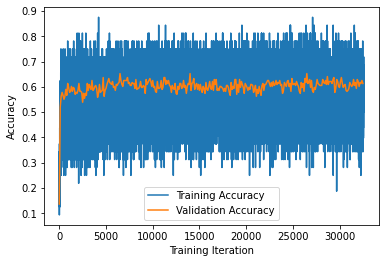

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 7/194419 [00:00<54:59, 58.93it/s]

  0%|          | 16/194419 [00:00<43:42, 74.12it/s]

  0%|          | 26/194419 [00:00<38:20, 84.51it/s]

  0%|          | 35/194419 [00:00<40:33, 79.89it/s]

  0%|          | 44/194419 [00:00<41:07, 78.76it/s]

  0%|          | 52/194419 [00:00<43:41, 74.15it/s]

  0%|          | 60/194419 [00:00<45:36, 71.03it/s]

  0%|          | 68/194419 [00:00<44:13, 73.25it/s]

  0%|          | 76/194419 [00:01<44:02, 73.54it/s]

  0%|          | 86/194419 [00:01<40:25, 80.12it/s]

  0%|          | 95/194419 [00:01<40:41, 79.60it/s]

  0%|          | 104/194419 [00:01<42:46, 75.71it/s]

  0%|          | 112/194419 [00:01<45:24, 71.31it/s]

  0%|          | 120/194419 [00:01<44:40, 72.48it/s]

  0%|          | 128/194419 [00:01<45:52, 70.58it/s]

  0%|          | 138/194419 [00:01<41:45, 77.54it/s]

  0%|          | 146/194419 [00:01<41:59, 77.12it/s]

  0%|          | 156/194419 [00:02<39:12, 82.56it/s]

  0%|          | 165/194419 [00:02<42:03, 76.97it/s]

  0%|          | 174/194419 [00:02<41:33, 77.91it/s]

  0%|          | 182/194419 [00:02<43:40, 74.12it/s]

  0%|          | 191/194419 [00:02<42:32, 76.09it/s]

  0%|          | 201/194419 [00:02<39:20, 82.28it/s]

  0%|          | 211/194419 [00:02<37:12, 86.99it/s]

  0%|          | 220/194419 [00:02<39:01, 82.93it/s]

  0%|          | 229/194419 [00:02<39:36, 81.71it/s]

  0%|          | 238/194419 [00:03<39:41, 81.54it/s]

  0%|          | 248/194419 [00:03<37:42, 85.81it/s]

  0%|          | 257/194419 [00:03<38:11, 84.71it/s]

  0%|          | 268/194419 [00:03<35:42, 90.60it/s]

  0%|          | 278/194419 [00:03<36:34, 88.48it/s]

  0%|          | 287/194419 [00:03<40:17, 80.30it/s]

  0%|          | 296/194419 [00:03<44:23, 72.89it/s]

  0%|          | 305/194419 [00:03<42:05, 76.86it/s]

  0%|          | 317/194419 [00:03<36:45, 88.00it/s]

  0%|          | 327/194419 [00:04<37:42, 85.80it/s]

  0%|          | 337/194419 [00:04<36:39, 88.23it/s]

  0%|          | 347/194419 [00:04<39:03, 82.80it/s]

  0%|          | 356/194419 [00:04<41:11, 78.52it/s]

  0%|          | 366/194419 [00:04<38:43, 83.52it/s]

  0%|          | 375/194419 [00:04<37:56, 85.25it/s]

  0%|          | 384/194419 [00:04<37:57, 85.19it/s]

  0%|          | 394/194419 [00:04<37:40, 85.82it/s]

  0%|          | 405/194419 [00:05<36:28, 88.65it/s]

  0%|          | 414/194419 [00:05<38:15, 84.52it/s]

  0%|          | 423/194419 [00:05<38:20, 84.34it/s]

  0%|          | 432/194419 [00:05<41:38, 77.65it/s]

  0%|          | 441/194419 [00:05<40:30, 79.80it/s]

  0%|          | 450/194419 [00:05<42:49, 75.49it/s]

  0%|          | 459/194419 [00:05<41:18, 78.27it/s]

  0%|          | 467/194419 [00:05<41:22, 78.14it/s]

  0%|          | 476/194419 [00:05<40:37, 79.57it/s]

  0%|          | 485/194419 [00:06<42:50, 75.46it/s]

  0%|          | 493/194419 [00:06<42:32, 75.99it/s]

  0%|          | 501/194419 [00:06<43:40, 73.99it/s]

  0%|          | 510/194419 [00:06<41:40, 77.54it/s]

  0%|          | 520/194419 [00:06<39:13, 82.39it/s]

  0%|          | 529/194419 [00:06<40:08, 80.50it/s]

  0%|          | 538/194419 [00:06<41:02, 78.73it/s]

  0%|          | 547/194419 [00:06<40:24, 79.96it/s]

  0%|          | 557/194419 [00:06<39:55, 80.93it/s]

  0%|          | 566/194419 [00:07<40:11, 80.40it/s]

  0%|          | 575/194419 [00:07<42:18, 76.36it/s]

  0%|          | 583/194419 [00:07<44:37, 72.38it/s]

  0%|          | 591/194419 [00:07<44:18, 72.92it/s]

  0%|          | 599/194419 [00:07<44:51, 72.02it/s]

  0%|          | 610/194419 [00:07<39:43, 81.32it/s]

  0%|          | 619/194419 [00:07<42:18, 76.34it/s]

  0%|          | 627/194419 [00:07<42:11, 76.55it/s]

  0%|          | 635/194419 [00:08<41:57, 76.97it/s]

  0%|          | 643/194419 [00:08<41:31, 77.77it/s]

  0%|          | 652/194419 [00:08<40:39, 79.44it/s]

  0%|          | 661/194419 [00:08<39:17, 82.19it/s]

  0%|          | 671/194419 [00:08<38:33, 83.74it/s]

  0%|          | 680/194419 [00:08<39:22, 82.02it/s]

  0%|          | 689/194419 [00:08<39:17, 82.16it/s]

  0%|          | 698/194419 [00:08<41:08, 78.47it/s]

  0%|          | 707/194419 [00:08<40:00, 80.68it/s]

  0%|          | 717/194419 [00:09<37:59, 84.98it/s]

  0%|          | 728/194419 [00:09<35:58, 89.73it/s]

  0%|          | 738/194419 [00:09<38:05, 84.73it/s]

  0%|          | 747/194419 [00:09<40:55, 78.87it/s]

  0%|          | 756/194419 [00:09<41:24, 77.94it/s]

  0%|          | 764/194419 [00:09<41:30, 77.75it/s]

  0%|          | 774/194419 [00:09<39:42, 81.28it/s]

  0%|          | 783/194419 [00:09<40:24, 79.86it/s]

  0%|          | 792/194419 [00:09<39:34, 81.53it/s]

  0%|          | 801/194419 [00:10<43:04, 74.91it/s]

  0%|          | 809/194419 [00:10<42:25, 76.06it/s]

  0%|          | 817/194419 [00:10<43:16, 74.57it/s]

  0%|          | 826/194419 [00:10<41:15, 78.19it/s]

  0%|          | 834/194419 [00:10<42:12, 76.44it/s]

  0%|          | 843/194419 [00:10<41:05, 78.50it/s]

  0%|          | 851/194419 [00:10<41:58, 76.86it/s]

  0%|          | 859/194419 [00:10<43:13, 74.62it/s]

  0%|          | 869/194419 [00:10<39:45, 81.15it/s]

  0%|          | 878/194419 [00:11<39:58, 80.71it/s]

  0%|          | 887/194419 [00:11<41:20, 78.03it/s]

  0%|          | 897/194419 [00:11<38:37, 83.49it/s]

  0%|          | 907/194419 [00:11<37:49, 85.26it/s]

  0%|          | 916/194419 [00:11<40:44, 79.16it/s]

  0%|          | 925/194419 [00:11<39:54, 80.82it/s]

  0%|          | 935/194419 [00:11<38:57, 82.78it/s]

  0%|          | 944/194419 [00:11<40:40, 79.28it/s]

  0%|          | 952/194419 [00:11<43:15, 74.53it/s]

  0%|          | 960/194419 [00:12<43:55, 73.41it/s]

  0%|          | 969/194419 [00:12<41:56, 76.86it/s]

  1%|          | 978/194419 [00:12<40:13, 80.15it/s]

  1%|          | 987/194419 [00:12<42:19, 76.17it/s]

  1%|          | 996/194419 [00:12<41:31, 77.63it/s]

  1%|          | 1004/194419 [00:12<45:20, 71.09it/s]

  1%|          | 1012/194419 [00:12<44:17, 72.79it/s]

  1%|          | 1020/194419 [00:12<46:26, 69.40it/s]

  1%|          | 1029/194419 [00:13<43:35, 73.94it/s]

  1%|          | 1038/194419 [00:13<42:14, 76.29it/s]

  1%|          | 1046/194419 [00:13<43:03, 74.84it/s]

  1%|          | 1056/194419 [00:13<39:51, 80.86it/s]

  1%|          | 1066/194419 [00:13<37:44, 85.38it/s]

  1%|          | 1075/194419 [00:13<39:19, 81.94it/s]

  1%|          | 1084/194419 [00:13<41:01, 78.56it/s]

  1%|          | 1092/194419 [00:13<43:28, 74.12it/s]

  1%|          | 1101/194419 [00:13<42:44, 75.39it/s]

  1%|          | 1111/194419 [00:14<40:21, 79.83it/s]

  1%|          | 1120/194419 [00:14<39:44, 81.05it/s]

  1%|          | 1129/194419 [00:14<40:12, 80.10it/s]

  1%|          | 1138/194419 [00:14<40:50, 78.86it/s]

  1%|          | 1146/194419 [00:14<44:05, 73.06it/s]

  1%|          | 1154/194419 [00:14<43:06, 74.71it/s]

  1%|          | 1162/194419 [00:14<44:28, 72.42it/s]

  1%|          | 1170/194419 [00:14<45:12, 71.25it/s]

  1%|          | 1178/194419 [00:14<45:45, 70.39it/s]

  1%|          | 1186/194419 [00:15<45:20, 71.02it/s]

  1%|          | 1194/194419 [00:15<44:08, 72.94it/s]

  1%|          | 1205/194419 [00:15<39:45, 80.98it/s]

  1%|          | 1214/194419 [00:15<42:32, 75.70it/s]

  1%|          | 1222/194419 [00:15<42:11, 76.31it/s]

  1%|          | 1230/194419 [00:15<41:46, 77.06it/s]

  1%|          | 1240/194419 [00:15<40:47, 78.91it/s]

  1%|          | 1250/194419 [00:15<38:23, 83.86it/s]

  1%|          | 1259/194419 [00:16<41:37, 77.34it/s]

  1%|          | 1267/194419 [00:16<42:55, 75.01it/s]

  1%|          | 1276/194419 [00:16<41:34, 77.43it/s]

  1%|          | 1285/194419 [00:16<40:28, 79.54it/s]

  1%|          | 1294/194419 [00:16<40:42, 79.07it/s]

  1%|          | 1302/194419 [00:16<40:47, 78.90it/s]

  1%|          | 1313/194419 [00:16<38:33, 83.46it/s]

  1%|          | 1322/194419 [00:16<40:31, 79.40it/s]

  1%|          | 1330/194419 [00:16<42:25, 75.85it/s]

  1%|          | 1338/194419 [00:17<42:32, 75.65it/s]

  1%|          | 1346/194419 [00:17<42:45, 75.27it/s]

  1%|          | 1356/194419 [00:17<40:38, 79.18it/s]

  1%|          | 1365/194419 [00:17<40:38, 79.16it/s]

  1%|          | 1373/194419 [00:17<41:35, 77.36it/s]

  1%|          | 1381/194419 [00:17<43:55, 73.25it/s]

  1%|          | 1390/194419 [00:17<42:39, 75.41it/s]

  1%|          | 1398/194419 [00:17<45:11, 71.19it/s]

  1%|          | 1407/194419 [00:17<42:53, 74.99it/s]

  1%|          | 1415/194419 [00:18<42:57, 74.89it/s]

  1%|          | 1423/194419 [00:18<42:35, 75.51it/s]

  1%|          | 1432/194419 [00:18<41:47, 76.95it/s]

  1%|          | 1440/194419 [00:18<44:42, 71.94it/s]

  1%|          | 1448/194419 [00:18<44:40, 72.00it/s]

  1%|          | 1456/194419 [00:18<45:49, 70.17it/s]

  1%|          | 1465/194419 [00:18<43:09, 74.51it/s]

  1%|          | 1473/194419 [00:18<43:11, 74.45it/s]

  1%|          | 1483/194419 [00:18<40:05, 80.21it/s]

  1%|          | 1493/194419 [00:19<37:56, 84.75it/s]

  1%|          | 1502/194419 [00:19<40:16, 79.82it/s]

  1%|          | 1511/194419 [00:19<39:52, 80.62it/s]

  1%|          | 1520/194419 [00:19<40:16, 79.81it/s]

  1%|          | 1529/194419 [00:19<39:33, 81.27it/s]

  1%|          | 1538/194419 [00:19<39:01, 82.36it/s]

  1%|          | 1547/194419 [00:19<42:09, 76.24it/s]

  1%|          | 1556/194419 [00:19<40:53, 78.61it/s]

  1%|          | 1564/194419 [00:19<41:01, 78.36it/s]

  1%|          | 1572/194419 [00:20<40:52, 78.62it/s]

  1%|          | 1581/194419 [00:20<41:15, 77.91it/s]

  1%|          | 1589/194419 [00:20<44:03, 72.94it/s]

  1%|          | 1598/194419 [00:20<43:33, 73.79it/s]

  1%|          | 1606/194419 [00:20<42:45, 75.16it/s]

  1%|          | 1614/194419 [00:20<44:34, 72.08it/s]

  1%|          | 1622/194419 [00:20<46:25, 69.22it/s]

  1%|          | 1630/194419 [00:20<45:41, 70.32it/s]

  1%|          | 1639/194419 [00:20<43:00, 74.70it/s]

  1%|          | 1647/194419 [00:21<46:32, 69.04it/s]

  1%|          | 1655/194419 [00:21<47:53, 67.09it/s]

  1%|          | 1663/194419 [00:21<47:27, 67.70it/s]

  1%|          | 1671/194419 [00:21<46:28, 69.13it/s]

  1%|          | 1679/194419 [00:21<44:37, 71.99it/s]

  1%|          | 1687/194419 [00:21<45:00, 71.36it/s]

  1%|          | 1695/194419 [00:21<46:49, 68.59it/s]

  1%|          | 1703/194419 [00:21<44:56, 71.46it/s]

  1%|          | 1711/194419 [00:22<43:49, 73.28it/s]

  1%|          | 1719/194419 [00:22<43:31, 73.80it/s]

  1%|          | 1727/194419 [00:22<43:39, 73.55it/s]

  1%|          | 1737/194419 [00:22<40:43, 78.85it/s]

  1%|          | 1745/194419 [00:22<43:08, 74.43it/s]

  1%|          | 1753/194419 [00:22<46:29, 69.06it/s]

  1%|          | 1761/194419 [00:22<47:16, 67.93it/s]

  1%|          | 1772/194419 [00:22<42:04, 76.31it/s]

  1%|          | 1782/194419 [00:22<39:50, 80.60it/s]

  1%|          | 1792/194419 [00:23<38:57, 82.41it/s]

  1%|          | 1803/194419 [00:23<36:51, 87.08it/s]

  1%|          | 1813/194419 [00:23<35:58, 89.23it/s]

  1%|          | 1823/194419 [00:23<35:22, 90.75it/s]

  1%|          | 1835/194419 [00:23<33:08, 96.86it/s]

  1%|          | 1845/194419 [00:23<35:43, 89.83it/s]

  1%|          | 1855/194419 [00:23<37:28, 85.64it/s]

  1%|          | 1864/194419 [00:23<39:43, 80.77it/s]

  1%|          | 1873/194419 [00:23<39:07, 82.04it/s]

  1%|          | 1882/194419 [00:24<40:54, 78.45it/s]

  1%|          | 1890/194419 [00:24<41:24, 77.49it/s]

  1%|          | 1899/194419 [00:24<40:15, 79.69it/s]

  1%|          | 1908/194419 [00:24<43:48, 73.25it/s]

  1%|          | 1917/194419 [00:24<43:36, 73.58it/s]

  1%|          | 1927/194419 [00:24<39:55, 80.37it/s]

  1%|          | 1936/194419 [00:24<40:34, 79.08it/s]

  1%|          | 1945/194419 [00:24<39:33, 81.10it/s]

  1%|          | 1955/194419 [00:25<37:42, 85.07it/s]

  1%|          | 1964/194419 [00:25<40:06, 79.96it/s]

  1%|          | 1973/194419 [00:25<40:33, 79.09it/s]

  1%|          | 1981/194419 [00:25<40:50, 78.53it/s]

  1%|          | 1990/194419 [00:25<40:02, 80.09it/s]

  1%|          | 1999/194419 [00:25<43:16, 74.12it/s]

  1%|          | 2008/194419 [00:25<42:23, 75.65it/s]

  1%|          | 2016/194419 [00:25<44:43, 71.70it/s]

  1%|          | 2024/194419 [00:25<44:30, 72.05it/s]

  1%|          | 2032/194419 [00:26<43:48, 73.19it/s]

  1%|          | 2041/194419 [00:26<41:56, 76.44it/s]

  1%|          | 2049/194419 [00:26<41:53, 76.54it/s]

  1%|          | 2058/194419 [00:26<40:16, 79.61it/s]

  1%|          | 2066/194419 [00:26<43:10, 74.26it/s]

  1%|          | 2074/194419 [00:26<42:30, 75.41it/s]

  1%|          | 2082/194419 [00:26<43:49, 73.15it/s]

  1%|          | 2090/194419 [00:26<44:23, 72.20it/s]

  1%|          | 2098/194419 [00:26<43:41, 73.35it/s]

  1%|          | 2106/194419 [00:27<42:52, 74.76it/s]

  1%|          | 2114/194419 [00:27<43:30, 73.66it/s]

  1%|          | 2122/194419 [00:27<44:04, 72.72it/s]

  1%|          | 2131/194419 [00:27<42:05, 76.15it/s]

  1%|          | 2139/194419 [00:27<42:28, 75.45it/s]

  1%|          | 2147/194419 [00:27<42:18, 75.74it/s]

  1%|          | 2155/194419 [00:27<42:04, 76.16it/s]

  1%|          | 2163/194419 [00:27<43:30, 73.66it/s]

  1%|          | 2172/194419 [00:27<41:33, 77.09it/s]

  1%|          | 2180/194419 [00:28<44:15, 72.41it/s]

  1%|          | 2188/194419 [00:28<45:28, 70.45it/s]

  1%|          | 2196/194419 [00:28<45:43, 70.07it/s]

  1%|          | 2204/194419 [00:28<46:14, 69.28it/s]

  1%|          | 2211/194419 [00:28<46:49, 68.42it/s]

  1%|          | 2220/194419 [00:28<43:45, 73.20it/s]

  1%|          | 2228/194419 [00:28<44:50, 71.42it/s]

  1%|          | 2236/194419 [00:28<44:25, 72.09it/s]

  1%|          | 2244/194419 [00:28<46:04, 69.51it/s]

  1%|          | 2253/194419 [00:29<44:21, 72.21it/s]

  1%|          | 2261/194419 [00:29<43:50, 73.05it/s]

  1%|          | 2269/194419 [00:29<44:42, 71.64it/s]

  1%|          | 2277/194419 [00:29<46:11, 69.34it/s]

  1%|          | 2284/194419 [00:29<46:11, 69.31it/s]

  1%|          | 2291/194419 [00:29<48:37, 65.86it/s]

  1%|          | 2299/194419 [00:29<46:40, 68.60it/s]

  1%|          | 2308/194419 [00:29<43:29, 73.62it/s]

  1%|          | 2317/194419 [00:29<41:03, 77.98it/s]

  1%|          | 2325/194419 [00:30<45:21, 70.59it/s]

  1%|          | 2335/194419 [00:30<41:14, 77.63it/s]

  1%|          | 2345/194419 [00:30<39:28, 81.08it/s]

  1%|          | 2354/194419 [00:30<41:46, 76.63it/s]

  1%|          | 2363/194419 [00:30<40:44, 78.57it/s]

  1%|          | 2371/194419 [00:30<43:37, 73.37it/s]

  1%|          | 2380/194419 [00:30<42:06, 76.02it/s]

  1%|          | 2390/194419 [00:30<39:31, 80.99it/s]

  1%|          | 2399/194419 [00:31<40:20, 79.33it/s]

  1%|          | 2409/194419 [00:31<38:07, 83.93it/s]

  1%|          | 2418/194419 [00:31<38:45, 82.55it/s]

  1%|          | 2427/194419 [00:31<38:10, 83.81it/s]

  1%|▏         | 2436/194419 [00:31<41:25, 77.23it/s]

  1%|▏         | 2444/194419 [00:31<41:57, 76.26it/s]

  1%|▏         | 2453/194419 [00:31<40:58, 78.10it/s]

  1%|▏         | 2462/194419 [00:31<40:30, 78.98it/s]

  1%|▏         | 2470/194419 [00:31<41:02, 77.93it/s]

  1%|▏         | 2478/194419 [00:32<41:45, 76.62it/s]

  1%|▏         | 2486/194419 [00:32<42:20, 75.55it/s]

  1%|▏         | 2495/194419 [00:32<42:27, 75.33it/s]

  1%|▏         | 2503/194419 [00:32<42:05, 76.00it/s]

  1%|▏         | 2512/194419 [00:32<41:09, 77.70it/s]

  1%|▏         | 2520/194419 [00:32<41:22, 77.30it/s]

  1%|▏         | 2528/194419 [00:32<43:23, 73.71it/s]

  1%|▏         | 2536/194419 [00:32<43:00, 74.35it/s]

  1%|▏         | 2544/194419 [00:32<42:34, 75.11it/s]

  1%|▏         | 2553/194419 [00:33<40:45, 78.47it/s]

  1%|▏         | 2561/194419 [00:33<43:13, 73.96it/s]

  1%|▏         | 2570/194419 [00:33<42:30, 75.23it/s]

  1%|▏         | 2578/194419 [00:33<45:55, 69.62it/s]

  1%|▏         | 2586/194419 [00:33<45:28, 70.30it/s]

  1%|▏         | 2595/194419 [00:33<44:22, 72.04it/s]

  1%|▏         | 2603/194419 [00:33<47:09, 67.79it/s]

  1%|▏         | 2612/194419 [00:33<45:49, 69.77it/s]

  1%|▏         | 2620/194419 [00:33<44:36, 71.66it/s]

  1%|▏         | 2628/194419 [00:34<44:57, 71.11it/s]

  1%|▏         | 2636/194419 [00:34<43:29, 73.48it/s]

  1%|▏         | 2645/194419 [00:34<42:06, 75.90it/s]

  1%|▏         | 2656/194419 [00:34<37:49, 84.50it/s]

  1%|▏         | 2666/194419 [00:34<37:14, 85.81it/s]

  1%|▏         | 2675/194419 [00:34<39:03, 81.83it/s]

  1%|▏         | 2684/194419 [00:34<40:13, 79.43it/s]

  1%|▏         | 2692/194419 [00:34<40:27, 78.97it/s]

  1%|▏         | 2701/194419 [00:34<39:06, 81.71it/s]

  1%|▏         | 2710/194419 [00:35<39:12, 81.48it/s]

  1%|▏         | 2719/194419 [00:35<38:42, 82.53it/s]

  1%|▏         | 2728/194419 [00:35<39:39, 80.56it/s]

  1%|▏         | 2737/194419 [00:35<43:46, 72.98it/s]

  1%|▏         | 2745/194419 [00:35<45:09, 70.75it/s]

  1%|▏         | 2753/194419 [00:35<47:17, 67.55it/s]

  1%|▏         | 2762/194419 [00:35<43:46, 72.97it/s]

  1%|▏         | 2771/194419 [00:35<42:26, 75.26it/s]

  1%|▏         | 2779/194419 [00:36<42:04, 75.92it/s]

  1%|▏         | 2788/194419 [00:36<40:28, 78.92it/s]

  1%|▏         | 2796/194419 [00:36<42:49, 74.57it/s]

  1%|▏         | 2804/194419 [00:36<42:23, 75.33it/s]

  1%|▏         | 2813/194419 [00:36<40:44, 78.39it/s]

  1%|▏         | 2821/194419 [00:36<42:46, 74.66it/s]

  1%|▏         | 2830/194419 [00:36<40:46, 78.31it/s]

  1%|▏         | 2838/194419 [00:36<40:46, 78.32it/s]

  1%|▏         | 2846/194419 [00:36<41:40, 76.63it/s]

  1%|▏         | 2854/194419 [00:37<42:44, 74.70it/s]

  1%|▏         | 2863/194419 [00:37<41:41, 76.58it/s]

  1%|▏         | 2871/194419 [00:37<43:42, 73.04it/s]

  1%|▏         | 2880/194419 [00:37<41:47, 76.38it/s]

  1%|▏         | 2888/194419 [00:37<45:52, 69.59it/s]

  1%|▏         | 2896/194419 [00:37<46:14, 69.02it/s]

  1%|▏         | 2904/194419 [00:37<44:25, 71.85it/s]

  1%|▏         | 2914/194419 [00:37<42:30, 75.08it/s]

  2%|▏         | 2922/194419 [00:37<43:04, 74.10it/s]

  2%|▏         | 2930/194419 [00:38<44:43, 71.36it/s]

  2%|▏         | 2938/194419 [00:38<45:29, 70.16it/s]

  2%|▏         | 2946/194419 [00:38<45:58, 69.42it/s]

  2%|▏         | 2953/194419 [00:38<47:45, 66.81it/s]

  2%|▏         | 2960/194419 [00:38<48:25, 65.88it/s]

  2%|▏         | 2967/194419 [00:38<49:07, 64.94it/s]

  2%|▏         | 2974/194419 [00:38<50:20, 63.37it/s]

  2%|▏         | 2982/194419 [00:38<47:53, 66.63it/s]

  2%|▏         | 2989/194419 [00:38<48:16, 66.10it/s]

  2%|▏         | 2997/194419 [00:39<46:25, 68.72it/s]

  2%|▏         | 3007/194419 [00:39<42:42, 74.70it/s]

  2%|▏         | 3015/194419 [00:39<42:28, 75.11it/s]

  2%|▏         | 3023/194419 [00:39<42:45, 74.61it/s]

  2%|▏         | 3031/194419 [00:39<42:22, 75.28it/s]

  2%|▏         | 3039/194419 [00:39<42:33, 74.96it/s]

  2%|▏         | 3047/194419 [00:39<42:02, 75.86it/s]

  2%|▏         | 3055/194419 [00:39<45:06, 70.71it/s]

  2%|▏         | 3064/194419 [00:39<42:06, 75.74it/s]

  2%|▏         | 3072/194419 [00:40<44:03, 72.39it/s]

  2%|▏         | 3082/194419 [00:40<40:48, 78.13it/s]

  2%|▏         | 3092/194419 [00:40<38:36, 82.58it/s]

  2%|▏         | 3101/194419 [00:40<39:09, 81.43it/s]

  2%|▏         | 3110/194419 [00:40<39:31, 80.66it/s]

  2%|▏         | 3119/194419 [00:40<41:53, 76.10it/s]

  2%|▏         | 3127/194419 [00:40<43:16, 73.67it/s]

  2%|▏         | 3135/194419 [00:40<42:51, 74.40it/s]

  2%|▏         | 3143/194419 [00:40<43:12, 73.77it/s]

  2%|▏         | 3151/194419 [00:41<43:27, 73.36it/s]

  2%|▏         | 3162/194419 [00:41<39:03, 81.60it/s]

  2%|▏         | 3171/194419 [00:41<44:59, 70.83it/s]

  2%|▏         | 3179/194419 [00:41<45:04, 70.71it/s]

  2%|▏         | 3187/194419 [00:41<45:22, 70.24it/s]

  2%|▏         | 3195/194419 [00:41<46:42, 68.24it/s]

  2%|▏         | 3203/194419 [00:41<45:47, 69.61it/s]

  2%|▏         | 3211/194419 [00:41<48:10, 66.14it/s]

  2%|▏         | 3219/194419 [00:42<45:55, 69.40it/s]

  2%|▏         | 3227/194419 [00:42<44:09, 72.15it/s]

  2%|▏         | 3238/194419 [00:42<39:02, 81.60it/s]

  2%|▏         | 3247/194419 [00:42<39:43, 80.20it/s]

  2%|▏         | 3256/194419 [00:42<44:10, 72.12it/s]

  2%|▏         | 3265/194419 [00:42<43:03, 74.00it/s]

  2%|▏         | 3273/194419 [00:42<42:18, 75.29it/s]

  2%|▏         | 3281/194419 [00:42<43:18, 73.55it/s]

  2%|▏         | 3289/194419 [00:43<45:47, 69.56it/s]

  2%|▏         | 3298/194419 [00:43<42:32, 74.88it/s]

  2%|▏         | 3306/194419 [00:43<42:18, 75.30it/s]

  2%|▏         | 3317/194419 [00:43<38:37, 82.46it/s]

  2%|▏         | 3328/194419 [00:43<36:57, 86.18it/s]

  2%|▏         | 3337/194419 [00:43<39:01, 81.62it/s]

  2%|▏         | 3347/194419 [00:43<37:28, 84.98it/s]

  2%|▏         | 3356/194419 [00:43<39:12, 81.21it/s]

  2%|▏         | 3365/194419 [00:43<38:41, 82.30it/s]

  2%|▏         | 3374/194419 [00:44<40:59, 77.67it/s]

  2%|▏         | 3383/194419 [00:44<39:57, 79.69it/s]

  2%|▏         | 3392/194419 [00:44<42:38, 74.66it/s]

  2%|▏         | 3400/194419 [00:44<44:38, 71.31it/s]

  2%|▏         | 3410/194419 [00:44<40:49, 77.97it/s]

  2%|▏         | 3418/194419 [00:44<41:35, 76.54it/s]

  2%|▏         | 3426/194419 [00:44<44:19, 71.82it/s]

  2%|▏         | 3434/194419 [00:44<43:17, 73.52it/s]

  2%|▏         | 3442/194419 [00:44<43:49, 72.64it/s]

  2%|▏         | 3450/194419 [00:45<44:07, 72.13it/s]

  2%|▏         | 3458/194419 [00:45<44:04, 72.20it/s]

  2%|▏         | 3468/194419 [00:45<40:15, 79.04it/s]

  2%|▏         | 3476/194419 [00:45<41:13, 77.19it/s]

  2%|▏         | 3485/194419 [00:45<39:50, 79.86it/s]

  2%|▏         | 3494/194419 [00:45<40:01, 79.49it/s]

  2%|▏         | 3502/194419 [00:45<40:21, 78.86it/s]

  2%|▏         | 3513/194419 [00:45<36:54, 86.22it/s]

  2%|▏         | 3522/194419 [00:45<39:23, 80.78it/s]

  2%|▏         | 3532/194419 [00:46<37:37, 84.57it/s]

  2%|▏         | 3541/194419 [00:46<38:11, 83.31it/s]

  2%|▏         | 3550/194419 [00:46<37:42, 84.38it/s]

  2%|▏         | 3561/194419 [00:46<36:08, 88.02it/s]

  2%|▏         | 3570/194419 [00:46<37:44, 84.29it/s]

  2%|▏         | 3581/194419 [00:46<36:20, 87.52it/s]

  2%|▏         | 3591/194419 [00:46<35:08, 90.50it/s]

  2%|▏         | 3601/194419 [00:46<36:21, 87.47it/s]

  2%|▏         | 3610/194419 [00:46<36:34, 86.96it/s]

  2%|▏         | 3619/194419 [00:47<36:57, 86.06it/s]

  2%|▏         | 3628/194419 [00:47<37:36, 84.55it/s]

  2%|▏         | 3637/194419 [00:47<37:11, 85.48it/s]

  2%|▏         | 3646/194419 [00:47<38:38, 82.29it/s]

  2%|▏         | 3656/194419 [00:47<36:55, 86.09it/s]

  2%|▏         | 3665/194419 [00:47<39:25, 80.63it/s]

  2%|▏         | 3674/194419 [00:47<39:44, 80.00it/s]

  2%|▏         | 3683/194419 [00:47<44:00, 72.22it/s]

  2%|▏         | 3691/194419 [00:48<45:39, 69.61it/s]

  2%|▏         | 3699/194419 [00:48<44:28, 71.46it/s]

  2%|▏         | 3709/194419 [00:48<40:28, 78.52it/s]

  2%|▏         | 3719/194419 [00:48<38:28, 82.61it/s]

  2%|▏         | 3728/194419 [00:48<37:44, 84.21it/s]

  2%|▏         | 3737/194419 [00:48<37:07, 85.60it/s]

  2%|▏         | 3746/194419 [00:48<39:17, 80.88it/s]

  2%|▏         | 3756/194419 [00:48<37:22, 85.02it/s]

  2%|▏         | 3765/194419 [00:48<40:12, 79.02it/s]

  2%|▏         | 3774/194419 [00:49<39:13, 80.99it/s]

  2%|▏         | 3783/194419 [00:49<41:30, 76.56it/s]

  2%|▏         | 3793/194419 [00:49<40:31, 78.41it/s]

  2%|▏         | 3804/194419 [00:49<38:30, 82.49it/s]

  2%|▏         | 3814/194419 [00:49<37:03, 85.74it/s]

  2%|▏         | 3823/194419 [00:49<38:33, 82.39it/s]

  2%|▏         | 3832/194419 [00:49<40:15, 78.90it/s]

  2%|▏         | 3840/194419 [00:49<43:13, 73.47it/s]

  2%|▏         | 3848/194419 [00:49<43:48, 72.49it/s]

  2%|▏         | 3857/194419 [00:50<42:33, 74.64it/s]

  2%|▏         | 3866/194419 [00:50<41:44, 76.09it/s]

  2%|▏         | 3874/194419 [00:50<43:06, 73.67it/s]

  2%|▏         | 3882/194419 [00:50<44:55, 70.67it/s]

  2%|▏         | 3890/194419 [00:50<43:28, 73.05it/s]

  2%|▏         | 3898/194419 [00:50<46:03, 68.95it/s]

  2%|▏         | 3907/194419 [00:50<42:45, 74.25it/s]

  2%|▏         | 3915/194419 [00:50<43:19, 73.28it/s]

  2%|▏         | 3923/194419 [00:50<42:24, 74.88it/s]

  2%|▏         | 3931/194419 [00:51<43:24, 73.14it/s]

  2%|▏         | 3941/194419 [00:51<41:05, 77.25it/s]

  2%|▏         | 3950/194419 [00:51<39:36, 80.14it/s]

  2%|▏         | 3959/194419 [00:51<38:31, 82.39it/s]

  2%|▏         | 3968/194419 [00:51<41:55, 75.71it/s]

  2%|▏         | 3976/194419 [00:51<42:35, 74.54it/s]

  2%|▏         | 3986/194419 [00:51<40:35, 78.17it/s]

  2%|▏         | 3994/194419 [00:51<43:22, 73.16it/s]

  2%|▏         | 4002/194419 [00:52<44:16, 71.68it/s]

  2%|▏         | 4012/194419 [00:52<41:08, 77.13it/s]

  2%|▏         | 4022/194419 [00:52<38:31, 82.36it/s]

  2%|▏         | 4031/194419 [00:52<40:29, 78.37it/s]

  2%|▏         | 4039/194419 [00:52<41:05, 77.20it/s]

  2%|▏         | 4047/194419 [00:52<43:49, 72.39it/s]

  2%|▏         | 4055/194419 [00:52<42:51, 74.02it/s]

  2%|▏         | 4064/194419 [00:52<41:42, 76.06it/s]

  2%|▏         | 4073/194419 [00:52<40:13, 78.88it/s]

  2%|▏         | 4082/194419 [00:53<40:57, 77.47it/s]

  2%|▏         | 4091/194419 [00:53<39:33, 80.19it/s]

  2%|▏         | 4100/194419 [00:53<42:27, 74.72it/s]

  2%|▏         | 4108/194419 [00:53<44:28, 71.33it/s]

  2%|▏         | 4116/194419 [00:53<44:59, 70.49it/s]

  2%|▏         | 4124/194419 [00:53<44:17, 71.62it/s]

  2%|▏         | 4132/194419 [00:53<45:06, 70.30it/s]

  2%|▏         | 4140/194419 [00:53<46:04, 68.83it/s]

  2%|▏         | 4148/194419 [00:54<45:38, 69.49it/s]

  2%|▏         | 4155/194419 [00:54<46:09, 68.69it/s]

  2%|▏         | 4162/194419 [00:54<47:39, 66.54it/s]

  2%|▏         | 4171/194419 [00:54<45:21, 69.90it/s]

  2%|▏         | 4180/194419 [00:54<42:45, 74.16it/s]

  2%|▏         | 4189/194419 [00:54<41:06, 77.12it/s]

  2%|▏         | 4199/194419 [00:54<38:51, 81.57it/s]

  2%|▏         | 4208/194419 [00:54<39:38, 79.98it/s]

  2%|▏         | 4217/194419 [00:54<39:35, 80.06it/s]

  2%|▏         | 4226/194419 [00:54<38:42, 81.91it/s]

  2%|▏         | 4235/194419 [00:55<38:07, 83.13it/s]

  2%|▏         | 4244/194419 [00:55<40:39, 77.96it/s]

  2%|▏         | 4252/194419 [00:55<40:54, 77.48it/s]

  2%|▏         | 4264/194419 [00:55<36:14, 87.46it/s]

  2%|▏         | 4273/194419 [00:55<36:15, 87.42it/s]

  2%|▏         | 4282/194419 [00:55<39:45, 79.69it/s]

  2%|▏         | 4291/194419 [00:55<41:16, 76.79it/s]

  2%|▏         | 4301/194419 [00:55<39:52, 79.48it/s]

  2%|▏         | 4310/194419 [00:56<39:31, 80.17it/s]

  2%|▏         | 4319/194419 [00:56<40:04, 79.07it/s]

  2%|▏         | 4328/194419 [00:56<39:38, 79.93it/s]

  2%|▏         | 4337/194419 [00:56<40:43, 77.79it/s]

  2%|▏         | 4345/194419 [00:56<41:32, 76.27it/s]

  2%|▏         | 4353/194419 [00:56<43:34, 72.69it/s]

  2%|▏         | 4361/194419 [00:56<45:14, 70.01it/s]

  2%|▏         | 4369/194419 [00:56<46:31, 68.09it/s]

  2%|▏         | 4377/194419 [00:56<46:27, 68.19it/s]

  2%|▏         | 4387/194419 [00:57<42:33, 74.42it/s]

  2%|▏         | 4395/194419 [00:57<42:14, 74.97it/s]

  2%|▏         | 4403/194419 [00:57<42:49, 73.96it/s]

  2%|▏         | 4411/194419 [00:57<42:05, 75.25it/s]

  2%|▏         | 4419/194419 [00:57<41:34, 76.16it/s]

  2%|▏         | 4431/194419 [00:57<36:54, 85.80it/s]

  2%|▏         | 4440/194419 [00:57<37:29, 84.45it/s]

  2%|▏         | 4449/194419 [00:57<39:31, 80.10it/s]

  2%|▏         | 4459/194419 [00:57<37:59, 83.32it/s]

  2%|▏         | 4468/194419 [00:58<43:06, 73.45it/s]

  2%|▏         | 4476/194419 [00:58<42:51, 73.87it/s]

  2%|▏         | 4484/194419 [00:58<43:47, 72.28it/s]

  2%|▏         | 4493/194419 [00:58<41:34, 76.13it/s]

  2%|▏         | 4502/194419 [00:58<41:17, 76.65it/s]

  2%|▏         | 4511/194419 [00:58<41:23, 76.47it/s]

  2%|▏         | 4519/194419 [00:58<45:31, 69.52it/s]

  2%|▏         | 4528/194419 [00:58<44:32, 71.06it/s]

  2%|▏         | 4536/194419 [00:59<44:28, 71.15it/s]

  2%|▏         | 4547/194419 [00:59<39:41, 79.73it/s]

  2%|▏         | 4556/194419 [00:59<39:58, 79.15it/s]

  2%|▏         | 4564/194419 [00:59<42:21, 74.71it/s]

  2%|▏         | 4572/194419 [00:59<42:11, 74.99it/s]

  2%|▏         | 4580/194419 [00:59<42:06, 75.14it/s]

  2%|▏         | 4589/194419 [00:59<41:18, 76.58it/s]

  2%|▏         | 4598/194419 [00:59<39:51, 79.36it/s]

  2%|▏         | 4606/194419 [00:59<42:00, 75.31it/s]

  2%|▏         | 4614/194419 [01:00<41:28, 76.26it/s]

  2%|▏         | 4623/194419 [01:00<41:33, 76.11it/s]

  2%|▏         | 4631/194419 [01:00<41:54, 75.47it/s]

  2%|▏         | 4640/194419 [01:00<40:17, 78.49it/s]

  2%|▏         | 4648/194419 [01:00<42:27, 74.48it/s]

  2%|▏         | 4657/194419 [01:00<41:25, 76.36it/s]

  2%|▏         | 4666/194419 [01:00<40:07, 78.81it/s]

  2%|▏         | 4676/194419 [01:00<38:25, 82.29it/s]

  2%|▏         | 4685/194419 [01:00<41:58, 75.33it/s]

  2%|▏         | 4693/194419 [01:01<42:50, 73.80it/s]

  2%|▏         | 4702/194419 [01:01<40:48, 77.49it/s]

  2%|▏         | 4710/194419 [01:01<40:26, 78.17it/s]

  2%|▏         | 4718/194419 [01:01<42:04, 75.13it/s]

  2%|▏         | 4726/194419 [01:01<43:04, 73.40it/s]

  2%|▏         | 4734/194419 [01:01<42:57, 73.59it/s]

  2%|▏         | 4742/194419 [01:01<45:23, 69.65it/s]

  2%|▏         | 4751/194419 [01:01<42:25, 74.50it/s]

  2%|▏         | 4760/194419 [01:01<40:49, 77.43it/s]

  2%|▏         | 4768/194419 [01:02<43:32, 72.59it/s]

  2%|▏         | 4776/194419 [01:02<42:24, 74.52it/s]

  2%|▏         | 4784/194419 [01:02<43:45, 72.22it/s]

  2%|▏         | 4793/194419 [01:02<41:51, 75.51it/s]

  2%|▏         | 4801/194419 [01:02<43:26, 72.75it/s]

  2%|▏         | 4809/194419 [01:02<43:46, 72.18it/s]

  2%|▏         | 4817/194419 [01:02<43:14, 73.08it/s]

  2%|▏         | 4827/194419 [01:02<40:19, 78.36it/s]

  2%|▏         | 4836/194419 [01:03<39:41, 79.61it/s]

  2%|▏         | 4845/194419 [01:03<39:43, 79.53it/s]

  2%|▏         | 4854/194419 [01:03<38:43, 81.57it/s]

  3%|▎         | 4863/194419 [01:03<38:46, 81.49it/s]

  3%|▎         | 4874/194419 [01:03<36:11, 87.28it/s]

  3%|▎         | 4883/194419 [01:03<36:51, 85.69it/s]

  3%|▎         | 4893/194419 [01:03<35:16, 89.54it/s]

  3%|▎         | 4902/194419 [01:03<36:00, 87.73it/s]

  3%|▎         | 4911/194419 [01:03<42:29, 74.32it/s]

  3%|▎         | 4919/194419 [01:04<42:23, 74.50it/s]

  3%|▎         | 4931/194419 [01:04<37:04, 85.20it/s]

  3%|▎         | 4940/194419 [01:04<39:30, 79.93it/s]

  3%|▎         | 4949/194419 [01:04<41:39, 75.81it/s]

  3%|▎         | 4959/194419 [01:04<39:55, 79.07it/s]

  3%|▎         | 4968/194419 [01:04<40:07, 78.69it/s]

  3%|▎         | 4977/194419 [01:04<38:39, 81.66it/s]

  3%|▎         | 4986/194419 [01:04<40:02, 78.85it/s]

  3%|▎         | 4994/194419 [01:04<40:34, 77.81it/s]

  3%|▎         | 5003/194419 [01:05<39:23, 80.14it/s]

  3%|▎         | 5012/194419 [01:05<39:57, 79.00it/s]

  3%|▎         | 5021/194419 [01:05<38:38, 81.69it/s]

  3%|▎         | 5030/194419 [01:05<41:53, 75.36it/s]

  3%|▎         | 5040/194419 [01:05<40:07, 78.66it/s]

  3%|▎         | 5048/194419 [01:05<41:23, 76.24it/s]

  3%|▎         | 5056/194419 [01:05<43:03, 73.29it/s]

  3%|▎         | 5064/194419 [01:05<45:25, 69.49it/s]

  3%|▎         | 5072/194419 [01:06<43:53, 71.91it/s]

  3%|▎         | 5080/194419 [01:06<44:02, 71.65it/s]

  3%|▎         | 5089/194419 [01:06<41:54, 75.31it/s]

  3%|▎         | 5097/194419 [01:06<41:49, 75.45it/s]

  3%|▎         | 5107/194419 [01:06<38:48, 81.31it/s]

  3%|▎         | 5117/194419 [01:06<37:01, 85.20it/s]

  3%|▎         | 5127/194419 [01:06<37:11, 84.83it/s]

  3%|▎         | 5136/194419 [01:06<39:54, 79.06it/s]

  3%|▎         | 5144/194419 [01:06<41:15, 76.44it/s]

  3%|▎         | 5154/194419 [01:07<38:52, 81.13it/s]

  3%|▎         | 5165/194419 [01:07<35:34, 88.67it/s]

  3%|▎         | 5174/194419 [01:07<38:20, 82.28it/s]

  3%|▎         | 5183/194419 [01:07<40:05, 78.66it/s]

  3%|▎         | 5191/194419 [01:07<40:41, 77.49it/s]

  3%|▎         | 5201/194419 [01:07<38:43, 81.42it/s]

  3%|▎         | 5210/194419 [01:07<39:42, 79.41it/s]

  3%|▎         | 5218/194419 [01:07<40:53, 77.11it/s]

  3%|▎         | 5227/194419 [01:07<39:16, 80.27it/s]

  3%|▎         | 5237/194419 [01:08<36:59, 85.23it/s]

  3%|▎         | 5246/194419 [01:08<37:39, 83.73it/s]

  3%|▎         | 5255/194419 [01:08<44:33, 70.76it/s]

  3%|▎         | 5263/194419 [01:08<43:51, 71.87it/s]

  3%|▎         | 5274/194419 [01:08<38:34, 81.74it/s]

  3%|▎         | 5283/194419 [01:08<40:22, 78.07it/s]

  3%|▎         | 5292/194419 [01:08<41:13, 76.45it/s]

  3%|▎         | 5300/194419 [01:08<45:43, 68.92it/s]

  3%|▎         | 5308/194419 [01:09<44:34, 70.70it/s]

  3%|▎         | 5318/194419 [01:09<41:21, 76.22it/s]

  3%|▎         | 5328/194419 [01:09<38:29, 81.87it/s]

  3%|▎         | 5337/194419 [01:09<39:16, 80.25it/s]

  3%|▎         | 5347/194419 [01:09<38:46, 81.26it/s]

  3%|▎         | 5356/194419 [01:09<38:01, 82.86it/s]

  3%|▎         | 5365/194419 [01:09<38:25, 81.99it/s]

  3%|▎         | 5374/194419 [01:09<40:50, 77.14it/s]

  3%|▎         | 5383/194419 [01:09<40:28, 77.83it/s]

  3%|▎         | 5391/194419 [01:10<41:55, 75.14it/s]

  3%|▎         | 5400/194419 [01:10<41:37, 75.70it/s]

  3%|▎         | 5408/194419 [01:10<41:58, 75.05it/s]

  3%|▎         | 5416/194419 [01:10<43:11, 72.94it/s]

  3%|▎         | 5424/194419 [01:10<44:20, 71.04it/s]

  3%|▎         | 5433/194419 [01:10<41:30, 75.88it/s]

  3%|▎         | 5441/194419 [01:10<44:16, 71.14it/s]

  3%|▎         | 5450/194419 [01:10<42:25, 74.25it/s]

  3%|▎         | 5460/194419 [01:10<39:43, 79.28it/s]

  3%|▎         | 5469/194419 [01:11<38:50, 81.06it/s]

  3%|▎         | 5478/194419 [01:11<39:04, 80.58it/s]

  3%|▎         | 5487/194419 [01:11<39:09, 80.42it/s]

  3%|▎         | 5496/194419 [01:11<38:54, 80.91it/s]

  3%|▎         | 5505/194419 [01:11<40:05, 78.54it/s]

  3%|▎         | 5513/194419 [01:11<40:00, 78.68it/s]

  3%|▎         | 5521/194419 [01:11<40:35, 77.55it/s]

  3%|▎         | 5529/194419 [01:11<40:50, 77.08it/s]

  3%|▎         | 5538/194419 [01:11<39:30, 79.66it/s]

  3%|▎         | 5548/194419 [01:12<36:59, 85.08it/s]

  3%|▎         | 5557/194419 [01:12<39:57, 78.77it/s]

  3%|▎         | 5567/194419 [01:12<37:39, 83.57it/s]

  3%|▎         | 5576/194419 [01:12<40:31, 77.68it/s]

  3%|▎         | 5585/194419 [01:12<39:16, 80.13it/s]

  3%|▎         | 5594/194419 [01:12<41:25, 75.96it/s]

  3%|▎         | 5602/194419 [01:12<44:29, 70.72it/s]

  3%|▎         | 5610/194419 [01:12<46:19, 67.94it/s]

  3%|▎         | 5617/194419 [01:13<46:08, 68.20it/s]

  3%|▎         | 5624/194419 [01:13<46:33, 67.58it/s]

  3%|▎         | 5631/194419 [01:13<46:27, 67.74it/s]

  3%|▎         | 5640/194419 [01:13<42:38, 73.78it/s]

  3%|▎         | 5648/194419 [01:13<44:37, 70.50it/s]

  3%|▎         | 5656/194419 [01:13<44:54, 70.05it/s]

  3%|▎         | 5665/194419 [01:13<42:55, 73.30it/s]

  3%|▎         | 5675/194419 [01:13<39:36, 79.40it/s]

  3%|▎         | 5684/194419 [01:13<40:07, 78.40it/s]

  3%|▎         | 5692/194419 [01:14<41:07, 76.48it/s]

  3%|▎         | 5700/194419 [01:14<43:56, 71.57it/s]

  3%|▎         | 5708/194419 [01:14<45:51, 68.57it/s]

  3%|▎         | 5718/194419 [01:14<42:10, 74.56it/s]

  3%|▎         | 5727/194419 [01:14<41:02, 76.63it/s]

  3%|▎         | 5735/194419 [01:14<41:50, 75.15it/s]

  3%|▎         | 5743/194419 [01:14<42:29, 73.99it/s]

  3%|▎         | 5752/194419 [01:14<40:22, 77.89it/s]

  3%|▎         | 5760/194419 [01:14<41:02, 76.62it/s]

  3%|▎         | 5769/194419 [01:15<40:15, 78.12it/s]

  3%|▎         | 5778/194419 [01:15<40:37, 77.41it/s]

  3%|▎         | 5788/194419 [01:15<38:14, 82.20it/s]

  3%|▎         | 5797/194419 [01:15<39:20, 79.92it/s]

  3%|▎         | 5806/194419 [01:15<43:33, 72.17it/s]

  3%|▎         | 5815/194419 [01:15<41:07, 76.43it/s]

  3%|▎         | 5823/194419 [01:15<41:11, 76.32it/s]

  3%|▎         | 5832/194419 [01:15<39:28, 79.61it/s]

  3%|▎         | 5841/194419 [01:15<39:53, 78.78it/s]

  3%|▎         | 5849/194419 [01:16<42:29, 73.96it/s]

  3%|▎         | 5859/194419 [01:16<39:16, 80.02it/s]

  3%|▎         | 5868/194419 [01:16<39:01, 80.52it/s]

  3%|▎         | 5877/194419 [01:16<40:26, 77.69it/s]

  3%|▎         | 5885/194419 [01:16<41:23, 75.91it/s]

  3%|▎         | 5893/194419 [01:16<41:59, 74.82it/s]

  3%|▎         | 5901/194419 [01:16<41:13, 76.22it/s]

  3%|▎         | 5909/194419 [01:16<42:21, 74.17it/s]

  3%|▎         | 5918/194419 [01:16<41:53, 75.01it/s]

  3%|▎         | 5927/194419 [01:17<41:45, 75.23it/s]

  3%|▎         | 5936/194419 [01:17<41:10, 76.28it/s]

  3%|▎         | 5945/194419 [01:17<39:55, 78.68it/s]

  3%|▎         | 5953/194419 [01:17<41:37, 75.47it/s]

  3%|▎         | 5961/194419 [01:17<42:50, 73.32it/s]

  3%|▎         | 5970/194419 [01:17<41:45, 75.22it/s]

  3%|▎         | 5978/194419 [01:17<43:01, 72.99it/s]

  3%|▎         | 5986/194419 [01:17<44:46, 70.14it/s]

  3%|▎         | 5994/194419 [01:18<44:01, 71.34it/s]

  3%|▎         | 6002/194419 [01:18<44:48, 70.09it/s]

  3%|▎         | 6011/194419 [01:18<42:56, 73.12it/s]

  3%|▎         | 6020/194419 [01:18<40:33, 77.42it/s]

  3%|▎         | 6029/194419 [01:18<39:42, 79.07it/s]

  3%|▎         | 6037/194419 [01:18<39:43, 79.03it/s]

  3%|▎         | 6047/194419 [01:18<38:00, 82.58it/s]

  3%|▎         | 6056/194419 [01:18<38:58, 80.54it/s]

  3%|▎         | 6066/194419 [01:18<37:27, 83.81it/s]

  3%|▎         | 6075/194419 [01:19<37:54, 82.81it/s]

  3%|▎         | 6084/194419 [01:19<39:47, 78.88it/s]

  3%|▎         | 6092/194419 [01:19<39:52, 78.71it/s]

  3%|▎         | 6100/194419 [01:19<40:29, 77.53it/s]

  3%|▎         | 6109/194419 [01:19<40:49, 76.89it/s]

  3%|▎         | 6120/194419 [01:19<36:34, 85.82it/s]

  3%|▎         | 6129/194419 [01:19<37:10, 84.42it/s]

  3%|▎         | 6138/194419 [01:19<40:03, 78.35it/s]

  3%|▎         | 6147/194419 [01:19<39:42, 79.03it/s]

  3%|▎         | 6156/194419 [01:20<39:17, 79.86it/s]

  3%|▎         | 6165/194419 [01:20<39:42, 79.01it/s]

  3%|▎         | 6174/194419 [01:20<38:27, 81.57it/s]

  3%|▎         | 6183/194419 [01:20<38:56, 80.56it/s]

  3%|▎         | 6192/194419 [01:20<42:07, 74.46it/s]

  3%|▎         | 6200/194419 [01:20<43:10, 72.66it/s]

  3%|▎         | 6210/194419 [01:20<40:44, 76.99it/s]

  3%|▎         | 6218/194419 [01:20<42:10, 74.39it/s]

  3%|▎         | 6228/194419 [01:20<39:01, 80.36it/s]

  3%|▎         | 6237/194419 [01:21<38:11, 82.12it/s]

  3%|▎         | 6246/194419 [01:21<39:17, 79.81it/s]

  3%|▎         | 6255/194419 [01:21<40:13, 77.97it/s]

  3%|▎         | 6263/194419 [01:21<42:18, 74.12it/s]

  3%|▎         | 6271/194419 [01:21<43:07, 72.73it/s]

  3%|▎         | 6279/194419 [01:21<42:48, 73.25it/s]

  3%|▎         | 6287/194419 [01:21<42:03, 74.55it/s]

  3%|▎         | 6298/194419 [01:21<37:46, 83.00it/s]

  3%|▎         | 6307/194419 [01:21<37:22, 83.88it/s]

  3%|▎         | 6316/194419 [01:22<37:51, 82.82it/s]

  3%|▎         | 6325/194419 [01:22<37:36, 83.37it/s]

  3%|▎         | 6334/194419 [01:22<39:39, 79.05it/s]

  3%|▎         | 6342/194419 [01:22<41:45, 75.06it/s]

  3%|▎         | 6350/194419 [01:22<41:04, 76.30it/s]

  3%|▎         | 6359/194419 [01:22<40:21, 77.65it/s]

  3%|▎         | 6367/194419 [01:22<42:29, 73.75it/s]

  3%|▎         | 6375/194419 [01:22<44:29, 70.44it/s]

  3%|▎         | 6384/194419 [01:23<42:24, 73.91it/s]

  3%|▎         | 6392/194419 [01:23<42:00, 74.58it/s]

  3%|▎         | 6401/194419 [01:23<40:07, 78.09it/s]

  3%|▎         | 6409/194419 [01:23<41:10, 76.11it/s]

  3%|▎         | 6419/194419 [01:23<38:23, 81.60it/s]

  3%|▎         | 6428/194419 [01:23<37:51, 82.77it/s]

  3%|▎         | 6437/194419 [01:23<42:24, 73.89it/s]

  3%|▎         | 6446/194419 [01:23<40:31, 77.31it/s]

  3%|▎         | 6454/194419 [01:23<40:20, 77.67it/s]

  3%|▎         | 6463/194419 [01:24<39:52, 78.57it/s]

  3%|▎         | 6472/194419 [01:24<39:11, 79.92it/s]

  3%|▎         | 6481/194419 [01:24<38:28, 81.41it/s]

  3%|▎         | 6490/194419 [01:24<39:19, 79.65it/s]

  3%|▎         | 6500/194419 [01:24<38:53, 80.53it/s]

  3%|▎         | 6509/194419 [01:24<40:51, 76.64it/s]

  3%|▎         | 6518/194419 [01:24<40:54, 76.54it/s]

  3%|▎         | 6529/194419 [01:24<36:52, 84.91it/s]

  3%|▎         | 6538/194419 [01:24<39:38, 78.98it/s]

  3%|▎         | 6547/194419 [01:25<39:43, 78.83it/s]

  3%|▎         | 6557/194419 [01:25<38:38, 81.03it/s]

  3%|▎         | 6567/194419 [01:25<36:24, 86.01it/s]

  3%|▎         | 6577/194419 [01:25<35:40, 87.75it/s]

  3%|▎         | 6586/194419 [01:25<37:46, 82.87it/s]

  3%|▎         | 6597/194419 [01:25<36:21, 86.09it/s]

  3%|▎         | 6606/194419 [01:25<38:03, 82.24it/s]

  3%|▎         | 6615/194419 [01:25<40:56, 76.47it/s]

  3%|▎         | 6624/194419 [01:25<39:27, 79.31it/s]

  3%|▎         | 6633/194419 [01:26<39:21, 79.52it/s]

  3%|▎         | 6642/194419 [01:26<39:46, 78.69it/s]

  3%|▎         | 6650/194419 [01:26<40:27, 77.36it/s]

  3%|▎         | 6658/194419 [01:26<42:37, 73.43it/s]

  3%|▎         | 6666/194419 [01:26<44:04, 71.01it/s]

  3%|▎         | 6674/194419 [01:26<43:58, 71.16it/s]

  3%|▎         | 6682/194419 [01:26<43:31, 71.88it/s]

  3%|▎         | 6690/194419 [01:26<42:49, 73.06it/s]

  3%|▎         | 6698/194419 [01:27<43:02, 72.70it/s]

  3%|▎         | 6706/194419 [01:27<44:51, 69.74it/s]

  3%|▎         | 6716/194419 [01:27<40:22, 77.47it/s]

  3%|▎         | 6726/194419 [01:27<37:52, 82.59it/s]

  3%|▎         | 6735/194419 [01:27<40:05, 78.01it/s]

  3%|▎         | 6743/194419 [01:27<41:57, 74.55it/s]

  3%|▎         | 6751/194419 [01:27<45:58, 68.04it/s]

  3%|▎         | 6758/194419 [01:27<46:37, 67.08it/s]

  3%|▎         | 6766/194419 [01:27<44:39, 70.04it/s]

  3%|▎         | 6774/194419 [01:28<43:36, 71.72it/s]

  3%|▎         | 6782/194419 [01:28<44:47, 69.83it/s]

  3%|▎         | 6790/194419 [01:28<44:51, 69.71it/s]

  3%|▎         | 6798/194419 [01:28<43:59, 71.09it/s]

  4%|▎         | 6807/194419 [01:28<41:49, 74.76it/s]

  4%|▎         | 6815/194419 [01:28<42:10, 74.12it/s]

  4%|▎         | 6824/194419 [01:28<40:21, 77.46it/s]

  4%|▎         | 6832/194419 [01:28<41:34, 75.21it/s]

  4%|▎         | 6841/194419 [01:28<40:09, 77.85it/s]

  4%|▎         | 6850/194419 [01:29<38:29, 81.21it/s]

  4%|▎         | 6859/194419 [01:29<39:13, 79.68it/s]

  4%|▎         | 6868/194419 [01:29<41:16, 75.73it/s]

  4%|▎         | 6877/194419 [01:29<40:14, 77.67it/s]

  4%|▎         | 6885/194419 [01:29<42:15, 73.97it/s]

  4%|▎         | 6893/194419 [01:29<44:05, 70.89it/s]

  4%|▎         | 6901/194419 [01:29<43:59, 71.05it/s]

  4%|▎         | 6909/194419 [01:29<43:38, 71.60it/s]

  4%|▎         | 6917/194419 [01:29<43:13, 72.29it/s]

  4%|▎         | 6925/194419 [01:30<43:24, 71.98it/s]

  4%|▎         | 6933/194419 [01:30<44:26, 70.32it/s]

  4%|▎         | 6941/194419 [01:30<44:15, 70.59it/s]

  4%|▎         | 6949/194419 [01:30<49:34, 63.02it/s]

  4%|▎         | 6959/194419 [01:30<45:19, 68.93it/s]

  4%|▎         | 6967/194419 [01:30<45:46, 68.25it/s]

  4%|▎         | 6974/194419 [01:30<46:38, 66.98it/s]

  4%|▎         | 6981/194419 [01:30<47:33, 65.68it/s]

  4%|▎         | 6990/194419 [01:31<44:01, 70.96it/s]

  4%|▎         | 6998/194419 [01:31<43:14, 72.23it/s]

  4%|▎         | 7006/194419 [01:31<46:14, 67.56it/s]

  4%|▎         | 7013/194419 [01:31<45:53, 68.06it/s]

  4%|▎         | 7023/194419 [01:31<42:16, 73.88it/s]

  4%|▎         | 7031/194419 [01:31<45:46, 68.24it/s]

  4%|▎         | 7039/194419 [01:31<44:06, 70.81it/s]

  4%|▎         | 7047/194419 [01:31<44:37, 69.99it/s]

  4%|▎         | 7055/194419 [01:31<45:10, 69.13it/s]

  4%|▎         | 7062/194419 [01:32<47:19, 65.97it/s]

  4%|▎         | 7069/194419 [01:32<46:50, 66.66it/s]

  4%|▎         | 7077/194419 [01:32<44:53, 69.56it/s]

  4%|▎         | 7084/194419 [01:32<45:29, 68.63it/s]

  4%|▎         | 7091/194419 [01:32<48:14, 64.71it/s]

  4%|▎         | 7098/194419 [01:32<49:26, 63.15it/s]

  4%|▎         | 7105/194419 [01:32<50:06, 62.31it/s]

  4%|▎         | 7113/194419 [01:32<47:11, 66.16it/s]

  4%|▎         | 7121/194419 [01:32<44:49, 69.65it/s]

  4%|▎         | 7131/194419 [01:33<41:52, 74.54it/s]

  4%|▎         | 7139/194419 [01:33<43:01, 72.54it/s]

  4%|▎         | 7147/194419 [01:33<43:14, 72.19it/s]

  4%|▎         | 7155/194419 [01:33<42:35, 73.27it/s]

  4%|▎         | 7163/194419 [01:33<42:32, 73.37it/s]

  4%|▎         | 7174/194419 [01:33<37:47, 82.58it/s]

  4%|▎         | 7183/194419 [01:33<37:33, 83.10it/s]

  4%|▎         | 7192/194419 [01:33<39:51, 78.28it/s]

  4%|▎         | 7201/194419 [01:33<39:24, 79.18it/s]

  4%|▎         | 7209/194419 [01:34<40:46, 76.53it/s]

  4%|▎         | 7217/194419 [01:34<41:04, 75.95it/s]

  4%|▎         | 7227/194419 [01:34<38:58, 80.04it/s]

  4%|▎         | 7236/194419 [01:34<38:37, 80.77it/s]

  4%|▎         | 7245/194419 [01:34<39:40, 78.64it/s]

  4%|▎         | 7253/194419 [01:34<43:07, 72.35it/s]

  4%|▎         | 7262/194419 [01:34<40:52, 76.30it/s]

  4%|▎         | 7271/194419 [01:34<39:31, 78.92it/s]

  4%|▎         | 7279/194419 [01:35<41:26, 75.25it/s]

  4%|▎         | 7289/194419 [01:35<38:41, 80.61it/s]

  4%|▍         | 7298/194419 [01:35<38:25, 81.18it/s]

  4%|▍         | 7307/194419 [01:35<40:07, 77.73it/s]

  4%|▍         | 7318/194419 [01:35<36:21, 85.78it/s]

  4%|▍         | 7327/194419 [01:35<36:45, 84.82it/s]

  4%|▍         | 7336/194419 [01:35<39:34, 78.80it/s]

  4%|▍         | 7345/194419 [01:35<41:40, 74.82it/s]

  4%|▍         | 7354/194419 [01:35<39:51, 78.22it/s]

  4%|▍         | 7363/194419 [01:36<39:22, 79.17it/s]

  4%|▍         | 7372/194419 [01:36<39:03, 79.82it/s]

  4%|▍         | 7381/194419 [01:36<40:44, 76.52it/s]

  4%|▍         | 7391/194419 [01:36<39:19, 79.28it/s]

  4%|▍         | 7400/194419 [01:36<38:18, 81.38it/s]

  4%|▍         | 7410/194419 [01:36<37:04, 84.07it/s]

  4%|▍         | 7419/194419 [01:36<36:44, 84.82it/s]

  4%|▍         | 7428/194419 [01:36<39:43, 78.45it/s]

  4%|▍         | 7437/194419 [01:36<39:47, 78.31it/s]

  4%|▍         | 7445/194419 [01:37<40:27, 77.02it/s]

  4%|▍         | 7453/194419 [01:37<44:10, 70.54it/s]

  4%|▍         | 7462/194419 [01:37<41:18, 75.43it/s]

  4%|▍         | 7470/194419 [01:37<42:42, 72.95it/s]

  4%|▍         | 7478/194419 [01:37<43:40, 71.33it/s]

  4%|▍         | 7486/194419 [01:37<43:12, 72.10it/s]

  4%|▍         | 7494/194419 [01:37<44:12, 70.47it/s]

  4%|▍         | 7502/194419 [01:37<46:04, 67.60it/s]

  4%|▍         | 7510/194419 [01:38<44:10, 70.53it/s]

  4%|▍         | 7518/194419 [01:38<45:31, 68.42it/s]

  4%|▍         | 7527/194419 [01:38<44:14, 70.40it/s]

  4%|▍         | 7536/194419 [01:38<42:26, 73.39it/s]

  4%|▍         | 7544/194419 [01:38<45:02, 69.16it/s]

  4%|▍         | 7553/194419 [01:38<41:57, 74.22it/s]

  4%|▍         | 7562/194419 [01:38<40:57, 76.04it/s]

  4%|▍         | 7570/194419 [01:38<41:48, 74.48it/s]

  4%|▍         | 7579/194419 [01:38<40:27, 76.97it/s]

  4%|▍         | 7589/194419 [01:39<37:56, 82.07it/s]

  4%|▍         | 7598/194419 [01:39<38:43, 80.39it/s]

  4%|▍         | 7607/194419 [01:39<41:51, 74.40it/s]

  4%|▍         | 7617/194419 [01:39<39:17, 79.23it/s]

  4%|▍         | 7626/194419 [01:39<38:28, 80.92it/s]

  4%|▍         | 7635/194419 [01:39<37:52, 82.18it/s]

  4%|▍         | 7646/194419 [01:39<35:11, 88.47it/s]

  4%|▍         | 7655/194419 [01:39<38:45, 80.31it/s]

  4%|▍         | 7664/194419 [01:39<38:06, 81.68it/s]

  4%|▍         | 7673/194419 [01:40<39:16, 79.25it/s]

  4%|▍         | 7682/194419 [01:40<41:43, 74.59it/s]

  4%|▍         | 7690/194419 [01:40<42:43, 72.83it/s]

  4%|▍         | 7698/194419 [01:40<41:41, 74.65it/s]

  4%|▍         | 7707/194419 [01:40<40:26, 76.95it/s]

  4%|▍         | 7715/194419 [01:40<41:42, 74.59it/s]

  4%|▍         | 7723/194419 [01:40<41:43, 74.56it/s]

  4%|▍         | 7731/194419 [01:40<43:52, 70.92it/s]

  4%|▍         | 7741/194419 [01:41<39:51, 78.05it/s]

  4%|▍         | 7749/194419 [01:41<43:43, 71.14it/s]

  4%|▍         | 7757/194419 [01:41<43:50, 70.96it/s]

  4%|▍         | 7765/194419 [01:41<43:07, 72.13it/s]

  4%|▍         | 7773/194419 [01:41<43:00, 72.33it/s]

  4%|▍         | 7781/194419 [01:41<43:51, 70.92it/s]

  4%|▍         | 7789/194419 [01:41<42:23, 73.39it/s]

  4%|▍         | 7797/194419 [01:41<43:17, 71.86it/s]

  4%|▍         | 7805/194419 [01:41<44:39, 69.64it/s]

  4%|▍         | 7813/194419 [01:42<43:15, 71.90it/s]

  4%|▍         | 7821/194419 [01:42<42:48, 72.64it/s]

  4%|▍         | 7830/194419 [01:42<41:11, 75.48it/s]

  4%|▍         | 7838/194419 [01:42<42:09, 73.76it/s]

  4%|▍         | 7846/194419 [01:42<42:37, 72.95it/s]

  4%|▍         | 7854/194419 [01:42<43:17, 71.82it/s]

  4%|▍         | 7862/194419 [01:42<42:41, 72.82it/s]

  4%|▍         | 7871/194419 [01:42<41:05, 75.65it/s]

  4%|▍         | 7879/194419 [01:42<42:36, 72.97it/s]

  4%|▍         | 7887/194419 [01:43<42:10, 73.71it/s]

  4%|▍         | 7897/194419 [01:43<38:53, 79.93it/s]

  4%|▍         | 7906/194419 [01:43<41:47, 74.37it/s]

  4%|▍         | 7914/194419 [01:43<43:04, 72.15it/s]

  4%|▍         | 7922/194419 [01:43<43:09, 72.02it/s]

  4%|▍         | 7930/194419 [01:43<44:18, 70.15it/s]

  4%|▍         | 7938/194419 [01:43<43:07, 72.07it/s]

  4%|▍         | 7946/194419 [01:43<45:06, 68.89it/s]

  4%|▍         | 7954/194419 [01:43<43:24, 71.59it/s]

  4%|▍         | 7963/194419 [01:44<41:38, 74.63it/s]

  4%|▍         | 7974/194419 [01:44<38:55, 79.82it/s]

  4%|▍         | 7982/194419 [01:44<39:47, 78.09it/s]

  4%|▍         | 7990/194419 [01:44<41:30, 74.84it/s]

  4%|▍         | 7999/194419 [01:44<39:51, 77.94it/s]

  4%|▍         | 8008/194419 [01:44<38:16, 81.17it/s]

  4%|▍         | 8017/194419 [01:44<39:05, 79.48it/s]

  4%|▍         | 8025/194419 [01:44<39:47, 78.09it/s]

  4%|▍         | 8033/194419 [01:44<41:29, 74.87it/s]

  4%|▍         | 8041/194419 [01:45<43:20, 71.67it/s]

  4%|▍         | 8049/194419 [01:45<45:20, 68.49it/s]

  4%|▍         | 8057/194419 [01:45<43:53, 70.76it/s]

  4%|▍         | 8065/194419 [01:45<44:29, 69.80it/s]

  4%|▍         | 8073/194419 [01:45<43:54, 70.74it/s]

  4%|▍         | 8081/194419 [01:45<43:16, 71.78it/s]

  4%|▍         | 8090/194419 [01:45<42:41, 72.74it/s]

  4%|▍         | 8098/194419 [01:45<43:50, 70.83it/s]

  4%|▍         | 8106/194419 [01:46<43:59, 70.58it/s]

  4%|▍         | 8114/194419 [01:46<42:51, 72.44it/s]

  4%|▍         | 8124/194419 [01:46<39:19, 78.95it/s]

  4%|▍         | 8133/194419 [01:46<38:18, 81.04it/s]

  4%|▍         | 8142/194419 [01:46<41:53, 74.12it/s]

  4%|▍         | 8153/194419 [01:46<37:28, 82.85it/s]

  4%|▍         | 8162/194419 [01:46<39:23, 78.82it/s]

  4%|▍         | 8172/194419 [01:46<37:05, 83.69it/s]

  4%|▍         | 8181/194419 [01:46<38:45, 80.08it/s]

  4%|▍         | 8190/194419 [01:47<39:10, 79.22it/s]

  4%|▍         | 8199/194419 [01:47<41:11, 75.35it/s]

  4%|▍         | 8207/194419 [01:47<41:31, 74.74it/s]

  4%|▍         | 8216/194419 [01:47<41:19, 75.09it/s]

  4%|▍         | 8224/194419 [01:47<41:34, 74.65it/s]

  4%|▍         | 8232/194419 [01:47<41:46, 74.29it/s]

  4%|▍         | 8241/194419 [01:47<40:12, 77.17it/s]

  4%|▍         | 8249/194419 [01:47<40:28, 76.67it/s]

  4%|▍         | 8257/194419 [01:47<40:20, 76.92it/s]

  4%|▍         | 8266/194419 [01:48<38:30, 80.57it/s]

  4%|▍         | 8276/194419 [01:48<36:32, 84.91it/s]

  4%|▍         | 8285/194419 [01:48<37:14, 83.30it/s]

  4%|▍         | 8294/194419 [01:48<40:19, 76.94it/s]

  4%|▍         | 8304/194419 [01:48<38:45, 80.04it/s]

  4%|▍         | 8314/194419 [01:48<36:23, 85.22it/s]

  4%|▍         | 8323/194419 [01:48<38:43, 80.10it/s]

  4%|▍         | 8332/194419 [01:48<39:48, 77.92it/s]

  4%|▍         | 8341/194419 [01:48<38:59, 79.53it/s]

  4%|▍         | 8350/194419 [01:49<40:08, 77.26it/s]

  4%|▍         | 8358/194419 [01:49<41:31, 74.67it/s]

  4%|▍         | 8366/194419 [01:49<44:00, 70.47it/s]

  4%|▍         | 8374/194419 [01:49<43:51, 70.69it/s]

  4%|▍         | 8384/194419 [01:49<39:42, 78.09it/s]

  4%|▍         | 8393/194419 [01:49<40:12, 77.10it/s]

  4%|▍         | 8401/194419 [01:49<41:11, 75.25it/s]

  4%|▍         | 8409/194419 [01:49<41:45, 74.24it/s]

  4%|▍         | 8417/194419 [01:50<43:03, 72.00it/s]

  4%|▍         | 8427/194419 [01:50<40:22, 76.76it/s]

  4%|▍         | 8435/194419 [01:50<41:17, 75.07it/s]

  4%|▍         | 8443/194419 [01:50<41:58, 73.85it/s]

  4%|▍         | 8452/194419 [01:50<41:46, 74.20it/s]

  4%|▍         | 8460/194419 [01:50<41:26, 74.78it/s]

  4%|▍         | 8468/194419 [01:50<41:46, 74.18it/s]

  4%|▍         | 8476/194419 [01:50<44:14, 70.04it/s]

  4%|▍         | 8484/194419 [01:50<46:43, 66.31it/s]

  4%|▍         | 8491/194419 [01:51<48:25, 63.98it/s]

  4%|▍         | 8498/194419 [01:51<48:15, 64.21it/s]

  4%|▍         | 8506/194419 [01:51<45:48, 67.63it/s]

  4%|▍         | 8514/194419 [01:51<45:07, 68.67it/s]

  4%|▍         | 8522/194419 [01:51<44:50, 69.08it/s]

  4%|▍         | 8529/194419 [01:51<45:29, 68.11it/s]

  4%|▍         | 8538/194419 [01:51<43:09, 71.79it/s]

  4%|▍         | 8547/194419 [01:51<40:49, 75.88it/s]

  4%|▍         | 8555/194419 [01:51<43:03, 71.94it/s]

  4%|▍         | 8564/194419 [01:52<40:54, 75.73it/s]

  4%|▍         | 8572/194419 [01:52<42:33, 72.78it/s]

  4%|▍         | 8581/194419 [01:52<40:09, 77.12it/s]

  4%|▍         | 8589/194419 [01:52<40:28, 76.53it/s]

  4%|▍         | 8597/194419 [01:52<42:26, 72.96it/s]

  4%|▍         | 8607/194419 [01:52<39:04, 79.26it/s]

  4%|▍         | 8616/194419 [01:52<38:38, 80.14it/s]

  4%|▍         | 8625/194419 [01:52<39:07, 79.16it/s]

  4%|▍         | 8635/194419 [01:52<38:27, 80.53it/s]

  4%|▍         | 8644/194419 [01:53<39:27, 78.46it/s]

  4%|▍         | 8654/194419 [01:53<36:58, 83.74it/s]

  4%|▍         | 8663/194419 [01:53<39:31, 78.34it/s]

  4%|▍         | 8673/194419 [01:53<37:44, 82.01it/s]

  4%|▍         | 8683/194419 [01:53<36:36, 84.54it/s]

  4%|▍         | 8692/194419 [01:53<38:17, 80.84it/s]

  4%|▍         | 8701/194419 [01:53<41:40, 74.26it/s]

  4%|▍         | 8710/194419 [01:53<41:24, 74.74it/s]

  4%|▍         | 8718/194419 [01:54<40:54, 75.67it/s]

  4%|▍         | 8728/194419 [01:54<38:17, 80.84it/s]

  4%|▍         | 8738/194419 [01:54<36:23, 85.03it/s]

  4%|▍         | 8747/194419 [01:54<38:22, 80.64it/s]

  5%|▍         | 8756/194419 [01:54<37:16, 83.03it/s]

  5%|▍         | 8765/194419 [01:54<36:55, 83.79it/s]

  5%|▍         | 8774/194419 [01:54<37:58, 81.47it/s]

  5%|▍         | 8783/194419 [01:54<37:38, 82.20it/s]

  5%|▍         | 8792/194419 [01:54<38:13, 80.95it/s]

  5%|▍         | 8801/194419 [01:55<40:04, 77.20it/s]

  5%|▍         | 8810/194419 [01:55<38:43, 79.87it/s]

  5%|▍         | 8821/194419 [01:55<37:03, 83.48it/s]

  5%|▍         | 8830/194419 [01:55<36:19, 85.16it/s]

  5%|▍         | 8839/194419 [01:55<35:56, 86.07it/s]

  5%|▍         | 8848/194419 [01:55<37:33, 82.35it/s]

  5%|▍         | 8857/194419 [01:55<36:57, 83.67it/s]

  5%|▍         | 8866/194419 [01:55<40:59, 75.43it/s]

  5%|▍         | 8875/194419 [01:55<39:08, 78.99it/s]

  5%|▍         | 8884/194419 [01:56<40:37, 76.11it/s]

  5%|▍         | 8895/194419 [01:56<36:49, 83.97it/s]

  5%|▍         | 8904/194419 [01:56<37:41, 82.05it/s]

  5%|▍         | 8913/194419 [01:56<37:52, 81.64it/s]

  5%|▍         | 8922/194419 [01:56<38:59, 79.30it/s]

  5%|▍         | 8930/194419 [01:56<41:27, 74.57it/s]

  5%|▍         | 8938/194419 [01:56<44:51, 68.92it/s]

  5%|▍         | 8946/194419 [01:56<43:33, 70.98it/s]

  5%|▍         | 8954/194419 [01:57<44:13, 69.88it/s]

  5%|▍         | 8963/194419 [01:57<41:13, 74.99it/s]

  5%|▍         | 8971/194419 [01:57<40:29, 76.34it/s]

  5%|▍         | 8981/194419 [01:57<37:54, 81.52it/s]

  5%|▍         | 8990/194419 [01:57<39:15, 78.73it/s]

  5%|▍         | 8998/194419 [01:57<39:07, 78.98it/s]

  5%|▍         | 9006/194419 [01:57<41:00, 75.37it/s]

  5%|▍         | 9014/194419 [01:57<41:31, 74.41it/s]

  5%|▍         | 9024/194419 [01:57<38:12, 80.86it/s]

  5%|▍         | 9033/194419 [01:58<41:18, 74.80it/s]

  5%|▍         | 9041/194419 [01:58<43:02, 71.79it/s]

  5%|▍         | 9051/194419 [01:58<39:52, 77.48it/s]

  5%|▍         | 9059/194419 [01:58<43:04, 71.72it/s]

  5%|▍         | 9068/194419 [01:58<40:50, 75.64it/s]

  5%|▍         | 9077/194419 [01:58<39:57, 77.31it/s]

  5%|▍         | 9085/194419 [01:58<39:54, 77.39it/s]

  5%|▍         | 9093/194419 [01:58<40:18, 76.62it/s]

  5%|▍         | 9101/194419 [01:58<41:25, 74.56it/s]

  5%|▍         | 9110/194419 [01:59<39:24, 78.36it/s]

  5%|▍         | 9118/194419 [01:59<40:50, 75.61it/s]

  5%|▍         | 9128/194419 [01:59<38:03, 81.14it/s]

  5%|▍         | 9137/194419 [01:59<39:20, 78.51it/s]

  5%|▍         | 9146/194419 [01:59<38:11, 80.86it/s]

  5%|▍         | 9155/194419 [01:59<40:58, 75.36it/s]

  5%|▍         | 9165/194419 [01:59<37:47, 81.69it/s]

  5%|▍         | 9174/194419 [01:59<37:27, 82.42it/s]

  5%|▍         | 9184/194419 [01:59<36:15, 85.15it/s]

  5%|▍         | 9193/194419 [02:00<36:25, 84.76it/s]

  5%|▍         | 9202/194419 [02:00<38:01, 81.17it/s]

  5%|▍         | 9211/194419 [02:00<37:47, 81.66it/s]

  5%|▍         | 9220/194419 [02:00<39:42, 77.72it/s]

  5%|▍         | 9228/194419 [02:00<40:38, 75.96it/s]

  5%|▍         | 9237/194419 [02:00<38:56, 79.26it/s]

  5%|▍         | 9245/194419 [02:00<39:53, 77.36it/s]

  5%|▍         | 9254/194419 [02:00<38:53, 79.34it/s]

  5%|▍         | 9262/194419 [02:00<42:51, 72.00it/s]

  5%|▍         | 9270/194419 [02:01<42:57, 71.82it/s]

  5%|▍         | 9278/194419 [02:01<41:58, 73.52it/s]

  5%|▍         | 9286/194419 [02:01<41:52, 73.69it/s]

  5%|▍         | 9294/194419 [02:01<42:32, 72.53it/s]

  5%|▍         | 9302/194419 [02:01<43:55, 70.24it/s]

  5%|▍         | 9310/194419 [02:01<44:05, 69.98it/s]

  5%|▍         | 9318/194419 [02:01<43:24, 71.06it/s]

  5%|▍         | 9326/194419 [02:01<44:49, 68.83it/s]

  5%|▍         | 9333/194419 [02:02<45:14, 68.17it/s]

  5%|▍         | 9342/194419 [02:02<43:01, 71.70it/s]

  5%|▍         | 9352/194419 [02:02<39:25, 78.24it/s]

  5%|▍         | 9360/194419 [02:02<40:37, 75.93it/s]

  5%|▍         | 9369/194419 [02:02<39:32, 77.99it/s]

  5%|▍         | 9377/194419 [02:02<42:06, 73.24it/s]

  5%|▍         | 9385/194419 [02:02<43:13, 71.35it/s]

  5%|▍         | 9394/194419 [02:02<40:30, 76.13it/s]

  5%|▍         | 9402/194419 [02:02<41:16, 74.72it/s]

  5%|▍         | 9410/194419 [02:03<40:38, 75.87it/s]

  5%|▍         | 9418/194419 [02:03<41:00, 75.18it/s]

  5%|▍         | 9427/194419 [02:03<39:08, 78.79it/s]

  5%|▍         | 9437/194419 [02:03<37:49, 81.50it/s]

  5%|▍         | 9447/194419 [02:03<35:58, 85.71it/s]

  5%|▍         | 9456/194419 [02:03<35:54, 85.83it/s]

  5%|▍         | 9465/194419 [02:03<35:54, 85.84it/s]

  5%|▍         | 9474/194419 [02:03<38:10, 80.73it/s]

  5%|▍         | 9483/194419 [02:03<42:08, 73.14it/s]

  5%|▍         | 9492/194419 [02:04<40:56, 75.27it/s]

  5%|▍         | 9500/194419 [02:04<41:48, 73.72it/s]

  5%|▍         | 9509/194419 [02:04<39:36, 77.81it/s]

  5%|▍         | 9518/194419 [02:04<39:27, 78.09it/s]

  5%|▍         | 9526/194419 [02:04<39:28, 78.06it/s]

  5%|▍         | 9535/194419 [02:04<38:28, 80.09it/s]

  5%|▍         | 9545/194419 [02:04<36:57, 83.38it/s]

  5%|▍         | 9554/194419 [02:04<38:18, 80.43it/s]

  5%|▍         | 9563/194419 [02:04<40:24, 76.23it/s]

  5%|▍         | 9571/194419 [02:05<42:22, 72.71it/s]

  5%|▍         | 9579/194419 [02:05<42:07, 73.13it/s]

  5%|▍         | 9588/194419 [02:05<40:39, 75.76it/s]

  5%|▍         | 9596/194419 [02:05<41:40, 73.91it/s]

  5%|▍         | 9606/194419 [02:05<40:11, 76.64it/s]

  5%|▍         | 9614/194419 [02:05<40:58, 75.17it/s]

  5%|▍         | 9623/194419 [02:05<39:29, 77.98it/s]

  5%|▍         | 9631/194419 [02:05<39:25, 78.13it/s]

  5%|▍         | 9639/194419 [02:05<40:03, 76.89it/s]

  5%|▍         | 9647/194419 [02:06<41:57, 73.40it/s]

  5%|▍         | 9657/194419 [02:06<40:11, 76.63it/s]

  5%|▍         | 9666/194419 [02:06<38:50, 79.29it/s]

  5%|▍         | 9675/194419 [02:06<38:17, 80.41it/s]

  5%|▍         | 9684/194419 [02:06<37:23, 82.36it/s]

  5%|▍         | 9693/194419 [02:06<40:16, 76.45it/s]

  5%|▍         | 9701/194419 [02:06<42:15, 72.84it/s]

  5%|▍         | 9712/194419 [02:06<37:28, 82.14it/s]

  5%|▌         | 9722/194419 [02:06<37:16, 82.60it/s]

  5%|▌         | 9731/194419 [02:07<38:42, 79.51it/s]

  5%|▌         | 9740/194419 [02:07<37:34, 81.91it/s]

  5%|▌         | 9749/194419 [02:07<41:05, 74.90it/s]

  5%|▌         | 9757/194419 [02:07<42:45, 71.98it/s]

  5%|▌         | 9767/194419 [02:07<39:02, 78.84it/s]

  5%|▌         | 9777/194419 [02:07<38:27, 80.01it/s]

  5%|▌         | 9786/194419 [02:07<39:52, 77.19it/s]

  5%|▌         | 9794/194419 [02:07<40:38, 75.71it/s]

  5%|▌         | 9804/194419 [02:08<39:13, 78.43it/s]

  5%|▌         | 9813/194419 [02:08<39:36, 77.69it/s]

  5%|▌         | 9821/194419 [02:08<39:59, 76.94it/s]

  5%|▌         | 9829/194419 [02:08<41:53, 73.45it/s]

  5%|▌         | 9837/194419 [02:08<43:30, 70.70it/s]

  5%|▌         | 9845/194419 [02:08<42:09, 72.97it/s]

  5%|▌         | 9854/194419 [02:08<40:30, 75.94it/s]

  5%|▌         | 9862/194419 [02:08<42:46, 71.92it/s]

  5%|▌         | 9871/194419 [02:08<41:01, 74.99it/s]

  5%|▌         | 9880/194419 [02:09<40:49, 75.34it/s]

  5%|▌         | 9889/194419 [02:09<39:44, 77.38it/s]

  5%|▌         | 9897/194419 [02:09<41:38, 73.86it/s]

  5%|▌         | 9905/194419 [02:09<41:09, 74.71it/s]

  5%|▌         | 9913/194419 [02:09<43:49, 70.17it/s]

  5%|▌         | 9922/194419 [02:09<41:30, 74.07it/s]

  5%|▌         | 9930/194419 [02:09<40:37, 75.68it/s]

  5%|▌         | 9938/194419 [02:09<40:08, 76.60it/s]

  5%|▌         | 9946/194419 [02:09<41:31, 74.05it/s]

  5%|▌         | 9955/194419 [02:10<39:52, 77.10it/s]

  5%|▌         | 9965/194419 [02:10<36:52, 83.36it/s]

  5%|▌         | 9975/194419 [02:10<34:59, 87.84it/s]

  5%|▌         | 9984/194419 [02:10<36:08, 85.03it/s]

  5%|▌         | 9993/194419 [02:10<39:35, 77.63it/s]

  5%|▌         | 10002/194419 [02:10<38:21, 80.13it/s]

  5%|▌         | 10011/194419 [02:10<38:11, 80.48it/s]

  5%|▌         | 10021/194419 [02:10<36:06, 85.12it/s]

  5%|▌         | 10030/194419 [02:10<38:53, 79.02it/s]

  5%|▌         | 10039/194419 [02:11<39:20, 78.12it/s]

  5%|▌         | 10047/194419 [02:11<40:58, 74.99it/s]

  5%|▌         | 10055/194419 [02:11<42:39, 72.03it/s]

  5%|▌         | 10064/194419 [02:11<41:01, 74.89it/s]

  5%|▌         | 10075/194419 [02:11<36:45, 83.58it/s]

  5%|▌         | 10084/194419 [02:11<37:03, 82.90it/s]

  5%|▌         | 10093/194419 [02:11<37:11, 82.61it/s]

  5%|▌         | 10102/194419 [02:11<36:45, 83.59it/s]

  5%|▌         | 10111/194419 [02:12<40:18, 76.22it/s]

  5%|▌         | 10119/194419 [02:12<39:48, 77.18it/s]

  5%|▌         | 10127/194419 [02:12<41:17, 74.39it/s]

  5%|▌         | 10135/194419 [02:12<43:51, 70.03it/s]

  5%|▌         | 10143/194419 [02:12<42:27, 72.33it/s]

  5%|▌         | 10151/194419 [02:12<41:45, 73.54it/s]

  5%|▌         | 10159/194419 [02:12<42:52, 71.61it/s]

  5%|▌         | 10167/194419 [02:12<44:10, 69.51it/s]

  5%|▌         | 10175/194419 [02:12<46:54, 65.46it/s]

  5%|▌         | 10182/194419 [02:13<46:09, 66.53it/s]

  5%|▌         | 10189/194419 [02:13<47:28, 64.69it/s]

  5%|▌         | 10196/194419 [02:13<49:09, 62.46it/s]

  5%|▌         | 10205/194419 [02:13<44:01, 69.75it/s]

  5%|▌         | 10213/194419 [02:13<43:31, 70.54it/s]

  5%|▌         | 10221/194419 [02:13<45:03, 68.12it/s]

  5%|▌         | 10229/194419 [02:13<45:01, 68.17it/s]

  5%|▌         | 10237/194419 [02:13<43:12, 71.04it/s]

  5%|▌         | 10246/194419 [02:13<41:52, 73.30it/s]

  5%|▌         | 10254/194419 [02:14<41:46, 73.48it/s]

  5%|▌         | 10262/194419 [02:14<44:18, 69.26it/s]

  5%|▌         | 10270/194419 [02:14<43:19, 70.83it/s]

  5%|▌         | 10278/194419 [02:14<42:20, 72.49it/s]

  5%|▌         | 10286/194419 [02:14<41:48, 73.40it/s]

  5%|▌         | 10294/194419 [02:14<43:32, 70.47it/s]

  5%|▌         | 10303/194419 [02:14<42:24, 72.36it/s]

  5%|▌         | 10311/194419 [02:14<44:43, 68.60it/s]

  5%|▌         | 10320/194419 [02:15<42:26, 72.29it/s]

  5%|▌         | 10329/194419 [02:15<40:11, 76.33it/s]

  5%|▌         | 10338/194419 [02:15<39:13, 78.20it/s]

  5%|▌         | 10346/194419 [02:15<40:25, 75.88it/s]

  5%|▌         | 10355/194419 [02:15<38:31, 79.64it/s]

  5%|▌         | 10364/194419 [02:15<40:40, 75.43it/s]

  5%|▌         | 10372/194419 [02:15<40:35, 75.57it/s]

  5%|▌         | 10380/194419 [02:15<40:52, 75.03it/s]

  5%|▌         | 10388/194419 [02:15<41:40, 73.58it/s]

  5%|▌         | 10396/194419 [02:16<42:01, 72.99it/s]

  5%|▌         | 10405/194419 [02:16<40:28, 75.77it/s]

  5%|▌         | 10413/194419 [02:16<41:07, 74.58it/s]

  5%|▌         | 10421/194419 [02:16<40:33, 75.60it/s]

  5%|▌         | 10430/194419 [02:16<39:25, 77.78it/s]

  5%|▌         | 10441/194419 [02:16<36:45, 83.41it/s]

  5%|▌         | 10450/194419 [02:16<36:37, 83.74it/s]

  5%|▌         | 10459/194419 [02:16<38:16, 80.12it/s]

  5%|▌         | 10468/194419 [02:16<39:39, 77.31it/s]

  5%|▌         | 10477/194419 [02:17<38:06, 80.46it/s]

  5%|▌         | 10486/194419 [02:17<39:51, 76.91it/s]

  5%|▌         | 10495/194419 [02:17<39:07, 78.33it/s]

  5%|▌         | 10504/194419 [02:17<38:20, 79.94it/s]

  5%|▌         | 10514/194419 [02:17<36:47, 83.30it/s]

  5%|▌         | 10523/194419 [02:17<37:01, 82.80it/s]

  5%|▌         | 10532/194419 [02:17<37:16, 82.24it/s]

  5%|▌         | 10541/194419 [02:17<38:38, 79.30it/s]

  5%|▌         | 10549/194419 [02:17<41:03, 74.65it/s]

  5%|▌         | 10557/194419 [02:18<40:25, 75.80it/s]

  5%|▌         | 10566/194419 [02:18<40:32, 75.59it/s]

  5%|▌         | 10574/194419 [02:18<41:54, 73.12it/s]

  5%|▌         | 10583/194419 [02:18<40:50, 75.02it/s]

  5%|▌         | 10591/194419 [02:18<43:04, 71.14it/s]

  5%|▌         | 10599/194419 [02:18<42:53, 71.42it/s]

  5%|▌         | 10607/194419 [02:18<43:55, 69.75it/s]

  5%|▌         | 10615/194419 [02:18<43:15, 70.81it/s]

  5%|▌         | 10623/194419 [02:18<43:28, 70.47it/s]

  5%|▌         | 10632/194419 [02:19<41:57, 73.01it/s]

  5%|▌         | 10640/194419 [02:19<41:51, 73.19it/s]

  5%|▌         | 10648/194419 [02:19<43:41, 70.09it/s]

  5%|▌         | 10657/194419 [02:19<41:52, 73.12it/s]

  5%|▌         | 10665/194419 [02:19<42:06, 72.73it/s]

  5%|▌         | 10673/194419 [02:19<41:47, 73.27it/s]

  5%|▌         | 10682/194419 [02:19<39:56, 76.68it/s]

  5%|▌         | 10691/194419 [02:19<38:49, 78.86it/s]

  6%|▌         | 10699/194419 [02:19<39:18, 77.89it/s]

  6%|▌         | 10707/194419 [02:20<40:09, 76.25it/s]

  6%|▌         | 10716/194419 [02:20<38:37, 79.28it/s]

  6%|▌         | 10724/194419 [02:20<39:53, 76.74it/s]

  6%|▌         | 10732/194419 [02:20<41:17, 74.13it/s]

  6%|▌         | 10740/194419 [02:20<43:02, 71.13it/s]

  6%|▌         | 10748/194419 [02:20<45:12, 67.71it/s]

  6%|▌         | 10755/194419 [02:20<47:50, 63.98it/s]

  6%|▌         | 10762/194419 [02:20<47:40, 64.20it/s]

  6%|▌         | 10773/194419 [02:21<40:15, 76.03it/s]

  6%|▌         | 10781/194419 [02:21<40:33, 75.46it/s]

  6%|▌         | 10789/194419 [02:21<43:43, 70.00it/s]

  6%|▌         | 10798/194419 [02:21<41:05, 74.48it/s]

  6%|▌         | 10806/194419 [02:21<40:51, 74.90it/s]

  6%|▌         | 10815/194419 [02:21<39:11, 78.07it/s]

  6%|▌         | 10823/194419 [02:21<39:44, 77.00it/s]

  6%|▌         | 10831/194419 [02:21<40:24, 75.71it/s]

  6%|▌         | 10839/194419 [02:21<40:35, 75.37it/s]

  6%|▌         | 10848/194419 [02:22<40:20, 75.84it/s]

  6%|▌         | 10857/194419 [02:22<39:11, 78.07it/s]

  6%|▌         | 10865/194419 [02:22<40:37, 75.31it/s]

  6%|▌         | 10873/194419 [02:22<40:16, 75.94it/s]

  6%|▌         | 10882/194419 [02:22<40:09, 76.16it/s]

  6%|▌         | 10890/194419 [02:22<43:01, 71.09it/s]

  6%|▌         | 10898/194419 [02:22<42:46, 71.50it/s]

  6%|▌         | 10906/194419 [02:22<43:06, 70.95it/s]

  6%|▌         | 10915/194419 [02:22<42:19, 72.27it/s]

  6%|▌         | 10923/194419 [02:23<43:45, 69.90it/s]

  6%|▌         | 10931/194419 [02:23<42:35, 71.80it/s]

  6%|▌         | 10939/194419 [02:23<42:14, 72.39it/s]

  6%|▌         | 10947/194419 [02:23<41:29, 73.69it/s]

  6%|▌         | 10955/194419 [02:23<41:35, 73.51it/s]

  6%|▌         | 10963/194419 [02:23<43:27, 70.35it/s]

  6%|▌         | 10972/194419 [02:23<41:02, 74.51it/s]

  6%|▌         | 10982/194419 [02:23<37:40, 81.15it/s]

  6%|▌         | 10991/194419 [02:23<41:23, 73.85it/s]

  6%|▌         | 11000/194419 [02:24<40:05, 76.26it/s]

  6%|▌         | 11008/194419 [02:24<39:46, 76.87it/s]

  6%|▌         | 11016/194419 [02:24<39:38, 77.12it/s]

  6%|▌         | 11024/194419 [02:24<42:06, 72.60it/s]

  6%|▌         | 11033/194419 [02:24<40:06, 76.19it/s]

  6%|▌         | 11041/194419 [02:24<41:26, 73.76it/s]

  6%|▌         | 11049/194419 [02:24<41:40, 73.33it/s]

  6%|▌         | 11057/194419 [02:24<42:02, 72.69it/s]

  6%|▌         | 11065/194419 [02:24<42:05, 72.60it/s]

  6%|▌         | 11073/194419 [02:25<41:20, 73.91it/s]

  6%|▌         | 11083/194419 [02:25<38:24, 79.56it/s]

  6%|▌         | 11091/194419 [02:25<40:27, 75.53it/s]

  6%|▌         | 11100/194419 [02:25<40:33, 75.32it/s]

  6%|▌         | 11108/194419 [02:25<41:23, 73.82it/s]

  6%|▌         | 11116/194419 [02:25<42:47, 71.38it/s]

  6%|▌         | 11124/194419 [02:25<43:40, 69.94it/s]

  6%|▌         | 11132/194419 [02:25<44:42, 68.33it/s]

  6%|▌         | 11141/194419 [02:25<41:31, 73.57it/s]

  6%|▌         | 11149/194419 [02:26<41:39, 73.31it/s]

  6%|▌         | 11158/194419 [02:26<40:30, 75.39it/s]

  6%|▌         | 11167/194419 [02:26<39:41, 76.96it/s]

  6%|▌         | 11175/194419 [02:26<41:52, 72.94it/s]

  6%|▌         | 11183/194419 [02:26<41:16, 74.00it/s]

  6%|▌         | 11191/194419 [02:26<40:58, 74.54it/s]

  6%|▌         | 11200/194419 [02:26<39:56, 76.46it/s]

  6%|▌         | 11208/194419 [02:26<40:39, 75.12it/s]

  6%|▌         | 11216/194419 [02:26<40:38, 75.13it/s]

  6%|▌         | 11228/194419 [02:27<35:53, 85.06it/s]

  6%|▌         | 11237/194419 [02:27<38:49, 78.64it/s]

  6%|▌         | 11245/194419 [02:27<39:12, 77.87it/s]

  6%|▌         | 11253/194419 [02:27<39:53, 76.54it/s]

  6%|▌         | 11263/194419 [02:27<37:55, 80.48it/s]

  6%|▌         | 11272/194419 [02:27<39:21, 77.55it/s]

  6%|▌         | 11280/194419 [02:27<39:25, 77.43it/s]

  6%|▌         | 11289/194419 [02:27<37:49, 80.69it/s]

  6%|▌         | 11298/194419 [02:28<38:58, 78.29it/s]

  6%|▌         | 11306/194419 [02:28<39:48, 76.66it/s]

  6%|▌         | 11314/194419 [02:28<39:28, 77.29it/s]

  6%|▌         | 11323/194419 [02:28<39:42, 76.86it/s]

  6%|▌         | 11331/194419 [02:28<39:40, 76.90it/s]

  6%|▌         | 11340/194419 [02:28<38:27, 79.33it/s]

  6%|▌         | 11348/194419 [02:28<40:54, 74.60it/s]

  6%|▌         | 11356/194419 [02:28<44:19, 68.82it/s]

  6%|▌         | 11364/194419 [02:28<43:12, 70.60it/s]

  6%|▌         | 11372/194419 [02:29<44:55, 67.91it/s]

  6%|▌         | 11381/194419 [02:29<41:59, 72.66it/s]

  6%|▌         | 11391/194419 [02:29<38:48, 78.61it/s]

  6%|▌         | 11399/194419 [02:29<40:36, 75.12it/s]

  6%|▌         | 11408/194419 [02:29<39:58, 76.31it/s]

  6%|▌         | 11417/194419 [02:29<39:53, 76.47it/s]

  6%|▌         | 11425/194419 [02:29<39:43, 76.77it/s]

  6%|▌         | 11434/194419 [02:29<39:05, 78.01it/s]

  6%|▌         | 11443/194419 [02:29<38:05, 80.06it/s]

  6%|▌         | 11452/194419 [02:30<40:58, 74.43it/s]

  6%|▌         | 11462/194419 [02:30<38:07, 80.00it/s]

  6%|▌         | 11471/194419 [02:30<37:36, 81.08it/s]

  6%|▌         | 11480/194419 [02:30<41:16, 73.87it/s]

  6%|▌         | 11488/194419 [02:30<41:09, 74.07it/s]

  6%|▌         | 11496/194419 [02:30<43:11, 70.57it/s]

  6%|▌         | 11504/194419 [02:30<43:56, 69.39it/s]

  6%|▌         | 11512/194419 [02:30<42:32, 71.66it/s]

  6%|▌         | 11520/194419 [02:31<45:05, 67.61it/s]

  6%|▌         | 11527/194419 [02:31<46:16, 65.87it/s]

  6%|▌         | 11534/194419 [02:31<45:47, 66.57it/s]

  6%|▌         | 11541/194419 [02:31<45:32, 66.93it/s]

  6%|▌         | 11549/194419 [02:31<43:16, 70.43it/s]

  6%|▌         | 11561/194419 [02:31<36:20, 83.84it/s]

  6%|▌         | 11570/194419 [02:31<37:51, 80.50it/s]

  6%|▌         | 11579/194419 [02:31<40:08, 75.92it/s]

  6%|▌         | 11588/194419 [02:31<38:30, 79.13it/s]

  6%|▌         | 11598/194419 [02:32<36:27, 83.58it/s]

  6%|▌         | 11607/194419 [02:32<37:03, 82.21it/s]

  6%|▌         | 11616/194419 [02:32<40:43, 74.81it/s]

  6%|▌         | 11624/194419 [02:32<40:04, 76.03it/s]

  6%|▌         | 11633/194419 [02:32<39:46, 76.61it/s]

  6%|▌         | 11641/194419 [02:32<40:32, 75.14it/s]

  6%|▌         | 11649/194419 [02:32<41:12, 73.93it/s]

  6%|▌         | 11657/194419 [02:32<41:40, 73.10it/s]

  6%|▌         | 11666/194419 [02:32<39:20, 77.41it/s]

  6%|▌         | 11675/194419 [02:33<37:41, 80.80it/s]

  6%|▌         | 11684/194419 [02:33<40:26, 75.32it/s]

  6%|▌         | 11694/194419 [02:33<37:20, 81.54it/s]

  6%|▌         | 11703/194419 [02:33<38:38, 78.80it/s]

  6%|▌         | 11712/194419 [02:33<40:31, 75.15it/s]

  6%|▌         | 11721/194419 [02:33<39:00, 78.07it/s]

  6%|▌         | 11730/194419 [02:33<38:37, 78.84it/s]

  6%|▌         | 11738/194419 [02:33<40:56, 74.36it/s]

  6%|▌         | 11748/194419 [02:33<38:35, 78.88it/s]

  6%|▌         | 11756/194419 [02:34<38:34, 78.93it/s]

  6%|▌         | 11766/194419 [02:34<36:32, 83.31it/s]

  6%|▌         | 11775/194419 [02:34<36:15, 83.94it/s]

  6%|▌         | 11784/194419 [02:34<40:01, 76.06it/s]

  6%|▌         | 11793/194419 [02:34<38:58, 78.08it/s]

  6%|▌         | 11802/194419 [02:34<38:26, 79.17it/s]

  6%|▌         | 11811/194419 [02:34<42:24, 71.76it/s]

  6%|▌         | 11819/194419 [02:34<42:53, 70.95it/s]

  6%|▌         | 11827/194419 [02:35<44:42, 68.06it/s]

  6%|▌         | 11835/194419 [02:35<43:29, 69.96it/s]

  6%|▌         | 11844/194419 [02:35<41:11, 73.87it/s]

  6%|▌         | 11852/194419 [02:35<42:32, 71.53it/s]

  6%|▌         | 11862/194419 [02:35<40:06, 75.85it/s]

  6%|▌         | 11871/194419 [02:35<39:13, 77.58it/s]

  6%|▌         | 11879/194419 [02:35<39:28, 77.07it/s]

  6%|▌         | 11888/194419 [02:35<39:17, 77.43it/s]

  6%|▌         | 11896/194419 [02:35<40:45, 74.65it/s]

  6%|▌         | 11905/194419 [02:36<38:44, 78.52it/s]

  6%|▌         | 11913/194419 [02:36<39:43, 76.58it/s]

  6%|▌         | 11922/194419 [02:36<39:31, 76.94it/s]

  6%|▌         | 11930/194419 [02:36<39:26, 77.12it/s]

  6%|▌         | 11938/194419 [02:36<39:37, 76.75it/s]

  6%|▌         | 11948/194419 [02:36<37:07, 81.93it/s]

  6%|▌         | 11957/194419 [02:36<37:35, 80.88it/s]

  6%|▌         | 11966/194419 [02:36<37:25, 81.25it/s]

  6%|▌         | 11975/194419 [02:36<36:56, 82.31it/s]

  6%|▌         | 11984/194419 [02:37<37:50, 80.34it/s]

  6%|▌         | 11993/194419 [02:37<37:39, 80.73it/s]

  6%|▌         | 12002/194419 [02:37<37:10, 81.78it/s]

  6%|▌         | 12011/194419 [02:37<37:14, 81.65it/s]

  6%|▌         | 12020/194419 [02:37<42:12, 72.01it/s]

  6%|▌         | 12028/194419 [02:37<42:22, 71.75it/s]

  6%|▌         | 12037/194419 [02:37<39:58, 76.03it/s]

  6%|▌         | 12045/194419 [02:37<41:22, 73.47it/s]

  6%|▌         | 12054/194419 [02:37<40:56, 74.22it/s]

  6%|▌         | 12065/194419 [02:38<37:40, 80.66it/s]

  6%|▌         | 12074/194419 [02:38<39:22, 77.17it/s]

  6%|▌         | 12082/194419 [02:38<41:56, 72.45it/s]

  6%|▌         | 12090/194419 [02:38<42:20, 71.77it/s]

  6%|▌         | 12098/194419 [02:38<43:19, 70.14it/s]

  6%|▌         | 12108/194419 [02:38<39:22, 77.18it/s]

  6%|▌         | 12116/194419 [02:38<39:04, 77.76it/s]

  6%|▌         | 12124/194419 [02:38<40:57, 74.19it/s]

  6%|▌         | 12132/194419 [02:39<41:27, 73.27it/s]

  6%|▌         | 12141/194419 [02:39<40:03, 75.83it/s]

  6%|▌         | 12149/194419 [02:39<39:37, 76.67it/s]

  6%|▋         | 12157/194419 [02:39<40:17, 75.39it/s]

  6%|▋         | 12167/194419 [02:39<37:36, 80.78it/s]

  6%|▋         | 12176/194419 [02:39<37:13, 81.60it/s]

  6%|▋         | 12185/194419 [02:39<36:46, 82.57it/s]

  6%|▋         | 12194/194419 [02:39<39:29, 76.91it/s]

  6%|▋         | 12202/194419 [02:39<40:38, 74.71it/s]

  6%|▋         | 12210/194419 [02:40<40:10, 75.58it/s]

  6%|▋         | 12218/194419 [02:40<43:51, 69.24it/s]

  6%|▋         | 12226/194419 [02:40<43:51, 69.24it/s]

  6%|▋         | 12234/194419 [02:40<44:37, 68.04it/s]

  6%|▋         | 12242/194419 [02:40<43:42, 69.46it/s]

  6%|▋         | 12251/194419 [02:40<41:04, 73.93it/s]

  6%|▋         | 12259/194419 [02:40<40:44, 74.53it/s]

  6%|▋         | 12267/194419 [02:40<42:04, 72.15it/s]

  6%|▋         | 12275/194419 [02:40<40:54, 74.22it/s]

  6%|▋         | 12283/194419 [02:41<44:11, 68.70it/s]

  6%|▋         | 12293/194419 [02:41<40:33, 74.83it/s]

  6%|▋         | 12303/194419 [02:41<38:19, 79.21it/s]

  6%|▋         | 12312/194419 [02:41<38:43, 78.37it/s]

  6%|▋         | 12320/194419 [02:41<40:03, 75.77it/s]

  6%|▋         | 12330/194419 [02:41<38:17, 79.24it/s]

  6%|▋         | 12340/194419 [02:41<37:14, 81.49it/s]

  6%|▋         | 12349/194419 [02:41<37:02, 81.93it/s]

  6%|▋         | 12359/194419 [02:41<36:52, 82.27it/s]

  6%|▋         | 12368/194419 [02:42<37:27, 81.00it/s]

  6%|▋         | 12377/194419 [02:42<41:06, 73.82it/s]

  6%|▋         | 12385/194419 [02:42<41:14, 73.57it/s]

  6%|▋         | 12393/194419 [02:42<40:28, 74.94it/s]

  6%|▋         | 12401/194419 [02:42<41:03, 73.88it/s]

  6%|▋         | 12410/194419 [02:42<40:10, 75.52it/s]

  6%|▋         | 12418/194419 [02:42<42:24, 71.52it/s]

  6%|▋         | 12426/194419 [02:42<42:11, 71.90it/s]

  6%|▋         | 12435/194419 [02:43<40:29, 74.90it/s]

  6%|▋         | 12443/194419 [02:43<40:23, 75.08it/s]

  6%|▋         | 12451/194419 [02:43<39:59, 75.84it/s]

  6%|▋         | 12459/194419 [02:43<42:28, 71.40it/s]

  6%|▋         | 12467/194419 [02:43<41:51, 72.43it/s]

  6%|▋         | 12477/194419 [02:43<39:45, 76.26it/s]

  6%|▋         | 12486/194419 [02:43<38:17, 79.18it/s]

  6%|▋         | 12494/194419 [02:43<38:55, 77.89it/s]

  6%|▋         | 12503/194419 [02:43<37:37, 80.57it/s]

  6%|▋         | 12513/194419 [02:44<35:54, 84.43it/s]

  6%|▋         | 12522/194419 [02:44<37:33, 80.72it/s]

  6%|▋         | 12531/194419 [02:44<39:16, 77.18it/s]

  6%|▋         | 12540/194419 [02:44<38:23, 78.96it/s]

  6%|▋         | 12549/194419 [02:44<37:32, 80.72it/s]

  6%|▋         | 12558/194419 [02:44<41:29, 73.04it/s]

  6%|▋         | 12566/194419 [02:44<43:08, 70.25it/s]

  6%|▋         | 12574/194419 [02:44<43:15, 70.06it/s]

  6%|▋         | 12583/194419 [02:44<41:31, 72.98it/s]

  6%|▋         | 12592/194419 [02:45<39:35, 76.53it/s]

  6%|▋         | 12600/194419 [02:45<43:19, 69.95it/s]

  6%|▋         | 12608/194419 [02:45<42:32, 71.22it/s]

  6%|▋         | 12616/194419 [02:45<42:10, 71.85it/s]

  6%|▋         | 12624/194419 [02:45<43:41, 69.35it/s]

  6%|▋         | 12632/194419 [02:45<44:29, 68.10it/s]

  7%|▋         | 12641/194419 [02:45<43:05, 70.30it/s]

  7%|▋         | 12649/194419 [02:45<44:58, 67.37it/s]

  7%|▋         | 12656/194419 [02:46<44:39, 67.83it/s]

  7%|▋         | 12664/194419 [02:46<42:45, 70.84it/s]

  7%|▋         | 12672/194419 [02:46<43:20, 69.88it/s]

  7%|▋         | 12680/194419 [02:46<42:12, 71.77it/s]

  7%|▋         | 12688/194419 [02:46<41:58, 72.17it/s]

  7%|▋         | 12696/194419 [02:46<42:40, 70.96it/s]

  7%|▋         | 12704/194419 [02:46<42:00, 72.10it/s]

  7%|▋         | 12712/194419 [02:46<44:31, 68.01it/s]

  7%|▋         | 12719/194419 [02:46<45:08, 67.09it/s]

  7%|▋         | 12727/194419 [02:47<43:18, 69.92it/s]

  7%|▋         | 12735/194419 [02:47<43:20, 69.88it/s]

  7%|▋         | 12743/194419 [02:47<45:40, 66.29it/s]

  7%|▋         | 12750/194419 [02:47<47:23, 63.89it/s]

  7%|▋         | 12759/194419 [02:47<43:39, 69.35it/s]

  7%|▋         | 12767/194419 [02:47<44:24, 68.19it/s]

  7%|▋         | 12776/194419 [02:47<41:09, 73.57it/s]

  7%|▋         | 12784/194419 [02:47<42:17, 71.57it/s]

  7%|▋         | 12793/194419 [02:47<40:25, 74.87it/s]

  7%|▋         | 12802/194419 [02:48<38:22, 78.89it/s]

  7%|▋         | 12810/194419 [02:48<38:43, 78.16it/s]

  7%|▋         | 12818/194419 [02:48<41:55, 72.19it/s]

  7%|▋         | 12826/194419 [02:48<41:10, 73.49it/s]

  7%|▋         | 12834/194419 [02:48<42:46, 70.75it/s]

  7%|▋         | 12842/194419 [02:48<42:29, 71.23it/s]

  7%|▋         | 12851/194419 [02:48<41:13, 73.41it/s]

  7%|▋         | 12861/194419 [02:48<38:21, 78.90it/s]

  7%|▋         | 12869/194419 [02:48<38:17, 79.01it/s]

  7%|▋         | 12877/194419 [02:49<38:30, 78.59it/s]

  7%|▋         | 12886/194419 [02:49<37:08, 81.46it/s]

  7%|▋         | 12897/194419 [02:49<35:13, 85.89it/s]

  7%|▋         | 12906/194419 [02:49<36:10, 83.61it/s]

  7%|▋         | 12916/194419 [02:49<34:31, 87.63it/s]

  7%|▋         | 12927/194419 [02:49<32:56, 91.85it/s]

  7%|▋         | 12937/194419 [02:49<34:15, 88.28it/s]

  7%|▋         | 12946/194419 [02:49<36:34, 82.71it/s]

  7%|▋         | 12955/194419 [02:49<38:56, 77.66it/s]

  7%|▋         | 12963/194419 [02:50<41:18, 73.23it/s]

  7%|▋         | 12972/194419 [02:50<39:26, 76.66it/s]

  7%|▋         | 12980/194419 [02:50<40:16, 75.09it/s]

  7%|▋         | 12988/194419 [02:50<42:18, 71.49it/s]

  7%|▋         | 12996/194419 [02:50<42:03, 71.88it/s]

  7%|▋         | 13005/194419 [02:50<40:39, 74.36it/s]

  7%|▋         | 13013/194419 [02:50<40:01, 75.55it/s]

  7%|▋         | 13022/194419 [02:50<38:08, 79.26it/s]

  7%|▋         | 13030/194419 [02:50<38:52, 77.78it/s]

  7%|▋         | 13039/194419 [02:51<37:59, 79.58it/s]

  7%|▋         | 13048/194419 [02:51<37:46, 80.01it/s]

  7%|▋         | 13057/194419 [02:51<37:05, 81.49it/s]

  7%|▋         | 13068/194419 [02:51<33:53, 89.16it/s]

  7%|▋         | 13077/194419 [02:51<37:13, 81.19it/s]

  7%|▋         | 13086/194419 [02:51<39:13, 77.03it/s]

  7%|▋         | 13095/194419 [02:51<39:39, 76.21it/s]

  7%|▋         | 13103/194419 [02:51<39:38, 76.22it/s]

  7%|▋         | 13113/194419 [02:52<37:34, 80.43it/s]

  7%|▋         | 13122/194419 [02:52<40:04, 75.39it/s]

  7%|▋         | 13130/194419 [02:52<40:00, 75.51it/s]

  7%|▋         | 13138/194419 [02:52<42:41, 70.77it/s]

  7%|▋         | 13146/194419 [02:52<41:50, 72.21it/s]

  7%|▋         | 13156/194419 [02:52<38:17, 78.90it/s]

  7%|▋         | 13165/194419 [02:52<40:11, 75.16it/s]

  7%|▋         | 13173/194419 [02:52<40:19, 74.90it/s]

  7%|▋         | 13181/194419 [02:52<39:41, 76.10it/s]

  7%|▋         | 13189/194419 [02:53<39:37, 76.23it/s]

  7%|▋         | 13197/194419 [02:53<41:08, 73.42it/s]

  7%|▋         | 13207/194419 [02:53<37:55, 79.64it/s]

  7%|▋         | 13216/194419 [02:53<36:36, 82.51it/s]

  7%|▋         | 13225/194419 [02:53<37:12, 81.17it/s]

  7%|▋         | 13234/194419 [02:53<36:42, 82.27it/s]

  7%|▋         | 13243/194419 [02:53<37:19, 80.91it/s]

  7%|▋         | 13252/194419 [02:53<40:33, 74.46it/s]

  7%|▋         | 13260/194419 [02:53<41:17, 73.13it/s]

  7%|▋         | 13271/194419 [02:54<36:51, 81.91it/s]

  7%|▋         | 13281/194419 [02:54<34:55, 86.46it/s]

  7%|▋         | 13290/194419 [02:54<36:11, 83.42it/s]

  7%|▋         | 13299/194419 [02:54<37:27, 80.58it/s]

  7%|▋         | 13308/194419 [02:54<39:51, 75.73it/s]

  7%|▋         | 13318/194419 [02:54<36:48, 82.00it/s]

  7%|▋         | 13327/194419 [02:54<39:18, 76.77it/s]

  7%|▋         | 13336/194419 [02:54<38:15, 78.89it/s]

  7%|▋         | 13345/194419 [02:55<38:33, 78.26it/s]

  7%|▋         | 13354/194419 [02:55<39:10, 77.03it/s]

  7%|▋         | 13362/194419 [02:55<39:39, 76.10it/s]

  7%|▋         | 13370/194419 [02:55<39:57, 75.53it/s]

  7%|▋         | 13378/194419 [02:55<39:20, 76.71it/s]

  7%|▋         | 13386/194419 [02:55<40:10, 75.09it/s]

  7%|▋         | 13395/194419 [02:55<39:41, 76.00it/s]

  7%|▋         | 13403/194419 [02:55<40:35, 74.31it/s]

  7%|▋         | 13411/194419 [02:55<40:10, 75.09it/s]

  7%|▋         | 13419/194419 [02:55<39:47, 75.80it/s]

  7%|▋         | 13427/194419 [02:56<40:30, 74.48it/s]

  7%|▋         | 13436/194419 [02:56<39:27, 76.43it/s]

  7%|▋         | 13444/194419 [02:56<41:47, 72.16it/s]

  7%|▋         | 13453/194419 [02:56<40:15, 74.93it/s]

  7%|▋         | 13461/194419 [02:56<41:51, 72.06it/s]

  7%|▋         | 13469/194419 [02:56<42:30, 70.96it/s]

  7%|▋         | 13478/194419 [02:56<40:08, 75.12it/s]

  7%|▋         | 13487/194419 [02:56<39:00, 77.31it/s]

  7%|▋         | 13495/194419 [02:57<39:07, 77.07it/s]

  7%|▋         | 13505/194419 [02:57<37:43, 79.92it/s]

  7%|▋         | 13514/194419 [02:57<39:50, 75.69it/s]

  7%|▋         | 13524/194419 [02:57<36:59, 81.50it/s]

  7%|▋         | 13533/194419 [02:57<37:49, 79.69it/s]

  7%|▋         | 13542/194419 [02:57<40:09, 75.06it/s]

  7%|▋         | 13550/194419 [02:57<41:05, 73.37it/s]

  7%|▋         | 13559/194419 [02:57<39:53, 75.55it/s]

  7%|▋         | 13567/194419 [02:57<39:36, 76.12it/s]

  7%|▋         | 13575/194419 [02:58<41:38, 72.38it/s]

  7%|▋         | 13583/194419 [02:58<41:31, 72.58it/s]

  7%|▋         | 13591/194419 [02:58<41:33, 72.53it/s]

  7%|▋         | 13599/194419 [02:58<41:19, 72.93it/s]

  7%|▋         | 13608/194419 [02:58<40:29, 74.43it/s]

  7%|▋         | 13616/194419 [02:58<39:52, 75.56it/s]

  7%|▋         | 13625/194419 [02:58<38:17, 78.71it/s]

  7%|▋         | 13633/194419 [02:58<39:02, 77.17it/s]

  7%|▋         | 13641/194419 [02:58<38:54, 77.44it/s]

  7%|▋         | 13650/194419 [02:59<37:21, 80.66it/s]

  7%|▋         | 13660/194419 [02:59<35:37, 84.56it/s]

  7%|▋         | 13670/194419 [02:59<34:02, 88.50it/s]

  7%|▋         | 13679/194419 [02:59<35:23, 85.12it/s]

  7%|▋         | 13688/194419 [02:59<36:36, 82.28it/s]

  7%|▋         | 13698/194419 [02:59<35:07, 85.73it/s]

  7%|▋         | 13707/194419 [02:59<36:05, 83.43it/s]

  7%|▋         | 13717/194419 [02:59<35:10, 85.64it/s]

  7%|▋         | 13726/194419 [02:59<36:11, 83.21it/s]

  7%|▋         | 13735/194419 [03:00<36:39, 82.16it/s]

  7%|▋         | 13744/194419 [03:00<39:57, 75.36it/s]

  7%|▋         | 13753/194419 [03:00<39:34, 76.07it/s]

  7%|▋         | 13761/194419 [03:00<40:17, 74.72it/s]

  7%|▋         | 13769/194419 [03:00<40:51, 73.69it/s]

  7%|▋         | 13779/194419 [03:00<39:02, 77.10it/s]

  7%|▋         | 13787/194419 [03:00<39:51, 75.54it/s]

  7%|▋         | 13795/194419 [03:00<44:16, 68.00it/s]

  7%|▋         | 13802/194419 [03:00<43:58, 68.45it/s]

  7%|▋         | 13810/194419 [03:01<42:38, 70.59it/s]

  7%|▋         | 13818/194419 [03:01<43:41, 68.90it/s]

  7%|▋         | 13827/194419 [03:01<40:29, 74.34it/s]

  7%|▋         | 13835/194419 [03:01<40:06, 75.03it/s]

  7%|▋         | 13844/194419 [03:01<39:55, 75.39it/s]

  7%|▋         | 13852/194419 [03:01<39:18, 76.55it/s]

  7%|▋         | 13860/194419 [03:01<39:58, 75.27it/s]

  7%|▋         | 13869/194419 [03:01<39:37, 75.93it/s]

  7%|▋         | 13877/194419 [03:01<39:03, 77.04it/s]

  7%|▋         | 13887/194419 [03:02<36:20, 82.79it/s]

  7%|▋         | 13896/194419 [03:02<38:05, 79.00it/s]

  7%|▋         | 13904/194419 [03:02<39:58, 75.26it/s]

  7%|▋         | 13912/194419 [03:02<40:35, 74.13it/s]

  7%|▋         | 13920/194419 [03:02<42:27, 70.86it/s]

  7%|▋         | 13928/194419 [03:02<41:04, 73.25it/s]

  7%|▋         | 13936/194419 [03:02<41:16, 72.88it/s]

  7%|▋         | 13945/194419 [03:02<39:57, 75.28it/s]

  7%|▋         | 13953/194419 [03:02<39:50, 75.51it/s]

  7%|▋         | 13961/194419 [03:03<39:27, 76.21it/s]

  7%|▋         | 13970/194419 [03:03<38:59, 77.12it/s]

  7%|▋         | 13980/194419 [03:03<36:55, 81.43it/s]

  7%|▋         | 13989/194419 [03:03<37:53, 79.36it/s]

  7%|▋         | 13997/194419 [03:03<38:33, 78.00it/s]

  7%|▋         | 14006/194419 [03:03<37:36, 79.94it/s]

  7%|▋         | 14015/194419 [03:03<38:04, 78.96it/s]

  7%|▋         | 14023/194419 [03:03<39:48, 75.53it/s]

  7%|▋         | 14031/194419 [03:04<43:20, 69.37it/s]

  7%|▋         | 14040/194419 [03:04<40:29, 74.24it/s]

  7%|▋         | 14050/194419 [03:04<37:36, 79.92it/s]

  7%|▋         | 14059/194419 [03:04<37:45, 79.62it/s]

  7%|▋         | 14068/194419 [03:04<37:55, 79.26it/s]

  7%|▋         | 14077/194419 [03:04<36:58, 81.28it/s]

  7%|▋         | 14086/194419 [03:04<36:54, 81.45it/s]

  7%|▋         | 14095/194419 [03:04<36:51, 81.55it/s]

  7%|▋         | 14104/194419 [03:04<36:39, 81.98it/s]

  7%|▋         | 14113/194419 [03:05<37:27, 80.22it/s]

  7%|▋         | 14122/194419 [03:05<40:32, 74.12it/s]

  7%|▋         | 14130/194419 [03:05<43:26, 69.17it/s]

  7%|▋         | 14138/194419 [03:05<42:57, 69.95it/s]

  7%|▋         | 14149/194419 [03:05<37:25, 80.29it/s]

  7%|▋         | 14158/194419 [03:05<40:08, 74.84it/s]

  7%|▋         | 14166/194419 [03:05<41:45, 71.94it/s]

  7%|▋         | 14175/194419 [03:05<39:22, 76.30it/s]

  7%|▋         | 14183/194419 [03:05<40:10, 74.78it/s]

  7%|▋         | 14191/194419 [03:06<41:08, 73.00it/s]

  7%|▋         | 14201/194419 [03:06<38:10, 78.69it/s]

  7%|▋         | 14212/194419 [03:06<35:39, 84.23it/s]

  7%|▋         | 14221/194419 [03:06<39:41, 75.68it/s]

  7%|▋         | 14229/194419 [03:06<42:24, 70.83it/s]

  7%|▋         | 14237/194419 [03:06<42:39, 70.39it/s]

  7%|▋         | 14245/194419 [03:06<41:19, 72.67it/s]

  7%|▋         | 14253/194419 [03:06<41:05, 73.07it/s]

  7%|▋         | 14261/194419 [03:07<42:09, 71.23it/s]

  7%|▋         | 14269/194419 [03:07<42:04, 71.36it/s]

  7%|▋         | 14278/194419 [03:07<39:17, 76.40it/s]

  7%|▋         | 14286/194419 [03:07<39:06, 76.75it/s]

  7%|▋         | 14295/194419 [03:07<38:15, 78.45it/s]

  7%|▋         | 14303/194419 [03:07<40:47, 73.60it/s]

  7%|▋         | 14312/194419 [03:07<39:28, 76.05it/s]

  7%|▋         | 14323/194419 [03:07<35:57, 83.47it/s]

  7%|▋         | 14332/194419 [03:07<37:36, 79.80it/s]

  7%|▋         | 14341/194419 [03:08<37:49, 79.35it/s]

  7%|▋         | 14349/194419 [03:08<38:09, 78.65it/s]

  7%|▋         | 14359/194419 [03:08<36:40, 81.84it/s]

  7%|▋         | 14368/194419 [03:08<37:11, 80.68it/s]

  7%|▋         | 14377/194419 [03:08<39:54, 75.18it/s]

  7%|▋         | 14385/194419 [03:08<41:28, 72.36it/s]

  7%|▋         | 14393/194419 [03:08<42:08, 71.19it/s]

  7%|▋         | 14402/194419 [03:08<40:35, 73.90it/s]

  7%|▋         | 14410/194419 [03:08<40:23, 74.28it/s]

  7%|▋         | 14419/194419 [03:09<38:59, 76.94it/s]

  7%|▋         | 14428/194419 [03:09<38:51, 77.21it/s]

  7%|▋         | 14437/194419 [03:09<37:17, 80.43it/s]

  7%|▋         | 14446/194419 [03:09<37:05, 80.86it/s]

  7%|▋         | 14455/194419 [03:09<37:12, 80.61it/s]

  7%|▋         | 14464/194419 [03:09<38:34, 77.77it/s]

  7%|▋         | 14472/194419 [03:09<39:10, 76.56it/s]

  7%|▋         | 14480/194419 [03:09<39:19, 76.27it/s]

  7%|▋         | 14488/194419 [03:10<44:04, 68.04it/s]

  7%|▋         | 14496/194419 [03:10<43:41, 68.63it/s]

  7%|▋         | 14504/194419 [03:10<43:37, 68.74it/s]

  7%|▋         | 14514/194419 [03:10<39:06, 76.66it/s]

  7%|▋         | 14523/194419 [03:10<38:40, 77.52it/s]

  7%|▋         | 14531/194419 [03:10<40:28, 74.08it/s]

  7%|▋         | 14539/194419 [03:10<40:08, 74.70it/s]

  7%|▋         | 14548/194419 [03:10<38:22, 78.12it/s]

  7%|▋         | 14557/194419 [03:10<37:59, 78.91it/s]

  7%|▋         | 14565/194419 [03:11<41:51, 71.61it/s]

  7%|▋         | 14573/194419 [03:11<43:30, 68.88it/s]

  8%|▊         | 14582/194419 [03:11<41:03, 72.99it/s]

  8%|▊         | 14590/194419 [03:11<40:07, 74.70it/s]

  8%|▊         | 14598/194419 [03:11<40:21, 74.26it/s]

  8%|▊         | 14607/194419 [03:11<39:36, 75.66it/s]

  8%|▊         | 14616/194419 [03:11<38:03, 78.74it/s]

  8%|▊         | 14624/194419 [03:11<39:08, 76.54it/s]

  8%|▊         | 14632/194419 [03:11<40:39, 73.69it/s]

  8%|▊         | 14640/194419 [03:12<42:01, 71.30it/s]

  8%|▊         | 14648/194419 [03:12<42:03, 71.25it/s]

  8%|▊         | 14656/194419 [03:12<40:57, 73.14it/s]

  8%|▊         | 14664/194419 [03:12<44:43, 66.99it/s]

  8%|▊         | 14671/194419 [03:12<46:02, 65.07it/s]

  8%|▊         | 14678/194419 [03:12<45:12, 66.25it/s]

  8%|▊         | 14687/194419 [03:12<41:56, 71.42it/s]

  8%|▊         | 14696/194419 [03:12<40:12, 74.51it/s]

  8%|▊         | 14704/194419 [03:12<41:48, 71.63it/s]

  8%|▊         | 14712/194419 [03:13<40:39, 73.66it/s]

  8%|▊         | 14720/194419 [03:13<40:54, 73.20it/s]

  8%|▊         | 14729/194419 [03:13<38:49, 77.14it/s]

  8%|▊         | 14738/194419 [03:13<38:00, 78.79it/s]

  8%|▊         | 14748/194419 [03:13<35:42, 83.86it/s]

  8%|▊         | 14757/194419 [03:13<35:48, 83.61it/s]

  8%|▊         | 14766/194419 [03:13<37:11, 80.52it/s]

  8%|▊         | 14775/194419 [03:13<39:18, 76.17it/s]

  8%|▊         | 14783/194419 [03:13<40:17, 74.30it/s]

  8%|▊         | 14793/194419 [03:14<37:24, 80.02it/s]

  8%|▊         | 14802/194419 [03:14<40:05, 74.68it/s]

  8%|▊         | 14810/194419 [03:14<39:57, 74.91it/s]

  8%|▊         | 14818/194419 [03:14<41:26, 72.22it/s]

  8%|▊         | 14826/194419 [03:14<40:24, 74.08it/s]

  8%|▊         | 14834/194419 [03:14<39:37, 75.53it/s]

  8%|▊         | 14842/194419 [03:14<39:18, 76.15it/s]

  8%|▊         | 14850/194419 [03:14<38:59, 76.77it/s]

  8%|▊         | 14859/194419 [03:14<38:23, 77.94it/s]

  8%|▊         | 14869/194419 [03:15<37:24, 79.98it/s]

  8%|▊         | 14877/194419 [03:15<39:58, 74.87it/s]

  8%|▊         | 14885/194419 [03:15<43:39, 68.53it/s]

  8%|▊         | 14894/194419 [03:15<41:04, 72.84it/s]

  8%|▊         | 14902/194419 [03:15<42:12, 70.88it/s]

  8%|▊         | 14910/194419 [03:15<43:14, 69.20it/s]

  8%|▊         | 14918/194419 [03:15<42:10, 70.94it/s]

  8%|▊         | 14929/194419 [03:15<37:20, 80.13it/s]

  8%|▊         | 14938/194419 [03:16<40:40, 73.54it/s]

  8%|▊         | 14946/194419 [03:16<40:16, 74.26it/s]

  8%|▊         | 14954/194419 [03:16<41:36, 71.90it/s]

  8%|▊         | 14962/194419 [03:16<45:05, 66.32it/s]

  8%|▊         | 14973/194419 [03:16<40:24, 74.01it/s]

  8%|▊         | 14982/194419 [03:16<39:03, 76.58it/s]

  8%|▊         | 14990/194419 [03:16<40:05, 74.60it/s]

  8%|▊         | 14998/194419 [03:16<39:54, 74.92it/s]

  8%|▊         | 15010/194419 [03:16<35:34, 84.05it/s]

  8%|▊         | 15020/194419 [03:17<34:35, 86.42it/s]

  8%|▊         | 15029/194419 [03:17<34:18, 87.16it/s]

  8%|▊         | 15038/194419 [03:17<34:03, 87.77it/s]

  8%|▊         | 15047/194419 [03:17<37:20, 80.07it/s]

  8%|▊         | 15056/194419 [03:17<37:40, 79.33it/s]

  8%|▊         | 15065/194419 [03:17<38:01, 78.61it/s]

  8%|▊         | 15073/194419 [03:17<38:20, 77.98it/s]

  8%|▊         | 15082/194419 [03:17<37:36, 79.48it/s]

  8%|▊         | 15090/194419 [03:17<38:08, 78.34it/s]

  8%|▊         | 15099/194419 [03:18<37:39, 79.37it/s]

  8%|▊         | 15107/194419 [03:18<40:18, 74.13it/s]

  8%|▊         | 15115/194419 [03:18<42:32, 70.26it/s]

  8%|▊         | 15126/194419 [03:18<37:23, 79.93it/s]

  8%|▊         | 15139/194419 [03:18<32:31, 91.88it/s]

  8%|▊         | 15149/194419 [03:18<32:32, 91.82it/s]

  8%|▊         | 15159/194419 [03:18<36:09, 82.62it/s]

  8%|▊         | 15168/194419 [03:18<35:54, 83.19it/s]

  8%|▊         | 15177/194419 [03:19<40:02, 74.61it/s]

  8%|▊         | 15185/194419 [03:19<39:28, 75.67it/s]

  8%|▊         | 15193/194419 [03:19<40:07, 74.45it/s]

  8%|▊         | 15201/194419 [03:19<40:38, 73.50it/s]

  8%|▊         | 15209/194419 [03:19<41:45, 71.53it/s]

  8%|▊         | 15217/194419 [03:19<42:08, 70.88it/s]

  8%|▊         | 15226/194419 [03:19<39:43, 75.18it/s]

  8%|▊         | 15234/194419 [03:19<40:04, 74.51it/s]

  8%|▊         | 15242/194419 [03:19<39:28, 75.65it/s]

  8%|▊         | 15250/194419 [03:20<39:08, 76.28it/s]

  8%|▊         | 15260/194419 [03:20<36:31, 81.75it/s]

  8%|▊         | 15269/194419 [03:20<37:17, 80.05it/s]

  8%|▊         | 15278/194419 [03:20<36:25, 81.99it/s]

  8%|▊         | 15287/194419 [03:20<38:35, 77.35it/s]

  8%|▊         | 15295/194419 [03:20<38:45, 77.04it/s]

  8%|▊         | 15304/194419 [03:20<38:00, 78.55it/s]

  8%|▊         | 15312/194419 [03:20<39:43, 75.13it/s]

  8%|▊         | 15320/194419 [03:20<39:52, 74.87it/s]

  8%|▊         | 15328/194419 [03:21<41:28, 71.97it/s]

  8%|▊         | 15336/194419 [03:21<40:17, 74.08it/s]

  8%|▊         | 15344/194419 [03:21<39:45, 75.08it/s]

  8%|▊         | 15352/194419 [03:21<40:13, 74.19it/s]

  8%|▊         | 15361/194419 [03:21<38:45, 77.01it/s]

  8%|▊         | 15370/194419 [03:21<37:20, 79.91it/s]

  8%|▊         | 15379/194419 [03:21<36:45, 81.19it/s]

  8%|▊         | 15388/194419 [03:21<40:33, 73.58it/s]

  8%|▊         | 15396/194419 [03:21<40:05, 74.41it/s]

  8%|▊         | 15404/194419 [03:22<41:59, 71.06it/s]

  8%|▊         | 15412/194419 [03:22<41:42, 71.54it/s]

  8%|▊         | 15421/194419 [03:22<39:12, 76.09it/s]

  8%|▊         | 15429/194419 [03:22<41:22, 72.09it/s]

  8%|▊         | 15438/194419 [03:22<39:16, 75.95it/s]

  8%|▊         | 15446/194419 [03:22<41:28, 71.93it/s]

  8%|▊         | 15455/194419 [03:22<39:18, 75.88it/s]

  8%|▊         | 15463/194419 [03:22<40:03, 74.45it/s]

  8%|▊         | 15471/194419 [03:22<39:27, 75.57it/s]

  8%|▊         | 15479/194419 [03:23<38:56, 76.58it/s]

  8%|▊         | 15489/194419 [03:23<36:56, 80.72it/s]

  8%|▊         | 15498/194419 [03:23<38:59, 76.47it/s]

  8%|▊         | 15506/194419 [03:23<41:10, 72.42it/s]

  8%|▊         | 15517/194419 [03:23<36:34, 81.52it/s]

  8%|▊         | 15526/194419 [03:23<38:14, 77.98it/s]

  8%|▊         | 15535/194419 [03:23<38:01, 78.41it/s]

  8%|▊         | 15546/194419 [03:23<34:40, 85.99it/s]

  8%|▊         | 15555/194419 [03:24<37:50, 78.76it/s]

  8%|▊         | 15564/194419 [03:24<37:36, 79.25it/s]

  8%|▊         | 15573/194419 [03:24<36:34, 81.49it/s]

  8%|▊         | 15582/194419 [03:24<38:15, 77.91it/s]

  8%|▊         | 15592/194419 [03:24<36:11, 82.37it/s]

  8%|▊         | 15601/194419 [03:24<36:56, 80.66it/s]

  8%|▊         | 15610/194419 [03:24<37:15, 79.99it/s]

  8%|▊         | 15619/194419 [03:24<38:39, 77.07it/s]

  8%|▊         | 15628/194419 [03:24<37:30, 79.44it/s]

  8%|▊         | 15637/194419 [03:25<38:06, 78.20it/s]

  8%|▊         | 15646/194419 [03:25<37:16, 79.93it/s]

  8%|▊         | 15655/194419 [03:25<37:20, 79.78it/s]

  8%|▊         | 15664/194419 [03:25<38:03, 78.30it/s]

  8%|▊         | 15672/194419 [03:25<40:32, 73.47it/s]

  8%|▊         | 15681/194419 [03:25<39:28, 75.47it/s]

  8%|▊         | 15689/194419 [03:25<39:28, 75.45it/s]

  8%|▊         | 15697/194419 [03:25<41:12, 72.27it/s]

  8%|▊         | 15706/194419 [03:25<39:30, 75.39it/s]

  8%|▊         | 15714/194419 [03:26<40:31, 73.49it/s]

  8%|▊         | 15722/194419 [03:26<41:06, 72.46it/s]

  8%|▊         | 15732/194419 [03:26<38:13, 77.90it/s]

  8%|▊         | 15742/194419 [03:26<36:04, 82.53it/s]

  8%|▊         | 15751/194419 [03:26<36:16, 82.10it/s]

  8%|▊         | 15760/194419 [03:26<35:53, 82.94it/s]

  8%|▊         | 15769/194419 [03:26<36:50, 80.83it/s]

  8%|▊         | 15778/194419 [03:26<37:55, 78.52it/s]

  8%|▊         | 15788/194419 [03:26<36:25, 81.75it/s]

  8%|▊         | 15797/194419 [03:27<39:42, 74.98it/s]

  8%|▊         | 15806/194419 [03:27<38:47, 76.73it/s]

  8%|▊         | 15814/194419 [03:27<38:52, 76.58it/s]

  8%|▊         | 15823/194419 [03:27<37:39, 79.05it/s]

  8%|▊         | 15831/194419 [03:27<38:49, 76.66it/s]

  8%|▊         | 15840/194419 [03:27<37:16, 79.84it/s]

  8%|▊         | 15851/194419 [03:27<34:14, 86.92it/s]

  8%|▊         | 15860/194419 [03:27<39:33, 75.24it/s]

  8%|▊         | 15868/194419 [03:28<39:54, 74.57it/s]

  8%|▊         | 15876/194419 [03:28<39:14, 75.82it/s]

  8%|▊         | 15884/194419 [03:28<40:16, 73.88it/s]

  8%|▊         | 15893/194419 [03:28<38:16, 77.74it/s]

  8%|▊         | 15901/194419 [03:28<40:24, 73.62it/s]

  8%|▊         | 15909/194419 [03:28<40:40, 73.15it/s]

  8%|▊         | 15917/194419 [03:28<43:12, 68.87it/s]

  8%|▊         | 15927/194419 [03:28<39:23, 75.53it/s]

  8%|▊         | 15937/194419 [03:28<36:45, 80.91it/s]

  8%|▊         | 15946/194419 [03:29<40:18, 73.81it/s]

  8%|▊         | 15955/194419 [03:29<39:05, 76.09it/s]

  8%|▊         | 15963/194419 [03:29<40:08, 74.09it/s]

  8%|▊         | 15972/194419 [03:29<39:44, 74.84it/s]

  8%|▊         | 15982/194419 [03:29<36:41, 81.07it/s]

  8%|▊         | 15991/194419 [03:29<38:23, 77.46it/s]

  8%|▊         | 15999/194419 [03:29<40:48, 72.86it/s]

  8%|▊         | 16008/194419 [03:29<39:51, 74.60it/s]

  8%|▊         | 16016/194419 [03:30<40:42, 73.05it/s]

  8%|▊         | 16024/194419 [03:30<40:40, 73.11it/s]

  8%|▊         | 16033/194419 [03:30<39:24, 75.43it/s]

  8%|▊         | 16042/194419 [03:30<37:32, 79.20it/s]

  8%|▊         | 16050/194419 [03:30<37:52, 78.48it/s]

  8%|▊         | 16059/194419 [03:30<37:53, 78.43it/s]

  8%|▊         | 16067/194419 [03:30<39:03, 76.11it/s]

  8%|▊         | 16075/194419 [03:30<41:55, 70.90it/s]

  8%|▊         | 16084/194419 [03:30<40:04, 74.16it/s]

  8%|▊         | 16093/194419 [03:31<38:37, 76.95it/s]

  8%|▊         | 16101/194419 [03:31<40:33, 73.29it/s]

  8%|▊         | 16109/194419 [03:31<40:50, 72.76it/s]

  8%|▊         | 16117/194419 [03:31<43:43, 67.97it/s]

  8%|▊         | 16125/194419 [03:31<42:38, 69.67it/s]

  8%|▊         | 16134/194419 [03:31<41:32, 71.54it/s]

  8%|▊         | 16144/194419 [03:31<38:19, 77.51it/s]

  8%|▊         | 16152/194419 [03:31<43:12, 68.76it/s]

  8%|▊         | 16161/194419 [03:31<40:56, 72.58it/s]

  8%|▊         | 16169/194419 [03:32<41:33, 71.48it/s]

  8%|▊         | 16178/194419 [03:32<39:24, 75.38it/s]

  8%|▊         | 16186/194419 [03:32<39:35, 75.02it/s]

  8%|▊         | 16196/194419 [03:32<36:46, 80.78it/s]

  8%|▊         | 16205/194419 [03:32<36:39, 81.01it/s]

  8%|▊         | 16214/194419 [03:32<36:28, 81.41it/s]

  8%|▊         | 16226/194419 [03:32<34:00, 87.35it/s]

  8%|▊         | 16235/194419 [03:32<36:55, 80.43it/s]

  8%|▊         | 16244/194419 [03:33<38:57, 76.22it/s]

  8%|▊         | 16252/194419 [03:33<41:52, 70.91it/s]

  8%|▊         | 16260/194419 [03:33<43:01, 69.02it/s]

  8%|▊         | 16267/194419 [03:33<43:42, 67.93it/s]

  8%|▊         | 16275/194419 [03:33<41:58, 70.74it/s]

  8%|▊         | 16283/194419 [03:33<42:07, 70.48it/s]

  8%|▊         | 16292/194419 [03:33<40:16, 73.72it/s]

  8%|▊         | 16300/194419 [03:33<41:23, 71.73it/s]

  8%|▊         | 16308/194419 [03:33<40:27, 73.37it/s]

  8%|▊         | 16316/194419 [03:34<40:53, 72.60it/s]

  8%|▊         | 16324/194419 [03:34<40:04, 74.05it/s]

  8%|▊         | 16333/194419 [03:34<38:20, 77.42it/s]

  8%|▊         | 16341/194419 [03:34<38:18, 77.47it/s]

  8%|▊         | 16349/194419 [03:34<40:36, 73.08it/s]

  8%|▊         | 16359/194419 [03:34<39:00, 76.07it/s]

  8%|▊         | 16367/194419 [03:34<38:51, 76.38it/s]

  8%|▊         | 16375/194419 [03:34<39:45, 74.65it/s]

  8%|▊         | 16383/194419 [03:34<39:56, 74.28it/s]

  8%|▊         | 16391/194419 [03:35<39:09, 75.79it/s]

  8%|▊         | 16399/194419 [03:35<39:57, 74.26it/s]

  8%|▊         | 16407/194419 [03:35<39:18, 75.49it/s]

  8%|▊         | 16416/194419 [03:35<37:38, 78.83it/s]

  8%|▊         | 16425/194419 [03:35<36:21, 81.58it/s]

  8%|▊         | 16434/194419 [03:35<36:17, 81.74it/s]

  8%|▊         | 16443/194419 [03:35<36:31, 81.20it/s]

  8%|▊         | 16453/194419 [03:35<34:48, 85.23it/s]

  8%|▊         | 16462/194419 [03:35<35:34, 83.36it/s]

  8%|▊         | 16471/194419 [03:36<36:36, 81.00it/s]

  8%|▊         | 16480/194419 [03:36<37:14, 79.64it/s]

  8%|▊         | 16488/194419 [03:36<38:22, 77.29it/s]

  8%|▊         | 16496/194419 [03:36<38:44, 76.55it/s]

  8%|▊         | 16504/194419 [03:36<39:47, 74.52it/s]

  8%|▊         | 16513/194419 [03:36<38:31, 76.98it/s]

  8%|▊         | 16521/194419 [03:36<38:35, 76.81it/s]

  9%|▊         | 16529/194419 [03:36<38:37, 76.75it/s]

  9%|▊         | 16537/194419 [03:36<41:02, 72.24it/s]

  9%|▊         | 16545/194419 [03:37<41:57, 70.65it/s]

  9%|▊         | 16554/194419 [03:37<39:47, 74.49it/s]

  9%|▊         | 16562/194419 [03:37<40:18, 73.54it/s]

  9%|▊         | 16570/194419 [03:37<40:25, 73.33it/s]

  9%|▊         | 16578/194419 [03:37<39:58, 74.15it/s]

  9%|▊         | 16587/194419 [03:37<38:29, 77.01it/s]

  9%|▊         | 16596/194419 [03:37<37:44, 78.51it/s]

  9%|▊         | 16604/194419 [03:37<37:40, 78.67it/s]

  9%|▊         | 16612/194419 [03:37<39:58, 74.12it/s]

  9%|▊         | 16620/194419 [03:38<40:59, 72.28it/s]

  9%|▊         | 16629/194419 [03:38<40:22, 73.41it/s]

  9%|▊         | 16639/194419 [03:38<38:53, 76.17it/s]

  9%|▊         | 16647/194419 [03:38<39:23, 75.21it/s]

  9%|▊         | 16657/194419 [03:38<37:05, 79.89it/s]

  9%|▊         | 16666/194419 [03:38<39:13, 75.53it/s]

  9%|▊         | 16675/194419 [03:38<38:54, 76.13it/s]

  9%|▊         | 16683/194419 [03:38<39:12, 75.55it/s]

  9%|▊         | 16691/194419 [03:38<38:48, 76.31it/s]

  9%|▊         | 16699/194419 [03:39<40:06, 73.85it/s]

  9%|▊         | 16707/194419 [03:39<39:31, 74.92it/s]

  9%|▊         | 16715/194419 [03:39<40:43, 72.72it/s]

  9%|▊         | 16723/194419 [03:39<41:51, 70.76it/s]

  9%|▊         | 16731/194419 [03:39<41:13, 71.84it/s]

  9%|▊         | 16740/194419 [03:39<39:49, 74.36it/s]

  9%|▊         | 16748/194419 [03:39<39:33, 74.87it/s]

  9%|▊         | 16756/194419 [03:39<40:23, 73.30it/s]

  9%|▊         | 16764/194419 [03:39<40:08, 73.77it/s]

  9%|▊         | 16774/194419 [03:40<37:16, 79.44it/s]

  9%|▊         | 16782/194419 [03:40<37:52, 78.18it/s]

  9%|▊         | 16793/194419 [03:40<35:57, 82.32it/s]

  9%|▊         | 16802/194419 [03:40<36:48, 80.43it/s]

  9%|▊         | 16812/194419 [03:40<35:57, 82.31it/s]

  9%|▊         | 16821/194419 [03:40<35:58, 82.29it/s]

  9%|▊         | 16832/194419 [03:40<33:05, 89.46it/s]

  9%|▊         | 16841/194419 [03:40<34:43, 85.23it/s]

  9%|▊         | 16850/194419 [03:40<37:14, 79.48it/s]

  9%|▊         | 16859/194419 [03:41<38:22, 77.11it/s]

  9%|▊         | 16867/194419 [03:41<40:51, 72.43it/s]

  9%|▊         | 16875/194419 [03:41<40:21, 73.32it/s]

  9%|▊         | 16883/194419 [03:41<41:17, 71.67it/s]

  9%|▊         | 16893/194419 [03:41<38:40, 76.51it/s]

  9%|▊         | 16902/194419 [03:41<37:45, 78.35it/s]

  9%|▊         | 16912/194419 [03:41<35:12, 84.03it/s]

  9%|▊         | 16922/194419 [03:41<33:46, 87.58it/s]

  9%|▊         | 16931/194419 [03:41<35:16, 83.86it/s]

  9%|▊         | 16940/194419 [03:42<38:17, 77.25it/s]

  9%|▊         | 16949/194419 [03:42<38:39, 76.50it/s]

  9%|▊         | 16958/194419 [03:42<38:22, 77.07it/s]

  9%|▊         | 16966/194419 [03:42<39:48, 74.28it/s]

  9%|▊         | 16975/194419 [03:42<39:27, 74.94it/s]

  9%|▊         | 16984/194419 [03:42<38:50, 76.12it/s]

  9%|▊         | 16992/194419 [03:42<39:18, 75.22it/s]

  9%|▊         | 17001/194419 [03:42<37:27, 78.94it/s]

  9%|▊         | 17009/194419 [03:43<38:27, 76.89it/s]

  9%|▉         | 17018/194419 [03:43<37:03, 79.80it/s]

  9%|▉         | 17027/194419 [03:43<37:25, 78.99it/s]

  9%|▉         | 17037/194419 [03:43<35:45, 82.66it/s]

  9%|▉         | 17046/194419 [03:43<35:53, 82.37it/s]

  9%|▉         | 17055/194419 [03:43<41:43, 70.85it/s]

  9%|▉         | 17063/194419 [03:43<40:31, 72.94it/s]

  9%|▉         | 17072/194419 [03:43<38:44, 76.31it/s]

  9%|▉         | 17080/194419 [03:43<40:52, 72.31it/s]

  9%|▉         | 17088/194419 [03:44<39:58, 73.93it/s]

  9%|▉         | 17096/194419 [03:44<41:09, 71.79it/s]

  9%|▉         | 17104/194419 [03:44<40:32, 72.88it/s]

  9%|▉         | 17112/194419 [03:44<42:29, 69.55it/s]

  9%|▉         | 17122/194419 [03:44<38:52, 76.03it/s]

  9%|▉         | 17130/194419 [03:44<40:21, 73.23it/s]

  9%|▉         | 17138/194419 [03:44<41:04, 71.92it/s]

  9%|▉         | 17146/194419 [03:44<42:06, 70.16it/s]

  9%|▉         | 17154/194419 [03:45<42:11, 70.02it/s]

  9%|▉         | 17164/194419 [03:45<39:29, 74.80it/s]

  9%|▉         | 17172/194419 [03:45<40:11, 73.50it/s]

  9%|▉         | 17180/194419 [03:45<39:46, 74.27it/s]

  9%|▉         | 17188/194419 [03:45<42:22, 69.69it/s]

  9%|▉         | 17196/194419 [03:45<43:31, 67.86it/s]

  9%|▉         | 17204/194419 [03:45<42:49, 68.98it/s]

  9%|▉         | 17212/194419 [03:45<41:13, 71.65it/s]

  9%|▉         | 17220/194419 [03:45<42:00, 70.30it/s]

  9%|▉         | 17228/194419 [03:46<40:53, 72.22it/s]

  9%|▉         | 17236/194419 [03:46<41:46, 70.68it/s]

  9%|▉         | 17244/194419 [03:46<42:26, 69.59it/s]

  9%|▉         | 17256/194419 [03:46<35:53, 82.26it/s]

  9%|▉         | 17265/194419 [03:46<38:43, 76.23it/s]

  9%|▉         | 17274/194419 [03:46<37:23, 78.94it/s]

  9%|▉         | 17283/194419 [03:46<38:14, 77.20it/s]

  9%|▉         | 17292/194419 [03:46<37:48, 78.07it/s]

  9%|▉         | 17300/194419 [03:46<38:27, 76.74it/s]

  9%|▉         | 17310/194419 [03:47<37:10, 79.40it/s]

  9%|▉         | 17320/194419 [03:47<35:13, 83.79it/s]

  9%|▉         | 17329/194419 [03:47<37:56, 77.78it/s]

  9%|▉         | 17337/194419 [03:47<37:48, 78.06it/s]

  9%|▉         | 17346/194419 [03:47<37:23, 78.92it/s]

  9%|▉         | 17354/194419 [03:47<38:45, 76.14it/s]

  9%|▉         | 17362/194419 [03:47<38:26, 76.75it/s]

  9%|▉         | 17370/194419 [03:47<39:41, 74.33it/s]

  9%|▉         | 17379/194419 [03:47<38:06, 77.44it/s]

  9%|▉         | 17387/194419 [03:48<38:36, 76.42it/s]

  9%|▉         | 17396/194419 [03:48<37:17, 79.13it/s]

  9%|▉         | 17405/194419 [03:48<36:34, 80.68it/s]

  9%|▉         | 17414/194419 [03:48<36:02, 81.84it/s]

  9%|▉         | 17423/194419 [03:48<35:39, 82.74it/s]

  9%|▉         | 17432/194419 [03:48<36:23, 81.06it/s]

  9%|▉         | 17443/194419 [03:48<33:36, 87.76it/s]

  9%|▉         | 17452/194419 [03:48<34:48, 84.73it/s]

  9%|▉         | 17461/194419 [03:48<37:12, 79.27it/s]

  9%|▉         | 17470/194419 [03:49<39:35, 74.50it/s]

  9%|▉         | 17478/194419 [03:49<39:39, 74.37it/s]

  9%|▉         | 17487/194419 [03:49<39:18, 75.03it/s]

  9%|▉         | 17496/194419 [03:49<38:28, 76.63it/s]

  9%|▉         | 17504/194419 [03:49<38:33, 76.48it/s]

  9%|▉         | 17512/194419 [03:49<39:54, 73.89it/s]

  9%|▉         | 17521/194419 [03:49<38:14, 77.11it/s]

  9%|▉         | 17529/194419 [03:49<38:23, 76.79it/s]

  9%|▉         | 17537/194419 [03:50<40:02, 73.62it/s]

  9%|▉         | 17545/194419 [03:50<40:10, 73.37it/s]

  9%|▉         | 17553/194419 [03:50<41:34, 70.90it/s]

  9%|▉         | 17562/194419 [03:50<40:24, 72.93it/s]

  9%|▉         | 17570/194419 [03:50<41:49, 70.48it/s]

  9%|▉         | 17578/194419 [03:50<40:48, 72.22it/s]

  9%|▉         | 17587/194419 [03:50<39:53, 73.90it/s]

  9%|▉         | 17595/194419 [03:50<40:35, 72.60it/s]

  9%|▉         | 17603/194419 [03:50<41:40, 70.71it/s]

  9%|▉         | 17611/194419 [03:51<41:25, 71.13it/s]

  9%|▉         | 17620/194419 [03:51<39:04, 75.41it/s]

  9%|▉         | 17628/194419 [03:51<39:53, 73.87it/s]

  9%|▉         | 17638/194419 [03:51<37:33, 78.45it/s]

  9%|▉         | 17648/194419 [03:51<35:22, 83.27it/s]

  9%|▉         | 17657/194419 [03:51<36:03, 81.69it/s]

  9%|▉         | 17666/194419 [03:51<36:15, 81.24it/s]

  9%|▉         | 17676/194419 [03:51<35:40, 82.55it/s]

  9%|▉         | 17685/194419 [03:51<36:16, 81.20it/s]

  9%|▉         | 17694/194419 [03:52<39:00, 75.51it/s]

  9%|▉         | 17702/194419 [03:52<40:06, 73.42it/s]

  9%|▉         | 17711/194419 [03:52<38:27, 76.57it/s]

  9%|▉         | 17719/194419 [03:52<41:01, 71.79it/s]

  9%|▉         | 17727/194419 [03:52<41:36, 70.77it/s]

  9%|▉         | 17736/194419 [03:52<40:15, 73.14it/s]

  9%|▉         | 17744/194419 [03:52<41:31, 70.92it/s]

  9%|▉         | 17754/194419 [03:52<38:35, 76.29it/s]

  9%|▉         | 17763/194419 [03:53<38:34, 76.32it/s]

  9%|▉         | 17771/194419 [03:53<39:13, 75.05it/s]

  9%|▉         | 17781/194419 [03:53<36:09, 81.42it/s]

  9%|▉         | 17790/194419 [03:53<36:40, 80.25it/s]

  9%|▉         | 17800/194419 [03:53<34:43, 84.75it/s]

  9%|▉         | 17809/194419 [03:53<34:54, 84.32it/s]

  9%|▉         | 17818/194419 [03:53<34:41, 84.85it/s]

  9%|▉         | 17827/194419 [03:53<37:27, 78.58it/s]

  9%|▉         | 17837/194419 [03:53<35:24, 83.12it/s]

  9%|▉         | 17846/194419 [03:54<37:51, 77.74it/s]

  9%|▉         | 17857/194419 [03:54<34:33, 85.17it/s]

  9%|▉         | 17866/194419 [03:54<38:30, 76.41it/s]

  9%|▉         | 17876/194419 [03:54<35:57, 81.82it/s]

  9%|▉         | 17885/194419 [03:54<35:42, 82.41it/s]

  9%|▉         | 17894/194419 [03:54<35:39, 82.52it/s]

  9%|▉         | 17904/194419 [03:54<34:50, 84.42it/s]

  9%|▉         | 17913/194419 [03:54<36:38, 80.27it/s]

  9%|▉         | 17922/194419 [03:54<37:07, 79.23it/s]

  9%|▉         | 17931/194419 [03:55<37:19, 78.79it/s]

  9%|▉         | 17940/194419 [03:55<36:10, 81.30it/s]

  9%|▉         | 17949/194419 [03:55<35:10, 83.63it/s]

  9%|▉         | 17959/194419 [03:55<33:52, 86.82it/s]

  9%|▉         | 17968/194419 [03:55<34:27, 85.35it/s]

  9%|▉         | 17977/194419 [03:55<38:14, 76.90it/s]

  9%|▉         | 17988/194419 [03:55<35:48, 82.12it/s]

  9%|▉         | 17997/194419 [03:55<38:32, 76.28it/s]

  9%|▉         | 18005/194419 [03:56<39:42, 74.06it/s]

  9%|▉         | 18013/194419 [03:56<42:00, 70.00it/s]

  9%|▉         | 18023/194419 [03:56<38:16, 76.82it/s]

  9%|▉         | 18033/194419 [03:56<36:25, 80.69it/s]

  9%|▉         | 18042/194419 [03:56<37:53, 77.58it/s]

  9%|▉         | 18050/194419 [03:56<39:31, 74.36it/s]

  9%|▉         | 18058/194419 [03:56<40:31, 72.54it/s]

  9%|▉         | 18067/194419 [03:56<38:23, 76.56it/s]

  9%|▉         | 18076/194419 [03:56<36:57, 79.53it/s]

  9%|▉         | 18085/194419 [03:57<37:53, 77.57it/s]

  9%|▉         | 18094/194419 [03:57<36:18, 80.92it/s]

  9%|▉         | 18103/194419 [03:57<35:46, 82.12it/s]

  9%|▉         | 18113/194419 [03:57<35:44, 82.20it/s]

  9%|▉         | 18122/194419 [03:57<36:46, 79.91it/s]

  9%|▉         | 18132/194419 [03:57<34:28, 85.22it/s]

  9%|▉         | 18141/194419 [03:57<35:43, 82.23it/s]

  9%|▉         | 18150/194419 [03:57<39:21, 74.64it/s]

  9%|▉         | 18158/194419 [03:57<41:23, 70.99it/s]

  9%|▉         | 18166/194419 [03:58<40:32, 72.46it/s]

  9%|▉         | 18176/194419 [03:58<37:37, 78.07it/s]

  9%|▉         | 18184/194419 [03:58<38:30, 76.28it/s]

  9%|▉         | 18192/194419 [03:58<38:18, 76.66it/s]

  9%|▉         | 18202/194419 [03:58<35:24, 82.93it/s]

  9%|▉         | 18211/194419 [03:58<37:54, 77.48it/s]

  9%|▉         | 18219/194419 [03:58<40:35, 72.35it/s]

  9%|▉         | 18227/194419 [03:58<40:20, 72.78it/s]

  9%|▉         | 18236/194419 [03:58<38:15, 76.75it/s]

  9%|▉         | 18244/194419 [03:59<39:03, 75.18it/s]

  9%|▉         | 18252/194419 [03:59<39:41, 73.99it/s]

  9%|▉         | 18260/194419 [03:59<39:02, 75.19it/s]

  9%|▉         | 18268/194419 [03:59<40:03, 73.28it/s]

  9%|▉         | 18276/194419 [03:59<40:55, 71.74it/s]

  9%|▉         | 18284/194419 [03:59<40:48, 71.94it/s]

  9%|▉         | 18293/194419 [03:59<39:26, 74.42it/s]

  9%|▉         | 18301/194419 [03:59<39:19, 74.64it/s]

  9%|▉         | 18309/194419 [03:59<38:42, 75.82it/s]

  9%|▉         | 18317/194419 [04:00<38:52, 75.51it/s]

  9%|▉         | 18326/194419 [04:00<37:46, 77.68it/s]

  9%|▉         | 18334/194419 [04:00<39:05, 75.09it/s]

  9%|▉         | 18342/194419 [04:00<39:20, 74.58it/s]

  9%|▉         | 18350/194419 [04:00<38:58, 75.29it/s]

  9%|▉         | 18358/194419 [04:00<41:48, 70.19it/s]

  9%|▉         | 18366/194419 [04:00<42:11, 69.55it/s]

  9%|▉         | 18374/194419 [04:00<43:39, 67.20it/s]

  9%|▉         | 18382/194419 [04:01<42:09, 69.60it/s]

  9%|▉         | 18391/194419 [04:01<39:05, 75.06it/s]

  9%|▉         | 18399/194419 [04:01<43:23, 67.61it/s]

  9%|▉         | 18408/194419 [04:01<40:43, 72.02it/s]

  9%|▉         | 18416/194419 [04:01<39:59, 73.34it/s]

  9%|▉         | 18424/194419 [04:01<41:51, 70.08it/s]

  9%|▉         | 18433/194419 [04:01<40:10, 73.00it/s]

  9%|▉         | 18441/194419 [04:01<40:56, 71.63it/s]

  9%|▉         | 18450/194419 [04:01<39:09, 74.90it/s]

  9%|▉         | 18458/194419 [04:02<40:27, 72.49it/s]

  9%|▉         | 18466/194419 [04:02<41:20, 70.94it/s]

 10%|▉         | 18474/194419 [04:02<42:06, 69.63it/s]

 10%|▉         | 18482/194419 [04:02<40:56, 71.62it/s]

 10%|▉         | 18492/194419 [04:02<37:48, 77.55it/s]

 10%|▉         | 18500/194419 [04:02<38:07, 76.89it/s]

 10%|▉         | 18508/194419 [04:02<39:16, 74.66it/s]

 10%|▉         | 18516/194419 [04:02<39:29, 74.24it/s]

 10%|▉         | 18524/194419 [04:02<42:06, 69.62it/s]

 10%|▉         | 18532/194419 [04:03<42:10, 69.51it/s]

 10%|▉         | 18541/194419 [04:03<40:43, 71.97it/s]

 10%|▉         | 18549/194419 [04:03<40:01, 73.24it/s]

 10%|▉         | 18557/194419 [04:03<39:51, 73.55it/s]

 10%|▉         | 18568/194419 [04:03<35:51, 81.73it/s]

 10%|▉         | 18577/194419 [04:03<37:06, 78.97it/s]

 10%|▉         | 18585/194419 [04:03<38:27, 76.20it/s]

 10%|▉         | 18595/194419 [04:03<36:06, 81.15it/s]

 10%|▉         | 18604/194419 [04:04<39:02, 75.04it/s]

 10%|▉         | 18612/194419 [04:04<41:15, 71.01it/s]

 10%|▉         | 18620/194419 [04:04<41:26, 70.71it/s]

 10%|▉         | 18629/194419 [04:04<38:58, 75.18it/s]

 10%|▉         | 18639/194419 [04:04<37:11, 78.78it/s]

 10%|▉         | 18648/194419 [04:04<36:19, 80.66it/s]

 10%|▉         | 18657/194419 [04:04<36:46, 79.67it/s]

 10%|▉         | 18666/194419 [04:04<37:07, 78.90it/s]

 10%|▉         | 18674/194419 [04:04<38:24, 76.26it/s]

 10%|▉         | 18682/194419 [04:05<39:02, 75.03it/s]

 10%|▉         | 18692/194419 [04:05<37:25, 78.27it/s]

 10%|▉         | 18700/194419 [04:05<37:42, 77.67it/s]

 10%|▉         | 18708/194419 [04:05<37:56, 77.18it/s]

 10%|▉         | 18716/194419 [04:05<41:28, 70.60it/s]

 10%|▉         | 18724/194419 [04:05<41:57, 69.78it/s]

 10%|▉         | 18732/194419 [04:05<43:39, 67.06it/s]

 10%|▉         | 18740/194419 [04:05<43:07, 67.89it/s]

 10%|▉         | 18747/194419 [04:05<43:18, 67.60it/s]

 10%|▉         | 18755/194419 [04:06<41:58, 69.74it/s]

 10%|▉         | 18765/194419 [04:06<38:13, 76.60it/s]

 10%|▉         | 18773/194419 [04:06<37:51, 77.31it/s]

 10%|▉         | 18782/194419 [04:06<38:01, 77.00it/s]

 10%|▉         | 18791/194419 [04:06<36:45, 79.62it/s]

 10%|▉         | 18799/194419 [04:06<37:13, 78.63it/s]

 10%|▉         | 18808/194419 [04:06<36:54, 79.28it/s]

 10%|▉         | 18816/194419 [04:06<37:24, 78.22it/s]

 10%|▉         | 18824/194419 [04:06<40:34, 72.12it/s]

 10%|▉         | 18832/194419 [04:07<43:35, 67.13it/s]

 10%|▉         | 18839/194419 [04:07<43:47, 66.81it/s]

 10%|▉         | 18847/194419 [04:07<41:56, 69.76it/s]

 10%|▉         | 18855/194419 [04:07<41:54, 69.81it/s]

 10%|▉         | 18863/194419 [04:07<40:28, 72.28it/s]

 10%|▉         | 18872/194419 [04:07<38:01, 76.95it/s]

 10%|▉         | 18881/194419 [04:07<36:41, 79.74it/s]

 10%|▉         | 18890/194419 [04:07<39:08, 74.74it/s]

 10%|▉         | 18898/194419 [04:07<39:48, 73.48it/s]

 10%|▉         | 18906/194419 [04:08<39:43, 73.63it/s]

 10%|▉         | 18914/194419 [04:08<42:55, 68.14it/s]

 10%|▉         | 18921/194419 [04:08<44:20, 65.97it/s]

 10%|▉         | 18929/194419 [04:08<43:31, 67.21it/s]

 10%|▉         | 18937/194419 [04:08<42:51, 68.25it/s]

 10%|▉         | 18945/194419 [04:08<41:16, 70.87it/s]

 10%|▉         | 18953/194419 [04:08<40:42, 71.83it/s]

 10%|▉         | 18961/194419 [04:08<40:51, 71.58it/s]

 10%|▉         | 18971/194419 [04:08<37:11, 78.62it/s]

 10%|▉         | 18979/194419 [04:09<37:31, 77.92it/s]

 10%|▉         | 18988/194419 [04:09<36:33, 79.96it/s]

 10%|▉         | 18997/194419 [04:09<36:43, 79.62it/s]

 10%|▉         | 19005/194419 [04:09<41:20, 70.70it/s]

 10%|▉         | 19014/194419 [04:09<39:21, 74.27it/s]

 10%|▉         | 19024/194419 [04:09<36:27, 80.17it/s]

 10%|▉         | 19033/194419 [04:09<38:05, 76.74it/s]

 10%|▉         | 19041/194419 [04:09<38:14, 76.44it/s]

 10%|▉         | 19049/194419 [04:10<39:49, 73.39it/s]

 10%|▉         | 19058/194419 [04:10<37:39, 77.61it/s]

 10%|▉         | 19066/194419 [04:10<39:03, 74.82it/s]

 10%|▉         | 19075/194419 [04:10<38:26, 76.03it/s]

 10%|▉         | 19083/194419 [04:10<38:13, 76.45it/s]

 10%|▉         | 19091/194419 [04:10<40:29, 72.17it/s]

 10%|▉         | 19099/194419 [04:10<39:37, 73.76it/s]

 10%|▉         | 19107/194419 [04:10<40:10, 72.72it/s]

 10%|▉         | 19116/194419 [04:10<38:36, 75.67it/s]

 10%|▉         | 19124/194419 [04:11<38:09, 76.57it/s]

 10%|▉         | 19132/194419 [04:11<41:09, 70.99it/s]

 10%|▉         | 19140/194419 [04:11<39:58, 73.09it/s]

 10%|▉         | 19148/194419 [04:11<42:00, 69.54it/s]

 10%|▉         | 19156/194419 [04:11<43:34, 67.02it/s]

 10%|▉         | 19165/194419 [04:11<41:20, 70.67it/s]

 10%|▉         | 19173/194419 [04:11<42:13, 69.17it/s]

 10%|▉         | 19180/194419 [04:11<43:04, 67.79it/s]

 10%|▉         | 19189/194419 [04:11<41:19, 70.69it/s]

 10%|▉         | 19197/194419 [04:12<41:00, 71.22it/s]

 10%|▉         | 19205/194419 [04:12<39:49, 73.34it/s]

 10%|▉         | 19213/194419 [04:12<39:56, 73.11it/s]

 10%|▉         | 19221/194419 [04:12<39:02, 74.78it/s]

 10%|▉         | 19229/194419 [04:12<40:33, 72.00it/s]

 10%|▉         | 19237/194419 [04:12<42:57, 67.97it/s]

 10%|▉         | 19245/194419 [04:12<42:06, 69.33it/s]

 10%|▉         | 19254/194419 [04:12<41:00, 71.19it/s]

 10%|▉         | 19262/194419 [04:13<42:45, 68.29it/s]

 10%|▉         | 19269/194419 [04:13<42:58, 67.92it/s]

 10%|▉         | 19276/194419 [04:13<43:13, 67.53it/s]

 10%|▉         | 19285/194419 [04:13<41:40, 70.05it/s]

 10%|▉         | 19296/194419 [04:13<36:50, 79.21it/s]

 10%|▉         | 19306/194419 [04:13<35:05, 83.16it/s]

 10%|▉         | 19315/194419 [04:13<35:09, 83.02it/s]

 10%|▉         | 19324/194419 [04:13<37:27, 77.90it/s]

 10%|▉         | 19333/194419 [04:13<36:13, 80.57it/s]

 10%|▉         | 19342/194419 [04:14<38:14, 76.29it/s]

 10%|▉         | 19350/194419 [04:14<39:31, 73.83it/s]

 10%|▉         | 19358/194419 [04:14<43:23, 67.23it/s]

 10%|▉         | 19366/194419 [04:14<41:30, 70.28it/s]

 10%|▉         | 19375/194419 [04:14<39:02, 74.71it/s]

 10%|▉         | 19384/194419 [04:14<38:06, 76.56it/s]

 10%|▉         | 19392/194419 [04:14<41:05, 70.98it/s]

 10%|▉         | 19400/194419 [04:14<41:47, 69.80it/s]

 10%|▉         | 19408/194419 [04:14<43:01, 67.80it/s]

 10%|▉         | 19415/194419 [04:15<42:50, 68.08it/s]

 10%|▉         | 19424/194419 [04:15<39:36, 73.62it/s]

 10%|▉         | 19433/194419 [04:15<38:22, 76.01it/s]

 10%|█         | 19443/194419 [04:15<35:51, 81.34it/s]

 10%|█         | 19452/194419 [04:15<37:15, 78.26it/s]

 10%|█         | 19460/194419 [04:15<39:51, 73.15it/s]

 10%|█         | 19468/194419 [04:15<40:50, 71.40it/s]

 10%|█         | 19476/194419 [04:15<39:51, 73.15it/s]

 10%|█         | 19484/194419 [04:16<40:58, 71.14it/s]

 10%|█         | 19492/194419 [04:16<39:53, 73.09it/s]

 10%|█         | 19503/194419 [04:16<36:22, 80.14it/s]

 10%|█         | 19512/194419 [04:16<37:06, 78.55it/s]

 10%|█         | 19521/194419 [04:16<36:21, 80.18it/s]

 10%|█         | 19530/194419 [04:16<37:12, 78.34it/s]

 10%|█         | 19538/194419 [04:16<39:24, 73.95it/s]

 10%|█         | 19546/194419 [04:16<40:18, 72.30it/s]

 10%|█         | 19554/194419 [04:16<41:52, 69.58it/s]

 10%|█         | 19561/194419 [04:17<42:01, 69.33it/s]

 10%|█         | 19570/194419 [04:17<40:51, 71.31it/s]

 10%|█         | 19579/194419 [04:17<39:09, 74.42it/s]

 10%|█         | 19588/194419 [04:17<37:24, 77.88it/s]

 10%|█         | 19596/194419 [04:17<37:43, 77.23it/s]

 10%|█         | 19604/194419 [04:17<38:06, 76.45it/s]

 10%|█         | 19613/194419 [04:17<36:40, 79.44it/s]

 10%|█         | 19622/194419 [04:17<35:56, 81.06it/s]

 10%|█         | 19631/194419 [04:17<36:23, 80.06it/s]

 10%|█         | 19640/194419 [04:18<35:21, 82.38it/s]

 10%|█         | 19649/194419 [04:18<36:48, 79.14it/s]

 10%|█         | 19659/194419 [04:18<35:05, 83.02it/s]

 10%|█         | 19668/194419 [04:18<37:04, 78.57it/s]

 10%|█         | 19678/194419 [04:18<34:44, 83.83it/s]

 10%|█         | 19688/194419 [04:18<33:55, 85.86it/s]

 10%|█         | 19697/194419 [04:18<38:33, 75.52it/s]

 10%|█         | 19709/194419 [04:18<35:21, 82.35it/s]

 10%|█         | 19718/194419 [04:18<35:06, 82.94it/s]

 10%|█         | 19728/194419 [04:19<33:47, 86.14it/s]

 10%|█         | 19737/194419 [04:19<34:02, 85.54it/s]

 10%|█         | 19746/194419 [04:19<35:13, 82.63it/s]

 10%|█         | 19755/194419 [04:19<34:27, 84.48it/s]

 10%|█         | 19764/194419 [04:19<36:46, 79.15it/s]

 10%|█         | 19773/194419 [04:19<37:34, 77.46it/s]

 10%|█         | 19782/194419 [04:19<36:51, 78.97it/s]

 10%|█         | 19791/194419 [04:19<36:16, 80.23it/s]

 10%|█         | 19800/194419 [04:19<36:17, 80.19it/s]

 10%|█         | 19809/194419 [04:20<37:29, 77.61it/s]

 10%|█         | 19817/194419 [04:20<38:29, 75.61it/s]

 10%|█         | 19826/194419 [04:20<36:44, 79.19it/s]

 10%|█         | 19834/194419 [04:20<38:27, 75.65it/s]

 10%|█         | 19842/194419 [04:20<38:21, 75.85it/s]

 10%|█         | 19850/194419 [04:20<39:25, 73.78it/s]

 10%|█         | 19860/194419 [04:20<37:05, 78.45it/s]

 10%|█         | 19868/194419 [04:20<42:18, 68.75it/s]

 10%|█         | 19877/194419 [04:21<39:32, 73.56it/s]

 10%|█         | 19885/194419 [04:21<40:08, 72.47it/s]

 10%|█         | 19895/194419 [04:21<37:23, 77.78it/s]

 10%|█         | 19903/194419 [04:21<38:16, 75.98it/s]

 10%|█         | 19911/194419 [04:21<39:07, 74.32it/s]

 10%|█         | 19919/194419 [04:21<40:24, 71.96it/s]

 10%|█         | 19927/194419 [04:21<39:46, 73.13it/s]

 10%|█         | 19935/194419 [04:21<38:46, 74.99it/s]

 10%|█         | 19943/194419 [04:21<38:07, 76.27it/s]

 10%|█         | 19952/194419 [04:22<36:31, 79.62it/s]

 10%|█         | 19962/194419 [04:22<35:45, 81.32it/s]

 10%|█         | 19971/194419 [04:22<37:42, 77.09it/s]

 10%|█         | 19979/194419 [04:22<38:51, 74.83it/s]

 10%|█         | 19987/194419 [04:22<38:34, 75.37it/s]

 10%|█         | 19995/194419 [04:22<39:00, 74.53it/s]

 10%|█         | 20003/194419 [04:22<40:37, 71.57it/s]

 10%|█         | 20011/194419 [04:22<43:32, 66.76it/s]

 10%|█         | 20019/194419 [04:22<42:14, 68.80it/s]

 10%|█         | 20026/194419 [04:23<42:49, 67.87it/s]

 10%|█         | 20035/194419 [04:23<41:19, 70.33it/s]

 10%|█         | 20043/194419 [04:23<40:05, 72.50it/s]

 10%|█         | 20053/194419 [04:23<36:23, 79.87it/s]

 10%|█         | 20062/194419 [04:23<39:44, 73.13it/s]

 10%|█         | 20070/194419 [04:23<41:37, 69.81it/s]

 10%|█         | 20078/194419 [04:23<42:45, 67.96it/s]

 10%|█         | 20086/194419 [04:23<41:09, 70.60it/s]

 10%|█         | 20094/194419 [04:24<41:51, 69.42it/s]

 10%|█         | 20103/194419 [04:24<40:24, 71.90it/s]

 10%|█         | 20113/194419 [04:24<37:00, 78.51it/s]

 10%|█         | 20121/194419 [04:24<38:50, 74.79it/s]

 10%|█         | 20129/194419 [04:24<39:38, 73.29it/s]

 10%|█         | 20137/194419 [04:24<39:22, 73.78it/s]

 10%|█         | 20145/194419 [04:24<39:23, 73.75it/s]

 10%|█         | 20153/194419 [04:24<38:55, 74.61it/s]

 10%|█         | 20162/194419 [04:24<38:13, 75.99it/s]

 10%|█         | 20171/194419 [04:25<37:38, 77.16it/s]

 10%|█         | 20179/194419 [04:25<37:49, 76.77it/s]

 10%|█         | 20187/194419 [04:25<38:02, 76.35it/s]

 10%|█         | 20198/194419 [04:25<35:37, 81.52it/s]

 10%|█         | 20207/194419 [04:25<36:16, 80.05it/s]

 10%|█         | 20217/194419 [04:25<34:03, 85.26it/s]

 10%|█         | 20226/194419 [04:25<34:22, 84.47it/s]

 10%|█         | 20235/194419 [04:25<36:02, 80.56it/s]

 10%|█         | 20244/194419 [04:25<37:02, 78.37it/s]

 10%|█         | 20252/194419 [04:26<38:15, 75.88it/s]

 10%|█         | 20260/194419 [04:26<39:22, 73.72it/s]

 10%|█         | 20268/194419 [04:26<38:54, 74.59it/s]

 10%|█         | 20276/194419 [04:26<40:54, 70.94it/s]

 10%|█         | 20284/194419 [04:26<41:45, 69.50it/s]

 10%|█         | 20293/194419 [04:26<40:25, 71.79it/s]

 10%|█         | 20301/194419 [04:26<41:53, 69.28it/s]

 10%|█         | 20312/194419 [04:26<36:47, 78.88it/s]

 10%|█         | 20321/194419 [04:26<37:55, 76.52it/s]

 10%|█         | 20329/194419 [04:27<40:57, 70.85it/s]

 10%|█         | 20338/194419 [04:27<39:29, 73.46it/s]

 10%|█         | 20346/194419 [04:27<39:05, 74.22it/s]

 10%|█         | 20354/194419 [04:27<39:07, 74.16it/s]

 10%|█         | 20362/194419 [04:27<39:37, 73.21it/s]

 10%|█         | 20370/194419 [04:27<42:08, 68.85it/s]

 10%|█         | 20379/194419 [04:27<39:52, 72.75it/s]

 10%|█         | 20387/194419 [04:27<39:01, 74.33it/s]

 10%|█         | 20397/194419 [04:27<36:02, 80.49it/s]

 10%|█         | 20406/194419 [04:28<36:10, 80.17it/s]

 11%|█         | 20415/194419 [04:28<37:27, 77.44it/s]

 11%|█         | 20423/194419 [04:28<39:06, 74.14it/s]

 11%|█         | 20431/194419 [04:28<39:31, 73.38it/s]

 11%|█         | 20441/194419 [04:28<36:55, 78.51it/s]

 11%|█         | 20449/194419 [04:28<37:02, 78.28it/s]

 11%|█         | 20457/194419 [04:28<38:40, 74.97it/s]

 11%|█         | 20465/194419 [04:28<38:21, 75.58it/s]

 11%|█         | 20473/194419 [04:29<41:03, 70.61it/s]

 11%|█         | 20481/194419 [04:29<41:24, 70.00it/s]

 11%|█         | 20489/194419 [04:29<40:11, 72.13it/s]

 11%|█         | 20497/194419 [04:29<39:20, 73.67it/s]

 11%|█         | 20506/194419 [04:29<37:02, 78.26it/s]

 11%|█         | 20516/194419 [04:29<35:16, 82.16it/s]

 11%|█         | 20525/194419 [04:29<36:26, 79.54it/s]

 11%|█         | 20534/194419 [04:29<38:28, 75.34it/s]

 11%|█         | 20542/194419 [04:29<39:17, 73.76it/s]

 11%|█         | 20550/194419 [04:30<41:33, 69.74it/s]

 11%|█         | 20558/194419 [04:30<41:26, 69.92it/s]

 11%|█         | 20566/194419 [04:30<43:15, 66.97it/s]

 11%|█         | 20575/194419 [04:30<40:00, 72.42it/s]

 11%|█         | 20583/194419 [04:30<40:06, 72.22it/s]

 11%|█         | 20591/194419 [04:30<40:55, 70.79it/s]

 11%|█         | 20600/194419 [04:30<39:25, 73.48it/s]

 11%|█         | 20610/194419 [04:30<36:47, 78.74it/s]

 11%|█         | 20618/194419 [04:30<37:07, 78.04it/s]

 11%|█         | 20627/194419 [04:31<36:35, 79.15it/s]

 11%|█         | 20635/194419 [04:31<37:43, 76.77it/s]

 11%|█         | 20643/194419 [04:31<39:09, 73.98it/s]

 11%|█         | 20652/194419 [04:31<36:59, 78.28it/s]

 11%|█         | 20660/194419 [04:31<39:27, 73.40it/s]

 11%|█         | 20670/194419 [04:31<36:31, 79.28it/s]

 11%|█         | 20680/194419 [04:31<34:16, 84.48it/s]

 11%|█         | 20689/194419 [04:31<37:48, 76.59it/s]

 11%|█         | 20697/194419 [04:31<37:57, 76.26it/s]

 11%|█         | 20705/194419 [04:32<38:14, 75.70it/s]

 11%|█         | 20713/194419 [04:32<39:15, 73.73it/s]

 11%|█         | 20722/194419 [04:32<37:09, 77.90it/s]

 11%|█         | 20731/194419 [04:32<35:56, 80.55it/s]

 11%|█         | 20740/194419 [04:32<36:53, 78.47it/s]

 11%|█         | 20748/194419 [04:32<38:26, 75.28it/s]

 11%|█         | 20757/194419 [04:32<36:57, 78.33it/s]

 11%|█         | 20766/194419 [04:32<36:34, 79.14it/s]

 11%|█         | 20775/194419 [04:32<36:34, 79.12it/s]

 11%|█         | 20783/194419 [04:33<38:50, 74.50it/s]

 11%|█         | 20792/194419 [04:33<36:57, 78.30it/s]

 11%|█         | 20800/194419 [04:33<38:16, 75.61it/s]

 11%|█         | 20810/194419 [04:33<36:19, 79.65it/s]

 11%|█         | 20819/194419 [04:33<36:13, 79.89it/s]

 11%|█         | 20830/194419 [04:33<33:55, 85.27it/s]

 11%|█         | 20839/194419 [04:33<34:28, 83.93it/s]

 11%|█         | 20848/194419 [04:33<36:08, 80.05it/s]

 11%|█         | 20857/194419 [04:34<36:25, 79.43it/s]

 11%|█         | 20865/194419 [04:34<37:25, 77.28it/s]

 11%|█         | 20873/194419 [04:34<40:52, 70.76it/s]

 11%|█         | 20881/194419 [04:34<42:06, 68.70it/s]

 11%|█         | 20891/194419 [04:34<38:48, 74.52it/s]

 11%|█         | 20899/194419 [04:34<38:43, 74.69it/s]

 11%|█         | 20908/194419 [04:34<37:06, 77.92it/s]

 11%|█         | 20916/194419 [04:34<38:00, 76.09it/s]

 11%|█         | 20924/194419 [04:34<37:34, 76.94it/s]

 11%|█         | 20936/194419 [04:35<32:41, 88.46it/s]

 11%|█         | 20945/194419 [04:35<34:57, 82.69it/s]

 11%|█         | 20954/194419 [04:35<35:10, 82.20it/s]

 11%|█         | 20963/194419 [04:35<36:09, 79.93it/s]

 11%|█         | 20972/194419 [04:35<35:35, 81.22it/s]

 11%|█         | 20981/194419 [04:35<36:58, 78.16it/s]

 11%|█         | 20989/194419 [04:35<38:16, 75.53it/s]

 11%|█         | 20997/194419 [04:35<39:52, 72.48it/s]

 11%|█         | 21007/194419 [04:35<36:41, 78.77it/s]

 11%|█         | 21015/194419 [04:36<37:00, 78.08it/s]

 11%|█         | 21023/194419 [04:36<37:22, 77.34it/s]

 11%|█         | 21031/194419 [04:36<38:37, 74.83it/s]

 11%|█         | 21041/194419 [04:36<35:40, 80.98it/s]

 11%|█         | 21050/194419 [04:36<37:51, 76.31it/s]

 11%|█         | 21058/194419 [04:36<38:04, 75.89it/s]

 11%|█         | 21066/194419 [04:36<39:00, 74.08it/s]

 11%|█         | 21074/194419 [04:36<39:38, 72.88it/s]

 11%|█         | 21082/194419 [04:36<41:22, 69.82it/s]

 11%|█         | 21090/194419 [04:37<40:30, 71.31it/s]

 11%|█         | 21098/194419 [04:37<40:11, 71.88it/s]

 11%|█         | 21107/194419 [04:37<38:29, 75.06it/s]

 11%|█         | 21115/194419 [04:37<39:45, 72.65it/s]

 11%|█         | 21123/194419 [04:37<42:46, 67.53it/s]

 11%|█         | 21131/194419 [04:37<41:06, 70.27it/s]

 11%|█         | 21141/194419 [04:37<38:18, 75.40it/s]

 11%|█         | 21149/194419 [04:37<39:54, 72.35it/s]

 11%|█         | 21158/194419 [04:38<38:38, 74.73it/s]

 11%|█         | 21166/194419 [04:38<39:04, 73.90it/s]

 11%|█         | 21174/194419 [04:38<38:51, 74.31it/s]

 11%|█         | 21182/194419 [04:38<39:23, 73.31it/s]

 11%|█         | 21190/194419 [04:38<38:47, 74.44it/s]

 11%|█         | 21198/194419 [04:38<42:58, 67.19it/s]

 11%|█         | 21206/194419 [04:38<40:57, 70.50it/s]

 11%|█         | 21214/194419 [04:38<41:31, 69.53it/s]

 11%|█         | 21222/194419 [04:38<42:42, 67.60it/s]

 11%|█         | 21229/194419 [04:39<42:38, 67.69it/s]

 11%|█         | 21236/194419 [04:39<42:59, 67.14it/s]

 11%|█         | 21244/194419 [04:39<41:25, 69.66it/s]

 11%|█         | 21254/194419 [04:39<38:52, 74.26it/s]

 11%|█         | 21264/194419 [04:39<37:20, 77.29it/s]

 11%|█         | 21272/194419 [04:39<37:06, 77.77it/s]

 11%|█         | 21280/194419 [04:39<38:33, 74.84it/s]

 11%|█         | 21289/194419 [04:39<37:38, 76.67it/s]

 11%|█         | 21297/194419 [04:39<37:30, 76.93it/s]

 11%|█         | 21305/194419 [04:40<38:29, 74.96it/s]

 11%|█         | 21313/194419 [04:40<40:09, 71.85it/s]

 11%|█         | 21321/194419 [04:40<40:24, 71.40it/s]

 11%|█         | 21329/194419 [04:40<42:38, 67.65it/s]

 11%|█         | 21336/194419 [04:40<44:23, 64.98it/s]

 11%|█         | 21344/194419 [04:40<41:52, 68.89it/s]

 11%|█         | 21353/194419 [04:40<39:59, 72.13it/s]

 11%|█         | 21361/194419 [04:40<40:09, 71.82it/s]

 11%|█         | 21370/194419 [04:40<38:18, 75.28it/s]

 11%|█         | 21378/194419 [04:41<38:05, 75.70it/s]

 11%|█         | 21386/194419 [04:41<37:49, 76.24it/s]

 11%|█         | 21394/194419 [04:41<38:05, 75.71it/s]

 11%|█         | 21403/194419 [04:41<37:50, 76.19it/s]

 11%|█         | 21414/194419 [04:41<33:48, 85.29it/s]

 11%|█         | 21423/194419 [04:41<35:24, 81.43it/s]

 11%|█         | 21432/194419 [04:41<36:09, 79.72it/s]

 11%|█         | 21441/194419 [04:41<37:09, 77.57it/s]

 11%|█         | 21449/194419 [04:41<37:12, 77.49it/s]

 11%|█         | 21457/194419 [04:42<37:04, 77.76it/s]

 11%|█         | 21466/194419 [04:42<37:16, 77.32it/s]

 11%|█         | 21475/194419 [04:42<36:08, 79.74it/s]

 11%|█         | 21484/194419 [04:42<39:02, 73.84it/s]

 11%|█         | 21492/194419 [04:42<41:34, 69.31it/s]

 11%|█         | 21501/194419 [04:42<40:13, 71.64it/s]

 11%|█         | 21509/194419 [04:42<39:15, 73.39it/s]

 11%|█         | 21517/194419 [04:42<41:39, 69.18it/s]

 11%|█         | 21525/194419 [04:43<41:52, 68.81it/s]

 11%|█         | 21532/194419 [04:43<42:18, 68.09it/s]

 11%|█         | 21541/194419 [04:43<40:16, 71.54it/s]

 11%|█         | 21549/194419 [04:43<39:46, 72.44it/s]

 11%|█         | 21557/194419 [04:43<39:35, 72.75it/s]

 11%|█         | 21568/194419 [04:43<35:07, 82.02it/s]

 11%|█         | 21577/194419 [04:43<34:51, 82.63it/s]

 11%|█         | 21586/194419 [04:43<37:48, 76.20it/s]

 11%|█         | 21594/194419 [04:43<40:43, 70.73it/s]

 11%|█         | 21602/194419 [04:44<39:58, 72.05it/s]

 11%|█         | 21610/194419 [04:44<39:37, 72.69it/s]

 11%|█         | 21620/194419 [04:44<35:57, 80.08it/s]

 11%|█         | 21629/194419 [04:44<36:01, 79.95it/s]

 11%|█         | 21638/194419 [04:44<39:03, 73.71it/s]

 11%|█         | 21646/194419 [04:44<39:20, 73.19it/s]

 11%|█         | 21654/194419 [04:44<41:10, 69.94it/s]

 11%|█         | 21662/194419 [04:44<40:19, 71.40it/s]

 11%|█         | 21670/194419 [04:44<40:29, 71.12it/s]

 11%|█         | 21678/194419 [04:45<41:10, 69.93it/s]

 11%|█         | 21686/194419 [04:45<43:19, 66.45it/s]

 11%|█         | 21695/194419 [04:45<41:17, 69.72it/s]

 11%|█         | 21703/194419 [04:45<42:11, 68.21it/s]

 11%|█         | 21711/194419 [04:45<41:27, 69.42it/s]

 11%|█         | 21723/194419 [04:45<35:28, 81.13it/s]

 11%|█         | 21732/194419 [04:45<36:43, 78.38it/s]

 11%|█         | 21740/194419 [04:45<38:50, 74.10it/s]

 11%|█         | 21748/194419 [04:46<40:16, 71.44it/s]

 11%|█         | 21756/194419 [04:46<39:31, 72.81it/s]

 11%|█         | 21764/194419 [04:46<39:17, 73.22it/s]

 11%|█         | 21772/194419 [04:46<38:44, 74.28it/s]

 11%|█         | 21780/194419 [04:46<38:58, 73.82it/s]

 11%|█         | 21789/194419 [04:46<37:26, 76.84it/s]

 11%|█         | 21798/194419 [04:46<37:03, 77.64it/s]

 11%|█         | 21807/194419 [04:46<37:27, 76.80it/s]

 11%|█         | 21816/194419 [04:46<37:18, 77.12it/s]

 11%|█         | 21824/194419 [04:47<38:19, 75.07it/s]

 11%|█         | 21832/194419 [04:47<38:37, 74.49it/s]

 11%|█         | 21840/194419 [04:47<38:42, 74.31it/s]

 11%|█         | 21848/194419 [04:47<41:43, 68.92it/s]

 11%|█         | 21855/194419 [04:47<44:29, 64.64it/s]

 11%|█         | 21863/194419 [04:47<42:18, 67.97it/s]

 11%|█         | 21870/194419 [04:47<43:53, 65.52it/s]

 11%|█▏        | 21877/194419 [04:47<44:03, 65.28it/s]

 11%|█▏        | 21886/194419 [04:47<40:43, 70.60it/s]

 11%|█▏        | 21894/194419 [04:48<39:28, 72.83it/s]

 11%|█▏        | 21904/194419 [04:48<37:10, 77.35it/s]

 11%|█▏        | 21912/194419 [04:48<37:08, 77.40it/s]

 11%|█▏        | 21920/194419 [04:48<40:08, 71.62it/s]

 11%|█▏        | 21928/194419 [04:48<38:55, 73.87it/s]

 11%|█▏        | 21937/194419 [04:48<36:56, 77.80it/s]

 11%|█▏        | 21945/194419 [04:48<38:58, 73.75it/s]

 11%|█▏        | 21956/194419 [04:48<34:44, 82.73it/s]

 11%|█▏        | 21965/194419 [04:48<33:56, 84.70it/s]

 11%|█▏        | 21974/194419 [04:49<37:46, 76.09it/s]

 11%|█▏        | 21982/194419 [04:49<38:50, 74.01it/s]

 11%|█▏        | 21991/194419 [04:49<37:21, 76.91it/s]

 11%|█▏        | 21999/194419 [04:49<37:39, 76.32it/s]

 11%|█▏        | 22007/194419 [04:49<37:43, 76.17it/s]

 11%|█▏        | 22016/194419 [04:49<36:39, 78.37it/s]

 11%|█▏        | 22024/194419 [04:49<38:57, 73.77it/s]

 11%|█▏        | 22032/194419 [04:49<40:21, 71.18it/s]

 11%|█▏        | 22042/194419 [04:49<37:26, 76.73it/s]

 11%|█▏        | 22050/194419 [04:50<38:14, 75.13it/s]

 11%|█▏        | 22060/194419 [04:50<35:38, 80.60it/s]

 11%|█▏        | 22069/194419 [04:50<35:38, 80.61it/s]

 11%|█▏        | 22078/194419 [04:50<35:01, 82.01it/s]

 11%|█▏        | 22087/194419 [04:50<37:29, 76.59it/s]

 11%|█▏        | 22095/194419 [04:50<37:46, 76.02it/s]

 11%|█▏        | 22106/194419 [04:50<35:07, 81.75it/s]

 11%|█▏        | 22115/194419 [04:50<34:41, 82.78it/s]

 11%|█▏        | 22124/194419 [04:51<35:19, 81.27it/s]

 11%|█▏        | 22133/194419 [04:51<34:28, 83.30it/s]

 11%|█▏        | 22142/194419 [04:51<38:12, 75.16it/s]

 11%|█▏        | 22151/194419 [04:51<36:40, 78.27it/s]

 11%|█▏        | 22160/194419 [04:51<36:04, 79.59it/s]

 11%|█▏        | 22170/194419 [04:51<34:22, 83.53it/s]

 11%|█▏        | 22179/194419 [04:51<34:28, 83.26it/s]

 11%|█▏        | 22188/194419 [04:51<35:01, 81.96it/s]

 11%|█▏        | 22197/194419 [04:51<36:21, 78.96it/s]

 11%|█▏        | 22208/194419 [04:52<33:06, 86.70it/s]

 11%|█▏        | 22217/194419 [04:52<37:48, 75.90it/s]

 11%|█▏        | 22225/194419 [04:52<39:41, 72.29it/s]

 11%|█▏        | 22233/194419 [04:52<39:19, 72.98it/s]

 11%|█▏        | 22241/194419 [04:52<39:17, 73.05it/s]

 11%|█▏        | 22249/194419 [04:52<40:39, 70.57it/s]

 11%|█▏        | 22257/194419 [04:52<42:50, 66.99it/s]

 11%|█▏        | 22265/194419 [04:52<41:59, 68.33it/s]

 11%|█▏        | 22273/194419 [04:53<41:36, 68.96it/s]

 11%|█▏        | 22282/194419 [04:53<40:00, 71.70it/s]

 11%|█▏        | 22290/194419 [04:53<39:43, 72.20it/s]

 11%|█▏        | 22298/194419 [04:53<38:43, 74.09it/s]

 11%|█▏        | 22307/194419 [04:53<37:41, 76.11it/s]

 11%|█▏        | 22318/194419 [04:53<33:50, 84.74it/s]

 11%|█▏        | 22327/194419 [04:53<35:29, 80.80it/s]

 11%|█▏        | 22336/194419 [04:53<35:27, 80.90it/s]

 11%|█▏        | 22345/194419 [04:53<36:52, 77.78it/s]

 11%|█▏        | 22353/194419 [04:54<38:10, 75.11it/s]

 12%|█▏        | 22363/194419 [04:54<36:04, 79.49it/s]

 12%|█▏        | 22373/194419 [04:54<34:07, 84.01it/s]

 12%|█▏        | 22382/194419 [04:54<35:49, 80.02it/s]

 12%|█▏        | 22391/194419 [04:54<39:37, 72.35it/s]

 12%|█▏        | 22399/194419 [04:54<40:36, 70.59it/s]

 12%|█▏        | 22407/194419 [04:54<41:40, 68.80it/s]

 12%|█▏        | 22414/194419 [04:54<43:39, 65.67it/s]

 12%|█▏        | 22422/194419 [04:54<41:41, 68.76it/s]

 12%|█▏        | 22429/194419 [04:55<42:10, 67.96it/s]

 12%|█▏        | 22439/194419 [04:55<37:27, 76.52it/s]

 12%|█▏        | 22447/194419 [04:55<37:42, 76.00it/s]

 12%|█▏        | 22456/194419 [04:55<35:56, 79.74it/s]

 12%|█▏        | 22465/194419 [04:55<36:05, 79.40it/s]

 12%|█▏        | 22473/194419 [04:55<36:51, 77.74it/s]

 12%|█▏        | 22482/194419 [04:55<36:56, 77.58it/s]

 12%|█▏        | 22491/194419 [04:55<35:34, 80.55it/s]

 12%|█▏        | 22502/194419 [04:55<32:22, 88.51it/s]

 12%|█▏        | 22512/194419 [04:56<32:15, 88.80it/s]

 12%|█▏        | 22522/194419 [04:56<31:34, 90.75it/s]

 12%|█▏        | 22532/194419 [04:56<33:23, 85.79it/s]

 12%|█▏        | 22541/194419 [04:56<36:23, 78.73it/s]

 12%|█▏        | 22550/194419 [04:56<35:56, 79.72it/s]

 12%|█▏        | 22559/194419 [04:56<37:19, 76.74it/s]

 12%|█▏        | 22567/194419 [04:56<37:00, 77.38it/s]

 12%|█▏        | 22575/194419 [04:56<38:09, 75.04it/s]

 12%|█▏        | 22583/194419 [04:57<40:36, 70.52it/s]

 12%|█▏        | 22592/194419 [04:57<38:05, 75.19it/s]

 12%|█▏        | 22600/194419 [04:57<38:18, 74.75it/s]

 12%|█▏        | 22608/194419 [04:57<37:38, 76.06it/s]

 12%|█▏        | 22617/194419 [04:57<36:39, 78.10it/s]

 12%|█▏        | 22627/194419 [04:57<34:25, 83.19it/s]

 12%|█▏        | 22636/194419 [04:57<37:58, 75.38it/s]

 12%|█▏        | 22644/194419 [04:57<41:04, 69.70it/s]

 12%|█▏        | 22652/194419 [04:57<39:55, 71.71it/s]

 12%|█▏        | 22660/194419 [04:58<40:36, 70.49it/s]

 12%|█▏        | 22669/194419 [04:58<38:20, 74.65it/s]

 12%|█▏        | 22677/194419 [04:58<40:24, 70.84it/s]

 12%|█▏        | 22687/194419 [04:58<37:15, 76.82it/s]

 12%|█▏        | 22695/194419 [04:58<39:12, 73.00it/s]

 12%|█▏        | 22704/194419 [04:58<37:14, 76.85it/s]

 12%|█▏        | 22712/194419 [04:58<37:42, 75.90it/s]

 12%|█▏        | 22720/194419 [04:58<37:55, 75.44it/s]

 12%|█▏        | 22729/194419 [04:58<36:24, 78.59it/s]

 12%|█▏        | 22738/194419 [04:59<35:02, 81.65it/s]

 12%|█▏        | 22747/194419 [04:59<36:34, 78.23it/s]

 12%|█▏        | 22756/194419 [04:59<37:03, 77.22it/s]

 12%|█▏        | 22764/194419 [04:59<39:25, 72.58it/s]

 12%|█▏        | 22772/194419 [04:59<42:30, 67.31it/s]

 12%|█▏        | 22781/194419 [04:59<39:59, 71.52it/s]

 12%|█▏        | 22790/194419 [04:59<37:57, 75.37it/s]

 12%|█▏        | 22798/194419 [04:59<38:01, 75.22it/s]

 12%|█▏        | 22807/194419 [04:59<37:59, 75.30it/s]

 12%|█▏        | 22815/194419 [05:00<37:23, 76.49it/s]

 12%|█▏        | 22824/194419 [05:00<35:50, 79.81it/s]

 12%|█▏        | 22833/194419 [05:00<38:28, 74.32it/s]

 12%|█▏        | 22841/194419 [05:00<38:53, 73.52it/s]

 12%|█▏        | 22849/194419 [05:00<40:27, 70.67it/s]

 12%|█▏        | 22857/194419 [05:00<39:20, 72.67it/s]

 12%|█▏        | 22865/194419 [05:00<41:07, 69.53it/s]

 12%|█▏        | 22874/194419 [05:00<39:48, 71.83it/s]

 12%|█▏        | 22883/194419 [05:01<37:43, 75.78it/s]

 12%|█▏        | 22891/194419 [05:01<39:38, 72.11it/s]

 12%|█▏        | 22899/194419 [05:01<39:34, 72.22it/s]

 12%|█▏        | 22911/194419 [05:01<33:53, 84.35it/s]

 12%|█▏        | 22920/194419 [05:01<33:17, 85.87it/s]

 12%|█▏        | 22929/194419 [05:01<36:24, 78.51it/s]

 12%|█▏        | 22938/194419 [05:01<39:30, 72.34it/s]

 12%|█▏        | 22947/194419 [05:01<37:35, 76.02it/s]

 12%|█▏        | 22956/194419 [05:01<36:37, 78.03it/s]

 12%|█▏        | 22964/194419 [05:02<36:28, 78.33it/s]

 12%|█▏        | 22972/194419 [05:02<37:26, 76.30it/s]

 12%|█▏        | 22981/194419 [05:02<37:31, 76.13it/s]

 12%|█▏        | 22989/194419 [05:02<39:35, 72.15it/s]

 12%|█▏        | 22997/194419 [05:02<40:21, 70.78it/s]

 12%|█▏        | 23005/194419 [05:02<39:04, 73.13it/s]

 12%|█▏        | 23013/194419 [05:02<40:31, 70.50it/s]

 12%|█▏        | 23021/194419 [05:02<39:05, 73.06it/s]

 12%|█▏        | 23029/194419 [05:02<38:39, 73.89it/s]

 12%|█▏        | 23037/194419 [05:03<38:11, 74.79it/s]

 12%|█▏        | 23046/194419 [05:03<37:18, 76.57it/s]

 12%|█▏        | 23054/194419 [05:03<38:25, 74.34it/s]

 12%|█▏        | 23062/194419 [05:03<39:58, 71.45it/s]

 12%|█▏        | 23070/194419 [05:03<39:28, 72.36it/s]

 12%|█▏        | 23080/194419 [05:03<37:17, 76.59it/s]

 12%|█▏        | 23091/194419 [05:03<34:57, 81.69it/s]

 12%|█▏        | 23100/194419 [05:03<35:50, 79.66it/s]

 12%|█▏        | 23108/194419 [05:04<38:50, 73.52it/s]

 12%|█▏        | 23116/194419 [05:04<39:07, 72.97it/s]

 12%|█▏        | 23124/194419 [05:04<39:04, 73.05it/s]

 12%|█▏        | 23132/194419 [05:04<38:58, 73.23it/s]

 12%|█▏        | 23140/194419 [05:04<40:06, 71.18it/s]

 12%|█▏        | 23149/194419 [05:04<38:14, 74.65it/s]

 12%|█▏        | 23160/194419 [05:04<34:11, 83.47it/s]

 12%|█▏        | 23169/194419 [05:04<36:51, 77.42it/s]

 12%|█▏        | 23178/194419 [05:04<36:47, 77.56it/s]

 12%|█▏        | 23186/194419 [05:05<37:57, 75.19it/s]

 12%|█▏        | 23194/194419 [05:05<38:03, 74.97it/s]

 12%|█▏        | 23203/194419 [05:05<36:29, 78.20it/s]

 12%|█▏        | 23211/194419 [05:05<37:53, 75.31it/s]

 12%|█▏        | 23219/194419 [05:05<37:34, 75.92it/s]

 12%|█▏        | 23227/194419 [05:05<39:55, 71.47it/s]

 12%|█▏        | 23235/194419 [05:05<41:11, 69.26it/s]

 12%|█▏        | 23245/194419 [05:05<38:19, 74.44it/s]

 12%|█▏        | 23253/194419 [05:05<38:05, 74.88it/s]

 12%|█▏        | 23261/194419 [05:06<39:09, 72.83it/s]

 12%|█▏        | 23269/194419 [05:06<40:51, 69.80it/s]

 12%|█▏        | 23278/194419 [05:06<38:23, 74.29it/s]

 12%|█▏        | 23286/194419 [05:06<38:40, 73.75it/s]

 12%|█▏        | 23294/194419 [05:06<40:04, 71.16it/s]

 12%|█▏        | 23302/194419 [05:06<42:31, 67.06it/s]

 12%|█▏        | 23311/194419 [05:06<39:41, 71.84it/s]

 12%|█▏        | 23321/194419 [05:06<37:45, 75.54it/s]

 12%|█▏        | 23330/194419 [05:06<35:58, 79.25it/s]

 12%|█▏        | 23339/194419 [05:07<36:26, 78.26it/s]

 12%|█▏        | 23347/194419 [05:07<37:09, 76.74it/s]

 12%|█▏        | 23356/194419 [05:07<35:38, 80.01it/s]

 12%|█▏        | 23365/194419 [05:07<36:05, 79.00it/s]

 12%|█▏        | 23374/194419 [05:07<35:48, 79.62it/s]

 12%|█▏        | 23382/194419 [05:07<38:08, 74.74it/s]

 12%|█▏        | 23390/194419 [05:07<38:45, 73.53it/s]

 12%|█▏        | 23399/194419 [05:07<38:29, 74.05it/s]

 12%|█▏        | 23407/194419 [05:07<38:13, 74.55it/s]

 12%|█▏        | 23415/194419 [05:08<39:05, 72.91it/s]

 12%|█▏        | 23423/194419 [05:08<40:14, 70.82it/s]

 12%|█▏        | 23431/194419 [05:08<39:21, 72.40it/s]

 12%|█▏        | 23440/194419 [05:08<37:46, 75.42it/s]

 12%|█▏        | 23448/194419 [05:08<37:30, 75.96it/s]

 12%|█▏        | 23456/194419 [05:08<38:31, 73.96it/s]

 12%|█▏        | 23465/194419 [05:08<37:37, 75.73it/s]

 12%|█▏        | 23475/194419 [05:08<34:56, 81.54it/s]

 12%|█▏        | 23484/194419 [05:09<36:59, 77.01it/s]

 12%|█▏        | 23492/194419 [05:09<38:55, 73.20it/s]

 12%|█▏        | 23500/194419 [05:09<40:56, 69.58it/s]

 12%|█▏        | 23509/194419 [05:09<38:26, 74.10it/s]

 12%|█▏        | 23519/194419 [05:09<36:39, 77.68it/s]

 12%|█▏        | 23528/194419 [05:09<37:09, 76.66it/s]

 12%|█▏        | 23536/194419 [05:09<39:28, 72.15it/s]

 12%|█▏        | 23545/194419 [05:09<37:12, 76.53it/s]

 12%|█▏        | 23555/194419 [05:09<35:23, 80.48it/s]

 12%|█▏        | 23564/194419 [05:10<35:38, 79.90it/s]

 12%|█▏        | 23573/194419 [05:10<36:23, 78.24it/s]

 12%|█▏        | 23581/194419 [05:10<39:53, 71.37it/s]

 12%|█▏        | 23589/194419 [05:10<38:56, 73.10it/s]

 12%|█▏        | 23597/194419 [05:10<39:45, 71.60it/s]

 12%|█▏        | 23607/194419 [05:10<36:47, 77.37it/s]

 12%|█▏        | 23616/194419 [05:10<36:14, 78.57it/s]

 12%|█▏        | 23624/194419 [05:10<37:18, 76.29it/s]

 12%|█▏        | 23632/194419 [05:10<37:42, 75.48it/s]

 12%|█▏        | 23642/194419 [05:11<35:31, 80.12it/s]

 12%|█▏        | 23652/194419 [05:11<33:45, 84.32it/s]

 12%|█▏        | 23661/194419 [05:11<35:14, 80.77it/s]

 12%|█▏        | 23670/194419 [05:11<34:26, 82.62it/s]

 12%|█▏        | 23679/194419 [05:11<36:03, 78.92it/s]

 12%|█▏        | 23689/194419 [05:11<34:07, 83.40it/s]

 12%|█▏        | 23698/194419 [05:11<34:58, 81.35it/s]

 12%|█▏        | 23707/194419 [05:11<36:06, 78.80it/s]

 12%|█▏        | 23715/194419 [05:12<36:50, 77.21it/s]

 12%|█▏        | 23724/194419 [05:12<35:51, 79.33it/s]

 12%|█▏        | 23733/194419 [05:12<34:52, 81.56it/s]

 12%|█▏        | 23742/194419 [05:12<36:00, 78.99it/s]

 12%|█▏        | 23750/194419 [05:12<36:41, 77.54it/s]

 12%|█▏        | 23761/194419 [05:12<33:24, 85.14it/s]

 12%|█▏        | 23770/194419 [05:12<35:56, 79.12it/s]

 12%|█▏        | 23779/194419 [05:12<35:58, 79.04it/s]

 12%|█▏        | 23789/194419 [05:12<33:49, 84.08it/s]

 12%|█▏        | 23798/194419 [05:13<35:35, 79.88it/s]

 12%|█▏        | 23807/194419 [05:13<36:29, 77.91it/s]

 12%|█▏        | 23815/194419 [05:13<38:24, 74.03it/s]

 12%|█▏        | 23823/194419 [05:13<40:43, 69.83it/s]

 12%|█▏        | 23834/194419 [05:13<35:42, 79.63it/s]

 12%|█▏        | 23843/194419 [05:13<35:49, 79.36it/s]

 12%|█▏        | 23852/194419 [05:13<39:50, 71.36it/s]

 12%|█▏        | 23860/194419 [05:13<40:35, 70.04it/s]

 12%|█▏        | 23870/194419 [05:14<37:04, 76.66it/s]

 12%|█▏        | 23881/194419 [05:14<33:45, 84.18it/s]

 12%|█▏        | 23891/194419 [05:14<32:29, 87.48it/s]

 12%|█▏        | 23900/194419 [05:14<33:04, 85.93it/s]

 12%|█▏        | 23909/194419 [05:14<35:29, 80.07it/s]

 12%|█▏        | 23918/194419 [05:14<36:24, 78.04it/s]

 12%|█▏        | 23928/194419 [05:14<35:16, 80.54it/s]

 12%|█▏        | 23937/194419 [05:14<36:24, 78.04it/s]

 12%|█▏        | 23945/194419 [05:14<38:16, 74.24it/s]

 12%|█▏        | 23953/194419 [05:15<39:10, 72.51it/s]

 12%|█▏        | 23961/194419 [05:15<38:43, 73.36it/s]

 12%|█▏        | 23969/194419 [05:15<38:06, 74.56it/s]

 12%|█▏        | 23977/194419 [05:15<38:32, 73.69it/s]

 12%|█▏        | 23985/194419 [05:15<39:23, 72.12it/s]

 12%|█▏        | 23994/194419 [05:15<38:14, 74.28it/s]

 12%|█▏        | 24002/194419 [05:15<39:03, 72.71it/s]

 12%|█▏        | 24010/194419 [05:15<40:54, 69.42it/s]

 12%|█▏        | 24019/194419 [05:15<38:39, 73.46it/s]

 12%|█▏        | 24028/194419 [05:16<38:18, 74.15it/s]

 12%|█▏        | 24036/194419 [05:16<40:54, 69.42it/s]

 12%|█▏        | 24045/194419 [05:16<39:44, 71.45it/s]

 12%|█▏        | 24055/194419 [05:16<36:30, 77.76it/s]

 12%|█▏        | 24063/194419 [05:16<36:25, 77.94it/s]

 12%|█▏        | 24071/194419 [05:16<36:45, 77.24it/s]

 12%|█▏        | 24079/194419 [05:16<37:33, 75.60it/s]

 12%|█▏        | 24087/194419 [05:16<38:33, 73.61it/s]

 12%|█▏        | 24096/194419 [05:16<37:33, 75.57it/s]

 12%|█▏        | 24104/194419 [05:17<36:59, 76.74it/s]

 12%|█▏        | 24113/194419 [05:17<35:46, 79.33it/s]

 12%|█▏        | 24121/194419 [05:17<38:48, 73.15it/s]

 12%|█▏        | 24129/194419 [05:17<38:06, 74.48it/s]

 12%|█▏        | 24137/194419 [05:17<38:27, 73.81it/s]

 12%|█▏        | 24145/194419 [05:17<40:53, 69.39it/s]

 12%|█▏        | 24156/194419 [05:17<35:55, 79.00it/s]

 12%|█▏        | 24165/194419 [05:17<37:48, 75.06it/s]

 12%|█▏        | 24174/194419 [05:18<36:20, 78.06it/s]

 12%|█▏        | 24182/194419 [05:18<36:27, 77.84it/s]

 12%|█▏        | 24191/194419 [05:18<35:27, 80.00it/s]

 12%|█▏        | 24201/194419 [05:18<33:40, 84.24it/s]

 12%|█▏        | 24210/194419 [05:18<36:11, 78.39it/s]

 12%|█▏        | 24218/194419 [05:18<36:56, 76.77it/s]

 12%|█▏        | 24228/194419 [05:18<35:47, 79.25it/s]

 12%|█▏        | 24236/194419 [05:18<37:31, 75.57it/s]

 12%|█▏        | 24245/194419 [05:18<35:53, 79.02it/s]

 12%|█▏        | 24254/194419 [05:19<35:22, 80.16it/s]

 12%|█▏        | 24263/194419 [05:19<37:20, 75.95it/s]

 12%|█▏        | 24272/194419 [05:19<36:45, 77.15it/s]

 12%|█▏        | 24280/194419 [05:19<36:24, 77.90it/s]

 12%|█▏        | 24288/194419 [05:19<36:43, 77.19it/s]

 12%|█▏        | 24296/194419 [05:19<36:22, 77.96it/s]

 13%|█▎        | 24305/194419 [05:19<36:11, 78.33it/s]

 13%|█▎        | 24314/194419 [05:19<34:49, 81.42it/s]

 13%|█▎        | 24323/194419 [05:19<34:29, 82.19it/s]

 13%|█▎        | 24332/194419 [05:20<37:17, 76.03it/s]

 13%|█▎        | 24340/194419 [05:20<37:17, 76.00it/s]

 13%|█▎        | 24348/194419 [05:20<39:36, 71.58it/s]

 13%|█▎        | 24356/194419 [05:20<40:48, 69.45it/s]

 13%|█▎        | 24365/194419 [05:20<38:16, 74.06it/s]

 13%|█▎        | 24373/194419 [05:20<42:00, 67.45it/s]

 13%|█▎        | 24382/194419 [05:20<38:42, 73.22it/s]

 13%|█▎        | 24393/194419 [05:20<34:29, 82.15it/s]

 13%|█▎        | 24402/194419 [05:20<36:21, 77.92it/s]

 13%|█▎        | 24411/194419 [05:21<35:10, 80.54it/s]

 13%|█▎        | 24420/194419 [05:21<36:11, 78.27it/s]

 13%|█▎        | 24428/194419 [05:21<40:14, 70.40it/s]

 13%|█▎        | 24436/194419 [05:21<38:55, 72.78it/s]

 13%|█▎        | 24445/194419 [05:21<38:24, 73.75it/s]

 13%|█▎        | 24453/194419 [05:21<38:17, 73.97it/s]

 13%|█▎        | 24461/194419 [05:21<42:21, 66.88it/s]

 13%|█▎        | 24469/194419 [05:21<41:18, 68.57it/s]

 13%|█▎        | 24477/194419 [05:22<39:52, 71.02it/s]

 13%|█▎        | 24485/194419 [05:22<39:24, 71.87it/s]

 13%|█▎        | 24494/194419 [05:22<36:55, 76.71it/s]

 13%|█▎        | 24503/194419 [05:22<35:44, 79.23it/s]

 13%|█▎        | 24514/194419 [05:22<33:13, 85.23it/s]

 13%|█▎        | 24523/194419 [05:22<35:26, 79.90it/s]

 13%|█▎        | 24532/194419 [05:22<35:46, 79.13it/s]

 13%|█▎        | 24540/194419 [05:22<38:43, 73.11it/s]

 13%|█▎        | 24548/194419 [05:22<38:13, 74.06it/s]

 13%|█▎        | 24557/194419 [05:23<37:13, 76.05it/s]

 13%|█▎        | 24567/194419 [05:23<34:33, 81.90it/s]

 13%|█▎        | 24576/194419 [05:23<35:06, 80.63it/s]

 13%|█▎        | 24585/194419 [05:23<36:00, 78.61it/s]

 13%|█▎        | 24595/194419 [05:23<35:16, 80.23it/s]

 13%|█▎        | 24604/194419 [05:23<35:08, 80.55it/s]

 13%|█▎        | 24613/194419 [05:23<40:16, 70.26it/s]

 13%|█▎        | 24621/194419 [05:23<40:06, 70.55it/s]

 13%|█▎        | 24629/194419 [05:23<39:55, 70.89it/s]

 13%|█▎        | 24639/194419 [05:24<36:19, 77.90it/s]

 13%|█▎        | 24649/194419 [05:24<34:26, 82.16it/s]

 13%|█▎        | 24659/194419 [05:24<32:46, 86.34it/s]

 13%|█▎        | 24668/194419 [05:24<35:12, 80.37it/s]

 13%|█▎        | 24677/194419 [05:24<35:37, 79.41it/s]

 13%|█▎        | 24686/194419 [05:24<34:34, 81.80it/s]

 13%|█▎        | 24696/194419 [05:24<33:15, 85.07it/s]

 13%|█▎        | 24706/194419 [05:24<32:38, 86.65it/s]

 13%|█▎        | 24715/194419 [05:24<33:55, 83.35it/s]

 13%|█▎        | 24724/194419 [05:25<34:21, 82.30it/s]

 13%|█▎        | 24733/194419 [05:25<35:58, 78.62it/s]

 13%|█▎        | 24741/194419 [05:25<38:20, 73.77it/s]

 13%|█▎        | 24750/194419 [05:25<37:01, 76.39it/s]

 13%|█▎        | 24758/194419 [05:25<36:51, 76.72it/s]

 13%|█▎        | 24766/194419 [05:25<38:48, 72.85it/s]

 13%|█▎        | 24774/194419 [05:25<40:11, 70.35it/s]

 13%|█▎        | 24784/194419 [05:25<37:07, 76.14it/s]

 13%|█▎        | 24793/194419 [05:26<35:43, 79.15it/s]

 13%|█▎        | 24801/194419 [05:26<37:41, 75.01it/s]

 13%|█▎        | 24809/194419 [05:26<38:31, 73.38it/s]

 13%|█▎        | 24817/194419 [05:26<37:48, 74.75it/s]

 13%|█▎        | 24825/194419 [05:26<37:49, 74.74it/s]

 13%|█▎        | 24834/194419 [05:26<36:55, 76.56it/s]

 13%|█▎        | 24842/194419 [05:26<39:46, 71.07it/s]

 13%|█▎        | 24852/194419 [05:26<36:50, 76.72it/s]

 13%|█▎        | 24860/194419 [05:26<37:36, 75.15it/s]

 13%|█▎        | 24869/194419 [05:27<37:12, 75.95it/s]

 13%|█▎        | 24877/194419 [05:27<37:08, 76.08it/s]

 13%|█▎        | 24885/194419 [05:27<38:01, 74.32it/s]

 13%|█▎        | 24893/194419 [05:27<39:54, 70.81it/s]

 13%|█▎        | 24902/194419 [05:27<37:44, 74.87it/s]

 13%|█▎        | 24911/194419 [05:27<36:14, 77.96it/s]

 13%|█▎        | 24919/194419 [05:27<36:08, 78.17it/s]

 13%|█▎        | 24927/194419 [05:27<36:16, 77.89it/s]

 13%|█▎        | 24936/194419 [05:27<34:45, 81.27it/s]

 13%|█▎        | 24945/194419 [05:28<36:30, 77.36it/s]

 13%|█▎        | 24953/194419 [05:28<37:54, 74.50it/s]

 13%|█▎        | 24961/194419 [05:28<40:57, 68.95it/s]

 13%|█▎        | 24969/194419 [05:28<40:16, 70.12it/s]

 13%|█▎        | 24978/194419 [05:28<38:27, 73.41it/s]

 13%|█▎        | 24986/194419 [05:28<38:25, 73.48it/s]

 13%|█▎        | 24995/194419 [05:28<36:39, 77.05it/s]

 13%|█▎        | 25004/194419 [05:28<35:12, 80.19it/s]

 13%|█▎        | 25013/194419 [05:28<36:47, 76.74it/s]

 13%|█▎        | 25022/194419 [05:29<35:25, 79.71it/s]

 13%|█▎        | 25031/194419 [05:29<36:27, 77.45it/s]

 13%|█▎        | 25040/194419 [05:29<35:01, 80.60it/s]

 13%|█▎        | 25049/194419 [05:29<37:41, 74.91it/s]

 13%|█▎        | 25057/194419 [05:29<38:16, 73.74it/s]

 13%|█▎        | 25065/194419 [05:29<39:49, 70.89it/s]

 13%|█▎        | 25073/194419 [05:29<39:55, 70.68it/s]

 13%|█▎        | 25083/194419 [05:29<36:22, 77.60it/s]

 13%|█▎        | 25091/194419 [05:30<37:14, 75.77it/s]

 13%|█▎        | 25099/194419 [05:30<40:44, 69.27it/s]

 13%|█▎        | 25107/194419 [05:30<41:07, 68.60it/s]

 13%|█▎        | 25117/194419 [05:30<37:35, 75.07it/s]

 13%|█▎        | 25128/194419 [05:30<33:42, 83.69it/s]

 13%|█▎        | 25137/194419 [05:30<33:09, 85.07it/s]

 13%|█▎        | 25146/194419 [05:30<34:57, 80.70it/s]

 13%|█▎        | 25155/194419 [05:30<35:29, 79.49it/s]

 13%|█▎        | 25164/194419 [05:30<37:13, 75.80it/s]

 13%|█▎        | 25173/194419 [05:31<35:28, 79.52it/s]

 13%|█▎        | 25183/194419 [05:31<33:56, 83.11it/s]

 13%|█▎        | 25192/194419 [05:31<36:07, 78.07it/s]

 13%|█▎        | 25200/194419 [05:31<36:40, 76.89it/s]

 13%|█▎        | 25208/194419 [05:31<37:04, 76.06it/s]

 13%|█▎        | 25216/194419 [05:31<37:50, 74.52it/s]

 13%|█▎        | 25225/194419 [05:31<36:01, 78.29it/s]

 13%|█▎        | 25235/194419 [05:31<34:24, 81.96it/s]

 13%|█▎        | 25244/194419 [05:31<35:30, 79.41it/s]

 13%|█▎        | 25252/194419 [05:32<36:26, 77.38it/s]

 13%|█▎        | 25260/194419 [05:32<36:30, 77.24it/s]

 13%|█▎        | 25270/194419 [05:32<34:40, 81.31it/s]

 13%|█▎        | 25279/194419 [05:32<35:53, 78.55it/s]

 13%|█▎        | 25287/194419 [05:32<36:06, 78.07it/s]

 13%|█▎        | 25297/194419 [05:32<35:23, 79.65it/s]

 13%|█▎        | 25306/194419 [05:32<34:49, 80.92it/s]

 13%|█▎        | 25316/194419 [05:32<33:31, 84.08it/s]

 13%|█▎        | 25325/194419 [05:32<33:11, 84.90it/s]

 13%|█▎        | 25334/194419 [05:33<36:15, 77.71it/s]

 13%|█▎        | 25343/194419 [05:33<36:19, 77.59it/s]

 13%|█▎        | 25351/194419 [05:33<37:17, 75.56it/s]

 13%|█▎        | 25359/194419 [05:33<39:03, 72.13it/s]

 13%|█▎        | 25367/194419 [05:33<39:20, 71.62it/s]

 13%|█▎        | 25375/194419 [05:33<41:14, 68.30it/s]

 13%|█▎        | 25384/194419 [05:33<39:59, 70.44it/s]

 13%|█▎        | 25392/194419 [05:33<41:04, 68.58it/s]

 13%|█▎        | 25399/194419 [05:34<43:17, 65.07it/s]

 13%|█▎        | 25408/194419 [05:34<41:02, 68.63it/s]

 13%|█▎        | 25416/194419 [05:34<39:26, 71.42it/s]

 13%|█▎        | 25425/194419 [05:34<37:48, 74.51it/s]

 13%|█▎        | 25433/194419 [05:34<38:00, 74.11it/s]

 13%|█▎        | 25444/194419 [05:34<34:40, 81.23it/s]

 13%|█▎        | 25455/194419 [05:34<32:04, 87.79it/s]

 13%|█▎        | 25464/194419 [05:34<33:08, 84.98it/s]

 13%|█▎        | 25473/194419 [05:34<33:09, 84.92it/s]

 13%|█▎        | 25482/194419 [05:35<36:41, 76.73it/s]

 13%|█▎        | 25490/194419 [05:35<37:03, 75.98it/s]

 13%|█▎        | 25498/194419 [05:35<37:45, 74.56it/s]

 13%|█▎        | 25507/194419 [05:35<36:37, 76.87it/s]

 13%|█▎        | 25516/194419 [05:35<35:39, 78.94it/s]

 13%|█▎        | 25524/194419 [05:35<35:40, 78.89it/s]

 13%|█▎        | 25532/194419 [05:35<37:28, 75.11it/s]

 13%|█▎        | 25540/194419 [05:35<38:55, 72.32it/s]

 13%|█▎        | 25549/194419 [05:35<36:38, 76.82it/s]

 13%|█▎        | 25557/194419 [05:36<39:33, 71.13it/s]

 13%|█▎        | 25565/194419 [05:36<39:54, 70.51it/s]

 13%|█▎        | 25575/194419 [05:36<36:23, 77.34it/s]

 13%|█▎        | 25584/194419 [05:36<35:19, 79.67it/s]

 13%|█▎        | 25593/194419 [05:36<36:23, 77.32it/s]

 13%|█▎        | 25604/194419 [05:36<32:57, 85.37it/s]

 13%|█▎        | 25613/194419 [05:36<37:04, 75.89it/s]

 13%|█▎        | 25622/194419 [05:36<35:47, 78.59it/s]

 13%|█▎        | 25631/194419 [05:37<34:52, 80.66it/s]

 13%|█▎        | 25640/194419 [05:37<33:57, 82.85it/s]

 13%|█▎        | 25650/194419 [05:37<33:02, 85.12it/s]

 13%|█▎        | 25659/194419 [05:37<33:50, 83.10it/s]

 13%|█▎        | 25668/194419 [05:37<36:48, 76.39it/s]

 13%|█▎        | 25677/194419 [05:37<35:56, 78.24it/s]

 13%|█▎        | 25685/194419 [05:37<35:57, 78.19it/s]

 13%|█▎        | 25693/194419 [05:37<39:08, 71.86it/s]

 13%|█▎        | 25703/194419 [05:37<36:10, 77.74it/s]

 13%|█▎        | 25714/194419 [05:38<32:53, 85.48it/s]

 13%|█▎        | 25723/194419 [05:38<34:05, 82.47it/s]

 13%|█▎        | 25733/194419 [05:38<32:43, 85.93it/s]

 13%|█▎        | 25742/194419 [05:38<33:27, 84.02it/s]

 13%|█▎        | 25751/194419 [05:38<34:18, 81.92it/s]

 13%|█▎        | 25760/194419 [05:38<35:32, 79.08it/s]

 13%|█▎        | 25768/194419 [05:38<37:55, 74.12it/s]

 13%|█▎        | 25777/194419 [05:38<37:13, 75.49it/s]

 13%|█▎        | 25785/194419 [05:38<39:47, 70.63it/s]

 13%|█▎        | 25794/194419 [05:39<38:30, 72.97it/s]

 13%|█▎        | 25802/194419 [05:39<39:43, 70.74it/s]

 13%|█▎        | 25810/194419 [05:39<38:30, 72.99it/s]

 13%|█▎        | 25818/194419 [05:39<39:29, 71.17it/s]

 13%|█▎        | 25826/194419 [05:39<40:21, 69.61it/s]

 13%|█▎        | 25835/194419 [05:39<38:58, 72.10it/s]

 13%|█▎        | 25844/194419 [05:39<37:18, 75.30it/s]

 13%|█▎        | 25852/194419 [05:39<38:45, 72.48it/s]

 13%|█▎        | 25860/194419 [05:40<38:21, 73.25it/s]

 13%|█▎        | 25868/194419 [05:40<38:15, 73.43it/s]

 13%|█▎        | 25876/194419 [05:40<38:00, 73.90it/s]

 13%|█▎        | 25886/194419 [05:40<34:39, 81.03it/s]

 13%|█▎        | 25896/194419 [05:40<33:29, 83.85it/s]

 13%|█▎        | 25905/194419 [05:40<35:56, 78.14it/s]

 13%|█▎        | 25913/194419 [05:40<35:56, 78.15it/s]

 13%|█▎        | 25921/194419 [05:40<36:41, 76.54it/s]

 13%|█▎        | 25930/194419 [05:40<35:27, 79.21it/s]

 13%|█▎        | 25938/194419 [05:40<37:08, 75.60it/s]

 13%|█▎        | 25946/194419 [05:41<37:30, 74.87it/s]

 13%|█▎        | 25954/194419 [05:41<37:40, 74.52it/s]

 13%|█▎        | 25963/194419 [05:41<35:56, 78.11it/s]

 13%|█▎        | 25971/194419 [05:41<36:34, 76.76it/s]

 13%|█▎        | 25979/194419 [05:41<38:03, 73.76it/s]

 13%|█▎        | 25987/194419 [05:41<40:22, 69.54it/s]

 13%|█▎        | 25995/194419 [05:41<42:57, 65.33it/s]

 13%|█▎        | 26002/194419 [05:41<42:39, 65.80it/s]

 13%|█▎        | 26009/194419 [05:42<43:00, 65.27it/s]

 13%|█▎        | 26016/194419 [05:42<44:56, 62.44it/s]

 13%|█▎        | 26025/194419 [05:42<40:15, 69.70it/s]

 13%|█▎        | 26035/194419 [05:42<35:59, 77.98it/s]

 13%|█▎        | 26044/194419 [05:42<34:48, 80.61it/s]

 13%|█▎        | 26053/194419 [05:42<34:40, 80.91it/s]

 13%|█▎        | 26062/194419 [05:42<37:07, 75.58it/s]

 13%|█▎        | 26071/194419 [05:42<36:58, 75.88it/s]

 13%|█▎        | 26079/194419 [05:42<36:27, 76.95it/s]

 13%|█▎        | 26088/194419 [05:43<36:18, 77.25it/s]

 13%|█▎        | 26096/194419 [05:43<36:44, 76.36it/s]

 13%|█▎        | 26105/194419 [05:43<35:05, 79.93it/s]

 13%|█▎        | 26114/194419 [05:43<36:46, 76.28it/s]

 13%|█▎        | 26122/194419 [05:43<36:34, 76.68it/s]

 13%|█▎        | 26130/194419 [05:43<38:39, 72.54it/s]

 13%|█▎        | 26138/194419 [05:43<41:01, 68.35it/s]

 13%|█▎        | 26147/194419 [05:43<38:22, 73.07it/s]

 13%|█▎        | 26155/194419 [05:43<41:20, 67.84it/s]

 13%|█▎        | 26163/194419 [05:44<40:03, 70.01it/s]

 13%|█▎        | 26171/194419 [05:44<38:54, 72.08it/s]

 13%|█▎        | 26179/194419 [05:44<39:02, 71.82it/s]

 13%|█▎        | 26189/194419 [05:44<37:06, 75.55it/s]

 13%|█▎        | 26198/194419 [05:44<35:43, 78.48it/s]

 13%|█▎        | 26206/194419 [05:44<37:12, 75.33it/s]

 13%|█▎        | 26214/194419 [05:44<37:06, 75.56it/s]

 13%|█▎        | 26222/194419 [05:44<38:19, 73.14it/s]

 13%|█▎        | 26230/194419 [05:44<37:45, 74.25it/s]

 13%|█▎        | 26238/194419 [05:45<38:53, 72.07it/s]

 13%|█▎        | 26246/194419 [05:45<38:49, 72.19it/s]

 14%|█▎        | 26254/194419 [05:45<39:51, 70.30it/s]

 14%|█▎        | 26263/194419 [05:45<37:13, 75.29it/s]

 14%|█▎        | 26271/194419 [05:45<37:12, 75.32it/s]

 14%|█▎        | 26281/194419 [05:45<34:29, 81.26it/s]

 14%|█▎        | 26290/194419 [05:45<33:31, 83.56it/s]

 14%|█▎        | 26299/194419 [05:45<33:25, 83.82it/s]

 14%|█▎        | 26308/194419 [05:45<33:27, 83.73it/s]

 14%|█▎        | 26317/194419 [05:46<35:02, 79.95it/s]

 14%|█▎        | 26326/194419 [05:46<34:42, 80.73it/s]

 14%|█▎        | 26335/194419 [05:46<34:04, 82.19it/s]

 14%|█▎        | 26344/194419 [05:46<35:00, 80.01it/s]

 14%|█▎        | 26354/194419 [05:46<34:21, 81.52it/s]

 14%|█▎        | 26363/194419 [05:46<34:27, 81.30it/s]

 14%|█▎        | 26372/194419 [05:46<34:42, 80.69it/s]

 14%|█▎        | 26384/194419 [05:46<31:36, 88.62it/s]

 14%|█▎        | 26393/194419 [05:46<33:43, 83.05it/s]

 14%|█▎        | 26402/194419 [05:47<35:40, 78.49it/s]

 14%|█▎        | 26410/194419 [05:47<38:13, 73.25it/s]

 14%|█▎        | 26418/194419 [05:47<38:08, 73.41it/s]

 14%|█▎        | 26426/194419 [05:47<37:20, 74.99it/s]

 14%|█▎        | 26434/194419 [05:47<36:59, 75.69it/s]

 14%|█▎        | 26442/194419 [05:47<37:42, 74.25it/s]

 14%|█▎        | 26450/194419 [05:47<38:13, 73.25it/s]

 14%|█▎        | 26460/194419 [05:47<36:09, 77.42it/s]

 14%|█▎        | 26468/194419 [05:48<36:28, 76.74it/s]

 14%|█▎        | 26477/194419 [05:48<36:44, 76.17it/s]

 14%|█▎        | 26486/194419 [05:48<36:04, 77.60it/s]

 14%|█▎        | 26494/194419 [05:48<36:51, 75.93it/s]

 14%|█▎        | 26502/194419 [05:48<36:59, 75.66it/s]

 14%|█▎        | 26510/194419 [05:48<36:48, 76.03it/s]

 14%|█▎        | 26518/194419 [05:48<38:11, 73.26it/s]

 14%|█▎        | 26526/194419 [05:48<39:42, 70.47it/s]

 14%|█▎        | 26534/194419 [05:48<39:21, 71.08it/s]

 14%|█▎        | 26543/194419 [05:49<37:14, 75.12it/s]

 14%|█▎        | 26553/194419 [05:49<35:39, 78.47it/s]

 14%|█▎        | 26561/194419 [05:49<36:19, 77.02it/s]

 14%|█▎        | 26569/194419 [05:49<39:22, 71.04it/s]

 14%|█▎        | 26580/194419 [05:49<34:50, 80.28it/s]

 14%|█▎        | 26589/194419 [05:49<38:10, 73.28it/s]

 14%|█▎        | 26600/194419 [05:49<34:10, 81.86it/s]

 14%|█▎        | 26609/194419 [05:49<35:22, 79.07it/s]

 14%|█▎        | 26619/194419 [05:49<33:21, 83.85it/s]

 14%|█▎        | 26628/194419 [05:50<35:52, 77.94it/s]

 14%|█▎        | 26637/194419 [05:50<35:08, 79.57it/s]

 14%|█▎        | 26646/194419 [05:50<35:36, 78.52it/s]

 14%|█▎        | 26656/194419 [05:50<33:59, 82.26it/s]

 14%|█▎        | 26665/194419 [05:50<34:05, 82.01it/s]

 14%|█▎        | 26674/194419 [05:50<34:03, 82.09it/s]

 14%|█▎        | 26684/194419 [05:50<33:07, 84.39it/s]

 14%|█▎        | 26693/194419 [05:50<35:07, 79.57it/s]

 14%|█▎        | 26702/194419 [05:51<35:50, 77.99it/s]

 14%|█▎        | 26710/194419 [05:51<39:20, 71.04it/s]

 14%|█▎        | 26718/194419 [05:51<40:03, 69.78it/s]

 14%|█▎        | 26726/194419 [05:51<40:39, 68.73it/s]

 14%|█▍        | 26733/194419 [05:51<41:15, 67.73it/s]

 14%|█▍        | 26742/194419 [05:51<39:14, 71.21it/s]

 14%|█▍        | 26750/194419 [05:51<38:07, 73.29it/s]

 14%|█▍        | 26760/194419 [05:51<35:29, 78.72it/s]

 14%|█▍        | 26769/194419 [05:51<36:07, 77.34it/s]

 14%|█▍        | 26777/194419 [05:52<39:35, 70.56it/s]

 14%|█▍        | 26785/194419 [05:52<38:15, 73.02it/s]

 14%|█▍        | 26794/194419 [05:52<36:27, 76.61it/s]

 14%|█▍        | 26802/194419 [05:52<39:37, 70.51it/s]

 14%|█▍        | 26810/194419 [05:52<41:34, 67.20it/s]

 14%|█▍        | 26820/194419 [05:52<37:25, 74.64it/s]

 14%|█▍        | 26828/194419 [05:52<37:16, 74.92it/s]

 14%|█▍        | 26836/194419 [05:52<39:10, 71.31it/s]

 14%|█▍        | 26845/194419 [05:52<36:38, 76.23it/s]

 14%|█▍        | 26853/194419 [05:53<39:10, 71.28it/s]

 14%|█▍        | 26861/194419 [05:53<38:12, 73.08it/s]

 14%|█▍        | 26869/194419 [05:53<37:43, 74.03it/s]

 14%|█▍        | 26877/194419 [05:53<37:42, 74.04it/s]

 14%|█▍        | 26885/194419 [05:53<37:59, 73.50it/s]

 14%|█▍        | 26893/194419 [05:53<39:37, 70.47it/s]

 14%|█▍        | 26901/194419 [05:53<39:15, 71.11it/s]

 14%|█▍        | 26912/194419 [05:53<34:26, 81.05it/s]

 14%|█▍        | 26921/194419 [05:54<36:39, 76.15it/s]

 14%|█▍        | 26930/194419 [05:54<36:32, 76.39it/s]

 14%|█▍        | 26939/194419 [05:54<35:14, 79.21it/s]

 14%|█▍        | 26948/194419 [05:54<37:05, 75.24it/s]

 14%|█▍        | 26956/194419 [05:54<39:35, 70.51it/s]

 14%|█▍        | 26965/194419 [05:54<38:58, 71.60it/s]

 14%|█▍        | 26976/194419 [05:54<34:45, 80.29it/s]

 14%|█▍        | 26985/194419 [05:54<35:48, 77.93it/s]

 14%|█▍        | 26993/194419 [05:54<36:12, 77.07it/s]

 14%|█▍        | 27001/194419 [05:55<38:59, 71.56it/s]

 14%|█▍        | 27010/194419 [05:55<37:18, 74.80it/s]

 14%|█▍        | 27018/194419 [05:55<37:06, 75.18it/s]

 14%|█▍        | 27028/194419 [05:55<34:31, 80.82it/s]

 14%|█▍        | 27037/194419 [05:55<34:53, 79.97it/s]

 14%|█▍        | 27046/194419 [05:55<37:22, 74.64it/s]

 14%|█▍        | 27055/194419 [05:55<35:49, 77.85it/s]

 14%|█▍        | 27063/194419 [05:55<36:40, 76.06it/s]

 14%|█▍        | 27071/194419 [05:56<37:01, 75.33it/s]

 14%|█▍        | 27081/194419 [05:56<35:52, 77.76it/s]

 14%|█▍        | 27089/194419 [05:56<35:40, 78.18it/s]

 14%|█▍        | 27097/194419 [05:56<36:52, 75.62it/s]

 14%|█▍        | 27107/194419 [05:56<35:46, 77.95it/s]

 14%|█▍        | 27118/194419 [05:56<32:38, 85.44it/s]

 14%|█▍        | 27127/194419 [05:56<35:38, 78.24it/s]

 14%|█▍        | 27137/194419 [05:56<33:40, 82.78it/s]

 14%|█▍        | 27146/194419 [05:56<36:38, 76.08it/s]

 14%|█▍        | 27154/194419 [05:57<37:59, 73.38it/s]

 14%|█▍        | 27162/194419 [05:57<37:25, 74.48it/s]

 14%|█▍        | 27170/194419 [05:57<39:43, 70.18it/s]

 14%|█▍        | 27178/194419 [05:57<39:15, 70.99it/s]

 14%|█▍        | 27186/194419 [05:57<38:26, 72.49it/s]

 14%|█▍        | 27194/194419 [05:57<37:46, 73.79it/s]

 14%|█▍        | 27202/194419 [05:57<39:50, 69.96it/s]

 14%|█▍        | 27210/194419 [05:57<38:58, 71.51it/s]

 14%|█▍        | 27218/194419 [05:57<39:04, 71.31it/s]

 14%|█▍        | 27226/194419 [05:58<41:12, 67.62it/s]

 14%|█▍        | 27235/194419 [05:58<38:33, 72.28it/s]

 14%|█▍        | 27243/194419 [05:58<38:20, 72.66it/s]

 14%|█▍        | 27251/194419 [05:58<38:08, 73.05it/s]

 14%|█▍        | 27259/194419 [05:58<39:04, 71.30it/s]

 14%|█▍        | 27267/194419 [05:58<38:42, 71.96it/s]

 14%|█▍        | 27275/194419 [05:58<38:05, 73.13it/s]

 14%|█▍        | 27283/194419 [05:58<39:19, 70.84it/s]

 14%|█▍        | 27291/194419 [05:59<40:20, 69.04it/s]

 14%|█▍        | 27298/194419 [05:59<41:53, 66.49it/s]

 14%|█▍        | 27305/194419 [05:59<42:41, 65.24it/s]

 14%|█▍        | 27313/194419 [05:59<40:24, 68.94it/s]

 14%|█▍        | 27320/194419 [05:59<40:32, 68.68it/s]

 14%|█▍        | 27328/194419 [05:59<39:47, 69.98it/s]

 14%|█▍        | 27337/194419 [05:59<37:05, 75.09it/s]

 14%|█▍        | 27346/194419 [05:59<35:06, 79.30it/s]

 14%|█▍        | 27354/194419 [05:59<36:50, 75.59it/s]

 14%|█▍        | 27362/194419 [05:59<36:47, 75.66it/s]

 14%|█▍        | 27372/194419 [06:00<34:44, 80.13it/s]

 14%|█▍        | 27381/194419 [06:00<33:46, 82.43it/s]

 14%|█▍        | 27390/194419 [06:00<36:35, 76.08it/s]

 14%|█▍        | 27398/194419 [06:00<37:42, 73.83it/s]

 14%|█▍        | 27406/194419 [06:00<39:20, 70.76it/s]

 14%|█▍        | 27414/194419 [06:00<38:05, 73.07it/s]

 14%|█▍        | 27422/194419 [06:00<37:18, 74.60it/s]

 14%|█▍        | 27432/194419 [06:00<34:55, 79.68it/s]

 14%|█▍        | 27441/194419 [06:00<35:03, 79.37it/s]

 14%|█▍        | 27449/194419 [06:01<36:24, 76.44it/s]

 14%|█▍        | 27457/194419 [06:01<38:31, 72.23it/s]

 14%|█▍        | 27465/194419 [06:01<38:20, 72.58it/s]

 14%|█▍        | 27473/194419 [06:01<39:10, 71.02it/s]

 14%|█▍        | 27481/194419 [06:01<37:59, 73.25it/s]

 14%|█▍        | 27489/194419 [06:01<38:25, 72.40it/s]

 14%|█▍        | 27499/194419 [06:01<35:22, 78.64it/s]

 14%|█▍        | 27507/194419 [06:01<37:44, 73.71it/s]

 14%|█▍        | 27515/194419 [06:02<38:49, 71.65it/s]

 14%|█▍        | 27524/194419 [06:02<37:31, 74.12it/s]

 14%|█▍        | 27532/194419 [06:02<37:57, 73.29it/s]

 14%|█▍        | 27541/194419 [06:02<37:34, 74.00it/s]

 14%|█▍        | 27549/194419 [06:02<38:08, 72.92it/s]

 14%|█▍        | 27557/194419 [06:02<37:10, 74.81it/s]

 14%|█▍        | 27565/194419 [06:02<38:15, 72.70it/s]

 14%|█▍        | 27574/194419 [06:02<36:29, 76.21it/s]

 14%|█▍        | 27582/194419 [06:02<36:12, 76.79it/s]

 14%|█▍        | 27590/194419 [06:03<37:32, 74.07it/s]

 14%|█▍        | 27598/194419 [06:03<36:51, 75.42it/s]

 14%|█▍        | 27607/194419 [06:03<35:04, 79.27it/s]

 14%|█▍        | 27615/194419 [06:03<35:26, 78.44it/s]

 14%|█▍        | 27623/194419 [06:03<35:48, 77.63it/s]

 14%|█▍        | 27632/194419 [06:03<35:08, 79.08it/s]

 14%|█▍        | 27642/194419 [06:03<33:40, 82.54it/s]

 14%|█▍        | 27651/194419 [06:03<35:05, 79.20it/s]

 14%|█▍        | 27660/194419 [06:03<34:38, 80.21it/s]

 14%|█▍        | 27669/194419 [06:04<34:36, 80.32it/s]

 14%|█▍        | 27678/194419 [06:04<34:42, 80.08it/s]

 14%|█▍        | 27687/194419 [06:04<34:31, 80.49it/s]

 14%|█▍        | 27696/194419 [06:04<34:37, 80.26it/s]

 14%|█▍        | 27705/194419 [06:04<35:31, 78.21it/s]

 14%|█▍        | 27713/194419 [06:04<37:33, 73.98it/s]

 14%|█▍        | 27723/194419 [06:04<35:00, 79.37it/s]

 14%|█▍        | 27733/194419 [06:04<33:25, 83.10it/s]

 14%|█▍        | 27742/194419 [06:04<36:17, 76.55it/s]

 14%|█▍        | 27750/194419 [06:05<37:38, 73.78it/s]

 14%|█▍        | 27758/194419 [06:05<38:15, 72.61it/s]

 14%|█▍        | 27766/194419 [06:05<39:09, 70.94it/s]

 14%|█▍        | 27775/194419 [06:05<38:05, 72.92it/s]

 14%|█▍        | 27783/194419 [06:05<37:30, 74.03it/s]

 14%|█▍        | 27791/194419 [06:05<36:58, 75.12it/s]

 14%|█▍        | 27802/194419 [06:05<33:14, 83.55it/s]

 14%|█▍        | 27811/194419 [06:05<33:26, 83.05it/s]

 14%|█▍        | 27820/194419 [06:05<36:11, 76.74it/s]

 14%|█▍        | 27829/194419 [06:06<34:36, 80.23it/s]

 14%|█▍        | 27838/194419 [06:06<36:34, 75.92it/s]

 14%|█▍        | 27849/194419 [06:06<33:00, 84.11it/s]

 14%|█▍        | 27858/194419 [06:06<33:27, 82.98it/s]

 14%|█▍        | 27867/194419 [06:06<35:54, 77.29it/s]

 14%|█▍        | 27875/194419 [06:06<38:30, 72.08it/s]

 14%|█▍        | 27884/194419 [06:06<36:31, 76.00it/s]

 14%|█▍        | 27892/194419 [06:06<37:39, 73.69it/s]

 14%|█▍        | 27900/194419 [06:07<37:13, 74.55it/s]

 14%|█▍        | 27910/194419 [06:07<35:13, 78.80it/s]

 14%|█▍        | 27919/194419 [06:07<34:00, 81.61it/s]

 14%|█▍        | 27928/194419 [06:07<35:57, 77.17it/s]

 14%|█▍        | 27936/194419 [06:07<38:20, 72.37it/s]

 14%|█▍        | 27945/194419 [06:07<36:24, 76.20it/s]

 14%|█▍        | 27953/194419 [06:07<36:18, 76.41it/s]

 14%|█▍        | 27961/194419 [06:07<36:03, 76.92it/s]

 14%|█▍        | 27969/194419 [06:07<37:16, 74.44it/s]

 14%|█▍        | 27978/194419 [06:08<36:16, 76.48it/s]

 14%|█▍        | 27987/194419 [06:08<35:30, 78.13it/s]

 14%|█▍        | 27996/194419 [06:08<35:32, 78.04it/s]

 14%|█▍        | 28004/194419 [06:08<37:04, 74.81it/s]

 14%|█▍        | 28012/194419 [06:08<36:23, 76.21it/s]

 14%|█▍        | 28021/194419 [06:08<36:04, 76.89it/s]

 14%|█▍        | 28031/194419 [06:08<33:19, 83.21it/s]

 14%|█▍        | 28040/194419 [06:08<33:02, 83.92it/s]

 14%|█▍        | 28049/194419 [06:08<34:03, 81.40it/s]

 14%|█▍        | 28058/194419 [06:09<35:08, 78.89it/s]

 14%|█▍        | 28066/194419 [06:09<35:22, 78.38it/s]

 14%|█▍        | 28074/194419 [06:09<35:24, 78.29it/s]

 14%|█▍        | 28082/194419 [06:09<35:21, 78.42it/s]

 14%|█▍        | 28091/194419 [06:09<34:32, 80.27it/s]

 14%|█▍        | 28101/194419 [06:09<32:59, 84.00it/s]

 14%|█▍        | 28113/194419 [06:09<30:05, 92.12it/s]

 14%|█▍        | 28123/194419 [06:09<33:46, 82.08it/s]

 14%|█▍        | 28132/194419 [06:09<34:09, 81.13it/s]

 14%|█▍        | 28141/194419 [06:10<34:08, 81.18it/s]

 14%|█▍        | 28150/194419 [06:10<33:39, 82.32it/s]

 14%|█▍        | 28159/194419 [06:10<33:08, 83.63it/s]

 14%|█▍        | 28168/194419 [06:10<34:24, 80.54it/s]

 14%|█▍        | 28177/194419 [06:10<33:49, 81.92it/s]

 14%|█▍        | 28186/194419 [06:10<34:39, 79.95it/s]

 15%|█▍        | 28195/194419 [06:10<35:20, 78.38it/s]

 15%|█▍        | 28203/194419 [06:10<36:28, 75.94it/s]

 15%|█▍        | 28211/194419 [06:10<36:43, 75.44it/s]

 15%|█▍        | 28219/194419 [06:11<40:06, 69.06it/s]

 15%|█▍        | 28227/194419 [06:11<43:02, 64.34it/s]

 15%|█▍        | 28235/194419 [06:11<40:49, 67.86it/s]

 15%|█▍        | 28246/194419 [06:11<36:43, 75.41it/s]

 15%|█▍        | 28254/194419 [06:11<37:42, 73.44it/s]

 15%|█▍        | 28263/194419 [06:11<36:33, 75.74it/s]

 15%|█▍        | 28271/194419 [06:11<37:57, 72.95it/s]

 15%|█▍        | 28281/194419 [06:11<35:14, 78.57it/s]

 15%|█▍        | 28290/194419 [06:11<34:22, 80.55it/s]

 15%|█▍        | 28299/194419 [06:12<35:45, 77.44it/s]

 15%|█▍        | 28308/194419 [06:12<34:18, 80.71it/s]

 15%|█▍        | 28318/194419 [06:12<33:05, 83.64it/s]

 15%|█▍        | 28327/194419 [06:12<33:14, 83.28it/s]

 15%|█▍        | 28337/194419 [06:12<31:30, 87.87it/s]

 15%|█▍        | 28346/194419 [06:12<31:21, 88.26it/s]

 15%|█▍        | 28355/194419 [06:12<31:35, 87.59it/s]

 15%|█▍        | 28364/194419 [06:12<32:59, 83.89it/s]

 15%|█▍        | 28373/194419 [06:12<33:17, 83.11it/s]

 15%|█▍        | 28382/194419 [06:13<35:10, 78.69it/s]

 15%|█▍        | 28390/194419 [06:13<36:13, 76.39it/s]

 15%|█▍        | 28398/194419 [06:13<36:23, 76.02it/s]

 15%|█▍        | 28406/194419 [06:13<36:53, 75.01it/s]

 15%|█▍        | 28415/194419 [06:13<35:13, 78.53it/s]

 15%|█▍        | 28423/194419 [06:13<35:47, 77.31it/s]

 15%|█▍        | 28431/194419 [06:13<37:03, 74.66it/s]

 15%|█▍        | 28439/194419 [06:13<38:55, 71.07it/s]

 15%|█▍        | 28447/194419 [06:14<39:39, 69.76it/s]

 15%|█▍        | 28455/194419 [06:14<39:58, 69.19it/s]

 15%|█▍        | 28465/194419 [06:14<36:48, 75.13it/s]

 15%|█▍        | 28473/194419 [06:14<36:55, 74.89it/s]

 15%|█▍        | 28481/194419 [06:14<38:30, 71.83it/s]

 15%|█▍        | 28489/194419 [06:14<37:59, 72.80it/s]

 15%|█▍        | 28497/194419 [06:14<37:54, 72.96it/s]

 15%|█▍        | 28505/194419 [06:14<37:45, 73.24it/s]

 15%|█▍        | 28516/194419 [06:14<34:04, 81.14it/s]

 15%|█▍        | 28525/194419 [06:15<36:15, 76.24it/s]

 15%|█▍        | 28533/194419 [06:15<37:32, 73.65it/s]

 15%|█▍        | 28541/194419 [06:15<39:44, 69.56it/s]

 15%|█▍        | 28549/194419 [06:15<38:26, 71.91it/s]

 15%|█▍        | 28559/194419 [06:15<35:33, 77.75it/s]

 15%|█▍        | 28570/194419 [06:15<33:00, 83.75it/s]

 15%|█▍        | 28579/194419 [06:15<32:28, 85.11it/s]

 15%|█▍        | 28588/194419 [06:15<34:39, 79.74it/s]

 15%|█▍        | 28597/194419 [06:15<35:10, 78.58it/s]

 15%|█▍        | 28605/194419 [06:16<35:11, 78.54it/s]

 15%|█▍        | 28613/194419 [06:16<37:08, 74.39it/s]

 15%|█▍        | 28621/194419 [06:16<37:45, 73.19it/s]

 15%|█▍        | 28629/194419 [06:16<37:38, 73.42it/s]

 15%|█▍        | 28638/194419 [06:16<35:50, 77.10it/s]

 15%|█▍        | 28647/194419 [06:16<36:02, 76.64it/s]

 15%|█▍        | 28655/194419 [06:16<35:44, 77.30it/s]

 15%|█▍        | 28663/194419 [06:16<36:06, 76.52it/s]

 15%|█▍        | 28671/194419 [06:16<36:27, 75.76it/s]

 15%|█▍        | 28679/194419 [06:17<35:57, 76.81it/s]

 15%|█▍        | 28687/194419 [06:17<37:20, 73.97it/s]

 15%|█▍        | 28695/194419 [06:17<39:09, 70.54it/s]

 15%|█▍        | 28703/194419 [06:17<39:58, 69.10it/s]

 15%|█▍        | 28711/194419 [06:17<38:47, 71.18it/s]

 15%|█▍        | 28719/194419 [06:17<39:35, 69.76it/s]

 15%|█▍        | 28727/194419 [06:17<39:24, 70.09it/s]

 15%|█▍        | 28735/194419 [06:17<39:23, 70.10it/s]

 15%|█▍        | 28743/194419 [06:17<38:26, 71.84it/s]

 15%|█▍        | 28751/194419 [06:18<37:25, 73.79it/s]

 15%|█▍        | 28760/194419 [06:18<36:20, 75.96it/s]

 15%|█▍        | 28768/194419 [06:18<36:37, 75.38it/s]

 15%|█▍        | 28776/194419 [06:18<38:50, 71.09it/s]

 15%|█▍        | 28784/194419 [06:18<39:37, 69.67it/s]

 15%|█▍        | 28793/194419 [06:18<36:55, 74.76it/s]

 15%|█▍        | 28801/194419 [06:18<36:15, 76.14it/s]

 15%|█▍        | 28810/194419 [06:18<34:53, 79.10it/s]

 15%|█▍        | 28820/194419 [06:18<33:23, 82.67it/s]

 15%|█▍        | 28829/194419 [06:19<33:33, 82.26it/s]

 15%|█▍        | 28838/194419 [06:19<33:34, 82.18it/s]

 15%|█▍        | 28847/194419 [06:19<33:07, 83.31it/s]

 15%|█▍        | 28856/194419 [06:19<33:40, 81.95it/s]

 15%|█▍        | 28865/194419 [06:19<34:11, 80.71it/s]

 15%|█▍        | 28874/194419 [06:19<35:42, 77.25it/s]

 15%|█▍        | 28882/194419 [06:19<37:03, 74.45it/s]

 15%|█▍        | 28891/194419 [06:19<35:19, 78.11it/s]

 15%|█▍        | 28900/194419 [06:19<35:51, 76.93it/s]

 15%|█▍        | 28908/194419 [06:20<36:35, 75.39it/s]

 15%|█▍        | 28918/194419 [06:20<34:01, 81.09it/s]

 15%|█▍        | 28927/194419 [06:20<34:52, 79.10it/s]

 15%|█▍        | 28938/194419 [06:20<31:47, 86.73it/s]

 15%|█▍        | 28947/194419 [06:20<33:05, 83.32it/s]

 15%|█▍        | 28956/194419 [06:20<33:25, 82.51it/s]

 15%|█▍        | 28965/194419 [06:20<34:54, 78.99it/s]

 15%|█▍        | 28975/194419 [06:20<34:06, 80.85it/s]

 15%|█▍        | 28984/194419 [06:21<34:28, 79.96it/s]

 15%|█▍        | 28993/194419 [06:21<35:01, 78.71it/s]

 15%|█▍        | 29001/194419 [06:21<37:00, 74.49it/s]

 15%|█▍        | 29009/194419 [06:21<36:39, 75.21it/s]

 15%|█▍        | 29019/194419 [06:21<34:17, 80.39it/s]

 15%|█▍        | 29028/194419 [06:21<34:26, 80.03it/s]

 15%|█▍        | 29037/194419 [06:21<33:19, 82.71it/s]

 15%|█▍        | 29046/194419 [06:21<34:18, 80.34it/s]

 15%|█▍        | 29055/194419 [06:21<34:56, 78.86it/s]

 15%|█▍        | 29063/194419 [06:22<37:59, 72.53it/s]

 15%|█▍        | 29071/194419 [06:22<37:33, 73.37it/s]

 15%|█▍        | 29079/194419 [06:22<39:07, 70.43it/s]

 15%|█▍        | 29088/194419 [06:22<37:26, 73.60it/s]

 15%|█▍        | 29098/194419 [06:22<34:35, 79.64it/s]

 15%|█▍        | 29108/194419 [06:22<32:30, 84.74it/s]

 15%|█▍        | 29118/194419 [06:22<31:47, 86.68it/s]

 15%|█▍        | 29127/194419 [06:22<32:58, 83.53it/s]

 15%|█▍        | 29136/194419 [06:22<33:17, 82.73it/s]

 15%|█▍        | 29145/194419 [06:23<33:40, 81.82it/s]

 15%|█▍        | 29154/194419 [06:23<37:33, 73.35it/s]

 15%|█▌        | 29164/194419 [06:23<34:56, 78.83it/s]

 15%|█▌        | 29173/194419 [06:23<34:02, 80.91it/s]

 15%|█▌        | 29182/194419 [06:23<33:19, 82.63it/s]

 15%|█▌        | 29191/194419 [06:23<35:17, 78.03it/s]

 15%|█▌        | 29199/194419 [06:23<35:36, 77.34it/s]

 15%|█▌        | 29207/194419 [06:23<35:24, 77.75it/s]

 15%|█▌        | 29215/194419 [06:23<37:22, 73.67it/s]

 15%|█▌        | 29223/194419 [06:24<40:37, 67.78it/s]

 15%|█▌        | 29230/194419 [06:24<40:56, 67.24it/s]

 15%|█▌        | 29238/194419 [06:24<39:46, 69.22it/s]

 15%|█▌        | 29246/194419 [06:24<39:02, 70.51it/s]

 15%|█▌        | 29255/194419 [06:24<37:10, 74.06it/s]

 15%|█▌        | 29263/194419 [06:24<38:36, 71.30it/s]

 15%|█▌        | 29272/194419 [06:24<36:10, 76.10it/s]

 15%|█▌        | 29284/194419 [06:24<32:26, 84.82it/s]

 15%|█▌        | 29293/194419 [06:24<33:09, 82.99it/s]

 15%|█▌        | 29302/194419 [06:25<32:32, 84.57it/s]

 15%|█▌        | 29312/194419 [06:25<32:06, 85.71it/s]

 15%|█▌        | 29321/194419 [06:25<35:27, 77.59it/s]

 15%|█▌        | 29329/194419 [06:25<36:28, 75.45it/s]

 15%|█▌        | 29337/194419 [06:25<36:08, 76.12it/s]

 15%|█▌        | 29345/194419 [06:25<40:11, 68.47it/s]

 15%|█▌        | 29353/194419 [06:25<40:53, 67.27it/s]

 15%|█▌        | 29360/194419 [06:25<41:33, 66.19it/s]

 15%|█▌        | 29367/194419 [06:26<42:33, 64.63it/s]

 15%|█▌        | 29377/194419 [06:26<38:20, 71.75it/s]

 15%|█▌        | 29386/194419 [06:26<36:18, 75.76it/s]

 15%|█▌        | 29394/194419 [06:26<36:49, 74.68it/s]

 15%|█▌        | 29403/194419 [06:26<35:22, 77.75it/s]

 15%|█▌        | 29414/194419 [06:26<33:21, 82.43it/s]

 15%|█▌        | 29423/194419 [06:26<34:45, 79.12it/s]

 15%|█▌        | 29431/194419 [06:26<36:49, 74.66it/s]

 15%|█▌        | 29440/194419 [06:26<36:49, 74.67it/s]

 15%|█▌        | 29448/194419 [06:27<39:32, 69.54it/s]

 15%|█▌        | 29456/194419 [06:27<38:46, 70.91it/s]

 15%|█▌        | 29464/194419 [06:27<38:18, 71.78it/s]

 15%|█▌        | 29472/194419 [06:27<38:37, 71.18it/s]

 15%|█▌        | 29480/194419 [06:27<37:37, 73.06it/s]

 15%|█▌        | 29489/194419 [06:27<36:03, 76.22it/s]

 15%|█▌        | 29497/194419 [06:27<38:40, 71.06it/s]

 15%|█▌        | 29505/194419 [06:27<38:15, 71.83it/s]

 15%|█▌        | 29513/194419 [06:28<37:56, 72.45it/s]

 15%|█▌        | 29521/194419 [06:28<37:41, 72.91it/s]

 15%|█▌        | 29529/194419 [06:28<37:22, 73.54it/s]

 15%|█▌        | 29537/194419 [06:28<39:04, 70.32it/s]

 15%|█▌        | 29546/194419 [06:28<36:45, 74.74it/s]

 15%|█▌        | 29554/194419 [06:28<39:33, 69.47it/s]

 15%|█▌        | 29562/194419 [06:28<38:16, 71.78it/s]

 15%|█▌        | 29570/194419 [06:28<37:30, 73.24it/s]

 15%|█▌        | 29578/194419 [06:28<37:38, 73.00it/s]

 15%|█▌        | 29586/194419 [06:29<37:56, 72.42it/s]

 15%|█▌        | 29594/194419 [06:29<36:59, 74.26it/s]

 15%|█▌        | 29602/194419 [06:29<38:50, 70.71it/s]

 15%|█▌        | 29612/194419 [06:29<35:51, 76.62it/s]

 15%|█▌        | 29622/194419 [06:29<34:24, 79.84it/s]

 15%|█▌        | 29631/194419 [06:29<34:19, 80.00it/s]

 15%|█▌        | 29640/194419 [06:29<34:39, 79.22it/s]

 15%|█▌        | 29648/194419 [06:29<36:36, 75.01it/s]

 15%|█▌        | 29659/194419 [06:29<33:29, 82.00it/s]

 15%|█▌        | 29668/194419 [06:30<35:19, 77.74it/s]

 15%|█▌        | 29676/194419 [06:30<36:38, 74.92it/s]

 15%|█▌        | 29684/194419 [06:30<39:10, 70.07it/s]

 15%|█▌        | 29692/194419 [06:30<39:20, 69.79it/s]

 15%|█▌        | 29700/194419 [06:30<37:56, 72.35it/s]

 15%|█▌        | 29708/194419 [06:30<37:32, 73.13it/s]

 15%|█▌        | 29716/194419 [06:30<39:35, 69.34it/s]

 15%|█▌        | 29724/194419 [06:30<39:12, 70.00it/s]

 15%|█▌        | 29734/194419 [06:30<36:39, 74.87it/s]

 15%|█▌        | 29742/194419 [06:31<37:43, 72.74it/s]

 15%|█▌        | 29750/194419 [06:31<39:30, 69.47it/s]

 15%|█▌        | 29757/194419 [06:31<40:45, 67.34it/s]

 15%|█▌        | 29764/194419 [06:31<41:19, 66.42it/s]

 15%|█▌        | 29772/194419 [06:31<39:56, 68.71it/s]

 15%|█▌        | 29779/194419 [06:31<39:53, 68.80it/s]

 15%|█▌        | 29788/194419 [06:31<37:46, 72.63it/s]

 15%|█▌        | 29797/194419 [06:31<36:50, 74.48it/s]

 15%|█▌        | 29805/194419 [06:32<37:55, 72.35it/s]

 15%|█▌        | 29813/194419 [06:32<37:05, 73.97it/s]

 15%|█▌        | 29821/194419 [06:32<40:07, 68.38it/s]

 15%|█▌        | 29828/194419 [06:32<40:04, 68.46it/s]

 15%|█▌        | 29837/194419 [06:32<38:00, 72.15it/s]

 15%|█▌        | 29845/194419 [06:32<37:28, 73.21it/s]

 15%|█▌        | 29853/194419 [06:32<39:21, 69.69it/s]

 15%|█▌        | 29864/194419 [06:32<34:25, 79.68it/s]

 15%|█▌        | 29873/194419 [06:32<37:37, 72.89it/s]

 15%|█▌        | 29884/194419 [06:33<33:59, 80.67it/s]

 15%|█▌        | 29893/194419 [06:33<34:32, 79.39it/s]

 15%|█▌        | 29902/194419 [06:33<36:56, 74.22it/s]

 15%|█▌        | 29910/194419 [06:33<36:14, 75.65it/s]

 15%|█▌        | 29918/194419 [06:33<36:27, 75.19it/s]

 15%|█▌        | 29926/194419 [06:33<37:12, 73.68it/s]

 15%|█▌        | 29934/194419 [06:33<37:21, 73.39it/s]

 15%|█▌        | 29944/194419 [06:33<34:29, 79.47it/s]

 15%|█▌        | 29953/194419 [06:33<35:00, 78.30it/s]

 15%|█▌        | 29962/194419 [06:34<34:37, 79.16it/s]

 15%|█▌        | 29970/194419 [06:34<34:51, 78.61it/s]

 15%|█▌        | 29978/194419 [06:34<35:17, 77.65it/s]

 15%|█▌        | 29988/194419 [06:34<34:28, 79.49it/s]

 15%|█▌        | 29996/194419 [06:34<34:42, 78.95it/s]

 15%|█▌        | 30004/194419 [06:34<35:37, 76.91it/s]

 15%|█▌        | 30012/194419 [06:34<37:47, 72.50it/s]

 15%|█▌        | 30021/194419 [06:34<36:08, 75.81it/s]

 15%|█▌        | 30029/194419 [06:34<35:43, 76.69it/s]

 15%|█▌        | 30037/194419 [06:35<35:58, 76.17it/s]

 15%|█▌        | 30046/194419 [06:35<34:16, 79.94it/s]

 15%|█▌        | 30055/194419 [06:35<33:55, 80.75it/s]

 15%|█▌        | 30064/194419 [06:35<34:23, 79.64it/s]

 15%|█▌        | 30072/194419 [06:35<39:39, 69.06it/s]

 15%|█▌        | 30081/194419 [06:35<37:45, 72.53it/s]

 15%|█▌        | 30089/194419 [06:35<41:01, 66.76it/s]

 15%|█▌        | 30096/194419 [06:35<41:05, 66.65it/s]

 15%|█▌        | 30106/194419 [06:36<36:27, 75.12it/s]

 15%|█▌        | 30114/194419 [06:36<36:12, 75.61it/s]

 15%|█▌        | 30122/194419 [06:36<37:30, 73.02it/s]

 15%|█▌        | 30130/194419 [06:36<37:15, 73.48it/s]

 16%|█▌        | 30138/194419 [06:36<37:12, 73.60it/s]

 16%|█▌        | 30146/194419 [06:36<38:12, 71.67it/s]

 16%|█▌        | 30154/194419 [06:36<37:53, 72.26it/s]

 16%|█▌        | 30162/194419 [06:36<38:58, 70.23it/s]

 16%|█▌        | 30170/194419 [06:36<37:39, 72.69it/s]

 16%|█▌        | 30178/194419 [06:37<37:31, 72.95it/s]

 16%|█▌        | 30186/194419 [06:37<37:57, 72.11it/s]

 16%|█▌        | 30195/194419 [06:37<36:33, 74.88it/s]

 16%|█▌        | 30204/194419 [06:37<35:59, 76.05it/s]

 16%|█▌        | 30212/194419 [06:37<37:14, 73.49it/s]

 16%|█▌        | 30220/194419 [06:37<36:32, 74.90it/s]

 16%|█▌        | 30228/194419 [06:37<36:49, 74.31it/s]

 16%|█▌        | 30236/194419 [06:37<38:45, 70.60it/s]

 16%|█▌        | 30244/194419 [06:37<38:16, 71.50it/s]

 16%|█▌        | 30252/194419 [06:38<37:46, 72.45it/s]

 16%|█▌        | 30260/194419 [06:38<38:22, 71.29it/s]

 16%|█▌        | 30268/194419 [06:38<37:41, 72.58it/s]

 16%|█▌        | 30276/194419 [06:38<38:44, 70.62it/s]

 16%|█▌        | 30284/194419 [06:38<41:17, 66.26it/s]

 16%|█▌        | 30292/194419 [06:38<39:58, 68.42it/s]

 16%|█▌        | 30299/194419 [06:38<41:20, 66.17it/s]

 16%|█▌        | 30306/194419 [06:38<42:58, 63.65it/s]

 16%|█▌        | 30314/194419 [06:38<41:21, 66.13it/s]

 16%|█▌        | 30324/194419 [06:39<36:49, 74.27it/s]

 16%|█▌        | 30332/194419 [06:39<38:49, 70.43it/s]

 16%|█▌        | 30341/194419 [06:39<36:15, 75.42it/s]

 16%|█▌        | 30349/194419 [06:39<36:50, 74.22it/s]

 16%|█▌        | 30358/194419 [06:39<36:01, 75.92it/s]

 16%|█▌        | 30366/194419 [06:39<37:27, 72.99it/s]

 16%|█▌        | 30375/194419 [06:39<36:32, 74.80it/s]

 16%|█▌        | 30385/194419 [06:39<34:35, 79.04it/s]

 16%|█▌        | 30393/194419 [06:39<35:21, 77.32it/s]

 16%|█▌        | 30401/194419 [06:40<36:09, 75.60it/s]

 16%|█▌        | 30410/194419 [06:40<36:04, 75.76it/s]

 16%|█▌        | 30421/194419 [06:40<33:37, 81.28it/s]

 16%|█▌        | 30430/194419 [06:40<35:23, 77.24it/s]

 16%|█▌        | 30438/194419 [06:40<36:07, 75.66it/s]

 16%|█▌        | 30446/194419 [06:40<38:23, 71.18it/s]

 16%|█▌        | 30454/194419 [06:40<38:41, 70.62it/s]

 16%|█▌        | 30462/194419 [06:40<37:42, 72.46it/s]

 16%|█▌        | 30472/194419 [06:41<35:59, 75.91it/s]

 16%|█▌        | 30480/194419 [06:41<37:04, 73.69it/s]

 16%|█▌        | 30488/194419 [06:41<37:02, 73.75it/s]

 16%|█▌        | 30496/194419 [06:41<37:01, 73.80it/s]

 16%|█▌        | 30505/194419 [06:41<36:03, 75.75it/s]

 16%|█▌        | 30515/194419 [06:41<33:39, 81.17it/s]

 16%|█▌        | 30524/194419 [06:41<32:48, 83.25it/s]

 16%|█▌        | 30533/194419 [06:41<32:39, 83.63it/s]

 16%|█▌        | 30542/194419 [06:41<34:42, 78.70it/s]

 16%|█▌        | 30550/194419 [06:42<34:49, 78.44it/s]

 16%|█▌        | 30558/194419 [06:42<37:28, 72.88it/s]

 16%|█▌        | 30567/194419 [06:42<36:05, 75.68it/s]

 16%|█▌        | 30577/194419 [06:42<34:27, 79.24it/s]

 16%|█▌        | 30585/194419 [06:42<38:57, 70.09it/s]

 16%|█▌        | 30595/194419 [06:42<35:15, 77.45it/s]

 16%|█▌        | 30603/194419 [06:42<39:17, 69.48it/s]

 16%|█▌        | 30611/194419 [06:42<41:21, 66.02it/s]

 16%|█▌        | 30620/194419 [06:43<38:47, 70.37it/s]

 16%|█▌        | 30629/194419 [06:43<36:42, 74.35it/s]

 16%|█▌        | 30637/194419 [06:43<39:38, 68.85it/s]

 16%|█▌        | 30645/194419 [06:43<38:09, 71.52it/s]

 16%|█▌        | 30653/194419 [06:43<37:37, 72.55it/s]

 16%|█▌        | 30661/194419 [06:43<37:15, 73.27it/s]

 16%|█▌        | 30669/194419 [06:43<38:12, 71.44it/s]

 16%|█▌        | 30679/194419 [06:43<35:50, 76.15it/s]

 16%|█▌        | 30687/194419 [06:43<35:23, 77.10it/s]

 16%|█▌        | 30696/194419 [06:44<34:27, 79.18it/s]

 16%|█▌        | 30704/194419 [06:44<36:14, 75.30it/s]

 16%|█▌        | 30712/194419 [06:44<36:12, 75.37it/s]

 16%|█▌        | 30720/194419 [06:44<37:22, 73.00it/s]

 16%|█▌        | 30729/194419 [06:44<36:48, 74.11it/s]

 16%|█▌        | 30737/194419 [06:44<37:21, 73.03it/s]

 16%|█▌        | 30745/194419 [06:44<36:44, 74.23it/s]

 16%|█▌        | 30753/194419 [06:44<36:40, 74.37it/s]

 16%|█▌        | 30761/194419 [06:44<36:04, 75.62it/s]

 16%|█▌        | 30770/194419 [06:45<34:48, 78.35it/s]

 16%|█▌        | 30778/194419 [06:45<36:18, 75.12it/s]

 16%|█▌        | 30787/194419 [06:45<35:06, 77.67it/s]

 16%|█▌        | 30795/194419 [06:45<36:33, 74.60it/s]

 16%|█▌        | 30803/194419 [06:45<36:57, 73.78it/s]

 16%|█▌        | 30812/194419 [06:45<34:56, 78.04it/s]

 16%|█▌        | 30820/194419 [06:45<36:52, 73.93it/s]

 16%|█▌        | 30829/194419 [06:45<35:22, 77.06it/s]

 16%|█▌        | 30837/194419 [06:45<37:03, 73.57it/s]

 16%|█▌        | 30845/194419 [06:46<36:23, 74.92it/s]

 16%|█▌        | 30854/194419 [06:46<34:44, 78.47it/s]

 16%|█▌        | 30862/194419 [06:46<38:27, 70.89it/s]

 16%|█▌        | 30870/194419 [06:46<37:39, 72.38it/s]

 16%|█▌        | 30878/194419 [06:46<37:45, 72.18it/s]

 16%|█▌        | 30886/194419 [06:46<37:04, 73.50it/s]

 16%|█▌        | 30895/194419 [06:46<35:58, 75.74it/s]

 16%|█▌        | 30906/194419 [06:46<33:51, 80.49it/s]

 16%|█▌        | 30915/194419 [06:46<35:58, 75.77it/s]

 16%|█▌        | 30924/194419 [06:47<34:58, 77.92it/s]

 16%|█▌        | 30932/194419 [06:47<35:57, 75.79it/s]

 16%|█▌        | 30942/194419 [06:47<34:38, 78.64it/s]

 16%|█▌        | 30952/194419 [06:47<34:03, 79.98it/s]

 16%|█▌        | 30961/194419 [06:47<35:19, 77.10it/s]

 16%|█▌        | 30969/194419 [06:47<36:28, 74.68it/s]

 16%|█▌        | 30980/194419 [06:47<33:04, 82.37it/s]

 16%|█▌        | 30989/194419 [06:47<34:41, 78.51it/s]

 16%|█▌        | 30997/194419 [06:48<36:12, 75.21it/s]

 16%|█▌        | 31005/194419 [06:48<36:05, 75.47it/s]

 16%|█▌        | 31013/194419 [06:48<35:39, 76.39it/s]

 16%|█▌        | 31021/194419 [06:48<36:42, 74.20it/s]

 16%|█▌        | 31030/194419 [06:48<34:53, 78.04it/s]

 16%|█▌        | 31038/194419 [06:48<34:44, 78.37it/s]

 16%|█▌        | 31047/194419 [06:48<34:31, 78.87it/s]

 16%|█▌        | 31055/194419 [06:48<36:29, 74.62it/s]

 16%|█▌        | 31064/194419 [06:48<34:55, 77.96it/s]

 16%|█▌        | 31074/194419 [06:48<32:36, 83.51it/s]

 16%|█▌        | 31083/194419 [06:49<34:53, 78.01it/s]

 16%|█▌        | 31093/194419 [06:49<32:51, 82.84it/s]

 16%|█▌        | 31102/194419 [06:49<34:13, 79.52it/s]

 16%|█▌        | 31111/194419 [06:49<34:01, 79.98it/s]

 16%|█▌        | 31120/194419 [06:49<34:21, 79.23it/s]

 16%|█▌        | 31128/194419 [06:49<34:45, 78.30it/s]

 16%|█▌        | 31137/194419 [06:49<35:04, 77.58it/s]

 16%|█▌        | 31145/194419 [06:49<34:58, 77.82it/s]

 16%|█▌        | 31153/194419 [06:49<34:50, 78.10it/s]

 16%|█▌        | 31163/194419 [06:50<32:45, 83.07it/s]

 16%|█▌        | 31173/194419 [06:50<31:12, 87.18it/s]

 16%|█▌        | 31182/194419 [06:50<33:29, 81.23it/s]

 16%|█▌        | 31193/194419 [06:50<30:57, 87.86it/s]

 16%|█▌        | 31202/194419 [06:50<31:12, 87.19it/s]

 16%|█▌        | 31212/194419 [06:50<31:39, 85.93it/s]

 16%|█▌        | 31221/194419 [06:50<33:09, 82.03it/s]

 16%|█▌        | 31230/194419 [06:50<36:52, 73.75it/s]

 16%|█▌        | 31239/194419 [06:51<35:14, 77.16it/s]

 16%|█▌        | 31247/194419 [06:51<37:56, 71.67it/s]

 16%|█▌        | 31255/194419 [06:51<37:01, 73.46it/s]

 16%|█▌        | 31264/194419 [06:51<36:23, 74.73it/s]

 16%|█▌        | 31272/194419 [06:51<37:19, 72.84it/s]

 16%|█▌        | 31282/194419 [06:51<34:58, 77.75it/s]

 16%|█▌        | 31292/194419 [06:51<34:11, 79.50it/s]

 16%|█▌        | 31301/194419 [06:51<33:54, 80.18it/s]

 16%|█▌        | 31310/194419 [06:51<34:32, 78.70it/s]

 16%|█▌        | 31318/194419 [06:52<36:37, 74.23it/s]

 16%|█▌        | 31326/194419 [06:52<36:35, 74.28it/s]

 16%|█▌        | 31335/194419 [06:52<35:58, 75.55it/s]

 16%|█▌        | 31343/194419 [06:52<35:46, 75.99it/s]

 16%|█▌        | 31352/194419 [06:52<34:41, 78.33it/s]

 16%|█▌        | 31360/194419 [06:52<36:47, 73.87it/s]

 16%|█▌        | 31370/194419 [06:52<33:33, 80.97it/s]

 16%|█▌        | 31380/194419 [06:52<32:20, 84.03it/s]

 16%|█▌        | 31389/194419 [06:52<33:47, 80.39it/s]

 16%|█▌        | 31399/194419 [06:53<32:41, 83.12it/s]

 16%|█▌        | 31408/194419 [06:53<34:35, 78.52it/s]

 16%|█▌        | 31418/194419 [06:53<32:58, 82.40it/s]

 16%|█▌        | 31428/194419 [06:53<31:27, 86.35it/s]

 16%|█▌        | 31437/194419 [06:53<33:52, 80.19it/s]

 16%|█▌        | 31446/194419 [06:53<36:19, 74.77it/s]

 16%|█▌        | 31454/194419 [06:53<38:00, 71.46it/s]

 16%|█▌        | 31462/194419 [06:53<38:09, 71.18it/s]

 16%|█▌        | 31470/194419 [06:54<38:00, 71.47it/s]

 16%|█▌        | 31478/194419 [06:54<36:58, 73.46it/s]

 16%|█▌        | 31488/194419 [06:54<34:51, 77.90it/s]

 16%|█▌        | 31496/194419 [06:54<35:40, 76.11it/s]

 16%|█▌        | 31504/194419 [06:54<36:07, 75.18it/s]

 16%|█▌        | 31512/194419 [06:54<36:48, 73.77it/s]

 16%|█▌        | 31520/194419 [06:54<38:34, 70.38it/s]

 16%|█▌        | 31528/194419 [06:54<37:28, 72.44it/s]

 16%|█▌        | 31536/194419 [06:54<36:48, 73.74it/s]

 16%|█▌        | 31544/194419 [06:55<36:33, 74.26it/s]

 16%|█▌        | 31553/194419 [06:55<35:36, 76.23it/s]

 16%|█▌        | 31561/194419 [06:55<35:57, 75.47it/s]

 16%|█▌        | 31570/194419 [06:55<34:36, 78.43it/s]

 16%|█▌        | 31578/194419 [06:55<34:26, 78.79it/s]

 16%|█▌        | 31587/194419 [06:55<34:28, 78.74it/s]

 16%|█▋        | 31597/194419 [06:55<32:57, 82.34it/s]

 16%|█▋        | 31606/194419 [06:55<35:57, 75.45it/s]

 16%|█▋        | 31614/194419 [06:55<37:11, 72.96it/s]

 16%|█▋        | 31624/194419 [06:56<34:02, 79.71it/s]

 16%|█▋        | 31635/194419 [06:56<31:19, 86.61it/s]

 16%|█▋        | 31645/194419 [06:56<30:15, 89.68it/s]

 16%|█▋        | 31655/194419 [06:56<31:01, 87.44it/s]

 16%|█▋        | 31664/194419 [06:56<31:46, 85.35it/s]

 16%|█▋        | 31676/194419 [06:56<30:16, 89.62it/s]

 16%|█▋        | 31685/194419 [06:56<32:43, 82.90it/s]

 16%|█▋        | 31694/194419 [06:56<33:16, 81.52it/s]

 16%|█▋        | 31703/194419 [06:56<33:45, 80.33it/s]

 16%|█▋        | 31712/194419 [06:57<34:41, 78.17it/s]

 16%|█▋        | 31720/194419 [06:57<34:47, 77.94it/s]

 16%|█▋        | 31728/194419 [06:57<36:13, 74.86it/s]

 16%|█▋        | 31736/194419 [06:57<36:15, 74.78it/s]

 16%|█▋        | 31744/194419 [06:57<36:05, 75.11it/s]

 16%|█▋        | 31752/194419 [06:57<38:41, 70.06it/s]

 16%|█▋        | 31760/194419 [06:57<38:31, 70.36it/s]

 16%|█▋        | 31769/194419 [06:57<36:26, 74.39it/s]

 16%|█▋        | 31778/194419 [06:57<34:47, 77.90it/s]

 16%|█▋        | 31786/194419 [06:58<36:01, 75.24it/s]

 16%|█▋        | 31794/194419 [06:58<37:34, 72.12it/s]

 16%|█▋        | 31802/194419 [06:58<39:39, 68.35it/s]

 16%|█▋        | 31810/194419 [06:58<38:23, 70.58it/s]

 16%|█▋        | 31820/194419 [06:58<34:33, 78.43it/s]

 16%|█▋        | 31828/194419 [06:58<34:52, 77.70it/s]

 16%|█▋        | 31836/194419 [06:58<35:21, 76.65it/s]

 16%|█▋        | 31845/194419 [06:58<35:20, 76.65it/s]

 16%|█▋        | 31853/194419 [06:59<38:04, 71.17it/s]

 16%|█▋        | 31862/194419 [06:59<36:04, 75.09it/s]

 16%|█▋        | 31870/194419 [06:59<35:30, 76.28it/s]

 16%|█▋        | 31878/194419 [06:59<37:20, 72.55it/s]

 16%|█▋        | 31886/194419 [06:59<37:37, 72.00it/s]

 16%|█▋        | 31894/194419 [06:59<37:44, 71.79it/s]

 16%|█▋        | 31903/194419 [06:59<35:22, 76.57it/s]

 16%|█▋        | 31911/194419 [06:59<36:12, 74.82it/s]

 16%|█▋        | 31919/194419 [06:59<37:58, 71.31it/s]

 16%|█▋        | 31930/194419 [07:00<33:46, 80.17it/s]

 16%|█▋        | 31939/194419 [07:00<34:21, 78.83it/s]

 16%|█▋        | 31948/194419 [07:00<33:43, 80.30it/s]

 16%|█▋        | 31957/194419 [07:00<35:25, 76.44it/s]

 16%|█▋        | 31966/194419 [07:00<34:11, 79.20it/s]

 16%|█▋        | 31974/194419 [07:00<34:12, 79.13it/s]

 16%|█▋        | 31982/194419 [07:00<36:24, 74.37it/s]

 16%|█▋        | 31991/194419 [07:00<35:16, 76.74it/s]

 16%|█▋        | 32000/194419 [07:00<34:25, 78.65it/s]

 16%|█▋        | 32008/194419 [07:01<36:38, 73.89it/s]

 16%|█▋        | 32016/194419 [07:01<38:39, 70.02it/s]

 16%|█▋        | 32024/194419 [07:01<38:53, 69.59it/s]

 16%|█▋        | 32033/194419 [07:01<37:42, 71.78it/s]

 16%|█▋        | 32044/194419 [07:01<34:24, 78.66it/s]

 16%|█▋        | 32052/194419 [07:01<35:24, 76.42it/s]

 16%|█▋        | 32061/194419 [07:01<35:10, 76.94it/s]

 16%|█▋        | 32072/194419 [07:01<32:05, 84.31it/s]

 17%|█▋        | 32081/194419 [07:01<33:46, 80.12it/s]

 17%|█▋        | 32091/194419 [07:02<33:21, 81.10it/s]

 17%|█▋        | 32100/194419 [07:02<34:20, 78.78it/s]

 17%|█▋        | 32108/194419 [07:02<37:47, 71.57it/s]

 17%|█▋        | 32116/194419 [07:02<37:09, 72.81it/s]

 17%|█▋        | 32124/194419 [07:02<36:59, 73.12it/s]

 17%|█▋        | 32133/194419 [07:02<35:19, 76.57it/s]

 17%|█▋        | 32141/194419 [07:02<35:18, 76.59it/s]

 17%|█▋        | 32149/194419 [07:02<35:24, 76.39it/s]

 17%|█▋        | 32157/194419 [07:03<36:29, 74.10it/s]

 17%|█▋        | 32165/194419 [07:03<36:45, 73.56it/s]

 17%|█▋        | 32174/194419 [07:03<34:36, 78.13it/s]

 17%|█▋        | 32183/194419 [07:03<34:52, 77.54it/s]

 17%|█▋        | 32191/194419 [07:03<36:55, 73.23it/s]

 17%|█▋        | 32201/194419 [07:03<34:40, 77.95it/s]

 17%|█▋        | 32209/194419 [07:03<37:27, 72.18it/s]

 17%|█▋        | 32217/194419 [07:03<38:10, 70.82it/s]

 17%|█▋        | 32225/194419 [07:03<36:57, 73.13it/s]

 17%|█▋        | 32233/194419 [07:04<38:17, 70.60it/s]

 17%|█▋        | 32242/194419 [07:04<37:02, 72.99it/s]

 17%|█▋        | 32250/194419 [07:04<38:59, 69.32it/s]

 17%|█▋        | 32257/194419 [07:04<40:27, 66.81it/s]

 17%|█▋        | 32266/194419 [07:04<37:46, 71.55it/s]

 17%|█▋        | 32274/194419 [07:04<38:33, 70.08it/s]

 17%|█▋        | 32282/194419 [07:04<37:32, 71.98it/s]

 17%|█▋        | 32292/194419 [07:04<34:36, 78.07it/s]

 17%|█▋        | 32301/194419 [07:04<34:21, 78.62it/s]

 17%|█▋        | 32309/194419 [07:05<36:21, 74.31it/s]

 17%|█▋        | 32317/194419 [07:05<36:57, 73.11it/s]

 17%|█▋        | 32325/194419 [07:05<36:10, 74.69it/s]

 17%|█▋        | 32334/194419 [07:05<36:04, 74.90it/s]

 17%|█▋        | 32342/194419 [07:05<36:04, 74.87it/s]

 17%|█▋        | 32350/194419 [07:05<36:05, 74.83it/s]

 17%|█▋        | 32358/194419 [07:05<36:26, 74.11it/s]

 17%|█▋        | 32367/194419 [07:05<35:03, 77.05it/s]

 17%|█▋        | 32376/194419 [07:05<33:44, 80.05it/s]

 17%|█▋        | 32385/194419 [07:06<37:39, 71.72it/s]

 17%|█▋        | 32395/194419 [07:06<34:39, 77.91it/s]

 17%|█▋        | 32403/194419 [07:06<37:38, 71.72it/s]

 17%|█▋        | 32411/194419 [07:06<37:40, 71.67it/s]

 17%|█▋        | 32419/194419 [07:06<38:16, 70.53it/s]

 17%|█▋        | 32427/194419 [07:06<37:58, 71.10it/s]

 17%|█▋        | 32435/194419 [07:06<38:47, 69.59it/s]

 17%|█▋        | 32444/194419 [07:06<37:56, 71.14it/s]

 17%|█▋        | 32454/194419 [07:07<34:26, 78.38it/s]

 17%|█▋        | 32462/194419 [07:07<35:41, 75.61it/s]

 17%|█▋        | 32471/194419 [07:07<35:00, 77.11it/s]

 17%|█▋        | 32480/194419 [07:07<34:00, 79.34it/s]

 17%|█▋        | 32488/194419 [07:07<34:54, 77.31it/s]

 17%|█▋        | 32496/194419 [07:07<35:45, 75.45it/s]

 17%|█▋        | 32506/194419 [07:07<33:00, 81.74it/s]

 17%|█▋        | 32515/194419 [07:07<34:41, 77.80it/s]

 17%|█▋        | 32523/194419 [07:07<36:16, 74.39it/s]

 17%|█▋        | 32531/194419 [07:08<39:49, 67.76it/s]

 17%|█▋        | 32539/194419 [07:08<38:11, 70.66it/s]

 17%|█▋        | 32547/194419 [07:08<37:32, 71.86it/s]

 17%|█▋        | 32557/194419 [07:08<34:36, 77.96it/s]

 17%|█▋        | 32565/194419 [07:08<36:53, 73.14it/s]

 17%|█▋        | 32573/194419 [07:08<36:37, 73.65it/s]

 17%|█▋        | 32581/194419 [07:08<38:27, 70.13it/s]

 17%|█▋        | 32589/194419 [07:08<37:08, 72.63it/s]

 17%|█▋        | 32598/194419 [07:08<35:44, 75.46it/s]

 17%|█▋        | 32610/194419 [07:09<31:29, 85.63it/s]

 17%|█▋        | 32619/194419 [07:09<34:36, 77.91it/s]

 17%|█▋        | 32628/194419 [07:09<33:49, 79.71it/s]

 17%|█▋        | 32638/194419 [07:09<32:04, 84.08it/s]

 17%|█▋        | 32648/194419 [07:09<30:43, 87.73it/s]

 17%|█▋        | 32658/194419 [07:09<30:00, 89.84it/s]

 17%|█▋        | 32668/194419 [07:09<32:28, 83.00it/s]

 17%|█▋        | 32677/194419 [07:09<35:53, 75.11it/s]

 17%|█▋        | 32688/194419 [07:10<33:06, 81.42it/s]

 17%|█▋        | 32697/194419 [07:10<33:26, 80.59it/s]

 17%|█▋        | 32706/194419 [07:10<36:06, 74.63it/s]

 17%|█▋        | 32718/194419 [07:10<31:45, 84.84it/s]

 17%|█▋        | 32727/194419 [07:10<32:30, 82.90it/s]

 17%|█▋        | 32736/194419 [07:10<34:06, 79.02it/s]

 17%|█▋        | 32745/194419 [07:10<33:43, 79.91it/s]

 17%|█▋        | 32754/194419 [07:10<34:28, 78.17it/s]

 17%|█▋        | 32763/194419 [07:10<33:51, 79.59it/s]

 17%|█▋        | 32772/194419 [07:11<35:03, 76.85it/s]

 17%|█▋        | 32781/194419 [07:11<34:09, 78.86it/s]

 17%|█▋        | 32791/194419 [07:11<32:22, 83.20it/s]

 17%|█▋        | 32800/194419 [07:11<32:04, 83.97it/s]

 17%|█▋        | 32810/194419 [07:11<30:31, 88.21it/s]

 17%|█▋        | 32820/194419 [07:11<30:15, 88.99it/s]

 17%|█▋        | 32829/194419 [07:11<32:08, 83.80it/s]

 17%|█▋        | 32839/194419 [07:11<31:16, 86.12it/s]

 17%|█▋        | 32848/194419 [07:11<32:14, 83.51it/s]

 17%|█▋        | 32857/194419 [07:12<32:40, 82.41it/s]

 17%|█▋        | 32866/194419 [07:12<34:09, 78.83it/s]

 17%|█▋        | 32875/194419 [07:12<33:36, 80.10it/s]

 17%|█▋        | 32884/194419 [07:12<33:00, 81.55it/s]

 17%|█▋        | 32893/194419 [07:12<32:58, 81.64it/s]

 17%|█▋        | 32902/194419 [07:12<35:30, 75.80it/s]

 17%|█▋        | 32910/194419 [07:12<35:03, 76.76it/s]

 17%|█▋        | 32918/194419 [07:12<35:06, 76.67it/s]

 17%|█▋        | 32929/194419 [07:13<32:52, 81.86it/s]

 17%|█▋        | 32938/194419 [07:13<34:20, 78.39it/s]

 17%|█▋        | 32946/194419 [07:13<34:44, 77.46it/s]

 17%|█▋        | 32954/194419 [07:13<37:39, 71.45it/s]

 17%|█▋        | 32964/194419 [07:13<35:13, 76.38it/s]

 17%|█▋        | 32972/194419 [07:13<35:42, 75.35it/s]

 17%|█▋        | 32980/194419 [07:13<37:23, 71.96it/s]

 17%|█▋        | 32988/194419 [07:13<38:00, 70.79it/s]

 17%|█▋        | 32996/194419 [07:13<37:34, 71.61it/s]

 17%|█▋        | 33004/194419 [07:14<40:34, 66.29it/s]

 17%|█▋        | 33012/194419 [07:14<39:10, 68.67it/s]

 17%|█▋        | 33021/194419 [07:14<36:48, 73.09it/s]

 17%|█▋        | 33029/194419 [07:14<36:13, 74.26it/s]

 17%|█▋        | 33037/194419 [07:14<36:47, 73.12it/s]

 17%|█▋        | 33046/194419 [07:14<34:35, 77.76it/s]

 17%|█▋        | 33054/194419 [07:14<35:15, 76.27it/s]

 17%|█▋        | 33063/194419 [07:14<34:53, 77.07it/s]

 17%|█▋        | 33074/194419 [07:14<32:21, 83.09it/s]

 17%|█▋        | 33083/194419 [07:15<35:37, 75.48it/s]

 17%|█▋        | 33091/194419 [07:15<38:11, 70.41it/s]

 17%|█▋        | 33099/194419 [07:15<39:17, 68.43it/s]

 17%|█▋        | 33111/194419 [07:15<33:52, 79.36it/s]

 17%|█▋        | 33120/194419 [07:15<35:13, 76.30it/s]

 17%|█▋        | 33129/194419 [07:15<34:24, 78.11it/s]

 17%|█▋        | 33137/194419 [07:15<35:14, 76.29it/s]

 17%|█▋        | 33145/194419 [07:15<36:12, 74.23it/s]

 17%|█▋        | 33155/194419 [07:16<33:58, 79.12it/s]

 17%|█▋        | 33163/194419 [07:16<34:04, 78.86it/s]

 17%|█▋        | 33171/194419 [07:16<35:06, 76.54it/s]

 17%|█▋        | 33180/194419 [07:16<34:43, 77.41it/s]

 17%|█▋        | 33188/194419 [07:16<34:49, 77.18it/s]

 17%|█▋        | 33196/194419 [07:16<35:51, 74.92it/s]

 17%|█▋        | 33205/194419 [07:16<33:59, 79.06it/s]

 17%|█▋        | 33213/194419 [07:16<35:43, 75.22it/s]

 17%|█▋        | 33221/194419 [07:16<37:02, 72.53it/s]

 17%|█▋        | 33229/194419 [07:17<38:55, 69.01it/s]

 17%|█▋        | 33237/194419 [07:17<37:41, 71.26it/s]

 17%|█▋        | 33245/194419 [07:17<38:10, 70.36it/s]

 17%|█▋        | 33253/194419 [07:17<39:54, 67.31it/s]

 17%|█▋        | 33261/194419 [07:17<38:06, 70.48it/s]

 17%|█▋        | 33269/194419 [07:17<37:15, 72.09it/s]

 17%|█▋        | 33277/194419 [07:17<38:00, 70.66it/s]

 17%|█▋        | 33285/194419 [07:17<39:32, 67.91it/s]

 17%|█▋        | 33292/194419 [07:17<40:17, 66.65it/s]

 17%|█▋        | 33301/194419 [07:18<38:06, 70.48it/s]

 17%|█▋        | 33309/194419 [07:18<37:38, 71.33it/s]

 17%|█▋        | 33319/194419 [07:18<34:01, 78.92it/s]

 17%|█▋        | 33327/194419 [07:18<34:17, 78.31it/s]

 17%|█▋        | 33335/194419 [07:18<35:55, 74.74it/s]

 17%|█▋        | 33343/194419 [07:18<37:55, 70.80it/s]

 17%|█▋        | 33351/194419 [07:18<36:43, 73.08it/s]

 17%|█▋        | 33360/194419 [07:18<34:57, 76.80it/s]

 17%|█▋        | 33369/194419 [07:18<33:44, 79.54it/s]

 17%|█▋        | 33378/194419 [07:19<33:52, 79.23it/s]

 17%|█▋        | 33386/194419 [07:19<34:02, 78.85it/s]

 17%|█▋        | 33394/194419 [07:19<35:29, 75.61it/s]

 17%|█▋        | 33402/194419 [07:19<35:24, 75.77it/s]

 17%|█▋        | 33410/194419 [07:19<36:14, 74.04it/s]

 17%|█▋        | 33418/194419 [07:19<36:09, 74.21it/s]

 17%|█▋        | 33426/194419 [07:19<37:35, 71.37it/s]

 17%|█▋        | 33434/194419 [07:19<36:37, 73.27it/s]

 17%|█▋        | 33443/194419 [07:19<35:59, 74.54it/s]

 17%|█▋        | 33451/194419 [07:20<35:34, 75.43it/s]

 17%|█▋        | 33459/194419 [07:20<38:27, 69.76it/s]

 17%|█▋        | 33468/194419 [07:20<36:22, 73.76it/s]

 17%|█▋        | 33476/194419 [07:20<35:44, 75.06it/s]

 17%|█▋        | 33486/194419 [07:20<32:42, 82.02it/s]

 17%|█▋        | 33495/194419 [07:20<34:27, 77.82it/s]

 17%|█▋        | 33503/194419 [07:20<36:11, 74.09it/s]

 17%|█▋        | 33511/194419 [07:20<39:06, 68.57it/s]

 17%|█▋        | 33518/194419 [07:21<40:03, 66.96it/s]

 17%|█▋        | 33526/194419 [07:21<38:24, 69.83it/s]

 17%|█▋        | 33536/194419 [07:21<35:22, 75.78it/s]

 17%|█▋        | 33545/194419 [07:21<34:10, 78.46it/s]

 17%|█▋        | 33554/194419 [07:21<33:32, 79.93it/s]

 17%|█▋        | 33563/194419 [07:21<32:29, 82.51it/s]

 17%|█▋        | 33572/194419 [07:21<33:41, 79.57it/s]

 17%|█▋        | 33581/194419 [07:21<34:07, 78.57it/s]

 17%|█▋        | 33589/194419 [07:21<34:28, 77.76it/s]

 17%|█▋        | 33597/194419 [07:22<34:28, 77.74it/s]

 17%|█▋        | 33605/194419 [07:22<37:48, 70.90it/s]

 17%|█▋        | 33614/194419 [07:22<36:12, 74.03it/s]

 17%|█▋        | 33622/194419 [07:22<36:26, 73.53it/s]

 17%|█▋        | 33632/194419 [07:22<33:22, 80.31it/s]

 17%|█▋        | 33641/194419 [07:22<34:40, 77.29it/s]

 17%|█▋        | 33650/194419 [07:22<33:33, 79.83it/s]

 17%|█▋        | 33659/194419 [07:22<34:03, 78.68it/s]

 17%|█▋        | 33667/194419 [07:22<36:31, 73.35it/s]

 17%|█▋        | 33676/194419 [07:23<34:28, 77.72it/s]

 17%|█▋        | 33686/194419 [07:23<32:18, 82.90it/s]

 17%|█▋        | 33695/194419 [07:23<31:48, 84.20it/s]

 17%|█▋        | 33704/194419 [07:23<34:43, 77.15it/s]

 17%|█▋        | 33712/194419 [07:23<35:40, 75.07it/s]

 17%|█▋        | 33720/194419 [07:23<38:20, 69.86it/s]

 17%|█▋        | 33729/194419 [07:23<36:08, 74.10it/s]

 17%|█▋        | 33738/194419 [07:23<35:38, 75.15it/s]

 17%|█▋        | 33746/194419 [07:23<37:36, 71.20it/s]

 17%|█▋        | 33755/194419 [07:24<35:37, 75.15it/s]

 17%|█▋        | 33763/194419 [07:24<35:43, 74.96it/s]

 17%|█▋        | 33771/194419 [07:24<37:10, 72.04it/s]

 17%|█▋        | 33779/194419 [07:24<37:59, 70.48it/s]

 17%|█▋        | 33788/194419 [07:24<35:23, 75.64it/s]

 17%|█▋        | 33798/194419 [07:24<32:57, 81.23it/s]

 17%|█▋        | 33807/194419 [07:24<33:05, 80.89it/s]

 17%|█▋        | 33816/194419 [07:24<37:15, 71.84it/s]

 17%|█▋        | 33824/194419 [07:25<36:39, 73.02it/s]

 17%|█▋        | 33832/194419 [07:25<36:06, 74.11it/s]

 17%|█▋        | 33840/194419 [07:25<37:18, 71.75it/s]

 17%|█▋        | 33850/194419 [07:25<34:10, 78.30it/s]

 17%|█▋        | 33858/194419 [07:25<35:18, 75.79it/s]

 17%|█▋        | 33868/194419 [07:25<32:37, 82.02it/s]

 17%|█▋        | 33878/194419 [07:25<31:25, 85.14it/s]

 17%|█▋        | 33887/194419 [07:25<32:19, 82.76it/s]

 17%|█▋        | 33896/194419 [07:25<34:39, 77.20it/s]

 17%|█▋        | 33904/194419 [07:26<35:39, 75.02it/s]

 17%|█▋        | 33912/194419 [07:26<35:05, 76.25it/s]

 17%|█▋        | 33921/194419 [07:26<35:02, 76.33it/s]

 17%|█▋        | 33929/194419 [07:26<36:51, 72.56it/s]

 17%|█▋        | 33938/194419 [07:26<35:24, 75.55it/s]

 17%|█▋        | 33947/194419 [07:26<34:48, 76.83it/s]

 17%|█▋        | 33956/194419 [07:26<33:21, 80.16it/s]

 17%|█▋        | 33965/194419 [07:26<36:15, 73.76it/s]

 17%|█▋        | 33973/194419 [07:26<35:30, 75.32it/s]

 17%|█▋        | 33981/194419 [07:27<35:32, 75.24it/s]

 17%|█▋        | 33992/194419 [07:27<32:29, 82.31it/s]

 17%|█▋        | 34003/194419 [07:27<30:46, 86.88it/s]

 17%|█▋        | 34012/194419 [07:27<33:18, 80.25it/s]

 17%|█▋        | 34021/194419 [07:27<34:32, 77.40it/s]

 18%|█▊        | 34030/194419 [07:27<33:20, 80.18it/s]

 18%|█▊        | 34039/194419 [07:27<32:28, 82.33it/s]

 18%|█▊        | 34048/194419 [07:27<34:50, 76.73it/s]

 18%|█▊        | 34057/194419 [07:27<33:26, 79.92it/s]

 18%|█▊        | 34066/194419 [07:28<34:45, 76.90it/s]

 18%|█▊        | 34074/194419 [07:28<34:24, 77.67it/s]

 18%|█▊        | 34082/194419 [07:28<35:18, 75.68it/s]

 18%|█▊        | 34091/194419 [07:28<34:11, 78.15it/s]

 18%|█▊        | 34101/194419 [07:28<33:25, 79.94it/s]

 18%|█▊        | 34110/194419 [07:28<34:54, 76.52it/s]

 18%|█▊        | 34119/194419 [07:28<34:09, 78.22it/s]

 18%|█▊        | 34131/194419 [07:28<30:08, 88.62it/s]

 18%|█▊        | 34140/194419 [07:29<31:46, 84.09it/s]

 18%|█▊        | 34150/194419 [07:29<30:38, 87.16it/s]

 18%|█▊        | 34159/194419 [07:29<33:01, 80.87it/s]

 18%|█▊        | 34168/194419 [07:29<35:13, 75.84it/s]

 18%|█▊        | 34176/194419 [07:29<37:02, 72.10it/s]

 18%|█▊        | 34185/194419 [07:29<35:11, 75.88it/s]

 18%|█▊        | 34193/194419 [07:29<34:54, 76.49it/s]

 18%|█▊        | 34201/194419 [07:29<37:02, 72.09it/s]

 18%|█▊        | 34209/194419 [07:29<38:26, 69.46it/s]

 18%|█▊        | 34218/194419 [07:30<37:18, 71.58it/s]

 18%|█▊        | 34226/194419 [07:30<37:38, 70.91it/s]

 18%|█▊        | 34234/194419 [07:30<38:57, 68.54it/s]

 18%|█▊        | 34242/194419 [07:30<37:52, 70.48it/s]

 18%|█▊        | 34250/194419 [07:30<37:41, 70.82it/s]

 18%|█▊        | 34258/194419 [07:30<37:15, 71.64it/s]

 18%|█▊        | 34268/194419 [07:30<35:00, 76.24it/s]

 18%|█▊        | 34276/194419 [07:30<37:40, 70.83it/s]

 18%|█▊        | 34284/194419 [07:31<38:18, 69.66it/s]

 18%|█▊        | 34292/194419 [07:31<37:19, 71.51it/s]

 18%|█▊        | 34300/194419 [07:31<38:02, 70.15it/s]

 18%|█▊        | 34308/194419 [07:31<36:45, 72.58it/s]

 18%|█▊        | 34316/194419 [07:31<36:40, 72.77it/s]

 18%|█▊        | 34324/194419 [07:31<36:29, 73.12it/s]

 18%|█▊        | 34333/194419 [07:31<35:56, 74.23it/s]

 18%|█▊        | 34341/194419 [07:31<35:51, 74.41it/s]

 18%|█▊        | 34350/194419 [07:31<35:21, 75.44it/s]

 18%|█▊        | 34359/194419 [07:32<34:08, 78.14it/s]

 18%|█▊        | 34368/194419 [07:32<33:46, 78.97it/s]

 18%|█▊        | 34376/194419 [07:32<34:54, 76.39it/s]

 18%|█▊        | 34384/194419 [07:32<37:19, 71.46it/s]

 18%|█▊        | 34392/194419 [07:32<37:45, 70.63it/s]

 18%|█▊        | 34400/194419 [07:32<36:40, 72.71it/s]

 18%|█▊        | 34408/194419 [07:32<36:43, 72.62it/s]

 18%|█▊        | 34416/194419 [07:32<36:33, 72.95it/s]

 18%|█▊        | 34424/194419 [07:32<36:59, 72.09it/s]

 18%|█▊        | 34432/194419 [07:33<39:01, 68.31it/s]

 18%|█▊        | 34441/194419 [07:33<37:01, 72.02it/s]

 18%|█▊        | 34449/194419 [07:33<37:48, 70.53it/s]

 18%|█▊        | 34458/194419 [07:33<36:57, 72.14it/s]

 18%|█▊        | 34466/194419 [07:33<36:43, 72.60it/s]

 18%|█▊        | 34475/194419 [07:33<35:07, 75.89it/s]

 18%|█▊        | 34483/194419 [07:33<35:42, 74.64it/s]

 18%|█▊        | 34493/194419 [07:33<32:56, 80.91it/s]

 18%|█▊        | 34502/194419 [07:33<33:15, 80.13it/s]

 18%|█▊        | 34511/194419 [07:34<32:19, 82.43it/s]

 18%|█▊        | 34521/194419 [07:34<31:46, 83.88it/s]

 18%|█▊        | 34531/194419 [07:34<30:37, 87.04it/s]

 18%|█▊        | 34541/194419 [07:34<30:13, 88.16it/s]

 18%|█▊        | 34550/194419 [07:34<31:37, 84.27it/s]

 18%|█▊        | 34560/194419 [07:34<31:18, 85.09it/s]

 18%|█▊        | 34569/194419 [07:34<31:48, 83.75it/s]

 18%|█▊        | 34578/194419 [07:34<33:16, 80.07it/s]

 18%|█▊        | 34589/194419 [07:34<31:01, 85.87it/s]

 18%|█▊        | 34598/194419 [07:35<32:14, 82.62it/s]

 18%|█▊        | 34608/194419 [07:35<31:20, 84.99it/s]

 18%|█▊        | 34618/194419 [07:35<30:17, 87.92it/s]

 18%|█▊        | 34627/194419 [07:35<31:51, 83.59it/s]

 18%|█▊        | 34636/194419 [07:35<32:23, 82.23it/s]

 18%|█▊        | 34645/194419 [07:35<34:30, 77.17it/s]

 18%|█▊        | 34655/194419 [07:35<32:38, 81.59it/s]

 18%|█▊        | 34664/194419 [07:35<33:36, 79.21it/s]

 18%|█▊        | 34674/194419 [07:35<32:17, 82.43it/s]

 18%|█▊        | 34683/194419 [07:36<33:19, 79.87it/s]

 18%|█▊        | 34692/194419 [07:36<32:51, 81.04it/s]

 18%|█▊        | 34702/194419 [07:36<32:38, 81.56it/s]

 18%|█▊        | 34711/194419 [07:36<33:49, 78.68it/s]

 18%|█▊        | 34719/194419 [07:36<34:10, 77.90it/s]

 18%|█▊        | 34727/194419 [07:36<34:27, 77.24it/s]

 18%|█▊        | 34735/194419 [07:36<34:17, 77.62it/s]

 18%|█▊        | 34744/194419 [07:36<33:55, 78.46it/s]

 18%|█▊        | 34753/194419 [07:37<33:11, 80.17it/s]

 18%|█▊        | 34762/194419 [07:37<36:24, 73.09it/s]

 18%|█▊        | 34772/194419 [07:37<33:27, 79.51it/s]

 18%|█▊        | 34781/194419 [07:37<33:04, 80.46it/s]

 18%|█▊        | 34793/194419 [07:37<29:49, 89.21it/s]

 18%|█▊        | 34804/194419 [07:37<29:07, 91.32it/s]

 18%|█▊        | 34814/194419 [07:37<29:52, 89.04it/s]

 18%|█▊        | 34824/194419 [07:37<29:34, 89.94it/s]

 18%|█▊        | 34835/194419 [07:37<28:08, 94.50it/s]

 18%|█▊        | 34845/194419 [07:38<31:41, 83.90it/s]

 18%|█▊        | 34854/194419 [07:38<34:04, 78.03it/s]

 18%|█▊        | 34863/194419 [07:38<33:55, 78.40it/s]

 18%|█▊        | 34871/194419 [07:38<35:56, 73.99it/s]

 18%|█▊        | 34881/194419 [07:38<34:26, 77.21it/s]

 18%|█▊        | 34890/194419 [07:38<34:42, 76.59it/s]

 18%|█▊        | 34899/194419 [07:38<33:37, 79.07it/s]

 18%|█▊        | 34910/194419 [07:38<30:36, 86.85it/s]

 18%|█▊        | 34919/194419 [07:38<30:50, 86.17it/s]

 18%|█▊        | 34930/194419 [07:39<29:06, 91.31it/s]

 18%|█▊        | 34940/194419 [07:39<29:57, 88.72it/s]

 18%|█▊        | 34949/194419 [07:39<30:56, 85.89it/s]

 18%|█▊        | 34958/194419 [07:39<32:07, 82.71it/s]

 18%|█▊        | 34968/194419 [07:39<31:29, 84.39it/s]

 18%|█▊        | 34977/194419 [07:39<32:59, 80.56it/s]

 18%|█▊        | 34986/194419 [07:39<33:26, 79.46it/s]

 18%|█▊        | 34994/194419 [07:39<33:34, 79.14it/s]

 18%|█▊        | 35002/194419 [07:40<35:02, 75.83it/s]

 18%|█▊        | 35011/194419 [07:40<35:10, 75.53it/s]

 18%|█▊        | 35019/194419 [07:40<35:05, 75.71it/s]

 18%|█▊        | 35027/194419 [07:40<36:22, 73.03it/s]

 18%|█▊        | 35035/194419 [07:40<35:36, 74.58it/s]

 18%|█▊        | 35043/194419 [07:40<37:01, 71.75it/s]

 18%|█▊        | 35051/194419 [07:40<35:56, 73.91it/s]

 18%|█▊        | 35060/194419 [07:40<35:28, 74.87it/s]

 18%|█▊        | 35068/194419 [07:40<35:49, 74.12it/s]

 18%|█▊        | 35076/194419 [07:41<36:21, 73.03it/s]

 18%|█▊        | 35085/194419 [07:41<35:12, 75.41it/s]

 18%|█▊        | 35093/194419 [07:41<36:21, 73.05it/s]

 18%|█▊        | 35101/194419 [07:41<39:25, 67.35it/s]

 18%|█▊        | 35110/194419 [07:41<38:14, 69.43it/s]

 18%|█▊        | 35118/194419 [07:41<38:15, 69.39it/s]

 18%|█▊        | 35127/194419 [07:41<36:36, 72.51it/s]

 18%|█▊        | 35137/194419 [07:41<34:48, 76.27it/s]

 18%|█▊        | 35145/194419 [07:41<34:59, 75.86it/s]

 18%|█▊        | 35155/194419 [07:42<33:20, 79.61it/s]

 18%|█▊        | 35163/194419 [07:42<34:10, 77.67it/s]

 18%|█▊        | 35171/194419 [07:42<36:08, 73.44it/s]

 18%|█▊        | 35180/194419 [07:42<34:33, 76.80it/s]

 18%|█▊        | 35188/194419 [07:42<35:42, 74.32it/s]

 18%|█▊        | 35197/194419 [07:42<34:12, 77.59it/s]

 18%|█▊        | 35205/194419 [07:42<34:04, 77.88it/s]

 18%|█▊        | 35213/194419 [07:42<34:45, 76.34it/s]

 18%|█▊        | 35222/194419 [07:42<34:29, 76.91it/s]

 18%|█▊        | 35230/194419 [07:43<35:27, 74.82it/s]

 18%|█▊        | 35239/194419 [07:43<35:01, 75.74it/s]

 18%|█▊        | 35249/194419 [07:43<32:24, 81.84it/s]

 18%|█▊        | 35258/194419 [07:43<31:57, 83.01it/s]

 18%|█▊        | 35268/194419 [07:43<31:34, 84.00it/s]

 18%|█▊        | 35277/194419 [07:43<32:15, 82.24it/s]

 18%|█▊        | 35286/194419 [07:43<31:30, 84.20it/s]

 18%|█▊        | 35295/194419 [07:43<32:57, 80.46it/s]

 18%|█▊        | 35305/194419 [07:43<31:30, 84.16it/s]

 18%|█▊        | 35314/194419 [07:44<32:21, 81.94it/s]

 18%|█▊        | 35323/194419 [07:44<33:25, 79.33it/s]

 18%|█▊        | 35331/194419 [07:44<35:25, 74.86it/s]

 18%|█▊        | 35339/194419 [07:44<35:28, 74.72it/s]

 18%|█▊        | 35347/194419 [07:44<36:45, 72.13it/s]

 18%|█▊        | 35357/194419 [07:44<34:49, 76.12it/s]

 18%|█▊        | 35365/194419 [07:44<37:09, 71.33it/s]

 18%|█▊        | 35373/194419 [07:44<36:58, 71.70it/s]

 18%|█▊        | 35381/194419 [07:45<36:41, 72.23it/s]

 18%|█▊        | 35390/194419 [07:45<34:28, 76.90it/s]

 18%|█▊        | 35398/194419 [07:45<37:53, 69.95it/s]

 18%|█▊        | 35406/194419 [07:45<37:11, 71.27it/s]

 18%|█▊        | 35414/194419 [07:45<38:58, 68.00it/s]

 18%|█▊        | 35421/194419 [07:45<39:08, 67.70it/s]

 18%|█▊        | 35429/194419 [07:45<37:18, 71.02it/s]

 18%|█▊        | 35439/194419 [07:45<34:57, 75.81it/s]

 18%|█▊        | 35447/194419 [07:45<36:20, 72.90it/s]

 18%|█▊        | 35455/194419 [07:46<35:46, 74.07it/s]

 18%|█▊        | 35463/194419 [07:46<35:37, 74.36it/s]

 18%|█▊        | 35472/194419 [07:46<33:42, 78.60it/s]

 18%|█▊        | 35480/194419 [07:46<37:16, 71.08it/s]

 18%|█▊        | 35488/194419 [07:46<36:41, 72.19it/s]

 18%|█▊        | 35497/194419 [07:46<36:05, 73.39it/s]

 18%|█▊        | 35505/194419 [07:46<37:43, 70.22it/s]

 18%|█▊        | 35513/194419 [07:46<38:48, 68.23it/s]

 18%|█▊        | 35522/194419 [07:46<36:59, 71.58it/s]

 18%|█▊        | 35531/194419 [07:47<34:47, 76.11it/s]

 18%|█▊        | 35539/194419 [07:47<36:12, 73.13it/s]

 18%|█▊        | 35548/194419 [07:47<34:16, 77.24it/s]

 18%|█▊        | 35557/194419 [07:47<32:57, 80.35it/s]

 18%|█▊        | 35566/194419 [07:47<33:55, 78.04it/s]

 18%|█▊        | 35574/194419 [07:47<34:23, 76.97it/s]

 18%|█▊        | 35583/194419 [07:47<33:43, 78.50it/s]

 18%|█▊        | 35591/194419 [07:47<33:59, 77.89it/s]

 18%|█▊        | 35599/194419 [07:47<34:43, 76.21it/s]

 18%|█▊        | 35607/194419 [07:48<35:18, 74.96it/s]

 18%|█▊        | 35616/194419 [07:48<35:00, 75.59it/s]

 18%|█▊        | 35625/194419 [07:48<33:55, 78.00it/s]

 18%|█▊        | 35633/194419 [07:48<37:31, 70.54it/s]

 18%|█▊        | 35641/194419 [07:48<38:55, 68.00it/s]

 18%|█▊        | 35650/194419 [07:48<36:27, 72.57it/s]

 18%|█▊        | 35660/194419 [07:48<34:20, 77.05it/s]

 18%|█▊        | 35668/194419 [07:48<34:54, 75.80it/s]

 18%|█▊        | 35677/194419 [07:49<33:53, 78.07it/s]

 18%|█▊        | 35686/194419 [07:49<33:28, 79.03it/s]

 18%|█▊        | 35695/194419 [07:49<32:20, 81.80it/s]

 18%|█▊        | 35706/194419 [07:49<30:32, 86.59it/s]

 18%|█▊        | 35716/194419 [07:49<29:45, 88.86it/s]

 18%|█▊        | 35725/194419 [07:49<31:52, 82.99it/s]

 18%|█▊        | 35734/194419 [07:49<32:56, 80.28it/s]

 18%|█▊        | 35743/194419 [07:49<32:27, 81.49it/s]

 18%|█▊        | 35752/194419 [07:49<32:51, 80.46it/s]

 18%|█▊        | 35761/194419 [07:50<35:46, 73.91it/s]

 18%|█▊        | 35769/194419 [07:50<37:06, 71.25it/s]

 18%|█▊        | 35779/194419 [07:50<34:05, 77.54it/s]

 18%|█▊        | 35787/194419 [07:50<35:28, 74.53it/s]

 18%|█▊        | 35795/194419 [07:50<35:05, 75.33it/s]

 18%|█▊        | 35805/194419 [07:50<32:42, 80.80it/s]

 18%|█▊        | 35814/194419 [07:50<31:53, 82.88it/s]

 18%|█▊        | 35823/194419 [07:50<32:12, 82.06it/s]

 18%|█▊        | 35832/194419 [07:50<32:50, 80.46it/s]

 18%|█▊        | 35841/194419 [07:51<32:26, 81.45it/s]

 18%|█▊        | 35850/194419 [07:51<32:52, 80.37it/s]

 18%|█▊        | 35859/194419 [07:51<33:49, 78.12it/s]

 18%|█▊        | 35870/194419 [07:51<30:47, 85.83it/s]

 18%|█▊        | 35879/194419 [07:51<31:49, 83.02it/s]

 18%|█▊        | 35888/194419 [07:51<33:22, 79.15it/s]

 18%|█▊        | 35897/194419 [07:51<32:32, 81.17it/s]

 18%|█▊        | 35907/194419 [07:51<31:08, 84.85it/s]

 18%|█▊        | 35917/194419 [07:51<29:41, 88.99it/s]

 18%|█▊        | 35926/194419 [07:52<31:40, 83.40it/s]

 18%|█▊        | 35935/194419 [07:52<32:51, 80.38it/s]

 18%|█▊        | 35945/194419 [07:52<32:04, 82.33it/s]

 18%|█▊        | 35954/194419 [07:52<34:01, 77.63it/s]

 18%|█▊        | 35964/194419 [07:52<32:03, 82.38it/s]

 19%|█▊        | 35973/194419 [07:52<31:27, 83.96it/s]

 19%|█▊        | 35982/194419 [07:52<32:32, 81.16it/s]

 19%|█▊        | 35991/194419 [07:52<34:14, 77.11it/s]

 19%|█▊        | 35999/194419 [07:53<34:32, 76.43it/s]

 19%|█▊        | 36007/194419 [07:53<37:40, 70.09it/s]

 19%|█▊        | 36015/194419 [07:53<37:29, 70.42it/s]

 19%|█▊        | 36023/194419 [07:53<39:11, 67.37it/s]

 19%|█▊        | 36031/194419 [07:53<38:05, 69.31it/s]

 19%|█▊        | 36039/194419 [07:53<38:03, 69.37it/s]

 19%|█▊        | 36047/194419 [07:53<37:03, 71.22it/s]

 19%|█▊        | 36055/194419 [07:53<38:27, 68.62it/s]

 19%|█▊        | 36062/194419 [07:53<38:54, 67.83it/s]

 19%|█▊        | 36069/194419 [07:54<38:34, 68.41it/s]

 19%|█▊        | 36076/194419 [07:54<39:11, 67.34it/s]

 19%|█▊        | 36083/194419 [07:54<40:09, 65.70it/s]

 19%|█▊        | 36091/194419 [07:54<37:58, 69.50it/s]

 19%|█▊        | 36100/194419 [07:54<36:13, 72.86it/s]

 19%|█▊        | 36108/194419 [07:54<36:27, 72.38it/s]

 19%|█▊        | 36116/194419 [07:54<35:56, 73.41it/s]

 19%|█▊        | 36126/194419 [07:54<33:42, 78.26it/s]

 19%|█▊        | 36137/194419 [07:54<30:34, 86.28it/s]

 19%|█▊        | 36147/194419 [07:55<29:45, 88.65it/s]

 19%|█▊        | 36156/194419 [07:55<32:58, 79.98it/s]

 19%|█▊        | 36165/194419 [07:55<33:56, 77.70it/s]

 19%|█▊        | 36173/194419 [07:55<34:01, 77.52it/s]

 19%|█▊        | 36181/194419 [07:55<35:32, 74.21it/s]

 19%|█▊        | 36189/194419 [07:55<35:26, 74.42it/s]

 19%|█▊        | 36197/194419 [07:55<35:53, 73.48it/s]

 19%|█▊        | 36205/194419 [07:55<36:50, 71.59it/s]

 19%|█▊        | 36213/194419 [07:55<37:38, 70.04it/s]

 19%|█▊        | 36221/194419 [07:56<36:35, 72.04it/s]

 19%|█▊        | 36230/194419 [07:56<34:16, 76.90it/s]

 19%|█▊        | 36239/194419 [07:56<32:44, 80.50it/s]

 19%|█▊        | 36248/194419 [07:56<34:14, 76.98it/s]

 19%|█▊        | 36256/194419 [07:56<35:03, 75.19it/s]

 19%|█▊        | 36265/194419 [07:56<33:33, 78.57it/s]

 19%|█▊        | 36273/194419 [07:56<33:51, 77.86it/s]

 19%|█▊        | 36282/194419 [07:56<33:14, 79.29it/s]

 19%|█▊        | 36291/194419 [07:56<33:13, 79.33it/s]

 19%|█▊        | 36300/194419 [07:57<33:26, 78.81it/s]

 19%|█▊        | 36308/194419 [07:57<35:18, 74.64it/s]

 19%|█▊        | 36316/194419 [07:57<36:29, 72.21it/s]

 19%|█▊        | 36325/194419 [07:57<34:40, 75.99it/s]

 19%|█▊        | 36333/194419 [07:57<34:56, 75.39it/s]

 19%|█▊        | 36341/194419 [07:57<35:52, 73.45it/s]

 19%|█▊        | 36349/194419 [07:57<36:05, 73.01it/s]

 19%|█▊        | 36357/194419 [07:57<37:49, 69.66it/s]

 19%|█▊        | 36365/194419 [07:57<37:40, 69.93it/s]

 19%|█▊        | 36373/194419 [07:58<36:25, 72.30it/s]

 19%|█▊        | 36381/194419 [07:58<36:53, 71.38it/s]

 19%|█▊        | 36390/194419 [07:58<35:40, 73.83it/s]

 19%|█▊        | 36398/194419 [07:58<35:09, 74.89it/s]

 19%|█▊        | 36406/194419 [07:58<37:11, 70.80it/s]

 19%|█▊        | 36414/194419 [07:58<37:25, 70.38it/s]

 19%|█▊        | 36424/194419 [07:58<34:02, 77.34it/s]

 19%|█▊        | 36432/194419 [07:58<35:08, 74.93it/s]

 19%|█▊        | 36441/194419 [07:58<33:42, 78.10it/s]

 19%|█▊        | 36449/194419 [07:59<34:03, 77.29it/s]

 19%|█▉        | 36458/194419 [07:59<33:13, 79.26it/s]

 19%|█▉        | 36466/194419 [07:59<35:01, 75.15it/s]

 19%|█▉        | 36474/194419 [07:59<35:14, 74.70it/s]

 19%|█▉        | 36484/194419 [07:59<33:06, 79.51it/s]

 19%|█▉        | 36492/194419 [07:59<34:18, 76.72it/s]

 19%|█▉        | 36501/194419 [07:59<33:14, 79.19it/s]

 19%|█▉        | 36511/194419 [07:59<31:03, 84.73it/s]

 19%|█▉        | 36520/194419 [07:59<32:12, 81.70it/s]

 19%|█▉        | 36529/194419 [08:00<32:28, 81.04it/s]

 19%|█▉        | 36538/194419 [08:00<32:57, 79.84it/s]

 19%|█▉        | 36547/194419 [08:00<33:08, 79.38it/s]

 19%|█▉        | 36555/194419 [08:00<33:56, 77.51it/s]

 19%|█▉        | 36563/194419 [08:00<34:54, 75.37it/s]

 19%|█▉        | 36571/194419 [08:00<35:56, 73.19it/s]

 19%|█▉        | 36579/194419 [08:00<37:53, 69.43it/s]

 19%|█▉        | 36587/194419 [08:00<36:54, 71.26it/s]

 19%|█▉        | 36595/194419 [08:01<35:49, 73.41it/s]

 19%|█▉        | 36603/194419 [08:01<35:05, 74.97it/s]

 19%|█▉        | 36611/194419 [08:01<34:42, 75.79it/s]

 19%|█▉        | 36620/194419 [08:01<33:26, 78.63it/s]

 19%|█▉        | 36629/194419 [08:01<32:40, 80.50it/s]

 19%|█▉        | 36638/194419 [08:01<32:00, 82.14it/s]

 19%|█▉        | 36647/194419 [08:01<34:54, 75.34it/s]

 19%|█▉        | 36656/194419 [08:01<33:44, 77.93it/s]

 19%|█▉        | 36664/194419 [08:01<34:31, 76.16it/s]

 19%|█▉        | 36672/194419 [08:01<35:07, 74.84it/s]

 19%|█▉        | 36680/194419 [08:02<36:25, 72.17it/s]

 19%|█▉        | 36689/194419 [08:02<35:52, 73.26it/s]

 19%|█▉        | 36699/194419 [08:02<32:40, 80.47it/s]

 19%|█▉        | 36708/194419 [08:02<32:55, 79.85it/s]

 19%|█▉        | 36717/194419 [08:02<32:31, 80.80it/s]

 19%|█▉        | 36726/194419 [08:02<33:12, 79.13it/s]

 19%|█▉        | 36734/194419 [08:02<35:08, 74.77it/s]

 19%|█▉        | 36742/194419 [08:02<36:30, 71.97it/s]

 19%|█▉        | 36750/194419 [08:03<37:48, 69.50it/s]

 19%|█▉        | 36761/194419 [08:03<33:42, 77.96it/s]

 19%|█▉        | 36771/194419 [08:03<31:47, 82.63it/s]

 19%|█▉        | 36780/194419 [08:03<35:15, 74.51it/s]

 19%|█▉        | 36788/194419 [08:03<38:28, 68.29it/s]

 19%|█▉        | 36797/194419 [08:03<35:48, 73.37it/s]

 19%|█▉        | 36806/194419 [08:03<34:12, 76.81it/s]

 19%|█▉        | 36815/194419 [08:03<33:15, 78.98it/s]

 19%|█▉        | 36824/194419 [08:03<34:08, 76.94it/s]

 19%|█▉        | 36832/194419 [08:04<34:43, 75.64it/s]

 19%|█▉        | 36840/194419 [08:04<37:04, 70.84it/s]

 19%|█▉        | 36848/194419 [08:04<36:02, 72.86it/s]

 19%|█▉        | 36856/194419 [08:04<35:20, 74.31it/s]

 19%|█▉        | 36864/194419 [08:04<36:11, 72.56it/s]

 19%|█▉        | 36872/194419 [08:04<37:12, 70.57it/s]

 19%|█▉        | 36881/194419 [08:04<35:36, 73.74it/s]

 19%|█▉        | 36891/194419 [08:04<32:58, 79.63it/s]

 19%|█▉        | 36900/194419 [08:05<34:06, 76.96it/s]

 19%|█▉        | 36908/194419 [08:05<37:35, 69.84it/s]

 19%|█▉        | 36916/194419 [08:05<37:57, 69.16it/s]

 19%|█▉        | 36924/194419 [08:05<37:05, 70.78it/s]

 19%|█▉        | 36932/194419 [08:05<37:12, 70.54it/s]

 19%|█▉        | 36940/194419 [08:05<36:30, 71.89it/s]

 19%|█▉        | 36950/194419 [08:05<33:02, 79.43it/s]

 19%|█▉        | 36959/194419 [08:05<35:32, 73.85it/s]

 19%|█▉        | 36968/194419 [08:05<33:47, 77.67it/s]

 19%|█▉        | 36978/194419 [08:06<32:07, 81.67it/s]

 19%|█▉        | 36987/194419 [08:06<32:43, 80.16it/s]

 19%|█▉        | 36997/194419 [08:06<30:47, 85.19it/s]

 19%|█▉        | 37006/194419 [08:06<33:29, 78.33it/s]

 19%|█▉        | 37015/194419 [08:06<34:27, 76.12it/s]

 19%|█▉        | 37024/194419 [08:06<33:43, 77.78it/s]

 19%|█▉        | 37032/194419 [08:06<34:25, 76.19it/s]

 19%|█▉        | 37041/194419 [08:06<32:53, 79.75it/s]

 19%|█▉        | 37050/194419 [08:06<32:49, 79.89it/s]

 19%|█▉        | 37059/194419 [08:07<32:51, 79.82it/s]

 19%|█▉        | 37068/194419 [08:07<34:03, 77.01it/s]

 19%|█▉        | 37078/194419 [08:07<32:56, 79.62it/s]

 19%|█▉        | 37086/194419 [08:07<34:27, 76.12it/s]

 19%|█▉        | 37094/194419 [08:07<34:50, 75.24it/s]

 19%|█▉        | 37102/194419 [08:07<37:20, 70.22it/s]

 19%|█▉        | 37111/194419 [08:07<35:31, 73.80it/s]

 19%|█▉        | 37119/194419 [08:07<35:31, 73.80it/s]

 19%|█▉        | 37127/194419 [08:08<38:17, 68.47it/s]

 19%|█▉        | 37134/194419 [08:08<39:59, 65.55it/s]

 19%|█▉        | 37141/194419 [08:08<40:42, 64.40it/s]

 19%|█▉        | 37148/194419 [08:08<40:36, 64.56it/s]

 19%|█▉        | 37155/194419 [08:08<41:59, 62.42it/s]

 19%|█▉        | 37163/194419 [08:08<39:07, 67.00it/s]

 19%|█▉        | 37172/194419 [08:08<37:45, 69.42it/s]

 19%|█▉        | 37181/194419 [08:08<36:02, 72.69it/s]

 19%|█▉        | 37189/194419 [08:08<38:19, 68.36it/s]

 19%|█▉        | 37197/194419 [08:09<36:51, 71.08it/s]

 19%|█▉        | 37206/194419 [08:09<34:27, 76.05it/s]

 19%|█▉        | 37214/194419 [08:09<34:50, 75.21it/s]

 19%|█▉        | 37224/194419 [08:09<32:15, 81.22it/s]

 19%|█▉        | 37234/194419 [08:09<31:22, 83.50it/s]

 19%|█▉        | 37243/194419 [08:09<32:41, 80.12it/s]

 19%|█▉        | 37252/194419 [08:09<33:12, 78.87it/s]

 19%|█▉        | 37261/194419 [08:09<32:12, 81.34it/s]

 19%|█▉        | 37271/194419 [08:09<30:28, 85.92it/s]

 19%|█▉        | 37280/194419 [08:10<31:37, 82.80it/s]

 19%|█▉        | 37290/194419 [08:10<30:46, 85.10it/s]

 19%|█▉        | 37300/194419 [08:10<29:29, 88.81it/s]

 19%|█▉        | 37309/194419 [08:10<30:34, 85.66it/s]

 19%|█▉        | 37318/194419 [08:10<30:17, 86.44it/s]

 19%|█▉        | 37327/194419 [08:10<30:58, 84.51it/s]

 19%|█▉        | 37336/194419 [08:10<33:08, 79.01it/s]

 19%|█▉        | 37344/194419 [08:10<33:53, 77.26it/s]

 19%|█▉        | 37352/194419 [08:10<35:52, 72.97it/s]

 19%|█▉        | 37360/194419 [08:11<37:05, 70.58it/s]

 19%|█▉        | 37371/194419 [08:11<33:30, 78.12it/s]

 19%|█▉        | 37381/194419 [08:11<31:52, 82.11it/s]

 19%|█▉        | 37390/194419 [08:11<32:19, 80.97it/s]

 19%|█▉        | 37399/194419 [08:11<33:27, 78.24it/s]

 19%|█▉        | 37410/194419 [08:11<31:34, 82.87it/s]

 19%|█▉        | 37419/194419 [08:11<35:52, 72.94it/s]

 19%|█▉        | 37427/194419 [08:11<37:47, 69.24it/s]

 19%|█▉        | 37435/194419 [08:12<36:40, 71.34it/s]

 19%|█▉        | 37444/194419 [08:12<34:38, 75.51it/s]

 19%|█▉        | 37453/194419 [08:12<34:40, 75.45it/s]

 19%|█▉        | 37461/194419 [08:12<34:48, 75.14it/s]

 19%|█▉        | 37469/194419 [08:12<36:14, 72.17it/s]

 19%|█▉        | 37479/194419 [08:12<33:41, 77.64it/s]

 19%|█▉        | 37487/194419 [08:12<34:55, 74.89it/s]

 19%|█▉        | 37495/194419 [08:12<36:27, 71.72it/s]

 19%|█▉        | 37504/194419 [08:12<34:18, 76.22it/s]

 19%|█▉        | 37512/194419 [08:13<34:50, 75.06it/s]

 19%|█▉        | 37520/194419 [08:13<34:34, 75.63it/s]

 19%|█▉        | 37528/194419 [08:13<34:59, 74.72it/s]

 19%|█▉        | 37537/194419 [08:13<33:55, 77.08it/s]

 19%|█▉        | 37545/194419 [08:13<36:22, 71.88it/s]

 19%|█▉        | 37553/194419 [08:13<36:29, 71.65it/s]

 19%|█▉        | 37562/194419 [08:13<35:22, 73.89it/s]

 19%|█▉        | 37570/194419 [08:13<36:21, 71.90it/s]

 19%|█▉        | 37578/194419 [08:14<37:37, 69.49it/s]

 19%|█▉        | 37586/194419 [08:14<37:45, 69.24it/s]

 19%|█▉        | 37593/194419 [08:14<38:01, 68.75it/s]

 19%|█▉        | 37602/194419 [08:14<35:50, 72.91it/s]

 19%|█▉        | 37610/194419 [08:14<36:31, 71.56it/s]

 19%|█▉        | 37619/194419 [08:14<35:24, 73.81it/s]

 19%|█▉        | 37627/194419 [08:14<35:10, 74.28it/s]

 19%|█▉        | 37635/194419 [08:14<36:39, 71.27it/s]

 19%|█▉        | 37644/194419 [08:14<36:04, 72.42it/s]

 19%|█▉        | 37652/194419 [08:15<35:37, 73.32it/s]

 19%|█▉        | 37660/194419 [08:15<38:07, 68.53it/s]

 19%|█▉        | 37669/194419 [08:15<35:42, 73.17it/s]

 19%|█▉        | 37678/194419 [08:15<33:55, 77.00it/s]

 19%|█▉        | 37686/194419 [08:15<34:43, 75.23it/s]

 19%|█▉        | 37696/194419 [08:15<32:14, 81.00it/s]

 19%|█▉        | 37705/194419 [08:15<32:37, 80.04it/s]

 19%|█▉        | 37714/194419 [08:15<32:41, 79.88it/s]

 19%|█▉        | 37723/194419 [08:15<33:04, 78.96it/s]

 19%|█▉        | 37732/194419 [08:16<32:25, 80.53it/s]

 19%|█▉        | 37742/194419 [08:16<30:59, 84.28it/s]

 19%|█▉        | 37751/194419 [08:16<31:18, 83.39it/s]

 19%|█▉        | 37760/194419 [08:16<31:46, 82.18it/s]

 19%|█▉        | 37769/194419 [08:16<35:31, 73.50it/s]

 19%|█▉        | 37778/194419 [08:16<33:59, 76.81it/s]

 19%|█▉        | 37786/194419 [08:16<34:47, 75.03it/s]

 19%|█▉        | 37795/194419 [08:16<33:04, 78.91it/s]

 19%|█▉        | 37805/194419 [08:16<31:33, 82.72it/s]

 19%|█▉        | 37814/194419 [08:17<31:50, 81.98it/s]

 19%|█▉        | 37824/194419 [08:17<30:02, 86.86it/s]

 19%|█▉        | 37835/194419 [08:17<28:16, 92.30it/s]

 19%|█▉        | 37845/194419 [08:17<28:19, 92.14it/s]

 19%|█▉        | 37855/194419 [08:17<31:29, 82.86it/s]

 19%|█▉        | 37864/194419 [08:17<31:59, 81.55it/s]

 19%|█▉        | 37873/194419 [08:17<31:09, 83.72it/s]

 19%|█▉        | 37882/194419 [08:17<32:41, 79.79it/s]

 19%|█▉        | 37891/194419 [08:17<34:11, 76.29it/s]

 19%|█▉        | 37899/194419 [08:18<35:20, 73.80it/s]

 19%|█▉        | 37909/194419 [08:18<33:42, 77.39it/s]

 20%|█▉        | 37917/194419 [08:18<35:17, 73.92it/s]

 20%|█▉        | 37925/194419 [08:18<34:46, 75.00it/s]

 20%|█▉        | 37933/194419 [08:18<36:26, 71.56it/s]

 20%|█▉        | 37942/194419 [08:18<35:05, 74.32it/s]

 20%|█▉        | 37950/194419 [08:18<36:57, 70.58it/s]

 20%|█▉        | 37958/194419 [08:18<36:23, 71.66it/s]

 20%|█▉        | 37966/194419 [08:19<35:46, 72.89it/s]

 20%|█▉        | 37974/194419 [08:19<35:02, 74.41it/s]

 20%|█▉        | 37984/194419 [08:19<32:54, 79.22it/s]

 20%|█▉        | 37992/194419 [08:19<35:29, 73.45it/s]

 20%|█▉        | 38000/194419 [08:19<34:51, 74.81it/s]

 20%|█▉        | 38008/194419 [08:19<36:38, 71.15it/s]

 20%|█▉        | 38016/194419 [08:19<36:15, 71.91it/s]

 20%|█▉        | 38024/194419 [08:19<36:43, 70.96it/s]

 20%|█▉        | 38032/194419 [08:19<35:53, 72.60it/s]

 20%|█▉        | 38040/194419 [08:20<37:42, 69.11it/s]

 20%|█▉        | 38049/194419 [08:20<35:23, 73.64it/s]

 20%|█▉        | 38057/194419 [08:20<34:49, 74.84it/s]

 20%|█▉        | 38065/194419 [08:20<35:36, 73.18it/s]

 20%|█▉        | 38073/194419 [08:20<35:26, 73.52it/s]

 20%|█▉        | 38082/194419 [08:20<33:44, 77.23it/s]

 20%|█▉        | 38090/194419 [08:20<33:36, 77.54it/s]

 20%|█▉        | 38098/194419 [08:20<34:47, 74.89it/s]

 20%|█▉        | 38106/194419 [08:20<36:20, 71.69it/s]

 20%|█▉        | 38114/194419 [08:21<37:36, 69.27it/s]

 20%|█▉        | 38121/194419 [08:21<37:39, 69.16it/s]

 20%|█▉        | 38129/194419 [08:21<36:32, 71.28it/s]

 20%|█▉        | 38140/194419 [08:21<31:57, 81.51it/s]

 20%|█▉        | 38149/194419 [08:21<32:23, 80.41it/s]

 20%|█▉        | 38158/194419 [08:21<33:19, 78.16it/s]

 20%|█▉        | 38167/194419 [08:21<33:03, 78.79it/s]

 20%|█▉        | 38175/194419 [08:21<34:29, 75.49it/s]

 20%|█▉        | 38183/194419 [08:21<36:16, 71.77it/s]

 20%|█▉        | 38191/194419 [08:22<37:34, 69.30it/s]

 20%|█▉        | 38199/194419 [08:22<37:15, 69.89it/s]

 20%|█▉        | 38207/194419 [08:22<37:25, 69.55it/s]

 20%|█▉        | 38214/194419 [08:22<39:45, 65.49it/s]

 20%|█▉        | 38222/194419 [08:22<37:57, 68.58it/s]

 20%|█▉        | 38230/194419 [08:22<36:46, 70.78it/s]

 20%|█▉        | 38238/194419 [08:22<35:32, 73.22it/s]

 20%|█▉        | 38246/194419 [08:22<36:33, 71.21it/s]

 20%|█▉        | 38256/194419 [08:22<34:31, 75.40it/s]

 20%|█▉        | 38264/194419 [08:23<35:27, 73.40it/s]

 20%|█▉        | 38272/194419 [08:23<35:27, 73.40it/s]

 20%|█▉        | 38281/194419 [08:23<33:37, 77.38it/s]

 20%|█▉        | 38289/194419 [08:23<34:12, 76.08it/s]

 20%|█▉        | 38297/194419 [08:23<34:52, 74.61it/s]

 20%|█▉        | 38307/194419 [08:23<32:01, 81.24it/s]

 20%|█▉        | 38316/194419 [08:23<33:14, 78.26it/s]

 20%|█▉        | 38324/194419 [08:23<35:01, 74.29it/s]

 20%|█▉        | 38333/194419 [08:23<33:27, 77.74it/s]

 20%|█▉        | 38341/194419 [08:24<33:47, 76.97it/s]

 20%|█▉        | 38349/194419 [08:24<34:29, 75.43it/s]

 20%|█▉        | 38357/194419 [08:24<34:04, 76.33it/s]

 20%|█▉        | 38365/194419 [08:24<34:06, 76.27it/s]

 20%|█▉        | 38373/194419 [08:24<37:29, 69.36it/s]

 20%|█▉        | 38382/194419 [08:24<35:18, 73.66it/s]

 20%|█▉        | 38394/194419 [08:24<30:23, 85.58it/s]

 20%|█▉        | 38403/194419 [08:24<32:04, 81.05it/s]

 20%|█▉        | 38412/194419 [08:24<31:43, 81.98it/s]

 20%|█▉        | 38421/194419 [08:25<35:55, 72.37it/s]

 20%|█▉        | 38429/194419 [08:25<35:13, 73.81it/s]

 20%|█▉        | 38437/194419 [08:25<35:02, 74.19it/s]

 20%|█▉        | 38445/194419 [08:25<38:23, 67.72it/s]

 20%|█▉        | 38454/194419 [08:25<36:46, 70.67it/s]

 20%|█▉        | 38463/194419 [08:25<34:50, 74.60it/s]

 20%|█▉        | 38471/194419 [08:25<34:53, 74.50it/s]

 20%|█▉        | 38480/194419 [08:25<33:48, 76.88it/s]

 20%|█▉        | 38488/194419 [08:26<33:50, 76.80it/s]

 20%|█▉        | 38496/194419 [08:26<35:47, 72.62it/s]

 20%|█▉        | 38504/194419 [08:26<38:51, 66.86it/s]

 20%|█▉        | 38511/194419 [08:26<38:54, 66.79it/s]

 20%|█▉        | 38519/194419 [08:26<38:43, 67.09it/s]

 20%|█▉        | 38526/194419 [08:26<39:18, 66.09it/s]

 20%|█▉        | 38533/194419 [08:26<41:28, 62.64it/s]

 20%|█▉        | 38541/194419 [08:26<40:23, 64.33it/s]

 20%|█▉        | 38550/194419 [08:26<37:06, 70.00it/s]

 20%|█▉        | 38558/194419 [08:27<38:13, 67.95it/s]

 20%|█▉        | 38565/194419 [08:27<38:54, 66.77it/s]

 20%|█▉        | 38575/194419 [08:27<36:03, 72.03it/s]

 20%|█▉        | 38583/194419 [08:27<37:49, 68.68it/s]

 20%|█▉        | 38591/194419 [08:27<36:41, 70.79it/s]

 20%|█▉        | 38599/194419 [08:27<36:44, 70.68it/s]

 20%|█▉        | 38607/194419 [08:27<36:53, 70.41it/s]

 20%|█▉        | 38615/194419 [08:27<35:48, 72.52it/s]

 20%|█▉        | 38623/194419 [08:28<36:44, 70.66it/s]

 20%|█▉        | 38632/194419 [08:28<34:46, 74.67it/s]

 20%|█▉        | 38640/194419 [08:28<36:55, 70.33it/s]

 20%|█▉        | 38648/194419 [08:28<38:25, 67.56it/s]

 20%|█▉        | 38657/194419 [08:28<36:27, 71.21it/s]

 20%|█▉        | 38665/194419 [08:28<36:52, 70.39it/s]

 20%|█▉        | 38673/194419 [08:28<36:49, 70.49it/s]

 20%|█▉        | 38681/194419 [08:28<37:46, 68.73it/s]

 20%|█▉        | 38689/194419 [08:28<37:37, 69.00it/s]

 20%|█▉        | 38697/194419 [08:29<36:11, 71.70it/s]

 20%|█▉        | 38705/194419 [08:29<35:38, 72.83it/s]

 20%|█▉        | 38713/194419 [08:29<34:43, 74.75it/s]

 20%|█▉        | 38721/194419 [08:29<36:44, 70.63it/s]

 20%|█▉        | 38730/194419 [08:29<35:07, 73.88it/s]

 20%|█▉        | 38738/194419 [08:29<35:56, 72.21it/s]

 20%|█▉        | 38747/194419 [08:29<34:34, 75.04it/s]

 20%|█▉        | 38755/194419 [08:29<34:19, 75.60it/s]

 20%|█▉        | 38764/194419 [08:29<33:00, 78.60it/s]

 20%|█▉        | 38773/194419 [08:30<31:52, 81.38it/s]

 20%|█▉        | 38784/194419 [08:30<30:01, 86.37it/s]

 20%|█▉        | 38793/194419 [08:30<32:15, 80.40it/s]

 20%|█▉        | 38802/194419 [08:30<33:48, 76.73it/s]

 20%|█▉        | 38810/194419 [08:30<36:04, 71.91it/s]

 20%|█▉        | 38818/194419 [08:30<35:30, 73.04it/s]

 20%|█▉        | 38826/194419 [08:30<37:07, 69.86it/s]

 20%|█▉        | 38834/194419 [08:30<36:06, 71.83it/s]

 20%|█▉        | 38843/194419 [08:31<34:14, 75.72it/s]

 20%|█▉        | 38851/194419 [08:31<36:55, 70.20it/s]

 20%|█▉        | 38859/194419 [08:31<37:59, 68.24it/s]

 20%|█▉        | 38868/194419 [08:31<35:26, 73.16it/s]

 20%|█▉        | 38877/194419 [08:31<34:18, 75.57it/s]

 20%|██        | 38885/194419 [08:31<35:59, 72.01it/s]

 20%|██        | 38894/194419 [08:31<34:32, 75.02it/s]

 20%|██        | 38904/194419 [08:31<32:41, 79.27it/s]

 20%|██        | 38913/194419 [08:31<32:14, 80.37it/s]

 20%|██        | 38922/194419 [08:32<33:08, 78.18it/s]

 20%|██        | 38930/194419 [08:32<36:40, 70.67it/s]

 20%|██        | 38938/194419 [08:32<36:21, 71.26it/s]

 20%|██        | 38947/194419 [08:32<35:40, 72.64it/s]

 20%|██        | 38955/194419 [08:32<38:09, 67.91it/s]

 20%|██        | 38964/194419 [08:32<36:14, 71.49it/s]

 20%|██        | 38972/194419 [08:32<36:46, 70.46it/s]

 20%|██        | 38980/194419 [08:32<36:02, 71.88it/s]

 20%|██        | 38988/194419 [08:33<36:28, 71.01it/s]

 20%|██        | 38997/194419 [08:33<35:06, 73.80it/s]

 20%|██        | 39005/194419 [08:33<37:07, 69.77it/s]

 20%|██        | 39013/194419 [08:33<36:12, 71.54it/s]

 20%|██        | 39022/194419 [08:33<34:25, 75.24it/s]

 20%|██        | 39031/194419 [08:33<33:24, 77.50it/s]

 20%|██        | 39040/194419 [08:33<32:16, 80.24it/s]

 20%|██        | 39049/194419 [08:33<33:43, 76.80it/s]

 20%|██        | 39058/194419 [08:33<32:52, 78.75it/s]

 20%|██        | 39066/194419 [08:34<33:59, 76.18it/s]

 20%|██        | 39075/194419 [08:34<33:37, 77.01it/s]

 20%|██        | 39083/194419 [08:34<33:52, 76.41it/s]

 20%|██        | 39091/194419 [08:34<35:33, 72.79it/s]

 20%|██        | 39099/194419 [08:34<36:04, 71.77it/s]

 20%|██        | 39107/194419 [08:34<37:08, 69.71it/s]

 20%|██        | 39118/194419 [08:34<32:34, 79.44it/s]

 20%|██        | 39128/194419 [08:34<31:34, 81.96it/s]

 20%|██        | 39137/194419 [08:34<35:06, 73.70it/s]

 20%|██        | 39146/194419 [08:35<33:36, 76.98it/s]

 20%|██        | 39157/194419 [08:35<31:20, 82.55it/s]

 20%|██        | 39166/194419 [08:35<33:03, 78.25it/s]

 20%|██        | 39174/194419 [08:35<35:33, 72.77it/s]

 20%|██        | 39183/194419 [08:35<33:52, 76.39it/s]

 20%|██        | 39191/194419 [08:35<34:17, 75.44it/s]

 20%|██        | 39200/194419 [08:35<33:18, 77.66it/s]

 20%|██        | 39209/194419 [08:35<32:22, 79.89it/s]

 20%|██        | 39218/194419 [08:36<33:43, 76.70it/s]

 20%|██        | 39226/194419 [08:36<36:15, 71.34it/s]

 20%|██        | 39234/194419 [08:36<37:02, 69.82it/s]

 20%|██        | 39244/194419 [08:36<33:33, 77.06it/s]

 20%|██        | 39252/194419 [08:36<34:01, 76.02it/s]

 20%|██        | 39260/194419 [08:36<33:59, 76.08it/s]

 20%|██        | 39268/194419 [08:36<34:44, 74.44it/s]

 20%|██        | 39276/194419 [08:36<34:01, 75.98it/s]

 20%|██        | 39286/194419 [08:36<31:25, 82.26it/s]

 20%|██        | 39295/194419 [08:37<31:16, 82.69it/s]

 20%|██        | 39304/194419 [08:37<32:37, 79.24it/s]

 20%|██        | 39312/194419 [08:37<33:23, 77.41it/s]

 20%|██        | 39320/194419 [08:37<33:32, 77.06it/s]

 20%|██        | 39328/194419 [08:37<33:20, 77.51it/s]

 20%|██        | 39337/194419 [08:37<32:34, 79.36it/s]

 20%|██        | 39347/194419 [08:37<30:46, 83.97it/s]

 20%|██        | 39357/194419 [08:37<29:20, 88.08it/s]

 20%|██        | 39367/194419 [08:37<29:06, 88.78it/s]

 20%|██        | 39376/194419 [08:38<31:46, 81.32it/s]

 20%|██        | 39385/194419 [08:38<30:58, 83.44it/s]

 20%|██        | 39394/194419 [08:38<34:06, 75.75it/s]

 20%|██        | 39402/194419 [08:38<34:51, 74.13it/s]

 20%|██        | 39412/194419 [08:38<32:31, 79.42it/s]

 20%|██        | 39421/194419 [08:38<32:32, 79.37it/s]

 20%|██        | 39430/194419 [08:38<35:45, 72.24it/s]

 20%|██        | 39438/194419 [08:38<35:28, 72.82it/s]

 20%|██        | 39446/194419 [08:38<34:36, 74.63it/s]

 20%|██        | 39454/194419 [08:39<34:35, 74.68it/s]

 20%|██        | 39462/194419 [08:39<36:49, 70.12it/s]

 20%|██        | 39470/194419 [08:39<36:21, 71.04it/s]

 20%|██        | 39480/194419 [08:39<33:56, 76.06it/s]

 20%|██        | 39489/194419 [08:39<33:24, 77.30it/s]

 20%|██        | 39498/194419 [08:39<32:43, 78.90it/s]

 20%|██        | 39506/194419 [08:39<34:06, 75.70it/s]

 20%|██        | 39515/194419 [08:39<32:47, 78.71it/s]

 20%|██        | 39524/194419 [08:39<32:25, 79.61it/s]

 20%|██        | 39533/194419 [08:40<31:40, 81.50it/s]

 20%|██        | 39542/194419 [08:40<33:52, 76.19it/s]

 20%|██        | 39551/194419 [08:40<33:58, 75.98it/s]

 20%|██        | 39559/194419 [08:40<36:50, 70.05it/s]

 20%|██        | 39569/194419 [08:40<33:49, 76.28it/s]

 20%|██        | 39579/194419 [08:40<31:15, 82.54it/s]

 20%|██        | 39588/194419 [08:40<32:55, 78.38it/s]

 20%|██        | 39598/194419 [08:40<31:33, 81.76it/s]

 20%|██        | 39607/194419 [08:41<32:21, 79.74it/s]

 20%|██        | 39616/194419 [08:41<33:14, 77.63it/s]

 20%|██        | 39624/194419 [08:41<34:10, 75.48it/s]

 20%|██        | 39632/194419 [08:41<35:35, 72.47it/s]

 20%|██        | 39641/194419 [08:41<33:46, 76.37it/s]

 20%|██        | 39649/194419 [08:41<34:21, 75.08it/s]

 20%|██        | 39657/194419 [08:41<35:47, 72.06it/s]

 20%|██        | 39665/194419 [08:41<34:51, 73.99it/s]

 20%|██        | 39673/194419 [08:41<35:35, 72.45it/s]

 20%|██        | 39683/194419 [08:42<33:39, 76.62it/s]

 20%|██        | 39692/194419 [08:42<32:22, 79.65it/s]

 20%|██        | 39701/194419 [08:42<32:10, 80.16it/s]

 20%|██        | 39710/194419 [08:42<31:10, 82.70it/s]

 20%|██        | 39719/194419 [08:42<32:53, 78.38it/s]

 20%|██        | 39727/194419 [08:42<34:08, 75.52it/s]

 20%|██        | 39736/194419 [08:42<33:09, 77.74it/s]

 20%|██        | 39745/194419 [08:42<33:13, 77.58it/s]

 20%|██        | 39754/194419 [08:42<32:48, 78.57it/s]

 20%|██        | 39763/194419 [08:43<31:42, 81.27it/s]

 20%|██        | 39772/194419 [08:43<32:39, 78.94it/s]

 20%|██        | 39780/194419 [08:43<33:41, 76.51it/s]

 20%|██        | 39790/194419 [08:43<32:03, 80.38it/s]

 20%|██        | 39799/194419 [08:43<33:13, 77.54it/s]

 20%|██        | 39807/194419 [08:43<35:51, 71.85it/s]

 20%|██        | 39817/194419 [08:43<32:56, 78.23it/s]

 20%|██        | 39826/194419 [08:43<32:32, 79.16it/s]

 20%|██        | 39835/194419 [08:43<32:23, 79.53it/s]

 20%|██        | 39844/194419 [08:44<33:29, 76.91it/s]

 20%|██        | 39853/194419 [08:44<32:57, 78.17it/s]

 21%|██        | 39862/194419 [08:44<31:40, 81.34it/s]

 21%|██        | 39871/194419 [08:44<31:09, 82.66it/s]

 21%|██        | 39880/194419 [08:44<31:57, 80.60it/s]

 21%|██        | 39889/194419 [08:44<33:31, 76.81it/s]

 21%|██        | 39897/194419 [08:44<34:49, 73.95it/s]

 21%|██        | 39905/194419 [08:44<36:30, 70.54it/s]

 21%|██        | 39913/194419 [08:45<36:39, 70.23it/s]

 21%|██        | 39921/194419 [08:45<36:02, 71.45it/s]

 21%|██        | 39929/194419 [08:45<37:25, 68.81it/s]

 21%|██        | 39936/194419 [08:45<37:59, 67.77it/s]

 21%|██        | 39946/194419 [08:45<34:06, 75.49it/s]

 21%|██        | 39955/194419 [08:45<32:24, 79.44it/s]

 21%|██        | 39964/194419 [08:45<33:52, 75.98it/s]

 21%|██        | 39972/194419 [08:45<33:28, 76.91it/s]

 21%|██        | 39981/194419 [08:45<32:11, 79.95it/s]

 21%|██        | 39991/194419 [08:46<30:04, 85.58it/s]

 21%|██        | 40000/194419 [08:46<30:56, 83.20it/s]

 21%|██        | 40009/194419 [08:46<32:32, 79.10it/s]

 21%|██        | 40019/194419 [08:46<31:49, 80.86it/s]

 21%|██        | 40028/194419 [08:46<33:57, 75.78it/s]

 21%|██        | 40036/194419 [08:46<34:10, 75.29it/s]

 21%|██        | 40045/194419 [08:46<33:22, 77.07it/s]

 21%|██        | 40053/194419 [08:46<34:36, 74.35it/s]

 21%|██        | 40063/194419 [08:46<32:24, 79.37it/s]

 21%|██        | 40071/194419 [08:47<32:34, 78.98it/s]

 21%|██        | 40081/194419 [08:47<31:12, 82.41it/s]

 21%|██        | 40090/194419 [08:47<30:36, 84.04it/s]

 21%|██        | 40100/194419 [08:47<29:44, 86.47it/s]

 21%|██        | 40109/194419 [08:47<31:02, 82.86it/s]

 21%|██        | 40120/194419 [08:47<29:26, 87.34it/s]

 21%|██        | 40129/194419 [08:47<31:36, 81.37it/s]

 21%|██        | 40138/194419 [08:47<31:45, 80.98it/s]

 21%|██        | 40148/194419 [08:47<30:04, 85.49it/s]

 21%|██        | 40157/194419 [08:48<30:43, 83.69it/s]

 21%|██        | 40166/194419 [08:48<33:47, 76.07it/s]

 21%|██        | 40174/194419 [08:48<33:53, 75.86it/s]

 21%|██        | 40182/194419 [08:48<37:44, 68.10it/s]

 21%|██        | 40191/194419 [08:48<35:18, 72.79it/s]

 21%|██        | 40199/194419 [08:48<35:32, 72.31it/s]

 21%|██        | 40207/194419 [08:48<34:44, 73.97it/s]

 21%|██        | 40215/194419 [08:48<36:52, 69.70it/s]

 21%|██        | 40223/194419 [08:49<36:44, 69.93it/s]

 21%|██        | 40232/194419 [08:49<35:23, 72.61it/s]

 21%|██        | 40240/194419 [08:49<34:56, 73.55it/s]

 21%|██        | 40250/194419 [08:49<32:28, 79.12it/s]

 21%|██        | 40260/194419 [08:49<30:17, 84.81it/s]

 21%|██        | 40269/194419 [08:49<31:56, 80.43it/s]

 21%|██        | 40278/194419 [08:49<32:08, 79.92it/s]

 21%|██        | 40288/194419 [08:49<30:39, 83.79it/s]

 21%|██        | 40297/194419 [08:49<31:28, 81.63it/s]

 21%|██        | 40306/194419 [08:50<32:33, 78.90it/s]

 21%|██        | 40314/194419 [08:50<32:58, 77.90it/s]

 21%|██        | 40324/194419 [08:50<32:04, 80.09it/s]

 21%|██        | 40333/194419 [08:50<31:32, 81.41it/s]

 21%|██        | 40342/194419 [08:50<33:44, 76.11it/s]

 21%|██        | 40350/194419 [08:50<35:21, 72.63it/s]

 21%|██        | 40358/194419 [08:50<37:17, 68.85it/s]

 21%|██        | 40367/194419 [08:50<35:32, 72.22it/s]

 21%|██        | 40375/194419 [08:51<35:49, 71.66it/s]

 21%|██        | 40383/194419 [08:51<38:36, 66.49it/s]

 21%|██        | 40391/194419 [08:51<38:22, 66.89it/s]

 21%|██        | 40399/194419 [08:51<36:48, 69.75it/s]

 21%|██        | 40407/194419 [08:51<35:29, 72.33it/s]

 21%|██        | 40415/194419 [08:51<34:44, 73.87it/s]

 21%|██        | 40423/194419 [08:51<36:35, 70.14it/s]

 21%|██        | 40432/194419 [08:51<34:57, 73.40it/s]

 21%|██        | 40440/194419 [08:51<35:10, 72.97it/s]

 21%|██        | 40448/194419 [08:52<35:34, 72.13it/s]

 21%|██        | 40457/194419 [08:52<33:23, 76.84it/s]

 21%|██        | 40467/194419 [08:52<31:19, 81.92it/s]

 21%|██        | 40476/194419 [08:52<32:06, 79.92it/s]

 21%|██        | 40485/194419 [08:52<33:30, 76.58it/s]

 21%|██        | 40493/194419 [08:52<33:13, 77.20it/s]

 21%|██        | 40501/194419 [08:52<33:46, 75.94it/s]

 21%|██        | 40510/194419 [08:52<32:39, 78.54it/s]

 21%|██        | 40518/194419 [08:52<33:53, 75.68it/s]

 21%|██        | 40526/194419 [08:53<33:33, 76.42it/s]

 21%|██        | 40536/194419 [08:53<31:58, 80.22it/s]

 21%|██        | 40546/194419 [08:53<30:23, 84.39it/s]

 21%|██        | 40555/194419 [08:53<30:43, 83.46it/s]

 21%|██        | 40565/194419 [08:53<29:19, 87.44it/s]

 21%|██        | 40574/194419 [08:53<29:50, 85.91it/s]

 21%|██        | 40584/194419 [08:53<29:26, 87.07it/s]

 21%|██        | 40593/194419 [08:53<31:46, 80.68it/s]

 21%|██        | 40602/194419 [08:53<34:29, 74.34it/s]

 21%|██        | 40611/194419 [08:54<33:43, 76.03it/s]

 21%|██        | 40619/194419 [08:54<33:28, 76.57it/s]

 21%|██        | 40627/194419 [08:54<33:36, 76.28it/s]

 21%|██        | 40635/194419 [08:54<33:21, 76.82it/s]

 21%|██        | 40643/194419 [08:54<34:16, 74.79it/s]

 21%|██        | 40651/194419 [08:54<36:45, 69.72it/s]

 21%|██        | 40659/194419 [08:54<36:50, 69.57it/s]

 21%|██        | 40668/194419 [08:54<34:33, 74.14it/s]

 21%|██        | 40677/194419 [08:54<33:04, 77.48it/s]

 21%|██        | 40686/194419 [08:55<32:34, 78.64it/s]

 21%|██        | 40694/194419 [08:55<35:49, 71.51it/s]

 21%|██        | 40702/194419 [08:55<38:32, 66.46it/s]

 21%|██        | 40713/194419 [08:55<34:42, 73.81it/s]

 21%|██        | 40721/194419 [08:55<34:39, 73.93it/s]

 21%|██        | 40731/194419 [08:55<32:59, 77.64it/s]

 21%|██        | 40739/194419 [08:55<33:03, 77.47it/s]

 21%|██        | 40747/194419 [08:55<33:58, 75.39it/s]

 21%|██        | 40755/194419 [08:56<34:25, 74.39it/s]

 21%|██        | 40764/194419 [08:56<34:14, 74.81it/s]

 21%|██        | 40772/194419 [08:56<35:30, 72.11it/s]

 21%|██        | 40780/194419 [08:56<35:52, 71.37it/s]

 21%|██        | 40790/194419 [08:56<32:47, 78.10it/s]

 21%|██        | 40799/194419 [08:56<31:36, 80.98it/s]

 21%|██        | 40808/194419 [08:56<31:31, 81.22it/s]

 21%|██        | 40817/194419 [08:56<33:51, 75.62it/s]

 21%|██        | 40825/194419 [08:56<34:33, 74.06it/s]

 21%|██        | 40833/194419 [08:57<34:21, 74.52it/s]

 21%|██        | 40842/194419 [08:57<32:55, 77.74it/s]

 21%|██        | 40850/194419 [08:57<33:03, 77.42it/s]

 21%|██        | 40858/194419 [08:57<34:22, 74.44it/s]

 21%|██        | 40867/194419 [08:57<33:02, 77.44it/s]

 21%|██        | 40876/194419 [08:57<33:00, 77.52it/s]

 21%|██        | 40885/194419 [08:57<33:20, 76.75it/s]

 21%|██        | 40893/194419 [08:57<34:47, 73.53it/s]

 21%|██        | 40901/194419 [08:57<37:29, 68.23it/s]

 21%|██        | 40912/194419 [08:58<32:36, 78.48it/s]

 21%|██        | 40921/194419 [08:58<32:03, 79.80it/s]

 21%|██        | 40930/194419 [08:58<34:24, 74.35it/s]

 21%|██        | 40938/194419 [08:58<35:28, 72.10it/s]

 21%|██        | 40946/194419 [08:58<35:11, 72.69it/s]

 21%|██        | 40954/194419 [08:58<36:05, 70.88it/s]

 21%|██        | 40962/194419 [08:58<34:53, 73.29it/s]

 21%|██        | 40970/194419 [08:58<35:13, 72.59it/s]

 21%|██        | 40980/194419 [08:58<32:39, 78.29it/s]

 21%|██        | 40988/194419 [08:59<34:40, 73.74it/s]

 21%|██        | 40996/194419 [08:59<34:25, 74.26it/s]

 21%|██        | 41007/194419 [08:59<30:42, 83.26it/s]

 21%|██        | 41016/194419 [08:59<31:22, 81.48it/s]

 21%|██        | 41025/194419 [08:59<31:14, 81.85it/s]

 21%|██        | 41035/194419 [08:59<29:53, 85.50it/s]

 21%|██        | 41044/194419 [08:59<31:41, 80.66it/s]

 21%|██        | 41053/194419 [08:59<30:57, 82.57it/s]

 21%|██        | 41062/194419 [09:00<33:03, 77.32it/s]

 21%|██        | 41072/194419 [09:00<31:48, 80.33it/s]

 21%|██        | 41081/194419 [09:00<31:47, 80.39it/s]

 21%|██        | 41090/194419 [09:00<35:35, 71.81it/s]

 21%|██        | 41099/194419 [09:00<33:50, 75.52it/s]

 21%|██        | 41107/194419 [09:00<33:58, 75.22it/s]

 21%|██        | 41117/194419 [09:00<32:13, 79.30it/s]

 21%|██        | 41127/194419 [09:00<31:24, 81.35it/s]

 21%|██        | 41137/194419 [09:00<29:59, 85.18it/s]

 21%|██        | 41146/194419 [09:01<30:42, 83.20it/s]

 21%|██        | 41155/194419 [09:01<32:25, 78.78it/s]

 21%|██        | 41163/194419 [09:01<32:32, 78.49it/s]

 21%|██        | 41174/194419 [09:01<29:36, 86.26it/s]

 21%|██        | 41183/194419 [09:01<32:44, 78.01it/s]

 21%|██        | 41193/194419 [09:01<30:33, 83.59it/s]

 21%|██        | 41202/194419 [09:01<30:37, 83.38it/s]

 21%|██        | 41211/194419 [09:01<34:37, 73.73it/s]

 21%|██        | 41219/194419 [09:02<35:56, 71.06it/s]

 21%|██        | 41227/194419 [09:02<35:03, 72.81it/s]

 21%|██        | 41236/194419 [09:02<34:00, 75.07it/s]

 21%|██        | 41245/194419 [09:02<33:55, 75.26it/s]

 21%|██        | 41253/194419 [09:02<35:15, 72.40it/s]

 21%|██        | 41261/194419 [09:02<36:29, 69.94it/s]

 21%|██        | 41270/194419 [09:02<35:29, 71.90it/s]

 21%|██        | 41282/194419 [09:02<31:03, 82.17it/s]

 21%|██        | 41291/194419 [09:02<31:45, 80.38it/s]

 21%|██        | 41300/194419 [09:03<32:43, 78.00it/s]

 21%|██        | 41309/194419 [09:03<33:10, 76.91it/s]

 21%|██▏       | 41319/194419 [09:03<31:46, 80.28it/s]

 21%|██▏       | 41328/194419 [09:03<31:27, 81.11it/s]

 21%|██▏       | 41337/194419 [09:03<30:56, 82.46it/s]

 21%|██▏       | 41346/194419 [09:03<33:50, 75.40it/s]

 21%|██▏       | 41355/194419 [09:03<33:24, 76.35it/s]

 21%|██▏       | 41364/194419 [09:03<33:10, 76.90it/s]

 21%|██▏       | 41374/194419 [09:04<31:34, 80.77it/s]

 21%|██▏       | 41383/194419 [09:04<31:49, 80.13it/s]

 21%|██▏       | 41392/194419 [09:04<32:29, 78.49it/s]

 21%|██▏       | 41402/194419 [09:04<30:44, 82.97it/s]

 21%|██▏       | 41411/194419 [09:04<31:19, 81.40it/s]

 21%|██▏       | 41421/194419 [09:04<29:38, 86.01it/s]

 21%|██▏       | 41430/194419 [09:04<31:54, 79.90it/s]

 21%|██▏       | 41439/194419 [09:04<33:05, 77.06it/s]

 21%|██▏       | 41448/194419 [09:04<32:18, 78.91it/s]

 21%|██▏       | 41457/194419 [09:05<31:43, 80.37it/s]

 21%|██▏       | 41466/194419 [09:05<31:48, 80.13it/s]

 21%|██▏       | 41475/194419 [09:05<32:24, 78.67it/s]

 21%|██▏       | 41483/194419 [09:05<34:20, 74.24it/s]

 21%|██▏       | 41491/194419 [09:05<34:46, 73.28it/s]

 21%|██▏       | 41499/194419 [09:05<35:30, 71.78it/s]

 21%|██▏       | 41507/194419 [09:05<36:18, 70.20it/s]

 21%|██▏       | 41516/194419 [09:05<34:37, 73.60it/s]

 21%|██▏       | 41524/194419 [09:05<34:45, 73.30it/s]

 21%|██▏       | 41532/194419 [09:06<34:48, 73.19it/s]

 21%|██▏       | 41542/194419 [09:06<33:13, 76.70it/s]

 21%|██▏       | 41550/194419 [09:06<35:28, 71.81it/s]

 21%|██▏       | 41558/194419 [09:06<34:46, 73.25it/s]

 21%|██▏       | 41566/194419 [09:06<34:14, 74.41it/s]

 21%|██▏       | 41575/194419 [09:06<32:27, 78.47it/s]

 21%|██▏       | 41583/194419 [09:06<34:13, 74.43it/s]

 21%|██▏       | 41591/194419 [09:06<34:27, 73.91it/s]

 21%|██▏       | 41599/194419 [09:06<35:44, 71.25it/s]

 21%|██▏       | 41607/194419 [09:07<35:18, 72.14it/s]

 21%|██▏       | 41615/194419 [09:07<34:34, 73.67it/s]

 21%|██▏       | 41623/194419 [09:07<34:09, 74.55it/s]

 21%|██▏       | 41631/194419 [09:07<35:07, 72.51it/s]

 21%|██▏       | 41639/194419 [09:07<35:14, 72.25it/s]

 21%|██▏       | 41647/194419 [09:07<37:23, 68.09it/s]

 21%|██▏       | 41656/194419 [09:07<35:30, 71.69it/s]

 21%|██▏       | 41668/194419 [09:07<30:25, 83.67it/s]

 21%|██▏       | 41677/194419 [09:08<32:02, 79.44it/s]

 21%|██▏       | 41686/194419 [09:08<33:37, 75.69it/s]

 21%|██▏       | 41695/194419 [09:08<32:04, 79.37it/s]

 21%|██▏       | 41704/194419 [09:08<31:10, 81.63it/s]

 21%|██▏       | 41713/194419 [09:08<31:46, 80.10it/s]

 21%|██▏       | 41723/194419 [09:08<30:32, 83.31it/s]

 21%|██▏       | 41732/194419 [09:08<30:54, 82.35it/s]

 21%|██▏       | 41741/194419 [09:08<33:52, 75.12it/s]

 21%|██▏       | 41750/194419 [09:08<33:53, 75.06it/s]

 21%|██▏       | 41758/194419 [09:09<34:27, 73.82it/s]

 21%|██▏       | 41769/194419 [09:09<30:44, 82.77it/s]

 21%|██▏       | 41778/194419 [09:09<33:29, 75.98it/s]

 21%|██▏       | 41786/194419 [09:09<34:37, 73.49it/s]

 21%|██▏       | 41794/194419 [09:09<33:58, 74.88it/s]

 22%|██▏       | 41802/194419 [09:09<34:16, 74.21it/s]

 22%|██▏       | 41810/194419 [09:09<34:08, 74.49it/s]

 22%|██▏       | 41818/194419 [09:09<33:32, 75.84it/s]

 22%|██▏       | 41827/194419 [09:09<33:00, 77.04it/s]

 22%|██▏       | 41837/194419 [09:10<31:16, 81.31it/s]

 22%|██▏       | 41846/194419 [09:10<32:36, 78.00it/s]

 22%|██▏       | 41854/194419 [09:10<32:23, 78.49it/s]

 22%|██▏       | 41863/194419 [09:10<32:02, 79.37it/s]

 22%|██▏       | 41872/194419 [09:10<31:43, 80.14it/s]

 22%|██▏       | 41882/194419 [09:10<30:01, 84.67it/s]

 22%|██▏       | 41891/194419 [09:10<31:04, 81.79it/s]

 22%|██▏       | 41900/194419 [09:10<32:58, 77.08it/s]

 22%|██▏       | 41908/194419 [09:10<33:07, 76.73it/s]

 22%|██▏       | 41916/194419 [09:11<33:36, 75.64it/s]

 22%|██▏       | 41924/194419 [09:11<36:36, 69.44it/s]

 22%|██▏       | 41934/194419 [09:11<33:26, 75.99it/s]

 22%|██▏       | 41942/194419 [09:11<33:44, 75.30it/s]

 22%|██▏       | 41950/194419 [09:11<34:07, 74.47it/s]

 22%|██▏       | 41959/194419 [09:11<33:25, 76.03it/s]

 22%|██▏       | 41969/194419 [09:11<32:14, 78.83it/s]

 22%|██▏       | 41977/194419 [09:11<33:46, 75.23it/s]

 22%|██▏       | 41986/194419 [09:12<33:50, 75.06it/s]

 22%|██▏       | 41994/194419 [09:12<34:14, 74.20it/s]

 22%|██▏       | 42006/194419 [09:12<30:54, 82.17it/s]

 22%|██▏       | 42015/194419 [09:12<30:57, 82.05it/s]

 22%|██▏       | 42024/194419 [09:12<32:53, 77.22it/s]

 22%|██▏       | 42032/194419 [09:12<32:41, 77.68it/s]

 22%|██▏       | 42040/194419 [09:12<33:04, 76.79it/s]

 22%|██▏       | 42048/194419 [09:12<33:54, 74.90it/s]

 22%|██▏       | 42056/194419 [09:12<35:25, 71.69it/s]

 22%|██▏       | 42065/194419 [09:13<33:54, 74.87it/s]

 22%|██▏       | 42074/194419 [09:13<32:34, 77.94it/s]

 22%|██▏       | 42082/194419 [09:13<33:03, 76.81it/s]

 22%|██▏       | 42090/194419 [09:13<34:25, 73.73it/s]

 22%|██▏       | 42098/194419 [09:13<34:10, 74.30it/s]

 22%|██▏       | 42108/194419 [09:13<32:34, 77.93it/s]

 22%|██▏       | 42116/194419 [09:13<34:31, 73.52it/s]

 22%|██▏       | 42125/194419 [09:13<33:04, 76.74it/s]

 22%|██▏       | 42133/194419 [09:13<33:28, 75.83it/s]

 22%|██▏       | 42142/194419 [09:14<32:56, 77.05it/s]

 22%|██▏       | 42151/194419 [09:14<33:05, 76.67it/s]

 22%|██▏       | 42159/194419 [09:14<35:17, 71.90it/s]

 22%|██▏       | 42167/194419 [09:14<35:12, 72.09it/s]

 22%|██▏       | 42175/194419 [09:14<34:40, 73.18it/s]

 22%|██▏       | 42183/194419 [09:14<35:41, 71.10it/s]

 22%|██▏       | 42191/194419 [09:14<34:59, 72.51it/s]

 22%|██▏       | 42199/194419 [09:14<35:29, 71.49it/s]

 22%|██▏       | 42207/194419 [09:14<35:24, 71.63it/s]

 22%|██▏       | 42215/194419 [09:15<35:50, 70.78it/s]

 22%|██▏       | 42226/194419 [09:15<31:54, 79.50it/s]

 22%|██▏       | 42234/194419 [09:15<32:17, 78.56it/s]

 22%|██▏       | 42242/194419 [09:15<33:05, 76.63it/s]

 22%|██▏       | 42250/194419 [09:15<34:57, 72.56it/s]

 22%|██▏       | 42258/194419 [09:15<34:27, 73.59it/s]

 22%|██▏       | 42267/194419 [09:15<32:53, 77.08it/s]

 22%|██▏       | 42275/194419 [09:15<34:40, 73.13it/s]

 22%|██▏       | 42283/194419 [09:15<35:30, 71.40it/s]

 22%|██▏       | 42291/194419 [09:16<36:07, 70.19it/s]

 22%|██▏       | 42299/194419 [09:16<36:36, 69.26it/s]

 22%|██▏       | 42308/194419 [09:16<34:58, 72.50it/s]

 22%|██▏       | 42317/194419 [09:16<33:27, 75.78it/s]

 22%|██▏       | 42325/194419 [09:16<36:49, 68.82it/s]

 22%|██▏       | 42333/194419 [09:16<38:57, 65.06it/s]

 22%|██▏       | 42343/194419 [09:16<34:57, 72.51it/s]

 22%|██▏       | 42354/194419 [09:16<31:13, 81.15it/s]

 22%|██▏       | 42363/194419 [09:17<33:22, 75.95it/s]

 22%|██▏       | 42371/194419 [09:17<34:29, 73.46it/s]

 22%|██▏       | 42381/194419 [09:17<31:44, 79.84it/s]

 22%|██▏       | 42390/194419 [09:17<31:26, 80.59it/s]

 22%|██▏       | 42399/194419 [09:17<31:45, 79.79it/s]

 22%|██▏       | 42408/194419 [09:17<33:11, 76.33it/s]

 22%|██▏       | 42417/194419 [09:17<32:45, 77.33it/s]

 22%|██▏       | 42425/194419 [09:17<34:45, 72.88it/s]

 22%|██▏       | 42434/194419 [09:18<34:08, 74.19it/s]

 22%|██▏       | 42443/194419 [09:18<33:09, 76.38it/s]

 22%|██▏       | 42453/194419 [09:18<31:22, 80.74it/s]

 22%|██▏       | 42463/194419 [09:18<30:17, 83.61it/s]

 22%|██▏       | 42472/194419 [09:18<31:19, 80.86it/s]

 22%|██▏       | 42481/194419 [09:18<33:27, 75.69it/s]

 22%|██▏       | 42491/194419 [09:18<31:19, 80.84it/s]

 22%|██▏       | 42500/194419 [09:18<35:03, 72.22it/s]

 22%|██▏       | 42509/194419 [09:18<33:12, 76.25it/s]

 22%|██▏       | 42519/194419 [09:19<31:01, 81.61it/s]

 22%|██▏       | 42528/194419 [09:19<31:43, 79.80it/s]

 22%|██▏       | 42537/194419 [09:19<30:49, 82.10it/s]

 22%|██▏       | 42547/194419 [09:19<29:22, 86.16it/s]

 22%|██▏       | 42556/194419 [09:19<31:52, 79.42it/s]

 22%|██▏       | 42565/194419 [09:19<32:38, 77.54it/s]

 22%|██▏       | 42573/194419 [09:19<32:59, 76.70it/s]

 22%|██▏       | 42581/194419 [09:19<34:42, 72.92it/s]

 22%|██▏       | 42591/194419 [09:19<32:52, 76.98it/s]

 22%|██▏       | 42600/194419 [09:20<31:55, 79.26it/s]

 22%|██▏       | 42609/194419 [09:20<31:23, 80.59it/s]

 22%|██▏       | 42618/194419 [09:20<32:33, 77.72it/s]

 22%|██▏       | 42627/194419 [09:20<31:20, 80.72it/s]

 22%|██▏       | 42636/194419 [09:20<30:41, 82.42it/s]

 22%|██▏       | 42645/194419 [09:20<31:21, 80.68it/s]

 22%|██▏       | 42654/194419 [09:20<30:28, 83.00it/s]

 22%|██▏       | 42663/194419 [09:20<31:40, 79.85it/s]

 22%|██▏       | 42672/194419 [09:20<31:05, 81.33it/s]

 22%|██▏       | 42682/194419 [09:21<29:23, 86.06it/s]

 22%|██▏       | 42692/194419 [09:21<29:07, 86.84it/s]

 22%|██▏       | 42701/194419 [09:21<31:34, 80.10it/s]

 22%|██▏       | 42710/194419 [09:21<34:36, 73.08it/s]

 22%|██▏       | 42721/194419 [09:21<30:56, 81.69it/s]

 22%|██▏       | 42730/194419 [09:21<30:47, 82.11it/s]

 22%|██▏       | 42739/194419 [09:21<31:28, 80.33it/s]

 22%|██▏       | 42748/194419 [09:21<32:15, 78.38it/s]

 22%|██▏       | 42756/194419 [09:22<32:39, 77.41it/s]

 22%|██▏       | 42765/194419 [09:22<32:08, 78.66it/s]

 22%|██▏       | 42773/194419 [09:22<32:33, 77.64it/s]

 22%|██▏       | 42783/194419 [09:22<30:43, 82.24it/s]

 22%|██▏       | 42792/194419 [09:22<31:00, 81.52it/s]

 22%|██▏       | 42801/194419 [09:22<31:45, 79.56it/s]

 22%|██▏       | 42809/194419 [09:22<32:23, 78.00it/s]

 22%|██▏       | 42818/194419 [09:22<31:46, 79.53it/s]

 22%|██▏       | 42826/194419 [09:22<32:20, 78.12it/s]

 22%|██▏       | 42835/194419 [09:23<31:31, 80.16it/s]

 22%|██▏       | 42844/194419 [09:23<31:40, 79.75it/s]

 22%|██▏       | 42853/194419 [09:23<30:34, 82.61it/s]

 22%|██▏       | 42863/194419 [09:23<29:46, 84.83it/s]

 22%|██▏       | 42872/194419 [09:23<30:23, 83.11it/s]

 22%|██▏       | 42881/194419 [09:23<31:57, 79.03it/s]

 22%|██▏       | 42889/194419 [09:23<32:13, 78.36it/s]

 22%|██▏       | 42897/194419 [09:23<32:26, 77.85it/s]

 22%|██▏       | 42905/194419 [09:23<33:18, 75.82it/s]

 22%|██▏       | 42915/194419 [09:24<32:15, 78.28it/s]

 22%|██▏       | 42924/194419 [09:24<31:25, 80.35it/s]

 22%|██▏       | 42933/194419 [09:24<33:18, 75.80it/s]

 22%|██▏       | 42941/194419 [09:24<33:04, 76.32it/s]

 22%|██▏       | 42950/194419 [09:24<32:42, 77.16it/s]

 22%|██▏       | 42960/194419 [09:24<31:22, 80.47it/s]

 22%|██▏       | 42969/194419 [09:24<32:22, 77.96it/s]

 22%|██▏       | 42977/194419 [09:24<34:55, 72.27it/s]

 22%|██▏       | 42985/194419 [09:24<35:25, 71.25it/s]

 22%|██▏       | 42993/194419 [09:25<34:21, 73.47it/s]

 22%|██▏       | 43002/194419 [09:25<34:10, 73.86it/s]

 22%|██▏       | 43010/194419 [09:25<33:49, 74.61it/s]

 22%|██▏       | 43020/194419 [09:25<32:21, 77.98it/s]

 22%|██▏       | 43030/194419 [09:25<30:40, 82.27it/s]

 22%|██▏       | 43039/194419 [09:25<32:11, 78.39it/s]

 22%|██▏       | 43047/194419 [09:25<33:13, 75.92it/s]

 22%|██▏       | 43057/194419 [09:25<32:09, 78.47it/s]

 22%|██▏       | 43066/194419 [09:25<32:10, 78.38it/s]

 22%|██▏       | 43077/194419 [09:26<30:10, 83.58it/s]

 22%|██▏       | 43086/194419 [09:26<31:23, 80.35it/s]

 22%|██▏       | 43095/194419 [09:26<31:49, 79.26it/s]

 22%|██▏       | 43103/194419 [09:26<32:34, 77.41it/s]

 22%|██▏       | 43111/194419 [09:26<33:04, 76.26it/s]

 22%|██▏       | 43121/194419 [09:26<31:11, 80.85it/s]

 22%|██▏       | 43130/194419 [09:26<32:55, 76.59it/s]

 22%|██▏       | 43138/194419 [09:26<33:45, 74.71it/s]

 22%|██▏       | 43147/194419 [09:27<32:12, 78.26it/s]

 22%|██▏       | 43156/194419 [09:27<32:15, 78.15it/s]

 22%|██▏       | 43165/194419 [09:27<31:13, 80.74it/s]

 22%|██▏       | 43175/194419 [09:27<29:55, 84.25it/s]

 22%|██▏       | 43184/194419 [09:27<31:56, 78.93it/s]

 22%|██▏       | 43192/194419 [09:27<33:11, 75.92it/s]

 22%|██▏       | 43200/194419 [09:27<34:31, 73.01it/s]

 22%|██▏       | 43209/194419 [09:27<34:03, 74.00it/s]

 22%|██▏       | 43218/194419 [09:27<32:40, 77.14it/s]

 22%|██▏       | 43228/194419 [09:28<30:47, 81.82it/s]

 22%|██▏       | 43237/194419 [09:28<33:40, 74.81it/s]

 22%|██▏       | 43245/194419 [09:28<34:34, 72.87it/s]

 22%|██▏       | 43253/194419 [09:28<34:26, 73.16it/s]

 22%|██▏       | 43261/194419 [09:28<36:09, 69.66it/s]

 22%|██▏       | 43269/194419 [09:28<36:53, 68.28it/s]

 22%|██▏       | 43277/194419 [09:28<36:50, 68.38it/s]

 22%|██▏       | 43284/194419 [09:28<36:52, 68.30it/s]

 22%|██▏       | 43293/194419 [09:28<34:36, 72.80it/s]

 22%|██▏       | 43301/194419 [09:29<34:28, 73.04it/s]

 22%|██▏       | 43311/194419 [09:29<31:40, 79.51it/s]

 22%|██▏       | 43319/194419 [09:29<33:02, 76.23it/s]

 22%|██▏       | 43328/194419 [09:29<31:48, 79.19it/s]

 22%|██▏       | 43336/194419 [09:29<32:21, 77.81it/s]

 22%|██▏       | 43345/194419 [09:29<32:02, 78.59it/s]

 22%|██▏       | 43353/194419 [09:29<32:02, 78.57it/s]

 22%|██▏       | 43362/194419 [09:29<32:01, 78.62it/s]

 22%|██▏       | 43370/194419 [09:29<33:09, 75.92it/s]

 22%|██▏       | 43378/194419 [09:30<33:54, 74.25it/s]

 22%|██▏       | 43386/194419 [09:30<34:38, 72.68it/s]

 22%|██▏       | 43394/194419 [09:30<33:58, 74.10it/s]

 22%|██▏       | 43402/194419 [09:30<33:47, 74.47it/s]

 22%|██▏       | 43410/194419 [09:30<34:32, 72.85it/s]

 22%|██▏       | 43420/194419 [09:30<31:39, 79.49it/s]

 22%|██▏       | 43428/194419 [09:30<33:21, 75.44it/s]

 22%|██▏       | 43436/194419 [09:30<35:05, 71.69it/s]

 22%|██▏       | 43444/194419 [09:30<35:07, 71.63it/s]

 22%|██▏       | 43453/194419 [09:31<33:34, 74.94it/s]

 22%|██▏       | 43461/194419 [09:31<33:51, 74.30it/s]

 22%|██▏       | 43470/194419 [09:31<32:46, 76.75it/s]

 22%|██▏       | 43479/194419 [09:31<32:22, 77.71it/s]

 22%|██▏       | 43487/194419 [09:31<33:40, 74.71it/s]

 22%|██▏       | 43495/194419 [09:31<33:59, 73.99it/s]

 22%|██▏       | 43505/194419 [09:31<32:48, 76.68it/s]

 22%|██▏       | 43513/194419 [09:31<32:28, 77.43it/s]

 22%|██▏       | 43521/194419 [09:31<32:42, 76.90it/s]

 22%|██▏       | 43529/194419 [09:32<34:24, 73.10it/s]

 22%|██▏       | 43537/194419 [09:32<34:54, 72.03it/s]

 22%|██▏       | 43545/194419 [09:32<34:11, 73.55it/s]

 22%|██▏       | 43553/194419 [09:32<35:55, 69.99it/s]

 22%|██▏       | 43563/194419 [09:32<33:19, 75.45it/s]

 22%|██▏       | 43571/194419 [09:32<35:34, 70.67it/s]

 22%|██▏       | 43580/194419 [09:32<33:22, 75.33it/s]

 22%|██▏       | 43588/194419 [09:32<32:53, 76.42it/s]

 22%|██▏       | 43596/194419 [09:33<33:51, 74.25it/s]

 22%|██▏       | 43604/194419 [09:33<34:40, 72.48it/s]

 22%|██▏       | 43612/194419 [09:33<35:16, 71.26it/s]

 22%|██▏       | 43620/194419 [09:33<34:55, 71.96it/s]

 22%|██▏       | 43628/194419 [09:33<37:27, 67.08it/s]

 22%|██▏       | 43636/194419 [09:33<37:03, 67.81it/s]

 22%|██▏       | 43644/194419 [09:33<35:37, 70.53it/s]

 22%|██▏       | 43655/194419 [09:33<31:09, 80.63it/s]

 22%|██▏       | 43664/194419 [09:33<30:35, 82.15it/s]

 22%|██▏       | 43673/194419 [09:34<31:00, 81.00it/s]

 22%|██▏       | 43682/194419 [09:34<32:53, 76.40it/s]

 22%|██▏       | 43690/194419 [09:34<32:38, 76.97it/s]

 22%|██▏       | 43698/194419 [09:34<32:53, 76.37it/s]

 22%|██▏       | 43707/194419 [09:34<32:29, 77.29it/s]

 22%|██▏       | 43715/194419 [09:34<32:14, 77.88it/s]

 22%|██▏       | 43723/194419 [09:34<32:51, 76.45it/s]

 22%|██▏       | 43733/194419 [09:34<31:45, 79.06it/s]

 22%|██▏       | 43743/194419 [09:34<31:01, 80.96it/s]

 23%|██▎       | 43752/194419 [09:35<31:34, 79.53it/s]

 23%|██▎       | 43760/194419 [09:35<32:25, 77.43it/s]

 23%|██▎       | 43768/194419 [09:35<35:56, 69.87it/s]

 23%|██▎       | 43779/194419 [09:35<32:12, 77.94it/s]

 23%|██▎       | 43788/194419 [09:35<31:09, 80.56it/s]

 23%|██▎       | 43797/194419 [09:35<30:19, 82.76it/s]

 23%|██▎       | 43806/194419 [09:35<33:24, 75.15it/s]

 23%|██▎       | 43817/194419 [09:35<30:12, 83.11it/s]

 23%|██▎       | 43826/194419 [09:36<31:02, 80.85it/s]

 23%|██▎       | 43835/194419 [09:36<30:09, 83.20it/s]

 23%|██▎       | 43844/194419 [09:36<29:38, 84.68it/s]

 23%|██▎       | 43853/194419 [09:36<30:08, 83.25it/s]

 23%|██▎       | 43862/194419 [09:36<30:31, 82.22it/s]

 23%|██▎       | 43871/194419 [09:36<29:46, 84.28it/s]

 23%|██▎       | 43880/194419 [09:36<30:08, 83.22it/s]

 23%|██▎       | 43889/194419 [09:36<29:48, 84.16it/s]

 23%|██▎       | 43898/194419 [09:36<31:07, 80.60it/s]

 23%|██▎       | 43907/194419 [09:36<31:01, 80.85it/s]

 23%|██▎       | 43916/194419 [09:37<32:25, 77.38it/s]

 23%|██▎       | 43924/194419 [09:37<33:44, 74.34it/s]

 23%|██▎       | 43933/194419 [09:37<32:46, 76.54it/s]

 23%|██▎       | 43942/194419 [09:37<31:18, 80.10it/s]

 23%|██▎       | 43951/194419 [09:37<32:16, 77.71it/s]

 23%|██▎       | 43959/194419 [09:37<32:39, 76.77it/s]

 23%|██▎       | 43967/194419 [09:37<34:02, 73.66it/s]

 23%|██▎       | 43976/194419 [09:37<33:29, 74.88it/s]

 23%|██▎       | 43984/194419 [09:38<32:57, 76.06it/s]

 23%|██▎       | 43992/194419 [09:38<33:12, 75.48it/s]

 23%|██▎       | 44001/194419 [09:38<31:49, 78.78it/s]

 23%|██▎       | 44009/194419 [09:38<32:18, 77.59it/s]

 23%|██▎       | 44018/194419 [09:38<31:26, 79.74it/s]

 23%|██▎       | 44026/194419 [09:38<31:58, 78.40it/s]

 23%|██▎       | 44036/194419 [09:38<30:29, 82.19it/s]

 23%|██▎       | 44045/194419 [09:38<32:57, 76.04it/s]

 23%|██▎       | 44053/194419 [09:38<34:44, 72.14it/s]

 23%|██▎       | 44061/194419 [09:39<36:04, 69.45it/s]

 23%|██▎       | 44070/194419 [09:39<33:47, 74.16it/s]

 23%|██▎       | 44079/194419 [09:39<32:25, 77.26it/s]

 23%|██▎       | 44087/194419 [09:39<33:00, 75.89it/s]

 23%|██▎       | 44095/194419 [09:39<35:13, 71.12it/s]

 23%|██▎       | 44103/194419 [09:39<36:21, 68.89it/s]

 23%|██▎       | 44113/194419 [09:39<33:06, 75.66it/s]

 23%|██▎       | 44121/194419 [09:39<34:18, 73.01it/s]

 23%|██▎       | 44130/194419 [09:39<32:33, 76.91it/s]

 23%|██▎       | 44140/194419 [09:40<30:42, 81.56it/s]

 23%|██▎       | 44149/194419 [09:40<33:35, 74.56it/s]

 23%|██▎       | 44159/194419 [09:40<32:20, 77.43it/s]

 23%|██▎       | 44168/194419 [09:40<31:28, 79.58it/s]

 23%|██▎       | 44177/194419 [09:40<32:05, 78.03it/s]

 23%|██▎       | 44185/194419 [09:40<32:37, 76.74it/s]

 23%|██▎       | 44193/194419 [09:40<32:34, 76.85it/s]

 23%|██▎       | 44201/194419 [09:40<35:42, 70.12it/s]

 23%|██▎       | 44209/194419 [09:41<36:55, 67.81it/s]

 23%|██▎       | 44218/194419 [09:41<35:29, 70.54it/s]

 23%|██▎       | 44226/194419 [09:41<35:48, 69.89it/s]

 23%|██▎       | 44234/194419 [09:41<34:56, 71.64it/s]

 23%|██▎       | 44246/194419 [09:41<30:27, 82.16it/s]

 23%|██▎       | 44255/194419 [09:41<31:50, 78.59it/s]

 23%|██▎       | 44264/194419 [09:41<31:10, 80.29it/s]

 23%|██▎       | 44273/194419 [09:41<31:20, 79.83it/s]

 23%|██▎       | 44282/194419 [09:41<33:20, 75.07it/s]

 23%|██▎       | 44292/194419 [09:42<31:24, 79.65it/s]

 23%|██▎       | 44301/194419 [09:42<31:12, 80.16it/s]

 23%|██▎       | 44310/194419 [09:42<32:35, 76.75it/s]

 23%|██▎       | 44320/194419 [09:42<31:10, 80.24it/s]

 23%|██▎       | 44329/194419 [09:42<30:22, 82.34it/s]

 23%|██▎       | 44338/194419 [09:42<30:06, 83.06it/s]

 23%|██▎       | 44347/194419 [09:42<30:30, 81.99it/s]

 23%|██▎       | 44356/194419 [09:42<31:16, 79.96it/s]

 23%|██▎       | 44365/194419 [09:42<31:22, 79.72it/s]

 23%|██▎       | 44373/194419 [09:43<31:36, 79.12it/s]

 23%|██▎       | 44383/194419 [09:43<30:40, 81.54it/s]

 23%|██▎       | 44392/194419 [09:43<32:48, 76.23it/s]

 23%|██▎       | 44400/194419 [09:43<33:14, 75.23it/s]

 23%|██▎       | 44408/194419 [09:43<33:13, 75.25it/s]

 23%|██▎       | 44416/194419 [09:43<36:55, 67.69it/s]

 23%|██▎       | 44423/194419 [09:43<36:49, 67.90it/s]

 23%|██▎       | 44432/194419 [09:43<34:27, 72.53it/s]

 23%|██▎       | 44440/194419 [09:44<34:33, 72.34it/s]

 23%|██▎       | 44448/194419 [09:44<34:20, 72.79it/s]

 23%|██▎       | 44456/194419 [09:44<36:51, 67.80it/s]

 23%|██▎       | 44465/194419 [09:44<34:53, 71.62it/s]

 23%|██▎       | 44473/194419 [09:44<38:05, 65.60it/s]

 23%|██▎       | 44481/194419 [09:44<36:46, 67.95it/s]

 23%|██▎       | 44488/194419 [09:44<37:40, 66.33it/s]

 23%|██▎       | 44497/194419 [09:44<36:14, 68.93it/s]

 23%|██▎       | 44507/194419 [09:44<33:50, 73.85it/s]

 23%|██▎       | 44515/194419 [09:45<33:18, 75.01it/s]

 23%|██▎       | 44523/194419 [09:45<33:33, 74.44it/s]

 23%|██▎       | 44531/194419 [09:45<33:47, 73.94it/s]

 23%|██▎       | 44539/194419 [09:45<35:27, 70.45it/s]

 23%|██▎       | 44547/194419 [09:45<36:45, 67.95it/s]

 23%|██▎       | 44554/194419 [09:45<36:56, 67.61it/s]

 23%|██▎       | 44561/194419 [09:45<38:29, 64.89it/s]

 23%|██▎       | 44570/194419 [09:45<35:20, 70.68it/s]

 23%|██▎       | 44579/194419 [09:45<33:01, 75.62it/s]

 23%|██▎       | 44587/194419 [09:46<34:00, 73.42it/s]

 23%|██▎       | 44595/194419 [09:46<38:37, 64.64it/s]

 23%|██▎       | 44604/194419 [09:46<36:08, 69.09it/s]

 23%|██▎       | 44612/194419 [09:46<36:32, 68.33it/s]

 23%|██▎       | 44619/194419 [09:46<36:18, 68.76it/s]

 23%|██▎       | 44628/194419 [09:46<34:31, 72.31it/s]

 23%|██▎       | 44636/194419 [09:46<34:42, 71.94it/s]

 23%|██▎       | 44645/194419 [09:46<32:36, 76.56it/s]

 23%|██▎       | 44653/194419 [09:47<32:58, 75.70it/s]

 23%|██▎       | 44662/194419 [09:47<31:58, 78.05it/s]

 23%|██▎       | 44670/194419 [09:47<32:09, 77.62it/s]

 23%|██▎       | 44678/194419 [09:47<33:22, 74.77it/s]

 23%|██▎       | 44687/194419 [09:47<32:22, 77.08it/s]

 23%|██▎       | 44695/194419 [09:47<32:08, 77.63it/s]

 23%|██▎       | 44705/194419 [09:47<30:08, 82.79it/s]

 23%|██▎       | 44714/194419 [09:47<33:06, 75.38it/s]

 23%|██▎       | 44722/194419 [09:47<33:06, 75.37it/s]

 23%|██▎       | 44730/194419 [09:48<34:54, 71.48it/s]

 23%|██▎       | 44739/194419 [09:48<33:05, 75.41it/s]

 23%|██▎       | 44747/194419 [09:48<33:34, 74.31it/s]

 23%|██▎       | 44757/194419 [09:48<31:15, 79.79it/s]

 23%|██▎       | 44766/194419 [09:48<30:15, 82.42it/s]

 23%|██▎       | 44775/194419 [09:48<29:41, 83.99it/s]

 23%|██▎       | 44784/194419 [09:48<31:20, 79.55it/s]

 23%|██▎       | 44793/194419 [09:48<32:12, 77.41it/s]

 23%|██▎       | 44801/194419 [09:48<32:19, 77.12it/s]

 23%|██▎       | 44809/194419 [09:49<33:29, 74.47it/s]

 23%|██▎       | 44817/194419 [09:49<33:19, 74.83it/s]

 23%|██▎       | 44825/194419 [09:49<34:05, 73.12it/s]

 23%|██▎       | 44833/194419 [09:49<34:22, 72.52it/s]

 23%|██▎       | 44841/194419 [09:49<34:16, 72.74it/s]

 23%|██▎       | 44850/194419 [09:49<32:46, 76.05it/s]

 23%|██▎       | 44860/194419 [09:49<31:10, 79.97it/s]

 23%|██▎       | 44869/194419 [09:49<31:23, 79.39it/s]

 23%|██▎       | 44877/194419 [09:49<31:46, 78.44it/s]

 23%|██▎       | 44885/194419 [09:50<31:38, 78.77it/s]

 23%|██▎       | 44895/194419 [09:50<30:59, 80.43it/s]

 23%|██▎       | 44904/194419 [09:50<30:51, 80.77it/s]

 23%|██▎       | 44913/194419 [09:50<34:12, 72.83it/s]

 23%|██▎       | 44921/194419 [09:50<33:28, 74.45it/s]

 23%|██▎       | 44929/194419 [09:50<34:57, 71.28it/s]

 23%|██▎       | 44938/194419 [09:50<33:51, 73.57it/s]

 23%|██▎       | 44946/194419 [09:50<33:55, 73.45it/s]

 23%|██▎       | 44956/194419 [09:50<32:34, 76.46it/s]

 23%|██▎       | 44965/194419 [09:51<32:51, 75.81it/s]

 23%|██▎       | 44973/194419 [09:51<33:04, 75.29it/s]

 23%|██▎       | 44982/194419 [09:51<32:09, 77.46it/s]

 23%|██▎       | 44990/194419 [09:51<32:03, 77.68it/s]

 23%|██▎       | 44998/194419 [09:51<33:35, 74.13it/s]

 23%|██▎       | 45006/194419 [09:51<32:55, 75.64it/s]

 23%|██▎       | 45015/194419 [09:51<32:07, 77.51it/s]

 23%|██▎       | 45026/194419 [09:51<29:32, 84.28it/s]

 23%|██▎       | 45035/194419 [09:51<30:10, 82.53it/s]

 23%|██▎       | 45044/194419 [09:52<34:00, 73.19it/s]

 23%|██▎       | 45052/194419 [09:52<35:28, 70.18it/s]

 23%|██▎       | 45060/194419 [09:52<35:01, 71.06it/s]

 23%|██▎       | 45069/194419 [09:52<32:58, 75.50it/s]

 23%|██▎       | 45079/194419 [09:52<31:06, 80.00it/s]

 23%|██▎       | 45088/194419 [09:52<32:44, 76.02it/s]

 23%|██▎       | 45096/194419 [09:52<32:19, 76.98it/s]

 23%|██▎       | 45105/194419 [09:52<30:54, 80.53it/s]

 23%|██▎       | 45114/194419 [09:53<34:45, 71.61it/s]

 23%|██▎       | 45122/194419 [09:53<34:05, 72.97it/s]

 23%|██▎       | 45131/194419 [09:53<33:46, 73.67it/s]

 23%|██▎       | 45139/194419 [09:53<33:41, 73.83it/s]

 23%|██▎       | 45147/194419 [09:53<33:12, 74.93it/s]

 23%|██▎       | 45156/194419 [09:53<31:27, 79.07it/s]

 23%|██▎       | 45166/194419 [09:53<29:52, 83.28it/s]

 23%|██▎       | 45175/194419 [09:53<30:35, 81.30it/s]

 23%|██▎       | 45184/194419 [09:53<30:50, 80.65it/s]

 23%|██▎       | 45193/194419 [09:54<30:06, 82.63it/s]

 23%|██▎       | 45202/194419 [09:54<32:05, 77.49it/s]

 23%|██▎       | 45210/194419 [09:54<32:31, 76.48it/s]

 23%|██▎       | 45218/194419 [09:54<35:19, 70.41it/s]

 23%|██▎       | 45226/194419 [09:54<34:55, 71.20it/s]

 23%|██▎       | 45234/194419 [09:54<34:41, 71.67it/s]

 23%|██▎       | 45244/194419 [09:54<31:30, 78.90it/s]

 23%|██▎       | 45252/194419 [09:54<31:52, 78.01it/s]

 23%|██▎       | 45260/194419 [09:54<35:57, 69.13it/s]

 23%|██▎       | 45268/194419 [09:55<36:33, 67.99it/s]

 23%|██▎       | 45278/194419 [09:55<33:04, 75.13it/s]

 23%|██▎       | 45286/194419 [09:55<32:40, 76.08it/s]

 23%|██▎       | 45294/194419 [09:55<33:41, 73.78it/s]

 23%|██▎       | 45304/194419 [09:55<32:10, 77.24it/s]

 23%|██▎       | 45312/194419 [09:55<36:24, 68.25it/s]

 23%|██▎       | 45320/194419 [09:55<36:28, 68.12it/s]

 23%|██▎       | 45328/194419 [09:55<35:52, 69.28it/s]

 23%|██▎       | 45336/194419 [09:56<39:11, 63.41it/s]

 23%|██▎       | 45344/194419 [09:56<38:42, 64.19it/s]

 23%|██▎       | 45351/194419 [09:56<38:31, 64.48it/s]

 23%|██▎       | 45358/194419 [09:56<39:59, 62.13it/s]

 23%|██▎       | 45365/194419 [09:56<38:55, 63.83it/s]

 23%|██▎       | 45372/194419 [09:56<38:17, 64.88it/s]

 23%|██▎       | 45382/194419 [09:56<33:24, 74.36it/s]

 23%|██▎       | 45390/194419 [09:56<33:41, 73.71it/s]

 23%|██▎       | 45398/194419 [09:56<33:54, 73.25it/s]

 23%|██▎       | 45406/194419 [09:57<33:53, 73.28it/s]

 23%|██▎       | 45416/194419 [09:57<31:04, 79.90it/s]

 23%|██▎       | 45425/194419 [09:57<31:32, 78.73it/s]

 23%|██▎       | 45433/194419 [09:57<31:32, 78.71it/s]

 23%|██▎       | 45443/194419 [09:57<29:30, 84.15it/s]

 23%|██▎       | 45452/194419 [09:57<32:56, 75.36it/s]

 23%|██▎       | 45460/194419 [09:57<33:31, 74.07it/s]

 23%|██▎       | 45468/194419 [09:57<33:54, 73.22it/s]

 23%|██▎       | 45476/194419 [09:57<33:19, 74.50it/s]

 23%|██▎       | 45484/194419 [09:58<35:12, 70.51it/s]

 23%|██▎       | 45492/194419 [09:58<35:08, 70.64it/s]

 23%|██▎       | 45500/194419 [09:58<35:48, 69.31it/s]

 23%|██▎       | 45507/194419 [09:58<37:28, 66.21it/s]

 23%|██▎       | 45514/194419 [09:58<37:31, 66.12it/s]

 23%|██▎       | 45522/194419 [09:58<36:15, 68.45it/s]

 23%|██▎       | 45530/194419 [09:58<35:10, 70.53it/s]

 23%|██▎       | 45539/194419 [09:58<33:04, 75.03it/s]

 23%|██▎       | 45550/194419 [09:58<29:44, 83.42it/s]

 23%|██▎       | 45559/194419 [09:59<30:43, 80.76it/s]

 23%|██▎       | 45569/194419 [09:59<30:18, 81.84it/s]

 23%|██▎       | 45579/194419 [09:59<29:13, 84.86it/s]

 23%|██▎       | 45589/194419 [09:59<28:59, 85.56it/s]

 23%|██▎       | 45598/194419 [09:59<30:04, 82.45it/s]

 23%|██▎       | 45607/194419 [09:59<31:23, 79.02it/s]

 23%|██▎       | 45615/194419 [09:59<33:11, 74.73it/s]

 23%|██▎       | 45623/194419 [09:59<33:00, 75.12it/s]

 23%|██▎       | 45631/194419 [10:00<33:48, 73.35it/s]

 23%|██▎       | 45639/194419 [10:00<33:27, 74.12it/s]

 23%|██▎       | 45648/194419 [10:00<31:35, 78.50it/s]

 23%|██▎       | 45656/194419 [10:00<32:46, 75.64it/s]

 23%|██▎       | 45664/194419 [10:00<33:34, 73.83it/s]

 23%|██▎       | 45672/194419 [10:00<34:20, 72.20it/s]

 23%|██▎       | 45681/194419 [10:00<32:49, 75.51it/s]

 24%|██▎       | 45689/194419 [10:00<32:40, 75.87it/s]

 24%|██▎       | 45697/194419 [10:00<32:44, 75.70it/s]

 24%|██▎       | 45705/194419 [10:01<34:02, 72.83it/s]

 24%|██▎       | 45713/194419 [10:01<34:36, 71.63it/s]

 24%|██▎       | 45721/194419 [10:01<34:29, 71.85it/s]

 24%|██▎       | 45729/194419 [10:01<35:45, 69.31it/s]

 24%|██▎       | 45738/194419 [10:01<33:51, 73.20it/s]

 24%|██▎       | 45747/194419 [10:01<32:26, 76.38it/s]

 24%|██▎       | 45755/194419 [10:01<33:36, 73.72it/s]

 24%|██▎       | 45763/194419 [10:01<34:27, 71.89it/s]

 24%|██▎       | 45771/194419 [10:01<35:01, 70.72it/s]

 24%|██▎       | 45779/194419 [10:02<35:49, 69.17it/s]

 24%|██▎       | 45787/194419 [10:02<34:40, 71.44it/s]

 24%|██▎       | 45795/194419 [10:02<34:40, 71.42it/s]

 24%|██▎       | 45803/194419 [10:02<34:35, 71.62it/s]

 24%|██▎       | 45811/194419 [10:02<35:37, 69.52it/s]

 24%|██▎       | 45819/194419 [10:02<34:37, 71.53it/s]

 24%|██▎       | 45829/194419 [10:02<31:41, 78.14it/s]

 24%|██▎       | 45838/194419 [10:02<31:26, 78.75it/s]

 24%|██▎       | 45850/194419 [10:02<28:45, 86.12it/s]

 24%|██▎       | 45860/194419 [10:03<27:32, 89.92it/s]

 24%|██▎       | 45870/194419 [10:03<30:42, 80.61it/s]

 24%|██▎       | 45879/194419 [10:03<31:21, 78.93it/s]

 24%|██▎       | 45888/194419 [10:03<33:15, 74.45it/s]

 24%|██▎       | 45898/194419 [10:03<30:45, 80.50it/s]

 24%|██▎       | 45908/194419 [10:03<29:22, 84.29it/s]

 24%|██▎       | 45917/194419 [10:03<30:17, 81.73it/s]

 24%|██▎       | 45928/194419 [10:03<28:47, 85.96it/s]

 24%|██▎       | 45937/194419 [10:04<31:14, 79.20it/s]

 24%|██▎       | 45946/194419 [10:04<30:43, 80.55it/s]

 24%|██▎       | 45955/194419 [10:04<32:26, 76.28it/s]

 24%|██▎       | 45963/194419 [10:04<35:45, 69.21it/s]

 24%|██▎       | 45972/194419 [10:04<33:23, 74.10it/s]

 24%|██▎       | 45981/194419 [10:04<32:26, 76.25it/s]

 24%|██▎       | 45989/194419 [10:04<34:15, 72.22it/s]

 24%|██▎       | 45997/194419 [10:04<35:24, 69.85it/s]

 24%|██▎       | 46007/194419 [10:05<33:20, 74.17it/s]

 24%|██▎       | 46019/194419 [10:05<28:59, 85.33it/s]

 24%|██▎       | 46028/194419 [10:05<29:16, 84.49it/s]

 24%|██▎       | 46037/194419 [10:05<31:56, 77.40it/s]

 24%|██▎       | 46045/194419 [10:05<31:42, 78.00it/s]

 24%|██▎       | 46053/194419 [10:05<34:22, 71.95it/s]

 24%|██▎       | 46062/194419 [10:05<33:49, 73.10it/s]

 24%|██▎       | 46072/194419 [10:05<31:42, 77.96it/s]

 24%|██▎       | 46080/194419 [10:05<31:44, 77.89it/s]

 24%|██▎       | 46088/194419 [10:06<32:33, 75.94it/s]

 24%|██▎       | 46096/194419 [10:06<34:28, 71.72it/s]

 24%|██▎       | 46106/194419 [10:06<31:42, 77.96it/s]

 24%|██▎       | 46116/194419 [10:06<30:32, 80.95it/s]

 24%|██▎       | 46125/194419 [10:06<31:33, 78.31it/s]

 24%|██▎       | 46136/194419 [10:06<29:11, 84.66it/s]

 24%|██▎       | 46145/194419 [10:06<29:33, 83.58it/s]

 24%|██▎       | 46154/194419 [10:06<31:27, 78.56it/s]

 24%|██▎       | 46162/194419 [10:06<33:13, 74.36it/s]

 24%|██▎       | 46170/194419 [10:07<33:45, 73.20it/s]

 24%|██▍       | 46179/194419 [10:07<31:58, 77.27it/s]

 24%|██▍       | 46187/194419 [10:07<32:35, 75.79it/s]

 24%|██▍       | 46197/194419 [10:07<30:11, 81.82it/s]

 24%|██▍       | 46206/194419 [10:07<31:01, 79.64it/s]

 24%|██▍       | 46216/194419 [10:07<29:31, 83.68it/s]

 24%|██▍       | 46225/194419 [10:07<31:35, 78.20it/s]

 24%|██▍       | 46234/194419 [10:07<31:10, 79.22it/s]

 24%|██▍       | 46243/194419 [10:08<33:13, 74.34it/s]

 24%|██▍       | 46251/194419 [10:08<34:36, 71.35it/s]

 24%|██▍       | 46259/194419 [10:08<35:16, 70.00it/s]

 24%|██▍       | 46269/194419 [10:08<33:05, 74.63it/s]

 24%|██▍       | 46278/194419 [10:08<31:37, 78.05it/s]

 24%|██▍       | 46286/194419 [10:08<32:26, 76.10it/s]

 24%|██▍       | 46295/194419 [10:08<32:36, 75.69it/s]

 24%|██▍       | 46305/194419 [10:08<31:36, 78.11it/s]

 24%|██▍       | 46314/194419 [10:08<30:29, 80.94it/s]

 24%|██▍       | 46323/194419 [10:09<31:03, 79.49it/s]

 24%|██▍       | 46331/194419 [10:09<33:11, 74.36it/s]

 24%|██▍       | 46340/194419 [10:09<32:25, 76.10it/s]

 24%|██▍       | 46348/194419 [10:09<33:42, 73.19it/s]

 24%|██▍       | 46356/194419 [10:09<35:09, 70.19it/s]

 24%|██▍       | 46364/194419 [10:09<36:14, 68.09it/s]

 24%|██▍       | 46371/194419 [10:09<38:04, 64.81it/s]

 24%|██▍       | 46379/194419 [10:09<37:15, 66.22it/s]

 24%|██▍       | 46387/194419 [10:10<35:47, 68.93it/s]

 24%|██▍       | 46394/194419 [10:10<36:00, 68.52it/s]

 24%|██▍       | 46401/194419 [10:10<35:53, 68.74it/s]

 24%|██▍       | 46409/194419 [10:10<34:18, 71.91it/s]

 24%|██▍       | 46418/194419 [10:10<33:13, 74.24it/s]

 24%|██▍       | 46426/194419 [10:10<36:11, 68.16it/s]

 24%|██▍       | 46436/194419 [10:10<32:56, 74.86it/s]

 24%|██▍       | 46447/194419 [10:10<29:59, 82.25it/s]

 24%|██▍       | 46456/194419 [10:10<32:15, 76.45it/s]

 24%|██▍       | 46464/194419 [10:11<32:40, 75.46it/s]

 24%|██▍       | 46472/194419 [10:11<33:00, 74.69it/s]

 24%|██▍       | 46480/194419 [10:11<32:40, 75.46it/s]

 24%|██▍       | 46488/194419 [10:11<32:56, 74.83it/s]

 24%|██▍       | 46496/194419 [10:11<33:49, 72.88it/s]

 24%|██▍       | 46504/194419 [10:11<35:07, 70.17it/s]

 24%|██▍       | 46512/194419 [10:11<35:34, 69.30it/s]

 24%|██▍       | 46521/194419 [10:11<34:36, 71.22it/s]

 24%|██▍       | 46529/194419 [10:11<33:50, 72.84it/s]

 24%|██▍       | 46537/194419 [10:12<33:23, 73.80it/s]

 24%|██▍       | 46546/194419 [10:12<31:58, 77.09it/s]

 24%|██▍       | 46554/194419 [10:12<32:13, 76.47it/s]

 24%|██▍       | 46562/194419 [10:12<32:43, 75.29it/s]

 24%|██▍       | 46570/194419 [10:12<33:03, 74.53it/s]

 24%|██▍       | 46578/194419 [10:12<33:28, 73.59it/s]

 24%|██▍       | 46587/194419 [10:12<31:38, 77.87it/s]

 24%|██▍       | 46596/194419 [10:12<30:24, 81.01it/s]

 24%|██▍       | 46605/194419 [10:12<35:24, 69.59it/s]

 24%|██▍       | 46613/194419 [10:13<34:08, 72.14it/s]

 24%|██▍       | 46621/194419 [10:13<34:16, 71.88it/s]

 24%|██▍       | 46629/194419 [10:13<36:01, 68.36it/s]

 24%|██▍       | 46638/194419 [10:13<34:08, 72.14it/s]

 24%|██▍       | 46647/194419 [10:13<33:23, 73.75it/s]

 24%|██▍       | 46655/194419 [10:13<33:19, 73.90it/s]

 24%|██▍       | 46663/194419 [10:13<34:40, 71.03it/s]

 24%|██▍       | 46671/194419 [10:13<36:19, 67.80it/s]

 24%|██▍       | 46680/194419 [10:14<34:00, 72.42it/s]

 24%|██▍       | 46688/194419 [10:14<35:30, 69.34it/s]

 24%|██▍       | 46696/194419 [10:14<37:33, 65.56it/s]

 24%|██▍       | 46703/194419 [10:14<36:58, 66.57it/s]

 24%|██▍       | 46711/194419 [10:14<35:43, 68.90it/s]

 24%|██▍       | 46718/194419 [10:14<36:22, 67.68it/s]

 24%|██▍       | 46727/194419 [10:14<34:09, 72.05it/s]

 24%|██▍       | 46736/194419 [10:14<32:47, 75.06it/s]

 24%|██▍       | 46744/194419 [10:14<34:33, 71.22it/s]

 24%|██▍       | 46752/194419 [10:15<34:19, 71.70it/s]

 24%|██▍       | 46762/194419 [10:15<31:00, 79.36it/s]

 24%|██▍       | 46771/194419 [10:15<30:24, 80.92it/s]

 24%|██▍       | 46780/194419 [10:15<30:38, 80.32it/s]

 24%|██▍       | 46789/194419 [10:15<31:26, 78.28it/s]

 24%|██▍       | 46799/194419 [10:15<29:50, 82.45it/s]

 24%|██▍       | 46808/194419 [10:15<30:32, 80.55it/s]

 24%|██▍       | 46818/194419 [10:15<29:25, 83.59it/s]

 24%|██▍       | 46827/194419 [10:15<29:37, 83.03it/s]

 24%|██▍       | 46836/194419 [10:16<32:32, 75.58it/s]

 24%|██▍       | 46844/194419 [10:16<35:35, 69.11it/s]

 24%|██▍       | 46852/194419 [10:16<35:06, 70.06it/s]

 24%|██▍       | 46861/194419 [10:16<33:37, 73.13it/s]

 24%|██▍       | 46869/194419 [10:16<34:02, 72.24it/s]

 24%|██▍       | 46877/194419 [10:16<34:08, 72.02it/s]

 24%|██▍       | 46886/194419 [10:16<33:06, 74.27it/s]

 24%|██▍       | 46894/194419 [10:16<32:27, 75.75it/s]

 24%|██▍       | 46903/194419 [10:16<32:16, 76.17it/s]

 24%|██▍       | 46913/194419 [10:17<30:10, 81.46it/s]

 24%|██▍       | 46922/194419 [10:17<30:13, 81.35it/s]

 24%|██▍       | 46931/194419 [10:17<30:41, 80.07it/s]

 24%|██▍       | 46940/194419 [10:17<30:14, 81.27it/s]

 24%|██▍       | 46950/194419 [10:17<28:48, 85.34it/s]

 24%|██▍       | 46959/194419 [10:17<32:00, 76.78it/s]

 24%|██▍       | 46968/194419 [10:17<30:51, 79.64it/s]

 24%|██▍       | 46977/194419 [10:17<31:08, 78.92it/s]

 24%|██▍       | 46986/194419 [10:18<31:19, 78.44it/s]

 24%|██▍       | 46994/194419 [10:18<31:25, 78.18it/s]

 24%|██▍       | 47002/194419 [10:18<31:34, 77.80it/s]

 24%|██▍       | 47010/194419 [10:18<31:45, 77.37it/s]

 24%|██▍       | 47018/194419 [10:18<32:39, 75.22it/s]

 24%|██▍       | 47026/194419 [10:18<34:13, 71.79it/s]

 24%|██▍       | 47035/194419 [10:18<33:34, 73.15it/s]

 24%|██▍       | 47044/194419 [10:18<33:26, 73.47it/s]

 24%|██▍       | 47052/194419 [10:18<33:55, 72.42it/s]

 24%|██▍       | 47061/194419 [10:19<31:51, 77.07it/s]

 24%|██▍       | 47069/194419 [10:19<32:28, 75.63it/s]

 24%|██▍       | 47077/194419 [10:19<35:13, 69.73it/s]

 24%|██▍       | 47085/194419 [10:19<35:16, 69.62it/s]

 24%|██▍       | 47093/194419 [10:19<35:14, 69.67it/s]

 24%|██▍       | 47102/194419 [10:19<33:59, 72.22it/s]

 24%|██▍       | 47110/194419 [10:19<35:38, 68.89it/s]

 24%|██▍       | 47118/194419 [10:19<34:38, 70.88it/s]

 24%|██▍       | 47129/194419 [10:19<30:39, 80.09it/s]

 24%|██▍       | 47138/194419 [10:20<30:26, 80.65it/s]

 24%|██▍       | 47147/194419 [10:20<31:37, 77.59it/s]

 24%|██▍       | 47155/194419 [10:20<32:03, 76.58it/s]

 24%|██▍       | 47163/194419 [10:20<33:46, 72.65it/s]

 24%|██▍       | 47171/194419 [10:20<36:12, 67.79it/s]

 24%|██▍       | 47178/194419 [10:20<36:49, 66.65it/s]

 24%|██▍       | 47186/194419 [10:20<35:55, 68.30it/s]

 24%|██▍       | 47194/194419 [10:20<34:37, 70.86it/s]

 24%|██▍       | 47202/194419 [10:21<36:34, 67.08it/s]

 24%|██▍       | 47209/194419 [10:21<37:17, 65.78it/s]

 24%|██▍       | 47216/194419 [10:21<38:41, 63.42it/s]

 24%|██▍       | 47227/194419 [10:21<32:39, 75.11it/s]

 24%|██▍       | 47235/194419 [10:21<33:44, 72.71it/s]

 24%|██▍       | 47243/194419 [10:21<33:39, 72.87it/s]

 24%|██▍       | 47251/194419 [10:21<33:41, 72.81it/s]

 24%|██▍       | 47259/194419 [10:21<35:02, 70.01it/s]

 24%|██▍       | 47267/194419 [10:21<35:06, 69.87it/s]

 24%|██▍       | 47276/194419 [10:22<34:14, 71.61it/s]

 24%|██▍       | 47284/194419 [10:22<33:50, 72.44it/s]

 24%|██▍       | 47292/194419 [10:22<35:07, 69.81it/s]

 24%|██▍       | 47300/194419 [10:22<34:18, 71.48it/s]

 24%|██▍       | 47308/194419 [10:22<34:18, 71.47it/s]

 24%|██▍       | 47317/194419 [10:22<32:04, 76.42it/s]

 24%|██▍       | 47325/194419 [10:22<32:51, 74.62it/s]

 24%|██▍       | 47333/194419 [10:22<34:31, 70.99it/s]

 24%|██▍       | 47342/194419 [10:22<33:02, 74.20it/s]

 24%|██▍       | 47350/194419 [10:23<34:04, 71.93it/s]

 24%|██▍       | 47360/194419 [10:23<31:11, 78.58it/s]

 24%|██▍       | 47369/194419 [10:23<30:16, 80.96it/s]

 24%|██▍       | 47378/194419 [10:23<30:28, 80.43it/s]

 24%|██▍       | 47387/194419 [10:23<32:03, 76.43it/s]

 24%|██▍       | 47395/194419 [10:23<33:17, 73.59it/s]

 24%|██▍       | 47404/194419 [10:23<32:10, 76.17it/s]

 24%|██▍       | 47412/194419 [10:23<33:24, 73.33it/s]

 24%|██▍       | 47420/194419 [10:23<32:52, 74.53it/s]

 24%|██▍       | 47428/194419 [10:24<34:39, 70.69it/s]

 24%|██▍       | 47436/194419 [10:24<34:32, 70.91it/s]

 24%|██▍       | 47445/194419 [10:24<32:47, 74.72it/s]

 24%|██▍       | 47453/194419 [10:24<32:43, 74.84it/s]

 24%|██▍       | 47462/194419 [10:24<31:24, 77.96it/s]

 24%|██▍       | 47470/194419 [10:24<31:47, 77.05it/s]

 24%|██▍       | 47480/194419 [10:24<29:36, 82.70it/s]

 24%|██▍       | 47489/194419 [10:24<29:56, 81.80it/s]

 24%|██▍       | 47498/194419 [10:24<29:21, 83.42it/s]

 24%|██▍       | 47507/194419 [10:25<29:30, 83.00it/s]

 24%|██▍       | 47516/194419 [10:25<29:42, 82.43it/s]

 24%|██▍       | 47527/194419 [10:25<27:37, 88.63it/s]

 24%|██▍       | 47536/194419 [10:25<29:52, 81.95it/s]

 24%|██▍       | 47545/194419 [10:25<29:39, 82.54it/s]

 24%|██▍       | 47557/194419 [10:25<27:53, 87.78it/s]

 24%|██▍       | 47566/194419 [10:25<29:12, 83.81it/s]

 24%|██▍       | 47575/194419 [10:25<31:17, 78.23it/s]

 24%|██▍       | 47583/194419 [10:26<32:12, 75.98it/s]

 24%|██▍       | 47592/194419 [10:26<31:09, 78.53it/s]

 24%|██▍       | 47600/194419 [10:26<32:23, 75.56it/s]

 24%|██▍       | 47608/194419 [10:26<32:10, 76.04it/s]

 24%|██▍       | 47616/194419 [10:26<33:29, 73.05it/s]

 24%|██▍       | 47624/194419 [10:26<33:06, 73.91it/s]

 24%|██▍       | 47632/194419 [10:26<35:13, 69.44it/s]

 25%|██▍       | 47642/194419 [10:26<32:48, 74.56it/s]

 25%|██▍       | 47650/194419 [10:26<32:43, 74.76it/s]

 25%|██▍       | 47660/194419 [10:27<30:09, 81.13it/s]

 25%|██▍       | 47670/194419 [10:27<28:50, 84.81it/s]

 25%|██▍       | 47679/194419 [10:27<29:18, 83.46it/s]

 25%|██▍       | 47688/194419 [10:27<32:33, 75.13it/s]

 25%|██▍       | 47698/194419 [10:27<30:38, 79.81it/s]

 25%|██▍       | 47707/194419 [10:27<31:33, 77.47it/s]

 25%|██▍       | 47716/194419 [10:27<30:50, 79.27it/s]

 25%|██▍       | 47725/194419 [10:27<29:59, 81.54it/s]

 25%|██▍       | 47734/194419 [10:27<32:59, 74.12it/s]

 25%|██▍       | 47742/194419 [10:28<32:27, 75.32it/s]

 25%|██▍       | 47750/194419 [10:28<34:23, 71.07it/s]

 25%|██▍       | 47758/194419 [10:28<34:28, 70.92it/s]

 25%|██▍       | 47768/194419 [10:28<32:13, 75.85it/s]

 25%|██▍       | 47776/194419 [10:28<32:41, 74.77it/s]

 25%|██▍       | 47785/194419 [10:28<31:16, 78.15it/s]

 25%|██▍       | 47793/194419 [10:28<32:07, 76.07it/s]

 25%|██▍       | 47801/194419 [10:28<31:53, 76.62it/s]

 25%|██▍       | 47809/194419 [10:28<32:11, 75.92it/s]

 25%|██▍       | 47818/194419 [10:29<31:06, 78.56it/s]

 25%|██▍       | 47826/194419 [10:29<31:13, 78.25it/s]

 25%|██▍       | 47834/194419 [10:29<32:06, 76.10it/s]

 25%|██▍       | 47842/194419 [10:29<33:38, 72.62it/s]

 25%|██▍       | 47850/194419 [10:29<34:19, 71.17it/s]

 25%|██▍       | 47858/194419 [10:29<34:15, 71.32it/s]

 25%|██▍       | 47866/194419 [10:29<33:10, 73.64it/s]

 25%|██▍       | 47874/194419 [10:29<33:24, 73.10it/s]

 25%|██▍       | 47882/194419 [10:29<33:55, 71.99it/s]

 25%|██▍       | 47890/194419 [10:30<33:42, 72.45it/s]

 25%|██▍       | 47899/194419 [10:30<32:06, 76.05it/s]

 25%|██▍       | 47907/194419 [10:30<33:10, 73.59it/s]

 25%|██▍       | 47915/194419 [10:30<32:43, 74.60it/s]

 25%|██▍       | 47923/194419 [10:30<32:27, 75.23it/s]

 25%|██▍       | 47933/194419 [10:30<31:19, 77.95it/s]

 25%|██▍       | 47941/194419 [10:30<32:12, 75.79it/s]

 25%|██▍       | 47949/194419 [10:30<33:34, 72.72it/s]

 25%|██▍       | 47957/194419 [10:30<34:55, 69.89it/s]

 25%|██▍       | 47967/194419 [10:31<32:04, 76.09it/s]

 25%|██▍       | 47976/194419 [10:31<31:20, 77.87it/s]

 25%|██▍       | 47986/194419 [10:31<29:57, 81.44it/s]

 25%|██▍       | 47995/194419 [10:31<29:55, 81.57it/s]

 25%|██▍       | 48005/194419 [10:31<28:16, 86.28it/s]

 25%|██▍       | 48014/194419 [10:31<28:08, 86.72it/s]

 25%|██▍       | 48024/194419 [10:31<27:03, 90.16it/s]

 25%|██▍       | 48034/194419 [10:31<27:55, 87.34it/s]

 25%|██▍       | 48043/194419 [10:32<31:38, 77.10it/s]

 25%|██▍       | 48052/194419 [10:32<30:38, 79.61it/s]

 25%|██▍       | 48061/194419 [10:32<31:08, 78.34it/s]

 25%|██▍       | 48071/194419 [10:32<29:00, 84.10it/s]

 25%|██▍       | 48080/194419 [10:32<29:31, 82.59it/s]

 25%|██▍       | 48089/194419 [10:32<31:17, 77.94it/s]

 25%|██▍       | 48097/194419 [10:32<34:07, 71.46it/s]

 25%|██▍       | 48105/194419 [10:32<34:05, 71.51it/s]

 25%|██▍       | 48113/194419 [10:32<34:17, 71.10it/s]

 25%|██▍       | 48121/194419 [10:33<34:05, 71.52it/s]

 25%|██▍       | 48129/194419 [10:33<33:48, 72.12it/s]

 25%|██▍       | 48137/194419 [10:33<32:49, 74.26it/s]

 25%|██▍       | 48149/194419 [10:33<28:30, 85.53it/s]

 25%|██▍       | 48158/194419 [10:33<32:38, 74.70it/s]

 25%|██▍       | 48167/194419 [10:33<31:22, 77.67it/s]

 25%|██▍       | 48175/194419 [10:33<32:02, 76.06it/s]

 25%|██▍       | 48184/194419 [10:33<31:01, 78.57it/s]

 25%|██▍       | 48192/194419 [10:33<31:33, 77.23it/s]

 25%|██▍       | 48201/194419 [10:34<30:18, 80.42it/s]

 25%|██▍       | 48211/194419 [10:34<29:13, 83.36it/s]

 25%|██▍       | 48220/194419 [10:34<30:12, 80.67it/s]

 25%|██▍       | 48229/194419 [10:34<29:46, 81.82it/s]

 25%|██▍       | 48238/194419 [10:34<30:13, 80.62it/s]

 25%|██▍       | 48247/194419 [10:34<31:47, 76.61it/s]

 25%|██▍       | 48256/194419 [10:34<31:54, 76.34it/s]

 25%|██▍       | 48265/194419 [10:34<30:57, 78.67it/s]

 25%|██▍       | 48274/194419 [10:34<30:23, 80.16it/s]

 25%|██▍       | 48283/194419 [10:35<31:16, 77.87it/s]

 25%|██▍       | 48292/194419 [10:35<30:04, 81.00it/s]

 25%|██▍       | 48302/194419 [10:35<28:32, 85.34it/s]

 25%|██▍       | 48311/194419 [10:35<30:04, 80.97it/s]

 25%|██▍       | 48320/194419 [10:35<30:53, 78.81it/s]

 25%|██▍       | 48329/194419 [10:35<31:24, 77.53it/s]

 25%|██▍       | 48337/194419 [10:35<32:50, 74.14it/s]

 25%|██▍       | 48345/194419 [10:35<34:14, 71.11it/s]

 25%|██▍       | 48353/194419 [10:36<33:58, 71.66it/s]

 25%|██▍       | 48363/194419 [10:36<32:17, 75.38it/s]

 25%|██▍       | 48372/194419 [10:36<31:21, 77.63it/s]

 25%|██▍       | 48381/194419 [10:36<31:23, 77.53it/s]

 25%|██▍       | 48390/194419 [10:36<30:35, 79.56it/s]

 25%|██▍       | 48398/194419 [10:36<34:00, 71.56it/s]

 25%|██▍       | 48406/194419 [10:36<35:09, 69.23it/s]

 25%|██▍       | 48414/194419 [10:36<34:27, 70.62it/s]

 25%|██▍       | 48422/194419 [10:36<34:09, 71.23it/s]

 25%|██▍       | 48430/194419 [10:37<36:00, 67.58it/s]

 25%|██▍       | 48437/194419 [10:37<36:12, 67.18it/s]

 25%|██▍       | 48446/194419 [10:37<33:40, 72.25it/s]

 25%|██▍       | 48454/194419 [10:37<33:22, 72.90it/s]

 25%|██▍       | 48464/194419 [10:37<30:36, 79.49it/s]

 25%|██▍       | 48474/194419 [10:37<29:17, 83.02it/s]

 25%|██▍       | 48483/194419 [10:37<30:24, 79.97it/s]

 25%|██▍       | 48492/194419 [10:37<31:24, 77.44it/s]

 25%|██▍       | 48501/194419 [10:37<30:26, 79.89it/s]

 25%|██▍       | 48510/194419 [10:38<31:01, 78.37it/s]

 25%|██▍       | 48518/194419 [10:38<31:19, 77.62it/s]

 25%|██▍       | 48526/194419 [10:38<31:48, 76.44it/s]

 25%|██▍       | 48536/194419 [10:38<29:56, 81.19it/s]

 25%|██▍       | 48545/194419 [10:38<31:05, 78.21it/s]

 25%|██▍       | 48554/194419 [10:38<30:05, 80.80it/s]

 25%|██▍       | 48563/194419 [10:38<29:43, 81.78it/s]

 25%|██▍       | 48573/194419 [10:38<29:04, 83.59it/s]

 25%|██▍       | 48583/194419 [10:38<28:59, 83.84it/s]

 25%|██▍       | 48592/194419 [10:39<29:44, 81.71it/s]

 25%|██▍       | 48602/194419 [10:39<28:45, 84.52it/s]

 25%|██▌       | 48611/194419 [10:39<29:33, 82.19it/s]

 25%|██▌       | 48621/194419 [10:39<28:34, 85.06it/s]

 25%|██▌       | 48630/194419 [10:39<29:53, 81.29it/s]

 25%|██▌       | 48640/194419 [10:39<29:30, 82.33it/s]

 25%|██▌       | 48649/194419 [10:39<31:22, 77.42it/s]

 25%|██▌       | 48659/194419 [10:39<29:34, 82.16it/s]

 25%|██▌       | 48668/194419 [10:40<29:08, 83.35it/s]

 25%|██▌       | 48677/194419 [10:40<29:25, 82.53it/s]

 25%|██▌       | 48686/194419 [10:40<31:14, 77.74it/s]

 25%|██▌       | 48694/194419 [10:40<31:52, 76.21it/s]

 25%|██▌       | 48703/194419 [10:40<32:05, 75.67it/s]

 25%|██▌       | 48712/194419 [10:40<31:00, 78.30it/s]

 25%|██▌       | 48720/194419 [10:40<31:31, 77.04it/s]

 25%|██▌       | 48728/194419 [10:40<32:00, 75.87it/s]

 25%|██▌       | 48736/194419 [10:40<34:19, 70.74it/s]

 25%|██▌       | 48744/194419 [10:41<33:16, 72.98it/s]

 25%|██▌       | 48753/194419 [10:41<31:38, 76.75it/s]

 25%|██▌       | 48762/194419 [10:41<30:21, 79.95it/s]

 25%|██▌       | 48771/194419 [10:41<29:58, 80.96it/s]

 25%|██▌       | 48780/194419 [10:41<31:19, 77.51it/s]

 25%|██▌       | 48789/194419 [10:41<30:47, 78.84it/s]

 25%|██▌       | 48797/194419 [10:41<31:35, 76.82it/s]

 25%|██▌       | 48805/194419 [10:41<33:29, 72.47it/s]

 25%|██▌       | 48813/194419 [10:41<33:03, 73.40it/s]

 25%|██▌       | 48821/194419 [10:42<33:49, 71.73it/s]

 25%|██▌       | 48829/194419 [10:42<33:54, 71.55it/s]

 25%|██▌       | 48838/194419 [10:42<32:22, 74.96it/s]

 25%|██▌       | 48846/194419 [10:42<31:52, 76.12it/s]

 25%|██▌       | 48854/194419 [10:42<31:48, 76.26it/s]

 25%|██▌       | 48862/194419 [10:42<33:30, 72.41it/s]

 25%|██▌       | 48870/194419 [10:42<33:38, 72.11it/s]

 25%|██▌       | 48878/194419 [10:42<34:16, 70.77it/s]

 25%|██▌       | 48887/194419 [10:42<32:38, 74.31it/s]

 25%|██▌       | 48895/194419 [10:43<34:09, 71.00it/s]

 25%|██▌       | 48903/194419 [10:43<33:38, 72.07it/s]

 25%|██▌       | 48912/194419 [10:43<33:00, 73.47it/s]

 25%|██▌       | 48920/194419 [10:43<33:41, 71.98it/s]

 25%|██▌       | 48928/194419 [10:43<33:39, 72.04it/s]

 25%|██▌       | 48938/194419 [10:43<31:58, 75.82it/s]

 25%|██▌       | 48946/194419 [10:43<32:07, 75.49it/s]

 25%|██▌       | 48954/194419 [10:43<34:23, 70.51it/s]

 25%|██▌       | 48963/194419 [10:43<33:01, 73.42it/s]

 25%|██▌       | 48972/194419 [10:44<32:45, 74.00it/s]

 25%|██▌       | 48982/194419 [10:44<30:17, 80.01it/s]

 25%|██▌       | 48991/194419 [10:44<31:30, 76.93it/s]

 25%|██▌       | 48999/194419 [10:44<33:51, 71.57it/s]

 25%|██▌       | 49009/194419 [10:44<32:01, 75.68it/s]

 25%|██▌       | 49017/194419 [10:44<34:04, 71.13it/s]

 25%|██▌       | 49027/194419 [10:44<30:55, 78.37it/s]

 25%|██▌       | 49036/194419 [10:44<33:14, 72.89it/s]

 25%|██▌       | 49044/194419 [10:45<34:02, 71.16it/s]

 25%|██▌       | 49052/194419 [10:45<34:04, 71.09it/s]

 25%|██▌       | 49060/194419 [10:45<33:16, 72.82it/s]

 25%|██▌       | 49069/194419 [10:45<31:25, 77.08it/s]

 25%|██▌       | 49077/194419 [10:45<31:26, 77.05it/s]

 25%|██▌       | 49085/194419 [10:45<33:45, 71.74it/s]

 25%|██▌       | 49094/194419 [10:45<31:43, 76.35it/s]

 25%|██▌       | 49102/194419 [10:45<33:50, 71.56it/s]

 25%|██▌       | 49112/194419 [10:45<31:10, 77.70it/s]

 25%|██▌       | 49120/194419 [10:46<31:40, 76.47it/s]

 25%|██▌       | 49128/194419 [10:46<32:00, 75.67it/s]

 25%|██▌       | 49136/194419 [10:46<31:49, 76.07it/s]

 25%|██▌       | 49144/194419 [10:46<32:06, 75.40it/s]

 25%|██▌       | 49152/194419 [10:46<32:51, 73.69it/s]

 25%|██▌       | 49160/194419 [10:46<33:01, 73.31it/s]

 25%|██▌       | 49168/194419 [10:46<32:55, 73.54it/s]

 25%|██▌       | 49176/194419 [10:46<34:57, 69.25it/s]

 25%|██▌       | 49183/194419 [10:46<34:57, 69.25it/s]

 25%|██▌       | 49192/194419 [10:47<33:14, 72.80it/s]

 25%|██▌       | 49200/194419 [10:47<32:55, 73.50it/s]

 25%|██▌       | 49209/194419 [10:47<31:45, 76.21it/s]

 25%|██▌       | 49219/194419 [10:47<29:40, 81.55it/s]

 25%|██▌       | 49228/194419 [10:47<30:59, 78.08it/s]

 25%|██▌       | 49236/194419 [10:47<31:11, 77.56it/s]

 25%|██▌       | 49244/194419 [10:47<31:22, 77.13it/s]

 25%|██▌       | 49253/194419 [10:47<30:09, 80.21it/s]

 25%|██▌       | 49262/194419 [10:47<31:54, 75.81it/s]

 25%|██▌       | 49270/194419 [10:48<32:50, 73.65it/s]

 25%|██▌       | 49278/194419 [10:48<33:19, 72.57it/s]

 25%|██▌       | 49286/194419 [10:48<33:48, 71.54it/s]

 25%|██▌       | 49295/194419 [10:48<31:47, 76.06it/s]

 25%|██▌       | 49303/194419 [10:48<31:49, 75.98it/s]

 25%|██▌       | 49311/194419 [10:48<32:32, 74.32it/s]

 25%|██▌       | 49321/194419 [10:48<30:16, 79.86it/s]

 25%|██▌       | 49330/194419 [10:48<31:15, 77.36it/s]

 25%|██▌       | 49338/194419 [10:48<31:06, 77.74it/s]

 25%|██▌       | 49346/194419 [10:49<31:10, 77.55it/s]

 25%|██▌       | 49354/194419 [10:49<33:30, 72.14it/s]

 25%|██▌       | 49362/194419 [10:49<34:05, 70.93it/s]

 25%|██▌       | 49372/194419 [10:49<31:50, 75.91it/s]

 25%|██▌       | 49380/194419 [10:49<32:01, 75.47it/s]

 25%|██▌       | 49389/194419 [10:49<31:08, 77.61it/s]

 25%|██▌       | 49397/194419 [10:49<31:58, 75.61it/s]

 25%|██▌       | 49407/194419 [10:49<29:44, 81.26it/s]

 25%|██▌       | 49416/194419 [10:49<29:42, 81.34it/s]

 25%|██▌       | 49425/194419 [10:50<29:36, 81.60it/s]

 25%|██▌       | 49434/194419 [10:50<30:32, 79.12it/s]

 25%|██▌       | 49443/194419 [10:50<29:45, 81.21it/s]

 25%|██▌       | 49452/194419 [10:50<29:31, 81.82it/s]

 25%|██▌       | 49461/194419 [10:50<29:10, 82.80it/s]

 25%|██▌       | 49470/194419 [10:50<30:16, 79.82it/s]

 25%|██▌       | 49479/194419 [10:50<33:40, 71.74it/s]

 25%|██▌       | 49487/194419 [10:50<33:23, 72.35it/s]

 25%|██▌       | 49495/194419 [10:51<32:53, 73.44it/s]

 25%|██▌       | 49503/194419 [10:51<34:18, 70.40it/s]

 25%|██▌       | 49512/194419 [10:51<32:06, 75.23it/s]

 25%|██▌       | 49520/194419 [10:51<31:39, 76.28it/s]

 25%|██▌       | 49528/194419 [10:51<32:38, 74.00it/s]

 25%|██▌       | 49536/194419 [10:51<33:20, 72.44it/s]

 25%|██▌       | 49544/194419 [10:51<34:47, 69.41it/s]

 25%|██▌       | 49553/194419 [10:51<33:08, 72.87it/s]

 25%|██▌       | 49561/194419 [10:51<32:19, 74.70it/s]

 25%|██▌       | 49569/194419 [10:52<34:30, 69.95it/s]

 26%|██▌       | 49577/194419 [10:52<34:06, 70.78it/s]

 26%|██▌       | 49589/194419 [10:52<29:08, 82.85it/s]

 26%|██▌       | 49598/194419 [10:52<29:56, 80.60it/s]

 26%|██▌       | 49607/194419 [10:52<30:45, 78.46it/s]

 26%|██▌       | 49615/194419 [10:52<31:07, 77.54it/s]

 26%|██▌       | 49625/194419 [10:52<29:45, 81.08it/s]

 26%|██▌       | 49634/194419 [10:52<31:28, 76.66it/s]

 26%|██▌       | 49642/194419 [10:52<32:22, 74.52it/s]

 26%|██▌       | 49652/194419 [10:53<30:18, 79.60it/s]

 26%|██▌       | 49661/194419 [10:53<32:20, 74.60it/s]

 26%|██▌       | 49669/194419 [10:53<32:13, 74.88it/s]

 26%|██▌       | 49678/194419 [10:53<31:58, 75.43it/s]

 26%|██▌       | 49686/194419 [10:53<31:37, 76.27it/s]

 26%|██▌       | 49694/194419 [10:53<31:52, 75.66it/s]

 26%|██▌       | 49702/194419 [10:53<32:39, 73.84it/s]

 26%|██▌       | 49710/194419 [10:53<33:35, 71.81it/s]

 26%|██▌       | 49718/194419 [10:54<33:58, 71.00it/s]

 26%|██▌       | 49726/194419 [10:54<33:09, 72.74it/s]

 26%|██▌       | 49735/194419 [10:54<31:17, 77.05it/s]

 26%|██▌       | 49743/194419 [10:54<33:36, 71.73it/s]

 26%|██▌       | 49751/194419 [10:54<35:46, 67.41it/s]

 26%|██▌       | 49759/194419 [10:54<34:55, 69.04it/s]

 26%|██▌       | 49766/194419 [10:54<36:59, 65.19it/s]

 26%|██▌       | 49775/194419 [10:54<34:40, 69.52it/s]

 26%|██▌       | 49783/194419 [10:54<36:12, 66.57it/s]

 26%|██▌       | 49792/194419 [10:55<33:55, 71.06it/s]

 26%|██▌       | 49800/194419 [10:55<33:17, 72.39it/s]

 26%|██▌       | 49809/194419 [10:55<31:38, 76.18it/s]

 26%|██▌       | 49819/194419 [10:55<29:15, 82.39it/s]

 26%|██▌       | 49829/194419 [10:55<28:21, 85.00it/s]

 26%|██▌       | 49838/194419 [10:55<30:04, 80.12it/s]

 26%|██▌       | 49847/194419 [10:55<29:39, 81.24it/s]

 26%|██▌       | 49856/194419 [10:55<30:11, 79.82it/s]

 26%|██▌       | 49866/194419 [10:55<29:44, 80.99it/s]

 26%|██▌       | 49875/194419 [10:56<31:39, 76.08it/s]

 26%|██▌       | 49884/194419 [10:56<30:27, 79.07it/s]

 26%|██▌       | 49892/194419 [10:56<31:12, 77.17it/s]

 26%|██▌       | 49900/194419 [10:56<31:02, 77.59it/s]

 26%|██▌       | 49908/194419 [10:56<32:08, 74.92it/s]

 26%|██▌       | 49916/194419 [10:56<34:04, 70.69it/s]

 26%|██▌       | 49924/194419 [10:56<34:47, 69.22it/s]

 26%|██▌       | 49932/194419 [10:56<34:22, 70.06it/s]

 26%|██▌       | 49940/194419 [10:56<33:44, 71.35it/s]

 26%|██▌       | 49949/194419 [10:57<31:45, 75.83it/s]

 26%|██▌       | 49957/194419 [10:57<32:06, 74.98it/s]

 26%|██▌       | 49965/194419 [10:57<32:20, 74.46it/s]

 26%|██▌       | 49973/194419 [10:57<32:46, 73.47it/s]

 26%|██▌       | 49982/194419 [10:57<31:51, 75.55it/s]

 26%|██▌       | 49992/194419 [10:57<29:27, 81.70it/s]

 26%|██▌       | 50002/194419 [10:57<28:49, 83.50it/s]

 26%|██▌       | 50011/194419 [10:57<30:29, 78.92it/s]

 26%|██▌       | 50020/194419 [10:57<29:47, 80.80it/s]

 26%|██▌       | 50029/194419 [10:58<32:19, 74.47it/s]

 26%|██▌       | 50039/194419 [10:58<30:07, 79.89it/s]

 26%|██▌       | 50048/194419 [10:58<29:58, 80.27it/s]

 26%|██▌       | 50057/194419 [10:58<31:26, 76.50it/s]

 26%|██▌       | 50066/194419 [10:58<30:35, 78.66it/s]

 26%|██▌       | 50074/194419 [10:58<31:18, 76.86it/s]

 26%|██▌       | 50082/194419 [10:58<32:19, 74.42it/s]

 26%|██▌       | 50091/194419 [10:58<31:21, 76.69it/s]

 26%|██▌       | 50099/194419 [10:59<33:19, 72.16it/s]

 26%|██▌       | 50109/194419 [10:59<31:31, 76.29it/s]

 26%|██▌       | 50117/194419 [10:59<32:31, 73.94it/s]

 26%|██▌       | 50125/194419 [10:59<32:14, 74.57it/s]

 26%|██▌       | 50133/194419 [10:59<33:04, 72.72it/s]

 26%|██▌       | 50141/194419 [10:59<33:17, 72.23it/s]

 26%|██▌       | 50149/194419 [10:59<32:24, 74.18it/s]

 26%|██▌       | 50157/194419 [10:59<32:22, 74.27it/s]

 26%|██▌       | 50166/194419 [10:59<30:49, 78.01it/s]

 26%|██▌       | 50174/194419 [11:00<31:27, 76.42it/s]

 26%|██▌       | 50182/194419 [11:00<31:42, 75.80it/s]

 26%|██▌       | 50190/194419 [11:00<31:31, 76.25it/s]

 26%|██▌       | 50201/194419 [11:00<28:53, 83.21it/s]

 26%|██▌       | 50210/194419 [11:00<29:10, 82.38it/s]

 26%|██▌       | 50219/194419 [11:00<31:27, 76.41it/s]

 26%|██▌       | 50227/194419 [11:00<31:18, 76.77it/s]

 26%|██▌       | 50235/194419 [11:00<33:15, 72.24it/s]

 26%|██▌       | 50244/194419 [11:00<31:32, 76.20it/s]

 26%|██▌       | 50252/194419 [11:01<34:20, 69.97it/s]

 26%|██▌       | 50260/194419 [11:01<34:15, 70.12it/s]

 26%|██▌       | 50268/194419 [11:01<35:03, 68.53it/s]

 26%|██▌       | 50277/194419 [11:01<32:43, 73.41it/s]

 26%|██▌       | 50286/194419 [11:01<30:56, 77.64it/s]

 26%|██▌       | 50295/194419 [11:01<29:38, 81.06it/s]

 26%|██▌       | 50304/194419 [11:01<30:14, 79.41it/s]

 26%|██▌       | 50314/194419 [11:01<28:36, 83.96it/s]

 26%|██▌       | 50323/194419 [11:01<29:05, 82.53it/s]

 26%|██▌       | 50332/194419 [11:02<30:24, 78.99it/s]

 26%|██▌       | 50340/194419 [11:02<33:00, 72.75it/s]

 26%|██▌       | 50349/194419 [11:02<31:15, 76.80it/s]

 26%|██▌       | 50357/194419 [11:02<32:25, 74.05it/s]

 26%|██▌       | 50365/194419 [11:02<33:25, 71.84it/s]

 26%|██▌       | 50373/194419 [11:02<33:49, 70.99it/s]

 26%|██▌       | 50381/194419 [11:02<33:37, 71.38it/s]

 26%|██▌       | 50393/194419 [11:02<29:50, 80.43it/s]

 26%|██▌       | 50402/194419 [11:03<29:39, 80.91it/s]

 26%|██▌       | 50411/194419 [11:03<29:23, 81.68it/s]

 26%|██▌       | 50420/194419 [11:03<31:39, 75.79it/s]

 26%|██▌       | 50428/194419 [11:03<33:43, 71.16it/s]

 26%|██▌       | 50437/194419 [11:03<33:12, 72.26it/s]

 26%|██▌       | 50446/194419 [11:03<31:56, 75.13it/s]

 26%|██▌       | 50456/194419 [11:03<29:47, 80.53it/s]

 26%|██▌       | 50465/194419 [11:03<31:39, 75.78it/s]

 26%|██▌       | 50473/194419 [11:03<31:57, 75.07it/s]

 26%|██▌       | 50482/194419 [11:04<30:40, 78.21it/s]

 26%|██▌       | 50492/194419 [11:04<30:01, 79.88it/s]

 26%|██▌       | 50501/194419 [11:04<30:38, 78.27it/s]

 26%|██▌       | 50510/194419 [11:04<30:10, 79.50it/s]

 26%|██▌       | 50519/194419 [11:04<29:48, 80.44it/s]

 26%|██▌       | 50528/194419 [11:04<29:53, 80.24it/s]

 26%|██▌       | 50537/194419 [11:04<30:13, 79.36it/s]

 26%|██▌       | 50545/194419 [11:04<31:31, 76.08it/s]

 26%|██▌       | 50553/194419 [11:04<31:59, 74.96it/s]

 26%|██▌       | 50561/194419 [11:05<32:21, 74.09it/s]

 26%|██▌       | 50570/194419 [11:05<31:23, 76.38it/s]

 26%|██▌       | 50578/194419 [11:05<31:57, 75.01it/s]

 26%|██▌       | 50587/194419 [11:05<31:23, 76.38it/s]

 26%|██▌       | 50595/194419 [11:05<33:54, 70.68it/s]

 26%|██▌       | 50604/194419 [11:05<32:17, 74.22it/s]

 26%|██▌       | 50614/194419 [11:05<30:44, 77.95it/s]

 26%|██▌       | 50623/194419 [11:05<29:34, 81.06it/s]

 26%|██▌       | 50634/194419 [11:05<27:01, 88.65it/s]

 26%|██▌       | 50643/194419 [11:06<28:15, 84.81it/s]

 26%|██▌       | 50652/194419 [11:06<28:16, 84.73it/s]

 26%|██▌       | 50661/194419 [11:06<29:03, 82.46it/s]

 26%|██▌       | 50671/194419 [11:06<29:03, 82.44it/s]

 26%|██▌       | 50680/194419 [11:06<30:39, 78.13it/s]

 26%|██▌       | 50688/194419 [11:06<31:14, 76.68it/s]

 26%|██▌       | 50696/194419 [11:06<34:04, 70.31it/s]

 26%|██▌       | 50704/194419 [11:06<33:14, 72.05it/s]

 26%|██▌       | 50712/194419 [11:07<33:59, 70.45it/s]

 26%|██▌       | 50720/194419 [11:07<34:15, 69.92it/s]

 26%|██▌       | 50728/194419 [11:07<34:29, 69.44it/s]

 26%|██▌       | 50735/194419 [11:07<36:14, 66.07it/s]

 26%|██▌       | 50744/194419 [11:07<33:31, 71.43it/s]

 26%|██▌       | 50752/194419 [11:07<32:30, 73.64it/s]

 26%|██▌       | 50760/194419 [11:07<33:20, 71.82it/s]

 26%|██▌       | 50768/194419 [11:07<32:59, 72.55it/s]

 26%|██▌       | 50776/194419 [11:07<32:56, 72.67it/s]

 26%|██▌       | 50784/194419 [11:08<32:39, 73.30it/s]

 26%|██▌       | 50792/194419 [11:08<32:10, 74.39it/s]

 26%|██▌       | 50800/194419 [11:08<32:11, 74.35it/s]

 26%|██▌       | 50811/194419 [11:08<29:00, 82.51it/s]

 26%|██▌       | 50820/194419 [11:08<31:05, 76.99it/s]

 26%|██▌       | 50828/194419 [11:08<31:59, 74.80it/s]

 26%|██▌       | 50836/194419 [11:08<31:50, 75.15it/s]

 26%|██▌       | 50844/194419 [11:08<31:46, 75.31it/s]

 26%|██▌       | 50852/194419 [11:08<31:56, 74.89it/s]

 26%|██▌       | 50864/194419 [11:09<27:57, 85.56it/s]

 26%|██▌       | 50876/194419 [11:09<25:32, 93.66it/s]

 26%|██▌       | 50886/194419 [11:09<28:42, 83.31it/s]

 26%|██▌       | 50895/194419 [11:09<29:37, 80.76it/s]

 26%|██▌       | 50904/194419 [11:09<30:26, 78.56it/s]

 26%|██▌       | 50912/194419 [11:09<30:47, 77.68it/s]

 26%|██▌       | 50920/194419 [11:09<31:14, 76.57it/s]

 26%|██▌       | 50930/194419 [11:09<29:38, 80.69it/s]

 26%|██▌       | 50939/194419 [11:10<31:38, 75.57it/s]

 26%|██▌       | 50951/194419 [11:10<28:26, 84.05it/s]

 26%|██▌       | 50960/194419 [11:10<30:37, 78.05it/s]

 26%|██▌       | 50970/194419 [11:10<28:59, 82.45it/s]

 26%|██▌       | 50979/194419 [11:10<30:04, 79.47it/s]

 26%|██▌       | 50988/194419 [11:10<29:48, 80.21it/s]

 26%|██▌       | 50998/194419 [11:10<28:17, 84.50it/s]

 26%|██▌       | 51008/194419 [11:10<27:34, 86.70it/s]

 26%|██▌       | 51017/194419 [11:10<27:35, 86.64it/s]

 26%|██▌       | 51026/194419 [11:11<28:26, 84.04it/s]

 26%|██▋       | 51035/194419 [11:11<30:17, 78.90it/s]

 26%|██▋       | 51043/194419 [11:11<32:53, 72.66it/s]

 26%|██▋       | 51051/194419 [11:11<33:48, 70.67it/s]

 26%|██▋       | 51060/194419 [11:11<33:12, 71.96it/s]

 26%|██▋       | 51069/194419 [11:11<31:34, 75.65it/s]

 26%|██▋       | 51077/194419 [11:11<31:38, 75.51it/s]

 26%|██▋       | 51087/194419 [11:11<29:12, 81.79it/s]

 26%|██▋       | 51096/194419 [11:12<32:25, 73.69it/s]

 26%|██▋       | 51104/194419 [11:12<34:31, 69.18it/s]

 26%|██▋       | 51113/194419 [11:12<33:48, 70.64it/s]

 26%|██▋       | 51122/194419 [11:12<31:50, 74.99it/s]

 26%|██▋       | 51131/194419 [11:12<30:31, 78.22it/s]

 26%|██▋       | 51139/194419 [11:12<30:43, 77.72it/s]

 26%|██▋       | 51149/194419 [11:12<28:49, 82.83it/s]

 26%|██▋       | 51158/194419 [11:12<30:58, 77.08it/s]

 26%|██▋       | 51168/194419 [11:12<29:49, 80.06it/s]

 26%|██▋       | 51177/194419 [11:13<32:17, 73.94it/s]

 26%|██▋       | 51185/194419 [11:13<32:27, 73.53it/s]

 26%|██▋       | 51193/194419 [11:13<33:38, 70.94it/s]

 26%|██▋       | 51201/194419 [11:13<32:49, 72.71it/s]

 26%|██▋       | 51210/194419 [11:13<31:10, 76.57it/s]

 26%|██▋       | 51220/194419 [11:13<29:14, 81.62it/s]

 26%|██▋       | 51229/194419 [11:13<28:46, 82.95it/s]

 26%|██▋       | 51238/194419 [11:13<28:27, 83.85it/s]

 26%|██▋       | 51247/194419 [11:13<28:08, 84.78it/s]

 26%|██▋       | 51256/194419 [11:14<29:09, 81.82it/s]

 26%|██▋       | 51265/194419 [11:14<29:05, 82.03it/s]

 26%|██▋       | 51274/194419 [11:14<31:10, 76.53it/s]

 26%|██▋       | 51283/194419 [11:14<30:06, 79.25it/s]

 26%|██▋       | 51292/194419 [11:14<32:39, 73.04it/s]

 26%|██▋       | 51300/194419 [11:14<33:51, 70.46it/s]

 26%|██▋       | 51309/194419 [11:14<32:36, 73.14it/s]

 26%|██▋       | 51317/194419 [11:14<32:35, 73.16it/s]

 26%|██▋       | 51325/194419 [11:15<32:36, 73.15it/s]

 26%|██▋       | 51333/194419 [11:15<33:00, 72.24it/s]

 26%|██▋       | 51343/194419 [11:15<30:48, 77.39it/s]

 26%|██▋       | 51351/194419 [11:15<30:40, 77.75it/s]

 26%|██▋       | 51359/194419 [11:15<32:45, 72.78it/s]

 26%|██▋       | 51367/194419 [11:15<34:10, 69.76it/s]

 26%|██▋       | 51375/194419 [11:15<32:59, 72.27it/s]

 26%|██▋       | 51383/194419 [11:15<32:28, 73.40it/s]

 26%|██▋       | 51391/194419 [11:15<32:33, 73.23it/s]

 26%|██▋       | 51399/194419 [11:16<33:06, 71.98it/s]

 26%|██▋       | 51407/194419 [11:16<33:18, 71.57it/s]

 26%|██▋       | 51416/194419 [11:16<32:00, 74.47it/s]

 26%|██▋       | 51424/194419 [11:16<31:53, 74.73it/s]

 26%|██▋       | 51432/194419 [11:16<33:49, 70.46it/s]

 26%|██▋       | 51441/194419 [11:16<32:01, 74.40it/s]

 26%|██▋       | 51449/194419 [11:16<33:06, 71.98it/s]

 26%|██▋       | 51457/194419 [11:16<34:17, 69.48it/s]

 26%|██▋       | 51464/194419 [11:16<34:20, 69.38it/s]

 26%|██▋       | 51473/194419 [11:17<32:33, 73.19it/s]

 26%|██▋       | 51481/194419 [11:17<32:42, 72.83it/s]

 26%|██▋       | 51492/194419 [11:17<29:58, 79.47it/s]

 26%|██▋       | 51500/194419 [11:17<31:40, 75.20it/s]

 26%|██▋       | 51509/194419 [11:17<30:59, 76.86it/s]

 26%|██▋       | 51517/194419 [11:17<31:03, 76.70it/s]

 27%|██▋       | 51525/194419 [11:17<30:45, 77.41it/s]

 27%|██▋       | 51534/194419 [11:17<29:52, 79.73it/s]

 27%|██▋       | 51543/194419 [11:17<29:54, 79.61it/s]

 27%|██▋       | 51551/194419 [11:18<30:52, 77.14it/s]

 27%|██▋       | 51559/194419 [11:18<32:30, 73.23it/s]

 27%|██▋       | 51567/194419 [11:18<33:41, 70.65it/s]

 27%|██▋       | 51575/194419 [11:18<32:52, 72.43it/s]

 27%|██▋       | 51584/194419 [11:18<31:18, 76.05it/s]

 27%|██▋       | 51592/194419 [11:18<31:03, 76.63it/s]

 27%|██▋       | 51600/194419 [11:18<31:44, 75.00it/s]

 27%|██▋       | 51610/194419 [11:18<29:19, 81.16it/s]

 27%|██▋       | 51619/194419 [11:18<29:39, 80.24it/s]

 27%|██▋       | 51628/194419 [11:19<29:21, 81.04it/s]

 27%|██▋       | 51637/194419 [11:19<33:12, 71.66it/s]

 27%|██▋       | 51645/194419 [11:19<33:28, 71.07it/s]

 27%|██▋       | 51653/194419 [11:19<36:48, 64.66it/s]

 27%|██▋       | 51663/194419 [11:19<33:43, 70.55it/s]

 27%|██▋       | 51672/194419 [11:19<31:45, 74.90it/s]

 27%|██▋       | 51680/194419 [11:19<33:29, 71.03it/s]

 27%|██▋       | 51688/194419 [11:19<35:38, 66.73it/s]

 27%|██▋       | 51697/194419 [11:20<33:50, 70.28it/s]

 27%|██▋       | 51705/194419 [11:20<34:37, 68.68it/s]

 27%|██▋       | 51713/194419 [11:20<33:37, 70.73it/s]

 27%|██▋       | 51722/194419 [11:20<32:13, 73.82it/s]

 27%|██▋       | 51730/194419 [11:20<32:03, 74.17it/s]

 27%|██▋       | 51738/194419 [11:20<31:56, 74.45it/s]

 27%|██▋       | 51746/194419 [11:20<33:14, 71.54it/s]

 27%|██▋       | 51754/194419 [11:20<33:52, 70.18it/s]

 27%|██▋       | 51762/194419 [11:20<32:52, 72.31it/s]

 27%|██▋       | 51770/194419 [11:21<37:01, 64.21it/s]

 27%|██▋       | 51781/194419 [11:21<32:01, 74.23it/s]

 27%|██▋       | 51790/194419 [11:21<30:28, 77.99it/s]

 27%|██▋       | 51799/194419 [11:21<30:23, 78.21it/s]

 27%|██▋       | 51807/194419 [11:21<31:20, 75.85it/s]

 27%|██▋       | 51816/194419 [11:21<29:55, 79.44it/s]

 27%|██▋       | 51825/194419 [11:21<30:28, 77.99it/s]

 27%|██▋       | 51834/194419 [11:21<29:56, 79.38it/s]

 27%|██▋       | 51843/194419 [11:21<29:33, 80.40it/s]

 27%|██▋       | 51852/194419 [11:22<28:43, 82.71it/s]

 27%|██▋       | 51861/194419 [11:22<31:33, 75.30it/s]

 27%|██▋       | 51869/194419 [11:22<33:37, 70.65it/s]

 27%|██▋       | 51877/194419 [11:22<33:09, 71.64it/s]

 27%|██▋       | 51887/194419 [11:22<30:52, 76.95it/s]

 27%|██▋       | 51896/194419 [11:22<29:52, 79.49it/s]

 27%|██▋       | 51905/194419 [11:22<30:10, 78.73it/s]

 27%|██▋       | 51914/194419 [11:22<29:39, 80.07it/s]

 27%|██▋       | 51923/194419 [11:23<29:10, 81.42it/s]

 27%|██▋       | 51932/194419 [11:23<29:34, 80.28it/s]

 27%|██▋       | 51941/194419 [11:23<29:21, 80.87it/s]

 27%|██▋       | 51950/194419 [11:23<29:47, 79.68it/s]

 27%|██▋       | 51958/194419 [11:23<30:04, 78.96it/s]

 27%|██▋       | 51967/194419 [11:23<29:48, 79.65it/s]

 27%|██▋       | 51975/194419 [11:23<30:14, 78.52it/s]

 27%|██▋       | 51983/194419 [11:23<33:24, 71.08it/s]

 27%|██▋       | 51991/194419 [11:23<33:23, 71.09it/s]

 27%|██▋       | 52000/194419 [11:24<31:56, 74.32it/s]

 27%|██▋       | 52009/194419 [11:24<30:29, 77.83it/s]

 27%|██▋       | 52017/194419 [11:24<31:34, 75.15it/s]

 27%|██▋       | 52027/194419 [11:24<29:20, 80.90it/s]

 27%|██▋       | 52037/194419 [11:24<28:59, 81.85it/s]

 27%|██▋       | 52047/194419 [11:24<27:45, 85.49it/s]

 27%|██▋       | 52056/194419 [11:24<29:04, 81.59it/s]

 27%|██▋       | 52065/194419 [11:24<30:19, 78.25it/s]

 27%|██▋       | 52075/194419 [11:24<29:18, 80.96it/s]

 27%|██▋       | 52084/194419 [11:25<29:01, 81.71it/s]

 27%|██▋       | 52093/194419 [11:25<29:20, 80.82it/s]

 27%|██▋       | 52102/194419 [11:25<30:27, 77.86it/s]

 27%|██▋       | 52110/194419 [11:25<31:21, 75.62it/s]

 27%|██▋       | 52118/194419 [11:25<34:07, 69.49it/s]

 27%|██▋       | 52127/194419 [11:25<33:28, 70.85it/s]

 27%|██▋       | 52136/194419 [11:25<32:14, 73.54it/s]

 27%|██▋       | 52144/194419 [11:25<31:39, 74.89it/s]

 27%|██▋       | 52152/194419 [11:26<31:25, 75.47it/s]

 27%|██▋       | 52160/194419 [11:26<34:08, 69.43it/s]

 27%|██▋       | 52168/194419 [11:26<33:05, 71.63it/s]

 27%|██▋       | 52177/194419 [11:26<31:09, 76.08it/s]

 27%|██▋       | 52185/194419 [11:26<31:15, 75.85it/s]

 27%|██▋       | 52193/194419 [11:26<33:45, 70.23it/s]

 27%|██▋       | 52202/194419 [11:26<32:36, 72.69it/s]

 27%|██▋       | 52211/194419 [11:26<31:12, 75.96it/s]

 27%|██▋       | 52219/194419 [11:26<31:41, 74.79it/s]

 27%|██▋       | 52227/194419 [11:27<31:41, 74.76it/s]

 27%|██▋       | 52235/194419 [11:27<31:10, 76.01it/s]

 27%|██▋       | 52244/194419 [11:27<30:42, 77.18it/s]

 27%|██▋       | 52254/194419 [11:27<29:11, 81.17it/s]

 27%|██▋       | 52263/194419 [11:27<29:38, 79.95it/s]

 27%|██▋       | 52272/194419 [11:27<30:27, 77.76it/s]

 27%|██▋       | 52283/194419 [11:27<28:49, 82.19it/s]

 27%|██▋       | 52292/194419 [11:27<29:05, 81.42it/s]

 27%|██▋       | 52301/194419 [11:27<28:51, 82.09it/s]

 27%|██▋       | 52310/194419 [11:28<31:24, 75.40it/s]

 27%|██▋       | 52318/194419 [11:28<34:16, 69.11it/s]

 27%|██▋       | 52326/194419 [11:28<33:36, 70.47it/s]

 27%|██▋       | 52335/194419 [11:28<32:23, 73.10it/s]

 27%|██▋       | 52343/194419 [11:28<31:49, 74.39it/s]

 27%|██▋       | 52351/194419 [11:28<33:30, 70.67it/s]

 27%|██▋       | 52359/194419 [11:28<33:10, 71.38it/s]

 27%|██▋       | 52367/194419 [11:28<33:22, 70.92it/s]

 27%|██▋       | 52375/194419 [11:28<32:38, 72.53it/s]

 27%|██▋       | 52383/194419 [11:29<34:05, 69.43it/s]

 27%|██▋       | 52390/194419 [11:29<34:11, 69.22it/s]

 27%|██▋       | 52398/194419 [11:29<33:14, 71.21it/s]

 27%|██▋       | 52406/194419 [11:29<34:14, 69.11it/s]

 27%|██▋       | 52413/194419 [11:29<35:04, 67.47it/s]

 27%|██▋       | 52422/194419 [11:29<32:42, 72.37it/s]

 27%|██▋       | 52432/194419 [11:29<30:02, 78.78it/s]

 27%|██▋       | 52440/194419 [11:29<31:30, 75.09it/s]

 27%|██▋       | 52448/194419 [11:30<33:10, 71.31it/s]

 27%|██▋       | 52457/194419 [11:30<31:28, 75.15it/s]

 27%|██▋       | 52465/194419 [11:30<30:58, 76.38it/s]

 27%|██▋       | 52473/194419 [11:30<31:10, 75.90it/s]

 27%|██▋       | 52481/194419 [11:30<32:14, 73.37it/s]

 27%|██▋       | 52491/194419 [11:30<30:08, 78.49it/s]

 27%|██▋       | 52503/194419 [11:30<26:17, 89.97it/s]

 27%|██▋       | 52513/194419 [11:30<29:57, 78.95it/s]

 27%|██▋       | 52522/194419 [11:30<29:34, 79.95it/s]

 27%|██▋       | 52532/194419 [11:31<28:17, 83.58it/s]

 27%|██▋       | 52541/194419 [11:31<28:19, 83.49it/s]

 27%|██▋       | 52551/194419 [11:31<27:18, 86.60it/s]

 27%|██▋       | 52560/194419 [11:31<27:29, 85.98it/s]

 27%|██▋       | 52569/194419 [11:31<27:49, 84.98it/s]

 27%|██▋       | 52578/194419 [11:31<29:17, 80.71it/s]

 27%|██▋       | 52587/194419 [11:31<32:29, 72.76it/s]

 27%|██▋       | 52597/194419 [11:31<30:45, 76.86it/s]

 27%|██▋       | 52605/194419 [11:31<30:50, 76.65it/s]

 27%|██▋       | 52613/194419 [11:32<33:06, 71.39it/s]

 27%|██▋       | 52622/194419 [11:32<31:04, 76.05it/s]

 27%|██▋       | 52630/194419 [11:32<32:36, 72.46it/s]

 27%|██▋       | 52638/194419 [11:32<33:48, 69.91it/s]

 27%|██▋       | 52646/194419 [11:32<34:11, 69.11it/s]

 27%|██▋       | 52654/194419 [11:32<32:54, 71.78it/s]

 27%|██▋       | 52664/194419 [11:32<30:33, 77.30it/s]

 27%|██▋       | 52672/194419 [11:32<32:51, 71.89it/s]

 27%|██▋       | 52681/194419 [11:33<31:50, 74.18it/s]

 27%|██▋       | 52689/194419 [11:33<32:26, 72.82it/s]

 27%|██▋       | 52697/194419 [11:33<32:04, 73.63it/s]

 27%|██▋       | 52707/194419 [11:33<29:17, 80.62it/s]

 27%|██▋       | 52716/194419 [11:33<31:22, 75.29it/s]

 27%|██▋       | 52724/194419 [11:33<31:29, 75.00it/s]

 27%|██▋       | 52732/194419 [11:33<31:43, 74.44it/s]

 27%|██▋       | 52741/194419 [11:33<30:30, 77.41it/s]

 27%|██▋       | 52750/194419 [11:33<29:54, 78.94it/s]

 27%|██▋       | 52758/194419 [11:34<32:26, 72.79it/s]

 27%|██▋       | 52766/194419 [11:34<32:17, 73.10it/s]

 27%|██▋       | 52774/194419 [11:34<32:01, 73.72it/s]

 27%|██▋       | 52782/194419 [11:34<32:27, 72.74it/s]

 27%|██▋       | 52791/194419 [11:34<31:22, 75.22it/s]

 27%|██▋       | 52799/194419 [11:34<33:32, 70.39it/s]

 27%|██▋       | 52807/194419 [11:34<33:32, 70.36it/s]

 27%|██▋       | 52817/194419 [11:34<30:25, 77.59it/s]

 27%|██▋       | 52825/194419 [11:34<30:40, 76.92it/s]

 27%|██▋       | 52834/194419 [11:35<30:35, 77.15it/s]

 27%|██▋       | 52842/194419 [11:35<30:32, 77.25it/s]

 27%|██▋       | 52852/194419 [11:35<28:50, 81.82it/s]

 27%|██▋       | 52861/194419 [11:35<30:10, 78.19it/s]

 27%|██▋       | 52870/194419 [11:35<30:35, 77.11it/s]

 27%|██▋       | 52878/194419 [11:35<30:28, 77.41it/s]

 27%|██▋       | 52886/194419 [11:35<30:35, 77.10it/s]

 27%|██▋       | 52894/194419 [11:35<30:58, 76.14it/s]

 27%|██▋       | 52904/194419 [11:35<29:24, 80.20it/s]

 27%|██▋       | 52913/194419 [11:36<29:17, 80.50it/s]

 27%|██▋       | 52922/194419 [11:36<30:18, 77.80it/s]

 27%|██▋       | 52931/194419 [11:36<29:19, 80.40it/s]

 27%|██▋       | 52940/194419 [11:36<30:04, 78.42it/s]

 27%|██▋       | 52948/194419 [11:36<31:58, 73.74it/s]

 27%|██▋       | 52956/194419 [11:36<33:26, 70.51it/s]

 27%|██▋       | 52964/194419 [11:36<34:28, 68.38it/s]

 27%|██▋       | 52972/194419 [11:36<33:10, 71.07it/s]

 27%|██▋       | 52980/194419 [11:36<33:00, 71.40it/s]

 27%|██▋       | 52988/194419 [11:37<34:00, 69.31it/s]

 27%|██▋       | 52995/194419 [11:37<34:29, 68.33it/s]

 27%|██▋       | 53002/194419 [11:37<34:37, 68.06it/s]

 27%|██▋       | 53012/194419 [11:37<31:09, 75.65it/s]

 27%|██▋       | 53021/194419 [11:37<30:05, 78.30it/s]

 27%|██▋       | 53029/194419 [11:37<32:21, 72.82it/s]

 27%|██▋       | 53037/194419 [11:37<33:53, 69.54it/s]

 27%|██▋       | 53045/194419 [11:37<34:01, 69.25it/s]

 27%|██▋       | 53053/194419 [11:38<33:17, 70.76it/s]

 27%|██▋       | 53061/194419 [11:38<32:52, 71.65it/s]

 27%|██▋       | 53070/194419 [11:38<31:13, 75.45it/s]

 27%|██▋       | 53078/194419 [11:38<30:51, 76.33it/s]

 27%|██▋       | 53086/194419 [11:38<30:27, 77.34it/s]

 27%|██▋       | 53094/194419 [11:38<30:23, 77.50it/s]

 27%|██▋       | 53102/194419 [11:38<32:25, 72.65it/s]

 27%|██▋       | 53111/194419 [11:38<30:41, 76.74it/s]

 27%|██▋       | 53120/194419 [11:38<29:39, 79.41it/s]

 27%|██▋       | 53128/194419 [11:38<30:28, 77.28it/s]

 27%|██▋       | 53136/194419 [11:39<30:26, 77.34it/s]

 27%|██▋       | 53144/194419 [11:39<32:16, 72.96it/s]

 27%|██▋       | 53152/194419 [11:39<31:43, 74.23it/s]

 27%|██▋       | 53160/194419 [11:39<31:34, 74.55it/s]

 27%|██▋       | 53168/194419 [11:39<31:52, 73.85it/s]

 27%|██▋       | 53177/194419 [11:39<31:26, 74.89it/s]

 27%|██▋       | 53185/194419 [11:39<30:51, 76.28it/s]

 27%|██▋       | 53193/194419 [11:39<32:02, 73.46it/s]

 27%|██▋       | 53201/194419 [11:39<32:13, 73.05it/s]

 27%|██▋       | 53209/194419 [11:40<31:58, 73.61it/s]

 27%|██▋       | 53217/194419 [11:40<33:14, 70.79it/s]

 27%|██▋       | 53225/194419 [11:40<33:52, 69.46it/s]

 27%|██▋       | 53235/194419 [11:40<30:41, 76.68it/s]

 27%|██▋       | 53244/194419 [11:40<29:39, 79.33it/s]

 27%|██▋       | 53252/194419 [11:40<30:11, 77.91it/s]

 27%|██▋       | 53260/194419 [11:40<31:54, 73.73it/s]

 27%|██▋       | 53268/194419 [11:40<33:31, 70.19it/s]

 27%|██▋       | 53276/194419 [11:41<34:19, 68.53it/s]

 27%|██▋       | 53284/194419 [11:41<33:30, 70.18it/s]

 27%|██▋       | 53294/194419 [11:41<30:05, 78.17it/s]

 27%|██▋       | 53303/194419 [11:41<29:37, 79.37it/s]

 27%|██▋       | 53312/194419 [11:41<29:49, 78.84it/s]

 27%|██▋       | 53320/194419 [11:41<31:34, 74.48it/s]

 27%|██▋       | 53328/194419 [11:41<30:59, 75.88it/s]

 27%|██▋       | 53337/194419 [11:41<29:58, 78.45it/s]

 27%|██▋       | 53347/194419 [11:41<29:30, 79.67it/s]

 27%|██▋       | 53357/194419 [11:42<27:42, 84.87it/s]

 27%|██▋       | 53366/194419 [11:42<29:21, 80.08it/s]

 27%|██▋       | 53376/194419 [11:42<28:47, 81.65it/s]

 27%|██▋       | 53385/194419 [11:42<31:31, 74.56it/s]

 27%|██▋       | 53395/194419 [11:42<29:29, 79.69it/s]

 27%|██▋       | 53404/194419 [11:42<29:50, 78.78it/s]

 27%|██▋       | 53412/194419 [11:42<32:34, 72.13it/s]

 27%|██▋       | 53420/194419 [11:42<31:58, 73.49it/s]

 27%|██▋       | 53428/194419 [11:42<32:58, 71.25it/s]

 27%|██▋       | 53436/194419 [11:43<32:07, 73.16it/s]

 27%|██▋       | 53445/194419 [11:43<31:25, 74.77it/s]

 27%|██▋       | 53453/194419 [11:43<33:21, 70.44it/s]

 27%|██▋       | 53461/194419 [11:43<35:35, 66.01it/s]

 28%|██▊       | 53470/194419 [11:43<32:54, 71.37it/s]

 28%|██▊       | 53478/194419 [11:43<33:20, 70.44it/s]

 28%|██▊       | 53487/194419 [11:43<32:19, 72.66it/s]

 28%|██▊       | 53496/194419 [11:43<31:02, 75.66it/s]

 28%|██▊       | 53504/194419 [11:44<31:23, 74.80it/s]

 28%|██▊       | 53512/194419 [11:44<31:23, 74.80it/s]

 28%|██▊       | 53521/194419 [11:44<30:29, 77.00it/s]

 28%|██▊       | 53529/194419 [11:44<31:12, 75.23it/s]

 28%|██▊       | 53540/194419 [11:44<28:18, 82.95it/s]

 28%|██▊       | 53549/194419 [11:44<28:40, 81.89it/s]

 28%|██▊       | 53558/194419 [11:44<29:29, 79.63it/s]

 28%|██▊       | 53566/194419 [11:44<31:14, 75.14it/s]

 28%|██▊       | 53574/194419 [11:44<31:19, 74.95it/s]

 28%|██▊       | 53584/194419 [11:45<30:07, 77.90it/s]

 28%|██▊       | 53592/194419 [11:45<31:14, 75.12it/s]

 28%|██▊       | 53600/194419 [11:45<31:07, 75.40it/s]

 28%|██▊       | 53610/194419 [11:45<29:41, 79.03it/s]

 28%|██▊       | 53618/194419 [11:45<29:45, 78.85it/s]

 28%|██▊       | 53626/194419 [11:45<32:05, 73.12it/s]

 28%|██▊       | 53634/194419 [11:45<32:05, 73.10it/s]

 28%|██▊       | 53644/194419 [11:45<30:41, 76.43it/s]

 28%|██▊       | 53653/194419 [11:45<29:59, 78.21it/s]

 28%|██▊       | 53661/194419 [11:46<30:20, 77.30it/s]

 28%|██▊       | 53669/194419 [11:46<31:23, 74.74it/s]

 28%|██▊       | 53677/194419 [11:46<30:56, 75.81it/s]

 28%|██▊       | 53686/194419 [11:46<29:31, 79.43it/s]

 28%|██▊       | 53694/194419 [11:46<30:08, 77.83it/s]

 28%|██▊       | 53702/194419 [11:46<31:39, 74.06it/s]

 28%|██▊       | 53710/194419 [11:46<31:07, 75.33it/s]

 28%|██▊       | 53719/194419 [11:46<29:34, 79.28it/s]

 28%|██▊       | 53729/194419 [11:46<27:36, 84.94it/s]

 28%|██▊       | 53738/194419 [11:47<27:56, 83.90it/s]

 28%|██▊       | 53747/194419 [11:47<28:37, 81.91it/s]

 28%|██▊       | 53756/194419 [11:47<29:17, 80.05it/s]

 28%|██▊       | 53765/194419 [11:47<30:29, 76.88it/s]

 28%|██▊       | 53773/194419 [11:47<31:16, 74.95it/s]

 28%|██▊       | 53781/194419 [11:47<33:27, 70.05it/s]

 28%|██▊       | 53790/194419 [11:47<31:41, 73.94it/s]

 28%|██▊       | 53798/194419 [11:47<31:26, 74.54it/s]

 28%|██▊       | 53806/194419 [11:47<31:13, 75.04it/s]

 28%|██▊       | 53814/194419 [11:48<30:40, 76.40it/s]

 28%|██▊       | 53822/194419 [11:48<31:50, 73.61it/s]

 28%|██▊       | 53831/194419 [11:48<31:06, 75.34it/s]

 28%|██▊       | 53839/194419 [11:48<31:36, 74.13it/s]

 28%|██▊       | 53848/194419 [11:48<31:01, 75.50it/s]

 28%|██▊       | 53856/194419 [11:48<30:54, 75.78it/s]

 28%|██▊       | 53864/194419 [11:48<31:00, 75.55it/s]

 28%|██▊       | 53872/194419 [11:48<30:30, 76.78it/s]

 28%|██▊       | 53880/194419 [11:48<31:40, 73.97it/s]

 28%|██▊       | 53889/194419 [11:49<31:18, 74.80it/s]

 28%|██▊       | 53897/194419 [11:49<32:12, 72.72it/s]

 28%|██▊       | 53905/194419 [11:49<32:45, 71.51it/s]

 28%|██▊       | 53913/194419 [11:49<32:35, 71.86it/s]

 28%|██▊       | 53921/194419 [11:49<34:30, 67.87it/s]

 28%|██▊       | 53930/194419 [11:49<32:22, 72.32it/s]

 28%|██▊       | 53938/194419 [11:49<32:50, 71.31it/s]

 28%|██▊       | 53947/194419 [11:49<30:55, 75.69it/s]

 28%|██▊       | 53955/194419 [11:49<31:39, 73.93it/s]

 28%|██▊       | 53963/194419 [11:50<31:40, 73.89it/s]

 28%|██▊       | 53971/194419 [11:50<34:46, 67.33it/s]

 28%|██▊       | 53978/194419 [11:50<35:58, 65.05it/s]

 28%|██▊       | 53986/194419 [11:50<34:30, 67.81it/s]

 28%|██▊       | 53996/194419 [11:50<31:31, 74.25it/s]

 28%|██▊       | 54004/194419 [11:50<31:32, 74.19it/s]

 28%|██▊       | 54012/194419 [11:50<31:21, 74.63it/s]

 28%|██▊       | 54021/194419 [11:50<30:36, 76.46it/s]

 28%|██▊       | 54029/194419 [11:51<33:22, 70.10it/s]

 28%|██▊       | 54038/194419 [11:51<32:12, 72.64it/s]

 28%|██▊       | 54048/194419 [11:51<30:42, 76.17it/s]

 28%|██▊       | 54057/194419 [11:51<29:18, 79.82it/s]

 28%|██▊       | 54066/194419 [11:51<30:19, 77.12it/s]

 28%|██▊       | 54076/194419 [11:51<28:19, 82.58it/s]

 28%|██▊       | 54085/194419 [11:51<29:55, 78.15it/s]

 28%|██▊       | 54093/194419 [11:51<30:49, 75.87it/s]

 28%|██▊       | 54102/194419 [11:51<29:47, 78.51it/s]

 28%|██▊       | 54110/194419 [11:52<32:20, 72.31it/s]

 28%|██▊       | 54118/194419 [11:52<31:59, 73.10it/s]

 28%|██▊       | 54126/194419 [11:52<31:48, 73.53it/s]

 28%|██▊       | 54136/194419 [11:52<30:26, 76.79it/s]

 28%|██▊       | 54144/194419 [11:52<31:55, 73.25it/s]

 28%|██▊       | 54153/194419 [11:52<30:59, 75.43it/s]

 28%|██▊       | 54162/194419 [11:52<29:56, 78.09it/s]

 28%|██▊       | 54170/194419 [11:52<30:41, 76.17it/s]

 28%|██▊       | 54179/194419 [11:52<29:34, 79.03it/s]

 28%|██▊       | 54187/194419 [11:53<30:35, 76.39it/s]

 28%|██▊       | 54195/194419 [11:53<32:00, 73.01it/s]

 28%|██▊       | 54203/194419 [11:53<31:17, 74.69it/s]

 28%|██▊       | 54213/194419 [11:53<29:45, 78.53it/s]

 28%|██▊       | 54221/194419 [11:53<31:04, 75.21it/s]

 28%|██▊       | 54230/194419 [11:53<29:45, 78.53it/s]

 28%|██▊       | 54240/194419 [11:53<27:41, 84.37it/s]

 28%|██▊       | 54249/194419 [11:53<29:09, 80.10it/s]

 28%|██▊       | 54258/194419 [11:53<29:14, 79.87it/s]

 28%|██▊       | 54267/194419 [11:54<29:30, 79.16it/s]

 28%|██▊       | 54275/194419 [11:54<29:39, 78.76it/s]

 28%|██▊       | 54284/194419 [11:54<29:38, 78.78it/s]

 28%|██▊       | 54293/194419 [11:54<29:03, 80.35it/s]

 28%|██▊       | 54302/194419 [11:54<31:28, 74.20it/s]

 28%|██▊       | 54311/194419 [11:54<31:02, 75.22it/s]

 28%|██▊       | 54320/194419 [11:54<29:46, 78.43it/s]

 28%|██▊       | 54329/194419 [11:54<29:38, 78.79it/s]

 28%|██▊       | 54337/194419 [11:54<31:11, 74.87it/s]

 28%|██▊       | 54347/194419 [11:55<28:53, 80.78it/s]

 28%|██▊       | 54357/194419 [11:55<27:28, 84.96it/s]

 28%|██▊       | 54366/194419 [11:55<27:24, 85.16it/s]

 28%|██▊       | 54375/194419 [11:55<27:02, 86.29it/s]

 28%|██▊       | 54384/194419 [11:55<26:54, 86.73it/s]

 28%|██▊       | 54393/194419 [11:55<27:09, 85.94it/s]

 28%|██▊       | 54402/194419 [11:55<28:33, 81.73it/s]

 28%|██▊       | 54411/194419 [11:55<31:53, 73.17it/s]

 28%|██▊       | 54419/194419 [11:56<33:11, 70.29it/s]

 28%|██▊       | 54427/194419 [11:56<35:03, 66.55it/s]

 28%|██▊       | 54436/194419 [11:56<33:00, 70.70it/s]

 28%|██▊       | 54447/194419 [11:56<29:31, 79.02it/s]

 28%|██▊       | 54456/194419 [11:56<29:41, 78.55it/s]

 28%|██▊       | 54464/194419 [11:56<30:29, 76.49it/s]

 28%|██▊       | 54472/194419 [11:56<30:27, 76.57it/s]

 28%|██▊       | 54480/194419 [11:56<30:26, 76.60it/s]

 28%|██▊       | 54488/194419 [11:56<31:25, 74.23it/s]

 28%|██▊       | 54497/194419 [11:57<29:45, 78.35it/s]

 28%|██▊       | 54507/194419 [11:57<27:47, 83.92it/s]

 28%|██▊       | 54516/194419 [11:57<27:58, 83.35it/s]

 28%|██▊       | 54525/194419 [11:57<31:05, 74.99it/s]

 28%|██▊       | 54534/194419 [11:57<30:33, 76.31it/s]

 28%|██▊       | 54543/194419 [11:57<30:02, 77.61it/s]

 28%|██▊       | 54552/194419 [11:57<29:16, 79.62it/s]

 28%|██▊       | 54561/194419 [11:57<32:28, 71.79it/s]

 28%|██▊       | 54571/194419 [11:57<30:00, 77.65it/s]

 28%|██▊       | 54579/194419 [11:58<29:52, 78.02it/s]

 28%|██▊       | 54589/194419 [11:58<28:28, 81.86it/s]

 28%|██▊       | 54598/194419 [11:58<30:03, 77.54it/s]

 28%|██▊       | 54606/194419 [11:58<30:16, 76.99it/s]

 28%|██▊       | 54614/194419 [11:58<30:58, 75.21it/s]

 28%|██▊       | 54623/194419 [11:58<29:36, 78.71it/s]

 28%|██▊       | 54631/194419 [11:58<32:34, 71.54it/s]

 28%|██▊       | 54639/194419 [11:58<32:25, 71.86it/s]

 28%|██▊       | 54647/194419 [11:59<33:17, 69.98it/s]

 28%|██▊       | 54657/194419 [11:59<29:58, 77.70it/s]

 28%|██▊       | 54665/194419 [11:59<33:41, 69.14it/s]

 28%|██▊       | 54673/194419 [11:59<33:06, 70.34it/s]

 28%|██▊       | 54681/194419 [11:59<33:00, 70.57it/s]

 28%|██▊       | 54689/194419 [11:59<33:13, 70.11it/s]

 28%|██▊       | 54698/194419 [11:59<31:46, 73.30it/s]

 28%|██▊       | 54706/194419 [11:59<33:45, 68.99it/s]

 28%|██▊       | 54715/194419 [11:59<31:34, 73.74it/s]

 28%|██▊       | 54723/194419 [12:00<32:13, 72.24it/s]

 28%|██▊       | 54731/194419 [12:00<32:52, 70.82it/s]

 28%|██▊       | 54740/194419 [12:00<31:49, 73.14it/s]

 28%|██▊       | 54748/194419 [12:00<32:20, 71.98it/s]

 28%|██▊       | 54756/194419 [12:00<32:33, 71.49it/s]

 28%|██▊       | 54764/194419 [12:00<31:52, 73.00it/s]

 28%|██▊       | 54772/194419 [12:00<33:06, 70.29it/s]

 28%|██▊       | 54780/194419 [12:00<33:08, 70.23it/s]

 28%|██▊       | 54788/194419 [12:00<32:46, 71.02it/s]

 28%|██▊       | 54796/194419 [12:01<31:54, 72.92it/s]

 28%|██▊       | 54805/194419 [12:01<30:44, 75.69it/s]

 28%|██▊       | 54813/194419 [12:01<31:01, 74.99it/s]

 28%|██▊       | 54822/194419 [12:01<30:04, 77.35it/s]

 28%|██▊       | 54832/194419 [12:01<28:10, 82.58it/s]

 28%|██▊       | 54841/194419 [12:01<29:20, 79.30it/s]

 28%|██▊       | 54849/194419 [12:01<29:42, 78.29it/s]

 28%|██▊       | 54857/194419 [12:01<30:21, 76.61it/s]

 28%|██▊       | 54865/194419 [12:01<31:38, 73.53it/s]

 28%|██▊       | 54874/194419 [12:02<30:03, 77.37it/s]

 28%|██▊       | 54882/194419 [12:02<31:31, 73.79it/s]

 28%|██▊       | 54890/194419 [12:02<32:07, 72.40it/s]

 28%|██▊       | 54900/194419 [12:02<29:25, 79.04it/s]

 28%|██▊       | 54908/194419 [12:02<29:57, 77.63it/s]

 28%|██▊       | 54916/194419 [12:02<29:55, 77.68it/s]

 28%|██▊       | 54924/194419 [12:02<30:05, 77.25it/s]

 28%|██▊       | 54933/194419 [12:02<29:06, 79.88it/s]

 28%|██▊       | 54942/194419 [12:02<29:50, 77.91it/s]

 28%|██▊       | 54950/194419 [12:03<30:12, 76.94it/s]

 28%|██▊       | 54958/194419 [12:03<30:56, 75.13it/s]

 28%|██▊       | 54968/194419 [12:03<28:52, 80.50it/s]

 28%|██▊       | 54977/194419 [12:03<30:18, 76.68it/s]

 28%|██▊       | 54985/194419 [12:03<30:58, 75.03it/s]

 28%|██▊       | 54994/194419 [12:03<30:43, 75.61it/s]

 28%|██▊       | 55003/194419 [12:03<29:41, 78.26it/s]

 28%|██▊       | 55011/194419 [12:03<30:37, 75.86it/s]

 28%|██▊       | 55020/194419 [12:03<29:52, 77.75it/s]

 28%|██▊       | 55029/194419 [12:04<28:54, 80.37it/s]

 28%|██▊       | 55038/194419 [12:04<28:08, 82.55it/s]

 28%|██▊       | 55048/194419 [12:04<27:46, 83.63it/s]

 28%|██▊       | 55057/194419 [12:04<28:33, 81.31it/s]

 28%|██▊       | 55066/194419 [12:04<27:48, 83.51it/s]

 28%|██▊       | 55075/194419 [12:04<29:25, 78.91it/s]

 28%|██▊       | 55083/194419 [12:04<30:31, 76.09it/s]

 28%|██▊       | 55092/194419 [12:04<29:23, 79.02it/s]

 28%|██▊       | 55101/194419 [12:04<29:30, 78.70it/s]

 28%|██▊       | 55110/194419 [12:05<28:35, 81.23it/s]

 28%|██▊       | 55119/194419 [12:05<30:02, 77.30it/s]

 28%|██▊       | 55127/194419 [12:05<32:11, 72.10it/s]

 28%|██▊       | 55135/194419 [12:05<32:15, 71.96it/s]

 28%|██▊       | 55143/194419 [12:05<31:26, 73.84it/s]

 28%|██▊       | 55153/194419 [12:05<30:05, 77.12it/s]

 28%|██▊       | 55161/194419 [12:05<30:38, 75.73it/s]

 28%|██▊       | 55169/194419 [12:05<30:26, 76.25it/s]

 28%|██▊       | 55177/194419 [12:06<33:07, 70.05it/s]

 28%|██▊       | 55185/194419 [12:06<33:11, 69.92it/s]

 28%|██▊       | 55193/194419 [12:06<32:24, 71.59it/s]

 28%|██▊       | 55201/194419 [12:06<31:49, 72.92it/s]

 28%|██▊       | 55209/194419 [12:06<32:27, 71.49it/s]

 28%|██▊       | 55217/194419 [12:06<34:38, 66.98it/s]

 28%|██▊       | 55225/194419 [12:06<33:04, 70.16it/s]

 28%|██▊       | 55233/194419 [12:06<34:05, 68.04it/s]

 28%|██▊       | 55242/194419 [12:06<31:24, 73.86it/s]

 28%|██▊       | 55251/194419 [12:07<30:02, 77.20it/s]

 28%|██▊       | 55259/194419 [12:07<31:16, 74.17it/s]

 28%|██▊       | 55269/194419 [12:07<29:12, 79.38it/s]

 28%|██▊       | 55278/194419 [12:07<32:52, 70.53it/s]

 28%|██▊       | 55286/194419 [12:07<31:49, 72.86it/s]

 28%|██▊       | 55294/194419 [12:07<31:37, 73.32it/s]

 28%|██▊       | 55302/194419 [12:07<32:30, 71.32it/s]

 28%|██▊       | 55310/194419 [12:07<32:18, 71.75it/s]

 28%|██▊       | 55320/194419 [12:07<30:30, 75.98it/s]

 28%|██▊       | 55328/194419 [12:08<30:48, 75.23it/s]

 28%|██▊       | 55337/194419 [12:08<30:23, 76.29it/s]

 28%|██▊       | 55345/194419 [12:08<31:49, 72.82it/s]

 28%|██▊       | 55353/194419 [12:08<31:46, 72.93it/s]

 28%|██▊       | 55361/194419 [12:08<32:50, 70.56it/s]

 28%|██▊       | 55369/194419 [12:08<33:23, 69.42it/s]

 28%|██▊       | 55377/194419 [12:08<32:06, 72.18it/s]

 28%|██▊       | 55385/194419 [12:08<33:06, 69.98it/s]

 28%|██▊       | 55395/194419 [12:08<29:59, 77.24it/s]

 28%|██▊       | 55403/194419 [12:09<31:01, 74.66it/s]

 29%|██▊       | 55411/194419 [12:09<31:37, 73.26it/s]

 29%|██▊       | 55419/194419 [12:09<33:45, 68.63it/s]

 29%|██▊       | 55427/194419 [12:09<33:24, 69.36it/s]

 29%|██▊       | 55436/194419 [12:09<31:28, 73.59it/s]

 29%|██▊       | 55444/194419 [12:09<32:51, 70.49it/s]

 29%|██▊       | 55452/194419 [12:09<32:59, 70.21it/s]

 29%|██▊       | 55461/194419 [12:09<31:23, 73.78it/s]

 29%|██▊       | 55469/194419 [12:10<33:14, 69.66it/s]

 29%|██▊       | 55477/194419 [12:10<33:16, 69.58it/s]

 29%|██▊       | 55486/194419 [12:10<32:20, 71.59it/s]

 29%|██▊       | 55494/194419 [12:10<31:31, 73.44it/s]

 29%|██▊       | 55505/194419 [12:10<28:19, 81.75it/s]

 29%|██▊       | 55514/194419 [12:10<27:53, 83.01it/s]

 29%|██▊       | 55523/194419 [12:10<27:23, 84.52it/s]

 29%|██▊       | 55532/194419 [12:10<28:22, 81.59it/s]

 29%|██▊       | 55541/194419 [12:10<30:54, 74.88it/s]

 29%|██▊       | 55549/194419 [12:11<33:19, 69.44it/s]

 29%|██▊       | 55558/194419 [12:11<32:06, 72.09it/s]

 29%|██▊       | 55567/194419 [12:11<31:00, 74.61it/s]

 29%|██▊       | 55575/194419 [12:11<32:17, 71.67it/s]

 29%|██▊       | 55584/194419 [12:11<31:43, 72.92it/s]

 29%|██▊       | 55592/194419 [12:11<32:46, 70.58it/s]

 29%|██▊       | 55600/194419 [12:11<32:01, 72.25it/s]

 29%|██▊       | 55608/194419 [12:11<31:39, 73.07it/s]

 29%|██▊       | 55620/194419 [12:12<27:21, 84.57it/s]

 29%|██▊       | 55629/194419 [12:12<29:44, 77.76it/s]

 29%|██▊       | 55637/194419 [12:12<30:58, 74.67it/s]

 29%|██▊       | 55645/194419 [12:12<32:00, 72.26it/s]

 29%|██▊       | 55653/194419 [12:12<32:04, 72.11it/s]

 29%|██▊       | 55661/194419 [12:12<32:19, 71.55it/s]

 29%|██▊       | 55669/194419 [12:12<32:16, 71.63it/s]

 29%|██▊       | 55677/194419 [12:12<32:42, 70.69it/s]

 29%|██▊       | 55685/194419 [12:12<31:47, 72.75it/s]

 29%|██▊       | 55693/194419 [12:13<31:55, 72.42it/s]

 29%|██▊       | 55703/194419 [12:13<29:30, 78.33it/s]

 29%|██▊       | 55712/194419 [12:13<28:43, 80.48it/s]

 29%|██▊       | 55721/194419 [12:13<30:59, 74.58it/s]

 29%|██▊       | 55732/194419 [12:13<28:37, 80.74it/s]

 29%|██▊       | 55741/194419 [12:13<29:36, 78.08it/s]

 29%|██▊       | 55749/194419 [12:13<30:35, 75.54it/s]

 29%|██▊       | 55759/194419 [12:13<28:54, 79.93it/s]

 29%|██▊       | 55770/194419 [12:13<26:51, 86.06it/s]

 29%|██▊       | 55779/194419 [12:14<27:40, 83.49it/s]

 29%|██▊       | 55789/194419 [12:14<27:14, 84.82it/s]

 29%|██▊       | 55798/194419 [12:14<29:26, 78.46it/s]

 29%|██▊       | 55806/194419 [12:14<30:32, 75.65it/s]

 29%|██▊       | 55815/194419 [12:14<29:29, 78.35it/s]

 29%|██▊       | 55823/194419 [12:14<32:55, 70.17it/s]

 29%|██▊       | 55833/194419 [12:14<31:11, 74.05it/s]

 29%|██▊       | 55843/194419 [12:14<29:12, 79.09it/s]

 29%|██▊       | 55852/194419 [12:15<28:57, 79.76it/s]

 29%|██▊       | 55862/194419 [12:15<28:32, 80.91it/s]

 29%|██▊       | 55873/194419 [12:15<26:17, 87.83it/s]

 29%|██▊       | 55882/194419 [12:15<27:33, 83.76it/s]

 29%|██▊       | 55891/194419 [12:15<28:24, 81.26it/s]

 29%|██▉       | 55900/194419 [12:15<29:13, 79.00it/s]

 29%|██▉       | 55908/194419 [12:15<29:09, 79.18it/s]

 29%|██▉       | 55917/194419 [12:15<29:27, 78.38it/s]

 29%|██▉       | 55925/194419 [12:15<30:17, 76.21it/s]

 29%|██▉       | 55934/194419 [12:16<29:16, 78.86it/s]

 29%|██▉       | 55942/194419 [12:16<29:55, 77.10it/s]

 29%|██▉       | 55951/194419 [12:16<28:47, 80.16it/s]

 29%|██▉       | 55961/194419 [12:16<27:44, 83.17it/s]

 29%|██▉       | 55971/194419 [12:16<26:38, 86.60it/s]

 29%|██▉       | 55980/194419 [12:16<27:37, 83.50it/s]

 29%|██▉       | 55989/194419 [12:16<31:34, 73.08it/s]

 29%|██▉       | 55997/194419 [12:16<32:39, 70.64it/s]

 29%|██▉       | 56007/194419 [12:17<30:33, 75.49it/s]

 29%|██▉       | 56015/194419 [12:17<32:48, 70.29it/s]

 29%|██▉       | 56023/194419 [12:17<32:13, 71.58it/s]

 29%|██▉       | 56033/194419 [12:17<30:38, 75.25it/s]

 29%|██▉       | 56041/194419 [12:17<30:51, 74.73it/s]

 29%|██▉       | 56051/194419 [12:17<28:40, 80.41it/s]

 29%|██▉       | 56060/194419 [12:17<27:55, 82.56it/s]

 29%|██▉       | 56069/194419 [12:17<30:29, 75.63it/s]

 29%|██▉       | 56077/194419 [12:17<32:44, 70.42it/s]

 29%|██▉       | 56085/194419 [12:18<33:50, 68.14it/s]

 29%|██▉       | 56093/194419 [12:18<32:37, 70.65it/s]

 29%|██▉       | 56101/194419 [12:18<33:19, 69.18it/s]

 29%|██▉       | 56109/194419 [12:18<33:37, 68.55it/s]

 29%|██▉       | 56117/194419 [12:18<32:40, 70.53it/s]

 29%|██▉       | 56126/194419 [12:18<31:52, 72.31it/s]

 29%|██▉       | 56135/194419 [12:18<31:10, 73.93it/s]

 29%|██▉       | 56143/194419 [12:18<31:23, 73.43it/s]

 29%|██▉       | 56151/194419 [12:19<33:46, 68.21it/s]

 29%|██▉       | 56159/194419 [12:19<33:44, 68.30it/s]

 29%|██▉       | 56168/194419 [12:19<32:35, 70.69it/s]

 29%|██▉       | 56177/194419 [12:19<30:30, 75.53it/s]

 29%|██▉       | 56185/194419 [12:19<31:52, 72.29it/s]

 29%|██▉       | 56193/194419 [12:19<32:46, 70.28it/s]

 29%|██▉       | 56201/194419 [12:19<32:12, 71.54it/s]

 29%|██▉       | 56209/194419 [12:19<32:59, 69.81it/s]

 29%|██▉       | 56218/194419 [12:19<31:09, 73.92it/s]

 29%|██▉       | 56226/194419 [12:20<31:49, 72.38it/s]

 29%|██▉       | 56235/194419 [12:20<29:56, 76.93it/s]

 29%|██▉       | 56243/194419 [12:20<30:31, 75.45it/s]

 29%|██▉       | 56251/194419 [12:20<31:00, 74.26it/s]

 29%|██▉       | 56262/194419 [12:20<28:22, 81.15it/s]

 29%|██▉       | 56271/194419 [12:20<28:41, 80.27it/s]

 29%|██▉       | 56281/194419 [12:20<26:57, 85.40it/s]

 29%|██▉       | 56291/194419 [12:20<26:08, 88.06it/s]

 29%|██▉       | 56300/194419 [12:20<27:21, 84.16it/s]

 29%|██▉       | 56309/194419 [12:21<26:53, 85.61it/s]

 29%|██▉       | 56318/194419 [12:21<29:17, 78.58it/s]

 29%|██▉       | 56327/194419 [12:21<29:04, 79.16it/s]

 29%|██▉       | 56336/194419 [12:21<28:58, 79.44it/s]

 29%|██▉       | 56345/194419 [12:21<30:38, 75.10it/s]

 29%|██▉       | 56354/194419 [12:21<29:30, 77.99it/s]

 29%|██▉       | 56363/194419 [12:21<29:11, 78.81it/s]

 29%|██▉       | 56371/194419 [12:21<29:57, 76.79it/s]

 29%|██▉       | 56379/194419 [12:21<31:19, 73.45it/s]

 29%|██▉       | 56388/194419 [12:22<29:51, 77.07it/s]

 29%|██▉       | 56396/194419 [12:22<31:03, 74.05it/s]

 29%|██▉       | 56404/194419 [12:22<30:59, 74.23it/s]

 29%|██▉       | 56412/194419 [12:22<31:09, 73.84it/s]

 29%|██▉       | 56420/194419 [12:22<30:52, 74.49it/s]

 29%|██▉       | 56430/194419 [12:22<29:42, 77.42it/s]

 29%|██▉       | 56440/194419 [12:22<28:04, 81.91it/s]

 29%|██▉       | 56449/194419 [12:22<30:25, 75.59it/s]

 29%|██▉       | 56457/194419 [12:23<30:14, 76.04it/s]

 29%|██▉       | 56465/194419 [12:23<30:35, 75.16it/s]

 29%|██▉       | 56473/194419 [12:23<32:25, 70.90it/s]

 29%|██▉       | 56482/194419 [12:23<31:30, 72.97it/s]

 29%|██▉       | 56490/194419 [12:23<32:19, 71.13it/s]

 29%|██▉       | 56499/194419 [12:23<30:37, 75.05it/s]

 29%|██▉       | 56508/194419 [12:23<29:16, 78.52it/s]

 29%|██▉       | 56516/194419 [12:23<29:22, 78.26it/s]

 29%|██▉       | 56524/194419 [12:23<30:12, 76.06it/s]

 29%|██▉       | 56533/194419 [12:24<29:26, 78.04it/s]

 29%|██▉       | 56541/194419 [12:24<30:18, 75.82it/s]

 29%|██▉       | 56549/194419 [12:24<33:15, 69.08it/s]

 29%|██▉       | 56558/194419 [12:24<30:49, 74.54it/s]

 29%|██▉       | 56566/194419 [12:24<30:44, 74.76it/s]

 29%|██▉       | 56575/194419 [12:24<29:20, 78.31it/s]

 29%|██▉       | 56583/194419 [12:24<31:02, 74.01it/s]

 29%|██▉       | 56591/194419 [12:24<30:24, 75.52it/s]

 29%|██▉       | 56600/194419 [12:24<29:38, 77.47it/s]

 29%|██▉       | 56608/194419 [12:25<29:34, 77.67it/s]

 29%|██▉       | 56616/194419 [12:25<31:03, 73.97it/s]

 29%|██▉       | 56625/194419 [12:25<29:39, 77.43it/s]

 29%|██▉       | 56635/194419 [12:25<27:59, 82.05it/s]

 29%|██▉       | 56644/194419 [12:25<28:35, 80.30it/s]

 29%|██▉       | 56653/194419 [12:25<27:49, 82.53it/s]

 29%|██▉       | 56662/194419 [12:25<27:36, 83.17it/s]

 29%|██▉       | 56671/194419 [12:25<31:10, 73.63it/s]

 29%|██▉       | 56679/194419 [12:25<30:37, 74.98it/s]

 29%|██▉       | 56687/194419 [12:26<30:16, 75.81it/s]

 29%|██▉       | 56697/194419 [12:26<28:03, 81.81it/s]

 29%|██▉       | 56706/194419 [12:26<30:40, 74.84it/s]

 29%|██▉       | 56714/194419 [12:26<31:02, 73.94it/s]

 29%|██▉       | 56722/194419 [12:26<30:32, 75.15it/s]

 29%|██▉       | 56730/194419 [12:26<31:30, 72.82it/s]

 29%|██▉       | 56740/194419 [12:26<29:30, 77.78it/s]

 29%|██▉       | 56748/194419 [12:26<30:52, 74.30it/s]

 29%|██▉       | 56756/194419 [12:26<32:16, 71.07it/s]

 29%|██▉       | 56767/194419 [12:27<28:34, 80.28it/s]

 29%|██▉       | 56776/194419 [12:27<28:05, 81.65it/s]

 29%|██▉       | 56785/194419 [12:27<28:50, 79.52it/s]

 29%|██▉       | 56794/194419 [12:27<28:25, 80.68it/s]

 29%|██▉       | 56804/194419 [12:27<27:27, 83.53it/s]

 29%|██▉       | 56813/194419 [12:27<28:34, 80.24it/s]

 29%|██▉       | 56823/194419 [12:27<26:58, 84.99it/s]

 29%|██▉       | 56832/194419 [12:27<29:31, 77.68it/s]

 29%|██▉       | 56840/194419 [12:28<32:13, 71.16it/s]

 29%|██▉       | 56850/194419 [12:28<30:36, 74.91it/s]

 29%|██▉       | 56858/194419 [12:28<31:44, 72.23it/s]

 29%|██▉       | 56866/194419 [12:28<32:02, 71.53it/s]

 29%|██▉       | 56876/194419 [12:28<29:23, 77.98it/s]

 29%|██▉       | 56884/194419 [12:28<29:40, 77.26it/s]

 29%|██▉       | 56893/194419 [12:28<29:04, 78.82it/s]

 29%|██▉       | 56901/194419 [12:28<30:35, 74.94it/s]

 29%|██▉       | 56909/194419 [12:28<30:06, 76.14it/s]

 29%|██▉       | 56917/194419 [12:29<30:33, 75.01it/s]

 29%|██▉       | 56928/194419 [12:29<28:02, 81.70it/s]

 29%|██▉       | 56937/194419 [12:29<30:11, 75.88it/s]

 29%|██▉       | 56947/194419 [12:29<29:16, 78.26it/s]

 29%|██▉       | 56955/194419 [12:29<30:16, 75.68it/s]

 29%|██▉       | 56965/194419 [12:29<29:02, 78.87it/s]

 29%|██▉       | 56973/194419 [12:29<32:27, 70.57it/s]

 29%|██▉       | 56982/194419 [12:29<30:27, 75.20it/s]

 29%|██▉       | 56990/194419 [12:29<30:50, 74.26it/s]

 29%|██▉       | 56999/194419 [12:30<30:38, 74.75it/s]

 29%|██▉       | 57007/194419 [12:30<31:24, 72.90it/s]

 29%|██▉       | 57015/194419 [12:30<31:50, 71.94it/s]

 29%|██▉       | 57023/194419 [12:30<31:24, 72.92it/s]

 29%|██▉       | 57031/194419 [12:30<32:20, 70.81it/s]

 29%|██▉       | 57039/194419 [12:30<33:37, 68.08it/s]

 29%|██▉       | 57048/194419 [12:30<31:12, 73.36it/s]

 29%|██▉       | 57056/194419 [12:30<30:34, 74.88it/s]

 29%|██▉       | 57064/194419 [12:31<30:37, 74.75it/s]

 29%|██▉       | 57072/194419 [12:31<31:27, 72.77it/s]

 29%|██▉       | 57081/194419 [12:31<29:37, 77.27it/s]

 29%|██▉       | 57089/194419 [12:31<31:39, 72.31it/s]

 29%|██▉       | 57098/194419 [12:31<29:42, 77.02it/s]

 29%|██▉       | 57106/194419 [12:31<30:03, 76.15it/s]

 29%|██▉       | 57116/194419 [12:31<27:50, 82.20it/s]

 29%|██▉       | 57125/194419 [12:31<28:40, 79.80it/s]

 29%|██▉       | 57134/194419 [12:31<29:23, 77.84it/s]

 29%|██▉       | 57142/194419 [12:32<30:00, 76.23it/s]

 29%|██▉       | 57152/194419 [12:32<28:02, 81.57it/s]

 29%|██▉       | 57161/194419 [12:32<31:30, 72.60it/s]

 29%|██▉       | 57169/194419 [12:32<31:32, 72.51it/s]

 29%|██▉       | 57177/194419 [12:32<30:56, 73.92it/s]

 29%|██▉       | 57186/194419 [12:32<29:22, 77.88it/s]

 29%|██▉       | 57194/194419 [12:32<30:13, 75.65it/s]

 29%|██▉       | 57202/194419 [12:32<32:56, 69.41it/s]

 29%|██▉       | 57210/194419 [12:32<32:54, 69.48it/s]

 29%|██▉       | 57218/194419 [12:33<32:00, 71.43it/s]

 29%|██▉       | 57226/194419 [12:33<31:13, 73.23it/s]

 29%|██▉       | 57235/194419 [12:33<29:21, 77.86it/s]

 29%|██▉       | 57243/194419 [12:33<31:07, 73.47it/s]

 29%|██▉       | 57251/194419 [12:33<31:08, 73.40it/s]

 29%|██▉       | 57259/194419 [12:33<33:29, 68.25it/s]

 29%|██▉       | 57267/194419 [12:33<32:28, 70.37it/s]

 29%|██▉       | 57275/194419 [12:33<31:39, 72.20it/s]

 29%|██▉       | 57285/194419 [12:33<29:27, 77.58it/s]

 29%|██▉       | 57294/194419 [12:34<29:14, 78.15it/s]

 29%|██▉       | 57304/194419 [12:34<28:19, 80.70it/s]

 29%|██▉       | 57313/194419 [12:34<28:39, 79.76it/s]

 29%|██▉       | 57321/194419 [12:34<32:31, 70.26it/s]

 29%|██▉       | 57329/194419 [12:34<32:42, 69.84it/s]

 29%|██▉       | 57341/194419 [12:34<28:16, 80.80it/s]

 29%|██▉       | 57350/194419 [12:34<29:10, 78.30it/s]

 30%|██▉       | 57358/194419 [12:34<30:51, 74.02it/s]

 30%|██▉       | 57366/194419 [12:35<31:15, 73.06it/s]

 30%|██▉       | 57375/194419 [12:35<29:49, 76.57it/s]

 30%|██▉       | 57383/194419 [12:35<30:16, 75.43it/s]

 30%|██▉       | 57391/194419 [12:35<30:26, 75.04it/s]

 30%|██▉       | 57401/194419 [12:35<28:13, 80.89it/s]

 30%|██▉       | 57410/194419 [12:35<29:28, 77.49it/s]

 30%|██▉       | 57418/194419 [12:35<30:51, 73.98it/s]

 30%|██▉       | 57427/194419 [12:35<30:11, 75.62it/s]

 30%|██▉       | 57437/194419 [12:35<28:58, 78.80it/s]

 30%|██▉       | 57446/194419 [12:36<27:56, 81.69it/s]

 30%|██▉       | 57455/194419 [12:36<29:03, 78.56it/s]

 30%|██▉       | 57463/194419 [12:36<31:19, 72.88it/s]

 30%|██▉       | 57472/194419 [12:36<30:18, 75.31it/s]

 30%|██▉       | 57480/194419 [12:36<30:29, 74.86it/s]

 30%|██▉       | 57488/194419 [12:36<30:40, 74.39it/s]

 30%|██▉       | 57496/194419 [12:36<32:27, 70.32it/s]

 30%|██▉       | 57504/194419 [12:36<32:13, 70.82it/s]

 30%|██▉       | 57513/194419 [12:36<30:55, 73.79it/s]

 30%|██▉       | 57521/194419 [12:37<31:10, 73.19it/s]

 30%|██▉       | 57529/194419 [12:37<30:45, 74.18it/s]

 30%|██▉       | 57537/194419 [12:37<30:48, 74.06it/s]

 30%|██▉       | 57546/194419 [12:37<30:03, 75.88it/s]

 30%|██▉       | 57554/194419 [12:37<31:00, 73.57it/s]

 30%|██▉       | 57562/194419 [12:37<32:21, 70.49it/s]

 30%|██▉       | 57571/194419 [12:37<30:08, 75.66it/s]

 30%|██▉       | 57581/194419 [12:37<27:53, 81.77it/s]

 30%|██▉       | 57590/194419 [12:37<27:37, 82.53it/s]

 30%|██▉       | 57599/194419 [12:38<29:01, 78.57it/s]

 30%|██▉       | 57607/194419 [12:38<30:19, 75.20it/s]

 30%|██▉       | 57617/194419 [12:38<28:40, 79.53it/s]

 30%|██▉       | 57626/194419 [12:38<29:10, 78.16it/s]

 30%|██▉       | 57634/194419 [12:38<29:15, 77.93it/s]

 30%|██▉       | 57642/194419 [12:38<31:34, 72.19it/s]

 30%|██▉       | 57651/194419 [12:38<29:49, 76.44it/s]

 30%|██▉       | 57661/194419 [12:38<28:00, 81.40it/s]

 30%|██▉       | 57670/194419 [12:38<27:12, 83.75it/s]

 30%|██▉       | 57679/194419 [12:39<28:20, 80.40it/s]

 30%|██▉       | 57688/194419 [12:39<29:43, 76.67it/s]

 30%|██▉       | 57696/194419 [12:39<30:13, 75.41it/s]

 30%|██▉       | 57705/194419 [12:39<29:20, 77.67it/s]

 30%|██▉       | 57714/194419 [12:39<28:06, 81.04it/s]

 30%|██▉       | 57723/194419 [12:39<29:30, 77.23it/s]

 30%|██▉       | 57731/194419 [12:39<30:39, 74.30it/s]

 30%|██▉       | 57739/194419 [12:39<32:38, 69.79it/s]

 30%|██▉       | 57747/194419 [12:40<31:27, 72.39it/s]

 30%|██▉       | 57755/194419 [12:40<31:09, 73.10it/s]

 30%|██▉       | 57763/194419 [12:40<30:38, 74.32it/s]

 30%|██▉       | 57773/194419 [12:40<28:05, 81.07it/s]

 30%|██▉       | 57782/194419 [12:40<29:25, 77.40it/s]

 30%|██▉       | 57791/194419 [12:40<28:40, 79.41it/s]

 30%|██▉       | 57800/194419 [12:40<28:50, 78.96it/s]

 30%|██▉       | 57811/194419 [12:40<27:26, 82.96it/s]

 30%|██▉       | 57820/194419 [12:40<29:09, 78.07it/s]

 30%|██▉       | 57828/194419 [12:41<29:19, 77.63it/s]

 30%|██▉       | 57836/194419 [12:41<29:23, 77.47it/s]

 30%|██▉       | 57844/194419 [12:41<30:22, 74.95it/s]

 30%|██▉       | 57854/194419 [12:41<27:55, 81.49it/s]

 30%|██▉       | 57863/194419 [12:41<28:57, 78.61it/s]

 30%|██▉       | 57871/194419 [12:41<30:01, 75.80it/s]

 30%|██▉       | 57879/194419 [12:41<29:50, 76.27it/s]

 30%|██▉       | 57887/194419 [12:41<30:15, 75.19it/s]

 30%|██▉       | 57895/194419 [12:41<32:28, 70.07it/s]

 30%|██▉       | 57903/194419 [12:42<32:17, 70.45it/s]

 30%|██▉       | 57911/194419 [12:42<31:25, 72.40it/s]

 30%|██▉       | 57919/194419 [12:42<30:45, 73.96it/s]

 30%|██▉       | 57927/194419 [12:42<31:23, 72.45it/s]

 30%|██▉       | 57935/194419 [12:42<31:24, 72.44it/s]

 30%|██▉       | 57944/194419 [12:42<30:08, 75.46it/s]

 30%|██▉       | 57953/194419 [12:42<28:47, 79.00it/s]

 30%|██▉       | 57961/194419 [12:42<30:14, 75.20it/s]

 30%|██▉       | 57969/194419 [12:42<30:17, 75.06it/s]

 30%|██▉       | 57977/194419 [12:43<31:37, 71.89it/s]

 30%|██▉       | 57985/194419 [12:43<32:18, 70.38it/s]

 30%|██▉       | 57994/194419 [12:43<30:43, 74.02it/s]

 30%|██▉       | 58003/194419 [12:43<29:58, 75.85it/s]

 30%|██▉       | 58013/194419 [12:43<27:34, 82.45it/s]

 30%|██▉       | 58022/194419 [12:43<27:46, 81.85it/s]

 30%|██▉       | 58031/194419 [12:43<27:42, 82.02it/s]

 30%|██▉       | 58041/194419 [12:43<26:44, 84.98it/s]

 30%|██▉       | 58050/194419 [12:43<28:44, 79.07it/s]

 30%|██▉       | 58059/194419 [12:44<30:00, 75.73it/s]

 30%|██▉       | 58067/194419 [12:44<29:39, 76.64it/s]

 30%|██▉       | 58076/194419 [12:44<28:20, 80.18it/s]

 30%|██▉       | 58085/194419 [12:44<31:20, 72.51it/s]

 30%|██▉       | 58095/194419 [12:44<29:21, 77.40it/s]

 30%|██▉       | 58103/194419 [12:44<30:07, 75.41it/s]

 30%|██▉       | 58111/194419 [12:44<30:13, 75.18it/s]

 30%|██▉       | 58119/194419 [12:44<31:00, 73.28it/s]

 30%|██▉       | 58127/194419 [12:45<30:49, 73.68it/s]

 30%|██▉       | 58136/194419 [12:45<29:27, 77.09it/s]

 30%|██▉       | 58145/194419 [12:45<28:30, 79.68it/s]

 30%|██▉       | 58154/194419 [12:45<29:52, 76.00it/s]

 30%|██▉       | 58163/194419 [12:45<29:53, 75.97it/s]

 30%|██▉       | 58174/194419 [12:45<27:01, 84.03it/s]

 30%|██▉       | 58183/194419 [12:45<27:54, 81.38it/s]

 30%|██▉       | 58192/194419 [12:45<28:03, 80.92it/s]

 30%|██▉       | 58201/194419 [12:45<29:17, 77.50it/s]

 30%|██▉       | 58209/194419 [12:46<31:07, 72.95it/s]

 30%|██▉       | 58218/194419 [12:46<30:45, 73.81it/s]

 30%|██▉       | 58227/194419 [12:46<29:14, 77.60it/s]

 30%|██▉       | 58235/194419 [12:46<29:26, 77.09it/s]

 30%|██▉       | 58244/194419 [12:46<28:17, 80.23it/s]

 30%|██▉       | 58253/194419 [12:46<28:23, 79.93it/s]

 30%|██▉       | 58262/194419 [12:46<30:34, 74.23it/s]

 30%|██▉       | 58270/194419 [12:46<30:52, 73.51it/s]

 30%|██▉       | 58278/194419 [12:46<31:56, 71.03it/s]

 30%|██▉       | 58286/194419 [12:47<33:15, 68.21it/s]

 30%|██▉       | 58296/194419 [12:47<29:44, 76.28it/s]

 30%|██▉       | 58306/194419 [12:47<27:47, 81.63it/s]

 30%|██▉       | 58315/194419 [12:47<30:15, 74.96it/s]

 30%|██▉       | 58323/194419 [12:47<30:40, 73.96it/s]

 30%|███       | 58331/194419 [12:47<31:42, 71.52it/s]

 30%|███       | 58339/194419 [12:47<31:07, 72.88it/s]

 30%|███       | 58347/194419 [12:47<31:43, 71.48it/s]

 30%|███       | 58355/194419 [12:48<31:06, 72.90it/s]

 30%|███       | 58363/194419 [12:48<30:57, 73.24it/s]

 30%|███       | 58373/194419 [12:48<28:25, 79.77it/s]

 30%|███       | 58382/194419 [12:48<27:58, 81.07it/s]

 30%|███       | 58391/194419 [12:48<28:01, 80.88it/s]

 30%|███       | 58400/194419 [12:48<28:12, 80.39it/s]

 30%|███       | 58409/194419 [12:48<27:30, 82.38it/s]

 30%|███       | 58418/194419 [12:48<28:01, 80.86it/s]

 30%|███       | 58427/194419 [12:48<27:24, 82.71it/s]

 30%|███       | 58436/194419 [12:48<27:17, 83.02it/s]

 30%|███       | 58445/194419 [12:49<28:58, 78.20it/s]

 30%|███       | 58454/194419 [12:49<27:55, 81.13it/s]

 30%|███       | 58463/194419 [12:49<27:38, 81.99it/s]

 30%|███       | 58472/194419 [12:49<27:29, 82.39it/s]

 30%|███       | 58481/194419 [12:49<30:17, 74.78it/s]

 30%|███       | 58490/194419 [12:49<29:21, 77.19it/s]

 30%|███       | 58498/194419 [12:49<31:05, 72.85it/s]

 30%|███       | 58506/194419 [12:49<31:44, 71.37it/s]

 30%|███       | 58515/194419 [12:50<30:51, 73.41it/s]

 30%|███       | 58523/194419 [12:50<30:54, 73.29it/s]

 30%|███       | 58531/194419 [12:50<30:43, 73.73it/s]

 30%|███       | 58540/194419 [12:50<29:42, 76.22it/s]

 30%|███       | 58550/194419 [12:50<27:33, 82.16it/s]

 30%|███       | 58560/194419 [12:50<26:59, 83.90it/s]

 30%|███       | 58569/194419 [12:50<27:13, 83.15it/s]

 30%|███       | 58578/194419 [12:50<28:09, 80.42it/s]

 30%|███       | 58587/194419 [12:50<30:47, 73.53it/s]

 30%|███       | 58595/194419 [12:51<30:15, 74.81it/s]

 30%|███       | 58604/194419 [12:51<29:39, 76.32it/s]

 30%|███       | 58613/194419 [12:51<29:02, 77.95it/s]

 30%|███       | 58621/194419 [12:51<30:25, 74.37it/s]

 30%|███       | 58629/194419 [12:51<31:18, 72.28it/s]

 30%|███       | 58637/194419 [12:51<30:56, 73.13it/s]

 30%|███       | 58646/194419 [12:51<29:31, 76.64it/s]

 30%|███       | 58654/194419 [12:51<30:30, 74.16it/s]

 30%|███       | 58662/194419 [12:51<30:48, 73.46it/s]

 30%|███       | 58670/194419 [12:52<32:04, 70.54it/s]

 30%|███       | 58680/194419 [12:52<29:13, 77.40it/s]

 30%|███       | 58688/194419 [12:52<29:02, 77.91it/s]

 30%|███       | 58696/194419 [12:52<30:51, 73.32it/s]

 30%|███       | 58707/194419 [12:52<27:32, 82.14it/s]

 30%|███       | 58716/194419 [12:52<28:15, 80.01it/s]

 30%|███       | 58726/194419 [12:52<26:39, 84.85it/s]

 30%|███       | 58735/194419 [12:52<26:52, 84.17it/s]

 30%|███       | 58745/194419 [12:52<26:26, 85.51it/s]

 30%|███       | 58754/194419 [12:53<26:24, 85.59it/s]

 30%|███       | 58763/194419 [12:53<28:14, 80.04it/s]

 30%|███       | 58772/194419 [12:53<28:03, 80.57it/s]

 30%|███       | 58781/194419 [12:53<27:31, 82.11it/s]

 30%|███       | 58790/194419 [12:53<30:29, 74.15it/s]

 30%|███       | 58799/194419 [12:53<29:16, 77.20it/s]

 30%|███       | 58807/194419 [12:53<29:19, 77.09it/s]

 30%|███       | 58815/194419 [12:53<29:13, 77.34it/s]

 30%|███       | 58823/194419 [12:53<29:27, 76.73it/s]

 30%|███       | 58831/194419 [12:54<29:10, 77.45it/s]

 30%|███       | 58839/194419 [12:54<30:40, 73.66it/s]

 30%|███       | 58848/194419 [12:54<29:43, 76.02it/s]

 30%|███       | 58856/194419 [12:54<31:16, 72.23it/s]

 30%|███       | 58864/194419 [12:54<31:01, 72.81it/s]

 30%|███       | 58873/194419 [12:54<29:26, 76.74it/s]

 30%|███       | 58882/194419 [12:54<29:21, 76.96it/s]

 30%|███       | 58890/194419 [12:54<29:15, 77.20it/s]

 30%|███       | 58898/194419 [12:55<30:46, 73.40it/s]

 30%|███       | 58907/194419 [12:55<29:15, 77.18it/s]

 30%|███       | 58915/194419 [12:55<29:26, 76.70it/s]

 30%|███       | 58923/194419 [12:55<30:59, 72.88it/s]

 30%|███       | 58931/194419 [12:55<31:03, 72.71it/s]

 30%|███       | 58941/194419 [12:55<28:33, 79.07it/s]

 30%|███       | 58949/194419 [12:55<30:00, 75.23it/s]

 30%|███       | 58957/194419 [12:55<33:09, 68.08it/s]

 30%|███       | 58964/194419 [12:55<33:12, 68.00it/s]

 30%|███       | 58972/194419 [12:56<32:49, 68.76it/s]

 30%|███       | 58980/194419 [12:56<32:31, 69.39it/s]

 30%|███       | 58989/194419 [12:56<31:27, 71.73it/s]

 30%|███       | 58997/194419 [12:56<31:52, 70.82it/s]

 30%|███       | 59005/194419 [12:56<32:58, 68.43it/s]

 30%|███       | 59012/194419 [12:56<32:56, 68.50it/s]

 30%|███       | 59019/194419 [12:56<33:30, 67.36it/s]

 30%|███       | 59028/194419 [12:56<31:03, 72.64it/s]

 30%|███       | 59037/194419 [12:56<29:57, 75.32it/s]

 30%|███       | 59045/194419 [12:57<31:02, 72.70it/s]

 30%|███       | 59053/194419 [12:57<31:16, 72.15it/s]

 30%|███       | 59063/194419 [12:57<29:29, 76.51it/s]

 30%|███       | 59072/194419 [12:57<28:28, 79.20it/s]

 30%|███       | 59080/194419 [12:57<28:40, 78.67it/s]

 30%|███       | 59090/194419 [12:57<27:40, 81.51it/s]

 30%|███       | 59099/194419 [12:57<29:14, 77.13it/s]

 30%|███       | 59107/194419 [12:57<31:32, 71.48it/s]

 30%|███       | 59115/194419 [12:57<31:45, 71.01it/s]

 30%|███       | 59124/194419 [12:58<30:25, 74.13it/s]

 30%|███       | 59133/194419 [12:58<29:23, 76.71it/s]

 30%|███       | 59141/194419 [12:58<29:34, 76.25it/s]

 30%|███       | 59149/194419 [12:58<30:25, 74.10it/s]

 30%|███       | 59157/194419 [12:58<30:27, 74.00it/s]

 30%|███       | 59165/194419 [12:58<30:15, 74.51it/s]

 30%|███       | 59173/194419 [12:58<30:47, 73.21it/s]

 30%|███       | 59182/194419 [12:58<29:25, 76.60it/s]

 30%|███       | 59192/194419 [12:58<28:19, 79.57it/s]

 30%|███       | 59200/194419 [12:59<30:24, 74.12it/s]

 30%|███       | 59208/194419 [12:59<32:23, 69.57it/s]

 30%|███       | 59217/194419 [12:59<30:37, 73.58it/s]

 30%|███       | 59225/194419 [12:59<31:53, 70.64it/s]

 30%|███       | 59233/194419 [12:59<31:47, 70.87it/s]

 30%|███       | 59241/194419 [12:59<31:47, 70.88it/s]

 30%|███       | 59249/194419 [12:59<31:04, 72.49it/s]

 30%|███       | 59260/194419 [12:59<27:29, 81.92it/s]

 30%|███       | 59269/194419 [13:00<27:24, 82.19it/s]

 30%|███       | 59278/194419 [13:00<28:02, 80.33it/s]

 30%|███       | 59287/194419 [13:00<30:18, 74.29it/s]

 31%|███       | 59298/194419 [13:00<27:54, 80.71it/s]

 31%|███       | 59307/194419 [13:00<29:04, 77.44it/s]

 31%|███       | 59315/194419 [13:00<29:07, 77.31it/s]

 31%|███       | 59324/194419 [13:00<28:51, 78.02it/s]

 31%|███       | 59334/194419 [13:00<27:16, 82.52it/s]

 31%|███       | 59343/194419 [13:00<28:40, 78.53it/s]

 31%|███       | 59351/194419 [13:01<29:54, 75.26it/s]

 31%|███       | 59360/194419 [13:01<29:55, 75.24it/s]

 31%|███       | 59368/194419 [13:01<30:57, 72.72it/s]

 31%|███       | 59379/194419 [13:01<27:47, 80.98it/s]

 31%|███       | 59388/194419 [13:01<27:04, 83.11it/s]

 31%|███       | 59397/194419 [13:01<29:25, 76.50it/s]

 31%|███       | 59406/194419 [13:01<28:08, 79.95it/s]

 31%|███       | 59415/194419 [13:01<29:41, 75.78it/s]

 31%|███       | 59424/194419 [13:02<28:22, 79.30it/s]

 31%|███       | 59433/194419 [13:02<27:55, 80.56it/s]

 31%|███       | 59442/194419 [13:02<29:11, 77.06it/s]

 31%|███       | 59450/194419 [13:02<29:36, 75.96it/s]

 31%|███       | 59460/194419 [13:02<28:16, 79.53it/s]

 31%|███       | 59469/194419 [13:02<29:08, 77.19it/s]

 31%|███       | 59477/194419 [13:02<30:36, 73.48it/s]

 31%|███       | 59486/194419 [13:02<29:30, 76.20it/s]

 31%|███       | 59496/194419 [13:02<27:51, 80.73it/s]

 31%|███       | 59505/194419 [13:03<28:21, 79.31it/s]

 31%|███       | 59513/194419 [13:03<28:51, 77.90it/s]

 31%|███       | 59521/194419 [13:03<29:21, 76.58it/s]

 31%|███       | 59529/194419 [13:03<29:20, 76.61it/s]

 31%|███       | 59537/194419 [13:03<31:04, 72.36it/s]

 31%|███       | 59545/194419 [13:03<30:47, 73.02it/s]

 31%|███       | 59555/194419 [13:03<28:08, 79.88it/s]

 31%|███       | 59564/194419 [13:03<29:31, 76.15it/s]

 31%|███       | 59572/194419 [13:03<31:15, 71.89it/s]

 31%|███       | 59580/194419 [13:04<31:04, 72.30it/s]

 31%|███       | 59588/194419 [13:04<31:10, 72.10it/s]

 31%|███       | 59597/194419 [13:04<30:26, 73.81it/s]

 31%|███       | 59606/194419 [13:04<29:07, 77.13it/s]

 31%|███       | 59617/194419 [13:04<27:32, 81.56it/s]

 31%|███       | 59626/194419 [13:04<28:08, 79.81it/s]

 31%|███       | 59634/194419 [13:04<28:38, 78.42it/s]

 31%|███       | 59642/194419 [13:04<29:02, 77.36it/s]

 31%|███       | 59651/194419 [13:04<27:50, 80.67it/s]

 31%|███       | 59660/194419 [13:05<29:03, 77.27it/s]

 31%|███       | 59668/194419 [13:05<32:06, 69.96it/s]

 31%|███       | 59676/194419 [13:05<31:04, 72.26it/s]

 31%|███       | 59684/194419 [13:05<31:46, 70.68it/s]

 31%|███       | 59692/194419 [13:05<31:43, 70.76it/s]

 31%|███       | 59700/194419 [13:05<30:45, 73.00it/s]

 31%|███       | 59708/194419 [13:05<32:52, 68.30it/s]

 31%|███       | 59715/194419 [13:05<33:10, 67.66it/s]

 31%|███       | 59722/194419 [13:06<35:25, 63.36it/s]

 31%|███       | 59730/194419 [13:06<33:29, 67.02it/s]

 31%|███       | 59737/194419 [13:06<34:28, 65.12it/s]

 31%|███       | 59746/194419 [13:06<31:34, 71.10it/s]

 31%|███       | 59755/194419 [13:06<30:51, 72.72it/s]

 31%|███       | 59764/194419 [13:06<29:34, 75.90it/s]

 31%|███       | 59772/194419 [13:06<31:07, 72.08it/s]

 31%|███       | 59781/194419 [13:06<29:38, 75.71it/s]

 31%|███       | 59789/194419 [13:06<29:38, 75.70it/s]

 31%|███       | 59799/194419 [13:07<27:47, 80.71it/s]

 31%|███       | 59808/194419 [13:07<28:38, 78.33it/s]

 31%|███       | 59817/194419 [13:07<28:05, 79.85it/s]

 31%|███       | 59827/194419 [13:07<27:41, 81.01it/s]

 31%|███       | 59836/194419 [13:07<27:48, 80.65it/s]

 31%|███       | 59845/194419 [13:07<27:30, 81.53it/s]

 31%|███       | 59854/194419 [13:07<27:44, 80.86it/s]

 31%|███       | 59863/194419 [13:07<27:57, 80.19it/s]

 31%|███       | 59872/194419 [13:07<29:48, 75.21it/s]

 31%|███       | 59881/194419 [13:08<28:28, 78.76it/s]

 31%|███       | 59889/194419 [13:08<30:00, 74.70it/s]

 31%|███       | 59897/194419 [13:08<30:02, 74.62it/s]

 31%|███       | 59905/194419 [13:08<32:58, 67.98it/s]

 31%|███       | 59912/194419 [13:08<32:45, 68.44it/s]

 31%|███       | 59921/194419 [13:08<30:34, 73.31it/s]

 31%|███       | 59930/194419 [13:08<30:30, 73.47it/s]

 31%|███       | 59938/194419 [13:08<32:35, 68.78it/s]

 31%|███       | 59946/194419 [13:08<31:56, 70.16it/s]

 31%|███       | 59954/194419 [13:09<31:26, 71.29it/s]

 31%|███       | 59962/194419 [13:09<30:58, 72.37it/s]

 31%|███       | 59970/194419 [13:09<33:00, 67.87it/s]

 31%|███       | 59977/194419 [13:09<32:45, 68.39it/s]

 31%|███       | 59985/194419 [13:09<31:36, 70.87it/s]

 31%|███       | 59994/194419 [13:09<30:59, 72.31it/s]

 31%|███       | 60002/194419 [13:09<30:29, 73.47it/s]

 31%|███       | 60012/194419 [13:09<29:13, 76.64it/s]

 31%|███       | 60022/194419 [13:10<27:40, 80.92it/s]

 31%|███       | 60031/194419 [13:10<30:19, 73.87it/s]

 31%|███       | 60039/194419 [13:10<30:39, 73.06it/s]

 31%|███       | 60047/194419 [13:10<30:15, 74.02it/s]

 31%|███       | 60055/194419 [13:10<30:23, 73.69it/s]

 31%|███       | 60063/194419 [13:10<31:35, 70.89it/s]

 31%|███       | 60071/194419 [13:10<32:02, 69.88it/s]

 31%|███       | 60079/194419 [13:10<32:02, 69.89it/s]

 31%|███       | 60087/194419 [13:10<33:40, 66.48it/s]

 31%|███       | 60094/194419 [13:11<34:19, 65.23it/s]

 31%|███       | 60101/194419 [13:11<34:01, 65.78it/s]

 31%|███       | 60108/194419 [13:11<35:03, 63.84it/s]

 31%|███       | 60116/194419 [13:11<34:17, 65.28it/s]

 31%|███       | 60125/194419 [13:11<31:16, 71.58it/s]

 31%|███       | 60136/194419 [13:11<27:45, 80.63it/s]

 31%|███       | 60145/194419 [13:11<27:32, 81.24it/s]

 31%|███       | 60155/194419 [13:11<26:29, 84.46it/s]

 31%|███       | 60164/194419 [13:11<27:17, 81.97it/s]

 31%|███       | 60173/194419 [13:12<28:05, 79.67it/s]

 31%|███       | 60182/194419 [13:12<30:16, 73.89it/s]

 31%|███       | 60191/194419 [13:12<29:38, 75.46it/s]

 31%|███       | 60199/194419 [13:12<30:09, 74.18it/s]

 31%|███       | 60209/194419 [13:12<28:04, 79.66it/s]

 31%|███       | 60218/194419 [13:12<29:47, 75.06it/s]

 31%|███       | 60226/194419 [13:12<30:51, 72.48it/s]

 31%|███       | 60234/194419 [13:12<31:19, 71.41it/s]

 31%|███       | 60242/194419 [13:13<31:07, 71.84it/s]

 31%|███       | 60252/194419 [13:13<28:31, 78.38it/s]

 31%|███       | 60260/194419 [13:13<29:11, 76.59it/s]

 31%|███       | 60269/194419 [13:13<29:28, 75.87it/s]

 31%|███       | 60278/194419 [13:13<28:34, 78.25it/s]

 31%|███       | 60286/194419 [13:13<30:54, 72.33it/s]

 31%|███       | 60294/194419 [13:13<31:24, 71.16it/s]

 31%|███       | 60303/194419 [13:13<29:49, 74.93it/s]

 31%|███       | 60311/194419 [13:13<31:40, 70.57it/s]

 31%|███       | 60319/194419 [13:14<32:26, 68.88it/s]

 31%|███       | 60327/194419 [13:14<32:27, 68.84it/s]

 31%|███       | 60335/194419 [13:14<32:16, 69.24it/s]

 31%|███       | 60344/194419 [13:14<30:12, 73.96it/s]

 31%|███       | 60353/194419 [13:14<29:05, 76.82it/s]

 31%|███       | 60363/194419 [13:14<27:22, 81.63it/s]

 31%|███       | 60372/194419 [13:14<27:19, 81.74it/s]

 31%|███       | 60381/194419 [13:14<27:31, 81.18it/s]

 31%|███       | 60390/194419 [13:14<28:39, 77.93it/s]

 31%|███       | 60398/194419 [13:15<29:57, 74.56it/s]

 31%|███       | 60407/194419 [13:15<28:45, 77.66it/s]

 31%|███       | 60415/194419 [13:15<29:15, 76.33it/s]

 31%|███       | 60423/194419 [13:15<30:38, 72.89it/s]

 31%|███       | 60433/194419 [13:15<28:17, 78.95it/s]

 31%|███       | 60441/194419 [13:15<29:38, 75.34it/s]

 31%|███       | 60449/194419 [13:15<29:31, 75.63it/s]

 31%|███       | 60457/194419 [13:15<29:05, 76.74it/s]

 31%|███       | 60466/194419 [13:15<28:04, 79.50it/s]

 31%|███       | 60474/194419 [13:16<30:28, 73.26it/s]

 31%|███       | 60482/194419 [13:16<30:56, 72.15it/s]

 31%|███       | 60491/194419 [13:16<29:17, 76.22it/s]

 31%|███       | 60500/194419 [13:16<28:02, 79.57it/s]

 31%|███       | 60509/194419 [13:16<30:15, 73.76it/s]

 31%|███       | 60517/194419 [13:16<32:08, 69.42it/s]

 31%|███       | 60526/194419 [13:16<30:53, 72.24it/s]

 31%|███       | 60534/194419 [13:16<30:39, 72.77it/s]

 31%|███       | 60543/194419 [13:17<29:24, 75.86it/s]

 31%|███       | 60552/194419 [13:17<29:06, 76.65it/s]

 31%|███       | 60561/194419 [13:17<27:54, 79.94it/s]

 31%|███       | 60570/194419 [13:17<28:54, 77.17it/s]

 31%|███       | 60578/194419 [13:17<30:37, 72.82it/s]

 31%|███       | 60587/194419 [13:17<29:00, 76.91it/s]

 31%|███       | 60595/194419 [13:17<33:15, 67.07it/s]

 31%|███       | 60602/194419 [13:17<33:59, 65.63it/s]

 31%|███       | 60610/194419 [13:17<32:32, 68.53it/s]

 31%|███       | 60618/194419 [13:18<32:53, 67.81it/s]

 31%|███       | 60627/194419 [13:18<30:39, 72.73it/s]

 31%|███       | 60637/194419 [13:18<28:15, 78.91it/s]

 31%|███       | 60646/194419 [13:18<28:42, 77.68it/s]

 31%|███       | 60654/194419 [13:18<29:37, 75.25it/s]

 31%|███       | 60665/194419 [13:18<26:45, 83.29it/s]

 31%|███       | 60674/194419 [13:18<27:57, 79.74it/s]

 31%|███       | 60684/194419 [13:18<26:14, 84.91it/s]

 31%|███       | 60693/194419 [13:19<28:22, 78.54it/s]

 31%|███       | 60702/194419 [13:19<27:50, 80.03it/s]

 31%|███       | 60711/194419 [13:19<30:40, 72.63it/s]

 31%|███       | 60721/194419 [13:19<28:04, 79.38it/s]

 31%|███       | 60730/194419 [13:19<27:44, 80.32it/s]

 31%|███       | 60739/194419 [13:19<28:16, 78.80it/s]

 31%|███       | 60748/194419 [13:19<29:38, 75.16it/s]

 31%|███▏      | 60759/194419 [13:19<27:00, 82.50it/s]

 31%|███▏      | 60769/194419 [13:19<26:17, 84.72it/s]

 31%|███▏      | 60778/194419 [13:20<26:13, 84.91it/s]

 31%|███▏      | 60788/194419 [13:20<25:44, 86.52it/s]

 31%|███▏      | 60797/194419 [13:20<25:40, 86.73it/s]

 31%|███▏      | 60808/194419 [13:20<23:55, 93.05it/s]

 31%|███▏      | 60818/194419 [13:20<25:29, 87.32it/s]

 31%|███▏      | 60829/194419 [13:20<24:51, 89.59it/s]

 31%|███▏      | 60839/194419 [13:20<25:11, 88.38it/s]

 31%|███▏      | 60848/194419 [13:20<26:48, 83.02it/s]

 31%|███▏      | 60857/194419 [13:20<27:33, 80.78it/s]

 31%|███▏      | 60866/194419 [13:21<28:19, 78.57it/s]

 31%|███▏      | 60874/194419 [13:21<29:12, 76.19it/s]

 31%|███▏      | 60882/194419 [13:21<30:46, 72.31it/s]

 31%|███▏      | 60890/194419 [13:21<31:44, 70.12it/s]

 31%|███▏      | 60899/194419 [13:21<29:45, 74.76it/s]

 31%|███▏      | 60907/194419 [13:21<31:37, 70.37it/s]

 31%|███▏      | 60915/194419 [13:21<31:28, 70.70it/s]

 31%|███▏      | 60923/194419 [13:21<31:11, 71.32it/s]

 31%|███▏      | 60931/194419 [13:22<31:19, 71.02it/s]

 31%|███▏      | 60944/194419 [13:22<26:24, 84.23it/s]

 31%|███▏      | 60955/194419 [13:22<25:25, 87.50it/s]

 31%|███▏      | 60964/194419 [13:22<26:18, 84.57it/s]

 31%|███▏      | 60973/194419 [13:22<27:22, 81.26it/s]

 31%|███▏      | 60982/194419 [13:22<28:47, 77.23it/s]

 31%|███▏      | 60990/194419 [13:22<29:32, 75.30it/s]

 31%|███▏      | 61000/194419 [13:22<27:52, 79.78it/s]

 31%|███▏      | 61009/194419 [13:22<27:39, 80.40it/s]

 31%|███▏      | 61018/194419 [13:23<27:46, 80.05it/s]

 31%|███▏      | 61029/194419 [13:23<25:26, 87.41it/s]

 31%|███▏      | 61038/194419 [13:23<25:58, 85.60it/s]

 31%|███▏      | 61047/194419 [13:23<26:04, 85.24it/s]

 31%|███▏      | 61057/194419 [13:23<25:23, 87.54it/s]

 31%|███▏      | 61066/194419 [13:23<26:31, 83.78it/s]

 31%|███▏      | 61075/194419 [13:23<26:36, 83.50it/s]

 31%|███▏      | 61084/194419 [13:23<26:08, 85.02it/s]

 31%|███▏      | 61093/194419 [13:23<26:29, 83.87it/s]

 31%|███▏      | 61102/194419 [13:24<28:38, 77.58it/s]

 31%|███▏      | 61112/194419 [13:24<27:11, 81.73it/s]

 31%|███▏      | 61122/194419 [13:24<25:39, 86.56it/s]

 31%|███▏      | 61131/194419 [13:24<26:58, 82.33it/s]

 31%|███▏      | 61140/194419 [13:24<26:53, 82.59it/s]

 31%|███▏      | 61149/194419 [13:24<27:46, 79.98it/s]

 31%|███▏      | 61158/194419 [13:24<30:11, 73.56it/s]

 31%|███▏      | 61166/194419 [13:24<29:43, 74.71it/s]

 31%|███▏      | 61174/194419 [13:25<31:43, 70.00it/s]

 31%|███▏      | 61183/194419 [13:25<29:50, 74.39it/s]

 31%|███▏      | 61191/194419 [13:25<31:21, 70.80it/s]

 31%|███▏      | 61199/194419 [13:25<31:36, 70.25it/s]

 31%|███▏      | 61207/194419 [13:25<31:51, 69.68it/s]

 31%|███▏      | 61216/194419 [13:25<29:54, 74.22it/s]

 31%|███▏      | 61224/194419 [13:25<31:56, 69.49it/s]

 31%|███▏      | 61232/194419 [13:25<32:05, 69.16it/s]

 31%|███▏      | 61240/194419 [13:25<30:49, 72.00it/s]

 32%|███▏      | 61249/194419 [13:26<29:58, 74.03it/s]

 32%|███▏      | 61257/194419 [13:26<30:37, 72.47it/s]

 32%|███▏      | 61266/194419 [13:26<28:50, 76.93it/s]

 32%|███▏      | 61276/194419 [13:26<27:49, 79.74it/s]

 32%|███▏      | 61285/194419 [13:26<27:59, 79.29it/s]

 32%|███▏      | 61293/194419 [13:26<29:50, 74.36it/s]

 32%|███▏      | 61302/194419 [13:26<28:56, 76.65it/s]

 32%|███▏      | 61310/194419 [13:26<28:52, 76.83it/s]

 32%|███▏      | 61319/194419 [13:26<28:41, 77.30it/s]

 32%|███▏      | 61331/194419 [13:27<25:08, 88.20it/s]

 32%|███▏      | 61340/194419 [13:27<27:14, 81.43it/s]

 32%|███▏      | 61349/194419 [13:27<29:01, 76.39it/s]

 32%|███▏      | 61358/194419 [13:27<29:03, 76.32it/s]

 32%|███▏      | 61367/194419 [13:27<29:00, 76.43it/s]

 32%|███▏      | 61378/194419 [13:27<27:16, 81.29it/s]

 32%|███▏      | 61387/194419 [13:27<28:16, 78.40it/s]

 32%|███▏      | 61396/194419 [13:27<27:55, 79.41it/s]

 32%|███▏      | 61404/194419 [13:28<30:13, 73.34it/s]

 32%|███▏      | 61412/194419 [13:28<31:02, 71.40it/s]

 32%|███▏      | 61420/194419 [13:28<31:06, 71.24it/s]

 32%|███▏      | 61428/194419 [13:28<31:41, 69.95it/s]

 32%|███▏      | 61438/194419 [13:28<29:00, 76.42it/s]

 32%|███▏      | 61447/194419 [13:28<28:23, 78.04it/s]

 32%|███▏      | 61456/194419 [13:28<28:08, 78.73it/s]

 32%|███▏      | 61464/194419 [13:28<28:26, 77.91it/s]

 32%|███▏      | 61472/194419 [13:28<30:08, 73.50it/s]

 32%|███▏      | 61480/194419 [13:29<30:22, 72.94it/s]

 32%|███▏      | 61488/194419 [13:29<30:08, 73.52it/s]

 32%|███▏      | 61497/194419 [13:29<28:40, 77.26it/s]

 32%|███▏      | 61505/194419 [13:29<28:48, 76.92it/s]

 32%|███▏      | 61514/194419 [13:29<28:34, 77.51it/s]

 32%|███▏      | 61524/194419 [13:29<26:56, 82.19it/s]

 32%|███▏      | 61534/194419 [13:29<25:25, 87.08it/s]

 32%|███▏      | 61543/194419 [13:29<26:03, 84.97it/s]

 32%|███▏      | 61552/194419 [13:29<25:51, 85.65it/s]

 32%|███▏      | 61561/194419 [13:30<26:40, 83.02it/s]

 32%|███▏      | 61570/194419 [13:30<28:13, 78.44it/s]

 32%|███▏      | 61578/194419 [13:30<28:26, 77.82it/s]

 32%|███▏      | 61586/194419 [13:30<28:54, 76.59it/s]

 32%|███▏      | 61594/194419 [13:30<28:51, 76.70it/s]

 32%|███▏      | 61602/194419 [13:30<28:31, 77.58it/s]

 32%|███▏      | 61611/194419 [13:30<27:32, 80.36it/s]

 32%|███▏      | 61620/194419 [13:30<27:36, 80.18it/s]

 32%|███▏      | 61629/194419 [13:30<28:22, 77.99it/s]

 32%|███▏      | 61637/194419 [13:31<29:45, 74.38it/s]

 32%|███▏      | 61646/194419 [13:31<29:20, 75.40it/s]

 32%|███▏      | 61657/194419 [13:31<26:10, 84.54it/s]

 32%|███▏      | 61666/194419 [13:31<25:53, 85.43it/s]

 32%|███▏      | 61677/194419 [13:31<24:03, 91.95it/s]

 32%|███▏      | 61687/194419 [13:31<24:49, 89.14it/s]

 32%|███▏      | 61696/194419 [13:31<27:48, 79.53it/s]

 32%|███▏      | 61705/194419 [13:31<28:41, 77.07it/s]

 32%|███▏      | 61714/194419 [13:31<27:38, 80.04it/s]

 32%|███▏      | 61723/194419 [13:32<28:38, 77.22it/s]

 32%|███▏      | 61731/194419 [13:32<28:22, 77.95it/s]

 32%|███▏      | 61739/194419 [13:32<28:15, 78.27it/s]

 32%|███▏      | 61749/194419 [13:32<26:19, 84.01it/s]

 32%|███▏      | 61761/194419 [13:32<23:44, 93.16it/s]

 32%|███▏      | 61771/194419 [13:32<24:02, 91.98it/s]

 32%|███▏      | 61781/194419 [13:32<24:55, 88.71it/s]

 32%|███▏      | 61790/194419 [13:32<25:36, 86.31it/s]

 32%|███▏      | 61799/194419 [13:32<27:01, 81.78it/s]

 32%|███▏      | 61808/194419 [13:33<27:32, 80.26it/s]

 32%|███▏      | 61817/194419 [13:33<28:51, 76.59it/s]

 32%|███▏      | 61825/194419 [13:33<29:50, 74.07it/s]

 32%|███▏      | 61833/194419 [13:33<31:11, 70.86it/s]

 32%|███▏      | 61841/194419 [13:33<31:24, 70.35it/s]

 32%|███▏      | 61849/194419 [13:33<31:30, 70.12it/s]

 32%|███▏      | 61860/194419 [13:33<27:38, 79.95it/s]

 32%|███▏      | 61870/194419 [13:33<27:10, 81.31it/s]

 32%|███▏      | 61879/194419 [13:34<27:26, 80.50it/s]

 32%|███▏      | 61888/194419 [13:34<27:10, 81.30it/s]

 32%|███▏      | 61897/194419 [13:34<27:17, 80.95it/s]

 32%|███▏      | 61906/194419 [13:34<27:33, 80.14it/s]

 32%|███▏      | 61915/194419 [13:34<28:01, 78.79it/s]

 32%|███▏      | 61923/194419 [13:34<28:16, 78.08it/s]

 32%|███▏      | 61931/194419 [13:34<31:15, 70.65it/s]

 32%|███▏      | 61939/194419 [13:34<31:36, 69.84it/s]

 32%|███▏      | 61949/194419 [13:34<28:28, 77.52it/s]

 32%|███▏      | 61959/194419 [13:35<26:45, 82.50it/s]

 32%|███▏      | 61968/194419 [13:35<28:56, 76.30it/s]

 32%|███▏      | 61976/194419 [13:35<28:58, 76.17it/s]

 32%|███▏      | 61984/194419 [13:35<28:51, 76.49it/s]

 32%|███▏      | 61992/194419 [13:35<28:43, 76.83it/s]

 32%|███▏      | 62001/194419 [13:35<27:57, 78.93it/s]

 32%|███▏      | 62009/194419 [13:35<28:51, 76.45it/s]

 32%|███▏      | 62017/194419 [13:35<28:39, 76.98it/s]

 32%|███▏      | 62025/194419 [13:35<31:12, 70.71it/s]

 32%|███▏      | 62034/194419 [13:36<29:09, 75.67it/s]

 32%|███▏      | 62042/194419 [13:36<29:06, 75.81it/s]

 32%|███▏      | 62051/194419 [13:36<28:11, 78.26it/s]

 32%|███▏      | 62059/194419 [13:36<28:25, 77.62it/s]

 32%|███▏      | 62067/194419 [13:36<30:09, 73.15it/s]

 32%|███▏      | 62076/194419 [13:36<29:12, 75.51it/s]

 32%|███▏      | 62085/194419 [13:36<27:55, 78.97it/s]

 32%|███▏      | 62093/194419 [13:36<28:57, 76.18it/s]

 32%|███▏      | 62101/194419 [13:36<29:24, 74.97it/s]

 32%|███▏      | 62111/194419 [13:37<27:12, 81.05it/s]

 32%|███▏      | 62121/194419 [13:37<25:45, 85.60it/s]

 32%|███▏      | 62130/194419 [13:37<27:50, 79.18it/s]

 32%|███▏      | 62139/194419 [13:37<29:17, 75.27it/s]

 32%|███▏      | 62147/194419 [13:37<28:50, 76.42it/s]

 32%|███▏      | 62157/194419 [13:37<27:01, 81.59it/s]

 32%|███▏      | 62166/194419 [13:37<27:47, 79.31it/s]

 32%|███▏      | 62175/194419 [13:37<28:19, 77.82it/s]

 32%|███▏      | 62183/194419 [13:38<31:04, 70.92it/s]

 32%|███▏      | 62191/194419 [13:38<30:47, 71.59it/s]

 32%|███▏      | 62199/194419 [13:38<30:28, 72.32it/s]

 32%|███▏      | 62207/194419 [13:38<30:20, 72.63it/s]

 32%|███▏      | 62217/194419 [13:38<28:10, 78.20it/s]

 32%|███▏      | 62225/194419 [13:38<28:14, 78.01it/s]

 32%|███▏      | 62233/194419 [13:38<28:16, 77.91it/s]

 32%|███▏      | 62241/194419 [13:38<30:17, 72.73it/s]

 32%|███▏      | 62250/194419 [13:38<28:40, 76.84it/s]

 32%|███▏      | 62260/194419 [13:38<27:10, 81.06it/s]

 32%|███▏      | 62269/194419 [13:39<27:33, 79.94it/s]

 32%|███▏      | 62278/194419 [13:39<29:27, 74.75it/s]

 32%|███▏      | 62287/194419 [13:39<27:59, 78.69it/s]

 32%|███▏      | 62297/194419 [13:39<27:01, 81.48it/s]

 32%|███▏      | 62306/194419 [13:39<29:22, 74.97it/s]

 32%|███▏      | 62314/194419 [13:39<30:13, 72.83it/s]

 32%|███▏      | 62324/194419 [13:39<28:44, 76.58it/s]

 32%|███▏      | 62333/194419 [13:39<27:53, 78.92it/s]

 32%|███▏      | 62341/194419 [13:40<27:47, 79.20it/s]

 32%|███▏      | 62349/194419 [13:40<30:58, 71.04it/s]

 32%|███▏      | 62359/194419 [13:40<29:22, 74.94it/s]

 32%|███▏      | 62368/194419 [13:40<28:30, 77.20it/s]

 32%|███▏      | 62376/194419 [13:40<28:16, 77.84it/s]

 32%|███▏      | 62384/194419 [13:40<31:33, 69.75it/s]

 32%|███▏      | 62392/194419 [13:40<30:36, 71.89it/s]

 32%|███▏      | 62400/194419 [13:40<30:07, 73.03it/s]

 32%|███▏      | 62408/194419 [13:40<30:27, 72.24it/s]

 32%|███▏      | 62418/194419 [13:41<28:00, 78.55it/s]

 32%|███▏      | 62426/194419 [13:41<29:06, 75.57it/s]

 32%|███▏      | 62434/194419 [13:41<29:45, 73.91it/s]

 32%|███▏      | 62442/194419 [13:41<30:45, 71.50it/s]

 32%|███▏      | 62451/194419 [13:41<29:13, 75.28it/s]

 32%|███▏      | 62460/194419 [13:41<28:51, 76.20it/s]

 32%|███▏      | 62468/194419 [13:41<30:33, 71.98it/s]

 32%|███▏      | 62476/194419 [13:41<30:37, 71.81it/s]

 32%|███▏      | 62484/194419 [13:42<31:16, 70.31it/s]

 32%|███▏      | 62492/194419 [13:42<31:15, 70.34it/s]

 32%|███▏      | 62500/194419 [13:42<32:55, 66.79it/s]

 32%|███▏      | 62508/194419 [13:42<31:36, 69.54it/s]

 32%|███▏      | 62516/194419 [13:42<30:30, 72.07it/s]

 32%|███▏      | 62524/194419 [13:42<30:06, 73.00it/s]

 32%|███▏      | 62532/194419 [13:42<32:16, 68.12it/s]

 32%|███▏      | 62539/194419 [13:42<33:15, 66.07it/s]

 32%|███▏      | 62546/194419 [13:42<33:47, 65.05it/s]

 32%|███▏      | 62555/194419 [13:43<31:34, 69.62it/s]

 32%|███▏      | 62564/194419 [13:43<29:20, 74.91it/s]

 32%|███▏      | 62573/194419 [13:43<28:19, 77.59it/s]

 32%|███▏      | 62581/194419 [13:43<29:38, 74.13it/s]

 32%|███▏      | 62589/194419 [13:43<29:12, 75.24it/s]

 32%|███▏      | 62597/194419 [13:43<30:10, 72.82it/s]

 32%|███▏      | 62607/194419 [13:43<28:08, 78.09it/s]

 32%|███▏      | 62615/194419 [13:43<28:51, 76.12it/s]

 32%|███▏      | 62623/194419 [13:43<29:20, 74.86it/s]

 32%|███▏      | 62631/194419 [13:44<31:30, 69.72it/s]

 32%|███▏      | 62639/194419 [13:44<32:54, 66.75it/s]

 32%|███▏      | 62649/194419 [13:44<29:50, 73.61it/s]

 32%|███▏      | 62657/194419 [13:44<29:27, 74.55it/s]

 32%|███▏      | 62667/194419 [13:44<27:02, 81.22it/s]

 32%|███▏      | 62676/194419 [13:44<27:26, 80.00it/s]

 32%|███▏      | 62685/194419 [13:44<29:40, 74.00it/s]

 32%|███▏      | 62693/194419 [13:44<30:56, 70.94it/s]

 32%|███▏      | 62701/194419 [13:44<29:59, 73.18it/s]

 32%|███▏      | 62709/194419 [13:45<30:29, 72.00it/s]

 32%|███▏      | 62718/194419 [13:45<29:34, 74.23it/s]

 32%|███▏      | 62726/194419 [13:45<29:46, 73.73it/s]

 32%|███▏      | 62735/194419 [13:45<29:15, 75.00it/s]

 32%|███▏      | 62743/194419 [13:45<28:45, 76.29it/s]

 32%|███▏      | 62753/194419 [13:45<27:40, 79.28it/s]

 32%|███▏      | 62761/194419 [13:45<28:48, 76.16it/s]

 32%|███▏      | 62770/194419 [13:45<27:45, 79.05it/s]

 32%|███▏      | 62778/194419 [13:45<27:46, 78.98it/s]

 32%|███▏      | 62786/194419 [13:46<28:50, 76.07it/s]

 32%|███▏      | 62794/194419 [13:46<32:06, 68.31it/s]

 32%|███▏      | 62804/194419 [13:46<30:06, 72.87it/s]

 32%|███▏      | 62813/194419 [13:46<28:57, 75.72it/s]

 32%|███▏      | 62821/194419 [13:46<30:31, 71.84it/s]

 32%|███▏      | 62829/194419 [13:46<32:56, 66.58it/s]

 32%|███▏      | 62840/194419 [13:46<28:57, 75.72it/s]

 32%|███▏      | 62848/194419 [13:46<30:55, 70.89it/s]

 32%|███▏      | 62856/194419 [13:47<30:23, 72.16it/s]

 32%|███▏      | 62864/194419 [13:47<31:40, 69.24it/s]

 32%|███▏      | 62873/194419 [13:47<29:35, 74.07it/s]

 32%|███▏      | 62882/194419 [13:47<27:59, 78.30it/s]

 32%|███▏      | 62890/194419 [13:47<29:13, 75.02it/s]

 32%|███▏      | 62898/194419 [13:47<28:55, 75.77it/s]

 32%|███▏      | 62906/194419 [13:47<28:55, 75.77it/s]

 32%|███▏      | 62914/194419 [13:47<30:14, 72.49it/s]

 32%|███▏      | 62924/194419 [13:47<28:53, 75.86it/s]

 32%|███▏      | 62934/194419 [13:48<27:02, 81.05it/s]

 32%|███▏      | 62943/194419 [13:48<28:34, 76.68it/s]

 32%|███▏      | 62954/194419 [13:48<26:44, 81.93it/s]

 32%|███▏      | 62963/194419 [13:48<27:09, 80.65it/s]

 32%|███▏      | 62972/194419 [13:48<28:16, 77.46it/s]

 32%|███▏      | 62981/194419 [13:48<27:23, 79.98it/s]

 32%|███▏      | 62990/194419 [13:48<28:11, 77.70it/s]

 32%|███▏      | 62998/194419 [13:48<28:58, 75.58it/s]

 32%|███▏      | 63006/194419 [13:49<28:41, 76.33it/s]

 32%|███▏      | 63014/194419 [13:49<28:38, 76.45it/s]

 32%|███▏      | 63022/194419 [13:49<30:09, 72.63it/s]

 32%|███▏      | 63030/194419 [13:49<31:47, 68.87it/s]

 32%|███▏      | 63040/194419 [13:49<28:49, 75.95it/s]

 32%|███▏      | 63051/194419 [13:49<26:28, 82.71it/s]

 32%|███▏      | 63061/194419 [13:49<25:38, 85.36it/s]

 32%|███▏      | 63070/194419 [13:49<27:22, 79.95it/s]

 32%|███▏      | 63079/194419 [13:49<28:52, 75.81it/s]

 32%|███▏      | 63088/194419 [13:50<27:51, 78.57it/s]

 32%|███▏      | 63099/194419 [13:50<25:31, 85.73it/s]

 32%|███▏      | 63108/194419 [13:50<26:51, 81.49it/s]

 32%|███▏      | 63119/194419 [13:50<24:37, 88.87it/s]

 32%|███▏      | 63129/194419 [13:50<26:39, 82.07it/s]

 32%|███▏      | 63138/194419 [13:50<28:37, 76.46it/s]

 32%|███▏      | 63147/194419 [13:50<27:50, 78.57it/s]

 32%|███▏      | 63156/194419 [13:50<28:15, 77.44it/s]

 32%|███▏      | 63164/194419 [13:51<28:47, 76.00it/s]

 32%|███▏      | 63172/194419 [13:51<31:16, 69.93it/s]

 32%|███▏      | 63181/194419 [13:51<29:59, 72.92it/s]

 33%|███▎      | 63190/194419 [13:51<28:59, 75.45it/s]

 33%|███▎      | 63198/194419 [13:51<29:47, 73.43it/s]

 33%|███▎      | 63206/194419 [13:51<29:45, 73.48it/s]

 33%|███▎      | 63214/194419 [13:51<30:23, 71.95it/s]

 33%|███▎      | 63224/194419 [13:51<28:20, 77.13it/s]

 33%|███▎      | 63233/194419 [13:51<27:44, 78.82it/s]

 33%|███▎      | 63241/194419 [13:52<29:46, 73.44it/s]

 33%|███▎      | 63250/194419 [13:52<28:08, 77.69it/s]

 33%|███▎      | 63258/194419 [13:52<29:37, 73.78it/s]

 33%|███▎      | 63266/194419 [13:52<30:53, 70.74it/s]

 33%|███▎      | 63275/194419 [13:52<28:49, 75.85it/s]

 33%|███▎      | 63283/194419 [13:52<30:55, 70.68it/s]

 33%|███▎      | 63291/194419 [13:52<32:58, 66.27it/s]

 33%|███▎      | 63300/194419 [13:52<31:49, 68.66it/s]

 33%|███▎      | 63308/194419 [13:53<31:46, 68.76it/s]

 33%|███▎      | 63315/194419 [13:53<31:56, 68.42it/s]

 33%|███▎      | 63323/194419 [13:53<31:43, 68.88it/s]

 33%|███▎      | 63330/194419 [13:53<31:38, 69.06it/s]

 33%|███▎      | 63339/194419 [13:53<30:16, 72.16it/s]

 33%|███▎      | 63347/194419 [13:53<30:04, 72.64it/s]

 33%|███▎      | 63355/194419 [13:53<31:21, 69.67it/s]

 33%|███▎      | 63363/194419 [13:53<30:31, 71.56it/s]

 33%|███▎      | 63371/194419 [13:53<32:05, 68.05it/s]

 33%|███▎      | 63379/194419 [13:54<30:42, 71.13it/s]

 33%|███▎      | 63388/194419 [13:54<29:05, 75.05it/s]

 33%|███▎      | 63396/194419 [13:54<28:48, 75.79it/s]

 33%|███▎      | 63405/194419 [13:54<28:04, 77.76it/s]

 33%|███▎      | 63416/194419 [13:54<25:31, 85.56it/s]

 33%|███▎      | 63425/194419 [13:54<26:13, 83.23it/s]

 33%|███▎      | 63434/194419 [13:54<27:10, 80.35it/s]

 33%|███▎      | 63443/194419 [13:54<28:19, 77.05it/s]

 33%|███▎      | 63452/194419 [13:54<27:23, 79.70it/s]

 33%|███▎      | 63461/194419 [13:55<27:43, 78.73it/s]

 33%|███▎      | 63469/194419 [13:55<27:56, 78.11it/s]

 33%|███▎      | 63477/194419 [13:55<28:53, 75.55it/s]

 33%|███▎      | 63486/194419 [13:55<28:06, 77.64it/s]

 33%|███▎      | 63494/194419 [13:55<30:20, 71.92it/s]

 33%|███▎      | 63503/194419 [13:55<29:31, 73.90it/s]

 33%|███▎      | 63511/194419 [13:55<29:04, 75.06it/s]

 33%|███▎      | 63520/194419 [13:55<28:11, 77.37it/s]

 33%|███▎      | 63528/194419 [13:55<28:25, 76.77it/s]

 33%|███▎      | 63537/194419 [13:56<27:18, 79.88it/s]

 33%|███▎      | 63546/194419 [13:56<30:16, 72.03it/s]

 33%|███▎      | 63555/194419 [13:56<29:39, 73.56it/s]

 33%|███▎      | 63563/194419 [13:56<30:23, 71.76it/s]

 33%|███▎      | 63571/194419 [13:56<31:06, 70.11it/s]

 33%|███▎      | 63579/194419 [13:56<30:00, 72.69it/s]

 33%|███▎      | 63587/194419 [13:56<29:39, 73.52it/s]

 33%|███▎      | 63596/194419 [13:56<28:34, 76.31it/s]

 33%|███▎      | 63604/194419 [13:56<28:32, 76.39it/s]

 33%|███▎      | 63612/194419 [13:57<28:49, 75.62it/s]

 33%|███▎      | 63620/194419 [13:57<29:34, 73.73it/s]

 33%|███▎      | 63628/194419 [13:57<30:25, 71.67it/s]

 33%|███▎      | 63636/194419 [13:57<30:12, 72.17it/s]

 33%|███▎      | 63645/194419 [13:57<28:39, 76.07it/s]

 33%|███▎      | 63653/194419 [13:57<28:32, 76.38it/s]

 33%|███▎      | 63661/194419 [13:57<29:58, 72.70it/s]

 33%|███▎      | 63669/194419 [13:57<30:27, 71.54it/s]

 33%|███▎      | 63677/194419 [13:58<32:02, 68.01it/s]

 33%|███▎      | 63685/194419 [13:58<31:19, 69.58it/s]

 33%|███▎      | 63693/194419 [13:58<32:30, 67.02it/s]

 33%|███▎      | 63702/194419 [13:58<30:25, 71.60it/s]

 33%|███▎      | 63714/194419 [13:58<26:59, 80.69it/s]

 33%|███▎      | 63723/194419 [13:58<27:37, 78.85it/s]

 33%|███▎      | 63731/194419 [13:58<28:56, 75.27it/s]

 33%|███▎      | 63740/194419 [13:58<28:07, 77.43it/s]

 33%|███▎      | 63751/194419 [13:58<25:58, 83.83it/s]

 33%|███▎      | 63760/194419 [13:59<26:53, 80.98it/s]

 33%|███▎      | 63769/194419 [13:59<28:16, 77.02it/s]

 33%|███▎      | 63778/194419 [13:59<27:23, 79.48it/s]

 33%|███▎      | 63787/194419 [13:59<27:15, 79.89it/s]

 33%|███▎      | 63796/194419 [13:59<28:24, 76.63it/s]

 33%|███▎      | 63804/194419 [13:59<28:39, 75.96it/s]

 33%|███▎      | 63812/194419 [13:59<28:22, 76.72it/s]

 33%|███▎      | 63820/194419 [13:59<29:35, 73.56it/s]

 33%|███▎      | 63830/194419 [13:59<27:25, 79.38it/s]

 33%|███▎      | 63838/194419 [14:00<27:44, 78.44it/s]

 33%|███▎      | 63846/194419 [14:00<27:53, 78.01it/s]

 33%|███▎      | 63854/194419 [14:00<28:21, 76.75it/s]

 33%|███▎      | 63862/194419 [14:00<29:45, 73.12it/s]

 33%|███▎      | 63870/194419 [14:00<31:44, 68.56it/s]

 33%|███▎      | 63877/194419 [14:00<31:45, 68.49it/s]

 33%|███▎      | 63884/194419 [14:00<31:45, 68.50it/s]

 33%|███▎      | 63894/194419 [14:00<28:50, 75.44it/s]

 33%|███▎      | 63902/194419 [14:00<28:42, 75.78it/s]

 33%|███▎      | 63910/194419 [14:01<29:38, 73.36it/s]

 33%|███▎      | 63918/194419 [14:01<31:55, 68.12it/s]

 33%|███▎      | 63925/194419 [14:01<32:46, 66.35it/s]

 33%|███▎      | 63933/194419 [14:01<31:25, 69.22it/s]

 33%|███▎      | 63940/194419 [14:01<32:23, 67.12it/s]

 33%|███▎      | 63949/194419 [14:01<29:56, 72.62it/s]

 33%|███▎      | 63959/194419 [14:01<27:32, 78.96it/s]

 33%|███▎      | 63967/194419 [14:01<28:29, 76.29it/s]

 33%|███▎      | 63975/194419 [14:01<30:51, 70.46it/s]

 33%|███▎      | 63983/194419 [14:02<31:05, 69.92it/s]

 33%|███▎      | 63991/194419 [14:02<32:52, 66.12it/s]

 33%|███▎      | 64000/194419 [14:02<30:29, 71.29it/s]

 33%|███▎      | 64008/194419 [14:02<31:00, 70.10it/s]

 33%|███▎      | 64017/194419 [14:02<28:52, 75.25it/s]

 33%|███▎      | 64025/194419 [14:02<29:38, 73.32it/s]

 33%|███▎      | 64033/194419 [14:02<29:05, 74.71it/s]

 33%|███▎      | 64043/194419 [14:02<27:24, 79.26it/s]

 33%|███▎      | 64052/194419 [14:03<27:04, 80.27it/s]

 33%|███▎      | 64061/194419 [14:03<26:19, 82.51it/s]

 33%|███▎      | 64070/194419 [14:03<26:13, 82.81it/s]

 33%|███▎      | 64079/194419 [14:03<27:02, 80.35it/s]

 33%|███▎      | 64088/194419 [14:03<28:49, 75.36it/s]

 33%|███▎      | 64096/194419 [14:03<28:32, 76.12it/s]

 33%|███▎      | 64104/194419 [14:03<29:10, 74.44it/s]

 33%|███▎      | 64112/194419 [14:03<28:55, 75.10it/s]

 33%|███▎      | 64121/194419 [14:03<27:44, 78.26it/s]

 33%|███▎      | 64129/194419 [14:04<27:47, 78.14it/s]

 33%|███▎      | 64137/194419 [14:04<31:31, 68.88it/s]

 33%|███▎      | 64145/194419 [14:04<31:22, 69.18it/s]

 33%|███▎      | 64153/194419 [14:04<31:09, 69.67it/s]

 33%|███▎      | 64161/194419 [14:04<31:20, 69.27it/s]

 33%|███▎      | 64169/194419 [14:04<31:02, 69.92it/s]

 33%|███▎      | 64178/194419 [14:04<29:25, 73.78it/s]

 33%|███▎      | 64186/194419 [14:04<29:50, 72.74it/s]

 33%|███▎      | 64195/194419 [14:04<28:11, 76.99it/s]

 33%|███▎      | 64203/194419 [14:05<29:27, 73.68it/s]

 33%|███▎      | 64211/194419 [14:05<29:35, 73.33it/s]

 33%|███▎      | 64221/194419 [14:05<28:14, 76.82it/s]

 33%|███▎      | 64229/194419 [14:05<28:04, 77.29it/s]

 33%|███▎      | 64237/194419 [14:05<30:31, 71.09it/s]

 33%|███▎      | 64246/194419 [14:05<29:33, 73.41it/s]

 33%|███▎      | 64254/194419 [14:05<30:49, 70.39it/s]

 33%|███▎      | 64263/194419 [14:05<29:18, 74.02it/s]

 33%|███▎      | 64272/194419 [14:05<28:08, 77.08it/s]

 33%|███▎      | 64280/194419 [14:06<28:50, 75.20it/s]

 33%|███▎      | 64288/194419 [14:06<30:36, 70.86it/s]

 33%|███▎      | 64296/194419 [14:06<29:49, 72.71it/s]

 33%|███▎      | 64304/194419 [14:06<29:02, 74.68it/s]

 33%|███▎      | 64312/194419 [14:06<30:37, 70.81it/s]

 33%|███▎      | 64321/194419 [14:06<29:10, 74.30it/s]

 33%|███▎      | 64331/194419 [14:06<27:22, 79.21it/s]

 33%|███▎      | 64340/194419 [14:06<26:24, 82.08it/s]

 33%|███▎      | 64349/194419 [14:06<26:30, 81.76it/s]

 33%|███▎      | 64358/194419 [14:07<26:34, 81.56it/s]

 33%|███▎      | 64367/194419 [14:07<27:59, 77.45it/s]

 33%|███▎      | 64377/194419 [14:07<26:46, 80.92it/s]

 33%|███▎      | 64386/194419 [14:07<26:26, 81.96it/s]

 33%|███▎      | 64395/194419 [14:07<27:42, 78.21it/s]

 33%|███▎      | 64405/194419 [14:07<25:53, 83.71it/s]

 33%|███▎      | 64414/194419 [14:07<25:55, 83.58it/s]

 33%|███▎      | 64423/194419 [14:07<27:24, 79.05it/s]

 33%|███▎      | 64431/194419 [14:08<27:42, 78.17it/s]

 33%|███▎      | 64439/194419 [14:08<27:34, 78.54it/s]

 33%|███▎      | 64447/194419 [14:08<29:01, 74.62it/s]

 33%|███▎      | 64455/194419 [14:08<28:35, 75.78it/s]

 33%|███▎      | 64463/194419 [14:08<29:54, 72.40it/s]

 33%|███▎      | 64471/194419 [14:08<30:12, 71.69it/s]

 33%|███▎      | 64479/194419 [14:08<31:11, 69.42it/s]

 33%|███▎      | 64486/194419 [14:08<32:01, 67.62it/s]

 33%|███▎      | 64498/194419 [14:08<27:32, 78.61it/s]

 33%|███▎      | 64507/194419 [14:09<27:16, 79.41it/s]

 33%|███▎      | 64517/194419 [14:09<25:49, 83.83it/s]

 33%|███▎      | 64527/194419 [14:09<25:15, 85.72it/s]

 33%|███▎      | 64536/194419 [14:09<26:07, 82.86it/s]

 33%|███▎      | 64545/194419 [14:09<25:48, 83.87it/s]

 33%|███▎      | 64554/194419 [14:09<26:38, 81.23it/s]

 33%|███▎      | 64563/194419 [14:09<26:28, 81.73it/s]

 33%|███▎      | 64572/194419 [14:09<26:05, 82.94it/s]

 33%|███▎      | 64581/194419 [14:09<27:41, 78.13it/s]

 33%|███▎      | 64589/194419 [14:10<29:11, 74.12it/s]

 33%|███▎      | 64597/194419 [14:10<30:23, 71.20it/s]

 33%|███▎      | 64605/194419 [14:10<32:26, 66.70it/s]

 33%|███▎      | 64613/194419 [14:10<31:42, 68.22it/s]

 33%|███▎      | 64620/194419 [14:10<31:57, 67.71it/s]

 33%|███▎      | 64627/194419 [14:10<33:39, 64.28it/s]

 33%|███▎      | 64635/194419 [14:10<32:15, 67.06it/s]

 33%|███▎      | 64642/194419 [14:10<32:52, 65.80it/s]

 33%|███▎      | 64649/194419 [14:10<33:35, 64.39it/s]

 33%|███▎      | 64657/194419 [14:11<31:46, 68.05it/s]

 33%|███▎      | 64665/194419 [14:11<30:24, 71.12it/s]

 33%|███▎      | 64675/194419 [14:11<27:52, 77.59it/s]

 33%|███▎      | 64683/194419 [14:11<28:48, 75.04it/s]

 33%|███▎      | 64691/194419 [14:11<29:10, 74.13it/s]

 33%|███▎      | 64699/194419 [14:11<32:56, 65.62it/s]

 33%|███▎      | 64708/194419 [14:11<30:29, 70.89it/s]

 33%|███▎      | 64717/194419 [14:11<29:35, 73.03it/s]

 33%|███▎      | 64726/194419 [14:12<28:15, 76.47it/s]

 33%|███▎      | 64736/194419 [14:12<26:35, 81.28it/s]

 33%|███▎      | 64746/194419 [14:12<25:34, 84.51it/s]

 33%|███▎      | 64755/194419 [14:12<27:40, 78.11it/s]

 33%|███▎      | 64763/194419 [14:12<28:46, 75.11it/s]

 33%|███▎      | 64771/194419 [14:12<28:39, 75.39it/s]

 33%|███▎      | 64779/194419 [14:12<29:25, 73.44it/s]

 33%|███▎      | 64787/194419 [14:12<29:42, 72.74it/s]

 33%|███▎      | 64796/194419 [14:12<28:08, 76.78it/s]

 33%|███▎      | 64804/194419 [14:13<30:12, 71.51it/s]

 33%|███▎      | 64812/194419 [14:13<31:17, 69.05it/s]

 33%|███▎      | 64821/194419 [14:13<30:31, 70.77it/s]

 33%|███▎      | 64830/194419 [14:13<29:17, 73.73it/s]

 33%|███▎      | 64841/194419 [14:13<26:23, 81.85it/s]

 33%|███▎      | 64850/194419 [14:13<26:16, 82.20it/s]

 33%|███▎      | 64859/194419 [14:13<26:38, 81.05it/s]

 33%|███▎      | 64868/194419 [14:13<28:28, 75.82it/s]

 33%|███▎      | 64876/194419 [14:13<28:40, 75.31it/s]

 33%|███▎      | 64884/194419 [14:14<30:58, 69.70it/s]

 33%|███▎      | 64893/194419 [14:14<29:42, 72.68it/s]

 33%|███▎      | 64901/194419 [14:14<29:39, 72.76it/s]

 33%|███▎      | 64909/194419 [14:14<28:59, 74.44it/s]

 33%|███▎      | 64917/194419 [14:14<28:28, 75.78it/s]

 33%|███▎      | 64926/194419 [14:14<28:13, 76.45it/s]

 33%|███▎      | 64934/194419 [14:14<30:29, 70.79it/s]

 33%|███▎      | 64943/194419 [14:14<29:00, 74.39it/s]

 33%|███▎      | 64952/194419 [14:15<28:16, 76.30it/s]

 33%|███▎      | 64960/194419 [14:15<29:11, 73.90it/s]

 33%|███▎      | 64969/194419 [14:15<28:30, 75.70it/s]

 33%|███▎      | 64978/194419 [14:15<27:25, 78.65it/s]

 33%|███▎      | 64987/194419 [14:15<26:59, 79.90it/s]

 33%|███▎      | 64996/194419 [14:15<27:19, 78.96it/s]

 33%|███▎      | 65004/194419 [14:15<28:22, 76.02it/s]

 33%|███▎      | 65012/194419 [14:15<29:28, 73.15it/s]

 33%|███▎      | 65020/194419 [14:15<30:51, 69.88it/s]

 33%|███▎      | 65028/194419 [14:16<31:16, 68.96it/s]

 33%|███▎      | 65038/194419 [14:16<28:08, 76.64it/s]

 33%|███▎      | 65046/194419 [14:16<29:45, 72.48it/s]

 33%|███▎      | 65056/194419 [14:16<27:50, 77.43it/s]

 33%|███▎      | 65064/194419 [14:16<28:40, 75.19it/s]

 33%|███▎      | 65072/194419 [14:16<30:27, 70.79it/s]

 33%|███▎      | 65080/194419 [14:16<30:32, 70.56it/s]

 33%|███▎      | 65089/194419 [14:16<28:49, 74.78it/s]

 33%|███▎      | 65097/194419 [14:16<28:58, 74.39it/s]

 33%|███▎      | 65106/194419 [14:17<27:39, 77.91it/s]

 33%|███▎      | 65114/194419 [14:17<27:47, 77.52it/s]

 33%|███▎      | 65122/194419 [14:17<28:40, 75.13it/s]

 33%|███▎      | 65130/194419 [14:17<28:38, 75.22it/s]

 34%|███▎      | 65139/194419 [14:17<27:44, 77.67it/s]

 34%|███▎      | 65148/194419 [14:17<26:50, 80.27it/s]

 34%|███▎      | 65158/194419 [14:17<25:24, 84.78it/s]

 34%|███▎      | 65167/194419 [14:17<25:27, 84.62it/s]

 34%|███▎      | 65178/194419 [14:17<23:39, 91.06it/s]

 34%|███▎      | 65188/194419 [14:18<23:56, 89.98it/s]

 34%|███▎      | 65198/194419 [14:18<26:27, 81.39it/s]

 34%|███▎      | 65207/194419 [14:18<26:43, 80.58it/s]

 34%|███▎      | 65216/194419 [14:18<29:24, 73.22it/s]

 34%|███▎      | 65225/194419 [14:18<27:51, 77.30it/s]

 34%|███▎      | 65233/194419 [14:18<28:50, 74.65it/s]

 34%|███▎      | 65242/194419 [14:18<28:07, 76.54it/s]

 34%|███▎      | 65252/194419 [14:18<26:22, 81.62it/s]

 34%|███▎      | 65261/194419 [14:19<27:36, 77.97it/s]

 34%|███▎      | 65272/194419 [14:19<26:07, 82.37it/s]

 34%|███▎      | 65281/194419 [14:19<26:28, 81.30it/s]

 34%|███▎      | 65291/194419 [14:19<25:13, 85.32it/s]

 34%|███▎      | 65300/194419 [14:19<27:28, 78.33it/s]

 34%|███▎      | 65309/194419 [14:19<26:56, 79.89it/s]

 34%|███▎      | 65318/194419 [14:19<26:52, 80.05it/s]

 34%|███▎      | 65327/194419 [14:19<28:04, 76.64it/s]

 34%|███▎      | 65336/194419 [14:19<28:03, 76.66it/s]

 34%|███▎      | 65344/194419 [14:20<29:05, 73.96it/s]

 34%|███▎      | 65352/194419 [14:20<28:50, 74.59it/s]

 34%|███▎      | 65360/194419 [14:20<28:35, 75.23it/s]

 34%|███▎      | 65368/194419 [14:20<29:04, 74.00it/s]

 34%|███▎      | 65378/194419 [14:20<26:47, 80.28it/s]

 34%|███▎      | 65388/194419 [14:20<25:12, 85.29it/s]

 34%|███▎      | 65397/194419 [14:20<25:39, 83.80it/s]

 34%|███▎      | 65407/194419 [14:20<24:43, 86.94it/s]

 34%|███▎      | 65416/194419 [14:20<27:37, 77.85it/s]

 34%|███▎      | 65424/194419 [14:21<27:47, 77.38it/s]

 34%|███▎      | 65434/194419 [14:21<26:10, 82.15it/s]

 34%|███▎      | 65443/194419 [14:21<25:51, 83.11it/s]

 34%|███▎      | 65454/194419 [14:21<24:00, 89.51it/s]

 34%|███▎      | 65464/194419 [14:21<25:18, 84.90it/s]

 34%|███▎      | 65475/194419 [14:21<24:13, 88.71it/s]

 34%|███▎      | 65484/194419 [14:21<26:16, 81.77it/s]

 34%|███▎      | 65493/194419 [14:21<27:57, 76.86it/s]

 34%|███▎      | 65503/194419 [14:21<26:26, 81.26it/s]

 34%|███▎      | 65512/194419 [14:22<27:22, 78.47it/s]

 34%|███▎      | 65523/194419 [14:22<25:06, 85.58it/s]

 34%|███▎      | 65532/194419 [14:22<27:35, 77.83it/s]

 34%|███▎      | 65541/194419 [14:22<26:46, 80.20it/s]

 34%|███▎      | 65550/194419 [14:22<26:59, 79.56it/s]

 34%|███▎      | 65559/194419 [14:22<28:52, 74.38it/s]

 34%|███▎      | 65569/194419 [14:22<27:07, 79.17it/s]

 34%|███▎      | 65578/194419 [14:22<29:59, 71.62it/s]

 34%|███▎      | 65589/194419 [14:23<27:45, 77.33it/s]

 34%|███▎      | 65597/194419 [14:23<28:03, 76.51it/s]

 34%|███▎      | 65605/194419 [14:23<29:36, 72.51it/s]

 34%|███▎      | 65614/194419 [14:23<28:02, 76.55it/s]

 34%|███▍      | 65622/194419 [14:23<29:02, 73.90it/s]

 34%|███▍      | 65631/194419 [14:23<28:21, 75.67it/s]

 34%|███▍      | 65639/194419 [14:23<28:07, 76.31it/s]

 34%|███▍      | 65647/194419 [14:23<28:07, 76.32it/s]

 34%|███▍      | 65656/194419 [14:24<27:56, 76.81it/s]

 34%|███▍      | 65666/194419 [14:24<26:57, 79.61it/s]

 34%|███▍      | 65676/194419 [14:24<25:43, 83.41it/s]

 34%|███▍      | 65686/194419 [14:24<24:42, 86.85it/s]

 34%|███▍      | 65695/194419 [14:24<26:55, 79.68it/s]

 34%|███▍      | 65704/194419 [14:24<26:11, 81.91it/s]

 34%|███▍      | 65713/194419 [14:24<28:35, 75.03it/s]

 34%|███▍      | 65721/194419 [14:24<29:21, 73.05it/s]

 34%|███▍      | 65729/194419 [14:24<30:05, 71.26it/s]

 34%|███▍      | 65737/194419 [14:25<30:07, 71.18it/s]

 34%|███▍      | 65746/194419 [14:25<28:56, 74.12it/s]

 34%|███▍      | 65754/194419 [14:25<30:29, 70.35it/s]

 34%|███▍      | 65762/194419 [14:25<29:42, 72.19it/s]

 34%|███▍      | 65770/194419 [14:25<29:19, 73.11it/s]

 34%|███▍      | 65778/194419 [14:25<29:55, 71.66it/s]

 34%|███▍      | 65786/194419 [14:25<31:26, 68.18it/s]

 34%|███▍      | 65794/194419 [14:25<30:05, 71.23it/s]

 34%|███▍      | 65803/194419 [14:25<29:18, 73.13it/s]

 34%|███▍      | 65811/194419 [14:26<29:55, 71.64it/s]

 34%|███▍      | 65819/194419 [14:26<30:01, 71.40it/s]

 34%|███▍      | 65827/194419 [14:26<30:00, 71.44it/s]

 34%|███▍      | 65835/194419 [14:26<29:27, 72.73it/s]

 34%|███▍      | 65846/194419 [14:26<26:25, 81.09it/s]

 34%|███▍      | 65855/194419 [14:26<26:34, 80.65it/s]

 34%|███▍      | 65864/194419 [14:26<26:05, 82.10it/s]

 34%|███▍      | 65874/194419 [14:26<25:34, 83.79it/s]

 34%|███▍      | 65883/194419 [14:26<27:09, 78.88it/s]

 34%|███▍      | 65892/194419 [14:27<27:28, 77.99it/s]

 34%|███▍      | 65900/194419 [14:27<28:01, 76.43it/s]

 34%|███▍      | 65908/194419 [14:27<28:53, 74.11it/s]

 34%|███▍      | 65916/194419 [14:27<29:52, 71.69it/s]

 34%|███▍      | 65924/194419 [14:27<30:05, 71.18it/s]

 34%|███▍      | 65933/194419 [14:27<28:16, 75.73it/s]

 34%|███▍      | 65942/194419 [14:27<28:01, 76.43it/s]

 34%|███▍      | 65954/194419 [14:27<25:28, 84.06it/s]

 34%|███▍      | 65964/194419 [14:28<24:34, 87.12it/s]

 34%|███▍      | 65974/194419 [14:28<24:17, 88.14it/s]

 34%|███▍      | 65983/194419 [14:28<25:40, 83.40it/s]

 34%|███▍      | 65992/194419 [14:28<27:13, 78.64it/s]

 34%|███▍      | 66001/194419 [14:28<26:27, 80.88it/s]

 34%|███▍      | 66010/194419 [14:28<27:30, 77.80it/s]

 34%|███▍      | 66018/194419 [14:28<27:23, 78.13it/s]

 34%|███▍      | 66026/194419 [14:28<28:30, 75.08it/s]

 34%|███▍      | 66034/194419 [14:28<30:38, 69.82it/s]

 34%|███▍      | 66042/194419 [14:29<31:17, 68.36it/s]

 34%|███▍      | 66051/194419 [14:29<29:33, 72.38it/s]

 34%|███▍      | 66059/194419 [14:29<31:17, 68.38it/s]

 34%|███▍      | 66066/194419 [14:29<32:32, 65.72it/s]

 34%|███▍      | 66074/194419 [14:29<31:35, 67.70it/s]

 34%|███▍      | 66083/194419 [14:29<30:00, 71.29it/s]

 34%|███▍      | 66091/194419 [14:29<30:48, 69.41it/s]

 34%|███▍      | 66098/194419 [14:29<32:07, 66.58it/s]

 34%|███▍      | 66105/194419 [14:30<31:59, 66.84it/s]

 34%|███▍      | 66112/194419 [14:30<31:53, 67.04it/s]

 34%|███▍      | 66119/194419 [14:30<31:46, 67.28it/s]

 34%|███▍      | 66127/194419 [14:30<31:20, 68.23it/s]

 34%|███▍      | 66138/194419 [14:30<26:53, 79.49it/s]

 34%|███▍      | 66147/194419 [14:30<26:33, 80.52it/s]

 34%|███▍      | 66156/194419 [14:30<26:20, 81.14it/s]

 34%|███▍      | 66165/194419 [14:30<27:53, 76.62it/s]

 34%|███▍      | 66173/194419 [14:30<28:21, 75.39it/s]

 34%|███▍      | 66181/194419 [14:31<30:55, 69.10it/s]

 34%|███▍      | 66190/194419 [14:31<29:38, 72.11it/s]

 34%|███▍      | 66198/194419 [14:31<31:04, 68.76it/s]

 34%|███▍      | 66206/194419 [14:31<31:05, 68.74it/s]

 34%|███▍      | 66215/194419 [14:31<29:09, 73.29it/s]

 34%|███▍      | 66223/194419 [14:31<29:19, 72.85it/s]

 34%|███▍      | 66231/194419 [14:31<29:13, 73.12it/s]

 34%|███▍      | 66239/194419 [14:31<29:25, 72.59it/s]

 34%|███▍      | 66247/194419 [14:31<30:16, 70.56it/s]

 34%|███▍      | 66255/194419 [14:32<29:27, 72.50it/s]

 34%|███▍      | 66263/194419 [14:32<29:16, 72.97it/s]

 34%|███▍      | 66271/194419 [14:32<28:58, 73.71it/s]

 34%|███▍      | 66279/194419 [14:32<30:51, 69.21it/s]

 34%|███▍      | 66286/194419 [14:32<31:11, 68.48it/s]

 34%|███▍      | 66295/194419 [14:32<29:24, 72.60it/s]

 34%|███▍      | 66305/194419 [14:32<27:05, 78.81it/s]

 34%|███▍      | 66313/194419 [14:32<27:56, 76.41it/s]

 34%|███▍      | 66321/194419 [14:32<28:07, 75.92it/s]

 34%|███▍      | 66330/194419 [14:33<26:46, 79.74it/s]

 34%|███▍      | 66339/194419 [14:33<27:27, 77.75it/s]

 34%|███▍      | 66348/194419 [14:33<27:14, 78.38it/s]

 34%|███▍      | 66356/194419 [14:33<28:55, 73.81it/s]

 34%|███▍      | 66364/194419 [14:33<28:36, 74.59it/s]

 34%|███▍      | 66373/194419 [14:33<27:23, 77.90it/s]

 34%|███▍      | 66382/194419 [14:33<26:41, 79.94it/s]

 34%|███▍      | 66391/194419 [14:33<27:02, 78.90it/s]

 34%|███▍      | 66400/194419 [14:33<26:03, 81.90it/s]

 34%|███▍      | 66409/194419 [14:34<27:35, 77.30it/s]

 34%|███▍      | 66418/194419 [14:34<26:38, 80.09it/s]

 34%|███▍      | 66427/194419 [14:34<25:57, 82.20it/s]

 34%|███▍      | 66436/194419 [14:34<28:34, 74.66it/s]

 34%|███▍      | 66444/194419 [14:34<30:04, 70.94it/s]

 34%|███▍      | 66453/194419 [14:34<28:20, 75.27it/s]

 34%|███▍      | 66461/194419 [14:34<28:59, 73.54it/s]

 34%|███▍      | 66469/194419 [14:34<28:40, 74.39it/s]

 34%|███▍      | 66478/194419 [14:34<28:08, 75.79it/s]

 34%|███▍      | 66488/194419 [14:35<26:11, 81.39it/s]

 34%|███▍      | 66497/194419 [14:35<27:33, 77.35it/s]

 34%|███▍      | 66505/194419 [14:35<27:33, 77.36it/s]

 34%|███▍      | 66515/194419 [14:35<26:25, 80.67it/s]

 34%|███▍      | 66524/194419 [14:35<25:53, 82.32it/s]

 34%|███▍      | 66533/194419 [14:35<26:42, 79.80it/s]

 34%|███▍      | 66542/194419 [14:35<26:58, 79.02it/s]

 34%|███▍      | 66550/194419 [14:35<27:09, 78.49it/s]

 34%|███▍      | 66558/194419 [14:35<27:57, 76.23it/s]

 34%|███▍      | 66567/194419 [14:36<27:04, 78.70it/s]

 34%|███▍      | 66577/194419 [14:36<26:35, 80.11it/s]

 34%|███▍      | 66587/194419 [14:36<25:07, 84.78it/s]

 34%|███▍      | 66596/194419 [14:36<24:53, 85.59it/s]

 34%|███▍      | 66605/194419 [14:36<25:31, 83.46it/s]

 34%|███▍      | 66614/194419 [14:36<25:47, 82.61it/s]

 34%|███▍      | 66623/194419 [14:36<27:57, 76.17it/s]

 34%|███▍      | 66631/194419 [14:36<28:01, 76.02it/s]

 34%|███▍      | 66640/194419 [14:37<27:06, 78.54it/s]

 34%|███▍      | 66648/194419 [14:37<29:20, 72.56it/s]

 34%|███▍      | 66656/194419 [14:37<29:08, 73.06it/s]

 34%|███▍      | 66664/194419 [14:37<28:26, 74.85it/s]

 34%|███▍      | 66673/194419 [14:37<27:06, 78.56it/s]

 34%|███▍      | 66683/194419 [14:37<25:32, 83.35it/s]

 34%|███▍      | 66692/194419 [14:37<25:17, 84.20it/s]

 34%|███▍      | 66701/194419 [14:37<25:34, 83.22it/s]

 34%|███▍      | 66710/194419 [14:37<28:50, 73.82it/s]

 34%|███▍      | 66719/194419 [14:38<28:35, 74.44it/s]

 34%|███▍      | 66728/194419 [14:38<27:32, 77.26it/s]

 34%|███▍      | 66736/194419 [14:38<28:03, 75.83it/s]

 34%|███▍      | 66746/194419 [14:38<25:49, 82.37it/s]

 34%|███▍      | 66755/194419 [14:38<25:15, 84.24it/s]

 34%|███▍      | 66764/194419 [14:38<26:17, 80.92it/s]

 34%|███▍      | 66773/194419 [14:38<28:19, 75.10it/s]

 34%|███▍      | 66783/194419 [14:38<26:04, 81.59it/s]

 34%|███▍      | 66792/194419 [14:38<26:41, 79.67it/s]

 34%|███▍      | 66802/194419 [14:39<25:30, 83.37it/s]

 34%|███▍      | 66812/194419 [14:39<25:01, 84.96it/s]

 34%|███▍      | 66822/194419 [14:39<24:25, 87.07it/s]

 34%|███▍      | 66831/194419 [14:39<27:07, 78.39it/s]

 34%|███▍      | 66840/194419 [14:39<27:52, 76.30it/s]

 34%|███▍      | 66852/194419 [14:39<24:32, 86.64it/s]

 34%|███▍      | 66861/194419 [14:39<26:35, 79.97it/s]

 34%|███▍      | 66872/194419 [14:39<24:29, 86.82it/s]

 34%|███▍      | 66881/194419 [14:40<27:31, 77.22it/s]

 34%|███▍      | 66890/194419 [14:40<27:31, 77.21it/s]

 34%|███▍      | 66898/194419 [14:40<27:57, 76.00it/s]

 34%|███▍      | 66906/194419 [14:40<29:03, 73.14it/s]

 34%|███▍      | 66914/194419 [14:40<29:05, 73.06it/s]

 34%|███▍      | 66922/194419 [14:40<29:14, 72.69it/s]

 34%|███▍      | 66930/194419 [14:40<29:35, 71.80it/s]

 34%|███▍      | 66938/194419 [14:40<30:51, 68.84it/s]

 34%|███▍      | 66947/194419 [14:40<28:47, 73.80it/s]

 34%|███▍      | 66956/194419 [14:41<27:54, 76.13it/s]

 34%|███▍      | 66964/194419 [14:41<27:53, 76.16it/s]

 34%|███▍      | 66973/194419 [14:41<26:58, 78.72it/s]

 34%|███▍      | 66981/194419 [14:41<28:12, 75.30it/s]

 34%|███▍      | 66989/194419 [14:41<30:05, 70.59it/s]

 34%|███▍      | 66997/194419 [14:41<30:17, 70.11it/s]

 34%|███▍      | 67005/194419 [14:41<31:18, 67.84it/s]

 34%|███▍      | 67013/194419 [14:41<30:32, 69.53it/s]

 34%|███▍      | 67021/194419 [14:41<29:36, 71.70it/s]

 34%|███▍      | 67029/194419 [14:42<29:08, 72.88it/s]

 34%|███▍      | 67037/194419 [14:42<30:23, 69.85it/s]

 34%|███▍      | 67045/194419 [14:42<31:22, 67.66it/s]

 34%|███▍      | 67055/194419 [14:42<28:14, 75.17it/s]

 34%|███▍      | 67063/194419 [14:42<28:24, 74.70it/s]

 34%|███▍      | 67071/194419 [14:42<31:21, 67.67it/s]

 35%|███▍      | 67079/194419 [14:42<30:54, 68.67it/s]

 35%|███▍      | 67087/194419 [14:42<30:03, 70.60it/s]

 35%|███▍      | 67098/194419 [14:43<26:36, 79.73it/s]

 35%|███▍      | 67107/194419 [14:43<28:59, 73.20it/s]

 35%|███▍      | 67115/194419 [14:43<30:46, 68.95it/s]

 35%|███▍      | 67124/194419 [14:43<28:35, 74.20it/s]

 35%|███▍      | 67132/194419 [14:43<28:53, 73.41it/s]

 35%|███▍      | 67140/194419 [14:43<28:44, 73.81it/s]

 35%|███▍      | 67149/194419 [14:43<27:50, 76.19it/s]

 35%|███▍      | 67157/194419 [14:43<28:07, 75.39it/s]

 35%|███▍      | 67168/194419 [14:43<25:48, 82.20it/s]

 35%|███▍      | 67177/194419 [14:44<28:38, 74.04it/s]

 35%|███▍      | 67186/194419 [14:44<27:53, 76.02it/s]

 35%|███▍      | 67194/194419 [14:44<28:57, 73.20it/s]

 35%|███▍      | 67205/194419 [14:44<26:13, 80.84it/s]

 35%|███▍      | 67216/194419 [14:44<24:07, 87.90it/s]

 35%|███▍      | 67226/194419 [14:44<23:16, 91.11it/s]

 35%|███▍      | 67236/194419 [14:44<24:53, 85.15it/s]

 35%|███▍      | 67245/194419 [14:44<26:07, 81.14it/s]

 35%|███▍      | 67254/194419 [14:45<27:18, 77.60it/s]

 35%|███▍      | 67262/194419 [14:45<27:59, 75.73it/s]

 35%|███▍      | 67271/194419 [14:45<27:36, 76.74it/s]

 35%|███▍      | 67280/194419 [14:45<26:46, 79.12it/s]

 35%|███▍      | 67289/194419 [14:45<26:03, 81.32it/s]

 35%|███▍      | 67298/194419 [14:45<26:45, 79.19it/s]

 35%|███▍      | 67306/194419 [14:45<27:35, 76.77it/s]

 35%|███▍      | 67315/194419 [14:45<26:24, 80.22it/s]

 35%|███▍      | 67324/194419 [14:45<27:27, 77.13it/s]

 35%|███▍      | 67332/194419 [14:46<28:31, 74.26it/s]

 35%|███▍      | 67341/194419 [14:46<27:10, 77.94it/s]

 35%|███▍      | 67349/194419 [14:46<27:30, 76.98it/s]

 35%|███▍      | 67359/194419 [14:46<25:41, 82.44it/s]

 35%|███▍      | 67368/194419 [14:46<25:42, 82.37it/s]

 35%|███▍      | 67377/194419 [14:46<27:46, 76.25it/s]

 35%|███▍      | 67387/194419 [14:46<26:22, 80.26it/s]

 35%|███▍      | 67397/194419 [14:46<25:07, 84.23it/s]

 35%|███▍      | 67406/194419 [14:46<26:29, 79.89it/s]

 35%|███▍      | 67415/194419 [14:47<25:42, 82.35it/s]

 35%|███▍      | 67424/194419 [14:47<28:06, 75.31it/s]

 35%|███▍      | 67434/194419 [14:47<26:26, 80.04it/s]

 35%|███▍      | 67443/194419 [14:47<26:24, 80.13it/s]

 35%|███▍      | 67452/194419 [14:47<27:19, 77.42it/s]

 35%|███▍      | 67461/194419 [14:47<27:32, 76.82it/s]

 35%|███▍      | 67470/194419 [14:47<26:29, 79.85it/s]

 35%|███▍      | 67479/194419 [14:47<26:04, 81.14it/s]

 35%|███▍      | 67488/194419 [14:47<26:41, 79.26it/s]

 35%|███▍      | 67497/194419 [14:48<26:00, 81.32it/s]

 35%|███▍      | 67506/194419 [14:48<25:33, 82.76it/s]

 35%|███▍      | 67515/194419 [14:48<26:45, 79.03it/s]

 35%|███▍      | 67523/194419 [14:48<27:55, 75.72it/s]

 35%|███▍      | 67531/194419 [14:48<28:29, 74.24it/s]

 35%|███▍      | 67540/194419 [14:48<27:10, 77.81it/s]

 35%|███▍      | 67548/194419 [14:48<28:55, 73.09it/s]

 35%|███▍      | 67556/194419 [14:48<28:23, 74.46it/s]

 35%|███▍      | 67565/194419 [14:48<27:12, 77.68it/s]

 35%|███▍      | 67574/194419 [14:49<26:40, 79.25it/s]

 35%|███▍      | 67585/194419 [14:49<24:30, 86.27it/s]

 35%|███▍      | 67594/194419 [14:49<24:30, 86.27it/s]

 35%|███▍      | 67603/194419 [14:49<27:00, 78.24it/s]

 35%|███▍      | 67611/194419 [14:49<29:05, 72.63it/s]

 35%|███▍      | 67621/194419 [14:49<26:51, 78.68it/s]

 35%|███▍      | 67630/194419 [14:49<26:43, 79.08it/s]

 35%|███▍      | 67639/194419 [14:49<28:34, 73.94it/s]

 35%|███▍      | 67647/194419 [14:50<28:38, 73.77it/s]

 35%|███▍      | 67655/194419 [14:50<28:30, 74.09it/s]

 35%|███▍      | 67663/194419 [14:50<28:59, 72.88it/s]

 35%|███▍      | 67672/194419 [14:50<28:06, 75.16it/s]

 35%|███▍      | 67682/194419 [14:50<25:50, 81.75it/s]

 35%|███▍      | 67691/194419 [14:50<26:07, 80.83it/s]

 35%|███▍      | 67700/194419 [14:50<26:58, 78.30it/s]

 35%|███▍      | 67708/194419 [14:50<26:56, 78.36it/s]

 35%|███▍      | 67717/194419 [14:50<26:01, 81.12it/s]

 35%|███▍      | 67726/194419 [14:51<26:32, 79.54it/s]

 35%|███▍      | 67734/194419 [14:51<26:54, 78.45it/s]

 35%|███▍      | 67742/194419 [14:51<27:52, 75.73it/s]

 35%|███▍      | 67750/194419 [14:51<28:34, 73.90it/s]

 35%|███▍      | 67759/194419 [14:51<27:38, 76.39it/s]

 35%|███▍      | 67768/194419 [14:51<27:32, 76.62it/s]

 35%|███▍      | 67779/194419 [14:51<25:17, 83.45it/s]

 35%|███▍      | 67788/194419 [14:51<27:18, 77.30it/s]

 35%|███▍      | 67796/194419 [14:51<28:39, 73.62it/s]

 35%|███▍      | 67805/194419 [14:52<27:18, 77.27it/s]

 35%|███▍      | 67813/194419 [14:52<27:37, 76.37it/s]

 35%|███▍      | 67822/194419 [14:52<27:31, 76.67it/s]

 35%|███▍      | 67830/194419 [14:52<28:37, 73.72it/s]

 35%|███▍      | 67838/194419 [14:52<29:57, 70.43it/s]

 35%|███▍      | 67846/194419 [14:52<32:10, 65.55it/s]

 35%|███▍      | 67854/194419 [14:52<30:29, 69.19it/s]

 35%|███▍      | 67864/194419 [14:52<28:08, 74.96it/s]

 35%|███▍      | 67873/194419 [14:53<27:59, 75.37it/s]

 35%|███▍      | 67881/194419 [14:53<28:07, 74.97it/s]

 35%|███▍      | 67891/194419 [14:53<26:14, 80.34it/s]

 35%|███▍      | 67900/194419 [14:53<27:11, 77.53it/s]

 35%|███▍      | 67908/194419 [14:53<27:22, 77.00it/s]

 35%|███▍      | 67916/194419 [14:53<29:04, 72.53it/s]

 35%|███▍      | 67925/194419 [14:53<27:45, 75.97it/s]

 35%|███▍      | 67933/194419 [14:53<28:50, 73.11it/s]

 35%|███▍      | 67941/194419 [14:53<28:33, 73.82it/s]

 35%|███▍      | 67949/194419 [14:54<29:24, 71.68it/s]

 35%|███▍      | 67957/194419 [14:54<29:00, 72.65it/s]

 35%|███▍      | 67965/194419 [14:54<28:30, 73.92it/s]

 35%|███▍      | 67973/194419 [14:54<30:11, 69.80it/s]

 35%|███▍      | 67981/194419 [14:54<30:24, 69.29it/s]

 35%|███▍      | 67991/194419 [14:54<27:39, 76.20it/s]

 35%|███▍      | 68000/194419 [14:54<27:46, 75.88it/s]

 35%|███▍      | 68009/194419 [14:54<26:51, 78.42it/s]

 35%|███▍      | 68017/194419 [14:54<26:52, 78.37it/s]

 35%|███▍      | 68025/194419 [14:55<26:50, 78.47it/s]

 35%|███▍      | 68033/194419 [14:55<28:50, 73.05it/s]

 35%|███▍      | 68042/194419 [14:55<27:34, 76.36it/s]

 35%|███▌      | 68051/194419 [14:55<26:27, 79.63it/s]

 35%|███▌      | 68060/194419 [14:55<28:12, 74.67it/s]

 35%|███▌      | 68068/194419 [14:55<28:30, 73.85it/s]

 35%|███▌      | 68076/194419 [14:55<30:32, 68.93it/s]

 35%|███▌      | 68084/194419 [14:55<30:42, 68.56it/s]

 35%|███▌      | 68091/194419 [14:55<30:52, 68.20it/s]

 35%|███▌      | 68099/194419 [14:56<29:43, 70.83it/s]

 35%|███▌      | 68109/194419 [14:56<26:54, 78.24it/s]

 35%|███▌      | 68118/194419 [14:56<26:19, 79.98it/s]

 35%|███▌      | 68127/194419 [14:56<27:04, 77.74it/s]

 35%|███▌      | 68135/194419 [14:56<27:30, 76.52it/s]

 35%|███▌      | 68143/194419 [14:56<27:14, 77.28it/s]

 35%|███▌      | 68151/194419 [14:56<27:19, 77.01it/s]

 35%|███▌      | 68159/194419 [14:56<27:08, 77.51it/s]

 35%|███▌      | 68167/194419 [14:56<27:44, 75.83it/s]

 35%|███▌      | 68176/194419 [14:57<26:47, 78.53it/s]

 35%|███▌      | 68185/194419 [14:57<26:06, 80.58it/s]

 35%|███▌      | 68194/194419 [14:57<26:47, 78.50it/s]

 35%|███▌      | 68203/194419 [14:57<26:27, 79.51it/s]

 35%|███▌      | 68211/194419 [14:57<27:35, 76.25it/s]

 35%|███▌      | 68219/194419 [14:57<28:35, 73.55it/s]

 35%|███▌      | 68228/194419 [14:57<27:14, 77.19it/s]

 35%|███▌      | 68237/194419 [14:57<26:23, 79.69it/s]

 35%|███▌      | 68246/194419 [14:57<27:32, 76.36it/s]

 35%|███▌      | 68255/194419 [14:58<26:29, 79.37it/s]

 35%|███▌      | 68264/194419 [14:58<27:02, 77.76it/s]

 35%|███▌      | 68272/194419 [14:58<27:44, 75.78it/s]

 35%|███▌      | 68280/194419 [14:58<27:55, 75.27it/s]

 35%|███▌      | 68288/194419 [14:58<28:26, 73.91it/s]

 35%|███▌      | 68296/194419 [14:58<28:22, 74.07it/s]

 35%|███▌      | 68306/194419 [14:58<26:08, 80.41it/s]

 35%|███▌      | 68315/194419 [14:58<26:38, 78.88it/s]

 35%|███▌      | 68323/194419 [14:58<26:45, 78.53it/s]

 35%|███▌      | 68331/194419 [14:59<28:00, 75.03it/s]

 35%|███▌      | 68340/194419 [14:59<27:02, 77.71it/s]

 35%|███▌      | 68348/194419 [14:59<28:13, 74.43it/s]

 35%|███▌      | 68358/194419 [14:59<26:59, 77.85it/s]

 35%|███▌      | 68367/194419 [14:59<27:08, 77.43it/s]

 35%|███▌      | 68375/194419 [14:59<27:40, 75.93it/s]

 35%|███▌      | 68383/194419 [14:59<27:43, 75.75it/s]

 35%|███▌      | 68392/194419 [14:59<27:02, 77.67it/s]

 35%|███▌      | 68400/194419 [14:59<27:02, 77.69it/s]

 35%|███▌      | 68409/194419 [15:00<26:58, 77.87it/s]

 35%|███▌      | 68418/194419 [15:00<26:39, 78.80it/s]

 35%|███▌      | 68427/194419 [15:00<25:45, 81.52it/s]

 35%|███▌      | 68436/194419 [15:00<29:47, 70.49it/s]

 35%|███▌      | 68444/194419 [15:00<29:15, 71.74it/s]

 35%|███▌      | 68452/194419 [15:00<29:16, 71.72it/s]

 35%|███▌      | 68463/194419 [15:00<26:37, 78.83it/s]

 35%|███▌      | 68472/194419 [15:00<26:17, 79.85it/s]

 35%|███▌      | 68482/194419 [15:00<24:56, 84.17it/s]

 35%|███▌      | 68491/194419 [15:01<26:17, 79.84it/s]

 35%|███▌      | 68500/194419 [15:01<25:48, 81.32it/s]

 35%|███▌      | 68509/194419 [15:01<25:54, 81.00it/s]

 35%|███▌      | 68518/194419 [15:01<28:26, 73.79it/s]

 35%|███▌      | 68526/194419 [15:01<28:09, 74.50it/s]

 35%|███▌      | 68534/194419 [15:01<28:02, 74.81it/s]

 35%|███▌      | 68542/194419 [15:01<29:27, 71.23it/s]

 35%|███▌      | 68550/194419 [15:01<29:18, 71.59it/s]

 35%|███▌      | 68558/194419 [15:02<28:26, 73.74it/s]

 35%|███▌      | 68566/194419 [15:02<28:22, 73.91it/s]

 35%|███▌      | 68574/194419 [15:02<29:38, 70.75it/s]

 35%|███▌      | 68583/194419 [15:02<27:52, 75.25it/s]

 35%|███▌      | 68591/194419 [15:02<27:29, 76.27it/s]

 35%|███▌      | 68599/194419 [15:02<27:38, 75.87it/s]

 35%|███▌      | 68607/194419 [15:02<28:17, 74.13it/s]

 35%|███▌      | 68615/194419 [15:02<28:04, 74.68it/s]

 35%|███▌      | 68623/194419 [15:02<27:47, 75.45it/s]

 35%|███▌      | 68632/194419 [15:03<26:42, 78.49it/s]

 35%|███▌      | 68640/194419 [15:03<27:28, 76.29it/s]

 35%|███▌      | 68648/194419 [15:03<30:12, 69.39it/s]

 35%|███▌      | 68656/194419 [15:03<31:38, 66.24it/s]

 35%|███▌      | 68664/194419 [15:03<30:58, 67.68it/s]

 35%|███▌      | 68673/194419 [15:03<28:34, 73.36it/s]

 35%|███▌      | 68681/194419 [15:03<28:06, 74.56it/s]

 35%|███▌      | 68689/194419 [15:03<29:11, 71.77it/s]

 35%|███▌      | 68697/194419 [15:03<28:35, 73.28it/s]

 35%|███▌      | 68705/194419 [15:04<27:56, 75.00it/s]

 35%|███▌      | 68713/194419 [15:04<27:28, 76.26it/s]

 35%|███▌      | 68722/194419 [15:04<26:20, 79.55it/s]

 35%|███▌      | 68730/194419 [15:04<27:03, 77.40it/s]

 35%|███▌      | 68738/194419 [15:04<28:41, 73.02it/s]

 35%|███▌      | 68746/194419 [15:04<28:17, 74.04it/s]

 35%|███▌      | 68754/194419 [15:04<29:35, 70.78it/s]

 35%|███▌      | 68763/194419 [15:04<28:18, 73.96it/s]

 35%|███▌      | 68771/194419 [15:04<29:31, 70.92it/s]

 35%|███▌      | 68780/194419 [15:05<28:17, 74.00it/s]

 35%|███▌      | 68788/194419 [15:05<30:02, 69.69it/s]

 35%|███▌      | 68796/194419 [15:05<30:08, 69.47it/s]

 35%|███▌      | 68804/194419 [15:05<30:16, 69.14it/s]

 35%|███▌      | 68811/194419 [15:05<31:29, 66.47it/s]

 35%|███▌      | 68820/194419 [15:05<28:48, 72.66it/s]

 35%|███▌      | 68829/194419 [15:05<28:16, 74.03it/s]

 35%|███▌      | 68837/194419 [15:05<29:42, 70.47it/s]

 35%|███▌      | 68845/194419 [15:05<30:24, 68.81it/s]

 35%|███▌      | 68855/194419 [15:06<27:30, 76.09it/s]

 35%|███▌      | 68863/194419 [15:06<28:31, 73.37it/s]

 35%|███▌      | 68873/194419 [15:06<27:01, 77.45it/s]

 35%|███▌      | 68881/194419 [15:06<27:30, 76.07it/s]

 35%|███▌      | 68889/194419 [15:06<28:05, 74.46it/s]

 35%|███▌      | 68897/194419 [15:06<29:42, 70.43it/s]

 35%|███▌      | 68905/194419 [15:06<28:43, 72.82it/s]

 35%|███▌      | 68913/194419 [15:06<29:34, 70.71it/s]

 35%|███▌      | 68922/194419 [15:07<27:59, 74.71it/s]

 35%|███▌      | 68930/194419 [15:07<27:38, 75.66it/s]

 35%|███▌      | 68938/194419 [15:07<27:39, 75.60it/s]

 35%|███▌      | 68947/194419 [15:07<27:43, 75.42it/s]

 35%|███▌      | 68956/194419 [15:07<27:11, 76.90it/s]

 35%|███▌      | 68965/194419 [15:07<27:28, 76.11it/s]

 35%|███▌      | 68973/194419 [15:07<28:59, 72.13it/s]

 35%|███▌      | 68981/194419 [15:07<28:24, 73.61it/s]

 35%|███▌      | 68989/194419 [15:07<28:41, 72.86it/s]

 35%|███▌      | 68997/194419 [15:08<28:02, 74.54it/s]

 35%|███▌      | 69005/194419 [15:08<28:56, 72.21it/s]

 35%|███▌      | 69013/194419 [15:08<29:15, 71.45it/s]

 36%|███▌      | 69021/194419 [15:08<28:46, 72.62it/s]

 36%|███▌      | 69031/194419 [15:08<27:21, 76.37it/s]

 36%|███▌      | 69041/194419 [15:08<26:09, 79.88it/s]

 36%|███▌      | 69050/194419 [15:08<25:40, 81.41it/s]

 36%|███▌      | 69061/194419 [15:08<24:33, 85.05it/s]

 36%|███▌      | 69070/194419 [15:08<25:29, 81.98it/s]

 36%|███▌      | 69079/194419 [15:09<25:54, 80.63it/s]

 36%|███▌      | 69088/194419 [15:09<27:48, 75.10it/s]

 36%|███▌      | 69096/194419 [15:09<28:15, 73.90it/s]

 36%|███▌      | 69104/194419 [15:09<30:00, 69.58it/s]

 36%|███▌      | 69112/194419 [15:09<29:13, 71.46it/s]

 36%|███▌      | 69122/194419 [15:09<26:42, 78.17it/s]

 36%|███▌      | 69131/194419 [15:09<26:13, 79.63it/s]

 36%|███▌      | 69142/194419 [15:09<25:08, 83.07it/s]

 36%|███▌      | 69151/194419 [15:09<25:32, 81.72it/s]

 36%|███▌      | 69160/194419 [15:10<27:55, 74.78it/s]

 36%|███▌      | 69170/194419 [15:10<26:09, 79.79it/s]

 36%|███▌      | 69179/194419 [15:10<26:29, 78.81it/s]

 36%|███▌      | 69188/194419 [15:10<26:19, 79.30it/s]

 36%|███▌      | 69196/194419 [15:10<26:40, 78.26it/s]

 36%|███▌      | 69204/194419 [15:10<27:39, 75.47it/s]

 36%|███▌      | 69212/194419 [15:10<27:55, 74.74it/s]

 36%|███▌      | 69220/194419 [15:10<29:36, 70.47it/s]

 36%|███▌      | 69228/194419 [15:11<29:23, 70.97it/s]

 36%|███▌      | 69236/194419 [15:11<31:22, 66.50it/s]

 36%|███▌      | 69243/194419 [15:11<32:30, 64.17it/s]

 36%|███▌      | 69251/194419 [15:11<30:38, 68.08it/s]

 36%|███▌      | 69260/194419 [15:11<28:38, 72.82it/s]

 36%|███▌      | 69268/194419 [15:11<29:32, 70.62it/s]

 36%|███▌      | 69277/194419 [15:11<28:23, 73.46it/s]

 36%|███▌      | 69285/194419 [15:11<29:24, 70.92it/s]

 36%|███▌      | 69293/194419 [15:11<31:14, 66.75it/s]

 36%|███▌      | 69300/194419 [15:12<30:51, 67.58it/s]

 36%|███▌      | 69310/194419 [15:12<27:35, 75.58it/s]

 36%|███▌      | 69319/194419 [15:12<26:46, 77.86it/s]

 36%|███▌      | 69328/194419 [15:12<26:59, 77.26it/s]

 36%|███▌      | 69336/194419 [15:12<28:54, 72.11it/s]

 36%|███▌      | 69345/194419 [15:12<27:27, 75.93it/s]

 36%|███▌      | 69353/194419 [15:12<27:26, 75.98it/s]

 36%|███▌      | 69363/194419 [15:12<25:16, 82.45it/s]

 36%|███▌      | 69372/194419 [15:12<25:43, 81.00it/s]

 36%|███▌      | 69381/194419 [15:13<26:30, 78.61it/s]

 36%|███▌      | 69390/194419 [15:13<26:30, 78.60it/s]

 36%|███▌      | 69400/194419 [15:13<25:58, 80.24it/s]

 36%|███▌      | 69409/194419 [15:13<26:48, 77.70it/s]

 36%|███▌      | 69418/194419 [15:13<26:11, 79.52it/s]

 36%|███▌      | 69427/194419 [15:13<25:41, 81.10it/s]

 36%|███▌      | 69436/194419 [15:13<28:09, 73.96it/s]

 36%|███▌      | 69445/194419 [15:13<27:28, 75.80it/s]

 36%|███▌      | 69453/194419 [15:14<28:42, 72.55it/s]

 36%|███▌      | 69461/194419 [15:14<29:24, 70.81it/s]

 36%|███▌      | 69469/194419 [15:14<29:04, 71.61it/s]

 36%|███▌      | 69477/194419 [15:14<30:06, 69.17it/s]

 36%|███▌      | 69486/194419 [15:14<28:22, 73.40it/s]

 36%|███▌      | 69494/194419 [15:14<29:39, 70.21it/s]

 36%|███▌      | 69502/194419 [15:14<29:21, 70.90it/s]

 36%|███▌      | 69511/194419 [15:14<27:40, 75.22it/s]

 36%|███▌      | 69519/194419 [15:14<27:14, 76.40it/s]

 36%|███▌      | 69527/194419 [15:15<27:17, 76.27it/s]

 36%|███▌      | 69535/194419 [15:15<27:49, 74.81it/s]

 36%|███▌      | 69543/194419 [15:15<27:32, 75.56it/s]

 36%|███▌      | 69551/194419 [15:15<28:43, 72.45it/s]

 36%|███▌      | 69560/194419 [15:15<28:23, 73.29it/s]

 36%|███▌      | 69568/194419 [15:15<29:01, 71.67it/s]

 36%|███▌      | 69576/194419 [15:15<30:43, 67.71it/s]

 36%|███▌      | 69583/194419 [15:15<31:47, 65.43it/s]

 36%|███▌      | 69592/194419 [15:15<29:34, 70.35it/s]

 36%|███▌      | 69600/194419 [15:16<29:03, 71.61it/s]

 36%|███▌      | 69608/194419 [15:16<28:39, 72.57it/s]

 36%|███▌      | 69616/194419 [15:16<29:50, 69.72it/s]

 36%|███▌      | 69626/194419 [15:16<28:13, 73.68it/s]

 36%|███▌      | 69635/194419 [15:16<27:56, 74.44it/s]

 36%|███▌      | 69643/194419 [15:16<28:15, 73.59it/s]

 36%|███▌      | 69653/194419 [15:16<26:12, 79.36it/s]

 36%|███▌      | 69661/194419 [15:16<27:16, 76.22it/s]

 36%|███▌      | 69669/194419 [15:17<26:56, 77.17it/s]

 36%|███▌      | 69677/194419 [15:17<28:07, 73.92it/s]

 36%|███▌      | 69685/194419 [15:17<28:51, 72.05it/s]

 36%|███▌      | 69693/194419 [15:17<28:22, 73.26it/s]

 36%|███▌      | 69702/194419 [15:17<27:40, 75.12it/s]

 36%|███▌      | 69710/194419 [15:17<28:40, 72.48it/s]

 36%|███▌      | 69718/194419 [15:17<29:35, 70.24it/s]

 36%|███▌      | 69727/194419 [15:17<28:20, 73.34it/s]

 36%|███▌      | 69735/194419 [15:17<28:26, 73.08it/s]

 36%|███▌      | 69743/194419 [15:18<27:52, 74.53it/s]

 36%|███▌      | 69752/194419 [15:18<27:20, 75.97it/s]

 36%|███▌      | 69760/194419 [15:18<27:49, 74.68it/s]

 36%|███▌      | 69769/194419 [15:18<26:43, 77.75it/s]

 36%|███▌      | 69777/194419 [15:18<26:46, 77.60it/s]

 36%|███▌      | 69786/194419 [15:18<25:41, 80.83it/s]

 36%|███▌      | 69795/194419 [15:18<26:04, 79.64it/s]

 36%|███▌      | 69805/194419 [15:18<25:44, 80.68it/s]

 36%|███▌      | 69814/194419 [15:18<26:50, 77.36it/s]

 36%|███▌      | 69822/194419 [15:19<27:26, 75.69it/s]

 36%|███▌      | 69830/194419 [15:19<27:34, 75.32it/s]

 36%|███▌      | 69838/194419 [15:19<27:31, 75.45it/s]

 36%|███▌      | 69846/194419 [15:19<28:58, 71.65it/s]

 36%|███▌      | 69855/194419 [15:19<27:35, 75.26it/s]

 36%|███▌      | 69863/194419 [15:19<28:42, 72.32it/s]

 36%|███▌      | 69871/194419 [15:19<27:54, 74.39it/s]

 36%|███▌      | 69879/194419 [15:19<27:38, 75.10it/s]

 36%|███▌      | 69888/194419 [15:19<26:30, 78.32it/s]

 36%|███▌      | 69900/194419 [15:20<23:27, 88.46it/s]

 36%|███▌      | 69909/194419 [15:20<24:14, 85.59it/s]

 36%|███▌      | 69918/194419 [15:20<26:25, 78.54it/s]

 36%|███▌      | 69926/194419 [15:20<27:24, 75.72it/s]

 36%|███▌      | 69934/194419 [15:20<27:22, 75.80it/s]

 36%|███▌      | 69943/194419 [15:20<27:25, 75.64it/s]

 36%|███▌      | 69951/194419 [15:20<27:55, 74.28it/s]

 36%|███▌      | 69960/194419 [15:20<27:07, 76.47it/s]

 36%|███▌      | 69969/194419 [15:20<26:27, 78.38it/s]

 36%|███▌      | 69978/194419 [15:21<26:08, 79.34it/s]

 36%|███▌      | 69986/194419 [15:21<26:05, 79.48it/s]

 36%|███▌      | 69994/194419 [15:21<26:39, 77.77it/s]

 36%|███▌      | 70002/194419 [15:21<27:39, 74.98it/s]

 36%|███▌      | 70010/194419 [15:21<27:23, 75.71it/s]

 36%|███▌      | 70019/194419 [15:21<26:05, 79.46it/s]

 36%|███▌      | 70027/194419 [15:21<26:34, 78.02it/s]

 36%|███▌      | 70035/194419 [15:21<27:35, 75.11it/s]

 36%|███▌      | 70044/194419 [15:21<27:25, 75.60it/s]

 36%|███▌      | 70052/194419 [15:22<28:38, 72.39it/s]

 36%|███▌      | 70060/194419 [15:22<29:39, 69.87it/s]

 36%|███▌      | 70069/194419 [15:22<27:43, 74.73it/s]

 36%|███▌      | 70078/194419 [15:22<26:39, 77.74it/s]

 36%|███▌      | 70086/194419 [15:22<28:32, 72.61it/s]

 36%|███▌      | 70094/194419 [15:22<28:59, 71.46it/s]

 36%|███▌      | 70103/194419 [15:22<27:33, 75.18it/s]

 36%|███▌      | 70111/194419 [15:22<28:35, 72.47it/s]

 36%|███▌      | 70119/194419 [15:22<28:58, 71.51it/s]

 36%|███▌      | 70127/194419 [15:23<28:06, 73.69it/s]

 36%|███▌      | 70135/194419 [15:23<27:35, 75.07it/s]

 36%|███▌      | 70146/194419 [15:23<25:05, 82.55it/s]

 36%|███▌      | 70155/194419 [15:23<25:38, 80.79it/s]

 36%|███▌      | 70164/194419 [15:23<26:05, 79.39it/s]

 36%|███▌      | 70174/194419 [15:23<24:40, 83.93it/s]

 36%|███▌      | 70183/194419 [15:23<24:52, 83.26it/s]

 36%|███▌      | 70192/194419 [15:23<24:23, 84.86it/s]

 36%|███▌      | 70201/194419 [15:23<27:46, 74.56it/s]

 36%|███▌      | 70209/194419 [15:24<27:23, 75.57it/s]

 36%|███▌      | 70219/194419 [15:24<25:41, 80.59it/s]

 36%|███▌      | 70228/194419 [15:24<26:23, 78.41it/s]

 36%|███▌      | 70236/194419 [15:24<28:33, 72.47it/s]

 36%|███▌      | 70244/194419 [15:24<29:45, 69.56it/s]

 36%|███▌      | 70252/194419 [15:24<29:13, 70.81it/s]

 36%|███▌      | 70260/194419 [15:24<29:48, 69.40it/s]

 36%|███▌      | 70269/194419 [15:24<28:01, 73.85it/s]

 36%|███▌      | 70278/194419 [15:25<27:04, 76.40it/s]

 36%|███▌      | 70287/194419 [15:25<26:28, 78.16it/s]

 36%|███▌      | 70295/194419 [15:25<29:05, 71.13it/s]

 36%|███▌      | 70303/194419 [15:25<29:50, 69.32it/s]

 36%|███▌      | 70312/194419 [15:25<28:00, 73.84it/s]

 36%|███▌      | 70322/194419 [15:25<26:09, 79.08it/s]

 36%|███▌      | 70331/194419 [15:25<27:45, 74.51it/s]

 36%|███▌      | 70339/194419 [15:25<28:08, 73.49it/s]

 36%|███▌      | 70347/194419 [15:25<27:31, 75.11it/s]

 36%|███▌      | 70357/194419 [15:26<25:44, 80.31it/s]

 36%|███▌      | 70366/194419 [15:26<25:05, 82.40it/s]

 36%|███▌      | 70375/194419 [15:26<26:00, 79.49it/s]

 36%|███▌      | 70384/194419 [15:26<26:36, 77.67it/s]

 36%|███▌      | 70393/194419 [15:26<26:09, 79.04it/s]

 36%|███▌      | 70401/194419 [15:26<26:39, 77.53it/s]

 36%|███▌      | 70411/194419 [15:26<24:56, 82.88it/s]

 36%|███▌      | 70421/194419 [15:26<23:38, 87.39it/s]

 36%|███▌      | 70430/194419 [15:26<26:46, 77.17it/s]

 36%|███▌      | 70438/194419 [15:27<28:05, 73.55it/s]

 36%|███▌      | 70447/194419 [15:27<26:58, 76.61it/s]

 36%|███▌      | 70455/194419 [15:27<27:34, 74.92it/s]

 36%|███▌      | 70464/194419 [15:27<26:45, 77.22it/s]

 36%|███▌      | 70472/194419 [15:27<27:29, 75.14it/s]

 36%|███▋      | 70483/194419 [15:27<25:32, 80.87it/s]

 36%|███▋      | 70492/194419 [15:27<25:51, 79.88it/s]

 36%|███▋      | 70501/194419 [15:27<25:03, 82.42it/s]

 36%|███▋      | 70510/194419 [15:27<24:46, 83.36it/s]

 36%|███▋      | 70519/194419 [15:28<26:14, 78.70it/s]

 36%|███▋      | 70528/194419 [15:28<25:36, 80.61it/s]

 36%|███▋      | 70537/194419 [15:28<26:44, 77.19it/s]

 36%|███▋      | 70545/194419 [15:28<28:02, 73.63it/s]

 36%|███▋      | 70553/194419 [15:28<29:08, 70.83it/s]

 36%|███▋      | 70562/194419 [15:28<27:30, 75.05it/s]

 36%|███▋      | 70570/194419 [15:28<30:17, 68.16it/s]

 36%|███▋      | 70583/194419 [15:28<25:49, 79.91it/s]

 36%|███▋      | 70592/194419 [15:29<26:02, 79.27it/s]

 36%|███▋      | 70601/194419 [15:29<25:45, 80.12it/s]

 36%|███▋      | 70610/194419 [15:29<25:33, 80.74it/s]

 36%|███▋      | 70619/194419 [15:29<25:58, 79.45it/s]

 36%|███▋      | 70630/194419 [15:29<24:47, 83.24it/s]

 36%|███▋      | 70639/194419 [15:29<25:01, 82.45it/s]

 36%|███▋      | 70648/194419 [15:29<26:22, 78.20it/s]

 36%|███▋      | 70656/194419 [15:29<26:49, 76.90it/s]

 36%|███▋      | 70664/194419 [15:29<27:17, 75.58it/s]

 36%|███▋      | 70672/194419 [15:30<27:07, 76.03it/s]

 36%|███▋      | 70680/194419 [15:30<29:26, 70.04it/s]

 36%|███▋      | 70688/194419 [15:30<30:42, 67.17it/s]

 36%|███▋      | 70697/194419 [15:30<29:46, 69.27it/s]

 36%|███▋      | 70705/194419 [15:30<29:25, 70.06it/s]

 36%|███▋      | 70713/194419 [15:30<30:06, 68.46it/s]

 36%|███▋      | 70721/194419 [15:30<28:58, 71.14it/s]

 36%|███▋      | 70729/194419 [15:30<28:58, 71.14it/s]

 36%|███▋      | 70737/194419 [15:31<30:14, 68.17it/s]

 36%|███▋      | 70747/194419 [15:31<27:26, 75.12it/s]

 36%|███▋      | 70756/194419 [15:31<27:12, 75.75it/s]

 36%|███▋      | 70766/194419 [15:31<25:14, 81.66it/s]

 36%|███▋      | 70775/194419 [15:31<25:30, 80.80it/s]

 36%|███▋      | 70785/194419 [15:31<24:00, 85.81it/s]

 36%|███▋      | 70794/194419 [15:31<24:38, 83.64it/s]

 36%|███▋      | 70803/194419 [15:31<26:41, 77.18it/s]

 36%|███▋      | 70811/194419 [15:31<27:01, 76.25it/s]

 36%|███▋      | 70820/194419 [15:32<26:51, 76.70it/s]

 36%|███▋      | 70829/194419 [15:32<25:52, 79.63it/s]

 36%|███▋      | 70838/194419 [15:32<27:07, 75.94it/s]

 36%|███▋      | 70846/194419 [15:32<27:45, 74.19it/s]

 36%|███▋      | 70855/194419 [15:32<26:40, 77.18it/s]

 36%|███▋      | 70863/194419 [15:32<28:07, 73.24it/s]

 36%|███▋      | 70871/194419 [15:32<27:31, 74.79it/s]

 36%|███▋      | 70879/194419 [15:32<28:33, 72.11it/s]

 36%|███▋      | 70887/194419 [15:32<28:28, 72.31it/s]

 36%|███▋      | 70895/194419 [15:33<28:18, 72.70it/s]

 36%|███▋      | 70904/194419 [15:33<26:41, 77.14it/s]

 36%|███▋      | 70912/194419 [15:33<28:31, 72.18it/s]

 36%|███▋      | 70920/194419 [15:33<27:50, 73.91it/s]

 36%|███▋      | 70928/194419 [15:33<28:38, 71.85it/s]

 36%|███▋      | 70937/194419 [15:33<27:51, 73.87it/s]

 36%|███▋      | 70946/194419 [15:33<26:42, 77.05it/s]

 36%|███▋      | 70955/194419 [15:33<25:49, 79.68it/s]

 37%|███▋      | 70964/194419 [15:33<26:14, 78.41it/s]

 37%|███▋      | 70974/194419 [15:34<25:06, 81.92it/s]

 37%|███▋      | 70983/194419 [15:34<27:02, 76.08it/s]

 37%|███▋      | 70991/194419 [15:34<27:38, 74.41it/s]

 37%|███▋      | 70999/194419 [15:34<28:30, 72.16it/s]

 37%|███▋      | 71008/194419 [15:34<27:37, 74.44it/s]

 37%|███▋      | 71017/194419 [15:34<27:32, 74.68it/s]

 37%|███▋      | 71027/194419 [15:34<25:19, 81.23it/s]

 37%|███▋      | 71036/194419 [15:34<26:38, 77.17it/s]

 37%|███▋      | 71044/194419 [15:35<27:26, 74.92it/s]

 37%|███▋      | 71053/194419 [15:35<26:22, 77.97it/s]

 37%|███▋      | 71062/194419 [15:35<26:43, 76.91it/s]

 37%|███▋      | 71070/194419 [15:35<27:51, 73.79it/s]

 37%|███▋      | 71078/194419 [15:35<28:47, 71.38it/s]

 37%|███▋      | 71086/194419 [15:35<28:09, 73.00it/s]

 37%|███▋      | 71096/194419 [15:35<25:40, 80.04it/s]

 37%|███▋      | 71105/194419 [15:35<25:46, 79.75it/s]

 37%|███▋      | 71114/194419 [15:35<26:50, 76.55it/s]

 37%|███▋      | 71124/194419 [15:36<25:38, 80.13it/s]

 37%|███▋      | 71133/194419 [15:36<26:03, 78.86it/s]

 37%|███▋      | 71141/194419 [15:36<25:58, 79.08it/s]

 37%|███▋      | 71149/194419 [15:36<26:45, 76.78it/s]

 37%|███▋      | 71157/194419 [15:36<27:40, 74.24it/s]

 37%|███▋      | 71165/194419 [15:36<28:30, 72.04it/s]

 37%|███▋      | 71173/194419 [15:36<29:15, 70.22it/s]

 37%|███▋      | 71181/194419 [15:36<30:01, 68.39it/s]

 37%|███▋      | 71188/194419 [15:37<30:05, 68.24it/s]

 37%|███▋      | 71198/194419 [15:37<26:56, 76.24it/s]

 37%|███▋      | 71207/194419 [15:37<26:21, 77.91it/s]

 37%|███▋      | 71215/194419 [15:37<26:24, 77.77it/s]

 37%|███▋      | 71225/194419 [15:37<24:46, 82.90it/s]

 37%|███▋      | 71234/194419 [15:37<25:09, 81.60it/s]

 37%|███▋      | 71243/194419 [15:37<26:17, 78.09it/s]

 37%|███▋      | 71253/194419 [15:37<24:57, 82.26it/s]

 37%|███▋      | 71262/194419 [15:37<26:00, 78.92it/s]

 37%|███▋      | 71270/194419 [15:38<29:09, 70.39it/s]

 37%|███▋      | 71279/194419 [15:38<27:53, 73.60it/s]

 37%|███▋      | 71289/194419 [15:38<26:03, 78.74it/s]

 37%|███▋      | 71298/194419 [15:38<26:09, 78.43it/s]

 37%|███▋      | 71306/194419 [15:38<26:51, 76.41it/s]

 37%|███▋      | 71317/194419 [15:38<24:33, 83.54it/s]

 37%|███▋      | 71326/194419 [15:38<26:17, 78.01it/s]

 37%|███▋      | 71334/194419 [15:38<28:23, 72.27it/s]

 37%|███▋      | 71342/194419 [15:38<28:45, 71.33it/s]

 37%|███▋      | 71350/194419 [15:39<28:57, 70.84it/s]

 37%|███▋      | 71358/194419 [15:39<30:39, 66.90it/s]

 37%|███▋      | 71366/194419 [15:39<30:08, 68.03it/s]

 37%|███▋      | 71373/194419 [15:39<30:22, 67.52it/s]

 37%|███▋      | 71382/194419 [15:39<29:03, 70.56it/s]

 37%|███▋      | 71390/194419 [15:39<29:26, 69.64it/s]

 37%|███▋      | 71398/194419 [15:39<28:37, 71.64it/s]

 37%|███▋      | 71407/194419 [15:39<26:45, 76.62it/s]

 37%|███▋      | 71415/194419 [15:40<27:56, 73.37it/s]

 37%|███▋      | 71424/194419 [15:40<26:29, 77.37it/s]

 37%|███▋      | 71432/194419 [15:40<26:43, 76.68it/s]

 37%|███▋      | 71440/194419 [15:40<26:46, 76.53it/s]

 37%|███▋      | 71448/194419 [15:40<26:44, 76.65it/s]

 37%|███▋      | 71456/194419 [15:40<27:51, 73.55it/s]

 37%|███▋      | 71464/194419 [15:40<27:28, 74.59it/s]

 37%|███▋      | 71472/194419 [15:40<29:53, 68.57it/s]

 37%|███▋      | 71481/194419 [15:40<27:49, 73.63it/s]

 37%|███▋      | 71489/194419 [15:41<29:36, 69.20it/s]

 37%|███▋      | 71497/194419 [15:41<29:04, 70.45it/s]

 37%|███▋      | 71505/194419 [15:41<29:16, 69.97it/s]

 37%|███▋      | 71513/194419 [15:41<29:34, 69.25it/s]

 37%|███▋      | 71521/194419 [15:41<29:08, 70.29it/s]

 37%|███▋      | 71529/194419 [15:41<28:22, 72.18it/s]

 37%|███▋      | 71537/194419 [15:41<27:41, 73.95it/s]

 37%|███▋      | 71546/194419 [15:41<26:38, 76.87it/s]

 37%|███▋      | 71554/194419 [15:41<26:49, 76.33it/s]

 37%|███▋      | 71562/194419 [15:42<26:36, 76.97it/s]

 37%|███▋      | 71571/194419 [15:42<25:46, 79.44it/s]

 37%|███▋      | 71579/194419 [15:42<26:08, 78.29it/s]

 37%|███▋      | 71587/194419 [15:42<26:06, 78.43it/s]

 37%|███▋      | 71595/194419 [15:42<26:09, 78.27it/s]

 37%|███▋      | 71603/194419 [15:42<26:52, 76.18it/s]

 37%|███▋      | 71613/194419 [15:42<25:17, 80.93it/s]

 37%|███▋      | 71622/194419 [15:42<25:56, 78.88it/s]

 37%|███▋      | 71631/194419 [15:42<26:26, 77.39it/s]

 37%|███▋      | 71641/194419 [15:42<24:34, 83.28it/s]

 37%|███▋      | 71650/194419 [15:43<25:16, 80.95it/s]

 37%|███▋      | 71659/194419 [15:43<25:50, 79.18it/s]

 37%|███▋      | 71667/194419 [15:43<27:10, 75.28it/s]

 37%|███▋      | 71675/194419 [15:43<27:17, 74.96it/s]

 37%|███▋      | 71683/194419 [15:43<27:43, 73.80it/s]

 37%|███▋      | 71692/194419 [15:43<26:34, 76.98it/s]

 37%|███▋      | 71700/194419 [15:43<27:25, 74.60it/s]

 37%|███▋      | 71708/194419 [15:43<27:23, 74.68it/s]

 37%|███▋      | 71718/194419 [15:43<25:07, 81.39it/s]

 37%|███▋      | 71728/194419 [15:44<23:49, 85.85it/s]

 37%|███▋      | 71737/194419 [15:44<23:31, 86.93it/s]

 37%|███▋      | 71746/194419 [15:44<24:36, 83.08it/s]

 37%|███▋      | 71755/194419 [15:44<24:28, 83.53it/s]

 37%|███▋      | 71764/194419 [15:44<24:28, 83.52it/s]

 37%|███▋      | 71773/194419 [15:44<25:11, 81.14it/s]

 37%|███▋      | 71782/194419 [15:44<25:15, 80.92it/s]

 37%|███▋      | 71791/194419 [15:44<26:35, 76.85it/s]

 37%|███▋      | 71799/194419 [15:45<28:48, 70.96it/s]

 37%|███▋      | 71807/194419 [15:45<27:55, 73.17it/s]

 37%|███▋      | 71815/194419 [15:45<27:51, 73.34it/s]

 37%|███▋      | 71824/194419 [15:45<26:47, 76.25it/s]

 37%|███▋      | 71833/194419 [15:45<25:38, 79.66it/s]

 37%|███▋      | 71842/194419 [15:45<26:43, 76.45it/s]

 37%|███▋      | 71850/194419 [15:45<29:20, 69.64it/s]

 37%|███▋      | 71858/194419 [15:45<30:20, 67.31it/s]

 37%|███▋      | 71866/194419 [15:45<29:46, 68.59it/s]

 37%|███▋      | 71874/194419 [15:46<29:44, 68.68it/s]

 37%|███▋      | 71883/194419 [15:46<27:35, 74.02it/s]

 37%|███▋      | 71891/194419 [15:46<28:47, 70.94it/s]

 37%|███▋      | 71899/194419 [15:46<29:06, 70.16it/s]

 37%|███▋      | 71907/194419 [15:46<28:27, 71.75it/s]

 37%|███▋      | 71915/194419 [15:46<28:07, 72.61it/s]

 37%|███▋      | 71923/194419 [15:46<27:49, 73.37it/s]

 37%|███▋      | 71932/194419 [15:46<26:47, 76.21it/s]

 37%|███▋      | 71940/194419 [15:46<28:21, 71.97it/s]

 37%|███▋      | 71949/194419 [15:47<26:41, 76.49it/s]

 37%|███▋      | 71957/194419 [15:47<27:40, 73.76it/s]

 37%|███▋      | 71966/194419 [15:47<27:27, 74.31it/s]

 37%|███▋      | 71974/194419 [15:47<27:04, 75.37it/s]

 37%|███▋      | 71984/194419 [15:47<25:26, 80.23it/s]

 37%|███▋      | 71993/194419 [15:47<27:15, 74.83it/s]

 37%|███▋      | 72001/194419 [15:47<27:51, 73.23it/s]

 37%|███▋      | 72011/194419 [15:47<26:32, 76.87it/s]

 37%|███▋      | 72019/194419 [15:47<26:53, 75.87it/s]

 37%|███▋      | 72027/194419 [15:48<26:50, 76.00it/s]

 37%|███▋      | 72035/194419 [15:48<26:50, 76.00it/s]

 37%|███▋      | 72043/194419 [15:48<26:56, 75.70it/s]

 37%|███▋      | 72051/194419 [15:48<28:26, 71.71it/s]

 37%|███▋      | 72059/194419 [15:48<27:39, 73.75it/s]

 37%|███▋      | 72070/194419 [15:48<24:32, 83.10it/s]

 37%|███▋      | 72079/194419 [15:48<25:42, 79.33it/s]

 37%|███▋      | 72088/194419 [15:48<27:01, 75.44it/s]

 37%|███▋      | 72096/194419 [15:49<28:29, 71.57it/s]

 37%|███▋      | 72104/194419 [15:49<29:14, 69.72it/s]

 37%|███▋      | 72112/194419 [15:49<29:15, 69.68it/s]

 37%|███▋      | 72120/194419 [15:49<29:16, 69.62it/s]

 37%|███▋      | 72127/194419 [15:49<29:19, 69.49it/s]

 37%|███▋      | 72136/194419 [15:49<27:38, 73.71it/s]

 37%|███▋      | 72144/194419 [15:49<27:11, 74.95it/s]

 37%|███▋      | 72152/194419 [15:49<27:33, 73.93it/s]

 37%|███▋      | 72160/194419 [15:49<27:48, 73.29it/s]

 37%|███▋      | 72169/194419 [15:50<26:09, 77.91it/s]

 37%|███▋      | 72179/194419 [15:50<24:20, 83.70it/s]

 37%|███▋      | 72188/194419 [15:50<27:25, 74.27it/s]

 37%|███▋      | 72198/194419 [15:50<25:30, 79.85it/s]

 37%|███▋      | 72207/194419 [15:50<24:48, 82.12it/s]

 37%|███▋      | 72216/194419 [15:50<25:39, 79.40it/s]

 37%|███▋      | 72225/194419 [15:50<27:52, 73.06it/s]

 37%|███▋      | 72233/194419 [15:50<29:17, 69.54it/s]

 37%|███▋      | 72241/194419 [15:50<28:12, 72.18it/s]

 37%|███▋      | 72250/194419 [15:51<26:53, 75.71it/s]

 37%|███▋      | 72260/194419 [15:51<25:31, 79.74it/s]

 37%|███▋      | 72269/194419 [15:51<27:49, 73.18it/s]

 37%|███▋      | 72277/194419 [15:51<27:41, 73.53it/s]

 37%|███▋      | 72285/194419 [15:51<27:26, 74.16it/s]

 37%|███▋      | 72296/194419 [15:51<24:36, 82.71it/s]

 37%|███▋      | 72305/194419 [15:51<26:43, 76.16it/s]

 37%|███▋      | 72313/194419 [15:51<26:41, 76.27it/s]

 37%|███▋      | 72323/194419 [15:52<25:53, 78.62it/s]

 37%|███▋      | 72333/194419 [15:52<24:11, 84.12it/s]

 37%|███▋      | 72342/194419 [15:52<24:56, 81.60it/s]

 37%|███▋      | 72351/194419 [15:52<25:27, 79.90it/s]

 37%|███▋      | 72360/194419 [15:52<26:22, 77.14it/s]

 37%|███▋      | 72369/194419 [15:52<25:42, 79.12it/s]

 37%|███▋      | 72377/194419 [15:52<25:44, 79.02it/s]

 37%|███▋      | 72387/194419 [15:52<24:29, 83.03it/s]

 37%|███▋      | 72396/194419 [15:52<25:26, 79.96it/s]

 37%|███▋      | 72405/194419 [15:53<27:12, 74.73it/s]

 37%|███▋      | 72413/194419 [15:53<27:00, 75.27it/s]

 37%|███▋      | 72421/194419 [15:53<27:25, 74.13it/s]

 37%|███▋      | 72431/194419 [15:53<25:42, 79.07it/s]

 37%|███▋      | 72439/194419 [15:53<26:03, 78.00it/s]

 37%|███▋      | 72447/194419 [15:53<26:51, 75.71it/s]

 37%|███▋      | 72456/194419 [15:53<26:20, 77.18it/s]

 37%|███▋      | 72464/194419 [15:53<27:03, 75.11it/s]

 37%|███▋      | 72472/194419 [15:53<28:52, 70.40it/s]

 37%|███▋      | 72482/194419 [15:54<26:28, 76.75it/s]

 37%|███▋      | 72490/194419 [15:54<27:03, 75.09it/s]

 37%|███▋      | 72498/194419 [15:54<26:57, 75.38it/s]

 37%|███▋      | 72506/194419 [15:54<27:16, 74.52it/s]

 37%|███▋      | 72514/194419 [15:54<27:30, 73.86it/s]

 37%|███▋      | 72523/194419 [15:54<27:22, 74.23it/s]

 37%|███▋      | 72531/194419 [15:54<27:27, 73.98it/s]

 37%|███▋      | 72539/194419 [15:54<27:59, 72.55it/s]

 37%|███▋      | 72547/194419 [15:54<28:59, 70.05it/s]

 37%|███▋      | 72555/194419 [15:55<30:38, 66.28it/s]

 37%|███▋      | 72564/194419 [15:55<29:34, 68.66it/s]

 37%|███▋      | 72574/194419 [15:55<26:43, 75.97it/s]

 37%|███▋      | 72584/194419 [15:55<25:13, 80.51it/s]

 37%|███▋      | 72593/194419 [15:55<25:45, 78.82it/s]

 37%|███▋      | 72601/194419 [15:55<26:53, 75.50it/s]

 37%|███▋      | 72610/194419 [15:55<26:13, 77.43it/s]

 37%|███▋      | 72618/194419 [15:55<26:42, 76.03it/s]

 37%|███▋      | 72626/194419 [15:56<27:09, 74.76it/s]

 37%|███▋      | 72634/194419 [15:56<29:24, 69.01it/s]

 37%|███▋      | 72641/194419 [15:56<31:03, 65.34it/s]

 37%|███▋      | 72650/194419 [15:56<28:41, 70.73it/s]

 37%|███▋      | 72658/194419 [15:56<30:43, 66.06it/s]

 37%|███▋      | 72667/194419 [15:56<29:33, 68.65it/s]

 37%|███▋      | 72675/194419 [15:56<28:23, 71.46it/s]

 37%|███▋      | 72683/194419 [15:56<27:32, 73.67it/s]

 37%|███▋      | 72691/194419 [15:56<28:14, 71.85it/s]

 37%|███▋      | 72700/194419 [15:57<27:46, 73.04it/s]

 37%|███▋      | 72708/194419 [15:57<29:11, 69.50it/s]

 37%|███▋      | 72716/194419 [15:57<29:01, 69.89it/s]

 37%|███▋      | 72725/194419 [15:57<27:37, 73.40it/s]

 37%|███▋      | 72735/194419 [15:57<25:13, 80.40it/s]

 37%|███▋      | 72744/194419 [15:57<25:58, 78.09it/s]

 37%|███▋      | 72752/194419 [15:57<26:01, 77.92it/s]

 37%|███▋      | 72760/194419 [15:57<27:27, 73.83it/s]

 37%|███▋      | 72770/194419 [15:57<25:07, 80.68it/s]

 37%|███▋      | 72779/194419 [15:58<26:08, 77.55it/s]

 37%|███▋      | 72788/194419 [15:58<25:25, 79.72it/s]

 37%|███▋      | 72797/194419 [15:58<25:21, 79.95it/s]

 37%|███▋      | 72806/194419 [15:58<24:31, 82.67it/s]

 37%|███▋      | 72815/194419 [15:58<24:54, 81.38it/s]

 37%|███▋      | 72824/194419 [15:58<24:58, 81.16it/s]

 37%|███▋      | 72833/194419 [15:58<25:36, 79.14it/s]

 37%|███▋      | 72843/194419 [15:58<23:57, 84.60it/s]

 37%|███▋      | 72852/194419 [15:58<24:44, 81.90it/s]

 37%|███▋      | 72861/194419 [15:59<25:31, 79.38it/s]

 37%|███▋      | 72871/194419 [15:59<24:00, 84.37it/s]

 37%|███▋      | 72881/194419 [15:59<23:58, 84.48it/s]

 37%|███▋      | 72890/194419 [15:59<24:57, 81.15it/s]

 37%|███▋      | 72899/194419 [15:59<25:40, 78.86it/s]

 37%|███▋      | 72907/194419 [15:59<25:44, 78.67it/s]

 38%|███▊      | 72916/194419 [15:59<25:12, 80.35it/s]

 38%|███▊      | 72925/194419 [15:59<24:39, 82.10it/s]

 38%|███▊      | 72934/194419 [16:00<26:44, 75.74it/s]

 38%|███▊      | 72942/194419 [16:00<27:51, 72.66it/s]

 38%|███▊      | 72950/194419 [16:00<27:24, 73.86it/s]

 38%|███▊      | 72958/194419 [16:00<26:50, 75.40it/s]

 38%|███▊      | 72967/194419 [16:00<26:16, 77.06it/s]

 38%|███▊      | 72975/194419 [16:00<27:03, 74.81it/s]

 38%|███▊      | 72984/194419 [16:00<27:00, 74.91it/s]

 38%|███▊      | 72993/194419 [16:00<26:20, 76.82it/s]

 38%|███▊      | 73001/194419 [16:00<28:26, 71.15it/s]

 38%|███▊      | 73010/194419 [16:01<27:10, 74.48it/s]

 38%|███▊      | 73018/194419 [16:01<28:43, 70.44it/s]

 38%|███▊      | 73026/194419 [16:01<29:28, 68.63it/s]

 38%|███▊      | 73037/194419 [16:01<26:10, 77.29it/s]

 38%|███▊      | 73045/194419 [16:01<26:24, 76.62it/s]

 38%|███▊      | 73053/194419 [16:01<26:59, 74.94it/s]

 38%|███▊      | 73062/194419 [16:01<25:47, 78.44it/s]

 38%|███▊      | 73070/194419 [16:01<26:39, 75.88it/s]

 38%|███▊      | 73078/194419 [16:01<27:18, 74.05it/s]

 38%|███▊      | 73087/194419 [16:02<26:03, 77.58it/s]

 38%|███▊      | 73097/194419 [16:02<25:00, 80.85it/s]

 38%|███▊      | 73106/194419 [16:02<26:19, 76.82it/s]

 38%|███▊      | 73114/194419 [16:02<26:16, 76.96it/s]

 38%|███▊      | 73123/194419 [16:02<26:32, 76.15it/s]

 38%|███▊      | 73131/194419 [16:02<26:54, 75.11it/s]

 38%|███▊      | 73140/194419 [16:02<26:04, 77.50it/s]

 38%|███▊      | 73148/194419 [16:02<26:21, 76.68it/s]

 38%|███▊      | 73156/194419 [16:02<26:23, 76.57it/s]

 38%|███▊      | 73165/194419 [16:03<25:21, 79.69it/s]

 38%|███▊      | 73173/194419 [16:03<25:37, 78.84it/s]

 38%|███▊      | 73183/194419 [16:03<24:44, 81.68it/s]

 38%|███▊      | 73192/194419 [16:03<25:52, 78.08it/s]

 38%|███▊      | 73200/194419 [16:03<26:17, 76.86it/s]

 38%|███▊      | 73208/194419 [16:03<27:03, 74.64it/s]

 38%|███▊      | 73216/194419 [16:03<27:22, 73.77it/s]

 38%|███▊      | 73224/194419 [16:03<27:53, 72.41it/s]

 38%|███▊      | 73232/194419 [16:03<27:38, 73.09it/s]

 38%|███▊      | 73240/194419 [16:04<27:14, 74.15it/s]

 38%|███▊      | 73248/194419 [16:04<28:44, 70.25it/s]

 38%|███▊      | 73256/194419 [16:04<28:53, 69.90it/s]

 38%|███▊      | 73264/194419 [16:04<28:30, 70.81it/s]

 38%|███▊      | 73272/194419 [16:04<28:10, 71.66it/s]

 38%|███▊      | 73280/194419 [16:04<28:57, 69.73it/s]

 38%|███▊      | 73289/194419 [16:04<27:45, 72.74it/s]

 38%|███▊      | 73297/194419 [16:04<27:52, 72.42it/s]

 38%|███▊      | 73308/194419 [16:05<24:58, 80.82it/s]

 38%|███▊      | 73317/194419 [16:05<26:32, 76.03it/s]

 38%|███▊      | 73325/194419 [16:05<27:39, 72.96it/s]

 38%|███▊      | 73333/194419 [16:05<29:07, 69.29it/s]

 38%|███▊      | 73340/194419 [16:05<29:13, 69.03it/s]

 38%|███▊      | 73347/194419 [16:05<30:00, 67.26it/s]

 38%|███▊      | 73356/194419 [16:05<27:31, 73.31it/s]

 38%|███▊      | 73364/194419 [16:05<28:21, 71.16it/s]

 38%|███▊      | 73373/194419 [16:05<26:57, 74.86it/s]

 38%|███▊      | 73382/194419 [16:06<25:42, 78.45it/s]

 38%|███▊      | 73391/194419 [16:06<24:59, 80.73it/s]

 38%|███▊      | 73400/194419 [16:06<25:58, 77.66it/s]

 38%|███▊      | 73408/194419 [16:06<25:50, 78.04it/s]

 38%|███▊      | 73416/194419 [16:06<25:53, 77.89it/s]

 38%|███▊      | 73424/194419 [16:06<27:14, 74.04it/s]

 38%|███▊      | 73432/194419 [16:06<28:39, 70.37it/s]

 38%|███▊      | 73440/194419 [16:06<28:23, 71.01it/s]

 38%|███▊      | 73448/194419 [16:06<27:55, 72.20it/s]

 38%|███▊      | 73457/194419 [16:07<26:16, 76.72it/s]

 38%|███▊      | 73465/194419 [16:07<26:27, 76.20it/s]

 38%|███▊      | 73473/194419 [16:07<27:42, 72.74it/s]

 38%|███▊      | 73482/194419 [16:07<26:20, 76.53it/s]

 38%|███▊      | 73490/194419 [16:07<26:56, 74.79it/s]

 38%|███▊      | 73498/194419 [16:07<27:29, 73.32it/s]

 38%|███▊      | 73507/194419 [16:07<26:23, 76.34it/s]

 38%|███▊      | 73516/194419 [16:07<25:10, 80.02it/s]

 38%|███▊      | 73525/194419 [16:07<25:26, 79.22it/s]

 38%|███▊      | 73533/194419 [16:08<27:35, 73.02it/s]

 38%|███▊      | 73543/194419 [16:08<25:30, 78.98it/s]

 38%|███▊      | 73552/194419 [16:08<26:33, 75.84it/s]

 38%|███▊      | 73560/194419 [16:08<27:40, 72.77it/s]

 38%|███▊      | 73568/194419 [16:08<28:28, 70.72it/s]

 38%|███▊      | 73577/194419 [16:08<26:55, 74.81it/s]

 38%|███▊      | 73585/194419 [16:08<27:45, 72.54it/s]

 38%|███▊      | 73593/194419 [16:08<28:45, 70.01it/s]

 38%|███▊      | 73601/194419 [16:08<29:11, 68.98it/s]

 38%|███▊      | 73608/194419 [16:09<29:27, 68.37it/s]

 38%|███▊      | 73616/194419 [16:09<28:51, 69.78it/s]

 38%|███▊      | 73624/194419 [16:09<28:18, 71.11it/s]

 38%|███▊      | 73633/194419 [16:09<26:57, 74.65it/s]

 38%|███▊      | 73643/194419 [16:09<25:04, 80.28it/s]

 38%|███▊      | 73652/194419 [16:09<27:45, 72.52it/s]

 38%|███▊      | 73661/194419 [16:09<26:50, 74.97it/s]

 38%|███▊      | 73670/194419 [16:09<25:43, 78.23it/s]

 38%|███▊      | 73678/194419 [16:10<25:58, 77.48it/s]

 38%|███▊      | 73686/194419 [16:10<26:26, 76.09it/s]

 38%|███▊      | 73696/194419 [16:10<24:37, 81.73it/s]

 38%|███▊      | 73705/194419 [16:10<27:23, 73.44it/s]

 38%|███▊      | 73713/194419 [16:10<28:00, 71.83it/s]

 38%|███▊      | 73721/194419 [16:10<27:56, 71.99it/s]

 38%|███▊      | 73730/194419 [16:10<27:01, 74.42it/s]

 38%|███▊      | 73738/194419 [16:10<29:05, 69.14it/s]

 38%|███▊      | 73748/194419 [16:10<27:08, 74.11it/s]

 38%|███▊      | 73756/194419 [16:11<27:37, 72.79it/s]

 38%|███▊      | 73764/194419 [16:11<29:24, 68.40it/s]

 38%|███▊      | 73772/194419 [16:11<29:05, 69.12it/s]

 38%|███▊      | 73782/194419 [16:11<26:18, 76.44it/s]

 38%|███▊      | 73790/194419 [16:11<27:04, 74.28it/s]

 38%|███▊      | 73798/194419 [16:11<28:26, 70.67it/s]

 38%|███▊      | 73809/194419 [16:11<25:11, 79.79it/s]

 38%|███▊      | 73818/194419 [16:11<24:40, 81.47it/s]

 38%|███▊      | 73827/194419 [16:12<26:28, 75.92it/s]

 38%|███▊      | 73835/194419 [16:12<26:16, 76.48it/s]

 38%|███▊      | 73843/194419 [16:12<26:19, 76.35it/s]

 38%|███▊      | 73851/194419 [16:12<26:55, 74.64it/s]

 38%|███▊      | 73859/194419 [16:12<28:11, 71.25it/s]

 38%|███▊      | 73869/194419 [16:12<26:40, 75.32it/s]

 38%|███▊      | 73877/194419 [16:12<28:21, 70.86it/s]

 38%|███▊      | 73885/194419 [16:12<28:19, 70.93it/s]

 38%|███▊      | 73893/194419 [16:12<28:07, 71.40it/s]

 38%|███▊      | 73901/194419 [16:13<28:18, 70.95it/s]

 38%|███▊      | 73909/194419 [16:13<29:04, 69.09it/s]

 38%|███▊      | 73917/194419 [16:13<28:02, 71.64it/s]

 38%|███▊      | 73927/194419 [16:13<26:08, 76.80it/s]

 38%|███▊      | 73936/194419 [16:13<25:22, 79.13it/s]

 38%|███▊      | 73944/194419 [16:13<26:12, 76.62it/s]

 38%|███▊      | 73954/194419 [16:13<25:10, 79.73it/s]

 38%|███▊      | 73962/194419 [16:13<26:05, 76.93it/s]

 38%|███▊      | 73972/194419 [16:13<24:23, 82.32it/s]

 38%|███▊      | 73981/194419 [16:14<25:33, 78.54it/s]

 38%|███▊      | 73989/194419 [16:14<25:52, 77.56it/s]

 38%|███▊      | 73997/194419 [16:14<26:11, 76.61it/s]

 38%|███▊      | 74005/194419 [16:14<28:15, 71.01it/s]

 38%|███▊      | 74015/194419 [16:14<25:46, 77.87it/s]

 38%|███▊      | 74024/194419 [16:14<24:48, 80.88it/s]

 38%|███▊      | 74033/194419 [16:14<25:51, 77.58it/s]

 38%|███▊      | 74041/194419 [16:14<25:39, 78.18it/s]

 38%|███▊      | 74049/194419 [16:14<26:06, 76.82it/s]

 38%|███▊      | 74057/194419 [16:15<27:02, 74.18it/s]

 38%|███▊      | 74065/194419 [16:15<26:33, 75.51it/s]

 38%|███▊      | 74073/194419 [16:15<27:24, 73.17it/s]

 38%|███▊      | 74081/194419 [16:15<27:05, 74.02it/s]

 38%|███▊      | 74090/194419 [16:15<26:20, 76.11it/s]

 38%|███▊      | 74098/194419 [16:15<26:32, 75.54it/s]

 38%|███▊      | 74107/194419 [16:15<25:23, 78.99it/s]

 38%|███▊      | 74115/194419 [16:15<27:22, 73.26it/s]

 38%|███▊      | 74123/194419 [16:15<28:48, 69.59it/s]

 38%|███▊      | 74133/194419 [16:16<26:05, 76.81it/s]

 38%|███▊      | 74142/194419 [16:16<25:18, 79.19it/s]

 38%|███▊      | 74151/194419 [16:16<25:37, 78.22it/s]

 38%|███▊      | 74159/194419 [16:16<25:44, 77.89it/s]

 38%|███▊      | 74167/194419 [16:16<25:48, 77.65it/s]

 38%|███▊      | 74178/194419 [16:16<23:30, 85.27it/s]

 38%|███▊      | 74187/194419 [16:16<24:13, 82.71it/s]

 38%|███▊      | 74196/194419 [16:16<23:43, 84.47it/s]

 38%|███▊      | 74205/194419 [16:16<24:24, 82.09it/s]

 38%|███▊      | 74214/194419 [16:17<24:44, 80.95it/s]

 38%|███▊      | 74223/194419 [16:17<26:30, 75.55it/s]

 38%|███▊      | 74231/194419 [16:17<27:20, 73.27it/s]

 38%|███▊      | 74239/194419 [16:17<28:11, 71.06it/s]

 38%|███▊      | 74247/194419 [16:17<28:18, 70.75it/s]

 38%|███▊      | 74255/194419 [16:17<27:45, 72.16it/s]

 38%|███▊      | 74263/194419 [16:17<27:23, 73.13it/s]

 38%|███▊      | 74271/194419 [16:17<27:34, 72.60it/s]

 38%|███▊      | 74279/194419 [16:17<27:12, 73.60it/s]

 38%|███▊      | 74287/194419 [16:18<27:39, 72.38it/s]

 38%|███▊      | 74295/194419 [16:18<28:50, 69.42it/s]

 38%|███▊      | 74304/194419 [16:18<26:43, 74.92it/s]

 38%|███▊      | 74314/194419 [16:18<25:40, 77.98it/s]

 38%|███▊      | 74322/194419 [16:18<25:33, 78.31it/s]

 38%|███▊      | 74330/194419 [16:18<26:25, 75.74it/s]

 38%|███▊      | 74340/194419 [16:18<25:40, 77.96it/s]

 38%|███▊      | 74348/194419 [16:18<27:27, 72.87it/s]

 38%|███▊      | 74356/194419 [16:19<27:43, 72.19it/s]

 38%|███▊      | 74367/194419 [16:19<24:41, 81.02it/s]

 38%|███▊      | 74376/194419 [16:19<24:37, 81.23it/s]

 38%|███▊      | 74386/194419 [16:19<23:56, 83.58it/s]

 38%|███▊      | 74395/194419 [16:19<24:45, 80.79it/s]

 38%|███▊      | 74404/194419 [16:19<25:55, 77.15it/s]

 38%|███▊      | 74412/194419 [16:19<26:28, 75.54it/s]

 38%|███▊      | 74420/194419 [16:19<26:39, 75.03it/s]

 38%|███▊      | 74428/194419 [16:19<26:48, 74.58it/s]

 38%|███▊      | 74436/194419 [16:20<26:52, 74.39it/s]

 38%|███▊      | 74444/194419 [16:20<26:40, 74.97it/s]

 38%|███▊      | 74455/194419 [16:20<24:19, 82.22it/s]

 38%|███▊      | 74464/194419 [16:20<25:13, 79.27it/s]

 38%|███▊      | 74475/194419 [16:20<23:33, 84.85it/s]

 38%|███▊      | 74485/194419 [16:20<23:39, 84.51it/s]

 38%|███▊      | 74495/194419 [16:20<23:42, 84.31it/s]

 38%|███▊      | 74504/194419 [16:20<23:56, 83.46it/s]

 38%|███▊      | 74513/194419 [16:20<26:09, 76.42it/s]

 38%|███▊      | 74521/194419 [16:21<28:04, 71.16it/s]

 38%|███▊      | 74532/194419 [16:21<25:05, 79.66it/s]

 38%|███▊      | 74541/194419 [16:21<27:11, 73.48it/s]

 38%|███▊      | 74549/194419 [16:21<27:39, 72.22it/s]

 38%|███▊      | 74558/194419 [16:21<26:04, 76.60it/s]

 38%|███▊      | 74567/194419 [16:21<25:43, 77.64it/s]

 38%|███▊      | 74576/194419 [16:21<24:49, 80.46it/s]

 38%|███▊      | 74585/194419 [16:21<25:24, 78.62it/s]

 38%|███▊      | 74593/194419 [16:22<27:15, 73.28it/s]

 38%|███▊      | 74601/194419 [16:22<26:46, 74.56it/s]

 38%|███▊      | 74611/194419 [16:22<24:45, 80.64it/s]

 38%|███▊      | 74620/194419 [16:22<24:57, 80.02it/s]

 38%|███▊      | 74631/194419 [16:22<22:49, 87.45it/s]

 38%|███▊      | 74640/194419 [16:22<23:38, 84.42it/s]

 38%|███▊      | 74649/194419 [16:22<23:30, 84.91it/s]

 38%|███▊      | 74659/194419 [16:22<22:49, 87.47it/s]

 38%|███▊      | 74668/194419 [16:22<23:34, 84.67it/s]

 38%|███▊      | 74677/194419 [16:23<24:31, 81.40it/s]

 38%|███▊      | 74686/194419 [16:23<25:19, 78.80it/s]

 38%|███▊      | 74694/194419 [16:23<26:15, 75.97it/s]

 38%|███▊      | 74702/194419 [16:23<26:21, 75.72it/s]

 38%|███▊      | 74710/194419 [16:23<27:20, 72.97it/s]

 38%|███▊      | 74718/194419 [16:23<26:57, 74.02it/s]

 38%|███▊      | 74726/194419 [16:23<27:12, 73.30it/s]

 38%|███▊      | 74734/194419 [16:23<29:41, 67.17it/s]

 38%|███▊      | 74741/194419 [16:23<31:05, 64.14it/s]

 38%|███▊      | 74750/194419 [16:24<28:52, 69.09it/s]

 38%|███▊      | 74758/194419 [16:24<28:20, 70.36it/s]

 38%|███▊      | 74766/194419 [16:24<28:30, 69.93it/s]

 38%|███▊      | 74774/194419 [16:24<28:35, 69.73it/s]

 38%|███▊      | 74782/194419 [16:24<27:52, 71.55it/s]

 38%|███▊      | 74790/194419 [16:24<27:16, 73.09it/s]

 38%|███▊      | 74798/194419 [16:24<27:19, 72.97it/s]

 38%|███▊      | 74806/194419 [16:24<26:37, 74.89it/s]

 38%|███▊      | 74815/194419 [16:24<25:56, 76.86it/s]

 38%|███▊      | 74823/194419 [16:25<26:50, 74.26it/s]

 38%|███▊      | 74834/194419 [16:25<23:53, 83.43it/s]

 38%|███▊      | 74844/194419 [16:25<22:48, 87.41it/s]

 39%|███▊      | 74853/194419 [16:25<24:34, 81.11it/s]

 39%|███▊      | 74862/194419 [16:25<24:32, 81.22it/s]

 39%|███▊      | 74872/194419 [16:25<23:35, 84.46it/s]

 39%|███▊      | 74881/194419 [16:25<24:41, 80.69it/s]

 39%|███▊      | 74890/194419 [16:25<24:48, 80.33it/s]

 39%|███▊      | 74899/194419 [16:25<24:09, 82.45it/s]

 39%|███▊      | 74909/194419 [16:26<23:22, 85.19it/s]

 39%|███▊      | 74918/194419 [16:26<24:07, 82.54it/s]

 39%|███▊      | 74927/194419 [16:26<24:39, 80.77it/s]

 39%|███▊      | 74936/194419 [16:26<25:33, 77.91it/s]

 39%|███▊      | 74944/194419 [16:26<25:36, 77.75it/s]

 39%|███▊      | 74953/194419 [16:26<24:35, 80.95it/s]

 39%|███▊      | 74962/194419 [16:26<28:19, 70.29it/s]

 39%|███▊      | 74970/194419 [16:26<28:18, 70.31it/s]

 39%|███▊      | 74979/194419 [16:27<26:34, 74.89it/s]

 39%|███▊      | 74989/194419 [16:27<24:36, 80.91it/s]

 39%|███▊      | 74998/194419 [16:27<27:14, 73.08it/s]

 39%|███▊      | 75007/194419 [16:27<26:42, 74.51it/s]

 39%|███▊      | 75015/194419 [16:27<26:39, 74.67it/s]

 39%|███▊      | 75024/194419 [16:27<25:18, 78.63it/s]

 39%|███▊      | 75033/194419 [16:27<24:37, 80.80it/s]

 39%|███▊      | 75042/194419 [16:27<25:26, 78.20it/s]

 39%|███▊      | 75052/194419 [16:27<24:07, 82.46it/s]

 39%|███▊      | 75062/194419 [16:28<23:42, 83.90it/s]

 39%|███▊      | 75071/194419 [16:28<23:39, 84.05it/s]

 39%|███▊      | 75080/194419 [16:28<24:20, 81.70it/s]

 39%|███▊      | 75089/194419 [16:28<25:15, 78.71it/s]

 39%|███▊      | 75097/194419 [16:28<25:53, 76.80it/s]

 39%|███▊      | 75107/194419 [16:28<24:19, 81.76it/s]

 39%|███▊      | 75116/194419 [16:28<24:40, 80.56it/s]

 39%|███▊      | 75127/194419 [16:28<22:59, 86.49it/s]

 39%|███▊      | 75137/194419 [16:28<22:33, 88.15it/s]

 39%|███▊      | 75146/194419 [16:29<23:07, 85.97it/s]

 39%|███▊      | 75155/194419 [16:29<24:01, 82.71it/s]

 39%|███▊      | 75164/194419 [16:29<26:31, 74.94it/s]

 39%|███▊      | 75172/194419 [16:29<27:59, 70.98it/s]

 39%|███▊      | 75180/194419 [16:29<27:15, 72.91it/s]

 39%|███▊      | 75188/194419 [16:29<28:23, 70.01it/s]

 39%|███▊      | 75196/194419 [16:29<28:10, 70.51it/s]

 39%|███▊      | 75206/194419 [16:29<26:16, 75.64it/s]

 39%|███▊      | 75214/194419 [16:30<26:23, 75.27it/s]

 39%|███▊      | 75224/194419 [16:30<24:59, 79.47it/s]

 39%|███▊      | 75234/194419 [16:30<23:58, 82.85it/s]

 39%|███▊      | 75243/194419 [16:30<25:42, 77.28it/s]

 39%|███▊      | 75252/194419 [16:30<24:47, 80.12it/s]

 39%|███▊      | 75261/194419 [16:30<24:58, 79.52it/s]

 39%|███▊      | 75270/194419 [16:30<25:41, 77.29it/s]

 39%|███▊      | 75278/194419 [16:30<26:30, 74.91it/s]

 39%|███▊      | 75287/194419 [16:30<25:49, 76.88it/s]

 39%|███▊      | 75295/194419 [16:31<26:02, 76.26it/s]

 39%|███▊      | 75306/194419 [16:31<23:31, 84.39it/s]

 39%|███▊      | 75315/194419 [16:31<23:56, 82.91it/s]

 39%|███▊      | 75324/194419 [16:31<24:49, 79.94it/s]

 39%|███▊      | 75334/194419 [16:31<23:24, 84.79it/s]

 39%|███▉      | 75343/194419 [16:31<26:35, 74.63it/s]

 39%|███▉      | 75351/194419 [16:31<27:54, 71.12it/s]

 39%|███▉      | 75359/194419 [16:31<27:07, 73.17it/s]

 39%|███▉      | 75367/194419 [16:32<27:54, 71.11it/s]

 39%|███▉      | 75375/194419 [16:32<27:40, 71.68it/s]

 39%|███▉      | 75384/194419 [16:32<26:17, 75.44it/s]

 39%|███▉      | 75394/194419 [16:32<24:49, 79.90it/s]

 39%|███▉      | 75403/194419 [16:32<24:51, 79.82it/s]

 39%|███▉      | 75414/194419 [16:32<22:37, 87.66it/s]

 39%|███▉      | 75423/194419 [16:32<24:58, 79.40it/s]

 39%|███▉      | 75433/194419 [16:32<23:46, 83.38it/s]

 39%|███▉      | 75442/194419 [16:32<26:30, 74.80it/s]

 39%|███▉      | 75450/194419 [16:33<27:31, 72.03it/s]

 39%|███▉      | 75458/194419 [16:33<27:57, 70.93it/s]

 39%|███▉      | 75467/194419 [16:33<26:29, 74.84it/s]

 39%|███▉      | 75476/194419 [16:33<25:16, 78.42it/s]

 39%|███▉      | 75484/194419 [16:33<25:14, 78.56it/s]

 39%|███▉      | 75492/194419 [16:33<26:27, 74.93it/s]

 39%|███▉      | 75500/194419 [16:33<26:37, 74.46it/s]

 39%|███▉      | 75509/194419 [16:33<25:17, 78.37it/s]

 39%|███▉      | 75517/194419 [16:33<25:57, 76.32it/s]

 39%|███▉      | 75525/194419 [16:34<25:40, 77.18it/s]

 39%|███▉      | 75535/194419 [16:34<23:46, 83.32it/s]

 39%|███▉      | 75545/194419 [16:34<23:11, 85.46it/s]

 39%|███▉      | 75558/194419 [16:34<20:55, 94.68it/s]

 39%|███▉      | 75568/194419 [16:34<23:36, 83.88it/s]

 39%|███▉      | 75577/194419 [16:34<24:43, 80.11it/s]

 39%|███▉      | 75586/194419 [16:34<24:37, 80.42it/s]

 39%|███▉      | 75596/194419 [16:34<23:57, 82.66it/s]

 39%|███▉      | 75605/194419 [16:35<26:06, 75.87it/s]

 39%|███▉      | 75613/194419 [16:35<25:45, 76.90it/s]

 39%|███▉      | 75621/194419 [16:35<25:32, 77.53it/s]

 39%|███▉      | 75629/194419 [16:35<27:11, 72.79it/s]

 39%|███▉      | 75637/194419 [16:35<27:56, 70.85it/s]

 39%|███▉      | 75647/194419 [16:35<25:28, 77.70it/s]

 39%|███▉      | 75656/194419 [16:35<24:45, 79.96it/s]

 39%|███▉      | 75665/194419 [16:35<25:50, 76.61it/s]

 39%|███▉      | 75673/194419 [16:35<26:38, 74.26it/s]

 39%|███▉      | 75682/194419 [16:36<26:25, 74.90it/s]

 39%|███▉      | 75691/194419 [16:36<25:10, 78.58it/s]

 39%|███▉      | 75700/194419 [16:36<24:24, 81.07it/s]

 39%|███▉      | 75709/194419 [16:36<26:22, 75.02it/s]

 39%|███▉      | 75719/194419 [16:36<24:47, 79.77it/s]

 39%|███▉      | 75729/194419 [16:36<23:55, 82.66it/s]

 39%|███▉      | 75739/194419 [16:36<23:38, 83.66it/s]

 39%|███▉      | 75748/194419 [16:36<25:16, 78.24it/s]

 39%|███▉      | 75757/194419 [16:36<24:29, 80.75it/s]

 39%|███▉      | 75766/194419 [16:37<25:26, 77.74it/s]

 39%|███▉      | 75774/194419 [16:37<26:20, 75.08it/s]

 39%|███▉      | 75782/194419 [16:37<26:00, 76.01it/s]

 39%|███▉      | 75791/194419 [16:37<25:59, 76.08it/s]

 39%|███▉      | 75799/194419 [16:37<26:29, 74.65it/s]

 39%|███▉      | 75807/194419 [16:37<26:25, 74.80it/s]

 39%|███▉      | 75815/194419 [16:37<26:13, 75.39it/s]

 39%|███▉      | 75823/194419 [16:37<27:26, 72.05it/s]

 39%|███▉      | 75833/194419 [16:37<25:01, 78.97it/s]

 39%|███▉      | 75841/194419 [16:38<26:05, 75.72it/s]

 39%|███▉      | 75849/194419 [16:38<26:55, 73.41it/s]

 39%|███▉      | 75857/194419 [16:38<27:17, 72.42it/s]

 39%|███▉      | 75865/194419 [16:38<27:41, 71.36it/s]

 39%|███▉      | 75873/194419 [16:38<27:42, 71.30it/s]

 39%|███▉      | 75882/194419 [16:38<26:01, 75.91it/s]

 39%|███▉      | 75891/194419 [16:38<25:24, 77.75it/s]

 39%|███▉      | 75899/194419 [16:38<26:49, 73.65it/s]

 39%|███▉      | 75908/194419 [16:38<26:05, 75.72it/s]

 39%|███▉      | 75916/194419 [16:39<25:57, 76.10it/s]

 39%|███▉      | 75924/194419 [16:39<25:38, 77.02it/s]

 39%|███▉      | 75934/194419 [16:39<24:02, 82.16it/s]

 39%|███▉      | 75943/194419 [16:39<25:07, 78.58it/s]

 39%|███▉      | 75951/194419 [16:39<26:29, 74.54it/s]

 39%|███▉      | 75960/194419 [16:39<26:05, 75.68it/s]

 39%|███▉      | 75968/194419 [16:39<25:45, 76.64it/s]

 39%|███▉      | 75977/194419 [16:39<25:04, 78.74it/s]

 39%|███▉      | 75987/194419 [16:39<23:49, 82.83it/s]

 39%|███▉      | 75996/194419 [16:40<26:11, 75.36it/s]

 39%|███▉      | 76004/194419 [16:40<27:26, 71.90it/s]

 39%|███▉      | 76014/194419 [16:40<25:14, 78.18it/s]

 39%|███▉      | 76023/194419 [16:40<25:02, 78.79it/s]

 39%|███▉      | 76031/194419 [16:40<26:11, 75.34it/s]

 39%|███▉      | 76040/194419 [16:40<25:39, 76.89it/s]

 39%|███▉      | 76048/194419 [16:40<26:58, 73.15it/s]

 39%|███▉      | 76056/194419 [16:40<26:37, 74.11it/s]

 39%|███▉      | 76067/194419 [16:41<24:04, 81.93it/s]

 39%|███▉      | 76076/194419 [16:41<23:41, 83.26it/s]

 39%|███▉      | 76085/194419 [16:41<24:16, 81.24it/s]

 39%|███▉      | 76094/194419 [16:41<24:36, 80.15it/s]

 39%|███▉      | 76103/194419 [16:41<24:08, 81.67it/s]

 39%|███▉      | 76112/194419 [16:41<25:01, 78.81it/s]

 39%|███▉      | 76120/194419 [16:41<25:04, 78.63it/s]

 39%|███▉      | 76128/194419 [16:41<25:41, 76.75it/s]

 39%|███▉      | 76136/194419 [16:41<25:29, 77.32it/s]

 39%|███▉      | 76144/194419 [16:42<25:34, 77.08it/s]

 39%|███▉      | 76152/194419 [16:42<25:34, 77.09it/s]

 39%|███▉      | 76162/194419 [16:42<23:38, 83.39it/s]

 39%|███▉      | 76171/194419 [16:42<24:43, 79.68it/s]

 39%|███▉      | 76180/194419 [16:42<25:32, 77.14it/s]

 39%|███▉      | 76188/194419 [16:42<25:48, 76.37it/s]

 39%|███▉      | 76197/194419 [16:42<25:36, 76.95it/s]

 39%|███▉      | 76206/194419 [16:42<24:45, 79.58it/s]

 39%|███▉      | 76216/194419 [16:42<23:39, 83.29it/s]

 39%|███▉      | 76225/194419 [16:43<23:49, 82.66it/s]

 39%|███▉      | 76234/194419 [16:43<25:01, 78.71it/s]

 39%|███▉      | 76242/194419 [16:43<26:55, 73.16it/s]

 39%|███▉      | 76250/194419 [16:43<26:46, 73.54it/s]

 39%|███▉      | 76258/194419 [16:43<26:52, 73.29it/s]

 39%|███▉      | 76266/194419 [16:43<26:58, 73.01it/s]

 39%|███▉      | 76274/194419 [16:43<28:31, 69.04it/s]

 39%|███▉      | 76282/194419 [16:43<28:19, 69.53it/s]

 39%|███▉      | 76291/194419 [16:43<26:45, 73.56it/s]

 39%|███▉      | 76301/194419 [16:44<24:40, 79.78it/s]

 39%|███▉      | 76311/194419 [16:44<23:42, 83.06it/s]

 39%|███▉      | 76320/194419 [16:44<26:15, 74.96it/s]

 39%|███▉      | 76328/194419 [16:44<26:11, 75.12it/s]

 39%|███▉      | 76336/194419 [16:44<26:13, 75.04it/s]

 39%|███▉      | 76344/194419 [16:44<27:52, 70.61it/s]

 39%|███▉      | 76352/194419 [16:44<27:10, 72.40it/s]

 39%|███▉      | 76360/194419 [16:44<26:50, 73.32it/s]

 39%|███▉      | 76369/194419 [16:44<25:32, 77.04it/s]

 39%|███▉      | 76377/194419 [16:45<26:24, 74.51it/s]

 39%|███▉      | 76385/194419 [16:45<29:37, 66.41it/s]

 39%|███▉      | 76393/194419 [16:45<28:13, 69.70it/s]

 39%|███▉      | 76401/194419 [16:45<29:09, 67.47it/s]

 39%|███▉      | 76411/194419 [16:45<26:22, 74.57it/s]

 39%|███▉      | 76419/194419 [16:45<26:28, 74.26it/s]

 39%|███▉      | 76428/194419 [16:45<25:36, 76.81it/s]

 39%|███▉      | 76436/194419 [16:45<26:36, 73.90it/s]

 39%|███▉      | 76445/194419 [16:46<25:25, 77.34it/s]

 39%|███▉      | 76453/194419 [16:46<27:57, 70.33it/s]

 39%|███▉      | 76461/194419 [16:46<28:24, 69.19it/s]

 39%|███▉      | 76469/194419 [16:46<27:42, 70.97it/s]

 39%|███▉      | 76477/194419 [16:46<26:59, 72.82it/s]

 39%|███▉      | 76485/194419 [16:46<27:05, 72.53it/s]

 39%|███▉      | 76493/194419 [16:46<27:12, 72.22it/s]

 39%|███▉      | 76501/194419 [16:46<28:09, 69.78it/s]

 39%|███▉      | 76510/194419 [16:46<26:54, 73.04it/s]

 39%|███▉      | 76521/194419 [16:47<23:55, 82.14it/s]

 39%|███▉      | 76530/194419 [16:47<25:32, 76.93it/s]

 39%|███▉      | 76539/194419 [16:47<25:46, 76.22it/s]

 39%|███▉      | 76548/194419 [16:47<24:45, 79.37it/s]

 39%|███▉      | 76557/194419 [16:47<25:07, 78.16it/s]

 39%|███▉      | 76565/194419 [16:47<27:04, 72.53it/s]

 39%|███▉      | 76574/194419 [16:47<26:17, 74.71it/s]

 39%|███▉      | 76584/194419 [16:47<25:00, 78.51it/s]

 39%|███▉      | 76595/194419 [16:47<23:33, 83.37it/s]

 39%|███▉      | 76604/194419 [16:48<24:32, 80.03it/s]

 39%|███▉      | 76613/194419 [16:48<25:31, 76.93it/s]

 39%|███▉      | 76625/194419 [16:48<22:22, 87.71it/s]

 39%|███▉      | 76635/194419 [16:48<21:36, 90.85it/s]

 39%|███▉      | 76645/194419 [16:48<21:56, 89.46it/s]

 39%|███▉      | 76655/194419 [16:48<23:28, 83.62it/s]

 39%|███▉      | 76664/194419 [16:48<25:09, 78.03it/s]

 39%|███▉      | 76673/194419 [16:48<24:48, 79.10it/s]

 39%|███▉      | 76683/194419 [16:49<23:57, 81.89it/s]

 39%|███▉      | 76692/194419 [16:49<24:06, 81.41it/s]

 39%|███▉      | 76701/194419 [16:49<24:00, 81.70it/s]

 39%|███▉      | 76710/194419 [16:49<23:35, 83.16it/s]

 39%|███▉      | 76719/194419 [16:49<23:18, 84.17it/s]

 39%|███▉      | 76728/194419 [16:49<24:48, 79.09it/s]

 39%|███▉      | 76738/194419 [16:49<23:47, 82.43it/s]

 39%|███▉      | 76747/194419 [16:49<23:33, 83.26it/s]

 39%|███▉      | 76756/194419 [16:49<24:21, 80.49it/s]

 39%|███▉      | 76765/194419 [16:50<25:31, 76.82it/s]

 39%|███▉      | 76773/194419 [16:50<27:07, 72.29it/s]

 39%|███▉      | 76781/194419 [16:50<28:25, 68.96it/s]

 39%|███▉      | 76789/194419 [16:50<28:36, 68.52it/s]

 40%|███▉      | 76796/194419 [16:50<28:56, 67.74it/s]

 40%|███▉      | 76806/194419 [16:50<25:59, 75.42it/s]

 40%|███▉      | 76815/194419 [16:50<25:29, 76.88it/s]

 40%|███▉      | 76825/194419 [16:50<23:42, 82.69it/s]

 40%|███▉      | 76834/194419 [16:50<23:50, 82.21it/s]

 40%|███▉      | 76843/194419 [16:51<24:10, 81.07it/s]

 40%|███▉      | 76852/194419 [16:51<24:48, 79.00it/s]

 40%|███▉      | 76860/194419 [16:51<25:18, 77.41it/s]

 40%|███▉      | 76868/194419 [16:51<27:37, 70.91it/s]

 40%|███▉      | 76876/194419 [16:51<26:51, 72.94it/s]

 40%|███▉      | 76886/194419 [16:51<24:35, 79.66it/s]

 40%|███▉      | 76895/194419 [16:51<24:23, 80.33it/s]

 40%|███▉      | 76905/194419 [16:51<23:33, 83.17it/s]

 40%|███▉      | 76914/194419 [16:52<23:44, 82.47it/s]

 40%|███▉      | 76923/194419 [16:52<23:43, 82.56it/s]

 40%|███▉      | 76932/194419 [16:52<23:17, 84.08it/s]

 40%|███▉      | 76941/194419 [16:52<22:57, 85.29it/s]

 40%|███▉      | 76950/194419 [16:52<23:46, 82.32it/s]

 40%|███▉      | 76959/194419 [16:52<25:53, 75.61it/s]

 40%|███▉      | 76970/194419 [16:52<23:52, 82.00it/s]

 40%|███▉      | 76979/194419 [16:52<24:00, 81.52it/s]

 40%|███▉      | 76988/194419 [16:52<24:52, 78.70it/s]

 40%|███▉      | 76997/194419 [16:53<24:00, 81.49it/s]

 40%|███▉      | 77006/194419 [16:53<24:21, 80.36it/s]

 40%|███▉      | 77015/194419 [16:53<24:43, 79.16it/s]

 40%|███▉      | 77023/194419 [16:53<24:45, 79.03it/s]

 40%|███▉      | 77031/194419 [16:53<25:56, 75.44it/s]

 40%|███▉      | 77039/194419 [16:53<26:31, 73.74it/s]

 40%|███▉      | 77047/194419 [16:53<25:59, 75.27it/s]

 40%|███▉      | 77055/194419 [16:53<26:24, 74.07it/s]

 40%|███▉      | 77063/194419 [16:53<26:28, 73.87it/s]

 40%|███▉      | 77072/194419 [16:54<25:27, 76.80it/s]

 40%|███▉      | 77081/194419 [16:54<24:55, 78.48it/s]

 40%|███▉      | 77089/194419 [16:54<25:26, 76.84it/s]

 40%|███▉      | 77097/194419 [16:54<26:06, 74.89it/s]

 40%|███▉      | 77107/194419 [16:54<24:40, 79.22it/s]

 40%|███▉      | 77116/194419 [16:54<23:52, 81.86it/s]

 40%|███▉      | 77125/194419 [16:54<25:34, 76.45it/s]

 40%|███▉      | 77133/194419 [16:54<25:34, 76.44it/s]

 40%|███▉      | 77142/194419 [16:54<24:47, 78.85it/s]

 40%|███▉      | 77150/194419 [16:55<25:45, 75.88it/s]

 40%|███▉      | 77158/194419 [16:55<26:20, 74.19it/s]

 40%|███▉      | 77166/194419 [16:55<26:01, 75.10it/s]

 40%|███▉      | 77176/194419 [16:55<24:16, 80.52it/s]

 40%|███▉      | 77185/194419 [16:55<27:33, 70.89it/s]

 40%|███▉      | 77193/194419 [16:55<26:58, 72.44it/s]

 40%|███▉      | 77204/194419 [16:55<23:44, 82.27it/s]

 40%|███▉      | 77213/194419 [16:55<24:35, 79.44it/s]

 40%|███▉      | 77222/194419 [16:55<24:15, 80.53it/s]

 40%|███▉      | 77231/194419 [16:56<25:38, 76.18it/s]

 40%|███▉      | 77239/194419 [16:56<25:32, 76.47it/s]

 40%|███▉      | 77248/194419 [16:56<24:51, 78.56it/s]

 40%|███▉      | 77256/194419 [16:56<25:04, 77.88it/s]

 40%|███▉      | 77264/194419 [16:56<25:53, 75.41it/s]

 40%|███▉      | 77274/194419 [16:56<24:22, 80.11it/s]

 40%|███▉      | 77283/194419 [16:56<24:59, 78.10it/s]

 40%|███▉      | 77291/194419 [16:56<25:13, 77.38it/s]

 40%|███▉      | 77299/194419 [16:56<26:10, 74.60it/s]

 40%|███▉      | 77307/194419 [16:57<26:58, 72.37it/s]

 40%|███▉      | 77317/194419 [16:57<24:50, 78.55it/s]

 40%|███▉      | 77327/194419 [16:57<24:03, 81.11it/s]

 40%|███▉      | 77336/194419 [16:57<23:46, 82.10it/s]

 40%|███▉      | 77345/194419 [16:57<24:23, 79.97it/s]

 40%|███▉      | 77354/194419 [16:57<25:04, 77.80it/s]

 40%|███▉      | 77362/194419 [16:57<25:42, 75.88it/s]

 40%|███▉      | 77371/194419 [16:57<24:59, 78.04it/s]

 40%|███▉      | 77381/194419 [16:58<24:01, 81.22it/s]

 40%|███▉      | 77391/194419 [16:58<22:59, 84.82it/s]

 40%|███▉      | 77402/194419 [16:58<22:23, 87.09it/s]

 40%|███▉      | 77411/194419 [16:58<22:31, 86.61it/s]

 40%|███▉      | 77420/194419 [16:58<24:12, 80.57it/s]

 40%|███▉      | 77429/194419 [16:58<25:11, 77.39it/s]

 40%|███▉      | 77438/194419 [16:58<25:00, 77.94it/s]

 40%|███▉      | 77446/194419 [16:58<26:47, 72.75it/s]

 40%|███▉      | 77454/194419 [16:58<26:47, 72.78it/s]

 40%|███▉      | 77462/194419 [16:59<27:55, 69.82it/s]

 40%|███▉      | 77470/194419 [16:59<28:02, 69.49it/s]

 40%|███▉      | 77479/194419 [16:59<26:35, 73.28it/s]

 40%|███▉      | 77487/194419 [16:59<27:47, 70.13it/s]

 40%|███▉      | 77495/194419 [16:59<28:26, 68.52it/s]

 40%|███▉      | 77505/194419 [16:59<26:30, 73.51it/s]

 40%|███▉      | 77515/194419 [16:59<24:42, 78.88it/s]

 40%|███▉      | 77523/194419 [16:59<25:48, 75.47it/s]

 40%|███▉      | 77532/194419 [16:59<24:45, 78.71it/s]

 40%|███▉      | 77540/194419 [17:00<25:28, 76.45it/s]

 40%|███▉      | 77549/194419 [17:00<24:35, 79.19it/s]

 40%|███▉      | 77557/194419 [17:00<26:05, 74.64it/s]

 40%|███▉      | 77565/194419 [17:00<26:56, 72.29it/s]

 40%|███▉      | 77573/194419 [17:00<27:10, 71.66it/s]

 40%|███▉      | 77581/194419 [17:00<26:58, 72.19it/s]

 40%|███▉      | 77589/194419 [17:00<27:37, 70.49it/s]

 40%|███▉      | 77597/194419 [17:00<27:59, 69.54it/s]

 40%|███▉      | 77606/194419 [17:01<27:27, 70.89it/s]

 40%|███▉      | 77614/194419 [17:01<27:34, 70.59it/s]

 40%|███▉      | 77622/194419 [17:01<26:51, 72.49it/s]

 40%|███▉      | 77630/194419 [17:01<27:01, 72.01it/s]

 40%|███▉      | 77639/194419 [17:01<25:18, 76.90it/s]

 40%|███▉      | 77648/194419 [17:01<24:38, 78.96it/s]

 40%|███▉      | 77657/194419 [17:01<24:01, 81.03it/s]

 40%|███▉      | 77666/194419 [17:01<24:07, 80.67it/s]

 40%|███▉      | 77675/194419 [17:01<25:03, 77.67it/s]

 40%|███▉      | 77683/194419 [17:02<25:57, 74.95it/s]

 40%|███▉      | 77691/194419 [17:02<26:25, 73.60it/s]

 40%|███▉      | 77699/194419 [17:02<26:39, 72.97it/s]

 40%|███▉      | 77707/194419 [17:02<27:25, 70.92it/s]

 40%|███▉      | 77715/194419 [17:02<27:11, 71.52it/s]

 40%|███▉      | 77723/194419 [17:02<27:58, 69.51it/s]

 40%|███▉      | 77731/194419 [17:02<27:17, 71.27it/s]

 40%|███▉      | 77740/194419 [17:02<25:34, 76.06it/s]

 40%|███▉      | 77748/194419 [17:02<26:13, 74.17it/s]

 40%|███▉      | 77758/194419 [17:03<24:04, 80.76it/s]

 40%|███▉      | 77767/194419 [17:03<24:14, 80.20it/s]

 40%|████      | 77776/194419 [17:03<24:35, 79.07it/s]

 40%|████      | 77784/194419 [17:03<24:42, 78.69it/s]

 40%|████      | 77792/194419 [17:03<25:55, 74.96it/s]

 40%|████      | 77800/194419 [17:03<27:06, 71.68it/s]

 40%|████      | 77809/194419 [17:03<25:35, 75.95it/s]

 40%|████      | 77817/194419 [17:03<26:28, 73.40it/s]

 40%|████      | 77826/194419 [17:03<25:06, 77.38it/s]

 40%|████      | 77834/194419 [17:04<25:59, 74.74it/s]

 40%|████      | 77842/194419 [17:04<27:27, 70.76it/s]

 40%|████      | 77851/194419 [17:04<25:43, 75.52it/s]

 40%|████      | 77859/194419 [17:04<26:34, 73.11it/s]

 40%|████      | 77867/194419 [17:04<26:15, 73.98it/s]

 40%|████      | 77875/194419 [17:04<26:19, 73.76it/s]

 40%|████      | 77884/194419 [17:04<24:55, 77.92it/s]

 40%|████      | 77892/194419 [17:04<25:52, 75.06it/s]

 40%|████      | 77901/194419 [17:04<24:54, 77.97it/s]

 40%|████      | 77909/194419 [17:05<25:17, 76.80it/s]

 40%|████      | 77917/194419 [17:05<26:42, 72.69it/s]

 40%|████      | 77925/194419 [17:05<26:52, 72.26it/s]

 40%|████      | 77934/194419 [17:05<25:44, 75.40it/s]

 40%|████      | 77942/194419 [17:05<25:25, 76.35it/s]

 40%|████      | 77951/194419 [17:05<25:16, 76.80it/s]

 40%|████      | 77960/194419 [17:05<24:28, 79.28it/s]

 40%|████      | 77969/194419 [17:05<24:38, 78.77it/s]

 40%|████      | 77978/194419 [17:05<25:07, 77.22it/s]

 40%|████      | 77986/194419 [17:06<25:39, 75.64it/s]

 40%|████      | 77995/194419 [17:06<25:36, 75.79it/s]

 40%|████      | 78003/194419 [17:06<26:02, 74.49it/s]

 40%|████      | 78013/194419 [17:06<24:01, 80.73it/s]

 40%|████      | 78023/194419 [17:06<23:32, 82.43it/s]

 40%|████      | 78033/194419 [17:06<22:18, 86.95it/s]

 40%|████      | 78044/194419 [17:06<21:02, 92.17it/s]

 40%|████      | 78054/194419 [17:06<23:01, 84.24it/s]

 40%|████      | 78063/194419 [17:06<24:23, 79.52it/s]

 40%|████      | 78072/194419 [17:07<25:33, 75.86it/s]

 40%|████      | 78083/194419 [17:07<23:54, 81.10it/s]

 40%|████      | 78094/194419 [17:07<22:16, 87.05it/s]

 40%|████      | 78103/194419 [17:07<22:46, 85.12it/s]

 40%|████      | 78112/194419 [17:07<23:36, 82.09it/s]

 40%|████      | 78123/194419 [17:07<22:11, 87.31it/s]

 40%|████      | 78132/194419 [17:07<24:16, 79.83it/s]

 40%|████      | 78142/194419 [17:07<23:27, 82.58it/s]

 40%|████      | 78151/194419 [17:08<24:21, 79.58it/s]

 40%|████      | 78160/194419 [17:08<24:16, 79.80it/s]

 40%|████      | 78169/194419 [17:08<25:21, 76.40it/s]

 40%|████      | 78177/194419 [17:08<25:15, 76.68it/s]

 40%|████      | 78185/194419 [17:08<26:24, 73.37it/s]

 40%|████      | 78193/194419 [17:08<26:24, 73.37it/s]

 40%|████      | 78201/194419 [17:08<26:12, 73.92it/s]

 40%|████      | 78209/194419 [17:08<26:47, 72.28it/s]

 40%|████      | 78220/194419 [17:08<24:36, 78.67it/s]

 40%|████      | 78228/194419 [17:09<25:02, 77.32it/s]

 40%|████      | 78238/194419 [17:09<23:40, 81.76it/s]

 40%|████      | 78247/194419 [17:09<24:43, 78.31it/s]

 40%|████      | 78255/194419 [17:09<25:46, 75.12it/s]

 40%|████      | 78263/194419 [17:09<27:01, 71.65it/s]

 40%|████      | 78271/194419 [17:09<27:53, 69.41it/s]

 40%|████      | 78279/194419 [17:09<27:19, 70.86it/s]

 40%|████      | 78287/194419 [17:09<27:01, 71.64it/s]

 40%|████      | 78295/194419 [17:10<26:43, 72.43it/s]

 40%|████      | 78304/194419 [17:10<25:47, 75.06it/s]

 40%|████      | 78312/194419 [17:10<25:21, 76.32it/s]

 40%|████      | 78322/194419 [17:10<23:45, 81.46it/s]

 40%|████      | 78331/194419 [17:10<24:45, 78.17it/s]

 40%|████      | 78339/194419 [17:10<25:17, 76.48it/s]

 40%|████      | 78347/194419 [17:10<27:12, 71.11it/s]

 40%|████      | 78355/194419 [17:10<27:18, 70.83it/s]

 40%|████      | 78365/194419 [17:10<24:39, 78.42it/s]

 40%|████      | 78376/194419 [17:11<22:32, 85.77it/s]

 40%|████      | 78385/194419 [17:11<22:32, 85.77it/s]

 40%|████      | 78394/194419 [17:11<24:05, 80.26it/s]

 40%|████      | 78403/194419 [17:11<24:36, 78.56it/s]

 40%|████      | 78411/194419 [17:11<25:24, 76.12it/s]

 40%|████      | 78420/194419 [17:11<25:09, 76.82it/s]

 40%|████      | 78429/194419 [17:11<24:35, 78.60it/s]

 40%|████      | 78437/194419 [17:11<24:30, 78.88it/s]

 40%|████      | 78445/194419 [17:11<24:34, 78.68it/s]

 40%|████      | 78453/194419 [17:12<24:40, 78.32it/s]

 40%|████      | 78461/194419 [17:12<25:42, 75.15it/s]

 40%|████      | 78469/194419 [17:12<25:39, 75.34it/s]

 40%|████      | 78478/194419 [17:12<25:31, 75.69it/s]

 40%|████      | 78486/194419 [17:12<26:39, 72.49it/s]

 40%|████      | 78495/194419 [17:12<25:11, 76.68it/s]

 40%|████      | 78505/194419 [17:12<23:23, 82.56it/s]

 40%|████      | 78514/194419 [17:12<25:15, 76.49it/s]

 40%|████      | 78523/194419 [17:12<24:49, 77.83it/s]

 40%|████      | 78531/194419 [17:13<25:38, 75.35it/s]

 40%|████      | 78542/194419 [17:13<22:58, 84.08it/s]

 40%|████      | 78551/194419 [17:13<24:42, 78.13it/s]

 40%|████      | 78560/194419 [17:13<23:52, 80.89it/s]

 40%|████      | 78570/194419 [17:13<22:48, 84.64it/s]

 40%|████      | 78579/194419 [17:13<24:11, 79.79it/s]

 40%|████      | 78588/194419 [17:13<23:32, 82.02it/s]

 40%|████      | 78597/194419 [17:13<25:33, 75.54it/s]

 40%|████      | 78605/194419 [17:13<25:35, 75.41it/s]

 40%|████      | 78614/194419 [17:14<24:29, 78.82it/s]

 40%|████      | 78623/194419 [17:14<24:18, 79.39it/s]

 40%|████      | 78632/194419 [17:14<24:01, 80.34it/s]

 40%|████      | 78641/194419 [17:14<25:19, 76.21it/s]

 40%|████      | 78649/194419 [17:14<25:36, 75.37it/s]

 40%|████      | 78657/194419 [17:14<26:19, 73.31it/s]

 40%|████      | 78665/194419 [17:14<27:43, 69.57it/s]

 40%|████      | 78673/194419 [17:14<27:10, 71.01it/s]

 40%|████      | 78681/194419 [17:15<27:25, 70.35it/s]

 40%|████      | 78690/194419 [17:15<25:57, 74.29it/s]

 40%|████      | 78698/194419 [17:15<26:10, 73.70it/s]

 40%|████      | 78706/194419 [17:15<26:15, 73.43it/s]

 40%|████      | 78714/194419 [17:15<26:54, 71.66it/s]

 40%|████      | 78722/194419 [17:15<28:16, 68.21it/s]

 40%|████      | 78729/194419 [17:15<30:48, 62.57it/s]

 40%|████      | 78737/194419 [17:15<29:23, 65.60it/s]

 41%|████      | 78745/194419 [17:15<28:38, 67.32it/s]

 41%|████      | 78752/194419 [17:16<31:00, 62.16it/s]

 41%|████      | 78762/194419 [17:16<27:52, 69.16it/s]

 41%|████      | 78771/194419 [17:16<26:12, 73.53it/s]

 41%|████      | 78779/194419 [17:16<26:39, 72.29it/s]

 41%|████      | 78788/194419 [17:16<25:44, 74.87it/s]

 41%|████      | 78797/194419 [17:16<24:41, 78.04it/s]

 41%|████      | 78805/194419 [17:16<25:26, 75.72it/s]

 41%|████      | 78813/194419 [17:16<26:16, 73.34it/s]

 41%|████      | 78821/194419 [17:16<26:12, 73.53it/s]

 41%|████      | 78829/194419 [17:17<26:12, 73.50it/s]

 41%|████      | 78839/194419 [17:17<24:44, 77.87it/s]

 41%|████      | 78847/194419 [17:17<25:33, 75.36it/s]

 41%|████      | 78855/194419 [17:17<26:22, 73.04it/s]

 41%|████      | 78863/194419 [17:17<26:13, 73.46it/s]

 41%|████      | 78871/194419 [17:17<25:44, 74.82it/s]

 41%|████      | 78880/194419 [17:17<24:53, 77.38it/s]

 41%|████      | 78889/194419 [17:17<24:41, 77.97it/s]

 41%|████      | 78897/194419 [17:17<25:33, 75.33it/s]

 41%|████      | 78905/194419 [17:18<26:16, 73.29it/s]

 41%|████      | 78913/194419 [17:18<25:56, 74.20it/s]

 41%|████      | 78921/194419 [17:18<25:34, 75.26it/s]

 41%|████      | 78929/194419 [17:18<25:45, 74.72it/s]

 41%|████      | 78938/194419 [17:18<25:18, 76.07it/s]

 41%|████      | 78946/194419 [17:18<25:08, 76.56it/s]

 41%|████      | 78954/194419 [17:18<26:53, 71.57it/s]

 41%|████      | 78962/194419 [17:18<27:03, 71.10it/s]

 41%|████      | 78972/194419 [17:18<24:40, 78.00it/s]

 41%|████      | 78981/194419 [17:19<24:16, 79.24it/s]

 41%|████      | 78990/194419 [17:19<24:01, 80.05it/s]

 41%|████      | 78999/194419 [17:19<23:47, 80.85it/s]

 41%|████      | 79010/194419 [17:19<22:11, 86.66it/s]

 41%|████      | 79019/194419 [17:19<24:09, 79.59it/s]

 41%|████      | 79028/194419 [17:19<24:02, 79.98it/s]

 41%|████      | 79038/194419 [17:19<22:42, 84.70it/s]

 41%|████      | 79047/194419 [17:19<24:21, 78.95it/s]

 41%|████      | 79056/194419 [17:20<26:21, 72.93it/s]

 41%|████      | 79064/194419 [17:20<26:07, 73.61it/s]

 41%|████      | 79072/194419 [17:20<25:57, 74.06it/s]

 41%|████      | 79082/194419 [17:20<23:49, 80.70it/s]

 41%|████      | 79091/194419 [17:20<24:45, 77.63it/s]

 41%|████      | 79099/194419 [17:20<24:45, 77.63it/s]

 41%|████      | 79108/194419 [17:20<23:54, 80.36it/s]

 41%|████      | 79118/194419 [17:20<23:31, 81.70it/s]

 41%|████      | 79127/194419 [17:20<25:59, 73.94it/s]

 41%|████      | 79137/194419 [17:21<24:11, 79.42it/s]

 41%|████      | 79146/194419 [17:21<24:40, 77.85it/s]

 41%|████      | 79154/194419 [17:21<25:18, 75.89it/s]

 41%|████      | 79162/194419 [17:21<26:01, 73.83it/s]

 41%|████      | 79170/194419 [17:21<26:10, 73.36it/s]

 41%|████      | 79178/194419 [17:21<26:17, 73.05it/s]

 41%|████      | 79187/194419 [17:21<25:34, 75.09it/s]

 41%|████      | 79195/194419 [17:21<25:50, 74.30it/s]

 41%|████      | 79203/194419 [17:21<28:22, 67.66it/s]

 41%|████      | 79210/194419 [17:22<28:20, 67.73it/s]

 41%|████      | 79218/194419 [17:22<27:35, 69.57it/s]

 41%|████      | 79226/194419 [17:22<26:55, 71.29it/s]

 41%|████      | 79234/194419 [17:22<26:20, 72.87it/s]

 41%|████      | 79242/194419 [17:22<27:19, 70.25it/s]

 41%|████      | 79250/194419 [17:22<26:51, 71.47it/s]

 41%|████      | 79258/194419 [17:22<27:58, 68.60it/s]

 41%|████      | 79267/194419 [17:22<26:34, 72.21it/s]

 41%|████      | 79275/194419 [17:22<25:49, 74.32it/s]

 41%|████      | 79283/194419 [17:23<27:26, 69.93it/s]

 41%|████      | 79291/194419 [17:23<27:21, 70.15it/s]

 41%|████      | 79299/194419 [17:23<26:23, 72.69it/s]

 41%|████      | 79308/194419 [17:23<25:51, 74.20it/s]

 41%|████      | 79316/194419 [17:23<26:52, 71.36it/s]

 41%|████      | 79326/194419 [17:23<24:17, 78.97it/s]

 41%|████      | 79335/194419 [17:23<26:43, 71.77it/s]

 41%|████      | 79345/194419 [17:23<25:11, 76.14it/s]

 41%|████      | 79353/194419 [17:24<25:03, 76.54it/s]

 41%|████      | 79361/194419 [17:24<24:56, 76.87it/s]

 41%|████      | 79369/194419 [17:24<25:21, 75.63it/s]

 41%|████      | 79377/194419 [17:24<25:33, 75.00it/s]

 41%|████      | 79385/194419 [17:24<26:34, 72.15it/s]

 41%|████      | 79393/194419 [17:24<26:11, 73.21it/s]

 41%|████      | 79401/194419 [17:24<25:41, 74.60it/s]

 41%|████      | 79409/194419 [17:24<25:22, 75.54it/s]

 41%|████      | 79417/194419 [17:24<25:09, 76.17it/s]

 41%|████      | 79426/194419 [17:24<24:10, 79.26it/s]

 41%|████      | 79435/194419 [17:25<23:59, 79.88it/s]

 41%|████      | 79443/194419 [17:25<25:08, 76.19it/s]

 41%|████      | 79451/194419 [17:25<26:05, 73.44it/s]

 41%|████      | 79459/194419 [17:25<26:03, 73.51it/s]

 41%|████      | 79467/194419 [17:25<25:53, 73.98it/s]

 41%|████      | 79478/194419 [17:25<23:08, 82.77it/s]

 41%|████      | 79487/194419 [17:25<23:06, 82.92it/s]

 41%|████      | 79496/194419 [17:25<24:43, 77.49it/s]

 41%|████      | 79504/194419 [17:26<25:12, 75.99it/s]

 41%|████      | 79512/194419 [17:26<26:10, 73.15it/s]

 41%|████      | 79521/194419 [17:26<24:51, 77.05it/s]

 41%|████      | 79531/194419 [17:26<23:42, 80.75it/s]

 41%|████      | 79540/194419 [17:26<26:28, 72.34it/s]

 41%|████      | 79548/194419 [17:26<27:37, 69.30it/s]

 41%|████      | 79557/194419 [17:26<25:53, 73.94it/s]

 41%|████      | 79566/194419 [17:26<24:30, 78.13it/s]

 41%|████      | 79574/194419 [17:26<24:59, 76.57it/s]

 41%|████      | 79582/194419 [17:27<24:47, 77.18it/s]

 41%|████      | 79590/194419 [17:27<25:25, 75.26it/s]

 41%|████      | 79599/194419 [17:27<25:15, 75.75it/s]

 41%|████      | 79608/194419 [17:27<24:30, 78.08it/s]

 41%|████      | 79618/194419 [17:27<23:22, 81.84it/s]

 41%|████      | 79627/194419 [17:27<24:52, 76.92it/s]

 41%|████      | 79635/194419 [17:27<25:29, 75.05it/s]

 41%|████      | 79643/194419 [17:27<26:28, 72.25it/s]

 41%|████      | 79651/194419 [17:27<25:56, 73.74it/s]

 41%|████      | 79660/194419 [17:28<24:37, 77.67it/s]

 41%|████      | 79668/194419 [17:28<24:56, 76.69it/s]

 41%|████      | 79677/194419 [17:28<24:19, 78.62it/s]

 41%|████      | 79685/194419 [17:28<25:07, 76.12it/s]

 41%|████      | 79694/194419 [17:28<24:14, 78.89it/s]

 41%|████      | 79702/194419 [17:28<26:38, 71.77it/s]

 41%|████      | 79710/194419 [17:28<26:23, 72.46it/s]

 41%|████      | 79719/194419 [17:28<25:16, 75.62it/s]

 41%|████      | 79727/194419 [17:28<25:11, 75.88it/s]

 41%|████      | 79735/194419 [17:29<25:52, 73.87it/s]

 41%|████      | 79743/194419 [17:29<25:28, 75.03it/s]

 41%|████      | 79752/194419 [17:29<24:31, 77.93it/s]

 41%|████      | 79763/194419 [17:29<21:57, 87.04it/s]

 41%|████      | 79772/194419 [17:29<22:47, 83.82it/s]

 41%|████      | 79781/194419 [17:29<23:38, 80.80it/s]

 41%|████      | 79790/194419 [17:29<23:46, 80.38it/s]

 41%|████      | 79799/194419 [17:29<23:41, 80.66it/s]

 41%|████      | 79808/194419 [17:29<23:11, 82.36it/s]

 41%|████      | 79817/194419 [17:30<23:53, 79.97it/s]

 41%|████      | 79826/194419 [17:30<25:54, 73.70it/s]

 41%|████      | 79834/194419 [17:30<25:48, 74.01it/s]

 41%|████      | 79842/194419 [17:30<25:57, 73.58it/s]

 41%|████      | 79850/194419 [17:30<27:24, 69.65it/s]

 41%|████      | 79858/194419 [17:30<27:28, 69.50it/s]

 41%|████      | 79867/194419 [17:30<25:55, 73.63it/s]

 41%|████      | 79876/194419 [17:30<25:29, 74.87it/s]

 41%|████      | 79885/194419 [17:31<25:07, 75.95it/s]

 41%|████      | 79893/194419 [17:31<25:49, 73.91it/s]

 41%|████      | 79904/194419 [17:31<22:55, 83.23it/s]

 41%|████      | 79913/194419 [17:31<23:01, 82.87it/s]

 41%|████      | 79922/194419 [17:31<25:26, 75.02it/s]

 41%|████      | 79930/194419 [17:31<25:56, 73.56it/s]

 41%|████      | 79938/194419 [17:31<27:17, 69.90it/s]

 41%|████      | 79946/194419 [17:31<27:31, 69.33it/s]

 41%|████      | 79955/194419 [17:31<26:51, 71.03it/s]

 41%|████      | 79963/194419 [17:32<27:34, 69.20it/s]

 41%|████      | 79972/194419 [17:32<26:08, 72.95it/s]

 41%|████      | 79980/194419 [17:32<27:21, 69.71it/s]

 41%|████      | 79989/194419 [17:32<25:47, 73.96it/s]

 41%|████      | 79997/194419 [17:32<25:47, 73.92it/s]

 41%|████      | 80005/194419 [17:32<25:39, 74.34it/s]

 41%|████      | 80014/194419 [17:32<24:33, 77.64it/s]

 41%|████      | 80023/194419 [17:32<24:42, 77.19it/s]

 41%|████      | 80031/194419 [17:32<24:52, 76.62it/s]

 41%|████      | 80039/194419 [17:33<25:59, 73.35it/s]

 41%|████      | 80047/194419 [17:33<25:49, 73.80it/s]

 41%|████      | 80056/194419 [17:33<24:24, 78.07it/s]

 41%|████      | 80065/194419 [17:33<24:18, 78.42it/s]

 41%|████      | 80073/194419 [17:33<24:48, 76.81it/s]

 41%|████      | 80081/194419 [17:33<25:04, 75.98it/s]

 41%|████      | 80089/194419 [17:33<25:19, 75.27it/s]

 41%|████      | 80097/194419 [17:33<24:56, 76.42it/s]

 41%|████      | 80105/194419 [17:33<25:07, 75.82it/s]

 41%|████      | 80114/194419 [17:34<24:42, 77.09it/s]

 41%|████      | 80124/194419 [17:34<23:08, 82.33it/s]

 41%|████      | 80133/194419 [17:34<23:43, 80.31it/s]

 41%|████      | 80142/194419 [17:34<24:07, 78.95it/s]

 41%|████      | 80152/194419 [17:34<23:03, 82.61it/s]

 41%|████      | 80161/194419 [17:34<23:01, 82.68it/s]

 41%|████      | 80170/194419 [17:34<23:34, 80.79it/s]

 41%|████      | 80179/194419 [17:34<22:53, 83.15it/s]

 41%|████      | 80188/194419 [17:34<24:01, 79.27it/s]

 41%|████      | 80196/194419 [17:35<24:20, 78.23it/s]

 41%|████▏     | 80204/194419 [17:35<24:16, 78.40it/s]

 41%|████▏     | 80212/194419 [17:35<25:43, 73.98it/s]

 41%|████▏     | 80220/194419 [17:35<27:08, 70.14it/s]

 41%|████▏     | 80230/194419 [17:35<24:34, 77.42it/s]

 41%|████▏     | 80239/194419 [17:35<24:00, 79.24it/s]

 41%|████▏     | 80248/194419 [17:35<24:10, 78.72it/s]

 41%|████▏     | 80256/194419 [17:35<26:02, 73.07it/s]

 41%|████▏     | 80265/194419 [17:36<25:55, 73.38it/s]

 41%|████▏     | 80273/194419 [17:36<25:24, 74.89it/s]

 41%|████▏     | 80282/194419 [17:36<25:08, 75.65it/s]

 41%|████▏     | 80292/194419 [17:36<23:39, 80.41it/s]

 41%|████▏     | 80301/194419 [17:36<25:15, 75.29it/s]

 41%|████▏     | 80309/194419 [17:36<27:02, 70.32it/s]

 41%|████▏     | 80318/194419 [17:36<25:47, 73.75it/s]

 41%|████▏     | 80326/194419 [17:36<26:39, 71.34it/s]

 41%|████▏     | 80334/194419 [17:36<26:46, 71.01it/s]

 41%|████▏     | 80344/194419 [17:37<25:18, 75.13it/s]

 41%|████▏     | 80352/194419 [17:37<26:26, 71.88it/s]

 41%|████▏     | 80362/194419 [17:37<24:02, 79.05it/s]

 41%|████▏     | 80371/194419 [17:37<23:56, 79.41it/s]

 41%|████▏     | 80380/194419 [17:37<25:30, 74.50it/s]

 41%|████▏     | 80389/194419 [17:37<24:32, 77.43it/s]

 41%|████▏     | 80397/194419 [17:37<25:45, 73.78it/s]

 41%|████▏     | 80405/194419 [17:37<25:53, 73.39it/s]

 41%|████▏     | 80413/194419 [17:38<26:55, 70.55it/s]

 41%|████▏     | 80421/194419 [17:38<27:54, 68.09it/s]

 41%|████▏     | 80429/194419 [17:38<27:10, 69.91it/s]

 41%|████▏     | 80437/194419 [17:38<28:04, 67.68it/s]

 41%|████▏     | 80447/194419 [17:38<25:46, 73.68it/s]

 41%|████▏     | 80456/194419 [17:38<25:11, 75.40it/s]

 41%|████▏     | 80464/194419 [17:38<25:28, 74.56it/s]

 41%|████▏     | 80474/194419 [17:38<23:54, 79.40it/s]

 41%|████▏     | 80484/194419 [17:38<23:00, 82.53it/s]

 41%|████▏     | 80493/194419 [17:39<23:55, 79.36it/s]

 41%|████▏     | 80501/194419 [17:39<23:53, 79.48it/s]

 41%|████▏     | 80509/194419 [17:39<25:35, 74.18it/s]

 41%|████▏     | 80518/194419 [17:39<25:01, 75.88it/s]

 41%|████▏     | 80527/194419 [17:39<24:28, 77.55it/s]

 41%|████▏     | 80537/194419 [17:39<23:02, 82.35it/s]

 41%|████▏     | 80546/194419 [17:39<25:23, 74.72it/s]

 41%|████▏     | 80554/194419 [17:39<25:37, 74.06it/s]

 41%|████▏     | 80562/194419 [17:39<27:18, 69.49it/s]

 41%|████▏     | 80570/194419 [17:40<26:37, 71.25it/s]

 41%|████▏     | 80578/194419 [17:40<26:11, 72.46it/s]

 41%|████▏     | 80586/194419 [17:40<26:25, 71.81it/s]

 41%|████▏     | 80595/194419 [17:40<25:10, 75.33it/s]

 41%|████▏     | 80603/194419 [17:40<26:55, 70.46it/s]

 41%|████▏     | 80611/194419 [17:40<28:22, 66.87it/s]

 41%|████▏     | 80620/194419 [17:40<26:16, 72.17it/s]

 41%|████▏     | 80629/194419 [17:40<25:13, 75.19it/s]

 41%|████▏     | 80637/194419 [17:41<25:35, 74.09it/s]

 41%|████▏     | 80645/194419 [17:41<25:33, 74.21it/s]

 41%|████▏     | 80653/194419 [17:41<27:34, 68.78it/s]

 41%|████▏     | 80660/194419 [17:41<28:12, 67.20it/s]

 41%|████▏     | 80667/194419 [17:41<29:00, 65.36it/s]

 41%|████▏     | 80674/194419 [17:41<28:35, 66.29it/s]

 41%|████▏     | 80682/194419 [17:41<27:56, 67.82it/s]

 42%|████▏     | 80689/194419 [17:41<27:57, 67.81it/s]

 42%|████▏     | 80697/194419 [17:41<27:19, 69.38it/s]

 42%|████▏     | 80706/194419 [17:42<25:37, 73.95it/s]

 42%|████▏     | 80714/194419 [17:42<25:37, 73.98it/s]

 42%|████▏     | 80723/194419 [17:42<24:23, 77.69it/s]

 42%|████▏     | 80732/194419 [17:42<24:00, 78.91it/s]

 42%|████▏     | 80740/194419 [17:42<25:12, 75.17it/s]

 42%|████▏     | 80748/194419 [17:42<24:58, 75.85it/s]

 42%|████▏     | 80757/194419 [17:42<24:20, 77.85it/s]

 42%|████▏     | 80765/194419 [17:42<24:36, 76.97it/s]

 42%|████▏     | 80775/194419 [17:42<23:41, 79.94it/s]

 42%|████▏     | 80783/194419 [17:43<24:05, 78.61it/s]

 42%|████▏     | 80792/194419 [17:43<23:16, 81.38it/s]

 42%|████▏     | 80801/194419 [17:43<23:05, 82.00it/s]

 42%|████▏     | 80810/194419 [17:43<23:20, 81.13it/s]

 42%|████▏     | 80819/194419 [17:43<25:28, 74.33it/s]

 42%|████▏     | 80827/194419 [17:43<25:53, 73.11it/s]

 42%|████▏     | 80835/194419 [17:43<27:32, 68.74it/s]

 42%|████▏     | 80842/194419 [17:43<28:43, 65.89it/s]

 42%|████▏     | 80849/194419 [17:43<28:23, 66.68it/s]

 42%|████▏     | 80856/194419 [17:44<29:53, 63.31it/s]

 42%|████▏     | 80866/194419 [17:44<25:59, 72.83it/s]

 42%|████▏     | 80875/194419 [17:44<24:50, 76.19it/s]

 42%|████▏     | 80883/194419 [17:44<26:58, 70.15it/s]

 42%|████▏     | 80894/194419 [17:44<24:44, 76.45it/s]

 42%|████▏     | 80902/194419 [17:44<25:48, 73.29it/s]

 42%|████▏     | 80910/194419 [17:44<25:54, 73.00it/s]

 42%|████▏     | 80919/194419 [17:44<24:30, 77.19it/s]

 42%|████▏     | 80927/194419 [17:44<25:46, 73.40it/s]

 42%|████▏     | 80935/194419 [17:45<26:47, 70.62it/s]

 42%|████▏     | 80943/194419 [17:45<26:48, 70.55it/s]

 42%|████▏     | 80951/194419 [17:45<27:23, 69.03it/s]

 42%|████▏     | 80960/194419 [17:45<26:03, 72.55it/s]

 42%|████▏     | 80969/194419 [17:45<25:30, 74.14it/s]

 42%|████▏     | 80977/194419 [17:45<25:10, 75.12it/s]

 42%|████▏     | 80986/194419 [17:45<23:59, 78.82it/s]

 42%|████▏     | 80996/194419 [17:45<22:40, 83.39it/s]

 42%|████▏     | 81005/194419 [17:46<24:38, 76.72it/s]

 42%|████▏     | 81013/194419 [17:46<25:40, 73.64it/s]

 42%|████▏     | 81022/194419 [17:46<24:32, 77.03it/s]

 42%|████▏     | 81033/194419 [17:46<23:07, 81.72it/s]

 42%|████▏     | 81042/194419 [17:46<24:10, 78.17it/s]

 42%|████▏     | 81050/194419 [17:46<24:27, 77.24it/s]

 42%|████▏     | 81058/194419 [17:46<25:36, 73.80it/s]

 42%|████▏     | 81066/194419 [17:46<26:55, 70.18it/s]

 42%|████▏     | 81074/194419 [17:46<28:17, 66.77it/s]

 42%|████▏     | 81081/194419 [17:47<28:54, 65.33it/s]

 42%|████▏     | 81088/194419 [17:47<29:35, 63.82it/s]

 42%|████▏     | 81099/194419 [17:47<26:12, 72.05it/s]

 42%|████▏     | 81108/194419 [17:47<25:10, 75.01it/s]

 42%|████▏     | 81117/194419 [17:47<25:01, 75.43it/s]

 42%|████▏     | 81127/194419 [17:47<23:06, 81.71it/s]

 42%|████▏     | 81140/194419 [17:47<19:57, 94.61it/s]

 42%|████▏     | 81150/194419 [17:47<21:03, 89.67it/s]

 42%|████▏     | 81160/194419 [17:48<21:20, 88.47it/s]

 42%|████▏     | 81169/194419 [17:48<23:42, 79.60it/s]

 42%|████▏     | 81178/194419 [17:48<23:33, 80.13it/s]

 42%|████▏     | 81188/194419 [17:48<22:50, 82.62it/s]

 42%|████▏     | 81197/194419 [17:48<22:53, 82.44it/s]

 42%|████▏     | 81206/194419 [17:48<24:04, 78.36it/s]

 42%|████▏     | 81214/194419 [17:48<24:25, 77.25it/s]

 42%|████▏     | 81223/194419 [17:48<24:33, 76.82it/s]

 42%|████▏     | 81232/194419 [17:48<23:57, 78.76it/s]

 42%|████▏     | 81240/194419 [17:49<24:43, 76.27it/s]

 42%|████▏     | 81248/194419 [17:49<25:38, 73.57it/s]

 42%|████▏     | 81257/194419 [17:49<24:56, 75.63it/s]

 42%|████▏     | 81266/194419 [17:49<24:16, 77.68it/s]

 42%|████▏     | 81275/194419 [17:49<24:31, 76.87it/s]

 42%|████▏     | 81284/194419 [17:49<23:50, 79.08it/s]

 42%|████▏     | 81292/194419 [17:49<26:06, 72.20it/s]

 42%|████▏     | 81300/194419 [17:49<25:30, 73.92it/s]

 42%|████▏     | 81308/194419 [17:49<25:07, 75.04it/s]

 42%|████▏     | 81316/194419 [17:50<26:35, 70.89it/s]

 42%|████▏     | 81324/194419 [17:50<27:34, 68.37it/s]

 42%|████▏     | 81331/194419 [17:50<27:31, 68.49it/s]

 42%|████▏     | 81338/194419 [17:50<27:39, 68.14it/s]

 42%|████▏     | 81347/194419 [17:50<25:51, 72.89it/s]

 42%|████▏     | 81355/194419 [17:50<26:58, 69.86it/s]

 42%|████▏     | 81363/194419 [17:50<27:06, 69.52it/s]

 42%|████▏     | 81370/194419 [17:50<27:42, 67.99it/s]

 42%|████▏     | 81378/194419 [17:50<26:47, 70.34it/s]

 42%|████▏     | 81386/194419 [17:51<25:54, 72.71it/s]

 42%|████▏     | 81394/194419 [17:51<25:25, 74.10it/s]

 42%|████▏     | 81403/194419 [17:51<24:01, 78.40it/s]

 42%|████▏     | 81412/194419 [17:51<24:15, 77.64it/s]

 42%|████▏     | 81420/194419 [17:51<26:07, 72.07it/s]

 42%|████▏     | 81428/194419 [17:51<26:06, 72.12it/s]

 42%|████▏     | 81436/194419 [17:51<26:53, 70.00it/s]

 42%|████▏     | 81448/194419 [17:51<23:48, 79.10it/s]

 42%|████▏     | 81456/194419 [17:52<24:45, 76.06it/s]

 42%|████▏     | 81464/194419 [17:52<26:28, 71.10it/s]

 42%|████▏     | 81472/194419 [17:52<26:28, 71.10it/s]

 42%|████▏     | 81480/194419 [17:52<25:48, 72.93it/s]

 42%|████▏     | 81488/194419 [17:52<25:16, 74.47it/s]

 42%|████▏     | 81498/194419 [17:52<23:50, 78.95it/s]

 42%|████▏     | 81507/194419 [17:52<23:06, 81.44it/s]

 42%|████▏     | 81516/194419 [17:52<23:13, 81.01it/s]

 42%|████▏     | 81526/194419 [17:52<22:17, 84.37it/s]

 42%|████▏     | 81535/194419 [17:53<23:37, 79.62it/s]

 42%|████▏     | 81544/194419 [17:53<23:44, 79.23it/s]

 42%|████▏     | 81554/194419 [17:53<23:24, 80.35it/s]

 42%|████▏     | 81563/194419 [17:53<25:42, 73.15it/s]

 42%|████▏     | 81572/194419 [17:53<24:51, 75.66it/s]

 42%|████▏     | 81581/194419 [17:53<24:06, 78.02it/s]

 42%|████▏     | 81589/194419 [17:53<25:05, 74.93it/s]

 42%|████▏     | 81598/194419 [17:53<24:24, 77.05it/s]

 42%|████▏     | 81606/194419 [17:53<25:09, 74.76it/s]

 42%|████▏     | 81616/194419 [17:54<23:02, 81.58it/s]

 42%|████▏     | 81625/194419 [17:54<23:00, 81.73it/s]

 42%|████▏     | 81634/194419 [17:54<23:06, 81.37it/s]

 42%|████▏     | 81643/194419 [17:54<22:42, 82.80it/s]

 42%|████▏     | 81652/194419 [17:54<22:38, 82.99it/s]

 42%|████▏     | 81661/194419 [17:54<23:43, 79.23it/s]

 42%|████▏     | 81670/194419 [17:54<23:34, 79.70it/s]

 42%|████▏     | 81679/194419 [17:54<24:30, 76.66it/s]

 42%|████▏     | 81691/194419 [17:54<21:18, 88.20it/s]

 42%|████▏     | 81700/194419 [17:55<21:57, 85.56it/s]

 42%|████▏     | 81709/194419 [17:55<21:54, 85.75it/s]

 42%|████▏     | 81718/194419 [17:55<22:47, 82.39it/s]

 42%|████▏     | 81729/194419 [17:55<21:02, 89.28it/s]

 42%|████▏     | 81739/194419 [17:55<23:38, 79.45it/s]

 42%|████▏     | 81748/194419 [17:55<24:21, 77.10it/s]

 42%|████▏     | 81756/194419 [17:55<26:05, 71.94it/s]

 42%|████▏     | 81765/194419 [17:55<25:26, 73.81it/s]

 42%|████▏     | 81774/194419 [17:56<24:22, 77.04it/s]

 42%|████▏     | 81782/194419 [17:56<25:30, 73.59it/s]

 42%|████▏     | 81792/194419 [17:56<23:33, 79.66it/s]

 42%|████▏     | 81801/194419 [17:56<23:00, 81.56it/s]

 42%|████▏     | 81811/194419 [17:56<22:35, 83.06it/s]

 42%|████▏     | 81820/194419 [17:56<23:36, 79.51it/s]

 42%|████▏     | 81829/194419 [17:56<23:58, 78.25it/s]

 42%|████▏     | 81838/194419 [17:56<23:35, 79.55it/s]

 42%|████▏     | 81847/194419 [17:56<22:51, 82.10it/s]

 42%|████▏     | 81857/194419 [17:57<21:33, 86.99it/s]

 42%|████▏     | 81866/194419 [17:57<23:12, 80.80it/s]

 42%|████▏     | 81875/194419 [17:57<22:50, 82.12it/s]

 42%|████▏     | 81884/194419 [17:57<24:03, 77.94it/s]

 42%|████▏     | 81892/194419 [17:57<24:15, 77.33it/s]

 42%|████▏     | 81900/194419 [17:57<24:34, 76.29it/s]

 42%|████▏     | 81910/194419 [17:57<23:11, 80.87it/s]

 42%|████▏     | 81920/194419 [17:57<22:10, 84.56it/s]

 42%|████▏     | 81929/194419 [17:57<23:04, 81.24it/s]

 42%|████▏     | 81938/194419 [17:58<22:54, 81.81it/s]

 42%|████▏     | 81947/194419 [17:58<23:41, 79.15it/s]

 42%|████▏     | 81955/194419 [17:58<25:16, 74.16it/s]

 42%|████▏     | 81963/194419 [17:58<26:51, 69.80it/s]

 42%|████▏     | 81971/194419 [17:58<27:07, 69.09it/s]

 42%|████▏     | 81978/194419 [17:58<29:30, 63.52it/s]

 42%|████▏     | 81987/194419 [17:58<27:42, 67.62it/s]

 42%|████▏     | 81994/194419 [17:58<28:24, 65.94it/s]

 42%|████▏     | 82003/194419 [17:59<26:01, 72.00it/s]

 42%|████▏     | 82011/194419 [17:59<27:13, 68.83it/s]

 42%|████▏     | 82018/194419 [17:59<27:13, 68.82it/s]

 42%|████▏     | 82026/194419 [17:59<26:04, 71.83it/s]

 42%|████▏     | 82034/194419 [17:59<26:05, 71.78it/s]

 42%|████▏     | 82044/194419 [17:59<24:00, 78.01it/s]

 42%|████▏     | 82053/194419 [17:59<23:28, 79.80it/s]

 42%|████▏     | 82062/194419 [17:59<23:46, 78.75it/s]

 42%|████▏     | 82071/194419 [17:59<23:19, 80.29it/s]

 42%|████▏     | 82080/194419 [18:00<22:55, 81.66it/s]

 42%|████▏     | 82090/194419 [18:00<22:48, 82.10it/s]

 42%|████▏     | 82099/194419 [18:00<23:47, 78.69it/s]

 42%|████▏     | 82109/194419 [18:00<22:44, 82.29it/s]

 42%|████▏     | 82119/194419 [18:00<22:25, 83.44it/s]

 42%|████▏     | 82128/194419 [18:00<23:19, 80.25it/s]

 42%|████▏     | 82137/194419 [18:00<23:14, 80.49it/s]

 42%|████▏     | 82146/194419 [18:00<23:27, 79.75it/s]

 42%|████▏     | 82154/194419 [18:00<23:54, 78.27it/s]

 42%|████▏     | 82162/194419 [18:01<23:50, 78.48it/s]

 42%|████▏     | 82171/194419 [18:01<23:36, 79.24it/s]

 42%|████▏     | 82180/194419 [18:01<23:49, 78.51it/s]

 42%|████▏     | 82189/194419 [18:01<23:45, 78.72it/s]

 42%|████▏     | 82197/194419 [18:01<24:58, 74.90it/s]

 42%|████▏     | 82205/194419 [18:01<26:52, 69.58it/s]

 42%|████▏     | 82213/194419 [18:01<26:09, 71.49it/s]

 42%|████▏     | 82221/194419 [18:01<25:21, 73.76it/s]

 42%|████▏     | 82229/194419 [18:01<26:47, 69.79it/s]

 42%|████▏     | 82237/194419 [18:02<26:51, 69.60it/s]

 42%|████▏     | 82247/194419 [18:02<24:24, 76.57it/s]

 42%|████▏     | 82255/194419 [18:02<25:24, 73.59it/s]

 42%|████▏     | 82265/194419 [18:02<23:55, 78.15it/s]

 42%|████▏     | 82273/194419 [18:02<24:39, 75.82it/s]

 42%|████▏     | 82282/194419 [18:02<24:07, 77.49it/s]

 42%|████▏     | 82290/194419 [18:02<24:13, 77.17it/s]

 42%|████▏     | 82298/194419 [18:02<25:39, 72.81it/s]

 42%|████▏     | 82307/194419 [18:02<25:07, 74.36it/s]

 42%|████▏     | 82315/194419 [18:03<24:39, 75.76it/s]

 42%|████▏     | 82325/194419 [18:03<23:58, 77.94it/s]

 42%|████▏     | 82333/194419 [18:03<24:14, 77.08it/s]

 42%|████▏     | 82341/194419 [18:03<24:47, 75.33it/s]

 42%|████▏     | 82349/194419 [18:03<24:47, 75.35it/s]

 42%|████▏     | 82357/194419 [18:03<24:43, 75.56it/s]

 42%|████▏     | 82365/194419 [18:03<26:18, 70.97it/s]

 42%|████▏     | 82373/194419 [18:03<25:45, 72.48it/s]

 42%|████▏     | 82381/194419 [18:03<25:43, 72.57it/s]

 42%|████▏     | 82389/194419 [18:04<25:51, 72.22it/s]

 42%|████▏     | 82397/194419 [18:04<25:46, 72.46it/s]

 42%|████▏     | 82405/194419 [18:04<26:31, 70.40it/s]

 42%|████▏     | 82416/194419 [18:04<24:07, 77.40it/s]

 42%|████▏     | 82424/194419 [18:04<24:54, 74.94it/s]

 42%|████▏     | 82433/194419 [18:04<24:24, 76.44it/s]

 42%|████▏     | 82443/194419 [18:04<23:00, 81.12it/s]

 42%|████▏     | 82453/194419 [18:04<22:50, 81.67it/s]

 42%|████▏     | 82462/194419 [18:05<25:48, 72.32it/s]

 42%|████▏     | 82471/194419 [18:05<24:18, 76.73it/s]

 42%|████▏     | 82479/194419 [18:05<25:44, 72.49it/s]

 42%|████▏     | 82488/194419 [18:05<24:38, 75.73it/s]

 42%|████▏     | 82497/194419 [18:05<23:34, 79.12it/s]

 42%|████▏     | 82506/194419 [18:05<23:57, 77.86it/s]

 42%|████▏     | 82514/194419 [18:05<24:27, 76.27it/s]

 42%|████▏     | 82522/194419 [18:05<25:38, 72.74it/s]

 42%|████▏     | 82530/194419 [18:05<26:41, 69.87it/s]

 42%|████▏     | 82538/194419 [18:06<26:28, 70.41it/s]

 42%|████▏     | 82547/194419 [18:06<26:04, 71.49it/s]

 42%|████▏     | 82555/194419 [18:06<27:14, 68.44it/s]

 42%|████▏     | 82564/194419 [18:06<25:55, 71.91it/s]

 42%|████▏     | 82573/194419 [18:06<24:33, 75.90it/s]

 42%|████▏     | 82581/194419 [18:06<25:32, 73.00it/s]

 42%|████▏     | 82593/194419 [18:06<22:06, 84.32it/s]

 42%|████▏     | 82602/194419 [18:06<24:25, 76.30it/s]

 42%|████▏     | 82613/194419 [18:07<22:29, 82.88it/s]

 42%|████▏     | 82622/194419 [18:07<23:42, 78.60it/s]

 43%|████▎     | 82633/194419 [18:07<22:04, 84.38it/s]

 43%|████▎     | 82642/194419 [18:07<22:32, 82.64it/s]

 43%|████▎     | 82651/194419 [18:07<22:04, 84.39it/s]

 43%|████▎     | 82660/194419 [18:07<23:12, 80.26it/s]

 43%|████▎     | 82669/194419 [18:07<23:10, 80.37it/s]

 43%|████▎     | 82678/194419 [18:07<24:48, 75.05it/s]

 43%|████▎     | 82688/194419 [18:07<23:36, 78.88it/s]

 43%|████▎     | 82697/194419 [18:08<23:36, 78.88it/s]

 43%|████▎     | 82708/194419 [18:08<21:46, 85.47it/s]

 43%|████▎     | 82717/194419 [18:08<23:23, 79.57it/s]

 43%|████▎     | 82726/194419 [18:08<22:53, 81.30it/s]

 43%|████▎     | 82735/194419 [18:08<24:27, 76.09it/s]

 43%|████▎     | 82744/194419 [18:08<23:22, 79.62it/s]

 43%|████▎     | 82753/194419 [18:08<24:02, 77.43it/s]

 43%|████▎     | 82762/194419 [18:08<23:04, 80.66it/s]

 43%|████▎     | 82771/194419 [18:09<22:38, 82.16it/s]

 43%|████▎     | 82780/194419 [18:09<24:08, 77.08it/s]

 43%|████▎     | 82788/194419 [18:09<25:54, 71.81it/s]

 43%|████▎     | 82796/194419 [18:09<25:51, 71.94it/s]

 43%|████▎     | 82805/194419 [18:09<24:30, 75.90it/s]

 43%|████▎     | 82813/194419 [18:09<24:49, 74.94it/s]

 43%|████▎     | 82821/194419 [18:09<24:57, 74.54it/s]

 43%|████▎     | 82830/194419 [18:09<23:48, 78.12it/s]

 43%|████▎     | 82838/194419 [18:09<24:13, 76.78it/s]

 43%|████▎     | 82847/194419 [18:10<23:21, 79.62it/s]

 43%|████▎     | 82855/194419 [18:10<23:33, 78.93it/s]

 43%|████▎     | 82864/194419 [18:10<23:59, 77.48it/s]

 43%|████▎     | 82872/194419 [18:10<24:24, 76.19it/s]

 43%|████▎     | 82880/194419 [18:10<24:31, 75.80it/s]

 43%|████▎     | 82888/194419 [18:10<25:09, 73.91it/s]

 43%|████▎     | 82896/194419 [18:10<26:29, 70.15it/s]

 43%|████▎     | 82905/194419 [18:10<25:58, 71.54it/s]

 43%|████▎     | 82915/194419 [18:10<24:15, 76.58it/s]

 43%|████▎     | 82923/194419 [18:11<24:22, 76.23it/s]

 43%|████▎     | 82933/194419 [18:11<22:46, 81.61it/s]

 43%|████▎     | 82942/194419 [18:11<22:53, 81.15it/s]

 43%|████▎     | 82951/194419 [18:11<22:40, 81.92it/s]

 43%|████▎     | 82960/194419 [18:11<24:24, 76.10it/s]

 43%|████▎     | 82968/194419 [18:11<25:57, 71.54it/s]

 43%|████▎     | 82977/194419 [18:11<24:59, 74.34it/s]

 43%|████▎     | 82986/194419 [18:11<23:51, 77.85it/s]

 43%|████▎     | 82994/194419 [18:11<25:46, 72.07it/s]

 43%|████▎     | 83002/194419 [18:12<25:44, 72.14it/s]

 43%|████▎     | 83010/194419 [18:12<25:28, 72.90it/s]

 43%|████▎     | 83020/194419 [18:12<23:15, 79.85it/s]

 43%|████▎     | 83029/194419 [18:12<23:41, 78.38it/s]

 43%|████▎     | 83037/194419 [18:12<24:43, 75.09it/s]

 43%|████▎     | 83046/194419 [18:12<24:36, 75.45it/s]

 43%|████▎     | 83057/194419 [18:12<22:02, 84.22it/s]

 43%|████▎     | 83066/194419 [18:12<23:45, 78.13it/s]

 43%|████▎     | 83074/194419 [18:13<24:04, 77.07it/s]

 43%|████▎     | 83084/194419 [18:13<22:55, 80.91it/s]

 43%|████▎     | 83093/194419 [18:13<23:42, 78.25it/s]

 43%|████▎     | 83105/194419 [18:13<21:05, 87.99it/s]

 43%|████▎     | 83115/194419 [18:13<20:33, 90.26it/s]

 43%|████▎     | 83125/194419 [18:13<23:53, 77.63it/s]

 43%|████▎     | 83134/194419 [18:13<23:42, 78.23it/s]

 43%|████▎     | 83143/194419 [18:13<24:26, 75.90it/s]

 43%|████▎     | 83151/194419 [18:13<25:40, 72.25it/s]

 43%|████▎     | 83160/194419 [18:14<24:53, 74.51it/s]

 43%|████▎     | 83170/194419 [18:14<23:00, 80.59it/s]

 43%|████▎     | 83179/194419 [18:14<23:30, 78.84it/s]

 43%|████▎     | 83187/194419 [18:14<24:27, 75.80it/s]

 43%|████▎     | 83196/194419 [18:14<23:47, 77.90it/s]

 43%|████▎     | 83204/194419 [18:14<25:25, 72.90it/s]

 43%|████▎     | 83213/194419 [18:14<24:31, 75.58it/s]

 43%|████▎     | 83221/194419 [18:14<24:30, 75.60it/s]

 43%|████▎     | 83230/194419 [18:15<23:38, 78.38it/s]

 43%|████▎     | 83240/194419 [18:15<22:36, 81.98it/s]

 43%|████▎     | 83249/194419 [18:15<24:12, 76.56it/s]

 43%|████▎     | 83257/194419 [18:15<24:20, 76.09it/s]

 43%|████▎     | 83268/194419 [18:15<21:43, 85.27it/s]

 43%|████▎     | 83277/194419 [18:15<21:30, 86.13it/s]

 43%|████▎     | 83286/194419 [18:15<22:14, 83.27it/s]

 43%|████▎     | 83295/194419 [18:15<23:38, 78.32it/s]

 43%|████▎     | 83305/194419 [18:15<22:07, 83.72it/s]

 43%|████▎     | 83314/194419 [18:16<22:33, 82.10it/s]

 43%|████▎     | 83323/194419 [18:16<22:34, 82.02it/s]

 43%|████▎     | 83332/194419 [18:16<22:24, 82.65it/s]

 43%|████▎     | 83342/194419 [18:16<21:16, 86.99it/s]

 43%|████▎     | 83351/194419 [18:16<23:55, 77.38it/s]

 43%|████▎     | 83359/194419 [18:16<24:03, 76.94it/s]

 43%|████▎     | 83367/194419 [18:16<23:54, 77.44it/s]

 43%|████▎     | 83375/194419 [18:16<25:02, 73.92it/s]

 43%|████▎     | 83383/194419 [18:16<25:13, 73.35it/s]

 43%|████▎     | 83391/194419 [18:17<26:21, 70.19it/s]

 43%|████▎     | 83399/194419 [18:17<26:25, 70.02it/s]

 43%|████▎     | 83407/194419 [18:17<27:27, 67.39it/s]

 43%|████▎     | 83414/194419 [18:17<27:19, 67.70it/s]

 43%|████▎     | 83423/194419 [18:17<25:10, 73.49it/s]

 43%|████▎     | 83431/194419 [18:17<25:59, 71.15it/s]

 43%|████▎     | 83439/194419 [18:17<25:45, 71.81it/s]

 43%|████▎     | 83447/194419 [18:17<25:22, 72.91it/s]

 43%|████▎     | 83455/194419 [18:17<26:24, 70.04it/s]

 43%|████▎     | 83463/194419 [18:18<27:03, 68.34it/s]

 43%|████▎     | 83470/194419 [18:18<28:16, 65.38it/s]

 43%|████▎     | 83481/194419 [18:18<24:27, 75.60it/s]

 43%|████▎     | 83490/194419 [18:18<24:04, 76.82it/s]

 43%|████▎     | 83499/194419 [18:18<23:53, 77.38it/s]

 43%|████▎     | 83507/194419 [18:18<24:20, 75.95it/s]

 43%|████▎     | 83515/194419 [18:18<24:41, 74.87it/s]

 43%|████▎     | 83523/194419 [18:18<24:23, 75.79it/s]

 43%|████▎     | 83533/194419 [18:18<22:35, 81.82it/s]

 43%|████▎     | 83542/194419 [18:19<23:41, 77.98it/s]

 43%|████▎     | 83550/194419 [18:19<24:49, 74.42it/s]

 43%|████▎     | 83559/194419 [18:19<23:44, 77.82it/s]

 43%|████▎     | 83567/194419 [18:19<24:34, 75.19it/s]

 43%|████▎     | 83575/194419 [18:19<24:20, 75.87it/s]

 43%|████▎     | 83583/194419 [18:19<25:23, 72.75it/s]

 43%|████▎     | 83593/194419 [18:19<24:08, 76.50it/s]

 43%|████▎     | 83601/194419 [18:19<24:26, 75.57it/s]

 43%|████▎     | 83609/194419 [18:19<24:23, 75.74it/s]

 43%|████▎     | 83617/194419 [18:20<24:54, 74.14it/s]

 43%|████▎     | 83625/194419 [18:20<25:31, 72.36it/s]

 43%|████▎     | 83633/194419 [18:20<26:18, 70.17it/s]

 43%|████▎     | 83641/194419 [18:20<27:17, 67.65it/s]

 43%|████▎     | 83649/194419 [18:20<26:11, 70.47it/s]

 43%|████▎     | 83658/194419 [18:20<24:36, 74.99it/s]

 43%|████▎     | 83666/194419 [18:20<24:46, 74.49it/s]

 43%|████▎     | 83674/194419 [18:20<24:43, 74.68it/s]

 43%|████▎     | 83684/194419 [18:21<23:09, 79.69it/s]

 43%|████▎     | 83693/194419 [18:21<23:00, 80.18it/s]

 43%|████▎     | 83703/194419 [18:21<21:48, 84.63it/s]

 43%|████▎     | 83712/194419 [18:21<24:03, 76.67it/s]

 43%|████▎     | 83720/194419 [18:21<24:58, 73.86it/s]

 43%|████▎     | 83728/194419 [18:21<25:02, 73.67it/s]

 43%|████▎     | 83738/194419 [18:21<23:46, 77.57it/s]

 43%|████▎     | 83746/194419 [18:21<23:38, 78.04it/s]

 43%|████▎     | 83755/194419 [18:21<23:39, 77.96it/s]

 43%|████▎     | 83763/194419 [18:22<23:32, 78.35it/s]

 43%|████▎     | 83771/194419 [18:22<24:35, 75.01it/s]

 43%|████▎     | 83780/194419 [18:22<23:34, 78.21it/s]

 43%|████▎     | 83788/194419 [18:22<23:29, 78.51it/s]

 43%|████▎     | 83797/194419 [18:22<22:39, 81.37it/s]

 43%|████▎     | 83806/194419 [18:22<22:21, 82.48it/s]

 43%|████▎     | 83817/194419 [18:22<20:43, 88.95it/s]

 43%|████▎     | 83827/194419 [18:22<21:12, 86.91it/s]

 43%|████▎     | 83836/194419 [18:22<21:03, 87.55it/s]

 43%|████▎     | 83845/194419 [18:23<23:25, 78.66it/s]

 43%|████▎     | 83854/194419 [18:23<23:48, 77.41it/s]

 43%|████▎     | 83863/194419 [18:23<23:19, 78.98it/s]

 43%|████▎     | 83871/194419 [18:23<23:26, 78.60it/s]

 43%|████▎     | 83879/194419 [18:23<23:43, 77.65it/s]

 43%|████▎     | 83887/194419 [18:23<27:15, 67.57it/s]

 43%|████▎     | 83894/194419 [18:23<28:06, 65.55it/s]

 43%|████▎     | 83902/194419 [18:23<27:04, 68.05it/s]

 43%|████▎     | 83909/194419 [18:23<28:00, 65.74it/s]

 43%|████▎     | 83917/194419 [18:24<26:51, 68.56it/s]

 43%|████▎     | 83927/194419 [18:24<25:03, 73.50it/s]

 43%|████▎     | 83938/194419 [18:24<23:18, 78.99it/s]

 43%|████▎     | 83946/194419 [18:24<25:25, 72.42it/s]

 43%|████▎     | 83954/194419 [18:24<25:18, 72.74it/s]

 43%|████▎     | 83962/194419 [18:24<25:30, 72.15it/s]

 43%|████▎     | 83970/194419 [18:24<26:06, 70.49it/s]

 43%|████▎     | 83978/194419 [18:24<26:34, 69.27it/s]

 43%|████▎     | 83987/194419 [18:25<24:51, 74.04it/s]

 43%|████▎     | 83995/194419 [18:25<25:04, 73.42it/s]

 43%|████▎     | 84003/194419 [18:25<24:50, 74.06it/s]

 43%|████▎     | 84013/194419 [18:25<22:50, 80.58it/s]

 43%|████▎     | 84022/194419 [18:25<24:02, 76.51it/s]

 43%|████▎     | 84031/194419 [18:25<23:57, 76.78it/s]

 43%|████▎     | 84039/194419 [18:25<25:02, 73.47it/s]

 43%|████▎     | 84047/194419 [18:25<25:43, 71.49it/s]

 43%|████▎     | 84057/194419 [18:25<23:41, 77.62it/s]

 43%|████▎     | 84066/194419 [18:26<23:01, 79.90it/s]

 43%|████▎     | 84075/194419 [18:26<22:26, 81.95it/s]

 43%|████▎     | 84084/194419 [18:26<24:16, 75.77it/s]

 43%|████▎     | 84093/194419 [18:26<23:08, 79.46it/s]

 43%|████▎     | 84102/194419 [18:26<23:01, 79.86it/s]

 43%|████▎     | 84112/194419 [18:26<21:47, 84.35it/s]

 43%|████▎     | 84122/194419 [18:26<21:05, 87.19it/s]

 43%|████▎     | 84131/194419 [18:26<22:47, 80.66it/s]

 43%|████▎     | 84141/194419 [18:26<22:29, 81.70it/s]

 43%|████▎     | 84150/194419 [18:27<23:17, 78.88it/s]

 43%|████▎     | 84158/194419 [18:27<23:28, 78.28it/s]

 43%|████▎     | 84167/194419 [18:27<22:39, 81.11it/s]

 43%|████▎     | 84176/194419 [18:27<22:53, 80.26it/s]

 43%|████▎     | 84186/194419 [18:27<21:59, 83.53it/s]

 43%|████▎     | 84196/194419 [18:27<21:37, 84.92it/s]

 43%|████▎     | 84205/194419 [18:27<23:17, 78.86it/s]

 43%|████▎     | 84213/194419 [18:27<24:02, 76.38it/s]

 43%|████▎     | 84221/194419 [18:27<25:37, 71.66it/s]

 43%|████▎     | 84229/194419 [18:28<25:50, 71.05it/s]

 43%|████▎     | 84238/194419 [18:28<24:54, 73.75it/s]

 43%|████▎     | 84248/194419 [18:28<23:04, 79.58it/s]

 43%|████▎     | 84257/194419 [18:28<22:46, 80.60it/s]

 43%|████▎     | 84266/194419 [18:28<23:26, 78.30it/s]

 43%|████▎     | 84275/194419 [18:28<23:41, 77.51it/s]

 43%|████▎     | 84283/194419 [18:28<23:32, 77.98it/s]

 43%|████▎     | 84292/194419 [18:28<23:32, 77.96it/s]

 43%|████▎     | 84300/194419 [18:29<25:26, 72.13it/s]

 43%|████▎     | 84308/194419 [18:29<24:56, 73.56it/s]

 43%|████▎     | 84316/194419 [18:29<25:05, 73.14it/s]

 43%|████▎     | 84326/194419 [18:29<23:29, 78.10it/s]

 43%|████▎     | 84335/194419 [18:29<22:42, 80.80it/s]

 43%|████▎     | 84344/194419 [18:29<23:09, 79.22it/s]

 43%|████▎     | 84352/194419 [18:29<23:37, 77.63it/s]

 43%|████▎     | 84360/194419 [18:29<25:00, 73.36it/s]

 43%|████▎     | 84368/194419 [18:29<25:13, 72.71it/s]

 43%|████▎     | 84376/194419 [18:30<24:51, 73.78it/s]

 43%|████▎     | 84385/194419 [18:30<23:25, 78.27it/s]

 43%|████▎     | 84395/194419 [18:30<21:59, 83.41it/s]

 43%|████▎     | 84404/194419 [18:30<22:23, 81.89it/s]

 43%|████▎     | 84413/194419 [18:30<22:59, 79.77it/s]

 43%|████▎     | 84425/194419 [18:30<21:16, 86.17it/s]

 43%|████▎     | 84434/194419 [18:30<22:55, 79.98it/s]

 43%|████▎     | 84443/194419 [18:30<22:48, 80.35it/s]

 43%|████▎     | 84452/194419 [18:30<23:20, 78.52it/s]

 43%|████▎     | 84460/194419 [18:31<24:26, 74.97it/s]

 43%|████▎     | 84471/194419 [18:31<22:16, 82.24it/s]

 43%|████▎     | 84480/194419 [18:31<22:54, 79.98it/s]

 43%|████▎     | 84491/194419 [18:31<21:10, 86.50it/s]

 43%|████▎     | 84500/194419 [18:31<23:35, 77.64it/s]

 43%|████▎     | 84509/194419 [18:31<22:54, 79.98it/s]

 43%|████▎     | 84518/194419 [18:31<22:49, 80.24it/s]

 43%|████▎     | 84527/194419 [18:31<22:12, 82.49it/s]

 43%|████▎     | 84536/194419 [18:31<22:06, 82.85it/s]

 43%|████▎     | 84546/194419 [18:32<21:01, 87.08it/s]

 43%|████▎     | 84555/194419 [18:32<20:54, 87.57it/s]

 43%|████▎     | 84564/194419 [18:32<22:19, 81.99it/s]

 44%|████▎     | 84573/194419 [18:32<23:16, 78.63it/s]

 44%|████▎     | 84581/194419 [18:32<23:42, 77.22it/s]

 44%|████▎     | 84590/194419 [18:32<23:35, 77.57it/s]

 44%|████▎     | 84598/194419 [18:32<24:26, 74.91it/s]

 44%|████▎     | 84607/194419 [18:32<24:04, 76.00it/s]

 44%|████▎     | 84617/194419 [18:32<23:06, 79.18it/s]

 44%|████▎     | 84625/194419 [18:33<23:45, 77.01it/s]

 44%|████▎     | 84633/194419 [18:33<24:09, 75.75it/s]

 44%|████▎     | 84641/194419 [18:33<24:38, 74.23it/s]

 44%|████▎     | 84649/194419 [18:33<24:41, 74.08it/s]

 44%|████▎     | 84657/194419 [18:33<24:13, 75.52it/s]

 44%|████▎     | 84665/194419 [18:33<25:58, 70.41it/s]

 44%|████▎     | 84673/194419 [18:33<26:27, 69.12it/s]

 44%|████▎     | 84680/194419 [18:33<26:38, 68.64it/s]

 44%|████▎     | 84689/194419 [18:34<25:33, 71.57it/s]

 44%|████▎     | 84697/194419 [18:34<25:20, 72.16it/s]

 44%|████▎     | 84705/194419 [18:34<24:42, 74.02it/s]

 44%|████▎     | 84713/194419 [18:34<26:22, 69.33it/s]

 44%|████▎     | 84721/194419 [18:34<26:44, 68.38it/s]

 44%|████▎     | 84728/194419 [18:34<26:47, 68.23it/s]

 44%|████▎     | 84736/194419 [18:34<26:14, 69.67it/s]

 44%|████▎     | 84743/194419 [18:34<26:44, 68.36it/s]

 44%|████▎     | 84751/194419 [18:34<26:04, 70.10it/s]

 44%|████▎     | 84759/194419 [18:35<25:22, 72.04it/s]

 44%|████▎     | 84768/194419 [18:35<24:08, 75.72it/s]

 44%|████▎     | 84776/194419 [18:35<24:41, 74.02it/s]

 44%|████▎     | 84785/194419 [18:35<24:21, 75.00it/s]

 44%|████▎     | 84793/194419 [18:35<24:57, 73.20it/s]

 44%|████▎     | 84801/194419 [18:35<26:33, 68.81it/s]

 44%|████▎     | 84811/194419 [18:35<24:31, 74.50it/s]

 44%|████▎     | 84819/194419 [18:35<25:00, 73.02it/s]

 44%|████▎     | 84827/194419 [18:35<24:23, 74.87it/s]

 44%|████▎     | 84835/194419 [18:36<24:19, 75.10it/s]

 44%|████▎     | 84843/194419 [18:36<26:06, 69.97it/s]

 44%|████▎     | 84851/194419 [18:36<25:14, 72.34it/s]

 44%|████▎     | 84861/194419 [18:36<24:07, 75.69it/s]

 44%|████▎     | 84869/194419 [18:36<24:01, 76.02it/s]

 44%|████▎     | 84877/194419 [18:36<25:05, 72.75it/s]

 44%|████▎     | 84885/194419 [18:36<27:47, 65.70it/s]

 44%|████▎     | 84893/194419 [18:36<26:44, 68.27it/s]

 44%|████▎     | 84900/194419 [18:36<26:51, 67.95it/s]

 44%|████▎     | 84909/194419 [18:37<24:52, 73.35it/s]

 44%|████▎     | 84917/194419 [18:37<24:34, 74.28it/s]

 44%|████▎     | 84925/194419 [18:37<25:16, 72.22it/s]

 44%|████▎     | 84936/194419 [18:37<22:21, 81.61it/s]

 44%|████▎     | 84946/194419 [18:37<21:24, 85.23it/s]

 44%|████▎     | 84955/194419 [18:37<21:35, 84.53it/s]

 44%|████▎     | 84964/194419 [18:37<23:23, 77.97it/s]

 44%|████▎     | 84972/194419 [18:37<24:37, 74.10it/s]

 44%|████▎     | 84980/194419 [18:37<25:26, 71.71it/s]

 44%|████▎     | 84988/194419 [18:38<25:07, 72.57it/s]

 44%|████▎     | 84996/194419 [18:38<24:52, 73.30it/s]

 44%|████▎     | 85004/194419 [18:38<25:11, 72.37it/s]

 44%|████▎     | 85013/194419 [18:38<24:44, 73.68it/s]

 44%|████▎     | 85021/194419 [18:38<24:55, 73.14it/s]

 44%|████▎     | 85031/194419 [18:38<23:41, 76.94it/s]

 44%|████▎     | 85039/194419 [18:38<24:53, 73.23it/s]

 44%|████▎     | 85048/194419 [18:38<23:33, 77.40it/s]

 44%|████▎     | 85056/194419 [18:39<24:45, 73.61it/s]

 44%|████▍     | 85065/194419 [18:39<24:37, 74.02it/s]

 44%|████▍     | 85073/194419 [18:39<24:40, 73.85it/s]

 44%|████▍     | 85082/194419 [18:39<23:28, 77.64it/s]

 44%|████▍     | 85090/194419 [18:39<24:09, 75.42it/s]

 44%|████▍     | 85098/194419 [18:39<24:54, 73.17it/s]

 44%|████▍     | 85106/194419 [18:39<24:35, 74.09it/s]

 44%|████▍     | 85114/194419 [18:39<24:13, 75.21it/s]

 44%|████▍     | 85125/194419 [18:39<21:53, 83.21it/s]

 44%|████▍     | 85134/194419 [18:40<22:34, 80.66it/s]

 44%|████▍     | 85143/194419 [18:40<23:08, 78.68it/s]

 44%|████▍     | 85151/194419 [18:40<25:11, 72.27it/s]

 44%|████▍     | 85159/194419 [18:40<25:01, 72.75it/s]

 44%|████▍     | 85168/194419 [18:40<24:49, 73.36it/s]

 44%|████▍     | 85176/194419 [18:40<26:51, 67.80it/s]

 44%|████▍     | 85183/194419 [18:40<28:36, 63.65it/s]

 44%|████▍     | 85192/194419 [18:40<26:37, 68.36it/s]

 44%|████▍     | 85199/194419 [18:40<28:20, 64.23it/s]

 44%|████▍     | 85210/194419 [18:41<24:05, 75.53it/s]

 44%|████▍     | 85218/194419 [18:41<24:52, 73.17it/s]

 44%|████▍     | 85226/194419 [18:41<24:23, 74.60it/s]

 44%|████▍     | 85234/194419 [18:41<24:24, 74.55it/s]

 44%|████▍     | 85244/194419 [18:41<22:43, 80.08it/s]

 44%|████▍     | 85253/194419 [18:41<23:28, 77.52it/s]

 44%|████▍     | 85263/194419 [18:41<22:49, 79.70it/s]

 44%|████▍     | 85272/194419 [18:41<24:30, 74.21it/s]

 44%|████▍     | 85280/194419 [18:42<25:09, 72.28it/s]

 44%|████▍     | 85289/194419 [18:42<24:28, 74.29it/s]

 44%|████▍     | 85297/194419 [18:42<24:31, 74.14it/s]

 44%|████▍     | 85305/194419 [18:42<25:06, 72.41it/s]

 44%|████▍     | 85313/194419 [18:42<26:06, 69.64it/s]

 44%|████▍     | 85320/194419 [18:42<26:57, 67.46it/s]

 44%|████▍     | 85327/194419 [18:42<27:56, 65.05it/s]

 44%|████▍     | 85335/194419 [18:42<26:29, 68.64it/s]

 44%|████▍     | 85344/194419 [18:42<24:45, 73.44it/s]

 44%|████▍     | 85352/194419 [18:43<24:38, 73.77it/s]

 44%|████▍     | 85360/194419 [18:43<26:50, 67.70it/s]

 44%|████▍     | 85367/194419 [18:43<27:31, 66.04it/s]

 44%|████▍     | 85376/194419 [18:43<26:12, 69.33it/s]

 44%|████▍     | 85384/194419 [18:43<25:38, 70.86it/s]

 44%|████▍     | 85393/194419 [18:43<25:01, 72.63it/s]

 44%|████▍     | 85402/194419 [18:43<24:31, 74.07it/s]

 44%|████▍     | 85410/194419 [18:43<24:58, 72.77it/s]

 44%|████▍     | 85418/194419 [18:43<25:39, 70.80it/s]

 44%|████▍     | 85428/194419 [18:44<23:38, 76.86it/s]

 44%|████▍     | 85437/194419 [18:44<23:07, 78.57it/s]

 44%|████▍     | 85446/194419 [18:44<23:08, 78.49it/s]

 44%|████▍     | 85455/194419 [18:44<23:28, 77.35it/s]

 44%|████▍     | 85463/194419 [18:44<24:31, 74.03it/s]

 44%|████▍     | 85473/194419 [18:44<22:34, 80.44it/s]

 44%|████▍     | 85482/194419 [18:44<23:04, 78.71it/s]

 44%|████▍     | 85490/194419 [18:44<24:10, 75.10it/s]

 44%|████▍     | 85499/194419 [18:45<23:22, 77.67it/s]

 44%|████▍     | 85507/194419 [18:45<24:49, 73.10it/s]

 44%|████▍     | 85515/194419 [18:45<25:04, 72.41it/s]

 44%|████▍     | 85523/194419 [18:45<24:30, 74.03it/s]

 44%|████▍     | 85533/194419 [18:45<22:44, 79.81it/s]

 44%|████▍     | 85542/194419 [18:45<24:05, 75.32it/s]

 44%|████▍     | 85550/194419 [18:45<26:08, 69.39it/s]

 44%|████▍     | 85560/194419 [18:45<24:09, 75.08it/s]

 44%|████▍     | 85568/194419 [18:45<24:11, 74.99it/s]

 44%|████▍     | 85576/194419 [18:46<23:56, 75.75it/s]

 44%|████▍     | 85584/194419 [18:46<24:31, 73.95it/s]

 44%|████▍     | 85594/194419 [18:46<22:53, 79.24it/s]

 44%|████▍     | 85602/194419 [18:46<24:20, 74.49it/s]

 44%|████▍     | 85610/194419 [18:46<24:20, 74.49it/s]

 44%|████▍     | 85619/194419 [18:46<23:32, 77.02it/s]

 44%|████▍     | 85629/194419 [18:46<22:04, 82.13it/s]

 44%|████▍     | 85639/194419 [18:46<21:02, 86.17it/s]

 44%|████▍     | 85648/194419 [18:46<20:57, 86.46it/s]

 44%|████▍     | 85657/194419 [18:47<21:00, 86.29it/s]

 44%|████▍     | 85667/194419 [18:47<20:53, 86.76it/s]

 44%|████▍     | 85676/194419 [18:47<23:37, 76.70it/s]

 44%|████▍     | 85684/194419 [18:47<24:17, 74.60it/s]

 44%|████▍     | 85693/194419 [18:47<24:00, 75.47it/s]

 44%|████▍     | 85701/194419 [18:47<24:51, 72.87it/s]

 44%|████▍     | 85709/194419 [18:47<25:13, 71.81it/s]

 44%|████▍     | 85717/194419 [18:47<24:55, 72.70it/s]

 44%|████▍     | 85726/194419 [18:47<23:39, 76.55it/s]

 44%|████▍     | 85734/194419 [18:48<23:52, 75.87it/s]

 44%|████▍     | 85742/194419 [18:48<24:09, 74.99it/s]

 44%|████▍     | 85751/194419 [18:48<23:25, 77.31it/s]

 44%|████▍     | 85763/194419 [18:48<21:13, 85.29it/s]

 44%|████▍     | 85772/194419 [18:48<24:00, 75.41it/s]

 44%|████▍     | 85780/194419 [18:48<24:23, 74.23it/s]

 44%|████▍     | 85790/194419 [18:48<22:41, 79.78it/s]

 44%|████▍     | 85799/194419 [18:48<23:18, 77.64it/s]

 44%|████▍     | 85807/194419 [18:49<24:07, 75.03it/s]

 44%|████▍     | 85815/194419 [18:49<24:10, 74.86it/s]

 44%|████▍     | 85823/194419 [18:49<25:33, 70.83it/s]

 44%|████▍     | 85831/194419 [18:49<24:47, 73.01it/s]

 44%|████▍     | 85839/194419 [18:49<24:20, 74.36it/s]

 44%|████▍     | 85847/194419 [18:49<25:07, 72.00it/s]

 44%|████▍     | 85855/194419 [18:49<25:59, 69.63it/s]

 44%|████▍     | 85863/194419 [18:49<25:16, 71.57it/s]

 44%|████▍     | 85871/194419 [18:49<24:47, 72.99it/s]

 44%|████▍     | 85879/194419 [18:50<26:19, 68.71it/s]

 44%|████▍     | 85891/194419 [18:50<22:26, 80.61it/s]

 44%|████▍     | 85900/194419 [18:50<23:01, 78.55it/s]

 44%|████▍     | 85908/194419 [18:50<23:56, 75.53it/s]

 44%|████▍     | 85916/194419 [18:50<23:36, 76.58it/s]

 44%|████▍     | 85924/194419 [18:50<23:28, 77.05it/s]

 44%|████▍     | 85932/194419 [18:50<24:33, 73.61it/s]

 44%|████▍     | 85942/194419 [18:50<22:27, 80.53it/s]

 44%|████▍     | 85951/194419 [18:50<24:28, 73.85it/s]

 44%|████▍     | 85961/194419 [18:51<23:12, 77.91it/s]

 44%|████▍     | 85969/194419 [18:51<23:23, 77.26it/s]

 44%|████▍     | 85977/194419 [18:51<25:23, 71.20it/s]

 44%|████▍     | 85985/194419 [18:51<24:52, 72.65it/s]

 44%|████▍     | 85993/194419 [18:51<25:37, 70.50it/s]

 44%|████▍     | 86003/194419 [18:51<23:23, 77.23it/s]

 44%|████▍     | 86011/194419 [18:51<23:57, 75.41it/s]

 44%|████▍     | 86019/194419 [18:51<25:30, 70.81it/s]

 44%|████▍     | 86028/194419 [18:52<25:10, 71.78it/s]

 44%|████▍     | 86036/194419 [18:52<24:47, 72.87it/s]

 44%|████▍     | 86044/194419 [18:52<25:54, 69.70it/s]

 44%|████▍     | 86052/194419 [18:52<26:09, 69.03it/s]

 44%|████▍     | 86061/194419 [18:52<24:22, 74.09it/s]

 44%|████▍     | 86069/194419 [18:52<24:08, 74.80it/s]

 44%|████▍     | 86077/194419 [18:52<23:55, 75.48it/s]

 44%|████▍     | 86085/194419 [18:52<25:49, 69.94it/s]

 44%|████▍     | 86094/194419 [18:52<24:08, 74.81it/s]

 44%|████▍     | 86103/194419 [18:53<23:22, 77.25it/s]

 44%|████▍     | 86111/194419 [18:53<23:32, 76.67it/s]

 44%|████▍     | 86121/194419 [18:53<22:43, 79.42it/s]

 44%|████▍     | 86129/194419 [18:53<23:18, 77.43it/s]

 44%|████▍     | 86137/194419 [18:53<23:50, 75.68it/s]

 44%|████▍     | 86145/194419 [18:53<23:31, 76.69it/s]

 44%|████▍     | 86155/194419 [18:53<22:25, 80.45it/s]

 44%|████▍     | 86165/194419 [18:53<21:10, 85.24it/s]

 44%|████▍     | 86174/194419 [18:53<21:34, 83.61it/s]

 44%|████▍     | 86184/194419 [18:54<21:14, 84.94it/s]

 44%|████▍     | 86193/194419 [18:54<22:23, 80.55it/s]

 44%|████▍     | 86202/194419 [18:54<21:48, 82.72it/s]

 44%|████▍     | 86211/194419 [18:54<22:48, 79.09it/s]

 44%|████▍     | 86220/194419 [18:54<22:26, 80.38it/s]

 44%|████▍     | 86229/194419 [18:54<22:04, 81.66it/s]

 44%|████▍     | 86238/194419 [18:54<24:10, 74.56it/s]

 44%|████▍     | 86246/194419 [18:54<24:54, 72.39it/s]

 44%|████▍     | 86254/194419 [18:54<26:37, 67.69it/s]

 44%|████▍     | 86261/194419 [18:55<26:26, 68.15it/s]

 44%|████▍     | 86268/194419 [18:55<26:46, 67.30it/s]

 44%|████▍     | 86275/194419 [18:55<26:36, 67.74it/s]

 44%|████▍     | 86283/194419 [18:55<26:09, 68.91it/s]

 44%|████▍     | 86291/194419 [18:55<25:30, 70.63it/s]

 44%|████▍     | 86300/194419 [18:55<24:22, 73.91it/s]

 44%|████▍     | 86308/194419 [18:55<23:51, 75.52it/s]

 44%|████▍     | 86316/194419 [18:55<24:41, 72.96it/s]

 44%|████▍     | 86324/194419 [18:55<24:32, 73.40it/s]

 44%|████▍     | 86333/194419 [18:56<23:49, 75.62it/s]

 44%|████▍     | 86341/194419 [18:56<24:00, 75.02it/s]

 44%|████▍     | 86351/194419 [18:56<23:08, 77.82it/s]

 44%|████▍     | 86359/194419 [18:56<23:00, 78.26it/s]

 44%|████▍     | 86369/194419 [18:56<21:42, 82.96it/s]

 44%|████▍     | 86378/194419 [18:56<22:21, 80.55it/s]

 44%|████▍     | 86388/194419 [18:56<21:12, 84.92it/s]

 44%|████▍     | 86397/194419 [18:56<22:42, 79.29it/s]

 44%|████▍     | 86406/194419 [18:56<23:18, 77.21it/s]

 44%|████▍     | 86415/194419 [18:57<22:19, 80.60it/s]

 44%|████▍     | 86425/194419 [18:57<21:00, 85.67it/s]

 44%|████▍     | 86434/194419 [18:57<21:57, 81.95it/s]

 44%|████▍     | 86443/194419 [18:57<22:51, 78.75it/s]

 44%|████▍     | 86452/194419 [18:57<22:41, 79.30it/s]

 44%|████▍     | 86460/194419 [18:57<22:53, 78.59it/s]

 44%|████▍     | 86469/194419 [18:57<22:02, 81.61it/s]

 44%|████▍     | 86478/194419 [18:57<21:37, 83.17it/s]

 44%|████▍     | 86487/194419 [18:57<22:09, 81.18it/s]

 44%|████▍     | 86496/194419 [18:58<23:30, 76.50it/s]

 44%|████▍     | 86505/194419 [18:58<23:23, 76.91it/s]

 44%|████▍     | 86513/194419 [18:58<24:26, 73.57it/s]

 45%|████▍     | 86521/194419 [18:58<26:01, 69.11it/s]

 45%|████▍     | 86529/194419 [18:58<25:13, 71.29it/s]

 45%|████▍     | 86538/194419 [18:58<24:43, 72.74it/s]

 45%|████▍     | 86548/194419 [18:58<22:32, 79.73it/s]

 45%|████▍     | 86557/194419 [18:58<24:28, 73.46it/s]

 45%|████▍     | 86568/194419 [18:59<21:52, 82.16it/s]

 45%|████▍     | 86577/194419 [18:59<22:16, 80.68it/s]

 45%|████▍     | 86586/194419 [18:59<21:39, 82.95it/s]

 45%|████▍     | 86595/194419 [18:59<21:26, 83.80it/s]

 45%|████▍     | 86604/194419 [18:59<23:23, 76.81it/s]

 45%|████▍     | 86612/194419 [18:59<23:15, 77.26it/s]

 45%|████▍     | 86621/194419 [18:59<22:25, 80.10it/s]

 45%|████▍     | 86631/194419 [18:59<21:39, 82.94it/s]

 45%|████▍     | 86640/194419 [18:59<24:30, 73.32it/s]

 45%|████▍     | 86648/194419 [19:00<25:28, 70.49it/s]

 45%|████▍     | 86658/194419 [19:00<23:56, 75.01it/s]

 45%|████▍     | 86668/194419 [19:00<22:44, 78.95it/s]

 45%|████▍     | 86677/194419 [19:00<22:40, 79.18it/s]

 45%|████▍     | 86688/194419 [19:00<20:39, 86.93it/s]

 45%|████▍     | 86697/194419 [19:00<20:42, 86.72it/s]

 45%|████▍     | 86706/194419 [19:00<21:10, 84.78it/s]

 45%|████▍     | 86715/194419 [19:00<20:50, 86.12it/s]

 45%|████▍     | 86724/194419 [19:00<21:22, 83.94it/s]

 45%|████▍     | 86733/194419 [19:01<22:37, 79.30it/s]

 45%|████▍     | 86743/194419 [19:01<22:11, 80.87it/s]

 45%|████▍     | 86752/194419 [19:01<24:04, 74.54it/s]

 45%|████▍     | 86760/194419 [19:01<24:35, 72.94it/s]

 45%|████▍     | 86770/194419 [19:01<23:04, 77.77it/s]

 45%|████▍     | 86778/194419 [19:01<23:29, 76.39it/s]

 45%|████▍     | 86786/194419 [19:01<25:07, 71.40it/s]

 45%|████▍     | 86796/194419 [19:01<23:43, 75.63it/s]

 45%|████▍     | 86804/194419 [19:02<23:35, 76.02it/s]

 45%|████▍     | 86812/194419 [19:02<24:01, 74.67it/s]

 45%|████▍     | 86820/194419 [19:02<24:39, 72.73it/s]

 45%|████▍     | 86828/194419 [19:02<24:22, 73.59it/s]

 45%|████▍     | 86836/194419 [19:02<24:05, 74.45it/s]

 45%|████▍     | 86847/194419 [19:02<21:25, 83.70it/s]

 45%|████▍     | 86856/194419 [19:02<21:47, 82.30it/s]

 45%|████▍     | 86865/194419 [19:02<21:44, 82.45it/s]

 45%|████▍     | 86874/194419 [19:02<21:26, 83.58it/s]

 45%|████▍     | 86883/194419 [19:03<23:27, 76.39it/s]

 45%|████▍     | 86891/194419 [19:03<23:43, 75.54it/s]

 45%|████▍     | 86901/194419 [19:03<22:16, 80.46it/s]

 45%|████▍     | 86911/194419 [19:03<21:05, 84.96it/s]

 45%|████▍     | 86920/194419 [19:03<21:07, 84.80it/s]

 45%|████▍     | 86929/194419 [19:03<21:04, 85.03it/s]

 45%|████▍     | 86938/194419 [19:03<20:49, 85.99it/s]

 45%|████▍     | 86947/194419 [19:03<21:22, 83.78it/s]

 45%|████▍     | 86959/194419 [19:03<19:20, 92.60it/s]

 45%|████▍     | 86969/194419 [19:04<21:32, 83.15it/s]

 45%|████▍     | 86979/194419 [19:04<20:40, 86.61it/s]

 45%|████▍     | 86988/194419 [19:04<20:33, 87.10it/s]

 45%|████▍     | 86997/194419 [19:04<20:53, 85.71it/s]

 45%|████▍     | 87006/194419 [19:04<21:32, 83.11it/s]

 45%|████▍     | 87015/194419 [19:04<21:58, 81.48it/s]

 45%|████▍     | 87025/194419 [19:04<21:28, 83.36it/s]

 45%|████▍     | 87034/194419 [19:04<23:26, 76.33it/s]

 45%|████▍     | 87042/194419 [19:04<23:21, 76.64it/s]

 45%|████▍     | 87051/194419 [19:05<22:29, 79.57it/s]

 45%|████▍     | 87060/194419 [19:05<22:20, 80.10it/s]

 45%|████▍     | 87069/194419 [19:05<22:45, 78.64it/s]

 45%|████▍     | 87077/194419 [19:05<25:04, 71.37it/s]

 45%|████▍     | 87085/194419 [19:05<25:35, 69.90it/s]

 45%|████▍     | 87093/194419 [19:05<25:38, 69.78it/s]

 45%|████▍     | 87101/194419 [19:05<25:06, 71.26it/s]

 45%|████▍     | 87109/194419 [19:05<25:03, 71.38it/s]

 45%|████▍     | 87117/194419 [19:06<24:46, 72.18it/s]

 45%|████▍     | 87126/194419 [19:06<24:09, 74.04it/s]

 45%|████▍     | 87136/194419 [19:06<22:15, 80.31it/s]

 45%|████▍     | 87145/194419 [19:06<22:24, 79.79it/s]

 45%|████▍     | 87154/194419 [19:06<23:08, 77.28it/s]

 45%|████▍     | 87162/194419 [19:06<23:56, 74.68it/s]

 45%|████▍     | 87170/194419 [19:06<24:59, 71.52it/s]

 45%|████▍     | 87179/194419 [19:06<24:07, 74.07it/s]

 45%|████▍     | 87187/194419 [19:06<23:43, 75.33it/s]

 45%|████▍     | 87195/194419 [19:07<25:32, 69.96it/s]

 45%|████▍     | 87203/194419 [19:07<24:45, 72.20it/s]

 45%|████▍     | 87211/194419 [19:07<25:24, 70.33it/s]

 45%|████▍     | 87219/194419 [19:07<25:25, 70.29it/s]

 45%|████▍     | 87227/194419 [19:07<24:34, 72.71it/s]

 45%|████▍     | 87235/194419 [19:07<24:40, 72.39it/s]

 45%|████▍     | 87243/194419 [19:07<25:35, 69.79it/s]

 45%|████▍     | 87253/194419 [19:07<23:10, 77.05it/s]

 45%|████▍     | 87261/194419 [19:07<22:58, 77.75it/s]

 45%|████▍     | 87270/194419 [19:08<22:26, 79.57it/s]

 45%|████▍     | 87279/194419 [19:08<24:43, 72.22it/s]

 45%|████▍     | 87287/194419 [19:08<26:24, 67.63it/s]

 45%|████▍     | 87295/194419 [19:08<25:30, 70.02it/s]

 45%|████▍     | 87304/194419 [19:08<24:35, 72.59it/s]

 45%|████▍     | 87312/194419 [19:08<25:00, 71.38it/s]

 45%|████▍     | 87320/194419 [19:08<24:43, 72.19it/s]

 45%|████▍     | 87330/194419 [19:08<22:52, 78.00it/s]

 45%|████▍     | 87338/194419 [19:09<24:58, 71.44it/s]

 45%|████▍     | 87346/194419 [19:09<24:34, 72.62it/s]

 45%|████▍     | 87354/194419 [19:09<25:37, 69.66it/s]

 45%|████▍     | 87363/194419 [19:09<24:13, 73.66it/s]

 45%|████▍     | 87371/194419 [19:09<24:32, 72.70it/s]

 45%|████▍     | 87379/194419 [19:09<24:40, 72.29it/s]

 45%|████▍     | 87388/194419 [19:09<23:32, 75.79it/s]

 45%|████▍     | 87396/194419 [19:09<24:31, 72.71it/s]

 45%|████▍     | 87404/194419 [19:09<24:26, 72.95it/s]

 45%|████▍     | 87413/194419 [19:10<23:26, 76.09it/s]

 45%|████▍     | 87421/194419 [19:10<24:11, 73.69it/s]

 45%|████▍     | 87429/194419 [19:10<24:47, 71.91it/s]

 45%|████▍     | 87439/194419 [19:10<22:47, 78.24it/s]

 45%|████▍     | 87447/194419 [19:10<23:34, 75.63it/s]

 45%|████▍     | 87457/194419 [19:10<22:11, 80.36it/s]

 45%|████▍     | 87466/194419 [19:10<22:30, 79.17it/s]

 45%|████▍     | 87475/194419 [19:10<21:55, 81.29it/s]

 45%|████▍     | 87484/194419 [19:10<24:15, 73.47it/s]

 45%|████▌     | 87494/194419 [19:11<22:58, 77.58it/s]

 45%|████▌     | 87502/194419 [19:11<23:19, 76.42it/s]

 45%|████▌     | 87510/194419 [19:11<24:22, 73.10it/s]

 45%|████▌     | 87520/194419 [19:11<22:17, 79.93it/s]

 45%|████▌     | 87529/194419 [19:11<23:23, 76.17it/s]

 45%|████▌     | 87537/194419 [19:11<23:28, 75.86it/s]

 45%|████▌     | 87545/194419 [19:11<23:52, 74.59it/s]

 45%|████▌     | 87554/194419 [19:11<22:58, 77.52it/s]

 45%|████▌     | 87562/194419 [19:11<23:54, 74.48it/s]

 45%|████▌     | 87570/194419 [19:12<25:31, 69.78it/s]

 45%|████▌     | 87578/194419 [19:12<26:14, 67.84it/s]

 45%|████▌     | 87588/194419 [19:12<24:27, 72.77it/s]

 45%|████▌     | 87596/194419 [19:12<23:58, 74.28it/s]

 45%|████▌     | 87604/194419 [19:12<24:05, 73.91it/s]

 45%|████▌     | 87612/194419 [19:12<24:22, 73.05it/s]

 45%|████▌     | 87620/194419 [19:12<24:24, 72.94it/s]

 45%|████▌     | 87628/194419 [19:12<24:14, 73.41it/s]

 45%|████▌     | 87640/194419 [19:13<20:46, 85.69it/s]

 45%|████▌     | 87651/194419 [19:13<19:39, 90.49it/s]

 45%|████▌     | 87661/194419 [19:13<21:46, 81.74it/s]

 45%|████▌     | 87671/194419 [19:13<21:30, 82.69it/s]

 45%|████▌     | 87680/194419 [19:13<21:52, 81.30it/s]

 45%|████▌     | 87690/194419 [19:13<20:47, 85.52it/s]

 45%|████▌     | 87700/194419 [19:13<20:38, 86.18it/s]

 45%|████▌     | 87709/194419 [19:13<21:23, 83.12it/s]

 45%|████▌     | 87719/194419 [19:13<20:38, 86.14it/s]

 45%|████▌     | 87728/194419 [19:14<22:29, 79.08it/s]

 45%|████▌     | 87737/194419 [19:14<23:51, 74.53it/s]

 45%|████▌     | 87745/194419 [19:14<23:47, 74.71it/s]

 45%|████▌     | 87753/194419 [19:14<23:29, 75.70it/s]

 45%|████▌     | 87761/194419 [19:14<24:26, 72.72it/s]

 45%|████▌     | 87769/194419 [19:14<24:50, 71.56it/s]

 45%|████▌     | 87778/194419 [19:14<24:13, 73.36it/s]

 45%|████▌     | 87789/194419 [19:14<21:41, 81.95it/s]

 45%|████▌     | 87799/194419 [19:14<20:38, 86.09it/s]

 45%|████▌     | 87808/194419 [19:15<20:44, 85.65it/s]

 45%|████▌     | 87817/194419 [19:15<20:58, 84.74it/s]

 45%|████▌     | 87826/194419 [19:15<21:41, 81.92it/s]

 45%|████▌     | 87835/194419 [19:15<23:23, 75.97it/s]

 45%|████▌     | 87844/194419 [19:15<22:25, 79.20it/s]

 45%|████▌     | 87853/194419 [19:15<22:04, 80.46it/s]

 45%|████▌     | 87862/194419 [19:15<22:55, 77.46it/s]

 45%|████▌     | 87870/194419 [19:15<23:16, 76.32it/s]

 45%|████▌     | 87880/194419 [19:16<22:04, 80.42it/s]

 45%|████▌     | 87889/194419 [19:16<22:30, 78.86it/s]

 45%|████▌     | 87898/194419 [19:16<21:41, 81.85it/s]

 45%|████▌     | 87908/194419 [19:16<20:27, 86.78it/s]

 45%|████▌     | 87917/194419 [19:16<23:41, 74.92it/s]

 45%|████▌     | 87925/194419 [19:16<23:42, 74.87it/s]

 45%|████▌     | 87934/194419 [19:16<23:00, 77.15it/s]

 45%|████▌     | 87944/194419 [19:16<21:21, 83.08it/s]

 45%|████▌     | 87953/194419 [19:16<24:04, 73.70it/s]

 45%|████▌     | 87963/194419 [19:17<22:12, 79.89it/s]

 45%|████▌     | 87972/194419 [19:17<22:48, 77.77it/s]

 45%|████▌     | 87980/194419 [19:17<23:18, 76.11it/s]

 45%|████▌     | 87989/194419 [19:17<22:32, 78.69it/s]

 45%|████▌     | 87997/194419 [19:17<23:42, 74.80it/s]

 45%|████▌     | 88006/194419 [19:17<22:57, 77.27it/s]

 45%|████▌     | 88014/194419 [19:17<25:48, 68.74it/s]

 45%|████▌     | 88022/194419 [19:17<25:30, 69.53it/s]

 45%|████▌     | 88030/194419 [19:17<24:33, 72.18it/s]

 45%|████▌     | 88038/194419 [19:18<26:17, 67.42it/s]

 45%|████▌     | 88046/194419 [19:18<25:28, 69.58it/s]

 45%|████▌     | 88054/194419 [19:18<25:38, 69.16it/s]

 45%|████▌     | 88062/194419 [19:18<25:11, 70.36it/s]

 45%|████▌     | 88070/194419 [19:18<24:59, 70.94it/s]

 45%|████▌     | 88078/194419 [19:18<24:46, 71.56it/s]

 45%|████▌     | 88086/194419 [19:18<25:37, 69.17it/s]

 45%|████▌     | 88095/194419 [19:18<24:06, 73.50it/s]

 45%|████▌     | 88103/194419 [19:19<23:43, 74.71it/s]

 45%|████▌     | 88111/194419 [19:19<23:42, 74.75it/s]

 45%|████▌     | 88119/194419 [19:19<24:25, 72.54it/s]

 45%|████▌     | 88127/194419 [19:19<25:53, 68.42it/s]

 45%|████▌     | 88137/194419 [19:19<24:17, 72.93it/s]

 45%|████▌     | 88146/194419 [19:19<22:57, 77.16it/s]

 45%|████▌     | 88158/194419 [19:19<20:39, 85.71it/s]

 45%|████▌     | 88167/194419 [19:19<21:18, 83.12it/s]

 45%|████▌     | 88176/194419 [19:19<23:19, 75.91it/s]

 45%|████▌     | 88184/194419 [19:20<24:13, 73.11it/s]

 45%|████▌     | 88192/194419 [19:20<24:06, 73.46it/s]

 45%|████▌     | 88200/194419 [19:20<24:45, 71.50it/s]

 45%|████▌     | 88209/194419 [19:20<23:37, 74.93it/s]

 45%|████▌     | 88217/194419 [19:20<23:51, 74.20it/s]

 45%|████▌     | 88226/194419 [19:20<22:47, 77.67it/s]

 45%|████▌     | 88234/194419 [19:20<22:42, 77.94it/s]

 45%|████▌     | 88243/194419 [19:20<21:58, 80.53it/s]

 45%|████▌     | 88252/194419 [19:20<22:18, 79.29it/s]

 45%|████▌     | 88261/194419 [19:21<21:52, 80.91it/s]

 45%|████▌     | 88270/194419 [19:21<21:54, 80.73it/s]

 45%|████▌     | 88279/194419 [19:21<21:27, 82.45it/s]

 45%|████▌     | 88288/194419 [19:21<22:47, 77.61it/s]

 45%|████▌     | 88296/194419 [19:21<24:12, 73.07it/s]

 45%|████▌     | 88304/194419 [19:21<24:34, 71.94it/s]

 45%|████▌     | 88313/194419 [19:21<23:20, 75.74it/s]

 45%|████▌     | 88324/194419 [19:21<21:04, 83.93it/s]

 45%|████▌     | 88333/194419 [19:21<20:48, 85.00it/s]

 45%|████▌     | 88342/194419 [19:22<22:32, 78.45it/s]

 45%|████▌     | 88350/194419 [19:22<23:26, 75.39it/s]

 45%|████▌     | 88360/194419 [19:22<21:42, 81.40it/s]

 45%|████▌     | 88370/194419 [19:22<21:16, 83.08it/s]

 45%|████▌     | 88379/194419 [19:22<21:12, 83.32it/s]

 45%|████▌     | 88388/194419 [19:22<21:47, 81.07it/s]

 45%|████▌     | 88397/194419 [19:22<22:24, 78.87it/s]

 45%|████▌     | 88405/194419 [19:22<22:41, 77.88it/s]

 45%|████▌     | 88413/194419 [19:23<23:51, 74.06it/s]

 45%|████▌     | 88423/194419 [19:23<22:31, 78.42it/s]

 45%|████▌     | 88432/194419 [19:23<21:55, 80.55it/s]

 45%|████▌     | 88441/194419 [19:23<23:03, 76.58it/s]

 45%|████▌     | 88449/194419 [19:23<24:02, 73.46it/s]

 45%|████▌     | 88458/194419 [19:23<23:07, 76.37it/s]

 46%|████▌     | 88466/194419 [19:23<23:33, 74.94it/s]

 46%|████▌     | 88474/194419 [19:23<24:55, 70.83it/s]

 46%|████▌     | 88482/194419 [19:23<24:44, 71.38it/s]

 46%|████▌     | 88490/194419 [19:24<24:56, 70.77it/s]

 46%|████▌     | 88499/194419 [19:24<23:25, 75.34it/s]

 46%|████▌     | 88508/194419 [19:24<22:40, 77.83it/s]

 46%|████▌     | 88516/194419 [19:24<24:08, 73.09it/s]

 46%|████▌     | 88525/194419 [19:24<23:22, 75.49it/s]

 46%|████▌     | 88533/194419 [19:24<25:43, 68.59it/s]

 46%|████▌     | 88543/194419 [19:24<24:06, 73.17it/s]

 46%|████▌     | 88552/194419 [19:24<23:48, 74.12it/s]

 46%|████▌     | 88560/194419 [19:25<25:04, 70.34it/s]

 46%|████▌     | 88568/194419 [19:25<24:31, 71.94it/s]

 46%|████▌     | 88577/194419 [19:25<23:14, 75.88it/s]

 46%|████▌     | 88586/194419 [19:25<23:18, 75.69it/s]

 46%|████▌     | 88594/194419 [19:25<23:49, 74.01it/s]

 46%|████▌     | 88603/194419 [19:25<23:18, 75.65it/s]

 46%|████▌     | 88611/194419 [19:25<23:48, 74.09it/s]

 46%|████▌     | 88621/194419 [19:25<21:58, 80.24it/s]

 46%|████▌     | 88630/194419 [19:25<21:59, 80.17it/s]

 46%|████▌     | 88639/194419 [19:26<24:11, 72.87it/s]

 46%|████▌     | 88647/194419 [19:26<24:54, 70.80it/s]

 46%|████▌     | 88655/194419 [19:26<24:42, 71.34it/s]

 46%|████▌     | 88664/194419 [19:26<23:30, 74.98it/s]

 46%|████▌     | 88672/194419 [19:26<23:25, 75.23it/s]

 46%|████▌     | 88681/194419 [19:26<22:47, 77.29it/s]

 46%|████▌     | 88690/194419 [19:26<21:48, 80.80it/s]

 46%|████▌     | 88699/194419 [19:26<21:15, 82.89it/s]

 46%|████▌     | 88709/194419 [19:26<20:22, 86.45it/s]

 46%|████▌     | 88718/194419 [19:27<20:36, 85.46it/s]

 46%|████▌     | 88727/194419 [19:27<21:18, 82.64it/s]

 46%|████▌     | 88736/194419 [19:27<21:25, 82.21it/s]

 46%|████▌     | 88745/194419 [19:27<20:57, 84.03it/s]

 46%|████▌     | 88754/194419 [19:27<21:42, 81.11it/s]

 46%|████▌     | 88763/194419 [19:27<21:47, 80.79it/s]

 46%|████▌     | 88772/194419 [19:27<22:44, 77.40it/s]

 46%|████▌     | 88780/194419 [19:27<23:43, 74.23it/s]

 46%|████▌     | 88788/194419 [19:27<23:24, 75.23it/s]

 46%|████▌     | 88797/194419 [19:28<22:28, 78.32it/s]

 46%|████▌     | 88805/194419 [19:28<22:29, 78.24it/s]

 46%|████▌     | 88813/194419 [19:28<23:06, 76.16it/s]

 46%|████▌     | 88821/194419 [19:28<23:31, 74.81it/s]

 46%|████▌     | 88829/194419 [19:28<25:53, 67.97it/s]

 46%|████▌     | 88837/194419 [19:28<25:07, 70.04it/s]

 46%|████▌     | 88845/194419 [19:28<24:30, 71.80it/s]

 46%|████▌     | 88853/194419 [19:28<24:22, 72.20it/s]

 46%|████▌     | 88861/194419 [19:28<26:29, 66.39it/s]

 46%|████▌     | 88868/194419 [19:29<26:28, 66.43it/s]

 46%|████▌     | 88877/194419 [19:29<24:33, 71.64it/s]

 46%|████▌     | 88885/194419 [19:29<23:55, 73.51it/s]

 46%|████▌     | 88893/194419 [19:29<24:37, 71.41it/s]

 46%|████▌     | 88903/194419 [19:29<22:47, 77.17it/s]

 46%|████▌     | 88912/194419 [19:29<22:01, 79.85it/s]

 46%|████▌     | 88921/194419 [19:29<21:57, 80.07it/s]

 46%|████▌     | 88931/194419 [19:29<21:34, 81.48it/s]

 46%|████▌     | 88940/194419 [19:29<22:33, 77.93it/s]

 46%|████▌     | 88948/194419 [19:30<23:42, 74.14it/s]

 46%|████▌     | 88956/194419 [19:30<23:16, 75.51it/s]

 46%|████▌     | 88965/194419 [19:30<22:41, 77.47it/s]

 46%|████▌     | 88973/194419 [19:30<24:18, 72.28it/s]

 46%|████▌     | 88981/194419 [19:30<25:10, 69.81it/s]

 46%|████▌     | 88991/194419 [19:30<22:39, 77.53it/s]

 46%|████▌     | 89000/194419 [19:30<21:43, 80.90it/s]

 46%|████▌     | 89009/194419 [19:30<21:46, 80.71it/s]

 46%|████▌     | 89018/194419 [19:30<21:19, 82.39it/s]

 46%|████▌     | 89027/194419 [19:31<21:34, 81.43it/s]

 46%|████▌     | 89036/194419 [19:31<22:01, 79.72it/s]

 46%|████▌     | 89045/194419 [19:31<22:38, 77.57it/s]

 46%|████▌     | 89053/194419 [19:31<23:43, 74.00it/s]

 46%|████▌     | 89062/194419 [19:31<22:26, 78.26it/s]

 46%|████▌     | 89070/194419 [19:31<22:22, 78.47it/s]

 46%|████▌     | 89078/194419 [19:31<24:14, 72.42it/s]

 46%|████▌     | 89086/194419 [19:31<24:24, 71.94it/s]

 46%|████▌     | 89095/194419 [19:32<22:56, 76.50it/s]

 46%|████▌     | 89103/194419 [19:32<23:41, 74.10it/s]

 46%|████▌     | 89111/194419 [19:32<24:57, 70.34it/s]

 46%|████▌     | 89121/194419 [19:32<22:58, 76.41it/s]

 46%|████▌     | 89130/194419 [19:32<22:12, 79.04it/s]

 46%|████▌     | 89138/194419 [19:32<22:48, 76.96it/s]

 46%|████▌     | 89146/194419 [19:32<22:59, 76.30it/s]

 46%|████▌     | 89155/194419 [19:32<22:40, 77.39it/s]

 46%|████▌     | 89165/194419 [19:32<21:49, 80.36it/s]

 46%|████▌     | 89174/194419 [19:33<21:34, 81.28it/s]

 46%|████▌     | 89183/194419 [19:33<23:34, 74.41it/s]

 46%|████▌     | 89192/194419 [19:33<22:42, 77.21it/s]

 46%|████▌     | 89200/194419 [19:33<24:43, 70.92it/s]

 46%|████▌     | 89210/194419 [19:33<22:42, 77.23it/s]

 46%|████▌     | 89218/194419 [19:33<22:49, 76.81it/s]

 46%|████▌     | 89229/194419 [19:33<20:35, 85.16it/s]

 46%|████▌     | 89238/194419 [19:33<20:57, 83.64it/s]

 46%|████▌     | 89248/194419 [19:33<20:33, 85.27it/s]

 46%|████▌     | 89257/194419 [19:34<21:07, 82.98it/s]

 46%|████▌     | 89267/194419 [19:34<20:13, 86.64it/s]

 46%|████▌     | 89277/194419 [19:34<19:36, 89.40it/s]

 46%|████▌     | 89287/194419 [19:34<19:09, 91.43it/s]

 46%|████▌     | 89297/194419 [19:34<19:46, 88.59it/s]

 46%|████▌     | 89306/194419 [19:34<20:53, 83.88it/s]

 46%|████▌     | 89315/194419 [19:34<21:28, 81.55it/s]

 46%|████▌     | 89324/194419 [19:34<23:25, 74.77it/s]

 46%|████▌     | 89332/194419 [19:34<24:27, 71.63it/s]

 46%|████▌     | 89342/194419 [19:35<22:19, 78.45it/s]

 46%|████▌     | 89351/194419 [19:35<23:08, 75.65it/s]

 46%|████▌     | 89360/194419 [19:35<22:26, 78.00it/s]

 46%|████▌     | 89368/194419 [19:35<23:15, 75.27it/s]

 46%|████▌     | 89376/194419 [19:35<24:09, 72.45it/s]

 46%|████▌     | 89386/194419 [19:35<22:24, 78.14it/s]

 46%|████▌     | 89394/194419 [19:35<22:30, 77.77it/s]

 46%|████▌     | 89402/194419 [19:35<22:23, 78.17it/s]

 46%|████▌     | 89413/194419 [19:35<20:28, 85.49it/s]

 46%|████▌     | 89424/194419 [19:36<19:35, 89.34it/s]

 46%|████▌     | 89435/194419 [19:36<18:34, 94.21it/s]

 46%|████▌     | 89445/194419 [19:36<19:57, 87.63it/s]

 46%|████▌     | 89455/194419 [19:36<19:19, 90.54it/s]

 46%|████▌     | 89465/194419 [19:36<21:41, 80.63it/s]

 46%|████▌     | 89474/194419 [19:36<22:31, 77.67it/s]

 46%|████▌     | 89482/194419 [19:36<22:55, 76.32it/s]

 46%|████▌     | 89493/194419 [19:36<21:00, 83.22it/s]

 46%|████▌     | 89502/194419 [19:37<22:34, 77.46it/s]

 46%|████▌     | 89511/194419 [19:37<21:45, 80.37it/s]

 46%|████▌     | 89520/194419 [19:37<21:25, 81.58it/s]

 46%|████▌     | 89529/194419 [19:37<21:35, 80.97it/s]

 46%|████▌     | 89538/194419 [19:37<21:57, 79.63it/s]

 46%|████▌     | 89547/194419 [19:37<22:54, 76.32it/s]

 46%|████▌     | 89555/194419 [19:37<24:36, 71.01it/s]

 46%|████▌     | 89563/194419 [19:37<25:31, 68.48it/s]

 46%|████▌     | 89573/194419 [19:38<23:41, 73.74it/s]

 46%|████▌     | 89581/194419 [19:38<24:12, 72.20it/s]

 46%|████▌     | 89589/194419 [19:38<23:57, 72.95it/s]

 46%|████▌     | 89599/194419 [19:38<22:21, 78.15it/s]

 46%|████▌     | 89607/194419 [19:38<22:13, 78.61it/s]

 46%|████▌     | 89615/194419 [19:38<23:05, 75.67it/s]

 46%|████▌     | 89623/194419 [19:38<23:34, 74.07it/s]

 46%|████▌     | 89631/194419 [19:38<24:09, 72.30it/s]

 46%|████▌     | 89640/194419 [19:38<23:30, 74.28it/s]

 46%|████▌     | 89648/194419 [19:39<23:34, 74.09it/s]

 46%|████▌     | 89656/194419 [19:39<24:08, 72.34it/s]

 46%|████▌     | 89664/194419 [19:39<24:04, 72.52it/s]

 46%|████▌     | 89675/194419 [19:39<21:52, 79.81it/s]

 46%|████▌     | 89683/194419 [19:39<22:46, 76.63it/s]

 46%|████▌     | 89691/194419 [19:39<22:50, 76.40it/s]

 46%|████▌     | 89699/194419 [19:39<23:18, 74.89it/s]

 46%|████▌     | 89708/194419 [19:39<22:19, 78.16it/s]

 46%|████▌     | 89717/194419 [19:39<22:01, 79.22it/s]

 46%|████▌     | 89725/194419 [19:40<24:49, 70.31it/s]

 46%|████▌     | 89733/194419 [19:40<24:49, 70.26it/s]

 46%|████▌     | 89741/194419 [19:40<24:09, 72.24it/s]

 46%|████▌     | 89750/194419 [19:40<23:03, 75.65it/s]

 46%|████▌     | 89759/194419 [19:40<22:19, 78.12it/s]

 46%|████▌     | 89767/194419 [19:40<24:13, 71.99it/s]

 46%|████▌     | 89777/194419 [19:40<22:14, 78.40it/s]

 46%|████▌     | 89786/194419 [19:40<22:07, 78.83it/s]

 46%|████▌     | 89794/194419 [19:40<23:07, 75.41it/s]

 46%|████▌     | 89802/194419 [19:41<23:15, 74.99it/s]

 46%|████▌     | 89813/194419 [19:41<20:59, 83.06it/s]

 46%|████▌     | 89822/194419 [19:41<21:46, 80.03it/s]

 46%|████▌     | 89831/194419 [19:41<22:38, 77.00it/s]

 46%|████▌     | 89839/194419 [19:41<23:11, 75.14it/s]

 46%|████▌     | 89847/194419 [19:41<23:38, 73.71it/s]

 46%|████▌     | 89855/194419 [19:41<24:11, 72.03it/s]

 46%|████▌     | 89863/194419 [19:41<24:34, 70.91it/s]

 46%|████▌     | 89873/194419 [19:41<22:19, 78.05it/s]

 46%|████▌     | 89881/194419 [19:42<23:28, 74.20it/s]

 46%|████▌     | 89889/194419 [19:42<24:26, 71.28it/s]

 46%|████▌     | 89897/194419 [19:42<23:49, 73.14it/s]

 46%|████▌     | 89907/194419 [19:42<22:20, 77.95it/s]

 46%|████▌     | 89918/194419 [19:42<20:17, 85.86it/s]

 46%|████▋     | 89927/194419 [19:42<22:13, 78.36it/s]

 46%|████▋     | 89936/194419 [19:42<22:10, 78.55it/s]

 46%|████▋     | 89944/194419 [19:42<22:28, 77.50it/s]

 46%|████▋     | 89952/194419 [19:43<22:23, 77.75it/s]

 46%|████▋     | 89960/194419 [19:43<22:16, 78.19it/s]

 46%|████▋     | 89968/194419 [19:43<22:08, 78.61it/s]

 46%|████▋     | 89976/194419 [19:43<24:25, 71.27it/s]

 46%|████▋     | 89985/194419 [19:43<24:01, 72.44it/s]

 46%|████▋     | 89993/194419 [19:43<24:33, 70.89it/s]

 46%|████▋     | 90002/194419 [19:43<23:29, 74.06it/s]

 46%|████▋     | 90011/194419 [19:43<22:36, 76.98it/s]

 46%|████▋     | 90021/194419 [19:43<21:21, 81.49it/s]

 46%|████▋     | 90030/194419 [19:44<22:50, 76.15it/s]

 46%|████▋     | 90038/194419 [19:44<23:02, 75.52it/s]

 46%|████▋     | 90047/194419 [19:44<21:58, 79.18it/s]

 46%|████▋     | 90056/194419 [19:44<21:52, 79.50it/s]

 46%|████▋     | 90065/194419 [19:44<22:10, 78.46it/s]

 46%|████▋     | 90073/194419 [19:44<22:47, 76.32it/s]

 46%|████▋     | 90081/194419 [19:44<23:36, 73.67it/s]

 46%|████▋     | 90089/194419 [19:44<23:27, 74.15it/s]

 46%|████▋     | 90097/194419 [19:44<23:25, 74.25it/s]

 46%|████▋     | 90105/194419 [19:45<23:11, 74.96it/s]

 46%|████▋     | 90114/194419 [19:45<22:21, 77.76it/s]

 46%|████▋     | 90123/194419 [19:45<21:58, 79.13it/s]

 46%|████▋     | 90131/194419 [19:45<22:52, 75.96it/s]

 46%|████▋     | 90139/194419 [19:45<23:09, 75.07it/s]

 46%|████▋     | 90149/194419 [19:45<21:40, 80.16it/s]

 46%|████▋     | 90158/194419 [19:45<23:00, 75.54it/s]

 46%|████▋     | 90166/194419 [19:45<24:08, 71.99it/s]

 46%|████▋     | 90175/194419 [19:45<23:13, 74.82it/s]

 46%|████▋     | 90186/194419 [19:46<20:41, 83.98it/s]

 46%|████▋     | 90195/194419 [19:46<20:46, 83.63it/s]

 46%|████▋     | 90204/194419 [19:46<21:37, 80.29it/s]

 46%|████▋     | 90213/194419 [19:46<21:03, 82.46it/s]

 46%|████▋     | 90222/194419 [19:46<20:39, 84.08it/s]

 46%|████▋     | 90232/194419 [19:46<19:44, 87.96it/s]

 46%|████▋     | 90241/194419 [19:46<20:45, 83.65it/s]

 46%|████▋     | 90250/194419 [19:46<21:41, 80.07it/s]

 46%|████▋     | 90259/194419 [19:46<22:45, 76.26it/s]

 46%|████▋     | 90267/194419 [19:47<23:50, 72.81it/s]

 46%|████▋     | 90275/194419 [19:47<24:00, 72.28it/s]

 46%|████▋     | 90284/194419 [19:47<22:54, 75.77it/s]

 46%|████▋     | 90294/194419 [19:47<21:54, 79.20it/s]

 46%|████▋     | 90303/194419 [19:47<21:46, 79.69it/s]

 46%|████▋     | 90312/194419 [19:47<22:56, 75.64it/s]

 46%|████▋     | 90321/194419 [19:47<22:23, 77.46it/s]

 46%|████▋     | 90330/194419 [19:47<21:41, 79.96it/s]

 46%|████▋     | 90339/194419 [19:48<22:07, 78.40it/s]

 46%|████▋     | 90347/194419 [19:48<22:33, 76.89it/s]

 46%|████▋     | 90355/194419 [19:48<22:32, 76.93it/s]

 46%|████▋     | 90366/194419 [19:48<20:23, 85.08it/s]

 46%|████▋     | 90376/194419 [19:48<20:18, 85.37it/s]

 46%|████▋     | 90385/194419 [19:48<21:45, 79.71it/s]

 46%|████▋     | 90394/194419 [19:48<23:53, 72.54it/s]

 46%|████▋     | 90402/194419 [19:48<25:06, 69.03it/s]

 47%|████▋     | 90410/194419 [19:48<24:37, 70.41it/s]

 47%|████▋     | 90418/194419 [19:49<25:27, 68.07it/s]

 47%|████▋     | 90426/194419 [19:49<24:41, 70.21it/s]

 47%|████▋     | 90436/194419 [19:49<22:41, 76.36it/s]

 47%|████▋     | 90444/194419 [19:49<23:56, 72.38it/s]

 47%|████▋     | 90453/194419 [19:49<22:43, 76.25it/s]

 47%|████▋     | 90463/194419 [19:49<21:06, 82.11it/s]

 47%|████▋     | 90472/194419 [19:49<21:18, 81.30it/s]

 47%|████▋     | 90481/194419 [19:49<21:50, 79.32it/s]

 47%|████▋     | 90491/194419 [19:49<21:07, 82.01it/s]

 47%|████▋     | 90500/194419 [19:50<21:36, 80.13it/s]

 47%|████▋     | 90510/194419 [19:50<21:18, 81.29it/s]

 47%|████▋     | 90519/194419 [19:50<21:26, 80.74it/s]

 47%|████▋     | 90529/194419 [19:50<20:33, 84.23it/s]

 47%|████▋     | 90538/194419 [19:50<21:56, 78.92it/s]

 47%|████▋     | 90546/194419 [19:50<22:40, 76.37it/s]

 47%|████▋     | 90555/194419 [19:50<21:56, 78.90it/s]

 47%|████▋     | 90565/194419 [19:50<20:36, 83.99it/s]

 47%|████▋     | 90574/194419 [19:51<21:56, 78.86it/s]

 47%|████▋     | 90582/194419 [19:51<23:34, 73.43it/s]

 47%|████▋     | 90591/194419 [19:51<23:26, 73.80it/s]

 47%|████▋     | 90599/194419 [19:51<23:19, 74.18it/s]

 47%|████▋     | 90607/194419 [19:51<23:11, 74.62it/s]

 47%|████▋     | 90615/194419 [19:51<23:13, 74.52it/s]

 47%|████▋     | 90627/194419 [19:51<20:32, 84.19it/s]

 47%|████▋     | 90636/194419 [19:51<20:40, 83.67it/s]

 47%|████▋     | 90647/194419 [19:51<19:04, 90.63it/s]

 47%|████▋     | 90657/194419 [19:52<19:14, 89.89it/s]

 47%|████▋     | 90667/194419 [19:52<20:08, 85.84it/s]

 47%|████▋     | 90676/194419 [19:52<22:26, 77.02it/s]

 47%|████▋     | 90684/194419 [19:52<23:00, 75.14it/s]

 47%|████▋     | 90694/194419 [19:52<22:02, 78.42it/s]

 47%|████▋     | 90702/194419 [19:52<22:57, 75.27it/s]

 47%|████▋     | 90710/194419 [19:52<23:11, 74.51it/s]

 47%|████▋     | 90719/194419 [19:52<22:07, 78.14it/s]

 47%|████▋     | 90730/194419 [19:52<20:54, 82.63it/s]

 47%|████▋     | 90739/194419 [19:53<21:56, 78.73it/s]

 47%|████▋     | 90747/194419 [19:53<21:58, 78.60it/s]

 47%|████▋     | 90755/194419 [19:53<22:15, 77.61it/s]

 47%|████▋     | 90764/194419 [19:53<21:22, 80.85it/s]

 47%|████▋     | 90774/194419 [19:53<20:25, 84.58it/s]

 47%|████▋     | 90784/194419 [19:53<20:15, 85.23it/s]

 47%|████▋     | 90793/194419 [19:53<20:25, 84.53it/s]

 47%|████▋     | 90802/194419 [19:53<21:50, 79.06it/s]

 47%|████▋     | 90811/194419 [19:54<21:40, 79.66it/s]

 47%|████▋     | 90820/194419 [19:54<21:20, 80.92it/s]

 47%|████▋     | 90829/194419 [19:54<22:04, 78.18it/s]

 47%|████▋     | 90837/194419 [19:54<22:27, 76.86it/s]

 47%|████▋     | 90846/194419 [19:54<21:59, 78.51it/s]

 47%|████▋     | 90854/194419 [19:54<22:43, 75.98it/s]

 47%|████▋     | 90862/194419 [19:54<22:27, 76.84it/s]

 47%|████▋     | 90871/194419 [19:54<22:34, 76.43it/s]

 47%|████▋     | 90879/194419 [19:54<22:26, 76.88it/s]

 47%|████▋     | 90889/194419 [19:54<20:56, 82.43it/s]

 47%|████▋     | 90898/194419 [19:55<20:32, 83.97it/s]

 47%|████▋     | 90907/194419 [19:55<20:31, 84.04it/s]

 47%|████▋     | 90916/194419 [19:55<22:59, 75.00it/s]

 47%|████▋     | 90924/194419 [19:55<23:14, 74.20it/s]

 47%|████▋     | 90933/194419 [19:55<22:17, 77.38it/s]

 47%|████▋     | 90941/194419 [19:55<23:22, 73.78it/s]

 47%|████▋     | 90949/194419 [19:55<22:58, 75.07it/s]

 47%|████▋     | 90957/194419 [19:55<23:22, 73.74it/s]

 47%|████▋     | 90967/194419 [19:56<21:35, 79.84it/s]

 47%|████▋     | 90976/194419 [19:56<21:57, 78.51it/s]

 47%|████▋     | 90985/194419 [19:56<22:03, 78.16it/s]

 47%|████▋     | 90994/194419 [19:56<21:20, 80.75it/s]

 47%|████▋     | 91003/194419 [19:56<23:17, 74.00it/s]

 47%|████▋     | 91011/194419 [19:56<22:54, 75.21it/s]

 47%|████▋     | 91019/194419 [19:56<24:34, 70.15it/s]

 47%|████▋     | 91028/194419 [19:56<23:55, 72.01it/s]

 47%|████▋     | 91036/194419 [19:56<24:08, 71.35it/s]

 47%|████▋     | 91044/194419 [19:57<24:29, 70.36it/s]

 47%|████▋     | 91052/194419 [19:57<25:03, 68.77it/s]

 47%|████▋     | 91059/194419 [19:57<26:22, 65.31it/s]

 47%|████▋     | 91067/194419 [19:57<24:57, 69.01it/s]

 47%|████▋     | 91075/194419 [19:57<24:16, 70.95it/s]

 47%|████▋     | 91083/194419 [19:57<23:31, 73.22it/s]

 47%|████▋     | 91091/194419 [19:57<23:15, 74.07it/s]

 47%|████▋     | 91099/194419 [19:57<22:50, 75.40it/s]

 47%|████▋     | 91107/194419 [19:57<22:58, 74.96it/s]

 47%|████▋     | 91115/194419 [19:58<24:26, 70.46it/s]

 47%|████▋     | 91123/194419 [19:58<25:04, 68.65it/s]

 47%|████▋     | 91132/194419 [19:58<23:22, 73.65it/s]

 47%|████▋     | 91140/194419 [19:58<23:45, 72.47it/s]

 47%|████▋     | 91149/194419 [19:58<23:24, 73.51it/s]

 47%|████▋     | 91157/194419 [19:58<23:35, 72.94it/s]

 47%|████▋     | 91166/194419 [19:58<22:32, 76.36it/s]

 47%|████▋     | 91174/194419 [19:58<23:36, 72.91it/s]

 47%|████▋     | 91182/194419 [19:59<24:48, 69.38it/s]

 47%|████▋     | 91189/194419 [19:59<24:54, 69.07it/s]

 47%|████▋     | 91198/194419 [19:59<23:55, 71.88it/s]

 47%|████▋     | 91206/194419 [19:59<26:22, 65.22it/s]

 47%|████▋     | 91215/194419 [19:59<24:27, 70.31it/s]

 47%|████▋     | 91223/194419 [19:59<25:01, 68.72it/s]

 47%|████▋     | 91230/194419 [19:59<25:41, 66.96it/s]

 47%|████▋     | 91238/194419 [19:59<24:32, 70.06it/s]

 47%|████▋     | 91249/194419 [19:59<21:42, 79.20it/s]

 47%|████▋     | 91258/194419 [20:00<22:29, 76.42it/s]

 47%|████▋     | 91266/194419 [20:00<22:39, 75.88it/s]

 47%|████▋     | 91275/194419 [20:00<22:03, 77.94it/s]

 47%|████▋     | 91285/194419 [20:00<21:23, 80.36it/s]

 47%|████▋     | 91294/194419 [20:00<21:38, 79.43it/s]

 47%|████▋     | 91302/194419 [20:00<22:00, 78.08it/s]

 47%|████▋     | 91310/194419 [20:00<23:02, 74.57it/s]

 47%|████▋     | 91318/194419 [20:00<24:57, 68.87it/s]

 47%|████▋     | 91325/194419 [20:00<25:10, 68.27it/s]

 47%|████▋     | 91333/194419 [20:01<24:05, 71.30it/s]

 47%|████▋     | 91341/194419 [20:01<24:37, 69.77it/s]

 47%|████▋     | 91349/194419 [20:01<23:59, 71.58it/s]

 47%|████▋     | 91357/194419 [20:01<23:43, 72.40it/s]

 47%|████▋     | 91365/194419 [20:01<24:02, 71.44it/s]

 47%|████▋     | 91374/194419 [20:01<23:25, 73.32it/s]

 47%|████▋     | 91384/194419 [20:01<22:13, 77.29it/s]

 47%|████▋     | 91393/194419 [20:01<21:54, 78.37it/s]

 47%|████▋     | 91402/194419 [20:01<21:38, 79.32it/s]

 47%|████▋     | 91410/194419 [20:02<23:10, 74.11it/s]

 47%|████▋     | 91419/194419 [20:02<22:49, 75.21it/s]

 47%|████▋     | 91427/194419 [20:02<22:40, 75.68it/s]

 47%|████▋     | 91435/194419 [20:02<23:46, 72.17it/s]

 47%|████▋     | 91444/194419 [20:02<22:58, 74.72it/s]

 47%|████▋     | 91452/194419 [20:02<24:40, 69.55it/s]

 47%|████▋     | 91460/194419 [20:02<24:27, 70.14it/s]

 47%|████▋     | 91470/194419 [20:02<22:27, 76.39it/s]

 47%|████▋     | 91479/194419 [20:03<21:34, 79.53it/s]

 47%|████▋     | 91488/194419 [20:03<23:25, 73.23it/s]

 47%|████▋     | 91498/194419 [20:03<21:52, 78.39it/s]

 47%|████▋     | 91506/194419 [20:03<22:13, 77.19it/s]

 47%|████▋     | 91514/194419 [20:03<22:56, 74.75it/s]

 47%|████▋     | 91524/194419 [20:03<21:08, 81.11it/s]

 47%|████▋     | 91533/194419 [20:03<21:54, 78.27it/s]

 47%|████▋     | 91542/194419 [20:03<21:51, 78.43it/s]

 47%|████▋     | 91550/194419 [20:03<22:09, 77.36it/s]

 47%|████▋     | 91558/194419 [20:04<22:06, 77.57it/s]

 47%|████▋     | 91566/194419 [20:04<22:04, 77.63it/s]

 47%|████▋     | 91574/194419 [20:04<22:56, 74.74it/s]

 47%|████▋     | 91582/194419 [20:04<24:25, 70.19it/s]

 47%|████▋     | 91591/194419 [20:04<23:21, 73.37it/s]

 47%|████▋     | 91600/194419 [20:04<22:45, 75.32it/s]

 47%|████▋     | 91608/194419 [20:04<25:00, 68.50it/s]

 47%|████▋     | 91616/194419 [20:04<24:31, 69.86it/s]

 47%|████▋     | 91624/194419 [20:04<23:47, 72.01it/s]

 47%|████▋     | 91632/194419 [20:05<23:15, 73.66it/s]

 47%|████▋     | 91642/194419 [20:05<21:39, 79.10it/s]

 47%|████▋     | 91650/194419 [20:05<22:03, 77.67it/s]

 47%|████▋     | 91659/194419 [20:05<21:37, 79.18it/s]

 47%|████▋     | 91667/194419 [20:05<22:27, 76.28it/s]

 47%|████▋     | 91675/194419 [20:05<22:48, 75.06it/s]

 47%|████▋     | 91684/194419 [20:05<21:43, 78.84it/s]

 47%|████▋     | 91693/194419 [20:05<20:57, 81.71it/s]

 47%|████▋     | 91702/194419 [20:05<20:48, 82.28it/s]

 47%|████▋     | 91711/194419 [20:06<21:57, 77.94it/s]

 47%|████▋     | 91720/194419 [20:06<21:43, 78.79it/s]

 47%|████▋     | 91728/194419 [20:06<21:54, 78.14it/s]

 47%|████▋     | 91737/194419 [20:06<21:17, 80.35it/s]

 47%|████▋     | 91746/194419 [20:06<21:33, 79.36it/s]

 47%|████▋     | 91755/194419 [20:06<20:54, 81.84it/s]

 47%|████▋     | 91764/194419 [20:06<21:43, 78.76it/s]

 47%|████▋     | 91772/194419 [20:06<23:31, 72.72it/s]

 47%|████▋     | 91782/194419 [20:06<22:19, 76.63it/s]

 47%|████▋     | 91792/194419 [20:07<21:29, 79.57it/s]

 47%|████▋     | 91801/194419 [20:07<22:20, 76.57it/s]

 47%|████▋     | 91809/194419 [20:07<23:28, 72.83it/s]

 47%|████▋     | 91817/194419 [20:07<23:45, 71.98it/s]

 47%|████▋     | 91827/194419 [20:07<21:37, 79.05it/s]

 47%|████▋     | 91836/194419 [20:07<21:45, 78.57it/s]

 47%|████▋     | 91847/194419 [20:07<20:23, 83.82it/s]

 47%|████▋     | 91856/194419 [20:07<22:31, 75.91it/s]

 47%|████▋     | 91864/194419 [20:08<23:20, 73.25it/s]

 47%|████▋     | 91872/194419 [20:08<22:52, 74.70it/s]

 47%|████▋     | 91881/194419 [20:08<21:45, 78.57it/s]

 47%|████▋     | 91893/194419 [20:08<19:25, 87.97it/s]

 47%|████▋     | 91902/194419 [20:08<20:33, 83.13it/s]

 47%|████▋     | 91911/194419 [20:08<21:52, 78.07it/s]

 47%|████▋     | 91921/194419 [20:08<20:29, 83.37it/s]

 47%|████▋     | 91930/194419 [20:08<22:50, 74.77it/s]

 47%|████▋     | 91939/194419 [20:08<21:44, 78.54it/s]

 47%|████▋     | 91948/194419 [20:09<22:18, 76.57it/s]

 47%|████▋     | 91956/194419 [20:09<22:34, 75.65it/s]

 47%|████▋     | 91966/194419 [20:09<21:09, 80.69it/s]

 47%|████▋     | 91975/194419 [20:09<21:35, 79.07it/s]

 47%|████▋     | 91983/194419 [20:09<21:38, 78.87it/s]

 47%|████▋     | 91991/194419 [20:09<22:49, 74.77it/s]

 47%|████▋     | 91999/194419 [20:09<23:43, 71.96it/s]

 47%|████▋     | 92007/194419 [20:09<23:55, 71.34it/s]

 47%|████▋     | 92015/194419 [20:10<23:54, 71.39it/s]

 47%|████▋     | 92023/194419 [20:10<23:28, 72.70it/s]

 47%|████▋     | 92031/194419 [20:10<24:27, 69.76it/s]

 47%|████▋     | 92039/194419 [20:10<23:50, 71.57it/s]

 47%|████▋     | 92047/194419 [20:10<24:05, 70.83it/s]

 47%|████▋     | 92055/194419 [20:10<23:22, 72.99it/s]

 47%|████▋     | 92065/194419 [20:10<21:40, 78.70it/s]

 47%|████▋     | 92074/194419 [20:10<20:57, 81.42it/s]

 47%|████▋     | 92083/194419 [20:10<20:51, 81.78it/s]

 47%|████▋     | 92092/194419 [20:11<22:32, 75.68it/s]

 47%|████▋     | 92102/194419 [20:11<20:53, 81.62it/s]

 47%|████▋     | 92111/194419 [20:11<21:48, 78.21it/s]

 47%|████▋     | 92119/194419 [20:11<22:03, 77.30it/s]

 47%|████▋     | 92127/194419 [20:11<22:17, 76.49it/s]

 47%|████▋     | 92135/194419 [20:11<25:07, 67.86it/s]

 47%|████▋     | 92144/194419 [20:11<23:44, 71.78it/s]

 47%|████▋     | 92152/194419 [20:11<23:03, 73.95it/s]

 47%|████▋     | 92160/194419 [20:11<22:56, 74.28it/s]

 47%|████▋     | 92170/194419 [20:12<21:15, 80.14it/s]

 47%|████▋     | 92179/194419 [20:12<22:53, 74.45it/s]

 47%|████▋     | 92188/194419 [20:12<21:46, 78.23it/s]

 47%|████▋     | 92196/194419 [20:12<21:58, 77.53it/s]

 47%|████▋     | 92204/194419 [20:12<21:54, 77.75it/s]

 47%|████▋     | 92212/194419 [20:12<23:25, 72.74it/s]

 47%|████▋     | 92223/194419 [20:12<21:24, 79.59it/s]

 47%|████▋     | 92232/194419 [20:12<22:46, 74.80it/s]

 47%|████▋     | 92241/194419 [20:12<22:03, 77.22it/s]

 47%|████▋     | 92249/194419 [20:13<22:39, 75.15it/s]

 47%|████▋     | 92258/194419 [20:13<21:56, 77.63it/s]

 47%|████▋     | 92266/194419 [20:13<22:55, 74.26it/s]

 47%|████▋     | 92274/194419 [20:13<23:47, 71.55it/s]

 47%|████▋     | 92284/194419 [20:13<22:35, 75.35it/s]

 47%|████▋     | 92293/194419 [20:13<21:44, 78.26it/s]

 47%|████▋     | 92301/194419 [20:13<22:38, 75.15it/s]

 47%|████▋     | 92309/194419 [20:13<22:55, 74.22it/s]

 47%|████▋     | 92317/194419 [20:13<22:30, 75.60it/s]

 47%|████▋     | 92325/194419 [20:14<23:13, 73.29it/s]

 47%|████▋     | 92333/194419 [20:14<23:34, 72.18it/s]

 47%|████▋     | 92343/194419 [20:14<21:24, 79.47it/s]

 48%|████▊     | 92353/194419 [20:14<20:44, 82.04it/s]

 48%|████▊     | 92362/194419 [20:14<21:26, 79.33it/s]

 48%|████▊     | 92370/194419 [20:14<21:45, 78.15it/s]

 48%|████▊     | 92379/194419 [20:14<21:02, 80.84it/s]

 48%|████▊     | 92388/194419 [20:14<23:18, 72.93it/s]

 48%|████▊     | 92396/194419 [20:15<23:03, 73.73it/s]

 48%|████▊     | 92405/194419 [20:15<22:24, 75.87it/s]

 48%|████▊     | 92414/194419 [20:15<21:46, 78.09it/s]

 48%|████▊     | 92422/194419 [20:15<21:47, 78.04it/s]

 48%|████▊     | 92430/194419 [20:15<22:48, 74.52it/s]

 48%|████▊     | 92438/194419 [20:15<22:36, 75.18it/s]

 48%|████▊     | 92446/194419 [20:15<22:29, 75.56it/s]

 48%|████▊     | 92456/194419 [20:15<21:15, 79.95it/s]

 48%|████▊     | 92465/194419 [20:15<22:11, 76.59it/s]

 48%|████▊     | 92475/194419 [20:16<21:21, 79.56it/s]

 48%|████▊     | 92483/194419 [20:16<21:29, 79.08it/s]

 48%|████▊     | 92491/194419 [20:16<22:18, 76.15it/s]

 48%|████▊     | 92499/194419 [20:16<22:34, 75.26it/s]

 48%|████▊     | 92507/194419 [20:16<22:58, 73.90it/s]

 48%|████▊     | 92515/194419 [20:16<23:34, 72.06it/s]

 48%|████▊     | 92523/194419 [20:16<23:43, 71.60it/s]

 48%|████▊     | 92532/194419 [20:16<22:10, 76.61it/s]

 48%|████▊     | 92540/194419 [20:16<22:30, 75.44it/s]

 48%|████▊     | 92548/194419 [20:17<22:13, 76.38it/s]

 48%|████▊     | 92556/194419 [20:17<23:32, 72.09it/s]

 48%|████▊     | 92564/194419 [20:17<23:50, 71.22it/s]

 48%|████▊     | 92574/194419 [20:17<22:17, 76.14it/s]

 48%|████▊     | 92582/194419 [20:17<22:32, 75.29it/s]

 48%|████▊     | 92590/194419 [20:17<22:26, 75.63it/s]

 48%|████▊     | 92598/194419 [20:17<23:37, 71.85it/s]

 48%|████▊     | 92606/194419 [20:17<25:08, 67.48it/s]

 48%|████▊     | 92616/194419 [20:17<23:04, 73.52it/s]

 48%|████▊     | 92624/194419 [20:18<23:08, 73.29it/s]

 48%|████▊     | 92632/194419 [20:18<23:48, 71.25it/s]

 48%|████▊     | 92640/194419 [20:18<23:11, 73.15it/s]

 48%|████▊     | 92648/194419 [20:18<23:29, 72.22it/s]

 48%|████▊     | 92656/194419 [20:18<24:21, 69.63it/s]

 48%|████▊     | 92665/194419 [20:18<22:50, 74.23it/s]

 48%|████▊     | 92673/194419 [20:18<23:09, 73.23it/s]

 48%|████▊     | 92683/194419 [20:18<21:46, 77.85it/s]

 48%|████▊     | 92693/194419 [20:18<20:15, 83.67it/s]

 48%|████▊     | 92702/194419 [20:19<19:58, 84.87it/s]

 48%|████▊     | 92711/194419 [20:19<20:14, 83.72it/s]

 48%|████▊     | 92720/194419 [20:19<20:40, 81.97it/s]

 48%|████▊     | 92729/194419 [20:19<21:03, 80.49it/s]

 48%|████▊     | 92738/194419 [20:19<23:04, 73.45it/s]

 48%|████▊     | 92746/194419 [20:19<22:38, 74.85it/s]

 48%|████▊     | 92755/194419 [20:19<21:42, 78.06it/s]

 48%|████▊     | 92763/194419 [20:19<22:14, 76.19it/s]

 48%|████▊     | 92772/194419 [20:19<21:42, 78.07it/s]

 48%|████▊     | 92780/194419 [20:20<22:41, 74.68it/s]

 48%|████▊     | 92788/194419 [20:20<23:53, 70.90it/s]

 48%|████▊     | 92796/194419 [20:20<23:58, 70.66it/s]

 48%|████▊     | 92804/194419 [20:20<23:30, 72.06it/s]

 48%|████▊     | 92812/194419 [20:20<22:58, 73.71it/s]

 48%|████▊     | 92820/194419 [20:20<22:41, 74.61it/s]

 48%|████▊     | 92828/194419 [20:20<22:33, 75.04it/s]

 48%|████▊     | 92836/194419 [20:20<22:35, 74.92it/s]

 48%|████▊     | 92844/194419 [20:20<22:30, 75.20it/s]

 48%|████▊     | 92853/194419 [20:21<21:24, 79.04it/s]

 48%|████▊     | 92861/194419 [20:21<21:58, 77.03it/s]

 48%|████▊     | 92869/194419 [20:21<21:57, 77.08it/s]

 48%|████▊     | 92878/194419 [20:21<21:41, 78.05it/s]

 48%|████▊     | 92886/194419 [20:21<21:45, 77.80it/s]

 48%|████▊     | 92896/194419 [20:21<20:33, 82.28it/s]

 48%|████▊     | 92905/194419 [20:21<20:29, 82.57it/s]

 48%|████▊     | 92915/194419 [20:21<19:29, 86.77it/s]

 48%|████▊     | 92924/194419 [20:21<20:09, 83.93it/s]

 48%|████▊     | 92933/194419 [20:22<22:22, 75.58it/s]

 48%|████▊     | 92942/194419 [20:22<21:20, 79.25it/s]

 48%|████▊     | 92951/194419 [20:22<21:01, 80.40it/s]

 48%|████▊     | 92960/194419 [20:22<22:38, 74.68it/s]

 48%|████▊     | 92968/194419 [20:22<23:46, 71.13it/s]

 48%|████▊     | 92976/194419 [20:22<23:54, 70.69it/s]

 48%|████▊     | 92984/194419 [20:22<23:08, 73.03it/s]

 48%|████▊     | 92992/194419 [20:22<22:47, 74.18it/s]

 48%|████▊     | 93000/194419 [20:22<22:58, 73.59it/s]

 48%|████▊     | 93009/194419 [20:23<21:50, 77.40it/s]

 48%|████▊     | 93017/194419 [20:23<22:29, 75.16it/s]

 48%|████▊     | 93025/194419 [20:23<22:10, 76.20it/s]

 48%|████▊     | 93033/194419 [20:23<21:55, 77.05it/s]

 48%|████▊     | 93041/194419 [20:23<23:21, 72.34it/s]

 48%|████▊     | 93049/194419 [20:23<23:15, 72.63it/s]

 48%|████▊     | 93057/194419 [20:23<23:13, 72.75it/s]

 48%|████▊     | 93065/194419 [20:23<23:38, 71.47it/s]

 48%|████▊     | 93073/194419 [20:23<24:43, 68.29it/s]

 48%|████▊     | 93080/194419 [20:24<25:15, 66.85it/s]

 48%|████▊     | 93089/194419 [20:24<24:01, 70.31it/s]

 48%|████▊     | 93097/194419 [20:24<23:23, 72.19it/s]

 48%|████▊     | 93105/194419 [20:24<24:01, 70.30it/s]

 48%|████▊     | 93114/194419 [20:24<22:55, 73.64it/s]

 48%|████▊     | 93122/194419 [20:24<23:04, 73.18it/s]

 48%|████▊     | 93130/194419 [20:24<23:08, 72.97it/s]

 48%|████▊     | 93138/194419 [20:24<22:55, 73.63it/s]

 48%|████▊     | 93147/194419 [20:24<22:06, 76.37it/s]

 48%|████▊     | 93155/194419 [20:25<23:48, 70.88it/s]

 48%|████▊     | 93163/194419 [20:25<23:52, 70.66it/s]

 48%|████▊     | 93173/194419 [20:25<21:45, 77.57it/s]

 48%|████▊     | 93182/194419 [20:25<21:48, 77.37it/s]

 48%|████▊     | 93190/194419 [20:25<21:42, 77.70it/s]

 48%|████▊     | 93198/194419 [20:25<22:23, 75.37it/s]

 48%|████▊     | 93206/194419 [20:25<23:11, 72.74it/s]

 48%|████▊     | 93214/194419 [20:25<24:30, 68.83it/s]

 48%|████▊     | 93222/194419 [20:26<24:23, 69.14it/s]

 48%|████▊     | 93229/194419 [20:26<25:01, 67.37it/s]

 48%|████▊     | 93237/194419 [20:26<24:13, 69.60it/s]

 48%|████▊     | 93246/194419 [20:26<22:51, 73.76it/s]

 48%|████▊     | 93255/194419 [20:26<21:46, 77.42it/s]

 48%|████▊     | 93263/194419 [20:26<22:19, 75.54it/s]

 48%|████▊     | 93271/194419 [20:26<22:57, 73.45it/s]

 48%|████▊     | 93279/194419 [20:26<22:38, 74.43it/s]

 48%|████▊     | 93288/194419 [20:26<22:28, 75.02it/s]

 48%|████▊     | 93296/194419 [20:27<22:52, 73.68it/s]

 48%|████▊     | 93306/194419 [20:27<21:19, 79.03it/s]

 48%|████▊     | 93314/194419 [20:27<23:11, 72.64it/s]

 48%|████▊     | 93323/194419 [20:27<22:05, 76.29it/s]

 48%|████▊     | 93333/194419 [20:27<20:26, 82.39it/s]

 48%|████▊     | 93342/194419 [20:27<21:54, 76.91it/s]

 48%|████▊     | 93350/194419 [20:27<22:49, 73.83it/s]

 48%|████▊     | 93358/194419 [20:27<22:52, 73.62it/s]

 48%|████▊     | 93366/194419 [20:27<24:07, 69.83it/s]

 48%|████▊     | 93375/194419 [20:28<22:46, 73.93it/s]

 48%|████▊     | 93383/194419 [20:28<23:36, 71.32it/s]

 48%|████▊     | 93391/194419 [20:28<23:34, 71.42it/s]

 48%|████▊     | 93403/194419 [20:28<20:22, 82.62it/s]

 48%|████▊     | 93412/194419 [20:28<20:38, 81.58it/s]

 48%|████▊     | 93421/194419 [20:28<20:31, 81.98it/s]

 48%|████▊     | 93430/194419 [20:28<21:41, 77.60it/s]

 48%|████▊     | 93438/194419 [20:28<21:51, 76.98it/s]

 48%|████▊     | 93446/194419 [20:28<22:11, 75.85it/s]

 48%|████▊     | 93454/194419 [20:29<23:37, 71.23it/s]

 48%|████▊     | 93463/194419 [20:29<22:56, 73.33it/s]

 48%|████▊     | 93471/194419 [20:29<23:22, 71.97it/s]

 48%|████▊     | 93479/194419 [20:29<23:49, 70.63it/s]

 48%|████▊     | 93489/194419 [20:29<22:33, 74.55it/s]

 48%|████▊     | 93497/194419 [20:29<24:10, 69.60it/s]

 48%|████▊     | 93506/194419 [20:29<23:00, 73.10it/s]

 48%|████▊     | 93515/194419 [20:29<21:58, 76.51it/s]

 48%|████▊     | 93523/194419 [20:30<21:50, 76.99it/s]

 48%|████▊     | 93531/194419 [20:30<23:34, 71.30it/s]

 48%|████▊     | 93540/194419 [20:30<22:20, 75.24it/s]

 48%|████▊     | 93549/194419 [20:30<22:00, 76.37it/s]

 48%|████▊     | 93559/194419 [20:30<20:52, 80.52it/s]

 48%|████▊     | 93568/194419 [20:30<20:55, 80.30it/s]

 48%|████▊     | 93577/194419 [20:30<20:29, 82.02it/s]

 48%|████▊     | 93586/194419 [20:30<20:24, 82.37it/s]

 48%|████▊     | 93595/194419 [20:30<21:32, 78.02it/s]

 48%|████▊     | 93603/194419 [20:31<21:36, 77.74it/s]

 48%|████▊     | 93611/194419 [20:31<22:16, 75.42it/s]

 48%|████▊     | 93619/194419 [20:31<23:49, 70.53it/s]

 48%|████▊     | 93627/194419 [20:31<23:28, 71.55it/s]

 48%|████▊     | 93636/194419 [20:31<22:15, 75.44it/s]

 48%|████▊     | 93645/194419 [20:31<21:21, 78.63it/s]

 48%|████▊     | 93653/194419 [20:31<21:32, 77.94it/s]

 48%|████▊     | 93663/194419 [20:31<20:38, 81.38it/s]

 48%|████▊     | 93672/194419 [20:31<22:07, 75.91it/s]

 48%|████▊     | 93680/194419 [20:32<24:06, 69.63it/s]

 48%|████▊     | 93690/194419 [20:32<21:54, 76.61it/s]

 48%|████▊     | 93698/194419 [20:32<21:55, 76.57it/s]

 48%|████▊     | 93708/194419 [20:32<20:36, 81.47it/s]

 48%|████▊     | 93717/194419 [20:32<21:23, 78.49it/s]

 48%|████▊     | 93725/194419 [20:32<21:48, 76.93it/s]

 48%|████▊     | 93733/194419 [20:32<22:06, 75.90it/s]

 48%|████▊     | 93741/194419 [20:32<22:53, 73.29it/s]

 48%|████▊     | 93749/194419 [20:33<22:54, 73.26it/s]

 48%|████▊     | 93757/194419 [20:33<22:34, 74.33it/s]

 48%|████▊     | 93766/194419 [20:33<21:29, 78.06it/s]

 48%|████▊     | 93776/194419 [20:33<21:01, 79.78it/s]

 48%|████▊     | 93784/194419 [20:33<22:45, 73.67it/s]

 48%|████▊     | 93793/194419 [20:33<22:33, 74.34it/s]

 48%|████▊     | 93802/194419 [20:33<21:51, 76.70it/s]

 48%|████▊     | 93810/194419 [20:33<22:38, 74.05it/s]

 48%|████▊     | 93818/194419 [20:33<23:51, 70.30it/s]

 48%|████▊     | 93826/194419 [20:34<24:51, 67.45it/s]

 48%|████▊     | 93833/194419 [20:34<25:43, 65.15it/s]

 48%|████▊     | 93842/194419 [20:34<24:05, 69.58it/s]

 48%|████▊     | 93850/194419 [20:34<23:41, 70.77it/s]

 48%|████▊     | 93858/194419 [20:34<22:59, 72.89it/s]

 48%|████▊     | 93867/194419 [20:34<22:38, 74.03it/s]

 48%|████▊     | 93875/194419 [20:34<24:29, 68.42it/s]

 48%|████▊     | 93883/194419 [20:34<24:42, 67.84it/s]

 48%|████▊     | 93892/194419 [20:34<23:30, 71.27it/s]

 48%|████▊     | 93900/194419 [20:35<24:34, 68.15it/s]

 48%|████▊     | 93910/194419 [20:35<23:03, 72.67it/s]

 48%|████▊     | 93918/194419 [20:35<23:04, 72.59it/s]

 48%|████▊     | 93926/194419 [20:35<22:50, 73.33it/s]

 48%|████▊     | 93934/194419 [20:35<22:26, 74.63it/s]

 48%|████▊     | 93942/194419 [20:35<22:28, 74.53it/s]

 48%|████▊     | 93950/194419 [20:35<23:47, 70.39it/s]

 48%|████▊     | 93960/194419 [20:35<21:38, 77.35it/s]

 48%|████▊     | 93968/194419 [20:36<22:19, 74.99it/s]

 48%|████▊     | 93976/194419 [20:36<22:40, 73.83it/s]

 48%|████▊     | 93984/194419 [20:36<24:14, 69.05it/s]

 48%|████▊     | 93993/194419 [20:36<22:37, 73.98it/s]

 48%|████▊     | 94001/194419 [20:36<22:11, 75.44it/s]

 48%|████▊     | 94009/194419 [20:36<22:20, 74.90it/s]

 48%|████▊     | 94018/194419 [20:36<21:53, 76.45it/s]

 48%|████▊     | 94028/194419 [20:36<21:06, 79.28it/s]

 48%|████▊     | 94036/194419 [20:36<22:54, 73.02it/s]

 48%|████▊     | 94045/194419 [20:37<22:13, 75.26it/s]

 48%|████▊     | 94054/194419 [20:37<21:18, 78.48it/s]

 48%|████▊     | 94062/194419 [20:37<21:57, 76.20it/s]

 48%|████▊     | 94072/194419 [20:37<20:32, 81.41it/s]

 48%|████▊     | 94081/194419 [20:37<21:21, 78.29it/s]

 48%|████▊     | 94089/194419 [20:37<21:33, 77.54it/s]

 48%|████▊     | 94097/194419 [20:37<21:49, 76.61it/s]

 48%|████▊     | 94107/194419 [20:37<20:33, 81.32it/s]

 48%|████▊     | 94116/194419 [20:37<20:28, 81.63it/s]

 48%|████▊     | 94127/194419 [20:38<18:53, 88.52it/s]

 48%|████▊     | 94136/194419 [20:38<19:23, 86.22it/s]

 48%|████▊     | 94145/194419 [20:38<20:24, 81.88it/s]

 48%|████▊     | 94154/194419 [20:38<21:52, 76.41it/s]

 48%|████▊     | 94165/194419 [20:38<20:38, 80.97it/s]

 48%|████▊     | 94174/194419 [20:38<21:00, 79.52it/s]

 48%|████▊     | 94183/194419 [20:38<21:24, 78.01it/s]

 48%|████▊     | 94191/194419 [20:38<22:29, 74.29it/s]

 48%|████▊     | 94200/194419 [20:39<22:20, 74.74it/s]

 48%|████▊     | 94209/194419 [20:39<21:31, 77.57it/s]

 48%|████▊     | 94217/194419 [20:39<22:50, 73.10it/s]

 48%|████▊     | 94225/194419 [20:39<23:43, 70.36it/s]

 48%|████▊     | 94234/194419 [20:39<22:38, 73.75it/s]

 48%|████▊     | 94242/194419 [20:39<23:54, 69.84it/s]

 48%|████▊     | 94250/194419 [20:39<24:07, 69.22it/s]

 48%|████▊     | 94259/194419 [20:39<22:39, 73.70it/s]

 48%|████▊     | 94267/194419 [20:39<22:27, 74.33it/s]

 48%|████▊     | 94275/194419 [20:40<23:03, 72.37it/s]

 48%|████▊     | 94284/194419 [20:40<22:31, 74.08it/s]

 48%|████▊     | 94292/194419 [20:40<24:09, 69.07it/s]

 49%|████▊     | 94300/194419 [20:40<24:08, 69.13it/s]

 49%|████▊     | 94307/194419 [20:40<25:26, 65.59it/s]

 49%|████▊     | 94316/194419 [20:40<24:04, 69.30it/s]

 49%|████▊     | 94324/194419 [20:40<23:41, 70.41it/s]

 49%|████▊     | 94334/194419 [20:40<21:22, 78.04it/s]

 49%|████▊     | 94343/194419 [20:40<20:57, 79.57it/s]

 49%|████▊     | 94352/194419 [20:41<20:59, 79.43it/s]

 49%|████▊     | 94360/194419 [20:41<21:31, 77.49it/s]

 49%|████▊     | 94368/194419 [20:41<21:32, 77.40it/s]

 49%|████▊     | 94376/194419 [20:41<21:42, 76.81it/s]

 49%|████▊     | 94384/194419 [20:41<22:32, 73.99it/s]

 49%|████▊     | 94392/194419 [20:41<23:25, 71.18it/s]

 49%|████▊     | 94400/194419 [20:41<22:54, 72.75it/s]

 49%|████▊     | 94409/194419 [20:41<21:59, 75.81it/s]

 49%|████▊     | 94417/194419 [20:41<22:52, 72.88it/s]

 49%|████▊     | 94425/194419 [20:42<24:29, 68.04it/s]

 49%|████▊     | 94432/194419 [20:42<24:56, 66.81it/s]

 49%|████▊     | 94440/194419 [20:42<24:03, 69.24it/s]

 49%|████▊     | 94448/194419 [20:42<23:54, 69.69it/s]

 49%|████▊     | 94456/194419 [20:42<23:10, 71.89it/s]

 49%|████▊     | 94467/194419 [20:42<20:44, 80.34it/s]

 49%|████▊     | 94476/194419 [20:42<21:38, 76.95it/s]

 49%|████▊     | 94484/194419 [20:42<23:18, 71.45it/s]

 49%|████▊     | 94492/194419 [20:43<22:57, 72.55it/s]

 49%|████▊     | 94501/194419 [20:43<22:09, 75.17it/s]

 49%|████▊     | 94509/194419 [20:43<22:05, 75.39it/s]

 49%|████▊     | 94517/194419 [20:43<22:29, 74.03it/s]

 49%|████▊     | 94525/194419 [20:43<22:37, 73.60it/s]

 49%|████▊     | 94533/194419 [20:43<22:27, 74.10it/s]

 49%|████▊     | 94541/194419 [20:43<24:01, 69.31it/s]

 49%|████▊     | 94550/194419 [20:43<22:33, 73.81it/s]

 49%|████▊     | 94561/194419 [20:43<20:55, 79.54it/s]

 49%|████▊     | 94571/194419 [20:44<19:35, 84.94it/s]

 49%|████▊     | 94580/194419 [20:44<20:41, 80.42it/s]

 49%|████▊     | 94589/194419 [20:44<21:06, 78.82it/s]

 49%|████▊     | 94598/194419 [20:44<21:24, 77.71it/s]

 49%|████▊     | 94606/194419 [20:44<21:37, 76.91it/s]

 49%|████▊     | 94614/194419 [20:44<22:19, 74.53it/s]

 49%|████▊     | 94625/194419 [20:44<20:13, 82.24it/s]

 49%|████▊     | 94634/194419 [20:44<20:43, 80.24it/s]

 49%|████▊     | 94643/194419 [20:44<21:46, 76.39it/s]

 49%|████▊     | 94651/194419 [20:45<22:49, 72.85it/s]

 49%|████▊     | 94659/194419 [20:45<22:20, 74.45it/s]

 49%|████▊     | 94667/194419 [20:45<22:07, 75.13it/s]

 49%|████▊     | 94675/194419 [20:45<22:10, 74.97it/s]

 49%|████▊     | 94684/194419 [20:45<21:19, 77.96it/s]

 49%|████▊     | 94694/194419 [20:45<20:35, 80.71it/s]

 49%|████▊     | 94703/194419 [20:45<20:35, 80.70it/s]

 49%|████▊     | 94712/194419 [20:45<21:20, 77.87it/s]

 49%|████▊     | 94721/194419 [20:45<20:51, 79.67it/s]

 49%|████▊     | 94729/194419 [20:46<21:13, 78.29it/s]

 49%|████▊     | 94737/194419 [20:46<22:45, 73.00it/s]

 49%|████▊     | 94745/194419 [20:46<22:27, 73.97it/s]

 49%|████▊     | 94753/194419 [20:46<22:57, 72.37it/s]

 49%|████▊     | 94761/194419 [20:46<22:19, 74.39it/s]

 49%|████▊     | 94770/194419 [20:46<21:20, 77.81it/s]

 49%|████▉     | 94780/194419 [20:46<19:45, 84.04it/s]

 49%|████▉     | 94789/194419 [20:46<20:18, 81.79it/s]

 49%|████▉     | 94798/194419 [20:46<20:41, 80.26it/s]

 49%|████▉     | 94807/194419 [20:47<21:38, 76.74it/s]

 49%|████▉     | 94815/194419 [20:47<23:39, 70.18it/s]

 49%|████▉     | 94824/194419 [20:47<22:37, 73.35it/s]

 49%|████▉     | 94833/194419 [20:47<22:16, 74.51it/s]

 49%|████▉     | 94841/194419 [20:47<22:28, 73.82it/s]

 49%|████▉     | 94849/194419 [20:47<23:17, 71.23it/s]

 49%|████▉     | 94857/194419 [20:47<23:12, 71.51it/s]

 49%|████▉     | 94865/194419 [20:47<24:17, 68.31it/s]

 49%|████▉     | 94872/194419 [20:48<24:26, 67.87it/s]

 49%|████▉     | 94879/194419 [20:48<25:02, 66.23it/s]

 49%|████▉     | 94887/194419 [20:48<23:43, 69.90it/s]

 49%|████▉     | 94896/194419 [20:48<22:13, 74.63it/s]

 49%|████▉     | 94904/194419 [20:48<22:05, 75.09it/s]

 49%|████▉     | 94913/194419 [20:48<21:33, 76.90it/s]

 49%|████▉     | 94921/194419 [20:48<22:08, 74.90it/s]

 49%|████▉     | 94930/194419 [20:48<21:07, 78.50it/s]

 49%|████▉     | 94940/194419 [20:48<20:19, 81.57it/s]

 49%|████▉     | 94949/194419 [20:49<19:50, 83.56it/s]

 49%|████▉     | 94958/194419 [20:49<20:23, 81.26it/s]

 49%|████▉     | 94967/194419 [20:49<20:04, 82.56it/s]

 49%|████▉     | 94976/194419 [20:49<20:23, 81.25it/s]

 49%|████▉     | 94985/194419 [20:49<20:08, 82.26it/s]

 49%|████▉     | 94995/194419 [20:49<19:11, 86.34it/s]

 49%|████▉     | 95004/194419 [20:49<21:27, 77.20it/s]

 49%|████▉     | 95012/194419 [20:49<21:58, 75.41it/s]

 49%|████▉     | 95020/194419 [20:49<22:43, 72.90it/s]

 49%|████▉     | 95028/194419 [20:50<23:25, 70.73it/s]

 49%|████▉     | 95036/194419 [20:50<22:58, 72.12it/s]

 49%|████▉     | 95046/194419 [20:50<21:45, 76.11it/s]

 49%|████▉     | 95054/194419 [20:50<22:06, 74.89it/s]

 49%|████▉     | 95064/194419 [20:50<20:32, 80.64it/s]

 49%|████▉     | 95073/194419 [20:50<21:42, 76.24it/s]

 49%|████▉     | 95082/194419 [20:50<21:15, 77.86it/s]

 49%|████▉     | 95090/194419 [20:50<22:22, 74.00it/s]

 49%|████▉     | 95098/194419 [20:50<22:31, 73.51it/s]

 49%|████▉     | 95106/194419 [20:51<24:10, 68.47it/s]

 49%|████▉     | 95114/194419 [20:51<23:18, 70.99it/s]

 49%|████▉     | 95122/194419 [20:51<23:22, 70.78it/s]

 49%|████▉     | 95130/194419 [20:51<23:34, 70.17it/s]

 49%|████▉     | 95139/194419 [20:51<21:54, 75.51it/s]

 49%|████▉     | 95148/194419 [20:51<21:57, 75.33it/s]

 49%|████▉     | 95157/194419 [20:51<21:11, 78.09it/s]

 49%|████▉     | 95165/194419 [20:51<22:54, 72.20it/s]

 49%|████▉     | 95175/194419 [20:52<20:51, 79.28it/s]

 49%|████▉     | 95184/194419 [20:52<22:25, 73.76it/s]

 49%|████▉     | 95192/194419 [20:52<22:38, 73.07it/s]

 49%|████▉     | 95201/194419 [20:52<22:07, 74.74it/s]

 49%|████▉     | 95209/194419 [20:52<23:16, 71.04it/s]

 49%|████▉     | 95217/194419 [20:52<23:19, 70.91it/s]

 49%|████▉     | 95225/194419 [20:52<23:10, 71.35it/s]

 49%|████▉     | 95233/194419 [20:52<22:48, 72.48it/s]

 49%|████▉     | 95243/194419 [20:52<20:39, 80.03it/s]

 49%|████▉     | 95252/194419 [20:53<21:10, 78.08it/s]

 49%|████▉     | 95261/194419 [20:53<20:43, 79.71it/s]

 49%|████▉     | 95270/194419 [20:53<20:48, 79.41it/s]

 49%|████▉     | 95278/194419 [20:53<21:52, 75.55it/s]

 49%|████▉     | 95286/194419 [20:53<23:09, 71.36it/s]

 49%|████▉     | 95294/194419 [20:53<22:47, 72.51it/s]

 49%|████▉     | 95302/194419 [20:53<22:21, 73.89it/s]

 49%|████▉     | 95311/194419 [20:53<21:42, 76.11it/s]

 49%|████▉     | 95319/194419 [20:53<22:32, 73.26it/s]

 49%|████▉     | 95327/194419 [20:54<23:18, 70.83it/s]

 49%|████▉     | 95335/194419 [20:54<22:57, 71.95it/s]

 49%|████▉     | 95343/194419 [20:54<23:41, 69.68it/s]

 49%|████▉     | 95352/194419 [20:54<22:08, 74.55it/s]

 49%|████▉     | 95360/194419 [20:54<23:39, 69.78it/s]

 49%|████▉     | 95368/194419 [20:54<24:37, 67.03it/s]

 49%|████▉     | 95378/194419 [20:54<22:03, 74.85it/s]

 49%|████▉     | 95386/194419 [20:54<21:45, 75.87it/s]

 49%|████▉     | 95395/194419 [20:54<20:51, 79.13it/s]

 49%|████▉     | 95404/194419 [20:55<20:46, 79.45it/s]

 49%|████▉     | 95413/194419 [20:55<20:47, 79.35it/s]

 49%|████▉     | 95421/194419 [20:55<21:44, 75.86it/s]

 49%|████▉     | 95430/194419 [20:55<21:14, 77.66it/s]

 49%|████▉     | 95438/194419 [20:55<22:19, 73.90it/s]

 49%|████▉     | 95446/194419 [20:55<23:03, 71.54it/s]

 49%|████▉     | 95454/194419 [20:55<23:41, 69.64it/s]

 49%|████▉     | 95462/194419 [20:55<23:03, 71.50it/s]

 49%|████▉     | 95470/194419 [20:56<22:24, 73.60it/s]

 49%|████▉     | 95479/194419 [20:56<21:47, 75.64it/s]

 49%|████▉     | 95487/194419 [20:56<21:46, 75.73it/s]

 49%|████▉     | 95495/194419 [20:56<21:26, 76.92it/s]

 49%|████▉     | 95503/194419 [20:56<21:32, 76.53it/s]

 49%|████▉     | 95511/194419 [20:56<23:44, 69.41it/s]

 49%|████▉     | 95519/194419 [20:56<23:38, 69.73it/s]

 49%|████▉     | 95527/194419 [20:56<23:29, 70.17it/s]

 49%|████▉     | 95535/194419 [20:56<23:05, 71.38it/s]

 49%|████▉     | 95543/194419 [20:57<23:22, 70.48it/s]

 49%|████▉     | 95551/194419 [20:57<23:04, 71.42it/s]

 49%|████▉     | 95559/194419 [20:57<22:29, 73.27it/s]

 49%|████▉     | 95567/194419 [20:57<22:46, 72.35it/s]

 49%|████▉     | 95575/194419 [20:57<22:24, 73.49it/s]

 49%|████▉     | 95584/194419 [20:57<21:14, 77.57it/s]

 49%|████▉     | 95592/194419 [20:57<23:08, 71.19it/s]

 49%|████▉     | 95600/194419 [20:57<23:47, 69.23it/s]

 49%|████▉     | 95610/194419 [20:57<21:39, 76.06it/s]

 49%|████▉     | 95618/194419 [20:58<22:22, 73.61it/s]

 49%|████▉     | 95626/194419 [20:58<22:28, 73.25it/s]

 49%|████▉     | 95634/194419 [20:58<22:23, 73.52it/s]

 49%|████▉     | 95642/194419 [20:58<22:06, 74.48it/s]

 49%|████▉     | 95650/194419 [20:58<22:35, 72.88it/s]

 49%|████▉     | 95659/194419 [20:58<21:28, 76.62it/s]

 49%|████▉     | 95668/194419 [20:58<20:47, 79.13it/s]

 49%|████▉     | 95676/194419 [20:58<20:45, 79.31it/s]

 49%|████▉     | 95686/194419 [20:58<19:35, 83.96it/s]

 49%|████▉     | 95695/194419 [20:59<19:51, 82.86it/s]

 49%|████▉     | 95705/194419 [20:59<19:06, 86.06it/s]

 49%|████▉     | 95714/194419 [20:59<20:16, 81.14it/s]

 49%|████▉     | 95723/194419 [20:59<20:52, 78.77it/s]

 49%|████▉     | 95731/194419 [20:59<21:18, 77.22it/s]

 49%|████▉     | 95739/194419 [20:59<21:56, 74.96it/s]

 49%|████▉     | 95747/194419 [20:59<21:38, 76.00it/s]

 49%|████▉     | 95755/194419 [20:59<22:11, 74.13it/s]

 49%|████▉     | 95763/194419 [20:59<23:16, 70.66it/s]

 49%|████▉     | 95771/194419 [21:00<22:57, 71.62it/s]

 49%|████▉     | 95781/194419 [21:00<21:07, 77.84it/s]

 49%|████▉     | 95791/194419 [21:00<19:49, 82.89it/s]

 49%|████▉     | 95802/194419 [21:00<18:27, 89.05it/s]

 49%|████▉     | 95812/194419 [21:00<18:21, 89.52it/s]

 49%|████▉     | 95821/194419 [21:00<18:23, 89.37it/s]

 49%|████▉     | 95830/194419 [21:00<19:22, 84.84it/s]

 49%|████▉     | 95839/194419 [21:00<20:07, 81.61it/s]

 49%|████▉     | 95848/194419 [21:00<19:46, 83.09it/s]

 49%|████▉     | 95857/194419 [21:01<20:45, 79.15it/s]

 49%|████▉     | 95865/194419 [21:01<22:55, 71.63it/s]

 49%|████▉     | 95873/194419 [21:01<22:39, 72.47it/s]

 49%|████▉     | 95881/194419 [21:01<22:29, 73.03it/s]

 49%|████▉     | 95890/194419 [21:01<21:56, 74.84it/s]

 49%|████▉     | 95898/194419 [21:01<22:45, 72.16it/s]

 49%|████▉     | 95906/194419 [21:01<22:50, 71.91it/s]

 49%|████▉     | 95916/194419 [21:01<21:12, 77.42it/s]

 49%|████▉     | 95924/194419 [21:01<21:06, 77.77it/s]

 49%|████▉     | 95935/194419 [21:02<19:59, 82.08it/s]

 49%|████▉     | 95944/194419 [21:02<19:50, 82.69it/s]

 49%|████▉     | 95953/194419 [21:02<19:36, 83.67it/s]

 49%|████▉     | 95962/194419 [21:02<20:44, 79.11it/s]

 49%|████▉     | 95970/194419 [21:02<21:33, 76.14it/s]

 49%|████▉     | 95979/194419 [21:02<21:19, 76.92it/s]

 49%|████▉     | 95988/194419 [21:02<20:50, 78.71it/s]

 49%|████▉     | 95996/194419 [21:02<22:18, 73.52it/s]

 49%|████▉     | 96004/194419 [21:02<23:22, 70.19it/s]

 49%|████▉     | 96012/194419 [21:03<25:26, 64.48it/s]

 49%|████▉     | 96021/194419 [21:03<23:53, 68.66it/s]

 49%|████▉     | 96031/194419 [21:03<22:28, 72.96it/s]

 49%|████▉     | 96039/194419 [21:03<22:12, 73.81it/s]

 49%|████▉     | 96047/194419 [21:03<22:53, 71.62it/s]

 49%|████▉     | 96056/194419 [21:03<21:34, 75.99it/s]

 49%|████▉     | 96064/194419 [21:03<21:42, 75.53it/s]

 49%|████▉     | 96072/194419 [21:03<22:59, 71.29it/s]

 49%|████▉     | 96080/194419 [21:04<22:36, 72.49it/s]

 49%|████▉     | 96088/194419 [21:04<22:41, 72.24it/s]

 49%|████▉     | 96096/194419 [21:04<23:36, 69.42it/s]

 49%|████▉     | 96103/194419 [21:04<23:33, 69.54it/s]

 49%|████▉     | 96113/194419 [21:04<21:47, 75.20it/s]

 49%|████▉     | 96122/194419 [21:04<21:15, 77.09it/s]

 49%|████▉     | 96130/194419 [21:04<22:46, 71.94it/s]

 49%|████▉     | 96139/194419 [21:04<21:31, 76.07it/s]

 49%|████▉     | 96147/194419 [21:04<22:12, 73.75it/s]

 49%|████▉     | 96155/194419 [21:05<22:05, 74.16it/s]

 49%|████▉     | 96164/194419 [21:05<21:01, 77.89it/s]

 49%|████▉     | 96172/194419 [21:05<21:27, 76.33it/s]

 49%|████▉     | 96181/194419 [21:05<20:59, 78.00it/s]

 49%|████▉     | 96190/194419 [21:05<20:57, 78.13it/s]

 49%|████▉     | 96198/194419 [21:05<22:13, 73.64it/s]

 49%|████▉     | 96206/194419 [21:05<22:15, 73.55it/s]

 49%|████▉     | 96214/194419 [21:05<22:47, 71.84it/s]

 49%|████▉     | 96223/194419 [21:05<21:26, 76.35it/s]

 49%|████▉     | 96232/194419 [21:06<20:29, 79.87it/s]

 50%|████▉     | 96242/194419 [21:06<19:45, 82.81it/s]

 50%|████▉     | 96251/194419 [21:06<19:56, 82.06it/s]

 50%|████▉     | 96260/194419 [21:06<20:30, 79.77it/s]

 50%|████▉     | 96269/194419 [21:06<21:22, 76.51it/s]

 50%|████▉     | 96277/194419 [21:06<21:07, 77.41it/s]

 50%|████▉     | 96285/194419 [21:06<22:21, 73.17it/s]

 50%|████▉     | 96293/194419 [21:06<22:52, 71.51it/s]

 50%|████▉     | 96301/194419 [21:07<23:50, 68.57it/s]

 50%|████▉     | 96309/194419 [21:07<24:01, 68.07it/s]

 50%|████▉     | 96319/194419 [21:07<21:44, 75.20it/s]

 50%|████▉     | 96327/194419 [21:07<21:29, 76.08it/s]

 50%|████▉     | 96336/194419 [21:07<20:55, 78.10it/s]

 50%|████▉     | 96345/194419 [21:07<20:22, 80.23it/s]

 50%|████▉     | 96354/194419 [21:07<21:06, 77.42it/s]

 50%|████▉     | 96362/194419 [21:07<21:45, 75.13it/s]

 50%|████▉     | 96370/194419 [21:07<22:17, 73.32it/s]

 50%|████▉     | 96378/194419 [21:08<23:19, 70.07it/s]

 50%|████▉     | 96388/194419 [21:08<21:02, 77.67it/s]

 50%|████▉     | 96397/194419 [21:08<21:10, 77.14it/s]

 50%|████▉     | 96405/194419 [21:08<21:28, 76.09it/s]

 50%|████▉     | 96415/194419 [21:08<20:19, 80.39it/s]

 50%|████▉     | 96424/194419 [21:08<20:58, 77.84it/s]

 50%|████▉     | 96432/194419 [21:08<20:56, 78.01it/s]

 50%|████▉     | 96440/194419 [21:08<21:19, 76.55it/s]

 50%|████▉     | 96448/194419 [21:08<21:08, 77.22it/s]

 50%|████▉     | 96457/194419 [21:09<20:51, 78.27it/s]

 50%|████▉     | 96466/194419 [21:09<20:47, 78.54it/s]

 50%|████▉     | 96474/194419 [21:09<20:46, 78.59it/s]

 50%|████▉     | 96482/194419 [21:09<20:42, 78.83it/s]

 50%|████▉     | 96491/194419 [21:09<20:02, 81.46it/s]

 50%|████▉     | 96500/194419 [21:09<20:55, 78.01it/s]

 50%|████▉     | 96509/194419 [21:09<20:30, 79.57it/s]

 50%|████▉     | 96517/194419 [21:09<20:31, 79.50it/s]

 50%|████▉     | 96526/194419 [21:09<20:19, 80.24it/s]

 50%|████▉     | 96535/194419 [21:09<20:50, 78.25it/s]

 50%|████▉     | 96543/194419 [21:10<21:35, 75.52it/s]

 50%|████▉     | 96552/194419 [21:10<21:16, 76.67it/s]

 50%|████▉     | 96560/194419 [21:10<21:27, 75.98it/s]

 50%|████▉     | 96568/194419 [21:10<22:21, 72.93it/s]

 50%|████▉     | 96576/194419 [21:10<22:54, 71.16it/s]

 50%|████▉     | 96584/194419 [21:10<23:14, 70.16it/s]

 50%|████▉     | 96592/194419 [21:10<23:05, 70.62it/s]

 50%|████▉     | 96600/194419 [21:10<23:03, 70.69it/s]

 50%|████▉     | 96609/194419 [21:11<22:09, 73.57it/s]

 50%|████▉     | 96617/194419 [21:11<22:19, 73.02it/s]

 50%|████▉     | 96625/194419 [21:11<22:28, 72.54it/s]

 50%|████▉     | 96633/194419 [21:11<22:33, 72.24it/s]

 50%|████▉     | 96642/194419 [21:11<21:41, 75.10it/s]

 50%|████▉     | 96650/194419 [21:11<21:33, 75.59it/s]

 50%|████▉     | 96659/194419 [21:11<21:04, 77.31it/s]

 50%|████▉     | 96667/194419 [21:11<22:33, 72.23it/s]

 50%|████▉     | 96675/194419 [21:11<23:08, 70.37it/s]

 50%|████▉     | 96684/194419 [21:12<22:26, 72.59it/s]

 50%|████▉     | 96694/194419 [21:12<21:12, 76.80it/s]

 50%|████▉     | 96702/194419 [21:12<22:21, 72.84it/s]

 50%|████▉     | 96710/194419 [21:12<23:29, 69.32it/s]

 50%|████▉     | 96718/194419 [21:12<23:32, 69.16it/s]

 50%|████▉     | 96727/194419 [21:12<22:47, 71.44it/s]

 50%|████▉     | 96735/194419 [21:12<23:03, 70.62it/s]

 50%|████▉     | 96743/194419 [21:12<23:40, 68.75it/s]

 50%|████▉     | 96750/194419 [21:13<24:56, 65.25it/s]

 50%|████▉     | 96758/194419 [21:13<23:42, 68.64it/s]

 50%|████▉     | 96766/194419 [21:13<23:25, 69.47it/s]

 50%|████▉     | 96774/194419 [21:13<22:53, 71.11it/s]

 50%|████▉     | 96783/194419 [21:13<21:36, 75.30it/s]

 50%|████▉     | 96791/194419 [21:13<22:38, 71.88it/s]

 50%|████▉     | 96800/194419 [21:13<21:55, 74.18it/s]

 50%|████▉     | 96808/194419 [21:13<22:19, 72.86it/s]

 50%|████▉     | 96816/194419 [21:13<23:55, 67.99it/s]

 50%|████▉     | 96823/194419 [21:14<24:57, 65.15it/s]

 50%|████▉     | 96831/194419 [21:14<23:41, 68.66it/s]

 50%|████▉     | 96840/194419 [21:14<22:06, 73.53it/s]

 50%|████▉     | 96850/194419 [21:14<20:27, 79.49it/s]

 50%|████▉     | 96859/194419 [21:14<20:46, 78.28it/s]

 50%|████▉     | 96867/194419 [21:14<20:44, 78.39it/s]

 50%|████▉     | 96878/194419 [21:14<19:19, 84.09it/s]

 50%|████▉     | 96887/194419 [21:14<19:59, 81.30it/s]

 50%|████▉     | 96896/194419 [21:14<21:32, 75.47it/s]

 50%|████▉     | 96904/194419 [21:15<22:34, 71.97it/s]

 50%|████▉     | 96912/194419 [21:15<22:23, 72.57it/s]

 50%|████▉     | 96920/194419 [21:15<22:24, 72.53it/s]

 50%|████▉     | 96928/194419 [21:15<21:49, 74.48it/s]

 50%|████▉     | 96938/194419 [21:15<20:11, 80.48it/s]

 50%|████▉     | 96947/194419 [21:15<20:38, 78.70it/s]

 50%|████▉     | 96955/194419 [21:15<21:06, 76.93it/s]

 50%|████▉     | 96963/194419 [21:15<22:04, 73.57it/s]

 50%|████▉     | 96971/194419 [21:15<22:05, 73.52it/s]

 50%|████▉     | 96981/194419 [21:16<20:24, 79.58it/s]

 50%|████▉     | 96990/194419 [21:16<20:34, 78.95it/s]

 50%|████▉     | 96998/194419 [21:16<20:48, 78.00it/s]

 50%|████▉     | 97006/194419 [21:16<21:20, 76.07it/s]

 50%|████▉     | 97015/194419 [21:16<20:56, 77.55it/s]

 50%|████▉     | 97023/194419 [21:16<21:18, 76.19it/s]

 50%|████▉     | 97033/194419 [21:16<20:00, 81.11it/s]

 50%|████▉     | 97043/194419 [21:16<19:06, 84.95it/s]

 50%|████▉     | 97053/194419 [21:16<18:13, 89.03it/s]

 50%|████▉     | 97062/194419 [21:17<20:15, 80.12it/s]

 50%|████▉     | 97071/194419 [21:17<20:49, 77.92it/s]

 50%|████▉     | 97079/194419 [21:17<21:54, 74.07it/s]

 50%|████▉     | 97087/194419 [21:17<21:27, 75.59it/s]

 50%|████▉     | 97097/194419 [21:17<20:16, 80.01it/s]

 50%|████▉     | 97106/194419 [21:17<21:37, 75.01it/s]

 50%|████▉     | 97114/194419 [21:17<21:17, 76.18it/s]

 50%|████▉     | 97122/194419 [21:17<21:49, 74.31it/s]

 50%|████▉     | 97130/194419 [21:17<21:35, 75.10it/s]

 50%|████▉     | 97139/194419 [21:18<21:20, 75.94it/s]

 50%|████▉     | 97147/194419 [21:18<21:09, 76.65it/s]

 50%|████▉     | 97155/194419 [21:18<21:28, 75.47it/s]

 50%|████▉     | 97163/194419 [21:18<22:23, 72.39it/s]

 50%|████▉     | 97171/194419 [21:18<21:53, 74.04it/s]

 50%|████▉     | 97179/194419 [21:18<22:00, 73.66it/s]

 50%|████▉     | 97187/194419 [21:18<21:41, 74.70it/s]

 50%|████▉     | 97198/194419 [21:18<20:15, 79.97it/s]

 50%|████▉     | 97206/194419 [21:19<21:45, 74.44it/s]

 50%|█████     | 97214/194419 [21:19<21:47, 74.33it/s]

 50%|█████     | 97222/194419 [21:19<22:17, 72.66it/s]

 50%|█████     | 97230/194419 [21:19<23:35, 68.68it/s]

 50%|█████     | 97239/194419 [21:19<22:24, 72.25it/s]

 50%|█████     | 97249/194419 [21:19<21:00, 77.09it/s]

 50%|█████     | 97257/194419 [21:19<22:55, 70.61it/s]

 50%|█████     | 97266/194419 [21:19<21:35, 75.01it/s]

 50%|█████     | 97274/194419 [21:19<22:00, 73.58it/s]

 50%|█████     | 97282/194419 [21:20<21:58, 73.68it/s]

 50%|█████     | 97290/194419 [21:20<22:39, 71.46it/s]

 50%|█████     | 97298/194419 [21:20<22:19, 72.52it/s]

 50%|█████     | 97306/194419 [21:20<22:30, 71.90it/s]

 50%|█████     | 97316/194419 [21:20<20:40, 78.31it/s]

 50%|█████     | 97324/194419 [21:20<20:32, 78.77it/s]

 50%|█████     | 97332/194419 [21:20<20:39, 78.31it/s]

 50%|█████     | 97340/194419 [21:20<20:46, 77.91it/s]

 50%|█████     | 97348/194419 [21:20<20:43, 78.07it/s]

 50%|█████     | 97357/194419 [21:21<20:41, 78.21it/s]

 50%|█████     | 97365/194419 [21:21<21:29, 75.24it/s]

 50%|█████     | 97373/194419 [21:21<21:13, 76.18it/s]

 50%|█████     | 97381/194419 [21:21<21:31, 75.11it/s]

 50%|█████     | 97389/194419 [21:21<22:40, 71.30it/s]

 50%|█████     | 97397/194419 [21:21<22:45, 71.05it/s]

 50%|█████     | 97405/194419 [21:21<22:16, 72.59it/s]

 50%|█████     | 97413/194419 [21:21<22:08, 73.00it/s]

 50%|█████     | 97421/194419 [21:21<22:52, 70.69it/s]

 50%|█████     | 97429/194419 [21:22<23:47, 67.95it/s]

 50%|█████     | 97437/194419 [21:22<23:11, 69.68it/s]

 50%|█████     | 97445/194419 [21:22<22:47, 70.89it/s]

 50%|█████     | 97453/194419 [21:22<22:51, 70.70it/s]

 50%|█████     | 97461/194419 [21:22<23:34, 68.54it/s]

 50%|█████     | 97469/194419 [21:22<23:00, 70.24it/s]

 50%|█████     | 97477/194419 [21:22<23:34, 68.54it/s]

 50%|█████     | 97484/194419 [21:22<24:41, 65.42it/s]

 50%|█████     | 97494/194419 [21:22<22:14, 72.61it/s]

 50%|█████     | 97506/194419 [21:23<18:55, 85.32it/s]

 50%|█████     | 97515/194419 [21:23<19:22, 83.38it/s]

 50%|█████     | 97524/194419 [21:23<19:45, 81.76it/s]

 50%|█████     | 97533/194419 [21:23<19:49, 81.48it/s]

 50%|█████     | 97542/194419 [21:23<19:38, 82.18it/s]

 50%|█████     | 97551/194419 [21:23<19:34, 82.46it/s]

 50%|█████     | 97560/194419 [21:23<20:23, 79.13it/s]

 50%|█████     | 97569/194419 [21:23<20:10, 79.99it/s]

 50%|█████     | 97578/194419 [21:23<20:07, 80.22it/s]

 50%|█████     | 97587/194419 [21:24<20:00, 80.63it/s]

 50%|█████     | 97596/194419 [21:24<20:28, 78.82it/s]

 50%|█████     | 97604/194419 [21:24<21:28, 75.11it/s]

 50%|█████     | 97612/194419 [21:24<21:12, 76.08it/s]

 50%|█████     | 97620/194419 [21:24<21:20, 75.58it/s]

 50%|█████     | 97628/194419 [21:24<21:13, 76.00it/s]

 50%|█████     | 97637/194419 [21:24<20:17, 79.49it/s]

 50%|█████     | 97645/194419 [21:24<20:46, 77.64it/s]

 50%|█████     | 97653/194419 [21:24<20:40, 77.98it/s]

 50%|█████     | 97661/194419 [21:25<20:40, 77.98it/s]

 50%|█████     | 97671/194419 [21:25<19:23, 83.19it/s]

 50%|█████     | 97680/194419 [21:25<20:09, 79.99it/s]

 50%|█████     | 97689/194419 [21:25<20:37, 78.19it/s]

 50%|█████     | 97697/194419 [21:25<20:44, 77.71it/s]

 50%|█████     | 97706/194419 [21:25<20:45, 77.67it/s]

 50%|█████     | 97714/194419 [21:25<21:25, 75.21it/s]

 50%|█████     | 97722/194419 [21:25<22:07, 72.83it/s]

 50%|█████     | 97730/194419 [21:25<22:06, 72.86it/s]

 50%|█████     | 97738/194419 [21:26<22:07, 72.84it/s]

 50%|█████     | 97746/194419 [21:26<21:54, 73.53it/s]

 50%|█████     | 97754/194419 [21:26<22:20, 72.09it/s]

 50%|█████     | 97762/194419 [21:26<22:38, 71.13it/s]

 50%|█████     | 97770/194419 [21:26<22:26, 71.76it/s]

 50%|█████     | 97778/194419 [21:26<22:37, 71.20it/s]

 50%|█████     | 97787/194419 [21:26<21:28, 74.99it/s]

 50%|█████     | 97796/194419 [21:26<21:02, 76.51it/s]

 50%|█████     | 97804/194419 [21:26<20:53, 77.07it/s]

 50%|█████     | 97812/194419 [21:27<21:37, 74.45it/s]

 50%|█████     | 97820/194419 [21:27<22:23, 71.92it/s]

 50%|█████     | 97830/194419 [21:27<20:37, 78.06it/s]

 50%|█████     | 97838/194419 [21:27<21:20, 75.43it/s]

 50%|█████     | 97846/194419 [21:27<21:21, 75.35it/s]

 50%|█████     | 97855/194419 [21:27<20:29, 78.56it/s]

 50%|█████     | 97863/194419 [21:27<21:40, 74.24it/s]

 50%|█████     | 97871/194419 [21:27<23:22, 68.83it/s]

 50%|█████     | 97878/194419 [21:27<23:34, 68.25it/s]

 50%|█████     | 97888/194419 [21:28<21:15, 75.70it/s]

 50%|█████     | 97898/194419 [21:28<19:43, 81.55it/s]

 50%|█████     | 97907/194419 [21:28<20:29, 78.52it/s]

 50%|█████     | 97915/194419 [21:28<20:26, 78.69it/s]

 50%|█████     | 97923/194419 [21:28<21:18, 75.48it/s]

 50%|█████     | 97931/194419 [21:28<23:10, 69.38it/s]

 50%|█████     | 97940/194419 [21:28<21:58, 73.18it/s]

 50%|█████     | 97948/194419 [21:28<21:27, 74.96it/s]

 50%|█████     | 97957/194419 [21:29<21:12, 75.82it/s]

 50%|█████     | 97966/194419 [21:29<20:37, 77.96it/s]

 50%|█████     | 97974/194419 [21:29<21:13, 75.74it/s]

 50%|█████     | 97984/194419 [21:29<19:33, 82.16it/s]

 50%|█████     | 97993/194419 [21:29<20:19, 79.05it/s]

 50%|█████     | 98001/194419 [21:29<21:05, 76.18it/s]

 50%|█████     | 98009/194419 [21:29<23:56, 67.12it/s]

 50%|█████     | 98019/194419 [21:29<21:55, 73.30it/s]

 50%|█████     | 98027/194419 [21:29<22:22, 71.81it/s]

 50%|█████     | 98035/194419 [21:30<22:05, 72.72it/s]

 50%|█████     | 98044/194419 [21:30<21:22, 75.17it/s]

 50%|█████     | 98053/194419 [21:30<20:17, 79.18it/s]

 50%|█████     | 98063/194419 [21:30<19:47, 81.17it/s]

 50%|█████     | 98072/194419 [21:30<20:33, 78.08it/s]

 50%|█████     | 98080/194419 [21:30<21:17, 75.41it/s]

 50%|█████     | 98088/194419 [21:30<22:03, 72.80it/s]

 50%|█████     | 98096/194419 [21:30<22:29, 71.39it/s]

 50%|█████     | 98104/194419 [21:30<21:52, 73.41it/s]

 50%|█████     | 98112/194419 [21:31<23:10, 69.27it/s]

 50%|█████     | 98119/194419 [21:31<23:28, 68.38it/s]

 50%|█████     | 98129/194419 [21:31<21:05, 76.08it/s]

 50%|█████     | 98138/194419 [21:31<20:28, 78.37it/s]

 50%|█████     | 98147/194419 [21:31<19:50, 80.86it/s]

 50%|█████     | 98156/194419 [21:31<21:56, 73.14it/s]

 50%|█████     | 98164/194419 [21:31<22:54, 70.05it/s]

 50%|█████     | 98172/194419 [21:31<23:30, 68.23it/s]

 50%|█████     | 98181/194419 [21:32<21:54, 73.22it/s]

 51%|█████     | 98189/194419 [21:32<21:51, 73.37it/s]

 51%|█████     | 98198/194419 [21:32<21:03, 76.17it/s]

 51%|█████     | 98208/194419 [21:32<20:13, 79.27it/s]

 51%|█████     | 98216/194419 [21:32<20:30, 78.15it/s]

 51%|█████     | 98225/194419 [21:32<20:12, 79.31it/s]

 51%|█████     | 98233/194419 [21:32<21:01, 76.22it/s]

 51%|█████     | 98242/194419 [21:32<21:00, 76.32it/s]

 51%|█████     | 98250/194419 [21:32<21:16, 75.36it/s]

 51%|█████     | 98258/194419 [21:33<21:07, 75.86it/s]

 51%|█████     | 98266/194419 [21:33<22:00, 72.82it/s]

 51%|█████     | 98274/194419 [21:33<22:12, 72.14it/s]

 51%|█████     | 98282/194419 [21:33<21:36, 74.13it/s]

 51%|█████     | 98292/194419 [21:33<19:48, 80.86it/s]

 51%|█████     | 98302/194419 [21:33<18:37, 85.97it/s]

 51%|█████     | 98311/194419 [21:33<19:15, 83.16it/s]

 51%|█████     | 98320/194419 [21:33<20:07, 79.57it/s]

 51%|█████     | 98329/194419 [21:33<21:09, 75.67it/s]

 51%|█████     | 98337/194419 [21:34<21:42, 73.74it/s]

 51%|█████     | 98346/194419 [21:34<21:19, 75.07it/s]

 51%|█████     | 98356/194419 [21:34<20:18, 78.81it/s]

 51%|█████     | 98364/194419 [21:34<20:48, 76.96it/s]

 51%|█████     | 98372/194419 [21:34<21:39, 73.93it/s]

 51%|█████     | 98380/194419 [21:34<21:34, 74.19it/s]

 51%|█████     | 98388/194419 [21:34<21:36, 74.10it/s]

 51%|█████     | 98397/194419 [21:34<21:05, 75.86it/s]

 51%|█████     | 98407/194419 [21:34<19:55, 80.33it/s]

 51%|█████     | 98416/194419 [21:35<21:35, 74.11it/s]

 51%|█████     | 98424/194419 [21:35<21:43, 73.66it/s]

 51%|█████     | 98432/194419 [21:35<21:36, 74.01it/s]

 51%|█████     | 98440/194419 [21:35<21:23, 74.78it/s]

 51%|█████     | 98448/194419 [21:35<22:40, 70.53it/s]

 51%|█████     | 98458/194419 [21:35<20:32, 77.87it/s]

 51%|█████     | 98468/194419 [21:35<19:22, 82.51it/s]

 51%|█████     | 98477/194419 [21:35<21:13, 75.37it/s]

 51%|█████     | 98488/194419 [21:35<19:27, 82.20it/s]

 51%|█████     | 98497/194419 [21:36<20:31, 77.88it/s]

 51%|█████     | 98505/194419 [21:36<20:24, 78.33it/s]

 51%|█████     | 98513/194419 [21:36<20:54, 76.46it/s]

 51%|█████     | 98521/194419 [21:36<21:22, 74.80it/s]

 51%|█████     | 98530/194419 [21:36<21:21, 74.85it/s]

 51%|█████     | 98538/194419 [21:36<21:39, 73.78it/s]

 51%|█████     | 98546/194419 [21:36<22:04, 72.41it/s]

 51%|█████     | 98554/194419 [21:36<22:17, 71.67it/s]

 51%|█████     | 98562/194419 [21:37<22:27, 71.14it/s]

 51%|█████     | 98570/194419 [21:37<23:24, 68.23it/s]

 51%|█████     | 98577/194419 [21:37<24:08, 66.16it/s]

 51%|█████     | 98584/194419 [21:37<24:05, 66.32it/s]

 51%|█████     | 98592/194419 [21:37<22:50, 69.90it/s]

 51%|█████     | 98602/194419 [21:37<20:40, 77.24it/s]

 51%|█████     | 98610/194419 [21:37<21:15, 75.12it/s]

 51%|█████     | 98619/194419 [21:37<20:24, 78.26it/s]

 51%|█████     | 98627/194419 [21:37<21:21, 74.77it/s]

 51%|█████     | 98637/194419 [21:38<20:32, 77.70it/s]

 51%|█████     | 98646/194419 [21:38<20:42, 77.11it/s]

 51%|█████     | 98656/194419 [21:38<19:38, 81.26it/s]

 51%|█████     | 98665/194419 [21:38<20:19, 78.55it/s]

 51%|█████     | 98673/194419 [21:38<21:01, 75.89it/s]

 51%|█████     | 98681/194419 [21:38<21:56, 72.70it/s]

 51%|█████     | 98689/194419 [21:38<21:58, 72.60it/s]

 51%|█████     | 98698/194419 [21:38<20:43, 76.97it/s]

 51%|█████     | 98706/194419 [21:38<21:19, 74.82it/s]

 51%|█████     | 98714/194419 [21:39<22:22, 71.27it/s]

 51%|█████     | 98723/194419 [21:39<21:16, 74.99it/s]

 51%|█████     | 98732/194419 [21:39<20:40, 77.14it/s]

 51%|█████     | 98742/194419 [21:39<19:14, 82.89it/s]

 51%|█████     | 98751/194419 [21:39<20:40, 77.14it/s]

 51%|█████     | 98759/194419 [21:39<21:28, 74.26it/s]

 51%|█████     | 98770/194419 [21:39<19:31, 81.65it/s]

 51%|█████     | 98779/194419 [21:39<19:16, 82.67it/s]

 51%|█████     | 98790/194419 [21:39<17:56, 88.86it/s]

 51%|█████     | 98799/194419 [21:40<19:05, 83.49it/s]

 51%|█████     | 98809/194419 [21:40<18:58, 83.98it/s]

 51%|█████     | 98818/194419 [21:40<20:22, 78.17it/s]

 51%|█████     | 98826/194419 [21:40<20:20, 78.32it/s]

 51%|█████     | 98835/194419 [21:40<19:40, 81.00it/s]

 51%|█████     | 98844/194419 [21:40<19:55, 79.92it/s]

 51%|█████     | 98853/194419 [21:40<19:24, 82.09it/s]

 51%|█████     | 98862/194419 [21:40<19:09, 83.11it/s]

 51%|█████     | 98871/194419 [21:41<21:13, 75.04it/s]

 51%|█████     | 98879/194419 [21:41<21:14, 74.96it/s]

 51%|█████     | 98887/194419 [21:41<21:12, 75.05it/s]

 51%|█████     | 98895/194419 [21:41<21:49, 72.95it/s]

 51%|█████     | 98903/194419 [21:41<21:26, 74.26it/s]

 51%|█████     | 98911/194419 [21:41<21:34, 73.80it/s]

 51%|█████     | 98920/194419 [21:41<20:27, 77.81it/s]

 51%|█████     | 98929/194419 [21:41<19:44, 80.64it/s]

 51%|█████     | 98938/194419 [21:41<22:11, 71.71it/s]

 51%|█████     | 98947/194419 [21:42<20:50, 76.32it/s]

 51%|█████     | 98955/194419 [21:42<20:39, 77.04it/s]

 51%|█████     | 98963/194419 [21:42<21:33, 73.78it/s]

 51%|█████     | 98971/194419 [21:42<22:55, 69.41it/s]

 51%|█████     | 98979/194419 [21:42<22:36, 70.35it/s]

 51%|█████     | 98989/194419 [21:42<20:24, 77.90it/s]

 51%|█████     | 98997/194419 [21:42<21:25, 74.24it/s]

 51%|█████     | 99007/194419 [21:42<19:46, 80.41it/s]

 51%|█████     | 99016/194419 [21:42<21:10, 75.12it/s]

 51%|█████     | 99024/194419 [21:43<21:00, 75.69it/s]

 51%|█████     | 99032/194419 [21:43<21:24, 74.24it/s]

 51%|█████     | 99041/194419 [21:43<20:38, 77.00it/s]

 51%|█████     | 99049/194419 [21:43<21:58, 72.34it/s]

 51%|█████     | 99059/194419 [21:43<20:05, 79.08it/s]

 51%|█████     | 99068/194419 [21:43<21:06, 75.31it/s]

 51%|█████     | 99076/194419 [21:43<20:47, 76.44it/s]

 51%|█████     | 99084/194419 [21:43<20:55, 75.94it/s]

 51%|█████     | 99092/194419 [21:43<20:46, 76.45it/s]

 51%|█████     | 99102/194419 [21:44<19:27, 81.64it/s]

 51%|█████     | 99111/194419 [21:44<20:35, 77.11it/s]

 51%|█████     | 99121/194419 [21:44<19:40, 80.75it/s]

 51%|█████     | 99130/194419 [21:44<19:49, 80.13it/s]

 51%|█████     | 99139/194419 [21:44<20:57, 75.75it/s]

 51%|█████     | 99147/194419 [21:44<22:50, 69.50it/s]

 51%|█████     | 99155/194419 [21:44<22:15, 71.33it/s]

 51%|█████     | 99163/194419 [21:44<22:09, 71.65it/s]

 51%|█████     | 99172/194419 [21:45<21:06, 75.20it/s]

 51%|█████     | 99180/194419 [21:45<20:50, 76.14it/s]

 51%|█████     | 99188/194419 [21:45<20:35, 77.08it/s]

 51%|█████     | 99197/194419 [21:45<20:23, 77.81it/s]

 51%|█████     | 99205/194419 [21:45<22:26, 70.70it/s]

 51%|█████     | 99216/194419 [21:45<19:56, 79.54it/s]

 51%|█████     | 99225/194419 [21:45<20:06, 78.91it/s]

 51%|█████     | 99233/194419 [21:45<20:03, 79.07it/s]

 51%|█████     | 99241/194419 [21:45<20:51, 76.05it/s]

 51%|█████     | 99249/194419 [21:46<20:52, 75.97it/s]

 51%|█████     | 99258/194419 [21:46<19:53, 79.72it/s]

 51%|█████     | 99267/194419 [21:46<20:26, 77.56it/s]

 51%|█████     | 99275/194419 [21:46<20:56, 75.73it/s]

 51%|█████     | 99284/194419 [21:46<19:57, 79.41it/s]

 51%|█████     | 99293/194419 [21:46<19:48, 80.07it/s]

 51%|█████     | 99302/194419 [21:46<19:36, 80.83it/s]

 51%|█████     | 99311/194419 [21:46<19:30, 81.24it/s]

 51%|█████     | 99321/194419 [21:46<18:50, 84.12it/s]

 51%|█████     | 99330/194419 [21:47<20:25, 77.62it/s]

 51%|█████     | 99338/194419 [21:47<21:55, 72.30it/s]

 51%|█████     | 99347/194419 [21:47<20:46, 76.28it/s]

 51%|█████     | 99355/194419 [21:47<21:40, 73.12it/s]

 51%|█████     | 99364/194419 [21:47<20:33, 77.06it/s]

 51%|█████     | 99373/194419 [21:47<20:33, 77.04it/s]

 51%|█████     | 99381/194419 [21:47<21:27, 73.82it/s]

 51%|█████     | 99389/194419 [21:47<23:06, 68.53it/s]

 51%|█████     | 99398/194419 [21:47<22:14, 71.18it/s]

 51%|█████     | 99407/194419 [21:48<21:00, 75.40it/s]

 51%|█████     | 99416/194419 [21:48<20:08, 78.62it/s]

 51%|█████     | 99424/194419 [21:48<20:25, 77.51it/s]

 51%|█████     | 99433/194419 [21:48<19:58, 79.25it/s]

 51%|█████     | 99441/194419 [21:48<20:34, 76.96it/s]

 51%|█████     | 99452/194419 [21:48<19:04, 82.98it/s]

 51%|█████     | 99461/194419 [21:48<19:38, 80.58it/s]

 51%|█████     | 99470/194419 [21:48<20:40, 76.54it/s]

 51%|█████     | 99478/194419 [21:49<21:56, 72.10it/s]

 51%|█████     | 99486/194419 [21:49<21:24, 73.93it/s]

 51%|█████     | 99496/194419 [21:49<20:01, 79.02it/s]

 51%|█████     | 99504/194419 [21:49<21:26, 73.80it/s]

 51%|█████     | 99514/194419 [21:49<19:43, 80.17it/s]

 51%|█████     | 99523/194419 [21:49<19:37, 80.62it/s]

 51%|█████     | 99532/194419 [21:49<19:24, 81.48it/s]

 51%|█████     | 99541/194419 [21:49<21:18, 74.24it/s]

 51%|█████     | 99549/194419 [21:49<21:52, 72.29it/s]

 51%|█████     | 99557/194419 [21:50<21:35, 73.22it/s]

 51%|█████     | 99565/194419 [21:50<21:59, 71.91it/s]

 51%|█████     | 99573/194419 [21:50<22:07, 71.46it/s]

 51%|█████     | 99583/194419 [21:50<20:02, 78.84it/s]

 51%|█████     | 99592/194419 [21:50<19:45, 79.96it/s]

 51%|█████     | 99602/194419 [21:50<19:04, 82.83it/s]

 51%|█████     | 99611/194419 [21:50<19:50, 79.67it/s]

 51%|█████     | 99620/194419 [21:50<20:07, 78.51it/s]

 51%|█████     | 99628/194419 [21:50<21:20, 74.02it/s]

 51%|█████     | 99637/194419 [21:51<20:50, 75.81it/s]

 51%|█████▏    | 99645/194419 [21:51<21:26, 73.69it/s]

 51%|█████▏    | 99653/194419 [21:51<21:45, 72.58it/s]

 51%|█████▏    | 99661/194419 [21:51<22:49, 69.20it/s]

 51%|█████▏    | 99669/194419 [21:51<21:58, 71.88it/s]

 51%|█████▏    | 99677/194419 [21:51<21:21, 73.93it/s]

 51%|█████▏    | 99686/194419 [21:51<20:34, 76.76it/s]

 51%|█████▏    | 99694/194419 [21:51<20:55, 75.42it/s]

 51%|█████▏    | 99702/194419 [21:51<23:00, 68.63it/s]

 51%|█████▏    | 99710/194419 [21:52<22:20, 70.63it/s]

 51%|█████▏    | 99719/194419 [21:52<21:08, 74.63it/s]

 51%|█████▏    | 99727/194419 [21:52<21:51, 72.23it/s]

 51%|█████▏    | 99735/194419 [21:52<22:36, 69.81it/s]

 51%|█████▏    | 99743/194419 [21:52<22:53, 68.93it/s]

 51%|█████▏    | 99755/194419 [21:52<19:49, 79.60it/s]

 51%|█████▏    | 99764/194419 [21:52<20:30, 76.91it/s]

 51%|█████▏    | 99772/194419 [21:52<20:51, 75.62it/s]

 51%|█████▏    | 99780/194419 [21:53<21:48, 72.31it/s]

 51%|█████▏    | 99789/194419 [21:53<20:57, 75.26it/s]

 51%|█████▏    | 99798/194419 [21:53<20:20, 77.54it/s]

 51%|█████▏    | 99806/194419 [21:53<20:17, 77.74it/s]

 51%|█████▏    | 99814/194419 [21:53<20:35, 76.55it/s]

 51%|█████▏    | 99822/194419 [21:53<21:04, 74.78it/s]

 51%|█████▏    | 99831/194419 [21:53<20:03, 78.63it/s]

 51%|█████▏    | 99841/194419 [21:53<19:14, 81.93it/s]

 51%|█████▏    | 99851/194419 [21:53<18:42, 84.24it/s]

 51%|█████▏    | 99861/194419 [21:54<18:29, 85.24it/s]

 51%|█████▏    | 99870/194419 [21:54<18:16, 86.21it/s]

 51%|█████▏    | 99879/194419 [21:54<20:40, 76.20it/s]

 51%|█████▏    | 99888/194419 [21:54<20:03, 78.56it/s]

 51%|█████▏    | 99898/194419 [21:54<18:59, 82.98it/s]

 51%|█████▏    | 99907/194419 [21:54<19:52, 79.27it/s]

 51%|█████▏    | 99916/194419 [21:54<20:28, 76.93it/s]

 51%|█████▏    | 99925/194419 [21:54<19:36, 80.33it/s]

 51%|█████▏    | 99934/194419 [21:54<19:44, 79.76it/s]

 51%|█████▏    | 99943/194419 [21:55<19:45, 79.72it/s]

 51%|█████▏    | 99952/194419 [21:55<20:50, 75.56it/s]

 51%|█████▏    | 99960/194419 [21:55<21:33, 73.02it/s]

 51%|█████▏    | 99970/194419 [21:55<20:14, 77.77it/s]

 51%|█████▏    | 99978/194419 [21:55<20:21, 77.33it/s]

 51%|█████▏    | 99986/194419 [21:55<20:52, 75.39it/s]

 51%|█████▏    | 99994/194419 [21:55<21:50, 72.03it/s]

 51%|█████▏    | 100002/194419 [21:55<22:19, 70.51it/s]

 51%|█████▏    | 100010/194419 [21:55<21:49, 72.10it/s]

 51%|█████▏    | 100020/194419 [21:56<20:05, 78.27it/s]

 51%|█████▏    | 100028/194419 [21:56<20:23, 77.14it/s]

 51%|█████▏    | 100036/194419 [21:56<20:28, 76.85it/s]

 51%|█████▏    | 100045/194419 [21:56<19:47, 79.47it/s]

 51%|█████▏    | 100053/194419 [21:56<21:12, 74.18it/s]

 51%|█████▏    | 100061/194419 [21:56<21:55, 71.70it/s]

 51%|█████▏    | 100069/194419 [21:56<21:19, 73.75it/s]

 51%|█████▏    | 100078/194419 [21:56<20:19, 77.35it/s]

 51%|█████▏    | 100086/194419 [21:56<20:19, 77.38it/s]

 51%|█████▏    | 100094/194419 [21:57<20:16, 77.56it/s]

 51%|█████▏    | 100104/194419 [21:57<18:51, 83.34it/s]

 51%|█████▏    | 100113/194419 [21:57<19:39, 79.93it/s]

 51%|█████▏    | 100122/194419 [21:57<20:28, 76.79it/s]

 52%|█████▏    | 100130/194419 [21:57<21:40, 72.52it/s]

 52%|█████▏    | 100139/194419 [21:57<20:48, 75.53it/s]

 52%|█████▏    | 100147/194419 [21:57<21:15, 73.89it/s]

 52%|█████▏    | 100156/194419 [21:57<20:41, 75.95it/s]

 52%|█████▏    | 100164/194419 [21:57<20:33, 76.39it/s]

 52%|█████▏    | 100173/194419 [21:58<20:07, 78.03it/s]

 52%|█████▏    | 100182/194419 [21:58<20:07, 78.04it/s]

 52%|█████▏    | 100190/194419 [21:58<20:38, 76.07it/s]

 52%|█████▏    | 100198/194419 [21:58<20:21, 77.13it/s]

 52%|█████▏    | 100206/194419 [21:58<21:37, 72.59it/s]

 52%|█████▏    | 100215/194419 [21:58<20:23, 77.01it/s]

 52%|█████▏    | 100223/194419 [21:58<22:23, 70.14it/s]

 52%|█████▏    | 100231/194419 [21:58<22:14, 70.58it/s]

 52%|█████▏    | 100239/194419 [21:59<21:34, 72.73it/s]

 52%|█████▏    | 100247/194419 [21:59<21:37, 72.60it/s]

 52%|█████▏    | 100257/194419 [21:59<20:06, 78.03it/s]

 52%|█████▏    | 100265/194419 [21:59<22:46, 68.91it/s]

 52%|█████▏    | 100273/194419 [21:59<24:16, 64.62it/s]

 52%|█████▏    | 100280/194419 [21:59<24:12, 64.82it/s]

 52%|█████▏    | 100288/194419 [21:59<23:04, 68.01it/s]

 52%|█████▏    | 100296/194419 [21:59<23:01, 68.14it/s]

 52%|█████▏    | 100304/194419 [21:59<23:17, 67.34it/s]

 52%|█████▏    | 100313/194419 [22:00<21:50, 71.78it/s]

 52%|█████▏    | 100321/194419 [22:00<21:26, 73.17it/s]

 52%|█████▏    | 100329/194419 [22:00<22:28, 69.75it/s]

 52%|█████▏    | 100337/194419 [22:00<21:52, 71.69it/s]

 52%|█████▏    | 100345/194419 [22:00<21:39, 72.37it/s]

 52%|█████▏    | 100353/194419 [22:00<21:18, 73.59it/s]

 52%|█████▏    | 100361/194419 [22:00<21:11, 73.99it/s]

 52%|█████▏    | 100369/194419 [22:00<21:12, 73.92it/s]

 52%|█████▏    | 100378/194419 [22:00<20:24, 76.80it/s]

 52%|█████▏    | 100386/194419 [22:01<21:57, 71.36it/s]

 52%|█████▏    | 100394/194419 [22:01<21:34, 72.65it/s]

 52%|█████▏    | 100403/194419 [22:01<20:27, 76.61it/s]

 52%|█████▏    | 100412/194419 [22:01<20:30, 76.37it/s]

 52%|█████▏    | 100420/194419 [22:01<21:36, 72.49it/s]

 52%|█████▏    | 100429/194419 [22:01<20:37, 75.98it/s]

 52%|█████▏    | 100439/194419 [22:01<19:43, 79.43it/s]

 52%|█████▏    | 100448/194419 [22:01<19:25, 80.61it/s]

 52%|█████▏    | 100457/194419 [22:01<19:34, 79.97it/s]

 52%|█████▏    | 100466/194419 [22:02<20:04, 78.03it/s]

 52%|█████▏    | 100474/194419 [22:02<21:23, 73.20it/s]

 52%|█████▏    | 100482/194419 [22:02<21:03, 74.34it/s]

 52%|█████▏    | 100490/194419 [22:02<21:19, 73.40it/s]

 52%|█████▏    | 100498/194419 [22:02<21:52, 71.54it/s]

 52%|█████▏    | 100506/194419 [22:02<23:48, 65.75it/s]

 52%|█████▏    | 100516/194419 [22:02<21:08, 74.04it/s]

 52%|█████▏    | 100524/194419 [22:02<21:20, 73.31it/s]

 52%|█████▏    | 100534/194419 [22:03<19:56, 78.48it/s]

 52%|█████▏    | 100543/194419 [22:03<19:57, 78.36it/s]

 52%|█████▏    | 100552/194419 [22:03<19:29, 80.25it/s]

 52%|█████▏    | 100561/194419 [22:03<19:24, 80.60it/s]

 52%|█████▏    | 100570/194419 [22:03<18:51, 82.93it/s]

 52%|█████▏    | 100580/194419 [22:03<17:53, 87.40it/s]

 52%|█████▏    | 100589/194419 [22:03<17:54, 87.32it/s]

 52%|█████▏    | 100598/194419 [22:03<18:10, 86.06it/s]

 52%|█████▏    | 100607/194419 [22:03<19:28, 80.28it/s]

 52%|█████▏    | 100616/194419 [22:04<19:25, 80.50it/s]

 52%|█████▏    | 100625/194419 [22:04<19:56, 78.41it/s]

 52%|█████▏    | 100633/194419 [22:04<20:39, 75.69it/s]

 52%|█████▏    | 100641/194419 [22:04<20:26, 76.43it/s]

 52%|█████▏    | 100650/194419 [22:04<19:45, 79.11it/s]

 52%|█████▏    | 100659/194419 [22:04<19:33, 79.92it/s]

 52%|█████▏    | 100668/194419 [22:04<20:06, 77.69it/s]

 52%|█████▏    | 100676/194419 [22:04<20:07, 77.63it/s]

 52%|█████▏    | 100686/194419 [22:04<19:15, 81.10it/s]

 52%|█████▏    | 100695/194419 [22:05<19:15, 81.08it/s]

 52%|█████▏    | 100704/194419 [22:05<19:42, 79.28it/s]

 52%|█████▏    | 100713/194419 [22:05<19:10, 81.43it/s]

 52%|█████▏    | 100723/194419 [22:05<18:28, 84.51it/s]

 52%|█████▏    | 100732/194419 [22:05<18:40, 83.61it/s]

 52%|█████▏    | 100741/194419 [22:05<18:41, 83.51it/s]

 52%|█████▏    | 100750/194419 [22:05<18:54, 82.56it/s]

 52%|█████▏    | 100759/194419 [22:05<19:06, 81.72it/s]

 52%|█████▏    | 100768/194419 [22:05<18:45, 83.21it/s]

 52%|█████▏    | 100777/194419 [22:06<19:28, 80.14it/s]

 52%|█████▏    | 100786/194419 [22:06<19:54, 78.41it/s]

 52%|█████▏    | 100796/194419 [22:06<19:28, 80.10it/s]

 52%|█████▏    | 100806/194419 [22:06<18:39, 83.65it/s]

 52%|█████▏    | 100815/194419 [22:06<19:55, 78.28it/s]

 52%|█████▏    | 100824/194419 [22:06<19:16, 80.91it/s]

 52%|█████▏    | 100833/194419 [22:06<19:48, 78.72it/s]

 52%|█████▏    | 100841/194419 [22:06<19:46, 78.89it/s]

 52%|█████▏    | 100849/194419 [22:06<19:48, 78.73it/s]

 52%|█████▏    | 100857/194419 [22:07<20:14, 77.04it/s]

 52%|█████▏    | 100865/194419 [22:07<20:08, 77.39it/s]

 52%|█████▏    | 100873/194419 [22:07<21:39, 71.99it/s]

 52%|█████▏    | 100881/194419 [22:07<21:28, 72.57it/s]

 52%|█████▏    | 100889/194419 [22:07<21:25, 72.77it/s]

 52%|█████▏    | 100897/194419 [22:07<21:18, 73.15it/s]

 52%|█████▏    | 100905/194419 [22:07<21:27, 72.62it/s]

 52%|█████▏    | 100914/194419 [22:07<20:09, 77.28it/s]

 52%|█████▏    | 100923/194419 [22:07<20:03, 77.66it/s]

 52%|█████▏    | 100931/194419 [22:08<19:57, 78.09it/s]

 52%|█████▏    | 100939/194419 [22:08<21:01, 74.09it/s]

 52%|█████▏    | 100947/194419 [22:08<20:46, 75.01it/s]

 52%|█████▏    | 100955/194419 [22:08<21:08, 73.67it/s]

 52%|█████▏    | 100963/194419 [22:08<20:53, 74.56it/s]

 52%|█████▏    | 100971/194419 [22:08<20:56, 74.36it/s]

 52%|█████▏    | 100980/194419 [22:08<20:43, 75.16it/s]

 52%|█████▏    | 100988/194419 [22:08<20:41, 75.26it/s]

 52%|█████▏    | 100999/194419 [22:08<18:41, 83.33it/s]

 52%|█████▏    | 101008/194419 [22:09<22:01, 70.71it/s]

 52%|█████▏    | 101016/194419 [22:09<21:25, 72.68it/s]

 52%|█████▏    | 101025/194419 [22:09<20:11, 77.10it/s]

 52%|█████▏    | 101034/194419 [22:09<19:38, 79.23it/s]

 52%|█████▏    | 101043/194419 [22:09<19:55, 78.12it/s]

 52%|█████▏    | 101051/194419 [22:09<19:51, 78.34it/s]

 52%|█████▏    | 101059/194419 [22:09<20:48, 74.75it/s]

 52%|█████▏    | 101067/194419 [22:09<21:46, 71.46it/s]

 52%|█████▏    | 101075/194419 [22:09<21:42, 71.67it/s]

 52%|█████▏    | 101084/194419 [22:10<20:36, 75.47it/s]

 52%|█████▏    | 101092/194419 [22:10<21:52, 71.13it/s]

 52%|█████▏    | 101100/194419 [22:10<22:57, 67.73it/s]

 52%|█████▏    | 101108/194419 [22:10<23:08, 67.18it/s]

 52%|█████▏    | 101115/194419 [22:10<23:52, 65.14it/s]

 52%|█████▏    | 101123/194419 [22:10<22:40, 68.58it/s]

 52%|█████▏    | 101133/194419 [22:10<20:19, 76.47it/s]

 52%|█████▏    | 101141/194419 [22:10<20:58, 74.10it/s]

 52%|█████▏    | 101149/194419 [22:10<20:53, 74.42it/s]

 52%|█████▏    | 101157/194419 [22:11<21:08, 73.50it/s]

 52%|█████▏    | 101165/194419 [22:11<21:39, 71.74it/s]

 52%|█████▏    | 101173/194419 [22:11<22:15, 69.81it/s]

 52%|█████▏    | 101181/194419 [22:11<22:16, 69.74it/s]

 52%|█████▏    | 101189/194419 [22:11<21:54, 70.93it/s]

 52%|█████▏    | 101198/194419 [22:11<20:44, 74.93it/s]

 52%|█████▏    | 101206/194419 [22:11<21:27, 72.42it/s]

 52%|█████▏    | 101216/194419 [22:11<19:44, 78.72it/s]

 52%|█████▏    | 101225/194419 [22:12<19:32, 79.47it/s]

 52%|█████▏    | 101233/194419 [22:12<20:47, 74.72it/s]

 52%|█████▏    | 101241/194419 [22:12<21:19, 72.82it/s]

 52%|█████▏    | 101249/194419 [22:12<22:49, 68.06it/s]

 52%|█████▏    | 101259/194419 [22:12<20:52, 74.36it/s]

 52%|█████▏    | 101267/194419 [22:12<21:08, 73.41it/s]

 52%|█████▏    | 101278/194419 [22:12<19:03, 81.44it/s]

 52%|█████▏    | 101287/194419 [22:12<19:26, 79.85it/s]

 52%|█████▏    | 101296/194419 [22:12<19:42, 78.78it/s]

 52%|█████▏    | 101304/194419 [22:13<19:44, 78.62it/s]

 52%|█████▏    | 101313/194419 [22:13<19:35, 79.22it/s]

 52%|█████▏    | 101321/194419 [22:13<20:05, 77.23it/s]

 52%|█████▏    | 101330/194419 [22:13<19:28, 79.69it/s]

 52%|█████▏    | 101338/194419 [22:13<19:29, 79.61it/s]

 52%|█████▏    | 101346/194419 [22:13<19:32, 79.39it/s]

 52%|█████▏    | 101354/194419 [22:13<19:29, 79.57it/s]

 52%|█████▏    | 101362/194419 [22:13<21:17, 72.85it/s]

 52%|█████▏    | 101370/194419 [22:13<22:17, 69.59it/s]

 52%|█████▏    | 101378/194419 [22:14<22:22, 69.29it/s]

 52%|█████▏    | 101385/194419 [22:14<23:43, 65.35it/s]

 52%|█████▏    | 101395/194419 [22:14<21:02, 73.71it/s]

 52%|█████▏    | 101405/194419 [22:14<19:20, 80.16it/s]

 52%|█████▏    | 101414/194419 [22:14<19:28, 79.62it/s]

 52%|█████▏    | 101423/194419 [22:14<20:11, 76.73it/s]

 52%|█████▏    | 101431/194419 [22:14<20:41, 74.89it/s]

 52%|█████▏    | 101440/194419 [22:14<20:10, 76.80it/s]

 52%|█████▏    | 101448/194419 [22:14<21:01, 73.70it/s]

 52%|█████▏    | 101456/194419 [22:15<21:20, 72.60it/s]

 52%|█████▏    | 101466/194419 [22:15<19:35, 79.08it/s]

 52%|█████▏    | 101474/194419 [22:15<20:58, 73.84it/s]

 52%|█████▏    | 101482/194419 [22:15<20:52, 74.18it/s]

 52%|█████▏    | 101490/194419 [22:15<21:00, 73.71it/s]

 52%|█████▏    | 101498/194419 [22:15<20:58, 73.81it/s]

 52%|█████▏    | 101509/194419 [22:15<19:11, 80.67it/s]

 52%|█████▏    | 101518/194419 [22:15<20:39, 74.97it/s]

 52%|█████▏    | 101527/194419 [22:16<19:56, 77.65it/s]

 52%|█████▏    | 101535/194419 [22:16<21:05, 73.41it/s]

 52%|█████▏    | 101543/194419 [22:16<20:46, 74.50it/s]

 52%|█████▏    | 101552/194419 [22:16<20:38, 75.00it/s]

 52%|█████▏    | 101560/194419 [22:16<20:34, 75.24it/s]

 52%|█████▏    | 101570/194419 [22:16<19:17, 80.22it/s]

 52%|█████▏    | 101580/194419 [22:16<18:40, 82.85it/s]

 52%|█████▏    | 101591/194419 [22:16<17:11, 90.03it/s]

 52%|█████▏    | 101601/194419 [22:16<17:11, 89.96it/s]

 52%|█████▏    | 101611/194419 [22:17<18:52, 81.98it/s]

 52%|█████▏    | 101620/194419 [22:17<20:03, 77.09it/s]

 52%|█████▏    | 101628/194419 [22:17<20:39, 74.85it/s]

 52%|█████▏    | 101637/194419 [22:17<19:54, 77.67it/s]

 52%|█████▏    | 101646/194419 [22:17<19:29, 79.30it/s]

 52%|█████▏    | 101655/194419 [22:17<20:20, 75.98it/s]

 52%|█████▏    | 101664/194419 [22:17<20:00, 77.26it/s]

 52%|█████▏    | 101673/194419 [22:17<20:06, 76.86it/s]

 52%|█████▏    | 101682/194419 [22:17<19:27, 79.41it/s]

 52%|█████▏    | 101691/194419 [22:18<18:58, 81.47it/s]

 52%|█████▏    | 101700/194419 [22:18<18:33, 83.30it/s]

 52%|█████▏    | 101709/194419 [22:18<19:19, 79.97it/s]

 52%|█████▏    | 101718/194419 [22:18<20:29, 75.38it/s]

 52%|█████▏    | 101726/194419 [22:18<20:47, 74.29it/s]

 52%|█████▏    | 101735/194419 [22:18<20:26, 75.57it/s]

 52%|█████▏    | 101745/194419 [22:18<19:24, 79.61it/s]

 52%|█████▏    | 101755/194419 [22:18<18:31, 83.37it/s]

 52%|█████▏    | 101764/194419 [22:18<18:13, 84.70it/s]

 52%|█████▏    | 101773/194419 [22:19<19:23, 79.61it/s]

 52%|█████▏    | 101782/194419 [22:19<20:39, 74.71it/s]

 52%|█████▏    | 101790/194419 [22:19<21:04, 73.27it/s]

 52%|█████▏    | 101798/194419 [22:19<20:52, 73.93it/s]

 52%|█████▏    | 101806/194419 [22:19<22:27, 68.71it/s]

 52%|█████▏    | 101813/194419 [22:19<22:44, 67.89it/s]

 52%|█████▏    | 101820/194419 [22:19<23:37, 65.31it/s]

 52%|█████▏    | 101827/194419 [22:19<24:09, 63.90it/s]

 52%|█████▏    | 101834/194419 [22:20<23:54, 64.55it/s]

 52%|█████▏    | 101842/194419 [22:20<22:32, 68.47it/s]

 52%|█████▏    | 101850/194419 [22:20<21:47, 70.82it/s]

 52%|█████▏    | 101858/194419 [22:20<21:37, 71.35it/s]

 52%|█████▏    | 101868/194419 [22:20<19:32, 78.93it/s]

 52%|█████▏    | 101877/194419 [22:20<19:05, 80.80it/s]

 52%|█████▏    | 101887/194419 [22:20<18:19, 84.18it/s]

 52%|█████▏    | 101896/194419 [22:20<18:02, 85.45it/s]

 52%|█████▏    | 101905/194419 [22:20<18:47, 82.03it/s]

 52%|█████▏    | 101914/194419 [22:21<20:33, 74.98it/s]

 52%|█████▏    | 101922/194419 [22:21<20:38, 74.70it/s]

 52%|█████▏    | 101930/194419 [22:21<21:53, 70.42it/s]

 52%|█████▏    | 101938/194419 [22:21<21:19, 72.30it/s]

 52%|█████▏    | 101946/194419 [22:21<21:40, 71.12it/s]

 52%|█████▏    | 101955/194419 [22:21<20:39, 74.60it/s]

 52%|█████▏    | 101963/194419 [22:21<20:48, 74.08it/s]

 52%|█████▏    | 101971/194419 [22:21<21:19, 72.23it/s]

 52%|█████▏    | 101979/194419 [22:21<21:02, 73.20it/s]

 52%|█████▏    | 101988/194419 [22:22<20:05, 76.65it/s]

 52%|█████▏    | 101996/194419 [22:22<21:56, 70.19it/s]

 52%|█████▏    | 102004/194419 [22:22<21:48, 70.63it/s]

 52%|█████▏    | 102012/194419 [22:22<22:58, 67.03it/s]

 52%|█████▏    | 102019/194419 [22:22<22:55, 67.20it/s]

 52%|█████▏    | 102026/194419 [22:22<22:46, 67.63it/s]

 52%|█████▏    | 102034/194419 [22:22<21:53, 70.31it/s]

 52%|█████▏    | 102042/194419 [22:22<21:57, 70.12it/s]

 52%|█████▏    | 102050/194419 [22:22<21:38, 71.12it/s]

 52%|█████▏    | 102058/194419 [22:23<21:05, 73.01it/s]

 52%|█████▏    | 102066/194419 [22:23<21:15, 72.41it/s]

 53%|█████▎    | 102075/194419 [22:23<20:12, 76.18it/s]

 53%|█████▎    | 102084/194419 [22:23<19:45, 77.92it/s]

 53%|█████▎    | 102092/194419 [22:23<20:46, 74.09it/s]

 53%|█████▎    | 102100/194419 [22:23<21:58, 70.02it/s]

 53%|█████▎    | 102108/194419 [22:23<21:16, 72.34it/s]

 53%|█████▎    | 102117/194419 [22:23<20:24, 75.40it/s]

 53%|█████▎    | 102125/194419 [22:23<20:05, 76.56it/s]

 53%|█████▎    | 102133/194419 [22:24<19:56, 77.16it/s]

 53%|█████▎    | 102145/194419 [22:24<17:35, 87.43it/s]

 53%|█████▎    | 102154/194419 [22:24<17:54, 85.87it/s]

 53%|█████▎    | 102163/194419 [22:24<18:09, 84.64it/s]

 53%|█████▎    | 102172/194419 [22:24<19:37, 78.37it/s]

 53%|█████▎    | 102182/194419 [22:24<18:28, 83.22it/s]

 53%|█████▎    | 102191/194419 [22:24<19:49, 77.56it/s]

 53%|█████▎    | 102199/194419 [22:24<20:38, 74.46it/s]

 53%|█████▎    | 102208/194419 [22:24<20:14, 75.90it/s]

 53%|█████▎    | 102216/194419 [22:25<21:29, 71.48it/s]

 53%|█████▎    | 102224/194419 [22:25<20:57, 73.34it/s]

 53%|█████▎    | 102233/194419 [22:25<20:15, 75.85it/s]

 53%|█████▎    | 102242/194419 [22:25<19:27, 78.96it/s]

 53%|█████▎    | 102250/194419 [22:25<19:40, 78.08it/s]

 53%|█████▎    | 102260/194419 [22:25<18:44, 81.99it/s]

 53%|█████▎    | 102269/194419 [22:25<20:36, 74.50it/s]

 53%|█████▎    | 102277/194419 [22:25<21:13, 72.38it/s]

 53%|█████▎    | 102285/194419 [22:26<22:22, 68.63it/s]

 53%|█████▎    | 102292/194419 [22:26<23:14, 66.06it/s]

 53%|█████▎    | 102301/194419 [22:26<21:17, 72.13it/s]

 53%|█████▎    | 102309/194419 [22:26<20:51, 73.59it/s]

 53%|█████▎    | 102317/194419 [22:26<21:07, 72.66it/s]

 53%|█████▎    | 102326/194419 [22:26<20:36, 74.48it/s]

 53%|█████▎    | 102334/194419 [22:26<20:20, 75.43it/s]

 53%|█████▎    | 102342/194419 [22:26<20:30, 74.83it/s]

 53%|█████▎    | 102352/194419 [22:26<19:08, 80.18it/s]

 53%|█████▎    | 102361/194419 [22:27<18:32, 82.74it/s]

 53%|█████▎    | 102370/194419 [22:27<20:38, 74.34it/s]

 53%|█████▎    | 102378/194419 [22:27<20:18, 75.51it/s]

 53%|█████▎    | 102388/194419 [22:27<18:58, 80.83it/s]

 53%|█████▎    | 102397/194419 [22:27<19:38, 78.07it/s]

 53%|█████▎    | 102406/194419 [22:27<19:08, 80.11it/s]

 53%|█████▎    | 102415/194419 [22:27<19:32, 78.50it/s]

 53%|█████▎    | 102423/194419 [22:27<21:22, 71.74it/s]

 53%|█████▎    | 102431/194419 [22:27<20:46, 73.82it/s]

 53%|█████▎    | 102439/194419 [22:28<20:53, 73.36it/s]

 53%|█████▎    | 102447/194419 [22:28<21:55, 69.92it/s]

 53%|█████▎    | 102455/194419 [22:28<21:50, 70.16it/s]

 53%|█████▎    | 102463/194419 [22:28<21:07, 72.57it/s]

 53%|█████▎    | 102472/194419 [22:28<20:33, 74.55it/s]

 53%|█████▎    | 102480/194419 [22:28<21:11, 72.30it/s]

 53%|█████▎    | 102489/194419 [22:28<20:50, 73.49it/s]

 53%|█████▎    | 102497/194419 [22:28<20:57, 73.12it/s]

 53%|█████▎    | 102505/194419 [22:29<21:47, 70.31it/s]

 53%|█████▎    | 102515/194419 [22:29<19:41, 77.82it/s]

 53%|█████▎    | 102524/194419 [22:29<19:03, 80.37it/s]

 53%|█████▎    | 102533/194419 [22:29<19:53, 77.00it/s]

 53%|█████▎    | 102541/194419 [22:29<19:41, 77.77it/s]

 53%|█████▎    | 102549/194419 [22:29<20:37, 74.21it/s]

 53%|█████▎    | 102557/194419 [22:29<20:20, 75.26it/s]

 53%|█████▎    | 102566/194419 [22:29<19:31, 78.44it/s]

 53%|█████▎    | 102576/194419 [22:29<18:29, 82.75it/s]

 53%|█████▎    | 102585/194419 [22:29<19:07, 80.00it/s]

 53%|█████▎    | 102596/194419 [22:30<17:25, 87.79it/s]

 53%|█████▎    | 102605/194419 [22:30<17:27, 87.62it/s]

 53%|█████▎    | 102614/194419 [22:30<18:34, 82.38it/s]

 53%|█████▎    | 102623/194419 [22:30<19:00, 80.49it/s]

 53%|█████▎    | 102632/194419 [22:30<18:53, 81.00it/s]

 53%|█████▎    | 102641/194419 [22:30<18:25, 82.99it/s]

 53%|█████▎    | 102650/194419 [22:30<19:41, 77.68it/s]

 53%|█████▎    | 102659/194419 [22:30<19:16, 79.34it/s]

 53%|█████▎    | 102668/194419 [22:31<20:24, 74.93it/s]

 53%|█████▎    | 102676/194419 [22:31<20:18, 75.31it/s]

 53%|█████▎    | 102684/194419 [22:31<22:41, 67.38it/s]

 53%|█████▎    | 102691/194419 [22:31<24:26, 62.53it/s]

 53%|█████▎    | 102699/194419 [22:31<23:01, 66.39it/s]

 53%|█████▎    | 102707/194419 [22:31<22:17, 68.55it/s]

 53%|█████▎    | 102714/194419 [22:31<22:16, 68.60it/s]

 53%|█████▎    | 102721/194419 [22:31<22:45, 67.16it/s]

 53%|█████▎    | 102728/194419 [22:31<23:13, 65.80it/s]

 53%|█████▎    | 102737/194419 [22:32<21:37, 70.64it/s]

 53%|█████▎    | 102747/194419 [22:32<20:19, 75.16it/s]

 53%|█████▎    | 102755/194419 [22:32<20:20, 75.08it/s]

 53%|█████▎    | 102764/194419 [22:32<19:44, 77.39it/s]

 53%|█████▎    | 102774/194419 [22:32<18:15, 83.67it/s]

 53%|█████▎    | 102785/194419 [22:32<17:08, 89.09it/s]

 53%|█████▎    | 102794/194419 [22:32<17:15, 88.50it/s]

 53%|█████▎    | 102804/194419 [22:32<16:53, 90.38it/s]

 53%|█████▎    | 102814/194419 [22:32<16:36, 91.89it/s]

 53%|█████▎    | 102824/194419 [22:33<17:54, 85.23it/s]

 53%|█████▎    | 102833/194419 [22:33<18:37, 81.95it/s]

 53%|█████▎    | 102842/194419 [22:33<19:24, 78.67it/s]

 53%|█████▎    | 102851/194419 [22:33<18:44, 81.44it/s]

 53%|█████▎    | 102860/194419 [22:33<18:29, 82.49it/s]

 53%|█████▎    | 102869/194419 [22:33<18:46, 81.24it/s]

 53%|█████▎    | 102878/194419 [22:33<19:05, 79.93it/s]

 53%|█████▎    | 102887/194419 [22:33<19:37, 77.71it/s]

 53%|█████▎    | 102895/194419 [22:33<20:54, 72.97it/s]

 53%|█████▎    | 102904/194419 [22:34<20:10, 75.58it/s]

 53%|█████▎    | 102912/194419 [22:34<21:34, 70.68it/s]

 53%|█████▎    | 102920/194419 [22:34<21:56, 69.49it/s]

 53%|█████▎    | 102928/194419 [22:34<23:12, 65.69it/s]

 53%|█████▎    | 102938/194419 [22:34<20:51, 73.10it/s]

 53%|█████▎    | 102946/194419 [22:34<22:38, 67.35it/s]

 53%|█████▎    | 102954/194419 [22:34<21:56, 69.47it/s]

 53%|█████▎    | 102963/194419 [22:34<21:26, 71.07it/s]

 53%|█████▎    | 102971/194419 [22:35<22:31, 67.68it/s]

 53%|█████▎    | 102980/194419 [22:35<21:10, 71.96it/s]

 53%|█████▎    | 102988/194419 [22:35<20:49, 73.18it/s]

 53%|█████▎    | 102997/194419 [22:35<19:58, 76.31it/s]

 53%|█████▎    | 103005/194419 [22:35<20:04, 75.86it/s]

 53%|█████▎    | 103014/194419 [22:35<19:38, 77.56it/s]

 53%|█████▎    | 103022/194419 [22:35<20:46, 73.32it/s]

 53%|█████▎    | 103030/194419 [22:35<21:44, 70.07it/s]

 53%|█████▎    | 103038/194419 [22:35<21:17, 71.52it/s]

 53%|█████▎    | 103046/194419 [22:36<21:20, 71.38it/s]

 53%|█████▎    | 103055/194419 [22:36<19:55, 76.45it/s]

 53%|█████▎    | 103063/194419 [22:36<19:42, 77.25it/s]

 53%|█████▎    | 103071/194419 [22:36<19:49, 76.77it/s]

 53%|█████▎    | 103079/194419 [22:36<19:54, 76.44it/s]

 53%|█████▎    | 103087/194419 [22:36<20:13, 75.29it/s]

 53%|█████▎    | 103096/194419 [22:36<19:41, 77.26it/s]

 53%|█████▎    | 103104/194419 [22:36<19:32, 77.90it/s]

 53%|█████▎    | 103112/194419 [22:36<21:12, 71.76it/s]

 53%|█████▎    | 103120/194419 [22:37<20:45, 73.28it/s]

 53%|█████▎    | 103129/194419 [22:37<19:44, 77.07it/s]

 53%|█████▎    | 103138/194419 [22:37<19:00, 80.06it/s]

 53%|█████▎    | 103147/194419 [22:37<20:19, 74.85it/s]

 53%|█████▎    | 103157/194419 [22:37<19:38, 77.47it/s]

 53%|█████▎    | 103166/194419 [22:37<18:53, 80.48it/s]

 53%|█████▎    | 103175/194419 [22:37<20:29, 74.24it/s]

 53%|█████▎    | 103183/194419 [22:37<21:22, 71.13it/s]

 53%|█████▎    | 103192/194419 [22:38<20:03, 75.79it/s]

 53%|█████▎    | 103200/194419 [22:38<20:05, 75.68it/s]

 53%|█████▎    | 103208/194419 [22:38<20:39, 73.58it/s]

 53%|█████▎    | 103217/194419 [22:38<19:54, 76.32it/s]

 53%|█████▎    | 103225/194419 [22:38<20:28, 74.23it/s]

 53%|█████▎    | 103233/194419 [22:38<21:50, 69.56it/s]

 53%|█████▎    | 103241/194419 [22:38<21:19, 71.27it/s]

 53%|█████▎    | 103249/194419 [22:38<22:31, 67.43it/s]

 53%|█████▎    | 103256/194419 [22:38<23:41, 64.15it/s]

 53%|█████▎    | 103263/194419 [22:39<24:03, 63.16it/s]

 53%|█████▎    | 103273/194419 [22:39<21:30, 70.65it/s]

 53%|█████▎    | 103281/194419 [22:39<21:31, 70.57it/s]

 53%|█████▎    | 103290/194419 [22:39<20:12, 75.16it/s]

 53%|█████▎    | 103299/194419 [22:39<19:43, 76.99it/s]

 53%|█████▎    | 103307/194419 [22:39<19:57, 76.09it/s]

 53%|█████▎    | 103315/194419 [22:39<19:42, 77.05it/s]

 53%|█████▎    | 103323/194419 [22:39<19:49, 76.59it/s]

 53%|█████▎    | 103331/194419 [22:39<22:24, 67.73it/s]

 53%|█████▎    | 103339/194419 [22:40<22:03, 68.82it/s]

 53%|█████▎    | 103348/194419 [22:40<20:37, 73.62it/s]

 53%|█████▎    | 103356/194419 [22:40<21:43, 69.87it/s]

 53%|█████▎    | 103366/194419 [22:40<20:17, 74.77it/s]

 53%|█████▎    | 103375/194419 [22:40<20:16, 74.82it/s]

 53%|█████▎    | 103383/194419 [22:40<21:47, 69.64it/s]

 53%|█████▎    | 103392/194419 [22:40<20:42, 73.28it/s]

 53%|█████▎    | 103402/194419 [22:40<19:17, 78.66it/s]

 53%|█████▎    | 103412/194419 [22:41<18:41, 81.18it/s]

 53%|█████▎    | 103421/194419 [22:41<18:45, 80.86it/s]

 53%|█████▎    | 103430/194419 [22:41<18:24, 82.40it/s]

 53%|█████▎    | 103439/194419 [22:41<19:12, 78.93it/s]

 53%|█████▎    | 103447/194419 [22:41<19:16, 78.65it/s]

 53%|█████▎    | 103455/194419 [22:41<20:14, 74.88it/s]

 53%|█████▎    | 103464/194419 [22:41<19:31, 77.64it/s]

 53%|█████▎    | 103473/194419 [22:41<19:00, 79.72it/s]

 53%|█████▎    | 103483/194419 [22:41<17:56, 84.50it/s]

 53%|█████▎    | 103492/194419 [22:42<18:43, 80.97it/s]

 53%|█████▎    | 103501/194419 [22:42<18:54, 80.16it/s]

 53%|█████▎    | 103511/194419 [22:42<18:01, 84.03it/s]

 53%|█████▎    | 103520/194419 [22:42<19:22, 78.18it/s]

 53%|█████▎    | 103529/194419 [22:42<19:41, 76.92it/s]

 53%|█████▎    | 103537/194419 [22:42<20:53, 72.49it/s]

 53%|█████▎    | 103546/194419 [22:42<19:52, 76.20it/s]

 53%|█████▎    | 103554/194419 [22:42<22:05, 68.57it/s]

 53%|█████▎    | 103562/194419 [22:42<22:03, 68.65it/s]

 53%|█████▎    | 103571/194419 [22:43<20:27, 73.99it/s]

 53%|█████▎    | 103579/194419 [22:43<20:03, 75.49it/s]

 53%|█████▎    | 103587/194419 [22:43<21:09, 71.54it/s]

 53%|█████▎    | 103595/194419 [22:43<21:43, 69.66it/s]

 53%|█████▎    | 103603/194419 [22:43<21:33, 70.23it/s]

 53%|█████▎    | 103612/194419 [22:43<21:10, 71.48it/s]

 53%|█████▎    | 103620/194419 [22:43<20:55, 72.34it/s]

 53%|█████▎    | 103630/194419 [22:43<19:01, 79.52it/s]

 53%|█████▎    | 103639/194419 [22:44<18:59, 79.67it/s]

 53%|█████▎    | 103650/194419 [22:44<18:00, 83.98it/s]

 53%|█████▎    | 103659/194419 [22:44<19:06, 79.14it/s]

 53%|█████▎    | 103669/194419 [22:44<18:46, 80.55it/s]

 53%|█████▎    | 103678/194419 [22:44<18:56, 79.87it/s]

 53%|█████▎    | 103687/194419 [22:44<18:24, 82.13it/s]

 53%|█████▎    | 103696/194419 [22:44<18:21, 82.36it/s]

 53%|█████▎    | 103705/194419 [22:44<18:57, 79.72it/s]

 53%|█████▎    | 103714/194419 [22:44<18:29, 81.72it/s]

 53%|█████▎    | 103723/194419 [22:45<17:59, 84.01it/s]

 53%|█████▎    | 103732/194419 [22:45<18:03, 83.67it/s]

 53%|█████▎    | 103741/194419 [22:45<18:55, 79.85it/s]

 53%|█████▎    | 103750/194419 [22:45<19:39, 76.85it/s]

 53%|█████▎    | 103758/194419 [22:45<20:28, 73.77it/s]

 53%|█████▎    | 103766/194419 [22:45<20:56, 72.15it/s]

 53%|█████▎    | 103776/194419 [22:45<19:14, 78.48it/s]

 53%|█████▎    | 103784/194419 [22:45<20:01, 75.45it/s]

 53%|█████▎    | 103793/194419 [22:45<19:30, 77.45it/s]

 53%|█████▎    | 103802/194419 [22:46<18:52, 79.98it/s]

 53%|█████▎    | 103811/194419 [22:46<18:58, 79.55it/s]

 53%|█████▎    | 103820/194419 [22:46<19:13, 78.54it/s]

 53%|█████▎    | 103828/194419 [22:46<21:02, 71.75it/s]

 53%|█████▎    | 103837/194419 [22:46<20:05, 75.17it/s]

 53%|█████▎    | 103845/194419 [22:46<20:39, 73.09it/s]

 53%|█████▎    | 103853/194419 [22:46<21:31, 70.10it/s]

 53%|█████▎    | 103862/194419 [22:46<20:35, 73.28it/s]

 53%|█████▎    | 103870/194419 [22:47<21:23, 70.56it/s]

 53%|█████▎    | 103878/194419 [22:47<21:50, 69.08it/s]

 53%|█████▎    | 103886/194419 [22:47<21:02, 71.70it/s]

 53%|█████▎    | 103896/194419 [22:47<19:11, 78.61it/s]

 53%|█████▎    | 103904/194419 [22:47<19:45, 76.36it/s]

 53%|█████▎    | 103912/194419 [22:47<19:40, 76.70it/s]

 53%|█████▎    | 103920/194419 [22:47<19:46, 76.25it/s]

 53%|█████▎    | 103928/194419 [22:47<20:30, 73.53it/s]

 53%|█████▎    | 103936/194419 [22:47<20:28, 73.67it/s]

 53%|█████▎    | 103944/194419 [22:47<20:06, 74.98it/s]

 53%|█████▎    | 103952/194419 [22:48<21:59, 68.57it/s]

 53%|█████▎    | 103959/194419 [22:48<22:00, 68.49it/s]

 53%|█████▎    | 103968/194419 [22:48<20:21, 74.02it/s]

 53%|█████▎    | 103976/194419 [22:48<21:27, 70.23it/s]

 53%|█████▎    | 103984/194419 [22:48<21:17, 70.78it/s]

 53%|█████▎    | 103992/194419 [22:48<21:05, 71.45it/s]

 53%|█████▎    | 104001/194419 [22:48<20:24, 73.81it/s]

 53%|█████▎    | 104011/194419 [22:48<19:40, 76.55it/s]

 54%|█████▎    | 104019/194419 [22:49<19:32, 77.11it/s]

 54%|█████▎    | 104027/194419 [22:49<20:55, 72.02it/s]

 54%|█████▎    | 104037/194419 [22:49<18:56, 79.53it/s]

 54%|█████▎    | 104046/194419 [22:49<19:10, 78.53it/s]

 54%|█████▎    | 104054/194419 [22:49<20:46, 72.51it/s]

 54%|█████▎    | 104064/194419 [22:49<19:22, 77.74it/s]

 54%|█████▎    | 104073/194419 [22:49<19:24, 77.55it/s]

 54%|█████▎    | 104082/194419 [22:49<19:38, 76.63it/s]

 54%|█████▎    | 104090/194419 [22:49<20:30, 73.44it/s]

 54%|█████▎    | 104098/194419 [22:50<20:21, 73.97it/s]

 54%|█████▎    | 104106/194419 [22:50<20:21, 73.94it/s]

 54%|█████▎    | 104114/194419 [22:50<21:20, 70.52it/s]

 54%|█████▎    | 104122/194419 [22:50<20:43, 72.61it/s]

 54%|█████▎    | 104132/194419 [22:50<19:45, 76.17it/s]

 54%|█████▎    | 104140/194419 [22:50<19:48, 75.95it/s]

 54%|█████▎    | 104148/194419 [22:50<20:20, 73.94it/s]

 54%|█████▎    | 104156/194419 [22:50<19:55, 75.53it/s]

 54%|█████▎    | 104166/194419 [22:50<18:29, 81.31it/s]

 54%|█████▎    | 104175/194419 [22:51<18:06, 83.06it/s]

 54%|█████▎    | 104184/194419 [22:51<17:56, 83.86it/s]

 54%|█████▎    | 104193/194419 [22:51<17:39, 85.13it/s]

 54%|█████▎    | 104202/194419 [22:51<17:42, 84.93it/s]

 54%|█████▎    | 104211/194419 [22:51<19:23, 77.54it/s]

 54%|█████▎    | 104219/194419 [22:51<20:52, 72.02it/s]

 54%|█████▎    | 104227/194419 [22:51<20:34, 73.07it/s]

 54%|█████▎    | 104240/194419 [22:51<17:26, 86.15it/s]

 54%|█████▎    | 104249/194419 [22:51<17:50, 84.23it/s]

 54%|█████▎    | 104259/194419 [22:52<16:59, 88.44it/s]

 54%|█████▎    | 104268/194419 [22:52<17:08, 87.61it/s]

 54%|█████▎    | 104277/194419 [22:52<17:19, 86.74it/s]

 54%|█████▎    | 104286/194419 [22:52<17:47, 84.45it/s]

 54%|█████▎    | 104295/194419 [22:52<19:22, 77.51it/s]

 54%|█████▎    | 104303/194419 [22:52<20:57, 71.66it/s]

 54%|█████▎    | 104311/194419 [22:52<21:12, 70.79it/s]

 54%|█████▎    | 104319/194419 [22:52<22:13, 67.55it/s]

 54%|█████▎    | 104326/194419 [22:53<22:09, 67.75it/s]

 54%|█████▎    | 104333/194419 [22:53<23:01, 65.22it/s]

 54%|█████▎    | 104340/194419 [22:53<22:51, 65.69it/s]

 54%|█████▎    | 104347/194419 [22:53<23:12, 64.66it/s]

 54%|█████▎    | 104355/194419 [22:53<22:38, 66.27it/s]

 54%|█████▎    | 104364/194419 [22:53<21:18, 70.46it/s]

 54%|█████▎    | 104373/194419 [22:53<20:15, 74.07it/s]

 54%|█████▎    | 104381/194419 [22:53<20:22, 73.67it/s]

 54%|█████▎    | 104389/194419 [22:53<20:07, 74.59it/s]

 54%|█████▎    | 104397/194419 [22:54<21:06, 71.10it/s]

 54%|█████▎    | 104407/194419 [22:54<19:25, 77.24it/s]

 54%|█████▎    | 104416/194419 [22:54<19:17, 77.74it/s]

 54%|█████▎    | 104425/194419 [22:54<19:32, 76.73it/s]

 54%|█████▎    | 104433/194419 [22:54<19:37, 76.41it/s]

 54%|█████▎    | 104441/194419 [22:54<19:27, 77.09it/s]

 54%|█████▎    | 104452/194419 [22:54<17:56, 83.58it/s]

 54%|█████▎    | 104461/194419 [22:54<18:17, 81.95it/s]

 54%|█████▎    | 104470/194419 [22:54<19:43, 76.01it/s]

 54%|█████▎    | 104478/194419 [22:55<20:01, 74.86it/s]

 54%|█████▎    | 104487/194419 [22:55<19:13, 77.96it/s]

 54%|█████▎    | 104498/194419 [22:55<18:03, 82.97it/s]

 54%|█████▍    | 104507/194419 [22:55<18:28, 81.08it/s]

 54%|█████▍    | 104516/194419 [22:55<20:45, 72.21it/s]

 54%|█████▍    | 104526/194419 [22:55<19:05, 78.44it/s]

 54%|█████▍    | 104535/194419 [22:55<19:40, 76.14it/s]

 54%|█████▍    | 104543/194419 [22:55<20:02, 74.72it/s]

 54%|█████▍    | 104552/194419 [22:55<19:09, 78.18it/s]

 54%|█████▍    | 104560/194419 [22:56<19:37, 76.29it/s]

 54%|█████▍    | 104569/194419 [22:56<19:37, 76.32it/s]

 54%|█████▍    | 104580/194419 [22:56<17:57, 83.35it/s]

 54%|█████▍    | 104589/194419 [22:56<18:43, 79.92it/s]

 54%|█████▍    | 104598/194419 [22:56<19:05, 78.38it/s]

 54%|█████▍    | 104606/194419 [22:56<19:27, 76.92it/s]

 54%|█████▍    | 104614/194419 [22:56<19:26, 76.96it/s]

 54%|█████▍    | 104622/194419 [22:56<19:59, 74.88it/s]

 54%|█████▍    | 104630/194419 [22:57<20:27, 73.12it/s]

 54%|█████▍    | 104638/194419 [22:57<20:59, 71.27it/s]

 54%|█████▍    | 104647/194419 [22:57<19:59, 74.84it/s]

 54%|█████▍    | 104655/194419 [22:57<20:56, 71.43it/s]

 54%|█████▍    | 104663/194419 [22:57<21:00, 71.23it/s]

 54%|█████▍    | 104672/194419 [22:57<19:46, 75.64it/s]

 54%|█████▍    | 104680/194419 [22:57<21:03, 71.01it/s]

 54%|█████▍    | 104688/194419 [22:57<21:14, 70.41it/s]

 54%|█████▍    | 104696/194419 [22:57<21:41, 68.92it/s]

 54%|█████▍    | 104704/194419 [22:58<21:17, 70.24it/s]

 54%|█████▍    | 104712/194419 [22:58<20:53, 71.58it/s]

 54%|█████▍    | 104720/194419 [22:58<21:14, 70.37it/s]

 54%|█████▍    | 104728/194419 [22:58<20:38, 72.42it/s]

 54%|█████▍    | 104736/194419 [22:58<20:28, 73.02it/s]

 54%|█████▍    | 104744/194419 [22:58<20:10, 74.07it/s]

 54%|█████▍    | 104752/194419 [22:58<20:21, 73.44it/s]

 54%|█████▍    | 104760/194419 [22:58<19:58, 74.80it/s]

 54%|█████▍    | 104769/194419 [22:58<19:47, 75.48it/s]

 54%|█████▍    | 104778/194419 [22:59<18:59, 78.64it/s]

 54%|█████▍    | 104787/194419 [22:59<18:31, 80.61it/s]

 54%|█████▍    | 104796/194419 [22:59<18:44, 79.69it/s]

 54%|█████▍    | 104804/194419 [22:59<19:27, 76.77it/s]

 54%|█████▍    | 104812/194419 [22:59<20:30, 72.81it/s]

 54%|█████▍    | 104820/194419 [22:59<20:42, 72.12it/s]

 54%|█████▍    | 104830/194419 [22:59<19:28, 76.64it/s]

 54%|█████▍    | 104838/194419 [22:59<19:35, 76.19it/s]

 54%|█████▍    | 104849/194419 [22:59<17:52, 83.49it/s]

 54%|█████▍    | 104858/194419 [23:00<19:05, 78.18it/s]

 54%|█████▍    | 104867/194419 [23:00<18:33, 80.44it/s]

 54%|█████▍    | 104876/194419 [23:00<19:12, 77.68it/s]

 54%|█████▍    | 104886/194419 [23:00<18:09, 82.19it/s]

 54%|█████▍    | 104895/194419 [23:00<18:58, 78.65it/s]

 54%|█████▍    | 104905/194419 [23:00<17:58, 83.00it/s]

 54%|█████▍    | 104915/194419 [23:00<17:13, 86.64it/s]

 54%|█████▍    | 104924/194419 [23:00<18:25, 80.93it/s]

 54%|█████▍    | 104933/194419 [23:01<19:03, 78.29it/s]

 54%|█████▍    | 104941/194419 [23:01<20:03, 74.34it/s]

 54%|█████▍    | 104950/194419 [23:01<19:00, 78.43it/s]

 54%|█████▍    | 104959/194419 [23:01<18:38, 79.95it/s]

 54%|█████▍    | 104969/194419 [23:01<18:10, 82.00it/s]

 54%|█████▍    | 104978/194419 [23:01<18:07, 82.26it/s]

 54%|█████▍    | 104987/194419 [23:01<18:36, 80.07it/s]

 54%|█████▍    | 104996/194419 [23:01<19:39, 75.84it/s]

 54%|█████▍    | 105005/194419 [23:01<19:15, 77.36it/s]

 54%|█████▍    | 105014/194419 [23:02<19:21, 76.97it/s]

 54%|█████▍    | 105022/194419 [23:02<19:58, 74.56it/s]

 54%|█████▍    | 105033/194419 [23:02<17:59, 82.77it/s]

 54%|█████▍    | 105042/194419 [23:02<19:11, 77.62it/s]

 54%|█████▍    | 105050/194419 [23:02<19:29, 76.40it/s]

 54%|█████▍    | 105058/194419 [23:02<19:31, 76.27it/s]

 54%|█████▍    | 105066/194419 [23:02<20:26, 72.84it/s]

 54%|█████▍    | 105074/194419 [23:02<20:15, 73.51it/s]

 54%|█████▍    | 105082/194419 [23:02<19:54, 74.82it/s]

 54%|█████▍    | 105090/194419 [23:03<19:51, 75.00it/s]

 54%|█████▍    | 105098/194419 [23:03<20:02, 74.29it/s]

 54%|█████▍    | 105106/194419 [23:03<20:05, 74.08it/s]

 54%|█████▍    | 105114/194419 [23:03<21:27, 69.37it/s]

 54%|█████▍    | 105123/194419 [23:03<19:54, 74.77it/s]

 54%|█████▍    | 105131/194419 [23:03<19:49, 75.06it/s]

 54%|█████▍    | 105139/194419 [23:03<20:34, 72.33it/s]

 54%|█████▍    | 105148/194419 [23:03<19:26, 76.53it/s]

 54%|█████▍    | 105156/194419 [23:03<19:27, 76.45it/s]

 54%|█████▍    | 105164/194419 [23:04<20:31, 72.48it/s]

 54%|█████▍    | 105172/194419 [23:04<21:13, 70.08it/s]

 54%|█████▍    | 105181/194419 [23:04<20:02, 74.22it/s]

 54%|█████▍    | 105189/194419 [23:04<20:03, 74.17it/s]

 54%|█████▍    | 105198/194419 [23:04<19:46, 75.20it/s]

 54%|█████▍    | 105207/194419 [23:04<19:03, 78.05it/s]

 54%|█████▍    | 105218/194419 [23:04<17:47, 83.54it/s]

 54%|█████▍    | 105227/194419 [23:04<18:15, 81.43it/s]

 54%|█████▍    | 105238/194419 [23:04<16:51, 88.13it/s]

 54%|█████▍    | 105247/194419 [23:05<17:03, 87.16it/s]

 54%|█████▍    | 105256/194419 [23:05<17:12, 86.35it/s]

 54%|█████▍    | 105265/194419 [23:05<17:04, 87.06it/s]

 54%|█████▍    | 105274/194419 [23:05<17:38, 84.22it/s]

 54%|█████▍    | 105283/194419 [23:05<19:00, 78.16it/s]

 54%|█████▍    | 105291/194419 [23:05<18:58, 78.31it/s]

 54%|█████▍    | 105301/194419 [23:05<17:43, 83.81it/s]

 54%|█████▍    | 105310/194419 [23:05<17:46, 83.55it/s]

 54%|█████▍    | 105319/194419 [23:05<17:45, 83.65it/s]

 54%|█████▍    | 105328/194419 [23:06<19:09, 77.48it/s]

 54%|█████▍    | 105336/194419 [23:06<19:40, 75.46it/s]

 54%|█████▍    | 105345/194419 [23:06<18:53, 78.60it/s]

 54%|█████▍    | 105354/194419 [23:06<18:14, 81.36it/s]

 54%|█████▍    | 105363/194419 [23:06<17:56, 82.76it/s]

 54%|█████▍    | 105373/194419 [23:06<17:47, 83.41it/s]

 54%|█████▍    | 105382/194419 [23:06<17:30, 84.77it/s]

 54%|█████▍    | 105391/194419 [23:06<17:21, 85.44it/s]

 54%|█████▍    | 105400/194419 [23:06<17:32, 84.59it/s]

 54%|█████▍    | 105409/194419 [23:07<17:51, 83.07it/s]

 54%|█████▍    | 105418/194419 [23:07<19:59, 74.21it/s]

 54%|█████▍    | 105428/194419 [23:07<18:44, 79.12it/s]

 54%|█████▍    | 105437/194419 [23:07<19:24, 76.40it/s]

 54%|█████▍    | 105446/194419 [23:07<19:35, 75.71it/s]

 54%|█████▍    | 105454/194419 [23:07<20:13, 73.28it/s]

 54%|█████▍    | 105462/194419 [23:07<21:08, 70.14it/s]

 54%|█████▍    | 105470/194419 [23:07<21:01, 70.53it/s]

 54%|█████▍    | 105479/194419 [23:08<20:26, 72.50it/s]

 54%|█████▍    | 105487/194419 [23:08<20:10, 73.48it/s]

 54%|█████▍    | 105496/194419 [23:08<19:29, 76.02it/s]

 54%|█████▍    | 105504/194419 [23:08<19:45, 75.00it/s]

 54%|█████▍    | 105513/194419 [23:08<19:11, 77.24it/s]

 54%|█████▍    | 105522/194419 [23:08<18:43, 79.15it/s]

 54%|█████▍    | 105531/194419 [23:08<18:21, 80.68it/s]

 54%|█████▍    | 105541/194419 [23:08<17:56, 82.54it/s]

 54%|█████▍    | 105550/194419 [23:08<18:05, 81.84it/s]

 54%|█████▍    | 105559/194419 [23:09<19:08, 77.38it/s]

 54%|█████▍    | 105567/194419 [23:09<19:00, 77.89it/s]

 54%|█████▍    | 105575/194419 [23:09<20:13, 73.21it/s]

 54%|█████▍    | 105583/194419 [23:09<19:51, 74.56it/s]

 54%|█████▍    | 105591/194419 [23:09<19:36, 75.51it/s]

 54%|█████▍    | 105600/194419 [23:09<19:04, 77.63it/s]

 54%|█████▍    | 105609/194419 [23:09<18:27, 80.17it/s]

 54%|█████▍    | 105618/194419 [23:09<20:01, 73.94it/s]

 54%|█████▍    | 105626/194419 [23:09<19:47, 74.80it/s]

 54%|█████▍    | 105634/194419 [23:10<20:17, 72.90it/s]

 54%|█████▍    | 105642/194419 [23:10<21:20, 69.34it/s]

 54%|█████▍    | 105650/194419 [23:10<21:16, 69.54it/s]

 54%|█████▍    | 105659/194419 [23:10<20:38, 71.66it/s]

 54%|█████▍    | 105667/194419 [23:10<20:36, 71.77it/s]

 54%|█████▍    | 105677/194419 [23:10<19:18, 76.60it/s]

 54%|█████▍    | 105685/194419 [23:10<19:16, 76.70it/s]

 54%|█████▍    | 105693/194419 [23:10<19:22, 76.35it/s]

 54%|█████▍    | 105701/194419 [23:10<19:53, 74.36it/s]

 54%|█████▍    | 105709/194419 [23:11<20:00, 73.90it/s]

 54%|█████▍    | 105718/194419 [23:11<19:02, 77.67it/s]

 54%|█████▍    | 105727/194419 [23:11<18:25, 80.21it/s]

 54%|█████▍    | 105736/194419 [23:11<19:34, 75.51it/s]

 54%|█████▍    | 105744/194419 [23:11<19:35, 75.42it/s]

 54%|█████▍    | 105752/194419 [23:11<19:41, 75.02it/s]

 54%|█████▍    | 105760/194419 [23:11<21:02, 70.23it/s]

 54%|█████▍    | 105768/194419 [23:11<21:05, 70.05it/s]

 54%|█████▍    | 105777/194419 [23:11<19:47, 74.64it/s]

 54%|█████▍    | 105785/194419 [23:12<19:40, 75.06it/s]

 54%|█████▍    | 105793/194419 [23:12<19:42, 74.93it/s]

 54%|█████▍    | 105802/194419 [23:12<18:52, 78.24it/s]

 54%|█████▍    | 105811/194419 [23:12<18:45, 78.76it/s]

 54%|█████▍    | 105821/194419 [23:12<18:12, 81.08it/s]

 54%|█████▍    | 105830/194419 [23:12<18:46, 78.63it/s]

 54%|█████▍    | 105839/194419 [23:12<18:50, 78.34it/s]

 54%|█████▍    | 105847/194419 [23:12<20:00, 73.79it/s]

 54%|█████▍    | 105855/194419 [23:12<20:12, 73.03it/s]

 54%|█████▍    | 105863/194419 [23:13<20:01, 73.70it/s]

 54%|█████▍    | 105871/194419 [23:13<21:18, 69.24it/s]

 54%|█████▍    | 105878/194419 [23:13<21:32, 68.49it/s]

 54%|█████▍    | 105885/194419 [23:13<21:38, 68.18it/s]

 54%|█████▍    | 105894/194419 [23:13<20:28, 72.07it/s]

 54%|█████▍    | 105903/194419 [23:13<19:46, 74.61it/s]

 54%|█████▍    | 105911/194419 [23:13<20:35, 71.62it/s]

 54%|█████▍    | 105919/194419 [23:13<20:19, 72.56it/s]

 54%|█████▍    | 105928/194419 [23:13<19:23, 76.05it/s]

 54%|█████▍    | 105937/194419 [23:14<18:49, 78.30it/s]

 54%|█████▍    | 105945/194419 [23:14<19:23, 76.04it/s]

 54%|█████▍    | 105955/194419 [23:14<18:07, 81.33it/s]

 55%|█████▍    | 105964/194419 [23:14<19:26, 75.83it/s]

 55%|█████▍    | 105972/194419 [23:14<20:26, 72.09it/s]

 55%|█████▍    | 105980/194419 [23:14<20:52, 70.63it/s]

 55%|█████▍    | 105990/194419 [23:14<19:29, 75.58it/s]

 55%|█████▍    | 105998/194419 [23:14<19:45, 74.61it/s]

 55%|█████▍    | 106006/194419 [23:15<19:45, 74.58it/s]

 55%|█████▍    | 106014/194419 [23:15<19:35, 75.22it/s]

 55%|█████▍    | 106022/194419 [23:15<20:12, 72.88it/s]

 55%|█████▍    | 106030/194419 [23:15<21:34, 68.27it/s]

 55%|█████▍    | 106038/194419 [23:15<21:05, 69.86it/s]

 55%|█████▍    | 106046/194419 [23:15<21:33, 68.32it/s]

 55%|█████▍    | 106055/194419 [23:15<20:19, 72.44it/s]

 55%|█████▍    | 106063/194419 [23:15<21:02, 69.99it/s]

 55%|█████▍    | 106071/194419 [23:15<21:45, 67.69it/s]

 55%|█████▍    | 106080/194419 [23:16<20:18, 72.50it/s]

 55%|█████▍    | 106090/194419 [23:16<18:39, 78.90it/s]

 55%|█████▍    | 106098/194419 [23:16<19:26, 75.69it/s]

 55%|█████▍    | 106106/194419 [23:16<19:29, 75.48it/s]

 55%|█████▍    | 106115/194419 [23:16<18:55, 77.75it/s]

 55%|█████▍    | 106125/194419 [23:16<18:05, 81.37it/s]

 55%|█████▍    | 106134/194419 [23:16<19:25, 75.77it/s]

 55%|█████▍    | 106143/194419 [23:16<19:18, 76.17it/s]

 55%|█████▍    | 106151/194419 [23:16<19:08, 76.88it/s]

 55%|█████▍    | 106159/194419 [23:17<19:51, 74.09it/s]

 55%|█████▍    | 106167/194419 [23:17<20:31, 71.69it/s]

 55%|█████▍    | 106175/194419 [23:17<20:40, 71.12it/s]

 55%|█████▍    | 106183/194419 [23:17<20:07, 73.10it/s]

 55%|█████▍    | 106191/194419 [23:17<20:00, 73.51it/s]

 55%|█████▍    | 106199/194419 [23:17<20:09, 72.94it/s]

 55%|█████▍    | 106208/194419 [23:17<19:34, 75.10it/s]

 55%|█████▍    | 106216/194419 [23:17<20:13, 72.71it/s]

 55%|█████▍    | 106224/194419 [23:18<20:22, 72.12it/s]

 55%|█████▍    | 106232/194419 [23:18<20:18, 72.38it/s]

 55%|█████▍    | 106243/194419 [23:18<17:59, 81.71it/s]

 55%|█████▍    | 106252/194419 [23:18<18:04, 81.28it/s]

 55%|█████▍    | 106261/194419 [23:18<18:17, 80.35it/s]

 55%|█████▍    | 106270/194419 [23:18<18:02, 81.43it/s]

 55%|█████▍    | 106279/194419 [23:18<18:32, 79.26it/s]

 55%|█████▍    | 106287/194419 [23:18<18:55, 77.59it/s]

 55%|█████▍    | 106295/194419 [23:18<18:57, 77.47it/s]

 55%|█████▍    | 106303/194419 [23:18<18:47, 78.16it/s]

 55%|█████▍    | 106311/194419 [23:19<19:21, 75.84it/s]

 55%|█████▍    | 106320/194419 [23:19<18:23, 79.83it/s]

 55%|█████▍    | 106330/194419 [23:19<17:45, 82.65it/s]

 55%|█████▍    | 106339/194419 [23:19<18:14, 80.45it/s]

 55%|█████▍    | 106348/194419 [23:19<19:13, 76.35it/s]

 55%|█████▍    | 106357/194419 [23:19<18:24, 79.74it/s]

 55%|█████▍    | 106367/194419 [23:19<17:33, 83.62it/s]

 55%|█████▍    | 106376/194419 [23:19<19:24, 75.62it/s]

 55%|█████▍    | 106384/194419 [23:20<19:14, 76.27it/s]

 55%|█████▍    | 106392/194419 [23:20<20:52, 70.26it/s]

 55%|█████▍    | 106400/194419 [23:20<20:29, 71.59it/s]

 55%|█████▍    | 106408/194419 [23:20<20:21, 72.04it/s]

 55%|█████▍    | 106416/194419 [23:20<20:08, 72.81it/s]

 55%|█████▍    | 106424/194419 [23:20<20:15, 72.40it/s]

 55%|█████▍    | 106432/194419 [23:20<20:43, 70.73it/s]

 55%|█████▍    | 106440/194419 [23:20<20:48, 70.47it/s]

 55%|█████▍    | 106451/194419 [23:20<18:18, 80.11it/s]

 55%|█████▍    | 106460/194419 [23:21<18:42, 78.39it/s]

 55%|█████▍    | 106469/194419 [23:21<18:41, 78.42it/s]

 55%|█████▍    | 106479/194419 [23:21<17:33, 83.44it/s]

 55%|█████▍    | 106488/194419 [23:21<18:33, 78.95it/s]

 55%|█████▍    | 106496/194419 [23:21<19:13, 76.24it/s]

 55%|█████▍    | 106506/194419 [23:21<18:42, 78.29it/s]

 55%|█████▍    | 106515/194419 [23:21<18:51, 77.69it/s]

 55%|█████▍    | 106523/194419 [23:21<20:19, 72.07it/s]

 55%|█████▍    | 106532/194419 [23:21<19:12, 76.28it/s]

 55%|█████▍    | 106540/194419 [23:22<19:25, 75.42it/s]

 55%|█████▍    | 106548/194419 [23:22<19:24, 75.46it/s]

 55%|█████▍    | 106558/194419 [23:22<17:54, 81.76it/s]

 55%|█████▍    | 106567/194419 [23:22<19:45, 74.12it/s]

 55%|█████▍    | 106577/194419 [23:22<18:52, 77.59it/s]

 55%|█████▍    | 106585/194419 [23:22<19:19, 75.78it/s]

 55%|█████▍    | 106593/194419 [23:22<19:35, 74.74it/s]

 55%|█████▍    | 106601/194419 [23:22<20:48, 70.35it/s]

 55%|█████▍    | 106611/194419 [23:23<19:06, 76.58it/s]

 55%|█████▍    | 106619/194419 [23:23<20:02, 73.04it/s]

 55%|█████▍    | 106628/194419 [23:23<19:08, 76.42it/s]

 55%|█████▍    | 106637/194419 [23:23<18:45, 78.00it/s]

 55%|█████▍    | 106645/194419 [23:23<19:20, 75.61it/s]

 55%|█████▍    | 106655/194419 [23:23<18:01, 81.18it/s]

 55%|█████▍    | 106664/194419 [23:23<18:44, 78.01it/s]

 55%|█████▍    | 106674/194419 [23:23<18:12, 80.31it/s]

 55%|█████▍    | 106683/194419 [23:23<20:12, 72.38it/s]

 55%|█████▍    | 106692/194419 [23:24<19:34, 74.71it/s]

 55%|█████▍    | 106700/194419 [23:24<20:38, 70.84it/s]

 55%|█████▍    | 106708/194419 [23:24<20:57, 69.75it/s]

 55%|█████▍    | 106716/194419 [23:24<21:04, 69.37it/s]

 55%|█████▍    | 106723/194419 [23:24<21:38, 67.56it/s]

 55%|█████▍    | 106732/194419 [23:24<20:36, 70.92it/s]

 55%|█████▍    | 106740/194419 [23:24<20:23, 71.64it/s]

 55%|█████▍    | 106748/194419 [23:24<20:33, 71.08it/s]

 55%|█████▍    | 106756/194419 [23:25<20:12, 72.31it/s]

 55%|█████▍    | 106764/194419 [23:25<19:45, 73.91it/s]

 55%|█████▍    | 106772/194419 [23:25<20:40, 70.67it/s]

 55%|█████▍    | 106780/194419 [23:25<20:08, 72.49it/s]

 55%|█████▍    | 106788/194419 [23:25<20:34, 70.96it/s]

 55%|█████▍    | 106797/194419 [23:25<19:52, 73.47it/s]

 55%|█████▍    | 106805/194419 [23:25<21:17, 68.60it/s]

 55%|█████▍    | 106812/194419 [23:25<21:54, 66.66it/s]

 55%|█████▍    | 106821/194419 [23:25<20:59, 69.58it/s]

 55%|█████▍    | 106828/194419 [23:26<21:21, 68.35it/s]

 55%|█████▍    | 106835/194419 [23:26<21:31, 67.80it/s]

 55%|█████▍    | 106842/194419 [23:26<21:28, 67.96it/s]

 55%|█████▍    | 106849/194419 [23:26<22:13, 65.65it/s]

 55%|█████▍    | 106857/194419 [23:26<21:15, 68.67it/s]

 55%|█████▍    | 106864/194419 [23:26<21:23, 68.23it/s]

 55%|█████▍    | 106871/194419 [23:26<21:55, 66.55it/s]

 55%|█████▍    | 106881/194419 [23:26<19:15, 75.76it/s]

 55%|█████▍    | 106889/194419 [23:26<19:01, 76.67it/s]

 55%|█████▍    | 106897/194419 [23:27<19:24, 75.15it/s]

 55%|█████▍    | 106905/194419 [23:27<21:00, 69.43it/s]

 55%|█████▍    | 106913/194419 [23:27<21:10, 68.86it/s]

 55%|█████▍    | 106920/194419 [23:27<21:22, 68.20it/s]

 55%|█████▍    | 106927/194419 [23:27<21:22, 68.24it/s]

 55%|█████▌    | 106935/194419 [23:27<20:40, 70.51it/s]

 55%|█████▌    | 106944/194419 [23:27<19:29, 74.78it/s]

 55%|█████▌    | 106952/194419 [23:27<19:51, 73.43it/s]

 55%|█████▌    | 106960/194419 [23:27<19:32, 74.60it/s]

 55%|█████▌    | 106971/194419 [23:28<17:53, 81.46it/s]

 55%|█████▌    | 106982/194419 [23:28<16:53, 86.31it/s]

 55%|█████▌    | 106991/194419 [23:28<17:45, 82.07it/s]

 55%|█████▌    | 107002/194419 [23:28<16:34, 87.86it/s]

 55%|█████▌    | 107011/194419 [23:28<17:46, 81.99it/s]

 55%|█████▌    | 107020/194419 [23:28<18:33, 78.52it/s]

 55%|█████▌    | 107031/194419 [23:28<16:55, 86.02it/s]

 55%|█████▌    | 107040/194419 [23:28<17:05, 85.25it/s]

 55%|█████▌    | 107049/194419 [23:28<17:32, 83.04it/s]

 55%|█████▌    | 107058/194419 [23:29<17:29, 83.27it/s]

 55%|█████▌    | 107067/194419 [23:29<17:33, 82.89it/s]

 55%|█████▌    | 107077/194419 [23:29<16:42, 87.09it/s]

 55%|█████▌    | 107086/194419 [23:29<17:15, 84.36it/s]

 55%|█████▌    | 107095/194419 [23:29<19:04, 76.32it/s]

 55%|█████▌    | 107105/194419 [23:29<18:29, 78.70it/s]

 55%|█████▌    | 107113/194419 [23:29<18:44, 77.66it/s]

 55%|█████▌    | 107121/194419 [23:29<19:09, 75.91it/s]

 55%|█████▌    | 107129/194419 [23:29<19:03, 76.36it/s]

 55%|█████▌    | 107137/194419 [23:30<20:05, 72.39it/s]

 55%|█████▌    | 107145/194419 [23:30<20:10, 72.08it/s]

 55%|█████▌    | 107153/194419 [23:30<19:38, 74.02it/s]

 55%|█████▌    | 107161/194419 [23:30<19:16, 75.42it/s]

 55%|█████▌    | 107169/194419 [23:30<19:23, 75.00it/s]

 55%|█████▌    | 107177/194419 [23:30<19:39, 73.95it/s]

 55%|█████▌    | 107187/194419 [23:30<18:12, 79.82it/s]

 55%|█████▌    | 107196/194419 [23:30<18:04, 80.45it/s]

 55%|█████▌    | 107205/194419 [23:30<18:07, 80.20it/s]

 55%|█████▌    | 107214/194419 [23:31<17:57, 80.96it/s]

 55%|█████▌    | 107223/194419 [23:31<19:34, 74.25it/s]

 55%|█████▌    | 107231/194419 [23:31<19:30, 74.46it/s]

 55%|█████▌    | 107239/194419 [23:31<20:07, 72.23it/s]

 55%|█████▌    | 107248/194419 [23:31<19:29, 74.54it/s]

 55%|█████▌    | 107256/194419 [23:31<19:44, 73.58it/s]

 55%|█████▌    | 107265/194419 [23:31<18:42, 77.68it/s]

 55%|█████▌    | 107273/194419 [23:31<19:02, 76.29it/s]

 55%|█████▌    | 107282/194419 [23:31<18:14, 79.62it/s]

 55%|█████▌    | 107291/194419 [23:32<18:26, 78.71it/s]

 55%|█████▌    | 107299/194419 [23:32<19:08, 75.88it/s]

 55%|█████▌    | 107307/194419 [23:32<18:54, 76.77it/s]

 55%|█████▌    | 107315/194419 [23:32<19:29, 74.48it/s]

 55%|█████▌    | 107326/194419 [23:32<17:45, 81.72it/s]

 55%|█████▌    | 107335/194419 [23:32<18:28, 78.56it/s]

 55%|█████▌    | 107344/194419 [23:32<18:12, 79.73it/s]

 55%|█████▌    | 107353/194419 [23:32<18:51, 76.96it/s]

 55%|█████▌    | 107361/194419 [23:32<18:40, 77.68it/s]

 55%|█████▌    | 107369/194419 [23:33<20:02, 72.38it/s]

 55%|█████▌    | 107377/194419 [23:33<19:50, 73.09it/s]

 55%|█████▌    | 107386/194419 [23:33<19:24, 74.72it/s]

 55%|█████▌    | 107395/194419 [23:33<19:02, 76.18it/s]

 55%|█████▌    | 107403/194419 [23:33<19:09, 75.69it/s]

 55%|█████▌    | 107411/194419 [23:33<19:19, 75.03it/s]

 55%|█████▌    | 107419/194419 [23:33<20:15, 71.56it/s]

 55%|█████▌    | 107427/194419 [23:33<21:00, 69.01it/s]

 55%|█████▌    | 107435/194419 [23:34<20:41, 70.06it/s]

 55%|█████▌    | 107443/194419 [23:34<20:19, 71.35it/s]

 55%|█████▌    | 107451/194419 [23:34<19:59, 72.49it/s]

 55%|█████▌    | 107459/194419 [23:34<19:38, 73.82it/s]

 55%|█████▌    | 107469/194419 [23:34<18:45, 77.27it/s]

 55%|█████▌    | 107479/194419 [23:34<18:02, 80.32it/s]

 55%|█████▌    | 107488/194419 [23:34<18:18, 79.11it/s]

 55%|█████▌    | 107497/194419 [23:34<18:09, 79.76it/s]

 55%|█████▌    | 107505/194419 [23:34<18:24, 78.72it/s]

 55%|█████▌    | 107515/194419 [23:35<17:19, 83.59it/s]

 55%|█████▌    | 107524/194419 [23:35<18:14, 79.40it/s]

 55%|█████▌    | 107532/194419 [23:35<18:53, 76.68it/s]

 55%|█████▌    | 107541/194419 [23:35<18:18, 79.11it/s]

 55%|█████▌    | 107549/194419 [23:35<19:16, 75.12it/s]

 55%|█████▌    | 107557/194419 [23:35<20:30, 70.57it/s]

 55%|█████▌    | 107567/194419 [23:35<18:46, 77.07it/s]

 55%|█████▌    | 107575/194419 [23:35<19:55, 72.67it/s]

 55%|█████▌    | 107583/194419 [23:35<20:05, 72.06it/s]

 55%|█████▌    | 107591/194419 [23:36<19:52, 72.82it/s]

 55%|█████▌    | 107599/194419 [23:36<19:24, 74.52it/s]

 55%|█████▌    | 107607/194419 [23:36<20:12, 71.58it/s]

 55%|█████▌    | 107615/194419 [23:36<20:49, 69.50it/s]

 55%|█████▌    | 107624/194419 [23:36<19:55, 72.58it/s]

 55%|█████▌    | 107634/194419 [23:36<18:31, 78.10it/s]

 55%|█████▌    | 107642/194419 [23:36<19:27, 74.30it/s]

 55%|█████▌    | 107651/194419 [23:36<19:14, 75.15it/s]

 55%|█████▌    | 107660/194419 [23:36<18:32, 78.00it/s]

 55%|█████▌    | 107670/194419 [23:37<18:01, 80.20it/s]

 55%|█████▌    | 107679/194419 [23:37<18:50, 76.74it/s]

 55%|█████▌    | 107687/194419 [23:37<18:52, 76.59it/s]

 55%|█████▌    | 107696/194419 [23:37<18:48, 76.88it/s]

 55%|█████▌    | 107704/194419 [23:37<19:42, 73.32it/s]

 55%|█████▌    | 107712/194419 [23:37<20:45, 69.61it/s]

 55%|█████▌    | 107722/194419 [23:37<18:44, 77.07it/s]

 55%|█████▌    | 107730/194419 [23:37<19:04, 75.76it/s]

 55%|█████▌    | 107739/194419 [23:38<19:02, 75.89it/s]

 55%|█████▌    | 107749/194419 [23:38<17:48, 81.12it/s]

 55%|█████▌    | 107758/194419 [23:38<18:12, 79.29it/s]

 55%|█████▌    | 107766/194419 [23:38<18:23, 78.51it/s]

 55%|█████▌    | 107775/194419 [23:38<17:57, 80.45it/s]

 55%|█████▌    | 107784/194419 [23:38<17:27, 82.69it/s]

 55%|█████▌    | 107794/194419 [23:38<16:45, 86.13it/s]

 55%|█████▌    | 107803/194419 [23:38<17:08, 84.22it/s]

 55%|█████▌    | 107812/194419 [23:38<18:37, 77.48it/s]

 55%|█████▌    | 107820/194419 [23:39<20:08, 71.65it/s]

 55%|█████▌    | 107828/194419 [23:39<20:37, 69.97it/s]

 55%|█████▌    | 107836/194419 [23:39<20:23, 70.76it/s]

 55%|█████▌    | 107844/194419 [23:39<20:36, 70.00it/s]

 55%|█████▌    | 107852/194419 [23:39<20:03, 71.95it/s]

 55%|█████▌    | 107860/194419 [23:39<19:58, 72.23it/s]

 55%|█████▌    | 107868/194419 [23:39<20:55, 68.93it/s]

 55%|█████▌    | 107875/194419 [23:39<21:17, 67.75it/s]

 55%|█████▌    | 107884/194419 [23:39<19:46, 72.92it/s]

 55%|█████▌    | 107892/194419 [23:40<20:41, 69.72it/s]

 55%|█████▌    | 107901/194419 [23:40<20:08, 71.57it/s]

 56%|█████▌    | 107909/194419 [23:40<19:43, 73.08it/s]

 56%|█████▌    | 107917/194419 [23:40<20:11, 71.41it/s]

 56%|█████▌    | 107925/194419 [23:40<20:12, 71.32it/s]

 56%|█████▌    | 107933/194419 [23:40<20:12, 71.30it/s]

 56%|█████▌    | 107943/194419 [23:40<18:18, 78.69it/s]

 56%|█████▌    | 107952/194419 [23:40<17:36, 81.81it/s]

 56%|█████▌    | 107961/194419 [23:40<18:27, 78.10it/s]

 56%|█████▌    | 107969/194419 [23:41<18:27, 78.04it/s]

 56%|█████▌    | 107977/194419 [23:41<18:39, 77.24it/s]

 56%|█████▌    | 107985/194419 [23:41<19:49, 72.66it/s]

 56%|█████▌    | 107993/194419 [23:41<20:12, 71.29it/s]

 56%|█████▌    | 108001/194419 [23:41<19:48, 72.69it/s]

 56%|█████▌    | 108010/194419 [23:41<19:24, 74.22it/s]

 56%|█████▌    | 108019/194419 [23:41<18:53, 76.25it/s]

 56%|█████▌    | 108027/194419 [23:41<19:09, 75.16it/s]

 56%|█████▌    | 108035/194419 [23:41<18:51, 76.36it/s]

 56%|█████▌    | 108043/194419 [23:42<19:19, 74.50it/s]

 56%|█████▌    | 108051/194419 [23:42<19:43, 73.00it/s]

 56%|█████▌    | 108059/194419 [23:42<20:53, 68.91it/s]

 56%|█████▌    | 108068/194419 [23:42<19:58, 72.05it/s]

 56%|█████▌    | 108076/194419 [23:42<20:14, 71.08it/s]

 56%|█████▌    | 108085/194419 [23:42<19:07, 75.26it/s]

 56%|█████▌    | 108093/194419 [23:42<18:54, 76.09it/s]

 56%|█████▌    | 108101/194419 [23:42<18:44, 76.75it/s]

 56%|█████▌    | 108109/194419 [23:42<19:08, 75.16it/s]

 56%|█████▌    | 108117/194419 [23:43<20:01, 71.85it/s]

 56%|█████▌    | 108126/194419 [23:43<18:46, 76.63it/s]

 56%|█████▌    | 108135/194419 [23:43<18:11, 79.08it/s]

 56%|█████▌    | 108144/194419 [23:43<17:42, 81.23it/s]

 56%|█████▌    | 108153/194419 [23:43<18:40, 76.98it/s]

 56%|█████▌    | 108162/194419 [23:43<18:41, 76.91it/s]

 56%|█████▌    | 108170/194419 [23:43<19:20, 74.30it/s]

 56%|█████▌    | 108180/194419 [23:43<18:04, 79.55it/s]

 56%|█████▌    | 108191/194419 [23:44<16:42, 86.02it/s]

 56%|█████▌    | 108201/194419 [23:44<16:02, 89.53it/s]

 56%|█████▌    | 108211/194419 [23:44<16:36, 86.51it/s]

 56%|█████▌    | 108220/194419 [23:44<16:55, 84.92it/s]

 56%|█████▌    | 108229/194419 [23:44<18:26, 77.93it/s]

 56%|█████▌    | 108238/194419 [23:44<18:30, 77.62it/s]

 56%|█████▌    | 108246/194419 [23:44<18:58, 75.70it/s]

 56%|█████▌    | 108255/194419 [23:44<18:37, 77.13it/s]

 56%|█████▌    | 108266/194419 [23:44<17:23, 82.59it/s]

 56%|█████▌    | 108275/194419 [23:45<17:04, 84.11it/s]

 56%|█████▌    | 108284/194419 [23:45<17:13, 83.31it/s]

 56%|█████▌    | 108294/194419 [23:45<16:32, 86.74it/s]

 56%|█████▌    | 108303/194419 [23:45<16:36, 86.44it/s]

 56%|█████▌    | 108312/194419 [23:45<17:41, 81.10it/s]

 56%|█████▌    | 108321/194419 [23:45<17:58, 79.86it/s]

 56%|█████▌    | 108330/194419 [23:45<20:23, 70.37it/s]

 56%|█████▌    | 108339/194419 [23:45<19:26, 73.78it/s]

 56%|█████▌    | 108347/194419 [23:45<20:01, 71.65it/s]

 56%|█████▌    | 108357/194419 [23:46<18:46, 76.43it/s]

 56%|█████▌    | 108366/194419 [23:46<18:33, 77.28it/s]

 56%|█████▌    | 108375/194419 [23:46<17:53, 80.17it/s]

 56%|█████▌    | 108384/194419 [23:46<19:05, 75.08it/s]

 56%|█████▌    | 108392/194419 [23:46<19:13, 74.55it/s]

 56%|█████▌    | 108400/194419 [23:46<20:41, 69.29it/s]

 56%|█████▌    | 108408/194419 [23:46<20:11, 71.01it/s]

 56%|█████▌    | 108416/194419 [23:46<19:44, 72.62it/s]

 56%|█████▌    | 108425/194419 [23:47<19:21, 74.02it/s]

 56%|█████▌    | 108433/194419 [23:47<19:37, 73.05it/s]

 56%|█████▌    | 108441/194419 [23:47<19:53, 72.05it/s]

 56%|█████▌    | 108449/194419 [23:47<20:47, 68.89it/s]

 56%|█████▌    | 108459/194419 [23:47<18:37, 76.95it/s]

 56%|█████▌    | 108469/194419 [23:47<17:46, 80.62it/s]

 56%|█████▌    | 108478/194419 [23:47<18:22, 77.94it/s]

 56%|█████▌    | 108486/194419 [23:47<18:30, 77.39it/s]

 56%|█████▌    | 108494/194419 [23:47<18:52, 75.85it/s]

 56%|█████▌    | 108502/194419 [23:48<18:48, 76.15it/s]

 56%|█████▌    | 108511/194419 [23:48<18:14, 78.48it/s]

 56%|█████▌    | 108520/194419 [23:48<17:49, 80.34it/s]

 56%|█████▌    | 108529/194419 [23:48<19:08, 74.78it/s]

 56%|█████▌    | 108538/194419 [23:48<18:51, 75.91it/s]

 56%|█████▌    | 108546/194419 [23:48<19:52, 72.01it/s]

 56%|█████▌    | 108554/194419 [23:48<19:52, 71.98it/s]

 56%|█████▌    | 108563/194419 [23:48<19:04, 75.00it/s]

 56%|█████▌    | 108572/194419 [23:48<18:06, 79.00it/s]

 56%|█████▌    | 108581/194419 [23:49<17:54, 79.87it/s]

 56%|█████▌    | 108590/194419 [23:49<17:51, 80.10it/s]

 56%|█████▌    | 108599/194419 [23:49<18:21, 77.93it/s]

 56%|█████▌    | 108607/194419 [23:49<19:21, 73.88it/s]

 56%|█████▌    | 108617/194419 [23:49<18:05, 79.08it/s]

 56%|█████▌    | 108625/194419 [23:49<18:34, 77.00it/s]

 56%|█████▌    | 108634/194419 [23:49<18:06, 78.95it/s]

 56%|█████▌    | 108642/194419 [23:49<18:53, 75.67it/s]

 56%|█████▌    | 108650/194419 [23:49<18:36, 76.83it/s]

 56%|█████▌    | 108658/194419 [23:50<18:57, 75.40it/s]

 56%|█████▌    | 108667/194419 [23:50<18:04, 79.05it/s]

 56%|█████▌    | 108677/194419 [23:50<16:59, 84.07it/s]

 56%|█████▌    | 108686/194419 [23:50<17:15, 82.79it/s]

 56%|█████▌    | 108695/194419 [23:50<18:21, 77.83it/s]

 56%|█████▌    | 108703/194419 [23:50<19:46, 72.23it/s]

 56%|█████▌    | 108713/194419 [23:50<18:25, 77.50it/s]

 56%|█████▌    | 108721/194419 [23:50<20:01, 71.34it/s]

 56%|█████▌    | 108729/194419 [23:51<20:08, 70.93it/s]

 56%|█████▌    | 108738/194419 [23:51<18:54, 75.53it/s]

 56%|█████▌    | 108747/194419 [23:51<18:37, 76.64it/s]

 56%|█████▌    | 108758/194419 [23:51<16:56, 84.28it/s]

 56%|█████▌    | 108767/194419 [23:51<18:26, 77.41it/s]

 56%|█████▌    | 108777/194419 [23:51<17:13, 82.90it/s]

 56%|█████▌    | 108786/194419 [23:51<18:03, 79.04it/s]

 56%|█████▌    | 108795/194419 [23:51<18:41, 76.35it/s]

 56%|█████▌    | 108803/194419 [23:51<18:58, 75.22it/s]

 56%|█████▌    | 108812/194419 [23:52<18:18, 77.94it/s]

 56%|█████▌    | 108821/194419 [23:52<18:27, 77.32it/s]

 56%|█████▌    | 108829/194419 [23:52<18:17, 77.96it/s]

 56%|█████▌    | 108837/194419 [23:52<18:28, 77.23it/s]

 56%|█████▌    | 108846/194419 [23:52<18:05, 78.86it/s]

 56%|█████▌    | 108854/194419 [23:52<19:30, 73.08it/s]

 56%|█████▌    | 108863/194419 [23:52<18:25, 77.36it/s]

 56%|█████▌    | 108871/194419 [23:52<18:16, 77.99it/s]

 56%|█████▌    | 108879/194419 [23:52<18:37, 76.53it/s]

 56%|█████▌    | 108888/194419 [23:53<18:06, 78.72it/s]

 56%|█████▌    | 108896/194419 [23:53<18:29, 77.08it/s]

 56%|█████▌    | 108904/194419 [23:53<18:30, 76.99it/s]

 56%|█████▌    | 108913/194419 [23:53<17:44, 80.35it/s]

 56%|█████▌    | 108922/194419 [23:53<17:31, 81.33it/s]

 56%|█████▌    | 108931/194419 [23:53<18:13, 78.19it/s]

 56%|█████▌    | 108940/194419 [23:53<18:17, 77.87it/s]

 56%|█████▌    | 108948/194419 [23:53<19:19, 73.72it/s]

 56%|█████▌    | 108956/194419 [23:53<19:06, 74.57it/s]

 56%|█████▌    | 108964/194419 [23:54<18:57, 75.14it/s]

 56%|█████▌    | 108972/194419 [23:54<19:45, 72.06it/s]

 56%|█████▌    | 108980/194419 [23:54<19:29, 73.07it/s]

 56%|█████▌    | 108988/194419 [23:54<19:10, 74.23it/s]

 56%|█████▌    | 108997/194419 [23:54<18:28, 77.03it/s]

 56%|█████▌    | 109005/194419 [23:54<20:11, 70.52it/s]

 56%|█████▌    | 109013/194419 [23:54<20:11, 70.48it/s]

 56%|█████▌    | 109021/194419 [23:54<20:27, 69.59it/s]

 56%|█████▌    | 109029/194419 [23:54<20:44, 68.60it/s]

 56%|█████▌    | 109038/194419 [23:55<19:34, 72.69it/s]

 56%|█████▌    | 109046/194419 [23:55<19:49, 71.79it/s]

 56%|█████▌    | 109054/194419 [23:55<19:20, 73.58it/s]

 56%|█████▌    | 109062/194419 [23:55<19:23, 73.37it/s]

 56%|█████▌    | 109070/194419 [23:55<20:04, 70.87it/s]

 56%|█████▌    | 109079/194419 [23:55<18:56, 75.11it/s]

 56%|█████▌    | 109087/194419 [23:55<18:53, 75.30it/s]

 56%|█████▌    | 109096/194419 [23:55<18:11, 78.17it/s]

 56%|█████▌    | 109106/194419 [23:55<17:45, 80.05it/s]

 56%|█████▌    | 109115/194419 [23:56<17:30, 81.22it/s]

 56%|█████▌    | 109124/194419 [23:56<18:50, 75.45it/s]

 56%|█████▌    | 109132/194419 [23:56<20:28, 69.41it/s]

 56%|█████▌    | 109140/194419 [23:56<20:14, 70.23it/s]

 56%|█████▌    | 109148/194419 [23:56<19:39, 72.27it/s]

 56%|█████▌    | 109156/194419 [23:56<19:26, 73.09it/s]

 56%|█████▌    | 109166/194419 [23:56<17:52, 79.47it/s]

 56%|█████▌    | 109175/194419 [23:56<18:25, 77.10it/s]

 56%|█████▌    | 109183/194419 [23:57<20:18, 69.94it/s]

 56%|█████▌    | 109191/194419 [23:57<20:36, 68.93it/s]

 56%|█████▌    | 109200/194419 [23:57<19:05, 74.40it/s]

 56%|█████▌    | 109209/194419 [23:57<18:11, 78.10it/s]

 56%|█████▌    | 109218/194419 [23:57<17:30, 81.07it/s]

 56%|█████▌    | 109227/194419 [23:57<17:28, 81.22it/s]

 56%|█████▌    | 109236/194419 [23:57<17:25, 81.50it/s]

 56%|█████▌    | 109245/194419 [23:57<17:05, 83.08it/s]

 56%|█████▌    | 109254/194419 [23:57<17:26, 81.41it/s]

 56%|█████▌    | 109263/194419 [23:58<18:57, 74.88it/s]

 56%|█████▌    | 109271/194419 [23:58<18:53, 75.14it/s]

 56%|█████▌    | 109279/194419 [23:58<19:09, 74.06it/s]

 56%|█████▌    | 109287/194419 [23:58<19:11, 73.91it/s]

 56%|█████▌    | 109296/194419 [23:58<18:15, 77.72it/s]

 56%|█████▌    | 109304/194419 [23:58<18:23, 77.15it/s]

 56%|█████▌    | 109312/194419 [23:58<18:50, 75.30it/s]

 56%|█████▌    | 109321/194419 [23:58<18:02, 78.60it/s]

 56%|█████▌    | 109329/194419 [23:58<19:06, 74.24it/s]

 56%|█████▌    | 109337/194419 [23:59<18:51, 75.22it/s]

 56%|█████▌    | 109346/194419 [23:59<17:57, 78.92it/s]

 56%|█████▌    | 109354/194419 [23:59<18:02, 78.62it/s]

 56%|█████▋    | 109362/194419 [23:59<18:22, 77.16it/s]

 56%|█████▋    | 109370/194419 [23:59<18:30, 76.60it/s]

 56%|█████▋    | 109380/194419 [23:59<17:03, 83.11it/s]

 56%|█████▋    | 109389/194419 [23:59<16:55, 83.74it/s]

 56%|█████▋    | 109398/194419 [23:59<17:45, 79.78it/s]

 56%|█████▋    | 109407/194419 [23:59<18:18, 77.36it/s]

 56%|█████▋    | 109417/194419 [23:59<17:16, 81.98it/s]

 56%|█████▋    | 109426/194419 [24:00<18:08, 78.05it/s]

 56%|█████▋    | 109434/194419 [24:00<19:23, 73.05it/s]

 56%|█████▋    | 109442/194419 [24:00<19:18, 73.37it/s]

 56%|█████▋    | 109452/194419 [24:00<18:04, 78.35it/s]

 56%|█████▋    | 109462/194419 [24:00<17:19, 81.71it/s]

 56%|█████▋    | 109471/194419 [24:00<17:35, 80.47it/s]

 56%|█████▋    | 109481/194419 [24:00<16:42, 84.72it/s]

 56%|█████▋    | 109490/194419 [24:00<17:10, 82.39it/s]

 56%|█████▋    | 109499/194419 [24:01<17:14, 82.12it/s]

 56%|█████▋    | 109508/194419 [24:01<17:18, 81.75it/s]

 56%|█████▋    | 109517/194419 [24:01<18:09, 77.96it/s]

 56%|█████▋    | 109525/194419 [24:01<18:24, 76.88it/s]

 56%|█████▋    | 109533/194419 [24:01<20:17, 69.74it/s]

 56%|█████▋    | 109542/194419 [24:01<19:22, 72.99it/s]

 56%|█████▋    | 109550/194419 [24:01<19:41, 71.86it/s]

 56%|█████▋    | 109558/194419 [24:01<19:28, 72.63it/s]

 56%|█████▋    | 109566/194419 [24:01<19:32, 72.34it/s]

 56%|█████▋    | 109576/194419 [24:02<18:00, 78.52it/s]

 56%|█████▋    | 109585/194419 [24:02<17:31, 80.65it/s]

 56%|█████▋    | 109594/194419 [24:02<19:28, 72.61it/s]

 56%|█████▋    | 109602/194419 [24:02<19:01, 74.32it/s]

 56%|█████▋    | 109611/194419 [24:02<18:12, 77.62it/s]

 56%|█████▋    | 109620/194419 [24:02<18:09, 77.85it/s]

 56%|█████▋    | 109628/194419 [24:02<18:15, 77.40it/s]

 56%|█████▋    | 109636/194419 [24:02<18:35, 76.04it/s]

 56%|█████▋    | 109644/194419 [24:02<19:39, 71.89it/s]

 56%|█████▋    | 109652/194419 [24:03<19:56, 70.87it/s]

 56%|█████▋    | 109660/194419 [24:03<20:42, 68.19it/s]

 56%|█████▋    | 109669/194419 [24:03<19:16, 73.27it/s]

 56%|█████▋    | 109679/194419 [24:03<17:56, 78.74it/s]

 56%|█████▋    | 109688/194419 [24:03<17:45, 79.55it/s]

 56%|█████▋    | 109697/194419 [24:03<17:50, 79.14it/s]

 56%|█████▋    | 109705/194419 [24:03<19:03, 74.06it/s]

 56%|█████▋    | 109713/194419 [24:03<19:22, 72.89it/s]

 56%|█████▋    | 109722/194419 [24:04<18:42, 75.48it/s]

 56%|█████▋    | 109734/194419 [24:04<16:17, 86.62it/s]

 56%|█████▋    | 109743/194419 [24:04<17:02, 82.78it/s]

 56%|█████▋    | 109752/194419 [24:04<16:51, 83.67it/s]

 56%|█████▋    | 109761/194419 [24:04<17:44, 79.50it/s]

 56%|█████▋    | 109772/194419 [24:04<16:36, 84.95it/s]

 56%|█████▋    | 109783/194419 [24:04<15:45, 89.52it/s]

 56%|█████▋    | 109793/194419 [24:04<16:13, 86.96it/s]

 56%|█████▋    | 109802/194419 [24:04<16:36, 84.92it/s]

 56%|█████▋    | 109811/194419 [24:05<16:41, 84.44it/s]

 56%|█████▋    | 109820/194419 [24:05<18:00, 78.27it/s]

 56%|█████▋    | 109829/194419 [24:05<17:35, 80.15it/s]

 56%|█████▋    | 109838/194419 [24:05<18:00, 78.29it/s]

 56%|█████▋    | 109846/194419 [24:05<18:47, 75.03it/s]

 57%|█████▋    | 109854/194419 [24:05<19:27, 72.45it/s]

 57%|█████▋    | 109864/194419 [24:05<18:10, 77.53it/s]

 57%|█████▋    | 109874/194419 [24:05<17:19, 81.31it/s]

 57%|█████▋    | 109883/194419 [24:06<18:38, 75.58it/s]

 57%|█████▋    | 109891/194419 [24:06<18:35, 75.80it/s]

 57%|█████▋    | 109899/194419 [24:06<19:39, 71.63it/s]

 57%|█████▋    | 109907/194419 [24:06<19:49, 71.05it/s]

 57%|█████▋    | 109915/194419 [24:06<20:29, 68.76it/s]

 57%|█████▋    | 109923/194419 [24:06<20:25, 68.94it/s]

 57%|█████▋    | 109932/194419 [24:06<19:11, 73.39it/s]

 57%|█████▋    | 109940/194419 [24:06<19:38, 71.71it/s]

 57%|█████▋    | 109948/194419 [24:06<19:21, 72.72it/s]

 57%|█████▋    | 109956/194419 [24:07<20:46, 67.75it/s]

 57%|█████▋    | 109965/194419 [24:07<19:36, 71.78it/s]

 57%|█████▋    | 109974/194419 [24:07<19:00, 74.07it/s]

 57%|█████▋    | 109982/194419 [24:07<19:03, 73.83it/s]

 57%|█████▋    | 109990/194419 [24:07<18:40, 75.38it/s]

 57%|█████▋    | 110000/194419 [24:07<17:33, 80.11it/s]

 57%|█████▋    | 110009/194419 [24:07<19:44, 71.26it/s]

 57%|█████▋    | 110017/194419 [24:07<19:32, 71.99it/s]

 57%|█████▋    | 110025/194419 [24:07<19:54, 70.63it/s]

 57%|█████▋    | 110035/194419 [24:08<18:44, 75.05it/s]

 57%|█████▋    | 110043/194419 [24:08<18:47, 74.83it/s]

 57%|█████▋    | 110053/194419 [24:08<17:18, 81.21it/s]

 57%|█████▋    | 110062/194419 [24:08<17:56, 78.40it/s]

 57%|█████▋    | 110070/194419 [24:08<17:53, 78.59it/s]

 57%|█████▋    | 110078/194419 [24:08<19:34, 71.80it/s]

 57%|█████▋    | 110086/194419 [24:08<19:14, 73.05it/s]

 57%|█████▋    | 110095/194419 [24:08<18:22, 76.46it/s]

 57%|█████▋    | 110103/194419 [24:08<18:31, 75.86it/s]

 57%|█████▋    | 110114/194419 [24:09<16:48, 83.59it/s]

 57%|█████▋    | 110123/194419 [24:09<17:21, 80.93it/s]

 57%|█████▋    | 110132/194419 [24:09<17:12, 81.61it/s]

 57%|█████▋    | 110141/194419 [24:09<17:40, 79.49it/s]

 57%|█████▋    | 110149/194419 [24:09<19:09, 73.29it/s]

 57%|█████▋    | 110157/194419 [24:09<18:43, 74.97it/s]

 57%|█████▋    | 110166/194419 [24:09<18:32, 75.71it/s]

 57%|█████▋    | 110174/194419 [24:09<18:33, 75.66it/s]

 57%|█████▋    | 110182/194419 [24:10<18:17, 76.72it/s]

 57%|█████▋    | 110190/194419 [24:10<20:12, 69.49it/s]

 57%|█████▋    | 110199/194419 [24:10<19:28, 72.06it/s]

 57%|█████▋    | 110207/194419 [24:10<20:04, 69.90it/s]

 57%|█████▋    | 110215/194419 [24:10<20:42, 67.77it/s]

 57%|█████▋    | 110222/194419 [24:10<20:44, 67.68it/s]

 57%|█████▋    | 110230/194419 [24:10<20:14, 69.30it/s]

 57%|█████▋    | 110238/194419 [24:10<19:44, 71.07it/s]

 57%|█████▋    | 110246/194419 [24:10<19:41, 71.22it/s]

 57%|█████▋    | 110257/194419 [24:11<17:17, 81.14it/s]

 57%|█████▋    | 110267/194419 [24:11<16:35, 84.55it/s]

 57%|█████▋    | 110276/194419 [24:11<17:13, 81.39it/s]

 57%|█████▋    | 110285/194419 [24:11<17:27, 80.33it/s]

 57%|█████▋    | 110294/194419 [24:11<17:11, 81.53it/s]

 57%|█████▋    | 110303/194419 [24:11<18:51, 74.34it/s]

 57%|█████▋    | 110311/194419 [24:11<18:33, 75.51it/s]

 57%|█████▋    | 110319/194419 [24:11<18:49, 74.43it/s]

 57%|█████▋    | 110327/194419 [24:11<19:09, 73.13it/s]

 57%|█████▋    | 110335/194419 [24:12<18:54, 74.14it/s]

 57%|█████▋    | 110344/194419 [24:12<17:58, 77.96it/s]

 57%|█████▋    | 110354/194419 [24:12<17:18, 80.91it/s]

 57%|█████▋    | 110363/194419 [24:12<18:27, 75.89it/s]

 57%|█████▋    | 110373/194419 [24:12<17:37, 79.48it/s]

 57%|█████▋    | 110383/194419 [24:12<16:43, 83.71it/s]

 57%|█████▋    | 110393/194419 [24:12<16:09, 86.68it/s]

 57%|█████▋    | 110402/194419 [24:12<16:02, 87.26it/s]

 57%|█████▋    | 110411/194419 [24:12<16:59, 82.41it/s]

 57%|█████▋    | 110420/194419 [24:13<16:58, 82.47it/s]

 57%|█████▋    | 110429/194419 [24:13<17:04, 82.00it/s]

 57%|█████▋    | 110438/194419 [24:13<17:48, 78.63it/s]

 57%|█████▋    | 110446/194419 [24:13<18:41, 74.87it/s]

 57%|█████▋    | 110454/194419 [24:13<19:24, 72.10it/s]

 57%|█████▋    | 110462/194419 [24:13<19:16, 72.62it/s]

 57%|█████▋    | 110471/194419 [24:13<18:22, 76.16it/s]

 57%|█████▋    | 110480/194419 [24:13<17:44, 78.88it/s]

 57%|█████▋    | 110489/194419 [24:13<17:23, 80.44it/s]

 57%|█████▋    | 110498/194419 [24:14<17:00, 82.21it/s]

 57%|█████▋    | 110507/194419 [24:14<17:26, 80.15it/s]

 57%|█████▋    | 110517/194419 [24:14<16:36, 84.20it/s]

 57%|█████▋    | 110526/194419 [24:14<16:17, 85.81it/s]

 57%|█████▋    | 110535/194419 [24:14<17:36, 79.40it/s]

 57%|█████▋    | 110544/194419 [24:14<17:22, 80.43it/s]

 57%|█████▋    | 110553/194419 [24:14<18:20, 76.22it/s]

 57%|█████▋    | 110562/194419 [24:14<18:17, 76.41it/s]

 57%|█████▋    | 110570/194419 [24:15<19:01, 73.43it/s]

 57%|█████▋    | 110578/194419 [24:15<19:04, 73.29it/s]

 57%|█████▋    | 110588/194419 [24:15<17:50, 78.28it/s]

 57%|█████▋    | 110596/194419 [24:15<18:07, 77.10it/s]

 57%|█████▋    | 110605/194419 [24:15<17:45, 78.63it/s]

 57%|█████▋    | 110613/194419 [24:15<17:48, 78.43it/s]

 57%|█████▋    | 110621/194419 [24:15<18:19, 76.25it/s]

 57%|█████▋    | 110629/194419 [24:15<18:33, 75.28it/s]

 57%|█████▋    | 110637/194419 [24:15<19:00, 73.46it/s]

 57%|█████▋    | 110646/194419 [24:16<18:31, 75.38it/s]

 57%|█████▋    | 110655/194419 [24:16<17:50, 78.27it/s]

 57%|█████▋    | 110663/194419 [24:16<19:24, 71.91it/s]

 57%|█████▋    | 110671/194419 [24:16<19:42, 70.84it/s]

 57%|█████▋    | 110679/194419 [24:16<19:52, 70.20it/s]

 57%|█████▋    | 110690/194419 [24:16<17:28, 79.86it/s]

 57%|█████▋    | 110699/194419 [24:16<18:27, 75.58it/s]

 57%|█████▋    | 110707/194419 [24:16<18:39, 74.74it/s]

 57%|█████▋    | 110716/194419 [24:16<18:13, 76.55it/s]

 57%|█████▋    | 110724/194419 [24:17<18:15, 76.43it/s]

 57%|█████▋    | 110732/194419 [24:17<19:29, 71.54it/s]

 57%|█████▋    | 110741/194419 [24:17<19:13, 72.51it/s]

 57%|█████▋    | 110750/194419 [24:17<18:52, 73.89it/s]

 57%|█████▋    | 110759/194419 [24:17<18:50, 74.01it/s]

 57%|█████▋    | 110767/194419 [24:17<19:09, 72.79it/s]

 57%|█████▋    | 110775/194419 [24:17<19:36, 71.11it/s]

 57%|█████▋    | 110784/194419 [24:17<19:19, 72.14it/s]

 57%|█████▋    | 110792/194419 [24:18<18:54, 73.71it/s]

 57%|█████▋    | 110800/194419 [24:18<18:37, 74.80it/s]

 57%|█████▋    | 110808/194419 [24:18<18:47, 74.15it/s]

 57%|█████▋    | 110818/194419 [24:18<17:19, 80.39it/s]

 57%|█████▋    | 110827/194419 [24:18<16:57, 82.19it/s]

 57%|█████▋    | 110836/194419 [24:18<16:33, 84.14it/s]

 57%|█████▋    | 110845/194419 [24:18<17:20, 80.31it/s]

 57%|█████▋    | 110854/194419 [24:18<18:22, 75.81it/s]

 57%|█████▋    | 110863/194419 [24:18<18:05, 76.96it/s]

 57%|█████▋    | 110871/194419 [24:19<19:34, 71.15it/s]

 57%|█████▋    | 110879/194419 [24:19<21:22, 65.15it/s]

 57%|█████▋    | 110888/194419 [24:19<19:43, 70.57it/s]

 57%|█████▋    | 110896/194419 [24:19<19:25, 71.67it/s]

 57%|█████▋    | 110904/194419 [24:19<19:02, 73.08it/s]

 57%|█████▋    | 110912/194419 [24:19<18:58, 73.36it/s]

 57%|█████▋    | 110921/194419 [24:19<18:16, 76.12it/s]

 57%|█████▋    | 110929/194419 [24:19<18:48, 73.98it/s]

 57%|█████▋    | 110937/194419 [24:19<19:11, 72.51it/s]

 57%|█████▋    | 110945/194419 [24:20<19:44, 70.45it/s]

 57%|█████▋    | 110954/194419 [24:20<19:02, 73.07it/s]

 57%|█████▋    | 110962/194419 [24:20<19:21, 71.84it/s]

 57%|█████▋    | 110971/194419 [24:20<18:34, 74.90it/s]

 57%|█████▋    | 110979/194419 [24:20<19:50, 70.08it/s]

 57%|█████▋    | 110989/194419 [24:20<18:19, 75.88it/s]

 57%|█████▋    | 110999/194419 [24:20<17:14, 80.65it/s]

 57%|█████▋    | 111008/194419 [24:20<18:01, 77.14it/s]

 57%|█████▋    | 111016/194419 [24:21<18:42, 74.28it/s]

 57%|█████▋    | 111024/194419 [24:21<19:59, 69.50it/s]

 57%|█████▋    | 111032/194419 [24:21<19:28, 71.35it/s]

 57%|█████▋    | 111040/194419 [24:21<20:15, 68.62it/s]

 57%|█████▋    | 111047/194419 [24:21<20:09, 68.94it/s]

 57%|█████▋    | 111055/194419 [24:21<19:26, 71.47it/s]

 57%|█████▋    | 111065/194419 [24:21<18:25, 75.42it/s]

 57%|█████▋    | 111074/194419 [24:21<17:46, 78.18it/s]

 57%|█████▋    | 111082/194419 [24:21<18:59, 73.15it/s]

 57%|█████▋    | 111092/194419 [24:22<18:11, 76.31it/s]

 57%|█████▋    | 111100/194419 [24:22<18:40, 74.36it/s]

 57%|█████▋    | 111108/194419 [24:22<18:28, 75.18it/s]

 57%|█████▋    | 111117/194419 [24:22<17:39, 78.62it/s]

 57%|█████▋    | 111125/194419 [24:22<18:02, 76.96it/s]

 57%|█████▋    | 111133/194419 [24:22<18:09, 76.45it/s]

 57%|█████▋    | 111141/194419 [24:22<19:31, 71.11it/s]

 57%|█████▋    | 111151/194419 [24:22<18:19, 75.70it/s]

 57%|█████▋    | 111163/194419 [24:22<16:29, 84.13it/s]

 57%|█████▋    | 111172/194419 [24:23<18:23, 75.43it/s]

 57%|█████▋    | 111180/194419 [24:23<18:44, 74.00it/s]

 57%|█████▋    | 111188/194419 [24:23<18:30, 74.97it/s]

 57%|█████▋    | 111198/194419 [24:23<17:50, 77.71it/s]

 57%|█████▋    | 111206/194419 [24:23<19:06, 72.60it/s]

 57%|█████▋    | 111214/194419 [24:23<18:43, 74.07it/s]

 57%|█████▋    | 111223/194419 [24:23<18:20, 75.58it/s]

 57%|█████▋    | 111231/194419 [24:23<18:47, 73.77it/s]

 57%|█████▋    | 111239/194419 [24:24<19:10, 72.28it/s]

 57%|█████▋    | 111247/194419 [24:24<19:01, 72.88it/s]

 57%|█████▋    | 111255/194419 [24:24<19:07, 72.46it/s]

 57%|█████▋    | 111264/194419 [24:24<18:20, 75.54it/s]

 57%|█████▋    | 111272/194419 [24:24<20:18, 68.25it/s]

 57%|█████▋    | 111280/194419 [24:24<20:04, 69.02it/s]

 57%|█████▋    | 111288/194419 [24:24<20:04, 69.04it/s]

 57%|█████▋    | 111298/194419 [24:24<17:55, 77.29it/s]

 57%|█████▋    | 111306/194419 [24:24<17:46, 77.90it/s]

 57%|█████▋    | 111314/194419 [24:25<17:49, 77.71it/s]

 57%|█████▋    | 111324/194419 [24:25<16:42, 82.87it/s]

 57%|█████▋    | 111333/194419 [24:25<17:33, 78.84it/s]

 57%|█████▋    | 111341/194419 [24:25<18:10, 76.20it/s]

 57%|█████▋    | 111350/194419 [24:25<17:59, 76.93it/s]

 57%|█████▋    | 111358/194419 [24:25<18:14, 75.90it/s]

 57%|█████▋    | 111367/194419 [24:25<17:47, 77.80it/s]

 57%|█████▋    | 111375/194419 [24:25<18:08, 76.27it/s]

 57%|█████▋    | 111383/194419 [24:25<18:38, 74.27it/s]

 57%|█████▋    | 111391/194419 [24:26<19:02, 72.68it/s]

 57%|█████▋    | 111399/194419 [24:26<18:36, 74.34it/s]

 57%|█████▋    | 111409/194419 [24:26<17:01, 81.30it/s]

 57%|█████▋    | 111419/194419 [24:26<16:31, 83.70it/s]

 57%|█████▋    | 111428/194419 [24:26<17:37, 78.48it/s]

 57%|█████▋    | 111436/194419 [24:26<18:15, 75.78it/s]

 57%|█████▋    | 111445/194419 [24:26<17:48, 77.66it/s]

 57%|█████▋    | 111453/194419 [24:26<18:01, 76.70it/s]

 57%|█████▋    | 111462/194419 [24:26<18:06, 76.36it/s]

 57%|█████▋    | 111470/194419 [24:27<19:14, 71.83it/s]

 57%|█████▋    | 111478/194419 [24:27<19:21, 71.42it/s]

 57%|█████▋    | 111486/194419 [24:27<18:56, 72.95it/s]

 57%|█████▋    | 111495/194419 [24:27<18:23, 75.16it/s]

 57%|█████▋    | 111504/194419 [24:27<17:28, 79.08it/s]

 57%|█████▋    | 111513/194419 [24:27<17:04, 80.94it/s]

 57%|█████▋    | 111522/194419 [24:27<19:27, 70.98it/s]

 57%|█████▋    | 111530/194419 [24:27<19:29, 70.90it/s]

 57%|█████▋    | 111538/194419 [24:27<19:08, 72.19it/s]

 57%|█████▋    | 111546/194419 [24:28<19:31, 70.72it/s]

 57%|█████▋    | 111554/194419 [24:28<18:57, 72.83it/s]

 57%|█████▋    | 111562/194419 [24:28<19:13, 71.82it/s]

 57%|█████▋    | 111570/194419 [24:28<18:42, 73.82it/s]

 57%|█████▋    | 111578/194419 [24:28<19:31, 70.72it/s]

 57%|█████▋    | 111586/194419 [24:28<19:39, 70.24it/s]

 57%|█████▋    | 111594/194419 [24:28<20:17, 68.04it/s]

 57%|█████▋    | 111601/194419 [24:28<20:17, 68.00it/s]

 57%|█████▋    | 111609/194419 [24:28<20:21, 67.81it/s]

 57%|█████▋    | 111616/194419 [24:29<20:38, 66.84it/s]

 57%|█████▋    | 111623/194419 [24:29<22:22, 61.65it/s]

 57%|█████▋    | 111630/194419 [24:29<21:50, 63.19it/s]

 57%|█████▋    | 111639/194419 [24:29<20:36, 66.95it/s]

 57%|█████▋    | 111649/194419 [24:29<18:57, 72.77it/s]

 57%|█████▋    | 111658/194419 [24:29<18:43, 73.68it/s]

 57%|█████▋    | 111666/194419 [24:29<19:44, 69.84it/s]

 57%|█████▋    | 111676/194419 [24:29<17:52, 77.14it/s]

 57%|█████▋    | 111686/194419 [24:30<16:44, 82.40it/s]

 57%|█████▋    | 111695/194419 [24:30<17:25, 79.15it/s]

 57%|█████▋    | 111704/194419 [24:30<18:02, 76.39it/s]

 57%|█████▋    | 111714/194419 [24:30<16:49, 81.96it/s]

 57%|█████▋    | 111723/194419 [24:30<17:02, 80.90it/s]

 57%|█████▋    | 111732/194419 [24:30<17:34, 78.39it/s]

 57%|█████▋    | 111740/194419 [24:30<18:44, 73.52it/s]

 57%|█████▋    | 111748/194419 [24:30<19:33, 70.48it/s]

 57%|█████▋    | 111756/194419 [24:31<19:48, 69.56it/s]

 57%|█████▋    | 111763/194419 [24:31<20:40, 66.64it/s]

 57%|█████▋    | 111770/194419 [24:31<20:33, 67.03it/s]

 57%|█████▋    | 111779/194419 [24:31<18:56, 72.71it/s]

 57%|█████▋    | 111787/194419 [24:31<18:59, 72.49it/s]

 58%|█████▊    | 111795/194419 [24:31<18:51, 73.03it/s]

 58%|█████▊    | 111803/194419 [24:31<19:05, 72.10it/s]

 58%|█████▊    | 111811/194419 [24:31<18:58, 72.58it/s]

 58%|█████▊    | 111820/194419 [24:31<18:12, 75.58it/s]

 58%|█████▊    | 111828/194419 [24:31<17:57, 76.66it/s]

 58%|█████▊    | 111837/194419 [24:32<17:27, 78.83it/s]

 58%|█████▊    | 111845/194419 [24:32<18:02, 76.25it/s]

 58%|█████▊    | 111853/194419 [24:32<18:46, 73.27it/s]

 58%|█████▊    | 111861/194419 [24:32<18:25, 74.65it/s]

 58%|█████▊    | 111869/194419 [24:32<19:33, 70.34it/s]

 58%|█████▊    | 111878/194419 [24:32<18:17, 75.19it/s]

 58%|█████▊    | 111887/194419 [24:32<17:45, 77.49it/s]

 58%|█████▊    | 111896/194419 [24:32<17:41, 77.72it/s]

 58%|█████▊    | 111905/194419 [24:32<17:14, 79.78it/s]

 58%|█████▊    | 111914/194419 [24:33<16:45, 82.02it/s]

 58%|█████▊    | 111923/194419 [24:33<18:29, 74.34it/s]

 58%|█████▊    | 111931/194419 [24:33<18:27, 74.49it/s]

 58%|█████▊    | 111939/194419 [24:33<18:36, 73.85it/s]

 58%|█████▊    | 111948/194419 [24:33<17:36, 78.09it/s]

 58%|█████▊    | 111956/194419 [24:33<18:01, 76.25it/s]

 58%|█████▊    | 111964/194419 [24:33<18:35, 73.89it/s]

 58%|█████▊    | 111972/194419 [24:33<19:18, 71.17it/s]

 58%|█████▊    | 111981/194419 [24:34<18:43, 73.39it/s]

 58%|█████▊    | 111990/194419 [24:34<17:59, 76.34it/s]

 58%|█████▊    | 111999/194419 [24:34<18:02, 76.14it/s]

 58%|█████▊    | 112007/194419 [24:34<18:27, 74.43it/s]

 58%|█████▊    | 112015/194419 [24:34<19:52, 69.09it/s]

 58%|█████▊    | 112026/194419 [24:34<17:22, 79.03it/s]

 58%|█████▊    | 112035/194419 [24:34<18:56, 72.51it/s]

 58%|█████▊    | 112043/194419 [24:34<18:37, 73.73it/s]

 58%|█████▊    | 112051/194419 [24:34<19:03, 72.03it/s]

 58%|█████▊    | 112060/194419 [24:35<17:55, 76.59it/s]

 58%|█████▊    | 112069/194419 [24:35<17:36, 77.92it/s]

 58%|█████▊    | 112077/194419 [24:35<17:36, 77.90it/s]

 58%|█████▊    | 112085/194419 [24:35<17:38, 77.76it/s]

 58%|█████▊    | 112093/194419 [24:35<17:51, 76.81it/s]

 58%|█████▊    | 112104/194419 [24:35<16:13, 84.58it/s]

 58%|█████▊    | 112113/194419 [24:35<17:13, 79.61it/s]

 58%|█████▊    | 112122/194419 [24:35<17:49, 76.94it/s]

 58%|█████▊    | 112130/194419 [24:35<18:09, 75.53it/s]

 58%|█████▊    | 112138/194419 [24:36<17:59, 76.25it/s]

 58%|█████▊    | 112146/194419 [24:36<17:51, 76.78it/s]

 58%|█████▊    | 112154/194419 [24:36<18:23, 74.57it/s]

 58%|█████▊    | 112162/194419 [24:36<19:03, 71.94it/s]

 58%|█████▊    | 112171/194419 [24:36<18:40, 73.41it/s]

 58%|█████▊    | 112179/194419 [24:36<18:27, 74.26it/s]

 58%|█████▊    | 112187/194419 [24:36<19:31, 70.21it/s]

 58%|█████▊    | 112195/194419 [24:36<18:59, 72.19it/s]

 58%|█████▊    | 112203/194419 [24:36<19:26, 70.46it/s]

 58%|█████▊    | 112211/194419 [24:37<20:01, 68.44it/s]

 58%|█████▊    | 112218/194419 [24:37<20:19, 67.39it/s]

 58%|█████▊    | 112225/194419 [24:37<20:52, 65.63it/s]

 58%|█████▊    | 112232/194419 [24:37<20:31, 66.75it/s]

 58%|█████▊    | 112241/194419 [24:37<19:01, 72.01it/s]

 58%|█████▊    | 112250/194419 [24:37<18:07, 75.54it/s]

 58%|█████▊    | 112258/194419 [24:37<19:09, 71.49it/s]

 58%|█████▊    | 112267/194419 [24:37<18:44, 73.04it/s]

 58%|█████▊    | 112276/194419 [24:37<17:48, 76.88it/s]

 58%|█████▊    | 112284/194419 [24:38<17:41, 77.34it/s]

 58%|█████▊    | 112292/194419 [24:38<17:51, 76.63it/s]

 58%|█████▊    | 112300/194419 [24:38<18:58, 72.13it/s]

 58%|█████▊    | 112309/194419 [24:38<17:50, 76.69it/s]

 58%|█████▊    | 112317/194419 [24:38<17:41, 77.31it/s]

 58%|█████▊    | 112325/194419 [24:38<17:58, 76.13it/s]

 58%|█████▊    | 112336/194419 [24:38<16:04, 85.14it/s]

 58%|█████▊    | 112345/194419 [24:38<16:41, 81.96it/s]

 58%|█████▊    | 112354/194419 [24:38<16:46, 81.52it/s]

 58%|█████▊    | 112363/194419 [24:39<18:00, 75.98it/s]

 58%|█████▊    | 112371/194419 [24:39<19:10, 71.33it/s]

 58%|█████▊    | 112379/194419 [24:39<19:08, 71.43it/s]

 58%|█████▊    | 112387/194419 [24:39<18:55, 72.22it/s]

 58%|█████▊    | 112395/194419 [24:39<19:05, 71.62it/s]

 58%|█████▊    | 112404/194419 [24:39<17:56, 76.20it/s]

 58%|█████▊    | 112412/194419 [24:39<18:25, 74.21it/s]

 58%|█████▊    | 112422/194419 [24:39<16:51, 81.04it/s]

 58%|█████▊    | 112432/194419 [24:39<16:04, 85.05it/s]

 58%|█████▊    | 112441/194419 [24:40<17:03, 80.08it/s]

 58%|█████▊    | 112450/194419 [24:40<18:16, 74.74it/s]

 58%|█████▊    | 112458/194419 [24:40<17:59, 75.90it/s]

 58%|█████▊    | 112467/194419 [24:40<17:45, 76.89it/s]

 58%|█████▊    | 112476/194419 [24:40<17:26, 78.32it/s]

 58%|█████▊    | 112484/194419 [24:40<18:20, 74.43it/s]

 58%|█████▊    | 112492/194419 [24:40<18:18, 74.59it/s]

 58%|█████▊    | 112500/194419 [24:40<18:23, 74.26it/s]

 58%|█████▊    | 112510/194419 [24:41<17:45, 76.88it/s]

 58%|█████▊    | 112521/194419 [24:41<16:09, 84.51it/s]

 58%|█████▊    | 112532/194419 [24:41<15:18, 89.12it/s]

 58%|█████▊    | 112542/194419 [24:41<15:22, 88.73it/s]

 58%|█████▊    | 112551/194419 [24:41<16:18, 83.64it/s]

 58%|█████▊    | 112560/194419 [24:41<16:13, 84.05it/s]

 58%|█████▊    | 112570/194419 [24:41<15:28, 88.11it/s]

 58%|█████▊    | 112579/194419 [24:41<15:45, 86.57it/s]

 58%|█████▊    | 112588/194419 [24:41<17:05, 79.80it/s]

 58%|█████▊    | 112597/194419 [24:42<17:57, 75.94it/s]

 58%|█████▊    | 112606/194419 [24:42<17:17, 78.85it/s]

 58%|█████▊    | 112614/194419 [24:42<18:11, 74.93it/s]

 58%|█████▊    | 112622/194419 [24:42<18:18, 74.44it/s]

 58%|█████▊    | 112630/194419 [24:42<19:17, 70.66it/s]

 58%|█████▊    | 112639/194419 [24:42<18:08, 75.14it/s]

 58%|█████▊    | 112647/194419 [24:42<17:58, 75.81it/s]

 58%|█████▊    | 112655/194419 [24:42<18:04, 75.39it/s]

 58%|█████▊    | 112663/194419 [24:42<17:50, 76.35it/s]

 58%|█████▊    | 112673/194419 [24:43<16:52, 80.75it/s]

 58%|█████▊    | 112682/194419 [24:43<16:54, 80.56it/s]

 58%|█████▊    | 112692/194419 [24:43<16:05, 84.64it/s]

 58%|█████▊    | 112701/194419 [24:43<16:31, 82.43it/s]

 58%|█████▊    | 112710/194419 [24:43<16:51, 80.81it/s]

 58%|█████▊    | 112719/194419 [24:43<17:12, 79.11it/s]

 58%|█████▊    | 112729/194419 [24:43<16:08, 84.33it/s]

 58%|█████▊    | 112738/194419 [24:43<17:50, 76.30it/s]

 58%|█████▊    | 112747/194419 [24:43<17:15, 78.91it/s]

 58%|█████▊    | 112756/194419 [24:44<18:16, 74.50it/s]

 58%|█████▊    | 112764/194419 [24:44<18:34, 73.30it/s]

 58%|█████▊    | 112772/194419 [24:44<19:33, 69.55it/s]

 58%|█████▊    | 112781/194419 [24:44<18:21, 74.11it/s]

 58%|█████▊    | 112789/194419 [24:44<19:55, 68.30it/s]

 58%|█████▊    | 112798/194419 [24:44<18:49, 72.29it/s]

 58%|█████▊    | 112807/194419 [24:44<17:45, 76.60it/s]

 58%|█████▊    | 112815/194419 [24:44<18:02, 75.40it/s]

 58%|█████▊    | 112823/194419 [24:45<19:46, 68.79it/s]

 58%|█████▊    | 112833/194419 [24:45<18:08, 74.93it/s]

 58%|█████▊    | 112841/194419 [24:45<18:53, 71.99it/s]

 58%|█████▊    | 112850/194419 [24:45<18:15, 74.45it/s]

 58%|█████▊    | 112858/194419 [24:45<18:50, 72.16it/s]

 58%|█████▊    | 112867/194419 [24:45<17:47, 76.39it/s]

 58%|█████▊    | 112875/194419 [24:45<17:59, 75.51it/s]

 58%|█████▊    | 112883/194419 [24:45<17:48, 76.27it/s]

 58%|█████▊    | 112891/194419 [24:45<19:45, 68.75it/s]

 58%|█████▊    | 112900/194419 [24:46<18:55, 71.77it/s]

 58%|█████▊    | 112908/194419 [24:46<18:47, 72.27it/s]

 58%|█████▊    | 112916/194419 [24:46<18:59, 71.53it/s]

 58%|█████▊    | 112925/194419 [24:46<18:42, 72.57it/s]

 58%|█████▊    | 112933/194419 [24:46<19:20, 70.23it/s]

 58%|█████▊    | 112941/194419 [24:46<19:28, 69.75it/s]

 58%|█████▊    | 112949/194419 [24:46<19:53, 68.27it/s]

 58%|█████▊    | 112958/194419 [24:46<18:40, 72.71it/s]

 58%|█████▊    | 112967/194419 [24:47<18:17, 74.18it/s]

 58%|█████▊    | 112975/194419 [24:47<18:07, 74.91it/s]

 58%|█████▊    | 112985/194419 [24:47<16:54, 80.26it/s]

 58%|█████▊    | 112994/194419 [24:47<17:21, 78.16it/s]

 58%|█████▊    | 113004/194419 [24:47<16:21, 82.95it/s]

 58%|█████▊    | 113013/194419 [24:47<17:04, 79.47it/s]

 58%|█████▊    | 113022/194419 [24:47<16:37, 81.61it/s]

 58%|█████▊    | 113031/194419 [24:47<16:46, 80.88it/s]

 58%|█████▊    | 113040/194419 [24:47<17:15, 78.61it/s]

 58%|█████▊    | 113048/194419 [24:48<17:10, 78.96it/s]

 58%|█████▊    | 113056/194419 [24:48<18:28, 73.37it/s]

 58%|█████▊    | 113064/194419 [24:48<18:07, 74.83it/s]

 58%|█████▊    | 113075/194419 [24:48<16:04, 84.34it/s]

 58%|█████▊    | 113084/194419 [24:48<16:19, 83.02it/s]

 58%|█████▊    | 113093/194419 [24:48<16:24, 82.63it/s]

 58%|█████▊    | 113102/194419 [24:48<16:53, 80.27it/s]

 58%|█████▊    | 113111/194419 [24:48<17:21, 78.06it/s]

 58%|█████▊    | 113120/194419 [24:48<17:22, 77.98it/s]

 58%|█████▊    | 113128/194419 [24:49<18:24, 73.61it/s]

 58%|█████▊    | 113136/194419 [24:49<19:47, 68.42it/s]

 58%|█████▊    | 113145/194419 [24:49<18:19, 73.94it/s]

 58%|█████▊    | 113154/194419 [24:49<17:36, 76.91it/s]

 58%|█████▊    | 113162/194419 [24:49<17:49, 75.98it/s]

 58%|█████▊    | 113171/194419 [24:49<17:45, 76.27it/s]

 58%|█████▊    | 113179/194419 [24:49<18:08, 74.66it/s]

 58%|█████▊    | 113188/194419 [24:49<17:26, 77.66it/s]

 58%|█████▊    | 113196/194419 [24:49<17:25, 77.68it/s]

 58%|█████▊    | 113204/194419 [24:50<17:32, 77.18it/s]

 58%|█████▊    | 113212/194419 [24:50<18:19, 73.83it/s]

 58%|█████▊    | 113220/194419 [24:50<18:15, 74.11it/s]

 58%|█████▊    | 113228/194419 [24:50<18:25, 73.47it/s]

 58%|█████▊    | 113236/194419 [24:50<18:16, 74.02it/s]

 58%|█████▊    | 113245/194419 [24:50<18:07, 74.65it/s]

 58%|█████▊    | 113253/194419 [24:50<18:05, 74.77it/s]

 58%|█████▊    | 113261/194419 [24:50<18:18, 73.91it/s]

 58%|█████▊    | 113270/194419 [24:50<17:53, 75.60it/s]

 58%|█████▊    | 113280/194419 [24:51<17:00, 79.52it/s]

 58%|█████▊    | 113288/194419 [24:51<17:51, 75.73it/s]

 58%|█████▊    | 113297/194419 [24:51<17:43, 76.27it/s]

 58%|█████▊    | 113305/194419 [24:51<17:35, 76.86it/s]

 58%|█████▊    | 113316/194419 [24:51<15:55, 84.92it/s]

 58%|█████▊    | 113325/194419 [24:51<16:38, 81.21it/s]

 58%|█████▊    | 113334/194419 [24:51<16:22, 82.54it/s]

 58%|█████▊    | 113344/194419 [24:51<16:23, 82.41it/s]

 58%|█████▊    | 113353/194419 [24:51<16:29, 81.97it/s]

 58%|█████▊    | 113362/194419 [24:52<17:09, 78.73it/s]

 58%|█████▊    | 113370/194419 [24:52<17:20, 77.90it/s]

 58%|█████▊    | 113378/194419 [24:52<17:41, 76.34it/s]

 58%|█████▊    | 113386/194419 [24:52<17:32, 76.97it/s]

 58%|█████▊    | 113394/194419 [24:52<17:26, 77.44it/s]

 58%|█████▊    | 113402/194419 [24:52<17:19, 77.92it/s]

 58%|█████▊    | 113410/194419 [24:52<18:10, 74.31it/s]

 58%|█████▊    | 113419/194419 [24:52<17:46, 75.98it/s]

 58%|█████▊    | 113428/194419 [24:52<17:28, 77.21it/s]

 58%|█████▊    | 113436/194419 [24:53<17:24, 77.56it/s]

 58%|█████▊    | 113445/194419 [24:53<17:37, 76.57it/s]

 58%|█████▊    | 113453/194419 [24:53<18:17, 73.78it/s]

 58%|█████▊    | 113461/194419 [24:53<18:17, 73.74it/s]

 58%|█████▊    | 113469/194419 [24:53<18:26, 73.15it/s]

 58%|█████▊    | 113477/194419 [24:53<19:14, 70.14it/s]

 58%|█████▊    | 113487/194419 [24:53<17:44, 76.04it/s]

 58%|█████▊    | 113497/194419 [24:53<16:43, 80.65it/s]

 58%|█████▊    | 113506/194419 [24:53<16:22, 82.36it/s]

 58%|█████▊    | 113515/194419 [24:54<16:18, 82.70it/s]

 58%|█████▊    | 113525/194419 [24:54<15:40, 86.03it/s]

 58%|█████▊    | 113534/194419 [24:54<16:54, 79.70it/s]

 58%|█████▊    | 113543/194419 [24:54<16:23, 82.27it/s]

 58%|█████▊    | 113552/194419 [24:54<16:38, 80.98it/s]

 58%|█████▊    | 113561/194419 [24:54<17:34, 76.66it/s]

 58%|█████▊    | 113569/194419 [24:54<18:31, 72.75it/s]

 58%|█████▊    | 113579/194419 [24:54<16:53, 79.75it/s]

 58%|█████▊    | 113588/194419 [24:55<16:40, 80.83it/s]

 58%|█████▊    | 113597/194419 [24:55<17:15, 78.05it/s]

 58%|█████▊    | 113605/194419 [24:55<17:13, 78.23it/s]

 58%|█████▊    | 113615/194419 [24:55<16:27, 81.87it/s]

 58%|█████▊    | 113624/194419 [24:55<16:49, 80.07it/s]

 58%|█████▊    | 113633/194419 [24:55<17:52, 75.32it/s]

 58%|█████▊    | 113642/194419 [24:55<17:24, 77.33it/s]

 58%|█████▊    | 113650/194419 [24:55<18:35, 72.41it/s]

 58%|█████▊    | 113658/194419 [24:55<20:21, 66.10it/s]

 58%|█████▊    | 113666/194419 [24:56<19:25, 69.32it/s]

 58%|█████▊    | 113674/194419 [24:56<18:56, 71.08it/s]

 58%|█████▊    | 113682/194419 [24:56<18:50, 71.42it/s]

 58%|█████▊    | 113691/194419 [24:56<18:21, 73.30it/s]

 58%|█████▊    | 113703/194419 [24:56<15:53, 84.70it/s]

 58%|█████▊    | 113712/194419 [24:56<16:59, 79.14it/s]

 58%|█████▊    | 113721/194419 [24:56<17:23, 77.34it/s]

 58%|█████▊    | 113729/194419 [24:56<17:41, 75.99it/s]

 59%|█████▊    | 113737/194419 [24:56<17:35, 76.41it/s]

 59%|█████▊    | 113747/194419 [24:57<16:27, 81.68it/s]

 59%|█████▊    | 113756/194419 [24:57<16:25, 81.89it/s]

 59%|█████▊    | 113765/194419 [24:57<18:17, 73.52it/s]

 59%|█████▊    | 113773/194419 [24:57<18:32, 72.47it/s]

 59%|█████▊    | 113782/194419 [24:57<18:06, 74.19it/s]

 59%|█████▊    | 113790/194419 [24:57<18:05, 74.27it/s]

 59%|█████▊    | 113799/194419 [24:57<17:07, 78.49it/s]

 59%|█████▊    | 113808/194419 [24:57<16:41, 80.52it/s]

 59%|█████▊    | 113817/194419 [24:58<17:25, 77.10it/s]

 59%|█████▊    | 113825/194419 [24:58<18:01, 74.55it/s]

 59%|█████▊    | 113833/194419 [24:58<17:56, 74.83it/s]

 59%|█████▊    | 113842/194419 [24:58<17:15, 77.84it/s]

 59%|█████▊    | 113851/194419 [24:58<16:56, 79.27it/s]

 59%|█████▊    | 113859/194419 [24:58<17:24, 77.14it/s]

 59%|█████▊    | 113869/194419 [24:58<16:40, 80.54it/s]

 59%|█████▊    | 113878/194419 [24:58<18:04, 74.25it/s]

 59%|█████▊    | 113886/194419 [24:58<17:57, 74.77it/s]

 59%|█████▊    | 113894/194419 [24:59<18:02, 74.40it/s]

 59%|█████▊    | 113903/194419 [24:59<17:14, 77.82it/s]

 59%|█████▊    | 113911/194419 [24:59<17:12, 77.95it/s]

 59%|█████▊    | 113920/194419 [24:59<17:17, 77.60it/s]

 59%|█████▊    | 113928/194419 [24:59<17:20, 77.32it/s]

 59%|█████▊    | 113939/194419 [24:59<15:50, 84.70it/s]

 59%|█████▊    | 113948/194419 [24:59<16:20, 82.11it/s]

 59%|█████▊    | 113957/194419 [24:59<16:47, 79.86it/s]

 59%|█████▊    | 113966/194419 [24:59<17:08, 78.23it/s]

 59%|█████▊    | 113974/194419 [25:00<17:38, 75.99it/s]

 59%|█████▊    | 113983/194419 [25:00<17:16, 77.58it/s]

 59%|█████▊    | 113992/194419 [25:00<17:15, 77.64it/s]

 59%|█████▊    | 114000/194419 [25:00<18:03, 74.22it/s]

 59%|█████▊    | 114008/194419 [25:00<18:47, 71.31it/s]

 59%|█████▊    | 114017/194419 [25:00<17:56, 74.67it/s]

 59%|█████▊    | 114025/194419 [25:00<18:35, 72.06it/s]

 59%|█████▊    | 114034/194419 [25:00<17:38, 75.96it/s]

 59%|█████▊    | 114042/194419 [25:00<18:17, 73.26it/s]

 59%|█████▊    | 114050/194419 [25:01<18:50, 71.11it/s]

 59%|█████▊    | 114058/194419 [25:01<20:01, 66.90it/s]

 59%|█████▊    | 114067/194419 [25:01<19:16, 69.50it/s]

 59%|█████▊    | 114075/194419 [25:01<19:16, 69.45it/s]

 59%|█████▊    | 114082/194419 [25:01<20:31, 65.24it/s]

 59%|█████▊    | 114090/194419 [25:01<19:49, 67.52it/s]

 59%|█████▊    | 114098/194419 [25:01<18:54, 70.77it/s]

 59%|█████▊    | 114107/194419 [25:01<17:59, 74.40it/s]

 59%|█████▊    | 114115/194419 [25:02<18:42, 71.56it/s]

 59%|█████▊    | 114123/194419 [25:02<18:12, 73.52it/s]

 59%|█████▊    | 114131/194419 [25:02<18:01, 74.25it/s]

 59%|█████▊    | 114140/194419 [25:02<17:22, 77.02it/s]

 59%|█████▊    | 114149/194419 [25:02<16:52, 79.26it/s]

 59%|█████▊    | 114157/194419 [25:02<18:00, 74.25it/s]

 59%|█████▊    | 114167/194419 [25:02<17:12, 77.71it/s]

 59%|█████▊    | 114175/194419 [25:02<18:09, 73.64it/s]

 59%|█████▊    | 114183/194419 [25:02<18:30, 72.28it/s]

 59%|█████▊    | 114192/194419 [25:03<17:50, 74.96it/s]

 59%|█████▊    | 114202/194419 [25:03<16:59, 78.69it/s]

 59%|█████▊    | 114210/194419 [25:03<18:20, 72.85it/s]

 59%|█████▉    | 114222/194419 [25:03<15:53, 84.15it/s]

 59%|█████▉    | 114231/194419 [25:03<16:01, 83.40it/s]

 59%|█████▉    | 114240/194419 [25:03<16:30, 80.93it/s]

 59%|█████▉    | 114249/194419 [25:03<16:30, 80.97it/s]

 59%|█████▉    | 114258/194419 [25:03<17:35, 75.95it/s]

 59%|█████▉    | 114266/194419 [25:03<17:58, 74.30it/s]

 59%|█████▉    | 114276/194419 [25:04<16:42, 79.94it/s]

 59%|█████▉    | 114285/194419 [25:04<16:16, 82.08it/s]

 59%|█████▉    | 114294/194419 [25:04<16:31, 80.85it/s]

 59%|█████▉    | 114303/194419 [25:04<16:09, 82.60it/s]

 59%|█████▉    | 114312/194419 [25:04<16:18, 81.87it/s]

 59%|█████▉    | 114321/194419 [25:04<15:59, 83.50it/s]

 59%|█████▉    | 114330/194419 [25:04<16:09, 82.64it/s]

 59%|█████▉    | 114339/194419 [25:04<16:09, 82.59it/s]

 59%|█████▉    | 114348/194419 [25:04<16:01, 83.28it/s]

 59%|█████▉    | 114357/194419 [25:05<17:17, 77.15it/s]

 59%|█████▉    | 114365/194419 [25:05<17:20, 76.96it/s]

 59%|█████▉    | 114373/194419 [25:05<18:24, 72.44it/s]

 59%|█████▉    | 114382/194419 [25:05<17:44, 75.19it/s]

 59%|█████▉    | 114391/194419 [25:05<17:38, 75.59it/s]

 59%|█████▉    | 114399/194419 [25:05<17:25, 76.54it/s]

 59%|█████▉    | 114407/194419 [25:05<18:05, 73.71it/s]

 59%|█████▉    | 114416/194419 [25:05<17:31, 76.05it/s]

 59%|█████▉    | 114426/194419 [25:05<16:36, 80.25it/s]

 59%|█████▉    | 114435/194419 [25:06<17:01, 78.27it/s]

 59%|█████▉    | 114445/194419 [25:06<16:04, 82.89it/s]

 59%|█████▉    | 114454/194419 [25:06<16:31, 80.67it/s]

 59%|█████▉    | 114463/194419 [25:06<16:05, 82.81it/s]

 59%|█████▉    | 114472/194419 [25:06<17:19, 76.90it/s]

 59%|█████▉    | 114480/194419 [25:06<17:25, 76.45it/s]

 59%|█████▉    | 114488/194419 [25:06<17:34, 75.82it/s]

 59%|█████▉    | 114496/194419 [25:06<18:07, 73.48it/s]

 59%|█████▉    | 114504/194419 [25:07<18:37, 71.54it/s]

 59%|█████▉    | 114512/194419 [25:07<18:38, 71.42it/s]

 59%|█████▉    | 114520/194419 [25:07<19:32, 68.16it/s]

 59%|█████▉    | 114528/194419 [25:07<19:03, 69.86it/s]

 59%|█████▉    | 114537/194419 [25:07<18:38, 71.44it/s]

 59%|█████▉    | 114546/194419 [25:07<17:46, 74.90it/s]

 59%|█████▉    | 114555/194419 [25:07<17:02, 78.08it/s]

 59%|█████▉    | 114563/194419 [25:07<17:13, 77.29it/s]

 59%|█████▉    | 114571/194419 [25:07<17:10, 77.46it/s]

 59%|█████▉    | 114579/194419 [25:08<17:49, 74.65it/s]

 59%|█████▉    | 114591/194419 [25:08<15:49, 84.06it/s]

 59%|█████▉    | 114600/194419 [25:08<15:47, 84.28it/s]

 59%|█████▉    | 114609/194419 [25:08<15:31, 85.65it/s]

 59%|█████▉    | 114618/194419 [25:08<16:35, 80.15it/s]

 59%|█████▉    | 114627/194419 [25:08<16:11, 82.14it/s]

 59%|█████▉    | 114636/194419 [25:08<17:12, 77.31it/s]

 59%|█████▉    | 114645/194419 [25:08<16:47, 79.21it/s]

 59%|█████▉    | 114654/194419 [25:08<16:35, 80.13it/s]

 59%|█████▉    | 114663/194419 [25:09<16:58, 78.33it/s]

 59%|█████▉    | 114672/194419 [25:09<16:36, 80.00it/s]

 59%|█████▉    | 114681/194419 [25:09<16:36, 80.01it/s]

 59%|█████▉    | 114690/194419 [25:09<16:31, 80.45it/s]

 59%|█████▉    | 114699/194419 [25:09<18:02, 73.66it/s]

 59%|█████▉    | 114707/194419 [25:09<17:55, 74.13it/s]

 59%|█████▉    | 114716/194419 [25:09<17:11, 77.25it/s]

 59%|█████▉    | 114725/194419 [25:09<16:45, 79.28it/s]

 59%|█████▉    | 114734/194419 [25:09<16:24, 80.95it/s]

 59%|█████▉    | 114743/194419 [25:10<15:55, 83.38it/s]

 59%|█████▉    | 114752/194419 [25:10<16:51, 78.80it/s]

 59%|█████▉    | 114761/194419 [25:10<16:44, 79.27it/s]

 59%|█████▉    | 114769/194419 [25:10<16:47, 79.05it/s]

 59%|█████▉    | 114777/194419 [25:10<16:58, 78.22it/s]

 59%|█████▉    | 114786/194419 [25:10<17:06, 77.55it/s]

 59%|█████▉    | 114794/194419 [25:10<17:43, 74.89it/s]

 59%|█████▉    | 114803/194419 [25:10<17:02, 77.85it/s]

 59%|█████▉    | 114813/194419 [25:10<15:59, 82.99it/s]

 59%|█████▉    | 114822/194419 [25:11<16:43, 79.32it/s]

 59%|█████▉    | 114830/194419 [25:11<17:29, 75.86it/s]

 59%|█████▉    | 114839/194419 [25:11<17:13, 76.99it/s]

 59%|█████▉    | 114848/194419 [25:11<16:43, 79.31it/s]

 59%|█████▉    | 114856/194419 [25:11<17:16, 76.79it/s]

 59%|█████▉    | 114864/194419 [25:11<17:46, 74.62it/s]

 59%|█████▉    | 114874/194419 [25:11<16:35, 79.94it/s]

 59%|█████▉    | 114884/194419 [25:11<15:37, 84.82it/s]

 59%|█████▉    | 114893/194419 [25:11<16:45, 79.10it/s]

 59%|█████▉    | 114902/194419 [25:12<16:17, 81.36it/s]

 59%|█████▉    | 114911/194419 [25:12<16:18, 81.28it/s]

 59%|█████▉    | 114920/194419 [25:12<16:36, 79.78it/s]

 59%|█████▉    | 114929/194419 [25:12<16:31, 80.18it/s]

 59%|█████▉    | 114938/194419 [25:12<17:18, 76.55it/s]

 59%|█████▉    | 114946/194419 [25:12<17:44, 74.68it/s]

 59%|█████▉    | 114955/194419 [25:12<16:50, 78.64it/s]

 59%|█████▉    | 114964/194419 [25:12<16:17, 81.27it/s]

 59%|█████▉    | 114973/194419 [25:13<17:14, 76.76it/s]

 59%|█████▉    | 114982/194419 [25:13<16:48, 78.79it/s]

 59%|█████▉    | 114991/194419 [25:13<16:20, 80.97it/s]

 59%|█████▉    | 115000/194419 [25:13<16:04, 82.30it/s]

 59%|█████▉    | 115009/194419 [25:13<16:56, 78.13it/s]

 59%|█████▉    | 115018/194419 [25:13<16:30, 80.17it/s]

 59%|█████▉    | 115027/194419 [25:13<16:35, 79.76it/s]

 59%|█████▉    | 115036/194419 [25:13<16:04, 82.30it/s]

 59%|█████▉    | 115045/194419 [25:13<16:02, 82.51it/s]

 59%|█████▉    | 115054/194419 [25:13<16:15, 81.33it/s]

 59%|█████▉    | 115063/194419 [25:14<16:50, 78.55it/s]

 59%|█████▉    | 115071/194419 [25:14<18:09, 72.80it/s]

 59%|█████▉    | 115080/194419 [25:14<17:10, 77.03it/s]

 59%|█████▉    | 115088/194419 [25:14<17:05, 77.35it/s]

 59%|█████▉    | 115096/194419 [25:14<18:13, 72.54it/s]

 59%|█████▉    | 115106/194419 [25:14<17:07, 77.22it/s]

 59%|█████▉    | 115116/194419 [25:14<16:12, 81.56it/s]

 59%|█████▉    | 115125/194419 [25:14<16:08, 81.86it/s]

 59%|█████▉    | 115134/194419 [25:15<15:58, 82.69it/s]

 59%|█████▉    | 115143/194419 [25:15<16:36, 79.58it/s]

 59%|█████▉    | 115152/194419 [25:15<16:34, 79.68it/s]

 59%|█████▉    | 115161/194419 [25:15<17:01, 77.62it/s]

 59%|█████▉    | 115172/194419 [25:15<15:46, 83.75it/s]

 59%|█████▉    | 115182/194419 [25:15<15:11, 86.93it/s]

 59%|█████▉    | 115191/194419 [25:15<15:05, 87.50it/s]

 59%|█████▉    | 115200/194419 [25:15<15:45, 83.78it/s]

 59%|█████▉    | 115209/194419 [25:15<16:14, 81.31it/s]

 59%|█████▉    | 115218/194419 [25:16<17:50, 74.01it/s]

 59%|█████▉    | 115227/194419 [25:16<17:25, 75.72it/s]

 59%|█████▉    | 115237/194419 [25:16<16:16, 81.08it/s]

 59%|█████▉    | 115246/194419 [25:16<15:48, 83.49it/s]

 59%|█████▉    | 115255/194419 [25:16<16:08, 81.75it/s]

 59%|█████▉    | 115264/194419 [25:16<18:01, 73.16it/s]

 59%|█████▉    | 115272/194419 [25:16<17:43, 74.44it/s]

 59%|█████▉    | 115281/194419 [25:16<17:01, 77.48it/s]

 59%|█████▉    | 115289/194419 [25:16<17:34, 75.07it/s]

 59%|█████▉    | 115298/194419 [25:17<17:11, 76.73it/s]

 59%|█████▉    | 115306/194419 [25:17<18:11, 72.49it/s]

 59%|█████▉    | 115316/194419 [25:17<17:25, 75.68it/s]

 59%|█████▉    | 115324/194419 [25:17<17:23, 75.80it/s]

 59%|█████▉    | 115332/194419 [25:17<17:51, 73.81it/s]

 59%|█████▉    | 115342/194419 [25:17<16:31, 79.79it/s]

 59%|█████▉    | 115352/194419 [25:17<15:39, 84.19it/s]

 59%|█████▉    | 115361/194419 [25:17<15:33, 84.69it/s]

 59%|█████▉    | 115370/194419 [25:17<15:42, 83.84it/s]

 59%|█████▉    | 115379/194419 [25:18<17:05, 77.09it/s]

 59%|█████▉    | 115388/194419 [25:18<16:30, 79.78it/s]

 59%|█████▉    | 115397/194419 [25:18<17:35, 74.83it/s]

 59%|█████▉    | 115406/194419 [25:18<17:15, 76.31it/s]

 59%|█████▉    | 115415/194419 [25:18<17:05, 77.01it/s]

 59%|█████▉    | 115423/194419 [25:18<17:07, 76.89it/s]

 59%|█████▉    | 115431/194419 [25:18<17:46, 74.09it/s]

 59%|█████▉    | 115439/194419 [25:18<18:21, 71.67it/s]

 59%|█████▉    | 115447/194419 [25:19<18:01, 72.99it/s]

 59%|█████▉    | 115455/194419 [25:19<18:12, 72.30it/s]

 59%|█████▉    | 115464/194419 [25:19<17:40, 74.48it/s]

 59%|█████▉    | 115473/194419 [25:19<16:49, 78.21it/s]

 59%|█████▉    | 115483/194419 [25:19<16:08, 81.48it/s]

 59%|█████▉    | 115492/194419 [25:19<16:10, 81.31it/s]

 59%|█████▉    | 115501/194419 [25:19<15:43, 83.62it/s]

 59%|█████▉    | 115510/194419 [25:19<15:49, 83.08it/s]

 59%|█████▉    | 115519/194419 [25:19<17:44, 74.13it/s]

 59%|█████▉    | 115527/194419 [25:20<18:00, 73.05it/s]

 59%|█████▉    | 115538/194419 [25:20<16:05, 81.69it/s]

 59%|█████▉    | 115547/194419 [25:20<17:14, 76.27it/s]

 59%|█████▉    | 115557/194419 [25:20<16:39, 78.88it/s]

 59%|█████▉    | 115566/194419 [25:20<17:14, 76.23it/s]

 59%|█████▉    | 115574/194419 [25:20<17:16, 76.04it/s]

 59%|█████▉    | 115583/194419 [25:20<16:50, 77.98it/s]

 59%|█████▉    | 115591/194419 [25:20<16:58, 77.43it/s]

 59%|█████▉    | 115600/194419 [25:20<16:52, 77.86it/s]

 59%|█████▉    | 115608/194419 [25:21<16:56, 77.55it/s]

 59%|█████▉    | 115616/194419 [25:21<16:53, 77.79it/s]

 59%|█████▉    | 115624/194419 [25:21<18:14, 71.96it/s]

 59%|█████▉    | 115632/194419 [25:21<17:44, 73.98it/s]

 59%|█████▉    | 115640/194419 [25:21<17:36, 74.60it/s]

 59%|█████▉    | 115648/194419 [25:21<17:36, 74.59it/s]

 59%|█████▉    | 115656/194419 [25:21<17:28, 75.12it/s]

 59%|█████▉    | 115664/194419 [25:21<18:35, 70.58it/s]

 59%|█████▉    | 115674/194419 [25:22<17:36, 74.53it/s]

 60%|█████▉    | 115683/194419 [25:22<17:12, 76.28it/s]

 60%|█████▉    | 115692/194419 [25:22<16:54, 77.63it/s]

 60%|█████▉    | 115701/194419 [25:22<16:24, 79.97it/s]

 60%|█████▉    | 115710/194419 [25:22<16:53, 77.63it/s]

 60%|█████▉    | 115719/194419 [25:22<16:31, 79.37it/s]

 60%|█████▉    | 115727/194419 [25:22<16:37, 78.85it/s]

 60%|█████▉    | 115737/194419 [25:22<15:53, 82.51it/s]

 60%|█████▉    | 115746/194419 [25:22<16:15, 80.61it/s]

 60%|█████▉    | 115755/194419 [25:23<16:34, 79.07it/s]

 60%|█████▉    | 115763/194419 [25:23<17:52, 73.37it/s]

 60%|█████▉    | 115771/194419 [25:23<19:37, 66.80it/s]

 60%|█████▉    | 115778/194419 [25:23<19:24, 67.51it/s]

 60%|█████▉    | 115786/194419 [25:23<19:10, 68.36it/s]

 60%|█████▉    | 115795/194419 [25:23<17:46, 73.76it/s]

 60%|█████▉    | 115803/194419 [25:23<17:37, 74.32it/s]

 60%|█████▉    | 115812/194419 [25:23<16:52, 77.64it/s]

 60%|█████▉    | 115821/194419 [25:23<16:11, 80.90it/s]

 60%|█████▉    | 115830/194419 [25:24<17:44, 73.83it/s]

 60%|█████▉    | 115838/194419 [25:24<17:59, 72.82it/s]

 60%|█████▉    | 115846/194419 [25:24<17:45, 73.78it/s]

 60%|█████▉    | 115854/194419 [25:24<17:42, 73.94it/s]

 60%|█████▉    | 115862/194419 [25:24<17:58, 72.85it/s]

 60%|█████▉    | 115870/194419 [25:24<18:29, 70.81it/s]

 60%|█████▉    | 115881/194419 [25:24<16:37, 78.70it/s]

 60%|█████▉    | 115889/194419 [25:24<16:36, 78.80it/s]

 60%|█████▉    | 115899/194419 [25:24<15:26, 84.73it/s]

 60%|█████▉    | 115908/194419 [25:25<16:04, 81.42it/s]

 60%|█████▉    | 115917/194419 [25:25<17:24, 75.14it/s]

 60%|█████▉    | 115925/194419 [25:25<17:24, 75.15it/s]

 60%|█████▉    | 115933/194419 [25:25<18:08, 72.08it/s]

 60%|█████▉    | 115941/194419 [25:25<17:46, 73.60it/s]

 60%|█████▉    | 115949/194419 [25:25<17:58, 72.74it/s]

 60%|█████▉    | 115957/194419 [25:25<17:42, 73.86it/s]

 60%|█████▉    | 115966/194419 [25:25<17:18, 75.54it/s]

 60%|█████▉    | 115974/194419 [25:25<17:54, 73.00it/s]

 60%|█████▉    | 115982/194419 [25:26<17:50, 73.30it/s]

 60%|█████▉    | 115990/194419 [25:26<17:39, 74.02it/s]

 60%|█████▉    | 116000/194419 [25:26<16:40, 78.41it/s]

 60%|█████▉    | 116008/194419 [25:26<17:08, 76.22it/s]

 60%|█████▉    | 116017/194419 [25:26<16:57, 77.08it/s]

 60%|█████▉    | 116025/194419 [25:26<16:47, 77.77it/s]

 60%|█████▉    | 116033/194419 [25:26<17:41, 73.84it/s]

 60%|█████▉    | 116041/194419 [25:26<18:16, 71.49it/s]

 60%|█████▉    | 116051/194419 [25:26<16:51, 77.44it/s]

 60%|█████▉    | 116059/194419 [25:27<17:13, 75.80it/s]

 60%|█████▉    | 116067/194419 [25:27<17:42, 73.76it/s]

 60%|█████▉    | 116075/194419 [25:27<17:28, 74.70it/s]

 60%|█████▉    | 116083/194419 [25:27<18:31, 70.51it/s]

 60%|█████▉    | 116091/194419 [25:27<18:08, 71.97it/s]

 60%|█████▉    | 116099/194419 [25:27<18:15, 71.51it/s]

 60%|█████▉    | 116107/194419 [25:27<18:15, 71.48it/s]

 60%|█████▉    | 116116/194419 [25:27<17:05, 76.34it/s]

 60%|█████▉    | 116125/194419 [25:27<16:37, 78.46it/s]

 60%|█████▉    | 116133/194419 [25:28<17:45, 73.47it/s]

 60%|█████▉    | 116142/194419 [25:28<17:23, 75.02it/s]

 60%|█████▉    | 116151/194419 [25:28<17:06, 76.25it/s]

 60%|█████▉    | 116159/194419 [25:28<17:44, 73.51it/s]

 60%|█████▉    | 116167/194419 [25:28<17:33, 74.26it/s]

 60%|█████▉    | 116175/194419 [25:28<17:34, 74.23it/s]

 60%|█████▉    | 116184/194419 [25:28<17:12, 75.79it/s]

 60%|█████▉    | 116192/194419 [25:28<18:02, 72.23it/s]

 60%|█████▉    | 116201/194419 [25:29<17:39, 73.81it/s]

 60%|█████▉    | 116209/194419 [25:29<17:17, 75.36it/s]

 60%|█████▉    | 116217/194419 [25:29<17:36, 74.03it/s]

 60%|█████▉    | 116225/194419 [25:29<17:54, 72.75it/s]

 60%|█████▉    | 116233/194419 [25:29<18:24, 70.77it/s]

 60%|█████▉    | 116242/194419 [25:29<17:32, 74.26it/s]

 60%|█████▉    | 116251/194419 [25:29<17:10, 75.82it/s]

 60%|█████▉    | 116259/194419 [25:29<17:38, 73.85it/s]

 60%|█████▉    | 116267/194419 [25:29<17:32, 74.26it/s]

 60%|█████▉    | 116276/194419 [25:30<17:10, 75.80it/s]

 60%|█████▉    | 116285/194419 [25:30<16:20, 79.65it/s]

 60%|█████▉    | 116294/194419 [25:30<16:43, 77.86it/s]

 60%|█████▉    | 116302/194419 [25:30<17:07, 76.00it/s]

 60%|█████▉    | 116310/194419 [25:30<17:33, 74.14it/s]

 60%|█████▉    | 116318/194419 [25:30<18:00, 72.27it/s]

 60%|█████▉    | 116326/194419 [25:30<17:33, 74.16it/s]

 60%|█████▉    | 116334/194419 [25:30<17:57, 72.45it/s]

 60%|█████▉    | 116342/194419 [25:30<17:56, 72.53it/s]

 60%|█████▉    | 116351/194419 [25:31<16:52, 77.09it/s]

 60%|█████▉    | 116359/194419 [25:31<17:23, 74.79it/s]

 60%|█████▉    | 116369/194419 [25:31<16:29, 78.89it/s]

 60%|█████▉    | 116379/194419 [25:31<15:41, 82.86it/s]

 60%|█████▉    | 116388/194419 [25:31<15:37, 83.23it/s]

 60%|█████▉    | 116397/194419 [25:31<15:50, 82.12it/s]

 60%|█████▉    | 116407/194419 [25:31<15:16, 85.15it/s]

 60%|█████▉    | 116417/194419 [25:31<14:49, 87.64it/s]

 60%|█████▉    | 116426/194419 [25:31<14:43, 88.24it/s]

 60%|█████▉    | 116436/194419 [25:31<14:22, 90.44it/s]

 60%|█████▉    | 116446/194419 [25:32<15:00, 86.62it/s]

 60%|█████▉    | 116455/194419 [25:32<15:17, 84.98it/s]

 60%|█████▉    | 116464/194419 [25:32<16:54, 76.87it/s]

 60%|█████▉    | 116472/194419 [25:32<17:10, 75.63it/s]

 60%|█████▉    | 116481/194419 [25:32<16:22, 79.29it/s]

 60%|█████▉    | 116490/194419 [25:32<17:16, 75.15it/s]

 60%|█████▉    | 116499/194419 [25:32<16:32, 78.51it/s]

 60%|█████▉    | 116507/194419 [25:32<17:17, 75.08it/s]

 60%|█████▉    | 116516/194419 [25:33<16:33, 78.42it/s]

 60%|█████▉    | 116526/194419 [25:33<15:57, 81.38it/s]

 60%|█████▉    | 116535/194419 [25:33<15:56, 81.46it/s]

 60%|█████▉    | 116544/194419 [25:33<17:30, 74.11it/s]

 60%|█████▉    | 116552/194419 [25:33<18:08, 71.51it/s]

 60%|█████▉    | 116560/194419 [25:33<18:32, 69.98it/s]

 60%|█████▉    | 116568/194419 [25:33<19:10, 67.67it/s]

 60%|█████▉    | 116577/194419 [25:33<18:07, 71.58it/s]

 60%|█████▉    | 116586/194419 [25:34<17:07, 75.76it/s]

 60%|█████▉    | 116594/194419 [25:34<17:50, 72.68it/s]

 60%|█████▉    | 116602/194419 [25:34<18:05, 71.71it/s]

 60%|█████▉    | 116610/194419 [25:34<18:28, 70.20it/s]

 60%|█████▉    | 116620/194419 [25:34<16:45, 77.41it/s]

 60%|█████▉    | 116628/194419 [25:34<18:16, 70.91it/s]

 60%|█████▉    | 116636/194419 [25:34<18:31, 69.99it/s]

 60%|█████▉    | 116644/194419 [25:34<19:07, 67.77it/s]

 60%|█████▉    | 116651/194419 [25:34<19:45, 65.58it/s]

 60%|██████    | 116659/194419 [25:35<18:45, 69.08it/s]

 60%|██████    | 116667/194419 [25:35<18:03, 71.78it/s]

 60%|██████    | 116678/194419 [25:35<15:57, 81.23it/s]

 60%|██████    | 116687/194419 [25:35<16:25, 78.85it/s]

 60%|██████    | 116697/194419 [25:35<15:50, 81.80it/s]

 60%|██████    | 116706/194419 [25:35<15:44, 82.31it/s]

 60%|██████    | 116715/194419 [25:35<15:56, 81.27it/s]

 60%|██████    | 116724/194419 [25:35<17:31, 73.88it/s]

 60%|██████    | 116733/194419 [25:35<16:51, 76.78it/s]

 60%|██████    | 116741/194419 [25:36<16:57, 76.35it/s]

 60%|██████    | 116749/194419 [25:36<16:48, 77.02it/s]

 60%|██████    | 116757/194419 [25:36<16:46, 77.15it/s]

 60%|██████    | 116765/194419 [25:36<16:56, 76.40it/s]

 60%|██████    | 116773/194419 [25:36<17:08, 75.51it/s]

 60%|██████    | 116784/194419 [25:36<15:53, 81.44it/s]

 60%|██████    | 116793/194419 [25:36<17:18, 74.72it/s]

 60%|██████    | 116801/194419 [25:36<17:41, 73.15it/s]

 60%|██████    | 116809/194419 [25:36<17:25, 74.26it/s]

 60%|██████    | 116817/194419 [25:37<17:19, 74.65it/s]

 60%|██████    | 116826/194419 [25:37<16:30, 78.34it/s]

 60%|██████    | 116834/194419 [25:37<16:42, 77.38it/s]

 60%|██████    | 116842/194419 [25:37<16:45, 77.19it/s]

 60%|██████    | 116850/194419 [25:37<16:48, 76.91it/s]

 60%|██████    | 116860/194419 [25:37<16:04, 80.39it/s]

 60%|██████    | 116869/194419 [25:37<16:20, 79.11it/s]

 60%|██████    | 116877/194419 [25:37<16:58, 76.16it/s]

 60%|██████    | 116888/194419 [25:37<15:42, 82.29it/s]

 60%|██████    | 116897/194419 [25:38<16:09, 79.97it/s]

 60%|██████    | 116906/194419 [25:38<16:05, 80.31it/s]

 60%|██████    | 116915/194419 [25:38<17:27, 74.02it/s]

 60%|██████    | 116923/194419 [25:38<17:33, 73.53it/s]

 60%|██████    | 116931/194419 [25:38<18:33, 69.59it/s]

 60%|██████    | 116940/194419 [25:38<17:29, 73.81it/s]

 60%|██████    | 116949/194419 [25:38<17:09, 75.23it/s]

 60%|██████    | 116957/194419 [25:38<17:14, 74.87it/s]

 60%|██████    | 116965/194419 [25:39<17:33, 73.51it/s]

 60%|██████    | 116973/194419 [25:39<18:13, 70.80it/s]

 60%|██████    | 116981/194419 [25:39<18:38, 69.21it/s]

 60%|██████    | 116990/194419 [25:39<17:27, 73.91it/s]

 60%|██████    | 116998/194419 [25:39<17:17, 74.60it/s]

 60%|██████    | 117007/194419 [25:39<16:29, 78.26it/s]

 60%|██████    | 117016/194419 [25:39<16:07, 79.98it/s]

 60%|██████    | 117025/194419 [25:39<16:57, 76.08it/s]

 60%|██████    | 117033/194419 [25:39<17:42, 72.83it/s]

 60%|██████    | 117041/194419 [25:40<17:36, 73.21it/s]

 60%|██████    | 117049/194419 [25:40<17:48, 72.43it/s]

 60%|██████    | 117059/194419 [25:40<16:23, 78.66it/s]

 60%|██████    | 117067/194419 [25:40<16:42, 77.17it/s]

 60%|██████    | 117075/194419 [25:40<16:56, 76.06it/s]

 60%|██████    | 117084/194419 [25:40<16:25, 78.48it/s]

 60%|██████    | 117093/194419 [25:40<16:24, 78.52it/s]

 60%|██████    | 117101/194419 [25:40<16:44, 76.95it/s]

 60%|██████    | 117109/194419 [25:40<16:52, 76.38it/s]

 60%|██████    | 117117/194419 [25:41<16:46, 76.81it/s]

 60%|██████    | 117125/194419 [25:41<17:13, 74.78it/s]

 60%|██████    | 117134/194419 [25:41<16:33, 77.81it/s]

 60%|██████    | 117142/194419 [25:41<17:04, 75.46it/s]

 60%|██████    | 117151/194419 [25:41<16:57, 75.97it/s]

 60%|██████    | 117159/194419 [25:41<16:56, 75.99it/s]

 60%|██████    | 117167/194419 [25:41<16:52, 76.27it/s]

 60%|██████    | 117175/194419 [25:41<17:07, 75.21it/s]

 60%|██████    | 117183/194419 [25:41<17:04, 75.42it/s]

 60%|██████    | 117191/194419 [25:42<17:33, 73.33it/s]

 60%|██████    | 117199/194419 [25:42<18:43, 68.74it/s]

 60%|██████    | 117207/194419 [25:42<17:56, 71.69it/s]

 60%|██████    | 117215/194419 [25:42<18:31, 69.49it/s]

 60%|██████    | 117225/194419 [25:42<16:51, 76.32it/s]

 60%|██████    | 117233/194419 [25:42<16:43, 76.91it/s]

 60%|██████    | 117241/194419 [25:42<16:38, 77.29it/s]

 60%|██████    | 117250/194419 [25:42<16:06, 79.81it/s]

 60%|██████    | 117259/194419 [25:42<16:33, 77.65it/s]

 60%|██████    | 117267/194419 [25:43<16:42, 76.97it/s]

 60%|██████    | 117276/194419 [25:43<16:22, 78.53it/s]

 60%|██████    | 117285/194419 [25:43<16:20, 78.67it/s]

 60%|██████    | 117293/194419 [25:43<17:43, 72.54it/s]

 60%|██████    | 117301/194419 [25:43<17:35, 73.07it/s]

 60%|██████    | 117310/194419 [25:43<16:38, 77.22it/s]

 60%|██████    | 117318/194419 [25:43<17:59, 71.40it/s]

 60%|██████    | 117327/194419 [25:43<17:14, 74.49it/s]

 60%|██████    | 117335/194419 [25:43<17:07, 75.04it/s]

 60%|██████    | 117343/194419 [25:44<17:11, 74.70it/s]

 60%|██████    | 117351/194419 [25:44<17:25, 73.70it/s]

 60%|██████    | 117359/194419 [25:44<18:00, 71.29it/s]

 60%|██████    | 117368/194419 [25:44<17:12, 74.61it/s]

 60%|██████    | 117376/194419 [25:44<17:49, 72.04it/s]

 60%|██████    | 117384/194419 [25:44<17:21, 73.99it/s]

 60%|██████    | 117393/194419 [25:44<16:39, 77.04it/s]

 60%|██████    | 117402/194419 [25:44<16:38, 77.17it/s]

 60%|██████    | 117410/194419 [25:44<17:07, 74.95it/s]

 60%|██████    | 117418/194419 [25:45<16:55, 75.82it/s]

 60%|██████    | 117426/194419 [25:45<17:00, 75.48it/s]

 60%|██████    | 117434/194419 [25:45<18:13, 70.41it/s]

 60%|██████    | 117445/194419 [25:45<16:41, 76.88it/s]

 60%|██████    | 117453/194419 [25:45<16:42, 76.74it/s]

 60%|██████    | 117461/194419 [25:45<16:41, 76.83it/s]

 60%|██████    | 117470/194419 [25:45<16:01, 80.03it/s]

 60%|██████    | 117479/194419 [25:45<16:07, 79.53it/s]

 60%|██████    | 117487/194419 [25:45<17:01, 75.30it/s]

 60%|██████    | 117497/194419 [25:46<16:26, 77.94it/s]

 60%|██████    | 117505/194419 [25:46<16:48, 76.26it/s]

 60%|██████    | 117514/194419 [25:46<16:19, 78.48it/s]

 60%|██████    | 117524/194419 [25:46<15:49, 81.00it/s]

 60%|██████    | 117533/194419 [25:46<16:00, 80.03it/s]

 60%|██████    | 117542/194419 [25:46<16:06, 79.56it/s]

 60%|██████    | 117551/194419 [25:46<15:34, 82.23it/s]

 60%|██████    | 117560/194419 [25:46<16:52, 75.87it/s]

 60%|██████    | 117568/194419 [25:46<16:47, 76.29it/s]

 60%|██████    | 117576/194419 [25:47<17:41, 72.40it/s]

 60%|██████    | 117584/194419 [25:47<18:29, 69.24it/s]

 60%|██████    | 117591/194419 [25:47<18:54, 67.73it/s]

 60%|██████    | 117598/194419 [25:47<19:13, 66.60it/s]

 60%|██████    | 117605/194419 [25:47<19:37, 65.23it/s]

 60%|██████    | 117615/194419 [25:47<17:14, 74.21it/s]

 61%|██████    | 117627/194419 [25:47<15:18, 83.63it/s]

 61%|██████    | 117636/194419 [25:47<16:03, 79.69it/s]

 61%|██████    | 117645/194419 [25:48<15:55, 80.36it/s]

 61%|██████    | 117654/194419 [25:48<16:24, 77.94it/s]

 61%|██████    | 117662/194419 [25:48<17:01, 75.16it/s]

 61%|██████    | 117670/194419 [25:48<16:47, 76.15it/s]

 61%|██████    | 117678/194419 [25:48<17:12, 74.32it/s]

 61%|██████    | 117686/194419 [25:48<17:23, 73.52it/s]

 61%|██████    | 117695/194419 [25:48<17:09, 74.52it/s]

 61%|██████    | 117703/194419 [25:48<17:57, 71.19it/s]

 61%|██████    | 117711/194419 [25:48<18:07, 70.53it/s]

 61%|██████    | 117721/194419 [25:49<16:30, 77.45it/s]

 61%|██████    | 117729/194419 [25:49<17:00, 75.14it/s]

 61%|██████    | 117738/194419 [25:49<16:14, 78.71it/s]

 61%|██████    | 117747/194419 [25:49<16:19, 78.28it/s]

 61%|██████    | 117755/194419 [25:49<16:43, 76.37it/s]

 61%|██████    | 117764/194419 [25:49<16:15, 78.57it/s]

 61%|██████    | 117774/194419 [25:49<15:09, 84.30it/s]

 61%|██████    | 117784/194419 [25:49<14:27, 88.38it/s]

 61%|██████    | 117793/194419 [25:49<14:23, 88.78it/s]

 61%|██████    | 117802/194419 [25:50<15:19, 83.37it/s]

 61%|██████    | 117811/194419 [25:50<16:37, 76.79it/s]

 61%|██████    | 117819/194419 [25:50<17:18, 73.77it/s]

 61%|██████    | 117827/194419 [25:50<17:13, 74.11it/s]

 61%|██████    | 117835/194419 [25:50<18:15, 69.88it/s]

 61%|██████    | 117843/194419 [25:50<18:36, 68.58it/s]

 61%|██████    | 117852/194419 [25:50<17:37, 72.41it/s]

 61%|██████    | 117860/194419 [25:50<18:40, 68.31it/s]

 61%|██████    | 117867/194419 [25:51<19:02, 67.02it/s]

 61%|██████    | 117875/194419 [25:51<18:32, 68.80it/s]

 61%|██████    | 117883/194419 [25:51<18:11, 70.10it/s]

 61%|██████    | 117891/194419 [25:51<18:00, 70.82it/s]

 61%|██████    | 117899/194419 [25:51<17:25, 73.15it/s]

 61%|██████    | 117907/194419 [25:51<17:20, 73.52it/s]

 61%|██████    | 117916/194419 [25:51<16:31, 77.19it/s]

 61%|██████    | 117924/194419 [25:51<16:23, 77.81it/s]

 61%|██████    | 117932/194419 [25:51<17:38, 72.25it/s]

 61%|██████    | 117940/194419 [25:51<18:16, 69.75it/s]

 61%|██████    | 117948/194419 [25:52<19:19, 65.97it/s]

 61%|██████    | 117955/194419 [25:52<19:51, 64.18it/s]

 61%|██████    | 117962/194419 [25:52<19:42, 64.67it/s]

 61%|██████    | 117971/194419 [25:52<17:50, 71.42it/s]

 61%|██████    | 117979/194419 [25:52<17:30, 72.77it/s]

 61%|██████    | 117987/194419 [25:52<17:25, 73.13it/s]

 61%|██████    | 117996/194419 [25:52<16:38, 76.52it/s]

 61%|██████    | 118004/194419 [25:52<17:17, 73.63it/s]

 61%|██████    | 118012/194419 [25:53<17:37, 72.22it/s]

 61%|██████    | 118020/194419 [25:53<17:11, 74.06it/s]

 61%|██████    | 118030/194419 [25:53<15:51, 80.31it/s]

 61%|██████    | 118039/194419 [25:53<17:10, 74.14it/s]

 61%|██████    | 118048/194419 [25:53<16:30, 77.13it/s]

 61%|██████    | 118060/194419 [25:53<14:37, 87.06it/s]

 61%|██████    | 118069/194419 [25:53<15:29, 82.11it/s]

 61%|██████    | 118078/194419 [25:53<16:18, 78.02it/s]

 61%|██████    | 118087/194419 [25:53<16:01, 79.42it/s]

 61%|██████    | 118096/194419 [25:54<17:22, 73.18it/s]

 61%|██████    | 118104/194419 [25:54<17:37, 72.14it/s]

 61%|██████    | 118114/194419 [25:54<16:17, 78.07it/s]

 61%|██████    | 118122/194419 [25:54<16:16, 78.15it/s]

 61%|██████    | 118130/194419 [25:54<17:44, 71.67it/s]

 61%|██████    | 118138/194419 [25:54<17:32, 72.45it/s]

 61%|██████    | 118149/194419 [25:54<15:24, 82.48it/s]

 61%|██████    | 118158/194419 [25:54<16:21, 77.68it/s]

 61%|██████    | 118168/194419 [25:54<15:32, 81.81it/s]

 61%|██████    | 118177/194419 [25:55<16:00, 79.41it/s]

 61%|██████    | 118186/194419 [25:55<16:03, 79.13it/s]

 61%|██████    | 118194/194419 [25:55<17:00, 74.69it/s]

 61%|██████    | 118203/194419 [25:55<16:18, 77.91it/s]

 61%|██████    | 118212/194419 [25:55<15:55, 79.78it/s]

 61%|██████    | 118221/194419 [25:55<16:27, 77.20it/s]

 61%|██████    | 118230/194419 [25:55<15:58, 79.52it/s]

 61%|██████    | 118239/194419 [25:55<15:40, 81.03it/s]

 61%|██████    | 118248/194419 [25:56<15:55, 79.72it/s]

 61%|██████    | 118257/194419 [25:56<15:44, 80.66it/s]

 61%|██████    | 118267/194419 [25:56<15:07, 83.89it/s]

 61%|██████    | 118276/194419 [25:56<15:30, 81.80it/s]

 61%|██████    | 118285/194419 [25:56<16:51, 75.27it/s]

 61%|██████    | 118293/194419 [25:56<16:47, 75.54it/s]

 61%|██████    | 118301/194419 [25:56<16:58, 74.71it/s]

 61%|██████    | 118310/194419 [25:56<16:29, 76.95it/s]

 61%|██████    | 118318/194419 [25:56<17:43, 71.59it/s]

 61%|██████    | 118326/194419 [25:57<17:38, 71.87it/s]

 61%|██████    | 118334/194419 [25:57<17:08, 73.96it/s]

 61%|██████    | 118342/194419 [25:57<16:53, 75.09it/s]

 61%|██████    | 118350/194419 [25:57<17:13, 73.61it/s]

 61%|██████    | 118358/194419 [25:57<17:28, 72.55it/s]

 61%|██████    | 118367/194419 [25:57<17:21, 73.03it/s]

 61%|██████    | 118375/194419 [25:57<16:59, 74.57it/s]

 61%|██████    | 118384/194419 [25:57<16:04, 78.80it/s]

 61%|██████    | 118392/194419 [25:57<16:05, 78.77it/s]

 61%|██████    | 118401/194419 [25:58<16:08, 78.51it/s]

 61%|██████    | 118409/194419 [25:58<16:32, 76.62it/s]

 61%|██████    | 118417/194419 [25:58<17:04, 74.17it/s]

 61%|██████    | 118427/194419 [25:58<15:38, 80.99it/s]

 61%|██████    | 118436/194419 [25:58<15:29, 81.77it/s]

 61%|██████    | 118445/194419 [25:58<16:12, 78.13it/s]

 61%|██████    | 118454/194419 [25:58<15:42, 80.63it/s]

 61%|██████    | 118463/194419 [25:58<15:50, 79.88it/s]

 61%|██████    | 118472/194419 [25:58<15:33, 81.38it/s]

 61%|██████    | 118481/194419 [25:59<15:22, 82.34it/s]

 61%|██████    | 118490/194419 [25:59<15:14, 83.03it/s]

 61%|██████    | 118499/194419 [25:59<15:44, 80.35it/s]

 61%|██████    | 118508/194419 [25:59<16:41, 75.80it/s]

 61%|██████    | 118516/194419 [25:59<17:18, 73.11it/s]

 61%|██████    | 118524/194419 [25:59<17:32, 72.09it/s]

 61%|██████    | 118532/194419 [25:59<17:15, 73.30it/s]

 61%|██████    | 118541/194419 [25:59<16:45, 75.44it/s]

 61%|██████    | 118549/194419 [25:59<16:57, 74.60it/s]

 61%|██████    | 118557/194419 [26:00<17:22, 72.80it/s]

 61%|██████    | 118566/194419 [26:00<16:21, 77.26it/s]

 61%|██████    | 118577/194419 [26:00<15:16, 82.75it/s]

 61%|██████    | 118586/194419 [26:00<16:15, 77.71it/s]

 61%|██████    | 118595/194419 [26:00<16:10, 78.16it/s]

 61%|██████    | 118604/194419 [26:00<15:45, 80.19it/s]

 61%|██████    | 118614/194419 [26:00<14:51, 85.01it/s]

 61%|██████    | 118623/194419 [26:00<15:36, 80.94it/s]

 61%|██████    | 118632/194419 [26:00<16:35, 76.10it/s]

 61%|██████    | 118643/194419 [26:01<15:35, 80.96it/s]

 61%|██████    | 118653/194419 [26:01<14:51, 84.94it/s]

 61%|██████    | 118662/194419 [26:01<15:04, 83.73it/s]

 61%|██████    | 118671/194419 [26:01<16:09, 78.16it/s]

 61%|██████    | 118679/194419 [26:01<16:08, 78.22it/s]

 61%|██████    | 118687/194419 [26:01<16:25, 76.83it/s]

 61%|██████    | 118695/194419 [26:01<16:29, 76.52it/s]

 61%|██████    | 118705/194419 [26:01<15:23, 82.01it/s]

 61%|██████    | 118714/194419 [26:02<16:33, 76.17it/s]

 61%|██████    | 118722/194419 [26:02<16:59, 74.24it/s]

 61%|██████    | 118730/194419 [26:02<16:50, 74.87it/s]

 61%|██████    | 118740/194419 [26:02<15:50, 79.65it/s]

 61%|██████    | 118749/194419 [26:02<15:50, 79.65it/s]

 61%|██████    | 118758/194419 [26:02<15:47, 79.88it/s]

 61%|██████    | 118767/194419 [26:02<15:46, 79.97it/s]

 61%|██████    | 118776/194419 [26:02<15:30, 81.32it/s]

 61%|██████    | 118785/194419 [26:02<17:30, 71.98it/s]

 61%|██████    | 118796/194419 [26:03<15:45, 79.98it/s]

 61%|██████    | 118805/194419 [26:03<15:40, 80.43it/s]

 61%|██████    | 118814/194419 [26:03<15:59, 78.83it/s]

 61%|██████    | 118824/194419 [26:03<15:30, 81.20it/s]

 61%|██████    | 118833/194419 [26:03<16:06, 78.18it/s]

 61%|██████    | 118841/194419 [26:03<16:04, 78.33it/s]

 61%|██████    | 118849/194419 [26:03<16:07, 78.10it/s]

 61%|██████    | 118858/194419 [26:03<15:29, 81.32it/s]

 61%|██████    | 118867/194419 [26:03<15:45, 79.94it/s]

 61%|██████    | 118876/194419 [26:04<16:03, 78.44it/s]

 61%|██████    | 118884/194419 [26:04<16:54, 74.45it/s]

 61%|██████    | 118892/194419 [26:04<16:44, 75.19it/s]

 61%|██████    | 118900/194419 [26:04<18:52, 66.71it/s]

 61%|██████    | 118909/194419 [26:04<18:15, 68.93it/s]

 61%|██████    | 118917/194419 [26:04<18:03, 69.71it/s]

 61%|██████    | 118925/194419 [26:04<18:50, 66.78it/s]

 61%|██████    | 118932/194419 [26:04<19:19, 65.12it/s]

 61%|██████    | 118939/194419 [26:05<19:03, 66.01it/s]

 61%|██████    | 118948/194419 [26:05<17:39, 71.25it/s]

 61%|██████    | 118956/194419 [26:05<17:17, 72.74it/s]

 61%|██████    | 118964/194419 [26:05<17:10, 73.24it/s]

 61%|██████    | 118974/194419 [26:05<16:12, 77.59it/s]

 61%|██████    | 118982/194419 [26:05<17:13, 72.96it/s]

 61%|██████    | 118990/194419 [26:05<18:58, 66.25it/s]

 61%|██████    | 118998/194419 [26:05<18:09, 69.23it/s]

 61%|██████    | 119007/194419 [26:05<17:04, 73.64it/s]

 61%|██████    | 119016/194419 [26:06<16:24, 76.61it/s]

 61%|██████    | 119026/194419 [26:06<15:14, 82.41it/s]

 61%|██████    | 119036/194419 [26:06<14:30, 86.57it/s]

 61%|██████    | 119045/194419 [26:06<14:50, 84.63it/s]

 61%|██████    | 119054/194419 [26:06<14:56, 84.07it/s]

 61%|██████    | 119063/194419 [26:06<16:18, 77.00it/s]

 61%|██████    | 119072/194419 [26:06<15:38, 80.33it/s]

 61%|██████    | 119081/194419 [26:06<16:02, 78.28it/s]

 61%|██████▏   | 119092/194419 [26:06<14:39, 85.67it/s]

 61%|██████▏   | 119101/194419 [26:07<15:06, 83.11it/s]

 61%|██████▏   | 119110/194419 [26:07<15:34, 80.60it/s]

 61%|██████▏   | 119119/194419 [26:07<16:40, 75.26it/s]

 61%|██████▏   | 119127/194419 [26:07<17:41, 70.93it/s]

 61%|██████▏   | 119136/194419 [26:07<16:35, 75.62it/s]

 61%|██████▏   | 119144/194419 [26:07<17:25, 71.99it/s]

 61%|██████▏   | 119152/194419 [26:07<17:33, 71.47it/s]

 61%|██████▏   | 119162/194419 [26:07<16:38, 75.37it/s]

 61%|██████▏   | 119170/194419 [26:08<16:31, 75.91it/s]

 61%|██████▏   | 119179/194419 [26:08<15:51, 79.07it/s]

 61%|██████▏   | 119187/194419 [26:08<17:14, 72.69it/s]

 61%|██████▏   | 119195/194419 [26:08<18:35, 67.44it/s]

 61%|██████▏   | 119203/194419 [26:08<18:05, 69.27it/s]

 61%|██████▏   | 119212/194419 [26:08<16:57, 73.90it/s]

 61%|██████▏   | 119221/194419 [26:08<16:10, 77.51it/s]

 61%|██████▏   | 119230/194419 [26:08<15:59, 78.38it/s]

 61%|██████▏   | 119239/194419 [26:08<15:30, 80.82it/s]

 61%|██████▏   | 119248/194419 [26:09<15:44, 79.59it/s]

 61%|██████▏   | 119257/194419 [26:09<16:28, 76.02it/s]

 61%|██████▏   | 119266/194419 [26:09<16:33, 75.64it/s]

 61%|██████▏   | 119274/194419 [26:09<16:57, 73.88it/s]

 61%|██████▏   | 119282/194419 [26:09<18:06, 69.18it/s]

 61%|██████▏   | 119289/194419 [26:09<18:06, 69.14it/s]

 61%|██████▏   | 119296/194419 [26:09<18:15, 68.55it/s]

 61%|██████▏   | 119304/194419 [26:09<17:41, 70.77it/s]

 61%|██████▏   | 119312/194419 [26:09<17:29, 71.56it/s]

 61%|██████▏   | 119320/194419 [26:10<17:26, 71.75it/s]

 61%|██████▏   | 119328/194419 [26:10<17:06, 73.14it/s]

 61%|██████▏   | 119336/194419 [26:10<16:55, 73.95it/s]

 61%|██████▏   | 119345/194419 [26:10<16:04, 77.81it/s]

 61%|██████▏   | 119353/194419 [26:10<17:00, 73.54it/s]

 61%|██████▏   | 119363/194419 [26:10<16:13, 77.12it/s]

 61%|██████▏   | 119371/194419 [26:10<16:29, 75.86it/s]

 61%|██████▏   | 119379/194419 [26:10<16:41, 74.91it/s]

 61%|██████▏   | 119387/194419 [26:10<17:03, 73.35it/s]

 61%|██████▏   | 119396/194419 [26:11<16:34, 75.43it/s]

 61%|██████▏   | 119405/194419 [26:11<15:45, 79.37it/s]

 61%|██████▏   | 119414/194419 [26:11<15:49, 79.03it/s]

 61%|██████▏   | 119423/194419 [26:11<15:34, 80.29it/s]

 61%|██████▏   | 119432/194419 [26:11<16:29, 75.76it/s]

 61%|██████▏   | 119440/194419 [26:11<16:46, 74.46it/s]

 61%|██████▏   | 119448/194419 [26:11<17:44, 70.41it/s]

 61%|██████▏   | 119456/194419 [26:11<18:51, 66.25it/s]

 61%|██████▏   | 119464/194419 [26:12<18:17, 68.27it/s]

 61%|██████▏   | 119471/194419 [26:12<18:36, 67.12it/s]

 61%|██████▏   | 119480/194419 [26:12<17:32, 71.21it/s]

 61%|██████▏   | 119489/194419 [26:12<16:35, 75.26it/s]

 61%|██████▏   | 119497/194419 [26:12<17:14, 72.43it/s]

 61%|██████▏   | 119506/194419 [26:12<16:14, 76.86it/s]

 61%|██████▏   | 119517/194419 [26:12<14:49, 84.20it/s]

 61%|██████▏   | 119527/194419 [26:12<14:14, 87.64it/s]

 61%|██████▏   | 119538/194419 [26:12<13:22, 93.31it/s]

 61%|██████▏   | 119548/194419 [26:13<15:09, 82.35it/s]

 61%|██████▏   | 119557/194419 [26:13<15:56, 78.30it/s]

 61%|██████▏   | 119566/194419 [26:13<17:50, 69.91it/s]

 62%|██████▏   | 119575/194419 [26:13<17:28, 71.39it/s]

 62%|██████▏   | 119583/194419 [26:13<18:34, 67.15it/s]

 62%|██████▏   | 119590/194419 [26:13<19:08, 65.13it/s]

 62%|██████▏   | 119598/194419 [26:13<18:28, 67.49it/s]

 62%|██████▏   | 119606/194419 [26:13<17:51, 69.80it/s]

 62%|██████▏   | 119614/194419 [26:14<17:54, 69.63it/s]

 62%|██████▏   | 119623/194419 [26:14<16:42, 74.58it/s]

 62%|██████▏   | 119632/194419 [26:14<16:36, 75.07it/s]

 62%|██████▏   | 119640/194419 [26:14<17:29, 71.25it/s]

 62%|██████▏   | 119649/194419 [26:14<16:34, 75.19it/s]

 62%|██████▏   | 119657/194419 [26:14<16:47, 74.17it/s]

 62%|██████▏   | 119666/194419 [26:14<16:38, 74.89it/s]

 62%|██████▏   | 119674/194419 [26:14<16:53, 73.72it/s]

 62%|██████▏   | 119684/194419 [26:14<15:53, 78.41it/s]

 62%|██████▏   | 119693/194419 [26:15<15:55, 78.22it/s]

 62%|██████▏   | 119701/194419 [26:15<17:13, 72.30it/s]

 62%|██████▏   | 119709/194419 [26:15<17:41, 70.35it/s]

 62%|██████▏   | 119717/194419 [26:15<17:45, 70.11it/s]

 62%|██████▏   | 119725/194419 [26:15<17:57, 69.31it/s]

 62%|██████▏   | 119732/194419 [26:15<18:32, 67.13it/s]

 62%|██████▏   | 119742/194419 [26:15<16:36, 74.97it/s]

 62%|██████▏   | 119750/194419 [26:15<16:37, 74.83it/s]

 62%|██████▏   | 119758/194419 [26:15<16:35, 74.99it/s]

 62%|██████▏   | 119767/194419 [26:16<15:57, 77.93it/s]

 62%|██████▏   | 119775/194419 [26:16<16:34, 75.04it/s]

 62%|██████▏   | 119786/194419 [26:16<14:49, 83.89it/s]

 62%|██████▏   | 119795/194419 [26:16<14:55, 83.32it/s]

 62%|██████▏   | 119804/194419 [26:16<15:27, 80.43it/s]

 62%|██████▏   | 119813/194419 [26:16<17:07, 72.62it/s]

 62%|██████▏   | 119821/194419 [26:16<16:53, 73.62it/s]

 62%|██████▏   | 119829/194419 [26:16<17:41, 70.30it/s]

 62%|██████▏   | 119837/194419 [26:17<17:11, 72.27it/s]

 62%|██████▏   | 119845/194419 [26:17<17:21, 71.61it/s]

 62%|██████▏   | 119854/194419 [26:17<16:45, 74.19it/s]

 62%|██████▏   | 119862/194419 [26:17<18:06, 68.63it/s]

 62%|██████▏   | 119871/194419 [26:17<16:52, 73.61it/s]

 62%|██████▏   | 119879/194419 [26:17<17:55, 69.33it/s]

 62%|██████▏   | 119887/194419 [26:17<17:59, 69.04it/s]

 62%|██████▏   | 119894/194419 [26:17<19:04, 65.14it/s]

 62%|██████▏   | 119901/194419 [26:17<18:45, 66.22it/s]

 62%|██████▏   | 119908/194419 [26:18<18:55, 65.61it/s]

 62%|██████▏   | 119915/194419 [26:18<18:47, 66.07it/s]

 62%|██████▏   | 119922/194419 [26:18<18:34, 66.83it/s]

 62%|██████▏   | 119931/194419 [26:18<17:19, 71.65it/s]

 62%|██████▏   | 119940/194419 [26:18<16:16, 76.26it/s]

 62%|██████▏   | 119948/194419 [26:18<16:20, 75.93it/s]

 62%|██████▏   | 119956/194419 [26:18<16:15, 76.36it/s]

 62%|██████▏   | 119964/194419 [26:18<16:54, 73.42it/s]

 62%|██████▏   | 119974/194419 [26:18<16:09, 76.81it/s]

 62%|██████▏   | 119982/194419 [26:19<16:46, 73.93it/s]

 62%|██████▏   | 119992/194419 [26:19<15:19, 80.96it/s]

 62%|██████▏   | 120001/194419 [26:19<16:29, 75.18it/s]

 62%|██████▏   | 120011/194419 [26:19<15:59, 77.51it/s]

 62%|██████▏   | 120019/194419 [26:19<16:47, 73.82it/s]

 62%|██████▏   | 120027/194419 [26:19<17:15, 71.83it/s]

 62%|██████▏   | 120036/194419 [26:19<16:26, 75.38it/s]

 62%|██████▏   | 120044/194419 [26:19<16:27, 75.34it/s]

 62%|██████▏   | 120053/194419 [26:19<15:43, 78.82it/s]

 62%|██████▏   | 120062/194419 [26:20<15:52, 78.06it/s]

 62%|██████▏   | 120070/194419 [26:20<16:13, 76.36it/s]

 62%|██████▏   | 120080/194419 [26:20<15:41, 78.97it/s]

 62%|██████▏   | 120089/194419 [26:20<15:25, 80.33it/s]

 62%|██████▏   | 120100/194419 [26:20<14:44, 84.02it/s]

 62%|██████▏   | 120109/194419 [26:20<16:06, 76.85it/s]

 62%|██████▏   | 120117/194419 [26:20<16:32, 74.83it/s]

 62%|██████▏   | 120125/194419 [26:20<17:04, 72.51it/s]

 62%|██████▏   | 120133/194419 [26:21<17:01, 72.72it/s]

 62%|██████▏   | 120141/194419 [26:21<17:04, 72.49it/s]

 62%|██████▏   | 120150/194419 [26:21<16:11, 76.41it/s]

 62%|██████▏   | 120158/194419 [26:21<16:17, 75.96it/s]

 62%|██████▏   | 120166/194419 [26:21<16:44, 73.91it/s]

 62%|██████▏   | 120175/194419 [26:21<16:00, 77.29it/s]

 62%|██████▏   | 120183/194419 [26:21<16:39, 74.26it/s]

 62%|██████▏   | 120191/194419 [26:21<17:45, 69.65it/s]

 62%|██████▏   | 120200/194419 [26:21<16:54, 73.14it/s]

 62%|██████▏   | 120208/194419 [26:22<17:18, 71.43it/s]

 62%|██████▏   | 120217/194419 [26:22<16:22, 75.53it/s]

 62%|██████▏   | 120226/194419 [26:22<16:09, 76.51it/s]

 62%|██████▏   | 120234/194419 [26:22<16:49, 73.47it/s]

 62%|██████▏   | 120242/194419 [26:22<17:10, 71.99it/s]

 62%|██████▏   | 120252/194419 [26:22<16:18, 75.77it/s]

 62%|██████▏   | 120261/194419 [26:22<15:51, 77.95it/s]

 62%|██████▏   | 120269/194419 [26:22<16:32, 74.71it/s]

 62%|██████▏   | 120277/194419 [26:22<16:30, 74.86it/s]

 62%|██████▏   | 120285/194419 [26:23<16:28, 75.02it/s]

 62%|██████▏   | 120293/194419 [26:23<16:45, 73.70it/s]

 62%|██████▏   | 120301/194419 [26:23<16:49, 73.39it/s]

 62%|██████▏   | 120309/194419 [26:23<17:37, 70.07it/s]

 62%|██████▏   | 120317/194419 [26:23<17:24, 70.98it/s]

 62%|██████▏   | 120325/194419 [26:23<17:26, 70.83it/s]

 62%|██████▏   | 120334/194419 [26:23<16:48, 73.47it/s]

 62%|██████▏   | 120342/194419 [26:23<17:11, 71.79it/s]

 62%|██████▏   | 120350/194419 [26:23<17:04, 72.31it/s]

 62%|██████▏   | 120361/194419 [26:24<15:06, 81.68it/s]

 62%|██████▏   | 120370/194419 [26:24<16:11, 76.19it/s]

 62%|██████▏   | 120380/194419 [26:24<15:00, 82.19it/s]

 62%|██████▏   | 120390/194419 [26:24<14:20, 86.08it/s]

 62%|██████▏   | 120399/194419 [26:24<14:24, 85.61it/s]

 62%|██████▏   | 120409/194419 [26:24<14:18, 86.22it/s]

 62%|██████▏   | 120418/194419 [26:24<15:35, 79.09it/s]

 62%|██████▏   | 120427/194419 [26:24<15:54, 77.50it/s]

 62%|██████▏   | 120436/194419 [26:25<15:50, 77.81it/s]

 62%|██████▏   | 120445/194419 [26:25<15:26, 79.86it/s]

 62%|██████▏   | 120454/194419 [26:25<15:48, 78.00it/s]

 62%|██████▏   | 120465/194419 [26:25<14:26, 85.35it/s]

 62%|██████▏   | 120474/194419 [26:25<14:30, 84.97it/s]

 62%|██████▏   | 120483/194419 [26:25<15:54, 77.42it/s]

 62%|██████▏   | 120491/194419 [26:25<15:47, 78.06it/s]

 62%|██████▏   | 120500/194419 [26:25<15:17, 80.58it/s]

 62%|██████▏   | 120509/194419 [26:25<16:23, 75.12it/s]

 62%|██████▏   | 120517/194419 [26:26<16:55, 72.81it/s]

 62%|██████▏   | 120525/194419 [26:26<16:36, 74.18it/s]

 62%|██████▏   | 120533/194419 [26:26<17:12, 71.57it/s]

 62%|██████▏   | 120541/194419 [26:26<17:30, 70.31it/s]

 62%|██████▏   | 120549/194419 [26:26<17:14, 71.39it/s]

 62%|██████▏   | 120558/194419 [26:26<16:29, 74.64it/s]

 62%|██████▏   | 120566/194419 [26:26<17:48, 69.15it/s]

 62%|██████▏   | 120575/194419 [26:26<16:54, 72.76it/s]

 62%|██████▏   | 120583/194419 [26:26<17:13, 71.44it/s]

 62%|██████▏   | 120595/194419 [26:27<14:39, 83.90it/s]

 62%|██████▏   | 120604/194419 [26:27<15:00, 82.01it/s]

 62%|██████▏   | 120613/194419 [26:27<15:34, 78.99it/s]

 62%|██████▏   | 120623/194419 [26:27<14:43, 83.49it/s]

 62%|██████▏   | 120632/194419 [26:27<15:14, 80.70it/s]

 62%|██████▏   | 120641/194419 [26:27<16:36, 74.00it/s]

 62%|██████▏   | 120650/194419 [26:27<15:52, 77.42it/s]

 62%|██████▏   | 120658/194419 [26:27<16:27, 74.66it/s]

 62%|██████▏   | 120666/194419 [26:28<17:20, 70.89it/s]

 62%|██████▏   | 120674/194419 [26:28<17:03, 72.03it/s]

 62%|██████▏   | 120684/194419 [26:28<15:29, 79.30it/s]

 62%|██████▏   | 120693/194419 [26:28<16:47, 73.15it/s]

 62%|██████▏   | 120701/194419 [26:28<16:34, 74.13it/s]

 62%|██████▏   | 120709/194419 [26:28<17:26, 70.42it/s]

 62%|██████▏   | 120719/194419 [26:28<15:54, 77.23it/s]

 62%|██████▏   | 120727/194419 [26:28<15:48, 77.68it/s]

 62%|██████▏   | 120736/194419 [26:28<15:26, 79.50it/s]

 62%|██████▏   | 120746/194419 [26:29<14:40, 83.70it/s]

 62%|██████▏   | 120755/194419 [26:29<14:25, 85.09it/s]

 62%|██████▏   | 120764/194419 [26:29<14:26, 84.97it/s]

 62%|██████▏   | 120773/194419 [26:29<15:54, 77.13it/s]

 62%|██████▏   | 120784/194419 [26:29<14:33, 84.33it/s]

 62%|██████▏   | 120793/194419 [26:29<16:05, 76.27it/s]

 62%|██████▏   | 120801/194419 [26:29<16:04, 76.37it/s]

 62%|██████▏   | 120810/194419 [26:29<15:57, 76.91it/s]

 62%|██████▏   | 120818/194419 [26:29<16:18, 75.21it/s]

 62%|██████▏   | 120826/194419 [26:30<16:46, 73.14it/s]

 62%|██████▏   | 120834/194419 [26:30<16:57, 72.31it/s]

 62%|██████▏   | 120844/194419 [26:30<15:43, 77.98it/s]

 62%|██████▏   | 120853/194419 [26:30<15:10, 80.78it/s]

 62%|██████▏   | 120862/194419 [26:30<15:07, 81.05it/s]

 62%|██████▏   | 120871/194419 [26:30<15:14, 80.42it/s]

 62%|██████▏   | 120880/194419 [26:30<15:18, 80.11it/s]

 62%|██████▏   | 120889/194419 [26:30<15:56, 76.85it/s]

 62%|██████▏   | 120897/194419 [26:31<16:16, 75.31it/s]

 62%|██████▏   | 120906/194419 [26:31<15:44, 77.86it/s]

 62%|██████▏   | 120914/194419 [26:31<16:31, 74.12it/s]

 62%|██████▏   | 120922/194419 [26:31<16:18, 75.12it/s]

 62%|██████▏   | 120931/194419 [26:31<16:00, 76.48it/s]

 62%|██████▏   | 120939/194419 [26:31<16:33, 73.96it/s]

 62%|██████▏   | 120947/194419 [26:31<16:28, 74.31it/s]

 62%|██████▏   | 120955/194419 [26:31<16:31, 74.08it/s]

 62%|██████▏   | 120964/194419 [26:31<15:55, 76.85it/s]

 62%|██████▏   | 120972/194419 [26:32<16:41, 73.34it/s]

 62%|██████▏   | 120982/194419 [26:32<15:41, 77.98it/s]

 62%|██████▏   | 120990/194419 [26:32<16:33, 73.93it/s]

 62%|██████▏   | 120998/194419 [26:32<16:40, 73.38it/s]

 62%|██████▏   | 121007/194419 [26:32<15:45, 77.67it/s]

 62%|██████▏   | 121016/194419 [26:32<15:09, 80.75it/s]

 62%|██████▏   | 121025/194419 [26:32<15:42, 77.90it/s]

 62%|██████▏   | 121033/194419 [26:32<16:09, 75.67it/s]

 62%|██████▏   | 121041/194419 [26:32<16:37, 73.59it/s]

 62%|██████▏   | 121049/194419 [26:33<16:32, 73.90it/s]

 62%|██████▏   | 121059/194419 [26:33<15:05, 81.01it/s]

 62%|██████▏   | 121068/194419 [26:33<15:01, 81.38it/s]

 62%|██████▏   | 121077/194419 [26:33<16:12, 75.42it/s]

 62%|██████▏   | 121086/194419 [26:33<15:52, 76.97it/s]

 62%|██████▏   | 121094/194419 [26:33<17:13, 70.95it/s]

 62%|██████▏   | 121102/194419 [26:33<17:09, 71.21it/s]

 62%|██████▏   | 121110/194419 [26:33<17:17, 70.66it/s]

 62%|██████▏   | 121119/194419 [26:33<17:00, 71.84it/s]

 62%|██████▏   | 121127/194419 [26:34<16:47, 72.73it/s]

 62%|██████▏   | 121136/194419 [26:34<16:34, 73.66it/s]

 62%|██████▏   | 121144/194419 [26:34<16:53, 72.33it/s]

 62%|██████▏   | 121152/194419 [26:34<17:29, 69.80it/s]

 62%|██████▏   | 121162/194419 [26:34<16:05, 75.86it/s]

 62%|██████▏   | 121170/194419 [26:34<16:42, 73.09it/s]

 62%|██████▏   | 121179/194419 [26:34<16:10, 75.47it/s]

 62%|██████▏   | 121188/194419 [26:34<15:38, 78.05it/s]

 62%|██████▏   | 121197/194419 [26:34<15:18, 79.72it/s]

 62%|██████▏   | 121207/194419 [26:35<15:06, 80.77it/s]

 62%|██████▏   | 121216/194419 [26:35<15:56, 76.52it/s]

 62%|██████▏   | 121224/194419 [26:35<16:01, 76.15it/s]

 62%|██████▏   | 121232/194419 [26:35<16:48, 72.59it/s]

 62%|██████▏   | 121240/194419 [26:35<17:21, 70.27it/s]

 62%|██████▏   | 121249/194419 [26:35<16:45, 72.77it/s]

 62%|██████▏   | 121257/194419 [26:35<16:30, 73.85it/s]

 62%|██████▏   | 121267/194419 [26:35<15:25, 79.00it/s]

 62%|██████▏   | 121276/194419 [26:36<15:17, 79.72it/s]

 62%|██████▏   | 121287/194419 [26:36<14:26, 84.43it/s]

 62%|██████▏   | 121296/194419 [26:36<15:39, 77.87it/s]

 62%|██████▏   | 121304/194419 [26:36<15:54, 76.56it/s]

 62%|██████▏   | 121312/194419 [26:36<16:20, 74.56it/s]

 62%|██████▏   | 121320/194419 [26:36<17:01, 71.54it/s]

 62%|██████▏   | 121328/194419 [26:36<17:09, 71.03it/s]

 62%|██████▏   | 121336/194419 [26:36<16:48, 72.47it/s]

 62%|██████▏   | 121344/194419 [26:36<17:55, 67.92it/s]

 62%|██████▏   | 121354/194419 [26:37<16:26, 74.06it/s]

 62%|██████▏   | 121362/194419 [26:37<16:38, 73.19it/s]

 62%|██████▏   | 121370/194419 [26:37<16:37, 73.22it/s]

 62%|██████▏   | 121378/194419 [26:37<17:12, 70.74it/s]

 62%|██████▏   | 121386/194419 [26:37<16:38, 73.14it/s]

 62%|██████▏   | 121397/194419 [26:37<15:00, 81.11it/s]

 62%|██████▏   | 121406/194419 [26:37<15:50, 76.84it/s]

 62%|██████▏   | 121415/194419 [26:37<15:09, 80.24it/s]

 62%|██████▏   | 121424/194419 [26:38<15:41, 77.55it/s]

 62%|██████▏   | 121432/194419 [26:38<16:35, 73.32it/s]

 62%|██████▏   | 121441/194419 [26:38<15:49, 76.90it/s]

 62%|██████▏   | 121449/194419 [26:38<15:39, 77.69it/s]

 62%|██████▏   | 121459/194419 [26:38<15:22, 79.11it/s]

 62%|██████▏   | 121468/194419 [26:38<15:10, 80.16it/s]

 62%|██████▏   | 121477/194419 [26:38<15:22, 79.07it/s]

 62%|██████▏   | 121486/194419 [26:38<15:24, 78.90it/s]

 62%|██████▏   | 121494/194419 [26:38<15:35, 77.94it/s]

 62%|██████▏   | 121503/194419 [26:39<15:31, 78.31it/s]

 62%|██████▏   | 121511/194419 [26:39<16:09, 75.22it/s]

 63%|██████▎   | 121520/194419 [26:39<15:36, 77.87it/s]

 63%|██████▎   | 121528/194419 [26:39<15:57, 76.10it/s]

 63%|██████▎   | 121536/194419 [26:39<16:45, 72.47it/s]

 63%|██████▎   | 121544/194419 [26:39<16:21, 74.24it/s]

 63%|██████▎   | 121552/194419 [26:39<16:39, 72.90it/s]

 63%|██████▎   | 121560/194419 [26:39<16:39, 72.92it/s]

 63%|██████▎   | 121568/194419 [26:39<16:40, 72.82it/s]

 63%|██████▎   | 121576/194419 [26:40<16:45, 72.43it/s]

 63%|██████▎   | 121584/194419 [26:40<16:32, 73.42it/s]

 63%|██████▎   | 121592/194419 [26:40<16:09, 75.12it/s]

 63%|██████▎   | 121601/194419 [26:40<15:26, 78.61it/s]

 63%|██████▎   | 121610/194419 [26:40<14:57, 81.16it/s]

 63%|██████▎   | 121619/194419 [26:40<14:57, 81.12it/s]

 63%|██████▎   | 121628/194419 [26:40<16:22, 74.12it/s]

 63%|██████▎   | 121636/194419 [26:40<16:44, 72.43it/s]

 63%|██████▎   | 121645/194419 [26:40<15:53, 76.28it/s]

 63%|██████▎   | 121653/194419 [26:41<16:41, 72.63it/s]

 63%|██████▎   | 121661/194419 [26:41<16:56, 71.58it/s]

 63%|██████▎   | 121669/194419 [26:41<16:55, 71.66it/s]

 63%|██████▎   | 121677/194419 [26:41<17:30, 69.25it/s]

 63%|██████▎   | 121685/194419 [26:41<16:53, 71.74it/s]

 63%|██████▎   | 121693/194419 [26:41<16:50, 72.01it/s]

 63%|██████▎   | 121701/194419 [26:41<16:52, 71.79it/s]

 63%|██████▎   | 121710/194419 [26:41<16:15, 74.55it/s]

 63%|██████▎   | 121718/194419 [26:41<16:50, 71.98it/s]

 63%|██████▎   | 121728/194419 [26:42<15:52, 76.33it/s]

 63%|██████▎   | 121736/194419 [26:42<16:09, 74.96it/s]

 63%|██████▎   | 121744/194419 [26:42<16:11, 74.80it/s]

 63%|██████▎   | 121752/194419 [26:42<16:16, 74.39it/s]

 63%|██████▎   | 121760/194419 [26:42<16:04, 75.30it/s]

 63%|██████▎   | 121768/194419 [26:42<16:04, 75.29it/s]

 63%|██████▎   | 121776/194419 [26:42<16:14, 74.54it/s]

 63%|██████▎   | 121788/194419 [26:42<14:27, 83.75it/s]

 63%|██████▎   | 121797/194419 [26:42<15:26, 78.35it/s]

 63%|██████▎   | 121806/194419 [26:43<14:54, 81.13it/s]

 63%|██████▎   | 121815/194419 [26:43<15:30, 78.02it/s]

 63%|██████▎   | 121825/194419 [26:43<14:32, 83.21it/s]

 63%|██████▎   | 121834/194419 [26:43<14:53, 81.22it/s]

 63%|██████▎   | 121846/194419 [26:43<13:40, 88.40it/s]

 63%|██████▎   | 121855/194419 [26:43<13:48, 87.53it/s]

 63%|██████▎   | 121864/194419 [26:43<14:23, 83.99it/s]

 63%|██████▎   | 121873/194419 [26:43<14:11, 85.19it/s]

 63%|██████▎   | 121882/194419 [26:43<14:54, 81.10it/s]

 63%|██████▎   | 121891/194419 [26:44<15:05, 80.13it/s]

 63%|██████▎   | 121900/194419 [26:44<15:03, 80.27it/s]

 63%|██████▎   | 121909/194419 [26:44<15:28, 78.08it/s]

 63%|██████▎   | 121917/194419 [26:44<15:45, 76.71it/s]

 63%|██████▎   | 121928/194419 [26:44<14:15, 84.70it/s]

 63%|██████▎   | 121939/194419 [26:44<13:18, 90.76it/s]

 63%|██████▎   | 121949/194419 [26:44<14:45, 81.83it/s]

 63%|██████▎   | 121958/194419 [26:44<15:00, 80.44it/s]

 63%|██████▎   | 121967/194419 [26:45<14:35, 82.76it/s]

 63%|██████▎   | 121976/194419 [26:45<15:07, 79.80it/s]

 63%|██████▎   | 121985/194419 [26:45<15:58, 75.58it/s]

 63%|██████▎   | 121994/194419 [26:45<15:40, 76.98it/s]

 63%|██████▎   | 122003/194419 [26:45<15:39, 77.07it/s]

 63%|██████▎   | 122012/194419 [26:45<15:08, 79.68it/s]

 63%|██████▎   | 122021/194419 [26:45<15:28, 77.94it/s]

 63%|██████▎   | 122029/194419 [26:45<15:49, 76.25it/s]

 63%|██████▎   | 122038/194419 [26:45<15:21, 78.58it/s]

 63%|██████▎   | 122046/194419 [26:46<16:36, 72.65it/s]

 63%|██████▎   | 122055/194419 [26:46<15:42, 76.75it/s]

 63%|██████▎   | 122063/194419 [26:46<15:42, 76.80it/s]

 63%|██████▎   | 122071/194419 [26:46<16:44, 71.99it/s]

 63%|██████▎   | 122079/194419 [26:46<17:07, 70.41it/s]

 63%|██████▎   | 122090/194419 [26:46<15:14, 79.06it/s]

 63%|██████▎   | 122098/194419 [26:46<15:28, 77.85it/s]

 63%|██████▎   | 122107/194419 [26:46<15:06, 79.75it/s]

 63%|██████▎   | 122117/194419 [26:46<14:19, 84.13it/s]

 63%|██████▎   | 122126/194419 [26:47<14:36, 82.49it/s]

 63%|██████▎   | 122135/194419 [26:47<14:31, 82.93it/s]

 63%|██████▎   | 122144/194419 [26:47<15:26, 78.03it/s]

 63%|██████▎   | 122152/194419 [26:47<15:34, 77.29it/s]

 63%|██████▎   | 122163/194419 [26:47<14:16, 84.32it/s]

 63%|██████▎   | 122174/194419 [26:47<13:54, 86.56it/s]

 63%|██████▎   | 122185/194419 [26:47<13:05, 91.98it/s]

 63%|██████▎   | 122195/194419 [26:47<13:26, 89.56it/s]

 63%|██████▎   | 122205/194419 [26:47<13:48, 87.14it/s]

 63%|██████▎   | 122214/194419 [26:48<13:48, 87.10it/s]

 63%|██████▎   | 122224/194419 [26:48<13:26, 89.51it/s]

 63%|██████▎   | 122233/194419 [26:48<14:02, 85.68it/s]

 63%|██████▎   | 122242/194419 [26:48<15:02, 79.97it/s]

 63%|██████▎   | 122251/194419 [26:48<15:05, 79.68it/s]

 63%|██████▎   | 122260/194419 [26:48<15:47, 76.13it/s]

 63%|██████▎   | 122268/194419 [26:48<15:57, 75.34it/s]

 63%|██████▎   | 122276/194419 [26:48<15:53, 75.67it/s]

 63%|██████▎   | 122284/194419 [26:49<17:38, 68.15it/s]

 63%|██████▎   | 122293/194419 [26:49<16:19, 73.61it/s]

 63%|██████▎   | 122301/194419 [26:49<16:52, 71.21it/s]

 63%|██████▎   | 122310/194419 [26:49<15:55, 75.50it/s]

 63%|██████▎   | 122318/194419 [26:49<15:51, 75.79it/s]

 63%|██████▎   | 122326/194419 [26:49<15:51, 75.76it/s]

 63%|██████▎   | 122334/194419 [26:49<15:50, 75.83it/s]

 63%|██████▎   | 122342/194419 [26:49<16:34, 72.48it/s]

 63%|██████▎   | 122350/194419 [26:49<17:42, 67.84it/s]

 63%|██████▎   | 122357/194419 [26:50<18:13, 65.90it/s]

 63%|██████▎   | 122364/194419 [26:50<18:25, 65.18it/s]

 63%|██████▎   | 122371/194419 [26:50<18:15, 65.75it/s]

 63%|██████▎   | 122378/194419 [26:50<18:17, 65.64it/s]

 63%|██████▎   | 122385/194419 [26:50<18:44, 64.06it/s]

 63%|██████▎   | 122394/194419 [26:50<17:02, 70.47it/s]

 63%|██████▎   | 122402/194419 [26:50<16:30, 72.72it/s]

 63%|██████▎   | 122411/194419 [26:50<16:00, 74.98it/s]

 63%|██████▎   | 122419/194419 [26:50<16:20, 73.45it/s]

 63%|██████▎   | 122427/194419 [26:51<16:09, 74.23it/s]

 63%|██████▎   | 122438/194419 [26:51<14:41, 81.67it/s]

 63%|██████▎   | 122447/194419 [26:51<14:55, 80.38it/s]

 63%|██████▎   | 122456/194419 [26:51<16:19, 73.51it/s]

 63%|██████▎   | 122464/194419 [26:51<16:39, 72.02it/s]

 63%|██████▎   | 122474/194419 [26:51<15:43, 76.24it/s]

 63%|██████▎   | 122485/194419 [26:51<14:08, 84.79it/s]

 63%|██████▎   | 122494/194419 [26:51<14:39, 81.76it/s]

 63%|██████▎   | 122503/194419 [26:51<14:21, 83.43it/s]

 63%|██████▎   | 122512/194419 [26:52<15:25, 77.71it/s]

 63%|██████▎   | 122521/194419 [26:52<14:52, 80.54it/s]

 63%|██████▎   | 122530/194419 [26:52<15:33, 77.03it/s]

 63%|██████▎   | 122538/194419 [26:52<15:50, 75.66it/s]

 63%|██████▎   | 122546/194419 [26:52<16:47, 71.36it/s]

 63%|██████▎   | 122555/194419 [26:52<16:20, 73.29it/s]

 63%|██████▎   | 122563/194419 [26:52<16:29, 72.62it/s]

 63%|██████▎   | 122572/194419 [26:52<15:53, 75.32it/s]

 63%|██████▎   | 122582/194419 [26:53<15:01, 79.67it/s]

 63%|██████▎   | 122591/194419 [26:53<15:00, 79.80it/s]

 63%|██████▎   | 122600/194419 [26:53<15:56, 75.07it/s]

 63%|██████▎   | 122610/194419 [26:53<15:08, 79.01it/s]

 63%|██████▎   | 122618/194419 [26:53<15:29, 77.29it/s]

 63%|██████▎   | 122626/194419 [26:53<15:30, 77.14it/s]

 63%|██████▎   | 122635/194419 [26:53<14:57, 79.99it/s]

 63%|██████▎   | 122644/194419 [26:53<15:00, 79.68it/s]

 63%|██████▎   | 122652/194419 [26:53<15:35, 76.75it/s]

 63%|██████▎   | 122660/194419 [26:54<15:47, 75.77it/s]

 63%|██████▎   | 122668/194419 [26:54<15:45, 75.89it/s]

 63%|██████▎   | 122676/194419 [26:54<16:38, 71.84it/s]

 63%|██████▎   | 122685/194419 [26:54<15:39, 76.32it/s]

 63%|██████▎   | 122693/194419 [26:54<15:33, 76.84it/s]

 63%|██████▎   | 122701/194419 [26:54<15:47, 75.71it/s]

 63%|██████▎   | 122709/194419 [26:54<15:33, 76.84it/s]

 63%|██████▎   | 122717/194419 [26:54<16:26, 72.70it/s]

 63%|██████▎   | 122725/194419 [26:54<16:23, 72.90it/s]

 63%|██████▎   | 122734/194419 [26:55<15:43, 75.96it/s]

 63%|██████▎   | 122742/194419 [26:55<16:16, 73.40it/s]

 63%|██████▎   | 122751/194419 [26:55<15:24, 77.51it/s]

 63%|██████▎   | 122759/194419 [26:55<16:06, 74.17it/s]

 63%|██████▎   | 122767/194419 [26:55<16:19, 73.15it/s]

 63%|██████▎   | 122775/194419 [26:55<17:01, 70.17it/s]

 63%|██████▎   | 122783/194419 [26:55<17:33, 67.97it/s]

 63%|██████▎   | 122790/194419 [26:55<18:38, 64.03it/s]

 63%|██████▎   | 122798/194419 [26:55<18:07, 65.87it/s]

 63%|██████▎   | 122805/194419 [26:56<18:38, 64.02it/s]

 63%|██████▎   | 122812/194419 [26:56<18:27, 64.66it/s]

 63%|██████▎   | 122820/194419 [26:56<17:37, 67.68it/s]

 63%|██████▎   | 122827/194419 [26:56<17:47, 67.09it/s]

 63%|██████▎   | 122835/194419 [26:56<17:14, 69.17it/s]

 63%|██████▎   | 122845/194419 [26:56<15:26, 77.26it/s]

 63%|██████▎   | 122853/194419 [26:56<15:43, 75.85it/s]

 63%|██████▎   | 122861/194419 [26:56<15:30, 76.90it/s]

 63%|██████▎   | 122870/194419 [26:56<15:13, 78.31it/s]

 63%|██████▎   | 122878/194419 [26:57<15:20, 77.71it/s]

 63%|██████▎   | 122886/194419 [26:57<16:49, 70.87it/s]

 63%|██████▎   | 122894/194419 [26:57<16:42, 71.32it/s]

 63%|██████▎   | 122902/194419 [26:57<16:45, 71.14it/s]

 63%|██████▎   | 122911/194419 [26:57<15:49, 75.32it/s]

 63%|██████▎   | 122919/194419 [26:57<16:32, 72.06it/s]

 63%|██████▎   | 122927/194419 [26:57<17:31, 68.02it/s]

 63%|██████▎   | 122936/194419 [26:57<16:34, 71.89it/s]

 63%|██████▎   | 122944/194419 [26:57<16:42, 71.28it/s]

 63%|██████▎   | 122954/194419 [26:58<15:28, 76.94it/s]

 63%|██████▎   | 122962/194419 [26:58<15:26, 77.13it/s]

 63%|██████▎   | 122970/194419 [26:58<15:23, 77.40it/s]

 63%|██████▎   | 122978/194419 [26:58<15:25, 77.20it/s]

 63%|██████▎   | 122988/194419 [26:58<14:16, 83.36it/s]

 63%|██████▎   | 122997/194419 [26:58<15:17, 77.85it/s]

 63%|██████▎   | 123008/194419 [26:58<13:56, 85.41it/s]

 63%|██████▎   | 123017/194419 [26:58<14:14, 83.52it/s]

 63%|██████▎   | 123028/194419 [26:58<13:10, 90.25it/s]

 63%|██████▎   | 123038/194419 [26:59<13:19, 89.33it/s]

 63%|██████▎   | 123048/194419 [26:59<13:45, 86.44it/s]

 63%|██████▎   | 123058/194419 [26:59<13:30, 88.01it/s]

 63%|██████▎   | 123067/194419 [26:59<15:10, 78.40it/s]

 63%|██████▎   | 123076/194419 [26:59<16:26, 72.33it/s]

 63%|██████▎   | 123085/194419 [26:59<15:59, 74.35it/s]

 63%|██████▎   | 123094/194419 [26:59<15:15, 77.92it/s]

 63%|██████▎   | 123102/194419 [26:59<15:43, 75.55it/s]

 63%|██████▎   | 123111/194419 [27:00<15:15, 77.92it/s]

 63%|██████▎   | 123119/194419 [27:00<15:13, 78.05it/s]

 63%|██████▎   | 123129/194419 [27:00<14:20, 82.83it/s]

 63%|██████▎   | 123138/194419 [27:00<14:36, 81.28it/s]

 63%|██████▎   | 123147/194419 [27:00<15:56, 74.49it/s]

 63%|██████▎   | 123155/194419 [27:00<16:47, 70.70it/s]

 63%|██████▎   | 123163/194419 [27:00<17:01, 69.78it/s]

 63%|██████▎   | 123172/194419 [27:00<16:35, 71.59it/s]

 63%|██████▎   | 123180/194419 [27:00<16:05, 73.77it/s]

 63%|██████▎   | 123188/194419 [27:01<16:27, 72.10it/s]

 63%|██████▎   | 123196/194419 [27:01<16:37, 71.42it/s]

 63%|██████▎   | 123205/194419 [27:01<15:48, 75.06it/s]

 63%|██████▎   | 123213/194419 [27:01<15:34, 76.21it/s]

 63%|██████▎   | 123221/194419 [27:01<15:44, 75.42it/s]

 63%|██████▎   | 123229/194419 [27:01<16:07, 73.59it/s]

 63%|██████▎   | 123237/194419 [27:01<16:06, 73.68it/s]

 63%|██████▎   | 123246/194419 [27:01<15:17, 77.56it/s]

 63%|██████▎   | 123254/194419 [27:01<15:38, 75.86it/s]

 63%|██████▎   | 123263/194419 [27:02<15:04, 78.63it/s]

 63%|██████▎   | 123271/194419 [27:02<15:45, 75.24it/s]

 63%|██████▎   | 123280/194419 [27:02<15:13, 77.87it/s]

 63%|██████▎   | 123289/194419 [27:02<15:26, 76.77it/s]

 63%|██████▎   | 123297/194419 [27:02<17:06, 69.26it/s]

 63%|██████▎   | 123307/194419 [27:02<16:05, 73.64it/s]

 63%|██████▎   | 123315/194419 [27:02<15:48, 74.99it/s]

 63%|██████▎   | 123324/194419 [27:02<15:18, 77.42it/s]

 63%|██████▎   | 123332/194419 [27:02<16:18, 72.63it/s]

 63%|██████▎   | 123340/194419 [27:03<16:09, 73.35it/s]

 63%|██████▎   | 123348/194419 [27:03<16:27, 71.96it/s]

 63%|██████▎   | 123356/194419 [27:03<16:28, 71.86it/s]

 63%|██████▎   | 123364/194419 [27:03<16:15, 72.83it/s]

 63%|██████▎   | 123372/194419 [27:03<16:49, 70.40it/s]

 63%|██████▎   | 123380/194419 [27:03<16:33, 71.53it/s]

 63%|██████▎   | 123388/194419 [27:03<16:02, 73.77it/s]

 63%|██████▎   | 123397/194419 [27:03<15:32, 76.15it/s]

 63%|██████▎   | 123406/194419 [27:03<15:17, 77.41it/s]

 63%|██████▎   | 123414/194419 [27:04<15:24, 76.84it/s]

 63%|██████▎   | 123424/194419 [27:04<14:24, 82.10it/s]

 63%|██████▎   | 123433/194419 [27:04<15:22, 76.97it/s]

 63%|██████▎   | 123441/194419 [27:04<16:00, 73.92it/s]

 63%|██████▎   | 123449/194419 [27:04<16:14, 72.80it/s]

 64%|██████▎   | 123458/194419 [27:04<15:44, 75.13it/s]

 64%|██████▎   | 123467/194419 [27:04<15:22, 76.91it/s]

 64%|██████▎   | 123475/194419 [27:04<16:36, 71.21it/s]

 64%|██████▎   | 123483/194419 [27:05<16:43, 70.67it/s]

 64%|██████▎   | 123491/194419 [27:05<16:13, 72.88it/s]

 64%|██████▎   | 123500/194419 [27:05<15:25, 76.66it/s]

 64%|██████▎   | 123508/194419 [27:05<16:46, 70.47it/s]

 64%|██████▎   | 123516/194419 [27:05<16:41, 70.79it/s]

 64%|██████▎   | 123526/194419 [27:05<15:28, 76.39it/s]

 64%|██████▎   | 123535/194419 [27:05<14:57, 78.98it/s]

 64%|██████▎   | 123543/194419 [27:05<14:56, 79.09it/s]

 64%|██████▎   | 123552/194419 [27:05<14:42, 80.27it/s]

 64%|██████▎   | 123561/194419 [27:06<15:00, 78.71it/s]

 64%|██████▎   | 123569/194419 [27:06<15:13, 77.55it/s]

 64%|██████▎   | 123579/194419 [27:06<14:22, 82.09it/s]

 64%|██████▎   | 123589/194419 [27:06<13:40, 86.35it/s]

 64%|██████▎   | 123598/194419 [27:06<13:53, 84.95it/s]

 64%|██████▎   | 123608/194419 [27:06<13:16, 88.95it/s]

 64%|██████▎   | 123618/194419 [27:06<13:06, 89.97it/s]

 64%|██████▎   | 123628/194419 [27:06<14:11, 83.13it/s]

 64%|██████▎   | 123638/194419 [27:06<13:45, 85.76it/s]

 64%|██████▎   | 123647/194419 [27:07<13:35, 86.75it/s]

 64%|██████▎   | 123656/194419 [27:07<14:10, 83.20it/s]

 64%|██████▎   | 123666/194419 [27:07<13:33, 86.92it/s]

 64%|██████▎   | 123675/194419 [27:07<13:57, 84.50it/s]

 64%|██████▎   | 123684/194419 [27:07<13:42, 85.98it/s]

 64%|██████▎   | 123696/194419 [27:07<12:27, 94.68it/s]

 64%|██████▎   | 123706/194419 [27:07<12:35, 93.66it/s]

 64%|██████▎   | 123716/194419 [27:07<13:51, 85.01it/s]

 64%|██████▎   | 123725/194419 [27:07<13:56, 84.55it/s]

 64%|██████▎   | 123734/194419 [27:08<13:49, 85.19it/s]

 64%|██████▎   | 123743/194419 [27:08<13:49, 85.19it/s]

 64%|██████▎   | 123753/194419 [27:08<13:31, 87.10it/s]

 64%|██████▎   | 123762/194419 [27:08<14:53, 79.08it/s]

 64%|██████▎   | 123771/194419 [27:08<15:07, 77.83it/s]

 64%|██████▎   | 123779/194419 [27:08<15:24, 76.41it/s]

 64%|██████▎   | 123787/194419 [27:08<15:30, 75.92it/s]

 64%|██████▎   | 123795/194419 [27:08<15:22, 76.56it/s]

 64%|██████▎   | 123805/194419 [27:08<14:22, 81.87it/s]

 64%|██████▎   | 123814/194419 [27:09<14:25, 81.60it/s]

 64%|██████▎   | 123823/194419 [27:09<14:51, 79.19it/s]

 64%|██████▎   | 123832/194419 [27:09<14:28, 81.31it/s]

 64%|██████▎   | 123841/194419 [27:09<14:25, 81.53it/s]

 64%|██████▎   | 123852/194419 [27:09<13:19, 88.22it/s]

 64%|██████▎   | 123861/194419 [27:09<13:35, 86.54it/s]

 64%|██████▎   | 123870/194419 [27:09<13:38, 86.15it/s]

 64%|██████▎   | 123879/194419 [27:09<14:48, 79.39it/s]

 64%|██████▎   | 123888/194419 [27:09<15:27, 76.04it/s]

 64%|██████▎   | 123896/194419 [27:10<15:55, 73.81it/s]

 64%|██████▎   | 123905/194419 [27:10<15:09, 77.51it/s]

 64%|██████▎   | 123915/194419 [27:10<14:10, 82.88it/s]

 64%|██████▎   | 123924/194419 [27:10<14:22, 81.74it/s]

 64%|██████▎   | 123933/194419 [27:10<14:43, 79.80it/s]

 64%|██████▎   | 123942/194419 [27:10<16:28, 71.28it/s]

 64%|██████▍   | 123950/194419 [27:10<16:26, 71.42it/s]

 64%|██████▍   | 123958/194419 [27:10<17:04, 68.79it/s]

 64%|██████▍   | 123966/194419 [27:11<16:23, 71.60it/s]

 64%|██████▍   | 123974/194419 [27:11<16:29, 71.23it/s]

 64%|██████▍   | 123982/194419 [27:11<16:54, 69.40it/s]

 64%|██████▍   | 123990/194419 [27:11<17:15, 68.03it/s]

 64%|██████▍   | 124000/194419 [27:11<15:55, 73.70it/s]

 64%|██████▍   | 124010/194419 [27:11<15:15, 76.88it/s]

 64%|██████▍   | 124019/194419 [27:11<15:00, 78.22it/s]

 64%|██████▍   | 124028/194419 [27:11<14:45, 79.51it/s]

 64%|██████▍   | 124036/194419 [27:11<14:57, 78.45it/s]

 64%|██████▍   | 124044/194419 [27:12<15:20, 76.45it/s]

 64%|██████▍   | 124052/194419 [27:12<15:35, 75.19it/s]

 64%|██████▍   | 124060/194419 [27:12<17:01, 68.85it/s]

 64%|██████▍   | 124068/194419 [27:12<16:41, 70.26it/s]

 64%|██████▍   | 124076/194419 [27:12<16:07, 72.69it/s]

 64%|██████▍   | 124084/194419 [27:12<15:48, 74.17it/s]

 64%|██████▍   | 124093/194419 [27:12<15:26, 75.92it/s]

 64%|██████▍   | 124101/194419 [27:12<17:18, 67.68it/s]

 64%|██████▍   | 124108/194419 [27:12<17:47, 65.86it/s]

 64%|██████▍   | 124115/194419 [27:13<17:43, 66.12it/s]

 64%|██████▍   | 124123/194419 [27:13<17:30, 66.92it/s]

 64%|██████▍   | 124131/194419 [27:13<17:05, 68.54it/s]

 64%|██████▍   | 124139/194419 [27:13<16:54, 69.30it/s]

 64%|██████▍   | 124148/194419 [27:13<15:52, 73.76it/s]

 64%|██████▍   | 124157/194419 [27:13<15:13, 76.89it/s]

 64%|██████▍   | 124166/194419 [27:13<15:00, 78.05it/s]

 64%|██████▍   | 124177/194419 [27:13<14:14, 82.17it/s]

 64%|██████▍   | 124186/194419 [27:13<14:07, 82.89it/s]

 64%|██████▍   | 124195/194419 [27:14<15:26, 75.76it/s]

 64%|██████▍   | 124204/194419 [27:14<15:06, 77.43it/s]

 64%|██████▍   | 124212/194419 [27:14<15:00, 78.00it/s]

 64%|██████▍   | 124221/194419 [27:14<14:29, 80.70it/s]

 64%|██████▍   | 124230/194419 [27:14<15:44, 74.34it/s]

 64%|██████▍   | 124238/194419 [27:14<15:25, 75.80it/s]

 64%|██████▍   | 124247/194419 [27:14<15:20, 76.24it/s]

 64%|██████▍   | 124257/194419 [27:14<14:41, 79.63it/s]

 64%|██████▍   | 124266/194419 [27:15<14:29, 80.72it/s]

 64%|██████▍   | 124275/194419 [27:15<14:50, 78.80it/s]

 64%|██████▍   | 124283/194419 [27:15<14:52, 78.55it/s]

 64%|██████▍   | 124293/194419 [27:15<13:52, 84.28it/s]

 64%|██████▍   | 124302/194419 [27:15<13:44, 85.07it/s]

 64%|██████▍   | 124311/194419 [27:15<14:23, 81.24it/s]

 64%|██████▍   | 124320/194419 [27:15<14:32, 80.30it/s]

 64%|██████▍   | 124329/194419 [27:15<15:39, 74.63it/s]

 64%|██████▍   | 124337/194419 [27:15<16:13, 71.98it/s]

 64%|██████▍   | 124345/194419 [27:16<16:33, 70.55it/s]

 64%|██████▍   | 124355/194419 [27:16<15:01, 77.74it/s]

 64%|██████▍   | 124363/194419 [27:16<15:33, 75.08it/s]

 64%|██████▍   | 124371/194419 [27:16<15:27, 75.55it/s]

 64%|██████▍   | 124379/194419 [27:16<16:12, 72.01it/s]

 64%|██████▍   | 124388/194419 [27:16<15:19, 76.15it/s]

 64%|██████▍   | 124397/194419 [27:16<15:01, 77.71it/s]

 64%|██████▍   | 124406/194419 [27:16<14:42, 79.37it/s]

 64%|██████▍   | 124416/194419 [27:16<13:45, 84.78it/s]

 64%|██████▍   | 124425/194419 [27:17<14:16, 81.76it/s]

 64%|██████▍   | 124434/194419 [27:17<14:54, 78.24it/s]

 64%|██████▍   | 124442/194419 [27:17<15:15, 76.45it/s]

 64%|██████▍   | 124451/194419 [27:17<14:39, 79.51it/s]

 64%|██████▍   | 124460/194419 [27:17<15:00, 77.72it/s]

 64%|██████▍   | 124468/194419 [27:17<15:15, 76.38it/s]

 64%|██████▍   | 124478/194419 [27:17<14:29, 80.43it/s]

 64%|██████▍   | 124487/194419 [27:17<14:39, 79.52it/s]

 64%|██████▍   | 124495/194419 [27:17<14:45, 79.00it/s]

 64%|██████▍   | 124503/194419 [27:18<15:16, 76.27it/s]

 64%|██████▍   | 124511/194419 [27:18<15:56, 73.07it/s]

 64%|██████▍   | 124519/194419 [27:18<16:02, 72.65it/s]

 64%|██████▍   | 124527/194419 [27:18<16:13, 71.77it/s]

 64%|██████▍   | 124535/194419 [27:18<15:52, 73.41it/s]

 64%|██████▍   | 124543/194419 [27:18<16:10, 71.98it/s]

 64%|██████▍   | 124551/194419 [27:18<16:12, 71.83it/s]

 64%|██████▍   | 124559/194419 [27:18<16:38, 69.97it/s]

 64%|██████▍   | 124567/194419 [27:19<17:18, 67.25it/s]

 64%|██████▍   | 124577/194419 [27:19<15:34, 74.77it/s]

 64%|██████▍   | 124587/194419 [27:19<14:30, 80.23it/s]

 64%|██████▍   | 124596/194419 [27:19<15:09, 76.75it/s]

 64%|██████▍   | 124606/194419 [27:19<14:09, 82.17it/s]

 64%|██████▍   | 124615/194419 [27:19<14:41, 79.19it/s]

 64%|██████▍   | 124624/194419 [27:19<14:32, 80.02it/s]

 64%|██████▍   | 124633/194419 [27:19<14:47, 78.61it/s]

 64%|██████▍   | 124641/194419 [27:19<15:22, 75.62it/s]

 64%|██████▍   | 124649/194419 [27:20<15:27, 75.23it/s]

 64%|██████▍   | 124657/194419 [27:20<15:24, 75.47it/s]

 64%|██████▍   | 124665/194419 [27:20<15:44, 73.86it/s]

 64%|██████▍   | 124674/194419 [27:20<14:58, 77.64it/s]

 64%|██████▍   | 124682/194419 [27:20<15:39, 74.20it/s]

 64%|██████▍   | 124690/194419 [27:20<15:29, 74.98it/s]

 64%|██████▍   | 124699/194419 [27:20<15:14, 76.22it/s]

 64%|██████▍   | 124708/194419 [27:20<14:34, 79.75it/s]

 64%|██████▍   | 124717/194419 [27:20<16:25, 70.70it/s]

 64%|██████▍   | 124725/194419 [27:21<16:37, 69.85it/s]

 64%|██████▍   | 124733/194419 [27:21<16:32, 70.23it/s]

 64%|██████▍   | 124742/194419 [27:21<15:27, 75.10it/s]

 64%|██████▍   | 124750/194419 [27:21<16:08, 71.97it/s]

 64%|██████▍   | 124758/194419 [27:21<16:02, 72.38it/s]

 64%|██████▍   | 124766/194419 [27:21<16:09, 71.86it/s]

 64%|██████▍   | 124776/194419 [27:21<14:37, 79.35it/s]

 64%|██████▍   | 124786/194419 [27:21<13:44, 84.47it/s]

 64%|██████▍   | 124795/194419 [27:21<14:31, 79.91it/s]

 64%|██████▍   | 124806/194419 [27:22<13:39, 84.98it/s]

 64%|██████▍   | 124815/194419 [27:22<14:10, 81.80it/s]

 64%|██████▍   | 124824/194419 [27:22<15:11, 76.35it/s]

 64%|██████▍   | 124832/194419 [27:22<15:29, 74.84it/s]

 64%|██████▍   | 124840/194419 [27:22<15:26, 75.12it/s]

 64%|██████▍   | 124849/194419 [27:22<14:54, 77.75it/s]

 64%|██████▍   | 124860/194419 [27:22<13:30, 85.80it/s]

 64%|██████▍   | 124869/194419 [27:22<14:36, 79.31it/s]

 64%|██████▍   | 124878/194419 [27:23<14:57, 77.50it/s]

 64%|██████▍   | 124886/194419 [27:23<15:33, 74.52it/s]

 64%|██████▍   | 124894/194419 [27:23<16:06, 71.93it/s]

 64%|██████▍   | 124902/194419 [27:23<16:03, 72.18it/s]

 64%|██████▍   | 124910/194419 [27:23<16:05, 71.97it/s]

 64%|██████▍   | 124919/194419 [27:23<15:18, 75.66it/s]

 64%|██████▍   | 124930/194419 [27:23<13:45, 84.19it/s]

 64%|██████▍   | 124939/194419 [27:23<14:48, 78.17it/s]

 64%|██████▍   | 124949/194419 [27:23<13:48, 83.86it/s]

 64%|██████▍   | 124958/194419 [27:24<15:01, 77.06it/s]

 64%|██████▍   | 124967/194419 [27:24<14:34, 79.40it/s]

 64%|██████▍   | 124976/194419 [27:24<16:30, 70.10it/s]

 64%|██████▍   | 124987/194419 [27:24<15:01, 77.05it/s]

 64%|██████▍   | 124995/194419 [27:24<14:55, 77.48it/s]

 64%|██████▍   | 125003/194419 [27:24<15:26, 74.94it/s]

 64%|██████▍   | 125011/194419 [27:24<15:24, 75.10it/s]

 64%|██████▍   | 125019/194419 [27:24<15:14, 75.91it/s]

 64%|██████▍   | 125029/194419 [27:24<14:35, 79.22it/s]

 64%|██████▍   | 125038/194419 [27:25<14:04, 82.14it/s]

 64%|██████▍   | 125047/194419 [27:25<14:43, 78.54it/s]

 64%|██████▍   | 125055/194419 [27:25<14:38, 78.93it/s]

 64%|██████▍   | 125063/194419 [27:25<15:00, 77.03it/s]

 64%|██████▍   | 125071/194419 [27:25<16:10, 71.48it/s]

 64%|██████▍   | 125079/194419 [27:25<15:42, 73.58it/s]

 64%|██████▍   | 125088/194419 [27:25<15:03, 76.70it/s]

 64%|██████▍   | 125097/194419 [27:25<14:28, 79.77it/s]

 64%|██████▍   | 125106/194419 [27:26<15:57, 72.38it/s]

 64%|██████▍   | 125114/194419 [27:26<15:48, 73.06it/s]

 64%|██████▍   | 125122/194419 [27:26<16:07, 71.63it/s]

 64%|██████▍   | 125131/194419 [27:26<15:23, 75.01it/s]

 64%|██████▍   | 125139/194419 [27:26<15:12, 75.89it/s]

 64%|██████▍   | 125148/194419 [27:26<14:48, 77.95it/s]

 64%|██████▍   | 125157/194419 [27:26<14:42, 78.46it/s]

 64%|██████▍   | 125167/194419 [27:26<13:47, 83.64it/s]

 64%|██████▍   | 125176/194419 [27:26<14:43, 78.38it/s]

 64%|██████▍   | 125186/194419 [27:27<13:53, 83.06it/s]

 64%|██████▍   | 125195/194419 [27:27<13:44, 84.01it/s]

 64%|██████▍   | 125204/194419 [27:27<14:14, 80.96it/s]

 64%|██████▍   | 125213/194419 [27:27<15:35, 73.99it/s]

 64%|██████▍   | 125221/194419 [27:27<15:24, 74.88it/s]

 64%|██████▍   | 125229/194419 [27:27<15:20, 75.20it/s]

 64%|██████▍   | 125237/194419 [27:27<16:30, 69.84it/s]

 64%|██████▍   | 125246/194419 [27:27<15:58, 72.13it/s]

 64%|██████▍   | 125254/194419 [27:27<16:28, 69.96it/s]

 64%|██████▍   | 125262/194419 [27:28<16:04, 71.68it/s]

 64%|██████▍   | 125271/194419 [27:28<15:54, 72.42it/s]

 64%|██████▍   | 125280/194419 [27:28<15:34, 74.01it/s]

 64%|██████▍   | 125288/194419 [27:28<15:53, 72.51it/s]

 64%|██████▍   | 125298/194419 [27:28<14:50, 77.63it/s]

 64%|██████▍   | 125306/194419 [27:28<15:00, 76.77it/s]

 64%|██████▍   | 125314/194419 [27:28<15:03, 76.51it/s]

 64%|██████▍   | 125322/194419 [27:28<15:04, 76.36it/s]

 64%|██████▍   | 125330/194419 [27:28<16:12, 71.06it/s]

 64%|██████▍   | 125339/194419 [27:29<15:47, 72.94it/s]

 64%|██████▍   | 125348/194419 [27:29<15:28, 74.37it/s]

 64%|██████▍   | 125357/194419 [27:29<15:02, 76.55it/s]

 64%|██████▍   | 125366/194419 [27:29<14:27, 79.57it/s]

 64%|██████▍   | 125375/194419 [27:29<14:20, 80.27it/s]

 64%|██████▍   | 125384/194419 [27:29<14:02, 81.95it/s]

 64%|██████▍   | 125393/194419 [27:29<14:18, 80.38it/s]

 65%|██████▍   | 125403/194419 [27:29<13:36, 84.49it/s]

 65%|██████▍   | 125412/194419 [27:30<15:05, 76.17it/s]

 65%|██████▍   | 125422/194419 [27:30<14:05, 81.62it/s]

 65%|██████▍   | 125432/194419 [27:30<13:33, 84.75it/s]

 65%|██████▍   | 125441/194419 [27:30<14:29, 79.33it/s]

 65%|██████▍   | 125450/194419 [27:30<15:24, 74.58it/s]

 65%|██████▍   | 125458/194419 [27:30<15:43, 73.07it/s]

 65%|██████▍   | 125466/194419 [27:30<16:08, 71.22it/s]

 65%|██████▍   | 125474/194419 [27:30<15:48, 72.72it/s]

 65%|██████▍   | 125482/194419 [27:30<15:26, 74.41it/s]

 65%|██████▍   | 125490/194419 [27:31<15:56, 72.05it/s]

 65%|██████▍   | 125499/194419 [27:31<15:10, 75.65it/s]

 65%|██████▍   | 125507/194419 [27:31<15:42, 73.15it/s]

 65%|██████▍   | 125515/194419 [27:31<15:36, 73.56it/s]

 65%|██████▍   | 125523/194419 [27:31<15:23, 74.62it/s]

 65%|██████▍   | 125531/194419 [27:31<16:09, 71.04it/s]

 65%|██████▍   | 125539/194419 [27:31<16:10, 71.01it/s]

 65%|██████▍   | 125547/194419 [27:31<15:44, 72.90it/s]

 65%|██████▍   | 125555/194419 [27:31<15:39, 73.29it/s]

 65%|██████▍   | 125563/194419 [27:32<15:59, 71.74it/s]

 65%|██████▍   | 125571/194419 [27:32<16:02, 71.51it/s]

 65%|██████▍   | 125579/194419 [27:32<15:51, 72.31it/s]

 65%|██████▍   | 125588/194419 [27:32<15:00, 76.47it/s]

 65%|██████▍   | 125596/194419 [27:32<14:55, 76.82it/s]

 65%|██████▍   | 125604/194419 [27:32<15:20, 74.76it/s]

 65%|██████▍   | 125612/194419 [27:32<17:06, 67.02it/s]

 65%|██████▍   | 125619/194419 [27:32<17:12, 66.62it/s]

 65%|██████▍   | 125626/194419 [27:32<17:09, 66.79it/s]

 65%|██████▍   | 125633/194419 [27:33<17:27, 65.64it/s]

 65%|██████▍   | 125642/194419 [27:33<15:58, 71.72it/s]

 65%|██████▍   | 125650/194419 [27:33<16:41, 68.68it/s]

 65%|██████▍   | 125657/194419 [27:33<16:51, 67.99it/s]

 65%|██████▍   | 125667/194419 [27:33<15:23, 74.44it/s]

 65%|██████▍   | 125675/194419 [27:33<15:14, 75.15it/s]

 65%|██████▍   | 125683/194419 [27:33<15:36, 73.41it/s]

 65%|██████▍   | 125692/194419 [27:33<15:29, 73.92it/s]

 65%|██████▍   | 125701/194419 [27:33<15:03, 76.05it/s]

 65%|██████▍   | 125710/194419 [27:34<14:41, 77.91it/s]

 65%|██████▍   | 125719/194419 [27:34<14:08, 81.00it/s]

 65%|██████▍   | 125728/194419 [27:34<14:00, 81.70it/s]

 65%|██████▍   | 125737/194419 [27:34<14:31, 78.78it/s]

 65%|██████▍   | 125745/194419 [27:34<15:28, 73.94it/s]

 65%|██████▍   | 125753/194419 [27:34<15:40, 73.03it/s]

 65%|██████▍   | 125761/194419 [27:34<15:52, 72.12it/s]

 65%|██████▍   | 125770/194419 [27:34<15:11, 75.32it/s]

 65%|██████▍   | 125778/194419 [27:35<16:35, 68.92it/s]

 65%|██████▍   | 125786/194419 [27:35<16:44, 68.33it/s]

 65%|██████▍   | 125793/194419 [27:35<17:19, 65.99it/s]

 65%|██████▍   | 125800/194419 [27:35<17:07, 66.80it/s]

 65%|██████▍   | 125807/194419 [27:35<17:04, 66.95it/s]

 65%|██████▍   | 125816/194419 [27:35<15:49, 72.22it/s]

 65%|██████▍   | 125825/194419 [27:35<15:01, 76.09it/s]

 65%|██████▍   | 125833/194419 [27:35<16:13, 70.49it/s]

 65%|██████▍   | 125843/194419 [27:35<14:39, 77.93it/s]

 65%|██████▍   | 125851/194419 [27:36<15:26, 73.97it/s]

 65%|██████▍   | 125859/194419 [27:36<15:16, 74.77it/s]

 65%|██████▍   | 125867/194419 [27:36<15:30, 73.67it/s]

 65%|██████▍   | 125875/194419 [27:36<15:22, 74.29it/s]

 65%|██████▍   | 125884/194419 [27:36<14:55, 76.54it/s]

 65%|██████▍   | 125895/194419 [27:36<13:48, 82.73it/s]

 65%|██████▍   | 125906/194419 [27:36<12:44, 89.58it/s]

 65%|██████▍   | 125916/194419 [27:36<12:32, 91.08it/s]

 65%|██████▍   | 125926/194419 [27:36<13:05, 87.19it/s]

 65%|██████▍   | 125935/194419 [27:37<14:44, 77.40it/s]

 65%|██████▍   | 125944/194419 [27:37<14:28, 78.86it/s]

 65%|██████▍   | 125953/194419 [27:37<14:12, 80.35it/s]

 65%|██████▍   | 125962/194419 [27:37<15:29, 73.63it/s]

 65%|██████▍   | 125971/194419 [27:37<15:08, 75.35it/s]

 65%|██████▍   | 125979/194419 [27:37<15:37, 73.04it/s]

 65%|██████▍   | 125988/194419 [27:37<14:45, 77.32it/s]

 65%|██████▍   | 125997/194419 [27:37<14:12, 80.31it/s]

 65%|██████▍   | 126006/194419 [27:37<14:14, 80.08it/s]

 65%|██████▍   | 126015/194419 [27:38<15:37, 72.98it/s]

 65%|██████▍   | 126023/194419 [27:38<15:49, 72.05it/s]

 65%|██████▍   | 126031/194419 [27:38<16:12, 70.34it/s]

 65%|██████▍   | 126040/194419 [27:38<15:40, 72.74it/s]

 65%|██████▍   | 126050/194419 [27:38<14:59, 76.02it/s]

 65%|██████▍   | 126058/194419 [27:38<15:31, 73.41it/s]

 65%|██████▍   | 126066/194419 [27:38<15:16, 74.55it/s]

 65%|██████▍   | 126075/194419 [27:38<14:43, 77.38it/s]

 65%|██████▍   | 126083/194419 [27:39<15:03, 75.67it/s]

 65%|██████▍   | 126091/194419 [27:39<16:18, 69.80it/s]

 65%|██████▍   | 126099/194419 [27:39<15:43, 72.38it/s]

 65%|██████▍   | 126108/194419 [27:39<15:19, 74.27it/s]

 65%|██████▍   | 126116/194419 [27:39<16:03, 70.90it/s]

 65%|██████▍   | 126126/194419 [27:39<14:52, 76.54it/s]

 65%|██████▍   | 126135/194419 [27:39<14:11, 80.18it/s]

 65%|██████▍   | 126146/194419 [27:39<13:09, 86.45it/s]

 65%|██████▍   | 126157/194419 [27:39<12:44, 89.34it/s]

 65%|██████▍   | 126166/194419 [27:40<12:43, 89.42it/s]

 65%|██████▍   | 126175/194419 [27:40<13:07, 86.69it/s]

 65%|██████▍   | 126185/194419 [27:40<13:11, 86.25it/s]

 65%|██████▍   | 126194/194419 [27:40<13:08, 86.52it/s]

 65%|██████▍   | 126203/194419 [27:40<13:42, 82.97it/s]

 65%|██████▍   | 126212/194419 [27:40<13:54, 81.72it/s]

 65%|██████▍   | 126221/194419 [27:40<14:11, 80.13it/s]

 65%|██████▍   | 126231/194419 [27:40<13:36, 83.54it/s]

 65%|██████▍   | 126240/194419 [27:40<15:22, 73.88it/s]

 65%|██████▍   | 126249/194419 [27:41<14:57, 75.94it/s]

 65%|██████▍   | 126258/194419 [27:41<14:21, 79.13it/s]

 65%|██████▍   | 126267/194419 [27:41<13:56, 81.47it/s]

 65%|██████▍   | 126276/194419 [27:41<14:16, 79.61it/s]

 65%|██████▍   | 126285/194419 [27:41<14:31, 78.14it/s]

 65%|██████▍   | 126293/194419 [27:41<14:53, 76.27it/s]

 65%|██████▍   | 126301/194419 [27:41<14:46, 76.86it/s]

 65%|██████▍   | 126309/194419 [27:41<14:57, 75.91it/s]

 65%|██████▍   | 126317/194419 [27:41<15:09, 74.92it/s]

 65%|██████▍   | 126325/194419 [27:42<15:41, 72.30it/s]

 65%|██████▍   | 126333/194419 [27:42<15:44, 72.09it/s]

 65%|██████▍   | 126341/194419 [27:42<15:37, 72.63it/s]

 65%|██████▍   | 126350/194419 [27:42<14:55, 75.99it/s]

 65%|██████▍   | 126358/194419 [27:42<15:22, 73.79it/s]

 65%|██████▍   | 126366/194419 [27:42<15:34, 72.80it/s]

 65%|██████▌   | 126374/194419 [27:42<15:33, 72.86it/s]

 65%|██████▌   | 126385/194419 [27:42<14:02, 80.77it/s]

 65%|██████▌   | 126394/194419 [27:42<15:07, 74.96it/s]

 65%|██████▌   | 126402/194419 [27:43<14:54, 76.06it/s]

 65%|██████▌   | 126410/194419 [27:43<14:42, 77.05it/s]

 65%|██████▌   | 126420/194419 [27:43<14:17, 79.33it/s]

 65%|██████▌   | 126428/194419 [27:43<15:00, 75.49it/s]

 65%|██████▌   | 126438/194419 [27:43<14:28, 78.25it/s]

 65%|██████▌   | 126447/194419 [27:43<14:37, 77.43it/s]

 65%|██████▌   | 126456/194419 [27:43<14:24, 78.61it/s]

 65%|██████▌   | 126464/194419 [27:43<14:22, 78.82it/s]

 65%|██████▌   | 126472/194419 [27:44<15:30, 73.04it/s]

 65%|██████▌   | 126481/194419 [27:44<14:45, 76.73it/s]

 65%|██████▌   | 126489/194419 [27:44<16:20, 69.26it/s]

 65%|██████▌   | 126497/194419 [27:44<16:25, 68.93it/s]

 65%|██████▌   | 126505/194419 [27:44<17:22, 65.13it/s]

 65%|██████▌   | 126514/194419 [27:44<16:13, 69.74it/s]

 65%|██████▌   | 126523/194419 [27:44<15:20, 73.74it/s]

 65%|██████▌   | 126532/194419 [27:44<14:41, 77.02it/s]

 65%|██████▌   | 126542/194419 [27:44<13:42, 82.54it/s]

 65%|██████▌   | 126552/194419 [27:45<13:05, 86.36it/s]

 65%|██████▌   | 126562/194419 [27:45<12:40, 89.26it/s]

 65%|██████▌   | 126573/194419 [27:45<12:29, 90.52it/s]

 65%|██████▌   | 126583/194419 [27:45<12:33, 90.00it/s]

 65%|██████▌   | 126593/194419 [27:45<13:02, 86.73it/s]

 65%|██████▌   | 126602/194419 [27:45<13:59, 80.75it/s]

 65%|██████▌   | 126611/194419 [27:45<13:58, 80.84it/s]

 65%|██████▌   | 126620/194419 [27:45<14:23, 78.54it/s]

 65%|██████▌   | 126629/194419 [27:45<14:03, 80.37it/s]

 65%|██████▌   | 126638/194419 [27:46<14:42, 76.80it/s]

 65%|██████▌   | 126646/194419 [27:46<15:24, 73.30it/s]

 65%|██████▌   | 126657/194419 [27:46<14:18, 78.88it/s]

 65%|██████▌   | 126666/194419 [27:46<14:14, 79.26it/s]

 65%|██████▌   | 126674/194419 [27:46<14:30, 77.82it/s]

 65%|██████▌   | 126682/194419 [27:46<15:23, 73.33it/s]

 65%|██████▌   | 126690/194419 [27:46<15:23, 73.35it/s]

 65%|██████▌   | 126698/194419 [27:46<15:13, 74.16it/s]

 65%|██████▌   | 126707/194419 [27:47<14:49, 76.15it/s]

 65%|██████▌   | 126715/194419 [27:47<14:39, 77.00it/s]

 65%|██████▌   | 126723/194419 [27:47<14:53, 75.80it/s]

 65%|██████▌   | 126731/194419 [27:47<15:13, 74.07it/s]

 65%|██████▌   | 126739/194419 [27:47<15:29, 72.81it/s]

 65%|██████▌   | 126748/194419 [27:47<14:46, 76.29it/s]

 65%|██████▌   | 126756/194419 [27:47<16:25, 68.64it/s]

 65%|██████▌   | 126764/194419 [27:47<16:41, 67.56it/s]

 65%|██████▌   | 126775/194419 [27:47<14:36, 77.20it/s]

 65%|██████▌   | 126783/194419 [27:48<14:52, 75.81it/s]

 65%|██████▌   | 126791/194419 [27:48<14:44, 76.49it/s]

 65%|██████▌   | 126799/194419 [27:48<14:58, 75.23it/s]

 65%|██████▌   | 126808/194419 [27:48<14:52, 75.76it/s]

 65%|██████▌   | 126818/194419 [27:48<14:09, 79.53it/s]

 65%|██████▌   | 126826/194419 [27:48<14:37, 77.05it/s]

 65%|██████▌   | 126834/194419 [27:48<14:38, 76.89it/s]

 65%|██████▌   | 126842/194419 [27:48<14:34, 77.25it/s]

 65%|██████▌   | 126850/194419 [27:48<14:56, 75.36it/s]

 65%|██████▌   | 126860/194419 [27:49<13:51, 81.25it/s]

 65%|██████▌   | 126869/194419 [27:49<13:46, 81.73it/s]

 65%|██████▌   | 126878/194419 [27:49<14:14, 79.03it/s]

 65%|██████▌   | 126886/194419 [27:49<15:48, 71.19it/s]

 65%|██████▌   | 126895/194419 [27:49<14:58, 75.15it/s]

 65%|██████▌   | 126905/194419 [27:49<13:50, 81.33it/s]

 65%|██████▌   | 126914/194419 [27:49<14:47, 76.10it/s]

 65%|██████▌   | 126923/194419 [27:49<14:45, 76.24it/s]

 65%|██████▌   | 126931/194419 [27:49<14:56, 75.27it/s]

 65%|██████▌   | 126939/194419 [27:50<14:55, 75.38it/s]

 65%|██████▌   | 126947/194419 [27:50<15:25, 72.93it/s]

 65%|██████▌   | 126955/194419 [27:50<16:03, 70.05it/s]

 65%|██████▌   | 126963/194419 [27:50<15:54, 70.69it/s]

 65%|██████▌   | 126971/194419 [27:50<16:08, 69.65it/s]

 65%|██████▌   | 126980/194419 [27:50<15:10, 74.04it/s]

 65%|██████▌   | 126990/194419 [27:50<14:39, 76.65it/s]

 65%|██████▌   | 126999/194419 [27:50<14:30, 77.44it/s]

 65%|██████▌   | 127007/194419 [27:51<15:37, 71.92it/s]

 65%|██████▌   | 127015/194419 [27:51<15:38, 71.83it/s]

 65%|██████▌   | 127025/194419 [27:51<14:20, 78.34it/s]

 65%|██████▌   | 127033/194419 [27:51<15:32, 72.25it/s]

 65%|██████▌   | 127041/194419 [27:51<15:17, 73.45it/s]

 65%|██████▌   | 127049/194419 [27:51<16:06, 69.69it/s]

 65%|██████▌   | 127058/194419 [27:51<15:27, 72.61it/s]

 65%|██████▌   | 127066/194419 [27:51<15:51, 70.78it/s]

 65%|██████▌   | 127074/194419 [27:51<16:32, 67.85it/s]

 65%|██████▌   | 127081/194419 [27:52<16:24, 68.37it/s]

 65%|██████▌   | 127089/194419 [27:52<15:56, 70.43it/s]

 65%|██████▌   | 127097/194419 [27:52<16:52, 66.48it/s]

 65%|██████▌   | 127105/194419 [27:52<16:45, 66.98it/s]

 65%|██████▌   | 127114/194419 [27:52<16:12, 69.19it/s]

 65%|██████▌   | 127123/194419 [27:52<15:32, 72.18it/s]

 65%|██████▌   | 127131/194419 [27:52<16:03, 69.84it/s]

 65%|██████▌   | 127142/194419 [27:52<14:43, 76.18it/s]

 65%|██████▌   | 127150/194419 [27:53<14:31, 77.17it/s]

 65%|██████▌   | 127159/194419 [27:53<14:06, 79.50it/s]

 65%|██████▌   | 127167/194419 [27:53<14:48, 75.72it/s]

 65%|██████▌   | 127175/194419 [27:53<14:44, 76.06it/s]

 65%|██████▌   | 127184/194419 [27:53<14:16, 78.50it/s]

 65%|██████▌   | 127192/194419 [27:53<14:36, 76.68it/s]

 65%|██████▌   | 127204/194419 [27:53<12:45, 87.75it/s]

 65%|██████▌   | 127213/194419 [27:53<13:33, 82.61it/s]

 65%|██████▌   | 127223/194419 [27:53<13:05, 85.59it/s]

 65%|██████▌   | 127232/194419 [27:53<13:11, 84.90it/s]

 65%|██████▌   | 127241/194419 [27:54<13:32, 82.68it/s]

 65%|██████▌   | 127250/194419 [27:54<15:10, 73.74it/s]

 65%|██████▌   | 127258/194419 [27:54<15:26, 72.49it/s]

 65%|██████▌   | 127266/194419 [27:54<15:06, 74.11it/s]

 65%|██████▌   | 127276/194419 [27:54<13:54, 80.50it/s]

 65%|██████▌   | 127285/194419 [27:54<14:36, 76.60it/s]

 65%|██████▌   | 127295/194419 [27:54<13:54, 80.47it/s]

 65%|██████▌   | 127305/194419 [27:54<13:24, 83.42it/s]

 65%|██████▌   | 127314/194419 [27:55<13:53, 80.55it/s]

 65%|██████▌   | 127323/194419 [27:55<13:38, 81.93it/s]

 65%|██████▌   | 127332/194419 [27:55<14:18, 78.13it/s]

 65%|██████▌   | 127340/194419 [27:55<14:32, 76.91it/s]

 66%|██████▌   | 127348/194419 [27:55<16:04, 69.57it/s]

 66%|██████▌   | 127357/194419 [27:55<15:17, 73.13it/s]

 66%|██████▌   | 127365/194419 [27:55<15:03, 74.23it/s]

 66%|██████▌   | 127373/194419 [27:55<15:28, 72.21it/s]

 66%|██████▌   | 127382/194419 [27:56<15:22, 72.70it/s]

 66%|██████▌   | 127390/194419 [27:56<16:17, 68.56it/s]

 66%|██████▌   | 127400/194419 [27:56<14:38, 76.31it/s]

 66%|██████▌   | 127408/194419 [27:56<15:01, 74.34it/s]

 66%|██████▌   | 127416/194419 [27:56<15:23, 72.54it/s]

 66%|██████▌   | 127426/194419 [27:56<14:16, 78.20it/s]

 66%|██████▌   | 127434/194419 [27:56<14:55, 74.80it/s]

 66%|██████▌   | 127442/194419 [27:56<15:16, 73.07it/s]

 66%|██████▌   | 127450/194419 [27:56<14:56, 74.70it/s]

 66%|██████▌   | 127458/194419 [27:57<15:04, 74.04it/s]

 66%|██████▌   | 127466/194419 [27:57<14:52, 74.99it/s]

 66%|██████▌   | 127474/194419 [27:57<15:00, 74.37it/s]

 66%|██████▌   | 127482/194419 [27:57<15:26, 72.28it/s]

 66%|██████▌   | 127490/194419 [27:57<15:12, 73.38it/s]

 66%|██████▌   | 127498/194419 [27:57<15:22, 72.52it/s]

 66%|██████▌   | 127507/194419 [27:57<15:07, 73.75it/s]

 66%|██████▌   | 127515/194419 [27:57<15:52, 70.21it/s]

 66%|██████▌   | 127526/194419 [27:57<14:21, 77.63it/s]

 66%|██████▌   | 127535/194419 [27:58<14:07, 78.87it/s]

 66%|██████▌   | 127543/194419 [27:58<14:27, 77.10it/s]

 66%|██████▌   | 127552/194419 [27:58<14:31, 76.77it/s]

 66%|██████▌   | 127561/194419 [27:58<14:05, 79.03it/s]

 66%|██████▌   | 127573/194419 [27:58<12:43, 87.58it/s]

 66%|██████▌   | 127582/194419 [27:58<13:36, 81.84it/s]

 66%|██████▌   | 127591/194419 [27:58<14:13, 78.31it/s]

 66%|██████▌   | 127599/194419 [27:58<14:51, 74.93it/s]

 66%|██████▌   | 127607/194419 [27:58<15:20, 72.60it/s]

 66%|██████▌   | 127615/194419 [27:59<14:56, 74.53it/s]

 66%|██████▌   | 127625/194419 [27:59<14:20, 77.60it/s]

 66%|██████▌   | 127633/194419 [27:59<14:18, 77.83it/s]

 66%|██████▌   | 127642/194419 [27:59<13:57, 79.72it/s]

 66%|██████▌   | 127650/194419 [27:59<14:31, 76.66it/s]

 66%|██████▌   | 127659/194419 [27:59<13:56, 79.85it/s]

 66%|██████▌   | 127669/194419 [27:59<13:11, 84.38it/s]

 66%|██████▌   | 127678/194419 [27:59<13:49, 80.47it/s]

 66%|██████▌   | 127689/194419 [27:59<12:38, 88.00it/s]

 66%|██████▌   | 127698/194419 [28:00<14:03, 79.11it/s]

 66%|██████▌   | 127707/194419 [28:00<15:37, 71.19it/s]

 66%|██████▌   | 127716/194419 [28:00<14:46, 75.28it/s]

 66%|██████▌   | 127725/194419 [28:00<14:46, 75.22it/s]

 66%|██████▌   | 127733/194419 [28:00<14:43, 75.49it/s]

 66%|██████▌   | 127741/194419 [28:00<14:59, 74.15it/s]

 66%|██████▌   | 127751/194419 [28:00<13:42, 81.04it/s]

 66%|██████▌   | 127760/194419 [28:00<13:29, 82.38it/s]

 66%|██████▌   | 127769/194419 [28:01<13:12, 84.05it/s]

 66%|██████▌   | 127778/194419 [28:01<14:15, 77.93it/s]

 66%|██████▌   | 127786/194419 [28:01<14:28, 76.69it/s]

 66%|██████▌   | 127794/194419 [28:01<15:07, 73.42it/s]

 66%|██████▌   | 127802/194419 [28:01<15:06, 73.46it/s]

 66%|██████▌   | 127813/194419 [28:01<13:33, 81.86it/s]

 66%|██████▌   | 127823/194419 [28:01<13:13, 83.94it/s]

 66%|██████▌   | 127832/194419 [28:01<13:22, 82.94it/s]

 66%|██████▌   | 127841/194419 [28:01<13:29, 82.21it/s]

 66%|██████▌   | 127850/194419 [28:02<13:09, 84.29it/s]

 66%|██████▌   | 127859/194419 [28:02<13:18, 83.32it/s]

 66%|██████▌   | 127868/194419 [28:02<13:28, 82.32it/s]

 66%|██████▌   | 127877/194419 [28:02<14:43, 75.28it/s]

 66%|██████▌   | 127885/194419 [28:02<16:00, 69.28it/s]

 66%|██████▌   | 127893/194419 [28:02<15:54, 69.72it/s]

 66%|██████▌   | 127902/194419 [28:02<14:52, 74.52it/s]

 66%|██████▌   | 127910/194419 [28:02<14:44, 75.21it/s]

 66%|██████▌   | 127918/194419 [28:02<14:58, 74.01it/s]

 66%|██████▌   | 127926/194419 [28:03<14:40, 75.56it/s]

 66%|██████▌   | 127935/194419 [28:03<14:34, 76.07it/s]

 66%|██████▌   | 127943/194419 [28:03<15:34, 71.11it/s]

 66%|██████▌   | 127955/194419 [28:03<13:14, 83.69it/s]

 66%|██████▌   | 127964/194419 [28:03<14:33, 76.12it/s]

 66%|██████▌   | 127972/194419 [28:03<14:38, 75.67it/s]

 66%|██████▌   | 127980/194419 [28:03<15:06, 73.25it/s]

 66%|██████▌   | 127988/194419 [28:03<15:12, 72.81it/s]

 66%|██████▌   | 127996/194419 [28:03<15:05, 73.32it/s]

 66%|██████▌   | 128004/194419 [28:04<15:11, 72.89it/s]

 66%|██████▌   | 128013/194419 [28:04<14:40, 75.41it/s]

 66%|██████▌   | 128022/194419 [28:04<14:06, 78.41it/s]

 66%|██████▌   | 128031/194419 [28:04<13:45, 80.45it/s]

 66%|██████▌   | 128040/194419 [28:04<14:47, 74.78it/s]

 66%|██████▌   | 128049/194419 [28:04<14:17, 77.39it/s]

 66%|██████▌   | 128057/194419 [28:04<14:19, 77.21it/s]

 66%|██████▌   | 128066/194419 [28:04<13:58, 79.12it/s]

 66%|██████▌   | 128074/194419 [28:05<14:40, 75.37it/s]

 66%|██████▌   | 128082/194419 [28:05<15:06, 73.19it/s]

 66%|██████▌   | 128091/194419 [28:05<14:22, 76.91it/s]

 66%|██████▌   | 128099/194419 [28:05<14:31, 76.11it/s]

 66%|██████▌   | 128110/194419 [28:05<13:10, 83.90it/s]

 66%|██████▌   | 128119/194419 [28:05<13:50, 79.86it/s]

 66%|██████▌   | 128128/194419 [28:05<14:19, 77.15it/s]

 66%|██████▌   | 128137/194419 [28:05<14:05, 78.37it/s]

 66%|██████▌   | 128145/194419 [28:05<14:24, 76.63it/s]

 66%|██████▌   | 128154/194419 [28:06<14:26, 76.47it/s]

 66%|██████▌   | 128164/194419 [28:06<13:36, 81.10it/s]

 66%|██████▌   | 128173/194419 [28:06<13:31, 81.62it/s]

 66%|██████▌   | 128182/194419 [28:06<13:49, 79.86it/s]

 66%|██████▌   | 128193/194419 [28:06<12:38, 87.36it/s]

 66%|██████▌   | 128202/194419 [28:06<12:53, 85.55it/s]

 66%|██████▌   | 128211/194419 [28:06<13:15, 83.27it/s]

 66%|██████▌   | 128220/194419 [28:06<13:57, 79.02it/s]

 66%|██████▌   | 128228/194419 [28:06<14:05, 78.26it/s]

 66%|██████▌   | 128236/194419 [28:07<14:14, 77.47it/s]

 66%|██████▌   | 128244/194419 [28:07<14:16, 77.26it/s]

 66%|██████▌   | 128253/194419 [28:07<13:53, 79.39it/s]

 66%|██████▌   | 128261/194419 [28:07<14:36, 75.46it/s]

 66%|██████▌   | 128269/194419 [28:07<14:53, 74.08it/s]

 66%|██████▌   | 128277/194419 [28:07<15:30, 71.09it/s]

 66%|██████▌   | 128285/194419 [28:07<15:00, 73.46it/s]

 66%|██████▌   | 128293/194419 [28:07<15:33, 70.83it/s]

 66%|██████▌   | 128301/194419 [28:07<15:04, 73.06it/s]

 66%|██████▌   | 128309/194419 [28:08<15:20, 71.81it/s]

 66%|██████▌   | 128318/194419 [28:08<14:37, 75.33it/s]

 66%|██████▌   | 128327/194419 [28:08<14:03, 78.34it/s]

 66%|██████▌   | 128338/194419 [28:08<13:10, 83.63it/s]

 66%|██████▌   | 128347/194419 [28:08<13:35, 80.98it/s]

 66%|██████▌   | 128356/194419 [28:08<14:00, 78.60it/s]

 66%|██████▌   | 128364/194419 [28:08<13:59, 78.72it/s]

 66%|██████▌   | 128374/194419 [28:08<13:23, 82.19it/s]

 66%|██████▌   | 128383/194419 [28:08<13:17, 82.78it/s]

 66%|██████▌   | 128392/194419 [28:09<12:59, 84.74it/s]

 66%|██████▌   | 128402/194419 [28:09<12:25, 88.57it/s]

 66%|██████▌   | 128411/194419 [28:09<13:48, 79.64it/s]

 66%|██████▌   | 128420/194419 [28:09<14:15, 77.18it/s]

 66%|██████▌   | 128428/194419 [28:09<14:26, 76.20it/s]

 66%|██████▌   | 128436/194419 [28:09<16:15, 67.63it/s]

 66%|██████▌   | 128446/194419 [28:09<14:39, 74.97it/s]

 66%|██████▌   | 128454/194419 [28:09<14:44, 74.55it/s]

 66%|██████▌   | 128462/194419 [28:09<14:53, 73.82it/s]

 66%|██████▌   | 128470/194419 [28:10<15:09, 72.50it/s]

 66%|██████▌   | 128478/194419 [28:10<16:17, 67.44it/s]

 66%|██████▌   | 128487/194419 [28:10<15:50, 69.38it/s]

 66%|██████▌   | 128496/194419 [28:10<15:08, 72.59it/s]

 66%|██████▌   | 128505/194419 [28:10<14:23, 76.36it/s]

 66%|██████▌   | 128513/194419 [28:10<14:41, 74.74it/s]

 66%|██████▌   | 128521/194419 [28:10<15:22, 71.45it/s]

 66%|██████▌   | 128529/194419 [28:10<15:04, 72.87it/s]

 66%|██████▌   | 128537/194419 [28:11<15:47, 69.55it/s]

 66%|██████▌   | 128545/194419 [28:11<15:11, 72.27it/s]

 66%|██████▌   | 128553/194419 [28:11<14:46, 74.32it/s]

 66%|██████▌   | 128563/194419 [28:11<13:54, 78.93it/s]

 66%|██████▌   | 128571/194419 [28:11<14:54, 73.63it/s]

 66%|██████▌   | 128580/194419 [28:11<14:04, 77.94it/s]

 66%|██████▌   | 128588/194419 [28:11<14:53, 73.69it/s]

 66%|██████▌   | 128598/194419 [28:11<13:47, 79.54it/s]

 66%|██████▌   | 128607/194419 [28:11<14:00, 78.28it/s]

 66%|██████▌   | 128615/194419 [28:12<14:23, 76.18it/s]

 66%|██████▌   | 128624/194419 [28:12<13:51, 79.09it/s]

 66%|██████▌   | 128632/194419 [28:12<14:08, 77.55it/s]

 66%|██████▌   | 128640/194419 [28:12<14:15, 76.88it/s]

 66%|██████▌   | 128648/194419 [28:12<14:11, 77.25it/s]

 66%|██████▌   | 128658/194419 [28:12<13:31, 81.03it/s]

 66%|██████▌   | 128667/194419 [28:12<13:46, 79.55it/s]

 66%|██████▌   | 128675/194419 [28:12<13:54, 78.81it/s]

 66%|██████▌   | 128683/194419 [28:12<14:50, 73.83it/s]

 66%|██████▌   | 128692/194419 [28:13<14:09, 77.40it/s]

 66%|██████▌   | 128703/194419 [28:13<12:45, 85.86it/s]

 66%|██████▌   | 128712/194419 [28:13<13:08, 83.37it/s]

 66%|██████▌   | 128721/194419 [28:13<14:23, 76.07it/s]

 66%|██████▌   | 128729/194419 [28:13<15:00, 72.91it/s]

 66%|██████▌   | 128737/194419 [28:13<14:50, 73.77it/s]

 66%|██████▌   | 128745/194419 [28:13<14:54, 73.43it/s]

 66%|██████▌   | 128753/194419 [28:13<15:09, 72.22it/s]

 66%|██████▌   | 128761/194419 [28:13<16:13, 67.45it/s]

 66%|██████▌   | 128768/194419 [28:14<16:11, 67.56it/s]

 66%|██████▌   | 128776/194419 [28:14<15:54, 68.80it/s]

 66%|██████▌   | 128786/194419 [28:14<14:34, 75.07it/s]

 66%|██████▌   | 128794/194419 [28:14<14:56, 73.20it/s]

 66%|██████▋   | 128804/194419 [28:14<13:47, 79.28it/s]

 66%|██████▋   | 128812/194419 [28:14<13:49, 79.07it/s]

 66%|██████▋   | 128822/194419 [28:14<12:54, 84.72it/s]

 66%|██████▋   | 128831/194419 [28:14<13:48, 79.12it/s]

 66%|██████▋   | 128840/194419 [28:14<14:29, 75.46it/s]

 66%|██████▋   | 128848/194419 [28:15<14:23, 75.98it/s]

 66%|██████▋   | 128856/194419 [28:15<14:34, 74.96it/s]

 66%|██████▋   | 128866/194419 [28:15<13:32, 80.72it/s]

 66%|██████▋   | 128875/194419 [28:15<13:37, 80.14it/s]

 66%|██████▋   | 128884/194419 [28:15<13:44, 79.52it/s]

 66%|██████▋   | 128892/194419 [28:15<14:02, 77.73it/s]

 66%|██████▋   | 128900/194419 [28:15<14:27, 75.53it/s]

 66%|██████▋   | 128908/194419 [28:15<14:28, 75.47it/s]

 66%|██████▋   | 128916/194419 [28:16<15:56, 68.51it/s]

 66%|██████▋   | 128925/194419 [28:16<15:08, 72.08it/s]

 66%|██████▋   | 128933/194419 [28:16<15:49, 68.94it/s]

 66%|██████▋   | 128941/194419 [28:16<15:42, 69.45it/s]

 66%|██████▋   | 128951/194419 [28:16<14:18, 76.29it/s]

 66%|██████▋   | 128959/194419 [28:16<15:13, 71.69it/s]

 66%|██████▋   | 128967/194419 [28:16<15:52, 68.70it/s]

 66%|██████▋   | 128974/194419 [28:16<16:11, 67.39it/s]

 66%|██████▋   | 128982/194419 [28:16<15:25, 70.69it/s]

 66%|██████▋   | 128991/194419 [28:17<14:40, 74.29it/s]

 66%|██████▋   | 128999/194419 [28:17<14:35, 74.69it/s]

 66%|██████▋   | 129007/194419 [28:17<15:26, 70.60it/s]

 66%|██████▋   | 129015/194419 [28:17<15:23, 70.83it/s]

 66%|██████▋   | 129023/194419 [28:17<14:56, 72.96it/s]

 66%|██████▋   | 129031/194419 [28:17<14:44, 73.91it/s]

 66%|██████▋   | 129042/194419 [28:17<13:19, 81.79it/s]

 66%|██████▋   | 129052/194419 [28:17<12:41, 85.88it/s]

 66%|██████▋   | 129061/194419 [28:17<12:45, 85.37it/s]

 66%|██████▋   | 129070/194419 [28:18<14:19, 75.99it/s]

 66%|██████▋   | 129078/194419 [28:18<15:24, 70.66it/s]

 66%|██████▋   | 129087/194419 [28:18<14:40, 74.19it/s]

 66%|██████▋   | 129098/194419 [28:18<13:05, 83.11it/s]

 66%|██████▋   | 129107/194419 [28:18<14:41, 74.08it/s]

 66%|██████▋   | 129115/194419 [28:18<14:27, 75.30it/s]

 66%|██████▋   | 129123/194419 [28:18<15:05, 72.14it/s]

 66%|██████▋   | 129131/194419 [28:18<14:59, 72.59it/s]

 66%|██████▋   | 129140/194419 [28:19<14:19, 75.99it/s]

 66%|██████▋   | 129148/194419 [28:19<15:13, 71.45it/s]

 66%|██████▋   | 129157/194419 [28:19<15:00, 72.48it/s]

 66%|██████▋   | 129165/194419 [28:19<15:20, 70.92it/s]

 66%|██████▋   | 129173/194419 [28:19<15:10, 71.63it/s]

 66%|██████▋   | 129182/194419 [28:19<14:35, 74.54it/s]

 66%|██████▋   | 129190/194419 [28:19<14:26, 75.25it/s]

 66%|██████▋   | 129199/194419 [28:19<13:42, 79.33it/s]

 66%|██████▋   | 129207/194419 [28:19<14:53, 73.01it/s]

 66%|██████▋   | 129215/194419 [28:20<14:51, 73.16it/s]

 66%|██████▋   | 129224/194419 [28:20<14:07, 76.92it/s]

 66%|██████▋   | 129232/194419 [28:20<15:23, 70.62it/s]

 66%|██████▋   | 129241/194419 [28:20<14:32, 74.71it/s]

 66%|██████▋   | 129251/194419 [28:20<14:02, 77.40it/s]

 66%|██████▋   | 129260/194419 [28:20<13:43, 79.12it/s]

 66%|██████▋   | 129268/194419 [28:20<13:47, 78.72it/s]

 66%|██████▋   | 129276/194419 [28:20<14:03, 77.20it/s]

 66%|██████▋   | 129284/194419 [28:20<14:40, 73.96it/s]

 67%|██████▋   | 129292/194419 [28:21<15:10, 71.56it/s]

 67%|██████▋   | 129300/194419 [28:21<15:56, 68.10it/s]

 67%|██████▋   | 129308/194419 [28:21<15:18, 70.89it/s]

 67%|██████▋   | 129316/194419 [28:21<15:22, 70.57it/s]

 67%|██████▋   | 129326/194419 [28:21<13:51, 78.31it/s]

 67%|██████▋   | 129334/194419 [28:21<14:10, 76.51it/s]

 67%|██████▋   | 129342/194419 [28:21<14:44, 73.57it/s]

 67%|██████▋   | 129350/194419 [28:21<14:52, 72.89it/s]

 67%|██████▋   | 129358/194419 [28:21<15:20, 70.70it/s]

 67%|██████▋   | 129368/194419 [28:22<13:59, 77.53it/s]

 67%|██████▋   | 129376/194419 [28:22<13:55, 77.81it/s]

 67%|██████▋   | 129384/194419 [28:22<14:12, 76.32it/s]

 67%|██████▋   | 129392/194419 [28:22<14:23, 75.29it/s]

 67%|██████▋   | 129400/194419 [28:22<14:25, 75.13it/s]

 67%|██████▋   | 129408/194419 [28:22<14:51, 72.90it/s]

 67%|██████▋   | 129416/194419 [28:22<15:18, 70.79it/s]

 67%|██████▋   | 129424/194419 [28:22<15:15, 70.96it/s]

 67%|██████▋   | 129433/194419 [28:22<14:40, 73.77it/s]

 67%|██████▋   | 129442/194419 [28:23<14:25, 75.11it/s]

 67%|██████▋   | 129452/194419 [28:23<13:18, 81.35it/s]

 67%|██████▋   | 129461/194419 [28:23<14:15, 75.95it/s]

 67%|██████▋   | 129469/194419 [28:23<15:07, 71.60it/s]

 67%|██████▋   | 129479/194419 [28:23<14:08, 76.49it/s]

 67%|██████▋   | 129487/194419 [28:23<14:36, 74.04it/s]

 67%|██████▋   | 129495/194419 [28:23<14:22, 75.26it/s]

 67%|██████▋   | 129503/194419 [28:23<14:40, 73.77it/s]

 67%|██████▋   | 129511/194419 [28:24<15:18, 70.63it/s]

 67%|██████▋   | 129519/194419 [28:24<14:55, 72.48it/s]

 67%|██████▋   | 129528/194419 [28:24<14:37, 73.98it/s]

 67%|██████▋   | 129536/194419 [28:24<14:18, 75.60it/s]

 67%|██████▋   | 129545/194419 [28:24<13:39, 79.19it/s]

 67%|██████▋   | 129553/194419 [28:24<13:42, 78.91it/s]

 67%|██████▋   | 129562/194419 [28:24<13:24, 80.60it/s]

 67%|██████▋   | 129571/194419 [28:24<13:09, 82.09it/s]

 67%|██████▋   | 129580/194419 [28:24<13:58, 77.37it/s]

 67%|██████▋   | 129588/194419 [28:25<14:24, 74.95it/s]

 67%|██████▋   | 129596/194419 [28:25<14:24, 74.96it/s]

 67%|██████▋   | 129605/194419 [28:25<14:28, 74.60it/s]

 67%|██████▋   | 129613/194419 [28:25<15:13, 70.93it/s]

 67%|██████▋   | 129621/194419 [28:25<14:59, 72.01it/s]

 67%|██████▋   | 129629/194419 [28:25<14:43, 73.37it/s]

 67%|██████▋   | 129638/194419 [28:25<14:00, 77.09it/s]

 67%|██████▋   | 129647/194419 [28:25<13:27, 80.25it/s]

 67%|██████▋   | 129656/194419 [28:25<14:18, 75.45it/s]

 67%|██████▋   | 129665/194419 [28:26<13:40, 78.89it/s]

 67%|██████▋   | 129673/194419 [28:26<13:50, 77.96it/s]

 67%|██████▋   | 129681/194419 [28:26<13:59, 77.07it/s]

 67%|██████▋   | 129690/194419 [28:26<13:25, 80.33it/s]

 67%|██████▋   | 129700/194419 [28:26<12:50, 84.00it/s]

 67%|██████▋   | 129709/194419 [28:26<12:45, 84.54it/s]

 67%|██████▋   | 129718/194419 [28:26<13:39, 79.00it/s]

 67%|██████▋   | 129727/194419 [28:26<13:22, 80.61it/s]

 67%|██████▋   | 129736/194419 [28:26<13:19, 80.90it/s]

 67%|██████▋   | 129749/194419 [28:27<11:42, 92.10it/s]

 67%|██████▋   | 129759/194419 [28:27<12:03, 89.31it/s]

 67%|██████▋   | 129768/194419 [28:27<12:23, 86.95it/s]

 67%|██████▋   | 129777/194419 [28:27<12:57, 83.13it/s]

 67%|██████▋   | 129786/194419 [28:27<13:15, 81.27it/s]

 67%|██████▋   | 129795/194419 [28:27<13:04, 82.42it/s]

 67%|██████▋   | 129804/194419 [28:27<13:14, 81.36it/s]

 67%|██████▋   | 129813/194419 [28:27<13:57, 77.15it/s]

 67%|██████▋   | 129821/194419 [28:27<14:54, 72.20it/s]

 67%|██████▋   | 129829/194419 [28:28<14:50, 72.54it/s]

 67%|██████▋   | 129837/194419 [28:28<14:27, 74.41it/s]

 67%|██████▋   | 129845/194419 [28:28<15:21, 70.04it/s]

 67%|██████▋   | 129855/194419 [28:28<14:21, 74.97it/s]

 67%|██████▋   | 129863/194419 [28:28<14:10, 75.86it/s]

 67%|██████▋   | 129871/194419 [28:28<14:18, 75.19it/s]

 67%|██████▋   | 129880/194419 [28:28<13:41, 78.52it/s]

 67%|██████▋   | 129889/194419 [28:28<13:31, 79.54it/s]

 67%|██████▋   | 129897/194419 [28:28<13:55, 77.18it/s]

 67%|██████▋   | 129905/194419 [28:29<14:28, 74.27it/s]

 67%|██████▋   | 129913/194419 [28:29<14:33, 73.88it/s]

 67%|██████▋   | 129922/194419 [28:29<13:52, 77.45it/s]

 67%|██████▋   | 129930/194419 [28:29<14:11, 75.73it/s]

 67%|██████▋   | 129938/194419 [28:29<15:08, 71.00it/s]

 67%|██████▋   | 129947/194419 [28:29<14:20, 74.89it/s]

 67%|██████▋   | 129955/194419 [28:29<14:25, 74.52it/s]

 67%|██████▋   | 129963/194419 [28:29<14:57, 71.85it/s]

 67%|██████▋   | 129971/194419 [28:29<15:37, 68.72it/s]

 67%|██████▋   | 129979/194419 [28:30<15:04, 71.27it/s]

 67%|██████▋   | 129987/194419 [28:30<14:50, 72.39it/s]

 67%|██████▋   | 129995/194419 [28:30<15:25, 69.64it/s]

 67%|██████▋   | 130003/194419 [28:30<15:18, 70.11it/s]

 67%|██████▋   | 130011/194419 [28:30<15:12, 70.55it/s]

 67%|██████▋   | 130019/194419 [28:30<15:38, 68.66it/s]

 67%|██████▋   | 130027/194419 [28:30<15:10, 70.73it/s]

 67%|██████▋   | 130036/194419 [28:30<14:35, 73.51it/s]

 67%|██████▋   | 130045/194419 [28:30<13:45, 77.95it/s]

 67%|██████▋   | 130053/194419 [28:31<14:13, 75.38it/s]

 67%|██████▋   | 130061/194419 [28:31<14:58, 71.67it/s]

 67%|██████▋   | 130069/194419 [28:31<14:30, 73.92it/s]

 67%|██████▋   | 130078/194419 [28:31<13:53, 77.18it/s]

 67%|██████▋   | 130087/194419 [28:31<13:57, 76.80it/s]

 67%|██████▋   | 130095/194419 [28:31<14:22, 74.57it/s]

 67%|██████▋   | 130104/194419 [28:31<13:49, 77.54it/s]

 67%|██████▋   | 130113/194419 [28:31<13:18, 80.50it/s]

 67%|██████▋   | 130122/194419 [28:32<14:51, 72.11it/s]

 67%|██████▋   | 130130/194419 [28:32<14:50, 72.19it/s]

 67%|██████▋   | 130139/194419 [28:32<13:59, 76.57it/s]

 67%|██████▋   | 130147/194419 [28:32<13:54, 77.01it/s]

 67%|██████▋   | 130155/194419 [28:32<14:40, 73.02it/s]

 67%|██████▋   | 130163/194419 [28:32<15:12, 70.45it/s]

 67%|██████▋   | 130172/194419 [28:32<14:12, 75.32it/s]

 67%|██████▋   | 130180/194419 [28:32<14:10, 75.55it/s]

 67%|██████▋   | 130188/194419 [28:32<14:55, 71.73it/s]

 67%|██████▋   | 130197/194419 [28:33<14:17, 74.89it/s]

 67%|██████▋   | 130206/194419 [28:33<13:41, 78.17it/s]

 67%|██████▋   | 130215/194419 [28:33<13:14, 80.76it/s]

 67%|██████▋   | 130224/194419 [28:33<13:35, 78.71it/s]

 67%|██████▋   | 130233/194419 [28:33<13:30, 79.23it/s]

 67%|██████▋   | 130242/194419 [28:33<13:15, 80.71it/s]

 67%|██████▋   | 130251/194419 [28:33<14:07, 75.70it/s]

 67%|██████▋   | 130260/194419 [28:33<14:08, 75.65it/s]

 67%|██████▋   | 130269/194419 [28:33<13:34, 78.71it/s]

 67%|██████▋   | 130277/194419 [28:34<13:49, 77.31it/s]

 67%|██████▋   | 130285/194419 [28:34<14:50, 72.04it/s]

 67%|██████▋   | 130293/194419 [28:34<15:20, 69.67it/s]

 67%|██████▋   | 130302/194419 [28:34<14:32, 73.51it/s]

 67%|██████▋   | 130310/194419 [28:34<14:21, 74.44it/s]

 67%|██████▋   | 130319/194419 [28:34<13:51, 77.06it/s]

 67%|██████▋   | 130330/194419 [28:34<12:41, 84.20it/s]

 67%|██████▋   | 130339/194419 [28:34<13:11, 80.97it/s]

 67%|██████▋   | 130348/194419 [28:34<13:18, 80.27it/s]

 67%|██████▋   | 130357/194419 [28:35<14:29, 73.71it/s]

 67%|██████▋   | 130365/194419 [28:35<14:45, 72.35it/s]

 67%|██████▋   | 130373/194419 [28:35<14:44, 72.42it/s]

 67%|██████▋   | 130381/194419 [28:35<14:54, 71.56it/s]

 67%|██████▋   | 130389/194419 [28:35<15:42, 67.95it/s]

 67%|██████▋   | 130397/194419 [28:35<15:03, 70.85it/s]

 67%|██████▋   | 130406/194419 [28:35<14:29, 73.60it/s]

 67%|██████▋   | 130414/194419 [28:35<15:15, 69.91it/s]

 67%|██████▋   | 130422/194419 [28:36<15:39, 68.15it/s]

 67%|██████▋   | 130430/194419 [28:36<14:59, 71.14it/s]

 67%|██████▋   | 130440/194419 [28:36<13:41, 77.91it/s]

 67%|██████▋   | 130451/194419 [28:36<12:47, 83.30it/s]

 67%|██████▋   | 130460/194419 [28:36<13:04, 81.52it/s]

 67%|██████▋   | 130469/194419 [28:36<13:17, 80.15it/s]

 67%|██████▋   | 130478/194419 [28:36<13:53, 76.69it/s]

 67%|██████▋   | 130487/194419 [28:36<13:34, 78.53it/s]

 67%|██████▋   | 130495/194419 [28:36<13:57, 76.28it/s]

 67%|██████▋   | 130503/194419 [28:37<14:21, 74.22it/s]

 67%|██████▋   | 130515/194419 [28:37<12:36, 84.42it/s]

 67%|██████▋   | 130524/194419 [28:37<12:56, 82.30it/s]

 67%|██████▋   | 130533/194419 [28:37<13:41, 77.81it/s]

 67%|██████▋   | 130542/194419 [28:37<13:14, 80.35it/s]

 67%|██████▋   | 130552/194419 [28:37<12:35, 84.50it/s]

 67%|██████▋   | 130561/194419 [28:37<13:08, 81.03it/s]

 67%|██████▋   | 130570/194419 [28:37<13:35, 78.34it/s]

 67%|██████▋   | 130579/194419 [28:37<13:16, 80.17it/s]

 67%|██████▋   | 130589/194419 [28:38<12:34, 84.58it/s]

 67%|██████▋   | 130598/194419 [28:38<13:19, 79.80it/s]

 67%|██████▋   | 130607/194419 [28:38<12:55, 82.32it/s]

 67%|██████▋   | 130616/194419 [28:38<13:02, 81.51it/s]

 67%|██████▋   | 130625/194419 [28:38<12:41, 83.72it/s]

 67%|██████▋   | 130634/194419 [28:38<13:03, 81.43it/s]

 67%|██████▋   | 130643/194419 [28:38<13:39, 77.80it/s]

 67%|██████▋   | 130653/194419 [28:38<12:49, 82.81it/s]

 67%|██████▋   | 130662/194419 [28:38<12:48, 83.01it/s]

 67%|██████▋   | 130671/194419 [28:39<13:39, 77.80it/s]

 67%|██████▋   | 130681/194419 [28:39<12:56, 82.05it/s]

 67%|██████▋   | 130690/194419 [28:39<13:08, 80.83it/s]

 67%|██████▋   | 130700/194419 [28:39<12:39, 83.87it/s]

 67%|██████▋   | 130709/194419 [28:39<13:49, 76.83it/s]

 67%|██████▋   | 130717/194419 [28:39<13:47, 77.01it/s]

 67%|██████▋   | 130726/194419 [28:39<13:32, 78.38it/s]

 67%|██████▋   | 130734/194419 [28:39<14:04, 75.40it/s]

 67%|██████▋   | 130743/194419 [28:40<13:25, 79.01it/s]

 67%|██████▋   | 130751/194419 [28:40<13:48, 76.85it/s]

 67%|██████▋   | 130759/194419 [28:40<13:45, 77.10it/s]

 67%|██████▋   | 130768/194419 [28:40<13:17, 79.77it/s]

 67%|██████▋   | 130777/194419 [28:40<14:25, 73.56it/s]

 67%|██████▋   | 130785/194419 [28:40<15:08, 70.07it/s]

 67%|██████▋   | 130795/194419 [28:40<14:00, 75.69it/s]

 67%|██████▋   | 130803/194419 [28:40<13:49, 76.73it/s]

 67%|██████▋   | 130811/194419 [28:40<13:59, 75.73it/s]

 67%|██████▋   | 130822/194419 [28:41<12:42, 83.42it/s]

 67%|██████▋   | 130831/194419 [28:41<12:56, 81.85it/s]

 67%|██████▋   | 130840/194419 [28:41<14:12, 74.59it/s]

 67%|██████▋   | 130849/194419 [28:41<13:31, 78.32it/s]

 67%|██████▋   | 130858/194419 [28:41<13:10, 80.38it/s]

 67%|██████▋   | 130867/194419 [28:41<14:16, 74.23it/s]

 67%|██████▋   | 130875/194419 [28:41<14:50, 71.32it/s]

 67%|██████▋   | 130883/194419 [28:41<15:17, 69.22it/s]

 67%|██████▋   | 130891/194419 [28:42<14:57, 70.78it/s]

 67%|██████▋   | 130899/194419 [28:42<14:36, 72.49it/s]

 67%|██████▋   | 130907/194419 [28:42<14:32, 72.83it/s]

 67%|██████▋   | 130916/194419 [28:42<14:13, 74.43it/s]

 67%|██████▋   | 130924/194419 [28:42<14:29, 73.06it/s]

 67%|██████▋   | 130932/194419 [28:42<15:47, 66.98it/s]

 67%|██████▋   | 130939/194419 [28:42<15:38, 67.67it/s]

 67%|██████▋   | 130947/194419 [28:42<15:01, 70.44it/s]

 67%|██████▋   | 130956/194419 [28:42<14:06, 75.00it/s]

 67%|██████▋   | 130964/194419 [28:43<14:51, 71.17it/s]

 67%|██████▋   | 130973/194419 [28:43<14:08, 74.82it/s]

 67%|██████▋   | 130981/194419 [28:43<14:02, 75.27it/s]

 67%|██████▋   | 130990/194419 [28:43<14:03, 75.16it/s]

 67%|██████▋   | 130998/194419 [28:43<14:08, 74.71it/s]

 67%|██████▋   | 131008/194419 [28:43<13:18, 79.46it/s]

 67%|██████▋   | 131016/194419 [28:43<13:24, 78.79it/s]

 67%|██████▋   | 131024/194419 [28:43<13:26, 78.61it/s]

 67%|██████▋   | 131032/194419 [28:43<14:04, 75.04it/s]

 67%|██████▋   | 131041/194419 [28:44<13:37, 77.51it/s]

 67%|██████▋   | 131053/194419 [28:44<12:02, 87.65it/s]

 67%|██████▋   | 131063/194419 [28:44<11:51, 89.04it/s]

 67%|██████▋   | 131072/194419 [28:44<12:26, 84.88it/s]

 67%|██████▋   | 131081/194419 [28:44<12:55, 81.70it/s]

 67%|██████▋   | 131090/194419 [28:44<13:31, 78.07it/s]

 67%|██████▋   | 131098/194419 [28:44<13:33, 77.79it/s]

 67%|██████▋   | 131106/194419 [28:44<14:15, 73.98it/s]

 67%|██████▋   | 131114/194419 [28:44<14:46, 71.40it/s]

 67%|██████▋   | 131122/194419 [28:45<14:28, 72.87it/s]

 67%|██████▋   | 131131/194419 [28:45<14:01, 75.22it/s]

 67%|██████▋   | 131139/194419 [28:45<13:47, 76.49it/s]

 67%|██████▋   | 131147/194419 [28:45<13:57, 75.51it/s]

 67%|██████▋   | 131156/194419 [28:45<13:55, 75.76it/s]

 67%|██████▋   | 131164/194419 [28:45<14:39, 71.91it/s]

 67%|██████▋   | 131173/194419 [28:45<13:46, 76.55it/s]

 67%|██████▋   | 131181/194419 [28:45<13:54, 75.77it/s]

 67%|██████▋   | 131191/194419 [28:45<13:22, 78.83it/s]

 67%|██████▋   | 131199/194419 [28:46<13:38, 77.21it/s]

 67%|██████▋   | 131207/194419 [28:46<13:34, 77.59it/s]

 67%|██████▋   | 131215/194419 [28:46<14:03, 74.95it/s]

 67%|██████▋   | 131223/194419 [28:46<13:57, 75.45it/s]

 67%|██████▋   | 131232/194419 [28:46<13:19, 79.05it/s]

 68%|██████▊   | 131241/194419 [28:46<13:06, 80.36it/s]

 68%|██████▊   | 131252/194419 [28:46<12:03, 87.33it/s]

 68%|██████▊   | 131261/194419 [28:46<13:00, 80.89it/s]

 68%|██████▊   | 131270/194419 [28:46<12:53, 81.69it/s]

 68%|██████▊   | 131279/194419 [28:47<12:36, 83.42it/s]

 68%|██████▊   | 131290/194419 [28:47<11:43, 89.74it/s]

 68%|██████▊   | 131300/194419 [28:47<12:32, 83.83it/s]

 68%|██████▊   | 131309/194419 [28:47<13:06, 80.24it/s]

 68%|██████▊   | 131318/194419 [28:47<13:57, 75.32it/s]

 68%|██████▊   | 131326/194419 [28:47<13:51, 75.90it/s]

 68%|██████▊   | 131334/194419 [28:47<13:43, 76.64it/s]

 68%|██████▊   | 131342/194419 [28:47<14:23, 73.04it/s]

 68%|██████▊   | 131350/194419 [28:47<14:49, 70.91it/s]

 68%|██████▊   | 131358/194419 [28:48<14:20, 73.27it/s]

 68%|██████▊   | 131366/194419 [28:48<14:23, 73.06it/s]

 68%|██████▊   | 131376/194419 [28:48<13:15, 79.25it/s]

 68%|██████▊   | 131385/194419 [28:48<13:03, 80.42it/s]

 68%|██████▊   | 131394/194419 [28:48<12:46, 82.24it/s]

 68%|██████▊   | 131403/194419 [28:48<12:48, 82.00it/s]

 68%|██████▊   | 131413/194419 [28:48<12:29, 84.03it/s]

 68%|██████▊   | 131422/194419 [28:48<13:47, 76.10it/s]

 68%|██████▊   | 131430/194419 [28:49<14:45, 71.10it/s]

 68%|██████▊   | 131439/194419 [28:49<14:01, 74.85it/s]

 68%|██████▊   | 131448/194419 [28:49<13:53, 75.52it/s]

 68%|██████▊   | 131457/194419 [28:49<13:25, 78.17it/s]

 68%|██████▊   | 131466/194419 [28:49<13:38, 76.92it/s]

 68%|██████▊   | 131474/194419 [28:49<14:05, 74.46it/s]

 68%|██████▊   | 131482/194419 [28:49<14:19, 73.19it/s]

 68%|██████▊   | 131490/194419 [28:49<14:42, 71.33it/s]

 68%|██████▊   | 131498/194419 [28:49<14:14, 73.63it/s]

 68%|██████▊   | 131507/194419 [28:50<13:53, 75.50it/s]

 68%|██████▊   | 131516/194419 [28:50<13:19, 78.67it/s]

 68%|██████▊   | 131525/194419 [28:50<13:18, 78.80it/s]

 68%|██████▊   | 131535/194419 [28:50<12:51, 81.48it/s]

 68%|██████▊   | 131544/194419 [28:50<12:38, 82.92it/s]

 68%|██████▊   | 131553/194419 [28:50<12:28, 84.02it/s]

 68%|██████▊   | 131562/194419 [28:50<13:00, 80.57it/s]

 68%|██████▊   | 131571/194419 [28:50<13:11, 79.44it/s]

 68%|██████▊   | 131579/194419 [28:50<14:02, 74.63it/s]

 68%|██████▊   | 131587/194419 [28:51<14:47, 70.82it/s]

 68%|██████▊   | 131595/194419 [28:51<14:30, 72.15it/s]

 68%|██████▊   | 131603/194419 [28:51<14:36, 71.66it/s]

 68%|██████▊   | 131612/194419 [28:51<14:07, 74.14it/s]

 68%|██████▊   | 131620/194419 [28:51<13:50, 75.59it/s]

 68%|██████▊   | 131629/194419 [28:51<13:37, 76.84it/s]

 68%|██████▊   | 131638/194419 [28:51<13:21, 78.34it/s]

 68%|██████▊   | 131648/194419 [28:51<13:07, 79.69it/s]

 68%|██████▊   | 131657/194419 [28:51<12:49, 81.53it/s]

 68%|██████▊   | 131666/194419 [28:52<14:02, 74.53it/s]

 68%|██████▊   | 131674/194419 [28:52<14:17, 73.19it/s]

 68%|██████▊   | 131683/194419 [28:52<13:35, 76.97it/s]

 68%|██████▊   | 131694/194419 [28:52<12:21, 84.59it/s]

 68%|██████▊   | 131704/194419 [28:52<11:57, 87.36it/s]

 68%|██████▊   | 131714/194419 [28:52<11:54, 87.80it/s]

 68%|██████▊   | 131723/194419 [28:52<12:47, 81.70it/s]

 68%|██████▊   | 131732/194419 [28:52<13:25, 77.82it/s]

 68%|██████▊   | 131740/194419 [28:52<14:01, 74.50it/s]

 68%|██████▊   | 131749/194419 [28:53<13:35, 76.81it/s]

 68%|██████▊   | 131757/194419 [28:53<13:39, 76.43it/s]

 68%|██████▊   | 131765/194419 [28:53<14:11, 73.58it/s]

 68%|██████▊   | 131773/194419 [28:53<13:58, 74.67it/s]

 68%|██████▊   | 131782/194419 [28:53<13:27, 77.59it/s]

 68%|██████▊   | 131792/194419 [28:53<12:48, 81.45it/s]

 68%|██████▊   | 131801/194419 [28:53<14:12, 73.46it/s]

 68%|██████▊   | 131809/194419 [28:53<14:33, 71.68it/s]

 68%|██████▊   | 131817/194419 [28:54<14:35, 71.51it/s]

 68%|██████▊   | 131826/194419 [28:54<14:13, 73.30it/s]

 68%|██████▊   | 131834/194419 [28:54<14:28, 72.03it/s]

 68%|██████▊   | 131842/194419 [28:54<14:09, 73.65it/s]

 68%|██████▊   | 131850/194419 [28:54<14:46, 70.61it/s]

 68%|██████▊   | 131858/194419 [28:54<14:29, 71.98it/s]

 68%|██████▊   | 131869/194419 [28:54<12:46, 81.62it/s]

 68%|██████▊   | 131878/194419 [28:54<12:57, 80.40it/s]

 68%|██████▊   | 131887/194419 [28:54<13:41, 76.10it/s]

 68%|██████▊   | 131895/194419 [28:55<13:30, 77.10it/s]

 68%|██████▊   | 131903/194419 [28:55<14:30, 71.83it/s]

 68%|██████▊   | 131912/194419 [28:55<14:00, 74.35it/s]

 68%|██████▊   | 131921/194419 [28:55<13:18, 78.26it/s]

 68%|██████▊   | 131930/194419 [28:55<13:21, 77.94it/s]

 68%|██████▊   | 131938/194419 [28:55<13:45, 75.68it/s]

 68%|██████▊   | 131946/194419 [28:55<13:53, 74.93it/s]

 68%|██████▊   | 131954/194419 [28:55<13:41, 76.04it/s]

 68%|██████▊   | 131962/194419 [28:55<13:55, 74.73it/s]

 68%|██████▊   | 131974/194419 [28:56<12:30, 83.22it/s]

 68%|██████▊   | 131983/194419 [28:56<12:28, 83.42it/s]

 68%|██████▊   | 131992/194419 [28:56<13:05, 79.51it/s]

 68%|██████▊   | 132000/194419 [28:56<13:22, 77.75it/s]

 68%|██████▊   | 132010/194419 [28:56<13:01, 79.84it/s]

 68%|██████▊   | 132020/194419 [28:56<12:32, 82.93it/s]

 68%|██████▊   | 132029/194419 [28:56<13:17, 78.21it/s]

 68%|██████▊   | 132037/194419 [28:56<13:46, 75.44it/s]

 68%|██████▊   | 132046/194419 [28:56<13:18, 78.11it/s]

 68%|██████▊   | 132054/194419 [28:57<13:17, 78.19it/s]

 68%|██████▊   | 132063/194419 [28:57<12:57, 80.19it/s]

 68%|██████▊   | 132073/194419 [28:57<12:17, 84.52it/s]

 68%|██████▊   | 132082/194419 [28:57<13:03, 79.59it/s]

 68%|██████▊   | 132091/194419 [28:57<13:21, 77.80it/s]

 68%|██████▊   | 132100/194419 [28:57<13:09, 78.91it/s]

 68%|██████▊   | 132108/194419 [28:57<13:22, 77.61it/s]

 68%|██████▊   | 132117/194419 [28:57<13:19, 77.93it/s]

 68%|██████▊   | 132126/194419 [28:57<13:07, 79.06it/s]

 68%|██████▊   | 132134/194419 [28:58<13:31, 76.79it/s]

 68%|██████▊   | 132142/194419 [28:58<13:33, 76.51it/s]

 68%|██████▊   | 132150/194419 [28:58<14:06, 73.57it/s]

 68%|██████▊   | 132159/194419 [28:58<13:55, 74.49it/s]

 68%|██████▊   | 132167/194419 [28:58<14:03, 73.83it/s]

 68%|██████▊   | 132175/194419 [28:58<14:32, 71.31it/s]

 68%|██████▊   | 132185/194419 [28:58<13:18, 77.95it/s]

 68%|██████▊   | 132194/194419 [28:58<12:55, 80.27it/s]

 68%|██████▊   | 132203/194419 [28:59<12:57, 79.99it/s]

 68%|██████▊   | 132212/194419 [28:59<14:14, 72.77it/s]

 68%|██████▊   | 132221/194419 [28:59<13:53, 74.64it/s]

 68%|██████▊   | 132229/194419 [28:59<14:14, 72.75it/s]

 68%|██████▊   | 132237/194419 [28:59<14:03, 73.75it/s]

 68%|██████▊   | 132245/194419 [28:59<14:35, 71.03it/s]

 68%|██████▊   | 132254/194419 [28:59<14:11, 72.98it/s]

 68%|██████▊   | 132262/194419 [28:59<13:53, 74.61it/s]

 68%|██████▊   | 132270/194419 [28:59<14:52, 69.65it/s]

 68%|██████▊   | 132280/194419 [29:00<13:30, 76.69it/s]

 68%|██████▊   | 132290/194419 [29:00<12:39, 81.85it/s]

 68%|██████▊   | 132299/194419 [29:00<12:54, 80.16it/s]

 68%|██████▊   | 132309/194419 [29:00<12:06, 85.49it/s]

 68%|██████▊   | 132318/194419 [29:00<12:23, 83.51it/s]

 68%|██████▊   | 132327/194419 [29:00<12:45, 81.09it/s]

 68%|██████▊   | 132336/194419 [29:00<13:34, 76.23it/s]

 68%|██████▊   | 132345/194419 [29:00<13:22, 77.35it/s]

 68%|██████▊   | 132353/194419 [29:00<14:07, 73.27it/s]

 68%|██████▊   | 132361/194419 [29:01<13:56, 74.20it/s]

 68%|██████▊   | 132371/194419 [29:01<13:06, 78.85it/s]

 68%|██████▊   | 132379/194419 [29:01<13:10, 78.45it/s]

 68%|██████▊   | 132390/194419 [29:01<11:56, 86.60it/s]

 68%|██████▊   | 132399/194419 [29:01<12:12, 84.67it/s]

 68%|██████▊   | 132408/194419 [29:01<12:59, 79.60it/s]

 68%|██████▊   | 132417/194419 [29:01<13:46, 75.00it/s]

 68%|██████▊   | 132425/194419 [29:01<13:51, 74.58it/s]

 68%|██████▊   | 132433/194419 [29:02<14:05, 73.27it/s]

 68%|██████▊   | 132443/194419 [29:02<12:59, 79.53it/s]

 68%|██████▊   | 132452/194419 [29:02<12:43, 81.18it/s]

 68%|██████▊   | 132461/194419 [29:02<13:40, 75.52it/s]

 68%|██████▊   | 132469/194419 [29:02<13:30, 76.40it/s]

 68%|██████▊   | 132477/194419 [29:02<13:22, 77.18it/s]

 68%|██████▊   | 132485/194419 [29:02<13:23, 77.09it/s]

 68%|██████▊   | 132493/194419 [29:02<13:22, 77.19it/s]

 68%|██████▊   | 132502/194419 [29:02<12:49, 80.50it/s]

 68%|██████▊   | 132511/194419 [29:02<12:39, 81.55it/s]

 68%|██████▊   | 132521/194419 [29:03<12:03, 85.56it/s]

 68%|██████▊   | 132530/194419 [29:03<12:46, 80.76it/s]

 68%|██████▊   | 132540/194419 [29:03<12:15, 84.15it/s]

 68%|██████▊   | 132549/194419 [29:03<12:52, 80.12it/s]

 68%|██████▊   | 132558/194419 [29:03<13:09, 78.38it/s]

 68%|██████▊   | 132567/194419 [29:03<12:57, 79.58it/s]

 68%|██████▊   | 132576/194419 [29:03<13:25, 76.73it/s]

 68%|██████▊   | 132584/194419 [29:03<14:18, 71.99it/s]

 68%|██████▊   | 132594/194419 [29:04<13:11, 78.15it/s]

 68%|██████▊   | 132602/194419 [29:04<14:11, 72.64it/s]

 68%|██████▊   | 132611/194419 [29:04<13:32, 76.04it/s]

 68%|██████▊   | 132619/194419 [29:04<13:36, 75.69it/s]

 68%|██████▊   | 132628/194419 [29:04<13:03, 78.86it/s]

 68%|██████▊   | 132636/194419 [29:04<13:01, 79.02it/s]

 68%|██████▊   | 132644/194419 [29:04<13:19, 77.23it/s]

 68%|██████▊   | 132652/194419 [29:04<13:41, 75.20it/s]

 68%|██████▊   | 132661/194419 [29:04<13:31, 76.13it/s]

 68%|██████▊   | 132669/194419 [29:05<13:30, 76.16it/s]

 68%|██████▊   | 132677/194419 [29:05<14:10, 72.58it/s]

 68%|██████▊   | 132688/194419 [29:05<12:47, 80.38it/s]

 68%|██████▊   | 132697/194419 [29:05<13:46, 74.69it/s]

 68%|██████▊   | 132706/194419 [29:05<13:47, 74.60it/s]

 68%|██████▊   | 132714/194419 [29:05<14:08, 72.71it/s]

 68%|██████▊   | 132722/194419 [29:05<14:48, 69.46it/s]

 68%|██████▊   | 132729/194419 [29:05<15:06, 68.07it/s]

 68%|██████▊   | 132736/194419 [29:05<15:05, 68.16it/s]

 68%|██████▊   | 132744/194419 [29:06<14:42, 69.90it/s]

 68%|██████▊   | 132752/194419 [29:06<14:45, 69.63it/s]

 68%|██████▊   | 132762/194419 [29:06<13:41, 75.08it/s]

 68%|██████▊   | 132770/194419 [29:06<13:43, 74.86it/s]

 68%|██████▊   | 132778/194419 [29:06<13:58, 73.54it/s]

 68%|██████▊   | 132788/194419 [29:06<13:13, 77.63it/s]

 68%|██████▊   | 132796/194419 [29:06<13:56, 73.64it/s]

 68%|██████▊   | 132805/194419 [29:06<13:48, 74.41it/s]

 68%|██████▊   | 132813/194419 [29:07<14:01, 73.20it/s]

 68%|██████▊   | 132821/194419 [29:07<13:52, 74.00it/s]

 68%|██████▊   | 132829/194419 [29:07<14:15, 72.01it/s]

 68%|██████▊   | 132838/194419 [29:07<13:33, 75.69it/s]

 68%|██████▊   | 132847/194419 [29:07<13:29, 76.02it/s]

 68%|██████▊   | 132855/194419 [29:07<13:24, 76.53it/s]

 68%|██████▊   | 132863/194419 [29:07<13:51, 73.99it/s]

 68%|██████▊   | 132871/194419 [29:07<13:35, 75.44it/s]

 68%|██████▊   | 132880/194419 [29:07<13:07, 78.16it/s]

 68%|██████▊   | 132889/194419 [29:07<12:54, 79.49it/s]

 68%|██████▊   | 132897/194419 [29:08<13:42, 74.80it/s]

 68%|██████▊   | 132905/194419 [29:08<13:44, 74.60it/s]

 68%|██████▊   | 132914/194419 [29:08<13:24, 76.44it/s]

 68%|██████▊   | 132922/194419 [29:08<13:20, 76.78it/s]

 68%|██████▊   | 132931/194419 [29:08<12:45, 80.35it/s]

 68%|██████▊   | 132941/194419 [29:08<12:07, 84.47it/s]

 68%|██████▊   | 132950/194419 [29:08<12:01, 85.17it/s]

 68%|██████▊   | 132959/194419 [29:08<12:20, 83.00it/s]

 68%|██████▊   | 132968/194419 [29:09<13:28, 75.99it/s]

 68%|██████▊   | 132977/194419 [29:09<13:03, 78.43it/s]

 68%|██████▊   | 132986/194419 [29:09<13:06, 78.07it/s]

 68%|██████▊   | 132994/194419 [29:09<13:09, 77.84it/s]

 68%|██████▊   | 133002/194419 [29:09<13:17, 77.01it/s]

 68%|██████▊   | 133010/194419 [29:09<13:33, 75.46it/s]

 68%|██████▊   | 133018/194419 [29:09<13:28, 75.93it/s]

 68%|██████▊   | 133026/194419 [29:09<13:47, 74.16it/s]

 68%|██████▊   | 133034/194419 [29:09<15:19, 66.79it/s]

 68%|██████▊   | 133041/194419 [29:10<16:19, 62.65it/s]

 68%|██████▊   | 133051/194419 [29:10<14:18, 71.46it/s]

 68%|██████▊   | 133059/194419 [29:10<14:32, 70.32it/s]

 68%|██████▊   | 133067/194419 [29:10<14:29, 70.57it/s]

 68%|██████▊   | 133077/194419 [29:10<13:20, 76.63it/s]

 68%|██████▊   | 133085/194419 [29:10<14:31, 70.36it/s]

 68%|██████▊   | 133094/194419 [29:10<13:43, 74.45it/s]

 68%|██████▊   | 133102/194419 [29:10<13:42, 74.55it/s]

 68%|██████▊   | 133111/194419 [29:10<13:02, 78.35it/s]

 68%|██████▊   | 133119/194419 [29:11<12:58, 78.79it/s]

 68%|██████▊   | 133128/194419 [29:11<12:43, 80.31it/s]

 68%|██████▊   | 133137/194419 [29:11<12:47, 79.86it/s]

 68%|██████▊   | 133146/194419 [29:11<14:06, 72.42it/s]

 68%|██████▊   | 133154/194419 [29:11<14:00, 72.86it/s]

 68%|██████▊   | 133164/194419 [29:11<12:55, 79.00it/s]

 68%|██████▊   | 133173/194419 [29:11<13:16, 76.88it/s]

 69%|██████▊   | 133181/194419 [29:11<14:22, 71.01it/s]

 69%|██████▊   | 133191/194419 [29:12<13:18, 76.66it/s]

 69%|██████▊   | 133199/194419 [29:12<13:46, 74.10it/s]

 69%|██████▊   | 133207/194419 [29:12<13:29, 75.59it/s]

 69%|██████▊   | 133215/194419 [29:12<13:54, 73.31it/s]

 69%|██████▊   | 133223/194419 [29:12<13:48, 73.84it/s]

 69%|██████▊   | 133231/194419 [29:12<13:48, 73.81it/s]

 69%|██████▊   | 133239/194419 [29:12<13:53, 73.42it/s]

 69%|██████▊   | 133248/194419 [29:12<13:14, 76.96it/s]

 69%|██████▊   | 133256/194419 [29:12<13:08, 77.61it/s]

 69%|██████▊   | 133264/194419 [29:12<13:08, 77.52it/s]

 69%|██████▊   | 133272/194419 [29:13<13:29, 75.56it/s]

 69%|██████▊   | 133280/194419 [29:13<13:19, 76.43it/s]

 69%|██████▊   | 133288/194419 [29:13<14:51, 68.58it/s]

 69%|██████▊   | 133297/194419 [29:13<14:18, 71.22it/s]

 69%|██████▊   | 133305/194419 [29:13<14:29, 70.28it/s]

 69%|██████▊   | 133317/194419 [29:13<12:27, 81.76it/s]

 69%|██████▊   | 133326/194419 [29:13<12:21, 82.42it/s]

 69%|██████▊   | 133337/194419 [29:13<11:57, 85.10it/s]

 69%|██████▊   | 133346/194419 [29:14<12:05, 84.16it/s]

 69%|██████▊   | 133355/194419 [29:14<12:28, 81.60it/s]

 69%|██████▊   | 133364/194419 [29:14<12:10, 83.53it/s]

 69%|██████▊   | 133375/194419 [29:14<11:26, 88.88it/s]

 69%|██████▊   | 133384/194419 [29:14<12:26, 81.75it/s]

 69%|██████▊   | 133394/194419 [29:14<11:44, 86.64it/s]

 69%|██████▊   | 133405/194419 [29:14<11:21, 89.58it/s]

 69%|██████▊   | 133415/194419 [29:14<12:31, 81.16it/s]

 69%|██████▊   | 133424/194419 [29:14<13:19, 76.31it/s]

 69%|██████▊   | 133434/194419 [29:15<12:47, 79.41it/s]

 69%|██████▊   | 133443/194419 [29:15<12:49, 79.25it/s]

 69%|██████▊   | 133452/194419 [29:15<13:43, 74.05it/s]

 69%|██████▊   | 133460/194419 [29:15<14:21, 70.79it/s]

 69%|██████▊   | 133469/194419 [29:15<13:33, 74.88it/s]

 69%|██████▊   | 133477/194419 [29:15<14:13, 71.36it/s]

 69%|██████▊   | 133486/194419 [29:15<13:36, 74.63it/s]

 69%|██████▊   | 133494/194419 [29:15<14:19, 70.87it/s]

 69%|██████▊   | 133505/194419 [29:16<12:53, 78.73it/s]

 69%|██████▊   | 133514/194419 [29:16<12:36, 80.50it/s]

 69%|██████▊   | 133523/194419 [29:16<12:27, 81.44it/s]

 69%|██████▊   | 133532/194419 [29:16<12:18, 82.49it/s]

 69%|██████▊   | 133542/194419 [29:16<11:49, 85.75it/s]

 69%|██████▊   | 133551/194419 [29:16<11:45, 86.30it/s]

 69%|██████▊   | 133560/194419 [29:16<12:08, 83.49it/s]

 69%|██████▊   | 133569/194419 [29:16<12:02, 84.25it/s]

 69%|██████▊   | 133578/194419 [29:16<12:02, 84.24it/s]

 69%|██████▊   | 133587/194419 [29:17<13:14, 76.58it/s]

 69%|██████▊   | 133596/194419 [29:17<12:53, 78.65it/s]

 69%|██████▊   | 133604/194419 [29:17<13:06, 77.34it/s]

 69%|██████▊   | 133612/194419 [29:17<13:13, 76.63it/s]

 69%|██████▊   | 133622/194419 [29:17<12:32, 80.78it/s]

 69%|██████▊   | 133631/194419 [29:17<12:37, 80.26it/s]

 69%|██████▊   | 133640/194419 [29:17<12:57, 78.15it/s]

 69%|██████▊   | 133648/194419 [29:17<12:53, 78.60it/s]

 69%|██████▊   | 133656/194419 [29:17<13:18, 76.07it/s]

 69%|██████▉   | 133664/194419 [29:18<13:41, 73.96it/s]

 69%|██████▉   | 133672/194419 [29:18<14:01, 72.16it/s]

 69%|██████▉   | 133682/194419 [29:18<12:50, 78.83it/s]

 69%|██████▉   | 133691/194419 [29:18<12:34, 80.53it/s]

 69%|██████▉   | 133701/194419 [29:18<11:46, 85.98it/s]

 69%|██████▉   | 133710/194419 [29:18<11:42, 86.46it/s]

 69%|██████▉   | 133719/194419 [29:18<12:51, 78.71it/s]

 69%|██████▉   | 133729/194419 [29:18<12:21, 81.86it/s]

 69%|██████▉   | 133738/194419 [29:18<12:34, 80.41it/s]

 69%|██████▉   | 133748/194419 [29:19<11:59, 84.31it/s]

 69%|██████▉   | 133757/194419 [29:19<12:56, 78.16it/s]

 69%|██████▉   | 133765/194419 [29:19<14:48, 68.24it/s]

 69%|██████▉   | 133774/194419 [29:19<14:19, 70.55it/s]

 69%|██████▉   | 133782/194419 [29:19<14:14, 70.92it/s]

 69%|██████▉   | 133790/194419 [29:19<13:54, 72.65it/s]

 69%|██████▉   | 133798/194419 [29:19<14:48, 68.23it/s]

 69%|██████▉   | 133805/194419 [29:19<15:07, 66.82it/s]

 69%|██████▉   | 133813/194419 [29:20<14:32, 69.47it/s]

 69%|██████▉   | 133821/194419 [29:20<14:54, 67.77it/s]

 69%|██████▉   | 133829/194419 [29:20<14:37, 69.06it/s]

 69%|██████▉   | 133838/194419 [29:20<13:34, 74.39it/s]

 69%|██████▉   | 133846/194419 [29:20<14:10, 71.22it/s]

 69%|██████▉   | 133855/194419 [29:20<13:44, 73.49it/s]

 69%|██████▉   | 133863/194419 [29:20<13:44, 73.47it/s]

 69%|██████▉   | 133871/194419 [29:20<13:47, 73.19it/s]

 69%|██████▉   | 133879/194419 [29:20<14:18, 70.51it/s]

 69%|██████▉   | 133887/194419 [29:21<14:27, 69.81it/s]

 69%|██████▉   | 133895/194419 [29:21<14:01, 71.94it/s]

 69%|██████▉   | 133903/194419 [29:21<14:02, 71.87it/s]

 69%|██████▉   | 133911/194419 [29:21<14:22, 70.14it/s]

 69%|██████▉   | 133919/194419 [29:21<14:29, 69.61it/s]

 69%|██████▉   | 133926/194419 [29:21<14:49, 68.02it/s]

 69%|██████▉   | 133934/194419 [29:21<14:11, 71.00it/s]

 69%|██████▉   | 133942/194419 [29:21<15:25, 65.37it/s]

 69%|██████▉   | 133949/194419 [29:21<15:15, 66.02it/s]

 69%|██████▉   | 133960/194419 [29:22<13:35, 74.15it/s]

 69%|██████▉   | 133969/194419 [29:22<13:06, 76.85it/s]

 69%|██████▉   | 133978/194419 [29:22<12:58, 77.64it/s]

 69%|██████▉   | 133988/194419 [29:22<12:41, 79.36it/s]

 69%|██████▉   | 133999/194419 [29:22<11:58, 84.04it/s]

 69%|██████▉   | 134008/194419 [29:22<13:49, 72.79it/s]

 69%|██████▉   | 134016/194419 [29:22<13:34, 74.20it/s]

 69%|██████▉   | 134024/194419 [29:22<13:29, 74.58it/s]

 69%|██████▉   | 134032/194419 [29:23<14:07, 71.27it/s]

 69%|██████▉   | 134040/194419 [29:23<14:40, 68.59it/s]

 69%|██████▉   | 134050/194419 [29:23<13:22, 75.20it/s]

 69%|██████▉   | 134058/194419 [29:23<13:38, 73.74it/s]

 69%|██████▉   | 134066/194419 [29:23<14:21, 70.04it/s]

 69%|██████▉   | 134074/194419 [29:23<14:10, 70.97it/s]

 69%|██████▉   | 134082/194419 [29:23<14:20, 70.10it/s]

 69%|██████▉   | 134090/194419 [29:23<14:29, 69.39it/s]

 69%|██████▉   | 134099/194419 [29:23<14:02, 71.61it/s]

 69%|██████▉   | 134107/194419 [29:24<13:55, 72.17it/s]

 69%|██████▉   | 134115/194419 [29:24<13:33, 74.14it/s]

 69%|██████▉   | 134123/194419 [29:24<13:16, 75.66it/s]

 69%|██████▉   | 134133/194419 [29:24<12:12, 82.32it/s]

 69%|██████▉   | 134142/194419 [29:24<12:17, 81.78it/s]

 69%|██████▉   | 134151/194419 [29:24<12:27, 80.62it/s]

 69%|██████▉   | 134160/194419 [29:24<12:16, 81.84it/s]

 69%|██████▉   | 134169/194419 [29:24<12:19, 81.52it/s]

 69%|██████▉   | 134178/194419 [29:24<12:52, 77.94it/s]

 69%|██████▉   | 134189/194419 [29:25<12:07, 82.79it/s]

 69%|██████▉   | 134198/194419 [29:25<11:52, 84.52it/s]

 69%|██████▉   | 134207/194419 [29:25<12:40, 79.14it/s]

 69%|██████▉   | 134215/194419 [29:25<12:58, 77.37it/s]

 69%|██████▉   | 134223/194419 [29:25<13:35, 73.81it/s]

 69%|██████▉   | 134232/194419 [29:25<13:06, 76.51it/s]

 69%|██████▉   | 134240/194419 [29:25<13:07, 76.37it/s]

 69%|██████▉   | 134248/194419 [29:25<13:35, 73.75it/s]

 69%|██████▉   | 134258/194419 [29:25<12:52, 77.86it/s]

 69%|██████▉   | 134266/194419 [29:26<13:55, 71.96it/s]

 69%|██████▉   | 134275/194419 [29:26<13:06, 76.48it/s]

 69%|██████▉   | 134285/194419 [29:26<12:21, 81.06it/s]

 69%|██████▉   | 134294/194419 [29:26<12:08, 82.50it/s]

 69%|██████▉   | 134303/194419 [29:26<12:17, 81.50it/s]

 69%|██████▉   | 134313/194419 [29:26<11:50, 84.57it/s]

 69%|██████▉   | 134322/194419 [29:26<12:29, 80.15it/s]

 69%|██████▉   | 134331/194419 [29:26<12:41, 78.89it/s]

 69%|██████▉   | 134339/194419 [29:27<13:13, 75.68it/s]

 69%|██████▉   | 134347/194419 [29:27<13:20, 75.02it/s]

 69%|██████▉   | 134356/194419 [29:27<12:41, 78.83it/s]

 69%|██████▉   | 134366/194419 [29:27<11:54, 84.10it/s]

 69%|██████▉   | 134376/194419 [29:27<11:55, 83.86it/s]

 69%|██████▉   | 134385/194419 [29:27<12:14, 81.68it/s]

 69%|██████▉   | 134394/194419 [29:27<12:36, 79.38it/s]

 69%|██████▉   | 134402/194419 [29:27<12:53, 77.59it/s]

 69%|██████▉   | 134411/194419 [29:27<12:27, 80.26it/s]

 69%|██████▉   | 134420/194419 [29:28<13:07, 76.23it/s]

 69%|██████▉   | 134429/194419 [29:28<12:33, 79.59it/s]

 69%|██████▉   | 134438/194419 [29:28<12:23, 80.63it/s]

 69%|██████▉   | 134447/194419 [29:28<12:12, 81.88it/s]

 69%|██████▉   | 134456/194419 [29:28<12:58, 77.03it/s]

 69%|██████▉   | 134464/194419 [29:28<12:53, 77.54it/s]

 69%|██████▉   | 134472/194419 [29:28<12:57, 77.10it/s]

 69%|██████▉   | 134481/194419 [29:28<13:01, 76.70it/s]

 69%|██████▉   | 134489/194419 [29:28<12:53, 77.50it/s]

 69%|██████▉   | 134497/194419 [29:29<13:50, 72.15it/s]

 69%|██████▉   | 134505/194419 [29:29<13:36, 73.41it/s]

 69%|██████▉   | 134513/194419 [29:29<14:21, 69.56it/s]

 69%|██████▉   | 134522/194419 [29:29<13:32, 73.76it/s]

 69%|██████▉   | 134530/194419 [29:29<13:20, 74.84it/s]

 69%|██████▉   | 134540/194419 [29:29<12:18, 81.04it/s]

 69%|██████▉   | 134549/194419 [29:29<12:54, 77.31it/s]

 69%|██████▉   | 134558/194419 [29:29<12:26, 80.15it/s]

 69%|██████▉   | 134567/194419 [29:29<12:36, 79.08it/s]

 69%|██████▉   | 134575/194419 [29:30<12:58, 76.90it/s]

 69%|██████▉   | 134583/194419 [29:30<13:46, 72.37it/s]

 69%|██████▉   | 134591/194419 [29:30<13:41, 72.87it/s]

 69%|██████▉   | 134599/194419 [29:30<14:36, 68.25it/s]

 69%|██████▉   | 134608/194419 [29:30<13:42, 72.70it/s]

 69%|██████▉   | 134617/194419 [29:30<13:00, 76.66it/s]

 69%|██████▉   | 134627/194419 [29:30<12:08, 82.05it/s]

 69%|██████▉   | 134636/194419 [29:30<13:38, 73.00it/s]

 69%|██████▉   | 134644/194419 [29:30<13:39, 72.91it/s]

 69%|██████▉   | 134652/194419 [29:31<13:33, 73.49it/s]

 69%|██████▉   | 134660/194419 [29:31<14:04, 70.77it/s]

 69%|██████▉   | 134669/194419 [29:31<13:33, 73.42it/s]

 69%|██████▉   | 134677/194419 [29:31<13:36, 73.14it/s]

 69%|██████▉   | 134685/194419 [29:31<13:17, 74.86it/s]

 69%|██████▉   | 134693/194419 [29:31<13:13, 75.31it/s]

 69%|██████▉   | 134701/194419 [29:31<13:45, 72.31it/s]

 69%|██████▉   | 134709/194419 [29:31<13:50, 71.90it/s]

 69%|██████▉   | 134720/194419 [29:31<12:15, 81.20it/s]

 69%|██████▉   | 134729/194419 [29:32<12:07, 82.08it/s]

 69%|██████▉   | 134738/194419 [29:32<12:05, 82.30it/s]

 69%|██████▉   | 134747/194419 [29:32<11:51, 83.90it/s]

 69%|██████▉   | 134756/194419 [29:32<12:03, 82.41it/s]

 69%|██████▉   | 134765/194419 [29:32<12:06, 82.16it/s]

 69%|██████▉   | 134774/194419 [29:32<12:30, 79.42it/s]

 69%|██████▉   | 134782/194419 [29:32<13:33, 73.32it/s]

 69%|██████▉   | 134791/194419 [29:32<13:16, 74.89it/s]

 69%|██████▉   | 134799/194419 [29:33<13:18, 74.69it/s]

 69%|██████▉   | 134809/194419 [29:33<12:24, 80.04it/s]

 69%|██████▉   | 134818/194419 [29:33<12:05, 82.10it/s]

 69%|██████▉   | 134827/194419 [29:33<12:36, 78.73it/s]

 69%|██████▉   | 134835/194419 [29:33<13:56, 71.19it/s]

 69%|██████▉   | 134844/194419 [29:33<13:37, 72.89it/s]

 69%|██████▉   | 134852/194419 [29:33<13:33, 73.26it/s]

 69%|██████▉   | 134860/194419 [29:33<13:50, 71.68it/s]

 69%|██████▉   | 134870/194419 [29:33<13:11, 75.19it/s]

 69%|██████▉   | 134879/194419 [29:34<12:42, 78.04it/s]

 69%|██████▉   | 134887/194419 [29:34<13:22, 74.15it/s]

 69%|██████▉   | 134895/194419 [29:34<13:26, 73.83it/s]

 69%|██████▉   | 134904/194419 [29:34<12:50, 77.22it/s]

 69%|██████▉   | 134913/194419 [29:34<12:44, 77.79it/s]

 69%|██████▉   | 134921/194419 [29:34<13:14, 74.93it/s]

 69%|██████▉   | 134929/194419 [29:34<13:16, 74.70it/s]

 69%|██████▉   | 134937/194419 [29:34<14:06, 70.25it/s]

 69%|██████▉   | 134946/194419 [29:34<13:29, 73.50it/s]

 69%|██████▉   | 134955/194419 [29:35<13:05, 75.69it/s]

 69%|██████▉   | 134964/194419 [29:35<13:03, 75.92it/s]

 69%|██████▉   | 134973/194419 [29:35<12:27, 79.57it/s]

 69%|██████▉   | 134982/194419 [29:35<12:09, 81.42it/s]

 69%|██████▉   | 134991/194419 [29:35<13:32, 73.14it/s]

 69%|██████▉   | 135000/194419 [29:35<13:04, 75.70it/s]

 69%|██████▉   | 135008/194419 [29:35<13:17, 74.49it/s]

 69%|██████▉   | 135019/194419 [29:35<12:08, 81.52it/s]

 69%|██████▉   | 135028/194419 [29:36<13:15, 74.61it/s]

 69%|██████▉   | 135037/194419 [29:36<13:02, 75.94it/s]

 69%|██████▉   | 135047/194419 [29:36<12:36, 78.50it/s]

 69%|██████▉   | 135055/194419 [29:36<12:45, 77.59it/s]

 69%|██████▉   | 135063/194419 [29:36<12:58, 76.26it/s]

 69%|██████▉   | 135071/194419 [29:36<13:19, 74.19it/s]

 69%|██████▉   | 135079/194419 [29:36<13:07, 75.34it/s]

 69%|██████▉   | 135087/194419 [29:36<13:01, 75.96it/s]

 69%|██████▉   | 135096/194419 [29:36<12:33, 78.76it/s]

 69%|██████▉   | 135104/194419 [29:37<13:09, 75.10it/s]

 69%|██████▉   | 135112/194419 [29:37<13:23, 73.80it/s]

 69%|██████▉   | 135120/194419 [29:37<13:28, 73.37it/s]

 70%|██████▉   | 135128/194419 [29:37<13:26, 73.48it/s]

 70%|██████▉   | 135137/194419 [29:37<12:50, 76.94it/s]

 70%|██████▉   | 135146/194419 [29:37<12:27, 79.26it/s]

 70%|██████▉   | 135154/194419 [29:37<13:00, 75.90it/s]

 70%|██████▉   | 135162/194419 [29:37<13:59, 70.58it/s]

 70%|██████▉   | 135170/194419 [29:37<13:59, 70.54it/s]

 70%|██████▉   | 135178/194419 [29:38<13:38, 72.34it/s]

 70%|██████▉   | 135186/194419 [29:38<13:21, 73.87it/s]

 70%|██████▉   | 135194/194419 [29:38<13:41, 72.11it/s]

 70%|██████▉   | 135204/194419 [29:38<12:36, 78.28it/s]

 70%|██████▉   | 135214/194419 [29:38<12:04, 81.71it/s]

 70%|██████▉   | 135223/194419 [29:38<12:16, 80.36it/s]

 70%|██████▉   | 135232/194419 [29:38<12:36, 78.21it/s]

 70%|██████▉   | 135241/194419 [29:38<12:22, 79.69it/s]

 70%|██████▉   | 135249/194419 [29:38<12:52, 76.57it/s]

 70%|██████▉   | 135257/194419 [29:39<13:36, 72.45it/s]

 70%|██████▉   | 135266/194419 [29:39<12:58, 75.96it/s]

 70%|██████▉   | 135274/194419 [29:39<13:11, 74.74it/s]

 70%|██████▉   | 135282/194419 [29:39<13:18, 74.04it/s]

 70%|██████▉   | 135290/194419 [29:39<13:11, 74.72it/s]

 70%|██████▉   | 135299/194419 [29:39<12:51, 76.62it/s]

 70%|██████▉   | 135308/194419 [29:39<12:23, 79.45it/s]

 70%|██████▉   | 135316/194419 [29:39<12:53, 76.41it/s]

 70%|██████▉   | 135324/194419 [29:39<13:09, 74.87it/s]

 70%|██████▉   | 135334/194419 [29:40<12:19, 79.91it/s]

 70%|██████▉   | 135343/194419 [29:40<12:23, 79.47it/s]

 70%|██████▉   | 135351/194419 [29:40<13:01, 75.55it/s]

 70%|██████▉   | 135359/194419 [29:40<13:13, 74.40it/s]

 70%|██████▉   | 135368/194419 [29:40<13:10, 74.73it/s]

 70%|██████▉   | 135377/194419 [29:40<12:29, 78.77it/s]

 70%|██████▉   | 135385/194419 [29:40<13:00, 75.60it/s]

 70%|██████▉   | 135393/194419 [29:40<13:33, 72.58it/s]

 70%|██████▉   | 135402/194419 [29:40<12:44, 77.21it/s]

 70%|██████▉   | 135411/194419 [29:41<12:50, 76.62it/s]

 70%|██████▉   | 135419/194419 [29:41<13:25, 73.23it/s]

 70%|██████▉   | 135427/194419 [29:41<13:25, 73.22it/s]

 70%|██████▉   | 135435/194419 [29:41<13:16, 74.06it/s]

 70%|██████▉   | 135444/194419 [29:41<12:33, 78.22it/s]

 70%|██████▉   | 135452/194419 [29:41<12:39, 77.62it/s]

 70%|██████▉   | 135460/194419 [29:41<12:35, 78.02it/s]

 70%|██████▉   | 135468/194419 [29:41<12:38, 77.76it/s]

 70%|██████▉   | 135477/194419 [29:41<12:31, 78.46it/s]

 70%|██████▉   | 135486/194419 [29:42<12:08, 80.90it/s]

 70%|██████▉   | 135495/194419 [29:42<12:13, 80.31it/s]

 70%|██████▉   | 135504/194419 [29:42<12:26, 78.90it/s]

 70%|██████▉   | 135513/194419 [29:42<12:01, 81.63it/s]

 70%|██████▉   | 135522/194419 [29:42<12:36, 77.87it/s]

 70%|██████▉   | 135531/194419 [29:42<12:20, 79.49it/s]

 70%|██████▉   | 135540/194419 [29:42<12:10, 80.61it/s]

 70%|██████▉   | 135549/194419 [29:42<13:40, 71.78it/s]

 70%|██████▉   | 135560/194419 [29:42<12:16, 79.96it/s]

 70%|██████▉   | 135569/194419 [29:43<12:25, 78.99it/s]

 70%|██████▉   | 135578/194419 [29:43<13:01, 75.28it/s]

 70%|██████▉   | 135586/194419 [29:43<13:12, 74.27it/s]

 70%|██████▉   | 135596/194419 [29:43<12:13, 80.17it/s]

 70%|██████▉   | 135605/194419 [29:43<12:06, 80.97it/s]

 70%|██████▉   | 135614/194419 [29:43<12:31, 78.21it/s]

 70%|██████▉   | 135622/194419 [29:43<13:50, 70.76it/s]

 70%|██████▉   | 135630/194419 [29:43<14:11, 69.05it/s]

 70%|██████▉   | 135640/194419 [29:44<13:09, 74.46it/s]

 70%|██████▉   | 135648/194419 [29:44<12:57, 75.56it/s]

 70%|██████▉   | 135656/194419 [29:44<13:04, 74.91it/s]

 70%|██████▉   | 135664/194419 [29:44<13:12, 74.13it/s]

 70%|██████▉   | 135672/194419 [29:44<13:40, 71.61it/s]

 70%|██████▉   | 135680/194419 [29:44<13:41, 71.49it/s]

 70%|██████▉   | 135688/194419 [29:44<13:38, 71.79it/s]

 70%|██████▉   | 135696/194419 [29:44<13:33, 72.21it/s]

 70%|██████▉   | 135706/194419 [29:44<12:33, 77.88it/s]

 70%|██████▉   | 135714/194419 [29:45<13:42, 71.39it/s]

 70%|██████▉   | 135722/194419 [29:45<13:52, 70.55it/s]

 70%|██████▉   | 135731/194419 [29:45<13:04, 74.81it/s]

 70%|██████▉   | 135739/194419 [29:45<13:11, 74.10it/s]

 70%|██████▉   | 135748/194419 [29:45<13:08, 74.37it/s]

 70%|██████▉   | 135756/194419 [29:45<14:05, 69.34it/s]

 70%|██████▉   | 135766/194419 [29:45<13:11, 74.11it/s]

 70%|██████▉   | 135774/194419 [29:45<13:13, 73.93it/s]

 70%|██████▉   | 135782/194419 [29:45<13:01, 75.05it/s]

 70%|██████▉   | 135791/194419 [29:46<12:30, 78.17it/s]

 70%|██████▉   | 135800/194419 [29:46<12:12, 80.02it/s]

 70%|██████▉   | 135809/194419 [29:46<12:22, 78.96it/s]

 70%|██████▉   | 135817/194419 [29:46<12:19, 79.19it/s]

 70%|██████▉   | 135825/194419 [29:46<12:32, 77.88it/s]

 70%|██████▉   | 135833/194419 [29:46<12:57, 75.35it/s]

 70%|██████▉   | 135841/194419 [29:46<12:54, 75.68it/s]

 70%|██████▉   | 135849/194419 [29:46<13:32, 72.12it/s]

 70%|██████▉   | 135857/194419 [29:46<13:31, 72.14it/s]

 70%|██████▉   | 135866/194419 [29:47<12:48, 76.15it/s]

 70%|██████▉   | 135876/194419 [29:47<12:11, 80.07it/s]

 70%|██████▉   | 135885/194419 [29:47<12:58, 75.20it/s]

 70%|██████▉   | 135893/194419 [29:47<12:50, 75.96it/s]

 70%|██████▉   | 135901/194419 [29:47<13:34, 71.84it/s]

 70%|██████▉   | 135909/194419 [29:47<13:10, 74.02it/s]

 70%|██████▉   | 135917/194419 [29:47<13:15, 73.56it/s]

 70%|██████▉   | 135926/194419 [29:47<12:33, 77.64it/s]

 70%|██████▉   | 135934/194419 [29:47<12:49, 75.97it/s]

 70%|██████▉   | 135942/194419 [29:48<12:55, 75.38it/s]

 70%|██████▉   | 135951/194419 [29:48<12:18, 79.22it/s]

 70%|██████▉   | 135959/194419 [29:48<12:17, 79.28it/s]

 70%|██████▉   | 135967/194419 [29:48<12:50, 75.87it/s]

 70%|██████▉   | 135975/194419 [29:48<13:51, 70.33it/s]

 70%|██████▉   | 135983/194419 [29:48<13:25, 72.52it/s]

 70%|██████▉   | 135992/194419 [29:48<12:49, 75.92it/s]

 70%|██████▉   | 136000/194419 [29:48<12:54, 75.39it/s]

 70%|██████▉   | 136009/194419 [29:48<12:30, 77.83it/s]

 70%|██████▉   | 136018/194419 [29:49<12:36, 77.23it/s]

 70%|██████▉   | 136028/194419 [29:49<11:51, 82.06it/s]

 70%|██████▉   | 136038/194419 [29:49<11:18, 86.04it/s]

 70%|██████▉   | 136047/194419 [29:49<11:33, 84.13it/s]

 70%|██████▉   | 136056/194419 [29:49<12:48, 75.95it/s]

 70%|██████▉   | 136065/194419 [29:49<12:32, 77.56it/s]

 70%|██████▉   | 136073/194419 [29:49<13:19, 72.96it/s]

 70%|██████▉   | 136081/194419 [29:49<13:17, 73.12it/s]

 70%|██████▉   | 136089/194419 [29:50<13:17, 73.17it/s]

 70%|███████   | 136099/194419 [29:50<12:22, 78.52it/s]

 70%|███████   | 136107/194419 [29:50<13:06, 74.15it/s]

 70%|███████   | 136115/194419 [29:50<13:01, 74.63it/s]

 70%|███████   | 136123/194419 [29:50<13:02, 74.53it/s]

 70%|███████   | 136132/194419 [29:50<12:43, 76.36it/s]

 70%|███████   | 136141/194419 [29:50<12:19, 78.78it/s]

 70%|███████   | 136149/194419 [29:50<12:46, 76.04it/s]

 70%|███████   | 136157/194419 [29:50<12:45, 76.15it/s]

 70%|███████   | 136165/194419 [29:51<14:02, 69.16it/s]

 70%|███████   | 136173/194419 [29:51<13:29, 71.96it/s]

 70%|███████   | 136181/194419 [29:51<13:49, 70.20it/s]

 70%|███████   | 136189/194419 [29:51<13:21, 72.63it/s]

 70%|███████   | 136198/194419 [29:51<12:56, 75.01it/s]

 70%|███████   | 136206/194419 [29:51<13:46, 70.46it/s]

 70%|███████   | 136214/194419 [29:51<13:34, 71.47it/s]

 70%|███████   | 136224/194419 [29:51<12:17, 78.91it/s]

 70%|███████   | 136233/194419 [29:51<12:46, 75.93it/s]

 70%|███████   | 136242/194419 [29:52<12:13, 79.27it/s]

 70%|███████   | 136251/194419 [29:52<12:00, 80.69it/s]

 70%|███████   | 136260/194419 [29:52<12:01, 80.62it/s]

 70%|███████   | 136269/194419 [29:52<12:34, 77.03it/s]

 70%|███████   | 136277/194419 [29:52<13:00, 74.47it/s]

 70%|███████   | 136286/194419 [29:52<12:21, 78.36it/s]

 70%|███████   | 136295/194419 [29:52<11:59, 80.81it/s]

 70%|███████   | 136305/194419 [29:52<11:19, 85.55it/s]

 70%|███████   | 136314/194419 [29:52<11:57, 80.97it/s]

 70%|███████   | 136323/194419 [29:53<12:12, 79.26it/s]

 70%|███████   | 136333/194419 [29:53<11:41, 82.82it/s]

 70%|███████   | 136342/194419 [29:53<11:44, 82.41it/s]

 70%|███████   | 136351/194419 [29:53<11:32, 83.89it/s]

 70%|███████   | 136360/194419 [29:53<11:54, 81.25it/s]

 70%|███████   | 136370/194419 [29:53<11:37, 83.24it/s]

 70%|███████   | 136379/194419 [29:53<11:58, 80.73it/s]

 70%|███████   | 136388/194419 [29:53<12:05, 79.97it/s]

 70%|███████   | 136397/194419 [29:54<13:21, 72.35it/s]

 70%|███████   | 136405/194419 [29:54<13:07, 73.71it/s]

 70%|███████   | 136413/194419 [29:54<13:13, 73.10it/s]

 70%|███████   | 136421/194419 [29:54<13:56, 69.37it/s]

 70%|███████   | 136430/194419 [29:54<13:25, 71.97it/s]

 70%|███████   | 136438/194419 [29:54<13:58, 69.19it/s]

 70%|███████   | 136446/194419 [29:54<13:35, 71.05it/s]

 70%|███████   | 136454/194419 [29:54<13:56, 69.27it/s]

 70%|███████   | 136462/194419 [29:54<13:39, 70.71it/s]

 70%|███████   | 136471/194419 [29:55<12:44, 75.82it/s]

 70%|███████   | 136481/194419 [29:55<11:47, 81.91it/s]

 70%|███████   | 136490/194419 [29:55<11:28, 84.18it/s]

 70%|███████   | 136499/194419 [29:55<11:32, 83.61it/s]

 70%|███████   | 136508/194419 [29:55<11:31, 83.74it/s]

 70%|███████   | 136517/194419 [29:55<12:53, 74.90it/s]

 70%|███████   | 136525/194419 [29:55<13:07, 73.55it/s]

 70%|███████   | 136535/194419 [29:55<12:12, 78.99it/s]

 70%|███████   | 136544/194419 [29:55<12:42, 75.93it/s]

 70%|███████   | 136553/194419 [29:56<12:24, 77.78it/s]

 70%|███████   | 136562/194419 [29:56<12:13, 78.87it/s]

 70%|███████   | 136570/194419 [29:56<12:20, 78.10it/s]

 70%|███████   | 136580/194419 [29:56<11:37, 82.96it/s]

 70%|███████   | 136589/194419 [29:56<11:37, 82.94it/s]

 70%|███████   | 136598/194419 [29:56<12:29, 77.10it/s]

 70%|███████   | 136607/194419 [29:56<11:58, 80.41it/s]

 70%|███████   | 136616/194419 [29:56<12:55, 74.50it/s]

 70%|███████   | 136624/194419 [29:57<14:41, 65.59it/s]

 70%|███████   | 136632/194419 [29:57<14:27, 66.61it/s]

 70%|███████   | 136639/194419 [29:57<14:37, 65.86it/s]

 70%|███████   | 136648/194419 [29:57<13:43, 70.11it/s]

 70%|███████   | 136656/194419 [29:57<13:37, 70.70it/s]

 70%|███████   | 136664/194419 [29:57<13:12, 72.87it/s]

 70%|███████   | 136673/194419 [29:57<12:38, 76.16it/s]

 70%|███████   | 136681/194419 [29:57<12:44, 75.48it/s]

 70%|███████   | 136689/194419 [29:57<12:33, 76.62it/s]

 70%|███████   | 136697/194419 [29:58<13:09, 73.08it/s]

 70%|███████   | 136706/194419 [29:58<12:37, 76.19it/s]

 70%|███████   | 136714/194419 [29:58<13:03, 73.62it/s]

 70%|███████   | 136722/194419 [29:58<14:14, 67.55it/s]

 70%|███████   | 136730/194419 [29:58<13:34, 70.78it/s]

 70%|███████   | 136739/194419 [29:58<13:10, 72.99it/s]

 70%|███████   | 136747/194419 [29:58<13:13, 72.72it/s]

 70%|███████   | 136755/194419 [29:58<13:08, 73.12it/s]

 70%|███████   | 136763/194419 [29:58<13:07, 73.25it/s]

 70%|███████   | 136771/194419 [29:59<12:57, 74.16it/s]

 70%|███████   | 136781/194419 [29:59<11:59, 80.13it/s]

 70%|███████   | 136790/194419 [29:59<12:00, 80.04it/s]

 70%|███████   | 136799/194419 [29:59<12:26, 77.23it/s]

 70%|███████   | 136808/194419 [29:59<12:08, 79.08it/s]

 70%|███████   | 136816/194419 [29:59<12:27, 77.02it/s]

 70%|███████   | 136824/194419 [29:59<12:34, 76.33it/s]

 70%|███████   | 136833/194419 [29:59<12:18, 78.00it/s]

 70%|███████   | 136841/194419 [29:59<12:18, 77.99it/s]

 70%|███████   | 136849/194419 [30:00<12:25, 77.18it/s]

 70%|███████   | 136858/194419 [30:00<11:56, 80.36it/s]

 70%|███████   | 136868/194419 [30:00<11:42, 81.93it/s]

 70%|███████   | 136877/194419 [30:00<12:20, 77.70it/s]

 70%|███████   | 136885/194419 [30:00<13:24, 71.52it/s]

 70%|███████   | 136894/194419 [30:00<12:45, 75.16it/s]

 70%|███████   | 136902/194419 [30:00<12:55, 74.21it/s]

 70%|███████   | 136910/194419 [30:00<13:35, 70.51it/s]

 70%|███████   | 136918/194419 [30:00<13:39, 70.20it/s]

 70%|███████   | 136926/194419 [30:01<13:17, 72.12it/s]

 70%|███████   | 136935/194419 [30:01<13:09, 72.86it/s]

 70%|███████   | 136945/194419 [30:01<12:10, 78.71it/s]

 70%|███████   | 136953/194419 [30:01<12:45, 75.10it/s]

 70%|███████   | 136962/194419 [30:01<12:11, 78.51it/s]

 70%|███████   | 136971/194419 [30:01<11:45, 81.48it/s]

 70%|███████   | 136980/194419 [30:01<12:08, 78.84it/s]

 70%|███████   | 136988/194419 [30:01<12:45, 75.03it/s]

 70%|███████   | 136996/194419 [30:01<13:34, 70.51it/s]

 70%|███████   | 137006/194419 [30:02<12:39, 75.58it/s]

 70%|███████   | 137014/194419 [30:02<12:29, 76.56it/s]

 70%|███████   | 137022/194419 [30:02<13:36, 70.25it/s]

 70%|███████   | 137031/194419 [30:02<13:01, 73.42it/s]

 70%|███████   | 137039/194419 [30:02<12:51, 74.39it/s]

 70%|███████   | 137049/194419 [30:02<11:52, 80.52it/s]

 70%|███████   | 137058/194419 [30:02<11:47, 81.07it/s]

 71%|███████   | 137068/194419 [30:02<11:23, 83.95it/s]

 71%|███████   | 137077/194419 [30:03<12:20, 77.47it/s]

 71%|███████   | 137086/194419 [30:03<12:05, 79.08it/s]

 71%|███████   | 137095/194419 [30:03<12:12, 78.22it/s]

 71%|███████   | 137105/194419 [30:03<11:22, 84.04it/s]

 71%|███████   | 137114/194419 [30:03<12:21, 77.26it/s]

 71%|███████   | 137123/194419 [30:03<12:10, 78.45it/s]

 71%|███████   | 137131/194419 [30:03<12:27, 76.66it/s]

 71%|███████   | 137141/194419 [30:03<11:50, 80.66it/s]

 71%|███████   | 137150/194419 [30:03<12:34, 75.86it/s]

 71%|███████   | 137159/194419 [30:04<12:09, 78.47it/s]

 71%|███████   | 137167/194419 [30:04<12:43, 74.96it/s]

 71%|███████   | 137175/194419 [30:04<12:45, 74.78it/s]

 71%|███████   | 137183/194419 [30:04<12:54, 73.87it/s]

 71%|███████   | 137191/194419 [30:04<13:25, 71.05it/s]

 71%|███████   | 137199/194419 [30:04<13:40, 69.76it/s]

 71%|███████   | 137208/194419 [30:04<13:22, 71.31it/s]

 71%|███████   | 137216/194419 [30:04<13:03, 72.98it/s]

 71%|███████   | 137224/194419 [30:04<13:09, 72.44it/s]

 71%|███████   | 137232/194419 [30:05<12:52, 74.00it/s]

 71%|███████   | 137240/194419 [30:05<12:44, 74.80it/s]

 71%|███████   | 137248/194419 [30:05<12:36, 75.55it/s]

 71%|███████   | 137256/194419 [30:05<13:09, 72.39it/s]

 71%|███████   | 137264/194419 [30:05<12:55, 73.70it/s]

 71%|███████   | 137272/194419 [30:05<13:10, 72.31it/s]

 71%|███████   | 137281/194419 [30:05<12:30, 76.13it/s]

 71%|███████   | 137289/194419 [30:05<12:53, 73.81it/s]

 71%|███████   | 137297/194419 [30:05<13:05, 72.71it/s]

 71%|███████   | 137305/194419 [30:06<13:33, 70.24it/s]

 71%|███████   | 137314/194419 [30:06<13:08, 72.42it/s]

 71%|███████   | 137324/194419 [30:06<12:09, 78.29it/s]

 71%|███████   | 137332/194419 [30:06<12:12, 77.89it/s]

 71%|███████   | 137341/194419 [30:06<12:23, 76.78it/s]

 71%|███████   | 137350/194419 [30:06<12:18, 77.29it/s]

 71%|███████   | 137358/194419 [30:06<12:22, 76.90it/s]

 71%|███████   | 137366/194419 [30:06<13:03, 72.84it/s]

 71%|███████   | 137374/194419 [30:06<13:13, 71.88it/s]

 71%|███████   | 137383/194419 [30:07<13:00, 73.04it/s]

 71%|███████   | 137393/194419 [30:07<12:27, 76.33it/s]

 71%|███████   | 137402/194419 [30:07<12:12, 77.79it/s]

 71%|███████   | 137412/194419 [30:07<11:49, 80.39it/s]

 71%|███████   | 137421/194419 [30:07<12:12, 77.79it/s]

 71%|███████   | 137430/194419 [30:07<11:59, 79.25it/s]

 71%|███████   | 137438/194419 [30:07<12:31, 75.86it/s]

 71%|███████   | 137446/194419 [30:07<12:56, 73.37it/s]

 71%|███████   | 137454/194419 [30:08<13:01, 72.90it/s]

 71%|███████   | 137462/194419 [30:08<13:13, 71.82it/s]

 71%|███████   | 137470/194419 [30:08<13:09, 72.13it/s]

 71%|███████   | 137478/194419 [30:08<13:14, 71.71it/s]

 71%|███████   | 137486/194419 [30:08<13:24, 70.74it/s]

 71%|███████   | 137496/194419 [30:08<12:04, 78.52it/s]

 71%|███████   | 137504/194419 [30:08<12:42, 74.62it/s]

 71%|███████   | 137512/194419 [30:08<13:09, 72.10it/s]

 71%|███████   | 137520/194419 [30:08<13:14, 71.57it/s]

 71%|███████   | 137529/194419 [30:09<12:50, 73.82it/s]

 71%|███████   | 137537/194419 [30:09<13:40, 69.32it/s]

 71%|███████   | 137544/194419 [30:09<13:55, 68.09it/s]

 71%|███████   | 137551/194419 [30:09<14:11, 66.80it/s]

 71%|███████   | 137558/194419 [30:09<14:03, 67.41it/s]

 71%|███████   | 137568/194419 [30:09<12:29, 75.87it/s]

 71%|███████   | 137577/194419 [30:09<12:09, 77.97it/s]

 71%|███████   | 137585/194419 [30:09<12:23, 76.41it/s]

 71%|███████   | 137594/194419 [30:09<12:00, 78.88it/s]

 71%|███████   | 137602/194419 [30:10<11:58, 79.11it/s]

 71%|███████   | 137611/194419 [30:10<11:43, 80.70it/s]

 71%|███████   | 137620/194419 [30:10<11:49, 80.01it/s]

 71%|███████   | 137629/194419 [30:10<11:45, 80.52it/s]

 71%|███████   | 137638/194419 [30:10<12:02, 78.54it/s]

 71%|███████   | 137646/194419 [30:10<12:37, 74.96it/s]

 71%|███████   | 137654/194419 [30:10<12:59, 72.82it/s]

 71%|███████   | 137662/194419 [30:10<13:15, 71.35it/s]

 71%|███████   | 137670/194419 [30:10<13:05, 72.29it/s]

 71%|███████   | 137679/194419 [30:11<12:46, 74.01it/s]

 71%|███████   | 137687/194419 [30:11<12:36, 75.04it/s]

 71%|███████   | 137695/194419 [30:11<13:56, 67.85it/s]

 71%|███████   | 137704/194419 [30:11<12:55, 73.10it/s]

 71%|███████   | 137712/194419 [30:11<12:53, 73.28it/s]

 71%|███████   | 137720/194419 [30:11<12:47, 73.89it/s]

 71%|███████   | 137728/194419 [30:11<12:50, 73.62it/s]

 71%|███████   | 137736/194419 [30:11<13:21, 70.75it/s]

 71%|███████   | 137744/194419 [30:11<13:11, 71.60it/s]

 71%|███████   | 137754/194419 [30:12<12:02, 78.42it/s]

 71%|███████   | 137762/194419 [30:12<12:22, 76.33it/s]

 71%|███████   | 137770/194419 [30:12<13:00, 72.61it/s]

 71%|███████   | 137778/194419 [30:12<13:16, 71.12it/s]

 71%|███████   | 137788/194419 [30:12<12:22, 76.26it/s]

 71%|███████   | 137796/194419 [30:12<13:21, 70.68it/s]

 71%|███████   | 137804/194419 [30:12<13:46, 68.46it/s]

 71%|███████   | 137814/194419 [30:12<12:36, 74.81it/s]

 71%|███████   | 137822/194419 [30:13<12:43, 74.11it/s]

 71%|███████   | 137830/194419 [30:13<13:26, 70.15it/s]

 71%|███████   | 137838/194419 [30:13<13:28, 69.95it/s]

 71%|███████   | 137847/194419 [30:13<12:39, 74.51it/s]

 71%|███████   | 137855/194419 [30:13<12:43, 74.12it/s]

 71%|███████   | 137865/194419 [30:13<11:38, 80.97it/s]

 71%|███████   | 137874/194419 [30:13<12:02, 78.24it/s]

 71%|███████   | 137884/194419 [30:13<11:13, 83.98it/s]

 71%|███████   | 137893/194419 [30:13<11:37, 81.03it/s]

 71%|███████   | 137902/194419 [30:14<12:31, 75.20it/s]

 71%|███████   | 137910/194419 [30:14<13:16, 70.91it/s]

 71%|███████   | 137919/194419 [30:14<12:25, 75.75it/s]

 71%|███████   | 137927/194419 [30:14<13:07, 71.72it/s]

 71%|███████   | 137935/194419 [30:14<13:24, 70.23it/s]

 71%|███████   | 137943/194419 [30:14<13:18, 70.69it/s]

 71%|███████   | 137952/194419 [30:14<13:04, 72.01it/s]

 71%|███████   | 137961/194419 [30:14<12:35, 74.76it/s]

 71%|███████   | 137969/194419 [30:15<12:59, 72.43it/s]

 71%|███████   | 137979/194419 [30:15<12:14, 76.87it/s]

 71%|███████   | 137987/194419 [30:15<12:30, 75.19it/s]

 71%|███████   | 137995/194419 [30:15<12:29, 75.30it/s]

 71%|███████   | 138006/194419 [30:15<11:14, 83.68it/s]

 71%|███████   | 138015/194419 [30:15<11:21, 82.78it/s]

 71%|███████   | 138024/194419 [30:15<11:50, 79.35it/s]

 71%|███████   | 138033/194419 [30:15<11:36, 80.94it/s]

 71%|███████   | 138042/194419 [30:15<11:33, 81.26it/s]

 71%|███████   | 138052/194419 [30:16<11:14, 83.62it/s]

 71%|███████   | 138061/194419 [30:16<11:39, 80.60it/s]

 71%|███████   | 138070/194419 [30:16<11:27, 81.90it/s]

 71%|███████   | 138079/194419 [30:16<11:25, 82.15it/s]

 71%|███████   | 138088/194419 [30:16<12:19, 76.18it/s]

 71%|███████   | 138096/194419 [30:16<12:26, 75.46it/s]

 71%|███████   | 138104/194419 [30:16<12:24, 75.62it/s]

 71%|███████   | 138112/194419 [30:16<12:34, 74.65it/s]

 71%|███████   | 138120/194419 [30:16<13:14, 70.84it/s]

 71%|███████   | 138128/194419 [30:17<13:03, 71.86it/s]

 71%|███████   | 138138/194419 [30:17<11:50, 79.19it/s]

 71%|███████   | 138147/194419 [30:17<12:42, 73.84it/s]

 71%|███████   | 138157/194419 [30:17<11:46, 79.63it/s]

 71%|███████   | 138166/194419 [30:17<11:55, 78.57it/s]

 71%|███████   | 138175/194419 [30:17<11:39, 80.42it/s]

 71%|███████   | 138184/194419 [30:17<11:24, 82.13it/s]

 71%|███████   | 138193/194419 [30:17<12:08, 77.20it/s]

 71%|███████   | 138201/194419 [30:17<12:01, 77.87it/s]

 71%|███████   | 138212/194419 [30:18<11:25, 81.97it/s]

 71%|███████   | 138221/194419 [30:18<11:34, 80.93it/s]

 71%|███████   | 138230/194419 [30:18<12:54, 72.53it/s]

 71%|███████   | 138238/194419 [30:18<12:41, 73.74it/s]

 71%|███████   | 138246/194419 [30:18<12:29, 74.97it/s]

 71%|███████   | 138254/194419 [30:18<12:19, 75.92it/s]

 71%|███████   | 138262/194419 [30:18<12:32, 74.59it/s]

 71%|███████   | 138270/194419 [30:18<12:49, 72.97it/s]

 71%|███████   | 138279/194419 [30:18<12:19, 75.95it/s]

 71%|███████   | 138287/194419 [30:19<13:01, 71.82it/s]

 71%|███████   | 138295/194419 [30:19<12:59, 71.96it/s]

 71%|███████   | 138304/194419 [30:19<12:52, 72.68it/s]

 71%|███████   | 138312/194419 [30:19<13:11, 70.88it/s]

 71%|███████   | 138321/194419 [30:19<12:58, 72.08it/s]

 71%|███████   | 138329/194419 [30:19<12:39, 73.86it/s]

 71%|███████   | 138339/194419 [30:19<12:02, 77.64it/s]

 71%|███████   | 138347/194419 [30:19<12:34, 74.30it/s]

 71%|███████   | 138357/194419 [30:20<12:00, 77.78it/s]

 71%|███████   | 138366/194419 [30:20<11:45, 79.44it/s]

 71%|███████   | 138374/194419 [30:20<12:12, 76.53it/s]

 71%|███████   | 138382/194419 [30:20<12:27, 74.98it/s]

 71%|███████   | 138392/194419 [30:20<12:04, 77.30it/s]

 71%|███████   | 138401/194419 [30:20<11:40, 79.98it/s]

 71%|███████   | 138411/194419 [30:20<10:58, 84.99it/s]

 71%|███████   | 138420/194419 [30:20<11:03, 84.36it/s]

 71%|███████   | 138430/194419 [30:20<10:41, 87.22it/s]

 71%|███████   | 138439/194419 [30:21<10:41, 87.33it/s]

 71%|███████   | 138448/194419 [30:21<11:52, 78.54it/s]

 71%|███████   | 138457/194419 [30:21<12:49, 72.77it/s]

 71%|███████   | 138465/194419 [30:21<13:04, 71.35it/s]

 71%|███████   | 138473/194419 [30:21<13:07, 71.02it/s]

 71%|███████   | 138481/194419 [30:21<13:30, 69.04it/s]

 71%|███████   | 138488/194419 [30:21<13:46, 67.69it/s]

 71%|███████   | 138498/194419 [30:21<12:28, 74.72it/s]

 71%|███████   | 138507/194419 [30:21<11:50, 78.70it/s]

 71%|███████   | 138515/194419 [30:22<11:52, 78.48it/s]

 71%|███████▏  | 138524/194419 [30:22<11:41, 79.65it/s]

 71%|███████▏  | 138534/194419 [30:22<11:27, 81.23it/s]

 71%|███████▏  | 138543/194419 [30:22<11:31, 80.82it/s]

 71%|███████▏  | 138552/194419 [30:22<11:24, 81.62it/s]

 71%|███████▏  | 138561/194419 [30:22<11:30, 80.86it/s]

 71%|███████▏  | 138570/194419 [30:22<11:43, 79.41it/s]

 71%|███████▏  | 138578/194419 [30:22<12:15, 75.90it/s]

 71%|███████▏  | 138586/194419 [30:22<12:22, 75.15it/s]

 71%|███████▏  | 138594/194419 [30:23<12:39, 73.51it/s]

 71%|███████▏  | 138602/194419 [30:23<12:34, 73.93it/s]

 71%|███████▏  | 138610/194419 [30:23<12:54, 72.03it/s]

 71%|███████▏  | 138620/194419 [30:23<11:50, 78.58it/s]

 71%|███████▏  | 138630/194419 [30:23<11:20, 81.94it/s]

 71%|███████▏  | 138639/194419 [30:23<11:39, 79.73it/s]

 71%|███████▏  | 138649/194419 [30:23<11:03, 84.04it/s]

 71%|███████▏  | 138658/194419 [30:23<11:32, 80.51it/s]

 71%|███████▏  | 138667/194419 [30:24<12:54, 71.99it/s]

 71%|███████▏  | 138676/194419 [30:24<12:09, 76.44it/s]

 71%|███████▏  | 138685/194419 [30:24<11:48, 78.68it/s]

 71%|███████▏  | 138694/194419 [30:24<12:31, 74.16it/s]

 71%|███████▏  | 138703/194419 [30:24<11:54, 77.96it/s]

 71%|███████▏  | 138712/194419 [30:24<11:29, 80.82it/s]

 71%|███████▏  | 138721/194419 [30:24<11:53, 78.08it/s]

 71%|███████▏  | 138730/194419 [30:24<11:40, 79.51it/s]

 71%|███████▏  | 138739/194419 [30:24<11:51, 78.27it/s]

 71%|███████▏  | 138748/194419 [30:25<11:46, 78.76it/s]

 71%|███████▏  | 138758/194419 [30:25<11:05, 83.64it/s]

 71%|███████▏  | 138767/194419 [30:25<11:14, 82.45it/s]

 71%|███████▏  | 138776/194419 [30:25<12:08, 76.37it/s]

 71%|███████▏  | 138784/194419 [30:25<12:13, 75.83it/s]

 71%|███████▏  | 138792/194419 [30:25<12:03, 76.94it/s]

 71%|███████▏  | 138803/194419 [30:25<10:49, 85.66it/s]

 71%|███████▏  | 138812/194419 [30:25<11:01, 84.09it/s]

 71%|███████▏  | 138821/194419 [30:25<12:08, 76.35it/s]

 71%|███████▏  | 138829/194419 [30:26<12:16, 75.44it/s]

 71%|███████▏  | 138837/194419 [30:26<13:08, 70.51it/s]

 71%|███████▏  | 138845/194419 [30:26<12:48, 72.31it/s]

 71%|███████▏  | 138853/194419 [30:26<12:47, 72.35it/s]

 71%|███████▏  | 138862/194419 [30:26<12:15, 75.56it/s]

 71%|███████▏  | 138870/194419 [30:26<12:17, 75.29it/s]

 71%|███████▏  | 138878/194419 [30:26<13:26, 68.91it/s]

 71%|███████▏  | 138886/194419 [30:26<12:57, 71.45it/s]

 71%|███████▏  | 138894/194419 [30:26<12:32, 73.77it/s]

 71%|███████▏  | 138902/194419 [30:27<12:30, 74.01it/s]

 71%|███████▏  | 138910/194419 [30:27<12:55, 71.62it/s]

 71%|███████▏  | 138923/194419 [30:27<10:46, 85.86it/s]

 71%|███████▏  | 138932/194419 [30:27<10:57, 84.42it/s]

 71%|███████▏  | 138941/194419 [30:27<11:27, 80.66it/s]

 71%|███████▏  | 138950/194419 [30:27<11:33, 79.95it/s]

 71%|███████▏  | 138960/194419 [30:27<11:11, 82.62it/s]

 71%|███████▏  | 138969/194419 [30:27<11:40, 79.13it/s]

 71%|███████▏  | 138977/194419 [30:28<11:44, 78.75it/s]

 71%|███████▏  | 138986/194419 [30:28<11:50, 78.06it/s]

 71%|███████▏  | 138996/194419 [30:28<11:06, 83.18it/s]

 71%|███████▏  | 139005/194419 [30:28<11:25, 80.88it/s]

 72%|███████▏  | 139014/194419 [30:28<12:06, 76.29it/s]

 72%|███████▏  | 139022/194419 [30:28<12:21, 74.69it/s]

 72%|███████▏  | 139030/194419 [30:28<12:18, 75.01it/s]

 72%|███████▏  | 139039/194419 [30:28<12:06, 76.25it/s]

 72%|███████▏  | 139047/194419 [30:28<12:05, 76.28it/s]

 72%|███████▏  | 139057/194419 [30:29<11:22, 81.13it/s]

 72%|███████▏  | 139066/194419 [30:29<11:10, 82.55it/s]

 72%|███████▏  | 139075/194419 [30:29<11:56, 77.24it/s]

 72%|███████▏  | 139083/194419 [30:29<12:38, 73.00it/s]

 72%|███████▏  | 139094/194419 [30:29<11:26, 80.61it/s]

 72%|███████▏  | 139103/194419 [30:29<11:11, 82.38it/s]

 72%|███████▏  | 139112/194419 [30:29<11:30, 80.11it/s]

 72%|███████▏  | 139121/194419 [30:29<11:58, 77.01it/s]

 72%|███████▏  | 139129/194419 [30:29<12:19, 74.80it/s]

 72%|███████▏  | 139138/194419 [30:30<11:47, 78.14it/s]

 72%|███████▏  | 139146/194419 [30:30<12:07, 75.97it/s]

 72%|███████▏  | 139154/194419 [30:30<12:19, 74.78it/s]

 72%|███████▏  | 139163/194419 [30:30<12:11, 75.49it/s]

 72%|███████▏  | 139172/194419 [30:30<11:50, 77.73it/s]

 72%|███████▏  | 139181/194419 [30:30<11:52, 77.56it/s]

 72%|███████▏  | 139189/194419 [30:30<12:15, 75.10it/s]

 72%|███████▏  | 139199/194419 [30:30<11:28, 80.25it/s]

 72%|███████▏  | 139208/194419 [30:30<11:42, 78.58it/s]

 72%|███████▏  | 139216/194419 [30:31<13:07, 70.14it/s]

 72%|███████▏  | 139225/194419 [30:31<12:15, 75.07it/s]

 72%|███████▏  | 139235/194419 [30:31<11:23, 80.76it/s]

 72%|███████▏  | 139245/194419 [30:31<10:53, 84.37it/s]

 72%|███████▏  | 139254/194419 [30:31<11:05, 82.88it/s]

 72%|███████▏  | 139263/194419 [30:31<12:19, 74.60it/s]

 72%|███████▏  | 139272/194419 [30:31<12:03, 76.27it/s]

 72%|███████▏  | 139280/194419 [30:31<12:24, 74.07it/s]

 72%|███████▏  | 139291/194419 [30:32<11:22, 80.76it/s]

 72%|███████▏  | 139301/194419 [30:32<11:14, 81.77it/s]

 72%|███████▏  | 139310/194419 [30:32<11:58, 76.72it/s]

 72%|███████▏  | 139320/194419 [30:32<11:09, 82.35it/s]

 72%|███████▏  | 139329/194419 [30:32<11:16, 81.42it/s]

 72%|███████▏  | 139338/194419 [30:32<11:21, 80.79it/s]

 72%|███████▏  | 139347/194419 [30:32<12:24, 73.93it/s]

 72%|███████▏  | 139355/194419 [30:32<13:23, 68.57it/s]

 72%|███████▏  | 139365/194419 [30:33<12:23, 74.09it/s]

 72%|███████▏  | 139374/194419 [30:33<11:58, 76.58it/s]

 72%|███████▏  | 139382/194419 [30:33<12:35, 72.81it/s]

 72%|███████▏  | 139390/194419 [30:33<12:30, 73.30it/s]

 72%|███████▏  | 139399/194419 [30:33<12:10, 75.29it/s]

 72%|███████▏  | 139407/194419 [30:33<12:33, 72.97it/s]

 72%|███████▏  | 139417/194419 [30:33<11:34, 79.24it/s]

 72%|███████▏  | 139426/194419 [30:33<11:54, 76.94it/s]

 72%|███████▏  | 139435/194419 [30:33<11:49, 77.54it/s]

 72%|███████▏  | 139444/194419 [30:34<11:46, 77.85it/s]

 72%|███████▏  | 139452/194419 [30:34<12:04, 75.85it/s]

 72%|███████▏  | 139461/194419 [30:34<11:33, 79.28it/s]

 72%|███████▏  | 139469/194419 [30:34<12:15, 74.72it/s]

 72%|███████▏  | 139478/194419 [30:34<11:57, 76.56it/s]

 72%|███████▏  | 139487/194419 [30:34<11:26, 79.98it/s]

 72%|███████▏  | 139496/194419 [30:34<11:06, 82.42it/s]

 72%|███████▏  | 139505/194419 [30:34<11:12, 81.66it/s]

 72%|███████▏  | 139514/194419 [30:34<12:05, 75.63it/s]

 72%|███████▏  | 139522/194419 [30:35<12:18, 74.39it/s]

 72%|███████▏  | 139531/194419 [30:35<11:48, 77.43it/s]

 72%|███████▏  | 139541/194419 [30:35<11:17, 81.01it/s]

 72%|███████▏  | 139550/194419 [30:35<12:25, 73.63it/s]

 72%|███████▏  | 139558/194419 [30:35<12:29, 73.20it/s]

 72%|███████▏  | 139567/194419 [30:35<11:53, 76.83it/s]

 72%|███████▏  | 139575/194419 [30:35<12:11, 75.02it/s]

 72%|███████▏  | 139583/194419 [30:35<12:03, 75.76it/s]

 72%|███████▏  | 139591/194419 [30:35<12:03, 75.83it/s]

 72%|███████▏  | 139599/194419 [30:36<11:53, 76.80it/s]

 72%|███████▏  | 139608/194419 [30:36<11:30, 79.39it/s]

 72%|███████▏  | 139616/194419 [30:36<11:48, 77.39it/s]

 72%|███████▏  | 139626/194419 [30:36<11:06, 82.20it/s]

 72%|███████▏  | 139635/194419 [30:36<11:17, 80.82it/s]

 72%|███████▏  | 139644/194419 [30:36<12:32, 72.79it/s]

 72%|███████▏  | 139652/194419 [30:36<12:24, 73.53it/s]

 72%|███████▏  | 139660/194419 [30:36<12:15, 74.44it/s]

 72%|███████▏  | 139669/194419 [30:36<11:53, 76.69it/s]

 72%|███████▏  | 139677/194419 [30:37<12:40, 71.99it/s]

 72%|███████▏  | 139686/194419 [30:37<11:58, 76.14it/s]

 72%|███████▏  | 139695/194419 [30:37<11:37, 78.41it/s]

 72%|███████▏  | 139703/194419 [30:37<12:17, 74.22it/s]

 72%|███████▏  | 139711/194419 [30:37<13:09, 69.32it/s]

 72%|███████▏  | 139719/194419 [30:37<13:27, 67.76it/s]

 72%|███████▏  | 139727/194419 [30:37<12:57, 70.32it/s]

 72%|███████▏  | 139735/194419 [30:37<12:40, 71.95it/s]

 72%|███████▏  | 139743/194419 [30:38<12:25, 73.31it/s]

 72%|███████▏  | 139752/194419 [30:38<11:45, 77.53it/s]

 72%|███████▏  | 139760/194419 [30:38<12:20, 73.77it/s]

 72%|███████▏  | 139768/194419 [30:38<12:56, 70.39it/s]

 72%|███████▏  | 139778/194419 [30:38<11:55, 76.37it/s]

 72%|███████▏  | 139788/194419 [30:38<11:06, 81.91it/s]

 72%|███████▏  | 139798/194419 [30:38<10:43, 84.94it/s]

 72%|███████▏  | 139807/194419 [30:38<10:55, 83.29it/s]

 72%|███████▏  | 139816/194419 [30:38<11:07, 81.78it/s]

 72%|███████▏  | 139825/194419 [30:39<11:34, 78.62it/s]

 72%|███████▏  | 139834/194419 [30:39<11:32, 78.86it/s]

 72%|███████▏  | 139843/194419 [30:39<11:46, 77.26it/s]

 72%|███████▏  | 139851/194419 [30:39<11:49, 76.96it/s]

 72%|███████▏  | 139859/194419 [30:39<12:55, 70.32it/s]

 72%|███████▏  | 139867/194419 [30:39<13:04, 69.57it/s]

 72%|███████▏  | 139875/194419 [30:39<12:35, 72.19it/s]

 72%|███████▏  | 139883/194419 [30:39<12:32, 72.51it/s]

 72%|███████▏  | 139891/194419 [30:39<12:27, 72.91it/s]

 72%|███████▏  | 139899/194419 [30:40<12:44, 71.31it/s]

 72%|███████▏  | 139907/194419 [30:40<12:31, 72.56it/s]

 72%|███████▏  | 139917/194419 [30:40<11:37, 78.18it/s]

 72%|███████▏  | 139925/194419 [30:40<11:37, 78.13it/s]

 72%|███████▏  | 139936/194419 [30:40<10:49, 83.91it/s]

 72%|███████▏  | 139945/194419 [30:40<11:06, 81.77it/s]

 72%|███████▏  | 139954/194419 [30:40<12:14, 74.20it/s]

 72%|███████▏  | 139962/194419 [30:40<12:20, 73.54it/s]

 72%|███████▏  | 139970/194419 [30:41<12:28, 72.74it/s]

 72%|███████▏  | 139978/194419 [30:41<12:43, 71.28it/s]

 72%|███████▏  | 139988/194419 [30:41<11:38, 77.87it/s]

 72%|███████▏  | 139996/194419 [30:41<12:04, 75.15it/s]

 72%|███████▏  | 140005/194419 [30:41<12:00, 75.52it/s]

 72%|███████▏  | 140013/194419 [30:41<12:23, 73.18it/s]

 72%|███████▏  | 140022/194419 [30:41<11:43, 77.37it/s]

 72%|███████▏  | 140030/194419 [30:41<11:36, 78.04it/s]

 72%|███████▏  | 140038/194419 [30:41<12:52, 70.43it/s]

 72%|███████▏  | 140046/194419 [30:42<12:33, 72.17it/s]

 72%|███████▏  | 140056/194419 [30:42<11:46, 76.93it/s]

 72%|███████▏  | 140065/194419 [30:42<11:25, 79.23it/s]

 72%|███████▏  | 140075/194419 [30:42<10:48, 83.83it/s]

 72%|███████▏  | 140084/194419 [30:42<11:31, 78.55it/s]

 72%|███████▏  | 140092/194419 [30:42<12:11, 74.27it/s]

 72%|███████▏  | 140102/194419 [30:42<11:16, 80.26it/s]

 72%|███████▏  | 140112/194419 [30:42<11:11, 80.83it/s]

 72%|███████▏  | 140121/194419 [30:42<11:45, 76.97it/s]

 72%|███████▏  | 140131/194419 [30:43<11:18, 79.96it/s]

 72%|███████▏  | 140140/194419 [30:43<12:14, 73.86it/s]

 72%|███████▏  | 140149/194419 [30:43<11:48, 76.63it/s]

 72%|███████▏  | 140157/194419 [30:43<12:09, 74.43it/s]

 72%|███████▏  | 140165/194419 [30:43<12:28, 72.52it/s]

 72%|███████▏  | 140174/194419 [30:43<12:09, 74.38it/s]

 72%|███████▏  | 140182/194419 [30:43<13:02, 69.35it/s]

 72%|███████▏  | 140190/194419 [30:43<12:46, 70.74it/s]

 72%|███████▏  | 140198/194419 [30:44<12:30, 72.22it/s]

 72%|███████▏  | 140206/194419 [30:44<12:18, 73.39it/s]

 72%|███████▏  | 140214/194419 [30:44<12:12, 74.00it/s]

 72%|███████▏  | 140222/194419 [30:44<12:15, 73.72it/s]

 72%|███████▏  | 140230/194419 [30:44<12:11, 74.11it/s]

 72%|███████▏  | 140238/194419 [30:44<12:08, 74.40it/s]

 72%|███████▏  | 140246/194419 [30:44<12:58, 69.56it/s]

 72%|███████▏  | 140255/194419 [30:44<12:15, 73.63it/s]

 72%|███████▏  | 140265/194419 [30:44<11:24, 79.12it/s]

 72%|███████▏  | 140275/194419 [30:45<10:56, 82.47it/s]

 72%|███████▏  | 140284/194419 [30:45<11:12, 80.55it/s]

 72%|███████▏  | 140293/194419 [30:45<12:08, 74.31it/s]

 72%|███████▏  | 140301/194419 [30:45<12:05, 74.58it/s]

 72%|███████▏  | 140312/194419 [30:45<11:14, 80.26it/s]

 72%|███████▏  | 140321/194419 [30:45<11:37, 77.55it/s]

 72%|███████▏  | 140329/194419 [30:45<12:29, 72.20it/s]

 72%|███████▏  | 140337/194419 [30:45<12:45, 70.61it/s]

 72%|███████▏  | 140345/194419 [30:46<13:41, 65.86it/s]

 72%|███████▏  | 140353/194419 [30:46<13:16, 67.89it/s]

 72%|███████▏  | 140361/194419 [30:46<12:42, 70.87it/s]

 72%|███████▏  | 140369/194419 [30:46<12:58, 69.45it/s]

 72%|███████▏  | 140377/194419 [30:46<13:34, 66.34it/s]

 72%|███████▏  | 140386/194419 [30:46<12:47, 70.37it/s]

 72%|███████▏  | 140395/194419 [30:46<12:13, 73.69it/s]

 72%|███████▏  | 140405/194419 [30:46<11:08, 80.76it/s]

 72%|███████▏  | 140414/194419 [30:46<11:39, 77.17it/s]

 72%|███████▏  | 140423/194419 [30:47<11:30, 78.24it/s]

 72%|███████▏  | 140432/194419 [30:47<11:10, 80.57it/s]

 72%|███████▏  | 140441/194419 [30:47<11:28, 78.45it/s]

 72%|███████▏  | 140449/194419 [30:47<11:58, 75.09it/s]

 72%|███████▏  | 140457/194419 [30:47<12:22, 72.68it/s]

 72%|███████▏  | 140466/194419 [30:47<11:57, 75.16it/s]

 72%|███████▏  | 140474/194419 [30:47<11:47, 76.28it/s]

 72%|███████▏  | 140483/194419 [30:47<11:34, 77.63it/s]

 72%|███████▏  | 140491/194419 [30:47<11:36, 77.40it/s]

 72%|███████▏  | 140500/194419 [30:48<11:20, 79.26it/s]

 72%|███████▏  | 140509/194419 [30:48<10:59, 81.79it/s]

 72%|███████▏  | 140518/194419 [30:48<11:00, 81.62it/s]

 72%|███████▏  | 140528/194419 [30:48<10:25, 86.11it/s]

 72%|███████▏  | 140537/194419 [30:48<11:04, 81.13it/s]

 72%|███████▏  | 140546/194419 [30:48<10:56, 82.08it/s]

 72%|███████▏  | 140555/194419 [30:48<10:54, 82.32it/s]

 72%|███████▏  | 140564/194419 [30:48<10:55, 82.21it/s]

 72%|███████▏  | 140573/194419 [30:48<11:13, 79.90it/s]

 72%|███████▏  | 140582/194419 [30:49<12:20, 72.74it/s]

 72%|███████▏  | 140591/194419 [30:49<12:00, 74.75it/s]

 72%|███████▏  | 140601/194419 [30:49<11:08, 80.54it/s]

 72%|███████▏  | 140610/194419 [30:49<11:05, 80.82it/s]

 72%|███████▏  | 140619/194419 [30:49<11:42, 76.59it/s]

 72%|███████▏  | 140627/194419 [30:49<11:45, 76.28it/s]

 72%|███████▏  | 140635/194419 [30:49<12:08, 73.81it/s]

 72%|███████▏  | 140643/194419 [30:49<11:54, 75.24it/s]

 72%|███████▏  | 140651/194419 [30:49<11:48, 75.90it/s]

 72%|███████▏  | 140659/194419 [30:50<12:05, 74.11it/s]

 72%|███████▏  | 140671/194419 [30:50<10:37, 84.29it/s]

 72%|███████▏  | 140681/194419 [30:50<10:15, 87.32it/s]

 72%|███████▏  | 140691/194419 [30:50<09:52, 90.63it/s]

 72%|███████▏  | 140701/194419 [30:50<10:55, 81.93it/s]

 72%|███████▏  | 140710/194419 [30:50<11:21, 78.86it/s]

 72%|███████▏  | 140719/194419 [30:50<12:06, 73.88it/s]

 72%|███████▏  | 140729/194419 [30:50<11:09, 80.21it/s]

 72%|███████▏  | 140738/194419 [30:51<11:06, 80.52it/s]

 72%|███████▏  | 140747/194419 [30:51<11:57, 74.77it/s]

 72%|███████▏  | 140756/194419 [30:51<11:22, 78.66it/s]

 72%|███████▏  | 140765/194419 [30:51<12:03, 74.15it/s]

 72%|███████▏  | 140774/194419 [30:51<11:44, 76.18it/s]

 72%|███████▏  | 140782/194419 [30:51<12:21, 72.36it/s]

 72%|███████▏  | 140790/194419 [30:51<12:30, 71.44it/s]

 72%|███████▏  | 140798/194419 [30:51<13:18, 67.19it/s]

 72%|███████▏  | 140805/194419 [30:51<13:22, 66.83it/s]

 72%|███████▏  | 140813/194419 [30:52<12:54, 69.17it/s]

 72%|███████▏  | 140820/194419 [30:52<12:57, 68.96it/s]

 72%|███████▏  | 140829/194419 [30:52<12:11, 73.22it/s]

 72%|███████▏  | 140837/194419 [30:52<12:16, 72.77it/s]

 72%|███████▏  | 140848/194419 [30:52<11:18, 78.96it/s]

 72%|███████▏  | 140857/194419 [30:52<11:02, 80.84it/s]

 72%|███████▏  | 140866/194419 [30:52<11:37, 76.72it/s]

 72%|███████▏  | 140874/194419 [30:52<11:33, 77.22it/s]

 72%|███████▏  | 140882/194419 [30:52<11:51, 75.23it/s]

 72%|███████▏  | 140890/194419 [30:53<11:49, 75.49it/s]

 72%|███████▏  | 140898/194419 [30:53<12:26, 71.74it/s]

 72%|███████▏  | 140907/194419 [30:53<11:42, 76.18it/s]

 72%|███████▏  | 140915/194419 [30:53<12:26, 71.66it/s]

 72%|███████▏  | 140923/194419 [30:53<12:28, 71.48it/s]

 72%|███████▏  | 140931/194419 [30:53<12:26, 71.61it/s]

 72%|███████▏  | 140940/194419 [30:53<12:06, 73.63it/s]

 72%|███████▏  | 140948/194419 [30:53<12:33, 70.98it/s]

 73%|███████▎  | 140957/194419 [30:54<11:44, 75.85it/s]

 73%|███████▎  | 140965/194419 [30:54<12:07, 73.50it/s]

 73%|███████▎  | 140974/194419 [30:54<11:30, 77.42it/s]

 73%|███████▎  | 140982/194419 [30:54<12:16, 72.58it/s]

 73%|███████▎  | 140990/194419 [30:54<12:24, 71.73it/s]

 73%|███████▎  | 140998/194419 [30:54<12:20, 72.11it/s]

 73%|███████▎  | 141006/194419 [30:54<12:14, 72.75it/s]

 73%|███████▎  | 141014/194419 [30:54<12:12, 72.96it/s]

 73%|███████▎  | 141022/194419 [30:54<12:16, 72.47it/s]

 73%|███████▎  | 141031/194419 [30:55<11:33, 76.93it/s]

 73%|███████▎  | 141039/194419 [30:55<11:44, 75.78it/s]

 73%|███████▎  | 141047/194419 [30:55<12:12, 72.84it/s]

 73%|███████▎  | 141055/194419 [30:55<12:34, 70.71it/s]

 73%|███████▎  | 141063/194419 [30:55<12:08, 73.21it/s]

 73%|███████▎  | 141071/194419 [30:55<12:25, 71.57it/s]

 73%|███████▎  | 141079/194419 [30:55<12:05, 73.56it/s]

 73%|███████▎  | 141088/194419 [30:55<12:00, 74.05it/s]

 73%|███████▎  | 141096/194419 [30:55<11:49, 75.19it/s]

 73%|███████▎  | 141105/194419 [30:56<11:38, 76.34it/s]

 73%|███████▎  | 141114/194419 [30:56<11:28, 77.41it/s]

 73%|███████▎  | 141122/194419 [30:56<12:13, 72.68it/s]

 73%|███████▎  | 141130/194419 [30:56<11:57, 74.31it/s]

 73%|███████▎  | 141138/194419 [30:56<12:07, 73.21it/s]

 73%|███████▎  | 141146/194419 [30:56<12:05, 73.42it/s]

 73%|███████▎  | 141154/194419 [30:56<12:15, 72.39it/s]

 73%|███████▎  | 141163/194419 [30:56<11:47, 75.30it/s]

 73%|███████▎  | 141171/194419 [30:56<11:50, 74.91it/s]

 73%|███████▎  | 141179/194419 [30:57<11:41, 75.88it/s]

 73%|███████▎  | 141187/194419 [30:57<11:48, 75.18it/s]

 73%|███████▎  | 141195/194419 [30:57<12:40, 69.96it/s]

 73%|███████▎  | 141203/194419 [30:57<12:51, 69.02it/s]

 73%|███████▎  | 141211/194419 [30:57<12:33, 70.60it/s]

 73%|███████▎  | 141220/194419 [30:57<11:45, 75.45it/s]

 73%|███████▎  | 141229/194419 [30:57<11:25, 77.60it/s]

 73%|███████▎  | 141238/194419 [30:57<11:23, 77.77it/s]

 73%|███████▎  | 141246/194419 [30:57<11:18, 78.31it/s]

 73%|███████▎  | 141254/194419 [30:58<11:58, 74.02it/s]

 73%|███████▎  | 141262/194419 [30:58<11:52, 74.62it/s]

 73%|███████▎  | 141270/194419 [30:58<12:41, 69.82it/s]

 73%|███████▎  | 141279/194419 [30:58<12:16, 72.20it/s]

 73%|███████▎  | 141287/194419 [30:58<12:28, 70.95it/s]

 73%|███████▎  | 141295/194419 [30:58<12:40, 69.89it/s]

 73%|███████▎  | 141303/194419 [30:58<13:27, 65.80it/s]

 73%|███████▎  | 141311/194419 [30:58<12:59, 68.15it/s]

 73%|███████▎  | 141318/194419 [30:58<13:05, 67.61it/s]

 73%|███████▎  | 141325/194419 [30:59<13:15, 66.78it/s]

 73%|███████▎  | 141334/194419 [30:59<12:06, 73.10it/s]

 73%|███████▎  | 141342/194419 [30:59<11:55, 74.16it/s]

 73%|███████▎  | 141351/194419 [30:59<11:15, 78.61it/s]

 73%|███████▎  | 141360/194419 [30:59<11:07, 79.47it/s]

 73%|███████▎  | 141368/194419 [30:59<11:24, 77.52it/s]

 73%|███████▎  | 141380/194419 [30:59<10:25, 84.78it/s]

 73%|███████▎  | 141390/194419 [30:59<09:56, 88.85it/s]

 73%|███████▎  | 141399/194419 [30:59<10:55, 80.93it/s]

 73%|███████▎  | 141408/194419 [31:00<11:48, 74.81it/s]

 73%|███████▎  | 141416/194419 [31:00<12:07, 72.82it/s]

 73%|███████▎  | 141427/194419 [31:00<10:46, 82.02it/s]

 73%|███████▎  | 141436/194419 [31:00<11:35, 76.14it/s]

 73%|███████▎  | 141444/194419 [31:00<11:46, 74.96it/s]

 73%|███████▎  | 141454/194419 [31:00<11:23, 77.46it/s]

 73%|███████▎  | 141462/194419 [31:00<11:39, 75.66it/s]

 73%|███████▎  | 141470/194419 [31:00<11:40, 75.53it/s]

 73%|███████▎  | 141478/194419 [31:01<12:48, 68.85it/s]

 73%|███████▎  | 141489/194419 [31:01<11:41, 75.41it/s]

 73%|███████▎  | 141498/194419 [31:01<11:37, 75.85it/s]

 73%|███████▎  | 141506/194419 [31:01<11:35, 76.04it/s]

 73%|███████▎  | 141515/194419 [31:01<11:14, 78.43it/s]

 73%|███████▎  | 141523/194419 [31:01<11:35, 76.11it/s]

 73%|███████▎  | 141531/194419 [31:01<12:01, 73.35it/s]

 73%|███████▎  | 141540/194419 [31:01<11:44, 75.02it/s]

 73%|███████▎  | 141548/194419 [31:01<11:52, 74.19it/s]

 73%|███████▎  | 141556/194419 [31:02<12:00, 73.34it/s]

 73%|███████▎  | 141564/194419 [31:02<12:49, 68.66it/s]

 73%|███████▎  | 141571/194419 [31:02<12:55, 68.11it/s]

 73%|███████▎  | 141578/194419 [31:02<13:37, 64.62it/s]

 73%|███████▎  | 141586/194419 [31:02<13:02, 67.54it/s]

 73%|███████▎  | 141595/194419 [31:02<12:02, 73.10it/s]

 73%|███████▎  | 141603/194419 [31:02<12:07, 72.57it/s]

 73%|███████▎  | 141611/194419 [31:02<12:02, 73.10it/s]

 73%|███████▎  | 141619/194419 [31:02<11:45, 74.88it/s]

 73%|███████▎  | 141627/194419 [31:03<12:07, 72.56it/s]

 73%|███████▎  | 141635/194419 [31:03<11:59, 73.34it/s]

 73%|███████▎  | 141643/194419 [31:03<11:56, 73.61it/s]

 73%|███████▎  | 141653/194419 [31:03<10:59, 79.95it/s]

 73%|███████▎  | 141662/194419 [31:03<11:12, 78.46it/s]

 73%|███████▎  | 141671/194419 [31:03<10:59, 80.04it/s]

 73%|███████▎  | 141681/194419 [31:03<10:23, 84.64it/s]

 73%|███████▎  | 141690/194419 [31:03<11:11, 78.53it/s]

 73%|███████▎  | 141698/194419 [31:03<11:38, 75.51it/s]

 73%|███████▎  | 141707/194419 [31:04<11:42, 75.07it/s]

 73%|███████▎  | 141715/194419 [31:04<12:06, 72.54it/s]

 73%|███████▎  | 141725/194419 [31:04<11:18, 77.69it/s]

 73%|███████▎  | 141733/194419 [31:04<11:23, 77.07it/s]

 73%|███████▎  | 141743/194419 [31:04<10:42, 81.94it/s]

 73%|███████▎  | 141752/194419 [31:04<11:05, 79.11it/s]

 73%|███████▎  | 141761/194419 [31:04<11:11, 78.47it/s]

 73%|███████▎  | 141770/194419 [31:04<10:50, 80.98it/s]

 73%|███████▎  | 141779/194419 [31:05<10:59, 79.77it/s]

 73%|███████▎  | 141788/194419 [31:05<10:51, 80.74it/s]

 73%|███████▎  | 141797/194419 [31:05<11:42, 74.89it/s]

 73%|███████▎  | 141805/194419 [31:05<11:59, 73.16it/s]

 73%|███████▎  | 141813/194419 [31:05<12:07, 72.28it/s]

 73%|███████▎  | 141821/194419 [31:05<12:31, 69.98it/s]

 73%|███████▎  | 141831/194419 [31:05<11:18, 77.49it/s]

 73%|███████▎  | 141840/194419 [31:05<10:58, 79.80it/s]

 73%|███████▎  | 141849/194419 [31:05<10:57, 79.91it/s]

 73%|███████▎  | 141858/194419 [31:06<11:02, 79.29it/s]

 73%|███████▎  | 141866/194419 [31:06<11:19, 77.30it/s]

 73%|███████▎  | 141874/194419 [31:06<11:29, 76.21it/s]

 73%|███████▎  | 141882/194419 [31:06<11:20, 77.16it/s]

 73%|███████▎  | 141890/194419 [31:06<11:30, 76.02it/s]

 73%|███████▎  | 141898/194419 [31:06<11:20, 77.13it/s]

 73%|███████▎  | 141907/194419 [31:06<11:14, 77.86it/s]

 73%|███████▎  | 141916/194419 [31:06<11:02, 79.25it/s]

 73%|███████▎  | 141924/194419 [31:06<12:00, 72.86it/s]

 73%|███████▎  | 141934/194419 [31:07<10:58, 79.76it/s]

 73%|███████▎  | 141943/194419 [31:07<10:57, 79.79it/s]

 73%|███████▎  | 141952/194419 [31:07<10:37, 82.28it/s]

 73%|███████▎  | 141961/194419 [31:07<10:48, 80.94it/s]

 73%|███████▎  | 141970/194419 [31:07<10:44, 81.42it/s]

 73%|███████▎  | 141980/194419 [31:07<10:15, 85.24it/s]

 73%|███████▎  | 141989/194419 [31:07<11:06, 78.66it/s]

 73%|███████▎  | 141998/194419 [31:07<10:51, 80.48it/s]

 73%|███████▎  | 142007/194419 [31:07<11:19, 77.13it/s]

 73%|███████▎  | 142016/194419 [31:08<10:55, 79.99it/s]

 73%|███████▎  | 142025/194419 [31:08<10:34, 82.55it/s]

 73%|███████▎  | 142034/194419 [31:08<11:19, 77.05it/s]

 73%|███████▎  | 142042/194419 [31:08<11:21, 76.89it/s]

 73%|███████▎  | 142050/194419 [31:08<11:29, 75.95it/s]

 73%|███████▎  | 142058/194419 [31:08<11:57, 72.99it/s]

 73%|███████▎  | 142066/194419 [31:08<12:09, 71.79it/s]

 73%|███████▎  | 142074/194419 [31:08<12:45, 68.38it/s]

 73%|███████▎  | 142083/194419 [31:08<12:21, 70.60it/s]

 73%|███████▎  | 142092/194419 [31:09<11:33, 75.50it/s]

 73%|███████▎  | 142100/194419 [31:09<12:17, 70.93it/s]

 73%|███████▎  | 142108/194419 [31:09<12:09, 71.71it/s]

 73%|███████▎  | 142116/194419 [31:09<12:46, 68.20it/s]

 73%|███████▎  | 142124/194419 [31:09<12:15, 71.07it/s]

 73%|███████▎  | 142132/194419 [31:09<12:14, 71.15it/s]

 73%|███████▎  | 142140/194419 [31:09<12:31, 69.53it/s]

 73%|███████▎  | 142149/194419 [31:09<11:51, 73.51it/s]

 73%|███████▎  | 142158/194419 [31:10<11:37, 74.90it/s]

 73%|███████▎  | 142166/194419 [31:10<12:10, 71.51it/s]

 73%|███████▎  | 142174/194419 [31:10<12:16, 70.89it/s]

 73%|███████▎  | 142182/194419 [31:10<11:58, 72.70it/s]

 73%|███████▎  | 142191/194419 [31:10<11:30, 75.66it/s]

 73%|███████▎  | 142200/194419 [31:10<11:05, 78.44it/s]

 73%|███████▎  | 142208/194419 [31:10<11:29, 75.74it/s]

 73%|███████▎  | 142216/194419 [31:10<11:20, 76.69it/s]

 73%|███████▎  | 142224/194419 [31:10<11:28, 75.84it/s]

 73%|███████▎  | 142233/194419 [31:11<11:24, 76.19it/s]

 73%|███████▎  | 142241/194419 [31:11<11:59, 72.55it/s]

 73%|███████▎  | 142249/194419 [31:11<12:04, 72.04it/s]

 73%|███████▎  | 142259/194419 [31:11<11:18, 76.84it/s]

 73%|███████▎  | 142267/194419 [31:11<11:55, 72.84it/s]

 73%|███████▎  | 142275/194419 [31:11<11:54, 72.97it/s]

 73%|███████▎  | 142283/194419 [31:11<12:56, 67.11it/s]

 73%|███████▎  | 142292/194419 [31:11<12:09, 71.43it/s]

 73%|███████▎  | 142301/194419 [31:11<11:28, 75.65it/s]

 73%|███████▎  | 142311/194419 [31:12<10:37, 81.67it/s]

 73%|███████▎  | 142320/194419 [31:12<10:41, 81.16it/s]

 73%|███████▎  | 142329/194419 [31:12<11:02, 78.63it/s]

 73%|███████▎  | 142337/194419 [31:12<11:13, 77.30it/s]

 73%|███████▎  | 142345/194419 [31:12<11:13, 77.28it/s]

 73%|███████▎  | 142353/194419 [31:12<11:48, 73.51it/s]

 73%|███████▎  | 142362/194419 [31:12<11:16, 76.99it/s]

 73%|███████▎  | 142370/194419 [31:12<11:09, 77.79it/s]

 73%|███████▎  | 142378/194419 [31:12<11:31, 75.31it/s]

 73%|███████▎  | 142388/194419 [31:13<10:56, 79.28it/s]

 73%|███████▎  | 142398/194419 [31:13<10:19, 84.03it/s]

 73%|███████▎  | 142409/194419 [31:13<09:56, 87.18it/s]

 73%|███████▎  | 142418/194419 [31:13<10:11, 85.01it/s]

 73%|███████▎  | 142427/194419 [31:13<10:23, 83.37it/s]

 73%|███████▎  | 142436/194419 [31:13<10:22, 83.53it/s]

 73%|███████▎  | 142445/194419 [31:13<11:17, 76.73it/s]

 73%|███████▎  | 142453/194419 [31:13<11:12, 77.22it/s]

 73%|███████▎  | 142461/194419 [31:13<11:50, 73.12it/s]

 73%|███████▎  | 142469/194419 [31:14<12:13, 70.80it/s]

 73%|███████▎  | 142477/194419 [31:14<12:06, 71.49it/s]

 73%|███████▎  | 142485/194419 [31:14<12:00, 72.08it/s]

 73%|███████▎  | 142494/194419 [31:14<11:15, 76.93it/s]

 73%|███████▎  | 142502/194419 [31:14<11:32, 74.99it/s]

 73%|███████▎  | 142512/194419 [31:14<10:37, 81.48it/s]

 73%|███████▎  | 142521/194419 [31:14<10:36, 81.57it/s]

 73%|███████▎  | 142531/194419 [31:14<10:05, 85.64it/s]

 73%|███████▎  | 142540/194419 [31:14<10:45, 80.31it/s]

 73%|███████▎  | 142549/194419 [31:15<11:12, 77.11it/s]

 73%|███████▎  | 142559/194419 [31:15<10:32, 81.99it/s]

 73%|███████▎  | 142568/194419 [31:15<11:13, 76.98it/s]

 73%|███████▎  | 142576/194419 [31:15<11:26, 75.53it/s]

 73%|███████▎  | 142584/194419 [31:15<11:30, 75.04it/s]

 73%|███████▎  | 142592/194419 [31:15<11:25, 75.62it/s]

 73%|███████▎  | 142600/194419 [31:15<11:28, 75.23it/s]

 73%|███████▎  | 142610/194419 [31:15<10:31, 81.99it/s]

 73%|███████▎  | 142619/194419 [31:16<11:14, 76.85it/s]

 73%|███████▎  | 142627/194419 [31:16<11:55, 72.37it/s]

 73%|███████▎  | 142635/194419 [31:16<11:43, 73.59it/s]

 73%|███████▎  | 142643/194419 [31:16<11:31, 74.86it/s]

 73%|███████▎  | 142651/194419 [31:16<11:42, 73.64it/s]

 73%|███████▎  | 142659/194419 [31:16<11:58, 72.00it/s]

 73%|███████▎  | 142668/194419 [31:16<11:21, 75.90it/s]

 73%|███████▎  | 142676/194419 [31:16<11:57, 72.14it/s]

 73%|███████▎  | 142684/194419 [31:16<11:57, 72.09it/s]

 73%|███████▎  | 142692/194419 [31:17<12:09, 70.92it/s]

 73%|███████▎  | 142700/194419 [31:17<11:53, 72.49it/s]

 73%|███████▎  | 142709/194419 [31:17<11:40, 73.79it/s]

 73%|███████▎  | 142717/194419 [31:17<11:25, 75.37it/s]

 73%|███████▎  | 142726/194419 [31:17<11:06, 77.58it/s]

 73%|███████▎  | 142734/194419 [31:17<11:03, 77.87it/s]

 73%|███████▎  | 142744/194419 [31:17<10:14, 84.06it/s]

 73%|███████▎  | 142753/194419 [31:17<10:24, 82.78it/s]

 73%|███████▎  | 142764/194419 [31:17<09:52, 87.19it/s]

 73%|███████▎  | 142773/194419 [31:18<10:12, 84.28it/s]

 73%|███████▎  | 142783/194419 [31:18<09:48, 87.73it/s]

 73%|███████▎  | 142792/194419 [31:18<10:09, 84.74it/s]

 73%|███████▎  | 142801/194419 [31:18<11:37, 74.04it/s]

 73%|███████▎  | 142810/194419 [31:18<11:27, 75.11it/s]

 73%|███████▎  | 142818/194419 [31:18<11:25, 75.24it/s]

 73%|███████▎  | 142829/194419 [31:18<10:20, 83.15it/s]

 73%|███████▎  | 142838/194419 [31:18<11:38, 73.89it/s]

 73%|███████▎  | 142846/194419 [31:18<11:53, 72.29it/s]

 73%|███████▎  | 142854/194419 [31:19<11:37, 73.94it/s]

 73%|███████▎  | 142862/194419 [31:19<11:43, 73.34it/s]

 73%|███████▎  | 142870/194419 [31:19<11:48, 72.78it/s]

 73%|███████▎  | 142879/194419 [31:19<11:21, 75.60it/s]

 73%|███████▎  | 142889/194419 [31:19<10:41, 80.27it/s]

 74%|███████▎  | 142898/194419 [31:19<11:08, 77.12it/s]

 74%|███████▎  | 142906/194419 [31:19<11:39, 73.62it/s]

 74%|███████▎  | 142915/194419 [31:19<11:04, 77.56it/s]

 74%|███████▎  | 142924/194419 [31:19<10:58, 78.19it/s]

 74%|███████▎  | 142932/194419 [31:20<11:30, 74.59it/s]

 74%|███████▎  | 142941/194419 [31:20<10:56, 78.40it/s]

 74%|███████▎  | 142949/194419 [31:20<11:49, 72.57it/s]

 74%|███████▎  | 142957/194419 [31:20<11:33, 74.18it/s]

 74%|███████▎  | 142965/194419 [31:20<11:42, 73.24it/s]

 74%|███████▎  | 142974/194419 [31:20<11:13, 76.34it/s]

 74%|███████▎  | 142982/194419 [31:20<11:33, 74.21it/s]

 74%|███████▎  | 142990/194419 [31:20<12:02, 71.16it/s]

 74%|███████▎  | 142998/194419 [31:21<12:24, 69.09it/s]

 74%|███████▎  | 143008/194419 [31:21<11:22, 75.28it/s]

 74%|███████▎  | 143017/194419 [31:21<11:00, 77.82it/s]

 74%|███████▎  | 143026/194419 [31:21<10:42, 79.93it/s]

 74%|███████▎  | 143035/194419 [31:21<10:49, 79.09it/s]

 74%|███████▎  | 143044/194419 [31:21<10:55, 78.36it/s]

 74%|███████▎  | 143053/194419 [31:21<10:42, 79.93it/s]

 74%|███████▎  | 143062/194419 [31:21<10:53, 78.64it/s]

 74%|███████▎  | 143070/194419 [31:21<11:06, 77.00it/s]

 74%|███████▎  | 143079/194419 [31:22<11:14, 76.06it/s]

 74%|███████▎  | 143088/194419 [31:22<10:54, 78.46it/s]

 74%|███████▎  | 143096/194419 [31:22<11:17, 75.77it/s]

 74%|███████▎  | 143104/194419 [31:22<11:21, 75.29it/s]

 74%|███████▎  | 143112/194419 [31:22<11:25, 74.84it/s]

 74%|███████▎  | 143120/194419 [31:22<11:31, 74.21it/s]

 74%|███████▎  | 143128/194419 [31:22<12:13, 69.94it/s]

 74%|███████▎  | 143137/194419 [31:22<11:53, 71.88it/s]

 74%|███████▎  | 143146/194419 [31:22<11:20, 75.35it/s]

 74%|███████▎  | 143154/194419 [31:23<11:10, 76.44it/s]

 74%|███████▎  | 143163/194419 [31:23<11:09, 76.61it/s]

 74%|███████▎  | 143172/194419 [31:23<10:41, 79.88it/s]

 74%|███████▎  | 143181/194419 [31:23<10:29, 81.41it/s]

 74%|███████▎  | 143190/194419 [31:23<10:58, 77.80it/s]

 74%|███████▎  | 143198/194419 [31:23<11:32, 73.99it/s]

 74%|███████▎  | 143207/194419 [31:23<11:04, 77.04it/s]

 74%|███████▎  | 143216/194419 [31:23<10:40, 79.90it/s]

 74%|███████▎  | 143225/194419 [31:23<10:36, 80.49it/s]

 74%|███████▎  | 143234/194419 [31:24<10:34, 80.67it/s]

 74%|███████▎  | 143243/194419 [31:24<10:32, 80.85it/s]

 74%|███████▎  | 143252/194419 [31:24<11:23, 74.81it/s]

 74%|███████▎  | 143262/194419 [31:24<11:01, 77.36it/s]

 74%|███████▎  | 143270/194419 [31:24<11:04, 76.94it/s]

 74%|███████▎  | 143278/194419 [31:24<11:06, 76.70it/s]

 74%|███████▎  | 143286/194419 [31:24<11:21, 75.01it/s]

 74%|███████▎  | 143294/194419 [31:24<11:34, 73.56it/s]

 74%|███████▎  | 143302/194419 [31:24<11:23, 74.73it/s]

 74%|███████▎  | 143310/194419 [31:25<11:57, 71.26it/s]

 74%|███████▎  | 143318/194419 [31:25<11:39, 73.05it/s]

 74%|███████▎  | 143327/194419 [31:25<11:09, 76.26it/s]

 74%|███████▎  | 143335/194419 [31:25<11:34, 73.54it/s]

 74%|███████▎  | 143345/194419 [31:25<11:01, 77.17it/s]

 74%|███████▎  | 143353/194419 [31:25<11:36, 73.29it/s]

 74%|███████▎  | 143361/194419 [31:25<11:20, 75.01it/s]

 74%|███████▎  | 143369/194419 [31:25<11:16, 75.46it/s]

 74%|███████▎  | 143377/194419 [31:25<11:19, 75.15it/s]

 74%|███████▍  | 143385/194419 [31:26<11:27, 74.25it/s]

 74%|███████▍  | 143393/194419 [31:26<11:15, 75.53it/s]

 74%|███████▍  | 143402/194419 [31:26<10:49, 78.57it/s]

 74%|███████▍  | 143410/194419 [31:26<11:10, 76.02it/s]

 74%|███████▍  | 143418/194419 [31:26<11:41, 72.74it/s]

 74%|███████▍  | 143426/194419 [31:26<12:02, 70.56it/s]

 74%|███████▍  | 143434/194419 [31:26<11:47, 72.07it/s]

 74%|███████▍  | 143442/194419 [31:26<12:01, 70.66it/s]

 74%|███████▍  | 143450/194419 [31:26<11:54, 71.29it/s]

 74%|███████▍  | 143461/194419 [31:27<10:45, 78.91it/s]

 74%|███████▍  | 143470/194419 [31:27<10:28, 81.06it/s]

 74%|███████▍  | 143479/194419 [31:27<10:36, 80.03it/s]

 74%|███████▍  | 143490/194419 [31:27<09:42, 87.47it/s]

 74%|███████▍  | 143499/194419 [31:27<10:12, 83.18it/s]

 74%|███████▍  | 143509/194419 [31:27<09:52, 85.87it/s]

 74%|███████▍  | 143518/194419 [31:27<09:51, 86.10it/s]

 74%|███████▍  | 143527/194419 [31:27<10:30, 80.75it/s]

 74%|███████▍  | 143536/194419 [31:28<10:59, 77.11it/s]

 74%|███████▍  | 143544/194419 [31:28<11:13, 75.59it/s]

 74%|███████▍  | 143552/194419 [31:28<11:05, 76.44it/s]

 74%|███████▍  | 143560/194419 [31:28<11:09, 76.01it/s]

 74%|███████▍  | 143570/194419 [31:28<10:39, 79.45it/s]

 74%|███████▍  | 143578/194419 [31:28<10:53, 77.81it/s]

 74%|███████▍  | 143587/194419 [31:28<10:27, 80.95it/s]

 74%|███████▍  | 143597/194419 [31:28<09:49, 86.16it/s]

 74%|███████▍  | 143606/194419 [31:28<10:08, 83.52it/s]

 74%|███████▍  | 143615/194419 [31:28<09:57, 85.02it/s]

 74%|███████▍  | 143624/194419 [31:29<11:05, 76.31it/s]

 74%|███████▍  | 143633/194419 [31:29<10:58, 77.11it/s]

 74%|███████▍  | 143641/194419 [31:29<11:05, 76.26it/s]

 74%|███████▍  | 143650/194419 [31:29<10:56, 77.38it/s]

 74%|███████▍  | 143658/194419 [31:29<11:06, 76.12it/s]

 74%|███████▍  | 143668/194419 [31:29<10:27, 80.93it/s]

 74%|███████▍  | 143677/194419 [31:29<10:46, 78.46it/s]

 74%|███████▍  | 143686/194419 [31:29<10:37, 79.55it/s]

 74%|███████▍  | 143694/194419 [31:30<10:49, 78.16it/s]

 74%|███████▍  | 143703/194419 [31:30<10:28, 80.65it/s]

 74%|███████▍  | 143712/194419 [31:30<10:50, 77.98it/s]

 74%|███████▍  | 143721/194419 [31:30<10:37, 79.55it/s]

 74%|███████▍  | 143729/194419 [31:30<11:06, 76.05it/s]

 74%|███████▍  | 143737/194419 [31:30<11:47, 71.61it/s]

 74%|███████▍  | 143745/194419 [31:30<11:32, 73.20it/s]

 74%|███████▍  | 143753/194419 [31:30<11:50, 71.36it/s]

 74%|███████▍  | 143764/194419 [31:30<10:21, 81.45it/s]

 74%|███████▍  | 143773/194419 [31:31<10:39, 79.21it/s]

 74%|███████▍  | 143782/194419 [31:31<11:20, 74.36it/s]

 74%|███████▍  | 143790/194419 [31:31<11:53, 70.94it/s]

 74%|███████▍  | 143798/194419 [31:31<11:47, 71.52it/s]

 74%|███████▍  | 143806/194419 [31:31<12:28, 67.63it/s]

 74%|███████▍  | 143816/194419 [31:31<11:39, 72.31it/s]

 74%|███████▍  | 143824/194419 [31:31<11:25, 73.76it/s]

 74%|███████▍  | 143832/194419 [31:31<11:17, 74.67it/s]

 74%|███████▍  | 143840/194419 [31:31<11:57, 70.49it/s]

 74%|███████▍  | 143849/194419 [31:32<11:43, 71.84it/s]

 74%|███████▍  | 143857/194419 [31:32<11:42, 71.99it/s]

 74%|███████▍  | 143866/194419 [31:32<11:23, 74.00it/s]

 74%|███████▍  | 143875/194419 [31:32<10:58, 76.77it/s]

 74%|███████▍  | 143884/194419 [31:32<10:45, 78.25it/s]

 74%|███████▍  | 143892/194419 [31:32<11:11, 75.30it/s]

 74%|███████▍  | 143900/194419 [31:32<11:07, 75.73it/s]

 74%|███████▍  | 143908/194419 [31:32<12:04, 69.70it/s]

 74%|███████▍  | 143916/194419 [31:33<12:42, 66.22it/s]

 74%|███████▍  | 143925/194419 [31:33<11:47, 71.33it/s]

 74%|███████▍  | 143933/194419 [31:33<11:46, 71.47it/s]

 74%|███████▍  | 143941/194419 [31:33<12:04, 69.64it/s]

 74%|███████▍  | 143949/194419 [31:33<11:46, 71.46it/s]

 74%|███████▍  | 143957/194419 [31:33<12:01, 69.97it/s]

 74%|███████▍  | 143965/194419 [31:33<11:39, 72.17it/s]

 74%|███████▍  | 143974/194419 [31:33<11:11, 75.10it/s]

 74%|███████▍  | 143983/194419 [31:33<10:45, 78.11it/s]

 74%|███████▍  | 143991/194419 [31:34<11:07, 75.53it/s]

 74%|███████▍  | 143999/194419 [31:34<11:13, 74.88it/s]

 74%|███████▍  | 144007/194419 [31:34<11:26, 73.44it/s]

 74%|███████▍  | 144015/194419 [31:34<11:14, 74.71it/s]

 74%|███████▍  | 144023/194419 [31:34<11:22, 73.81it/s]

 74%|███████▍  | 144031/194419 [31:34<11:27, 73.27it/s]

 74%|███████▍  | 144039/194419 [31:34<12:14, 68.59it/s]

 74%|███████▍  | 144046/194419 [31:34<12:26, 67.50it/s]

 74%|███████▍  | 144056/194419 [31:34<11:27, 73.23it/s]

 74%|███████▍  | 144065/194419 [31:35<10:47, 77.72it/s]

 74%|███████▍  | 144074/194419 [31:35<10:35, 79.18it/s]

 74%|███████▍  | 144082/194419 [31:35<11:03, 75.86it/s]

 74%|███████▍  | 144090/194419 [31:35<11:48, 71.02it/s]

 74%|███████▍  | 144099/194419 [31:35<11:06, 75.47it/s]

 74%|███████▍  | 144107/194419 [31:35<11:02, 75.92it/s]

 74%|███████▍  | 144116/194419 [31:35<10:32, 79.57it/s]

 74%|███████▍  | 144126/194419 [31:35<09:55, 84.53it/s]

 74%|███████▍  | 144135/194419 [31:35<09:59, 83.84it/s]

 74%|███████▍  | 144144/194419 [31:36<10:01, 83.59it/s]

 74%|███████▍  | 144153/194419 [31:36<10:52, 76.98it/s]

 74%|███████▍  | 144161/194419 [31:36<11:18, 74.10it/s]

 74%|███████▍  | 144169/194419 [31:36<11:27, 73.10it/s]

 74%|███████▍  | 144180/194419 [31:36<10:10, 82.32it/s]

 74%|███████▍  | 144190/194419 [31:36<09:37, 86.98it/s]

 74%|███████▍  | 144199/194419 [31:36<10:13, 81.82it/s]

 74%|███████▍  | 144208/194419 [31:36<10:31, 79.54it/s]

 74%|███████▍  | 144217/194419 [31:36<10:17, 81.35it/s]

 74%|███████▍  | 144226/194419 [31:37<10:56, 76.47it/s]

 74%|███████▍  | 144234/194419 [31:37<11:21, 73.67it/s]

 74%|███████▍  | 144243/194419 [31:37<10:46, 77.56it/s]

 74%|███████▍  | 144252/194419 [31:37<10:55, 76.59it/s]

 74%|███████▍  | 144260/194419 [31:37<10:51, 76.98it/s]

 74%|███████▍  | 144268/194419 [31:37<11:13, 74.52it/s]

 74%|███████▍  | 144276/194419 [31:37<11:19, 73.81it/s]

 74%|███████▍  | 144284/194419 [31:37<11:44, 71.18it/s]

 74%|███████▍  | 144293/194419 [31:37<11:00, 75.89it/s]

 74%|███████▍  | 144303/194419 [31:38<10:41, 78.12it/s]

 74%|███████▍  | 144311/194419 [31:38<10:54, 76.57it/s]

 74%|███████▍  | 144319/194419 [31:38<10:52, 76.80it/s]

 74%|███████▍  | 144329/194419 [31:38<10:32, 79.16it/s]

 74%|███████▍  | 144337/194419 [31:38<11:08, 74.94it/s]

 74%|███████▍  | 144346/194419 [31:38<10:40, 78.23it/s]

 74%|███████▍  | 144355/194419 [31:38<10:24, 80.19it/s]

 74%|███████▍  | 144364/194419 [31:38<10:09, 82.13it/s]

 74%|███████▍  | 144373/194419 [31:39<10:44, 77.69it/s]

 74%|███████▍  | 144381/194419 [31:39<10:48, 77.21it/s]

 74%|███████▍  | 144389/194419 [31:39<11:32, 72.26it/s]

 74%|███████▍  | 144397/194419 [31:39<11:41, 71.29it/s]

 74%|███████▍  | 144405/194419 [31:39<12:06, 68.80it/s]

 74%|███████▍  | 144413/194419 [31:39<11:42, 71.21it/s]

 74%|███████▍  | 144421/194419 [31:39<11:43, 71.11it/s]

 74%|███████▍  | 144429/194419 [31:39<11:33, 72.09it/s]

 74%|███████▍  | 144438/194419 [31:39<10:58, 75.87it/s]

 74%|███████▍  | 144446/194419 [31:40<10:58, 75.88it/s]

 74%|███████▍  | 144455/194419 [31:40<10:42, 77.75it/s]

 74%|███████▍  | 144463/194419 [31:40<11:10, 74.51it/s]

 74%|███████▍  | 144471/194419 [31:40<11:07, 74.87it/s]

 74%|███████▍  | 144481/194419 [31:40<10:26, 79.69it/s]

 74%|███████▍  | 144489/194419 [31:40<10:40, 77.92it/s]

 74%|███████▍  | 144497/194419 [31:40<10:50, 76.79it/s]

 74%|███████▍  | 144506/194419 [31:40<10:20, 80.39it/s]

 74%|███████▍  | 144515/194419 [31:40<10:18, 80.63it/s]

 74%|███████▍  | 144524/194419 [31:41<10:43, 77.51it/s]

 74%|███████▍  | 144532/194419 [31:41<11:08, 74.63it/s]

 74%|███████▍  | 144541/194419 [31:41<10:41, 77.70it/s]

 74%|███████▍  | 144549/194419 [31:41<11:24, 72.89it/s]

 74%|███████▍  | 144557/194419 [31:41<11:30, 72.18it/s]

 74%|███████▍  | 144565/194419 [31:41<11:26, 72.59it/s]

 74%|███████▍  | 144573/194419 [31:41<11:54, 69.78it/s]

 74%|███████▍  | 144583/194419 [31:41<10:46, 77.13it/s]

 74%|███████▍  | 144591/194419 [31:41<11:10, 74.32it/s]

 74%|███████▍  | 144600/194419 [31:42<10:55, 75.96it/s]

 74%|███████▍  | 144608/194419 [31:42<11:21, 73.11it/s]

 74%|███████▍  | 144618/194419 [31:42<10:37, 78.11it/s]

 74%|███████▍  | 144629/194419 [31:42<09:43, 85.38it/s]

 74%|███████▍  | 144638/194419 [31:42<09:38, 85.99it/s]

 74%|███████▍  | 144647/194419 [31:42<09:40, 85.70it/s]

 74%|███████▍  | 144656/194419 [31:42<10:27, 79.34it/s]

 74%|███████▍  | 144665/194419 [31:42<10:26, 79.43it/s]

 74%|███████▍  | 144676/194419 [31:42<09:36, 86.24it/s]

 74%|███████▍  | 144685/194419 [31:43<10:09, 81.63it/s]

 74%|███████▍  | 144694/194419 [31:43<10:01, 82.72it/s]

 74%|███████▍  | 144703/194419 [31:43<10:53, 76.10it/s]

 74%|███████▍  | 144711/194419 [31:43<11:14, 73.71it/s]

 74%|███████▍  | 144719/194419 [31:43<11:57, 69.25it/s]

 74%|███████▍  | 144727/194419 [31:43<12:28, 66.40it/s]

 74%|███████▍  | 144734/194419 [31:43<12:39, 65.38it/s]

 74%|███████▍  | 144743/194419 [31:43<11:55, 69.44it/s]

 74%|███████▍  | 144751/194419 [31:44<11:43, 70.58it/s]

 74%|███████▍  | 144759/194419 [31:44<11:55, 69.44it/s]

 74%|███████▍  | 144769/194419 [31:44<10:49, 76.40it/s]

 74%|███████▍  | 144778/194419 [31:44<10:21, 79.87it/s]

 74%|███████▍  | 144787/194419 [31:44<11:01, 74.99it/s]

 74%|███████▍  | 144795/194419 [31:44<11:56, 69.26it/s]

 74%|███████▍  | 144803/194419 [31:44<11:43, 70.53it/s]

 74%|███████▍  | 144813/194419 [31:44<11:05, 74.52it/s]

 74%|███████▍  | 144821/194419 [31:45<11:50, 69.81it/s]

 74%|███████▍  | 144829/194419 [31:45<12:18, 67.16it/s]

 74%|███████▍  | 144836/194419 [31:45<12:35, 65.67it/s]

 75%|███████▍  | 144844/194419 [31:45<12:06, 68.22it/s]

 75%|███████▍  | 144852/194419 [31:45<11:43, 70.43it/s]

 75%|███████▍  | 144860/194419 [31:45<11:38, 70.93it/s]

 75%|███████▍  | 144870/194419 [31:45<10:59, 75.16it/s]

 75%|███████▍  | 144879/194419 [31:45<10:35, 77.94it/s]

 75%|███████▍  | 144889/194419 [31:45<09:58, 82.81it/s]

 75%|███████▍  | 144898/194419 [31:46<09:54, 83.33it/s]

 75%|███████▍  | 144908/194419 [31:46<09:24, 87.64it/s]

 75%|███████▍  | 144918/194419 [31:46<09:07, 90.39it/s]

 75%|███████▍  | 144928/194419 [31:46<09:59, 82.50it/s]

 75%|███████▍  | 144937/194419 [31:46<10:01, 82.27it/s]

 75%|███████▍  | 144946/194419 [31:46<09:48, 84.09it/s]

 75%|███████▍  | 144955/194419 [31:46<10:26, 78.94it/s]

 75%|███████▍  | 144964/194419 [31:46<10:22, 79.46it/s]

 75%|███████▍  | 144973/194419 [31:46<10:27, 78.82it/s]

 75%|███████▍  | 144983/194419 [31:47<09:45, 84.37it/s]

 75%|███████▍  | 144992/194419 [31:47<09:57, 82.72it/s]

 75%|███████▍  | 145001/194419 [31:47<10:00, 82.32it/s]

 75%|███████▍  | 145011/194419 [31:47<09:37, 85.50it/s]

 75%|███████▍  | 145020/194419 [31:47<10:36, 77.63it/s]

 75%|███████▍  | 145030/194419 [31:47<10:20, 79.57it/s]

 75%|███████▍  | 145039/194419 [31:47<10:21, 79.40it/s]

 75%|███████▍  | 145048/194419 [31:47<11:07, 74.01it/s]

 75%|███████▍  | 145056/194419 [31:47<11:08, 73.89it/s]

 75%|███████▍  | 145065/194419 [31:48<10:34, 77.74it/s]

 75%|███████▍  | 145073/194419 [31:48<10:55, 75.23it/s]

 75%|███████▍  | 145081/194419 [31:48<11:29, 71.55it/s]

 75%|███████▍  | 145089/194419 [31:48<11:29, 71.59it/s]

 75%|███████▍  | 145098/194419 [31:48<11:18, 72.66it/s]

 75%|███████▍  | 145107/194419 [31:48<10:48, 76.03it/s]

 75%|███████▍  | 145115/194419 [31:48<10:54, 75.32it/s]

 75%|███████▍  | 145123/194419 [31:48<10:57, 75.00it/s]

 75%|███████▍  | 145134/194419 [31:48<09:44, 84.28it/s]

 75%|███████▍  | 145143/194419 [31:49<10:45, 76.34it/s]

 75%|███████▍  | 145152/194419 [31:49<10:28, 78.34it/s]

 75%|███████▍  | 145161/194419 [31:49<10:11, 80.54it/s]

 75%|███████▍  | 145170/194419 [31:49<09:54, 82.79it/s]

 75%|███████▍  | 145179/194419 [31:49<10:30, 78.12it/s]

 75%|███████▍  | 145188/194419 [31:49<10:05, 81.32it/s]

 75%|███████▍  | 145197/194419 [31:49<10:45, 76.28it/s]

 75%|███████▍  | 145205/194419 [31:49<11:13, 73.06it/s]

 75%|███████▍  | 145213/194419 [31:50<11:19, 72.40it/s]

 75%|███████▍  | 145221/194419 [31:50<11:51, 69.15it/s]

 75%|███████▍  | 145230/194419 [31:50<11:02, 74.29it/s]

 75%|███████▍  | 145240/194419 [31:50<10:08, 80.82it/s]

 75%|███████▍  | 145249/194419 [31:50<10:11, 80.38it/s]

 75%|███████▍  | 145260/194419 [31:50<09:49, 83.42it/s]

 75%|███████▍  | 145269/194419 [31:50<09:56, 82.37it/s]

 75%|███████▍  | 145278/194419 [31:50<10:15, 79.81it/s]

 75%|███████▍  | 145287/194419 [31:50<10:00, 81.80it/s]

 75%|███████▍  | 145297/194419 [31:51<09:27, 86.55it/s]

 75%|███████▍  | 145306/194419 [31:51<09:50, 83.23it/s]

 75%|███████▍  | 145315/194419 [31:51<10:24, 78.63it/s]

 75%|███████▍  | 145324/194419 [31:51<10:13, 80.05it/s]

 75%|███████▍  | 145333/194419 [31:51<10:15, 79.77it/s]

 75%|███████▍  | 145343/194419 [31:51<09:56, 82.34it/s]

 75%|███████▍  | 145352/194419 [31:51<10:06, 80.88it/s]

 75%|███████▍  | 145361/194419 [31:51<10:38, 76.85it/s]

 75%|███████▍  | 145369/194419 [31:51<10:33, 77.47it/s]

 75%|███████▍  | 145377/194419 [31:52<10:42, 76.28it/s]

 75%|███████▍  | 145388/194419 [31:52<09:42, 84.17it/s]

 75%|███████▍  | 145397/194419 [31:52<10:22, 78.80it/s]

 75%|███████▍  | 145405/194419 [31:52<10:38, 76.82it/s]

 75%|███████▍  | 145413/194419 [31:52<11:01, 74.06it/s]

 75%|███████▍  | 145421/194419 [31:52<11:12, 72.89it/s]

 75%|███████▍  | 145430/194419 [31:52<11:06, 73.50it/s]

 75%|███████▍  | 145438/194419 [31:52<11:53, 68.61it/s]

 75%|███████▍  | 145445/194419 [31:53<11:58, 68.14it/s]

 75%|███████▍  | 145455/194419 [31:53<10:51, 75.13it/s]

 75%|███████▍  | 145464/194419 [31:53<10:35, 76.97it/s]

 75%|███████▍  | 145472/194419 [31:53<10:43, 76.07it/s]

 75%|███████▍  | 145480/194419 [31:53<10:58, 74.36it/s]

 75%|███████▍  | 145488/194419 [31:53<11:03, 73.77it/s]

 75%|███████▍  | 145496/194419 [31:53<11:41, 69.73it/s]

 75%|███████▍  | 145504/194419 [31:53<11:41, 69.76it/s]

 75%|███████▍  | 145512/194419 [31:53<11:37, 70.09it/s]

 75%|███████▍  | 145520/194419 [31:54<11:47, 69.11it/s]

 75%|███████▍  | 145528/194419 [31:54<11:24, 71.43it/s]

 75%|███████▍  | 145536/194419 [31:54<11:09, 73.04it/s]

 75%|███████▍  | 145544/194419 [31:54<11:01, 73.86it/s]

 75%|███████▍  | 145552/194419 [31:54<11:24, 71.44it/s]

 75%|███████▍  | 145560/194419 [31:54<11:31, 70.63it/s]

 75%|███████▍  | 145570/194419 [31:54<10:49, 75.18it/s]

 75%|███████▍  | 145578/194419 [31:54<10:54, 74.67it/s]

 75%|███████▍  | 145586/194419 [31:54<11:04, 73.51it/s]

 75%|███████▍  | 145595/194419 [31:55<10:34, 76.99it/s]

 75%|███████▍  | 145603/194419 [31:55<11:02, 73.66it/s]

 75%|███████▍  | 145611/194419 [31:55<10:49, 75.19it/s]

 75%|███████▍  | 145619/194419 [31:55<10:52, 74.78it/s]

 75%|███████▍  | 145628/194419 [31:55<10:29, 77.45it/s]

 75%|███████▍  | 145636/194419 [31:55<10:32, 77.18it/s]

 75%|███████▍  | 145644/194419 [31:55<11:00, 73.86it/s]

 75%|███████▍  | 145653/194419 [31:55<10:37, 76.55it/s]

 75%|███████▍  | 145662/194419 [31:55<10:21, 78.45it/s]

 75%|███████▍  | 145670/194419 [31:56<10:19, 78.69it/s]

 75%|███████▍  | 145678/194419 [31:56<10:34, 76.85it/s]

 75%|███████▍  | 145686/194419 [31:56<11:21, 71.52it/s]

 75%|███████▍  | 145694/194419 [31:56<11:38, 69.72it/s]

 75%|███████▍  | 145702/194419 [31:56<12:02, 67.47it/s]

 75%|███████▍  | 145710/194419 [31:56<11:35, 70.07it/s]

 75%|███████▍  | 145718/194419 [31:56<11:23, 71.24it/s]

 75%|███████▍  | 145726/194419 [31:56<11:36, 69.87it/s]

 75%|███████▍  | 145734/194419 [31:56<11:24, 71.13it/s]

 75%|███████▍  | 145742/194419 [31:57<11:47, 68.83it/s]

 75%|███████▍  | 145752/194419 [31:57<10:38, 76.21it/s]

 75%|███████▍  | 145762/194419 [31:57<10:04, 80.44it/s]

 75%|███████▍  | 145771/194419 [31:57<09:53, 81.95it/s]

 75%|███████▍  | 145780/194419 [31:57<09:46, 82.98it/s]

 75%|███████▍  | 145789/194419 [31:57<09:42, 83.43it/s]

 75%|███████▍  | 145798/194419 [31:57<09:30, 85.25it/s]

 75%|███████▍  | 145807/194419 [31:57<10:15, 78.95it/s]

 75%|███████▌  | 145816/194419 [31:57<10:13, 79.18it/s]

 75%|███████▌  | 145825/194419 [31:58<09:55, 81.57it/s]

 75%|███████▌  | 145834/194419 [31:58<09:52, 82.04it/s]

 75%|███████▌  | 145843/194419 [31:58<10:10, 79.59it/s]

 75%|███████▌  | 145852/194419 [31:58<10:38, 76.05it/s]

 75%|███████▌  | 145861/194419 [31:58<10:19, 78.34it/s]

 75%|███████▌  | 145870/194419 [31:58<10:11, 79.35it/s]

 75%|███████▌  | 145878/194419 [31:58<10:25, 77.59it/s]

 75%|███████▌  | 145886/194419 [31:58<10:37, 76.16it/s]

 75%|███████▌  | 145894/194419 [31:58<10:29, 77.12it/s]

 75%|███████▌  | 145903/194419 [31:59<10:22, 77.89it/s]

 75%|███████▌  | 145912/194419 [31:59<09:59, 80.95it/s]

 75%|███████▌  | 145921/194419 [31:59<10:23, 77.81it/s]

 75%|███████▌  | 145929/194419 [31:59<10:37, 76.03it/s]

 75%|███████▌  | 145939/194419 [31:59<10:05, 80.06it/s]

 75%|███████▌  | 145948/194419 [31:59<10:35, 76.32it/s]

 75%|███████▌  | 145958/194419 [31:59<10:12, 79.12it/s]

 75%|███████▌  | 145966/194419 [31:59<10:24, 77.61it/s]

 75%|███████▌  | 145974/194419 [31:59<10:43, 75.32it/s]

 75%|███████▌  | 145983/194419 [32:00<10:30, 76.76it/s]

 75%|███████▌  | 145993/194419 [32:00<09:47, 82.47it/s]

 75%|███████▌  | 146002/194419 [32:00<09:59, 80.83it/s]

 75%|███████▌  | 146011/194419 [32:00<10:33, 76.39it/s]

 75%|███████▌  | 146021/194419 [32:00<10:00, 80.57it/s]

 75%|███████▌  | 146030/194419 [32:00<10:50, 74.33it/s]

 75%|███████▌  | 146038/194419 [32:00<11:23, 70.74it/s]

 75%|███████▌  | 146046/194419 [32:00<12:00, 67.10it/s]

 75%|███████▌  | 146057/194419 [32:01<10:23, 77.60it/s]

 75%|███████▌  | 146066/194419 [32:01<10:08, 79.40it/s]

 75%|███████▌  | 146075/194419 [32:01<10:31, 76.56it/s]

 75%|███████▌  | 146084/194419 [32:01<10:17, 78.30it/s]

 75%|███████▌  | 146092/194419 [32:01<10:35, 76.03it/s]

 75%|███████▌  | 146100/194419 [32:01<10:50, 74.23it/s]

 75%|███████▌  | 146108/194419 [32:01<10:51, 74.20it/s]

 75%|███████▌  | 146117/194419 [32:01<10:30, 76.57it/s]

 75%|███████▌  | 146125/194419 [32:01<11:24, 70.54it/s]

 75%|███████▌  | 146135/194419 [32:02<10:16, 78.33it/s]

 75%|███████▌  | 146144/194419 [32:02<09:55, 81.03it/s]

 75%|███████▌  | 146153/194419 [32:02<09:47, 82.19it/s]

 75%|███████▌  | 146162/194419 [32:02<09:52, 81.49it/s]

 75%|███████▌  | 146172/194419 [32:02<09:38, 83.40it/s]

 75%|███████▌  | 146181/194419 [32:02<09:43, 82.71it/s]

 75%|███████▌  | 146190/194419 [32:02<09:59, 80.47it/s]

 75%|███████▌  | 146200/194419 [32:02<09:25, 85.26it/s]

 75%|███████▌  | 146209/194419 [32:03<10:11, 78.81it/s]

 75%|███████▌  | 146218/194419 [32:03<10:05, 79.67it/s]

 75%|███████▌  | 146228/194419 [32:03<09:35, 83.74it/s]

 75%|███████▌  | 146237/194419 [32:03<09:44, 82.42it/s]

 75%|███████▌  | 146246/194419 [32:03<10:06, 79.43it/s]

 75%|███████▌  | 146256/194419 [32:03<09:34, 83.86it/s]

 75%|███████▌  | 146266/194419 [32:03<09:29, 84.61it/s]

 75%|███████▌  | 146275/194419 [32:03<10:32, 76.12it/s]

 75%|███████▌  | 146285/194419 [32:03<10:04, 79.68it/s]

 75%|███████▌  | 146294/194419 [32:04<10:16, 78.06it/s]

 75%|███████▌  | 146303/194419 [32:04<09:59, 80.21it/s]

 75%|███████▌  | 146312/194419 [32:04<09:41, 82.69it/s]

 75%|███████▌  | 146321/194419 [32:04<09:30, 84.37it/s]

 75%|███████▌  | 146330/194419 [32:04<09:55, 80.72it/s]

 75%|███████▌  | 146342/194419 [32:04<08:53, 90.18it/s]

 75%|███████▌  | 146352/194419 [32:04<09:45, 82.13it/s]

 75%|███████▌  | 146361/194419 [32:04<09:55, 80.74it/s]

 75%|███████▌  | 146371/194419 [32:04<09:30, 84.23it/s]

 75%|███████▌  | 146380/194419 [32:05<09:32, 83.87it/s]

 75%|███████▌  | 146389/194419 [32:05<09:39, 82.86it/s]

 75%|███████▌  | 146399/194419 [32:05<09:11, 87.08it/s]

 75%|███████▌  | 146408/194419 [32:05<09:12, 86.83it/s]

 75%|███████▌  | 146417/194419 [32:05<09:07, 87.61it/s]

 75%|███████▌  | 146426/194419 [32:05<09:15, 86.38it/s]

 75%|███████▌  | 146435/194419 [32:05<10:06, 79.16it/s]

 75%|███████▌  | 146444/194419 [32:05<09:45, 81.94it/s]

 75%|███████▌  | 146453/194419 [32:05<10:36, 75.38it/s]

 75%|███████▌  | 146461/194419 [32:06<11:04, 72.17it/s]

 75%|███████▌  | 146471/194419 [32:06<10:07, 78.97it/s]

 75%|███████▌  | 146480/194419 [32:06<10:00, 79.85it/s]

 75%|███████▌  | 146489/194419 [32:06<09:49, 81.33it/s]

 75%|███████▌  | 146498/194419 [32:06<10:55, 73.15it/s]

 75%|███████▌  | 146506/194419 [32:06<11:17, 70.68it/s]

 75%|███████▌  | 146514/194419 [32:06<11:48, 67.58it/s]

 75%|███████▌  | 146521/194419 [32:06<12:00, 66.49it/s]

 75%|███████▌  | 146528/194419 [32:07<12:21, 64.61it/s]

 75%|███████▌  | 146536/194419 [32:07<11:53, 67.08it/s]

 75%|███████▌  | 146544/194419 [32:07<11:23, 70.02it/s]

 75%|███████▌  | 146552/194419 [32:07<11:24, 69.93it/s]

 75%|███████▌  | 146560/194419 [32:07<11:02, 72.21it/s]

 75%|███████▌  | 146568/194419 [32:07<11:17, 70.61it/s]

 75%|███████▌  | 146577/194419 [32:07<10:57, 72.78it/s]

 75%|███████▌  | 146588/194419 [32:07<09:54, 80.46it/s]

 75%|███████▌  | 146597/194419 [32:07<09:47, 81.36it/s]

 75%|███████▌  | 146607/194419 [32:08<09:33, 83.37it/s]

 75%|███████▌  | 146616/194419 [32:08<10:26, 76.36it/s]

 75%|███████▌  | 146624/194419 [32:08<10:37, 74.94it/s]

 75%|███████▌  | 146632/194419 [32:08<11:32, 68.98it/s]

 75%|███████▌  | 146640/194419 [32:08<11:05, 71.78it/s]

 75%|███████▌  | 146648/194419 [32:08<11:12, 71.05it/s]

 75%|███████▌  | 146657/194419 [32:08<10:37, 74.90it/s]

 75%|███████▌  | 146666/194419 [32:08<10:04, 78.95it/s]

 75%|███████▌  | 146674/194419 [32:08<10:24, 76.43it/s]

 75%|███████▌  | 146683/194419 [32:09<10:19, 77.10it/s]

 75%|███████▌  | 146692/194419 [32:09<10:02, 79.18it/s]

 75%|███████▌  | 146700/194419 [32:09<10:21, 76.81it/s]

 75%|███████▌  | 146710/194419 [32:09<09:46, 81.34it/s]

 75%|███████▌  | 146719/194419 [32:09<10:00, 79.42it/s]

 75%|███████▌  | 146727/194419 [32:09<10:04, 78.90it/s]

 75%|███████▌  | 146737/194419 [32:09<09:38, 82.41it/s]

 75%|███████▌  | 146746/194419 [32:09<09:55, 80.06it/s]

 75%|███████▌  | 146755/194419 [32:09<09:42, 81.88it/s]

 75%|███████▌  | 146764/194419 [32:10<09:40, 82.04it/s]

 75%|███████▌  | 146773/194419 [32:10<09:47, 81.03it/s]

 75%|███████▌  | 146783/194419 [32:10<09:20, 85.04it/s]

 76%|███████▌  | 146792/194419 [32:10<10:12, 77.78it/s]

 76%|███████▌  | 146800/194419 [32:10<10:48, 73.43it/s]

 76%|███████▌  | 146809/194419 [32:10<10:25, 76.16it/s]

 76%|███████▌  | 146817/194419 [32:10<10:34, 74.99it/s]

 76%|███████▌  | 146825/194419 [32:10<10:52, 72.95it/s]

 76%|███████▌  | 146833/194419 [32:11<10:47, 73.47it/s]

 76%|███████▌  | 146842/194419 [32:11<10:12, 77.73it/s]

 76%|███████▌  | 146850/194419 [32:11<10:16, 77.13it/s]

 76%|███████▌  | 146858/194419 [32:11<10:32, 75.15it/s]

 76%|███████▌  | 146867/194419 [32:11<10:03, 78.75it/s]

 76%|███████▌  | 146875/194419 [32:11<10:15, 77.25it/s]

 76%|███████▌  | 146884/194419 [32:11<10:09, 78.05it/s]

 76%|███████▌  | 146895/194419 [32:11<09:25, 83.99it/s]

 76%|███████▌  | 146904/194419 [32:11<09:29, 83.36it/s]

 76%|███████▌  | 146913/194419 [32:12<10:27, 75.69it/s]

 76%|███████▌  | 146921/194419 [32:12<11:06, 71.30it/s]

 76%|███████▌  | 146931/194419 [32:12<10:14, 77.27it/s]

 76%|███████▌  | 146939/194419 [32:12<10:27, 75.70it/s]

 76%|███████▌  | 146947/194419 [32:12<10:45, 73.56it/s]

 76%|███████▌  | 146955/194419 [32:12<10:33, 74.88it/s]

 76%|███████▌  | 146964/194419 [32:12<10:14, 77.27it/s]

 76%|███████▌  | 146972/194419 [32:12<10:59, 71.90it/s]

 76%|███████▌  | 146980/194419 [32:12<10:57, 72.12it/s]

 76%|███████▌  | 146988/194419 [32:13<11:02, 71.64it/s]

 76%|███████▌  | 146997/194419 [32:13<10:35, 74.60it/s]

 76%|███████▌  | 147005/194419 [32:13<10:53, 72.52it/s]

 76%|███████▌  | 147015/194419 [32:13<10:22, 76.14it/s]

 76%|███████▌  | 147023/194419 [32:13<10:36, 74.45it/s]

 76%|███████▌  | 147031/194419 [32:13<10:33, 74.81it/s]

 76%|███████▌  | 147039/194419 [32:13<10:28, 75.43it/s]

 76%|███████▌  | 147047/194419 [32:13<10:19, 76.46it/s]

 76%|███████▌  | 147057/194419 [32:13<09:44, 80.96it/s]

 76%|███████▌  | 147067/194419 [32:14<09:13, 85.55it/s]

 76%|███████▌  | 147076/194419 [32:14<09:44, 81.02it/s]

 76%|███████▌  | 147085/194419 [32:14<09:43, 81.15it/s]

 76%|███████▌  | 147094/194419 [32:14<09:54, 79.57it/s]

 76%|███████▌  | 147102/194419 [32:14<10:00, 78.73it/s]

 76%|███████▌  | 147110/194419 [32:14<10:26, 75.57it/s]

 76%|███████▌  | 147118/194419 [32:14<10:16, 76.74it/s]

 76%|███████▌  | 147126/194419 [32:14<10:36, 74.36it/s]

 76%|███████▌  | 147135/194419 [32:14<10:10, 77.48it/s]

 76%|███████▌  | 147144/194419 [32:15<09:54, 79.56it/s]

 76%|███████▌  | 147152/194419 [32:15<09:54, 79.57it/s]

 76%|███████▌  | 147160/194419 [32:15<10:09, 77.53it/s]

 76%|███████▌  | 147169/194419 [32:15<10:17, 76.53it/s]

 76%|███████▌  | 147179/194419 [32:15<09:37, 81.83it/s]

 76%|███████▌  | 147188/194419 [32:15<09:39, 81.55it/s]

 76%|███████▌  | 147197/194419 [32:15<09:44, 80.77it/s]

 76%|███████▌  | 147206/194419 [32:15<10:05, 77.99it/s]

 76%|███████▌  | 147214/194419 [32:15<10:52, 72.31it/s]

 76%|███████▌  | 147222/194419 [32:16<10:53, 72.27it/s]

 76%|███████▌  | 147231/194419 [32:16<10:17, 76.43it/s]

 76%|███████▌  | 147240/194419 [32:16<09:49, 79.97it/s]

 76%|███████▌  | 147249/194419 [32:16<10:27, 75.21it/s]

 76%|███████▌  | 147257/194419 [32:16<10:41, 73.51it/s]

 76%|███████▌  | 147265/194419 [32:16<11:04, 70.94it/s]

 76%|███████▌  | 147276/194419 [32:16<09:56, 79.00it/s]

 76%|███████▌  | 147284/194419 [32:16<10:19, 76.05it/s]

 76%|███████▌  | 147292/194419 [32:17<11:03, 70.98it/s]

 76%|███████▌  | 147301/194419 [32:17<10:54, 72.03it/s]

 76%|███████▌  | 147310/194419 [32:17<10:16, 76.38it/s]

 76%|███████▌  | 147319/194419 [32:17<10:12, 76.86it/s]

 76%|███████▌  | 147327/194419 [32:17<10:18, 76.15it/s]

 76%|███████▌  | 147335/194419 [32:17<10:26, 75.13it/s]

 76%|███████▌  | 147343/194419 [32:17<10:22, 75.64it/s]

 76%|███████▌  | 147353/194419 [32:17<10:04, 77.90it/s]

 76%|███████▌  | 147364/194419 [32:17<09:16, 84.63it/s]

 76%|███████▌  | 147373/194419 [32:18<09:23, 83.53it/s]

 76%|███████▌  | 147382/194419 [32:18<09:46, 80.24it/s]

 76%|███████▌  | 147391/194419 [32:18<09:46, 80.22it/s]

 76%|███████▌  | 147400/194419 [32:18<10:05, 77.63it/s]

 76%|███████▌  | 147410/194419 [32:18<09:32, 82.18it/s]

 76%|███████▌  | 147419/194419 [32:18<09:48, 79.80it/s]

 76%|███████▌  | 147428/194419 [32:18<10:06, 77.48it/s]

 76%|███████▌  | 147437/194419 [32:18<09:42, 80.60it/s]

 76%|███████▌  | 147446/194419 [32:18<10:22, 75.42it/s]

 76%|███████▌  | 147454/194419 [32:19<10:24, 75.16it/s]

 76%|███████▌  | 147462/194419 [32:19<10:22, 75.48it/s]

 76%|███████▌  | 147470/194419 [32:19<10:54, 71.75it/s]

 76%|███████▌  | 147478/194419 [32:19<10:53, 71.79it/s]

 76%|███████▌  | 147486/194419 [32:19<11:29, 68.06it/s]

 76%|███████▌  | 147493/194419 [32:19<11:31, 67.84it/s]

 76%|███████▌  | 147502/194419 [32:19<10:47, 72.51it/s]

 76%|███████▌  | 147510/194419 [32:19<11:05, 70.47it/s]

 76%|███████▌  | 147518/194419 [32:19<11:23, 68.58it/s]

 76%|███████▌  | 147527/194419 [32:20<10:47, 72.45it/s]

 76%|███████▌  | 147537/194419 [32:20<10:16, 75.99it/s]

 76%|███████▌  | 147545/194419 [32:20<10:42, 72.98it/s]

 76%|███████▌  | 147553/194419 [32:20<10:49, 72.11it/s]

 76%|███████▌  | 147562/194419 [32:20<10:31, 74.19it/s]

 76%|███████▌  | 147570/194419 [32:20<10:58, 71.16it/s]

 76%|███████▌  | 147578/194419 [32:20<11:04, 70.44it/s]

 76%|███████▌  | 147586/194419 [32:20<10:44, 72.61it/s]

 76%|███████▌  | 147595/194419 [32:21<10:37, 73.43it/s]

 76%|███████▌  | 147603/194419 [32:21<10:35, 73.70it/s]

 76%|███████▌  | 147611/194419 [32:21<10:50, 71.95it/s]

 76%|███████▌  | 147619/194419 [32:21<10:40, 73.11it/s]

 76%|███████▌  | 147629/194419 [32:21<10:06, 77.12it/s]

 76%|███████▌  | 147637/194419 [32:21<10:19, 75.46it/s]

 76%|███████▌  | 147646/194419 [32:21<10:06, 77.18it/s]

 76%|███████▌  | 147655/194419 [32:21<10:02, 77.63it/s]

 76%|███████▌  | 147666/194419 [32:21<09:13, 84.49it/s]

 76%|███████▌  | 147675/194419 [32:22<09:12, 84.59it/s]

 76%|███████▌  | 147684/194419 [32:22<09:09, 85.11it/s]

 76%|███████▌  | 147693/194419 [32:22<09:21, 83.19it/s]

 76%|███████▌  | 147702/194419 [32:22<09:36, 81.02it/s]

 76%|███████▌  | 147713/194419 [32:22<09:05, 85.64it/s]

 76%|███████▌  | 147722/194419 [32:22<09:25, 82.56it/s]

 76%|███████▌  | 147732/194419 [32:22<09:14, 84.21it/s]

 76%|███████▌  | 147742/194419 [32:22<09:02, 86.03it/s]

 76%|███████▌  | 147751/194419 [32:22<09:11, 84.70it/s]

 76%|███████▌  | 147761/194419 [32:23<09:08, 85.01it/s]

 76%|███████▌  | 147772/194419 [32:23<08:32, 91.06it/s]

 76%|███████▌  | 147782/194419 [32:23<09:03, 85.89it/s]

 76%|███████▌  | 147791/194419 [32:23<09:53, 78.59it/s]

 76%|███████▌  | 147800/194419 [32:23<09:55, 78.33it/s]

 76%|███████▌  | 147808/194419 [32:23<10:09, 76.44it/s]

 76%|███████▌  | 147818/194419 [32:23<09:52, 78.64it/s]

 76%|███████▌  | 147830/194419 [32:23<08:47, 88.38it/s]

 76%|███████▌  | 147839/194419 [32:24<09:49, 79.00it/s]

 76%|███████▌  | 147849/194419 [32:24<09:31, 81.46it/s]

 76%|███████▌  | 147858/194419 [32:24<10:07, 76.58it/s]

 76%|███████▌  | 147868/194419 [32:24<09:35, 80.84it/s]

 76%|███████▌  | 147878/194419 [32:24<09:14, 83.92it/s]

 76%|███████▌  | 147887/194419 [32:24<09:23, 82.56it/s]

 76%|███████▌  | 147896/194419 [32:24<09:20, 83.02it/s]

 76%|███████▌  | 147905/194419 [32:24<09:16, 83.58it/s]

 76%|███████▌  | 147914/194419 [32:24<09:49, 78.82it/s]

 76%|███████▌  | 147922/194419 [32:25<10:04, 76.94it/s]

 76%|███████▌  | 147930/194419 [32:25<10:03, 77.09it/s]

 76%|███████▌  | 147938/194419 [32:25<10:11, 76.01it/s]

 76%|███████▌  | 147948/194419 [32:25<09:39, 80.20it/s]

 76%|███████▌  | 147958/194419 [32:25<09:18, 83.19it/s]

 76%|███████▌  | 147967/194419 [32:25<09:54, 78.17it/s]

 76%|███████▌  | 147975/194419 [32:25<10:42, 72.33it/s]

 76%|███████▌  | 147985/194419 [32:25<09:50, 78.58it/s]

 76%|███████▌  | 147993/194419 [32:25<10:05, 76.71it/s]

 76%|███████▌  | 148002/194419 [32:26<09:40, 80.01it/s]

 76%|███████▌  | 148012/194419 [32:26<09:16, 83.39it/s]

 76%|███████▌  | 148021/194419 [32:26<09:14, 83.65it/s]

 76%|███████▌  | 148032/194419 [32:26<08:42, 88.83it/s]

 76%|███████▌  | 148041/194419 [32:26<08:46, 88.02it/s]

 76%|███████▌  | 148050/194419 [32:26<08:58, 86.10it/s]

 76%|███████▌  | 148059/194419 [32:26<10:00, 77.15it/s]

 76%|███████▌  | 148067/194419 [32:26<10:12, 75.72it/s]

 76%|███████▌  | 148076/194419 [32:26<09:50, 78.43it/s]

 76%|███████▌  | 148085/194419 [32:27<09:36, 80.41it/s]

 76%|███████▌  | 148094/194419 [32:27<09:50, 78.45it/s]

 76%|███████▌  | 148104/194419 [32:27<09:17, 83.01it/s]

 76%|███████▌  | 148113/194419 [32:27<10:13, 75.52it/s]

 76%|███████▌  | 148123/194419 [32:27<09:46, 78.96it/s]

 76%|███████▌  | 148132/194419 [32:27<09:59, 77.15it/s]

 76%|███████▌  | 148141/194419 [32:27<09:38, 79.95it/s]

 76%|███████▌  | 148151/194419 [32:27<09:13, 83.62it/s]

 76%|███████▌  | 148161/194419 [32:28<09:07, 84.47it/s]

 76%|███████▌  | 148171/194419 [32:28<09:10, 83.97it/s]

 76%|███████▌  | 148180/194419 [32:28<09:33, 80.61it/s]

 76%|███████▌  | 148189/194419 [32:28<10:14, 75.25it/s]

 76%|███████▌  | 148197/194419 [32:28<10:07, 76.13it/s]

 76%|███████▌  | 148206/194419 [32:28<09:49, 78.43it/s]

 76%|███████▌  | 148216/194419 [32:28<09:15, 83.12it/s]

 76%|███████▌  | 148225/194419 [32:28<09:27, 81.40it/s]

 76%|███████▌  | 148234/194419 [32:28<09:35, 80.19it/s]

 76%|███████▌  | 148243/194419 [32:29<09:56, 77.43it/s]

 76%|███████▋  | 148251/194419 [32:29<10:07, 76.02it/s]

 76%|███████▋  | 148259/194419 [32:29<10:04, 76.41it/s]

 76%|███████▋  | 148267/194419 [32:29<09:56, 77.35it/s]

 76%|███████▋  | 148276/194419 [32:29<09:35, 80.16it/s]

 76%|███████▋  | 148286/194419 [32:29<09:16, 82.84it/s]

 76%|███████▋  | 148295/194419 [32:29<10:22, 74.14it/s]

 76%|███████▋  | 148303/194419 [32:29<10:23, 73.98it/s]

 76%|███████▋  | 148312/194419 [32:29<10:06, 76.05it/s]

 76%|███████▋  | 148320/194419 [32:30<10:45, 71.47it/s]

 76%|███████▋  | 148328/194419 [32:30<10:30, 73.06it/s]

 76%|███████▋  | 148336/194419 [32:30<10:29, 73.19it/s]

 76%|███████▋  | 148344/194419 [32:30<10:36, 72.40it/s]

 76%|███████▋  | 148352/194419 [32:30<10:49, 70.92it/s]

 76%|███████▋  | 148360/194419 [32:30<10:57, 70.10it/s]

 76%|███████▋  | 148369/194419 [32:30<10:23, 73.80it/s]

 76%|███████▋  | 148377/194419 [32:30<10:41, 71.78it/s]

 76%|███████▋  | 148386/194419 [32:31<10:14, 74.89it/s]

 76%|███████▋  | 148395/194419 [32:31<10:11, 75.20it/s]

 76%|███████▋  | 148406/194419 [32:31<09:23, 81.65it/s]

 76%|███████▋  | 148415/194419 [32:31<09:28, 80.97it/s]

 76%|███████▋  | 148424/194419 [32:31<09:46, 78.48it/s]

 76%|███████▋  | 148432/194419 [32:31<10:39, 71.93it/s]

 76%|███████▋  | 148440/194419 [32:31<10:57, 69.92it/s]

 76%|███████▋  | 148448/194419 [32:31<11:13, 68.23it/s]

 76%|███████▋  | 148456/194419 [32:31<11:10, 68.55it/s]

 76%|███████▋  | 148463/194419 [32:32<11:24, 67.11it/s]

 76%|███████▋  | 148470/194419 [32:32<11:32, 66.39it/s]

 76%|███████▋  | 148481/194419 [32:32<09:55, 77.19it/s]

 76%|███████▋  | 148489/194419 [32:32<09:49, 77.92it/s]

 76%|███████▋  | 148498/194419 [32:32<09:36, 79.64it/s]

 76%|███████▋  | 148507/194419 [32:32<10:10, 75.24it/s]

 76%|███████▋  | 148517/194419 [32:32<09:27, 80.91it/s]

 76%|███████▋  | 148526/194419 [32:32<09:28, 80.72it/s]

 76%|███████▋  | 148535/194419 [32:32<09:39, 79.19it/s]

 76%|███████▋  | 148543/194419 [32:33<10:15, 74.49it/s]

 76%|███████▋  | 148551/194419 [32:33<10:32, 72.58it/s]

 76%|███████▋  | 148559/194419 [32:33<10:27, 73.04it/s]

 76%|███████▋  | 148567/194419 [32:33<10:12, 74.90it/s]

 76%|███████▋  | 148577/194419 [32:33<09:28, 80.62it/s]

 76%|███████▋  | 148586/194419 [32:33<09:53, 77.19it/s]

 76%|███████▋  | 148594/194419 [32:33<10:13, 74.75it/s]

 76%|███████▋  | 148602/194419 [32:33<10:30, 72.63it/s]

 76%|███████▋  | 148611/194419 [32:34<10:19, 73.98it/s]

 76%|███████▋  | 148619/194419 [32:34<10:29, 72.76it/s]

 76%|███████▋  | 148628/194419 [32:34<10:04, 75.79it/s]

 76%|███████▋  | 148636/194419 [32:34<10:13, 74.60it/s]

 76%|███████▋  | 148645/194419 [32:34<09:42, 78.52it/s]

 76%|███████▋  | 148654/194419 [32:34<09:23, 81.26it/s]

 76%|███████▋  | 148663/194419 [32:34<09:24, 81.09it/s]

 76%|███████▋  | 148672/194419 [32:34<10:04, 75.63it/s]

 76%|███████▋  | 148681/194419 [32:34<09:42, 78.51it/s]

 76%|███████▋  | 148689/194419 [32:35<10:04, 75.63it/s]

 76%|███████▋  | 148697/194419 [32:35<10:38, 71.58it/s]

 76%|███████▋  | 148705/194419 [32:35<10:23, 73.32it/s]

 76%|███████▋  | 148713/194419 [32:35<10:38, 71.61it/s]

 76%|███████▋  | 148723/194419 [32:35<09:51, 77.20it/s]

 77%|███████▋  | 148731/194419 [32:35<10:17, 73.96it/s]

 77%|███████▋  | 148742/194419 [32:35<09:06, 83.57it/s]

 77%|███████▋  | 148751/194419 [32:35<09:24, 80.83it/s]

 77%|███████▋  | 148760/194419 [32:35<09:56, 76.60it/s]

 77%|███████▋  | 148768/194419 [32:36<09:59, 76.14it/s]

 77%|███████▋  | 148776/194419 [32:36<09:55, 76.68it/s]

 77%|███████▋  | 148784/194419 [32:36<09:51, 77.22it/s]

 77%|███████▋  | 148792/194419 [32:36<10:32, 72.19it/s]

 77%|███████▋  | 148801/194419 [32:36<10:00, 76.00it/s]

 77%|███████▋  | 148809/194419 [32:36<09:57, 76.36it/s]

 77%|███████▋  | 148817/194419 [32:36<10:21, 73.43it/s]

 77%|███████▋  | 148828/194419 [32:36<09:12, 82.50it/s]

 77%|███████▋  | 148837/194419 [32:36<09:35, 79.27it/s]

 77%|███████▋  | 148846/194419 [32:37<09:33, 79.47it/s]

 77%|███████▋  | 148856/194419 [32:37<09:03, 83.77it/s]

 77%|███████▋  | 148866/194419 [32:37<08:42, 87.16it/s]

 77%|███████▋  | 148875/194419 [32:37<09:27, 80.22it/s]

 77%|███████▋  | 148884/194419 [32:37<09:31, 79.71it/s]

 77%|███████▋  | 148893/194419 [32:37<10:21, 73.28it/s]

 77%|███████▋  | 148901/194419 [32:37<10:23, 73.05it/s]

 77%|███████▋  | 148910/194419 [32:37<09:51, 76.94it/s]

 77%|███████▋  | 148918/194419 [32:37<10:03, 75.35it/s]

 77%|███████▋  | 148926/194419 [32:38<09:56, 76.33it/s]

 77%|███████▋  | 148935/194419 [32:38<09:29, 79.93it/s]

 77%|███████▋  | 148944/194419 [32:38<09:22, 80.91it/s]

 77%|███████▋  | 148953/194419 [32:38<10:01, 75.53it/s]

 77%|███████▋  | 148961/194419 [32:38<10:03, 75.27it/s]

 77%|███████▋  | 148969/194419 [32:38<09:57, 76.05it/s]

 77%|███████▋  | 148977/194419 [32:38<09:49, 77.08it/s]

 77%|███████▋  | 148986/194419 [32:38<09:38, 78.56it/s]

 77%|███████▋  | 148995/194419 [32:38<09:28, 79.91it/s]

 77%|███████▋  | 149004/194419 [32:39<10:54, 69.36it/s]

 77%|███████▋  | 149012/194419 [32:39<10:55, 69.24it/s]

 77%|███████▋  | 149020/194419 [32:39<10:52, 69.61it/s]

 77%|███████▋  | 149029/194419 [32:39<10:13, 74.04it/s]

 77%|███████▋  | 149040/194419 [32:39<09:19, 81.05it/s]

 77%|███████▋  | 149049/194419 [32:39<09:31, 79.37it/s]

 77%|███████▋  | 149059/194419 [32:39<08:54, 84.86it/s]

 77%|███████▋  | 149069/194419 [32:39<08:42, 86.78it/s]

 77%|███████▋  | 149078/194419 [32:40<09:05, 83.19it/s]

 77%|███████▋  | 149087/194419 [32:40<09:17, 81.29it/s]

 77%|███████▋  | 149096/194419 [32:40<09:28, 79.75it/s]

 77%|███████▋  | 149105/194419 [32:40<10:27, 72.23it/s]

 77%|███████▋  | 149114/194419 [32:40<09:59, 75.56it/s]

 77%|███████▋  | 149122/194419 [32:40<10:18, 73.18it/s]

 77%|███████▋  | 149130/194419 [32:40<10:34, 71.37it/s]

 77%|███████▋  | 149138/194419 [32:40<10:20, 73.03it/s]

 77%|███████▋  | 149148/194419 [32:40<09:32, 79.07it/s]

 77%|███████▋  | 149156/194419 [32:41<09:31, 79.24it/s]

 77%|███████▋  | 149165/194419 [32:41<09:27, 79.77it/s]

 77%|███████▋  | 149174/194419 [32:41<10:40, 70.66it/s]

 77%|███████▋  | 149183/194419 [32:41<10:13, 73.74it/s]

 77%|███████▋  | 149191/194419 [32:41<10:07, 74.41it/s]

 77%|███████▋  | 149199/194419 [32:41<10:11, 73.98it/s]

 77%|███████▋  | 149210/194419 [32:41<09:04, 82.96it/s]

 77%|███████▋  | 149220/194419 [32:41<08:58, 83.95it/s]

 77%|███████▋  | 149230/194419 [32:41<08:38, 87.08it/s]

 77%|███████▋  | 149239/194419 [32:42<08:43, 86.36it/s]

 77%|███████▋  | 149248/194419 [32:42<08:57, 84.01it/s]

 77%|███████▋  | 149258/194419 [32:42<08:43, 86.29it/s]

 77%|███████▋  | 149267/194419 [32:42<09:15, 81.27it/s]

 77%|███████▋  | 149276/194419 [32:42<09:24, 79.92it/s]

 77%|███████▋  | 149285/194419 [32:42<09:29, 79.28it/s]

 77%|███████▋  | 149293/194419 [32:42<09:49, 76.56it/s]

 77%|███████▋  | 149301/194419 [32:42<09:48, 76.62it/s]

 77%|███████▋  | 149309/194419 [32:42<09:43, 77.32it/s]

 77%|███████▋  | 149317/194419 [32:43<10:51, 69.24it/s]

 77%|███████▋  | 149325/194419 [32:43<10:39, 70.46it/s]

 77%|███████▋  | 149334/194419 [32:43<10:01, 74.92it/s]

 77%|███████▋  | 149343/194419 [32:43<09:39, 77.73it/s]

 77%|███████▋  | 149351/194419 [32:43<10:09, 73.93it/s]

 77%|███████▋  | 149360/194419 [32:43<09:38, 77.83it/s]

 77%|███████▋  | 149369/194419 [32:43<09:16, 80.96it/s]

 77%|███████▋  | 149378/194419 [32:43<09:52, 76.00it/s]

 77%|███████▋  | 149386/194419 [32:44<10:15, 73.17it/s]

 77%|███████▋  | 149396/194419 [32:44<09:24, 79.74it/s]

 77%|███████▋  | 149405/194419 [32:44<09:31, 78.74it/s]

 77%|███████▋  | 149413/194419 [32:44<10:10, 73.72it/s]

 77%|███████▋  | 149422/194419 [32:44<09:40, 77.58it/s]

 77%|███████▋  | 149432/194419 [32:44<09:07, 82.20it/s]

 77%|███████▋  | 149441/194419 [32:44<09:12, 81.35it/s]

 77%|███████▋  | 149451/194419 [32:44<08:48, 85.13it/s]

 77%|███████▋  | 149460/194419 [32:44<09:37, 77.84it/s]

 77%|███████▋  | 149468/194419 [32:45<10:18, 72.65it/s]

 77%|███████▋  | 149476/194419 [32:45<10:05, 74.18it/s]

 77%|███████▋  | 149484/194419 [32:45<10:05, 74.21it/s]

 77%|███████▋  | 149493/194419 [32:45<09:37, 77.75it/s]

 77%|███████▋  | 149501/194419 [32:45<09:48, 76.31it/s]

 77%|███████▋  | 149511/194419 [32:45<09:05, 82.27it/s]

 77%|███████▋  | 149520/194419 [32:45<09:22, 79.86it/s]

 77%|███████▋  | 149529/194419 [32:45<09:40, 77.35it/s]

 77%|███████▋  | 149537/194419 [32:45<09:49, 76.19it/s]

 77%|███████▋  | 149545/194419 [32:46<10:23, 72.02it/s]

 77%|███████▋  | 149554/194419 [32:46<10:04, 74.24it/s]

 77%|███████▋  | 149562/194419 [32:46<10:38, 70.26it/s]

 77%|███████▋  | 149571/194419 [32:46<10:00, 74.73it/s]

 77%|███████▋  | 149580/194419 [32:46<09:38, 77.56it/s]

 77%|███████▋  | 149588/194419 [32:46<10:13, 73.08it/s]

 77%|███████▋  | 149597/194419 [32:46<09:39, 77.35it/s]

 77%|███████▋  | 149605/194419 [32:46<10:32, 70.85it/s]

 77%|███████▋  | 149613/194419 [32:47<10:16, 72.69it/s]

 77%|███████▋  | 149623/194419 [32:47<09:25, 79.26it/s]

 77%|███████▋  | 149633/194419 [32:47<08:47, 84.86it/s]

 77%|███████▋  | 149642/194419 [32:47<08:48, 84.77it/s]

 77%|███████▋  | 149651/194419 [32:47<09:33, 78.05it/s]

 77%|███████▋  | 149659/194419 [32:47<09:34, 77.95it/s]

 77%|███████▋  | 149667/194419 [32:47<10:20, 72.16it/s]

 77%|███████▋  | 149676/194419 [32:47<09:54, 75.24it/s]

 77%|███████▋  | 149684/194419 [32:47<10:16, 72.56it/s]

 77%|███████▋  | 149694/194419 [32:48<09:42, 76.75it/s]

 77%|███████▋  | 149702/194419 [32:48<09:43, 76.67it/s]

 77%|███████▋  | 149710/194419 [32:48<09:51, 75.54it/s]

 77%|███████▋  | 149718/194419 [32:48<09:59, 74.54it/s]

 77%|███████▋  | 149727/194419 [32:48<09:34, 77.83it/s]

 77%|███████▋  | 149735/194419 [32:48<10:29, 70.94it/s]

 77%|███████▋  | 149743/194419 [32:48<10:26, 71.33it/s]

 77%|███████▋  | 149751/194419 [32:48<10:20, 71.97it/s]

 77%|███████▋  | 149761/194419 [32:48<09:48, 75.89it/s]

 77%|███████▋  | 149771/194419 [32:49<09:18, 79.90it/s]

 77%|███████▋  | 149780/194419 [32:49<09:40, 76.88it/s]

 77%|███████▋  | 149788/194419 [32:49<10:13, 72.80it/s]

 77%|███████▋  | 149796/194419 [32:49<10:06, 73.55it/s]

 77%|███████▋  | 149804/194419 [32:49<10:48, 68.81it/s]

 77%|███████▋  | 149812/194419 [32:49<10:30, 70.71it/s]

 77%|███████▋  | 149820/194419 [32:49<10:14, 72.57it/s]

 77%|███████▋  | 149829/194419 [32:49<09:42, 76.52it/s]

 77%|███████▋  | 149838/194419 [32:49<09:40, 76.78it/s]

 77%|███████▋  | 149847/194419 [32:50<09:16, 80.05it/s]

 77%|███████▋  | 149856/194419 [32:50<09:18, 79.81it/s]

 77%|███████▋  | 149865/194419 [32:50<09:38, 76.95it/s]

 77%|███████▋  | 149873/194419 [32:50<09:56, 74.73it/s]

 77%|███████▋  | 149881/194419 [32:50<10:32, 70.43it/s]

 77%|███████▋  | 149889/194419 [32:50<10:18, 72.04it/s]

 77%|███████▋  | 149897/194419 [32:50<10:27, 70.98it/s]

 77%|███████▋  | 149906/194419 [32:50<09:59, 74.24it/s]

 77%|███████▋  | 149914/194419 [32:51<10:08, 73.14it/s]

 77%|███████▋  | 149922/194419 [32:51<10:46, 68.85it/s]

 77%|███████▋  | 149931/194419 [32:51<10:05, 73.45it/s]

 77%|███████▋  | 149942/194419 [32:51<08:59, 82.38it/s]

 77%|███████▋  | 149952/194419 [32:51<08:50, 83.88it/s]

 77%|███████▋  | 149961/194419 [32:51<09:23, 78.84it/s]

 77%|███████▋  | 149969/194419 [32:51<09:44, 76.06it/s]

 77%|███████▋  | 149977/194419 [32:51<09:58, 74.27it/s]

 77%|███████▋  | 149985/194419 [32:51<10:07, 73.09it/s]

 77%|███████▋  | 149993/194419 [32:52<10:10, 72.78it/s]

 77%|███████▋  | 150001/194419 [32:52<10:46, 68.69it/s]

 77%|███████▋  | 150009/194419 [32:52<10:33, 70.13it/s]

 77%|███████▋  | 150017/194419 [32:52<10:45, 68.81it/s]

 77%|███████▋  | 150027/194419 [32:52<09:38, 76.78it/s]

 77%|███████▋  | 150035/194419 [32:52<09:38, 76.72it/s]

 77%|███████▋  | 150045/194419 [32:52<09:00, 82.17it/s]

 77%|███████▋  | 150055/194419 [32:52<08:34, 86.21it/s]

 77%|███████▋  | 150064/194419 [32:52<08:34, 86.25it/s]

 77%|███████▋  | 150073/194419 [32:53<08:29, 87.08it/s]

 77%|███████▋  | 150082/194419 [32:53<09:45, 75.76it/s]

 77%|███████▋  | 150090/194419 [32:53<10:34, 69.82it/s]

 77%|███████▋  | 150098/194419 [32:53<10:17, 71.81it/s]

 77%|███████▋  | 150106/194419 [32:53<10:36, 69.63it/s]

 77%|███████▋  | 150115/194419 [32:53<10:08, 72.76it/s]

 77%|███████▋  | 150125/194419 [32:53<09:19, 79.22it/s]

 77%|███████▋  | 150134/194419 [32:53<09:01, 81.83it/s]

 77%|███████▋  | 150143/194419 [32:53<08:59, 81.99it/s]

 77%|███████▋  | 150152/194419 [32:54<09:51, 74.87it/s]

 77%|███████▋  | 150161/194419 [32:54<09:28, 77.91it/s]

 77%|███████▋  | 150170/194419 [32:54<09:13, 79.94it/s]

 77%|███████▋  | 150179/194419 [32:54<09:29, 77.67it/s]

 77%|███████▋  | 150188/194419 [32:54<09:13, 79.86it/s]

 77%|███████▋  | 150197/194419 [32:54<08:56, 82.38it/s]

 77%|███████▋  | 150206/194419 [32:54<09:15, 79.53it/s]

 77%|███████▋  | 150215/194419 [32:54<09:32, 77.25it/s]

 77%|███████▋  | 150223/194419 [32:55<10:03, 73.18it/s]

 77%|███████▋  | 150232/194419 [32:55<09:46, 75.36it/s]

 77%|███████▋  | 150242/194419 [32:55<09:13, 79.77it/s]

 77%|███████▋  | 150251/194419 [32:55<10:14, 71.87it/s]

 77%|███████▋  | 150259/194419 [32:55<10:18, 71.43it/s]

 77%|███████▋  | 150268/194419 [32:55<10:00, 73.54it/s]

 77%|███████▋  | 150276/194419 [32:55<10:22, 70.94it/s]

 77%|███████▋  | 150284/194419 [32:55<10:06, 72.78it/s]

 77%|███████▋  | 150293/194419 [32:55<09:47, 75.06it/s]

 77%|███████▋  | 150302/194419 [32:56<09:20, 78.71it/s]

 77%|███████▋  | 150312/194419 [32:56<09:08, 80.37it/s]

 77%|███████▋  | 150321/194419 [32:56<09:20, 78.72it/s]

 77%|███████▋  | 150329/194419 [32:56<09:20, 78.61it/s]

 77%|███████▋  | 150338/194419 [32:56<09:24, 78.09it/s]

 77%|███████▋  | 150348/194419 [32:56<08:54, 82.41it/s]

 77%|███████▋  | 150357/194419 [32:56<09:22, 78.36it/s]

 77%|███████▋  | 150365/194419 [32:56<09:50, 74.57it/s]

 77%|███████▋  | 150373/194419 [32:56<09:57, 73.73it/s]

 77%|███████▋  | 150381/194419 [32:57<10:15, 71.53it/s]

 77%|███████▋  | 150389/194419 [32:57<10:35, 69.26it/s]

 77%|███████▋  | 150397/194419 [32:57<10:21, 70.89it/s]

 77%|███████▋  | 150407/194419 [32:57<09:43, 75.40it/s]

 77%|███████▋  | 150418/194419 [32:57<08:54, 82.37it/s]

 77%|███████▋  | 150427/194419 [32:57<09:03, 80.93it/s]

 77%|███████▋  | 150436/194419 [32:57<09:02, 81.14it/s]

 77%|███████▋  | 150445/194419 [32:57<09:24, 77.88it/s]

 77%|███████▋  | 150453/194419 [32:58<09:23, 78.07it/s]

 77%|███████▋  | 150461/194419 [32:58<09:34, 76.48it/s]

 77%|███████▋  | 150469/194419 [32:58<10:01, 73.08it/s]

 77%|███████▋  | 150477/194419 [32:58<10:09, 72.15it/s]

 77%|███████▋  | 150485/194419 [32:58<10:15, 71.43it/s]

 77%|███████▋  | 150493/194419 [32:58<10:31, 69.60it/s]

 77%|███████▋  | 150502/194419 [32:58<09:55, 73.75it/s]

 77%|███████▋  | 150511/194419 [32:58<09:30, 77.00it/s]

 77%|███████▋  | 150519/194419 [32:58<09:34, 76.42it/s]

 77%|███████▋  | 150527/194419 [32:59<09:30, 77.00it/s]

 77%|███████▋  | 150535/194419 [32:59<09:46, 74.82it/s]

 77%|███████▋  | 150544/194419 [32:59<09:18, 78.52it/s]

 77%|███████▋  | 150552/194419 [32:59<09:28, 77.16it/s]

 77%|███████▋  | 150562/194419 [32:59<08:58, 81.45it/s]

 77%|███████▋  | 150571/194419 [32:59<08:45, 83.45it/s]

 77%|███████▋  | 150580/194419 [32:59<09:14, 79.00it/s]

 77%|███████▋  | 150588/194419 [32:59<09:16, 78.74it/s]

 77%|███████▋  | 150598/194419 [32:59<08:46, 83.24it/s]

 77%|███████▋  | 150607/194419 [33:00<08:40, 84.17it/s]

 77%|███████▋  | 150616/194419 [33:00<08:57, 81.54it/s]

 77%|███████▋  | 150625/194419 [33:00<09:17, 78.57it/s]

 77%|███████▋  | 150633/194419 [33:00<09:17, 78.52it/s]

 77%|███████▋  | 150641/194419 [33:00<09:23, 77.75it/s]

 77%|███████▋  | 150649/194419 [33:00<09:24, 77.54it/s]

 77%|███████▋  | 150658/194419 [33:00<09:21, 77.87it/s]

 77%|███████▋  | 150666/194419 [33:00<09:39, 75.48it/s]

 77%|███████▋  | 150674/194419 [33:00<10:04, 72.42it/s]

 78%|███████▊  | 150682/194419 [33:01<10:39, 68.41it/s]

 78%|███████▊  | 150690/194419 [33:01<10:25, 69.87it/s]

 78%|███████▊  | 150701/194419 [33:01<09:14, 78.79it/s]

 78%|███████▊  | 150709/194419 [33:01<09:30, 76.66it/s]

 78%|███████▊  | 150717/194419 [33:01<09:51, 73.93it/s]

 78%|███████▊  | 150725/194419 [33:01<09:52, 73.69it/s]

 78%|███████▊  | 150733/194419 [33:01<09:50, 73.99it/s]

 78%|███████▊  | 150742/194419 [33:01<09:20, 77.92it/s]

 78%|███████▊  | 150750/194419 [33:01<09:47, 74.28it/s]

 78%|███████▊  | 150759/194419 [33:02<09:25, 77.20it/s]

 78%|███████▊  | 150767/194419 [33:02<09:35, 75.79it/s]

 78%|███████▊  | 150775/194419 [33:02<10:02, 72.49it/s]

 78%|███████▊  | 150783/194419 [33:02<09:58, 72.92it/s]

 78%|███████▊  | 150791/194419 [33:02<10:03, 72.33it/s]

 78%|███████▊  | 150800/194419 [33:02<09:54, 73.34it/s]

 78%|███████▊  | 150808/194419 [33:02<09:43, 74.78it/s]

 78%|███████▊  | 150816/194419 [33:02<10:25, 69.75it/s]

 78%|███████▊  | 150826/194419 [33:02<09:28, 76.72it/s]

 78%|███████▊  | 150835/194419 [33:03<09:12, 78.96it/s]

 78%|███████▊  | 150845/194419 [33:03<08:42, 83.39it/s]

 78%|███████▊  | 150854/194419 [33:03<08:55, 81.42it/s]

 78%|███████▊  | 150863/194419 [33:03<09:47, 74.08it/s]

 78%|███████▊  | 150871/194419 [33:03<10:04, 72.06it/s]

 78%|███████▊  | 150882/194419 [33:03<08:54, 81.40it/s]

 78%|███████▊  | 150891/194419 [33:03<08:46, 82.73it/s]

 78%|███████▊  | 150902/194419 [33:03<08:02, 90.21it/s]

 78%|███████▊  | 150912/194419 [33:03<08:15, 87.78it/s]

 78%|███████▊  | 150923/194419 [33:04<08:05, 89.67it/s]

 78%|███████▊  | 150933/194419 [33:04<08:05, 89.60it/s]

 78%|███████▊  | 150943/194419 [33:04<08:14, 87.92it/s]

 78%|███████▊  | 150952/194419 [33:04<08:43, 83.05it/s]

 78%|███████▊  | 150961/194419 [33:04<09:16, 78.12it/s]

 78%|███████▊  | 150969/194419 [33:04<09:18, 77.77it/s]

 78%|███████▊  | 150977/194419 [33:04<09:29, 76.23it/s]

 78%|███████▊  | 150985/194419 [33:04<10:05, 71.76it/s]

 78%|███████▊  | 150995/194419 [33:05<09:14, 78.32it/s]

 78%|███████▊  | 151003/194419 [33:05<09:18, 77.74it/s]

 78%|███████▊  | 151011/194419 [33:05<10:15, 70.50it/s]

 78%|███████▊  | 151019/194419 [33:05<10:01, 72.19it/s]

 78%|███████▊  | 151027/194419 [33:05<09:58, 72.48it/s]

 78%|███████▊  | 151035/194419 [33:05<09:53, 73.04it/s]

 78%|███████▊  | 151045/194419 [33:05<08:59, 80.46it/s]

 78%|███████▊  | 151054/194419 [33:05<09:15, 78.01it/s]

 78%|███████▊  | 151064/194419 [33:05<08:46, 82.42it/s]

 78%|███████▊  | 151073/194419 [33:06<09:34, 75.51it/s]

 78%|███████▊  | 151084/194419 [33:06<08:33, 84.31it/s]

 78%|███████▊  | 151093/194419 [33:06<08:43, 82.70it/s]

 78%|███████▊  | 151102/194419 [33:06<08:54, 81.05it/s]

 78%|███████▊  | 151111/194419 [33:06<09:14, 78.05it/s]

 78%|███████▊  | 151119/194419 [33:06<09:31, 75.72it/s]

 78%|███████▊  | 151127/194419 [33:06<09:42, 74.29it/s]

 78%|███████▊  | 151135/194419 [33:06<09:48, 73.49it/s]

 78%|███████▊  | 151144/194419 [33:06<09:31, 75.67it/s]

 78%|███████▊  | 151152/194419 [33:07<09:26, 76.37it/s]

 78%|███████▊  | 151160/194419 [33:07<09:21, 77.04it/s]

 78%|███████▊  | 151168/194419 [33:07<09:51, 73.12it/s]

 78%|███████▊  | 151176/194419 [33:07<09:46, 73.74it/s]

 78%|███████▊  | 151186/194419 [33:07<09:01, 79.85it/s]

 78%|███████▊  | 151195/194419 [33:07<09:14, 77.88it/s]

 78%|███████▊  | 151203/194419 [33:07<09:34, 75.28it/s]

 78%|███████▊  | 151212/194419 [33:07<09:18, 77.34it/s]

 78%|███████▊  | 151220/194419 [33:07<09:34, 75.18it/s]

 78%|███████▊  | 151229/194419 [33:08<09:35, 74.99it/s]

 78%|███████▊  | 151239/194419 [33:08<09:14, 77.90it/s]

 78%|███████▊  | 151248/194419 [33:08<09:02, 79.60it/s]

 78%|███████▊  | 151256/194419 [33:08<09:32, 75.42it/s]

 78%|███████▊  | 151265/194419 [33:08<09:08, 78.71it/s]

 78%|███████▊  | 151273/194419 [33:08<09:31, 75.44it/s]

 78%|███████▊  | 151281/194419 [33:08<09:35, 74.98it/s]

 78%|███████▊  | 151289/194419 [33:08<09:54, 72.57it/s]

 78%|███████▊  | 151297/194419 [33:09<09:58, 72.10it/s]

 78%|███████▊  | 151305/194419 [33:09<10:18, 69.75it/s]

 78%|███████▊  | 151313/194419 [33:09<10:00, 71.84it/s]

 78%|███████▊  | 151321/194419 [33:09<09:56, 72.28it/s]

 78%|███████▊  | 151329/194419 [33:09<09:43, 73.90it/s]

 78%|███████▊  | 151337/194419 [33:09<09:52, 72.68it/s]

 78%|███████▊  | 151349/194419 [33:09<08:41, 82.52it/s]

 78%|███████▊  | 151358/194419 [33:09<09:01, 79.56it/s]

 78%|███████▊  | 151366/194419 [33:09<09:23, 76.46it/s]

 78%|███████▊  | 151374/194419 [33:10<09:46, 73.39it/s]

 78%|███████▊  | 151383/194419 [33:10<09:24, 76.18it/s]

 78%|███████▊  | 151392/194419 [33:10<09:20, 76.73it/s]

 78%|███████▊  | 151400/194419 [33:10<09:40, 74.11it/s]

 78%|███████▊  | 151408/194419 [33:10<09:59, 71.73it/s]

 78%|███████▊  | 151416/194419 [33:10<09:48, 73.08it/s]

 78%|███████▊  | 151424/194419 [33:10<09:49, 72.88it/s]

 78%|███████▊  | 151433/194419 [33:10<09:26, 75.92it/s]

 78%|███████▊  | 151443/194419 [33:10<08:59, 79.73it/s]

 78%|███████▊  | 151452/194419 [33:11<08:43, 82.04it/s]

 78%|███████▊  | 151461/194419 [33:11<09:17, 77.00it/s]

 78%|███████▊  | 151469/194419 [33:11<09:38, 74.23it/s]

 78%|███████▊  | 151477/194419 [33:11<10:18, 69.46it/s]

 78%|███████▊  | 151485/194419 [33:11<10:48, 66.23it/s]

 78%|███████▊  | 151497/194419 [33:11<09:08, 78.31it/s]

 78%|███████▊  | 151506/194419 [33:11<09:55, 72.06it/s]

 78%|███████▊  | 151514/194419 [33:11<09:50, 72.70it/s]

 78%|███████▊  | 151524/194419 [33:12<09:04, 78.76it/s]

 78%|███████▊  | 151534/194419 [33:12<08:38, 82.76it/s]

 78%|███████▊  | 151545/194419 [33:12<08:05, 88.28it/s]

 78%|███████▊  | 151554/194419 [33:12<09:02, 78.98it/s]

 78%|███████▊  | 151563/194419 [33:12<09:06, 78.40it/s]

 78%|███████▊  | 151572/194419 [33:12<09:39, 73.90it/s]

 78%|███████▊  | 151580/194419 [33:12<10:01, 71.19it/s]

 78%|███████▊  | 151589/194419 [33:12<09:26, 75.54it/s]

 78%|███████▊  | 151597/194419 [33:12<09:24, 75.83it/s]

 78%|███████▊  | 151605/194419 [33:13<10:22, 68.79it/s]

 78%|███████▊  | 151616/194419 [33:13<09:00, 79.20it/s]

 78%|███████▊  | 151625/194419 [33:13<09:03, 78.81it/s]

 78%|███████▊  | 151634/194419 [33:13<09:05, 78.39it/s]

 78%|███████▊  | 151643/194419 [33:13<08:50, 80.62it/s]

 78%|███████▊  | 151652/194419 [33:13<09:03, 78.63it/s]

 78%|███████▊  | 151660/194419 [33:13<09:03, 78.63it/s]

 78%|███████▊  | 151668/194419 [33:13<09:35, 74.27it/s]

 78%|███████▊  | 151676/194419 [33:14<10:11, 69.94it/s]

 78%|███████▊  | 151685/194419 [33:14<09:51, 72.21it/s]

 78%|███████▊  | 151694/194419 [33:14<09:21, 76.12it/s]

 78%|███████▊  | 151702/194419 [33:14<10:13, 69.58it/s]

 78%|███████▊  | 151710/194419 [33:14<10:14, 69.54it/s]

 78%|███████▊  | 151718/194419 [33:14<09:57, 71.42it/s]

 78%|███████▊  | 151727/194419 [33:14<09:30, 74.90it/s]

 78%|███████▊  | 151737/194419 [33:14<09:01, 78.79it/s]

 78%|███████▊  | 151747/194419 [33:14<08:28, 83.91it/s]

 78%|███████▊  | 151756/194419 [33:15<08:36, 82.64it/s]

 78%|███████▊  | 151765/194419 [33:15<09:09, 77.67it/s]

 78%|███████▊  | 151775/194419 [33:15<08:42, 81.59it/s]

 78%|███████▊  | 151784/194419 [33:15<09:08, 77.76it/s]

 78%|███████▊  | 151794/194419 [33:15<08:30, 83.48it/s]

 78%|███████▊  | 151803/194419 [33:15<08:53, 79.95it/s]

 78%|███████▊  | 151812/194419 [33:15<09:07, 77.86it/s]

 78%|███████▊  | 151820/194419 [33:15<09:33, 74.22it/s]

 78%|███████▊  | 151828/194419 [33:16<09:55, 71.55it/s]

 78%|███████▊  | 151837/194419 [33:16<09:37, 73.79it/s]

 78%|███████▊  | 151845/194419 [33:16<10:06, 70.15it/s]

 78%|███████▊  | 151853/194419 [33:16<09:56, 71.33it/s]

 78%|███████▊  | 151861/194419 [33:16<09:41, 73.21it/s]

 78%|███████▊  | 151870/194419 [33:16<09:31, 74.43it/s]

 78%|███████▊  | 151878/194419 [33:16<09:38, 73.58it/s]

 78%|███████▊  | 151886/194419 [33:16<09:38, 73.55it/s]

 78%|███████▊  | 151895/194419 [33:16<09:24, 75.30it/s]

 78%|███████▊  | 151903/194419 [33:17<09:33, 74.08it/s]

 78%|███████▊  | 151912/194419 [33:17<09:23, 75.39it/s]

 78%|███████▊  | 151921/194419 [33:17<08:56, 79.14it/s]

 78%|███████▊  | 151929/194419 [33:17<09:49, 72.08it/s]

 78%|███████▊  | 151939/194419 [33:17<09:13, 76.81it/s]

 78%|███████▊  | 151947/194419 [33:17<09:25, 75.13it/s]

 78%|███████▊  | 151956/194419 [33:17<09:21, 75.64it/s]

 78%|███████▊  | 151964/194419 [33:17<09:42, 72.92it/s]

 78%|███████▊  | 151973/194419 [33:17<09:08, 77.45it/s]

 78%|███████▊  | 151981/194419 [33:18<09:53, 71.56it/s]

 78%|███████▊  | 151989/194419 [33:18<09:39, 73.17it/s]

 78%|███████▊  | 151997/194419 [33:18<10:10, 69.53it/s]

 78%|███████▊  | 152005/194419 [33:18<10:08, 69.70it/s]

 78%|███████▊  | 152015/194419 [33:18<09:31, 74.23it/s]

 78%|███████▊  | 152023/194419 [33:18<10:18, 68.58it/s]

 78%|███████▊  | 152030/194419 [33:18<11:09, 63.33it/s]

 78%|███████▊  | 152037/194419 [33:18<10:59, 64.24it/s]

 78%|███████▊  | 152047/194419 [33:19<09:48, 71.97it/s]

 78%|███████▊  | 152055/194419 [33:19<09:52, 71.46it/s]

 78%|███████▊  | 152064/194419 [33:19<09:23, 75.23it/s]

 78%|███████▊  | 152072/194419 [33:19<09:49, 71.85it/s]

 78%|███████▊  | 152082/194419 [33:19<09:21, 75.40it/s]

 78%|███████▊  | 152090/194419 [33:19<09:37, 73.24it/s]

 78%|███████▊  | 152100/194419 [33:19<08:47, 80.23it/s]

 78%|███████▊  | 152109/194419 [33:19<08:39, 81.46it/s]

 78%|███████▊  | 152118/194419 [33:19<08:43, 80.79it/s]

 78%|███████▊  | 152127/194419 [33:20<08:48, 80.08it/s]

 78%|███████▊  | 152136/194419 [33:20<09:04, 77.67it/s]

 78%|███████▊  | 152144/194419 [33:20<09:08, 77.01it/s]

 78%|███████▊  | 152152/194419 [33:20<09:33, 73.68it/s]

 78%|███████▊  | 152162/194419 [33:20<08:58, 78.54it/s]

 78%|███████▊  | 152171/194419 [33:20<08:50, 79.57it/s]

 78%|███████▊  | 152181/194419 [33:20<08:21, 84.19it/s]

 78%|███████▊  | 152190/194419 [33:20<08:32, 82.46it/s]

 78%|███████▊  | 152199/194419 [33:20<08:34, 82.13it/s]

 78%|███████▊  | 152208/194419 [33:21<08:58, 78.35it/s]

 78%|███████▊  | 152217/194419 [33:21<08:45, 80.28it/s]

 78%|███████▊  | 152226/194419 [33:21<08:41, 80.86it/s]

 78%|███████▊  | 152235/194419 [33:21<08:44, 80.45it/s]

 78%|███████▊  | 152244/194419 [33:21<09:00, 78.04it/s]

 78%|███████▊  | 152252/194419 [33:21<09:20, 75.18it/s]

 78%|███████▊  | 152261/194419 [33:21<09:05, 77.28it/s]

 78%|███████▊  | 152270/194419 [33:21<09:07, 77.02it/s]

 78%|███████▊  | 152278/194419 [33:21<09:41, 72.51it/s]

 78%|███████▊  | 152286/194419 [33:22<09:55, 70.81it/s]

 78%|███████▊  | 152294/194419 [33:22<09:41, 72.44it/s]

 78%|███████▊  | 152302/194419 [33:22<09:52, 71.13it/s]

 78%|███████▊  | 152311/194419 [33:22<09:20, 75.07it/s]

 78%|███████▊  | 152319/194419 [33:22<09:16, 75.63it/s]

 78%|███████▊  | 152327/194419 [33:22<09:20, 75.11it/s]

 78%|███████▊  | 152335/194419 [33:22<09:15, 75.81it/s]

 78%|███████▊  | 152343/194419 [33:22<09:26, 74.30it/s]

 78%|███████▊  | 152351/194419 [33:22<10:11, 68.78it/s]

 78%|███████▊  | 152363/194419 [33:23<08:38, 81.11it/s]

 78%|███████▊  | 152372/194419 [33:23<08:58, 78.12it/s]

 78%|███████▊  | 152380/194419 [33:23<10:14, 68.44it/s]

 78%|███████▊  | 152388/194419 [33:23<09:55, 70.57it/s]

 78%|███████▊  | 152398/194419 [33:23<09:06, 76.88it/s]

 78%|███████▊  | 152406/194419 [33:23<09:59, 70.09it/s]

 78%|███████▊  | 152416/194419 [33:23<09:03, 77.27it/s]

 78%|███████▊  | 152424/194419 [33:23<09:16, 75.49it/s]

 78%|███████▊  | 152432/194419 [33:24<09:25, 74.25it/s]

 78%|███████▊  | 152440/194419 [33:24<09:51, 70.96it/s]

 78%|███████▊  | 152448/194419 [33:24<09:41, 72.20it/s]

 78%|███████▊  | 152456/194419 [33:24<10:21, 67.54it/s]

 78%|███████▊  | 152466/194419 [33:24<09:14, 75.63it/s]

 78%|███████▊  | 152474/194419 [33:24<09:12, 75.88it/s]

 78%|███████▊  | 152484/194419 [33:24<08:46, 79.71it/s]

 78%|███████▊  | 152493/194419 [33:24<08:41, 80.34it/s]

 78%|███████▊  | 152502/194419 [33:24<08:55, 78.34it/s]

 78%|███████▊  | 152510/194419 [33:25<09:19, 74.95it/s]

 78%|███████▊  | 152518/194419 [33:25<09:09, 76.21it/s]

 78%|███████▊  | 152526/194419 [33:25<09:08, 76.35it/s]

 78%|███████▊  | 152534/194419 [33:25<09:21, 74.54it/s]

 78%|███████▊  | 152542/194419 [33:25<09:46, 71.39it/s]

 78%|███████▊  | 152550/194419 [33:25<09:46, 71.33it/s]

 78%|███████▊  | 152558/194419 [33:25<10:13, 68.24it/s]

 78%|███████▊  | 152568/194419 [33:25<09:32, 73.05it/s]

 78%|███████▊  | 152577/194419 [33:26<09:03, 77.00it/s]

 78%|███████▊  | 152585/194419 [33:26<09:00, 77.43it/s]

 78%|███████▊  | 152593/194419 [33:26<09:03, 76.91it/s]

 78%|███████▊  | 152601/194419 [33:26<09:05, 76.65it/s]

 78%|███████▊  | 152610/194419 [33:26<08:59, 77.43it/s]

 78%|███████▊  | 152618/194419 [33:26<09:19, 74.71it/s]

 79%|███████▊  | 152628/194419 [33:26<09:00, 77.38it/s]

 79%|███████▊  | 152639/194419 [33:26<08:28, 82.11it/s]

 79%|███████▊  | 152648/194419 [33:26<08:25, 82.64it/s]

 79%|███████▊  | 152659/194419 [33:27<08:08, 85.45it/s]

 79%|███████▊  | 152668/194419 [33:27<08:45, 79.51it/s]

 79%|███████▊  | 152676/194419 [33:27<09:08, 76.16it/s]

 79%|███████▊  | 152684/194419 [33:27<10:05, 68.88it/s]

 79%|███████▊  | 152692/194419 [33:27<10:07, 68.73it/s]

 79%|███████▊  | 152700/194419 [33:27<09:52, 70.40it/s]

 79%|███████▊  | 152709/194419 [33:27<09:38, 72.14it/s]

 79%|███████▊  | 152718/194419 [33:27<09:11, 75.68it/s]

 79%|███████▊  | 152729/194419 [33:27<08:16, 84.01it/s]

 79%|███████▊  | 152738/194419 [33:28<08:47, 78.95it/s]

 79%|███████▊  | 152747/194419 [33:28<09:17, 74.75it/s]

 79%|███████▊  | 152755/194419 [33:28<09:59, 69.50it/s]

 79%|███████▊  | 152763/194419 [33:28<09:50, 70.56it/s]

 79%|███████▊  | 152771/194419 [33:28<10:13, 67.90it/s]

 79%|███████▊  | 152780/194419 [33:28<09:43, 71.35it/s]

 79%|███████▊  | 152788/194419 [33:28<09:47, 70.88it/s]

 79%|███████▊  | 152796/194419 [33:28<10:05, 68.72it/s]

 79%|███████▊  | 152804/194419 [33:29<09:43, 71.30it/s]

 79%|███████▊  | 152812/194419 [33:29<09:54, 69.93it/s]

 79%|███████▊  | 152821/194419 [33:29<09:22, 73.95it/s]

 79%|███████▊  | 152829/194419 [33:29<09:30, 72.87it/s]

 79%|███████▊  | 152837/194419 [33:29<09:50, 70.36it/s]

 79%|███████▊  | 152845/194419 [33:29<09:33, 72.43it/s]

 79%|███████▊  | 152856/194419 [33:29<08:45, 79.03it/s]

 79%|███████▊  | 152864/194419 [33:29<09:03, 76.51it/s]

 79%|███████▊  | 152874/194419 [33:29<08:48, 78.54it/s]

 79%|███████▊  | 152883/194419 [33:30<08:52, 78.00it/s]

 79%|███████▊  | 152892/194419 [33:30<08:43, 79.30it/s]

 79%|███████▊  | 152901/194419 [33:30<08:35, 80.54it/s]

 79%|███████▊  | 152910/194419 [33:30<08:51, 78.09it/s]

 79%|███████▊  | 152918/194419 [33:30<08:51, 78.14it/s]

 79%|███████▊  | 152926/194419 [33:30<08:53, 77.70it/s]

 79%|███████▊  | 152934/194419 [33:30<09:57, 69.47it/s]

 79%|███████▊  | 152942/194419 [33:30<09:47, 70.65it/s]

 79%|███████▊  | 152952/194419 [33:31<09:03, 76.34it/s]

 79%|███████▊  | 152962/194419 [33:31<08:27, 81.69it/s]

 79%|███████▊  | 152971/194419 [33:31<08:58, 77.00it/s]

 79%|███████▊  | 152980/194419 [33:31<08:41, 79.52it/s]

 79%|███████▊  | 152990/194419 [33:31<08:21, 82.69it/s]

 79%|███████▊  | 152999/194419 [33:31<08:35, 80.33it/s]

 79%|███████▊  | 153008/194419 [33:31<08:20, 82.72it/s]

 79%|███████▊  | 153017/194419 [33:31<08:47, 78.41it/s]

 79%|███████▊  | 153025/194419 [33:31<08:55, 77.26it/s]

 79%|███████▊  | 153033/194419 [33:32<08:56, 77.11it/s]

 79%|███████▊  | 153041/194419 [33:32<09:42, 71.07it/s]

 79%|███████▊  | 153049/194419 [33:32<09:39, 71.40it/s]

 79%|███████▊  | 153057/194419 [33:32<09:24, 73.30it/s]

 79%|███████▊  | 153067/194419 [33:32<08:37, 79.84it/s]

 79%|███████▊  | 153076/194419 [33:32<08:33, 80.53it/s]

 79%|███████▊  | 153085/194419 [33:32<08:39, 79.60it/s]

 79%|███████▊  | 153094/194419 [33:32<08:54, 77.28it/s]

 79%|███████▊  | 153102/194419 [33:32<09:21, 73.63it/s]

 79%|███████▉  | 153111/194419 [33:33<08:54, 77.26it/s]

 79%|███████▉  | 153120/194419 [33:33<08:34, 80.25it/s]

 79%|███████▉  | 153129/194419 [33:33<08:36, 79.91it/s]

 79%|███████▉  | 153140/194419 [33:33<07:55, 86.86it/s]

 79%|███████▉  | 153149/194419 [33:33<08:07, 84.66it/s]

 79%|███████▉  | 153158/194419 [33:33<08:24, 81.80it/s]

 79%|███████▉  | 153167/194419 [33:33<08:51, 77.66it/s]

 79%|███████▉  | 153177/194419 [33:33<08:17, 82.94it/s]

 79%|███████▉  | 153187/194419 [33:33<08:05, 84.99it/s]

 79%|███████▉  | 153196/194419 [33:34<08:31, 80.63it/s]

 79%|███████▉  | 153205/194419 [33:34<08:26, 81.33it/s]

 79%|███████▉  | 153214/194419 [33:34<08:44, 78.51it/s]

 79%|███████▉  | 153222/194419 [33:34<09:07, 75.23it/s]

 79%|███████▉  | 153230/194419 [33:34<09:07, 75.27it/s]

 79%|███████▉  | 153241/194419 [33:34<08:26, 81.27it/s]

 79%|███████▉  | 153250/194419 [33:34<08:22, 81.98it/s]

 79%|███████▉  | 153261/194419 [33:34<07:51, 87.31it/s]

 79%|███████▉  | 153270/194419 [33:34<08:19, 82.38it/s]

 79%|███████▉  | 153280/194419 [33:35<08:02, 85.21it/s]

 79%|███████▉  | 153291/194419 [33:35<07:35, 90.37it/s]

 79%|███████▉  | 153301/194419 [33:35<07:50, 87.41it/s]

 79%|███████▉  | 153311/194419 [33:35<07:50, 87.39it/s]

 79%|███████▉  | 153320/194419 [33:35<08:11, 83.55it/s]

 79%|███████▉  | 153329/194419 [33:35<08:35, 79.64it/s]

 79%|███████▉  | 153338/194419 [33:35<08:37, 79.36it/s]

 79%|███████▉  | 153347/194419 [33:35<08:22, 81.75it/s]

 79%|███████▉  | 153356/194419 [33:36<08:46, 78.02it/s]

 79%|███████▉  | 153365/194419 [33:36<08:36, 79.45it/s]

 79%|███████▉  | 153373/194419 [33:36<08:38, 79.18it/s]

 79%|███████▉  | 153381/194419 [33:36<08:47, 77.85it/s]

 79%|███████▉  | 153390/194419 [33:36<08:31, 80.27it/s]

 79%|███████▉  | 153399/194419 [33:36<08:45, 78.07it/s]

 79%|███████▉  | 153407/194419 [33:36<08:43, 78.39it/s]

 79%|███████▉  | 153416/194419 [33:36<08:30, 80.35it/s]

 79%|███████▉  | 153425/194419 [33:36<08:46, 77.86it/s]

 79%|███████▉  | 153433/194419 [33:37<08:56, 76.33it/s]

 79%|███████▉  | 153441/194419 [33:37<08:53, 76.74it/s]

 79%|███████▉  | 153449/194419 [33:37<09:10, 74.36it/s]

 79%|███████▉  | 153458/194419 [33:37<08:53, 76.76it/s]

 79%|███████▉  | 153467/194419 [33:37<08:55, 76.48it/s]

 79%|███████▉  | 153476/194419 [33:37<09:01, 75.66it/s]

 79%|███████▉  | 153485/194419 [33:37<08:36, 79.26it/s]

 79%|███████▉  | 153493/194419 [33:37<08:50, 77.08it/s]

 79%|███████▉  | 153501/194419 [33:37<08:45, 77.82it/s]

 79%|███████▉  | 153510/194419 [33:38<08:37, 79.06it/s]

 79%|███████▉  | 153518/194419 [33:38<08:39, 78.70it/s]

 79%|███████▉  | 153526/194419 [33:38<08:56, 76.25it/s]

 79%|███████▉  | 153534/194419 [33:38<09:07, 74.68it/s]

 79%|███████▉  | 153544/194419 [33:38<08:23, 81.23it/s]

 79%|███████▉  | 153553/194419 [33:38<08:49, 77.21it/s]

 79%|███████▉  | 153562/194419 [33:38<08:54, 76.51it/s]

 79%|███████▉  | 153570/194419 [33:38<08:58, 75.88it/s]

 79%|███████▉  | 153579/194419 [33:38<08:34, 79.42it/s]

 79%|███████▉  | 153587/194419 [33:39<08:47, 77.46it/s]

 79%|███████▉  | 153595/194419 [33:39<09:16, 73.39it/s]

 79%|███████▉  | 153604/194419 [33:39<08:52, 76.58it/s]

 79%|███████▉  | 153612/194419 [33:39<09:40, 70.27it/s]

 79%|███████▉  | 153620/194419 [33:39<09:46, 69.61it/s]

 79%|███████▉  | 153628/194419 [33:39<09:46, 69.59it/s]

 79%|███████▉  | 153636/194419 [33:39<09:43, 69.92it/s]

 79%|███████▉  | 153646/194419 [33:39<09:10, 74.10it/s]

 79%|███████▉  | 153657/194419 [33:39<08:11, 82.94it/s]

 79%|███████▉  | 153666/194419 [33:40<08:58, 75.69it/s]

 79%|███████▉  | 153674/194419 [33:40<09:11, 73.85it/s]

 79%|███████▉  | 153683/194419 [33:40<08:44, 77.73it/s]

 79%|███████▉  | 153692/194419 [33:40<08:23, 80.95it/s]

 79%|███████▉  | 153701/194419 [33:40<09:21, 72.49it/s]

 79%|███████▉  | 153710/194419 [33:40<09:03, 74.94it/s]

 79%|███████▉  | 153718/194419 [33:40<09:10, 73.89it/s]

 79%|███████▉  | 153726/194419 [33:40<09:31, 71.21it/s]

 79%|███████▉  | 153734/194419 [33:41<09:40, 70.10it/s]

 79%|███████▉  | 153742/194419 [33:41<09:20, 72.57it/s]

 79%|███████▉  | 153750/194419 [33:41<09:14, 73.32it/s]

 79%|███████▉  | 153760/194419 [33:41<08:38, 78.37it/s]

 79%|███████▉  | 153770/194419 [33:41<08:11, 82.78it/s]

 79%|███████▉  | 153779/194419 [33:41<08:21, 80.97it/s]

 79%|███████▉  | 153788/194419 [33:41<08:27, 80.04it/s]

 79%|███████▉  | 153797/194419 [33:41<08:55, 75.92it/s]

 79%|███████▉  | 153805/194419 [33:41<09:06, 74.30it/s]

 79%|███████▉  | 153813/194419 [33:42<09:09, 73.92it/s]

 79%|███████▉  | 153821/194419 [33:42<09:03, 74.68it/s]

 79%|███████▉  | 153829/194419 [33:42<09:11, 73.61it/s]

 79%|███████▉  | 153838/194419 [33:42<08:54, 75.91it/s]

 79%|███████▉  | 153849/194419 [33:42<08:04, 83.67it/s]

 79%|███████▉  | 153858/194419 [33:42<08:43, 77.42it/s]

 79%|███████▉  | 153866/194419 [33:42<09:01, 74.91it/s]

 79%|███████▉  | 153875/194419 [33:42<08:46, 77.04it/s]

 79%|███████▉  | 153883/194419 [33:42<08:55, 75.68it/s]

 79%|███████▉  | 153892/194419 [33:43<08:41, 77.67it/s]

 79%|███████▉  | 153900/194419 [33:43<09:01, 74.83it/s]

 79%|███████▉  | 153909/194419 [33:43<08:43, 77.45it/s]

 79%|███████▉  | 153917/194419 [33:43<08:39, 77.98it/s]

 79%|███████▉  | 153925/194419 [33:43<08:48, 76.58it/s]

 79%|███████▉  | 153933/194419 [33:43<08:46, 76.96it/s]

 79%|███████▉  | 153942/194419 [33:43<08:28, 79.57it/s]

 79%|███████▉  | 153950/194419 [33:43<09:06, 74.02it/s]

 79%|███████▉  | 153958/194419 [33:43<09:52, 68.30it/s]

 79%|███████▉  | 153966/194419 [33:44<09:44, 69.24it/s]

 79%|███████▉  | 153975/194419 [33:44<09:19, 72.31it/s]

 79%|███████▉  | 153983/194419 [33:44<09:18, 72.39it/s]

 79%|███████▉  | 153991/194419 [33:44<09:19, 72.27it/s]

 79%|███████▉  | 154000/194419 [33:44<08:47, 76.63it/s]

 79%|███████▉  | 154008/194419 [33:44<09:12, 73.16it/s]

 79%|███████▉  | 154016/194419 [33:44<09:21, 71.90it/s]

 79%|███████▉  | 154024/194419 [33:44<09:33, 70.39it/s]

 79%|███████▉  | 154032/194419 [33:44<09:40, 69.57it/s]

 79%|███████▉  | 154039/194419 [33:45<09:54, 67.91it/s]

 79%|███████▉  | 154048/194419 [33:45<09:24, 71.49it/s]

 79%|███████▉  | 154057/194419 [33:45<08:58, 74.99it/s]

 79%|███████▉  | 154065/194419 [33:45<09:01, 74.51it/s]

 79%|███████▉  | 154075/194419 [33:45<08:28, 79.33it/s]

 79%|███████▉  | 154083/194419 [33:45<08:34, 78.36it/s]

 79%|███████▉  | 154091/194419 [33:45<09:23, 71.59it/s]

 79%|███████▉  | 154099/194419 [33:45<09:37, 69.88it/s]

 79%|███████▉  | 154107/194419 [33:46<09:53, 67.91it/s]

 79%|███████▉  | 154116/194419 [33:46<09:17, 72.29it/s]

 79%|███████▉  | 154125/194419 [33:46<08:43, 76.98it/s]

 79%|███████▉  | 154134/194419 [33:46<08:41, 77.24it/s]

 79%|███████▉  | 154142/194419 [33:46<08:47, 76.35it/s]

 79%|███████▉  | 154150/194419 [33:46<09:05, 73.82it/s]

 79%|███████▉  | 154158/194419 [33:46<08:56, 75.06it/s]

 79%|███████▉  | 154166/194419 [33:46<08:53, 75.42it/s]

 79%|███████▉  | 154175/194419 [33:46<08:41, 77.24it/s]

 79%|███████▉  | 154183/194419 [33:47<09:09, 73.19it/s]

 79%|███████▉  | 154193/194419 [33:47<08:27, 79.20it/s]

 79%|███████▉  | 154201/194419 [33:47<08:45, 76.47it/s]

 79%|███████▉  | 154209/194419 [33:47<09:15, 72.39it/s]

 79%|███████▉  | 154218/194419 [33:47<08:54, 75.23it/s]

 79%|███████▉  | 154226/194419 [33:47<08:48, 75.98it/s]

 79%|███████▉  | 154235/194419 [33:47<08:25, 79.51it/s]

 79%|███████▉  | 154244/194419 [33:47<09:06, 73.58it/s]

 79%|███████▉  | 154255/194419 [33:47<08:17, 80.73it/s]

 79%|███████▉  | 154264/194419 [33:48<08:50, 75.69it/s]

 79%|███████▉  | 154274/194419 [33:48<08:17, 80.67it/s]

 79%|███████▉  | 154284/194419 [33:48<07:55, 84.37it/s]

 79%|███████▉  | 154293/194419 [33:48<07:47, 85.82it/s]

 79%|███████▉  | 154302/194419 [33:48<07:41, 86.96it/s]

 79%|███████▉  | 154312/194419 [33:48<07:45, 86.19it/s]

 79%|███████▉  | 154321/194419 [33:48<08:38, 77.40it/s]

 79%|███████▉  | 154329/194419 [33:48<09:02, 73.97it/s]

 79%|███████▉  | 154339/194419 [33:48<08:20, 80.15it/s]

 79%|███████▉  | 154348/194419 [33:49<08:49, 75.74it/s]

 79%|███████▉  | 154356/194419 [33:49<09:11, 72.63it/s]

 79%|███████▉  | 154366/194419 [33:49<08:26, 79.00it/s]

 79%|███████▉  | 154375/194419 [33:49<08:52, 75.24it/s]

 79%|███████▉  | 154383/194419 [33:49<08:43, 76.45it/s]

 79%|███████▉  | 154391/194419 [33:49<09:03, 73.68it/s]

 79%|███████▉  | 154399/194419 [33:49<09:09, 72.87it/s]

 79%|███████▉  | 154408/194419 [33:49<08:49, 75.59it/s]

 79%|███████▉  | 154416/194419 [33:50<09:30, 70.18it/s]

 79%|███████▉  | 154426/194419 [33:50<08:41, 76.62it/s]

 79%|███████▉  | 154434/194419 [33:50<09:07, 73.10it/s]

 79%|███████▉  | 154442/194419 [33:50<09:16, 71.85it/s]

 79%|███████▉  | 154451/194419 [33:50<08:45, 76.10it/s]

 79%|███████▉  | 154459/194419 [33:50<09:01, 73.81it/s]

 79%|███████▉  | 154469/194419 [33:50<08:21, 79.70it/s]

 79%|███████▉  | 154478/194419 [33:50<08:24, 79.17it/s]

 79%|███████▉  | 154486/194419 [33:50<08:25, 78.95it/s]

 79%|███████▉  | 154494/194419 [33:51<08:55, 74.54it/s]

 79%|███████▉  | 154502/194419 [33:51<08:57, 74.30it/s]

 79%|███████▉  | 154510/194419 [33:51<09:17, 71.65it/s]

 79%|███████▉  | 154520/194419 [33:51<08:36, 77.28it/s]

 79%|███████▉  | 154528/194419 [33:51<08:36, 77.18it/s]

 79%|███████▉  | 154537/194419 [33:51<08:16, 80.33it/s]

 79%|███████▉  | 154546/194419 [33:51<08:16, 80.24it/s]

 79%|███████▉  | 154555/194419 [33:51<09:00, 73.82it/s]

 79%|███████▉  | 154563/194419 [33:51<09:08, 72.72it/s]

 80%|███████▉  | 154572/194419 [33:52<08:41, 76.44it/s]

 80%|███████▉  | 154580/194419 [33:52<08:49, 75.25it/s]

 80%|███████▉  | 154588/194419 [33:52<09:24, 70.50it/s]

 80%|███████▉  | 154596/194419 [33:52<09:20, 71.05it/s]

 80%|███████▉  | 154604/194419 [33:52<09:05, 72.96it/s]

 80%|███████▉  | 154613/194419 [33:52<08:40, 76.55it/s]

 80%|███████▉  | 154622/194419 [33:52<08:28, 78.28it/s]

 80%|███████▉  | 154630/194419 [33:52<08:41, 76.33it/s]

 80%|███████▉  | 154638/194419 [33:52<09:03, 73.25it/s]

 80%|███████▉  | 154646/194419 [33:53<09:46, 67.82it/s]

 80%|███████▉  | 154656/194419 [33:53<08:50, 74.94it/s]

 80%|███████▉  | 154665/194419 [33:53<08:44, 75.85it/s]

 80%|███████▉  | 154673/194419 [33:53<08:58, 73.78it/s]

 80%|███████▉  | 154681/194419 [33:53<08:55, 74.23it/s]

 80%|███████▉  | 154690/194419 [33:53<08:43, 75.83it/s]

 80%|███████▉  | 154698/194419 [33:53<08:58, 73.81it/s]

 80%|███████▉  | 154707/194419 [33:53<08:36, 76.86it/s]

 80%|███████▉  | 154715/194419 [33:53<08:49, 75.03it/s]

 80%|███████▉  | 154723/194419 [33:54<09:09, 72.25it/s]

 80%|███████▉  | 154732/194419 [33:54<08:47, 75.26it/s]

 80%|███████▉  | 154740/194419 [33:54<08:41, 76.03it/s]

 80%|███████▉  | 154748/194419 [33:54<09:00, 73.40it/s]

 80%|███████▉  | 154757/194419 [33:54<08:44, 75.61it/s]

 80%|███████▉  | 154765/194419 [33:54<08:58, 73.59it/s]

 80%|███████▉  | 154774/194419 [33:54<08:50, 74.75it/s]

 80%|███████▉  | 154782/194419 [33:54<08:47, 75.17it/s]

 80%|███████▉  | 154792/194419 [33:54<08:14, 80.13it/s]

 80%|███████▉  | 154801/194419 [33:55<08:49, 74.83it/s]

 80%|███████▉  | 154809/194419 [33:55<09:06, 72.48it/s]

 80%|███████▉  | 154817/194419 [33:55<09:03, 72.85it/s]

 80%|███████▉  | 154827/194419 [33:55<08:22, 78.80it/s]

 80%|███████▉  | 154838/194419 [33:55<07:41, 85.82it/s]

 80%|███████▉  | 154848/194419 [33:55<07:44, 85.12it/s]

 80%|███████▉  | 154857/194419 [33:55<07:49, 84.20it/s]

 80%|███████▉  | 154866/194419 [33:55<08:05, 81.43it/s]

 80%|███████▉  | 154875/194419 [33:56<08:03, 81.79it/s]

 80%|███████▉  | 154884/194419 [33:56<08:06, 81.22it/s]

 80%|███████▉  | 154893/194419 [33:56<08:34, 76.76it/s]

 80%|███████▉  | 154901/194419 [33:56<08:49, 74.66it/s]

 80%|███████▉  | 154912/194419 [33:56<07:55, 83.10it/s]

 80%|███████▉  | 154921/194419 [33:56<08:43, 75.43it/s]

 80%|███████▉  | 154929/194419 [33:56<08:54, 73.83it/s]

 80%|███████▉  | 154938/194419 [33:56<08:31, 77.20it/s]

 80%|███████▉  | 154946/194419 [33:56<08:59, 73.13it/s]

 80%|███████▉  | 154954/194419 [33:57<09:55, 66.24it/s]

 80%|███████▉  | 154961/194419 [33:57<09:48, 66.99it/s]

 80%|███████▉  | 154969/194419 [33:57<09:25, 69.80it/s]

 80%|███████▉  | 154977/194419 [33:57<09:27, 69.47it/s]

 80%|███████▉  | 154985/194419 [33:57<09:22, 70.08it/s]

 80%|███████▉  | 154993/194419 [33:57<09:13, 71.20it/s]

 80%|███████▉  | 155001/194419 [33:57<09:07, 72.02it/s]

 80%|███████▉  | 155009/194419 [33:57<09:52, 66.57it/s]

 80%|███████▉  | 155019/194419 [33:58<09:04, 72.34it/s]

 80%|███████▉  | 155029/194419 [33:58<08:24, 78.03it/s]

 80%|███████▉  | 155038/194419 [33:58<08:05, 81.19it/s]

 80%|███████▉  | 155047/194419 [33:58<07:53, 83.16it/s]

 80%|███████▉  | 155057/194419 [33:58<07:47, 84.14it/s]

 80%|███████▉  | 155067/194419 [33:58<07:40, 85.54it/s]

 80%|███████▉  | 155076/194419 [33:58<07:37, 85.94it/s]

 80%|███████▉  | 155085/194419 [33:58<07:46, 84.27it/s]

 80%|███████▉  | 155094/194419 [33:58<08:21, 78.46it/s]

 80%|███████▉  | 155102/194419 [33:59<08:44, 75.03it/s]

 80%|███████▉  | 155110/194419 [33:59<08:56, 73.24it/s]

 80%|███████▉  | 155118/194419 [33:59<09:08, 71.65it/s]

 80%|███████▉  | 155126/194419 [33:59<09:33, 68.54it/s]

 80%|███████▉  | 155134/194419 [33:59<09:26, 69.38it/s]

 80%|███████▉  | 155142/194419 [33:59<09:08, 71.58it/s]

 80%|███████▉  | 155150/194419 [33:59<09:03, 72.25it/s]

 80%|███████▉  | 155158/194419 [33:59<09:01, 72.44it/s]

 80%|███████▉  | 155167/194419 [33:59<08:39, 75.55it/s]

 80%|███████▉  | 155176/194419 [34:00<08:20, 78.41it/s]

 80%|███████▉  | 155184/194419 [34:00<08:37, 75.85it/s]

 80%|███████▉  | 155194/194419 [34:00<08:04, 80.97it/s]

 80%|███████▉  | 155203/194419 [34:00<08:18, 78.74it/s]

 80%|███████▉  | 155213/194419 [34:00<07:52, 82.96it/s]

 80%|███████▉  | 155223/194419 [34:00<07:43, 84.62it/s]

 80%|███████▉  | 155232/194419 [34:00<07:55, 82.45it/s]

 80%|███████▉  | 155242/194419 [34:00<07:34, 86.20it/s]

 80%|███████▉  | 155251/194419 [34:00<07:51, 83.01it/s]

 80%|███████▉  | 155260/194419 [34:01<07:54, 82.45it/s]

 80%|███████▉  | 155270/194419 [34:01<07:38, 85.32it/s]

 80%|███████▉  | 155279/194419 [34:01<07:41, 84.82it/s]

 80%|███████▉  | 155288/194419 [34:01<08:15, 79.04it/s]

 80%|███████▉  | 155296/194419 [34:01<08:36, 75.68it/s]

 80%|███████▉  | 155305/194419 [34:01<08:15, 78.89it/s]

 80%|███████▉  | 155313/194419 [34:01<08:37, 75.63it/s]

 80%|███████▉  | 155322/194419 [34:01<08:24, 77.49it/s]

 80%|███████▉  | 155331/194419 [34:01<08:13, 79.27it/s]

 80%|███████▉  | 155341/194419 [34:02<07:42, 84.45it/s]

 80%|███████▉  | 155350/194419 [34:02<08:00, 81.25it/s]

 80%|███████▉  | 155359/194419 [34:02<08:03, 80.72it/s]

 80%|███████▉  | 155368/194419 [34:02<08:02, 80.87it/s]

 80%|███████▉  | 155377/194419 [34:02<08:22, 77.69it/s]

 80%|███████▉  | 155385/194419 [34:02<08:22, 77.75it/s]

 80%|███████▉  | 155393/194419 [34:02<08:28, 76.70it/s]

 80%|███████▉  | 155404/194419 [34:02<07:45, 83.79it/s]

 80%|███████▉  | 155413/194419 [34:02<08:06, 80.13it/s]

 80%|███████▉  | 155422/194419 [34:03<08:42, 74.57it/s]

 80%|███████▉  | 155432/194419 [34:03<08:13, 78.98it/s]

 80%|███████▉  | 155441/194419 [34:03<08:20, 77.88it/s]

 80%|███████▉  | 155449/194419 [34:03<08:29, 76.55it/s]

 80%|███████▉  | 155457/194419 [34:03<08:39, 75.01it/s]

 80%|███████▉  | 155466/194419 [34:03<08:16, 78.43it/s]

 80%|███████▉  | 155476/194419 [34:03<07:42, 84.15it/s]

 80%|███████▉  | 155485/194419 [34:03<07:34, 85.58it/s]

 80%|███████▉  | 155494/194419 [34:04<07:34, 85.55it/s]

 80%|███████▉  | 155503/194419 [34:04<08:17, 78.30it/s]

 80%|███████▉  | 155512/194419 [34:04<08:04, 80.38it/s]

 80%|███████▉  | 155521/194419 [34:04<08:19, 77.93it/s]

 80%|███████▉  | 155530/194419 [34:04<08:14, 78.72it/s]

 80%|████████  | 155538/194419 [34:04<08:42, 74.42it/s]

 80%|████████  | 155546/194419 [34:04<08:58, 72.14it/s]

 80%|████████  | 155554/194419 [34:04<09:24, 68.87it/s]

 80%|████████  | 155561/194419 [34:04<09:37, 67.24it/s]

 80%|████████  | 155568/194419 [34:05<09:39, 66.99it/s]

 80%|████████  | 155577/194419 [34:05<08:57, 72.30it/s]

 80%|████████  | 155585/194419 [34:05<08:54, 72.63it/s]

 80%|████████  | 155593/194419 [34:05<09:06, 71.08it/s]

 80%|████████  | 155603/194419 [34:05<08:14, 78.42it/s]

 80%|████████  | 155611/194419 [34:05<08:30, 76.07it/s]

 80%|████████  | 155619/194419 [34:05<08:55, 72.43it/s]

 80%|████████  | 155627/194419 [34:05<08:48, 73.45it/s]

 80%|████████  | 155635/194419 [34:05<09:08, 70.67it/s]

 80%|████████  | 155644/194419 [34:06<08:34, 75.34it/s]

 80%|████████  | 155652/194419 [34:06<08:26, 76.53it/s]

 80%|████████  | 155660/194419 [34:06<08:47, 73.47it/s]

 80%|████████  | 155668/194419 [34:06<08:37, 74.87it/s]

 80%|████████  | 155677/194419 [34:06<08:14, 78.37it/s]

 80%|████████  | 155685/194419 [34:06<08:33, 75.46it/s]

 80%|████████  | 155694/194419 [34:06<08:12, 78.68it/s]

 80%|████████  | 155702/194419 [34:06<08:29, 76.05it/s]

 80%|████████  | 155710/194419 [34:06<08:32, 75.49it/s]

 80%|████████  | 155718/194419 [34:07<08:27, 76.28it/s]

 80%|████████  | 155726/194419 [34:07<08:51, 72.73it/s]

 80%|████████  | 155734/194419 [34:07<09:21, 68.84it/s]

 80%|████████  | 155741/194419 [34:07<09:44, 66.22it/s]

 80%|████████  | 155748/194419 [34:07<09:40, 66.59it/s]

 80%|████████  | 155756/194419 [34:07<09:19, 69.12it/s]

 80%|████████  | 155764/194419 [34:07<09:04, 70.97it/s]

 80%|████████  | 155772/194419 [34:07<08:53, 72.39it/s]

 80%|████████  | 155780/194419 [34:07<09:13, 69.80it/s]

 80%|████████  | 155788/194419 [34:08<09:33, 67.33it/s]

 80%|████████  | 155797/194419 [34:08<08:50, 72.85it/s]

 80%|████████  | 155805/194419 [34:08<09:10, 70.15it/s]

 80%|████████  | 155813/194419 [34:08<08:54, 72.28it/s]

 80%|████████  | 155821/194419 [34:08<09:03, 71.07it/s]

 80%|████████  | 155830/194419 [34:08<08:52, 72.52it/s]

 80%|████████  | 155839/194419 [34:08<08:22, 76.83it/s]

 80%|████████  | 155847/194419 [34:08<08:46, 73.31it/s]

 80%|████████  | 155856/194419 [34:08<08:23, 76.57it/s]

 80%|████████  | 155867/194419 [34:09<07:29, 85.73it/s]

 80%|████████  | 155876/194419 [34:09<08:02, 79.89it/s]

 80%|████████  | 155886/194419 [34:09<07:51, 81.66it/s]

 80%|████████  | 155895/194419 [34:09<07:53, 81.43it/s]

 80%|████████  | 155904/194419 [34:09<08:11, 78.30it/s]

 80%|████████  | 155912/194419 [34:09<08:16, 77.50it/s]

 80%|████████  | 155920/194419 [34:09<08:14, 77.88it/s]

 80%|████████  | 155928/194419 [34:09<08:25, 76.11it/s]

 80%|████████  | 155937/194419 [34:09<08:03, 79.59it/s]

 80%|████████  | 155945/194419 [34:10<08:29, 75.55it/s]

 80%|████████  | 155957/194419 [34:10<07:42, 83.16it/s]

 80%|████████  | 155966/194419 [34:10<07:32, 84.99it/s]

 80%|████████  | 155975/194419 [34:10<07:46, 82.43it/s]

 80%|████████  | 155984/194419 [34:10<08:14, 77.76it/s]

 80%|████████  | 155992/194419 [34:10<08:33, 74.77it/s]

 80%|████████  | 156001/194419 [34:10<08:17, 77.29it/s]

 80%|████████  | 156010/194419 [34:10<08:01, 79.74it/s]

 80%|████████  | 156019/194419 [34:11<07:57, 80.35it/s]

 80%|████████  | 156028/194419 [34:11<07:54, 80.85it/s]

 80%|████████  | 156037/194419 [34:11<08:16, 77.25it/s]

 80%|████████  | 156046/194419 [34:11<08:02, 79.59it/s]

 80%|████████  | 156055/194419 [34:11<08:19, 76.77it/s]

 80%|████████  | 156064/194419 [34:11<08:03, 79.31it/s]

 80%|████████  | 156074/194419 [34:11<07:33, 84.55it/s]

 80%|████████  | 156083/194419 [34:11<07:38, 83.54it/s]

 80%|████████  | 156095/194419 [34:11<06:53, 92.73it/s]

 80%|████████  | 156105/194419 [34:12<07:14, 88.10it/s]

 80%|████████  | 156114/194419 [34:12<07:28, 85.39it/s]

 80%|████████  | 156123/194419 [34:12<07:33, 84.53it/s]

 80%|████████  | 156132/194419 [34:12<07:53, 80.90it/s]

 80%|████████  | 156141/194419 [34:12<08:03, 79.21it/s]

 80%|████████  | 156149/194419 [34:12<08:23, 76.02it/s]

 80%|████████  | 156159/194419 [34:12<07:57, 80.21it/s]

 80%|████████  | 156168/194419 [34:12<08:18, 76.71it/s]

 80%|████████  | 156176/194419 [34:12<08:45, 72.83it/s]

 80%|████████  | 156186/194419 [34:13<08:22, 76.07it/s]

 80%|████████  | 156195/194419 [34:13<08:06, 78.61it/s]

 80%|████████  | 156203/194419 [34:13<08:42, 73.17it/s]

 80%|████████  | 156212/194419 [34:13<08:18, 76.66it/s]

 80%|████████  | 156220/194419 [34:13<08:45, 72.73it/s]

 80%|████████  | 156228/194419 [34:13<08:42, 73.07it/s]

 80%|████████  | 156236/194419 [34:13<08:41, 73.19it/s]

 80%|████████  | 156244/194419 [34:13<08:44, 72.82it/s]

 80%|████████  | 156252/194419 [34:13<08:32, 74.50it/s]

 80%|████████  | 156260/194419 [34:14<08:26, 75.39it/s]

 80%|████████  | 156269/194419 [34:14<08:28, 74.95it/s]

 80%|████████  | 156277/194419 [34:14<08:20, 76.15it/s]

 80%|████████  | 156287/194419 [34:14<08:05, 78.48it/s]

 80%|████████  | 156296/194419 [34:14<07:48, 81.45it/s]

 80%|████████  | 156305/194419 [34:14<07:35, 83.62it/s]

 80%|████████  | 156314/194419 [34:14<07:46, 81.67it/s]

 80%|████████  | 156323/194419 [34:14<07:45, 81.91it/s]

 80%|████████  | 156333/194419 [34:14<07:44, 82.02it/s]

 80%|████████  | 156342/194419 [34:15<07:40, 82.69it/s]

 80%|████████  | 156351/194419 [34:15<08:04, 78.50it/s]

 80%|████████  | 156359/194419 [34:15<08:43, 72.70it/s]

 80%|████████  | 156367/194419 [34:15<08:54, 71.19it/s]

 80%|████████  | 156376/194419 [34:15<08:26, 75.06it/s]

 80%|████████  | 156387/194419 [34:15<07:56, 79.76it/s]

 80%|████████  | 156396/194419 [34:15<08:27, 74.95it/s]

 80%|████████  | 156404/194419 [34:15<08:48, 71.92it/s]

 80%|████████  | 156412/194419 [34:16<08:53, 71.29it/s]

 80%|████████  | 156420/194419 [34:16<08:44, 72.51it/s]

 80%|████████  | 156429/194419 [34:16<08:22, 75.59it/s]

 80%|████████  | 156438/194419 [34:16<08:10, 77.39it/s]

 80%|████████  | 156446/194419 [34:16<08:35, 73.64it/s]

 80%|████████  | 156454/194419 [34:16<08:42, 72.62it/s]

 80%|████████  | 156463/194419 [34:16<08:24, 75.22it/s]

 80%|████████  | 156471/194419 [34:16<08:19, 75.92it/s]

 80%|████████  | 156479/194419 [34:16<08:36, 73.49it/s]

 80%|████████  | 156489/194419 [34:17<08:12, 76.94it/s]

 80%|████████  | 156497/194419 [34:17<08:40, 72.81it/s]

 80%|████████  | 156506/194419 [34:17<08:31, 74.15it/s]

 81%|████████  | 156515/194419 [34:17<08:29, 74.41it/s]

 81%|████████  | 156523/194419 [34:17<08:25, 74.92it/s]

 81%|████████  | 156534/194419 [34:17<07:39, 82.39it/s]

 81%|████████  | 156543/194419 [34:17<07:33, 83.57it/s]

 81%|████████  | 156552/194419 [34:17<07:58, 79.17it/s]

 81%|████████  | 156561/194419 [34:18<07:58, 79.07it/s]

 81%|████████  | 156570/194419 [34:18<07:52, 80.05it/s]

 81%|████████  | 156579/194419 [34:18<08:59, 70.16it/s]

 81%|████████  | 156587/194419 [34:18<08:44, 72.06it/s]

 81%|████████  | 156596/194419 [34:18<08:12, 76.72it/s]

 81%|████████  | 156604/194419 [34:18<08:13, 76.57it/s]

 81%|████████  | 156613/194419 [34:18<08:01, 78.59it/s]

 81%|████████  | 156622/194419 [34:18<07:46, 81.01it/s]

 81%|████████  | 156631/194419 [34:18<08:05, 77.77it/s]

 81%|████████  | 156639/194419 [34:19<08:05, 77.88it/s]

 81%|████████  | 156647/194419 [34:19<08:05, 77.73it/s]

 81%|████████  | 156655/194419 [34:19<08:10, 77.02it/s]

 81%|████████  | 156664/194419 [34:19<07:58, 78.93it/s]

 81%|████████  | 156672/194419 [34:19<08:09, 77.16it/s]

 81%|████████  | 156681/194419 [34:19<07:47, 80.79it/s]

 81%|████████  | 156690/194419 [34:19<07:56, 79.13it/s]

 81%|████████  | 156698/194419 [34:19<08:34, 73.38it/s]

 81%|████████  | 156706/194419 [34:19<08:33, 73.39it/s]

 81%|████████  | 156715/194419 [34:20<08:32, 73.62it/s]

 81%|████████  | 156723/194419 [34:20<09:02, 69.54it/s]

 81%|████████  | 156732/194419 [34:20<08:38, 72.62it/s]

 81%|████████  | 156741/194419 [34:20<08:27, 74.25it/s]

 81%|████████  | 156749/194419 [34:20<08:38, 72.62it/s]

 81%|████████  | 156759/194419 [34:20<08:11, 76.64it/s]

 81%|████████  | 156769/194419 [34:20<07:42, 81.38it/s]

 81%|████████  | 156778/194419 [34:20<08:32, 73.38it/s]

 81%|████████  | 156787/194419 [34:20<08:05, 77.50it/s]

 81%|████████  | 156795/194419 [34:21<08:21, 74.97it/s]

 81%|████████  | 156803/194419 [34:21<08:30, 73.65it/s]

 81%|████████  | 156811/194419 [34:21<08:41, 72.17it/s]

 81%|████████  | 156820/194419 [34:21<08:35, 72.94it/s]

 81%|████████  | 156828/194419 [34:21<08:35, 72.92it/s]

 81%|████████  | 156839/194419 [34:21<07:38, 82.02it/s]

 81%|████████  | 156848/194419 [34:21<07:39, 81.72it/s]

 81%|████████  | 156857/194419 [34:21<08:47, 71.19it/s]

 81%|████████  | 156865/194419 [34:22<09:01, 69.32it/s]

 81%|████████  | 156875/194419 [34:22<08:13, 76.09it/s]

 81%|████████  | 156884/194419 [34:22<08:03, 77.63it/s]

 81%|████████  | 156892/194419 [34:22<08:25, 74.29it/s]

 81%|████████  | 156902/194419 [34:22<07:49, 79.85it/s]

 81%|████████  | 156911/194419 [34:22<07:38, 81.72it/s]

 81%|████████  | 156920/194419 [34:22<07:43, 80.94it/s]

 81%|████████  | 156930/194419 [34:22<07:18, 85.43it/s]

 81%|████████  | 156939/194419 [34:22<07:42, 81.09it/s]

 81%|████████  | 156948/194419 [34:23<07:49, 79.84it/s]

 81%|████████  | 156957/194419 [34:23<07:52, 79.36it/s]

 81%|████████  | 156965/194419 [34:23<08:03, 77.48it/s]

 81%|████████  | 156973/194419 [34:23<08:18, 75.04it/s]

 81%|████████  | 156981/194419 [34:23<08:20, 74.79it/s]

 81%|████████  | 156989/194419 [34:23<08:42, 71.57it/s]

 81%|████████  | 157000/194419 [34:23<07:41, 81.05it/s]

 81%|████████  | 157009/194419 [34:23<07:48, 79.82it/s]

 81%|████████  | 157018/194419 [34:23<07:46, 80.09it/s]

 81%|████████  | 157027/194419 [34:24<08:27, 73.73it/s]

 81%|████████  | 157037/194419 [34:24<08:08, 76.59it/s]

 81%|████████  | 157045/194419 [34:24<08:33, 72.81it/s]

 81%|████████  | 157057/194419 [34:24<07:26, 83.69it/s]

 81%|████████  | 157066/194419 [34:24<07:31, 82.82it/s]

 81%|████████  | 157075/194419 [34:24<07:39, 81.31it/s]

 81%|████████  | 157084/194419 [34:24<07:37, 81.57it/s]

 81%|████████  | 157093/194419 [34:24<08:00, 77.68it/s]

 81%|████████  | 157103/194419 [34:25<07:32, 82.48it/s]

 81%|████████  | 157112/194419 [34:25<07:41, 80.77it/s]

 81%|████████  | 157121/194419 [34:25<07:32, 82.41it/s]

 81%|████████  | 157130/194419 [34:25<07:38, 81.34it/s]

 81%|████████  | 157139/194419 [34:25<07:59, 77.69it/s]

 81%|████████  | 157148/194419 [34:25<07:51, 79.07it/s]

 81%|████████  | 157159/194419 [34:25<07:08, 86.98it/s]

 81%|████████  | 157168/194419 [34:25<07:49, 79.35it/s]

 81%|████████  | 157177/194419 [34:25<08:03, 76.96it/s]

 81%|████████  | 157185/194419 [34:26<08:15, 75.21it/s]

 81%|████████  | 157196/194419 [34:26<07:38, 81.17it/s]

 81%|████████  | 157205/194419 [34:26<07:40, 80.79it/s]

 81%|████████  | 157214/194419 [34:26<07:57, 77.87it/s]

 81%|████████  | 157224/194419 [34:26<07:31, 82.33it/s]

 81%|████████  | 157233/194419 [34:26<07:34, 81.75it/s]

 81%|████████  | 157242/194419 [34:26<07:44, 80.05it/s]

 81%|████████  | 157251/194419 [34:26<07:45, 79.88it/s]

 81%|████████  | 157260/194419 [34:27<08:00, 77.26it/s]

 81%|████████  | 157269/194419 [34:27<07:55, 78.16it/s]

 81%|████████  | 157277/194419 [34:27<08:18, 74.55it/s]

 81%|████████  | 157285/194419 [34:27<08:30, 72.69it/s]

 81%|████████  | 157293/194419 [34:27<08:22, 73.85it/s]

 81%|████████  | 157302/194419 [34:27<08:06, 76.23it/s]

 81%|████████  | 157310/194419 [34:27<08:25, 73.37it/s]

 81%|████████  | 157320/194419 [34:27<07:41, 80.45it/s]

 81%|████████  | 157329/194419 [34:27<07:27, 82.85it/s]

 81%|████████  | 157338/194419 [34:28<07:59, 77.34it/s]

 81%|████████  | 157347/194419 [34:28<08:03, 76.74it/s]

 81%|████████  | 157356/194419 [34:28<07:47, 79.27it/s]

 81%|████████  | 157365/194419 [34:28<08:02, 76.83it/s]

 81%|████████  | 157373/194419 [34:28<08:50, 69.88it/s]

 81%|████████  | 157383/194419 [34:28<08:05, 76.29it/s]

 81%|████████  | 157391/194419 [34:28<08:07, 75.95it/s]

 81%|████████  | 157399/194419 [34:28<08:07, 75.87it/s]

 81%|████████  | 157408/194419 [34:28<07:54, 78.03it/s]

 81%|████████  | 157416/194419 [34:29<07:52, 78.26it/s]

 81%|████████  | 157424/194419 [34:29<08:22, 73.55it/s]

 81%|████████  | 157432/194419 [34:29<08:45, 70.35it/s]

 81%|████████  | 157440/194419 [34:29<09:20, 66.03it/s]

 81%|████████  | 157447/194419 [34:29<09:20, 65.99it/s]

 81%|████████  | 157455/194419 [34:29<08:54, 69.11it/s]

 81%|████████  | 157463/194419 [34:29<08:44, 70.41it/s]

 81%|████████  | 157471/194419 [34:29<08:27, 72.76it/s]

 81%|████████  | 157479/194419 [34:29<08:50, 69.65it/s]

 81%|████████  | 157488/194419 [34:30<08:14, 74.71it/s]

 81%|████████  | 157496/194419 [34:30<08:28, 72.65it/s]

 81%|████████  | 157504/194419 [34:30<08:32, 72.02it/s]

 81%|████████  | 157513/194419 [34:30<08:13, 74.81it/s]

 81%|████████  | 157521/194419 [34:30<09:03, 67.88it/s]

 81%|████████  | 157531/194419 [34:30<08:14, 74.57it/s]

 81%|████████  | 157539/194419 [34:30<08:09, 75.39it/s]

 81%|████████  | 157547/194419 [34:30<08:30, 72.17it/s]

 81%|████████  | 157555/194419 [34:31<08:18, 74.01it/s]

 81%|████████  | 157565/194419 [34:31<07:47, 78.91it/s]

 81%|████████  | 157573/194419 [34:31<07:45, 79.20it/s]

 81%|████████  | 157581/194419 [34:31<07:56, 77.28it/s]

 81%|████████  | 157589/194419 [34:31<07:52, 78.00it/s]

 81%|████████  | 157597/194419 [34:31<08:20, 73.57it/s]

 81%|████████  | 157606/194419 [34:31<08:03, 76.20it/s]

 81%|████████  | 157616/194419 [34:31<07:34, 80.91it/s]

 81%|████████  | 157625/194419 [34:31<08:11, 74.81it/s]

 81%|████████  | 157634/194419 [34:32<08:07, 75.39it/s]

 81%|████████  | 157645/194419 [34:32<07:27, 82.20it/s]

 81%|████████  | 157654/194419 [34:32<07:56, 77.16it/s]

 81%|████████  | 157663/194419 [34:32<07:48, 78.39it/s]

 81%|████████  | 157671/194419 [34:32<07:57, 76.92it/s]

 81%|████████  | 157682/194419 [34:32<07:31, 81.36it/s]

 81%|████████  | 157691/194419 [34:32<07:43, 79.24it/s]

 81%|████████  | 157699/194419 [34:32<07:46, 78.79it/s]

 81%|████████  | 157708/194419 [34:32<07:41, 79.51it/s]

 81%|████████  | 157718/194419 [34:33<07:15, 84.37it/s]

 81%|████████  | 157727/194419 [34:33<07:25, 82.36it/s]

 81%|████████  | 157736/194419 [34:33<08:11, 74.60it/s]

 81%|████████  | 157744/194419 [34:33<08:25, 72.59it/s]

 81%|████████  | 157752/194419 [34:33<08:31, 71.71it/s]

 81%|████████  | 157761/194419 [34:33<08:20, 73.20it/s]

 81%|████████  | 157770/194419 [34:33<07:52, 77.52it/s]

 81%|████████  | 157778/194419 [34:33<07:49, 78.06it/s]

 81%|████████  | 157786/194419 [34:33<08:14, 74.10it/s]

 81%|████████  | 157795/194419 [34:34<08:06, 75.25it/s]

 81%|████████  | 157803/194419 [34:34<08:23, 72.72it/s]

 81%|████████  | 157811/194419 [34:34<08:30, 71.66it/s]

 81%|████████  | 157820/194419 [34:34<08:00, 76.15it/s]

 81%|████████  | 157828/194419 [34:34<08:06, 75.23it/s]

 81%|████████  | 157837/194419 [34:34<08:02, 75.88it/s]

 81%|████████  | 157846/194419 [34:34<07:50, 77.72it/s]

 81%|████████  | 157854/194419 [34:34<07:47, 78.29it/s]

 81%|████████  | 157865/194419 [34:34<07:17, 83.46it/s]

 81%|████████  | 157874/194419 [34:35<07:22, 82.50it/s]

 81%|████████  | 157883/194419 [34:35<07:24, 82.13it/s]

 81%|████████  | 157892/194419 [34:35<07:55, 76.75it/s]

 81%|████████  | 157900/194419 [34:35<08:27, 71.98it/s]

 81%|████████  | 157908/194419 [34:35<08:18, 73.28it/s]

 81%|████████  | 157916/194419 [34:35<08:24, 72.30it/s]

 81%|████████  | 157924/194419 [34:35<08:29, 71.69it/s]

 81%|████████  | 157932/194419 [34:35<08:54, 68.30it/s]

 81%|████████  | 157940/194419 [34:36<08:37, 70.49it/s]

 81%|████████  | 157949/194419 [34:36<08:17, 73.28it/s]

 81%|████████  | 157960/194419 [34:36<07:29, 81.04it/s]

 81%|████████▏ | 157969/194419 [34:36<07:33, 80.38it/s]

 81%|████████▏ | 157978/194419 [34:36<07:48, 77.71it/s]

 81%|████████▏ | 157986/194419 [34:36<07:54, 76.79it/s]

 81%|████████▏ | 157996/194419 [34:36<07:18, 83.08it/s]

 81%|████████▏ | 158005/194419 [34:36<07:23, 82.18it/s]

 81%|████████▏ | 158014/194419 [34:36<07:45, 78.14it/s]

 81%|████████▏ | 158022/194419 [34:37<08:28, 71.65it/s]

 81%|████████▏ | 158030/194419 [34:37<08:32, 71.02it/s]

 81%|████████▏ | 158038/194419 [34:37<08:43, 69.44it/s]

 81%|████████▏ | 158046/194419 [34:37<08:32, 70.94it/s]

 81%|████████▏ | 158054/194419 [34:37<08:35, 70.60it/s]

 81%|████████▏ | 158062/194419 [34:37<08:38, 70.16it/s]

 81%|████████▏ | 158072/194419 [34:37<07:47, 77.69it/s]

 81%|████████▏ | 158081/194419 [34:37<07:28, 80.99it/s]

 81%|████████▏ | 158090/194419 [34:37<07:18, 82.93it/s]

 81%|████████▏ | 158099/194419 [34:38<07:18, 82.85it/s]

 81%|████████▏ | 158108/194419 [34:38<07:23, 81.82it/s]

 81%|████████▏ | 158117/194419 [34:38<08:21, 72.38it/s]

 81%|████████▏ | 158126/194419 [34:38<08:01, 75.33it/s]

 81%|████████▏ | 158134/194419 [34:38<08:34, 70.55it/s]

 81%|████████▏ | 158142/194419 [34:38<08:37, 70.11it/s]

 81%|████████▏ | 158150/194419 [34:38<08:47, 68.75it/s]

 81%|████████▏ | 158157/194419 [34:38<08:48, 68.63it/s]

 81%|████████▏ | 158165/194419 [34:39<08:29, 71.09it/s]

 81%|████████▏ | 158173/194419 [34:39<08:48, 68.61it/s]

 81%|████████▏ | 158180/194419 [34:39<08:48, 68.53it/s]

 81%|████████▏ | 158188/194419 [34:39<08:40, 69.56it/s]

 81%|████████▏ | 158197/194419 [34:39<08:29, 71.12it/s]

 81%|████████▏ | 158205/194419 [34:39<08:53, 67.91it/s]

 81%|████████▏ | 158212/194419 [34:39<08:50, 68.26it/s]

 81%|████████▏ | 158221/194419 [34:39<08:32, 70.60it/s]

 81%|████████▏ | 158229/194419 [34:39<08:21, 72.16it/s]

 81%|████████▏ | 158239/194419 [34:40<07:38, 78.83it/s]

 81%|████████▏ | 158248/194419 [34:40<07:30, 80.36it/s]

 81%|████████▏ | 158257/194419 [34:40<07:43, 78.02it/s]

 81%|████████▏ | 158265/194419 [34:40<07:40, 78.46it/s]

 81%|████████▏ | 158273/194419 [34:40<07:51, 76.63it/s]

 81%|████████▏ | 158283/194419 [34:40<07:27, 80.77it/s]

 81%|████████▏ | 158292/194419 [34:40<07:52, 76.40it/s]

 81%|████████▏ | 158300/194419 [34:40<08:04, 74.57it/s]

 81%|████████▏ | 158308/194419 [34:40<08:01, 75.07it/s]

 81%|████████▏ | 158317/194419 [34:41<07:54, 76.03it/s]

 81%|████████▏ | 158325/194419 [34:41<07:52, 76.38it/s]

 81%|████████▏ | 158334/194419 [34:41<07:53, 76.16it/s]

 81%|████████▏ | 158342/194419 [34:41<07:59, 75.27it/s]

 81%|████████▏ | 158350/194419 [34:41<08:10, 73.50it/s]

 81%|████████▏ | 158358/194419 [34:41<08:27, 71.03it/s]

 81%|████████▏ | 158366/194419 [34:41<08:36, 69.85it/s]

 81%|████████▏ | 158375/194419 [34:41<08:10, 73.43it/s]

 81%|████████▏ | 158386/194419 [34:41<07:27, 80.57it/s]

 81%|████████▏ | 158395/194419 [34:42<07:23, 81.18it/s]

 81%|████████▏ | 158404/194419 [34:42<07:56, 75.66it/s]

 81%|████████▏ | 158412/194419 [34:42<08:43, 68.77it/s]

 81%|████████▏ | 158421/194419 [34:42<08:08, 73.62it/s]

 81%|████████▏ | 158431/194419 [34:42<07:28, 80.30it/s]

 81%|████████▏ | 158440/194419 [34:42<07:55, 75.62it/s]

 81%|████████▏ | 158449/194419 [34:42<07:37, 78.60it/s]

 82%|████████▏ | 158458/194419 [34:42<07:33, 79.29it/s]

 82%|████████▏ | 158467/194419 [34:43<07:32, 79.42it/s]

 82%|████████▏ | 158476/194419 [34:43<07:53, 75.87it/s]

 82%|████████▏ | 158484/194419 [34:43<08:04, 74.24it/s]

 82%|████████▏ | 158492/194419 [34:43<08:06, 73.82it/s]

 82%|████████▏ | 158500/194419 [34:43<08:11, 73.10it/s]

 82%|████████▏ | 158509/194419 [34:43<07:43, 77.46it/s]

 82%|████████▏ | 158519/194419 [34:43<07:28, 80.04it/s]

 82%|████████▏ | 158529/194419 [34:43<07:16, 82.15it/s]

 82%|████████▏ | 158539/194419 [34:43<07:11, 83.13it/s]

 82%|████████▏ | 158548/194419 [34:44<07:27, 80.10it/s]

 82%|████████▏ | 158558/194419 [34:44<07:07, 83.93it/s]

 82%|████████▏ | 158567/194419 [34:44<07:45, 76.98it/s]

 82%|████████▏ | 158575/194419 [34:44<07:56, 75.29it/s]

 82%|████████▏ | 158583/194419 [34:44<08:19, 71.72it/s]

 82%|████████▏ | 158592/194419 [34:44<08:06, 73.68it/s]

 82%|████████▏ | 158600/194419 [34:44<08:12, 72.67it/s]

 82%|████████▏ | 158608/194419 [34:44<08:20, 71.53it/s]

 82%|████████▏ | 158616/194419 [34:45<08:22, 71.23it/s]

 82%|████████▏ | 158625/194419 [34:45<08:08, 73.21it/s]

 82%|████████▏ | 158633/194419 [34:45<08:06, 73.58it/s]

 82%|████████▏ | 158642/194419 [34:45<07:38, 77.99it/s]

 82%|████████▏ | 158650/194419 [34:45<08:02, 74.09it/s]

 82%|████████▏ | 158660/194419 [34:45<07:26, 80.16it/s]

 82%|████████▏ | 158669/194419 [34:45<07:11, 82.78it/s]

 82%|████████▏ | 158678/194419 [34:45<07:27, 79.81it/s]

 82%|████████▏ | 158687/194419 [34:45<07:34, 78.58it/s]

 82%|████████▏ | 158697/194419 [34:46<07:24, 80.28it/s]

 82%|████████▏ | 158706/194419 [34:46<07:40, 77.51it/s]

 82%|████████▏ | 158714/194419 [34:46<07:42, 77.22it/s]

 82%|████████▏ | 158725/194419 [34:46<07:12, 82.50it/s]

 82%|████████▏ | 158735/194419 [34:46<07:01, 84.59it/s]

 82%|████████▏ | 158744/194419 [34:46<07:18, 81.41it/s]

 82%|████████▏ | 158753/194419 [34:46<07:39, 77.59it/s]

 82%|████████▏ | 158761/194419 [34:46<07:44, 76.71it/s]

 82%|████████▏ | 158769/194419 [34:46<07:59, 74.37it/s]

 82%|████████▏ | 158777/194419 [34:47<07:57, 74.58it/s]

 82%|████████▏ | 158785/194419 [34:47<07:51, 75.54it/s]

 82%|████████▏ | 158795/194419 [34:47<07:15, 81.83it/s]

 82%|████████▏ | 158804/194419 [34:47<07:52, 75.33it/s]

 82%|████████▏ | 158812/194419 [34:47<07:48, 75.95it/s]

 82%|████████▏ | 158821/194419 [34:47<07:41, 77.12it/s]

 82%|████████▏ | 158830/194419 [34:47<07:26, 79.67it/s]

 82%|████████▏ | 158839/194419 [34:47<07:30, 79.06it/s]

 82%|████████▏ | 158848/194419 [34:47<07:34, 78.26it/s]

 82%|████████▏ | 158856/194419 [34:48<07:39, 77.38it/s]

 82%|████████▏ | 158864/194419 [34:48<07:37, 77.79it/s]

 82%|████████▏ | 158872/194419 [34:48<07:54, 74.98it/s]

 82%|████████▏ | 158880/194419 [34:48<08:05, 73.14it/s]

 82%|████████▏ | 158888/194419 [34:48<08:11, 72.33it/s]

 82%|████████▏ | 158897/194419 [34:48<07:43, 76.61it/s]

 82%|████████▏ | 158906/194419 [34:48<07:34, 78.20it/s]

 82%|████████▏ | 158914/194419 [34:48<07:44, 76.45it/s]

 82%|████████▏ | 158922/194419 [34:48<07:46, 76.08it/s]

 82%|████████▏ | 158932/194419 [34:49<07:10, 82.45it/s]

 82%|████████▏ | 158941/194419 [34:49<07:01, 84.19it/s]

 82%|████████▏ | 158950/194419 [34:49<07:17, 81.00it/s]

 82%|████████▏ | 158959/194419 [34:49<07:37, 77.45it/s]

 82%|████████▏ | 158968/194419 [34:49<07:25, 79.66it/s]

 82%|████████▏ | 158978/194419 [34:49<07:07, 82.92it/s]

 82%|████████▏ | 158987/194419 [34:49<08:08, 72.49it/s]

 82%|████████▏ | 158995/194419 [34:49<08:12, 71.97it/s]

 82%|████████▏ | 159003/194419 [34:50<08:07, 72.60it/s]

 82%|████████▏ | 159013/194419 [34:50<07:36, 77.63it/s]

 82%|████████▏ | 159021/194419 [34:50<08:06, 72.73it/s]

 82%|████████▏ | 159029/194419 [34:50<08:04, 73.00it/s]

 82%|████████▏ | 159038/194419 [34:50<07:59, 73.74it/s]

 82%|████████▏ | 159046/194419 [34:50<08:31, 69.09it/s]

 82%|████████▏ | 159055/194419 [34:50<08:13, 71.72it/s]

 82%|████████▏ | 159063/194419 [34:50<08:07, 72.49it/s]

 82%|████████▏ | 159071/194419 [34:50<08:00, 73.54it/s]

 82%|████████▏ | 159079/194419 [34:51<08:19, 70.71it/s]

 82%|████████▏ | 159090/194419 [34:51<07:20, 80.21it/s]

 82%|████████▏ | 159099/194419 [34:51<07:14, 81.31it/s]

 82%|████████▏ | 159108/194419 [34:51<07:45, 75.88it/s]

 82%|████████▏ | 159116/194419 [34:51<07:52, 74.66it/s]

 82%|████████▏ | 159125/194419 [34:51<07:45, 75.87it/s]

 82%|████████▏ | 159133/194419 [34:51<08:03, 72.96it/s]

 82%|████████▏ | 159141/194419 [34:51<08:01, 73.29it/s]

 82%|████████▏ | 159149/194419 [34:51<07:54, 74.40it/s]

 82%|████████▏ | 159157/194419 [34:52<08:08, 72.20it/s]

 82%|████████▏ | 159165/194419 [34:52<08:14, 71.31it/s]

 82%|████████▏ | 159173/194419 [34:52<08:13, 71.41it/s]

 82%|████████▏ | 159181/194419 [34:52<08:23, 69.97it/s]

 82%|████████▏ | 159189/194419 [34:52<08:56, 65.64it/s]

 82%|████████▏ | 159198/194419 [34:52<08:30, 69.02it/s]

 82%|████████▏ | 159206/194419 [34:52<08:09, 71.87it/s]

 82%|████████▏ | 159215/194419 [34:52<07:43, 75.94it/s]

 82%|████████▏ | 159224/194419 [34:53<07:28, 78.48it/s]

 82%|████████▏ | 159233/194419 [34:53<07:20, 79.94it/s]

 82%|████████▏ | 159242/194419 [34:53<07:18, 80.26it/s]

 82%|████████▏ | 159251/194419 [34:53<07:30, 78.12it/s]

 82%|████████▏ | 159261/194419 [34:53<07:16, 80.45it/s]

 82%|████████▏ | 159270/194419 [34:53<07:18, 80.20it/s]

 82%|████████▏ | 159279/194419 [34:53<07:29, 78.10it/s]

 82%|████████▏ | 159287/194419 [34:53<07:44, 75.69it/s]

 82%|████████▏ | 159296/194419 [34:53<07:22, 79.36it/s]

 82%|████████▏ | 159304/194419 [34:54<08:05, 72.34it/s]

 82%|████████▏ | 159312/194419 [34:54<08:11, 71.48it/s]

 82%|████████▏ | 159320/194419 [34:54<08:09, 71.68it/s]

 82%|████████▏ | 159328/194419 [34:54<07:54, 73.91it/s]

 82%|████████▏ | 159337/194419 [34:54<07:39, 76.35it/s]

 82%|████████▏ | 159345/194419 [34:54<07:51, 74.37it/s]

 82%|████████▏ | 159354/194419 [34:54<07:31, 77.61it/s]

 82%|████████▏ | 159365/194419 [34:54<06:50, 85.45it/s]

 82%|████████▏ | 159374/194419 [34:54<06:51, 85.08it/s]

 82%|████████▏ | 159385/194419 [34:55<06:29, 89.84it/s]

 82%|████████▏ | 159395/194419 [34:55<06:49, 85.43it/s]

 82%|████████▏ | 159404/194419 [34:55<07:21, 79.32it/s]

 82%|████████▏ | 159413/194419 [34:55<07:13, 80.77it/s]

 82%|████████▏ | 159422/194419 [34:55<07:17, 80.04it/s]

 82%|████████▏ | 159431/194419 [34:55<07:42, 75.68it/s]

 82%|████████▏ | 159440/194419 [34:55<07:43, 75.44it/s]

 82%|████████▏ | 159449/194419 [34:55<07:26, 78.27it/s]

 82%|████████▏ | 159457/194419 [34:55<07:32, 77.24it/s]

 82%|████████▏ | 159465/194419 [34:56<08:12, 70.93it/s]

 82%|████████▏ | 159474/194419 [34:56<07:40, 75.87it/s]

 82%|████████▏ | 159484/194419 [34:56<07:13, 80.67it/s]

 82%|████████▏ | 159494/194419 [34:56<06:54, 84.28it/s]

 82%|████████▏ | 159503/194419 [34:56<07:27, 78.08it/s]

 82%|████████▏ | 159511/194419 [34:56<07:42, 75.48it/s]

 82%|████████▏ | 159519/194419 [34:56<07:47, 74.58it/s]

 82%|████████▏ | 159529/194419 [34:56<07:18, 79.49it/s]

 82%|████████▏ | 159538/194419 [34:57<07:15, 80.09it/s]

 82%|████████▏ | 159548/194419 [34:57<06:52, 84.62it/s]

 82%|████████▏ | 159557/194419 [34:57<06:46, 85.70it/s]

 82%|████████▏ | 159566/194419 [34:57<07:22, 78.76it/s]

 82%|████████▏ | 159575/194419 [34:57<07:51, 73.97it/s]

 82%|████████▏ | 159584/194419 [34:57<07:27, 77.93it/s]

 82%|████████▏ | 159593/194419 [34:57<07:29, 77.44it/s]

 82%|████████▏ | 159602/194419 [34:57<07:17, 79.66it/s]

 82%|████████▏ | 159611/194419 [34:57<07:03, 82.18it/s]

 82%|████████▏ | 159620/194419 [34:58<06:52, 84.31it/s]

 82%|████████▏ | 159629/194419 [34:58<07:10, 80.81it/s]

 82%|████████▏ | 159639/194419 [34:58<06:49, 84.87it/s]

 82%|████████▏ | 159648/194419 [34:58<07:02, 82.20it/s]

 82%|████████▏ | 159659/194419 [34:58<06:43, 86.22it/s]

 82%|████████▏ | 159668/194419 [34:58<06:53, 84.13it/s]

 82%|████████▏ | 159677/194419 [34:58<07:11, 80.57it/s]

 82%|████████▏ | 159687/194419 [34:58<06:50, 84.60it/s]

 82%|████████▏ | 159696/194419 [34:58<07:31, 76.94it/s]

 82%|████████▏ | 159704/194419 [34:59<07:42, 75.06it/s]

 82%|████████▏ | 159714/194419 [34:59<07:15, 79.70it/s]

 82%|████████▏ | 159723/194419 [34:59<07:45, 74.47it/s]

 82%|████████▏ | 159731/194419 [34:59<07:41, 75.24it/s]

 82%|████████▏ | 159740/194419 [34:59<07:26, 77.68it/s]

 82%|████████▏ | 159748/194419 [34:59<07:30, 77.02it/s]

 82%|████████▏ | 159758/194419 [34:59<07:01, 82.15it/s]

 82%|████████▏ | 159767/194419 [34:59<07:30, 76.99it/s]

 82%|████████▏ | 159777/194419 [34:59<06:57, 82.90it/s]

 82%|████████▏ | 159786/194419 [35:00<07:03, 81.84it/s]

 82%|████████▏ | 159795/194419 [35:00<07:21, 78.40it/s]

 82%|████████▏ | 159803/194419 [35:00<07:28, 77.20it/s]

 82%|████████▏ | 159811/194419 [35:00<07:27, 77.38it/s]

 82%|████████▏ | 159819/194419 [35:00<08:08, 70.88it/s]

 82%|████████▏ | 159827/194419 [35:00<08:13, 70.03it/s]

 82%|████████▏ | 159836/194419 [35:00<07:46, 74.13it/s]

 82%|████████▏ | 159846/194419 [35:00<07:28, 77.09it/s]

 82%|████████▏ | 159856/194419 [35:01<06:57, 82.85it/s]

 82%|████████▏ | 159865/194419 [35:01<07:19, 78.69it/s]

 82%|████████▏ | 159877/194419 [35:01<06:30, 88.50it/s]

 82%|████████▏ | 159886/194419 [35:01<06:46, 84.95it/s]

 82%|████████▏ | 159895/194419 [35:01<07:13, 79.58it/s]

 82%|████████▏ | 159904/194419 [35:01<07:14, 79.52it/s]

 82%|████████▏ | 159913/194419 [35:01<07:15, 79.18it/s]

 82%|████████▏ | 159921/194419 [35:01<07:39, 75.09it/s]

 82%|████████▏ | 159929/194419 [35:01<07:34, 75.89it/s]

 82%|████████▏ | 159937/194419 [35:02<07:42, 74.61it/s]

 82%|████████▏ | 159946/194419 [35:02<07:39, 74.96it/s]

 82%|████████▏ | 159954/194419 [35:02<07:32, 76.15it/s]

 82%|████████▏ | 159962/194419 [35:02<07:26, 77.10it/s]

 82%|████████▏ | 159970/194419 [35:02<07:35, 75.57it/s]

 82%|████████▏ | 159978/194419 [35:02<07:49, 73.33it/s]

 82%|████████▏ | 159987/194419 [35:02<07:24, 77.47it/s]

 82%|████████▏ | 159997/194419 [35:02<06:52, 83.36it/s]

 82%|████████▏ | 160006/194419 [35:02<06:49, 83.96it/s]

 82%|████████▏ | 160015/194419 [35:03<06:53, 83.20it/s]

 82%|████████▏ | 160024/194419 [35:03<06:52, 83.30it/s]

 82%|████████▏ | 160033/194419 [35:03<06:49, 84.01it/s]

 82%|████████▏ | 160042/194419 [35:03<06:43, 85.25it/s]

 82%|████████▏ | 160053/194419 [35:03<06:29, 88.17it/s]

 82%|████████▏ | 160062/194419 [35:03<06:54, 82.94it/s]

 82%|████████▏ | 160071/194419 [35:03<07:37, 75.00it/s]

 82%|████████▏ | 160079/194419 [35:03<07:40, 74.55it/s]

 82%|████████▏ | 160087/194419 [35:03<07:32, 75.81it/s]

 82%|████████▏ | 160096/194419 [35:04<07:13, 79.10it/s]

 82%|████████▏ | 160105/194419 [35:04<07:06, 80.39it/s]

 82%|████████▏ | 160114/194419 [35:04<07:01, 81.45it/s]

 82%|████████▏ | 160123/194419 [35:04<07:29, 76.32it/s]

 82%|████████▏ | 160132/194419 [35:04<07:28, 76.42it/s]

 82%|████████▏ | 160143/194419 [35:04<06:42, 85.14it/s]

 82%|████████▏ | 160152/194419 [35:04<06:47, 84.06it/s]

 82%|████████▏ | 160161/194419 [35:04<07:04, 80.67it/s]

 82%|████████▏ | 160170/194419 [35:04<07:24, 77.02it/s]

 82%|████████▏ | 160178/194419 [35:05<07:40, 74.32it/s]

 82%|████████▏ | 160186/194419 [35:05<08:03, 70.77it/s]

 82%|████████▏ | 160195/194419 [35:05<07:37, 74.87it/s]

 82%|████████▏ | 160203/194419 [35:05<07:36, 75.01it/s]

 82%|████████▏ | 160211/194419 [35:05<07:44, 73.70it/s]

 82%|████████▏ | 160219/194419 [35:05<07:49, 72.82it/s]

 82%|████████▏ | 160227/194419 [35:05<07:59, 71.35it/s]

 82%|████████▏ | 160235/194419 [35:05<07:53, 72.15it/s]

 82%|████████▏ | 160243/194419 [35:06<08:02, 70.84it/s]

 82%|████████▏ | 160251/194419 [35:06<07:57, 71.52it/s]

 82%|████████▏ | 160261/194419 [35:06<07:29, 76.07it/s]

 82%|████████▏ | 160269/194419 [35:06<07:49, 72.67it/s]

 82%|████████▏ | 160280/194419 [35:06<07:05, 80.26it/s]

 82%|████████▏ | 160289/194419 [35:06<07:00, 81.15it/s]

 82%|████████▏ | 160300/194419 [35:06<06:28, 87.86it/s]

 82%|████████▏ | 160311/194419 [35:06<06:20, 89.74it/s]

 82%|████████▏ | 160321/194419 [35:06<06:28, 87.86it/s]

 82%|████████▏ | 160330/194419 [35:07<06:29, 87.63it/s]

 82%|████████▏ | 160339/194419 [35:07<06:38, 85.61it/s]

 82%|████████▏ | 160348/194419 [35:07<06:46, 83.89it/s]

 82%|████████▏ | 160357/194419 [35:07<06:44, 84.28it/s]

 82%|████████▏ | 160366/194419 [35:07<07:11, 78.83it/s]

 82%|████████▏ | 160374/194419 [35:07<07:21, 77.14it/s]

 82%|████████▏ | 160382/194419 [35:07<07:44, 73.26it/s]

 82%|████████▏ | 160390/194419 [35:07<07:42, 73.55it/s]

 83%|████████▎ | 160400/194419 [35:07<07:06, 79.78it/s]

 83%|████████▎ | 160409/194419 [35:08<06:56, 81.60it/s]

 83%|████████▎ | 160418/194419 [35:08<07:05, 79.91it/s]

 83%|████████▎ | 160427/194419 [35:08<07:03, 80.29it/s]

 83%|████████▎ | 160436/194419 [35:08<06:53, 82.10it/s]

 83%|████████▎ | 160445/194419 [35:08<06:53, 82.15it/s]

 83%|████████▎ | 160454/194419 [35:08<06:55, 81.66it/s]

 83%|████████▎ | 160463/194419 [35:08<06:57, 81.31it/s]

 83%|████████▎ | 160472/194419 [35:08<07:00, 80.73it/s]

 83%|████████▎ | 160482/194419 [35:08<06:43, 84.12it/s]

 83%|████████▎ | 160491/194419 [35:09<06:38, 85.16it/s]

 83%|████████▎ | 160501/194419 [35:09<06:34, 85.89it/s]

 83%|████████▎ | 160510/194419 [35:09<07:15, 77.80it/s]

 83%|████████▎ | 160520/194419 [35:09<06:59, 80.80it/s]

 83%|████████▎ | 160529/194419 [35:09<07:36, 74.21it/s]

 83%|████████▎ | 160537/194419 [35:09<07:57, 71.01it/s]

 83%|████████▎ | 160545/194419 [35:09<07:51, 71.77it/s]

 83%|████████▎ | 160553/194419 [35:09<07:49, 72.07it/s]

 83%|████████▎ | 160561/194419 [35:09<07:41, 73.38it/s]

 83%|████████▎ | 160569/194419 [35:10<07:43, 73.09it/s]

 83%|████████▎ | 160578/194419 [35:10<07:31, 74.93it/s]

 83%|████████▎ | 160586/194419 [35:10<07:28, 75.39it/s]

 83%|████████▎ | 160594/194419 [35:10<07:34, 74.40it/s]

 83%|████████▎ | 160602/194419 [35:10<07:46, 72.49it/s]

 83%|████████▎ | 160611/194419 [35:10<07:20, 76.83it/s]

 83%|████████▎ | 160619/194419 [35:10<07:33, 74.55it/s]

 83%|████████▎ | 160629/194419 [35:10<07:01, 80.21it/s]

 83%|████████▎ | 160638/194419 [35:10<07:06, 79.26it/s]

 83%|████████▎ | 160646/194419 [35:11<07:17, 77.16it/s]

 83%|████████▎ | 160656/194419 [35:11<07:01, 80.02it/s]

 83%|████████▎ | 160665/194419 [35:11<07:10, 78.47it/s]

 83%|████████▎ | 160673/194419 [35:11<07:11, 78.21it/s]

 83%|████████▎ | 160682/194419 [35:11<06:58, 80.67it/s]

 83%|████████▎ | 160691/194419 [35:11<07:33, 74.33it/s]

 83%|████████▎ | 160700/194419 [35:11<07:15, 77.37it/s]

 83%|████████▎ | 160709/194419 [35:11<07:00, 80.20it/s]

 83%|████████▎ | 160718/194419 [35:12<07:23, 75.99it/s]

 83%|████████▎ | 160727/194419 [35:12<07:11, 78.12it/s]

 83%|████████▎ | 160737/194419 [35:12<06:44, 83.25it/s]

 83%|████████▎ | 160747/194419 [35:12<06:41, 83.94it/s]

 83%|████████▎ | 160756/194419 [35:12<06:52, 81.63it/s]

 83%|████████▎ | 160765/194419 [35:12<07:48, 71.77it/s]

 83%|████████▎ | 160776/194419 [35:12<06:57, 80.65it/s]

 83%|████████▎ | 160785/194419 [35:12<07:08, 78.41it/s]

 83%|████████▎ | 160794/194419 [35:12<07:07, 78.58it/s]

 83%|████████▎ | 160803/194419 [35:13<07:25, 75.46it/s]

 83%|████████▎ | 160811/194419 [35:13<07:42, 72.69it/s]

 83%|████████▎ | 160820/194419 [35:13<07:36, 73.56it/s]

 83%|████████▎ | 160828/194419 [35:13<07:31, 74.46it/s]

 83%|████████▎ | 160836/194419 [35:13<07:25, 75.39it/s]

 83%|████████▎ | 160844/194419 [35:13<07:31, 74.29it/s]

 83%|████████▎ | 160852/194419 [35:13<07:49, 71.47it/s]

 83%|████████▎ | 160861/194419 [35:13<07:24, 75.46it/s]

 83%|████████▎ | 160870/194419 [35:13<07:10, 77.94it/s]

 83%|████████▎ | 160880/194419 [35:14<06:57, 80.24it/s]

 83%|████████▎ | 160889/194419 [35:14<07:15, 77.02it/s]

 83%|████████▎ | 160897/194419 [35:14<07:18, 76.50it/s]

 83%|████████▎ | 160905/194419 [35:14<07:13, 77.31it/s]

 83%|████████▎ | 160913/194419 [35:14<07:32, 74.03it/s]

 83%|████████▎ | 160921/194419 [35:14<07:38, 72.98it/s]

 83%|████████▎ | 160930/194419 [35:14<07:20, 75.96it/s]

 83%|████████▎ | 160938/194419 [35:14<07:34, 73.69it/s]

 83%|████████▎ | 160946/194419 [35:15<07:36, 73.29it/s]

 83%|████████▎ | 160954/194419 [35:15<07:46, 71.73it/s]

 83%|████████▎ | 160962/194419 [35:15<07:39, 72.87it/s]

 83%|████████▎ | 160971/194419 [35:15<07:26, 74.97it/s]

 83%|████████▎ | 160981/194419 [35:15<06:52, 81.11it/s]

 83%|████████▎ | 160990/194419 [35:15<06:47, 81.97it/s]

 83%|████████▎ | 160999/194419 [35:15<06:58, 79.88it/s]

 83%|████████▎ | 161008/194419 [35:15<06:56, 80.13it/s]

 83%|████████▎ | 161017/194419 [35:15<07:25, 75.00it/s]

 83%|████████▎ | 161026/194419 [35:16<07:05, 78.51it/s]

 83%|████████▎ | 161034/194419 [35:16<07:18, 76.15it/s]

 83%|████████▎ | 161042/194419 [35:16<07:16, 76.49it/s]

 83%|████████▎ | 161051/194419 [35:16<07:08, 77.89it/s]

 83%|████████▎ | 161060/194419 [35:16<06:55, 80.29it/s]

 83%|████████▎ | 161069/194419 [35:16<06:50, 81.27it/s]

 83%|████████▎ | 161078/194419 [35:16<06:43, 82.58it/s]

 83%|████████▎ | 161087/194419 [35:16<06:55, 80.22it/s]

 83%|████████▎ | 161097/194419 [35:16<06:29, 85.49it/s]

 83%|████████▎ | 161107/194419 [35:16<06:16, 88.59it/s]

 83%|████████▎ | 161116/194419 [35:17<06:54, 80.43it/s]

 83%|████████▎ | 161127/194419 [35:17<06:21, 87.19it/s]

 83%|████████▎ | 161138/194419 [35:17<05:58, 92.75it/s]

 83%|████████▎ | 161148/194419 [35:17<06:10, 89.91it/s]

 83%|████████▎ | 161158/194419 [35:17<06:10, 89.67it/s]

 83%|████████▎ | 161168/194419 [35:17<06:08, 90.25it/s]

 83%|████████▎ | 161178/194419 [35:17<06:39, 83.25it/s]

 83%|████████▎ | 161187/194419 [35:17<06:31, 84.98it/s]

 83%|████████▎ | 161196/194419 [35:18<06:53, 80.39it/s]

 83%|████████▎ | 161205/194419 [35:18<06:56, 79.79it/s]

 83%|████████▎ | 161214/194419 [35:18<07:23, 74.88it/s]

 83%|████████▎ | 161222/194419 [35:18<07:19, 75.56it/s]

 83%|████████▎ | 161230/194419 [35:18<07:37, 72.48it/s]

 83%|████████▎ | 161239/194419 [35:18<07:25, 74.56it/s]

 83%|████████▎ | 161247/194419 [35:18<07:40, 72.11it/s]

 83%|████████▎ | 161255/194419 [35:18<08:03, 68.60it/s]

 83%|████████▎ | 161263/194419 [35:18<07:46, 71.05it/s]

 83%|████████▎ | 161271/194419 [35:19<07:52, 70.12it/s]

 83%|████████▎ | 161279/194419 [35:19<07:36, 72.63it/s]

 83%|████████▎ | 161287/194419 [35:19<07:32, 73.21it/s]

 83%|████████▎ | 161296/194419 [35:19<07:24, 74.44it/s]

 83%|████████▎ | 161307/194419 [35:19<06:42, 82.34it/s]

 83%|████████▎ | 161316/194419 [35:19<07:16, 75.77it/s]

 83%|████████▎ | 161325/194419 [35:19<07:01, 78.53it/s]

 83%|████████▎ | 161336/194419 [35:19<06:27, 85.38it/s]

 83%|████████▎ | 161347/194419 [35:20<06:05, 90.56it/s]

 83%|████████▎ | 161357/194419 [35:20<06:21, 86.63it/s]

 83%|████████▎ | 161366/194419 [35:20<06:48, 80.86it/s]

 83%|████████▎ | 161375/194419 [35:20<07:00, 78.65it/s]

 83%|████████▎ | 161383/194419 [35:20<07:07, 77.19it/s]

 83%|████████▎ | 161391/194419 [35:20<07:25, 74.14it/s]

 83%|████████▎ | 161401/194419 [35:20<06:52, 79.96it/s]

 83%|████████▎ | 161411/194419 [35:20<06:36, 83.20it/s]

 83%|████████▎ | 161420/194419 [35:20<07:08, 77.05it/s]

 83%|████████▎ | 161428/194419 [35:21<07:36, 72.31it/s]

 83%|████████▎ | 161437/194419 [35:21<07:09, 76.78it/s]

 83%|████████▎ | 161445/194419 [35:21<07:32, 72.94it/s]

 83%|████████▎ | 161453/194419 [35:21<07:42, 71.32it/s]

 83%|████████▎ | 161461/194419 [35:21<07:56, 69.12it/s]

 83%|████████▎ | 161470/194419 [35:21<07:21, 74.59it/s]

 83%|████████▎ | 161479/194419 [35:21<07:06, 77.30it/s]

 83%|████████▎ | 161487/194419 [35:21<07:13, 76.00it/s]

 83%|████████▎ | 161495/194419 [35:22<07:34, 72.39it/s]

 83%|████████▎ | 161503/194419 [35:22<07:28, 73.42it/s]

 83%|████████▎ | 161511/194419 [35:22<07:17, 75.19it/s]

 83%|████████▎ | 161520/194419 [35:22<07:05, 77.41it/s]

 83%|████████▎ | 161528/194419 [35:22<07:07, 77.00it/s]

 83%|████████▎ | 161536/194419 [35:22<07:49, 70.03it/s]

 83%|████████▎ | 161545/194419 [35:22<07:25, 73.76it/s]

 83%|████████▎ | 161553/194419 [35:22<07:45, 70.64it/s]

 83%|████████▎ | 161561/194419 [35:22<08:19, 65.82it/s]

 83%|████████▎ | 161571/194419 [35:23<07:21, 74.43it/s]

 83%|████████▎ | 161579/194419 [35:23<07:23, 74.12it/s]

 83%|████████▎ | 161587/194419 [35:23<07:34, 72.16it/s]

 83%|████████▎ | 161595/194419 [35:23<07:43, 70.75it/s]

 83%|████████▎ | 161604/194419 [35:23<07:25, 73.60it/s]

 83%|████████▎ | 161612/194419 [35:23<07:28, 73.21it/s]

 83%|████████▎ | 161621/194419 [35:23<07:15, 75.36it/s]

 83%|████████▎ | 161630/194419 [35:23<06:56, 78.73it/s]

 83%|████████▎ | 161638/194419 [35:23<07:11, 75.92it/s]

 83%|████████▎ | 161649/194419 [35:24<06:27, 84.50it/s]

 83%|████████▎ | 161658/194419 [35:24<06:41, 81.70it/s]

 83%|████████▎ | 161667/194419 [35:24<07:01, 77.74it/s]

 83%|████████▎ | 161677/194419 [35:24<06:38, 82.22it/s]

 83%|████████▎ | 161686/194419 [35:24<06:36, 82.48it/s]

 83%|████████▎ | 161695/194419 [35:24<06:49, 80.01it/s]

 83%|████████▎ | 161704/194419 [35:24<07:04, 77.12it/s]

 83%|████████▎ | 161712/194419 [35:24<07:11, 75.85it/s]

 83%|████████▎ | 161720/194419 [35:24<07:23, 73.75it/s]

 83%|████████▎ | 161730/194419 [35:25<06:56, 78.40it/s]

 83%|████████▎ | 161740/194419 [35:25<06:32, 83.34it/s]

 83%|████████▎ | 161749/194419 [35:25<06:40, 81.60it/s]

 83%|████████▎ | 161758/194419 [35:25<06:57, 78.15it/s]

 83%|████████▎ | 161766/194419 [35:25<07:28, 72.88it/s]

 83%|████████▎ | 161776/194419 [35:25<06:55, 78.52it/s]

 83%|████████▎ | 161784/194419 [35:25<07:36, 71.48it/s]

 83%|████████▎ | 161792/194419 [35:25<07:27, 72.85it/s]

 83%|████████▎ | 161800/194419 [35:26<07:16, 74.75it/s]

 83%|████████▎ | 161809/194419 [35:26<06:53, 78.90it/s]

 83%|████████▎ | 161818/194419 [35:26<06:39, 81.60it/s]

 83%|████████▎ | 161827/194419 [35:26<06:37, 82.05it/s]

 83%|████████▎ | 161836/194419 [35:26<06:32, 82.94it/s]

 83%|████████▎ | 161845/194419 [35:26<06:45, 80.26it/s]

 83%|████████▎ | 161854/194419 [35:26<06:45, 80.40it/s]

 83%|████████▎ | 161863/194419 [35:26<07:13, 75.05it/s]

 83%|████████▎ | 161873/194419 [35:26<06:48, 79.64it/s]

 83%|████████▎ | 161882/194419 [35:27<07:23, 73.37it/s]

 83%|████████▎ | 161891/194419 [35:27<07:00, 77.28it/s]

 83%|████████▎ | 161899/194419 [35:27<07:35, 71.34it/s]

 83%|████████▎ | 161907/194419 [35:27<07:39, 70.69it/s]

 83%|████████▎ | 161917/194419 [35:27<07:00, 77.35it/s]

 83%|████████▎ | 161925/194419 [35:27<06:59, 77.45it/s]

 83%|████████▎ | 161933/194419 [35:27<07:00, 77.34it/s]

 83%|████████▎ | 161941/194419 [35:27<07:00, 77.22it/s]

 83%|████████▎ | 161950/194419 [35:27<06:50, 79.10it/s]

 83%|████████▎ | 161958/194419 [35:28<07:15, 74.57it/s]

 83%|████████▎ | 161966/194419 [35:28<07:09, 75.57it/s]

 83%|████████▎ | 161974/194419 [35:28<07:27, 72.49it/s]

 83%|████████▎ | 161982/194419 [35:28<07:16, 74.34it/s]

 83%|████████▎ | 161990/194419 [35:28<07:34, 71.30it/s]

 83%|████████▎ | 162000/194419 [35:28<06:54, 78.21it/s]

 83%|████████▎ | 162008/194419 [35:28<06:56, 77.78it/s]

 83%|████████▎ | 162016/194419 [35:28<07:15, 74.40it/s]

 83%|████████▎ | 162027/194419 [35:28<06:47, 79.53it/s]

 83%|████████▎ | 162036/194419 [35:29<06:38, 81.26it/s]

 83%|████████▎ | 162045/194419 [35:29<07:06, 75.93it/s]

 83%|████████▎ | 162055/194419 [35:29<06:39, 81.05it/s]

 83%|████████▎ | 162064/194419 [35:29<06:44, 79.92it/s]

 83%|████████▎ | 162073/194419 [35:29<06:39, 80.95it/s]

 83%|████████▎ | 162082/194419 [35:29<06:34, 82.03it/s]

 83%|████████▎ | 162092/194419 [35:29<06:18, 85.38it/s]

 83%|████████▎ | 162101/194419 [35:29<06:16, 85.92it/s]

 83%|████████▎ | 162110/194419 [35:29<06:29, 82.89it/s]

 83%|████████▎ | 162119/194419 [35:30<06:57, 77.44it/s]

 83%|████████▎ | 162127/194419 [35:30<07:01, 76.55it/s]

 83%|████████▎ | 162137/194419 [35:30<06:33, 82.10it/s]

 83%|████████▎ | 162146/194419 [35:30<06:23, 84.16it/s]

 83%|████████▎ | 162155/194419 [35:30<06:50, 78.57it/s]

 83%|████████▎ | 162163/194419 [35:30<06:58, 77.11it/s]

 83%|████████▎ | 162171/194419 [35:30<07:22, 72.86it/s]

 83%|████████▎ | 162180/194419 [35:30<07:20, 73.22it/s]

 83%|████████▎ | 162188/194419 [35:31<07:29, 71.63it/s]

 83%|████████▎ | 162196/194419 [35:31<07:21, 72.95it/s]

 83%|████████▎ | 162204/194419 [35:31<07:10, 74.79it/s]

 83%|████████▎ | 162212/194419 [35:31<07:29, 71.69it/s]

 83%|████████▎ | 162220/194419 [35:31<07:32, 71.17it/s]

 83%|████████▎ | 162228/194419 [35:31<07:17, 73.53it/s]

 83%|████████▎ | 162236/194419 [35:31<08:13, 65.15it/s]

 83%|████████▎ | 162243/194419 [35:31<08:15, 64.93it/s]

 83%|████████▎ | 162250/194419 [35:31<08:12, 65.25it/s]

 83%|████████▎ | 162259/194419 [35:32<07:43, 69.46it/s]

 83%|████████▎ | 162268/194419 [35:32<07:17, 73.48it/s]

 83%|████████▎ | 162278/194419 [35:32<06:50, 78.35it/s]

 83%|████████▎ | 162287/194419 [35:32<06:41, 80.07it/s]

 83%|████████▎ | 162296/194419 [35:32<06:47, 78.91it/s]

 83%|████████▎ | 162304/194419 [35:32<06:53, 77.63it/s]

 83%|████████▎ | 162313/194419 [35:32<06:40, 80.19it/s]

 83%|████████▎ | 162322/194419 [35:32<06:35, 81.24it/s]

 83%|████████▎ | 162331/194419 [35:32<06:47, 78.71it/s]

 84%|████████▎ | 162340/194419 [35:33<06:33, 81.45it/s]

 84%|████████▎ | 162349/194419 [35:33<06:42, 79.68it/s]

 84%|████████▎ | 162358/194419 [35:33<07:10, 74.39it/s]

 84%|████████▎ | 162368/194419 [35:33<06:41, 79.91it/s]

 84%|████████▎ | 162377/194419 [35:33<06:54, 77.28it/s]

 84%|████████▎ | 162387/194419 [35:33<06:34, 81.13it/s]

 84%|████████▎ | 162396/194419 [35:33<06:49, 78.25it/s]

 84%|████████▎ | 162404/194419 [35:33<06:57, 76.65it/s]

 84%|████████▎ | 162413/194419 [35:33<06:41, 79.74it/s]

 84%|████████▎ | 162422/194419 [35:34<06:54, 77.20it/s]

 84%|████████▎ | 162430/194419 [35:34<07:06, 74.98it/s]

 84%|████████▎ | 162438/194419 [35:34<07:31, 70.83it/s]

 84%|████████▎ | 162446/194419 [35:34<07:22, 72.27it/s]

 84%|████████▎ | 162455/194419 [35:34<06:55, 76.99it/s]

 84%|████████▎ | 162463/194419 [35:34<07:01, 75.79it/s]

 84%|████████▎ | 162473/194419 [35:34<06:28, 82.28it/s]

 84%|████████▎ | 162482/194419 [35:34<06:48, 78.11it/s]

 84%|████████▎ | 162490/194419 [35:34<06:59, 76.20it/s]

 84%|████████▎ | 162498/194419 [35:35<07:09, 74.37it/s]

 84%|████████▎ | 162506/194419 [35:35<07:18, 72.73it/s]

 84%|████████▎ | 162516/194419 [35:35<06:47, 78.30it/s]

 84%|████████▎ | 162524/194419 [35:35<06:54, 76.97it/s]

 84%|████████▎ | 162532/194419 [35:35<06:53, 77.21it/s]

 84%|████████▎ | 162543/194419 [35:35<06:19, 83.90it/s]

 84%|████████▎ | 162554/194419 [35:35<05:52, 90.28it/s]

 84%|████████▎ | 162564/194419 [35:35<06:11, 85.82it/s]

 84%|████████▎ | 162573/194419 [35:35<06:12, 85.47it/s]

 84%|████████▎ | 162583/194419 [35:36<06:13, 85.25it/s]

 84%|████████▎ | 162592/194419 [35:36<06:15, 84.65it/s]

 84%|████████▎ | 162601/194419 [35:36<06:23, 82.97it/s]

 84%|████████▎ | 162610/194419 [35:36<06:24, 82.83it/s]

 84%|████████▎ | 162619/194419 [35:36<06:37, 79.97it/s]

 84%|████████▎ | 162628/194419 [35:36<06:53, 76.80it/s]

 84%|████████▎ | 162636/194419 [35:36<07:16, 72.77it/s]

 84%|████████▎ | 162647/194419 [35:36<06:39, 79.54it/s]

 84%|████████▎ | 162657/194419 [35:37<06:31, 81.13it/s]

 84%|████████▎ | 162666/194419 [35:37<06:32, 80.92it/s]

 84%|████████▎ | 162675/194419 [35:37<06:56, 76.20it/s]

 84%|████████▎ | 162683/194419 [35:37<06:55, 76.45it/s]

 84%|████████▎ | 162691/194419 [35:37<07:10, 73.64it/s]

 84%|████████▎ | 162699/194419 [35:37<07:08, 74.09it/s]

 84%|████████▎ | 162707/194419 [35:37<07:00, 75.49it/s]

 84%|████████▎ | 162719/194419 [35:37<06:14, 84.57it/s]

 84%|████████▎ | 162728/194419 [35:37<06:18, 83.69it/s]

 84%|████████▎ | 162738/194419 [35:38<06:16, 84.04it/s]

 84%|████████▎ | 162747/194419 [35:38<06:49, 77.33it/s]

 84%|████████▎ | 162756/194419 [35:38<06:43, 78.46it/s]

 84%|████████▎ | 162766/194419 [35:38<06:37, 79.58it/s]

 84%|████████▎ | 162775/194419 [35:38<06:37, 79.56it/s]

 84%|████████▎ | 162783/194419 [35:38<06:41, 78.85it/s]

 84%|████████▎ | 162791/194419 [35:38<06:44, 78.11it/s]

 84%|████████▎ | 162799/194419 [35:38<07:02, 74.81it/s]

 84%|████████▎ | 162808/194419 [35:38<06:59, 75.29it/s]

 84%|████████▎ | 162816/194419 [35:39<07:40, 68.57it/s]

 84%|████████▎ | 162823/194419 [35:39<07:43, 68.12it/s]

 84%|████████▍ | 162832/194419 [35:39<07:10, 73.31it/s]

 84%|████████▍ | 162842/194419 [35:39<06:48, 77.29it/s]

 84%|████████▍ | 162850/194419 [35:39<06:59, 75.26it/s]

 84%|████████▍ | 162859/194419 [35:39<06:47, 77.35it/s]

 84%|████████▍ | 162867/194419 [35:39<06:50, 76.82it/s]

 84%|████████▍ | 162875/194419 [35:39<07:04, 74.29it/s]

 84%|████████▍ | 162883/194419 [35:40<07:00, 74.92it/s]

 84%|████████▍ | 162893/194419 [35:40<06:29, 81.00it/s]

 84%|████████▍ | 162902/194419 [35:40<06:22, 82.36it/s]

 84%|████████▍ | 162913/194419 [35:40<05:54, 88.80it/s]

 84%|████████▍ | 162922/194419 [35:40<06:22, 82.37it/s]

 84%|████████▍ | 162931/194419 [35:40<06:18, 83.14it/s]

 84%|████████▍ | 162940/194419 [35:40<06:37, 79.13it/s]

 84%|████████▍ | 162948/194419 [35:40<06:52, 76.23it/s]

 84%|████████▍ | 162956/194419 [35:40<06:55, 75.70it/s]

 84%|████████▍ | 162967/194419 [35:41<06:29, 80.69it/s]

 84%|████████▍ | 162976/194419 [35:41<06:34, 79.67it/s]

 84%|████████▍ | 162985/194419 [35:41<06:23, 81.86it/s]

 84%|████████▍ | 162994/194419 [35:41<06:58, 75.03it/s]

 84%|████████▍ | 163003/194419 [35:41<06:45, 77.48it/s]

 84%|████████▍ | 163012/194419 [35:41<06:48, 76.88it/s]

 84%|████████▍ | 163021/194419 [35:41<06:39, 78.63it/s]

 84%|████████▍ | 163029/194419 [35:41<06:56, 75.28it/s]

 84%|████████▍ | 163037/194419 [35:41<07:18, 71.51it/s]

 84%|████████▍ | 163047/194419 [35:42<06:51, 76.24it/s]

 84%|████████▍ | 163055/194419 [35:42<07:03, 74.00it/s]

 84%|████████▍ | 163064/194419 [35:42<06:45, 77.34it/s]

 84%|████████▍ | 163075/194419 [35:42<06:05, 85.80it/s]

 84%|████████▍ | 163084/194419 [35:42<06:25, 81.35it/s]

 84%|████████▍ | 163093/194419 [35:42<06:26, 81.12it/s]

 84%|████████▍ | 163102/194419 [35:42<06:49, 76.53it/s]

 84%|████████▍ | 163110/194419 [35:42<06:45, 77.18it/s]

 84%|████████▍ | 163118/194419 [35:42<06:50, 76.27it/s]

 84%|████████▍ | 163126/194419 [35:43<06:48, 76.63it/s]

 84%|████████▍ | 163136/194419 [35:43<06:36, 78.89it/s]

 84%|████████▍ | 163144/194419 [35:43<06:45, 77.19it/s]

 84%|████████▍ | 163152/194419 [35:43<06:47, 76.67it/s]

 84%|████████▍ | 163160/194419 [35:43<06:58, 74.68it/s]

 84%|████████▍ | 163170/194419 [35:43<06:31, 79.87it/s]

 84%|████████▍ | 163179/194419 [35:43<06:49, 76.31it/s]

 84%|████████▍ | 163188/194419 [35:43<06:39, 78.11it/s]

 84%|████████▍ | 163197/194419 [35:43<06:28, 80.37it/s]

 84%|████████▍ | 163208/194419 [35:44<05:57, 87.42it/s]

 84%|████████▍ | 163217/194419 [35:44<06:11, 84.09it/s]

 84%|████████▍ | 163227/194419 [35:44<06:03, 85.81it/s]

 84%|████████▍ | 163236/194419 [35:44<06:37, 78.36it/s]

 84%|████████▍ | 163244/194419 [35:44<07:01, 73.93it/s]

 84%|████████▍ | 163255/194419 [35:44<06:15, 82.89it/s]

 84%|████████▍ | 163264/194419 [35:44<06:08, 84.58it/s]

 84%|████████▍ | 163273/194419 [35:44<06:02, 85.89it/s]

 84%|████████▍ | 163282/194419 [35:45<06:12, 83.57it/s]

 84%|████████▍ | 163291/194419 [35:45<06:20, 81.87it/s]

 84%|████████▍ | 163300/194419 [35:45<06:50, 75.88it/s]

 84%|████████▍ | 163308/194419 [35:45<07:01, 73.87it/s]

 84%|████████▍ | 163316/194419 [35:45<07:25, 69.86it/s]

 84%|████████▍ | 163324/194419 [35:45<07:28, 69.38it/s]

 84%|████████▍ | 163332/194419 [35:45<07:26, 69.68it/s]

 84%|████████▍ | 163340/194419 [35:45<07:21, 70.44it/s]

 84%|████████▍ | 163348/194419 [35:45<07:16, 71.20it/s]

 84%|████████▍ | 163356/194419 [35:46<07:09, 72.24it/s]

 84%|████████▍ | 163364/194419 [35:46<07:27, 69.39it/s]

 84%|████████▍ | 163372/194419 [35:46<07:17, 70.89it/s]

 84%|████████▍ | 163381/194419 [35:46<07:01, 73.57it/s]

 84%|████████▍ | 163389/194419 [35:46<07:04, 73.14it/s]

 84%|████████▍ | 163397/194419 [35:46<07:27, 69.38it/s]

 84%|████████▍ | 163404/194419 [35:46<07:28, 69.23it/s]

 84%|████████▍ | 163413/194419 [35:46<07:13, 71.46it/s]

 84%|████████▍ | 163421/194419 [35:46<07:16, 70.94it/s]

 84%|████████▍ | 163429/194419 [35:47<07:14, 71.33it/s]

 84%|████████▍ | 163437/194419 [35:47<07:10, 71.89it/s]

 84%|████████▍ | 163445/194419 [35:47<07:00, 73.59it/s]

 84%|████████▍ | 163453/194419 [35:47<07:18, 70.56it/s]

 84%|████████▍ | 163461/194419 [35:47<07:13, 71.43it/s]

 84%|████████▍ | 163469/194419 [35:47<07:40, 67.18it/s]

 84%|████████▍ | 163476/194419 [35:47<07:37, 67.66it/s]

 84%|████████▍ | 163484/194419 [35:47<07:20, 70.23it/s]

 84%|████████▍ | 163493/194419 [35:48<07:06, 72.58it/s]

 84%|████████▍ | 163501/194419 [35:48<07:14, 71.11it/s]

 84%|████████▍ | 163509/194419 [35:48<07:14, 71.18it/s]

 84%|████████▍ | 163519/194419 [35:48<06:43, 76.51it/s]

 84%|████████▍ | 163528/194419 [35:48<06:30, 79.05it/s]

 84%|████████▍ | 163536/194419 [35:48<06:29, 79.30it/s]

 84%|████████▍ | 163544/194419 [35:48<06:29, 79.20it/s]

 84%|████████▍ | 163552/194419 [35:48<06:43, 76.50it/s]

 84%|████████▍ | 163562/194419 [35:48<06:33, 78.51it/s]

 84%|████████▍ | 163570/194419 [35:48<06:36, 77.80it/s]

 84%|████████▍ | 163578/194419 [35:49<06:56, 74.03it/s]

 84%|████████▍ | 163586/194419 [35:49<07:05, 72.49it/s]

 84%|████████▍ | 163594/194419 [35:49<07:20, 69.99it/s]

 84%|████████▍ | 163604/194419 [35:49<06:43, 76.34it/s]

 84%|████████▍ | 163612/194419 [35:49<06:39, 77.19it/s]

 84%|████████▍ | 163621/194419 [35:49<06:31, 78.70it/s]

 84%|████████▍ | 163629/194419 [35:49<07:01, 73.09it/s]

 84%|████████▍ | 163639/194419 [35:49<06:25, 79.87it/s]

 84%|████████▍ | 163648/194419 [35:50<06:30, 78.71it/s]

 84%|████████▍ | 163656/194419 [35:50<06:55, 74.07it/s]

 84%|████████▍ | 163667/194419 [35:50<06:15, 81.99it/s]

 84%|████████▍ | 163676/194419 [35:50<06:26, 79.64it/s]

 84%|████████▍ | 163685/194419 [35:50<06:44, 75.95it/s]

 84%|████████▍ | 163693/194419 [35:50<06:56, 73.79it/s]

 84%|████████▍ | 163702/194419 [35:50<06:51, 74.59it/s]

 84%|████████▍ | 163710/194419 [35:50<06:47, 75.38it/s]

 84%|████████▍ | 163718/194419 [35:50<06:53, 74.24it/s]

 84%|████████▍ | 163726/194419 [35:51<06:58, 73.41it/s]

 84%|████████▍ | 163734/194419 [35:51<06:55, 73.81it/s]

 84%|████████▍ | 163742/194419 [35:51<07:21, 69.41it/s]

 84%|████████▍ | 163752/194419 [35:51<06:42, 76.11it/s]

 84%|████████▍ | 163761/194419 [35:51<06:42, 76.09it/s]

 84%|████████▍ | 163770/194419 [35:51<06:27, 79.06it/s]

 84%|████████▍ | 163779/194419 [35:51<06:21, 80.39it/s]

 84%|████████▍ | 163788/194419 [35:51<06:30, 78.43it/s]

 84%|████████▍ | 163796/194419 [35:51<06:30, 78.47it/s]

 84%|████████▍ | 163804/194419 [35:52<07:02, 72.54it/s]

 84%|████████▍ | 163813/194419 [35:52<06:45, 75.48it/s]

 84%|████████▍ | 163821/194419 [35:52<07:13, 70.61it/s]

 84%|████████▍ | 163830/194419 [35:52<06:55, 73.63it/s]

 84%|████████▍ | 163839/194419 [35:52<06:32, 77.90it/s]

 84%|████████▍ | 163850/194419 [35:52<06:02, 84.27it/s]

 84%|████████▍ | 163859/194419 [35:52<05:58, 85.23it/s]

 84%|████████▍ | 163868/194419 [35:52<05:53, 86.48it/s]

 84%|████████▍ | 163877/194419 [35:53<06:29, 78.32it/s]

 84%|████████▍ | 163887/194419 [35:53<06:10, 82.35it/s]

 84%|████████▍ | 163896/194419 [35:53<06:29, 78.28it/s]

 84%|████████▍ | 163905/194419 [35:53<06:25, 79.15it/s]

 84%|████████▍ | 163915/194419 [35:53<06:20, 80.27it/s]

 84%|████████▍ | 163924/194419 [35:53<06:17, 80.68it/s]

 84%|████████▍ | 163933/194419 [35:53<06:15, 81.25it/s]

 84%|████████▍ | 163942/194419 [35:53<06:13, 81.55it/s]

 84%|████████▍ | 163951/194419 [35:53<07:09, 70.96it/s]

 84%|████████▍ | 163960/194419 [35:54<06:58, 72.85it/s]

 84%|████████▍ | 163969/194419 [35:54<06:42, 75.62it/s]

 84%|████████▍ | 163977/194419 [35:54<07:14, 70.09it/s]

 84%|████████▍ | 163985/194419 [35:54<07:04, 71.65it/s]

 84%|████████▍ | 163994/194419 [35:54<06:52, 73.71it/s]

 84%|████████▍ | 164004/194419 [35:54<06:37, 76.43it/s]

 84%|████████▍ | 164012/194419 [35:54<06:44, 75.26it/s]

 84%|████████▍ | 164020/194419 [35:54<06:37, 76.44it/s]

 84%|████████▍ | 164028/194419 [35:54<06:38, 76.20it/s]

 84%|████████▍ | 164037/194419 [35:55<06:29, 77.95it/s]

 84%|████████▍ | 164045/194419 [35:55<07:05, 71.42it/s]

 84%|████████▍ | 164053/194419 [35:55<06:54, 73.21it/s]

 84%|████████▍ | 164062/194419 [35:55<06:34, 76.90it/s]

 84%|████████▍ | 164071/194419 [35:55<06:24, 78.94it/s]

 84%|████████▍ | 164079/194419 [35:55<06:33, 77.12it/s]

 84%|████████▍ | 164088/194419 [35:55<06:33, 77.11it/s]

 84%|████████▍ | 164098/194419 [35:55<06:19, 79.84it/s]

 84%|████████▍ | 164107/194419 [35:55<06:12, 81.47it/s]

 84%|████████▍ | 164116/194419 [35:56<06:40, 75.58it/s]

 84%|████████▍ | 164124/194419 [35:56<06:36, 76.37it/s]

 84%|████████▍ | 164132/194419 [35:56<06:37, 76.27it/s]

 84%|████████▍ | 164141/194419 [35:56<06:40, 75.57it/s]

 84%|████████▍ | 164150/194419 [35:56<06:28, 77.91it/s]

 84%|████████▍ | 164158/194419 [35:56<06:46, 74.53it/s]

 84%|████████▍ | 164166/194419 [35:56<06:42, 75.08it/s]

 84%|████████▍ | 164174/194419 [35:56<06:48, 74.01it/s]

 84%|████████▍ | 164185/194419 [35:57<06:03, 83.28it/s]

 84%|████████▍ | 164195/194419 [35:57<05:53, 85.60it/s]

 84%|████████▍ | 164204/194419 [35:57<06:13, 80.91it/s]

 84%|████████▍ | 164213/194419 [35:57<06:11, 81.36it/s]

 84%|████████▍ | 164222/194419 [35:57<06:13, 80.88it/s]

 84%|████████▍ | 164231/194419 [35:57<06:29, 77.44it/s]

 84%|████████▍ | 164242/194419 [35:57<05:57, 84.40it/s]

 84%|████████▍ | 164251/194419 [35:57<06:18, 79.81it/s]

 84%|████████▍ | 164260/194419 [35:57<06:09, 81.56it/s]

 84%|████████▍ | 164269/194419 [35:58<06:21, 79.03it/s]

 84%|████████▍ | 164277/194419 [35:58<06:29, 77.47it/s]

 85%|████████▍ | 164285/194419 [35:58<06:52, 72.99it/s]

 85%|████████▍ | 164295/194419 [35:58<06:29, 77.40it/s]

 85%|████████▍ | 164304/194419 [35:58<06:19, 79.34it/s]

 85%|████████▍ | 164312/194419 [35:58<06:20, 79.15it/s]

 85%|████████▍ | 164320/194419 [35:58<06:27, 77.65it/s]

 85%|████████▍ | 164328/194419 [35:58<06:27, 77.73it/s]

 85%|████████▍ | 164337/194419 [35:58<06:12, 80.69it/s]

 85%|████████▍ | 164346/194419 [35:59<06:39, 75.32it/s]

 85%|████████▍ | 164355/194419 [35:59<06:30, 77.08it/s]

 85%|████████▍ | 164365/194419 [35:59<06:03, 82.72it/s]

 85%|████████▍ | 164374/194419 [35:59<05:57, 84.06it/s]

 85%|████████▍ | 164383/194419 [35:59<06:15, 79.90it/s]

 85%|████████▍ | 164392/194419 [35:59<06:40, 75.00it/s]

 85%|████████▍ | 164400/194419 [35:59<06:43, 74.46it/s]

 85%|████████▍ | 164408/194419 [35:59<06:51, 72.85it/s]

 85%|████████▍ | 164417/194419 [35:59<06:45, 74.01it/s]

 85%|████████▍ | 164425/194419 [36:00<06:38, 75.24it/s]

 85%|████████▍ | 164433/194419 [36:00<06:41, 74.60it/s]

 85%|████████▍ | 164441/194419 [36:00<07:03, 70.77it/s]

 85%|████████▍ | 164450/194419 [36:00<06:44, 74.10it/s]

 85%|████████▍ | 164460/194419 [36:00<06:10, 80.76it/s]

 85%|████████▍ | 164469/194419 [36:00<06:13, 80.25it/s]

 85%|████████▍ | 164478/194419 [36:00<06:41, 74.50it/s]

 85%|████████▍ | 164487/194419 [36:00<06:32, 76.19it/s]

 85%|████████▍ | 164495/194419 [36:01<06:43, 74.10it/s]

 85%|████████▍ | 164503/194419 [36:01<06:41, 74.53it/s]

 85%|████████▍ | 164511/194419 [36:01<06:48, 73.21it/s]

 85%|████████▍ | 164519/194419 [36:01<06:49, 73.07it/s]

 85%|████████▍ | 164527/194419 [36:01<06:47, 73.41it/s]

 85%|████████▍ | 164535/194419 [36:01<07:12, 69.14it/s]

 85%|████████▍ | 164544/194419 [36:01<06:45, 73.75it/s]

 85%|████████▍ | 164553/194419 [36:01<06:24, 77.59it/s]

 85%|████████▍ | 164561/194419 [36:01<06:28, 76.90it/s]

 85%|████████▍ | 164569/194419 [36:02<06:42, 74.13it/s]

 85%|████████▍ | 164577/194419 [36:02<06:51, 72.55it/s]

 85%|████████▍ | 164585/194419 [36:02<06:51, 72.46it/s]

 85%|████████▍ | 164593/194419 [36:02<06:44, 73.70it/s]

 85%|████████▍ | 164602/194419 [36:02<06:27, 76.92it/s]

 85%|████████▍ | 164610/194419 [36:02<06:50, 72.59it/s]

 85%|████████▍ | 164618/194419 [36:02<06:48, 73.00it/s]

 85%|████████▍ | 164628/194419 [36:02<06:12, 80.00it/s]

 85%|████████▍ | 164637/194419 [36:02<06:14, 79.57it/s]

 85%|████████▍ | 164646/194419 [36:03<06:15, 79.27it/s]

 85%|████████▍ | 164654/194419 [36:03<06:51, 72.32it/s]

 85%|████████▍ | 164662/194419 [36:03<06:45, 73.47it/s]

 85%|████████▍ | 164670/194419 [36:03<06:55, 71.60it/s]

 85%|████████▍ | 164679/194419 [36:03<06:35, 75.11it/s]

 85%|████████▍ | 164687/194419 [36:03<06:42, 73.86it/s]

 85%|████████▍ | 164695/194419 [36:03<06:54, 71.63it/s]

 85%|████████▍ | 164704/194419 [36:03<06:31, 75.91it/s]

 85%|████████▍ | 164712/194419 [36:03<06:52, 72.10it/s]

 85%|████████▍ | 164722/194419 [36:04<06:15, 79.01it/s]

 85%|████████▍ | 164731/194419 [36:04<06:45, 73.15it/s]

 85%|████████▍ | 164740/194419 [36:04<06:29, 76.20it/s]

 85%|████████▍ | 164750/194419 [36:04<06:04, 81.50it/s]

 85%|████████▍ | 164759/194419 [36:04<06:08, 80.51it/s]

 85%|████████▍ | 164768/194419 [36:04<06:34, 75.19it/s]

 85%|████████▍ | 164777/194419 [36:04<06:31, 75.62it/s]

 85%|████████▍ | 164785/194419 [36:04<06:37, 74.55it/s]

 85%|████████▍ | 164793/194419 [36:04<06:41, 73.72it/s]

 85%|████████▍ | 164803/194419 [36:05<06:08, 80.33it/s]

 85%|████████▍ | 164812/194419 [36:05<06:17, 78.46it/s]

 85%|████████▍ | 164822/194419 [36:05<05:54, 83.48it/s]

 85%|████████▍ | 164831/194419 [36:05<06:13, 79.26it/s]

 85%|████████▍ | 164840/194419 [36:05<06:11, 79.61it/s]

 85%|████████▍ | 164850/194419 [36:05<05:54, 83.49it/s]

 85%|████████▍ | 164859/194419 [36:05<05:56, 82.91it/s]

 85%|████████▍ | 164868/194419 [36:05<05:57, 82.58it/s]

 85%|████████▍ | 164877/194419 [36:05<05:54, 83.35it/s]

 85%|████████▍ | 164886/194419 [36:06<06:22, 77.12it/s]

 85%|████████▍ | 164894/194419 [36:06<06:28, 76.09it/s]

 85%|████████▍ | 164903/194419 [36:06<06:19, 77.77it/s]

 85%|████████▍ | 164911/194419 [36:06<06:20, 77.60it/s]

 85%|████████▍ | 164919/194419 [36:06<06:21, 77.35it/s]

 85%|████████▍ | 164927/194419 [36:06<06:45, 72.73it/s]

 85%|████████▍ | 164936/194419 [36:06<06:29, 75.78it/s]

 85%|████████▍ | 164945/194419 [36:06<06:25, 76.37it/s]

 85%|████████▍ | 164953/194419 [36:07<06:38, 73.92it/s]

 85%|████████▍ | 164961/194419 [36:07<07:07, 68.95it/s]

 85%|████████▍ | 164968/194419 [36:07<07:26, 65.95it/s]

 85%|████████▍ | 164978/194419 [36:07<06:40, 73.53it/s]

 85%|████████▍ | 164986/194419 [36:07<06:59, 70.08it/s]

 85%|████████▍ | 164995/194419 [36:07<06:36, 74.23it/s]

 85%|████████▍ | 165003/194419 [36:07<06:31, 75.05it/s]

 85%|████████▍ | 165011/194419 [36:07<06:46, 72.32it/s]

 85%|████████▍ | 165019/194419 [36:07<07:12, 67.93it/s]

 85%|████████▍ | 165027/194419 [36:08<06:57, 70.43it/s]

 85%|████████▍ | 165035/194419 [36:08<06:58, 70.19it/s]

 85%|████████▍ | 165045/194419 [36:08<06:28, 75.63it/s]

 85%|████████▍ | 165053/194419 [36:08<06:39, 73.42it/s]

 85%|████████▍ | 165061/194419 [36:08<07:07, 68.71it/s]

 85%|████████▍ | 165069/194419 [36:08<06:55, 70.67it/s]

 85%|████████▍ | 165077/194419 [36:08<06:57, 70.24it/s]

 85%|████████▍ | 165085/194419 [36:08<06:48, 71.74it/s]

 85%|████████▍ | 165094/194419 [36:09<06:36, 73.88it/s]

 85%|████████▍ | 165102/194419 [36:09<06:34, 74.28it/s]

 85%|████████▍ | 165110/194419 [36:09<07:10, 68.14it/s]

 85%|████████▍ | 165119/194419 [36:09<06:39, 73.32it/s]

 85%|████████▍ | 165127/194419 [36:09<06:45, 72.32it/s]

 85%|████████▍ | 165135/194419 [36:09<07:00, 69.56it/s]

 85%|████████▍ | 165143/194419 [36:09<06:47, 71.87it/s]

 85%|████████▍ | 165155/194419 [36:09<05:54, 82.62it/s]

 85%|████████▍ | 165164/194419 [36:09<05:50, 83.51it/s]

 85%|████████▍ | 165175/194419 [36:10<05:29, 88.75it/s]

 85%|████████▍ | 165184/194419 [36:10<05:36, 86.98it/s]

 85%|████████▍ | 165194/194419 [36:10<05:24, 90.10it/s]

 85%|████████▍ | 165204/194419 [36:10<06:05, 79.93it/s]

 85%|████████▍ | 165213/194419 [36:10<06:04, 80.07it/s]

 85%|████████▍ | 165222/194419 [36:10<06:30, 74.80it/s]

 85%|████████▍ | 165230/194419 [36:10<07:13, 67.32it/s]

 85%|████████▍ | 165237/194419 [36:10<07:26, 65.33it/s]

 85%|████████▍ | 165249/194419 [36:11<06:13, 78.01it/s]

 85%|████████▌ | 165258/194419 [36:11<06:25, 75.63it/s]

 85%|████████▌ | 165266/194419 [36:11<06:45, 71.84it/s]

 85%|████████▌ | 165274/194419 [36:11<06:34, 73.84it/s]

 85%|████████▌ | 165282/194419 [36:11<06:45, 71.92it/s]

 85%|████████▌ | 165290/194419 [36:11<06:46, 71.65it/s]

 85%|████████▌ | 165299/194419 [36:11<06:36, 73.51it/s]

 85%|████████▌ | 165309/194419 [36:11<06:13, 77.96it/s]

 85%|████████▌ | 165318/194419 [36:11<06:06, 79.43it/s]

 85%|████████▌ | 165327/194419 [36:12<06:00, 80.67it/s]

 85%|████████▌ | 165336/194419 [36:12<06:38, 73.02it/s]

 85%|████████▌ | 165344/194419 [36:12<06:46, 71.44it/s]

 85%|████████▌ | 165352/194419 [36:12<07:11, 67.36it/s]

 85%|████████▌ | 165359/194419 [36:12<07:13, 67.09it/s]

 85%|████████▌ | 165367/194419 [36:12<07:07, 67.94it/s]

 85%|████████▌ | 165376/194419 [36:12<06:38, 72.84it/s]

 85%|████████▌ | 165384/194419 [36:12<06:51, 70.62it/s]

 85%|████████▌ | 165392/194419 [36:13<06:44, 71.74it/s]

 85%|████████▌ | 165400/194419 [36:13<06:44, 71.79it/s]

 85%|████████▌ | 165409/194419 [36:13<06:29, 74.53it/s]

 85%|████████▌ | 165420/194419 [36:13<05:52, 82.22it/s]

 85%|████████▌ | 165429/194419 [36:13<06:08, 78.76it/s]

 85%|████████▌ | 165437/194419 [36:13<06:29, 74.38it/s]

 85%|████████▌ | 165448/194419 [36:13<05:58, 80.71it/s]

 85%|████████▌ | 165457/194419 [36:13<06:15, 77.11it/s]

 85%|████████▌ | 165465/194419 [36:13<06:18, 76.60it/s]

 85%|████████▌ | 165473/194419 [36:14<06:37, 72.78it/s]

 85%|████████▌ | 165481/194419 [36:14<06:44, 71.62it/s]

 85%|████████▌ | 165489/194419 [36:14<06:41, 72.11it/s]

 85%|████████▌ | 165497/194419 [36:14<07:16, 66.33it/s]

 85%|████████▌ | 165504/194419 [36:14<07:18, 65.87it/s]

 85%|████████▌ | 165514/194419 [36:14<06:30, 74.05it/s]

 85%|████████▌ | 165524/194419 [36:14<05:59, 80.34it/s]

 85%|████████▌ | 165533/194419 [36:14<06:20, 75.99it/s]

 85%|████████▌ | 165542/194419 [36:14<06:06, 78.79it/s]

 85%|████████▌ | 165551/194419 [36:15<06:09, 78.14it/s]

 85%|████████▌ | 165559/194419 [36:15<06:14, 77.02it/s]

 85%|████████▌ | 165568/194419 [36:15<06:11, 77.65it/s]

 85%|████████▌ | 165576/194419 [36:15<06:16, 76.71it/s]

 85%|████████▌ | 165585/194419 [36:15<05:59, 80.29it/s]

 85%|████████▌ | 165594/194419 [36:15<06:00, 80.06it/s]

 85%|████████▌ | 165603/194419 [36:15<06:34, 73.04it/s]

 85%|████████▌ | 165611/194419 [36:15<06:30, 73.79it/s]

 85%|████████▌ | 165619/194419 [36:16<06:37, 72.54it/s]

 85%|████████▌ | 165627/194419 [36:16<06:33, 73.14it/s]

 85%|████████▌ | 165635/194419 [36:16<06:24, 74.94it/s]

 85%|████████▌ | 165643/194419 [36:16<06:32, 73.28it/s]

 85%|████████▌ | 165651/194419 [36:16<06:59, 68.52it/s]

 85%|████████▌ | 165658/194419 [36:16<07:07, 67.34it/s]

 85%|████████▌ | 165668/194419 [36:16<06:18, 75.98it/s]

 85%|████████▌ | 165676/194419 [36:16<06:17, 76.06it/s]

 85%|████████▌ | 165685/194419 [36:16<06:20, 75.51it/s]

 85%|████████▌ | 165693/194419 [36:17<06:27, 74.13it/s]

 85%|████████▌ | 165701/194419 [36:17<06:19, 75.64it/s]

 85%|████████▌ | 165709/194419 [36:17<06:33, 73.00it/s]

 85%|████████▌ | 165718/194419 [36:17<06:13, 76.90it/s]

 85%|████████▌ | 165726/194419 [36:17<06:31, 73.25it/s]

 85%|████████▌ | 165736/194419 [36:17<06:13, 76.88it/s]

 85%|████████▌ | 165744/194419 [36:17<06:32, 73.10it/s]

 85%|████████▌ | 165752/194419 [36:17<06:34, 72.74it/s]

 85%|████████▌ | 165760/194419 [36:17<06:24, 74.48it/s]

 85%|████████▌ | 165769/194419 [36:18<06:24, 74.45it/s]

 85%|████████▌ | 165779/194419 [36:18<05:55, 80.63it/s]

 85%|████████▌ | 165789/194419 [36:18<05:34, 85.63it/s]

 85%|████████▌ | 165798/194419 [36:18<05:46, 82.57it/s]

 85%|████████▌ | 165809/194419 [36:18<05:26, 87.55it/s]

 85%|████████▌ | 165818/194419 [36:18<05:56, 80.13it/s]

 85%|████████▌ | 165827/194419 [36:18<06:10, 77.27it/s]

 85%|████████▌ | 165836/194419 [36:18<06:05, 78.23it/s]

 85%|████████▌ | 165845/194419 [36:18<05:52, 81.16it/s]

 85%|████████▌ | 165854/194419 [36:19<05:55, 80.24it/s]

 85%|████████▌ | 165863/194419 [36:19<05:57, 79.89it/s]

 85%|████████▌ | 165872/194419 [36:19<05:58, 79.69it/s]

 85%|████████▌ | 165881/194419 [36:19<06:00, 79.09it/s]

 85%|████████▌ | 165889/194419 [36:19<06:12, 76.51it/s]

 85%|████████▌ | 165898/194419 [36:19<05:59, 79.42it/s]

 85%|████████▌ | 165906/194419 [36:19<06:41, 71.05it/s]

 85%|████████▌ | 165914/194419 [36:19<06:39, 71.41it/s]

 85%|████████▌ | 165922/194419 [36:19<06:31, 72.75it/s]

 85%|████████▌ | 165930/194419 [36:20<06:52, 69.08it/s]

 85%|████████▌ | 165940/194419 [36:20<06:24, 74.09it/s]

 85%|████████▌ | 165948/194419 [36:20<06:20, 74.78it/s]

 85%|████████▌ | 165957/194419 [36:20<06:19, 74.96it/s]

 85%|████████▌ | 165965/194419 [36:20<06:17, 75.31it/s]

 85%|████████▌ | 165973/194419 [36:20<06:27, 73.43it/s]

 85%|████████▌ | 165982/194419 [36:20<06:23, 74.07it/s]

 85%|████████▌ | 165990/194419 [36:20<06:36, 71.76it/s]

 85%|████████▌ | 165999/194419 [36:21<06:13, 76.04it/s]

 85%|████████▌ | 166007/194419 [36:21<06:11, 76.47it/s]

 85%|████████▌ | 166016/194419 [36:21<06:01, 78.46it/s]

 85%|████████▌ | 166024/194419 [36:21<06:34, 72.06it/s]

 85%|████████▌ | 166032/194419 [36:21<06:26, 73.50it/s]

 85%|████████▌ | 166040/194419 [36:21<06:17, 75.23it/s]

 85%|████████▌ | 166049/194419 [36:21<06:03, 78.11it/s]

 85%|████████▌ | 166059/194419 [36:21<05:52, 80.41it/s]

 85%|████████▌ | 166069/194419 [36:21<05:42, 82.82it/s]

 85%|████████▌ | 166078/194419 [36:22<05:41, 83.02it/s]

 85%|████████▌ | 166087/194419 [36:22<06:23, 73.97it/s]

 85%|████████▌ | 166097/194419 [36:22<06:04, 77.69it/s]

 85%|████████▌ | 166105/194419 [36:22<06:03, 77.99it/s]

 85%|████████▌ | 166115/194419 [36:22<05:56, 79.41it/s]

 85%|████████▌ | 166125/194419 [36:22<05:44, 82.18it/s]

 85%|████████▌ | 166134/194419 [36:22<05:40, 83.02it/s]

 85%|████████▌ | 166143/194419 [36:22<05:54, 79.87it/s]

 85%|████████▌ | 166152/194419 [36:22<06:29, 72.49it/s]

 85%|████████▌ | 166160/194419 [36:23<06:28, 72.82it/s]

 85%|████████▌ | 166168/194419 [36:23<06:29, 72.51it/s]

 85%|████████▌ | 166177/194419 [36:23<06:21, 74.03it/s]

 85%|████████▌ | 166186/194419 [36:23<06:18, 74.59it/s]

 85%|████████▌ | 166194/194419 [36:23<06:33, 71.67it/s]

 85%|████████▌ | 166202/194419 [36:23<06:24, 73.41it/s]

 85%|████████▌ | 166212/194419 [36:23<05:55, 79.30it/s]

 85%|████████▌ | 166222/194419 [36:23<05:32, 84.74it/s]

 86%|████████▌ | 166231/194419 [36:23<05:41, 82.65it/s]

 86%|████████▌ | 166240/194419 [36:24<06:01, 78.01it/s]

 86%|████████▌ | 166248/194419 [36:24<06:35, 71.25it/s]

 86%|████████▌ | 166256/194419 [36:24<06:45, 69.47it/s]

 86%|████████▌ | 166264/194419 [36:24<06:37, 70.80it/s]

 86%|████████▌ | 166274/194419 [36:24<06:00, 78.10it/s]

 86%|████████▌ | 166283/194419 [36:24<05:49, 80.55it/s]

 86%|████████▌ | 166292/194419 [36:24<06:20, 74.00it/s]

 86%|████████▌ | 166300/194419 [36:24<06:43, 69.75it/s]

 86%|████████▌ | 166308/194419 [36:25<06:31, 71.83it/s]

 86%|████████▌ | 166316/194419 [36:25<06:28, 72.30it/s]

 86%|████████▌ | 166325/194419 [36:25<06:14, 75.11it/s]

 86%|████████▌ | 166333/194419 [36:25<06:17, 74.36it/s]

 86%|████████▌ | 166341/194419 [36:25<06:26, 72.63it/s]

 86%|████████▌ | 166350/194419 [36:25<06:03, 77.18it/s]

 86%|████████▌ | 166361/194419 [36:25<05:36, 83.31it/s]

 86%|████████▌ | 166370/194419 [36:25<06:03, 77.26it/s]

 86%|████████▌ | 166378/194419 [36:25<06:19, 73.80it/s]

 86%|████████▌ | 166387/194419 [36:26<06:01, 77.56it/s]

 86%|████████▌ | 166397/194419 [36:26<05:49, 80.23it/s]

 86%|████████▌ | 166406/194419 [36:26<05:48, 80.43it/s]

 86%|████████▌ | 166415/194419 [36:26<05:56, 78.64it/s]

 86%|████████▌ | 166423/194419 [36:26<05:58, 78.06it/s]

 86%|████████▌ | 166431/194419 [36:26<05:56, 78.48it/s]

 86%|████████▌ | 166439/194419 [36:26<06:11, 75.31it/s]

 86%|████████▌ | 166451/194419 [36:26<05:36, 83.02it/s]

 86%|████████▌ | 166460/194419 [36:26<05:32, 84.03it/s]

 86%|████████▌ | 166469/194419 [36:27<05:40, 82.16it/s]

 86%|████████▌ | 166478/194419 [36:27<05:38, 82.66it/s]

 86%|████████▌ | 166487/194419 [36:27<06:02, 76.96it/s]

 86%|████████▌ | 166496/194419 [36:27<06:02, 77.03it/s]

 86%|████████▌ | 166505/194419 [36:27<05:47, 80.33it/s]

 86%|████████▌ | 166515/194419 [36:27<05:43, 81.13it/s]

 86%|████████▌ | 166525/194419 [36:27<05:32, 83.80it/s]

 86%|████████▌ | 166534/194419 [36:27<05:49, 79.84it/s]

 86%|████████▌ | 166543/194419 [36:28<06:05, 76.18it/s]

 86%|████████▌ | 166551/194419 [36:28<06:15, 74.31it/s]

 86%|████████▌ | 166559/194419 [36:28<06:22, 72.85it/s]

 86%|████████▌ | 166568/194419 [36:28<06:04, 76.35it/s]

 86%|████████▌ | 166579/194419 [36:28<05:39, 81.92it/s]

 86%|████████▌ | 166590/194419 [36:28<05:17, 87.64it/s]

 86%|████████▌ | 166599/194419 [36:28<05:15, 88.24it/s]

 86%|████████▌ | 166609/194419 [36:28<05:12, 89.09it/s]

 86%|████████▌ | 166618/194419 [36:28<05:20, 86.87it/s]

 86%|████████▌ | 166627/194419 [36:29<05:17, 87.62it/s]

 86%|████████▌ | 166636/194419 [36:29<05:40, 81.51it/s]

 86%|████████▌ | 166645/194419 [36:29<05:54, 78.24it/s]

 86%|████████▌ | 166653/194419 [36:29<06:00, 77.09it/s]

 86%|████████▌ | 166662/194419 [36:29<05:59, 77.31it/s]

 86%|████████▌ | 166671/194419 [36:29<05:55, 78.05it/s]

 86%|████████▌ | 166679/194419 [36:29<06:14, 74.11it/s]

 86%|████████▌ | 166687/194419 [36:29<06:10, 74.82it/s]

 86%|████████▌ | 166696/194419 [36:29<05:57, 77.52it/s]

 86%|████████▌ | 166704/194419 [36:30<06:06, 75.62it/s]

 86%|████████▌ | 166712/194419 [36:30<06:11, 74.59it/s]

 86%|████████▌ | 166720/194419 [36:30<06:14, 74.05it/s]

 86%|████████▌ | 166728/194419 [36:30<06:29, 71.09it/s]

 86%|████████▌ | 166736/194419 [36:30<06:25, 71.77it/s]

 86%|████████▌ | 166744/194419 [36:30<06:22, 72.38it/s]

 86%|████████▌ | 166752/194419 [36:30<06:34, 70.05it/s]

 86%|████████▌ | 166760/194419 [36:30<06:28, 71.26it/s]

 86%|████████▌ | 166768/194419 [36:30<06:18, 73.03it/s]

 86%|████████▌ | 166777/194419 [36:31<06:05, 75.67it/s]

 86%|████████▌ | 166785/194419 [36:31<06:15, 73.59it/s]

 86%|████████▌ | 166794/194419 [36:31<05:57, 77.25it/s]

 86%|████████▌ | 166802/194419 [36:31<06:01, 76.30it/s]

 86%|████████▌ | 166810/194419 [36:31<06:20, 72.58it/s]

 86%|████████▌ | 166818/194419 [36:31<06:46, 67.89it/s]

 86%|████████▌ | 166826/194419 [36:31<06:35, 69.70it/s]

 86%|████████▌ | 166834/194419 [36:31<06:25, 71.58it/s]

 86%|████████▌ | 166842/194419 [36:31<06:22, 72.12it/s]

 86%|████████▌ | 166850/194419 [36:32<06:43, 68.31it/s]

 86%|████████▌ | 166857/194419 [36:32<06:52, 66.83it/s]

 86%|████████▌ | 166864/194419 [36:32<06:54, 66.46it/s]

 86%|████████▌ | 166873/194419 [36:32<06:22, 72.07it/s]

 86%|████████▌ | 166881/194419 [36:32<06:27, 71.12it/s]

 86%|████████▌ | 166891/194419 [36:32<05:58, 76.80it/s]

 86%|████████▌ | 166901/194419 [36:32<05:31, 83.12it/s]

 86%|████████▌ | 166910/194419 [36:32<05:30, 83.31it/s]

 86%|████████▌ | 166921/194419 [36:32<05:15, 87.18it/s]

 86%|████████▌ | 166930/194419 [36:33<05:52, 78.07it/s]

 86%|████████▌ | 166938/194419 [36:33<05:50, 78.50it/s]

 86%|████████▌ | 166947/194419 [36:33<05:48, 78.94it/s]

 86%|████████▌ | 166956/194419 [36:33<05:39, 80.92it/s]

 86%|████████▌ | 166965/194419 [36:33<05:32, 82.63it/s]

 86%|████████▌ | 166974/194419 [36:33<05:53, 77.73it/s]

 86%|████████▌ | 166984/194419 [36:33<05:42, 80.14it/s]

 86%|████████▌ | 166994/194419 [36:33<05:25, 84.31it/s]

 86%|████████▌ | 167003/194419 [36:34<05:22, 84.97it/s]

 86%|████████▌ | 167012/194419 [36:34<05:49, 78.45it/s]

 86%|████████▌ | 167021/194419 [36:34<05:44, 79.55it/s]

 86%|████████▌ | 167030/194419 [36:34<05:56, 76.86it/s]

 86%|████████▌ | 167039/194419 [36:34<05:40, 80.30it/s]

 86%|████████▌ | 167048/194419 [36:34<05:52, 77.76it/s]

 86%|████████▌ | 167058/194419 [36:34<05:36, 81.29it/s]

 86%|████████▌ | 167067/194419 [36:34<05:38, 80.79it/s]

 86%|████████▌ | 167076/194419 [36:34<05:57, 76.42it/s]

 86%|████████▌ | 167086/194419 [36:35<05:38, 80.82it/s]

 86%|████████▌ | 167096/194419 [36:35<05:32, 82.20it/s]

 86%|████████▌ | 167105/194419 [36:35<05:49, 78.05it/s]

 86%|████████▌ | 167113/194419 [36:35<05:59, 75.90it/s]

 86%|████████▌ | 167123/194419 [36:35<05:34, 81.72it/s]

 86%|████████▌ | 167132/194419 [36:35<05:42, 79.74it/s]

 86%|████████▌ | 167141/194419 [36:35<05:38, 80.57it/s]

 86%|████████▌ | 167150/194419 [36:35<05:40, 80.05it/s]

 86%|████████▌ | 167159/194419 [36:35<05:36, 80.93it/s]

 86%|████████▌ | 167169/194419 [36:36<05:20, 84.96it/s]

 86%|████████▌ | 167178/194419 [36:36<05:39, 80.25it/s]

 86%|████████▌ | 167187/194419 [36:36<05:49, 77.98it/s]

 86%|████████▌ | 167196/194419 [36:36<05:35, 81.06it/s]

 86%|████████▌ | 167207/194419 [36:36<05:10, 87.58it/s]

 86%|████████▌ | 167217/194419 [36:36<05:08, 88.13it/s]

 86%|████████▌ | 167226/194419 [36:36<05:29, 82.52it/s]

 86%|████████▌ | 167235/194419 [36:36<05:42, 79.34it/s]

 86%|████████▌ | 167244/194419 [36:37<05:36, 80.74it/s]

 86%|████████▌ | 167253/194419 [36:37<05:48, 77.97it/s]

 86%|████████▌ | 167262/194419 [36:37<05:37, 80.41it/s]

 86%|████████▌ | 167271/194419 [36:37<05:50, 77.53it/s]

 86%|████████▌ | 167281/194419 [36:37<05:27, 82.87it/s]

 86%|████████▌ | 167290/194419 [36:37<06:06, 73.96it/s]

 86%|████████▌ | 167298/194419 [36:37<06:03, 74.55it/s]

 86%|████████▌ | 167306/194419 [36:37<06:01, 74.92it/s]

 86%|████████▌ | 167314/194419 [36:37<06:15, 72.21it/s]

 86%|████████▌ | 167322/194419 [36:38<06:19, 71.45it/s]

 86%|████████▌ | 167331/194419 [36:38<06:02, 74.80it/s]

 86%|████████▌ | 167342/194419 [36:38<05:28, 82.54it/s]

 86%|████████▌ | 167352/194419 [36:38<05:17, 85.34it/s]

 86%|████████▌ | 167361/194419 [36:38<05:34, 80.91it/s]

 86%|████████▌ | 167370/194419 [36:38<05:57, 75.68it/s]

 86%|████████▌ | 167380/194419 [36:38<05:40, 79.49it/s]

 86%|████████▌ | 167389/194419 [36:38<05:46, 78.01it/s]

 86%|████████▌ | 167397/194419 [36:39<05:57, 75.57it/s]

 86%|████████▌ | 167407/194419 [36:39<05:32, 81.32it/s]

 86%|████████▌ | 167416/194419 [36:39<05:29, 82.02it/s]

 86%|████████▌ | 167425/194419 [36:39<05:34, 80.73it/s]

 86%|████████▌ | 167435/194419 [36:39<05:27, 82.37it/s]

 86%|████████▌ | 167444/194419 [36:39<05:19, 84.44it/s]

 86%|████████▌ | 167453/194419 [36:39<05:43, 78.50it/s]

 86%|████████▌ | 167462/194419 [36:39<05:36, 80.22it/s]

 86%|████████▌ | 167471/194419 [36:39<06:12, 72.40it/s]

 86%|████████▌ | 167479/194419 [36:40<06:05, 73.79it/s]

 86%|████████▌ | 167487/194419 [36:40<05:57, 75.26it/s]

 86%|████████▌ | 167495/194419 [36:40<06:00, 74.60it/s]

 86%|████████▌ | 167503/194419 [36:40<05:59, 74.95it/s]

 86%|████████▌ | 167511/194419 [36:40<05:57, 75.29it/s]

 86%|████████▌ | 167519/194419 [36:40<06:08, 72.95it/s]

 86%|████████▌ | 167529/194419 [36:40<05:38, 79.52it/s]

 86%|████████▌ | 167538/194419 [36:40<05:34, 80.26it/s]

 86%|████████▌ | 167547/194419 [36:40<06:00, 74.61it/s]

 86%|████████▌ | 167557/194419 [36:41<05:34, 80.25it/s]

 86%|████████▌ | 167566/194419 [36:41<05:30, 81.37it/s]

 86%|████████▌ | 167575/194419 [36:41<05:23, 83.01it/s]

 86%|████████▌ | 167585/194419 [36:41<05:18, 84.29it/s]

 86%|████████▌ | 167595/194419 [36:41<05:09, 86.63it/s]

 86%|████████▌ | 167604/194419 [36:41<05:08, 86.81it/s]

 86%|████████▌ | 167613/194419 [36:41<05:25, 82.46it/s]

 86%|████████▌ | 167622/194419 [36:41<05:39, 79.00it/s]

 86%|████████▌ | 167630/194419 [36:41<05:49, 76.57it/s]

 86%|████████▌ | 167638/194419 [36:42<05:52, 75.97it/s]

 86%|████████▌ | 167646/194419 [36:42<06:07, 72.84it/s]

 86%|████████▌ | 167655/194419 [36:42<05:49, 76.58it/s]

 86%|████████▌ | 167663/194419 [36:42<06:10, 72.24it/s]

 86%|████████▌ | 167671/194419 [36:42<06:04, 73.34it/s]

 86%|████████▌ | 167679/194419 [36:42<06:21, 70.18it/s]

 86%|████████▋ | 167687/194419 [36:42<06:37, 67.27it/s]

 86%|████████▋ | 167698/194419 [36:42<05:54, 75.30it/s]

 86%|████████▋ | 167708/194419 [36:42<05:30, 80.86it/s]

 86%|████████▋ | 167717/194419 [36:43<05:54, 75.35it/s]

 86%|████████▋ | 167725/194419 [36:43<05:52, 75.83it/s]

 86%|████████▋ | 167734/194419 [36:43<05:40, 78.34it/s]

 86%|████████▋ | 167743/194419 [36:43<05:29, 80.91it/s]

 86%|████████▋ | 167752/194419 [36:43<05:56, 74.78it/s]

 86%|████████▋ | 167760/194419 [36:43<06:23, 69.53it/s]

 86%|████████▋ | 167768/194419 [36:43<06:15, 71.01it/s]

 86%|████████▋ | 167776/194419 [36:43<06:25, 69.04it/s]

 86%|████████▋ | 167785/194419 [36:44<06:12, 71.42it/s]

 86%|████████▋ | 167795/194419 [36:44<05:40, 78.09it/s]

 86%|████████▋ | 167803/194419 [36:44<05:53, 75.34it/s]

 86%|████████▋ | 167812/194419 [36:44<05:54, 75.11it/s]

 86%|████████▋ | 167820/194419 [36:44<06:13, 71.27it/s]

 86%|████████▋ | 167828/194419 [36:44<06:04, 73.04it/s]

 86%|████████▋ | 167836/194419 [36:44<06:03, 73.20it/s]

 86%|████████▋ | 167847/194419 [36:44<05:27, 81.25it/s]

 86%|████████▋ | 167856/194419 [36:44<05:23, 82.04it/s]

 86%|████████▋ | 167865/194419 [36:45<05:23, 82.07it/s]

 86%|████████▋ | 167874/194419 [36:45<05:27, 81.00it/s]

 86%|████████▋ | 167883/194419 [36:45<05:37, 78.71it/s]

 86%|████████▋ | 167893/194419 [36:45<05:28, 80.84it/s]

 86%|████████▋ | 167902/194419 [36:45<05:31, 80.09it/s]

 86%|████████▋ | 167911/194419 [36:45<05:44, 77.05it/s]

 86%|████████▋ | 167919/194419 [36:45<06:04, 72.76it/s]

 86%|████████▋ | 167927/194419 [36:45<06:08, 71.94it/s]

 86%|████████▋ | 167936/194419 [36:46<05:54, 74.78it/s]

 86%|████████▋ | 167947/194419 [36:46<05:28, 80.51it/s]

 86%|████████▋ | 167956/194419 [36:46<05:46, 76.27it/s]

 86%|████████▋ | 167964/194419 [36:46<05:51, 75.23it/s]

 86%|████████▋ | 167972/194419 [36:46<06:03, 72.76it/s]

 86%|████████▋ | 167980/194419 [36:46<06:05, 72.31it/s]

 86%|████████▋ | 167988/194419 [36:46<05:59, 73.46it/s]

 86%|████████▋ | 167996/194419 [36:46<05:51, 75.13it/s]

 86%|████████▋ | 168005/194419 [36:46<05:50, 75.31it/s]

 86%|████████▋ | 168013/194419 [36:47<06:05, 72.29it/s]

 86%|████████▋ | 168021/194419 [36:47<05:59, 73.48it/s]

 86%|████████▋ | 168030/194419 [36:47<05:42, 77.01it/s]

 86%|████████▋ | 168042/194419 [36:47<05:00, 87.77it/s]

 86%|████████▋ | 168052/194419 [36:47<04:56, 88.93it/s]

 86%|████████▋ | 168061/194419 [36:47<04:57, 88.51it/s]

 86%|████████▋ | 168073/194419 [36:47<04:32, 96.80it/s]

 86%|████████▋ | 168083/194419 [36:47<05:02, 87.01it/s]

 86%|████████▋ | 168092/194419 [36:47<05:32, 79.26it/s]

 86%|████████▋ | 168101/194419 [36:48<05:43, 76.67it/s]

 86%|████████▋ | 168112/194419 [36:48<05:17, 82.74it/s]

 86%|████████▋ | 168121/194419 [36:48<05:34, 78.56it/s]

 86%|████████▋ | 168129/194419 [36:48<05:36, 78.09it/s]

 86%|████████▋ | 168137/194419 [36:48<05:56, 73.72it/s]

 86%|████████▋ | 168145/194419 [36:48<06:10, 70.96it/s]

 86%|████████▋ | 168153/194419 [36:48<06:21, 68.87it/s]

 86%|████████▋ | 168160/194419 [36:48<06:30, 67.23it/s]

 86%|████████▋ | 168168/194419 [36:49<06:15, 69.87it/s]

 87%|████████▋ | 168176/194419 [36:49<06:12, 70.46it/s]

 87%|████████▋ | 168186/194419 [36:49<05:42, 76.50it/s]

 87%|████████▋ | 168194/194419 [36:49<05:44, 76.07it/s]

 87%|████████▋ | 168204/194419 [36:49<05:32, 78.81it/s]

 87%|████████▋ | 168212/194419 [36:49<05:33, 78.66it/s]

 87%|████████▋ | 168223/194419 [36:49<05:12, 83.71it/s]

 87%|████████▋ | 168232/194419 [36:49<05:30, 79.27it/s]

 87%|████████▋ | 168240/194419 [36:49<05:50, 74.64it/s]

 87%|████████▋ | 168248/194419 [36:50<06:03, 71.92it/s]

 87%|████████▋ | 168257/194419 [36:50<05:46, 75.51it/s]

 87%|████████▋ | 168265/194419 [36:50<05:43, 76.06it/s]

 87%|████████▋ | 168273/194419 [36:50<05:42, 76.38it/s]

 87%|████████▋ | 168281/194419 [36:50<06:03, 71.97it/s]

 87%|████████▋ | 168290/194419 [36:50<05:44, 75.81it/s]

 87%|████████▋ | 168299/194419 [36:50<05:28, 79.54it/s]

 87%|████████▋ | 168310/194419 [36:50<05:01, 86.62it/s]

 87%|████████▋ | 168319/194419 [36:50<05:02, 86.41it/s]

 87%|████████▋ | 168328/194419 [36:51<05:04, 85.57it/s]

 87%|████████▋ | 168337/194419 [36:51<05:05, 85.40it/s]

 87%|████████▋ | 168346/194419 [36:51<05:28, 79.29it/s]

 87%|████████▋ | 168355/194419 [36:51<05:25, 80.01it/s]

 87%|████████▋ | 168364/194419 [36:51<05:43, 75.83it/s]

 87%|████████▋ | 168373/194419 [36:51<05:32, 78.43it/s]

 87%|████████▋ | 168381/194419 [36:51<05:51, 74.13it/s]

 87%|████████▋ | 168391/194419 [36:51<05:23, 80.34it/s]

 87%|████████▋ | 168400/194419 [36:51<05:35, 77.51it/s]

 87%|████████▋ | 168410/194419 [36:52<05:21, 80.87it/s]

 87%|████████▋ | 168419/194419 [36:52<05:25, 79.90it/s]

 87%|████████▋ | 168428/194419 [36:52<05:15, 82.30it/s]

 87%|████████▋ | 168437/194419 [36:52<05:23, 80.44it/s]

 87%|████████▋ | 168446/194419 [36:52<05:38, 76.69it/s]

 87%|████████▋ | 168454/194419 [36:52<05:40, 76.31it/s]

 87%|████████▋ | 168462/194419 [36:52<06:10, 70.15it/s]

 87%|████████▋ | 168470/194419 [36:52<06:13, 69.50it/s]

 87%|████████▋ | 168479/194419 [36:53<05:55, 72.92it/s]

 87%|████████▋ | 168489/194419 [36:53<05:28, 78.86it/s]

 87%|████████▋ | 168498/194419 [36:53<05:24, 79.77it/s]

 87%|████████▋ | 168507/194419 [36:53<05:27, 79.19it/s]

 87%|████████▋ | 168518/194419 [36:53<05:04, 85.10it/s]

 87%|████████▋ | 168527/194419 [36:53<05:14, 82.22it/s]

 87%|████████▋ | 168536/194419 [36:53<05:24, 79.81it/s]

 87%|████████▋ | 168545/194419 [36:53<05:26, 79.30it/s]

 87%|████████▋ | 168554/194419 [36:53<05:22, 80.26it/s]

 87%|████████▋ | 168563/194419 [36:54<05:19, 80.85it/s]

 87%|████████▋ | 168573/194419 [36:54<05:06, 84.27it/s]

 87%|████████▋ | 168582/194419 [36:54<05:07, 84.12it/s]

 87%|████████▋ | 168591/194419 [36:54<05:15, 81.74it/s]

 87%|████████▋ | 168600/194419 [36:54<05:12, 82.67it/s]

 87%|████████▋ | 168609/194419 [36:54<05:30, 78.02it/s]

 87%|████████▋ | 168618/194419 [36:54<05:26, 79.08it/s]

 87%|████████▋ | 168627/194419 [36:54<05:15, 81.70it/s]

 87%|████████▋ | 168636/194419 [36:54<05:32, 77.44it/s]

 87%|████████▋ | 168644/194419 [36:55<05:58, 71.87it/s]

 87%|████████▋ | 168652/194419 [36:55<05:51, 73.41it/s]

 87%|████████▋ | 168660/194419 [36:55<05:49, 73.69it/s]

 87%|████████▋ | 168668/194419 [36:55<06:06, 70.31it/s]

 87%|████████▋ | 168676/194419 [36:55<06:03, 70.80it/s]

 87%|████████▋ | 168684/194419 [36:55<05:53, 72.83it/s]

 87%|████████▋ | 168692/194419 [36:55<05:45, 74.38it/s]

 87%|████████▋ | 168701/194419 [36:55<05:31, 77.48it/s]

 87%|████████▋ | 168709/194419 [36:55<05:33, 77.11it/s]

 87%|████████▋ | 168719/194419 [36:56<05:08, 83.34it/s]

 87%|████████▋ | 168728/194419 [36:56<05:45, 74.28it/s]

 87%|████████▋ | 168738/194419 [36:56<05:26, 78.57it/s]

 87%|████████▋ | 168747/194419 [36:56<05:52, 72.73it/s]

 87%|████████▋ | 168755/194419 [36:56<06:02, 70.75it/s]

 87%|████████▋ | 168763/194419 [36:56<06:15, 68.24it/s]

 87%|████████▋ | 168770/194419 [36:56<06:20, 67.46it/s]

 87%|████████▋ | 168779/194419 [36:56<06:02, 70.69it/s]

 87%|████████▋ | 168787/194419 [36:57<06:03, 70.51it/s]

 87%|████████▋ | 168795/194419 [36:57<05:55, 72.05it/s]

 87%|████████▋ | 168804/194419 [36:57<05:44, 74.40it/s]

 87%|████████▋ | 168812/194419 [36:57<05:50, 72.96it/s]

 87%|████████▋ | 168822/194419 [36:57<05:32, 76.95it/s]

 87%|████████▋ | 168830/194419 [36:57<05:30, 77.49it/s]

 87%|████████▋ | 168839/194419 [36:57<05:23, 79.05it/s]

 87%|████████▋ | 168847/194419 [36:57<05:35, 76.26it/s]

 87%|████████▋ | 168856/194419 [36:57<05:21, 79.61it/s]

 87%|████████▋ | 168864/194419 [36:58<05:52, 72.48it/s]

 87%|████████▋ | 168874/194419 [36:58<05:21, 79.44it/s]

 87%|████████▋ | 168883/194419 [36:58<05:11, 81.88it/s]

 87%|████████▋ | 168892/194419 [36:58<05:27, 78.04it/s]

 87%|████████▋ | 168900/194419 [36:58<05:31, 77.00it/s]

 87%|████████▋ | 168908/194419 [36:58<05:33, 76.58it/s]

 87%|████████▋ | 168917/194419 [36:58<05:20, 79.65it/s]

 87%|████████▋ | 168926/194419 [36:58<05:59, 70.99it/s]

 87%|████████▋ | 168935/194419 [36:58<05:47, 73.37it/s]

 87%|████████▋ | 168944/194419 [36:59<05:38, 75.31it/s]

 87%|████████▋ | 168952/194419 [36:59<05:51, 72.43it/s]

 87%|████████▋ | 168960/194419 [36:59<05:46, 73.57it/s]

 87%|████████▋ | 168968/194419 [36:59<05:40, 74.79it/s]

 87%|████████▋ | 168976/194419 [36:59<05:43, 73.97it/s]

 87%|████████▋ | 168984/194419 [36:59<05:49, 72.68it/s]

 87%|████████▋ | 168993/194419 [36:59<05:35, 75.88it/s]

 87%|████████▋ | 169001/194419 [36:59<05:36, 75.63it/s]

 87%|████████▋ | 169009/194419 [36:59<05:36, 75.43it/s]

 87%|████████▋ | 169017/194419 [37:00<05:41, 74.32it/s]

 87%|████████▋ | 169025/194419 [37:00<05:42, 74.08it/s]

 87%|████████▋ | 169034/194419 [37:00<05:27, 77.52it/s]

 87%|████████▋ | 169043/194419 [37:00<05:19, 79.34it/s]

 87%|████████▋ | 169051/194419 [37:00<05:28, 77.18it/s]

 87%|████████▋ | 169059/194419 [37:00<05:47, 72.95it/s]

 87%|████████▋ | 169069/194419 [37:00<05:20, 79.06it/s]

 87%|████████▋ | 169077/194419 [37:00<05:43, 73.72it/s]

 87%|████████▋ | 169085/194419 [37:00<06:03, 69.71it/s]

 87%|████████▋ | 169093/194419 [37:01<06:02, 69.86it/s]

 87%|████████▋ | 169101/194419 [37:01<05:55, 71.29it/s]

 87%|████████▋ | 169109/194419 [37:01<05:55, 71.25it/s]

 87%|████████▋ | 169117/194419 [37:01<05:53, 71.62it/s]

 87%|████████▋ | 169125/194419 [37:01<05:50, 72.06it/s]

 87%|████████▋ | 169133/194419 [37:01<05:41, 74.12it/s]

 87%|████████▋ | 169143/194419 [37:01<05:16, 79.84it/s]

 87%|████████▋ | 169152/194419 [37:01<05:30, 76.41it/s]

 87%|████████▋ | 169160/194419 [37:01<05:30, 76.32it/s]

 87%|████████▋ | 169168/194419 [37:02<05:33, 75.62it/s]

 87%|████████▋ | 169177/194419 [37:02<05:34, 75.48it/s]

 87%|████████▋ | 169185/194419 [37:02<05:39, 74.38it/s]

 87%|████████▋ | 169194/194419 [37:02<05:28, 76.84it/s]

 87%|████████▋ | 169203/194419 [37:02<05:25, 77.45it/s]

 87%|████████▋ | 169211/194419 [37:02<05:28, 76.82it/s]

 87%|████████▋ | 169219/194419 [37:02<05:36, 74.78it/s]

 87%|████████▋ | 169227/194419 [37:02<05:45, 73.01it/s]

 87%|████████▋ | 169236/194419 [37:02<05:35, 75.14it/s]

 87%|████████▋ | 169244/194419 [37:03<05:57, 70.33it/s]

 87%|████████▋ | 169253/194419 [37:03<05:50, 71.71it/s]

 87%|████████▋ | 169261/194419 [37:03<05:45, 72.78it/s]

 87%|████████▋ | 169269/194419 [37:03<05:38, 74.39it/s]

 87%|████████▋ | 169277/194419 [37:03<05:35, 74.97it/s]

 87%|████████▋ | 169286/194419 [37:03<05:29, 76.25it/s]

 87%|████████▋ | 169294/194419 [37:03<05:33, 75.34it/s]

 87%|████████▋ | 169302/194419 [37:03<05:59, 69.96it/s]

 87%|████████▋ | 169310/194419 [37:04<06:01, 69.39it/s]

 87%|████████▋ | 169317/194419 [37:04<06:11, 67.52it/s]

 87%|████████▋ | 169325/194419 [37:04<06:07, 68.32it/s]

 87%|████████▋ | 169332/194419 [37:04<06:09, 67.91it/s]

 87%|████████▋ | 169342/194419 [37:04<05:36, 74.62it/s]

 87%|████████▋ | 169351/194419 [37:04<05:32, 75.39it/s]

 87%|████████▋ | 169359/194419 [37:04<05:30, 75.87it/s]

 87%|████████▋ | 169367/194419 [37:04<05:26, 76.63it/s]

 87%|████████▋ | 169375/194419 [37:04<05:44, 72.62it/s]

 87%|████████▋ | 169383/194419 [37:05<05:44, 72.64it/s]

 87%|████████▋ | 169392/194419 [37:05<05:30, 75.76it/s]

 87%|████████▋ | 169401/194419 [37:05<05:14, 79.63it/s]

 87%|████████▋ | 169410/194419 [37:05<05:37, 74.00it/s]

 87%|████████▋ | 169420/194419 [37:05<05:20, 77.91it/s]

 87%|████████▋ | 169428/194419 [37:05<05:21, 77.76it/s]

 87%|████████▋ | 169436/194419 [37:05<05:19, 78.22it/s]

 87%|████████▋ | 169444/194419 [37:05<05:19, 78.07it/s]

 87%|████████▋ | 169454/194419 [37:05<05:12, 79.78it/s]

 87%|████████▋ | 169463/194419 [37:06<05:15, 79.17it/s]

 87%|████████▋ | 169471/194419 [37:06<05:29, 75.82it/s]

 87%|████████▋ | 169481/194419 [37:06<05:14, 79.27it/s]

 87%|████████▋ | 169489/194419 [37:06<05:16, 78.78it/s]

 87%|████████▋ | 169499/194419 [37:06<05:02, 82.30it/s]

 87%|████████▋ | 169508/194419 [37:06<05:09, 80.38it/s]

 87%|████████▋ | 169519/194419 [37:06<04:43, 87.74it/s]

 87%|████████▋ | 169528/194419 [37:06<05:00, 82.71it/s]

 87%|████████▋ | 169537/194419 [37:06<05:26, 76.14it/s]

 87%|████████▋ | 169546/194419 [37:07<05:13, 79.26it/s]

 87%|████████▋ | 169555/194419 [37:07<05:09, 80.39it/s]

 87%|████████▋ | 169564/194419 [37:07<05:15, 78.79it/s]

 87%|████████▋ | 169572/194419 [37:07<05:14, 78.97it/s]

 87%|████████▋ | 169580/194419 [37:07<05:23, 76.83it/s]

 87%|████████▋ | 169589/194419 [37:07<05:24, 76.58it/s]

 87%|████████▋ | 169598/194419 [37:07<05:19, 77.63it/s]

 87%|████████▋ | 169606/194419 [37:07<05:28, 75.54it/s]

 87%|████████▋ | 169614/194419 [37:07<05:31, 74.78it/s]

 87%|████████▋ | 169624/194419 [37:08<05:04, 81.49it/s]

 87%|████████▋ | 169633/194419 [37:08<05:12, 79.19it/s]

 87%|████████▋ | 169641/194419 [37:08<05:23, 76.63it/s]

 87%|████████▋ | 169650/194419 [37:08<05:16, 78.15it/s]

 87%|████████▋ | 169658/194419 [37:08<05:40, 72.65it/s]

 87%|████████▋ | 169667/194419 [37:08<05:29, 75.07it/s]

 87%|████████▋ | 169675/194419 [37:08<05:26, 75.78it/s]

 87%|████████▋ | 169683/194419 [37:08<05:32, 74.49it/s]

 87%|████████▋ | 169691/194419 [37:09<05:57, 69.21it/s]

 87%|████████▋ | 169702/194419 [37:09<05:21, 76.81it/s]

 87%|████████▋ | 169710/194419 [37:09<05:29, 74.88it/s]

 87%|████████▋ | 169718/194419 [37:09<05:30, 74.65it/s]

 87%|████████▋ | 169726/194419 [37:09<05:55, 69.54it/s]

 87%|████████▋ | 169734/194419 [37:09<05:44, 71.65it/s]

 87%|████████▋ | 169743/194419 [37:09<05:32, 74.32it/s]

 87%|████████▋ | 169751/194419 [37:09<05:39, 72.67it/s]

 87%|████████▋ | 169760/194419 [37:09<05:28, 75.13it/s]

 87%|████████▋ | 169768/194419 [37:10<05:23, 76.27it/s]

 87%|████████▋ | 169779/194419 [37:10<04:52, 84.34it/s]

 87%|████████▋ | 169788/194419 [37:10<05:21, 76.65it/s]

 87%|████████▋ | 169796/194419 [37:10<05:34, 73.69it/s]

 87%|████████▋ | 169804/194419 [37:10<05:40, 72.25it/s]

 87%|████████▋ | 169812/194419 [37:10<05:40, 72.21it/s]

 87%|████████▋ | 169822/194419 [37:10<05:09, 79.56it/s]

 87%|████████▋ | 169831/194419 [37:10<05:08, 79.77it/s]

 87%|████████▋ | 169840/194419 [37:10<04:59, 81.95it/s]

 87%|████████▋ | 169849/194419 [37:11<05:06, 80.04it/s]

 87%|████████▋ | 169858/194419 [37:11<05:25, 75.42it/s]

 87%|████████▋ | 169866/194419 [37:11<05:57, 68.76it/s]

 87%|████████▋ | 169875/194419 [37:11<05:39, 72.34it/s]

 87%|████████▋ | 169885/194419 [37:11<05:19, 76.69it/s]

 87%|████████▋ | 169894/194419 [37:11<05:17, 77.24it/s]

 87%|████████▋ | 169902/194419 [37:11<05:21, 76.32it/s]

 87%|████████▋ | 169910/194419 [37:11<05:27, 74.87it/s]

 87%|████████▋ | 169920/194419 [37:11<05:05, 80.26it/s]

 87%|████████▋ | 169929/194419 [37:12<05:18, 76.89it/s]

 87%|████████▋ | 169937/194419 [37:12<05:22, 75.91it/s]

 87%|████████▋ | 169945/194419 [37:12<05:39, 72.07it/s]

 87%|████████▋ | 169953/194419 [37:12<05:41, 71.65it/s]

 87%|████████▋ | 169963/194419 [37:12<05:10, 78.82it/s]

 87%|████████▋ | 169971/194419 [37:12<05:14, 77.76it/s]

 87%|████████▋ | 169979/194419 [37:12<05:33, 73.22it/s]

 87%|████████▋ | 169991/194419 [37:12<04:53, 83.11it/s]

 87%|████████▋ | 170000/194419 [37:13<04:49, 84.48it/s]

 87%|████████▋ | 170010/194419 [37:13<04:35, 88.74it/s]

 87%|████████▋ | 170019/194419 [37:13<05:00, 81.13it/s]

 87%|████████▋ | 170028/194419 [37:13<05:20, 76.06it/s]

 87%|████████▋ | 170036/194419 [37:13<05:29, 73.99it/s]

 87%|████████▋ | 170044/194419 [37:13<05:47, 70.07it/s]

 87%|████████▋ | 170055/194419 [37:13<05:10, 78.52it/s]

 87%|████████▋ | 170063/194419 [37:13<05:25, 74.77it/s]

 87%|████████▋ | 170072/194419 [37:13<05:23, 75.36it/s]

 87%|████████▋ | 170081/194419 [37:14<05:08, 78.81it/s]

 87%|████████▋ | 170089/194419 [37:14<05:24, 74.93it/s]

 87%|████████▋ | 170097/194419 [37:14<05:41, 71.17it/s]

 87%|████████▋ | 170107/194419 [37:14<05:14, 77.22it/s]

 87%|████████▋ | 170115/194419 [37:14<05:34, 72.62it/s]

 88%|████████▊ | 170124/194419 [37:14<05:22, 75.33it/s]

 88%|████████▊ | 170133/194419 [37:14<05:10, 78.29it/s]

 88%|████████▊ | 170141/194419 [37:14<05:10, 78.07it/s]

 88%|████████▊ | 170149/194419 [37:15<05:50, 69.16it/s]

 88%|████████▊ | 170159/194419 [37:15<05:23, 74.94it/s]

 88%|████████▊ | 170172/194419 [37:15<04:36, 87.78it/s]

 88%|████████▊ | 170181/194419 [37:15<04:53, 82.59it/s]

 88%|████████▊ | 170190/194419 [37:15<05:05, 79.26it/s]

 88%|████████▊ | 170199/194419 [37:15<05:16, 76.63it/s]

 88%|████████▊ | 170208/194419 [37:15<05:06, 79.07it/s]

 88%|████████▊ | 170217/194419 [37:15<05:20, 75.61it/s]

 88%|████████▊ | 170225/194419 [37:15<05:33, 72.45it/s]

 88%|████████▊ | 170234/194419 [37:16<05:14, 77.01it/s]

 88%|████████▊ | 170244/194419 [37:16<04:57, 81.32it/s]

 88%|████████▊ | 170253/194419 [37:16<05:08, 78.46it/s]

 88%|████████▊ | 170261/194419 [37:16<05:11, 77.57it/s]

 88%|████████▊ | 170269/194419 [37:16<05:13, 76.93it/s]

 88%|████████▊ | 170279/194419 [37:16<04:54, 82.07it/s]

 88%|████████▊ | 170288/194419 [37:16<05:16, 76.22it/s]

 88%|████████▊ | 170296/194419 [37:16<05:29, 73.28it/s]

 88%|████████▊ | 170306/194419 [37:16<05:01, 79.98it/s]

 88%|████████▊ | 170316/194419 [37:17<04:48, 83.56it/s]

 88%|████████▊ | 170326/194419 [37:17<04:38, 86.39it/s]

 88%|████████▊ | 170335/194419 [37:17<04:57, 80.91it/s]

 88%|████████▊ | 170344/194419 [37:17<04:59, 80.47it/s]

 88%|████████▊ | 170354/194419 [37:17<04:49, 83.01it/s]

 88%|████████▊ | 170363/194419 [37:17<05:01, 79.70it/s]

 88%|████████▊ | 170373/194419 [37:17<04:58, 80.52it/s]

 88%|████████▊ | 170382/194419 [37:17<04:58, 80.48it/s]

 88%|████████▊ | 170391/194419 [37:18<04:53, 81.90it/s]

 88%|████████▊ | 170400/194419 [37:18<05:24, 74.08it/s]

 88%|████████▊ | 170409/194419 [37:18<05:17, 75.51it/s]

 88%|████████▊ | 170419/194419 [37:18<04:53, 81.77it/s]

 88%|████████▊ | 170428/194419 [37:18<05:14, 76.18it/s]

 88%|████████▊ | 170436/194419 [37:18<05:13, 76.54it/s]

 88%|████████▊ | 170447/194419 [37:18<04:49, 82.82it/s]

 88%|████████▊ | 170456/194419 [37:18<05:24, 73.84it/s]

 88%|████████▊ | 170466/194419 [37:19<05:00, 79.75it/s]

 88%|████████▊ | 170475/194419 [37:19<05:01, 79.29it/s]

 88%|████████▊ | 170484/194419 [37:19<05:02, 79.09it/s]

 88%|████████▊ | 170493/194419 [37:19<05:04, 78.45it/s]

 88%|████████▊ | 170501/194419 [37:19<05:07, 77.85it/s]

 88%|████████▊ | 170510/194419 [37:19<05:07, 77.84it/s]

 88%|████████▊ | 170519/194419 [37:19<05:01, 79.38it/s]

 88%|████████▊ | 170528/194419 [37:19<04:59, 79.70it/s]

 88%|████████▊ | 170536/194419 [37:19<05:08, 77.43it/s]

 88%|████████▊ | 170544/194419 [37:20<05:05, 78.04it/s]

 88%|████████▊ | 170552/194419 [37:20<05:06, 77.99it/s]

 88%|████████▊ | 170560/194419 [37:20<05:06, 77.86it/s]

 88%|████████▊ | 170568/194419 [37:20<05:05, 78.12it/s]

 88%|████████▊ | 170578/194419 [37:20<04:50, 82.13it/s]

 88%|████████▊ | 170587/194419 [37:20<05:05, 78.12it/s]

 88%|████████▊ | 170597/194419 [37:20<04:57, 80.04it/s]

 88%|████████▊ | 170606/194419 [37:20<05:21, 74.02it/s]

 88%|████████▊ | 170615/194419 [37:20<05:15, 75.46it/s]

 88%|████████▊ | 170624/194419 [37:21<05:02, 78.70it/s]

 88%|████████▊ | 170632/194419 [37:21<05:05, 77.87it/s]

 88%|████████▊ | 170643/194419 [37:21<04:36, 86.08it/s]

 88%|████████▊ | 170652/194419 [37:21<04:36, 86.10it/s]

 88%|████████▊ | 170661/194419 [37:21<05:01, 78.70it/s]

 88%|████████▊ | 170670/194419 [37:21<04:57, 79.71it/s]

 88%|████████▊ | 170679/194419 [37:21<05:20, 74.09it/s]

 88%|████████▊ | 170687/194419 [37:21<05:19, 74.18it/s]

 88%|████████▊ | 170695/194419 [37:21<05:47, 68.28it/s]

 88%|████████▊ | 170702/194419 [37:22<05:50, 67.76it/s]

 88%|████████▊ | 170713/194419 [37:22<05:12, 75.86it/s]

 88%|████████▊ | 170723/194419 [37:22<04:56, 79.87it/s]

 88%|████████▊ | 170732/194419 [37:22<05:04, 77.88it/s]

 88%|████████▊ | 170741/194419 [37:22<04:59, 79.11it/s]

 88%|████████▊ | 170749/194419 [37:22<05:19, 74.08it/s]

 88%|████████▊ | 170757/194419 [37:22<05:22, 73.41it/s]

 88%|████████▊ | 170765/194419 [37:22<05:32, 71.03it/s]

 88%|████████▊ | 170774/194419 [37:23<05:15, 75.05it/s]

 88%|████████▊ | 170782/194419 [37:23<05:14, 75.10it/s]

 88%|████████▊ | 170790/194419 [37:23<05:11, 75.94it/s]

 88%|████████▊ | 170800/194419 [37:23<04:48, 81.98it/s]

 88%|████████▊ | 170809/194419 [37:23<05:12, 75.59it/s]

 88%|████████▊ | 170817/194419 [37:23<05:25, 72.61it/s]

 88%|████████▊ | 170827/194419 [37:23<05:11, 75.85it/s]

 88%|████████▊ | 170835/194419 [37:23<05:14, 75.10it/s]

 88%|████████▊ | 170843/194419 [37:23<05:17, 74.19it/s]

 88%|████████▊ | 170852/194419 [37:24<05:02, 77.95it/s]

 88%|████████▊ | 170861/194419 [37:24<04:57, 79.19it/s]

 88%|████████▊ | 170870/194419 [37:24<04:53, 80.37it/s]

 88%|████████▊ | 170879/194419 [37:24<04:56, 79.47it/s]

 88%|████████▊ | 170887/194419 [37:24<05:13, 74.95it/s]

 88%|████████▊ | 170895/194419 [37:24<05:26, 72.06it/s]

 88%|████████▊ | 170904/194419 [37:24<05:13, 74.90it/s]

 88%|████████▊ | 170912/194419 [37:24<05:08, 76.11it/s]

 88%|████████▊ | 170921/194419 [37:24<04:59, 78.52it/s]

 88%|████████▊ | 170932/194419 [37:25<04:43, 82.77it/s]

 88%|████████▊ | 170941/194419 [37:25<04:56, 79.09it/s]

 88%|████████▊ | 170949/194419 [37:25<05:08, 76.11it/s]

 88%|████████▊ | 170959/194419 [37:25<04:45, 82.22it/s]

 88%|████████▊ | 170968/194419 [37:25<04:39, 83.96it/s]

 88%|████████▊ | 170977/194419 [37:25<04:58, 78.54it/s]

 88%|████████▊ | 170985/194419 [37:25<05:16, 73.96it/s]

 88%|████████▊ | 170993/194419 [37:25<05:13, 74.66it/s]

 88%|████████▊ | 171002/194419 [37:25<04:58, 78.44it/s]

 88%|████████▊ | 171010/194419 [37:26<05:03, 77.07it/s]

 88%|████████▊ | 171018/194419 [37:26<05:20, 72.93it/s]

 88%|████████▊ | 171026/194419 [37:26<05:26, 71.60it/s]

 88%|████████▊ | 171034/194419 [37:26<05:21, 72.72it/s]

 88%|████████▊ | 171043/194419 [37:26<05:11, 75.07it/s]

 88%|████████▊ | 171051/194419 [37:26<05:21, 72.70it/s]

 88%|████████▊ | 171059/194419 [37:26<05:29, 70.90it/s]

 88%|████████▊ | 171067/194419 [37:26<05:32, 70.22it/s]

 88%|████████▊ | 171075/194419 [37:26<05:46, 67.34it/s]

 88%|████████▊ | 171082/194419 [37:27<05:51, 66.40it/s]

 88%|████████▊ | 171089/194419 [37:27<05:51, 66.38it/s]

 88%|████████▊ | 171097/194419 [37:27<05:39, 68.61it/s]

 88%|████████▊ | 171106/194419 [37:27<05:15, 73.86it/s]

 88%|████████▊ | 171114/194419 [37:27<05:11, 74.85it/s]

 88%|████████▊ | 171122/194419 [37:27<05:13, 74.27it/s]

 88%|████████▊ | 171130/194419 [37:27<05:10, 74.97it/s]

 88%|████████▊ | 171138/194419 [37:27<05:06, 75.97it/s]

 88%|████████▊ | 171146/194419 [37:27<05:11, 74.68it/s]

 88%|████████▊ | 171156/194419 [37:28<04:48, 80.53it/s]

 88%|████████▊ | 171166/194419 [37:28<04:33, 85.02it/s]

 88%|████████▊ | 171175/194419 [37:28<04:31, 85.53it/s]

 88%|████████▊ | 171184/194419 [37:28<04:38, 83.56it/s]

 88%|████████▊ | 171193/194419 [37:28<05:04, 76.34it/s]

 88%|████████▊ | 171201/194419 [37:28<05:07, 75.46it/s]

 88%|████████▊ | 171210/194419 [37:28<04:57, 77.96it/s]

 88%|████████▊ | 171221/194419 [37:28<04:31, 85.59it/s]

 88%|████████▊ | 171230/194419 [37:28<04:50, 79.92it/s]

 88%|████████▊ | 171239/194419 [37:29<05:08, 75.19it/s]

 88%|████████▊ | 171248/194419 [37:29<04:53, 78.98it/s]

 88%|████████▊ | 171257/194419 [37:29<04:44, 81.46it/s]

 88%|████████▊ | 171266/194419 [37:29<05:11, 74.39it/s]

 88%|████████▊ | 171274/194419 [37:29<05:36, 68.71it/s]

 88%|████████▊ | 171282/194419 [37:29<05:23, 71.41it/s]

 88%|████████▊ | 171290/194419 [37:29<05:16, 72.99it/s]

 88%|████████▊ | 171298/194419 [37:29<05:14, 73.50it/s]

 88%|████████▊ | 171308/194419 [37:30<04:49, 79.82it/s]

 88%|████████▊ | 171317/194419 [37:30<04:45, 80.86it/s]

 88%|████████▊ | 171326/194419 [37:30<04:46, 80.66it/s]

 88%|████████▊ | 171335/194419 [37:30<05:07, 75.08it/s]

 88%|████████▊ | 171343/194419 [37:30<05:12, 73.80it/s]

 88%|████████▊ | 171351/194419 [37:30<05:08, 74.76it/s]

 88%|████████▊ | 171359/194419 [37:30<05:11, 73.98it/s]

 88%|████████▊ | 171369/194419 [37:30<04:47, 80.26it/s]

 88%|████████▊ | 171378/194419 [37:30<04:47, 80.17it/s]

 88%|████████▊ | 171387/194419 [37:31<04:47, 79.99it/s]

 88%|████████▊ | 171396/194419 [37:31<04:46, 80.49it/s]

 88%|████████▊ | 171405/194419 [37:31<04:42, 81.50it/s]

 88%|████████▊ | 171414/194419 [37:31<04:57, 77.20it/s]

 88%|████████▊ | 171422/194419 [37:31<05:03, 75.82it/s]

 88%|████████▊ | 171431/194419 [37:31<05:01, 76.21it/s]

 88%|████████▊ | 171440/194419 [37:31<04:52, 78.59it/s]

 88%|████████▊ | 171448/194419 [37:31<05:09, 74.12it/s]

 88%|████████▊ | 171457/194419 [37:31<05:05, 75.28it/s]

 88%|████████▊ | 171466/194419 [37:32<04:58, 76.89it/s]

 88%|████████▊ | 171475/194419 [37:32<04:45, 80.24it/s]

 88%|████████▊ | 171484/194419 [37:32<05:02, 75.86it/s]

 88%|████████▊ | 171494/194419 [37:32<04:40, 81.84it/s]

 88%|████████▊ | 171503/194419 [37:32<05:15, 72.62it/s]

 88%|████████▊ | 171513/194419 [37:32<04:50, 78.72it/s]

 88%|████████▊ | 171522/194419 [37:32<04:50, 78.82it/s]

 88%|████████▊ | 171531/194419 [37:32<04:49, 79.14it/s]

 88%|████████▊ | 171540/194419 [37:33<05:00, 76.10it/s]

 88%|████████▊ | 171550/194419 [37:33<04:39, 81.76it/s]

 88%|████████▊ | 171559/194419 [37:33<05:02, 75.59it/s]

 88%|████████▊ | 171568/194419 [37:33<04:51, 78.44it/s]

 88%|████████▊ | 171579/194419 [37:33<04:26, 85.69it/s]

 88%|████████▊ | 171588/194419 [37:33<04:36, 82.71it/s]

 88%|████████▊ | 171597/194419 [37:33<04:51, 78.30it/s]

 88%|████████▊ | 171607/194419 [37:33<04:34, 83.19it/s]

 88%|████████▊ | 171616/194419 [37:33<04:50, 78.49it/s]

 88%|████████▊ | 171624/194419 [37:34<04:49, 78.68it/s]

 88%|████████▊ | 171633/194419 [37:34<04:42, 80.63it/s]

 88%|████████▊ | 171642/194419 [37:34<04:54, 77.38it/s]

 88%|████████▊ | 171650/194419 [37:34<05:28, 69.37it/s]

 88%|████████▊ | 171660/194419 [37:34<05:05, 74.56it/s]

 88%|████████▊ | 171668/194419 [37:34<05:09, 73.51it/s]

 88%|████████▊ | 171679/194419 [37:34<04:35, 82.45it/s]

 88%|████████▊ | 171688/194419 [37:34<04:42, 80.56it/s]

 88%|████████▊ | 171697/194419 [37:35<05:02, 75.06it/s]

 88%|████████▊ | 171706/194419 [37:35<04:47, 78.92it/s]

 88%|████████▊ | 171715/194419 [37:35<04:47, 79.02it/s]

 88%|████████▊ | 171724/194419 [37:35<04:52, 77.66it/s]

 88%|████████▊ | 171732/194419 [37:35<05:10, 72.99it/s]

 88%|████████▊ | 171740/194419 [37:35<05:10, 73.04it/s]

 88%|████████▊ | 171748/194419 [37:35<05:07, 73.68it/s]

 88%|████████▊ | 171756/194419 [37:35<05:07, 73.65it/s]

 88%|████████▊ | 171764/194419 [37:35<05:17, 71.38it/s]

 88%|████████▊ | 171773/194419 [37:36<05:00, 75.28it/s]

 88%|████████▊ | 171781/194419 [37:36<05:02, 74.82it/s]

 88%|████████▊ | 171789/194419 [37:36<05:14, 71.89it/s]

 88%|████████▊ | 171797/194419 [37:36<05:21, 70.28it/s]

 88%|████████▊ | 171805/194419 [37:36<05:36, 67.28it/s]

 88%|████████▊ | 171812/194419 [37:36<05:51, 64.41it/s]

 88%|████████▊ | 171819/194419 [37:36<05:46, 65.28it/s]

 88%|████████▊ | 171828/194419 [37:36<05:14, 71.86it/s]

 88%|████████▊ | 171836/194419 [37:36<05:20, 70.46it/s]

 88%|████████▊ | 171845/194419 [37:37<05:02, 74.58it/s]

 88%|████████▊ | 171853/194419 [37:37<04:56, 76.08it/s]

 88%|████████▊ | 171862/194419 [37:37<04:51, 77.50it/s]

 88%|████████▊ | 171871/194419 [37:37<04:50, 77.53it/s]

 88%|████████▊ | 171882/194419 [37:37<04:24, 85.17it/s]

 88%|████████▊ | 171891/194419 [37:37<04:38, 80.91it/s]

 88%|████████▊ | 171900/194419 [37:37<04:54, 76.53it/s]

 88%|████████▊ | 171910/194419 [37:37<04:33, 82.19it/s]

 88%|████████▊ | 171919/194419 [37:37<04:53, 76.64it/s]

 88%|████████▊ | 171927/194419 [37:38<04:52, 76.94it/s]

 88%|████████▊ | 171936/194419 [37:38<04:46, 78.48it/s]

 88%|████████▊ | 171944/194419 [37:38<04:51, 76.98it/s]

 88%|████████▊ | 171954/194419 [37:38<04:32, 82.44it/s]

 88%|████████▊ | 171964/194419 [37:38<04:26, 84.21it/s]

 88%|████████▊ | 171974/194419 [37:38<04:18, 86.93it/s]

 88%|████████▊ | 171983/194419 [37:38<04:29, 83.22it/s]

 88%|████████▊ | 171992/194419 [37:38<04:42, 79.45it/s]

 88%|████████▊ | 172001/194419 [37:39<05:01, 74.24it/s]

 88%|████████▊ | 172009/194419 [37:39<04:59, 74.89it/s]

 88%|████████▊ | 172017/194419 [37:39<05:07, 72.74it/s]

 88%|████████▊ | 172025/194419 [37:39<05:17, 70.50it/s]

 88%|████████▊ | 172033/194419 [37:39<05:14, 71.26it/s]

 88%|████████▊ | 172041/194419 [37:39<05:25, 68.83it/s]

 88%|████████▊ | 172050/194419 [37:39<05:03, 73.73it/s]

 88%|████████▊ | 172058/194419 [37:39<05:38, 66.02it/s]

 89%|████████▊ | 172065/194419 [37:39<05:51, 63.65it/s]

 89%|████████▊ | 172073/194419 [37:40<05:30, 67.70it/s]

 89%|████████▊ | 172082/194419 [37:40<05:08, 72.34it/s]

 89%|████████▊ | 172090/194419 [37:40<05:02, 73.90it/s]

 89%|████████▊ | 172101/194419 [37:40<04:33, 81.47it/s]

 89%|████████▊ | 172110/194419 [37:40<04:43, 78.56it/s]

 89%|████████▊ | 172118/194419 [37:40<04:50, 76.80it/s]

 89%|████████▊ | 172126/194419 [37:40<04:50, 76.86it/s]

 89%|████████▊ | 172135/194419 [37:40<04:38, 79.97it/s]

 89%|████████▊ | 172144/194419 [37:40<04:35, 80.90it/s]

 89%|████████▊ | 172153/194419 [37:41<04:27, 83.17it/s]

 89%|████████▊ | 172162/194419 [37:41<04:33, 81.38it/s]

 89%|████████▊ | 172171/194419 [37:41<04:42, 78.70it/s]

 89%|████████▊ | 172179/194419 [37:41<04:52, 76.07it/s]

 89%|████████▊ | 172187/194419 [37:41<05:02, 73.54it/s]

 89%|████████▊ | 172197/194419 [37:41<04:40, 79.32it/s]

 89%|████████▊ | 172205/194419 [37:41<04:41, 78.91it/s]

 89%|████████▊ | 172213/194419 [37:41<04:49, 76.68it/s]

 89%|████████▊ | 172222/194419 [37:41<04:44, 77.98it/s]

 89%|████████▊ | 172231/194419 [37:42<04:38, 79.68it/s]

 89%|████████▊ | 172239/194419 [37:42<05:03, 73.05it/s]

 89%|████████▊ | 172247/194419 [37:42<04:57, 74.45it/s]

 89%|████████▊ | 172255/194419 [37:42<05:07, 72.18it/s]

 89%|████████▊ | 172263/194419 [37:42<05:01, 73.48it/s]

 89%|████████▊ | 172272/194419 [37:42<04:46, 77.31it/s]

 89%|████████▊ | 172282/194419 [37:42<04:28, 82.32it/s]

 89%|████████▊ | 172291/194419 [37:42<04:38, 79.33it/s]

 89%|████████▊ | 172299/194419 [37:42<04:45, 77.35it/s]

 89%|████████▊ | 172307/194419 [37:43<04:55, 74.90it/s]

 89%|████████▊ | 172315/194419 [37:43<04:57, 74.20it/s]

 89%|████████▊ | 172323/194419 [37:43<04:56, 74.61it/s]

 89%|████████▊ | 172332/194419 [37:43<04:41, 78.58it/s]

 89%|████████▊ | 172340/194419 [37:43<04:40, 78.58it/s]

 89%|████████▊ | 172348/194419 [37:43<04:39, 78.84it/s]

 89%|████████▊ | 172357/194419 [37:43<04:38, 79.18it/s]

 89%|████████▊ | 172365/194419 [37:43<05:05, 72.18it/s]

 89%|████████▊ | 172373/194419 [37:43<04:57, 74.14it/s]

 89%|████████▊ | 172381/194419 [37:44<04:59, 73.65it/s]

 89%|████████▊ | 172390/194419 [37:44<04:47, 76.75it/s]

 89%|████████▊ | 172398/194419 [37:44<04:55, 74.55it/s]

 89%|████████▊ | 172406/194419 [37:44<04:51, 75.55it/s]

 89%|████████▊ | 172416/194419 [37:44<04:27, 82.34it/s]

 89%|████████▊ | 172425/194419 [37:44<04:39, 78.58it/s]

 89%|████████▊ | 172433/194419 [37:44<05:08, 71.25it/s]

 89%|████████▊ | 172441/194419 [37:44<05:17, 69.28it/s]

 89%|████████▊ | 172449/194419 [37:44<05:16, 69.41it/s]

 89%|████████▊ | 172457/194419 [37:45<05:10, 70.74it/s]

 89%|████████▊ | 172465/194419 [37:45<05:07, 71.48it/s]

 89%|████████▊ | 172473/194419 [37:45<05:06, 71.66it/s]

 89%|████████▊ | 172483/194419 [37:45<04:42, 77.76it/s]

 89%|████████▊ | 172494/194419 [37:45<04:25, 82.46it/s]

 89%|████████▊ | 172503/194419 [37:45<04:36, 79.21it/s]

 89%|████████▊ | 172512/194419 [37:45<04:29, 81.38it/s]

 89%|████████▊ | 172521/194419 [37:45<04:26, 82.23it/s]

 89%|████████▊ | 172530/194419 [37:46<04:35, 79.54it/s]

 89%|████████▊ | 172540/194419 [37:46<04:26, 82.03it/s]

 89%|████████▉ | 172549/194419 [37:46<04:48, 75.79it/s]

 89%|████████▉ | 172558/194419 [37:46<04:44, 76.80it/s]

 89%|████████▉ | 172566/194419 [37:46<04:43, 77.14it/s]

 89%|████████▉ | 172574/194419 [37:46<04:45, 76.39it/s]

 89%|████████▉ | 172582/194419 [37:46<04:59, 72.82it/s]

 89%|████████▉ | 172590/194419 [37:46<05:01, 72.35it/s]

 89%|████████▉ | 172599/194419 [37:46<04:47, 75.79it/s]

 89%|████████▉ | 172610/194419 [37:47<04:23, 82.82it/s]

 89%|████████▉ | 172619/194419 [37:47<04:20, 83.61it/s]

 89%|████████▉ | 172628/194419 [37:47<04:18, 84.40it/s]

 89%|████████▉ | 172637/194419 [37:47<04:53, 74.26it/s]

 89%|████████▉ | 172646/194419 [37:47<04:39, 77.95it/s]

 89%|████████▉ | 172655/194419 [37:47<04:51, 74.67it/s]

 89%|████████▉ | 172664/194419 [37:47<04:44, 76.55it/s]

 89%|████████▉ | 172672/194419 [37:47<04:51, 74.73it/s]

 89%|████████▉ | 172680/194419 [37:47<04:58, 72.90it/s]

 89%|████████▉ | 172688/194419 [37:48<05:03, 71.49it/s]

 89%|████████▉ | 172697/194419 [37:48<04:44, 76.27it/s]

 89%|████████▉ | 172705/194419 [37:48<04:50, 74.79it/s]

 89%|████████▉ | 172713/194419 [37:48<04:58, 72.80it/s]

 89%|████████▉ | 172721/194419 [37:48<05:01, 71.88it/s]

 89%|████████▉ | 172729/194419 [37:48<05:12, 69.41it/s]

 89%|████████▉ | 172736/194419 [37:48<05:11, 69.53it/s]

 89%|████████▉ | 172743/194419 [37:48<05:12, 69.33it/s]

 89%|████████▉ | 172751/194419 [37:48<05:05, 70.90it/s]

 89%|████████▉ | 172760/194419 [37:49<04:47, 75.42it/s]

 89%|████████▉ | 172768/194419 [37:49<04:49, 74.72it/s]

 89%|████████▉ | 172776/194419 [37:49<04:44, 75.98it/s]

 89%|████████▉ | 172785/194419 [37:49<04:34, 78.81it/s]

 89%|████████▉ | 172794/194419 [37:49<04:33, 79.16it/s]

 89%|████████▉ | 172804/194419 [37:49<04:22, 82.36it/s]

 89%|████████▉ | 172813/194419 [37:49<04:28, 80.34it/s]

 89%|████████▉ | 172822/194419 [37:49<04:39, 77.22it/s]

 89%|████████▉ | 172830/194419 [37:49<04:51, 74.03it/s]

 89%|████████▉ | 172840/194419 [37:50<04:28, 80.49it/s]

 89%|████████▉ | 172849/194419 [37:50<04:42, 76.40it/s]

 89%|████████▉ | 172857/194419 [37:50<04:51, 74.09it/s]

 89%|████████▉ | 172866/194419 [37:50<04:38, 77.42it/s]

 89%|████████▉ | 172874/194419 [37:50<05:03, 71.03it/s]

 89%|████████▉ | 172882/194419 [37:50<05:13, 68.75it/s]

 89%|████████▉ | 172891/194419 [37:50<04:57, 72.24it/s]

 89%|████████▉ | 172899/194419 [37:50<04:52, 73.66it/s]

 89%|████████▉ | 172909/194419 [37:51<04:30, 79.42it/s]

 89%|████████▉ | 172918/194419 [37:51<04:34, 78.40it/s]

 89%|████████▉ | 172926/194419 [37:51<05:07, 69.80it/s]

 89%|████████▉ | 172936/194419 [37:51<04:38, 77.21it/s]

 89%|████████▉ | 172944/194419 [37:51<04:47, 74.60it/s]

 89%|████████▉ | 172952/194419 [37:51<04:57, 72.26it/s]

 89%|████████▉ | 172961/194419 [37:51<04:39, 76.76it/s]

 89%|████████▉ | 172970/194419 [37:51<04:36, 77.55it/s]

 89%|████████▉ | 172978/194419 [37:51<05:02, 70.76it/s]

 89%|████████▉ | 172987/194419 [37:52<04:47, 74.57it/s]

 89%|████████▉ | 172995/194419 [37:52<04:45, 75.02it/s]

 89%|████████▉ | 173003/194419 [37:52<04:53, 72.88it/s]

 89%|████████▉ | 173011/194419 [37:52<05:04, 70.37it/s]

 89%|████████▉ | 173019/194419 [37:52<04:55, 72.51it/s]

 89%|████████▉ | 173027/194419 [37:52<04:51, 73.48it/s]

 89%|████████▉ | 173035/194419 [37:52<04:50, 73.72it/s]

 89%|████████▉ | 173044/194419 [37:52<04:41, 75.97it/s]

 89%|████████▉ | 173052/194419 [37:52<04:55, 72.37it/s]

 89%|████████▉ | 173060/194419 [37:53<04:50, 73.54it/s]

 89%|████████▉ | 173068/194419 [37:53<05:11, 68.57it/s]

 89%|████████▉ | 173075/194419 [37:53<05:09, 68.88it/s]

 89%|████████▉ | 173085/194419 [37:53<04:38, 76.70it/s]

 89%|████████▉ | 173093/194419 [37:53<04:38, 76.64it/s]

 89%|████████▉ | 173101/194419 [37:53<04:49, 73.63it/s]

 89%|████████▉ | 173109/194419 [37:53<04:48, 73.98it/s]

 89%|████████▉ | 173117/194419 [37:53<04:48, 73.95it/s]

 89%|████████▉ | 173127/194419 [37:53<04:29, 78.91it/s]

 89%|████████▉ | 173136/194419 [37:54<04:19, 81.95it/s]

 89%|████████▉ | 173145/194419 [37:54<04:18, 82.32it/s]

 89%|████████▉ | 173154/194419 [37:54<04:28, 79.31it/s]

 89%|████████▉ | 173162/194419 [37:54<04:34, 77.33it/s]

 89%|████████▉ | 173170/194419 [37:54<04:35, 77.03it/s]

 89%|████████▉ | 173179/194419 [37:54<04:23, 80.65it/s]

 89%|████████▉ | 173188/194419 [37:54<04:20, 81.56it/s]

 89%|████████▉ | 173197/194419 [37:54<04:21, 81.05it/s]

 89%|████████▉ | 173206/194419 [37:54<04:28, 79.06it/s]

 89%|████████▉ | 173214/194419 [37:55<04:40, 75.62it/s]

 89%|████████▉ | 173225/194419 [37:55<04:15, 83.11it/s]

 89%|████████▉ | 173235/194419 [37:55<04:06, 85.99it/s]

 89%|████████▉ | 173244/194419 [37:55<04:13, 83.65it/s]

 89%|████████▉ | 173253/194419 [37:55<04:29, 78.61it/s]

 89%|████████▉ | 173261/194419 [37:55<05:00, 70.44it/s]

 89%|████████▉ | 173270/194419 [37:55<04:51, 72.61it/s]

 89%|████████▉ | 173279/194419 [37:55<04:37, 76.13it/s]

 89%|████████▉ | 173287/194419 [37:56<04:58, 70.90it/s]

 89%|████████▉ | 173296/194419 [37:56<04:41, 75.03it/s]

 89%|████████▉ | 173306/194419 [37:56<04:21, 80.77it/s]

 89%|████████▉ | 173316/194419 [37:56<04:07, 85.43it/s]

 89%|████████▉ | 173326/194419 [37:56<03:57, 88.69it/s]

 89%|████████▉ | 173335/194419 [37:56<04:02, 87.09it/s]

 89%|████████▉ | 173345/194419 [37:56<03:56, 89.08it/s]

 89%|████████▉ | 173354/194419 [37:56<04:11, 83.83it/s]

 89%|████████▉ | 173363/194419 [37:56<04:26, 78.94it/s]

 89%|████████▉ | 173373/194419 [37:57<04:12, 83.19it/s]

 89%|████████▉ | 173382/194419 [37:57<04:19, 80.93it/s]

 89%|████████▉ | 173391/194419 [37:57<04:16, 82.08it/s]

 89%|████████▉ | 173400/194419 [37:57<04:33, 76.96it/s]

 89%|████████▉ | 173410/194419 [37:57<04:13, 82.76it/s]

 89%|████████▉ | 173419/194419 [37:57<04:43, 74.19it/s]

 89%|████████▉ | 173427/194419 [37:57<05:08, 68.13it/s]

 89%|████████▉ | 173435/194419 [37:57<05:01, 69.57it/s]

 89%|████████▉ | 173443/194419 [37:58<05:11, 67.38it/s]

 89%|████████▉ | 173451/194419 [37:58<05:05, 68.65it/s]

 89%|████████▉ | 173462/194419 [37:58<04:25, 78.88it/s]

 89%|████████▉ | 173471/194419 [37:58<04:24, 79.26it/s]

 89%|████████▉ | 173480/194419 [37:58<04:16, 81.71it/s]

 89%|████████▉ | 173490/194419 [37:58<04:09, 83.92it/s]

 89%|████████▉ | 173499/194419 [37:58<04:36, 75.63it/s]

 89%|████████▉ | 173507/194419 [37:58<04:34, 76.29it/s]

 89%|████████▉ | 173516/194419 [37:58<04:29, 77.68it/s]

 89%|████████▉ | 173524/194419 [37:59<04:51, 71.74it/s]

 89%|████████▉ | 173532/194419 [37:59<04:44, 73.33it/s]

 89%|████████▉ | 173540/194419 [37:59<04:48, 72.42it/s]

 89%|████████▉ | 173549/194419 [37:59<04:42, 73.82it/s]

 89%|████████▉ | 173557/194419 [37:59<04:48, 72.26it/s]

 89%|████████▉ | 173566/194419 [37:59<04:40, 74.27it/s]

 89%|████████▉ | 173574/194419 [37:59<04:46, 72.82it/s]

 89%|████████▉ | 173582/194419 [37:59<04:47, 72.55it/s]

 89%|████████▉ | 173590/194419 [37:59<04:42, 73.80it/s]

 89%|████████▉ | 173598/194419 [38:00<04:47, 72.42it/s]

 89%|████████▉ | 173607/194419 [38:00<04:32, 76.35it/s]

 89%|████████▉ | 173616/194419 [38:00<04:21, 79.60it/s]

 89%|████████▉ | 173624/194419 [38:00<04:22, 79.29it/s]

 89%|████████▉ | 173632/194419 [38:00<04:50, 71.47it/s]

 89%|████████▉ | 173640/194419 [38:00<04:46, 72.57it/s]

 89%|████████▉ | 173648/194419 [38:00<04:42, 73.47it/s]

 89%|████████▉ | 173656/194419 [38:00<04:39, 74.36it/s]

 89%|████████▉ | 173666/194419 [38:00<04:18, 80.27it/s]

 89%|████████▉ | 173675/194419 [38:01<04:10, 82.93it/s]

 89%|████████▉ | 173684/194419 [38:01<04:19, 79.78it/s]

 89%|████████▉ | 173693/194419 [38:01<04:22, 79.08it/s]

 89%|████████▉ | 173701/194419 [38:01<04:26, 77.77it/s]

 89%|████████▉ | 173710/194419 [38:01<04:24, 78.15it/s]

 89%|████████▉ | 173719/194419 [38:01<04:17, 80.49it/s]

 89%|████████▉ | 173729/194419 [38:01<04:04, 84.65it/s]

 89%|████████▉ | 173738/194419 [38:01<04:11, 82.09it/s]

 89%|████████▉ | 173749/194419 [38:01<03:54, 88.04it/s]

 89%|████████▉ | 173758/194419 [38:02<04:31, 76.07it/s]

 89%|████████▉ | 173766/194419 [38:02<04:34, 75.18it/s]

 89%|████████▉ | 173774/194419 [38:02<04:41, 73.26it/s]

 89%|████████▉ | 173782/194419 [38:02<05:00, 68.66it/s]

 89%|████████▉ | 173789/194419 [38:02<05:05, 67.50it/s]

 89%|████████▉ | 173797/194419 [38:02<04:52, 70.53it/s]

 89%|████████▉ | 173806/194419 [38:02<04:35, 74.72it/s]

 89%|████████▉ | 173814/194419 [38:02<04:57, 69.26it/s]

 89%|████████▉ | 173822/194419 [38:03<04:52, 70.49it/s]

 89%|████████▉ | 173831/194419 [38:03<04:36, 74.44it/s]

 89%|████████▉ | 173841/194419 [38:03<04:27, 77.06it/s]

 89%|████████▉ | 173851/194419 [38:03<04:08, 82.89it/s]

 89%|████████▉ | 173860/194419 [38:03<04:24, 77.66it/s]

 89%|████████▉ | 173868/194419 [38:03<04:30, 76.02it/s]

 89%|████████▉ | 173876/194419 [38:03<04:49, 70.89it/s]

 89%|████████▉ | 173884/194419 [38:03<04:43, 72.35it/s]

 89%|████████▉ | 173892/194419 [38:03<04:43, 72.37it/s]

 89%|████████▉ | 173901/194419 [38:04<04:31, 75.50it/s]

 89%|████████▉ | 173909/194419 [38:04<04:39, 73.40it/s]

 89%|████████▉ | 173919/194419 [38:04<04:15, 80.38it/s]

 89%|████████▉ | 173928/194419 [38:04<04:25, 77.31it/s]

 89%|████████▉ | 173936/194419 [38:04<04:39, 73.16it/s]

 89%|████████▉ | 173946/194419 [38:04<04:20, 78.52it/s]

 89%|████████▉ | 173954/194419 [38:04<04:33, 74.81it/s]

 89%|████████▉ | 173962/194419 [38:04<04:43, 72.25it/s]

 89%|████████▉ | 173971/194419 [38:04<04:30, 75.72it/s]

 89%|████████▉ | 173981/194419 [38:05<04:21, 78.27it/s]

 89%|████████▉ | 173990/194419 [38:05<04:17, 79.49it/s]

 89%|████████▉ | 173998/194419 [38:05<04:33, 74.79it/s]

 90%|████████▉ | 174008/194419 [38:05<04:11, 81.05it/s]

 90%|████████▉ | 174017/194419 [38:05<04:15, 79.87it/s]

 90%|████████▉ | 174026/194419 [38:05<04:15, 79.68it/s]

 90%|████████▉ | 174036/194419 [38:05<04:10, 81.29it/s]

 90%|████████▉ | 174045/194419 [38:05<04:16, 79.50it/s]

 90%|████████▉ | 174053/194419 [38:05<04:15, 79.63it/s]

 90%|████████▉ | 174061/194419 [38:06<04:25, 76.69it/s]

 90%|████████▉ | 174069/194419 [38:06<04:23, 77.33it/s]

 90%|████████▉ | 174078/194419 [38:06<04:18, 78.80it/s]

 90%|████████▉ | 174086/194419 [38:06<04:24, 76.94it/s]

 90%|████████▉ | 174094/194419 [38:06<04:29, 75.32it/s]

 90%|████████▉ | 174102/194419 [38:06<04:29, 75.49it/s]

 90%|████████▉ | 174111/194419 [38:06<04:26, 76.09it/s]

 90%|████████▉ | 174119/194419 [38:06<04:26, 76.04it/s]

 90%|████████▉ | 174127/194419 [38:06<04:55, 68.73it/s]

 90%|████████▉ | 174134/194419 [38:07<05:00, 67.60it/s]

 90%|████████▉ | 174141/194419 [38:07<04:57, 68.23it/s]

 90%|████████▉ | 174150/194419 [38:07<04:36, 73.28it/s]

 90%|████████▉ | 174161/194419 [38:07<04:04, 82.89it/s]

 90%|████████▉ | 174170/194419 [38:07<04:18, 78.22it/s]

 90%|████████▉ | 174178/194419 [38:07<04:48, 70.08it/s]

 90%|████████▉ | 174187/194419 [38:07<04:35, 73.38it/s]

 90%|████████▉ | 174196/194419 [38:07<04:21, 77.23it/s]

 90%|████████▉ | 174205/194419 [38:08<04:18, 78.18it/s]

 90%|████████▉ | 174213/194419 [38:08<04:16, 78.64it/s]

 90%|████████▉ | 174221/194419 [38:08<04:35, 73.25it/s]

 90%|████████▉ | 174229/194419 [38:08<04:36, 72.96it/s]

 90%|████████▉ | 174237/194419 [38:08<04:52, 69.01it/s]

 90%|████████▉ | 174244/194419 [38:08<05:02, 66.73it/s]

 90%|████████▉ | 174252/194419 [38:08<04:53, 68.77it/s]

 90%|████████▉ | 174261/194419 [38:08<04:33, 73.76it/s]

 90%|████████▉ | 174269/194419 [38:08<04:30, 74.60it/s]

 90%|████████▉ | 174279/194419 [38:09<04:07, 81.54it/s]

 90%|████████▉ | 174290/194419 [38:09<03:47, 88.44it/s]

 90%|████████▉ | 174300/194419 [38:09<03:51, 86.81it/s]

 90%|████████▉ | 174309/194419 [38:09<04:16, 78.26it/s]

 90%|████████▉ | 174318/194419 [38:09<04:30, 74.24it/s]

 90%|████████▉ | 174326/194419 [38:09<04:29, 74.69it/s]

 90%|████████▉ | 174335/194419 [38:09<04:26, 75.42it/s]

 90%|████████▉ | 174343/194419 [38:09<04:24, 75.80it/s]

 90%|████████▉ | 174351/194419 [38:09<04:24, 75.90it/s]

 90%|████████▉ | 174359/194419 [38:10<04:30, 74.22it/s]

 90%|████████▉ | 174367/194419 [38:10<04:33, 73.34it/s]

 90%|████████▉ | 174375/194419 [38:10<04:41, 71.29it/s]

 90%|████████▉ | 174383/194419 [38:10<04:34, 72.91it/s]

 90%|████████▉ | 174391/194419 [38:10<04:28, 74.73it/s]

 90%|████████▉ | 174400/194419 [38:10<04:14, 78.54it/s]

 90%|████████▉ | 174409/194419 [38:10<04:07, 80.96it/s]

 90%|████████▉ | 174419/194419 [38:10<03:58, 83.96it/s]

 90%|████████▉ | 174428/194419 [38:10<04:15, 78.16it/s]

 90%|████████▉ | 174436/194419 [38:11<04:31, 73.68it/s]

 90%|████████▉ | 174446/194419 [38:11<04:08, 80.25it/s]

 90%|████████▉ | 174456/194419 [38:11<04:02, 82.24it/s]

 90%|████████▉ | 174465/194419 [38:11<04:20, 76.57it/s]

 90%|████████▉ | 174474/194419 [38:11<04:17, 77.50it/s]

 90%|████████▉ | 174482/194419 [38:11<04:24, 75.45it/s]

 90%|████████▉ | 174490/194419 [38:11<04:26, 74.81it/s]

 90%|████████▉ | 174498/194419 [38:11<04:23, 75.72it/s]

 90%|████████▉ | 174509/194419 [38:11<04:06, 80.92it/s]

 90%|████████▉ | 174518/194419 [38:12<04:16, 77.54it/s]

 90%|████████▉ | 174526/194419 [38:12<04:26, 74.51it/s]

 90%|████████▉ | 174537/194419 [38:12<04:00, 82.84it/s]

 90%|████████▉ | 174546/194419 [38:12<04:13, 78.53it/s]

 90%|████████▉ | 174554/194419 [38:12<04:23, 75.51it/s]

 90%|████████▉ | 174563/194419 [38:12<04:16, 77.47it/s]

 90%|████████▉ | 174573/194419 [38:12<03:59, 82.74it/s]

 90%|████████▉ | 174582/194419 [38:12<04:08, 79.82it/s]

 90%|████████▉ | 174591/194419 [38:13<04:12, 78.46it/s]

 90%|████████▉ | 174599/194419 [38:13<04:14, 78.02it/s]

 90%|████████▉ | 174607/194419 [38:13<04:32, 72.80it/s]

 90%|████████▉ | 174615/194419 [38:13<04:39, 70.80it/s]

 90%|████████▉ | 174623/194419 [38:13<04:30, 73.13it/s]

 90%|████████▉ | 174631/194419 [38:13<04:27, 74.09it/s]

 90%|████████▉ | 174639/194419 [38:13<04:24, 74.81it/s]

 90%|████████▉ | 174648/194419 [38:13<04:15, 77.49it/s]

 90%|████████▉ | 174656/194419 [38:13<04:25, 74.36it/s]

 90%|████████▉ | 174665/194419 [38:14<04:15, 77.28it/s]

 90%|████████▉ | 174673/194419 [38:14<04:46, 68.89it/s]

 90%|████████▉ | 174681/194419 [38:14<04:43, 69.66it/s]

 90%|████████▉ | 174689/194419 [38:14<04:35, 71.62it/s]

 90%|████████▉ | 174697/194419 [38:14<04:37, 71.11it/s]

 90%|████████▉ | 174706/194419 [38:14<04:32, 72.41it/s]

 90%|████████▉ | 174714/194419 [38:14<04:32, 72.39it/s]

 90%|████████▉ | 174723/194419 [38:14<04:18, 76.16it/s]

 90%|████████▉ | 174733/194419 [38:14<03:58, 82.68it/s]

 90%|████████▉ | 174742/194419 [38:15<04:04, 80.35it/s]

 90%|████████▉ | 174751/194419 [38:15<04:12, 77.82it/s]

 90%|████████▉ | 174759/194419 [38:15<04:19, 75.87it/s]

 90%|████████▉ | 174767/194419 [38:15<04:25, 74.02it/s]

 90%|████████▉ | 174777/194419 [38:15<04:06, 79.73it/s]

 90%|████████▉ | 174786/194419 [38:15<04:34, 71.59it/s]

 90%|████████▉ | 174794/194419 [38:15<04:31, 72.26it/s]

 90%|████████▉ | 174802/194419 [38:15<04:30, 72.63it/s]

 90%|████████▉ | 174812/194419 [38:16<04:11, 77.85it/s]

 90%|████████▉ | 174822/194419 [38:16<03:55, 83.10it/s]

 90%|████████▉ | 174831/194419 [38:16<03:53, 83.74it/s]

 90%|████████▉ | 174840/194419 [38:16<04:05, 79.66it/s]

 90%|████████▉ | 174849/194419 [38:16<04:12, 77.39it/s]

 90%|████████▉ | 174858/194419 [38:16<04:08, 78.56it/s]

 90%|████████▉ | 174866/194419 [38:16<04:26, 73.50it/s]

 90%|████████▉ | 174874/194419 [38:16<04:37, 70.42it/s]

 90%|████████▉ | 174883/194419 [38:16<04:26, 73.23it/s]

 90%|████████▉ | 174892/194419 [38:17<04:17, 75.90it/s]

 90%|████████▉ | 174900/194419 [38:17<04:19, 75.09it/s]

 90%|████████▉ | 174908/194419 [38:17<04:33, 71.34it/s]

 90%|████████▉ | 174916/194419 [38:17<04:38, 70.14it/s]

 90%|████████▉ | 174924/194419 [38:17<04:44, 68.61it/s]

 90%|████████▉ | 174932/194419 [38:17<04:33, 71.15it/s]

 90%|████████▉ | 174940/194419 [38:17<04:40, 69.48it/s]

 90%|████████▉ | 174949/194419 [38:17<04:23, 73.89it/s]

 90%|████████▉ | 174957/194419 [38:17<04:21, 74.56it/s]

 90%|████████▉ | 174966/194419 [38:18<04:08, 78.17it/s]

 90%|████████▉ | 174974/194419 [38:18<04:19, 74.85it/s]

 90%|█████████ | 174982/194419 [38:18<04:26, 72.89it/s]

 90%|█████████ | 174990/194419 [38:18<04:37, 70.06it/s]

 90%|█████████ | 174998/194419 [38:18<04:45, 67.97it/s]

 90%|█████████ | 175008/194419 [38:18<04:18, 75.21it/s]

 90%|█████████ | 175016/194419 [38:18<04:17, 75.36it/s]

 90%|█████████ | 175024/194419 [38:18<04:33, 70.93it/s]

 90%|█████████ | 175033/194419 [38:18<04:17, 75.40it/s]

 90%|█████████ | 175041/194419 [38:19<04:21, 74.13it/s]

 90%|█████████ | 175051/194419 [38:19<04:02, 79.95it/s]

 90%|█████████ | 175060/194419 [38:19<04:19, 74.66it/s]

 90%|█████████ | 175070/194419 [38:19<04:02, 79.89it/s]

 90%|█████████ | 175079/194419 [38:19<04:21, 74.04it/s]

 90%|█████████ | 175089/194419 [38:19<04:02, 79.79it/s]

 90%|█████████ | 175098/194419 [38:19<04:19, 74.52it/s]

 90%|█████████ | 175107/194419 [38:19<04:12, 76.42it/s]

 90%|█████████ | 175115/194419 [38:20<04:24, 73.03it/s]

 90%|█████████ | 175123/194419 [38:20<04:23, 73.13it/s]

 90%|█████████ | 175131/194419 [38:20<04:18, 74.66it/s]

 90%|█████████ | 175139/194419 [38:20<04:15, 75.48it/s]

 90%|█████████ | 175148/194419 [38:20<04:06, 78.28it/s]

 90%|█████████ | 175157/194419 [38:20<03:59, 80.45it/s]

 90%|█████████ | 175166/194419 [38:20<03:59, 80.31it/s]

 90%|█████████ | 175175/194419 [38:20<03:57, 81.15it/s]

 90%|█████████ | 175184/194419 [38:20<04:01, 79.74it/s]

 90%|█████████ | 175192/194419 [38:21<04:14, 75.67it/s]

 90%|█████████ | 175200/194419 [38:21<04:30, 71.13it/s]

 90%|█████████ | 175208/194419 [38:21<04:24, 72.73it/s]

 90%|█████████ | 175217/194419 [38:21<04:10, 76.62it/s]

 90%|█████████ | 175225/194419 [38:21<04:17, 74.50it/s]

 90%|█████████ | 175233/194419 [38:21<04:15, 74.96it/s]

 90%|█████████ | 175241/194419 [38:21<04:27, 71.66it/s]

 90%|█████████ | 175249/194419 [38:21<04:23, 72.78it/s]

 90%|█████████ | 175257/194419 [38:21<04:39, 68.59it/s]

 90%|█████████ | 175266/194419 [38:22<04:22, 72.84it/s]

 90%|█████████ | 175274/194419 [38:22<04:27, 71.53it/s]

 90%|█████████ | 175282/194419 [38:22<04:28, 71.34it/s]

 90%|█████████ | 175290/194419 [38:22<04:34, 69.77it/s]

 90%|█████████ | 175298/194419 [38:22<04:32, 70.13it/s]

 90%|█████████ | 175306/194419 [38:22<04:28, 71.07it/s]

 90%|█████████ | 175314/194419 [38:22<04:29, 71.01it/s]

 90%|█████████ | 175323/194419 [38:22<04:21, 73.12it/s]

 90%|█████████ | 175331/194419 [38:23<04:22, 72.84it/s]

 90%|█████████ | 175339/194419 [38:23<04:32, 70.08it/s]

 90%|█████████ | 175347/194419 [38:23<04:22, 72.62it/s]

 90%|█████████ | 175355/194419 [38:23<04:23, 72.33it/s]

 90%|█████████ | 175363/194419 [38:23<04:15, 74.45it/s]

 90%|█████████ | 175371/194419 [38:23<04:13, 75.07it/s]

 90%|█████████ | 175379/194419 [38:23<04:17, 74.07it/s]

 90%|█████████ | 175387/194419 [38:23<04:14, 74.88it/s]

 90%|█████████ | 175396/194419 [38:23<04:02, 78.59it/s]

 90%|█████████ | 175405/194419 [38:23<03:57, 80.01it/s]

 90%|█████████ | 175414/194419 [38:24<03:58, 79.72it/s]

 90%|█████████ | 175423/194419 [38:24<03:51, 82.14it/s]

 90%|█████████ | 175433/194419 [38:24<03:50, 82.52it/s]

 90%|█████████ | 175442/194419 [38:24<04:01, 78.72it/s]

 90%|█████████ | 175450/194419 [38:24<04:08, 76.18it/s]

 90%|█████████ | 175458/194419 [38:24<04:22, 72.26it/s]

 90%|█████████ | 175467/194419 [38:24<04:07, 76.43it/s]

 90%|█████████ | 175475/194419 [38:24<04:11, 75.23it/s]

 90%|█████████ | 175483/194419 [38:24<04:09, 76.05it/s]

 90%|█████████ | 175492/194419 [38:25<04:00, 78.73it/s]

 90%|█████████ | 175500/194419 [38:25<04:15, 74.11it/s]

 90%|█████████ | 175510/194419 [38:25<03:55, 80.14it/s]

 90%|█████████ | 175519/194419 [38:25<03:54, 80.70it/s]

 90%|█████████ | 175530/194419 [38:25<03:36, 87.20it/s]

 90%|█████████ | 175541/194419 [38:25<03:28, 90.57it/s]

 90%|█████████ | 175551/194419 [38:25<03:44, 84.02it/s]

 90%|█████████ | 175560/194419 [38:25<04:08, 75.91it/s]

 90%|█████████ | 175568/194419 [38:26<04:08, 75.78it/s]

 90%|█████████ | 175576/194419 [38:26<04:09, 75.55it/s]

 90%|█████████ | 175584/194419 [38:26<04:15, 73.76it/s]

 90%|█████████ | 175592/194419 [38:26<04:14, 74.08it/s]

 90%|█████████ | 175600/194419 [38:26<04:17, 73.15it/s]

 90%|█████████ | 175608/194419 [38:26<04:18, 72.72it/s]

 90%|█████████ | 175616/194419 [38:26<04:30, 69.54it/s]

 90%|█████████ | 175624/194419 [38:26<04:24, 71.13it/s]

 90%|█████████ | 175632/194419 [38:26<04:20, 72.13it/s]

 90%|█████████ | 175640/194419 [38:27<04:20, 72.05it/s]

 90%|█████████ | 175648/194419 [38:27<04:23, 71.33it/s]

 90%|█████████ | 175656/194419 [38:27<04:14, 73.71it/s]

 90%|█████████ | 175664/194419 [38:27<04:29, 69.47it/s]

 90%|█████████ | 175673/194419 [38:27<04:13, 74.08it/s]

 90%|█████████ | 175683/194419 [38:27<03:59, 78.15it/s]

 90%|█████████ | 175691/194419 [38:27<04:12, 74.14it/s]

 90%|█████████ | 175701/194419 [38:27<03:56, 79.30it/s]

 90%|█████████ | 175709/194419 [38:27<04:14, 73.51it/s]

 90%|█████████ | 175717/194419 [38:28<04:11, 74.21it/s]

 90%|█████████ | 175725/194419 [38:28<04:11, 74.37it/s]

 90%|█████████ | 175735/194419 [38:28<03:56, 78.98it/s]

 90%|█████████ | 175745/194419 [38:28<03:45, 82.98it/s]

 90%|█████████ | 175754/194419 [38:28<03:48, 81.70it/s]

 90%|█████████ | 175763/194419 [38:28<03:48, 81.63it/s]

 90%|█████████ | 175772/194419 [38:28<04:01, 77.35it/s]

 90%|█████████ | 175781/194419 [38:28<03:56, 78.85it/s]

 90%|█████████ | 175789/194419 [38:29<04:18, 72.17it/s]

 90%|█████████ | 175799/194419 [38:29<04:05, 75.95it/s]

 90%|█████████ | 175807/194419 [38:29<04:09, 74.50it/s]

 90%|█████████ | 175817/194419 [38:29<03:49, 80.94it/s]

 90%|█████████ | 175826/194419 [38:29<03:55, 78.98it/s]

 90%|█████████ | 175837/194419 [38:29<03:38, 84.98it/s]

 90%|█████████ | 175846/194419 [38:29<03:42, 83.43it/s]

 90%|█████████ | 175855/194419 [38:29<03:58, 77.70it/s]

 90%|█████████ | 175863/194419 [38:29<04:00, 77.19it/s]

 90%|█████████ | 175871/194419 [38:30<04:08, 74.53it/s]

 90%|█████████ | 175879/194419 [38:30<04:11, 73.60it/s]

 90%|█████████ | 175889/194419 [38:30<03:52, 79.71it/s]

 90%|█████████ | 175899/194419 [38:30<03:41, 83.76it/s]

 90%|█████████ | 175908/194419 [38:30<03:41, 83.71it/s]

 90%|█████████ | 175917/194419 [38:30<03:44, 82.26it/s]

 90%|█████████ | 175926/194419 [38:30<03:53, 79.05it/s]

 90%|█████████ | 175934/194419 [38:30<03:57, 77.77it/s]

 90%|█████████ | 175943/194419 [38:30<03:51, 79.83it/s]

 91%|█████████ | 175952/194419 [38:31<03:53, 79.14it/s]

 91%|█████████ | 175963/194419 [38:31<03:41, 83.42it/s]

 91%|█████████ | 175972/194419 [38:31<04:04, 75.50it/s]

 91%|█████████ | 175980/194419 [38:31<04:00, 76.58it/s]

 91%|█████████ | 175988/194419 [38:31<04:03, 75.54it/s]

 91%|█████████ | 175997/194419 [38:31<03:53, 79.02it/s]

 91%|█████████ | 176005/194419 [38:31<03:58, 77.37it/s]

 91%|█████████ | 176013/194419 [38:31<04:08, 74.19it/s]

 91%|█████████ | 176021/194419 [38:31<04:08, 74.03it/s]

 91%|█████████ | 176030/194419 [38:32<03:54, 78.33it/s]

 91%|█████████ | 176039/194419 [38:32<03:49, 80.23it/s]

 91%|█████████ | 176049/194419 [38:32<03:36, 84.81it/s]

 91%|█████████ | 176058/194419 [38:32<03:38, 84.07it/s]

 91%|█████████ | 176067/194419 [38:32<03:37, 84.53it/s]

 91%|█████████ | 176076/194419 [38:32<03:43, 82.18it/s]

 91%|█████████ | 176085/194419 [38:32<03:51, 79.16it/s]

 91%|█████████ | 176093/194419 [38:32<04:19, 70.59it/s]

 91%|█████████ | 176102/194419 [38:32<04:08, 73.79it/s]

 91%|█████████ | 176111/194419 [38:33<04:00, 76.04it/s]

 91%|█████████ | 176119/194419 [38:33<04:05, 74.53it/s]

 91%|█████████ | 176127/194419 [38:33<04:16, 71.45it/s]

 91%|█████████ | 176135/194419 [38:33<04:12, 72.27it/s]

 91%|█████████ | 176144/194419 [38:33<04:00, 75.83it/s]

 91%|█████████ | 176154/194419 [38:33<03:44, 81.47it/s]

 91%|█████████ | 176163/194419 [38:33<03:55, 77.68it/s]

 91%|█████████ | 176171/194419 [38:33<04:13, 72.09it/s]

 91%|█████████ | 176180/194419 [38:33<03:58, 76.62it/s]

 91%|█████████ | 176188/194419 [38:34<04:12, 72.07it/s]

 91%|█████████ | 176196/194419 [38:34<04:20, 69.89it/s]

 91%|█████████ | 176204/194419 [38:34<04:23, 69.04it/s]

 91%|█████████ | 176214/194419 [38:34<03:56, 77.06it/s]

 91%|█████████ | 176222/194419 [38:34<04:02, 75.08it/s]

 91%|█████████ | 176230/194419 [38:34<04:07, 73.50it/s]

 91%|█████████ | 176239/194419 [38:34<04:02, 74.96it/s]

 91%|█████████ | 176247/194419 [38:34<04:14, 71.35it/s]

 91%|█████████ | 176256/194419 [38:35<04:09, 72.74it/s]

 91%|█████████ | 176264/194419 [38:35<04:10, 72.33it/s]

 91%|█████████ | 176272/194419 [38:35<04:04, 74.24it/s]

 91%|█████████ | 176280/194419 [38:35<04:07, 73.14it/s]

 91%|█████████ | 176288/194419 [38:35<04:05, 73.84it/s]

 91%|█████████ | 176297/194419 [38:35<03:52, 77.88it/s]

 91%|█████████ | 176305/194419 [38:35<03:53, 77.61it/s]

 91%|█████████ | 176313/194419 [38:35<03:55, 76.87it/s]

 91%|█████████ | 176322/194419 [38:35<03:51, 78.30it/s]

 91%|█████████ | 176331/194419 [38:36<03:46, 80.03it/s]

 91%|█████████ | 176340/194419 [38:36<03:58, 75.96it/s]

 91%|█████████ | 176349/194419 [38:36<03:49, 78.69it/s]

 91%|█████████ | 176357/194419 [38:36<04:02, 74.60it/s]

 91%|█████████ | 176367/194419 [38:36<03:43, 80.67it/s]

 91%|█████████ | 176376/194419 [38:36<03:38, 82.50it/s]

 91%|█████████ | 176385/194419 [38:36<03:39, 82.13it/s]

 91%|█████████ | 176394/194419 [38:36<03:55, 76.51it/s]

 91%|█████████ | 176404/194419 [38:36<03:45, 80.02it/s]

 91%|█████████ | 176413/194419 [38:37<03:42, 80.98it/s]

 91%|█████████ | 176423/194419 [38:37<03:40, 81.52it/s]

 91%|█████████ | 176432/194419 [38:37<03:40, 81.45it/s]

 91%|█████████ | 176441/194419 [38:37<03:47, 79.15it/s]

 91%|█████████ | 176450/194419 [38:37<03:40, 81.47it/s]

 91%|█████████ | 176459/194419 [38:37<03:44, 80.15it/s]

 91%|█████████ | 176468/194419 [38:37<03:42, 80.63it/s]

 91%|█████████ | 176477/194419 [38:37<03:47, 78.77it/s]

 91%|█████████ | 176486/194419 [38:37<03:43, 80.14it/s]

 91%|█████████ | 176495/194419 [38:38<03:41, 80.83it/s]

 91%|█████████ | 176504/194419 [38:38<03:41, 80.87it/s]

 91%|█████████ | 176515/194419 [38:38<03:28, 85.83it/s]

 91%|█████████ | 176525/194419 [38:38<03:24, 87.52it/s]

 91%|█████████ | 176534/194419 [38:38<03:45, 79.41it/s]

 91%|█████████ | 176543/194419 [38:38<03:41, 80.70it/s]

 91%|█████████ | 176552/194419 [38:38<04:09, 71.65it/s]

 91%|█████████ | 176560/194419 [38:38<04:04, 73.10it/s]

 91%|█████████ | 176569/194419 [38:39<03:55, 75.89it/s]

 91%|█████████ | 176577/194419 [38:39<04:08, 71.68it/s]

 91%|█████████ | 176585/194419 [38:39<04:02, 73.49it/s]

 91%|█████████ | 176594/194419 [38:39<03:50, 77.46it/s]

 91%|█████████ | 176602/194419 [38:39<03:55, 75.80it/s]

 91%|█████████ | 176610/194419 [38:39<03:55, 75.72it/s]

 91%|█████████ | 176618/194419 [38:39<04:06, 72.17it/s]

 91%|█████████ | 176626/194419 [38:39<04:21, 67.92it/s]

 91%|█████████ | 176634/194419 [38:39<04:12, 70.41it/s]

 91%|█████████ | 176644/194419 [38:40<03:51, 76.68it/s]

 91%|█████████ | 176652/194419 [38:40<03:56, 75.04it/s]

 91%|█████████ | 176661/194419 [38:40<03:45, 78.67it/s]

 91%|█████████ | 176671/194419 [38:40<03:39, 80.93it/s]

 91%|█████████ | 176680/194419 [38:40<03:59, 74.01it/s]

 91%|█████████ | 176688/194419 [38:40<04:02, 73.05it/s]

 91%|█████████ | 176697/194419 [38:40<03:59, 74.08it/s]

 91%|█████████ | 176708/194419 [38:40<03:36, 81.78it/s]

 91%|█████████ | 176717/194419 [38:40<03:36, 81.66it/s]

 91%|█████████ | 176726/194419 [38:41<03:54, 75.30it/s]

 91%|█████████ | 176737/194419 [38:41<03:33, 82.77it/s]

 91%|█████████ | 176746/194419 [38:41<03:54, 75.49it/s]

 91%|█████████ | 176755/194419 [38:41<03:48, 77.41it/s]

 91%|█████████ | 176765/194419 [38:41<03:35, 82.07it/s]

 91%|█████████ | 176774/194419 [38:41<04:03, 72.36it/s]

 91%|█████████ | 176782/194419 [38:41<04:10, 70.48it/s]

 91%|█████████ | 176790/194419 [38:41<04:04, 71.99it/s]

 91%|█████████ | 176798/194419 [38:42<04:07, 71.32it/s]

 91%|█████████ | 176806/194419 [38:42<04:07, 71.07it/s]

 91%|█████████ | 176814/194419 [38:42<03:59, 73.36it/s]

 91%|█████████ | 176823/194419 [38:42<03:48, 77.12it/s]

 91%|█████████ | 176834/194419 [38:42<03:25, 85.47it/s]

 91%|█████████ | 176843/194419 [38:42<03:24, 85.81it/s]

 91%|█████████ | 176853/194419 [38:42<03:22, 86.82it/s]

 91%|█████████ | 176862/194419 [38:42<03:25, 85.48it/s]

 91%|█████████ | 176871/194419 [38:42<03:37, 80.62it/s]

 91%|█████████ | 176880/194419 [38:43<03:42, 78.99it/s]

 91%|█████████ | 176889/194419 [38:43<03:38, 80.39it/s]

 91%|█████████ | 176898/194419 [38:43<03:43, 78.50it/s]

 91%|█████████ | 176906/194419 [38:43<03:42, 78.68it/s]

 91%|█████████ | 176914/194419 [38:43<03:51, 75.70it/s]

 91%|█████████ | 176923/194419 [38:43<03:42, 78.75it/s]

 91%|█████████ | 176931/194419 [38:43<04:05, 71.22it/s]

 91%|█████████ | 176940/194419 [38:43<03:57, 73.58it/s]

 91%|█████████ | 176950/194419 [38:43<03:37, 80.19it/s]

 91%|█████████ | 176959/194419 [38:44<03:34, 81.21it/s]

 91%|█████████ | 176968/194419 [38:44<03:30, 82.86it/s]

 91%|█████████ | 176977/194419 [38:44<03:29, 83.32it/s]

 91%|█████████ | 176986/194419 [38:44<03:29, 83.35it/s]

 91%|█████████ | 176995/194419 [38:44<03:30, 82.75it/s]

 91%|█████████ | 177004/194419 [38:44<03:40, 79.14it/s]

 91%|█████████ | 177012/194419 [38:44<03:40, 78.85it/s]

 91%|█████████ | 177020/194419 [38:44<03:46, 76.68it/s]

 91%|█████████ | 177029/194419 [38:44<03:38, 79.64it/s]

 91%|█████████ | 177038/194419 [38:45<03:31, 82.23it/s]

 91%|█████████ | 177049/194419 [38:45<03:14, 89.27it/s]

 91%|█████████ | 177058/194419 [38:45<03:24, 84.95it/s]

 91%|█████████ | 177067/194419 [38:45<03:30, 82.41it/s]

 91%|█████████ | 177076/194419 [38:45<03:31, 81.98it/s]

 91%|█████████ | 177085/194419 [38:45<03:42, 77.98it/s]

 91%|█████████ | 177093/194419 [38:45<03:43, 77.49it/s]

 91%|█████████ | 177101/194419 [38:45<03:58, 72.71it/s]

 91%|█████████ | 177110/194419 [38:45<03:52, 74.49it/s]

 91%|█████████ | 177118/194419 [38:46<03:53, 74.18it/s]

 91%|█████████ | 177127/194419 [38:46<03:45, 76.60it/s]

 91%|█████████ | 177135/194419 [38:46<03:48, 75.50it/s]

 91%|█████████ | 177143/194419 [38:46<04:00, 71.82it/s]

 91%|█████████ | 177151/194419 [38:46<03:53, 73.85it/s]

 91%|█████████ | 177160/194419 [38:46<03:42, 77.45it/s]

 91%|█████████ | 177168/194419 [38:46<03:43, 77.28it/s]

 91%|█████████ | 177176/194419 [38:46<03:57, 72.69it/s]

 91%|█████████ | 177187/194419 [38:46<03:30, 81.88it/s]

 91%|█████████ | 177196/194419 [38:47<03:34, 80.15it/s]

 91%|█████████ | 177205/194419 [38:47<03:30, 81.72it/s]

 91%|█████████ | 177214/194419 [38:47<03:36, 79.36it/s]

 91%|█████████ | 177222/194419 [38:47<03:46, 76.04it/s]

 91%|█████████ | 177230/194419 [38:47<03:56, 72.77it/s]

 91%|█████████ | 177238/194419 [38:47<03:53, 73.69it/s]

 91%|█████████ | 177246/194419 [38:47<03:52, 73.80it/s]

 91%|█████████ | 177254/194419 [38:47<03:51, 74.23it/s]

 91%|█████████ | 177263/194419 [38:47<03:39, 78.12it/s]

 91%|█████████ | 177271/194419 [38:48<03:42, 76.94it/s]

 91%|█████████ | 177280/194419 [38:48<03:37, 78.84it/s]

 91%|█████████ | 177288/194419 [38:48<03:40, 77.73it/s]

 91%|█████████ | 177298/194419 [38:48<03:26, 82.73it/s]

 91%|█████████ | 177308/194419 [38:48<03:22, 84.47it/s]

 91%|█████████ | 177318/194419 [38:48<03:17, 86.76it/s]

 91%|█████████ | 177327/194419 [38:48<03:33, 79.94it/s]

 91%|█████████ | 177336/194419 [38:48<03:35, 79.34it/s]

 91%|█████████ | 177344/194419 [38:49<03:46, 75.29it/s]

 91%|█████████ | 177354/194419 [38:49<03:35, 79.30it/s]

 91%|█████████ | 177362/194419 [38:49<03:46, 75.44it/s]

 91%|█████████ | 177372/194419 [38:49<03:30, 80.80it/s]

 91%|█████████ | 177381/194419 [38:49<03:44, 75.92it/s]

 91%|█████████ | 177389/194419 [38:49<03:42, 76.71it/s]

 91%|█████████ | 177397/194419 [38:49<03:43, 76.11it/s]

 91%|█████████ | 177406/194419 [38:49<03:34, 79.43it/s]

 91%|█████████▏| 177415/194419 [38:49<03:32, 80.04it/s]

 91%|█████████▏| 177424/194419 [38:50<03:36, 78.63it/s]

 91%|█████████▏| 177432/194419 [38:50<03:53, 72.81it/s]

 91%|█████████▏| 177440/194419 [38:50<03:56, 71.90it/s]

 91%|█████████▏| 177449/194419 [38:50<03:52, 72.94it/s]

 91%|█████████▏| 177457/194419 [38:50<03:51, 73.22it/s]

 91%|█████████▏| 177467/194419 [38:50<03:38, 77.62it/s]

 91%|█████████▏| 177477/194419 [38:50<03:31, 80.10it/s]

 91%|█████████▏| 177486/194419 [38:50<03:43, 75.67it/s]

 91%|█████████▏| 177496/194419 [38:50<03:29, 80.77it/s]

 91%|█████████▏| 177505/194419 [38:51<03:28, 81.25it/s]

 91%|█████████▏| 177514/194419 [38:51<03:27, 81.45it/s]

 91%|█████████▏| 177524/194419 [38:51<03:17, 85.57it/s]

 91%|█████████▏| 177533/194419 [38:51<03:33, 79.21it/s]

 91%|█████████▏| 177542/194419 [38:51<03:26, 81.76it/s]

 91%|█████████▏| 177551/194419 [38:51<03:31, 79.68it/s]

 91%|█████████▏| 177560/194419 [38:51<03:31, 79.58it/s]

 91%|█████████▏| 177569/194419 [38:51<03:30, 80.13it/s]

 91%|█████████▏| 177578/194419 [38:51<03:28, 80.62it/s]

 91%|█████████▏| 177587/194419 [38:52<03:34, 78.42it/s]

 91%|█████████▏| 177595/194419 [38:52<03:45, 74.54it/s]

 91%|█████████▏| 177603/194419 [38:52<03:53, 72.06it/s]

 91%|█████████▏| 177611/194419 [38:52<03:48, 73.52it/s]

 91%|█████████▏| 177620/194419 [38:52<03:40, 76.16it/s]

 91%|█████████▏| 177628/194419 [38:52<03:40, 76.26it/s]

 91%|█████████▏| 177637/194419 [38:52<03:32, 79.01it/s]

 91%|█████████▏| 177645/194419 [38:52<03:40, 75.97it/s]

 91%|█████████▏| 177654/194419 [38:52<03:31, 79.08it/s]

 91%|█████████▏| 177662/194419 [38:53<03:39, 76.30it/s]

 91%|█████████▏| 177670/194419 [38:53<03:40, 76.08it/s]

 91%|█████████▏| 177678/194419 [38:53<03:44, 74.71it/s]

 91%|█████████▏| 177686/194419 [38:53<03:49, 72.77it/s]

 91%|█████████▏| 177694/194419 [38:53<03:55, 71.11it/s]

 91%|█████████▏| 177702/194419 [38:53<03:50, 72.50it/s]

 91%|█████████▏| 177710/194419 [38:53<03:58, 69.94it/s]

 91%|█████████▏| 177718/194419 [38:53<03:51, 72.09it/s]

 91%|█████████▏| 177726/194419 [38:54<04:08, 67.25it/s]

 91%|█████████▏| 177735/194419 [38:54<03:48, 72.97it/s]

 91%|█████████▏| 177745/194419 [38:54<03:31, 78.83it/s]

 91%|█████████▏| 177754/194419 [38:54<03:25, 81.09it/s]

 91%|█████████▏| 177763/194419 [38:54<03:34, 77.81it/s]

 91%|█████████▏| 177771/194419 [38:54<03:49, 72.64it/s]

 91%|█████████▏| 177779/194419 [38:54<03:45, 73.64it/s]

 91%|█████████▏| 177787/194419 [38:54<03:49, 72.60it/s]

 91%|█████████▏| 177795/194419 [38:54<03:46, 73.42it/s]

 91%|█████████▏| 177804/194419 [38:55<03:36, 76.86it/s]

 91%|█████████▏| 177813/194419 [38:55<03:37, 76.41it/s]

 91%|█████████▏| 177821/194419 [38:55<03:36, 76.66it/s]

 91%|█████████▏| 177829/194419 [38:55<03:39, 75.55it/s]

 91%|█████████▏| 177837/194419 [38:55<03:43, 74.04it/s]

 91%|█████████▏| 177846/194419 [38:55<03:34, 77.27it/s]

 91%|█████████▏| 177854/194419 [38:55<03:33, 77.63it/s]

 91%|█████████▏| 177862/194419 [38:55<03:40, 74.98it/s]

 91%|█████████▏| 177870/194419 [38:55<03:37, 76.08it/s]

 91%|█████████▏| 177878/194419 [38:55<03:36, 76.51it/s]

 91%|█████████▏| 177886/194419 [38:56<03:37, 75.99it/s]

 92%|█████████▏| 177894/194419 [38:56<03:34, 76.88it/s]

 92%|█████████▏| 177903/194419 [38:56<03:25, 80.51it/s]

 92%|█████████▏| 177913/194419 [38:56<03:15, 84.46it/s]

 92%|█████████▏| 177923/194419 [38:56<03:10, 86.39it/s]

 92%|█████████▏| 177932/194419 [38:56<03:22, 81.33it/s]

 92%|█████████▏| 177941/194419 [38:56<03:26, 79.93it/s]

 92%|█████████▏| 177950/194419 [38:56<03:43, 73.79it/s]

 92%|█████████▏| 177959/194419 [38:57<03:31, 77.94it/s]

 92%|█████████▏| 177967/194419 [38:57<03:35, 76.41it/s]

 92%|█████████▏| 177975/194419 [38:57<03:40, 74.52it/s]

 92%|█████████▏| 177983/194419 [38:57<03:51, 70.92it/s]

 92%|█████████▏| 177991/194419 [38:57<03:49, 71.47it/s]

 92%|█████████▏| 178000/194419 [38:57<03:37, 75.51it/s]

 92%|█████████▏| 178008/194419 [38:57<03:35, 76.31it/s]

 92%|█████████▏| 178016/194419 [38:57<03:35, 75.97it/s]

 92%|█████████▏| 178025/194419 [38:57<03:29, 78.09it/s]

 92%|█████████▏| 178033/194419 [38:58<03:52, 70.50it/s]

 92%|█████████▏| 178042/194419 [38:58<03:38, 75.07it/s]

 92%|█████████▏| 178052/194419 [38:58<03:28, 78.40it/s]

 92%|█████████▏| 178060/194419 [38:58<03:35, 75.96it/s]

 92%|█████████▏| 178068/194419 [38:58<03:33, 76.42it/s]

 92%|█████████▏| 178078/194419 [38:58<03:25, 79.41it/s]

 92%|█████████▏| 178087/194419 [38:58<03:21, 81.11it/s]

 92%|█████████▏| 178096/194419 [38:58<03:17, 82.77it/s]

 92%|█████████▏| 178106/194419 [38:58<03:08, 86.35it/s]

 92%|█████████▏| 178115/194419 [38:59<03:24, 79.91it/s]

 92%|█████████▏| 178124/194419 [38:59<03:19, 81.50it/s]

 92%|█████████▏| 178133/194419 [38:59<03:18, 82.16it/s]

 92%|█████████▏| 178142/194419 [38:59<03:32, 76.46it/s]

 92%|█████████▏| 178150/194419 [38:59<03:58, 68.20it/s]

 92%|█████████▏| 178159/194419 [38:59<03:45, 72.25it/s]

 92%|█████████▏| 178167/194419 [38:59<03:41, 73.50it/s]

 92%|█████████▏| 178175/194419 [38:59<03:45, 71.88it/s]

 92%|█████████▏| 178183/194419 [38:59<03:54, 69.21it/s]

 92%|█████████▏| 178191/194419 [39:00<03:47, 71.37it/s]

 92%|█████████▏| 178199/194419 [39:00<03:42, 72.92it/s]

 92%|█████████▏| 178207/194419 [39:00<03:38, 74.29it/s]

 92%|█████████▏| 178215/194419 [39:00<03:41, 73.28it/s]

 92%|█████████▏| 178223/194419 [39:00<03:49, 70.63it/s]

 92%|█████████▏| 178231/194419 [39:00<03:47, 71.12it/s]

 92%|█████████▏| 178240/194419 [39:00<03:35, 75.22it/s]

 92%|█████████▏| 178249/194419 [39:00<03:27, 77.83it/s]

 92%|█████████▏| 178260/194419 [39:00<03:16, 82.19it/s]

 92%|█████████▏| 178270/194419 [39:01<03:08, 85.71it/s]

 92%|█████████▏| 178279/194419 [39:01<03:14, 82.84it/s]

 92%|█████████▏| 178288/194419 [39:01<03:30, 76.45it/s]

 92%|█████████▏| 178298/194419 [39:01<03:17, 81.45it/s]

 92%|█████████▏| 178307/194419 [39:01<03:14, 82.65it/s]

 92%|█████████▏| 178316/194419 [39:01<03:14, 82.86it/s]

 92%|█████████▏| 178325/194419 [39:01<03:28, 77.24it/s]

 92%|█████████▏| 178334/194419 [39:01<03:21, 79.71it/s]

 92%|█████████▏| 178343/194419 [39:02<03:23, 79.14it/s]

 92%|█████████▏| 178351/194419 [39:02<03:28, 77.05it/s]

 92%|█████████▏| 178360/194419 [39:02<03:29, 76.77it/s]

 92%|█████████▏| 178369/194419 [39:02<03:31, 75.93it/s]

 92%|█████████▏| 178377/194419 [39:02<03:36, 74.00it/s]

 92%|█████████▏| 178385/194419 [39:02<03:44, 71.42it/s]

 92%|█████████▏| 178394/194419 [39:02<03:34, 74.81it/s]

 92%|█████████▏| 178403/194419 [39:02<03:25, 77.93it/s]

 92%|█████████▏| 178411/194419 [39:02<03:31, 75.84it/s]

 92%|█████████▏| 178419/194419 [39:03<03:42, 71.98it/s]

 92%|█████████▏| 178429/194419 [39:03<03:22, 78.85it/s]

 92%|█████████▏| 178438/194419 [39:03<03:18, 80.55it/s]

 92%|█████████▏| 178447/194419 [39:03<03:15, 81.63it/s]

 92%|█████████▏| 178456/194419 [39:03<03:26, 77.30it/s]

 92%|█████████▏| 178466/194419 [39:03<03:19, 80.09it/s]

 92%|█████████▏| 178475/194419 [39:03<03:25, 77.50it/s]

 92%|█████████▏| 178484/194419 [39:03<03:18, 80.41it/s]

 92%|█████████▏| 178493/194419 [39:03<03:32, 74.92it/s]

 92%|█████████▏| 178504/194419 [39:04<03:14, 82.02it/s]

 92%|█████████▏| 178513/194419 [39:04<03:31, 75.30it/s]

 92%|█████████▏| 178521/194419 [39:04<03:47, 69.84it/s]

 92%|█████████▏| 178530/194419 [39:04<03:36, 73.44it/s]

 92%|█████████▏| 178538/194419 [39:04<03:52, 68.31it/s]

 92%|█████████▏| 178545/194419 [39:04<03:58, 66.56it/s]

 92%|█████████▏| 178553/194419 [39:04<03:54, 67.60it/s]

 92%|█████████▏| 178561/194419 [39:04<03:49, 69.02it/s]

 92%|█████████▏| 178569/194419 [39:05<03:47, 69.66it/s]

 92%|█████████▏| 178577/194419 [39:05<03:44, 70.41it/s]

 92%|█████████▏| 178585/194419 [39:05<03:38, 72.34it/s]

 92%|█████████▏| 178596/194419 [39:05<03:11, 82.67it/s]

 92%|█████████▏| 178605/194419 [39:05<03:15, 80.79it/s]

 92%|█████████▏| 178614/194419 [39:05<03:21, 78.59it/s]

 92%|█████████▏| 178622/194419 [39:05<03:24, 77.20it/s]

 92%|█████████▏| 178630/194419 [39:05<03:30, 74.96it/s]

 92%|█████████▏| 178639/194419 [39:05<03:25, 76.97it/s]

 92%|█████████▏| 178647/194419 [39:06<03:36, 72.92it/s]

 92%|█████████▏| 178655/194419 [39:06<03:34, 73.47it/s]

 92%|█████████▏| 178663/194419 [39:06<03:37, 72.43it/s]

 92%|█████████▏| 178671/194419 [39:06<03:40, 71.31it/s]

 92%|█████████▏| 178680/194419 [39:06<03:29, 75.13it/s]

 92%|█████████▏| 178688/194419 [39:06<03:28, 75.56it/s]

 92%|█████████▏| 178696/194419 [39:06<03:36, 72.49it/s]

 92%|█████████▏| 178704/194419 [39:06<03:33, 73.62it/s]

 92%|█████████▏| 178712/194419 [39:06<03:36, 72.59it/s]

 92%|█████████▏| 178720/194419 [39:07<03:30, 74.48it/s]

 92%|█████████▏| 178729/194419 [39:07<03:25, 76.38it/s]

 92%|█████████▏| 178737/194419 [39:07<03:35, 72.66it/s]

 92%|█████████▏| 178745/194419 [39:07<03:38, 71.73it/s]

 92%|█████████▏| 178754/194419 [39:07<03:26, 75.98it/s]

 92%|█████████▏| 178762/194419 [39:07<03:49, 68.12it/s]

 92%|█████████▏| 178771/194419 [39:07<03:35, 72.77it/s]

 92%|█████████▏| 178779/194419 [39:07<03:41, 70.46it/s]

 92%|█████████▏| 178787/194419 [39:08<03:41, 70.64it/s]

 92%|█████████▏| 178797/194419 [39:08<03:23, 76.67it/s]

 92%|█████████▏| 178805/194419 [39:08<03:30, 74.04it/s]

 92%|█████████▏| 178813/194419 [39:08<03:28, 74.93it/s]

 92%|█████████▏| 178821/194419 [39:08<03:26, 75.43it/s]

 92%|█████████▏| 178830/194419 [39:08<03:16, 79.13it/s]

 92%|█████████▏| 178838/194419 [39:08<03:22, 76.87it/s]

 92%|█████████▏| 178846/194419 [39:08<03:25, 75.83it/s]

 92%|█████████▏| 178854/194419 [39:08<03:28, 74.52it/s]

 92%|█████████▏| 178864/194419 [39:08<03:13, 80.31it/s]

 92%|█████████▏| 178874/194419 [39:09<03:01, 85.69it/s]

 92%|█████████▏| 178884/194419 [39:09<03:02, 85.27it/s]

 92%|█████████▏| 178893/194419 [39:09<03:14, 79.67it/s]

 92%|█████████▏| 178902/194419 [39:09<03:14, 79.76it/s]

 92%|█████████▏| 178911/194419 [39:09<03:27, 74.70it/s]

 92%|█████████▏| 178921/194419 [39:09<03:19, 77.69it/s]

 92%|█████████▏| 178930/194419 [39:09<03:21, 76.75it/s]

 92%|█████████▏| 178939/194419 [39:09<03:15, 79.13it/s]

 92%|█████████▏| 178947/194419 [39:10<03:33, 72.59it/s]

 92%|█████████▏| 178955/194419 [39:10<03:29, 73.64it/s]

 92%|█████████▏| 178963/194419 [39:10<03:29, 73.89it/s]

 92%|█████████▏| 178971/194419 [39:10<03:26, 74.69it/s]

 92%|█████████▏| 178979/194419 [39:10<03:22, 76.12it/s]

 92%|█████████▏| 178987/194419 [39:10<03:27, 74.29it/s]

 92%|█████████▏| 178996/194419 [39:10<03:20, 76.95it/s]

 92%|█████████▏| 179004/194419 [39:10<03:31, 73.00it/s]

 92%|█████████▏| 179013/194419 [39:10<03:21, 76.56it/s]

 92%|█████████▏| 179023/194419 [39:11<03:08, 81.72it/s]

 92%|█████████▏| 179032/194419 [39:11<03:14, 78.94it/s]

 92%|█████████▏| 179043/194419 [39:11<03:03, 84.01it/s]

 92%|█████████▏| 179052/194419 [39:11<03:01, 84.53it/s]

 92%|█████████▏| 179061/194419 [39:11<03:16, 78.31it/s]

 92%|█████████▏| 179071/194419 [39:11<03:07, 82.00it/s]

 92%|█████████▏| 179080/194419 [39:11<03:09, 81.10it/s]

 92%|█████████▏| 179090/194419 [39:11<02:59, 85.49it/s]

 92%|█████████▏| 179099/194419 [39:11<03:14, 78.82it/s]

 92%|█████████▏| 179109/194419 [39:12<03:03, 83.54it/s]

 92%|█████████▏| 179119/194419 [39:12<02:54, 87.83it/s]

 92%|█████████▏| 179128/194419 [39:12<02:56, 86.85it/s]

 92%|█████████▏| 179140/194419 [39:12<02:39, 95.72it/s]

 92%|█████████▏| 179150/194419 [39:12<02:41, 94.44it/s]

 92%|█████████▏| 179160/194419 [39:12<02:48, 90.51it/s]

 92%|█████████▏| 179170/194419 [39:12<03:02, 83.34it/s]

 92%|█████████▏| 179179/194419 [39:12<03:09, 80.51it/s]

 92%|█████████▏| 179188/194419 [39:12<03:12, 79.16it/s]

 92%|█████████▏| 179196/194419 [39:13<03:14, 78.20it/s]

 92%|█████████▏| 179205/194419 [39:13<03:08, 80.86it/s]

 92%|█████████▏| 179214/194419 [39:13<03:19, 76.36it/s]

 92%|█████████▏| 179222/194419 [39:13<03:17, 76.84it/s]

 92%|█████████▏| 179230/194419 [39:13<03:16, 77.14it/s]

 92%|█████████▏| 179239/194419 [39:13<03:12, 79.06it/s]

 92%|█████████▏| 179248/194419 [39:13<03:16, 77.34it/s]

 92%|█████████▏| 179256/194419 [39:13<03:28, 72.69it/s]

 92%|█████████▏| 179264/194419 [39:14<03:25, 73.88it/s]

 92%|█████████▏| 179272/194419 [39:14<03:30, 71.84it/s]

 92%|█████████▏| 179280/194419 [39:14<03:25, 73.71it/s]

 92%|█████████▏| 179288/194419 [39:14<03:35, 70.34it/s]

 92%|█████████▏| 179296/194419 [39:14<03:31, 71.61it/s]

 92%|█████████▏| 179306/194419 [39:14<03:21, 75.09it/s]

 92%|█████████▏| 179314/194419 [39:14<03:25, 73.35it/s]

 92%|█████████▏| 179322/194419 [39:14<03:28, 72.25it/s]

 92%|█████████▏| 179330/194419 [39:14<03:39, 68.63it/s]

 92%|█████████▏| 179337/194419 [39:15<03:51, 65.02it/s]

 92%|█████████▏| 179347/194419 [39:15<03:23, 73.92it/s]

 92%|█████████▏| 179355/194419 [39:15<03:24, 73.75it/s]

 92%|█████████▏| 179363/194419 [39:15<03:26, 72.91it/s]

 92%|█████████▏| 179374/194419 [39:15<03:09, 79.33it/s]

 92%|█████████▏| 179382/194419 [39:15<03:15, 76.80it/s]

 92%|█████████▏| 179390/194419 [39:15<03:16, 76.29it/s]

 92%|█████████▏| 179398/194419 [39:15<03:19, 75.47it/s]

 92%|█████████▏| 179406/194419 [39:15<03:24, 73.26it/s]

 92%|█████████▏| 179415/194419 [39:16<03:12, 77.87it/s]

 92%|█████████▏| 179423/194419 [39:16<03:20, 74.81it/s]

 92%|█████████▏| 179432/194419 [39:16<03:12, 77.89it/s]

 92%|█████████▏| 179440/194419 [39:16<03:26, 72.50it/s]

 92%|█████████▏| 179449/194419 [39:16<03:15, 76.53it/s]

 92%|█████████▏| 179457/194419 [39:16<03:16, 76.17it/s]

 92%|█████████▏| 179468/194419 [39:16<03:01, 82.44it/s]

 92%|█████████▏| 179477/194419 [39:16<03:04, 81.03it/s]

 92%|█████████▏| 179486/194419 [39:16<03:12, 77.52it/s]

 92%|█████████▏| 179494/194419 [39:17<03:24, 73.06it/s]

 92%|█████████▏| 179502/194419 [39:17<03:25, 72.50it/s]

 92%|█████████▏| 179510/194419 [39:17<03:27, 72.02it/s]

 92%|█████████▏| 179518/194419 [39:17<03:39, 68.01it/s]

 92%|█████████▏| 179525/194419 [39:17<03:38, 68.29it/s]

 92%|█████████▏| 179533/194419 [39:17<03:30, 70.55it/s]

 92%|█████████▏| 179543/194419 [39:17<03:10, 77.90it/s]

 92%|█████████▏| 179551/194419 [39:17<03:25, 72.19it/s]

 92%|█████████▏| 179560/194419 [39:17<03:13, 76.93it/s]

 92%|█████████▏| 179569/194419 [39:18<03:07, 79.32it/s]

 92%|█████████▏| 179578/194419 [39:18<03:14, 76.42it/s]

 92%|█████████▏| 179588/194419 [39:18<03:02, 81.37it/s]

 92%|█████████▏| 179597/194419 [39:18<03:06, 79.42it/s]

 92%|█████████▏| 179606/194419 [39:18<03:04, 80.25it/s]

 92%|█████████▏| 179615/194419 [39:18<03:01, 81.47it/s]

 92%|█████████▏| 179624/194419 [39:18<03:10, 77.70it/s]

 92%|█████████▏| 179632/194419 [39:18<03:13, 76.28it/s]

 92%|█████████▏| 179640/194419 [39:19<03:22, 72.88it/s]

 92%|█████████▏| 179651/194419 [39:19<03:05, 79.46it/s]

 92%|█████████▏| 179660/194419 [39:19<03:06, 79.01it/s]

 92%|█████████▏| 179668/194419 [39:19<03:06, 78.88it/s]

 92%|█████████▏| 179676/194419 [39:19<03:14, 75.90it/s]

 92%|█████████▏| 179685/194419 [39:19<03:05, 79.29it/s]

 92%|█████████▏| 179695/194419 [39:19<02:57, 83.17it/s]

 92%|█████████▏| 179705/194419 [39:19<02:48, 87.38it/s]

 92%|█████████▏| 179715/194419 [39:19<02:49, 86.81it/s]

 92%|█████████▏| 179724/194419 [39:20<02:55, 83.91it/s]

 92%|█████████▏| 179735/194419 [39:20<02:42, 90.27it/s]

 92%|█████████▏| 179745/194419 [39:20<02:46, 88.24it/s]

 92%|█████████▏| 179754/194419 [39:20<02:53, 84.61it/s]

 92%|█████████▏| 179763/194419 [39:20<03:15, 74.88it/s]

 92%|█████████▏| 179772/194419 [39:20<03:12, 76.17it/s]

 92%|█████████▏| 179780/194419 [39:20<03:17, 74.30it/s]

 92%|█████████▏| 179788/194419 [39:20<03:15, 74.95it/s]

 92%|█████████▏| 179796/194419 [39:20<03:26, 70.95it/s]

 92%|█████████▏| 179806/194419 [39:21<03:06, 78.54it/s]

 92%|█████████▏| 179815/194419 [39:21<03:02, 79.90it/s]

 92%|█████████▏| 179824/194419 [39:21<03:07, 77.67it/s]

 92%|█████████▏| 179833/194419 [39:21<03:04, 79.00it/s]

 93%|█████████▎| 179841/194419 [39:21<03:21, 72.45it/s]

 93%|█████████▎| 179849/194419 [39:21<03:16, 73.98it/s]

 93%|█████████▎| 179857/194419 [39:21<03:17, 73.86it/s]

 93%|█████████▎| 179865/194419 [39:21<03:25, 70.74it/s]

 93%|█████████▎| 179874/194419 [39:21<03:12, 75.37it/s]

 93%|█████████▎| 179884/194419 [39:22<02:59, 80.91it/s]

 93%|█████████▎| 179893/194419 [39:22<03:09, 76.71it/s]

 93%|█████████▎| 179902/194419 [39:22<03:04, 78.58it/s]

 93%|█████████▎| 179911/194419 [39:22<02:59, 80.73it/s]

 93%|█████████▎| 179920/194419 [39:22<03:04, 78.47it/s]

 93%|█████████▎| 179928/194419 [39:22<03:10, 75.93it/s]

 93%|█████████▎| 179937/194419 [39:22<03:04, 78.42it/s]

 93%|█████████▎| 179945/194419 [39:22<03:04, 78.66it/s]

 93%|█████████▎| 179953/194419 [39:23<03:11, 75.44it/s]

 93%|█████████▎| 179961/194419 [39:23<03:10, 76.05it/s]

 93%|█████████▎| 179969/194419 [39:23<03:08, 76.72it/s]

 93%|█████████▎| 179978/194419 [39:23<03:01, 79.66it/s]

 93%|█████████▎| 179986/194419 [39:23<03:05, 77.60it/s]

 93%|█████████▎| 179994/194419 [39:23<03:15, 73.82it/s]

 93%|█████████▎| 180003/194419 [39:23<03:05, 77.65it/s]

 93%|█████████▎| 180011/194419 [39:23<03:04, 77.90it/s]

 93%|█████████▎| 180019/194419 [39:23<03:03, 78.40it/s]

 93%|█████████▎| 180028/194419 [39:23<03:04, 78.12it/s]

 93%|█████████▎| 180038/194419 [39:24<02:55, 81.98it/s]

 93%|█████████▎| 180047/194419 [39:24<03:00, 79.55it/s]

 93%|█████████▎| 180056/194419 [39:24<02:54, 82.26it/s]

 93%|█████████▎| 180065/194419 [39:24<02:50, 84.37it/s]

 93%|█████████▎| 180074/194419 [39:24<03:08, 76.11it/s]

 93%|█████████▎| 180083/194419 [39:24<03:07, 76.61it/s]

 93%|█████████▎| 180092/194419 [39:24<03:00, 79.31it/s]

 93%|█████████▎| 180102/194419 [39:24<02:48, 84.74it/s]

 93%|█████████▎| 180111/194419 [39:24<02:48, 84.77it/s]

 93%|█████████▎| 180120/194419 [39:25<02:50, 83.81it/s]

 93%|█████████▎| 180129/194419 [39:25<02:49, 84.45it/s]

 93%|█████████▎| 180139/194419 [39:25<02:47, 85.33it/s]

 93%|█████████▎| 180148/194419 [39:25<02:54, 81.61it/s]

 93%|█████████▎| 180157/194419 [39:25<03:00, 78.92it/s]

 93%|█████████▎| 180165/194419 [39:25<03:06, 76.56it/s]

 93%|█████████▎| 180173/194419 [39:25<03:08, 75.56it/s]

 93%|█████████▎| 180181/194419 [39:25<03:18, 71.88it/s]

 93%|█████████▎| 180190/194419 [39:26<03:12, 74.04it/s]

 93%|█████████▎| 180202/194419 [39:26<02:50, 83.36it/s]

 93%|█████████▎| 180212/194419 [39:26<02:44, 86.21it/s]

 93%|█████████▎| 180221/194419 [39:26<03:07, 75.79it/s]

 93%|█████████▎| 180230/194419 [39:26<03:02, 77.71it/s]

 93%|█████████▎| 180241/194419 [39:26<02:49, 83.52it/s]

 93%|█████████▎| 180250/194419 [39:26<02:47, 84.55it/s]

 93%|█████████▎| 180259/194419 [39:26<02:59, 79.02it/s]

 93%|█████████▎| 180268/194419 [39:26<02:58, 79.27it/s]

 93%|█████████▎| 180278/194419 [39:27<02:50, 82.78it/s]

 93%|█████████▎| 180288/194419 [39:27<02:43, 86.23it/s]

 93%|█████████▎| 180297/194419 [39:27<02:47, 84.31it/s]

 93%|█████████▎| 180306/194419 [39:27<02:53, 81.27it/s]

 93%|█████████▎| 180315/194419 [39:27<03:04, 76.31it/s]

 93%|█████████▎| 180323/194419 [39:27<03:04, 76.52it/s]

 93%|█████████▎| 180331/194419 [39:27<03:15, 72.24it/s]

 93%|█████████▎| 180339/194419 [39:27<03:15, 72.04it/s]

 93%|█████████▎| 180347/194419 [39:27<03:18, 70.74it/s]

 93%|█████████▎| 180355/194419 [39:28<03:13, 72.62it/s]

 93%|█████████▎| 180367/194419 [39:28<02:44, 85.28it/s]

 93%|█████████▎| 180376/194419 [39:28<02:52, 81.63it/s]

 93%|█████████▎| 180385/194419 [39:28<02:58, 78.82it/s]

 93%|█████████▎| 180393/194419 [39:28<02:57, 78.86it/s]

 93%|█████████▎| 180401/194419 [39:28<03:00, 77.63it/s]

 93%|█████████▎| 180411/194419 [39:28<02:48, 83.23it/s]

 93%|█████████▎| 180420/194419 [39:28<02:48, 83.21it/s]

 93%|█████████▎| 180429/194419 [39:28<02:48, 83.04it/s]

 93%|█████████▎| 180438/194419 [39:29<02:52, 81.04it/s]

 93%|█████████▎| 180448/194419 [39:29<02:47, 83.44it/s]

 93%|█████████▎| 180457/194419 [39:29<02:52, 81.00it/s]

 93%|█████████▎| 180466/194419 [39:29<03:01, 76.83it/s]

 93%|█████████▎| 180474/194419 [39:29<03:03, 75.81it/s]

 93%|█████████▎| 180483/194419 [39:29<02:59, 77.68it/s]

 93%|█████████▎| 180492/194419 [39:29<02:53, 80.44it/s]

 93%|█████████▎| 180501/194419 [39:29<03:01, 76.68it/s]

 93%|█████████▎| 180510/194419 [39:30<02:56, 78.73it/s]

 93%|█████████▎| 180518/194419 [39:30<03:04, 75.40it/s]

 93%|█████████▎| 180526/194419 [39:30<03:08, 73.82it/s]

 93%|█████████▎| 180537/194419 [39:30<02:47, 83.04it/s]

 93%|█████████▎| 180546/194419 [39:30<02:53, 80.13it/s]

 93%|█████████▎| 180555/194419 [39:30<02:50, 81.21it/s]

 93%|█████████▎| 180564/194419 [39:30<02:52, 80.38it/s]

 93%|█████████▎| 180573/194419 [39:30<02:55, 78.68it/s]

 93%|█████████▎| 180581/194419 [39:30<02:58, 77.66it/s]

 93%|█████████▎| 180589/194419 [39:31<03:08, 73.42it/s]

 93%|█████████▎| 180597/194419 [39:31<03:06, 74.26it/s]

 93%|█████████▎| 180605/194419 [39:31<03:02, 75.61it/s]

 93%|█████████▎| 180614/194419 [39:31<02:56, 78.04it/s]

 93%|█████████▎| 180622/194419 [39:31<03:10, 72.36it/s]

 93%|█████████▎| 180630/194419 [39:31<03:15, 70.49it/s]

 93%|█████████▎| 180638/194419 [39:31<03:21, 68.45it/s]

 93%|█████████▎| 180645/194419 [39:31<03:22, 68.14it/s]

 93%|█████████▎| 180654/194419 [39:31<03:07, 73.56it/s]

 93%|█████████▎| 180662/194419 [39:32<03:15, 70.25it/s]

 93%|█████████▎| 180672/194419 [39:32<03:02, 75.19it/s]

 93%|█████████▎| 180680/194419 [39:32<03:03, 74.80it/s]

 93%|█████████▎| 180688/194419 [39:32<03:03, 74.70it/s]

 93%|█████████▎| 180696/194419 [39:32<03:01, 75.49it/s]

 93%|█████████▎| 180705/194419 [39:32<02:58, 77.02it/s]

 93%|█████████▎| 180713/194419 [39:32<03:08, 72.72it/s]

 93%|█████████▎| 180722/194419 [39:32<02:58, 76.92it/s]

 93%|█████████▎| 180731/194419 [39:32<02:57, 77.22it/s]

 93%|█████████▎| 180739/194419 [39:33<03:00, 75.69it/s]

 93%|█████████▎| 180747/194419 [39:33<02:57, 76.85it/s]

 93%|█████████▎| 180757/194419 [39:33<02:52, 79.21it/s]

 93%|█████████▎| 180765/194419 [39:33<03:03, 74.57it/s]

 93%|█████████▎| 180776/194419 [39:33<02:45, 82.64it/s]

 93%|█████████▎| 180785/194419 [39:33<02:47, 81.22it/s]

 93%|█████████▎| 180794/194419 [39:33<02:47, 81.19it/s]

 93%|█████████▎| 180803/194419 [39:33<02:52, 78.96it/s]

 93%|█████████▎| 180811/194419 [39:33<02:55, 77.71it/s]

 93%|█████████▎| 180820/194419 [39:34<02:48, 80.70it/s]

 93%|█████████▎| 180829/194419 [39:34<02:56, 77.19it/s]

 93%|█████████▎| 180837/194419 [39:34<02:56, 76.80it/s]

 93%|█████████▎| 180846/194419 [39:34<02:51, 79.19it/s]

 93%|█████████▎| 180855/194419 [39:34<02:54, 77.85it/s]

 93%|█████████▎| 180864/194419 [39:34<02:49, 79.99it/s]

 93%|█████████▎| 180874/194419 [39:34<02:40, 84.40it/s]

 93%|█████████▎| 180883/194419 [39:34<02:50, 79.20it/s]

 93%|█████████▎| 180893/194419 [39:34<02:40, 84.24it/s]

 93%|█████████▎| 180902/194419 [39:35<02:40, 84.37it/s]

 93%|█████████▎| 180911/194419 [39:35<02:45, 81.80it/s]

 93%|█████████▎| 180920/194419 [39:35<02:44, 82.15it/s]

 93%|█████████▎| 180929/194419 [39:35<02:44, 82.08it/s]

 93%|█████████▎| 180938/194419 [39:35<02:45, 81.48it/s]

 93%|█████████▎| 180948/194419 [39:35<02:43, 82.44it/s]

 93%|█████████▎| 180957/194419 [39:35<02:57, 75.64it/s]

 93%|█████████▎| 180967/194419 [39:35<02:47, 80.54it/s]

 93%|█████████▎| 180976/194419 [39:35<02:41, 83.03it/s]

 93%|█████████▎| 180985/194419 [39:36<02:39, 84.40it/s]

 93%|█████████▎| 180994/194419 [39:36<02:55, 76.44it/s]

 93%|█████████▎| 181003/194419 [39:36<02:47, 79.93it/s]

 93%|█████████▎| 181012/194419 [39:36<02:48, 79.80it/s]

 93%|█████████▎| 181021/194419 [39:36<02:59, 74.65it/s]

 93%|█████████▎| 181029/194419 [39:36<03:03, 72.81it/s]

 93%|█████████▎| 181038/194419 [39:36<02:57, 75.49it/s]

 93%|█████████▎| 181046/194419 [39:36<03:04, 72.33it/s]

 93%|█████████▎| 181054/194419 [39:37<03:08, 71.04it/s]

 93%|█████████▎| 181065/194419 [39:37<02:52, 77.29it/s]

 93%|█████████▎| 181073/194419 [39:37<02:55, 76.25it/s]

 93%|█████████▎| 181081/194419 [39:37<03:03, 72.68it/s]

 93%|█████████▎| 181089/194419 [39:37<03:04, 72.11it/s]

 93%|█████████▎| 181098/194419 [39:37<02:56, 75.43it/s]

 93%|█████████▎| 181106/194419 [39:37<03:03, 72.62it/s]

 93%|█████████▎| 181116/194419 [39:37<02:48, 78.88it/s]

 93%|█████████▎| 181125/194419 [39:37<02:42, 81.59it/s]

 93%|█████████▎| 181134/194419 [39:38<02:51, 77.55it/s]

 93%|█████████▎| 181143/194419 [39:38<02:47, 79.03it/s]

 93%|█████████▎| 181154/194419 [39:38<02:32, 86.79it/s]

 93%|█████████▎| 181163/194419 [39:38<02:39, 83.09it/s]

 93%|█████████▎| 181172/194419 [39:38<02:39, 82.90it/s]

 93%|█████████▎| 181181/194419 [39:38<02:43, 81.13it/s]

 93%|█████████▎| 181190/194419 [39:38<02:51, 77.34it/s]

 93%|█████████▎| 181198/194419 [39:38<02:52, 76.83it/s]

 93%|█████████▎| 181206/194419 [39:39<03:06, 70.91it/s]

 93%|█████████▎| 181214/194419 [39:39<03:03, 71.77it/s]

 93%|█████████▎| 181224/194419 [39:39<02:51, 76.93it/s]

 93%|█████████▎| 181232/194419 [39:39<02:50, 77.37it/s]

 93%|█████████▎| 181240/194419 [39:39<02:51, 76.97it/s]

 93%|█████████▎| 181252/194419 [39:39<02:28, 88.40it/s]

 93%|█████████▎| 181261/194419 [39:39<02:32, 86.12it/s]

 93%|█████████▎| 181270/194419 [39:39<02:34, 85.14it/s]

 93%|█████████▎| 181279/194419 [39:39<02:35, 84.60it/s]

 93%|█████████▎| 181288/194419 [39:39<02:41, 81.50it/s]

 93%|█████████▎| 181298/194419 [39:40<02:35, 84.14it/s]

 93%|█████████▎| 181307/194419 [39:40<02:38, 82.95it/s]

 93%|█████████▎| 181317/194419 [39:40<02:36, 83.96it/s]

 93%|█████████▎| 181326/194419 [39:40<02:41, 80.97it/s]

 93%|█████████▎| 181335/194419 [39:40<02:38, 82.68it/s]

 93%|█████████▎| 181344/194419 [39:40<02:49, 77.32it/s]

 93%|█████████▎| 181353/194419 [39:40<02:44, 79.20it/s]

 93%|█████████▎| 181361/194419 [39:40<02:46, 78.59it/s]

 93%|█████████▎| 181370/194419 [39:41<02:44, 79.22it/s]

 93%|█████████▎| 181379/194419 [39:41<02:39, 81.69it/s]

 93%|█████████▎| 181388/194419 [39:41<02:40, 81.22it/s]

 93%|█████████▎| 181397/194419 [39:41<02:41, 80.53it/s]

 93%|█████████▎| 181407/194419 [39:41<02:33, 84.72it/s]

 93%|█████████▎| 181416/194419 [39:41<02:32, 85.12it/s]

 93%|█████████▎| 181425/194419 [39:41<02:32, 85.35it/s]

 93%|█████████▎| 181434/194419 [39:41<02:42, 80.05it/s]

 93%|█████████▎| 181443/194419 [39:41<02:43, 79.25it/s]

 93%|█████████▎| 181451/194419 [39:42<02:50, 76.21it/s]

 93%|█████████▎| 181461/194419 [39:42<02:38, 81.69it/s]

 93%|█████████▎| 181470/194419 [39:42<02:51, 75.30it/s]

 93%|█████████▎| 181480/194419 [39:42<02:44, 78.60it/s]

 93%|█████████▎| 181489/194419 [39:42<02:40, 80.57it/s]

 93%|█████████▎| 181498/194419 [39:42<02:57, 72.83it/s]

 93%|█████████▎| 181506/194419 [39:42<02:53, 74.51it/s]

 93%|█████████▎| 181515/194419 [39:42<02:45, 78.14it/s]

 93%|█████████▎| 181525/194419 [39:42<02:34, 83.39it/s]

 93%|█████████▎| 181534/194419 [39:43<02:55, 73.49it/s]

 93%|█████████▎| 181542/194419 [39:43<02:56, 72.98it/s]

 93%|█████████▎| 181550/194419 [39:43<02:56, 73.02it/s]

 93%|█████████▎| 181558/194419 [39:43<03:03, 69.97it/s]

 93%|█████████▎| 181566/194419 [39:43<03:05, 69.28it/s]

 93%|█████████▎| 181574/194419 [39:43<02:59, 71.74it/s]

 93%|█████████▎| 181582/194419 [39:43<03:03, 69.86it/s]

 93%|█████████▎| 181590/194419 [39:43<03:05, 69.11it/s]

 93%|█████████▎| 181598/194419 [39:44<03:00, 70.95it/s]

 93%|█████████▎| 181606/194419 [39:44<02:55, 73.02it/s]

 93%|█████████▎| 181614/194419 [39:44<03:09, 67.66it/s]

 93%|█████████▎| 181623/194419 [39:44<02:53, 73.57it/s]

 93%|█████████▎| 181631/194419 [39:44<03:06, 68.53it/s]

 93%|█████████▎| 181639/194419 [39:44<03:15, 65.27it/s]

 93%|█████████▎| 181648/194419 [39:44<03:01, 70.32it/s]

 93%|█████████▎| 181657/194419 [39:44<02:49, 75.08it/s]

 93%|█████████▎| 181665/194419 [39:44<02:54, 73.30it/s]

 93%|█████████▎| 181673/194419 [39:45<02:52, 73.99it/s]

 93%|█████████▎| 181681/194419 [39:45<02:49, 75.34it/s]

 93%|█████████▎| 181690/194419 [39:45<02:43, 77.77it/s]

 93%|█████████▎| 181698/194419 [39:45<02:57, 71.48it/s]

 93%|█████████▎| 181706/194419 [39:45<02:52, 73.49it/s]

 93%|█████████▎| 181715/194419 [39:45<02:43, 77.49it/s]

 93%|█████████▎| 181724/194419 [39:45<02:39, 79.61it/s]

 93%|█████████▎| 181733/194419 [39:45<02:35, 81.64it/s]

 93%|█████████▎| 181742/194419 [39:45<02:42, 78.22it/s]

 93%|█████████▎| 181750/194419 [39:46<02:47, 75.67it/s]

 93%|█████████▎| 181758/194419 [39:46<02:54, 72.49it/s]

 93%|█████████▎| 181767/194419 [39:46<02:45, 76.41it/s]

 93%|█████████▎| 181775/194419 [39:46<02:50, 74.04it/s]

 94%|█████████▎| 181783/194419 [39:46<02:49, 74.74it/s]

 94%|█████████▎| 181793/194419 [39:46<02:37, 80.04it/s]

 94%|█████████▎| 181802/194419 [39:46<02:43, 77.15it/s]

 94%|█████████▎| 181812/194419 [39:46<02:33, 81.98it/s]

 94%|█████████▎| 181822/194419 [39:46<02:31, 83.20it/s]

 94%|█████████▎| 181831/194419 [39:47<02:46, 75.74it/s]

 94%|█████████▎| 181842/194419 [39:47<02:29, 84.35it/s]

 94%|█████████▎| 181852/194419 [39:47<02:23, 87.67it/s]

 94%|█████████▎| 181861/194419 [39:47<02:28, 84.68it/s]

 94%|█████████▎| 181870/194419 [39:47<02:30, 83.52it/s]

 94%|█████████▎| 181879/194419 [39:47<02:39, 78.43it/s]

 94%|█████████▎| 181887/194419 [39:47<02:39, 78.77it/s]

 94%|█████████▎| 181898/194419 [39:47<02:26, 85.62it/s]

 94%|█████████▎| 181907/194419 [39:48<02:40, 77.96it/s]

 94%|█████████▎| 181915/194419 [39:48<02:44, 75.95it/s]

 94%|█████████▎| 181925/194419 [39:48<02:36, 80.03it/s]

 94%|█████████▎| 181934/194419 [39:48<02:35, 80.19it/s]

 94%|█████████▎| 181943/194419 [39:48<02:33, 81.53it/s]

 94%|█████████▎| 181952/194419 [39:48<02:32, 81.67it/s]

 94%|█████████▎| 181961/194419 [39:48<02:35, 80.03it/s]

 94%|█████████▎| 181970/194419 [39:48<02:42, 76.74it/s]

 94%|█████████▎| 181978/194419 [39:48<02:40, 77.44it/s]

 94%|█████████▎| 181986/194419 [39:49<02:54, 71.20it/s]

 94%|█████████▎| 181995/194419 [39:49<02:48, 73.84it/s]

 94%|█████████▎| 182004/194419 [39:49<02:39, 77.95it/s]

 94%|█████████▎| 182013/194419 [39:49<02:33, 80.99it/s]

 94%|█████████▎| 182022/194419 [39:49<02:49, 73.30it/s]

 94%|█████████▎| 182030/194419 [39:49<02:48, 73.66it/s]

 94%|█████████▎| 182039/194419 [39:49<02:43, 75.72it/s]

 94%|█████████▎| 182047/194419 [39:49<02:51, 72.17it/s]

 94%|█████████▎| 182056/194419 [39:49<02:42, 76.04it/s]

 94%|█████████▎| 182065/194419 [39:50<02:43, 75.60it/s]

 94%|█████████▎| 182073/194419 [39:50<02:49, 72.73it/s]

 94%|█████████▎| 182081/194419 [39:50<02:58, 68.93it/s]

 94%|█████████▎| 182088/194419 [39:50<03:03, 67.13it/s]

 94%|█████████▎| 182098/194419 [39:50<02:50, 72.24it/s]

 94%|█████████▎| 182106/194419 [39:50<02:50, 72.37it/s]

 94%|█████████▎| 182116/194419 [39:50<02:39, 76.96it/s]

 94%|█████████▎| 182124/194419 [39:50<02:45, 74.11it/s]

 94%|█████████▎| 182132/194419 [39:51<02:47, 73.47it/s]

 94%|█████████▎| 182142/194419 [39:51<02:38, 77.38it/s]

 94%|█████████▎| 182151/194419 [39:51<02:32, 80.26it/s]

 94%|█████████▎| 182160/194419 [39:51<02:29, 82.17it/s]

 94%|█████████▎| 182169/194419 [39:51<02:35, 78.59it/s]

 94%|█████████▎| 182177/194419 [39:51<02:42, 75.46it/s]

 94%|█████████▎| 182186/194419 [39:51<02:41, 75.81it/s]

 94%|█████████▎| 182194/194419 [39:51<02:43, 74.98it/s]

 94%|█████████▎| 182202/194419 [39:51<02:40, 76.15it/s]

 94%|█████████▎| 182210/194419 [39:52<02:38, 76.86it/s]

 94%|█████████▎| 182219/194419 [39:52<02:32, 80.20it/s]

 94%|█████████▎| 182230/194419 [39:52<02:22, 85.82it/s]

 94%|█████████▎| 182241/194419 [39:52<02:18, 87.86it/s]

 94%|█████████▎| 182250/194419 [39:52<02:22, 85.48it/s]

 94%|█████████▎| 182259/194419 [39:52<02:27, 82.34it/s]

 94%|█████████▍| 182268/194419 [39:52<02:28, 81.70it/s]

 94%|█████████▍| 182277/194419 [39:52<02:35, 78.10it/s]

 94%|█████████▍| 182285/194419 [39:52<02:35, 78.27it/s]

 94%|█████████▍| 182293/194419 [39:53<02:39, 76.26it/s]

 94%|█████████▍| 182303/194419 [39:53<02:28, 81.48it/s]

 94%|█████████▍| 182312/194419 [39:53<02:27, 81.86it/s]

 94%|█████████▍| 182322/194419 [39:53<02:19, 86.59it/s]

 94%|█████████▍| 182331/194419 [39:53<02:35, 77.66it/s]

 94%|█████████▍| 182339/194419 [39:53<02:40, 75.40it/s]

 94%|█████████▍| 182347/194419 [39:53<02:44, 73.50it/s]

 94%|█████████▍| 182355/194419 [39:53<02:40, 75.11it/s]

 94%|█████████▍| 182364/194419 [39:53<02:39, 75.42it/s]

 94%|█████████▍| 182372/194419 [39:54<02:42, 74.19it/s]

 94%|█████████▍| 182380/194419 [39:54<02:57, 67.84it/s]

 94%|█████████▍| 182387/194419 [39:54<02:58, 67.58it/s]

 94%|█████████▍| 182395/194419 [39:54<02:51, 69.95it/s]

 94%|█████████▍| 182403/194419 [39:54<03:03, 65.53it/s]

 94%|█████████▍| 182410/194419 [39:54<03:02, 65.68it/s]

 94%|█████████▍| 182417/194419 [39:54<03:03, 65.23it/s]

 94%|█████████▍| 182425/194419 [39:54<02:55, 68.32it/s]

 94%|█████████▍| 182433/194419 [39:54<02:51, 69.90it/s]

 94%|█████████▍| 182443/194419 [39:55<02:40, 74.52it/s]

 94%|█████████▍| 182451/194419 [39:55<02:38, 75.64it/s]

 94%|█████████▍| 182459/194419 [39:55<02:36, 76.28it/s]

 94%|█████████▍| 182468/194419 [39:55<02:30, 79.31it/s]

 94%|█████████▍| 182477/194419 [39:55<02:27, 81.08it/s]

 94%|█████████▍| 182486/194419 [39:55<02:36, 76.39it/s]

 94%|█████████▍| 182494/194419 [39:55<02:50, 69.78it/s]

 94%|█████████▍| 182505/194419 [39:55<02:34, 77.16it/s]

 94%|█████████▍| 182514/194419 [39:55<02:28, 80.02it/s]

 94%|█████████▍| 182523/194419 [39:56<02:25, 81.88it/s]

 94%|█████████▍| 182533/194419 [39:56<02:20, 84.82it/s]

 94%|█████████▍| 182543/194419 [39:56<02:16, 86.91it/s]

 94%|█████████▍| 182552/194419 [39:56<02:25, 81.78it/s]

 94%|█████████▍| 182561/194419 [39:56<02:31, 78.18it/s]

 94%|█████████▍| 182571/194419 [39:56<02:21, 83.73it/s]

 94%|█████████▍| 182580/194419 [39:56<02:30, 78.43it/s]

 94%|█████████▍| 182588/194419 [39:56<02:32, 77.60it/s]

 94%|█████████▍| 182596/194419 [39:57<02:36, 75.52it/s]

 94%|█████████▍| 182604/194419 [39:57<02:41, 73.07it/s]

 94%|█████████▍| 182613/194419 [39:57<02:35, 75.92it/s]

 94%|█████████▍| 182622/194419 [39:57<02:33, 76.90it/s]

 94%|█████████▍| 182630/194419 [39:57<02:32, 77.54it/s]

 94%|█████████▍| 182639/194419 [39:57<02:33, 76.89it/s]

 94%|█████████▍| 182647/194419 [39:57<02:33, 76.77it/s]

 94%|█████████▍| 182655/194419 [39:57<02:32, 76.90it/s]

 94%|█████████▍| 182664/194419 [39:57<02:26, 80.22it/s]

 94%|█████████▍| 182673/194419 [39:57<02:22, 82.56it/s]

 94%|█████████▍| 182683/194419 [39:58<02:15, 86.54it/s]

 94%|█████████▍| 182692/194419 [39:58<02:28, 78.87it/s]

 94%|█████████▍| 182701/194419 [39:58<02:36, 74.95it/s]

 94%|█████████▍| 182712/194419 [39:58<02:21, 82.79it/s]

 94%|█████████▍| 182721/194419 [39:58<02:32, 76.85it/s]

 94%|█████████▍| 182729/194419 [39:58<02:34, 75.89it/s]

 94%|█████████▍| 182737/194419 [39:58<02:39, 73.03it/s]

 94%|█████████▍| 182746/194419 [39:58<02:31, 76.81it/s]

 94%|█████████▍| 182757/194419 [39:59<02:20, 82.88it/s]

 94%|█████████▍| 182766/194419 [39:59<02:29, 77.89it/s]

 94%|█████████▍| 182776/194419 [39:59<02:21, 82.52it/s]

 94%|█████████▍| 182785/194419 [39:59<02:23, 80.86it/s]

 94%|█████████▍| 182794/194419 [39:59<02:27, 78.64it/s]

 94%|█████████▍| 182806/194419 [39:59<02:10, 88.72it/s]

 94%|█████████▍| 182816/194419 [39:59<02:24, 80.39it/s]

 94%|█████████▍| 182825/194419 [39:59<02:23, 80.67it/s]

 94%|█████████▍| 182835/194419 [40:00<02:16, 85.07it/s]

 94%|█████████▍| 182844/194419 [40:00<02:23, 80.69it/s]

 94%|█████████▍| 182853/194419 [40:00<02:28, 77.66it/s]

 94%|█████████▍| 182861/194419 [40:00<02:39, 72.38it/s]

 94%|█████████▍| 182869/194419 [40:00<02:42, 71.08it/s]

 94%|█████████▍| 182877/194419 [40:00<02:40, 71.85it/s]

 94%|█████████▍| 182886/194419 [40:00<02:33, 75.29it/s]

 94%|█████████▍| 182894/194419 [40:00<02:31, 76.29it/s]

 94%|█████████▍| 182902/194419 [40:00<02:33, 75.13it/s]

 94%|█████████▍| 182912/194419 [40:01<02:25, 79.29it/s]

 94%|█████████▍| 182921/194419 [40:01<02:24, 79.72it/s]

 94%|█████████▍| 182929/194419 [40:01<02:27, 78.01it/s]

 94%|█████████▍| 182937/194419 [40:01<02:40, 71.74it/s]

 94%|█████████▍| 182946/194419 [40:01<02:31, 75.88it/s]

 94%|█████████▍| 182954/194419 [40:01<02:31, 75.78it/s]

 94%|█████████▍| 182962/194419 [40:01<02:33, 74.50it/s]

 94%|█████████▍| 182971/194419 [40:01<02:28, 77.20it/s]

 94%|█████████▍| 182979/194419 [40:01<02:37, 72.70it/s]

 94%|█████████▍| 182987/194419 [40:02<02:41, 70.62it/s]

 94%|█████████▍| 182995/194419 [40:02<02:37, 72.67it/s]

 94%|█████████▍| 183003/194419 [40:02<02:34, 73.85it/s]

 94%|█████████▍| 183011/194419 [40:02<02:33, 74.55it/s]

 94%|█████████▍| 183019/194419 [40:02<02:39, 71.27it/s]

 94%|█████████▍| 183028/194419 [40:02<02:32, 74.48it/s]

 94%|█████████▍| 183037/194419 [40:02<02:27, 76.93it/s]

 94%|█████████▍| 183047/194419 [40:02<02:20, 81.17it/s]

 94%|█████████▍| 183056/194419 [40:02<02:28, 76.56it/s]

 94%|█████████▍| 183064/194419 [40:03<02:36, 72.64it/s]

 94%|█████████▍| 183072/194419 [40:03<02:34, 73.68it/s]

 94%|█████████▍| 183081/194419 [40:03<02:27, 76.64it/s]

 94%|█████████▍| 183089/194419 [40:03<02:30, 75.49it/s]

 94%|█████████▍| 183099/194419 [40:03<02:23, 79.16it/s]

 94%|█████████▍| 183108/194419 [40:03<02:19, 80.98it/s]

 94%|█████████▍| 183117/194419 [40:03<02:23, 78.70it/s]

 94%|█████████▍| 183128/194419 [40:03<02:15, 83.13it/s]

 94%|█████████▍| 183137/194419 [40:04<02:19, 80.78it/s]

 94%|█████████▍| 183148/194419 [40:04<02:09, 87.14it/s]

 94%|█████████▍| 183157/194419 [40:04<02:11, 85.74it/s]

 94%|█████████▍| 183166/194419 [40:04<02:22, 78.85it/s]

 94%|█████████▍| 183174/194419 [40:04<02:29, 75.40it/s]

 94%|█████████▍| 183182/194419 [40:04<02:32, 73.64it/s]

 94%|█████████▍| 183193/194419 [40:04<02:21, 79.34it/s]

 94%|█████████▍| 183204/194419 [40:04<02:11, 85.50it/s]

 94%|█████████▍| 183213/194419 [40:04<02:12, 84.73it/s]

 94%|█████████▍| 183222/194419 [40:05<02:14, 83.14it/s]

 94%|█████████▍| 183231/194419 [40:05<02:15, 82.61it/s]

 94%|█████████▍| 183241/194419 [40:05<02:13, 83.66it/s]

 94%|█████████▍| 183250/194419 [40:05<02:18, 80.38it/s]

 94%|█████████▍| 183260/194419 [40:05<02:11, 84.68it/s]

 94%|█████████▍| 183269/194419 [40:05<02:20, 79.52it/s]

 94%|█████████▍| 183278/194419 [40:05<02:19, 80.08it/s]

 94%|█████████▍| 183287/194419 [40:05<02:26, 76.10it/s]

 94%|█████████▍| 183297/194419 [40:05<02:18, 80.54it/s]

 94%|█████████▍| 183306/194419 [40:06<02:31, 73.46it/s]

 94%|█████████▍| 183315/194419 [40:06<02:30, 73.99it/s]

 94%|█████████▍| 183323/194419 [40:06<02:32, 72.78it/s]

 94%|█████████▍| 183331/194419 [40:06<02:31, 73.07it/s]

 94%|█████████▍| 183340/194419 [40:06<02:24, 76.94it/s]

 94%|█████████▍| 183350/194419 [40:06<02:16, 81.04it/s]

 94%|█████████▍| 183359/194419 [40:06<02:32, 72.59it/s]

 94%|█████████▍| 183368/194419 [40:06<02:24, 76.54it/s]

 94%|█████████▍| 183376/194419 [40:07<02:23, 76.75it/s]

 94%|█████████▍| 183385/194419 [40:07<02:19, 79.20it/s]

 94%|█████████▍| 183394/194419 [40:07<02:29, 73.60it/s]

 94%|█████████▍| 183402/194419 [40:07<02:34, 71.35it/s]

 94%|█████████▍| 183410/194419 [40:07<02:49, 64.80it/s]

 94%|█████████▍| 183418/194419 [40:07<02:41, 68.01it/s]

 94%|█████████▍| 183425/194419 [40:07<02:42, 67.56it/s]

 94%|█████████▍| 183434/194419 [40:07<02:34, 71.29it/s]

 94%|█████████▍| 183443/194419 [40:07<02:30, 72.74it/s]

 94%|█████████▍| 183451/194419 [40:08<02:29, 73.40it/s]

 94%|█████████▍| 183459/194419 [40:08<02:36, 70.23it/s]

 94%|█████████▍| 183468/194419 [40:08<02:28, 73.93it/s]

 94%|█████████▍| 183480/194419 [40:08<02:12, 82.26it/s]

 94%|█████████▍| 183489/194419 [40:08<02:14, 81.06it/s]

 94%|█████████▍| 183501/194419 [40:08<02:05, 87.16it/s]

 94%|█████████▍| 183511/194419 [40:08<02:02, 89.21it/s]

 94%|█████████▍| 183521/194419 [40:08<02:00, 90.80it/s]

 94%|█████████▍| 183531/194419 [40:09<02:03, 88.37it/s]

 94%|█████████▍| 183540/194419 [40:09<02:17, 79.05it/s]

 94%|█████████▍| 183549/194419 [40:09<02:14, 80.76it/s]

 94%|█████████▍| 183559/194419 [40:09<02:10, 83.47it/s]

 94%|█████████▍| 183568/194419 [40:09<02:16, 79.76it/s]

 94%|█████████▍| 183577/194419 [40:09<02:22, 76.06it/s]

 94%|█████████▍| 183586/194419 [40:09<02:16, 79.37it/s]

 94%|█████████▍| 183597/194419 [40:09<02:07, 84.96it/s]

 94%|█████████▍| 183606/194419 [40:09<02:05, 86.19it/s]

 94%|█████████▍| 183615/194419 [40:10<02:07, 84.75it/s]

 94%|█████████▍| 183625/194419 [40:10<02:03, 87.42it/s]

 94%|█████████▍| 183635/194419 [40:10<02:00, 89.60it/s]

 94%|█████████▍| 183644/194419 [40:10<02:06, 84.97it/s]

 94%|█████████▍| 183653/194419 [40:10<02:13, 80.89it/s]

 94%|█████████▍| 183662/194419 [40:10<02:21, 75.91it/s]

 94%|█████████▍| 183670/194419 [40:10<02:20, 76.35it/s]

 94%|█████████▍| 183679/194419 [40:10<02:15, 79.28it/s]

 94%|█████████▍| 183688/194419 [40:10<02:15, 79.21it/s]

 94%|█████████▍| 183696/194419 [40:11<02:26, 72.96it/s]

 94%|█████████▍| 183704/194419 [40:11<02:24, 74.29it/s]

 94%|█████████▍| 183712/194419 [40:11<02:26, 73.29it/s]

 94%|█████████▍| 183721/194419 [40:11<02:19, 76.79it/s]

 95%|█████████▍| 183729/194419 [40:11<02:26, 73.02it/s]

 95%|█████████▍| 183739/194419 [40:11<02:19, 76.36it/s]

 95%|█████████▍| 183749/194419 [40:11<02:10, 81.82it/s]

 95%|█████████▍| 183758/194419 [40:11<02:13, 79.96it/s]

 95%|█████████▍| 183767/194419 [40:12<02:15, 78.40it/s]

 95%|█████████▍| 183775/194419 [40:12<02:19, 76.56it/s]

 95%|█████████▍| 183785/194419 [40:12<02:13, 79.37it/s]

 95%|█████████▍| 183793/194419 [40:12<02:21, 75.18it/s]

 95%|█████████▍| 183802/194419 [40:12<02:19, 75.89it/s]

 95%|█████████▍| 183810/194419 [40:12<02:27, 71.94it/s]

 95%|█████████▍| 183820/194419 [40:12<02:15, 78.01it/s]

 95%|█████████▍| 183828/194419 [40:12<02:23, 73.77it/s]

 95%|█████████▍| 183836/194419 [40:12<02:24, 73.42it/s]

 95%|█████████▍| 183847/194419 [40:13<02:10, 80.78it/s]

 95%|█████████▍| 183857/194419 [40:13<02:08, 82.40it/s]

 95%|█████████▍| 183866/194419 [40:13<02:16, 77.52it/s]

 95%|█████████▍| 183874/194419 [40:13<02:15, 77.58it/s]

 95%|█████████▍| 183882/194419 [40:13<02:23, 73.46it/s]

 95%|█████████▍| 183890/194419 [40:13<02:31, 69.49it/s]

 95%|█████████▍| 183899/194419 [40:13<02:26, 71.82it/s]

 95%|█████████▍| 183907/194419 [40:13<02:31, 69.45it/s]

 95%|█████████▍| 183914/194419 [40:14<02:31, 69.36it/s]

 95%|█████████▍| 183922/194419 [40:14<02:27, 71.24it/s]

 95%|█████████▍| 183931/194419 [40:14<02:17, 76.23it/s]

 95%|█████████▍| 183939/194419 [40:14<02:21, 74.08it/s]

 95%|█████████▍| 183950/194419 [40:14<02:07, 82.33it/s]

 95%|█████████▍| 183959/194419 [40:14<02:07, 82.34it/s]

 95%|█████████▍| 183968/194419 [40:14<02:07, 82.11it/s]

 95%|█████████▍| 183977/194419 [40:14<02:13, 78.29it/s]

 95%|█████████▍| 183985/194419 [40:14<02:15, 76.91it/s]

 95%|█████████▍| 183993/194419 [40:15<02:19, 74.96it/s]

 95%|█████████▍| 184001/194419 [40:15<02:20, 74.33it/s]

 95%|█████████▍| 184011/194419 [40:15<02:12, 78.70it/s]

 95%|█████████▍| 184019/194419 [40:15<02:15, 76.89it/s]

 95%|█████████▍| 184029/194419 [40:15<02:06, 82.36it/s]

 95%|█████████▍| 184038/194419 [40:15<02:03, 84.35it/s]

 95%|█████████▍| 184047/194419 [40:15<02:01, 85.25it/s]

 95%|█████████▍| 184056/194419 [40:15<02:00, 86.07it/s]

 95%|█████████▍| 184066/194419 [40:15<01:57, 87.75it/s]

 95%|█████████▍| 184075/194419 [40:15<01:58, 87.07it/s]

 95%|█████████▍| 184085/194419 [40:16<01:56, 88.67it/s]

 95%|█████████▍| 184094/194419 [40:16<01:57, 88.10it/s]

 95%|█████████▍| 184103/194419 [40:16<02:04, 83.03it/s]

 95%|█████████▍| 184112/194419 [40:16<02:17, 74.81it/s]

 95%|█████████▍| 184120/194419 [40:16<02:19, 73.89it/s]

 95%|█████████▍| 184129/194419 [40:16<02:17, 74.93it/s]

 95%|█████████▍| 184137/194419 [40:16<02:21, 72.90it/s]

 95%|█████████▍| 184146/194419 [40:16<02:19, 73.64it/s]

 95%|█████████▍| 184155/194419 [40:17<02:12, 77.51it/s]

 95%|█████████▍| 184164/194419 [40:17<02:08, 80.11it/s]

 95%|█████████▍| 184173/194419 [40:17<02:20, 72.98it/s]

 95%|█████████▍| 184181/194419 [40:17<02:17, 74.62it/s]

 95%|█████████▍| 184191/194419 [40:17<02:07, 80.52it/s]

 95%|█████████▍| 184200/194419 [40:17<02:09, 78.65it/s]

 95%|█████████▍| 184208/194419 [40:17<02:10, 78.02it/s]

 95%|█████████▍| 184217/194419 [40:17<02:08, 79.63it/s]

 95%|█████████▍| 184226/194419 [40:17<02:11, 77.60it/s]

 95%|█████████▍| 184235/194419 [40:18<02:09, 78.49it/s]

 95%|█████████▍| 184243/194419 [40:18<02:19, 73.00it/s]

 95%|█████████▍| 184251/194419 [40:18<02:21, 72.09it/s]

 95%|█████████▍| 184260/194419 [40:18<02:14, 75.79it/s]

 95%|█████████▍| 184270/194419 [40:18<02:04, 81.34it/s]

 95%|█████████▍| 184279/194419 [40:18<02:06, 80.06it/s]

 95%|█████████▍| 184289/194419 [40:18<02:00, 84.41it/s]

 95%|█████████▍| 184299/194419 [40:18<01:55, 87.27it/s]

 95%|█████████▍| 184308/194419 [40:18<01:58, 85.03it/s]

 95%|█████████▍| 184317/194419 [40:19<02:12, 76.00it/s]

 95%|█████████▍| 184325/194419 [40:19<02:13, 75.33it/s]

 95%|█████████▍| 184334/194419 [40:19<02:10, 77.17it/s]

 95%|█████████▍| 184343/194419 [40:19<02:05, 80.22it/s]

 95%|█████████▍| 184352/194419 [40:19<02:04, 80.95it/s]

 95%|█████████▍| 184362/194419 [40:19<01:57, 85.52it/s]

 95%|█████████▍| 184372/194419 [40:19<01:54, 88.07it/s]

 95%|█████████▍| 184381/194419 [40:19<02:00, 83.23it/s]

 95%|█████████▍| 184390/194419 [40:19<02:01, 82.29it/s]

 95%|█████████▍| 184400/194419 [40:20<01:56, 85.72it/s]

 95%|█████████▍| 184409/194419 [40:20<01:57, 84.99it/s]

 95%|█████████▍| 184418/194419 [40:20<02:05, 79.97it/s]

 95%|█████████▍| 184427/194419 [40:20<02:05, 79.62it/s]

 95%|█████████▍| 184436/194419 [40:20<02:04, 80.17it/s]

 95%|█████████▍| 184445/194419 [40:20<02:10, 76.22it/s]

 95%|█████████▍| 184455/194419 [40:20<02:03, 80.66it/s]

 95%|█████████▍| 184464/194419 [40:20<02:09, 76.86it/s]

 95%|█████████▍| 184472/194419 [40:20<02:08, 77.50it/s]

 95%|█████████▍| 184480/194419 [40:21<02:09, 76.90it/s]

 95%|█████████▍| 184488/194419 [40:21<02:10, 75.85it/s]

 95%|█████████▍| 184496/194419 [40:21<02:09, 76.35it/s]

 95%|█████████▍| 184504/194419 [40:21<02:19, 71.21it/s]

 95%|█████████▍| 184513/194419 [40:21<02:10, 75.93it/s]

 95%|█████████▍| 184521/194419 [40:21<02:13, 73.88it/s]

 95%|█████████▍| 184530/194419 [40:21<02:09, 76.47it/s]

 95%|█████████▍| 184538/194419 [40:21<02:19, 70.63it/s]

 95%|█████████▍| 184546/194419 [40:22<02:25, 68.05it/s]

 95%|█████████▍| 184553/194419 [40:22<02:28, 66.47it/s]

 95%|█████████▍| 184562/194419 [40:22<02:15, 72.48it/s]

 95%|█████████▍| 184570/194419 [40:22<02:24, 68.07it/s]

 95%|█████████▍| 184577/194419 [40:22<02:23, 68.44it/s]

 95%|█████████▍| 184585/194419 [40:22<02:21, 69.44it/s]

 95%|█████████▍| 184594/194419 [40:22<02:16, 72.05it/s]

 95%|█████████▍| 184602/194419 [40:22<02:22, 68.68it/s]

 95%|█████████▍| 184610/194419 [40:22<02:21, 69.54it/s]

 95%|█████████▍| 184618/194419 [40:23<02:23, 68.34it/s]

 95%|█████████▍| 184626/194419 [40:23<02:17, 70.97it/s]

 95%|█████████▍| 184634/194419 [40:23<02:14, 72.70it/s]

 95%|█████████▍| 184644/194419 [40:23<02:03, 79.20it/s]

 95%|█████████▍| 184652/194419 [40:23<02:10, 74.93it/s]

 95%|█████████▍| 184660/194419 [40:23<02:10, 74.93it/s]

 95%|█████████▍| 184668/194419 [40:23<02:10, 74.68it/s]

 95%|█████████▍| 184676/194419 [40:23<02:15, 71.69it/s]

 95%|█████████▍| 184685/194419 [40:23<02:11, 73.80it/s]

 95%|█████████▍| 184694/194419 [40:24<02:09, 75.17it/s]

 95%|█████████▌| 184702/194419 [40:24<02:12, 73.36it/s]

 95%|█████████▌| 184712/194419 [40:24<02:03, 78.71it/s]

 95%|█████████▌| 184721/194419 [40:24<02:01, 79.71it/s]

 95%|█████████▌| 184729/194419 [40:24<02:13, 72.34it/s]

 95%|█████████▌| 184738/194419 [40:24<02:09, 74.88it/s]

 95%|█████████▌| 184749/194419 [40:24<01:59, 80.87it/s]

 95%|█████████▌| 184758/194419 [40:24<02:11, 73.37it/s]

 95%|█████████▌| 184766/194419 [40:25<02:13, 72.57it/s]

 95%|█████████▌| 184775/194419 [40:25<02:09, 74.31it/s]

 95%|█████████▌| 184783/194419 [40:25<02:12, 72.75it/s]

 95%|█████████▌| 184791/194419 [40:25<02:12, 72.70it/s]

 95%|█████████▌| 184800/194419 [40:25<02:05, 76.68it/s]

 95%|█████████▌| 184808/194419 [40:25<02:15, 71.00it/s]

 95%|█████████▌| 184816/194419 [40:25<02:12, 72.26it/s]

 95%|█████████▌| 184825/194419 [40:25<02:06, 76.02it/s]

 95%|█████████▌| 184833/194419 [40:25<02:13, 71.72it/s]

 95%|█████████▌| 184841/194419 [40:26<02:13, 71.61it/s]

 95%|█████████▌| 184849/194419 [40:26<02:12, 72.39it/s]

 95%|█████████▌| 184857/194419 [40:26<02:16, 69.84it/s]

 95%|█████████▌| 184865/194419 [40:26<02:16, 69.74it/s]

 95%|█████████▌| 184873/194419 [40:26<02:13, 71.42it/s]

 95%|█████████▌| 184882/194419 [40:26<02:06, 75.56it/s]

 95%|█████████▌| 184890/194419 [40:26<02:10, 72.89it/s]

 95%|█████████▌| 184899/194419 [40:26<02:03, 77.12it/s]

 95%|█████████▌| 184907/194419 [40:26<02:04, 76.53it/s]

 95%|█████████▌| 184915/194419 [40:27<02:09, 73.52it/s]

 95%|█████████▌| 184923/194419 [40:27<02:16, 69.54it/s]

 95%|█████████▌| 184931/194419 [40:27<02:18, 68.67it/s]

 95%|█████████▌| 184938/194419 [40:27<02:18, 68.27it/s]

 95%|█████████▌| 184945/194419 [40:27<02:20, 67.39it/s]

 95%|█████████▌| 184954/194419 [40:27<02:12, 71.42it/s]

 95%|█████████▌| 184964/194419 [40:27<02:01, 77.98it/s]

 95%|█████████▌| 184972/194419 [40:27<02:01, 77.83it/s]

 95%|█████████▌| 184980/194419 [40:27<02:04, 76.01it/s]

 95%|█████████▌| 184989/194419 [40:28<02:02, 77.03it/s]

 95%|█████████▌| 184998/194419 [40:28<02:01, 77.61it/s]

 95%|█████████▌| 185007/194419 [40:28<02:01, 77.65it/s]

 95%|█████████▌| 185016/194419 [40:28<01:57, 80.11it/s]

 95%|█████████▌| 185025/194419 [40:28<01:53, 82.63it/s]

 95%|█████████▌| 185034/194419 [40:28<01:58, 78.93it/s]

 95%|█████████▌| 185043/194419 [40:28<01:57, 79.88it/s]

 95%|█████████▌| 185053/194419 [40:28<01:51, 83.88it/s]

 95%|█████████▌| 185062/194419 [40:28<02:01, 76.79it/s]

 95%|█████████▌| 185071/194419 [40:29<02:00, 77.84it/s]

 95%|█████████▌| 185080/194419 [40:29<01:56, 80.25it/s]

 95%|█████████▌| 185089/194419 [40:29<02:05, 74.22it/s]

 95%|█████████▌| 185097/194419 [40:29<02:04, 74.90it/s]

 95%|█████████▌| 185106/194419 [40:29<01:59, 77.81it/s]

 95%|█████████▌| 185115/194419 [40:29<01:59, 78.12it/s]

 95%|█████████▌| 185124/194419 [40:29<01:56, 79.88it/s]

 95%|█████████▌| 185133/194419 [40:29<01:57, 78.93it/s]

 95%|█████████▌| 185141/194419 [40:30<01:57, 78.63it/s]

 95%|█████████▌| 185150/194419 [40:30<01:55, 80.10it/s]

 95%|█████████▌| 185159/194419 [40:30<02:01, 76.27it/s]

 95%|█████████▌| 185167/194419 [40:30<02:07, 72.61it/s]

 95%|█████████▌| 185176/194419 [40:30<02:02, 75.33it/s]

 95%|█████████▌| 185184/194419 [40:30<02:06, 73.11it/s]

 95%|█████████▌| 185192/194419 [40:30<02:06, 72.91it/s]

 95%|█████████▌| 185200/194419 [40:30<02:03, 74.58it/s]

 95%|█████████▌| 185209/194419 [40:30<02:00, 76.14it/s]

 95%|█████████▌| 185217/194419 [40:31<02:01, 75.81it/s]

 95%|█████████▌| 185225/194419 [40:31<02:06, 72.47it/s]

 95%|█████████▌| 185234/194419 [40:31<02:02, 74.87it/s]

 95%|█████████▌| 185242/194419 [40:31<02:05, 72.85it/s]

 95%|█████████▌| 185250/194419 [40:31<02:11, 69.95it/s]

 95%|█████████▌| 185258/194419 [40:31<02:19, 65.66it/s]

 95%|█████████▌| 185266/194419 [40:31<02:12, 69.11it/s]

 95%|█████████▌| 185274/194419 [40:31<02:16, 66.97it/s]

 95%|█████████▌| 185283/194419 [40:31<02:09, 70.46it/s]

 95%|█████████▌| 185291/194419 [40:32<02:07, 71.72it/s]

 95%|█████████▌| 185299/194419 [40:32<02:16, 66.60it/s]

 95%|█████████▌| 185306/194419 [40:32<02:23, 63.53it/s]

 95%|█████████▌| 185314/194419 [40:32<02:14, 67.49it/s]

 95%|█████████▌| 185321/194419 [40:32<02:15, 67.31it/s]

 95%|█████████▌| 185329/194419 [40:32<02:12, 68.39it/s]

 95%|█████████▌| 185340/194419 [40:32<01:55, 78.44it/s]

 95%|█████████▌| 185349/194419 [40:32<01:53, 79.65it/s]

 95%|█████████▌| 185358/194419 [40:33<01:58, 76.30it/s]

 95%|█████████▌| 185366/194419 [40:33<01:58, 76.24it/s]

 95%|█████████▌| 185375/194419 [40:33<01:53, 79.62it/s]

 95%|█████████▌| 185386/194419 [40:33<01:43, 87.13it/s]

 95%|█████████▌| 185395/194419 [40:33<01:46, 84.38it/s]

 95%|█████████▌| 185406/194419 [40:33<01:43, 87.15it/s]

 95%|█████████▌| 185415/194419 [40:33<01:57, 76.93it/s]

 95%|█████████▌| 185424/194419 [40:33<01:53, 78.98it/s]

 95%|█████████▌| 185433/194419 [40:33<01:58, 75.99it/s]

 95%|█████████▌| 185441/194419 [40:34<02:00, 74.48it/s]

 95%|█████████▌| 185449/194419 [40:34<02:00, 74.15it/s]

 95%|█████████▌| 185457/194419 [40:34<02:02, 73.26it/s]

 95%|█████████▌| 185465/194419 [40:34<02:03, 72.73it/s]

 95%|█████████▌| 185473/194419 [40:34<01:59, 74.70it/s]

 95%|█████████▌| 185481/194419 [40:34<02:01, 73.65it/s]

 95%|█████████▌| 185490/194419 [40:34<01:55, 77.07it/s]

 95%|█████████▌| 185498/194419 [40:34<01:59, 74.52it/s]

 95%|█████████▌| 185506/194419 [40:34<01:58, 75.02it/s]

 95%|█████████▌| 185515/194419 [40:35<01:55, 76.88it/s]

 95%|█████████▌| 185523/194419 [40:35<02:04, 71.74it/s]

 95%|█████████▌| 185532/194419 [40:35<02:00, 73.57it/s]

 95%|█████████▌| 185540/194419 [40:35<02:03, 71.99it/s]

 95%|█████████▌| 185548/194419 [40:35<02:06, 69.93it/s]

 95%|█████████▌| 185557/194419 [40:35<02:03, 71.98it/s]

 95%|█████████▌| 185566/194419 [40:35<01:57, 75.19it/s]

 95%|█████████▌| 185575/194419 [40:35<01:52, 78.49it/s]

 95%|█████████▌| 185583/194419 [40:35<01:58, 74.76it/s]

 95%|█████████▌| 185591/194419 [40:36<02:01, 72.50it/s]

 95%|█████████▌| 185600/194419 [40:36<01:54, 76.92it/s]

 95%|█████████▌| 185610/194419 [40:36<01:46, 82.40it/s]

 95%|█████████▌| 185619/194419 [40:36<01:46, 82.64it/s]

 95%|█████████▌| 185629/194419 [40:36<01:42, 86.15it/s]

 95%|█████████▌| 185638/194419 [40:36<01:53, 77.59it/s]

 95%|█████████▌| 185646/194419 [40:36<01:53, 77.28it/s]

 95%|█████████▌| 185654/194419 [40:36<01:57, 74.78it/s]

 95%|█████████▌| 185662/194419 [40:36<02:00, 72.96it/s]

 95%|█████████▌| 185670/194419 [40:37<02:00, 72.66it/s]

 96%|█████████▌| 185678/194419 [40:37<02:06, 69.35it/s]

 96%|█████████▌| 185687/194419 [40:37<01:59, 73.11it/s]

 96%|█████████▌| 185695/194419 [40:37<02:06, 69.22it/s]

 96%|█████████▌| 185702/194419 [40:37<02:20, 62.04it/s]

 96%|█████████▌| 185712/194419 [40:37<02:02, 71.15it/s]

 96%|█████████▌| 185720/194419 [40:37<02:01, 71.86it/s]

 96%|█████████▌| 185728/194419 [40:37<02:07, 67.96it/s]

 96%|█████████▌| 185735/194419 [40:38<02:12, 65.34it/s]

 96%|█████████▌| 185745/194419 [40:38<01:59, 72.60it/s]

 96%|█████████▌| 185753/194419 [40:38<01:57, 73.50it/s]

 96%|█████████▌| 185761/194419 [40:38<02:08, 67.15it/s]

 96%|█████████▌| 185770/194419 [40:38<01:58, 72.94it/s]

 96%|█████████▌| 185778/194419 [40:38<02:02, 70.79it/s]

 96%|█████████▌| 185786/194419 [40:38<01:59, 71.95it/s]

 96%|█████████▌| 185797/194419 [40:38<01:45, 81.37it/s]

 96%|█████████▌| 185806/194419 [40:39<01:49, 78.95it/s]

 96%|█████████▌| 185816/194419 [40:39<01:42, 83.77it/s]

 96%|█████████▌| 185825/194419 [40:39<01:42, 83.49it/s]

 96%|█████████▌| 185834/194419 [40:39<01:43, 82.87it/s]

 96%|█████████▌| 185843/194419 [40:39<01:47, 79.92it/s]

 96%|█████████▌| 185853/194419 [40:39<01:44, 81.99it/s]

 96%|█████████▌| 185862/194419 [40:39<01:45, 80.81it/s]

 96%|█████████▌| 185871/194419 [40:39<01:47, 79.46it/s]

 96%|█████████▌| 185879/194419 [40:39<01:47, 79.58it/s]

 96%|█████████▌| 185888/194419 [40:40<01:45, 80.68it/s]

 96%|█████████▌| 185897/194419 [40:40<01:45, 80.61it/s]

 96%|█████████▌| 185906/194419 [40:40<01:46, 79.57it/s]

 96%|█████████▌| 185914/194419 [40:40<01:49, 78.01it/s]

 96%|█████████▌| 185922/194419 [40:40<01:48, 78.27it/s]

 96%|█████████▌| 185930/194419 [40:40<01:47, 78.74it/s]

 96%|█████████▌| 185939/194419 [40:40<01:45, 80.02it/s]

 96%|█████████▌| 185950/194419 [40:40<01:37, 86.63it/s]

 96%|█████████▌| 185959/194419 [40:40<01:42, 82.16it/s]

 96%|█████████▌| 185968/194419 [40:40<01:42, 82.30it/s]

 96%|█████████▌| 185977/194419 [40:41<01:47, 78.72it/s]

 96%|█████████▌| 185986/194419 [40:41<01:47, 78.34it/s]

 96%|█████████▌| 185994/194419 [40:41<01:48, 77.62it/s]

 96%|█████████▌| 186002/194419 [40:41<02:00, 69.77it/s]

 96%|█████████▌| 186010/194419 [40:41<01:56, 72.31it/s]

 96%|█████████▌| 186019/194419 [40:41<01:49, 76.96it/s]

 96%|█████████▌| 186029/194419 [40:41<01:40, 83.31it/s]

 96%|█████████▌| 186038/194419 [40:41<01:40, 83.27it/s]

 96%|█████████▌| 186047/194419 [40:41<01:39, 84.03it/s]

 96%|█████████▌| 186056/194419 [40:42<01:41, 82.58it/s]

 96%|█████████▌| 186065/194419 [40:42<01:41, 82.32it/s]

 96%|█████████▌| 186074/194419 [40:42<01:41, 82.39it/s]

 96%|█████████▌| 186083/194419 [40:42<01:44, 79.77it/s]

 96%|█████████▌| 186092/194419 [40:42<01:44, 79.36it/s]

 96%|█████████▌| 186101/194419 [40:42<01:44, 79.58it/s]

 96%|█████████▌| 186110/194419 [40:42<01:43, 80.01it/s]

 96%|█████████▌| 186119/194419 [40:42<01:46, 78.28it/s]

 96%|█████████▌| 186127/194419 [40:43<01:51, 74.36it/s]

 96%|█████████▌| 186135/194419 [40:43<01:52, 73.62it/s]

 96%|█████████▌| 186143/194419 [40:43<01:52, 73.51it/s]

 96%|█████████▌| 186152/194419 [40:43<01:46, 77.80it/s]

 96%|█████████▌| 186160/194419 [40:43<01:49, 75.66it/s]

 96%|█████████▌| 186168/194419 [40:43<01:48, 76.15it/s]

 96%|█████████▌| 186176/194419 [40:43<01:49, 75.60it/s]

 96%|█████████▌| 186184/194419 [40:43<01:51, 73.94it/s]

 96%|█████████▌| 186192/194419 [40:43<01:51, 74.11it/s]

 96%|█████████▌| 186200/194419 [40:44<01:53, 72.32it/s]

 96%|█████████▌| 186209/194419 [40:44<01:49, 75.24it/s]

 96%|█████████▌| 186219/194419 [40:44<01:43, 79.54it/s]

 96%|█████████▌| 186228/194419 [40:44<01:42, 79.90it/s]

 96%|█████████▌| 186237/194419 [40:44<01:41, 80.54it/s]

 96%|█████████▌| 186247/194419 [40:44<01:36, 84.91it/s]

 96%|█████████▌| 186256/194419 [40:44<01:46, 76.47it/s]

 96%|█████████▌| 186264/194419 [40:44<01:56, 70.00it/s]

 96%|█████████▌| 186272/194419 [40:44<01:57, 69.38it/s]

 96%|█████████▌| 186280/194419 [40:45<01:53, 71.51it/s]

 96%|█████████▌| 186288/194419 [40:45<01:52, 72.58it/s]

 96%|█████████▌| 186296/194419 [40:45<01:55, 70.14it/s]

 96%|█████████▌| 186306/194419 [40:45<01:46, 76.20it/s]

 96%|█████████▌| 186315/194419 [40:45<01:46, 76.20it/s]

 96%|█████████▌| 186323/194419 [40:45<01:46, 76.15it/s]

 96%|█████████▌| 186332/194419 [40:45<01:41, 79.87it/s]

 96%|█████████▌| 186341/194419 [40:45<01:41, 79.56it/s]

 96%|█████████▌| 186349/194419 [40:45<01:53, 70.94it/s]

 96%|█████████▌| 186357/194419 [40:46<01:51, 72.01it/s]

 96%|█████████▌| 186366/194419 [40:46<01:47, 74.58it/s]

 96%|█████████▌| 186374/194419 [40:46<01:50, 73.07it/s]

 96%|█████████▌| 186383/194419 [40:46<01:44, 76.67it/s]

 96%|█████████▌| 186392/194419 [40:46<01:40, 80.11it/s]

 96%|█████████▌| 186401/194419 [40:46<01:42, 78.52it/s]

 96%|█████████▌| 186409/194419 [40:46<01:44, 76.99it/s]

 96%|█████████▌| 186418/194419 [40:46<01:39, 80.45it/s]

 96%|█████████▌| 186427/194419 [40:46<01:41, 78.60it/s]

 96%|█████████▌| 186436/194419 [40:47<01:41, 78.94it/s]

 96%|█████████▌| 186445/194419 [40:47<01:38, 80.58it/s]

 96%|█████████▌| 186454/194419 [40:47<01:38, 80.77it/s]

 96%|█████████▌| 186463/194419 [40:47<01:39, 80.09it/s]

 96%|█████████▌| 186473/194419 [40:47<01:35, 83.05it/s]

 96%|█████████▌| 186482/194419 [40:47<01:38, 80.87it/s]

 96%|█████████▌| 186491/194419 [40:47<01:38, 80.51it/s]

 96%|█████████▌| 186500/194419 [40:47<01:37, 81.30it/s]

 96%|█████████▌| 186509/194419 [40:48<01:42, 76.92it/s]

 96%|█████████▌| 186519/194419 [40:48<01:38, 80.09it/s]

 96%|█████████▌| 186528/194419 [40:48<01:37, 80.82it/s]

 96%|█████████▌| 186537/194419 [40:48<01:39, 79.00it/s]

 96%|█████████▌| 186546/194419 [40:48<01:36, 81.51it/s]

 96%|█████████▌| 186555/194419 [40:48<01:33, 83.75it/s]

 96%|█████████▌| 186564/194419 [40:48<01:37, 80.96it/s]

 96%|█████████▌| 186575/194419 [40:48<01:29, 88.00it/s]

 96%|█████████▌| 186584/194419 [40:48<01:44, 74.77it/s]

 96%|█████████▌| 186592/194419 [40:49<01:45, 74.17it/s]

 96%|█████████▌| 186600/194419 [40:49<01:43, 75.53it/s]

 96%|█████████▌| 186610/194419 [40:49<01:37, 80.31it/s]

 96%|█████████▌| 186620/194419 [40:49<01:36, 81.15it/s]

 96%|█████████▌| 186629/194419 [40:49<01:42, 75.75it/s]

 96%|█████████▌| 186638/194419 [40:49<01:39, 78.55it/s]

 96%|█████████▌| 186646/194419 [40:49<01:44, 74.08it/s]

 96%|█████████▌| 186654/194419 [40:49<01:48, 71.79it/s]

 96%|█████████▌| 186662/194419 [40:49<01:50, 70.19it/s]

 96%|█████████▌| 186671/194419 [40:50<01:47, 72.33it/s]

 96%|█████████▌| 186679/194419 [40:50<01:48, 71.59it/s]

 96%|█████████▌| 186688/194419 [40:50<01:43, 74.92it/s]

 96%|█████████▌| 186696/194419 [40:50<01:41, 75.88it/s]

 96%|█████████▌| 186704/194419 [40:50<01:50, 69.98it/s]

 96%|█████████▌| 186712/194419 [40:50<01:47, 71.57it/s]

 96%|█████████▌| 186722/194419 [40:50<01:40, 76.87it/s]

 96%|█████████▌| 186733/194419 [40:50<01:34, 81.55it/s]

 96%|█████████▌| 186743/194419 [40:51<01:29, 86.18it/s]

 96%|█████████▌| 186752/194419 [40:51<01:33, 82.23it/s]

 96%|█████████▌| 186761/194419 [40:51<01:34, 80.72it/s]

 96%|█████████▌| 186770/194419 [40:51<01:40, 76.27it/s]

 96%|█████████▌| 186778/194419 [40:51<01:41, 75.32it/s]

 96%|█████████▌| 186787/194419 [40:51<01:36, 78.68it/s]

 96%|█████████▌| 186795/194419 [40:51<01:47, 70.86it/s]

 96%|█████████▌| 186803/194419 [40:51<01:45, 72.41it/s]

 96%|█████████▌| 186811/194419 [40:51<01:43, 73.82it/s]

 96%|█████████▌| 186820/194419 [40:52<01:41, 75.02it/s]

 96%|█████████▌| 186832/194419 [40:52<01:29, 85.11it/s]

 96%|█████████▌| 186841/194419 [40:52<01:36, 78.39it/s]

 96%|█████████▌| 186850/194419 [40:52<01:33, 81.24it/s]

 96%|█████████▌| 186859/194419 [40:52<01:30, 83.19it/s]

 96%|█████████▌| 186868/194419 [40:52<01:37, 77.67it/s]

 96%|█████████▌| 186876/194419 [40:52<01:37, 77.47it/s]

 96%|█████████▌| 186886/194419 [40:52<01:31, 82.37it/s]

 96%|█████████▌| 186895/194419 [40:52<01:35, 78.75it/s]

 96%|█████████▌| 186904/194419 [40:53<01:34, 79.54it/s]

 96%|█████████▌| 186913/194419 [40:53<01:38, 76.06it/s]

 96%|█████████▌| 186921/194419 [40:53<01:42, 73.45it/s]

 96%|█████████▌| 186929/194419 [40:53<01:44, 71.84it/s]

 96%|█████████▌| 186937/194419 [40:53<01:42, 73.08it/s]

 96%|█████████▌| 186945/194419 [40:53<01:44, 71.76it/s]

 96%|█████████▌| 186953/194419 [40:53<01:44, 71.20it/s]

 96%|█████████▌| 186961/194419 [40:53<01:47, 69.26it/s]

 96%|█████████▌| 186969/194419 [40:54<01:46, 70.07it/s]

 96%|█████████▌| 186978/194419 [40:54<01:38, 75.37it/s]

 96%|█████████▌| 186986/194419 [40:54<01:38, 75.51it/s]

 96%|█████████▌| 186995/194419 [40:54<01:33, 79.43it/s]

 96%|█████████▌| 187004/194419 [40:54<01:38, 75.15it/s]

 96%|█████████▌| 187012/194419 [40:54<01:39, 74.19it/s]

 96%|█████████▌| 187020/194419 [40:54<01:44, 70.60it/s]

 96%|█████████▌| 187028/194419 [40:54<01:46, 69.66it/s]

 96%|█████████▌| 187036/194419 [40:54<01:42, 71.91it/s]

 96%|█████████▌| 187047/194419 [40:55<01:30, 81.46it/s]

 96%|█████████▌| 187056/194419 [40:55<01:32, 79.55it/s]

 96%|█████████▌| 187065/194419 [40:55<01:34, 77.86it/s]

 96%|█████████▌| 187073/194419 [40:55<01:40, 73.37it/s]

 96%|█████████▌| 187082/194419 [40:55<01:38, 74.58it/s]

 96%|█████████▌| 187090/194419 [40:55<01:39, 73.42it/s]

 96%|█████████▌| 187099/194419 [40:55<01:37, 75.30it/s]

 96%|█████████▌| 187107/194419 [40:55<01:36, 75.87it/s]

 96%|█████████▌| 187115/194419 [40:55<01:45, 69.34it/s]

 96%|█████████▌| 187123/194419 [40:56<01:46, 68.47it/s]

 96%|█████████▋| 187130/194419 [40:56<01:49, 66.81it/s]

 96%|█████████▋| 187137/194419 [40:56<01:51, 65.29it/s]

 96%|█████████▋| 187145/194419 [40:56<01:50, 65.66it/s]

 96%|█████████▋| 187152/194419 [40:56<01:50, 66.01it/s]

 96%|█████████▋| 187162/194419 [40:56<01:39, 72.61it/s]

 96%|█████████▋| 187170/194419 [40:56<01:48, 66.70it/s]

 96%|█████████▋| 187179/194419 [40:56<01:41, 71.44it/s]

 96%|█████████▋| 187187/194419 [40:57<01:39, 72.49it/s]

 96%|█████████▋| 187195/194419 [40:57<01:38, 73.63it/s]

 96%|█████████▋| 187205/194419 [40:57<01:30, 79.49it/s]

 96%|█████████▋| 187214/194419 [40:57<01:34, 76.42it/s]

 96%|█████████▋| 187222/194419 [40:57<01:34, 75.86it/s]

 96%|█████████▋| 187230/194419 [40:57<01:34, 76.42it/s]

 96%|█████████▋| 187240/194419 [40:57<01:27, 82.51it/s]

 96%|█████████▋| 187250/194419 [40:57<01:26, 83.10it/s]

 96%|█████████▋| 187259/194419 [40:57<01:25, 83.59it/s]

 96%|█████████▋| 187268/194419 [40:58<01:26, 82.56it/s]

 96%|█████████▋| 187278/194419 [40:58<01:24, 84.05it/s]

 96%|█████████▋| 187287/194419 [40:58<01:32, 77.33it/s]

 96%|█████████▋| 187295/194419 [40:58<01:32, 77.40it/s]

 96%|█████████▋| 187303/194419 [40:58<01:36, 73.57it/s]

 96%|█████████▋| 187312/194419 [40:58<01:31, 77.91it/s]

 96%|█████████▋| 187320/194419 [40:58<01:30, 78.06it/s]

 96%|█████████▋| 187329/194419 [40:58<01:28, 80.48it/s]

 96%|█████████▋| 187338/194419 [40:58<01:29, 79.39it/s]

 96%|█████████▋| 187346/194419 [40:59<01:39, 71.38it/s]

 96%|█████████▋| 187354/194419 [40:59<01:39, 71.08it/s]

 96%|█████████▋| 187362/194419 [40:59<01:37, 72.53it/s]

 96%|█████████▋| 187370/194419 [40:59<01:40, 70.17it/s]

 96%|█████████▋| 187378/194419 [40:59<01:39, 71.09it/s]

 96%|█████████▋| 187386/194419 [40:59<01:37, 72.17it/s]

 96%|█████████▋| 187394/194419 [40:59<01:38, 71.59it/s]

 96%|█████████▋| 187403/194419 [40:59<01:31, 76.45it/s]

 96%|█████████▋| 187411/194419 [40:59<01:33, 74.80it/s]

 96%|█████████▋| 187420/194419 [41:00<01:30, 77.62it/s]

 96%|█████████▋| 187429/194419 [41:00<01:28, 79.34it/s]

 96%|█████████▋| 187438/194419 [41:00<01:25, 81.31it/s]

 96%|█████████▋| 187447/194419 [41:00<01:25, 81.80it/s]

 96%|█████████▋| 187456/194419 [41:00<01:24, 82.53it/s]

 96%|█████████▋| 187465/194419 [41:00<01:23, 83.66it/s]

 96%|█████████▋| 187474/194419 [41:00<01:26, 80.43it/s]

 96%|█████████▋| 187483/194419 [41:00<01:25, 81.44it/s]

 96%|█████████▋| 187492/194419 [41:00<01:29, 77.20it/s]

 96%|█████████▋| 187500/194419 [41:01<01:37, 71.02it/s]

 96%|█████████▋| 187508/194419 [41:01<01:36, 71.93it/s]

 96%|█████████▋| 187516/194419 [41:01<01:39, 69.47it/s]

 96%|█████████▋| 187527/194419 [41:01<01:27, 78.39it/s]

 96%|█████████▋| 187536/194419 [41:01<01:25, 80.19it/s]

 96%|█████████▋| 187545/194419 [41:01<01:26, 79.55it/s]

 96%|█████████▋| 187554/194419 [41:01<01:23, 81.87it/s]

 96%|█████████▋| 187563/194419 [41:01<01:27, 78.60it/s]

 96%|█████████▋| 187571/194419 [41:01<01:28, 77.25it/s]

 96%|█████████▋| 187579/194419 [41:02<01:35, 71.59it/s]

 96%|█████████▋| 187587/194419 [41:02<01:40, 68.08it/s]

 96%|█████████▋| 187595/194419 [41:02<01:36, 70.96it/s]

 96%|█████████▋| 187605/194419 [41:02<01:27, 77.55it/s]

 96%|█████████▋| 187613/194419 [41:02<01:33, 72.75it/s]

 97%|█████████▋| 187622/194419 [41:02<01:28, 76.40it/s]

 97%|█████████▋| 187630/194419 [41:02<01:29, 75.51it/s]

 97%|█████████▋| 187640/194419 [41:02<01:24, 79.92it/s]

 97%|█████████▋| 187649/194419 [41:03<01:27, 77.62it/s]

 97%|█████████▋| 187658/194419 [41:03<01:23, 80.86it/s]

 97%|█████████▋| 187667/194419 [41:03<01:31, 73.52it/s]

 97%|█████████▋| 187675/194419 [41:03<01:31, 73.82it/s]

 97%|█████████▋| 187685/194419 [41:03<01:25, 78.59it/s]

 97%|█████████▋| 187695/194419 [41:03<01:23, 80.44it/s]

 97%|█████████▋| 187704/194419 [41:03<01:26, 77.57it/s]

 97%|█████████▋| 187712/194419 [41:03<01:27, 76.52it/s]

 97%|█████████▋| 187722/194419 [41:03<01:20, 82.73it/s]

 97%|█████████▋| 187731/194419 [41:04<01:24, 79.49it/s]

 97%|█████████▋| 187740/194419 [41:04<01:21, 81.99it/s]

 97%|█████████▋| 187749/194419 [41:04<01:19, 84.04it/s]

 97%|█████████▋| 187758/194419 [41:04<01:28, 75.60it/s]

 97%|█████████▋| 187766/194419 [41:04<01:26, 76.58it/s]

 97%|█████████▋| 187775/194419 [41:04<01:24, 79.06it/s]

 97%|█████████▋| 187784/194419 [41:04<01:32, 71.54it/s]

 97%|█████████▋| 187793/194419 [41:04<01:29, 74.18it/s]

 97%|█████████▋| 187801/194419 [41:04<01:28, 74.63it/s]

 97%|█████████▋| 187809/194419 [41:05<01:31, 72.27it/s]

 97%|█████████▋| 187818/194419 [41:05<01:26, 76.15it/s]

 97%|█████████▋| 187829/194419 [41:05<01:18, 84.41it/s]

 97%|█████████▋| 187838/194419 [41:05<01:23, 78.57it/s]

 97%|█████████▋| 187847/194419 [41:05<01:23, 78.95it/s]

 97%|█████████▋| 187856/194419 [41:05<01:23, 78.60it/s]

 97%|█████████▋| 187864/194419 [41:05<01:23, 78.39it/s]

 97%|█████████▋| 187872/194419 [41:05<01:28, 73.97it/s]

 97%|█████████▋| 187881/194419 [41:06<01:27, 75.00it/s]

 97%|█████████▋| 187889/194419 [41:06<01:32, 70.79it/s]

 97%|█████████▋| 187897/194419 [41:06<01:34, 68.90it/s]

 97%|█████████▋| 187905/194419 [41:06<01:30, 71.65it/s]

 97%|█████████▋| 187913/194419 [41:06<01:31, 70.87it/s]

 97%|█████████▋| 187923/194419 [41:06<01:26, 75.39it/s]

 97%|█████████▋| 187932/194419 [41:06<01:22, 78.82it/s]

 97%|█████████▋| 187940/194419 [41:06<01:22, 78.29it/s]

 97%|█████████▋| 187948/194419 [41:06<01:25, 75.92it/s]

 97%|█████████▋| 187956/194419 [41:07<01:24, 76.30it/s]

 97%|█████████▋| 187964/194419 [41:07<01:29, 72.16it/s]

 97%|█████████▋| 187972/194419 [41:07<01:26, 74.13it/s]

 97%|█████████▋| 187981/194419 [41:07<01:22, 78.12it/s]

 97%|█████████▋| 187989/194419 [41:07<01:31, 70.01it/s]

 97%|█████████▋| 187997/194419 [41:07<01:32, 69.63it/s]

 97%|█████████▋| 188005/194419 [41:07<01:29, 71.64it/s]

 97%|█████████▋| 188014/194419 [41:07<01:25, 75.15it/s]

 97%|█████████▋| 188023/194419 [41:07<01:22, 77.41it/s]

 97%|█████████▋| 188031/194419 [41:08<01:26, 73.89it/s]

 97%|█████████▋| 188040/194419 [41:08<01:25, 74.47it/s]

 97%|█████████▋| 188049/194419 [41:08<01:25, 74.40it/s]

 97%|█████████▋| 188057/194419 [41:08<01:28, 71.58it/s]

 97%|█████████▋| 188066/194419 [41:08<01:23, 76.17it/s]

 97%|█████████▋| 188074/194419 [41:08<01:23, 76.11it/s]

 97%|█████████▋| 188083/194419 [41:08<01:19, 79.82it/s]

 97%|█████████▋| 188092/194419 [41:08<01:16, 82.44it/s]

 97%|█████████▋| 188101/194419 [41:08<01:17, 81.20it/s]

 97%|█████████▋| 188110/194419 [41:09<01:23, 75.14it/s]

 97%|█████████▋| 188118/194419 [41:09<01:22, 76.03it/s]

 97%|█████████▋| 188128/194419 [41:09<01:20, 78.36it/s]

 97%|█████████▋| 188137/194419 [41:09<01:18, 80.45it/s]

 97%|█████████▋| 188146/194419 [41:09<01:23, 74.71it/s]

 97%|█████████▋| 188155/194419 [41:09<01:21, 76.90it/s]

 97%|█████████▋| 188163/194419 [41:09<01:21, 76.65it/s]

 97%|█████████▋| 188173/194419 [41:09<01:17, 80.64it/s]

 97%|█████████▋| 188182/194419 [41:09<01:18, 79.69it/s]

 97%|█████████▋| 188191/194419 [41:10<01:20, 77.79it/s]

 97%|█████████▋| 188199/194419 [41:10<01:22, 74.97it/s]

 97%|█████████▋| 188207/194419 [41:10<01:21, 76.00it/s]

 97%|█████████▋| 188215/194419 [41:10<01:24, 73.79it/s]

 97%|█████████▋| 188223/194419 [41:10<01:24, 73.25it/s]

 97%|█████████▋| 188231/194419 [41:10<01:28, 69.99it/s]

 97%|█████████▋| 188239/194419 [41:10<01:27, 71.02it/s]

 97%|█████████▋| 188247/194419 [41:10<01:25, 71.91it/s]

 97%|█████████▋| 188255/194419 [41:11<01:30, 68.47it/s]

 97%|█████████▋| 188264/194419 [41:11<01:23, 73.94it/s]

 97%|█████████▋| 188272/194419 [41:11<01:25, 71.95it/s]

 97%|█████████▋| 188281/194419 [41:11<01:23, 73.61it/s]

 97%|█████████▋| 188289/194419 [41:11<01:26, 71.23it/s]

 97%|█████████▋| 188297/194419 [41:11<01:24, 72.25it/s]

 97%|█████████▋| 188305/194419 [41:11<01:25, 71.13it/s]

 97%|█████████▋| 188313/194419 [41:11<01:30, 67.75it/s]

 97%|█████████▋| 188322/194419 [41:11<01:23, 72.85it/s]

 97%|█████████▋| 188330/194419 [41:12<01:26, 70.47it/s]

 97%|█████████▋| 188339/194419 [41:12<01:21, 74.26it/s]

 97%|█████████▋| 188347/194419 [41:12<01:26, 70.08it/s]

 97%|█████████▋| 188355/194419 [41:12<01:25, 71.03it/s]

 97%|█████████▋| 188363/194419 [41:12<01:24, 71.65it/s]

 97%|█████████▋| 188371/194419 [41:12<01:30, 66.61it/s]

 97%|█████████▋| 188378/194419 [41:12<01:30, 66.42it/s]

 97%|█████████▋| 188385/194419 [41:12<01:30, 66.57it/s]

 97%|█████████▋| 188393/194419 [41:12<01:26, 69.60it/s]

 97%|█████████▋| 188401/194419 [41:13<01:29, 67.23it/s]

 97%|█████████▋| 188408/194419 [41:13<01:34, 63.29it/s]

 97%|█████████▋| 188415/194419 [41:13<01:36, 61.97it/s]

 97%|█████████▋| 188423/194419 [41:13<01:29, 66.73it/s]

 97%|█████████▋| 188431/194419 [41:13<01:27, 68.82it/s]

 97%|█████████▋| 188442/194419 [41:13<01:15, 79.21it/s]

 97%|█████████▋| 188451/194419 [41:13<01:20, 74.52it/s]

 97%|█████████▋| 188459/194419 [41:13<01:22, 72.12it/s]

 97%|█████████▋| 188467/194419 [41:14<01:25, 69.51it/s]

 97%|█████████▋| 188475/194419 [41:14<01:26, 68.98it/s]

 97%|█████████▋| 188485/194419 [41:14<01:21, 72.95it/s]

 97%|█████████▋| 188493/194419 [41:14<01:19, 74.28it/s]

 97%|█████████▋| 188501/194419 [41:14<01:18, 75.52it/s]

 97%|█████████▋| 188511/194419 [41:14<01:13, 80.76it/s]

 97%|█████████▋| 188522/194419 [41:14<01:09, 85.27it/s]

 97%|█████████▋| 188531/194419 [41:14<01:10, 83.76it/s]

 97%|█████████▋| 188540/194419 [41:14<01:14, 79.21it/s]

 97%|█████████▋| 188548/194419 [41:15<01:16, 76.63it/s]

 97%|█████████▋| 188556/194419 [41:15<01:19, 74.20it/s]

 97%|█████████▋| 188564/194419 [41:15<01:19, 73.80it/s]

 97%|█████████▋| 188573/194419 [41:15<01:16, 76.51it/s]

 97%|█████████▋| 188581/194419 [41:15<01:15, 77.03it/s]

 97%|█████████▋| 188589/194419 [41:15<01:18, 74.50it/s]

 97%|█████████▋| 188597/194419 [41:15<01:19, 73.03it/s]

 97%|█████████▋| 188605/194419 [41:15<01:18, 73.93it/s]

 97%|█████████▋| 188615/194419 [41:15<01:12, 79.98it/s]

 97%|█████████▋| 188624/194419 [41:16<01:10, 82.53it/s]

 97%|█████████▋| 188633/194419 [41:16<01:12, 79.83it/s]

 97%|█████████▋| 188642/194419 [41:16<01:12, 79.92it/s]

 97%|█████████▋| 188651/194419 [41:16<01:18, 73.07it/s]

 97%|█████████▋| 188659/194419 [41:16<01:17, 73.96it/s]

 97%|█████████▋| 188668/194419 [41:16<01:15, 76.16it/s]

 97%|█████████▋| 188676/194419 [41:16<01:14, 76.71it/s]

 97%|█████████▋| 188684/194419 [41:16<01:15, 75.76it/s]

 97%|█████████▋| 188692/194419 [41:16<01:15, 75.60it/s]

 97%|█████████▋| 188700/194419 [41:17<01:16, 75.04it/s]

 97%|█████████▋| 188708/194419 [41:17<01:19, 71.84it/s]

 97%|█████████▋| 188716/194419 [41:17<01:17, 73.54it/s]

 97%|█████████▋| 188726/194419 [41:17<01:11, 79.63it/s]

 97%|█████████▋| 188735/194419 [41:17<01:12, 78.52it/s]

 97%|█████████▋| 188743/194419 [41:17<01:13, 77.29it/s]

 97%|█████████▋| 188751/194419 [41:17<01:14, 76.53it/s]

 97%|█████████▋| 188759/194419 [41:17<01:17, 72.66it/s]

 97%|█████████▋| 188769/194419 [41:17<01:13, 76.49it/s]

 97%|█████████▋| 188777/194419 [41:18<01:13, 77.28it/s]

 97%|█████████▋| 188787/194419 [41:18<01:10, 80.18it/s]

 97%|█████████▋| 188796/194419 [41:18<01:15, 74.11it/s]

 97%|█████████▋| 188808/194419 [41:18<01:06, 84.73it/s]

 97%|█████████▋| 188817/194419 [41:18<01:13, 76.70it/s]

 97%|█████████▋| 188825/194419 [41:18<01:13, 76.38it/s]

 97%|█████████▋| 188833/194419 [41:18<01:15, 73.66it/s]

 97%|█████████▋| 188842/194419 [41:18<01:11, 77.68it/s]

 97%|█████████▋| 188851/194419 [41:19<01:09, 79.62it/s]

 97%|█████████▋| 188860/194419 [41:19<01:09, 79.51it/s]

 97%|█████████▋| 188869/194419 [41:19<01:11, 77.65it/s]

 97%|█████████▋| 188877/194419 [41:19<01:13, 75.20it/s]

 97%|█████████▋| 188885/194419 [41:19<01:14, 74.24it/s]

 97%|█████████▋| 188893/194419 [41:19<01:20, 68.33it/s]

 97%|█████████▋| 188902/194419 [41:19<01:14, 73.74it/s]

 97%|█████████▋| 188910/194419 [41:19<01:15, 73.18it/s]

 97%|█████████▋| 188919/194419 [41:19<01:12, 75.94it/s]

 97%|█████████▋| 188929/194419 [41:20<01:08, 80.63it/s]

 97%|█████████▋| 188938/194419 [41:20<01:08, 79.94it/s]

 97%|█████████▋| 188947/194419 [41:20<01:06, 82.41it/s]

 97%|█████████▋| 188956/194419 [41:20<01:05, 83.87it/s]

 97%|█████████▋| 188965/194419 [41:20<01:05, 83.42it/s]

 97%|█████████▋| 188974/194419 [41:20<01:05, 83.43it/s]

 97%|█████████▋| 188983/194419 [41:20<01:05, 83.53it/s]

 97%|█████████▋| 188992/194419 [41:20<01:09, 77.83it/s]

 97%|█████████▋| 189000/194419 [41:20<01:10, 76.50it/s]

 97%|█████████▋| 189009/194419 [41:21<01:08, 78.80it/s]

 97%|█████████▋| 189018/194419 [41:21<01:07, 79.54it/s]

 97%|█████████▋| 189026/194419 [41:21<01:07, 79.65it/s]

 97%|█████████▋| 189034/194419 [41:21<01:08, 78.93it/s]

 97%|█████████▋| 189042/194419 [41:21<01:11, 74.90it/s]

 97%|█████████▋| 189051/194419 [41:21<01:11, 74.73it/s]

 97%|█████████▋| 189059/194419 [41:21<01:11, 75.36it/s]

 97%|█████████▋| 189069/194419 [41:21<01:05, 81.18it/s]

 97%|█████████▋| 189078/194419 [41:21<01:06, 80.88it/s]

 97%|█████████▋| 189087/194419 [41:22<01:07, 79.21it/s]

 97%|█████████▋| 189095/194419 [41:22<01:08, 77.37it/s]

 97%|█████████▋| 189103/194419 [41:22<01:08, 77.57it/s]

 97%|█████████▋| 189112/194419 [41:22<01:05, 80.85it/s]

 97%|█████████▋| 189121/194419 [41:22<01:08, 77.20it/s]

 97%|█████████▋| 189130/194419 [41:22<01:06, 79.89it/s]

 97%|█████████▋| 189141/194419 [41:22<01:02, 84.41it/s]

 97%|█████████▋| 189150/194419 [41:22<01:05, 80.30it/s]

 97%|█████████▋| 189161/194419 [41:22<01:00, 87.03it/s]

 97%|█████████▋| 189170/194419 [41:23<01:01, 85.40it/s]

 97%|█████████▋| 189179/194419 [41:23<01:04, 81.06it/s]

 97%|█████████▋| 189188/194419 [41:23<01:08, 75.82it/s]

 97%|█████████▋| 189196/194419 [41:23<01:13, 71.41it/s]

 97%|█████████▋| 189204/194419 [41:23<01:15, 69.12it/s]

 97%|█████████▋| 189211/194419 [41:23<01:16, 67.79it/s]

 97%|█████████▋| 189220/194419 [41:23<01:11, 72.55it/s]

 97%|█████████▋| 189228/194419 [41:23<01:12, 71.68it/s]

 97%|█████████▋| 189236/194419 [41:23<01:11, 72.38it/s]

 97%|█████████▋| 189246/194419 [41:24<01:04, 79.65it/s]

 97%|█████████▋| 189255/194419 [41:24<01:06, 77.92it/s]

 97%|█████████▋| 189263/194419 [41:24<01:08, 74.84it/s]

 97%|█████████▋| 189272/194419 [41:24<01:06, 77.46it/s]

 97%|█████████▋| 189280/194419 [41:24<01:07, 75.67it/s]

 97%|█████████▋| 189289/194419 [41:24<01:07, 75.53it/s]

 97%|█████████▋| 189297/194419 [41:24<01:10, 72.93it/s]

 97%|█████████▋| 189306/194419 [41:24<01:07, 75.53it/s]

 97%|█████████▋| 189314/194419 [41:25<01:12, 70.08it/s]

 97%|█████████▋| 189324/194419 [41:25<01:06, 76.66it/s]

 97%|█████████▋| 189332/194419 [41:25<01:07, 75.56it/s]

 97%|█████████▋| 189342/194419 [41:25<01:02, 80.95it/s]

 97%|█████████▋| 189351/194419 [41:25<01:00, 83.28it/s]

 97%|█████████▋| 189360/194419 [41:25<01:03, 79.94it/s]

 97%|█████████▋| 189369/194419 [41:25<01:01, 81.78it/s]

 97%|█████████▋| 189378/194419 [41:25<01:00, 83.95it/s]

 97%|█████████▋| 189387/194419 [41:25<01:02, 81.11it/s]

 97%|█████████▋| 189396/194419 [41:26<01:03, 79.45it/s]

 97%|█████████▋| 189404/194419 [41:26<01:07, 74.61it/s]

 97%|█████████▋| 189414/194419 [41:26<01:03, 79.08it/s]

 97%|█████████▋| 189422/194419 [41:26<01:03, 78.91it/s]

 97%|█████████▋| 189431/194419 [41:26<01:01, 81.67it/s]

 97%|█████████▋| 189440/194419 [41:26<01:03, 78.78it/s]

 97%|█████████▋| 189448/194419 [41:26<01:05, 75.52it/s]

 97%|█████████▋| 189457/194419 [41:26<01:03, 78.09it/s]

 97%|█████████▋| 189465/194419 [41:26<01:05, 75.10it/s]

 97%|█████████▋| 189473/194419 [41:27<01:06, 73.92it/s]

 97%|█████████▋| 189481/194419 [41:27<01:08, 71.78it/s]

 97%|█████████▋| 189490/194419 [41:27<01:07, 73.17it/s]

 97%|█████████▋| 189498/194419 [41:27<01:07, 72.91it/s]

 97%|█████████▋| 189507/194419 [41:27<01:03, 77.17it/s]

 97%|█████████▋| 189515/194419 [41:27<01:03, 76.70it/s]

 97%|█████████▋| 189523/194419 [41:27<01:04, 76.44it/s]

 97%|█████████▋| 189531/194419 [41:27<01:04, 75.98it/s]

 97%|█████████▋| 189539/194419 [41:27<01:06, 73.28it/s]

 97%|█████████▋| 189547/194419 [41:28<01:06, 73.22it/s]

 97%|█████████▋| 189555/194419 [41:28<01:07, 71.79it/s]

 98%|█████████▊| 189564/194419 [41:28<01:04, 75.29it/s]

 98%|█████████▊| 189572/194419 [41:28<01:04, 75.62it/s]

 98%|█████████▊| 189581/194419 [41:28<01:03, 76.49it/s]

 98%|█████████▊| 189591/194419 [41:28<00:59, 81.14it/s]

 98%|█████████▊| 189600/194419 [41:28<01:03, 76.29it/s]

 98%|█████████▊| 189608/194419 [41:28<01:03, 75.30it/s]

 98%|█████████▊| 189616/194419 [41:28<01:04, 73.92it/s]

 98%|█████████▊| 189624/194419 [41:29<01:05, 73.52it/s]

 98%|█████████▊| 189632/194419 [41:29<01:08, 69.87it/s]

 98%|█████████▊| 189641/194419 [41:29<01:04, 74.14it/s]

 98%|█████████▊| 189651/194419 [41:29<01:00, 79.46it/s]

 98%|█████████▊| 189661/194419 [41:29<00:56, 83.55it/s]

 98%|█████████▊| 189670/194419 [41:29<01:02, 76.51it/s]

 98%|█████████▊| 189678/194419 [41:29<01:08, 69.22it/s]

 98%|█████████▊| 189687/194419 [41:29<01:04, 73.77it/s]

 98%|█████████▊| 189695/194419 [41:30<01:04, 72.68it/s]

 98%|█████████▊| 189704/194419 [41:30<01:01, 76.30it/s]

 98%|█████████▊| 189712/194419 [41:30<01:06, 71.08it/s]

 98%|█████████▊| 189721/194419 [41:30<01:02, 75.58it/s]

 98%|█████████▊| 189730/194419 [41:30<00:59, 79.00it/s]

 98%|█████████▊| 189739/194419 [41:30<01:02, 74.47it/s]

 98%|█████████▊| 189747/194419 [41:30<01:03, 73.66it/s]

 98%|█████████▊| 189756/194419 [41:30<01:01, 76.39it/s]

 98%|█████████▊| 189765/194419 [41:30<00:58, 79.72it/s]

 98%|█████████▊| 189774/194419 [41:31<00:56, 81.95it/s]

 98%|█████████▊| 189783/194419 [41:31<01:05, 70.93it/s]

 98%|█████████▊| 189791/194419 [41:31<01:03, 72.37it/s]

 98%|█████████▊| 189799/194419 [41:31<01:02, 73.45it/s]

 98%|█████████▊| 189807/194419 [41:31<01:03, 72.90it/s]

 98%|█████████▊| 189815/194419 [41:31<01:04, 71.66it/s]

 98%|█████████▊| 189823/194419 [41:31<01:05, 70.17it/s]

 98%|█████████▊| 189831/194419 [41:31<01:03, 71.85it/s]

 98%|█████████▊| 189840/194419 [41:31<01:00, 75.46it/s]

 98%|█████████▊| 189848/194419 [41:32<01:02, 72.91it/s]

 98%|█████████▊| 189856/194419 [41:32<01:03, 71.54it/s]

 98%|█████████▊| 189864/194419 [41:32<01:05, 69.56it/s]

 98%|█████████▊| 189872/194419 [41:32<01:03, 71.17it/s]

 98%|█████████▊| 189880/194419 [41:32<01:04, 70.34it/s]

 98%|█████████▊| 189888/194419 [41:32<01:05, 69.01it/s]

 98%|█████████▊| 189896/194419 [41:32<01:03, 71.12it/s]

 98%|█████████▊| 189906/194419 [41:32<00:57, 78.90it/s]

 98%|█████████▊| 189915/194419 [41:32<00:57, 78.41it/s]

 98%|█████████▊| 189923/194419 [41:33<01:00, 73.97it/s]

 98%|█████████▊| 189931/194419 [41:33<01:03, 71.08it/s]

 98%|█████████▊| 189939/194419 [41:33<01:01, 73.44it/s]

 98%|█████████▊| 189947/194419 [41:33<01:01, 72.94it/s]

 98%|█████████▊| 189955/194419 [41:33<01:01, 73.13it/s]

 98%|█████████▊| 189964/194419 [41:33<01:00, 73.71it/s]

 98%|█████████▊| 189972/194419 [41:33<01:05, 67.90it/s]

 98%|█████████▊| 189979/194419 [41:33<01:08, 65.03it/s]

 98%|█████████▊| 189987/194419 [41:34<01:05, 68.04it/s]

 98%|█████████▊| 189995/194419 [41:34<01:02, 71.05it/s]

 98%|█████████▊| 190003/194419 [41:34<01:03, 69.52it/s]

 98%|█████████▊| 190011/194419 [41:34<01:03, 69.52it/s]

 98%|█████████▊| 190019/194419 [41:34<01:02, 70.17it/s]

 98%|█████████▊| 190027/194419 [41:34<01:05, 66.74it/s]

 98%|█████████▊| 190037/194419 [41:34<01:00, 72.89it/s]

 98%|█████████▊| 190045/194419 [41:34<01:03, 69.31it/s]

 98%|█████████▊| 190052/194419 [41:34<01:03, 68.39it/s]

 98%|█████████▊| 190060/194419 [41:35<01:01, 71.15it/s]

 98%|█████████▊| 190068/194419 [41:35<01:01, 71.27it/s]

 98%|█████████▊| 190077/194419 [41:35<00:58, 74.16it/s]

 98%|█████████▊| 190085/194419 [41:35<00:58, 74.66it/s]

 98%|█████████▊| 190093/194419 [41:35<01:01, 70.27it/s]

 98%|█████████▊| 190101/194419 [41:35<01:03, 68.50it/s]

 98%|█████████▊| 190109/194419 [41:35<01:00, 70.83it/s]

 98%|█████████▊| 190118/194419 [41:35<00:56, 76.02it/s]

 98%|█████████▊| 190127/194419 [41:35<00:55, 76.80it/s]

 98%|█████████▊| 190135/194419 [41:36<00:55, 77.62it/s]

 98%|█████████▊| 190144/194419 [41:36<00:53, 79.80it/s]

 98%|█████████▊| 190153/194419 [41:36<00:54, 77.86it/s]

 98%|█████████▊| 190162/194419 [41:36<00:53, 80.26it/s]

 98%|█████████▊| 190171/194419 [41:36<00:52, 80.22it/s]

 98%|█████████▊| 190180/194419 [41:36<00:53, 78.79it/s]

 98%|█████████▊| 190191/194419 [41:36<00:49, 84.84it/s]

 98%|█████████▊| 190200/194419 [41:36<00:50, 82.98it/s]

 98%|█████████▊| 190209/194419 [41:36<00:53, 79.09it/s]

 98%|█████████▊| 190217/194419 [41:37<00:53, 78.26it/s]

 98%|█████████▊| 190226/194419 [41:37<00:53, 78.64it/s]

 98%|█████████▊| 190234/194419 [41:37<00:53, 78.14it/s]

 98%|█████████▊| 190242/194419 [41:37<00:55, 75.35it/s]

 98%|█████████▊| 190254/194419 [41:37<00:49, 83.38it/s]

 98%|█████████▊| 190263/194419 [41:37<00:51, 80.07it/s]

 98%|█████████▊| 190273/194419 [41:37<00:50, 81.54it/s]

 98%|█████████▊| 190282/194419 [41:37<00:50, 81.17it/s]

 98%|█████████▊| 190291/194419 [41:38<00:50, 81.17it/s]

 98%|█████████▊| 190300/194419 [41:38<00:52, 77.80it/s]

 98%|█████████▊| 190308/194419 [41:38<00:57, 71.57it/s]

 98%|█████████▊| 190316/194419 [41:38<00:55, 73.73it/s]

 98%|█████████▊| 190326/194419 [41:38<00:52, 78.33it/s]

 98%|█████████▊| 190334/194419 [41:38<00:51, 78.60it/s]

 98%|█████████▊| 190342/194419 [41:38<00:52, 77.37it/s]

 98%|█████████▊| 190350/194419 [41:38<00:52, 77.49it/s]

 98%|█████████▊| 190358/194419 [41:38<00:55, 73.16it/s]

 98%|█████████▊| 190366/194419 [41:39<00:59, 67.75it/s]

 98%|█████████▊| 190375/194419 [41:39<00:56, 72.03it/s]

 98%|█████████▊| 190383/194419 [41:39<00:54, 74.16it/s]

 98%|█████████▊| 190392/194419 [41:39<00:51, 77.59it/s]

 98%|█████████▊| 190401/194419 [41:39<00:50, 80.07it/s]

 98%|█████████▊| 190410/194419 [41:39<00:56, 71.39it/s]

 98%|█████████▊| 190418/194419 [41:39<00:55, 72.21it/s]

 98%|█████████▊| 190426/194419 [41:39<00:57, 69.41it/s]

 98%|█████████▊| 190434/194419 [41:39<00:55, 71.74it/s]

 98%|█████████▊| 190442/194419 [41:40<00:54, 73.02it/s]

 98%|█████████▊| 190452/194419 [41:40<00:49, 79.48it/s]

 98%|█████████▊| 190461/194419 [41:40<00:50, 78.61it/s]

 98%|█████████▊| 190469/194419 [41:40<00:51, 77.35it/s]

 98%|█████████▊| 190477/194419 [41:40<00:50, 77.41it/s]

 98%|█████████▊| 190487/194419 [41:40<00:48, 81.62it/s]

 98%|█████████▊| 190499/194419 [41:40<00:43, 89.32it/s]

 98%|█████████▊| 190508/194419 [41:40<00:46, 84.40it/s]

 98%|█████████▊| 190517/194419 [41:40<00:50, 77.04it/s]

 98%|█████████▊| 190525/194419 [41:41<00:50, 76.46it/s]

 98%|█████████▊| 190533/194419 [41:41<00:51, 74.80it/s]

 98%|█████████▊| 190541/194419 [41:41<00:51, 74.66it/s]

 98%|█████████▊| 190549/194419 [41:41<00:52, 73.46it/s]

 98%|█████████▊| 190557/194419 [41:41<00:51, 75.07it/s]

 98%|█████████▊| 190565/194419 [41:41<00:51, 74.15it/s]

 98%|█████████▊| 190573/194419 [41:41<00:50, 75.68it/s]

 98%|█████████▊| 190582/194419 [41:41<00:49, 78.24it/s]

 98%|█████████▊| 190590/194419 [41:41<00:49, 76.70it/s]

 98%|█████████▊| 190598/194419 [41:42<00:50, 75.51it/s]

 98%|█████████▊| 190606/194419 [41:42<00:50, 76.08it/s]

 98%|█████████▊| 190617/194419 [41:42<00:46, 81.51it/s]

 98%|█████████▊| 190626/194419 [41:42<00:45, 82.47it/s]

 98%|█████████▊| 190636/194419 [41:42<00:43, 86.49it/s]

 98%|█████████▊| 190645/194419 [41:42<00:46, 81.11it/s]

 98%|█████████▊| 190655/194419 [41:42<00:44, 85.25it/s]

 98%|█████████▊| 190664/194419 [41:42<00:45, 82.47it/s]

 98%|█████████▊| 190673/194419 [41:42<00:46, 80.49it/s]

 98%|█████████▊| 190682/194419 [41:43<00:47, 78.66it/s]

 98%|█████████▊| 190690/194419 [41:43<00:47, 77.86it/s]

 98%|█████████▊| 190701/194419 [41:43<00:44, 82.95it/s]

 98%|█████████▊| 190710/194419 [41:43<00:45, 81.67it/s]

 98%|█████████▊| 190719/194419 [41:43<00:47, 77.13it/s]

 98%|█████████▊| 190727/194419 [41:43<00:51, 72.09it/s]

 98%|█████████▊| 190737/194419 [41:43<00:46, 78.50it/s]

 98%|█████████▊| 190745/194419 [41:43<00:48, 75.98it/s]

 98%|█████████▊| 190754/194419 [41:44<00:45, 79.72it/s]

 98%|█████████▊| 190763/194419 [41:44<00:49, 74.05it/s]

 98%|█████████▊| 190771/194419 [41:44<00:51, 71.34it/s]

 98%|█████████▊| 190779/194419 [41:44<00:51, 71.00it/s]

 98%|█████████▊| 190787/194419 [41:44<00:50, 72.59it/s]

 98%|█████████▊| 190795/194419 [41:44<00:48, 74.19it/s]

 98%|█████████▊| 190803/194419 [41:44<00:49, 72.41it/s]

 98%|█████████▊| 190811/194419 [41:44<00:54, 66.33it/s]

 98%|█████████▊| 190818/194419 [41:44<00:55, 65.32it/s]

 98%|█████████▊| 190826/194419 [41:45<00:52, 67.87it/s]

 98%|█████████▊| 190833/194419 [41:45<00:54, 66.28it/s]

 98%|█████████▊| 190841/194419 [41:45<00:53, 67.37it/s]

 98%|█████████▊| 190850/194419 [41:45<00:49, 72.48it/s]

 98%|█████████▊| 190862/194419 [41:45<00:42, 83.70it/s]

 98%|█████████▊| 190871/194419 [41:45<00:45, 78.55it/s]

 98%|█████████▊| 190879/194419 [41:45<00:45, 77.11it/s]

 98%|█████████▊| 190887/194419 [41:45<00:45, 77.24it/s]

 98%|█████████▊| 190896/194419 [41:45<00:45, 78.12it/s]

 98%|█████████▊| 190904/194419 [41:46<00:47, 74.62it/s]

 98%|█████████▊| 190913/194419 [41:46<00:45, 76.32it/s]

 98%|█████████▊| 190921/194419 [41:46<00:46, 75.60it/s]

 98%|█████████▊| 190929/194419 [41:46<00:46, 75.36it/s]

 98%|█████████▊| 190938/194419 [41:46<00:44, 77.69it/s]

 98%|█████████▊| 190948/194419 [41:46<00:42, 82.56it/s]

 98%|█████████▊| 190957/194419 [41:46<00:42, 81.63it/s]

 98%|█████████▊| 190966/194419 [41:46<00:45, 76.12it/s]

 98%|█████████▊| 190974/194419 [41:46<00:47, 72.47it/s]

 98%|█████████▊| 190982/194419 [41:47<00:47, 72.52it/s]

 98%|█████████▊| 190990/194419 [41:47<00:47, 72.45it/s]

 98%|█████████▊| 190999/194419 [41:47<00:44, 77.07it/s]

 98%|█████████▊| 191007/194419 [41:47<00:44, 76.30it/s]

 98%|█████████▊| 191017/194419 [41:47<00:43, 78.67it/s]

 98%|█████████▊| 191025/194419 [41:47<00:42, 78.93it/s]

 98%|█████████▊| 191033/194419 [41:47<00:42, 78.85it/s]

 98%|█████████▊| 191043/194419 [41:47<00:40, 82.86it/s]

 98%|█████████▊| 191052/194419 [41:48<00:45, 74.76it/s]

 98%|█████████▊| 191061/194419 [41:48<00:43, 77.97it/s]

 98%|█████████▊| 191069/194419 [41:48<00:43, 76.46it/s]

 98%|█████████▊| 191077/194419 [41:48<00:44, 75.31it/s]

 98%|█████████▊| 191085/194419 [41:48<00:44, 75.03it/s]

 98%|█████████▊| 191093/194419 [41:48<00:43, 76.18it/s]

 98%|█████████▊| 191101/194419 [41:48<00:44, 74.21it/s]

 98%|█████████▊| 191109/194419 [41:48<00:45, 73.17it/s]

 98%|█████████▊| 191117/194419 [41:48<00:47, 69.83it/s]

 98%|█████████▊| 191125/194419 [41:48<00:45, 72.50it/s]

 98%|█████████▊| 191134/194419 [41:49<00:44, 74.66it/s]

 98%|█████████▊| 191144/194419 [41:49<00:40, 81.15it/s]

 98%|█████████▊| 191153/194419 [41:49<00:39, 81.71it/s]

 98%|█████████▊| 191162/194419 [41:49<00:38, 84.05it/s]

 98%|█████████▊| 191171/194419 [41:49<00:40, 80.80it/s]

 98%|█████████▊| 191180/194419 [41:49<00:41, 77.42it/s]

 98%|█████████▊| 191189/194419 [41:49<00:40, 79.09it/s]

 98%|█████████▊| 191197/194419 [41:49<00:44, 72.63it/s]

 98%|█████████▊| 191205/194419 [41:50<00:43, 73.38it/s]

 98%|█████████▊| 191214/194419 [41:50<00:41, 76.62it/s]

 98%|█████████▊| 191222/194419 [41:50<00:41, 76.35it/s]

 98%|█████████▊| 191230/194419 [41:50<00:43, 74.08it/s]

 98%|█████████▊| 191242/194419 [41:50<00:37, 84.84it/s]

 98%|█████████▊| 191251/194419 [41:50<00:38, 82.71it/s]

 98%|█████████▊| 191260/194419 [41:50<00:37, 83.93it/s]

 98%|█████████▊| 191269/194419 [41:50<00:38, 82.73it/s]

 98%|█████████▊| 191278/194419 [41:50<00:38, 82.19it/s]

 98%|█████████▊| 191287/194419 [41:51<00:38, 80.83it/s]

 98%|█████████▊| 191296/194419 [41:51<00:39, 79.20it/s]

 98%|█████████▊| 191304/194419 [41:51<00:42, 73.48it/s]

 98%|█████████▊| 191314/194419 [41:51<00:40, 76.42it/s]

 98%|█████████▊| 191323/194419 [41:51<00:39, 79.20it/s]

 98%|█████████▊| 191331/194419 [41:51<00:41, 75.20it/s]

 98%|█████████▊| 191339/194419 [41:51<00:43, 70.36it/s]

 98%|█████████▊| 191347/194419 [41:51<00:43, 70.78it/s]

 98%|█████████▊| 191357/194419 [41:51<00:40, 76.01it/s]

 98%|█████████▊| 191365/194419 [41:52<00:40, 75.39it/s]

 98%|█████████▊| 191373/194419 [41:52<00:39, 76.26it/s]

 98%|█████████▊| 191381/194419 [41:52<00:41, 73.50it/s]

 98%|█████████▊| 191389/194419 [41:52<00:44, 68.26it/s]

 98%|█████████▊| 191398/194419 [41:52<00:41, 71.99it/s]

 98%|█████████▊| 191406/194419 [41:52<00:43, 69.22it/s]

 98%|█████████▊| 191413/194419 [41:52<00:43, 68.48it/s]

 98%|█████████▊| 191420/194419 [41:52<00:45, 66.64it/s]

 98%|█████████▊| 191428/194419 [41:52<00:44, 67.64it/s]

 98%|█████████▊| 191436/194419 [41:53<00:43, 67.99it/s]

 98%|█████████▊| 191443/194419 [41:53<00:43, 68.41it/s]

 98%|█████████▊| 191452/194419 [41:53<00:41, 71.70it/s]

 98%|█████████▊| 191460/194419 [41:53<00:43, 67.37it/s]

 98%|█████████▊| 191469/194419 [41:53<00:40, 72.84it/s]

 98%|█████████▊| 191477/194419 [41:53<00:41, 70.91it/s]

 98%|█████████▊| 191487/194419 [41:53<00:37, 78.44it/s]

 98%|█████████▊| 191495/194419 [41:53<00:37, 77.66it/s]

 99%|█████████▊| 191503/194419 [41:53<00:37, 77.72it/s]

 99%|█████████▊| 191512/194419 [41:54<00:36, 80.27it/s]

 99%|█████████▊| 191521/194419 [41:54<00:37, 78.00it/s]

 99%|█████████▊| 191529/194419 [41:54<00:37, 76.25it/s]

 99%|█████████▊| 191537/194419 [41:54<00:38, 75.77it/s]

 99%|█████████▊| 191546/194419 [41:54<00:37, 76.08it/s]

 99%|█████████▊| 191554/194419 [41:54<00:40, 71.49it/s]

 99%|█████████▊| 191563/194419 [41:54<00:39, 72.28it/s]

 99%|█████████▊| 191572/194419 [41:54<00:37, 75.98it/s]

 99%|█████████▊| 191580/194419 [41:55<00:38, 74.57it/s]

 99%|█████████▊| 191589/194419 [41:55<00:37, 75.05it/s]

 99%|█████████▊| 191597/194419 [41:55<00:37, 75.57it/s]

 99%|█████████▊| 191605/194419 [41:55<00:37, 75.45it/s]

 99%|█████████▊| 191614/194419 [41:55<00:35, 78.68it/s]

 99%|█████████▊| 191623/194419 [41:55<00:35, 79.82it/s]

 99%|█████████▊| 191632/194419 [41:55<00:34, 80.97it/s]

 99%|█████████▊| 191641/194419 [41:55<00:38, 72.05it/s]

 99%|█████████▊| 191649/194419 [41:55<00:38, 71.72it/s]

 99%|█████████▊| 191657/194419 [41:56<00:37, 73.72it/s]

 99%|█████████▊| 191665/194419 [41:56<00:37, 73.31it/s]

 99%|█████████▊| 191673/194419 [41:56<00:37, 72.89it/s]

 99%|█████████▊| 191681/194419 [41:56<00:39, 68.90it/s]

 99%|█████████▊| 191689/194419 [41:56<00:39, 69.49it/s]

 99%|█████████▊| 191697/194419 [41:56<00:37, 71.98it/s]

 99%|█████████▊| 191706/194419 [41:56<00:36, 74.20it/s]

 99%|█████████▊| 191716/194419 [41:56<00:34, 77.28it/s]

 99%|█████████▊| 191725/194419 [41:56<00:34, 79.15it/s]

 99%|█████████▊| 191733/194419 [41:57<00:33, 79.08it/s]

 99%|█████████▊| 191741/194419 [41:57<00:36, 74.07it/s]

 99%|█████████▊| 191749/194419 [41:57<00:37, 71.83it/s]

 99%|█████████▊| 191757/194419 [41:57<00:37, 70.33it/s]

 99%|█████████▊| 191765/194419 [41:57<00:36, 72.37it/s]

 99%|█████████▊| 191773/194419 [41:57<00:35, 73.60it/s]

 99%|█████████▊| 191781/194419 [41:57<00:37, 70.97it/s]

 99%|█████████▊| 191791/194419 [41:57<00:34, 77.00it/s]

 99%|█████████▊| 191799/194419 [41:57<00:35, 72.90it/s]

 99%|█████████▊| 191807/194419 [41:58<00:38, 67.96it/s]

 99%|█████████▊| 191816/194419 [41:58<00:35, 72.54it/s]

 99%|█████████▊| 191824/194419 [41:58<00:35, 72.35it/s]

 99%|█████████▊| 191832/194419 [41:58<00:35, 72.73it/s]

 99%|█████████▊| 191841/194419 [41:58<00:33, 76.56it/s]

 99%|█████████▊| 191851/194419 [41:58<00:31, 81.86it/s]

 99%|█████████▊| 191860/194419 [41:58<00:31, 81.94it/s]

 99%|█████████▊| 191869/194419 [41:58<00:32, 79.00it/s]

 99%|█████████▊| 191877/194419 [41:58<00:32, 78.33it/s]

 99%|█████████▊| 191886/194419 [41:59<00:31, 79.29it/s]

 99%|█████████▊| 191895/194419 [41:59<00:31, 80.92it/s]

 99%|█████████▊| 191905/194419 [41:59<00:29, 84.99it/s]

 99%|█████████▊| 191916/194419 [41:59<00:27, 91.58it/s]

 99%|█████████▊| 191926/194419 [41:59<00:28, 86.14it/s]

 99%|█████████▊| 191935/194419 [41:59<00:31, 78.36it/s]

 99%|█████████▊| 191944/194419 [41:59<00:32, 76.62it/s]

 99%|█████████▊| 191952/194419 [41:59<00:32, 75.24it/s]

 99%|█████████▊| 191960/194419 [42:00<00:33, 72.48it/s]

 99%|█████████▊| 191969/194419 [42:00<00:33, 73.86it/s]

 99%|█████████▊| 191978/194419 [42:00<00:31, 77.03it/s]

 99%|█████████▊| 191987/194419 [42:00<00:30, 80.27it/s]

 99%|█████████▉| 191996/194419 [42:00<00:30, 79.81it/s]

 99%|█████████▉| 192008/194419 [42:00<00:26, 89.66it/s]

 99%|█████████▉| 192018/194419 [42:00<00:27, 85.98it/s]

 99%|█████████▉| 192027/194419 [42:00<00:28, 83.86it/s]

 99%|█████████▉| 192037/194419 [42:00<00:27, 86.83it/s]

 99%|█████████▉| 192047/194419 [42:01<00:26, 89.25it/s]

 99%|█████████▉| 192056/194419 [42:01<00:27, 85.64it/s]

 99%|█████████▉| 192065/194419 [42:01<00:27, 85.65it/s]

 99%|█████████▉| 192074/194419 [42:01<00:30, 76.78it/s]

 99%|█████████▉| 192082/194419 [42:01<00:30, 76.13it/s]

 99%|█████████▉| 192091/194419 [42:01<00:29, 78.96it/s]

 99%|█████████▉| 192100/194419 [42:01<00:30, 75.59it/s]

 99%|█████████▉| 192111/194419 [42:01<00:27, 82.44it/s]

 99%|█████████▉| 192120/194419 [42:02<00:30, 74.80it/s]

 99%|█████████▉| 192129/194419 [42:02<00:29, 76.52it/s]

 99%|█████████▉| 192138/194419 [42:02<00:30, 75.97it/s]

 99%|█████████▉| 192149/194419 [42:02<00:26, 84.81it/s]

 99%|█████████▉| 192158/194419 [42:02<00:28, 79.31it/s]

 99%|█████████▉| 192167/194419 [42:02<00:28, 79.00it/s]

 99%|█████████▉| 192176/194419 [42:02<00:28, 78.57it/s]

 99%|█████████▉| 192185/194419 [42:02<00:27, 80.46it/s]

 99%|█████████▉| 192194/194419 [42:02<00:29, 76.64it/s]

 99%|█████████▉| 192202/194419 [42:03<00:29, 75.36it/s]

 99%|█████████▉| 192210/194419 [42:03<00:29, 75.53it/s]

 99%|█████████▉| 192219/194419 [42:03<00:28, 77.61it/s]

 99%|█████████▉| 192227/194419 [42:03<00:28, 77.33it/s]

 99%|█████████▉| 192235/194419 [42:03<00:28, 75.59it/s]

 99%|█████████▉| 192243/194419 [42:03<00:28, 76.59it/s]

 99%|█████████▉| 192251/194419 [42:03<00:28, 75.92it/s]

 99%|█████████▉| 192260/194419 [42:03<00:27, 79.50it/s]

 99%|█████████▉| 192268/194419 [42:03<00:29, 73.85it/s]

 99%|█████████▉| 192276/194419 [42:04<00:28, 74.46it/s]

 99%|█████████▉| 192286/194419 [42:04<00:26, 81.54it/s]

 99%|█████████▉| 192295/194419 [42:04<00:27, 77.15it/s]

 99%|█████████▉| 192303/194419 [42:04<00:28, 74.50it/s]

 99%|█████████▉| 192311/194419 [42:04<00:28, 74.90it/s]

 99%|█████████▉| 192319/194419 [42:04<00:28, 73.81it/s]

 99%|█████████▉| 192328/194419 [42:04<00:27, 76.36it/s]

 99%|█████████▉| 192336/194419 [42:04<00:27, 75.93it/s]

 99%|█████████▉| 192347/194419 [42:04<00:25, 81.15it/s]

 99%|█████████▉| 192356/194419 [42:05<00:24, 83.42it/s]

 99%|█████████▉| 192365/194419 [42:05<00:26, 77.45it/s]

 99%|█████████▉| 192373/194419 [42:05<00:27, 74.81it/s]

 99%|█████████▉| 192383/194419 [42:05<00:24, 81.51it/s]

 99%|█████████▉| 192392/194419 [42:05<00:26, 77.84it/s]

 99%|█████████▉| 192400/194419 [42:05<00:27, 73.95it/s]

 99%|█████████▉| 192408/194419 [42:05<00:26, 75.14it/s]

 99%|█████████▉| 192416/194419 [42:05<00:26, 74.21it/s]

 99%|█████████▉| 192424/194419 [42:05<00:28, 70.05it/s]

 99%|█████████▉| 192432/194419 [42:06<00:28, 69.26it/s]

 99%|█████████▉| 192439/194419 [42:06<00:29, 66.30it/s]

 99%|█████████▉| 192447/194419 [42:06<00:28, 68.77it/s]

 99%|█████████▉| 192455/194419 [42:06<00:27, 71.07it/s]

 99%|█████████▉| 192463/194419 [42:06<00:26, 72.88it/s]

 99%|█████████▉| 192471/194419 [42:06<00:26, 73.67it/s]

 99%|█████████▉| 192479/194419 [42:06<00:27, 69.94it/s]

 99%|█████████▉| 192487/194419 [42:06<00:27, 69.03it/s]

 99%|█████████▉| 192496/194419 [42:06<00:26, 72.34it/s]

 99%|█████████▉| 192506/194419 [42:07<00:24, 79.09it/s]

 99%|█████████▉| 192514/194419 [42:07<00:25, 75.83it/s]

 99%|█████████▉| 192522/194419 [42:07<00:27, 69.95it/s]

 99%|█████████▉| 192530/194419 [42:07<00:27, 69.86it/s]

 99%|█████████▉| 192538/194419 [42:07<00:27, 67.50it/s]

 99%|█████████▉| 192549/194419 [42:07<00:24, 77.29it/s]

 99%|█████████▉| 192557/194419 [42:07<00:25, 73.14it/s]

 99%|█████████▉| 192565/194419 [42:07<00:25, 73.00it/s]

 99%|█████████▉| 192573/194419 [42:08<00:26, 69.78it/s]

 99%|█████████▉| 192582/194419 [42:08<00:25, 73.38it/s]

 99%|█████████▉| 192590/194419 [42:08<00:24, 74.47it/s]

 99%|█████████▉| 192598/194419 [42:08<00:26, 69.11it/s]

 99%|█████████▉| 192606/194419 [42:08<00:25, 71.63it/s]

 99%|█████████▉| 192614/194419 [42:08<00:26, 68.41it/s]

 99%|█████████▉| 192622/194419 [42:08<00:25, 70.08it/s]

 99%|█████████▉| 192630/194419 [42:08<00:25, 70.83it/s]

 99%|█████████▉| 192638/194419 [42:08<00:24, 72.20it/s]

 99%|█████████▉| 192646/194419 [42:09<00:23, 74.16it/s]

 99%|█████████▉| 192654/194419 [42:09<00:23, 74.77it/s]

 99%|█████████▉| 192664/194419 [42:09<00:22, 79.58it/s]

 99%|█████████▉| 192674/194419 [42:09<00:21, 82.36it/s]

 99%|█████████▉| 192685/194419 [42:09<00:20, 85.81it/s]

 99%|█████████▉| 192694/194419 [42:09<00:20, 84.69it/s]

 99%|█████████▉| 192703/194419 [42:09<00:21, 80.78it/s]

 99%|█████████▉| 192712/194419 [42:09<00:20, 81.70it/s]

 99%|█████████▉| 192721/194419 [42:09<00:20, 83.64it/s]

 99%|█████████▉| 192730/194419 [42:10<00:21, 80.15it/s]

 99%|█████████▉| 192739/194419 [42:10<00:22, 73.28it/s]

 99%|█████████▉| 192747/194419 [42:10<00:23, 70.53it/s]

 99%|█████████▉| 192756/194419 [42:10<00:22, 75.13it/s]

 99%|█████████▉| 192764/194419 [42:10<00:23, 71.66it/s]

 99%|█████████▉| 192774/194419 [42:10<00:21, 74.82it/s]

 99%|█████████▉| 192784/194419 [42:10<00:20, 81.34it/s]

 99%|█████████▉| 192793/194419 [42:10<00:19, 81.78it/s]

 99%|█████████▉| 192802/194419 [42:11<00:20, 77.59it/s]

 99%|█████████▉| 192810/194419 [42:11<00:20, 78.02it/s]

 99%|█████████▉| 192819/194419 [42:11<00:20, 79.68it/s]

 99%|█████████▉| 192828/194419 [42:11<00:20, 77.25it/s]

 99%|█████████▉| 192837/194419 [42:11<00:20, 78.77it/s]

 99%|█████████▉| 192846/194419 [42:11<00:19, 80.41it/s]

 99%|█████████▉| 192855/194419 [42:11<00:19, 79.20it/s]

 99%|█████████▉| 192863/194419 [42:11<00:19, 79.17it/s]

 99%|█████████▉| 192871/194419 [42:11<00:20, 76.82it/s]

 99%|█████████▉| 192879/194419 [42:12<00:20, 74.58it/s]

 99%|█████████▉| 192888/194419 [42:12<00:19, 78.72it/s]

 99%|█████████▉| 192898/194419 [42:12<00:18, 83.86it/s]

 99%|█████████▉| 192907/194419 [42:12<00:19, 79.22it/s]

 99%|█████████▉| 192916/194419 [42:12<00:19, 75.88it/s]

 99%|█████████▉| 192924/194419 [42:12<00:20, 73.81it/s]

 99%|█████████▉| 192932/194419 [42:12<00:20, 73.33it/s]

 99%|█████████▉| 192941/194419 [42:12<00:19, 76.21it/s]

 99%|█████████▉| 192950/194419 [42:12<00:18, 79.17it/s]

 99%|█████████▉| 192960/194419 [42:13<00:17, 82.55it/s]

 99%|█████████▉| 192969/194419 [42:13<00:19, 75.23it/s]

 99%|█████████▉| 192977/194419 [42:13<00:20, 71.74it/s]

 99%|█████████▉| 192987/194419 [42:13<00:18, 75.89it/s]

 99%|█████████▉| 192995/194419 [42:13<00:19, 71.95it/s]

 99%|█████████▉| 193003/194419 [42:13<00:20, 70.63it/s]

 99%|█████████▉| 193011/194419 [42:13<00:19, 72.13it/s]

 99%|█████████▉| 193019/194419 [42:13<00:18, 73.92it/s]

 99%|█████████▉| 193027/194419 [42:13<00:18, 74.91it/s]

 99%|█████████▉| 193035/194419 [42:14<00:20, 69.13it/s]

 99%|█████████▉| 193044/194419 [42:14<00:18, 72.88it/s]

 99%|█████████▉| 193053/194419 [42:14<00:18, 75.29it/s]

 99%|█████████▉| 193062/194419 [42:14<00:17, 78.05it/s]

 99%|█████████▉| 193070/194419 [42:14<00:17, 75.73it/s]

 99%|█████████▉| 193078/194419 [42:14<00:17, 75.83it/s]

 99%|█████████▉| 193086/194419 [42:14<00:17, 76.59it/s]

 99%|█████████▉| 193094/194419 [42:14<00:17, 74.50it/s]

 99%|█████████▉| 193102/194419 [42:14<00:17, 75.35it/s]

 99%|█████████▉| 193113/194419 [42:15<00:15, 83.62it/s]

 99%|█████████▉| 193122/194419 [42:15<00:15, 82.38it/s]

 99%|█████████▉| 193132/194419 [42:15<00:14, 87.17it/s]

 99%|█████████▉| 193141/194419 [42:15<00:15, 85.13it/s]

 99%|█████████▉| 193150/194419 [42:15<00:16, 78.44it/s]

 99%|█████████▉| 193159/194419 [42:15<00:15, 79.60it/s]

 99%|█████████▉| 193168/194419 [42:15<00:16, 74.76it/s]

 99%|█████████▉| 193176/194419 [42:15<00:16, 73.75it/s]

 99%|█████████▉| 193184/194419 [42:16<00:16, 74.65it/s]

 99%|█████████▉| 193193/194419 [42:16<00:16, 76.04it/s]

 99%|█████████▉| 193202/194419 [42:16<00:15, 77.74it/s]

 99%|█████████▉| 193210/194419 [42:16<00:15, 76.06it/s]

 99%|█████████▉| 193218/194419 [42:16<00:15, 75.72it/s]

 99%|█████████▉| 193226/194419 [42:16<00:16, 71.47it/s]

 99%|█████████▉| 193235/194419 [42:16<00:15, 75.79it/s]

 99%|█████████▉| 193244/194419 [42:16<00:14, 78.62it/s]

 99%|█████████▉| 193252/194419 [42:16<00:15, 73.29it/s]

 99%|█████████▉| 193260/194419 [42:17<00:15, 74.01it/s]

 99%|█████████▉| 193270/194419 [42:17<00:14, 80.43it/s]

 99%|█████████▉| 193279/194419 [42:17<00:14, 77.06it/s]

 99%|█████████▉| 193287/194419 [42:17<00:16, 69.36it/s]

 99%|█████████▉| 193295/194419 [42:17<00:16, 68.73it/s]

 99%|█████████▉| 193303/194419 [42:17<00:15, 70.45it/s]

 99%|█████████▉| 193311/194419 [42:17<00:15, 70.32it/s]

 99%|█████████▉| 193319/194419 [42:17<00:15, 72.08it/s]

 99%|█████████▉| 193327/194419 [42:17<00:14, 74.02it/s]

 99%|█████████▉| 193335/194419 [42:18<00:15, 68.50it/s]

 99%|█████████▉| 193342/194419 [42:18<00:16, 67.18it/s]

 99%|█████████▉| 193350/194419 [42:18<00:15, 68.66it/s]

 99%|█████████▉| 193358/194419 [42:18<00:14, 71.03it/s]

 99%|█████████▉| 193366/194419 [42:18<00:14, 73.01it/s]

 99%|█████████▉| 193374/194419 [42:18<00:14, 73.35it/s]

 99%|█████████▉| 193384/194419 [42:18<00:13, 77.42it/s]

 99%|█████████▉| 193393/194419 [42:18<00:12, 80.92it/s]

 99%|█████████▉| 193403/194419 [42:18<00:12, 82.32it/s]

 99%|█████████▉| 193412/194419 [42:19<00:13, 76.14it/s]

 99%|█████████▉| 193420/194419 [42:19<00:13, 73.33it/s]

 99%|█████████▉| 193430/194419 [42:19<00:12, 78.61it/s]

 99%|█████████▉| 193438/194419 [42:19<00:12, 78.70it/s]

 99%|█████████▉| 193446/194419 [42:19<00:12, 78.48it/s]

100%|█████████▉| 193454/194419 [42:19<00:12, 74.89it/s]

100%|█████████▉| 193464/194419 [42:19<00:12, 78.45it/s]

100%|█████████▉| 193474/194419 [42:19<00:11, 84.24it/s]

100%|█████████▉| 193483/194419 [42:20<00:12, 75.44it/s]

100%|█████████▉| 193494/194419 [42:20<00:11, 83.75it/s]

100%|█████████▉| 193503/194419 [42:20<00:11, 79.63it/s]

100%|█████████▉| 193512/194419 [42:20<00:11, 81.54it/s]

100%|█████████▉| 193521/194419 [42:20<00:11, 76.54it/s]

100%|█████████▉| 193530/194419 [42:20<00:11, 78.14it/s]

100%|█████████▉| 193542/194419 [42:20<00:09, 88.97it/s]

100%|█████████▉| 193552/194419 [42:20<00:10, 81.75it/s]

100%|█████████▉| 193561/194419 [42:20<00:11, 77.57it/s]

100%|█████████▉| 193571/194419 [42:21<00:10, 82.90it/s]

100%|█████████▉| 193581/194419 [42:21<00:09, 83.99it/s]

100%|█████████▉| 193590/194419 [42:21<00:10, 77.34it/s]

100%|█████████▉| 193598/194419 [42:21<00:11, 71.75it/s]

100%|█████████▉| 193606/194419 [42:21<00:11, 69.22it/s]

100%|█████████▉| 193614/194419 [42:21<00:11, 71.61it/s]

100%|█████████▉| 193622/194419 [42:21<00:10, 72.57it/s]

100%|█████████▉| 193632/194419 [42:21<00:10, 76.09it/s]

100%|█████████▉| 193640/194419 [42:22<00:10, 74.42it/s]

100%|█████████▉| 193648/194419 [42:22<00:10, 73.92it/s]

100%|█████████▉| 193656/194419 [42:22<00:10, 73.78it/s]

100%|█████████▉| 193666/194419 [42:22<00:09, 78.52it/s]

100%|█████████▉| 193675/194419 [42:22<00:09, 80.77it/s]

100%|█████████▉| 193684/194419 [42:22<00:09, 74.89it/s]

100%|█████████▉| 193693/194419 [42:22<00:09, 76.31it/s]

100%|█████████▉| 193702/194419 [42:22<00:08, 79.69it/s]

100%|█████████▉| 193713/194419 [42:22<00:08, 83.28it/s]

100%|█████████▉| 193722/194419 [42:23<00:08, 81.26it/s]

100%|█████████▉| 193731/194419 [42:23<00:08, 81.87it/s]

100%|█████████▉| 193740/194419 [42:23<00:08, 81.41it/s]

100%|█████████▉| 193749/194419 [42:23<00:08, 80.80it/s]

100%|█████████▉| 193760/194419 [42:23<00:07, 85.34it/s]

100%|█████████▉| 193769/194419 [42:23<00:07, 82.03it/s]

100%|█████████▉| 193779/194419 [42:23<00:07, 82.58it/s]

100%|█████████▉| 193788/194419 [42:23<00:07, 83.24it/s]

100%|█████████▉| 193797/194419 [42:23<00:07, 77.86it/s]

100%|█████████▉| 193805/194419 [42:24<00:07, 77.29it/s]

100%|█████████▉| 193813/194419 [42:24<00:08, 74.97it/s]

100%|█████████▉| 193821/194419 [42:24<00:07, 75.90it/s]

100%|█████████▉| 193829/194419 [42:24<00:07, 75.87it/s]

100%|█████████▉| 193838/194419 [42:24<00:07, 75.96it/s]

100%|█████████▉| 193846/194419 [42:24<00:07, 76.93it/s]

100%|█████████▉| 193856/194419 [42:24<00:07, 78.64it/s]

100%|█████████▉| 193865/194419 [42:24<00:07, 79.03it/s]

100%|█████████▉| 193873/194419 [42:24<00:07, 75.77it/s]

100%|█████████▉| 193883/194419 [42:25<00:06, 80.25it/s]

100%|█████████▉| 193892/194419 [42:25<00:06, 76.91it/s]

100%|█████████▉| 193900/194419 [42:25<00:06, 77.00it/s]

100%|█████████▉| 193908/194419 [42:25<00:06, 75.14it/s]

100%|█████████▉| 193916/194419 [42:25<00:07, 68.40it/s]

100%|█████████▉| 193927/194419 [42:25<00:06, 76.58it/s]

100%|█████████▉| 193936/194419 [42:25<00:06, 79.52it/s]

100%|█████████▉| 193945/194419 [42:25<00:05, 81.56it/s]

100%|█████████▉| 193954/194419 [42:26<00:06, 73.84it/s]

100%|█████████▉| 193962/194419 [42:26<00:06, 72.66it/s]

100%|█████████▉| 193971/194419 [42:26<00:05, 76.01it/s]

100%|█████████▉| 193979/194419 [42:26<00:05, 74.62it/s]

100%|█████████▉| 193987/194419 [42:26<00:05, 74.28it/s]

100%|█████████▉| 193995/194419 [42:26<00:05, 74.37it/s]

100%|█████████▉| 194003/194419 [42:26<00:05, 71.72it/s]

100%|█████████▉| 194011/194419 [42:26<00:05, 71.68it/s]

100%|█████████▉| 194019/194419 [42:26<00:05, 73.22it/s]

100%|█████████▉| 194027/194419 [42:27<00:05, 73.82it/s]

100%|█████████▉| 194035/194419 [42:27<00:05, 71.40it/s]

100%|█████████▉| 194044/194419 [42:27<00:04, 76.39it/s]

100%|█████████▉| 194052/194419 [42:27<00:04, 75.11it/s]

100%|█████████▉| 194061/194419 [42:27<00:04, 79.01it/s]

100%|█████████▉| 194070/194419 [42:27<00:04, 79.12it/s]

100%|█████████▉| 194080/194419 [42:27<00:04, 84.50it/s]

100%|█████████▉| 194089/194419 [42:27<00:04, 76.57it/s]

100%|█████████▉| 194099/194419 [42:27<00:03, 81.72it/s]

100%|█████████▉| 194108/194419 [42:28<00:03, 80.58it/s]

100%|█████████▉| 194117/194419 [42:28<00:03, 79.09it/s]

100%|█████████▉| 194125/194419 [42:28<00:03, 75.75it/s]

100%|█████████▉| 194133/194419 [42:28<00:04, 70.08it/s]

100%|█████████▉| 194141/194419 [42:28<00:03, 70.57it/s]

100%|█████████▉| 194149/194419 [42:28<00:03, 71.27it/s]

100%|█████████▉| 194157/194419 [42:28<00:03, 73.02it/s]

100%|█████████▉| 194165/194419 [42:28<00:03, 73.27it/s]

100%|█████████▉| 194175/194419 [42:28<00:03, 80.38it/s]

100%|█████████▉| 194184/194419 [42:29<00:02, 78.99it/s]

100%|█████████▉| 194193/194419 [42:29<00:02, 79.62it/s]

100%|█████████▉| 194202/194419 [42:29<00:02, 78.79it/s]

100%|█████████▉| 194212/194419 [42:29<00:02, 81.71it/s]

100%|█████████▉| 194222/194419 [42:29<00:02, 83.59it/s]

100%|█████████▉| 194231/194419 [42:29<00:02, 82.65it/s]

100%|█████████▉| 194241/194419 [42:29<00:02, 83.34it/s]

100%|█████████▉| 194250/194419 [42:29<00:02, 76.28it/s]

100%|█████████▉| 194258/194419 [42:29<00:02, 75.86it/s]

100%|█████████▉| 194266/194419 [42:30<00:02, 76.36it/s]

100%|█████████▉| 194276/194419 [42:30<00:01, 81.32it/s]

100%|█████████▉| 194285/194419 [42:30<00:01, 80.55it/s]

100%|█████████▉| 194294/194419 [42:30<00:01, 76.60it/s]

100%|█████████▉| 194302/194419 [42:30<00:01, 77.41it/s]

100%|█████████▉| 194310/194419 [42:30<00:01, 76.60it/s]

100%|█████████▉| 194319/194419 [42:30<00:01, 79.05it/s]

100%|█████████▉| 194327/194419 [42:30<00:01, 78.18it/s]

100%|█████████▉| 194335/194419 [42:30<00:01, 74.84it/s]

100%|█████████▉| 194343/194419 [42:31<00:01, 75.83it/s]

100%|█████████▉| 194352/194419 [42:31<00:00, 78.40it/s]

100%|█████████▉| 194360/194419 [42:31<00:00, 76.98it/s]

100%|█████████▉| 194368/194419 [42:31<00:00, 73.09it/s]

100%|█████████▉| 194376/194419 [42:31<00:00, 72.80it/s]

100%|█████████▉| 194385/194419 [42:31<00:00, 77.23it/s]

100%|█████████▉| 194394/194419 [42:31<00:00, 79.78it/s]

100%|█████████▉| 194403/194419 [42:31<00:00, 75.23it/s]

100%|█████████▉| 194411/194419 [42:32<00:00, 72.96it/s]

100%|██████████| 194419/194419 [42:32<00:00, 72.46it/s]

100%|██████████| 194419/194419 [42:32<00:00, 76.18it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 7/1914 [00:00<00:28, 67.22it/s]

  1%|          | 15/1914 [00:00<00:26, 71.49it/s]

  1%|          | 23/1914 [00:00<00:28, 66.65it/s]

  2%|▏         | 31/1914 [00:00<00:27, 68.05it/s]

  2%|▏         | 38/1914 [00:00<00:27, 67.48it/s]

  2%|▏         | 46/1914 [00:00<00:26, 71.26it/s]

  3%|▎         | 54/1914 [00:00<00:27, 68.22it/s]

  3%|▎         | 65/1914 [00:00<00:24, 75.52it/s]

  4%|▍         | 73/1914 [00:01<00:24, 75.76it/s]

  4%|▍         | 81/1914 [00:01<00:24, 75.99it/s]

  5%|▍         | 91/1914 [00:01<00:23, 78.78it/s]

  5%|▌         | 99/1914 [00:01<00:23, 78.79it/s]

  6%|▌         | 107/1914 [00:01<00:23, 78.00it/s]

  6%|▌         | 116/1914 [00:01<00:22, 78.87it/s]

  6%|▋         | 124/1914 [00:01<00:22, 77.97it/s]

  7%|▋         | 132/1914 [00:01<00:24, 72.75it/s]

  7%|▋         | 140/1914 [00:01<00:24, 71.00it/s]

  8%|▊         | 150/1914 [00:02<00:23, 75.80it/s]

  8%|▊         | 158/1914 [00:02<00:23, 73.17it/s]

  9%|▊         | 166/1914 [00:02<00:25, 68.70it/s]

  9%|▉         | 176/1914 [00:02<00:23, 73.55it/s]

 10%|▉         | 184/1914 [00:02<00:23, 74.32it/s]

 10%|█         | 193/1914 [00:02<00:22, 76.74it/s]

 11%|█         | 201/1914 [00:02<00:22, 75.15it/s]

 11%|█         | 209/1914 [00:02<00:23, 72.43it/s]

 11%|█▏        | 219/1914 [00:02<00:21, 79.10it/s]

 12%|█▏        | 227/1914 [00:03<00:21, 76.97it/s]

 12%|█▏        | 235/1914 [00:03<00:22, 75.49it/s]

 13%|█▎        | 243/1914 [00:03<00:23, 70.21it/s]

 13%|█▎        | 251/1914 [00:03<00:25, 65.72it/s]

 14%|█▎        | 259/1914 [00:03<00:24, 67.98it/s]

 14%|█▍        | 267/1914 [00:03<00:23, 70.47it/s]

 14%|█▍        | 276/1914 [00:03<00:21, 75.66it/s]

 15%|█▍        | 284/1914 [00:03<00:23, 70.04it/s]

 15%|█▌        | 292/1914 [00:04<00:23, 68.34it/s]

 16%|█▌        | 300/1914 [00:04<00:23, 68.71it/s]

 16%|█▌        | 307/1914 [00:04<00:23, 68.78it/s]

 17%|█▋        | 317/1914 [00:04<00:21, 74.65it/s]

 17%|█▋        | 325/1914 [00:04<00:23, 69.00it/s]

 17%|█▋        | 333/1914 [00:04<00:22, 71.43it/s]

 18%|█▊        | 341/1914 [00:04<00:22, 70.50it/s]

 18%|█▊        | 350/1914 [00:04<00:20, 74.51it/s]

 19%|█▉        | 359/1914 [00:04<00:19, 77.95it/s]

 19%|█▉        | 367/1914 [00:05<00:19, 77.53it/s]

 20%|█▉        | 375/1914 [00:05<00:20, 76.91it/s]

 20%|██        | 384/1914 [00:05<00:19, 78.91it/s]

 20%|██        | 392/1914 [00:05<00:19, 78.74it/s]

 21%|██        | 400/1914 [00:05<00:19, 76.03it/s]

 21%|██▏       | 410/1914 [00:05<00:18, 80.53it/s]

 22%|██▏       | 419/1914 [00:05<00:18, 79.14it/s]

 22%|██▏       | 428/1914 [00:05<00:18, 79.81it/s]

 23%|██▎       | 436/1914 [00:05<00:18, 78.11it/s]

 23%|██▎       | 445/1914 [00:05<00:18, 79.05it/s]

 24%|██▎       | 453/1914 [00:06<00:19, 74.59it/s]

 24%|██▍       | 462/1914 [00:06<00:18, 77.44it/s]

 25%|██▍       | 470/1914 [00:06<00:20, 71.33it/s]

 25%|██▍       | 478/1914 [00:06<00:20, 71.77it/s]

 25%|██▌       | 486/1914 [00:06<00:20, 70.74it/s]

 26%|██▌       | 494/1914 [00:06<00:19, 72.98it/s]

 26%|██▌       | 502/1914 [00:06<00:20, 70.02it/s]

 27%|██▋       | 512/1914 [00:06<00:18, 76.29it/s]

 27%|██▋       | 520/1914 [00:07<00:19, 70.52it/s]

 28%|██▊       | 528/1914 [00:07<00:20, 68.56it/s]

 28%|██▊       | 536/1914 [00:07<00:19, 70.21it/s]

 28%|██▊       | 545/1914 [00:07<00:19, 71.83it/s]

 29%|██▉       | 553/1914 [00:07<00:18, 73.63it/s]

 29%|██▉       | 561/1914 [00:07<00:20, 66.37it/s]

 30%|██▉       | 569/1914 [00:07<00:19, 68.93it/s]

 30%|███       | 578/1914 [00:07<00:18, 74.08it/s]

 31%|███       | 587/1914 [00:07<00:17, 76.23it/s]

 31%|███       | 596/1914 [00:08<00:16, 78.45it/s]

 32%|███▏      | 604/1914 [00:08<00:16, 77.91it/s]

 32%|███▏      | 612/1914 [00:08<00:16, 77.75it/s]

 32%|███▏      | 621/1914 [00:08<00:15, 81.15it/s]

 33%|███▎      | 630/1914 [00:08<00:16, 76.05it/s]

 33%|███▎      | 639/1914 [00:08<00:16, 78.20it/s]

 34%|███▍      | 647/1914 [00:08<00:16, 75.18it/s]

 34%|███▍      | 655/1914 [00:08<00:17, 70.98it/s]

 35%|███▍      | 663/1914 [00:08<00:17, 72.91it/s]

 35%|███▌      | 671/1914 [00:09<00:17, 71.51it/s]

 36%|███▌      | 682/1914 [00:09<00:15, 80.97it/s]

 36%|███▌      | 691/1914 [00:09<00:16, 72.70it/s]

 37%|███▋      | 699/1914 [00:09<00:16, 73.76it/s]

 37%|███▋      | 707/1914 [00:09<00:16, 73.55it/s]

 37%|███▋      | 717/1914 [00:09<00:14, 79.95it/s]

 38%|███▊      | 726/1914 [00:09<00:15, 77.57it/s]

 38%|███▊      | 734/1914 [00:09<00:15, 75.89it/s]

 39%|███▉      | 744/1914 [00:10<00:14, 81.15it/s]

 39%|███▉      | 753/1914 [00:10<00:14, 79.22it/s]

 40%|███▉      | 762/1914 [00:10<00:14, 81.16it/s]

 40%|████      | 771/1914 [00:10<00:14, 81.21it/s]

 41%|████      | 780/1914 [00:10<00:14, 76.28it/s]

 41%|████      | 788/1914 [00:10<00:14, 75.32it/s]

 42%|████▏     | 796/1914 [00:10<00:14, 75.93it/s]

 42%|████▏     | 804/1914 [00:10<00:15, 72.52it/s]

 42%|████▏     | 812/1914 [00:10<00:15, 73.45it/s]

 43%|████▎     | 820/1914 [00:11<00:15, 70.54it/s]

 43%|████▎     | 829/1914 [00:11<00:14, 74.96it/s]

 44%|████▎     | 837/1914 [00:11<00:14, 75.51it/s]

 44%|████▍     | 845/1914 [00:11<00:14, 75.17it/s]

 45%|████▍     | 855/1914 [00:11<00:13, 81.20it/s]

 45%|████▌     | 864/1914 [00:11<00:12, 83.31it/s]

 46%|████▌     | 873/1914 [00:11<00:13, 77.36it/s]

 46%|████▌     | 881/1914 [00:11<00:13, 73.91it/s]

 46%|████▋     | 889/1914 [00:11<00:14, 70.93it/s]

 47%|████▋     | 897/1914 [00:12<00:14, 69.45it/s]

 47%|████▋     | 905/1914 [00:12<00:14, 67.59it/s]

 48%|████▊     | 914/1914 [00:12<00:14, 70.14it/s]

 48%|████▊     | 922/1914 [00:12<00:13, 71.03it/s]

 49%|████▊     | 930/1914 [00:12<00:14, 69.72it/s]

 49%|████▉     | 939/1914 [00:12<00:13, 72.37it/s]

 50%|████▉     | 948/1914 [00:12<00:12, 75.98it/s]

 50%|█████     | 957/1914 [00:12<00:12, 77.42it/s]

 51%|█████     | 967/1914 [00:12<00:11, 81.19it/s]

 51%|█████     | 976/1914 [00:13<00:11, 78.79it/s]

 51%|█████▏    | 984/1914 [00:13<00:11, 79.05it/s]

 52%|█████▏    | 992/1914 [00:13<00:12, 75.08it/s]

 52%|█████▏    | 1001/1914 [00:13<00:11, 78.36it/s]

 53%|█████▎    | 1011/1914 [00:13<00:10, 83.19it/s]

 53%|█████▎    | 1022/1914 [00:13<00:10, 87.20it/s]

 54%|█████▍    | 1032/1914 [00:13<00:09, 89.23it/s]

 54%|█████▍    | 1041/1914 [00:13<00:10, 83.06it/s]

 55%|█████▍    | 1050/1914 [00:14<00:11, 74.00it/s]

 55%|█████▌    | 1058/1914 [00:14<00:11, 74.98it/s]

 56%|█████▌    | 1068/1914 [00:14<00:10, 80.43it/s]

 56%|█████▋    | 1077/1914 [00:14<00:11, 75.71it/s]

 57%|█████▋    | 1085/1914 [00:14<00:11, 75.17it/s]

 57%|█████▋    | 1093/1914 [00:14<00:11, 70.83it/s]

 58%|█████▊    | 1103/1914 [00:14<00:10, 75.74it/s]

 58%|█████▊    | 1113/1914 [00:14<00:09, 81.99it/s]

 59%|█████▊    | 1122/1914 [00:14<00:10, 76.18it/s]

 59%|█████▉    | 1130/1914 [00:15<00:10, 72.91it/s]

 59%|█████▉    | 1138/1914 [00:15<00:10, 70.68it/s]

 60%|█████▉    | 1147/1914 [00:15<00:10, 75.16it/s]

 60%|██████    | 1155/1914 [00:15<00:10, 70.82it/s]

 61%|██████    | 1163/1914 [00:15<00:10, 73.21it/s]

 61%|██████    | 1171/1914 [00:15<00:09, 74.46it/s]

 62%|██████▏   | 1179/1914 [00:15<00:10, 70.29it/s]

 62%|██████▏   | 1187/1914 [00:15<00:11, 64.32it/s]

 62%|██████▏   | 1195/1914 [00:16<00:10, 67.41it/s]

 63%|██████▎   | 1206/1914 [00:16<00:09, 77.05it/s]

 63%|██████▎   | 1214/1914 [00:16<00:09, 77.67it/s]

 64%|██████▍   | 1223/1914 [00:16<00:08, 80.56it/s]

 64%|██████▍   | 1232/1914 [00:16<00:09, 73.84it/s]

 65%|██████▍   | 1240/1914 [00:16<00:09, 71.79it/s]

 65%|██████▌   | 1248/1914 [00:16<00:09, 69.61it/s]

 66%|██████▌   | 1257/1914 [00:16<00:08, 73.10it/s]

 66%|██████▌   | 1265/1914 [00:16<00:08, 74.38it/s]

 67%|██████▋   | 1273/1914 [00:17<00:09, 69.03it/s]

 67%|██████▋   | 1281/1914 [00:17<00:09, 68.45it/s]

 67%|██████▋   | 1288/1914 [00:17<00:09, 68.41it/s]

 68%|██████▊   | 1296/1914 [00:17<00:09, 67.75it/s]

 68%|██████▊   | 1306/1914 [00:17<00:08, 75.37it/s]

 69%|██████▊   | 1315/1914 [00:17<00:07, 78.15it/s]

 69%|██████▉   | 1323/1914 [00:17<00:07, 76.74it/s]

 70%|██████▉   | 1331/1914 [00:17<00:08, 70.87it/s]

 70%|███████   | 1340/1914 [00:18<00:07, 74.09it/s]

 70%|███████   | 1349/1914 [00:18<00:07, 77.95it/s]

 71%|███████   | 1357/1914 [00:18<00:07, 76.69it/s]

 71%|███████▏  | 1365/1914 [00:18<00:07, 77.30it/s]

 72%|███████▏  | 1373/1914 [00:18<00:07, 70.38it/s]

 72%|███████▏  | 1381/1914 [00:18<00:07, 71.07it/s]

 73%|███████▎  | 1389/1914 [00:18<00:07, 72.78it/s]

 73%|███████▎  | 1400/1914 [00:18<00:06, 81.13it/s]

 74%|███████▎  | 1409/1914 [00:18<00:06, 82.61it/s]

 74%|███████▍  | 1418/1914 [00:19<00:06, 79.13it/s]

 75%|███████▍  | 1426/1914 [00:19<00:06, 77.76it/s]

 75%|███████▍  | 1434/1914 [00:19<00:06, 76.32it/s]

 75%|███████▌  | 1442/1914 [00:19<00:06, 70.93it/s]

 76%|███████▌  | 1450/1914 [00:19<00:06, 68.69it/s]

 76%|███████▌  | 1458/1914 [00:19<00:06, 70.65it/s]

 77%|███████▋  | 1466/1914 [00:19<00:06, 69.03it/s]

 77%|███████▋  | 1474/1914 [00:19<00:06, 71.14it/s]

 77%|███████▋  | 1482/1914 [00:19<00:05, 72.13it/s]

 78%|███████▊  | 1492/1914 [00:20<00:05, 79.23it/s]

 78%|███████▊  | 1501/1914 [00:20<00:05, 81.64it/s]

 79%|███████▉  | 1510/1914 [00:20<00:05, 74.02it/s]

 79%|███████▉  | 1519/1914 [00:20<00:05, 76.06it/s]

 80%|███████▉  | 1527/1914 [00:20<00:05, 76.74it/s]

 80%|████████  | 1535/1914 [00:20<00:05, 73.97it/s]

 81%|████████  | 1545/1914 [00:20<00:04, 76.88it/s]

 81%|████████  | 1554/1914 [00:20<00:04, 79.62it/s]

 82%|████████▏ | 1563/1914 [00:20<00:04, 75.90it/s]

 82%|████████▏ | 1572/1914 [00:21<00:04, 78.83it/s]

 83%|████████▎ | 1580/1914 [00:21<00:04, 71.14it/s]

 83%|████████▎ | 1588/1914 [00:21<00:04, 70.03it/s]

 83%|████████▎ | 1596/1914 [00:21<00:04, 71.57it/s]

 84%|████████▍ | 1604/1914 [00:21<00:04, 72.37it/s]

 84%|████████▍ | 1613/1914 [00:21<00:03, 75.51it/s]

 85%|████████▍ | 1622/1914 [00:21<00:03, 78.65it/s]

 85%|████████▌ | 1630/1914 [00:21<00:03, 74.48it/s]

 86%|████████▌ | 1639/1914 [00:21<00:03, 77.36it/s]

 86%|████████▌ | 1647/1914 [00:22<00:03, 72.60it/s]

 86%|████████▋ | 1655/1914 [00:22<00:03, 72.12it/s]

 87%|████████▋ | 1666/1914 [00:22<00:03, 80.26it/s]

 88%|████████▊ | 1675/1914 [00:22<00:03, 78.08it/s]

 88%|████████▊ | 1683/1914 [00:22<00:02, 78.01it/s]

 88%|████████▊ | 1692/1914 [00:22<00:02, 79.75it/s]

 89%|████████▉ | 1701/1914 [00:22<00:02, 78.49it/s]

 89%|████████▉ | 1709/1914 [00:22<00:02, 75.01it/s]

 90%|████████▉ | 1717/1914 [00:23<00:02, 73.35it/s]

 90%|█████████ | 1727/1914 [00:23<00:02, 80.52it/s]

 91%|█████████ | 1736/1914 [00:23<00:02, 79.38it/s]

 91%|█████████ | 1745/1914 [00:23<00:02, 76.76it/s]

 92%|█████████▏| 1753/1914 [00:23<00:02, 77.45it/s]

 92%|█████████▏| 1761/1914 [00:23<00:02, 73.00it/s]

 92%|█████████▏| 1770/1914 [00:23<00:01, 76.20it/s]

 93%|█████████▎| 1778/1914 [00:23<00:01, 72.14it/s]

 93%|█████████▎| 1786/1914 [00:23<00:01, 72.55it/s]

 94%|█████████▎| 1794/1914 [00:24<00:01, 70.33it/s]

 94%|█████████▍| 1802/1914 [00:24<00:01, 70.49it/s]

 95%|█████████▍| 1814/1914 [00:24<00:01, 81.90it/s]

 95%|█████████▌| 1823/1914 [00:24<00:01, 81.14it/s]

 96%|█████████▌| 1832/1914 [00:24<00:00, 82.14it/s]

 96%|█████████▌| 1841/1914 [00:24<00:00, 81.31it/s]

 97%|█████████▋| 1851/1914 [00:24<00:00, 84.74it/s]

 97%|█████████▋| 1860/1914 [00:24<00:00, 86.05it/s]

 98%|█████████▊| 1869/1914 [00:24<00:00, 85.33it/s]

 98%|█████████▊| 1879/1914 [00:25<00:00, 87.46it/s]

 99%|█████████▊| 1888/1914 [00:25<00:00, 77.98it/s]

 99%|█████████▉| 1896/1914 [00:25<00:00, 75.82it/s]

 99%|█████████▉| 1904/1914 [00:25<00:00, 75.02it/s]

100%|█████████▉| 1913/1914 [00:25<00:00, 78.52it/s]

100%|██████████| 1914/1914 [00:25<00:00, 75.02it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.214 Validation Loss: 2.199 Accuracy: 0.008 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.208 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.207 Validation Loss: 2.199 Accuracy: 0.021 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.209 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.209 Validation Loss: 2.199 Accuracy: 0.017 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.207 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 7 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 8 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 8 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 9 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 10 Loss: 2.204 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 11 Loss: 2.204 Validation Loss: 2.199 Accuracy: 0.017 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 12 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 13 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 14 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 15 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.013 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 16 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.012 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 17 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.015 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 18 Loss: 2.207 Validation Loss: 2.199 Accuracy: 0.015 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 19 Loss: 2.207 Validation Loss: 2.199 Accuracy: 0.013 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 20 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.015 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 21 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 22 Loss: 2.206 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 23 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 24 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.019 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 25 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 26 Loss: 2.205 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 27 Loss: 2.204 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   1%|          | 9/1519 [00:00<00:17, 86.72it/s]

Epoch: 0 Iteration: 27 Loss: 2.204 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.203 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 29 Loss: 2.202 Validation Loss: 2.199 Accuracy: 0.019 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 30 Loss: 2.203 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 31 Loss: 2.203 Validation Loss: 2.199 Accuracy: 0.016 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 32 Loss: 2.201 Validation Loss: 2.199 Accuracy: 0.018 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 33 Loss: 2.201 Validation Loss: 2.199 Accuracy: 0.021 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 34 Loss: 2.200 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 35 Loss: 2.200 Validation Loss: 2.199 Accuracy: 0.023 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 36 Loss: 2.199 Validation Loss: 2.199 Accuracy: 0.023 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 37 Loss: 2.199 Validation Loss: 2.199 Accuracy: 0.026 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 38 Loss: 2.197 Validation Loss: 2.199 Accuracy: 0.027 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 39 Loss: 2.196 Validation Loss: 2.199 Accuracy: 0.028 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 40 Loss: 2.195 Validation Loss: 2.199 Accuracy: 0.028 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 41 Loss: 2.195 Validation Loss: 2.199 Accuracy: 0.025 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 42 Loss: 2.195 Validation Loss: 2.199 Accuracy: 0.025 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 43 Loss: 2.195 Validation Loss: 2.199 Accuracy: 0.022 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 44 Loss: 2.194 Validation Loss: 2.199 Accuracy: 0.022 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 45 Loss: 2.194 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 46 Loss: 2.194 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 47 Loss: 2.193 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   2%|▏         | 28/1519 [00:00<00:10, 146.30it/s]

Epoch: 0 Iteration: 47 Loss: 2.193 Validation Loss: 2.199 Accuracy: 0.020 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 48 Loss: 2.193 Validation Loss: 2.199 Accuracy: 0.022 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 49 Loss: 2.193 Validation Loss: 2.199 Accuracy: 0.021 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 50 Loss: 2.193 Validation Loss: 2.199 Accuracy: 0.021 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 51 Loss: 2.192 Validation Loss: 2.199 Accuracy: 0.024 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 52 Loss: 2.192 Validation Loss: 2.199 Accuracy: 0.027 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 53 Loss: 2.192 Validation Loss: 2.199 Accuracy: 0.029 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 54 Loss: 2.191 Validation Loss: 2.199 Accuracy: 0.030 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 55 Loss: 2.191 Validation Loss: 2.199 Accuracy: 0.030 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 56 Loss: 2.190 Validation Loss: 2.199 Accuracy: 0.030 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 57 Loss: 2.190 Validation Loss: 2.199 Accuracy: 0.031 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 58 Loss: 2.189 Validation Loss: 2.199 Accuracy: 0.035 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 59 Loss: 2.190 Validation Loss: 2.199 Accuracy: 0.035 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 60 Loss: 2.190 Validation Loss: 2.199 Accuracy: 0.037 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 61 Loss: 2.189 Validation Loss: 2.199 Accuracy: 0.037 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 62 Loss: 2.188 Validation Loss: 2.199 Accuracy: 0.037 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 63 Loss: 2.188 Validation Loss: 2.199 Accuracy: 0.034 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 64 Loss: 2.188 Validation Loss: 2.199 Accuracy: 0.033 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 65 Loss: 2.187 Validation Loss: 2.199 Accuracy: 0.037 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 66 Loss: 2.187 Validation Loss: 2.199 Accuracy: 0.037 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 67 Loss: 2.187 Validation Loss: 2.199 Accuracy: 0.034 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 68 Loss: 2.186 Validation Loss: 2.199 Accuracy: 0.030 Validation Accuracy: 0.012:   3%|▎         | 48/1519 [00:00<00:08, 168.32it/s]

Epoch: 0 Iteration: 68 Loss: 2.186 Validation Loss: 2.199 Accuracy: 0.030 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 69 Loss: 2.185 Validation Loss: 2.199 Accuracy: 0.030 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 70 Loss: 2.185 Validation Loss: 2.199 Accuracy: 0.032 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 71 Loss: 2.185 Validation Loss: 2.199 Accuracy: 0.036 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 72 Loss: 2.184 Validation Loss: 2.199 Accuracy: 0.040 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 73 Loss: 2.183 Validation Loss: 2.199 Accuracy: 0.048 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 74 Loss: 2.183 Validation Loss: 2.199 Accuracy: 0.047 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 75 Loss: 2.183 Validation Loss: 2.199 Accuracy: 0.045 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 76 Loss: 2.182 Validation Loss: 2.199 Accuracy: 0.048 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 77 Loss: 2.181 Validation Loss: 2.199 Accuracy: 0.051 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 78 Loss: 2.181 Validation Loss: 2.199 Accuracy: 0.055 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 79 Loss: 2.179 Validation Loss: 2.199 Accuracy: 0.055 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 80 Loss: 2.180 Validation Loss: 2.199 Accuracy: 0.053 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 81 Loss: 2.179 Validation Loss: 2.199 Accuracy: 0.055 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 82 Loss: 2.179 Validation Loss: 2.199 Accuracy: 0.053 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 83 Loss: 2.177 Validation Loss: 2.199 Accuracy: 0.052 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 84 Loss: 2.177 Validation Loss: 2.199 Accuracy: 0.059 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 85 Loss: 2.176 Validation Loss: 2.199 Accuracy: 0.061 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 86 Loss: 2.175 Validation Loss: 2.199 Accuracy: 0.065 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 87 Loss: 2.175 Validation Loss: 2.199 Accuracy: 0.063 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 88 Loss: 2.175 Validation Loss: 2.199 Accuracy: 0.061 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 89 Loss: 2.175 Validation Loss: 2.199 Accuracy: 0.061 Validation Accuracy: 0.012:   5%|▍         | 69/1519 [00:00<00:07, 181.76it/s]

Epoch: 0 Iteration: 89 Loss: 2.175 Validation Loss: 2.199 Accuracy: 0.061 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 90 Loss: 2.174 Validation Loss: 2.199 Accuracy: 0.064 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 91 Loss: 2.173 Validation Loss: 2.199 Accuracy: 0.066 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 92 Loss: 2.173 Validation Loss: 2.199 Accuracy: 0.070 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 93 Loss: 2.173 Validation Loss: 2.199 Accuracy: 0.064 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 94 Loss: 2.173 Validation Loss: 2.199 Accuracy: 0.066 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 95 Loss: 2.173 Validation Loss: 2.199 Accuracy: 0.062 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 96 Loss: 2.172 Validation Loss: 2.199 Accuracy: 0.056 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 97 Loss: 2.172 Validation Loss: 2.199 Accuracy: 0.060 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 98 Loss: 2.172 Validation Loss: 2.199 Accuracy: 0.057 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 99 Loss: 2.172 Validation Loss: 2.199 Accuracy: 0.061 Validation Accuracy: 0.012:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 100 Loss: 2.172 Validation Loss: 2.151 Accuracy: 0.063 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 101 Loss: 2.171 Validation Loss: 2.151 Accuracy: 0.060 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 102 Loss: 2.170 Validation Loss: 2.151 Accuracy: 0.063 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 103 Loss: 2.170 Validation Loss: 2.151 Accuracy: 0.071 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 104 Loss: 2.170 Validation Loss: 2.151 Accuracy: 0.069 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 105 Loss: 2.169 Validation Loss: 2.151 Accuracy: 0.076 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 106 Loss: 2.169 Validation Loss: 2.151 Accuracy: 0.079 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 107 Loss: 2.167 Validation Loss: 2.151 Accuracy: 0.083 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 108 Loss: 2.166 Validation Loss: 2.151 Accuracy: 0.092 Validation Accuracy: 0.052:   6%|▌         | 90/1519 [00:00<00:07, 189.58it/s]

Epoch: 0 Iteration: 108 Loss: 2.166 Validation Loss: 2.151 Accuracy: 0.092 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 109 Loss: 2.166 Validation Loss: 2.151 Accuracy: 0.089 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 110 Loss: 2.165 Validation Loss: 2.151 Accuracy: 0.093 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 111 Loss: 2.166 Validation Loss: 2.151 Accuracy: 0.092 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 112 Loss: 2.165 Validation Loss: 2.151 Accuracy: 0.089 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 113 Loss: 2.165 Validation Loss: 2.151 Accuracy: 0.088 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 114 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.095 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 115 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.094 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 116 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.093 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 117 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.092 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 118 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.087 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 119 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.091 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 120 Loss: 2.161 Validation Loss: 2.151 Accuracy: 0.095 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 121 Loss: 2.160 Validation Loss: 2.151 Accuracy: 0.098 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 122 Loss: 2.160 Validation Loss: 2.151 Accuracy: 0.103 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 123 Loss: 2.159 Validation Loss: 2.151 Accuracy: 0.102 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 124 Loss: 2.158 Validation Loss: 2.151 Accuracy: 0.098 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 125 Loss: 2.159 Validation Loss: 2.151 Accuracy: 0.098 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 126 Loss: 2.159 Validation Loss: 2.151 Accuracy: 0.102 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 127 Loss: 2.158 Validation Loss: 2.151 Accuracy: 0.106 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 128 Loss: 2.158 Validation Loss: 2.151 Accuracy: 0.108 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 129 Loss: 2.157 Validation Loss: 2.151 Accuracy: 0.109 Validation Accuracy: 0.052:   7%|▋         | 109/1519 [00:00<00:07, 188.71it/s]

Epoch: 0 Iteration: 129 Loss: 2.157 Validation Loss: 2.151 Accuracy: 0.109 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 130 Loss: 2.157 Validation Loss: 2.151 Accuracy: 0.100 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 131 Loss: 2.156 Validation Loss: 2.151 Accuracy: 0.100 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 132 Loss: 2.156 Validation Loss: 2.151 Accuracy: 0.098 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 133 Loss: 2.156 Validation Loss: 2.151 Accuracy: 0.101 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 134 Loss: 2.155 Validation Loss: 2.151 Accuracy: 0.111 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 135 Loss: 2.154 Validation Loss: 2.151 Accuracy: 0.113 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 136 Loss: 2.152 Validation Loss: 2.151 Accuracy: 0.120 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 137 Loss: 2.151 Validation Loss: 2.151 Accuracy: 0.118 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 138 Loss: 2.150 Validation Loss: 2.151 Accuracy: 0.120 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 139 Loss: 2.150 Validation Loss: 2.151 Accuracy: 0.121 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 140 Loss: 2.151 Validation Loss: 2.151 Accuracy: 0.122 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 141 Loss: 2.150 Validation Loss: 2.151 Accuracy: 0.122 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 142 Loss: 2.150 Validation Loss: 2.151 Accuracy: 0.129 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 143 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.126 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 144 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.120 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 145 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.116 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 146 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.113 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 147 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.111 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 148 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.113 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 149 Loss: 2.146 Validation Loss: 2.151 Accuracy: 0.116 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 150 Loss: 2.145 Validation Loss: 2.151 Accuracy: 0.124 Validation Accuracy: 0.052:   9%|▊         | 130/1519 [00:00<00:07, 193.44it/s]

Epoch: 0 Iteration: 150 Loss: 2.145 Validation Loss: 2.151 Accuracy: 0.124 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 151 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.125 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 152 Loss: 2.143 Validation Loss: 2.151 Accuracy: 0.118 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 153 Loss: 2.143 Validation Loss: 2.151 Accuracy: 0.123 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 154 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.123 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 155 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.125 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 156 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.126 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 157 Loss: 2.143 Validation Loss: 2.151 Accuracy: 0.127 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 158 Loss: 2.141 Validation Loss: 2.151 Accuracy: 0.127 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 159 Loss: 2.141 Validation Loss: 2.151 Accuracy: 0.127 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 160 Loss: 2.139 Validation Loss: 2.151 Accuracy: 0.127 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 161 Loss: 2.139 Validation Loss: 2.151 Accuracy: 0.127 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 162 Loss: 2.140 Validation Loss: 2.151 Accuracy: 0.129 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 163 Loss: 2.140 Validation Loss: 2.151 Accuracy: 0.125 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 164 Loss: 2.139 Validation Loss: 2.151 Accuracy: 0.130 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 165 Loss: 2.140 Validation Loss: 2.151 Accuracy: 0.126 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 166 Loss: 2.139 Validation Loss: 2.151 Accuracy: 0.128 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 167 Loss: 2.138 Validation Loss: 2.151 Accuracy: 0.132 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 168 Loss: 2.137 Validation Loss: 2.151 Accuracy: 0.133 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 169 Loss: 2.135 Validation Loss: 2.151 Accuracy: 0.134 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 170 Loss: 2.136 Validation Loss: 2.151 Accuracy: 0.129 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 171 Loss: 2.135 Validation Loss: 2.151 Accuracy: 0.134 Validation Accuracy: 0.052:  10%|▉         | 151/1519 [00:00<00:06, 196.56it/s]

Epoch: 0 Iteration: 171 Loss: 2.135 Validation Loss: 2.151 Accuracy: 0.134 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 172 Loss: 2.135 Validation Loss: 2.151 Accuracy: 0.136 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 173 Loss: 2.134 Validation Loss: 2.151 Accuracy: 0.140 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 174 Loss: 2.134 Validation Loss: 2.151 Accuracy: 0.136 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 175 Loss: 2.133 Validation Loss: 2.151 Accuracy: 0.140 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 176 Loss: 2.132 Validation Loss: 2.151 Accuracy: 0.143 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 177 Loss: 2.132 Validation Loss: 2.151 Accuracy: 0.140 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 178 Loss: 2.132 Validation Loss: 2.151 Accuracy: 0.141 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 179 Loss: 2.133 Validation Loss: 2.151 Accuracy: 0.136 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 180 Loss: 2.133 Validation Loss: 2.151 Accuracy: 0.143 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 181 Loss: 2.133 Validation Loss: 2.151 Accuracy: 0.138 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 182 Loss: 2.133 Validation Loss: 2.151 Accuracy: 0.136 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 183 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.141 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 184 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.145 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 185 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.148 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:00<00:06, 198.53it/s]

Epoch: 0 Iteration: 186 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.141 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 187 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.140 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 188 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.141 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 189 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.141 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 190 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.145 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 191 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.148 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 192 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.149 Validation Accuracy: 0.052:  11%|█▏        | 172/1519 [00:01<00:06, 198.53it/s]

Epoch: 0 Iteration: 192 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.149 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 193 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.144 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 194 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.140 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 195 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.143 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 196 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.144 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 197 Loss: 2.128 Validation Loss: 2.151 Accuracy: 0.150 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 198 Loss: 2.127 Validation Loss: 2.151 Accuracy: 0.156 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 199 Loss: 2.126 Validation Loss: 2.151 Accuracy: 0.161 Validation Accuracy: 0.052:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 200 Loss: 2.125 Validation Loss: 2.102 Accuracy: 0.155 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 201 Loss: 2.124 Validation Loss: 2.102 Accuracy: 0.157 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 202 Loss: 2.122 Validation Loss: 2.102 Accuracy: 0.160 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 203 Loss: 2.123 Validation Loss: 2.102 Accuracy: 0.163 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 204 Loss: 2.122 Validation Loss: 2.102 Accuracy: 0.166 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 205 Loss: 2.121 Validation Loss: 2.102 Accuracy: 0.168 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 206 Loss: 2.120 Validation Loss: 2.102 Accuracy: 0.176 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 207 Loss: 2.119 Validation Loss: 2.102 Accuracy: 0.172 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 208 Loss: 2.119 Validation Loss: 2.102 Accuracy: 0.167 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 209 Loss: 2.119 Validation Loss: 2.102 Accuracy: 0.166 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 210 Loss: 2.118 Validation Loss: 2.102 Accuracy: 0.171 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 211 Loss: 2.117 Validation Loss: 2.102 Accuracy: 0.169 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 212 Loss: 2.117 Validation Loss: 2.102 Accuracy: 0.168 Validation Accuracy: 0.098:  13%|█▎        | 193/1519 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 212 Loss: 2.117 Validation Loss: 2.102 Accuracy: 0.168 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 213 Loss: 2.116 Validation Loss: 2.102 Accuracy: 0.170 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 214 Loss: 2.114 Validation Loss: 2.102 Accuracy: 0.177 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 215 Loss: 2.114 Validation Loss: 2.102 Accuracy: 0.178 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 216 Loss: 2.113 Validation Loss: 2.102 Accuracy: 0.179 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 217 Loss: 2.113 Validation Loss: 2.102 Accuracy: 0.182 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 218 Loss: 2.112 Validation Loss: 2.102 Accuracy: 0.188 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 219 Loss: 2.112 Validation Loss: 2.102 Accuracy: 0.190 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 220 Loss: 2.112 Validation Loss: 2.102 Accuracy: 0.190 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 221 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.201 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 222 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.201 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 223 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.208 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 224 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.199 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 225 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.198 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 226 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.191 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 227 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.187 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 228 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.182 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 229 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.184 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 230 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.182 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 231 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.175 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 232 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.180 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 233 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.177 Validation Accuracy: 0.098:  14%|█▍        | 213/1519 [00:01<00:06, 195.81it/s]

Epoch: 0 Iteration: 233 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.177 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 234 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.180 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 235 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.180 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 236 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.188 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 237 Loss: 2.109 Validation Loss: 2.102 Accuracy: 0.195 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 238 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.191 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 239 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.191 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 240 Loss: 2.112 Validation Loss: 2.102 Accuracy: 0.185 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 241 Loss: 2.113 Validation Loss: 2.102 Accuracy: 0.184 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 242 Loss: 2.112 Validation Loss: 2.102 Accuracy: 0.182 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 243 Loss: 2.112 Validation Loss: 2.102 Accuracy: 0.180 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 244 Loss: 2.111 Validation Loss: 2.102 Accuracy: 0.178 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 245 Loss: 2.109 Validation Loss: 2.102 Accuracy: 0.184 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 246 Loss: 2.110 Validation Loss: 2.102 Accuracy: 0.175 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 247 Loss: 2.109 Validation Loss: 2.102 Accuracy: 0.166 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 248 Loss: 2.108 Validation Loss: 2.102 Accuracy: 0.171 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 249 Loss: 2.107 Validation Loss: 2.102 Accuracy: 0.173 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 250 Loss: 2.105 Validation Loss: 2.102 Accuracy: 0.182 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 251 Loss: 2.104 Validation Loss: 2.102 Accuracy: 0.182 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 252 Loss: 2.103 Validation Loss: 2.102 Accuracy: 0.181 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 253 Loss: 2.103 Validation Loss: 2.102 Accuracy: 0.179 Validation Accuracy: 0.098:  15%|█▌        | 234/1519 [00:01<00:06, 197.83it/s]

Epoch: 0 Iteration: 253 Loss: 2.103 Validation Loss: 2.102 Accuracy: 0.179 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 254 Loss: 2.102 Validation Loss: 2.102 Accuracy: 0.177 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 255 Loss: 2.100 Validation Loss: 2.102 Accuracy: 0.178 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 256 Loss: 2.099 Validation Loss: 2.102 Accuracy: 0.188 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 257 Loss: 2.099 Validation Loss: 2.102 Accuracy: 0.195 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 258 Loss: 2.098 Validation Loss: 2.102 Accuracy: 0.196 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 259 Loss: 2.097 Validation Loss: 2.102 Accuracy: 0.191 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 260 Loss: 2.095 Validation Loss: 2.102 Accuracy: 0.190 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 261 Loss: 2.094 Validation Loss: 2.102 Accuracy: 0.195 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 262 Loss: 2.091 Validation Loss: 2.102 Accuracy: 0.200 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 263 Loss: 2.092 Validation Loss: 2.102 Accuracy: 0.199 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 264 Loss: 2.091 Validation Loss: 2.102 Accuracy: 0.203 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 265 Loss: 2.091 Validation Loss: 2.102 Accuracy: 0.195 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 266 Loss: 2.089 Validation Loss: 2.102 Accuracy: 0.202 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 267 Loss: 2.087 Validation Loss: 2.102 Accuracy: 0.202 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 268 Loss: 2.086 Validation Loss: 2.102 Accuracy: 0.203 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 269 Loss: 2.086 Validation Loss: 2.102 Accuracy: 0.205 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 270 Loss: 2.084 Validation Loss: 2.102 Accuracy: 0.209 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 271 Loss: 2.083 Validation Loss: 2.102 Accuracy: 0.209 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 272 Loss: 2.083 Validation Loss: 2.102 Accuracy: 0.206 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 273 Loss: 2.082 Validation Loss: 2.102 Accuracy: 0.208 Validation Accuracy: 0.098:  17%|█▋        | 254/1519 [00:01<00:06, 196.00it/s]

Epoch: 0 Iteration: 273 Loss: 2.082 Validation Loss: 2.102 Accuracy: 0.208 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 274 Loss: 2.081 Validation Loss: 2.102 Accuracy: 0.209 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 275 Loss: 2.082 Validation Loss: 2.102 Accuracy: 0.216 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 276 Loss: 2.084 Validation Loss: 2.102 Accuracy: 0.202 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 277 Loss: 2.082 Validation Loss: 2.102 Accuracy: 0.208 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 278 Loss: 2.081 Validation Loss: 2.102 Accuracy: 0.209 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 279 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.219 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 280 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.217 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 281 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.213 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 282 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.212 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 283 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.216 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 284 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.219 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 285 Loss: 2.080 Validation Loss: 2.102 Accuracy: 0.215 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 286 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.230 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 287 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.230 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 288 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.225 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 289 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.221 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 290 Loss: 2.080 Validation Loss: 2.102 Accuracy: 0.225 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 291 Loss: 2.079 Validation Loss: 2.102 Accuracy: 0.228 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 292 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.228 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 293 Loss: 2.077 Validation Loss: 2.102 Accuracy: 0.229 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 294 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.223 Validation Accuracy: 0.098:  18%|█▊        | 274/1519 [00:01<00:06, 194.96it/s]

Epoch: 0 Iteration: 294 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.223 Validation Accuracy: 0.098:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 295 Loss: 2.078 Validation Loss: 2.102 Accuracy: 0.220 Validation Accuracy: 0.098:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 296 Loss: 2.077 Validation Loss: 2.102 Accuracy: 0.211 Validation Accuracy: 0.098:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 297 Loss: 2.076 Validation Loss: 2.102 Accuracy: 0.211 Validation Accuracy: 0.098:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 298 Loss: 2.077 Validation Loss: 2.102 Accuracy: 0.209 Validation Accuracy: 0.098:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 299 Loss: 2.076 Validation Loss: 2.102 Accuracy: 0.207 Validation Accuracy: 0.098:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 300 Loss: 2.075 Validation Loss: 2.049 Accuracy: 0.202 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 301 Loss: 2.075 Validation Loss: 2.049 Accuracy: 0.199 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 302 Loss: 2.076 Validation Loss: 2.049 Accuracy: 0.203 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 303 Loss: 2.075 Validation Loss: 2.049 Accuracy: 0.205 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 304 Loss: 2.074 Validation Loss: 2.049 Accuracy: 0.215 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 305 Loss: 2.072 Validation Loss: 2.049 Accuracy: 0.218 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 306 Loss: 2.071 Validation Loss: 2.049 Accuracy: 0.220 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 307 Loss: 2.072 Validation Loss: 2.049 Accuracy: 0.220 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 308 Loss: 2.073 Validation Loss: 2.049 Accuracy: 0.220 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 309 Loss: 2.071 Validation Loss: 2.049 Accuracy: 0.224 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 310 Loss: 2.071 Validation Loss: 2.049 Accuracy: 0.224 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 311 Loss: 2.072 Validation Loss: 2.049 Accuracy: 0.225 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 312 Loss: 2.072 Validation Loss: 2.049 Accuracy: 0.225 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 313 Loss: 2.071 Validation Loss: 2.049 Accuracy: 0.222 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 314 Loss: 2.069 Validation Loss: 2.049 Accuracy: 0.217 Validation Accuracy: 0.145:  19%|█▉        | 295/1519 [00:01<00:06, 197.49it/s]

Epoch: 0 Iteration: 314 Loss: 2.069 Validation Loss: 2.049 Accuracy: 0.217 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 315 Loss: 2.067 Validation Loss: 2.049 Accuracy: 0.223 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 316 Loss: 2.066 Validation Loss: 2.049 Accuracy: 0.229 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 317 Loss: 2.067 Validation Loss: 2.049 Accuracy: 0.225 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 318 Loss: 2.065 Validation Loss: 2.049 Accuracy: 0.233 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 319 Loss: 2.066 Validation Loss: 2.049 Accuracy: 0.229 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 320 Loss: 2.067 Validation Loss: 2.049 Accuracy: 0.227 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 321 Loss: 2.067 Validation Loss: 2.049 Accuracy: 0.226 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 322 Loss: 2.066 Validation Loss: 2.049 Accuracy: 0.224 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 323 Loss: 2.064 Validation Loss: 2.049 Accuracy: 0.231 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 324 Loss: 2.064 Validation Loss: 2.049 Accuracy: 0.231 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 325 Loss: 2.066 Validation Loss: 2.049 Accuracy: 0.230 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 326 Loss: 2.067 Validation Loss: 2.049 Accuracy: 0.223 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 327 Loss: 2.066 Validation Loss: 2.049 Accuracy: 0.228 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 328 Loss: 2.064 Validation Loss: 2.049 Accuracy: 0.227 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 329 Loss: 2.064 Validation Loss: 2.049 Accuracy: 0.232 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 330 Loss: 2.063 Validation Loss: 2.049 Accuracy: 0.241 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 331 Loss: 2.060 Validation Loss: 2.049 Accuracy: 0.254 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 332 Loss: 2.059 Validation Loss: 2.049 Accuracy: 0.264 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 333 Loss: 2.059 Validation Loss: 2.049 Accuracy: 0.260 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 334 Loss: 2.060 Validation Loss: 2.049 Accuracy: 0.262 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 335 Loss: 2.061 Validation Loss: 2.049 Accuracy: 0.264 Validation Accuracy: 0.145:  21%|██        | 315/1519 [00:01<00:06, 194.43it/s]

Epoch: 0 Iteration: 335 Loss: 2.061 Validation Loss: 2.049 Accuracy: 0.264 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 336 Loss: 2.059 Validation Loss: 2.049 Accuracy: 0.272 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 337 Loss: 2.056 Validation Loss: 2.049 Accuracy: 0.273 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 338 Loss: 2.056 Validation Loss: 2.049 Accuracy: 0.275 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 339 Loss: 2.055 Validation Loss: 2.049 Accuracy: 0.273 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 340 Loss: 2.054 Validation Loss: 2.049 Accuracy: 0.267 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 341 Loss: 2.052 Validation Loss: 2.049 Accuracy: 0.263 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 342 Loss: 2.052 Validation Loss: 2.049 Accuracy: 0.259 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 343 Loss: 2.052 Validation Loss: 2.049 Accuracy: 0.263 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 344 Loss: 2.052 Validation Loss: 2.049 Accuracy: 0.258 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 345 Loss: 2.051 Validation Loss: 2.049 Accuracy: 0.255 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 346 Loss: 2.051 Validation Loss: 2.049 Accuracy: 0.249 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 347 Loss: 2.050 Validation Loss: 2.049 Accuracy: 0.256 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 348 Loss: 2.048 Validation Loss: 2.049 Accuracy: 0.261 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 349 Loss: 2.047 Validation Loss: 2.049 Accuracy: 0.266 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 350 Loss: 2.048 Validation Loss: 2.049 Accuracy: 0.272 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 351 Loss: 2.051 Validation Loss: 2.049 Accuracy: 0.268 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 352 Loss: 2.050 Validation Loss: 2.049 Accuracy: 0.267 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 353 Loss: 2.051 Validation Loss: 2.049 Accuracy: 0.269 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 354 Loss: 2.051 Validation Loss: 2.049 Accuracy: 0.277 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 355 Loss: 2.049 Validation Loss: 2.049 Accuracy: 0.278 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 356 Loss: 2.048 Validation Loss: 2.049 Accuracy: 0.289 Validation Accuracy: 0.145:  22%|██▏       | 336/1519 [00:01<00:06, 197.14it/s]

Epoch: 0 Iteration: 356 Loss: 2.048 Validation Loss: 2.049 Accuracy: 0.289 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 357 Loss: 2.049 Validation Loss: 2.049 Accuracy: 0.280 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 358 Loss: 2.050 Validation Loss: 2.049 Accuracy: 0.274 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 359 Loss: 2.049 Validation Loss: 2.049 Accuracy: 0.273 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 360 Loss: 2.047 Validation Loss: 2.049 Accuracy: 0.270 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 361 Loss: 2.045 Validation Loss: 2.049 Accuracy: 0.281 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 362 Loss: 2.045 Validation Loss: 2.049 Accuracy: 0.285 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 363 Loss: 2.044 Validation Loss: 2.049 Accuracy: 0.279 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 364 Loss: 2.043 Validation Loss: 2.049 Accuracy: 0.277 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 365 Loss: 2.043 Validation Loss: 2.049 Accuracy: 0.275 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 366 Loss: 2.043 Validation Loss: 2.049 Accuracy: 0.267 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 367 Loss: 2.042 Validation Loss: 2.049 Accuracy: 0.274 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 368 Loss: 2.043 Validation Loss: 2.049 Accuracy: 0.277 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 369 Loss: 2.042 Validation Loss: 2.049 Accuracy: 0.274 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 370 Loss: 2.041 Validation Loss: 2.049 Accuracy: 0.277 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 371 Loss: 2.038 Validation Loss: 2.049 Accuracy: 0.268 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 372 Loss: 2.038 Validation Loss: 2.049 Accuracy: 0.264 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 373 Loss: 2.036 Validation Loss: 2.049 Accuracy: 0.276 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 374 Loss: 2.034 Validation Loss: 2.049 Accuracy: 0.276 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 375 Loss: 2.035 Validation Loss: 2.049 Accuracy: 0.277 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 376 Loss: 2.038 Validation Loss: 2.049 Accuracy: 0.284 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 377 Loss: 2.036 Validation Loss: 2.049 Accuracy: 0.280 Validation Accuracy: 0.145:  24%|██▎       | 357/1519 [00:01<00:05, 198.78it/s]

Epoch: 0 Iteration: 377 Loss: 2.036 Validation Loss: 2.049 Accuracy: 0.280 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 378 Loss: 2.035 Validation Loss: 2.049 Accuracy: 0.284 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 379 Loss: 2.035 Validation Loss: 2.049 Accuracy: 0.280 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 380 Loss: 2.035 Validation Loss: 2.049 Accuracy: 0.280 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 381 Loss: 2.036 Validation Loss: 2.049 Accuracy: 0.279 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 382 Loss: 2.037 Validation Loss: 2.049 Accuracy: 0.270 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 383 Loss: 2.038 Validation Loss: 2.049 Accuracy: 0.270 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:01<00:05, 200.09it/s]

Epoch: 0 Iteration: 384 Loss: 2.038 Validation Loss: 2.049 Accuracy: 0.270 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 385 Loss: 2.037 Validation Loss: 2.049 Accuracy: 0.270 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 386 Loss: 2.035 Validation Loss: 2.049 Accuracy: 0.272 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 387 Loss: 2.036 Validation Loss: 2.049 Accuracy: 0.276 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 388 Loss: 2.034 Validation Loss: 2.049 Accuracy: 0.277 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 389 Loss: 2.032 Validation Loss: 2.049 Accuracy: 0.291 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 390 Loss: 2.031 Validation Loss: 2.049 Accuracy: 0.292 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 391 Loss: 2.030 Validation Loss: 2.049 Accuracy: 0.302 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 392 Loss: 2.029 Validation Loss: 2.049 Accuracy: 0.309 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 393 Loss: 2.029 Validation Loss: 2.049 Accuracy: 0.313 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 394 Loss: 2.030 Validation Loss: 2.049 Accuracy: 0.312 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 395 Loss: 2.030 Validation Loss: 2.049 Accuracy: 0.323 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 396 Loss: 2.028 Validation Loss: 2.049 Accuracy: 0.312 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 397 Loss: 2.028 Validation Loss: 2.049 Accuracy: 0.316 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 398 Loss: 2.025 Validation Loss: 2.049 Accuracy: 0.320 Validation Accuracy: 0.145:  25%|██▍       | 378/1519 [00:02<00:05, 200.09it/s]

Epoch: 0 Iteration: 398 Loss: 2.025 Validation Loss: 2.049 Accuracy: 0.320 Validation Accuracy: 0.145:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 399 Loss: 2.024 Validation Loss: 2.049 Accuracy: 0.321 Validation Accuracy: 0.145:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 400 Loss: 2.023 Validation Loss: 1.996 Accuracy: 0.334 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 401 Loss: 2.022 Validation Loss: 1.996 Accuracy: 0.336 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 402 Loss: 2.022 Validation Loss: 1.996 Accuracy: 0.343 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 403 Loss: 2.020 Validation Loss: 1.996 Accuracy: 0.338 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 404 Loss: 2.018 Validation Loss: 1.996 Accuracy: 0.337 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 405 Loss: 2.018 Validation Loss: 1.996 Accuracy: 0.331 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 406 Loss: 2.019 Validation Loss: 1.996 Accuracy: 0.330 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 407 Loss: 2.019 Validation Loss: 1.996 Accuracy: 0.328 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 408 Loss: 2.020 Validation Loss: 1.996 Accuracy: 0.322 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 409 Loss: 2.024 Validation Loss: 1.996 Accuracy: 0.309 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 410 Loss: 2.025 Validation Loss: 1.996 Accuracy: 0.298 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 411 Loss: 2.024 Validation Loss: 1.996 Accuracy: 0.298 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 412 Loss: 2.025 Validation Loss: 1.996 Accuracy: 0.294 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 413 Loss: 2.029 Validation Loss: 1.996 Accuracy: 0.291 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 414 Loss: 2.026 Validation Loss: 1.996 Accuracy: 0.295 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 415 Loss: 2.024 Validation Loss: 1.996 Accuracy: 0.291 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 416 Loss: 2.024 Validation Loss: 1.996 Accuracy: 0.302 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 417 Loss: 2.025 Validation Loss: 1.996 Accuracy: 0.302 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 418 Loss: 2.025 Validation Loss: 1.996 Accuracy: 0.306 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 419 Loss: 2.026 Validation Loss: 1.996 Accuracy: 0.316 Validation Accuracy: 0.195:  26%|██▋       | 399/1519 [00:02<00:05, 199.99it/s]

Epoch: 0 Iteration: 419 Loss: 2.026 Validation Loss: 1.996 Accuracy: 0.316 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 420 Loss: 2.026 Validation Loss: 1.996 Accuracy: 0.318 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 421 Loss: 2.025 Validation Loss: 1.996 Accuracy: 0.320 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 422 Loss: 2.023 Validation Loss: 1.996 Accuracy: 0.323 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 423 Loss: 2.024 Validation Loss: 1.996 Accuracy: 0.331 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 424 Loss: 2.024 Validation Loss: 1.996 Accuracy: 0.334 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 425 Loss: 2.023 Validation Loss: 1.996 Accuracy: 0.341 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 426 Loss: 2.021 Validation Loss: 1.996 Accuracy: 0.344 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 427 Loss: 2.020 Validation Loss: 1.996 Accuracy: 0.346 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 428 Loss: 2.019 Validation Loss: 1.996 Accuracy: 0.343 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 429 Loss: 2.015 Validation Loss: 1.996 Accuracy: 0.340 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 430 Loss: 2.013 Validation Loss: 1.996 Accuracy: 0.344 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 431 Loss: 2.014 Validation Loss: 1.996 Accuracy: 0.338 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 432 Loss: 2.013 Validation Loss: 1.996 Accuracy: 0.340 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 433 Loss: 2.010 Validation Loss: 1.996 Accuracy: 0.334 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 434 Loss: 2.012 Validation Loss: 1.996 Accuracy: 0.334 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 435 Loss: 2.011 Validation Loss: 1.996 Accuracy: 0.336 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 436 Loss: 2.011 Validation Loss: 1.996 Accuracy: 0.335 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 437 Loss: 2.011 Validation Loss: 1.996 Accuracy: 0.327 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 438 Loss: 2.011 Validation Loss: 1.996 Accuracy: 0.333 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 439 Loss: 2.008 Validation Loss: 1.996 Accuracy: 0.348 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 440 Loss: 2.008 Validation Loss: 1.996 Accuracy: 0.351 Validation Accuracy: 0.195:  28%|██▊       | 420/1519 [00:02<00:05, 196.35it/s]

Epoch: 0 Iteration: 440 Loss: 2.008 Validation Loss: 1.996 Accuracy: 0.351 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 441 Loss: 2.007 Validation Loss: 1.996 Accuracy: 0.353 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 442 Loss: 2.009 Validation Loss: 1.996 Accuracy: 0.346 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 443 Loss: 2.003 Validation Loss: 1.996 Accuracy: 0.359 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 444 Loss: 2.002 Validation Loss: 1.996 Accuracy: 0.355 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 445 Loss: 2.001 Validation Loss: 1.996 Accuracy: 0.362 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 446 Loss: 2.000 Validation Loss: 1.996 Accuracy: 0.362 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 447 Loss: 2.002 Validation Loss: 1.996 Accuracy: 0.373 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 448 Loss: 2.001 Validation Loss: 1.996 Accuracy: 0.375 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 449 Loss: 2.001 Validation Loss: 1.996 Accuracy: 0.367 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 450 Loss: 2.001 Validation Loss: 1.996 Accuracy: 0.369 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 451 Loss: 1.998 Validation Loss: 1.996 Accuracy: 0.380 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 452 Loss: 1.997 Validation Loss: 1.996 Accuracy: 0.386 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 453 Loss: 1.997 Validation Loss: 1.996 Accuracy: 0.382 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 454 Loss: 1.997 Validation Loss: 1.996 Accuracy: 0.388 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 455 Loss: 1.997 Validation Loss: 1.996 Accuracy: 0.380 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 456 Loss: 1.995 Validation Loss: 1.996 Accuracy: 0.390 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 457 Loss: 1.993 Validation Loss: 1.996 Accuracy: 0.398 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 458 Loss: 1.991 Validation Loss: 1.996 Accuracy: 0.395 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 459 Loss: 1.992 Validation Loss: 1.996 Accuracy: 0.394 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 460 Loss: 1.991 Validation Loss: 1.996 Accuracy: 0.389 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 461 Loss: 1.990 Validation Loss: 1.996 Accuracy: 0.386 Validation Accuracy: 0.195:  29%|██▉       | 441/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 461 Loss: 1.990 Validation Loss: 1.996 Accuracy: 0.386 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 462 Loss: 1.987 Validation Loss: 1.996 Accuracy: 0.393 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 463 Loss: 1.990 Validation Loss: 1.996 Accuracy: 0.392 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 464 Loss: 1.990 Validation Loss: 1.996 Accuracy: 0.391 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 465 Loss: 1.990 Validation Loss: 1.996 Accuracy: 0.396 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 466 Loss: 1.990 Validation Loss: 1.996 Accuracy: 0.387 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 467 Loss: 1.984 Validation Loss: 1.996 Accuracy: 0.384 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 468 Loss: 1.984 Validation Loss: 1.996 Accuracy: 0.386 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 469 Loss: 1.983 Validation Loss: 1.996 Accuracy: 0.388 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 470 Loss: 1.982 Validation Loss: 1.996 Accuracy: 0.390 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 471 Loss: 1.984 Validation Loss: 1.996 Accuracy: 0.391 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 472 Loss: 1.983 Validation Loss: 1.996 Accuracy: 0.383 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 473 Loss: 1.979 Validation Loss: 1.996 Accuracy: 0.387 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 474 Loss: 1.977 Validation Loss: 1.996 Accuracy: 0.395 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 475 Loss: 1.976 Validation Loss: 1.996 Accuracy: 0.402 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 476 Loss: 1.977 Validation Loss: 1.996 Accuracy: 0.406 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 477 Loss: 1.976 Validation Loss: 1.996 Accuracy: 0.405 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 478 Loss: 1.979 Validation Loss: 1.996 Accuracy: 0.402 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 479 Loss: 1.979 Validation Loss: 1.996 Accuracy: 0.401 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 480 Loss: 1.977 Validation Loss: 1.996 Accuracy: 0.405 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 481 Loss: 1.976 Validation Loss: 1.996 Accuracy: 0.406 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 482 Loss: 1.976 Validation Loss: 1.996 Accuracy: 0.415 Validation Accuracy: 0.195:  30%|███       | 462/1519 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 482 Loss: 1.976 Validation Loss: 1.996 Accuracy: 0.415 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 483 Loss: 1.973 Validation Loss: 1.996 Accuracy: 0.419 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 484 Loss: 1.973 Validation Loss: 1.996 Accuracy: 0.413 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 485 Loss: 1.971 Validation Loss: 1.996 Accuracy: 0.409 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 486 Loss: 1.972 Validation Loss: 1.996 Accuracy: 0.411 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 487 Loss: 1.974 Validation Loss: 1.996 Accuracy: 0.402 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 488 Loss: 1.972 Validation Loss: 1.996 Accuracy: 0.410 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 489 Loss: 1.971 Validation Loss: 1.996 Accuracy: 0.412 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 490 Loss: 1.971 Validation Loss: 1.996 Accuracy: 0.407 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 491 Loss: 1.971 Validation Loss: 1.996 Accuracy: 0.403 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 492 Loss: 1.970 Validation Loss: 1.996 Accuracy: 0.410 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 493 Loss: 1.971 Validation Loss: 1.996 Accuracy: 0.406 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 494 Loss: 1.971 Validation Loss: 1.996 Accuracy: 0.416 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 495 Loss: 1.970 Validation Loss: 1.996 Accuracy: 0.411 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 496 Loss: 1.967 Validation Loss: 1.996 Accuracy: 0.417 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 497 Loss: 1.965 Validation Loss: 1.996 Accuracy: 0.423 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 498 Loss: 1.964 Validation Loss: 1.996 Accuracy: 0.421 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 499 Loss: 1.963 Validation Loss: 1.996 Accuracy: 0.421 Validation Accuracy: 0.195:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 500 Loss: 1.966 Validation Loss: 1.942 Accuracy: 0.422 Validation Accuracy: 0.239:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 501 Loss: 1.967 Validation Loss: 1.942 Accuracy: 0.421 Validation Accuracy: 0.239:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 502 Loss: 1.967 Validation Loss: 1.942 Accuracy: 0.416 Validation Accuracy: 0.239:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 503 Loss: 1.967 Validation Loss: 1.942 Accuracy: 0.425 Validation Accuracy: 0.239:  32%|███▏      | 483/1519 [00:02<00:05, 200.10it/s]

Epoch: 0 Iteration: 503 Loss: 1.967 Validation Loss: 1.942 Accuracy: 0.425 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 504 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.431 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 505 Loss: 1.964 Validation Loss: 1.942 Accuracy: 0.429 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 506 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 507 Loss: 1.962 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 508 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.429 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 509 Loss: 1.960 Validation Loss: 1.942 Accuracy: 0.429 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 510 Loss: 1.963 Validation Loss: 1.942 Accuracy: 0.428 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 511 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.432 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 512 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.431 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 513 Loss: 1.958 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 514 Loss: 1.957 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 515 Loss: 1.958 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 516 Loss: 1.960 Validation Loss: 1.942 Accuracy: 0.422 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 517 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.421 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 518 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.422 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 519 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.413 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 520 Loss: 1.957 Validation Loss: 1.942 Accuracy: 0.422 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 521 Loss: 1.958 Validation Loss: 1.942 Accuracy: 0.420 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 522 Loss: 1.959 Validation Loss: 1.942 Accuracy: 0.413 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 523 Loss: 1.960 Validation Loss: 1.942 Accuracy: 0.407 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 524 Loss: 1.964 Validation Loss: 1.942 Accuracy: 0.401 Validation Accuracy: 0.239:  33%|███▎      | 504/1519 [00:02<00:05, 196.81it/s]

Epoch: 0 Iteration: 524 Loss: 1.964 Validation Loss: 1.942 Accuracy: 0.401 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 525 Loss: 1.964 Validation Loss: 1.942 Accuracy: 0.403 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 526 Loss: 1.963 Validation Loss: 1.942 Accuracy: 0.411 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 527 Loss: 1.957 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 528 Loss: 1.958 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 529 Loss: 1.957 Validation Loss: 1.942 Accuracy: 0.436 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 530 Loss: 1.958 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 531 Loss: 1.959 Validation Loss: 1.942 Accuracy: 0.425 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 532 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.429 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 533 Loss: 1.963 Validation Loss: 1.942 Accuracy: 0.427 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 534 Loss: 1.964 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 535 Loss: 1.961 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 536 Loss: 1.960 Validation Loss: 1.942 Accuracy: 0.416 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 537 Loss: 1.959 Validation Loss: 1.942 Accuracy: 0.404 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 538 Loss: 1.954 Validation Loss: 1.942 Accuracy: 0.412 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 539 Loss: 1.950 Validation Loss: 1.942 Accuracy: 0.411 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 540 Loss: 1.950 Validation Loss: 1.942 Accuracy: 0.424 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 541 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.425 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 542 Loss: 1.947 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 543 Loss: 1.949 Validation Loss: 1.942 Accuracy: 0.422 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 544 Loss: 1.951 Validation Loss: 1.942 Accuracy: 0.416 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 545 Loss: 1.949 Validation Loss: 1.942 Accuracy: 0.415 Validation Accuracy: 0.239:  35%|███▍      | 525/1519 [00:02<00:05, 198.36it/s]

Epoch: 0 Iteration: 545 Loss: 1.949 Validation Loss: 1.942 Accuracy: 0.415 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 546 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 547 Loss: 1.954 Validation Loss: 1.942 Accuracy: 0.419 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 548 Loss: 1.954 Validation Loss: 1.942 Accuracy: 0.407 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 549 Loss: 1.953 Validation Loss: 1.942 Accuracy: 0.406 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 550 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.397 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 551 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.393 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 552 Loss: 1.947 Validation Loss: 1.942 Accuracy: 0.394 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 553 Loss: 1.946 Validation Loss: 1.942 Accuracy: 0.398 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 554 Loss: 1.945 Validation Loss: 1.942 Accuracy: 0.401 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 555 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.402 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 556 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.402 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 557 Loss: 1.947 Validation Loss: 1.942 Accuracy: 0.408 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 558 Loss: 1.948 Validation Loss: 1.942 Accuracy: 0.420 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 559 Loss: 1.951 Validation Loss: 1.942 Accuracy: 0.420 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 560 Loss: 1.952 Validation Loss: 1.942 Accuracy: 0.422 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 561 Loss: 1.954 Validation Loss: 1.942 Accuracy: 0.428 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 562 Loss: 1.953 Validation Loss: 1.942 Accuracy: 0.426 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 563 Loss: 1.946 Validation Loss: 1.942 Accuracy: 0.427 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 564 Loss: 1.939 Validation Loss: 1.942 Accuracy: 0.442 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 565 Loss: 1.937 Validation Loss: 1.942 Accuracy: 0.445 Validation Accuracy: 0.239:  36%|███▌      | 546/1519 [00:02<00:04, 199.60it/s]

Epoch: 0 Iteration: 565 Loss: 1.937 Validation Loss: 1.942 Accuracy: 0.445 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 566 Loss: 1.939 Validation Loss: 1.942 Accuracy: 0.436 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 567 Loss: 1.936 Validation Loss: 1.942 Accuracy: 0.436 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 568 Loss: 1.933 Validation Loss: 1.942 Accuracy: 0.440 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 569 Loss: 1.932 Validation Loss: 1.942 Accuracy: 0.447 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 570 Loss: 1.932 Validation Loss: 1.942 Accuracy: 0.442 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 571 Loss: 1.928 Validation Loss: 1.942 Accuracy: 0.440 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 572 Loss: 1.924 Validation Loss: 1.942 Accuracy: 0.447 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 573 Loss: 1.922 Validation Loss: 1.942 Accuracy: 0.447 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 574 Loss: 1.921 Validation Loss: 1.942 Accuracy: 0.437 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 575 Loss: 1.920 Validation Loss: 1.942 Accuracy: 0.437 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 576 Loss: 1.920 Validation Loss: 1.942 Accuracy: 0.441 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 577 Loss: 1.919 Validation Loss: 1.942 Accuracy: 0.438 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 578 Loss: 1.920 Validation Loss: 1.942 Accuracy: 0.421 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 579 Loss: 1.918 Validation Loss: 1.942 Accuracy: 0.417 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:02<00:04, 195.75it/s]

Epoch: 0 Iteration: 580 Loss: 1.918 Validation Loss: 1.942 Accuracy: 0.437 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:03<00:04, 195.75it/s]

Epoch: 0 Iteration: 581 Loss: 1.915 Validation Loss: 1.942 Accuracy: 0.438 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:03<00:04, 195.75it/s]

Epoch: 0 Iteration: 582 Loss: 1.913 Validation Loss: 1.942 Accuracy: 0.438 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:03<00:04, 195.75it/s]

Epoch: 0 Iteration: 583 Loss: 1.915 Validation Loss: 1.942 Accuracy: 0.437 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:03<00:04, 195.75it/s]

Epoch: 0 Iteration: 584 Loss: 1.917 Validation Loss: 1.942 Accuracy: 0.439 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:03<00:04, 195.75it/s]

Epoch: 0 Iteration: 585 Loss: 1.918 Validation Loss: 1.942 Accuracy: 0.442 Validation Accuracy: 0.239:  37%|███▋      | 566/1519 [00:03<00:04, 195.75it/s]

Epoch: 0 Iteration: 585 Loss: 1.918 Validation Loss: 1.942 Accuracy: 0.442 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 586 Loss: 1.915 Validation Loss: 1.942 Accuracy: 0.444 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 587 Loss: 1.913 Validation Loss: 1.942 Accuracy: 0.441 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 588 Loss: 1.917 Validation Loss: 1.942 Accuracy: 0.443 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 589 Loss: 1.917 Validation Loss: 1.942 Accuracy: 0.434 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 590 Loss: 1.916 Validation Loss: 1.942 Accuracy: 0.425 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 591 Loss: 1.917 Validation Loss: 1.942 Accuracy: 0.421 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 592 Loss: 1.920 Validation Loss: 1.942 Accuracy: 0.415 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 593 Loss: 1.921 Validation Loss: 1.942 Accuracy: 0.419 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 594 Loss: 1.920 Validation Loss: 1.942 Accuracy: 0.414 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 595 Loss: 1.920 Validation Loss: 1.942 Accuracy: 0.414 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 596 Loss: 1.916 Validation Loss: 1.942 Accuracy: 0.412 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 597 Loss: 1.915 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 598 Loss: 1.915 Validation Loss: 1.942 Accuracy: 0.423 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 599 Loss: 1.915 Validation Loss: 1.942 Accuracy: 0.429 Validation Accuracy: 0.239:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 600 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.418 Validation Accuracy: 0.275:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 601 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.425 Validation Accuracy: 0.275:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 602 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 603 Loss: 1.916 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 604 Loss: 1.916 Validation Loss: 1.889 Accuracy: 0.443 Validation Accuracy: 0.275:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 605 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.440 Validation Accuracy: 0.275:  39%|███▊      | 586/1519 [00:03<00:04, 193.85it/s]

Epoch: 0 Iteration: 605 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.440 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 606 Loss: 1.914 Validation Loss: 1.889 Accuracy: 0.448 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 607 Loss: 1.916 Validation Loss: 1.889 Accuracy: 0.445 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 608 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.448 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 609 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.449 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 610 Loss: 1.913 Validation Loss: 1.889 Accuracy: 0.452 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 611 Loss: 1.907 Validation Loss: 1.889 Accuracy: 0.459 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 612 Loss: 1.907 Validation Loss: 1.889 Accuracy: 0.448 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 613 Loss: 1.908 Validation Loss: 1.889 Accuracy: 0.446 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 614 Loss: 1.908 Validation Loss: 1.889 Accuracy: 0.441 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 615 Loss: 1.909 Validation Loss: 1.889 Accuracy: 0.435 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 616 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.424 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 617 Loss: 1.913 Validation Loss: 1.889 Accuracy: 0.420 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 618 Loss: 1.914 Validation Loss: 1.889 Accuracy: 0.417 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 619 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.425 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 620 Loss: 1.909 Validation Loss: 1.889 Accuracy: 0.432 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 621 Loss: 1.910 Validation Loss: 1.889 Accuracy: 0.418 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 622 Loss: 1.911 Validation Loss: 1.889 Accuracy: 0.426 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 623 Loss: 1.910 Validation Loss: 1.889 Accuracy: 0.421 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 624 Loss: 1.908 Validation Loss: 1.889 Accuracy: 0.422 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 625 Loss: 1.910 Validation Loss: 1.889 Accuracy: 0.432 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 626 Loss: 1.913 Validation Loss: 1.889 Accuracy: 0.435 Validation Accuracy: 0.275:  40%|███▉      | 606/1519 [00:03<00:04, 191.94it/s]

Epoch: 0 Iteration: 626 Loss: 1.913 Validation Loss: 1.889 Accuracy: 0.435 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 627 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 628 Loss: 1.909 Validation Loss: 1.889 Accuracy: 0.441 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 629 Loss: 1.910 Validation Loss: 1.889 Accuracy: 0.436 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 630 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.429 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 631 Loss: 1.914 Validation Loss: 1.889 Accuracy: 0.437 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 632 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.435 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 633 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.439 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 634 Loss: 1.915 Validation Loss: 1.889 Accuracy: 0.432 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 635 Loss: 1.913 Validation Loss: 1.889 Accuracy: 0.432 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 636 Loss: 1.910 Validation Loss: 1.889 Accuracy: 0.432 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 637 Loss: 1.913 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 638 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.430 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 639 Loss: 1.911 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 640 Loss: 1.912 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 641 Loss: 1.909 Validation Loss: 1.889 Accuracy: 0.440 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 642 Loss: 1.906 Validation Loss: 1.889 Accuracy: 0.441 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 643 Loss: 1.903 Validation Loss: 1.889 Accuracy: 0.448 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 644 Loss: 1.908 Validation Loss: 1.889 Accuracy: 0.445 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 645 Loss: 1.904 Validation Loss: 1.889 Accuracy: 0.446 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 646 Loss: 1.900 Validation Loss: 1.889 Accuracy: 0.443 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 647 Loss: 1.899 Validation Loss: 1.889 Accuracy: 0.442 Validation Accuracy: 0.275:  41%|████▏     | 627/1519 [00:03<00:04, 195.08it/s]

Epoch: 0 Iteration: 647 Loss: 1.899 Validation Loss: 1.889 Accuracy: 0.442 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 648 Loss: 1.903 Validation Loss: 1.889 Accuracy: 0.446 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 649 Loss: 1.901 Validation Loss: 1.889 Accuracy: 0.439 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 650 Loss: 1.898 Validation Loss: 1.889 Accuracy: 0.441 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 651 Loss: 1.902 Validation Loss: 1.889 Accuracy: 0.430 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 652 Loss: 1.900 Validation Loss: 1.889 Accuracy: 0.430 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 653 Loss: 1.902 Validation Loss: 1.889 Accuracy: 0.423 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 654 Loss: 1.896 Validation Loss: 1.889 Accuracy: 0.430 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 655 Loss: 1.893 Validation Loss: 1.889 Accuracy: 0.428 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 656 Loss: 1.890 Validation Loss: 1.889 Accuracy: 0.438 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 657 Loss: 1.887 Validation Loss: 1.889 Accuracy: 0.434 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 658 Loss: 1.887 Validation Loss: 1.889 Accuracy: 0.431 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 659 Loss: 1.890 Validation Loss: 1.889 Accuracy: 0.440 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 660 Loss: 1.886 Validation Loss: 1.889 Accuracy: 0.450 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 661 Loss: 1.886 Validation Loss: 1.889 Accuracy: 0.465 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 662 Loss: 1.886 Validation Loss: 1.889 Accuracy: 0.466 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 663 Loss: 1.886 Validation Loss: 1.889 Accuracy: 0.477 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 664 Loss: 1.882 Validation Loss: 1.889 Accuracy: 0.483 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 665 Loss: 1.883 Validation Loss: 1.889 Accuracy: 0.491 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 666 Loss: 1.883 Validation Loss: 1.889 Accuracy: 0.484 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 667 Loss: 1.884 Validation Loss: 1.889 Accuracy: 0.486 Validation Accuracy: 0.275:  43%|████▎     | 648/1519 [00:03<00:04, 197.47it/s]

Epoch: 0 Iteration: 667 Loss: 1.884 Validation Loss: 1.889 Accuracy: 0.486 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 668 Loss: 1.882 Validation Loss: 1.889 Accuracy: 0.485 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 669 Loss: 1.884 Validation Loss: 1.889 Accuracy: 0.478 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 670 Loss: 1.885 Validation Loss: 1.889 Accuracy: 0.467 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 671 Loss: 1.881 Validation Loss: 1.889 Accuracy: 0.457 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 672 Loss: 1.881 Validation Loss: 1.889 Accuracy: 0.456 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 673 Loss: 1.879 Validation Loss: 1.889 Accuracy: 0.453 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 674 Loss: 1.881 Validation Loss: 1.889 Accuracy: 0.447 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 675 Loss: 1.881 Validation Loss: 1.889 Accuracy: 0.435 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 676 Loss: 1.882 Validation Loss: 1.889 Accuracy: 0.441 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 677 Loss: 1.880 Validation Loss: 1.889 Accuracy: 0.443 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 678 Loss: 1.878 Validation Loss: 1.889 Accuracy: 0.441 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 679 Loss: 1.876 Validation Loss: 1.889 Accuracy: 0.427 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 680 Loss: 1.880 Validation Loss: 1.889 Accuracy: 0.428 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 681 Loss: 1.878 Validation Loss: 1.889 Accuracy: 0.432 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 682 Loss: 1.878 Validation Loss: 1.889 Accuracy: 0.428 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 683 Loss: 1.884 Validation Loss: 1.889 Accuracy: 0.418 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 684 Loss: 1.881 Validation Loss: 1.889 Accuracy: 0.421 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 685 Loss: 1.883 Validation Loss: 1.889 Accuracy: 0.420 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 686 Loss: 1.882 Validation Loss: 1.889 Accuracy: 0.417 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 687 Loss: 1.883 Validation Loss: 1.889 Accuracy: 0.423 Validation Accuracy: 0.275:  44%|████▍     | 668/1519 [00:03<00:04, 195.89it/s]

Epoch: 0 Iteration: 687 Loss: 1.883 Validation Loss: 1.889 Accuracy: 0.423 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 688 Loss: 1.885 Validation Loss: 1.889 Accuracy: 0.422 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 689 Loss: 1.883 Validation Loss: 1.889 Accuracy: 0.438 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 690 Loss: 1.884 Validation Loss: 1.889 Accuracy: 0.437 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 691 Loss: 1.884 Validation Loss: 1.889 Accuracy: 0.440 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 692 Loss: 1.879 Validation Loss: 1.889 Accuracy: 0.449 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 693 Loss: 1.877 Validation Loss: 1.889 Accuracy: 0.456 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 694 Loss: 1.876 Validation Loss: 1.889 Accuracy: 0.458 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 695 Loss: 1.876 Validation Loss: 1.889 Accuracy: 0.472 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 696 Loss: 1.875 Validation Loss: 1.889 Accuracy: 0.474 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 697 Loss: 1.876 Validation Loss: 1.889 Accuracy: 0.471 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 698 Loss: 1.875 Validation Loss: 1.889 Accuracy: 0.478 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 699 Loss: 1.876 Validation Loss: 1.889 Accuracy: 0.480 Validation Accuracy: 0.275:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 700 Loss: 1.876 Validation Loss: 1.838 Accuracy: 0.482 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 701 Loss: 1.878 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 702 Loss: 1.877 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 703 Loss: 1.874 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 704 Loss: 1.877 Validation Loss: 1.838 Accuracy: 0.459 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 705 Loss: 1.872 Validation Loss: 1.838 Accuracy: 0.456 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 706 Loss: 1.871 Validation Loss: 1.838 Accuracy: 0.456 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 707 Loss: 1.869 Validation Loss: 1.838 Accuracy: 0.453 Validation Accuracy: 0.307:  45%|████▌     | 688/1519 [00:03<00:04, 193.69it/s]

Epoch: 0 Iteration: 707 Loss: 1.869 Validation Loss: 1.838 Accuracy: 0.453 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 708 Loss: 1.868 Validation Loss: 1.838 Accuracy: 0.444 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 709 Loss: 1.864 Validation Loss: 1.838 Accuracy: 0.441 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 710 Loss: 1.861 Validation Loss: 1.838 Accuracy: 0.448 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 711 Loss: 1.858 Validation Loss: 1.838 Accuracy: 0.451 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 712 Loss: 1.860 Validation Loss: 1.838 Accuracy: 0.443 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 713 Loss: 1.859 Validation Loss: 1.838 Accuracy: 0.448 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 714 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.452 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 715 Loss: 1.861 Validation Loss: 1.838 Accuracy: 0.446 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 716 Loss: 1.864 Validation Loss: 1.838 Accuracy: 0.441 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 717 Loss: 1.866 Validation Loss: 1.838 Accuracy: 0.438 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 718 Loss: 1.866 Validation Loss: 1.838 Accuracy: 0.446 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 719 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.453 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 720 Loss: 1.858 Validation Loss: 1.838 Accuracy: 0.446 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 721 Loss: 1.858 Validation Loss: 1.838 Accuracy: 0.452 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 722 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.447 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 723 Loss: 1.859 Validation Loss: 1.838 Accuracy: 0.448 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 724 Loss: 1.855 Validation Loss: 1.838 Accuracy: 0.454 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 725 Loss: 1.857 Validation Loss: 1.838 Accuracy: 0.455 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 726 Loss: 1.857 Validation Loss: 1.838 Accuracy: 0.460 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 727 Loss: 1.854 Validation Loss: 1.838 Accuracy: 0.467 Validation Accuracy: 0.307:  47%|████▋     | 708/1519 [00:03<00:04, 189.02it/s]

Epoch: 0 Iteration: 727 Loss: 1.854 Validation Loss: 1.838 Accuracy: 0.467 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 728 Loss: 1.853 Validation Loss: 1.838 Accuracy: 0.468 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 729 Loss: 1.856 Validation Loss: 1.838 Accuracy: 0.469 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 730 Loss: 1.859 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 731 Loss: 1.863 Validation Loss: 1.838 Accuracy: 0.465 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 732 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.473 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 733 Loss: 1.863 Validation Loss: 1.838 Accuracy: 0.482 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 734 Loss: 1.863 Validation Loss: 1.838 Accuracy: 0.472 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 735 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.473 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 736 Loss: 1.864 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 737 Loss: 1.863 Validation Loss: 1.838 Accuracy: 0.460 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 738 Loss: 1.864 Validation Loss: 1.838 Accuracy: 0.459 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 739 Loss: 1.864 Validation Loss: 1.838 Accuracy: 0.453 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 740 Loss: 1.864 Validation Loss: 1.838 Accuracy: 0.453 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 741 Loss: 1.860 Validation Loss: 1.838 Accuracy: 0.460 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 742 Loss: 1.855 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 743 Loss: 1.856 Validation Loss: 1.838 Accuracy: 0.460 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 744 Loss: 1.858 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 745 Loss: 1.857 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 746 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.469 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 747 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.472 Validation Accuracy: 0.307:  48%|████▊     | 728/1519 [00:03<00:04, 190.65it/s]

Epoch: 0 Iteration: 747 Loss: 1.862 Validation Loss: 1.838 Accuracy: 0.472 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 748 Loss: 1.865 Validation Loss: 1.838 Accuracy: 0.471 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 749 Loss: 1.860 Validation Loss: 1.838 Accuracy: 0.475 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 750 Loss: 1.858 Validation Loss: 1.838 Accuracy: 0.480 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 751 Loss: 1.855 Validation Loss: 1.838 Accuracy: 0.477 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 752 Loss: 1.857 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 753 Loss: 1.854 Validation Loss: 1.838 Accuracy: 0.473 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 754 Loss: 1.852 Validation Loss: 1.838 Accuracy: 0.471 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 755 Loss: 1.848 Validation Loss: 1.838 Accuracy: 0.474 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 756 Loss: 1.844 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 757 Loss: 1.844 Validation Loss: 1.838 Accuracy: 0.474 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 758 Loss: 1.842 Validation Loss: 1.838 Accuracy: 0.477 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 759 Loss: 1.842 Validation Loss: 1.838 Accuracy: 0.478 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 760 Loss: 1.843 Validation Loss: 1.838 Accuracy: 0.477 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 761 Loss: 1.848 Validation Loss: 1.838 Accuracy: 0.477 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 762 Loss: 1.851 Validation Loss: 1.838 Accuracy: 0.477 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 763 Loss: 1.851 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 764 Loss: 1.851 Validation Loss: 1.838 Accuracy: 0.479 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 765 Loss: 1.849 Validation Loss: 1.838 Accuracy: 0.483 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 766 Loss: 1.846 Validation Loss: 1.838 Accuracy: 0.487 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 767 Loss: 1.845 Validation Loss: 1.838 Accuracy: 0.487 Validation Accuracy: 0.307:  49%|████▉     | 748/1519 [00:03<00:04, 191.86it/s]

Epoch: 0 Iteration: 767 Loss: 1.845 Validation Loss: 1.838 Accuracy: 0.487 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:03<00:03, 192.55it/s]

Epoch: 0 Iteration: 768 Loss: 1.843 Validation Loss: 1.838 Accuracy: 0.485 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:03<00:03, 192.55it/s]

Epoch: 0 Iteration: 769 Loss: 1.845 Validation Loss: 1.838 Accuracy: 0.483 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:03<00:03, 192.55it/s]

Epoch: 0 Iteration: 770 Loss: 1.844 Validation Loss: 1.838 Accuracy: 0.482 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:03<00:03, 192.55it/s]

Epoch: 0 Iteration: 771 Loss: 1.844 Validation Loss: 1.838 Accuracy: 0.483 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:03<00:03, 192.55it/s]

Epoch: 0 Iteration: 772 Loss: 1.844 Validation Loss: 1.838 Accuracy: 0.489 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:03<00:03, 192.55it/s]

Epoch: 0 Iteration: 773 Loss: 1.845 Validation Loss: 1.838 Accuracy: 0.498 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 774 Loss: 1.845 Validation Loss: 1.838 Accuracy: 0.495 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 775 Loss: 1.847 Validation Loss: 1.838 Accuracy: 0.486 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 776 Loss: 1.845 Validation Loss: 1.838 Accuracy: 0.491 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 777 Loss: 1.842 Validation Loss: 1.838 Accuracy: 0.491 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 778 Loss: 1.840 Validation Loss: 1.838 Accuracy: 0.499 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 779 Loss: 1.842 Validation Loss: 1.838 Accuracy: 0.493 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 780 Loss: 1.841 Validation Loss: 1.838 Accuracy: 0.489 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 781 Loss: 1.836 Validation Loss: 1.838 Accuracy: 0.495 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 782 Loss: 1.834 Validation Loss: 1.838 Accuracy: 0.491 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 783 Loss: 1.834 Validation Loss: 1.838 Accuracy: 0.491 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 784 Loss: 1.832 Validation Loss: 1.838 Accuracy: 0.498 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 785 Loss: 1.833 Validation Loss: 1.838 Accuracy: 0.491 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 786 Loss: 1.833 Validation Loss: 1.838 Accuracy: 0.488 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 787 Loss: 1.834 Validation Loss: 1.838 Accuracy: 0.478 Validation Accuracy: 0.307:  51%|█████     | 768/1519 [00:04<00:03, 192.55it/s]

Epoch: 0 Iteration: 787 Loss: 1.834 Validation Loss: 1.838 Accuracy: 0.478 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 788 Loss: 1.836 Validation Loss: 1.838 Accuracy: 0.465 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 789 Loss: 1.830 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 790 Loss: 1.827 Validation Loss: 1.838 Accuracy: 0.485 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 791 Loss: 1.826 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 792 Loss: 1.824 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 793 Loss: 1.826 Validation Loss: 1.838 Accuracy: 0.467 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 794 Loss: 1.825 Validation Loss: 1.838 Accuracy: 0.459 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 795 Loss: 1.825 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 796 Loss: 1.823 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 797 Loss: 1.821 Validation Loss: 1.838 Accuracy: 0.488 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 798 Loss: 1.820 Validation Loss: 1.838 Accuracy: 0.494 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 799 Loss: 1.820 Validation Loss: 1.838 Accuracy: 0.497 Validation Accuracy: 0.307:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 800 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 801 Loss: 1.823 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 802 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.505 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 803 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.509 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 804 Loss: 1.823 Validation Loss: 1.788 Accuracy: 0.512 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 805 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.509 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 806 Loss: 1.818 Validation Loss: 1.788 Accuracy: 0.505 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 807 Loss: 1.818 Validation Loss: 1.788 Accuracy: 0.500 Validation Accuracy: 0.333:  52%|█████▏    | 788/1519 [00:04<00:03, 193.08it/s]

Epoch: 0 Iteration: 807 Loss: 1.818 Validation Loss: 1.788 Accuracy: 0.500 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 808 Loss: 1.814 Validation Loss: 1.788 Accuracy: 0.509 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 809 Loss: 1.819 Validation Loss: 1.788 Accuracy: 0.502 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 810 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.499 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 811 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.504 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 812 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 813 Loss: 1.816 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 814 Loss: 1.817 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 815 Loss: 1.817 Validation Loss: 1.788 Accuracy: 0.494 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 816 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.491 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 817 Loss: 1.822 Validation Loss: 1.788 Accuracy: 0.500 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 818 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.502 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 819 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.497 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 820 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.491 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 821 Loss: 1.819 Validation Loss: 1.788 Accuracy: 0.489 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 822 Loss: 1.822 Validation Loss: 1.788 Accuracy: 0.490 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 823 Loss: 1.821 Validation Loss: 1.788 Accuracy: 0.494 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 824 Loss: 1.818 Validation Loss: 1.788 Accuracy: 0.496 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 825 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.500 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 826 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.504 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 827 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.495 Validation Accuracy: 0.333:  53%|█████▎    | 808/1519 [00:04<00:03, 189.68it/s]

Epoch: 0 Iteration: 827 Loss: 1.820 Validation Loss: 1.788 Accuracy: 0.495 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 828 Loss: 1.818 Validation Loss: 1.788 Accuracy: 0.491 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 829 Loss: 1.814 Validation Loss: 1.788 Accuracy: 0.491 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 830 Loss: 1.816 Validation Loss: 1.788 Accuracy: 0.490 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 831 Loss: 1.810 Validation Loss: 1.788 Accuracy: 0.499 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 832 Loss: 1.812 Validation Loss: 1.788 Accuracy: 0.502 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 833 Loss: 1.812 Validation Loss: 1.788 Accuracy: 0.496 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 834 Loss: 1.812 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 835 Loss: 1.811 Validation Loss: 1.788 Accuracy: 0.500 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.808 Validation Loss: 1.788 Accuracy: 0.501 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 837 Loss: 1.809 Validation Loss: 1.788 Accuracy: 0.497 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 838 Loss: 1.813 Validation Loss: 1.788 Accuracy: 0.497 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 839 Loss: 1.810 Validation Loss: 1.788 Accuracy: 0.504 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 840 Loss: 1.811 Validation Loss: 1.788 Accuracy: 0.505 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 841 Loss: 1.806 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 842 Loss: 1.804 Validation Loss: 1.788 Accuracy: 0.494 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 843 Loss: 1.802 Validation Loss: 1.788 Accuracy: 0.504 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 844 Loss: 1.806 Validation Loss: 1.788 Accuracy: 0.495 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 845 Loss: 1.803 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 846 Loss: 1.800 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 847 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.503 Validation Accuracy: 0.333:  55%|█████▍    | 828/1519 [00:04<00:03, 191.29it/s]

Epoch: 0 Iteration: 847 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.503 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 848 Loss: 1.794 Validation Loss: 1.788 Accuracy: 0.504 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 849 Loss: 1.795 Validation Loss: 1.788 Accuracy: 0.509 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 850 Loss: 1.793 Validation Loss: 1.788 Accuracy: 0.512 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 851 Loss: 1.799 Validation Loss: 1.788 Accuracy: 0.507 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 852 Loss: 1.801 Validation Loss: 1.788 Accuracy: 0.511 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 853 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.508 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.793 Validation Loss: 1.788 Accuracy: 0.520 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 855 Loss: 1.794 Validation Loss: 1.788 Accuracy: 0.516 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.793 Validation Loss: 1.788 Accuracy: 0.514 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 857 Loss: 1.790 Validation Loss: 1.788 Accuracy: 0.518 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.790 Validation Loss: 1.788 Accuracy: 0.503 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 859 Loss: 1.791 Validation Loss: 1.788 Accuracy: 0.491 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.793 Validation Loss: 1.788 Accuracy: 0.490 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 861 Loss: 1.797 Validation Loss: 1.788 Accuracy: 0.489 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.482 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 863 Loss: 1.800 Validation Loss: 1.788 Accuracy: 0.473 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 864 Loss: 1.797 Validation Loss: 1.788 Accuracy: 0.473 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 865 Loss: 1.797 Validation Loss: 1.788 Accuracy: 0.480 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.799 Validation Loss: 1.788 Accuracy: 0.478 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 867 Loss: 1.801 Validation Loss: 1.788 Accuracy: 0.476 Validation Accuracy: 0.333:  56%|█████▌    | 848/1519 [00:04<00:03, 192.31it/s]

Epoch: 0 Iteration: 867 Loss: 1.801 Validation Loss: 1.788 Accuracy: 0.476 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 868 Loss: 1.805 Validation Loss: 1.788 Accuracy: 0.488 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 869 Loss: 1.803 Validation Loss: 1.788 Accuracy: 0.501 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 870 Loss: 1.803 Validation Loss: 1.788 Accuracy: 0.504 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 871 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.520 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 872 Loss: 1.796 Validation Loss: 1.788 Accuracy: 0.523 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 873 Loss: 1.796 Validation Loss: 1.788 Accuracy: 0.524 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 874 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.516 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 875 Loss: 1.795 Validation Loss: 1.788 Accuracy: 0.516 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 876 Loss: 1.798 Validation Loss: 1.788 Accuracy: 0.520 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 877 Loss: 1.801 Validation Loss: 1.788 Accuracy: 0.510 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 878 Loss: 1.799 Validation Loss: 1.788 Accuracy: 0.510 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 879 Loss: 1.795 Validation Loss: 1.788 Accuracy: 0.507 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 880 Loss: 1.792 Validation Loss: 1.788 Accuracy: 0.498 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 881 Loss: 1.790 Validation Loss: 1.788 Accuracy: 0.487 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 882 Loss: 1.786 Validation Loss: 1.788 Accuracy: 0.491 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 883 Loss: 1.784 Validation Loss: 1.788 Accuracy: 0.489 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 884 Loss: 1.783 Validation Loss: 1.788 Accuracy: 0.490 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 885 Loss: 1.783 Validation Loss: 1.788 Accuracy: 0.483 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 886 Loss: 1.782 Validation Loss: 1.788 Accuracy: 0.478 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 887 Loss: 1.779 Validation Loss: 1.788 Accuracy: 0.488 Validation Accuracy: 0.333:  57%|█████▋    | 868/1519 [00:04<00:03, 192.67it/s]

Epoch: 0 Iteration: 887 Loss: 1.779 Validation Loss: 1.788 Accuracy: 0.488 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 888 Loss: 1.779 Validation Loss: 1.788 Accuracy: 0.482 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 889 Loss: 1.783 Validation Loss: 1.788 Accuracy: 0.473 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 890 Loss: 1.781 Validation Loss: 1.788 Accuracy: 0.473 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 891 Loss: 1.782 Validation Loss: 1.788 Accuracy: 0.475 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 892 Loss: 1.781 Validation Loss: 1.788 Accuracy: 0.477 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 893 Loss: 1.782 Validation Loss: 1.788 Accuracy: 0.481 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 894 Loss: 1.780 Validation Loss: 1.788 Accuracy: 0.485 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 895 Loss: 1.785 Validation Loss: 1.788 Accuracy: 0.474 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 896 Loss: 1.782 Validation Loss: 1.788 Accuracy: 0.476 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 897 Loss: 1.779 Validation Loss: 1.788 Accuracy: 0.471 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 898 Loss: 1.780 Validation Loss: 1.788 Accuracy: 0.477 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 899 Loss: 1.783 Validation Loss: 1.788 Accuracy: 0.487 Validation Accuracy: 0.333:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 900 Loss: 1.785 Validation Loss: 1.739 Accuracy: 0.492 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 901 Loss: 1.782 Validation Loss: 1.739 Accuracy: 0.489 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 902 Loss: 1.780 Validation Loss: 1.739 Accuracy: 0.487 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 903 Loss: 1.781 Validation Loss: 1.739 Accuracy: 0.486 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 904 Loss: 1.780 Validation Loss: 1.739 Accuracy: 0.480 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 905 Loss: 1.781 Validation Loss: 1.739 Accuracy: 0.493 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 906 Loss: 1.783 Validation Loss: 1.739 Accuracy: 0.494 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 907 Loss: 1.782 Validation Loss: 1.739 Accuracy: 0.500 Validation Accuracy: 0.355:  58%|█████▊    | 888/1519 [00:04<00:03, 193.32it/s]

Epoch: 0 Iteration: 907 Loss: 1.782 Validation Loss: 1.739 Accuracy: 0.500 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 908 Loss: 1.785 Validation Loss: 1.739 Accuracy: 0.499 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 909 Loss: 1.782 Validation Loss: 1.739 Accuracy: 0.502 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 910 Loss: 1.780 Validation Loss: 1.739 Accuracy: 0.511 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 911 Loss: 1.779 Validation Loss: 1.739 Accuracy: 0.516 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 912 Loss: 1.779 Validation Loss: 1.739 Accuracy: 0.521 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 913 Loss: 1.780 Validation Loss: 1.739 Accuracy: 0.529 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 914 Loss: 1.783 Validation Loss: 1.739 Accuracy: 0.541 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 915 Loss: 1.777 Validation Loss: 1.739 Accuracy: 0.539 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 916 Loss: 1.778 Validation Loss: 1.739 Accuracy: 0.540 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 917 Loss: 1.778 Validation Loss: 1.739 Accuracy: 0.540 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 918 Loss: 1.776 Validation Loss: 1.739 Accuracy: 0.541 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 919 Loss: 1.776 Validation Loss: 1.739 Accuracy: 0.531 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 920 Loss: 1.772 Validation Loss: 1.739 Accuracy: 0.521 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 921 Loss: 1.770 Validation Loss: 1.739 Accuracy: 0.525 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 922 Loss: 1.771 Validation Loss: 1.739 Accuracy: 0.519 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 923 Loss: 1.770 Validation Loss: 1.739 Accuracy: 0.517 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 924 Loss: 1.774 Validation Loss: 1.739 Accuracy: 0.503 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 925 Loss: 1.766 Validation Loss: 1.739 Accuracy: 0.503 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 926 Loss: 1.761 Validation Loss: 1.739 Accuracy: 0.512 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 927 Loss: 1.759 Validation Loss: 1.739 Accuracy: 0.512 Validation Accuracy: 0.355:  60%|█████▉    | 908/1519 [00:04<00:03, 189.93it/s]

Epoch: 0 Iteration: 927 Loss: 1.759 Validation Loss: 1.739 Accuracy: 0.512 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 928 Loss: 1.758 Validation Loss: 1.739 Accuracy: 0.508 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 929 Loss: 1.759 Validation Loss: 1.739 Accuracy: 0.509 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 930 Loss: 1.759 Validation Loss: 1.739 Accuracy: 0.513 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 931 Loss: 1.759 Validation Loss: 1.739 Accuracy: 0.520 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 932 Loss: 1.758 Validation Loss: 1.739 Accuracy: 0.523 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 933 Loss: 1.753 Validation Loss: 1.739 Accuracy: 0.525 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 934 Loss: 1.751 Validation Loss: 1.739 Accuracy: 0.534 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 935 Loss: 1.749 Validation Loss: 1.739 Accuracy: 0.534 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 936 Loss: 1.748 Validation Loss: 1.739 Accuracy: 0.530 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 937 Loss: 1.747 Validation Loss: 1.739 Accuracy: 0.526 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 938 Loss: 1.745 Validation Loss: 1.739 Accuracy: 0.532 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 939 Loss: 1.740 Validation Loss: 1.739 Accuracy: 0.540 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 940 Loss: 1.741 Validation Loss: 1.739 Accuracy: 0.543 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 941 Loss: 1.740 Validation Loss: 1.739 Accuracy: 0.542 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 942 Loss: 1.741 Validation Loss: 1.739 Accuracy: 0.535 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 943 Loss: 1.738 Validation Loss: 1.739 Accuracy: 0.535 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 944 Loss: 1.735 Validation Loss: 1.739 Accuracy: 0.534 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 945 Loss: 1.745 Validation Loss: 1.739 Accuracy: 0.524 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 946 Loss: 1.746 Validation Loss: 1.739 Accuracy: 0.519 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 947 Loss: 1.746 Validation Loss: 1.739 Accuracy: 0.521 Validation Accuracy: 0.355:  61%|██████    | 928/1519 [00:04<00:03, 191.46it/s]

Epoch: 0 Iteration: 947 Loss: 1.746 Validation Loss: 1.739 Accuracy: 0.521 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 948 Loss: 1.742 Validation Loss: 1.739 Accuracy: 0.515 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 949 Loss: 1.740 Validation Loss: 1.739 Accuracy: 0.510 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 950 Loss: 1.745 Validation Loss: 1.739 Accuracy: 0.500 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 951 Loss: 1.743 Validation Loss: 1.739 Accuracy: 0.491 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 952 Loss: 1.741 Validation Loss: 1.739 Accuracy: 0.493 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 953 Loss: 1.741 Validation Loss: 1.739 Accuracy: 0.494 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 954 Loss: 1.742 Validation Loss: 1.739 Accuracy: 0.494 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 955 Loss: 1.743 Validation Loss: 1.739 Accuracy: 0.504 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 956 Loss: 1.744 Validation Loss: 1.739 Accuracy: 0.504 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 957 Loss: 1.743 Validation Loss: 1.739 Accuracy: 0.506 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 958 Loss: 1.742 Validation Loss: 1.739 Accuracy: 0.510 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 959 Loss: 1.743 Validation Loss: 1.739 Accuracy: 0.513 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 960 Loss: 1.743 Validation Loss: 1.739 Accuracy: 0.518 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 961 Loss: 1.746 Validation Loss: 1.739 Accuracy: 0.513 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 962 Loss: 1.743 Validation Loss: 1.739 Accuracy: 0.512 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 963 Loss: 1.748 Validation Loss: 1.739 Accuracy: 0.509 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 964 Loss: 1.749 Validation Loss: 1.739 Accuracy: 0.511 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:04<00:02, 192.64it/s]

Epoch: 0 Iteration: 965 Loss: 1.744 Validation Loss: 1.739 Accuracy: 0.511 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:05<00:02, 192.64it/s]

Epoch: 0 Iteration: 966 Loss: 1.744 Validation Loss: 1.739 Accuracy: 0.523 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:05<00:02, 192.64it/s]

Epoch: 0 Iteration: 967 Loss: 1.744 Validation Loss: 1.739 Accuracy: 0.523 Validation Accuracy: 0.355:  62%|██████▏   | 948/1519 [00:05<00:02, 192.64it/s]

Epoch: 0 Iteration: 967 Loss: 1.744 Validation Loss: 1.739 Accuracy: 0.523 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 968 Loss: 1.747 Validation Loss: 1.739 Accuracy: 0.513 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 969 Loss: 1.750 Validation Loss: 1.739 Accuracy: 0.517 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 970 Loss: 1.746 Validation Loss: 1.739 Accuracy: 0.517 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 971 Loss: 1.748 Validation Loss: 1.739 Accuracy: 0.521 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 972 Loss: 1.750 Validation Loss: 1.739 Accuracy: 0.527 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 973 Loss: 1.751 Validation Loss: 1.739 Accuracy: 0.517 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 974 Loss: 1.747 Validation Loss: 1.739 Accuracy: 0.522 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 975 Loss: 1.749 Validation Loss: 1.739 Accuracy: 0.521 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 976 Loss: 1.746 Validation Loss: 1.739 Accuracy: 0.507 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 977 Loss: 1.747 Validation Loss: 1.739 Accuracy: 0.506 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 978 Loss: 1.748 Validation Loss: 1.739 Accuracy: 0.516 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 979 Loss: 1.753 Validation Loss: 1.739 Accuracy: 0.506 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 980 Loss: 1.748 Validation Loss: 1.739 Accuracy: 0.509 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 981 Loss: 1.749 Validation Loss: 1.739 Accuracy: 0.502 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 982 Loss: 1.748 Validation Loss: 1.739 Accuracy: 0.498 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 983 Loss: 1.744 Validation Loss: 1.739 Accuracy: 0.507 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 984 Loss: 1.739 Validation Loss: 1.739 Accuracy: 0.504 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 985 Loss: 1.738 Validation Loss: 1.739 Accuracy: 0.502 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 986 Loss: 1.734 Validation Loss: 1.739 Accuracy: 0.512 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 987 Loss: 1.734 Validation Loss: 1.739 Accuracy: 0.508 Validation Accuracy: 0.355:  64%|██████▎   | 968/1519 [00:05<00:02, 193.41it/s]

Epoch: 0 Iteration: 987 Loss: 1.734 Validation Loss: 1.739 Accuracy: 0.508 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 988 Loss: 1.729 Validation Loss: 1.739 Accuracy: 0.513 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 989 Loss: 1.728 Validation Loss: 1.739 Accuracy: 0.516 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 990 Loss: 1.727 Validation Loss: 1.739 Accuracy: 0.519 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 991 Loss: 1.728 Validation Loss: 1.739 Accuracy: 0.518 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 992 Loss: 1.726 Validation Loss: 1.739 Accuracy: 0.511 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 993 Loss: 1.723 Validation Loss: 1.739 Accuracy: 0.510 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 994 Loss: 1.722 Validation Loss: 1.739 Accuracy: 0.513 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 995 Loss: 1.722 Validation Loss: 1.739 Accuracy: 0.505 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 996 Loss: 1.723 Validation Loss: 1.739 Accuracy: 0.502 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 997 Loss: 1.729 Validation Loss: 1.739 Accuracy: 0.495 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 998 Loss: 1.730 Validation Loss: 1.739 Accuracy: 0.488 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 999 Loss: 1.726 Validation Loss: 1.739 Accuracy: 0.494 Validation Accuracy: 0.355:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1000 Loss: 1.725 Validation Loss: 1.690 Accuracy: 0.488 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1001 Loss: 1.723 Validation Loss: 1.690 Accuracy: 0.493 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1002 Loss: 1.725 Validation Loss: 1.690 Accuracy: 0.497 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1003 Loss: 1.725 Validation Loss: 1.690 Accuracy: 0.495 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1004 Loss: 1.726 Validation Loss: 1.690 Accuracy: 0.488 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1005 Loss: 1.727 Validation Loss: 1.690 Accuracy: 0.494 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1006 Loss: 1.733 Validation Loss: 1.690 Accuracy: 0.491 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1007 Loss: 1.734 Validation Loss: 1.690 Accuracy: 0.501 Validation Accuracy: 0.411:  65%|██████▌   | 988/1519 [00:05<00:02, 193.69it/s]

Epoch: 0 Iteration: 1007 Loss: 1.734 Validation Loss: 1.690 Accuracy: 0.501 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1008 Loss: 1.737 Validation Loss: 1.690 Accuracy: 0.502 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1009 Loss: 1.733 Validation Loss: 1.690 Accuracy: 0.498 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1010 Loss: 1.729 Validation Loss: 1.690 Accuracy: 0.504 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1011 Loss: 1.725 Validation Loss: 1.690 Accuracy: 0.511 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1012 Loss: 1.726 Validation Loss: 1.690 Accuracy: 0.512 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1013 Loss: 1.729 Validation Loss: 1.690 Accuracy: 0.516 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1014 Loss: 1.730 Validation Loss: 1.690 Accuracy: 0.514 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1015 Loss: 1.727 Validation Loss: 1.690 Accuracy: 0.517 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1016 Loss: 1.726 Validation Loss: 1.690 Accuracy: 0.517 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1017 Loss: 1.716 Validation Loss: 1.690 Accuracy: 0.527 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1018 Loss: 1.715 Validation Loss: 1.690 Accuracy: 0.526 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1019 Loss: 1.714 Validation Loss: 1.690 Accuracy: 0.526 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1020 Loss: 1.717 Validation Loss: 1.690 Accuracy: 0.534 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1021 Loss: 1.713 Validation Loss: 1.690 Accuracy: 0.538 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1022 Loss: 1.707 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1023 Loss: 1.708 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1024 Loss: 1.707 Validation Loss: 1.690 Accuracy: 0.548 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1025 Loss: 1.706 Validation Loss: 1.690 Accuracy: 0.555 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1026 Loss: 1.700 Validation Loss: 1.690 Accuracy: 0.559 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1027 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.548 Validation Accuracy: 0.411:  66%|██████▋   | 1008/1519 [00:05<00:02, 189.79it/s]

Epoch: 0 Iteration: 1027 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.548 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1028 Loss: 1.696 Validation Loss: 1.690 Accuracy: 0.551 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1029 Loss: 1.698 Validation Loss: 1.690 Accuracy: 0.549 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1030 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.541 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1031 Loss: 1.704 Validation Loss: 1.690 Accuracy: 0.536 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1032 Loss: 1.705 Validation Loss: 1.690 Accuracy: 0.534 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1033 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.530 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1034 Loss: 1.702 Validation Loss: 1.690 Accuracy: 0.530 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1035 Loss: 1.702 Validation Loss: 1.690 Accuracy: 0.523 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1036 Loss: 1.704 Validation Loss: 1.690 Accuracy: 0.520 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1037 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.528 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1038 Loss: 1.700 Validation Loss: 1.690 Accuracy: 0.533 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1039 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.533 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1040 Loss: 1.700 Validation Loss: 1.690 Accuracy: 0.523 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1041 Loss: 1.703 Validation Loss: 1.690 Accuracy: 0.520 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1042 Loss: 1.708 Validation Loss: 1.690 Accuracy: 0.518 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1043 Loss: 1.707 Validation Loss: 1.690 Accuracy: 0.525 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1044 Loss: 1.710 Validation Loss: 1.690 Accuracy: 0.524 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1045 Loss: 1.711 Validation Loss: 1.690 Accuracy: 0.525 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1046 Loss: 1.713 Validation Loss: 1.690 Accuracy: 0.527 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1047 Loss: 1.708 Validation Loss: 1.690 Accuracy: 0.527 Validation Accuracy: 0.411:  68%|██████▊   | 1028/1519 [00:05<00:02, 191.41it/s]

Epoch: 0 Iteration: 1047 Loss: 1.708 Validation Loss: 1.690 Accuracy: 0.527 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.713 Validation Loss: 1.690 Accuracy: 0.521 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1049 Loss: 1.710 Validation Loss: 1.690 Accuracy: 0.526 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1050 Loss: 1.708 Validation Loss: 1.690 Accuracy: 0.534 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1051 Loss: 1.707 Validation Loss: 1.690 Accuracy: 0.537 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1052 Loss: 1.702 Validation Loss: 1.690 Accuracy: 0.539 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1053 Loss: 1.703 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1054 Loss: 1.700 Validation Loss: 1.690 Accuracy: 0.552 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1055 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.554 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1056 Loss: 1.699 Validation Loss: 1.690 Accuracy: 0.555 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1057 Loss: 1.702 Validation Loss: 1.690 Accuracy: 0.550 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1058 Loss: 1.701 Validation Loss: 1.690 Accuracy: 0.549 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1059 Loss: 1.695 Validation Loss: 1.690 Accuracy: 0.548 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1060 Loss: 1.698 Validation Loss: 1.690 Accuracy: 0.548 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1061 Loss: 1.698 Validation Loss: 1.690 Accuracy: 0.547 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.695 Validation Loss: 1.690 Accuracy: 0.546 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1063 Loss: 1.692 Validation Loss: 1.690 Accuracy: 0.541 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1064 Loss: 1.689 Validation Loss: 1.690 Accuracy: 0.536 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1065 Loss: 1.687 Validation Loss: 1.690 Accuracy: 0.543 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1066 Loss: 1.684 Validation Loss: 1.690 Accuracy: 0.552 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1067 Loss: 1.686 Validation Loss: 1.690 Accuracy: 0.550 Validation Accuracy: 0.411:  69%|██████▉   | 1048/1519 [00:05<00:02, 192.30it/s]

Epoch: 0 Iteration: 1067 Loss: 1.686 Validation Loss: 1.690 Accuracy: 0.550 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1068 Loss: 1.685 Validation Loss: 1.690 Accuracy: 0.551 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1069 Loss: 1.684 Validation Loss: 1.690 Accuracy: 0.552 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1070 Loss: 1.682 Validation Loss: 1.690 Accuracy: 0.556 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1071 Loss: 1.681 Validation Loss: 1.690 Accuracy: 0.559 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1072 Loss: 1.682 Validation Loss: 1.690 Accuracy: 0.559 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1073 Loss: 1.679 Validation Loss: 1.690 Accuracy: 0.557 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1074 Loss: 1.680 Validation Loss: 1.690 Accuracy: 0.558 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1075 Loss: 1.677 Validation Loss: 1.690 Accuracy: 0.551 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1076 Loss: 1.676 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1077 Loss: 1.674 Validation Loss: 1.690 Accuracy: 0.542 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1078 Loss: 1.674 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1079 Loss: 1.679 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1080 Loss: 1.678 Validation Loss: 1.690 Accuracy: 0.542 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1081 Loss: 1.677 Validation Loss: 1.690 Accuracy: 0.541 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1082 Loss: 1.675 Validation Loss: 1.690 Accuracy: 0.541 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1083 Loss: 1.679 Validation Loss: 1.690 Accuracy: 0.538 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1084 Loss: 1.677 Validation Loss: 1.690 Accuracy: 0.539 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1085 Loss: 1.680 Validation Loss: 1.690 Accuracy: 0.537 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1086 Loss: 1.683 Validation Loss: 1.690 Accuracy: 0.529 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1087 Loss: 1.680 Validation Loss: 1.690 Accuracy: 0.539 Validation Accuracy: 0.411:  70%|███████   | 1068/1519 [00:05<00:02, 191.71it/s]

Epoch: 0 Iteration: 1087 Loss: 1.680 Validation Loss: 1.690 Accuracy: 0.539 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1088 Loss: 1.678 Validation Loss: 1.690 Accuracy: 0.541 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1089 Loss: 1.682 Validation Loss: 1.690 Accuracy: 0.540 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1090 Loss: 1.683 Validation Loss: 1.690 Accuracy: 0.537 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1091 Loss: 1.683 Validation Loss: 1.690 Accuracy: 0.540 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1092 Loss: 1.683 Validation Loss: 1.690 Accuracy: 0.542 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1093 Loss: 1.687 Validation Loss: 1.690 Accuracy: 0.542 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1094 Loss: 1.684 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1095 Loss: 1.685 Validation Loss: 1.690 Accuracy: 0.545 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1096 Loss: 1.684 Validation Loss: 1.690 Accuracy: 0.551 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1097 Loss: 1.682 Validation Loss: 1.690 Accuracy: 0.558 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1098 Loss: 1.683 Validation Loss: 1.690 Accuracy: 0.555 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1099 Loss: 1.677 Validation Loss: 1.690 Accuracy: 0.562 Validation Accuracy: 0.411:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1100 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.569 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1101 Loss: 1.672 Validation Loss: 1.641 Accuracy: 0.570 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1102 Loss: 1.677 Validation Loss: 1.641 Accuracy: 0.572 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1103 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.573 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1104 Loss: 1.679 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1105 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1106 Loss: 1.676 Validation Loss: 1.641 Accuracy: 0.548 Validation Accuracy: 0.460:  72%|███████▏  | 1088/1519 [00:05<00:02, 188.46it/s]

Epoch: 0 Iteration: 1106 Loss: 1.676 Validation Loss: 1.641 Accuracy: 0.548 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1107 Loss: 1.678 Validation Loss: 1.641 Accuracy: 0.541 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1108 Loss: 1.678 Validation Loss: 1.641 Accuracy: 0.544 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1109 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.537 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1110 Loss: 1.673 Validation Loss: 1.641 Accuracy: 0.535 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1111 Loss: 1.674 Validation Loss: 1.641 Accuracy: 0.531 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1112 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.525 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1113 Loss: 1.672 Validation Loss: 1.641 Accuracy: 0.532 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1114 Loss: 1.670 Validation Loss: 1.641 Accuracy: 0.552 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1115 Loss: 1.669 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1116 Loss: 1.669 Validation Loss: 1.641 Accuracy: 0.573 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1117 Loss: 1.672 Validation Loss: 1.641 Accuracy: 0.567 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1118 Loss: 1.672 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1119 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.570 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1120 Loss: 1.675 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1121 Loss: 1.673 Validation Loss: 1.641 Accuracy: 0.570 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1122 Loss: 1.670 Validation Loss: 1.641 Accuracy: 0.576 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1123 Loss: 1.669 Validation Loss: 1.641 Accuracy: 0.571 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1124 Loss: 1.665 Validation Loss: 1.641 Accuracy: 0.564 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1125 Loss: 1.667 Validation Loss: 1.641 Accuracy: 0.564 Validation Accuracy: 0.460:  73%|███████▎  | 1107/1519 [00:05<00:02, 181.99it/s]

Epoch: 0 Iteration: 1125 Loss: 1.667 Validation Loss: 1.641 Accuracy: 0.564 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1126 Loss: 1.662 Validation Loss: 1.641 Accuracy: 0.560 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1127 Loss: 1.657 Validation Loss: 1.641 Accuracy: 0.568 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1128 Loss: 1.656 Validation Loss: 1.641 Accuracy: 0.576 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1129 Loss: 1.653 Validation Loss: 1.641 Accuracy: 0.575 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1130 Loss: 1.655 Validation Loss: 1.641 Accuracy: 0.577 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1131 Loss: 1.655 Validation Loss: 1.641 Accuracy: 0.573 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1132 Loss: 1.653 Validation Loss: 1.641 Accuracy: 0.572 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1133 Loss: 1.652 Validation Loss: 1.641 Accuracy: 0.576 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1134 Loss: 1.657 Validation Loss: 1.641 Accuracy: 0.568 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1135 Loss: 1.654 Validation Loss: 1.641 Accuracy: 0.570 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1136 Loss: 1.652 Validation Loss: 1.641 Accuracy: 0.572 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1137 Loss: 1.650 Validation Loss: 1.641 Accuracy: 0.577 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1138 Loss: 1.650 Validation Loss: 1.641 Accuracy: 0.572 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1139 Loss: 1.651 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1140 Loss: 1.648 Validation Loss: 1.641 Accuracy: 0.570 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1141 Loss: 1.656 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1142 Loss: 1.656 Validation Loss: 1.641 Accuracy: 0.569 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1143 Loss: 1.656 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1144 Loss: 1.657 Validation Loss: 1.641 Accuracy: 0.567 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1145 Loss: 1.652 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  74%|███████▍  | 1126/1519 [00:05<00:02, 179.67it/s]

Epoch: 0 Iteration: 1145 Loss: 1.652 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:05<00:02, 184.61it/s]

Epoch: 0 Iteration: 1146 Loss: 1.658 Validation Loss: 1.641 Accuracy: 0.556 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:05<00:02, 184.61it/s]

Epoch: 0 Iteration: 1147 Loss: 1.661 Validation Loss: 1.641 Accuracy: 0.551 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:05<00:02, 184.61it/s]

Epoch: 0 Iteration: 1148 Loss: 1.659 Validation Loss: 1.641 Accuracy: 0.547 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:05<00:02, 184.61it/s]

Epoch: 0 Iteration: 1149 Loss: 1.664 Validation Loss: 1.641 Accuracy: 0.544 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:05<00:02, 184.61it/s]

Epoch: 0 Iteration: 1150 Loss: 1.660 Validation Loss: 1.641 Accuracy: 0.545 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:05<00:02, 184.61it/s]

Epoch: 0 Iteration: 1151 Loss: 1.657 Validation Loss: 1.641 Accuracy: 0.555 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1152 Loss: 1.661 Validation Loss: 1.641 Accuracy: 0.545 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1153 Loss: 1.661 Validation Loss: 1.641 Accuracy: 0.552 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1154 Loss: 1.664 Validation Loss: 1.641 Accuracy: 0.555 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1155 Loss: 1.665 Validation Loss: 1.641 Accuracy: 0.550 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1156 Loss: 1.665 Validation Loss: 1.641 Accuracy: 0.561 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1157 Loss: 1.669 Validation Loss: 1.641 Accuracy: 0.558 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1158 Loss: 1.667 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1159 Loss: 1.665 Validation Loss: 1.641 Accuracy: 0.561 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1160 Loss: 1.666 Validation Loss: 1.641 Accuracy: 0.555 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1161 Loss: 1.664 Validation Loss: 1.641 Accuracy: 0.548 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1162 Loss: 1.665 Validation Loss: 1.641 Accuracy: 0.552 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1163 Loss: 1.663 Validation Loss: 1.641 Accuracy: 0.552 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1164 Loss: 1.662 Validation Loss: 1.641 Accuracy: 0.538 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1165 Loss: 1.664 Validation Loss: 1.641 Accuracy: 0.547 Validation Accuracy: 0.460:  75%|███████▌  | 1146/1519 [00:06<00:02, 184.61it/s]

Epoch: 0 Iteration: 1165 Loss: 1.664 Validation Loss: 1.641 Accuracy: 0.547 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1166 Loss: 1.659 Validation Loss: 1.641 Accuracy: 0.544 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1167 Loss: 1.659 Validation Loss: 1.641 Accuracy: 0.541 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1168 Loss: 1.657 Validation Loss: 1.641 Accuracy: 0.541 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1169 Loss: 1.656 Validation Loss: 1.641 Accuracy: 0.545 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1170 Loss: 1.656 Validation Loss: 1.641 Accuracy: 0.549 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1171 Loss: 1.658 Validation Loss: 1.641 Accuracy: 0.553 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1172 Loss: 1.654 Validation Loss: 1.641 Accuracy: 0.556 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1173 Loss: 1.659 Validation Loss: 1.641 Accuracy: 0.542 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1174 Loss: 1.650 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1175 Loss: 1.650 Validation Loss: 1.641 Accuracy: 0.554 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1176 Loss: 1.654 Validation Loss: 1.641 Accuracy: 0.547 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1177 Loss: 1.652 Validation Loss: 1.641 Accuracy: 0.544 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1178 Loss: 1.649 Validation Loss: 1.641 Accuracy: 0.541 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1179 Loss: 1.641 Validation Loss: 1.641 Accuracy: 0.547 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1180 Loss: 1.639 Validation Loss: 1.641 Accuracy: 0.545 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1181 Loss: 1.636 Validation Loss: 1.641 Accuracy: 0.541 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1182 Loss: 1.635 Validation Loss: 1.641 Accuracy: 0.537 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1183 Loss: 1.636 Validation Loss: 1.641 Accuracy: 0.545 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1184 Loss: 1.638 Validation Loss: 1.641 Accuracy: 0.534 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1185 Loss: 1.639 Validation Loss: 1.641 Accuracy: 0.532 Validation Accuracy: 0.460:  77%|███████▋  | 1166/1519 [00:06<00:01, 188.07it/s]

Epoch: 0 Iteration: 1185 Loss: 1.639 Validation Loss: 1.641 Accuracy: 0.532 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1186 Loss: 1.639 Validation Loss: 1.641 Accuracy: 0.534 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1187 Loss: 1.639 Validation Loss: 1.641 Accuracy: 0.539 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1188 Loss: 1.640 Validation Loss: 1.641 Accuracy: 0.555 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1189 Loss: 1.638 Validation Loss: 1.641 Accuracy: 0.559 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1190 Loss: 1.640 Validation Loss: 1.641 Accuracy: 0.553 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1191 Loss: 1.638 Validation Loss: 1.641 Accuracy: 0.558 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1192 Loss: 1.641 Validation Loss: 1.641 Accuracy: 0.565 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1193 Loss: 1.637 Validation Loss: 1.641 Accuracy: 0.569 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1194 Loss: 1.638 Validation Loss: 1.641 Accuracy: 0.573 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1195 Loss: 1.641 Validation Loss: 1.641 Accuracy: 0.568 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1196 Loss: 1.636 Validation Loss: 1.641 Accuracy: 0.570 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1197 Loss: 1.635 Validation Loss: 1.641 Accuracy: 0.566 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1198 Loss: 1.636 Validation Loss: 1.641 Accuracy: 0.552 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1199 Loss: 1.642 Validation Loss: 1.641 Accuracy: 0.547 Validation Accuracy: 0.460:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1200 Loss: 1.642 Validation Loss: 1.588 Accuracy: 0.556 Validation Accuracy: 0.502:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1201 Loss: 1.640 Validation Loss: 1.588 Accuracy: 0.552 Validation Accuracy: 0.502:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1202 Loss: 1.637 Validation Loss: 1.588 Accuracy: 0.551 Validation Accuracy: 0.502:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1203 Loss: 1.637 Validation Loss: 1.588 Accuracy: 0.549 Validation Accuracy: 0.502:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1204 Loss: 1.632 Validation Loss: 1.588 Accuracy: 0.550 Validation Accuracy: 0.502:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1205 Loss: 1.630 Validation Loss: 1.588 Accuracy: 0.552 Validation Accuracy: 0.502:  78%|███████▊  | 1186/1519 [00:06<00:01, 191.02it/s]

Epoch: 0 Iteration: 1205 Loss: 1.630 Validation Loss: 1.588 Accuracy: 0.552 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1206 Loss: 1.625 Validation Loss: 1.588 Accuracy: 0.559 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1207 Loss: 1.626 Validation Loss: 1.588 Accuracy: 0.559 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.622 Validation Loss: 1.588 Accuracy: 0.568 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1209 Loss: 1.622 Validation Loss: 1.588 Accuracy: 0.560 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1210 Loss: 1.619 Validation Loss: 1.588 Accuracy: 0.557 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1211 Loss: 1.619 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1212 Loss: 1.615 Validation Loss: 1.588 Accuracy: 0.557 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1213 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.560 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1214 Loss: 1.618 Validation Loss: 1.588 Accuracy: 0.559 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1215 Loss: 1.617 Validation Loss: 1.588 Accuracy: 0.559 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1216 Loss: 1.617 Validation Loss: 1.588 Accuracy: 0.556 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1217 Loss: 1.618 Validation Loss: 1.588 Accuracy: 0.564 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1218 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1219 Loss: 1.615 Validation Loss: 1.588 Accuracy: 0.567 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1220 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.566 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1221 Loss: 1.619 Validation Loss: 1.588 Accuracy: 0.569 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1222 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.573 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1223 Loss: 1.615 Validation Loss: 1.588 Accuracy: 0.573 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1224 Loss: 1.618 Validation Loss: 1.588 Accuracy: 0.566 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1225 Loss: 1.620 Validation Loss: 1.588 Accuracy: 0.573 Validation Accuracy: 0.502:  79%|███████▉  | 1206/1519 [00:06<00:01, 189.01it/s]

Epoch: 0 Iteration: 1225 Loss: 1.620 Validation Loss: 1.588 Accuracy: 0.573 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1226 Loss: 1.617 Validation Loss: 1.588 Accuracy: 0.572 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1227 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.572 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1228 Loss: 1.620 Validation Loss: 1.588 Accuracy: 0.574 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1229 Loss: 1.619 Validation Loss: 1.588 Accuracy: 0.572 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1230 Loss: 1.619 Validation Loss: 1.588 Accuracy: 0.576 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1231 Loss: 1.622 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1232 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.557 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1233 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.559 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1234 Loss: 1.613 Validation Loss: 1.588 Accuracy: 0.568 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1235 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.565 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1236 Loss: 1.609 Validation Loss: 1.588 Accuracy: 0.565 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1237 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.556 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1238 Loss: 1.612 Validation Loss: 1.588 Accuracy: 0.550 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1239 Loss: 1.610 Validation Loss: 1.588 Accuracy: 0.550 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1240 Loss: 1.610 Validation Loss: 1.588 Accuracy: 0.547 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1241 Loss: 1.606 Validation Loss: 1.588 Accuracy: 0.548 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1242 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.552 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1243 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.557 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1244 Loss: 1.603 Validation Loss: 1.588 Accuracy: 0.548 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1245 Loss: 1.606 Validation Loss: 1.588 Accuracy: 0.549 Validation Accuracy: 0.502:  81%|████████  | 1226/1519 [00:06<00:01, 190.50it/s]

Epoch: 0 Iteration: 1245 Loss: 1.606 Validation Loss: 1.588 Accuracy: 0.549 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1246 Loss: 1.608 Validation Loss: 1.588 Accuracy: 0.547 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1247 Loss: 1.605 Validation Loss: 1.588 Accuracy: 0.552 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1248 Loss: 1.604 Validation Loss: 1.588 Accuracy: 0.555 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1249 Loss: 1.606 Validation Loss: 1.588 Accuracy: 0.556 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1250 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.555 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1251 Loss: 1.608 Validation Loss: 1.588 Accuracy: 0.553 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1252 Loss: 1.613 Validation Loss: 1.588 Accuracy: 0.548 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1253 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.545 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1254 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.555 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1255 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.555 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1256 Loss: 1.610 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1257 Loss: 1.613 Validation Loss: 1.588 Accuracy: 0.569 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1258 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1259 Loss: 1.613 Validation Loss: 1.588 Accuracy: 0.565 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1260 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.566 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1261 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.563 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1262 Loss: 1.616 Validation Loss: 1.588 Accuracy: 0.567 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1263 Loss: 1.612 Validation Loss: 1.588 Accuracy: 0.568 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1264 Loss: 1.614 Validation Loss: 1.588 Accuracy: 0.566 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1265 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.570 Validation Accuracy: 0.502:  82%|████████▏ | 1246/1519 [00:06<00:01, 191.23it/s]

Epoch: 0 Iteration: 1265 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.570 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1266 Loss: 1.606 Validation Loss: 1.588 Accuracy: 0.570 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1267 Loss: 1.613 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1268 Loss: 1.610 Validation Loss: 1.588 Accuracy: 0.565 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1269 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1270 Loss: 1.607 Validation Loss: 1.588 Accuracy: 0.561 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1271 Loss: 1.600 Validation Loss: 1.588 Accuracy: 0.575 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1272 Loss: 1.598 Validation Loss: 1.588 Accuracy: 0.576 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1273 Loss: 1.594 Validation Loss: 1.588 Accuracy: 0.570 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1274 Loss: 1.596 Validation Loss: 1.588 Accuracy: 0.565 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1275 Loss: 1.596 Validation Loss: 1.588 Accuracy: 0.562 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1276 Loss: 1.597 Validation Loss: 1.588 Accuracy: 0.564 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1277 Loss: 1.598 Validation Loss: 1.588 Accuracy: 0.561 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1278 Loss: 1.598 Validation Loss: 1.588 Accuracy: 0.560 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1279 Loss: 1.592 Validation Loss: 1.588 Accuracy: 0.570 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1280 Loss: 1.587 Validation Loss: 1.588 Accuracy: 0.577 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1281 Loss: 1.584 Validation Loss: 1.588 Accuracy: 0.572 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1282 Loss: 1.582 Validation Loss: 1.588 Accuracy: 0.577 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1283 Loss: 1.586 Validation Loss: 1.588 Accuracy: 0.576 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1284 Loss: 1.580 Validation Loss: 1.588 Accuracy: 0.591 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1285 Loss: 1.582 Validation Loss: 1.588 Accuracy: 0.592 Validation Accuracy: 0.502:  83%|████████▎ | 1266/1519 [00:06<00:01, 191.40it/s]

Epoch: 0 Iteration: 1285 Loss: 1.582 Validation Loss: 1.588 Accuracy: 0.592 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1286 Loss: 1.581 Validation Loss: 1.588 Accuracy: 0.583 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1287 Loss: 1.575 Validation Loss: 1.588 Accuracy: 0.591 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1288 Loss: 1.577 Validation Loss: 1.588 Accuracy: 0.588 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1289 Loss: 1.579 Validation Loss: 1.588 Accuracy: 0.580 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1290 Loss: 1.581 Validation Loss: 1.588 Accuracy: 0.566 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1291 Loss: 1.583 Validation Loss: 1.588 Accuracy: 0.569 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1292 Loss: 1.580 Validation Loss: 1.588 Accuracy: 0.574 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1293 Loss: 1.580 Validation Loss: 1.588 Accuracy: 0.582 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1294 Loss: 1.575 Validation Loss: 1.588 Accuracy: 0.574 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1295 Loss: 1.578 Validation Loss: 1.588 Accuracy: 0.573 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1296 Loss: 1.577 Validation Loss: 1.588 Accuracy: 0.574 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1297 Loss: 1.575 Validation Loss: 1.588 Accuracy: 0.566 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1298 Loss: 1.578 Validation Loss: 1.588 Accuracy: 0.577 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1299 Loss: 1.581 Validation Loss: 1.588 Accuracy: 0.576 Validation Accuracy: 0.502:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1300 Loss: 1.582 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1301 Loss: 1.586 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1302 Loss: 1.585 Validation Loss: 1.537 Accuracy: 0.579 Validation Accuracy: 0.537:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1303 Loss: 1.581 Validation Loss: 1.537 Accuracy: 0.574 Validation Accuracy: 0.537:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1304 Loss: 1.585 Validation Loss: 1.537 Accuracy: 0.565 Validation Accuracy: 0.537:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1305 Loss: 1.580 Validation Loss: 1.537 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 1286/1519 [00:06<00:01, 191.69it/s]

Epoch: 0 Iteration: 1305 Loss: 1.580 Validation Loss: 1.537 Accuracy: 0.566 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1306 Loss: 1.582 Validation Loss: 1.537 Accuracy: 0.566 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1307 Loss: 1.579 Validation Loss: 1.537 Accuracy: 0.570 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1308 Loss: 1.576 Validation Loss: 1.537 Accuracy: 0.568 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1309 Loss: 1.577 Validation Loss: 1.537 Accuracy: 0.564 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1310 Loss: 1.573 Validation Loss: 1.537 Accuracy: 0.562 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1311 Loss: 1.574 Validation Loss: 1.537 Accuracy: 0.561 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1312 Loss: 1.574 Validation Loss: 1.537 Accuracy: 0.563 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1313 Loss: 1.572 Validation Loss: 1.537 Accuracy: 0.562 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1314 Loss: 1.573 Validation Loss: 1.537 Accuracy: 0.571 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1315 Loss: 1.574 Validation Loss: 1.537 Accuracy: 0.566 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1316 Loss: 1.573 Validation Loss: 1.537 Accuracy: 0.564 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1317 Loss: 1.569 Validation Loss: 1.537 Accuracy: 0.568 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1318 Loss: 1.564 Validation Loss: 1.537 Accuracy: 0.562 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1319 Loss: 1.562 Validation Loss: 1.537 Accuracy: 0.576 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1320 Loss: 1.566 Validation Loss: 1.537 Accuracy: 0.568 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1321 Loss: 1.559 Validation Loss: 1.537 Accuracy: 0.571 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1322 Loss: 1.563 Validation Loss: 1.537 Accuracy: 0.562 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1323 Loss: 1.563 Validation Loss: 1.537 Accuracy: 0.566 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1324 Loss: 1.561 Validation Loss: 1.537 Accuracy: 0.577 Validation Accuracy: 0.537:  86%|████████▌ | 1306/1519 [00:06<00:01, 182.25it/s]

Epoch: 0 Iteration: 1324 Loss: 1.561 Validation Loss: 1.537 Accuracy: 0.577 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1325 Loss: 1.566 Validation Loss: 1.537 Accuracy: 0.582 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1326 Loss: 1.565 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1327 Loss: 1.565 Validation Loss: 1.537 Accuracy: 0.591 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1328 Loss: 1.568 Validation Loss: 1.537 Accuracy: 0.595 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1329 Loss: 1.560 Validation Loss: 1.537 Accuracy: 0.593 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1330 Loss: 1.559 Validation Loss: 1.537 Accuracy: 0.608 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1331 Loss: 1.559 Validation Loss: 1.537 Accuracy: 0.612 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1332 Loss: 1.563 Validation Loss: 1.537 Accuracy: 0.612 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1333 Loss: 1.561 Validation Loss: 1.537 Accuracy: 0.616 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1334 Loss: 1.559 Validation Loss: 1.537 Accuracy: 0.607 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1335 Loss: 1.558 Validation Loss: 1.537 Accuracy: 0.607 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1336 Loss: 1.562 Validation Loss: 1.537 Accuracy: 0.604 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1337 Loss: 1.560 Validation Loss: 1.537 Accuracy: 0.596 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:06<00:01, 182.04it/s]

Epoch: 0 Iteration: 1338 Loss: 1.563 Validation Loss: 1.537 Accuracy: 0.594 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:07<00:01, 182.04it/s]

Epoch: 0 Iteration: 1339 Loss: 1.561 Validation Loss: 1.537 Accuracy: 0.588 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:07<00:01, 182.04it/s]

Epoch: 0 Iteration: 1340 Loss: 1.560 Validation Loss: 1.537 Accuracy: 0.577 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:07<00:01, 182.04it/s]

Epoch: 0 Iteration: 1341 Loss: 1.563 Validation Loss: 1.537 Accuracy: 0.573 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:07<00:01, 182.04it/s]

Epoch: 0 Iteration: 1342 Loss: 1.557 Validation Loss: 1.537 Accuracy: 0.576 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:07<00:01, 182.04it/s]

Epoch: 0 Iteration: 1343 Loss: 1.553 Validation Loss: 1.537 Accuracy: 0.582 Validation Accuracy: 0.537:  87%|████████▋ | 1325/1519 [00:07<00:01, 182.04it/s]

Epoch: 0 Iteration: 1343 Loss: 1.553 Validation Loss: 1.537 Accuracy: 0.582 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1344 Loss: 1.555 Validation Loss: 1.537 Accuracy: 0.580 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1345 Loss: 1.555 Validation Loss: 1.537 Accuracy: 0.578 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1346 Loss: 1.556 Validation Loss: 1.537 Accuracy: 0.580 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1347 Loss: 1.556 Validation Loss: 1.537 Accuracy: 0.580 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1348 Loss: 1.553 Validation Loss: 1.537 Accuracy: 0.584 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1349 Loss: 1.551 Validation Loss: 1.537 Accuracy: 0.590 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1350 Loss: 1.554 Validation Loss: 1.537 Accuracy: 0.589 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1351 Loss: 1.550 Validation Loss: 1.537 Accuracy: 0.596 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.544 Validation Loss: 1.537 Accuracy: 0.602 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1353 Loss: 1.548 Validation Loss: 1.537 Accuracy: 0.586 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.551 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1355 Loss: 1.549 Validation Loss: 1.537 Accuracy: 0.582 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.547 Validation Loss: 1.537 Accuracy: 0.584 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1357 Loss: 1.545 Validation Loss: 1.537 Accuracy: 0.587 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1358 Loss: 1.543 Validation Loss: 1.537 Accuracy: 0.584 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1359 Loss: 1.545 Validation Loss: 1.537 Accuracy: 0.572 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.540 Validation Loss: 1.537 Accuracy: 0.584 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1361 Loss: 1.539 Validation Loss: 1.537 Accuracy: 0.577 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1362 Loss: 1.542 Validation Loss: 1.537 Accuracy: 0.573 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1363 Loss: 1.544 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  88%|████████▊ | 1344/1519 [00:07<00:00, 181.27it/s]

Epoch: 0 Iteration: 1363 Loss: 1.544 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1364 Loss: 1.546 Validation Loss: 1.537 Accuracy: 0.589 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1365 Loss: 1.546 Validation Loss: 1.537 Accuracy: 0.590 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1366 Loss: 1.545 Validation Loss: 1.537 Accuracy: 0.596 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1367 Loss: 1.547 Validation Loss: 1.537 Accuracy: 0.599 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1368 Loss: 1.549 Validation Loss: 1.537 Accuracy: 0.601 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1369 Loss: 1.555 Validation Loss: 1.537 Accuracy: 0.602 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1370 Loss: 1.553 Validation Loss: 1.537 Accuracy: 0.595 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1371 Loss: 1.552 Validation Loss: 1.537 Accuracy: 0.595 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1372 Loss: 1.553 Validation Loss: 1.537 Accuracy: 0.598 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1373 Loss: 1.552 Validation Loss: 1.537 Accuracy: 0.584 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1374 Loss: 1.551 Validation Loss: 1.537 Accuracy: 0.579 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1375 Loss: 1.547 Validation Loss: 1.537 Accuracy: 0.581 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1376 Loss: 1.547 Validation Loss: 1.537 Accuracy: 0.574 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1377 Loss: 1.554 Validation Loss: 1.537 Accuracy: 0.562 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1378 Loss: 1.555 Validation Loss: 1.537 Accuracy: 0.551 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1379 Loss: 1.549 Validation Loss: 1.537 Accuracy: 0.567 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1380 Loss: 1.551 Validation Loss: 1.537 Accuracy: 0.570 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1381 Loss: 1.549 Validation Loss: 1.537 Accuracy: 0.572 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1382 Loss: 1.546 Validation Loss: 1.537 Accuracy: 0.573 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1383 Loss: 1.546 Validation Loss: 1.537 Accuracy: 0.586 Validation Accuracy: 0.537:  90%|████████▉ | 1364/1519 [00:07<00:00, 184.61it/s]

Epoch: 0 Iteration: 1383 Loss: 1.546 Validation Loss: 1.537 Accuracy: 0.586 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1384 Loss: 1.540 Validation Loss: 1.537 Accuracy: 0.588 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1385 Loss: 1.537 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1386 Loss: 1.535 Validation Loss: 1.537 Accuracy: 0.586 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1387 Loss: 1.530 Validation Loss: 1.537 Accuracy: 0.593 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1388 Loss: 1.531 Validation Loss: 1.537 Accuracy: 0.606 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1389 Loss: 1.527 Validation Loss: 1.537 Accuracy: 0.601 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1390 Loss: 1.526 Validation Loss: 1.537 Accuracy: 0.603 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1391 Loss: 1.528 Validation Loss: 1.537 Accuracy: 0.602 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1392 Loss: 1.532 Validation Loss: 1.537 Accuracy: 0.588 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1393 Loss: 1.529 Validation Loss: 1.537 Accuracy: 0.588 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1394 Loss: 1.530 Validation Loss: 1.537 Accuracy: 0.583 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1395 Loss: 1.532 Validation Loss: 1.537 Accuracy: 0.587 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1396 Loss: 1.531 Validation Loss: 1.537 Accuracy: 0.585 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1397 Loss: 1.529 Validation Loss: 1.537 Accuracy: 0.580 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1398 Loss: 1.523 Validation Loss: 1.537 Accuracy: 0.588 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1399 Loss: 1.528 Validation Loss: 1.537 Accuracy: 0.582 Validation Accuracy: 0.537:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1400 Loss: 1.529 Validation Loss: 1.483 Accuracy: 0.576 Validation Accuracy: 0.561:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1401 Loss: 1.528 Validation Loss: 1.483 Accuracy: 0.570 Validation Accuracy: 0.561:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1402 Loss: 1.526 Validation Loss: 1.483 Accuracy: 0.577 Validation Accuracy: 0.561:  91%|█████████ | 1384/1519 [00:07<00:00, 186.62it/s]

Epoch: 0 Iteration: 1402 Loss: 1.526 Validation Loss: 1.483 Accuracy: 0.577 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1403 Loss: 1.530 Validation Loss: 1.483 Accuracy: 0.569 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1404 Loss: 1.530 Validation Loss: 1.483 Accuracy: 0.580 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1405 Loss: 1.529 Validation Loss: 1.483 Accuracy: 0.584 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1406 Loss: 1.530 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1407 Loss: 1.532 Validation Loss: 1.483 Accuracy: 0.601 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1408 Loss: 1.532 Validation Loss: 1.483 Accuracy: 0.588 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1409 Loss: 1.533 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1410 Loss: 1.534 Validation Loss: 1.483 Accuracy: 0.601 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1411 Loss: 1.536 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1412 Loss: 1.531 Validation Loss: 1.483 Accuracy: 0.604 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1413 Loss: 1.528 Validation Loss: 1.483 Accuracy: 0.606 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1414 Loss: 1.527 Validation Loss: 1.483 Accuracy: 0.599 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1415 Loss: 1.524 Validation Loss: 1.483 Accuracy: 0.602 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1416 Loss: 1.523 Validation Loss: 1.483 Accuracy: 0.597 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1417 Loss: 1.518 Validation Loss: 1.483 Accuracy: 0.601 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1418 Loss: 1.520 Validation Loss: 1.483 Accuracy: 0.602 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1419 Loss: 1.518 Validation Loss: 1.483 Accuracy: 0.594 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1420 Loss: 1.516 Validation Loss: 1.483 Accuracy: 0.593 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1421 Loss: 1.517 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  92%|█████████▏| 1403/1519 [00:07<00:00, 183.27it/s]

Epoch: 0 Iteration: 1421 Loss: 1.517 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1422 Loss: 1.522 Validation Loss: 1.483 Accuracy: 0.589 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1423 Loss: 1.517 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1424 Loss: 1.519 Validation Loss: 1.483 Accuracy: 0.596 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1425 Loss: 1.518 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1426 Loss: 1.517 Validation Loss: 1.483 Accuracy: 0.591 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1427 Loss: 1.518 Validation Loss: 1.483 Accuracy: 0.576 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1428 Loss: 1.515 Validation Loss: 1.483 Accuracy: 0.577 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1429 Loss: 1.513 Validation Loss: 1.483 Accuracy: 0.582 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1430 Loss: 1.509 Validation Loss: 1.483 Accuracy: 0.583 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1431 Loss: 1.504 Validation Loss: 1.483 Accuracy: 0.582 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1432 Loss: 1.503 Validation Loss: 1.483 Accuracy: 0.593 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1433 Loss: 1.503 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1434 Loss: 1.500 Validation Loss: 1.483 Accuracy: 0.597 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1435 Loss: 1.501 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1436 Loss: 1.501 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1437 Loss: 1.501 Validation Loss: 1.483 Accuracy: 0.604 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1438 Loss: 1.500 Validation Loss: 1.483 Accuracy: 0.604 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1439 Loss: 1.497 Validation Loss: 1.483 Accuracy: 0.608 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1440 Loss: 1.499 Validation Loss: 1.483 Accuracy: 0.597 Validation Accuracy: 0.561:  94%|█████████▎| 1422/1519 [00:07<00:00, 182.64it/s]

Epoch: 0 Iteration: 1440 Loss: 1.499 Validation Loss: 1.483 Accuracy: 0.597 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1441 Loss: 1.499 Validation Loss: 1.483 Accuracy: 0.599 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1442 Loss: 1.498 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1443 Loss: 1.499 Validation Loss: 1.483 Accuracy: 0.588 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1444 Loss: 1.496 Validation Loss: 1.483 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1445 Loss: 1.494 Validation Loss: 1.483 Accuracy: 0.589 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1446 Loss: 1.494 Validation Loss: 1.483 Accuracy: 0.590 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1447 Loss: 1.491 Validation Loss: 1.483 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1448 Loss: 1.490 Validation Loss: 1.483 Accuracy: 0.591 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1449 Loss: 1.486 Validation Loss: 1.483 Accuracy: 0.593 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1450 Loss: 1.486 Validation Loss: 1.483 Accuracy: 0.613 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1451 Loss: 1.489 Validation Loss: 1.483 Accuracy: 0.616 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1452 Loss: 1.493 Validation Loss: 1.483 Accuracy: 0.612 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1453 Loss: 1.495 Validation Loss: 1.483 Accuracy: 0.607 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1454 Loss: 1.492 Validation Loss: 1.483 Accuracy: 0.609 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1455 Loss: 1.489 Validation Loss: 1.483 Accuracy: 0.612 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1456 Loss: 1.491 Validation Loss: 1.483 Accuracy: 0.605 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1457 Loss: 1.490 Validation Loss: 1.483 Accuracy: 0.609 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1458 Loss: 1.488 Validation Loss: 1.483 Accuracy: 0.613 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1459 Loss: 1.492 Validation Loss: 1.483 Accuracy: 0.599 Validation Accuracy: 0.561:  95%|█████████▍| 1441/1519 [00:07<00:00, 183.06it/s]

Epoch: 0 Iteration: 1459 Loss: 1.492 Validation Loss: 1.483 Accuracy: 0.599 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1460 Loss: 1.487 Validation Loss: 1.483 Accuracy: 0.602 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1461 Loss: 1.485 Validation Loss: 1.483 Accuracy: 0.605 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1462 Loss: 1.484 Validation Loss: 1.483 Accuracy: 0.612 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1463 Loss: 1.481 Validation Loss: 1.483 Accuracy: 0.619 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1464 Loss: 1.480 Validation Loss: 1.483 Accuracy: 0.619 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1465 Loss: 1.483 Validation Loss: 1.483 Accuracy: 0.616 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1466 Loss: 1.485 Validation Loss: 1.483 Accuracy: 0.616 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1467 Loss: 1.486 Validation Loss: 1.483 Accuracy: 0.612 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1468 Loss: 1.485 Validation Loss: 1.483 Accuracy: 0.605 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1469 Loss: 1.490 Validation Loss: 1.483 Accuracy: 0.606 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1470 Loss: 1.492 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1471 Loss: 1.493 Validation Loss: 1.483 Accuracy: 0.590 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1472 Loss: 1.487 Validation Loss: 1.483 Accuracy: 0.591 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1473 Loss: 1.488 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1474 Loss: 1.489 Validation Loss: 1.483 Accuracy: 0.594 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1475 Loss: 1.490 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1476 Loss: 1.485 Validation Loss: 1.483 Accuracy: 0.609 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1477 Loss: 1.487 Validation Loss: 1.483 Accuracy: 0.610 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1478 Loss: 1.484 Validation Loss: 1.483 Accuracy: 0.616 Validation Accuracy: 0.561:  96%|█████████▌| 1460/1519 [00:07<00:00, 184.38it/s]

Epoch: 0 Iteration: 1478 Loss: 1.484 Validation Loss: 1.483 Accuracy: 0.616 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1479 Loss: 1.483 Validation Loss: 1.483 Accuracy: 0.623 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1480 Loss: 1.479 Validation Loss: 1.483 Accuracy: 0.628 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1481 Loss: 1.479 Validation Loss: 1.483 Accuracy: 0.633 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1482 Loss: 1.479 Validation Loss: 1.483 Accuracy: 0.627 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1483 Loss: 1.479 Validation Loss: 1.483 Accuracy: 0.618 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1484 Loss: 1.483 Validation Loss: 1.483 Accuracy: 0.605 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1485 Loss: 1.483 Validation Loss: 1.483 Accuracy: 0.601 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1486 Loss: 1.482 Validation Loss: 1.483 Accuracy: 0.594 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1487 Loss: 1.482 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1488 Loss: 1.480 Validation Loss: 1.483 Accuracy: 0.598 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1489 Loss: 1.477 Validation Loss: 1.483 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1490 Loss: 1.476 Validation Loss: 1.483 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1491 Loss: 1.474 Validation Loss: 1.483 Accuracy: 0.588 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1492 Loss: 1.475 Validation Loss: 1.483 Accuracy: 0.585 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1493 Loss: 1.468 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1494 Loss: 1.471 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1495 Loss: 1.471 Validation Loss: 1.483 Accuracy: 0.599 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1496 Loss: 1.476 Validation Loss: 1.483 Accuracy: 0.597 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1497 Loss: 1.476 Validation Loss: 1.483 Accuracy: 0.594 Validation Accuracy: 0.561:  97%|█████████▋| 1479/1519 [00:07<00:00, 181.53it/s]

Epoch: 0 Iteration: 1497 Loss: 1.476 Validation Loss: 1.483 Accuracy: 0.594 Validation Accuracy: 0.561:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1498 Loss: 1.481 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1499 Loss: 1.481 Validation Loss: 1.483 Accuracy: 0.595 Validation Accuracy: 0.561:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1500 Loss: 1.483 Validation Loss: 1.428 Accuracy: 0.598 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1501 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.598 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1502 Loss: 1.486 Validation Loss: 1.428 Accuracy: 0.598 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1503 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1504 Loss: 1.482 Validation Loss: 1.428 Accuracy: 0.602 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1505 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.606 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1506 Loss: 1.479 Validation Loss: 1.428 Accuracy: 0.609 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1507 Loss: 1.478 Validation Loss: 1.428 Accuracy: 0.605 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1508 Loss: 1.480 Validation Loss: 1.428 Accuracy: 0.604 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1509 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.598 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1510 Loss: 1.480 Validation Loss: 1.428 Accuracy: 0.603 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1511 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1512 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.598 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1513 Loss: 1.487 Validation Loss: 1.428 Accuracy: 0.592 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1514 Loss: 1.486 Validation Loss: 1.428 Accuracy: 0.597 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1515 Loss: 1.489 Validation Loss: 1.428 Accuracy: 0.590 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1516 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.586 Validation Accuracy: 0.579:  99%|█████████▊| 1498/1519 [00:07<00:00, 183.45it/s]

Epoch: 0 Iteration: 1516 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.586 Validation Accuracy: 0.579: 100%|█████████▉| 1517/1519 [00:07<00:00, 178.32it/s]

Epoch: 0 Iteration: 1517 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.579: 100%|█████████▉| 1517/1519 [00:07<00:00, 178.32it/s]

Epoch: 0 Iteration: 1518 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.603 Validation Accuracy: 0.579: 100%|█████████▉| 1517/1519 [00:07<00:00, 178.32it/s]

Epoch: 0 Iteration: 1518 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.603 Validation Accuracy: 0.579: 100%|██████████| 1519/1519 [00:07<00:00, 190.11it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.476 Validation Loss: 1.418 Accuracy: 0.607 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.476 Validation Loss: 1.418 Accuracy: 0.602 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.475 Validation Loss: 1.418 Accuracy: 0.606 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.471 Validation Loss: 1.418 Accuracy: 0.609 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.470 Validation Loss: 1.418 Accuracy: 0.604 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.470 Validation Loss: 1.418 Accuracy: 0.598 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.467 Validation Loss: 1.418 Accuracy: 0.598 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.465 Validation Loss: 1.418 Accuracy: 0.603 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.465 Validation Loss: 1.418 Accuracy: 0.601 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.462 Validation Loss: 1.418 Accuracy: 0.595 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.457 Validation Loss: 1.418 Accuracy: 0.598 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.457 Validation Loss: 1.418 Accuracy: 0.595 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.454 Validation Loss: 1.418 Accuracy: 0.602 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.455 Validation Loss: 1.418 Accuracy: 0.601 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.455 Validation Loss: 1.418 Accuracy: 0.614 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.454 Validation Loss: 1.418 Accuracy: 0.618 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.449 Validation Loss: 1.418 Accuracy: 0.622 Validation Accuracy: 0.596:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.449 Validation Loss: 1.418 Accuracy: 0.622 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 17 Loss: 1.449 Validation Loss: 1.418 Accuracy: 0.624 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 18 Loss: 1.450 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 19 Loss: 1.452 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 20 Loss: 1.452 Validation Loss: 1.418 Accuracy: 0.613 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 21 Loss: 1.450 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 22 Loss: 1.449 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 23 Loss: 1.448 Validation Loss: 1.418 Accuracy: 0.622 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 24 Loss: 1.447 Validation Loss: 1.418 Accuracy: 0.624 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 25 Loss: 1.445 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 26 Loss: 1.442 Validation Loss: 1.418 Accuracy: 0.628 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 27 Loss: 1.444 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 28 Loss: 1.448 Validation Loss: 1.418 Accuracy: 0.624 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 29 Loss: 1.448 Validation Loss: 1.418 Accuracy: 0.622 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 30 Loss: 1.449 Validation Loss: 1.418 Accuracy: 0.635 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 31 Loss: 1.450 Validation Loss: 1.418 Accuracy: 0.630 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 32 Loss: 1.447 Validation Loss: 1.418 Accuracy: 0.627 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 33 Loss: 1.443 Validation Loss: 1.418 Accuracy: 0.626 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 34 Loss: 1.441 Validation Loss: 1.418 Accuracy: 0.618 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 35 Loss: 1.440 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   1%|          | 17/1519 [00:00<00:09, 165.40it/s]

Epoch: 1 Iteration: 35 Loss: 1.440 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 36 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.613 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 37 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.610 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 38 Loss: 1.440 Validation Loss: 1.418 Accuracy: 0.611 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 39 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.617 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 40 Loss: 1.438 Validation Loss: 1.418 Accuracy: 0.614 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 41 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.619 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 42 Loss: 1.437 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 43 Loss: 1.438 Validation Loss: 1.418 Accuracy: 0.621 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 44 Loss: 1.442 Validation Loss: 1.418 Accuracy: 0.635 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 45 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.632 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 46 Loss: 1.441 Validation Loss: 1.418 Accuracy: 0.634 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 47 Loss: 1.443 Validation Loss: 1.418 Accuracy: 0.641 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 48 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.641 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 49 Loss: 1.444 Validation Loss: 1.418 Accuracy: 0.627 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 50 Loss: 1.439 Validation Loss: 1.418 Accuracy: 0.630 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 51 Loss: 1.432 Validation Loss: 1.418 Accuracy: 0.627 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 52 Loss: 1.431 Validation Loss: 1.418 Accuracy: 0.626 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 53 Loss: 1.431 Validation Loss: 1.418 Accuracy: 0.632 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 54 Loss: 1.431 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 55 Loss: 1.431 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   2%|▏         | 36/1519 [00:00<00:08, 177.52it/s]

Epoch: 1 Iteration: 55 Loss: 1.431 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 56 Loss: 1.428 Validation Loss: 1.418 Accuracy: 0.626 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 57 Loss: 1.425 Validation Loss: 1.418 Accuracy: 0.626 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 58 Loss: 1.423 Validation Loss: 1.418 Accuracy: 0.628 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 59 Loss: 1.418 Validation Loss: 1.418 Accuracy: 0.645 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 60 Loss: 1.419 Validation Loss: 1.418 Accuracy: 0.637 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 61 Loss: 1.420 Validation Loss: 1.418 Accuracy: 0.636 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 62 Loss: 1.420 Validation Loss: 1.418 Accuracy: 0.634 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 63 Loss: 1.417 Validation Loss: 1.418 Accuracy: 0.623 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 64 Loss: 1.414 Validation Loss: 1.418 Accuracy: 0.620 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 65 Loss: 1.417 Validation Loss: 1.418 Accuracy: 0.621 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 66 Loss: 1.417 Validation Loss: 1.418 Accuracy: 0.617 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 67 Loss: 1.417 Validation Loss: 1.418 Accuracy: 0.609 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 68 Loss: 1.416 Validation Loss: 1.418 Accuracy: 0.605 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 69 Loss: 1.410 Validation Loss: 1.418 Accuracy: 0.597 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 70 Loss: 1.414 Validation Loss: 1.418 Accuracy: 0.602 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 71 Loss: 1.419 Validation Loss: 1.418 Accuracy: 0.600 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 72 Loss: 1.423 Validation Loss: 1.418 Accuracy: 0.600 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 73 Loss: 1.422 Validation Loss: 1.418 Accuracy: 0.609 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 74 Loss: 1.420 Validation Loss: 1.418 Accuracy: 0.614 Validation Accuracy: 0.596:   4%|▎         | 56/1519 [00:00<00:07, 183.82it/s]

Epoch: 1 Iteration: 74 Loss: 1.420 Validation Loss: 1.418 Accuracy: 0.614 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 75 Loss: 1.421 Validation Loss: 1.418 Accuracy: 0.605 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 76 Loss: 1.426 Validation Loss: 1.418 Accuracy: 0.601 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 77 Loss: 1.423 Validation Loss: 1.418 Accuracy: 0.610 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 78 Loss: 1.424 Validation Loss: 1.418 Accuracy: 0.615 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 79 Loss: 1.425 Validation Loss: 1.418 Accuracy: 0.612 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 80 Loss: 1.423 Validation Loss: 1.418 Accuracy: 0.611 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 81 Loss: 1.426 Validation Loss: 1.418 Accuracy: 0.602 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 82 Loss: 1.426 Validation Loss: 1.418 Accuracy: 0.602 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 83 Loss: 1.426 Validation Loss: 1.418 Accuracy: 0.602 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 84 Loss: 1.423 Validation Loss: 1.418 Accuracy: 0.606 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 85 Loss: 1.417 Validation Loss: 1.418 Accuracy: 0.619 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 86 Loss: 1.414 Validation Loss: 1.418 Accuracy: 0.619 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 87 Loss: 1.408 Validation Loss: 1.418 Accuracy: 0.616 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 88 Loss: 1.405 Validation Loss: 1.418 Accuracy: 0.614 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 89 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.622 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 90 Loss: 1.403 Validation Loss: 1.418 Accuracy: 0.622 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 91 Loss: 1.404 Validation Loss: 1.418 Accuracy: 0.633 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 92 Loss: 1.400 Validation Loss: 1.418 Accuracy: 0.637 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 93 Loss: 1.401 Validation Loss: 1.418 Accuracy: 0.634 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 94 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.628 Validation Accuracy: 0.596:   5%|▍         | 75/1519 [00:00<00:07, 184.58it/s]

Epoch: 1 Iteration: 94 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.628 Validation Accuracy: 0.596:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 95 Loss: 1.399 Validation Loss: 1.418 Accuracy: 0.621 Validation Accuracy: 0.596:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 96 Loss: 1.398 Validation Loss: 1.418 Accuracy: 0.616 Validation Accuracy: 0.596:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 97 Loss: 1.405 Validation Loss: 1.418 Accuracy: 0.610 Validation Accuracy: 0.596:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 98 Loss: 1.404 Validation Loss: 1.418 Accuracy: 0.609 Validation Accuracy: 0.596:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 99 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.608 Validation Accuracy: 0.596:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 100 Loss: 1.403 Validation Loss: 1.363 Accuracy: 0.605 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 101 Loss: 1.399 Validation Loss: 1.363 Accuracy: 0.605 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 102 Loss: 1.396 Validation Loss: 1.363 Accuracy: 0.602 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 103 Loss: 1.396 Validation Loss: 1.363 Accuracy: 0.603 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 104 Loss: 1.399 Validation Loss: 1.363 Accuracy: 0.605 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 105 Loss: 1.405 Validation Loss: 1.363 Accuracy: 0.609 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 106 Loss: 1.407 Validation Loss: 1.363 Accuracy: 0.618 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 107 Loss: 1.409 Validation Loss: 1.363 Accuracy: 0.625 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 108 Loss: 1.409 Validation Loss: 1.363 Accuracy: 0.626 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 109 Loss: 1.409 Validation Loss: 1.363 Accuracy: 0.628 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 110 Loss: 1.407 Validation Loss: 1.363 Accuracy: 0.630 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 111 Loss: 1.407 Validation Loss: 1.363 Accuracy: 0.627 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 112 Loss: 1.407 Validation Loss: 1.363 Accuracy: 0.622 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 113 Loss: 1.405 Validation Loss: 1.363 Accuracy: 0.629 Validation Accuracy: 0.609:   6%|▋         | 95/1519 [00:00<00:07, 187.08it/s]

Epoch: 1 Iteration: 113 Loss: 1.405 Validation Loss: 1.363 Accuracy: 0.629 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 114 Loss: 1.404 Validation Loss: 1.363 Accuracy: 0.620 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 115 Loss: 1.401 Validation Loss: 1.363 Accuracy: 0.623 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 116 Loss: 1.398 Validation Loss: 1.363 Accuracy: 0.623 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 117 Loss: 1.401 Validation Loss: 1.363 Accuracy: 0.616 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 118 Loss: 1.400 Validation Loss: 1.363 Accuracy: 0.616 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 119 Loss: 1.400 Validation Loss: 1.363 Accuracy: 0.610 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 120 Loss: 1.404 Validation Loss: 1.363 Accuracy: 0.601 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 121 Loss: 1.404 Validation Loss: 1.363 Accuracy: 0.608 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 122 Loss: 1.408 Validation Loss: 1.363 Accuracy: 0.604 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 123 Loss: 1.407 Validation Loss: 1.363 Accuracy: 0.599 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 124 Loss: 1.406 Validation Loss: 1.363 Accuracy: 0.608 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 125 Loss: 1.399 Validation Loss: 1.363 Accuracy: 0.606 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 126 Loss: 1.397 Validation Loss: 1.363 Accuracy: 0.607 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 127 Loss: 1.396 Validation Loss: 1.363 Accuracy: 0.612 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 128 Loss: 1.396 Validation Loss: 1.363 Accuracy: 0.608 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 129 Loss: 1.395 Validation Loss: 1.363 Accuracy: 0.613 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 130 Loss: 1.396 Validation Loss: 1.363 Accuracy: 0.621 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 131 Loss: 1.393 Validation Loss: 1.363 Accuracy: 0.620 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 132 Loss: 1.394 Validation Loss: 1.363 Accuracy: 0.623 Validation Accuracy: 0.609:   8%|▊         | 114/1519 [00:00<00:07, 182.95it/s]

Epoch: 1 Iteration: 132 Loss: 1.394 Validation Loss: 1.363 Accuracy: 0.623 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 133 Loss: 1.394 Validation Loss: 1.363 Accuracy: 0.623 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 134 Loss: 1.394 Validation Loss: 1.363 Accuracy: 0.625 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 135 Loss: 1.399 Validation Loss: 1.363 Accuracy: 0.618 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 136 Loss: 1.400 Validation Loss: 1.363 Accuracy: 0.611 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 137 Loss: 1.396 Validation Loss: 1.363 Accuracy: 0.610 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 138 Loss: 1.394 Validation Loss: 1.363 Accuracy: 0.620 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 139 Loss: 1.395 Validation Loss: 1.363 Accuracy: 0.619 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 140 Loss: 1.388 Validation Loss: 1.363 Accuracy: 0.626 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 141 Loss: 1.383 Validation Loss: 1.363 Accuracy: 0.634 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 142 Loss: 1.382 Validation Loss: 1.363 Accuracy: 0.637 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 143 Loss: 1.380 Validation Loss: 1.363 Accuracy: 0.641 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 144 Loss: 1.379 Validation Loss: 1.363 Accuracy: 0.632 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 145 Loss: 1.382 Validation Loss: 1.363 Accuracy: 0.637 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 146 Loss: 1.381 Validation Loss: 1.363 Accuracy: 0.644 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 147 Loss: 1.380 Validation Loss: 1.363 Accuracy: 0.648 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 148 Loss: 1.376 Validation Loss: 1.363 Accuracy: 0.642 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 149 Loss: 1.379 Validation Loss: 1.363 Accuracy: 0.641 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 150 Loss: 1.377 Validation Loss: 1.363 Accuracy: 0.636 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 151 Loss: 1.377 Validation Loss: 1.363 Accuracy: 0.624 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 152 Loss: 1.373 Validation Loss: 1.363 Accuracy: 0.628 Validation Accuracy: 0.609:   9%|▉         | 133/1519 [00:00<00:07, 184.36it/s]

Epoch: 1 Iteration: 152 Loss: 1.373 Validation Loss: 1.363 Accuracy: 0.628 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 153 Loss: 1.374 Validation Loss: 1.363 Accuracy: 0.621 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 154 Loss: 1.372 Validation Loss: 1.363 Accuracy: 0.635 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 155 Loss: 1.372 Validation Loss: 1.363 Accuracy: 0.630 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 156 Loss: 1.372 Validation Loss: 1.363 Accuracy: 0.615 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 157 Loss: 1.370 Validation Loss: 1.363 Accuracy: 0.614 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 158 Loss: 1.372 Validation Loss: 1.363 Accuracy: 0.599 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 159 Loss: 1.371 Validation Loss: 1.363 Accuracy: 0.596 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 160 Loss: 1.373 Validation Loss: 1.363 Accuracy: 0.591 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 161 Loss: 1.375 Validation Loss: 1.363 Accuracy: 0.593 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 162 Loss: 1.375 Validation Loss: 1.363 Accuracy: 0.595 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 163 Loss: 1.378 Validation Loss: 1.363 Accuracy: 0.595 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 164 Loss: 1.375 Validation Loss: 1.363 Accuracy: 0.588 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 165 Loss: 1.376 Validation Loss: 1.363 Accuracy: 0.589 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 166 Loss: 1.380 Validation Loss: 1.363 Accuracy: 0.599 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 167 Loss: 1.382 Validation Loss: 1.363 Accuracy: 0.593 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 168 Loss: 1.387 Validation Loss: 1.363 Accuracy: 0.605 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 169 Loss: 1.384 Validation Loss: 1.363 Accuracy: 0.611 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 170 Loss: 1.379 Validation Loss: 1.363 Accuracy: 0.616 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 171 Loss: 1.371 Validation Loss: 1.363 Accuracy: 0.623 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 172 Loss: 1.370 Validation Loss: 1.363 Accuracy: 0.627 Validation Accuracy: 0.609:  10%|█         | 153/1519 [00:00<00:07, 186.71it/s]

Epoch: 1 Iteration: 172 Loss: 1.370 Validation Loss: 1.363 Accuracy: 0.627 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 173 Loss: 1.368 Validation Loss: 1.363 Accuracy: 0.627 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 174 Loss: 1.369 Validation Loss: 1.363 Accuracy: 0.630 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 175 Loss: 1.367 Validation Loss: 1.363 Accuracy: 0.630 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 176 Loss: 1.362 Validation Loss: 1.363 Accuracy: 0.635 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 177 Loss: 1.361 Validation Loss: 1.363 Accuracy: 0.641 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 178 Loss: 1.360 Validation Loss: 1.363 Accuracy: 0.633 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 179 Loss: 1.359 Validation Loss: 1.363 Accuracy: 0.637 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 180 Loss: 1.352 Validation Loss: 1.363 Accuracy: 0.642 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 181 Loss: 1.349 Validation Loss: 1.363 Accuracy: 0.648 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 182 Loss: 1.348 Validation Loss: 1.363 Accuracy: 0.636 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 183 Loss: 1.346 Validation Loss: 1.363 Accuracy: 0.636 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 184 Loss: 1.348 Validation Loss: 1.363 Accuracy: 0.636 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:00<00:07, 188.59it/s]

Epoch: 1 Iteration: 185 Loss: 1.347 Validation Loss: 1.363 Accuracy: 0.636 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 186 Loss: 1.341 Validation Loss: 1.363 Accuracy: 0.633 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 187 Loss: 1.335 Validation Loss: 1.363 Accuracy: 0.635 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 188 Loss: 1.334 Validation Loss: 1.363 Accuracy: 0.643 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 189 Loss: 1.337 Validation Loss: 1.363 Accuracy: 0.632 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 190 Loss: 1.338 Validation Loss: 1.363 Accuracy: 0.630 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 191 Loss: 1.342 Validation Loss: 1.363 Accuracy: 0.622 Validation Accuracy: 0.609:  11%|█▏        | 173/1519 [00:01<00:07, 188.59it/s]

Epoch: 1 Iteration: 191 Loss: 1.342 Validation Loss: 1.363 Accuracy: 0.622 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 192 Loss: 1.340 Validation Loss: 1.363 Accuracy: 0.627 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 193 Loss: 1.341 Validation Loss: 1.363 Accuracy: 0.631 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 194 Loss: 1.340 Validation Loss: 1.363 Accuracy: 0.629 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 195 Loss: 1.342 Validation Loss: 1.363 Accuracy: 0.629 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 196 Loss: 1.343 Validation Loss: 1.363 Accuracy: 0.625 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 197 Loss: 1.344 Validation Loss: 1.363 Accuracy: 0.620 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 198 Loss: 1.342 Validation Loss: 1.363 Accuracy: 0.620 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 199 Loss: 1.344 Validation Loss: 1.363 Accuracy: 0.616 Validation Accuracy: 0.609:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 200 Loss: 1.350 Validation Loss: 1.310 Accuracy: 0.605 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 201 Loss: 1.352 Validation Loss: 1.310 Accuracy: 0.606 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 202 Loss: 1.350 Validation Loss: 1.310 Accuracy: 0.607 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 203 Loss: 1.347 Validation Loss: 1.310 Accuracy: 0.609 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 204 Loss: 1.346 Validation Loss: 1.310 Accuracy: 0.612 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 205 Loss: 1.346 Validation Loss: 1.310 Accuracy: 0.614 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 206 Loss: 1.353 Validation Loss: 1.310 Accuracy: 0.611 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 207 Loss: 1.357 Validation Loss: 1.310 Accuracy: 0.610 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 208 Loss: 1.355 Validation Loss: 1.310 Accuracy: 0.610 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 209 Loss: 1.351 Validation Loss: 1.310 Accuracy: 0.619 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 210 Loss: 1.353 Validation Loss: 1.310 Accuracy: 0.623 Validation Accuracy: 0.619:  13%|█▎        | 192/1519 [00:01<00:07, 188.47it/s]

Epoch: 1 Iteration: 210 Loss: 1.353 Validation Loss: 1.310 Accuracy: 0.623 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 211 Loss: 1.358 Validation Loss: 1.310 Accuracy: 0.613 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 212 Loss: 1.359 Validation Loss: 1.310 Accuracy: 0.617 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 213 Loss: 1.358 Validation Loss: 1.310 Accuracy: 0.613 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 214 Loss: 1.354 Validation Loss: 1.310 Accuracy: 0.609 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 215 Loss: 1.353 Validation Loss: 1.310 Accuracy: 0.603 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 216 Loss: 1.351 Validation Loss: 1.310 Accuracy: 0.608 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 217 Loss: 1.350 Validation Loss: 1.310 Accuracy: 0.610 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 218 Loss: 1.350 Validation Loss: 1.310 Accuracy: 0.613 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 219 Loss: 1.350 Validation Loss: 1.310 Accuracy: 0.609 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 220 Loss: 1.349 Validation Loss: 1.310 Accuracy: 0.606 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 221 Loss: 1.347 Validation Loss: 1.310 Accuracy: 0.619 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 222 Loss: 1.347 Validation Loss: 1.310 Accuracy: 0.605 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 223 Loss: 1.350 Validation Loss: 1.310 Accuracy: 0.607 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 224 Loss: 1.347 Validation Loss: 1.310 Accuracy: 0.610 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 225 Loss: 1.345 Validation Loss: 1.310 Accuracy: 0.613 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 226 Loss: 1.342 Validation Loss: 1.310 Accuracy: 0.613 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 227 Loss: 1.340 Validation Loss: 1.310 Accuracy: 0.617 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 228 Loss: 1.341 Validation Loss: 1.310 Accuracy: 0.611 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 229 Loss: 1.341 Validation Loss: 1.310 Accuracy: 0.618 Validation Accuracy: 0.619:  14%|█▍        | 211/1519 [00:01<00:07, 184.12it/s]

Epoch: 1 Iteration: 229 Loss: 1.341 Validation Loss: 1.310 Accuracy: 0.618 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 230 Loss: 1.341 Validation Loss: 1.310 Accuracy: 0.627 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 231 Loss: 1.335 Validation Loss: 1.310 Accuracy: 0.623 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 232 Loss: 1.336 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 233 Loss: 1.337 Validation Loss: 1.310 Accuracy: 0.629 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 234 Loss: 1.338 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 235 Loss: 1.337 Validation Loss: 1.310 Accuracy: 0.635 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 236 Loss: 1.336 Validation Loss: 1.310 Accuracy: 0.645 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 237 Loss: 1.336 Validation Loss: 1.310 Accuracy: 0.639 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 238 Loss: 1.334 Validation Loss: 1.310 Accuracy: 0.645 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 239 Loss: 1.333 Validation Loss: 1.310 Accuracy: 0.644 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 240 Loss: 1.332 Validation Loss: 1.310 Accuracy: 0.637 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 241 Loss: 1.334 Validation Loss: 1.310 Accuracy: 0.631 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 242 Loss: 1.330 Validation Loss: 1.310 Accuracy: 0.631 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 243 Loss: 1.328 Validation Loss: 1.310 Accuracy: 0.637 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 244 Loss: 1.331 Validation Loss: 1.310 Accuracy: 0.632 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 245 Loss: 1.333 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 246 Loss: 1.326 Validation Loss: 1.310 Accuracy: 0.628 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 247 Loss: 1.324 Validation Loss: 1.310 Accuracy: 0.633 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 248 Loss: 1.323 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  15%|█▌        | 230/1519 [00:01<00:06, 184.92it/s]

Epoch: 1 Iteration: 248 Loss: 1.323 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 249 Loss: 1.323 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 250 Loss: 1.322 Validation Loss: 1.310 Accuracy: 0.639 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 251 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.643 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 252 Loss: 1.320 Validation Loss: 1.310 Accuracy: 0.638 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 253 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 254 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.637 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 255 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.635 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 256 Loss: 1.322 Validation Loss: 1.310 Accuracy: 0.632 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 257 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 258 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.637 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 259 Loss: 1.315 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 260 Loss: 1.315 Validation Loss: 1.310 Accuracy: 0.628 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 261 Loss: 1.316 Validation Loss: 1.310 Accuracy: 0.627 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 262 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.626 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 263 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.633 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 264 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.632 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 265 Loss: 1.315 Validation Loss: 1.310 Accuracy: 0.639 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 266 Loss: 1.315 Validation Loss: 1.310 Accuracy: 0.650 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 267 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.648 Validation Accuracy: 0.619:  16%|█▋        | 249/1519 [00:01<00:06, 185.33it/s]

Epoch: 1 Iteration: 267 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.648 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 268 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.641 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 269 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.641 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 270 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.645 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 271 Loss: 1.324 Validation Loss: 1.310 Accuracy: 0.637 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 272 Loss: 1.325 Validation Loss: 1.310 Accuracy: 0.641 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 273 Loss: 1.326 Validation Loss: 1.310 Accuracy: 0.634 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 274 Loss: 1.323 Validation Loss: 1.310 Accuracy: 0.633 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 275 Loss: 1.321 Validation Loss: 1.310 Accuracy: 0.629 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 276 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.623 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 277 Loss: 1.320 Validation Loss: 1.310 Accuracy: 0.618 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 278 Loss: 1.321 Validation Loss: 1.310 Accuracy: 0.619 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 279 Loss: 1.321 Validation Loss: 1.310 Accuracy: 0.620 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 280 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.620 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 281 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.620 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 282 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.621 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 283 Loss: 1.320 Validation Loss: 1.310 Accuracy: 0.615 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 284 Loss: 1.321 Validation Loss: 1.310 Accuracy: 0.612 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 285 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.616 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 286 Loss: 1.320 Validation Loss: 1.310 Accuracy: 0.616 Validation Accuracy: 0.619:  18%|█▊        | 268/1519 [00:01<00:06, 185.80it/s]

Epoch: 1 Iteration: 286 Loss: 1.320 Validation Loss: 1.310 Accuracy: 0.616 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 287 Loss: 1.321 Validation Loss: 1.310 Accuracy: 0.612 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 288 Loss: 1.320 Validation Loss: 1.310 Accuracy: 0.616 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 289 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.609 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 290 Loss: 1.321 Validation Loss: 1.310 Accuracy: 0.607 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 291 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.614 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 292 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.613 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 293 Loss: 1.316 Validation Loss: 1.310 Accuracy: 0.630 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 294 Loss: 1.322 Validation Loss: 1.310 Accuracy: 0.628 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 295 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.627 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 296 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.622 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 297 Loss: 1.319 Validation Loss: 1.310 Accuracy: 0.628 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 298 Loss: 1.318 Validation Loss: 1.310 Accuracy: 0.631 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 299 Loss: 1.317 Validation Loss: 1.310 Accuracy: 0.641 Validation Accuracy: 0.619:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 300 Loss: 1.318 Validation Loss: 1.262 Accuracy: 0.643 Validation Accuracy: 0.630:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 301 Loss: 1.316 Validation Loss: 1.262 Accuracy: 0.637 Validation Accuracy: 0.630:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 302 Loss: 1.314 Validation Loss: 1.262 Accuracy: 0.641 Validation Accuracy: 0.630:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 303 Loss: 1.312 Validation Loss: 1.262 Accuracy: 0.629 Validation Accuracy: 0.630:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 304 Loss: 1.314 Validation Loss: 1.262 Accuracy: 0.630 Validation Accuracy: 0.630:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 305 Loss: 1.314 Validation Loss: 1.262 Accuracy: 0.628 Validation Accuracy: 0.630:  19%|█▉        | 287/1519 [00:01<00:06, 186.31it/s]

Epoch: 1 Iteration: 305 Loss: 1.314 Validation Loss: 1.262 Accuracy: 0.628 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 306 Loss: 1.312 Validation Loss: 1.262 Accuracy: 0.634 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 307 Loss: 1.311 Validation Loss: 1.262 Accuracy: 0.629 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 308 Loss: 1.307 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 309 Loss: 1.303 Validation Loss: 1.262 Accuracy: 0.616 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 310 Loss: 1.301 Validation Loss: 1.262 Accuracy: 0.616 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 311 Loss: 1.301 Validation Loss: 1.262 Accuracy: 0.615 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 312 Loss: 1.300 Validation Loss: 1.262 Accuracy: 0.612 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 313 Loss: 1.300 Validation Loss: 1.262 Accuracy: 0.623 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 314 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 315 Loss: 1.302 Validation Loss: 1.262 Accuracy: 0.623 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 316 Loss: 1.301 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 317 Loss: 1.297 Validation Loss: 1.262 Accuracy: 0.638 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 318 Loss: 1.298 Validation Loss: 1.262 Accuracy: 0.643 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 319 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.645 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 320 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.645 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 321 Loss: 1.293 Validation Loss: 1.262 Accuracy: 0.656 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 322 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.643 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 323 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.633 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 324 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.625 Validation Accuracy: 0.630:  20%|██        | 306/1519 [00:01<00:06, 186.41it/s]

Epoch: 1 Iteration: 324 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.625 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 325 Loss: 1.297 Validation Loss: 1.262 Accuracy: 0.633 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 326 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.625 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 327 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 328 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.624 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 329 Loss: 1.299 Validation Loss: 1.262 Accuracy: 0.615 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 330 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 331 Loss: 1.293 Validation Loss: 1.262 Accuracy: 0.617 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 332 Loss: 1.293 Validation Loss: 1.262 Accuracy: 0.623 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 333 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.628 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 334 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.634 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 335 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 336 Loss: 1.292 Validation Loss: 1.262 Accuracy: 0.630 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 337 Loss: 1.293 Validation Loss: 1.262 Accuracy: 0.628 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 338 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 339 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.630 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 340 Loss: 1.294 Validation Loss: 1.262 Accuracy: 0.626 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 341 Loss: 1.296 Validation Loss: 1.262 Accuracy: 0.616 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 342 Loss: 1.295 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 343 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  21%|██▏       | 325/1519 [00:01<00:06, 186.93it/s]

Epoch: 1 Iteration: 343 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 344 Loss: 1.287 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 345 Loss: 1.284 Validation Loss: 1.262 Accuracy: 0.630 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 346 Loss: 1.284 Validation Loss: 1.262 Accuracy: 0.624 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 347 Loss: 1.284 Validation Loss: 1.262 Accuracy: 0.625 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 348 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.621 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 349 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.613 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 350 Loss: 1.291 Validation Loss: 1.262 Accuracy: 0.605 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 351 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.608 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 352 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.613 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 353 Loss: 1.289 Validation Loss: 1.262 Accuracy: 0.612 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 354 Loss: 1.287 Validation Loss: 1.262 Accuracy: 0.614 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 355 Loss: 1.284 Validation Loss: 1.262 Accuracy: 0.606 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 356 Loss: 1.286 Validation Loss: 1.262 Accuracy: 0.611 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 357 Loss: 1.285 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 358 Loss: 1.281 Validation Loss: 1.262 Accuracy: 0.621 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 359 Loss: 1.283 Validation Loss: 1.262 Accuracy: 0.621 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 360 Loss: 1.285 Validation Loss: 1.262 Accuracy: 0.624 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 361 Loss: 1.280 Validation Loss: 1.262 Accuracy: 0.632 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 362 Loss: 1.281 Validation Loss: 1.262 Accuracy: 0.629 Validation Accuracy: 0.630:  23%|██▎       | 344/1519 [00:01<00:06, 186.29it/s]

Epoch: 1 Iteration: 362 Loss: 1.281 Validation Loss: 1.262 Accuracy: 0.629 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 363 Loss: 1.283 Validation Loss: 1.262 Accuracy: 0.628 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 364 Loss: 1.280 Validation Loss: 1.262 Accuracy: 0.630 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 365 Loss: 1.283 Validation Loss: 1.262 Accuracy: 0.633 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 366 Loss: 1.282 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 367 Loss: 1.279 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 368 Loss: 1.275 Validation Loss: 1.262 Accuracy: 0.619 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 369 Loss: 1.272 Validation Loss: 1.262 Accuracy: 0.630 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:01<00:06, 185.89it/s]

Epoch: 1 Iteration: 370 Loss: 1.276 Validation Loss: 1.262 Accuracy: 0.629 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 371 Loss: 1.275 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 372 Loss: 1.269 Validation Loss: 1.262 Accuracy: 0.638 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 373 Loss: 1.268 Validation Loss: 1.262 Accuracy: 0.636 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 374 Loss: 1.271 Validation Loss: 1.262 Accuracy: 0.631 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 375 Loss: 1.272 Validation Loss: 1.262 Accuracy: 0.629 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 376 Loss: 1.275 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 377 Loss: 1.272 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 378 Loss: 1.269 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 379 Loss: 1.270 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 380 Loss: 1.266 Validation Loss: 1.262 Accuracy: 0.623 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 381 Loss: 1.270 Validation Loss: 1.262 Accuracy: 0.622 Validation Accuracy: 0.630:  24%|██▍       | 363/1519 [00:02<00:06, 185.89it/s]

Epoch: 1 Iteration: 381 Loss: 1.270 Validation Loss: 1.262 Accuracy: 0.622 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 382 Loss: 1.265 Validation Loss: 1.262 Accuracy: 0.614 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 383 Loss: 1.265 Validation Loss: 1.262 Accuracy: 0.615 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 384 Loss: 1.266 Validation Loss: 1.262 Accuracy: 0.613 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 385 Loss: 1.263 Validation Loss: 1.262 Accuracy: 0.617 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 386 Loss: 1.263 Validation Loss: 1.262 Accuracy: 0.617 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 387 Loss: 1.263 Validation Loss: 1.262 Accuracy: 0.622 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 388 Loss: 1.262 Validation Loss: 1.262 Accuracy: 0.625 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 389 Loss: 1.264 Validation Loss: 1.262 Accuracy: 0.616 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 390 Loss: 1.259 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 391 Loss: 1.261 Validation Loss: 1.262 Accuracy: 0.617 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 392 Loss: 1.265 Validation Loss: 1.262 Accuracy: 0.616 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 393 Loss: 1.261 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 394 Loss: 1.259 Validation Loss: 1.262 Accuracy: 0.620 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 395 Loss: 1.255 Validation Loss: 1.262 Accuracy: 0.623 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 396 Loss: 1.251 Validation Loss: 1.262 Accuracy: 0.627 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 397 Loss: 1.253 Validation Loss: 1.262 Accuracy: 0.625 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 398 Loss: 1.250 Validation Loss: 1.262 Accuracy: 0.633 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 399 Loss: 1.247 Validation Loss: 1.262 Accuracy: 0.637 Validation Accuracy: 0.630:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 400 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  25%|██▌       | 382/1519 [00:02<00:06, 185.54it/s]

Epoch: 1 Iteration: 400 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 401 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.638 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 402 Loss: 1.245 Validation Loss: 1.214 Accuracy: 0.638 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 403 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.637 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 404 Loss: 1.243 Validation Loss: 1.214 Accuracy: 0.641 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 405 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.641 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 406 Loss: 1.243 Validation Loss: 1.214 Accuracy: 0.630 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 407 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.624 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 408 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.617 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 409 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.625 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 410 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.621 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 411 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.618 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 412 Loss: 1.243 Validation Loss: 1.214 Accuracy: 0.620 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 413 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.624 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 414 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.619 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 415 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.615 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 416 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.623 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 417 Loss: 1.244 Validation Loss: 1.214 Accuracy: 0.627 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 418 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.621 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 419 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.618 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 420 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.627 Validation Accuracy: 0.640:  26%|██▋       | 401/1519 [00:02<00:06, 183.66it/s]

Epoch: 1 Iteration: 420 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.627 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 421 Loss: 1.251 Validation Loss: 1.214 Accuracy: 0.628 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 422 Loss: 1.253 Validation Loss: 1.214 Accuracy: 0.629 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 423 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.624 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 424 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.636 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 425 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.636 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 426 Loss: 1.252 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 427 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 428 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.644 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 429 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.638 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 430 Loss: 1.251 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 431 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.637 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 432 Loss: 1.252 Validation Loss: 1.214 Accuracy: 0.629 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 433 Loss: 1.259 Validation Loss: 1.214 Accuracy: 0.625 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 434 Loss: 1.258 Validation Loss: 1.214 Accuracy: 0.611 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 435 Loss: 1.255 Validation Loss: 1.214 Accuracy: 0.609 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 436 Loss: 1.256 Validation Loss: 1.214 Accuracy: 0.611 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 437 Loss: 1.257 Validation Loss: 1.214 Accuracy: 0.607 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 438 Loss: 1.257 Validation Loss: 1.214 Accuracy: 0.602 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 439 Loss: 1.256 Validation Loss: 1.214 Accuracy: 0.609 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 440 Loss: 1.257 Validation Loss: 1.214 Accuracy: 0.609 Validation Accuracy: 0.640:  28%|██▊       | 421/1519 [00:02<00:05, 186.39it/s]

Epoch: 1 Iteration: 440 Loss: 1.257 Validation Loss: 1.214 Accuracy: 0.609 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 441 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.608 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 442 Loss: 1.247 Validation Loss: 1.214 Accuracy: 0.614 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 443 Loss: 1.249 Validation Loss: 1.214 Accuracy: 0.620 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 444 Loss: 1.248 Validation Loss: 1.214 Accuracy: 0.631 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 445 Loss: 1.246 Validation Loss: 1.214 Accuracy: 0.630 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 446 Loss: 1.242 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 447 Loss: 1.242 Validation Loss: 1.214 Accuracy: 0.636 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 448 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.639 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 449 Loss: 1.238 Validation Loss: 1.214 Accuracy: 0.631 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 450 Loss: 1.235 Validation Loss: 1.214 Accuracy: 0.630 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 451 Loss: 1.236 Validation Loss: 1.214 Accuracy: 0.624 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 452 Loss: 1.233 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 453 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.631 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 454 Loss: 1.225 Validation Loss: 1.214 Accuracy: 0.631 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 455 Loss: 1.227 Validation Loss: 1.214 Accuracy: 0.625 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 456 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.633 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 457 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.636 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 458 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.640 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 459 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.649 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 460 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.647 Validation Accuracy: 0.640:  29%|██▉       | 441/1519 [00:02<00:05, 188.74it/s]

Epoch: 1 Iteration: 460 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.647 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 461 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.655 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 462 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.651 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 463 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.659 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 464 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.662 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 465 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.673 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 466 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.669 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 467 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.674 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 468 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.659 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 469 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.659 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 470 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.664 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 471 Loss: 1.201 Validation Loss: 1.214 Accuracy: 0.666 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 472 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.661 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 473 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.649 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 474 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.638 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 475 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.637 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 476 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.636 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 477 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.641 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 478 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.648 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 479 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.637 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 480 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.633 Validation Accuracy: 0.640:  30%|███       | 461/1519 [00:02<00:05, 190.06it/s]

Epoch: 1 Iteration: 480 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.633 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 481 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.630 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 482 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.629 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 483 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.630 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 484 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 485 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.638 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 486 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.628 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 487 Loss: 1.216 Validation Loss: 1.214 Accuracy: 0.615 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 488 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.618 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 489 Loss: 1.213 Validation Loss: 1.214 Accuracy: 0.634 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 490 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.645 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 491 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.645 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 492 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.641 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 493 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.648 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 494 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.645 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 495 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.640 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 496 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.651 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 497 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.651 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 498 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.652 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 499 Loss: 1.193 Validation Loss: 1.214 Accuracy: 0.643 Validation Accuracy: 0.640:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 500 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.632 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 191.23it/s]

Epoch: 1 Iteration: 500 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.632 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 501 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.631 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 502 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 503 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.621 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 504 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.619 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 505 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.614 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 506 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.615 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 507 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.619 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 508 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.619 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 509 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.620 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 510 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.625 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 511 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.614 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 512 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 513 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.633 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 514 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 515 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.632 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 516 Loss: 1.196 Validation Loss: 1.171 Accuracy: 0.624 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 517 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.625 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 518 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.623 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 519 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.628 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 520 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 187.18it/s]

Epoch: 1 Iteration: 520 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 521 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.634 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 522 Loss: 1.196 Validation Loss: 1.171 Accuracy: 0.625 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 523 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.636 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 524 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.652 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 525 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.652 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 526 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.653 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 527 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.651 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 528 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.651 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 529 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.648 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 530 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.652 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 531 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.653 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 532 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.646 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 533 Loss: 1.196 Validation Loss: 1.171 Accuracy: 0.638 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 534 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.626 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 535 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 536 Loss: 1.194 Validation Loss: 1.171 Accuracy: 0.626 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 537 Loss: 1.196 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 538 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.617 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 539 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.614 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 540 Loss: 1.200 Validation Loss: 1.171 Accuracy: 0.602 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 188.75it/s]

Epoch: 1 Iteration: 540 Loss: 1.200 Validation Loss: 1.171 Accuracy: 0.602 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 541 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.603 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 542 Loss: 1.202 Validation Loss: 1.171 Accuracy: 0.613 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 543 Loss: 1.207 Validation Loss: 1.171 Accuracy: 0.609 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 544 Loss: 1.213 Validation Loss: 1.171 Accuracy: 0.614 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 545 Loss: 1.218 Validation Loss: 1.171 Accuracy: 0.611 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 546 Loss: 1.213 Validation Loss: 1.171 Accuracy: 0.615 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 547 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.613 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 548 Loss: 1.211 Validation Loss: 1.171 Accuracy: 0.626 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 549 Loss: 1.212 Validation Loss: 1.171 Accuracy: 0.623 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 550 Loss: 1.216 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 551 Loss: 1.215 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 552 Loss: 1.210 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 553 Loss: 1.208 Validation Loss: 1.171 Accuracy: 0.636 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 554 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.637 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 555 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.640 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 556 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.634 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 557 Loss: 1.210 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 558 Loss: 1.209 Validation Loss: 1.171 Accuracy: 0.620 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 559 Loss: 1.209 Validation Loss: 1.171 Accuracy: 0.620 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 190.43it/s]

Epoch: 1 Iteration: 560 Loss: 1.208 Validation Loss: 1.171 Accuracy: 0.629 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:03<00:05, 190.43it/s]

Epoch: 1 Iteration: 560 Loss: 1.208 Validation Loss: 1.171 Accuracy: 0.629 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 561 Loss: 1.208 Validation Loss: 1.171 Accuracy: 0.631 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 562 Loss: 1.207 Validation Loss: 1.171 Accuracy: 0.627 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 563 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.620 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 564 Loss: 1.205 Validation Loss: 1.171 Accuracy: 0.615 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 565 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.614 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 566 Loss: 1.200 Validation Loss: 1.171 Accuracy: 0.618 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 567 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.622 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 568 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.632 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 569 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.639 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 570 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.642 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 571 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.640 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 572 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.642 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 573 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.639 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 574 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.638 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 575 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.646 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 576 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.642 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 577 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.646 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 578 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.644 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 579 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.636 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 580 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:03<00:05, 191.50it/s]

Epoch: 1 Iteration: 580 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 581 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.624 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 582 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.626 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 583 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.625 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 584 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.626 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 585 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.617 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 586 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.619 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 587 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.616 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 588 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.606 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 589 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.611 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 590 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.614 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 591 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.624 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 592 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.629 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 593 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 594 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.630 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 595 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.637 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 596 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.637 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 597 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.635 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 598 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.650 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 599 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.647 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 600 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.640 Validation Accuracy: 0.653:  38%|███▊      | 581/1519 [00:03<00:04, 192.63it/s]

Epoch: 1 Iteration: 600 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.640 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 601 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.642 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 602 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.638 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 603 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.639 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 604 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.644 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 605 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.641 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 606 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.638 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 607 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.637 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 608 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.623 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 609 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.620 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 610 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.623 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 611 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.613 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 612 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.613 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 613 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.611 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 614 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.612 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 615 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.608 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 616 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.613 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 617 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.615 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 618 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.624 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 619 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.620 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 620 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.625 Validation Accuracy: 0.653:  40%|███▉      | 601/1519 [00:03<00:04, 188.86it/s]

Epoch: 1 Iteration: 620 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.625 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 621 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.630 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 622 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.628 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 623 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.635 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 624 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.623 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 625 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.625 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 626 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.623 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 627 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.630 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 628 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.626 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 629 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.637 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 630 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.633 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 631 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.628 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 632 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.626 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 633 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.621 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 634 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.624 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 635 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.627 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 636 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.622 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 637 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.616 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 638 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.619 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 639 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.613 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 640 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.612 Validation Accuracy: 0.653:  41%|████      | 621/1519 [00:03<00:04, 189.50it/s]

Epoch: 1 Iteration: 640 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.612 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 641 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.623 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 642 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.627 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 643 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.624 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 644 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.633 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 645 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.635 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 646 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.647 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 647 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.640 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 648 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.640 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 649 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.646 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 650 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.643 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 651 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.627 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 652 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.629 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 653 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.637 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 654 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.641 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 655 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.642 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 656 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.638 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 657 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.640 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 658 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.635 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 659 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.629 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 660 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.639 Validation Accuracy: 0.653:  42%|████▏     | 641/1519 [00:03<00:04, 189.95it/s]

Epoch: 1 Iteration: 660 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.639 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 661 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.646 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 662 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.652 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 663 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.642 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 664 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.630 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 665 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.624 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 666 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.614 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 667 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.619 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 668 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.619 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 669 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.623 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 670 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.620 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 671 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.622 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 672 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.613 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 673 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.617 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 674 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.624 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 675 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.630 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 676 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.642 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 677 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.642 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 678 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.649 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 679 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.645 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 680 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.643 Validation Accuracy: 0.653:  44%|████▎     | 661/1519 [00:03<00:04, 190.40it/s]

Epoch: 1 Iteration: 680 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.643 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 681 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.635 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 682 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.629 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 683 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.639 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 684 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.637 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 685 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.636 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 686 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.634 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 687 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.640 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 688 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.637 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 689 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.638 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 690 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.630 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 691 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.641 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 692 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.656 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 693 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.652 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 694 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.652 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 695 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.643 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 696 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.644 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 697 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.635 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 698 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.631 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 699 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.637 Validation Accuracy: 0.653:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 700 Loss: 1.140 Validation Loss: 1.099 Accuracy: 0.641 Validation Accuracy: 0.656:  45%|████▍     | 681/1519 [00:03<00:04, 190.38it/s]

Epoch: 1 Iteration: 700 Loss: 1.140 Validation Loss: 1.099 Accuracy: 0.641 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 701 Loss: 1.137 Validation Loss: 1.099 Accuracy: 0.634 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 702 Loss: 1.137 Validation Loss: 1.099 Accuracy: 0.619 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 703 Loss: 1.142 Validation Loss: 1.099 Accuracy: 0.612 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 704 Loss: 1.142 Validation Loss: 1.099 Accuracy: 0.615 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 705 Loss: 1.144 Validation Loss: 1.099 Accuracy: 0.621 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 706 Loss: 1.144 Validation Loss: 1.099 Accuracy: 0.617 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 707 Loss: 1.143 Validation Loss: 1.099 Accuracy: 0.616 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 708 Loss: 1.145 Validation Loss: 1.099 Accuracy: 0.622 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 709 Loss: 1.144 Validation Loss: 1.099 Accuracy: 0.627 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 710 Loss: 1.142 Validation Loss: 1.099 Accuracy: 0.627 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 711 Loss: 1.142 Validation Loss: 1.099 Accuracy: 0.631 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 712 Loss: 1.145 Validation Loss: 1.099 Accuracy: 0.642 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 713 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 714 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.639 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 715 Loss: 1.143 Validation Loss: 1.099 Accuracy: 0.638 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 716 Loss: 1.141 Validation Loss: 1.099 Accuracy: 0.637 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 717 Loss: 1.142 Validation Loss: 1.099 Accuracy: 0.643 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 718 Loss: 1.137 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 719 Loss: 1.131 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  46%|████▌     | 701/1519 [00:03<00:04, 187.15it/s]

Epoch: 1 Iteration: 719 Loss: 1.131 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 720 Loss: 1.128 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 721 Loss: 1.124 Validation Loss: 1.099 Accuracy: 0.654 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 722 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 723 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 724 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 725 Loss: 1.118 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 726 Loss: 1.118 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 727 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.652 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 728 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.641 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 729 Loss: 1.118 Validation Loss: 1.099 Accuracy: 0.630 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 730 Loss: 1.122 Validation Loss: 1.099 Accuracy: 0.618 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 731 Loss: 1.121 Validation Loss: 1.099 Accuracy: 0.618 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 732 Loss: 1.121 Validation Loss: 1.099 Accuracy: 0.619 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 733 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.626 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 734 Loss: 1.114 Validation Loss: 1.099 Accuracy: 0.629 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 735 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.632 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 736 Loss: 1.114 Validation Loss: 1.099 Accuracy: 0.639 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 737 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.641 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 738 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.649 Validation Accuracy: 0.656:  47%|████▋     | 720/1519 [00:03<00:04, 186.46it/s]

Epoch: 1 Iteration: 738 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.649 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 739 Loss: 1.111 Validation Loss: 1.099 Accuracy: 0.652 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 740 Loss: 1.111 Validation Loss: 1.099 Accuracy: 0.663 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 741 Loss: 1.114 Validation Loss: 1.099 Accuracy: 0.664 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 742 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 743 Loss: 1.114 Validation Loss: 1.099 Accuracy: 0.658 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 744 Loss: 1.110 Validation Loss: 1.099 Accuracy: 0.663 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 745 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.667 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 746 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.655 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:03<00:04, 183.74it/s]

Epoch: 1 Iteration: 747 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 748 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 749 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.654 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 750 Loss: 1.106 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 751 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.638 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 752 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.641 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 753 Loss: 1.113 Validation Loss: 1.099 Accuracy: 0.643 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 754 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.637 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 755 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.630 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 756 Loss: 1.118 Validation Loss: 1.099 Accuracy: 0.627 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 757 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.631 Validation Accuracy: 0.656:  49%|████▊     | 739/1519 [00:04<00:04, 183.74it/s]

Epoch: 1 Iteration: 757 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.631 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 758 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.635 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 759 Loss: 1.123 Validation Loss: 1.099 Accuracy: 0.622 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 760 Loss: 1.128 Validation Loss: 1.099 Accuracy: 0.623 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 761 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.626 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 762 Loss: 1.129 Validation Loss: 1.099 Accuracy: 0.629 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 763 Loss: 1.129 Validation Loss: 1.099 Accuracy: 0.620 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 764 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.624 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 765 Loss: 1.127 Validation Loss: 1.099 Accuracy: 0.630 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 766 Loss: 1.124 Validation Loss: 1.099 Accuracy: 0.635 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 767 Loss: 1.123 Validation Loss: 1.099 Accuracy: 0.636 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 768 Loss: 1.123 Validation Loss: 1.099 Accuracy: 0.629 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 769 Loss: 1.124 Validation Loss: 1.099 Accuracy: 0.634 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 770 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 771 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 772 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 773 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 774 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.652 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 775 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.652 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 776 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.661 Validation Accuracy: 0.656:  50%|████▉     | 758/1519 [00:04<00:04, 183.41it/s]

Epoch: 1 Iteration: 776 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.661 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 777 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.663 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 778 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.667 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 779 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.673 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 780 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 781 Loss: 1.104 Validation Loss: 1.099 Accuracy: 0.671 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 782 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.673 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 783 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.673 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 784 Loss: 1.104 Validation Loss: 1.099 Accuracy: 0.667 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 785 Loss: 1.104 Validation Loss: 1.099 Accuracy: 0.674 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 786 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.661 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 787 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.655 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 788 Loss: 1.104 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 789 Loss: 1.104 Validation Loss: 1.099 Accuracy: 0.649 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 790 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 791 Loss: 1.105 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 792 Loss: 1.100 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 793 Loss: 1.097 Validation Loss: 1.099 Accuracy: 0.651 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 794 Loss: 1.101 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 795 Loss: 1.099 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  51%|█████     | 777/1519 [00:04<00:04, 184.73it/s]

Epoch: 1 Iteration: 795 Loss: 1.099 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 796 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.648 Validation Accuracy: 0.656:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 797 Loss: 1.100 Validation Loss: 1.099 Accuracy: 0.649 Validation Accuracy: 0.656:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 798 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.645 Validation Accuracy: 0.656:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 799 Loss: 1.099 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 800 Loss: 1.100 Validation Loss: 1.069 Accuracy: 0.657 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 801 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.649 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 802 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.645 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 803 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 804 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.640 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 805 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.634 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 806 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.636 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 807 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 808 Loss: 1.101 Validation Loss: 1.069 Accuracy: 0.643 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 809 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 810 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.638 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 811 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.643 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 812 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 813 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.651 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 814 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  52%|█████▏    | 796/1519 [00:04<00:03, 186.00it/s]

Epoch: 1 Iteration: 814 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 815 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.647 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 816 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.645 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 817 Loss: 1.101 Validation Loss: 1.069 Accuracy: 0.649 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 818 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 819 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.632 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 820 Loss: 1.101 Validation Loss: 1.069 Accuracy: 0.638 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 821 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.643 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 822 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.638 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 823 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 824 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.638 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 825 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 826 Loss: 1.082 Validation Loss: 1.069 Accuracy: 0.652 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 827 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 828 Loss: 1.091 Validation Loss: 1.069 Accuracy: 0.651 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 829 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.649 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 830 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 831 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.651 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 832 Loss: 1.091 Validation Loss: 1.069 Accuracy: 0.661 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 833 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 834 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.659:  54%|█████▎    | 815/1519 [00:04<00:03, 182.38it/s]

Epoch: 1 Iteration: 834 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 835 Loss: 1.083 Validation Loss: 1.069 Accuracy: 0.668 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 836 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.669 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 837 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 838 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.675 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 839 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.683 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 840 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 841 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.666 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 842 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 843 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.643 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 844 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.653 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 845 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.649 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 846 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.645 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 847 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.641 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 848 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 849 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.639 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 850 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.644 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 851 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.640 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 852 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.644 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 853 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.641 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 854 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 855 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  55%|█████▍    | 835/1519 [00:04<00:03, 187.43it/s]

Epoch: 1 Iteration: 855 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 856 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 857 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 858 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.666 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 859 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.662 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 860 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.663 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 861 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.663 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 862 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.661 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 863 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.666 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 864 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.670 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 865 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 866 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.674 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 867 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 868 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.656 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 869 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.662 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 870 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.656 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 871 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 872 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 873 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.654 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 874 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.647 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 875 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 876 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.634 Validation Accuracy: 0.659:  56%|█████▋    | 856/1519 [00:04<00:03, 192.17it/s]

Epoch: 1 Iteration: 876 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.634 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 877 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.634 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 878 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.629 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 879 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 880 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.629 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 881 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.627 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 882 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.633 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 883 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.633 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 884 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.633 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 885 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 886 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 887 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 888 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.665 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 889 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.660 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 890 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.658 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 891 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.666 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 892 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.664 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 893 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.658 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 894 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.662 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 895 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 896 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.650 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 897 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  58%|█████▊    | 877/1519 [00:04<00:03, 195.27it/s]

Epoch: 1 Iteration: 897 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.659:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 898 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.642 Validation Accuracy: 0.659:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 899 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.649 Validation Accuracy: 0.659:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 900 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.657 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 901 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 902 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 903 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.661 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 904 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 905 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 906 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.668 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 907 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.666 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 908 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 909 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.654 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 910 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.654 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 911 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 912 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 913 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.654 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 914 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.651 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 915 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.648 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 916 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.646 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 917 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.650 Validation Accuracy: 0.661:  59%|█████▉    | 898/1519 [00:04<00:03, 197.46it/s]

Epoch: 1 Iteration: 917 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.650 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 918 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 919 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 920 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.649 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 921 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.648 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 922 Loss: 1.068 Validation Loss: 1.040 Accuracy: 0.644 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 923 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.642 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 924 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.640 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 925 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.658 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 926 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 927 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 928 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 929 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.661 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 930 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.657 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 931 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.648 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 932 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.663 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 933 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 934 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.663 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 935 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 936 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.658 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 937 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 938 Loss: 1.051 Validation Loss: 1.040 Accuracy: 0.656 Validation Accuracy: 0.661:  60%|██████    | 918/1519 [00:04<00:03, 194.75it/s]

Epoch: 1 Iteration: 938 Loss: 1.051 Validation Loss: 1.040 Accuracy: 0.656 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:04<00:02, 196.83it/s]

Epoch: 1 Iteration: 939 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:04<00:02, 196.83it/s]

Epoch: 1 Iteration: 940 Loss: 1.047 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 941 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 942 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.677 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 943 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 944 Loss: 1.036 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 945 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.686 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 946 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 947 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.685 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 948 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.680 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 949 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.673 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 950 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.677 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 951 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.668 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 952 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.660 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 953 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.656 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 954 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.649 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 955 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.649 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 956 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.647 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 957 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.648 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 958 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 959 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  62%|██████▏   | 939/1519 [00:05<00:02, 196.83it/s]

Epoch: 1 Iteration: 959 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 960 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.646 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 961 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.654 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 962 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.650 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 963 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.645 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 964 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 965 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.659 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 966 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 967 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 968 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 969 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 970 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 971 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.644 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 972 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.645 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 973 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 974 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.644 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 975 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.640 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 976 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.637 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 977 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.645 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 978 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.648 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 979 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.651 Validation Accuracy: 0.661:  63%|██████▎   | 960/1519 [00:05<00:02, 198.47it/s]

Epoch: 1 Iteration: 979 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.651 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 980 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 981 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 982 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 983 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.650 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 984 Loss: 1.051 Validation Loss: 1.040 Accuracy: 0.652 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 985 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.648 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 986 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 987 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.646 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 988 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.638 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 989 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.638 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 990 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.641 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 991 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.646 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 992 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.651 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 993 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.655 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 994 Loss: 1.051 Validation Loss: 1.040 Accuracy: 0.657 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 995 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 996 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 997 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.658 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 998 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.671 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 999 Loss: 1.051 Validation Loss: 1.040 Accuracy: 0.677 Validation Accuracy: 0.661:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 1000 Loss: 1.048 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.664:  65%|██████▍   | 980/1519 [00:05<00:02, 194.42it/s]

Epoch: 1 Iteration: 1000 Loss: 1.048 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1001 Loss: 1.046 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1002 Loss: 1.049 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1003 Loss: 1.048 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1004 Loss: 1.050 Validation Loss: 1.014 Accuracy: 0.654 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1005 Loss: 1.048 Validation Loss: 1.014 Accuracy: 0.653 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1006 Loss: 1.049 Validation Loss: 1.014 Accuracy: 0.649 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1007 Loss: 1.045 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1008 Loss: 1.041 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1009 Loss: 1.040 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1010 Loss: 1.041 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1011 Loss: 1.040 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1012 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1013 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1014 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.676 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1015 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1016 Loss: 1.039 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1017 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.686 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1018 Loss: 1.039 Validation Loss: 1.014 Accuracy: 0.679 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1019 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.682 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1020 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.664:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.31it/s]

Epoch: 1 Iteration: 1020 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1021 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.682 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1022 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1023 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.664 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1024 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1025 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1026 Loss: 1.032 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1027 Loss: 1.029 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1028 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.649 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1029 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.643 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1030 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1031 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.651 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1032 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.651 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1033 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1034 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1035 Loss: 1.033 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1036 Loss: 1.035 Validation Loss: 1.014 Accuracy: 0.651 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1037 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1038 Loss: 1.033 Validation Loss: 1.014 Accuracy: 0.657 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1039 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1040 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.657 Validation Accuracy: 0.664:  67%|██████▋   | 1021/1519 [00:05<00:02, 191.81it/s]

Epoch: 1 Iteration: 1040 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.657 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1041 Loss: 1.032 Validation Loss: 1.014 Accuracy: 0.653 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1042 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1043 Loss: 1.033 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1044 Loss: 1.032 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1045 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1046 Loss: 1.029 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1047 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1048 Loss: 1.026 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1049 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1050 Loss: 1.026 Validation Loss: 1.014 Accuracy: 0.668 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1051 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.674 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1052 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.671 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1053 Loss: 1.020 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1054 Loss: 1.018 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1055 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.674 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1056 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.674 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1057 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1058 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1059 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1060 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1061 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.664:  69%|██████▊   | 1041/1519 [00:05<00:02, 192.24it/s]

Epoch: 1 Iteration: 1061 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1062 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1063 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1064 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.676 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1065 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1066 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1067 Loss: 1.020 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1068 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1069 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1070 Loss: 1.019 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1071 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.663 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1072 Loss: 1.020 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1073 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.649 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1074 Loss: 1.028 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1075 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1076 Loss: 1.039 Validation Loss: 1.014 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1077 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.645 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1078 Loss: 1.033 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1079 Loss: 1.032 Validation Loss: 1.014 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1080 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.671 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1081 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|██████▉   | 1062/1519 [00:05<00:02, 194.62it/s]

Epoch: 1 Iteration: 1081 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1082 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.663 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1083 Loss: 1.035 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1084 Loss: 1.033 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1085 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.682 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1086 Loss: 1.026 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1087 Loss: 1.028 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1088 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1089 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1090 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1091 Loss: 1.020 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1092 Loss: 1.018 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1093 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1094 Loss: 1.017 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1095 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1096 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1097 Loss: 1.010 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1098 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.671 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1099 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.664:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1100 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.664 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1101 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.668 Validation Accuracy: 0.666:  71%|███████   | 1082/1519 [00:05<00:02, 194.71it/s]

Epoch: 1 Iteration: 1101 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.668 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1102 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1103 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1104 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1105 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.679 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1106 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.667 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1107 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1108 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.673 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1109 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.674 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1110 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.682 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1111 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.674 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1112 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.674 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1113 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.667 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1114 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1115 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.658 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1116 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.671 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1117 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1118 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.657 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1119 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.645 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1120 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.651 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1121 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.664 Validation Accuracy: 0.666:  73%|███████▎  | 1102/1519 [00:05<00:02, 191.32it/s]

Epoch: 1 Iteration: 1121 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.664 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1122 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1123 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.669 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1124 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.675 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1125 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.679 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1126 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.670 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1127 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.676 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1128 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.677 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1129 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.695 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1130 Loss: 1.014 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1131 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.687 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.35it/s]

Epoch: 1 Iteration: 1132 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1133 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.687 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1134 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1135 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.680 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1136 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1137 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.686 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1138 Loss: 1.003 Validation Loss: 0.993 Accuracy: 0.686 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1139 Loss: 1.000 Validation Loss: 0.993 Accuracy: 0.675 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1140 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1141 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  74%|███████▍  | 1122/1519 [00:06<00:02, 192.35it/s]

Epoch: 1 Iteration: 1141 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1142 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.652 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1143 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.652 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1144 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.657 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1145 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.662 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1146 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1147 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.656 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1148 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1149 Loss: 1.003 Validation Loss: 0.993 Accuracy: 0.668 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1150 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.672 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1151 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.670 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1152 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.672 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1153 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1154 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1155 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.647 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1156 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.655 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1157 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.656 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1158 Loss: 1.016 Validation Loss: 0.993 Accuracy: 0.652 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1159 Loss: 1.013 Validation Loss: 0.993 Accuracy: 0.649 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1160 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.652 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1161 Loss: 1.013 Validation Loss: 0.993 Accuracy: 0.648 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1162 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.649 Validation Accuracy: 0.666:  75%|███████▌  | 1142/1519 [00:06<00:01, 191.14it/s]

Epoch: 1 Iteration: 1162 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.649 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1163 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.660 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1164 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.669 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1165 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1166 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.674 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1167 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.674 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1168 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.673 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1169 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.673 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1170 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.670 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1171 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.677 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1172 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1173 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1174 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1175 Loss: 0.997 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1176 Loss: 1.000 Validation Loss: 0.993 Accuracy: 0.661 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1177 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.664 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1178 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1179 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.665 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1180 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.665 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1181 Loss: 1.001 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1182 Loss: 1.003 Validation Loss: 0.993 Accuracy: 0.654 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1183 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.661 Validation Accuracy: 0.666:  77%|███████▋  | 1163/1519 [00:06<00:01, 194.09it/s]

Epoch: 1 Iteration: 1183 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.661 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1184 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.661 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1185 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.658 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1186 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.660 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1187 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.653 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1188 Loss: 1.000 Validation Loss: 0.993 Accuracy: 0.655 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1189 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.649 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1190 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.650 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1191 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.652 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1192 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.651 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1193 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.651 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1194 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.654 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1195 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.652 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1196 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.644 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1197 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.648 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1198 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.651 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1199 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.655 Validation Accuracy: 0.666:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1200 Loss: 1.008 Validation Loss: 0.971 Accuracy: 0.649 Validation Accuracy: 0.671:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1201 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.650 Validation Accuracy: 0.671:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1202 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.652 Validation Accuracy: 0.671:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1203 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.671:  78%|███████▊  | 1184/1519 [00:06<00:01, 196.54it/s]

Epoch: 1 Iteration: 1203 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1204 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.658 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1205 Loss: 1.010 Validation Loss: 0.971 Accuracy: 0.652 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1206 Loss: 1.008 Validation Loss: 0.971 Accuracy: 0.663 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1207 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.669 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1208 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1209 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1210 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1211 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1212 Loss: 0.993 Validation Loss: 0.971 Accuracy: 0.680 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1213 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.673 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1214 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.676 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1215 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.680 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1216 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.668 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1217 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1218 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.668 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1219 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.668 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1220 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1221 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.661 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1222 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.664 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1223 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1224 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.665 Validation Accuracy: 0.671:  79%|███████▉  | 1204/1519 [00:06<00:01, 193.68it/s]

Epoch: 1 Iteration: 1224 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.665 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1225 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.667 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1226 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1227 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1228 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.658 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1229 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.664 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1230 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.661 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1231 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1232 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1233 Loss: 1.006 Validation Loss: 0.971 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1234 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.661 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1235 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.661 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1236 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.664 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1237 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1238 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.680 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1239 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.673 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1240 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.674 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1241 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1242 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.668 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1243 Loss: 0.993 Validation Loss: 0.971 Accuracy: 0.676 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1244 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.680 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1245 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.685 Validation Accuracy: 0.671:  81%|████████  | 1225/1519 [00:06<00:01, 195.69it/s]

Epoch: 1 Iteration: 1245 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.685 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1246 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.676 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1247 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1248 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1249 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1250 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.664 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1251 Loss: 0.985 Validation Loss: 0.971 Accuracy: 0.674 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1252 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.668 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1253 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.658 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1254 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.650 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1255 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.649 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1256 Loss: 0.979 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1257 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1258 Loss: 0.978 Validation Loss: 0.971 Accuracy: 0.677 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1259 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.683 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1260 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.676 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1261 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1262 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.676 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1263 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.686 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1264 Loss: 0.978 Validation Loss: 0.971 Accuracy: 0.689 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1265 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1266 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.671:  82%|████████▏ | 1246/1519 [00:06<00:01, 197.71it/s]

Epoch: 1 Iteration: 1266 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1267 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.673 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1268 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.665 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1269 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.649 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1270 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.654 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1271 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.652 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1272 Loss: 0.985 Validation Loss: 0.971 Accuracy: 0.653 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1273 Loss: 0.981 Validation Loss: 0.971 Accuracy: 0.653 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1274 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1275 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.658 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1276 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.657 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1277 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.657 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1278 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.655 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1279 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.664 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1280 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1281 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.652 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1282 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1283 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.652 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1284 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.640 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1285 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1286 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1287 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.643 Validation Accuracy: 0.671:  83%|████████▎ | 1267/1519 [00:06<00:01, 199.00it/s]

Epoch: 1 Iteration: 1287 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.643 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1288 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.644 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1289 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.650 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1290 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.661 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1291 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.665 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1292 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1293 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.654 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1294 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.665 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1295 Loss: 0.993 Validation Loss: 0.971 Accuracy: 0.668 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1296 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1297 Loss: 0.993 Validation Loss: 0.971 Accuracy: 0.670 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1298 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.676 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1299 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.680 Validation Accuracy: 0.671:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1300 Loss: 0.989 Validation Loss: 0.952 Accuracy: 0.667 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1301 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1302 Loss: 0.989 Validation Loss: 0.952 Accuracy: 0.663 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1303 Loss: 0.987 Validation Loss: 0.952 Accuracy: 0.671 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1304 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1305 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.663 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1306 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1307 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.673 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1308 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.675:  85%|████████▍ | 1288/1519 [00:06<00:01, 199.99it/s]

Epoch: 1 Iteration: 1308 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1309 Loss: 0.981 Validation Loss: 0.952 Accuracy: 0.673 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1310 Loss: 0.979 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1311 Loss: 0.979 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1312 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1313 Loss: 0.974 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1314 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1315 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.687 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1316 Loss: 0.979 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1317 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1318 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1319 Loss: 0.979 Validation Loss: 0.952 Accuracy: 0.661 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1320 Loss: 0.972 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1321 Loss: 0.972 Validation Loss: 0.952 Accuracy: 0.667 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1322 Loss: 0.968 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1323 Loss: 0.968 Validation Loss: 0.952 Accuracy: 0.664 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1324 Loss: 0.972 Validation Loss: 0.952 Accuracy: 0.658 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1325 Loss: 0.974 Validation Loss: 0.952 Accuracy: 0.668 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1326 Loss: 0.979 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1327 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1328 Loss: 0.974 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  86%|████████▌ | 1309/1519 [00:06<00:01, 196.51it/s]

Epoch: 1 Iteration: 1328 Loss: 0.974 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1329 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.682 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1330 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1331 Loss: 0.975 Validation Loss: 0.952 Accuracy: 0.679 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1332 Loss: 0.977 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1333 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.668 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1334 Loss: 0.983 Validation Loss: 0.952 Accuracy: 0.663 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1335 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.661 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1336 Loss: 0.977 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1337 Loss: 0.975 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1338 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1339 Loss: 0.981 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1340 Loss: 0.988 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1341 Loss: 0.990 Validation Loss: 0.952 Accuracy: 0.630 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1342 Loss: 0.992 Validation Loss: 0.952 Accuracy: 0.627 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1343 Loss: 0.993 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1344 Loss: 0.988 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1345 Loss: 0.987 Validation Loss: 0.952 Accuracy: 0.645 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1346 Loss: 0.986 Validation Loss: 0.952 Accuracy: 0.646 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1347 Loss: 0.983 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1348 Loss: 0.986 Validation Loss: 0.952 Accuracy: 0.646 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1349 Loss: 0.981 Validation Loss: 0.952 Accuracy: 0.663 Validation Accuracy: 0.675:  87%|████████▋ | 1329/1519 [00:07<00:00, 197.44it/s]

Epoch: 1 Iteration: 1349 Loss: 0.981 Validation Loss: 0.952 Accuracy: 0.663 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1350 Loss: 0.983 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1351 Loss: 0.979 Validation Loss: 0.952 Accuracy: 0.687 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1352 Loss: 0.983 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1353 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1354 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1355 Loss: 0.981 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1356 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1357 Loss: 0.981 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1358 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.671 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1359 Loss: 0.980 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1360 Loss: 0.974 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1361 Loss: 0.971 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1362 Loss: 0.966 Validation Loss: 0.952 Accuracy: 0.673 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1363 Loss: 0.964 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1364 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1365 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1366 Loss: 0.964 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1367 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1368 Loss: 0.963 Validation Loss: 0.952 Accuracy: 0.686 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1369 Loss: 0.969 Validation Loss: 0.952 Accuracy: 0.685 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1370 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.675:  89%|████████▉ | 1350/1519 [00:07<00:00, 198.88it/s]

Epoch: 1 Iteration: 1370 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1371 Loss: 0.967 Validation Loss: 0.952 Accuracy: 0.683 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1372 Loss: 0.966 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1373 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1374 Loss: 0.967 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1375 Loss: 0.967 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1376 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1377 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.683 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1378 Loss: 0.959 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1379 Loss: 0.960 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1380 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1381 Loss: 0.961 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1382 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1383 Loss: 0.970 Validation Loss: 0.952 Accuracy: 0.665 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1384 Loss: 0.969 Validation Loss: 0.952 Accuracy: 0.670 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1385 Loss: 0.964 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1386 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.664 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1387 Loss: 0.963 Validation Loss: 0.952 Accuracy: 0.665 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1388 Loss: 0.963 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1389 Loss: 0.958 Validation Loss: 0.952 Accuracy: 0.674 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1390 Loss: 0.953 Validation Loss: 0.952 Accuracy: 0.689 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1391 Loss: 0.955 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.675:  90%|█████████ | 1371/1519 [00:07<00:00, 199.75it/s]

Epoch: 1 Iteration: 1391 Loss: 0.955 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1392 Loss: 0.953 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1393 Loss: 0.951 Validation Loss: 0.952 Accuracy: 0.690 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1394 Loss: 0.949 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1395 Loss: 0.946 Validation Loss: 0.952 Accuracy: 0.690 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1396 Loss: 0.949 Validation Loss: 0.952 Accuracy: 0.696 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1397 Loss: 0.950 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1398 Loss: 0.951 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1399 Loss: 0.950 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.675:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1400 Loss: 0.948 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1401 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1402 Loss: 0.948 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1403 Loss: 0.943 Validation Loss: 0.933 Accuracy: 0.676 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1404 Loss: 0.941 Validation Loss: 0.933 Accuracy: 0.683 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1405 Loss: 0.944 Validation Loss: 0.933 Accuracy: 0.680 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1406 Loss: 0.946 Validation Loss: 0.933 Accuracy: 0.682 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1407 Loss: 0.944 Validation Loss: 0.933 Accuracy: 0.682 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1408 Loss: 0.943 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1409 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1410 Loss: 0.955 Validation Loss: 0.933 Accuracy: 0.685 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1411 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1412 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.679:  92%|█████████▏| 1392/1519 [00:07<00:00, 200.63it/s]

Epoch: 1 Iteration: 1412 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1413 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.677 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1414 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1415 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1416 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.661 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1417 Loss: 0.965 Validation Loss: 0.933 Accuracy: 0.658 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1418 Loss: 0.960 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1419 Loss: 0.955 Validation Loss: 0.933 Accuracy: 0.667 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1420 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.656 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1421 Loss: 0.956 Validation Loss: 0.933 Accuracy: 0.665 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1422 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1423 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.668 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1424 Loss: 0.961 Validation Loss: 0.933 Accuracy: 0.677 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1425 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1426 Loss: 0.961 Validation Loss: 0.933 Accuracy: 0.677 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1427 Loss: 0.959 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1428 Loss: 0.959 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1429 Loss: 0.956 Validation Loss: 0.933 Accuracy: 0.679 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1430 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.677 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1431 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.683 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1432 Loss: 0.949 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1433 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.674 Validation Accuracy: 0.679:  93%|█████████▎| 1413/1519 [00:07<00:00, 196.97it/s]

Epoch: 1 Iteration: 1433 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.674 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1434 Loss: 0.942 Validation Loss: 0.933 Accuracy: 0.677 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1435 Loss: 0.948 Validation Loss: 0.933 Accuracy: 0.667 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1436 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.676 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1437 Loss: 0.949 Validation Loss: 0.933 Accuracy: 0.664 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1438 Loss: 0.954 Validation Loss: 0.933 Accuracy: 0.655 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1439 Loss: 0.960 Validation Loss: 0.933 Accuracy: 0.660 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1440 Loss: 0.955 Validation Loss: 0.933 Accuracy: 0.671 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1441 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.664 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1442 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.660 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1443 Loss: 0.955 Validation Loss: 0.933 Accuracy: 0.667 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1444 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.660 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1445 Loss: 0.956 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1446 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1447 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.671 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1448 Loss: 0.954 Validation Loss: 0.933 Accuracy: 0.674 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1449 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.680 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1450 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.673 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1451 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.673 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1452 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1453 Loss: 0.945 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1454 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.679:  94%|█████████▍| 1434/1519 [00:07<00:00, 198.65it/s]

Epoch: 1 Iteration: 1454 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1455 Loss: 0.943 Validation Loss: 0.933 Accuracy: 0.686 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1456 Loss: 0.945 Validation Loss: 0.933 Accuracy: 0.683 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1457 Loss: 0.941 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1458 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1459 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.683 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1460 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.689 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1461 Loss: 0.933 Validation Loss: 0.933 Accuracy: 0.692 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1462 Loss: 0.937 Validation Loss: 0.933 Accuracy: 0.680 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1463 Loss: 0.939 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1464 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.671 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1465 Loss: 0.939 Validation Loss: 0.933 Accuracy: 0.673 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1466 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1467 Loss: 0.937 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1468 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.677 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1469 Loss: 0.938 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1470 Loss: 0.937 Validation Loss: 0.933 Accuracy: 0.679 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1471 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.679 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1472 Loss: 0.939 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1473 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.686 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1474 Loss: 0.941 Validation Loss: 0.933 Accuracy: 0.690 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1475 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.692 Validation Accuracy: 0.679:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.68it/s]

Epoch: 1 Iteration: 1475 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.692 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1476 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.690 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1477 Loss: 0.933 Validation Loss: 0.933 Accuracy: 0.696 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1478 Loss: 0.939 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1479 Loss: 0.938 Validation Loss: 0.933 Accuracy: 0.686 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1480 Loss: 0.939 Validation Loss: 0.933 Accuracy: 0.690 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1481 Loss: 0.939 Validation Loss: 0.933 Accuracy: 0.689 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1482 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.690 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1483 Loss: 0.933 Validation Loss: 0.933 Accuracy: 0.695 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1484 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.692 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1485 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.685 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1486 Loss: 0.941 Validation Loss: 0.933 Accuracy: 0.679 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1487 Loss: 0.943 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1488 Loss: 0.944 Validation Loss: 0.933 Accuracy: 0.663 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1489 Loss: 0.945 Validation Loss: 0.933 Accuracy: 0.667 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1490 Loss: 0.946 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1491 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1492 Loss: 0.950 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1493 Loss: 0.954 Validation Loss: 0.933 Accuracy: 0.648 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1494 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.646 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1495 Loss: 0.954 Validation Loss: 0.933 Accuracy: 0.648 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1496 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.654 Validation Accuracy: 0.679:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.50it/s]

Epoch: 1 Iteration: 1496 Loss: 0.958 Validation Loss: 0.933 Accuracy: 0.654 Validation Accuracy: 0.679:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1497 Loss: 0.960 Validation Loss: 0.933 Accuracy: 0.667 Validation Accuracy: 0.679:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1498 Loss: 0.960 Validation Loss: 0.933 Accuracy: 0.673 Validation Accuracy: 0.679:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1499 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.673 Validation Accuracy: 0.679:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1500 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1501 Loss: 0.959 Validation Loss: 0.916 Accuracy: 0.679 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1502 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.680 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1503 Loss: 0.960 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1504 Loss: 0.959 Validation Loss: 0.916 Accuracy: 0.687 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1505 Loss: 0.955 Validation Loss: 0.916 Accuracy: 0.689 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1506 Loss: 0.954 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1507 Loss: 0.947 Validation Loss: 0.916 Accuracy: 0.695 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1508 Loss: 0.945 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1509 Loss: 0.943 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1510 Loss: 0.941 Validation Loss: 0.916 Accuracy: 0.698 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1511 Loss: 0.939 Validation Loss: 0.916 Accuracy: 0.695 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1512 Loss: 0.937 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1513 Loss: 0.931 Validation Loss: 0.916 Accuracy: 0.702 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1514 Loss: 0.933 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1515 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.690 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1516 Loss: 0.933 Validation Loss: 0.916 Accuracy: 0.683 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1517 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.682:  99%|█████████▊| 1497/1519 [00:07<00:00, 200.89it/s]

Epoch: 1 Iteration: 1517 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.682: 100%|█████████▉| 1518/1519 [00:07<00:00, 197.28it/s]

Epoch: 1 Iteration: 1518 Loss: 0.943 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.682: 100%|█████████▉| 1518/1519 [00:07<00:00, 197.28it/s]

Epoch: 1 Iteration: 1518 Loss: 0.943 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.682: 100%|██████████| 1519/1519 [00:07<00:00, 191.18it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.943 Validation Loss: 0.913 Accuracy: 0.648 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.648 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.655 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.655 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.665 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.949 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.671 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.671 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.953 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.956 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.956 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.687:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.956 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 18 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 19 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 20 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.667 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 21 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 22 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 23 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 24 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 25 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 26 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.679 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 27 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.683 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 28 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 29 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 30 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 31 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.667 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 32 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.663 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 33 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 34 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 35 Loss: 0.937 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 36 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   1%|          | 18/1519 [00:00<00:08, 176.68it/s]

Epoch: 2 Iteration: 36 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 37 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 38 Loss: 0.932 Validation Loss: 0.913 Accuracy: 0.679 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 39 Loss: 0.930 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 40 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 41 Loss: 0.931 Validation Loss: 0.913 Accuracy: 0.692 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 42 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 43 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 44 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 45 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 46 Loss: 0.927 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 47 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 48 Loss: 0.920 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 49 Loss: 0.918 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 50 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 51 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.682 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 52 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.679 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 53 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.683 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 54 Loss: 0.923 Validation Loss: 0.913 Accuracy: 0.676 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 55 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 56 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.687:   2%|▏         | 37/1519 [00:00<00:08, 184.20it/s]

Epoch: 2 Iteration: 56 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 57 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.661 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 58 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 59 Loss: 0.930 Validation Loss: 0.913 Accuracy: 0.663 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 60 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 61 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.652 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 62 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.660 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 63 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 64 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 65 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 66 Loss: 0.943 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 67 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 68 Loss: 0.950 Validation Loss: 0.913 Accuracy: 0.671 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 69 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 70 Loss: 0.956 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 71 Loss: 0.956 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 72 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.671 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 73 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 74 Loss: 0.953 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 75 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.660 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 76 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.687:   4%|▍         | 57/1519 [00:00<00:07, 187.84it/s]

Epoch: 2 Iteration: 76 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 77 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 78 Loss: 0.943 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 79 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 80 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 81 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.683 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 82 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 83 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 84 Loss: 0.943 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 85 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 86 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 87 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 88 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.655 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 89 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 90 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 91 Loss: 0.950 Validation Loss: 0.913 Accuracy: 0.645 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 92 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.652 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 93 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 94 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.660 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 95 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.664 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 96 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   5%|▌         | 77/1519 [00:00<00:07, 189.36it/s]

Epoch: 2 Iteration: 96 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.687:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 97 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.687:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 98 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 99 Loss: 0.949 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.687:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 100 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 101 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.686 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 102 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.676 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 103 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 104 Loss: 0.943 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 105 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.685 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 106 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 107 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 108 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 109 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 110 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.671 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 111 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 112 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 113 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 114 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 115 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.691:   6%|▋         | 97/1519 [00:00<00:07, 189.84it/s]

Epoch: 2 Iteration: 115 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 116 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.658 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 117 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 118 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 119 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 120 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.664 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 121 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 122 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 123 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.655 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 124 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.652 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 125 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 126 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 127 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.668 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 128 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 129 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 130 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 131 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 132 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.687 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 133 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.690 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 134 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 135 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.691:   8%|▊         | 116/1519 [00:00<00:07, 183.11it/s]

Epoch: 2 Iteration: 135 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 136 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 137 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.698 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 138 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.696 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 139 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.695 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 140 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.698 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 141 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 142 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 143 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 144 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 145 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 146 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.685 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 147 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.676 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 148 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 149 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 150 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 151 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 152 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 153 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.687 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 154 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 155 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.691:   9%|▉         | 136/1519 [00:00<00:07, 185.80it/s]

Epoch: 2 Iteration: 155 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 156 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.679 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 157 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.685 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 158 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.689 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 159 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 160 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.683 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 161 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 162 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 163 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 164 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 165 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 166 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.682 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 167 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 168 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 169 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 170 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.692 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 171 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.690 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 172 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.682 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 173 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.683 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 174 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.683 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 175 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.686 Validation Accuracy: 0.691:  10%|█         | 156/1519 [00:00<00:07, 187.93it/s]

Epoch: 2 Iteration: 175 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.686 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 176 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.679 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 177 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 178 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.679 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 179 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 180 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 181 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 182 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 183 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.668 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 184 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 185 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 186 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:00<00:07, 189.18it/s]

Epoch: 2 Iteration: 187 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 188 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 189 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 190 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 191 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 192 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 193 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 194 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.663 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 195 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.691:  12%|█▏        | 176/1519 [00:01<00:07, 189.18it/s]

Epoch: 2 Iteration: 195 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.691:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 196 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.691:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 197 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.691:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 198 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.691:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 199 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.691:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 200 Loss: 0.939 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 201 Loss: 0.935 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 202 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 203 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.670 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 204 Loss: 0.944 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 205 Loss: 0.943 Validation Loss: 0.886 Accuracy: 0.670 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 206 Loss: 0.937 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 207 Loss: 0.931 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 208 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 209 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 210 Loss: 0.925 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 211 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 212 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 213 Loss: 0.921 Validation Loss: 0.886 Accuracy: 0.683 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 214 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 215 Loss: 0.925 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.696:  13%|█▎        | 196/1519 [00:01<00:06, 190.27it/s]

Epoch: 2 Iteration: 215 Loss: 0.925 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 216 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 217 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 218 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.686 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 219 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.690 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 220 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 221 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 222 Loss: 0.914 Validation Loss: 0.886 Accuracy: 0.689 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 223 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.695 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 224 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 225 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.686 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 226 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.683 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 227 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 228 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 229 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.680 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 230 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.687 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 231 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.687 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 232 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 233 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 234 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.690 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 235 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.698 Validation Accuracy: 0.696:  14%|█▍        | 216/1519 [00:01<00:06, 187.02it/s]

Epoch: 2 Iteration: 235 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.698 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 236 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.701 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 237 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.704 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 238 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.708 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 239 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.705 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 240 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.705 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 241 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.702 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 242 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.714 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 243 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.696 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 244 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.686 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 245 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 246 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 247 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 248 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.680 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 249 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.676 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 250 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.673 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 251 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.683 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 252 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.673 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 253 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 254 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 255 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.696:  16%|█▌        | 236/1519 [00:01<00:06, 188.68it/s]

Epoch: 2 Iteration: 255 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 256 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 257 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.689 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 258 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.686 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 259 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 260 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 261 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.679 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 262 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 263 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.670 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 264 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.668 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 265 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.665 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 266 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 267 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.671 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 268 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.671 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 269 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.673 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 270 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.679 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 271 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 272 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.680 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 273 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.680 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 274 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.687 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 275 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.686 Validation Accuracy: 0.696:  17%|█▋        | 256/1519 [00:01<00:06, 189.67it/s]

Epoch: 2 Iteration: 275 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.686 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 276 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.680 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 277 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 278 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.673 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 279 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.670 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 280 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.668 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 281 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.670 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 282 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.677 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 283 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 284 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 285 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.670 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 286 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 287 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 288 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 289 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.665 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 290 Loss: 0.917 Validation Loss: 0.886 Accuracy: 0.657 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 291 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 292 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 293 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.639 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 294 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 295 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.696:  18%|█▊        | 276/1519 [00:01<00:06, 190.19it/s]

Epoch: 2 Iteration: 295 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.696:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 296 Loss: 0.925 Validation Loss: 0.886 Accuracy: 0.639 Validation Accuracy: 0.696:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 297 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.645 Validation Accuracy: 0.696:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 298 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.648 Validation Accuracy: 0.696:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 299 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.648 Validation Accuracy: 0.696:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 300 Loss: 0.930 Validation Loss: 0.875 Accuracy: 0.657 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 301 Loss: 0.925 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 302 Loss: 0.924 Validation Loss: 0.875 Accuracy: 0.679 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 303 Loss: 0.921 Validation Loss: 0.875 Accuracy: 0.682 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 304 Loss: 0.921 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 305 Loss: 0.920 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 306 Loss: 0.916 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 307 Loss: 0.914 Validation Loss: 0.875 Accuracy: 0.687 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 308 Loss: 0.914 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 309 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 310 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 311 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 312 Loss: 0.903 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 313 Loss: 0.911 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 314 Loss: 0.905 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 315 Loss: 0.905 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  19%|█▉        | 296/1519 [00:01<00:06, 190.78it/s]

Epoch: 2 Iteration: 315 Loss: 0.905 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 316 Loss: 0.902 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 317 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 318 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 319 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.692 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 320 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.692 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 321 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 322 Loss: 0.895 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 323 Loss: 0.898 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 324 Loss: 0.894 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 325 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.679 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 326 Loss: 0.903 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 327 Loss: 0.902 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 328 Loss: 0.900 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 329 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 330 Loss: 0.905 Validation Loss: 0.875 Accuracy: 0.651 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 331 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 332 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 333 Loss: 0.900 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 334 Loss: 0.904 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 335 Loss: 0.903 Validation Loss: 0.875 Accuracy: 0.663 Validation Accuracy: 0.699:  21%|██        | 316/1519 [00:01<00:06, 187.64it/s]

Epoch: 2 Iteration: 335 Loss: 0.903 Validation Loss: 0.875 Accuracy: 0.663 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 336 Loss: 0.907 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 337 Loss: 0.910 Validation Loss: 0.875 Accuracy: 0.667 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 338 Loss: 0.913 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 339 Loss: 0.912 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 340 Loss: 0.909 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 341 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 342 Loss: 0.910 Validation Loss: 0.875 Accuracy: 0.687 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 343 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 344 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 345 Loss: 0.900 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 346 Loss: 0.894 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 347 Loss: 0.892 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 348 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.704 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 349 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 350 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 351 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 352 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.686 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 353 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 354 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 355 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.699:  22%|██▏       | 336/1519 [00:01<00:06, 189.02it/s]

Epoch: 2 Iteration: 355 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 356 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 357 Loss: 0.886 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 358 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 359 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 360 Loss: 0.895 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 361 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.677 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 362 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 363 Loss: 0.889 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 364 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 365 Loss: 0.894 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 366 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 367 Loss: 0.899 Validation Loss: 0.875 Accuracy: 0.692 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 368 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 369 Loss: 0.898 Validation Loss: 0.875 Accuracy: 0.708 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 370 Loss: 0.899 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 371 Loss: 0.889 Validation Loss: 0.875 Accuracy: 0.715 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 372 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.720 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 373 Loss: 0.882 Validation Loss: 0.875 Accuracy: 0.716 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 374 Loss: 0.882 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 375 Loss: 0.882 Validation Loss: 0.875 Accuracy: 0.711 Validation Accuracy: 0.699:  23%|██▎       | 356/1519 [00:01<00:06, 190.14it/s]

Epoch: 2 Iteration: 375 Loss: 0.882 Validation Loss: 0.875 Accuracy: 0.711 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:01<00:06, 190.44it/s]

Epoch: 2 Iteration: 376 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.710 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:01<00:06, 190.44it/s]

Epoch: 2 Iteration: 377 Loss: 0.882 Validation Loss: 0.875 Accuracy: 0.712 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 378 Loss: 0.884 Validation Loss: 0.875 Accuracy: 0.706 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 379 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 380 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 381 Loss: 0.882 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 382 Loss: 0.879 Validation Loss: 0.875 Accuracy: 0.692 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 383 Loss: 0.889 Validation Loss: 0.875 Accuracy: 0.679 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 384 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 385 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.674 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 386 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 387 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.664 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 388 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.660 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 389 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 390 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 391 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.657 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 392 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 393 Loss: 0.903 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 394 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 395 Loss: 0.907 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.699:  25%|██▍       | 376/1519 [00:02<00:06, 190.44it/s]

Epoch: 2 Iteration: 395 Loss: 0.907 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.699:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 396 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.663 Validation Accuracy: 0.699:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 397 Loss: 0.911 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.699:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 398 Loss: 0.907 Validation Loss: 0.875 Accuracy: 0.677 Validation Accuracy: 0.699:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 399 Loss: 0.903 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.699:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 400 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 401 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 402 Loss: 0.911 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 403 Loss: 0.907 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 404 Loss: 0.910 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 405 Loss: 0.911 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 406 Loss: 0.911 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 407 Loss: 0.904 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 408 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 409 Loss: 0.900 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 410 Loss: 0.895 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 411 Loss: 0.897 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 412 Loss: 0.902 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 413 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 414 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 415 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.703:  26%|██▌       | 396/1519 [00:02<00:05, 191.23it/s]

Epoch: 2 Iteration: 415 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 416 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 417 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 418 Loss: 0.888 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 419 Loss: 0.888 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 420 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 421 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 422 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 423 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 424 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 425 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 426 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 427 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 428 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 429 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 430 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 431 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 432 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 433 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 434 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.703:  27%|██▋       | 416/1519 [00:02<00:05, 186.69it/s]

Epoch: 2 Iteration: 434 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 435 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 436 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 437 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.699 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 438 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 439 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 440 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 441 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 442 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 443 Loss: 0.888 Validation Loss: 0.863 Accuracy: 0.671 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 444 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.671 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 445 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 446 Loss: 0.887 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 447 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 448 Loss: 0.888 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 449 Loss: 0.898 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 450 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 451 Loss: 0.897 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 452 Loss: 0.900 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 453 Loss: 0.905 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  29%|██▊       | 435/1519 [00:02<00:05, 182.47it/s]

Epoch: 2 Iteration: 453 Loss: 0.905 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 454 Loss: 0.904 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 455 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 456 Loss: 0.902 Validation Loss: 0.863 Accuracy: 0.667 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 457 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.664 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 458 Loss: 0.904 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 459 Loss: 0.906 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 460 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 461 Loss: 0.905 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 462 Loss: 0.911 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 463 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 464 Loss: 0.905 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 465 Loss: 0.901 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 466 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 467 Loss: 0.906 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 468 Loss: 0.903 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 469 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 470 Loss: 0.897 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 471 Loss: 0.897 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 472 Loss: 0.895 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 473 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.703:  30%|██▉       | 454/1519 [00:02<00:05, 183.56it/s]

Epoch: 2 Iteration: 473 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 474 Loss: 0.891 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 475 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 476 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 477 Loss: 0.887 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 478 Loss: 0.884 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 479 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 480 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.693 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 481 Loss: 0.873 Validation Loss: 0.863 Accuracy: 0.699 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 482 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.693 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 483 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.693 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 484 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 485 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 486 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 487 Loss: 0.879 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 488 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 489 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 490 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 491 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 492 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 493 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.703:  31%|███       | 474/1519 [00:02<00:05, 187.35it/s]

Epoch: 2 Iteration: 493 Loss: 0.875 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 494 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 495 Loss: 0.880 Validation Loss: 0.863 Accuracy: 0.699 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 496 Loss: 0.878 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 497 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 498 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 499 Loss: 0.887 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.703:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 500 Loss: 0.889 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 501 Loss: 0.887 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 502 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 503 Loss: 0.879 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 504 Loss: 0.879 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 505 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 506 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 507 Loss: 0.869 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 508 Loss: 0.872 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 509 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 510 Loss: 0.872 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 511 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 512 Loss: 0.873 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.705:  33%|███▎      | 494/1519 [00:02<00:05, 189.18it/s]

Epoch: 2 Iteration: 512 Loss: 0.873 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 513 Loss: 0.867 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 514 Loss: 0.861 Validation Loss: 0.853 Accuracy: 0.708 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 515 Loss: 0.866 Validation Loss: 0.853 Accuracy: 0.703 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 516 Loss: 0.868 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 517 Loss: 0.865 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 518 Loss: 0.862 Validation Loss: 0.853 Accuracy: 0.696 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 519 Loss: 0.861 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 520 Loss: 0.862 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 521 Loss: 0.861 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 522 Loss: 0.860 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 523 Loss: 0.868 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 524 Loss: 0.872 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 525 Loss: 0.874 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 526 Loss: 0.874 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 527 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 528 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 529 Loss: 0.879 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 530 Loss: 0.874 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 531 Loss: 0.874 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 532 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.705:  34%|███▍      | 513/1519 [00:02<00:05, 185.61it/s]

Epoch: 2 Iteration: 532 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 533 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 534 Loss: 0.890 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 535 Loss: 0.888 Validation Loss: 0.853 Accuracy: 0.655 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 536 Loss: 0.887 Validation Loss: 0.853 Accuracy: 0.648 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 537 Loss: 0.887 Validation Loss: 0.853 Accuracy: 0.652 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 538 Loss: 0.891 Validation Loss: 0.853 Accuracy: 0.653 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 539 Loss: 0.891 Validation Loss: 0.853 Accuracy: 0.654 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 540 Loss: 0.889 Validation Loss: 0.853 Accuracy: 0.650 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 541 Loss: 0.894 Validation Loss: 0.853 Accuracy: 0.652 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 542 Loss: 0.894 Validation Loss: 0.853 Accuracy: 0.655 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 543 Loss: 0.890 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 544 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 545 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 546 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 547 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 548 Loss: 0.879 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 549 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 550 Loss: 0.879 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 551 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 552 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  35%|███▌      | 533/1519 [00:02<00:05, 188.12it/s]

Epoch: 2 Iteration: 552 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 553 Loss: 0.881 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 554 Loss: 0.881 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 555 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 556 Loss: 0.883 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 557 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.667 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 558 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 559 Loss: 0.884 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 560 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 561 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 562 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 563 Loss: 0.877 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:02<00:05, 189.96it/s]

Epoch: 2 Iteration: 564 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 565 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 566 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 567 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.709 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 568 Loss: 0.869 Validation Loss: 0.853 Accuracy: 0.703 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 569 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.709 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 570 Loss: 0.871 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 571 Loss: 0.868 Validation Loss: 0.853 Accuracy: 0.706 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 572 Loss: 0.863 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.705:  36%|███▋      | 553/1519 [00:03<00:05, 189.96it/s]

Epoch: 2 Iteration: 572 Loss: 0.863 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 573 Loss: 0.858 Validation Loss: 0.853 Accuracy: 0.713 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 574 Loss: 0.855 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 575 Loss: 0.853 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 576 Loss: 0.852 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 577 Loss: 0.855 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 578 Loss: 0.855 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 579 Loss: 0.853 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 580 Loss: 0.853 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 581 Loss: 0.853 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 582 Loss: 0.861 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 583 Loss: 0.859 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 584 Loss: 0.863 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 585 Loss: 0.858 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 586 Loss: 0.867 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 587 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 588 Loss: 0.869 Validation Loss: 0.853 Accuracy: 0.665 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 589 Loss: 0.869 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 590 Loss: 0.870 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 591 Loss: 0.875 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 592 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.665 Validation Accuracy: 0.705:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 2 Iteration: 592 Loss: 0.878 Validation Loss: 0.853 Accuracy: 0.665 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 593 Loss: 0.880 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 594 Loss: 0.885 Validation Loss: 0.853 Accuracy: 0.654 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 595 Loss: 0.882 Validation Loss: 0.853 Accuracy: 0.653 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 596 Loss: 0.889 Validation Loss: 0.853 Accuracy: 0.651 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 597 Loss: 0.890 Validation Loss: 0.853 Accuracy: 0.648 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 598 Loss: 0.890 Validation Loss: 0.853 Accuracy: 0.648 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 599 Loss: 0.888 Validation Loss: 0.853 Accuracy: 0.650 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 600 Loss: 0.891 Validation Loss: 0.843 Accuracy: 0.648 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 601 Loss: 0.891 Validation Loss: 0.843 Accuracy: 0.652 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 602 Loss: 0.885 Validation Loss: 0.843 Accuracy: 0.659 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 603 Loss: 0.884 Validation Loss: 0.843 Accuracy: 0.665 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 604 Loss: 0.889 Validation Loss: 0.843 Accuracy: 0.666 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 605 Loss: 0.895 Validation Loss: 0.843 Accuracy: 0.663 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 606 Loss: 0.892 Validation Loss: 0.843 Accuracy: 0.667 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 607 Loss: 0.894 Validation Loss: 0.843 Accuracy: 0.669 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 608 Loss: 0.892 Validation Loss: 0.843 Accuracy: 0.675 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 609 Loss: 0.893 Validation Loss: 0.843 Accuracy: 0.673 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 610 Loss: 0.893 Validation Loss: 0.843 Accuracy: 0.666 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 611 Loss: 0.890 Validation Loss: 0.843 Accuracy: 0.671 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 612 Loss: 0.889 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  39%|███▉      | 593/1519 [00:03<00:04, 191.23it/s]

Epoch: 2 Iteration: 612 Loss: 0.889 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 613 Loss: 0.889 Validation Loss: 0.843 Accuracy: 0.666 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 614 Loss: 0.887 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 615 Loss: 0.887 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 616 Loss: 0.882 Validation Loss: 0.843 Accuracy: 0.674 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 617 Loss: 0.876 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 618 Loss: 0.878 Validation Loss: 0.843 Accuracy: 0.678 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 619 Loss: 0.882 Validation Loss: 0.843 Accuracy: 0.673 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 620 Loss: 0.881 Validation Loss: 0.843 Accuracy: 0.682 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 621 Loss: 0.887 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 622 Loss: 0.889 Validation Loss: 0.843 Accuracy: 0.669 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 623 Loss: 0.887 Validation Loss: 0.843 Accuracy: 0.674 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 624 Loss: 0.881 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 625 Loss: 0.875 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 626 Loss: 0.876 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 627 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 628 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 629 Loss: 0.873 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 630 Loss: 0.876 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 631 Loss: 0.879 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 632 Loss: 0.882 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.705:  40%|████      | 613/1519 [00:03<00:04, 188.04it/s]

Epoch: 2 Iteration: 632 Loss: 0.882 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 633 Loss: 0.880 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 634 Loss: 0.876 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 635 Loss: 0.875 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 636 Loss: 0.873 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 637 Loss: 0.879 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 638 Loss: 0.877 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 639 Loss: 0.871 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 640 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 641 Loss: 0.870 Validation Loss: 0.843 Accuracy: 0.682 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 642 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 643 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 644 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.672 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 645 Loss: 0.878 Validation Loss: 0.843 Accuracy: 0.662 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 646 Loss: 0.873 Validation Loss: 0.843 Accuracy: 0.661 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 647 Loss: 0.875 Validation Loss: 0.843 Accuracy: 0.663 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 648 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 649 Loss: 0.876 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 650 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 651 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 652 Loss: 0.867 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  42%|████▏     | 633/1519 [00:03<00:04, 189.69it/s]

Epoch: 2 Iteration: 652 Loss: 0.867 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 653 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 654 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 655 Loss: 0.876 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 656 Loss: 0.875 Validation Loss: 0.843 Accuracy: 0.679 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 657 Loss: 0.871 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 658 Loss: 0.870 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 659 Loss: 0.873 Validation Loss: 0.843 Accuracy: 0.668 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 660 Loss: 0.873 Validation Loss: 0.843 Accuracy: 0.667 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 661 Loss: 0.871 Validation Loss: 0.843 Accuracy: 0.669 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 662 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.662 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 663 Loss: 0.875 Validation Loss: 0.843 Accuracy: 0.662 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 664 Loss: 0.875 Validation Loss: 0.843 Accuracy: 0.665 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 665 Loss: 0.873 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 666 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 667 Loss: 0.870 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 668 Loss: 0.874 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 669 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 670 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 671 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 672 Loss: 0.865 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.705:  43%|████▎     | 653/1519 [00:03<00:04, 191.09it/s]

Epoch: 2 Iteration: 672 Loss: 0.865 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 673 Loss: 0.860 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 674 Loss: 0.863 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 675 Loss: 0.860 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 676 Loss: 0.863 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 677 Loss: 0.866 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 678 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.685 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 679 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.679 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 680 Loss: 0.867 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 681 Loss: 0.870 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 682 Loss: 0.868 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 683 Loss: 0.861 Validation Loss: 0.843 Accuracy: 0.675 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 684 Loss: 0.859 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 685 Loss: 0.861 Validation Loss: 0.843 Accuracy: 0.685 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 686 Loss: 0.867 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 687 Loss: 0.867 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 688 Loss: 0.864 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 689 Loss: 0.866 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 690 Loss: 0.864 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 691 Loss: 0.865 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 692 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.682 Validation Accuracy: 0.705:  44%|████▍     | 673/1519 [00:03<00:04, 191.70it/s]

Epoch: 2 Iteration: 692 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.682 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 693 Loss: 0.868 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 694 Loss: 0.869 Validation Loss: 0.843 Accuracy: 0.671 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 695 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.668 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 696 Loss: 0.871 Validation Loss: 0.843 Accuracy: 0.673 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 697 Loss: 0.872 Validation Loss: 0.843 Accuracy: 0.663 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 698 Loss: 0.868 Validation Loss: 0.843 Accuracy: 0.666 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 699 Loss: 0.865 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.705:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 700 Loss: 0.867 Validation Loss: 0.835 Accuracy: 0.666 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 701 Loss: 0.864 Validation Loss: 0.835 Accuracy: 0.661 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 702 Loss: 0.865 Validation Loss: 0.835 Accuracy: 0.669 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 703 Loss: 0.867 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 704 Loss: 0.875 Validation Loss: 0.835 Accuracy: 0.676 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 705 Loss: 0.874 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 706 Loss: 0.876 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 707 Loss: 0.875 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 708 Loss: 0.876 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 709 Loss: 0.878 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 710 Loss: 0.875 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 711 Loss: 0.876 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 712 Loss: 0.873 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.706:  46%|████▌     | 693/1519 [00:03<00:04, 192.42it/s]

Epoch: 2 Iteration: 712 Loss: 0.873 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 713 Loss: 0.876 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 714 Loss: 0.874 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 715 Loss: 0.869 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 716 Loss: 0.865 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 717 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 718 Loss: 0.860 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 719 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.710 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 720 Loss: 0.859 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 721 Loss: 0.858 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 722 Loss: 0.856 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 723 Loss: 0.858 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 724 Loss: 0.854 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 725 Loss: 0.853 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 726 Loss: 0.852 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 727 Loss: 0.857 Validation Loss: 0.835 Accuracy: 0.678 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 728 Loss: 0.855 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 729 Loss: 0.857 Validation Loss: 0.835 Accuracy: 0.665 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 730 Loss: 0.865 Validation Loss: 0.835 Accuracy: 0.657 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 731 Loss: 0.868 Validation Loss: 0.835 Accuracy: 0.647 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 732 Loss: 0.867 Validation Loss: 0.835 Accuracy: 0.654 Validation Accuracy: 0.706:  47%|████▋     | 713/1519 [00:03<00:04, 189.01it/s]

Epoch: 2 Iteration: 732 Loss: 0.867 Validation Loss: 0.835 Accuracy: 0.654 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 733 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.662 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 734 Loss: 0.866 Validation Loss: 0.835 Accuracy: 0.654 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 735 Loss: 0.873 Validation Loss: 0.835 Accuracy: 0.648 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 736 Loss: 0.881 Validation Loss: 0.835 Accuracy: 0.638 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 737 Loss: 0.884 Validation Loss: 0.835 Accuracy: 0.640 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 738 Loss: 0.883 Validation Loss: 0.835 Accuracy: 0.645 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 739 Loss: 0.886 Validation Loss: 0.835 Accuracy: 0.644 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 740 Loss: 0.885 Validation Loss: 0.835 Accuracy: 0.652 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 741 Loss: 0.886 Validation Loss: 0.835 Accuracy: 0.658 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 742 Loss: 0.887 Validation Loss: 0.835 Accuracy: 0.648 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 743 Loss: 0.887 Validation Loss: 0.835 Accuracy: 0.644 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 744 Loss: 0.888 Validation Loss: 0.835 Accuracy: 0.655 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 745 Loss: 0.889 Validation Loss: 0.835 Accuracy: 0.659 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 746 Loss: 0.884 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 747 Loss: 0.880 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 748 Loss: 0.885 Validation Loss: 0.835 Accuracy: 0.668 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 749 Loss: 0.881 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 750 Loss: 0.878 Validation Loss: 0.835 Accuracy: 0.667 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 751 Loss: 0.873 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 752 Loss: 0.878 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.706:  48%|████▊     | 733/1519 [00:03<00:04, 190.24it/s]

Epoch: 2 Iteration: 752 Loss: 0.878 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:03<00:04, 191.19it/s]

Epoch: 2 Iteration: 753 Loss: 0.882 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:03<00:04, 191.19it/s]

Epoch: 2 Iteration: 754 Loss: 0.881 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:03<00:04, 191.19it/s]

Epoch: 2 Iteration: 755 Loss: 0.880 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 756 Loss: 0.876 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 757 Loss: 0.869 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 758 Loss: 0.868 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 759 Loss: 0.859 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 760 Loss: 0.856 Validation Loss: 0.835 Accuracy: 0.712 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 761 Loss: 0.855 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 762 Loss: 0.859 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 763 Loss: 0.858 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 764 Loss: 0.853 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 765 Loss: 0.853 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 766 Loss: 0.853 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 767 Loss: 0.857 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 768 Loss: 0.852 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 769 Loss: 0.854 Validation Loss: 0.835 Accuracy: 0.669 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 770 Loss: 0.851 Validation Loss: 0.835 Accuracy: 0.666 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 771 Loss: 0.852 Validation Loss: 0.835 Accuracy: 0.662 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 772 Loss: 0.851 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  50%|████▉     | 753/1519 [00:04<00:04, 191.19it/s]

Epoch: 2 Iteration: 772 Loss: 0.851 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 773 Loss: 0.849 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 774 Loss: 0.846 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 775 Loss: 0.844 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 776 Loss: 0.844 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 777 Loss: 0.846 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 778 Loss: 0.847 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 779 Loss: 0.855 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 780 Loss: 0.859 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 781 Loss: 0.861 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 782 Loss: 0.860 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 783 Loss: 0.861 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 784 Loss: 0.860 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 785 Loss: 0.859 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 786 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 787 Loss: 0.856 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 788 Loss: 0.859 Validation Loss: 0.835 Accuracy: 0.669 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 789 Loss: 0.860 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 790 Loss: 0.860 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 791 Loss: 0.863 Validation Loss: 0.835 Accuracy: 0.665 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 792 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.706:  51%|█████     | 773/1519 [00:04<00:03, 192.20it/s]

Epoch: 2 Iteration: 792 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 793 Loss: 0.865 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 794 Loss: 0.862 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 795 Loss: 0.856 Validation Loss: 0.835 Accuracy: 0.678 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 796 Loss: 0.854 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 797 Loss: 0.856 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 798 Loss: 0.861 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 799 Loss: 0.858 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.706:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 800 Loss: 0.857 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 801 Loss: 0.856 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 802 Loss: 0.853 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 803 Loss: 0.848 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 804 Loss: 0.846 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 805 Loss: 0.847 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 806 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 807 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 808 Loss: 0.844 Validation Loss: 0.826 Accuracy: 0.700 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 809 Loss: 0.841 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 810 Loss: 0.839 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 811 Loss: 0.833 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 812 Loss: 0.828 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.705:  52%|█████▏    | 793/1519 [00:04<00:03, 192.38it/s]

Epoch: 2 Iteration: 812 Loss: 0.828 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 813 Loss: 0.831 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 814 Loss: 0.833 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 815 Loss: 0.839 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 816 Loss: 0.842 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 817 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 818 Loss: 0.836 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 819 Loss: 0.837 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 820 Loss: 0.836 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 821 Loss: 0.834 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 822 Loss: 0.834 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 823 Loss: 0.835 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 824 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 825 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 826 Loss: 0.834 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 827 Loss: 0.836 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 828 Loss: 0.841 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 829 Loss: 0.844 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 830 Loss: 0.844 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 831 Loss: 0.845 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.705:  54%|█████▎    | 813/1519 [00:04<00:03, 187.82it/s]

Epoch: 2 Iteration: 831 Loss: 0.845 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 832 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 833 Loss: 0.847 Validation Loss: 0.826 Accuracy: 0.672 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 834 Loss: 0.848 Validation Loss: 0.826 Accuracy: 0.668 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 835 Loss: 0.848 Validation Loss: 0.826 Accuracy: 0.671 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 836 Loss: 0.852 Validation Loss: 0.826 Accuracy: 0.667 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 837 Loss: 0.856 Validation Loss: 0.826 Accuracy: 0.666 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 838 Loss: 0.859 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 839 Loss: 0.863 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 840 Loss: 0.864 Validation Loss: 0.826 Accuracy: 0.670 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 841 Loss: 0.865 Validation Loss: 0.826 Accuracy: 0.667 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 842 Loss: 0.867 Validation Loss: 0.826 Accuracy: 0.662 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 843 Loss: 0.871 Validation Loss: 0.826 Accuracy: 0.670 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 844 Loss: 0.865 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 845 Loss: 0.863 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 846 Loss: 0.861 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 847 Loss: 0.858 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 848 Loss: 0.854 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 849 Loss: 0.853 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 850 Loss: 0.849 Validation Loss: 0.826 Accuracy: 0.717 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 851 Loss: 0.851 Validation Loss: 0.826 Accuracy: 0.721 Validation Accuracy: 0.705:  55%|█████▍    | 832/1519 [00:04<00:03, 187.22it/s]

Epoch: 2 Iteration: 851 Loss: 0.851 Validation Loss: 0.826 Accuracy: 0.721 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 852 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.724 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 853 Loss: 0.852 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 854 Loss: 0.851 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 855 Loss: 0.851 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 856 Loss: 0.849 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 857 Loss: 0.844 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 858 Loss: 0.841 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 859 Loss: 0.838 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 860 Loss: 0.838 Validation Loss: 0.826 Accuracy: 0.674 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 861 Loss: 0.837 Validation Loss: 0.826 Accuracy: 0.674 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 862 Loss: 0.838 Validation Loss: 0.826 Accuracy: 0.667 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 863 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.672 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 864 Loss: 0.843 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 865 Loss: 0.842 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 866 Loss: 0.849 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 867 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 868 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 869 Loss: 0.845 Validation Loss: 0.826 Accuracy: 0.700 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 870 Loss: 0.846 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 871 Loss: 0.846 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.705:  56%|█████▌    | 852/1519 [00:04<00:03, 188.99it/s]

Epoch: 2 Iteration: 871 Loss: 0.846 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 872 Loss: 0.846 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 873 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 874 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 875 Loss: 0.841 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 876 Loss: 0.840 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 877 Loss: 0.839 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 878 Loss: 0.842 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 879 Loss: 0.845 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 880 Loss: 0.850 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 881 Loss: 0.848 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 882 Loss: 0.845 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 883 Loss: 0.842 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 884 Loss: 0.841 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 885 Loss: 0.845 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 886 Loss: 0.843 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 887 Loss: 0.848 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 888 Loss: 0.849 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 889 Loss: 0.853 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 890 Loss: 0.856 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 891 Loss: 0.859 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.705:  57%|█████▋    | 872/1519 [00:04<00:03, 190.18it/s]

Epoch: 2 Iteration: 891 Loss: 0.859 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 892 Loss: 0.862 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 893 Loss: 0.869 Validation Loss: 0.826 Accuracy: 0.665 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 894 Loss: 0.865 Validation Loss: 0.826 Accuracy: 0.662 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 895 Loss: 0.865 Validation Loss: 0.826 Accuracy: 0.656 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 896 Loss: 0.865 Validation Loss: 0.826 Accuracy: 0.659 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 897 Loss: 0.867 Validation Loss: 0.826 Accuracy: 0.662 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 898 Loss: 0.868 Validation Loss: 0.826 Accuracy: 0.653 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 899 Loss: 0.865 Validation Loss: 0.826 Accuracy: 0.653 Validation Accuracy: 0.705:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 900 Loss: 0.860 Validation Loss: 0.818 Accuracy: 0.659 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 901 Loss: 0.862 Validation Loss: 0.818 Accuracy: 0.666 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 902 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 903 Loss: 0.865 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 904 Loss: 0.868 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 905 Loss: 0.863 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 906 Loss: 0.861 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 907 Loss: 0.861 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 908 Loss: 0.862 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 909 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 910 Loss: 0.856 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 911 Loss: 0.854 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.706:  59%|█████▊    | 892/1519 [00:04<00:03, 191.01it/s]

Epoch: 2 Iteration: 911 Loss: 0.854 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 912 Loss: 0.853 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 913 Loss: 0.852 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 914 Loss: 0.858 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 915 Loss: 0.857 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 916 Loss: 0.852 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 917 Loss: 0.850 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 918 Loss: 0.849 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 919 Loss: 0.848 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 920 Loss: 0.848 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 921 Loss: 0.851 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 922 Loss: 0.856 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 923 Loss: 0.851 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 924 Loss: 0.848 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 925 Loss: 0.851 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 926 Loss: 0.853 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 927 Loss: 0.847 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 928 Loss: 0.849 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 929 Loss: 0.852 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 930 Loss: 0.854 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 931 Loss: 0.857 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  60%|██████    | 912/1519 [00:04<00:03, 186.84it/s]

Epoch: 2 Iteration: 931 Loss: 0.857 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 932 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 933 Loss: 0.856 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 934 Loss: 0.855 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 935 Loss: 0.851 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 936 Loss: 0.853 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 937 Loss: 0.850 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 938 Loss: 0.848 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 939 Loss: 0.849 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 940 Loss: 0.849 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 941 Loss: 0.850 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 942 Loss: 0.849 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 943 Loss: 0.844 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:04<00:03, 188.79it/s]

Epoch: 2 Iteration: 944 Loss: 0.844 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 945 Loss: 0.842 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 946 Loss: 0.836 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 947 Loss: 0.836 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 948 Loss: 0.835 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 949 Loss: 0.832 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 950 Loss: 0.831 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 951 Loss: 0.825 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.706:  61%|██████▏   | 932/1519 [00:05<00:03, 188.79it/s]

Epoch: 2 Iteration: 951 Loss: 0.825 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 952 Loss: 0.825 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 953 Loss: 0.821 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 954 Loss: 0.819 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 955 Loss: 0.821 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 956 Loss: 0.822 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 957 Loss: 0.829 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 958 Loss: 0.833 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 959 Loss: 0.837 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 960 Loss: 0.835 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 961 Loss: 0.831 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 962 Loss: 0.826 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 963 Loss: 0.831 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 964 Loss: 0.833 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 965 Loss: 0.838 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 966 Loss: 0.842 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 967 Loss: 0.847 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 968 Loss: 0.848 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 969 Loss: 0.855 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 970 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 971 Loss: 0.860 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.706:  63%|██████▎   | 952/1519 [00:05<00:02, 190.58it/s]

Epoch: 2 Iteration: 971 Loss: 0.860 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 972 Loss: 0.856 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 973 Loss: 0.858 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 974 Loss: 0.854 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 975 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 976 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 977 Loss: 0.859 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 978 Loss: 0.855 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 979 Loss: 0.853 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 980 Loss: 0.852 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 981 Loss: 0.852 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 982 Loss: 0.853 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 983 Loss: 0.856 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 984 Loss: 0.855 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 985 Loss: 0.855 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 986 Loss: 0.856 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 987 Loss: 0.853 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 988 Loss: 0.845 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 989 Loss: 0.842 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 990 Loss: 0.838 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 991 Loss: 0.840 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.706:  64%|██████▍   | 972/1519 [00:05<00:02, 191.97it/s]

Epoch: 2 Iteration: 991 Loss: 0.840 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 992 Loss: 0.844 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 993 Loss: 0.846 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 994 Loss: 0.852 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 995 Loss: 0.847 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 996 Loss: 0.846 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 997 Loss: 0.844 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 998 Loss: 0.846 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 999 Loss: 0.838 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1000 Loss: 0.840 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1001 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1002 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1003 Loss: 0.845 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1004 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1005 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1006 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1007 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1008 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1009 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1010 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1011 Loss: 0.842 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  65%|██████▌   | 992/1519 [00:05<00:02, 191.37it/s]

Epoch: 2 Iteration: 1011 Loss: 0.842 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1012 Loss: 0.841 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1013 Loss: 0.842 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1014 Loss: 0.840 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1015 Loss: 0.843 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1016 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1017 Loss: 0.847 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1018 Loss: 0.845 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1019 Loss: 0.853 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1020 Loss: 0.851 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1021 Loss: 0.850 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1022 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1023 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1024 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1025 Loss: 0.849 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1026 Loss: 0.847 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1027 Loss: 0.853 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1028 Loss: 0.849 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1029 Loss: 0.851 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1030 Loss: 0.854 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1031 Loss: 0.853 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.706:  67%|██████▋   | 1012/1519 [00:05<00:02, 188.08it/s]

Epoch: 2 Iteration: 1031 Loss: 0.853 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1032 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1033 Loss: 0.845 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1034 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1035 Loss: 0.845 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1036 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1037 Loss: 0.838 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1038 Loss: 0.845 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1039 Loss: 0.845 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1040 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1041 Loss: 0.852 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1042 Loss: 0.854 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1043 Loss: 0.853 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1044 Loss: 0.856 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1045 Loss: 0.850 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1046 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1047 Loss: 0.846 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1048 Loss: 0.853 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1049 Loss: 0.852 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1050 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1051 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.706:  68%|██████▊   | 1032/1519 [00:05<00:02, 189.82it/s]

Epoch: 2 Iteration: 1051 Loss: 0.848 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1052 Loss: 0.852 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1053 Loss: 0.856 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1054 Loss: 0.858 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1055 Loss: 0.857 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1056 Loss: 0.851 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1057 Loss: 0.852 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1058 Loss: 0.844 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1059 Loss: 0.839 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1060 Loss: 0.839 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1061 Loss: 0.832 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1062 Loss: 0.834 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1063 Loss: 0.831 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1064 Loss: 0.834 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1065 Loss: 0.832 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1066 Loss: 0.832 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1067 Loss: 0.824 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1068 Loss: 0.827 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1069 Loss: 0.825 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1070 Loss: 0.823 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1071 Loss: 0.822 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.706:  69%|██████▉   | 1052/1519 [00:05<00:02, 190.98it/s]

Epoch: 2 Iteration: 1071 Loss: 0.822 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1072 Loss: 0.822 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1073 Loss: 0.817 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1074 Loss: 0.813 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1075 Loss: 0.811 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1076 Loss: 0.814 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1077 Loss: 0.822 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1078 Loss: 0.826 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1079 Loss: 0.831 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1080 Loss: 0.830 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1081 Loss: 0.828 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1082 Loss: 0.825 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1083 Loss: 0.825 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1084 Loss: 0.824 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1085 Loss: 0.828 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1086 Loss: 0.827 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1087 Loss: 0.830 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1088 Loss: 0.827 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1089 Loss: 0.823 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1090 Loss: 0.822 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1091 Loss: 0.825 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.706:  71%|███████   | 1072/1519 [00:05<00:02, 191.73it/s]

Epoch: 2 Iteration: 1091 Loss: 0.825 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1092 Loss: 0.821 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1093 Loss: 0.824 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1094 Loss: 0.827 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1095 Loss: 0.834 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1096 Loss: 0.837 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1097 Loss: 0.834 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1098 Loss: 0.830 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1099 Loss: 0.821 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1100 Loss: 0.822 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1101 Loss: 0.826 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1102 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1103 Loss: 0.830 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1104 Loss: 0.822 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1105 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1106 Loss: 0.832 Validation Loss: 0.804 Accuracy: 0.687 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1107 Loss: 0.834 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1108 Loss: 0.837 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1109 Loss: 0.844 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1110 Loss: 0.850 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1111 Loss: 0.853 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.706:  72%|███████▏  | 1092/1519 [00:05<00:02, 192.41it/s]

Epoch: 2 Iteration: 1111 Loss: 0.853 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1112 Loss: 0.859 Validation Loss: 0.804 Accuracy: 0.663 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1113 Loss: 0.862 Validation Loss: 0.804 Accuracy: 0.665 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1114 Loss: 0.859 Validation Loss: 0.804 Accuracy: 0.659 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1115 Loss: 0.852 Validation Loss: 0.804 Accuracy: 0.669 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1116 Loss: 0.850 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1117 Loss: 0.846 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1118 Loss: 0.852 Validation Loss: 0.804 Accuracy: 0.675 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1119 Loss: 0.858 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1120 Loss: 0.855 Validation Loss: 0.804 Accuracy: 0.673 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1121 Loss: 0.853 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1122 Loss: 0.849 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1123 Loss: 0.852 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1124 Loss: 0.855 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1125 Loss: 0.849 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1126 Loss: 0.842 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1127 Loss: 0.845 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1128 Loss: 0.839 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1129 Loss: 0.836 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1130 Loss: 0.832 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1131 Loss: 0.827 Validation Loss: 0.804 Accuracy: 0.701 Validation Accuracy: 0.706:  73%|███████▎  | 1112/1519 [00:05<00:02, 189.28it/s]

Epoch: 2 Iteration: 1131 Loss: 0.827 Validation Loss: 0.804 Accuracy: 0.701 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.56it/s]

Epoch: 2 Iteration: 1132 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.693 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.56it/s]

Epoch: 2 Iteration: 1133 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.56it/s]

Epoch: 2 Iteration: 1134 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.56it/s]

Epoch: 2 Iteration: 1135 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1136 Loss: 0.828 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1137 Loss: 0.823 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1138 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1139 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1140 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1141 Loss: 0.824 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1142 Loss: 0.827 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1143 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1144 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1145 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1146 Loss: 0.823 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1147 Loss: 0.818 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1148 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1149 Loss: 0.822 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1150 Loss: 0.825 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1151 Loss: 0.827 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.706:  75%|███████▍  | 1132/1519 [00:06<00:02, 190.56it/s]

Epoch: 2 Iteration: 1151 Loss: 0.827 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1152 Loss: 0.831 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1153 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.680 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1154 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.670 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1155 Loss: 0.822 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1156 Loss: 0.811 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1157 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1158 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1159 Loss: 0.819 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1160 Loss: 0.820 Validation Loss: 0.804 Accuracy: 0.694 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1161 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.701 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1162 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.705 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1163 Loss: 0.812 Validation Loss: 0.804 Accuracy: 0.708 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1164 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.707 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1165 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.702 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1166 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1167 Loss: 0.823 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1168 Loss: 0.825 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1169 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1170 Loss: 0.817 Validation Loss: 0.804 Accuracy: 0.695 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1171 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  76%|███████▌  | 1152/1519 [00:06<00:01, 191.37it/s]

Epoch: 2 Iteration: 1171 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1172 Loss: 0.812 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1173 Loss: 0.816 Validation Loss: 0.804 Accuracy: 0.677 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1174 Loss: 0.814 Validation Loss: 0.804 Accuracy: 0.683 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1175 Loss: 0.821 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1176 Loss: 0.825 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1177 Loss: 0.823 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1178 Loss: 0.832 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1179 Loss: 0.830 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1180 Loss: 0.829 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1181 Loss: 0.834 Validation Loss: 0.804 Accuracy: 0.679 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1182 Loss: 0.835 Validation Loss: 0.804 Accuracy: 0.676 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1183 Loss: 0.840 Validation Loss: 0.804 Accuracy: 0.682 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1184 Loss: 0.841 Validation Loss: 0.804 Accuracy: 0.678 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1185 Loss: 0.841 Validation Loss: 0.804 Accuracy: 0.681 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1186 Loss: 0.838 Validation Loss: 0.804 Accuracy: 0.672 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1187 Loss: 0.837 Validation Loss: 0.804 Accuracy: 0.671 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1188 Loss: 0.833 Validation Loss: 0.804 Accuracy: 0.685 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1189 Loss: 0.835 Validation Loss: 0.804 Accuracy: 0.684 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1190 Loss: 0.835 Validation Loss: 0.804 Accuracy: 0.688 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1191 Loss: 0.838 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  77%|███████▋  | 1172/1519 [00:06<00:01, 192.09it/s]

Epoch: 2 Iteration: 1191 Loss: 0.838 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1192 Loss: 0.834 Validation Loss: 0.804 Accuracy: 0.698 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1193 Loss: 0.835 Validation Loss: 0.804 Accuracy: 0.690 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1194 Loss: 0.839 Validation Loss: 0.804 Accuracy: 0.689 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1195 Loss: 0.836 Validation Loss: 0.804 Accuracy: 0.692 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1196 Loss: 0.840 Validation Loss: 0.804 Accuracy: 0.697 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1197 Loss: 0.834 Validation Loss: 0.804 Accuracy: 0.699 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1198 Loss: 0.823 Validation Loss: 0.804 Accuracy: 0.696 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1199 Loss: 0.825 Validation Loss: 0.804 Accuracy: 0.691 Validation Accuracy: 0.706:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1200 Loss: 0.827 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1201 Loss: 0.825 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1202 Loss: 0.823 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1203 Loss: 0.823 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1204 Loss: 0.823 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1205 Loss: 0.826 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1206 Loss: 0.827 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1207 Loss: 0.830 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1208 Loss: 0.831 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1209 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.668 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1210 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1211 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.707:  78%|███████▊  | 1192/1519 [00:06<00:01, 192.62it/s]

Epoch: 2 Iteration: 1211 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.669 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1212 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1213 Loss: 0.830 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1214 Loss: 0.828 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1215 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.668 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1216 Loss: 0.830 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1217 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1218 Loss: 0.840 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1219 Loss: 0.841 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1220 Loss: 0.845 Validation Loss: 0.795 Accuracy: 0.668 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1221 Loss: 0.842 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1222 Loss: 0.839 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1223 Loss: 0.839 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1224 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1225 Loss: 0.841 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1226 Loss: 0.840 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1227 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1228 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1229 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1230 Loss: 0.838 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.707:  80%|███████▉  | 1212/1519 [00:06<00:01, 188.90it/s]

Epoch: 2 Iteration: 1230 Loss: 0.838 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1231 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1232 Loss: 0.838 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1233 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1234 Loss: 0.839 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1235 Loss: 0.834 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1236 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1237 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1238 Loss: 0.834 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1239 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1240 Loss: 0.828 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1241 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1242 Loss: 0.841 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1243 Loss: 0.838 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1244 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1245 Loss: 0.834 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1246 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1247 Loss: 0.838 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1248 Loss: 0.840 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1249 Loss: 0.839 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1250 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.707:  81%|████████  | 1231/1519 [00:06<00:01, 188.16it/s]

Epoch: 2 Iteration: 1250 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1251 Loss: 0.843 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1252 Loss: 0.847 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1253 Loss: 0.847 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1254 Loss: 0.848 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1255 Loss: 0.850 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1256 Loss: 0.856 Validation Loss: 0.795 Accuracy: 0.663 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1257 Loss: 0.855 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1258 Loss: 0.851 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1259 Loss: 0.850 Validation Loss: 0.795 Accuracy: 0.664 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1260 Loss: 0.852 Validation Loss: 0.795 Accuracy: 0.666 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1261 Loss: 0.845 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1262 Loss: 0.843 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1263 Loss: 0.845 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1264 Loss: 0.843 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1265 Loss: 0.840 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1266 Loss: 0.841 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1267 Loss: 0.839 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1268 Loss: 0.842 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1269 Loss: 0.846 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1270 Loss: 0.848 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.707:  82%|████████▏ | 1251/1519 [00:06<00:01, 189.92it/s]

Epoch: 2 Iteration: 1270 Loss: 0.848 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1271 Loss: 0.839 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1272 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1273 Loss: 0.836 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1274 Loss: 0.838 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1275 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1276 Loss: 0.831 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1277 Loss: 0.829 Validation Loss: 0.795 Accuracy: 0.672 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1278 Loss: 0.830 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1279 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1280 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1281 Loss: 0.836 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1282 Loss: 0.836 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1283 Loss: 0.834 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1284 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1285 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1286 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1287 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1288 Loss: 0.833 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1289 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1290 Loss: 0.826 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.707:  84%|████████▎ | 1271/1519 [00:06<00:01, 191.55it/s]

Epoch: 2 Iteration: 1290 Loss: 0.826 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1291 Loss: 0.830 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1292 Loss: 0.837 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1293 Loss: 0.835 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1294 Loss: 0.831 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1295 Loss: 0.832 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1296 Loss: 0.828 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1297 Loss: 0.831 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1298 Loss: 0.825 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1299 Loss: 0.823 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1300 Loss: 0.825 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1301 Loss: 0.826 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1302 Loss: 0.827 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1303 Loss: 0.826 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1304 Loss: 0.829 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1305 Loss: 0.836 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1306 Loss: 0.836 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1307 Loss: 0.834 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1308 Loss: 0.834 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1309 Loss: 0.836 Validation Loss: 0.790 Accuracy: 0.659 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1310 Loss: 0.841 Validation Loss: 0.790 Accuracy: 0.660 Validation Accuracy: 0.707:  85%|████████▍ | 1291/1519 [00:06<00:01, 192.69it/s]

Epoch: 2 Iteration: 1310 Loss: 0.841 Validation Loss: 0.790 Accuracy: 0.660 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1311 Loss: 0.838 Validation Loss: 0.790 Accuracy: 0.659 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1312 Loss: 0.830 Validation Loss: 0.790 Accuracy: 0.665 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1313 Loss: 0.834 Validation Loss: 0.790 Accuracy: 0.662 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1314 Loss: 0.834 Validation Loss: 0.790 Accuracy: 0.665 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1315 Loss: 0.834 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1316 Loss: 0.834 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1317 Loss: 0.836 Validation Loss: 0.790 Accuracy: 0.673 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1318 Loss: 0.843 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1319 Loss: 0.844 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1320 Loss: 0.838 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1321 Loss: 0.832 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1322 Loss: 0.832 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1323 Loss: 0.838 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1324 Loss: 0.836 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1325 Loss: 0.830 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:06<00:01, 189.16it/s]

Epoch: 2 Iteration: 1326 Loss: 0.824 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:07<00:01, 189.16it/s]

Epoch: 2 Iteration: 1327 Loss: 0.821 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:07<00:01, 189.16it/s]

Epoch: 2 Iteration: 1328 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:07<00:01, 189.16it/s]

Epoch: 2 Iteration: 1329 Loss: 0.819 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:07<00:01, 189.16it/s]

Epoch: 2 Iteration: 1330 Loss: 0.814 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.707:  86%|████████▋ | 1311/1519 [00:07<00:01, 189.16it/s]

Epoch: 2 Iteration: 1330 Loss: 0.814 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1331 Loss: 0.813 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1332 Loss: 0.817 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1333 Loss: 0.815 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1334 Loss: 0.817 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1335 Loss: 0.818 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1336 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1337 Loss: 0.819 Validation Loss: 0.790 Accuracy: 0.675 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1338 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1339 Loss: 0.817 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1340 Loss: 0.815 Validation Loss: 0.790 Accuracy: 0.678 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1341 Loss: 0.813 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1342 Loss: 0.810 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1343 Loss: 0.805 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1344 Loss: 0.807 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1345 Loss: 0.809 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1346 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1347 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1348 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1349 Loss: 0.822 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1350 Loss: 0.821 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.707:  88%|████████▊ | 1331/1519 [00:07<00:00, 191.78it/s]

Epoch: 2 Iteration: 1350 Loss: 0.821 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1351 Loss: 0.821 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1352 Loss: 0.822 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1353 Loss: 0.819 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1354 Loss: 0.813 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1355 Loss: 0.811 Validation Loss: 0.790 Accuracy: 0.694 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1356 Loss: 0.810 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1357 Loss: 0.812 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1358 Loss: 0.810 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1359 Loss: 0.811 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1360 Loss: 0.812 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1361 Loss: 0.816 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1362 Loss: 0.816 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1363 Loss: 0.816 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1364 Loss: 0.818 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1365 Loss: 0.812 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1366 Loss: 0.807 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1367 Loss: 0.811 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1368 Loss: 0.808 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1369 Loss: 0.808 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1370 Loss: 0.814 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1371 Loss: 0.816 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.707:  89%|████████▉ | 1351/1519 [00:07<00:00, 192.69it/s]

Epoch: 2 Iteration: 1371 Loss: 0.816 Validation Loss: 0.790 Accuracy: 0.695 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1372 Loss: 0.815 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1373 Loss: 0.811 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1374 Loss: 0.817 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1375 Loss: 0.819 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1376 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1377 Loss: 0.821 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1378 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1379 Loss: 0.825 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1380 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1381 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1382 Loss: 0.825 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1383 Loss: 0.825 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1384 Loss: 0.824 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1385 Loss: 0.835 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1386 Loss: 0.829 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1387 Loss: 0.826 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1388 Loss: 0.830 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1389 Loss: 0.826 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1390 Loss: 0.825 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1391 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1392 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.707:  90%|█████████ | 1372/1519 [00:07<00:00, 195.37it/s]

Epoch: 2 Iteration: 1392 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1393 Loss: 0.821 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1394 Loss: 0.820 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1395 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1396 Loss: 0.823 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1397 Loss: 0.822 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1398 Loss: 0.825 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1399 Loss: 0.819 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1400 Loss: 0.822 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1401 Loss: 0.824 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1402 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1403 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1404 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1405 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1406 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1407 Loss: 0.823 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1408 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1409 Loss: 0.816 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1410 Loss: 0.817 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1411 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1412 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  92%|█████████▏| 1393/1519 [00:07<00:00, 197.05it/s]

Epoch: 2 Iteration: 1412 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1413 Loss: 0.824 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1414 Loss: 0.823 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1415 Loss: 0.823 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1416 Loss: 0.828 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1417 Loss: 0.825 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1418 Loss: 0.823 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1419 Loss: 0.825 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1420 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1421 Loss: 0.829 Validation Loss: 0.786 Accuracy: 0.668 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1422 Loss: 0.833 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1423 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1424 Loss: 0.827 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1425 Loss: 0.824 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1426 Loss: 0.824 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1427 Loss: 0.825 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1428 Loss: 0.818 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1429 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1430 Loss: 0.823 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1431 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1432 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.707:  93%|█████████▎| 1413/1519 [00:07<00:00, 190.69it/s]

Epoch: 2 Iteration: 1432 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1433 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1434 Loss: 0.817 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1435 Loss: 0.813 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1436 Loss: 0.806 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1437 Loss: 0.805 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1438 Loss: 0.806 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1439 Loss: 0.805 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1440 Loss: 0.800 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1441 Loss: 0.791 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1442 Loss: 0.794 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1443 Loss: 0.798 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1444 Loss: 0.799 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1445 Loss: 0.805 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1446 Loss: 0.805 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1447 Loss: 0.809 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1448 Loss: 0.816 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1449 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1450 Loss: 0.815 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1451 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.659 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1452 Loss: 0.817 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.707:  94%|█████████▍| 1433/1519 [00:07<00:00, 190.32it/s]

Epoch: 2 Iteration: 1452 Loss: 0.817 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1453 Loss: 0.818 Validation Loss: 0.786 Accuracy: 0.664 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1454 Loss: 0.822 Validation Loss: 0.786 Accuracy: 0.668 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1455 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.668 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1456 Loss: 0.825 Validation Loss: 0.786 Accuracy: 0.671 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1457 Loss: 0.823 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1458 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1459 Loss: 0.822 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1460 Loss: 0.832 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1461 Loss: 0.836 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1462 Loss: 0.832 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1463 Loss: 0.827 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1464 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1465 Loss: 0.824 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1466 Loss: 0.828 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1467 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1468 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1469 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1470 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1471 Loss: 0.818 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1472 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.707:  96%|█████████▌| 1453/1519 [00:07<00:00, 191.92it/s]

Epoch: 2 Iteration: 1472 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1473 Loss: 0.817 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1474 Loss: 0.812 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1475 Loss: 0.813 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1476 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1477 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1478 Loss: 0.824 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1479 Loss: 0.825 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1480 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1481 Loss: 0.818 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1482 Loss: 0.822 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1483 Loss: 0.828 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1484 Loss: 0.825 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1485 Loss: 0.826 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1486 Loss: 0.820 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1487 Loss: 0.822 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1488 Loss: 0.829 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1489 Loss: 0.828 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1490 Loss: 0.827 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1491 Loss: 0.831 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1492 Loss: 0.833 Validation Loss: 0.786 Accuracy: 0.663 Validation Accuracy: 0.707:  97%|█████████▋| 1473/1519 [00:07<00:00, 193.41it/s]

Epoch: 2 Iteration: 1492 Loss: 0.833 Validation Loss: 0.786 Accuracy: 0.663 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1493 Loss: 0.832 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1494 Loss: 0.830 Validation Loss: 0.786 Accuracy: 0.672 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1495 Loss: 0.827 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1496 Loss: 0.821 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1497 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1498 Loss: 0.819 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1499 Loss: 0.818 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.707:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1500 Loss: 0.821 Validation Loss: 0.781 Accuracy: 0.694 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1501 Loss: 0.820 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1502 Loss: 0.817 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1503 Loss: 0.815 Validation Loss: 0.781 Accuracy: 0.705 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1504 Loss: 0.817 Validation Loss: 0.781 Accuracy: 0.697 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1505 Loss: 0.814 Validation Loss: 0.781 Accuracy: 0.706 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1506 Loss: 0.811 Validation Loss: 0.781 Accuracy: 0.713 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1507 Loss: 0.812 Validation Loss: 0.781 Accuracy: 0.705 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1508 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.710 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1509 Loss: 0.804 Validation Loss: 0.781 Accuracy: 0.712 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1510 Loss: 0.806 Validation Loss: 0.781 Accuracy: 0.708 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1511 Loss: 0.801 Validation Loss: 0.781 Accuracy: 0.707 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1512 Loss: 0.802 Validation Loss: 0.781 Accuracy: 0.699 Validation Accuracy: 0.709:  98%|█████████▊| 1493/1519 [00:07<00:00, 194.72it/s]

Epoch: 2 Iteration: 1512 Loss: 0.802 Validation Loss: 0.781 Accuracy: 0.699 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1513 Loss: 0.804 Validation Loss: 0.781 Accuracy: 0.697 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1514 Loss: 0.809 Validation Loss: 0.781 Accuracy: 0.701 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1515 Loss: 0.803 Validation Loss: 0.781 Accuracy: 0.696 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1516 Loss: 0.806 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1517 Loss: 0.810 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1518 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.709: 100%|█████████▉| 1513/1519 [00:07<00:00, 191.41it/s]

Epoch: 2 Iteration: 1518 Loss: 0.805 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.709: 100%|██████████| 1519/1519 [00:07<00:00, 189.91it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.671 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.807 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.808 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.806 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.805 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.803 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.806 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.811 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.812 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.815 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.815 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.811 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.810 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.814 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.820 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.823 Validation Loss: 0.779 Accuracy: 0.667 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.819 Validation Loss: 0.779 Accuracy: 0.675 Validation Accuracy: 0.710:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.819 Validation Loss: 0.779 Accuracy: 0.675 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 19 Loss: 0.824 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 20 Loss: 0.823 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 21 Loss: 0.819 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 22 Loss: 0.823 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 23 Loss: 0.824 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 24 Loss: 0.823 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 25 Loss: 0.823 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 26 Loss: 0.822 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 27 Loss: 0.828 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 28 Loss: 0.824 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 29 Loss: 0.822 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 30 Loss: 0.819 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 31 Loss: 0.828 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 32 Loss: 0.833 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 33 Loss: 0.834 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 34 Loss: 0.834 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 35 Loss: 0.824 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 36 Loss: 0.822 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 37 Loss: 0.815 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 38 Loss: 0.818 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.710:   1%|▏         | 19/1519 [00:00<00:08, 181.16it/s]

Epoch: 3 Iteration: 38 Loss: 0.818 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 39 Loss: 0.819 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 40 Loss: 0.817 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 41 Loss: 0.824 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 42 Loss: 0.823 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 43 Loss: 0.828 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 44 Loss: 0.830 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 45 Loss: 0.832 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 46 Loss: 0.832 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 47 Loss: 0.826 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 48 Loss: 0.827 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 49 Loss: 0.837 Validation Loss: 0.779 Accuracy: 0.661 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 50 Loss: 0.848 Validation Loss: 0.779 Accuracy: 0.652 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 51 Loss: 0.841 Validation Loss: 0.779 Accuracy: 0.651 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 52 Loss: 0.832 Validation Loss: 0.779 Accuracy: 0.666 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 53 Loss: 0.831 Validation Loss: 0.779 Accuracy: 0.665 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 54 Loss: 0.833 Validation Loss: 0.779 Accuracy: 0.667 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 55 Loss: 0.839 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 56 Loss: 0.837 Validation Loss: 0.779 Accuracy: 0.675 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 57 Loss: 0.840 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 58 Loss: 0.842 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.710:   3%|▎         | 39/1519 [00:00<00:07, 189.49it/s]

Epoch: 3 Iteration: 58 Loss: 0.842 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 59 Loss: 0.836 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 60 Loss: 0.827 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 61 Loss: 0.821 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 62 Loss: 0.817 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 63 Loss: 0.815 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 64 Loss: 0.812 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 65 Loss: 0.813 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 66 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 67 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 68 Loss: 0.801 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 69 Loss: 0.793 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 70 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 71 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 72 Loss: 0.790 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 73 Loss: 0.790 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 74 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 75 Loss: 0.785 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 76 Loss: 0.784 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 77 Loss: 0.786 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 78 Loss: 0.779 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.710:   4%|▍         | 59/1519 [00:00<00:07, 191.26it/s]

Epoch: 3 Iteration: 78 Loss: 0.779 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 79 Loss: 0.783 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 80 Loss: 0.792 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 81 Loss: 0.796 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 82 Loss: 0.796 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 83 Loss: 0.797 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 84 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 85 Loss: 0.789 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 86 Loss: 0.791 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 87 Loss: 0.795 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 88 Loss: 0.802 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 89 Loss: 0.805 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 90 Loss: 0.801 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 91 Loss: 0.797 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 92 Loss: 0.799 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 93 Loss: 0.800 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 94 Loss: 0.803 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 95 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.666 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 96 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.665 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 97 Loss: 0.806 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 98 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.710:   5%|▌         | 79/1519 [00:00<00:07, 192.64it/s]

Epoch: 3 Iteration: 98 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.710:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 99 Loss: 0.809 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.710:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 100 Loss: 0.809 Validation Loss: 0.774 Accuracy: 0.667 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 101 Loss: 0.806 Validation Loss: 0.774 Accuracy: 0.669 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 102 Loss: 0.809 Validation Loss: 0.774 Accuracy: 0.675 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 103 Loss: 0.803 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 104 Loss: 0.806 Validation Loss: 0.774 Accuracy: 0.689 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 105 Loss: 0.810 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 106 Loss: 0.813 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 107 Loss: 0.813 Validation Loss: 0.774 Accuracy: 0.682 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 108 Loss: 0.816 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 109 Loss: 0.808 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 110 Loss: 0.820 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 111 Loss: 0.822 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 112 Loss: 0.818 Validation Loss: 0.774 Accuracy: 0.681 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 113 Loss: 0.812 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 114 Loss: 0.809 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 115 Loss: 0.807 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 116 Loss: 0.810 Validation Loss: 0.774 Accuracy: 0.691 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 117 Loss: 0.812 Validation Loss: 0.774 Accuracy: 0.692 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 118 Loss: 0.810 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:   7%|▋         | 99/1519 [00:00<00:07, 190.64it/s]

Epoch: 3 Iteration: 118 Loss: 0.810 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 119 Loss: 0.805 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 120 Loss: 0.807 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 121 Loss: 0.807 Validation Loss: 0.774 Accuracy: 0.696 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 122 Loss: 0.805 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 123 Loss: 0.813 Validation Loss: 0.774 Accuracy: 0.686 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 124 Loss: 0.817 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 125 Loss: 0.814 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 126 Loss: 0.817 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 127 Loss: 0.815 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 128 Loss: 0.814 Validation Loss: 0.774 Accuracy: 0.678 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 129 Loss: 0.817 Validation Loss: 0.774 Accuracy: 0.678 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 130 Loss: 0.811 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 131 Loss: 0.812 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 132 Loss: 0.812 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 133 Loss: 0.819 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 134 Loss: 0.819 Validation Loss: 0.774 Accuracy: 0.681 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 135 Loss: 0.823 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 136 Loss: 0.823 Validation Loss: 0.774 Accuracy: 0.675 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 137 Loss: 0.826 Validation Loss: 0.774 Accuracy: 0.669 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 138 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.712:   8%|▊         | 119/1519 [00:00<00:07, 183.20it/s]

Epoch: 3 Iteration: 138 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 139 Loss: 0.829 Validation Loss: 0.774 Accuracy: 0.678 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 140 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 141 Loss: 0.827 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 142 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 143 Loss: 0.817 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 144 Loss: 0.812 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 145 Loss: 0.811 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 146 Loss: 0.801 Validation Loss: 0.774 Accuracy: 0.722 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 147 Loss: 0.804 Validation Loss: 0.774 Accuracy: 0.720 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 148 Loss: 0.803 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 149 Loss: 0.807 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 150 Loss: 0.802 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 151 Loss: 0.801 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 152 Loss: 0.799 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 153 Loss: 0.801 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 154 Loss: 0.797 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 155 Loss: 0.794 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 156 Loss: 0.787 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 157 Loss: 0.787 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 158 Loss: 0.791 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 159 Loss: 0.793 Validation Loss: 0.774 Accuracy: 0.688 Validation Accuracy: 0.712:   9%|▉         | 139/1519 [00:00<00:07, 185.98it/s]

Epoch: 3 Iteration: 159 Loss: 0.793 Validation Loss: 0.774 Accuracy: 0.688 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 160 Loss: 0.798 Validation Loss: 0.774 Accuracy: 0.678 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 161 Loss: 0.793 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 162 Loss: 0.794 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 163 Loss: 0.794 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 164 Loss: 0.796 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 165 Loss: 0.799 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 166 Loss: 0.803 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 167 Loss: 0.802 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 168 Loss: 0.795 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 169 Loss: 0.792 Validation Loss: 0.774 Accuracy: 0.689 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 170 Loss: 0.796 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 171 Loss: 0.794 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 172 Loss: 0.795 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 173 Loss: 0.790 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 174 Loss: 0.788 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 175 Loss: 0.789 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 176 Loss: 0.795 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 177 Loss: 0.797 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 178 Loss: 0.792 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 179 Loss: 0.785 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 180 Loss: 0.784 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.712:  11%|█         | 160/1519 [00:00<00:07, 190.98it/s]

Epoch: 3 Iteration: 180 Loss: 0.784 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 181 Loss: 0.788 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 182 Loss: 0.791 Validation Loss: 0.774 Accuracy: 0.691 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 183 Loss: 0.790 Validation Loss: 0.774 Accuracy: 0.691 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 184 Loss: 0.788 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 185 Loss: 0.793 Validation Loss: 0.774 Accuracy: 0.686 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 186 Loss: 0.792 Validation Loss: 0.774 Accuracy: 0.689 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 187 Loss: 0.785 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 188 Loss: 0.785 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 189 Loss: 0.789 Validation Loss: 0.774 Accuracy: 0.691 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:00<00:06, 193.72it/s]

Epoch: 3 Iteration: 190 Loss: 0.790 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 191 Loss: 0.798 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 192 Loss: 0.796 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 193 Loss: 0.798 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 194 Loss: 0.802 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 195 Loss: 0.800 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 196 Loss: 0.797 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 197 Loss: 0.793 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 198 Loss: 0.798 Validation Loss: 0.774 Accuracy: 0.685 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 199 Loss: 0.803 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.712:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 200 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.679 Validation Accuracy: 0.713:  12%|█▏        | 181/1519 [00:01<00:06, 193.72it/s]

Epoch: 3 Iteration: 200 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.679 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 201 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 202 Loss: 0.803 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 203 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 204 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.675 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 205 Loss: 0.799 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 206 Loss: 0.796 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 207 Loss: 0.802 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 208 Loss: 0.804 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 209 Loss: 0.802 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 210 Loss: 0.801 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 211 Loss: 0.800 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 212 Loss: 0.800 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 213 Loss: 0.796 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 214 Loss: 0.800 Validation Loss: 0.769 Accuracy: 0.697 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 215 Loss: 0.796 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 216 Loss: 0.799 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 217 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 218 Loss: 0.799 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 219 Loss: 0.794 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 220 Loss: 0.787 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.713:  13%|█▎        | 201/1519 [00:01<00:06, 191.53it/s]

Epoch: 3 Iteration: 220 Loss: 0.787 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 221 Loss: 0.790 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 222 Loss: 0.792 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 223 Loss: 0.792 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 224 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 225 Loss: 0.797 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 226 Loss: 0.797 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 227 Loss: 0.800 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 228 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 229 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 230 Loss: 0.807 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 231 Loss: 0.804 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 232 Loss: 0.809 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 233 Loss: 0.812 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 234 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 235 Loss: 0.812 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 236 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 237 Loss: 0.813 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 238 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 239 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 240 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  15%|█▍        | 221/1519 [00:01<00:06, 193.87it/s]

Epoch: 3 Iteration: 240 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 241 Loss: 0.804 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 242 Loss: 0.804 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 243 Loss: 0.805 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 244 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.678 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 245 Loss: 0.811 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 246 Loss: 0.811 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 247 Loss: 0.812 Validation Loss: 0.769 Accuracy: 0.682 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 248 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 249 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 250 Loss: 0.812 Validation Loss: 0.769 Accuracy: 0.671 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 251 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.671 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 252 Loss: 0.807 Validation Loss: 0.769 Accuracy: 0.672 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 253 Loss: 0.815 Validation Loss: 0.769 Accuracy: 0.664 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 254 Loss: 0.810 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 255 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 256 Loss: 0.812 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 257 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 258 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 259 Loss: 0.812 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 260 Loss: 0.818 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 261 Loss: 0.825 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  16%|█▌        | 241/1519 [00:01<00:06, 195.68it/s]

Epoch: 3 Iteration: 261 Loss: 0.825 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 262 Loss: 0.822 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 263 Loss: 0.819 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 264 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 265 Loss: 0.819 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 266 Loss: 0.820 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 267 Loss: 0.816 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 268 Loss: 0.817 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 269 Loss: 0.817 Validation Loss: 0.769 Accuracy: 0.674 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 270 Loss: 0.817 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 271 Loss: 0.818 Validation Loss: 0.769 Accuracy: 0.679 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 272 Loss: 0.822 Validation Loss: 0.769 Accuracy: 0.676 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 273 Loss: 0.813 Validation Loss: 0.769 Accuracy: 0.676 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 274 Loss: 0.815 Validation Loss: 0.769 Accuracy: 0.675 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 275 Loss: 0.811 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 276 Loss: 0.813 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 277 Loss: 0.821 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 278 Loss: 0.815 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 279 Loss: 0.811 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 280 Loss: 0.809 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 281 Loss: 0.805 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 282 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.713:  17%|█▋        | 262/1519 [00:01<00:06, 197.58it/s]

Epoch: 3 Iteration: 282 Loss: 0.806 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 283 Loss: 0.811 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 284 Loss: 0.808 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 285 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 286 Loss: 0.800 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 287 Loss: 0.797 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 288 Loss: 0.792 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 289 Loss: 0.795 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 290 Loss: 0.791 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 291 Loss: 0.793 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 292 Loss: 0.791 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 293 Loss: 0.794 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 294 Loss: 0.791 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 295 Loss: 0.798 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 296 Loss: 0.796 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 297 Loss: 0.793 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 298 Loss: 0.800 Validation Loss: 0.769 Accuracy: 0.683 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 299 Loss: 0.801 Validation Loss: 0.769 Accuracy: 0.681 Validation Accuracy: 0.713:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 300 Loss: 0.799 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.714:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 301 Loss: 0.801 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.714:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 302 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.678 Validation Accuracy: 0.714:  19%|█▊        | 283/1519 [00:01<00:06, 198.55it/s]

Epoch: 3 Iteration: 302 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.678 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 303 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 304 Loss: 0.810 Validation Loss: 0.766 Accuracy: 0.669 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 305 Loss: 0.812 Validation Loss: 0.766 Accuracy: 0.678 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 306 Loss: 0.811 Validation Loss: 0.766 Accuracy: 0.668 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 307 Loss: 0.811 Validation Loss: 0.766 Accuracy: 0.670 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 308 Loss: 0.817 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 309 Loss: 0.813 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 310 Loss: 0.813 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 311 Loss: 0.807 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 312 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 313 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 314 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 315 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 316 Loss: 0.802 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 317 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 318 Loss: 0.801 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 319 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 320 Loss: 0.798 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 321 Loss: 0.795 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 322 Loss: 0.796 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 323 Loss: 0.795 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.714:  20%|█▉        | 303/1519 [00:01<00:06, 194.02it/s]

Epoch: 3 Iteration: 323 Loss: 0.795 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 324 Loss: 0.794 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 325 Loss: 0.796 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 326 Loss: 0.794 Validation Loss: 0.766 Accuracy: 0.670 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 327 Loss: 0.798 Validation Loss: 0.766 Accuracy: 0.670 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 328 Loss: 0.792 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 329 Loss: 0.796 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 330 Loss: 0.798 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 331 Loss: 0.797 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 332 Loss: 0.797 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 333 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 334 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 335 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 336 Loss: 0.809 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 337 Loss: 0.812 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 338 Loss: 0.812 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 339 Loss: 0.819 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 340 Loss: 0.818 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 341 Loss: 0.818 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 342 Loss: 0.812 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 343 Loss: 0.808 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.714:  21%|██▏       | 324/1519 [00:01<00:06, 196.14it/s]

Epoch: 3 Iteration: 343 Loss: 0.808 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 344 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 345 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 346 Loss: 0.810 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 347 Loss: 0.808 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 348 Loss: 0.810 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 349 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 350 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 351 Loss: 0.808 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 352 Loss: 0.809 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 353 Loss: 0.813 Validation Loss: 0.766 Accuracy: 0.681 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 354 Loss: 0.813 Validation Loss: 0.766 Accuracy: 0.670 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 355 Loss: 0.814 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 356 Loss: 0.811 Validation Loss: 0.766 Accuracy: 0.676 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 357 Loss: 0.809 Validation Loss: 0.766 Accuracy: 0.672 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 358 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.674 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 359 Loss: 0.801 Validation Loss: 0.766 Accuracy: 0.670 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 360 Loss: 0.804 Validation Loss: 0.766 Accuracy: 0.675 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 361 Loss: 0.802 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 362 Loss: 0.797 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 363 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 364 Loss: 0.813 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.714:  23%|██▎       | 344/1519 [00:01<00:05, 196.74it/s]

Epoch: 3 Iteration: 364 Loss: 0.813 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 365 Loss: 0.810 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 366 Loss: 0.810 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 367 Loss: 0.804 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 368 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 369 Loss: 0.807 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 370 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 371 Loss: 0.804 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 372 Loss: 0.804 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 373 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 374 Loss: 0.809 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 375 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 376 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 377 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 378 Loss: 0.804 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 379 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 380 Loss: 0.798 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 381 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 382 Loss: 0.808 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 383 Loss: 0.804 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 384 Loss: 0.802 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.714:  24%|██▍       | 365/1519 [00:01<00:05, 197.95it/s]

Epoch: 3 Iteration: 384 Loss: 0.802 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:01<00:05, 197.22it/s]

Epoch: 3 Iteration: 385 Loss: 0.799 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:01<00:05, 197.22it/s]

Epoch: 3 Iteration: 386 Loss: 0.798 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:01<00:05, 197.22it/s]

Epoch: 3 Iteration: 387 Loss: 0.805 Validation Loss: 0.766 Accuracy: 0.674 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 388 Loss: 0.801 Validation Loss: 0.766 Accuracy: 0.674 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 389 Loss: 0.802 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 390 Loss: 0.806 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 391 Loss: 0.799 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 392 Loss: 0.803 Validation Loss: 0.766 Accuracy: 0.678 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 393 Loss: 0.800 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 394 Loss: 0.795 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 395 Loss: 0.795 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 396 Loss: 0.791 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 397 Loss: 0.789 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 398 Loss: 0.787 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 399 Loss: 0.789 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.714:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 400 Loss: 0.789 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.715:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 401 Loss: 0.785 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.715:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 402 Loss: 0.788 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.715:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 403 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.715:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 404 Loss: 0.790 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  25%|██▌       | 385/1519 [00:02<00:05, 197.22it/s]

Epoch: 3 Iteration: 404 Loss: 0.790 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 405 Loss: 0.793 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 406 Loss: 0.793 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 407 Loss: 0.792 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 408 Loss: 0.793 Validation Loss: 0.761 Accuracy: 0.670 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 409 Loss: 0.786 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 410 Loss: 0.787 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 411 Loss: 0.792 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 412 Loss: 0.788 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 413 Loss: 0.785 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 414 Loss: 0.788 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 415 Loss: 0.786 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 416 Loss: 0.793 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 417 Loss: 0.798 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 418 Loss: 0.802 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 419 Loss: 0.802 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 420 Loss: 0.801 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 421 Loss: 0.799 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 422 Loss: 0.797 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 423 Loss: 0.792 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 424 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 425 Loss: 0.790 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.715:  27%|██▋       | 405/1519 [00:02<00:05, 193.92it/s]

Epoch: 3 Iteration: 425 Loss: 0.790 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 426 Loss: 0.788 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 427 Loss: 0.787 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 428 Loss: 0.785 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 429 Loss: 0.790 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 430 Loss: 0.790 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 431 Loss: 0.788 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 432 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 433 Loss: 0.788 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 434 Loss: 0.787 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 435 Loss: 0.797 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 436 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 437 Loss: 0.795 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 438 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 439 Loss: 0.798 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 440 Loss: 0.801 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 441 Loss: 0.807 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 442 Loss: 0.807 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 443 Loss: 0.811 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 444 Loss: 0.810 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 445 Loss: 0.814 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 446 Loss: 0.810 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  28%|██▊       | 426/1519 [00:02<00:05, 196.09it/s]

Epoch: 3 Iteration: 446 Loss: 0.810 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 447 Loss: 0.811 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 448 Loss: 0.814 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 449 Loss: 0.814 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 450 Loss: 0.813 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 451 Loss: 0.818 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 452 Loss: 0.815 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 453 Loss: 0.820 Validation Loss: 0.761 Accuracy: 0.681 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 454 Loss: 0.818 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 455 Loss: 0.814 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 456 Loss: 0.818 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 457 Loss: 0.814 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 458 Loss: 0.814 Validation Loss: 0.761 Accuracy: 0.676 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 459 Loss: 0.804 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 460 Loss: 0.803 Validation Loss: 0.761 Accuracy: 0.678 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 461 Loss: 0.795 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 462 Loss: 0.797 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 463 Loss: 0.794 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 464 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 465 Loss: 0.784 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 466 Loss: 0.784 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 467 Loss: 0.779 Validation Loss: 0.761 Accuracy: 0.734 Validation Accuracy: 0.715:  29%|██▉       | 447/1519 [00:02<00:05, 197.35it/s]

Epoch: 3 Iteration: 467 Loss: 0.779 Validation Loss: 0.761 Accuracy: 0.734 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 468 Loss: 0.777 Validation Loss: 0.761 Accuracy: 0.738 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 469 Loss: 0.774 Validation Loss: 0.761 Accuracy: 0.738 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 470 Loss: 0.779 Validation Loss: 0.761 Accuracy: 0.732 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 471 Loss: 0.774 Validation Loss: 0.761 Accuracy: 0.725 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 472 Loss: 0.774 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 473 Loss: 0.768 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 474 Loss: 0.773 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 475 Loss: 0.770 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 476 Loss: 0.769 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 477 Loss: 0.767 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 478 Loss: 0.768 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 479 Loss: 0.764 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 480 Loss: 0.766 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 481 Loss: 0.771 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 482 Loss: 0.772 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 483 Loss: 0.783 Validation Loss: 0.761 Accuracy: 0.681 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 484 Loss: 0.789 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 485 Loss: 0.791 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 486 Loss: 0.800 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 487 Loss: 0.806 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 488 Loss: 0.807 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  31%|███       | 468/1519 [00:02<00:05, 198.44it/s]

Epoch: 3 Iteration: 488 Loss: 0.807 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 489 Loss: 0.813 Validation Loss: 0.761 Accuracy: 0.672 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 490 Loss: 0.809 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 491 Loss: 0.810 Validation Loss: 0.761 Accuracy: 0.673 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 492 Loss: 0.810 Validation Loss: 0.761 Accuracy: 0.672 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 493 Loss: 0.819 Validation Loss: 0.761 Accuracy: 0.671 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 494 Loss: 0.816 Validation Loss: 0.761 Accuracy: 0.674 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 495 Loss: 0.820 Validation Loss: 0.761 Accuracy: 0.671 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 496 Loss: 0.818 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 497 Loss: 0.821 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 498 Loss: 0.820 Validation Loss: 0.761 Accuracy: 0.681 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 499 Loss: 0.828 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.715:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 500 Loss: 0.823 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 501 Loss: 0.820 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 502 Loss: 0.815 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 503 Loss: 0.806 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 504 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 505 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 506 Loss: 0.808 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 507 Loss: 0.807 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 508 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.716:  32%|███▏      | 489/1519 [00:02<00:05, 199.14it/s]

Epoch: 3 Iteration: 508 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 509 Loss: 0.805 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 510 Loss: 0.802 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 511 Loss: 0.803 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 512 Loss: 0.799 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 513 Loss: 0.798 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 514 Loss: 0.798 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 515 Loss: 0.795 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 516 Loss: 0.797 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 517 Loss: 0.797 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 518 Loss: 0.803 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 519 Loss: 0.802 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 520 Loss: 0.805 Validation Loss: 0.758 Accuracy: 0.676 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 521 Loss: 0.815 Validation Loss: 0.758 Accuracy: 0.666 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 522 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 523 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 524 Loss: 0.807 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 525 Loss: 0.800 Validation Loss: 0.758 Accuracy: 0.682 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 526 Loss: 0.798 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 527 Loss: 0.798 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 528 Loss: 0.796 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  34%|███▎      | 509/1519 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 528 Loss: 0.796 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 529 Loss: 0.797 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 530 Loss: 0.796 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 531 Loss: 0.795 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 532 Loss: 0.800 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 533 Loss: 0.800 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 534 Loss: 0.800 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 535 Loss: 0.804 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 536 Loss: 0.803 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 537 Loss: 0.800 Validation Loss: 0.758 Accuracy: 0.679 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 538 Loss: 0.794 Validation Loss: 0.758 Accuracy: 0.679 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 539 Loss: 0.797 Validation Loss: 0.758 Accuracy: 0.676 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 540 Loss: 0.798 Validation Loss: 0.758 Accuracy: 0.668 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 541 Loss: 0.795 Validation Loss: 0.758 Accuracy: 0.659 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 542 Loss: 0.800 Validation Loss: 0.758 Accuracy: 0.664 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 543 Loss: 0.807 Validation Loss: 0.758 Accuracy: 0.669 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 544 Loss: 0.806 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 545 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 546 Loss: 0.812 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 547 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.676 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 548 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.716:  35%|███▍      | 529/1519 [00:02<00:05, 190.11it/s]

Epoch: 3 Iteration: 548 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 549 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 550 Loss: 0.816 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 551 Loss: 0.818 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 552 Loss: 0.812 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 553 Loss: 0.811 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 554 Loss: 0.808 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 555 Loss: 0.812 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 556 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 557 Loss: 0.814 Validation Loss: 0.758 Accuracy: 0.682 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 558 Loss: 0.814 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 559 Loss: 0.812 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 560 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.678 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 561 Loss: 0.807 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 562 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 563 Loss: 0.802 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 564 Loss: 0.809 Validation Loss: 0.758 Accuracy: 0.666 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 565 Loss: 0.808 Validation Loss: 0.758 Accuracy: 0.672 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 566 Loss: 0.807 Validation Loss: 0.758 Accuracy: 0.672 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 567 Loss: 0.808 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 568 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 569 Loss: 0.818 Validation Loss: 0.758 Accuracy: 0.667 Validation Accuracy: 0.716:  36%|███▌      | 549/1519 [00:02<00:05, 192.59it/s]

Epoch: 3 Iteration: 569 Loss: 0.818 Validation Loss: 0.758 Accuracy: 0.667 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 570 Loss: 0.815 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 571 Loss: 0.821 Validation Loss: 0.758 Accuracy: 0.667 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 572 Loss: 0.825 Validation Loss: 0.758 Accuracy: 0.668 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 573 Loss: 0.827 Validation Loss: 0.758 Accuracy: 0.666 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 574 Loss: 0.823 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 575 Loss: 0.817 Validation Loss: 0.758 Accuracy: 0.669 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 576 Loss: 0.813 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 577 Loss: 0.818 Validation Loss: 0.758 Accuracy: 0.665 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 578 Loss: 0.816 Validation Loss: 0.758 Accuracy: 0.675 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 579 Loss: 0.812 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 580 Loss: 0.810 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:02<00:04, 194.86it/s]

Epoch: 3 Iteration: 581 Loss: 0.812 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 582 Loss: 0.807 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 583 Loss: 0.810 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 584 Loss: 0.806 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 585 Loss: 0.803 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 586 Loss: 0.804 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 587 Loss: 0.801 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 588 Loss: 0.801 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 589 Loss: 0.801 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.716:  38%|███▊      | 570/1519 [00:03<00:04, 194.86it/s]

Epoch: 3 Iteration: 589 Loss: 0.801 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 590 Loss: 0.799 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 591 Loss: 0.792 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 592 Loss: 0.793 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 593 Loss: 0.787 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 594 Loss: 0.793 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 595 Loss: 0.795 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 596 Loss: 0.797 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 597 Loss: 0.790 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 598 Loss: 0.790 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 599 Loss: 0.796 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.716:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 600 Loss: 0.802 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 601 Loss: 0.799 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 602 Loss: 0.810 Validation Loss: 0.754 Accuracy: 0.675 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 603 Loss: 0.805 Validation Loss: 0.754 Accuracy: 0.672 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 604 Loss: 0.806 Validation Loss: 0.754 Accuracy: 0.674 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 605 Loss: 0.809 Validation Loss: 0.754 Accuracy: 0.669 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 606 Loss: 0.806 Validation Loss: 0.754 Accuracy: 0.669 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 607 Loss: 0.802 Validation Loss: 0.754 Accuracy: 0.671 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 608 Loss: 0.801 Validation Loss: 0.754 Accuracy: 0.667 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 609 Loss: 0.796 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.717:  39%|███▉      | 590/1519 [00:03<00:04, 195.49it/s]

Epoch: 3 Iteration: 609 Loss: 0.796 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 610 Loss: 0.798 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 611 Loss: 0.799 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 612 Loss: 0.795 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 613 Loss: 0.795 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 614 Loss: 0.793 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 615 Loss: 0.790 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 616 Loss: 0.785 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 617 Loss: 0.789 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 618 Loss: 0.789 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 619 Loss: 0.786 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 620 Loss: 0.782 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 621 Loss: 0.783 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 622 Loss: 0.775 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 623 Loss: 0.780 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 624 Loss: 0.779 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 625 Loss: 0.786 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 626 Loss: 0.789 Validation Loss: 0.754 Accuracy: 0.676 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 627 Loss: 0.790 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 628 Loss: 0.789 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 629 Loss: 0.790 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.717:  40%|████      | 610/1519 [00:03<00:04, 192.40it/s]

Epoch: 3 Iteration: 629 Loss: 0.790 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 630 Loss: 0.793 Validation Loss: 0.754 Accuracy: 0.676 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 631 Loss: 0.794 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 632 Loss: 0.795 Validation Loss: 0.754 Accuracy: 0.675 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 633 Loss: 0.794 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 634 Loss: 0.792 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 635 Loss: 0.795 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 636 Loss: 0.800 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 637 Loss: 0.802 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 638 Loss: 0.801 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 639 Loss: 0.800 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 640 Loss: 0.797 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 641 Loss: 0.794 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 642 Loss: 0.791 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 643 Loss: 0.785 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 644 Loss: 0.785 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 645 Loss: 0.777 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 646 Loss: 0.777 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 647 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 648 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 649 Loss: 0.780 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.717:  41%|████▏     | 630/1519 [00:03<00:04, 194.39it/s]

Epoch: 3 Iteration: 649 Loss: 0.780 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 650 Loss: 0.777 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 651 Loss: 0.776 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 652 Loss: 0.774 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 653 Loss: 0.775 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 654 Loss: 0.777 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 655 Loss: 0.775 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 656 Loss: 0.773 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 657 Loss: 0.771 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 658 Loss: 0.769 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 659 Loss: 0.766 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 660 Loss: 0.767 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 661 Loss: 0.770 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 662 Loss: 0.774 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 663 Loss: 0.773 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 664 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 665 Loss: 0.779 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 666 Loss: 0.775 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 667 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 668 Loss: 0.777 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 669 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.717:  43%|████▎     | 650/1519 [00:03<00:04, 196.02it/s]

Epoch: 3 Iteration: 669 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 670 Loss: 0.778 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 671 Loss: 0.780 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 672 Loss: 0.779 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 673 Loss: 0.783 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 674 Loss: 0.789 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 675 Loss: 0.788 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 676 Loss: 0.790 Validation Loss: 0.754 Accuracy: 0.676 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 677 Loss: 0.791 Validation Loss: 0.754 Accuracy: 0.675 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 678 Loss: 0.796 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 679 Loss: 0.804 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 680 Loss: 0.807 Validation Loss: 0.754 Accuracy: 0.672 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 681 Loss: 0.811 Validation Loss: 0.754 Accuracy: 0.674 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 682 Loss: 0.808 Validation Loss: 0.754 Accuracy: 0.676 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 683 Loss: 0.814 Validation Loss: 0.754 Accuracy: 0.675 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 684 Loss: 0.809 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 685 Loss: 0.811 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 686 Loss: 0.815 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 687 Loss: 0.814 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 688 Loss: 0.814 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 689 Loss: 0.813 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.717:  44%|████▍     | 670/1519 [00:03<00:04, 197.09it/s]

Epoch: 3 Iteration: 689 Loss: 0.813 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 690 Loss: 0.813 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 691 Loss: 0.805 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 692 Loss: 0.803 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 693 Loss: 0.803 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 694 Loss: 0.801 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 695 Loss: 0.800 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 696 Loss: 0.797 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 697 Loss: 0.792 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 698 Loss: 0.787 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 699 Loss: 0.782 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 700 Loss: 0.777 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 701 Loss: 0.774 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 702 Loss: 0.779 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 703 Loss: 0.775 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 704 Loss: 0.777 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 705 Loss: 0.780 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 706 Loss: 0.775 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 707 Loss: 0.777 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 708 Loss: 0.778 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 709 Loss: 0.777 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.717:  45%|████▌     | 690/1519 [00:03<00:04, 197.88it/s]

Epoch: 3 Iteration: 709 Loss: 0.777 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 710 Loss: 0.776 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 711 Loss: 0.779 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 712 Loss: 0.784 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 713 Loss: 0.779 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 714 Loss: 0.780 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 715 Loss: 0.785 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 716 Loss: 0.792 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 717 Loss: 0.793 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 718 Loss: 0.791 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 719 Loss: 0.794 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 720 Loss: 0.792 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 721 Loss: 0.792 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 722 Loss: 0.793 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 723 Loss: 0.799 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 724 Loss: 0.807 Validation Loss: 0.751 Accuracy: 0.669 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 725 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 726 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 727 Loss: 0.800 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 728 Loss: 0.799 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 729 Loss: 0.805 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.717:  47%|████▋     | 710/1519 [00:03<00:04, 194.22it/s]

Epoch: 3 Iteration: 729 Loss: 0.805 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 730 Loss: 0.803 Validation Loss: 0.751 Accuracy: 0.669 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 731 Loss: 0.800 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 732 Loss: 0.798 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 733 Loss: 0.801 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 734 Loss: 0.800 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 735 Loss: 0.796 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 736 Loss: 0.789 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 737 Loss: 0.792 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 738 Loss: 0.799 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 739 Loss: 0.795 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 740 Loss: 0.798 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 741 Loss: 0.797 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 742 Loss: 0.792 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 743 Loss: 0.781 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 744 Loss: 0.770 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 745 Loss: 0.766 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 746 Loss: 0.771 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 747 Loss: 0.769 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 748 Loss: 0.766 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 749 Loss: 0.756 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 750 Loss: 0.763 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.717:  48%|████▊     | 730/1519 [00:03<00:04, 195.80it/s]

Epoch: 3 Iteration: 750 Loss: 0.763 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 751 Loss: 0.767 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 752 Loss: 0.770 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 753 Loss: 0.765 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 754 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 755 Loss: 0.757 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 756 Loss: 0.758 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 757 Loss: 0.756 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 758 Loss: 0.759 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 759 Loss: 0.765 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 760 Loss: 0.763 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 761 Loss: 0.763 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 762 Loss: 0.764 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 763 Loss: 0.776 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 764 Loss: 0.778 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 765 Loss: 0.780 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 766 Loss: 0.776 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 767 Loss: 0.785 Validation Loss: 0.751 Accuracy: 0.666 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 768 Loss: 0.786 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 769 Loss: 0.793 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 770 Loss: 0.790 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.717:  49%|████▉     | 751/1519 [00:03<00:03, 197.06it/s]

Epoch: 3 Iteration: 770 Loss: 0.790 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 771 Loss: 0.794 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 772 Loss: 0.793 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 773 Loss: 0.800 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 774 Loss: 0.808 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 775 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 776 Loss: 0.814 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 777 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:03<00:03, 197.37it/s]

Epoch: 3 Iteration: 778 Loss: 0.803 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 779 Loss: 0.805 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 780 Loss: 0.815 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 781 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 782 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 783 Loss: 0.803 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 784 Loss: 0.805 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 785 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 786 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 787 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 788 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 789 Loss: 0.807 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 790 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.717:  51%|█████     | 771/1519 [00:04<00:03, 197.37it/s]

Epoch: 3 Iteration: 790 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 791 Loss: 0.803 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 792 Loss: 0.803 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 793 Loss: 0.803 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 794 Loss: 0.797 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 795 Loss: 0.793 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 796 Loss: 0.795 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 797 Loss: 0.795 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 798 Loss: 0.799 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 799 Loss: 0.795 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 800 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 801 Loss: 0.796 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 802 Loss: 0.795 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 803 Loss: 0.797 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 804 Loss: 0.792 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 805 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 806 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 807 Loss: 0.790 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 808 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 809 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 810 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  52%|█████▏    | 791/1519 [00:04<00:03, 197.15it/s]

Epoch: 3 Iteration: 810 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 811 Loss: 0.790 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 812 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 813 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 814 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 815 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 816 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 817 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 818 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 819 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 820 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 821 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 822 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 823 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 824 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 825 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 826 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 827 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 828 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 829 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 830 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  53%|█████▎    | 811/1519 [00:04<00:03, 192.60it/s]

Epoch: 3 Iteration: 830 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 831 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 832 Loss: 0.779 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 833 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 834 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 835 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 836 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 837 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 838 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 839 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 840 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 841 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 842 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 843 Loss: 0.789 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 844 Loss: 0.789 Validation Loss: 0.746 Accuracy: 0.665 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 845 Loss: 0.789 Validation Loss: 0.746 Accuracy: 0.675 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 846 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 847 Loss: 0.789 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 848 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 849 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 850 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.717:  55%|█████▍    | 831/1519 [00:04<00:03, 193.66it/s]

Epoch: 3 Iteration: 850 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 851 Loss: 0.780 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 852 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 853 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 854 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 855 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 856 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 857 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 858 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 859 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 860 Loss: 0.779 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 861 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 862 Loss: 0.773 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 863 Loss: 0.767 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 864 Loss: 0.772 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 865 Loss: 0.773 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 866 Loss: 0.773 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 867 Loss: 0.772 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 868 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 869 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 870 Loss: 0.792 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  56%|█████▌    | 851/1519 [00:04<00:03, 194.31it/s]

Epoch: 3 Iteration: 870 Loss: 0.792 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 871 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 872 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 873 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 874 Loss: 0.796 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 875 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 876 Loss: 0.792 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 877 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 878 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 879 Loss: 0.789 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 880 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 881 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 882 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 883 Loss: 0.795 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 884 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 885 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 886 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 887 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 888 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 889 Loss: 0.796 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 890 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.717:  57%|█████▋    | 871/1519 [00:04<00:03, 192.86it/s]

Epoch: 3 Iteration: 890 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 891 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 892 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 893 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 894 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 895 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 896 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 897 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 898 Loss: 0.790 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 899 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.717:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 900 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 901 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 902 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 903 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 904 Loss: 0.780 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 905 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 906 Loss: 0.775 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 907 Loss: 0.770 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 908 Loss: 0.764 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 909 Loss: 0.769 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 910 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.718:  59%|█████▊    | 891/1519 [00:04<00:03, 192.50it/s]

Epoch: 3 Iteration: 910 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 911 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 912 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 913 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 914 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 915 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 916 Loss: 0.789 Validation Loss: 0.746 Accuracy: 0.669 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 917 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.661 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 918 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.654 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 919 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.664 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 920 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.667 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 921 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.669 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 922 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.676 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 923 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.668 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 924 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 925 Loss: 0.796 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 926 Loss: 0.797 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 927 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 928 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 929 Loss: 0.810 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  60%|█████▉    | 911/1519 [00:04<00:03, 187.59it/s]

Epoch: 3 Iteration: 929 Loss: 0.810 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 930 Loss: 0.807 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 931 Loss: 0.811 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 932 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 933 Loss: 0.808 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 934 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 935 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 936 Loss: 0.790 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 937 Loss: 0.787 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 938 Loss: 0.790 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 939 Loss: 0.795 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 940 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 941 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 942 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 943 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 944 Loss: 0.801 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 945 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.676 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 946 Loss: 0.795 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 947 Loss: 0.797 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 948 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 949 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.718:  61%|██████    | 930/1519 [00:04<00:03, 186.24it/s]

Epoch: 3 Iteration: 949 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 950 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 951 Loss: 0.779 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 952 Loss: 0.782 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 953 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 954 Loss: 0.786 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 955 Loss: 0.791 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 956 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 957 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 958 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 959 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 960 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 961 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 962 Loss: 0.797 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 963 Loss: 0.806 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 964 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 965 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 966 Loss: 0.794 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:04<00:03, 187.79it/s]

Epoch: 3 Iteration: 967 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:05<00:03, 187.79it/s]

Epoch: 3 Iteration: 968 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:05<00:03, 187.79it/s]

Epoch: 3 Iteration: 969 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.718:  63%|██████▎   | 950/1519 [00:05<00:03, 187.79it/s]

Epoch: 3 Iteration: 969 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 970 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 971 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.670 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 972 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 973 Loss: 0.796 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 974 Loss: 0.795 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 975 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 976 Loss: 0.790 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 977 Loss: 0.781 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 978 Loss: 0.784 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 979 Loss: 0.783 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 980 Loss: 0.780 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 981 Loss: 0.778 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 982 Loss: 0.777 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 983 Loss: 0.769 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 984 Loss: 0.769 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 985 Loss: 0.763 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 986 Loss: 0.765 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 987 Loss: 0.757 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 988 Loss: 0.753 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 989 Loss: 0.751 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.718:  64%|██████▍   | 970/1519 [00:05<00:02, 190.35it/s]

Epoch: 3 Iteration: 989 Loss: 0.751 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 990 Loss: 0.753 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 991 Loss: 0.753 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 992 Loss: 0.755 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 993 Loss: 0.754 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 994 Loss: 0.755 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 995 Loss: 0.749 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 996 Loss: 0.753 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 997 Loss: 0.763 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 998 Loss: 0.758 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 999 Loss: 0.756 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1000 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1001 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1002 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1003 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1004 Loss: 0.776 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1005 Loss: 0.777 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1006 Loss: 0.783 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1007 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.674 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1008 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1009 Loss: 0.786 Validation Loss: 0.741 Accuracy: 0.675 Validation Accuracy: 0.718:  65%|██████▌   | 990/1519 [00:05<00:02, 192.13it/s]

Epoch: 3 Iteration: 1009 Loss: 0.786 Validation Loss: 0.741 Accuracy: 0.675 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1010 Loss: 0.784 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1011 Loss: 0.782 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1012 Loss: 0.786 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1013 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1014 Loss: 0.790 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1015 Loss: 0.795 Validation Loss: 0.741 Accuracy: 0.678 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1016 Loss: 0.794 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1017 Loss: 0.787 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1018 Loss: 0.787 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1019 Loss: 0.790 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1020 Loss: 0.791 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1021 Loss: 0.783 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1022 Loss: 0.782 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1023 Loss: 0.783 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1024 Loss: 0.783 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1025 Loss: 0.782 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1026 Loss: 0.778 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1027 Loss: 0.776 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1028 Loss: 0.776 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1029 Loss: 0.778 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.718:  66%|██████▋   | 1010/1519 [00:05<00:02, 189.19it/s]

Epoch: 3 Iteration: 1029 Loss: 0.778 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1030 Loss: 0.777 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1031 Loss: 0.780 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1032 Loss: 0.782 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1033 Loss: 0.781 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1034 Loss: 0.779 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1035 Loss: 0.779 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1036 Loss: 0.787 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1037 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1038 Loss: 0.785 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1039 Loss: 0.784 Validation Loss: 0.741 Accuracy: 0.679 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1040 Loss: 0.780 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1041 Loss: 0.784 Validation Loss: 0.741 Accuracy: 0.681 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1042 Loss: 0.787 Validation Loss: 0.741 Accuracy: 0.683 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1043 Loss: 0.784 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1044 Loss: 0.789 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1045 Loss: 0.790 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1046 Loss: 0.787 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1047 Loss: 0.790 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1048 Loss: 0.793 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1049 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.718:  68%|██████▊   | 1030/1519 [00:05<00:02, 191.29it/s]

Epoch: 3 Iteration: 1049 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1050 Loss: 0.787 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1051 Loss: 0.791 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1052 Loss: 0.788 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1053 Loss: 0.785 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1054 Loss: 0.782 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1055 Loss: 0.781 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1056 Loss: 0.775 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1057 Loss: 0.783 Validation Loss: 0.741 Accuracy: 0.678 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1058 Loss: 0.786 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1059 Loss: 0.782 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1060 Loss: 0.780 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1061 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1062 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1063 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1064 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1065 Loss: 0.763 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1066 Loss: 0.766 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1067 Loss: 0.761 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1068 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1069 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.718:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.89it/s]

Epoch: 3 Iteration: 1069 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1070 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1071 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1072 Loss: 0.761 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1073 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1074 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1075 Loss: 0.759 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1076 Loss: 0.759 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1077 Loss: 0.755 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1078 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1079 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1080 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1081 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1082 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1083 Loss: 0.764 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1084 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1085 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1086 Loss: 0.774 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1087 Loss: 0.774 Validation Loss: 0.741 Accuracy: 0.689 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1088 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1089 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.718:  70%|███████   | 1070/1519 [00:05<00:02, 194.23it/s]

Epoch: 3 Iteration: 1089 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1090 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.689 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1091 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1092 Loss: 0.765 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1093 Loss: 0.773 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1094 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1095 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1096 Loss: 0.770 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1097 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1098 Loss: 0.773 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1099 Loss: 0.773 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1100 Loss: 0.770 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1101 Loss: 0.771 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1102 Loss: 0.768 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1103 Loss: 0.762 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1104 Loss: 0.768 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1105 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1106 Loss: 0.766 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1107 Loss: 0.769 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1108 Loss: 0.772 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1109 Loss: 0.772 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.718:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.18it/s]

Epoch: 3 Iteration: 1109 Loss: 0.772 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1110 Loss: 0.777 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1111 Loss: 0.773 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1112 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1113 Loss: 0.783 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1114 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1115 Loss: 0.783 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1116 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1117 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1118 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1119 Loss: 0.793 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1120 Loss: 0.798 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1121 Loss: 0.798 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1122 Loss: 0.798 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1123 Loss: 0.798 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1124 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1125 Loss: 0.796 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1126 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1127 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1128 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1129 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  73%|███████▎  | 1110/1519 [00:05<00:02, 191.23it/s]

Epoch: 3 Iteration: 1129 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1130 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1131 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1132 Loss: 0.784 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1133 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1134 Loss: 0.791 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1135 Loss: 0.797 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1136 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1137 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1138 Loss: 0.793 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1139 Loss: 0.793 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1140 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1141 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1142 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1143 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1144 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1145 Loss: 0.797 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1146 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1147 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1148 Loss: 0.789 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1149 Loss: 0.790 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.718:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.15it/s]

Epoch: 3 Iteration: 1149 Loss: 0.790 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1150 Loss: 0.789 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1151 Loss: 0.784 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1152 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1153 Loss: 0.796 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1154 Loss: 0.799 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1155 Loss: 0.791 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1156 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1157 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1158 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:05<00:01, 191.43it/s]

Epoch: 3 Iteration: 1159 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1160 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1161 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1162 Loss: 0.783 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1163 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1164 Loss: 0.784 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1165 Loss: 0.789 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1166 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1167 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1168 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1169 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  76%|███████▌  | 1150/1519 [00:06<00:01, 191.43it/s]

Epoch: 3 Iteration: 1169 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1170 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1171 Loss: 0.799 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1172 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1173 Loss: 0.789 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1174 Loss: 0.780 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1175 Loss: 0.783 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1176 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1177 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.675 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1178 Loss: 0.785 Validation Loss: 0.740 Accuracy: 0.674 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1179 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1180 Loss: 0.791 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1181 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1182 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1183 Loss: 0.783 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1184 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.665 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1185 Loss: 0.786 Validation Loss: 0.740 Accuracy: 0.661 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1186 Loss: 0.789 Validation Loss: 0.740 Accuracy: 0.669 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1187 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1188 Loss: 0.791 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1189 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  77%|███████▋  | 1170/1519 [00:06<00:01, 190.70it/s]

Epoch: 3 Iteration: 1189 Loss: 0.787 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1190 Loss: 0.784 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1191 Loss: 0.779 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1192 Loss: 0.781 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1193 Loss: 0.781 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1194 Loss: 0.783 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1195 Loss: 0.781 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1196 Loss: 0.775 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1197 Loss: 0.774 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1198 Loss: 0.775 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1199 Loss: 0.777 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1200 Loss: 0.771 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1201 Loss: 0.770 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1202 Loss: 0.773 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1203 Loss: 0.775 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1204 Loss: 0.774 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1205 Loss: 0.777 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1206 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.681 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1207 Loss: 0.782 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1208 Loss: 0.784 Validation Loss: 0.737 Accuracy: 0.682 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1209 Loss: 0.782 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  78%|███████▊  | 1190/1519 [00:06<00:01, 191.73it/s]

Epoch: 3 Iteration: 1209 Loss: 0.782 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1210 Loss: 0.786 Validation Loss: 0.737 Accuracy: 0.669 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1211 Loss: 0.789 Validation Loss: 0.737 Accuracy: 0.664 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1212 Loss: 0.790 Validation Loss: 0.737 Accuracy: 0.664 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1213 Loss: 0.794 Validation Loss: 0.737 Accuracy: 0.657 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1214 Loss: 0.793 Validation Loss: 0.737 Accuracy: 0.659 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1215 Loss: 0.796 Validation Loss: 0.737 Accuracy: 0.661 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1216 Loss: 0.794 Validation Loss: 0.737 Accuracy: 0.663 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1217 Loss: 0.793 Validation Loss: 0.737 Accuracy: 0.665 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1218 Loss: 0.792 Validation Loss: 0.737 Accuracy: 0.667 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1219 Loss: 0.791 Validation Loss: 0.737 Accuracy: 0.669 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1220 Loss: 0.792 Validation Loss: 0.737 Accuracy: 0.674 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1221 Loss: 0.796 Validation Loss: 0.737 Accuracy: 0.670 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1222 Loss: 0.796 Validation Loss: 0.737 Accuracy: 0.674 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1223 Loss: 0.798 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1224 Loss: 0.793 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1225 Loss: 0.789 Validation Loss: 0.737 Accuracy: 0.681 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1226 Loss: 0.792 Validation Loss: 0.737 Accuracy: 0.679 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1227 Loss: 0.786 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1228 Loss: 0.789 Validation Loss: 0.737 Accuracy: 0.673 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1229 Loss: 0.790 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.718:  80%|███████▉  | 1210/1519 [00:06<00:01, 188.51it/s]

Epoch: 3 Iteration: 1229 Loss: 0.790 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1230 Loss: 0.789 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1231 Loss: 0.784 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1232 Loss: 0.781 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1233 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1234 Loss: 0.782 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1235 Loss: 0.781 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1236 Loss: 0.786 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1237 Loss: 0.788 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1238 Loss: 0.788 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1239 Loss: 0.787 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1240 Loss: 0.789 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1241 Loss: 0.789 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1242 Loss: 0.783 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1243 Loss: 0.782 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1244 Loss: 0.793 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1245 Loss: 0.792 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1246 Loss: 0.788 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1247 Loss: 0.791 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1248 Loss: 0.791 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1249 Loss: 0.795 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  81%|████████  | 1230/1519 [00:06<00:01, 190.26it/s]

Epoch: 3 Iteration: 1249 Loss: 0.795 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1250 Loss: 0.785 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1251 Loss: 0.786 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1252 Loss: 0.787 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1253 Loss: 0.786 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1254 Loss: 0.782 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1255 Loss: 0.785 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1256 Loss: 0.779 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1257 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1258 Loss: 0.775 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1259 Loss: 0.780 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1260 Loss: 0.780 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1261 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1262 Loss: 0.777 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1263 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1264 Loss: 0.770 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1265 Loss: 0.772 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1266 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.679 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1267 Loss: 0.773 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1268 Loss: 0.766 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1269 Loss: 0.766 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  82%|████████▏ | 1250/1519 [00:06<00:01, 191.33it/s]

Epoch: 3 Iteration: 1269 Loss: 0.766 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1270 Loss: 0.765 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1271 Loss: 0.765 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1272 Loss: 0.766 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1273 Loss: 0.766 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1274 Loss: 0.769 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1275 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1276 Loss: 0.769 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1277 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1278 Loss: 0.775 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1279 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1280 Loss: 0.772 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1281 Loss: 0.770 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1282 Loss: 0.771 Validation Loss: 0.737 Accuracy: 0.682 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1283 Loss: 0.772 Validation Loss: 0.737 Accuracy: 0.682 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1284 Loss: 0.769 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1285 Loss: 0.762 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1286 Loss: 0.766 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1287 Loss: 0.769 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1288 Loss: 0.773 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1289 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.718:  84%|████████▎ | 1270/1519 [00:06<00:01, 192.08it/s]

Epoch: 3 Iteration: 1289 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1290 Loss: 0.774 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1291 Loss: 0.774 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1292 Loss: 0.777 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1293 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1294 Loss: 0.778 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1295 Loss: 0.772 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1296 Loss: 0.777 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1297 Loss: 0.772 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1298 Loss: 0.768 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1299 Loss: 0.776 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1300 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1301 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1302 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1303 Loss: 0.765 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1304 Loss: 0.769 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1305 Loss: 0.774 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1306 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1307 Loss: 0.772 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1308 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1309 Loss: 0.770 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.718:  85%|████████▍ | 1290/1519 [00:06<00:01, 192.81it/s]

Epoch: 3 Iteration: 1309 Loss: 0.770 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1310 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1311 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1312 Loss: 0.760 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1313 Loss: 0.759 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1314 Loss: 0.761 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1315 Loss: 0.763 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1316 Loss: 0.769 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1317 Loss: 0.778 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1318 Loss: 0.775 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1319 Loss: 0.772 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1320 Loss: 0.775 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1321 Loss: 0.773 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1322 Loss: 0.778 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1323 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1324 Loss: 0.772 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1325 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1326 Loss: 0.760 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1327 Loss: 0.765 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1328 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.718:  86%|████████▌ | 1310/1519 [00:06<00:01, 189.24it/s]

Epoch: 3 Iteration: 1328 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1329 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1330 Loss: 0.771 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1331 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1332 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1333 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1334 Loss: 0.773 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1335 Loss: 0.775 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1336 Loss: 0.769 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1337 Loss: 0.774 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1338 Loss: 0.779 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1339 Loss: 0.780 Validation Loss: 0.734 Accuracy: 0.671 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1340 Loss: 0.785 Validation Loss: 0.734 Accuracy: 0.672 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1341 Loss: 0.798 Validation Loss: 0.734 Accuracy: 0.656 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1342 Loss: 0.793 Validation Loss: 0.734 Accuracy: 0.656 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1343 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.656 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1344 Loss: 0.791 Validation Loss: 0.734 Accuracy: 0.661 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1345 Loss: 0.791 Validation Loss: 0.734 Accuracy: 0.664 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1346 Loss: 0.792 Validation Loss: 0.734 Accuracy: 0.666 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1347 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.671 Validation Accuracy: 0.718:  87%|████████▋ | 1329/1519 [00:06<00:01, 185.74it/s]

Epoch: 3 Iteration: 1347 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.671 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:06<00:00, 186.56it/s]

Epoch: 3 Iteration: 1348 Loss: 0.788 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1349 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1350 Loss: 0.793 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1351 Loss: 0.795 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1352 Loss: 0.796 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1353 Loss: 0.798 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1354 Loss: 0.797 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1355 Loss: 0.800 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1356 Loss: 0.796 Validation Loss: 0.734 Accuracy: 0.681 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1357 Loss: 0.793 Validation Loss: 0.734 Accuracy: 0.681 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1358 Loss: 0.791 Validation Loss: 0.734 Accuracy: 0.674 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1359 Loss: 0.784 Validation Loss: 0.734 Accuracy: 0.676 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1360 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.683 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1361 Loss: 0.773 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1362 Loss: 0.775 Validation Loss: 0.734 Accuracy: 0.676 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1363 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.669 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1364 Loss: 0.782 Validation Loss: 0.734 Accuracy: 0.667 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1365 Loss: 0.788 Validation Loss: 0.734 Accuracy: 0.670 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1366 Loss: 0.788 Validation Loss: 0.734 Accuracy: 0.666 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1367 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.666 Validation Accuracy: 0.718:  89%|████████▊ | 1348/1519 [00:07<00:00, 186.56it/s]

Epoch: 3 Iteration: 1367 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.666 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1368 Loss: 0.793 Validation Loss: 0.734 Accuracy: 0.671 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1369 Loss: 0.790 Validation Loss: 0.734 Accuracy: 0.675 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1370 Loss: 0.783 Validation Loss: 0.734 Accuracy: 0.673 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1371 Loss: 0.781 Validation Loss: 0.734 Accuracy: 0.676 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1372 Loss: 0.778 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1373 Loss: 0.779 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1374 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1375 Loss: 0.774 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1376 Loss: 0.774 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1377 Loss: 0.771 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1378 Loss: 0.773 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1379 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1380 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1381 Loss: 0.770 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1382 Loss: 0.771 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1383 Loss: 0.774 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1384 Loss: 0.774 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1385 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1386 Loss: 0.770 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1387 Loss: 0.763 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  90%|█████████ | 1368/1519 [00:07<00:00, 188.85it/s]

Epoch: 3 Iteration: 1387 Loss: 0.763 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1388 Loss: 0.767 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1389 Loss: 0.762 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1390 Loss: 0.769 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1391 Loss: 0.768 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1392 Loss: 0.771 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1393 Loss: 0.776 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1394 Loss: 0.780 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1395 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1396 Loss: 0.785 Validation Loss: 0.734 Accuracy: 0.692 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1397 Loss: 0.785 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1398 Loss: 0.779 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1399 Loss: 0.777 Validation Loss: 0.734 Accuracy: 0.683 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1400 Loss: 0.783 Validation Loss: 0.732 Accuracy: 0.679 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1401 Loss: 0.786 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1402 Loss: 0.786 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1403 Loss: 0.785 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1404 Loss: 0.783 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1405 Loss: 0.784 Validation Loss: 0.732 Accuracy: 0.674 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1406 Loss: 0.778 Validation Loss: 0.732 Accuracy: 0.682 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1407 Loss: 0.788 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.718:  91%|█████████▏| 1388/1519 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1407 Loss: 0.788 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1408 Loss: 0.784 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1409 Loss: 0.789 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1410 Loss: 0.784 Validation Loss: 0.732 Accuracy: 0.685 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1411 Loss: 0.782 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1412 Loss: 0.789 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1413 Loss: 0.787 Validation Loss: 0.732 Accuracy: 0.686 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1414 Loss: 0.786 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1415 Loss: 0.792 Validation Loss: 0.732 Accuracy: 0.675 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1416 Loss: 0.789 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1417 Loss: 0.794 Validation Loss: 0.732 Accuracy: 0.676 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1418 Loss: 0.798 Validation Loss: 0.732 Accuracy: 0.667 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1419 Loss: 0.795 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1420 Loss: 0.785 Validation Loss: 0.732 Accuracy: 0.683 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1421 Loss: 0.784 Validation Loss: 0.732 Accuracy: 0.675 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1422 Loss: 0.786 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1423 Loss: 0.786 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1424 Loss: 0.782 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1425 Loss: 0.784 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1426 Loss: 0.785 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1427 Loss: 0.777 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  93%|█████████▎| 1408/1519 [00:07<00:00, 187.69it/s]

Epoch: 3 Iteration: 1427 Loss: 0.777 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1428 Loss: 0.777 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1429 Loss: 0.773 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1430 Loss: 0.779 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1431 Loss: 0.775 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1432 Loss: 0.769 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1433 Loss: 0.765 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1434 Loss: 0.764 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1435 Loss: 0.765 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1436 Loss: 0.760 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1437 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1438 Loss: 0.755 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1439 Loss: 0.757 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1440 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1441 Loss: 0.760 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1442 Loss: 0.757 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1443 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1444 Loss: 0.761 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1445 Loss: 0.757 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1446 Loss: 0.753 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1447 Loss: 0.759 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.718:  94%|█████████▍| 1428/1519 [00:07<00:00, 190.21it/s]

Epoch: 3 Iteration: 1447 Loss: 0.759 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1448 Loss: 0.762 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1449 Loss: 0.769 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1450 Loss: 0.764 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1451 Loss: 0.766 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1452 Loss: 0.766 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1453 Loss: 0.769 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1454 Loss: 0.768 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1455 Loss: 0.761 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1456 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1457 Loss: 0.762 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1458 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1459 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1460 Loss: 0.771 Validation Loss: 0.732 Accuracy: 0.701 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1461 Loss: 0.760 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1462 Loss: 0.752 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1463 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1464 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1465 Loss: 0.755 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1466 Loss: 0.763 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1467 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.718:  95%|█████████▌| 1448/1519 [00:07<00:00, 192.03it/s]

Epoch: 3 Iteration: 1467 Loss: 0.758 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1468 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1469 Loss: 0.749 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1470 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1471 Loss: 0.747 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1472 Loss: 0.746 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1473 Loss: 0.744 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1474 Loss: 0.746 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1475 Loss: 0.748 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1476 Loss: 0.751 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1477 Loss: 0.761 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1478 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.701 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1479 Loss: 0.750 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1480 Loss: 0.745 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1481 Loss: 0.750 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1482 Loss: 0.756 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1483 Loss: 0.755 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1484 Loss: 0.763 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1485 Loss: 0.774 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1486 Loss: 0.768 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1487 Loss: 0.766 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.718:  97%|█████████▋| 1468/1519 [00:07<00:00, 192.85it/s]

Epoch: 3 Iteration: 1487 Loss: 0.766 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1488 Loss: 0.766 Validation Loss: 0.732 Accuracy: 0.701 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1489 Loss: 0.771 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1490 Loss: 0.774 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1491 Loss: 0.783 Validation Loss: 0.732 Accuracy: 0.679 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1492 Loss: 0.780 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1493 Loss: 0.779 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1494 Loss: 0.773 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1495 Loss: 0.774 Validation Loss: 0.732 Accuracy: 0.701 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1496 Loss: 0.771 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1497 Loss: 0.759 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1498 Loss: 0.763 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1499 Loss: 0.767 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1500 Loss: 0.770 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1501 Loss: 0.770 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1502 Loss: 0.769 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1503 Loss: 0.764 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1504 Loss: 0.755 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1505 Loss: 0.748 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1506 Loss: 0.752 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1507 Loss: 0.750 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.718:  98%|█████████▊| 1488/1519 [00:07<00:00, 193.30it/s]

Epoch: 3 Iteration: 1507 Loss: 0.750 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1508 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1509 Loss: 0.740 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1510 Loss: 0.737 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1511 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1512 Loss: 0.730 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1513 Loss: 0.738 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1514 Loss: 0.743 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1515 Loss: 0.744 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1516 Loss: 0.754 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1517 Loss: 0.756 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1518 Loss: 0.754 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.718:  99%|█████████▉| 1508/1519 [00:07<00:00, 189.56it/s]

Epoch: 3 Iteration: 1518 Loss: 0.754 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.718: 100%|██████████| 1519/1519 [00:07<00:00, 192.58it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.761 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.676 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.687 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.764 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.768 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.764 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.717:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.764 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 18 Loss: 0.761 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 19 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 20 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 21 Loss: 0.756 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 22 Loss: 0.767 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 23 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 24 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 25 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 26 Loss: 0.774 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 27 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 28 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 29 Loss: 0.762 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 30 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 31 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 32 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 33 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 34 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 35 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 36 Loss: 0.764 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 37 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   1%|          | 18/1519 [00:00<00:08, 179.45it/s]

Epoch: 4 Iteration: 37 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 38 Loss: 0.768 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 39 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 40 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 41 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 42 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 43 Loss: 0.748 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 44 Loss: 0.752 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 45 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 46 Loss: 0.757 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 47 Loss: 0.760 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 48 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 49 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 50 Loss: 0.761 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 51 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 52 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 53 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 54 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.670 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 55 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 56 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 57 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.717:   3%|▎         | 38/1519 [00:00<00:07, 187.06it/s]

Epoch: 4 Iteration: 57 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 58 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.668 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 59 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.661 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 60 Loss: 0.783 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 61 Loss: 0.789 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 62 Loss: 0.782 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 63 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 64 Loss: 0.787 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 65 Loss: 0.779 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 66 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 67 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 68 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 69 Loss: 0.779 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 70 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 71 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 72 Loss: 0.768 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 73 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 74 Loss: 0.761 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 75 Loss: 0.762 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 76 Loss: 0.761 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 77 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.717:   4%|▍         | 58/1519 [00:00<00:07, 190.12it/s]

Epoch: 4 Iteration: 77 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 78 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 79 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 80 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 81 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 82 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 83 Loss: 0.784 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 84 Loss: 0.774 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 85 Loss: 0.782 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 86 Loss: 0.783 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 87 Loss: 0.785 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 88 Loss: 0.784 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 89 Loss: 0.789 Validation Loss: 0.728 Accuracy: 0.676 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 90 Loss: 0.789 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 91 Loss: 0.800 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 92 Loss: 0.793 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 93 Loss: 0.787 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 94 Loss: 0.789 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 95 Loss: 0.790 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 96 Loss: 0.789 Validation Loss: 0.728 Accuracy: 0.679 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 97 Loss: 0.791 Validation Loss: 0.728 Accuracy: 0.679 Validation Accuracy: 0.717:   5%|▌         | 78/1519 [00:00<00:07, 191.24it/s]

Epoch: 4 Iteration: 97 Loss: 0.791 Validation Loss: 0.728 Accuracy: 0.679 Validation Accuracy: 0.717:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 98 Loss: 0.791 Validation Loss: 0.728 Accuracy: 0.674 Validation Accuracy: 0.717:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 99 Loss: 0.787 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.717:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 100 Loss: 0.783 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 101 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 102 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 103 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 104 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 105 Loss: 0.767 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 106 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 107 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 108 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 109 Loss: 0.762 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 110 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 111 Loss: 0.752 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 112 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 113 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 114 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 115 Loss: 0.757 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 116 Loss: 0.756 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 117 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.718:   6%|▋         | 98/1519 [00:00<00:07, 191.49it/s]

Epoch: 4 Iteration: 117 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 118 Loss: 0.752 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 119 Loss: 0.749 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 120 Loss: 0.754 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 121 Loss: 0.749 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 122 Loss: 0.758 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 123 Loss: 0.760 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 124 Loss: 0.757 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 125 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 126 Loss: 0.767 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 127 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.676 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 128 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 129 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 130 Loss: 0.768 Validation Loss: 0.728 Accuracy: 0.679 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 131 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 132 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.678 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 133 Loss: 0.781 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 134 Loss: 0.784 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 135 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 136 Loss: 0.782 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 137 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.718:   8%|▊         | 118/1519 [00:00<00:07, 187.54it/s]

Epoch: 4 Iteration: 137 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 138 Loss: 0.781 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 139 Loss: 0.781 Validation Loss: 0.728 Accuracy: 0.681 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 140 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.687 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 141 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 142 Loss: 0.771 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 143 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 144 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 145 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 146 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 147 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 148 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 149 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 150 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 151 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.667 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 152 Loss: 0.783 Validation Loss: 0.728 Accuracy: 0.662 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 153 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 154 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.665 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 155 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 156 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 157 Loss: 0.778 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.718:   9%|▉         | 138/1519 [00:00<00:07, 189.29it/s]

Epoch: 4 Iteration: 157 Loss: 0.778 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 158 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.676 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 159 Loss: 0.772 Validation Loss: 0.728 Accuracy: 0.675 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 160 Loss: 0.778 Validation Loss: 0.728 Accuracy: 0.677 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 161 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 162 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 163 Loss: 0.775 Validation Loss: 0.728 Accuracy: 0.683 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 164 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 165 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 166 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 167 Loss: 0.779 Validation Loss: 0.728 Accuracy: 0.687 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 168 Loss: 0.771 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 169 Loss: 0.770 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 170 Loss: 0.771 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 171 Loss: 0.764 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 172 Loss: 0.757 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 173 Loss: 0.762 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 174 Loss: 0.757 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 175 Loss: 0.756 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 176 Loss: 0.753 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 177 Loss: 0.751 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.718:  10%|█         | 158/1519 [00:00<00:07, 190.29it/s]

Epoch: 4 Iteration: 177 Loss: 0.751 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 178 Loss: 0.755 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 179 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 180 Loss: 0.759 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 181 Loss: 0.763 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 182 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.685 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 183 Loss: 0.765 Validation Loss: 0.728 Accuracy: 0.682 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 184 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 185 Loss: 0.771 Validation Loss: 0.728 Accuracy: 0.676 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 186 Loss: 0.769 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 187 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.663 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 188 Loss: 0.776 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:00<00:07, 190.90it/s]

Epoch: 4 Iteration: 189 Loss: 0.780 Validation Loss: 0.728 Accuracy: 0.669 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 190 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.673 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 191 Loss: 0.777 Validation Loss: 0.728 Accuracy: 0.671 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 192 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.680 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 193 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 194 Loss: 0.768 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 195 Loss: 0.774 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 196 Loss: 0.773 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 197 Loss: 0.771 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.718:  12%|█▏        | 178/1519 [00:01<00:07, 190.90it/s]

Epoch: 4 Iteration: 197 Loss: 0.771 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 198 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 199 Loss: 0.766 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 200 Loss: 0.758 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 201 Loss: 0.760 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 202 Loss: 0.753 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 203 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 204 Loss: 0.756 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 205 Loss: 0.754 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 206 Loss: 0.749 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 207 Loss: 0.745 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 208 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 209 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 210 Loss: 0.757 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 211 Loss: 0.764 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 212 Loss: 0.764 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 213 Loss: 0.768 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 214 Loss: 0.768 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 215 Loss: 0.767 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 216 Loss: 0.770 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.718:  13%|█▎        | 198/1519 [00:01<00:07, 187.40it/s]

Epoch: 4 Iteration: 216 Loss: 0.770 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 217 Loss: 0.771 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 218 Loss: 0.779 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 219 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 220 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 221 Loss: 0.777 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 222 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 223 Loss: 0.779 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 224 Loss: 0.772 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 225 Loss: 0.771 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 226 Loss: 0.775 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 227 Loss: 0.772 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 228 Loss: 0.770 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 229 Loss: 0.767 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 230 Loss: 0.763 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 231 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 232 Loss: 0.759 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 233 Loss: 0.763 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 234 Loss: 0.765 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 235 Loss: 0.764 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 236 Loss: 0.766 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.718:  14%|█▍        | 217/1519 [00:01<00:07, 183.26it/s]

Epoch: 4 Iteration: 236 Loss: 0.766 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 237 Loss: 0.768 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 238 Loss: 0.762 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 239 Loss: 0.764 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 240 Loss: 0.766 Validation Loss: 0.726 Accuracy: 0.687 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 241 Loss: 0.774 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 242 Loss: 0.771 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 243 Loss: 0.769 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 244 Loss: 0.775 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 245 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 246 Loss: 0.783 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 247 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 248 Loss: 0.774 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 249 Loss: 0.776 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 250 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 251 Loss: 0.786 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 252 Loss: 0.787 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 253 Loss: 0.783 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 254 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 255 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 256 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.718:  16%|█▌        | 237/1519 [00:01<00:06, 185.64it/s]

Epoch: 4 Iteration: 256 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 257 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 258 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 259 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 260 Loss: 0.779 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 261 Loss: 0.772 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 262 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 263 Loss: 0.776 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 264 Loss: 0.776 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 265 Loss: 0.768 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 266 Loss: 0.766 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 267 Loss: 0.767 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 268 Loss: 0.774 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 269 Loss: 0.773 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 270 Loss: 0.770 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 271 Loss: 0.766 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 272 Loss: 0.766 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 273 Loss: 0.764 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 274 Loss: 0.763 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 275 Loss: 0.765 Validation Loss: 0.726 Accuracy: 0.687 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 276 Loss: 0.767 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.718:  17%|█▋        | 257/1519 [00:01<00:06, 187.35it/s]

Epoch: 4 Iteration: 276 Loss: 0.767 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 277 Loss: 0.765 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 278 Loss: 0.763 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 279 Loss: 0.767 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 280 Loss: 0.764 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 281 Loss: 0.763 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 282 Loss: 0.760 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 283 Loss: 0.762 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 284 Loss: 0.759 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 285 Loss: 0.760 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 286 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 287 Loss: 0.758 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 288 Loss: 0.753 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 289 Loss: 0.750 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 290 Loss: 0.751 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 291 Loss: 0.754 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 292 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 293 Loss: 0.759 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 294 Loss: 0.759 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 295 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 296 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.718:  18%|█▊        | 277/1519 [00:01<00:06, 188.59it/s]

Epoch: 4 Iteration: 296 Loss: 0.755 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 297 Loss: 0.758 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 298 Loss: 0.763 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 299 Loss: 0.762 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 300 Loss: 0.767 Validation Loss: 0.725 Accuracy: 0.678 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 301 Loss: 0.776 Validation Loss: 0.725 Accuracy: 0.674 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 302 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 303 Loss: 0.769 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 304 Loss: 0.772 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 305 Loss: 0.774 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 306 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 307 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 308 Loss: 0.781 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 309 Loss: 0.785 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 310 Loss: 0.784 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 311 Loss: 0.784 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 312 Loss: 0.781 Validation Loss: 0.725 Accuracy: 0.675 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 313 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.674 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 314 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 315 Loss: 0.781 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.718:  20%|█▉        | 297/1519 [00:01<00:06, 189.28it/s]

Epoch: 4 Iteration: 315 Loss: 0.781 Validation Loss: 0.725 Accuracy: 0.673 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 316 Loss: 0.775 Validation Loss: 0.725 Accuracy: 0.680 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 317 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.681 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 318 Loss: 0.772 Validation Loss: 0.725 Accuracy: 0.686 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 319 Loss: 0.772 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 320 Loss: 0.767 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 321 Loss: 0.766 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 322 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 323 Loss: 0.780 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 324 Loss: 0.773 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 325 Loss: 0.771 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 326 Loss: 0.773 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 327 Loss: 0.773 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 328 Loss: 0.780 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 329 Loss: 0.787 Validation Loss: 0.725 Accuracy: 0.679 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 330 Loss: 0.787 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 331 Loss: 0.783 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 332 Loss: 0.779 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 333 Loss: 0.780 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 334 Loss: 0.781 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 335 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.718:  21%|██        | 316/1519 [00:01<00:06, 184.84it/s]

Epoch: 4 Iteration: 335 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 336 Loss: 0.785 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 337 Loss: 0.784 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 338 Loss: 0.779 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 339 Loss: 0.779 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 340 Loss: 0.781 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 341 Loss: 0.771 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 342 Loss: 0.766 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 343 Loss: 0.768 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 344 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.676 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 345 Loss: 0.774 Validation Loss: 0.725 Accuracy: 0.677 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 346 Loss: 0.772 Validation Loss: 0.725 Accuracy: 0.683 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 347 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 348 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 349 Loss: 0.753 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 350 Loss: 0.748 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 351 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 352 Loss: 0.751 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 353 Loss: 0.748 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 354 Loss: 0.752 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 355 Loss: 0.752 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.718:  22%|██▏       | 336/1519 [00:01<00:06, 186.68it/s]

Epoch: 4 Iteration: 355 Loss: 0.752 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 356 Loss: 0.748 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 357 Loss: 0.753 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 358 Loss: 0.753 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 359 Loss: 0.748 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 360 Loss: 0.747 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 361 Loss: 0.753 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 362 Loss: 0.750 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 363 Loss: 0.747 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 364 Loss: 0.748 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 365 Loss: 0.743 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 366 Loss: 0.747 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 367 Loss: 0.746 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 368 Loss: 0.750 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 369 Loss: 0.752 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 370 Loss: 0.760 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 371 Loss: 0.760 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 372 Loss: 0.755 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 373 Loss: 0.758 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 374 Loss: 0.758 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 375 Loss: 0.760 Validation Loss: 0.725 Accuracy: 0.670 Validation Accuracy: 0.718:  23%|██▎       | 356/1519 [00:01<00:06, 188.20it/s]

Epoch: 4 Iteration: 375 Loss: 0.760 Validation Loss: 0.725 Accuracy: 0.670 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:01<00:06, 189.12it/s]

Epoch: 4 Iteration: 376 Loss: 0.763 Validation Loss: 0.725 Accuracy: 0.669 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 377 Loss: 0.762 Validation Loss: 0.725 Accuracy: 0.669 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 378 Loss: 0.765 Validation Loss: 0.725 Accuracy: 0.672 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 379 Loss: 0.773 Validation Loss: 0.725 Accuracy: 0.666 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 380 Loss: 0.776 Validation Loss: 0.725 Accuracy: 0.662 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 381 Loss: 0.776 Validation Loss: 0.725 Accuracy: 0.655 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 382 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.658 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 383 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.669 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 384 Loss: 0.779 Validation Loss: 0.725 Accuracy: 0.669 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 385 Loss: 0.778 Validation Loss: 0.725 Accuracy: 0.679 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 386 Loss: 0.778 Validation Loss: 0.725 Accuracy: 0.678 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 387 Loss: 0.777 Validation Loss: 0.725 Accuracy: 0.679 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 388 Loss: 0.771 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 389 Loss: 0.770 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 390 Loss: 0.769 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 391 Loss: 0.775 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 392 Loss: 0.778 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 393 Loss: 0.775 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 394 Loss: 0.774 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 395 Loss: 0.769 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.718:  25%|██▍       | 376/1519 [00:02<00:06, 189.12it/s]

Epoch: 4 Iteration: 395 Loss: 0.769 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 396 Loss: 0.765 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 397 Loss: 0.768 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 398 Loss: 0.763 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 399 Loss: 0.761 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 400 Loss: 0.758 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 401 Loss: 0.759 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 402 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 403 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 404 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 405 Loss: 0.768 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 406 Loss: 0.763 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 407 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 408 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 409 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 410 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 411 Loss: 0.756 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 412 Loss: 0.758 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 413 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 414 Loss: 0.756 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.718:  26%|██▌       | 396/1519 [00:02<00:05, 189.86it/s]

Epoch: 4 Iteration: 414 Loss: 0.756 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 415 Loss: 0.753 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 416 Loss: 0.754 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 417 Loss: 0.747 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 418 Loss: 0.749 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 419 Loss: 0.752 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 420 Loss: 0.756 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 421 Loss: 0.754 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 422 Loss: 0.751 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 423 Loss: 0.755 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 424 Loss: 0.748 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 425 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 426 Loss: 0.750 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 427 Loss: 0.752 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 428 Loss: 0.759 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 429 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 430 Loss: 0.752 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 431 Loss: 0.754 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 432 Loss: 0.753 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 433 Loss: 0.754 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 434 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  27%|██▋       | 415/1519 [00:02<00:05, 186.02it/s]

Epoch: 4 Iteration: 434 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 435 Loss: 0.763 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 436 Loss: 0.767 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 437 Loss: 0.765 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 438 Loss: 0.769 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 439 Loss: 0.765 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 440 Loss: 0.758 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 441 Loss: 0.762 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 442 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 443 Loss: 0.759 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 444 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 445 Loss: 0.763 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 446 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 447 Loss: 0.762 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 448 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 449 Loss: 0.758 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 450 Loss: 0.769 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 451 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 452 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 453 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 454 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  29%|██▊       | 435/1519 [00:02<00:05, 187.70it/s]

Epoch: 4 Iteration: 454 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 455 Loss: 0.770 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 456 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 457 Loss: 0.770 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 458 Loss: 0.773 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 459 Loss: 0.773 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 460 Loss: 0.780 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 461 Loss: 0.777 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 462 Loss: 0.778 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 463 Loss: 0.775 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 464 Loss: 0.773 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 465 Loss: 0.771 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 466 Loss: 0.767 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 467 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 468 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 469 Loss: 0.769 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 470 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 471 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 472 Loss: 0.769 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 473 Loss: 0.767 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 474 Loss: 0.776 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.718:  30%|██▉       | 455/1519 [00:02<00:05, 188.72it/s]

Epoch: 4 Iteration: 474 Loss: 0.776 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 475 Loss: 0.765 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 476 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 477 Loss: 0.762 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 478 Loss: 0.763 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 479 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 480 Loss: 0.765 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 481 Loss: 0.763 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 482 Loss: 0.757 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 483 Loss: 0.761 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 484 Loss: 0.768 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 485 Loss: 0.767 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 486 Loss: 0.771 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 487 Loss: 0.774 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 488 Loss: 0.770 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 489 Loss: 0.771 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 490 Loss: 0.767 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 491 Loss: 0.770 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 492 Loss: 0.768 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 493 Loss: 0.764 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 494 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.718:  31%|███▏      | 475/1519 [00:02<00:05, 189.39it/s]

Epoch: 4 Iteration: 494 Loss: 0.760 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 495 Loss: 0.766 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 496 Loss: 0.770 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 497 Loss: 0.771 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 498 Loss: 0.762 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 499 Loss: 0.763 Validation Loss: 0.724 Accuracy: 0.676 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 500 Loss: 0.761 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 501 Loss: 0.763 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 502 Loss: 0.771 Validation Loss: 0.723 Accuracy: 0.670 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 503 Loss: 0.771 Validation Loss: 0.723 Accuracy: 0.666 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 504 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.673 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 505 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 506 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 507 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 508 Loss: 0.767 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 509 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 510 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 511 Loss: 0.763 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 512 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 513 Loss: 0.767 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 514 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  33%|███▎      | 495/1519 [00:02<00:05, 190.04it/s]

Epoch: 4 Iteration: 514 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 515 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 516 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 517 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 518 Loss: 0.767 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 519 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 520 Loss: 0.767 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 521 Loss: 0.767 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 522 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 523 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 524 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 525 Loss: 0.770 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 526 Loss: 0.761 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 527 Loss: 0.756 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 528 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 529 Loss: 0.758 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 530 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 531 Loss: 0.759 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 532 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 533 Loss: 0.752 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 534 Loss: 0.759 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  34%|███▍      | 515/1519 [00:02<00:05, 186.97it/s]

Epoch: 4 Iteration: 534 Loss: 0.759 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 535 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 536 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 537 Loss: 0.752 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 538 Loss: 0.755 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 539 Loss: 0.753 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 540 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 541 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 542 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 543 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 544 Loss: 0.759 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 545 Loss: 0.754 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 546 Loss: 0.762 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 547 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 548 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 549 Loss: 0.761 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 550 Loss: 0.763 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 551 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 552 Loss: 0.763 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 553 Loss: 0.772 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 554 Loss: 0.769 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.718:  35%|███▌      | 535/1519 [00:02<00:05, 188.61it/s]

Epoch: 4 Iteration: 554 Loss: 0.769 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 555 Loss: 0.770 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 556 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 557 Loss: 0.768 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 558 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 559 Loss: 0.768 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 560 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 561 Loss: 0.763 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 562 Loss: 0.767 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 563 Loss: 0.762 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 564 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:02<00:05, 189.56it/s]

Epoch: 4 Iteration: 565 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 566 Loss: 0.759 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 567 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 568 Loss: 0.763 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 569 Loss: 0.761 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 570 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 571 Loss: 0.758 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 572 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 573 Loss: 0.756 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 574 Loss: 0.756 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.718:  37%|███▋      | 555/1519 [00:03<00:05, 189.56it/s]

Epoch: 4 Iteration: 574 Loss: 0.756 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 575 Loss: 0.751 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 576 Loss: 0.754 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 577 Loss: 0.758 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 578 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 579 Loss: 0.761 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 580 Loss: 0.758 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 581 Loss: 0.760 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 582 Loss: 0.757 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 583 Loss: 0.758 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 584 Loss: 0.764 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 585 Loss: 0.765 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 586 Loss: 0.766 Validation Loss: 0.723 Accuracy: 0.678 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 587 Loss: 0.773 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 588 Loss: 0.770 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 589 Loss: 0.768 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 590 Loss: 0.768 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 591 Loss: 0.775 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 592 Loss: 0.779 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 593 Loss: 0.774 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 594 Loss: 0.778 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.718:  38%|███▊      | 575/1519 [00:03<00:04, 189.95it/s]

Epoch: 4 Iteration: 594 Loss: 0.778 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 595 Loss: 0.781 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 596 Loss: 0.777 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 597 Loss: 0.775 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 598 Loss: 0.773 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 599 Loss: 0.768 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 600 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 601 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 602 Loss: 0.768 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 603 Loss: 0.770 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 604 Loss: 0.766 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 605 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 606 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 607 Loss: 0.756 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 608 Loss: 0.763 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 609 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 610 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 611 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 612 Loss: 0.765 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 613 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  39%|███▉      | 595/1519 [00:03<00:04, 188.81it/s]

Epoch: 4 Iteration: 613 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 614 Loss: 0.763 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 615 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 616 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 617 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 618 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 619 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 620 Loss: 0.770 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 621 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 622 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 623 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 624 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 625 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 626 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 627 Loss: 0.788 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 628 Loss: 0.786 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 629 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 630 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 631 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 632 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 633 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  40%|████      | 614/1519 [00:03<00:04, 183.77it/s]

Epoch: 4 Iteration: 633 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 634 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 635 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 636 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 637 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 638 Loss: 0.776 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 639 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 640 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 641 Loss: 0.765 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 642 Loss: 0.762 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 643 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 644 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 645 Loss: 0.770 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 646 Loss: 0.764 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 647 Loss: 0.765 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 648 Loss: 0.759 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 649 Loss: 0.758 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 650 Loss: 0.759 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 651 Loss: 0.757 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 652 Loss: 0.758 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 653 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.718:  42%|████▏     | 634/1519 [00:03<00:04, 186.10it/s]

Epoch: 4 Iteration: 653 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 654 Loss: 0.764 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 655 Loss: 0.764 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 656 Loss: 0.766 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 657 Loss: 0.760 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 658 Loss: 0.765 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 659 Loss: 0.766 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 660 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 661 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 662 Loss: 0.776 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 663 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 664 Loss: 0.763 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 665 Loss: 0.751 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 666 Loss: 0.752 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 667 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 668 Loss: 0.752 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 669 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 670 Loss: 0.751 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 671 Loss: 0.753 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 672 Loss: 0.755 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 673 Loss: 0.748 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.718:  43%|████▎     | 654/1519 [00:03<00:04, 187.84it/s]

Epoch: 4 Iteration: 673 Loss: 0.748 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 674 Loss: 0.754 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 675 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 676 Loss: 0.743 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 677 Loss: 0.745 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 678 Loss: 0.744 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 679 Loss: 0.750 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 680 Loss: 0.747 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 681 Loss: 0.747 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 682 Loss: 0.742 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 683 Loss: 0.749 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 684 Loss: 0.755 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 685 Loss: 0.762 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 686 Loss: 0.764 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 687 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 688 Loss: 0.769 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 689 Loss: 0.770 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 690 Loss: 0.768 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 691 Loss: 0.763 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 692 Loss: 0.766 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 693 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  44%|████▍     | 674/1519 [00:03<00:04, 189.01it/s]

Epoch: 4 Iteration: 693 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 694 Loss: 0.766 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 695 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 696 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 697 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 698 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 699 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.718:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 700 Loss: 0.769 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 701 Loss: 0.770 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 702 Loss: 0.773 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 703 Loss: 0.770 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 704 Loss: 0.764 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 705 Loss: 0.760 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 706 Loss: 0.759 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 707 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 708 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 709 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 710 Loss: 0.763 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 711 Loss: 0.764 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 712 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  46%|████▌     | 694/1519 [00:03<00:04, 189.82it/s]

Epoch: 4 Iteration: 712 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 713 Loss: 0.756 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 714 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 715 Loss: 0.756 Validation Loss: 0.717 Accuracy: 0.683 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 716 Loss: 0.749 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 717 Loss: 0.739 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 718 Loss: 0.737 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 719 Loss: 0.739 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 720 Loss: 0.747 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 721 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 722 Loss: 0.751 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 723 Loss: 0.752 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 724 Loss: 0.751 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 725 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 726 Loss: 0.761 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 727 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 728 Loss: 0.756 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 729 Loss: 0.750 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 730 Loss: 0.745 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 731 Loss: 0.747 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 732 Loss: 0.745 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  47%|████▋     | 713/1519 [00:03<00:04, 186.58it/s]

Epoch: 4 Iteration: 732 Loss: 0.745 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 733 Loss: 0.743 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 734 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 735 Loss: 0.754 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 736 Loss: 0.756 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 737 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 738 Loss: 0.752 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 739 Loss: 0.753 Validation Loss: 0.717 Accuracy: 0.716 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 740 Loss: 0.749 Validation Loss: 0.717 Accuracy: 0.713 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 741 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 742 Loss: 0.747 Validation Loss: 0.717 Accuracy: 0.703 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 743 Loss: 0.742 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 744 Loss: 0.746 Validation Loss: 0.717 Accuracy: 0.710 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 745 Loss: 0.745 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 746 Loss: 0.740 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 747 Loss: 0.743 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 748 Loss: 0.747 Validation Loss: 0.717 Accuracy: 0.682 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 749 Loss: 0.751 Validation Loss: 0.717 Accuracy: 0.678 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 750 Loss: 0.751 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 751 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:03<00:04, 188.45it/s]

Epoch: 4 Iteration: 752 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  48%|████▊     | 733/1519 [00:04<00:04, 188.45it/s]

Epoch: 4 Iteration: 752 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 753 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.676 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 754 Loss: 0.753 Validation Loss: 0.717 Accuracy: 0.674 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 755 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 756 Loss: 0.752 Validation Loss: 0.717 Accuracy: 0.682 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 757 Loss: 0.753 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 758 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 759 Loss: 0.755 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 760 Loss: 0.755 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 761 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 762 Loss: 0.758 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 763 Loss: 0.766 Validation Loss: 0.717 Accuracy: 0.697 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 764 Loss: 0.765 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 765 Loss: 0.761 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 766 Loss: 0.769 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 767 Loss: 0.768 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 768 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.683 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 769 Loss: 0.764 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 770 Loss: 0.765 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 771 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 772 Loss: 0.755 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  50%|████▉     | 753/1519 [00:04<00:04, 189.39it/s]

Epoch: 4 Iteration: 772 Loss: 0.755 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 773 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.714 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 774 Loss: 0.750 Validation Loss: 0.717 Accuracy: 0.708 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 775 Loss: 0.753 Validation Loss: 0.717 Accuracy: 0.709 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 776 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.711 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 777 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 778 Loss: 0.761 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 779 Loss: 0.765 Validation Loss: 0.717 Accuracy: 0.707 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 780 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 781 Loss: 0.754 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 782 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 783 Loss: 0.751 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 784 Loss: 0.753 Validation Loss: 0.717 Accuracy: 0.698 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 785 Loss: 0.756 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 786 Loss: 0.752 Validation Loss: 0.717 Accuracy: 0.704 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 787 Loss: 0.754 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 788 Loss: 0.754 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 789 Loss: 0.754 Validation Loss: 0.717 Accuracy: 0.699 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 790 Loss: 0.748 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 791 Loss: 0.756 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 792 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  51%|█████     | 773/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 792 Loss: 0.762 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 793 Loss: 0.764 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 794 Loss: 0.757 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 795 Loss: 0.752 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 796 Loss: 0.750 Validation Loss: 0.717 Accuracy: 0.701 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 797 Loss: 0.750 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 798 Loss: 0.755 Validation Loss: 0.717 Accuracy: 0.702 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 799 Loss: 0.755 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.719:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 800 Loss: 0.750 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 801 Loss: 0.753 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 802 Loss: 0.745 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 803 Loss: 0.745 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 804 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 805 Loss: 0.741 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 806 Loss: 0.741 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 807 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 808 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 809 Loss: 0.743 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 810 Loss: 0.746 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 811 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 812 Loss: 0.737 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.720:  52%|█████▏    | 793/1519 [00:04<00:03, 190.93it/s]

Epoch: 4 Iteration: 812 Loss: 0.737 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 813 Loss: 0.736 Validation Loss: 0.718 Accuracy: 0.690 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 814 Loss: 0.741 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 815 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 816 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 817 Loss: 0.736 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 818 Loss: 0.733 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 819 Loss: 0.731 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 820 Loss: 0.738 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 821 Loss: 0.735 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 822 Loss: 0.737 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 823 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 824 Loss: 0.745 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 825 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 826 Loss: 0.740 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 827 Loss: 0.743 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 828 Loss: 0.745 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 829 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 830 Loss: 0.745 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 831 Loss: 0.742 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 832 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.720:  54%|█████▎    | 813/1519 [00:04<00:03, 187.56it/s]

Epoch: 4 Iteration: 832 Loss: 0.744 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 833 Loss: 0.746 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 834 Loss: 0.751 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 835 Loss: 0.757 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 836 Loss: 0.759 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 837 Loss: 0.766 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 838 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 839 Loss: 0.763 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 840 Loss: 0.759 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 841 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 842 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 843 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 844 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 845 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 846 Loss: 0.761 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 847 Loss: 0.755 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 848 Loss: 0.752 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 849 Loss: 0.756 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 850 Loss: 0.757 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 851 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 852 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.720:  55%|█████▍    | 833/1519 [00:04<00:03, 188.46it/s]

Epoch: 4 Iteration: 852 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 853 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 854 Loss: 0.759 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 855 Loss: 0.754 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 856 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.676 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 857 Loss: 0.763 Validation Loss: 0.718 Accuracy: 0.664 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 858 Loss: 0.761 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 859 Loss: 0.765 Validation Loss: 0.718 Accuracy: 0.675 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 860 Loss: 0.768 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 861 Loss: 0.772 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 862 Loss: 0.773 Validation Loss: 0.718 Accuracy: 0.676 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 863 Loss: 0.775 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 864 Loss: 0.769 Validation Loss: 0.718 Accuracy: 0.674 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 865 Loss: 0.779 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 866 Loss: 0.776 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 867 Loss: 0.780 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 868 Loss: 0.775 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 869 Loss: 0.775 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 870 Loss: 0.772 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 871 Loss: 0.771 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 872 Loss: 0.770 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  56%|█████▌    | 853/1519 [00:04<00:03, 189.01it/s]

Epoch: 4 Iteration: 872 Loss: 0.770 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 873 Loss: 0.775 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 874 Loss: 0.770 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 875 Loss: 0.771 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 876 Loss: 0.766 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 877 Loss: 0.758 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 878 Loss: 0.764 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 879 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 880 Loss: 0.761 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 881 Loss: 0.763 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 882 Loss: 0.764 Validation Loss: 0.718 Accuracy: 0.682 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 883 Loss: 0.762 Validation Loss: 0.718 Accuracy: 0.683 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 884 Loss: 0.765 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 885 Loss: 0.759 Validation Loss: 0.718 Accuracy: 0.683 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 886 Loss: 0.759 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 887 Loss: 0.756 Validation Loss: 0.718 Accuracy: 0.683 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 888 Loss: 0.764 Validation Loss: 0.718 Accuracy: 0.682 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 889 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.682 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 890 Loss: 0.760 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 891 Loss: 0.759 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 892 Loss: 0.753 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.720:  57%|█████▋    | 873/1519 [00:04<00:03, 189.94it/s]

Epoch: 4 Iteration: 892 Loss: 0.753 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 893 Loss: 0.755 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 894 Loss: 0.758 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 895 Loss: 0.754 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 896 Loss: 0.750 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 897 Loss: 0.751 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 898 Loss: 0.747 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 899 Loss: 0.747 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 900 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 901 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 902 Loss: 0.739 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 903 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 904 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 905 Loss: 0.739 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 906 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 907 Loss: 0.743 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 908 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 909 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 910 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 911 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 912 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.720:  59%|█████▉    | 893/1519 [00:04<00:03, 190.56it/s]

Epoch: 4 Iteration: 912 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 913 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 914 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 915 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 916 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 917 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 918 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 919 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 920 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 921 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 922 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 923 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 924 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.710 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 925 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 926 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 927 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 928 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 929 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 930 Loss: 0.762 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 931 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 932 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.720:  60%|██████    | 913/1519 [00:04<00:03, 187.51it/s]

Epoch: 4 Iteration: 932 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 933 Loss: 0.742 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 934 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 935 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 936 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 937 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.706 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 938 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 939 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 940 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 941 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 942 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 943 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.678 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 944 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 945 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 946 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 947 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 948 Loss: 0.762 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 949 Loss: 0.763 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 950 Loss: 0.764 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 951 Loss: 0.767 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 952 Loss: 0.775 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.720:  61%|██████▏   | 933/1519 [00:05<00:03, 188.96it/s]

Epoch: 4 Iteration: 952 Loss: 0.775 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 953 Loss: 0.778 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 954 Loss: 0.774 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 955 Loss: 0.772 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 956 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 957 Loss: 0.772 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 958 Loss: 0.766 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 959 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 960 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 961 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 962 Loss: 0.762 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 963 Loss: 0.766 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 964 Loss: 0.775 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 965 Loss: 0.770 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 966 Loss: 0.768 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 967 Loss: 0.762 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 968 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 969 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 970 Loss: 0.764 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 971 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 972 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  63%|██████▎   | 953/1519 [00:05<00:02, 189.70it/s]

Epoch: 4 Iteration: 972 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 973 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 974 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 975 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 976 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 977 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 978 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 979 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.706 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 980 Loss: 0.739 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 981 Loss: 0.737 Validation Loss: 0.714 Accuracy: 0.719 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 982 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.715 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 983 Loss: 0.742 Validation Loss: 0.714 Accuracy: 0.714 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 984 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 985 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.722 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 986 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.725 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 987 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.720 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 988 Loss: 0.728 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 989 Loss: 0.723 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 990 Loss: 0.720 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 991 Loss: 0.721 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 992 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.720:  64%|██████▍   | 973/1519 [00:05<00:02, 190.48it/s]

Epoch: 4 Iteration: 992 Loss: 0.722 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 993 Loss: 0.719 Validation Loss: 0.714 Accuracy: 0.714 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 994 Loss: 0.720 Validation Loss: 0.714 Accuracy: 0.716 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 995 Loss: 0.718 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 996 Loss: 0.721 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 997 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 998 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 999 Loss: 0.742 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.720:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1000 Loss: 0.738 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1001 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1002 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1003 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1004 Loss: 0.742 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1005 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1006 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1007 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1008 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1009 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1010 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1011 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  65%|██████▌   | 993/1519 [00:05<00:02, 188.82it/s]

Epoch: 4 Iteration: 1011 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1012 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1013 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1014 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1015 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1016 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1017 Loss: 0.744 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1018 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1019 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1020 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1021 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.675 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1022 Loss: 0.743 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1023 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1024 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1025 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1026 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1027 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1028 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1029 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1030 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  67%|██████▋   | 1012/1519 [00:05<00:02, 183.02it/s]

Epoch: 4 Iteration: 1030 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1031 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1032 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1033 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1034 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1035 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1036 Loss: 0.766 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1037 Loss: 0.769 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1038 Loss: 0.769 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1039 Loss: 0.769 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1040 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1041 Loss: 0.767 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1042 Loss: 0.768 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1043 Loss: 0.769 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1044 Loss: 0.769 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1045 Loss: 0.772 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1046 Loss: 0.764 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1047 Loss: 0.767 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1048 Loss: 0.771 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1049 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.721:  68%|██████▊   | 1031/1519 [00:05<00:02, 184.68it/s]

Epoch: 4 Iteration: 1049 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1050 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1051 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1052 Loss: 0.771 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1053 Loss: 0.770 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1054 Loss: 0.774 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1055 Loss: 0.770 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1056 Loss: 0.768 Validation Loss: 0.714 Accuracy: 0.683 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1057 Loss: 0.766 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1058 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1059 Loss: 0.766 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1060 Loss: 0.764 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1061 Loss: 0.763 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1062 Loss: 0.763 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1063 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1064 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1065 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1066 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1067 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1068 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1069 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  69%|██████▉   | 1050/1519 [00:05<00:02, 185.80it/s]

Epoch: 4 Iteration: 1069 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1070 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1071 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1072 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1073 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1074 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1075 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1076 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1077 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1078 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1079 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1080 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1081 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1082 Loss: 0.762 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1083 Loss: 0.766 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1084 Loss: 0.768 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1085 Loss: 0.767 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1086 Loss: 0.768 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1087 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1088 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1089 Loss: 0.767 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  70%|███████   | 1070/1519 [00:05<00:02, 188.86it/s]

Epoch: 4 Iteration: 1089 Loss: 0.767 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1090 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1091 Loss: 0.763 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1092 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1093 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1094 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1095 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1096 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1097 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.706 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1098 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1099 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1100 Loss: 0.752 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1101 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1102 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1103 Loss: 0.746 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1104 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1105 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1106 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.687 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1107 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1108 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1109 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.721:  72%|███████▏  | 1090/1519 [00:05<00:02, 190.95it/s]

Epoch: 4 Iteration: 1109 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1110 Loss: 0.754 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1111 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1112 Loss: 0.752 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1113 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1114 Loss: 0.755 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1115 Loss: 0.761 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1116 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1117 Loss: 0.757 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1118 Loss: 0.761 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1119 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1120 Loss: 0.759 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1121 Loss: 0.757 Validation Loss: 0.713 Accuracy: 0.687 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1122 Loss: 0.761 Validation Loss: 0.713 Accuracy: 0.681 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1123 Loss: 0.756 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1124 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1125 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1126 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1127 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1128 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1129 Loss: 0.743 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  73%|███████▎  | 1110/1519 [00:05<00:02, 188.55it/s]

Epoch: 4 Iteration: 1129 Loss: 0.743 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:05<00:02, 190.70it/s]

Epoch: 4 Iteration: 1130 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1131 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1132 Loss: 0.747 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1133 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1134 Loss: 0.740 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1135 Loss: 0.736 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1136 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1137 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1138 Loss: 0.735 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1139 Loss: 0.732 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1140 Loss: 0.736 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1141 Loss: 0.731 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1142 Loss: 0.730 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1143 Loss: 0.737 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1144 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1145 Loss: 0.743 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1146 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1147 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1148 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1149 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.721:  74%|███████▍  | 1130/1519 [00:06<00:02, 190.70it/s]

Epoch: 4 Iteration: 1149 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1150 Loss: 0.740 Validation Loss: 0.713 Accuracy: 0.715 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1151 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.717 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1152 Loss: 0.727 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1153 Loss: 0.733 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1154 Loss: 0.732 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1155 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1156 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1157 Loss: 0.740 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1158 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1159 Loss: 0.747 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1160 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1161 Loss: 0.754 Validation Loss: 0.713 Accuracy: 0.681 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1162 Loss: 0.757 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1163 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1164 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1165 Loss: 0.746 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1166 Loss: 0.752 Validation Loss: 0.713 Accuracy: 0.687 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1167 Loss: 0.757 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1168 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1169 Loss: 0.763 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.721:  76%|███████▌  | 1150/1519 [00:06<00:01, 192.22it/s]

Epoch: 4 Iteration: 1169 Loss: 0.763 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1170 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1171 Loss: 0.769 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1172 Loss: 0.767 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1173 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1174 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1175 Loss: 0.770 Validation Loss: 0.713 Accuracy: 0.679 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1176 Loss: 0.764 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1177 Loss: 0.764 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1178 Loss: 0.764 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1179 Loss: 0.758 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1180 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1181 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1182 Loss: 0.730 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1183 Loss: 0.733 Validation Loss: 0.713 Accuracy: 0.718 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1184 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1185 Loss: 0.737 Validation Loss: 0.713 Accuracy: 0.717 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1186 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1187 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1188 Loss: 0.733 Validation Loss: 0.713 Accuracy: 0.720 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1189 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.721 Validation Accuracy: 0.721:  77%|███████▋  | 1170/1519 [00:06<00:01, 192.97it/s]

Epoch: 4 Iteration: 1189 Loss: 0.728 Validation Loss: 0.713 Accuracy: 0.721 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1190 Loss: 0.734 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1191 Loss: 0.737 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1192 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1193 Loss: 0.735 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1194 Loss: 0.735 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1195 Loss: 0.729 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1196 Loss: 0.735 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1197 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1198 Loss: 0.738 Validation Loss: 0.713 Accuracy: 0.671 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1199 Loss: 0.740 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1200 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.667 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1201 Loss: 0.763 Validation Loss: 0.714 Accuracy: 0.666 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1202 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.661 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1203 Loss: 0.772 Validation Loss: 0.714 Accuracy: 0.662 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1204 Loss: 0.779 Validation Loss: 0.714 Accuracy: 0.659 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1205 Loss: 0.785 Validation Loss: 0.714 Accuracy: 0.658 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1206 Loss: 0.779 Validation Loss: 0.714 Accuracy: 0.659 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1207 Loss: 0.783 Validation Loss: 0.714 Accuracy: 0.666 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1208 Loss: 0.783 Validation Loss: 0.714 Accuracy: 0.664 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1209 Loss: 0.785 Validation Loss: 0.714 Accuracy: 0.662 Validation Accuracy: 0.721:  78%|███████▊  | 1190/1519 [00:06<00:01, 193.73it/s]

Epoch: 4 Iteration: 1209 Loss: 0.785 Validation Loss: 0.714 Accuracy: 0.662 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1210 Loss: 0.785 Validation Loss: 0.714 Accuracy: 0.660 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1211 Loss: 0.780 Validation Loss: 0.714 Accuracy: 0.669 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1212 Loss: 0.783 Validation Loss: 0.714 Accuracy: 0.670 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1213 Loss: 0.782 Validation Loss: 0.714 Accuracy: 0.670 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1214 Loss: 0.784 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1215 Loss: 0.784 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1216 Loss: 0.783 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1217 Loss: 0.772 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1218 Loss: 0.769 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1219 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1220 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1221 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1222 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1223 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1224 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1225 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.712 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1226 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.703 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1227 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1228 Loss: 0.736 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1229 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.49it/s]

Epoch: 4 Iteration: 1229 Loss: 0.735 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1230 Loss: 0.727 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1231 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1232 Loss: 0.729 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1233 Loss: 0.733 Validation Loss: 0.714 Accuracy: 0.701 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1234 Loss: 0.731 Validation Loss: 0.714 Accuracy: 0.697 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1235 Loss: 0.732 Validation Loss: 0.714 Accuracy: 0.698 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1236 Loss: 0.734 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1237 Loss: 0.739 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1238 Loss: 0.741 Validation Loss: 0.714 Accuracy: 0.696 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1239 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1240 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1241 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1242 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1243 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1244 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1245 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1246 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1247 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1248 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1249 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.721:  81%|████████  | 1230/1519 [00:06<00:01, 192.08it/s]

Epoch: 4 Iteration: 1249 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1250 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.695 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1251 Loss: 0.750 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1252 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1253 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.699 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1254 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1255 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.707 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1256 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1257 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1258 Loss: 0.752 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1259 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1260 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1261 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1262 Loss: 0.755 Validation Loss: 0.714 Accuracy: 0.693 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1263 Loss: 0.753 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1264 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.674 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1265 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.676 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1266 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1267 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1268 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1269 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  82%|████████▏ | 1250/1519 [00:06<00:01, 193.31it/s]

Epoch: 4 Iteration: 1269 Loss: 0.761 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1270 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1271 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.690 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1272 Loss: 0.758 Validation Loss: 0.714 Accuracy: 0.692 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1273 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1274 Loss: 0.756 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1275 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1276 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1277 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.713 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1278 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1279 Loss: 0.746 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1280 Loss: 0.740 Validation Loss: 0.714 Accuracy: 0.708 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1281 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1282 Loss: 0.745 Validation Loss: 0.714 Accuracy: 0.705 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1283 Loss: 0.751 Validation Loss: 0.714 Accuracy: 0.700 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1284 Loss: 0.749 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1285 Loss: 0.748 Validation Loss: 0.714 Accuracy: 0.686 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1286 Loss: 0.747 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1287 Loss: 0.754 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1288 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1289 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.679 Validation Accuracy: 0.721:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.99it/s]

Epoch: 4 Iteration: 1289 Loss: 0.757 Validation Loss: 0.714 Accuracy: 0.679 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1290 Loss: 0.759 Validation Loss: 0.714 Accuracy: 0.678 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1291 Loss: 0.764 Validation Loss: 0.714 Accuracy: 0.677 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1292 Loss: 0.762 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1293 Loss: 0.760 Validation Loss: 0.714 Accuracy: 0.689 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1294 Loss: 0.765 Validation Loss: 0.714 Accuracy: 0.694 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1295 Loss: 0.764 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1296 Loss: 0.772 Validation Loss: 0.714 Accuracy: 0.702 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1297 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.709 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1298 Loss: 0.773 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1299 Loss: 0.776 Validation Loss: 0.714 Accuracy: 0.704 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1300 Loss: 0.778 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1301 Loss: 0.777 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1302 Loss: 0.774 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1303 Loss: 0.771 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1304 Loss: 0.766 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1305 Loss: 0.762 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1306 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1307 Loss: 0.752 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1308 Loss: 0.757 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1309 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.721:  85%|████████▍ | 1290/1519 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1309 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1310 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1311 Loss: 0.740 Validation Loss: 0.713 Accuracy: 0.721 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1312 Loss: 0.743 Validation Loss: 0.713 Accuracy: 0.726 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1313 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.722 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1314 Loss: 0.752 Validation Loss: 0.713 Accuracy: 0.714 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1315 Loss: 0.752 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1316 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.707 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1317 Loss: 0.755 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1318 Loss: 0.754 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1319 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1320 Loss: 0.753 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1321 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1322 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.674 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.47it/s]

Epoch: 4 Iteration: 1323 Loss: 0.754 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1324 Loss: 0.755 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1325 Loss: 0.756 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1326 Loss: 0.758 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1327 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1328 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1329 Loss: 0.756 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  86%|████████▌ | 1310/1519 [00:07<00:01, 190.47it/s]

Epoch: 4 Iteration: 1329 Loss: 0.756 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1330 Loss: 0.756 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1331 Loss: 0.759 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1332 Loss: 0.756 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1333 Loss: 0.755 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1334 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.712 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1335 Loss: 0.746 Validation Loss: 0.713 Accuracy: 0.716 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1336 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1337 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.713 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1338 Loss: 0.746 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1339 Loss: 0.753 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1340 Loss: 0.747 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1341 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1342 Loss: 0.746 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1343 Loss: 0.736 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1344 Loss: 0.737 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1345 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1346 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1347 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1348 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1349 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.721:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.83it/s]

Epoch: 4 Iteration: 1349 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.693 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1350 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1351 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1352 Loss: 0.747 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1353 Loss: 0.757 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1354 Loss: 0.759 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1355 Loss: 0.759 Validation Loss: 0.713 Accuracy: 0.682 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1356 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1357 Loss: 0.750 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1358 Loss: 0.748 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1359 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1360 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1361 Loss: 0.740 Validation Loss: 0.713 Accuracy: 0.711 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1362 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1363 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.718 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1364 Loss: 0.755 Validation Loss: 0.713 Accuracy: 0.712 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1365 Loss: 0.751 Validation Loss: 0.713 Accuracy: 0.710 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1366 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1367 Loss: 0.745 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1368 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1369 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.721:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1369 Loss: 0.744 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1370 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1371 Loss: 0.746 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1372 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.674 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1373 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.664 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1374 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1375 Loss: 0.763 Validation Loss: 0.713 Accuracy: 0.673 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1376 Loss: 0.766 Validation Loss: 0.713 Accuracy: 0.674 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1377 Loss: 0.768 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1378 Loss: 0.764 Validation Loss: 0.713 Accuracy: 0.676 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1379 Loss: 0.769 Validation Loss: 0.713 Accuracy: 0.679 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1380 Loss: 0.769 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1381 Loss: 0.774 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1382 Loss: 0.772 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1383 Loss: 0.767 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1384 Loss: 0.769 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1385 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1386 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1387 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.702 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1388 Loss: 0.768 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1389 Loss: 0.766 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  90%|█████████ | 1370/1519 [00:07<00:00, 193.59it/s]

Epoch: 4 Iteration: 1389 Loss: 0.766 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1390 Loss: 0.763 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1391 Loss: 0.765 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1392 Loss: 0.760 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1393 Loss: 0.749 Validation Loss: 0.713 Accuracy: 0.689 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1394 Loss: 0.747 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1395 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.697 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1396 Loss: 0.742 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1397 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1398 Loss: 0.739 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1399 Loss: 0.741 Validation Loss: 0.713 Accuracy: 0.708 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1400 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.715 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1401 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.714 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1402 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.716 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1403 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.719 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1404 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1405 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1406 Loss: 0.754 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1407 Loss: 0.758 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1408 Loss: 0.757 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1409 Loss: 0.755 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.721:  92%|█████████▏| 1390/1519 [00:07<00:00, 192.62it/s]

Epoch: 4 Iteration: 1409 Loss: 0.755 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1410 Loss: 0.757 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1411 Loss: 0.755 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1412 Loss: 0.747 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1413 Loss: 0.746 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1414 Loss: 0.748 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1415 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1416 Loss: 0.749 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1417 Loss: 0.755 Validation Loss: 0.710 Accuracy: 0.706 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1418 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.712 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1419 Loss: 0.748 Validation Loss: 0.710 Accuracy: 0.721 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1420 Loss: 0.747 Validation Loss: 0.710 Accuracy: 0.724 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1421 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.728 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1422 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.727 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1423 Loss: 0.738 Validation Loss: 0.710 Accuracy: 0.728 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1424 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.720 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1425 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.723 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1426 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.724 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1427 Loss: 0.726 Validation Loss: 0.710 Accuracy: 0.720 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1428 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1429 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  93%|█████████▎| 1410/1519 [00:07<00:00, 186.33it/s]

Epoch: 4 Iteration: 1429 Loss: 0.733 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1430 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1431 Loss: 0.728 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1432 Loss: 0.735 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1433 Loss: 0.734 Validation Loss: 0.710 Accuracy: 0.675 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1434 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1435 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.674 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1436 Loss: 0.736 Validation Loss: 0.710 Accuracy: 0.675 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1437 Loss: 0.729 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1438 Loss: 0.731 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1439 Loss: 0.739 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1440 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1441 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1442 Loss: 0.746 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1443 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1444 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1445 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1446 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1447 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1448 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1449 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.721:  94%|█████████▍| 1430/1519 [00:07<00:00, 188.78it/s]

Epoch: 4 Iteration: 1449 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1450 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1451 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1452 Loss: 0.740 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1453 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1454 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1455 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1456 Loss: 0.751 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1457 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.704 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1458 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.707 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1459 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1460 Loss: 0.742 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1461 Loss: 0.745 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1462 Loss: 0.748 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1463 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.701 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1464 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1465 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.694 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1466 Loss: 0.751 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1467 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1468 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1469 Loss: 0.754 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.721:  95%|█████████▌| 1450/1519 [00:07<00:00, 190.64it/s]

Epoch: 4 Iteration: 1469 Loss: 0.754 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1470 Loss: 0.755 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1471 Loss: 0.756 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1472 Loss: 0.751 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1473 Loss: 0.743 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1474 Loss: 0.737 Validation Loss: 0.710 Accuracy: 0.709 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1475 Loss: 0.748 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1476 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1477 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1478 Loss: 0.761 Validation Loss: 0.710 Accuracy: 0.690 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1479 Loss: 0.762 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1480 Loss: 0.762 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1481 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1482 Loss: 0.756 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1483 Loss: 0.763 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1484 Loss: 0.766 Validation Loss: 0.710 Accuracy: 0.669 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1485 Loss: 0.774 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1486 Loss: 0.771 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1487 Loss: 0.770 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1488 Loss: 0.768 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1489 Loss: 0.763 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  97%|█████████▋| 1470/1519 [00:07<00:00, 191.99it/s]

Epoch: 4 Iteration: 1489 Loss: 0.763 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1490 Loss: 0.762 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1491 Loss: 0.762 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1492 Loss: 0.768 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1493 Loss: 0.772 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1494 Loss: 0.773 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1495 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.711 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1496 Loss: 0.758 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1497 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.713 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1498 Loss: 0.760 Validation Loss: 0.710 Accuracy: 0.708 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1499 Loss: 0.762 Validation Loss: 0.710 Accuracy: 0.703 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1500 Loss: 0.763 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1501 Loss: 0.765 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1502 Loss: 0.767 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1503 Loss: 0.758 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1504 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1505 Loss: 0.748 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1506 Loss: 0.747 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1507 Loss: 0.750 Validation Loss: 0.710 Accuracy: 0.682 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1508 Loss: 0.753 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1509 Loss: 0.751 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.721:  98%|█████████▊| 1490/1519 [00:07<00:00, 192.98it/s]

Epoch: 4 Iteration: 1509 Loss: 0.751 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:07<00:00, 189.51it/s]

Epoch: 4 Iteration: 1510 Loss: 0.748 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:07<00:00, 189.51it/s]

Epoch: 4 Iteration: 1511 Loss: 0.751 Validation Loss: 0.710 Accuracy: 0.698 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:07<00:00, 189.51it/s]

Epoch: 4 Iteration: 1512 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:07<00:00, 189.51it/s]

Epoch: 4 Iteration: 1513 Loss: 0.752 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:08<00:00, 189.51it/s]

Epoch: 4 Iteration: 1514 Loss: 0.760 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:08<00:00, 189.51it/s]

Epoch: 4 Iteration: 1515 Loss: 0.765 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:08<00:00, 189.51it/s]

Epoch: 4 Iteration: 1516 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:08<00:00, 189.51it/s]

Epoch: 4 Iteration: 1517 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:08<00:00, 189.51it/s]

Epoch: 4 Iteration: 1518 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.721:  99%|█████████▉| 1510/1519 [00:08<00:00, 189.51it/s]

Epoch: 4 Iteration: 1518 Loss: 0.759 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.721: 100%|██████████| 1519/1519 [00:08<00:00, 189.24it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.754 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.756 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.756 Validation Loss: 0.711 Accuracy: 0.681 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.757 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.756 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.749 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.747 Validation Loss: 0.711 Accuracy: 0.699 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.759 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.760 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.762 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.765 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.763 Validation Loss: 0.711 Accuracy: 0.692 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.759 Validation Loss: 0.711 Accuracy: 0.696 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.756 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.752 Validation Loss: 0.711 Accuracy: 0.700 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.757 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.754 Validation Loss: 0.711 Accuracy: 0.720 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.754 Validation Loss: 0.711 Accuracy: 0.720 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 19 Loss: 0.746 Validation Loss: 0.711 Accuracy: 0.723 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 20 Loss: 0.744 Validation Loss: 0.711 Accuracy: 0.725 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 21 Loss: 0.748 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 22 Loss: 0.749 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 23 Loss: 0.740 Validation Loss: 0.711 Accuracy: 0.720 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 24 Loss: 0.742 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 25 Loss: 0.744 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 26 Loss: 0.745 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 27 Loss: 0.732 Validation Loss: 0.711 Accuracy: 0.712 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 28 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.703 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 29 Loss: 0.719 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 30 Loss: 0.720 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 31 Loss: 0.723 Validation Loss: 0.711 Accuracy: 0.713 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 32 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 33 Loss: 0.728 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 34 Loss: 0.730 Validation Loss: 0.711 Accuracy: 0.697 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 35 Loss: 0.727 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 36 Loss: 0.722 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 37 Loss: 0.721 Validation Loss: 0.711 Accuracy: 0.700 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 38 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 181.99it/s]

Epoch: 5 Iteration: 38 Loss: 0.729 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 39 Loss: 0.736 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 40 Loss: 0.739 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 41 Loss: 0.736 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 42 Loss: 0.736 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 43 Loss: 0.742 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 44 Loss: 0.743 Validation Loss: 0.711 Accuracy: 0.692 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 45 Loss: 0.748 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 46 Loss: 0.750 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 47 Loss: 0.755 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 48 Loss: 0.757 Validation Loss: 0.711 Accuracy: 0.674 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 49 Loss: 0.763 Validation Loss: 0.711 Accuracy: 0.676 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 50 Loss: 0.760 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 51 Loss: 0.763 Validation Loss: 0.711 Accuracy: 0.671 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 52 Loss: 0.757 Validation Loss: 0.711 Accuracy: 0.675 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 53 Loss: 0.756 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 54 Loss: 0.753 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 55 Loss: 0.754 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 56 Loss: 0.758 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 57 Loss: 0.754 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 58 Loss: 0.753 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.720:   3%|▎         | 39/1519 [00:00<00:07, 189.86it/s]

Epoch: 5 Iteration: 58 Loss: 0.753 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 59 Loss: 0.755 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 60 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 61 Loss: 0.758 Validation Loss: 0.711 Accuracy: 0.705 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 62 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 63 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 64 Loss: 0.760 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 65 Loss: 0.758 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 66 Loss: 0.758 Validation Loss: 0.711 Accuracy: 0.694 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 67 Loss: 0.759 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 68 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.666 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 69 Loss: 0.762 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 70 Loss: 0.763 Validation Loss: 0.711 Accuracy: 0.675 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 71 Loss: 0.760 Validation Loss: 0.711 Accuracy: 0.675 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 72 Loss: 0.765 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 73 Loss: 0.762 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 74 Loss: 0.764 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 75 Loss: 0.765 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 76 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 77 Loss: 0.760 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 78 Loss: 0.762 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:   4%|▍         | 59/1519 [00:00<00:07, 192.33it/s]

Epoch: 5 Iteration: 78 Loss: 0.762 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 79 Loss: 0.761 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 80 Loss: 0.755 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 81 Loss: 0.763 Validation Loss: 0.711 Accuracy: 0.678 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 82 Loss: 0.753 Validation Loss: 0.711 Accuracy: 0.688 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 83 Loss: 0.751 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 84 Loss: 0.751 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 85 Loss: 0.751 Validation Loss: 0.711 Accuracy: 0.689 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 86 Loss: 0.747 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 87 Loss: 0.742 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 88 Loss: 0.735 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 89 Loss: 0.737 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 90 Loss: 0.738 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 91 Loss: 0.739 Validation Loss: 0.711 Accuracy: 0.709 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 92 Loss: 0.742 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 93 Loss: 0.743 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 94 Loss: 0.747 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 95 Loss: 0.744 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 96 Loss: 0.742 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 97 Loss: 0.748 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 98 Loss: 0.743 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.720:   5%|▌         | 79/1519 [00:00<00:07, 192.91it/s]

Epoch: 5 Iteration: 98 Loss: 0.743 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 99 Loss: 0.740 Validation Loss: 0.711 Accuracy: 0.695 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 100 Loss: 0.741 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 101 Loss: 0.735 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 102 Loss: 0.744 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 103 Loss: 0.751 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 104 Loss: 0.751 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 105 Loss: 0.752 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 106 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 107 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.674 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 108 Loss: 0.761 Validation Loss: 0.712 Accuracy: 0.675 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 109 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 110 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 111 Loss: 0.751 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 112 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 113 Loss: 0.755 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 114 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 115 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 116 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 117 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 118 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   7%|▋         | 99/1519 [00:00<00:07, 193.35it/s]

Epoch: 5 Iteration: 118 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 119 Loss: 0.765 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 120 Loss: 0.763 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 121 Loss: 0.760 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 122 Loss: 0.756 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 123 Loss: 0.756 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 124 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 125 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 126 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 127 Loss: 0.748 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 128 Loss: 0.749 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 129 Loss: 0.756 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 130 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 131 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 132 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 133 Loss: 0.761 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 134 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 135 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.671 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 136 Loss: 0.768 Validation Loss: 0.712 Accuracy: 0.667 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 137 Loss: 0.769 Validation Loss: 0.712 Accuracy: 0.661 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 138 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.720:   8%|▊         | 119/1519 [00:00<00:07, 189.79it/s]

Epoch: 5 Iteration: 138 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 139 Loss: 0.762 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 140 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 141 Loss: 0.761 Validation Loss: 0.712 Accuracy: 0.675 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 142 Loss: 0.763 Validation Loss: 0.712 Accuracy: 0.677 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 143 Loss: 0.762 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 144 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 145 Loss: 0.767 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 146 Loss: 0.765 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 147 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 148 Loss: 0.774 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 149 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.698 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 150 Loss: 0.770 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 151 Loss: 0.768 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 152 Loss: 0.765 Validation Loss: 0.712 Accuracy: 0.692 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 153 Loss: 0.763 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 154 Loss: 0.762 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 155 Loss: 0.760 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 156 Loss: 0.755 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 157 Loss: 0.755 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 158 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.720:   9%|▉         | 139/1519 [00:00<00:07, 191.77it/s]

Epoch: 5 Iteration: 158 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 159 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 160 Loss: 0.762 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 161 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 162 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 163 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 164 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.679 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 165 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 166 Loss: 0.755 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 167 Loss: 0.752 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 168 Loss: 0.750 Validation Loss: 0.712 Accuracy: 0.693 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 169 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 170 Loss: 0.752 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 171 Loss: 0.752 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 172 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 173 Loss: 0.756 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 174 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 175 Loss: 0.761 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 176 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 177 Loss: 0.763 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 178 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.720:  10%|█         | 159/1519 [00:00<00:07, 192.84it/s]

Epoch: 5 Iteration: 178 Loss: 0.759 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 179 Loss: 0.763 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 180 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 181 Loss: 0.765 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 182 Loss: 0.761 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 183 Loss: 0.757 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 184 Loss: 0.754 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 185 Loss: 0.753 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 186 Loss: 0.753 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 187 Loss: 0.747 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 188 Loss: 0.749 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 189 Loss: 0.746 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 190 Loss: 0.744 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 191 Loss: 0.739 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:00<00:06, 193.26it/s]

Epoch: 5 Iteration: 192 Loss: 0.741 Validation Loss: 0.712 Accuracy: 0.703 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 193 Loss: 0.740 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 194 Loss: 0.734 Validation Loss: 0.712 Accuracy: 0.707 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 195 Loss: 0.741 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 196 Loss: 0.739 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 197 Loss: 0.738 Validation Loss: 0.712 Accuracy: 0.700 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 198 Loss: 0.740 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.720:  12%|█▏        | 179/1519 [00:01<00:06, 193.26it/s]

Epoch: 5 Iteration: 198 Loss: 0.740 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 199 Loss: 0.739 Validation Loss: 0.712 Accuracy: 0.701 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 200 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 201 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 202 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 203 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 204 Loss: 0.747 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 205 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 206 Loss: 0.746 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 207 Loss: 0.758 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 208 Loss: 0.761 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 209 Loss: 0.762 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 210 Loss: 0.766 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 211 Loss: 0.769 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 212 Loss: 0.766 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 213 Loss: 0.765 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 214 Loss: 0.766 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 215 Loss: 0.757 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 216 Loss: 0.767 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 217 Loss: 0.766 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 218 Loss: 0.766 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.720:  13%|█▎        | 199/1519 [00:01<00:06, 193.47it/s]

Epoch: 5 Iteration: 218 Loss: 0.766 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 219 Loss: 0.762 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 220 Loss: 0.763 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 221 Loss: 0.765 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 222 Loss: 0.770 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 223 Loss: 0.770 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 224 Loss: 0.767 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 225 Loss: 0.769 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 226 Loss: 0.763 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 227 Loss: 0.749 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 228 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 229 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 230 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 231 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 232 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 233 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 234 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 235 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 236 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 237 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 238 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.720:  14%|█▍        | 219/1519 [00:01<00:06, 190.44it/s]

Epoch: 5 Iteration: 238 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 239 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 240 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 241 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 242 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 243 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 244 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 245 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 246 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 247 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.680 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 248 Loss: 0.737 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 249 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 250 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 251 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 252 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 253 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 254 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 255 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 256 Loss: 0.737 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 257 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 258 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 192.04it/s]

Epoch: 5 Iteration: 258 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 259 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 260 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 261 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 262 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 263 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 264 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.723 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 265 Loss: 0.716 Validation Loss: 0.708 Accuracy: 0.726 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 266 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 267 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 268 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 269 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 270 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 271 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 272 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 273 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 274 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 275 Loss: 0.717 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 276 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 277 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 278 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  17%|█▋        | 259/1519 [00:01<00:06, 192.93it/s]

Epoch: 5 Iteration: 278 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 279 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 280 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 281 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 282 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 283 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 284 Loss: 0.749 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 285 Loss: 0.747 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 286 Loss: 0.747 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 287 Loss: 0.746 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 288 Loss: 0.749 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 289 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 290 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.679 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 291 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 292 Loss: 0.744 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 293 Loss: 0.749 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 294 Loss: 0.752 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 295 Loss: 0.753 Validation Loss: 0.708 Accuracy: 0.690 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 296 Loss: 0.752 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 297 Loss: 0.754 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.720:  18%|█▊        | 279/1519 [00:01<00:06, 188.17it/s]

Epoch: 5 Iteration: 297 Loss: 0.754 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.720:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 298 Loss: 0.753 Validation Loss: 0.708 Accuracy: 0.688 Validation Accuracy: 0.720:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 299 Loss: 0.753 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.720:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 300 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 301 Loss: 0.756 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 302 Loss: 0.753 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 303 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 304 Loss: 0.757 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 305 Loss: 0.762 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 306 Loss: 0.760 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 307 Loss: 0.761 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 308 Loss: 0.764 Validation Loss: 0.707 Accuracy: 0.679 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 309 Loss: 0.768 Validation Loss: 0.707 Accuracy: 0.673 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 310 Loss: 0.761 Validation Loss: 0.707 Accuracy: 0.670 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 311 Loss: 0.759 Validation Loss: 0.707 Accuracy: 0.671 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 312 Loss: 0.759 Validation Loss: 0.707 Accuracy: 0.670 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 313 Loss: 0.759 Validation Loss: 0.707 Accuracy: 0.665 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 314 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 315 Loss: 0.758 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 316 Loss: 0.758 Validation Loss: 0.707 Accuracy: 0.677 Validation Accuracy: 0.719:  20%|█▉        | 298/1519 [00:01<00:06, 187.21it/s]

Epoch: 5 Iteration: 316 Loss: 0.758 Validation Loss: 0.707 Accuracy: 0.677 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 317 Loss: 0.760 Validation Loss: 0.707 Accuracy: 0.678 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 318 Loss: 0.761 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 319 Loss: 0.766 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 320 Loss: 0.763 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 321 Loss: 0.764 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 322 Loss: 0.764 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 323 Loss: 0.764 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 324 Loss: 0.753 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 325 Loss: 0.753 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 326 Loss: 0.759 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 327 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 328 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 329 Loss: 0.748 Validation Loss: 0.707 Accuracy: 0.703 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 330 Loss: 0.749 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 331 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 332 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 333 Loss: 0.753 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 334 Loss: 0.756 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 335 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.719:  21%|██        | 317/1519 [00:01<00:06, 182.31it/s]

Epoch: 5 Iteration: 335 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 336 Loss: 0.756 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 337 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 338 Loss: 0.756 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 339 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 340 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 341 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 342 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 343 Loss: 0.757 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 344 Loss: 0.756 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 345 Loss: 0.752 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 346 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 347 Loss: 0.752 Validation Loss: 0.707 Accuracy: 0.708 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 348 Loss: 0.756 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 349 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 350 Loss: 0.752 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 351 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 352 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 353 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.703 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 354 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.708 Validation Accuracy: 0.719:  22%|██▏       | 336/1519 [00:01<00:06, 183.33it/s]

Epoch: 5 Iteration: 354 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.708 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 355 Loss: 0.743 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 356 Loss: 0.740 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 357 Loss: 0.738 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 358 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 359 Loss: 0.738 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 360 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 361 Loss: 0.751 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 362 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 363 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.679 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 364 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 365 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 366 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 367 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 368 Loss: 0.738 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 369 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 370 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 371 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 372 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 373 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.719:  23%|██▎       | 355/1519 [00:01<00:06, 183.18it/s]

Epoch: 5 Iteration: 373 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:01<00:06, 182.01it/s]

Epoch: 5 Iteration: 374 Loss: 0.753 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:01<00:06, 182.01it/s]

Epoch: 5 Iteration: 375 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.686 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:01<00:06, 182.01it/s]

Epoch: 5 Iteration: 376 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 377 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 378 Loss: 0.750 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 379 Loss: 0.749 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 380 Loss: 0.741 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 381 Loss: 0.733 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 382 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.707 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 383 Loss: 0.740 Validation Loss: 0.707 Accuracy: 0.710 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 384 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 385 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 386 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 387 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 388 Loss: 0.740 Validation Loss: 0.707 Accuracy: 0.687 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 389 Loss: 0.741 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 390 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 391 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 392 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  25%|██▍       | 374/1519 [00:02<00:06, 182.01it/s]

Epoch: 5 Iteration: 392 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 393 Loss: 0.732 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 394 Loss: 0.733 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 395 Loss: 0.740 Validation Loss: 0.707 Accuracy: 0.686 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 396 Loss: 0.738 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 397 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 398 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 399 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 400 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 401 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 402 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 403 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.687 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 404 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 405 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 406 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 407 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 408 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 409 Loss: 0.746 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 410 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 411 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.719:  26%|██▌       | 393/1519 [00:02<00:06, 182.90it/s]

Epoch: 5 Iteration: 411 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 412 Loss: 0.745 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 413 Loss: 0.740 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 414 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 415 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 416 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 417 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 418 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 419 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 420 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 421 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 422 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.707 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 423 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 424 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 425 Loss: 0.742 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 426 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 427 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 428 Loss: 0.743 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 429 Loss: 0.736 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 430 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.719:  27%|██▋       | 412/1519 [00:02<00:06, 181.07it/s]

Epoch: 5 Iteration: 430 Loss: 0.739 Validation Loss: 0.708 Accuracy: 0.678 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 431 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.686 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 432 Loss: 0.730 Validation Loss: 0.708 Accuracy: 0.692 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 433 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 434 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 435 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 436 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.709 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 437 Loss: 0.732 Validation Loss: 0.708 Accuracy: 0.713 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 438 Loss: 0.731 Validation Loss: 0.708 Accuracy: 0.720 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 439 Loss: 0.737 Validation Loss: 0.708 Accuracy: 0.717 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 440 Loss: 0.738 Validation Loss: 0.708 Accuracy: 0.715 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 441 Loss: 0.734 Validation Loss: 0.708 Accuracy: 0.716 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 442 Loss: 0.733 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 443 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 444 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 445 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 446 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 447 Loss: 0.719 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 448 Loss: 0.712 Validation Loss: 0.708 Accuracy: 0.695 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 449 Loss: 0.713 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 450 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.719:  28%|██▊       | 431/1519 [00:02<00:05, 182.29it/s]

Epoch: 5 Iteration: 450 Loss: 0.714 Validation Loss: 0.708 Accuracy: 0.699 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 451 Loss: 0.715 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 452 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 453 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 454 Loss: 0.718 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 455 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 456 Loss: 0.724 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 457 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.711 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 458 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 459 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 460 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 461 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.698 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 462 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 463 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.696 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 464 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.697 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 465 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 466 Loss: 0.727 Validation Loss: 0.708 Accuracy: 0.703 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 467 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 468 Loss: 0.728 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 469 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.719:  30%|██▉       | 451/1519 [00:02<00:05, 184.72it/s]

Epoch: 5 Iteration: 469 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.700 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 470 Loss: 0.723 Validation Loss: 0.708 Accuracy: 0.710 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 471 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.712 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 472 Loss: 0.720 Validation Loss: 0.708 Accuracy: 0.719 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 473 Loss: 0.722 Validation Loss: 0.708 Accuracy: 0.714 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 474 Loss: 0.726 Validation Loss: 0.708 Accuracy: 0.708 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 475 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.701 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 476 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.704 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 477 Loss: 0.725 Validation Loss: 0.708 Accuracy: 0.706 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 478 Loss: 0.729 Validation Loss: 0.708 Accuracy: 0.705 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 479 Loss: 0.737 Validation Loss: 0.708 Accuracy: 0.702 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 480 Loss: 0.735 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 481 Loss: 0.741 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 482 Loss: 0.754 Validation Loss: 0.708 Accuracy: 0.669 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 483 Loss: 0.761 Validation Loss: 0.708 Accuracy: 0.670 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 484 Loss: 0.757 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 485 Loss: 0.758 Validation Loss: 0.708 Accuracy: 0.689 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 486 Loss: 0.755 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 487 Loss: 0.758 Validation Loss: 0.708 Accuracy: 0.673 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 488 Loss: 0.757 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.719:  31%|███       | 470/1519 [00:02<00:05, 185.12it/s]

Epoch: 5 Iteration: 488 Loss: 0.757 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 489 Loss: 0.757 Validation Loss: 0.708 Accuracy: 0.677 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 490 Loss: 0.760 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 491 Loss: 0.765 Validation Loss: 0.708 Accuracy: 0.684 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 492 Loss: 0.773 Validation Loss: 0.708 Accuracy: 0.685 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 493 Loss: 0.768 Validation Loss: 0.708 Accuracy: 0.691 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 494 Loss: 0.769 Validation Loss: 0.708 Accuracy: 0.681 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 495 Loss: 0.765 Validation Loss: 0.708 Accuracy: 0.673 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 496 Loss: 0.762 Validation Loss: 0.708 Accuracy: 0.683 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 497 Loss: 0.758 Validation Loss: 0.708 Accuracy: 0.693 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 498 Loss: 0.749 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 499 Loss: 0.747 Validation Loss: 0.708 Accuracy: 0.694 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 500 Loss: 0.741 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 501 Loss: 0.743 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 502 Loss: 0.738 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 503 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 504 Loss: 0.744 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 505 Loss: 0.745 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 506 Loss: 0.743 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 507 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  32%|███▏      | 489/1519 [00:02<00:05, 186.53it/s]

Epoch: 5 Iteration: 507 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 508 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 509 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 510 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 511 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 512 Loss: 0.730 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 513 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 514 Loss: 0.738 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 515 Loss: 0.740 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 516 Loss: 0.743 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 517 Loss: 0.748 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 518 Loss: 0.752 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 519 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 520 Loss: 0.752 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 521 Loss: 0.743 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 522 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 523 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 524 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 525 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 526 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.719:  33%|███▎      | 508/1519 [00:02<00:05, 184.18it/s]

Epoch: 5 Iteration: 526 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 527 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 528 Loss: 0.738 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 529 Loss: 0.742 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 530 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.714 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 531 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.713 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 532 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 533 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 534 Loss: 0.730 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 535 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.704 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 536 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.706 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 537 Loss: 0.721 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 538 Loss: 0.720 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 539 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.705 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 540 Loss: 0.722 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 541 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.685 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 542 Loss: 0.724 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 543 Loss: 0.725 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 544 Loss: 0.732 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 545 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.719:  35%|███▍      | 527/1519 [00:02<00:05, 184.88it/s]

Epoch: 5 Iteration: 545 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.696 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 546 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 547 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 548 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 549 Loss: 0.740 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 550 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 551 Loss: 0.748 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 552 Loss: 0.752 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 553 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 554 Loss: 0.745 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 555 Loss: 0.745 Validation Loss: 0.703 Accuracy: 0.671 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 556 Loss: 0.751 Validation Loss: 0.703 Accuracy: 0.672 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 557 Loss: 0.753 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 558 Loss: 0.749 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 559 Loss: 0.752 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 560 Loss: 0.754 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:02<00:05, 185.32it/s]

Epoch: 5 Iteration: 561 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:03<00:05, 185.32it/s]

Epoch: 5 Iteration: 562 Loss: 0.751 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:03<00:05, 185.32it/s]

Epoch: 5 Iteration: 563 Loss: 0.753 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:03<00:05, 185.32it/s]

Epoch: 5 Iteration: 564 Loss: 0.751 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  36%|███▌      | 546/1519 [00:03<00:05, 185.32it/s]

Epoch: 5 Iteration: 564 Loss: 0.751 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 565 Loss: 0.749 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 566 Loss: 0.757 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 567 Loss: 0.758 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 568 Loss: 0.756 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 569 Loss: 0.758 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 570 Loss: 0.748 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 571 Loss: 0.742 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 572 Loss: 0.740 Validation Loss: 0.703 Accuracy: 0.695 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 573 Loss: 0.736 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 574 Loss: 0.737 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 575 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 576 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 577 Loss: 0.728 Validation Loss: 0.703 Accuracy: 0.711 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 578 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.712 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 579 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.715 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 580 Loss: 0.727 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 581 Loss: 0.730 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 582 Loss: 0.734 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 583 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.719:  37%|███▋      | 565/1519 [00:03<00:05, 184.17it/s]

Epoch: 5 Iteration: 583 Loss: 0.731 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 584 Loss: 0.735 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 585 Loss: 0.730 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 586 Loss: 0.729 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 587 Loss: 0.726 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 588 Loss: 0.723 Validation Loss: 0.703 Accuracy: 0.707 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 589 Loss: 0.725 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 590 Loss: 0.733 Validation Loss: 0.703 Accuracy: 0.693 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 591 Loss: 0.739 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 592 Loss: 0.744 Validation Loss: 0.703 Accuracy: 0.686 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 593 Loss: 0.749 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 594 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 595 Loss: 0.756 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 596 Loss: 0.759 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 597 Loss: 0.757 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 598 Loss: 0.755 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 599 Loss: 0.757 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 600 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 601 Loss: 0.760 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 602 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  38%|███▊      | 584/1519 [00:03<00:05, 183.87it/s]

Epoch: 5 Iteration: 602 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 603 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.698 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 604 Loss: 0.752 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 605 Loss: 0.757 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 606 Loss: 0.751 Validation Loss: 0.705 Accuracy: 0.692 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 607 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 608 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.690 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 609 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 610 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 611 Loss: 0.751 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 612 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 613 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 614 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 615 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 616 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.714 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 617 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 618 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 619 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 620 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 621 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.719:  40%|███▉      | 603/1519 [00:03<00:05, 180.70it/s]

Epoch: 5 Iteration: 621 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.703 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 622 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 623 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 624 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.705 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 625 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 626 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.687 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 627 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 628 Loss: 0.741 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 629 Loss: 0.741 Validation Loss: 0.705 Accuracy: 0.696 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 630 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 631 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 632 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 633 Loss: 0.752 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 634 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 635 Loss: 0.743 Validation Loss: 0.705 Accuracy: 0.712 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 636 Loss: 0.749 Validation Loss: 0.705 Accuracy: 0.708 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 637 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 638 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.718 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 639 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.719 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 640 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.725 Validation Accuracy: 0.719:  41%|████      | 622/1519 [00:03<00:04, 181.79it/s]

Epoch: 5 Iteration: 640 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.725 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 641 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 642 Loss: 0.733 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 643 Loss: 0.738 Validation Loss: 0.705 Accuracy: 0.717 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 644 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 645 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 646 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 647 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 648 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.686 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 649 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.674 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 650 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.671 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 651 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.672 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 652 Loss: 0.759 Validation Loss: 0.705 Accuracy: 0.665 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 653 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.670 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 654 Loss: 0.767 Validation Loss: 0.705 Accuracy: 0.667 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 655 Loss: 0.771 Validation Loss: 0.705 Accuracy: 0.674 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 656 Loss: 0.766 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 657 Loss: 0.770 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 658 Loss: 0.774 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 659 Loss: 0.776 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.719:  42%|████▏     | 641/1519 [00:03<00:04, 182.28it/s]

Epoch: 5 Iteration: 659 Loss: 0.776 Validation Loss: 0.705 Accuracy: 0.691 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 660 Loss: 0.780 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 661 Loss: 0.783 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 662 Loss: 0.784 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 663 Loss: 0.790 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 664 Loss: 0.792 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 665 Loss: 0.786 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 666 Loss: 0.791 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 667 Loss: 0.787 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 668 Loss: 0.787 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 669 Loss: 0.769 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 670 Loss: 0.776 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 671 Loss: 0.774 Validation Loss: 0.705 Accuracy: 0.678 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 672 Loss: 0.768 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 673 Loss: 0.769 Validation Loss: 0.705 Accuracy: 0.685 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 674 Loss: 0.763 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 675 Loss: 0.759 Validation Loss: 0.705 Accuracy: 0.688 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 676 Loss: 0.761 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 677 Loss: 0.766 Validation Loss: 0.705 Accuracy: 0.677 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 678 Loss: 0.770 Validation Loss: 0.705 Accuracy: 0.672 Validation Accuracy: 0.719:  43%|████▎     | 660/1519 [00:03<00:04, 181.28it/s]

Epoch: 5 Iteration: 678 Loss: 0.770 Validation Loss: 0.705 Accuracy: 0.672 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 679 Loss: 0.770 Validation Loss: 0.705 Accuracy: 0.673 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 680 Loss: 0.769 Validation Loss: 0.705 Accuracy: 0.682 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 681 Loss: 0.758 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 682 Loss: 0.755 Validation Loss: 0.705 Accuracy: 0.694 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 683 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 684 Loss: 0.745 Validation Loss: 0.705 Accuracy: 0.700 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 685 Loss: 0.749 Validation Loss: 0.705 Accuracy: 0.689 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 686 Loss: 0.751 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 687 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.699 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 688 Loss: 0.756 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 689 Loss: 0.760 Validation Loss: 0.705 Accuracy: 0.701 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 690 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.693 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 691 Loss: 0.752 Validation Loss: 0.705 Accuracy: 0.684 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 692 Loss: 0.748 Validation Loss: 0.705 Accuracy: 0.681 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 693 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.674 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 694 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.680 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 695 Loss: 0.751 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 696 Loss: 0.754 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 697 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  45%|████▍     | 679/1519 [00:03<00:04, 181.35it/s]

Epoch: 5 Iteration: 697 Loss: 0.744 Validation Loss: 0.705 Accuracy: 0.695 Validation Accuracy: 0.719:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 698 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.702 Validation Accuracy: 0.719:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 699 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.706 Validation Accuracy: 0.719:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 700 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 701 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 702 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 703 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.708 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 704 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.708 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 705 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 706 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 707 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 708 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.692 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 709 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 710 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 711 Loss: 0.724 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 712 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 713 Loss: 0.725 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 714 Loss: 0.721 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 715 Loss: 0.719 Validation Loss: 0.707 Accuracy: 0.714 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 716 Loss: 0.719 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.720:  46%|████▌     | 698/1519 [00:03<00:04, 182.22it/s]

Epoch: 5 Iteration: 716 Loss: 0.719 Validation Loss: 0.707 Accuracy: 0.718 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 717 Loss: 0.718 Validation Loss: 0.707 Accuracy: 0.714 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 718 Loss: 0.726 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 719 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 720 Loss: 0.733 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 721 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 722 Loss: 0.728 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 723 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.720 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 724 Loss: 0.733 Validation Loss: 0.707 Accuracy: 0.719 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 725 Loss: 0.727 Validation Loss: 0.707 Accuracy: 0.711 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 726 Loss: 0.723 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 727 Loss: 0.720 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 728 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 729 Loss: 0.720 Validation Loss: 0.707 Accuracy: 0.724 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 730 Loss: 0.719 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 731 Loss: 0.726 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 732 Loss: 0.725 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 733 Loss: 0.728 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 734 Loss: 0.731 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 735 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 736 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.720:  47%|████▋     | 717/1519 [00:03<00:04, 178.68it/s]

Epoch: 5 Iteration: 736 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 737 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 738 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 739 Loss: 0.725 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 740 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.703 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 741 Loss: 0.731 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 742 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:03<00:04, 184.09it/s]

Epoch: 5 Iteration: 743 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 744 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 745 Loss: 0.732 Validation Loss: 0.707 Accuracy: 0.711 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 746 Loss: 0.728 Validation Loss: 0.707 Accuracy: 0.712 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 747 Loss: 0.735 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 748 Loss: 0.732 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 749 Loss: 0.734 Validation Loss: 0.707 Accuracy: 0.707 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 750 Loss: 0.739 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 751 Loss: 0.738 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 752 Loss: 0.737 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 753 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 754 Loss: 0.745 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 755 Loss: 0.745 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 756 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.720:  49%|████▊     | 737/1519 [00:04<00:04, 184.09it/s]

Epoch: 5 Iteration: 756 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.683 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 757 Loss: 0.741 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 758 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 759 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 760 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 761 Loss: 0.749 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 762 Loss: 0.748 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 763 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 764 Loss: 0.744 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 765 Loss: 0.749 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 766 Loss: 0.749 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 767 Loss: 0.747 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 768 Loss: 0.748 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 769 Loss: 0.751 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 770 Loss: 0.749 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 771 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 772 Loss: 0.746 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 773 Loss: 0.742 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 774 Loss: 0.740 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 775 Loss: 0.740 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 776 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  50%|████▉     | 757/1519 [00:04<00:04, 188.40it/s]

Epoch: 5 Iteration: 776 Loss: 0.736 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 777 Loss: 0.737 Validation Loss: 0.707 Accuracy: 0.699 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 778 Loss: 0.737 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 779 Loss: 0.727 Validation Loss: 0.707 Accuracy: 0.715 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 780 Loss: 0.725 Validation Loss: 0.707 Accuracy: 0.717 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 781 Loss: 0.721 Validation Loss: 0.707 Accuracy: 0.716 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 782 Loss: 0.726 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 783 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 784 Loss: 0.729 Validation Loss: 0.707 Accuracy: 0.707 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 785 Loss: 0.732 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 786 Loss: 0.727 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 787 Loss: 0.730 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 788 Loss: 0.727 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 789 Loss: 0.727 Validation Loss: 0.707 Accuracy: 0.694 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 790 Loss: 0.726 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 791 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 792 Loss: 0.724 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 793 Loss: 0.719 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 794 Loss: 0.717 Validation Loss: 0.707 Accuracy: 0.709 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 795 Loss: 0.711 Validation Loss: 0.707 Accuracy: 0.716 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 796 Loss: 0.715 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  51%|█████     | 777/1519 [00:04<00:03, 191.57it/s]

Epoch: 5 Iteration: 796 Loss: 0.715 Validation Loss: 0.707 Accuracy: 0.713 Validation Accuracy: 0.720:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 797 Loss: 0.714 Validation Loss: 0.707 Accuracy: 0.716 Validation Accuracy: 0.720:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 798 Loss: 0.716 Validation Loss: 0.707 Accuracy: 0.717 Validation Accuracy: 0.720:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 799 Loss: 0.722 Validation Loss: 0.707 Accuracy: 0.716 Validation Accuracy: 0.720:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 800 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 801 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 802 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 803 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 804 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.717 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 805 Loss: 0.711 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 806 Loss: 0.712 Validation Loss: 0.700 Accuracy: 0.723 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 807 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 808 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 809 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 810 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 811 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 812 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 813 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 814 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 815 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 816 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.719:  52%|█████▏    | 797/1519 [00:04<00:03, 193.79it/s]

Epoch: 5 Iteration: 816 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 817 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 818 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 819 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 820 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 821 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 822 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 823 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 824 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 825 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.720 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 826 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 827 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.721 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 828 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 829 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 830 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 831 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 832 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 833 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 834 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 835 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 836 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  54%|█████▍    | 817/1519 [00:04<00:03, 190.71it/s]

Epoch: 5 Iteration: 836 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 837 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 838 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 839 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 840 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 841 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 842 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 843 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 844 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 845 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 846 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 847 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 848 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 849 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 850 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 851 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 852 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 853 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 854 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 855 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 856 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.719:  55%|█████▌    | 837/1519 [00:04<00:03, 193.13it/s]

Epoch: 5 Iteration: 856 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 857 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 858 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 859 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 860 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 861 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 862 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 863 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 864 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 865 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 866 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 867 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 868 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 869 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 870 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 871 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 872 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 873 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 874 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 875 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 876 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.719:  56%|█████▋    | 857/1519 [00:04<00:03, 194.92it/s]

Epoch: 5 Iteration: 876 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 877 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 878 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 879 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 880 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 881 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 882 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 883 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 884 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 885 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 886 Loss: 0.770 Validation Loss: 0.700 Accuracy: 0.666 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 887 Loss: 0.770 Validation Loss: 0.700 Accuracy: 0.666 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 888 Loss: 0.763 Validation Loss: 0.700 Accuracy: 0.666 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 889 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 890 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 891 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 892 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 893 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 894 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 895 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 896 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.719:  58%|█████▊    | 877/1519 [00:04<00:03, 196.16it/s]

Epoch: 5 Iteration: 896 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 897 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 898 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 899 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 900 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 901 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 902 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 903 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 904 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 905 Loss: 0.739 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 906 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 907 Loss: 0.741 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 908 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 909 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 910 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 911 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 912 Loss: 0.762 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 913 Loss: 0.758 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 914 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 915 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 916 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.719:  59%|█████▉    | 897/1519 [00:04<00:03, 196.96it/s]

Epoch: 5 Iteration: 916 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 917 Loss: 0.745 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 918 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 919 Loss: 0.747 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 920 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 921 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 922 Loss: 0.739 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 923 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 924 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 925 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 926 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 927 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 928 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 929 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 930 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 931 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 932 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 933 Loss: 0.737 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 934 Loss: 0.737 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 935 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 936 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.719:  60%|██████    | 917/1519 [00:04<00:03, 193.76it/s]

Epoch: 5 Iteration: 936 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:04<00:02, 195.05it/s]

Epoch: 5 Iteration: 937 Loss: 0.752 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:04<00:02, 195.05it/s]

Epoch: 5 Iteration: 938 Loss: 0.745 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:04<00:02, 195.05it/s]

Epoch: 5 Iteration: 939 Loss: 0.747 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 940 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 941 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 942 Loss: 0.758 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 943 Loss: 0.760 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 944 Loss: 0.759 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 945 Loss: 0.760 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 946 Loss: 0.758 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 947 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 948 Loss: 0.745 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 949 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 950 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 951 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.676 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 952 Loss: 0.758 Validation Loss: 0.701 Accuracy: 0.675 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 953 Loss: 0.757 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 954 Loss: 0.766 Validation Loss: 0.701 Accuracy: 0.663 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 955 Loss: 0.762 Validation Loss: 0.701 Accuracy: 0.662 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 956 Loss: 0.759 Validation Loss: 0.701 Accuracy: 0.659 Validation Accuracy: 0.719:  62%|██████▏   | 937/1519 [00:05<00:02, 195.05it/s]

Epoch: 5 Iteration: 956 Loss: 0.759 Validation Loss: 0.701 Accuracy: 0.659 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 957 Loss: 0.757 Validation Loss: 0.701 Accuracy: 0.659 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 958 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.666 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 959 Loss: 0.752 Validation Loss: 0.701 Accuracy: 0.674 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 960 Loss: 0.747 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 961 Loss: 0.739 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 962 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 963 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 964 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 965 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 966 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 967 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.723 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 968 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 969 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 970 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 971 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 972 Loss: 0.721 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 973 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 974 Loss: 0.712 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 975 Loss: 0.713 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 976 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.719:  63%|██████▎   | 957/1519 [00:05<00:02, 194.31it/s]

Epoch: 5 Iteration: 976 Loss: 0.705 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 977 Loss: 0.704 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 978 Loss: 0.709 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 979 Loss: 0.707 Validation Loss: 0.701 Accuracy: 0.720 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 980 Loss: 0.715 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 981 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 982 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 983 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 984 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 985 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 986 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 987 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 988 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 989 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 990 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 991 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 992 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 993 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 994 Loss: 0.743 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 995 Loss: 0.740 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 996 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.719:  64%|██████▍   | 977/1519 [00:05<00:02, 192.91it/s]

Epoch: 5 Iteration: 996 Loss: 0.735 Validation Loss: 0.701 Accuracy: 0.711 Validation Accuracy: 0.719:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 997 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.719:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 998 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.719:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 999 Loss: 0.739 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.719:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1000 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1001 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1002 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1003 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1004 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1005 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1006 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1007 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1008 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1009 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1010 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1011 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1012 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1013 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1014 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1015 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1016 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  66%|██████▌   | 997/1519 [00:05<00:02, 191.78it/s]

Epoch: 5 Iteration: 1016 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1017 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1018 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1019 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1020 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1021 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1022 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1023 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1024 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1025 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1026 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1027 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1028 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1029 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1030 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1031 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1032 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1033 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1034 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1035 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1036 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  67%|██████▋   | 1017/1519 [00:05<00:02, 186.89it/s]

Epoch: 5 Iteration: 1036 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1037 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1038 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1039 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1040 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1041 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1042 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1043 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1044 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1045 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1046 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1047 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1048 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1049 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1050 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1051 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1052 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1053 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1054 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1055 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.720:  68%|██████▊   | 1037/1519 [00:05<00:02, 187.75it/s]

Epoch: 5 Iteration: 1055 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1056 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1057 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1058 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1059 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1060 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1061 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1062 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1063 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1064 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1065 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1066 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1067 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1068 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1069 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1070 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1071 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1072 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1073 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1074 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.720:  70%|██████▉   | 1056/1519 [00:05<00:02, 186.79it/s]

Epoch: 5 Iteration: 1074 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1075 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1076 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1077 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1078 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1079 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1080 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1081 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1082 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1083 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1084 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1085 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1086 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1087 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1088 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1089 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.667 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1090 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1091 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1092 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1093 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1094 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.720:  71%|███████   | 1075/1519 [00:05<00:02, 185.08it/s]

Epoch: 5 Iteration: 1094 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1095 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1096 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1097 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1098 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1099 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1100 Loss: 0.769 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1101 Loss: 0.757 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1102 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1103 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1104 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.689 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1105 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1106 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1107 Loss: 0.745 Validation Loss: 0.701 Accuracy: 0.693 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1108 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1109 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1110 Loss: 0.761 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1111 Loss: 0.774 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1112 Loss: 0.773 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1113 Loss: 0.771 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.720:  72%|███████▏  | 1095/1519 [00:05<00:02, 188.11it/s]

Epoch: 5 Iteration: 1113 Loss: 0.771 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1114 Loss: 0.769 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1115 Loss: 0.772 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1116 Loss: 0.769 Validation Loss: 0.701 Accuracy: 0.669 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1117 Loss: 0.763 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1118 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1119 Loss: 0.758 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1120 Loss: 0.755 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1121 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1122 Loss: 0.759 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1123 Loss: 0.758 Validation Loss: 0.701 Accuracy: 0.701 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1124 Loss: 0.757 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1125 Loss: 0.765 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:05<00:02, 185.86it/s]

Epoch: 5 Iteration: 1126 Loss: 0.775 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1127 Loss: 0.775 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1128 Loss: 0.782 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1129 Loss: 0.778 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1130 Loss: 0.771 Validation Loss: 0.701 Accuracy: 0.674 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1131 Loss: 0.760 Validation Loss: 0.701 Accuracy: 0.674 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1132 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1133 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.720:  73%|███████▎  | 1114/1519 [00:06<00:02, 185.86it/s]

Epoch: 5 Iteration: 1133 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1134 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1135 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.679 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1136 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1137 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1138 Loss: 0.756 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1139 Loss: 0.753 Validation Loss: 0.701 Accuracy: 0.690 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1140 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.700 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1141 Loss: 0.747 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1142 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1143 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1144 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1145 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1146 Loss: 0.742 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1147 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1148 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.694 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1149 Loss: 0.741 Validation Loss: 0.701 Accuracy: 0.691 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1150 Loss: 0.742 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1151 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.677 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1152 Loss: 0.754 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1153 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  75%|███████▍  | 1134/1519 [00:06<00:02, 188.86it/s]

Epoch: 5 Iteration: 1153 Loss: 0.751 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1154 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1155 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1156 Loss: 0.752 Validation Loss: 0.701 Accuracy: 0.670 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1157 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1158 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.678 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1159 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1160 Loss: 0.752 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1161 Loss: 0.755 Validation Loss: 0.701 Accuracy: 0.687 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1162 Loss: 0.749 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1163 Loss: 0.750 Validation Loss: 0.701 Accuracy: 0.692 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1164 Loss: 0.747 Validation Loss: 0.701 Accuracy: 0.696 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1165 Loss: 0.748 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1166 Loss: 0.742 Validation Loss: 0.701 Accuracy: 0.707 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1167 Loss: 0.736 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1168 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1169 Loss: 0.734 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1170 Loss: 0.726 Validation Loss: 0.701 Accuracy: 0.708 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1171 Loss: 0.720 Validation Loss: 0.701 Accuracy: 0.714 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1172 Loss: 0.716 Validation Loss: 0.701 Accuracy: 0.715 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1173 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.720:  76%|███████▌  | 1154/1519 [00:06<00:01, 191.01it/s]

Epoch: 5 Iteration: 1173 Loss: 0.723 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1174 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1175 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.713 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1176 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.704 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1177 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.709 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1178 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.706 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1179 Loss: 0.725 Validation Loss: 0.701 Accuracy: 0.712 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1180 Loss: 0.729 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1181 Loss: 0.728 Validation Loss: 0.701 Accuracy: 0.705 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1182 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1183 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.703 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1184 Loss: 0.730 Validation Loss: 0.701 Accuracy: 0.702 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1185 Loss: 0.727 Validation Loss: 0.701 Accuracy: 0.699 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1186 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.698 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1187 Loss: 0.732 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1188 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.697 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1189 Loss: 0.731 Validation Loss: 0.701 Accuracy: 0.695 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1190 Loss: 0.742 Validation Loss: 0.701 Accuracy: 0.686 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1191 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.680 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1192 Loss: 0.742 Validation Loss: 0.701 Accuracy: 0.685 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1193 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  77%|███████▋  | 1174/1519 [00:06<00:01, 192.45it/s]

Epoch: 5 Iteration: 1193 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.682 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1194 Loss: 0.746 Validation Loss: 0.701 Accuracy: 0.673 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1195 Loss: 0.738 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1196 Loss: 0.733 Validation Loss: 0.701 Accuracy: 0.688 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1197 Loss: 0.744 Validation Loss: 0.701 Accuracy: 0.681 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1198 Loss: 0.743 Validation Loss: 0.701 Accuracy: 0.684 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1199 Loss: 0.742 Validation Loss: 0.701 Accuracy: 0.683 Validation Accuracy: 0.720:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1200 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1201 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1202 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1203 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1204 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1205 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1206 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1207 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1208 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1209 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1210 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1211 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1212 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1213 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.719:  79%|███████▊  | 1194/1519 [00:06<00:01, 193.32it/s]

Epoch: 5 Iteration: 1213 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1214 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1215 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1216 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1217 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1218 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1219 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1220 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1221 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1222 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1223 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1224 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1225 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1226 Loss: 0.722 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1227 Loss: 0.726 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1228 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1229 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1230 Loss: 0.723 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1231 Loss: 0.724 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1232 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.718 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1233 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.719:  80%|███████▉  | 1214/1519 [00:06<00:01, 189.47it/s]

Epoch: 5 Iteration: 1233 Loss: 0.717 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1234 Loss: 0.718 Validation Loss: 0.700 Accuracy: 0.710 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1235 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1236 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.706 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1237 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1238 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1239 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1240 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1241 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1242 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1243 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1244 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1245 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1246 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1247 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1248 Loss: 0.743 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1249 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1250 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1251 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.713 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1252 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1253 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.719:  81%|████████  | 1234/1519 [00:06<00:01, 191.13it/s]

Epoch: 5 Iteration: 1253 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.711 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1254 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1255 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1256 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.712 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1257 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1258 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1259 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1260 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1261 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1262 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1263 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1264 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1265 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1266 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1267 Loss: 0.738 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1268 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1269 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1270 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1271 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1272 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1273 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.719:  83%|████████▎ | 1254/1519 [00:06<00:01, 190.32it/s]

Epoch: 5 Iteration: 1273 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1274 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1275 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1276 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1277 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1278 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1279 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1280 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1281 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1282 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1283 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1284 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1285 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1286 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1287 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1288 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1289 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.675 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1290 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1291 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1292 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1293 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.719:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.21it/s]

Epoch: 5 Iteration: 1293 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1294 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1295 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1296 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1297 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1298 Loss: 0.742 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1299 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1300 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1301 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1302 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1303 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1304 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1305 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1306 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1307 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1308 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1309 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1310 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1311 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1312 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1313 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.50it/s]

Epoch: 5 Iteration: 1313 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:06<00:01, 188.87it/s]

Epoch: 5 Iteration: 1314 Loss: 0.719 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:06<00:01, 188.87it/s]

Epoch: 5 Iteration: 1315 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:06<00:01, 188.87it/s]

Epoch: 5 Iteration: 1316 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.668 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:06<00:01, 188.87it/s]

Epoch: 5 Iteration: 1317 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.674 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1318 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1319 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1320 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1321 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1322 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1323 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1324 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1325 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1326 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1327 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1328 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1329 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1330 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1331 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.715 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1332 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1333 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  87%|████████▋ | 1314/1519 [00:07<00:01, 188.87it/s]

Epoch: 5 Iteration: 1333 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1334 Loss: 0.744 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1335 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1336 Loss: 0.743 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1337 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1338 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1339 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1340 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1341 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1342 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1343 Loss: 0.745 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1344 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1345 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1346 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.730 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1347 Loss: 0.743 Validation Loss: 0.699 Accuracy: 0.729 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1348 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.730 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1349 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.726 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1350 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1351 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1352 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1353 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.719:  88%|████████▊ | 1334/1519 [00:07<00:00, 191.11it/s]

Epoch: 5 Iteration: 1353 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1354 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1355 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1356 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1357 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1358 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1359 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1360 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1361 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1362 Loss: 0.743 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1363 Loss: 0.745 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1364 Loss: 0.750 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1365 Loss: 0.749 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1366 Loss: 0.750 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1367 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1368 Loss: 0.746 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1369 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1370 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1371 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1372 Loss: 0.750 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1373 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  89%|████████▉ | 1354/1519 [00:07<00:00, 192.16it/s]

Epoch: 5 Iteration: 1373 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1374 Loss: 0.741 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1375 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1376 Loss: 0.744 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1377 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1378 Loss: 0.744 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1379 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1380 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1381 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1382 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1383 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1384 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1385 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1386 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.711 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1387 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1388 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1389 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1390 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.730 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1391 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1392 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1393 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.719:  90%|█████████ | 1374/1519 [00:07<00:00, 192.97it/s]

Epoch: 5 Iteration: 1393 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1394 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1395 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1396 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1397 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1398 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1399 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.719:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1400 Loss: 0.725 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1401 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1402 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1403 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1404 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1405 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1406 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1407 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1408 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1409 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1410 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1411 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1412 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1413 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.93it/s]

Epoch: 5 Iteration: 1413 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1414 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1415 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1416 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1417 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.667 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1418 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.671 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1419 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1420 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.672 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1421 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1422 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.674 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1423 Loss: 0.760 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1424 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1425 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1426 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.672 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1427 Loss: 0.769 Validation Loss: 0.700 Accuracy: 0.660 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1428 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.661 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1429 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.668 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1430 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.675 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1431 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1432 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1433 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  93%|█████████▎| 1414/1519 [00:07<00:00, 189.10it/s]

Epoch: 5 Iteration: 1433 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1434 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1435 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1436 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1437 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1438 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.707 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1439 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1440 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.709 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1441 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1442 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1443 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1444 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1445 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1446 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1447 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1448 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1449 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1450 Loss: 0.741 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1451 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1452 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1453 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.720:  94%|█████████▍| 1434/1519 [00:07<00:00, 191.10it/s]

Epoch: 5 Iteration: 1453 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1454 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1455 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1456 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1457 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1458 Loss: 0.747 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1459 Loss: 0.744 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1460 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1461 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1462 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1463 Loss: 0.762 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1464 Loss: 0.763 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1465 Loss: 0.763 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1466 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1467 Loss: 0.763 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1468 Loss: 0.762 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1469 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1470 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1471 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1472 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1473 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  96%|█████████▌| 1454/1519 [00:07<00:00, 190.85it/s]

Epoch: 5 Iteration: 1473 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1474 Loss: 0.746 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1475 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1476 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1477 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1478 Loss: 0.751 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1479 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1480 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1481 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1482 Loss: 0.740 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1483 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1484 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1485 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1486 Loss: 0.734 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1487 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1488 Loss: 0.739 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1489 Loss: 0.737 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1490 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1491 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1492 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1493 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.720:  97%|█████████▋| 1474/1519 [00:07<00:00, 189.46it/s]

Epoch: 5 Iteration: 1493 Loss: 0.732 Validation Loss: 0.700 Accuracy: 0.699 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1494 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1495 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1496 Loss: 0.735 Validation Loss: 0.700 Accuracy: 0.704 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1497 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.702 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1498 Loss: 0.736 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1499 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1500 Loss: 0.733 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1501 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1502 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1503 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1504 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1505 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1506 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.708 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1507 Loss: 0.713 Validation Loss: 0.700 Accuracy: 0.716 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:07<00:00, 191.22it/s]

Epoch: 5 Iteration: 1508 Loss: 0.716 Validation Loss: 0.700 Accuracy: 0.719 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:08<00:00, 191.22it/s]

Epoch: 5 Iteration: 1509 Loss: 0.721 Validation Loss: 0.700 Accuracy: 0.714 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:08<00:00, 191.22it/s]

Epoch: 5 Iteration: 1510 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.705 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:08<00:00, 191.22it/s]

Epoch: 5 Iteration: 1511 Loss: 0.731 Validation Loss: 0.700 Accuracy: 0.703 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:08<00:00, 191.22it/s]

Epoch: 5 Iteration: 1512 Loss: 0.728 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:08<00:00, 191.22it/s]

Epoch: 5 Iteration: 1513 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720:  98%|█████████▊| 1494/1519 [00:08<00:00, 191.22it/s]

Epoch: 5 Iteration: 1513 Loss: 0.730 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:08<00:00, 188.17it/s]

Epoch: 5 Iteration: 1514 Loss: 0.729 Validation Loss: 0.700 Accuracy: 0.700 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:08<00:00, 188.17it/s]

Epoch: 5 Iteration: 1515 Loss: 0.727 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:08<00:00, 188.17it/s]

Epoch: 5 Iteration: 1516 Loss: 0.720 Validation Loss: 0.700 Accuracy: 0.701 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:08<00:00, 188.17it/s]

Epoch: 5 Iteration: 1517 Loss: 0.719 Validation Loss: 0.700 Accuracy: 0.697 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:08<00:00, 188.17it/s]

Epoch: 5 Iteration: 1518 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:08<00:00, 188.17it/s]

Epoch: 5 Iteration: 1518 Loss: 0.715 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.720: 100%|██████████| 1519/1519 [00:08<00:00, 188.54it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.712 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.712 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 19 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 20 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 21 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 22 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 23 Loss: 0.745 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 24 Loss: 0.746 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 25 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 26 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 27 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 28 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 29 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 30 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 31 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 32 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 33 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 34 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 35 Loss: 0.743 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 36 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 37 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   1%|▏         | 19/1519 [00:00<00:08, 180.95it/s]

Epoch: 6 Iteration: 37 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 38 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 39 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 40 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 41 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 42 Loss: 0.745 Validation Loss: 0.699 Accuracy: 0.674 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 43 Loss: 0.746 Validation Loss: 0.699 Accuracy: 0.679 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 44 Loss: 0.741 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 45 Loss: 0.749 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 46 Loss: 0.749 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 47 Loss: 0.752 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 48 Loss: 0.755 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 49 Loss: 0.761 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 50 Loss: 0.761 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 51 Loss: 0.767 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 52 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 53 Loss: 0.764 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 54 Loss: 0.763 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 55 Loss: 0.758 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 56 Loss: 0.754 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 57 Loss: 0.752 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   3%|▎         | 38/1519 [00:00<00:08, 181.42it/s]

Epoch: 6 Iteration: 57 Loss: 0.752 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 58 Loss: 0.751 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 59 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 60 Loss: 0.749 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 61 Loss: 0.743 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 62 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 63 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 64 Loss: 0.748 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 65 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 66 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 67 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 68 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 69 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 70 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 71 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 72 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 73 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 74 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 75 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 76 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   4%|▍         | 58/1519 [00:00<00:07, 186.29it/s]

Epoch: 6 Iteration: 76 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 77 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 78 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 79 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 80 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 81 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 82 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 83 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 84 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 85 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 86 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 87 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 88 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 89 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 90 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 91 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 92 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 93 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 94 Loss: 0.715 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 95 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.720:   5%|▌         | 77/1519 [00:00<00:07, 185.69it/s]

Epoch: 6 Iteration: 95 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.720:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 96 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.720:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 97 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 98 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.720:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 99 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.720:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 100 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 101 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 102 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 103 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 104 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 105 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 106 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 107 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 108 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 109 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 110 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 111 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 112 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 113 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 114 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 187.17it/s]

Epoch: 6 Iteration: 114 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 115 Loss: 0.720 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 116 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 117 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 118 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 119 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 120 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 121 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 122 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 123 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 124 Loss: 0.733 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 125 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 126 Loss: 0.730 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 127 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 128 Loss: 0.734 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 129 Loss: 0.734 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 130 Loss: 0.744 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 131 Loss: 0.747 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 132 Loss: 0.747 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 133 Loss: 0.750 Validation Loss: 0.695 Accuracy: 0.676 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 134 Loss: 0.753 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 183.39it/s]

Epoch: 6 Iteration: 134 Loss: 0.753 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 135 Loss: 0.753 Validation Loss: 0.695 Accuracy: 0.670 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 136 Loss: 0.744 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 137 Loss: 0.738 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 138 Loss: 0.750 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 139 Loss: 0.757 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 140 Loss: 0.756 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 141 Loss: 0.756 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 142 Loss: 0.754 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 143 Loss: 0.763 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 144 Loss: 0.757 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 145 Loss: 0.760 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 146 Loss: 0.761 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 147 Loss: 0.762 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 148 Loss: 0.753 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 149 Loss: 0.752 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 150 Loss: 0.754 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 151 Loss: 0.751 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 152 Loss: 0.755 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 153 Loss: 0.757 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 154 Loss: 0.757 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.721:   9%|▉         | 135/1519 [00:00<00:07, 185.70it/s]

Epoch: 6 Iteration: 154 Loss: 0.757 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 155 Loss: 0.750 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 156 Loss: 0.759 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 157 Loss: 0.764 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 158 Loss: 0.756 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 159 Loss: 0.750 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 160 Loss: 0.749 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 161 Loss: 0.747 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 162 Loss: 0.741 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 163 Loss: 0.736 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 164 Loss: 0.741 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 165 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 166 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.711 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 167 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 168 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 169 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 170 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 171 Loss: 0.725 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 172 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 173 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 174 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.721:  10%|█         | 155/1519 [00:00<00:07, 188.17it/s]

Epoch: 6 Iteration: 174 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 175 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 176 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 177 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 178 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 179 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 180 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 181 Loss: 0.720 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 182 Loss: 0.720 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 183 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 184 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 185 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 186 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:00<00:07, 190.10it/s]

Epoch: 6 Iteration: 187 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 188 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 189 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 190 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 191 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 192 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 193 Loss: 0.725 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 194 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.721:  12%|█▏        | 175/1519 [00:01<00:07, 190.10it/s]

Epoch: 6 Iteration: 194 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 195 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 196 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 197 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 198 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 199 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 200 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 201 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 202 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 203 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 204 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 205 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 206 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.721 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 207 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 208 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 209 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.717 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 210 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 211 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 212 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 213 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.720 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 214 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.721:  13%|█▎        | 195/1519 [00:01<00:06, 191.91it/s]

Epoch: 6 Iteration: 214 Loss: 0.708 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 215 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 216 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 217 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 218 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 219 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 220 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 221 Loss: 0.714 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 222 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 223 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 224 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 225 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 226 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.707 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 227 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.715 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 228 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 229 Loss: 0.728 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 230 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.703 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 231 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 232 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 233 Loss: 0.742 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 234 Loss: 0.747 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.721:  14%|█▍        | 215/1519 [00:01<00:06, 188.91it/s]

Epoch: 6 Iteration: 234 Loss: 0.747 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 235 Loss: 0.745 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 236 Loss: 0.742 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 237 Loss: 0.737 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 238 Loss: 0.741 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 239 Loss: 0.738 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 240 Loss: 0.745 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 241 Loss: 0.755 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 242 Loss: 0.755 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 243 Loss: 0.756 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 244 Loss: 0.761 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 245 Loss: 0.764 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 246 Loss: 0.764 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 247 Loss: 0.762 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 248 Loss: 0.758 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 249 Loss: 0.762 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 250 Loss: 0.761 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 251 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 252 Loss: 0.765 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 253 Loss: 0.755 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 254 Loss: 0.749 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.721:  15%|█▌        | 235/1519 [00:01<00:06, 191.00it/s]

Epoch: 6 Iteration: 254 Loss: 0.749 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 255 Loss: 0.750 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 256 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 257 Loss: 0.739 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 258 Loss: 0.744 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 259 Loss: 0.739 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 260 Loss: 0.745 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 261 Loss: 0.742 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 262 Loss: 0.738 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 263 Loss: 0.734 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 264 Loss: 0.739 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 265 Loss: 0.736 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 266 Loss: 0.734 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 267 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 268 Loss: 0.740 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 269 Loss: 0.737 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 270 Loss: 0.734 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 271 Loss: 0.731 Validation Loss: 0.698 Accuracy: 0.704 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 272 Loss: 0.730 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 273 Loss: 0.731 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 274 Loss: 0.737 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.721:  17%|█▋        | 255/1519 [00:01<00:06, 192.23it/s]

Epoch: 6 Iteration: 274 Loss: 0.737 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 275 Loss: 0.735 Validation Loss: 0.698 Accuracy: 0.701 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 276 Loss: 0.733 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 277 Loss: 0.742 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 278 Loss: 0.738 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 279 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 280 Loss: 0.735 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 281 Loss: 0.732 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 282 Loss: 0.737 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 283 Loss: 0.737 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 284 Loss: 0.738 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 285 Loss: 0.744 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 286 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.676 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 287 Loss: 0.747 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 288 Loss: 0.738 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 289 Loss: 0.742 Validation Loss: 0.698 Accuracy: 0.678 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 290 Loss: 0.747 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 291 Loss: 0.751 Validation Loss: 0.698 Accuracy: 0.668 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 292 Loss: 0.753 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 293 Loss: 0.753 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 294 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.721:  18%|█▊        | 275/1519 [00:01<00:06, 192.63it/s]

Epoch: 6 Iteration: 294 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 295 Loss: 0.747 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 296 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.696 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 297 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 298 Loss: 0.743 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 299 Loss: 0.742 Validation Loss: 0.698 Accuracy: 0.700 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 300 Loss: 0.749 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 301 Loss: 0.756 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 302 Loss: 0.749 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 303 Loss: 0.751 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 304 Loss: 0.748 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 305 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 306 Loss: 0.740 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 307 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 308 Loss: 0.740 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 309 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 310 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 311 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 312 Loss: 0.732 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 313 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 314 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.721:  19%|█▉        | 295/1519 [00:01<00:06, 193.33it/s]

Epoch: 6 Iteration: 314 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 315 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 316 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 317 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 318 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 319 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 320 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 321 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 322 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 323 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 324 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 325 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 326 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 327 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 328 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 329 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 330 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 331 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 332 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 333 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 334 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  21%|██        | 315/1519 [00:01<00:06, 190.32it/s]

Epoch: 6 Iteration: 334 Loss: 0.724 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 335 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 336 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 337 Loss: 0.733 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 338 Loss: 0.742 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 339 Loss: 0.734 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 340 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 341 Loss: 0.729 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 342 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 343 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 344 Loss: 0.738 Validation Loss: 0.697 Accuracy: 0.673 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 345 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 346 Loss: 0.745 Validation Loss: 0.697 Accuracy: 0.668 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 347 Loss: 0.750 Validation Loss: 0.697 Accuracy: 0.668 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 348 Loss: 0.750 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 349 Loss: 0.744 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 350 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 351 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.692 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 352 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 353 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.721:  22%|██▏       | 335/1519 [00:01<00:06, 189.09it/s]

Epoch: 6 Iteration: 353 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 354 Loss: 0.745 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 355 Loss: 0.748 Validation Loss: 0.697 Accuracy: 0.687 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 356 Loss: 0.744 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 357 Loss: 0.743 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 358 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.700 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 359 Loss: 0.742 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 360 Loss: 0.744 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 361 Loss: 0.745 Validation Loss: 0.697 Accuracy: 0.683 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 362 Loss: 0.742 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 363 Loss: 0.748 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 364 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 365 Loss: 0.748 Validation Loss: 0.697 Accuracy: 0.686 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 366 Loss: 0.744 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 367 Loss: 0.745 Validation Loss: 0.697 Accuracy: 0.676 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 368 Loss: 0.747 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 369 Loss: 0.754 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 370 Loss: 0.755 Validation Loss: 0.697 Accuracy: 0.681 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 371 Loss: 0.770 Validation Loss: 0.697 Accuracy: 0.668 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 372 Loss: 0.775 Validation Loss: 0.697 Accuracy: 0.665 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 373 Loss: 0.769 Validation Loss: 0.697 Accuracy: 0.671 Validation Accuracy: 0.721:  23%|██▎       | 354/1519 [00:01<00:06, 186.47it/s]

Epoch: 6 Iteration: 373 Loss: 0.769 Validation Loss: 0.697 Accuracy: 0.671 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:01<00:06, 188.80it/s]

Epoch: 6 Iteration: 374 Loss: 0.760 Validation Loss: 0.697 Accuracy: 0.679 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:01<00:06, 188.80it/s]

Epoch: 6 Iteration: 375 Loss: 0.749 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:01<00:06, 188.80it/s]

Epoch: 6 Iteration: 376 Loss: 0.755 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:01<00:06, 188.80it/s]

Epoch: 6 Iteration: 377 Loss: 0.748 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 378 Loss: 0.747 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 379 Loss: 0.750 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 380 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 381 Loss: 0.742 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 382 Loss: 0.750 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 383 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.717 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 384 Loss: 0.738 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 385 Loss: 0.729 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 386 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.718 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 387 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 388 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 389 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.720 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 390 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 391 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 392 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 393 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.721:  25%|██▍       | 374/1519 [00:02<00:06, 188.80it/s]

Epoch: 6 Iteration: 393 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 394 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 395 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 396 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 397 Loss: 0.729 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 398 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 399 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.721:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 400 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 401 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 402 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 403 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 404 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 405 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 406 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 407 Loss: 0.732 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 408 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 409 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 410 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 411 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 412 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 413 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.722:  26%|██▌       | 394/1519 [00:02<00:05, 190.71it/s]

Epoch: 6 Iteration: 413 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 414 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 415 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 416 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 417 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.705 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 418 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 419 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.703 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 420 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 421 Loss: 0.713 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 422 Loss: 0.706 Validation Loss: 0.699 Accuracy: 0.722 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 423 Loss: 0.708 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 424 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 425 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 426 Loss: 0.724 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 427 Loss: 0.729 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 428 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 429 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.708 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 430 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 431 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.697 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 432 Loss: 0.718 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 433 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.722:  27%|██▋       | 414/1519 [00:02<00:05, 187.99it/s]

Epoch: 6 Iteration: 433 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.717 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 434 Loss: 0.714 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 435 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 436 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.723 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 437 Loss: 0.721 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 438 Loss: 0.716 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 439 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 440 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.713 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 441 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 442 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 443 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 444 Loss: 0.733 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 445 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 446 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 447 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 448 Loss: 0.727 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 449 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 450 Loss: 0.725 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 451 Loss: 0.723 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 452 Loss: 0.730 Validation Loss: 0.699 Accuracy: 0.700 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 453 Loss: 0.744 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.722:  29%|██▊       | 434/1519 [00:02<00:05, 190.41it/s]

Epoch: 6 Iteration: 453 Loss: 0.744 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 454 Loss: 0.748 Validation Loss: 0.699 Accuracy: 0.696 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 455 Loss: 0.753 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 456 Loss: 0.755 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 457 Loss: 0.757 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 458 Loss: 0.761 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 459 Loss: 0.758 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 460 Loss: 0.759 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 461 Loss: 0.755 Validation Loss: 0.699 Accuracy: 0.683 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 462 Loss: 0.754 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 463 Loss: 0.753 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 464 Loss: 0.748 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 465 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.688 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 466 Loss: 0.751 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 467 Loss: 0.750 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 468 Loss: 0.752 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 469 Loss: 0.746 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 470 Loss: 0.751 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 471 Loss: 0.756 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 472 Loss: 0.758 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 473 Loss: 0.749 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  30%|██▉       | 454/1519 [00:02<00:05, 192.03it/s]

Epoch: 6 Iteration: 473 Loss: 0.749 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 474 Loss: 0.755 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 475 Loss: 0.755 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 476 Loss: 0.754 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 477 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 478 Loss: 0.744 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 479 Loss: 0.747 Validation Loss: 0.699 Accuracy: 0.694 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 480 Loss: 0.743 Validation Loss: 0.699 Accuracy: 0.698 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 481 Loss: 0.741 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 482 Loss: 0.742 Validation Loss: 0.699 Accuracy: 0.709 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 483 Loss: 0.738 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 484 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.718 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 485 Loss: 0.740 Validation Loss: 0.699 Accuracy: 0.721 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 486 Loss: 0.735 Validation Loss: 0.699 Accuracy: 0.725 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 487 Loss: 0.737 Validation Loss: 0.699 Accuracy: 0.719 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 488 Loss: 0.739 Validation Loss: 0.699 Accuracy: 0.714 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 489 Loss: 0.741 Validation Loss: 0.699 Accuracy: 0.720 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 490 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.716 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 491 Loss: 0.736 Validation Loss: 0.699 Accuracy: 0.710 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 492 Loss: 0.734 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 493 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.722:  31%|███       | 474/1519 [00:02<00:05, 193.01it/s]

Epoch: 6 Iteration: 493 Loss: 0.731 Validation Loss: 0.699 Accuracy: 0.707 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 494 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 495 Loss: 0.720 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 496 Loss: 0.722 Validation Loss: 0.699 Accuracy: 0.693 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 497 Loss: 0.728 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 498 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 499 Loss: 0.726 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.722:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 500 Loss: 0.732 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 501 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 502 Loss: 0.738 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 503 Loss: 0.740 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 504 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 505 Loss: 0.732 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 506 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 507 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 508 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 509 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 510 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 511 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 512 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 513 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 193.84it/s]

Epoch: 6 Iteration: 513 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 514 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 515 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 516 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 517 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 518 Loss: 0.713 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 519 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 520 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 521 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 522 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 523 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 524 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 525 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 526 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 527 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 528 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 529 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 530 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.719 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 531 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 532 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 533 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 190.55it/s]

Epoch: 6 Iteration: 533 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 534 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 535 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 536 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 537 Loss: 0.727 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 538 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 539 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.697 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 540 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 541 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.693 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 542 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 543 Loss: 0.738 Validation Loss: 0.697 Accuracy: 0.679 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 544 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.680 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 545 Loss: 0.741 Validation Loss: 0.697 Accuracy: 0.677 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 546 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.679 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 547 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.682 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 548 Loss: 0.740 Validation Loss: 0.697 Accuracy: 0.684 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 549 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.688 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 550 Loss: 0.738 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 551 Loss: 0.739 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 552 Loss: 0.740 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 553 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.15it/s]

Epoch: 6 Iteration: 553 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.712 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 554 Loss: 0.738 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 555 Loss: 0.735 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 556 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.703 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 557 Loss: 0.737 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 558 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 559 Loss: 0.736 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 560 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 561 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.701 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 562 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.694 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 563 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.690 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 564 Loss: 0.732 Validation Loss: 0.697 Accuracy: 0.691 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 565 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.689 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 566 Loss: 0.725 Validation Loss: 0.697 Accuracy: 0.696 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 567 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 568 Loss: 0.728 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 569 Loss: 0.731 Validation Loss: 0.697 Accuracy: 0.695 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:02<00:05, 193.00it/s]

Epoch: 6 Iteration: 570 Loss: 0.730 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:03<00:05, 193.00it/s]

Epoch: 6 Iteration: 571 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.699 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:03<00:05, 193.00it/s]

Epoch: 6 Iteration: 572 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:03<00:05, 193.00it/s]

Epoch: 6 Iteration: 573 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.723:  36%|███▋      | 554/1519 [00:03<00:05, 193.00it/s]

Epoch: 6 Iteration: 573 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 574 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 575 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 576 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 577 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 578 Loss: 0.717 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 579 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.714 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 580 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 581 Loss: 0.726 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 582 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 583 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 584 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 585 Loss: 0.710 Validation Loss: 0.697 Accuracy: 0.715 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 586 Loss: 0.712 Validation Loss: 0.697 Accuracy: 0.708 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 587 Loss: 0.715 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 588 Loss: 0.714 Validation Loss: 0.697 Accuracy: 0.711 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 589 Loss: 0.709 Validation Loss: 0.697 Accuracy: 0.716 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 590 Loss: 0.719 Validation Loss: 0.697 Accuracy: 0.707 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 591 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.710 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 592 Loss: 0.716 Validation Loss: 0.697 Accuracy: 0.713 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 593 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  38%|███▊      | 574/1519 [00:03<00:04, 193.79it/s]

Epoch: 6 Iteration: 593 Loss: 0.718 Validation Loss: 0.697 Accuracy: 0.709 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 594 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.706 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 595 Loss: 0.723 Validation Loss: 0.697 Accuracy: 0.698 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 596 Loss: 0.722 Validation Loss: 0.697 Accuracy: 0.705 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 597 Loss: 0.721 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 598 Loss: 0.720 Validation Loss: 0.697 Accuracy: 0.702 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 599 Loss: 0.711 Validation Loss: 0.697 Accuracy: 0.704 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 600 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.714 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 601 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 602 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 603 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 604 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 605 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 606 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 607 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 608 Loss: 0.712 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 609 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 610 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 611 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 612 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 613 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.723:  39%|███▉      | 594/1519 [00:03<00:04, 194.39it/s]

Epoch: 6 Iteration: 613 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 614 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.704 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 615 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 616 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 617 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 618 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 619 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 620 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 621 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.723 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 622 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 623 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.713 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 624 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 625 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 626 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.706 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 627 Loss: 0.704 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 628 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 629 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 630 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 631 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 632 Loss: 0.698 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 633 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  40%|████      | 614/1519 [00:03<00:04, 191.02it/s]

Epoch: 6 Iteration: 633 Loss: 0.699 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 634 Loss: 0.703 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 635 Loss: 0.707 Validation Loss: 0.695 Accuracy: 0.699 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 636 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 637 Loss: 0.714 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 638 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 639 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 640 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 641 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 642 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 643 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 644 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 645 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 646 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 647 Loss: 0.733 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 648 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 649 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 650 Loss: 0.727 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 651 Loss: 0.730 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 652 Loss: 0.730 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 653 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  42%|████▏     | 634/1519 [00:03<00:04, 192.34it/s]

Epoch: 6 Iteration: 653 Loss: 0.729 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 654 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 655 Loss: 0.733 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 656 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 657 Loss: 0.731 Validation Loss: 0.695 Accuracy: 0.708 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 658 Loss: 0.730 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 659 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 660 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.709 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 661 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 662 Loss: 0.724 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 663 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.710 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 664 Loss: 0.709 Validation Loss: 0.695 Accuracy: 0.718 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 665 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 666 Loss: 0.708 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 667 Loss: 0.705 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 668 Loss: 0.706 Validation Loss: 0.695 Accuracy: 0.717 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 669 Loss: 0.710 Validation Loss: 0.695 Accuracy: 0.712 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 670 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.705 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 671 Loss: 0.725 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 672 Loss: 0.722 Validation Loss: 0.695 Accuracy: 0.693 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 673 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.723:  43%|████▎     | 654/1519 [00:03<00:04, 193.42it/s]

Epoch: 6 Iteration: 673 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 674 Loss: 0.723 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 675 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 676 Loss: 0.721 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 677 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 678 Loss: 0.725 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 679 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 680 Loss: 0.732 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 681 Loss: 0.728 Validation Loss: 0.695 Accuracy: 0.700 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 682 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 683 Loss: 0.735 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 684 Loss: 0.738 Validation Loss: 0.695 Accuracy: 0.701 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 685 Loss: 0.739 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 686 Loss: 0.738 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 687 Loss: 0.741 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 688 Loss: 0.739 Validation Loss: 0.695 Accuracy: 0.707 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 689 Loss: 0.734 Validation Loss: 0.695 Accuracy: 0.716 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 690 Loss: 0.726 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 691 Loss: 0.719 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 692 Loss: 0.716 Validation Loss: 0.695 Accuracy: 0.727 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 693 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.723:  44%|████▍     | 674/1519 [00:03<00:04, 194.23it/s]

Epoch: 6 Iteration: 693 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 694 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 695 Loss: 0.713 Validation Loss: 0.695 Accuracy: 0.724 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 696 Loss: 0.711 Validation Loss: 0.695 Accuracy: 0.720 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 697 Loss: 0.717 Validation Loss: 0.695 Accuracy: 0.719 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 698 Loss: 0.715 Validation Loss: 0.695 Accuracy: 0.715 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 699 Loss: 0.718 Validation Loss: 0.695 Accuracy: 0.703 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 700 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 701 Loss: 0.713 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 702 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 703 Loss: 0.716 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 704 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 705 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 706 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 707 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.706 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 708 Loss: 0.713 Validation Loss: 0.693 Accuracy: 0.711 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 709 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 710 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 711 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 712 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.718 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 713 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  46%|████▌     | 694/1519 [00:03<00:04, 194.89it/s]

Epoch: 6 Iteration: 713 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 714 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 715 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 716 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 717 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 718 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 719 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 720 Loss: 0.738 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 721 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 722 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 723 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 724 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 725 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 726 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 727 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 728 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 729 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 730 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 731 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 732 Loss: 0.738 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 733 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  47%|████▋     | 714/1519 [00:03<00:04, 191.30it/s]

Epoch: 6 Iteration: 733 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 734 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 735 Loss: 0.720 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 736 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 737 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 738 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 739 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 740 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.707 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 741 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 742 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 743 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 744 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 745 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 746 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 747 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 748 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 749 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 750 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 751 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 752 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 753 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.723:  48%|████▊     | 734/1519 [00:03<00:04, 191.57it/s]

Epoch: 6 Iteration: 753 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 754 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 755 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 756 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 757 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.710 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 758 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 759 Loss: 0.738 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 760 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:03<00:04, 190.31it/s]

Epoch: 6 Iteration: 761 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 762 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 763 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 764 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 765 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 766 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 767 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 768 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.674 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 769 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 770 Loss: 0.748 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 771 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.664 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 772 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 773 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.723:  50%|████▉     | 754/1519 [00:04<00:04, 190.31it/s]

Epoch: 6 Iteration: 773 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 774 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 775 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 776 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 777 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 778 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 779 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 780 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 781 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 782 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 783 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 784 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 785 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 786 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 787 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 788 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 789 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 790 Loss: 0.716 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 791 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 792 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 793 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.723:  51%|█████     | 774/1519 [00:04<00:03, 190.29it/s]

Epoch: 6 Iteration: 793 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 794 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 795 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 796 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 797 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 798 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 799 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.723:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 800 Loss: 0.742 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 801 Loss: 0.748 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 802 Loss: 0.755 Validation Loss: 0.694 Accuracy: 0.671 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 803 Loss: 0.760 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 804 Loss: 0.754 Validation Loss: 0.694 Accuracy: 0.682 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 805 Loss: 0.753 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 806 Loss: 0.745 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 807 Loss: 0.742 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 808 Loss: 0.748 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 809 Loss: 0.747 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 810 Loss: 0.750 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 811 Loss: 0.745 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 812 Loss: 0.745 Validation Loss: 0.694 Accuracy: 0.714 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 813 Loss: 0.744 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.722:  52%|█████▏    | 794/1519 [00:04<00:03, 191.11it/s]

Epoch: 6 Iteration: 813 Loss: 0.744 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 814 Loss: 0.740 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 815 Loss: 0.735 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 816 Loss: 0.739 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 817 Loss: 0.741 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 818 Loss: 0.744 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 819 Loss: 0.744 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 820 Loss: 0.733 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 821 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 822 Loss: 0.724 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 823 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 824 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 825 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 826 Loss: 0.727 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 827 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 828 Loss: 0.728 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 829 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.710 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 830 Loss: 0.733 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 831 Loss: 0.733 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 832 Loss: 0.740 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 833 Loss: 0.728 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.722:  54%|█████▎    | 814/1519 [00:04<00:03, 187.69it/s]

Epoch: 6 Iteration: 833 Loss: 0.728 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 834 Loss: 0.732 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 835 Loss: 0.736 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 836 Loss: 0.739 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 837 Loss: 0.736 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 838 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 839 Loss: 0.737 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 840 Loss: 0.738 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 841 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 842 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.701 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 843 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 844 Loss: 0.731 Validation Loss: 0.694 Accuracy: 0.705 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 845 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.717 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 846 Loss: 0.723 Validation Loss: 0.694 Accuracy: 0.718 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 847 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.718 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 848 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.721 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 849 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.728 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 850 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.730 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 851 Loss: 0.714 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 852 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.727 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 853 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.722:  55%|█████▍    | 834/1519 [00:04<00:03, 189.51it/s]

Epoch: 6 Iteration: 853 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.723 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 854 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.719 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 855 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.712 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 856 Loss: 0.716 Validation Loss: 0.694 Accuracy: 0.716 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 857 Loss: 0.717 Validation Loss: 0.694 Accuracy: 0.713 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 858 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.703 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 859 Loss: 0.713 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 860 Loss: 0.710 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 861 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 862 Loss: 0.718 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 863 Loss: 0.727 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 864 Loss: 0.733 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 865 Loss: 0.750 Validation Loss: 0.694 Accuracy: 0.685 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 866 Loss: 0.744 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 867 Loss: 0.739 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 868 Loss: 0.744 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 869 Loss: 0.742 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 870 Loss: 0.747 Validation Loss: 0.694 Accuracy: 0.678 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 871 Loss: 0.742 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 872 Loss: 0.741 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 873 Loss: 0.740 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  56%|█████▌    | 854/1519 [00:04<00:03, 190.68it/s]

Epoch: 6 Iteration: 873 Loss: 0.740 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 874 Loss: 0.734 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 875 Loss: 0.733 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 876 Loss: 0.737 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 877 Loss: 0.735 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 878 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 879 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 880 Loss: 0.731 Validation Loss: 0.694 Accuracy: 0.709 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 881 Loss: 0.722 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 882 Loss: 0.730 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 883 Loss: 0.726 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 884 Loss: 0.724 Validation Loss: 0.694 Accuracy: 0.689 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 885 Loss: 0.719 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 886 Loss: 0.721 Validation Loss: 0.694 Accuracy: 0.693 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 887 Loss: 0.726 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 888 Loss: 0.725 Validation Loss: 0.694 Accuracy: 0.696 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 889 Loss: 0.726 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 890 Loss: 0.720 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 891 Loss: 0.727 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 892 Loss: 0.735 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 893 Loss: 0.734 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.722:  58%|█████▊    | 874/1519 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 893 Loss: 0.734 Validation Loss: 0.694 Accuracy: 0.700 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 894 Loss: 0.729 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 895 Loss: 0.731 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 896 Loss: 0.731 Validation Loss: 0.694 Accuracy: 0.708 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 897 Loss: 0.734 Validation Loss: 0.694 Accuracy: 0.706 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 898 Loss: 0.739 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 899 Loss: 0.736 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 900 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 901 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 902 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.723 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 903 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.722 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 904 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 905 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 906 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 907 Loss: 0.716 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 908 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 909 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 910 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 911 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 912 Loss: 0.701 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 913 Loss: 0.700 Validation Loss: 0.693 Accuracy: 0.721 Validation Accuracy: 0.722:  59%|█████▉    | 894/1519 [00:04<00:03, 191.99it/s]

Epoch: 6 Iteration: 913 Loss: 0.700 Validation Loss: 0.693 Accuracy: 0.721 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 914 Loss: 0.708 Validation Loss: 0.693 Accuracy: 0.722 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 915 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 916 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.710 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 917 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 918 Loss: 0.708 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 919 Loss: 0.704 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 920 Loss: 0.708 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 921 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 922 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 923 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 924 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 925 Loss: 0.713 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 926 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 927 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 928 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 929 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 930 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 931 Loss: 0.738 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 932 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 933 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  60%|██████    | 914/1519 [00:04<00:03, 189.00it/s]

Epoch: 6 Iteration: 933 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 934 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 935 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 936 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 937 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 938 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 939 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 940 Loss: 0.757 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 941 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 942 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 943 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.676 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 944 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.669 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 945 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 946 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 947 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 948 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 949 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.711 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 950 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 951 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 952 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.712 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:04<00:03, 191.43it/s]

Epoch: 6 Iteration: 953 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.722:  61%|██████▏   | 934/1519 [00:05<00:03, 191.43it/s]

Epoch: 6 Iteration: 953 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 954 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 955 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 956 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 957 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 958 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 959 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.707 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 960 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.712 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 961 Loss: 0.705 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 962 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 963 Loss: 0.705 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 964 Loss: 0.704 Validation Loss: 0.693 Accuracy: 0.717 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 965 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.717 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 966 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 967 Loss: 0.704 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 968 Loss: 0.708 Validation Loss: 0.693 Accuracy: 0.711 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 969 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.711 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 970 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.706 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 971 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.707 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 972 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 973 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.722:  63%|██████▎   | 954/1519 [00:05<00:02, 193.87it/s]

Epoch: 6 Iteration: 973 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 974 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 975 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 976 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 977 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 978 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 979 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 980 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 981 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 982 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 983 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 984 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 985 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 986 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 987 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 988 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 989 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 990 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 991 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 992 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 993 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.722:  64%|██████▍   | 974/1519 [00:05<00:02, 195.55it/s]

Epoch: 6 Iteration: 993 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 994 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 995 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.710 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 996 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 997 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 998 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.723 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 999 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1000 Loss: 0.729 Validation Loss: 0.692 Accuracy: 0.714 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1001 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.712 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1002 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.718 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1003 Loss: 0.720 Validation Loss: 0.692 Accuracy: 0.723 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1004 Loss: 0.719 Validation Loss: 0.692 Accuracy: 0.710 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1005 Loss: 0.716 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1006 Loss: 0.716 Validation Loss: 0.692 Accuracy: 0.715 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1007 Loss: 0.712 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1008 Loss: 0.706 Validation Loss: 0.692 Accuracy: 0.706 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1009 Loss: 0.707 Validation Loss: 0.692 Accuracy: 0.709 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1010 Loss: 0.708 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1011 Loss: 0.711 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1012 Loss: 0.711 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1013 Loss: 0.710 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.722:  65%|██████▌   | 994/1519 [00:05<00:02, 196.73it/s]

Epoch: 6 Iteration: 1013 Loss: 0.710 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1014 Loss: 0.718 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1015 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.677 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1016 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1017 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.677 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1018 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.673 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1019 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.670 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1020 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.677 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1021 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.674 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1022 Loss: 0.728 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1023 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1024 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1025 Loss: 0.722 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1026 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1027 Loss: 0.717 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1028 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1029 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1030 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1031 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1032 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1033 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1034 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  67%|██████▋   | 1014/1519 [00:05<00:02, 191.97it/s]

Epoch: 6 Iteration: 1034 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1035 Loss: 0.712 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1036 Loss: 0.712 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1037 Loss: 0.713 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1038 Loss: 0.713 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1039 Loss: 0.711 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1040 Loss: 0.720 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1041 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1042 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1043 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1044 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1045 Loss: 0.736 Validation Loss: 0.692 Accuracy: 0.676 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1046 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1047 Loss: 0.729 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1048 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1049 Loss: 0.736 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1050 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1051 Loss: 0.729 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1052 Loss: 0.725 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1053 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1054 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.722:  68%|██████▊   | 1035/1519 [00:05<00:02, 194.53it/s]

Epoch: 6 Iteration: 1054 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1055 Loss: 0.738 Validation Loss: 0.692 Accuracy: 0.711 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1056 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1057 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1058 Loss: 0.738 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1059 Loss: 0.743 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1060 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1061 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1062 Loss: 0.737 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1063 Loss: 0.738 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1064 Loss: 0.742 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1065 Loss: 0.744 Validation Loss: 0.692 Accuracy: 0.685 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1066 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1067 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1068 Loss: 0.745 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1069 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1070 Loss: 0.745 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1071 Loss: 0.743 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1072 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1073 Loss: 0.753 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1074 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.722:  69%|██████▉   | 1055/1519 [00:05<00:02, 196.02it/s]

Epoch: 6 Iteration: 1074 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1075 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1076 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1077 Loss: 0.753 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1078 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1079 Loss: 0.744 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1080 Loss: 0.745 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1081 Loss: 0.743 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1082 Loss: 0.741 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1083 Loss: 0.738 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1084 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1085 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1086 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1087 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1088 Loss: 0.731 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1089 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.711 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1090 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1091 Loss: 0.731 Validation Loss: 0.692 Accuracy: 0.709 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1092 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1093 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1094 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.722:  71%|███████   | 1075/1519 [00:05<00:02, 196.26it/s]

Epoch: 6 Iteration: 1094 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.722:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1095 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.715 Validation Accuracy: 0.722:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1096 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.715 Validation Accuracy: 0.722:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1097 Loss: 0.720 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.722:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1098 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.706 Validation Accuracy: 0.722:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1099 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.722:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1100 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1101 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1102 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.689 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1103 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1104 Loss: 0.718 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1105 Loss: 0.716 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1106 Loss: 0.713 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1107 Loss: 0.719 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1108 Loss: 0.728 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1109 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1110 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1111 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1112 Loss: 0.743 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1113 Loss: 0.741 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1114 Loss: 0.739 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  72%|███████▏  | 1095/1519 [00:05<00:02, 196.78it/s]

Epoch: 6 Iteration: 1114 Loss: 0.739 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1115 Loss: 0.737 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1116 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1117 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1118 Loss: 0.738 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1119 Loss: 0.738 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1120 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1121 Loss: 0.729 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1122 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1123 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1124 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1125 Loss: 0.739 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1126 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1127 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1128 Loss: 0.720 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1129 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.710 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1130 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1131 Loss: 0.716 Validation Loss: 0.692 Accuracy: 0.714 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1132 Loss: 0.713 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1133 Loss: 0.718 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1134 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.721:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.90it/s]

Epoch: 6 Iteration: 1134 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1135 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.707 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1136 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1137 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1138 Loss: 0.731 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1139 Loss: 0.729 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1140 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.672 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1141 Loss: 0.731 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1142 Loss: 0.729 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1143 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1144 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1145 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.689 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1146 Loss: 0.742 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:05<00:01, 193.63it/s]

Epoch: 6 Iteration: 1147 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1148 Loss: 0.740 Validation Loss: 0.692 Accuracy: 0.707 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1149 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.712 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1150 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.720 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1151 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.712 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1152 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1153 Loss: 0.728 Validation Loss: 0.692 Accuracy: 0.709 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1154 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  75%|███████▍  | 1135/1519 [00:06<00:01, 193.63it/s]

Epoch: 6 Iteration: 1154 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1155 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1156 Loss: 0.728 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1157 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1158 Loss: 0.719 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1159 Loss: 0.715 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1160 Loss: 0.712 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1161 Loss: 0.717 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1162 Loss: 0.716 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1163 Loss: 0.718 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1164 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1165 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1166 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1167 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1168 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1169 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1170 Loss: 0.728 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1171 Loss: 0.736 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1172 Loss: 0.739 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1173 Loss: 0.736 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1174 Loss: 0.740 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.721:  76%|███████▌  | 1155/1519 [00:06<00:01, 190.81it/s]

Epoch: 6 Iteration: 1174 Loss: 0.740 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1175 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1176 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1177 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1178 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1179 Loss: 0.731 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1180 Loss: 0.725 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1181 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1182 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1183 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1184 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.715 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1185 Loss: 0.720 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1186 Loss: 0.716 Validation Loss: 0.692 Accuracy: 0.726 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1187 Loss: 0.711 Validation Loss: 0.692 Accuracy: 0.723 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1188 Loss: 0.699 Validation Loss: 0.692 Accuracy: 0.728 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1189 Loss: 0.708 Validation Loss: 0.692 Accuracy: 0.723 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1190 Loss: 0.710 Validation Loss: 0.692 Accuracy: 0.725 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1191 Loss: 0.703 Validation Loss: 0.692 Accuracy: 0.734 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1192 Loss: 0.697 Validation Loss: 0.692 Accuracy: 0.728 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1193 Loss: 0.704 Validation Loss: 0.692 Accuracy: 0.720 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1194 Loss: 0.700 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.721:  77%|███████▋  | 1175/1519 [00:06<00:01, 190.85it/s]

Epoch: 6 Iteration: 1194 Loss: 0.700 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1195 Loss: 0.708 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1196 Loss: 0.709 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1197 Loss: 0.712 Validation Loss: 0.692 Accuracy: 0.689 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1198 Loss: 0.706 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1199 Loss: 0.708 Validation Loss: 0.692 Accuracy: 0.689 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1200 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1201 Loss: 0.716 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1202 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1203 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.690 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1204 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1205 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1206 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1207 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.694 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1208 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.693 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1209 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.699 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1210 Loss: 0.729 Validation Loss: 0.688 Accuracy: 0.706 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1211 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1212 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.697 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1213 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.706 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1214 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.721:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.35it/s]

Epoch: 6 Iteration: 1214 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1215 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1216 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1217 Loss: 0.729 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1218 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1219 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1220 Loss: 0.739 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1221 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.675 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1222 Loss: 0.739 Validation Loss: 0.688 Accuracy: 0.689 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1223 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.680 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1224 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1225 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1226 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1227 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1228 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1229 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1230 Loss: 0.742 Validation Loss: 0.688 Accuracy: 0.693 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1231 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.700 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1232 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1233 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1234 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  80%|███████▉  | 1215/1519 [00:06<00:01, 188.84it/s]

Epoch: 6 Iteration: 1234 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1235 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1236 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1237 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1238 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1239 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.700 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1240 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1241 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1242 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1243 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1244 Loss: 0.730 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1245 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1246 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1247 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1248 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1249 Loss: 0.730 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1250 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1251 Loss: 0.741 Validation Loss: 0.688 Accuracy: 0.689 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1252 Loss: 0.739 Validation Loss: 0.688 Accuracy: 0.690 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1253 Loss: 0.739 Validation Loss: 0.688 Accuracy: 0.679 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1254 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.721:  81%|████████▏ | 1235/1519 [00:06<00:01, 191.11it/s]

Epoch: 6 Iteration: 1254 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1255 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1256 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1257 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1258 Loss: 0.742 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1259 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1260 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.697 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1261 Loss: 0.729 Validation Loss: 0.688 Accuracy: 0.703 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1262 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1263 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1264 Loss: 0.742 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1265 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1266 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1267 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1268 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1269 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1270 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1271 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1272 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1273 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.697 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1274 Loss: 0.724 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.721:  83%|████████▎ | 1255/1519 [00:06<00:01, 192.32it/s]

Epoch: 6 Iteration: 1274 Loss: 0.724 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1275 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1276 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1277 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.718 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1278 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1279 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.720 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1280 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1281 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1282 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1283 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.697 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1284 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.694 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1285 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1286 Loss: 0.742 Validation Loss: 0.688 Accuracy: 0.679 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1287 Loss: 0.741 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1288 Loss: 0.741 Validation Loss: 0.688 Accuracy: 0.683 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1289 Loss: 0.738 Validation Loss: 0.688 Accuracy: 0.677 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1290 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.674 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1291 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.681 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1292 Loss: 0.745 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1293 Loss: 0.754 Validation Loss: 0.688 Accuracy: 0.675 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1294 Loss: 0.763 Validation Loss: 0.688 Accuracy: 0.666 Validation Accuracy: 0.721:  84%|████████▍ | 1275/1519 [00:06<00:01, 192.48it/s]

Epoch: 6 Iteration: 1294 Loss: 0.763 Validation Loss: 0.688 Accuracy: 0.666 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1295 Loss: 0.770 Validation Loss: 0.688 Accuracy: 0.663 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1296 Loss: 0.773 Validation Loss: 0.688 Accuracy: 0.666 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1297 Loss: 0.768 Validation Loss: 0.688 Accuracy: 0.669 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1298 Loss: 0.762 Validation Loss: 0.688 Accuracy: 0.674 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1299 Loss: 0.761 Validation Loss: 0.688 Accuracy: 0.677 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1300 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1301 Loss: 0.761 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1302 Loss: 0.753 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1303 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1304 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1305 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1306 Loss: 0.761 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1307 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1308 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1309 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.685 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1310 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1311 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1312 Loss: 0.757 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1313 Loss: 0.753 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1314 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.721:  85%|████████▌ | 1295/1519 [00:06<00:01, 193.60it/s]

Epoch: 6 Iteration: 1314 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1315 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.689 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1316 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1317 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1318 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1319 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1320 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1321 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1322 Loss: 0.761 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1323 Loss: 0.761 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1324 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1325 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1326 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.676 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1327 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1328 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1329 Loss: 0.740 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1330 Loss: 0.744 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1331 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1332 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1333 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1334 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  87%|████████▋ | 1315/1519 [00:06<00:01, 190.22it/s]

Epoch: 6 Iteration: 1334 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:06<00:00, 191.94it/s]

Epoch: 6 Iteration: 1335 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:06<00:00, 191.94it/s]

Epoch: 6 Iteration: 1336 Loss: 0.742 Validation Loss: 0.692 Accuracy: 0.709 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:06<00:00, 191.94it/s]

Epoch: 6 Iteration: 1337 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:06<00:00, 191.94it/s]

Epoch: 6 Iteration: 1338 Loss: 0.743 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:06<00:00, 191.94it/s]

Epoch: 6 Iteration: 1339 Loss: 0.740 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1340 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1341 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1342 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1343 Loss: 0.744 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1344 Loss: 0.739 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1345 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1346 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1347 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.710 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1348 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.712 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1349 Loss: 0.740 Validation Loss: 0.692 Accuracy: 0.710 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1350 Loss: 0.736 Validation Loss: 0.692 Accuracy: 0.713 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1351 Loss: 0.733 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1352 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.705 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1353 Loss: 0.731 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1354 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  88%|████████▊ | 1335/1519 [00:07<00:00, 191.94it/s]

Epoch: 6 Iteration: 1354 Loss: 0.735 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1355 Loss: 0.734 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1356 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1357 Loss: 0.743 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1358 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1359 Loss: 0.753 Validation Loss: 0.692 Accuracy: 0.673 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1360 Loss: 0.739 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1361 Loss: 0.745 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1362 Loss: 0.745 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1363 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1364 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1365 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1366 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1367 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1368 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1369 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1370 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1371 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1372 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1373 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1374 Loss: 0.769 Validation Loss: 0.692 Accuracy: 0.670 Validation Accuracy: 0.721:  89%|████████▉ | 1355/1519 [00:07<00:00, 193.13it/s]

Epoch: 6 Iteration: 1374 Loss: 0.769 Validation Loss: 0.692 Accuracy: 0.670 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1375 Loss: 0.767 Validation Loss: 0.692 Accuracy: 0.671 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1376 Loss: 0.763 Validation Loss: 0.692 Accuracy: 0.671 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1377 Loss: 0.762 Validation Loss: 0.692 Accuracy: 0.664 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1378 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.664 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1379 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.666 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1380 Loss: 0.757 Validation Loss: 0.692 Accuracy: 0.674 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1381 Loss: 0.761 Validation Loss: 0.692 Accuracy: 0.670 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1382 Loss: 0.757 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1383 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1384 Loss: 0.761 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1385 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1386 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1387 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1388 Loss: 0.762 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1389 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1390 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1391 Loss: 0.753 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1392 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.685 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1393 Loss: 0.736 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1394 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  91%|█████████ | 1375/1519 [00:07<00:00, 193.96it/s]

Epoch: 6 Iteration: 1394 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.721:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1395 Loss: 0.728 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.721:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1396 Loss: 0.725 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.721:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1397 Loss: 0.730 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.721:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1398 Loss: 0.725 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.721:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1399 Loss: 0.732 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.721:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1400 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1401 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1402 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1403 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1404 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1405 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1406 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1407 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1408 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1409 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1410 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1411 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1412 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1413 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1414 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.720:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.72it/s]

Epoch: 6 Iteration: 1414 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1415 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1416 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1417 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1418 Loss: 0.720 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1419 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1420 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1421 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1422 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.721 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1423 Loss: 0.713 Validation Loss: 0.693 Accuracy: 0.724 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1424 Loss: 0.716 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1425 Loss: 0.706 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1426 Loss: 0.704 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1427 Loss: 0.698 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1428 Loss: 0.702 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1429 Loss: 0.704 Validation Loss: 0.693 Accuracy: 0.706 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1430 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.707 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1431 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1432 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1433 Loss: 0.707 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1434 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.720:  93%|█████████▎| 1415/1519 [00:07<00:00, 191.07it/s]

Epoch: 6 Iteration: 1434 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1435 Loss: 0.702 Validation Loss: 0.693 Accuracy: 0.711 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1436 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1437 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1438 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1439 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.711 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1440 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1441 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1442 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1443 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.717 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1444 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1445 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1446 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1447 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1448 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1449 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1450 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1451 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1452 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1453 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1454 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.720:  94%|█████████▍| 1435/1519 [00:07<00:00, 192.62it/s]

Epoch: 6 Iteration: 1454 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1455 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1456 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1457 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1458 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1459 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1460 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1461 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1462 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1463 Loss: 0.748 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1464 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1465 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1466 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1467 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1468 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1469 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1470 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1471 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1472 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1473 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1474 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.720:  96%|█████████▌| 1455/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1474 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1475 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1476 Loss: 0.720 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1477 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1478 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1479 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1480 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1481 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1482 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1483 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1484 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1485 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1486 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1487 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1488 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1489 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1490 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1491 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1492 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1493 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1494 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.720:  97%|█████████▋| 1475/1519 [00:07<00:00, 190.69it/s]

Epoch: 6 Iteration: 1494 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1495 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1496 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1497 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1498 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.723 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1499 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1500 Loss: 0.726 Validation Loss: 0.692 Accuracy: 0.710 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1501 Loss: 0.722 Validation Loss: 0.692 Accuracy: 0.711 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1502 Loss: 0.719 Validation Loss: 0.692 Accuracy: 0.716 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1503 Loss: 0.722 Validation Loss: 0.692 Accuracy: 0.712 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1504 Loss: 0.724 Validation Loss: 0.692 Accuracy: 0.711 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1505 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.706 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1506 Loss: 0.717 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1507 Loss: 0.714 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1508 Loss: 0.712 Validation Loss: 0.692 Accuracy: 0.704 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1509 Loss: 0.714 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1510 Loss: 0.720 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1511 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1512 Loss: 0.718 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1513 Loss: 0.722 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.720:  98%|█████████▊| 1495/1519 [00:07<00:00, 188.13it/s]

Epoch: 6 Iteration: 1513 Loss: 0.722 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:07<00:00, 184.78it/s]

Epoch: 6 Iteration: 1514 Loss: 0.715 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:07<00:00, 184.78it/s]

Epoch: 6 Iteration: 1515 Loss: 0.721 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:07<00:00, 184.78it/s]

Epoch: 6 Iteration: 1516 Loss: 0.725 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:07<00:00, 184.78it/s]

Epoch: 6 Iteration: 1517 Loss: 0.727 Validation Loss: 0.692 Accuracy: 0.703 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:07<00:00, 184.78it/s]

Epoch: 6 Iteration: 1518 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.706 Validation Accuracy: 0.720: 100%|█████████▉| 1514/1519 [00:07<00:00, 184.78it/s]

Epoch: 6 Iteration: 1518 Loss: 0.723 Validation Loss: 0.692 Accuracy: 0.706 Validation Accuracy: 0.720: 100%|██████████| 1519/1519 [00:07<00:00, 191.07it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.706 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.707 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.721 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.722 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.716 Validation Loss: 0.693 Accuracy: 0.717 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.708 Validation Loss: 0.693 Accuracy: 0.728 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.722 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.714 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.703 Validation Loss: 0.693 Accuracy: 0.719 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.703 Validation Loss: 0.693 Accuracy: 0.720 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.708 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.721:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 17 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 18 Loss: 0.715 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 19 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 20 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 21 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 22 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 23 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 24 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 25 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 26 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 27 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 28 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 29 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 30 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 31 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 32 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 33 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 34 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 35 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   1%|          | 17/1519 [00:00<00:08, 168.39it/s]

Epoch: 7 Iteration: 35 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 36 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 37 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 38 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 39 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.710 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 40 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.716 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 41 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 42 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.712 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 43 Loss: 0.721 Validation Loss: 0.693 Accuracy: 0.712 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 44 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 45 Loss: 0.720 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 46 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 47 Loss: 0.723 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 48 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 49 Loss: 0.720 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 50 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 51 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 52 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 53 Loss: 0.725 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 54 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 55 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   2%|▏         | 36/1519 [00:00<00:08, 178.56it/s]

Epoch: 7 Iteration: 55 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 56 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 57 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 58 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 59 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 60 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 61 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 62 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 63 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 64 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 65 Loss: 0.735 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 66 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 67 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 68 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 69 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 70 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 71 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 72 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 73 Loss: 0.730 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 74 Loss: 0.733 Validation Loss: 0.693 Accuracy: 0.697 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 75 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.721:   4%|▎         | 56/1519 [00:00<00:07, 185.99it/s]

Epoch: 7 Iteration: 75 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 76 Loss: 0.738 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 77 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 78 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 79 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 80 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 81 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.706 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 82 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 83 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 84 Loss: 0.731 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 85 Loss: 0.736 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 86 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.715 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 87 Loss: 0.727 Validation Loss: 0.693 Accuracy: 0.713 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 88 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 89 Loss: 0.722 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 90 Loss: 0.717 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 91 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 92 Loss: 0.718 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 93 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 94 Loss: 0.719 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 95 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.721:   5%|▌         | 76/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 95 Loss: 0.712 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 96 Loss: 0.709 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 97 Loss: 0.710 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 98 Loss: 0.711 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 99 Loss: 0.714 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 100 Loss: 0.719 Validation Loss: 0.691 Accuracy: 0.694 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 101 Loss: 0.717 Validation Loss: 0.691 Accuracy: 0.693 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 102 Loss: 0.717 Validation Loss: 0.691 Accuracy: 0.692 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 103 Loss: 0.714 Validation Loss: 0.691 Accuracy: 0.704 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 104 Loss: 0.709 Validation Loss: 0.691 Accuracy: 0.695 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 105 Loss: 0.701 Validation Loss: 0.691 Accuracy: 0.697 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 106 Loss: 0.705 Validation Loss: 0.691 Accuracy: 0.701 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 107 Loss: 0.709 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 108 Loss: 0.705 Validation Loss: 0.691 Accuracy: 0.703 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 109 Loss: 0.703 Validation Loss: 0.691 Accuracy: 0.713 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 110 Loss: 0.708 Validation Loss: 0.691 Accuracy: 0.712 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 111 Loss: 0.713 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 112 Loss: 0.710 Validation Loss: 0.691 Accuracy: 0.708 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 113 Loss: 0.711 Validation Loss: 0.691 Accuracy: 0.699 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 114 Loss: 0.720 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   6%|▋         | 96/1519 [00:00<00:07, 189.74it/s]

Epoch: 7 Iteration: 114 Loss: 0.720 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 115 Loss: 0.724 Validation Loss: 0.691 Accuracy: 0.696 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 116 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.691 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 117 Loss: 0.731 Validation Loss: 0.691 Accuracy: 0.688 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 118 Loss: 0.734 Validation Loss: 0.691 Accuracy: 0.684 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 119 Loss: 0.732 Validation Loss: 0.691 Accuracy: 0.676 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 120 Loss: 0.728 Validation Loss: 0.691 Accuracy: 0.682 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 121 Loss: 0.729 Validation Loss: 0.691 Accuracy: 0.688 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 122 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.688 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 123 Loss: 0.721 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 124 Loss: 0.721 Validation Loss: 0.691 Accuracy: 0.701 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 125 Loss: 0.723 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 126 Loss: 0.719 Validation Loss: 0.691 Accuracy: 0.712 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 127 Loss: 0.713 Validation Loss: 0.691 Accuracy: 0.718 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 128 Loss: 0.720 Validation Loss: 0.691 Accuracy: 0.715 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 129 Loss: 0.718 Validation Loss: 0.691 Accuracy: 0.723 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 130 Loss: 0.717 Validation Loss: 0.691 Accuracy: 0.719 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 131 Loss: 0.717 Validation Loss: 0.691 Accuracy: 0.709 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 132 Loss: 0.722 Validation Loss: 0.691 Accuracy: 0.705 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 133 Loss: 0.712 Validation Loss: 0.691 Accuracy: 0.711 Validation Accuracy: 0.721:   8%|▊         | 115/1519 [00:00<00:07, 184.25it/s]

Epoch: 7 Iteration: 133 Loss: 0.712 Validation Loss: 0.691 Accuracy: 0.711 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 134 Loss: 0.710 Validation Loss: 0.691 Accuracy: 0.705 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 135 Loss: 0.706 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 136 Loss: 0.699 Validation Loss: 0.691 Accuracy: 0.701 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 137 Loss: 0.693 Validation Loss: 0.691 Accuracy: 0.699 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 138 Loss: 0.701 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 139 Loss: 0.702 Validation Loss: 0.691 Accuracy: 0.691 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 140 Loss: 0.705 Validation Loss: 0.691 Accuracy: 0.691 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 141 Loss: 0.706 Validation Loss: 0.691 Accuracy: 0.701 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 142 Loss: 0.708 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 143 Loss: 0.712 Validation Loss: 0.691 Accuracy: 0.691 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 144 Loss: 0.716 Validation Loss: 0.691 Accuracy: 0.696 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 145 Loss: 0.720 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 146 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 147 Loss: 0.730 Validation Loss: 0.691 Accuracy: 0.701 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 148 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.704 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 149 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.710 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 150 Loss: 0.729 Validation Loss: 0.691 Accuracy: 0.710 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 151 Loss: 0.730 Validation Loss: 0.691 Accuracy: 0.709 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 152 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.709 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 153 Loss: 0.730 Validation Loss: 0.691 Accuracy: 0.713 Validation Accuracy: 0.721:   9%|▉         | 134/1519 [00:00<00:07, 184.85it/s]

Epoch: 7 Iteration: 153 Loss: 0.730 Validation Loss: 0.691 Accuracy: 0.713 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 154 Loss: 0.723 Validation Loss: 0.691 Accuracy: 0.717 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 155 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.716 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 156 Loss: 0.735 Validation Loss: 0.691 Accuracy: 0.701 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 157 Loss: 0.736 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 158 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 159 Loss: 0.728 Validation Loss: 0.691 Accuracy: 0.690 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 160 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.695 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 161 Loss: 0.723 Validation Loss: 0.691 Accuracy: 0.699 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 162 Loss: 0.724 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 163 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.692 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 164 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.687 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 165 Loss: 0.722 Validation Loss: 0.691 Accuracy: 0.684 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 166 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.689 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 167 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.694 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 168 Loss: 0.720 Validation Loss: 0.691 Accuracy: 0.697 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 169 Loss: 0.725 Validation Loss: 0.691 Accuracy: 0.696 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 170 Loss: 0.721 Validation Loss: 0.691 Accuracy: 0.690 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 171 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.680 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 172 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.682 Validation Accuracy: 0.721:  10%|█         | 154/1519 [00:00<00:07, 188.45it/s]

Epoch: 7 Iteration: 172 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.682 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 173 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.684 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 174 Loss: 0.733 Validation Loss: 0.691 Accuracy: 0.685 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 175 Loss: 0.734 Validation Loss: 0.691 Accuracy: 0.688 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 176 Loss: 0.730 Validation Loss: 0.691 Accuracy: 0.688 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 177 Loss: 0.733 Validation Loss: 0.691 Accuracy: 0.681 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 178 Loss: 0.736 Validation Loss: 0.691 Accuracy: 0.677 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 179 Loss: 0.731 Validation Loss: 0.691 Accuracy: 0.679 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 180 Loss: 0.739 Validation Loss: 0.691 Accuracy: 0.678 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 181 Loss: 0.744 Validation Loss: 0.691 Accuracy: 0.688 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 182 Loss: 0.739 Validation Loss: 0.691 Accuracy: 0.690 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 183 Loss: 0.731 Validation Loss: 0.691 Accuracy: 0.696 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 184 Loss: 0.732 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 185 Loss: 0.729 Validation Loss: 0.691 Accuracy: 0.699 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 186 Loss: 0.726 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:00<00:07, 188.47it/s]

Epoch: 7 Iteration: 187 Loss: 0.723 Validation Loss: 0.691 Accuracy: 0.707 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:01<00:07, 188.47it/s]

Epoch: 7 Iteration: 188 Loss: 0.728 Validation Loss: 0.691 Accuracy: 0.711 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:01<00:07, 188.47it/s]

Epoch: 7 Iteration: 189 Loss: 0.731 Validation Loss: 0.691 Accuracy: 0.710 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:01<00:07, 188.47it/s]

Epoch: 7 Iteration: 190 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.716 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:01<00:07, 188.47it/s]

Epoch: 7 Iteration: 191 Loss: 0.721 Validation Loss: 0.691 Accuracy: 0.707 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:01<00:07, 188.47it/s]

Epoch: 7 Iteration: 192 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:  11%|█▏        | 173/1519 [00:01<00:07, 188.47it/s]

Epoch: 7 Iteration: 192 Loss: 0.727 Validation Loss: 0.691 Accuracy: 0.702 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 193 Loss: 0.721 Validation Loss: 0.691 Accuracy: 0.700 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 194 Loss: 0.716 Validation Loss: 0.691 Accuracy: 0.695 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 195 Loss: 0.721 Validation Loss: 0.691 Accuracy: 0.684 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 196 Loss: 0.717 Validation Loss: 0.691 Accuracy: 0.686 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 197 Loss: 0.715 Validation Loss: 0.691 Accuracy: 0.684 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 198 Loss: 0.711 Validation Loss: 0.691 Accuracy: 0.687 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 199 Loss: 0.707 Validation Loss: 0.691 Accuracy: 0.698 Validation Accuracy: 0.721:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 200 Loss: 0.700 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 201 Loss: 0.696 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 202 Loss: 0.700 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 203 Loss: 0.706 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 204 Loss: 0.703 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 205 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 206 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 207 Loss: 0.729 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 208 Loss: 0.730 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 209 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 210 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 211 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.682 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 212 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  13%|█▎        | 193/1519 [00:01<00:06, 191.16it/s]

Epoch: 7 Iteration: 212 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 213 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 214 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 215 Loss: 0.738 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 216 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.687 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 217 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.699 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 218 Loss: 0.741 Validation Loss: 0.690 Accuracy: 0.697 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 219 Loss: 0.748 Validation Loss: 0.690 Accuracy: 0.689 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 220 Loss: 0.752 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 221 Loss: 0.752 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 222 Loss: 0.750 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 223 Loss: 0.747 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 224 Loss: 0.744 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 225 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 226 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 227 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 228 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 229 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.718 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 230 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.722 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 231 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.715 Validation Accuracy: 0.722:  14%|█▍        | 213/1519 [00:01<00:07, 185.28it/s]

Epoch: 7 Iteration: 231 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.715 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 232 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 233 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.712 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 234 Loss: 0.704 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 235 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 236 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.720 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 237 Loss: 0.704 Validation Loss: 0.690 Accuracy: 0.726 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 238 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.717 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 239 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 240 Loss: 0.706 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 241 Loss: 0.705 Validation Loss: 0.690 Accuracy: 0.720 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 242 Loss: 0.706 Validation Loss: 0.690 Accuracy: 0.726 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 243 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.722 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 244 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.717 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 245 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 246 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 247 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 248 Loss: 0.713 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 249 Loss: 0.714 Validation Loss: 0.690 Accuracy: 0.712 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 250 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  15%|█▌        | 232/1519 [00:01<00:07, 182.29it/s]

Epoch: 7 Iteration: 250 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 251 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.708 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 252 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 253 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 254 Loss: 0.730 Validation Loss: 0.690 Accuracy: 0.694 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 255 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.697 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 256 Loss: 0.733 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 257 Loss: 0.738 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 258 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 259 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 260 Loss: 0.733 Validation Loss: 0.690 Accuracy: 0.689 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 261 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 262 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 263 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 264 Loss: 0.748 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 265 Loss: 0.744 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 266 Loss: 0.746 Validation Loss: 0.690 Accuracy: 0.689 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 267 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 268 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 269 Loss: 0.747 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  17%|█▋        | 251/1519 [00:01<00:07, 180.47it/s]

Epoch: 7 Iteration: 269 Loss: 0.747 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 270 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 271 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 272 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 273 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 274 Loss: 0.733 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 275 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.689 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 276 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 277 Loss: 0.729 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 278 Loss: 0.738 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 279 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 280 Loss: 0.741 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 281 Loss: 0.736 Validation Loss: 0.690 Accuracy: 0.687 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 282 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 283 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 284 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 285 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 286 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 287 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.722:  18%|█▊        | 270/1519 [00:01<00:06, 179.08it/s]

Epoch: 7 Iteration: 287 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 288 Loss: 0.735 Validation Loss: 0.690 Accuracy: 0.706 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 289 Loss: 0.735 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 290 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 291 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 292 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 293 Loss: 0.749 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 294 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 295 Loss: 0.741 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 296 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 297 Loss: 0.752 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 298 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.678 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 299 Loss: 0.744 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 300 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.675 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 301 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 302 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 303 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 304 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 305 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  19%|█▉        | 288/1519 [00:01<00:06, 178.26it/s]

Epoch: 7 Iteration: 305 Loss: 0.740 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 306 Loss: 0.736 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 307 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 308 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.712 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 309 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.722 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 310 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.717 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 311 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.720 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 312 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 313 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 314 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 315 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 316 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.712 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 317 Loss: 0.706 Validation Loss: 0.690 Accuracy: 0.715 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 318 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 319 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 320 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.700 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 321 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 322 Loss: 0.714 Validation Loss: 0.690 Accuracy: 0.694 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 323 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  20%|██        | 306/1519 [00:01<00:06, 174.30it/s]

Epoch: 7 Iteration: 323 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 324 Loss: 0.726 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 325 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 326 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 327 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 328 Loss: 0.730 Validation Loss: 0.690 Accuracy: 0.674 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 329 Loss: 0.736 Validation Loss: 0.690 Accuracy: 0.674 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 330 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 331 Loss: 0.752 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 332 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 333 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 334 Loss: 0.756 Validation Loss: 0.690 Accuracy: 0.687 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 335 Loss: 0.758 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 336 Loss: 0.769 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 337 Loss: 0.762 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 338 Loss: 0.764 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 339 Loss: 0.762 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 340 Loss: 0.763 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 341 Loss: 0.768 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  21%|██▏       | 324/1519 [00:01<00:06, 174.75it/s]

Epoch: 7 Iteration: 341 Loss: 0.768 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 342 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 343 Loss: 0.764 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 344 Loss: 0.757 Validation Loss: 0.690 Accuracy: 0.674 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 345 Loss: 0.756 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 346 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 347 Loss: 0.751 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 348 Loss: 0.754 Validation Loss: 0.690 Accuracy: 0.672 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 349 Loss: 0.746 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 350 Loss: 0.749 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 351 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 352 Loss: 0.738 Validation Loss: 0.690 Accuracy: 0.700 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 353 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 354 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 355 Loss: 0.743 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 356 Loss: 0.738 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 357 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 358 Loss: 0.744 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 359 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.722:  23%|██▎       | 342/1519 [00:01<00:06, 174.97it/s]

Epoch: 7 Iteration: 359 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:01<00:06, 175.39it/s]

Epoch: 7 Iteration: 360 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:01<00:06, 175.39it/s]

Epoch: 7 Iteration: 361 Loss: 0.735 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:01<00:06, 175.39it/s]

Epoch: 7 Iteration: 362 Loss: 0.730 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 363 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.690 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 364 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.694 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 365 Loss: 0.735 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 366 Loss: 0.741 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 367 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 368 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 369 Loss: 0.736 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 370 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 371 Loss: 0.727 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 372 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.694 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 373 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 374 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 375 Loss: 0.726 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 376 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 377 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.714 Validation Accuracy: 0.722:  24%|██▎       | 360/1519 [00:02<00:06, 175.39it/s]

Epoch: 7 Iteration: 377 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.714 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 378 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 379 Loss: 0.725 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 380 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 381 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 382 Loss: 0.726 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 383 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.719 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 384 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.717 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 385 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 386 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 387 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 388 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.700 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 389 Loss: 0.727 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 390 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 391 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 392 Loss: 0.730 Validation Loss: 0.690 Accuracy: 0.689 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 393 Loss: 0.725 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 394 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 395 Loss: 0.725 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  25%|██▍       | 378/1519 [00:02<00:06, 175.60it/s]

Epoch: 7 Iteration: 395 Loss: 0.725 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.722:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 396 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.722:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 397 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.722:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 398 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.722:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 399 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.722:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 400 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.709 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 401 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.717 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 402 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.720 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 403 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.727 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 404 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.730 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 405 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.729 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 406 Loss: 0.713 Validation Loss: 0.687 Accuracy: 0.731 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 407 Loss: 0.710 Validation Loss: 0.687 Accuracy: 0.726 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 408 Loss: 0.704 Validation Loss: 0.687 Accuracy: 0.725 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 409 Loss: 0.699 Validation Loss: 0.687 Accuracy: 0.725 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 410 Loss: 0.700 Validation Loss: 0.687 Accuracy: 0.720 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 411 Loss: 0.698 Validation Loss: 0.687 Accuracy: 0.719 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 412 Loss: 0.694 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 413 Loss: 0.699 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  26%|██▌       | 396/1519 [00:02<00:06, 175.40it/s]

Epoch: 7 Iteration: 413 Loss: 0.699 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 414 Loss: 0.696 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 415 Loss: 0.698 Validation Loss: 0.687 Accuracy: 0.708 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 416 Loss: 0.696 Validation Loss: 0.687 Accuracy: 0.709 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 417 Loss: 0.695 Validation Loss: 0.687 Accuracy: 0.709 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 418 Loss: 0.696 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 419 Loss: 0.691 Validation Loss: 0.687 Accuracy: 0.709 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 420 Loss: 0.699 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 421 Loss: 0.702 Validation Loss: 0.687 Accuracy: 0.707 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 422 Loss: 0.705 Validation Loss: 0.687 Accuracy: 0.700 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 423 Loss: 0.713 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 424 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 425 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 426 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 427 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.671 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 428 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 429 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 430 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 431 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 432 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.723:  27%|██▋       | 414/1519 [00:02<00:06, 173.83it/s]

Epoch: 7 Iteration: 432 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 433 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 434 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 435 Loss: 0.744 Validation Loss: 0.687 Accuracy: 0.704 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 436 Loss: 0.745 Validation Loss: 0.687 Accuracy: 0.706 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 437 Loss: 0.745 Validation Loss: 0.687 Accuracy: 0.713 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 438 Loss: 0.750 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 439 Loss: 0.751 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 440 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 441 Loss: 0.745 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 442 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 443 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 444 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 445 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 446 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 447 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 448 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 449 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 450 Loss: 0.752 Validation Loss: 0.687 Accuracy: 0.669 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 451 Loss: 0.750 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.723:  29%|██▊       | 433/1519 [00:02<00:06, 178.35it/s]

Epoch: 7 Iteration: 451 Loss: 0.750 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 452 Loss: 0.751 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 453 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 454 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 455 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 456 Loss: 0.746 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 457 Loss: 0.746 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 458 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 459 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 460 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 461 Loss: 0.744 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 462 Loss: 0.751 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 463 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 464 Loss: 0.747 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 465 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 466 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 467 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 468 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 469 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 470 Loss: 0.728 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 471 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.689 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 472 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.723:  30%|██▉       | 452/1519 [00:02<00:05, 179.70it/s]

Epoch: 7 Iteration: 472 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 473 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 474 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 475 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.704 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 476 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.714 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 477 Loss: 0.715 Validation Loss: 0.687 Accuracy: 0.720 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 478 Loss: 0.720 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 479 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.719 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 480 Loss: 0.709 Validation Loss: 0.687 Accuracy: 0.720 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 481 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 482 Loss: 0.706 Validation Loss: 0.687 Accuracy: 0.721 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 483 Loss: 0.703 Validation Loss: 0.687 Accuracy: 0.718 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 484 Loss: 0.705 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 485 Loss: 0.705 Validation Loss: 0.687 Accuracy: 0.719 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 486 Loss: 0.702 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 487 Loss: 0.700 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 488 Loss: 0.700 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 489 Loss: 0.697 Validation Loss: 0.687 Accuracy: 0.720 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 490 Loss: 0.692 Validation Loss: 0.687 Accuracy: 0.726 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 491 Loss: 0.694 Validation Loss: 0.687 Accuracy: 0.724 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 492 Loss: 0.691 Validation Loss: 0.687 Accuracy: 0.728 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 493 Loss: 0.692 Validation Loss: 0.687 Accuracy: 0.729 Validation Accuracy: 0.723:  31%|███       | 473/1519 [00:02<00:05, 186.25it/s]

Epoch: 7 Iteration: 493 Loss: 0.692 Validation Loss: 0.687 Accuracy: 0.729 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 494 Loss: 0.697 Validation Loss: 0.687 Accuracy: 0.726 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 495 Loss: 0.697 Validation Loss: 0.687 Accuracy: 0.726 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 496 Loss: 0.696 Validation Loss: 0.687 Accuracy: 0.727 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 497 Loss: 0.701 Validation Loss: 0.687 Accuracy: 0.723 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 498 Loss: 0.698 Validation Loss: 0.687 Accuracy: 0.714 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 499 Loss: 0.696 Validation Loss: 0.687 Accuracy: 0.715 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 500 Loss: 0.699 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 501 Loss: 0.693 Validation Loss: 0.687 Accuracy: 0.706 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 502 Loss: 0.697 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 503 Loss: 0.701 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 504 Loss: 0.702 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 505 Loss: 0.711 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 506 Loss: 0.708 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 507 Loss: 0.711 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 508 Loss: 0.711 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 509 Loss: 0.720 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 510 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 511 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 512 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 513 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.723:  33%|███▎      | 494/1519 [00:02<00:05, 190.63it/s]

Epoch: 7 Iteration: 513 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 514 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 515 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 516 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 517 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 518 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 519 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 520 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 521 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 522 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.706 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 523 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 524 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.707 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 525 Loss: 0.728 Validation Loss: 0.687 Accuracy: 0.704 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 526 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 527 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.700 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 528 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 529 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 530 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 531 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 532 Loss: 0.705 Validation Loss: 0.687 Accuracy: 0.704 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 533 Loss: 0.710 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  34%|███▍      | 514/1519 [00:02<00:05, 189.30it/s]

Epoch: 7 Iteration: 533 Loss: 0.710 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 534 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 535 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.708 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 536 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.707 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 537 Loss: 0.720 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 538 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 539 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.713 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 540 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.708 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 541 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 542 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 543 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 544 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 545 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 546 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 547 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 548 Loss: 0.720 Validation Loss: 0.687 Accuracy: 0.713 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 549 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:02<00:05, 192.18it/s]

Epoch: 7 Iteration: 550 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:03<00:05, 192.18it/s]

Epoch: 7 Iteration: 551 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:03<00:05, 192.18it/s]

Epoch: 7 Iteration: 552 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:03<00:05, 192.18it/s]

Epoch: 7 Iteration: 553 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:03<00:05, 192.18it/s]

Epoch: 7 Iteration: 554 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  35%|███▌      | 534/1519 [00:03<00:05, 192.18it/s]

Epoch: 7 Iteration: 554 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 555 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.713 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 556 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.718 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 557 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.714 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 558 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.706 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 559 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.710 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 560 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 561 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.718 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 562 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.725 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 563 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.715 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 564 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 565 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 566 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 567 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 568 Loss: 0.744 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 569 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 570 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.706 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 571 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 572 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 573 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 574 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  37%|███▋      | 555/1519 [00:03<00:04, 195.12it/s]

Epoch: 7 Iteration: 574 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 575 Loss: 0.747 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 576 Loss: 0.749 Validation Loss: 0.687 Accuracy: 0.700 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 577 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 578 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 579 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.708 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 580 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.704 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 581 Loss: 0.739 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 582 Loss: 0.746 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 583 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 584 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 585 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 586 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 587 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 588 Loss: 0.728 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 589 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 590 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 591 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 592 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 593 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 594 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.723:  38%|███▊      | 575/1519 [00:03<00:04, 192.70it/s]

Epoch: 7 Iteration: 594 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.723:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 595 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.723:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 596 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.723:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 597 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.723:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 598 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.723:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 599 Loss: 0.739 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.723:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 600 Loss: 0.740 Validation Loss: 0.689 Accuracy: 0.689 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 601 Loss: 0.737 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 602 Loss: 0.726 Validation Loss: 0.689 Accuracy: 0.683 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 603 Loss: 0.726 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 604 Loss: 0.727 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 605 Loss: 0.729 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 606 Loss: 0.725 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 607 Loss: 0.723 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 608 Loss: 0.722 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 609 Loss: 0.732 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 610 Loss: 0.735 Validation Loss: 0.689 Accuracy: 0.681 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 611 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.682 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 612 Loss: 0.735 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 613 Loss: 0.722 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 614 Loss: 0.717 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.725:  39%|███▉      | 595/1519 [00:03<00:04, 190.93it/s]

Epoch: 7 Iteration: 614 Loss: 0.717 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 615 Loss: 0.717 Validation Loss: 0.689 Accuracy: 0.708 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 616 Loss: 0.717 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 617 Loss: 0.713 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 618 Loss: 0.710 Validation Loss: 0.689 Accuracy: 0.711 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 619 Loss: 0.710 Validation Loss: 0.689 Accuracy: 0.716 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 620 Loss: 0.702 Validation Loss: 0.689 Accuracy: 0.723 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 621 Loss: 0.705 Validation Loss: 0.689 Accuracy: 0.721 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 622 Loss: 0.713 Validation Loss: 0.689 Accuracy: 0.710 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 623 Loss: 0.714 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 624 Loss: 0.714 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 625 Loss: 0.712 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 626 Loss: 0.714 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 627 Loss: 0.720 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 628 Loss: 0.715 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 629 Loss: 0.707 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 630 Loss: 0.705 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 631 Loss: 0.701 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 632 Loss: 0.697 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 633 Loss: 0.707 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 634 Loss: 0.712 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.725:  40%|████      | 615/1519 [00:03<00:04, 185.50it/s]

Epoch: 7 Iteration: 634 Loss: 0.712 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 635 Loss: 0.717 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 636 Loss: 0.719 Validation Loss: 0.689 Accuracy: 0.700 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 637 Loss: 0.716 Validation Loss: 0.689 Accuracy: 0.709 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 638 Loss: 0.723 Validation Loss: 0.689 Accuracy: 0.700 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 639 Loss: 0.725 Validation Loss: 0.689 Accuracy: 0.708 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 640 Loss: 0.725 Validation Loss: 0.689 Accuracy: 0.708 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 641 Loss: 0.728 Validation Loss: 0.689 Accuracy: 0.700 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 642 Loss: 0.724 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 643 Loss: 0.725 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 644 Loss: 0.730 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 645 Loss: 0.730 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 646 Loss: 0.735 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 647 Loss: 0.726 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 648 Loss: 0.736 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 649 Loss: 0.744 Validation Loss: 0.689 Accuracy: 0.681 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 650 Loss: 0.744 Validation Loss: 0.689 Accuracy: 0.678 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 651 Loss: 0.742 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 652 Loss: 0.740 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 653 Loss: 0.742 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 654 Loss: 0.743 Validation Loss: 0.689 Accuracy: 0.699 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 655 Loss: 0.741 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.725:  42%|████▏     | 635/1519 [00:03<00:04, 187.43it/s]

Epoch: 7 Iteration: 655 Loss: 0.741 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 656 Loss: 0.738 Validation Loss: 0.689 Accuracy: 0.697 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 657 Loss: 0.746 Validation Loss: 0.689 Accuracy: 0.681 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 658 Loss: 0.741 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 659 Loss: 0.742 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 660 Loss: 0.743 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 661 Loss: 0.739 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 662 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 663 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 664 Loss: 0.729 Validation Loss: 0.689 Accuracy: 0.683 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 665 Loss: 0.730 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 666 Loss: 0.727 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 667 Loss: 0.731 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 668 Loss: 0.725 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 669 Loss: 0.717 Validation Loss: 0.689 Accuracy: 0.700 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 670 Loss: 0.715 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 671 Loss: 0.726 Validation Loss: 0.689 Accuracy: 0.689 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 672 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.682 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 673 Loss: 0.727 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 674 Loss: 0.727 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 675 Loss: 0.731 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 676 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  43%|████▎     | 656/1519 [00:03<00:04, 191.93it/s]

Epoch: 7 Iteration: 676 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 677 Loss: 0.732 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 678 Loss: 0.735 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 679 Loss: 0.727 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 680 Loss: 0.732 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 681 Loss: 0.739 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 682 Loss: 0.743 Validation Loss: 0.689 Accuracy: 0.709 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 683 Loss: 0.746 Validation Loss: 0.689 Accuracy: 0.704 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 684 Loss: 0.749 Validation Loss: 0.689 Accuracy: 0.696 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 685 Loss: 0.749 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 686 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 687 Loss: 0.752 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 688 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 689 Loss: 0.755 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 690 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 691 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 692 Loss: 0.741 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 693 Loss: 0.741 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 694 Loss: 0.740 Validation Loss: 0.689 Accuracy: 0.712 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 695 Loss: 0.734 Validation Loss: 0.689 Accuracy: 0.709 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 696 Loss: 0.737 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 697 Loss: 0.737 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.725:  45%|████▍     | 677/1519 [00:03<00:04, 195.28it/s]

Epoch: 7 Iteration: 697 Loss: 0.737 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.725:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 698 Loss: 0.733 Validation Loss: 0.689 Accuracy: 0.713 Validation Accuracy: 0.725:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 699 Loss: 0.738 Validation Loss: 0.689 Accuracy: 0.707 Validation Accuracy: 0.725:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 700 Loss: 0.735 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 701 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.699 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 702 Loss: 0.728 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 703 Loss: 0.730 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 704 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 705 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.690 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 706 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.694 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 707 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 708 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 709 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 710 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 711 Loss: 0.726 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 712 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 713 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 714 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 715 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 716 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 717 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.726:  46%|████▌     | 698/1519 [00:03<00:04, 197.60it/s]

Epoch: 7 Iteration: 717 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 718 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 719 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 720 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 721 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 722 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 723 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 724 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.697 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 725 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.699 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 726 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 727 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 728 Loss: 0.714 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 729 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 730 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.706 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 731 Loss: 0.707 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 732 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 733 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.719 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 734 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.714 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 735 Loss: 0.714 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 736 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.714 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 737 Loss: 0.714 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 738 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.721 Validation Accuracy: 0.726:  47%|████▋     | 718/1519 [00:03<00:04, 194.76it/s]

Epoch: 7 Iteration: 738 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.721 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:03<00:03, 197.35it/s]

Epoch: 7 Iteration: 739 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.723 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:03<00:03, 197.35it/s]

Epoch: 7 Iteration: 740 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:03<00:03, 197.35it/s]

Epoch: 7 Iteration: 741 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.715 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:03<00:03, 197.35it/s]

Epoch: 7 Iteration: 742 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:03<00:03, 197.35it/s]

Epoch: 7 Iteration: 743 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:03<00:03, 197.35it/s]

Epoch: 7 Iteration: 744 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 745 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 746 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.708 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 747 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 748 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 749 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.707 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 750 Loss: 0.714 Validation Loss: 0.690 Accuracy: 0.715 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 751 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.717 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 752 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.716 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 753 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.720 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 754 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.722 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 755 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.722 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 756 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.720 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 757 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.712 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 758 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 759 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.726:  49%|████▊     | 739/1519 [00:04<00:03, 197.35it/s]

Epoch: 7 Iteration: 759 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 760 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 761 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 762 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.699 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 763 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 764 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 765 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.698 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 766 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 767 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 768 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.690 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 769 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 770 Loss: 0.723 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 771 Loss: 0.726 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 772 Loss: 0.720 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 773 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 774 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 775 Loss: 0.724 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 776 Loss: 0.729 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 777 Loss: 0.731 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 778 Loss: 0.733 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 779 Loss: 0.734 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 780 Loss: 0.736 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.726:  50%|█████     | 760/1519 [00:04<00:03, 199.13it/s]

Epoch: 7 Iteration: 780 Loss: 0.736 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 781 Loss: 0.738 Validation Loss: 0.690 Accuracy: 0.671 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 782 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.662 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 783 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.662 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 784 Loss: 0.741 Validation Loss: 0.690 Accuracy: 0.659 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 785 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.664 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 786 Loss: 0.744 Validation Loss: 0.690 Accuracy: 0.675 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 787 Loss: 0.746 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 788 Loss: 0.737 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 789 Loss: 0.733 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 790 Loss: 0.732 Validation Loss: 0.690 Accuracy: 0.711 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 791 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 792 Loss: 0.748 Validation Loss: 0.690 Accuracy: 0.708 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 793 Loss: 0.746 Validation Loss: 0.690 Accuracy: 0.713 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 794 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.722 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 795 Loss: 0.729 Validation Loss: 0.690 Accuracy: 0.725 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 796 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.729 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 797 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.729 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 798 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.710 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 799 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.703 Validation Accuracy: 0.726:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 800 Loss: 0.716 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 801 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  51%|█████▏    | 781/1519 [00:04<00:03, 200.31it/s]

Epoch: 7 Iteration: 801 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 802 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 803 Loss: 0.715 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 804 Loss: 0.709 Validation Loss: 0.688 Accuracy: 0.699 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 805 Loss: 0.705 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 806 Loss: 0.706 Validation Loss: 0.688 Accuracy: 0.693 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 807 Loss: 0.708 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 808 Loss: 0.714 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 809 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 810 Loss: 0.724 Validation Loss: 0.688 Accuracy: 0.690 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 811 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 812 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 813 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 814 Loss: 0.729 Validation Loss: 0.688 Accuracy: 0.685 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 815 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 816 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.672 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 817 Loss: 0.750 Validation Loss: 0.688 Accuracy: 0.671 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 818 Loss: 0.750 Validation Loss: 0.688 Accuracy: 0.666 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 819 Loss: 0.753 Validation Loss: 0.688 Accuracy: 0.666 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 820 Loss: 0.753 Validation Loss: 0.688 Accuracy: 0.666 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 821 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.725:  53%|█████▎    | 802/1519 [00:04<00:03, 196.31it/s]

Epoch: 7 Iteration: 821 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 822 Loss: 0.741 Validation Loss: 0.688 Accuracy: 0.675 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 823 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.679 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 824 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.680 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 825 Loss: 0.745 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 826 Loss: 0.741 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 827 Loss: 0.739 Validation Loss: 0.688 Accuracy: 0.697 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 828 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 829 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.710 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 830 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 831 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 832 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 833 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.699 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 834 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 835 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 836 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.701 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 837 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.699 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 838 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 839 Loss: 0.714 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 840 Loss: 0.712 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 841 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.725:  54%|█████▍    | 822/1519 [00:04<00:03, 195.03it/s]

Epoch: 7 Iteration: 841 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 842 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 843 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.701 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 844 Loss: 0.716 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 845 Loss: 0.713 Validation Loss: 0.688 Accuracy: 0.701 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 846 Loss: 0.715 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 847 Loss: 0.711 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 848 Loss: 0.711 Validation Loss: 0.688 Accuracy: 0.714 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 849 Loss: 0.712 Validation Loss: 0.688 Accuracy: 0.714 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 850 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 851 Loss: 0.708 Validation Loss: 0.688 Accuracy: 0.717 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 852 Loss: 0.705 Validation Loss: 0.688 Accuracy: 0.715 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 853 Loss: 0.705 Validation Loss: 0.688 Accuracy: 0.710 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 854 Loss: 0.701 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 855 Loss: 0.700 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 856 Loss: 0.706 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 857 Loss: 0.702 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 858 Loss: 0.702 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 859 Loss: 0.700 Validation Loss: 0.688 Accuracy: 0.710 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 860 Loss: 0.701 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 861 Loss: 0.691 Validation Loss: 0.688 Accuracy: 0.715 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 862 Loss: 0.694 Validation Loss: 0.688 Accuracy: 0.714 Validation Accuracy: 0.725:  55%|█████▌    | 842/1519 [00:04<00:03, 195.70it/s]

Epoch: 7 Iteration: 862 Loss: 0.694 Validation Loss: 0.688 Accuracy: 0.714 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 863 Loss: 0.698 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 864 Loss: 0.702 Validation Loss: 0.688 Accuracy: 0.708 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 865 Loss: 0.706 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 866 Loss: 0.702 Validation Loss: 0.688 Accuracy: 0.715 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 867 Loss: 0.703 Validation Loss: 0.688 Accuracy: 0.712 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 868 Loss: 0.703 Validation Loss: 0.688 Accuracy: 0.717 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 869 Loss: 0.706 Validation Loss: 0.688 Accuracy: 0.719 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 870 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 871 Loss: 0.714 Validation Loss: 0.688 Accuracy: 0.714 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 872 Loss: 0.711 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 873 Loss: 0.716 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 874 Loss: 0.720 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 875 Loss: 0.718 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 876 Loss: 0.714 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 877 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.690 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 878 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 879 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 880 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.683 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 881 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.684 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 882 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.725:  57%|█████▋    | 863/1519 [00:04<00:03, 197.06it/s]

Epoch: 7 Iteration: 882 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 883 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 884 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.696 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 885 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 886 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.689 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 887 Loss: 0.725 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 888 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 889 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 890 Loss: 0.724 Validation Loss: 0.688 Accuracy: 0.720 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 891 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.720 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 892 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.719 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 893 Loss: 0.714 Validation Loss: 0.688 Accuracy: 0.720 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 894 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.719 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 895 Loss: 0.720 Validation Loss: 0.688 Accuracy: 0.722 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 896 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.719 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 897 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.710 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 898 Loss: 0.720 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 899 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 900 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 901 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 902 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.725:  58%|█████▊    | 883/1519 [00:04<00:03, 197.69it/s]

Epoch: 7 Iteration: 902 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 903 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 904 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 905 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 906 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 907 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 908 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 909 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 910 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 911 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.679 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 912 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 913 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 914 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 915 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 916 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 917 Loss: 0.732 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 918 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 919 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 920 Loss: 0.730 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 921 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 922 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 923 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.725:  59%|█████▉    | 903/1519 [00:04<00:03, 194.56it/s]

Epoch: 7 Iteration: 923 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 924 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 925 Loss: 0.715 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 926 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 927 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 928 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 929 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 930 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 931 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 932 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 933 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 934 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 935 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 936 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 937 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 938 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 939 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:04<00:03, 196.24it/s]

Epoch: 7 Iteration: 940 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:05<00:03, 196.24it/s]

Epoch: 7 Iteration: 941 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:05<00:03, 196.24it/s]

Epoch: 7 Iteration: 942 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:05<00:03, 196.24it/s]

Epoch: 7 Iteration: 943 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:05<00:03, 196.24it/s]

Epoch: 7 Iteration: 944 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  61%|██████    | 924/1519 [00:05<00:03, 196.24it/s]

Epoch: 7 Iteration: 944 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 945 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 946 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 947 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 948 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 949 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 950 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 951 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 952 Loss: 0.705 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 953 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.718 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 954 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.720 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 955 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 956 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.723 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 957 Loss: 0.709 Validation Loss: 0.684 Accuracy: 0.718 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 958 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 959 Loss: 0.715 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 960 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 961 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 962 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 963 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 964 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 965 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.725:  62%|██████▏   | 945/1519 [00:05<00:02, 197.54it/s]

Epoch: 7 Iteration: 965 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 966 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 967 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 968 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 969 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 970 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 971 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 972 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 973 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 974 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 975 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 976 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 977 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 978 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 979 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 980 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 981 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 982 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 983 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 984 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 985 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 986 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.725:  64%|██████▎   | 966/1519 [00:05<00:02, 199.29it/s]

Epoch: 7 Iteration: 986 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 987 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 988 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 989 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 990 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 991 Loss: 0.734 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 992 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 993 Loss: 0.730 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 994 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 995 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 996 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 997 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 998 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 999 Loss: 0.732 Validation Loss: 0.684 Accuracy: 0.700 Validation Accuracy: 0.725:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1000 Loss: 0.730 Validation Loss: 0.688 Accuracy: 0.712 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1001 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.699 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1002 Loss: 0.742 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1003 Loss: 0.741 Validation Loss: 0.688 Accuracy: 0.685 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1004 Loss: 0.747 Validation Loss: 0.688 Accuracy: 0.683 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1005 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.677 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1006 Loss: 0.743 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1007 Loss: 0.748 Validation Loss: 0.688 Accuracy: 0.679 Validation Accuracy: 0.726:  65%|██████▍   | 987/1519 [00:05<00:02, 200.33it/s]

Epoch: 7 Iteration: 1007 Loss: 0.748 Validation Loss: 0.688 Accuracy: 0.679 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1008 Loss: 0.747 Validation Loss: 0.688 Accuracy: 0.683 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1009 Loss: 0.749 Validation Loss: 0.688 Accuracy: 0.676 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1010 Loss: 0.738 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1011 Loss: 0.738 Validation Loss: 0.688 Accuracy: 0.680 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1012 Loss: 0.739 Validation Loss: 0.688 Accuracy: 0.689 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1013 Loss: 0.736 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1014 Loss: 0.730 Validation Loss: 0.688 Accuracy: 0.703 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1015 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.700 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1016 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.706 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1017 Loss: 0.738 Validation Loss: 0.688 Accuracy: 0.700 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1018 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1019 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1020 Loss: 0.744 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1021 Loss: 0.740 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1022 Loss: 0.737 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1023 Loss: 0.738 Validation Loss: 0.688 Accuracy: 0.674 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1024 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.672 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1025 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.674 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1026 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.676 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1027 Loss: 0.718 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.726:  66%|██████▋   | 1008/1519 [00:05<00:02, 195.97it/s]

Epoch: 7 Iteration: 1027 Loss: 0.718 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1028 Loss: 0.712 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1029 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.694 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1030 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.694 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1031 Loss: 0.721 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1032 Loss: 0.725 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1033 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1034 Loss: 0.731 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1035 Loss: 0.732 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1036 Loss: 0.734 Validation Loss: 0.688 Accuracy: 0.710 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1037 Loss: 0.730 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1038 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1039 Loss: 0.718 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1040 Loss: 0.715 Validation Loss: 0.688 Accuracy: 0.721 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1041 Loss: 0.707 Validation Loss: 0.688 Accuracy: 0.721 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1042 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.720 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1043 Loss: 0.711 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1044 Loss: 0.712 Validation Loss: 0.688 Accuracy: 0.715 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1045 Loss: 0.716 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1046 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1047 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.726:  68%|██████▊   | 1028/1519 [00:05<00:02, 196.80it/s]

Epoch: 7 Iteration: 1047 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1048 Loss: 0.733 Validation Loss: 0.688 Accuracy: 0.699 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1049 Loss: 0.726 Validation Loss: 0.688 Accuracy: 0.693 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1050 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.694 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1051 Loss: 0.729 Validation Loss: 0.688 Accuracy: 0.680 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1052 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1053 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1054 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.679 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1055 Loss: 0.725 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1056 Loss: 0.725 Validation Loss: 0.688 Accuracy: 0.693 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1057 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.688 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1058 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1059 Loss: 0.728 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1060 Loss: 0.729 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1061 Loss: 0.724 Validation Loss: 0.688 Accuracy: 0.709 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1062 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.722 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1063 Loss: 0.719 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1064 Loss: 0.720 Validation Loss: 0.688 Accuracy: 0.718 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1065 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.712 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1066 Loss: 0.707 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1067 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1068 Loss: 0.704 Validation Loss: 0.688 Accuracy: 0.721 Validation Accuracy: 0.726:  69%|██████▉   | 1048/1519 [00:05<00:02, 197.50it/s]

Epoch: 7 Iteration: 1068 Loss: 0.704 Validation Loss: 0.688 Accuracy: 0.721 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1069 Loss: 0.711 Validation Loss: 0.688 Accuracy: 0.717 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1070 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1071 Loss: 0.704 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1072 Loss: 0.696 Validation Loss: 0.688 Accuracy: 0.705 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1073 Loss: 0.694 Validation Loss: 0.688 Accuracy: 0.711 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1074 Loss: 0.695 Validation Loss: 0.688 Accuracy: 0.710 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1075 Loss: 0.691 Validation Loss: 0.688 Accuracy: 0.722 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1076 Loss: 0.689 Validation Loss: 0.688 Accuracy: 0.716 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1077 Loss: 0.689 Validation Loss: 0.688 Accuracy: 0.712 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1078 Loss: 0.684 Validation Loss: 0.688 Accuracy: 0.708 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1079 Loss: 0.679 Validation Loss: 0.688 Accuracy: 0.719 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1080 Loss: 0.682 Validation Loss: 0.688 Accuracy: 0.721 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1081 Loss: 0.686 Validation Loss: 0.688 Accuracy: 0.728 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1082 Loss: 0.685 Validation Loss: 0.688 Accuracy: 0.721 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1083 Loss: 0.684 Validation Loss: 0.688 Accuracy: 0.718 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1084 Loss: 0.688 Validation Loss: 0.688 Accuracy: 0.713 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1085 Loss: 0.688 Validation Loss: 0.688 Accuracy: 0.704 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1086 Loss: 0.695 Validation Loss: 0.688 Accuracy: 0.708 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1087 Loss: 0.696 Validation Loss: 0.688 Accuracy: 0.707 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1088 Loss: 0.703 Validation Loss: 0.688 Accuracy: 0.700 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1089 Loss: 0.704 Validation Loss: 0.688 Accuracy: 0.689 Validation Accuracy: 0.726:  70%|███████   | 1069/1519 [00:05<00:02, 198.96it/s]

Epoch: 7 Iteration: 1089 Loss: 0.704 Validation Loss: 0.688 Accuracy: 0.689 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1090 Loss: 0.710 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1091 Loss: 0.709 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1092 Loss: 0.713 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1093 Loss: 0.713 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1094 Loss: 0.717 Validation Loss: 0.688 Accuracy: 0.678 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1095 Loss: 0.722 Validation Loss: 0.688 Accuracy: 0.677 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1096 Loss: 0.723 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1097 Loss: 0.727 Validation Loss: 0.688 Accuracy: 0.676 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1098 Loss: 0.730 Validation Loss: 0.688 Accuracy: 0.680 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1099 Loss: 0.735 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.726:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1100 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1101 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1102 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1103 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1104 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1105 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1106 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1107 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1108 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1109 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.727:  72%|███████▏  | 1090/1519 [00:05<00:02, 199.42it/s]

Epoch: 7 Iteration: 1109 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1110 Loss: 0.715 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1111 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1112 Loss: 0.717 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1113 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1114 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1115 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1116 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1117 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1118 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1119 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1120 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1121 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1122 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1123 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.700 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1124 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.710 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1125 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1126 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1127 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1128 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1129 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.700 Validation Accuracy: 0.727:  73%|███████▎  | 1110/1519 [00:05<00:02, 194.84it/s]

Epoch: 7 Iteration: 1129 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.700 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1130 Loss: 0.732 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1131 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1132 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1133 Loss: 0.730 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1134 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1135 Loss: 0.731 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1136 Loss: 0.730 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1137 Loss: 0.730 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:05<00:01, 195.75it/s]

Epoch: 7 Iteration: 1138 Loss: 0.724 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1139 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.704 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1140 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1141 Loss: 0.728 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1142 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1143 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1144 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1145 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1146 Loss: 0.733 Validation Loss: 0.687 Accuracy: 0.689 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1147 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1148 Loss: 0.722 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1149 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.727:  74%|███████▍  | 1130/1519 [00:06<00:01, 195.75it/s]

Epoch: 7 Iteration: 1149 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1150 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1151 Loss: 0.720 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1152 Loss: 0.728 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1153 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1154 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1155 Loss: 0.715 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1156 Loss: 0.719 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1157 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1158 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1159 Loss: 0.736 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1160 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.703 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1161 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1162 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.706 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1163 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.708 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1164 Loss: 0.707 Validation Loss: 0.687 Accuracy: 0.713 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1165 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1166 Loss: 0.704 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1167 Loss: 0.707 Validation Loss: 0.687 Accuracy: 0.712 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1168 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1169 Loss: 0.713 Validation Loss: 0.687 Accuracy: 0.716 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1170 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.707 Validation Accuracy: 0.727:  76%|███████▌  | 1150/1519 [00:06<00:01, 196.69it/s]

Epoch: 7 Iteration: 1170 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.707 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1171 Loss: 0.709 Validation Loss: 0.687 Accuracy: 0.720 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1172 Loss: 0.706 Validation Loss: 0.687 Accuracy: 0.721 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1173 Loss: 0.711 Validation Loss: 0.687 Accuracy: 0.715 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1174 Loss: 0.708 Validation Loss: 0.687 Accuracy: 0.710 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1175 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.708 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1176 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1177 Loss: 0.710 Validation Loss: 0.687 Accuracy: 0.705 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1178 Loss: 0.708 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1179 Loss: 0.707 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1180 Loss: 0.711 Validation Loss: 0.687 Accuracy: 0.707 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1181 Loss: 0.709 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1182 Loss: 0.711 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1183 Loss: 0.714 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1184 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1185 Loss: 0.716 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1186 Loss: 0.725 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1187 Loss: 0.723 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1188 Loss: 0.721 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1189 Loss: 0.729 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1190 Loss: 0.726 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1191 Loss: 0.730 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.727:  77%|███████▋  | 1171/1519 [00:06<00:01, 198.79it/s]

Epoch: 7 Iteration: 1191 Loss: 0.730 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1192 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1193 Loss: 0.734 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1194 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1195 Loss: 0.739 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1196 Loss: 0.737 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1197 Loss: 0.735 Validation Loss: 0.687 Accuracy: 0.676 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1198 Loss: 0.728 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1199 Loss: 0.727 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1200 Loss: 0.726 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1201 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1202 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1203 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.708 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1204 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.715 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1205 Loss: 0.719 Validation Loss: 0.685 Accuracy: 0.724 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1206 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1207 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.711 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1208 Loss: 0.721 Validation Loss: 0.685 Accuracy: 0.707 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1209 Loss: 0.714 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1210 Loss: 0.714 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1211 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.704 Validation Accuracy: 0.727:  78%|███████▊  | 1192/1519 [00:06<00:01, 199.14it/s]

Epoch: 7 Iteration: 1211 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.704 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1212 Loss: 0.712 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1213 Loss: 0.708 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1214 Loss: 0.704 Validation Loss: 0.685 Accuracy: 0.701 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1215 Loss: 0.705 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1216 Loss: 0.712 Validation Loss: 0.685 Accuracy: 0.693 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1217 Loss: 0.719 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1218 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1219 Loss: 0.726 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1220 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1221 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1222 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1223 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.683 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1224 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1225 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1226 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1227 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1228 Loss: 0.731 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1229 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1230 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1231 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.727:  80%|███████▉  | 1212/1519 [00:06<00:01, 195.32it/s]

Epoch: 7 Iteration: 1231 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1232 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1233 Loss: 0.734 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1234 Loss: 0.732 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1235 Loss: 0.733 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1236 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1237 Loss: 0.721 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1238 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1239 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1240 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1241 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.700 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1242 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1243 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1244 Loss: 0.715 Validation Loss: 0.685 Accuracy: 0.696 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1245 Loss: 0.716 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1246 Loss: 0.715 Validation Loss: 0.685 Accuracy: 0.704 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1247 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1248 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1249 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1250 Loss: 0.731 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1251 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.678 Validation Accuracy: 0.727:  81%|████████  | 1232/1519 [00:06<00:01, 195.11it/s]

Epoch: 7 Iteration: 1251 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.678 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1252 Loss: 0.728 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1253 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1254 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1255 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.672 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1256 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.675 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1257 Loss: 0.735 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1258 Loss: 0.731 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1259 Loss: 0.728 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1260 Loss: 0.731 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1261 Loss: 0.737 Validation Loss: 0.685 Accuracy: 0.703 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1262 Loss: 0.744 Validation Loss: 0.685 Accuracy: 0.697 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1263 Loss: 0.743 Validation Loss: 0.685 Accuracy: 0.693 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1264 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1265 Loss: 0.753 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1266 Loss: 0.762 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1267 Loss: 0.753 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1268 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1269 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1270 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1271 Loss: 0.743 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1272 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.727:  82%|████████▏ | 1252/1519 [00:06<00:01, 194.63it/s]

Epoch: 7 Iteration: 1272 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1273 Loss: 0.749 Validation Loss: 0.685 Accuracy: 0.683 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1274 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1275 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1276 Loss: 0.738 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1277 Loss: 0.736 Validation Loss: 0.685 Accuracy: 0.712 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1278 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1279 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1280 Loss: 0.732 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1281 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.723 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1282 Loss: 0.715 Validation Loss: 0.685 Accuracy: 0.721 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1283 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.719 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1284 Loss: 0.711 Validation Loss: 0.685 Accuracy: 0.715 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1285 Loss: 0.710 Validation Loss: 0.685 Accuracy: 0.712 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1286 Loss: 0.700 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1287 Loss: 0.700 Validation Loss: 0.685 Accuracy: 0.712 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1288 Loss: 0.707 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1289 Loss: 0.701 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1290 Loss: 0.694 Validation Loss: 0.685 Accuracy: 0.711 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1291 Loss: 0.690 Validation Loss: 0.685 Accuracy: 0.704 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1292 Loss: 0.690 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1293 Loss: 0.684 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.727:  84%|████████▍ | 1273/1519 [00:06<00:01, 197.23it/s]

Epoch: 7 Iteration: 1293 Loss: 0.684 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1294 Loss: 0.687 Validation Loss: 0.685 Accuracy: 0.706 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1295 Loss: 0.686 Validation Loss: 0.685 Accuracy: 0.712 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1296 Loss: 0.695 Validation Loss: 0.685 Accuracy: 0.707 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1297 Loss: 0.695 Validation Loss: 0.685 Accuracy: 0.710 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1298 Loss: 0.691 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1299 Loss: 0.696 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.727:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1300 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1301 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1302 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1303 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1304 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1305 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1306 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1307 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1308 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1309 Loss: 0.734 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1310 Loss: 0.739 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1311 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1312 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.669 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1313 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.728:  85%|████████▌ | 1294/1519 [00:06<00:01, 198.82it/s]

Epoch: 7 Iteration: 1313 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1314 Loss: 0.745 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1315 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1316 Loss: 0.739 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1317 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1318 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1319 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1320 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1321 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.700 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1322 Loss: 0.745 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1323 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1324 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1325 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1326 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1327 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1328 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1329 Loss: 0.734 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1330 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1331 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1332 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1333 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1334 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.728:  87%|████████▋ | 1314/1519 [00:06<00:01, 195.47it/s]

Epoch: 7 Iteration: 1334 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:06<00:00, 197.89it/s]

Epoch: 7 Iteration: 1335 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1336 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1337 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1338 Loss: 0.715 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1339 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1340 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1341 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1342 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1343 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1344 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1345 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1346 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1347 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1348 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1349 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1350 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1351 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1352 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1353 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1354 Loss: 0.739 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1355 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.728:  88%|████████▊ | 1335/1519 [00:07<00:00, 197.89it/s]

Epoch: 7 Iteration: 1355 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1356 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1357 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1358 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1359 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1360 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1361 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1362 Loss: 0.734 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1363 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1364 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.716 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1365 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.720 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1366 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1367 Loss: 0.715 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1368 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1369 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1370 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1371 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1372 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1373 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1374 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1375 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1376 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  89%|████████▉ | 1356/1519 [00:07<00:00, 199.42it/s]

Epoch: 7 Iteration: 1376 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1377 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1378 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1379 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1380 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1381 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1382 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1383 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1384 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.717 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1385 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1386 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.717 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1387 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.726 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1388 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.728 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1389 Loss: 0.709 Validation Loss: 0.684 Accuracy: 0.734 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1390 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.736 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1391 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.727 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1392 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.728 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1393 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.726 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1394 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.720 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1395 Loss: 0.699 Validation Loss: 0.684 Accuracy: 0.729 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1396 Loss: 0.695 Validation Loss: 0.684 Accuracy: 0.720 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1397 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.728:  91%|█████████ | 1377/1519 [00:07<00:00, 200.52it/s]

Epoch: 7 Iteration: 1397 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1398 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1399 Loss: 0.696 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1400 Loss: 0.695 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1401 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1402 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1403 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1404 Loss: 0.702 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1405 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1406 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1407 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1408 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1409 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1410 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1411 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1412 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1413 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1414 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1415 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1416 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1417 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1418 Loss: 0.730 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.728:  92%|█████████▏| 1398/1519 [00:07<00:00, 201.04it/s]

Epoch: 7 Iteration: 1418 Loss: 0.730 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1419 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1420 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1421 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1422 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1423 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1424 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1425 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1426 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1427 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1428 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1429 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1430 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1431 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1432 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1433 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1434 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1435 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1436 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1437 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1438 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1439 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  93%|█████████▎| 1419/1519 [00:07<00:00, 197.43it/s]

Epoch: 7 Iteration: 1439 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1440 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1441 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1442 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1443 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.716 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1444 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.724 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1445 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.727 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1446 Loss: 0.702 Validation Loss: 0.684 Accuracy: 0.730 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1447 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.734 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1448 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.727 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1449 Loss: 0.709 Validation Loss: 0.684 Accuracy: 0.719 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1450 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.719 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1451 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.721 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1452 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.726 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1453 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1454 Loss: 0.702 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1455 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1456 Loss: 0.702 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1457 Loss: 0.705 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1458 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1459 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1460 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  95%|█████████▍| 1440/1519 [00:07<00:00, 198.95it/s]

Epoch: 7 Iteration: 1460 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1461 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1462 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1463 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1464 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1465 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1466 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1467 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1468 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1469 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1470 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1471 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1472 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1473 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1474 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1475 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1476 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.716 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1477 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.719 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1478 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.720 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1479 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.725 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1480 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.725 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1481 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.730 Validation Accuracy: 0.728:  96%|█████████▌| 1461/1519 [00:07<00:00, 200.28it/s]

Epoch: 7 Iteration: 1481 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.730 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1482 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.727 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1483 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.722 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1484 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.722 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1485 Loss: 0.715 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1486 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1487 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1488 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1489 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1490 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1491 Loss: 0.732 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1492 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1493 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.669 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1494 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1495 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1496 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1497 Loss: 0.731 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1498 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1499 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1500 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1501 Loss: 0.745 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1502 Loss: 0.739 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.728:  98%|█████████▊| 1482/1519 [00:07<00:00, 201.01it/s]

Epoch: 7 Iteration: 1502 Loss: 0.739 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1503 Loss: 0.737 Validation Loss: 0.685 Accuracy: 0.719 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1504 Loss: 0.734 Validation Loss: 0.685 Accuracy: 0.719 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1505 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.729 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1506 Loss: 0.711 Validation Loss: 0.685 Accuracy: 0.726 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1507 Loss: 0.708 Validation Loss: 0.685 Accuracy: 0.723 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1508 Loss: 0.713 Validation Loss: 0.685 Accuracy: 0.719 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1509 Loss: 0.710 Validation Loss: 0.685 Accuracy: 0.728 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1510 Loss: 0.702 Validation Loss: 0.685 Accuracy: 0.733 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1511 Loss: 0.696 Validation Loss: 0.685 Accuracy: 0.731 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1512 Loss: 0.690 Validation Loss: 0.685 Accuracy: 0.723 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1513 Loss: 0.687 Validation Loss: 0.685 Accuracy: 0.723 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1514 Loss: 0.688 Validation Loss: 0.685 Accuracy: 0.720 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1515 Loss: 0.685 Validation Loss: 0.685 Accuracy: 0.719 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1516 Loss: 0.684 Validation Loss: 0.685 Accuracy: 0.723 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1517 Loss: 0.689 Validation Loss: 0.685 Accuracy: 0.722 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1518 Loss: 0.696 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.728:  99%|█████████▉| 1503/1519 [00:07<00:00, 197.85it/s]

Epoch: 7 Iteration: 1518 Loss: 0.696 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.728: 100%|██████████| 1519/1519 [00:07<00:00, 191.81it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.693 Validation Loss: 0.685 Accuracy: 0.714 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.698 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.700 Validation Loss: 0.685 Accuracy: 0.712 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.699 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.697 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.698 Validation Loss: 0.685 Accuracy: 0.715 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.710 Validation Loss: 0.685 Accuracy: 0.708 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.710 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.712 Validation Loss: 0.685 Accuracy: 0.706 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.712 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.715 Validation Loss: 0.685 Accuracy: 0.710 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.716 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.706 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.728 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.728 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 19 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 20 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 21 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 22 Loss: 0.719 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 23 Loss: 0.728 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 24 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 25 Loss: 0.737 Validation Loss: 0.685 Accuracy: 0.681 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 26 Loss: 0.738 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 27 Loss: 0.736 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 28 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 29 Loss: 0.740 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 30 Loss: 0.740 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 31 Loss: 0.744 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 32 Loss: 0.737 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 33 Loss: 0.736 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 34 Loss: 0.736 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 35 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 36 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 37 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.678 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 38 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 39 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.728:   1%|▏         | 19/1519 [00:00<00:07, 187.99it/s]

Epoch: 8 Iteration: 39 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 40 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.685 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 41 Loss: 0.749 Validation Loss: 0.685 Accuracy: 0.685 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 42 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.683 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 43 Loss: 0.741 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 44 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 45 Loss: 0.735 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 46 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.693 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 47 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.701 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 48 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 49 Loss: 0.727 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 50 Loss: 0.728 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 51 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 52 Loss: 0.737 Validation Loss: 0.685 Accuracy: 0.692 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 53 Loss: 0.740 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 54 Loss: 0.736 Validation Loss: 0.685 Accuracy: 0.696 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 55 Loss: 0.730 Validation Loss: 0.685 Accuracy: 0.697 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 56 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 57 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.697 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 58 Loss: 0.726 Validation Loss: 0.685 Accuracy: 0.703 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 59 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.708 Validation Accuracy: 0.728:   3%|▎         | 40/1519 [00:00<00:07, 196.97it/s]

Epoch: 8 Iteration: 59 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.708 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 60 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.703 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 61 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.697 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 62 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 63 Loss: 0.732 Validation Loss: 0.685 Accuracy: 0.701 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 64 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 65 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.708 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 66 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 67 Loss: 0.724 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 68 Loss: 0.716 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 69 Loss: 0.716 Validation Loss: 0.685 Accuracy: 0.716 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 70 Loss: 0.714 Validation Loss: 0.685 Accuracy: 0.715 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 71 Loss: 0.719 Validation Loss: 0.685 Accuracy: 0.718 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 72 Loss: 0.714 Validation Loss: 0.685 Accuracy: 0.720 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 73 Loss: 0.710 Validation Loss: 0.685 Accuracy: 0.723 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 74 Loss: 0.708 Validation Loss: 0.685 Accuracy: 0.719 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 75 Loss: 0.716 Validation Loss: 0.685 Accuracy: 0.709 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 76 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.706 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 77 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.695 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 78 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 79 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.683 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 80 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.728:   4%|▍         | 60/1519 [00:00<00:07, 188.16it/s]

Epoch: 8 Iteration: 80 Loss: 0.720 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 81 Loss: 0.721 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 82 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 83 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.675 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 84 Loss: 0.722 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 85 Loss: 0.723 Validation Loss: 0.685 Accuracy: 0.683 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 86 Loss: 0.721 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 87 Loss: 0.726 Validation Loss: 0.685 Accuracy: 0.683 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 88 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 89 Loss: 0.729 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 90 Loss: 0.731 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 91 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 92 Loss: 0.725 Validation Loss: 0.685 Accuracy: 0.693 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 93 Loss: 0.719 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 94 Loss: 0.726 Validation Loss: 0.685 Accuracy: 0.693 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 95 Loss: 0.721 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 96 Loss: 0.717 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 97 Loss: 0.715 Validation Loss: 0.685 Accuracy: 0.705 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 98 Loss: 0.719 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 99 Loss: 0.718 Validation Loss: 0.685 Accuracy: 0.708 Validation Accuracy: 0.728:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 100 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.729:   5%|▌         | 81/1519 [00:00<00:07, 193.47it/s]

Epoch: 8 Iteration: 100 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 101 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.711 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 102 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.721 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 103 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 104 Loss: 0.716 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 105 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 106 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.715 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 107 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 108 Loss: 0.716 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 109 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 110 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 111 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 112 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 113 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 114 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.689 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 115 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 116 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 117 Loss: 0.732 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 118 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 119 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 120 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:   7%|▋         | 101/1519 [00:00<00:07, 191.55it/s]

Epoch: 8 Iteration: 120 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 121 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 122 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 123 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 124 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.689 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 125 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.683 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 126 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.685 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 127 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.690 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 128 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 129 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.694 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 130 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 131 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.701 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 132 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 133 Loss: 0.718 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 134 Loss: 0.724 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 135 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 136 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 137 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 138 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 139 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.699 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 140 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.729:   8%|▊         | 121/1519 [00:00<00:07, 191.85it/s]

Epoch: 8 Iteration: 140 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 141 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.699 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 142 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 143 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 144 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 145 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 146 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 147 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.687 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 148 Loss: 0.739 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 149 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 150 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 151 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 152 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 153 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 154 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 155 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 156 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 157 Loss: 0.718 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 158 Loss: 0.716 Validation Loss: 0.680 Accuracy: 0.731 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 159 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.726 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 160 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.719 Validation Accuracy: 0.729:   9%|▉         | 141/1519 [00:00<00:07, 191.98it/s]

Epoch: 8 Iteration: 160 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.719 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 161 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 162 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 163 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 164 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 165 Loss: 0.710 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 166 Loss: 0.703 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 167 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 168 Loss: 0.688 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 169 Loss: 0.696 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 170 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 171 Loss: 0.698 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 172 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 173 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 174 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 175 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.728 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 176 Loss: 0.716 Validation Loss: 0.680 Accuracy: 0.721 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 177 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 178 Loss: 0.718 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 179 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.719 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 180 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.729:  11%|█         | 161/1519 [00:00<00:07, 192.77it/s]

Epoch: 8 Iteration: 180 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 181 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 182 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.712 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 183 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 184 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 185 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.699 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 186 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.712 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 187 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.715 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 188 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 189 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 190 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.711 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 191 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:00<00:06, 192.57it/s]

Epoch: 8 Iteration: 192 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 193 Loss: 0.703 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 194 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 195 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.710 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 196 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 197 Loss: 0.703 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 198 Loss: 0.710 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 199 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.729:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 200 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.731:  12%|█▏        | 181/1519 [00:01<00:06, 192.57it/s]

Epoch: 8 Iteration: 200 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 201 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 202 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 203 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 204 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 205 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 206 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 207 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 208 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 209 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 210 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 211 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 212 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 213 Loss: 0.737 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 214 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 215 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 216 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 217 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 218 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 219 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 220 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.731:  13%|█▎        | 201/1519 [00:01<00:06, 188.53it/s]

Epoch: 8 Iteration: 220 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 221 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 222 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 223 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.714 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 224 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 225 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 226 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.719 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 227 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 228 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.717 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 229 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 230 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 231 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 232 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 233 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 234 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 235 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 236 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 237 Loss: 0.739 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 238 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 239 Loss: 0.751 Validation Loss: 0.681 Accuracy: 0.672 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 240 Loss: 0.745 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.731:  15%|█▍        | 221/1519 [00:01<00:06, 189.79it/s]

Epoch: 8 Iteration: 240 Loss: 0.745 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 241 Loss: 0.745 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 242 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 243 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.670 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 244 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.670 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 245 Loss: 0.751 Validation Loss: 0.681 Accuracy: 0.665 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 246 Loss: 0.757 Validation Loss: 0.681 Accuracy: 0.665 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 247 Loss: 0.759 Validation Loss: 0.681 Accuracy: 0.669 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 248 Loss: 0.756 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 249 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 250 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 251 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.682 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 252 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 253 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 254 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 255 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 256 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 257 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 258 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 259 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 260 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.731:  16%|█▌        | 241/1519 [00:01<00:06, 190.79it/s]

Epoch: 8 Iteration: 260 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 261 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 262 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 263 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 264 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.682 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 265 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.682 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 266 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 267 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 268 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 269 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 270 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.682 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 271 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 272 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.672 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 273 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 274 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 275 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 276 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 277 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 278 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 279 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 280 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.686 Validation Accuracy: 0.731:  17%|█▋        | 261/1519 [00:01<00:06, 191.68it/s]

Epoch: 8 Iteration: 280 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.686 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 281 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 282 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 283 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 284 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 285 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 286 Loss: 0.703 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 287 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 288 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 289 Loss: 0.701 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 290 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 291 Loss: 0.701 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 292 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 293 Loss: 0.700 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 294 Loss: 0.696 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 295 Loss: 0.693 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 296 Loss: 0.694 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 297 Loss: 0.693 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 298 Loss: 0.698 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 299 Loss: 0.694 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.731:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 300 Loss: 0.693 Validation Loss: 0.682 Accuracy: 0.704 Validation Accuracy: 0.732:  18%|█▊        | 281/1519 [00:01<00:06, 192.09it/s]

Epoch: 8 Iteration: 300 Loss: 0.693 Validation Loss: 0.682 Accuracy: 0.704 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 301 Loss: 0.700 Validation Loss: 0.682 Accuracy: 0.708 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 302 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 303 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 304 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 305 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 306 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 307 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 308 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 309 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 310 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.690 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 311 Loss: 0.725 Validation Loss: 0.682 Accuracy: 0.681 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 312 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.675 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 313 Loss: 0.739 Validation Loss: 0.682 Accuracy: 0.674 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 314 Loss: 0.742 Validation Loss: 0.682 Accuracy: 0.666 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 315 Loss: 0.741 Validation Loss: 0.682 Accuracy: 0.669 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 316 Loss: 0.743 Validation Loss: 0.682 Accuracy: 0.675 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 317 Loss: 0.745 Validation Loss: 0.682 Accuracy: 0.682 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 318 Loss: 0.746 Validation Loss: 0.682 Accuracy: 0.674 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 319 Loss: 0.753 Validation Loss: 0.682 Accuracy: 0.673 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 320 Loss: 0.750 Validation Loss: 0.682 Accuracy: 0.677 Validation Accuracy: 0.732:  20%|█▉        | 301/1519 [00:01<00:06, 189.42it/s]

Epoch: 8 Iteration: 320 Loss: 0.750 Validation Loss: 0.682 Accuracy: 0.677 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 321 Loss: 0.748 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 322 Loss: 0.746 Validation Loss: 0.682 Accuracy: 0.689 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 323 Loss: 0.747 Validation Loss: 0.682 Accuracy: 0.686 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 324 Loss: 0.749 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 325 Loss: 0.749 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 326 Loss: 0.747 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 327 Loss: 0.747 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 328 Loss: 0.745 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 329 Loss: 0.739 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 330 Loss: 0.746 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 331 Loss: 0.742 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 332 Loss: 0.733 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 333 Loss: 0.723 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 334 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.703 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 335 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 336 Loss: 0.733 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 337 Loss: 0.735 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 338 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.694 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 339 Loss: 0.724 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 340 Loss: 0.729 Validation Loss: 0.682 Accuracy: 0.696 Validation Accuracy: 0.732:  21%|██        | 321/1519 [00:01<00:06, 190.57it/s]

Epoch: 8 Iteration: 340 Loss: 0.729 Validation Loss: 0.682 Accuracy: 0.696 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 341 Loss: 0.726 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 342 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 343 Loss: 0.724 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 344 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.692 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 345 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.689 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 346 Loss: 0.736 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 347 Loss: 0.742 Validation Loss: 0.682 Accuracy: 0.686 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 348 Loss: 0.741 Validation Loss: 0.682 Accuracy: 0.682 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 349 Loss: 0.748 Validation Loss: 0.682 Accuracy: 0.677 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 350 Loss: 0.741 Validation Loss: 0.682 Accuracy: 0.679 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 351 Loss: 0.744 Validation Loss: 0.682 Accuracy: 0.672 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 352 Loss: 0.747 Validation Loss: 0.682 Accuracy: 0.664 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 353 Loss: 0.749 Validation Loss: 0.682 Accuracy: 0.673 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 354 Loss: 0.747 Validation Loss: 0.682 Accuracy: 0.679 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 355 Loss: 0.739 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 356 Loss: 0.736 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 357 Loss: 0.737 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 358 Loss: 0.742 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 359 Loss: 0.738 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 360 Loss: 0.739 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.732:  22%|██▏       | 341/1519 [00:01<00:06, 191.53it/s]

Epoch: 8 Iteration: 360 Loss: 0.739 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 361 Loss: 0.746 Validation Loss: 0.682 Accuracy: 0.693 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 362 Loss: 0.749 Validation Loss: 0.682 Accuracy: 0.696 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 363 Loss: 0.748 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 364 Loss: 0.743 Validation Loss: 0.682 Accuracy: 0.685 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 365 Loss: 0.745 Validation Loss: 0.682 Accuracy: 0.679 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 366 Loss: 0.740 Validation Loss: 0.682 Accuracy: 0.677 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 367 Loss: 0.732 Validation Loss: 0.682 Accuracy: 0.680 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 368 Loss: 0.728 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 369 Loss: 0.726 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 370 Loss: 0.725 Validation Loss: 0.682 Accuracy: 0.689 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 371 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 372 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 373 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 374 Loss: 0.733 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 375 Loss: 0.738 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 376 Loss: 0.737 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 377 Loss: 0.737 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 378 Loss: 0.735 Validation Loss: 0.682 Accuracy: 0.685 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 379 Loss: 0.738 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 380 Loss: 0.732 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  24%|██▍       | 361/1519 [00:01<00:06, 191.97it/s]

Epoch: 8 Iteration: 380 Loss: 0.732 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:01<00:05, 192.58it/s]

Epoch: 8 Iteration: 381 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:01<00:05, 192.58it/s]

Epoch: 8 Iteration: 382 Loss: 0.729 Validation Loss: 0.682 Accuracy: 0.696 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:01<00:05, 192.58it/s]

Epoch: 8 Iteration: 383 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 384 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 385 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 386 Loss: 0.729 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 387 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 388 Loss: 0.734 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 389 Loss: 0.738 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 390 Loss: 0.744 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 391 Loss: 0.750 Validation Loss: 0.682 Accuracy: 0.681 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 392 Loss: 0.751 Validation Loss: 0.682 Accuracy: 0.680 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 393 Loss: 0.745 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 394 Loss: 0.739 Validation Loss: 0.682 Accuracy: 0.694 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 395 Loss: 0.742 Validation Loss: 0.682 Accuracy: 0.689 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 396 Loss: 0.738 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 397 Loss: 0.737 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 398 Loss: 0.733 Validation Loss: 0.682 Accuracy: 0.696 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 399 Loss: 0.732 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 400 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.732:  25%|██▌       | 381/1519 [00:02<00:05, 192.58it/s]

Epoch: 8 Iteration: 400 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 401 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 402 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 403 Loss: 0.732 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 404 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 405 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 406 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 407 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 408 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 409 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 410 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 411 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 412 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.718 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 413 Loss: 0.702 Validation Loss: 0.684 Accuracy: 0.721 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 414 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.719 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 415 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.712 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 416 Loss: 0.705 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 417 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 418 Loss: 0.702 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 419 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 420 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.700 Validation Accuracy: 0.732:  26%|██▋       | 401/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 420 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.700 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 421 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 422 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 423 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 424 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 425 Loss: 0.721 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 426 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 427 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 428 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 429 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 430 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 431 Loss: 0.732 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 432 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 433 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 434 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 435 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 436 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 437 Loss: 0.745 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 438 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 439 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 440 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.732:  28%|██▊       | 421/1519 [00:02<00:05, 190.63it/s]

Epoch: 8 Iteration: 440 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 441 Loss: 0.745 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 442 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 443 Loss: 0.745 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 444 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 445 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 446 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 447 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.700 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 448 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 449 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 450 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 451 Loss: 0.735 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 452 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.711 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 453 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 454 Loss: 0.729 Validation Loss: 0.684 Accuracy: 0.714 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 455 Loss: 0.733 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 456 Loss: 0.732 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 457 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 458 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 459 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 460 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.732:  29%|██▉       | 441/1519 [00:02<00:05, 191.69it/s]

Epoch: 8 Iteration: 460 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 461 Loss: 0.727 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 462 Loss: 0.722 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 463 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 464 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 465 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 466 Loss: 0.725 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 467 Loss: 0.728 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 468 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 469 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 470 Loss: 0.715 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 471 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 472 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.707 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 473 Loss: 0.714 Validation Loss: 0.684 Accuracy: 0.703 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 474 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 475 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 476 Loss: 0.713 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 477 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.716 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 478 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.710 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 479 Loss: 0.708 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 480 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.732:  30%|███       | 461/1519 [00:02<00:05, 192.49it/s]

Epoch: 8 Iteration: 480 Loss: 0.716 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 481 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 482 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 483 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 484 Loss: 0.711 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 485 Loss: 0.709 Validation Loss: 0.684 Accuracy: 0.706 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 486 Loss: 0.712 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 487 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 488 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 489 Loss: 0.723 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 490 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 491 Loss: 0.730 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 492 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 493 Loss: 0.719 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 494 Loss: 0.709 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 495 Loss: 0.717 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 496 Loss: 0.720 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 497 Loss: 0.726 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 498 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 499 Loss: 0.724 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 500 Loss: 0.718 Validation Loss: 0.682 Accuracy: 0.687 Validation Accuracy: 0.732:  32%|███▏      | 481/1519 [00:02<00:05, 192.57it/s]

Epoch: 8 Iteration: 500 Loss: 0.718 Validation Loss: 0.682 Accuracy: 0.687 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 501 Loss: 0.723 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 502 Loss: 0.725 Validation Loss: 0.682 Accuracy: 0.680 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 503 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.683 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 504 Loss: 0.724 Validation Loss: 0.682 Accuracy: 0.680 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 505 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.686 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 506 Loss: 0.718 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 507 Loss: 0.715 Validation Loss: 0.682 Accuracy: 0.703 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 508 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 509 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 510 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 511 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 512 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.721 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 513 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.715 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 514 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.714 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 515 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 516 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.722 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 517 Loss: 0.703 Validation Loss: 0.682 Accuracy: 0.722 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 518 Loss: 0.712 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 519 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  33%|███▎      | 501/1519 [00:02<00:05, 189.53it/s]

Epoch: 8 Iteration: 519 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 520 Loss: 0.715 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 521 Loss: 0.714 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 522 Loss: 0.715 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 523 Loss: 0.715 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 524 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.717 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 525 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.718 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 526 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 527 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 528 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 529 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.723 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 530 Loss: 0.717 Validation Loss: 0.682 Accuracy: 0.720 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 531 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.721 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 532 Loss: 0.718 Validation Loss: 0.682 Accuracy: 0.727 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 533 Loss: 0.725 Validation Loss: 0.682 Accuracy: 0.716 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 534 Loss: 0.724 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 535 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 536 Loss: 0.733 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 537 Loss: 0.740 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 538 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  34%|███▍      | 520/1519 [00:02<00:05, 189.18it/s]

Epoch: 8 Iteration: 538 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 539 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.685 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 540 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.683 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 541 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.680 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 542 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.685 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 543 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 544 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 545 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 546 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.715 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 547 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.718 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 548 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.723 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 549 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.721 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 550 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.723 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 551 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.724 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 552 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.720 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 553 Loss: 0.714 Validation Loss: 0.682 Accuracy: 0.715 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 554 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 555 Loss: 0.700 Validation Loss: 0.682 Accuracy: 0.716 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 556 Loss: 0.693 Validation Loss: 0.682 Accuracy: 0.714 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 557 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  35%|███▌      | 539/1519 [00:02<00:05, 185.60it/s]

Epoch: 8 Iteration: 557 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 558 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 559 Loss: 0.691 Validation Loss: 0.682 Accuracy: 0.714 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 560 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 561 Loss: 0.701 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 562 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 563 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 564 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 565 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.694 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 566 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 567 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 568 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.692 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 569 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:02<00:05, 183.88it/s]

Epoch: 8 Iteration: 570 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 571 Loss: 0.714 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 572 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 573 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 574 Loss: 0.723 Validation Loss: 0.682 Accuracy: 0.694 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 575 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 576 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 577 Loss: 0.717 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  37%|███▋      | 558/1519 [00:03<00:05, 183.88it/s]

Epoch: 8 Iteration: 577 Loss: 0.717 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 578 Loss: 0.718 Validation Loss: 0.682 Accuracy: 0.708 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 579 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 580 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 581 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.696 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 582 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.687 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 583 Loss: 0.728 Validation Loss: 0.682 Accuracy: 0.687 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 584 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 585 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.688 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 586 Loss: 0.728 Validation Loss: 0.682 Accuracy: 0.678 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 587 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.669 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 588 Loss: 0.731 Validation Loss: 0.682 Accuracy: 0.669 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 589 Loss: 0.730 Validation Loss: 0.682 Accuracy: 0.667 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 590 Loss: 0.726 Validation Loss: 0.682 Accuracy: 0.677 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 591 Loss: 0.722 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 592 Loss: 0.727 Validation Loss: 0.682 Accuracy: 0.684 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 593 Loss: 0.723 Validation Loss: 0.682 Accuracy: 0.689 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 594 Loss: 0.723 Validation Loss: 0.682 Accuracy: 0.690 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 595 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 596 Loss: 0.724 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 597 Loss: 0.728 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.732:  38%|███▊      | 578/1519 [00:03<00:05, 186.61it/s]

Epoch: 8 Iteration: 597 Loss: 0.728 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.732:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 598 Loss: 0.729 Validation Loss: 0.682 Accuracy: 0.707 Validation Accuracy: 0.732:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 599 Loss: 0.728 Validation Loss: 0.682 Accuracy: 0.707 Validation Accuracy: 0.732:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 600 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 601 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 602 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 603 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 604 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 605 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 606 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 607 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 608 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 609 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 610 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 611 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 612 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 613 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 614 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 615 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 616 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  39%|███▉      | 598/1519 [00:03<00:04, 188.69it/s]

Epoch: 8 Iteration: 616 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 617 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 618 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 619 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 620 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 621 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 622 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 623 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 624 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 625 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 626 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 627 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 628 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 629 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 630 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 631 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 632 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 633 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 634 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.680 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 635 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 636 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.666 Validation Accuracy: 0.733:  41%|████      | 617/1519 [00:03<00:04, 185.47it/s]

Epoch: 8 Iteration: 636 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.666 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 637 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 638 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.671 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 639 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 640 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 641 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.680 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 642 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 643 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 644 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 645 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 646 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 647 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 648 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 649 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 650 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 651 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 652 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 653 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 654 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 655 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.714 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 656 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.733:  42%|████▏     | 637/1519 [00:03<00:04, 188.01it/s]

Epoch: 8 Iteration: 656 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 657 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 658 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 659 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 660 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 661 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 662 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 663 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 664 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 665 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 666 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 667 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 668 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 669 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 670 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 671 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 672 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 673 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 674 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 675 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 676 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  43%|████▎     | 657/1519 [00:03<00:04, 189.63it/s]

Epoch: 8 Iteration: 676 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 677 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 678 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 679 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 680 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 681 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 682 Loss: 0.737 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 683 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 684 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 685 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 686 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 687 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 688 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 689 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 690 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 691 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 692 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 693 Loss: 0.703 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 694 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 695 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 696 Loss: 0.699 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.733:  45%|████▍     | 677/1519 [00:03<00:04, 190.73it/s]

Epoch: 8 Iteration: 696 Loss: 0.699 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 697 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 698 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 699 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 700 Loss: 0.705 Validation Loss: 0.683 Accuracy: 0.709 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 701 Loss: 0.704 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 702 Loss: 0.704 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 703 Loss: 0.697 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 704 Loss: 0.706 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 705 Loss: 0.711 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 706 Loss: 0.716 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 707 Loss: 0.716 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 708 Loss: 0.710 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 709 Loss: 0.719 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 710 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 711 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 712 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 713 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 714 Loss: 0.724 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 715 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 716 Loss: 0.720 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.35it/s]

Epoch: 8 Iteration: 716 Loss: 0.720 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 717 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 718 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 719 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 720 Loss: 0.731 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 721 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 722 Loss: 0.731 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 723 Loss: 0.732 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 724 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 725 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 726 Loss: 0.715 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 727 Loss: 0.714 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 728 Loss: 0.718 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 729 Loss: 0.712 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 730 Loss: 0.712 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 731 Loss: 0.711 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 732 Loss: 0.708 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 733 Loss: 0.719 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 734 Loss: 0.716 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 735 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 736 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.60it/s]

Epoch: 8 Iteration: 736 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 737 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 738 Loss: 0.732 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 739 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 740 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.676 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 741 Loss: 0.732 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 742 Loss: 0.727 Validation Loss: 0.683 Accuracy: 0.668 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 743 Loss: 0.730 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 744 Loss: 0.733 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 745 Loss: 0.733 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 746 Loss: 0.731 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 747 Loss: 0.730 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 748 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.699 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 749 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 750 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 751 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.699 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 752 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.703 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 753 Loss: 0.734 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 754 Loss: 0.739 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 755 Loss: 0.739 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 756 Loss: 0.734 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 190.13it/s]

Epoch: 8 Iteration: 756 Loss: 0.734 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:03, 190.91it/s]

Epoch: 8 Iteration: 757 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:03, 190.91it/s]

Epoch: 8 Iteration: 758 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:03, 190.91it/s]

Epoch: 8 Iteration: 759 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:03, 190.91it/s]

Epoch: 8 Iteration: 760 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.701 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:03, 190.91it/s]

Epoch: 8 Iteration: 761 Loss: 0.717 Validation Loss: 0.683 Accuracy: 0.707 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 762 Loss: 0.715 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 763 Loss: 0.712 Validation Loss: 0.683 Accuracy: 0.712 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 764 Loss: 0.711 Validation Loss: 0.683 Accuracy: 0.712 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 765 Loss: 0.705 Validation Loss: 0.683 Accuracy: 0.721 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 766 Loss: 0.717 Validation Loss: 0.683 Accuracy: 0.711 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 767 Loss: 0.722 Validation Loss: 0.683 Accuracy: 0.708 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 768 Loss: 0.722 Validation Loss: 0.683 Accuracy: 0.709 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 769 Loss: 0.706 Validation Loss: 0.683 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 770 Loss: 0.704 Validation Loss: 0.683 Accuracy: 0.717 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 771 Loss: 0.708 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 772 Loss: 0.705 Validation Loss: 0.683 Accuracy: 0.709 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 773 Loss: 0.699 Validation Loss: 0.683 Accuracy: 0.713 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 774 Loss: 0.699 Validation Loss: 0.683 Accuracy: 0.714 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 775 Loss: 0.695 Validation Loss: 0.683 Accuracy: 0.715 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 776 Loss: 0.702 Validation Loss: 0.683 Accuracy: 0.714 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:03, 190.91it/s]

Epoch: 8 Iteration: 776 Loss: 0.702 Validation Loss: 0.683 Accuracy: 0.714 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 777 Loss: 0.702 Validation Loss: 0.683 Accuracy: 0.716 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 778 Loss: 0.702 Validation Loss: 0.683 Accuracy: 0.717 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 779 Loss: 0.706 Validation Loss: 0.683 Accuracy: 0.706 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 780 Loss: 0.711 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 781 Loss: 0.721 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 782 Loss: 0.722 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 783 Loss: 0.724 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 784 Loss: 0.722 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 785 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 786 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 787 Loss: 0.718 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 788 Loss: 0.716 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 789 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 790 Loss: 0.730 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 791 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 792 Loss: 0.732 Validation Loss: 0.683 Accuracy: 0.706 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 793 Loss: 0.739 Validation Loss: 0.683 Accuracy: 0.703 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 794 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 795 Loss: 0.735 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 796 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.733:  51%|█████     | 777/1519 [00:04<00:03, 191.65it/s]

Epoch: 8 Iteration: 796 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.733:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 797 Loss: 0.735 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.733:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 798 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.733:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 799 Loss: 0.732 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.733:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 800 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 801 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 802 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 803 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 804 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 805 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 806 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 807 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 808 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 809 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 810 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 811 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 812 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.689 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 813 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 814 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 815 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 816 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  52%|█████▏    | 797/1519 [00:04<00:03, 192.18it/s]

Epoch: 8 Iteration: 816 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 817 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 818 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 819 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 820 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 821 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 822 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 823 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 824 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 825 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 826 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 827 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.714 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 828 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 829 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.714 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 830 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 831 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 832 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.717 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 833 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 834 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 835 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 836 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:  54%|█████▍    | 817/1519 [00:04<00:03, 189.20it/s]

Epoch: 8 Iteration: 836 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 837 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 838 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.689 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 839 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 840 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 841 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 842 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 843 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 844 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 845 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 846 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 847 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 848 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 849 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.732 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 850 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 851 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 852 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 853 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 854 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 855 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 856 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:  55%|█████▌    | 837/1519 [00:04<00:03, 190.54it/s]

Epoch: 8 Iteration: 856 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 857 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 858 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 859 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 860 Loss: 0.699 Validation Loss: 0.681 Accuracy: 0.717 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 861 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.714 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 862 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 863 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 864 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 865 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 866 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 867 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 868 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 869 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 870 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 871 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 872 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 873 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 874 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 875 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 876 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.734:  56%|█████▋    | 857/1519 [00:04<00:03, 191.11it/s]

Epoch: 8 Iteration: 876 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 877 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 878 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 879 Loss: 0.737 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 880 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 881 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 882 Loss: 0.739 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 883 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 884 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 885 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 886 Loss: 0.741 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 887 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 888 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 889 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 890 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 891 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 892 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 893 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 894 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 895 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 896 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:  58%|█████▊    | 877/1519 [00:04<00:03, 192.05it/s]

Epoch: 8 Iteration: 896 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 897 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.734:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 898 Loss: 0.737 Validation Loss: 0.681 Accuracy: 0.676 Validation Accuracy: 0.734:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 899 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.671 Validation Accuracy: 0.734:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 900 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 901 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 902 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 903 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.682 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 904 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 905 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 906 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 907 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 908 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 909 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 910 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 911 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 912 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 913 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 914 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 915 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 916 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 916 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 917 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 918 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 919 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 920 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 921 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 922 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 923 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 924 Loss: 0.701 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 925 Loss: 0.700 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 926 Loss: 0.701 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 927 Loss: 0.703 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 928 Loss: 0.700 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 929 Loss: 0.695 Validation Loss: 0.681 Accuracy: 0.723 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 930 Loss: 0.690 Validation Loss: 0.681 Accuracy: 0.722 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 931 Loss: 0.688 Validation Loss: 0.681 Accuracy: 0.723 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 932 Loss: 0.688 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 933 Loss: 0.687 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 934 Loss: 0.687 Validation Loss: 0.681 Accuracy: 0.722 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 935 Loss: 0.682 Validation Loss: 0.681 Accuracy: 0.727 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 936 Loss: 0.682 Validation Loss: 0.681 Accuracy: 0.732 Validation Accuracy: 0.735:  60%|██████    | 917/1519 [00:04<00:03, 188.85it/s]

Epoch: 8 Iteration: 936 Loss: 0.682 Validation Loss: 0.681 Accuracy: 0.732 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 937 Loss: 0.686 Validation Loss: 0.681 Accuracy: 0.728 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 938 Loss: 0.685 Validation Loss: 0.681 Accuracy: 0.723 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 939 Loss: 0.682 Validation Loss: 0.681 Accuracy: 0.721 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 940 Loss: 0.682 Validation Loss: 0.681 Accuracy: 0.719 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 941 Loss: 0.687 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 942 Loss: 0.696 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 943 Loss: 0.700 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 944 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 945 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 946 Loss: 0.700 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 947 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 948 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 949 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 950 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:04<00:03, 189.21it/s]

Epoch: 8 Iteration: 951 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:05<00:03, 189.21it/s]

Epoch: 8 Iteration: 952 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:05<00:03, 189.21it/s]

Epoch: 8 Iteration: 953 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:05<00:03, 189.21it/s]

Epoch: 8 Iteration: 954 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:05<00:03, 189.21it/s]

Epoch: 8 Iteration: 955 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:05<00:03, 189.21it/s]

Epoch: 8 Iteration: 956 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.735:  62%|██████▏   | 937/1519 [00:05<00:03, 189.21it/s]

Epoch: 8 Iteration: 956 Loss: 0.732 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 957 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 958 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 959 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 960 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 961 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.727 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 962 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 963 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 964 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 965 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.706 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 966 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 967 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 968 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 969 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 970 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 971 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 972 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 973 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 974 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.714 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 975 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 976 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.735:  63%|██████▎   | 957/1519 [00:05<00:02, 190.58it/s]

Epoch: 8 Iteration: 976 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 977 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.719 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 978 Loss: 0.729 Validation Loss: 0.681 Accuracy: 0.721 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 979 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 980 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 981 Loss: 0.741 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 982 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 983 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 984 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 985 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 986 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 987 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 988 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.715 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 989 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.723 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 990 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.727 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 991 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.735 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 992 Loss: 0.704 Validation Loss: 0.681 Accuracy: 0.737 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 993 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.727 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 994 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 995 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.718 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 996 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.735:  64%|██████▍   | 977/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 996 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 997 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 998 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 999 Loss: 0.697 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1000 Loss: 0.698 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1001 Loss: 0.699 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1002 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1003 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1004 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1005 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.704 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1006 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1007 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.714 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1008 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1009 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1010 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1011 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.716 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1012 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.721 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1013 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.726 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1014 Loss: 0.697 Validation Loss: 0.682 Accuracy: 0.723 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1015 Loss: 0.695 Validation Loss: 0.682 Accuracy: 0.719 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1016 Loss: 0.695 Validation Loss: 0.682 Accuracy: 0.716 Validation Accuracy: 0.735:  66%|██████▌   | 997/1519 [00:05<00:02, 191.91it/s]

Epoch: 8 Iteration: 1016 Loss: 0.695 Validation Loss: 0.682 Accuracy: 0.716 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1017 Loss: 0.693 Validation Loss: 0.682 Accuracy: 0.707 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1018 Loss: 0.698 Validation Loss: 0.682 Accuracy: 0.712 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1019 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1020 Loss: 0.707 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1021 Loss: 0.703 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1022 Loss: 0.697 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1023 Loss: 0.699 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1024 Loss: 0.689 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1025 Loss: 0.691 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1026 Loss: 0.692 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1027 Loss: 0.693 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1028 Loss: 0.689 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1029 Loss: 0.690 Validation Loss: 0.682 Accuracy: 0.715 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1030 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.714 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1031 Loss: 0.699 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1032 Loss: 0.703 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1033 Loss: 0.706 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1034 Loss: 0.714 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1035 Loss: 0.712 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1036 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.735:  67%|██████▋   | 1017/1519 [00:05<00:02, 188.04it/s]

Epoch: 8 Iteration: 1036 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1037 Loss: 0.713 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1038 Loss: 0.714 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1039 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.697 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1040 Loss: 0.703 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1041 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1042 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.715 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1043 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.716 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1044 Loss: 0.715 Validation Loss: 0.682 Accuracy: 0.719 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1045 Loss: 0.719 Validation Loss: 0.682 Accuracy: 0.717 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1046 Loss: 0.721 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1047 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.714 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1048 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.711 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1049 Loss: 0.723 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1050 Loss: 0.724 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1051 Loss: 0.720 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1052 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1053 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.704 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1054 Loss: 0.706 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1055 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.708 Validation Accuracy: 0.735:  68%|██████▊   | 1037/1519 [00:05<00:02, 189.46it/s]

Epoch: 8 Iteration: 1055 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.708 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1056 Loss: 0.711 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1057 Loss: 0.702 Validation Loss: 0.682 Accuracy: 0.717 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1058 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1059 Loss: 0.701 Validation Loss: 0.682 Accuracy: 0.723 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1060 Loss: 0.708 Validation Loss: 0.682 Accuracy: 0.718 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1061 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.715 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1062 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1063 Loss: 0.702 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1064 Loss: 0.705 Validation Loss: 0.682 Accuracy: 0.702 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1065 Loss: 0.701 Validation Loss: 0.682 Accuracy: 0.705 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1066 Loss: 0.700 Validation Loss: 0.682 Accuracy: 0.700 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1067 Loss: 0.701 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1068 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1069 Loss: 0.698 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1070 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.703 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1071 Loss: 0.699 Validation Loss: 0.682 Accuracy: 0.701 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1072 Loss: 0.701 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1073 Loss: 0.699 Validation Loss: 0.682 Accuracy: 0.712 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1074 Loss: 0.702 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.735:  70%|██████▉   | 1056/1519 [00:05<00:02, 187.60it/s]

Epoch: 8 Iteration: 1074 Loss: 0.702 Validation Loss: 0.682 Accuracy: 0.710 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1075 Loss: 0.700 Validation Loss: 0.682 Accuracy: 0.704 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1076 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1077 Loss: 0.703 Validation Loss: 0.682 Accuracy: 0.706 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1078 Loss: 0.697 Validation Loss: 0.682 Accuracy: 0.713 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1079 Loss: 0.696 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1080 Loss: 0.690 Validation Loss: 0.682 Accuracy: 0.704 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1081 Loss: 0.689 Validation Loss: 0.682 Accuracy: 0.712 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1082 Loss: 0.690 Validation Loss: 0.682 Accuracy: 0.709 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1083 Loss: 0.694 Validation Loss: 0.682 Accuracy: 0.698 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1084 Loss: 0.694 Validation Loss: 0.682 Accuracy: 0.694 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1085 Loss: 0.693 Validation Loss: 0.682 Accuracy: 0.699 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1086 Loss: 0.700 Validation Loss: 0.682 Accuracy: 0.690 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1087 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1088 Loss: 0.701 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1089 Loss: 0.704 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1090 Loss: 0.709 Validation Loss: 0.682 Accuracy: 0.682 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1091 Loss: 0.710 Validation Loss: 0.682 Accuracy: 0.677 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1092 Loss: 0.717 Validation Loss: 0.682 Accuracy: 0.673 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1093 Loss: 0.715 Validation Loss: 0.682 Accuracy: 0.681 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1094 Loss: 0.717 Validation Loss: 0.682 Accuracy: 0.692 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 182.18it/s]

Epoch: 8 Iteration: 1094 Loss: 0.717 Validation Loss: 0.682 Accuracy: 0.692 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1095 Loss: 0.716 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1096 Loss: 0.725 Validation Loss: 0.682 Accuracy: 0.694 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1097 Loss: 0.726 Validation Loss: 0.682 Accuracy: 0.695 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1098 Loss: 0.732 Validation Loss: 0.682 Accuracy: 0.690 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1099 Loss: 0.734 Validation Loss: 0.682 Accuracy: 0.691 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1100 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1101 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1102 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1103 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1104 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1105 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1106 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1107 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1108 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1109 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1110 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1111 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1112 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1113 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 184.53it/s]

Epoch: 8 Iteration: 1113 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1114 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1115 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1116 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1117 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1118 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1119 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1120 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1121 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1122 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.726 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1123 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.735 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1124 Loss: 0.691 Validation Loss: 0.678 Accuracy: 0.749 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1125 Loss: 0.688 Validation Loss: 0.678 Accuracy: 0.749 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1126 Loss: 0.687 Validation Loss: 0.678 Accuracy: 0.745 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1127 Loss: 0.689 Validation Loss: 0.678 Accuracy: 0.745 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1128 Loss: 0.687 Validation Loss: 0.678 Accuracy: 0.741 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1129 Loss: 0.679 Validation Loss: 0.678 Accuracy: 0.741 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1130 Loss: 0.686 Validation Loss: 0.678 Accuracy: 0.726 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1131 Loss: 0.689 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1132 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.735:  73%|███████▎  | 1114/1519 [00:05<00:02, 180.11it/s]

Epoch: 8 Iteration: 1132 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:05<00:02, 181.60it/s]

Epoch: 8 Iteration: 1133 Loss: 0.677 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:05<00:02, 181.60it/s]

Epoch: 8 Iteration: 1134 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:05<00:02, 181.60it/s]

Epoch: 8 Iteration: 1135 Loss: 0.677 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1136 Loss: 0.681 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1137 Loss: 0.678 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1138 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1139 Loss: 0.688 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1140 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1141 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1142 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1143 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1144 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1145 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1146 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1147 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1148 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1149 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1150 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.726 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1151 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.735:  75%|███████▍  | 1133/1519 [00:06<00:02, 181.60it/s]

Epoch: 8 Iteration: 1151 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1152 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1153 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.717 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1154 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1155 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1156 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1157 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1158 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1159 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1160 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1161 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1162 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1163 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1164 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1165 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1166 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1167 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1168 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1169 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1170 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1152/1519 [00:06<00:02, 183.12it/s]

Epoch: 8 Iteration: 1170 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1171 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1172 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1173 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1174 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1175 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1176 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1177 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1178 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1179 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1180 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1181 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1182 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1183 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1184 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1185 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1186 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1187 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1188 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1189 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  77%|███████▋  | 1171/1519 [00:06<00:01, 184.76it/s]

Epoch: 8 Iteration: 1189 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1190 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1191 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1192 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1193 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1194 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1195 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1196 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1197 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1198 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1199 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1200 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1201 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1202 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1203 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1204 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1205 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1206 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1207 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1208 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  78%|███████▊  | 1190/1519 [00:06<00:01, 185.95it/s]

Epoch: 8 Iteration: 1208 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1209 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1210 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1211 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1212 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1213 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1214 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1215 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1216 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1217 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1218 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1219 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1220 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1221 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1222 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1223 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1224 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1225 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1226 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1227 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  80%|███████▉  | 1209/1519 [00:06<00:01, 183.02it/s]

Epoch: 8 Iteration: 1227 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1228 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1229 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1230 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1231 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1232 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1233 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1234 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1235 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1236 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1237 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1238 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1239 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1240 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1241 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1242 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1243 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1244 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1245 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1246 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  81%|████████  | 1228/1519 [00:06<00:01, 184.89it/s]

Epoch: 8 Iteration: 1246 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1247 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1248 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1249 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1250 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1251 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1252 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1253 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1254 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1255 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1256 Loss: 0.700 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1257 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1258 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1259 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1260 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1261 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1262 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1263 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1264 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1265 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  82%|████████▏ | 1247/1519 [00:06<00:01, 186.01it/s]

Epoch: 8 Iteration: 1265 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1266 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1267 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1268 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1269 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1270 Loss: 0.696 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1271 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1272 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1273 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1274 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1275 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1276 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1277 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1278 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1279 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1280 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1281 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1282 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1283 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1284 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  83%|████████▎ | 1266/1519 [00:06<00:01, 186.74it/s]

Epoch: 8 Iteration: 1284 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1285 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1286 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1287 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1288 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1289 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1290 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1291 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1292 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1293 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1294 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1295 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1296 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1297 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1298 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1299 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1300 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.681 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1301 Loss: 0.733 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1302 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.686 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1303 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.735:  85%|████████▍ | 1285/1519 [00:06<00:01, 187.41it/s]

Epoch: 8 Iteration: 1303 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1304 Loss: 0.724 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1305 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.686 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1306 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1307 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1308 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1309 Loss: 0.716 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1310 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1311 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1312 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1313 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1314 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.686 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1315 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.687 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1316 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.687 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1317 Loss: 0.724 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1318 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1319 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1320 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:06<00:01, 183.75it/s]

Epoch: 8 Iteration: 1321 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:07<00:01, 183.75it/s]

Epoch: 8 Iteration: 1322 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  86%|████████▌ | 1304/1519 [00:07<00:01, 183.75it/s]

Epoch: 8 Iteration: 1322 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1323 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1324 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1325 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1326 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1327 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1328 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.701 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1329 Loss: 0.710 Validation Loss: 0.680 Accuracy: 0.699 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1330 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.712 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1331 Loss: 0.698 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1332 Loss: 0.692 Validation Loss: 0.680 Accuracy: 0.722 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1333 Loss: 0.687 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1334 Loss: 0.683 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1335 Loss: 0.683 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1336 Loss: 0.685 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1337 Loss: 0.691 Validation Loss: 0.680 Accuracy: 0.718 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1338 Loss: 0.692 Validation Loss: 0.680 Accuracy: 0.718 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1339 Loss: 0.695 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1340 Loss: 0.689 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1341 Loss: 0.691 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:07<00:01, 183.50it/s]

Epoch: 8 Iteration: 1341 Loss: 0.691 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1342 Loss: 0.689 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1343 Loss: 0.688 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1344 Loss: 0.690 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1345 Loss: 0.689 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1346 Loss: 0.683 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1347 Loss: 0.685 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1348 Loss: 0.685 Validation Loss: 0.680 Accuracy: 0.710 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1349 Loss: 0.692 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1350 Loss: 0.700 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1351 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.711 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1352 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1353 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1354 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1355 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.699 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1356 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1357 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1358 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1359 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1360 Loss: 0.710 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 185.13it/s]

Epoch: 8 Iteration: 1360 Loss: 0.710 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1361 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1362 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1363 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1364 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1365 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1366 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1367 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1368 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1369 Loss: 0.697 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1370 Loss: 0.695 Validation Loss: 0.680 Accuracy: 0.718 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1371 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1372 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1373 Loss: 0.698 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1374 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.712 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1375 Loss: 0.690 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1376 Loss: 0.684 Validation Loss: 0.680 Accuracy: 0.726 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1377 Loss: 0.694 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1378 Loss: 0.697 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1379 Loss: 0.693 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:  90%|████████▉ | 1361/1519 [00:07<00:00, 186.36it/s]

Epoch: 8 Iteration: 1379 Loss: 0.693 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1380 Loss: 0.703 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1381 Loss: 0.703 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1382 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1383 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1384 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1385 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1386 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.675 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1387 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1388 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1389 Loss: 0.732 Validation Loss: 0.680 Accuracy: 0.682 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1390 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1391 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1392 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.685 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1393 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1394 Loss: 0.733 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1395 Loss: 0.737 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1396 Loss: 0.741 Validation Loss: 0.680 Accuracy: 0.710 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1397 Loss: 0.734 Validation Loss: 0.680 Accuracy: 0.710 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1398 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.735:  91%|█████████ | 1380/1519 [00:07<00:00, 187.26it/s]

Epoch: 8 Iteration: 1398 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1399 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1400 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1401 Loss: 0.729 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1402 Loss: 0.736 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1403 Loss: 0.733 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1404 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1405 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1406 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1407 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1408 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1409 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1410 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1411 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1412 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1413 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1414 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.706 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1415 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1416 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1417 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.60it/s]

Epoch: 8 Iteration: 1417 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1418 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1419 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1420 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1421 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1422 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1423 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1424 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1425 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1426 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1427 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1428 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1429 Loss: 0.700 Validation Loss: 0.679 Accuracy: 0.723 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1430 Loss: 0.695 Validation Loss: 0.679 Accuracy: 0.727 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1431 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.725 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1432 Loss: 0.697 Validation Loss: 0.679 Accuracy: 0.731 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1433 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.731 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1434 Loss: 0.692 Validation Loss: 0.679 Accuracy: 0.734 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1435 Loss: 0.684 Validation Loss: 0.679 Accuracy: 0.727 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1436 Loss: 0.687 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.735:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.92it/s]

Epoch: 8 Iteration: 1436 Loss: 0.687 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1437 Loss: 0.689 Validation Loss: 0.679 Accuracy: 0.726 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1438 Loss: 0.690 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1439 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1440 Loss: 0.684 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1441 Loss: 0.684 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1442 Loss: 0.681 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1443 Loss: 0.686 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1444 Loss: 0.689 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1445 Loss: 0.694 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1446 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.712 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1447 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.706 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1448 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1449 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1450 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1451 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1452 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.711 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1453 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1454 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1455 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.50it/s]

Epoch: 8 Iteration: 1455 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1456 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1457 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1458 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1459 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1460 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1461 Loss: 0.724 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1462 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1463 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1464 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1465 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1466 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1467 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1468 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1469 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1470 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1471 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1472 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1473 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1474 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  96%|█████████▌| 1456/1519 [00:07<00:00, 186.04it/s]

Epoch: 8 Iteration: 1474 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1475 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1476 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1477 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1478 Loss: 0.697 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1479 Loss: 0.687 Validation Loss: 0.679 Accuracy: 0.731 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1480 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.726 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1481 Loss: 0.682 Validation Loss: 0.679 Accuracy: 0.722 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1482 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.717 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1483 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1484 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1485 Loss: 0.695 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1486 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1487 Loss: 0.698 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1488 Loss: 0.692 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1489 Loss: 0.687 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1490 Loss: 0.690 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1491 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1492 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1493 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.73it/s]

Epoch: 8 Iteration: 1493 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1494 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1495 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1496 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1497 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1498 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1499 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1500 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1501 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1502 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1503 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1504 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.712 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1505 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.715 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1506 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:07<00:00, 187.29it/s]

Epoch: 8 Iteration: 1507 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.706 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:08<00:00, 187.29it/s]

Epoch: 8 Iteration: 1508 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:08<00:00, 187.29it/s]

Epoch: 8 Iteration: 1509 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:08<00:00, 187.29it/s]

Epoch: 8 Iteration: 1510 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:08<00:00, 187.29it/s]

Epoch: 8 Iteration: 1511 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:08<00:00, 187.29it/s]

Epoch: 8 Iteration: 1512 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  98%|█████████▊| 1494/1519 [00:08<00:00, 187.29it/s]

Epoch: 8 Iteration: 1512 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1513 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1514 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1515 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1516 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1517 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1518 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735: 100%|█████████▉| 1513/1519 [00:08<00:00, 183.89it/s]

Epoch: 8 Iteration: 1518 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.735: 100%|██████████| 1519/1519 [00:08<00:00, 188.41it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.725 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.726 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.686 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.718 Validation Loss: 0.681 Accuracy: 0.704 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.725 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.724 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.722 Validation Accuracy: 0.734:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.722 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 18 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.721 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 19 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 20 Loss: 0.700 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 21 Loss: 0.699 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 22 Loss: 0.698 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 23 Loss: 0.698 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 24 Loss: 0.694 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 25 Loss: 0.692 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 26 Loss: 0.697 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 27 Loss: 0.695 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 28 Loss: 0.698 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 29 Loss: 0.698 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 30 Loss: 0.694 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 31 Loss: 0.699 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 32 Loss: 0.695 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 33 Loss: 0.703 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 34 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 35 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 36 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   1%|          | 18/1519 [00:00<00:08, 175.77it/s]

Epoch: 9 Iteration: 36 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 37 Loss: 0.707 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 38 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 39 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 40 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 41 Loss: 0.720 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 42 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 43 Loss: 0.719 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 44 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 45 Loss: 0.722 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 46 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 47 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 48 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 49 Loss: 0.717 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 50 Loss: 0.723 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 51 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 52 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.708 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 53 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.713 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 54 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.711 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 55 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   2%|▏         | 37/1519 [00:00<00:08, 182.87it/s]

Epoch: 9 Iteration: 55 Loss: 0.706 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 56 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.720 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 57 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 58 Loss: 0.716 Validation Loss: 0.681 Accuracy: 0.707 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 59 Loss: 0.715 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 60 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 61 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 62 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 63 Loss: 0.708 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 64 Loss: 0.705 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 65 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 66 Loss: 0.702 Validation Loss: 0.681 Accuracy: 0.689 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 67 Loss: 0.699 Validation Loss: 0.681 Accuracy: 0.689 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 68 Loss: 0.701 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 69 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.696 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 70 Loss: 0.710 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 71 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 72 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 73 Loss: 0.713 Validation Loss: 0.681 Accuracy: 0.701 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 74 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:   4%|▎         | 56/1519 [00:00<00:07, 185.58it/s]

Epoch: 9 Iteration: 74 Loss: 0.711 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 75 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.712 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 76 Loss: 0.709 Validation Loss: 0.681 Accuracy: 0.716 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 77 Loss: 0.712 Validation Loss: 0.681 Accuracy: 0.710 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 78 Loss: 0.714 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 79 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.709 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 80 Loss: 0.721 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 81 Loss: 0.724 Validation Loss: 0.681 Accuracy: 0.703 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 82 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 83 Loss: 0.727 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 84 Loss: 0.728 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 85 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 86 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.680 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 87 Loss: 0.731 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 88 Loss: 0.737 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 89 Loss: 0.737 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 90 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 91 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 92 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 93 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.734:   5%|▍         | 75/1519 [00:00<00:07, 186.72it/s]

Epoch: 9 Iteration: 93 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 94 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 95 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 96 Loss: 0.750 Validation Loss: 0.681 Accuracy: 0.686 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 97 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 98 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 99 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.705 Validation Accuracy: 0.734:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 100 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 101 Loss: 0.730 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 102 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 103 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.719 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 104 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.724 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 105 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 106 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 107 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 108 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 109 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 110 Loss: 0.718 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 111 Loss: 0.718 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 112 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   6%|▌         | 94/1519 [00:00<00:07, 187.54it/s]

Epoch: 9 Iteration: 112 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 113 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 114 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 115 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.711 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 116 Loss: 0.716 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 117 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 118 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 119 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 120 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 121 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 122 Loss: 0.717 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 123 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 124 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.694 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 125 Loss: 0.724 Validation Loss: 0.680 Accuracy: 0.690 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 126 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.689 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 127 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 128 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 129 Loss: 0.710 Validation Loss: 0.680 Accuracy: 0.711 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 130 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 131 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 132 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   7%|▋         | 113/1519 [00:00<00:07, 183.41it/s]

Epoch: 9 Iteration: 132 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 133 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.706 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 134 Loss: 0.723 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 135 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 136 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 137 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 138 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 139 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 140 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 141 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 142 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.715 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 143 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.718 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 144 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 145 Loss: 0.704 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 146 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 147 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 148 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.718 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 149 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.713 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 150 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 151 Loss: 0.703 Validation Loss: 0.680 Accuracy: 0.701 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 152 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:   9%|▉         | 133/1519 [00:00<00:07, 186.20it/s]

Epoch: 9 Iteration: 152 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 153 Loss: 0.706 Validation Loss: 0.680 Accuracy: 0.685 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 154 Loss: 0.707 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 155 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.682 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 156 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.683 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 157 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 158 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.676 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 159 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.679 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 160 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.680 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 161 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 162 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.690 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 163 Loss: 0.714 Validation Loss: 0.680 Accuracy: 0.701 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 164 Loss: 0.700 Validation Loss: 0.680 Accuracy: 0.711 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 165 Loss: 0.700 Validation Loss: 0.680 Accuracy: 0.717 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 166 Loss: 0.695 Validation Loss: 0.680 Accuracy: 0.719 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 167 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 168 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.724 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 169 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.725 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 170 Loss: 0.700 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 171 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:  10%|█         | 153/1519 [00:00<00:07, 189.71it/s]

Epoch: 9 Iteration: 171 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.723 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 172 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 173 Loss: 0.696 Validation Loss: 0.680 Accuracy: 0.712 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 174 Loss: 0.693 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 175 Loss: 0.698 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 176 Loss: 0.701 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 177 Loss: 0.702 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 178 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.685 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 179 Loss: 0.712 Validation Loss: 0.680 Accuracy: 0.683 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 180 Loss: 0.711 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 181 Loss: 0.708 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 182 Loss: 0.715 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 183 Loss: 0.713 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 184 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 185 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:00<00:07, 188.98it/s]

Epoch: 9 Iteration: 186 Loss: 0.732 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:01<00:07, 188.98it/s]

Epoch: 9 Iteration: 187 Loss: 0.727 Validation Loss: 0.680 Accuracy: 0.700 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:01<00:07, 188.98it/s]

Epoch: 9 Iteration: 188 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:01<00:07, 188.98it/s]

Epoch: 9 Iteration: 189 Loss: 0.732 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:01<00:07, 188.98it/s]

Epoch: 9 Iteration: 190 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  11%|█▏        | 172/1519 [00:01<00:07, 188.98it/s]

Epoch: 9 Iteration: 190 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.708 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 191 Loss: 0.724 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 192 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.715 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 193 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 194 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 195 Loss: 0.709 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 196 Loss: 0.705 Validation Loss: 0.680 Accuracy: 0.720 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 197 Loss: 0.699 Validation Loss: 0.680 Accuracy: 0.722 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 198 Loss: 0.688 Validation Loss: 0.680 Accuracy: 0.730 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 199 Loss: 0.686 Validation Loss: 0.680 Accuracy: 0.733 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 200 Loss: 0.690 Validation Loss: 0.678 Accuracy: 0.725 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 201 Loss: 0.691 Validation Loss: 0.678 Accuracy: 0.729 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 202 Loss: 0.683 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 203 Loss: 0.686 Validation Loss: 0.678 Accuracy: 0.730 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 204 Loss: 0.688 Validation Loss: 0.678 Accuracy: 0.728 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 205 Loss: 0.690 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 206 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 207 Loss: 0.690 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 208 Loss: 0.689 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 209 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  13%|█▎        | 191/1519 [00:01<00:07, 186.04it/s]

Epoch: 9 Iteration: 209 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 210 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 211 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 212 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 213 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 214 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 215 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 216 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.717 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 217 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 218 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 219 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 220 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 221 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 222 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 223 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 224 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 225 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 226 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 227 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 228 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 229 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 230 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  14%|█▍        | 210/1519 [00:01<00:07, 182.12it/s]

Epoch: 9 Iteration: 230 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 231 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 232 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 233 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 234 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 235 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 236 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 237 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 238 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 239 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.668 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 240 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 241 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 242 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 243 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 244 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 245 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 246 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 247 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 248 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 249 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 250 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 251 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  15%|█▌        | 231/1519 [00:01<00:06, 187.65it/s]

Epoch: 9 Iteration: 251 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 252 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 253 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 254 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 255 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 256 Loss: 0.700 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 257 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 258 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 259 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 260 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 261 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 262 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 263 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 264 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 265 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 266 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 267 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 268 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 269 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 270 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.725 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 271 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 272 Loss: 0.696 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.735:  17%|█▋        | 252/1519 [00:01<00:06, 191.79it/s]

Epoch: 9 Iteration: 272 Loss: 0.696 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 273 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 274 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 275 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 276 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 277 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 278 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 279 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 280 Loss: 0.696 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 281 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 282 Loss: 0.692 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 283 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 284 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 285 Loss: 0.700 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 286 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 287 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 288 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 289 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 290 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 291 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 292 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 293 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  18%|█▊        | 273/1519 [00:01<00:06, 194.54it/s]

Epoch: 9 Iteration: 293 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 294 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 295 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 296 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 297 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 298 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 299 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 300 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 301 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 302 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 303 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 304 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.717 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 305 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 306 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 307 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 308 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 309 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 310 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 311 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 312 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 313 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  19%|█▉        | 294/1519 [00:01<00:06, 196.68it/s]

Epoch: 9 Iteration: 313 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 314 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 315 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 316 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 317 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.724 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 318 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 319 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.725 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 320 Loss: 0.696 Validation Loss: 0.678 Accuracy: 0.733 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 321 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.737 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 322 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.736 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 323 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.730 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 324 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.721 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 325 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 326 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.724 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 327 Loss: 0.696 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 328 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 329 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 330 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 331 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 332 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 333 Loss: 0.698 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 334 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.734:  21%|██        | 314/1519 [00:01<00:06, 194.00it/s]

Epoch: 9 Iteration: 334 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 335 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 336 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 337 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 338 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 339 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 340 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 341 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 342 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 343 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 344 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.717 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 345 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 346 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 347 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 348 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 349 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 350 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 351 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 352 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 353 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 354 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 355 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.734:  22%|██▏       | 335/1519 [00:01<00:06, 195.94it/s]

Epoch: 9 Iteration: 355 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 356 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 357 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 358 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 359 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 360 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 361 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 362 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 363 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 364 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 365 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 366 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 367 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 368 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 369 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 370 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 371 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 372 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 373 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 374 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 375 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 376 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.734:  23%|██▎       | 356/1519 [00:01<00:05, 197.34it/s]

Epoch: 9 Iteration: 376 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 198.37it/s]

Epoch: 9 Iteration: 377 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 198.37it/s]

Epoch: 9 Iteration: 378 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 198.37it/s]

Epoch: 9 Iteration: 379 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 198.37it/s]

Epoch: 9 Iteration: 380 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 198.37it/s]

Epoch: 9 Iteration: 381 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 198.37it/s]

Epoch: 9 Iteration: 382 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 383 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 384 Loss: 0.700 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 385 Loss: 0.692 Validation Loss: 0.678 Accuracy: 0.717 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 386 Loss: 0.687 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 387 Loss: 0.685 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 388 Loss: 0.689 Validation Loss: 0.678 Accuracy: 0.733 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 389 Loss: 0.691 Validation Loss: 0.678 Accuracy: 0.734 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 390 Loss: 0.690 Validation Loss: 0.678 Accuracy: 0.728 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 391 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.737 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 392 Loss: 0.681 Validation Loss: 0.678 Accuracy: 0.734 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 393 Loss: 0.680 Validation Loss: 0.678 Accuracy: 0.729 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 394 Loss: 0.680 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 395 Loss: 0.681 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 396 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 397 Loss: 0.680 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 198.37it/s]

Epoch: 9 Iteration: 397 Loss: 0.680 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 398 Loss: 0.671 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 399 Loss: 0.670 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 400 Loss: 0.685 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 401 Loss: 0.688 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 402 Loss: 0.685 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 403 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 404 Loss: 0.691 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 405 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 406 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 407 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 408 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 409 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 410 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 411 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 412 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 413 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 414 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 415 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 416 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 417 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  26%|██▌       | 398/1519 [00:02<00:05, 199.13it/s]

Epoch: 9 Iteration: 417 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 418 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 419 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 420 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 421 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 422 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 423 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 424 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 425 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 426 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 427 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 428 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 429 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 430 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 431 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 432 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 433 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 434 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 435 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 436 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 437 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 438 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  28%|██▊       | 418/1519 [00:02<00:05, 195.58it/s]

Epoch: 9 Iteration: 438 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 439 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 440 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 441 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 442 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.721 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 443 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.726 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 444 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 445 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 446 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 447 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 448 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 449 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 450 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 451 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 452 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 453 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 454 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 455 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 456 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 457 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 458 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.734:  29%|██▉       | 439/1519 [00:02<00:05, 197.01it/s]

Epoch: 9 Iteration: 458 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 459 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 460 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 461 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 462 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 463 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 464 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 465 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 466 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.720 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 467 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.721 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 468 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.736 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 469 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.730 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 470 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.736 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 471 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.734 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 472 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.737 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 473 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.733 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 474 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.727 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 475 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 476 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 477 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 478 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.734:  30%|███       | 459/1519 [00:02<00:05, 195.69it/s]

Epoch: 9 Iteration: 478 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 479 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 480 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 481 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 482 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 483 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 484 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 485 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 486 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 487 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 488 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 489 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 490 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 491 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 492 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 493 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 494 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.682 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 495 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 496 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 497 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 498 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.734:  32%|███▏      | 479/1519 [00:02<00:05, 194.81it/s]

Epoch: 9 Iteration: 498 Loss: 0.725 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 499 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 500 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 501 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 502 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 503 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 504 Loss: 0.729 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 505 Loss: 0.737 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 506 Loss: 0.741 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 507 Loss: 0.742 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 508 Loss: 0.736 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 509 Loss: 0.735 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 510 Loss: 0.726 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 511 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 512 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 513 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 514 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 515 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 516 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 517 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 518 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.715 Validation Accuracy: 0.734:  33%|███▎      | 499/1519 [00:02<00:05, 194.76it/s]

Epoch: 9 Iteration: 518 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.715 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 519 Loss: 0.724 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 520 Loss: 0.724 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 521 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 522 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 523 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 524 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 525 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 526 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 527 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 528 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 529 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 530 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 531 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 532 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 533 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.683 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 534 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 535 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 536 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 537 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 538 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  34%|███▍      | 519/1519 [00:02<00:05, 189.10it/s]

Epoch: 9 Iteration: 538 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 539 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 540 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 541 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 542 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.718 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 543 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.715 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 544 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.711 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 545 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 546 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 547 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 548 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 549 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 550 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 551 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 552 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 553 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 554 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 555 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 556 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 557 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 558 Loss: 0.726 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  35%|███▌      | 539/1519 [00:02<00:05, 190.12it/s]

Epoch: 9 Iteration: 558 Loss: 0.726 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 559 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 560 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 561 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 562 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 563 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 564 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 565 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 566 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 567 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 568 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 569 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 570 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 571 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 572 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:02<00:05, 190.97it/s]

Epoch: 9 Iteration: 573 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:03<00:05, 190.97it/s]

Epoch: 9 Iteration: 574 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:03<00:05, 190.97it/s]

Epoch: 9 Iteration: 575 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:03<00:05, 190.97it/s]

Epoch: 9 Iteration: 576 Loss: 0.700 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:03<00:05, 190.97it/s]

Epoch: 9 Iteration: 577 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:03<00:05, 190.97it/s]

Epoch: 9 Iteration: 578 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  37%|███▋      | 559/1519 [00:03<00:05, 190.97it/s]

Epoch: 9 Iteration: 578 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 579 Loss: 0.695 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 580 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 581 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.723 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 582 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.719 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 583 Loss: 0.690 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 584 Loss: 0.695 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 585 Loss: 0.692 Validation Loss: 0.679 Accuracy: 0.717 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 586 Loss: 0.694 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 587 Loss: 0.692 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 588 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 589 Loss: 0.686 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 590 Loss: 0.697 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 591 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.673 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 592 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 593 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 594 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 595 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.673 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 596 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 597 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  38%|███▊      | 579/1519 [00:03<00:04, 188.35it/s]

Epoch: 9 Iteration: 597 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 598 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 599 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 600 Loss: 0.719 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 601 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 602 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 603 Loss: 0.725 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 604 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 605 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 606 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 607 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 608 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 609 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 610 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.718 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 611 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 612 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.715 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 613 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 614 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 615 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.718 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 616 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.719 Validation Accuracy: 0.734:  39%|███▉      | 598/1519 [00:03<00:04, 187.80it/s]

Epoch: 9 Iteration: 616 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.719 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 617 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.721 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 618 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 619 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 620 Loss: 0.699 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 621 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 622 Loss: 0.699 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 623 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 624 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 625 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 626 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 627 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 628 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 629 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 630 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 631 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 632 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.715 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 633 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.719 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 634 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.727 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 635 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 636 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.725 Validation Accuracy: 0.734:  41%|████      | 617/1519 [00:03<00:04, 185.21it/s]

Epoch: 9 Iteration: 636 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.725 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 637 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.730 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 638 Loss: 0.699 Validation Loss: 0.676 Accuracy: 0.727 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 639 Loss: 0.696 Validation Loss: 0.676 Accuracy: 0.725 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 640 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 641 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.725 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 642 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 643 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 644 Loss: 0.693 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 645 Loss: 0.686 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 646 Loss: 0.687 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 647 Loss: 0.693 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 648 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 649 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 650 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 651 Loss: 0.694 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 652 Loss: 0.696 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 653 Loss: 0.691 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 654 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 655 Loss: 0.691 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 656 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.734:  42%|████▏     | 637/1519 [00:03<00:04, 187.66it/s]

Epoch: 9 Iteration: 656 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 657 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 658 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 659 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 660 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 661 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 662 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 663 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 664 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 665 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 666 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 667 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 668 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 669 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 670 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 671 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 672 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 673 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 674 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 675 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 676 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.734:  43%|████▎     | 657/1519 [00:03<00:04, 189.20it/s]

Epoch: 9 Iteration: 676 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 677 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 678 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 679 Loss: 0.719 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 680 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 681 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 682 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 683 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 684 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 685 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.687 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 686 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 687 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 688 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 689 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 690 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 691 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 692 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 693 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 694 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 695 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 696 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.734:  45%|████▍     | 677/1519 [00:03<00:04, 190.53it/s]

Epoch: 9 Iteration: 696 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 697 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 698 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 699 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 700 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 701 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 702 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 703 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 704 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 705 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 706 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 707 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 708 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 709 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 710 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 711 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 712 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 713 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 714 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 715 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 716 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 716 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 717 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 718 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 719 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 720 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 721 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 722 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 723 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 724 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 725 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 726 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 727 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 728 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 729 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 730 Loss: 0.743 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 731 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 732 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 733 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 734 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 735 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 736 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.733:  47%|████▋     | 717/1519 [00:03<00:04, 188.20it/s]

Epoch: 9 Iteration: 736 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 737 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 738 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 739 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 740 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 741 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 742 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 743 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 744 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 745 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 746 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 747 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 748 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 749 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 750 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 751 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 752 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 753 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 754 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 755 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 756 Loss: 0.700 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.733:  49%|████▊     | 737/1519 [00:03<00:04, 188.87it/s]

Epoch: 9 Iteration: 756 Loss: 0.700 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:04, 189.45it/s]

Epoch: 9 Iteration: 757 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:04, 189.45it/s]

Epoch: 9 Iteration: 758 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:04, 189.45it/s]

Epoch: 9 Iteration: 759 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.722 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:04, 189.45it/s]

Epoch: 9 Iteration: 760 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:04, 189.45it/s]

Epoch: 9 Iteration: 761 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.722 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:03<00:04, 189.45it/s]

Epoch: 9 Iteration: 762 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 763 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 764 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 765 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 766 Loss: 0.687 Validation Loss: 0.678 Accuracy: 0.713 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 767 Loss: 0.689 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 768 Loss: 0.690 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 769 Loss: 0.688 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 770 Loss: 0.679 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 771 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 772 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.723 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 773 Loss: 0.686 Validation Loss: 0.678 Accuracy: 0.730 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 774 Loss: 0.682 Validation Loss: 0.678 Accuracy: 0.730 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 775 Loss: 0.686 Validation Loss: 0.678 Accuracy: 0.728 Validation Accuracy: 0.733:  50%|████▉     | 757/1519 [00:04<00:04, 189.45it/s]

Epoch: 9 Iteration: 775 Loss: 0.686 Validation Loss: 0.678 Accuracy: 0.728 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 776 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.725 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 777 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.724 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 778 Loss: 0.684 Validation Loss: 0.678 Accuracy: 0.725 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 779 Loss: 0.687 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 780 Loss: 0.687 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 781 Loss: 0.688 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 782 Loss: 0.690 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 783 Loss: 0.689 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 784 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 785 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 786 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 787 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 788 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 789 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 790 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 791 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 792 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 793 Loss: 0.707 Validation Loss: 0.678 Accuracy: 0.721 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 794 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 795 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.733:  51%|█████     | 776/1519 [00:04<00:03, 188.55it/s]

Epoch: 9 Iteration: 795 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.719 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 796 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 797 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 798 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 799 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 800 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 801 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 802 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 803 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 804 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 805 Loss: 0.691 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 806 Loss: 0.696 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 807 Loss: 0.691 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 808 Loss: 0.693 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 809 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 810 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 811 Loss: 0.694 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 812 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.722 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 813 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 814 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.733:  52%|█████▏    | 796/1519 [00:04<00:03, 189.68it/s]

Epoch: 9 Iteration: 814 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 815 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 816 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 817 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 818 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 819 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 820 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 821 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 822 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 823 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 824 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 825 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 826 Loss: 0.736 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 827 Loss: 0.740 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 828 Loss: 0.742 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 829 Loss: 0.738 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 830 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 831 Loss: 0.738 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 832 Loss: 0.742 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 833 Loss: 0.742 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 834 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.733:  54%|█████▎    | 815/1519 [00:04<00:03, 186.00it/s]

Epoch: 9 Iteration: 834 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 835 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 836 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 837 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 838 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 839 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 840 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.683 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 841 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 842 Loss: 0.728 Validation Loss: 0.676 Accuracy: 0.687 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 843 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 844 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 845 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 846 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 847 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 848 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 849 Loss: 0.733 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 850 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 851 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 852 Loss: 0.725 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 853 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 854 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.733:  55%|█████▍    | 835/1519 [00:04<00:03, 187.36it/s]

Epoch: 9 Iteration: 854 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 855 Loss: 0.728 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 856 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 857 Loss: 0.733 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 858 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 859 Loss: 0.733 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 860 Loss: 0.723 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 861 Loss: 0.728 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 862 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 863 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 864 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 865 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 866 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 867 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 868 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 869 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 870 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 871 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 872 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 873 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 874 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.733:  56%|█████▋    | 855/1519 [00:04<00:03, 188.83it/s]

Epoch: 9 Iteration: 874 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 875 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 876 Loss: 0.723 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 877 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 878 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 879 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 880 Loss: 0.728 Validation Loss: 0.676 Accuracy: 0.687 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 881 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.679 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 882 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 883 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 884 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 885 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 886 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.679 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 887 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 888 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 889 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 890 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 891 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 892 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 893 Loss: 0.693 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 894 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.733:  58%|█████▊    | 875/1519 [00:04<00:03, 189.98it/s]

Epoch: 9 Iteration: 894 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.733:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 895 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.733:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 896 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.733:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 897 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.733:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 898 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.733:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 899 Loss: 0.694 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.733:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 900 Loss: 0.698 Validation Loss: 0.679 Accuracy: 0.711 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 901 Loss: 0.692 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 902 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 903 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 904 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.706 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 905 Loss: 0.700 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 906 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 907 Loss: 0.700 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 908 Loss: 0.694 Validation Loss: 0.679 Accuracy: 0.722 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 909 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.718 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 910 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 911 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.715 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 912 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 913 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.722 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 914 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  59%|█████▉    | 895/1519 [00:04<00:03, 190.61it/s]

Epoch: 9 Iteration: 914 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 915 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 916 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 917 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 918 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 919 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 920 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 921 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 922 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 923 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 924 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 925 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.710 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 926 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 927 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 928 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 929 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 930 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.712 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 931 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 932 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 933 Loss: 0.721 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 934 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  60%|██████    | 915/1519 [00:04<00:03, 186.40it/s]

Epoch: 9 Iteration: 934 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 935 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 936 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 937 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 938 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 939 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 940 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 941 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 942 Loss: 0.710 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 943 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 944 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 945 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 946 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 947 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 948 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 949 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:04<00:03, 188.05it/s]

Epoch: 9 Iteration: 950 Loss: 0.724 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:05<00:03, 188.05it/s]

Epoch: 9 Iteration: 951 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:05<00:03, 188.05it/s]

Epoch: 9 Iteration: 952 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:05<00:03, 188.05it/s]

Epoch: 9 Iteration: 953 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:05<00:03, 188.05it/s]

Epoch: 9 Iteration: 954 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  62%|██████▏   | 935/1519 [00:05<00:03, 188.05it/s]

Epoch: 9 Iteration: 954 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 955 Loss: 0.719 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 956 Loss: 0.724 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 957 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 958 Loss: 0.734 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 959 Loss: 0.728 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 960 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 961 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 962 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 963 Loss: 0.732 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 964 Loss: 0.738 Validation Loss: 0.679 Accuracy: 0.683 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 965 Loss: 0.734 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 966 Loss: 0.731 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 967 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 968 Loss: 0.731 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 969 Loss: 0.734 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 970 Loss: 0.738 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 971 Loss: 0.744 Validation Loss: 0.679 Accuracy: 0.674 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 972 Loss: 0.745 Validation Loss: 0.679 Accuracy: 0.674 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 973 Loss: 0.748 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 974 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  63%|██████▎   | 955/1519 [00:05<00:02, 189.49it/s]

Epoch: 9 Iteration: 974 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 975 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 976 Loss: 0.747 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 977 Loss: 0.744 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 978 Loss: 0.740 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 979 Loss: 0.738 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 980 Loss: 0.732 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 981 Loss: 0.726 Validation Loss: 0.679 Accuracy: 0.726 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 982 Loss: 0.730 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 983 Loss: 0.717 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 984 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 985 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.714 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 986 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.722 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 987 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.718 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 988 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.720 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 989 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 990 Loss: 0.689 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 991 Loss: 0.682 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 992 Loss: 0.687 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 993 Loss: 0.683 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  64%|██████▍   | 975/1519 [00:05<00:02, 189.63it/s]

Epoch: 9 Iteration: 993 Loss: 0.683 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 994 Loss: 0.686 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 995 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 996 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 997 Loss: 0.692 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 998 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 999 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.734:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1000 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1001 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1002 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1003 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1004 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1005 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1006 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1007 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1008 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1009 Loss: 0.724 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1010 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1011 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1012 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.735:  65%|██████▌   | 994/1519 [00:05<00:02, 187.28it/s]

Epoch: 9 Iteration: 1012 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1013 Loss: 0.731 Validation Loss: 0.679 Accuracy: 0.681 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1014 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1015 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1016 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1017 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1018 Loss: 0.697 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1019 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1020 Loss: 0.697 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1021 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1022 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1023 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.715 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1024 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.711 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1025 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1026 Loss: 0.694 Validation Loss: 0.679 Accuracy: 0.718 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1027 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.711 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1028 Loss: 0.688 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1029 Loss: 0.694 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1030 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  67%|██████▋   | 1013/1519 [00:05<00:02, 178.35it/s]

Epoch: 9 Iteration: 1030 Loss: 0.691 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1031 Loss: 0.696 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1032 Loss: 0.693 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1033 Loss: 0.689 Validation Loss: 0.679 Accuracy: 0.719 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1034 Loss: 0.695 Validation Loss: 0.679 Accuracy: 0.716 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1035 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.712 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1036 Loss: 0.698 Validation Loss: 0.679 Accuracy: 0.701 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1037 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1038 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1039 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1040 Loss: 0.720 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1041 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1042 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1043 Loss: 0.711 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1044 Loss: 0.713 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1045 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1046 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1047 Loss: 0.723 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1048 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1049 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 178.03it/s]

Epoch: 9 Iteration: 1049 Loss: 0.722 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1050 Loss: 0.725 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1051 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1052 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1053 Loss: 0.733 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1054 Loss: 0.734 Validation Loss: 0.679 Accuracy: 0.681 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1055 Loss: 0.735 Validation Loss: 0.679 Accuracy: 0.675 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1056 Loss: 0.734 Validation Loss: 0.679 Accuracy: 0.675 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1057 Loss: 0.738 Validation Loss: 0.679 Accuracy: 0.674 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1058 Loss: 0.739 Validation Loss: 0.679 Accuracy: 0.686 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1059 Loss: 0.740 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1060 Loss: 0.735 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1061 Loss: 0.737 Validation Loss: 0.679 Accuracy: 0.681 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1062 Loss: 0.740 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1063 Loss: 0.743 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1064 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1065 Loss: 0.745 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1066 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1067 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1068 Loss: 0.741 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  69%|██████▉   | 1050/1519 [00:05<00:02, 180.58it/s]

Epoch: 9 Iteration: 1068 Loss: 0.741 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1069 Loss: 0.737 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1070 Loss: 0.741 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1071 Loss: 0.739 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1072 Loss: 0.744 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1073 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1074 Loss: 0.744 Validation Loss: 0.679 Accuracy: 0.702 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1075 Loss: 0.747 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1076 Loss: 0.742 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1077 Loss: 0.738 Validation Loss: 0.679 Accuracy: 0.707 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1078 Loss: 0.739 Validation Loss: 0.679 Accuracy: 0.709 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1079 Loss: 0.733 Validation Loss: 0.679 Accuracy: 0.712 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1080 Loss: 0.730 Validation Loss: 0.679 Accuracy: 0.713 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1081 Loss: 0.727 Validation Loss: 0.679 Accuracy: 0.723 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1082 Loss: 0.718 Validation Loss: 0.679 Accuracy: 0.724 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1083 Loss: 0.704 Validation Loss: 0.679 Accuracy: 0.741 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1084 Loss: 0.699 Validation Loss: 0.679 Accuracy: 0.735 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1085 Loss: 0.707 Validation Loss: 0.679 Accuracy: 0.740 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1086 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.728 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1087 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.721 Validation Accuracy: 0.735:  70%|███████   | 1069/1519 [00:05<00:02, 182.05it/s]

Epoch: 9 Iteration: 1087 Loss: 0.709 Validation Loss: 0.679 Accuracy: 0.721 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1088 Loss: 0.712 Validation Loss: 0.679 Accuracy: 0.717 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1089 Loss: 0.714 Validation Loss: 0.679 Accuracy: 0.708 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1090 Loss: 0.715 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1091 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1092 Loss: 0.716 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1093 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1094 Loss: 0.708 Validation Loss: 0.679 Accuracy: 0.683 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1095 Loss: 0.701 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1096 Loss: 0.706 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1097 Loss: 0.705 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1098 Loss: 0.702 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1099 Loss: 0.703 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.735:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1100 Loss: 0.703 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1101 Loss: 0.707 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1102 Loss: 0.709 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1103 Loss: 0.714 Validation Loss: 0.677 Accuracy: 0.707 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1104 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1105 Loss: 0.713 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1106 Loss: 0.708 Validation Loss: 0.677 Accuracy: 0.714 Validation Accuracy: 0.734:  72%|███████▏  | 1088/1519 [00:05<00:02, 183.26it/s]

Epoch: 9 Iteration: 1106 Loss: 0.708 Validation Loss: 0.677 Accuracy: 0.714 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1107 Loss: 0.702 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1108 Loss: 0.702 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1109 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.710 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1110 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1111 Loss: 0.705 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1112 Loss: 0.692 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1113 Loss: 0.697 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1114 Loss: 0.693 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1115 Loss: 0.701 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1116 Loss: 0.703 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1117 Loss: 0.707 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1118 Loss: 0.708 Validation Loss: 0.677 Accuracy: 0.694 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1119 Loss: 0.711 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1120 Loss: 0.715 Validation Loss: 0.677 Accuracy: 0.686 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1121 Loss: 0.713 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1122 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1123 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1124 Loss: 0.723 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1125 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.734:  73%|███████▎  | 1107/1519 [00:05<00:02, 179.87it/s]

Epoch: 9 Iteration: 1125 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:05<00:02, 181.58it/s]

Epoch: 9 Iteration: 1126 Loss: 0.718 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:05<00:02, 181.58it/s]

Epoch: 9 Iteration: 1127 Loss: 0.714 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:05<00:02, 181.58it/s]

Epoch: 9 Iteration: 1128 Loss: 0.716 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:05<00:02, 181.58it/s]

Epoch: 9 Iteration: 1129 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:05<00:02, 181.58it/s]

Epoch: 9 Iteration: 1130 Loss: 0.715 Validation Loss: 0.677 Accuracy: 0.710 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:05<00:02, 181.58it/s]

Epoch: 9 Iteration: 1131 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1132 Loss: 0.727 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1133 Loss: 0.720 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1134 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1135 Loss: 0.720 Validation Loss: 0.677 Accuracy: 0.707 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1136 Loss: 0.719 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1137 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1138 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1139 Loss: 0.719 Validation Loss: 0.677 Accuracy: 0.701 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1140 Loss: 0.719 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1141 Loss: 0.724 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1142 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.701 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1143 Loss: 0.718 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1144 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.734:  74%|███████▍  | 1126/1519 [00:06<00:02, 181.58it/s]

Epoch: 9 Iteration: 1144 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1145 Loss: 0.730 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1146 Loss: 0.733 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1147 Loss: 0.740 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1148 Loss: 0.736 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1149 Loss: 0.731 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1150 Loss: 0.733 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1151 Loss: 0.730 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1152 Loss: 0.725 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1153 Loss: 0.731 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1154 Loss: 0.725 Validation Loss: 0.677 Accuracy: 0.694 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1155 Loss: 0.732 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1156 Loss: 0.737 Validation Loss: 0.677 Accuracy: 0.682 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1157 Loss: 0.740 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1158 Loss: 0.737 Validation Loss: 0.677 Accuracy: 0.673 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1159 Loss: 0.743 Validation Loss: 0.677 Accuracy: 0.662 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1160 Loss: 0.736 Validation Loss: 0.677 Accuracy: 0.668 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1161 Loss: 0.727 Validation Loss: 0.677 Accuracy: 0.677 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1162 Loss: 0.725 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1163 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.734:  75%|███████▌  | 1145/1519 [00:06<00:02, 182.62it/s]

Epoch: 9 Iteration: 1163 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1164 Loss: 0.719 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1165 Loss: 0.712 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1166 Loss: 0.717 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1167 Loss: 0.713 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1168 Loss: 0.716 Validation Loss: 0.677 Accuracy: 0.707 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1169 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.713 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1170 Loss: 0.725 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1171 Loss: 0.720 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1172 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1173 Loss: 0.727 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1174 Loss: 0.726 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1175 Loss: 0.719 Validation Loss: 0.677 Accuracy: 0.686 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1176 Loss: 0.715 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1177 Loss: 0.711 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1178 Loss: 0.708 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1179 Loss: 0.706 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1180 Loss: 0.709 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1181 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1182 Loss: 0.720 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.734:  77%|███████▋  | 1164/1519 [00:06<00:01, 183.41it/s]

Epoch: 9 Iteration: 1182 Loss: 0.720 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1183 Loss: 0.714 Validation Loss: 0.677 Accuracy: 0.697 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1184 Loss: 0.720 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1185 Loss: 0.728 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1186 Loss: 0.725 Validation Loss: 0.677 Accuracy: 0.677 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1187 Loss: 0.728 Validation Loss: 0.677 Accuracy: 0.677 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1188 Loss: 0.728 Validation Loss: 0.677 Accuracy: 0.677 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1189 Loss: 0.721 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1190 Loss: 0.722 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1191 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1192 Loss: 0.732 Validation Loss: 0.677 Accuracy: 0.676 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1193 Loss: 0.721 Validation Loss: 0.677 Accuracy: 0.679 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1194 Loss: 0.723 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1195 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1196 Loss: 0.726 Validation Loss: 0.677 Accuracy: 0.694 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1197 Loss: 0.727 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1198 Loss: 0.737 Validation Loss: 0.677 Accuracy: 0.683 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1199 Loss: 0.734 Validation Loss: 0.677 Accuracy: 0.682 Validation Accuracy: 0.734:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1200 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1201 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 184.00it/s]

Epoch: 9 Iteration: 1201 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1202 Loss: 0.725 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1203 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1204 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1205 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1206 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1207 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1208 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1209 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1210 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1211 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1212 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1213 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1214 Loss: 0.699 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1215 Loss: 0.699 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1216 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1217 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1218 Loss: 0.696 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1219 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1220 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1221 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.735:  79%|███████▉  | 1202/1519 [00:06<00:01, 183.47it/s]

Epoch: 9 Iteration: 1221 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1222 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1223 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1224 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1225 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1226 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1227 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1228 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1229 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1230 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1231 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1232 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1233 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1234 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1235 Loss: 0.719 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1236 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1237 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1238 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1239 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1240 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1241 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.735:  80%|████████  | 1222/1519 [00:06<00:01, 186.87it/s]

Epoch: 9 Iteration: 1241 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1242 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1243 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1244 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1245 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1246 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1247 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1248 Loss: 0.719 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1249 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1250 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1251 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1252 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1253 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1254 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1255 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1256 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1257 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1258 Loss: 0.719 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1259 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1260 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1261 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  82%|████████▏ | 1242/1519 [00:06<00:01, 189.65it/s]

Epoch: 9 Iteration: 1261 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1262 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1263 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1264 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1265 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1266 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1267 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1268 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1269 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1270 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1271 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1272 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1273 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1274 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1275 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1276 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.718 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1277 Loss: 0.699 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1278 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1279 Loss: 0.693 Validation Loss: 0.676 Accuracy: 0.717 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1280 Loss: 0.687 Validation Loss: 0.676 Accuracy: 0.722 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1281 Loss: 0.686 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.735:  83%|████████▎ | 1262/1519 [00:06<00:01, 191.47it/s]

Epoch: 9 Iteration: 1281 Loss: 0.686 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1282 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1283 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1284 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1285 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1286 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1287 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1288 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1289 Loss: 0.710 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1290 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1291 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1292 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1293 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1294 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1295 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1296 Loss: 0.723 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1297 Loss: 0.723 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1298 Loss: 0.731 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1299 Loss: 0.738 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1300 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1301 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.735:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.64it/s]

Epoch: 9 Iteration: 1301 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1302 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1303 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1304 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1305 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1306 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1307 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1308 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1309 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1310 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1311 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1312 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1313 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1314 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1315 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1316 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1317 Loss: 0.714 Validation Loss: 0.678 Accuracy: 0.682 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1318 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1319 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1320 Loss: 0.711 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:06<00:01, 188.78it/s]

Epoch: 9 Iteration: 1321 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  86%|████████▌ | 1302/1519 [00:07<00:01, 188.78it/s]

Epoch: 9 Iteration: 1321 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1322 Loss: 0.691 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1323 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1324 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1325 Loss: 0.706 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1326 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1327 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1328 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1329 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1330 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1331 Loss: 0.721 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1332 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1333 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1334 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1335 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1336 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.675 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1337 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1338 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1339 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1340 Loss: 0.727 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1341 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  87%|████████▋ | 1322/1519 [00:07<00:01, 190.96it/s]

Epoch: 9 Iteration: 1341 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1342 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1343 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1344 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1345 Loss: 0.729 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1346 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1347 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1348 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1349 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1350 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1351 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1352 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1353 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1354 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1355 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1356 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1357 Loss: 0.722 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1358 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1359 Loss: 0.717 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1360 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1361 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.64it/s]

Epoch: 9 Iteration: 1361 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1362 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1363 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1364 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1365 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1366 Loss: 0.723 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1367 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1368 Loss: 0.713 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1369 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.710 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1370 Loss: 0.692 Validation Loss: 0.678 Accuracy: 0.714 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1371 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1372 Loss: 0.692 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1373 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1374 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1375 Loss: 0.701 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1376 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1377 Loss: 0.693 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1378 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1379 Loss: 0.695 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1380 Loss: 0.699 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1381 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  90%|████████▉ | 1362/1519 [00:07<00:00, 193.96it/s]

Epoch: 9 Iteration: 1381 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1382 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1383 Loss: 0.702 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1384 Loss: 0.704 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1385 Loss: 0.697 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1386 Loss: 0.694 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1387 Loss: 0.705 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1388 Loss: 0.703 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1389 Loss: 0.708 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1390 Loss: 0.719 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1391 Loss: 0.715 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1392 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1393 Loss: 0.709 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1394 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1395 Loss: 0.710 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1396 Loss: 0.712 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1397 Loss: 0.720 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1398 Loss: 0.716 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1399 Loss: 0.718 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1400 Loss: 0.723 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1401 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  91%|█████████ | 1382/1519 [00:07<00:00, 190.26it/s]

Epoch: 9 Iteration: 1401 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1402 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1403 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1404 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1405 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1406 Loss: 0.722 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1407 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1408 Loss: 0.722 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1409 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1410 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1411 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1412 Loss: 0.716 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1413 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1414 Loss: 0.725 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1415 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1416 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1417 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1418 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1419 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1420 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.735:  92%|█████████▏| 1402/1519 [00:07<00:00, 185.23it/s]

Epoch: 9 Iteration: 1420 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1421 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1422 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1423 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.712 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1424 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1425 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1426 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1427 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1428 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1429 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1430 Loss: 0.701 Validation Loss: 0.675 Accuracy: 0.710 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1431 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1432 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1433 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.718 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1434 Loss: 0.694 Validation Loss: 0.675 Accuracy: 0.728 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1435 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.724 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1436 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.727 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1437 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.729 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1438 Loss: 0.700 Validation Loss: 0.675 Accuracy: 0.725 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1439 Loss: 0.701 Validation Loss: 0.675 Accuracy: 0.725 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1440 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.723 Validation Accuracy: 0.735:  94%|█████████▎| 1421/1519 [00:07<00:00, 184.36it/s]

Epoch: 9 Iteration: 1440 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.723 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1441 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.725 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1442 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.730 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1443 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.722 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1444 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1445 Loss: 0.700 Validation Loss: 0.675 Accuracy: 0.722 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1446 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.718 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1447 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1448 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1449 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1450 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.710 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1451 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1452 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1453 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1454 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1455 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1456 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1457 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1458 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1459 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1460 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.735:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.14it/s]

Epoch: 9 Iteration: 1460 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1461 Loss: 0.722 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1462 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1463 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1464 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1465 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1466 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1467 Loss: 0.722 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1468 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1469 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1470 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1471 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1472 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1473 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1474 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1475 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1476 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1477 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1478 Loss: 0.705 Validation Loss: 0.675 Accuracy: 0.718 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1479 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.726 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1480 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.718 Validation Accuracy: 0.735:  96%|█████████▌| 1461/1519 [00:07<00:00, 189.41it/s]

Epoch: 9 Iteration: 1480 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.718 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1481 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1482 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.724 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1483 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1484 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.719 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1485 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.725 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1486 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.722 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1487 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1488 Loss: 0.691 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1489 Loss: 0.690 Validation Loss: 0.675 Accuracy: 0.714 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1490 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.714 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1491 Loss: 0.701 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1492 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1493 Loss: 0.701 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1494 Loss: 0.694 Validation Loss: 0.675 Accuracy: 0.712 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1495 Loss: 0.688 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1496 Loss: 0.684 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1497 Loss: 0.684 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1498 Loss: 0.686 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1499 Loss: 0.689 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.735:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1500 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.736:  97%|█████████▋| 1481/1519 [00:07<00:00, 190.73it/s]

Epoch: 9 Iteration: 1500 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1501 Loss: 0.682 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1502 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1503 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1504 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1505 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1506 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1507 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1508 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:07<00:00, 187.85it/s]

Epoch: 9 Iteration: 1509 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1510 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1511 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1512 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1513 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1514 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1515 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1516 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1517 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1518 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.736:  99%|█████████▉| 1501/1519 [00:08<00:00, 187.85it/s]

Epoch: 9 Iteration: 1518 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.736: 100%|██████████| 1519/1519 [00:08<00:00, 188.72it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.737 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.737 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 19 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 20 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 21 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 22 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 23 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 24 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 25 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 26 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 27 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 28 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 29 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 30 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 31 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 32 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 33 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 34 Loss: 0.736 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 35 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 36 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 37 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 38 Loss: 0.734 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 181.70it/s]

Epoch: 10 Iteration: 38 Loss: 0.734 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 39 Loss: 0.729 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 40 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 41 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 42 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 43 Loss: 0.733 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 44 Loss: 0.737 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 45 Loss: 0.738 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 46 Loss: 0.730 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 47 Loss: 0.726 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 48 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 49 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 50 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 51 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 52 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 53 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 54 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 55 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 56 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 57 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 58 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.30it/s]

Epoch: 10 Iteration: 58 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 59 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 60 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 61 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 62 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 63 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 64 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 65 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 66 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 67 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 68 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 69 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 70 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 71 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 72 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 73 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 74 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 75 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 76 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 77 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 78 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.69it/s]

Epoch: 10 Iteration: 78 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 79 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 80 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 81 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 82 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 83 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 84 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.730 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 85 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 86 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.729 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 87 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.731 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 88 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.726 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 89 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.732 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 90 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.733 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 91 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.737 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 92 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 93 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 94 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 95 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 96 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 97 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 98 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 193.14it/s]

Epoch: 10 Iteration: 98 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 99 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 100 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 101 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 102 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 103 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 104 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 105 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 106 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 107 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 108 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 109 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 110 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 111 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 112 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 113 Loss: 0.708 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 114 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 115 Loss: 0.715 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 116 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 117 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 118 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 194.07it/s]

Epoch: 10 Iteration: 118 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 119 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 120 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 121 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 122 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 123 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.687 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 124 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 125 Loss: 0.711 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 126 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 127 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 128 Loss: 0.712 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 129 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 130 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 131 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 132 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 133 Loss: 0.723 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 134 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 135 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 136 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 137 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.683 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 138 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 190.15it/s]

Epoch: 10 Iteration: 138 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 139 Loss: 0.726 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 140 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 141 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 142 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 143 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 144 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 145 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 146 Loss: 0.719 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 147 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 148 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 149 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 150 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 151 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 152 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 153 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 154 Loss: 0.706 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 155 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 156 Loss: 0.696 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 157 Loss: 0.690 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 157 Loss: 0.690 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 158 Loss: 0.690 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 159 Loss: 0.691 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 160 Loss: 0.691 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 161 Loss: 0.694 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 162 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 163 Loss: 0.697 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 164 Loss: 0.696 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 165 Loss: 0.693 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 166 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 167 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 168 Loss: 0.704 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 169 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 170 Loss: 0.705 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 171 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 172 Loss: 0.717 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 173 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 174 Loss: 0.721 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 175 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 176 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.736:  10%|█         | 158/1519 [00:00<00:07, 189.67it/s]

Epoch: 10 Iteration: 176 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 177 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 178 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 179 Loss: 0.725 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 180 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 181 Loss: 0.722 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 182 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 183 Loss: 0.714 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 184 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 185 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 186 Loss: 0.718 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 187 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 188 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 189 Loss: 0.709 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:00<00:07, 189.59it/s]

Epoch: 10 Iteration: 190 Loss: 0.707 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:01<00:07, 189.59it/s]

Epoch: 10 Iteration: 191 Loss: 0.702 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:01<00:07, 189.59it/s]

Epoch: 10 Iteration: 192 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:01<00:07, 189.59it/s]

Epoch: 10 Iteration: 193 Loss: 0.698 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:01<00:07, 189.59it/s]

Epoch: 10 Iteration: 194 Loss: 0.695 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:01<00:07, 189.59it/s]

Epoch: 10 Iteration: 195 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.736:  12%|█▏        | 177/1519 [00:01<00:07, 189.59it/s]

Epoch: 10 Iteration: 195 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.712 Validation Accuracy: 0.736:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 196 Loss: 0.701 Validation Loss: 0.676 Accuracy: 0.722 Validation Accuracy: 0.736:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 197 Loss: 0.703 Validation Loss: 0.676 Accuracy: 0.716 Validation Accuracy: 0.736:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 198 Loss: 0.713 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.736:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 199 Loss: 0.700 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.736:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 200 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 201 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 202 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 203 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.724 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 204 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 205 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 206 Loss: 0.694 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 207 Loss: 0.692 Validation Loss: 0.674 Accuracy: 0.723 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 208 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 209 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 210 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 211 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 212 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 213 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 214 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  13%|█▎        | 196/1519 [00:01<00:06, 189.60it/s]

Epoch: 10 Iteration: 214 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 215 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 216 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 217 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 218 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 219 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 220 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 221 Loss: 0.690 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 222 Loss: 0.692 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 223 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.725 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 224 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.724 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 225 Loss: 0.691 Validation Loss: 0.674 Accuracy: 0.725 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 226 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.722 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 227 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 228 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 229 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 230 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 231 Loss: 0.696 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 232 Loss: 0.687 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 233 Loss: 0.683 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 234 Loss: 0.682 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.737:  14%|█▍        | 215/1519 [00:01<00:07, 185.54it/s]

Epoch: 10 Iteration: 234 Loss: 0.682 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 235 Loss: 0.680 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 236 Loss: 0.679 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 237 Loss: 0.679 Validation Loss: 0.674 Accuracy: 0.725 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 238 Loss: 0.683 Validation Loss: 0.674 Accuracy: 0.725 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 239 Loss: 0.692 Validation Loss: 0.674 Accuracy: 0.726 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 240 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.722 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 241 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.719 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 242 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 243 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 244 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 245 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 246 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 247 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 248 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 249 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 250 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 251 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 252 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 253 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  15%|█▌        | 235/1519 [00:01<00:06, 186.77it/s]

Epoch: 10 Iteration: 253 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 254 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 255 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 256 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 257 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 258 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 259 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 260 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 261 Loss: 0.744 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 262 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 263 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 264 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 265 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 266 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 267 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 268 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 269 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 270 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 271 Loss: 0.730 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 272 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  17%|█▋        | 254/1519 [00:01<00:06, 186.15it/s]

Epoch: 10 Iteration: 272 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 273 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 274 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 275 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 276 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 277 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 278 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 279 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 280 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 281 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 282 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 283 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 284 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.686 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 285 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 286 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 287 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 288 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 289 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 290 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 291 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.737:  18%|█▊        | 273/1519 [00:01<00:06, 186.96it/s]

Epoch: 10 Iteration: 291 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 292 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 293 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 294 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 295 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 296 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 297 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 298 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 299 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 300 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 301 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 302 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 303 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 304 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 305 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 306 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 307 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 308 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 309 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 310 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 310 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 311 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 312 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 313 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 314 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 315 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 316 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 317 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 318 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 319 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 320 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.686 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 321 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 322 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 323 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 324 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 325 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 326 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 327 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 328 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 329 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.723 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 330 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.722 Validation Accuracy: 0.737:  20%|██        | 311/1519 [00:01<00:06, 184.00it/s]

Epoch: 10 Iteration: 330 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.722 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 331 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 332 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 333 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 334 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 335 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 336 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 337 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 338 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 339 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 340 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 341 Loss: 0.700 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 342 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 343 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 344 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 345 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 346 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 347 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 348 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 349 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  22%|██▏       | 331/1519 [00:01<00:06, 185.75it/s]

Epoch: 10 Iteration: 349 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 350 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 351 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 352 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 353 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 354 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 355 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 356 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 357 Loss: 0.700 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 358 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 359 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 360 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 361 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 362 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 363 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 364 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 365 Loss: 0.699 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 366 Loss: 0.692 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 367 Loss: 0.691 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 368 Loss: 0.690 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 369 Loss: 0.688 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  23%|██▎       | 350/1519 [00:01<00:06, 186.87it/s]

Epoch: 10 Iteration: 369 Loss: 0.688 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 370 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 371 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 372 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 373 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 374 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 375 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:01<00:06, 188.12it/s]

Epoch: 10 Iteration: 376 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 377 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 378 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 379 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 380 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 381 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 382 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 383 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 384 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 385 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 386 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 387 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 388 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 389 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  24%|██▍       | 370/1519 [00:02<00:06, 188.12it/s]

Epoch: 10 Iteration: 389 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 390 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 391 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 392 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 393 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 394 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 395 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 396 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 397 Loss: 0.696 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 398 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 399 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.737:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 400 Loss: 0.697 Validation Loss: 0.677 Accuracy: 0.711 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 401 Loss: 0.700 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 402 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.712 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 403 Loss: 0.692 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 404 Loss: 0.695 Validation Loss: 0.677 Accuracy: 0.720 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 405 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.725 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 406 Loss: 0.685 Validation Loss: 0.677 Accuracy: 0.723 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 407 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.717 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 408 Loss: 0.687 Validation Loss: 0.677 Accuracy: 0.722 Validation Accuracy: 0.738:  26%|██▌       | 390/1519 [00:02<00:05, 188.94it/s]

Epoch: 10 Iteration: 408 Loss: 0.687 Validation Loss: 0.677 Accuracy: 0.722 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 409 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.727 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 410 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.728 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 411 Loss: 0.685 Validation Loss: 0.677 Accuracy: 0.730 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 412 Loss: 0.679 Validation Loss: 0.677 Accuracy: 0.730 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 413 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.728 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 414 Loss: 0.682 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 415 Loss: 0.681 Validation Loss: 0.677 Accuracy: 0.712 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 416 Loss: 0.682 Validation Loss: 0.677 Accuracy: 0.707 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 417 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.712 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 418 Loss: 0.682 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 419 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 420 Loss: 0.695 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 421 Loss: 0.696 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 422 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 423 Loss: 0.701 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 424 Loss: 0.697 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 425 Loss: 0.701 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 426 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 427 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.738:  27%|██▋       | 409/1519 [00:02<00:05, 185.40it/s]

Epoch: 10 Iteration: 427 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 428 Loss: 0.707 Validation Loss: 0.677 Accuracy: 0.683 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 429 Loss: 0.711 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 430 Loss: 0.708 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 431 Loss: 0.706 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 432 Loss: 0.718 Validation Loss: 0.677 Accuracy: 0.697 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 433 Loss: 0.715 Validation Loss: 0.677 Accuracy: 0.701 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 434 Loss: 0.706 Validation Loss: 0.677 Accuracy: 0.701 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 435 Loss: 0.706 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 436 Loss: 0.706 Validation Loss: 0.677 Accuracy: 0.703 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 437 Loss: 0.707 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 438 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.713 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 439 Loss: 0.698 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 440 Loss: 0.694 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 441 Loss: 0.697 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 442 Loss: 0.690 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 443 Loss: 0.694 Validation Loss: 0.677 Accuracy: 0.712 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 444 Loss: 0.690 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 445 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 446 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.738:  28%|██▊       | 428/1519 [00:02<00:05, 186.57it/s]

Epoch: 10 Iteration: 446 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 447 Loss: 0.682 Validation Loss: 0.677 Accuracy: 0.718 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 448 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 449 Loss: 0.692 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 450 Loss: 0.696 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 451 Loss: 0.699 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 452 Loss: 0.696 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 453 Loss: 0.695 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 454 Loss: 0.697 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 455 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 456 Loss: 0.705 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 457 Loss: 0.703 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 458 Loss: 0.700 Validation Loss: 0.677 Accuracy: 0.706 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 459 Loss: 0.697 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 460 Loss: 0.698 Validation Loss: 0.677 Accuracy: 0.706 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 461 Loss: 0.691 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 462 Loss: 0.694 Validation Loss: 0.677 Accuracy: 0.713 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 463 Loss: 0.690 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 464 Loss: 0.698 Validation Loss: 0.677 Accuracy: 0.713 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 465 Loss: 0.700 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  29%|██▉       | 447/1519 [00:02<00:05, 187.08it/s]

Epoch: 10 Iteration: 465 Loss: 0.700 Validation Loss: 0.677 Accuracy: 0.716 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 466 Loss: 0.703 Validation Loss: 0.677 Accuracy: 0.723 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 467 Loss: 0.705 Validation Loss: 0.677 Accuracy: 0.725 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 468 Loss: 0.701 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 469 Loss: 0.701 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 470 Loss: 0.699 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 471 Loss: 0.696 Validation Loss: 0.677 Accuracy: 0.715 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 472 Loss: 0.695 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 473 Loss: 0.699 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 474 Loss: 0.704 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 475 Loss: 0.701 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 476 Loss: 0.709 Validation Loss: 0.677 Accuracy: 0.686 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 477 Loss: 0.715 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 478 Loss: 0.730 Validation Loss: 0.677 Accuracy: 0.677 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 479 Loss: 0.730 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 480 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 481 Loss: 0.727 Validation Loss: 0.677 Accuracy: 0.678 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 482 Loss: 0.723 Validation Loss: 0.677 Accuracy: 0.683 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 483 Loss: 0.723 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 484 Loss: 0.726 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.738:  31%|███       | 466/1519 [00:02<00:05, 187.74it/s]

Epoch: 10 Iteration: 484 Loss: 0.726 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 485 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.682 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 486 Loss: 0.731 Validation Loss: 0.677 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 487 Loss: 0.733 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 488 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 489 Loss: 0.725 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 490 Loss: 0.726 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 491 Loss: 0.734 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 492 Loss: 0.738 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 493 Loss: 0.734 Validation Loss: 0.677 Accuracy: 0.681 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 494 Loss: 0.733 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 495 Loss: 0.724 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 496 Loss: 0.713 Validation Loss: 0.677 Accuracy: 0.706 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 497 Loss: 0.712 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 498 Loss: 0.706 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 499 Loss: 0.712 Validation Loss: 0.677 Accuracy: 0.706 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 500 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 501 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.718 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 502 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.721 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 503 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.727 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 188.02it/s]

Epoch: 10 Iteration: 503 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.727 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 504 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.721 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 505 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 506 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 507 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 508 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 509 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 510 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 511 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 512 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 513 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 514 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 515 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 516 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 517 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 518 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 519 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 520 Loss: 0.731 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 521 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 522 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 523 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.738:  33%|███▎      | 504/1519 [00:02<00:05, 184.79it/s]

Epoch: 10 Iteration: 523 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 524 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 525 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 526 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 527 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 528 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 529 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 530 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.718 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 531 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.718 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 532 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 533 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 534 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 535 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 536 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 537 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 538 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 539 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 540 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 541 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 542 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 543 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.738:  34%|███▍      | 524/1519 [00:02<00:05, 186.96it/s]

Epoch: 10 Iteration: 543 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 544 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 545 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 546 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 547 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 548 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 549 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 550 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 551 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 552 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 553 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 554 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 555 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 556 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 557 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 558 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 559 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 560 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 561 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 562 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 563 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.738:  36%|███▌      | 544/1519 [00:02<00:05, 189.40it/s]

Epoch: 10 Iteration: 563 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:05, 190.49it/s]

Epoch: 10 Iteration: 564 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 565 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 566 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 567 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 568 Loss: 0.700 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 569 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 570 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 571 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 572 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 573 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 574 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 575 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 576 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 577 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 578 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 579 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 580 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.718 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 581 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.729 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 582 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.730 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 583 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.731 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:05, 190.49it/s]

Epoch: 10 Iteration: 583 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.731 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 584 Loss: 0.690 Validation Loss: 0.674 Accuracy: 0.734 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 585 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.737 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 586 Loss: 0.700 Validation Loss: 0.674 Accuracy: 0.729 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 587 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.737 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 588 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.742 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 589 Loss: 0.686 Validation Loss: 0.674 Accuracy: 0.752 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 590 Loss: 0.683 Validation Loss: 0.674 Accuracy: 0.741 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 591 Loss: 0.678 Validation Loss: 0.674 Accuracy: 0.736 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 592 Loss: 0.671 Validation Loss: 0.674 Accuracy: 0.738 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 593 Loss: 0.671 Validation Loss: 0.674 Accuracy: 0.741 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 594 Loss: 0.671 Validation Loss: 0.674 Accuracy: 0.734 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 595 Loss: 0.664 Validation Loss: 0.674 Accuracy: 0.735 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 596 Loss: 0.662 Validation Loss: 0.674 Accuracy: 0.744 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 597 Loss: 0.658 Validation Loss: 0.674 Accuracy: 0.738 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 598 Loss: 0.665 Validation Loss: 0.674 Accuracy: 0.729 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 599 Loss: 0.663 Validation Loss: 0.674 Accuracy: 0.721 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 600 Loss: 0.673 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 601 Loss: 0.669 Validation Loss: 0.673 Accuracy: 0.728 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 602 Loss: 0.668 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 603 Loss: 0.675 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 190.96it/s]

Epoch: 10 Iteration: 603 Loss: 0.675 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 604 Loss: 0.683 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 605 Loss: 0.683 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 606 Loss: 0.684 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 607 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 608 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 609 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 610 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 611 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 612 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 613 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 614 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 615 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 616 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 617 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 618 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 619 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 620 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 621 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 622 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 623 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 187.64it/s]

Epoch: 10 Iteration: 623 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 624 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 625 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 626 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 627 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 628 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 629 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 630 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 631 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 632 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 633 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 634 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 635 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 636 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 637 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 638 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 639 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 640 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 641 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 642 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 188.98it/s]

Epoch: 10 Iteration: 642 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 643 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 644 Loss: 0.730 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 645 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 646 Loss: 0.735 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 647 Loss: 0.732 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 648 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 649 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 650 Loss: 0.739 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 651 Loss: 0.730 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 652 Loss: 0.733 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 653 Loss: 0.726 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 654 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 655 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 656 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 657 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 658 Loss: 0.730 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 659 Loss: 0.732 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 660 Loss: 0.730 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 661 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 662 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.738:  42%|████▏     | 643/1519 [00:03<00:04, 187.38it/s]

Epoch: 10 Iteration: 662 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 663 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 664 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 665 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 666 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 667 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 668 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 669 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 670 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 671 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 672 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 673 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 674 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 675 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 676 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 677 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 678 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 679 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 680 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 681 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 682 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  44%|████▎     | 663/1519 [00:03<00:04, 188.29it/s]

Epoch: 10 Iteration: 682 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 683 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 684 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 685 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 686 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 687 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 688 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 689 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 690 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 691 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 692 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 693 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 694 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 695 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 696 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 697 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 698 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.717 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 699 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 700 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 701 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.739:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 702 Loss: 0.693 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.739:  45%|████▍     | 683/1519 [00:03<00:04, 190.10it/s]

Epoch: 10 Iteration: 702 Loss: 0.693 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 703 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 704 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 705 Loss: 0.689 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 706 Loss: 0.686 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 707 Loss: 0.686 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 708 Loss: 0.689 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 709 Loss: 0.686 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 710 Loss: 0.690 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 711 Loss: 0.690 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 712 Loss: 0.690 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 713 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 714 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 715 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 716 Loss: 0.700 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 717 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 718 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 719 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 720 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 721 Loss: 0.705 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 722 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.739:  46%|████▋     | 703/1519 [00:03<00:04, 186.60it/s]

Epoch: 10 Iteration: 722 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 723 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 724 Loss: 0.705 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 725 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 726 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 727 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 728 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 729 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 730 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 731 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 732 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 733 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 734 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 735 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 736 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 737 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 738 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 739 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 740 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 741 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 742 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.739:  48%|████▊     | 723/1519 [00:03<00:04, 188.82it/s]

Epoch: 10 Iteration: 742 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 743 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 744 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 745 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.727 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 746 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 747 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 748 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 749 Loss: 0.695 Validation Loss: 0.675 Accuracy: 0.718 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 750 Loss: 0.694 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 751 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.717 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 752 Loss: 0.693 Validation Loss: 0.675 Accuracy: 0.714 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:03<00:04, 190.45it/s]

Epoch: 10 Iteration: 753 Loss: 0.687 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 754 Loss: 0.688 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 755 Loss: 0.687 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 756 Loss: 0.691 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 757 Loss: 0.688 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 758 Loss: 0.687 Validation Loss: 0.675 Accuracy: 0.714 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 759 Loss: 0.690 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 760 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 761 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 762 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  49%|████▉     | 743/1519 [00:04<00:04, 190.45it/s]

Epoch: 10 Iteration: 762 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 763 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 764 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 765 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 766 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 767 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 768 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 769 Loss: 0.716 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 770 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 771 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 772 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 773 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 774 Loss: 0.716 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 775 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 776 Loss: 0.719 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 777 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.715 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 778 Loss: 0.719 Validation Loss: 0.675 Accuracy: 0.722 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 779 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.719 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 780 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 781 Loss: 0.716 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 782 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.739:  50%|█████     | 763/1519 [00:04<00:03, 191.68it/s]

Epoch: 10 Iteration: 782 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 783 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 784 Loss: 0.716 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 785 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 786 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 787 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 788 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 789 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 790 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 791 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 792 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 793 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 794 Loss: 0.722 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 795 Loss: 0.721 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 796 Loss: 0.723 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 797 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 798 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 799 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.739:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 800 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.738:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 801 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.738:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 802 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  52%|█████▏    | 783/1519 [00:04<00:03, 192.47it/s]

Epoch: 10 Iteration: 802 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 803 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 804 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 805 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 806 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 807 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 808 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 809 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 810 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.717 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 811 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.714 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 812 Loss: 0.691 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 813 Loss: 0.685 Validation Loss: 0.675 Accuracy: 0.723 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 814 Loss: 0.687 Validation Loss: 0.675 Accuracy: 0.720 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 815 Loss: 0.686 Validation Loss: 0.675 Accuracy: 0.725 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 816 Loss: 0.681 Validation Loss: 0.675 Accuracy: 0.729 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 817 Loss: 0.691 Validation Loss: 0.675 Accuracy: 0.722 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 818 Loss: 0.691 Validation Loss: 0.675 Accuracy: 0.719 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 819 Loss: 0.689 Validation Loss: 0.675 Accuracy: 0.719 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 820 Loss: 0.689 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 821 Loss: 0.694 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 822 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  53%|█████▎    | 803/1519 [00:04<00:03, 189.29it/s]

Epoch: 10 Iteration: 822 Loss: 0.698 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 823 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 824 Loss: 0.694 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 825 Loss: 0.688 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 826 Loss: 0.687 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 827 Loss: 0.687 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 828 Loss: 0.692 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 829 Loss: 0.689 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 830 Loss: 0.696 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 831 Loss: 0.697 Validation Loss: 0.675 Accuracy: 0.717 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 832 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 833 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 834 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.710 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 835 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 836 Loss: 0.715 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 837 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 838 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 839 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 840 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.714 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 841 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 842 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.738:  54%|█████▍    | 823/1519 [00:04<00:03, 190.64it/s]

Epoch: 10 Iteration: 842 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 843 Loss: 0.705 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 844 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 845 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 846 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 847 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 848 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 849 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 850 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 851 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 852 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 853 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 854 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 855 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 856 Loss: 0.701 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 857 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 858 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 859 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 860 Loss: 0.713 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 861 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 862 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.738:  55%|█████▌    | 843/1519 [00:04<00:03, 191.79it/s]

Epoch: 10 Iteration: 862 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 863 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 864 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 865 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 866 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 867 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 868 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 869 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 870 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 871 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 872 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 873 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.716 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 874 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 875 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 876 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 877 Loss: 0.716 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 878 Loss: 0.718 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 879 Loss: 0.714 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 880 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 881 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 882 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.738:  57%|█████▋    | 863/1519 [00:04<00:03, 192.12it/s]

Epoch: 10 Iteration: 882 Loss: 0.717 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 883 Loss: 0.711 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 884 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 885 Loss: 0.712 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 886 Loss: 0.707 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 887 Loss: 0.705 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 888 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 889 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 890 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 891 Loss: 0.704 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 892 Loss: 0.706 Validation Loss: 0.675 Accuracy: 0.707 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 893 Loss: 0.709 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 894 Loss: 0.710 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 895 Loss: 0.708 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 896 Loss: 0.702 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 897 Loss: 0.703 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 898 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 899 Loss: 0.699 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 900 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.675 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 901 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.677 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 902 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.738:  58%|█████▊    | 883/1519 [00:04<00:03, 193.39it/s]

Epoch: 10 Iteration: 902 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 903 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 904 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 905 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.676 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 906 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.677 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 907 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.670 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 908 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 909 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 910 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 911 Loss: 0.726 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 912 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 913 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 914 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 915 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 916 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 917 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 918 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.726 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 919 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 920 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 921 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.729 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 922 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.738:  59%|█████▉    | 903/1519 [00:04<00:03, 189.96it/s]

Epoch: 10 Iteration: 922 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 923 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.726 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 924 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.727 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 925 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.728 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 926 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.743 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 927 Loss: 0.678 Validation Loss: 0.673 Accuracy: 0.739 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 928 Loss: 0.682 Validation Loss: 0.673 Accuracy: 0.731 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 929 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.730 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 930 Loss: 0.683 Validation Loss: 0.673 Accuracy: 0.736 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 931 Loss: 0.685 Validation Loss: 0.673 Accuracy: 0.727 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 932 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 933 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 934 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 935 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 936 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 937 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 938 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 939 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 940 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 941 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 942 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  61%|██████    | 923/1519 [00:04<00:03, 191.82it/s]

Epoch: 10 Iteration: 942 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:04<00:02, 193.04it/s]

Epoch: 10 Iteration: 943 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:04<00:02, 193.04it/s]

Epoch: 10 Iteration: 944 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:04<00:02, 193.04it/s]

Epoch: 10 Iteration: 945 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 946 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 947 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 948 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 949 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 950 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 951 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 952 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 953 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 954 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.717 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 955 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 956 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 957 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 958 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 959 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 960 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 961 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 962 Loss: 0.682 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  62%|██████▏   | 943/1519 [00:05<00:02, 193.04it/s]

Epoch: 10 Iteration: 962 Loss: 0.682 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 963 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 964 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 965 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 966 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 967 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 968 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 969 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 970 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 971 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 972 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 973 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 974 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 975 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 976 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 977 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 978 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 979 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.672 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 980 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 981 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.663 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 982 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.738:  63%|██████▎   | 963/1519 [00:05<00:02, 194.06it/s]

Epoch: 10 Iteration: 982 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 983 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 984 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.670 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 985 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 986 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 987 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.660 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 988 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.672 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 989 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 990 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 991 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 992 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 993 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 994 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 995 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 996 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 997 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 998 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 999 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.738:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 1000 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.737:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 1001 Loss: 0.714 Validation Loss: 0.672 Accuracy: 0.700 Validation Accuracy: 0.737:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 1002 Loss: 0.723 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.737:  65%|██████▍   | 983/1519 [00:05<00:02, 194.86it/s]

Epoch: 10 Iteration: 1002 Loss: 0.723 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1003 Loss: 0.726 Validation Loss: 0.672 Accuracy: 0.690 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1004 Loss: 0.720 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1005 Loss: 0.714 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1006 Loss: 0.712 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1007 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1008 Loss: 0.713 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1009 Loss: 0.713 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1010 Loss: 0.710 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1011 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.721 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1012 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.730 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1013 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.738 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1014 Loss: 0.709 Validation Loss: 0.672 Accuracy: 0.727 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1015 Loss: 0.709 Validation Loss: 0.672 Accuracy: 0.725 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1016 Loss: 0.710 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1017 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1018 Loss: 0.709 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1019 Loss: 0.712 Validation Loss: 0.672 Accuracy: 0.710 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1020 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1021 Loss: 0.712 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1022 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.737:  66%|██████▌   | 1003/1519 [00:05<00:02, 191.49it/s]

Epoch: 10 Iteration: 1022 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1023 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1024 Loss: 0.710 Validation Loss: 0.672 Accuracy: 0.681 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1025 Loss: 0.718 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1026 Loss: 0.717 Validation Loss: 0.672 Accuracy: 0.685 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1027 Loss: 0.709 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1028 Loss: 0.715 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1029 Loss: 0.716 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1030 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.693 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1031 Loss: 0.714 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1032 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.716 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1033 Loss: 0.708 Validation Loss: 0.672 Accuracy: 0.718 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1034 Loss: 0.709 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1035 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.718 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1036 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1037 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1038 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1039 Loss: 0.700 Validation Loss: 0.672 Accuracy: 0.716 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1040 Loss: 0.696 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1041 Loss: 0.693 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1042 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.737:  67%|██████▋   | 1023/1519 [00:05<00:02, 192.99it/s]

Epoch: 10 Iteration: 1042 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1043 Loss: 0.692 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1044 Loss: 0.691 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1045 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1046 Loss: 0.686 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1047 Loss: 0.689 Validation Loss: 0.672 Accuracy: 0.700 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1048 Loss: 0.682 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1049 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1050 Loss: 0.689 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1051 Loss: 0.689 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1052 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1053 Loss: 0.692 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1054 Loss: 0.694 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1055 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1056 Loss: 0.695 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1057 Loss: 0.694 Validation Loss: 0.672 Accuracy: 0.722 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1058 Loss: 0.694 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1059 Loss: 0.699 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1060 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1061 Loss: 0.692 Validation Loss: 0.672 Accuracy: 0.723 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1062 Loss: 0.695 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.737:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.11it/s]

Epoch: 10 Iteration: 1062 Loss: 0.695 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1063 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.722 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1064 Loss: 0.689 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1065 Loss: 0.684 Validation Loss: 0.672 Accuracy: 0.727 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1066 Loss: 0.693 Validation Loss: 0.672 Accuracy: 0.715 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1067 Loss: 0.696 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1068 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1069 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1070 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1071 Loss: 0.710 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1072 Loss: 0.714 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1073 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1074 Loss: 0.703 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1075 Loss: 0.699 Validation Loss: 0.672 Accuracy: 0.699 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1076 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1077 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1078 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.716 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1079 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1080 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1081 Loss: 0.700 Validation Loss: 0.672 Accuracy: 0.723 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1082 Loss: 0.702 Validation Loss: 0.672 Accuracy: 0.723 Validation Accuracy: 0.737:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.42it/s]

Epoch: 10 Iteration: 1082 Loss: 0.702 Validation Loss: 0.672 Accuracy: 0.723 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1083 Loss: 0.708 Validation Loss: 0.672 Accuracy: 0.710 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1084 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1085 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1086 Loss: 0.699 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1087 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.708 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1088 Loss: 0.689 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1089 Loss: 0.691 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1090 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1091 Loss: 0.684 Validation Loss: 0.672 Accuracy: 0.699 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1092 Loss: 0.688 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1093 Loss: 0.691 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1094 Loss: 0.696 Validation Loss: 0.672 Accuracy: 0.693 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1095 Loss: 0.703 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1096 Loss: 0.696 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1097 Loss: 0.694 Validation Loss: 0.672 Accuracy: 0.716 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1098 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1099 Loss: 0.699 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1100 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1101 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1102 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.51it/s]

Epoch: 10 Iteration: 1102 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1103 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1104 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1105 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1106 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1107 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1108 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1109 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1110 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1111 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1112 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1113 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1114 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.729 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1115 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.734 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1116 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.738 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1117 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.735 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1118 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.731 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1119 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.730 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1120 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.730 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1121 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.729 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1122 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.729 Validation Accuracy: 0.737:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.49it/s]

Epoch: 10 Iteration: 1122 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.729 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1123 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1124 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1125 Loss: 0.684 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1126 Loss: 0.679 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1127 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1128 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1129 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1130 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1131 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1132 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1133 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1134 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1135 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1136 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.12it/s]

Epoch: 10 Iteration: 1137 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:06<00:02, 190.12it/s]

Epoch: 10 Iteration: 1138 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:06<00:02, 190.12it/s]

Epoch: 10 Iteration: 1139 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:06<00:02, 190.12it/s]

Epoch: 10 Iteration: 1140 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:06<00:02, 190.12it/s]

Epoch: 10 Iteration: 1141 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:06<00:02, 190.12it/s]

Epoch: 10 Iteration: 1142 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  74%|███████▍  | 1123/1519 [00:06<00:02, 190.12it/s]

Epoch: 10 Iteration: 1142 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1143 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1144 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1145 Loss: 0.733 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1146 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1147 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1148 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1149 Loss: 0.726 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1150 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1151 Loss: 0.729 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1152 Loss: 0.736 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1153 Loss: 0.736 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1154 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1155 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1156 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1157 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1158 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1159 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1160 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1161 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1162 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  75%|███████▌  | 1143/1519 [00:06<00:01, 191.08it/s]

Epoch: 10 Iteration: 1162 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1163 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1164 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1165 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1166 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1167 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1168 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1169 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1170 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1171 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1172 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1173 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1174 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1175 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1176 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1177 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1178 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1179 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1180 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1181 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1182 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.737:  77%|███████▋  | 1163/1519 [00:06<00:01, 192.32it/s]

Epoch: 10 Iteration: 1182 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1183 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1184 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1185 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1186 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1187 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1188 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1189 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1190 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1191 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1192 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1193 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1194 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1195 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1196 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1197 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1198 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1199 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1200 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1201 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1202 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.737:  78%|███████▊  | 1183/1519 [00:06<00:01, 192.73it/s]

Epoch: 10 Iteration: 1202 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1203 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1204 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1205 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1206 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1207 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1208 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1209 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1210 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1211 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1212 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1213 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1214 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1215 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1216 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1217 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1218 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1219 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1220 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1221 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1222 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  79%|███████▉  | 1203/1519 [00:06<00:01, 189.72it/s]

Epoch: 10 Iteration: 1222 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1223 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1224 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1225 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1226 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1227 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1228 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1229 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1230 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.717 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1231 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1232 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.717 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1233 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1234 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1235 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1236 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1237 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1238 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1239 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1240 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1241 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1242 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.737:  81%|████████  | 1223/1519 [00:06<00:01, 191.59it/s]

Epoch: 10 Iteration: 1242 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1243 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1244 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1245 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1246 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1247 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1248 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1249 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1250 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1251 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1252 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1253 Loss: 0.732 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1254 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1255 Loss: 0.730 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1256 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1257 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1258 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1259 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1260 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1261 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1262 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.737:  82%|████████▏ | 1243/1519 [00:06<00:01, 192.50it/s]

Epoch: 10 Iteration: 1262 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1263 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1264 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1265 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1266 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1267 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1268 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1269 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1270 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1271 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1272 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1273 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1274 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1275 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1276 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1277 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1278 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1279 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1280 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1281 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1282 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.737:  83%|████████▎ | 1263/1519 [00:06<00:01, 193.25it/s]

Epoch: 10 Iteration: 1282 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1283 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1284 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1285 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1286 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1287 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1288 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1289 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1290 Loss: 0.732 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1291 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1292 Loss: 0.731 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1293 Loss: 0.734 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1294 Loss: 0.729 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1295 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1296 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1297 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1298 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1299 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.737:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1300 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1301 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1302 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 193.22it/s]

Epoch: 10 Iteration: 1302 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1303 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1304 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1305 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1306 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1307 Loss: 0.699 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1308 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1309 Loss: 0.700 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1310 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1311 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1312 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1313 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1314 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1315 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.681 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1316 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1317 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1318 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1319 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1320 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1321 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1322 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.736:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.28it/s]

Epoch: 10 Iteration: 1322 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1323 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1324 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1325 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1326 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1327 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1328 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.718 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.91it/s]

Epoch: 10 Iteration: 1329 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1330 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1331 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1332 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1333 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1334 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1335 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1336 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.681 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1337 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.671 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1338 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.662 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1339 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.668 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1340 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.670 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1341 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.666 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1342 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.736:  87%|████████▋ | 1323/1519 [00:07<00:01, 191.91it/s]

Epoch: 10 Iteration: 1342 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1343 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1344 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1345 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1346 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1347 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1348 Loss: 0.732 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1349 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1350 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1351 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1352 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1353 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1354 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1355 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1356 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1357 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1358 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1359 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1360 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1361 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1362 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  88%|████████▊ | 1343/1519 [00:07<00:00, 193.06it/s]

Epoch: 10 Iteration: 1362 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1363 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1364 Loss: 0.732 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1365 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1366 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1367 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1368 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1369 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1370 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.678 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1371 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1372 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1373 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1374 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1375 Loss: 0.741 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1376 Loss: 0.744 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1377 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.682 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1378 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1379 Loss: 0.754 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1380 Loss: 0.751 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1381 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1382 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.736:  90%|████████▉ | 1363/1519 [00:07<00:00, 194.08it/s]

Epoch: 10 Iteration: 1382 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1383 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.678 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1384 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.673 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1385 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1386 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1387 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.686 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1388 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1389 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1390 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1391 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1392 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1393 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1394 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1395 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1396 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1397 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1398 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.723 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1399 Loss: 0.699 Validation Loss: 0.674 Accuracy: 0.721 Validation Accuracy: 0.736:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1400 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1401 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1402 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 194.64it/s]

Epoch: 10 Iteration: 1402 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1403 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1404 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1405 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1406 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1407 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.681 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1408 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.673 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1409 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.667 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1410 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.670 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1411 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.674 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1412 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1413 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.678 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1414 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1415 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1416 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1417 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1418 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1419 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1420 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1421 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1422 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 191.17it/s]

Epoch: 10 Iteration: 1422 Loss: 0.714 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1423 Loss: 0.717 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1424 Loss: 0.720 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1425 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1426 Loss: 0.715 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1427 Loss: 0.711 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1428 Loss: 0.716 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1429 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1430 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1431 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1432 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1433 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1434 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1435 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1436 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.681 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1437 Loss: 0.726 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1438 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1439 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1440 Loss: 0.732 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1441 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1442 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 192.42it/s]

Epoch: 10 Iteration: 1442 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1443 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1444 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1445 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1446 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.720 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1447 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.722 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1448 Loss: 0.693 Validation Loss: 0.674 Accuracy: 0.729 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1449 Loss: 0.699 Validation Loss: 0.674 Accuracy: 0.725 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1450 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.723 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1451 Loss: 0.699 Validation Loss: 0.674 Accuracy: 0.724 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1452 Loss: 0.700 Validation Loss: 0.674 Accuracy: 0.722 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1453 Loss: 0.699 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1454 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1455 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1456 Loss: 0.691 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1457 Loss: 0.692 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1458 Loss: 0.689 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1459 Loss: 0.690 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1460 Loss: 0.682 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1461 Loss: 0.686 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1462 Loss: 0.689 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 193.11it/s]

Epoch: 10 Iteration: 1462 Loss: 0.689 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1463 Loss: 0.694 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1464 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1465 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.714 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1466 Loss: 0.697 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1467 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1468 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1469 Loss: 0.702 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1470 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1471 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1472 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1473 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1474 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1475 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1476 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1477 Loss: 0.709 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1478 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1479 Loss: 0.713 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1480 Loss: 0.718 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1481 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 189.53it/s]

Epoch: 10 Iteration: 1481 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1482 Loss: 0.707 Validation Loss: 0.674 Accuracy: 0.718 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1483 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.719 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1484 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.719 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1485 Loss: 0.704 Validation Loss: 0.674 Accuracy: 0.712 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1486 Loss: 0.705 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1487 Loss: 0.706 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1488 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1489 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.719 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1490 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.716 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1491 Loss: 0.698 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1492 Loss: 0.691 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1493 Loss: 0.695 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1494 Loss: 0.703 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1495 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1496 Loss: 0.712 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1497 Loss: 0.710 Validation Loss: 0.674 Accuracy: 0.711 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1498 Loss: 0.708 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1499 Loss: 0.701 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1500 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:  98%|█████████▊| 1482/1519 [00:07<00:00, 188.22it/s]

Epoch: 10 Iteration: 1500 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1501 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1502 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1503 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1504 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1505 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1506 Loss: 0.700 Validation Loss: 0.671 Accuracy: 0.726 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1507 Loss: 0.694 Validation Loss: 0.671 Accuracy: 0.723 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1508 Loss: 0.700 Validation Loss: 0.671 Accuracy: 0.723 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1509 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1510 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.717 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1511 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1512 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1513 Loss: 0.691 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1514 Loss: 0.683 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1515 Loss: 0.681 Validation Loss: 0.671 Accuracy: 0.712 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1516 Loss: 0.676 Validation Loss: 0.671 Accuracy: 0.712 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1517 Loss: 0.676 Validation Loss: 0.671 Accuracy: 0.715 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1518 Loss: 0.685 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.735:  99%|█████████▉| 1501/1519 [00:07<00:00, 185.50it/s]

Epoch: 10 Iteration: 1518 Loss: 0.685 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.735: 100%|██████████| 1519/1519 [00:07<00:00, 189.98it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.685 Validation Loss: 0.671 Accuracy: 0.722 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.680 Validation Loss: 0.671 Accuracy: 0.725 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.685 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.694 Validation Loss: 0.671 Accuracy: 0.714 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.692 Validation Loss: 0.671 Accuracy: 0.715 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.697 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.714 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.705 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 19 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 20 Loss: 0.719 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 21 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 22 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 23 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 24 Loss: 0.706 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 25 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 26 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 27 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 28 Loss: 0.705 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 29 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.718 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 30 Loss: 0.706 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 31 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 32 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 33 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 34 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 35 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 36 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 37 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 38 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   1%|▏         | 19/1519 [00:00<00:08, 182.38it/s]

Epoch: 11 Iteration: 38 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 39 Loss: 0.706 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 40 Loss: 0.708 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 41 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 42 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 43 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 44 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 45 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.715 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 46 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.714 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 47 Loss: 0.697 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 48 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 49 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 50 Loss: 0.697 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 51 Loss: 0.690 Validation Loss: 0.671 Accuracy: 0.712 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 52 Loss: 0.691 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 53 Loss: 0.688 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 54 Loss: 0.689 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 55 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 56 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 57 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 58 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.735:   3%|▎         | 39/1519 [00:00<00:07, 190.30it/s]

Epoch: 11 Iteration: 58 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 59 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 60 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 61 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.687 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 62 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.678 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 63 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.671 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 64 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.676 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 65 Loss: 0.724 Validation Loss: 0.671 Accuracy: 0.683 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 66 Loss: 0.719 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 67 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 68 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 69 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 70 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 71 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 72 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 73 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.718 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 74 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.715 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 75 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.722 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 76 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 77 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 78 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   4%|▍         | 59/1519 [00:00<00:07, 192.85it/s]

Epoch: 11 Iteration: 78 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 79 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 80 Loss: 0.704 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 81 Loss: 0.704 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 82 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 83 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 84 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 85 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 86 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 87 Loss: 0.706 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 88 Loss: 0.706 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 89 Loss: 0.708 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 90 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 91 Loss: 0.721 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 92 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 93 Loss: 0.721 Validation Loss: 0.671 Accuracy: 0.689 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 94 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 95 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 96 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 97 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 98 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:   5%|▌         | 79/1519 [00:00<00:07, 194.05it/s]

Epoch: 11 Iteration: 98 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 99 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 100 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 101 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 102 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 103 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 104 Loss: 0.723 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 105 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 106 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 107 Loss: 0.719 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 108 Loss: 0.719 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 109 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 110 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 111 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 112 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 113 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 114 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 115 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 116 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 117 Loss: 0.721 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 118 Loss: 0.723 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.734:   7%|▋         | 99/1519 [00:00<00:07, 194.82it/s]

Epoch: 11 Iteration: 118 Loss: 0.723 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 119 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 120 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 121 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 122 Loss: 0.724 Validation Loss: 0.671 Accuracy: 0.685 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 123 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.681 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 124 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.680 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 125 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 126 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 127 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 128 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 129 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 130 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 131 Loss: 0.726 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 132 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 133 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 134 Loss: 0.727 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 135 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 136 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.715 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 137 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.717 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 138 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.725 Validation Accuracy: 0.734:   8%|▊         | 119/1519 [00:00<00:07, 190.69it/s]

Epoch: 11 Iteration: 138 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.725 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 139 Loss: 0.704 Validation Loss: 0.671 Accuracy: 0.724 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 140 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.730 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 141 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.734 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 142 Loss: 0.695 Validation Loss: 0.671 Accuracy: 0.736 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 143 Loss: 0.700 Validation Loss: 0.671 Accuracy: 0.728 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 144 Loss: 0.705 Validation Loss: 0.671 Accuracy: 0.724 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 145 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 146 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 147 Loss: 0.719 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 148 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 149 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 150 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 151 Loss: 0.705 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 152 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.687 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 153 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.689 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 154 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 155 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 156 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 157 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 158 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.734:   9%|▉         | 139/1519 [00:00<00:07, 192.48it/s]

Epoch: 11 Iteration: 158 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 159 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.714 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 160 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.717 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 161 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.724 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 162 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.726 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 163 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.729 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 164 Loss: 0.694 Validation Loss: 0.671 Accuracy: 0.726 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 165 Loss: 0.694 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 166 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.718 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 167 Loss: 0.686 Validation Loss: 0.671 Accuracy: 0.723 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 168 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 169 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 170 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 171 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 172 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 173 Loss: 0.691 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 174 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 175 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 176 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 177 Loss: 0.704 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 178 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:  10%|█         | 159/1519 [00:00<00:07, 193.46it/s]

Epoch: 11 Iteration: 178 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 179 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 180 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.712 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 181 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 182 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 183 Loss: 0.719 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 184 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.721 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 185 Loss: 0.721 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 186 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.718 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 187 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.713 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 188 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.715 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 189 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 190 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 191 Loss: 0.706 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 192 Loss: 0.708 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:00<00:06, 194.24it/s]

Epoch: 11 Iteration: 193 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:01<00:06, 194.24it/s]

Epoch: 11 Iteration: 194 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:01<00:06, 194.24it/s]

Epoch: 11 Iteration: 195 Loss: 0.705 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:01<00:06, 194.24it/s]

Epoch: 11 Iteration: 196 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:01<00:06, 194.24it/s]

Epoch: 11 Iteration: 197 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:01<00:06, 194.24it/s]

Epoch: 11 Iteration: 198 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.734:  12%|█▏        | 179/1519 [00:01<00:06, 194.24it/s]

Epoch: 11 Iteration: 198 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 199 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.726 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 200 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 201 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 202 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 203 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 204 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 205 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 206 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 207 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 208 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 209 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 210 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 211 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 212 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 213 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 214 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 215 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 216 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 217 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 218 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.734:  13%|█▎        | 199/1519 [00:01<00:06, 195.16it/s]

Epoch: 11 Iteration: 218 Loss: 0.727 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 219 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 220 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 221 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 222 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 223 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 224 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 225 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 226 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 227 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 228 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 229 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 230 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 231 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 232 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 233 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 234 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 235 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 236 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 237 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 238 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.734:  14%|█▍        | 219/1519 [00:01<00:06, 191.38it/s]

Epoch: 11 Iteration: 238 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 239 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 240 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 241 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 242 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 243 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 244 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 245 Loss: 0.685 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 246 Loss: 0.684 Validation Loss: 0.673 Accuracy: 0.723 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 247 Loss: 0.684 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 248 Loss: 0.684 Validation Loss: 0.673 Accuracy: 0.728 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 249 Loss: 0.684 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 250 Loss: 0.683 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 251 Loss: 0.681 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 252 Loss: 0.677 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 253 Loss: 0.682 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 254 Loss: 0.676 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 255 Loss: 0.670 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 256 Loss: 0.676 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 257 Loss: 0.679 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 258 Loss: 0.683 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.734:  16%|█▌        | 239/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 258 Loss: 0.683 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 259 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 260 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 261 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 262 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 263 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 264 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 265 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 266 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 267 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 268 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.718 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 269 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 270 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 271 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 272 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 273 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 274 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 275 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 276 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 277 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 278 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.734:  17%|█▋        | 259/1519 [00:01<00:06, 193.71it/s]

Epoch: 11 Iteration: 278 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 279 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 280 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 281 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 282 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 283 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 284 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 285 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 286 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.727 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 287 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.735 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 288 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.733 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 289 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.721 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 290 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 291 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 292 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.720 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 293 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 294 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 295 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 296 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 297 Loss: 0.686 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 298 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.734:  18%|█▊        | 279/1519 [00:01<00:06, 194.49it/s]

Epoch: 11 Iteration: 298 Loss: 0.689 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.734:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 299 Loss: 0.688 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.734:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 300 Loss: 0.688 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 301 Loss: 0.691 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 302 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 303 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 304 Loss: 0.700 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 305 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 306 Loss: 0.705 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 307 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 308 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 309 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 310 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 311 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 312 Loss: 0.723 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 313 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 314 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 315 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 316 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 317 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 318 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:  20%|█▉        | 299/1519 [00:01<00:06, 195.78it/s]

Epoch: 11 Iteration: 318 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 319 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 320 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 321 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 322 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 323 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 324 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 325 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.714 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 326 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 327 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.725 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 328 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.719 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 329 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.720 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 330 Loss: 0.711 Validation Loss: 0.671 Accuracy: 0.717 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 331 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.714 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 332 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 333 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.712 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 334 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 335 Loss: 0.710 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 336 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 337 Loss: 0.700 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 338 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  21%|██        | 319/1519 [00:01<00:06, 190.23it/s]

Epoch: 11 Iteration: 338 Loss: 0.703 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 339 Loss: 0.709 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 340 Loss: 0.714 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 341 Loss: 0.717 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 342 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 343 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 344 Loss: 0.712 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 345 Loss: 0.724 Validation Loss: 0.671 Accuracy: 0.675 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 346 Loss: 0.724 Validation Loss: 0.671 Accuracy: 0.681 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 347 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.672 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 348 Loss: 0.735 Validation Loss: 0.671 Accuracy: 0.667 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 349 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.673 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 350 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.678 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 351 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.678 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 352 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.671 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 353 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.670 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 354 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.673 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 355 Loss: 0.731 Validation Loss: 0.671 Accuracy: 0.683 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 356 Loss: 0.727 Validation Loss: 0.671 Accuracy: 0.682 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 357 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 358 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  22%|██▏       | 339/1519 [00:01<00:06, 189.19it/s]

Epoch: 11 Iteration: 358 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 359 Loss: 0.720 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 360 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 361 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 362 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 363 Loss: 0.713 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 364 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 365 Loss: 0.707 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 366 Loss: 0.704 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 367 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 368 Loss: 0.692 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 369 Loss: 0.695 Validation Loss: 0.671 Accuracy: 0.712 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 370 Loss: 0.696 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 371 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 372 Loss: 0.695 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 373 Loss: 0.692 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 374 Loss: 0.693 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 375 Loss: 0.695 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 376 Loss: 0.691 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 377 Loss: 0.694 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 378 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:  24%|██▎       | 359/1519 [00:01<00:06, 190.33it/s]

Epoch: 11 Iteration: 378 Loss: 0.699 Validation Loss: 0.671 Accuracy: 0.696 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:01<00:05, 191.46it/s]

Epoch: 11 Iteration: 379 Loss: 0.695 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:01<00:05, 191.46it/s]

Epoch: 11 Iteration: 380 Loss: 0.695 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:01<00:05, 191.46it/s]

Epoch: 11 Iteration: 381 Loss: 0.689 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:01<00:05, 191.46it/s]

Epoch: 11 Iteration: 382 Loss: 0.698 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:01<00:05, 191.46it/s]

Epoch: 11 Iteration: 383 Loss: 0.704 Validation Loss: 0.671 Accuracy: 0.700 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:01<00:05, 191.46it/s]

Epoch: 11 Iteration: 384 Loss: 0.701 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 385 Loss: 0.702 Validation Loss: 0.671 Accuracy: 0.709 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 386 Loss: 0.708 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 387 Loss: 0.716 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 388 Loss: 0.715 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 389 Loss: 0.718 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 390 Loss: 0.721 Validation Loss: 0.671 Accuracy: 0.681 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 391 Loss: 0.727 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 392 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.685 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 393 Loss: 0.726 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 394 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 395 Loss: 0.722 Validation Loss: 0.671 Accuracy: 0.691 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 396 Loss: 0.726 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 397 Loss: 0.726 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 398 Loss: 0.730 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  25%|██▍       | 379/1519 [00:02<00:05, 191.46it/s]

Epoch: 11 Iteration: 398 Loss: 0.730 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 399 Loss: 0.730 Validation Loss: 0.671 Accuracy: 0.697 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 400 Loss: 0.732 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 401 Loss: 0.734 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 402 Loss: 0.727 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 403 Loss: 0.733 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 404 Loss: 0.732 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 405 Loss: 0.737 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 406 Loss: 0.733 Validation Loss: 0.672 Accuracy: 0.697 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 407 Loss: 0.728 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 408 Loss: 0.736 Validation Loss: 0.672 Accuracy: 0.697 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 409 Loss: 0.732 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 410 Loss: 0.724 Validation Loss: 0.672 Accuracy: 0.703 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 411 Loss: 0.717 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 412 Loss: 0.719 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 413 Loss: 0.716 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 414 Loss: 0.716 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 415 Loss: 0.717 Validation Loss: 0.672 Accuracy: 0.703 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 416 Loss: 0.725 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 417 Loss: 0.724 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 418 Loss: 0.725 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.735:  26%|██▋       | 399/1519 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 418 Loss: 0.725 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 419 Loss: 0.724 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 420 Loss: 0.725 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 421 Loss: 0.723 Validation Loss: 0.672 Accuracy: 0.693 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 422 Loss: 0.726 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 423 Loss: 0.716 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 424 Loss: 0.718 Validation Loss: 0.672 Accuracy: 0.687 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 425 Loss: 0.718 Validation Loss: 0.672 Accuracy: 0.687 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 426 Loss: 0.720 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 427 Loss: 0.722 Validation Loss: 0.672 Accuracy: 0.690 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 428 Loss: 0.721 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 429 Loss: 0.719 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 430 Loss: 0.724 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 431 Loss: 0.724 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 432 Loss: 0.723 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 433 Loss: 0.720 Validation Loss: 0.672 Accuracy: 0.686 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 434 Loss: 0.723 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 435 Loss: 0.720 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 436 Loss: 0.722 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 437 Loss: 0.725 Validation Loss: 0.672 Accuracy: 0.683 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 438 Loss: 0.719 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.735:  28%|██▊       | 419/1519 [00:02<00:05, 188.18it/s]

Epoch: 11 Iteration: 438 Loss: 0.719 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 439 Loss: 0.720 Validation Loss: 0.672 Accuracy: 0.699 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 440 Loss: 0.718 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 441 Loss: 0.716 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 442 Loss: 0.717 Validation Loss: 0.672 Accuracy: 0.708 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 443 Loss: 0.714 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 444 Loss: 0.712 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 445 Loss: 0.719 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 446 Loss: 0.713 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 447 Loss: 0.710 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 448 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 449 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 450 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.710 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 451 Loss: 0.712 Validation Loss: 0.672 Accuracy: 0.708 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 452 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 453 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 454 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 455 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.727 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 456 Loss: 0.701 Validation Loss: 0.672 Accuracy: 0.719 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 457 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.735:  29%|██▉       | 439/1519 [00:02<00:05, 188.82it/s]

Epoch: 11 Iteration: 457 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.720 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 458 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.718 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 459 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 460 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 461 Loss: 0.702 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 462 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 463 Loss: 0.699 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 464 Loss: 0.701 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 465 Loss: 0.687 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 466 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.716 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 467 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 468 Loss: 0.703 Validation Loss: 0.672 Accuracy: 0.710 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 469 Loss: 0.707 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 470 Loss: 0.704 Validation Loss: 0.672 Accuracy: 0.719 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 471 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 472 Loss: 0.695 Validation Loss: 0.672 Accuracy: 0.714 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 473 Loss: 0.699 Validation Loss: 0.672 Accuracy: 0.717 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 474 Loss: 0.701 Validation Loss: 0.672 Accuracy: 0.719 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 475 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.703 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 476 Loss: 0.703 Validation Loss: 0.672 Accuracy: 0.708 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 477 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.735:  30%|███       | 458/1519 [00:02<00:05, 188.91it/s]

Epoch: 11 Iteration: 477 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 478 Loss: 0.697 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 479 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.710 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 480 Loss: 0.700 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 481 Loss: 0.703 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 482 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 483 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 484 Loss: 0.702 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 485 Loss: 0.711 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 486 Loss: 0.708 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 487 Loss: 0.708 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 488 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 489 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.697 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 490 Loss: 0.708 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 491 Loss: 0.709 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 492 Loss: 0.710 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 493 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 494 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 495 Loss: 0.698 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 496 Loss: 0.696 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 497 Loss: 0.700 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  31%|███▏      | 478/1519 [00:02<00:05, 189.84it/s]

Epoch: 11 Iteration: 497 Loss: 0.700 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.735:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 498 Loss: 0.705 Validation Loss: 0.672 Accuracy: 0.713 Validation Accuracy: 0.735:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 499 Loss: 0.706 Validation Loss: 0.672 Accuracy: 0.712 Validation Accuracy: 0.735:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 500 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 501 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 502 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 503 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 504 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 505 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 506 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 507 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 508 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 509 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 510 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 511 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 512 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 513 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 514 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 515 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 516 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 517 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.734 Validation Accuracy: 0.736:  33%|███▎      | 498/1519 [00:02<00:05, 190.73it/s]

Epoch: 11 Iteration: 517 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.734 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 518 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.731 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 519 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 520 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 521 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 522 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 523 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 524 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 525 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 526 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 527 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 528 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 529 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 530 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 531 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 532 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 533 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 534 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 535 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 536 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 537 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.736:  34%|███▍      | 518/1519 [00:02<00:05, 187.54it/s]

Epoch: 11 Iteration: 537 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 538 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.736 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 539 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.733 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 540 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 541 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 542 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 543 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 544 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 545 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.677 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 546 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.671 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 547 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.669 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 548 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.663 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 549 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.673 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 550 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.678 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 551 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 552 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 553 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 554 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 555 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 556 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 557 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.736:  35%|███▌      | 538/1519 [00:02<00:05, 189.04it/s]

Epoch: 11 Iteration: 557 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 558 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.737 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 559 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.732 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 560 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.734 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 561 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.734 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 562 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 563 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 564 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 565 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 566 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 567 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 568 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 569 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 570 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 571 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.697 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 572 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 573 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:02<00:05, 190.20it/s]

Epoch: 11 Iteration: 574 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:03<00:05, 190.20it/s]

Epoch: 11 Iteration: 575 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:03<00:05, 190.20it/s]

Epoch: 11 Iteration: 576 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:03<00:05, 190.20it/s]

Epoch: 11 Iteration: 577 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  37%|███▋      | 558/1519 [00:03<00:05, 190.20it/s]

Epoch: 11 Iteration: 577 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 578 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 579 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 580 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 581 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 582 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 583 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 584 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 585 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 586 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 587 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 588 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.725 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 589 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 590 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 591 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 592 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.737 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 593 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.731 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 594 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 595 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 596 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 597 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.736:  38%|███▊      | 578/1519 [00:03<00:04, 191.06it/s]

Epoch: 11 Iteration: 597 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 598 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 599 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 600 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 601 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 602 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 603 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 604 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 605 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 606 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 607 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 608 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 609 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 610 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 611 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 612 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 613 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 614 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 615 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 616 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 617 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  39%|███▉      | 598/1519 [00:03<00:04, 191.51it/s]

Epoch: 11 Iteration: 617 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 618 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 619 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 620 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.726 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 621 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.724 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 622 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.725 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 623 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.730 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 624 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.732 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 625 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.732 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 626 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.730 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 627 Loss: 0.686 Validation Loss: 0.670 Accuracy: 0.725 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 628 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.718 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 629 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 630 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 631 Loss: 0.683 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 632 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 633 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 634 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 635 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 636 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 637 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.736:  41%|████      | 618/1519 [00:03<00:04, 187.98it/s]

Epoch: 11 Iteration: 637 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 638 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 639 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 640 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 641 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 642 Loss: 0.716 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 643 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 644 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 645 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 646 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 647 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 648 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 649 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 650 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.717 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 651 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 652 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 653 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 654 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 655 Loss: 0.708 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 656 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 657 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.736:  42%|████▏     | 638/1519 [00:03<00:04, 189.33it/s]

Epoch: 11 Iteration: 657 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 658 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 659 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 660 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.716 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 661 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.721 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 662 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.721 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 663 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 664 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 665 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 666 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 667 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 668 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 669 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 670 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 671 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 672 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 673 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 674 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 675 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 676 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 677 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.736:  43%|████▎     | 658/1519 [00:03<00:04, 190.52it/s]

Epoch: 11 Iteration: 677 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 678 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 679 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 680 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 681 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 682 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 683 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 684 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 685 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 686 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 687 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 688 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 689 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 690 Loss: 0.710 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 691 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 692 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 693 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 694 Loss: 0.715 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 695 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 696 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 697 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.736:  45%|████▍     | 678/1519 [00:03<00:04, 191.27it/s]

Epoch: 11 Iteration: 697 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 698 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 699 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 700 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 701 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 702 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.693 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 703 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 704 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 705 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 706 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 707 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 708 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 709 Loss: 0.702 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 710 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 711 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.703 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 712 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 713 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 714 Loss: 0.706 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 715 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 716 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 717 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:  46%|████▌     | 698/1519 [00:03<00:04, 192.13it/s]

Epoch: 11 Iteration: 717 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 718 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 719 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 720 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 721 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 722 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 723 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 724 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 725 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 726 Loss: 0.687 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 727 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 728 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 729 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 730 Loss: 0.692 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 731 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 732 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.717 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 733 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 734 Loss: 0.690 Validation Loss: 0.673 Accuracy: 0.712 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 735 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 736 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 718/1519 [00:03<00:04, 188.57it/s]

Epoch: 11 Iteration: 736 Loss: 0.699 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 737 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 738 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 739 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 740 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 741 Loss: 0.697 Validation Loss: 0.673 Accuracy: 0.708 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 742 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 743 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 744 Loss: 0.696 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 745 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 746 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 747 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 748 Loss: 0.704 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 749 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 750 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 751 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 752 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 753 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 754 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.674 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 755 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.668 Validation Accuracy: 0.736:  49%|████▊     | 737/1519 [00:03<00:04, 185.45it/s]

Epoch: 11 Iteration: 755 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.668 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 756 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.664 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 757 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.669 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 758 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.674 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 759 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 760 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 761 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:03<00:04, 185.65it/s]

Epoch: 11 Iteration: 762 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 763 Loss: 0.716 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 764 Loss: 0.714 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 765 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 766 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 767 Loss: 0.717 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 768 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 769 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 770 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 771 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 772 Loss: 0.711 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 773 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 774 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.668 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 775 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.671 Validation Accuracy: 0.736:  50%|████▉     | 756/1519 [00:04<00:04, 185.65it/s]

Epoch: 11 Iteration: 775 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.671 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 776 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.670 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 777 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 778 Loss: 0.709 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 779 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 780 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 781 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 782 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 783 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 784 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 785 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.710 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 786 Loss: 0.715 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 787 Loss: 0.713 Validation Loss: 0.673 Accuracy: 0.697 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 788 Loss: 0.708 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 789 Loss: 0.707 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 790 Loss: 0.710 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 791 Loss: 0.705 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 792 Loss: 0.700 Validation Loss: 0.673 Accuracy: 0.719 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 793 Loss: 0.703 Validation Loss: 0.673 Accuracy: 0.709 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 794 Loss: 0.694 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 795 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.736:  51%|█████     | 776/1519 [00:04<00:03, 187.36it/s]

Epoch: 11 Iteration: 795 Loss: 0.693 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 796 Loss: 0.691 Validation Loss: 0.673 Accuracy: 0.722 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 797 Loss: 0.701 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 798 Loss: 0.698 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 799 Loss: 0.695 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 800 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 801 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 802 Loss: 0.679 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 803 Loss: 0.677 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 804 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 805 Loss: 0.686 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 806 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 807 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 808 Loss: 0.676 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 809 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 810 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 811 Loss: 0.685 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 812 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 813 Loss: 0.679 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 814 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 188.91it/s]

Epoch: 11 Iteration: 814 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 815 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 816 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 817 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 818 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 819 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 820 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 821 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 822 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 823 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 824 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 825 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 826 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 827 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 828 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 829 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 830 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 831 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 832 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 833 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 834 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.736:  54%|█████▎    | 815/1519 [00:04<00:03, 184.50it/s]

Epoch: 11 Iteration: 834 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 835 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 836 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 837 Loss: 0.686 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 838 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 839 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 840 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 841 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 842 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 843 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 844 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 845 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 846 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 847 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 848 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 849 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 850 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 851 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 852 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 853 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 854 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  55%|█████▍    | 835/1519 [00:04<00:03, 187.84it/s]

Epoch: 11 Iteration: 854 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 855 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 856 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 857 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 858 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 859 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 860 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 861 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 862 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 863 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 864 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 865 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 866 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 867 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 868 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 869 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 870 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 871 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 872 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 873 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 874 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 190.09it/s]

Epoch: 11 Iteration: 874 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 875 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 876 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 877 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 878 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 879 Loss: 0.721 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 880 Loss: 0.719 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 881 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 882 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 883 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 884 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 885 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 886 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 887 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 888 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 889 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 890 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 891 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 892 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 893 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 894 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  58%|█████▊    | 875/1519 [00:04<00:03, 191.93it/s]

Epoch: 11 Iteration: 894 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 895 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 896 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 897 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 898 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 899 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 900 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 901 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 902 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 903 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 904 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 905 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 906 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 907 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 908 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 909 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 910 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 911 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 912 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 913 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 914 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  59%|█████▉    | 895/1519 [00:04<00:03, 192.48it/s]

Epoch: 11 Iteration: 914 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 915 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 916 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 917 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 918 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 919 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 920 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 921 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 922 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 923 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 924 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 925 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 926 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 927 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 928 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 929 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 930 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.726 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 931 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.726 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 932 Loss: 0.686 Validation Loss: 0.668 Accuracy: 0.730 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 933 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.728 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 934 Loss: 0.675 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.736:  60%|██████    | 915/1519 [00:04<00:03, 189.49it/s]

Epoch: 11 Iteration: 934 Loss: 0.675 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 935 Loss: 0.679 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 936 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 937 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 938 Loss: 0.679 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 939 Loss: 0.677 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 940 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 941 Loss: 0.679 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 942 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 943 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 944 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 945 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 946 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 947 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 948 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 949 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 950 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 951 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 952 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:04<00:03, 191.42it/s]

Epoch: 11 Iteration: 953 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:05<00:03, 191.42it/s]

Epoch: 11 Iteration: 954 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  62%|██████▏   | 935/1519 [00:05<00:03, 191.42it/s]

Epoch: 11 Iteration: 954 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 955 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 956 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 957 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 958 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 959 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 960 Loss: 0.726 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 961 Loss: 0.730 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 962 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 963 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 964 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 965 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 966 Loss: 0.719 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 967 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 968 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.727 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 969 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.721 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 970 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 971 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 972 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 973 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 974 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.724 Validation Accuracy: 0.736:  63%|██████▎   | 955/1519 [00:05<00:02, 192.72it/s]

Epoch: 11 Iteration: 974 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.724 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 975 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 976 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 977 Loss: 0.685 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 978 Loss: 0.685 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 979 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 980 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 981 Loss: 0.676 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 982 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 983 Loss: 0.675 Validation Loss: 0.668 Accuracy: 0.715 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 984 Loss: 0.673 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 985 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 986 Loss: 0.686 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 987 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 988 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 989 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.724 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 990 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 991 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 992 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 993 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 994 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  64%|██████▍   | 975/1519 [00:05<00:02, 193.51it/s]

Epoch: 11 Iteration: 994 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 995 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.724 Validation Accuracy: 0.736:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 996 Loss: 0.679 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.736:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 997 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.736:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 998 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.735 Validation Accuracy: 0.736:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 999 Loss: 0.680 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.736:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1000 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.732 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1001 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.740 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1002 Loss: 0.677 Validation Loss: 0.668 Accuracy: 0.738 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1003 Loss: 0.674 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1004 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.734 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1005 Loss: 0.675 Validation Loss: 0.668 Accuracy: 0.729 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1006 Loss: 0.680 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1007 Loss: 0.678 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1008 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1009 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1010 Loss: 0.685 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1011 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1012 Loss: 0.686 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1013 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1014 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.735:  66%|██████▌   | 995/1519 [00:05<00:02, 194.16it/s]

Epoch: 11 Iteration: 1014 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1015 Loss: 0.683 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1016 Loss: 0.685 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1017 Loss: 0.682 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1018 Loss: 0.676 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1019 Loss: 0.680 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1020 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1021 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1022 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1023 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1024 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1025 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1026 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1027 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1028 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1029 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1030 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1031 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1032 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1033 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1034 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.735:  67%|██████▋   | 1015/1519 [00:05<00:02, 190.91it/s]

Epoch: 11 Iteration: 1034 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1035 Loss: 0.726 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1036 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1037 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1038 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1039 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1040 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1041 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1042 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1043 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1044 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1045 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1046 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1047 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1048 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1049 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1050 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1051 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1052 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1053 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1054 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.735:  68%|██████▊   | 1035/1519 [00:05<00:02, 192.27it/s]

Epoch: 11 Iteration: 1054 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1055 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1056 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1057 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1058 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1059 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1060 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1061 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1062 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1063 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1064 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1065 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1066 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1067 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1068 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1069 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1070 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1071 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1072 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1073 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1074 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.735:  69%|██████▉   | 1055/1519 [00:05<00:02, 193.03it/s]

Epoch: 11 Iteration: 1074 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1075 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1076 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1077 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1078 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1079 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1080 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1081 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1082 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1083 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1084 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1085 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.729 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1086 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.728 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1087 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1088 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1089 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1090 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1091 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1092 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1093 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1094 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1075/1519 [00:05<00:02, 193.59it/s]

Epoch: 11 Iteration: 1094 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1095 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1096 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1097 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1098 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.674 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1099 Loss: 0.730 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1100 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1101 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1102 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1103 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1104 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1105 Loss: 0.730 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1106 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1107 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1108 Loss: 0.728 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1109 Loss: 0.727 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1110 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1111 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1112 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1113 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1114 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.735:  72%|███████▏  | 1095/1519 [00:05<00:02, 194.15it/s]

Epoch: 11 Iteration: 1114 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1115 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1116 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1117 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1118 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1119 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1120 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1121 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1122 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1123 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1124 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1125 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1126 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1127 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1128 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1129 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1130 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1131 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1132 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1133 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1134 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.735:  73%|███████▎  | 1115/1519 [00:05<00:02, 190.70it/s]

Epoch: 11 Iteration: 1134 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1135 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1136 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1137 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1138 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1139 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1140 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1141 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1142 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1143 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:05<00:02, 187.88it/s]

Epoch: 11 Iteration: 1144 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1145 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1146 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1147 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1148 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1149 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1150 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1151 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1152 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1153 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.735:  75%|███████▍  | 1135/1519 [00:06<00:02, 187.88it/s]

Epoch: 11 Iteration: 1153 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1154 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1155 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1156 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1157 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1158 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1159 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1160 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1161 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1162 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1163 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1164 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1165 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1166 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1167 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1168 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1169 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1170 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1171 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1172 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1173 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  76%|███████▌  | 1154/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1173 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1174 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1175 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1176 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1177 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1178 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1179 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1180 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1181 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1182 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1183 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1184 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1185 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1186 Loss: 0.727 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1187 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1188 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1189 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1190 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1191 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1192 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1193 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.735:  77%|███████▋  | 1174/1519 [00:06<00:01, 189.73it/s]

Epoch: 11 Iteration: 1193 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1194 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1195 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.725 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1196 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1197 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1198 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1199 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1200 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1201 Loss: 0.716 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1202 Loss: 0.715 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1203 Loss: 0.708 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1204 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1205 Loss: 0.708 Validation Loss: 0.670 Accuracy: 0.675 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1206 Loss: 0.708 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1207 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1208 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1209 Loss: 0.715 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1210 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1211 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1212 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1213 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▊  | 1194/1519 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1213 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1214 Loss: 0.717 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1215 Loss: 0.715 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1216 Loss: 0.710 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1217 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1218 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1219 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1220 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1221 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1222 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1223 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1224 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1225 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1226 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1227 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1228 Loss: 0.686 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1229 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1230 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1231 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1232 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1233 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.735:  80%|███████▉  | 1214/1519 [00:06<00:01, 187.21it/s]

Epoch: 11 Iteration: 1233 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1234 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1235 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1236 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1237 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1238 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1239 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1240 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1241 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1242 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1243 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1244 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1245 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.718 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1246 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1247 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.716 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1248 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1249 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1250 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1251 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1252 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1253 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.735:  81%|████████  | 1234/1519 [00:06<00:01, 188.54it/s]

Epoch: 11 Iteration: 1253 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1254 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1255 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1256 Loss: 0.678 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1257 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1258 Loss: 0.683 Validation Loss: 0.670 Accuracy: 0.728 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1259 Loss: 0.679 Validation Loss: 0.670 Accuracy: 0.726 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1260 Loss: 0.686 Validation Loss: 0.670 Accuracy: 0.725 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1261 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1262 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1263 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1264 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1265 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1266 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1267 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1268 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1269 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1270 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1271 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1272 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1273 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.735:  83%|████████▎ | 1254/1519 [00:06<00:01, 189.76it/s]

Epoch: 11 Iteration: 1273 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1274 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.717 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1275 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1276 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1277 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1278 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1279 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1280 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1281 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1282 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1283 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1284 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1285 Loss: 0.712 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1286 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1287 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1288 Loss: 0.709 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1289 Loss: 0.713 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1290 Loss: 0.718 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1291 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1292 Loss: 0.710 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1293 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.735:  84%|████████▍ | 1274/1519 [00:06<00:01, 190.61it/s]

Epoch: 11 Iteration: 1293 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.723 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1294 Loss: 0.714 Validation Loss: 0.670 Accuracy: 0.724 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1295 Loss: 0.710 Validation Loss: 0.670 Accuracy: 0.727 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1296 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.730 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1297 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.730 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1298 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.738 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1299 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.741 Validation Accuracy: 0.735:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1300 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.748 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1301 Loss: 0.682 Validation Loss: 0.669 Accuracy: 0.750 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1302 Loss: 0.675 Validation Loss: 0.669 Accuracy: 0.749 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1303 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.741 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1304 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.738 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1305 Loss: 0.673 Validation Loss: 0.669 Accuracy: 0.736 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1306 Loss: 0.678 Validation Loss: 0.669 Accuracy: 0.731 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1307 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.733 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1308 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1309 Loss: 0.664 Validation Loss: 0.669 Accuracy: 0.734 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1310 Loss: 0.667 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1311 Loss: 0.670 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1312 Loss: 0.675 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1313 Loss: 0.679 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  85%|████████▌ | 1294/1519 [00:06<00:01, 191.03it/s]

Epoch: 11 Iteration: 1313 Loss: 0.679 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1314 Loss: 0.677 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1315 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1316 Loss: 0.678 Validation Loss: 0.669 Accuracy: 0.729 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1317 Loss: 0.679 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1318 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1319 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1320 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1321 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1322 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.730 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1323 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1324 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1325 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1326 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1327 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1328 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1329 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1330 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1331 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1332 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:06<00:01, 187.63it/s]

Epoch: 11 Iteration: 1333 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.736:  87%|████████▋ | 1314/1519 [00:07<00:01, 187.63it/s]

Epoch: 11 Iteration: 1333 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1334 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1335 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1336 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1337 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1338 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1339 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1340 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1341 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1342 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1343 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1344 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1345 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1346 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.730 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1347 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1348 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1349 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1350 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1351 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1352 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1353 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  88%|████████▊ | 1334/1519 [00:07<00:00, 189.14it/s]

Epoch: 11 Iteration: 1353 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1354 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1355 Loss: 0.688 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1356 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1357 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1358 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1359 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1360 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1361 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1362 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1363 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1364 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1365 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1366 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1367 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1368 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.679 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1369 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1370 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1371 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1372 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1373 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.736:  89%|████████▉ | 1354/1519 [00:07<00:00, 190.38it/s]

Epoch: 11 Iteration: 1373 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1374 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1375 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1376 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1377 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1378 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.734 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1379 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.725 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1380 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1381 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1382 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1383 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1384 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1385 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1386 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1387 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1388 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.677 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1389 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.675 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1390 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1391 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1392 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1393 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  90%|█████████ | 1374/1519 [00:07<00:00, 190.89it/s]

Epoch: 11 Iteration: 1393 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1394 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1395 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1396 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1397 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1398 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1399 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1400 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.723 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1401 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1402 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.728 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1403 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1404 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1405 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1406 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1407 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1408 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1409 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1410 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1411 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1412 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1413 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  92%|█████████▏| 1394/1519 [00:07<00:00, 191.19it/s]

Epoch: 11 Iteration: 1413 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1414 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1415 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1416 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.715 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1417 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1418 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1419 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1420 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.721 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1421 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.729 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1422 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.729 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1423 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1424 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1425 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1426 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1427 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1428 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1429 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1430 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1431 Loss: 0.681 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1432 Loss: 0.680 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1433 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  93%|█████████▎| 1414/1519 [00:07<00:00, 187.36it/s]

Epoch: 11 Iteration: 1433 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1434 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1435 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1436 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1437 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1438 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1439 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1440 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1441 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1442 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1443 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1444 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1445 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1446 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1447 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1448 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1449 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1450 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1451 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1452 Loss: 0.715 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1453 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1434/1519 [00:07<00:00, 188.48it/s]

Epoch: 11 Iteration: 1453 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1454 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1455 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1456 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1457 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1458 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1459 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1460 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1461 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1462 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1463 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1464 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1465 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1466 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1467 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1468 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.715 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1469 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1470 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1471 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1472 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1473 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  96%|█████████▌| 1454/1519 [00:07<00:00, 189.53it/s]

Epoch: 11 Iteration: 1473 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1474 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1475 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.722 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1476 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.727 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1477 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1478 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1479 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1480 Loss: 0.719 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1481 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1482 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1483 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1484 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1485 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1486 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1487 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1488 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1489 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1490 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1491 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1492 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1493 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.736:  97%|█████████▋| 1474/1519 [00:07<00:00, 190.35it/s]

Epoch: 11 Iteration: 1493 Loss: 0.718 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1494 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1495 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1496 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1497 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1498 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1499 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1500 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1501 Loss: 0.688 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1502 Loss: 0.697 Validation Loss: 0.668 Accuracy: 0.721 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1503 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.725 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1504 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.722 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1505 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1506 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1507 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1508 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.721 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1509 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1510 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1511 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1512 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1513 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736:  98%|█████████▊| 1494/1519 [00:07<00:00, 190.99it/s]

Epoch: 11 Iteration: 1513 Loss: 0.693 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.736: 100%|█████████▉| 1514/1519 [00:07<00:00, 187.70it/s]

Epoch: 11 Iteration: 1514 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736: 100%|█████████▉| 1514/1519 [00:07<00:00, 187.70it/s]

Epoch: 11 Iteration: 1515 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.736: 100%|█████████▉| 1514/1519 [00:07<00:00, 187.70it/s]

Epoch: 11 Iteration: 1516 Loss: 0.724 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.736: 100%|█████████▉| 1514/1519 [00:07<00:00, 187.70it/s]

Epoch: 11 Iteration: 1517 Loss: 0.730 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.736: 100%|█████████▉| 1514/1519 [00:07<00:00, 187.70it/s]

Epoch: 11 Iteration: 1518 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736: 100%|█████████▉| 1514/1519 [00:07<00:00, 187.70it/s]

Epoch: 11 Iteration: 1518 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.736: 100%|██████████| 1519/1519 [00:07<00:00, 190.37it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.731 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.734 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.738 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.728 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.732 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.729 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.728 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.728 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.731 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.729 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.729 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 17 Loss: 0.675 Validation Loss: 0.667 Accuracy: 0.725 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 18 Loss: 0.670 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 19 Loss: 0.677 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 20 Loss: 0.675 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 21 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.724 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 22 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 23 Loss: 0.673 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 24 Loss: 0.677 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 25 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 26 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 27 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 28 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 29 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 30 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 31 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 32 Loss: 0.677 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 33 Loss: 0.678 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 34 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 35 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 36 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.735:   1%|          | 17/1519 [00:00<00:08, 169.70it/s]

Epoch: 12 Iteration: 36 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 37 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 38 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 39 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 40 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 41 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.721 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 42 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 43 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 44 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 45 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 46 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 47 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 48 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.725 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 49 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 50 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 51 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 52 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 53 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.724 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 54 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 55 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 56 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:   2%|▏         | 37/1519 [00:00<00:08, 183.64it/s]

Epoch: 12 Iteration: 56 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 57 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 58 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 59 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 60 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 61 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 62 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 63 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 64 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 65 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 66 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 67 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 68 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 69 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 70 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 71 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 72 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 73 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 74 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 75 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 76 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:   4%|▍         | 57/1519 [00:00<00:07, 189.05it/s]

Epoch: 12 Iteration: 76 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 77 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 78 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 79 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 80 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 81 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 82 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 83 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 84 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 85 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 86 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 87 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 88 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 89 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 90 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 91 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 92 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.741 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 93 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.745 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 94 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.731 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 95 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 96 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.721 Validation Accuracy: 0.735:   5%|▌         | 77/1519 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 96 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.721 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 97 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 98 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 99 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.721 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 100 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 101 Loss: 0.683 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 102 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 103 Loss: 0.677 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 104 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 105 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 106 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 107 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 108 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 109 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.725 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 110 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 111 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 112 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 113 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 114 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 115 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 116 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.735:   6%|▋         | 97/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 116 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 117 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 118 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 119 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 120 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 121 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 122 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 123 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 124 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 125 Loss: 0.723 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 126 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 127 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 128 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 129 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 130 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 131 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 132 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 133 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 134 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 135 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 136 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.736 Validation Accuracy: 0.735:   8%|▊         | 117/1519 [00:00<00:07, 188.73it/s]

Epoch: 12 Iteration: 136 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.736 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 137 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.738 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 138 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.738 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 139 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 140 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 141 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.733 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 142 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 143 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 144 Loss: 0.688 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 145 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 146 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 147 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 148 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 149 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 150 Loss: 0.688 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 151 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 152 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 153 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 154 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 155 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 156 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.735:   9%|▉         | 137/1519 [00:00<00:07, 191.21it/s]

Epoch: 12 Iteration: 156 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 157 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 158 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 159 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 160 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 161 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 162 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 163 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 164 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 165 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 166 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 167 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 168 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.697 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 169 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 170 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 171 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 172 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 173 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 174 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 175 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 176 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.735:  10%|█         | 157/1519 [00:00<00:07, 193.12it/s]

Epoch: 12 Iteration: 176 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 177 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 178 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 179 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 180 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 181 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 182 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 183 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 184 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 185 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 186 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 187 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 188 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 189 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 190 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:00<00:06, 193.59it/s]

Epoch: 12 Iteration: 191 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.681 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:01<00:06, 193.59it/s]

Epoch: 12 Iteration: 192 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.674 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:01<00:06, 193.59it/s]

Epoch: 12 Iteration: 193 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.671 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:01<00:06, 193.59it/s]

Epoch: 12 Iteration: 194 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.679 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:01<00:06, 193.59it/s]

Epoch: 12 Iteration: 195 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.679 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:01<00:06, 193.59it/s]

Epoch: 12 Iteration: 196 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.735:  12%|█▏        | 177/1519 [00:01<00:06, 193.59it/s]

Epoch: 12 Iteration: 196 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.735:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 197 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.735:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 198 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.735:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 199 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.735:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 200 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 201 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 202 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.723 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 203 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 204 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.726 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 205 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 206 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.723 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 207 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.714 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 208 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 209 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 210 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 211 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 212 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 213 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 214 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 215 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 216 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.734:  13%|█▎        | 197/1519 [00:01<00:06, 194.52it/s]

Epoch: 12 Iteration: 216 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 217 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 218 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 219 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 220 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 221 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 222 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 223 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 224 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 225 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.675 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 226 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.672 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 227 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.667 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 228 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.669 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 229 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.662 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 230 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.669 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 231 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 232 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 233 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 234 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 235 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 236 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  14%|█▍        | 217/1519 [00:01<00:06, 190.75it/s]

Epoch: 12 Iteration: 236 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 237 Loss: 0.721 Validation Loss: 0.668 Accuracy: 0.723 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 238 Loss: 0.724 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 239 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 240 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.720 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 241 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 242 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 243 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 244 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 245 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 246 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 247 Loss: 0.694 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 248 Loss: 0.692 Validation Loss: 0.668 Accuracy: 0.715 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 249 Loss: 0.690 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 250 Loss: 0.687 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 251 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 252 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 253 Loss: 0.689 Validation Loss: 0.668 Accuracy: 0.722 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 254 Loss: 0.686 Validation Loss: 0.668 Accuracy: 0.723 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 255 Loss: 0.685 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 256 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  16%|█▌        | 237/1519 [00:01<00:06, 192.53it/s]

Epoch: 12 Iteration: 256 Loss: 0.684 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 257 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 258 Loss: 0.695 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 259 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 260 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 261 Loss: 0.703 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 262 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 263 Loss: 0.699 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 264 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 265 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 266 Loss: 0.691 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 267 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 268 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 269 Loss: 0.701 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 270 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 271 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 272 Loss: 0.710 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 273 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 274 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 275 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 276 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.734:  17%|█▋        | 257/1519 [00:01<00:06, 193.76it/s]

Epoch: 12 Iteration: 276 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 277 Loss: 0.712 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 278 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 279 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 280 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 281 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 282 Loss: 0.704 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 283 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 284 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 285 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 286 Loss: 0.713 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 287 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 288 Loss: 0.709 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 289 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 290 Loss: 0.706 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 291 Loss: 0.708 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 292 Loss: 0.705 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 293 Loss: 0.707 Validation Loss: 0.668 Accuracy: 0.716 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 294 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.723 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 295 Loss: 0.702 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 296 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.734:  18%|█▊        | 277/1519 [00:01<00:06, 194.89it/s]

Epoch: 12 Iteration: 296 Loss: 0.700 Validation Loss: 0.668 Accuracy: 0.719 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 297 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.718 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 298 Loss: 0.698 Validation Loss: 0.668 Accuracy: 0.715 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 299 Loss: 0.696 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 300 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 301 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 302 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 303 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 304 Loss: 0.683 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 305 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 306 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 307 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 308 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 309 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 310 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 311 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 312 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 313 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 314 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 315 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 316 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  20%|█▉        | 297/1519 [00:01<00:06, 195.67it/s]

Epoch: 12 Iteration: 316 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 317 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 318 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 319 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 320 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 321 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 322 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 323 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 324 Loss: 0.728 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 325 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 326 Loss: 0.729 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 327 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 328 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 329 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 330 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 331 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 332 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 333 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 334 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 335 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 336 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.734:  21%|██        | 317/1519 [00:01<00:06, 191.86it/s]

Epoch: 12 Iteration: 336 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 337 Loss: 0.731 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 338 Loss: 0.731 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 339 Loss: 0.735 Validation Loss: 0.669 Accuracy: 0.681 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 340 Loss: 0.733 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 341 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 342 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.677 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 343 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.676 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 344 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 345 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 346 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 347 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 348 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 349 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 350 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 351 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 352 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 353 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 354 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 355 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 356 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  22%|██▏       | 337/1519 [00:01<00:06, 192.88it/s]

Epoch: 12 Iteration: 356 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 357 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 358 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 359 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 360 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 361 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 362 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 363 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 364 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 365 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 366 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 367 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 368 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 369 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 370 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 371 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 372 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.704 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 373 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 374 Loss: 0.715 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 375 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 376 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.734:  24%|██▎       | 357/1519 [00:01<00:05, 193.80it/s]

Epoch: 12 Iteration: 376 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 377 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 378 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 379 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 380 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 381 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 382 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 383 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 384 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:01<00:05, 194.58it/s]

Epoch: 12 Iteration: 385 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 386 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 387 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 388 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 389 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 390 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 391 Loss: 0.723 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 392 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.697 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 393 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 394 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 395 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 396 Loss: 0.731 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.734:  25%|██▍       | 377/1519 [00:02<00:05, 194.58it/s]

Epoch: 12 Iteration: 396 Loss: 0.731 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 397 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 398 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 399 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 400 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 401 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 402 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 403 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 404 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 405 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 406 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 407 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 408 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 409 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 410 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 411 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 412 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 413 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 414 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 415 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 416 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.734:  26%|██▌       | 397/1519 [00:02<00:05, 195.19it/s]

Epoch: 12 Iteration: 416 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 417 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 418 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 419 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 420 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 421 Loss: 0.675 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 422 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 423 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 424 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 425 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 426 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 427 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 428 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 429 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 430 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 431 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 432 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 433 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 434 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 435 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 436 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.734:  27%|██▋       | 417/1519 [00:02<00:05, 188.45it/s]

Epoch: 12 Iteration: 436 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 437 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 438 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 439 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 440 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 441 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 442 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 443 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 444 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 445 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 446 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 447 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 448 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 449 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 450 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 451 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 452 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 453 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 454 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 455 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.734:  29%|██▉       | 437/1519 [00:02<00:05, 189.44it/s]

Epoch: 12 Iteration: 455 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 456 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 457 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 458 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 459 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 460 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 461 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 462 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 463 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 464 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 465 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 466 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 467 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 468 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 469 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 470 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 471 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 472 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 473 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 474 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 475 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.734:  30%|███       | 456/1519 [00:02<00:05, 187.96it/s]

Epoch: 12 Iteration: 475 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 476 Loss: 0.727 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 477 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 478 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 479 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 480 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 481 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 482 Loss: 0.733 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 483 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 484 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 485 Loss: 0.728 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 486 Loss: 0.731 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 487 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 488 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 489 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 490 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 491 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 492 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 493 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 494 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 495 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  31%|███▏      | 476/1519 [00:02<00:05, 189.32it/s]

Epoch: 12 Iteration: 495 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.734:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 496 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 497 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.734:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 498 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.734:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 499 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.734:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 500 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 501 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 502 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 503 Loss: 0.680 Validation Loss: 0.670 Accuracy: 0.708 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 504 Loss: 0.683 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 505 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 506 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 507 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 508 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 509 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 510 Loss: 0.708 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 511 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 512 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 513 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 514 Loss: 0.717 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 515 Loss: 0.721 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.733:  33%|███▎      | 496/1519 [00:02<00:05, 190.27it/s]

Epoch: 12 Iteration: 515 Loss: 0.721 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 516 Loss: 0.719 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 517 Loss: 0.721 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 518 Loss: 0.723 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 519 Loss: 0.720 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 520 Loss: 0.719 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 521 Loss: 0.720 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 522 Loss: 0.722 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 523 Loss: 0.722 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 524 Loss: 0.716 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 525 Loss: 0.715 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 526 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 527 Loss: 0.711 Validation Loss: 0.670 Accuracy: 0.722 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 528 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 529 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.719 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 530 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 531 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 532 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.717 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 533 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 534 Loss: 0.683 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 535 Loss: 0.678 Validation Loss: 0.670 Accuracy: 0.716 Validation Accuracy: 0.733:  34%|███▍      | 516/1519 [00:02<00:05, 186.31it/s]

Epoch: 12 Iteration: 535 Loss: 0.678 Validation Loss: 0.670 Accuracy: 0.716 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 536 Loss: 0.677 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 537 Loss: 0.675 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 538 Loss: 0.681 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 539 Loss: 0.686 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 540 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 541 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 542 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 543 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 544 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 545 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 546 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 547 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 548 Loss: 0.686 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 549 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 550 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 551 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 552 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 553 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 554 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 555 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.733:  35%|███▌      | 536/1519 [00:02<00:05, 187.98it/s]

Epoch: 12 Iteration: 555 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 556 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 557 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 558 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 559 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 560 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 561 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 562 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 563 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 564 Loss: 0.703 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 565 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 566 Loss: 0.702 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 567 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.716 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 568 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 569 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.722 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 570 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.720 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 571 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.716 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 572 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:02<00:05, 189.24it/s]

Epoch: 12 Iteration: 573 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:03<00:05, 189.24it/s]

Epoch: 12 Iteration: 574 Loss: 0.696 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:03<00:05, 189.24it/s]

Epoch: 12 Iteration: 575 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.733:  37%|███▋      | 556/1519 [00:03<00:05, 189.24it/s]

Epoch: 12 Iteration: 575 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 576 Loss: 0.707 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 577 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 578 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 579 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 580 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 581 Loss: 0.695 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 582 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 583 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 584 Loss: 0.690 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 585 Loss: 0.692 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 586 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 587 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 588 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 589 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 590 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 591 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 592 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 593 Loss: 0.705 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 594 Loss: 0.706 Validation Loss: 0.670 Accuracy: 0.682 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 595 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.733:  38%|███▊      | 576/1519 [00:03<00:04, 190.35it/s]

Epoch: 12 Iteration: 595 Loss: 0.704 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 596 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 597 Loss: 0.700 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 598 Loss: 0.699 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 599 Loss: 0.701 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 600 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 601 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 602 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 603 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 604 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 605 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.729 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 606 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.735 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 607 Loss: 0.677 Validation Loss: 0.669 Accuracy: 0.730 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 608 Loss: 0.679 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 609 Loss: 0.683 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 610 Loss: 0.682 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 611 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 612 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 613 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 614 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 615 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  39%|███▉      | 596/1519 [00:03<00:04, 191.25it/s]

Epoch: 12 Iteration: 615 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 616 Loss: 0.683 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 617 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 618 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 619 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 620 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 621 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 622 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 623 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 624 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 625 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 626 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 627 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 628 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 629 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 630 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 631 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 632 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 633 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 634 Loss: 0.732 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 635 Loss: 0.733 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  41%|████      | 616/1519 [00:03<00:04, 188.21it/s]

Epoch: 12 Iteration: 635 Loss: 0.733 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 636 Loss: 0.738 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 637 Loss: 0.738 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 638 Loss: 0.742 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 639 Loss: 0.727 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 640 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 641 Loss: 0.723 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 642 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 643 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 644 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 645 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 646 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 647 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 648 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 649 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 650 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 651 Loss: 0.679 Validation Loss: 0.669 Accuracy: 0.732 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 652 Loss: 0.678 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 653 Loss: 0.678 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 654 Loss: 0.673 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 655 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.733:  42%|████▏     | 636/1519 [00:03<00:04, 189.63it/s]

Epoch: 12 Iteration: 655 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 656 Loss: 0.674 Validation Loss: 0.669 Accuracy: 0.728 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 657 Loss: 0.672 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 658 Loss: 0.668 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 659 Loss: 0.670 Validation Loss: 0.669 Accuracy: 0.730 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 660 Loss: 0.667 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 661 Loss: 0.669 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 662 Loss: 0.671 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 663 Loss: 0.675 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 664 Loss: 0.682 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 665 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 666 Loss: 0.680 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 667 Loss: 0.682 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 668 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 669 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 670 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 671 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 672 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 673 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 674 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 675 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.733:  43%|████▎     | 656/1519 [00:03<00:04, 190.67it/s]

Epoch: 12 Iteration: 675 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 676 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 677 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 678 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.670 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 679 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.678 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 680 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 681 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 682 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 683 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 684 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 685 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 686 Loss: 0.734 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 687 Loss: 0.734 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 688 Loss: 0.741 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 689 Loss: 0.737 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 690 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 691 Loss: 0.734 Validation Loss: 0.669 Accuracy: 0.681 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 692 Loss: 0.733 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 693 Loss: 0.733 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 694 Loss: 0.732 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 695 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.697 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 191.49it/s]

Epoch: 12 Iteration: 695 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.697 Validation Accuracy: 0.733:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 696 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.733:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 697 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.733:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 698 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.733:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 699 Loss: 0.714 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.733:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 700 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 701 Loss: 0.717 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 702 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 703 Loss: 0.712 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 704 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 705 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 706 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 707 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 708 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 709 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 710 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 711 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 712 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 713 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 714 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 715 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.732:  46%|████▌     | 696/1519 [00:03<00:04, 191.92it/s]

Epoch: 12 Iteration: 715 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 716 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 717 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 718 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 719 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 720 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 721 Loss: 0.718 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 722 Loss: 0.722 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 723 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 724 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 725 Loss: 0.713 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 726 Loss: 0.716 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 727 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 728 Loss: 0.728 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 729 Loss: 0.723 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 730 Loss: 0.729 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 731 Loss: 0.721 Validation Loss: 0.669 Accuracy: 0.699 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 732 Loss: 0.720 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 733 Loss: 0.719 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 734 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  47%|████▋     | 716/1519 [00:03<00:04, 188.31it/s]

Epoch: 12 Iteration: 734 Loss: 0.724 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 735 Loss: 0.723 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 736 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 737 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 738 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 739 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 740 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.724 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 741 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 742 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 743 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 744 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 745 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 746 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.725 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 747 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 748 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 749 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 750 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 751 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 752 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 753 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  48%|████▊     | 735/1519 [00:03<00:04, 187.61it/s]

Epoch: 12 Iteration: 753 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 754 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 755 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 756 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 757 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 758 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 759 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:03<00:04, 185.60it/s]

Epoch: 12 Iteration: 760 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 761 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 762 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 763 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 764 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 765 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 766 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 767 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 768 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 769 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 770 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 771 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 772 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.732:  50%|████▉     | 754/1519 [00:04<00:04, 185.60it/s]

Epoch: 12 Iteration: 772 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 773 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 774 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 775 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 776 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 777 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 778 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 779 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 780 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 781 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 782 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 783 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 784 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 785 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.718 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 786 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 787 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 788 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 789 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.726 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 790 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 791 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  51%|█████     | 773/1519 [00:04<00:04, 186.02it/s]

Epoch: 12 Iteration: 791 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 792 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 793 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 794 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 795 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 796 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 797 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.714 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 798 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 799 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 800 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 801 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 802 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 803 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 804 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 805 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 806 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 807 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 808 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 809 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 810 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  52%|█████▏    | 792/1519 [00:04<00:03, 187.09it/s]

Epoch: 12 Iteration: 810 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 811 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 812 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 813 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 814 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.683 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 815 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 816 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 817 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 818 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 819 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 820 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 821 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 822 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.726 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 823 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 824 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 825 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 826 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 827 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 828 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 829 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  53%|█████▎    | 811/1519 [00:04<00:03, 177.58it/s]

Epoch: 12 Iteration: 829 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 830 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 831 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 832 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 833 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 834 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 835 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 836 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 837 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 838 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 839 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 840 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 841 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 842 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 843 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 844 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 845 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 846 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 847 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 848 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 849 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  55%|█████▍    | 830/1519 [00:04<00:03, 180.20it/s]

Epoch: 12 Iteration: 849 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 850 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 851 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 852 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 853 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 854 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 855 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 856 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 857 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 858 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 859 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 860 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 861 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 862 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 863 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 864 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 865 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 866 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 867 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 868 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 869 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  56%|█████▌    | 850/1519 [00:04<00:03, 184.69it/s]

Epoch: 12 Iteration: 869 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 870 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 871 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 872 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 873 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.678 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 874 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 875 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 876 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 877 Loss: 0.711 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 878 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 879 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 880 Loss: 0.727 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 881 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 882 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 883 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 884 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 885 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 886 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.721 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 887 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.719 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 888 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 889 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.732:  57%|█████▋    | 870/1519 [00:04<00:03, 187.77it/s]

Epoch: 12 Iteration: 889 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 890 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 891 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 892 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 893 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 894 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 895 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 896 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 897 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 898 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 899 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 900 Loss: 0.677 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 901 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 902 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 903 Loss: 0.678 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 904 Loss: 0.679 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 905 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.721 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 906 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.734 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 907 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.740 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 908 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.740 Validation Accuracy: 0.732:  59%|█████▊    | 890/1519 [00:04<00:03, 189.19it/s]

Epoch: 12 Iteration: 908 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.740 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 909 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.742 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 910 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.745 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 911 Loss: 0.680 Validation Loss: 0.667 Accuracy: 0.742 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 912 Loss: 0.678 Validation Loss: 0.667 Accuracy: 0.740 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 913 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.730 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 914 Loss: 0.673 Validation Loss: 0.667 Accuracy: 0.727 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 915 Loss: 0.675 Validation Loss: 0.667 Accuracy: 0.726 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 916 Loss: 0.674 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 917 Loss: 0.674 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 918 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 919 Loss: 0.677 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 920 Loss: 0.672 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 921 Loss: 0.673 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 922 Loss: 0.672 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 923 Loss: 0.678 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 924 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 925 Loss: 0.676 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 926 Loss: 0.678 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 927 Loss: 0.682 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 928 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.732:  60%|█████▉    | 909/1519 [00:04<00:03, 185.47it/s]

Epoch: 12 Iteration: 928 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 929 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 930 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 931 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 932 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 933 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 934 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 935 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 936 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 937 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 938 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 939 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 940 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.726 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 941 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.726 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 942 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.720 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 943 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 944 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 945 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.726 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 946 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.723 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 947 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.717 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:04<00:03, 188.52it/s]

Epoch: 12 Iteration: 948 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.732:  61%|██████    | 929/1519 [00:05<00:03, 188.52it/s]

Epoch: 12 Iteration: 948 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.716 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 949 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 950 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 951 Loss: 0.681 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 952 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 953 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 954 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 955 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 956 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 957 Loss: 0.683 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 958 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 959 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 960 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 961 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 962 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 963 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 964 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 965 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 966 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 967 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 968 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  62%|██████▏   | 949/1519 [00:05<00:02, 190.90it/s]

Epoch: 12 Iteration: 968 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 969 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 970 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 971 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 972 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 973 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 974 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 975 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 976 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 977 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 978 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 979 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 980 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 981 Loss: 0.695 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 982 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 983 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 984 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 985 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 986 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 987 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 988 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  64%|██████▍   | 969/1519 [00:05<00:02, 192.51it/s]

Epoch: 12 Iteration: 988 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 989 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 990 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 991 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 992 Loss: 0.693 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 993 Loss: 0.697 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 994 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 995 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 996 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 997 Loss: 0.684 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 998 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 999 Loss: 0.694 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1000 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1001 Loss: 0.689 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1002 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.717 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1003 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.725 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1004 Loss: 0.690 Validation Loss: 0.666 Accuracy: 0.725 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1005 Loss: 0.680 Validation Loss: 0.666 Accuracy: 0.731 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1006 Loss: 0.678 Validation Loss: 0.666 Accuracy: 0.727 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1007 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.718 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1008 Loss: 0.681 Validation Loss: 0.666 Accuracy: 0.722 Validation Accuracy: 0.732:  65%|██████▌   | 989/1519 [00:05<00:02, 193.70it/s]

Epoch: 12 Iteration: 1008 Loss: 0.681 Validation Loss: 0.666 Accuracy: 0.722 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1009 Loss: 0.672 Validation Loss: 0.666 Accuracy: 0.729 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1010 Loss: 0.676 Validation Loss: 0.666 Accuracy: 0.727 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1011 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.717 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1012 Loss: 0.683 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1013 Loss: 0.677 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1014 Loss: 0.680 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1015 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1016 Loss: 0.685 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1017 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1018 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1019 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1020 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1021 Loss: 0.689 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1022 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1023 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1024 Loss: 0.690 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1025 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1026 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1027 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1028 Loss: 0.698 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.732:  66%|██████▋   | 1009/1519 [00:05<00:02, 190.34it/s]

Epoch: 12 Iteration: 1028 Loss: 0.698 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1029 Loss: 0.699 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1030 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.711 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1031 Loss: 0.695 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1032 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1033 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1034 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1035 Loss: 0.695 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1036 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.711 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1037 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1038 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1039 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1040 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1041 Loss: 0.710 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1042 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1043 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.685 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1044 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1045 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1046 Loss: 0.695 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1047 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1048 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.732:  68%|██████▊   | 1029/1519 [00:05<00:02, 192.10it/s]

Epoch: 12 Iteration: 1048 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1049 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1050 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.711 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1051 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1052 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1053 Loss: 0.710 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1054 Loss: 0.709 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1055 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1056 Loss: 0.700 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1057 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1058 Loss: 0.700 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1059 Loss: 0.698 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1060 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1061 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1062 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1063 Loss: 0.689 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1064 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1065 Loss: 0.703 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1066 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.722 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1067 Loss: 0.689 Validation Loss: 0.666 Accuracy: 0.725 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1068 Loss: 0.684 Validation Loss: 0.666 Accuracy: 0.727 Validation Accuracy: 0.732:  69%|██████▉   | 1049/1519 [00:05<00:02, 193.19it/s]

Epoch: 12 Iteration: 1068 Loss: 0.684 Validation Loss: 0.666 Accuracy: 0.727 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1069 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.727 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1070 Loss: 0.689 Validation Loss: 0.666 Accuracy: 0.723 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1071 Loss: 0.684 Validation Loss: 0.666 Accuracy: 0.720 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1072 Loss: 0.681 Validation Loss: 0.666 Accuracy: 0.724 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1073 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.725 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1074 Loss: 0.684 Validation Loss: 0.666 Accuracy: 0.725 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1075 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1076 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1077 Loss: 0.698 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1078 Loss: 0.695 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1079 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1080 Loss: 0.699 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1081 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1082 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1083 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1084 Loss: 0.709 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1085 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1086 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1087 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1088 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  70%|███████   | 1069/1519 [00:05<00:02, 194.28it/s]

Epoch: 12 Iteration: 1088 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1089 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1090 Loss: 0.724 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1091 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1092 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1093 Loss: 0.715 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1094 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1095 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1096 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.714 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1097 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1098 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1099 Loss: 0.703 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1100 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1101 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1102 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.711 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1103 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1104 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1105 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1106 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1107 Loss: 0.690 Validation Loss: 0.666 Accuracy: 0.721 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1108 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.718 Validation Accuracy: 0.732:  72%|███████▏  | 1089/1519 [00:05<00:02, 194.59it/s]

Epoch: 12 Iteration: 1108 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.718 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1109 Loss: 0.696 Validation Loss: 0.666 Accuracy: 0.712 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1110 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1111 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1112 Loss: 0.719 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1113 Loss: 0.713 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1114 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1115 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1116 Loss: 0.719 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1117 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1118 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1119 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1120 Loss: 0.719 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1121 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1122 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1123 Loss: 0.724 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1124 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1125 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1126 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1127 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1128 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  73%|███████▎  | 1109/1519 [00:05<00:02, 191.22it/s]

Epoch: 12 Iteration: 1128 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1129 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1130 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1131 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.714 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1132 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1133 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1134 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1135 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1136 Loss: 0.715 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1137 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1138 Loss: 0.713 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1139 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1140 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:05<00:02, 192.54it/s]

Epoch: 12 Iteration: 1141 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1142 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.685 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1143 Loss: 0.719 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1144 Loss: 0.714 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1145 Loss: 0.709 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1146 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1147 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.712 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1148 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.712 Validation Accuracy: 0.732:  74%|███████▍  | 1129/1519 [00:06<00:02, 192.54it/s]

Epoch: 12 Iteration: 1148 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.712 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1149 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.717 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1150 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1151 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1152 Loss: 0.714 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1153 Loss: 0.714 Validation Loss: 0.666 Accuracy: 0.711 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1154 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1155 Loss: 0.700 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1156 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1157 Loss: 0.696 Validation Loss: 0.666 Accuracy: 0.712 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1158 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.717 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1159 Loss: 0.690 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1160 Loss: 0.692 Validation Loss: 0.666 Accuracy: 0.712 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1161 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.723 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1162 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.730 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1163 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.723 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1164 Loss: 0.686 Validation Loss: 0.666 Accuracy: 0.724 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1165 Loss: 0.686 Validation Loss: 0.666 Accuracy: 0.723 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1166 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.724 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1167 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.717 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1168 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  76%|███████▌  | 1149/1519 [00:06<00:01, 193.54it/s]

Epoch: 12 Iteration: 1168 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1169 Loss: 0.679 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1170 Loss: 0.676 Validation Loss: 0.666 Accuracy: 0.720 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1171 Loss: 0.665 Validation Loss: 0.666 Accuracy: 0.721 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1172 Loss: 0.669 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1173 Loss: 0.670 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1174 Loss: 0.672 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1175 Loss: 0.672 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1176 Loss: 0.675 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1177 Loss: 0.677 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1178 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1179 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1180 Loss: 0.678 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1181 Loss: 0.682 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1182 Loss: 0.676 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1183 Loss: 0.679 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1184 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1185 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1186 Loss: 0.696 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1187 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1188 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.679 Validation Accuracy: 0.732:  77%|███████▋  | 1169/1519 [00:06<00:01, 194.29it/s]

Epoch: 12 Iteration: 1188 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.679 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1189 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1190 Loss: 0.713 Validation Loss: 0.666 Accuracy: 0.674 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1191 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.674 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1192 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.667 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1193 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.668 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1194 Loss: 0.727 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1195 Loss: 0.730 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1196 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1197 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1198 Loss: 0.717 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1199 Loss: 0.710 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1200 Loss: 0.711 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1201 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1202 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.727 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1203 Loss: 0.707 Validation Loss: 0.669 Accuracy: 0.733 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1204 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.731 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1205 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.741 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1206 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.732 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1207 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.736 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1208 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.738 Validation Accuracy: 0.732:  78%|███████▊  | 1189/1519 [00:06<00:01, 194.25it/s]

Epoch: 12 Iteration: 1208 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.738 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1209 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.735 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1210 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.722 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1211 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1212 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1213 Loss: 0.683 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1214 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1215 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1216 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1217 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1218 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1219 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1220 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1221 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1222 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1223 Loss: 0.709 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1224 Loss: 0.701 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1225 Loss: 0.708 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1226 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1227 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  80%|███████▉  | 1209/1519 [00:06<00:01, 188.19it/s]

Epoch: 12 Iteration: 1227 Loss: 0.704 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1228 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1229 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1230 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1231 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1232 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1233 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1234 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1235 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1236 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1237 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1238 Loss: 0.678 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1239 Loss: 0.676 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1240 Loss: 0.678 Validation Loss: 0.669 Accuracy: 0.711 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1241 Loss: 0.681 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1242 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1243 Loss: 0.688 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1244 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1245 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1246 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1247 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.732:  81%|████████  | 1228/1519 [00:06<00:01, 188.23it/s]

Epoch: 12 Iteration: 1247 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1248 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1249 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1250 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1251 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.716 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1252 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1253 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1254 Loss: 0.690 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1255 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.723 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1256 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.730 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1257 Loss: 0.700 Validation Loss: 0.669 Accuracy: 0.721 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1258 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.719 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1259 Loss: 0.702 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1260 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1261 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1262 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.703 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1263 Loss: 0.688 Validation Loss: 0.669 Accuracy: 0.707 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1264 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1265 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1266 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1267 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.732:  82%|████████▏ | 1248/1519 [00:06<00:01, 189.48it/s]

Epoch: 12 Iteration: 1267 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.701 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1268 Loss: 0.680 Validation Loss: 0.669 Accuracy: 0.706 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1269 Loss: 0.676 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1270 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1271 Loss: 0.685 Validation Loss: 0.669 Accuracy: 0.720 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1272 Loss: 0.684 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1273 Loss: 0.689 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1274 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1275 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1276 Loss: 0.705 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1277 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.717 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1278 Loss: 0.691 Validation Loss: 0.669 Accuracy: 0.715 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1279 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.713 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1280 Loss: 0.686 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1281 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1282 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1283 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1284 Loss: 0.688 Validation Loss: 0.669 Accuracy: 0.712 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1285 Loss: 0.687 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1286 Loss: 0.693 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1287 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.732:  83%|████████▎ | 1268/1519 [00:06<00:01, 190.26it/s]

Epoch: 12 Iteration: 1287 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1288 Loss: 0.699 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1289 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1290 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1291 Loss: 0.706 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1292 Loss: 0.710 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1293 Loss: 0.703 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1294 Loss: 0.695 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1295 Loss: 0.694 Validation Loss: 0.669 Accuracy: 0.682 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1296 Loss: 0.692 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1297 Loss: 0.697 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1298 Loss: 0.696 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1299 Loss: 0.698 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.732:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1300 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1301 Loss: 0.695 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1302 Loss: 0.690 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1303 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1304 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1305 Loss: 0.699 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1306 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.733:  85%|████████▍ | 1288/1519 [00:06<00:01, 189.30it/s]

Epoch: 12 Iteration: 1306 Loss: 0.687 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1307 Loss: 0.693 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1308 Loss: 0.690 Validation Loss: 0.666 Accuracy: 0.714 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1309 Loss: 0.696 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1310 Loss: 0.699 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1311 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1312 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.717 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1313 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.718 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1314 Loss: 0.688 Validation Loss: 0.666 Accuracy: 0.721 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1315 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1316 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1317 Loss: 0.700 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1318 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1319 Loss: 0.708 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1320 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1321 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1322 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1323 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1324 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1325 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.733:  86%|████████▌ | 1307/1519 [00:06<00:01, 185.91it/s]

Epoch: 12 Iteration: 1325 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:06<00:01, 185.81it/s]

Epoch: 12 Iteration: 1326 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.715 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:06<00:01, 185.81it/s]

Epoch: 12 Iteration: 1327 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.713 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:06<00:01, 185.81it/s]

Epoch: 12 Iteration: 1328 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:06<00:01, 185.81it/s]

Epoch: 12 Iteration: 1329 Loss: 0.715 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1330 Loss: 0.717 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1331 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1332 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1333 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1334 Loss: 0.713 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1335 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1336 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1337 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1338 Loss: 0.696 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1339 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1340 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1341 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1342 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1343 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1344 Loss: 0.709 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  87%|████████▋ | 1326/1519 [00:07<00:01, 185.81it/s]

Epoch: 12 Iteration: 1344 Loss: 0.709 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1345 Loss: 0.709 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1346 Loss: 0.713 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1347 Loss: 0.710 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1348 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1349 Loss: 0.713 Validation Loss: 0.666 Accuracy: 0.679 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1350 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1351 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.689 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1352 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1353 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1354 Loss: 0.719 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1355 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.685 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1356 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.689 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1357 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1358 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1359 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1360 Loss: 0.715 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1361 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1362 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1363 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  89%|████████▊ | 1345/1519 [00:07<00:00, 185.87it/s]

Epoch: 12 Iteration: 1363 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1364 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.704 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1365 Loss: 0.714 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1366 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1367 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1368 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1369 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1370 Loss: 0.707 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1371 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1372 Loss: 0.698 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1373 Loss: 0.694 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1374 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1375 Loss: 0.702 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1376 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1377 Loss: 0.706 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1378 Loss: 0.704 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1379 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1380 Loss: 0.695 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1381 Loss: 0.701 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1382 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.733:  90%|████████▉ | 1364/1519 [00:07<00:00, 186.31it/s]

Epoch: 12 Iteration: 1382 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1383 Loss: 0.691 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1384 Loss: 0.697 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1385 Loss: 0.698 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1386 Loss: 0.705 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1387 Loss: 0.711 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1388 Loss: 0.712 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1389 Loss: 0.717 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1390 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1391 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1392 Loss: 0.726 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1393 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1394 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1395 Loss: 0.715 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1396 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1397 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1398 Loss: 0.719 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1399 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1400 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1401 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  91%|█████████ | 1383/1519 [00:07<00:00, 186.42it/s]

Epoch: 12 Iteration: 1401 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1402 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1403 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1404 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1405 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1406 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1407 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1408 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1409 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.711 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1410 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1411 Loss: 0.692 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1412 Loss: 0.691 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1413 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1414 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.712 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1415 Loss: 0.696 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1416 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.715 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1417 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1418 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1419 Loss: 0.689 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1420 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.733:  92%|█████████▏| 1402/1519 [00:07<00:00, 182.84it/s]

Epoch: 12 Iteration: 1420 Loss: 0.688 Validation Loss: 0.667 Accuracy: 0.714 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1421 Loss: 0.686 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1422 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1423 Loss: 0.687 Validation Loss: 0.667 Accuracy: 0.718 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1424 Loss: 0.685 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1425 Loss: 0.690 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1426 Loss: 0.698 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1427 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1428 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1429 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1430 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1431 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1432 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1433 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1434 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1435 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1436 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1437 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1438 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1439 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.733:  94%|█████████▎| 1421/1519 [00:07<00:00, 181.87it/s]

Epoch: 12 Iteration: 1439 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1440 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1441 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1442 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1443 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1444 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1445 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1446 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1447 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1448 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1449 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1450 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1451 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1452 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1453 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1454 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1455 Loss: 0.712 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1456 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1457 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1458 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  95%|█████████▍| 1440/1519 [00:07<00:00, 183.16it/s]

Epoch: 12 Iteration: 1458 Loss: 0.700 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1459 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1460 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1461 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1462 Loss: 0.703 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1463 Loss: 0.710 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1464 Loss: 0.701 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1465 Loss: 0.705 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1466 Loss: 0.699 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1467 Loss: 0.704 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1468 Loss: 0.709 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1469 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1470 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1471 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1472 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1473 Loss: 0.715 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1474 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1475 Loss: 0.714 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1476 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1477 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.733:  96%|█████████▌| 1459/1519 [00:07<00:00, 183.07it/s]

Epoch: 12 Iteration: 1477 Loss: 0.702 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1478 Loss: 0.708 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1479 Loss: 0.706 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1480 Loss: 0.707 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1481 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1482 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1483 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1484 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1485 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1486 Loss: 0.722 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1487 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1488 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1489 Loss: 0.718 Validation Loss: 0.667 Accuracy: 0.683 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1490 Loss: 0.713 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1491 Loss: 0.717 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1492 Loss: 0.719 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1493 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1494 Loss: 0.716 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1495 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1496 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.733:  97%|█████████▋| 1478/1519 [00:07<00:00, 184.01it/s]

Epoch: 12 Iteration: 1496 Loss: 0.723 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.733:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1497 Loss: 0.728 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.733:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1498 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.733:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1499 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.733:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1500 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1501 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1502 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1503 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1504 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1505 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1506 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1507 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1508 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1509 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1510 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1511 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:07<00:00, 184.57it/s]

Epoch: 12 Iteration: 1512 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:08<00:00, 184.57it/s]

Epoch: 12 Iteration: 1513 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:08<00:00, 184.57it/s]

Epoch: 12 Iteration: 1514 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:08<00:00, 184.57it/s]

Epoch: 12 Iteration: 1515 Loss: 0.674 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.734:  99%|█████████▊| 1497/1519 [00:08<00:00, 184.57it/s]

Epoch: 12 Iteration: 1515 Loss: 0.674 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.734: 100%|█████████▉| 1516/1519 [00:08<00:00, 181.60it/s]

Epoch: 12 Iteration: 1516 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.734: 100%|█████████▉| 1516/1519 [00:08<00:00, 181.60it/s]

Epoch: 12 Iteration: 1517 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.734: 100%|█████████▉| 1516/1519 [00:08<00:00, 181.60it/s]

Epoch: 12 Iteration: 1518 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.734: 100%|█████████▉| 1516/1519 [00:08<00:00, 181.60it/s]

Epoch: 12 Iteration: 1518 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.734: 100%|██████████| 1519/1519 [00:08<00:00, 188.99it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.668 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.665 Validation Loss: 0.664 Accuracy: 0.728 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.670 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.735:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 18 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 19 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 20 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 21 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 22 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 23 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 24 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 25 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 26 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 27 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 28 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 29 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 30 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 31 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 32 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 33 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 34 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 35 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.735:   1%|          | 18/1519 [00:00<00:08, 173.25it/s]

Epoch: 13 Iteration: 35 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 36 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 37 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 38 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 39 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 40 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 41 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 42 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 43 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 44 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 45 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 46 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 47 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 48 Loss: 0.727 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 49 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 50 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 51 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 52 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 53 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 54 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   2%|▏         | 36/1519 [00:00<00:08, 176.65it/s]

Epoch: 13 Iteration: 54 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 55 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 56 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 57 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 58 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 59 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 60 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 61 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 62 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 63 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 64 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 65 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 66 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 67 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 68 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 69 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 70 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 71 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 72 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 73 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.735:   4%|▎         | 55/1519 [00:00<00:08, 182.21it/s]

Epoch: 13 Iteration: 73 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 74 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.671 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 75 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.674 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 76 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 77 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.674 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 78 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 79 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.673 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 80 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 81 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 82 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 83 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 84 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 85 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 86 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 87 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 88 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 89 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 90 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 91 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 92 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   5%|▍         | 74/1519 [00:00<00:07, 184.40it/s]

Epoch: 13 Iteration: 92 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 93 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 94 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 95 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 96 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 97 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 98 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 99 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.735:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 100 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 101 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 102 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 103 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 104 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 105 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 106 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 107 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 108 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 109 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 110 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 111 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:   6%|▌         | 93/1519 [00:00<00:07, 184.34it/s]

Epoch: 13 Iteration: 111 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 112 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 113 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 114 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.731 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 115 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.734 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 116 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.733 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 117 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 118 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 119 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 120 Loss: 0.678 Validation Loss: 0.664 Accuracy: 0.741 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 121 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.745 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 122 Loss: 0.677 Validation Loss: 0.664 Accuracy: 0.739 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 123 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.739 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 124 Loss: 0.667 Validation Loss: 0.664 Accuracy: 0.734 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 125 Loss: 0.669 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 126 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 127 Loss: 0.677 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 128 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 129 Loss: 0.674 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 130 Loss: 0.659 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.736:   7%|▋         | 112/1519 [00:00<00:07, 180.88it/s]

Epoch: 13 Iteration: 130 Loss: 0.659 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 131 Loss: 0.655 Validation Loss: 0.664 Accuracy: 0.733 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 132 Loss: 0.660 Validation Loss: 0.664 Accuracy: 0.737 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 133 Loss: 0.658 Validation Loss: 0.664 Accuracy: 0.734 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 134 Loss: 0.665 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 135 Loss: 0.662 Validation Loss: 0.664 Accuracy: 0.747 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 136 Loss: 0.659 Validation Loss: 0.664 Accuracy: 0.740 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 137 Loss: 0.658 Validation Loss: 0.664 Accuracy: 0.747 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 138 Loss: 0.659 Validation Loss: 0.664 Accuracy: 0.740 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 139 Loss: 0.666 Validation Loss: 0.664 Accuracy: 0.737 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 140 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 141 Loss: 0.670 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 142 Loss: 0.667 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 143 Loss: 0.670 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 144 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 145 Loss: 0.667 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 146 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 147 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 148 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 149 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.736:   9%|▊         | 131/1519 [00:00<00:07, 179.34it/s]

Epoch: 13 Iteration: 149 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 150 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 151 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 152 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 153 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 154 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 155 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 156 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 157 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 158 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 159 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 160 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 161 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 162 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 163 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 164 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 165 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 166 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 167 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 168 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  10%|▉         | 150/1519 [00:00<00:07, 181.21it/s]

Epoch: 13 Iteration: 168 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 169 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 170 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 171 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 172 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 173 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 174 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 175 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 176 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 177 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 178 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 179 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 180 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:00<00:07, 179.98it/s]

Epoch: 13 Iteration: 181 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 182 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 183 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 184 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 185 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 186 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 187 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 188 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  11%|█         | 169/1519 [00:01<00:07, 179.98it/s]

Epoch: 13 Iteration: 188 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 189 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 190 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 191 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 192 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 193 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 194 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 195 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 196 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 197 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 198 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 199 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 200 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 201 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 202 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 203 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 204 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 205 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 206 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 207 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  12%|█▏        | 189/1519 [00:01<00:07, 183.16it/s]

Epoch: 13 Iteration: 207 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 208 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 209 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 210 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 211 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 212 Loss: 0.727 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 213 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 214 Loss: 0.727 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 215 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 216 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 217 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 218 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 219 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 220 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 221 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 222 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 223 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 224 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 225 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 226 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 227 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  14%|█▎        | 208/1519 [00:01<00:07, 180.83it/s]

Epoch: 13 Iteration: 227 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 228 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 229 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 230 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 231 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 232 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 233 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 234 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 235 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 236 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 237 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 238 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 239 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 240 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 241 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 242 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 243 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 244 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 245 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 246 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 247 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 248 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  15%|█▌        | 228/1519 [00:01<00:06, 185.93it/s]

Epoch: 13 Iteration: 248 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 249 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 250 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 251 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 252 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 253 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 254 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 255 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 256 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 257 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 258 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 259 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 260 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 261 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 262 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 263 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 264 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 265 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 266 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.679 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 267 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 268 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 269 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  16%|█▋        | 249/1519 [00:01<00:06, 190.21it/s]

Epoch: 13 Iteration: 269 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 270 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 271 Loss: 0.725 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 272 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 273 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 274 Loss: 0.725 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 275 Loss: 0.725 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 276 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 277 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 278 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 279 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 280 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 281 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 282 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 283 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 284 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 285 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 286 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 287 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 288 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 289 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 290 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  18%|█▊        | 270/1519 [00:01<00:06, 193.62it/s]

Epoch: 13 Iteration: 290 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 291 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 292 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 293 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 294 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 295 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 296 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 297 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.725 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 298 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 299 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 300 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 301 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 302 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 303 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 304 Loss: 0.677 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 305 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 306 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 307 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 308 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 309 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 310 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.736:  19%|█▉        | 291/1519 [00:01<00:06, 195.86it/s]

Epoch: 13 Iteration: 310 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 311 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 312 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 313 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 314 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 315 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 316 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 317 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 318 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 319 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 320 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 321 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 322 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 323 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 324 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 325 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 326 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 327 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 328 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 329 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 330 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 331 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  20%|██        | 311/1519 [00:01<00:06, 192.80it/s]

Epoch: 13 Iteration: 331 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 332 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 333 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 334 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 335 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 336 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 337 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 338 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 339 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 340 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 341 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 342 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 343 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 344 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 345 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 346 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 347 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 348 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 349 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 350 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 351 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 352 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  22%|██▏       | 332/1519 [00:01<00:06, 195.25it/s]

Epoch: 13 Iteration: 352 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 353 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 354 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.735 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 355 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 356 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 357 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 358 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 359 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 360 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 361 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 362 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 363 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 364 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 365 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 366 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 367 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 368 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 369 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 370 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 371 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 372 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 373 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:05, 196.87it/s]

Epoch: 13 Iteration: 373 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:01<00:05, 198.14it/s]

Epoch: 13 Iteration: 374 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:01<00:05, 198.14it/s]

Epoch: 13 Iteration: 375 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:01<00:05, 198.14it/s]

Epoch: 13 Iteration: 376 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:01<00:05, 198.14it/s]

Epoch: 13 Iteration: 377 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 378 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 379 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 380 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 381 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 382 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.725 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 383 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.728 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 384 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 385 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 386 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 387 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 388 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 389 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 390 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 391 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 392 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 393 Loss: 0.662 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 394 Loss: 0.658 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  25%|██▍       | 374/1519 [00:02<00:05, 198.14it/s]

Epoch: 13 Iteration: 394 Loss: 0.658 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 395 Loss: 0.667 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 396 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 397 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 398 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 399 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 400 Loss: 0.670 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 401 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 402 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 403 Loss: 0.688 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 404 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 405 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 406 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 407 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 408 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 409 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 410 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 411 Loss: 0.702 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 412 Loss: 0.701 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 413 Loss: 0.705 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 414 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  26%|██▌       | 395/1519 [00:02<00:05, 198.90it/s]

Epoch: 13 Iteration: 414 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 415 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 416 Loss: 0.712 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 417 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 418 Loss: 0.712 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 419 Loss: 0.710 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 420 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 421 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 422 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 423 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 424 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 425 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 426 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.715 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 427 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 428 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 429 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 430 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 431 Loss: 0.682 Validation Loss: 0.665 Accuracy: 0.719 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 432 Loss: 0.685 Validation Loss: 0.665 Accuracy: 0.721 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 433 Loss: 0.684 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 434 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 435 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  27%|██▋       | 415/1519 [00:02<00:05, 195.38it/s]

Epoch: 13 Iteration: 435 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 436 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 437 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 438 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 439 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 440 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 441 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 442 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 443 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 444 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 445 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 446 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.726 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 447 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 448 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.727 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 449 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.731 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 450 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 451 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.734 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 452 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 453 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 454 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 455 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 456 Loss: 0.678 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.736:  29%|██▊       | 436/1519 [00:02<00:05, 196.88it/s]

Epoch: 13 Iteration: 456 Loss: 0.678 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 457 Loss: 0.677 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 458 Loss: 0.679 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 459 Loss: 0.682 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 460 Loss: 0.675 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 461 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 462 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 463 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 464 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 465 Loss: 0.682 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 466 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 467 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 468 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 469 Loss: 0.700 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 470 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 471 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 472 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 473 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 474 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 475 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 476 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.736:  30%|███       | 457/1519 [00:02<00:05, 197.97it/s]

Epoch: 13 Iteration: 476 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 477 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 478 Loss: 0.710 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 479 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 480 Loss: 0.714 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 481 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 482 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.714 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 483 Loss: 0.713 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 484 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 485 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 486 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 487 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 488 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 489 Loss: 0.702 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 490 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 491 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 492 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 493 Loss: 0.704 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 494 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 495 Loss: 0.710 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 496 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.736:  31%|███▏      | 477/1519 [00:02<00:05, 197.52it/s]

Epoch: 13 Iteration: 496 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.736:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 497 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.736:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 498 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.736:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 499 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.736:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 500 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 501 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 502 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 503 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 504 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 505 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 506 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 507 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 508 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 509 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 510 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 511 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 512 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 513 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 514 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 515 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 516 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  33%|███▎      | 497/1519 [00:02<00:05, 195.44it/s]

Epoch: 13 Iteration: 516 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 517 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 518 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 519 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 520 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 521 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 522 Loss: 0.677 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 523 Loss: 0.674 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 524 Loss: 0.677 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 525 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 526 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 527 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 528 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 529 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.729 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 530 Loss: 0.673 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 531 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 532 Loss: 0.674 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 533 Loss: 0.673 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 534 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 535 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 536 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 537 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.737:  34%|███▍      | 517/1519 [00:02<00:05, 191.94it/s]

Epoch: 13 Iteration: 537 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 538 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 539 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 540 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 541 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 542 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 543 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 544 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 545 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 546 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 547 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 548 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 549 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 550 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 551 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 552 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 553 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 554 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 555 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 556 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 557 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 558 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.737:  35%|███▌      | 538/1519 [00:02<00:05, 194.77it/s]

Epoch: 13 Iteration: 558 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 559 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 560 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 561 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 562 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 563 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.725 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 564 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 565 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.735 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 566 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.729 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 567 Loss: 0.678 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 568 Loss: 0.678 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 569 Loss: 0.678 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 570 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 571 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 572 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:04, 196.65it/s]

Epoch: 13 Iteration: 573 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 574 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 575 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 576 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 577 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 578 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 579 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:04, 196.65it/s]

Epoch: 13 Iteration: 579 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 580 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 581 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 582 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 583 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 584 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 585 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 586 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 587 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 588 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 589 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 590 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 591 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 592 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 593 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 594 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 595 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 596 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 597 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 598 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 599 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 600 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  38%|███▊      | 580/1519 [00:03<00:04, 198.17it/s]

Epoch: 13 Iteration: 600 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 601 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 602 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 603 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 604 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 605 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 606 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 607 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 608 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 609 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 610 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 611 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 612 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 613 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 614 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 615 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 616 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 617 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 618 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 619 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 620 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.737:  40%|███▉      | 601/1519 [00:03<00:04, 194.95it/s]

Epoch: 13 Iteration: 620 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 621 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 622 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 623 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 624 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 625 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 626 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.724 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 627 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 628 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 629 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 630 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 631 Loss: 0.682 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 632 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 633 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 634 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 635 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 636 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 637 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 638 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 639 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 640 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 641 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.737:  41%|████      | 621/1519 [00:03<00:04, 196.33it/s]

Epoch: 13 Iteration: 641 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 642 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 643 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 644 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 645 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 646 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 647 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 648 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 649 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 650 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 651 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 652 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 653 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 654 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 655 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 656 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 657 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 658 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 659 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.725 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 660 Loss: 0.678 Validation Loss: 0.664 Accuracy: 0.729 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 661 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 662 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.739 Validation Accuracy: 0.737:  42%|████▏     | 642/1519 [00:03<00:04, 197.80it/s]

Epoch: 13 Iteration: 662 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.739 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 663 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.741 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 664 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.745 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 665 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.744 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 666 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.744 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 667 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.738 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 668 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.734 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 669 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.725 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 670 Loss: 0.669 Validation Loss: 0.664 Accuracy: 0.728 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 671 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 672 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 673 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 674 Loss: 0.676 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 675 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 676 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 677 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 678 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 679 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 680 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 681 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 682 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 683 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  44%|████▎     | 663/1519 [00:03<00:04, 198.65it/s]

Epoch: 13 Iteration: 683 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 684 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 685 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 686 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.721 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 687 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 688 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 689 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.728 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 690 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.736 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 691 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.734 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 692 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.730 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 693 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.729 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 694 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 695 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 696 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 697 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 698 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 699 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 700 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 701 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 702 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 703 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.737:  45%|████▌     | 684/1519 [00:03<00:04, 199.61it/s]

Epoch: 13 Iteration: 703 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 704 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 705 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 706 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 707 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 708 Loss: 0.702 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 709 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 710 Loss: 0.705 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 711 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 712 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 713 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 714 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 715 Loss: 0.691 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 716 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.710 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 717 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 718 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 719 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 720 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 721 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 722 Loss: 0.684 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 723 Loss: 0.690 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 724 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  46%|████▋     | 704/1519 [00:03<00:04, 195.77it/s]

Epoch: 13 Iteration: 724 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 725 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 726 Loss: 0.685 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 727 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 728 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 729 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 730 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 731 Loss: 0.712 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 732 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 733 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 734 Loss: 0.728 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 735 Loss: 0.729 Validation Loss: 0.662 Accuracy: 0.666 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 736 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.671 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 737 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 738 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.678 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 739 Loss: 0.723 Validation Loss: 0.662 Accuracy: 0.677 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 740 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.677 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 741 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 742 Loss: 0.724 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 743 Loss: 0.719 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 744 Loss: 0.727 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 745 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.737:  48%|████▊     | 725/1519 [00:03<00:04, 197.01it/s]

Epoch: 13 Iteration: 745 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 746 Loss: 0.720 Validation Loss: 0.662 Accuracy: 0.714 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 747 Loss: 0.715 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 748 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 749 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 750 Loss: 0.715 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 751 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.714 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 752 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 753 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 754 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 755 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 756 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 757 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 758 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 759 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 760 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 761 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 762 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.710 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 763 Loss: 0.707 Validation Loss: 0.662 Accuracy: 0.700 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 764 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 765 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 766 Loss: 0.714 Validation Loss: 0.662 Accuracy: 0.711 Validation Accuracy: 0.737:  49%|████▉     | 746/1519 [00:03<00:03, 198.34it/s]

Epoch: 13 Iteration: 766 Loss: 0.714 Validation Loss: 0.662 Accuracy: 0.711 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:03<00:03, 198.94it/s]

Epoch: 13 Iteration: 767 Loss: 0.716 Validation Loss: 0.662 Accuracy: 0.711 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:03<00:03, 198.94it/s]

Epoch: 13 Iteration: 768 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:03<00:03, 198.94it/s]

Epoch: 13 Iteration: 769 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:03<00:03, 198.94it/s]

Epoch: 13 Iteration: 770 Loss: 0.700 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:03<00:03, 198.94it/s]

Epoch: 13 Iteration: 771 Loss: 0.700 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 772 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 773 Loss: 0.707 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 774 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 775 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 776 Loss: 0.724 Validation Loss: 0.662 Accuracy: 0.692 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 777 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.694 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 778 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 779 Loss: 0.727 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 780 Loss: 0.721 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 781 Loss: 0.717 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 782 Loss: 0.717 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 783 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 784 Loss: 0.710 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 785 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 786 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.700 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 787 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  50%|█████     | 767/1519 [00:04<00:03, 198.94it/s]

Epoch: 13 Iteration: 787 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 788 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 789 Loss: 0.707 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 790 Loss: 0.712 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 791 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 792 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 793 Loss: 0.702 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 794 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 795 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 796 Loss: 0.684 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 797 Loss: 0.682 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 798 Loss: 0.678 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 799 Loss: 0.672 Validation Loss: 0.662 Accuracy: 0.720 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 800 Loss: 0.676 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 801 Loss: 0.674 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 802 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 803 Loss: 0.683 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 804 Loss: 0.685 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 805 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.718 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 806 Loss: 0.672 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 807 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.737:  52%|█████▏    | 788/1519 [00:04<00:03, 199.65it/s]

Epoch: 13 Iteration: 807 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 808 Loss: 0.677 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 809 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 810 Loss: 0.684 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 811 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 812 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 813 Loss: 0.705 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 814 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 815 Loss: 0.701 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 816 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 817 Loss: 0.710 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 818 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 819 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 820 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 821 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 822 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 823 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 824 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 825 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 826 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 827 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 828 Loss: 0.730 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  53%|█████▎    | 808/1519 [00:04<00:03, 196.01it/s]

Epoch: 13 Iteration: 828 Loss: 0.730 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 829 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 830 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.726 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 831 Loss: 0.710 Validation Loss: 0.665 Accuracy: 0.727 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 832 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.733 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 833 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.739 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 834 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.738 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 835 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.738 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 836 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.738 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 837 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.738 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 838 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.739 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 839 Loss: 0.684 Validation Loss: 0.665 Accuracy: 0.735 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 840 Loss: 0.675 Validation Loss: 0.665 Accuracy: 0.728 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 841 Loss: 0.676 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 842 Loss: 0.669 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 843 Loss: 0.668 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 844 Loss: 0.668 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 845 Loss: 0.669 Validation Loss: 0.665 Accuracy: 0.722 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 846 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 847 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 848 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 849 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  55%|█████▍    | 829/1519 [00:04<00:03, 197.20it/s]

Epoch: 13 Iteration: 849 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 850 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 851 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 852 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 853 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 854 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 855 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 856 Loss: 0.701 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 857 Loss: 0.702 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 858 Loss: 0.712 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 859 Loss: 0.710 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 860 Loss: 0.713 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 861 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 862 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 863 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 864 Loss: 0.713 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 865 Loss: 0.704 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 866 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 867 Loss: 0.700 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 868 Loss: 0.699 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 869 Loss: 0.702 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 870 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.737:  56%|█████▌    | 850/1519 [00:04<00:03, 198.47it/s]

Epoch: 13 Iteration: 870 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 871 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 872 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 873 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 874 Loss: 0.717 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 875 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 876 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 877 Loss: 0.712 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 878 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 879 Loss: 0.713 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 880 Loss: 0.717 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 881 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 882 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 883 Loss: 0.722 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 884 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 885 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 886 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 887 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 888 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 889 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 890 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.737:  57%|█████▋    | 871/1519 [00:04<00:03, 199.17it/s]

Epoch: 13 Iteration: 890 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 891 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 892 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 893 Loss: 0.720 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 894 Loss: 0.714 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 895 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 896 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 897 Loss: 0.719 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 898 Loss: 0.713 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 899 Loss: 0.706 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 900 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 901 Loss: 0.708 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 902 Loss: 0.713 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 903 Loss: 0.712 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 904 Loss: 0.712 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 905 Loss: 0.717 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 906 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 907 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 908 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 909 Loss: 0.704 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 910 Loss: 0.703 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.737:  59%|█████▊    | 891/1519 [00:04<00:03, 197.55it/s]

Epoch: 13 Iteration: 910 Loss: 0.703 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 911 Loss: 0.709 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 912 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 913 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 914 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 915 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 916 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 917 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 918 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 919 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.675 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 920 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 921 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 922 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 923 Loss: 0.720 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 924 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 925 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 926 Loss: 0.720 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 927 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 928 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 929 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 930 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  60%|█████▉    | 911/1519 [00:04<00:03, 191.90it/s]

Epoch: 13 Iteration: 930 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 931 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.719 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 932 Loss: 0.707 Validation Loss: 0.665 Accuracy: 0.716 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 933 Loss: 0.701 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 934 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.722 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 935 Loss: 0.688 Validation Loss: 0.665 Accuracy: 0.716 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 936 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 937 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 938 Loss: 0.703 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 939 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.716 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 940 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 941 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 942 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.714 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 943 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.726 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 944 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 945 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 946 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.721 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 947 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 948 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 949 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 950 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.714 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 951 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.737:  61%|██████▏   | 931/1519 [00:04<00:03, 194.14it/s]

Epoch: 13 Iteration: 951 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 952 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.719 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 953 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 954 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.718 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 955 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.725 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 956 Loss: 0.684 Validation Loss: 0.665 Accuracy: 0.724 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 957 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 958 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.725 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 959 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.722 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 960 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.716 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 961 Loss: 0.694 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 962 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 963 Loss: 0.700 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 964 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 965 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 966 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:04<00:02, 195.97it/s]

Epoch: 13 Iteration: 967 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:05<00:02, 195.97it/s]

Epoch: 13 Iteration: 968 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:05<00:02, 195.97it/s]

Epoch: 13 Iteration: 969 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:05<00:02, 195.97it/s]

Epoch: 13 Iteration: 970 Loss: 0.701 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:05<00:02, 195.97it/s]

Epoch: 13 Iteration: 971 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:05<00:02, 195.97it/s]

Epoch: 13 Iteration: 972 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  63%|██████▎   | 952/1519 [00:05<00:02, 195.97it/s]

Epoch: 13 Iteration: 972 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 973 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.718 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 974 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 975 Loss: 0.701 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 976 Loss: 0.711 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 977 Loss: 0.704 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 978 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.715 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 979 Loss: 0.698 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 980 Loss: 0.695 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 981 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 982 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 983 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 984 Loss: 0.697 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 985 Loss: 0.696 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 986 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 987 Loss: 0.693 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 988 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 989 Loss: 0.682 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 990 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 991 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 992 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 993 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  64%|██████▍   | 973/1519 [00:05<00:02, 197.23it/s]

Epoch: 13 Iteration: 993 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 994 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 995 Loss: 0.690 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 996 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 997 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 998 Loss: 0.692 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 999 Loss: 0.691 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.737:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1000 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1001 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1002 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1003 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1004 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1005 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1006 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1007 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1008 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1009 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1010 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1011 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1012 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1013 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  65%|██████▌   | 994/1519 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1013 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1014 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1015 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1016 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1017 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1018 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.724 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1019 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1020 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1021 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1022 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1023 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1024 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1025 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1026 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1027 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1028 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1029 Loss: 0.666 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1030 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1031 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1032 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1033 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1034 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1014/1519 [00:05<00:02, 194.69it/s]

Epoch: 13 Iteration: 1034 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1035 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1036 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1037 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1038 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1039 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1040 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1041 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1042 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1043 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1044 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1045 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1046 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1047 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1048 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.690 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1049 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1050 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1051 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1052 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1053 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1054 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.686 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1055 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.738:  68%|██████▊   | 1035/1519 [00:05<00:02, 196.33it/s]

Epoch: 13 Iteration: 1055 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1056 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1057 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1058 Loss: 0.717 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1059 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1060 Loss: 0.717 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1061 Loss: 0.717 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1062 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1063 Loss: 0.720 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1064 Loss: 0.721 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1065 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1066 Loss: 0.721 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1067 Loss: 0.718 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1068 Loss: 0.715 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1069 Loss: 0.720 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1070 Loss: 0.716 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1071 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1072 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1073 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1074 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1075 Loss: 0.712 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  70%|██████▉   | 1056/1519 [00:05<00:02, 197.68it/s]

Epoch: 13 Iteration: 1075 Loss: 0.712 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1076 Loss: 0.713 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1077 Loss: 0.709 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1078 Loss: 0.712 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1079 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1080 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1081 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1082 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1083 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1084 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1085 Loss: 0.710 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1086 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1087 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1088 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1089 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1090 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1091 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1092 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1093 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1094 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1095 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 198.19it/s]

Epoch: 13 Iteration: 1095 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1096 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1097 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1098 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1099 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1100 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1101 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1102 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1103 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1104 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1105 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1106 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1107 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1108 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1109 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.722 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1110 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.719 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1111 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1112 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1113 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1114 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1115 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  72%|███████▏  | 1096/1519 [00:05<00:02, 194.06it/s]

Epoch: 13 Iteration: 1115 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1116 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1117 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1118 Loss: 0.687 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1119 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1120 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1121 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1122 Loss: 0.686 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1123 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1124 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1125 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1126 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1127 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1128 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1129 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1130 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1131 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1132 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1133 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1134 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1135 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  73%|███████▎  | 1116/1519 [00:05<00:02, 188.01it/s]

Epoch: 13 Iteration: 1135 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1136 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1137 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1138 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1139 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1140 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1141 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1142 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1143 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1144 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1145 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1146 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1147 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1148 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1149 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1150 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1151 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1152 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1153 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1154 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1155 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  75%|███████▍  | 1136/1519 [00:05<00:02, 190.14it/s]

Epoch: 13 Iteration: 1155 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:05<00:01, 191.72it/s]

Epoch: 13 Iteration: 1156 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:05<00:01, 191.72it/s]

Epoch: 13 Iteration: 1157 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:05<00:01, 191.72it/s]

Epoch: 13 Iteration: 1158 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:05<00:01, 191.72it/s]

Epoch: 13 Iteration: 1159 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:05<00:01, 191.72it/s]

Epoch: 13 Iteration: 1160 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1161 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1162 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1163 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1164 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1165 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1166 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1167 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1168 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1169 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1170 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1171 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1172 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1173 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1174 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1175 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.685 Validation Accuracy: 0.738:  76%|███████▌  | 1156/1519 [00:06<00:01, 191.72it/s]

Epoch: 13 Iteration: 1175 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.685 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1176 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1177 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1178 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1179 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1180 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.721 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1181 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.727 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1182 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.732 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1183 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.729 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1184 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.738 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1185 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.748 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1186 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.748 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1187 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.736 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1188 Loss: 0.683 Validation Loss: 0.663 Accuracy: 0.738 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1189 Loss: 0.678 Validation Loss: 0.663 Accuracy: 0.738 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1190 Loss: 0.678 Validation Loss: 0.663 Accuracy: 0.731 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1191 Loss: 0.671 Validation Loss: 0.663 Accuracy: 0.729 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1192 Loss: 0.669 Validation Loss: 0.663 Accuracy: 0.727 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1193 Loss: 0.678 Validation Loss: 0.663 Accuracy: 0.723 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1194 Loss: 0.680 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1195 Loss: 0.671 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  77%|███████▋  | 1176/1519 [00:06<00:01, 191.93it/s]

Epoch: 13 Iteration: 1195 Loss: 0.671 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1196 Loss: 0.675 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1197 Loss: 0.675 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1198 Loss: 0.669 Validation Loss: 0.663 Accuracy: 0.718 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1199 Loss: 0.679 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1200 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1201 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1202 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1203 Loss: 0.677 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1204 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1205 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1206 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1207 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1208 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1209 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1210 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1211 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1212 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1213 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1214 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1215 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.738:  79%|███████▊  | 1196/1519 [00:06<00:01, 192.99it/s]

Epoch: 13 Iteration: 1215 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1216 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.729 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1217 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1218 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1219 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1220 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1221 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1222 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1223 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1224 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1225 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1226 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1227 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1228 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1229 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1230 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1231 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1232 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1233 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1234 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1235 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.738:  80%|████████  | 1216/1519 [00:06<00:01, 189.45it/s]

Epoch: 13 Iteration: 1235 Loss: 0.689 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1236 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1237 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1238 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1239 Loss: 0.685 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1240 Loss: 0.691 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1241 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1242 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1243 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1244 Loss: 0.688 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1245 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1246 Loss: 0.686 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1247 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1248 Loss: 0.692 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1249 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1250 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1251 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1252 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1253 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1254 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1255 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  81%|████████▏ | 1236/1519 [00:06<00:01, 191.65it/s]

Epoch: 13 Iteration: 1255 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1256 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1257 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1258 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1259 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1260 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1261 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1262 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1263 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1264 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1265 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1266 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1267 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1268 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1269 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1270 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1271 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1272 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1273 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1274 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1275 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.738:  83%|████████▎ | 1256/1519 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1275 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1276 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1277 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1278 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1279 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1280 Loss: 0.694 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1281 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1282 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1283 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1284 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1285 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1286 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1287 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1288 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1289 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1290 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1291 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1292 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1293 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1294 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1295 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  84%|████████▍ | 1276/1519 [00:06<00:01, 194.37it/s]

Epoch: 13 Iteration: 1295 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1296 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1297 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1298 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1299 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1300 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1301 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.726 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1302 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.724 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1303 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.723 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1304 Loss: 0.717 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1305 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1306 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1307 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1308 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1309 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1310 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1311 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1312 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1313 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1314 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1315 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.99it/s]

Epoch: 13 Iteration: 1315 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1316 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1317 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1318 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1319 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1320 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1321 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1322 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1323 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1324 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1325 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1326 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1327 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1328 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1329 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1330 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1331 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1332 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1333 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1334 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1335 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  87%|████████▋ | 1316/1519 [00:06<00:01, 188.60it/s]

Epoch: 13 Iteration: 1335 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1336 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.718 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1337 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1338 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1339 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1340 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1341 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1342 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1343 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1344 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1345 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1346 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1347 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1348 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1349 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1350 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1351 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.22it/s]

Epoch: 13 Iteration: 1352 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:07<00:00, 190.22it/s]

Epoch: 13 Iteration: 1353 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:07<00:00, 190.22it/s]

Epoch: 13 Iteration: 1354 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.717 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:07<00:00, 190.22it/s]

Epoch: 13 Iteration: 1355 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  88%|████████▊ | 1336/1519 [00:07<00:00, 190.22it/s]

Epoch: 13 Iteration: 1355 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1356 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1357 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1358 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1359 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1360 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1361 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1362 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1363 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1364 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1365 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1366 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1367 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1368 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1369 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1370 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1371 Loss: 0.717 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1372 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1373 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1374 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1375 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1375 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1376 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1377 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1378 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1379 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1380 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1381 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1382 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1383 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1384 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1385 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1386 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1387 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1388 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1389 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1390 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1391 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1392 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1393 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1394 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.717 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1395 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  91%|█████████ | 1376/1519 [00:07<00:00, 191.47it/s]

Epoch: 13 Iteration: 1395 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1396 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1397 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1398 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1399 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.718 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1400 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.721 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1401 Loss: 0.682 Validation Loss: 0.663 Accuracy: 0.730 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1402 Loss: 0.684 Validation Loss: 0.663 Accuracy: 0.732 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1403 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1404 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.718 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1405 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.723 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1406 Loss: 0.680 Validation Loss: 0.663 Accuracy: 0.730 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1407 Loss: 0.679 Validation Loss: 0.663 Accuracy: 0.732 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1408 Loss: 0.674 Validation Loss: 0.663 Accuracy: 0.725 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1409 Loss: 0.670 Validation Loss: 0.663 Accuracy: 0.724 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1410 Loss: 0.671 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1411 Loss: 0.678 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1412 Loss: 0.676 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1413 Loss: 0.676 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1414 Loss: 0.671 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1415 Loss: 0.672 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  92%|█████████▏| 1396/1519 [00:07<00:00, 191.94it/s]

Epoch: 13 Iteration: 1415 Loss: 0.672 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1416 Loss: 0.674 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1417 Loss: 0.671 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1418 Loss: 0.673 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1419 Loss: 0.678 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1420 Loss: 0.683 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1421 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1422 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1423 Loss: 0.687 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1424 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1425 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1426 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1427 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1428 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1429 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1430 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1431 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1432 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1433 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1434 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1435 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 188.16it/s]

Epoch: 13 Iteration: 1435 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1436 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1437 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1438 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.686 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1439 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1440 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1441 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1442 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1443 Loss: 0.721 Validation Loss: 0.663 Accuracy: 0.686 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1444 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1445 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1446 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1447 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1448 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1449 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1450 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1451 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1452 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1453 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1454 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1455 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  95%|█████████▍| 1436/1519 [00:07<00:00, 190.29it/s]

Epoch: 13 Iteration: 1455 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1456 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1457 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1458 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1459 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1460 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1461 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1462 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1463 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1464 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1465 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1466 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1467 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1468 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1469 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1470 Loss: 0.719 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1471 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1472 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1473 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1474 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1475 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  96%|█████████▌| 1456/1519 [00:07<00:00, 191.08it/s]

Epoch: 13 Iteration: 1475 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1476 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1477 Loss: 0.723 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1478 Loss: 0.722 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1479 Loss: 0.724 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1480 Loss: 0.729 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1481 Loss: 0.721 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1482 Loss: 0.723 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1483 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1484 Loss: 0.725 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1485 Loss: 0.724 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1486 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1487 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1488 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1489 Loss: 0.719 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1490 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1491 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1492 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.728 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1493 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.717 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1494 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.721 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1495 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.723 Validation Accuracy: 0.738:  97%|█████████▋| 1476/1519 [00:07<00:00, 191.84it/s]

Epoch: 13 Iteration: 1495 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.723 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1496 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1497 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1498 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1499 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1500 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1501 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1502 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1503 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1504 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1505 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.681 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1506 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1507 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.682 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1508 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1509 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1510 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1511 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1512 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1513 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1514 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1515 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  98%|█████████▊| 1496/1519 [00:07<00:00, 192.83it/s]

Epoch: 13 Iteration: 1515 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738: 100%|█████████▉| 1516/1519 [00:07<00:00, 189.72it/s]

Epoch: 13 Iteration: 1516 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738: 100%|█████████▉| 1516/1519 [00:07<00:00, 189.72it/s]

Epoch: 13 Iteration: 1517 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738: 100%|█████████▉| 1516/1519 [00:07<00:00, 189.72it/s]

Epoch: 13 Iteration: 1518 Loss: 0.722 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738: 100%|█████████▉| 1516/1519 [00:07<00:00, 189.72it/s]

Epoch: 13 Iteration: 1518 Loss: 0.722 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738: 100%|██████████| 1519/1519 [00:07<00:00, 192.86it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.720 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.719 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.716 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.712 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.705 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.721 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.700 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.718 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.719 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.696 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 19 Loss: 0.685 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 20 Loss: 0.686 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 21 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 22 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 23 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 24 Loss: 0.685 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 25 Loss: 0.684 Validation Loss: 0.662 Accuracy: 0.717 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 26 Loss: 0.678 Validation Loss: 0.662 Accuracy: 0.728 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 27 Loss: 0.681 Validation Loss: 0.662 Accuracy: 0.722 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 28 Loss: 0.682 Validation Loss: 0.662 Accuracy: 0.730 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 29 Loss: 0.686 Validation Loss: 0.662 Accuracy: 0.721 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 30 Loss: 0.683 Validation Loss: 0.662 Accuracy: 0.720 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 31 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 32 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 33 Loss: 0.690 Validation Loss: 0.662 Accuracy: 0.710 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 34 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 35 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 36 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 37 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 38 Loss: 0.686 Validation Loss: 0.662 Accuracy: 0.692 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 181.90it/s]

Epoch: 14 Iteration: 38 Loss: 0.686 Validation Loss: 0.662 Accuracy: 0.692 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 39 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 40 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.694 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 41 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 42 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 43 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 44 Loss: 0.702 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 45 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.700 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 46 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 47 Loss: 0.705 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 48 Loss: 0.705 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 49 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 50 Loss: 0.702 Validation Loss: 0.662 Accuracy: 0.711 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 51 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.711 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 52 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 53 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 54 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 55 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 56 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 57 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 58 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 189.54it/s]

Epoch: 14 Iteration: 58 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 59 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 60 Loss: 0.682 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 61 Loss: 0.684 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 62 Loss: 0.678 Validation Loss: 0.662 Accuracy: 0.723 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 63 Loss: 0.678 Validation Loss: 0.662 Accuracy: 0.718 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 64 Loss: 0.684 Validation Loss: 0.662 Accuracy: 0.720 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 65 Loss: 0.678 Validation Loss: 0.662 Accuracy: 0.727 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 66 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 67 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 68 Loss: 0.691 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 69 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 70 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 71 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 72 Loss: 0.689 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 73 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 74 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 75 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 76 Loss: 0.690 Validation Loss: 0.662 Accuracy: 0.700 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 77 Loss: 0.690 Validation Loss: 0.662 Accuracy: 0.706 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 78 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 191.17it/s]

Epoch: 14 Iteration: 78 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 79 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 80 Loss: 0.702 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 81 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.710 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 82 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 83 Loss: 0.704 Validation Loss: 0.662 Accuracy: 0.710 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 84 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.715 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 85 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 86 Loss: 0.685 Validation Loss: 0.662 Accuracy: 0.714 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 87 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 88 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 89 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 90 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 91 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 92 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 93 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 94 Loss: 0.693 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 95 Loss: 0.696 Validation Loss: 0.662 Accuracy: 0.694 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 96 Loss: 0.690 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 97 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 98 Loss: 0.686 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 192.63it/s]

Epoch: 14 Iteration: 98 Loss: 0.686 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 99 Loss: 0.691 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 100 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 101 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 102 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 103 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 104 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 105 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 106 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 107 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 108 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 109 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 110 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 111 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.726 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 112 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.731 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 113 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 114 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 115 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 116 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 117 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 118 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 192.84it/s]

Epoch: 14 Iteration: 118 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 119 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 120 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 121 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 122 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 123 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 124 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 125 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 126 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 127 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 128 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 129 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 130 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 131 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 132 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 133 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 134 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 135 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 136 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 137 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 138 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:   8%|▊         | 119/1519 [00:00<00:07, 189.44it/s]

Epoch: 14 Iteration: 138 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 139 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 140 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 141 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 142 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 143 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 144 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 145 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 146 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 147 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 148 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 149 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 150 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 151 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 152 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 153 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 154 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 155 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 156 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 157 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 158 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:   9%|▉         | 139/1519 [00:00<00:07, 190.24it/s]

Epoch: 14 Iteration: 158 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 159 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 160 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 161 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 162 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 163 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 164 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 165 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 166 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 167 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 168 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 169 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 170 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 171 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 172 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 173 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 174 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 175 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 176 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 177 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 178 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  10%|█         | 159/1519 [00:00<00:07, 191.90it/s]

Epoch: 14 Iteration: 178 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 179 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 180 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 181 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 182 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 183 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 184 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 185 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 186 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 187 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 188 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 189 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:00<00:07, 191.29it/s]

Epoch: 14 Iteration: 190 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 191 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 192 Loss: 0.669 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 193 Loss: 0.669 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 194 Loss: 0.669 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 195 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 196 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 197 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 198 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  12%|█▏        | 179/1519 [00:01<00:07, 191.29it/s]

Epoch: 14 Iteration: 198 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 199 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 200 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.724 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 201 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 202 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 203 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 204 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 205 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 206 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 207 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 208 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 209 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 210 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 211 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 212 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 213 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 214 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 215 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.690 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 216 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 217 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  13%|█▎        | 199/1519 [00:01<00:06, 188.68it/s]

Epoch: 14 Iteration: 217 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 218 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 219 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 220 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 221 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 222 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 223 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 224 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 225 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 226 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 227 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 228 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 229 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 230 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 231 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 232 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 233 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 234 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 235 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 236 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 237 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.738:  14%|█▍        | 218/1519 [00:01<00:06, 186.06it/s]

Epoch: 14 Iteration: 237 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 238 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 239 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 240 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 241 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 242 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 243 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 244 Loss: 0.709 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 245 Loss: 0.713 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 246 Loss: 0.713 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 247 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 248 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 249 Loss: 0.709 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 250 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 251 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 252 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 253 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 254 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 255 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 256 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 257 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  16%|█▌        | 238/1519 [00:01<00:06, 188.70it/s]

Epoch: 14 Iteration: 257 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 258 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 259 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 260 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 261 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 262 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 263 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 264 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 265 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 266 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 267 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 268 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 269 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 270 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 271 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 272 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 273 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 274 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 275 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 276 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 277 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  17%|█▋        | 258/1519 [00:01<00:06, 190.13it/s]

Epoch: 14 Iteration: 277 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 278 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 279 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 280 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 281 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 282 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 283 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 284 Loss: 0.709 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 285 Loss: 0.709 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 286 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.686 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 287 Loss: 0.715 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 288 Loss: 0.713 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 289 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.675 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 290 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.677 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 291 Loss: 0.712 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 292 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 293 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 294 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 295 Loss: 0.711 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 296 Loss: 0.709 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 297 Loss: 0.710 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  18%|█▊        | 278/1519 [00:01<00:06, 191.43it/s]

Epoch: 14 Iteration: 297 Loss: 0.710 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 298 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 299 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 300 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 301 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.719 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 302 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 303 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 304 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 305 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 306 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 307 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 308 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 309 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 310 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 311 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 312 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 313 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 314 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 315 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 316 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 317 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  20%|█▉        | 298/1519 [00:01<00:06, 192.21it/s]

Epoch: 14 Iteration: 317 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 318 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 319 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 320 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 321 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 322 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 323 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 324 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 325 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.703 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 326 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 327 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 328 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 329 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 330 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 331 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 332 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.682 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 333 Loss: 0.720 Validation Loss: 0.663 Accuracy: 0.681 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 334 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 335 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 336 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 337 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  21%|██        | 318/1519 [00:01<00:06, 189.23it/s]

Epoch: 14 Iteration: 337 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 338 Loss: 0.719 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 339 Loss: 0.717 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 340 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 341 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 342 Loss: 0.717 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 343 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 344 Loss: 0.717 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 345 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 346 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 347 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 348 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 349 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 350 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 351 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 352 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 353 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 354 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 355 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 356 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 357 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  22%|██▏       | 338/1519 [00:01<00:06, 190.98it/s]

Epoch: 14 Iteration: 357 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 358 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 359 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 360 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 361 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 362 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 363 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 364 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 365 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 366 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 367 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 368 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 369 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 370 Loss: 0.708 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 371 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 372 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 373 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 374 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 375 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.686 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 376 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 377 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  24%|██▎       | 358/1519 [00:01<00:06, 191.65it/s]

Epoch: 14 Iteration: 377 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:01<00:05, 192.47it/s]

Epoch: 14 Iteration: 378 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:01<00:05, 192.47it/s]

Epoch: 14 Iteration: 379 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:01<00:05, 192.47it/s]

Epoch: 14 Iteration: 380 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:01<00:05, 192.47it/s]

Epoch: 14 Iteration: 381 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 382 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 383 Loss: 0.720 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 384 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 385 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.718 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 386 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 387 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 388 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 389 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 390 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.717 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 391 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.727 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 392 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.739 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 393 Loss: 0.686 Validation Loss: 0.663 Accuracy: 0.744 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 394 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.734 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 395 Loss: 0.684 Validation Loss: 0.663 Accuracy: 0.732 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 396 Loss: 0.687 Validation Loss: 0.663 Accuracy: 0.737 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 397 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.724 Validation Accuracy: 0.738:  25%|██▍       | 378/1519 [00:02<00:05, 192.47it/s]

Epoch: 14 Iteration: 397 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.724 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 398 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.722 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 399 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 400 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 401 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 402 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 403 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 404 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 405 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 406 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 407 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 408 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 409 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 410 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 411 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 412 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 413 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 414 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 415 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 416 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 417 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 193.05it/s]

Epoch: 14 Iteration: 417 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 418 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 419 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 420 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 421 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 422 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 423 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.719 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 424 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 425 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.732 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 426 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.731 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 427 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.734 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 428 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.733 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 429 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.738 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 430 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.744 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 431 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.729 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 432 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 433 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 434 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 435 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 436 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 437 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  28%|██▊       | 418/1519 [00:02<00:05, 189.77it/s]

Epoch: 14 Iteration: 437 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 438 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 439 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 440 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 441 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 442 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 443 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 444 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 445 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 446 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 447 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 448 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 449 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 450 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 451 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 452 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 453 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 454 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 455 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 456 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 457 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.728 Validation Accuracy: 0.738:  29%|██▉       | 438/1519 [00:02<00:05, 191.24it/s]

Epoch: 14 Iteration: 457 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.728 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 458 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 459 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 460 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 461 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 462 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 463 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 464 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 465 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 466 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 467 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 468 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 469 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 470 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 471 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 472 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 473 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 474 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 475 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 476 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 477 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  30%|███       | 458/1519 [00:02<00:05, 191.96it/s]

Epoch: 14 Iteration: 477 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 478 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 479 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 480 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 481 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 482 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 483 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 484 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 485 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 486 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 487 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 488 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 489 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 490 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 491 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 492 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 493 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 494 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 495 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.732 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 496 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 497 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  31%|███▏      | 478/1519 [00:02<00:05, 192.71it/s]

Epoch: 14 Iteration: 497 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 498 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 499 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 500 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 501 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 502 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.724 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 503 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 504 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 505 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 506 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 507 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 508 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 509 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 510 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 511 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 512 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.731 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 513 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 514 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 515 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.729 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 516 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.731 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 517 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 193.03it/s]

Epoch: 14 Iteration: 517 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 518 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 519 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 520 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 521 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 522 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 523 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 524 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 525 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 526 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 527 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 528 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 529 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.729 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 530 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 531 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 532 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 533 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 534 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 535 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.728 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 536 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.735 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 537 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.742 Validation Accuracy: 0.738:  34%|███▍      | 518/1519 [00:02<00:05, 189.57it/s]

Epoch: 14 Iteration: 537 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.742 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 538 Loss: 0.658 Validation Loss: 0.661 Accuracy: 0.743 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 539 Loss: 0.656 Validation Loss: 0.661 Accuracy: 0.736 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 540 Loss: 0.658 Validation Loss: 0.661 Accuracy: 0.733 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 541 Loss: 0.654 Validation Loss: 0.661 Accuracy: 0.735 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 542 Loss: 0.659 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 543 Loss: 0.658 Validation Loss: 0.661 Accuracy: 0.729 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 544 Loss: 0.654 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 545 Loss: 0.649 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 546 Loss: 0.647 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 547 Loss: 0.649 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 548 Loss: 0.655 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 549 Loss: 0.662 Validation Loss: 0.661 Accuracy: 0.690 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 550 Loss: 0.663 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 551 Loss: 0.660 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 552 Loss: 0.661 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 553 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 554 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 555 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 556 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 557 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  35%|███▌      | 538/1519 [00:02<00:05, 191.01it/s]

Epoch: 14 Iteration: 557 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 558 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 559 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 560 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 561 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 562 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 563 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 564 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 565 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 566 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 567 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 568 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 569 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 570 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 571 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.728 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:02<00:05, 191.84it/s]

Epoch: 14 Iteration: 572 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.738 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:03<00:05, 191.84it/s]

Epoch: 14 Iteration: 573 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:03<00:05, 191.84it/s]

Epoch: 14 Iteration: 574 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:03<00:05, 191.84it/s]

Epoch: 14 Iteration: 575 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:03<00:05, 191.84it/s]

Epoch: 14 Iteration: 576 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:03<00:05, 191.84it/s]

Epoch: 14 Iteration: 577 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  37%|███▋      | 558/1519 [00:03<00:05, 191.84it/s]

Epoch: 14 Iteration: 577 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 578 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 579 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 580 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 581 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 582 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 583 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 584 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 585 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 586 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 587 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 588 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 589 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 590 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 591 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 592 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 593 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 594 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 595 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 596 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 597 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  38%|███▊      | 578/1519 [00:03<00:04, 192.18it/s]

Epoch: 14 Iteration: 597 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 598 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 599 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 600 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 601 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 602 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 603 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 604 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 605 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 606 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 607 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 608 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 609 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 610 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 611 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 612 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 613 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 614 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 615 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 616 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  39%|███▉      | 598/1519 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 616 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 617 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 618 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 619 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 620 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 621 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 622 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 623 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 624 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 625 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 626 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 627 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 628 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 629 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 630 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 631 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 632 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 633 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 634 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 635 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  41%|████      | 617/1519 [00:03<00:04, 183.72it/s]

Epoch: 14 Iteration: 635 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 636 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 637 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 638 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 639 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 640 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 641 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 642 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 643 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 644 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 645 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 646 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 647 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 648 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 649 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 650 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 651 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 652 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 653 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 654 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.738:  42%|████▏     | 636/1519 [00:03<00:04, 185.15it/s]

Epoch: 14 Iteration: 654 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 655 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 656 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 657 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 658 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 659 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 660 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 661 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 662 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 663 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 664 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 665 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 666 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 667 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 668 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 669 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 670 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 671 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 672 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 673 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 185.77it/s]

Epoch: 14 Iteration: 673 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 674 Loss: 0.678 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 675 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 676 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 677 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 678 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 679 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 680 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 681 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 682 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 683 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 684 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 685 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 686 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 687 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 688 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 689 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 690 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 691 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 692 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  44%|████▍     | 674/1519 [00:03<00:04, 185.51it/s]

Epoch: 14 Iteration: 692 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 693 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 694 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 695 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 696 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 697 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 698 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 699 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 700 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 701 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 702 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 703 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 704 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 705 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 706 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.728 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 707 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 708 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 709 Loss: 0.677 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 710 Loss: 0.678 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 711 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.728 Validation Accuracy: 0.739:  46%|████▌     | 693/1519 [00:03<00:04, 185.62it/s]

Epoch: 14 Iteration: 711 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.728 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 712 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.734 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 713 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.736 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 714 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.741 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 715 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 716 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 717 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 718 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 719 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 720 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 721 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 722 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 723 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 724 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 725 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 726 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 727 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 728 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 729 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 730 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.739:  47%|████▋     | 712/1519 [00:03<00:04, 180.11it/s]

Epoch: 14 Iteration: 730 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 731 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 732 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 733 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 734 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 735 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 736 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 737 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 738 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 739 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 740 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 741 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 742 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 743 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 744 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 745 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 746 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 747 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 748 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 749 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  48%|████▊     | 731/1519 [00:03<00:04, 181.01it/s]

Epoch: 14 Iteration: 749 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:03<00:04, 179.34it/s]

Epoch: 14 Iteration: 750 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:03<00:04, 179.34it/s]

Epoch: 14 Iteration: 751 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:03<00:04, 179.34it/s]

Epoch: 14 Iteration: 752 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:03<00:04, 179.34it/s]

Epoch: 14 Iteration: 753 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 754 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 755 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 756 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 757 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 758 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 759 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 760 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 761 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 762 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 763 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 764 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 765 Loss: 0.678 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 766 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.729 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 767 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 768 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.739:  49%|████▉     | 750/1519 [00:04<00:04, 179.34it/s]

Epoch: 14 Iteration: 768 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 769 Loss: 0.669 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 770 Loss: 0.671 Validation Loss: 0.660 Accuracy: 0.731 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 771 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 772 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 773 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 774 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 775 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 776 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 777 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 778 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 779 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 780 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 781 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 782 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 783 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 784 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 785 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 786 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 787 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  51%|█████     | 769/1519 [00:04<00:04, 180.08it/s]

Epoch: 14 Iteration: 787 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 788 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 789 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 790 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 791 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 792 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 793 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 794 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 795 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 796 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 797 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 798 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 799 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 800 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 801 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 802 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 803 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 804 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 805 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  52%|█████▏    | 788/1519 [00:04<00:04, 179.84it/s]

Epoch: 14 Iteration: 805 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 806 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 807 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 808 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 809 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 810 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 811 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 812 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 813 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 814 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 815 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 816 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 817 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 818 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 819 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 820 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 821 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 822 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 823 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 824 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  53%|█████▎    | 806/1519 [00:04<00:04, 178.09it/s]

Epoch: 14 Iteration: 824 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 825 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 826 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 827 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 828 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 829 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 830 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 831 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 832 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 833 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 834 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 835 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 836 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 837 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 838 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 839 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 840 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 841 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 842 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 843 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  54%|█████▍    | 825/1519 [00:04<00:03, 179.38it/s]

Epoch: 14 Iteration: 843 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 844 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 845 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 846 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 847 Loss: 0.665 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 848 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 849 Loss: 0.674 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 850 Loss: 0.674 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 851 Loss: 0.669 Validation Loss: 0.659 Accuracy: 0.741 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 852 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.741 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 853 Loss: 0.666 Validation Loss: 0.659 Accuracy: 0.745 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 854 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.740 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 855 Loss: 0.668 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 856 Loss: 0.662 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 857 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 858 Loss: 0.665 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 859 Loss: 0.671 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 860 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 861 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 862 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  56%|█████▌    | 844/1519 [00:04<00:03, 180.80it/s]

Epoch: 14 Iteration: 862 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 863 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 864 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 865 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 866 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 867 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 868 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 869 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 870 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 871 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 872 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 873 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 874 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 875 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 876 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 877 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 878 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 879 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 880 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 881 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  57%|█████▋    | 863/1519 [00:04<00:03, 181.88it/s]

Epoch: 14 Iteration: 881 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 882 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 883 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 884 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 885 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 886 Loss: 0.671 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 887 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 888 Loss: 0.668 Validation Loss: 0.659 Accuracy: 0.735 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 889 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.732 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 890 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 891 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 892 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 893 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 894 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 895 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 896 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 897 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 898 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 899 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 900 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.739:  58%|█████▊    | 882/1519 [00:04<00:03, 183.20it/s]

Epoch: 14 Iteration: 900 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 901 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 902 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 903 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 904 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 905 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.679 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 906 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 907 Loss: 0.712 Validation Loss: 0.662 Accuracy: 0.682 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 908 Loss: 0.714 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 909 Loss: 0.719 Validation Loss: 0.662 Accuracy: 0.675 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 910 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.677 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 911 Loss: 0.714 Validation Loss: 0.662 Accuracy: 0.679 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 912 Loss: 0.709 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 913 Loss: 0.714 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 914 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 915 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 916 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 917 Loss: 0.716 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 918 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 919 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.739:  59%|█████▉    | 901/1519 [00:04<00:03, 180.17it/s]

Epoch: 14 Iteration: 919 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 920 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 921 Loss: 0.729 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 922 Loss: 0.723 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 923 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 924 Loss: 0.724 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 925 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.679 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 926 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 927 Loss: 0.721 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 928 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 929 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.694 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 930 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 931 Loss: 0.712 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 932 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 933 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 934 Loss: 0.702 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:04<00:03, 181.68it/s]

Epoch: 14 Iteration: 935 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.720 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:05<00:03, 181.68it/s]

Epoch: 14 Iteration: 936 Loss: 0.705 Validation Loss: 0.662 Accuracy: 0.711 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:05<00:03, 181.68it/s]

Epoch: 14 Iteration: 937 Loss: 0.707 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:05<00:03, 181.68it/s]

Epoch: 14 Iteration: 938 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.739:  61%|██████    | 920/1519 [00:05<00:03, 181.68it/s]

Epoch: 14 Iteration: 938 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 939 Loss: 0.695 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 940 Loss: 0.696 Validation Loss: 0.662 Accuracy: 0.717 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 941 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.716 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 942 Loss: 0.687 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 943 Loss: 0.688 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 944 Loss: 0.691 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 945 Loss: 0.692 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 946 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 947 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 948 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 949 Loss: 0.716 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 950 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 951 Loss: 0.713 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 952 Loss: 0.720 Validation Loss: 0.662 Accuracy: 0.679 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 953 Loss: 0.719 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 954 Loss: 0.727 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 955 Loss: 0.727 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 956 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 957 Loss: 0.723 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.739:  62%|██████▏   | 939/1519 [00:05<00:03, 182.83it/s]

Epoch: 14 Iteration: 957 Loss: 0.723 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 958 Loss: 0.723 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 959 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.700 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 960 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.700 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 961 Loss: 0.721 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 962 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 963 Loss: 0.717 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 964 Loss: 0.715 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 965 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 966 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 967 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 968 Loss: 0.700 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 969 Loss: 0.697 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 970 Loss: 0.698 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 971 Loss: 0.700 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 972 Loss: 0.691 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 973 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 974 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 975 Loss: 0.699 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 976 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  63%|██████▎   | 958/1519 [00:05<00:03, 184.82it/s]

Epoch: 14 Iteration: 976 Loss: 0.701 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 977 Loss: 0.700 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 978 Loss: 0.706 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 979 Loss: 0.711 Validation Loss: 0.662 Accuracy: 0.679 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 980 Loss: 0.708 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 981 Loss: 0.717 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 982 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 983 Loss: 0.731 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 984 Loss: 0.728 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 985 Loss: 0.727 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 986 Loss: 0.729 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 987 Loss: 0.731 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 988 Loss: 0.729 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 989 Loss: 0.731 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 990 Loss: 0.729 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 991 Loss: 0.731 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 992 Loss: 0.734 Validation Loss: 0.662 Accuracy: 0.713 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 993 Loss: 0.724 Validation Loss: 0.662 Accuracy: 0.714 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 994 Loss: 0.714 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 995 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 183.29it/s]

Epoch: 14 Iteration: 995 Loss: 0.718 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 996 Loss: 0.712 Validation Loss: 0.662 Accuracy: 0.707 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 997 Loss: 0.716 Validation Loss: 0.662 Accuracy: 0.712 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 998 Loss: 0.703 Validation Loss: 0.662 Accuracy: 0.720 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 999 Loss: 0.694 Validation Loss: 0.662 Accuracy: 0.723 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1000 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1001 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1002 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1003 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1004 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1005 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1006 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1007 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1008 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1009 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1010 Loss: 0.700 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1011 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.674 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1012 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.678 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1013 Loss: 0.704 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1014 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.739:  66%|██████▌   | 996/1519 [00:05<00:02, 183.60it/s]

Epoch: 14 Iteration: 1014 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1015 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1016 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1017 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1018 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1019 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1020 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1021 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1022 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1023 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1024 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1025 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1026 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1027 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1028 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1029 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1030 Loss: 0.709 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1031 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1032 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1033 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.739:  67%|██████▋   | 1015/1519 [00:05<00:02, 179.54it/s]

Epoch: 14 Iteration: 1033 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1034 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1035 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1036 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.729 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1037 Loss: 0.690 Validation Loss: 0.664 Accuracy: 0.728 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1038 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.732 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1039 Loss: 0.678 Validation Loss: 0.664 Accuracy: 0.735 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1040 Loss: 0.681 Validation Loss: 0.664 Accuracy: 0.734 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1041 Loss: 0.675 Validation Loss: 0.664 Accuracy: 0.744 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1042 Loss: 0.672 Validation Loss: 0.664 Accuracy: 0.738 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1043 Loss: 0.667 Validation Loss: 0.664 Accuracy: 0.738 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1044 Loss: 0.661 Validation Loss: 0.664 Accuracy: 0.736 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1045 Loss: 0.650 Validation Loss: 0.664 Accuracy: 0.742 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1046 Loss: 0.653 Validation Loss: 0.664 Accuracy: 0.735 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1047 Loss: 0.652 Validation Loss: 0.664 Accuracy: 0.733 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1048 Loss: 0.650 Validation Loss: 0.664 Accuracy: 0.727 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1049 Loss: 0.652 Validation Loss: 0.664 Accuracy: 0.726 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1050 Loss: 0.654 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1051 Loss: 0.666 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1052 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.739:  68%|██████▊   | 1034/1519 [00:05<00:02, 181.97it/s]

Epoch: 14 Iteration: 1052 Loss: 0.671 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1053 Loss: 0.683 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1054 Loss: 0.679 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1055 Loss: 0.680 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1056 Loss: 0.684 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1057 Loss: 0.687 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1058 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1059 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1060 Loss: 0.693 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1061 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1062 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1063 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1064 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1065 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.711 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1066 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1067 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1068 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1069 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1070 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1071 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.739:  69%|██████▉   | 1053/1519 [00:05<00:02, 183.35it/s]

Epoch: 14 Iteration: 1071 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1072 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1073 Loss: 0.695 Validation Loss: 0.664 Accuracy: 0.708 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1074 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1075 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1076 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1077 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1078 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1079 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1080 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1081 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1082 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1083 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1084 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1085 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1086 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1087 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1088 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1089 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1090 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.739:  71%|███████   | 1072/1519 [00:05<00:02, 184.71it/s]

Epoch: 14 Iteration: 1090 Loss: 0.707 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1091 Loss: 0.702 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1092 Loss: 0.698 Validation Loss: 0.664 Accuracy: 0.723 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1093 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.718 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1094 Loss: 0.699 Validation Loss: 0.664 Accuracy: 0.722 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1095 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1096 Loss: 0.697 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1097 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.712 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1098 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.715 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1099 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1100 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1101 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1102 Loss: 0.686 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1103 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1104 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1105 Loss: 0.687 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1106 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1107 Loss: 0.688 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1108 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1109 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.739:  72%|███████▏  | 1091/1519 [00:05<00:02, 185.34it/s]

Epoch: 14 Iteration: 1109 Loss: 0.698 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1110 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1111 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1112 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1113 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1114 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1115 Loss: 0.699 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1116 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1117 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:05<00:02, 182.60it/s]

Epoch: 14 Iteration: 1118 Loss: 0.683 Validation Loss: 0.663 Accuracy: 0.717 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1119 Loss: 0.683 Validation Loss: 0.663 Accuracy: 0.721 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1120 Loss: 0.686 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1121 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1122 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1123 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1124 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1125 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1126 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1127 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1128 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  73%|███████▎  | 1110/1519 [00:06<00:02, 182.60it/s]

Epoch: 14 Iteration: 1128 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1129 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1130 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1131 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1132 Loss: 0.694 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1133 Loss: 0.695 Validation Loss: 0.663 Accuracy: 0.697 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1134 Loss: 0.691 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1135 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1136 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1137 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1138 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1139 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1140 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.723 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1141 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.719 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1142 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.726 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1143 Loss: 0.692 Validation Loss: 0.663 Accuracy: 0.727 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1144 Loss: 0.683 Validation Loss: 0.663 Accuracy: 0.729 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1145 Loss: 0.679 Validation Loss: 0.663 Accuracy: 0.730 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1146 Loss: 0.684 Validation Loss: 0.663 Accuracy: 0.726 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1147 Loss: 0.685 Validation Loss: 0.663 Accuracy: 0.725 Validation Accuracy: 0.739:  74%|███████▍  | 1129/1519 [00:06<00:02, 183.98it/s]

Epoch: 14 Iteration: 1147 Loss: 0.685 Validation Loss: 0.663 Accuracy: 0.725 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1148 Loss: 0.684 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1149 Loss: 0.683 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1150 Loss: 0.689 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1151 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1152 Loss: 0.693 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1153 Loss: 0.690 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1154 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1155 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.685 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1156 Loss: 0.696 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1157 Loss: 0.687 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1158 Loss: 0.687 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1159 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1160 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1161 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1162 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1163 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1164 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1165 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1166 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.739:  76%|███████▌  | 1148/1519 [00:06<00:02, 185.34it/s]

Epoch: 14 Iteration: 1166 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1167 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.708 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1168 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1169 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1170 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.720 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1171 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.719 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1172 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1173 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1174 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1175 Loss: 0.702 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1176 Loss: 0.705 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1177 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1178 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1179 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1180 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1181 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1182 Loss: 0.714 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1183 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1184 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1185 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.739:  77%|███████▋  | 1167/1519 [00:06<00:01, 185.86it/s]

Epoch: 14 Iteration: 1185 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1186 Loss: 0.721 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1187 Loss: 0.722 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1188 Loss: 0.721 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1189 Loss: 0.721 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1190 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1191 Loss: 0.706 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1192 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1193 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.712 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1194 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.710 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1195 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1196 Loss: 0.700 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1197 Loss: 0.701 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1198 Loss: 0.697 Validation Loss: 0.663 Accuracy: 0.718 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1199 Loss: 0.704 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1200 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1201 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1202 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1203 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1204 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 185.68it/s]

Epoch: 14 Iteration: 1204 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1205 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1206 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1207 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1208 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1209 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1210 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1211 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1212 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1213 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1214 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1215 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1216 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1217 Loss: 0.663 Validation Loss: 0.661 Accuracy: 0.734 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1218 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.733 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1219 Loss: 0.657 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1220 Loss: 0.658 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1221 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1222 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.731 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1223 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  79%|███████▉  | 1205/1519 [00:06<00:01, 182.21it/s]

Epoch: 14 Iteration: 1223 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1224 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1225 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1226 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1227 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1228 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1229 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1230 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1231 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1232 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1233 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1234 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1235 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.731 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1236 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.729 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1237 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1238 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1239 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1240 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1241 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1242 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  81%|████████  | 1224/1519 [00:06<00:01, 183.30it/s]

Epoch: 14 Iteration: 1242 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1243 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1244 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1245 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1246 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1247 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1248 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1249 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1250 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1251 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1252 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1253 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1254 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1255 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1256 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1257 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1258 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1259 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1260 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1261 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  82%|████████▏ | 1243/1519 [00:06<00:01, 178.47it/s]

Epoch: 14 Iteration: 1261 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1262 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1263 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1264 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1265 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1266 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1267 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1268 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1269 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1270 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1271 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1272 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1273 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1274 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1275 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1276 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1277 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1278 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1279 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1280 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1281 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.739:  83%|████████▎ | 1262/1519 [00:06<00:01, 180.54it/s]

Epoch: 14 Iteration: 1281 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1282 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1283 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1284 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1285 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1286 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1287 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1288 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1289 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1290 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1291 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1292 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1293 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1294 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1295 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1296 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1297 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1298 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1299 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1300 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.740:  84%|████████▍ | 1282/1519 [00:06<00:01, 183.62it/s]

Epoch: 14 Iteration: 1300 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:06<00:01, 182.19it/s]

Epoch: 14 Iteration: 1301 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1302 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1303 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1304 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1305 Loss: 0.671 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1306 Loss: 0.671 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1307 Loss: 0.668 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1308 Loss: 0.674 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1309 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1310 Loss: 0.678 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1311 Loss: 0.677 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1312 Loss: 0.674 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1313 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1314 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1315 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1316 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1317 Loss: 0.677 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1318 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1319 Loss: 0.668 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1320 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.740:  86%|████████▌ | 1301/1519 [00:07<00:01, 182.19it/s]

Epoch: 14 Iteration: 1320 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1321 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1322 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1323 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1324 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1325 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1326 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1327 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1328 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1329 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1330 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1331 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1332 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1333 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1334 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.719 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1335 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1336 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1337 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1338 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.726 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1339 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.740:  87%|████████▋ | 1321/1519 [00:07<00:01, 184.80it/s]

Epoch: 14 Iteration: 1339 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1340 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.719 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1341 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1342 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.730 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1343 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1344 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1345 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1346 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1347 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1348 Loss: 0.671 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1349 Loss: 0.666 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1350 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1351 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1352 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1353 Loss: 0.674 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1354 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1355 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1356 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1357 Loss: 0.677 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1358 Loss: 0.676 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.740:  88%|████████▊ | 1340/1519 [00:07<00:00, 181.08it/s]

Epoch: 14 Iteration: 1358 Loss: 0.676 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1359 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1360 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1361 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.725 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1362 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1363 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1364 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1365 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1366 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1367 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1368 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1369 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1370 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1371 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1372 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1373 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1374 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1375 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1376 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1377 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.740:  89%|████████▉ | 1359/1519 [00:07<00:00, 176.60it/s]

Epoch: 14 Iteration: 1377 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1378 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.666 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1379 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.656 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1380 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.656 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1381 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.664 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1382 Loss: 0.730 Validation Loss: 0.660 Accuracy: 0.662 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1383 Loss: 0.727 Validation Loss: 0.660 Accuracy: 0.664 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1384 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.672 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1385 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1386 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1387 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1388 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1389 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1390 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1391 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1392 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1393 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1394 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1395 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1396 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.740:  91%|█████████ | 1378/1519 [00:07<00:00, 178.91it/s]

Epoch: 14 Iteration: 1396 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1397 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1398 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1399 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1400 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1401 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1402 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1403 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1404 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1405 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1406 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1407 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1408 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1409 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1410 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1411 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1412 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1413 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1414 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1415 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  92%|█████████▏| 1397/1519 [00:07<00:00, 181.48it/s]

Epoch: 14 Iteration: 1415 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1416 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1417 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1418 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1419 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1420 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1421 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1422 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1423 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1424 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1425 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1426 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1427 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1428 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1429 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1430 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1431 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1432 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1433 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1434 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.740:  93%|█████████▎| 1416/1519 [00:07<00:00, 179.99it/s]

Epoch: 14 Iteration: 1434 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1435 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1436 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1437 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1438 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1439 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1440 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1441 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1442 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1443 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1444 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1445 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1446 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1447 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1448 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1449 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1450 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1451 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1452 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  94%|█████████▍| 1435/1519 [00:07<00:00, 178.82it/s]

Epoch: 14 Iteration: 1452 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1453 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1454 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1455 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1456 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1457 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1458 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1459 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1460 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1461 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1462 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1463 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1464 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1465 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1466 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1467 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1468 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1469 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1470 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1471 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.740:  96%|█████████▌| 1453/1519 [00:07<00:00, 177.64it/s]

Epoch: 14 Iteration: 1471 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1472 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1473 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1474 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1475 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1476 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1477 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1478 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1479 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1480 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1481 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:07<00:00, 180.98it/s]

Epoch: 14 Iteration: 1482 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1483 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1484 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1485 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1486 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1487 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1488 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1489 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1490 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1491 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1492 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  97%|█████████▋| 1472/1519 [00:08<00:00, 180.98it/s]

Epoch: 14 Iteration: 1492 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1493 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1494 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1495 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1496 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1497 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1498 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1499 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.740:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1500 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1501 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.719 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1502 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1503 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1504 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1505 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1506 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1507 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1508 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1509 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1510 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1511 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.739:  98%|█████████▊| 1493/1519 [00:08<00:00, 186.99it/s]

Epoch: 14 Iteration: 1511 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1512 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1513 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1514 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1515 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1516 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1517 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1518 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739: 100%|█████████▉| 1512/1519 [00:08<00:00, 183.80it/s]

Epoch: 14 Iteration: 1518 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739: 100%|██████████| 1519/1519 [00:08<00:00, 185.30it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.739:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 18 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 19 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 20 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 21 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 22 Loss: 0.677 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 23 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 24 Loss: 0.677 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 25 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 26 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 27 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 28 Loss: 0.684 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 29 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 30 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 31 Loss: 0.674 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 32 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 33 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 34 Loss: 0.676 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 35 Loss: 0.672 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 36 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   1%|          | 18/1519 [00:00<00:08, 178.76it/s]

Epoch: 15 Iteration: 36 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 37 Loss: 0.668 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 38 Loss: 0.673 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 39 Loss: 0.678 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 40 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 41 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 42 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 43 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 44 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 45 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 46 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 47 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 48 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 49 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 50 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 51 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 52 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 53 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 54 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 55 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 56 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.739:   2%|▏         | 37/1519 [00:00<00:08, 183.25it/s]

Epoch: 15 Iteration: 56 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 57 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 58 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 59 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 60 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 61 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 62 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 63 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 64 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 65 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 66 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 67 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 68 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 69 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 70 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 71 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 72 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 73 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 74 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 75 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 76 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:   4%|▍         | 57/1519 [00:00<00:07, 188.58it/s]

Epoch: 15 Iteration: 76 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 77 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 78 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 79 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 80 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 81 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 82 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 83 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 84 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 85 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 86 Loss: 0.675 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 87 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 88 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 89 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.721 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 90 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 91 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 92 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 93 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 94 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 95 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 96 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:   5%|▌         | 77/1519 [00:00<00:07, 191.91it/s]

Epoch: 15 Iteration: 96 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 97 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 98 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 99 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 100 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 101 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 102 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 103 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 104 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 105 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 106 Loss: 0.730 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 107 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 108 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 109 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 110 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 111 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 112 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 113 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 114 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 115 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 116 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 193.47it/s]

Epoch: 15 Iteration: 116 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 117 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 118 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 119 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 120 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 121 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 122 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.675 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 123 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 124 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.672 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 125 Loss: 0.731 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 126 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 127 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 128 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 129 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 130 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 131 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 132 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 133 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 134 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 135 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 136 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.739:   8%|▊         | 117/1519 [00:00<00:07, 189.56it/s]

Epoch: 15 Iteration: 136 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 137 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 138 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 139 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 140 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 141 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 142 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 143 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 144 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 145 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 146 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 147 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 148 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 149 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 150 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 151 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 152 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 153 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 154 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 155 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 156 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.739:   9%|▉         | 137/1519 [00:00<00:07, 191.85it/s]

Epoch: 15 Iteration: 156 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 157 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 158 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 159 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 160 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 161 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 162 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 163 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 164 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 165 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 166 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 167 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 168 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 169 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 170 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 171 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 172 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 173 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 174 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 175 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 176 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.739:  10%|█         | 157/1519 [00:00<00:07, 193.52it/s]

Epoch: 15 Iteration: 176 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 177 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 178 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 179 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 180 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 181 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 182 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 183 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 184 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 185 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 186 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 187 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 188 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 189 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 190 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 191 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:00<00:06, 194.68it/s]

Epoch: 15 Iteration: 192 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:01<00:06, 194.68it/s]

Epoch: 15 Iteration: 193 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:01<00:06, 194.68it/s]

Epoch: 15 Iteration: 194 Loss: 0.726 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:01<00:06, 194.68it/s]

Epoch: 15 Iteration: 195 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:01<00:06, 194.68it/s]

Epoch: 15 Iteration: 196 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:  12%|█▏        | 177/1519 [00:01<00:06, 194.68it/s]

Epoch: 15 Iteration: 196 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 197 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 198 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 199 Loss: 0.741 Validation Loss: 0.657 Accuracy: 0.675 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 200 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 201 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 202 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 203 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 204 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 205 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 206 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 207 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 208 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 209 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 210 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 211 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 212 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 213 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 214 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 215 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 216 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  13%|█▎        | 197/1519 [00:01<00:06, 195.39it/s]

Epoch: 15 Iteration: 216 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 217 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 218 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 219 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 220 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 221 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 222 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 223 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 224 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 225 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 226 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 227 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 228 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 229 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 230 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 231 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 232 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 233 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 234 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 235 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 236 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  14%|█▍        | 217/1519 [00:01<00:06, 189.86it/s]

Epoch: 15 Iteration: 236 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 237 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 238 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 239 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 240 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 241 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 242 Loss: 0.668 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 243 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 244 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 245 Loss: 0.666 Validation Loss: 0.659 Accuracy: 0.742 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 246 Loss: 0.665 Validation Loss: 0.659 Accuracy: 0.737 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 247 Loss: 0.666 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 248 Loss: 0.671 Validation Loss: 0.659 Accuracy: 0.732 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 249 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.736 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 250 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 251 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 252 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 253 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 254 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 255 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 256 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  16%|█▌        | 237/1519 [00:01<00:06, 187.77it/s]

Epoch: 15 Iteration: 256 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 257 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 258 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 259 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 260 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 261 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 262 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 263 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 264 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 265 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 266 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 267 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 268 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 269 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 270 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 271 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 272 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 273 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.738 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 274 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.745 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 275 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.744 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 276 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.739 Validation Accuracy: 0.739:  17%|█▋        | 257/1519 [00:01<00:06, 190.22it/s]

Epoch: 15 Iteration: 276 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.739 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 277 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.739 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 278 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.733 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 279 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 280 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 281 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 282 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 283 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 284 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 285 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 286 Loss: 0.671 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 287 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 288 Loss: 0.674 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 289 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 290 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 291 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 292 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 293 Loss: 0.674 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 294 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 295 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 296 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  18%|█▊        | 277/1519 [00:01<00:06, 191.37it/s]

Epoch: 15 Iteration: 296 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 297 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 298 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 299 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 300 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 301 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 302 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 303 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 304 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 305 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 306 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 307 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 308 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 309 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 310 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 311 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 312 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 313 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 314 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 315 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 316 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  20%|█▉        | 297/1519 [00:01<00:06, 192.30it/s]

Epoch: 15 Iteration: 316 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 317 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 318 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 319 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 320 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 321 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 322 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 323 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 324 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 325 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 326 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 327 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 328 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 329 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 330 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 331 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 332 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 333 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 334 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 335 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 336 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  21%|██        | 317/1519 [00:01<00:06, 189.32it/s]

Epoch: 15 Iteration: 336 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 337 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 338 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 339 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 340 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 341 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 342 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 343 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 344 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 345 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 346 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 347 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 348 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 349 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 350 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 351 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 352 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 353 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 354 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 355 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 356 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  22%|██▏       | 337/1519 [00:01<00:06, 191.47it/s]

Epoch: 15 Iteration: 356 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 357 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 358 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 359 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 360 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 361 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 362 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 363 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 364 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 365 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 366 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 367 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 368 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 369 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 370 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 371 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 372 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 373 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 374 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 375 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 376 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  24%|██▎       | 357/1519 [00:01<00:06, 193.11it/s]

Epoch: 15 Iteration: 376 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 377 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 378 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 379 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 380 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 381 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 382 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:01<00:05, 194.38it/s]

Epoch: 15 Iteration: 383 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 384 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 385 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 386 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 387 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 388 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 389 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 390 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 391 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 392 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 393 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 394 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 395 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 396 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.739:  25%|██▍       | 377/1519 [00:02<00:05, 194.38it/s]

Epoch: 15 Iteration: 396 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.739:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 397 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.739:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 398 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.739:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 399 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.739:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 400 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 401 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 402 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 403 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 404 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 405 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 406 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 407 Loss: 0.702 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 408 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 409 Loss: 0.713 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 410 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 411 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 412 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 413 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.673 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 414 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 415 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 416 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.740:  26%|██▌       | 397/1519 [00:02<00:05, 195.33it/s]

Epoch: 15 Iteration: 416 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 417 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 418 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 419 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 420 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 421 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 422 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 423 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 424 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 425 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 426 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 427 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 428 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 429 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 430 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 431 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 432 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 433 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 434 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 435 Loss: 0.674 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 436 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.740:  27%|██▋       | 417/1519 [00:02<00:05, 191.03it/s]

Epoch: 15 Iteration: 436 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 437 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.722 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 438 Loss: 0.674 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 439 Loss: 0.674 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 440 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 441 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 442 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 443 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 444 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 445 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 446 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 447 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 448 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.721 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 449 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 450 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 451 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 452 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 453 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 454 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 455 Loss: 0.706 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 456 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.740:  29%|██▉       | 437/1519 [00:02<00:05, 192.87it/s]

Epoch: 15 Iteration: 456 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 457 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 458 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 459 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 460 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 461 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 462 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 463 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 464 Loss: 0.747 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 465 Loss: 0.743 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 466 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 467 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 468 Loss: 0.743 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 469 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 470 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 471 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 472 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 473 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 474 Loss: 0.722 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 475 Loss: 0.717 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 476 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.740:  30%|███       | 457/1519 [00:02<00:05, 193.83it/s]

Epoch: 15 Iteration: 476 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 477 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 478 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 479 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 480 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 481 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 482 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 483 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 484 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 485 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 486 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.721 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 487 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 488 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.730 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 489 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 490 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 491 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 492 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.734 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 493 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.730 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 494 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 495 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 496 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.740:  31%|███▏      | 477/1519 [00:02<00:05, 194.03it/s]

Epoch: 15 Iteration: 496 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.740:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 497 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.740:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 498 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.740:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 499 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.722 Validation Accuracy: 0.740:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 500 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 501 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 502 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 503 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 504 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 505 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 506 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 507 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 508 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 509 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 510 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 511 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 512 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 513 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 514 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 515 Loss: 0.660 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 516 Loss: 0.654 Validation Loss: 0.657 Accuracy: 0.731 Validation Accuracy: 0.741:  33%|███▎      | 497/1519 [00:02<00:05, 194.65it/s]

Epoch: 15 Iteration: 516 Loss: 0.654 Validation Loss: 0.657 Accuracy: 0.731 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 517 Loss: 0.663 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 518 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 519 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 520 Loss: 0.667 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 521 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 522 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 523 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 524 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 525 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 526 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 527 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 528 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 529 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 530 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 531 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 532 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 533 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 534 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 535 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 536 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  34%|███▍      | 517/1519 [00:02<00:05, 191.16it/s]

Epoch: 15 Iteration: 536 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 537 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 538 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 539 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 540 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 541 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 542 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 543 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 544 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 545 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 546 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 547 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 548 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 549 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 550 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 551 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 552 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 553 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 554 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 555 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 556 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  35%|███▌      | 537/1519 [00:02<00:05, 192.68it/s]

Epoch: 15 Iteration: 556 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 557 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 558 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 559 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 560 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 561 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 562 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 563 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 564 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 565 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 566 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 567 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 568 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 569 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 570 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 571 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 572 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 573 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 574 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 575 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:02<00:04, 193.60it/s]

Epoch: 15 Iteration: 576 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  37%|███▋      | 557/1519 [00:03<00:04, 193.60it/s]

Epoch: 15 Iteration: 576 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 577 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 578 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 579 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 580 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 581 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 582 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 583 Loss: 0.666 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 584 Loss: 0.668 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 585 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 586 Loss: 0.669 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 587 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 588 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 589 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 590 Loss: 0.667 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 591 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.728 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 592 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 593 Loss: 0.667 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 594 Loss: 0.662 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 595 Loss: 0.661 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 596 Loss: 0.664 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  38%|███▊      | 577/1519 [00:03<00:04, 194.13it/s]

Epoch: 15 Iteration: 596 Loss: 0.664 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 597 Loss: 0.661 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 598 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 599 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 600 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 601 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 602 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 603 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 604 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 605 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 606 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 607 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 608 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 609 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 610 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 611 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 612 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 613 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 614 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 615 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 616 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  39%|███▉      | 597/1519 [00:03<00:04, 192.05it/s]

Epoch: 15 Iteration: 616 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 617 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 618 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 619 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 620 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 621 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 622 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 623 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 624 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 625 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 626 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 627 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 628 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 629 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 630 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 631 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 632 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 633 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 634 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.728 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 635 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  41%|████      | 617/1519 [00:03<00:04, 189.16it/s]

Epoch: 15 Iteration: 635 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 636 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 637 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 638 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 639 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 640 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 641 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 642 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 643 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 644 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 645 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 646 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 647 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 648 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.677 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 649 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.676 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 650 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 651 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 652 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 653 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 654 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 655 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  42%|████▏     | 636/1519 [00:03<00:04, 186.58it/s]

Epoch: 15 Iteration: 655 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 656 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 657 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 658 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 659 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 660 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 661 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 662 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 663 Loss: 0.724 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 664 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 665 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 666 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 667 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 668 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 669 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 670 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 671 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 672 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 673 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 674 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 675 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  43%|████▎     | 656/1519 [00:03<00:04, 187.74it/s]

Epoch: 15 Iteration: 675 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 676 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 677 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 678 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 679 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 680 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 681 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 682 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 683 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 684 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 685 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 686 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 687 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 688 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 689 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 690 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 691 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 692 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 693 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 694 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 695 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  45%|████▍     | 676/1519 [00:03<00:04, 189.10it/s]

Epoch: 15 Iteration: 695 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 696 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 697 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 698 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 699 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 700 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 701 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 702 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 703 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 704 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 705 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 706 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 707 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 708 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 709 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 710 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 711 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 712 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 713 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 714 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.742:  46%|████▌     | 696/1519 [00:03<00:04, 189.80it/s]

Epoch: 15 Iteration: 714 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 715 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 716 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 717 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 718 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 719 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 720 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 721 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 722 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 723 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 724 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 725 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 726 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 727 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 728 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 729 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 730 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 731 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 732 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 733 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 734 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.742:  47%|████▋     | 715/1519 [00:03<00:04, 186.20it/s]

Epoch: 15 Iteration: 734 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 735 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 736 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 737 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 738 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 739 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 740 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 741 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 742 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 743 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 744 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 745 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 746 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 747 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 748 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 749 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 750 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 751 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 752 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 753 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 754 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.742:  48%|████▊     | 735/1519 [00:03<00:04, 187.98it/s]

Epoch: 15 Iteration: 754 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 755 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 756 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 757 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 758 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 759 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 760 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 761 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 762 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 763 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:03<00:04, 189.18it/s]

Epoch: 15 Iteration: 764 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 765 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 766 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 767 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 768 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 769 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 770 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 771 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 772 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 773 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 774 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.742:  50%|████▉     | 755/1519 [00:04<00:04, 189.18it/s]

Epoch: 15 Iteration: 774 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 775 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 776 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 777 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 778 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 779 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 780 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 781 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 782 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 783 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 784 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 785 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 786 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 787 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 788 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 789 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 790 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 791 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 792 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 793 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 794 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.742:  51%|█████     | 775/1519 [00:04<00:03, 189.97it/s]

Epoch: 15 Iteration: 794 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.742:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 795 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.742:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 796 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.742:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 797 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.742:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 798 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.742:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 799 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.742:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 800 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 801 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 802 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 803 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 804 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 805 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 806 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 807 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 808 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 809 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 810 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 811 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 812 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 813 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 814 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.743:  52%|█████▏    | 795/1519 [00:04<00:03, 190.40it/s]

Epoch: 15 Iteration: 814 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 815 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 816 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 817 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 818 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 819 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 820 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 821 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 822 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 823 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 824 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 825 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 826 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 827 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 828 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 829 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 830 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 831 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 832 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 833 Loss: 0.670 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 834 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.743:  54%|█████▎    | 815/1519 [00:04<00:03, 187.25it/s]

Epoch: 15 Iteration: 834 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 835 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 836 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 837 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 838 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 839 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 840 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 841 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 842 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 843 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 844 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 845 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 846 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 847 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 848 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 849 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 850 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 851 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 852 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 853 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 854 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.743:  55%|█████▍    | 835/1519 [00:04<00:03, 188.80it/s]

Epoch: 15 Iteration: 854 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 855 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 856 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 857 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 858 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 859 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 860 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 861 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 862 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 863 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 864 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 865 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 866 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 867 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 868 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 869 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 870 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 871 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 872 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 873 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 874 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.743:  56%|█████▋    | 855/1519 [00:04<00:03, 190.14it/s]

Epoch: 15 Iteration: 874 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 875 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 876 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 877 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 878 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 879 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 880 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 881 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 882 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 883 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 884 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 885 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 886 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 887 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 888 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 889 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 890 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 891 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 892 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 893 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 894 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  58%|█████▊    | 875/1519 [00:04<00:03, 191.55it/s]

Epoch: 15 Iteration: 894 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 895 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 896 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 897 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 898 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.739 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 899 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 900 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 901 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 902 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 903 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.730 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 904 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 905 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 906 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 907 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 908 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 909 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 910 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 911 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 912 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 913 Loss: 0.706 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 914 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.743:  59%|█████▉    | 895/1519 [00:04<00:03, 191.95it/s]

Epoch: 15 Iteration: 914 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 915 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 916 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 917 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 918 Loss: 0.729 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 919 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 920 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 921 Loss: 0.717 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 922 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 923 Loss: 0.726 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 924 Loss: 0.718 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 925 Loss: 0.726 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 926 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 927 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 928 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 929 Loss: 0.726 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 930 Loss: 0.718 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 931 Loss: 0.721 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 932 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 933 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 934 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.743:  60%|██████    | 915/1519 [00:04<00:03, 189.03it/s]

Epoch: 15 Iteration: 934 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 935 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.721 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 936 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.721 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 937 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 938 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 939 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 940 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 941 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 942 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 943 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 944 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 945 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 946 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 947 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 948 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 949 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 950 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 951 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 952 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 953 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 954 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.743:  62%|██████▏   | 935/1519 [00:04<00:03, 190.82it/s]

Epoch: 15 Iteration: 954 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 955 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 956 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 957 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 958 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 959 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 960 Loss: 0.715 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 961 Loss: 0.713 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 962 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 963 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 964 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 965 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 966 Loss: 0.715 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 967 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 968 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 969 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 970 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 971 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 972 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 973 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 974 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  63%|██████▎   | 955/1519 [00:05<00:02, 191.90it/s]

Epoch: 15 Iteration: 974 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 975 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 976 Loss: 0.706 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 977 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 978 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.679 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 979 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.667 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 980 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.665 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 981 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.674 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 982 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 983 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 984 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 985 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 986 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 987 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 988 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 989 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 990 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 991 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.726 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 992 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 993 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 994 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.743:  64%|██████▍   | 975/1519 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 994 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.743:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 995 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.743:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 996 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 997 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.743:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 998 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.743:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 999 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.743:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1000 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1001 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1002 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1003 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1004 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1005 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1006 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1007 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1008 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1009 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.726 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1010 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.726 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1011 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.735 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1012 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1013 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1014 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.730 Validation Accuracy: 0.744:  66%|██████▌   | 995/1519 [00:05<00:02, 192.44it/s]

Epoch: 15 Iteration: 1014 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.730 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1015 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1016 Loss: 0.674 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1017 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1018 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1019 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1020 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.722 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1021 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1022 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1023 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1024 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1025 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1026 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1027 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1028 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1029 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1030 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1031 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1032 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1033 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.744:  67%|██████▋   | 1015/1519 [00:05<00:02, 189.27it/s]

Epoch: 15 Iteration: 1033 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1034 Loss: 0.702 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1035 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1036 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1037 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1038 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1039 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1040 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.726 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1041 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.725 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1042 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.728 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1043 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1044 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.725 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1045 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1046 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1047 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1048 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1049 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1050 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1051 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1052 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.744:  68%|██████▊   | 1034/1519 [00:05<00:02, 184.67it/s]

Epoch: 15 Iteration: 1052 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1053 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1054 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1055 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1056 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1057 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1058 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1059 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1060 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1061 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1062 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1063 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.725 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1064 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1065 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1066 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1067 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1068 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1069 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1070 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1071 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1072 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.744:  69%|██████▉   | 1053/1519 [00:05<00:02, 185.83it/s]

Epoch: 15 Iteration: 1072 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1073 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1074 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1075 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1076 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1077 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1078 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1079 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1080 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1081 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1082 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1083 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1084 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1085 Loss: 0.694 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1086 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1087 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1088 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1089 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1090 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1091 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1092 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  71%|███████   | 1073/1519 [00:05<00:02, 189.02it/s]

Epoch: 15 Iteration: 1092 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1093 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1094 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1095 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1096 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1097 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1098 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1099 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.744:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1100 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1101 Loss: 0.671 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1102 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1103 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1104 Loss: 0.666 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1105 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1106 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.731 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1107 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.741 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1108 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1109 Loss: 0.661 Validation Loss: 0.659 Accuracy: 0.738 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1110 Loss: 0.669 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1111 Loss: 0.669 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1112 Loss: 0.669 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 191.52it/s]

Epoch: 15 Iteration: 1112 Loss: 0.669 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1113 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1114 Loss: 0.663 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1115 Loss: 0.657 Validation Loss: 0.659 Accuracy: 0.731 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1116 Loss: 0.654 Validation Loss: 0.659 Accuracy: 0.737 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1117 Loss: 0.652 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1118 Loss: 0.656 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1119 Loss: 0.666 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1120 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1121 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1122 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1123 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1124 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1125 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1126 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1127 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1128 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1129 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1130 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1131 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1132 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.743:  73%|███████▎  | 1113/1519 [00:05<00:02, 188.48it/s]

Epoch: 15 Iteration: 1132 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1133 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1134 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1135 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1136 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1137 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.736 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1138 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.738 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1139 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1140 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1141 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1142 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1143 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:05<00:02, 191.09it/s]

Epoch: 15 Iteration: 1144 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1145 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1146 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1147 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1148 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1149 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1150 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1151 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1152 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  75%|███████▍  | 1133/1519 [00:06<00:02, 191.09it/s]

Epoch: 15 Iteration: 1152 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1153 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1154 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1155 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1156 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1157 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1158 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1159 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1160 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1161 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1162 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1163 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1164 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1165 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1166 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1167 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1168 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1169 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1170 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1171 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1172 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.743:  76%|███████▌  | 1153/1519 [00:06<00:01, 192.80it/s]

Epoch: 15 Iteration: 1172 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1173 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1174 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1175 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1176 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1177 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1178 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1179 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1180 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1181 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1182 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1183 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1184 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1185 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1186 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1187 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1188 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1189 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1190 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1191 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1192 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  77%|███████▋  | 1173/1519 [00:06<00:01, 194.08it/s]

Epoch: 15 Iteration: 1192 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1193 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1194 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1195 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1196 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1197 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1198 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1199 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1200 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1201 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1202 Loss: 0.693 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1203 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1204 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1205 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1206 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1207 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1208 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1209 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1210 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1211 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1212 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  79%|███████▊  | 1193/1519 [00:06<00:01, 195.36it/s]

Epoch: 15 Iteration: 1212 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1213 Loss: 0.703 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1214 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1215 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1216 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1217 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1218 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1219 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1220 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1221 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1222 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1223 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1224 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1225 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1226 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1227 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1228 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1229 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1230 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1231 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1232 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  80%|███████▉  | 1213/1519 [00:06<00:01, 191.87it/s]

Epoch: 15 Iteration: 1232 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1233 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1234 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1235 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1236 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1237 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1238 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1239 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1240 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1241 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1242 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1243 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1244 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1245 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1246 Loss: 0.710 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1247 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1248 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1249 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1250 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1251 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1252 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  81%|████████  | 1233/1519 [00:06<00:01, 191.63it/s]

Epoch: 15 Iteration: 1252 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1253 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1254 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1255 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1256 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1257 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1258 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1259 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1260 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1261 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1262 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1263 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1264 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.707 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1265 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1266 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1267 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1268 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1269 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1270 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1271 Loss: 0.666 Validation Loss: 0.661 Accuracy: 0.717 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1272 Loss: 0.666 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  82%|████████▏ | 1253/1519 [00:06<00:01, 191.24it/s]

Epoch: 15 Iteration: 1272 Loss: 0.666 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1273 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1274 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.724 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1275 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.727 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1276 Loss: 0.668 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1277 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.728 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1278 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1279 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.729 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1280 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.724 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1281 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1282 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.732 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1283 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.732 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1284 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1285 Loss: 0.668 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1286 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1287 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1288 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1289 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1290 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1291 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1292 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.743:  84%|████████▍ | 1273/1519 [00:06<00:01, 190.66it/s]

Epoch: 15 Iteration: 1292 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1293 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1294 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1295 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1296 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1297 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1298 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1299 Loss: 0.717 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.743:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1300 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1301 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1302 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1303 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1304 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1305 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1306 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1307 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1308 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1309 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1310 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1311 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1312 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.744:  85%|████████▌ | 1293/1519 [00:06<00:01, 192.17it/s]

Epoch: 15 Iteration: 1312 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1313 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1314 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1315 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1316 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1317 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1318 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1319 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1320 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1321 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1322 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1323 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1324 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1325 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1326 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1327 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1328 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1329 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1330 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1331 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1332 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1333 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.744:  86%|████████▋ | 1313/1519 [00:06<00:01, 190.69it/s]

Epoch: 15 Iteration: 1333 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:06<00:00, 193.79it/s]

Epoch: 15 Iteration: 1334 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:06<00:00, 193.79it/s]

Epoch: 15 Iteration: 1335 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:06<00:00, 193.79it/s]

Epoch: 15 Iteration: 1336 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:06<00:00, 193.79it/s]

Epoch: 15 Iteration: 1337 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1338 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1339 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1340 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1341 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1342 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1343 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1344 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1345 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1346 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1347 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1348 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1349 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1350 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.733 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1351 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1352 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1353 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.744:  88%|████████▊ | 1334/1519 [00:07<00:00, 193.79it/s]

Epoch: 15 Iteration: 1353 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1354 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1355 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1356 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.726 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1357 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1358 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1359 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1360 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1361 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1362 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1363 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1364 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1365 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1366 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1367 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1368 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1369 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1370 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1371 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1372 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1373 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1374 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  89%|████████▉ | 1354/1519 [00:07<00:00, 195.28it/s]

Epoch: 15 Iteration: 1374 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1375 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1376 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1377 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1378 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1379 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1380 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1381 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1382 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1383 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1384 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1385 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1386 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1387 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1388 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1389 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1390 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1391 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1392 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1393 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1394 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1395 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  91%|█████████ | 1375/1519 [00:07<00:00, 196.95it/s]

Epoch: 15 Iteration: 1395 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1396 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1397 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1398 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1399 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1400 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1401 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1402 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1403 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1404 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1405 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1406 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1407 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1408 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1409 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1410 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1411 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1412 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1413 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1414 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1415 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.744:  92%|█████████▏| 1396/1519 [00:07<00:00, 198.42it/s]

Epoch: 15 Iteration: 1415 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1416 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1417 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1418 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1419 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1420 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1421 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1422 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1423 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1424 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1425 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1426 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1427 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1428 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1429 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1430 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.737 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1431 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1432 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1433 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1434 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1435 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  93%|█████████▎| 1416/1519 [00:07<00:00, 194.73it/s]

Epoch: 15 Iteration: 1435 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1436 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1437 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1438 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1439 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1440 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1441 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1442 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1443 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1444 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1445 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1446 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1447 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1448 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1449 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1450 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1451 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1452 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1453 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1454 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1455 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.744:  95%|█████████▍| 1436/1519 [00:07<00:00, 191.21it/s]

Epoch: 15 Iteration: 1455 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1456 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1457 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1458 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1459 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1460 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1461 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1462 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1463 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1464 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1465 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1466 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1467 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1468 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1469 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1470 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1471 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1472 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1473 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1474 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.744:  96%|█████████▌| 1456/1519 [00:07<00:00, 188.52it/s]

Epoch: 15 Iteration: 1474 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1475 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1476 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1477 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1478 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1479 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1480 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1481 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1482 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1483 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1484 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1485 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1486 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1487 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1488 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1489 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1490 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1491 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1492 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1493 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.744:  97%|█████████▋| 1475/1519 [00:07<00:00, 186.91it/s]

Epoch: 15 Iteration: 1493 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1494 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1495 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1496 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1497 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1498 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1499 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.744:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1500 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1501 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1502 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1503 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1504 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1505 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1506 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1507 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1508 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1509 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1510 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1511 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1512 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  98%|█████████▊| 1494/1519 [00:07<00:00, 184.51it/s]

Epoch: 15 Iteration: 1512 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1513 Loss: 0.674 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1514 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1515 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1516 Loss: 0.665 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1517 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1518 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743: 100%|█████████▉| 1513/1519 [00:07<00:00, 181.43it/s]

Epoch: 15 Iteration: 1518 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743: 100%|██████████| 1519/1519 [00:07<00:00, 190.63it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.705 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.718 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.714 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 18 Loss: 0.715 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 19 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 20 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 21 Loss: 0.729 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 22 Loss: 0.724 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 23 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 24 Loss: 0.720 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 25 Loss: 0.723 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 26 Loss: 0.727 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 27 Loss: 0.725 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 28 Loss: 0.716 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 29 Loss: 0.712 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 30 Loss: 0.718 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 31 Loss: 0.707 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 32 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 33 Loss: 0.702 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 34 Loss: 0.700 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 35 Loss: 0.701 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 36 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 37 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.742:   1%|          | 18/1519 [00:00<00:08, 178.18it/s]

Epoch: 16 Iteration: 37 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.725 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 38 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 39 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.710 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 40 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 41 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 42 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.719 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 43 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 44 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 45 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.712 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 46 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 47 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 48 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 49 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 50 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 51 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 52 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 53 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.703 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 54 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 55 Loss: 0.704 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 56 Loss: 0.708 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 57 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.742:   3%|▎         | 38/1519 [00:00<00:07, 187.05it/s]

Epoch: 16 Iteration: 57 Loss: 0.706 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 58 Loss: 0.696 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 59 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.704 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 60 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 61 Loss: 0.692 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 62 Loss: 0.697 Validation Loss: 0.661 Accuracy: 0.706 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 63 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 64 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 65 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 66 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 67 Loss: 0.698 Validation Loss: 0.661 Accuracy: 0.726 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 68 Loss: 0.695 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 69 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 70 Loss: 0.694 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 71 Loss: 0.699 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 72 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 73 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.715 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 74 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 75 Loss: 0.666 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 76 Loss: 0.663 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   4%|▍         | 58/1519 [00:00<00:07, 189.05it/s]

Epoch: 16 Iteration: 76 Loss: 0.663 Validation Loss: 0.661 Accuracy: 0.720 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 77 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 78 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.705 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 79 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 80 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 81 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 82 Loss: 0.686 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 83 Loss: 0.688 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 84 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 85 Loss: 0.691 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 86 Loss: 0.689 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 87 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 88 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 89 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.723 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 90 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.722 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 91 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 92 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.732 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 93 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.736 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 94 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.735 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 95 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 96 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.742:   5%|▌         | 77/1519 [00:00<00:07, 189.42it/s]

Epoch: 16 Iteration: 96 Loss: 0.690 Validation Loss: 0.661 Accuracy: 0.721 Validation Accuracy: 0.742:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 97 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.718 Validation Accuracy: 0.742:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 98 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.716 Validation Accuracy: 0.742:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 99 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.711 Validation Accuracy: 0.742:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 100 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 101 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 102 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 103 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 104 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 105 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 106 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 107 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 108 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 109 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 110 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 111 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 112 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 113 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 114 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 115 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 116 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   6%|▋         | 97/1519 [00:00<00:07, 190.35it/s]

Epoch: 16 Iteration: 116 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 117 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 118 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 119 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 120 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 121 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 122 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 123 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 124 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 125 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 126 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 127 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 128 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 129 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 130 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 131 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 132 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 133 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 134 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 135 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 136 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:   8%|▊         | 117/1519 [00:00<00:07, 186.49it/s]

Epoch: 16 Iteration: 136 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 137 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 138 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 139 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 140 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 141 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 142 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 143 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 144 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 145 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 146 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 147 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 148 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 149 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 150 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 151 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 152 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 153 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 154 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 155 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 156 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:   9%|▉         | 137/1519 [00:00<00:07, 187.93it/s]

Epoch: 16 Iteration: 156 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 157 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 158 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 159 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 160 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 161 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 162 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 163 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 164 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 165 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 166 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 167 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 168 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 169 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 170 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 171 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 172 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 173 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 174 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 175 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 176 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  10%|█         | 157/1519 [00:00<00:07, 189.39it/s]

Epoch: 16 Iteration: 176 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 177 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 178 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 179 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 180 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 181 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 182 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 183 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 184 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 185 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 186 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 187 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 188 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:00<00:07, 191.01it/s]

Epoch: 16 Iteration: 189 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 190 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 191 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 192 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 193 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 194 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 195 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 196 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  12%|█▏        | 177/1519 [00:01<00:07, 191.01it/s]

Epoch: 16 Iteration: 196 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 197 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 198 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 199 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 200 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 201 Loss: 0.667 Validation Loss: 0.657 Accuracy: 0.729 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 202 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 203 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 204 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 205 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 206 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 207 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 208 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 209 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 210 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 211 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 212 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 213 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 214 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 215 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 216 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  13%|█▎        | 197/1519 [00:01<00:06, 191.80it/s]

Epoch: 16 Iteration: 216 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 217 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 218 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 219 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 220 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 221 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 222 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 223 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 224 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 225 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 226 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 227 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 228 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 229 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 230 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 231 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 232 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 233 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 234 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 235 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 236 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  14%|█▍        | 217/1519 [00:01<00:06, 188.48it/s]

Epoch: 16 Iteration: 236 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 237 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 238 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 239 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 240 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 241 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 242 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 243 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 244 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 245 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 246 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 247 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 248 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 249 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 250 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 251 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 252 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 253 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 254 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 255 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 256 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  16%|█▌        | 237/1519 [00:01<00:06, 189.85it/s]

Epoch: 16 Iteration: 256 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 257 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 258 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 259 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 260 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 261 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 262 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 263 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 264 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 265 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 266 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 267 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 268 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 269 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 270 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 271 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 272 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 273 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 274 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 275 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 276 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  17%|█▋        | 257/1519 [00:01<00:06, 190.95it/s]

Epoch: 16 Iteration: 276 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 277 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 278 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 279 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 280 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 281 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 282 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 283 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 284 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 285 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 286 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 287 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 288 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 289 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 290 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 291 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 292 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 293 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.731 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 294 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 295 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  18%|█▊        | 277/1519 [00:01<00:06, 187.89it/s]

Epoch: 16 Iteration: 295 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 296 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.738 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 297 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 298 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 299 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 300 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 301 Loss: 0.672 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 302 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 303 Loss: 0.657 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 304 Loss: 0.655 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 305 Loss: 0.652 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 306 Loss: 0.659 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 307 Loss: 0.659 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 308 Loss: 0.666 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 309 Loss: 0.678 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 310 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 311 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 312 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 313 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 314 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.743:  19%|█▉        | 296/1519 [00:01<00:06, 185.93it/s]

Epoch: 16 Iteration: 314 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 315 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 316 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 317 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 318 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 319 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 320 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 321 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 322 Loss: 0.679 Validation Loss: 0.659 Accuracy: 0.733 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 323 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 324 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.733 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 325 Loss: 0.698 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 326 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 327 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 328 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 329 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 330 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 331 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 332 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 333 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 334 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.743:  21%|██        | 315/1519 [00:01<00:06, 181.49it/s]

Epoch: 16 Iteration: 334 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 335 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 336 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 337 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 338 Loss: 0.683 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 339 Loss: 0.686 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 340 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.724 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 341 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 342 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 343 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 344 Loss: 0.706 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 345 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 346 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 347 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 348 Loss: 0.696 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 349 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 350 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 351 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 352 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 353 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.722 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 354 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743:  22%|██▏       | 335/1519 [00:01<00:06, 184.15it/s]

Epoch: 16 Iteration: 354 Loss: 0.689 Validation Loss: 0.659 Accuracy: 0.729 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 355 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 356 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 357 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 358 Loss: 0.688 Validation Loss: 0.659 Accuracy: 0.731 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 359 Loss: 0.684 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 360 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 361 Loss: 0.687 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 362 Loss: 0.681 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 363 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 364 Loss: 0.671 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 365 Loss: 0.668 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 366 Loss: 0.667 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 367 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 368 Loss: 0.668 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 369 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 370 Loss: 0.664 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 371 Loss: 0.670 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 372 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 373 Loss: 0.675 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 374 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  23%|██▎       | 355/1519 [00:01<00:06, 186.56it/s]

Epoch: 16 Iteration: 374 Loss: 0.677 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:01<00:06, 187.63it/s]

Epoch: 16 Iteration: 375 Loss: 0.669 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 376 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 377 Loss: 0.680 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 378 Loss: 0.682 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 379 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 380 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 381 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 382 Loss: 0.697 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 383 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 384 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 385 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 386 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 387 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 388 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 389 Loss: 0.693 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 390 Loss: 0.699 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 391 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.721 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 392 Loss: 0.692 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 393 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 394 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  25%|██▍       | 375/1519 [00:02<00:06, 187.63it/s]

Epoch: 16 Iteration: 394 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 395 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 396 Loss: 0.690 Validation Loss: 0.659 Accuracy: 0.727 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 397 Loss: 0.685 Validation Loss: 0.659 Accuracy: 0.730 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 398 Loss: 0.676 Validation Loss: 0.659 Accuracy: 0.734 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 399 Loss: 0.673 Validation Loss: 0.659 Accuracy: 0.728 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 400 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 401 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 402 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 403 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 404 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 405 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 406 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 407 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 408 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 409 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 410 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 411 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 412 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 413 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  26%|██▌       | 395/1519 [00:02<00:05, 188.68it/s]

Epoch: 16 Iteration: 413 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 414 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 415 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 416 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 417 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 418 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 419 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 420 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 421 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 422 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 423 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 424 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 425 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 426 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 427 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 428 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 429 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 430 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 431 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 432 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  27%|██▋       | 414/1519 [00:02<00:05, 185.23it/s]

Epoch: 16 Iteration: 432 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 433 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 434 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 435 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 436 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 437 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 438 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 439 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 440 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 441 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 442 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 443 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 444 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 445 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 446 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 447 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 448 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 449 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 450 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 451 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  29%|██▊       | 433/1519 [00:02<00:05, 185.58it/s]

Epoch: 16 Iteration: 451 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 452 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 453 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 454 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 455 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 456 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 457 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 458 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 459 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 460 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 461 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 462 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 463 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 464 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 465 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 466 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 467 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 468 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 469 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 470 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  30%|██▉       | 452/1519 [00:02<00:05, 184.92it/s]

Epoch: 16 Iteration: 470 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 471 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 472 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 473 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 474 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 475 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 476 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 477 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 478 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 479 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 480 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 481 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 482 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 483 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 484 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 485 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 486 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 487 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 488 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 489 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  31%|███       | 471/1519 [00:02<00:05, 185.51it/s]

Epoch: 16 Iteration: 489 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 490 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 491 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 492 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 493 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 494 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 495 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 496 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 497 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 498 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 499 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 500 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 501 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 502 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 503 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 504 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 505 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 506 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 507 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 508 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.744:  32%|███▏      | 490/1519 [00:02<00:05, 186.53it/s]

Epoch: 16 Iteration: 508 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 509 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 510 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 511 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 512 Loss: 0.676 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 513 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 514 Loss: 0.675 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 515 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 516 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 517 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 518 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 519 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 520 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 521 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 522 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 523 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 524 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 525 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 526 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 527 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.744:  34%|███▎      | 509/1519 [00:02<00:05, 181.45it/s]

Epoch: 16 Iteration: 527 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 528 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 529 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 530 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 531 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 532 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 533 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 534 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 535 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 536 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 537 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 538 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 539 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 540 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 541 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 542 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 543 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 544 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 545 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 546 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.744:  35%|███▍      | 528/1519 [00:02<00:05, 182.67it/s]

Epoch: 16 Iteration: 546 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 547 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 548 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 549 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 550 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 551 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 552 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 553 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 554 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 555 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 556 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 557 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 558 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:02<00:05, 182.42it/s]

Epoch: 16 Iteration: 559 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 560 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 561 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 562 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 563 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 564 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 565 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  36%|███▌      | 547/1519 [00:03<00:05, 182.42it/s]

Epoch: 16 Iteration: 565 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 566 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 567 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 568 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 569 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 570 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 571 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 572 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 573 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 574 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 575 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 576 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 577 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 578 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 579 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 580 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 581 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 582 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 583 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 584 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  37%|███▋      | 566/1519 [00:03<00:05, 183.41it/s]

Epoch: 16 Iteration: 584 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 585 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 586 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 587 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 588 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 589 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 590 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 591 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 592 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 593 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 594 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 595 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 596 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 597 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 598 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 599 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.744:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 600 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.743:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 601 Loss: 0.676 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.743:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 602 Loss: 0.669 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.743:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 603 Loss: 0.670 Validation Loss: 0.660 Accuracy: 0.736 Validation Accuracy: 0.743:  39%|███▊      | 585/1519 [00:03<00:05, 184.51it/s]

Epoch: 16 Iteration: 603 Loss: 0.670 Validation Loss: 0.660 Accuracy: 0.736 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 604 Loss: 0.661 Validation Loss: 0.660 Accuracy: 0.738 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 605 Loss: 0.661 Validation Loss: 0.660 Accuracy: 0.738 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 606 Loss: 0.666 Validation Loss: 0.660 Accuracy: 0.733 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 607 Loss: 0.667 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 608 Loss: 0.667 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 609 Loss: 0.665 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 610 Loss: 0.662 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 611 Loss: 0.670 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 612 Loss: 0.670 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 613 Loss: 0.674 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 614 Loss: 0.678 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 615 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 616 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 617 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 618 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 619 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 620 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 621 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 622 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.743:  40%|███▉      | 604/1519 [00:03<00:05, 182.22it/s]

Epoch: 16 Iteration: 622 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 623 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 624 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 625 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 626 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 627 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.728 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 628 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.724 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 629 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 630 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 631 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 632 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 633 Loss: 0.695 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 634 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 635 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 636 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 637 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 638 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 639 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 640 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 641 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.743:  41%|████      | 623/1519 [00:03<00:04, 184.05it/s]

Epoch: 16 Iteration: 641 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 642 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 643 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 644 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 645 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 646 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 647 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 648 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 649 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 650 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 651 Loss: 0.700 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 652 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 653 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 654 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 655 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 656 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 657 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 658 Loss: 0.688 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 659 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 660 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.743:  42%|████▏     | 642/1519 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 660 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 661 Loss: 0.687 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 662 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 663 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 664 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 665 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 666 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 667 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 668 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 669 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.704 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 670 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 671 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 672 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 673 Loss: 0.690 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 674 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 675 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 676 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.718 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 677 Loss: 0.689 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 678 Loss: 0.685 Validation Loss: 0.660 Accuracy: 0.723 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 679 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.743:  44%|████▎     | 661/1519 [00:03<00:04, 186.05it/s]

Epoch: 16 Iteration: 679 Loss: 0.686 Validation Loss: 0.660 Accuracy: 0.727 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 680 Loss: 0.683 Validation Loss: 0.660 Accuracy: 0.737 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 681 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.738 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 682 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.737 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 683 Loss: 0.680 Validation Loss: 0.660 Accuracy: 0.740 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 684 Loss: 0.679 Validation Loss: 0.660 Accuracy: 0.742 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 685 Loss: 0.681 Validation Loss: 0.660 Accuracy: 0.738 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 686 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.731 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 687 Loss: 0.682 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 688 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 689 Loss: 0.691 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 690 Loss: 0.693 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 691 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 692 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 693 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 694 Loss: 0.694 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 695 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 696 Loss: 0.692 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 697 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 698 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  45%|████▍     | 680/1519 [00:03<00:04, 185.58it/s]

Epoch: 16 Iteration: 698 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 699 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 700 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 701 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 702 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 703 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 704 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 705 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 706 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 707 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 708 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 709 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 710 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 711 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 712 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 713 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 714 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 715 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 716 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 717 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  46%|████▌     | 699/1519 [00:03<00:04, 180.71it/s]

Epoch: 16 Iteration: 717 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 718 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 719 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 720 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 721 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 722 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 723 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 724 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 725 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 726 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 727 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 728 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 729 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 730 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 731 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 732 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 733 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 734 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 735 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 736 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  47%|████▋     | 718/1519 [00:03<00:04, 178.19it/s]

Epoch: 16 Iteration: 736 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:03<00:04, 180.61it/s]

Epoch: 16 Iteration: 737 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:03<00:04, 180.61it/s]

Epoch: 16 Iteration: 738 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:03<00:04, 180.61it/s]

Epoch: 16 Iteration: 739 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:03<00:04, 180.61it/s]

Epoch: 16 Iteration: 740 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:03<00:04, 180.61it/s]

Epoch: 16 Iteration: 741 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 742 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 743 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 744 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 745 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 746 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 747 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 748 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 749 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 750 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 751 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 752 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 753 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 754 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 755 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  49%|████▊     | 737/1519 [00:04<00:04, 180.61it/s]

Epoch: 16 Iteration: 755 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 756 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 757 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 758 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 759 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 760 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 761 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 762 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 763 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 764 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 765 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 766 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 767 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 768 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 769 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 770 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 771 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 772 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 773 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 774 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  50%|████▉     | 756/1519 [00:04<00:04, 180.53it/s]

Epoch: 16 Iteration: 774 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 775 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 776 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 777 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 778 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 779 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 780 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 781 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 782 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 783 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 784 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 785 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 786 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 787 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 788 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 789 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 790 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.731 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 791 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 792 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 793 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  51%|█████     | 775/1519 [00:04<00:04, 181.91it/s]

Epoch: 16 Iteration: 793 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 794 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 795 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 796 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 797 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 798 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 799 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 800 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 801 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 802 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 803 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 804 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 805 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 806 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 807 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 808 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 809 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 810 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 811 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 812 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  52%|█████▏    | 794/1519 [00:04<00:03, 183.17it/s]

Epoch: 16 Iteration: 812 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 813 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.733 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 814 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.737 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 815 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.733 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 816 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 817 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 818 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 819 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 820 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 821 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 822 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 823 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 824 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 825 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 826 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 827 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 828 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 829 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 830 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 831 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  54%|█████▎    | 813/1519 [00:04<00:03, 180.52it/s]

Epoch: 16 Iteration: 831 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 832 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 833 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 834 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 835 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 836 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 837 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 838 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 839 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 840 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 841 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 842 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 843 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 844 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 845 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 846 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 847 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 848 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 849 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 850 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  55%|█████▍    | 832/1519 [00:04<00:03, 180.98it/s]

Epoch: 16 Iteration: 850 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 851 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 852 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 853 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 854 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 855 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 856 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 857 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 858 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 859 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 860 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 861 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 862 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 863 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 864 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 865 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 866 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 867 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 868 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 869 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  56%|█████▌    | 851/1519 [00:04<00:03, 182.67it/s]

Epoch: 16 Iteration: 869 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 870 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 871 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 872 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 873 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 874 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 875 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 876 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 877 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 878 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 879 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 880 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 881 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 882 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 883 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 884 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 885 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 886 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 887 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 888 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  57%|█████▋    | 870/1519 [00:04<00:03, 181.47it/s]

Epoch: 16 Iteration: 888 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 889 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 890 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 891 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 892 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 893 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 894 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 895 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 896 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 897 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 898 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 899 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 900 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 901 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 902 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 903 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 904 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 905 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 906 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  59%|█████▊    | 889/1519 [00:04<00:03, 179.74it/s]

Epoch: 16 Iteration: 906 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 907 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 908 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 909 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 910 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 911 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 912 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 913 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 914 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 915 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 916 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 917 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 918 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 919 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 920 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 921 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:04<00:03, 176.78it/s]

Epoch: 16 Iteration: 922 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:05<00:03, 176.78it/s]

Epoch: 16 Iteration: 923 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:05<00:03, 176.78it/s]

Epoch: 16 Iteration: 924 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:05<00:03, 176.78it/s]

Epoch: 16 Iteration: 925 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:05<00:03, 176.78it/s]

Epoch: 16 Iteration: 926 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  60%|█████▉    | 907/1519 [00:05<00:03, 176.78it/s]

Epoch: 16 Iteration: 926 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 927 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 928 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 929 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 930 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 931 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 932 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 933 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 934 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 935 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 936 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 937 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 938 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 939 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 940 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 941 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 942 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 943 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 944 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 945 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 946 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 947 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  61%|██████    | 927/1519 [00:05<00:03, 181.06it/s]

Epoch: 16 Iteration: 947 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 948 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 949 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 950 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 951 Loss: 0.726 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 952 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 953 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 954 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 955 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 956 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 957 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 958 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 959 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 960 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 961 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 962 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 963 Loss: 0.724 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 964 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 965 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 966 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.676 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 967 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.675 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 968 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.743:  62%|██████▏   | 948/1519 [00:05<00:03, 187.29it/s]

Epoch: 16 Iteration: 968 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 969 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 970 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 971 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 972 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 973 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 974 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 975 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 976 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 977 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 978 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 979 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 980 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 981 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 982 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 983 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 984 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 985 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 986 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 987 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 988 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 989 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  64%|██████▍   | 969/1519 [00:05<00:02, 191.47it/s]

Epoch: 16 Iteration: 989 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 990 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 991 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 992 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 993 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 994 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 995 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 996 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 997 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 998 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 999 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1000 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1001 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1002 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1003 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1004 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1005 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1006 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1007 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1008 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1009 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  65%|██████▌   | 990/1519 [00:05<00:02, 194.57it/s]

Epoch: 16 Iteration: 1009 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1010 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1011 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1012 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1013 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1014 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1015 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1016 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1017 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1018 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1019 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1020 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1021 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1022 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1023 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1024 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1025 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1026 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1027 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1028 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1029 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1030 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.86it/s]

Epoch: 16 Iteration: 1030 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1031 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1032 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1033 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1034 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1035 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1036 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1037 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1038 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1039 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1040 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1041 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1042 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1043 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1044 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1045 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1046 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1047 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1048 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1049 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1050 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1051 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.43it/s]

Epoch: 16 Iteration: 1051 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1052 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1053 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1054 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1055 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1056 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1057 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1058 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1059 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1060 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1061 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1062 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1063 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1064 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1065 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1066 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1067 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1068 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1069 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1070 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1071 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1072 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  69%|██████▉   | 1052/1519 [00:05<00:02, 197.49it/s]

Epoch: 16 Iteration: 1072 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1073 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1074 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1075 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1076 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.728 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1077 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1078 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1079 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1080 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1081 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1082 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1083 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1084 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1085 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1086 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1087 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1088 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1089 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1090 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1091 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1092 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  71%|███████   | 1073/1519 [00:05<00:02, 198.79it/s]

Epoch: 16 Iteration: 1092 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1093 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1094 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1095 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1096 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1097 Loss: 0.669 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1098 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1099 Loss: 0.662 Validation Loss: 0.657 Accuracy: 0.729 Validation Accuracy: 0.743:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1100 Loss: 0.661 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1101 Loss: 0.665 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1102 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1103 Loss: 0.666 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1104 Loss: 0.666 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1105 Loss: 0.667 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1106 Loss: 0.661 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1107 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1108 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1109 Loss: 0.668 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1110 Loss: 0.664 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1111 Loss: 0.667 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1112 Loss: 0.664 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  72%|███████▏  | 1093/1519 [00:05<00:02, 194.56it/s]

Epoch: 16 Iteration: 1112 Loss: 0.664 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:05<00:02, 191.44it/s]

Epoch: 16 Iteration: 1113 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:05<00:02, 191.44it/s]

Epoch: 16 Iteration: 1114 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:05<00:02, 191.44it/s]

Epoch: 16 Iteration: 1115 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:05<00:02, 191.44it/s]

Epoch: 16 Iteration: 1116 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:05<00:02, 191.44it/s]

Epoch: 16 Iteration: 1117 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:05<00:02, 191.44it/s]

Epoch: 16 Iteration: 1118 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1119 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1120 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1121 Loss: 0.713 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1122 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1123 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1124 Loss: 0.707 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1125 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1126 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1127 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1128 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1129 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1130 Loss: 0.720 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1131 Loss: 0.720 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1132 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1133 Loss: 0.717 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.742:  73%|███████▎  | 1113/1519 [00:06<00:02, 191.44it/s]

Epoch: 16 Iteration: 1133 Loss: 0.717 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1134 Loss: 0.721 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1135 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1136 Loss: 0.722 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1137 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1138 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1139 Loss: 0.705 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1140 Loss: 0.706 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1141 Loss: 0.702 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1142 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1143 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1144 Loss: 0.693 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1145 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1146 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1147 Loss: 0.688 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1148 Loss: 0.687 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1149 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1150 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.738 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1151 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.741 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1152 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.734 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1153 Loss: 0.674 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1154 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.742:  75%|███████▍  | 1134/1519 [00:06<00:01, 194.18it/s]

Epoch: 16 Iteration: 1154 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1155 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1156 Loss: 0.667 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1157 Loss: 0.667 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1158 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1159 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1160 Loss: 0.666 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1161 Loss: 0.668 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1162 Loss: 0.674 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1163 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1164 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1165 Loss: 0.668 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1166 Loss: 0.664 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1167 Loss: 0.659 Validation Loss: 0.658 Accuracy: 0.726 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1168 Loss: 0.654 Validation Loss: 0.658 Accuracy: 0.737 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1169 Loss: 0.657 Validation Loss: 0.658 Accuracy: 0.741 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1170 Loss: 0.663 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1171 Loss: 0.662 Validation Loss: 0.658 Accuracy: 0.732 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1172 Loss: 0.659 Validation Loss: 0.658 Accuracy: 0.740 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1173 Loss: 0.661 Validation Loss: 0.658 Accuracy: 0.738 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1174 Loss: 0.661 Validation Loss: 0.658 Accuracy: 0.736 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1175 Loss: 0.665 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.742:  76%|███████▌  | 1155/1519 [00:06<00:01, 196.14it/s]

Epoch: 16 Iteration: 1175 Loss: 0.665 Validation Loss: 0.658 Accuracy: 0.733 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1176 Loss: 0.662 Validation Loss: 0.658 Accuracy: 0.727 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1177 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1178 Loss: 0.664 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1179 Loss: 0.667 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1180 Loss: 0.671 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1181 Loss: 0.666 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1182 Loss: 0.665 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1183 Loss: 0.664 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1184 Loss: 0.662 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1185 Loss: 0.665 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1186 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1187 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1188 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1189 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1190 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1191 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1192 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1193 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1194 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1195 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1196 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.742:  77%|███████▋  | 1176/1519 [00:06<00:01, 197.75it/s]

Epoch: 16 Iteration: 1196 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.742:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1197 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.742:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1198 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.742:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1199 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.742:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1200 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1201 Loss: 0.668 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1202 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1203 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1204 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1205 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1206 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1207 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1208 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1209 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1210 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1211 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1212 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1213 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1214 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1215 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1216 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  79%|███████▉  | 1197/1519 [00:06<00:01, 198.85it/s]

Epoch: 16 Iteration: 1216 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1217 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1218 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1219 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1220 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1221 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1222 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1223 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1224 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1225 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1226 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1227 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1228 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1229 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1230 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1231 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1232 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1233 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1234 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1235 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1236 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1237 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.741:  80%|████████  | 1217/1519 [00:06<00:01, 194.88it/s]

Epoch: 16 Iteration: 1237 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1238 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1239 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1240 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1241 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1242 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1243 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1244 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1245 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1246 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1247 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1248 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1249 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1250 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1251 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1252 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1253 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1254 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1255 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1256 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1257 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1258 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.84it/s]

Epoch: 16 Iteration: 1258 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1259 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1260 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1261 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1262 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1263 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1264 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1265 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1266 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1267 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1268 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1269 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1270 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1271 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1272 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1273 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1274 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1275 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1276 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1277 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1278 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1279 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  83%|████████▎ | 1259/1519 [00:06<00:01, 198.07it/s]

Epoch: 16 Iteration: 1279 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1280 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1281 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1282 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1283 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1284 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1285 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1286 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1287 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1288 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1289 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1290 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1291 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1292 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1293 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1294 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1295 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1296 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1297 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1298 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1299 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1300 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  84%|████████▍ | 1280/1519 [00:06<00:01, 199.12it/s]

Epoch: 16 Iteration: 1300 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1301 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1302 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1303 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1304 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1305 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1306 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1307 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1308 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1309 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1310 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1311 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1312 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1313 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1314 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.673 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1315 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.676 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:06<00:01, 196.13it/s]

Epoch: 16 Iteration: 1316 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:07<00:01, 196.13it/s]

Epoch: 16 Iteration: 1317 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:07<00:01, 196.13it/s]

Epoch: 16 Iteration: 1318 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:07<00:01, 196.13it/s]

Epoch: 16 Iteration: 1319 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:07<00:01, 196.13it/s]

Epoch: 16 Iteration: 1320 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  86%|████████▌ | 1301/1519 [00:07<00:01, 196.13it/s]

Epoch: 16 Iteration: 1320 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1321 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1322 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1323 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1324 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1325 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1326 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1327 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1328 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1329 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1330 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1331 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1332 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1333 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1334 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1335 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1336 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1337 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1338 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1339 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1340 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1341 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  87%|████████▋ | 1321/1519 [00:07<00:01, 196.89it/s]

Epoch: 16 Iteration: 1341 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1342 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1343 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1344 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1345 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1346 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1347 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1348 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1349 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1350 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1351 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1352 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1353 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1354 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1355 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1356 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1357 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1358 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1359 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1360 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1361 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1362 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  88%|████████▊ | 1342/1519 [00:07<00:00, 198.19it/s]

Epoch: 16 Iteration: 1362 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1363 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1364 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1365 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1366 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1367 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1368 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1369 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1370 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1371 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1372 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1373 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1374 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1375 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1376 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1377 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1378 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1379 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1380 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1381 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1382 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1383 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  90%|████████▉ | 1363/1519 [00:07<00:00, 198.89it/s]

Epoch: 16 Iteration: 1383 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1384 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1385 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1386 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1387 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1388 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1389 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1390 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1391 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1392 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1393 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1394 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1395 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1396 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1397 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1398 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1399 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1400 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.737 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1401 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1402 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1403 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.741:  91%|█████████ | 1384/1519 [00:07<00:00, 199.65it/s]

Epoch: 16 Iteration: 1403 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1404 Loss: 0.664 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1405 Loss: 0.665 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1406 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.732 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1407 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.732 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1408 Loss: 0.663 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1409 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1410 Loss: 0.663 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1411 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1412 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1413 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1414 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1415 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1416 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1417 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1418 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1419 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1420 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1421 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1422 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1423 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.741:  92%|█████████▏| 1404/1519 [00:07<00:00, 193.70it/s]

Epoch: 16 Iteration: 1423 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1424 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1425 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1426 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1427 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1428 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1429 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1430 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1431 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1432 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1433 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1434 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1435 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1436 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1437 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1438 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1439 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1440 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1441 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1442 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1443 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.741:  94%|█████████▎| 1424/1519 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1443 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1444 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1445 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1446 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1447 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1448 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1449 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1450 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1451 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1452 Loss: 0.660 Validation Loss: 0.655 Accuracy: 0.737 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1453 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1454 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1455 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.735 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1456 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.741 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1457 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1458 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1459 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1460 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1461 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1462 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1463 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.741:  95%|█████████▌| 1444/1519 [00:07<00:00, 193.82it/s]

Epoch: 16 Iteration: 1463 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1464 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1465 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.732 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1466 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1467 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.732 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1468 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1469 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1470 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1471 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1472 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1473 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1474 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1475 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1476 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1477 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1478 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1479 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.671 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1480 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1481 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1482 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1483 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.741:  96%|█████████▋| 1464/1519 [00:07<00:00, 193.89it/s]

Epoch: 16 Iteration: 1483 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1484 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1485 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1486 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1487 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1488 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1489 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1490 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1491 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1492 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1493 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1494 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1495 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1496 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1497 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1498 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1499 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1500 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1501 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1502 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1503 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 194.10it/s]

Epoch: 16 Iteration: 1503 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:07<00:00, 183.63it/s]

Epoch: 16 Iteration: 1504 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:07<00:00, 183.63it/s]

Epoch: 16 Iteration: 1505 Loss: 0.704 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:07<00:00, 183.63it/s]

Epoch: 16 Iteration: 1506 Loss: 0.706 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:07<00:00, 183.63it/s]

Epoch: 16 Iteration: 1507 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1508 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1509 Loss: 0.710 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1510 Loss: 0.713 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1511 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1512 Loss: 0.721 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1513 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.678 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1514 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1515 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1516 Loss: 0.717 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1517 Loss: 0.716 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1518 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.741:  99%|█████████▉| 1504/1519 [00:08<00:00, 183.63it/s]

Epoch: 16 Iteration: 1518 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.741: 100%|██████████| 1519/1519 [00:08<00:00, 188.36it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 17 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 18 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 19 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 20 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 21 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 22 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 23 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 24 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 25 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 26 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 27 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 28 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 29 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 30 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 31 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 32 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 33 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 34 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 35 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.742:   1%|          | 17/1519 [00:00<00:09, 161.63it/s]

Epoch: 17 Iteration: 35 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 36 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 37 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 38 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 39 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 40 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 41 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 42 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 43 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 44 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 45 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 46 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 47 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 48 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 49 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 50 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 51 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 52 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 53 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.742:   2%|▏         | 36/1519 [00:00<00:08, 175.14it/s]

Epoch: 17 Iteration: 53 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 54 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 55 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 56 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 57 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 58 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 59 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 60 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 61 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 62 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 63 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 64 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 65 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 66 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 67 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 68 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 69 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 70 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 71 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 72 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.742:   4%|▎         | 54/1519 [00:00<00:08, 177.15it/s]

Epoch: 17 Iteration: 72 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 73 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 74 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 75 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 76 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 77 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 78 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 79 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 80 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 81 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 82 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 83 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 84 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 85 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 86 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 87 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 88 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 89 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 90 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 91 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 92 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   5%|▍         | 73/1519 [00:00<00:07, 181.88it/s]

Epoch: 17 Iteration: 92 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 93 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 94 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 95 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 96 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 97 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 98 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 99 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 100 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 101 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 102 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 103 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 104 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 105 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 106 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 107 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 108 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 109 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 110 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 111 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:   6%|▌         | 93/1519 [00:00<00:07, 184.95it/s]

Epoch: 17 Iteration: 111 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 112 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 113 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 114 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.737 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 115 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 116 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 117 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 118 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 119 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 120 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 121 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 122 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 123 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 124 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 125 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 126 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 127 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 128 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 129 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 130 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:   7%|▋         | 112/1519 [00:00<00:07, 180.98it/s]

Epoch: 17 Iteration: 130 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 131 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 132 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 133 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 134 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 135 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 136 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 137 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 138 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 139 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 140 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 141 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 142 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 143 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 144 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 145 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 146 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 147 Loss: 0.664 Validation Loss: 0.655 Accuracy: 0.736 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 148 Loss: 0.664 Validation Loss: 0.655 Accuracy: 0.738 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 149 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.742:   9%|▊         | 131/1519 [00:00<00:07, 182.19it/s]

Epoch: 17 Iteration: 149 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 150 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 151 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 152 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 153 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 154 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 155 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 156 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 157 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 158 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 159 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 160 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 161 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 162 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 163 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 164 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 165 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 166 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 167 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 168 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.742:  10%|▉         | 150/1519 [00:00<00:07, 183.60it/s]

Epoch: 17 Iteration: 168 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 169 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 170 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 171 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 172 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 173 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 174 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 175 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 176 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 177 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 178 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 179 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 180 Loss: 0.668 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 181 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:00<00:07, 184.66it/s]

Epoch: 17 Iteration: 182 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:01<00:07, 184.66it/s]

Epoch: 17 Iteration: 183 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:01<00:07, 184.66it/s]

Epoch: 17 Iteration: 184 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:01<00:07, 184.66it/s]

Epoch: 17 Iteration: 185 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:01<00:07, 184.66it/s]

Epoch: 17 Iteration: 186 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:01<00:07, 184.66it/s]

Epoch: 17 Iteration: 187 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.742:  11%|█         | 169/1519 [00:01<00:07, 184.66it/s]

Epoch: 17 Iteration: 187 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 188 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 189 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 190 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 191 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 192 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 193 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 194 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 195 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 196 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 197 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 198 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 199 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 200 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 201 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 202 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 203 Loss: 0.662 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 204 Loss: 0.667 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 205 Loss: 0.674 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 206 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.742:  12%|█▏        | 188/1519 [00:01<00:07, 185.45it/s]

Epoch: 17 Iteration: 206 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 207 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 208 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 209 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 210 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 211 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 212 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 213 Loss: 0.673 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 214 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 215 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 216 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 217 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 218 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 219 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 220 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 221 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 222 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 223 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 224 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 225 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.742:  14%|█▎        | 207/1519 [00:01<00:07, 181.53it/s]

Epoch: 17 Iteration: 225 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 226 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 227 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 228 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 229 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 230 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 231 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 232 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 233 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 234 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 235 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 236 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 237 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 238 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 239 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 240 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 241 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 242 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 243 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 244 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.742:  15%|█▍        | 226/1519 [00:01<00:07, 183.06it/s]

Epoch: 17 Iteration: 244 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 245 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 246 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 247 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 248 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 249 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 250 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 251 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 252 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 253 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 254 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 255 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 256 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 257 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 258 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 259 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 260 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 261 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 262 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 263 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.742:  16%|█▌        | 245/1519 [00:01<00:06, 182.45it/s]

Epoch: 17 Iteration: 263 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 264 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 265 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 266 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 267 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 268 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 269 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 270 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 271 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 272 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 273 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 274 Loss: 0.665 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 275 Loss: 0.660 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 276 Loss: 0.660 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 277 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 278 Loss: 0.673 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 279 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 280 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 281 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 282 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  17%|█▋        | 264/1519 [00:01<00:06, 182.00it/s]

Epoch: 17 Iteration: 282 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 283 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 284 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 285 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 286 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 287 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 288 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 289 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 290 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 291 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 292 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 293 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 294 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 295 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 296 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 297 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 298 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 299 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 300 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 301 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  19%|█▊        | 283/1519 [00:01<00:06, 183.49it/s]

Epoch: 17 Iteration: 301 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 302 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 303 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 304 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 305 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 306 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 307 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 308 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 309 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 310 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 311 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 312 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 313 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 314 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 315 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 316 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 317 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 318 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 319 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 320 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:  20%|█▉        | 302/1519 [00:01<00:06, 181.63it/s]

Epoch: 17 Iteration: 320 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 321 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 322 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 323 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 324 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 325 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 326 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 327 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 328 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 329 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 330 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 331 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 332 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 333 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 334 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 335 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 336 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 337 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 338 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 339 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  21%|██        | 321/1519 [00:01<00:06, 182.65it/s]

Epoch: 17 Iteration: 339 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 340 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 341 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 342 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 343 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 344 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 345 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 346 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 347 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 348 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 349 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 350 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 351 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 352 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 353 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 354 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 355 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 356 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 357 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 358 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.742:  22%|██▏       | 340/1519 [00:01<00:06, 182.69it/s]

Epoch: 17 Iteration: 358 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:01<00:06, 183.57it/s]

Epoch: 17 Iteration: 359 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:01<00:06, 183.57it/s]

Epoch: 17 Iteration: 360 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:01<00:06, 183.57it/s]

Epoch: 17 Iteration: 361 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:01<00:06, 183.57it/s]

Epoch: 17 Iteration: 362 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:01<00:06, 183.57it/s]

Epoch: 17 Iteration: 363 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:01<00:06, 183.57it/s]

Epoch: 17 Iteration: 364 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 365 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 366 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 367 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 368 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 369 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 370 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 371 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 372 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 373 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 374 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 375 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 376 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 377 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  24%|██▎       | 359/1519 [00:02<00:06, 183.57it/s]

Epoch: 17 Iteration: 377 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 378 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 379 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 380 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 381 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 382 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 383 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 384 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 385 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 386 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 387 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 388 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 389 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 390 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 391 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 392 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 393 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 394 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 395 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 396 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.742:  25%|██▍       | 378/1519 [00:02<00:06, 184.85it/s]

Epoch: 17 Iteration: 396 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.742:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 397 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.742:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 398 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.742:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 399 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.742:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 400 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 401 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 402 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 403 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 404 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 405 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 406 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 407 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 408 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 409 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 410 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 411 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 412 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 413 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 414 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 415 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  26%|██▌       | 397/1519 [00:02<00:06, 183.44it/s]

Epoch: 17 Iteration: 415 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 416 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.731 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 417 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 418 Loss: 0.669 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 419 Loss: 0.658 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 420 Loss: 0.658 Validation Loss: 0.657 Accuracy: 0.733 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 421 Loss: 0.664 Validation Loss: 0.657 Accuracy: 0.728 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 422 Loss: 0.667 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 423 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 424 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 425 Loss: 0.669 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 426 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 427 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 428 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 429 Loss: 0.668 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 430 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 431 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 432 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 433 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 434 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 435 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  27%|██▋       | 416/1519 [00:02<00:06, 182.63it/s]

Epoch: 17 Iteration: 435 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 436 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 437 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 438 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 439 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 440 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 441 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 442 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 443 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 444 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 445 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 446 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 447 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 448 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 449 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 450 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 451 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 452 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 453 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 454 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 455 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.729 Validation Accuracy: 0.743:  29%|██▊       | 436/1519 [00:02<00:05, 185.74it/s]

Epoch: 17 Iteration: 455 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.729 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 456 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 457 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 458 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 459 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 460 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 461 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 462 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 463 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 464 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 465 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 466 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 467 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 468 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 469 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 470 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 471 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 472 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 473 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 474 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 475 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  30%|███       | 456/1519 [00:02<00:05, 188.35it/s]

Epoch: 17 Iteration: 475 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 476 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 477 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 478 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 479 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 480 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 481 Loss: 0.675 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 482 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 483 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 484 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 485 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 486 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 487 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 488 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 489 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 490 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 491 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 492 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 493 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 494 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 495 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.743:  31%|███▏      | 476/1519 [00:02<00:05, 190.23it/s]

Epoch: 17 Iteration: 495 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.743:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 496 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.743:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 497 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.743:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 498 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.743:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 499 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.743:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 500 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 501 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 502 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 503 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 504 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 505 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 506 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 507 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 508 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 509 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.735 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 510 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 511 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.740 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 512 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 513 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 514 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.728 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 515 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.738 Validation Accuracy: 0.744:  33%|███▎      | 496/1519 [00:02<00:05, 191.63it/s]

Epoch: 17 Iteration: 515 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.738 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 516 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.729 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 517 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 518 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.729 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 519 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.726 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 520 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 521 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 522 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 523 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 524 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 525 Loss: 0.670 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 526 Loss: 0.669 Validation Loss: 0.657 Accuracy: 0.728 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 527 Loss: 0.671 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 528 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 529 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 530 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 531 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 532 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 533 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 534 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 535 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.744:  34%|███▍      | 516/1519 [00:02<00:05, 188.74it/s]

Epoch: 17 Iteration: 535 Loss: 0.676 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 536 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 537 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 538 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 539 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 540 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 541 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 542 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 543 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 544 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 545 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 546 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 547 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 548 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 549 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 550 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 551 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 552 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 553 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:02<00:05, 190.44it/s]

Epoch: 17 Iteration: 554 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:03<00:05, 190.44it/s]

Epoch: 17 Iteration: 555 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.744:  35%|███▌      | 536/1519 [00:03<00:05, 190.44it/s]

Epoch: 17 Iteration: 555 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 556 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 557 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 558 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 559 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 560 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 561 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 562 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 563 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 564 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 565 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 566 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 567 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.715 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 568 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 569 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 570 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 571 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 572 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 573 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 574 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 575 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.744:  37%|███▋      | 556/1519 [00:03<00:05, 191.63it/s]

Epoch: 17 Iteration: 575 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 576 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 577 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 578 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 579 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 580 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 581 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 582 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 583 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 584 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 585 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 586 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 587 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 588 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 589 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 590 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 591 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 592 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 593 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 594 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 595 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  38%|███▊      | 576/1519 [00:03<00:04, 192.58it/s]

Epoch: 17 Iteration: 595 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 596 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 597 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 598 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 599 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 600 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 601 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 602 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 603 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 604 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 605 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 606 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 607 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 608 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 609 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 610 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 611 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 612 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 613 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 614 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 615 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  39%|███▉      | 596/1519 [00:03<00:04, 193.19it/s]

Epoch: 17 Iteration: 615 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 616 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 617 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 618 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 619 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 620 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 621 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 622 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 623 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 624 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 625 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 626 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 627 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 628 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 629 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 630 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 631 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 632 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 633 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 634 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 635 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.744:  41%|████      | 616/1519 [00:03<00:04, 189.67it/s]

Epoch: 17 Iteration: 635 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 636 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 637 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 638 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 639 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 640 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 641 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 642 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 643 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 644 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 645 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 646 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 647 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 648 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 649 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 650 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 651 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 652 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 653 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 654 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 655 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  42%|████▏     | 636/1519 [00:03<00:04, 190.36it/s]

Epoch: 17 Iteration: 655 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 656 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 657 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 658 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 659 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 660 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 661 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 662 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 663 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 664 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 665 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 666 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 667 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 668 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 669 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 670 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 671 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 672 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.732 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 673 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 674 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 675 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.744:  43%|████▎     | 656/1519 [00:03<00:04, 188.90it/s]

Epoch: 17 Iteration: 675 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 676 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 677 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 678 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 679 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 680 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 681 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 682 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 683 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 684 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 685 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 686 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 687 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 688 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 689 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 690 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 691 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 692 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 693 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 694 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 695 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.744:  45%|████▍     | 676/1519 [00:03<00:04, 190.19it/s]

Epoch: 17 Iteration: 695 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.744:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 696 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.744:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 697 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.744:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 698 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.744:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 699 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.744:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 700 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 701 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 702 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 703 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 704 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 705 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 706 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 707 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 708 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 709 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 710 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 711 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 712 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 713 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 714 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 715 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  46%|████▌     | 696/1519 [00:03<00:04, 191.22it/s]

Epoch: 17 Iteration: 715 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 716 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 717 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 718 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 719 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 720 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 721 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 722 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 723 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 724 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 725 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 726 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 727 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 728 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 729 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 730 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 731 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 732 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 733 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 734 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.745:  47%|████▋     | 716/1519 [00:03<00:04, 188.33it/s]

Epoch: 17 Iteration: 734 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 735 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 736 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 737 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 738 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 739 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 740 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 741 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 742 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 743 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:03<00:04, 188.78it/s]

Epoch: 17 Iteration: 744 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 745 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 746 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 747 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 748 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 749 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 750 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 751 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 752 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 753 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 754 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  48%|████▊     | 735/1519 [00:04<00:04, 188.78it/s]

Epoch: 17 Iteration: 754 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 755 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 756 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 757 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 758 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 759 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 760 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 761 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 762 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 763 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 764 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 765 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 766 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 767 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 768 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 769 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 770 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 771 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 772 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 773 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.745:  50%|████▉     | 755/1519 [00:04<00:04, 189.10it/s]

Epoch: 17 Iteration: 773 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 774 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 775 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 776 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 777 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 778 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 779 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 780 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 781 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 782 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 783 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 784 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 785 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 786 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 787 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 788 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 789 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 790 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 791 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 792 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 793 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.745:  51%|█████     | 774/1519 [00:04<00:03, 188.62it/s]

Epoch: 17 Iteration: 793 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 794 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 795 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 796 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 797 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 798 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 799 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 800 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 801 Loss: 0.675 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 802 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 803 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 804 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 805 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 806 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 807 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 808 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 809 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 810 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 811 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 812 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.745:  52%|█████▏    | 794/1519 [00:04<00:03, 189.82it/s]

Epoch: 17 Iteration: 812 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 813 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 814 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 815 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 816 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 817 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 818 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 819 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 820 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 821 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 822 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 823 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 824 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 825 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.733 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 826 Loss: 0.675 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 827 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.729 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 828 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 829 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 830 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 831 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.745:  54%|█████▎    | 813/1519 [00:04<00:03, 184.90it/s]

Epoch: 17 Iteration: 831 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 832 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 833 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 834 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 835 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 836 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 837 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 838 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 839 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 840 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 841 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 842 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 843 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 844 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 845 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 846 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 847 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 848 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 849 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 850 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 851 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.745:  55%|█████▍    | 832/1519 [00:04<00:03, 186.07it/s]

Epoch: 17 Iteration: 851 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 852 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 853 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 854 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 855 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.724 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 856 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.733 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 857 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.728 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 858 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 859 Loss: 0.676 Validation Loss: 0.656 Accuracy: 0.737 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 860 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.742 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 861 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.744 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 862 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.738 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 863 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.735 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 864 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 865 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 866 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 867 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 868 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 869 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 870 Loss: 0.664 Validation Loss: 0.656 Accuracy: 0.724 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 871 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.745:  56%|█████▌    | 852/1519 [00:04<00:03, 189.05it/s]

Epoch: 17 Iteration: 871 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 872 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 873 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 874 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 875 Loss: 0.676 Validation Loss: 0.656 Accuracy: 0.731 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 876 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 877 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 878 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.724 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 879 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 880 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 881 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 882 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 883 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 884 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 885 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 886 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 887 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 888 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 889 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 890 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 891 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.745:  57%|█████▋    | 872/1519 [00:04<00:03, 191.32it/s]

Epoch: 17 Iteration: 891 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 892 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 893 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 894 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 895 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 896 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 897 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 898 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 899 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 900 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 901 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 902 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 903 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 904 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 905 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 906 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 907 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 908 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 909 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 910 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 911 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.745:  59%|█████▊    | 892/1519 [00:04<00:03, 193.14it/s]

Epoch: 17 Iteration: 911 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 912 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 913 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 914 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 915 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 916 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 917 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 918 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.676 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 919 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 920 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 921 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 922 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 923 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 924 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 925 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 926 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 927 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 928 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 929 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 930 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 931 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.745:  60%|██████    | 912/1519 [00:04<00:03, 189.50it/s]

Epoch: 17 Iteration: 931 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:04<00:03, 191.62it/s]

Epoch: 17 Iteration: 932 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:04<00:03, 191.62it/s]

Epoch: 17 Iteration: 933 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:04<00:03, 191.62it/s]

Epoch: 17 Iteration: 934 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 935 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 936 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 937 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 938 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 939 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 940 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 941 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 942 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 943 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 944 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 945 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 946 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 947 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 948 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 949 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 950 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 951 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.745:  61%|██████▏   | 932/1519 [00:05<00:03, 191.62it/s]

Epoch: 17 Iteration: 951 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 952 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 953 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 954 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 955 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 956 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 957 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 958 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 959 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 960 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 961 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 962 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 963 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 964 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 965 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 966 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 967 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 968 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 969 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 970 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 971 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  63%|██████▎   | 952/1519 [00:05<00:02, 192.92it/s]

Epoch: 17 Iteration: 971 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 972 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 973 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 974 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 975 Loss: 0.678 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 976 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 977 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 978 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 979 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 980 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 981 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 982 Loss: 0.674 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 983 Loss: 0.666 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 984 Loss: 0.667 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 985 Loss: 0.667 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 986 Loss: 0.664 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 987 Loss: 0.664 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 988 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 989 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 990 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 991 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.745:  64%|██████▍   | 972/1519 [00:05<00:02, 194.08it/s]

Epoch: 17 Iteration: 991 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 992 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 993 Loss: 0.667 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 994 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 995 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 996 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 997 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 998 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 999 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1000 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1001 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1002 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1003 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1004 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1005 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1006 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1007 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1008 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1009 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1010 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1011 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  65%|██████▌   | 992/1519 [00:05<00:02, 195.16it/s]

Epoch: 17 Iteration: 1011 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1012 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1013 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1014 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1015 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1016 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1017 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1018 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1019 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1020 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1021 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1022 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1023 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1024 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1025 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1026 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1027 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1028 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1029 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1030 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1031 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  67%|██████▋   | 1012/1519 [00:05<00:02, 190.94it/s]

Epoch: 17 Iteration: 1031 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1032 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1033 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1034 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1035 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1036 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1037 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1038 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1039 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1040 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1041 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1042 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1043 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1044 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1045 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1046 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1047 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1048 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1049 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1050 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1051 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  68%|██████▊   | 1032/1519 [00:05<00:02, 192.61it/s]

Epoch: 17 Iteration: 1051 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1052 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1053 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1054 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1055 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1056 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1057 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1058 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1059 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1060 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1061 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1062 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1063 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1064 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1065 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1066 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1067 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1068 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1069 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1070 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1071 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  69%|██████▉   | 1052/1519 [00:05<00:02, 193.82it/s]

Epoch: 17 Iteration: 1071 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1072 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1073 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1074 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1075 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1076 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1077 Loss: 0.724 Validation Loss: 0.657 Accuracy: 0.677 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1078 Loss: 0.726 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1079 Loss: 0.726 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1080 Loss: 0.724 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1081 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1082 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1083 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1084 Loss: 0.735 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1085 Loss: 0.735 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1086 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1087 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1088 Loss: 0.738 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1089 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1090 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1091 Loss: 0.735 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  71%|███████   | 1072/1519 [00:05<00:02, 194.95it/s]

Epoch: 17 Iteration: 1091 Loss: 0.735 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1092 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1093 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1094 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1095 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1096 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1097 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1098 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1099 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1100 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1101 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1102 Loss: 0.715 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1103 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1104 Loss: 0.718 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1105 Loss: 0.717 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1106 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1107 Loss: 0.713 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1108 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1109 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1110 Loss: 0.714 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1111 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.745:  72%|███████▏  | 1092/1519 [00:05<00:02, 195.69it/s]

Epoch: 17 Iteration: 1111 Loss: 0.712 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1112 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1113 Loss: 0.703 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1114 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1115 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1116 Loss: 0.700 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1117 Loss: 0.701 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1118 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.728 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1119 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1120 Loss: 0.699 Validation Loss: 0.658 Accuracy: 0.728 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1121 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.730 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1122 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1123 Loss: 0.691 Validation Loss: 0.658 Accuracy: 0.725 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1124 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1125 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1126 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:05<00:02, 192.09it/s]

Epoch: 17 Iteration: 1127 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:06<00:02, 192.09it/s]

Epoch: 17 Iteration: 1128 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:06<00:02, 192.09it/s]

Epoch: 17 Iteration: 1129 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:06<00:02, 192.09it/s]

Epoch: 17 Iteration: 1130 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:06<00:02, 192.09it/s]

Epoch: 17 Iteration: 1131 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  73%|███████▎  | 1112/1519 [00:06<00:02, 192.09it/s]

Epoch: 17 Iteration: 1131 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1132 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1133 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1134 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1135 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1136 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1137 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1138 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1139 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1140 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1141 Loss: 0.671 Validation Loss: 0.658 Accuracy: 0.722 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1142 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1143 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1144 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1145 Loss: 0.673 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1146 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.723 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1147 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1148 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1149 Loss: 0.681 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1150 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1151 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  75%|███████▍  | 1132/1519 [00:06<00:02, 193.01it/s]

Epoch: 17 Iteration: 1151 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1152 Loss: 0.678 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1153 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1154 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1155 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.717 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1156 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.722 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1157 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1158 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1159 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1160 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1161 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1162 Loss: 0.697 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1163 Loss: 0.696 Validation Loss: 0.658 Accuracy: 0.714 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1164 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1165 Loss: 0.695 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1166 Loss: 0.698 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1167 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1168 Loss: 0.692 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1169 Loss: 0.690 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1170 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1171 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.745:  76%|███████▌  | 1152/1519 [00:06<00:01, 192.72it/s]

Epoch: 17 Iteration: 1171 Loss: 0.680 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1172 Loss: 0.684 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1173 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.718 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1174 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1175 Loss: 0.685 Validation Loss: 0.658 Accuracy: 0.708 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1176 Loss: 0.689 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1177 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1178 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1179 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1180 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1181 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1182 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1183 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1184 Loss: 0.672 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1185 Loss: 0.669 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1186 Loss: 0.666 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1187 Loss: 0.667 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1188 Loss: 0.670 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1189 Loss: 0.666 Validation Loss: 0.658 Accuracy: 0.715 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1190 Loss: 0.668 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  77%|███████▋  | 1172/1519 [00:06<00:01, 189.63it/s]

Epoch: 17 Iteration: 1190 Loss: 0.668 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1191 Loss: 0.686 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1192 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1193 Loss: 0.683 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1194 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.711 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1195 Loss: 0.677 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1196 Loss: 0.679 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1197 Loss: 0.682 Validation Loss: 0.658 Accuracy: 0.720 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1198 Loss: 0.676 Validation Loss: 0.658 Accuracy: 0.724 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1199 Loss: 0.675 Validation Loss: 0.658 Accuracy: 0.725 Validation Accuracy: 0.745:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1200 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1201 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1202 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1203 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1204 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1205 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1206 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1207 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1208 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1209 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  78%|███████▊  | 1191/1519 [00:06<00:01, 187.41it/s]

Epoch: 17 Iteration: 1209 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1210 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1211 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1212 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1213 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1214 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1215 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1216 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1217 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1218 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1219 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1220 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1221 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1222 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1223 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1224 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1225 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1226 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1227 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1228 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  80%|███████▉  | 1210/1519 [00:06<00:01, 183.26it/s]

Epoch: 17 Iteration: 1228 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1229 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.735 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1230 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.736 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1231 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1232 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1233 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1234 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1235 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1236 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1237 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1238 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1239 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1240 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1241 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1242 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1243 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1244 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1245 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1246 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1247 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1248 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.746:  81%|████████  | 1229/1519 [00:06<00:01, 183.79it/s]

Epoch: 17 Iteration: 1248 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1249 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1250 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1251 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1252 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1253 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1254 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1255 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1256 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1257 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1258 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1259 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1260 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1261 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1262 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1263 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1264 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1265 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1266 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1267 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  82%|████████▏ | 1249/1519 [00:06<00:01, 185.81it/s]

Epoch: 17 Iteration: 1267 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1268 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1269 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1270 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1271 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1272 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1273 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1274 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1275 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1276 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1277 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1278 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1279 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1280 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1281 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1282 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1283 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1284 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1285 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1286 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  83%|████████▎ | 1268/1519 [00:06<00:01, 186.31it/s]

Epoch: 17 Iteration: 1286 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1287 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1288 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1289 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1290 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1291 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1292 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1293 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1294 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1295 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1296 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1297 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1298 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1299 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.746:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1300 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.728 Validation Accuracy: 0.747:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1301 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.729 Validation Accuracy: 0.747:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1302 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.729 Validation Accuracy: 0.747:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1303 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.736 Validation Accuracy: 0.747:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1304 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.737 Validation Accuracy: 0.747:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1305 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.747:  85%|████████▍ | 1287/1519 [00:06<00:01, 187.38it/s]

Epoch: 17 Iteration: 1305 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1306 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1307 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1308 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1309 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1310 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1311 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:06<00:01, 183.81it/s]

Epoch: 17 Iteration: 1312 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1313 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1314 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1315 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1316 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1317 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1318 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1319 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1320 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1321 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1322 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1323 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1324 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1325 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  86%|████████▌ | 1306/1519 [00:07<00:01, 183.81it/s]

Epoch: 17 Iteration: 1325 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1326 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1327 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1328 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1329 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1330 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1331 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1332 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1333 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1334 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1335 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1336 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1337 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1338 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1339 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1340 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1341 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1342 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1343 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1344 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  87%|████████▋ | 1326/1519 [00:07<00:01, 186.05it/s]

Epoch: 17 Iteration: 1344 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1345 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1346 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1347 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1348 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1349 Loss: 0.703 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1350 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1351 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1352 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1353 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1354 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1355 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1356 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1357 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1358 Loss: 0.715 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1359 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1360 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1361 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1362 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1363 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1364 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  89%|████████▊ | 1345/1519 [00:07<00:00, 186.59it/s]

Epoch: 17 Iteration: 1364 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1365 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1366 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1367 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1368 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1369 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1370 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1371 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1372 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1373 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1374 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1375 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1376 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1377 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1378 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1379 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1380 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1381 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1382 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1383 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  90%|████████▉ | 1365/1519 [00:07<00:00, 187.68it/s]

Epoch: 17 Iteration: 1383 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1384 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1385 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1386 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1387 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1388 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1389 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1390 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1391 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1392 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1393 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1394 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1395 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1396 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1397 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1398 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1399 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1400 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1401 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1402 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  91%|█████████ | 1384/1519 [00:07<00:00, 187.08it/s]

Epoch: 17 Iteration: 1402 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1403 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1404 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1405 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1406 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1407 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1408 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1409 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1410 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1411 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1412 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1413 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1414 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1415 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1416 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1417 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1418 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1419 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1420 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1421 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  92%|█████████▏| 1403/1519 [00:07<00:00, 184.58it/s]

Epoch: 17 Iteration: 1421 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1422 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1423 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1424 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1425 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1426 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1427 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1428 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1429 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1430 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1431 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1432 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1433 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1434 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1435 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1436 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1437 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1438 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1439 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1440 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  94%|█████████▎| 1422/1519 [00:07<00:00, 185.90it/s]

Epoch: 17 Iteration: 1440 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1441 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1442 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1443 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1444 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1445 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1446 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1447 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1448 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1449 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1450 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1451 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1452 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1453 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1454 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1455 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1456 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1457 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1458 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1459 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.747:  95%|█████████▍| 1441/1519 [00:07<00:00, 187.06it/s]

Epoch: 17 Iteration: 1459 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1460 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1461 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1462 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1463 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1464 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1465 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1466 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1467 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1468 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1469 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1470 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1471 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1472 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1473 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1474 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1475 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1476 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1477 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1478 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.747:  96%|█████████▌| 1460/1519 [00:07<00:00, 187.22it/s]

Epoch: 17 Iteration: 1478 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1479 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1480 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1481 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1482 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1483 Loss: 0.668 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1484 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1485 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1486 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1487 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1488 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1489 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1490 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1491 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1492 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1493 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1494 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1495 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1496 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1497 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  97%|█████████▋| 1479/1519 [00:07<00:00, 187.97it/s]

Epoch: 17 Iteration: 1497 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:07<00:00, 188.20it/s]

Epoch: 17 Iteration: 1498 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:07<00:00, 188.20it/s]

Epoch: 17 Iteration: 1499 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:07<00:00, 188.20it/s]

Epoch: 17 Iteration: 1500 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1501 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1502 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1503 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1504 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1505 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1506 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1507 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1508 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1509 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1510 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1511 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1512 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1513 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1514 Loss: 0.716 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1515 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.681 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1516 Loss: 0.716 Validation Loss: 0.651 Accuracy: 0.681 Validation Accuracy: 0.747:  99%|█████████▊| 1498/1519 [00:08<00:00, 188.20it/s]

Epoch: 17 Iteration: 1516 Loss: 0.716 Validation Loss: 0.651 Accuracy: 0.681 Validation Accuracy: 0.747: 100%|█████████▉| 1517/1519 [00:08<00:00, 179.90it/s]

Epoch: 17 Iteration: 1517 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.747: 100%|█████████▉| 1517/1519 [00:08<00:00, 179.90it/s]

Epoch: 17 Iteration: 1518 Loss: 0.713 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.747: 100%|█████████▉| 1517/1519 [00:08<00:00, 179.90it/s]

Epoch: 17 Iteration: 1518 Loss: 0.713 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.747: 100%|██████████| 1519/1519 [00:08<00:00, 187.15it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 17 Loss: 0.665 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 18 Loss: 0.670 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 19 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 20 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 21 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 22 Loss: 0.667 Validation Loss: 0.651 Accuracy: 0.722 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 23 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.726 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 24 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.722 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 25 Loss: 0.669 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 26 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 27 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 28 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 29 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 30 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 31 Loss: 0.676 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 32 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 33 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 34 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   1%|          | 17/1519 [00:00<00:09, 163.16it/s]

Epoch: 18 Iteration: 34 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 35 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 36 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 37 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 38 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 39 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 40 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 41 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 42 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 43 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 44 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 45 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 46 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 47 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 48 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 49 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 50 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 51 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 52 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 53 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.747:   2%|▏         | 35/1519 [00:00<00:08, 172.87it/s]

Epoch: 18 Iteration: 53 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 54 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 55 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 56 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 57 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 58 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 59 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 60 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 61 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 62 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 63 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 64 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 65 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 66 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 67 Loss: 0.713 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 68 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 69 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 70 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 71 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 72 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   4%|▎         | 54/1519 [00:00<00:08, 179.15it/s]

Epoch: 18 Iteration: 72 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 73 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 74 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 75 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 76 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 77 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 78 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 79 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 80 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 81 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 82 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 83 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.697 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 84 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 85 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 86 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 87 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 88 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 89 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 90 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 91 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   5%|▍         | 73/1519 [00:00<00:08, 179.51it/s]

Epoch: 18 Iteration: 91 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 92 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 93 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 94 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 95 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 96 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 97 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 98 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.722 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 99 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.747:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 100 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 101 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 102 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 103 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 104 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 105 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 106 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 107 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 108 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 109 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 110 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.748:   6%|▌         | 92/1519 [00:00<00:07, 182.79it/s]

Epoch: 18 Iteration: 110 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 111 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 112 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 113 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 114 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 115 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 116 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 117 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 118 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 119 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 120 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 121 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 122 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 123 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 124 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 125 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 126 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.735 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 127 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 128 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.731 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 129 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:   7%|▋         | 111/1519 [00:00<00:07, 179.43it/s]

Epoch: 18 Iteration: 129 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 130 Loss: 0.678 Validation Loss: 0.654 Accuracy: 0.726 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 131 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 132 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 133 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 134 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 135 Loss: 0.674 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 136 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 137 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 138 Loss: 0.662 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 139 Loss: 0.666 Validation Loss: 0.654 Accuracy: 0.726 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 140 Loss: 0.664 Validation Loss: 0.654 Accuracy: 0.734 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 141 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 142 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 143 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.737 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 144 Loss: 0.665 Validation Loss: 0.654 Accuracy: 0.734 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 145 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 146 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 147 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 148 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.748:   9%|▊         | 130/1519 [00:00<00:07, 182.74it/s]

Epoch: 18 Iteration: 148 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 149 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 150 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 151 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 152 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 153 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 154 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 155 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 156 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 157 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 158 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 159 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 160 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 161 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 162 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 163 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 164 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 165 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 166 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 167 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 168 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.748:  10%|▉         | 149/1519 [00:00<00:07, 183.84it/s]

Epoch: 18 Iteration: 168 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 169 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 170 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 171 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 172 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.733 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 173 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.733 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 174 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.733 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 175 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.733 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 176 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 177 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 178 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.729 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 179 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 180 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 181 Loss: 0.678 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:00<00:07, 185.82it/s]

Epoch: 18 Iteration: 182 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:01<00:07, 185.82it/s]

Epoch: 18 Iteration: 183 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:01<00:07, 185.82it/s]

Epoch: 18 Iteration: 184 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:01<00:07, 185.82it/s]

Epoch: 18 Iteration: 185 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:01<00:07, 185.82it/s]

Epoch: 18 Iteration: 186 Loss: 0.674 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:01<00:07, 185.82it/s]

Epoch: 18 Iteration: 187 Loss: 0.673 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  11%|█         | 169/1519 [00:01<00:07, 185.82it/s]

Epoch: 18 Iteration: 187 Loss: 0.673 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 188 Loss: 0.674 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 189 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 190 Loss: 0.673 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 191 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 192 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 193 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 194 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.726 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 195 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 196 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 197 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 198 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 199 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 200 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.728 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 201 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.722 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 202 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.728 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 203 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.728 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 204 Loss: 0.672 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 205 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 206 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.726 Validation Accuracy: 0.749:  12%|█▏        | 188/1519 [00:01<00:07, 186.53it/s]

Epoch: 18 Iteration: 206 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.726 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 207 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 208 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.724 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 209 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 210 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 211 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 212 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 213 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 214 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 215 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 216 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 217 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 218 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 219 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 220 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 221 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 222 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 223 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 224 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 225 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  14%|█▎        | 207/1519 [00:01<00:07, 182.40it/s]

Epoch: 18 Iteration: 225 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 226 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 227 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 228 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 229 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 230 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 231 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 232 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 233 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 234 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 235 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 236 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 237 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 238 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 239 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 240 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 241 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 242 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 243 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.678 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 244 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.749:  15%|█▍        | 226/1519 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 244 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 245 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 246 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 247 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 248 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 249 Loss: 0.717 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 250 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 251 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 252 Loss: 0.717 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 253 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 254 Loss: 0.722 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 255 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 256 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 257 Loss: 0.725 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 258 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 259 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 260 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 261 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 262 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 263 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  16%|█▌        | 245/1519 [00:01<00:06, 184.39it/s]

Epoch: 18 Iteration: 263 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 264 Loss: 0.710 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 265 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 266 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 267 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.734 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 268 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 269 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 270 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.735 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 271 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 272 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 273 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 274 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.734 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 275 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 276 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 277 Loss: 0.667 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 278 Loss: 0.665 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 279 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 280 Loss: 0.665 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 281 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 282 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 283 Loss: 0.669 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  17%|█▋        | 264/1519 [00:01<00:06, 184.89it/s]

Epoch: 18 Iteration: 283 Loss: 0.669 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 284 Loss: 0.670 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 285 Loss: 0.665 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 286 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 287 Loss: 0.663 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 288 Loss: 0.663 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 289 Loss: 0.663 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 290 Loss: 0.659 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 291 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 292 Loss: 0.656 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 293 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 294 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 295 Loss: 0.658 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 296 Loss: 0.667 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 297 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 298 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 299 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 300 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 301 Loss: 0.671 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 302 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  19%|█▊        | 284/1519 [00:01<00:06, 186.72it/s]

Epoch: 18 Iteration: 302 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 303 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 304 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 305 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 306 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 307 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 308 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 309 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 310 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 311 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 312 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 313 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 314 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 315 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 316 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 317 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 318 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 319 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 320 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 321 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 322 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  20%|█▉        | 303/1519 [00:01<00:06, 184.52it/s]

Epoch: 18 Iteration: 322 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 323 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 324 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 325 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 326 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 327 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 328 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 329 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 330 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 331 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 332 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 333 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 334 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 335 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 336 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 337 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 338 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 339 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 340 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 341 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 342 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  21%|██▏       | 323/1519 [00:01<00:06, 187.27it/s]

Epoch: 18 Iteration: 342 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 343 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 344 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 345 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 346 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 347 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 348 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 349 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 350 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 351 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 352 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 353 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 354 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 355 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 356 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 357 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 358 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 359 Loss: 0.667 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 360 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 361 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 362 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  23%|██▎       | 343/1519 [00:01<00:06, 188.96it/s]

Epoch: 18 Iteration: 362 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 363 Loss: 0.661 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 364 Loss: 0.659 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 365 Loss: 0.657 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 366 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 367 Loss: 0.666 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 368 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:01<00:06, 190.83it/s]

Epoch: 18 Iteration: 369 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 370 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 371 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 372 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 373 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 374 Loss: 0.703 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 375 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 376 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 377 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 378 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 379 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 380 Loss: 0.715 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 381 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 382 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  24%|██▍       | 363/1519 [00:02<00:06, 190.83it/s]

Epoch: 18 Iteration: 382 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 383 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 384 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 385 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 386 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 387 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 388 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 389 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 390 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 391 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 392 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 393 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 394 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 395 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 396 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 397 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 398 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 399 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 400 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 401 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 402 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  25%|██▌       | 383/1519 [00:02<00:05, 192.02it/s]

Epoch: 18 Iteration: 402 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 403 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 404 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 405 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 406 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 407 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 408 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 409 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 410 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 411 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 412 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 413 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 414 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 415 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 416 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 417 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 418 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 419 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 420 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 421 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.748:  27%|██▋       | 403/1519 [00:02<00:05, 186.81it/s]

Epoch: 18 Iteration: 421 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 422 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 423 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 424 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 425 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 426 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 427 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 428 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 429 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 430 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 431 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 432 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 433 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 434 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 435 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 436 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 437 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 438 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 439 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 440 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.748:  28%|██▊       | 422/1519 [00:02<00:05, 184.01it/s]

Epoch: 18 Iteration: 440 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 441 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 442 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 443 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 444 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 445 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 446 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 447 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 448 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 449 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 450 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 451 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 452 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 453 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 454 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 455 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 456 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 457 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 458 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 459 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.670 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 460 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.748:  29%|██▉       | 441/1519 [00:02<00:05, 183.31it/s]

Epoch: 18 Iteration: 460 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 461 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.673 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 462 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.669 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 463 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.672 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 464 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 465 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 466 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 467 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 468 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 469 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 470 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 471 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 472 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 473 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 474 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 475 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 476 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 477 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 478 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 479 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 480 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.748:  30%|███       | 461/1519 [00:02<00:05, 187.99it/s]

Epoch: 18 Iteration: 480 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 481 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 482 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 483 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 484 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 485 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 486 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 487 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 488 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 489 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 490 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 491 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 492 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 493 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 494 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 495 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 496 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 497 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 498 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 499 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.748:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 500 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.749:  32%|███▏      | 481/1519 [00:02<00:05, 189.67it/s]

Epoch: 18 Iteration: 500 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 501 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 502 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 503 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 504 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 505 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 506 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 507 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.676 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 508 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 509 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 510 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.671 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 511 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 512 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 513 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 514 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 515 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 516 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 517 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 518 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 519 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.749:  33%|███▎      | 501/1519 [00:02<00:05, 186.08it/s]

Epoch: 18 Iteration: 519 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 520 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 521 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 522 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 523 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 524 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 525 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 526 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 527 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 528 Loss: 0.674 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 529 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 530 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 531 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 532 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 533 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 534 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 535 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 536 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 537 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 538 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 539 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 540 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.749:  34%|███▍      | 520/1519 [00:02<00:05, 186.44it/s]

Epoch: 18 Iteration: 540 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 541 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 542 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 543 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 544 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 545 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 546 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 547 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 548 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 549 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 550 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 551 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 552 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 553 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 554 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 555 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 556 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:02<00:05, 190.89it/s]

Epoch: 18 Iteration: 557 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:03<00:05, 190.89it/s]

Epoch: 18 Iteration: 558 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:03<00:05, 190.89it/s]

Epoch: 18 Iteration: 559 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:03<00:05, 190.89it/s]

Epoch: 18 Iteration: 560 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.749:  36%|███▌      | 541/1519 [00:03<00:05, 190.89it/s]

Epoch: 18 Iteration: 560 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 561 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 562 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.726 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 563 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 564 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 565 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 566 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 567 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 568 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 569 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 570 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 571 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 572 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 573 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 574 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 575 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 576 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 577 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 578 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 579 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 580 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.749:  37%|███▋      | 561/1519 [00:03<00:04, 192.54it/s]

Epoch: 18 Iteration: 580 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 581 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 582 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 583 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 584 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 585 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 586 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 587 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 588 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 589 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 590 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 591 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 592 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 593 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 594 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 595 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 596 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 597 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 598 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 599 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 600 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  38%|███▊      | 581/1519 [00:03<00:04, 194.01it/s]

Epoch: 18 Iteration: 600 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 601 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 602 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 603 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 604 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 605 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 606 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 607 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 608 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 609 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 610 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 611 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 612 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 613 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 614 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 615 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 616 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 617 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 618 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 619 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.749:  40%|███▉      | 601/1519 [00:03<00:04, 186.76it/s]

Epoch: 18 Iteration: 619 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 620 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 621 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 622 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 623 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 624 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 625 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 626 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 627 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 628 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 629 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 630 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 631 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 632 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 633 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 634 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 635 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 636 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 637 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 638 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 639 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  41%|████      | 620/1519 [00:03<00:04, 185.25it/s]

Epoch: 18 Iteration: 639 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 640 Loss: 0.665 Validation Loss: 0.651 Accuracy: 0.737 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 641 Loss: 0.667 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 642 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 643 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.732 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 644 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 645 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 646 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 647 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 648 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 649 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 650 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 651 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 652 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 653 Loss: 0.676 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 654 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 655 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 656 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 657 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 658 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 659 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  42%|████▏     | 640/1519 [00:03<00:04, 188.14it/s]

Epoch: 18 Iteration: 659 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 660 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 661 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 662 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 663 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 664 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 665 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 666 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 667 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 668 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 669 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 670 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 671 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 672 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 673 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 674 Loss: 0.694 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 675 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 676 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 677 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 678 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 679 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  43%|████▎     | 660/1519 [00:03<00:04, 190.28it/s]

Epoch: 18 Iteration: 679 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 680 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 681 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 682 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 683 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 684 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 685 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 686 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 687 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 688 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 689 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 690 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 691 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 692 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 693 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 694 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 695 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 696 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 697 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 698 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 699 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.749:  45%|████▍     | 680/1519 [00:03<00:04, 191.88it/s]

Epoch: 18 Iteration: 699 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 700 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 701 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 702 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 703 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 704 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 705 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 706 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 707 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 708 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 709 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 710 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 711 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 712 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 713 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 714 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 715 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 716 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 717 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 718 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 719 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.749:  46%|████▌     | 700/1519 [00:03<00:04, 192.80it/s]

Epoch: 18 Iteration: 719 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 720 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 721 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 722 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 723 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 724 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 725 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 726 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 727 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 728 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 729 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 730 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 731 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 732 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 733 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 734 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 735 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 736 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 737 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 738 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 739 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.749:  47%|████▋     | 720/1519 [00:03<00:04, 189.67it/s]

Epoch: 18 Iteration: 739 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 740 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 741 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 742 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 743 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 744 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 745 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 746 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:03<00:04, 191.50it/s]

Epoch: 18 Iteration: 747 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 748 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 749 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 750 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 751 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 752 Loss: 0.703 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 753 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 754 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 755 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.729 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 756 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 757 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 758 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 759 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  49%|████▊     | 740/1519 [00:04<00:04, 191.50it/s]

Epoch: 18 Iteration: 759 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 760 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 761 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 762 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 763 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 764 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 765 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 766 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 767 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 768 Loss: 0.715 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 769 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 770 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 771 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 772 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 773 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 774 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 775 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 776 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.673 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 777 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.672 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 778 Loss: 0.717 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 779 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.675 Validation Accuracy: 0.749:  50%|█████     | 760/1519 [00:04<00:03, 192.56it/s]

Epoch: 18 Iteration: 779 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.675 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 780 Loss: 0.717 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 781 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 782 Loss: 0.730 Validation Loss: 0.653 Accuracy: 0.673 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 783 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.673 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 784 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 785 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 786 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 787 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 788 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 789 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 790 Loss: 0.721 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 791 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 792 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 793 Loss: 0.719 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 794 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 795 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 796 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 797 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 798 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 799 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.749:  51%|█████▏    | 780/1519 [00:04<00:03, 194.14it/s]

Epoch: 18 Iteration: 799 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 800 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 801 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.718 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 802 Loss: 0.691 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 803 Loss: 0.687 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 804 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 805 Loss: 0.677 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 806 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 807 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 808 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 809 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 810 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 811 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 812 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 813 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 814 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 815 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 816 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 817 Loss: 0.692 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 818 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 819 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.749:  53%|█████▎    | 800/1519 [00:04<00:03, 195.75it/s]

Epoch: 18 Iteration: 819 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 820 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 821 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 822 Loss: 0.705 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 823 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 824 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 825 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 826 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 827 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 828 Loss: 0.701 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 829 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 830 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 831 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 832 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 833 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.721 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 834 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 835 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.724 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 836 Loss: 0.684 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 837 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 838 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.749:  54%|█████▍    | 820/1519 [00:04<00:03, 188.97it/s]

Epoch: 18 Iteration: 838 Loss: 0.674 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 839 Loss: 0.669 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 840 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 841 Loss: 0.664 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 842 Loss: 0.666 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 843 Loss: 0.664 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 844 Loss: 0.665 Validation Loss: 0.657 Accuracy: 0.720 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 845 Loss: 0.672 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 846 Loss: 0.673 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 847 Loss: 0.678 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 848 Loss: 0.685 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 849 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 850 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 851 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 852 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 853 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 854 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 855 Loss: 0.700 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 856 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 857 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.749:  55%|█████▌    | 839/1519 [00:04<00:03, 188.80it/s]

Epoch: 18 Iteration: 857 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 858 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 859 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 860 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 861 Loss: 0.727 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 862 Loss: 0.726 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 863 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 864 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 865 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 866 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 867 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 868 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.725 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 869 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 870 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.732 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 871 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.739 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 872 Loss: 0.694 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 873 Loss: 0.688 Validation Loss: 0.657 Accuracy: 0.727 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 874 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.734 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 875 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.730 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 876 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.722 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 877 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.749:  56%|█████▋    | 858/1519 [00:04<00:03, 189.11it/s]

Epoch: 18 Iteration: 877 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 878 Loss: 0.697 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 879 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 880 Loss: 0.689 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 881 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 882 Loss: 0.686 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 883 Loss: 0.690 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 884 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 885 Loss: 0.680 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 886 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 887 Loss: 0.679 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 888 Loss: 0.681 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 889 Loss: 0.683 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 890 Loss: 0.682 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 891 Loss: 0.696 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 892 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 893 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 894 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 895 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 896 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 897 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.749:  58%|█████▊    | 878/1519 [00:04<00:03, 190.35it/s]

Epoch: 18 Iteration: 897 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 898 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 899 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 900 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 901 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 902 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 903 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 904 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 905 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 906 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 907 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 908 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 909 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 910 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 911 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 912 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 913 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 914 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 915 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 916 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 917 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.749:  59%|█████▉    | 898/1519 [00:04<00:03, 191.16it/s]

Epoch: 18 Iteration: 917 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 918 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 919 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 920 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 921 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 922 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 923 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 924 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 925 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 926 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 927 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 928 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 929 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 930 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 931 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 932 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 933 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 934 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 935 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 936 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 937 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.749:  60%|██████    | 918/1519 [00:04<00:03, 188.41it/s]

Epoch: 18 Iteration: 937 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:04<00:03, 190.84it/s]

Epoch: 18 Iteration: 938 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 939 Loss: 0.674 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 940 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 941 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 942 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.726 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 943 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 944 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 945 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 946 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 947 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 948 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 949 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 950 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 951 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 952 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.672 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 953 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 954 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 955 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 956 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 957 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.749:  62%|██████▏   | 938/1519 [00:05<00:03, 190.84it/s]

Epoch: 18 Iteration: 957 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 958 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 959 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 960 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.741 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 961 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.738 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 962 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.734 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 963 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 964 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 965 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 966 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 967 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 968 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 969 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 970 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 971 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 972 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 973 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 974 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 975 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 976 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 977 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.749:  63%|██████▎   | 958/1519 [00:05<00:02, 192.55it/s]

Epoch: 18 Iteration: 977 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 978 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 979 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 980 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 981 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 982 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 983 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 984 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 985 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 986 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.686 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 987 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 988 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 989 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 990 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 991 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 992 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 993 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 994 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 995 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 996 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 997 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.749:  64%|██████▍   | 978/1519 [00:05<00:02, 193.70it/s]

Epoch: 18 Iteration: 997 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 998 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 999 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1000 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1001 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1002 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1003 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1004 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1005 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1006 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1007 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1008 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1009 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1010 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1011 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1012 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1013 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1014 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1015 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1016 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1017 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.749:  66%|██████▌   | 998/1519 [00:05<00:02, 194.61it/s]

Epoch: 18 Iteration: 1017 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1018 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1019 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1020 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1021 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1022 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1023 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1024 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1025 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1026 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1027 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1028 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1029 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1030 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1031 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1032 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1033 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1034 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1035 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1036 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1037 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.749:  67%|██████▋   | 1018/1519 [00:05<00:02, 190.89it/s]

Epoch: 18 Iteration: 1037 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1038 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1039 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1040 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1041 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1042 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1043 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1044 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1045 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1046 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1047 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1048 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1049 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1050 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1051 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1052 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1053 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1054 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1055 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1056 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.731 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1057 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.749:  68%|██████▊   | 1038/1519 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1057 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1058 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1059 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1060 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1061 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1062 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1063 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1064 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1065 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1066 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1067 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1068 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1069 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1070 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1071 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.733 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1072 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.736 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1073 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.737 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1074 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1075 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1076 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1077 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.749:  70%|██████▉   | 1058/1519 [00:05<00:02, 193.60it/s]

Epoch: 18 Iteration: 1077 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1078 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1079 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1080 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1081 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1082 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1083 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1084 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1085 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1086 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1087 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1088 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1089 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1090 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1091 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1092 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1093 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1094 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1095 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1096 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1097 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.749:  71%|███████   | 1078/1519 [00:05<00:02, 193.97it/s]

Epoch: 18 Iteration: 1097 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1098 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1099 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1100 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1101 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1102 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1103 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1104 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1105 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1106 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1107 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1108 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1109 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1110 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1111 Loss: 0.698 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1112 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1113 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1114 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1115 Loss: 0.713 Validation Loss: 0.651 Accuracy: 0.682 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1116 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1117 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.749:  72%|███████▏  | 1098/1519 [00:05<00:02, 194.05it/s]

Epoch: 18 Iteration: 1117 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1118 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1119 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1120 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1121 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1122 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1123 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1124 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1125 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1126 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1127 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1128 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1129 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.725 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1130 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:05<00:02, 190.86it/s]

Epoch: 18 Iteration: 1131 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1132 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1133 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1134 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1135 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1136 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1137 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.749:  74%|███████▎  | 1118/1519 [00:06<00:02, 190.86it/s]

Epoch: 18 Iteration: 1137 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1138 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1139 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1140 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1141 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.697 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1142 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1143 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1144 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1145 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1146 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1147 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1148 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1149 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1150 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1151 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1152 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1153 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1154 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1155 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1156 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1157 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  75%|███████▍  | 1138/1519 [00:06<00:01, 192.19it/s]

Epoch: 18 Iteration: 1157 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1158 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1159 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1160 Loss: 0.702 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1161 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1162 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1163 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1164 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1165 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1166 Loss: 0.708 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1167 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1168 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1169 Loss: 0.696 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1170 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1171 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1172 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1173 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1174 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.722 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1175 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1176 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1177 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.07it/s]

Epoch: 18 Iteration: 1177 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1178 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1179 Loss: 0.690 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1180 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1181 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1182 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1183 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1184 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1185 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1186 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1187 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1188 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.728 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1189 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1190 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1191 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1192 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1193 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1194 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1195 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1196 Loss: 0.666 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1197 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.734 Validation Accuracy: 0.749:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.19it/s]

Epoch: 18 Iteration: 1197 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.734 Validation Accuracy: 0.749:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1198 Loss: 0.662 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.749:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1199 Loss: 0.660 Validation Loss: 0.651 Accuracy: 0.745 Validation Accuracy: 0.749:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1200 Loss: 0.664 Validation Loss: 0.652 Accuracy: 0.738 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1201 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.732 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1202 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.729 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1203 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1204 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1205 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1206 Loss: 0.665 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1207 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1208 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1209 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1210 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1211 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1212 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1213 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1214 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1215 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1216 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1217 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.748:  79%|███████▉  | 1198/1519 [00:06<00:01, 193.78it/s]

Epoch: 18 Iteration: 1217 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1218 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1219 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1220 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1221 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1222 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1223 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1224 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1225 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1226 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1227 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1228 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1229 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1230 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1231 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1232 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1233 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1234 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1235 Loss: 0.666 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1236 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  80%|████████  | 1218/1519 [00:06<00:01, 187.15it/s]

Epoch: 18 Iteration: 1236 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1237 Loss: 0.662 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1238 Loss: 0.662 Validation Loss: 0.652 Accuracy: 0.732 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1239 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1240 Loss: 0.666 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1241 Loss: 0.662 Validation Loss: 0.652 Accuracy: 0.735 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1242 Loss: 0.663 Validation Loss: 0.652 Accuracy: 0.732 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1243 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1244 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1245 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1246 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1247 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1248 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1249 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1250 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1251 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1252 Loss: 0.665 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1253 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.728 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1254 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1255 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.729 Validation Accuracy: 0.748:  81%|████████▏ | 1237/1519 [00:06<00:01, 185.31it/s]

Epoch: 18 Iteration: 1255 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.729 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1256 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1257 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1258 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1259 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1260 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1261 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1262 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1263 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1264 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1265 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1266 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1267 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1268 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1269 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1270 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1271 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1272 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1273 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1274 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  83%|████████▎ | 1256/1519 [00:06<00:01, 184.68it/s]

Epoch: 18 Iteration: 1274 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1275 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1276 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1277 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1278 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1279 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1280 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1281 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1282 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1283 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1284 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1285 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1286 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1287 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1288 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1289 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1290 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1291 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1292 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1293 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.748:  84%|████████▍ | 1275/1519 [00:06<00:01, 184.44it/s]

Epoch: 18 Iteration: 1293 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1294 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.675 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1295 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1296 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1297 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1298 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1299 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1300 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1301 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1302 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1303 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1304 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.729 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1305 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1306 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1307 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1308 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1309 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1310 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1311 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1312 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  85%|████████▌ | 1294/1519 [00:06<00:01, 184.58it/s]

Epoch: 18 Iteration: 1312 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:06<00:01, 180.60it/s]

Epoch: 18 Iteration: 1313 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:06<00:01, 180.60it/s]

Epoch: 18 Iteration: 1314 Loss: 0.657 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:06<00:01, 180.60it/s]

Epoch: 18 Iteration: 1315 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:06<00:01, 180.60it/s]

Epoch: 18 Iteration: 1316 Loss: 0.661 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1317 Loss: 0.663 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1318 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.731 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1319 Loss: 0.661 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1320 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1321 Loss: 0.663 Validation Loss: 0.656 Accuracy: 0.731 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1322 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1323 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.728 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1324 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1325 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1326 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1327 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1328 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1329 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1330 Loss: 0.675 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1331 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  86%|████████▋ | 1313/1519 [00:07<00:01, 180.60it/s]

Epoch: 18 Iteration: 1331 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1332 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1333 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1334 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1335 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1336 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1337 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1338 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1339 Loss: 0.670 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1340 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1341 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1342 Loss: 0.667 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1343 Loss: 0.664 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1344 Loss: 0.658 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1345 Loss: 0.654 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1346 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1347 Loss: 0.664 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1348 Loss: 0.667 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1349 Loss: 0.670 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1350 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  88%|████████▊ | 1332/1519 [00:07<00:01, 182.19it/s]

Epoch: 18 Iteration: 1350 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1351 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1352 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1353 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1354 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1355 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1356 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1357 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1358 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1359 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1360 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1361 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1362 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1363 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1364 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1365 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1366 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1367 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1368 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1369 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.748:  89%|████████▉ | 1351/1519 [00:07<00:00, 182.67it/s]

Epoch: 18 Iteration: 1369 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1370 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1371 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1372 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1373 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1374 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1375 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1376 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1377 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1378 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1379 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1380 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1381 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1382 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1383 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1384 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1385 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1386 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1387 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1388 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1389 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.748:  90%|█████████ | 1370/1519 [00:07<00:00, 182.39it/s]

Epoch: 18 Iteration: 1389 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1390 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1391 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1392 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.729 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1393 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1394 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.731 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1395 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.740 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1396 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1397 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1398 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1399 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.728 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1400 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.728 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1401 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1402 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1403 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1404 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1405 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1406 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1407 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1408 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  92%|█████████▏| 1390/1519 [00:07<00:00, 186.77it/s]

Epoch: 18 Iteration: 1408 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1409 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1410 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1411 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1412 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1413 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1414 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1415 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1416 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1417 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.729 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1418 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1419 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1420 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1421 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.745 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1422 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1423 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1424 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.736 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1425 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1426 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1427 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1428 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1429 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.748:  93%|█████████▎| 1409/1519 [00:07<00:00, 186.29it/s]

Epoch: 18 Iteration: 1429 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1430 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1431 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1432 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1433 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1434 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1435 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1436 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1437 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1438 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1439 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1440 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1441 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1442 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1443 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1444 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1445 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1446 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1447 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1448 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1449 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.748:  94%|█████████▍| 1430/1519 [00:07<00:00, 190.58it/s]

Epoch: 18 Iteration: 1449 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1450 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1451 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1452 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1453 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1454 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1455 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1456 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1457 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1458 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1459 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1460 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1461 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1462 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1463 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1464 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1465 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1466 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1467 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1468 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1469 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  95%|█████████▌| 1450/1519 [00:07<00:00, 193.26it/s]

Epoch: 18 Iteration: 1469 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1470 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1471 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1472 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1473 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1474 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1475 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1476 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1477 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1478 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1479 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1480 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1481 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1482 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1483 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1484 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1485 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1486 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1487 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1488 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1489 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  97%|█████████▋| 1470/1519 [00:07<00:00, 194.75it/s]

Epoch: 18 Iteration: 1489 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1490 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1491 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1492 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1493 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1494 Loss: 0.675 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1495 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1496 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1497 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.730 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1498 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1499 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1500 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1501 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.730 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1502 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1503 Loss: 0.666 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1504 Loss: 0.667 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1505 Loss: 0.667 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1506 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1507 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:07<00:00, 196.22it/s]

Epoch: 18 Iteration: 1508 Loss: 0.671 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:08<00:00, 196.22it/s]

Epoch: 18 Iteration: 1509 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.748:  98%|█████████▊| 1490/1519 [00:08<00:00, 196.22it/s]

Epoch: 18 Iteration: 1509 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1510 Loss: 0.669 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1511 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1512 Loss: 0.669 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1513 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1514 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1515 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1516 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1517 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1518 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  99%|█████████▉| 1510/1519 [00:08<00:00, 193.08it/s]

Epoch: 18 Iteration: 1518 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748: 100%|██████████| 1519/1519 [00:08<00:00, 188.57it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 19 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 20 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 21 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 22 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 23 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 24 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 25 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 26 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 27 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 28 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 29 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 30 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 31 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 32 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 33 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 34 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 35 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 36 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 37 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 38 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   1%|▏         | 19/1519 [00:00<00:08, 183.91it/s]

Epoch: 19 Iteration: 38 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 39 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 40 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 41 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 42 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 43 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 44 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 45 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 46 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 47 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 48 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 49 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 50 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 51 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 52 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 53 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 54 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 55 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 56 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 57 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 58 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:   3%|▎         | 39/1519 [00:00<00:07, 193.09it/s]

Epoch: 19 Iteration: 58 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 59 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 60 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 61 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 62 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 63 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 64 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 65 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 66 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 67 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 68 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 69 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 70 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 71 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 72 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 73 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 74 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 75 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 76 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 77 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 78 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.747:   4%|▍         | 59/1519 [00:00<00:07, 195.84it/s]

Epoch: 19 Iteration: 78 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 79 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 80 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 81 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 82 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 83 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 84 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 85 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 86 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 87 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 88 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 89 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 90 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 91 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 92 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 93 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 94 Loss: 0.696 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 95 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 96 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 97 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 98 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:   5%|▌         | 79/1519 [00:00<00:07, 197.21it/s]

Epoch: 19 Iteration: 98 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 99 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 100 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 101 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 102 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 103 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 104 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 105 Loss: 0.668 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 106 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 107 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 108 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 109 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 110 Loss: 0.666 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 111 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 112 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 113 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 114 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 115 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 116 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 117 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 118 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.747:   7%|▋         | 99/1519 [00:00<00:07, 190.85it/s]

Epoch: 19 Iteration: 118 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 119 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 120 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 121 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 122 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 123 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 124 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 125 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 126 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 127 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 128 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 129 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 130 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 131 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 132 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 133 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 134 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 135 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 136 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 137 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 138 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 139 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:   8%|▊         | 119/1519 [00:00<00:07, 188.95it/s]

Epoch: 19 Iteration: 139 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 140 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 141 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 142 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 143 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 144 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 145 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.729 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 146 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 147 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 148 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 149 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.732 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 150 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 151 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.739 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 152 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 153 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 154 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 155 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 156 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 157 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 158 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 159 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 160 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.747:   9%|▉         | 140/1519 [00:00<00:07, 192.97it/s]

Epoch: 19 Iteration: 160 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 161 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 162 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 163 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 164 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 165 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 166 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 167 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 168 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 169 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 170 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 171 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 172 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 173 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 174 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 175 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 176 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 177 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.719 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 178 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 179 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 180 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 181 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.747:  11%|█         | 161/1519 [00:00<00:06, 195.24it/s]

Epoch: 19 Iteration: 181 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 182 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 183 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 184 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 185 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 186 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 187 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 188 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 189 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 190 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 191 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 192 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 193 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:00<00:06, 197.42it/s]

Epoch: 19 Iteration: 194 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 195 Loss: 0.678 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 196 Loss: 0.673 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 197 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 198 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 199 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 200 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 201 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:  12%|█▏        | 182/1519 [00:01<00:06, 197.42it/s]

Epoch: 19 Iteration: 201 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 202 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 203 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 204 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 205 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 206 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 207 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 208 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 209 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 210 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 211 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 212 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 213 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 214 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 215 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 216 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 217 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 218 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 219 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 220 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 221 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.747:  13%|█▎        | 202/1519 [00:01<00:06, 194.43it/s]

Epoch: 19 Iteration: 221 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 222 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 223 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 224 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 225 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 226 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 227 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 228 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 229 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 230 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 231 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 232 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 233 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 234 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 235 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 236 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 237 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 238 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 239 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 240 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 241 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 242 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.747:  15%|█▍        | 222/1519 [00:01<00:06, 195.77it/s]

Epoch: 19 Iteration: 242 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 243 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 244 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 245 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 246 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 247 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 248 Loss: 0.707 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 249 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 250 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 251 Loss: 0.697 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 252 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 253 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 254 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.725 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 255 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 256 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 257 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.732 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 258 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.731 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 259 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 260 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.724 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 261 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 262 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 263 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:  16%|█▌        | 243/1519 [00:01<00:06, 197.44it/s]

Epoch: 19 Iteration: 263 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 264 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 265 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 266 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 267 Loss: 0.681 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 268 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 269 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 270 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 271 Loss: 0.685 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 272 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 273 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 274 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 275 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 276 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 277 Loss: 0.694 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 278 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 279 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.733 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 280 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 281 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 282 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.744 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 283 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.741 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 284 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.747:  17%|█▋        | 264/1519 [00:01<00:06, 198.66it/s]

Epoch: 19 Iteration: 284 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 285 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.726 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 286 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.717 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 287 Loss: 0.692 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 288 Loss: 0.693 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 289 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 290 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 291 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 292 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 293 Loss: 0.688 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 294 Loss: 0.690 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 295 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 296 Loss: 0.684 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 297 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 298 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 299 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.747:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 300 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.746:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 301 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 302 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.746:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 303 Loss: 0.718 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.746:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 304 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  19%|█▉        | 285/1519 [00:01<00:06, 199.59it/s]

Epoch: 19 Iteration: 304 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 305 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 306 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 307 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 308 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 309 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 310 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.733 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 311 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 312 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 313 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.735 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 314 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 315 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.731 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 316 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 317 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 318 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 319 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 320 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 321 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 322 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 323 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 324 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 325 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.746:  20%|██        | 305/1519 [00:01<00:06, 195.86it/s]

Epoch: 19 Iteration: 325 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 326 Loss: 0.673 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 327 Loss: 0.666 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 328 Loss: 0.676 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 329 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 330 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 331 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 332 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 333 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 334 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 335 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 336 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 337 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 338 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 339 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 340 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 341 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 342 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 343 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 344 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 345 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 346 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.746:  21%|██▏       | 326/1519 [00:01<00:06, 197.37it/s]

Epoch: 19 Iteration: 346 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 347 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 348 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 349 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 350 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 351 Loss: 0.682 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 352 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 353 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 354 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 355 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 356 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 357 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 358 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 359 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 360 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 361 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 362 Loss: 0.686 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 363 Loss: 0.678 Validation Loss: 0.654 Accuracy: 0.726 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 364 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 365 Loss: 0.679 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 366 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 367 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.746:  23%|██▎       | 347/1519 [00:01<00:05, 198.49it/s]

Epoch: 19 Iteration: 367 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 368 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 369 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 370 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 371 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 372 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 373 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 374 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 375 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 376 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 377 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 378 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 379 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 380 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 381 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 382 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 383 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 384 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 385 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 386 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 387 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 388 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  24%|██▍       | 368/1519 [00:01<00:05, 199.66it/s]

Epoch: 19 Iteration: 388 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:01<00:05, 200.19it/s]

Epoch: 19 Iteration: 389 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:01<00:05, 200.19it/s]

Epoch: 19 Iteration: 390 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:01<00:05, 200.19it/s]

Epoch: 19 Iteration: 391 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:01<00:05, 200.19it/s]

Epoch: 19 Iteration: 392 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.735 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:01<00:05, 200.19it/s]

Epoch: 19 Iteration: 393 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 394 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 395 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 396 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 397 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 398 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 399 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 400 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 401 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 402 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 403 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 404 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 405 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 406 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 407 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 408 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 409 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.746:  26%|██▌       | 389/1519 [00:02<00:05, 200.19it/s]

Epoch: 19 Iteration: 409 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 410 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 411 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 412 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 413 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 414 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 415 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 416 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 417 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 418 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 419 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 420 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 421 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 422 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 423 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 424 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 425 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 426 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 427 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 428 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 429 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 430 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.746:  27%|██▋       | 410/1519 [00:02<00:05, 196.36it/s]

Epoch: 19 Iteration: 430 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 431 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 432 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 433 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 434 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 435 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 436 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 437 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 438 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 439 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 440 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 441 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 442 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 443 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 444 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 445 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 446 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 447 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 448 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 449 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 450 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 451 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.746:  28%|██▊       | 431/1519 [00:02<00:05, 197.38it/s]

Epoch: 19 Iteration: 451 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 452 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 453 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 454 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 455 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 456 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 457 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 458 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 459 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 460 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 461 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 462 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.730 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 463 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 464 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 465 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 466 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 467 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 468 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 469 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 470 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 471 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 472 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.746:  30%|██▉       | 452/1519 [00:02<00:05, 198.80it/s]

Epoch: 19 Iteration: 472 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 473 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 474 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 475 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 476 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 477 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 478 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 479 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 480 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 481 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 482 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.734 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 483 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.735 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 484 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.737 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 485 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.731 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 486 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 487 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 488 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 489 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 490 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 491 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 492 Loss: 0.660 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 493 Loss: 0.656 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.746:  31%|███       | 473/1519 [00:02<00:05, 199.33it/s]

Epoch: 19 Iteration: 493 Loss: 0.656 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 494 Loss: 0.653 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 495 Loss: 0.652 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 496 Loss: 0.650 Validation Loss: 0.653 Accuracy: 0.730 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 497 Loss: 0.649 Validation Loss: 0.653 Accuracy: 0.740 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 498 Loss: 0.656 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 499 Loss: 0.657 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 500 Loss: 0.665 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 501 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 502 Loss: 0.663 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 503 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 504 Loss: 0.669 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 505 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 506 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 507 Loss: 0.670 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 508 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 509 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 510 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 511 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 512 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 513 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.746:  33%|███▎      | 494/1519 [00:02<00:05, 199.71it/s]

Epoch: 19 Iteration: 513 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 514 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 515 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 516 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 517 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 518 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 519 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 520 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 521 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 522 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 523 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 524 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 525 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 526 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 527 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 528 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 529 Loss: 0.699 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 530 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 531 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 532 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 533 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.746:  34%|███▍      | 514/1519 [00:02<00:05, 189.58it/s]

Epoch: 19 Iteration: 533 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 534 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 535 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 536 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 537 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 538 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 539 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 540 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 541 Loss: 0.674 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 542 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 543 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 544 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 545 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 546 Loss: 0.672 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 547 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 548 Loss: 0.676 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 549 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 550 Loss: 0.679 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 551 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 552 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 553 Loss: 0.687 Validation Loss: 0.655 Accuracy: 0.725 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 554 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  35%|███▌      | 534/1519 [00:02<00:05, 189.71it/s]

Epoch: 19 Iteration: 554 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 555 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 556 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 557 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 558 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 559 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 560 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 561 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 562 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 563 Loss: 0.677 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 564 Loss: 0.681 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 565 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.734 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 566 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.730 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 567 Loss: 0.685 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 568 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.717 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 569 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 570 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.724 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 571 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 572 Loss: 0.684 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 573 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 574 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  37%|███▋      | 555/1519 [00:02<00:04, 192.82it/s]

Epoch: 19 Iteration: 574 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 575 Loss: 0.675 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 576 Loss: 0.667 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 577 Loss: 0.671 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 578 Loss: 0.680 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 579 Loss: 0.683 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 580 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 581 Loss: 0.682 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 582 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 583 Loss: 0.691 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 584 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 585 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 586 Loss: 0.688 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:02<00:04, 194.73it/s]

Epoch: 19 Iteration: 587 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 588 Loss: 0.686 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 589 Loss: 0.693 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 590 Loss: 0.692 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 591 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 592 Loss: 0.697 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 593 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 594 Loss: 0.696 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 595 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  38%|███▊      | 575/1519 [00:03<00:04, 194.73it/s]

Epoch: 19 Iteration: 595 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 596 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 597 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 598 Loss: 0.690 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 599 Loss: 0.689 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 600 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 601 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 602 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 603 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 604 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 605 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 606 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 607 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 608 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 609 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 610 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 611 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 612 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 613 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 614 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 615 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.746:  39%|███▉      | 596/1519 [00:03<00:04, 196.62it/s]

Epoch: 19 Iteration: 615 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 616 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 617 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 618 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 619 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 620 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 621 Loss: 0.674 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 622 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 623 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 624 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 625 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 626 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 627 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 628 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 629 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 630 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 631 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 632 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 633 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 634 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 635 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  41%|████      | 616/1519 [00:03<00:04, 192.52it/s]

Epoch: 19 Iteration: 635 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 636 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 637 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 638 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 639 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 640 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 641 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 642 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 643 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 644 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 645 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 646 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 647 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 648 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 649 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 650 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 651 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 652 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 653 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 654 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 655 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.746:  42%|████▏     | 636/1519 [00:03<00:04, 194.45it/s]

Epoch: 19 Iteration: 655 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 656 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 657 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 658 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 659 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 660 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 661 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 662 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 663 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 664 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 665 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 666 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.726 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 667 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 668 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 669 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.726 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 670 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.731 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 671 Loss: 0.674 Validation Loss: 0.652 Accuracy: 0.736 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 672 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 673 Loss: 0.674 Validation Loss: 0.652 Accuracy: 0.731 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 674 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 675 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 676 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  43%|████▎     | 656/1519 [00:03<00:04, 195.26it/s]

Epoch: 19 Iteration: 676 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 677 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 678 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 679 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 680 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 681 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 682 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 683 Loss: 0.669 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 684 Loss: 0.661 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 685 Loss: 0.662 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 686 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 687 Loss: 0.663 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 688 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 689 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 690 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 691 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 692 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 693 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 694 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 695 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 696 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.746:  45%|████▍     | 677/1519 [00:03<00:04, 196.66it/s]

Epoch: 19 Iteration: 696 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 697 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 698 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 699 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 700 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 701 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 702 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 703 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 704 Loss: 0.729 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 705 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 706 Loss: 0.717 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 707 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 708 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 709 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 710 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.724 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 711 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.725 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 712 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 713 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.727 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 714 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.727 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 715 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 716 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.725 Validation Accuracy: 0.746:  46%|████▌     | 697/1519 [00:03<00:04, 197.09it/s]

Epoch: 19 Iteration: 716 Loss: 0.697 Validation Loss: 0.651 Accuracy: 0.725 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 717 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 718 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 719 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 720 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 721 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 722 Loss: 0.666 Validation Loss: 0.651 Accuracy: 0.727 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 723 Loss: 0.663 Validation Loss: 0.651 Accuracy: 0.729 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 724 Loss: 0.662 Validation Loss: 0.651 Accuracy: 0.734 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 725 Loss: 0.663 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 726 Loss: 0.660 Validation Loss: 0.651 Accuracy: 0.738 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 727 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.738 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 728 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 729 Loss: 0.672 Validation Loss: 0.651 Accuracy: 0.734 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 730 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.726 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 731 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.730 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 732 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.726 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 733 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 734 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 735 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 736 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  47%|████▋     | 717/1519 [00:03<00:04, 190.29it/s]

Epoch: 19 Iteration: 736 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 737 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 738 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.727 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 739 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 740 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.722 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 741 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 742 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 743 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.725 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 744 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 745 Loss: 0.689 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 746 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.717 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 747 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 748 Loss: 0.686 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 749 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 750 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 751 Loss: 0.685 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 752 Loss: 0.682 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 753 Loss: 0.679 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 754 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 755 Loss: 0.666 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 756 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.746:  49%|████▊     | 737/1519 [00:03<00:04, 188.55it/s]

Epoch: 19 Iteration: 756 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 757 Loss: 0.684 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 758 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 759 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 760 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 761 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 762 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 763 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 764 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 765 Loss: 0.687 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 766 Loss: 0.692 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 767 Loss: 0.688 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 768 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 769 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 770 Loss: 0.678 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 771 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 772 Loss: 0.680 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 773 Loss: 0.681 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 774 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 775 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 776 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.746:  50%|████▉     | 757/1519 [00:03<00:04, 189.54it/s]

Epoch: 19 Iteration: 776 Loss: 0.683 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:03<00:03, 190.96it/s]

Epoch: 19 Iteration: 777 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:03<00:03, 190.96it/s]

Epoch: 19 Iteration: 778 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:03<00:03, 190.96it/s]

Epoch: 19 Iteration: 779 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 780 Loss: 0.671 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 781 Loss: 0.676 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 782 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.714 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 783 Loss: 0.677 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 784 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.733 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 785 Loss: 0.665 Validation Loss: 0.651 Accuracy: 0.723 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 786 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 787 Loss: 0.668 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 788 Loss: 0.676 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 789 Loss: 0.676 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 790 Loss: 0.672 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 791 Loss: 0.672 Validation Loss: 0.651 Accuracy: 0.724 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 792 Loss: 0.672 Validation Loss: 0.651 Accuracy: 0.725 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 793 Loss: 0.664 Validation Loss: 0.651 Accuracy: 0.727 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 794 Loss: 0.660 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 795 Loss: 0.669 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 796 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  51%|█████     | 777/1519 [00:04<00:03, 190.96it/s]

Epoch: 19 Iteration: 796 Loss: 0.673 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.746:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 797 Loss: 0.675 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.746:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 798 Loss: 0.674 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.746:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 799 Loss: 0.676 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.746:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 800 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 801 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 802 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 803 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 804 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 805 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 806 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 807 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 808 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 809 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 810 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 811 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 812 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 813 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 814 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 815 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 816 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.747:  52%|█████▏    | 797/1519 [00:04<00:03, 191.84it/s]

Epoch: 19 Iteration: 816 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 817 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 818 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 819 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 820 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 821 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 822 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 823 Loss: 0.714 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 824 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 825 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 826 Loss: 0.719 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 827 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 828 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 829 Loss: 0.719 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 830 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 831 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 832 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 833 Loss: 0.717 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 834 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 835 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 836 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.747:  54%|█████▍    | 817/1519 [00:04<00:03, 189.00it/s]

Epoch: 19 Iteration: 836 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 837 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 838 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 839 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 840 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 841 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 842 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 843 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 844 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 845 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 846 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 847 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 848 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 849 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 850 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 851 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 852 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 853 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 854 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 855 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 856 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.747:  55%|█████▌    | 837/1519 [00:04<00:03, 190.26it/s]

Epoch: 19 Iteration: 856 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 857 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 858 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 859 Loss: 0.703 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 860 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 861 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 862 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 863 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 864 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 865 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 866 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 867 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 868 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 869 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 870 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 871 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 872 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 873 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 874 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 875 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 876 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  56%|█████▋    | 857/1519 [00:04<00:03, 190.62it/s]

Epoch: 19 Iteration: 876 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 877 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 878 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 879 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 880 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 881 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 882 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 883 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 884 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 885 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 886 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 887 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 888 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 889 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 890 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 891 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 892 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 893 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 894 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 895 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 896 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.747:  58%|█████▊    | 877/1519 [00:04<00:03, 191.20it/s]

Epoch: 19 Iteration: 896 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 897 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 898 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 899 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 900 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 901 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 902 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 903 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 904 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 905 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 906 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 907 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 908 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 909 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 910 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 911 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 912 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 913 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 914 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 915 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 916 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  59%|█████▉    | 897/1519 [00:04<00:03, 192.32it/s]

Epoch: 19 Iteration: 916 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 917 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 918 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 919 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 920 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 921 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 922 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 923 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 924 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 925 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 926 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 927 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 928 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 929 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 930 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 931 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 932 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 933 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 934 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 935 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  60%|██████    | 917/1519 [00:04<00:03, 185.49it/s]

Epoch: 19 Iteration: 935 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 936 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 937 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 938 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 939 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 940 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 941 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 942 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 943 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 944 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 945 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 946 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 947 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 948 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 949 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 950 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.729 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 951 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 952 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 953 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 954 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 955 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  62%|██████▏   | 936/1519 [00:04<00:03, 186.02it/s]

Epoch: 19 Iteration: 955 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 956 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 957 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 958 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 959 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 960 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 961 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 962 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 963 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 964 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.733 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 965 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.732 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 966 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.728 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:04<00:03, 187.57it/s]

Epoch: 19 Iteration: 967 Loss: 0.684 Validation Loss: 0.652 Accuracy: 0.737 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 968 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 969 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 970 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.729 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 971 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 972 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 973 Loss: 0.670 Validation Loss: 0.652 Accuracy: 0.722 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 974 Loss: 0.660 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 975 Loss: 0.662 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  63%|██████▎   | 956/1519 [00:05<00:03, 187.57it/s]

Epoch: 19 Iteration: 975 Loss: 0.662 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 976 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 977 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 978 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 979 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 980 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 981 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 982 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 983 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 984 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 985 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 986 Loss: 0.680 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 987 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 988 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 989 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 990 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 991 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 992 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 993 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 994 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.747:  64%|██████▍   | 976/1519 [00:05<00:02, 188.56it/s]

Epoch: 19 Iteration: 994 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 995 Loss: 0.681 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 996 Loss: 0.674 Validation Loss: 0.652 Accuracy: 0.730 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 997 Loss: 0.672 Validation Loss: 0.652 Accuracy: 0.729 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 998 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 999 Loss: 0.665 Validation Loss: 0.652 Accuracy: 0.725 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1000 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1001 Loss: 0.679 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1002 Loss: 0.674 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1003 Loss: 0.675 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1004 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1005 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1006 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1007 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1008 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1009 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1010 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1011 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1012 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1013 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.747:  66%|██████▌   | 995/1519 [00:05<00:02, 188.23it/s]

Epoch: 19 Iteration: 1013 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1014 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1015 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1016 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1017 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1018 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1019 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1020 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1021 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1022 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1023 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1024 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1025 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1026 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1027 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1028 Loss: 0.701 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1029 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1030 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1031 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1032 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1033 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.747:  67%|██████▋   | 1014/1519 [00:05<00:02, 179.86it/s]

Epoch: 19 Iteration: 1033 Loss: 0.696 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1034 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1035 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1036 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1037 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1038 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1039 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1040 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1041 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1042 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1043 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1044 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1045 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1046 Loss: 0.683 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1047 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1048 Loss: 0.676 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1049 Loss: 0.685 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1050 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1051 Loss: 0.697 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1052 Loss: 0.690 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1053 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.747:  68%|██████▊   | 1034/1519 [00:05<00:02, 183.09it/s]

Epoch: 19 Iteration: 1053 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1054 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1055 Loss: 0.692 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1056 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1057 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1058 Loss: 0.686 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1059 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1060 Loss: 0.693 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1061 Loss: 0.695 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1062 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1063 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1064 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1065 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1066 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1067 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1068 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1069 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1070 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1071 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1072 Loss: 0.703 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1073 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  69%|██████▉   | 1054/1519 [00:05<00:02, 185.49it/s]

Epoch: 19 Iteration: 1073 Loss: 0.699 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1074 Loss: 0.698 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1075 Loss: 0.700 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1076 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1077 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1078 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1079 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1080 Loss: 0.707 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1081 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1082 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1083 Loss: 0.704 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1084 Loss: 0.694 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1085 Loss: 0.691 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1086 Loss: 0.688 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1087 Loss: 0.689 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1088 Loss: 0.687 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1089 Loss: 0.678 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1090 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1091 Loss: 0.668 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1092 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.735 Validation Accuracy: 0.747:  71%|███████   | 1074/1519 [00:05<00:02, 186.97it/s]

Epoch: 19 Iteration: 1092 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.735 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1093 Loss: 0.677 Validation Loss: 0.652 Accuracy: 0.724 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1094 Loss: 0.682 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1095 Loss: 0.673 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1096 Loss: 0.671 Validation Loss: 0.652 Accuracy: 0.720 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1097 Loss: 0.663 Validation Loss: 0.652 Accuracy: 0.726 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1098 Loss: 0.667 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1099 Loss: 0.665 Validation Loss: 0.652 Accuracy: 0.719 Validation Accuracy: 0.747:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1100 Loss: 0.670 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1101 Loss: 0.666 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1102 Loss: 0.666 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1103 Loss: 0.669 Validation Loss: 0.649 Accuracy: 0.722 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1104 Loss: 0.680 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1105 Loss: 0.682 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1106 Loss: 0.679 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1107 Loss: 0.683 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1108 Loss: 0.684 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1109 Loss: 0.684 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1110 Loss: 0.694 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1111 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.748:  72%|███████▏  | 1093/1519 [00:05<00:02, 187.78it/s]

Epoch: 19 Iteration: 1111 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1112 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1113 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1114 Loss: 0.694 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1115 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1116 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1117 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1118 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1119 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1120 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1121 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1122 Loss: 0.701 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1123 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1124 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1125 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1126 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1127 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1128 Loss: 0.695 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1129 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1130 Loss: 0.701 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1131 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.748:  73%|███████▎  | 1112/1519 [00:05<00:02, 185.22it/s]

Epoch: 19 Iteration: 1131 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1132 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1133 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1134 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1135 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1136 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1137 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1138 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1139 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1140 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1141 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1142 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1143 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1144 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1145 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1146 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1147 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1148 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1149 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1150 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1151 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.748:  75%|███████▍  | 1132/1519 [00:05<00:02, 187.12it/s]

Epoch: 19 Iteration: 1151 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:05<00:01, 188.37it/s]

Epoch: 19 Iteration: 1152 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:05<00:01, 188.37it/s]

Epoch: 19 Iteration: 1153 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1154 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1155 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1156 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1157 Loss: 0.701 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1158 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1159 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.715 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1160 Loss: 0.696 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1161 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.734 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1162 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.742 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1163 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.732 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1164 Loss: 0.695 Validation Loss: 0.649 Accuracy: 0.730 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1165 Loss: 0.693 Validation Loss: 0.649 Accuracy: 0.726 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1166 Loss: 0.689 Validation Loss: 0.649 Accuracy: 0.727 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1167 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.727 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1168 Loss: 0.693 Validation Loss: 0.649 Accuracy: 0.724 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1169 Loss: 0.692 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1170 Loss: 0.693 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.748:  76%|███████▌  | 1152/1519 [00:06<00:01, 188.37it/s]

Epoch: 19 Iteration: 1170 Loss: 0.693 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1171 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1172 Loss: 0.682 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1173 Loss: 0.678 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1174 Loss: 0.685 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1175 Loss: 0.692 Validation Loss: 0.649 Accuracy: 0.715 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1176 Loss: 0.695 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1177 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1178 Loss: 0.692 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1179 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1180 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1181 Loss: 0.692 Validation Loss: 0.649 Accuracy: 0.717 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1182 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1183 Loss: 0.686 Validation Loss: 0.649 Accuracy: 0.715 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1184 Loss: 0.688 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1185 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1186 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1187 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1188 Loss: 0.694 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1189 Loss: 0.688 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1190 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  77%|███████▋  | 1171/1519 [00:06<00:01, 188.76it/s]

Epoch: 19 Iteration: 1190 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1191 Loss: 0.688 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1192 Loss: 0.694 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1193 Loss: 0.696 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1194 Loss: 0.696 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1195 Loss: 0.696 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1196 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1197 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1198 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.717 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1199 Loss: 0.693 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1200 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1201 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1202 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1203 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1204 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1205 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1206 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1207 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1208 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1209 Loss: 0.678 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:  78%|███████▊  | 1191/1519 [00:06<00:01, 189.69it/s]

Epoch: 19 Iteration: 1209 Loss: 0.678 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1210 Loss: 0.677 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1211 Loss: 0.675 Validation Loss: 0.654 Accuracy: 0.731 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1212 Loss: 0.672 Validation Loss: 0.654 Accuracy: 0.726 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1213 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1214 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1215 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1216 Loss: 0.669 Validation Loss: 0.654 Accuracy: 0.727 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1217 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1218 Loss: 0.664 Validation Loss: 0.654 Accuracy: 0.718 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1219 Loss: 0.663 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1220 Loss: 0.666 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1221 Loss: 0.664 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1222 Loss: 0.662 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1223 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1224 Loss: 0.670 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1225 Loss: 0.668 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1226 Loss: 0.671 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1227 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1228 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1229 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  80%|███████▉  | 1210/1519 [00:06<00:01, 186.71it/s]

Epoch: 19 Iteration: 1229 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1230 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1231 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1232 Loss: 0.680 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1233 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1234 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1235 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1236 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1237 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1238 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1239 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1240 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1241 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.728 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1242 Loss: 0.690 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1243 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1244 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1245 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.721 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1246 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1247 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1248 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1249 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.748:  81%|████████  | 1230/1519 [00:06<00:01, 188.25it/s]

Epoch: 19 Iteration: 1249 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1250 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1251 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1252 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1253 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1254 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1255 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1256 Loss: 0.694 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1257 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1258 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1259 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1260 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1261 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1262 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1263 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1264 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1265 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1266 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1267 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1268 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1269 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  82%|████████▏ | 1250/1519 [00:06<00:01, 189.38it/s]

Epoch: 19 Iteration: 1269 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1270 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1271 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1272 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1273 Loss: 0.719 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1274 Loss: 0.719 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1275 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1276 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1277 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1278 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1279 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1280 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1281 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1282 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1283 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1284 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1285 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1286 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1287 Loss: 0.695 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1288 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1289 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  84%|████████▎ | 1270/1519 [00:06<00:01, 190.50it/s]

Epoch: 19 Iteration: 1289 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1290 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1291 Loss: 0.685 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1292 Loss: 0.681 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1293 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1294 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1295 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1296 Loss: 0.689 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1297 Loss: 0.683 Validation Loss: 0.654 Accuracy: 0.725 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1298 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1299 Loss: 0.684 Validation Loss: 0.654 Accuracy: 0.722 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1300 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1301 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1302 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1303 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1304 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1305 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1306 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1307 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1308 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1309 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  85%|████████▍ | 1290/1519 [00:06<00:01, 191.43it/s]

Epoch: 19 Iteration: 1309 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1310 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1311 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1312 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1313 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1314 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1315 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1316 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1317 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1318 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1319 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1320 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1321 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1322 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.729 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1323 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1324 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1325 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1326 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1327 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1328 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1329 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  86%|████████▌ | 1310/1519 [00:06<00:01, 184.75it/s]

Epoch: 19 Iteration: 1329 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1330 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1331 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1332 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1333 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1334 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1335 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1336 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1337 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1338 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1339 Loss: 0.685 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1340 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:06<00:01, 187.26it/s]

Epoch: 19 Iteration: 1341 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1342 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1343 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1344 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1345 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1346 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1347 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1348 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.748:  88%|████████▊ | 1330/1519 [00:07<00:01, 187.26it/s]

Epoch: 19 Iteration: 1348 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1349 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1350 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1351 Loss: 0.687 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1352 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1353 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1354 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1355 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1356 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1357 Loss: 0.692 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1358 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1359 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1360 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1361 Loss: 0.679 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1362 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1363 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1364 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1365 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1366 Loss: 0.669 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1367 Loss: 0.660 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  89%|████████▉ | 1349/1519 [00:07<00:00, 187.15it/s]

Epoch: 19 Iteration: 1367 Loss: 0.660 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1368 Loss: 0.652 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1369 Loss: 0.659 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1370 Loss: 0.662 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1371 Loss: 0.666 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1372 Loss: 0.660 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1373 Loss: 0.662 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1374 Loss: 0.667 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1375 Loss: 0.656 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1376 Loss: 0.648 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1377 Loss: 0.642 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1378 Loss: 0.653 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1379 Loss: 0.655 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1380 Loss: 0.658 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1381 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1382 Loss: 0.663 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1383 Loss: 0.663 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1384 Loss: 0.666 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1385 Loss: 0.666 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1386 Loss: 0.671 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  90%|█████████ | 1368/1519 [00:07<00:00, 185.55it/s]

Epoch: 19 Iteration: 1386 Loss: 0.671 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1387 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1388 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1389 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1390 Loss: 0.674 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1391 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1392 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1393 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1394 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.721 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1395 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1396 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.731 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1397 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.733 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1398 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.736 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1399 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.734 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1400 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.726 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1401 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1402 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1403 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1404 Loss: 0.671 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1405 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.748:  91%|█████████▏| 1387/1519 [00:07<00:00, 184.74it/s]

Epoch: 19 Iteration: 1405 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1406 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1407 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1408 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1409 Loss: 0.664 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1410 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1411 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1412 Loss: 0.680 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1413 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1414 Loss: 0.676 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1415 Loss: 0.681 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1416 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1417 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1418 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1419 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1420 Loss: 0.686 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1421 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1422 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1423 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1424 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  93%|█████████▎| 1406/1519 [00:07<00:00, 181.54it/s]

Epoch: 19 Iteration: 1424 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1425 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1426 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1427 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1428 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1429 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1430 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1431 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1432 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1433 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1434 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1435 Loss: 0.693 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1436 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1437 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1438 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.727 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1439 Loss: 0.690 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1440 Loss: 0.691 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1441 Loss: 0.683 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1442 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1443 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  94%|█████████▍| 1425/1519 [00:07<00:00, 182.78it/s]

Epoch: 19 Iteration: 1443 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1444 Loss: 0.673 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1445 Loss: 0.667 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1446 Loss: 0.661 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1447 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1448 Loss: 0.662 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1449 Loss: 0.668 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1450 Loss: 0.672 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1451 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1452 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1453 Loss: 0.684 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1454 Loss: 0.689 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1455 Loss: 0.696 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1456 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1457 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1458 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1459 Loss: 0.695 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1460 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1461 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1462 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  95%|█████████▌| 1444/1519 [00:07<00:00, 181.64it/s]

Epoch: 19 Iteration: 1462 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1463 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1464 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1465 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1466 Loss: 0.714 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1467 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1468 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1469 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1470 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1471 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1472 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1473 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1474 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1475 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1476 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1477 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1478 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1479 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1480 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1481 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  96%|█████████▋| 1463/1519 [00:07<00:00, 179.23it/s]

Epoch: 19 Iteration: 1481 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1482 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1483 Loss: 0.704 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1484 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1485 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1486 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1487 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.706 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1488 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1489 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1490 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1491 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1492 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1493 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1494 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1495 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1496 Loss: 0.699 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1497 Loss: 0.701 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1498 Loss: 0.709 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1499 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.748:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1500 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.749:  98%|█████████▊| 1482/1519 [00:07<00:00, 181.26it/s]

Epoch: 19 Iteration: 1500 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1501 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1502 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1503 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1504 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1505 Loss: 0.700 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1506 Loss: 0.698 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1507 Loss: 0.697 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1508 Loss: 0.694 Validation Loss: 0.653 Accuracy: 0.715 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1509 Loss: 0.688 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1510 Loss: 0.682 Validation Loss: 0.653 Accuracy: 0.724 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1511 Loss: 0.677 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1512 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1513 Loss: 0.678 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1514 Loss: 0.675 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1515 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1516 Loss: 0.667 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1517 Loss: 0.670 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1518 Loss: 0.659 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.749:  99%|█████████▉| 1501/1519 [00:07<00:00, 179.20it/s]

Epoch: 19 Iteration: 1518 Loss: 0.659 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.749: 100%|██████████| 1519/1519 [00:07<00:00, 190.31it/s]

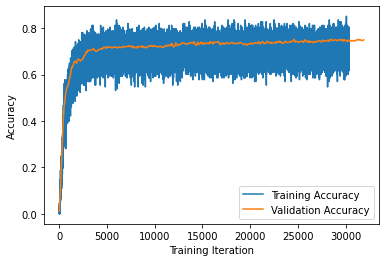

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()